<a href="https://colab.research.google.com/github/Windtwist/Embedded_Systms_Scope/blob/main/vehicle_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**This is where we need to convert to appropriate format for tf records, so json needs to go inot xml format and bounding boxes need to change as well.**

In [1]:
! pip install kaggle

In [6]:
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

In [8]:
! kaggle datasets download -d solesensei/solesensei_bdd100k

100% 7.59G/7.61G [01:17<00:00, 206MB/s]
100% 7.61G/7.61G [01:17<00:00, 105MB/s]


In [9]:
! unzip -qq solesensei_bdd100k.zip

In [11]:
!ls bdd100k_labels_release/bdd100k/labels

bdd100k_labels_images_train.json  bdd100k_labels_images_val.json


In [12]:
! mkdir dataset

! mkdir dataset/train/
! mkdir dataset/train/annos/

! mkdir dataset/val/
! mkdir dataset/val/annos/

In [13]:
! find bdd100k/bdd100k/images/100k/train/trainA/ -name '*.jpg*' -exec mv {} bdd100k/bdd100k/images/100k/train/ \;

In [14]:
! find bdd100k/bdd100k/images/100k/train/trainB/ -name '*.jpg*' -exec mv {} bdd100k/bdd100k/images/100k/train/ \;
! find bdd100k/bdd100k/images/100k/train/testB/ -name '*.jpg*' -exec mv {} bdd100k/bdd100k/images/100k/train/ \;
! find bdd100k/bdd100k/images/100k/train/testB/ -name '*.jpg*' -exec mv {} bdd100k/bdd100k/images/100k/train/ \;

In [15]:
img_dir = "bdd100k/bdd100k/images/100k/train/";
anno_file = "bdd100k_labels_release/bdd100k/labels/bdd100k_labels_images_train.json";
output_dir = "dataset/train/annos/";

In [16]:
import json
with open(anno_file) as json_file:
    data = json.load(json_file)

In [18]:
data[0].keys()

dict_keys(['name', 'attributes', 'timestamp', 'labels'])

In [20]:
!pip install pascal_voc_writer



In [21]:
from pascal_voc_writer import Writer

In [ ]:
import os
from tqdm import tqdm
import cv2


In [44]:
for i in tqdm(range(len(data))):
  labels = data[i]["labels"];
  name = data[i]["name"];
  print(img_dir+ "/" + name)
  img = cv2.imread(img_dir + "/" + name);
  if img is None:
        print(f"Failed to load image: {img_dir}/{name}")
        continue
  h,w,c = img.shape
  writer = Writer(name, w, h)
  for j in range(len(labels)):
          obj = labels[j];
          if("box2d" in obj.keys()):
              category = obj["category"];
              x1 = int(obj["box2d"]["x1"]);
              y1 = int(obj["box2d"]["y1"]);
              x2 = int(obj["box2d"]["x2"]);
              y2 = int(obj["box2d"]["y2"]);
              writer.addObject(category, x1, y1, x2, y2);
  writer.save(output_dir + "/" + name.split(".")[0] + ".xml")



  0%|          | 9/69863 [00:00<14:35, 79.80it/s]

bdd100k/bdd100k/images/100k/train//0000f77c-6257be58.jpg
bdd100k/bdd100k/images/100k/train//0000f77c-62c2a288.jpg
bdd100k/bdd100k/images/100k/train//0000f77c-cb820c98.jpg
bdd100k/bdd100k/images/100k/train//0001542f-5ce3cf52.jpg
bdd100k/bdd100k/images/100k/train//0001542f-7c670be8.jpg
bdd100k/bdd100k/images/100k/train//0001542f-ec815219.jpg
bdd100k/bdd100k/images/100k/train//0004974f-05e1c285.jpg
bdd100k/bdd100k/images/100k/train//00054602-3bf57337.jpg
bdd100k/bdd100k/images/100k/train//00067cfb-5443fe39.jpg
bdd100k/bdd100k/images/100k/train//00067cfb-5adfaaa7.jpg
bdd100k/bdd100k/images/100k/train//00067cfb-caba8a02.jpg
bdd100k/bdd100k/images/100k/train//00067cfb-e535423e.jpg
bdd100k/bdd100k/images/100k/train//00067cfb-f1b91e3c.jpg
bdd100k/bdd100k/images/100k/train//0008a165-c48f4b3e.jpg
bdd100k/bdd100k/images/100k/train//00091078-59817bb0.jpg
bdd100k/bdd100k/images/100k/train//00091078-7cff8ea6.jpg


  0%|          | 25/69863 [00:00<15:05, 77.14it/s]

bdd100k/bdd100k/images/100k/train//00091078-84635cf2.jpg
bdd100k/bdd100k/images/100k/train//00091078-875c1f73.jpg
bdd100k/bdd100k/images/100k/train//00091078-c1d32eea.jpg
bdd100k/bdd100k/images/100k/train//00091078-cedbfea7.jpg
bdd100k/bdd100k/images/100k/train//00091078-f32de4d2.jpg
bdd100k/bdd100k/images/100k/train//000d35d3-41990aa4.jpg
bdd100k/bdd100k/images/100k/train//000d4f89-3bcbe37a.jpg
bdd100k/bdd100k/images/100k/train//000e0252-8523a4a9.jpg
bdd100k/bdd100k/images/100k/train//000f157f-30b30f5e.jpg
bdd100k/bdd100k/images/100k/train//000f157f-37797ff9.jpg
bdd100k/bdd100k/images/100k/train//000f157f-dab3a407.jpg
bdd100k/bdd100k/images/100k/train//000f8d37-d4c09a0f.jpg
bdd100k/bdd100k/images/100k/train//0010bf16-9ee17cd9.jpg
bdd100k/bdd100k/images/100k/train//0010bf16-a457685b.jpg
bdd100k/bdd100k/images/100k/train//00131ea7-624f538d.jpg
bdd100k/bdd100k/images/100k/train//00134776-9123d227.jpg
bdd100k/bdd100k/images/100k/train//001bad4e-2fa8f3b6.jpg


  0%|          | 43/69863 [00:00<14:10, 82.05it/s]

bdd100k/bdd100k/images/100k/train//001c5339-08faca55.jpg
bdd100k/bdd100k/images/100k/train//001c5339-13a07470.jpg
bdd100k/bdd100k/images/100k/train//001c5339-9a6cdd3e.jpg
bdd100k/bdd100k/images/100k/train//00202076-7a95b4e3.jpg
bdd100k/bdd100k/images/100k/train//00202076-9eaa8e42.jpg
bdd100k/bdd100k/images/100k/train//00207869-046fa443.jpg
bdd100k/bdd100k/images/100k/train//00207869-902288d1.jpg
bdd100k/bdd100k/images/100k/train//00211b17-ad3e206b.jpg
bdd100k/bdd100k/images/100k/train//00225f53-4200bde2.jpg
bdd100k/bdd100k/images/100k/train//00225f53-67614580.jpg
bdd100k/bdd100k/images/100k/train//00232de3-19eca24a.jpg
bdd100k/bdd100k/images/100k/train//0024b742-83709bd4.jpg
bdd100k/bdd100k/images/100k/train//0024b742-acbed4fb.jpg
bdd100k/bdd100k/images/100k/train//002685b6-856c17f7.jpg
bdd100k/bdd100k/images/100k/train//00268999-0b20ef00.jpg
bdd100k/bdd100k/images/100k/train//00268999-9f6d5823.jpg
bdd100k/bdd100k/images/100k/train//00268999-a4b8e39d.jpg


  0%|          | 61/69863 [00:00<13:54, 83.69it/s]

bdd100k/bdd100k/images/100k/train//00268999-cb063914.jpg
bdd100k/bdd100k/images/100k/train//002827ad-8748e2fb.jpg
bdd100k/bdd100k/images/100k/train//0028cbbf-92f30408.jpg
bdd100k/bdd100k/images/100k/train//002ab96a-a96704f9.jpg
bdd100k/bdd100k/images/100k/train//002ab96a-ea678692.jpg
bdd100k/bdd100k/images/100k/train//002b485a-3f6603f2.jpg
bdd100k/bdd100k/images/100k/train//002b485a-d1301c7c.jpg
bdd100k/bdd100k/images/100k/train//002b562f-e0ac84fe.jpg
bdd100k/bdd100k/images/100k/train//002cd38e-c7defded.jpg
bdd100k/bdd100k/images/100k/train//002cd38e-ebe888e1.jpg
bdd100k/bdd100k/images/100k/train//002d290d-01969e7d.jpg
bdd100k/bdd100k/images/100k/train//002d290d-89d1aea8.jpg
bdd100k/bdd100k/images/100k/train//002d290d-89f4e5c0.jpg
bdd100k/bdd100k/images/100k/train//002d290d-90f2bab2.jpg
bdd100k/bdd100k/images/100k/train//002d290d-f9108a13.jpg
bdd100k/bdd100k/images/100k/train//002d290d-fa2a8964.jpg
bdd100k/bdd100k/images/100k/train//002e6895-442e6bc1.jpg
bdd100k/bdd100k/images/100k/tra

  0%|          | 79/69863 [00:00<13:53, 83.74it/s]

bdd100k/bdd100k/images/100k/train//0030f434-3eb4a3a9.jpg
bdd100k/bdd100k/images/100k/train//00313a01-62156032.jpg
bdd100k/bdd100k/images/100k/train//00313a01-725ddf3a.jpg
bdd100k/bdd100k/images/100k/train//00313a01-97de1f42.jpg
bdd100k/bdd100k/images/100k/train//00313a01-b53a2998.jpg
bdd100k/bdd100k/images/100k/train//00322f82-286ab9b3.jpg
bdd100k/bdd100k/images/100k/train//0032419c-7d20b300.jpg
bdd100k/bdd100k/images/100k/train//0033b19f-65613f7e.jpg
bdd100k/bdd100k/images/100k/train//0033b19f-7f07efac.jpg
bdd100k/bdd100k/images/100k/train//0034a363-24f318c4.jpg
bdd100k/bdd100k/images/100k/train//0035afff-3295dbd6.jpg
bdd100k/bdd100k/images/100k/train//0035afff-434368a1.jpg
bdd100k/bdd100k/images/100k/train//0035afff-47378fa3.jpg
bdd100k/bdd100k/images/100k/train//0035afff-572b2d4e.jpg
bdd100k/bdd100k/images/100k/train//0035afff-bd191d6a.jpg
bdd100k/bdd100k/images/100k/train//00378858-c5f802ac.jpg
bdd100k/bdd100k/images/100k/train//00390995-49d9a01e.jpg
bdd100k/bdd100k/images/100k/tra

  0%|          | 97/69863 [00:01<13:53, 83.69it/s]

bdd100k/bdd100k/images/100k/train//00391a82-d1428e56.jpg
bdd100k/bdd100k/images/100k/train//003baca5-70c87fc6.jpg
bdd100k/bdd100k/images/100k/train//003baca5-aab2e274.jpg
bdd100k/bdd100k/images/100k/train//003baca5-ad660439.jpg
bdd100k/bdd100k/images/100k/train//003baca5-d6cd84e5.jpg
bdd100k/bdd100k/images/100k/train//003c4a61-52588960.jpg
bdd100k/bdd100k/images/100k/train//003e23ee-07d32feb.jpg
bdd100k/bdd100k/images/100k/train//003e23ee-67d25f19.jpg
bdd100k/bdd100k/images/100k/train//004071a4-049b7b85.jpg
bdd100k/bdd100k/images/100k/train//004071a4-4e8a363a.jpg
bdd100k/bdd100k/images/100k/train//004071a4-a45d905f.jpg
bdd100k/bdd100k/images/100k/train//004071a4-ef4bf541.jpg
bdd100k/bdd100k/images/100k/train//00417c23-220bbc98.jpg
bdd100k/bdd100k/images/100k/train//00423717-0ef3c8dc.jpg
bdd100k/bdd100k/images/100k/train//00423717-eba4da41.jpg
bdd100k/bdd100k/images/100k/train//00423ac5-1fa7ff43.jpg
bdd100k/bdd100k/images/100k/train//0045e757-02530231.jpg
bdd100k/bdd100k/images/100k/tra

  0%|          | 115/69863 [00:01<13:55, 83.43it/s]

bdd100k/bdd100k/images/100k/train//0045e757-66a334b5.jpg
bdd100k/bdd100k/images/100k/train//004855fc-ff3946ad.jpg
bdd100k/bdd100k/images/100k/train//00488a66-6c729bde.jpg
bdd100k/bdd100k/images/100k/train//00488b40-0a8cf1a0.jpg
bdd100k/bdd100k/images/100k/train//0048f391-2c5344eb.jpg
bdd100k/bdd100k/images/100k/train//0048f391-8eb40ca6.jpg
bdd100k/bdd100k/images/100k/train//0048f391-e9bfaf62.jpg
bdd100k/bdd100k/images/100k/train//0048f391-eae6a189.jpg
bdd100k/bdd100k/images/100k/train//00495359-1d04dd8a.jpg
bdd100k/bdd100k/images/100k/train//00495359-27ce9c7e.jpg
bdd100k/bdd100k/images/100k/train//0049e5b8-725e21a0.jpg
bdd100k/bdd100k/images/100k/train//0049e5b8-afda7206.jpg
bdd100k/bdd100k/images/100k/train//004ea016-0b1932a7.jpg
bdd100k/bdd100k/images/100k/train//00516b75-7ac91661.jpg
bdd100k/bdd100k/images/100k/train//0051e391-d32a618e.jpg
bdd100k/bdd100k/images/100k/train//0052b279-87c692aa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0052b279-87c692aa.jpg
bdd100k/b

  0%|          | 142/69863 [00:01<11:08, 104.25it/s]

bdd100k/bdd100k/images/100k/train//005c4fd3-cb4d6287.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//005c4fd3-cb4d6287.jpg
bdd100k/bdd100k/images/100k/train//005cdef0-180a776c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//005cdef0-180a776c.jpg
bdd100k/bdd100k/images/100k/train//005ee183-0100ac18.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//005ee183-0100ac18.jpg
bdd100k/bdd100k/images/100k/train//005ee183-bcfab89f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//005ee183-bcfab89f.jpg
bdd100k/bdd100k/images/100k/train//005fd7be-d8e0dc65.jpg
bdd100k/bdd100k/images/100k/train//005ff190-5be4cdfa.jpg
bdd100k/bdd100k/images/100k/train//0060b445-5acc00ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0060b445-5acc00ed.jpg
bdd100k/bdd100k/images/100k/train//00618cec-3bc5573e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//00618cec-3bc5573e.jpg
bdd100k/bdd100k/images/100k/train//00618cec-a7f7e470.jpg
Failed to loa

  0%|          | 163/69863 [00:01<12:20, 94.13it/s]

bdd100k/bdd100k/images/100k/train//006a4209-4f3bf6cf.jpg
bdd100k/bdd100k/images/100k/train//006a7635-c42f9f97.jpg
bdd100k/bdd100k/images/100k/train//006a7635-ec8fe02c.jpg
bdd100k/bdd100k/images/100k/train//006bb043-fe4bbaf6.jpg
bdd100k/bdd100k/images/100k/train//006bff20-752bd845.jpg
bdd100k/bdd100k/images/100k/train//006c0799-10697723.jpg
bdd100k/bdd100k/images/100k/train//006c0799-964a2695.jpg
bdd100k/bdd100k/images/100k/train//006d6f8e-4759e8c1.jpg
bdd100k/bdd100k/images/100k/train//006dd004-34630e8d.jpg
bdd100k/bdd100k/images/100k/train//006fdb67-526bb14e.jpg
bdd100k/bdd100k/images/100k/train//006fdb67-a1455b77.jpg
bdd100k/bdd100k/images/100k/train//006fdb67-f4820206.jpg
bdd100k/bdd100k/images/100k/train//0070bc56-29bcc943.jpg
bdd100k/bdd100k/images/100k/train//0070bc56-401304be.jpg
bdd100k/bdd100k/images/100k/train//0070bc56-49cf077c.jpg
bdd100k/bdd100k/images/100k/train//0070bc56-4c0bb2d5.jpg
bdd100k/bdd100k/images/100k/train//0070bc56-7d01076a.jpg
bdd100k/bdd100k/images/100k/tra

  0%|          | 173/69863 [00:01<12:37, 92.05it/s]

bdd100k/bdd100k/images/100k/train//00714cd3-48d6b290.jpg
bdd100k/bdd100k/images/100k/train//0071d9c5-0f52d539.jpg
bdd100k/bdd100k/images/100k/train//0071d9c5-be7394cc.jpg
bdd100k/bdd100k/images/100k/train//00721168-56efa5c2.jpg
bdd100k/bdd100k/images/100k/train//0075a5b0-9a8d5dbb.jpg
bdd100k/bdd100k/images/100k/train//0075b179-8e09869a.jpg
bdd100k/bdd100k/images/100k/train//007693e6-2535e7bf.jpg
bdd100k/bdd100k/images/100k/train//007693e6-bc55f0e4.jpg
bdd100k/bdd100k/images/100k/train//007693e6-c2a8b9a7.jpg
bdd100k/bdd100k/images/100k/train//00779058-517a4591.jpg
bdd100k/bdd100k/images/100k/train//0077ccb8-d5778190.jpg
bdd100k/bdd100k/images/100k/train//00787a90-b350f376.jpg
bdd100k/bdd100k/images/100k/train//007ae77f-79995643.jpg
bdd100k/bdd100k/images/100k/train//007aeb45-3e75ce0e.jpg
bdd100k/bdd100k/images/100k/train//007aeb45-56d1aed9.jpg
bdd100k/bdd100k/images/100k/train//007aeb45-9330e852.jpg
bdd100k/bdd100k/images/100k/train//007aeb45-96ce245e.jpg


  0%|          | 192/69863 [00:02<13:25, 86.45it/s]

bdd100k/bdd100k/images/100k/train//007aeb45-c601742b.jpg
bdd100k/bdd100k/images/100k/train//007aeb45-eef41701.jpg
bdd100k/bdd100k/images/100k/train//007aeb45-f9f5ac8c.jpg
bdd100k/bdd100k/images/100k/train//007b11e5-1033ff33.jpg
bdd100k/bdd100k/images/100k/train//007b11e5-c22ddae8.jpg
bdd100k/bdd100k/images/100k/train//007c01ea-63aa326c.jpg
bdd100k/bdd100k/images/100k/train//007c01ea-a02f29ef.jpg
bdd100k/bdd100k/images/100k/train//007c01ea-ad9f940b.jpg
bdd100k/bdd100k/images/100k/train//007c11bf-f6da335c.jpg
bdd100k/bdd100k/images/100k/train//007da0eb-1bad8468.jpg
bdd100k/bdd100k/images/100k/train//007da0eb-8cca23d7.jpg
bdd100k/bdd100k/images/100k/train//007da0eb-e1f588e8.jpg
bdd100k/bdd100k/images/100k/train//007eddfc-528c4da4.jpg
bdd100k/bdd100k/images/100k/train//007eddfc-bcaeb35b.jpg
bdd100k/bdd100k/images/100k/train//007eddfc-f8a80310.jpg
bdd100k/bdd100k/images/100k/train//0080b637-55f7930e.jpg
bdd100k/bdd100k/images/100k/train//00810e80-37641274.jpg


  0%|          | 210/69863 [00:02<13:42, 84.65it/s]

bdd100k/bdd100k/images/100k/train//0081c36b-30bff234.jpg
bdd100k/bdd100k/images/100k/train//0081da60-27997c07.jpg
bdd100k/bdd100k/images/100k/train//0081da60-5fa22cc6.jpg
bdd100k/bdd100k/images/100k/train//0081e27b-17bf4a9e.jpg
bdd100k/bdd100k/images/100k/train//0081e3ea-2c0ec19d.jpg
bdd100k/bdd100k/images/100k/train//0081e3ea-3f7b0282.jpg
bdd100k/bdd100k/images/100k/train//0081e3ea-4551210e.jpg
bdd100k/bdd100k/images/100k/train//0081e3ea-9f5dda4a.jpg
bdd100k/bdd100k/images/100k/train//0081e3ea-b9448b6b.jpg
bdd100k/bdd100k/images/100k/train//0081e3ea-cc69a1c4.jpg
bdd100k/bdd100k/images/100k/train//00825605-9dcec7d0.jpg
bdd100k/bdd100k/images/100k/train//00831388-d801f28b.jpg
bdd100k/bdd100k/images/100k/train//00852c8f-14cf1e60.jpg
bdd100k/bdd100k/images/100k/train//0088cf04-319858ad.jpg
bdd100k/bdd100k/images/100k/train//0089bc2f-5f2d57d5.jpg
bdd100k/bdd100k/images/100k/train//008d2a0a-ac995caf.jpg
bdd100k/bdd100k/images/100k/train//008db5fb-223715d5.jpg
bdd100k/bdd100k/images/100k/tra

  0%|          | 228/69863 [00:02<13:36, 85.31it/s]

bdd100k/bdd100k/images/100k/train//008edf63-4a001f1b.jpg
bdd100k/bdd100k/images/100k/train//008edf63-51af8ab6.jpg
bdd100k/bdd100k/images/100k/train//0090c713-2854b392.jpg
bdd100k/bdd100k/images/100k/train//0090c713-683fc99a.jpg
bdd100k/bdd100k/images/100k/train//0090c713-9d58a186.jpg
bdd100k/bdd100k/images/100k/train//009215e2-62d79d70.jpg
bdd100k/bdd100k/images/100k/train//009215e2-8500bd0b.jpg
bdd100k/bdd100k/images/100k/train//009215e2-d6d2d61b.jpg
bdd100k/bdd100k/images/100k/train//009215e2-e67ccfb7.jpg
bdd100k/bdd100k/images/100k/train//009215e2-ea063b28.jpg
bdd100k/bdd100k/images/100k/train//0092e44c-3b3dee4b.jpg
bdd100k/bdd100k/images/100k/train//0094ffe5-596e38bd.jpg
bdd100k/bdd100k/images/100k/train//0096bcca-095d2c02.jpg
bdd100k/bdd100k/images/100k/train//0096bcca-27a61cb3.jpg
bdd100k/bdd100k/images/100k/train//0096bcca-369281bd.jpg
bdd100k/bdd100k/images/100k/train//0096bcca-42d2702c.jpg
bdd100k/bdd100k/images/100k/train//0096bcca-81ffedfc.jpg
bdd100k/bdd100k/images/100k/tra

  0%|          | 246/69863 [00:02<14:13, 81.55it/s]

bdd100k/bdd100k/images/100k/train//0096bcca-bfb5ea6c.jpg
bdd100k/bdd100k/images/100k/train//0096bcca-c2027ec4.jpg
bdd100k/bdd100k/images/100k/train//0096bcca-fc7d6d3c.jpg
bdd100k/bdd100k/images/100k/train//0096f810-6bcc27da.jpg
bdd100k/bdd100k/images/100k/train//00982f76-83a093ef.jpg
bdd100k/bdd100k/images/100k/train//009aecce-ab411438.jpg
bdd100k/bdd100k/images/100k/train//009aecce-ce4a9413.jpg
bdd100k/bdd100k/images/100k/train//009b0eb2-bbef939f.jpg
bdd100k/bdd100k/images/100k/train//009b6a87-b15675e2.jpg
bdd100k/bdd100k/images/100k/train//009bd04d-0f1f9967.jpg
bdd100k/bdd100k/images/100k/train//009bd04d-42445981.jpg
bdd100k/bdd100k/images/100k/train//009c662e-91aa5a86.jpg
bdd100k/bdd100k/images/100k/train//009deddd-c8963379.jpg
bdd100k/bdd100k/images/100k/train//009deddd-d68ff1f7.jpg
bdd100k/bdd100k/images/100k/train//009e7a6a-3d755b8b.jpg
bdd100k/bdd100k/images/100k/train//00a04f65-8c891f94.jpg


  0%|          | 264/69863 [00:03<14:45, 78.61it/s]

bdd100k/bdd100k/images/100k/train//00a04f65-af2ab984.jpg
bdd100k/bdd100k/images/100k/train//00a0f008-3c67908e.jpg
bdd100k/bdd100k/images/100k/train//00a0f008-a315437f.jpg
bdd100k/bdd100k/images/100k/train//00a1176f-0652080e.jpg
bdd100k/bdd100k/images/100k/train//00a1176f-5121b501.jpg
bdd100k/bdd100k/images/100k/train//00a2e3ca-5c856cde.jpg
bdd100k/bdd100k/images/100k/train//00a2e3ca-62992459.jpg
bdd100k/bdd100k/images/100k/train//00a2f5b6-d4217a96.jpg
bdd100k/bdd100k/images/100k/train//00a395fe-d60c0b47.jpg
bdd100k/bdd100k/images/100k/train//00a820ef-2b98dcf5.jpg
bdd100k/bdd100k/images/100k/train//00a820ef-98a12e22.jpg
bdd100k/bdd100k/images/100k/train//00a820ef-d655700e.jpg
bdd100k/bdd100k/images/100k/train//00a9cd6b-b39be004.jpg
bdd100k/bdd100k/images/100k/train//00abd8a7-ecd6fc56.jpg
bdd100k/bdd100k/images/100k/train//00abf44e-04004ca0.jpg
bdd100k/bdd100k/images/100k/train//00abf44e-421f6ed7.jpg


  0%|          | 281/69863 [00:03<14:21, 80.80it/s]

bdd100k/bdd100k/images/100k/train//00ac3256-0f8e2cda.jpg
bdd100k/bdd100k/images/100k/train//00ad8a92-c4851839.jpg
bdd100k/bdd100k/images/100k/train//00adbb3f-7757d4ea.jpg
bdd100k/bdd100k/images/100k/train//00afa5b2-c14a542f.jpg
bdd100k/bdd100k/images/100k/train//00afa6b9-4efe0141.jpg
bdd100k/bdd100k/images/100k/train//00b04b12-a7d7eb85.jpg
bdd100k/bdd100k/images/100k/train//00b04b30-2e874876.jpg
bdd100k/bdd100k/images/100k/train//00b04b30-501822fa.jpg
bdd100k/bdd100k/images/100k/train//00b1dfed-a89dbe2b.jpg
bdd100k/bdd100k/images/100k/train//00b4c5fc-8fcf3628.jpg
bdd100k/bdd100k/images/100k/train//00b56f41-e0e5d918.jpg
bdd100k/bdd100k/images/100k/train//00b93c6e-6298aa25.jpg
bdd100k/bdd100k/images/100k/train//00be7020-457a6db4.jpg
bdd100k/bdd100k/images/100k/train//00beeb02-50440dcd.jpg
bdd100k/bdd100k/images/100k/train//00beeb02-ba0790aa.jpg
bdd100k/bdd100k/images/100k/train//00c12bd0-bb46e479.jpg
bdd100k/bdd100k/images/100k/train//00c17a92-d4803287.jpg


  0%|          | 307/69863 [00:03<11:28, 101.02it/s]

bdd100k/bdd100k/images/100k/train//00c29c52-f9524f1e.jpg
bdd100k/bdd100k/images/100k/train//00c41a61-4ba25ad4.jpg
bdd100k/bdd100k/images/100k/train//00c497ae-595d361b.jpg
bdd100k/bdd100k/images/100k/train//00c4c672-26d36ad8.jpg
bdd100k/bdd100k/images/100k/train//00c50078-6298b9c1.jpg
bdd100k/bdd100k/images/100k/train//00c87627-b7f6f46c.jpg
bdd100k/bdd100k/images/100k/train//00ca8821-17667a58.jpg
bdd100k/bdd100k/images/100k/train//00ca8821-db8033d5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//00ca8821-db8033d5.jpg
bdd100k/bdd100k/images/100k/train//00cb28b9-08a22af7.jpg
bdd100k/bdd100k/images/100k/train//00ccf2e8-59a6bfc9.jpg
bdd100k/bdd100k/images/100k/train//00ccf2e8-ac055be6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//00ccf2e8-ac055be6.jpg
bdd100k/bdd100k/images/100k/train//00ccf2e8-f8c69860.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//00ccf2e8-f8c69860.jpg
bdd100k/bdd100k/images/100k/train//00ce6f6d-50bbee62.jpg
Failed to load image: 

  0%|          | 329/69863 [00:03<12:09, 95.27it/s] 

bdd100k/bdd100k/images/100k/train//00d18b13-52d3e4c4.jpg
bdd100k/bdd100k/images/100k/train//00d1bafa-1b47b41c.jpg
bdd100k/bdd100k/images/100k/train//00d1bafa-6701fcd9.jpg
bdd100k/bdd100k/images/100k/train//00d4b6b7-7d0a60bf.jpg
bdd100k/bdd100k/images/100k/train//00d4b6b7-a0b1a3e0.jpg
bdd100k/bdd100k/images/100k/train//00d5edb9-f0077df3.jpg
bdd100k/bdd100k/images/100k/train//00d7268f-fd4487be.jpg
bdd100k/bdd100k/images/100k/train//00d77344-9fe25620.jpg
bdd100k/bdd100k/images/100k/train//00d79c0a-23bea078.jpg
bdd100k/bdd100k/images/100k/train//00d79c0a-a2b85ca4.jpg
bdd100k/bdd100k/images/100k/train//00d84b1d-21e6fe01.jpg
bdd100k/bdd100k/images/100k/train//00d8944b-e157478b.jpg
bdd100k/bdd100k/images/100k/train//00d8d95a-47d98291.jpg
bdd100k/bdd100k/images/100k/train//00d8d95a-74aa476a.jpg
bdd100k/bdd100k/images/100k/train//00d9e313-038310a2.jpg
bdd100k/bdd100k/images/100k/train//00d9e313-7d75bb18.jpg
bdd100k/bdd100k/images/100k/train//00d9e313-926b6698.jpg


  0%|          | 339/69863 [00:03<12:37, 91.78it/s]

bdd100k/bdd100k/images/100k/train//00db9030-5102ed41.jpg
bdd100k/bdd100k/images/100k/train//00dc5030-237e7f71.jpg
bdd100k/bdd100k/images/100k/train//00de601c-858a8a8d.jpg
bdd100k/bdd100k/images/100k/train//00de601c-cfa2404b.jpg
bdd100k/bdd100k/images/100k/train//00e02d60-54df99d1.jpg
bdd100k/bdd100k/images/100k/train//00e100a8-9c852617.jpg
bdd100k/bdd100k/images/100k/train//00e100a8-a5e1ece9.jpg
bdd100k/bdd100k/images/100k/train//00e11419-e4eeba84.jpg
bdd100k/bdd100k/images/100k/train//00e42886-b826e91d.jpg
bdd100k/bdd100k/images/100k/train//00e42886-bd5ed543.jpg
bdd100k/bdd100k/images/100k/train//00e49ed1-9d41220c.jpg
bdd100k/bdd100k/images/100k/train//00e4cae5-c0582574.jpg
bdd100k/bdd100k/images/100k/train//00e5e793-22614772.jpg
bdd100k/bdd100k/images/100k/train//00e5e793-f94de032.jpg
bdd100k/bdd100k/images/100k/train//00e782b9-5fe9bffe.jpg
bdd100k/bdd100k/images/100k/train//00e81dcc-b1dd9e7b.jpg
bdd100k/bdd100k/images/100k/train//00e8c106-e197c4b1.jpg
bdd100k/bdd100k/images/100k/tra

  1%|          | 359/69863 [00:04<12:59, 89.22it/s]

bdd100k/bdd100k/images/100k/train//00ecf963-bea6bf0f.jpg
bdd100k/bdd100k/images/100k/train//00ed2e85-82bdd22b.jpg
bdd100k/bdd100k/images/100k/train//00ed2e85-95394dfd.jpg
bdd100k/bdd100k/images/100k/train//00edfec7-4d92adef.jpg
bdd100k/bdd100k/images/100k/train//00f0dd0f-1adbde75.jpg
bdd100k/bdd100k/images/100k/train//00f0dd0f-5e9c9557.jpg
bdd100k/bdd100k/images/100k/train//00f28fce-a799f8a1.jpg
bdd100k/bdd100k/images/100k/train//00f2b0d5-c84860fe.jpg
bdd100k/bdd100k/images/100k/train//00f42f6b-5a20a4d2.jpg
bdd100k/bdd100k/images/100k/train//00f42f6b-699a498c.jpg
bdd100k/bdd100k/images/100k/train//00f42f6b-b1ca1f6c.jpg
bdd100k/bdd100k/images/100k/train//00f7eac8-5193d600.jpg
bdd100k/bdd100k/images/100k/train//00f89335-1825f637.jpg
bdd100k/bdd100k/images/100k/train//00f89335-2ef7949d.jpg
bdd100k/bdd100k/images/100k/train//00f8f875-bad0295f.jpg
bdd100k/bdd100k/images/100k/train//00fba75b-5d18da26.jpg
bdd100k/bdd100k/images/100k/train//00fbb190-8834f55b.jpg
bdd100k/bdd100k/images/100k/tra

  1%|          | 377/69863 [00:04<13:38, 84.86it/s]

bdd100k/bdd100k/images/100k/train//00fcfec9-7ba5dabf.jpg
bdd100k/bdd100k/images/100k/train//00fcfec9-8accd82b.jpg
bdd100k/bdd100k/images/100k/train//00ffeef4-75f6b5ec.jpg
bdd100k/bdd100k/images/100k/train//00ffeef4-b105ce4d.jpg
bdd100k/bdd100k/images/100k/train//00ffeef4-ea139a4e.jpg
bdd100k/bdd100k/images/100k/train//0100a197-bdbf50ca.jpg
bdd100k/bdd100k/images/100k/train//0102614a-75ae85cf.jpg
bdd100k/bdd100k/images/100k/train//0102614a-fc165656.jpg
bdd100k/bdd100k/images/100k/train//01041028-15488454.jpg
bdd100k/bdd100k/images/100k/train//01041028-187a2d1f.jpg
bdd100k/bdd100k/images/100k/train//01041028-362385a9.jpg
bdd100k/bdd100k/images/100k/train//0104a3f0-9294818d.jpg
bdd100k/bdd100k/images/100k/train//0104eb19-162abfea.jpg
bdd100k/bdd100k/images/100k/train//0104eb19-718b1a9c.jpg
bdd100k/bdd100k/images/100k/train//0104f3cf-0dbe2960.jpg
bdd100k/bdd100k/images/100k/train//01051f5c-0ec95f5c.jpg
bdd100k/bdd100k/images/100k/train//010526ea-7a0c620d.jpg


  1%|          | 395/69863 [00:04<13:35, 85.22it/s]

bdd100k/bdd100k/images/100k/train//010526ea-98dc9803.jpg
bdd100k/bdd100k/images/100k/train//010799f0-4d81c585.jpg
bdd100k/bdd100k/images/100k/train//01079b7f-2af154e7.jpg
bdd100k/bdd100k/images/100k/train//01079b7f-54afc9ad.jpg
bdd100k/bdd100k/images/100k/train//01079b7f-9d0e53c5.jpg
bdd100k/bdd100k/images/100k/train//01094b4f-27d47f20.jpg
bdd100k/bdd100k/images/100k/train//010a3063-55852e55.jpg
bdd100k/bdd100k/images/100k/train//010a3063-d255402b.jpg
bdd100k/bdd100k/images/100k/train//010b0600-47a9e3e0.jpg
bdd100k/bdd100k/images/100k/train//010b0600-ae1f7be5.jpg
bdd100k/bdd100k/images/100k/train//010b0600-f44aed15.jpg
bdd100k/bdd100k/images/100k/train//010b452c-2636b85e.jpg
bdd100k/bdd100k/images/100k/train//010d75f8-3eb08dc7.jpg
bdd100k/bdd100k/images/100k/train//010d75f8-91f41ad8.jpg
bdd100k/bdd100k/images/100k/train//010d75f8-fa119cd4.jpg
bdd100k/bdd100k/images/100k/train//010fc651-19922861.jpg
bdd100k/bdd100k/images/100k/train//010fc651-6bcbfd89.jpg
bdd100k/bdd100k/images/100k/tra

  1%|          | 413/69863 [00:04<13:43, 84.37it/s]

bdd100k/bdd100k/images/100k/train//0110b332-cc1282d2.jpg
bdd100k/bdd100k/images/100k/train//0111122b-276d22b9.jpg
bdd100k/bdd100k/images/100k/train//0111523e-64c5acff.jpg
bdd100k/bdd100k/images/100k/train//0111523e-a2170455.jpg
bdd100k/bdd100k/images/100k/train//01118704-2d838d7f.jpg
bdd100k/bdd100k/images/100k/train//01118704-e91b1b1c.jpg
bdd100k/bdd100k/images/100k/train//01128d0a-031e0a61.jpg
bdd100k/bdd100k/images/100k/train//0113faa5-8a0daa74.jpg
bdd100k/bdd100k/images/100k/train//0114bdd0-f317da84.jpg
bdd100k/bdd100k/images/100k/train//0115917e-14907a6a.jpg
bdd100k/bdd100k/images/100k/train//011a2aa0-677a45ae.jpg
bdd100k/bdd100k/images/100k/train//011ad6b2-1dfff443.jpg
bdd100k/bdd100k/images/100k/train//011ad6b2-f34fd564.jpg
bdd100k/bdd100k/images/100k/train//011aeca1-fe5af665.jpg
bdd100k/bdd100k/images/100k/train//011b09ca-9529e701.jpg
bdd100k/bdd100k/images/100k/train//011c1a10-d1b6a6a2.jpg
bdd100k/bdd100k/images/100k/train//011d593a-89158b9d.jpg
bdd100k/bdd100k/images/100k/tra

  1%|          | 431/69863 [00:04<13:39, 84.70it/s]

bdd100k/bdd100k/images/100k/train//011f8481-b14725fa.jpg
bdd100k/bdd100k/images/100k/train//011f8556-41affeb2.jpg
bdd100k/bdd100k/images/100k/train//011f8556-ca1f4828.jpg
bdd100k/bdd100k/images/100k/train//01213e45-5edb70f0.jpg
bdd100k/bdd100k/images/100k/train//0124dfa6-30a430dc.jpg
bdd100k/bdd100k/images/100k/train//0124dfa6-385f1b58.jpg
bdd100k/bdd100k/images/100k/train//01251d51-eb962582.jpg
bdd100k/bdd100k/images/100k/train//0125b9f0-a8dec2ba.jpg
bdd100k/bdd100k/images/100k/train//0127cb3a-6be24a50.jpg
bdd100k/bdd100k/images/100k/train//0128cdde-1f72dcf1.jpg
bdd100k/bdd100k/images/100k/train//0128cdde-289cd9e9.jpg
bdd100k/bdd100k/images/100k/train//0128cdde-ba330f54.jpg
bdd100k/bdd100k/images/100k/train//0128cdde-ce2cb20b.jpg
bdd100k/bdd100k/images/100k/train//0128cdde-ea132b68.jpg
bdd100k/bdd100k/images/100k/train//012979cd-e13274a9.jpg
bdd100k/bdd100k/images/100k/train//0129ed1d-41528bb8.jpg
bdd100k/bdd100k/images/100k/train//0129ed1d-d8572c11.jpg
bdd100k/bdd100k/images/100k/tra

  1%|          | 449/69863 [00:05<14:19, 80.72it/s]

bdd100k/bdd100k/images/100k/train//012a9c41-3c62334b.jpg
bdd100k/bdd100k/images/100k/train//012a9c41-69222e1b.jpg
bdd100k/bdd100k/images/100k/train//012a9c41-692c9f06.jpg
bdd100k/bdd100k/images/100k/train//012a9c41-9423165c.jpg
bdd100k/bdd100k/images/100k/train//012a9c41-cef5b320.jpg
bdd100k/bdd100k/images/100k/train//012a9c41-edad898c.jpg
bdd100k/bdd100k/images/100k/train//012b2d03-bef11aa2.jpg
bdd100k/bdd100k/images/100k/train//012c118a-93e8b511.jpg
bdd100k/bdd100k/images/100k/train//012c118a-b3092f3b.jpg
bdd100k/bdd100k/images/100k/train//012c8623-1782dc8b.jpg
bdd100k/bdd100k/images/100k/train//012d563d-30edbc0f.jpg
bdd100k/bdd100k/images/100k/train//012e0351-723ac360.jpg
bdd100k/bdd100k/images/100k/train//012e9465-1031243b.jpg
bdd100k/bdd100k/images/100k/train//012f3428-f991fd5e.jpg
bdd100k/bdd100k/images/100k/train//012fdff1-9d1d0d1d.jpg


  1%|          | 458/69863 [00:05<16:49, 68.74it/s]

bdd100k/bdd100k/images/100k/train//01306b58-1c8ac4c9.jpg
bdd100k/bdd100k/images/100k/train//01306b58-a09ba743.jpg
bdd100k/bdd100k/images/100k/train//01306b58-cf6faad9.jpg
bdd100k/bdd100k/images/100k/train//013162b0-ddbabae8.jpg
bdd100k/bdd100k/images/100k/train//01317a31-6ea7d85d.jpg
bdd100k/bdd100k/images/100k/train//0133af9c-0fe68717.jpg
bdd100k/bdd100k/images/100k/train//0133af9c-7a0eae36.jpg
bdd100k/bdd100k/images/100k/train//0133af9c-8a890e5d.jpg
bdd100k/bdd100k/images/100k/train//0134102e-d43de666.jpg
bdd100k/bdd100k/images/100k/train//0135988f-243a3367.jpg
bdd100k/bdd100k/images/100k/train//0135988f-61d44844.jpg


  1%|          | 466/69863 [00:05<18:06, 63.85it/s]

bdd100k/bdd100k/images/100k/train//0135988f-6e5c56c0.jpg
bdd100k/bdd100k/images/100k/train//0135988f-9fcccf88.jpg
bdd100k/bdd100k/images/100k/train//0135988f-d72fb455.jpg
bdd100k/bdd100k/images/100k/train//0135c724-b8bd0434.jpg
bdd100k/bdd100k/images/100k/train//0135c724-efe26d29.jpg
bdd100k/bdd100k/images/100k/train//013645c8-bb313ab4.jpg
bdd100k/bdd100k/images/100k/train//013742f1-3a043a4e.jpg
bdd100k/bdd100k/images/100k/train//013aba02-3fbd03ff.jpg
bdd100k/bdd100k/images/100k/train//013ae324-36be6bc2.jpg
bdd100k/bdd100k/images/100k/train//013ae324-9d336f91.jpg
bdd100k/bdd100k/images/100k/train//013ae324-a2d71df4.jpg


  1%|          | 480/69863 [00:05<20:00, 57.78it/s]

bdd100k/bdd100k/images/100k/train//013ae324-e7ef50a2.jpg
bdd100k/bdd100k/images/100k/train//013b7dd3-0b902c12.jpg
bdd100k/bdd100k/images/100k/train//013b7dd3-80000bcd.jpg
bdd100k/bdd100k/images/100k/train//014070bf-4de0af14.jpg
bdd100k/bdd100k/images/100k/train//0141ab5f-fc9afdd2.jpg
bdd100k/bdd100k/images/100k/train//0141e71e-941b0b5d.jpg
bdd100k/bdd100k/images/100k/train//014324ec-d139c447.jpg
bdd100k/bdd100k/images/100k/train//01440a35-e0b2f4a2.jpg
bdd100k/bdd100k/images/100k/train//014474aa-accf35e1.jpg
bdd100k/bdd100k/images/100k/train//0145b233-ee9c5b63.jpg
bdd100k/bdd100k/images/100k/train//01460ec4-0233fef9.jpg


  1%|          | 497/69863 [00:06<16:39, 69.38it/s]

bdd100k/bdd100k/images/100k/train//01460ec4-41af799a.jpg
bdd100k/bdd100k/images/100k/train//01460ec4-522da2d6.jpg
bdd100k/bdd100k/images/100k/train//01460ec4-a12a1552.jpg
bdd100k/bdd100k/images/100k/train//01460ec4-a1d65b66.jpg
bdd100k/bdd100k/images/100k/train//01460ec4-ae03e419.jpg
bdd100k/bdd100k/images/100k/train//01460ec4-b50591be.jpg
bdd100k/bdd100k/images/100k/train//01461010-eeca4bf2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//01461010-eeca4bf2.jpg
bdd100k/bdd100k/images/100k/train//0149d509-819eec9c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0149d509-819eec9c.jpg
bdd100k/bdd100k/images/100k/train//0149d925-c319ce50.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0149d925-c319ce50.jpg
bdd100k/bdd100k/images/100k/train//014b8fc3-532a0660.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//014b8fc3-532a0660.jpg
bdd100k/bdd100k/images/100k/train//014c3c65-3e7539a0.jpg
bdd100k/bdd100k/images/100k/train//014d895c-70b158b8.jpg


  1%|          | 514/69863 [00:06<17:10, 67.28it/s]

bdd100k/bdd100k/images/100k/train//0153f03b-8fbdc1ad.jpg
bdd100k/bdd100k/images/100k/train//01551335-542af6dd.jpg
bdd100k/bdd100k/images/100k/train//015a7c97-9aa3e05d.jpg
bdd100k/bdd100k/images/100k/train//015af63d-7af26e37.jpg
bdd100k/bdd100k/images/100k/train//015af63d-df1ef690.jpg
bdd100k/bdd100k/images/100k/train//015b88d3-48cc2dc4.jpg
bdd100k/bdd100k/images/100k/train//015b88d3-888cc0b1.jpg
bdd100k/bdd100k/images/100k/train//015bbc07-91083530.jpg
bdd100k/bdd100k/images/100k/train//015cbf2d-1b0ecee0.jpg
bdd100k/bdd100k/images/100k/train//015ccf71-4b65f4bf.jpg
bdd100k/bdd100k/images/100k/train//015ccf71-56e8d5b8.jpg


  1%|          | 521/69863 [00:06<18:33, 62.25it/s]

bdd100k/bdd100k/images/100k/train//015e6ee5-bff02c40.jpg
bdd100k/bdd100k/images/100k/train//015f02db-2f4f2353.jpg
bdd100k/bdd100k/images/100k/train//015f02db-80d95c9f.jpg
bdd100k/bdd100k/images/100k/train//015f23ad-5049df48.jpg
bdd100k/bdd100k/images/100k/train//015fcc2d-2d44d478.jpg
bdd100k/bdd100k/images/100k/train//015fe6c9-48a58255.jpg
bdd100k/bdd100k/images/100k/train//015fe6c9-e880c0d7.jpg
bdd100k/bdd100k/images/100k/train//01621265-578a97d7.jpg
bdd100k/bdd100k/images/100k/train//01632f31-ab7e17e3.jpg
bdd100k/bdd100k/images/100k/train//01638325-504ab42d.jpg
bdd100k/bdd100k/images/100k/train//01638325-901cd4f5.jpg


  1%|          | 535/69863 [00:06<20:39, 55.95it/s]

bdd100k/bdd100k/images/100k/train//01638325-c0f998fd.jpg
bdd100k/bdd100k/images/100k/train//01638325-eb95ed3a.jpg
bdd100k/bdd100k/images/100k/train//0166faa5-5fbc53c5.jpg
bdd100k/bdd100k/images/100k/train//01688cf2-237fbd49.jpg
bdd100k/bdd100k/images/100k/train//01688cf2-82391195.jpg
bdd100k/bdd100k/images/100k/train//0168e22b-175c805f.jpg
bdd100k/bdd100k/images/100k/train//0168e22b-7f034886.jpg
bdd100k/bdd100k/images/100k/train//0168e22b-81d10cb6.jpg
bdd100k/bdd100k/images/100k/train//0168e22b-dad440f5.jpg
bdd100k/bdd100k/images/100k/train//0168e22b-fe7ec19d.jpg
bdd100k/bdd100k/images/100k/train//016a3756-afd08730.jpg


  1%|          | 547/69863 [00:06<21:29, 53.74it/s]

bdd100k/bdd100k/images/100k/train//016a63d6-582c4677.jpg
bdd100k/bdd100k/images/100k/train//016a73c3-ee66beda.jpg
bdd100k/bdd100k/images/100k/train//016c5aac-f5e49c84.jpg
bdd100k/bdd100k/images/100k/train//01705c36-8993db9f.jpg
bdd100k/bdd100k/images/100k/train//017078a5-baa7a0e4.jpg
bdd100k/bdd100k/images/100k/train//0171a405-03235e12.jpg
bdd100k/bdd100k/images/100k/train//01746216-721df8d4.jpg
bdd100k/bdd100k/images/100k/train//01746216-8d8edd01.jpg
bdd100k/bdd100k/images/100k/train//01746216-f3e9e455.jpg
bdd100k/bdd100k/images/100k/train//01759047-d88724fe.jpg
bdd100k/bdd100k/images/100k/train//01762203-e12f3f9f.jpg


  1%|          | 559/69863 [00:07<22:27, 51.45it/s]

bdd100k/bdd100k/images/100k/train//01781c36-25e044bd.jpg
bdd100k/bdd100k/images/100k/train//0178ff32-d94d3509.jpg
bdd100k/bdd100k/images/100k/train//017b02cb-477b66fa.jpg
bdd100k/bdd100k/images/100k/train//017b02cb-8a659756.jpg
bdd100k/bdd100k/images/100k/train//017bc60b-45528fb9.jpg
bdd100k/bdd100k/images/100k/train//017bec14-1c6f8718.jpg
bdd100k/bdd100k/images/100k/train//017bec14-5638318f.jpg
bdd100k/bdd100k/images/100k/train//017bec14-8512b7fd.jpg
bdd100k/bdd100k/images/100k/train//017e2d3b-765af5a6.jpg
bdd100k/bdd100k/images/100k/train//017e2d3b-acac71ff.jpg


  1%|          | 565/69863 [00:07<22:57, 50.32it/s]

bdd100k/bdd100k/images/100k/train//01818f85-516d8d03.jpg
bdd100k/bdd100k/images/100k/train//01818f85-6397dd75.jpg
bdd100k/bdd100k/images/100k/train//0182320b-bb377e4e.jpg
bdd100k/bdd100k/images/100k/train//0183d6f9-806f64bd.jpg
bdd100k/bdd100k/images/100k/train//0184a4be-c7a32fbc.jpg
bdd100k/bdd100k/images/100k/train//01853f47-6975b587.jpg
bdd100k/bdd100k/images/100k/train//0185631d-eabb8700.jpg
bdd100k/bdd100k/images/100k/train//018988f9-0225fc55.jpg
bdd100k/bdd100k/images/100k/train//018aca44-9a616a49.jpg
bdd100k/bdd100k/images/100k/train//018bf09d-cd788942.jpg


  1%|          | 576/69863 [00:07<23:37, 48.87it/s]

bdd100k/bdd100k/images/100k/train//018d962a-fd869a57.jpg
bdd100k/bdd100k/images/100k/train//018f06cd-834da3b3.jpg
bdd100k/bdd100k/images/100k/train//018f1d4d-0937fae5.jpg
bdd100k/bdd100k/images/100k/train//019167dd-0f84c4b3.jpg
bdd100k/bdd100k/images/100k/train//0193a01e-90028c79.jpg
bdd100k/bdd100k/images/100k/train//019539db-cc36496e.jpg
bdd100k/bdd100k/images/100k/train//019539db-fe9960ba.jpg
bdd100k/bdd100k/images/100k/train//019588c0-90390013.jpg
bdd100k/bdd100k/images/100k/train//019588c0-aa3dbd00.jpg
bdd100k/bdd100k/images/100k/train//019588c0-f482aa5e.jpg
bdd100k/bdd100k/images/100k/train//0195c13b-01c07d6a.jpg


  1%|          | 588/69863 [00:07<23:10, 49.83it/s]

bdd100k/bdd100k/images/100k/train//019666dd-b8236d7f.jpg
bdd100k/bdd100k/images/100k/train//01981fe5-b484769f.jpg
bdd100k/bdd100k/images/100k/train//01983d1d-10abe0ba.jpg
bdd100k/bdd100k/images/100k/train//0199e7fc-0b6d1a35.jpg
bdd100k/bdd100k/images/100k/train//019b6143-8c8d343e.jpg
bdd100k/bdd100k/images/100k/train//019c4fa9-d4219327.jpg
bdd100k/bdd100k/images/100k/train//019c4fa9-f05e5f04.jpg
bdd100k/bdd100k/images/100k/train//019c8305-0bb153d0.jpg
bdd100k/bdd100k/images/100k/train//019c8305-3a3be0d6.jpg
bdd100k/bdd100k/images/100k/train//019cd27a-04f32671.jpg
bdd100k/bdd100k/images/100k/train//019cd27a-9ad90d04.jpg


  1%|          | 604/69863 [00:07<18:35, 62.11it/s]

bdd100k/bdd100k/images/100k/train//019cd27a-b3c5617d.jpg
bdd100k/bdd100k/images/100k/train//019cd27a-d1b82c8d.jpg
bdd100k/bdd100k/images/100k/train//019d0e2f-26b8c896.jpg
bdd100k/bdd100k/images/100k/train//019d2681-83c5bf22.jpg
bdd100k/bdd100k/images/100k/train//019d6206-d5de804a.jpg
bdd100k/bdd100k/images/100k/train//019efe88-bbc2a4ac.jpg
bdd100k/bdd100k/images/100k/train//01a01af7-76f6a476.jpg
bdd100k/bdd100k/images/100k/train//01a0fe55-298688cb.jpg
bdd100k/bdd100k/images/100k/train//01a4075d-544ddc3c.jpg
bdd100k/bdd100k/images/100k/train//01a42c06-6c608165.jpg
bdd100k/bdd100k/images/100k/train//01a4933a-252e566a.jpg
bdd100k/bdd100k/images/100k/train//01a4deab-0f7d41cc.jpg
bdd100k/bdd100k/images/100k/train//01a4deab-40dbb1f3.jpg
bdd100k/bdd100k/images/100k/train//01a4deab-6b02cc77.jpg
bdd100k/bdd100k/images/100k/train//01a4deab-9d5e5a17.jpg
bdd100k/bdd100k/images/100k/train//01a4deab-b691805a.jpg


  1%|          | 622/69863 [00:08<15:45, 73.25it/s]

bdd100k/bdd100k/images/100k/train//01a4deab-ece02859.jpg
bdd100k/bdd100k/images/100k/train//01a4deab-fd589c6f.jpg
bdd100k/bdd100k/images/100k/train//01a54273-6df5e1d3.jpg
bdd100k/bdd100k/images/100k/train//01a6daec-e8c923a8.jpg
bdd100k/bdd100k/images/100k/train//01a70d82-75ba2bd6.jpg
bdd100k/bdd100k/images/100k/train//01a70d82-eaaaf673.jpg
bdd100k/bdd100k/images/100k/train//01a78dfd-ba2fca5e.jpg
bdd100k/bdd100k/images/100k/train//01a842a8-2cf8634e.jpg
bdd100k/bdd100k/images/100k/train//01a8723d-6477ce11.jpg
bdd100k/bdd100k/images/100k/train//01a8723d-89a1953a.jpg
bdd100k/bdd100k/images/100k/train//01a8723d-b7f960ce.jpg
bdd100k/bdd100k/images/100k/train//01aa2961-e390a466.jpg
bdd100k/bdd100k/images/100k/train//01ab0f6d-a46b9d78.jpg
bdd100k/bdd100k/images/100k/train//01ab0f6d-b377cd7c.jpg
bdd100k/bdd100k/images/100k/train//01ab0f6d-b74b888d.jpg
bdd100k/bdd100k/images/100k/train//01ad8d8a-49bb0c93.jpg
bdd100k/bdd100k/images/100k/train//01aeb4e2-7d6000f2.jpg
bdd100k/bdd100k/images/100k/tra

  1%|          | 643/69863 [00:08<13:15, 87.00it/s]

bdd100k/bdd100k/images/100k/train//01af2f91-3eacda83.jpg
bdd100k/bdd100k/images/100k/train//01af2f91-7bd5e6c9.jpg
bdd100k/bdd100k/images/100k/train//01b0505f-5f564e84.jpg
bdd100k/bdd100k/images/100k/train//01b4e4b9-e21fe0a3.jpg
bdd100k/bdd100k/images/100k/train//01b4e4b9-fc7a5264.jpg
bdd100k/bdd100k/images/100k/train//01b633a2-5c2fee2e.jpg
bdd100k/bdd100k/images/100k/train//01b9efbe-ac6e1c8c.jpg
bdd100k/bdd100k/images/100k/train//01bb1cc0-cea208cc.jpg
bdd100k/bdd100k/images/100k/train//01bc8687-63878241.jpg
bdd100k/bdd100k/images/100k/train//01bc8687-ad6aee3c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//01bc8687-ad6aee3c.jpg
bdd100k/bdd100k/images/100k/train//01bfe142-2d54e71b.jpg
bdd100k/bdd100k/images/100k/train//01bfe142-6e234db0.jpg
bdd100k/bdd100k/images/100k/train//01bfe142-adaf8017.jpg
bdd100k/bdd100k/images/100k/train//01c2135d-01175da1.jpg
bdd100k/bdd100k/images/100k/train//01c231b4-1ebf841a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//01c231b4-

  1%|          | 666/69863 [00:08<12:19, 93.64it/s]

bdd100k/bdd100k/images/100k/train//01c3e892-a4a8f9ec.jpg
bdd100k/bdd100k/images/100k/train//01c3e892-c0641182.jpg
bdd100k/bdd100k/images/100k/train//01c4035b-14d887ca.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//01c4035b-14d887ca.jpg
bdd100k/bdd100k/images/100k/train//01c4035b-bcaeb067.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//01c4035b-bcaeb067.jpg
bdd100k/bdd100k/images/100k/train//01c5cd64-192464e1.jpg
bdd100k/bdd100k/images/100k/train//01c5cd64-278f8b91.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//01c5cd64-278f8b91.jpg
bdd100k/bdd100k/images/100k/train//01c5cd64-6e208afd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//01c5cd64-6e208afd.jpg
bdd100k/bdd100k/images/100k/train//01c5cd64-76bf9abb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//01c5cd64-76bf9abb.jpg
bdd100k/bdd100k/images/100k/train//01c5fd90-949d2d90.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//01c5fd90-949d2d90.jpg
bdd100k/bdd10

  1%|          | 676/69863 [00:08<12:31, 92.06it/s]

bdd100k/bdd100k/images/100k/train//01ce9ed7-51ffbb0e.jpg
bdd100k/bdd100k/images/100k/train//01d07f62-a9eec120.jpg
bdd100k/bdd100k/images/100k/train//01d07f62-d1b665f0.jpg
bdd100k/bdd100k/images/100k/train//01d0c813-48d4fcd8.jpg
bdd100k/bdd100k/images/100k/train//01d0c813-93e6e4f8.jpg
bdd100k/bdd100k/images/100k/train//01d0c813-d40ec94f.jpg
bdd100k/bdd100k/images/100k/train//01d0c813-e334c048.jpg
bdd100k/bdd100k/images/100k/train//01d0c813-f2819e84.jpg
bdd100k/bdd100k/images/100k/train//01d250e0-8352d1f1.jpg
bdd100k/bdd100k/images/100k/train//01d25bbc-a9f903ba.jpg
bdd100k/bdd100k/images/100k/train//01d373c7-45710346.jpg
bdd100k/bdd100k/images/100k/train//01d3a4d7-0ccd66c3.jpg
bdd100k/bdd100k/images/100k/train//01d3a4d7-7940d3f0.jpg
bdd100k/bdd100k/images/100k/train//01d3a4d7-92c0537c.jpg
bdd100k/bdd100k/images/100k/train//01d3a4d7-aaf41e75.jpg
bdd100k/bdd100k/images/100k/train//01d3a4d7-b6a3dfb5.jpg
bdd100k/bdd100k/images/100k/train//01d3a4d7-c76b7e73.jpg
bdd100k/bdd100k/images/100k/tra

  1%|          | 696/69863 [00:08<12:49, 89.89it/s]

bdd100k/bdd100k/images/100k/train//01d87368-2ac1d81d.jpg
bdd100k/bdd100k/images/100k/train//01d87368-a0c0bc84.jpg
bdd100k/bdd100k/images/100k/train//01d933a6-c1f361fb.jpg
bdd100k/bdd100k/images/100k/train//01dad8ea-6732167c.jpg
bdd100k/bdd100k/images/100k/train//01dad8ea-c6deb141.jpg
bdd100k/bdd100k/images/100k/train//01dc1bbe-8919b3d8.jpg
bdd100k/bdd100k/images/100k/train//01dc1bbe-b5109eb3.jpg
bdd100k/bdd100k/images/100k/train//01dc8414-3e5938b1.jpg
bdd100k/bdd100k/images/100k/train//01dd2e02-3bd0526b.jpg
bdd100k/bdd100k/images/100k/train//01dd2e02-88356eaa.jpg
bdd100k/bdd100k/images/100k/train//01dd5d9a-4501cd3a.jpg
bdd100k/bdd100k/images/100k/train//01df5158-81b61006.jpg
bdd100k/bdd100k/images/100k/train//01dfa9c5-8e06d106.jpg
bdd100k/bdd100k/images/100k/train//01e0535c-fe710ab9.jpg
bdd100k/bdd100k/images/100k/train//01e05a91-2c9e154d.jpg
bdd100k/bdd100k/images/100k/train//01e57e3f-94948016.jpg
bdd100k/bdd100k/images/100k/train//01e5bbac-330a3c37.jpg
bdd100k/bdd100k/images/100k/tra

  1%|          | 716/69863 [00:09<13:08, 87.72it/s]

bdd100k/bdd100k/images/100k/train//01e87cf1-25268f60.jpg
bdd100k/bdd100k/images/100k/train//01e9deb7-ed388859.jpg
bdd100k/bdd100k/images/100k/train//01ea515d-3dc73413.jpg
bdd100k/bdd100k/images/100k/train//01eaedc9-a79a93e0.jpg
bdd100k/bdd100k/images/100k/train//01eb2be1-84bd2126.jpg
bdd100k/bdd100k/images/100k/train//01eb2be1-ca02b2ac.jpg
bdd100k/bdd100k/images/100k/train//01ebc74a-5c69af71.jpg
bdd100k/bdd100k/images/100k/train//01ec6367-7092c37b.jpg
bdd100k/bdd100k/images/100k/train//01ed3f01-33091fbe.jpg
bdd100k/bdd100k/images/100k/train//01ed3f01-c4dd8d1d.jpg
bdd100k/bdd100k/images/100k/train//01ee7c33-667e3aa0.jpg
bdd100k/bdd100k/images/100k/train//01ef5ee9-5fb62089.jpg
bdd100k/bdd100k/images/100k/train//01f087ee-aa19ac33.jpg
bdd100k/bdd100k/images/100k/train//01f087ee-e1c08372.jpg
bdd100k/bdd100k/images/100k/train//01f2af00-195831fa.jpg
bdd100k/bdd100k/images/100k/train//01f2bc5a-5a845805.jpg
bdd100k/bdd100k/images/100k/train//01f5086d-7820a48d.jpg


  1%|          | 734/69863 [00:09<13:26, 85.68it/s]

bdd100k/bdd100k/images/100k/train//01f54fd9-6fd0dab3.jpg
bdd100k/bdd100k/images/100k/train//01f618c6-82cfe9c3.jpg
bdd100k/bdd100k/images/100k/train//01f7bbd1-2f36d7a2.jpg
bdd100k/bdd100k/images/100k/train//01f7bbd1-6fbaad8c.jpg
bdd100k/bdd100k/images/100k/train//01f9b5f2-b15a9c4e.jpg
bdd100k/bdd100k/images/100k/train//01fa5cc7-c41fe747.jpg
bdd100k/bdd100k/images/100k/train//01fa77d0-e86c6400.jpg
bdd100k/bdd100k/images/100k/train//01fbf6af-9d47ed83.jpg
bdd100k/bdd100k/images/100k/train//01fe8b93-102f9fe0.jpg
bdd100k/bdd100k/images/100k/train//01ff2210-403e7e0f.jpg
bdd100k/bdd100k/images/100k/train//01ff2210-c4cd7f4f.jpg
bdd100k/bdd100k/images/100k/train//01ff4acd-abd98a91.jpg
bdd100k/bdd100k/images/100k/train//01ff4acd-b2311e18.jpg
bdd100k/bdd100k/images/100k/train//01ff9753-487eb0bd.jpg
bdd100k/bdd100k/images/100k/train//02006c28-c2c5e796.jpg
bdd100k/bdd100k/images/100k/train//02006c28-dbd5e8e9.jpg
bdd100k/bdd100k/images/100k/train//0204aad7-05dbee41.jpg


  1%|          | 752/69863 [00:09<13:51, 83.07it/s]

bdd100k/bdd100k/images/100k/train//0204aad7-4ebd19fa.jpg
bdd100k/bdd100k/images/100k/train//0204aad7-8ad8ba92.jpg
bdd100k/bdd100k/images/100k/train//0204aad7-9e1e915e.jpg
bdd100k/bdd100k/images/100k/train//0204aad7-ce83492d.jpg
bdd100k/bdd100k/images/100k/train//0204aad7-eeb13c43.jpg
bdd100k/bdd100k/images/100k/train//02065c11-0966f65d.jpg
bdd100k/bdd100k/images/100k/train//02065c11-194478e8.jpg
bdd100k/bdd100k/images/100k/train//02065c11-dbd5d35b.jpg
bdd100k/bdd100k/images/100k/train//02086f50-c1e5d802.jpg
bdd100k/bdd100k/images/100k/train//02097021-05dcbf23.jpg
bdd100k/bdd100k/images/100k/train//02097021-183ed3b9.jpg
bdd100k/bdd100k/images/100k/train//02097021-295d2161.jpg
bdd100k/bdd100k/images/100k/train//0209c510-5ef87f7a.jpg
bdd100k/bdd100k/images/100k/train//020adf31-972bcf64.jpg
bdd100k/bdd100k/images/100k/train//020c83ef-ae7ac282.jpg
bdd100k/bdd100k/images/100k/train//020cc8f8-8b679d0b.jpg


  1%|          | 770/69863 [00:09<14:06, 81.62it/s]

bdd100k/bdd100k/images/100k/train//020fb8c8-9a194dc3.jpg
bdd100k/bdd100k/images/100k/train//021009a2-432c266f.jpg
bdd100k/bdd100k/images/100k/train//0210494e-d9c8ceee.jpg
bdd100k/bdd100k/images/100k/train//0210896b-897931be.jpg
bdd100k/bdd100k/images/100k/train//0210896b-e54d48dc.jpg
bdd100k/bdd100k/images/100k/train//02124b78-5bae69c1.jpg
bdd100k/bdd100k/images/100k/train//02124b78-9823f8fc.jpg
bdd100k/bdd100k/images/100k/train//021329f5-28a4b3ef.jpg
bdd100k/bdd100k/images/100k/train//02133057-fc70cc0e.jpg
bdd100k/bdd100k/images/100k/train//02139a84-359b2b17.jpg
bdd100k/bdd100k/images/100k/train//02162021-ff5ac522.jpg
bdd100k/bdd100k/images/100k/train//02172d82-354cb4fd.jpg
bdd100k/bdd100k/images/100k/train//0217af10-63bbd387.jpg
bdd100k/bdd100k/images/100k/train//02188a44-65ad27f3.jpg
bdd100k/bdd100k/images/100k/train//0218c5b0-145d6bbf.jpg
bdd100k/bdd100k/images/100k/train//0218c5b0-ad70f9a0.jpg
bdd100k/bdd100k/images/100k/train//02191150-4615d36f.jpg


  1%|          | 779/69863 [00:09<14:17, 80.58it/s]

bdd100k/bdd100k/images/100k/train//021a0cdd-baff0e6d.jpg
bdd100k/bdd100k/images/100k/train//021a0cdd-d147efa6.jpg
bdd100k/bdd100k/images/100k/train//021c0ade-877a81e9.jpg
bdd100k/bdd100k/images/100k/train//021c4a16-1c50e818.jpg
bdd100k/bdd100k/images/100k/train//021c4a16-f3a34ff5.jpg
bdd100k/bdd100k/images/100k/train//021c4a16-f4d18785.jpg
bdd100k/bdd100k/images/100k/train//021cb34f-455d80a0.jpg
bdd100k/bdd100k/images/100k/train//021df36f-9dc059b8.jpg
bdd100k/bdd100k/images/100k/train//021df36f-cddde256.jpg
bdd100k/bdd100k/images/100k/train//021f503c-012d941f.jpg
bdd100k/bdd100k/images/100k/train//02205e0f-20f9ad20.jpg
bdd100k/bdd100k/images/100k/train//02207cae-1e3da672.jpg
bdd100k/bdd100k/images/100k/train//0224ccfa-4551648a.jpg
bdd100k/bdd100k/images/100k/train//02250ece-2d6bfd5b.jpg
bdd100k/bdd100k/images/100k/train//02269962-0e3f5114.jpg
bdd100k/bdd100k/images/100k/train//0226f407-491ed238.jpg
bdd100k/bdd100k/images/100k/train//0226f407-513227af.jpg


  1%|          | 797/69863 [00:10<13:58, 82.39it/s]

bdd100k/bdd100k/images/100k/train//022752db-62708ac2.jpg
bdd100k/bdd100k/images/100k/train//022752db-86f73c57.jpg
bdd100k/bdd100k/images/100k/train//022752db-c14a9ac5.jpg
bdd100k/bdd100k/images/100k/train//022752db-f5e0179c.jpg
bdd100k/bdd100k/images/100k/train//0229511f-d0010bf0.jpg
bdd100k/bdd100k/images/100k/train//0229e497-f4eed706.jpg
bdd100k/bdd100k/images/100k/train//022aca7c-9e9a3905.jpg
bdd100k/bdd100k/images/100k/train//022adec2-4c80aaf7.jpg
bdd100k/bdd100k/images/100k/train//022b6d4c-b3fc30be.jpg
bdd100k/bdd100k/images/100k/train//022ba62d-853f4ad1.jpg
bdd100k/bdd100k/images/100k/train//022bf1ed-b3675f44.jpg
bdd100k/bdd100k/images/100k/train//022da1b8-ab52d480.jpg
bdd100k/bdd100k/images/100k/train//022ff54c-3cb58ec1.jpg
bdd100k/bdd100k/images/100k/train//0231c6df-b84bd28f.jpg
bdd100k/bdd100k/images/100k/train//0232ae80-e2da554a.jpg
bdd100k/bdd100k/images/100k/train//0232c9f2-2ca912f6.jpg
bdd100k/bdd100k/images/100k/train//0232c9f2-5600d649.jpg
bdd100k/bdd100k/images/100k/tra

  1%|          | 819/69863 [00:10<12:10, 94.53it/s]

bdd100k/bdd100k/images/100k/train//0233c21b-577418b6.jpg
bdd100k/bdd100k/images/100k/train//02344f0c-77b524bd.jpg
bdd100k/bdd100k/images/100k/train//02344f0c-d5d916ff.jpg
bdd100k/bdd100k/images/100k/train//02346f91-18e2acf4.jpg
bdd100k/bdd100k/images/100k/train//02346f91-27a6b98b.jpg
bdd100k/bdd100k/images/100k/train//02346f91-87969c22.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//02346f91-87969c22.jpg
bdd100k/bdd100k/images/100k/train//02346f91-9190074e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//02346f91-9190074e.jpg
bdd100k/bdd100k/images/100k/train//02346f91-a62c5e01.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//02346f91-a62c5e01.jpg
bdd100k/bdd100k/images/100k/train//02346f91-aaa4e437.jpg
bdd100k/bdd100k/images/100k/train//0234afb5-874e7f20.jpg
bdd100k/bdd100k/images/100k/train//02364369-bd3d1838.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//02364369-bd3d1838.jpg
bdd100k/bdd100k/images/100k/train//023a07ea-71cd21bb.jpg


  1%|          | 846/69863 [00:10<11:42, 98.21it/s] 

bdd100k/bdd100k/images/100k/train//02494b7b-589045ab.jpg
bdd100k/bdd100k/images/100k/train//02494b7b-a2781ac9.jpg
bdd100k/bdd100k/images/100k/train//024a1f76-7609e57e.jpg
bdd100k/bdd100k/images/100k/train//024ac038-8a8b481c.jpg
bdd100k/bdd100k/images/100k/train//024ac038-ffa0ed50.jpg
bdd100k/bdd100k/images/100k/train//024b275b-33674b72.jpg
bdd100k/bdd100k/images/100k/train//024b275b-bbfdf5ee.jpg
bdd100k/bdd100k/images/100k/train//024b92c0-0a350fc3.jpg
bdd100k/bdd100k/images/100k/train//024dd592-94359ff1.jpg
bdd100k/bdd100k/images/100k/train//025022b5-797676cf.jpg
bdd100k/bdd100k/images/100k/train//025022b5-e92fb84b.jpg
bdd100k/bdd100k/images/100k/train//02504d95-8ede0c80.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//02504d95-8ede0c80.jpg
bdd100k/bdd100k/images/100k/train//02506726-0e9b815e.jpg
bdd100k/bdd100k/images/100k/train//02506726-7d5fd8d1.jpg
bdd100k/bdd100k/images/100k/train//02506726-83b4a05e.jpg
bdd100k/bdd100k/images/100k/train//0250f554-b900f677.jpg
bdd100k/b

  1%|          | 866/69863 [00:10<12:06, 94.96it/s]

bdd100k/bdd100k/images/100k/train//02521568-a335c1a0.jpg
bdd100k/bdd100k/images/100k/train//02521568-dd1da95c.jpg
bdd100k/bdd100k/images/100k/train//02522f64-aec09204.jpg
bdd100k/bdd100k/images/100k/train//02522f64-cf006cd5.jpg
bdd100k/bdd100k/images/100k/train//0252969b-9ba7b3ea.jpg
bdd100k/bdd100k/images/100k/train//0252f2b5-1f4c92f2.jpg
bdd100k/bdd100k/images/100k/train//0252f2b5-2e69185a.jpg
bdd100k/bdd100k/images/100k/train//0252f2b5-741ac12c.jpg
bdd100k/bdd100k/images/100k/train//025337f4-9404c4de.jpg
bdd100k/bdd100k/images/100k/train//02537d58-3972c3e7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//02537d58-3972c3e7.jpg
bdd100k/bdd100k/images/100k/train//0255fedd-aa5cb7c8.jpg
bdd100k/bdd100k/images/100k/train//0255fedd-d8c148aa.jpg
bdd100k/bdd100k/images/100k/train//0256f56a-35c8e2fe.jpg
bdd100k/bdd100k/images/100k/train//025701a5-b1eb8111.jpg
bdd100k/bdd100k/images/100k/train//025b2ded-0f6cbb6b.jpg
bdd100k/bdd100k/images/100k/train//025b2ded-11363432.jpg
bdd100k/b

  1%|▏         | 886/69863 [00:11<12:34, 91.39it/s]

bdd100k/bdd100k/images/100k/train//025bff9b-cd0b388b.jpg
bdd100k/bdd100k/images/100k/train//025ce5d9-afedd5c5.jpg
bdd100k/bdd100k/images/100k/train//025ecc28-3d894af1.jpg
bdd100k/bdd100k/images/100k/train//025ed087-7cb7665c.jpg
bdd100k/bdd100k/images/100k/train//025f49ef-0f6366f3.jpg
bdd100k/bdd100k/images/100k/train//02621ea2-399eaeb2.jpg
bdd100k/bdd100k/images/100k/train//02621ea2-e25d54a0.jpg
bdd100k/bdd100k/images/100k/train//0263a45c-d70d9035.jpg
bdd100k/bdd100k/images/100k/train//0263b4e2-51a4b4ff.jpg
bdd100k/bdd100k/images/100k/train//0263b4e2-dcbc1fb8.jpg
bdd100k/bdd100k/images/100k/train//0263b4e2-e10a3ab3.jpg
bdd100k/bdd100k/images/100k/train//02645e20-6935575e.jpg
bdd100k/bdd100k/images/100k/train//02645e20-f0955341.jpg
bdd100k/bdd100k/images/100k/train//026501c2-16c41a5d.jpg
bdd100k/bdd100k/images/100k/train//026501c2-48a89178.jpg
bdd100k/bdd100k/images/100k/train//026501c2-dfd80f2d.jpg
bdd100k/bdd100k/images/100k/train//02669bf6-e34063e6.jpg
bdd100k/bdd100k/images/100k/tra

  1%|▏         | 905/69863 [00:11<12:57, 88.65it/s]

bdd100k/bdd100k/images/100k/train//026b9a11-f819c1b9.jpg
bdd100k/bdd100k/images/100k/train//026c5058-acd78182.jpg
bdd100k/bdd100k/images/100k/train//026c7465-309f6d33.jpg
bdd100k/bdd100k/images/100k/train//026c7465-d54954fa.jpg
bdd100k/bdd100k/images/100k/train//026d68d3-bb2704f1.jpg
bdd100k/bdd100k/images/100k/train//026e1e49-771df1d9.jpg
bdd100k/bdd100k/images/100k/train//026eb2d9-a96c8aa4.jpg
bdd100k/bdd100k/images/100k/train//026ebbcd-0c0ee998.jpg
bdd100k/bdd100k/images/100k/train//026ebbcd-610bf3b0.jpg
bdd100k/bdd100k/images/100k/train//02701fba-809c39f3.jpg
bdd100k/bdd100k/images/100k/train//02739c8c-301f2697.jpg
bdd100k/bdd100k/images/100k/train//02740cb3-7fd9b733.jpg
bdd100k/bdd100k/images/100k/train//0276479f-18918bff.jpg
bdd100k/bdd100k/images/100k/train//0276479f-1f42729b.jpg
bdd100k/bdd100k/images/100k/train//0276479f-a8bfbd53.jpg
bdd100k/bdd100k/images/100k/train//0277379d-ed078767.jpg
bdd100k/bdd100k/images/100k/train//02778d17-efa6d1ee.jpg


  1%|▏         | 923/69863 [00:11<13:04, 87.87it/s]

bdd100k/bdd100k/images/100k/train//0279c430-962e3702.jpg
bdd100k/bdd100k/images/100k/train//0279c7c7-022be97f.jpg
bdd100k/bdd100k/images/100k/train//027a8c42-c52d5d6b.jpg
bdd100k/bdd100k/images/100k/train//027b216c-bfae3d6d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//027b216c-bfae3d6d.jpg
bdd100k/bdd100k/images/100k/train//027bf15c-291f196d.jpg
bdd100k/bdd100k/images/100k/train//027e72be-02d4782f.jpg
bdd100k/bdd100k/images/100k/train//027e72be-8b4f222c.jpg
bdd100k/bdd100k/images/100k/train//027f59e6-ef850020.jpg
bdd100k/bdd100k/images/100k/train//028258e3-88d36a7b.jpg
bdd100k/bdd100k/images/100k/train//028258e3-9d6e3ffa.jpg
bdd100k/bdd100k/images/100k/train//028260c8-52f0dd00.jpg
bdd100k/bdd100k/images/100k/train//0282c435-23183908.jpg
bdd100k/bdd100k/images/100k/train//028357c9-e07642f7.jpg
bdd100k/bdd100k/images/100k/train//028357c9-f08394e7.jpg
bdd100k/bdd100k/images/100k/train//02844a1f-c957e1c3.jpg
bdd100k/bdd100k/images/100k/train//02858212-e0d90c01.jpg
bdd100k/b

  1%|▏         | 941/69863 [00:11<13:14, 86.80it/s]

bdd100k/bdd100k/images/100k/train//02864c06-90dae1dd.jpg
bdd100k/bdd100k/images/100k/train//0289eba3-1c552656.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0289eba3-1c552656.jpg
bdd100k/bdd100k/images/100k/train//0289eba3-3b2c545e.jpg
bdd100k/bdd100k/images/100k/train//028a3713-d915c80e.jpg
bdd100k/bdd100k/images/100k/train//028b04e1-f30d3ac9.jpg
bdd100k/bdd100k/images/100k/train//028b5d16-45f7e11a.jpg
bdd100k/bdd100k/images/100k/train//028b5d16-af6a6275.jpg
bdd100k/bdd100k/images/100k/train//028b5d16-be6486a6.jpg
bdd100k/bdd100k/images/100k/train//028c7891-a4644551.jpg
bdd100k/bdd100k/images/100k/train//028daae4-27c30b20.jpg
bdd100k/bdd100k/images/100k/train//028f6a10-087ef8f4.jpg
bdd100k/bdd100k/images/100k/train//02927def-14c4c3cb.jpg
bdd100k/bdd100k/images/100k/train//0292ca07-128d078f.jpg
bdd100k/bdd100k/images/100k/train//0292ca07-bac7cf32.jpg
bdd100k/bdd100k/images/100k/train//0293224c-713dea0d.jpg
bdd100k/bdd100k/images/100k/train//029407d6-ca53347d.jpg
bdd100k/b

  1%|▏         | 960/69863 [00:11<13:08, 87.38it/s]

bdd100k/bdd100k/images/100k/train//0298709e-771de5a8.jpg
bdd100k/bdd100k/images/100k/train//02995fe4-158af38b.jpg
bdd100k/bdd100k/images/100k/train//02995fe4-1e0fc944.jpg
bdd100k/bdd100k/images/100k/train//02995fe4-e81dc93c.jpg
bdd100k/bdd100k/images/100k/train//029968d6-9eea29a2.jpg
bdd100k/bdd100k/images/100k/train//029aad77-628b9c45.jpg
bdd100k/bdd100k/images/100k/train//029abf56-094a6f08.jpg
bdd100k/bdd100k/images/100k/train//029ad1d1-2f5ad804.jpg
bdd100k/bdd100k/images/100k/train//029ad1d1-8c9b02b1.jpg
bdd100k/bdd100k/images/100k/train//029ae5bb-c8d1a298.jpg
bdd100k/bdd100k/images/100k/train//029ce269-29702a45.jpg
bdd100k/bdd100k/images/100k/train//029e1042-2639a5f8.jpg
bdd100k/bdd100k/images/100k/train//029e1042-66968a89.jpg
bdd100k/bdd100k/images/100k/train//029e1042-d985bee1.jpg
bdd100k/bdd100k/images/100k/train//029e1042-e795c758.jpg
bdd100k/bdd100k/images/100k/train//029e2aad-f295cf71.jpg
bdd100k/bdd100k/images/100k/train//029fd342-21488eaa.jpg


  1%|▏         | 969/69863 [00:12<13:48, 83.14it/s]

bdd100k/bdd100k/images/100k/train//029fd987-078c287a.jpg
bdd100k/bdd100k/images/100k/train//029ffd50-0fac4345.jpg
bdd100k/bdd100k/images/100k/train//029ffd50-dc944dba.jpg
bdd100k/bdd100k/images/100k/train//02a0aa2f-0ba5cdab.jpg
bdd100k/bdd100k/images/100k/train//02a0f142-1b621396.jpg
bdd100k/bdd100k/images/100k/train//02a0f142-1c6504df.jpg
bdd100k/bdd100k/images/100k/train//02a0f142-c9c4b7d5.jpg
bdd100k/bdd100k/images/100k/train//02a11306-ea3764fe.jpg
bdd100k/bdd100k/images/100k/train//02a17951-3d88d95e.jpg
bdd100k/bdd100k/images/100k/train//02a26ce5-42f8fd75.jpg
bdd100k/bdd100k/images/100k/train//02a26ce5-597cae3f.jpg
bdd100k/bdd100k/images/100k/train//02a39657-a59abfc7.jpg
bdd100k/bdd100k/images/100k/train//02a46296-9d712df2.jpg
bdd100k/bdd100k/images/100k/train//02a46296-f95ec53f.jpg
bdd100k/bdd100k/images/100k/train//02a54ddc-ed40d4d2.jpg
bdd100k/bdd100k/images/100k/train//02a70c1f-6df7ce64.jpg


  1%|▏         | 988/69863 [00:12<13:34, 84.59it/s]

bdd100k/bdd100k/images/100k/train//02a70c1f-6f18e57f.jpg
bdd100k/bdd100k/images/100k/train//02a79112-1c04010d.jpg
bdd100k/bdd100k/images/100k/train//02a7e164-14ba1015.jpg
bdd100k/bdd100k/images/100k/train//02a88cd9-89d23c1c.jpg
bdd100k/bdd100k/images/100k/train//02ab2e11-e7054d3c.jpg
bdd100k/bdd100k/images/100k/train//02ac138c-6bc72d56.jpg
bdd100k/bdd100k/images/100k/train//02ac8427-bd3b76a5.jpg
bdd100k/bdd100k/images/100k/train//02ac8427-ed7b5514.jpg
bdd100k/bdd100k/images/100k/train//02ae4a52-e4715e65.jpg
bdd100k/bdd100k/images/100k/train//02b0443e-25d7d385.jpg
bdd100k/bdd100k/images/100k/train//02b12643-452a1808.jpg
bdd100k/bdd100k/images/100k/train//02b12643-f8b3aa6f.jpg
bdd100k/bdd100k/images/100k/train//02b1ab3d-e93996c2.jpg
bdd100k/bdd100k/images/100k/train//02b1d9ff-845e5ab3.jpg
bdd100k/bdd100k/images/100k/train//02b30eca-c55b04c0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//02b30eca-c55b04c0.jpg
bdd100k/bdd100k/images/100k/train//02b3f1b2-eb3e84c6.jpg
Failed to

  1%|▏         | 1010/69863 [00:12<12:23, 92.60it/s]

bdd100k/bdd100k/images/100k/train//02b7b9ee-4cd88e31.jpg
bdd100k/bdd100k/images/100k/train//02b7b9ee-60bfd818.jpg
bdd100k/bdd100k/images/100k/train//02b7b9ee-74fb981c.jpg
bdd100k/bdd100k/images/100k/train//02b7b9ee-7d7a2e00.jpg
bdd100k/bdd100k/images/100k/train//02b7b9ee-a2aba88b.jpg
bdd100k/bdd100k/images/100k/train//02b7b9ee-a76d996e.jpg
bdd100k/bdd100k/images/100k/train//02bb67ae-0a494249.jpg
bdd100k/bdd100k/images/100k/train//02bb67ae-7627384f.jpg
bdd100k/bdd100k/images/100k/train//02bb67ae-8c3d61f8.jpg
bdd100k/bdd100k/images/100k/train//02bd959c-f20a2437.jpg
bdd100k/bdd100k/images/100k/train//02be9032-17072dbc.jpg
bdd100k/bdd100k/images/100k/train//02c01e62-c53e91a0.jpg
bdd100k/bdd100k/images/100k/train//02c0b2f1-6a191bd8.jpg
bdd100k/bdd100k/images/100k/train//02c10fe6-dd186de7.jpg
bdd100k/bdd100k/images/100k/train//02c14339-b5be3a6c.jpg
bdd100k/bdd100k/images/100k/train//02c26e9d-02585e70.jpg
bdd100k/bdd100k/images/100k/train//02c26e9d-959a8a8d.jpg
bdd100k/bdd100k/images/100k/tra

  1%|▏         | 1029/69863 [00:12<13:07, 87.43it/s]

bdd100k/bdd100k/images/100k/train//02c26e9d-e59d7856.jpg
bdd100k/bdd100k/images/100k/train//02c2a4d8-94d32b2f.jpg
bdd100k/bdd100k/images/100k/train//02c2c31c-d030d8b6.jpg
bdd100k/bdd100k/images/100k/train//02c928dc-b7de7ec8.jpg
bdd100k/bdd100k/images/100k/train//02cb294e-e4cabcb7.jpg
bdd100k/bdd100k/images/100k/train//02cc2722-171d6b7f.jpg
bdd100k/bdd100k/images/100k/train//02cc2722-4d53046c.jpg
bdd100k/bdd100k/images/100k/train//02cc9ceb-4c3f4418.jpg
bdd100k/bdd100k/images/100k/train//02cdc06d-5502f174.jpg
bdd100k/bdd100k/images/100k/train//02ce41e9-147b2dd1.jpg
bdd100k/bdd100k/images/100k/train//02cfe806-1b386c8a.jpg
bdd100k/bdd100k/images/100k/train//02cfe806-9f5dfc26.jpg
bdd100k/bdd100k/images/100k/train//02d05ded-569401dc.jpg
bdd100k/bdd100k/images/100k/train//02d0d9bb-3b80d771.jpg
bdd100k/bdd100k/images/100k/train//02d12c82-bec685e5.jpg
bdd100k/bdd100k/images/100k/train//02d338b7-431f2064.jpg
bdd100k/bdd100k/images/100k/train//02d338b7-6f55a2d8.jpg
bdd100k/bdd100k/images/100k/tra

  1%|▏         | 1047/69863 [00:12<13:12, 86.86it/s]

bdd100k/bdd100k/images/100k/train//02d3b618-93ba27d9.jpg
bdd100k/bdd100k/images/100k/train//02d478d1-0328a5bf.jpg
bdd100k/bdd100k/images/100k/train//02d478d1-23e4ee82.jpg
bdd100k/bdd100k/images/100k/train//02d478d1-42ca3cfb.jpg
bdd100k/bdd100k/images/100k/train//02d478d1-5ffc4cb0.jpg
bdd100k/bdd100k/images/100k/train//02d478d1-84df3ff0.jpg
bdd100k/bdd100k/images/100k/train//02d478d1-937f841f.jpg
bdd100k/bdd100k/images/100k/train//02d478d1-94733b99.jpg
bdd100k/bdd100k/images/100k/train//02d478d1-9774e131.jpg
bdd100k/bdd100k/images/100k/train//02d478d1-9ce5120d.jpg
bdd100k/bdd100k/images/100k/train//02d478d1-cfb83eb8.jpg
bdd100k/bdd100k/images/100k/train//02d478d1-e5ed0eb1.jpg
bdd100k/bdd100k/images/100k/train//02d478d1-e6811391.jpg
bdd100k/bdd100k/images/100k/train//02d4b301-c1560dc4.jpg
bdd100k/bdd100k/images/100k/train//02d5e1be-0fcb6604.jpg
bdd100k/bdd100k/images/100k/train//02d5e1be-1ff6d3ee.jpg
bdd100k/bdd100k/images/100k/train//02d5e1be-3827db43.jpg
bdd100k/bdd100k/images/100k/tra

  2%|▏         | 1065/69863 [00:13<13:18, 86.18it/s]

bdd100k/bdd100k/images/100k/train//02d5e1be-7ec9c0bd.jpg
bdd100k/bdd100k/images/100k/train//02d5e1be-873d31be.jpg
bdd100k/bdd100k/images/100k/train//02d5e1be-87ae2130.jpg
bdd100k/bdd100k/images/100k/train//02d5e1be-8b51b241.jpg
bdd100k/bdd100k/images/100k/train//02d5e1be-98109303.jpg
bdd100k/bdd100k/images/100k/train//02d5e1be-bd9bd999.jpg
bdd100k/bdd100k/images/100k/train//02d5e1be-c0e9cba4.jpg
bdd100k/bdd100k/images/100k/train//02d5e1be-cb00355e.jpg
bdd100k/bdd100k/images/100k/train//02d721b2-3c9348b6.jpg
bdd100k/bdd100k/images/100k/train//02d721b2-b0f3a1d1.jpg
bdd100k/bdd100k/images/100k/train//02d91e68-dffa6840.jpg
bdd100k/bdd100k/images/100k/train//02da8a10-630b1157.jpg
bdd100k/bdd100k/images/100k/train//02dd2f2f-8ef6744a.jpg
bdd100k/bdd100k/images/100k/train//02ddd956-1bee234c.jpg
bdd100k/bdd100k/images/100k/train//02ddd956-37234391.jpg
bdd100k/bdd100k/images/100k/train//02ddd956-3bfcf83e.jpg
bdd100k/bdd100k/images/100k/train//02ddd956-3d7f38e3.jpg
bdd100k/bdd100k/images/100k/tra

  2%|▏         | 1083/69863 [00:13<13:36, 84.27it/s]

bdd100k/bdd100k/images/100k/train//02ddd956-5e8f29ff.jpg
bdd100k/bdd100k/images/100k/train//02ddd956-8089f55d.jpg
bdd100k/bdd100k/images/100k/train//02ddf9bc-a85b5d96.jpg
bdd100k/bdd100k/images/100k/train//02de1e9e-77fd472f.jpg
bdd100k/bdd100k/images/100k/train//02de93bf-c63bb64d.jpg
bdd100k/bdd100k/images/100k/train//02dff56b-4445bb03.jpg
bdd100k/bdd100k/images/100k/train//02dff71f-e68c99ab.jpg
bdd100k/bdd100k/images/100k/train//02e06911-cb3fd71e.jpg
bdd100k/bdd100k/images/100k/train//02e1d8c0-afc78448.jpg
bdd100k/bdd100k/images/100k/train//02e3a54e-4b28a569.jpg
bdd100k/bdd100k/images/100k/train//02e3a54e-4caaff18.jpg
bdd100k/bdd100k/images/100k/train//02e3a54e-b6820916.jpg
bdd100k/bdd100k/images/100k/train//02e4e46b-cd628347.jpg
bdd100k/bdd100k/images/100k/train//02e67bab-27594c1d.jpg
bdd100k/bdd100k/images/100k/train//02e84dc8-5e5a0a32.jpg
bdd100k/bdd100k/images/100k/train//02e948bb-53fcbba0.jpg
bdd100k/bdd100k/images/100k/train//02e98692-41d62ff5.jpg


  2%|▏         | 1101/69863 [00:13<13:38, 83.97it/s]

bdd100k/bdd100k/images/100k/train//02e9a153-1d9cde62.jpg
bdd100k/bdd100k/images/100k/train//02e9a153-6eefde0a.jpg
bdd100k/bdd100k/images/100k/train//02eb43d9-ff055cbb.jpg
bdd100k/bdd100k/images/100k/train//02ebe84b-56c964eb.jpg
bdd100k/bdd100k/images/100k/train//02ee373a-44f142e5.jpg
bdd100k/bdd100k/images/100k/train//02ef6aa4-de5825cb.jpg
bdd100k/bdd100k/images/100k/train//02ef72c1-00a6439d.jpg
bdd100k/bdd100k/images/100k/train//02ef72c1-00ab3007.jpg
bdd100k/bdd100k/images/100k/train//02ef72c1-0baf95e4.jpg
bdd100k/bdd100k/images/100k/train//02ef72c1-3f5a958d.jpg
bdd100k/bdd100k/images/100k/train//02ef72c1-4af36cad.jpg
bdd100k/bdd100k/images/100k/train//02ef72c1-5ee7012d.jpg
bdd100k/bdd100k/images/100k/train//02ef72c1-6e9a4af4.jpg
bdd100k/bdd100k/images/100k/train//02ef72c1-8e54f4c6.jpg
bdd100k/bdd100k/images/100k/train//02ef72c1-950d6851.jpg
bdd100k/bdd100k/images/100k/train//02ef72c1-a35e37df.jpg


  2%|▏         | 1119/69863 [00:13<13:51, 82.70it/s]

bdd100k/bdd100k/images/100k/train//02ef72c1-a37b71ce.jpg
bdd100k/bdd100k/images/100k/train//02ef72c1-d2001149.jpg
bdd100k/bdd100k/images/100k/train//02ef72c1-e5409f23.jpg
bdd100k/bdd100k/images/100k/train//02f08b1d-16200b45.jpg
bdd100k/bdd100k/images/100k/train//02f101f6-56ba9106.jpg
bdd100k/bdd100k/images/100k/train//02f101f6-803bdb72.jpg
bdd100k/bdd100k/images/100k/train//02f11fd9-29728135.jpg
bdd100k/bdd100k/images/100k/train//02f19914-c71b31e6.jpg
bdd100k/bdd100k/images/100k/train//02f1accd-9a9ee2ba.jpg
bdd100k/bdd100k/images/100k/train//02f1accd-a65e6a80.jpg
bdd100k/bdd100k/images/100k/train//02f208e7-904032da.jpg
bdd100k/bdd100k/images/100k/train//02f48a74-f9aab55d.jpg
bdd100k/bdd100k/images/100k/train//02f71fb7-95a6a4d3.jpg
bdd100k/bdd100k/images/100k/train//02f767b2-c435cd50.jpg
bdd100k/bdd100k/images/100k/train//02f94134-4bd5b308.jpg
bdd100k/bdd100k/images/100k/train//02f95a54-6494531c.jpg
bdd100k/bdd100k/images/100k/train//02f98d04-38964dcb.jpg
bdd100k/bdd100k/images/100k/tra

  2%|▏         | 1137/69863 [00:14<13:40, 83.80it/s]

bdd100k/bdd100k/images/100k/train//02fbd4c5-a558fe36.jpg
bdd100k/bdd100k/images/100k/train//02fc82b3-279906a9.jpg
bdd100k/bdd100k/images/100k/train//02fd08c1-f0e81827.jpg
bdd100k/bdd100k/images/100k/train//02ff80b4-9b422cbd.jpg
bdd100k/bdd100k/images/100k/train//02ffdf93-3547d376.jpg
bdd100k/bdd100k/images/100k/train//030003dd-480d0868.jpg
bdd100k/bdd100k/images/100k/train//03009421-80952641.jpg
bdd100k/bdd100k/images/100k/train//03026971-7ff209ef.jpg
bdd100k/bdd100k/images/100k/train//03031fa8-c168834a.jpg
bdd100k/bdd100k/images/100k/train//0308ce2b-1bfd979e.jpg
bdd100k/bdd100k/images/100k/train//0308ce2b-1c804293.jpg
bdd100k/bdd100k/images/100k/train//0308ce2b-8fc462fd.jpg
bdd100k/bdd100k/images/100k/train//0309a59f-1c34bcb8.jpg
bdd100k/bdd100k/images/100k/train//0309a59f-635b25c2.jpg
bdd100k/bdd100k/images/100k/train//0309a59f-a7bdd258.jpg
bdd100k/bdd100k/images/100k/train//0309d11c-4f7cba1a.jpg
bdd100k/bdd100k/images/100k/train//0309d328-edcdbab5.jpg


  2%|▏         | 1155/69863 [00:14<13:19, 85.92it/s]

bdd100k/bdd100k/images/100k/train//030a6a6c-fca2979d.jpg
bdd100k/bdd100k/images/100k/train//030c8a82-4c8d6fb5.jpg
bdd100k/bdd100k/images/100k/train//030c8a82-7161e818.jpg
bdd100k/bdd100k/images/100k/train//030e8b7a-4dab7745.jpg
bdd100k/bdd100k/images/100k/train//03105f99-28a17a6c.jpg
bdd100k/bdd100k/images/100k/train//03112119-0aafd3ad.jpg
bdd100k/bdd100k/images/100k/train//03112119-40487de6.jpg
bdd100k/bdd100k/images/100k/train//03112119-a36f2a78.jpg
bdd100k/bdd100k/images/100k/train//03112119-f1d28776.jpg
bdd100k/bdd100k/images/100k/train//03112119-f95037cc.jpg
bdd100k/bdd100k/images/100k/train//0311770a-42a9e854.jpg
bdd100k/bdd100k/images/100k/train//03118840-e80f61b4.jpg
bdd100k/bdd100k/images/100k/train//03139031-95a6dcaf.jpg
bdd100k/bdd100k/images/100k/train//0314ed72-c5a4a711.jpg
bdd100k/bdd100k/images/100k/train//0315121e-d61f498f.jpg
bdd100k/bdd100k/images/100k/train//0315cc1f-d0c40c17.jpg
bdd100k/bdd100k/images/100k/train//031637c4-10cdaf09.jpg
bdd100k/bdd100k/images/100k/tra

  2%|▏         | 1173/69863 [00:14<13:14, 86.51it/s]

bdd100k/bdd100k/images/100k/train//031637c4-655be58e.jpg
bdd100k/bdd100k/images/100k/train//031637c4-9b8207b3.jpg
bdd100k/bdd100k/images/100k/train//031637c4-b28f871a.jpg
bdd100k/bdd100k/images/100k/train//031637c4-bc0eaa8e.jpg
bdd100k/bdd100k/images/100k/train//031637c4-ce5604cc.jpg
bdd100k/bdd100k/images/100k/train//031637c4-d2a9e7f0.jpg
bdd100k/bdd100k/images/100k/train//03164aef-9a01fe07.jpg
bdd100k/bdd100k/images/100k/train//03164aef-abe781b9.jpg
bdd100k/bdd100k/images/100k/train//03164aef-f18deb04.jpg
bdd100k/bdd100k/images/100k/train//031675b4-5ca668c9.jpg
bdd100k/bdd100k/images/100k/train//031675b4-8c9d08cb.jpg
bdd100k/bdd100k/images/100k/train//031a0c80-12e08c88.jpg
bdd100k/bdd100k/images/100k/train//031df6ea-15e2b64a.jpg
bdd100k/bdd100k/images/100k/train//0320143b-ca3ebac1.jpg
bdd100k/bdd100k/images/100k/train//0320e1b6-18e26ab2.jpg
bdd100k/bdd100k/images/100k/train//0320e1b6-1f0880ad.jpg
bdd100k/bdd100k/images/100k/train//032164cf-22727d65.jpg
bdd100k/bdd100k/images/100k/tra

  2%|▏         | 1182/69863 [00:14<13:11, 86.74it/s]

bdd100k/bdd100k/images/100k/train//032164cf-74b5fbda.jpg
bdd100k/bdd100k/images/100k/train//032164cf-79aca73b.jpg
bdd100k/bdd100k/images/100k/train//032164cf-8ac0122d.jpg
bdd100k/bdd100k/images/100k/train//032164cf-ac289fb1.jpg
bdd100k/bdd100k/images/100k/train//032164cf-fd9cc046.jpg
bdd100k/bdd100k/images/100k/train//032203db-7c1e9a6f.jpg
bdd100k/bdd100k/images/100k/train//0324bbd4-2c439766.jpg
bdd100k/bdd100k/images/100k/train//0324c7e1-630bc0f2.jpg
bdd100k/bdd100k/images/100k/train//0325b131-11b7d3a0.jpg
bdd100k/bdd100k/images/100k/train//0328e9e5-03177fd8.jpg
bdd100k/bdd100k/images/100k/train//0329b7f6-7b36589b.jpg
bdd100k/bdd100k/images/100k/train//0329d6b9-abddbf95.jpg
bdd100k/bdd100k/images/100k/train//032df90b-42018463.jpg
bdd100k/bdd100k/images/100k/train//032f6037-713441e3.jpg
bdd100k/bdd100k/images/100k/train//03308363-7e721510.jpg
bdd100k/bdd100k/images/100k/train//03308a40-a8782316.jpg
bdd100k/bdd100k/images/100k/train//0332729f-b63cda04.jpg


  2%|▏         | 1200/69863 [00:14<13:57, 82.00it/s]

bdd100k/bdd100k/images/100k/train//03329c4c-c9c0e4cb.jpg
bdd100k/bdd100k/images/100k/train//0332afb8-19fd7a0d.jpg
bdd100k/bdd100k/images/100k/train//0332bb54-c4bee5eb.jpg
bdd100k/bdd100k/images/100k/train//033395ff-c02a8a2c.jpg
bdd100k/bdd100k/images/100k/train//03343856-ebf78b5f.jpg
bdd100k/bdd100k/images/100k/train//0334d6ba-2d9290f2.jpg
bdd100k/bdd100k/images/100k/train//0334d6ba-b42d12c0.jpg
bdd100k/bdd100k/images/100k/train//0335a578-bc537992.jpg
bdd100k/bdd100k/images/100k/train//0335a578-e01e5070.jpg
bdd100k/bdd100k/images/100k/train//0336de82-802d2437.jpg
bdd100k/bdd100k/images/100k/train//03370efc-c690f4d8.jpg
bdd100k/bdd100k/images/100k/train//03375401-fb9422a3.jpg
bdd100k/bdd100k/images/100k/train//03375ea2-17ddd6fc.jpg
bdd100k/bdd100k/images/100k/train//03375ea2-c96d61a8.jpg
bdd100k/bdd100k/images/100k/train//033764a5-71a0152f.jpg
bdd100k/bdd100k/images/100k/train//0337fd00-e231ff51.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0337fd00-e231ff51.jpg
bdd100k/b

  2%|▏         | 1227/69863 [00:15<10:36, 107.90it/s]

bdd100k/bdd100k/images/100k/train//033fba91-cbf57ac6.jpg
bdd100k/bdd100k/images/100k/train//034114c8-3b152a80.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//034114c8-3b152a80.jpg
bdd100k/bdd100k/images/100k/train//0341c57c-4e45bd8e.jpg
bdd100k/bdd100k/images/100k/train//0341c57c-72777957.jpg
bdd100k/bdd100k/images/100k/train//0342543b-cb4084bd.jpg
bdd100k/bdd100k/images/100k/train//03453b56-edfdacdd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//03453b56-edfdacdd.jpg
bdd100k/bdd100k/images/100k/train//034a8bdf-f9e9ad8d.jpg
bdd100k/bdd100k/images/100k/train//034ba984-01a430f3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//034ba984-01a430f3.jpg
bdd100k/bdd100k/images/100k/train//034ba984-81e22d48.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//034ba984-81e22d48.jpg
bdd100k/bdd100k/images/100k/train//034d18b7-99c481df.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//034d18b7-99c481df.jpg
bdd100k/bdd100k/images/100k/train//

  2%|▏         | 1249/69863 [00:15<12:12, 93.65it/s]

bdd100k/bdd100k/images/100k/train//035720bb-f11b80eb.jpg
bdd100k/bdd100k/images/100k/train//035821a3-1d1d5abb.jpg
bdd100k/bdd100k/images/100k/train//035821a3-1faf0199.jpg
bdd100k/bdd100k/images/100k/train//035821a3-9f2a08bc.jpg
bdd100k/bdd100k/images/100k/train//035b1b38-07da7a0c.jpg
bdd100k/bdd100k/images/100k/train//035cb512-2f9fa97d.jpg
bdd100k/bdd100k/images/100k/train//035cb512-77517657.jpg
bdd100k/bdd100k/images/100k/train//035cb512-867cbbbf.jpg
bdd100k/bdd100k/images/100k/train//035cbba8-1e0e6c8d.jpg
bdd100k/bdd100k/images/100k/train//035ce917-9a3d2152.jpg
bdd100k/bdd100k/images/100k/train//035d6940-18869b73.jpg
bdd100k/bdd100k/images/100k/train//035f255b-5fce8975.jpg
bdd100k/bdd100k/images/100k/train//03626025-2af8b800.jpg
bdd100k/bdd100k/images/100k/train//03626025-35d58c07.jpg
bdd100k/bdd100k/images/100k/train//03626025-6e619fb2.jpg
bdd100k/bdd100k/images/100k/train//03626025-86976117.jpg
bdd100k/bdd100k/images/100k/train//03626025-876e549e.jpg


  2%|▏         | 1269/69863 [00:15<12:54, 88.54it/s]

bdd100k/bdd100k/images/100k/train//03626025-a6e5a2cd.jpg
bdd100k/bdd100k/images/100k/train//03626025-d90d48fc.jpg
bdd100k/bdd100k/images/100k/train//03626025-dbda4490.jpg
bdd100k/bdd100k/images/100k/train//0362e378-c7660e29.jpg
bdd100k/bdd100k/images/100k/train//0362f5f6-64da00df.jpg
bdd100k/bdd100k/images/100k/train//0362f5f6-8f12c274.jpg
bdd100k/bdd100k/images/100k/train//03641c88-f519c8f8.jpg
bdd100k/bdd100k/images/100k/train//036605bd-06cda282.jpg
bdd100k/bdd100k/images/100k/train//036605bd-474ceef4.jpg
bdd100k/bdd100k/images/100k/train//036605bd-a83a10e2.jpg
bdd100k/bdd100k/images/100k/train//036a17ef-a4cadcc5.jpg
bdd100k/bdd100k/images/100k/train//036a6bf9-95a6990b.jpg
bdd100k/bdd100k/images/100k/train//036aaaef-c0fecc6a.jpg
bdd100k/bdd100k/images/100k/train//036aea46-ee63a8e7.jpg
bdd100k/bdd100k/images/100k/train//036b3982-3fddb690.jpg
bdd100k/bdd100k/images/100k/train//036b3982-4255bbe0.jpg
bdd100k/bdd100k/images/100k/train//036bac72-8dd5fedc.jpg


  2%|▏         | 1278/69863 [00:15<13:02, 87.69it/s]

bdd100k/bdd100k/images/100k/train//036c5e73-c37fa9ed.jpg
bdd100k/bdd100k/images/100k/train//036c79b3-11c1bbd2.jpg
bdd100k/bdd100k/images/100k/train//036db23c-3aec9eee.jpg
bdd100k/bdd100k/images/100k/train//036db23c-3c184fe5.jpg
bdd100k/bdd100k/images/100k/train//036db23c-53000542.jpg
bdd100k/bdd100k/images/100k/train//036f07d5-92c52ed8.jpg
bdd100k/bdd100k/images/100k/train//036f07d5-a41ae610.jpg
bdd100k/bdd100k/images/100k/train//036f3b5f-ee1521de.jpg
bdd100k/bdd100k/images/100k/train//036f7358-e26ae65d.jpg
bdd100k/bdd100k/images/100k/train//036fa662-4d34b94d.jpg
bdd100k/bdd100k/images/100k/train//03700615-8ffdb01d.jpg
bdd100k/bdd100k/images/100k/train//0370614f-ad45fbf4.jpg
bdd100k/bdd100k/images/100k/train//0370eddd-81051014.jpg
bdd100k/bdd100k/images/100k/train//03715d08-cb7c434d.jpg
bdd100k/bdd100k/images/100k/train//03730160-cb96fffb.jpg
bdd100k/bdd100k/images/100k/train//0373026a-6b400710.jpg


  2%|▏         | 1296/69863 [00:15<14:01, 81.46it/s]

bdd100k/bdd100k/images/100k/train//0373c15f-d7b291b8.jpg
bdd100k/bdd100k/images/100k/train//0373ecad-17c44420.jpg
bdd100k/bdd100k/images/100k/train//037413e4-a6d742be.jpg
bdd100k/bdd100k/images/100k/train//0374204b-40287a38.jpg
bdd100k/bdd100k/images/100k/train//0374204b-c2fdc9c3.jpg
bdd100k/bdd100k/images/100k/train//0374204b-fdaafd91.jpg
bdd100k/bdd100k/images/100k/train//0375374a-594dd8ca.jpg
bdd100k/bdd100k/images/100k/train//0375374a-c7cb24f2.jpg
bdd100k/bdd100k/images/100k/train//037795d6-d456ac0c.jpg
bdd100k/bdd100k/images/100k/train//0378d8dc-45d0c6c6.jpg
bdd100k/bdd100k/images/100k/train//0378d8dc-62d8e85a.jpg
bdd100k/bdd100k/images/100k/train//0378d8dc-92df7b3e.jpg
bdd100k/bdd100k/images/100k/train//03793f54-b62cba93.jpg
bdd100k/bdd100k/images/100k/train//03793f54-c5de387b.jpg
bdd100k/bdd100k/images/100k/train//03799690-47e9b3fa.jpg
bdd100k/bdd100k/images/100k/train//03799690-eb48b0b7.jpg
bdd100k/bdd100k/images/100k/train//03799690-f07f24c0.jpg


  2%|▏         | 1314/69863 [00:16<13:51, 82.47it/s]

bdd100k/bdd100k/images/100k/train//0379e014-116dc5cd.jpg
bdd100k/bdd100k/images/100k/train//037be9dd-ff57d0eb.jpg
bdd100k/bdd100k/images/100k/train//0380421e-b5b2628b.jpg
bdd100k/bdd100k/images/100k/train//03818c05-484d907d.jpg
bdd100k/bdd100k/images/100k/train//0384ec78-864ea363.jpg
bdd100k/bdd100k/images/100k/train//0385c2f5-b6f9542d.jpg
bdd100k/bdd100k/images/100k/train//03866c0e-2a861ef2.jpg
bdd100k/bdd100k/images/100k/train//03866c0e-55c98b8b.jpg
bdd100k/bdd100k/images/100k/train//03866c0e-97976caa.jpg
bdd100k/bdd100k/images/100k/train//03868108-3f65cae7.jpg
bdd100k/bdd100k/images/100k/train//0386df8d-be9fc817.jpg
bdd100k/bdd100k/images/100k/train//0386df8d-bf0099c3.jpg
bdd100k/bdd100k/images/100k/train//0386df8d-c884dc14.jpg
bdd100k/bdd100k/images/100k/train//038ae140-a068f7b0.jpg
bdd100k/bdd100k/images/100k/train//038c1daf-abd51f45.jpg
bdd100k/bdd100k/images/100k/train//038c1daf-be8d3ee3.jpg
bdd100k/bdd100k/images/100k/train//038c1daf-f6f507ff.jpg
bdd100k/bdd100k/images/100k/tra

  2%|▏         | 1332/69863 [00:16<13:22, 85.36it/s]

bdd100k/bdd100k/images/100k/train//038cd048-0a261ef9.jpg
bdd100k/bdd100k/images/100k/train//038cd048-36e0d7c4.jpg
bdd100k/bdd100k/images/100k/train//038cd048-66133bd9.jpg
bdd100k/bdd100k/images/100k/train//038db692-9c25743b.jpg
bdd100k/bdd100k/images/100k/train//038db692-a3659ab7.jpg
bdd100k/bdd100k/images/100k/train//038f4cd8-441cf35f.jpg
bdd100k/bdd100k/images/100k/train//038fbb3b-00346bd4.jpg
bdd100k/bdd100k/images/100k/train//038fbb3b-0f3e6b8b.jpg
bdd100k/bdd100k/images/100k/train//038fbb3b-7ba9ebcc.jpg
bdd100k/bdd100k/images/100k/train//0390cdb2-1f193811.jpg
bdd100k/bdd100k/images/100k/train//0391b282-4d7145fe.jpg
bdd100k/bdd100k/images/100k/train//0391b282-79dba56d.jpg
bdd100k/bdd100k/images/100k/train//0391b282-fbb1dba1.jpg
bdd100k/bdd100k/images/100k/train//03935c73-6fad10a2.jpg
bdd100k/bdd100k/images/100k/train//03935c73-98cac3ec.jpg
bdd100k/bdd100k/images/100k/train//03954613-c7f9144f.jpg
bdd100k/bdd100k/images/100k/train//0396011e-8f9b797e.jpg
bdd100k/bdd100k/images/100k/tra

  2%|▏         | 1350/69863 [00:16<13:24, 85.14it/s]

bdd100k/bdd100k/images/100k/train//03978fc8-b1fe3a3f.jpg
bdd100k/bdd100k/images/100k/train//0397d7cc-eb30436c.jpg
bdd100k/bdd100k/images/100k/train//0399d2ac-9bffb35b.jpg
bdd100k/bdd100k/images/100k/train//039c5dcd-86d8c0e2.jpg
bdd100k/bdd100k/images/100k/train//039c5dcd-a603673a.jpg
bdd100k/bdd100k/images/100k/train//039cb0e4-4dbb3be1.jpg
bdd100k/bdd100k/images/100k/train//039cb0e4-6c799a13.jpg
bdd100k/bdd100k/images/100k/train//039cb0e4-e0dfa14a.jpg
bdd100k/bdd100k/images/100k/train//039cb0e4-f0bc9d7a.jpg
bdd100k/bdd100k/images/100k/train//039f5a02-47ce0ea9.jpg
bdd100k/bdd100k/images/100k/train//039f5a02-762fa95a.jpg
bdd100k/bdd100k/images/100k/train//039f729b-0fb582da.jpg
bdd100k/bdd100k/images/100k/train//039f729b-17136fb4.jpg
bdd100k/bdd100k/images/100k/train//039f729b-2ba56f17.jpg
bdd100k/bdd100k/images/100k/train//039f729b-8878b974.jpg
bdd100k/bdd100k/images/100k/train//039f729b-913a68c6.jpg
bdd100k/bdd100k/images/100k/train//039f729b-9f86828d.jpg
bdd100k/bdd100k/images/100k/tra

  2%|▏         | 1377/69863 [00:16<10:41, 106.68it/s]

bdd100k/bdd100k/images/100k/train//039f79c0-66d9d6ca.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//039f79c0-66d9d6ca.jpg
bdd100k/bdd100k/images/100k/train//039f8c1c-d64bfb63.jpg
bdd100k/bdd100k/images/100k/train//03a041fd-2061eec6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//03a041fd-2061eec6.jpg
bdd100k/bdd100k/images/100k/train//03a08882-3c5b8923.jpg
bdd100k/bdd100k/images/100k/train//03a1130c-86adf6ea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//03a1130c-86adf6ea.jpg
bdd100k/bdd100k/images/100k/train//03a1130c-8c69a61a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//03a1130c-8c69a61a.jpg
bdd100k/bdd100k/images/100k/train//03a2213e-c93f1fdf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//03a2213e-c93f1fdf.jpg
bdd100k/bdd100k/images/100k/train//03a2c043-647da9c7.jpg
bdd100k/bdd100k/images/100k/train//03a30c44-d9c029ff.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//03a30c44-d9c029ff.jpg
bdd100k/bdd10

  2%|▏         | 1398/69863 [00:16<12:20, 92.40it/s]

bdd100k/bdd100k/images/100k/train//03ab1996-e21eb257.jpg
bdd100k/bdd100k/images/100k/train//03ab1996-e974d94d.jpg
bdd100k/bdd100k/images/100k/train//03ab73c2-f00d2ed2.jpg
bdd100k/bdd100k/images/100k/train//03ad8825-8da3b6c3.jpg
bdd100k/bdd100k/images/100k/train//03adba3a-eea89633.jpg
bdd100k/bdd100k/images/100k/train//03af3912-36636dd5.jpg
bdd100k/bdd100k/images/100k/train//03af7994-899a5283.jpg
bdd100k/bdd100k/images/100k/train//03afa5eb-b47a1969.jpg
bdd100k/bdd100k/images/100k/train//03afe274-4135849f.jpg
bdd100k/bdd100k/images/100k/train//03afe274-5430ce20.jpg
bdd100k/bdd100k/images/100k/train//03afe274-da9441b2.jpg
bdd100k/bdd100k/images/100k/train//03afe274-e6c2f6f8.jpg
bdd100k/bdd100k/images/100k/train//03b0697b-357a37bd.jpg
bdd100k/bdd100k/images/100k/train//03b0697b-79bfc82c.jpg
bdd100k/bdd100k/images/100k/train//03b0697b-faa11b32.jpg
bdd100k/bdd100k/images/100k/train//03b106b5-c0e0b623.jpg
bdd100k/bdd100k/images/100k/train//03b135f4-fbcf4d8a.jpg


  2%|▏         | 1408/69863 [00:17<12:49, 88.96it/s]

bdd100k/bdd100k/images/100k/train//03b17058-36fda951.jpg
bdd100k/bdd100k/images/100k/train//03b1b4bd-011e9eeb.jpg
bdd100k/bdd100k/images/100k/train//03b3c151-f37ef8b1.jpg
bdd100k/bdd100k/images/100k/train//03b540ad-9e70a0ad.jpg
bdd100k/bdd100k/images/100k/train//03b58b4e-7fc6e32a.jpg
bdd100k/bdd100k/images/100k/train//03b58b4e-db439f75.jpg
bdd100k/bdd100k/images/100k/train//03b5e695-11d43622.jpg
bdd100k/bdd100k/images/100k/train//03b72f80-84574506.jpg
bdd100k/bdd100k/images/100k/train//03b8bba0-023c23ad.jpg
bdd100k/bdd100k/images/100k/train//03b8bba0-29219fd3.jpg
bdd100k/bdd100k/images/100k/train//03b8bba0-3aa073d8.jpg
bdd100k/bdd100k/images/100k/train//03b8bba0-42ab17fb.jpg
bdd100k/bdd100k/images/100k/train//03b8bba0-73b58cc3.jpg
bdd100k/bdd100k/images/100k/train//03b8bba0-e55efcde.jpg
bdd100k/bdd100k/images/100k/train//03b8bba0-fa12a75c.jpg
bdd100k/bdd100k/images/100k/train//03b997fa-922d0c49.jpg
bdd100k/bdd100k/images/100k/train//03bbfa89-bde17f3d.jpg
bdd100k/bdd100k/images/100k/tra

  2%|▏         | 1426/69863 [00:17<13:17, 85.86it/s]

bdd100k/bdd100k/images/100k/train//03bdc5a9-2a8fc5ad.jpg
bdd100k/bdd100k/images/100k/train//03bf498b-044cb72c.jpg
bdd100k/bdd100k/images/100k/train//03c239e4-0d0d5251.jpg
bdd100k/bdd100k/images/100k/train//03c239e4-158690bd.jpg
bdd100k/bdd100k/images/100k/train//03c239e4-212735e7.jpg
bdd100k/bdd100k/images/100k/train//03c239e4-2edeb109.jpg
bdd100k/bdd100k/images/100k/train//03c239e4-54df0d61.jpg
bdd100k/bdd100k/images/100k/train//03c239e4-9d278671.jpg
bdd100k/bdd100k/images/100k/train//03c239e4-9e0fbb75.jpg
bdd100k/bdd100k/images/100k/train//03c239e4-dc6332cf.jpg
bdd100k/bdd100k/images/100k/train//03c28a8d-19a0e7ec.jpg
bdd100k/bdd100k/images/100k/train//03c28a8d-3c7633ca.jpg
bdd100k/bdd100k/images/100k/train//03c28a8d-9fd776c9.jpg
bdd100k/bdd100k/images/100k/train//03c594dd-223f1467.jpg
bdd100k/bdd100k/images/100k/train//03c5f65d-36c56cc8.jpg
bdd100k/bdd100k/images/100k/train//03c5f65d-5f77a9a7.jpg
bdd100k/bdd100k/images/100k/train//03c5f65d-d333d726.jpg
bdd100k/bdd100k/images/100k/tra

  2%|▏         | 1444/69863 [00:17<13:17, 85.84it/s]

bdd100k/bdd100k/images/100k/train//03c6a7d2-dd77fffb.jpg
bdd100k/bdd100k/images/100k/train//03c8da12-57d3c936.jpg
bdd100k/bdd100k/images/100k/train//03c8da12-b57178f9.jpg
bdd100k/bdd100k/images/100k/train//03c90722-3f80d7a3.jpg
bdd100k/bdd100k/images/100k/train//03c90c7d-bce637d8.jpg
bdd100k/bdd100k/images/100k/train//03ce2158-04905846.jpg
bdd100k/bdd100k/images/100k/train//03ce2158-f4a18cf7.jpg
bdd100k/bdd100k/images/100k/train//03cee322-f7c906a2.jpg
bdd100k/bdd100k/images/100k/train//03d0bae7-9627a648.jpg
bdd100k/bdd100k/images/100k/train//03d0bae7-be487572.jpg
bdd100k/bdd100k/images/100k/train//03d17a3b-11512102.jpg
bdd100k/bdd100k/images/100k/train//03d22df4-de552bdb.jpg
bdd100k/bdd100k/images/100k/train//03d2cdb0-54dbfe5c.jpg
bdd100k/bdd100k/images/100k/train//03d34d05-4a61174c.jpg
bdd100k/bdd100k/images/100k/train//03d75135-70681f68.jpg
bdd100k/bdd100k/images/100k/train//03d75135-7b1b9a45.jpg
bdd100k/bdd100k/images/100k/train//03d75135-83a7f6a0.jpg


  2%|▏         | 1462/69863 [00:17<13:53, 82.10it/s]

bdd100k/bdd100k/images/100k/train//03d75135-9aa0cdd3.jpg
bdd100k/bdd100k/images/100k/train//03d75135-9e03be91.jpg
bdd100k/bdd100k/images/100k/train//03d75135-d72b88f4.jpg
bdd100k/bdd100k/images/100k/train//03d75f61-ce25863a.jpg
bdd100k/bdd100k/images/100k/train//03d767c8-1012d4f8.jpg
bdd100k/bdd100k/images/100k/train//03d767c8-2eca52c7.jpg
bdd100k/bdd100k/images/100k/train//03d8474d-948d50c6.jpg
bdd100k/bdd100k/images/100k/train//03d93dd6-990f83bb.jpg
bdd100k/bdd100k/images/100k/train//03da60f5-4495144e.jpg
bdd100k/bdd100k/images/100k/train//03da60f5-8335e5d3.jpg
bdd100k/bdd100k/images/100k/train//03da9170-d2b4b068.jpg
bdd100k/bdd100k/images/100k/train//03db1bc2-833ca88c.jpg
bdd100k/bdd100k/images/100k/train//03db7788-066fa992.jpg
bdd100k/bdd100k/images/100k/train//03db7788-3dc1f477.jpg
bdd100k/bdd100k/images/100k/train//03db7788-676ec086.jpg
bdd100k/bdd100k/images/100k/train//03db7788-9244a527.jpg


  2%|▏         | 1471/69863 [00:17<14:43, 77.39it/s]

bdd100k/bdd100k/images/100k/train//03db7788-96261eea.jpg
bdd100k/bdd100k/images/100k/train//03db7788-e010c060.jpg
bdd100k/bdd100k/images/100k/train//03db7788-fd324894.jpg
bdd100k/bdd100k/images/100k/train//03dbef18-700b26ff.jpg
bdd100k/bdd100k/images/100k/train//03dbef18-d881c054.jpg
bdd100k/bdd100k/images/100k/train//03dc0139-75c2b360.jpg
bdd100k/bdd100k/images/100k/train//03dc0139-b5eced5f.jpg
bdd100k/bdd100k/images/100k/train//03dda8e7-3c5c36ed.jpg
bdd100k/bdd100k/images/100k/train//03dda8e7-dea74947.jpg
bdd100k/bdd100k/images/100k/train//03df831f-c91ea298.jpg
bdd100k/bdd100k/images/100k/train//03e19d79-c79b6a0f.jpg


  2%|▏         | 1486/69863 [00:18<18:12, 62.61it/s]

bdd100k/bdd100k/images/100k/train//03e20a2f-c96c4ace.jpg
bdd100k/bdd100k/images/100k/train//03e6369b-c0e99715.jpg
bdd100k/bdd100k/images/100k/train//03e8a5e5-77d7b1d6.jpg
bdd100k/bdd100k/images/100k/train//03e8a5e5-8d8880ef.jpg
bdd100k/bdd100k/images/100k/train//03e94fd1-77f26a75.jpg
bdd100k/bdd100k/images/100k/train//03e9bca4-71d355da.jpg
bdd100k/bdd100k/images/100k/train//03eb2239-87388c18.jpg
bdd100k/bdd100k/images/100k/train//03eb519e-badedd71.jpg
bdd100k/bdd100k/images/100k/train//03eded3c-83924d01.jpg
bdd100k/bdd100k/images/100k/train//03f04c07-201055cc.jpg
bdd100k/bdd100k/images/100k/train//03f05005-89793dee.jpg


  2%|▏         | 1500/69863 [00:18<20:00, 56.96it/s]

bdd100k/bdd100k/images/100k/train//03f05c87-f434a181.jpg
bdd100k/bdd100k/images/100k/train//03f0f5e6-ab7a74ed.jpg
bdd100k/bdd100k/images/100k/train//03f65112-049cca26.jpg
bdd100k/bdd100k/images/100k/train//03f6e688-415b77da.jpg
bdd100k/bdd100k/images/100k/train//03f8899f-569acc1a.jpg
bdd100k/bdd100k/images/100k/train//03f8899f-64fdaa9d.jpg
bdd100k/bdd100k/images/100k/train//03f8899f-c2b15739.jpg
bdd100k/bdd100k/images/100k/train//03fa0a33-de2f7bbe.jpg
bdd100k/bdd100k/images/100k/train//03fa1fa2-32108bdf.jpg
bdd100k/bdd100k/images/100k/train//03fd9aa1-4be42e2e.jpg
bdd100k/bdd100k/images/100k/train//03fd9aa1-78e4c146.jpg


  2%|▏         | 1506/69863 [00:18<20:49, 54.69it/s]

bdd100k/bdd100k/images/100k/train//040018cb-98c30256.jpg
bdd100k/bdd100k/images/100k/train//040018cb-c205cb85.jpg
bdd100k/bdd100k/images/100k/train//0400930a-8b9becd5.jpg
bdd100k/bdd100k/images/100k/train//0400930a-d74d2793.jpg
bdd100k/bdd100k/images/100k/train//0401de66-495d6358.jpg
bdd100k/bdd100k/images/100k/train//04056725-14e1b11d.jpg
bdd100k/bdd100k/images/100k/train//04056725-91d0bd08.jpg
bdd100k/bdd100k/images/100k/train//0406b065-a759da9c.jpg
bdd100k/bdd100k/images/100k/train//0407468b-468f1dd0.jpg
bdd100k/bdd100k/images/100k/train//0407468b-d3df657c.jpg
bdd100k/bdd100k/images/100k/train//0407468b-ffb3903a.jpg


  2%|▏         | 1527/69863 [00:18<15:02, 75.73it/s]

bdd100k/bdd100k/images/100k/train//04076a65-052f6027.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//04076a65-052f6027.jpg
bdd100k/bdd100k/images/100k/train//04076a65-55eb2157.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//04076a65-55eb2157.jpg
bdd100k/bdd100k/images/100k/train//04076a65-57bf4de3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//04076a65-57bf4de3.jpg
bdd100k/bdd100k/images/100k/train//04076a65-79b349d4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//04076a65-79b349d4.jpg
bdd100k/bdd100k/images/100k/train//04076a65-89793286.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//04076a65-89793286.jpg
bdd100k/bdd100k/images/100k/train//04076a65-8c1a44ba.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//04076a65-8c1a44ba.jpg
bdd100k/bdd100k/images/100k/train//04089f1c-d41e13f0.jpg
bdd100k/bdd100k/images/100k/train//04095551-ef1928db.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//04095551-ef19

  2%|▏         | 1543/69863 [00:19<17:58, 63.36it/s]

bdd100k/bdd100k/images/100k/train//0418be7f-337a1901.jpg
bdd100k/bdd100k/images/100k/train//04195115-7bdcb308.jpg
bdd100k/bdd100k/images/100k/train//041a3604-150d32cd.jpg
bdd100k/bdd100k/images/100k/train//041b6c3f-03f97dd2.jpg
bdd100k/bdd100k/images/100k/train//041b6c3f-08fef25b.jpg
bdd100k/bdd100k/images/100k/train//041b6c3f-269e13fd.jpg
bdd100k/bdd100k/images/100k/train//041b6c3f-f51584ad.jpg
bdd100k/bdd100k/images/100k/train//041b8324-9ac125ac.jpg
bdd100k/bdd100k/images/100k/train//041bf7e5-25f5dcc2.jpg
bdd100k/bdd100k/images/100k/train//041bf7e5-89d32952.jpg
bdd100k/bdd100k/images/100k/train//041bf7e5-c5703bb5.jpg
bdd100k/bdd100k/images/100k/train//041ca12a-3e6c3c5a.jpg


  2%|▏         | 1550/69863 [00:19<19:23, 58.70it/s]

bdd100k/bdd100k/images/100k/train//041dc39c-64f1e070.jpg
bdd100k/bdd100k/images/100k/train//041dc63f-7fe29e93.jpg
bdd100k/bdd100k/images/100k/train//041dc63f-81f96c1d.jpg
bdd100k/bdd100k/images/100k/train//041dc63f-940acc40.jpg
bdd100k/bdd100k/images/100k/train//041e264e-c9692707.jpg
bdd100k/bdd100k/images/100k/train//041fb602-19f8495d.jpg
bdd100k/bdd100k/images/100k/train//041fc879-495bc97c.jpg
bdd100k/bdd100k/images/100k/train//04200e90-3ca8cd17.jpg
bdd100k/bdd100k/images/100k/train//04200e90-4a4c631e.jpg
bdd100k/bdd100k/images/100k/train//04200e90-b6f3be0f.jpg
bdd100k/bdd100k/images/100k/train//04204c11-23fb353a.jpg


  2%|▏         | 1563/69863 [00:19<20:51, 54.57it/s]

bdd100k/bdd100k/images/100k/train//0420543b-bac9da48.jpg
bdd100k/bdd100k/images/100k/train//0420da12-7399bcd4.jpg
bdd100k/bdd100k/images/100k/train//0423e13f-e98cd41d.jpg
bdd100k/bdd100k/images/100k/train//0423e13f-ec6493f9.jpg
bdd100k/bdd100k/images/100k/train//0423e13f-f16c9d4a.jpg
bdd100k/bdd100k/images/100k/train//0423f0e5-1d4577ec.jpg
bdd100k/bdd100k/images/100k/train//042447dc-247b04fa.jpg
bdd100k/bdd100k/images/100k/train//04246ccb-d036d7ec.jpg
bdd100k/bdd100k/images/100k/train//04251c17-3752aacf.jpg
bdd100k/bdd100k/images/100k/train//0425ddae-f56d84f3.jpg
bdd100k/bdd100k/images/100k/train//04262895-e1b3c150.jpg


  2%|▏         | 1575/69863 [00:19<21:38, 52.60it/s]

bdd100k/bdd100k/images/100k/train//0427232f-b8effec6.jpg
bdd100k/bdd100k/images/100k/train//04277a6e-d644a3da.jpg
bdd100k/bdd100k/images/100k/train//04278889-09b2e20d.jpg
bdd100k/bdd100k/images/100k/train//04299f0f-826f428b.jpg
bdd100k/bdd100k/images/100k/train//0429dca3-034fed57.jpg
bdd100k/bdd100k/images/100k/train//0429dca3-163013e9.jpg
bdd100k/bdd100k/images/100k/train//042bb821-a1c55da5.jpg
bdd100k/bdd100k/images/100k/train//042d4997-65f5d3e0.jpg
bdd100k/bdd100k/images/100k/train//042d4997-ba286e85.jpg
bdd100k/bdd100k/images/100k/train//043026cb-2808c6fb.jpg


  2%|▏         | 1581/69863 [00:19<21:58, 51.78it/s]

bdd100k/bdd100k/images/100k/train//043026cb-3a39d0b7.jpg
bdd100k/bdd100k/images/100k/train//043026cb-62b088fd.jpg
bdd100k/bdd100k/images/100k/train//043026cb-9d986c22.jpg
bdd100k/bdd100k/images/100k/train//043026cb-a30ed3f0.jpg
bdd100k/bdd100k/images/100k/train//043026cb-cf576c90.jpg
bdd100k/bdd100k/images/100k/train//043026cb-f72901db.jpg
bdd100k/bdd100k/images/100k/train//043033cb-944610df.jpg
bdd100k/bdd100k/images/100k/train//04303b07-534bfedc.jpg
bdd100k/bdd100k/images/100k/train//043270e9-1722314e.jpg
bdd100k/bdd100k/images/100k/train//04327108-6fb3ab49.jpg
bdd100k/bdd100k/images/100k/train//0432c6fc-c22a832d.jpg


  2%|▏         | 1593/69863 [00:20<22:43, 50.05it/s]

bdd100k/bdd100k/images/100k/train//0432d284-b1121aaf.jpg
bdd100k/bdd100k/images/100k/train//0432d284-c924667e.jpg
bdd100k/bdd100k/images/100k/train//04348402-062a4eac.jpg
bdd100k/bdd100k/images/100k/train//0434fa79-a5fc44cc.jpg
bdd100k/bdd100k/images/100k/train//043962a0-98d745d1.jpg
bdd100k/bdd100k/images/100k/train//043c2514-3caaa3a8.jpg
bdd100k/bdd100k/images/100k/train//043c7d97-78cc2ffd.jpg
bdd100k/bdd100k/images/100k/train//043c7d97-e7694565.jpg
bdd100k/bdd100k/images/100k/train//043d12aa-e5af71cf.jpg
bdd100k/bdd100k/images/100k/train//04403623-977a668d.jpg


  2%|▏         | 1605/69863 [00:20<22:55, 49.62it/s]

bdd100k/bdd100k/images/100k/train//0440b20e-fc59aea6.jpg
bdd100k/bdd100k/images/100k/train//0442e4ca-5cc74843.jpg
bdd100k/bdd100k/images/100k/train//0442e4ca-6e566128.jpg
bdd100k/bdd100k/images/100k/train//0442e4ca-93ab550e.jpg
bdd100k/bdd100k/images/100k/train//0442e4ca-99a6ef26.jpg
bdd100k/bdd100k/images/100k/train//0442fc4d-cf3c321f.jpg
bdd100k/bdd100k/images/100k/train//04433ba1-ff80ef56.jpg
bdd100k/bdd100k/images/100k/train//0444659b-f73b1882.jpg
bdd100k/bdd100k/images/100k/train//0445a23c-59aa5b31.jpg
bdd100k/bdd100k/images/100k/train//0445a23c-8919fe80.jpg
bdd100k/bdd100k/images/100k/train//0445a23c-de14d1cf.jpg


  2%|▏         | 1616/69863 [00:20<22:56, 49.56it/s]

bdd100k/bdd100k/images/100k/train//04462869-f4215ae7.jpg
bdd100k/bdd100k/images/100k/train//044798d1-89915d03.jpg
bdd100k/bdd100k/images/100k/train//044798d1-ec5ec07f.jpg
bdd100k/bdd100k/images/100k/train//0447ffbb-5f3ed792.jpg
bdd100k/bdd100k/images/100k/train//04488248-af1d57c1.jpg
bdd100k/bdd100k/images/100k/train//04488604-03cba446.jpg
bdd100k/bdd100k/images/100k/train//04488604-2d268bc2.jpg
bdd100k/bdd100k/images/100k/train//04488604-72f099d0.jpg
bdd100k/bdd100k/images/100k/train//04488604-7db829ee.jpg
bdd100k/bdd100k/images/100k/train//04488604-c87bc645.jpg
bdd100k/bdd100k/images/100k/train//04488604-f1028b71.jpg


  2%|▏         | 1632/69863 [00:20<17:53, 63.55it/s]

bdd100k/bdd100k/images/100k/train//04489cbc-9c92235b.jpg
bdd100k/bdd100k/images/100k/train//0449a001-63c5c3bf.jpg
bdd100k/bdd100k/images/100k/train//044aa15f-c7ef9b3a.jpg
bdd100k/bdd100k/images/100k/train//044c32cf-15c8cd24.jpg
bdd100k/bdd100k/images/100k/train//044c32cf-7afc4028.jpg
bdd100k/bdd100k/images/100k/train//044c4cac-5502747d.jpg
bdd100k/bdd100k/images/100k/train//044c4cac-7c6750c4.jpg
bdd100k/bdd100k/images/100k/train//044c4cac-ba54af06.jpg
bdd100k/bdd100k/images/100k/train//044c6e60-4826118b.jpg
bdd100k/bdd100k/images/100k/train//044ce4d7-83a7c87c.jpg
bdd100k/bdd100k/images/100k/train//044e44dd-16a56042.jpg
bdd100k/bdd100k/images/100k/train//044f1bbf-63912977.jpg
bdd100k/bdd100k/images/100k/train//044f1bbf-6dd22b42.jpg
bdd100k/bdd100k/images/100k/train//044f1bbf-8c5aaaa6.jpg
bdd100k/bdd100k/images/100k/train//045033c7-c84358fe.jpg
bdd100k/bdd100k/images/100k/train//0451ce55-c7cdc6f2.jpg
bdd100k/bdd100k/images/100k/train//0453391a-f15e9e30.jpg
bdd100k/bdd100k/images/100k/tra

  2%|▏         | 1649/69863 [00:20<15:32, 73.16it/s]

bdd100k/bdd100k/images/100k/train//0456775a-ec5c4ec4.jpg
bdd100k/bdd100k/images/100k/train//045700c9-6687f21c.jpg
bdd100k/bdd100k/images/100k/train//0458c2b9-7ebcef58.jpg
bdd100k/bdd100k/images/100k/train//0458f7bf-6d757fad.jpg
bdd100k/bdd100k/images/100k/train//045ba264-674ef27f.jpg
bdd100k/bdd100k/images/100k/train//045cb354-470666ec.jpg
bdd100k/bdd100k/images/100k/train//045d32b5-31a5a2dd.jpg
bdd100k/bdd100k/images/100k/train//045e79cf-71b9467b.jpg
bdd100k/bdd100k/images/100k/train//045e7c02-416cdd97.jpg
bdd100k/bdd100k/images/100k/train//045fbeb8-03e64ebf.jpg
bdd100k/bdd100k/images/100k/train//045fbeb8-3b795ebb.jpg
bdd100k/bdd100k/images/100k/train//045fbeb8-af250308.jpg
bdd100k/bdd100k/images/100k/train//045fbeb8-c6aa3739.jpg
bdd100k/bdd100k/images/100k/train//046056d9-70e4bbb6.jpg
bdd100k/bdd100k/images/100k/train//04623bfa-82f3d5cd.jpg
bdd100k/bdd100k/images/100k/train//04623bfa-8603ac80.jpg
bdd100k/bdd100k/images/100k/train//04623bfa-b35d0153.jpg


  2%|▏         | 1667/69863 [00:21<14:32, 78.12it/s]

bdd100k/bdd100k/images/100k/train//04629c39-1d564d8a.jpg
bdd100k/bdd100k/images/100k/train//04629c39-4a119705.jpg
bdd100k/bdd100k/images/100k/train//04629c39-69d7c08c.jpg
bdd100k/bdd100k/images/100k/train//04629c39-faefdb18.jpg
bdd100k/bdd100k/images/100k/train//0464a98b-7b3e3a3a.jpg
bdd100k/bdd100k/images/100k/train//0464a98b-860229d5.jpg
bdd100k/bdd100k/images/100k/train//0464d3e2-8844a22c.jpg
bdd100k/bdd100k/images/100k/train//0465bce6-e426c9ed.jpg
bdd100k/bdd100k/images/100k/train//0465ebb7-4da7a012.jpg
bdd100k/bdd100k/images/100k/train//0465ebb7-cb42c02c.jpg
bdd100k/bdd100k/images/100k/train//0465ebb7-e1f9f422.jpg
bdd100k/bdd100k/images/100k/train//046a12bc-a6d3b6bc.jpg
bdd100k/bdd100k/images/100k/train//046a12bc-bf9686c9.jpg
bdd100k/bdd100k/images/100k/train//046a65c5-1d4ac419.jpg
bdd100k/bdd100k/images/100k/train//046a7c69-2a2b00df.jpg
bdd100k/bdd100k/images/100k/train//046becaa-7a2e7ecd.jpg
bdd100k/bdd100k/images/100k/train//046becaa-8fc35912.jpg


  2%|▏         | 1686/69863 [00:21<13:36, 83.48it/s]

bdd100k/bdd100k/images/100k/train//046ea720-e5c72de3.jpg
bdd100k/bdd100k/images/100k/train//04745c11-a38dc670.jpg
bdd100k/bdd100k/images/100k/train//0474c68e-78a16303.jpg
bdd100k/bdd100k/images/100k/train//047671d6-83485ddb.jpg
bdd100k/bdd100k/images/100k/train//047821f9-be2037f0.jpg
bdd100k/bdd100k/images/100k/train//0478d053-0eb9fe2f.jpg
bdd100k/bdd100k/images/100k/train//0478d053-88a940c9.jpg
bdd100k/bdd100k/images/100k/train//0478d053-f5bb4831.jpg
bdd100k/bdd100k/images/100k/train//047a188c-1ac1965c.jpg
bdd100k/bdd100k/images/100k/train//047a7ecb-68221e4a.jpg
bdd100k/bdd100k/images/100k/train//047b828c-89a0ab3e.jpg
bdd100k/bdd100k/images/100k/train//047bb958-7280e29f.jpg
bdd100k/bdd100k/images/100k/train//047c278b-452d36f8.jpg
bdd100k/bdd100k/images/100k/train//047c4610-2de5e4ac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//047c4610-2de5e4ac.jpg
bdd100k/bdd100k/images/100k/train//047cf4fc-34ad5b08.jpg
bdd100k/bdd100k/images/100k/train//047e4de8-a8e6dcf4.jpg
Failed to

  2%|▏         | 1714/69863 [00:21<11:25, 99.36it/s] 

bdd100k/bdd100k/images/100k/train//04813e1a-2c97056a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//04813e1a-2c97056a.jpg
bdd100k/bdd100k/images/100k/train//04813e1a-51572674.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//04813e1a-51572674.jpg
bdd100k/bdd100k/images/100k/train//0481e94d-a40bbffb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0481e94d-a40bbffb.jpg
bdd100k/bdd100k/images/100k/train//0482d45a-2ed65332.jpg
bdd100k/bdd100k/images/100k/train//0482d45a-7f2f06ba.jpg
bdd100k/bdd100k/images/100k/train//04830552-1725524d.jpg
bdd100k/bdd100k/images/100k/train//0487206c-ecb14070.jpg
bdd100k/bdd100k/images/100k/train//04889ab6-0ad42193.jpg
bdd100k/bdd100k/images/100k/train//0489256e-66999969.jpg
bdd100k/bdd100k/images/100k/train//0489256e-86b62bf7.jpg
bdd100k/bdd100k/images/100k/train//04898289-ed683fbf.jpg
bdd100k/bdd100k/images/100k/train//048ae4c5-c93d4ff6.jpg
bdd100k/bdd100k/images/100k/train//048be7ce-6de74c1d.jpg
bdd100k/bdd100k/images

  2%|▏         | 1725/69863 [00:21<12:01, 94.47it/s]

bdd100k/bdd100k/images/100k/train//049494ac-8dfb2a82.jpg
bdd100k/bdd100k/images/100k/train//049494ac-9aa2732a.jpg
bdd100k/bdd100k/images/100k/train//049494ac-dfc87990.jpg
bdd100k/bdd100k/images/100k/train//04951646-1b873134.jpg
bdd100k/bdd100k/images/100k/train//04951646-802cc3d5.jpg
bdd100k/bdd100k/images/100k/train//04951646-f75fe20d.jpg
bdd100k/bdd100k/images/100k/train//0495c289-b25805f9.jpg
bdd100k/bdd100k/images/100k/train//04967fe9-4ebb0373.jpg
bdd100k/bdd100k/images/100k/train//04967fe9-cf5b1b6f.jpg
bdd100k/bdd100k/images/100k/train//04979604-7ed6bc79.jpg
bdd100k/bdd100k/images/100k/train//049885a1-cb2a82bd.jpg
bdd100k/bdd100k/images/100k/train//049963e5-3c4e8512.jpg
bdd100k/bdd100k/images/100k/train//049963e5-5cc062fc.jpg
bdd100k/bdd100k/images/100k/train//049963e5-8dfd24c7.jpg
bdd100k/bdd100k/images/100k/train//049963e5-b1bab2f5.jpg
bdd100k/bdd100k/images/100k/train//049963e5-e808fafb.jpg
bdd100k/bdd100k/images/100k/train//0499c620-1c4a837b.jpg


  2%|▏         | 1744/69863 [00:22<13:15, 85.67it/s]

bdd100k/bdd100k/images/100k/train//049c5d34-3610aeab.jpg
bdd100k/bdd100k/images/100k/train//049dde52-19569c8c.jpg
bdd100k/bdd100k/images/100k/train//049e68c5-f2811bc8.jpg
bdd100k/bdd100k/images/100k/train//049f2340-26fc3c56.jpg
bdd100k/bdd100k/images/100k/train//04a031e9-bd5a1b35.jpg
bdd100k/bdd100k/images/100k/train//04a04dc0-7f72e106.jpg
bdd100k/bdd100k/images/100k/train//04a28933-054601b5.jpg
bdd100k/bdd100k/images/100k/train//04a4137e-4b7d314e.jpg
bdd100k/bdd100k/images/100k/train//04a45d6d-2abd9c7b.jpg
bdd100k/bdd100k/images/100k/train//04a56cad-6e80e89e.jpg
bdd100k/bdd100k/images/100k/train//04a8e132-2df6a0e0.jpg
bdd100k/bdd100k/images/100k/train//04a8e132-4f929465.jpg
bdd100k/bdd100k/images/100k/train//04a8e132-764c02b2.jpg
bdd100k/bdd100k/images/100k/train//04a8e132-fe538272.jpg
bdd100k/bdd100k/images/100k/train//04ab9fd3-29b8c3b5.jpg
bdd100k/bdd100k/images/100k/train//04ab9fd3-635a600c.jpg
bdd100k/bdd100k/images/100k/train//04ab9fd3-6c9aa369.jpg


  3%|▎         | 1762/69863 [00:22<13:43, 82.72it/s]

bdd100k/bdd100k/images/100k/train//04af3275-5d9d2d43.jpg
bdd100k/bdd100k/images/100k/train//04af3275-a719a4fd.jpg
bdd100k/bdd100k/images/100k/train//04b1c59c-4bc78858.jpg
bdd100k/bdd100k/images/100k/train//04b1c59c-a1d1c725.jpg
bdd100k/bdd100k/images/100k/train//04b33c7e-df4fc4c8.jpg
bdd100k/bdd100k/images/100k/train//04b471fb-558800d0.jpg
bdd100k/bdd100k/images/100k/train//04b4ddcf-25b73167.jpg
bdd100k/bdd100k/images/100k/train//04b5abe5-52cfa9ae.jpg
bdd100k/bdd100k/images/100k/train//04b6839e-11728ab3.jpg
bdd100k/bdd100k/images/100k/train//04b72436-0d8ef43c.jpg
bdd100k/bdd100k/images/100k/train//04b72436-876582fc.jpg
bdd100k/bdd100k/images/100k/train//04b72436-ee6f3005.jpg
bdd100k/bdd100k/images/100k/train//04bc4542-385c2390.jpg
bdd100k/bdd100k/images/100k/train//04bc4542-61c650d3.jpg
bdd100k/bdd100k/images/100k/train//04bc9f93-5e778e80.jpg
bdd100k/bdd100k/images/100k/train//04bc9f93-78698c3e.jpg
bdd100k/bdd100k/images/100k/train//04bc9f93-87d3d105.jpg


  3%|▎         | 1780/69863 [00:22<13:35, 83.46it/s]

bdd100k/bdd100k/images/100k/train//04bc9f93-a76176dc.jpg
bdd100k/bdd100k/images/100k/train//04be39da-0d1f5c97.jpg
bdd100k/bdd100k/images/100k/train//04be39da-2d342b1e.jpg
bdd100k/bdd100k/images/100k/train//04be39da-cec9ae9f.jpg
bdd100k/bdd100k/images/100k/train//04be762f-8b841e38.jpg
bdd100k/bdd100k/images/100k/train//04bfcebe-f0908883.jpg
bdd100k/bdd100k/images/100k/train//04c1910d-7df8b6d0.jpg
bdd100k/bdd100k/images/100k/train//04c1910d-a814be1b.jpg
bdd100k/bdd100k/images/100k/train//04c1cfb5-0dd39bbe.jpg
bdd100k/bdd100k/images/100k/train//04c1cfb5-ed7febf9.jpg
bdd100k/bdd100k/images/100k/train//04c20a03-45983f59.jpg
bdd100k/bdd100k/images/100k/train//04c40cdc-8a4350d0.jpg
bdd100k/bdd100k/images/100k/train//04c40cdc-907491d8.jpg
bdd100k/bdd100k/images/100k/train//04c49cc4-f994251e.jpg
bdd100k/bdd100k/images/100k/train//04c6b8fa-4abd5e9f.jpg
bdd100k/bdd100k/images/100k/train//04c6b8fa-d242db71.jpg
bdd100k/bdd100k/images/100k/train//04c9ba23-4f220b11.jpg
bdd100k/bdd100k/images/100k/tra

  3%|▎         | 1798/69863 [00:22<13:43, 82.66it/s]

bdd100k/bdd100k/images/100k/train//04c9fe6b-56257996.jpg
bdd100k/bdd100k/images/100k/train//04c9fe6b-8ea7f0b7.jpg
bdd100k/bdd100k/images/100k/train//04cd91dc-b1adc1eb.jpg
bdd100k/bdd100k/images/100k/train//04cda2f6-ed6c9293.jpg
bdd100k/bdd100k/images/100k/train//04ce1444-191dec22.jpg
bdd100k/bdd100k/images/100k/train//04ce1444-39056242.jpg
bdd100k/bdd100k/images/100k/train//04ce1444-3b1661cd.jpg
bdd100k/bdd100k/images/100k/train//04ce1444-5230ccac.jpg
bdd100k/bdd100k/images/100k/train//04ce1444-5a4aed7b.jpg
bdd100k/bdd100k/images/100k/train//04ce1444-8a4a5630.jpg
bdd100k/bdd100k/images/100k/train//04ce1444-dfa45792.jpg
bdd100k/bdd100k/images/100k/train//04ce1444-f2769ca7.jpg
bdd100k/bdd100k/images/100k/train//04ce6a4c-c917bd58.jpg
bdd100k/bdd100k/images/100k/train//04cf70c1-55d0e3a2.jpg
bdd100k/bdd100k/images/100k/train//04cffa9a-c2569718.jpg
bdd100k/bdd100k/images/100k/train//04d0ac8f-353c48f3.jpg
bdd100k/bdd100k/images/100k/train//04d0ac8f-e2bfd3c8.jpg


  3%|▎         | 1816/69863 [00:22<13:48, 82.11it/s]

bdd100k/bdd100k/images/100k/train//04d36968-1576e038.jpg
bdd100k/bdd100k/images/100k/train//04d49b8a-f0e342cb.jpg
bdd100k/bdd100k/images/100k/train//04d563c8-3707daf8.jpg
bdd100k/bdd100k/images/100k/train//04d5e22c-d14809ec.jpg
bdd100k/bdd100k/images/100k/train//04d68e39-ec405659.jpg
bdd100k/bdd100k/images/100k/train//04d99a06-b17c00d8.jpg
bdd100k/bdd100k/images/100k/train//04db5680-1a8a171e.jpg
bdd100k/bdd100k/images/100k/train//04db5680-44103755.jpg
bdd100k/bdd100k/images/100k/train//04db5680-44fea4de.jpg
bdd100k/bdd100k/images/100k/train//04db5680-7e29b505.jpg
bdd100k/bdd100k/images/100k/train//04db5680-99e08542.jpg
bdd100k/bdd100k/images/100k/train//04db5680-b6d6f8d2.jpg
bdd100k/bdd100k/images/100k/train//04dbc8c5-fec34058.jpg
bdd100k/bdd100k/images/100k/train//04dc105d-eeb828c9.jpg
bdd100k/bdd100k/images/100k/train//04dc483a-f595d9f1.jpg
bdd100k/bdd100k/images/100k/train//04dd75bb-9507acc4.jpg
bdd100k/bdd100k/images/100k/train//04de00e4-14b68d15.jpg


  3%|▎         | 1834/69863 [00:23<13:27, 84.24it/s]

bdd100k/bdd100k/images/100k/train//04de00e4-f6f239ec.jpg
bdd100k/bdd100k/images/100k/train//04dedb2f-aa350277.jpg
bdd100k/bdd100k/images/100k/train//04dedb2f-fed5f093.jpg
bdd100k/bdd100k/images/100k/train//04def2ff-ed0f2e46.jpg
bdd100k/bdd100k/images/100k/train//04df85b9-23db975c.jpg
bdd100k/bdd100k/images/100k/train//04df85b9-a4966002.jpg
bdd100k/bdd100k/images/100k/train//04df85b9-abdaa88f.jpg
bdd100k/bdd100k/images/100k/train//04e02bc6-62d455f2.jpg
bdd100k/bdd100k/images/100k/train//04e04070-59ccbe55.jpg
bdd100k/bdd100k/images/100k/train//04e0931f-d72645a7.jpg
bdd100k/bdd100k/images/100k/train//04e0fe42-8926ea48.jpg
bdd100k/bdd100k/images/100k/train//04e0fe42-a6a82216.jpg
bdd100k/bdd100k/images/100k/train//04e2fae9-cb4674fe.jpg
bdd100k/bdd100k/images/100k/train//04e47e69-f7459753.jpg
bdd100k/bdd100k/images/100k/train//04e4e23f-b4b54d4c.jpg
bdd100k/bdd100k/images/100k/train//04e55a30-fc0b249b.jpg
bdd100k/bdd100k/images/100k/train//04e6f6b8-67767837.jpg
bdd100k/bdd100k/images/100k/tra

  3%|▎         | 1852/69863 [00:23<13:27, 84.22it/s]

bdd100k/bdd100k/images/100k/train//04e9acbd-d6d08f0d.jpg
bdd100k/bdd100k/images/100k/train//04ea18eb-e83bbeab.jpg
bdd100k/bdd100k/images/100k/train//04ecd6a4-dc9310db.jpg
bdd100k/bdd100k/images/100k/train//04edbec0-95b33e2a.jpg
bdd100k/bdd100k/images/100k/train//04ede4bd-c03f27b1.jpg
bdd100k/bdd100k/images/100k/train//04f0228a-b833defd.jpg
bdd100k/bdd100k/images/100k/train//04f02ef2-e065697f.jpg
bdd100k/bdd100k/images/100k/train//04f07021-25df385a.jpg
bdd100k/bdd100k/images/100k/train//04f07b6f-47d754d6.jpg
bdd100k/bdd100k/images/100k/train//04f0c7a5-6fe5148d.jpg
bdd100k/bdd100k/images/100k/train//04f0c7a5-e3df60e0.jpg
bdd100k/bdd100k/images/100k/train//04f0c7a5-fc0136cc.jpg
bdd100k/bdd100k/images/100k/train//04f2be16-24231e6b.jpg
bdd100k/bdd100k/images/100k/train//04f42daf-0dc5d459.jpg
bdd100k/bdd100k/images/100k/train//04f42daf-10024d2f.jpg
bdd100k/bdd100k/images/100k/train//04f42daf-44acb4b6.jpg
bdd100k/bdd100k/images/100k/train//04f42daf-79929978.jpg


  3%|▎         | 1879/69863 [00:23<10:15, 110.40it/s]

bdd100k/bdd100k/images/100k/train//04f42dc1-0b549421.jpg
bdd100k/bdd100k/images/100k/train//04f43439-19f3dd47.jpg
bdd100k/bdd100k/images/100k/train//04f43439-3a76b8ae.jpg
bdd100k/bdd100k/images/100k/train//04f43439-bc76413f.jpg
bdd100k/bdd100k/images/100k/train//04f43439-bdb4fc4d.jpg
bdd100k/bdd100k/images/100k/train//04f43439-ff0a3170.jpg
bdd100k/bdd100k/images/100k/train//04f45ccc-bf990c6a.jpg
bdd100k/bdd100k/images/100k/train//04f568c5-7e59cc04.jpg
bdd100k/bdd100k/images/100k/train//04f568c5-d85697f1.jpg
bdd100k/bdd100k/images/100k/train//04f59f1c-429ef900.jpg
bdd100k/bdd100k/images/100k/train//04f59f1c-9444d419.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//04f59f1c-9444d419.jpg
bdd100k/bdd100k/images/100k/train//04f63999-63e36c19.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//04f63999-63e36c19.jpg
bdd100k/bdd100k/images/100k/train//04f64678-c012d1e3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//04f64678-c012d1e3.jpg
bdd100k/bdd100k/images

  3%|▎         | 1891/69863 [00:23<11:09, 101.49it/s]

bdd100k/bdd100k/images/100k/train//0502de3f-c9529246.jpg
bdd100k/bdd100k/images/100k/train//050335dd-bbadb79b.jpg
bdd100k/bdd100k/images/100k/train//0505c36e-579b416c.jpg
bdd100k/bdd100k/images/100k/train//0509d31a-5f96cb2d.jpg
bdd100k/bdd100k/images/100k/train//0509d31a-e50e74d4.jpg
bdd100k/bdd100k/images/100k/train//050a84c5-cdcbf402.jpg
bdd100k/bdd100k/images/100k/train//050b5f87-114a79ab.jpg
bdd100k/bdd100k/images/100k/train//050b5f87-684191b9.jpg
bdd100k/bdd100k/images/100k/train//050e2e1a-849d67d4.jpg
bdd100k/bdd100k/images/100k/train//050f41bf-23163c22.jpg
bdd100k/bdd100k/images/100k/train//050fa2e9-9b7dbfdc.jpg
bdd100k/bdd100k/images/100k/train//050ffab8-1f0c6d81.jpg
bdd100k/bdd100k/images/100k/train//050ffab8-ac980d43.jpg
bdd100k/bdd100k/images/100k/train//05110707-50c2b28c.jpg
bdd100k/bdd100k/images/100k/train//051133fe-c14641f3.jpg
bdd100k/bdd100k/images/100k/train//05115a00-96c6e894.jpg
bdd100k/bdd100k/images/100k/train//0512a400-a143ac1c.jpg
bdd100k/bdd100k/images/100k/tra

  3%|▎         | 1912/69863 [00:23<12:48, 88.38it/s]

bdd100k/bdd100k/images/100k/train//0512b710-3e4c064c.jpg
bdd100k/bdd100k/images/100k/train//0512b710-a10d33c7.jpg
bdd100k/bdd100k/images/100k/train//0512b710-fb1a1718.jpg
bdd100k/bdd100k/images/100k/train//051314c4-9881e90e.jpg
bdd100k/bdd100k/images/100k/train//05139710-20febf64.jpg
bdd100k/bdd100k/images/100k/train//05139710-bab205bb.jpg
bdd100k/bdd100k/images/100k/train//0514a4f5-a7be34de.jpg
bdd100k/bdd100k/images/100k/train//0514a4f5-d88db8b5.jpg
bdd100k/bdd100k/images/100k/train//05165073-5dab7d28.jpg
bdd100k/bdd100k/images/100k/train//0516f738-f6600284.jpg
bdd100k/bdd100k/images/100k/train//05174982-5c08f6c0.jpg
bdd100k/bdd100k/images/100k/train//0518ba57-72c1da70.jpg
bdd100k/bdd100k/images/100k/train//051a273b-48b86bf6.jpg
bdd100k/bdd100k/images/100k/train//051aadb7-51aad566.jpg
bdd100k/bdd100k/images/100k/train//051aadb7-e953bc4d.jpg
bdd100k/bdd100k/images/100k/train//051b5e6e-92d52823.jpg


  3%|▎         | 1922/69863 [00:24<13:03, 86.72it/s]

bdd100k/bdd100k/images/100k/train//051b9909-499aaeb3.jpg
bdd100k/bdd100k/images/100k/train//051b9909-4f0586d2.jpg
bdd100k/bdd100k/images/100k/train//051b9d2c-339b8325.jpg
bdd100k/bdd100k/images/100k/train//051ce827-ab278cb8.jpg
bdd100k/bdd100k/images/100k/train//051d614c-05abc034.jpg
bdd100k/bdd100k/images/100k/train//051d857c-faeca4ad.jpg
bdd100k/bdd100k/images/100k/train//051da06d-de660cb5.jpg
bdd100k/bdd100k/images/100k/train//051da193-a0328cfd.jpg
bdd100k/bdd100k/images/100k/train//0521fd41-39bc52be.jpg
bdd100k/bdd100k/images/100k/train//0521fd41-40219907.jpg
bdd100k/bdd100k/images/100k/train//0521fd41-c08687cf.jpg
bdd100k/bdd100k/images/100k/train//05266828-33538181.jpg
bdd100k/bdd100k/images/100k/train//05266828-79a6ed22.jpg
bdd100k/bdd100k/images/100k/train//05266828-a6ee9545.jpg
bdd100k/bdd100k/images/100k/train//05268dc6-4e88d5fb.jpg
bdd100k/bdd100k/images/100k/train//0526fe78-ad2264aa.jpg
bdd100k/bdd100k/images/100k/train//0528fc43-081bdcbd.jpg


  3%|▎         | 1940/69863 [00:24<13:18, 85.03it/s]

bdd100k/bdd100k/images/100k/train//0528fc43-3d7684cb.jpg
bdd100k/bdd100k/images/100k/train//0528fc43-5a178551.jpg
bdd100k/bdd100k/images/100k/train//0528fc43-ee06e4da.jpg
bdd100k/bdd100k/images/100k/train//05296fa8-09e2e6f5.jpg
bdd100k/bdd100k/images/100k/train//05296fa8-248ff695.jpg
bdd100k/bdd100k/images/100k/train//052d461d-46d9660e.jpg
bdd100k/bdd100k/images/100k/train//052d8d40-89ac0197.jpg
bdd100k/bdd100k/images/100k/train//052da241-2131247e.jpg
bdd100k/bdd100k/images/100k/train//052e98ac-a598f74d.jpg
bdd100k/bdd100k/images/100k/train//052fd7cc-b5dee1de.jpg
bdd100k/bdd100k/images/100k/train//0531d2f7-1feee72c.jpg
bdd100k/bdd100k/images/100k/train//0536e5e0-fc907701.jpg
bdd100k/bdd100k/images/100k/train//053835b7-a2d213d3.jpg
bdd100k/bdd100k/images/100k/train//05391f8a-06ea8bdb.jpg
bdd100k/bdd100k/images/100k/train//05391f8a-3a0f7deb.jpg
bdd100k/bdd100k/images/100k/train//05391f8a-a0e258ec.jpg
bdd100k/bdd100k/images/100k/train//05391f8a-f5bcb964.jpg
bdd100k/bdd100k/images/100k/tra

  3%|▎         | 1958/69863 [00:24<13:46, 82.20it/s]

bdd100k/bdd100k/images/100k/train//053bc093-237c4e7b.jpg
bdd100k/bdd100k/images/100k/train//053bc093-b2c08f56.jpg
bdd100k/bdd100k/images/100k/train//053c8b8d-8778d73e.jpg
bdd100k/bdd100k/images/100k/train//053d7848-2ca828f8.jpg
bdd100k/bdd100k/images/100k/train//053d7848-722df579.jpg
bdd100k/bdd100k/images/100k/train//053d7848-feed3e00.jpg
bdd100k/bdd100k/images/100k/train//053da4e3-48ec49ba.jpg
bdd100k/bdd100k/images/100k/train//053dc1d6-29b58579.jpg
bdd100k/bdd100k/images/100k/train//053e7ef0-17791ba1.jpg
bdd100k/bdd100k/images/100k/train//053e7ef0-e5bd6f35.jpg
bdd100k/bdd100k/images/100k/train//053eeb15-848f9b27.jpg
bdd100k/bdd100k/images/100k/train//0540f550-72c78702.jpg
bdd100k/bdd100k/images/100k/train//054331de-ebccd40e.jpg
bdd100k/bdd100k/images/100k/train//054575c4-e461764c.jpg
bdd100k/bdd100k/images/100k/train//05476b39-9d783f66.jpg
bdd100k/bdd100k/images/100k/train//05488fc6-21bd12f0.jpg
bdd100k/bdd100k/images/100k/train//05488fc6-60c74982.jpg


  3%|▎         | 1977/69863 [00:24<13:20, 84.83it/s]

bdd100k/bdd100k/images/100k/train//05488fc6-e2fa98a3.jpg
bdd100k/bdd100k/images/100k/train//0549f27d-2bf323b2.jpg
bdd100k/bdd100k/images/100k/train//0549f27d-2e4ab1af.jpg
bdd100k/bdd100k/images/100k/train//0549f27d-31897e4e.jpg
bdd100k/bdd100k/images/100k/train//0549f27d-a2302b48.jpg
bdd100k/bdd100k/images/100k/train//0549f27d-a68b7a0e.jpg
bdd100k/bdd100k/images/100k/train//0549f27d-ba21dbdd.jpg
bdd100k/bdd100k/images/100k/train//0549f27d-fe32da2d.jpg
bdd100k/bdd100k/images/100k/train//054a4074-b319a321.jpg
bdd100k/bdd100k/images/100k/train//054a4176-a65c255f.jpg
bdd100k/bdd100k/images/100k/train//054a8fc0-6f54c1d9.jpg
bdd100k/bdd100k/images/100k/train//054b4492-b9ca5e57.jpg
bdd100k/bdd100k/images/100k/train//054cac12-f2db8cc4.jpg
bdd100k/bdd100k/images/100k/train//054ce029-9f4216a0.jpg
bdd100k/bdd100k/images/100k/train//054ce029-aeab2da9.jpg
bdd100k/bdd100k/images/100k/train//054ce029-b78f0d6e.jpg
bdd100k/bdd100k/images/100k/train//054d232a-b096c14c.jpg
bdd100k/bdd100k/images/100k/tra

  3%|▎         | 1995/69863 [00:24<13:31, 83.65it/s]

bdd100k/bdd100k/images/100k/train//054e6a9d-ef4a34cf.jpg
bdd100k/bdd100k/images/100k/train//0553008d-613fe2ed.jpg
bdd100k/bdd100k/images/100k/train//0553008d-faa90a1e.jpg
bdd100k/bdd100k/images/100k/train//0554d0e1-2a24a6bd.jpg
bdd100k/bdd100k/images/100k/train//0554d0e1-4cfbe343.jpg
bdd100k/bdd100k/images/100k/train//0554d0e1-545facff.jpg
bdd100k/bdd100k/images/100k/train//0554d0e1-cc67ac36.jpg
bdd100k/bdd100k/images/100k/train//05550903-a9903818.jpg
bdd100k/bdd100k/images/100k/train//0555945c-a5a83e97.jpg
bdd100k/bdd100k/images/100k/train//05584a52-590d4e59.jpg
bdd100k/bdd100k/images/100k/train//05584a52-63a8d88e.jpg
bdd100k/bdd100k/images/100k/train//05584a52-687411b6.jpg
bdd100k/bdd100k/images/100k/train//05584a52-730a88df.jpg
bdd100k/bdd100k/images/100k/train//05584a52-9725bd6b.jpg
bdd100k/bdd100k/images/100k/train//05584a52-aa126299.jpg
bdd100k/bdd100k/images/100k/train//05584a52-fc4990b5.jpg
bdd100k/bdd100k/images/100k/train//0558bdc6-e05404ed.jpg


  3%|▎         | 2013/69863 [00:25<13:25, 84.28it/s]

bdd100k/bdd100k/images/100k/train//055bb4e2-36d9d3b4.jpg
bdd100k/bdd100k/images/100k/train//055cc112-80a3ba93.jpg
bdd100k/bdd100k/images/100k/train//055e339a-1c6cb352.jpg
bdd100k/bdd100k/images/100k/train//055e339a-e98dd764.jpg
bdd100k/bdd100k/images/100k/train//055fce38-24181168.jpg
bdd100k/bdd100k/images/100k/train//05618189-b48a034e.jpg
bdd100k/bdd100k/images/100k/train//05640976-d1ce1090.jpg
bdd100k/bdd100k/images/100k/train//0564969e-9d6ab6a4.jpg
bdd100k/bdd100k/images/100k/train//0567d1d8-2f8836ab.jpg
bdd100k/bdd100k/images/100k/train//0567d1d8-50ef0482.jpg
bdd100k/bdd100k/images/100k/train//0567d1d8-7558d8ac.jpg
bdd100k/bdd100k/images/100k/train//0567d1d8-964cb61c.jpg
bdd100k/bdd100k/images/100k/train//0568273b-0fb92589.jpg
bdd100k/bdd100k/images/100k/train//0568da9f-a9e68991.jpg
bdd100k/bdd100k/images/100k/train//0569e756-6f21912c.jpg
bdd100k/bdd100k/images/100k/train//0569fe1c-23a8a28a.jpg
bdd100k/bdd100k/images/100k/train//0569fe1c-288f0512.jpg


  3%|▎         | 2031/69863 [00:25<13:49, 81.74it/s]

bdd100k/bdd100k/images/100k/train//0569fe1c-ffe5f96c.jpg
bdd100k/bdd100k/images/100k/train//056b65fa-ea1389dc.jpg
bdd100k/bdd100k/images/100k/train//056c5701-175a265c.jpg
bdd100k/bdd100k/images/100k/train//056db1a0-b6a1bb41.jpg
bdd100k/bdd100k/images/100k/train//056db1a8-f166a45a.jpg
bdd100k/bdd100k/images/100k/train//0570f82d-5376271e.jpg
bdd100k/bdd100k/images/100k/train//0570f82d-eac7d240.jpg
bdd100k/bdd100k/images/100k/train//0573ac53-a5fbd3f3.jpg
bdd100k/bdd100k/images/100k/train//0573ac53-c7d4e699.jpg
bdd100k/bdd100k/images/100k/train//0573beee-2e0c3c4d.jpg
bdd100k/bdd100k/images/100k/train//0573cc84-a6067714.jpg
bdd100k/bdd100k/images/100k/train//0573cc84-e67f61ef.jpg
bdd100k/bdd100k/images/100k/train//0573e933-a8b4cf7d.jpg
bdd100k/bdd100k/images/100k/train//0573f031-8ef23cf6.jpg
bdd100k/bdd100k/images/100k/train//0573f031-e8244dd0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0573f031-e8244dd0.jpg
bdd100k/bdd100k/images/100k/train//0573f031-fe89a0d4.jpg
Failed to

  3%|▎         | 2060/69863 [00:25<11:27, 98.60it/s] 

bdd100k/bdd100k/images/100k/train//057caffa-a4f08778.jpg
bdd100k/bdd100k/images/100k/train//057e15c9-f9d20b78.jpg
bdd100k/bdd100k/images/100k/train//057e248a-d1e01247.jpg
bdd100k/bdd100k/images/100k/train//057e248a-d682ca97.jpg
bdd100k/bdd100k/images/100k/train//057eea5e-7fe988ad.jpg
bdd100k/bdd100k/images/100k/train//057f2887-a81b8339.jpg
bdd100k/bdd100k/images/100k/train//0582a25c-4df636d9.jpg
bdd100k/bdd100k/images/100k/train//0582a25c-9783d6ec.jpg
bdd100k/bdd100k/images/100k/train//0582a25c-c66c3fb3.jpg
bdd100k/bdd100k/images/100k/train//0582d8e4-000aa194.jpg
bdd100k/bdd100k/images/100k/train//0583e48f-0203bb91.jpg
bdd100k/bdd100k/images/100k/train//058497c2-999c861a.jpg
bdd100k/bdd100k/images/100k/train//0585f123-1c35df8d.jpg
bdd100k/bdd100k/images/100k/train//058a26dd-131118a0.jpg
bdd100k/bdd100k/images/100k/train//058b5040-253e6d44.jpg
bdd100k/bdd100k/images/100k/train//058d49be-401af483.jpg
bdd100k/bdd100k/images/100k/train//058d49be-fa453fa8.jpg


  3%|▎         | 2071/69863 [00:25<12:30, 90.32it/s]

bdd100k/bdd100k/images/100k/train//05900711-40d8c58a.jpg
bdd100k/bdd100k/images/100k/train//059249ba-03a5d9b8.jpg
bdd100k/bdd100k/images/100k/train//059249ba-438dfb90.jpg
bdd100k/bdd100k/images/100k/train//059249ba-8b725870.jpg
bdd100k/bdd100k/images/100k/train//059249ba-c7734c6f.jpg
bdd100k/bdd100k/images/100k/train//059249ba-ee1df684.jpg
bdd100k/bdd100k/images/100k/train//059249ba-f90bb77e.jpg
bdd100k/bdd100k/images/100k/train//0593fea2-6471cf4e.jpg
bdd100k/bdd100k/images/100k/train//0594b1a4-235a835a.jpg
bdd100k/bdd100k/images/100k/train//0594b1a4-930c6473.jpg
bdd100k/bdd100k/images/100k/train//0594b1a4-c9f9459a.jpg
bdd100k/bdd100k/images/100k/train//0594b1a4-e29021fd.jpg
bdd100k/bdd100k/images/100k/train//0594b389-b9dc31c1.jpg
bdd100k/bdd100k/images/100k/train//0594b389-e9ced33c.jpg
bdd100k/bdd100k/images/100k/train//0595227e-bf4ccdda.jpg


  3%|▎         | 2090/69863 [00:26<13:41, 82.53it/s]

bdd100k/bdd100k/images/100k/train//059568a9-2d6cf665.jpg
bdd100k/bdd100k/images/100k/train//0595ae40-165060d1.jpg
bdd100k/bdd100k/images/100k/train//0595ae40-8fce40f0.jpg
bdd100k/bdd100k/images/100k/train//0595ae40-e94d4505.jpg
bdd100k/bdd100k/images/100k/train//05968504-7cb0377f.jpg
bdd100k/bdd100k/images/100k/train//05968504-bbfdd791.jpg
bdd100k/bdd100k/images/100k/train//05968504-c4fab93f.jpg
bdd100k/bdd100k/images/100k/train//05983eea-0ad7129e.jpg
bdd100k/bdd100k/images/100k/train//05986b6d-50b618a9.jpg
bdd100k/bdd100k/images/100k/train//05986b6d-fb96be0d.jpg
bdd100k/bdd100k/images/100k/train//0598d1c5-1445b586.jpg
bdd100k/bdd100k/images/100k/train//0598d1c5-932bc43d.jpg
bdd100k/bdd100k/images/100k/train//0598d1c5-d103716c.jpg
bdd100k/bdd100k/images/100k/train//059ec458-73d28f10.jpg
bdd100k/bdd100k/images/100k/train//05a0b019-887e2d45.jpg
bdd100k/bdd100k/images/100k/train//05a1ceef-16e4a276.jpg


  3%|▎         | 2108/69863 [00:26<13:36, 82.94it/s]

bdd100k/bdd100k/images/100k/train//05a45cbf-ffa8ddde.jpg
bdd100k/bdd100k/images/100k/train//05a47370-6e560453.jpg
bdd100k/bdd100k/images/100k/train//05a644c1-7689cab9.jpg
bdd100k/bdd100k/images/100k/train//05a80599-b5dcef16.jpg
bdd100k/bdd100k/images/100k/train//05a86ea1-a47bd8d5.jpg
bdd100k/bdd100k/images/100k/train//05a93853-0d9f37e7.jpg
bdd100k/bdd100k/images/100k/train//05a93853-58c63f87.jpg
bdd100k/bdd100k/images/100k/train//05aab57f-731cad9d.jpg
bdd100k/bdd100k/images/100k/train//05ab62f4-613ed675.jpg
bdd100k/bdd100k/images/100k/train//05aba479-0259580d.jpg
bdd100k/bdd100k/images/100k/train//05ac002a-8bd10be6.jpg
bdd100k/bdd100k/images/100k/train//05ac9eed-66967885.jpg
bdd100k/bdd100k/images/100k/train//05acab14-b78b76c7.jpg
bdd100k/bdd100k/images/100k/train//05acab14-e1a73018.jpg
bdd100k/bdd100k/images/100k/train//05ad9b8f-ebc9115d.jpg
bdd100k/bdd100k/images/100k/train//05ae1d1b-21efb67c.jpg
bdd100k/bdd100k/images/100k/train//05ae4349-47ced26b.jpg
bdd100k/bdd100k/images/100k/tra

  3%|▎         | 2127/69863 [00:26<13:03, 86.43it/s]

bdd100k/bdd100k/images/100k/train//05af6dc5-5baee748.jpg
bdd100k/bdd100k/images/100k/train//05af6dc5-99541500.jpg
bdd100k/bdd100k/images/100k/train//05b06a04-5d7141e0.jpg
bdd100k/bdd100k/images/100k/train//05b2293c-e42b15f3.jpg
bdd100k/bdd100k/images/100k/train//05b2c6da-e1425d1d.jpg
bdd100k/bdd100k/images/100k/train//05b3562f-61c82bd7.jpg
bdd100k/bdd100k/images/100k/train//05b3562f-65460516.jpg
bdd100k/bdd100k/images/100k/train//05b3562f-6a5ba981.jpg
bdd100k/bdd100k/images/100k/train//05b3562f-817d6e1e.jpg
bdd100k/bdd100k/images/100k/train//05b3562f-921788d0.jpg
bdd100k/bdd100k/images/100k/train//05b3562f-c0f58143.jpg
bdd100k/bdd100k/images/100k/train//05b3562f-c43ed7e9.jpg
bdd100k/bdd100k/images/100k/train//05b42e20-750fdf29.jpg
bdd100k/bdd100k/images/100k/train//05b457b9-6e326f39.jpg
bdd100k/bdd100k/images/100k/train//05b4fcee-295c65fa.jpg
bdd100k/bdd100k/images/100k/train//05b4fcee-4a9d0d0f.jpg
bdd100k/bdd100k/images/100k/train//05b4fcee-74ffe788.jpg
bdd100k/bdd100k/images/100k/tra

  3%|▎         | 2145/69863 [00:26<13:35, 83.04it/s]

bdd100k/bdd100k/images/100k/train//05b71873-a97bfdc8.jpg
bdd100k/bdd100k/images/100k/train//05ba4355-bf968804.jpg
bdd100k/bdd100k/images/100k/train//05ba7f6a-61346008.jpg
bdd100k/bdd100k/images/100k/train//05ba7f6a-ee51540f.jpg
bdd100k/bdd100k/images/100k/train//05bbfcd2-6bbad80b.jpg
bdd100k/bdd100k/images/100k/train//05bbfcd2-89ce0967.jpg
bdd100k/bdd100k/images/100k/train//05bdcafa-0de3946b.jpg
bdd100k/bdd100k/images/100k/train//05be3c16-e85868fd.jpg
bdd100k/bdd100k/images/100k/train//05be4630-46776476.jpg
bdd100k/bdd100k/images/100k/train//05c0c96f-56cefd89.jpg
bdd100k/bdd100k/images/100k/train//05c0c96f-ff2fd761.jpg
bdd100k/bdd100k/images/100k/train//05c1589a-60d8d1f3.jpg
bdd100k/bdd100k/images/100k/train//05c15f05-4d1e136e.jpg
bdd100k/bdd100k/images/100k/train//05c18fb5-42363de5.jpg
bdd100k/bdd100k/images/100k/train//05c1a69f-6a94dbe0.jpg
bdd100k/bdd100k/images/100k/train//05c1a69f-b2e1617b.jpg
bdd100k/bdd100k/images/100k/train//05c1a69f-c2d4dd51.jpg


  3%|▎         | 2163/69863 [00:26<13:36, 82.96it/s]

bdd100k/bdd100k/images/100k/train//05c1c47a-cb817b64.jpg
bdd100k/bdd100k/images/100k/train//05c26f8e-455c67dc.jpg
bdd100k/bdd100k/images/100k/train//05c28cb7-a52fa59d.jpg
bdd100k/bdd100k/images/100k/train//05c32c59-ebe82acb.jpg
bdd100k/bdd100k/images/100k/train//05c35d99-bbfc0209.jpg
bdd100k/bdd100k/images/100k/train//05c4980b-84bf9c55.jpg
bdd100k/bdd100k/images/100k/train//05c5f168-4102d5dc.jpg
bdd100k/bdd100k/images/100k/train//05c6dd3d-0ecc1cb7.jpg
bdd100k/bdd100k/images/100k/train//05c87ab9-0bbb678c.jpg
bdd100k/bdd100k/images/100k/train//05c87ab9-e007395b.jpg
bdd100k/bdd100k/images/100k/train//05ca0197-6c0b4628.jpg
bdd100k/bdd100k/images/100k/train//05cb8e1c-e064ca63.jpg
bdd100k/bdd100k/images/100k/train//05cbc360-e3495087.jpg
bdd100k/bdd100k/images/100k/train//05ce9fd0-0572fbc3.jpg
bdd100k/bdd100k/images/100k/train//05ce9fd0-b90e6aac.jpg
bdd100k/bdd100k/images/100k/train//05cf65b8-645fa6bc.jpg
bdd100k/bdd100k/images/100k/train//05cfafd0-51301662.jpg


  3%|▎         | 2172/69863 [00:27<13:55, 81.06it/s]

bdd100k/bdd100k/images/100k/train//05cfc850-119bc44e.jpg
bdd100k/bdd100k/images/100k/train//05d1493d-56495b31.jpg
bdd100k/bdd100k/images/100k/train//05d21187-26a34397.jpg
bdd100k/bdd100k/images/100k/train//05d30a18-19032166.jpg
bdd100k/bdd100k/images/100k/train//05d34177-1375d272.jpg
bdd100k/bdd100k/images/100k/train//05d34177-b978ae9f.jpg
bdd100k/bdd100k/images/100k/train//05d3b23b-55e06f9a.jpg
bdd100k/bdd100k/images/100k/train//05d45cf1-f9c00c3e.jpg
bdd100k/bdd100k/images/100k/train//05d481cb-cdf61aa2.jpg
bdd100k/bdd100k/images/100k/train//05d4dd7d-7eb9680a.jpg
bdd100k/bdd100k/images/100k/train//05d62296-30c620d5.jpg
bdd100k/bdd100k/images/100k/train//05d69bf0-7c78fc45.jpg
bdd100k/bdd100k/images/100k/train//05d795bb-f84098ea.jpg
bdd100k/bdd100k/images/100k/train//05d94e1e-90558cb7.jpg
bdd100k/bdd100k/images/100k/train//05da04b7-16ce6b63.jpg
bdd100k/bdd100k/images/100k/train//05dbd949-d7589df7.jpg
bdd100k/bdd100k/images/100k/train//05e11010-54bec48b.jpg


  3%|▎         | 2190/69863 [00:27<14:17, 78.92it/s]

bdd100k/bdd100k/images/100k/train//05e11010-f47a5104.jpg
bdd100k/bdd100k/images/100k/train//05e261cb-ef8cd52f.jpg
bdd100k/bdd100k/images/100k/train//05e29670-99145138.jpg
bdd100k/bdd100k/images/100k/train//05e36850-efef8502.jpg
bdd100k/bdd100k/images/100k/train//05e4d323-5e76c428.jpg
bdd100k/bdd100k/images/100k/train//05e4d323-6779ccbc.jpg
bdd100k/bdd100k/images/100k/train//05e4d922-0f270ced.jpg
bdd100k/bdd100k/images/100k/train//05e4d922-d9d40f7b.jpg
bdd100k/bdd100k/images/100k/train//05e52595-80bbdab5.jpg
bdd100k/bdd100k/images/100k/train//05e52595-ee5a9ef4.jpg
bdd100k/bdd100k/images/100k/train//05e5a68e-90c2f6ba.jpg
bdd100k/bdd100k/images/100k/train//05e5a68e-aaae324d.jpg
bdd100k/bdd100k/images/100k/train//05e5a68e-f0e05a42.jpg
bdd100k/bdd100k/images/100k/train//05e5b531-21976560.jpg
bdd100k/bdd100k/images/100k/train//05e5b952-70bc5050.jpg
bdd100k/bdd100k/images/100k/train//05e5b952-73bfedb3.jpg


  3%|▎         | 2207/69863 [00:27<14:11, 79.48it/s]

bdd100k/bdd100k/images/100k/train//05e61937-2a153bb7.jpg
bdd100k/bdd100k/images/100k/train//05e61937-4d3e06ad.jpg
bdd100k/bdd100k/images/100k/train//05e673d1-8038b51b.jpg
bdd100k/bdd100k/images/100k/train//05e72f2c-d6ca43be.jpg
bdd100k/bdd100k/images/100k/train//05e8aaf8-05073090.jpg
bdd100k/bdd100k/images/100k/train//05ec8d0f-51225bb1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//05ec8d0f-51225bb1.jpg
bdd100k/bdd100k/images/100k/train//05ed37be-ab57effc.jpg
bdd100k/bdd100k/images/100k/train//05ed37be-d8e3f602.jpg
bdd100k/bdd100k/images/100k/train//05ed3eee-bde322cc.jpg
bdd100k/bdd100k/images/100k/train//05ed3eee-e14a60a7.jpg
bdd100k/bdd100k/images/100k/train//05ee8e98-485483e2.jpg
bdd100k/bdd100k/images/100k/train//05ee8e98-76727233.jpg
bdd100k/bdd100k/images/100k/train//05f073fb-21f47332.jpg
bdd100k/bdd100k/images/100k/train//05f073fb-c158d772.jpg
bdd100k/bdd100k/images/100k/train//05f29ddd-eda326ca.jpg
bdd100k/bdd100k/images/100k/train//05f38f06-96293250.jpg
bdd100k/b

  3%|▎         | 2234/69863 [00:27<10:45, 104.70it/s]

bdd100k/bdd100k/images/100k/train//05f4413f-bae0626e.jpg
bdd100k/bdd100k/images/100k/train//05f57917-064b95b6.jpg
bdd100k/bdd100k/images/100k/train//05f5b887-b0db3da9.jpg
bdd100k/bdd100k/images/100k/train//05f82a66-54fd7c99.jpg
bdd100k/bdd100k/images/100k/train//05f82a66-84fbd096.jpg
bdd100k/bdd100k/images/100k/train//05f899e8-b72038aa.jpg
bdd100k/bdd100k/images/100k/train//05f8b8b5-eb186af1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//05f8b8b5-eb186af1.jpg
bdd100k/bdd100k/images/100k/train//05fa6494-2fad5381.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//05fa6494-2fad5381.jpg
bdd100k/bdd100k/images/100k/train//05fa6494-51df9bd3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//05fa6494-51df9bd3.jpg
bdd100k/bdd100k/images/100k/train//05fa6494-8f436d04.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//05fa6494-8f436d04.jpg
bdd100k/bdd100k/images/100k/train//05faab83-7761d124.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

  3%|▎         | 2255/69863 [00:27<12:06, 93.01it/s]

bdd100k/bdd100k/images/100k/train//060837e7-acaac12e.jpg
bdd100k/bdd100k/images/100k/train//06086d96-9282b1aa.jpg
bdd100k/bdd100k/images/100k/train//06097236-6d6f89e9.jpg
bdd100k/bdd100k/images/100k/train//060a3fea-febae7d2.jpg
bdd100k/bdd100k/images/100k/train//060aaad6-038f0e14.jpg
bdd100k/bdd100k/images/100k/train//060b8e4f-1322ed45.jpg
bdd100k/bdd100k/images/100k/train//060b8e4f-d05f9e18.jpg
bdd100k/bdd100k/images/100k/train//060b8fc1-1027915c.jpg
bdd100k/bdd100k/images/100k/train//060c3ea8-e0626114.jpg
bdd100k/bdd100k/images/100k/train//060f13cd-b4751968.jpg
bdd100k/bdd100k/images/100k/train//060f220b-bd6f8f2a.jpg
bdd100k/bdd100k/images/100k/train//060f62bd-686c028e.jpg
bdd100k/bdd100k/images/100k/train//060fcfc7-3b5551df.jpg
bdd100k/bdd100k/images/100k/train//060fcfc7-c5c91f05.jpg
bdd100k/bdd100k/images/100k/train//061015c1-7e7549c7.jpg
bdd100k/bdd100k/images/100k/train//061015c1-a0d2ddc5.jpg
bdd100k/bdd100k/images/100k/train//0610bc6f-aa7d796b.jpg


  3%|▎         | 2265/69863 [00:28<13:04, 86.16it/s]

bdd100k/bdd100k/images/100k/train//0611f5ad-08d66d5c.jpg
bdd100k/bdd100k/images/100k/train//06123cc6-77915918.jpg
bdd100k/bdd100k/images/100k/train//0612e307-220e50a4.jpg
bdd100k/bdd100k/images/100k/train//0612e307-beec11ce.jpg
bdd100k/bdd100k/images/100k/train//06132c7e-0f2f5794.jpg
bdd100k/bdd100k/images/100k/train//06132c7e-96e59348.jpg
bdd100k/bdd100k/images/100k/train//061384e9-8c042acb.jpg
bdd100k/bdd100k/images/100k/train//06147f21-182d723b.jpg
bdd100k/bdd100k/images/100k/train//06147f21-35d7b273.jpg
bdd100k/bdd100k/images/100k/train//06147f21-9357dcfc.jpg
bdd100k/bdd100k/images/100k/train//0618c64e-e8cfed90.jpg
bdd100k/bdd100k/images/100k/train//0618efae-31440ca6.jpg
bdd100k/bdd100k/images/100k/train//061ae121-ba8c91c2.jpg
bdd100k/bdd100k/images/100k/train//061b081d-b5e37863.jpg
bdd100k/bdd100k/images/100k/train//061c075c-3a32cdce.jpg
bdd100k/bdd100k/images/100k/train//061c50f7-113a3446.jpg


  3%|▎         | 2283/69863 [00:28<13:19, 84.57it/s]

bdd100k/bdd100k/images/100k/train//061c50f7-beed329f.jpg
bdd100k/bdd100k/images/100k/train//061cbd6a-52c8918a.jpg
bdd100k/bdd100k/images/100k/train//061def17-78bf7d81.jpg
bdd100k/bdd100k/images/100k/train//061e03b9-09d00e53.jpg
bdd100k/bdd100k/images/100k/train//061e50b9-4632404d.jpg
bdd100k/bdd100k/images/100k/train//061e8277-ee6e2a5d.jpg
bdd100k/bdd100k/images/100k/train//06218dd8-085f4f5c.jpg
bdd100k/bdd100k/images/100k/train//06238b9d-364b8d6a.jpg
bdd100k/bdd100k/images/100k/train//0624f4ee-0d0b25e2.jpg
bdd100k/bdd100k/images/100k/train//0624f4ee-a22d53e2.jpg
bdd100k/bdd100k/images/100k/train//06257efc-812f6534.jpg
bdd100k/bdd100k/images/100k/train//06257efc-9039235e.jpg
bdd100k/bdd100k/images/100k/train//06257efc-9aba5724.jpg
bdd100k/bdd100k/images/100k/train//06264fdc-9cfc34c6.jpg
bdd100k/bdd100k/images/100k/train//06265565-67924b70.jpg
bdd100k/bdd100k/images/100k/train//06275a15-d18393c5.jpg
bdd100k/bdd100k/images/100k/train//062861e9-6d59a63e.jpg


  3%|▎         | 2301/69863 [00:28<13:29, 83.50it/s]

bdd100k/bdd100k/images/100k/train//06292f8b-bd282fea.jpg
bdd100k/bdd100k/images/100k/train//06297d68-dce282b3.jpg
bdd100k/bdd100k/images/100k/train//06299d10-4eaf8f1e.jpg
bdd100k/bdd100k/images/100k/train//06299d10-be057929.jpg
bdd100k/bdd100k/images/100k/train//062ba1b5-f782f323.jpg
bdd100k/bdd100k/images/100k/train//062bbf15-c316a276.jpg
bdd100k/bdd100k/images/100k/train//062beace-f550d91d.jpg
bdd100k/bdd100k/images/100k/train//062c169a-8218adda.jpg
bdd100k/bdd100k/images/100k/train//062c169a-e5b370d0.jpg
bdd100k/bdd100k/images/100k/train//062c885b-bb5c0790.jpg
bdd100k/bdd100k/images/100k/train//062f2292-5fdcee65.jpg
bdd100k/bdd100k/images/100k/train//063018c8-0d5bea3a.jpg
bdd100k/bdd100k/images/100k/train//06311321-0515de98.jpg
bdd100k/bdd100k/images/100k/train//06311321-6548921b.jpg
bdd100k/bdd100k/images/100k/train//06311321-b7db9a66.jpg
bdd100k/bdd100k/images/100k/train//0631bd6c-14480fea.jpg
bdd100k/bdd100k/images/100k/train//06337e19-ab5b2c93.jpg


  3%|▎         | 2320/69863 [00:28<13:06, 85.83it/s]

bdd100k/bdd100k/images/100k/train//06337e19-c6eadb60.jpg
bdd100k/bdd100k/images/100k/train//06337e19-dc23566a.jpg
bdd100k/bdd100k/images/100k/train//0634e4d9-cbdf926d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0634e4d9-cbdf926d.jpg
bdd100k/bdd100k/images/100k/train//06362178-47048147.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//06362178-47048147.jpg
bdd100k/bdd100k/images/100k/train//06362178-b886fefc.jpg
bdd100k/bdd100k/images/100k/train//06373075-5fd45f43.jpg
bdd100k/bdd100k/images/100k/train//063753c7-71200365.jpg
bdd100k/bdd100k/images/100k/train//063aa2ae-678b268d.jpg
bdd100k/bdd100k/images/100k/train//063b9c10-308a37ed.jpg
bdd100k/bdd100k/images/100k/train//063ce387-42d856c8.jpg
bdd100k/bdd100k/images/100k/train//063eb66e-d45269c4.jpg
bdd100k/bdd100k/images/100k/train//063eb66e-f58f45b7.jpg
bdd100k/bdd100k/images/100k/train//064283a1-239e39d2.jpg
bdd100k/bdd100k/images/100k/train//064283a1-52a388d1.jpg
bdd100k/bdd100k/images/100k/train//06429cba-

  3%|▎         | 2338/69863 [00:28<13:07, 85.78it/s]

bdd100k/bdd100k/images/100k/train//064677da-d6202761.jpg
bdd100k/bdd100k/images/100k/train//064677da-e77145f4.jpg
bdd100k/bdd100k/images/100k/train//0646b512-2bb013fa.jpg
bdd100k/bdd100k/images/100k/train//064982a1-1d0c4df7.jpg
bdd100k/bdd100k/images/100k/train//06498637-450f7fd2.jpg
bdd100k/bdd100k/images/100k/train//064aa0d6-f75ff4d5.jpg
bdd100k/bdd100k/images/100k/train//064bad4e-160c2ad1.jpg
bdd100k/bdd100k/images/100k/train//064bad4e-ae51d829.jpg
bdd100k/bdd100k/images/100k/train//064bad4e-b2a60955.jpg
bdd100k/bdd100k/images/100k/train//064bad4e-e26c64f8.jpg
bdd100k/bdd100k/images/100k/train//064c3029-08330350.jpg
bdd100k/bdd100k/images/100k/train//064c84ab-214057dc.jpg
bdd100k/bdd100k/images/100k/train//064c84ab-5560b5a4.jpg
bdd100k/bdd100k/images/100k/train//064ecbd3-e42226ee.jpg
bdd100k/bdd100k/images/100k/train//064f187c-c103fce0.jpg
bdd100k/bdd100k/images/100k/train//064f187c-cab9e30b.jpg
bdd100k/bdd100k/images/100k/train//06516c55-3cf020cf.jpg
bdd100k/bdd100k/images/100k/tra

  3%|▎         | 2356/69863 [00:29<13:34, 82.85it/s]

bdd100k/bdd100k/images/100k/train//0653917b-1724f36d.jpg
bdd100k/bdd100k/images/100k/train//0653917b-86743093.jpg
bdd100k/bdd100k/images/100k/train//06549737-6200bad0.jpg
bdd100k/bdd100k/images/100k/train//06549737-72f5389b.jpg
bdd100k/bdd100k/images/100k/train//0654e2f4-127472cc.jpg
bdd100k/bdd100k/images/100k/train//0656c6ac-751578f2.jpg
bdd100k/bdd100k/images/100k/train//06583aaf-bb7d4ce1.jpg
bdd100k/bdd100k/images/100k/train//06595ed1-6aa7c911.jpg
bdd100k/bdd100k/images/100k/train//06595ed1-9a6d5592.jpg
bdd100k/bdd100k/images/100k/train//065992a2-2002dbea.jpg
bdd100k/bdd100k/images/100k/train//065992a2-5bef4d51.jpg
bdd100k/bdd100k/images/100k/train//065992a2-8765cbc1.jpg
bdd100k/bdd100k/images/100k/train//065b4523-1e738c93.jpg
bdd100k/bdd100k/images/100k/train//065b4523-bbf99c03.jpg
bdd100k/bdd100k/images/100k/train//065d8d5b-93bb8b5a.jpg
bdd100k/bdd100k/images/100k/train//066112a8-cdf390dc.jpg


  3%|▎         | 2381/69863 [00:29<11:11, 100.52it/s]

bdd100k/bdd100k/images/100k/train//06630d90-7bf10081.jpg
bdd100k/bdd100k/images/100k/train//06631c0e-17b32df5.jpg
bdd100k/bdd100k/images/100k/train//06631c0e-aad3e171.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//06631c0e-aad3e171.jpg
bdd100k/bdd100k/images/100k/train//066403e3-fc36ffe8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//066403e3-fc36ffe8.jpg
bdd100k/bdd100k/images/100k/train//06641cdd-225c6990.jpg
bdd100k/bdd100k/images/100k/train//066472f4-bd7192d6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//066472f4-bd7192d6.jpg
bdd100k/bdd100k/images/100k/train//0665228f-1274f410.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0665228f-1274f410.jpg
bdd100k/bdd100k/images/100k/train//066557f7-f2fe2ec0.jpg
bdd100k/bdd100k/images/100k/train//06661450-f52ed9ce.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//06661450-f52ed9ce.jpg
bdd100k/bdd100k/images/100k/train//06668f7b-81a4f8e5.jpg
bdd100k/bdd100k/images/100k/train//

  3%|▎         | 2402/69863 [00:29<12:18, 91.37it/s]

bdd100k/bdd100k/images/100k/train//066e4bec-ba100c24.jpg
bdd100k/bdd100k/images/100k/train//066ec59d-35c9858f.jpg
bdd100k/bdd100k/images/100k/train//066ec59d-544e7021.jpg
bdd100k/bdd100k/images/100k/train//066ec59d-70523921.jpg
bdd100k/bdd100k/images/100k/train//066f1d1e-7e16e205.jpg
bdd100k/bdd100k/images/100k/train//0670bbf2-d4ead402.jpg
bdd100k/bdd100k/images/100k/train//06727591-79344a7e.jpg
bdd100k/bdd100k/images/100k/train//06727591-f55ebbfa.jpg
bdd100k/bdd100k/images/100k/train//0672c229-4d6e08a2.jpg
bdd100k/bdd100k/images/100k/train//0672c229-e9497c41.jpg
bdd100k/bdd100k/images/100k/train//067449e7-717df154.jpg
bdd100k/bdd100k/images/100k/train//06749b7f-ade6f830.jpg
bdd100k/bdd100k/images/100k/train//06750163-05ce8ecc.jpg
bdd100k/bdd100k/images/100k/train//0675e448-ada913fc.jpg
bdd100k/bdd100k/images/100k/train//0675e448-b483aaa4.jpg
bdd100k/bdd100k/images/100k/train//0675f404-5d0dcb6e.jpg
bdd100k/bdd100k/images/100k/train//0676d627-4b8f681b.jpg
bdd100k/bdd100k/images/100k/tra

  3%|▎         | 2412/69863 [00:29<12:28, 90.14it/s]

bdd100k/bdd100k/images/100k/train//06770a18-a93978ab.jpg
bdd100k/bdd100k/images/100k/train//067873fa-af75840e.jpg
bdd100k/bdd100k/images/100k/train//067873fa-f069152c.jpg
bdd100k/bdd100k/images/100k/train//0678f15f-a4ca2b42.jpg
bdd100k/bdd100k/images/100k/train//0678f15f-dde1556e.jpg
bdd100k/bdd100k/images/100k/train//0679098c-46a9ff6f.jpg
bdd100k/bdd100k/images/100k/train//0679098c-510c4ded.jpg
bdd100k/bdd100k/images/100k/train//0679098c-550ac091.jpg
bdd100k/bdd100k/images/100k/train//0679098c-5c90eeed.jpg
bdd100k/bdd100k/images/100k/train//0679098c-82d334ce.jpg
bdd100k/bdd100k/images/100k/train//0679098c-8505f50b.jpg
bdd100k/bdd100k/images/100k/train//0679098c-8952ba69.jpg
bdd100k/bdd100k/images/100k/train//0679098c-d0c12a74.jpg
bdd100k/bdd100k/images/100k/train//0679098c-e06aecae.jpg
bdd100k/bdd100k/images/100k/train//06791257-8a14ba41.jpg
bdd100k/bdd100k/images/100k/train//06791257-b0e1ab7c.jpg
bdd100k/bdd100k/images/100k/train//06791257-b5e871c9.jpg
bdd100k/bdd100k/images/100k/tra

  3%|▎         | 2431/69863 [00:29<12:57, 86.72it/s]

bdd100k/bdd100k/images/100k/train//06791257-f88c4bac.jpg
bdd100k/bdd100k/images/100k/train//067aab09-64da0e07.jpg
bdd100k/bdd100k/images/100k/train//067b4f84-172af845.jpg
bdd100k/bdd100k/images/100k/train//067bde39-4d800eb9.jpg
bdd100k/bdd100k/images/100k/train//067cecc1-d40ce82c.jpg
bdd100k/bdd100k/images/100k/train//067d8d27-156c2c5f.jpg
bdd100k/bdd100k/images/100k/train//067e1bbf-39b15383.jpg
bdd100k/bdd100k/images/100k/train//067ebca1-36bf70d8.jpg
bdd100k/bdd100k/images/100k/train//067ebca1-77c243c7.jpg
bdd100k/bdd100k/images/100k/train//067ebca1-8a3387bf.jpg
bdd100k/bdd100k/images/100k/train//067f3361-39097fb1.jpg
bdd100k/bdd100k/images/100k/train//067f8fb0-299024f0.jpg
bdd100k/bdd100k/images/100k/train//0682123a-00d91ccd.jpg
bdd100k/bdd100k/images/100k/train//0683345e-2e6673d2.jpg
bdd100k/bdd100k/images/100k/train//0683345e-353c53d1.jpg
bdd100k/bdd100k/images/100k/train//0683345e-40110808.jpg
bdd100k/bdd100k/images/100k/train//0683345e-5725873e.jpg


  4%|▎         | 2449/69863 [00:30<13:36, 82.58it/s]

bdd100k/bdd100k/images/100k/train//0683345e-9cd80b7c.jpg
bdd100k/bdd100k/images/100k/train//06836e19-0798237e.jpg
bdd100k/bdd100k/images/100k/train//06844897-e035260a.jpg
bdd100k/bdd100k/images/100k/train//068926cd-ff8bdf57.jpg
bdd100k/bdd100k/images/100k/train//0689412f-023a7cb5.jpg
bdd100k/bdd100k/images/100k/train//068ac51e-4263e29a.jpg
bdd100k/bdd100k/images/100k/train//068ac51e-4bae9b42.jpg
bdd100k/bdd100k/images/100k/train//068ac51e-c65ca775.jpg
bdd100k/bdd100k/images/100k/train//068aceba-12243b8f.jpg
bdd100k/bdd100k/images/100k/train//068d2f92-2e9c0b78.jpg
bdd100k/bdd100k/images/100k/train//068fa72c-06df5852.jpg
bdd100k/bdd100k/images/100k/train//068fa72c-0b404453.jpg
bdd100k/bdd100k/images/100k/train//068fa72c-657ca601.jpg
bdd100k/bdd100k/images/100k/train//068fa72c-d5f1b0d9.jpg
bdd100k/bdd100k/images/100k/train//068fa72c-df36cd7d.jpg
bdd100k/bdd100k/images/100k/train//068fa72c-f154430b.jpg
bdd100k/bdd100k/images/100k/train//06910fd8-abbaeaf1.jpg


  4%|▎         | 2467/69863 [00:30<13:22, 83.96it/s]

bdd100k/bdd100k/images/100k/train//06918135-10720a5a.jpg
bdd100k/bdd100k/images/100k/train//06924f46-1708b96f.jpg
bdd100k/bdd100k/images/100k/train//06924f46-493de064.jpg
bdd100k/bdd100k/images/100k/train//06924f46-7f03bcdc.jpg
bdd100k/bdd100k/images/100k/train//06924f46-983ee289.jpg
bdd100k/bdd100k/images/100k/train//0692f9a7-573159c3.jpg
bdd100k/bdd100k/images/100k/train//0692f9a7-f8c92df4.jpg
bdd100k/bdd100k/images/100k/train//069365c1-704b7a9b.jpg
bdd100k/bdd100k/images/100k/train//06939285-c6190620.jpg
bdd100k/bdd100k/images/100k/train//06939285-f98cafe6.jpg
bdd100k/bdd100k/images/100k/train//0694cdb7-d10a7564.jpg
bdd100k/bdd100k/images/100k/train//06960951-c67204e8.jpg
bdd100k/bdd100k/images/100k/train//069d27b7-610ddac7.jpg
bdd100k/bdd100k/images/100k/train//069d5c02-1e8f5e81.jpg
bdd100k/bdd100k/images/100k/train//069dc121-6eb3248b.jpg
bdd100k/bdd100k/images/100k/train//069df68b-af0bcae4.jpg
bdd100k/bdd100k/images/100k/train//069ec458-173e54eb.jpg


  4%|▎         | 2485/69863 [00:30<14:18, 78.50it/s]

bdd100k/bdd100k/images/100k/train//069fea5f-ee9d10dc.jpg
bdd100k/bdd100k/images/100k/train//06a0993c-caa90cf9.jpg
bdd100k/bdd100k/images/100k/train//06a18955-dd88a51c.jpg
bdd100k/bdd100k/images/100k/train//06a1f899-b33078a0.jpg
bdd100k/bdd100k/images/100k/train//06a2a338-1fc32754.jpg
bdd100k/bdd100k/images/100k/train//06a2ba07-70df2212.jpg
bdd100k/bdd100k/images/100k/train//06a312bf-74d252c1.jpg
bdd100k/bdd100k/images/100k/train//06a4abd2-bcb723c2.jpg
bdd100k/bdd100k/images/100k/train//06a4abd2-cbbaaf3f.jpg
bdd100k/bdd100k/images/100k/train//06a5fad4-cc2f8016.jpg
bdd100k/bdd100k/images/100k/train//06a741f6-b02c519f.jpg
bdd100k/bdd100k/images/100k/train//06a7570a-804fedfd.jpg
bdd100k/bdd100k/images/100k/train//06a93a2c-64127de3.jpg
bdd100k/bdd100k/images/100k/train//06aafbf5-2c703059.jpg


  4%|▎         | 2493/69863 [00:30<16:48, 66.82it/s]

bdd100k/bdd100k/images/100k/train//06ab90be-453ee4a0.jpg
bdd100k/bdd100k/images/100k/train//06ac374f-364c820e.jpg
bdd100k/bdd100k/images/100k/train//06ac374f-5c7f25cf.jpg
bdd100k/bdd100k/images/100k/train//06ac7da9-1d958101.jpg
bdd100k/bdd100k/images/100k/train//06ac7da9-81ae9c1c.jpg
bdd100k/bdd100k/images/100k/train//06ac7da9-b4b26aa1.jpg
bdd100k/bdd100k/images/100k/train//06ae2a19-19a1f811.jpg
bdd100k/bdd100k/images/100k/train//06ae9d31-8ee0c3c1.jpg
bdd100k/bdd100k/images/100k/train//06b00151-4de79a52.jpg
bdd100k/bdd100k/images/100k/train//06b06bd7-af9c01cf.jpg


  4%|▎         | 2500/69863 [00:31<18:56, 59.26it/s]

bdd100k/bdd100k/images/100k/train//06b1932a-5757cfcf.jpg
bdd100k/bdd100k/images/100k/train//06b3fedd-e2058b29.jpg
bdd100k/bdd100k/images/100k/train//06b49335-a4533ec7.jpg
bdd100k/bdd100k/images/100k/train//06b4defc-3e12ab7b.jpg
bdd100k/bdd100k/images/100k/train//06b4defc-47b6298e.jpg
bdd100k/bdd100k/images/100k/train//06b4defc-5d3e87b0.jpg
bdd100k/bdd100k/images/100k/train//06b4defc-5ed5977d.jpg
bdd100k/bdd100k/images/100k/train//06b4defc-d61d6ec6.jpg
bdd100k/bdd100k/images/100k/train//06b4defc-e4dafb3e.jpg
bdd100k/bdd100k/images/100k/train//06b4defc-e86850c5.jpg


  4%|▎         | 2513/69863 [00:31<20:50, 53.87it/s]

bdd100k/bdd100k/images/100k/train//06b4defc-f1e15cae.jpg
bdd100k/bdd100k/images/100k/train//06b4defc-fb95cb12.jpg
bdd100k/bdd100k/images/100k/train//06b5f7e9-f3b3df2c.jpg
bdd100k/bdd100k/images/100k/train//06b6c91e-f989a46e.jpg
bdd100k/bdd100k/images/100k/train//06b9c834-06779be2.jpg
bdd100k/bdd100k/images/100k/train//06b9c834-60a9bdbe.jpg
bdd100k/bdd100k/images/100k/train//06ba2179-c1ded330.jpg
bdd100k/bdd100k/images/100k/train//06bc1bb2-7c45c9a1.jpg
bdd100k/bdd100k/images/100k/train//06bc40c7-262e7713.jpg
bdd100k/bdd100k/images/100k/train//06bc40c7-643b1475.jpg
bdd100k/bdd100k/images/100k/train//06c2ee7b-b7b17d24.jpg


  4%|▎         | 2527/69863 [00:31<19:04, 58.81it/s]

bdd100k/bdd100k/images/100k/train//06c3126b-de9504ce.jpg
bdd100k/bdd100k/images/100k/train//06c38a86-09fdc9f4.jpg
bdd100k/bdd100k/images/100k/train//06c38a86-e8d15e35.jpg
bdd100k/bdd100k/images/100k/train//06c3a194-01be4d6a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//06c3a194-01be4d6a.jpg
bdd100k/bdd100k/images/100k/train//06c3a194-2718f858.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//06c3a194-2718f858.jpg
bdd100k/bdd100k/images/100k/train//06c58952-170a4d8f.jpg
bdd100k/bdd100k/images/100k/train//06c7f82e-4d749e9b.jpg
bdd100k/bdd100k/images/100k/train//06c9bab3-babe2b1e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//06c9bab3-babe2b1e.jpg
bdd100k/bdd100k/images/100k/train//06ca4b52-013116c4.jpg
bdd100k/bdd100k/images/100k/train//06ca4b52-2c7e7e1d.jpg
bdd100k/bdd100k/images/100k/train//06ca4b52-4234312a.jpg
bdd100k/bdd100k/images/100k/train//06ca4b52-6fc89b9d.jpg
bdd100k/bdd100k/images/100k/train//06ca4b52-e8655f0f.jpg


  4%|▎         | 2545/69863 [00:31<16:11, 69.29it/s]

bdd100k/bdd100k/images/100k/train//06ca4b52-f0ea5efd.jpg
bdd100k/bdd100k/images/100k/train//06cb522f-98fb6b62.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//06cb522f-98fb6b62.jpg
bdd100k/bdd100k/images/100k/train//06cb522f-aaed5ecf.jpg
bdd100k/bdd100k/images/100k/train//06cb522f-dd1b9be7.jpg
bdd100k/bdd100k/images/100k/train//06cb522f-f1ff4334.jpg
bdd100k/bdd100k/images/100k/train//06cbfcda-21eeb0d3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//06cbfcda-21eeb0d3.jpg
bdd100k/bdd100k/images/100k/train//06cbfcda-32875f1e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//06cbfcda-32875f1e.jpg
bdd100k/bdd100k/images/100k/train//06cbfcda-8f691320.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//06cbfcda-8f691320.jpg
bdd100k/bdd100k/images/100k/train//06cbfcda-957a0b95.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//06cbfcda-957a0b95.jpg
bdd100k/bdd100k/images/100k/train//06ccb168-164ac7b5.jpg
Failed to load image: bdd100k/bdd10

  4%|▎         | 2553/69863 [00:31<18:36, 60.30it/s]

bdd100k/bdd100k/images/100k/train//06d1c4fe-4f416689.jpg
bdd100k/bdd100k/images/100k/train//06d1e27a-417be915.jpg
bdd100k/bdd100k/images/100k/train//06d26329-d698820c.jpg
bdd100k/bdd100k/images/100k/train//06d26329-df64815b.jpg
bdd100k/bdd100k/images/100k/train//06d501fd-31889467.jpg
bdd100k/bdd100k/images/100k/train//06d501fd-73489e78.jpg
bdd100k/bdd100k/images/100k/train//06d501fd-84390dd3.jpg
bdd100k/bdd100k/images/100k/train//06d501fd-94c914c9.jpg
bdd100k/bdd100k/images/100k/train//06d501fd-a9ffc960.jpg
bdd100k/bdd100k/images/100k/train//06d501fd-fd237e38.jpg
bdd100k/bdd100k/images/100k/train//06d5025c-bb0edff4.jpg


  4%|▎         | 2566/69863 [00:32<20:05, 55.83it/s]

bdd100k/bdd100k/images/100k/train//06d54ae6-76749641.jpg
bdd100k/bdd100k/images/100k/train//06d54ae6-bf7ed032.jpg
bdd100k/bdd100k/images/100k/train//06d57927-5a416759.jpg
bdd100k/bdd100k/images/100k/train//06d7ad03-670b804e.jpg
bdd100k/bdd100k/images/100k/train//06d7ad03-a9e83211.jpg
bdd100k/bdd100k/images/100k/train//06d937fd-1dae8da0.jpg
bdd100k/bdd100k/images/100k/train//06d937fd-1fb41da3.jpg
bdd100k/bdd100k/images/100k/train//06d937fd-3df1b5be.jpg
bdd100k/bdd100k/images/100k/train//06d937fd-7c5bf9ef.jpg
bdd100k/bdd100k/images/100k/train//06d937fd-a0426511.jpg
bdd100k/bdd100k/images/100k/train//06d937fd-cb09292c.jpg


  4%|▎         | 2578/69863 [00:32<21:25, 52.36it/s]

bdd100k/bdd100k/images/100k/train//06d981bc-01758867.jpg
bdd100k/bdd100k/images/100k/train//06d9e783-388f6867.jpg
bdd100k/bdd100k/images/100k/train//06db23de-8789538f.jpg
bdd100k/bdd100k/images/100k/train//06dd97af-8a5ae9f0.jpg
bdd100k/bdd100k/images/100k/train//06e4a00e-346390c8.jpg
bdd100k/bdd100k/images/100k/train//06e4a00e-9ed56776.jpg
bdd100k/bdd100k/images/100k/train//06e4a00e-b0887752.jpg
bdd100k/bdd100k/images/100k/train//06e78685-b80ce1cc.jpg
bdd100k/bdd100k/images/100k/train//06e80a6c-d721231e.jpg
bdd100k/bdd100k/images/100k/train//06e92935-a5f5bff2.jpg


  4%|▎         | 2584/69863 [00:32<21:58, 51.03it/s]

bdd100k/bdd100k/images/100k/train//06ea2cc4-62a501af.jpg
bdd100k/bdd100k/images/100k/train//06ea2cc4-ed1cdbdd.jpg
bdd100k/bdd100k/images/100k/train//06ea2cc4-efc3fe4f.jpg
bdd100k/bdd100k/images/100k/train//06ea71d8-6f0a4db0.jpg
bdd100k/bdd100k/images/100k/train//06eba8d5-65737473.jpg
bdd100k/bdd100k/images/100k/train//06eba8d5-f4b1dde6.jpg
bdd100k/bdd100k/images/100k/train//06ebf6cd-0c129f12.jpg
bdd100k/bdd100k/images/100k/train//06ebf6cd-79235c8d.jpg
bdd100k/bdd100k/images/100k/train//06ec3de8-86c75fd6.jpg
bdd100k/bdd100k/images/100k/train//06ec79fd-3351771d.jpg


  4%|▎         | 2596/69863 [00:32<22:25, 49.99it/s]

bdd100k/bdd100k/images/100k/train//06ec79fd-7b557fdf.jpg
bdd100k/bdd100k/images/100k/train//06ec79fd-88116705.jpg
bdd100k/bdd100k/images/100k/train//06ec79fd-9f4cd0ba.jpg
bdd100k/bdd100k/images/100k/train//06ec79fd-a832f627.jpg
bdd100k/bdd100k/images/100k/train//06ec79fd-ad0188f8.jpg
bdd100k/bdd100k/images/100k/train//06ec79fd-ea7c5c86.jpg
bdd100k/bdd100k/images/100k/train//06ef8fed-e38497d5.jpg
bdd100k/bdd100k/images/100k/train//06f03de8-68743b21.jpg
bdd100k/bdd100k/images/100k/train//06f03de8-c6cfec96.jpg
bdd100k/bdd100k/images/100k/train//06f21218-14033ee0.jpg


  4%|▎         | 2608/69863 [00:33<22:38, 49.49it/s]

bdd100k/bdd100k/images/100k/train//06f21218-aeea7a8e.jpg
bdd100k/bdd100k/images/100k/train//06f4b4ad-c3a11195.jpg
bdd100k/bdd100k/images/100k/train//06f4b4ad-d601a293.jpg
bdd100k/bdd100k/images/100k/train//06f4b9df-19ac4a3c.jpg
bdd100k/bdd100k/images/100k/train//06f778eb-57a04840.jpg
bdd100k/bdd100k/images/100k/train//06f7a41e-7dcae57f.jpg
bdd100k/bdd100k/images/100k/train//06f7a41e-c8b5c7c7.jpg
bdd100k/bdd100k/images/100k/train//06f8cebf-0f07c80a.jpg
bdd100k/bdd100k/images/100k/train//06f9786e-16c538fd.jpg
bdd100k/bdd100k/images/100k/train//06fb4e9c-42c4177c.jpg


  4%|▎         | 2618/69863 [00:33<24:04, 46.54it/s]

bdd100k/bdd100k/images/100k/train//06fb4e9c-efadbbae.jpg
bdd100k/bdd100k/images/100k/train//06fb4e9c-f4fc93c7.jpg
bdd100k/bdd100k/images/100k/train//06fb50bb-637d480f.jpg
bdd100k/bdd100k/images/100k/train//06fb50bb-6d44b337.jpg
bdd100k/bdd100k/images/100k/train//06fb50bb-c8b0052e.jpg
bdd100k/bdd100k/images/100k/train//06fc13d5-14abd7bc.jpg
bdd100k/bdd100k/images/100k/train//06fc13d5-1e663296.jpg
bdd100k/bdd100k/images/100k/train//06fc9e56-70b15d2f.jpg
bdd100k/bdd100k/images/100k/train//06fc9e56-f4dc4049.jpg


  4%|▍         | 2631/69863 [00:33<20:45, 53.99it/s]

bdd100k/bdd100k/images/100k/train//06fce5b8-efc1a0dd.jpg
bdd100k/bdd100k/images/100k/train//06febcd6-4300a502.jpg
bdd100k/bdd100k/images/100k/train//06ff7d61-1fa52d1c.jpg
bdd100k/bdd100k/images/100k/train//06ff7d61-3135eaa4.jpg
bdd100k/bdd100k/images/100k/train//06ff7d61-45086936.jpg
bdd100k/bdd100k/images/100k/train//06ff7d61-48a6bc46.jpg
bdd100k/bdd100k/images/100k/train//06ff7d61-53ba5061.jpg
bdd100k/bdd100k/images/100k/train//06ff7d61-734f0911.jpg
bdd100k/bdd100k/images/100k/train//06ff7d61-8cefb300.jpg
bdd100k/bdd100k/images/100k/train//06ff7d61-dc1c9107.jpg
bdd100k/bdd100k/images/100k/train//06ff7d61-e2930879.jpg
bdd100k/bdd100k/images/100k/train//06ffeb40-0fdcfd93.jpg
bdd100k/bdd100k/images/100k/train//06ffeb40-14955ece.jpg


  4%|▍         | 2647/69863 [00:33<17:19, 64.65it/s]

bdd100k/bdd100k/images/100k/train//07006b61-9e46ac40.jpg
bdd100k/bdd100k/images/100k/train//07015e1e-a5e26f76.jpg
bdd100k/bdd100k/images/100k/train//0701abd4-d9c2e1f4.jpg
bdd100k/bdd100k/images/100k/train//0702e855-a94eb089.jpg
bdd100k/bdd100k/images/100k/train//070323e5-8b9d4350.jpg
bdd100k/bdd100k/images/100k/train//070323e5-fe444fb2.jpg
bdd100k/bdd100k/images/100k/train//07034b4f-2ffea8e6.jpg
bdd100k/bdd100k/images/100k/train//07034b4f-3ce78148.jpg
bdd100k/bdd100k/images/100k/train//07034b4f-5f69e4ea.jpg
bdd100k/bdd100k/images/100k/train//070383db-0363b1c7.jpg
bdd100k/bdd100k/images/100k/train//070383db-c693da33.jpg
bdd100k/bdd100k/images/100k/train//07046e51-26d2ca17.jpg
bdd100k/bdd100k/images/100k/train//070557cc-08b5bf3c.jpg
bdd100k/bdd100k/images/100k/train//07058848-6862bfe4.jpg
bdd100k/bdd100k/images/100k/train//0706691d-ea9851d8.jpg
bdd100k/bdd100k/images/100k/train//0706e16c-8eb9233a.jpg


  4%|▍         | 2663/69863 [00:33<15:51, 70.62it/s]

bdd100k/bdd100k/images/100k/train//07075bd4-07406294.jpg
bdd100k/bdd100k/images/100k/train//070971b6-738258f2.jpg
bdd100k/bdd100k/images/100k/train//070a98e1-5cd0d845.jpg
bdd100k/bdd100k/images/100k/train//070a98e1-762f1148.jpg
bdd100k/bdd100k/images/100k/train//070a98e1-cfdf0029.jpg
bdd100k/bdd100k/images/100k/train//070aa065-21381d65.jpg
bdd100k/bdd100k/images/100k/train//070aa065-32f99262.jpg
bdd100k/bdd100k/images/100k/train//070aa065-7400a443.jpg
bdd100k/bdd100k/images/100k/train//070aa065-d1c0268c.jpg
bdd100k/bdd100k/images/100k/train//070aa065-ee1d3b19.jpg
bdd100k/bdd100k/images/100k/train//070b3ecd-22646fda.jpg
bdd100k/bdd100k/images/100k/train//070b3ecd-62821dec.jpg
bdd100k/bdd100k/images/100k/train//070b3ecd-efd302c2.jpg
bdd100k/bdd100k/images/100k/train//070f6b29-17d7c3b0.jpg
bdd100k/bdd100k/images/100k/train//070f6b29-5f5d24aa.jpg
bdd100k/bdd100k/images/100k/train//0710389f-038050ae.jpg


  4%|▍         | 2680/69863 [00:34<14:28, 77.40it/s]

bdd100k/bdd100k/images/100k/train//0710389f-2a7ff2be.jpg
bdd100k/bdd100k/images/100k/train//0710389f-7b28ff14.jpg
bdd100k/bdd100k/images/100k/train//0710389f-9edbc057.jpg
bdd100k/bdd100k/images/100k/train//071055c2-58e93057.jpg
bdd100k/bdd100k/images/100k/train//071055c2-651bcc30.jpg
bdd100k/bdd100k/images/100k/train//07116ae0-0f12a817.jpg
bdd100k/bdd100k/images/100k/train//07116ae0-e9b4fa4a.jpg
bdd100k/bdd100k/images/100k/train//0711ab13-56b31255.jpg
bdd100k/bdd100k/images/100k/train//0711ab13-698c82be.jpg
bdd100k/bdd100k/images/100k/train//0711ab13-e486593d.jpg
bdd100k/bdd100k/images/100k/train//0711ab13-ff3633ab.jpg
bdd100k/bdd100k/images/100k/train//0711eac1-1692b2d7.jpg
bdd100k/bdd100k/images/100k/train//0711eac1-5feefae6.jpg
bdd100k/bdd100k/images/100k/train//0711eac1-5ff95890.jpg
bdd100k/bdd100k/images/100k/train//0711eac1-7807265a.jpg
bdd100k/bdd100k/images/100k/train//0711eac1-9e9f803d.jpg
bdd100k/bdd100k/images/100k/train//071325a2-2e44a92f.jpg
bdd100k/bdd100k/images/100k/tra

  4%|▍         | 2705/69863 [00:34<11:59, 93.32it/s]

bdd100k/bdd100k/images/100k/train//071325a2-bfdaf6bc.jpg
bdd100k/bdd100k/images/100k/train//0714456d-2648a0c9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0714456d-2648a0c9.jpg
bdd100k/bdd100k/images/100k/train//0714456d-4cd21397.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0714456d-4cd21397.jpg
bdd100k/bdd100k/images/100k/train//0714456d-619b3a70.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0714456d-619b3a70.jpg
bdd100k/bdd100k/images/100k/train//0714456d-88d85a8c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0714456d-88d85a8c.jpg
bdd100k/bdd100k/images/100k/train//0714456d-eb7f5c38.jpg
bdd100k/bdd100k/images/100k/train//0714456d-f947f605.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0714456d-f947f605.jpg
bdd100k/bdd100k/images/100k/train//0715d80a-f3fd3da8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0715d80a-f3fd3da8.jpg
bdd100k/bdd100k/images/100k/train//07163346-9e6782c1.jpg
Failed to loa

  4%|▍         | 2715/69863 [00:34<11:53, 94.10it/s]

bdd100k/bdd100k/images/100k/train//071a83ae-511f55fb.jpg
bdd100k/bdd100k/images/100k/train//071a83ae-e31d79e0.jpg
bdd100k/bdd100k/images/100k/train//071b83ca-ef33a1e6.jpg
bdd100k/bdd100k/images/100k/train//071bacb8-3a13e109.jpg
bdd100k/bdd100k/images/100k/train//071c7a20-524d2e74.jpg
bdd100k/bdd100k/images/100k/train//071cb2d0-fdf65aa4.jpg
bdd100k/bdd100k/images/100k/train//071dce5a-1fe5dfad.jpg
bdd100k/bdd100k/images/100k/train//071eee2a-054af08d.jpg
bdd100k/bdd100k/images/100k/train//071f864f-13431d09.jpg
bdd100k/bdd100k/images/100k/train//0721803d-714d79e1.jpg
bdd100k/bdd100k/images/100k/train//0723c4dd-6d50a276.jpg
bdd100k/bdd100k/images/100k/train//0723c4dd-7a1168dc.jpg
bdd100k/bdd100k/images/100k/train//0723c4dd-fe5bd292.jpg
bdd100k/bdd100k/images/100k/train//0723dfcb-b54e0783.jpg
bdd100k/bdd100k/images/100k/train//07248c9d-d774cc8a.jpg
bdd100k/bdd100k/images/100k/train//07254f2e-32a98be9.jpg
bdd100k/bdd100k/images/100k/train//07254f2e-ad7e4ddb.jpg


  4%|▍         | 2734/69863 [00:34<12:50, 87.08it/s]

bdd100k/bdd100k/images/100k/train//0725b3e1-9c9078cb.jpg
bdd100k/bdd100k/images/100k/train//0725b3e1-9e3a1eee.jpg
bdd100k/bdd100k/images/100k/train//0725b3e1-e2d1e6af.jpg
bdd100k/bdd100k/images/100k/train//0725bcef-70177a5f.jpg
bdd100k/bdd100k/images/100k/train//072636ee-8ea218bd.jpg
bdd100k/bdd100k/images/100k/train//0726fe96-3e780658.jpg
bdd100k/bdd100k/images/100k/train//0727871e-7e7407d8.jpg
bdd100k/bdd100k/images/100k/train//0727ddda-9f6f88b7.jpg
bdd100k/bdd100k/images/100k/train//072819f3-efb329f9.jpg
bdd100k/bdd100k/images/100k/train//072876e5-c10bfc30.jpg
bdd100k/bdd100k/images/100k/train//072a5b71-13456ded.jpg
bdd100k/bdd100k/images/100k/train//072a5b71-834669b4.jpg
bdd100k/bdd100k/images/100k/train//072a5b71-956c668b.jpg
bdd100k/bdd100k/images/100k/train//072a5b71-ca012a68.jpg
bdd100k/bdd100k/images/100k/train//072a5b71-dfd14a9a.jpg
bdd100k/bdd100k/images/100k/train//072c1503-eb85b76d.jpg
bdd100k/bdd100k/images/100k/train//072c1503-ff476128.jpg


  4%|▍         | 2752/69863 [00:34<13:40, 81.79it/s]

bdd100k/bdd100k/images/100k/train//072ca47b-0cb52c7f.jpg
bdd100k/bdd100k/images/100k/train//072f9d2d-5534d167.jpg
bdd100k/bdd100k/images/100k/train//072f9d2d-c96cc31c.jpg
bdd100k/bdd100k/images/100k/train//072f9d2d-ebc9b075.jpg
bdd100k/bdd100k/images/100k/train//072f9d2d-fb5ac9f1.jpg
bdd100k/bdd100k/images/100k/train//072fda2b-74f21f7b.jpg
bdd100k/bdd100k/images/100k/train//072fda2b-989e8286.jpg
bdd100k/bdd100k/images/100k/train//07301fdb-987793f6.jpg
bdd100k/bdd100k/images/100k/train//07304f74-b35ab93b.jpg
bdd100k/bdd100k/images/100k/train//07342106-6b5eaaba.jpg
bdd100k/bdd100k/images/100k/train//07363609-5a0aaaf2.jpg
bdd100k/bdd100k/images/100k/train//07363609-da2e4ed9.jpg
bdd100k/bdd100k/images/100k/train//07363609-dd3a8645.jpg
bdd100k/bdd100k/images/100k/train//07380221-064f762b.jpg
bdd100k/bdd100k/images/100k/train//073873be-32a8b6b8.jpg
bdd100k/bdd100k/images/100k/train//0738f42e-734821e2.jpg
bdd100k/bdd100k/images/100k/train//0738f42e-fe0d895e.jpg


  4%|▍         | 2770/69863 [00:35<13:39, 81.89it/s]

bdd100k/bdd100k/images/100k/train//07398e6d-65825072.jpg
bdd100k/bdd100k/images/100k/train//07398e6d-7b0dc522.jpg
bdd100k/bdd100k/images/100k/train//0739a8ae-7098f8b5.jpg
bdd100k/bdd100k/images/100k/train//0739fec2-9a1f45b7.jpg
bdd100k/bdd100k/images/100k/train//073b77c8-d1906f40.jpg
bdd100k/bdd100k/images/100k/train//073d4e2a-55c1f733.jpg
bdd100k/bdd100k/images/100k/train//073dc97d-7a3e1436.jpg
bdd100k/bdd100k/images/100k/train//073dc97d-bad8ed1d.jpg
bdd100k/bdd100k/images/100k/train//073fdd8e-76e8ad3c.jpg
bdd100k/bdd100k/images/100k/train//073fdd8e-a600eabe.jpg
bdd100k/bdd100k/images/100k/train//074132d1-8503cc6d.jpg
bdd100k/bdd100k/images/100k/train//074177d3-d4da9837.jpg
bdd100k/bdd100k/images/100k/train//07418c4e-954f0046.jpg
bdd100k/bdd100k/images/100k/train//07419979-91c75e50.jpg
bdd100k/bdd100k/images/100k/train//07419979-ce35aa7f.jpg
bdd100k/bdd100k/images/100k/train//07434289-7c2e8f71.jpg
bdd100k/bdd100k/images/100k/train//074496ba-19237a5b.jpg


  4%|▍         | 2788/69863 [00:35<14:04, 79.46it/s]

bdd100k/bdd100k/images/100k/train//074496ba-2216f05d.jpg
bdd100k/bdd100k/images/100k/train//074496ba-42552499.jpg
bdd100k/bdd100k/images/100k/train//074496ba-5406cbe9.jpg
bdd100k/bdd100k/images/100k/train//074496ba-61bf504e.jpg
bdd100k/bdd100k/images/100k/train//074496ba-63007218.jpg
bdd100k/bdd100k/images/100k/train//074496ba-7a58689e.jpg
bdd100k/bdd100k/images/100k/train//074496ba-c293cfe9.jpg
bdd100k/bdd100k/images/100k/train//074496ba-de320b67.jpg
bdd100k/bdd100k/images/100k/train//0744d15f-52be360c.jpg
bdd100k/bdd100k/images/100k/train//07454314-345ae74a.jpg
bdd100k/bdd100k/images/100k/train//07454314-431bfead.jpg
bdd100k/bdd100k/images/100k/train//07454314-6c00ff73.jpg
bdd100k/bdd100k/images/100k/train//07454314-917b1009.jpg
bdd100k/bdd100k/images/100k/train//07454314-a3de587a.jpg
bdd100k/bdd100k/images/100k/train//07454314-a631158b.jpg
bdd100k/bdd100k/images/100k/train//07454314-ac63ae3a.jpg


  4%|▍         | 2806/69863 [00:35<13:44, 81.37it/s]

bdd100k/bdd100k/images/100k/train//07454314-b8e8bc98.jpg
bdd100k/bdd100k/images/100k/train//07454314-d5919c75.jpg
bdd100k/bdd100k/images/100k/train//07454314-f9fb07f5.jpg
bdd100k/bdd100k/images/100k/train//07454314-fd7400ca.jpg
bdd100k/bdd100k/images/100k/train//0746e5e4-b415ff3d.jpg
bdd100k/bdd100k/images/100k/train//07477b92-24ef2db0.jpg
bdd100k/bdd100k/images/100k/train//07482c65-a96de461.jpg
bdd100k/bdd100k/images/100k/train//0749c9f8-591e1b5f.jpg
bdd100k/bdd100k/images/100k/train//074df7e4-ba8c4172.jpg
bdd100k/bdd100k/images/100k/train//074e677c-1f0996c8.jpg
bdd100k/bdd100k/images/100k/train//074f53a8-085ed8fa.jpg
bdd100k/bdd100k/images/100k/train//074f53a8-5662b9c2.jpg
bdd100k/bdd100k/images/100k/train//074f53a8-818c6b04.jpg
bdd100k/bdd100k/images/100k/train//074f53a8-eed098ee.jpg
bdd100k/bdd100k/images/100k/train//074f53a8-f1d4ca32.jpg
bdd100k/bdd100k/images/100k/train//074f53a8-f8ca7a8c.jpg
bdd100k/bdd100k/images/100k/train//074f7c18-14ecad81.jpg
bdd100k/bdd100k/images/100k/tra

  4%|▍         | 2824/69863 [00:35<13:57, 80.06it/s]

bdd100k/bdd100k/images/100k/train//074f7c18-5736c6c3.jpg
bdd100k/bdd100k/images/100k/train//074f8250-e9d9c683.jpg
bdd100k/bdd100k/images/100k/train//0751bde7-64671003.jpg
bdd100k/bdd100k/images/100k/train//07542d08-ad63ba4f.jpg
bdd100k/bdd100k/images/100k/train//075522b0-0db59c3c.jpg
bdd100k/bdd100k/images/100k/train//0755de0b-97850a01.jpg
bdd100k/bdd100k/images/100k/train//07564c5f-093ab981.jpg
bdd100k/bdd100k/images/100k/train//07564c5f-71c36ef7.jpg
bdd100k/bdd100k/images/100k/train//07576c3b-283f7791.jpg
bdd100k/bdd100k/images/100k/train//07576c3b-32ef9ee1.jpg
bdd100k/bdd100k/images/100k/train//07576c3b-3dd3c484.jpg
bdd100k/bdd100k/images/100k/train//07576c3b-45d84929.jpg
bdd100k/bdd100k/images/100k/train//07576c3b-5c9dccb3.jpg
bdd100k/bdd100k/images/100k/train//07576c3b-a24a05e7.jpg
bdd100k/bdd100k/images/100k/train//07580e64-29fd52ca.jpg
bdd100k/bdd100k/images/100k/train//07580e64-f3a4fc62.jpg
bdd100k/bdd100k/images/100k/train//07580e64-f494e453.jpg


  4%|▍         | 2842/69863 [00:36<13:51, 80.65it/s]

bdd100k/bdd100k/images/100k/train//075a00f3-150c70cd.jpg
bdd100k/bdd100k/images/100k/train//075a4b25-91b6e788.jpg
bdd100k/bdd100k/images/100k/train//075a4b25-bbe29ca1.jpg
bdd100k/bdd100k/images/100k/train//075a575d-22dcc560.jpg
bdd100k/bdd100k/images/100k/train//075a575d-c7338415.jpg
bdd100k/bdd100k/images/100k/train//075a8168-2a5ea440.jpg
bdd100k/bdd100k/images/100k/train//075b7f38-faeae246.jpg
bdd100k/bdd100k/images/100k/train//075d08d3-8206da91.jpg
bdd100k/bdd100k/images/100k/train//075d2e1d-2d37d876.jpg
bdd100k/bdd100k/images/100k/train//075d2e1d-2f2e9689.jpg
bdd100k/bdd100k/images/100k/train//075d2e1d-971a3fea.jpg
bdd100k/bdd100k/images/100k/train//075d2e1d-d0498253.jpg
bdd100k/bdd100k/images/100k/train//075ebb3d-30b5988d.jpg
bdd100k/bdd100k/images/100k/train//076260e7-7932aa2c.jpg
bdd100k/bdd100k/images/100k/train//076260e7-c9a55b5b.jpg
bdd100k/bdd100k/images/100k/train//076260e7-f1202239.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//076260e7-f1202239.jpg
bdd100k/b

  4%|▍         | 2860/69863 [00:36<10:27, 106.75it/s]

Failed to load image: bdd100k/bdd100k/images/100k/train//076399f2-b3108b86.jpg
bdd100k/bdd100k/images/100k/train//076399f2-d397b12e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//076399f2-d397b12e.jpg
bdd100k/bdd100k/images/100k/train//076399f2-e2bc0747.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//076399f2-e2bc0747.jpg
bdd100k/bdd100k/images/100k/train//076399f2-ec0a8baa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//076399f2-ec0a8baa.jpg
bdd100k/bdd100k/images/100k/train//076399f2-fb3e745b.jpg
bdd100k/bdd100k/images/100k/train//076a0588-0527dafe.jpg
bdd100k/bdd100k/images/100k/train//076be2ba-1bae6513.jpg
bdd100k/bdd100k/images/100k/train//076be2ba-495b5a2b.jpg
bdd100k/bdd100k/images/100k/train//076be2ba-d650abde.jpg
bdd100k/bdd100k/images/100k/train//07707e5b-2c3664c4.jpg
bdd100k/bdd100k/images/100k/train//07707e5b-672072b9.jpg
bdd100k/bdd100k/images/100k/train//0770cd2d-58c39df2.jpg
bdd100k/bdd100k/images/100k/train//077192f8-4d59e803.jpg


  4%|▍         | 2881/69863 [00:36<12:04, 92.40it/s]

bdd100k/bdd100k/images/100k/train//07797fc1-3f6aee10.jpg
bdd100k/bdd100k/images/100k/train//07797fc1-8964710e.jpg
bdd100k/bdd100k/images/100k/train//0779b154-f0b5d01c.jpg
bdd100k/bdd100k/images/100k/train//077a389d-6036b8ba.jpg
bdd100k/bdd100k/images/100k/train//077a389d-908fce21.jpg
bdd100k/bdd100k/images/100k/train//077a4d56-69841518.jpg
bdd100k/bdd100k/images/100k/train//077c3a83-95fa15a5.jpg
bdd100k/bdd100k/images/100k/train//077ca90c-2eb997b5.jpg
bdd100k/bdd100k/images/100k/train//077ca90c-3a8fcb05.jpg
bdd100k/bdd100k/images/100k/train//077ca90c-b52f4ef1.jpg
bdd100k/bdd100k/images/100k/train//077d7bbc-2dc66d22.jpg
bdd100k/bdd100k/images/100k/train//077db2be-4784f73c.jpg
bdd100k/bdd100k/images/100k/train//0780452c-ab3b02cf.jpg
bdd100k/bdd100k/images/100k/train//078075c6-029c7300.jpg
bdd100k/bdd100k/images/100k/train//07812b19-1a472b19.jpg
bdd100k/bdd100k/images/100k/train//07812b19-6df001ab.jpg


  4%|▍         | 2900/69863 [00:36<12:56, 86.25it/s]

bdd100k/bdd100k/images/100k/train//0781f922-11dd7bfb.jpg
bdd100k/bdd100k/images/100k/train//078211d7-d1f51fb0.jpg
bdd100k/bdd100k/images/100k/train//0784b1ab-5262cb41.jpg
bdd100k/bdd100k/images/100k/train//078540a3-fc47465e.jpg
bdd100k/bdd100k/images/100k/train//0786294e-634c696d.jpg
bdd100k/bdd100k/images/100k/train//0788e20f-428f683d.jpg
bdd100k/bdd100k/images/100k/train//0788fb3b-ec56adb6.jpg
bdd100k/bdd100k/images/100k/train//07895b8a-3a843bb5.jpg
bdd100k/bdd100k/images/100k/train//078b2684-0a48cd34.jpg
bdd100k/bdd100k/images/100k/train//078b2684-fa61e17d.jpg
bdd100k/bdd100k/images/100k/train//078e3187-5941f14c.jpg
bdd100k/bdd100k/images/100k/train//078fe907-065ed380.jpg
bdd100k/bdd100k/images/100k/train//078fe907-795898f3.jpg
bdd100k/bdd100k/images/100k/train//078fe907-c39a62fa.jpg
bdd100k/bdd100k/images/100k/train//0790681a-f06d1484.jpg
bdd100k/bdd100k/images/100k/train//07919504-00f3c313.jpg


  4%|▍         | 2909/69863 [00:36<13:28, 82.82it/s]

bdd100k/bdd100k/images/100k/train//07919504-3a57c8d3.jpg
bdd100k/bdd100k/images/100k/train//07919504-a04fb42d.jpg
bdd100k/bdd100k/images/100k/train//07931b8f-290ef082.jpg
bdd100k/bdd100k/images/100k/train//07931b8f-ee7fcaa8.jpg
bdd100k/bdd100k/images/100k/train//07931b8f-feca4be7.jpg
bdd100k/bdd100k/images/100k/train//0793f9bb-6d2220bb.jpg
bdd100k/bdd100k/images/100k/train//0798a3a8-04635a44.jpg
bdd100k/bdd100k/images/100k/train//0798a3a8-5a64671d.jpg
bdd100k/bdd100k/images/100k/train//0798a3a8-c4501e0f.jpg
bdd100k/bdd100k/images/100k/train//0798b865-3ebaa099.jpg
bdd100k/bdd100k/images/100k/train//0799f6ac-4e98b098.jpg
bdd100k/bdd100k/images/100k/train//079a34cf-b915f87e.jpg
bdd100k/bdd100k/images/100k/train//079ae0da-1adc1f6f.jpg
bdd100k/bdd100k/images/100k/train//079d4a9c-0f0d5c01.jpg
bdd100k/bdd100k/images/100k/train//079df5cc-7bf8f06c.jpg
bdd100k/bdd100k/images/100k/train//079e8841-dc52eb34.jpg


  4%|▍         | 2927/69863 [00:36<13:40, 81.61it/s]

bdd100k/bdd100k/images/100k/train//079f5ab4-43e6c570.jpg
bdd100k/bdd100k/images/100k/train//07a118c0-9297646a.jpg
bdd100k/bdd100k/images/100k/train//07a192de-e995e685.jpg
bdd100k/bdd100k/images/100k/train//07a3281d-b545682b.jpg
bdd100k/bdd100k/images/100k/train//07a3281d-f2dc0215.jpg
bdd100k/bdd100k/images/100k/train//07a3c8b9-1e5a432f.jpg
bdd100k/bdd100k/images/100k/train//07a3c8b9-28eeac9f.jpg
bdd100k/bdd100k/images/100k/train//07a3c8b9-63776739.jpg
bdd100k/bdd100k/images/100k/train//07a757a9-b14e63c3.jpg
bdd100k/bdd100k/images/100k/train//07a757a9-c5629a01.jpg
bdd100k/bdd100k/images/100k/train//07ab11fe-f83637fa.jpg
bdd100k/bdd100k/images/100k/train//07ac61f0-30a8300d.jpg
bdd100k/bdd100k/images/100k/train//07ac61f0-e6f8fa23.jpg
bdd100k/bdd100k/images/100k/train//07ac61f0-ff9a1f3f.jpg
bdd100k/bdd100k/images/100k/train//07af84f8-56b5b2b3.jpg
bdd100k/bdd100k/images/100k/train//07af84f8-7657a1d7.jpg
bdd100k/bdd100k/images/100k/train//07afa351-aa604b11.jpg
bdd100k/bdd100k/images/100k/tra

  4%|▍         | 2945/69863 [00:37<13:32, 82.36it/s]

bdd100k/bdd100k/images/100k/train//07b037ee-050698d3.jpg
bdd100k/bdd100k/images/100k/train//07b1ed8a-a267d3ba.jpg
bdd100k/bdd100k/images/100k/train//07b1efc6-4e6ba1fd.jpg
bdd100k/bdd100k/images/100k/train//07b452de-3cf187d1.jpg
bdd100k/bdd100k/images/100k/train//07b4a560-244f48b1.jpg
bdd100k/bdd100k/images/100k/train//07b584c5-fff3b3bd.jpg
bdd100k/bdd100k/images/100k/train//07b5af1c-5153aa63.jpg
bdd100k/bdd100k/images/100k/train//07b5edf7-e4c83fc5.jpg
bdd100k/bdd100k/images/100k/train//07b81207-a3df5700.jpg
bdd100k/bdd100k/images/100k/train//07ba5355-0efa0e83.jpg
bdd100k/bdd100k/images/100k/train//07ba5355-31053651.jpg
bdd100k/bdd100k/images/100k/train//07ba5355-661ed068.jpg
bdd100k/bdd100k/images/100k/train//07baa41b-33fdddaa.jpg
bdd100k/bdd100k/images/100k/train//07baa41b-e992e1fa.jpg
bdd100k/bdd100k/images/100k/train//07baad21-cfb953e5.jpg
bdd100k/bdd100k/images/100k/train//07bb2855-745edab3.jpg
bdd100k/bdd100k/images/100k/train//07bd5534-a5b67622.jpg


  4%|▍         | 2963/69863 [00:37<14:01, 79.46it/s]

bdd100k/bdd100k/images/100k/train//07bd9a38-6ac83bd8.jpg
bdd100k/bdd100k/images/100k/train//07bdc5a0-8690c190.jpg
bdd100k/bdd100k/images/100k/train//07be42b3-74ca93ff.jpg
bdd100k/bdd100k/images/100k/train//07be42b3-f0fa018c.jpg
bdd100k/bdd100k/images/100k/train//07bf51f9-ae12b6bc.jpg
bdd100k/bdd100k/images/100k/train//07bfc402-10ede36e.jpg
bdd100k/bdd100k/images/100k/train//07bfc572-8c9c821c.jpg
bdd100k/bdd100k/images/100k/train//07bfcfae-64af58ec.jpg
bdd100k/bdd100k/images/100k/train//07c4f10b-f7d92a3b.jpg
bdd100k/bdd100k/images/100k/train//07c58bb0-9acc3994.jpg
bdd100k/bdd100k/images/100k/train//07c59519-86d93c33.jpg
bdd100k/bdd100k/images/100k/train//07c5d37b-ee2e9b1a.jpg
bdd100k/bdd100k/images/100k/train//07c680c5-44fb772e.jpg
bdd100k/bdd100k/images/100k/train//07c73bfa-1621a004.jpg
bdd100k/bdd100k/images/100k/train//07c73bfa-4a52bc4e.jpg
bdd100k/bdd100k/images/100k/train//07c73bfa-8063dafe.jpg


  4%|▍         | 2980/69863 [00:37<13:53, 80.21it/s]

bdd100k/bdd100k/images/100k/train//07c73bfa-92365af9.jpg
bdd100k/bdd100k/images/100k/train//07c73bfa-b5e72acd.jpg
bdd100k/bdd100k/images/100k/train//07c73bfa-fb4ea59a.jpg
bdd100k/bdd100k/images/100k/train//07c832a3-06d6506a.jpg
bdd100k/bdd100k/images/100k/train//07c832a3-a286f952.jpg
bdd100k/bdd100k/images/100k/train//07c832a3-c87a3f8b.jpg
bdd100k/bdd100k/images/100k/train//07c832a3-dc8720a4.jpg
bdd100k/bdd100k/images/100k/train//07c8adc5-7c2ea0fe.jpg
bdd100k/bdd100k/images/100k/train//07cacc74-44490bdb.jpg
bdd100k/bdd100k/images/100k/train//07cacc74-5ce6b76a.jpg
bdd100k/bdd100k/images/100k/train//07cacc74-61869ca0.jpg
bdd100k/bdd100k/images/100k/train//07cacc74-c8b09a29.jpg
bdd100k/bdd100k/images/100k/train//07cacc74-c91c4761.jpg
bdd100k/bdd100k/images/100k/train//07cacc74-cd5434f6.jpg
bdd100k/bdd100k/images/100k/train//07cacc74-cee72ba5.jpg
bdd100k/bdd100k/images/100k/train//07cacc74-db7b9283.jpg


  4%|▍         | 2998/69863 [00:37<14:02, 79.37it/s]

bdd100k/bdd100k/images/100k/train//07cc937c-6dbe4029.jpg
bdd100k/bdd100k/images/100k/train//07ce2f8f-44e5f0d4.jpg
bdd100k/bdd100k/images/100k/train//07cfae30-2b16ec23.jpg
bdd100k/bdd100k/images/100k/train//07d025f2-86b087d6.jpg
bdd100k/bdd100k/images/100k/train//07d06160-25326c3c.jpg
bdd100k/bdd100k/images/100k/train//07d1cf01-0c665b0f.jpg
bdd100k/bdd100k/images/100k/train//07d1cf01-ceaf1648.jpg
bdd100k/bdd100k/images/100k/train//07d394e2-f3ce905e.jpg
bdd100k/bdd100k/images/100k/train//07d85772-0bb4a5e1.jpg
bdd100k/bdd100k/images/100k/train//07d9f2e5-7439d8cf.jpg
bdd100k/bdd100k/images/100k/train//07db090a-3abe99ae.jpg
bdd100k/bdd100k/images/100k/train//07db090a-57967826.jpg
bdd100k/bdd100k/images/100k/train//07db090a-afa52289.jpg
bdd100k/bdd100k/images/100k/train//07db30e9-63eb23c4.jpg
bdd100k/bdd100k/images/100k/train//07dbeef2-301c99ae.jpg
bdd100k/bdd100k/images/100k/train//07dde0e7-fe7841e9.jpg
bdd100k/bdd100k/images/100k/train//07de31b1-f2d983ba.jpg


  4%|▍         | 3024/69863 [00:38<10:28, 106.39it/s]

bdd100k/bdd100k/images/100k/train//07de354a-1d87d5a6.jpg
bdd100k/bdd100k/images/100k/train//07de354a-1f8d116c.jpg
bdd100k/bdd100k/images/100k/train//07de5062-246aa393.jpg
bdd100k/bdd100k/images/100k/train//07de5062-ddddcbd7.jpg
bdd100k/bdd100k/images/100k/train//07e0a3e8-1912a75f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//07e0a3e8-1912a75f.jpg
bdd100k/bdd100k/images/100k/train//07e10896-87e4c413.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//07e10896-87e4c413.jpg
bdd100k/bdd100k/images/100k/train//07e20410-84db8790.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//07e20410-84db8790.jpg
bdd100k/bdd100k/images/100k/train//07e29820-efa9e7da.jpg
bdd100k/bdd100k/images/100k/train//07e35a37-3fc5f00d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//07e35a37-3fc5f00d.jpg
bdd100k/bdd100k/images/100k/train//07e3ab9d-4dff6faf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//07e3ab9d-4dff6faf.jpg
bdd100k/bdd100k/images/100k/train//

  4%|▍         | 3035/69863 [00:38<11:32, 96.56it/s] 

bdd100k/bdd100k/images/100k/train//07ed8f12-782730e4.jpg
bdd100k/bdd100k/images/100k/train//07ee3187-174684bf.jpg
bdd100k/bdd100k/images/100k/train//07ef9f5f-42c0ac31.jpg
bdd100k/bdd100k/images/100k/train//07efd505-01d35703.jpg
bdd100k/bdd100k/images/100k/train//07f00d34-6155d2d2.jpg
bdd100k/bdd100k/images/100k/train//07f00d34-abe4661a.jpg
bdd100k/bdd100k/images/100k/train//07f00d34-d171ea84.jpg
bdd100k/bdd100k/images/100k/train//07f17a1d-168e7ff8.jpg
bdd100k/bdd100k/images/100k/train//07f1933b-0af44fc7.jpg
bdd100k/bdd100k/images/100k/train//07f1933b-0c7a37d6.jpg
bdd100k/bdd100k/images/100k/train//07f1933b-5183dd4a.jpg
bdd100k/bdd100k/images/100k/train//07f1933b-750eff62.jpg
bdd100k/bdd100k/images/100k/train//07f1933b-8c2284ed.jpg
bdd100k/bdd100k/images/100k/train//07f1933b-a5f9ba5a.jpg
bdd100k/bdd100k/images/100k/train//07f1933b-bf39a734.jpg
bdd100k/bdd100k/images/100k/train//07f2751a-3b403333.jpg
bdd100k/bdd100k/images/100k/train//07f2751a-cf5070bb.jpg


  4%|▍         | 3055/69863 [00:38<12:49, 86.85it/s]

bdd100k/bdd100k/images/100k/train//07f4db9c-ea11f3a0.jpg
bdd100k/bdd100k/images/100k/train//07f4db9c-f73bc890.jpg
bdd100k/bdd100k/images/100k/train//07f585bf-dfa53df4.jpg
bdd100k/bdd100k/images/100k/train//07f58d35-2c967dc7.jpg
bdd100k/bdd100k/images/100k/train//07f58d35-3b247fbf.jpg
bdd100k/bdd100k/images/100k/train//07f66a41-02f8045a.jpg
bdd100k/bdd100k/images/100k/train//07f87c9c-8a8d81ef.jpg
bdd100k/bdd100k/images/100k/train//07f8d2e3-5b06853a.jpg
bdd100k/bdd100k/images/100k/train//07f8d2e3-60099223.jpg
bdd100k/bdd100k/images/100k/train//07f99854-0c9179ab.jpg
bdd100k/bdd100k/images/100k/train//07facf78-0efbc635.jpg
bdd100k/bdd100k/images/100k/train//07fad9ad-aaae2bf1.jpg
bdd100k/bdd100k/images/100k/train//07fad9ad-c8478faf.jpg
bdd100k/bdd100k/images/100k/train//07ff4e00-7c90028c.jpg
bdd100k/bdd100k/images/100k/train//07ff4e00-cf1132c1.jpg
bdd100k/bdd100k/images/100k/train//08008acf-4c0ddc8b.jpg


  4%|▍         | 3073/69863 [00:38<13:37, 81.73it/s]

bdd100k/bdd100k/images/100k/train//08008acf-6f841581.jpg
bdd100k/bdd100k/images/100k/train//08030962-867756a2.jpg
bdd100k/bdd100k/images/100k/train//0804b94c-12b08d15.jpg
bdd100k/bdd100k/images/100k/train//0804b94c-1bbe0e29.jpg
bdd100k/bdd100k/images/100k/train//0804b94c-4c99757f.jpg
bdd100k/bdd100k/images/100k/train//0804b94c-f50ac796.jpg
bdd100k/bdd100k/images/100k/train//08054714-92345259.jpg
bdd100k/bdd100k/images/100k/train//080831d0-6bfa595a.jpg
bdd100k/bdd100k/images/100k/train//0808d5ec-5aa2de14.jpg
bdd100k/bdd100k/images/100k/train//0808d5ec-5e492800.jpg
bdd100k/bdd100k/images/100k/train//0808d5ec-d2a220ee.jpg
bdd100k/bdd100k/images/100k/train//08092a8d-9d33fefd.jpg
bdd100k/bdd100k/images/100k/train//0809c16f-8645203c.jpg
bdd100k/bdd100k/images/100k/train//080a57f6-4f3ac2f0.jpg
bdd100k/bdd100k/images/100k/train//080a57f6-ac5a5542.jpg
bdd100k/bdd100k/images/100k/train//080a57f6-c309f1f7.jpg


  4%|▍         | 3091/69863 [00:38<13:52, 80.16it/s]

bdd100k/bdd100k/images/100k/train//080a57f6-cdbf3f81.jpg
bdd100k/bdd100k/images/100k/train//080a57f6-ea0d588a.jpg
bdd100k/bdd100k/images/100k/train//080a57f6-f8696896.jpg
bdd100k/bdd100k/images/100k/train//080ab9ec-8b8c4867.jpg
bdd100k/bdd100k/images/100k/train//080ab9ec-c688ba72.jpg
bdd100k/bdd100k/images/100k/train//080abd32-ba75fb8e.jpg
bdd100k/bdd100k/images/100k/train//080abd32-e3c8b768.jpg
bdd100k/bdd100k/images/100k/train//080ade80-1a838948.jpg
bdd100k/bdd100k/images/100k/train//080aeb7a-a660360a.jpg
bdd100k/bdd100k/images/100k/train//080aeb7a-fbcbca53.jpg
bdd100k/bdd100k/images/100k/train//080caaa5-5d57e4c5.jpg
bdd100k/bdd100k/images/100k/train//080f9a47-c88dc0a5.jpg
bdd100k/bdd100k/images/100k/train//08100da5-2a5e810c.jpg
bdd100k/bdd100k/images/100k/train//0810662d-197c6727.jpg
bdd100k/bdd100k/images/100k/train//0810662d-2ea3d3be.jpg
bdd100k/bdd100k/images/100k/train//0810662d-b69299ff.jpg
bdd100k/bdd100k/images/100k/train//0810cbb7-9177ab70.jpg


  4%|▍         | 3109/69863 [00:39<13:47, 80.63it/s]

bdd100k/bdd100k/images/100k/train//08116288-80020203.jpg
bdd100k/bdd100k/images/100k/train//08119845-793c9e3a.jpg
bdd100k/bdd100k/images/100k/train//081319cb-19d8677e.jpg
bdd100k/bdd100k/images/100k/train//081319cb-27e25698.jpg
bdd100k/bdd100k/images/100k/train//081319cb-f5f092a4.jpg
bdd100k/bdd100k/images/100k/train//0813b764-ca9bd8c3.jpg
bdd100k/bdd100k/images/100k/train//0814c9ab-2ccb34d0.jpg
bdd100k/bdd100k/images/100k/train//0814c9ab-92e16892.jpg
bdd100k/bdd100k/images/100k/train//0814c9ab-a1ba9412.jpg
bdd100k/bdd100k/images/100k/train//081568f6-42584aaf.jpg
bdd100k/bdd100k/images/100k/train//0815eeff-e8d9f434.jpg
bdd100k/bdd100k/images/100k/train//0815fe4f-1843c10b.jpg
bdd100k/bdd100k/images/100k/train//0815fe4f-2c32cf10.jpg
bdd100k/bdd100k/images/100k/train//0815fe4f-86724bce.jpg
bdd100k/bdd100k/images/100k/train//0816a76e-156bcd83.jpg
bdd100k/bdd100k/images/100k/train//0817823b-8a8657e7.jpg
bdd100k/bdd100k/images/100k/train//081a0da6-4cc7be10.jpg


  4%|▍         | 3126/69863 [00:39<14:05, 78.96it/s]

bdd100k/bdd100k/images/100k/train//081a0da6-a7cdac9c.jpg
bdd100k/bdd100k/images/100k/train//081a6c67-3911e7a4.jpg
bdd100k/bdd100k/images/100k/train//081a6c67-82777b9b.jpg
bdd100k/bdd100k/images/100k/train//081a9205-75de0052.jpg
bdd100k/bdd100k/images/100k/train//081a9205-f5dc5e5a.jpg
bdd100k/bdd100k/images/100k/train//081b1c9b-103fc777.jpg
bdd100k/bdd100k/images/100k/train//081c3949-ef89a374.jpg
bdd100k/bdd100k/images/100k/train//081d660f-fe1c19b2.jpg
bdd100k/bdd100k/images/100k/train//081d977d-620470d8.jpg
bdd100k/bdd100k/images/100k/train//081f5fdd-f0977060.jpg
bdd100k/bdd100k/images/100k/train//0820322b-0587a7f8.jpg
bdd100k/bdd100k/images/100k/train//0821e2f3-b32bf7a3.jpg
bdd100k/bdd100k/images/100k/train//08227ff8-582c6d01.jpg
bdd100k/bdd100k/images/100k/train//08243e30-f438c630.jpg
bdd100k/bdd100k/images/100k/train//0824493b-5300b065.jpg
bdd100k/bdd100k/images/100k/train//08245bc2-6167a549.jpg


  4%|▍         | 3142/69863 [00:39<14:16, 77.89it/s]

bdd100k/bdd100k/images/100k/train//0824b15b-b0197ecd.jpg
bdd100k/bdd100k/images/100k/train//0827182a-a0aeb8b8.jpg
bdd100k/bdd100k/images/100k/train//0827182a-bb031cbd.jpg
bdd100k/bdd100k/images/100k/train//0827ecd1-b419f10c.jpg
bdd100k/bdd100k/images/100k/train//08280ddd-17426997.jpg
bdd100k/bdd100k/images/100k/train//08280ddd-531747c4.jpg
bdd100k/bdd100k/images/100k/train//08280ddd-b0b906aa.jpg
bdd100k/bdd100k/images/100k/train//08280ddd-fe763bef.jpg
bdd100k/bdd100k/images/100k/train//08292c37-4c5bb6b8.jpg
bdd100k/bdd100k/images/100k/train//082af4d2-631e428f.jpg
bdd100k/bdd100k/images/100k/train//082d5dee-0b01783e.jpg
bdd100k/bdd100k/images/100k/train//082d5dee-143aa65a.jpg
bdd100k/bdd100k/images/100k/train//082d5dee-53c30dad.jpg
bdd100k/bdd100k/images/100k/train//082d5dee-841af9a7.jpg
bdd100k/bdd100k/images/100k/train//082d5dee-fd9f75d2.jpg
bdd100k/bdd100k/images/100k/train//082db74d-fa17e940.jpg


  5%|▍         | 3158/69863 [00:39<11:14, 98.84it/s]

bdd100k/bdd100k/images/100k/train//082f16d5-2f45d59e.jpg
bdd100k/bdd100k/images/100k/train//082f16d5-a8027f57.jpg
bdd100k/bdd100k/images/100k/train//082f557c-383ed941.jpg
bdd100k/bdd100k/images/100k/train//082f557c-43996efe.jpg
bdd100k/bdd100k/images/100k/train//08302783-acb84f76.jpg
bdd100k/bdd100k/images/100k/train//0830c485-03dfa954.jpg
bdd100k/bdd100k/images/100k/train//0830c485-0e89c19e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0830c485-0e89c19e.jpg
bdd100k/bdd100k/images/100k/train//0830c485-32423334.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0830c485-32423334.jpg
bdd100k/bdd100k/images/100k/train//0830c485-3e1edcd7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0830c485-3e1edcd7.jpg
bdd100k/bdd100k/images/100k/train//0830c485-8b8b9c82.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0830c485-8b8b9c82.jpg
bdd100k/bdd100k/images/100k/train//0830c485-ad47152d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

  5%|▍         | 3179/69863 [00:39<12:10, 91.27it/s]

bdd100k/bdd100k/images/100k/train//0837760b-ab41ae79.jpg
bdd100k/bdd100k/images/100k/train//0837760b-ad283de3.jpg
bdd100k/bdd100k/images/100k/train//0837760b-d0fc2090.jpg
bdd100k/bdd100k/images/100k/train//0837760b-d41ee91e.jpg
bdd100k/bdd100k/images/100k/train//0837fd0e-820cf48e.jpg
bdd100k/bdd100k/images/100k/train//0838a517-c273a071.jpg
bdd100k/bdd100k/images/100k/train//083958dc-b83b361c.jpg
bdd100k/bdd100k/images/100k/train//083965ae-096a80bc.jpg
bdd100k/bdd100k/images/100k/train//0839f8ce-4c797e78.jpg
bdd100k/bdd100k/images/100k/train//083b00c1-1204a689.jpg
bdd100k/bdd100k/images/100k/train//083b1f31-a10adc37.jpg
bdd100k/bdd100k/images/100k/train//083b95dd-d3df986a.jpg
bdd100k/bdd100k/images/100k/train//083bc808-038273c1.jpg
bdd100k/bdd100k/images/100k/train//083bc808-1e8e1d56.jpg
bdd100k/bdd100k/images/100k/train//083bc808-2f00f1df.jpg
bdd100k/bdd100k/images/100k/train//083bc808-43718f9d.jpg


  5%|▍         | 3198/69863 [00:40<12:52, 86.26it/s]

bdd100k/bdd100k/images/100k/train//083bc808-8474fdea.jpg
bdd100k/bdd100k/images/100k/train//083bc808-b649e045.jpg
bdd100k/bdd100k/images/100k/train//083bc808-c88e8c8d.jpg
bdd100k/bdd100k/images/100k/train//083c3646-75881cb3.jpg
bdd100k/bdd100k/images/100k/train//083c3646-db4ea55a.jpg
bdd100k/bdd100k/images/100k/train//083c3646-ff518273.jpg
bdd100k/bdd100k/images/100k/train//083cbb05-fd4bd01d.jpg
bdd100k/bdd100k/images/100k/train//083ce411-09ba0e68.jpg
bdd100k/bdd100k/images/100k/train//083ce411-c3a120b6.jpg
bdd100k/bdd100k/images/100k/train//083d6a30-54b64f63.jpg
bdd100k/bdd100k/images/100k/train//083fe8b4-99563c25.jpg
bdd100k/bdd100k/images/100k/train//084071b2-5c01f0f9.jpg
bdd100k/bdd100k/images/100k/train//08407547-88a86bf4.jpg
bdd100k/bdd100k/images/100k/train//0840d2ca-449c737e.jpg
bdd100k/bdd100k/images/100k/train//0840fdc6-28ecdc0a.jpg
bdd100k/bdd100k/images/100k/train//0840fdc6-e72d96b3.jpg


  5%|▍         | 3216/69863 [00:40<13:34, 81.81it/s]

bdd100k/bdd100k/images/100k/train//0844afed-62a1b2be.jpg
bdd100k/bdd100k/images/100k/train//0844afed-b7fa350e.jpg
bdd100k/bdd100k/images/100k/train//0844afed-c1671c1b.jpg
bdd100k/bdd100k/images/100k/train//084614d0-f3b8de35.jpg
bdd100k/bdd100k/images/100k/train//084811da-94a1a430.jpg
bdd100k/bdd100k/images/100k/train//0848a7ae-21a8f7c2.jpg
bdd100k/bdd100k/images/100k/train//0848a7ae-55ee4521.jpg
bdd100k/bdd100k/images/100k/train//0848a7ae-df674c1b.jpg
bdd100k/bdd100k/images/100k/train//0848e4c3-34d62aa6.jpg
bdd100k/bdd100k/images/100k/train//0849e66a-10cd0104.jpg
bdd100k/bdd100k/images/100k/train//084ad678-374cc20e.jpg
bdd100k/bdd100k/images/100k/train//084ad678-7d2f6fe7.jpg
bdd100k/bdd100k/images/100k/train//084c910c-2a1b87c0.jpg
bdd100k/bdd100k/images/100k/train//084d79a9-60652407.jpg
bdd100k/bdd100k/images/100k/train//084e4b32-b15dad06.jpg
bdd100k/bdd100k/images/100k/train//08559e14-86c1c50d.jpg


  5%|▍         | 3225/69863 [00:40<13:54, 79.81it/s]

bdd100k/bdd100k/images/100k/train//085600e8-4b4b8a0f.jpg
bdd100k/bdd100k/images/100k/train//0856b548-b7f1836f.jpg
bdd100k/bdd100k/images/100k/train//0857c321-6622ca8c.jpg
bdd100k/bdd100k/images/100k/train//08588924-f78d1a6b.jpg
bdd100k/bdd100k/images/100k/train//08592dc6-483fb0f4.jpg
bdd100k/bdd100k/images/100k/train//0859694a-cc860d1e.jpg
bdd100k/bdd100k/images/100k/train//085a62a7-5eac09c3.jpg
bdd100k/bdd100k/images/100k/train//085b03d0-6946146c.jpg
bdd100k/bdd100k/images/100k/train//085b03d0-d5f6e696.jpg
bdd100k/bdd100k/images/100k/train//085c8f0e-28a3b5a3.jpg
bdd100k/bdd100k/images/100k/train//085dcf52-0916e447.jpg
bdd100k/bdd100k/images/100k/train//085dcf52-14a56be1.jpg
bdd100k/bdd100k/images/100k/train//085dcf52-777f5fd1.jpg
bdd100k/bdd100k/images/100k/train//08600583-56f80631.jpg
bdd100k/bdd100k/images/100k/train//08601303-8e493348.jpg
bdd100k/bdd100k/images/100k/train//08605381-3c49572a.jpg
bdd100k/bdd100k/images/100k/train//08605381-9748a08a.jpg


  5%|▍         | 3243/69863 [00:40<13:53, 79.91it/s]

bdd100k/bdd100k/images/100k/train//0863712f-8829c77d.jpg
bdd100k/bdd100k/images/100k/train//0863c5c9-3f158593.jpg
bdd100k/bdd100k/images/100k/train//0863c5c9-42a829b5.jpg
bdd100k/bdd100k/images/100k/train//0863c5c9-788f8473.jpg
bdd100k/bdd100k/images/100k/train//0863c5c9-f3c4ce22.jpg
bdd100k/bdd100k/images/100k/train//0863fb2f-6cc64e65.jpg
bdd100k/bdd100k/images/100k/train//08649f3e-0a88fbfe.jpg
bdd100k/bdd100k/images/100k/train//0867b333-02fd5cf3.jpg
bdd100k/bdd100k/images/100k/train//08688b9f-1a6e302c.jpg
bdd100k/bdd100k/images/100k/train//08688b9f-2889013f.jpg
bdd100k/bdd100k/images/100k/train//08688b9f-4e2c11c8.jpg
bdd100k/bdd100k/images/100k/train//08688b9f-59041747.jpg
bdd100k/bdd100k/images/100k/train//08688b9f-cdfc0599.jpg
bdd100k/bdd100k/images/100k/train//0868eac6-a0c2cf12.jpg
bdd100k/bdd100k/images/100k/train//0868eac6-a70556b4.jpg
bdd100k/bdd100k/images/100k/train//08691778-45ea790a.jpg


  5%|▍         | 3261/69863 [00:40<13:49, 80.34it/s]

bdd100k/bdd100k/images/100k/train//086a5147-40525e75.jpg
bdd100k/bdd100k/images/100k/train//086c8f1b-1241a1d3.jpg
bdd100k/bdd100k/images/100k/train//086c8f1b-fb69efcb.jpg
bdd100k/bdd100k/images/100k/train//086ce867-79817e58.jpg
bdd100k/bdd100k/images/100k/train//086f115c-47307bfb.jpg
bdd100k/bdd100k/images/100k/train//086f115c-4bf4a6d1.jpg
bdd100k/bdd100k/images/100k/train//086f115c-50964a56.jpg
bdd100k/bdd100k/images/100k/train//086f115c-c8ff2642.jpg
bdd100k/bdd100k/images/100k/train//086f115c-f16c3735.jpg
bdd100k/bdd100k/images/100k/train//0870105b-f772e964.jpg
bdd100k/bdd100k/images/100k/train//0870d69c-4df2b093.jpg
bdd100k/bdd100k/images/100k/train//08718a8e-2c977510.jpg
bdd100k/bdd100k/images/100k/train//0872f776-5fcac7fc.jpg
bdd100k/bdd100k/images/100k/train//0872f776-c90d4265.jpg
bdd100k/bdd100k/images/100k/train//08734065-860c98cd.jpg
bdd100k/bdd100k/images/100k/train//0873a422-c932b424.jpg
bdd100k/bdd100k/images/100k/train//08743801-5c3cf486.jpg


  5%|▍         | 3279/69863 [00:41<13:38, 81.38it/s]

bdd100k/bdd100k/images/100k/train//08743801-96dde831.jpg
bdd100k/bdd100k/images/100k/train//08743801-ea624790.jpg
bdd100k/bdd100k/images/100k/train//0875a7fe-00ea2b7b.jpg
bdd100k/bdd100k/images/100k/train//0877376c-3ec788af.jpg
bdd100k/bdd100k/images/100k/train//0877376c-dc2a22e3.jpg
bdd100k/bdd100k/images/100k/train//08780f20-02182d09.jpg
bdd100k/bdd100k/images/100k/train//08780f20-babe607d.jpg
bdd100k/bdd100k/images/100k/train//087917c4-272b217e.jpg
bdd100k/bdd100k/images/100k/train//0879ba7f-43a47bb3.jpg
bdd100k/bdd100k/images/100k/train//0879ba7f-550d7ffa.jpg
bdd100k/bdd100k/images/100k/train//0879ba7f-631bc8b8.jpg
bdd100k/bdd100k/images/100k/train//0879ba7f-c8c678db.jpg
bdd100k/bdd100k/images/100k/train//087a33b7-ec85f56a.jpg
bdd100k/bdd100k/images/100k/train//087ad1c6-18cf9fad.jpg
bdd100k/bdd100k/images/100k/train//087ad1c6-93a9e125.jpg
bdd100k/bdd100k/images/100k/train//087ad1c6-cbc445cc.jpg
bdd100k/bdd100k/images/100k/train//087ad1c6-e46dd8e1.jpg


  5%|▍         | 3297/69863 [00:41<13:19, 83.30it/s]

bdd100k/bdd100k/images/100k/train//087c26c9-9cef8bb2.jpg
bdd100k/bdd100k/images/100k/train//087c75b9-53c8cf11.jpg
bdd100k/bdd100k/images/100k/train//087c75b9-aac5409a.jpg
bdd100k/bdd100k/images/100k/train//087da2c5-d6096e8a.jpg
bdd100k/bdd100k/images/100k/train//087e6817-a5fc2082.jpg
bdd100k/bdd100k/images/100k/train//087ea267-5b6cf80c.jpg
bdd100k/bdd100k/images/100k/train//087f645d-db53a833.jpg
bdd100k/bdd100k/images/100k/train//087f969b-3d0bccc2.jpg
bdd100k/bdd100k/images/100k/train//087f969b-a03f67cd.jpg
bdd100k/bdd100k/images/100k/train//087f969b-b1584c3f.jpg
bdd100k/bdd100k/images/100k/train//087f969b-b454b170.jpg
bdd100k/bdd100k/images/100k/train//08800a8a-598050e9.jpg
bdd100k/bdd100k/images/100k/train//08800a8a-ac06cf56.jpg
bdd100k/bdd100k/images/100k/train//0880667a-25e1c344.jpg
bdd100k/bdd100k/images/100k/train//08822b78-139672d0.jpg
bdd100k/bdd100k/images/100k/train//08822b78-8e3a3d0e.jpg
bdd100k/bdd100k/images/100k/train//08832b9c-e887f14c.jpg
Failed to load image: bdd100k/b

  5%|▍         | 3323/69863 [00:41<11:25, 97.10it/s] 


bdd100k/bdd100k/images/100k/train//08849aa4-d6d71d33.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//08849aa4-d6d71d33.jpg
bdd100k/bdd100k/images/100k/train//0884c909-dc0f3032.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0884c909-dc0f3032.jpg
bdd100k/bdd100k/images/100k/train//08854b71-31e40c79.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//08854b71-31e40c79.jpg
bdd100k/bdd100k/images/100k/train//08855b9f-ff3461b6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//08855b9f-ff3461b6.jpg
bdd100k/bdd100k/images/100k/train//088588be-a1b2c890.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//088588be-a1b2c890.jpg
bdd100k/bdd100k/images/100k/train//0885ffb0-e56051c7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0885ffb0-e56051c7.jpg
bdd100k/bdd100k/images/100k/train//088640c6-4e79f9b9.jpg
bdd100k/bdd100k/images/100k/train//0886c147-281cfa4c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0886c147-281

  5%|▍         | 3343/69863 [00:41<12:06, 91.62it/s]

bdd100k/bdd100k/images/100k/train//088d8d4c-c6a14b62.jpg
bdd100k/bdd100k/images/100k/train//088e1da1-4db9234b.jpg
bdd100k/bdd100k/images/100k/train//088e1da1-5d87ca45.jpg
bdd100k/bdd100k/images/100k/train//088f9e4e-64c3714f.jpg
bdd100k/bdd100k/images/100k/train//088fe2e8-0b217f46.jpg
bdd100k/bdd100k/images/100k/train//088fe2e8-d03766cd.jpg
bdd100k/bdd100k/images/100k/train//0890ad75-188c8f6e.jpg
bdd100k/bdd100k/images/100k/train//0890eeb6-7b4e598f.jpg
bdd100k/bdd100k/images/100k/train//08924b6a-097f0a33.jpg
bdd100k/bdd100k/images/100k/train//0894d380-788dbe9d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0894d380-788dbe9d.jpg
bdd100k/bdd100k/images/100k/train//08952c41-6107aa98.jpg
bdd100k/bdd100k/images/100k/train//08952c41-61d98712.jpg
bdd100k/bdd100k/images/100k/train//08952c41-69e7fcf1.jpg
bdd100k/bdd100k/images/100k/train//08952c41-cb9f493d.jpg
bdd100k/bdd100k/images/100k/train//08952c41-cd2886c9.jpg
bdd100k/bdd100k/images/100k/train//0895475c-b0e169f8.jpg
bdd100k/b

  5%|▍         | 3353/69863 [00:41<12:42, 87.22it/s]

bdd100k/bdd100k/images/100k/train//08993d00-386a4ee4.jpg
bdd100k/bdd100k/images/100k/train//089c725b-def00b86.jpg
bdd100k/bdd100k/images/100k/train//089e3d7b-d89c240a.jpg
bdd100k/bdd100k/images/100k/train//089f0fae-393136c9.jpg
bdd100k/bdd100k/images/100k/train//089fcb65-d645e2f9.jpg
bdd100k/bdd100k/images/100k/train//08a0aeda-2c6cc428.jpg
bdd100k/bdd100k/images/100k/train//08a0bf03-d6ca7e96.jpg
bdd100k/bdd100k/images/100k/train//08a18849-8f2d5d07.jpg
bdd100k/bdd100k/images/100k/train//08a18849-e16aacd4.jpg
bdd100k/bdd100k/images/100k/train//08a18849-e3f76f44.jpg
bdd100k/bdd100k/images/100k/train//08a1ba07-dc46f5a3.jpg
bdd100k/bdd100k/images/100k/train//08a283dc-d173c401.jpg
bdd100k/bdd100k/images/100k/train//08a457d9-52511ba4.jpg
bdd100k/bdd100k/images/100k/train//08a49c01-18fe7c06.jpg
bdd100k/bdd100k/images/100k/train//08a49c01-675d3899.jpg
bdd100k/bdd100k/images/100k/train//08a49c01-f756ad3b.jpg


  5%|▍         | 3371/69863 [00:42<13:26, 82.48it/s]

bdd100k/bdd100k/images/100k/train//08a4d377-f323b6c8.jpg
bdd100k/bdd100k/images/100k/train//08a5603e-416db4c8.jpg
bdd100k/bdd100k/images/100k/train//08a5891b-71844499.jpg
bdd100k/bdd100k/images/100k/train//08a806c9-42637fe4.jpg
bdd100k/bdd100k/images/100k/train//08ab784d-0dec33a1.jpg
bdd100k/bdd100k/images/100k/train//08ab9975-8921e712.jpg
bdd100k/bdd100k/images/100k/train//08aba9b5-9f0927ea.jpg
bdd100k/bdd100k/images/100k/train//08ac03ac-bbd8addc.jpg
bdd100k/bdd100k/images/100k/train//08ac23b4-2031c61b.jpg
bdd100k/bdd100k/images/100k/train//08ac23b4-93b233b1.jpg
bdd100k/bdd100k/images/100k/train//08ac709b-62767e87.jpg
bdd100k/bdd100k/images/100k/train//08ad7534-0959cedc.jpg
bdd100k/bdd100k/images/100k/train//08ad7534-3db5e60b.jpg
bdd100k/bdd100k/images/100k/train//08ad7534-57392f9d.jpg
bdd100k/bdd100k/images/100k/train//08ad7534-5dd9b225.jpg
bdd100k/bdd100k/images/100k/train//08aebde1-cd63f123.jpg


  5%|▍         | 3389/69863 [00:42<14:06, 78.56it/s]

bdd100k/bdd100k/images/100k/train//08af00e7-11793477.jpg
bdd100k/bdd100k/images/100k/train//08afd010-430001a7.jpg
bdd100k/bdd100k/images/100k/train//08b02c82-0039a14a.jpg
bdd100k/bdd100k/images/100k/train//08b02c82-1fb6108e.jpg
bdd100k/bdd100k/images/100k/train//08b02c82-5551b303.jpg
bdd100k/bdd100k/images/100k/train//08b02c82-6d4572f7.jpg
bdd100k/bdd100k/images/100k/train//08b02c82-90355405.jpg
bdd100k/bdd100k/images/100k/train//08b02c82-9bd971cc.jpg
bdd100k/bdd100k/images/100k/train//08b02c82-b239d3c4.jpg
bdd100k/bdd100k/images/100k/train//08b02c82-e4123d8d.jpg
bdd100k/bdd100k/images/100k/train//08b14d27-54e47af1.jpg
bdd100k/bdd100k/images/100k/train//08b5c3d0-b5d559fe.jpg
bdd100k/bdd100k/images/100k/train//08b5c3d0-bae9d55b.jpg
bdd100k/bdd100k/images/100k/train//08b5c3d0-bd78ccb2.jpg
bdd100k/bdd100k/images/100k/train//08b61578-35cae2fa.jpg


  5%|▍         | 3405/69863 [00:42<14:23, 76.95it/s]

bdd100k/bdd100k/images/100k/train//08b63876-193d668e.jpg
bdd100k/bdd100k/images/100k/train//08b77e05-932ca5cf.jpg
bdd100k/bdd100k/images/100k/train//08b7e1dc-08193e4b.jpg
bdd100k/bdd100k/images/100k/train//08b7e1dc-3728a8ce.jpg
bdd100k/bdd100k/images/100k/train//08b7e1dc-c621cc6f.jpg
bdd100k/bdd100k/images/100k/train//08b8e64f-77f35e02.jpg
bdd100k/bdd100k/images/100k/train//08b97651-e5302bae.jpg
bdd100k/bdd100k/images/100k/train//08b99c7c-e3815fd5.jpg
bdd100k/bdd100k/images/100k/train//08ba6888-182f3529.jpg
bdd100k/bdd100k/images/100k/train//08ba6888-3e1d628f.jpg
bdd100k/bdd100k/images/100k/train//08ba8824-0d66cb91.jpg
bdd100k/bdd100k/images/100k/train//08ba8824-13f3e6ff.jpg
bdd100k/bdd100k/images/100k/train//08ba8824-190e42d4.jpg
bdd100k/bdd100k/images/100k/train//08ba8824-4afe2e55.jpg
bdd100k/bdd100k/images/100k/train//08ba8824-58cfeb38.jpg
bdd100k/bdd100k/images/100k/train//08ba8824-59e343b0.jpg


  5%|▍         | 3422/69863 [00:42<14:06, 78.46it/s]

bdd100k/bdd100k/images/100k/train//08ba8824-81a03ce5.jpg
bdd100k/bdd100k/images/100k/train//08ba8824-ade53a99.jpg
bdd100k/bdd100k/images/100k/train//08ba8824-c6a3e2c9.jpg
bdd100k/bdd100k/images/100k/train//08bc375d-20a94856.jpg
bdd100k/bdd100k/images/100k/train//08c0f170-382c29db.jpg
bdd100k/bdd100k/images/100k/train//08c1af62-9b729673.jpg
bdd100k/bdd100k/images/100k/train//08c272df-0638c5ca.jpg
bdd100k/bdd100k/images/100k/train//08c2fe3a-5f1bfcbe.jpg
bdd100k/bdd100k/images/100k/train//08c30aed-14ee446d.jpg
bdd100k/bdd100k/images/100k/train//08c30aed-669617c0.jpg
bdd100k/bdd100k/images/100k/train//08c30aed-efd44b47.jpg
bdd100k/bdd100k/images/100k/train//08c35741-50cb85ef.jpg
bdd100k/bdd100k/images/100k/train//08c35741-9a520c61.jpg
bdd100k/bdd100k/images/100k/train//08c62946-dca06bcf.jpg
bdd100k/bdd100k/images/100k/train//08c62f60-4e28baa8.jpg
bdd100k/bdd100k/images/100k/train//08c67168-a0ae66c2.jpg


  5%|▍         | 3438/69863 [00:43<14:07, 78.38it/s]

bdd100k/bdd100k/images/100k/train//08c793fc-23c63a9b.jpg
bdd100k/bdd100k/images/100k/train//08c793fc-2e2b46b9.jpg
bdd100k/bdd100k/images/100k/train//08c793fc-aac55921.jpg
bdd100k/bdd100k/images/100k/train//08c7ed37-e40e258e.jpg
bdd100k/bdd100k/images/100k/train//08c7ed37-e58f9ddf.jpg
bdd100k/bdd100k/images/100k/train//08c82c63-03a451ff.jpg
bdd100k/bdd100k/images/100k/train//08c82c63-2d9a0088.jpg
bdd100k/bdd100k/images/100k/train//08c88de6-0919fd52.jpg
bdd100k/bdd100k/images/100k/train//08c88de6-6cd7fb48.jpg
bdd100k/bdd100k/images/100k/train//08c962c0-b5674663.jpg
bdd100k/bdd100k/images/100k/train//08c9b518-24dccef1.jpg
bdd100k/bdd100k/images/100k/train//08c9b518-7d6380c9.jpg
bdd100k/bdd100k/images/100k/train//08ca479d-640e64a9.jpg
bdd100k/bdd100k/images/100k/train//08ca479d-bf9a50c6.jpg
bdd100k/bdd100k/images/100k/train//08cc2922-7a09c3a2.jpg
bdd100k/bdd100k/images/100k/train//08cd82db-c202f303.jpg
bdd100k/bdd100k/images/100k/train//08cfb3a7-69e4d9b4.jpg


  5%|▍         | 3456/69863 [00:43<13:37, 81.19it/s]

bdd100k/bdd100k/images/100k/train//08d04f22-1b660cbf.jpg
bdd100k/bdd100k/images/100k/train//08d0f0fe-180a9442.jpg
bdd100k/bdd100k/images/100k/train//08d0f0fe-55165a5e.jpg
bdd100k/bdd100k/images/100k/train//08d16889-753b7f6e.jpg
bdd100k/bdd100k/images/100k/train//08d19d01-2d363385.jpg
bdd100k/bdd100k/images/100k/train//08d19d01-bb538e19.jpg
bdd100k/bdd100k/images/100k/train//08d4285a-4a25b9b6.jpg
bdd100k/bdd100k/images/100k/train//08d439aa-2b9c88d7.jpg
bdd100k/bdd100k/images/100k/train//08d439aa-43ab5cc0.jpg
bdd100k/bdd100k/images/100k/train//08d54393-5cd9d5f1.jpg
bdd100k/bdd100k/images/100k/train//08d6be93-8dd45f68.jpg
bdd100k/bdd100k/images/100k/train//08d90b71-92e1f2e1.jpg
bdd100k/bdd100k/images/100k/train//08d9a193-ba903e94.jpg
bdd100k/bdd100k/images/100k/train//08d9fe6e-626b6900.jpg
bdd100k/bdd100k/images/100k/train//08dbf441-c7669ef2.jpg
bdd100k/bdd100k/images/100k/train//08dd4b3a-7b6701ff.jpg
bdd100k/bdd100k/images/100k/train//08dd4b3a-99f45543.jpg


  5%|▍         | 3465/69863 [00:43<14:34, 75.91it/s]

bdd100k/bdd100k/images/100k/train//08e0470b-28968b53.jpg
bdd100k/bdd100k/images/100k/train//08e0470b-4e535be9.jpg
bdd100k/bdd100k/images/100k/train//08e0470b-eb10d0bc.jpg
bdd100k/bdd100k/images/100k/train//08e0470b-f27b12e1.jpg
bdd100k/bdd100k/images/100k/train//08e08ac8-670da295.jpg
bdd100k/bdd100k/images/100k/train//08e08ac8-67950d71.jpg
bdd100k/bdd100k/images/100k/train//08e131cb-f37ae726.jpg
bdd100k/bdd100k/images/100k/train//08e16a31-71c2ac9b.jpg
bdd100k/bdd100k/images/100k/train//08e16a31-d759a76e.jpg
bdd100k/bdd100k/images/100k/train//08e27845-f4d3ee73.jpg
bdd100k/bdd100k/images/100k/train//08e3c891-4faee3d0.jpg
bdd100k/bdd100k/images/100k/train//08e3c891-51d3dce6.jpg


  5%|▍         | 3481/69863 [00:43<16:06, 68.71it/s]

bdd100k/bdd100k/images/100k/train//08e3c891-54afd74c.jpg
bdd100k/bdd100k/images/100k/train//08e3c891-9fc671ad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//08e3c891-9fc671ad.jpg
bdd100k/bdd100k/images/100k/train//08e467a4-7a7e3d4b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//08e467a4-7a7e3d4b.jpg
bdd100k/bdd100k/images/100k/train//08e467a4-a39b0253.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//08e467a4-a39b0253.jpg
bdd100k/bdd100k/images/100k/train//08e4f0af-3b719b39.jpg
bdd100k/bdd100k/images/100k/train//08e887b0-4e18c98a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//08e887b0-4e18c98a.jpg
bdd100k/bdd100k/images/100k/train//08e8e93b-f4ca2760.jpg
bdd100k/bdd100k/images/100k/train//08e8e93b-fbef5fda.jpg
bdd100k/bdd100k/images/100k/train//08eb6a12-d54000f3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//08eb6a12-d54000f3.jpg
bdd100k/bdd100k/images/100k/train//08ec5fe9-16c339b7.jpg
bdd100k/bdd100k/images/100k/train//

  5%|▍         | 3491/69863 [00:43<14:35, 75.78it/s]

bdd100k/bdd100k/images/100k/train//08ee35d5-d3b921e3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//08ee35d5-d3b921e3.jpg
bdd100k/bdd100k/images/100k/train//08ef230e-3c314014.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//08ef230e-3c314014.jpg
bdd100k/bdd100k/images/100k/train//08ef6c01-90876470.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//08ef6c01-90876470.jpg
bdd100k/bdd100k/images/100k/train//08ef9f76-37ebfa18.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//08ef9f76-37ebfa18.jpg
bdd100k/bdd100k/images/100k/train//08ef9f76-886d0493.jpg
bdd100k/bdd100k/images/100k/train//08ef9f76-89584399.jpg
bdd100k/bdd100k/images/100k/train//08ef9f76-98fad0d1.jpg
bdd100k/bdd100k/images/100k/train//08eff217-6061163f.jpg
bdd100k/bdd100k/images/100k/train//08eff217-6e5a63e8.jpg
bdd100k/bdd100k/images/100k/train//08f1b06b-25084b68.jpg
bdd100k/bdd100k/images/100k/train//08f22787-8b51e932.jpg
bdd100k/bdd100k/images/100k/train//08f6c5f0-39e91ed5.jpg


  5%|▌         | 3506/69863 [00:44<18:04, 61.19it/s]

bdd100k/bdd100k/images/100k/train//08f6c5f0-8148b5fb.jpg
bdd100k/bdd100k/images/100k/train//08f767eb-c0282d57.jpg
bdd100k/bdd100k/images/100k/train//08f7bc96-150878fe.jpg
bdd100k/bdd100k/images/100k/train//08f7bc96-82c4d570.jpg
bdd100k/bdd100k/images/100k/train//08f7bc96-9a5d0818.jpg
bdd100k/bdd100k/images/100k/train//08f7bc96-feace24a.jpg
bdd100k/bdd100k/images/100k/train//08f90823-42def031.jpg
bdd100k/bdd100k/images/100k/train//08f90823-bf09bf13.jpg
bdd100k/bdd100k/images/100k/train//08fc12ef-39f16566.jpg
bdd100k/bdd100k/images/100k/train//08fd4409-3b9be852.jpg
bdd100k/bdd100k/images/100k/train//08fd4409-68bb4760.jpg


  5%|▌         | 3519/69863 [00:44<19:35, 56.46it/s]

bdd100k/bdd100k/images/100k/train//08fd4409-6a4f13ea.jpg
bdd100k/bdd100k/images/100k/train//08fd4409-8f74fefd.jpg
bdd100k/bdd100k/images/100k/train//08fd4409-913ffa98.jpg
bdd100k/bdd100k/images/100k/train//08fd4409-a0d4378a.jpg
bdd100k/bdd100k/images/100k/train//08fd4409-b03a6959.jpg
bdd100k/bdd100k/images/100k/train//08fd4409-bd668894.jpg
bdd100k/bdd100k/images/100k/train//08ffb626-02eb6a44.jpg
bdd100k/bdd100k/images/100k/train//08ffb626-1c25b2a4.jpg
bdd100k/bdd100k/images/100k/train//08ffb626-441a9e58.jpg
bdd100k/bdd100k/images/100k/train//08ffb626-50682b36.jpg
bdd100k/bdd100k/images/100k/train//08ffb626-6a845e7a.jpg


  5%|▌         | 3525/69863 [00:44<20:13, 54.67it/s]

bdd100k/bdd100k/images/100k/train//08ffb626-76ad5387.jpg
bdd100k/bdd100k/images/100k/train//08ffb626-b45cf482.jpg
bdd100k/bdd100k/images/100k/train//08ffb626-fa887664.jpg
bdd100k/bdd100k/images/100k/train//090090a0-7aa2eccb.jpg
bdd100k/bdd100k/images/100k/train//0900912b-1f288d91.jpg
bdd100k/bdd100k/images/100k/train//09043c96-cf2a62aa.jpg
bdd100k/bdd100k/images/100k/train//09057268-409c12ee.jpg
bdd100k/bdd100k/images/100k/train//09058abf-a039ab07.jpg
bdd100k/bdd100k/images/100k/train//0906211b-4614f770.jpg
bdd100k/bdd100k/images/100k/train//09064a21-bf49b803.jpg


  5%|▌         | 3537/69863 [00:44<22:24, 49.32it/s]

bdd100k/bdd100k/images/100k/train//0906a78e-6d55c7fd.jpg
bdd100k/bdd100k/images/100k/train//0906eed9-84d99cdf.jpg
bdd100k/bdd100k/images/100k/train//0906f854-e5a5de80.jpg
bdd100k/bdd100k/images/100k/train//09077539-d62cae4a.jpg
bdd100k/bdd100k/images/100k/train//09077539-f76006d1.jpg
bdd100k/bdd100k/images/100k/train//0907d89b-1599a5da.jpg
bdd100k/bdd100k/images/100k/train//0908b2c6-07100ed6.jpg
bdd100k/bdd100k/images/100k/train//0908dd6b-47e1a421.jpg
bdd100k/bdd100k/images/100k/train//090916a1-36c89f3d.jpg
bdd100k/bdd100k/images/100k/train//0909497d-ee777d8f.jpg


  5%|▌         | 3548/69863 [00:44<22:20, 49.46it/s]

bdd100k/bdd100k/images/100k/train//09098331-df21dd39.jpg
bdd100k/bdd100k/images/100k/train//090a798e-06c4126d.jpg
bdd100k/bdd100k/images/100k/train//090d8107-aeea3017.jpg
bdd100k/bdd100k/images/100k/train//090ebc7d-4412ca52.jpg
bdd100k/bdd100k/images/100k/train//090f9b33-776dbf8b.jpg
bdd100k/bdd100k/images/100k/train//090fa19c-5715df6d.jpg
bdd100k/bdd100k/images/100k/train//090fd6b0-9581c55c.jpg
bdd100k/bdd100k/images/100k/train//090fd6b0-b45dd138.jpg
bdd100k/bdd100k/images/100k/train//090fe061-2fdf66e3.jpg
bdd100k/bdd100k/images/100k/train//091386c4-0d3bf1c7.jpg
bdd100k/bdd100k/images/100k/train//0913cf42-fec3e0c0.jpg


  5%|▌         | 3558/69863 [00:45<22:25, 49.30it/s]

bdd100k/bdd100k/images/100k/train//0914efe4-1c1737e9.jpg
bdd100k/bdd100k/images/100k/train//0914efe4-3d813cf4.jpg
bdd100k/bdd100k/images/100k/train//0915e2de-ef04db72.jpg
bdd100k/bdd100k/images/100k/train//0917240f-8c07d589.jpg
bdd100k/bdd100k/images/100k/train//0917240f-f48797b4.jpg
bdd100k/bdd100k/images/100k/train//0919d0a6-27280b18.jpg
bdd100k/bdd100k/images/100k/train//0919d0a6-b6ec5595.jpg
bdd100k/bdd100k/images/100k/train//091a2eea-2d87f577.jpg
bdd100k/bdd100k/images/100k/train//091bb601-9c2f148e.jpg
bdd100k/bdd100k/images/100k/train//091be679-5a7d1299.jpg
bdd100k/bdd100k/images/100k/train//091be679-5b7b91e4.jpg


  5%|▌         | 3570/69863 [00:45<22:02, 50.12it/s]

bdd100k/bdd100k/images/100k/train//091be679-f6195001.jpg
bdd100k/bdd100k/images/100k/train//091cac36-ab592cc2.jpg
bdd100k/bdd100k/images/100k/train//091d129f-793957ea.jpg
bdd100k/bdd100k/images/100k/train//091df216-7fb5670c.jpg
bdd100k/bdd100k/images/100k/train//092183aa-92a87aff.jpg
bdd100k/bdd100k/images/100k/train//092183aa-ae5ae55e.jpg
bdd100k/bdd100k/images/100k/train//0921af11-31d54fd1.jpg
bdd100k/bdd100k/images/100k/train//0922c7dc-00f2625e.jpg
bdd100k/bdd100k/images/100k/train//0922ff6e-026a6e62.jpg
bdd100k/bdd100k/images/100k/train//0922ff6e-43026f6b.jpg


  5%|▌         | 3581/69863 [00:45<23:15, 47.50it/s]

bdd100k/bdd100k/images/100k/train//0924b40b-6ec1c8e8.jpg
bdd100k/bdd100k/images/100k/train//0924b40b-748ac7ce.jpg
bdd100k/bdd100k/images/100k/train//09253d56-f00edd66.jpg
bdd100k/bdd100k/images/100k/train//0925542b-d8dece5c.jpg
bdd100k/bdd100k/images/100k/train//092564ae-22937460.jpg
bdd100k/bdd100k/images/100k/train//092564ae-43ba2b4b.jpg
bdd100k/bdd100k/images/100k/train//092683ea-4efb913f.jpg
bdd100k/bdd100k/images/100k/train//0926e16d-0b7b7c15.jpg
bdd100k/bdd100k/images/100k/train//09281e18-26fe1e3a.jpg


  5%|▌         | 3591/69863 [00:45<24:12, 45.64it/s]

bdd100k/bdd100k/images/100k/train//09281e18-7dbbe5b8.jpg
bdd100k/bdd100k/images/100k/train//09285422-34367b36.jpg
bdd100k/bdd100k/images/100k/train//09285422-84f1b374.jpg
bdd100k/bdd100k/images/100k/train//0928ee80-58cbc552.jpg
bdd100k/bdd100k/images/100k/train//09297ff2-504a7e21.jpg
bdd100k/bdd100k/images/100k/train//09299218-7c86856f.jpg
bdd100k/bdd100k/images/100k/train//0929cb2e-271f5c4c.jpg
bdd100k/bdd100k/images/100k/train//0929cb2e-e1822ced.jpg
bdd100k/bdd100k/images/100k/train//092a4d43-1663d2fd.jpg
bdd100k/bdd100k/images/100k/train//092afeb9-15a37c43.jpg


  5%|▌         | 3597/69863 [00:46<23:17, 47.43it/s]

bdd100k/bdd100k/images/100k/train//092afeb9-36c8d82a.jpg
bdd100k/bdd100k/images/100k/train//092b387a-1827765a.jpg
bdd100k/bdd100k/images/100k/train//092b387a-30838518.jpg
bdd100k/bdd100k/images/100k/train//092b387a-67a64a9b.jpg
bdd100k/bdd100k/images/100k/train//092b55ac-e2622217.jpg
bdd100k/bdd100k/images/100k/train//092c9382-26c1ce10.jpg
bdd100k/bdd100k/images/100k/train//092d59eb-b6b599c7.jpg
bdd100k/bdd100k/images/100k/train//09322aca-d4184b1a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//09322aca-d4184b1a.jpg
bdd100k/bdd100k/images/100k/train//09329382-5947e435.jpg
bdd100k/bdd100k/images/100k/train//0933f463-e65d58c7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0933f463-e65d58c7.jpg
bdd100k/bdd100k/images/100k/train//0935be53-9a1f1a91.jpg
bdd100k/bdd100k/images/100k/train//0939491b-ddb2f980.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0939491b-ddb2f980.jpg
bdd100k/bdd100k/images/100k/train//093c6ad5-26e9a033.jpg
Failed to load image: 

  5%|▌         | 3615/69863 [00:46<17:27, 63.26it/s]

bdd100k/bdd100k/images/100k/train//093f543c-ecb7c43d.jpg
bdd100k/bdd100k/images/100k/train//09409126-324e3880.jpg
bdd100k/bdd100k/images/100k/train//09416300-af2b5f9f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//09416300-af2b5f9f.jpg
bdd100k/bdd100k/images/100k/train//0943441a-24164e6e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0943441a-24164e6e.jpg
bdd100k/bdd100k/images/100k/train//0943bcdd-481da984.jpg
bdd100k/bdd100k/images/100k/train//0943bcdd-e6e3f6f0.jpg
bdd100k/bdd100k/images/100k/train//09444e33-9601db9a.jpg
bdd100k/bdd100k/images/100k/train//094487fc-5f6a6639.jpg
bdd100k/bdd100k/images/100k/train//0945e548-bdcf131d.jpg
bdd100k/bdd100k/images/100k/train//094647f9-8af4abe6.jpg
bdd100k/bdd100k/images/100k/train//0947dc75-48879669.jpg
bdd100k/bdd100k/images/100k/train//0947dc75-62240aef.jpg
bdd100k/bdd100k/images/100k/train//0947dc75-93c99898.jpg
bdd100k/bdd100k/images/100k/train//0947dc75-de453b49.jpg
Failed to load image: bdd100k/bdd100k/images

  5%|▌         | 3636/69863 [00:46<13:55, 79.23it/s]

bdd100k/bdd100k/images/100k/train//094a88ce-225be062.jpg
bdd100k/bdd100k/images/100k/train//094a88ce-4d08ee61.jpg
bdd100k/bdd100k/images/100k/train//094a88ce-8a74ed19.jpg
bdd100k/bdd100k/images/100k/train//094abeaf-c901b4f6.jpg
bdd100k/bdd100k/images/100k/train//094d1fd7-d6d70a36.jpg
bdd100k/bdd100k/images/100k/train//094dc30c-a0ae4160.jpg
bdd100k/bdd100k/images/100k/train//094f8e7d-6ce79636.jpg
bdd100k/bdd100k/images/100k/train//09502657-5ee7d32b.jpg
bdd100k/bdd100k/images/100k/train//09502657-ae8e855d.jpg
bdd100k/bdd100k/images/100k/train//0951054d-493ebd6e.jpg
bdd100k/bdd100k/images/100k/train//09510aa5-6f505269.jpg
bdd100k/bdd100k/images/100k/train//095193e9-8bb5f5ea.jpg
bdd100k/bdd100k/images/100k/train//0953d649-90719966.jpg
bdd100k/bdd100k/images/100k/train//09541f45-0814ce05.jpg
bdd100k/bdd100k/images/100k/train//09541f45-d5b41bfc.jpg
bdd100k/bdd100k/images/100k/train//0954aa06-69e1e2c0.jpg
bdd100k/bdd100k/images/100k/train//0957432b-e6f47f8e.jpg
bdd100k/bdd100k/images/100k/tra

  5%|▌         | 3654/69863 [00:46<13:55, 79.29it/s]

bdd100k/bdd100k/images/100k/train//0959bfdf-a1660e61.jpg
bdd100k/bdd100k/images/100k/train//095d7573-d8f6ece7.jpg
bdd100k/bdd100k/images/100k/train//09604a5b-42aad49d.jpg
bdd100k/bdd100k/images/100k/train//09604a5b-783b8232.jpg
bdd100k/bdd100k/images/100k/train//09604a5b-bb74b576.jpg
bdd100k/bdd100k/images/100k/train//0960d93c-1ce28b0f.jpg
bdd100k/bdd100k/images/100k/train//0963d621-188fc182.jpg
bdd100k/bdd100k/images/100k/train//0965f189-557b389b.jpg
bdd100k/bdd100k/images/100k/train//09671fd4-6c127018.jpg
bdd100k/bdd100k/images/100k/train//0968013e-6df14f09.jpg
bdd100k/bdd100k/images/100k/train//0969c1c5-221eb6b7.jpg
bdd100k/bdd100k/images/100k/train//096b9c1d-990d8f28.jpg
bdd100k/bdd100k/images/100k/train//096c4347-3c64a7b4.jpg
bdd100k/bdd100k/images/100k/train//096d1ccc-bd6ca999.jpg
bdd100k/bdd100k/images/100k/train//097022c5-05a8b1d9.jpg
bdd100k/bdd100k/images/100k/train//09708b42-277c2c3a.jpg


  5%|▌         | 3671/69863 [00:46<14:06, 78.20it/s]

bdd100k/bdd100k/images/100k/train//09708b42-49f4ed8a.jpg
bdd100k/bdd100k/images/100k/train//097120a3-de3c12af.jpg
bdd100k/bdd100k/images/100k/train//0973a4ae-441acd83.jpg
bdd100k/bdd100k/images/100k/train//097450c5-3e2b46e6.jpg
bdd100k/bdd100k/images/100k/train//097450c5-87ec5fcf.jpg
bdd100k/bdd100k/images/100k/train//097450c5-d9520478.jpg
bdd100k/bdd100k/images/100k/train//09749cad-895e5d67.jpg
bdd100k/bdd100k/images/100k/train//0974fe56-47a20400.jpg
bdd100k/bdd100k/images/100k/train//09759f9e-7d843b7f.jpg
bdd100k/bdd100k/images/100k/train//09759f9e-88d9a117.jpg
bdd100k/bdd100k/images/100k/train//097650e5-433d4bdc.jpg
bdd100k/bdd100k/images/100k/train//097650e5-51f6c8d1.jpg
bdd100k/bdd100k/images/100k/train//0977bc8b-4dc8eea6.jpg
bdd100k/bdd100k/images/100k/train//0977bee4-fb6f69ee.jpg
bdd100k/bdd100k/images/100k/train//097933c0-9f9f1e23.jpg
bdd100k/bdd100k/images/100k/train//097c9ce7-c1b90aff.jpg
bdd100k/bdd100k/images/100k/train//097e9d4a-1c00366e.jpg


  5%|▌         | 3689/69863 [00:47<13:48, 79.87it/s]

bdd100k/bdd100k/images/100k/train//0982e452-81d39a4e.jpg
bdd100k/bdd100k/images/100k/train//0984a31a-de1e3bc2.jpg
bdd100k/bdd100k/images/100k/train//09855b04-724fd2f2.jpg
bdd100k/bdd100k/images/100k/train//0985a63a-a6542a95.jpg
bdd100k/bdd100k/images/100k/train//0987994f-5aeed4ca.jpg
bdd100k/bdd100k/images/100k/train//0989746b-936d0a21.jpg
bdd100k/bdd100k/images/100k/train//0989746b-945606db.jpg
bdd100k/bdd100k/images/100k/train//0989746b-b05273c2.jpg
bdd100k/bdd100k/images/100k/train//0989746b-f41d88ca.jpg
bdd100k/bdd100k/images/100k/train//0989aa44-0b932845.jpg
bdd100k/bdd100k/images/100k/train//0989aa44-195340c9.jpg
bdd100k/bdd100k/images/100k/train//0989aa44-2bdedd9e.jpg
bdd100k/bdd100k/images/100k/train//0989aa44-922b38b2.jpg
bdd100k/bdd100k/images/100k/train//0989c8b0-e704ec42.jpg
bdd100k/bdd100k/images/100k/train//098a9629-9ed9f9a2.jpg
bdd100k/bdd100k/images/100k/train//098aee54-bd3fe086.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//098aee54-bd3fe086.jpg
bdd100k/b

  5%|▌         | 3708/69863 [00:47<13:03, 84.43it/s]

bdd100k/bdd100k/images/100k/train//098cb40b-d772f705.jpg
bdd100k/bdd100k/images/100k/train//098cff6f-dccb9e35.jpg
bdd100k/bdd100k/images/100k/train//098da55e-c41120e5.jpg
bdd100k/bdd100k/images/100k/train//098ea6fe-b67e6fbb.jpg
bdd100k/bdd100k/images/100k/train//098f5ef3-f5499702.jpg
bdd100k/bdd100k/images/100k/train//099071e5-fae1033c.jpg
bdd100k/bdd100k/images/100k/train//0990b5da-2aefc9ce.jpg
bdd100k/bdd100k/images/100k/train//0990f543-98170735.jpg
bdd100k/bdd100k/images/100k/train//09934717-717123a6.jpg
bdd100k/bdd100k/images/100k/train//09952d94-b67d51e0.jpg
bdd100k/bdd100k/images/100k/train//09955aa4-0b980de8.jpg
bdd100k/bdd100k/images/100k/train//099601d0-ad286389.jpg
bdd100k/bdd100k/images/100k/train//09967f9e-37a880dc.jpg
bdd100k/bdd100k/images/100k/train//09967f9e-417e536e.jpg
bdd100k/bdd100k/images/100k/train//0996a2e7-b3e9c2e4.jpg
bdd100k/bdd100k/images/100k/train//0996ad81-d811abdf.jpg
bdd100k/bdd100k/images/100k/train//09993b50-7578df99.jpg
bdd100k/bdd100k/images/100k/tra

  5%|▌         | 3727/69863 [00:47<13:00, 84.75it/s]

bdd100k/bdd100k/images/100k/train//099d8913-48b371ce.jpg
bdd100k/bdd100k/images/100k/train//099d8913-a6af05ae.jpg
bdd100k/bdd100k/images/100k/train//099db658-0ec6b6fc.jpg
bdd100k/bdd100k/images/100k/train//099db658-8aea6bf2.jpg
bdd100k/bdd100k/images/100k/train//099db658-a2edb966.jpg
bdd100k/bdd100k/images/100k/train//099ddbb4-57099da2.jpg
bdd100k/bdd100k/images/100k/train//099ddbb4-8b3f6b46.jpg
bdd100k/bdd100k/images/100k/train//099e39dc-dac28777.jpg
bdd100k/bdd100k/images/100k/train//099ea5ca-477562fd.jpg
bdd100k/bdd100k/images/100k/train//099f0478-a978c1be.jpg
bdd100k/bdd100k/images/100k/train//099f3ab3-96c138a2.jpg
bdd100k/bdd100k/images/100k/train//099f402b-b59e4a27.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//099f402b-b59e4a27.jpg
bdd100k/bdd100k/images/100k/train//099f402b-d48ed1d6.jpg
bdd100k/bdd100k/images/100k/train//09a0c046-078470a3.jpg
bdd100k/bdd100k/images/100k/train//09a0c046-c0782473.jpg
bdd100k/bdd100k/images/100k/train//09a1bb0d-24c1ecd4.jpg
bdd100k/b

  5%|▌         | 3745/69863 [00:47<13:09, 83.74it/s]

bdd100k/bdd100k/images/100k/train//09a24438-2716030b.jpg
bdd100k/bdd100k/images/100k/train//09a3f412-25061c48.jpg
bdd100k/bdd100k/images/100k/train//09a3f412-a038fec7.jpg
bdd100k/bdd100k/images/100k/train//09a3f412-e71784b5.jpg
bdd100k/bdd100k/images/100k/train//09a3ff75-72315256.jpg
bdd100k/bdd100k/images/100k/train//09a6c1fe-91e208d0.jpg
bdd100k/bdd100k/images/100k/train//09a7207a-38c16aec.jpg
bdd100k/bdd100k/images/100k/train//09a90861-f3911bab.jpg
bdd100k/bdd100k/images/100k/train//09ab6860-01635f76.jpg
bdd100k/bdd100k/images/100k/train//09ab6860-498f48d7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//09ab6860-498f48d7.jpg
bdd100k/bdd100k/images/100k/train//09ab745c-b5f1fcce.jpg
bdd100k/bdd100k/images/100k/train//09ab861b-a5ca8254.jpg
bdd100k/bdd100k/images/100k/train//09abd73b-216c1c1d.jpg
bdd100k/bdd100k/images/100k/train//09abd73b-8e245bf8.jpg
bdd100k/bdd100k/images/100k/train//09ac21d6-3c3afe65.jpg
bdd100k/bdd100k/images/100k/train//09ac21d6-eefa8ed0.jpg
bdd100k/b

  5%|▌         | 3763/69863 [00:47<13:20, 82.59it/s]

bdd100k/bdd100k/images/100k/train//09ac7416-34ea8581.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-54132cc6.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-555a8310.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-5a77d689.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-6b722ba9.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-7302f662.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-74752083.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-76fb4b2c.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-7c587077.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-835e703f.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-89d3deee.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-8fe666f5.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-983456b7.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-9b774a61.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-a111a98a.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-a3f1d634.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-d0e852a3.jpg


  5%|▌         | 3781/69863 [00:48<13:15, 83.06it/s]

bdd100k/bdd100k/images/100k/train//09ac7416-e1082bec.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-e6a289ed.jpg
bdd100k/bdd100k/images/100k/train//09ac7416-ea7be0e4.jpg
bdd100k/bdd100k/images/100k/train//09acd1a2-3f161bde.jpg
bdd100k/bdd100k/images/100k/train//09acd900-019c2269.jpg
bdd100k/bdd100k/images/100k/train//09ad6875-3ff2b775.jpg
bdd100k/bdd100k/images/100k/train//09addb9d-34944c18.jpg
bdd100k/bdd100k/images/100k/train//09addb9d-886a3ad8.jpg
bdd100k/bdd100k/images/100k/train//09ae119b-ba122e1a.jpg
bdd100k/bdd100k/images/100k/train//09ae119b-eb13907f.jpg
bdd100k/bdd100k/images/100k/train//09ae119b-f7f6ef39.jpg
bdd100k/bdd100k/images/100k/train//09ae119b-f8e3d19d.jpg
bdd100k/bdd100k/images/100k/train//09ae20d2-02eb5b32.jpg
bdd100k/bdd100k/images/100k/train//09ae20d2-34eaaa88.jpg
bdd100k/bdd100k/images/100k/train//09ae20d2-8d68f87a.jpg
bdd100k/bdd100k/images/100k/train//09ae20d2-a1ae95fe.jpg
bdd100k/bdd100k/images/100k/train//09ae20d2-b8c52e4e.jpg


  5%|▌         | 3805/69863 [00:48<11:02, 99.69it/s]

bdd100k/bdd100k/images/100k/train//09ae20d2-ebbfbf5c.jpg
bdd100k/bdd100k/images/100k/train//09ae89e4-9ef1aaa8.jpg
bdd100k/bdd100k/images/100k/train//09b2e125-b93da960.jpg
bdd100k/bdd100k/images/100k/train//09b2e125-ddb094b4.jpg
bdd100k/bdd100k/images/100k/train//09b2e125-f40b6893.jpg
bdd100k/bdd100k/images/100k/train//09b357a0-e9476596.jpg
bdd100k/bdd100k/images/100k/train//09b52302-e46b65df.jpg
bdd100k/bdd100k/images/100k/train//09b5ab15-7792a869.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//09b5ab15-7792a869.jpg
bdd100k/bdd100k/images/100k/train//09b5ab15-d01184c6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//09b5ab15-d01184c6.jpg
bdd100k/bdd100k/images/100k/train//09b80f74-c763ee9b.jpg
bdd100k/bdd100k/images/100k/train//09b978e2-431a26d0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//09b978e2-431a26d0.jpg
bdd100k/bdd100k/images/100k/train//09b978e2-d23f214b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//09b978e2-d23f214b.jpg


  5%|▌         | 3815/69863 [00:48<11:54, 92.40it/s]

bdd100k/bdd100k/images/100k/train//09bf2314-0a3a6c43.jpg
bdd100k/bdd100k/images/100k/train//09bf2314-d8403d71.jpg
bdd100k/bdd100k/images/100k/train//09bf6dba-80cd9fd0.jpg
bdd100k/bdd100k/images/100k/train//09bf8565-ff3f3d49.jpg
bdd100k/bdd100k/images/100k/train//09c1855c-bba44102.jpg
bdd100k/bdd100k/images/100k/train//09c287b9-7c1b1570.jpg
bdd100k/bdd100k/images/100k/train//09c3b301-3cd9ea61.jpg
bdd100k/bdd100k/images/100k/train//09c452f4-5069c919.jpg
bdd100k/bdd100k/images/100k/train//09c771db-cb84b221.jpg
bdd100k/bdd100k/images/100k/train//09cb8de1-ff5ea772.jpg
bdd100k/bdd100k/images/100k/train//09cdd188-3e298702.jpg
bdd100k/bdd100k/images/100k/train//09cdd188-4e98738e.jpg
bdd100k/bdd100k/images/100k/train//09cdd188-8f45bedc.jpg
bdd100k/bdd100k/images/100k/train//09cdd188-b60d1d91.jpg
bdd100k/bdd100k/images/100k/train//09cf2788-3645c2cc.jpg
bdd100k/bdd100k/images/100k/train//09cf9690-42c8cbe1.jpg
bdd100k/bdd100k/images/100k/train//09cf9690-a8ecf92e.jpg


  5%|▌         | 3834/69863 [00:48<12:51, 85.58it/s]

bdd100k/bdd100k/images/100k/train//09d0e634-7b5c9cdb.jpg
bdd100k/bdd100k/images/100k/train//09d56f56-1ac12bbd.jpg
bdd100k/bdd100k/images/100k/train//09d56f56-ba04c262.jpg
bdd100k/bdd100k/images/100k/train//09d60d59-2fbe6729.jpg
bdd100k/bdd100k/images/100k/train//09d6c5f6-2d65cc73.jpg
bdd100k/bdd100k/images/100k/train//09d90930-ace30bf2.jpg
bdd100k/bdd100k/images/100k/train//09d92647-1a1b355f.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-1d6897d9.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-42fd5def.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-4c5192af.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-651ac22a.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-7087e413.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-7cab986d.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-7d00a354.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-9ebb87c1.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-a07d3e0d.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-acd80000.jpg


  6%|▌         | 3852/69863 [00:49<13:02, 84.33it/s]

bdd100k/bdd100k/images/100k/train//09d9403c-d22f1fd4.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-f3d80edf.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-f6042e91.jpg
bdd100k/bdd100k/images/100k/train//09d9403c-ff8cb994.jpg
bdd100k/bdd100k/images/100k/train//09d98fe7-2f6a3149.jpg
bdd100k/bdd100k/images/100k/train//09da03ba-9573e687.jpg
bdd100k/bdd100k/images/100k/train//09dae8af-6c9a72c3.jpg
bdd100k/bdd100k/images/100k/train//09dae8af-fdcd5b9a.jpg
bdd100k/bdd100k/images/100k/train//09db86ee-c9f4875b.jpg
bdd100k/bdd100k/images/100k/train//09dd76ae-52f1d513.jpg
bdd100k/bdd100k/images/100k/train//09dd76ae-9f45d6a2.jpg
bdd100k/bdd100k/images/100k/train//09dd76ae-f764918c.jpg
bdd100k/bdd100k/images/100k/train//09dd76ae-f76dd368.jpg
bdd100k/bdd100k/images/100k/train//09dddf33-6b1018d1.jpg
bdd100k/bdd100k/images/100k/train//09e105a1-3b70cb81.jpg
bdd100k/bdd100k/images/100k/train//09e105a1-4d28a24e.jpg
bdd100k/bdd100k/images/100k/train//09e15f12-95039da0.jpg


  6%|▌         | 3870/69863 [00:49<13:08, 83.66it/s]

bdd100k/bdd100k/images/100k/train//09e17e0d-0976910b.jpg
bdd100k/bdd100k/images/100k/train//09e2ff07-1eac3342.jpg
bdd100k/bdd100k/images/100k/train//09e2ff07-3674f025.jpg
bdd100k/bdd100k/images/100k/train//09e2ff07-a0c1d501.jpg
bdd100k/bdd100k/images/100k/train//09e3f46e-28427585.jpg
bdd100k/bdd100k/images/100k/train//09e3f46e-de81d891.jpg
bdd100k/bdd100k/images/100k/train//09e4ac3a-00eaf365.jpg
bdd100k/bdd100k/images/100k/train//09e4ac3a-34ef3203.jpg
bdd100k/bdd100k/images/100k/train//09e4ac3a-3d9799e8.jpg
bdd100k/bdd100k/images/100k/train//09e4ac3a-8126e9c0.jpg
bdd100k/bdd100k/images/100k/train//09e4ac3a-a661ca55.jpg
bdd100k/bdd100k/images/100k/train//09e510cc-b0ca6fed.jpg
bdd100k/bdd100k/images/100k/train//09e7659a-1ec0ce25.jpg
bdd100k/bdd100k/images/100k/train//09e76fbb-8f30108f.jpg
bdd100k/bdd100k/images/100k/train//09e7c40c-1fee1f27.jpg
bdd100k/bdd100k/images/100k/train//09edad8a-54347331.jpg
bdd100k/bdd100k/images/100k/train//09edad8a-aac9a434.jpg


  6%|▌         | 3888/69863 [00:49<13:14, 83.06it/s]

bdd100k/bdd100k/images/100k/train//09edad8a-f673747e.jpg
bdd100k/bdd100k/images/100k/train//09edd9a7-c1dee87e.jpg
bdd100k/bdd100k/images/100k/train//09ee4058-01014b4b.jpg
bdd100k/bdd100k/images/100k/train//09f08541-e1573e10.jpg
bdd100k/bdd100k/images/100k/train//09f08541-e7125866.jpg
bdd100k/bdd100k/images/100k/train//09f23136-1005f7cb.jpg
bdd100k/bdd100k/images/100k/train//09f23136-817bff87.jpg
bdd100k/bdd100k/images/100k/train//09f30da4-9bece959.jpg
bdd100k/bdd100k/images/100k/train//09f4b7a9-6948c8c8.jpg
bdd100k/bdd100k/images/100k/train//09f4b7a9-c1529cd1.jpg
bdd100k/bdd100k/images/100k/train//09f57f5c-5ed4a6a5.jpg
bdd100k/bdd100k/images/100k/train//09f609ac-a781fd1c.jpg
bdd100k/bdd100k/images/100k/train//09f67e57-e397cbd5.jpg
bdd100k/bdd100k/images/100k/train//09f7f7d3-c41672e4.jpg
bdd100k/bdd100k/images/100k/train//09f80246-1f6ced19.jpg
bdd100k/bdd100k/images/100k/train//09f81455-e194d277.jpg
bdd100k/bdd100k/images/100k/train//09fc7779-a40fa3c6.jpg


  6%|▌         | 3906/69863 [00:49<13:25, 81.85it/s]

bdd100k/bdd100k/images/100k/train//09fca634-4e9ac752.jpg
bdd100k/bdd100k/images/100k/train//09fe84f2-5f2228d2.jpg
bdd100k/bdd100k/images/100k/train//0a006b7b-3e22a8a2.jpg
bdd100k/bdd100k/images/100k/train//0a006b7b-8b98f153.jpg
bdd100k/bdd100k/images/100k/train//0a006b7b-a2d82e01.jpg
bdd100k/bdd100k/images/100k/train//0a006b7b-bc62a7c5.jpg
bdd100k/bdd100k/images/100k/train//0a006b7b-c22407a2.jpg
bdd100k/bdd100k/images/100k/train//0a006b7b-d44d2584.jpg
bdd100k/bdd100k/images/100k/train//0a006b7b-daf88ef2.jpg
bdd100k/bdd100k/images/100k/train//0a006b7b-ff7dae0c.jpg
bdd100k/bdd100k/images/100k/train//0a022bf4-445929d8.jpg
bdd100k/bdd100k/images/100k/train//0a022bf4-abaf66af.jpg
bdd100k/bdd100k/images/100k/train//0a022bf4-be711762.jpg
bdd100k/bdd100k/images/100k/train//0a022bf4-fb62ebb1.jpg
bdd100k/bdd100k/images/100k/train//0a0379a5-2a18e95b.jpg
bdd100k/bdd100k/images/100k/train//0a0379a5-3870b241.jpg
bdd100k/bdd100k/images/100k/train//0a0379a5-d2e2ba43.jpg


  6%|▌         | 3915/69863 [00:49<13:42, 80.19it/s]

bdd100k/bdd100k/images/100k/train//0a05a47b-2342eda4.jpg
bdd100k/bdd100k/images/100k/train//0a05a6bd-cd1ff04a.jpg
bdd100k/bdd100k/images/100k/train//0a06d3bc-7f823a5a.jpg
bdd100k/bdd100k/images/100k/train//0a077d81-32f8013a.jpg
bdd100k/bdd100k/images/100k/train//0a07abbf-5eeee19d.jpg
bdd100k/bdd100k/images/100k/train//0a094d1d-0e7bf5d0.jpg
bdd100k/bdd100k/images/100k/train//0a0a0b1a-27d9fc44.jpg
bdd100k/bdd100k/images/100k/train//0a0a0b1a-7c39d841.jpg
bdd100k/bdd100k/images/100k/train//0a0b16e2-93f8c456.jpg
bdd100k/bdd100k/images/100k/train//0a0c3694-24b5193a.jpg
bdd100k/bdd100k/images/100k/train//0a0c3694-24fe9c8d.jpg
bdd100k/bdd100k/images/100k/train//0a0c3694-37864ee7.jpg
bdd100k/bdd100k/images/100k/train//0a0c3694-487a156f.jpg
bdd100k/bdd100k/images/100k/train//0a0c3694-4cc8b0e3.jpg
bdd100k/bdd100k/images/100k/train//0a0c3694-54476ae3.jpg
bdd100k/bdd100k/images/100k/train//0a0c3694-9572f64f.jpg


  6%|▌         | 3932/69863 [00:50<14:06, 77.91it/s]

bdd100k/bdd100k/images/100k/train//0a0c3694-f3444902.jpg
bdd100k/bdd100k/images/100k/train//0a0cc110-7f2fd761.jpg
bdd100k/bdd100k/images/100k/train//0a0ceca1-4148e482.jpg
bdd100k/bdd100k/images/100k/train//0a0d6e22-f6446b68.jpg
bdd100k/bdd100k/images/100k/train//0a0d7f4c-ac5c3c8f.jpg
bdd100k/bdd100k/images/100k/train//0a0eaeaf-9ad0c6dd.jpg
bdd100k/bdd100k/images/100k/train//0a0eebd9-9f8ba3ef.jpg
bdd100k/bdd100k/images/100k/train//0a0eebd9-b6fff9e2.jpg
bdd100k/bdd100k/images/100k/train//0a116def-9c46c9d9.jpg
bdd100k/bdd100k/images/100k/train//0a11fb20-76cf7b52.jpg
bdd100k/bdd100k/images/100k/train//0a14a567-fdd08dd2.jpg
bdd100k/bdd100k/images/100k/train//0a14abcb-1ccdec1b.jpg
bdd100k/bdd100k/images/100k/train//0a14abcb-1d0ed8dd.jpg
bdd100k/bdd100k/images/100k/train//0a14abcb-9139c7af.jpg
bdd100k/bdd100k/images/100k/train//0a14abcb-e1a9d5d9.jpg
bdd100k/bdd100k/images/100k/train//0a15c5c8-160bd031.jpg
bdd100k/bdd100k/images/100k/train//0a15c5c8-4493994b.jpg


  6%|▌         | 3950/69863 [00:50<13:51, 79.27it/s]

bdd100k/bdd100k/images/100k/train//0a15c5c8-9215a569.jpg
bdd100k/bdd100k/images/100k/train//0a15c5c8-aaaf0962.jpg
bdd100k/bdd100k/images/100k/train//0a1696f0-4baaff0c.jpg
bdd100k/bdd100k/images/100k/train//0a172b0e-136b7a63.jpg
bdd100k/bdd100k/images/100k/train//0a172b0e-2af0d158.jpg
bdd100k/bdd100k/images/100k/train//0a176daf-cf60d027.jpg
bdd100k/bdd100k/images/100k/train//0a176daf-d509ae60.jpg
bdd100k/bdd100k/images/100k/train//0a19489c-120e718b.jpg
bdd100k/bdd100k/images/100k/train//0a19489c-498fdc3f.jpg
bdd100k/bdd100k/images/100k/train//0a19489c-e9e406be.jpg
bdd100k/bdd100k/images/100k/train//0a1f4fce-f9cac880.jpg
bdd100k/bdd100k/images/100k/train//0a1fca63-8fb09c39.jpg
bdd100k/bdd100k/images/100k/train//0a218ad4-286d38d1.jpg
bdd100k/bdd100k/images/100k/train//0a227e54-8e80ff58.jpg
bdd100k/bdd100k/images/100k/train//0a227e54-ca03e077.jpg
bdd100k/bdd100k/images/100k/train//0a229f92-6799c19f.jpg
bdd100k/bdd100k/images/100k/train//0a229f92-d8ef7bcd.jpg


  6%|▌         | 3968/69863 [00:50<13:35, 80.82it/s]

bdd100k/bdd100k/images/100k/train//0a237a03-54739d88.jpg
bdd100k/bdd100k/images/100k/train//0a2387c5-e749100d.jpg
bdd100k/bdd100k/images/100k/train//0a241a81-6fa95e97.jpg
bdd100k/bdd100k/images/100k/train//0a248ce2-5111a890.jpg
bdd100k/bdd100k/images/100k/train//0a2771f8-6aa7c870.jpg
bdd100k/bdd100k/images/100k/train//0a2804db-65f4ffa1.jpg
bdd100k/bdd100k/images/100k/train//0a2804db-677b1b1d.jpg
bdd100k/bdd100k/images/100k/train//0a2804db-68acbf2b.jpg
bdd100k/bdd100k/images/100k/train//0a2804db-72d1407f.jpg
bdd100k/bdd100k/images/100k/train//0a2804db-af7001a6.jpg
bdd100k/bdd100k/images/100k/train//0a29cfd8-8899f383.jpg
bdd100k/bdd100k/images/100k/train//0a2a1a40-44173767.jpg
bdd100k/bdd100k/images/100k/train//0a2b7f2a-bc0ce8da.jpg
bdd100k/bdd100k/images/100k/train//0a2c99b4-d68c2338.jpg
bdd100k/bdd100k/images/100k/train//0a2cc187-8d6ab554.jpg
bdd100k/bdd100k/images/100k/train//0a3194d6-adc2a19f.jpg
bdd100k/bdd100k/images/100k/train//0a31955c-88fe50d9.jpg


  6%|▌         | 3993/69863 [00:50<10:51, 101.10it/s]

bdd100k/bdd100k/images/100k/train//0a342bb9-bfc9eccd.jpg
bdd100k/bdd100k/images/100k/train//0a348d6a-9f9be6a9.jpg
bdd100k/bdd100k/images/100k/train//0a34cf13-0309971f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0a34cf13-0309971f.jpg
bdd100k/bdd100k/images/100k/train//0a34cf13-82e0dce3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0a34cf13-82e0dce3.jpg
bdd100k/bdd100k/images/100k/train//0a350edb-6f5c7ef8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0a350edb-6f5c7ef8.jpg
bdd100k/bdd100k/images/100k/train//0a3742fd-084ef583.jpg
bdd100k/bdd100k/images/100k/train//0a3742fd-76681353.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0a3742fd-76681353.jpg
bdd100k/bdd100k/images/100k/train//0a3742fd-9ac355a6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0a3742fd-9ac355a6.jpg
bdd100k/bdd100k/images/100k/train//0a3742fd-f5b34c67.jpg
bdd100k/bdd100k/images/100k/train//0a3b8cdc-1118548c.jpg
Failed to load image: bdd100k/bdd10

  6%|▌         | 4015/69863 [00:50<12:15, 89.57it/s]

bdd100k/bdd100k/images/100k/train//0a4492aa-d7472a91.jpg
bdd100k/bdd100k/images/100k/train//0a454654-6c2943bb.jpg
bdd100k/bdd100k/images/100k/train//0a4773b8-1f7d3939.jpg
bdd100k/bdd100k/images/100k/train//0a4773b8-309d2347.jpg
bdd100k/bdd100k/images/100k/train//0a4773b8-ff24b5af.jpg
bdd100k/bdd100k/images/100k/train//0a48c5ed-38e5a6e1.jpg
bdd100k/bdd100k/images/100k/train//0a493f24-352f747e.jpg
bdd100k/bdd100k/images/100k/train//0a49dd06-9c0fffaf.jpg
bdd100k/bdd100k/images/100k/train//0a4a2b41-4551cd8f.jpg
bdd100k/bdd100k/images/100k/train//0a4c728f-54eca45a.jpg
bdd100k/bdd100k/images/100k/train//0a4d348a-7e574e21.jpg
bdd100k/bdd100k/images/100k/train//0a4d38c3-8f2ea1a7.jpg
bdd100k/bdd100k/images/100k/train//0a4d38c3-aba5cdcd.jpg
bdd100k/bdd100k/images/100k/train//0a4e87a0-b52d82b5.jpg
bdd100k/bdd100k/images/100k/train//0a4ef631-6a2cae37.jpg


  6%|▌         | 4025/69863 [00:51<12:39, 86.68it/s]

bdd100k/bdd100k/images/100k/train//0a4ef631-f8c1e17c.jpg
bdd100k/bdd100k/images/100k/train//0a4fd219-3d34b17c.jpg
bdd100k/bdd100k/images/100k/train//0a50c21f-7ce4c307.jpg
bdd100k/bdd100k/images/100k/train//0a50c21f-8dbacc21.jpg
bdd100k/bdd100k/images/100k/train//0a514790-e4c8e3e3.jpg
bdd100k/bdd100k/images/100k/train//0a53c48b-86fda2c8.jpg
bdd100k/bdd100k/images/100k/train//0a557632-bf00da5f.jpg
bdd100k/bdd100k/images/100k/train//0a55f84f-907e3f65.jpg
bdd100k/bdd100k/images/100k/train//0a56c2e8-1290ac29.jpg
bdd100k/bdd100k/images/100k/train//0a56c2e8-e46ca9b7.jpg
bdd100k/bdd100k/images/100k/train//0a579286-882afcc7.jpg
bdd100k/bdd100k/images/100k/train//0a57a646-4f1ee91b.jpg
bdd100k/bdd100k/images/100k/train//0a594137-66f7cbe8.jpg
bdd100k/bdd100k/images/100k/train//0a594137-6e8ba4a6.jpg
bdd100k/bdd100k/images/100k/train//0a5b3a25-81c3be4d.jpg
bdd100k/bdd100k/images/100k/train//0a5b6b75-b5beaa44.jpg
bdd100k/bdd100k/images/100k/train//0a5c57c9-1172f181.jpg
bdd100k/bdd100k/images/100k/tra

  6%|▌         | 4043/69863 [00:51<13:03, 84.00it/s]

bdd100k/bdd100k/images/100k/train//0a5db8bf-78974bc0.jpg
bdd100k/bdd100k/images/100k/train//0a606b9e-bdcbbb18.jpg
bdd100k/bdd100k/images/100k/train//0a6113ce-65c99332.jpg
bdd100k/bdd100k/images/100k/train//0a623783-cfbaf66f.jpg
bdd100k/bdd100k/images/100k/train//0a6243ba-dd69f1fd.jpg
bdd100k/bdd100k/images/100k/train//0a62ffee-39c7fe98.jpg
bdd100k/bdd100k/images/100k/train//0a62ffee-85e97e08.jpg
bdd100k/bdd100k/images/100k/train//0a649d81-cbee318e.jpg
bdd100k/bdd100k/images/100k/train//0a652f39-5480c4bf.jpg
bdd100k/bdd100k/images/100k/train//0a678647-c6a1e741.jpg
bdd100k/bdd100k/images/100k/train//0a687576-894eae7b.jpg
bdd100k/bdd100k/images/100k/train//0a687576-9108db7b.jpg
bdd100k/bdd100k/images/100k/train//0a687576-fbc0e678.jpg
bdd100k/bdd100k/images/100k/train//0a689fe6-0a7fbfcd.jpg
bdd100k/bdd100k/images/100k/train//0a69167f-810d2c50.jpg
bdd100k/bdd100k/images/100k/train//0a6966b1-936df4dd.jpg
bdd100k/bdd100k/images/100k/train//0a6966b1-ee9ded94.jpg


  6%|▌         | 4061/69863 [00:51<14:09, 77.44it/s]

bdd100k/bdd100k/images/100k/train//0a69e91b-53332ed8.jpg
bdd100k/bdd100k/images/100k/train//0a6bb27d-d6082dc4.jpg
bdd100k/bdd100k/images/100k/train//0a6c1516-8bf6c4a6.jpg
bdd100k/bdd100k/images/100k/train//0a6ca101-058c4ee5.jpg
bdd100k/bdd100k/images/100k/train//0a6dbe46-44d30f29.jpg
bdd100k/bdd100k/images/100k/train//0a6dbe46-4e28b558.jpg
bdd100k/bdd100k/images/100k/train//0a6dbe46-5ee02013.jpg
bdd100k/bdd100k/images/100k/train//0a6de7b2-e5f63244.jpg
bdd100k/bdd100k/images/100k/train//0a70b8c5-05f892e4.jpg
bdd100k/bdd100k/images/100k/train//0a70b8c5-2006d229.jpg
bdd100k/bdd100k/images/100k/train//0a70b8c5-8c3ef863.jpg
bdd100k/bdd100k/images/100k/train//0a7115d2-074aa771.jpg
bdd100k/bdd100k/images/100k/train//0a7115d2-a4b9a0d8.jpg
bdd100k/bdd100k/images/100k/train//0a715be4-0064c477.jpg
bdd100k/bdd100k/images/100k/train//0a715be4-ee5118b4.jpg


  6%|▌         | 4078/69863 [00:51<13:54, 78.83it/s]

bdd100k/bdd100k/images/100k/train//0a71fa0a-5320a5e5.jpg
bdd100k/bdd100k/images/100k/train//0a75801e-05155014.jpg
bdd100k/bdd100k/images/100k/train//0a765e5c-52776659.jpg
bdd100k/bdd100k/images/100k/train//0a765e5c-98fd51e9.jpg
bdd100k/bdd100k/images/100k/train//0a765e5c-ecfdc16f.jpg
bdd100k/bdd100k/images/100k/train//0a798437-6ee21fed.jpg
bdd100k/bdd100k/images/100k/train//0a7b0436-1a46bb12.jpg
bdd100k/bdd100k/images/100k/train//0a7cbfc6-469c9037.jpg
bdd100k/bdd100k/images/100k/train//0a7cbfc6-bfeebf8d.jpg
bdd100k/bdd100k/images/100k/train//0a7cbfc6-c83c2cde.jpg
bdd100k/bdd100k/images/100k/train//0a7cbfc6-e40c2fde.jpg
bdd100k/bdd100k/images/100k/train//0a7d8340-c8520b7f.jpg
bdd100k/bdd100k/images/100k/train//0a7eefe7-83d04ff8.jpg
bdd100k/bdd100k/images/100k/train//0a800f65-5ee96eb0.jpg
bdd100k/bdd100k/images/100k/train//0a800f65-b171d7ac.jpg
bdd100k/bdd100k/images/100k/train//0a800f65-b2f82256.jpg
bdd100k/bdd100k/images/100k/train//0a814320-1bec2ac7.jpg


  6%|▌         | 4094/69863 [00:51<14:28, 75.70it/s]

bdd100k/bdd100k/images/100k/train//0a8155a9-57f33092.jpg
bdd100k/bdd100k/images/100k/train//0a831e44-68292b90.jpg
bdd100k/bdd100k/images/100k/train//0a8368e0-41c6b3b3.jpg
bdd100k/bdd100k/images/100k/train//0a8368e0-abaca068.jpg
bdd100k/bdd100k/images/100k/train//0a836c48-06d0b0c6.jpg
bdd100k/bdd100k/images/100k/train//0a845e39-72bfd603.jpg
bdd100k/bdd100k/images/100k/train//0a848040-9b14805c.jpg
bdd100k/bdd100k/images/100k/train//0a851459-0fb97708.jpg
bdd100k/bdd100k/images/100k/train//0a851459-1da95e63.jpg
bdd100k/bdd100k/images/100k/train//0a856046-5adee867.jpg
bdd100k/bdd100k/images/100k/train//0a88f32b-929501bf.jpg
bdd100k/bdd100k/images/100k/train//0a890a0f-0b1a5b74.jpg
bdd100k/bdd100k/images/100k/train//0a890a0f-637ac0b2.jpg
bdd100k/bdd100k/images/100k/train//0a894c4b-69d1f4c1.jpg
bdd100k/bdd100k/images/100k/train//0a8aa157-3127bc5f.jpg
bdd100k/bdd100k/images/100k/train//0a8aa157-38e8ed64.jpg


  6%|▌         | 4112/69863 [00:52<13:52, 78.95it/s]

bdd100k/bdd100k/images/100k/train//0a8aa157-907adcff.jpg
bdd100k/bdd100k/images/100k/train//0a8aa157-cbfd9075.jpg
bdd100k/bdd100k/images/100k/train//0a8f0dbd-80faf84a.jpg
bdd100k/bdd100k/images/100k/train//0a90564e-36074e18.jpg
bdd100k/bdd100k/images/100k/train//0a92a84e-d03c9696.jpg
bdd100k/bdd100k/images/100k/train//0a94e18a-45dbd0ba.jpg
bdd100k/bdd100k/images/100k/train//0a98248b-822653de.jpg
bdd100k/bdd100k/images/100k/train//0a98248b-de4df1d4.jpg
bdd100k/bdd100k/images/100k/train//0a9858f3-3306df5b.jpg
bdd100k/bdd100k/images/100k/train//0a9858f3-8712048f.jpg
bdd100k/bdd100k/images/100k/train//0a987fbc-48d777e2.jpg
bdd100k/bdd100k/images/100k/train//0a987fbc-5adf2bca.jpg
bdd100k/bdd100k/images/100k/train//0a987fbc-b9a867df.jpg
bdd100k/bdd100k/images/100k/train//0a987fbc-d05dedd6.jpg
bdd100k/bdd100k/images/100k/train//0a989e4a-adbb9cd9.jpg
bdd100k/bdd100k/images/100k/train//0a9b5ae6-64c75d7a.jpg
bdd100k/bdd100k/images/100k/train//0a9bff63-4a0235ec.jpg


  6%|▌         | 4129/69863 [00:52<13:44, 79.72it/s]

bdd100k/bdd100k/images/100k/train//0a9d03d6-02ea8201.jpg
bdd100k/bdd100k/images/100k/train//0a9d2d3e-50c65398.jpg
bdd100k/bdd100k/images/100k/train//0a9d498a-04e16ecd.jpg
bdd100k/bdd100k/images/100k/train//0a9dd268-ec318a01.jpg
bdd100k/bdd100k/images/100k/train//0a9fa07c-027afe6c.jpg
bdd100k/bdd100k/images/100k/train//0a9fa549-543b6f2d.jpg
bdd100k/bdd100k/images/100k/train//0a9fa549-8ed0921d.jpg
bdd100k/bdd100k/images/100k/train//0a9fa6b4-51db4df5.jpg
bdd100k/bdd100k/images/100k/train//0aa1331d-ab493b83.jpg
bdd100k/bdd100k/images/100k/train//0aa2a2da-f343faa4.jpg
bdd100k/bdd100k/images/100k/train//0aa2e9cb-accf1538.jpg
bdd100k/bdd100k/images/100k/train//0aa458f0-e93896a2.jpg
bdd100k/bdd100k/images/100k/train//0aa4bc86-1e2d24a2.jpg
bdd100k/bdd100k/images/100k/train//0aa4bc86-1e9bb591.jpg
bdd100k/bdd100k/images/100k/train//0aa52205-d9b7723f.jpg
bdd100k/bdd100k/images/100k/train//0aa5dffd-1bfec6c5.jpg
bdd100k/bdd100k/images/100k/train//0aa842d5-212ea6e8.jpg


  6%|▌         | 4156/69863 [00:52<10:21, 105.67it/s]

bdd100k/bdd100k/images/100k/train//0aa842d5-847292e7.jpg
bdd100k/bdd100k/images/100k/train//0aa842d5-8f199594.jpg
bdd100k/bdd100k/images/100k/train//0aa842d5-a319d2e2.jpg
bdd100k/bdd100k/images/100k/train//0aa842d5-d7d45d8f.jpg
bdd100k/bdd100k/images/100k/train//0aab75aa-0d3bd022.jpg
bdd100k/bdd100k/images/100k/train//0aab75aa-3bf9a859.jpg
bdd100k/bdd100k/images/100k/train//0aab75aa-509b6c36.jpg
bdd100k/bdd100k/images/100k/train//0aab75aa-69cf8c75.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0aab75aa-69cf8c75.jpg
bdd100k/bdd100k/images/100k/train//0aab8fd1-73261fe4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0aab8fd1-73261fe4.jpg
bdd100k/bdd100k/images/100k/train//0aad019b-418caa51.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0aad019b-418caa51.jpg
bdd100k/bdd100k/images/100k/train//0aadb8cc-b0e8cd5f.jpg
bdd100k/bdd100k/images/100k/train//0aadb8cc-ca9127fe.jpg
bdd100k/bdd100k/images/100k/train//0ab179b7-73f29de9.jpg
Failed to load image: 

  6%|▌         | 4167/69863 [00:52<11:24, 96.03it/s] 

bdd100k/bdd100k/images/100k/train//0ab64198-7d54b45b.jpg
bdd100k/bdd100k/images/100k/train//0ab72d5d-af77406b.jpg
bdd100k/bdd100k/images/100k/train//0ab7430b-2e68a9d5.jpg
bdd100k/bdd100k/images/100k/train//0ab88790-45181ff1.jpg
bdd100k/bdd100k/images/100k/train//0ab9e3d4-899e764f.jpg
bdd100k/bdd100k/images/100k/train//0abd5840-cdea576f.jpg
bdd100k/bdd100k/images/100k/train//0abdc803-ee7ab185.jpg
bdd100k/bdd100k/images/100k/train//0abf21f6-6a81c140.jpg
bdd100k/bdd100k/images/100k/train//0abf21f6-e0708227.jpg
bdd100k/bdd100k/images/100k/train//0abf21f6-eaacbb29.jpg
bdd100k/bdd100k/images/100k/train//0ac0714b-556be0cc.jpg
bdd100k/bdd100k/images/100k/train//0ac0714b-952bcf85.jpg
bdd100k/bdd100k/images/100k/train//0ac0714b-95c0e9b6.jpg
bdd100k/bdd100k/images/100k/train//0ac20953-2830f7c0.jpg
bdd100k/bdd100k/images/100k/train//0ac20953-3ebb3335.jpg


  6%|▌         | 4187/69863 [00:53<12:43, 86.01it/s]

bdd100k/bdd100k/images/100k/train//0ac2cd53-8287aaa9.jpg
bdd100k/bdd100k/images/100k/train//0ac3cbf4-07c64adc.jpg
bdd100k/bdd100k/images/100k/train//0ac3cbf4-2bbc1544.jpg
bdd100k/bdd100k/images/100k/train//0ac3cbf4-73c76d25.jpg
bdd100k/bdd100k/images/100k/train//0ac3cbf4-a764f88c.jpg
bdd100k/bdd100k/images/100k/train//0ac3cbf4-ce89456d.jpg
bdd100k/bdd100k/images/100k/train//0ac47490-8f58156a.jpg
bdd100k/bdd100k/images/100k/train//0ac47490-900fb1f7.jpg
bdd100k/bdd100k/images/100k/train//0ac47490-b6778960.jpg
bdd100k/bdd100k/images/100k/train//0ac58985-18c19f17.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0ac58985-18c19f17.jpg
bdd100k/bdd100k/images/100k/train//0ac58985-f1f6e541.jpg
bdd100k/bdd100k/images/100k/train//0ac641c6-43580bb6.jpg
bdd100k/bdd100k/images/100k/train//0ac6f942-2641cf47.jpg
bdd100k/bdd100k/images/100k/train//0ac7df0b-e18be171.jpg
bdd100k/bdd100k/images/100k/train//0ac90ac0-37cbb7cc.jpg
bdd100k/bdd100k/images/100k/train//0ac90ac0-90a8364d.jpg
bdd100k/b

  6%|▌         | 4205/69863 [00:53<13:11, 82.97it/s]

bdd100k/bdd100k/images/100k/train//0acc0c71-c476dd2a.jpg
bdd100k/bdd100k/images/100k/train//0acc0c71-fb703219.jpg
bdd100k/bdd100k/images/100k/train//0accdaac-8ac51d5c.jpg
bdd100k/bdd100k/images/100k/train//0accdaac-c56e44be.jpg
bdd100k/bdd100k/images/100k/train//0acd25d7-3b21984a.jpg
bdd100k/bdd100k/images/100k/train//0ace96c3-48481887.jpg
bdd100k/bdd100k/images/100k/train//0ace96c3-8dc21565.jpg
bdd100k/bdd100k/images/100k/train//0acec6f7-40ab585c.jpg
bdd100k/bdd100k/images/100k/train//0acfc9a2-a7df0317.jpg
bdd100k/bdd100k/images/100k/train//0ad051b9-9a51e0bf.jpg
bdd100k/bdd100k/images/100k/train//0ad1f101-91a587d9.jpg
bdd100k/bdd100k/images/100k/train//0ad47ee6-1fc7a53b.jpg
bdd100k/bdd100k/images/100k/train//0ad5bdee-b3226dbc.jpg
bdd100k/bdd100k/images/100k/train//0ad67e35-2b01de49.jpg
bdd100k/bdd100k/images/100k/train//0ad67e35-56935819.jpg
bdd100k/bdd100k/images/100k/train//0ad67e35-8628df27.jpg
bdd100k/bdd100k/images/100k/train//0ad67e35-a0dcb000.jpg


  6%|▌         | 4223/69863 [00:53<13:13, 82.68it/s]

bdd100k/bdd100k/images/100k/train//0ad67e35-cc83d0f5.jpg
bdd100k/bdd100k/images/100k/train//0ad6b580-8c8b2c66.jpg
bdd100k/bdd100k/images/100k/train//0ad99aa9-20ddd733.jpg
bdd100k/bdd100k/images/100k/train//0adac7af-a2cd919a.jpg
bdd100k/bdd100k/images/100k/train//0adc8ab0-050984ac.jpg
bdd100k/bdd100k/images/100k/train//0adc8ab0-73ebdda9.jpg
bdd100k/bdd100k/images/100k/train//0adc8ab0-de44f8f3.jpg
bdd100k/bdd100k/images/100k/train//0add4446-2fb7b347.jpg
bdd100k/bdd100k/images/100k/train//0addaf55-09b8d512.jpg
bdd100k/bdd100k/images/100k/train//0addaf55-b94b05f9.jpg
bdd100k/bdd100k/images/100k/train//0adeb232-4ceba0d3.jpg
bdd100k/bdd100k/images/100k/train//0ae12f26-78967190.jpg
bdd100k/bdd100k/images/100k/train//0ae18b49-b34d0abc.jpg
bdd100k/bdd100k/images/100k/train//0ae18b49-e911c6b6.jpg
bdd100k/bdd100k/images/100k/train//0ae23c7b-5e692931.jpg
bdd100k/bdd100k/images/100k/train//0ae65b30-09274ba7.jpg
bdd100k/bdd100k/images/100k/train//0ae768b1-c8e2a68c.jpg


  6%|▌         | 4241/69863 [00:53<13:20, 81.94it/s]

bdd100k/bdd100k/images/100k/train//0ae8208c-1b20bbc5.jpg
bdd100k/bdd100k/images/100k/train//0aeacd98-7b901368.jpg
bdd100k/bdd100k/images/100k/train//0aec42a1-17a32b5a.jpg
bdd100k/bdd100k/images/100k/train//0aec42a1-fbff59b0.jpg
bdd100k/bdd100k/images/100k/train//0aece855-7c6111b0.jpg
bdd100k/bdd100k/images/100k/train//0af07355-56e42b91.jpg
bdd100k/bdd100k/images/100k/train//0af07355-d4bea79c.jpg
bdd100k/bdd100k/images/100k/train//0af30faa-3a2e26aa.jpg
bdd100k/bdd100k/images/100k/train//0af30faa-45866112.jpg
bdd100k/bdd100k/images/100k/train//0af3c46b-df6e403c.jpg
bdd100k/bdd100k/images/100k/train//0af6039a-f3c91319.jpg
bdd100k/bdd100k/images/100k/train//0af99ed6-252c770e.jpg
bdd100k/bdd100k/images/100k/train//0af99ed6-441b82fd.jpg
bdd100k/bdd100k/images/100k/train//0afb7706-1fddf2a5.jpg
bdd100k/bdd100k/images/100k/train//0afc7cb8-a6c21939.jpg
bdd100k/bdd100k/images/100k/train//0afcc76f-109081ad.jpg
bdd100k/bdd100k/images/100k/train//0b005d7a-2e065d34.jpg


  6%|▌         | 4250/69863 [00:53<13:36, 80.40it/s]

bdd100k/bdd100k/images/100k/train//0b005d7a-391500df.jpg
bdd100k/bdd100k/images/100k/train//0b01ca80-42185410.jpg
bdd100k/bdd100k/images/100k/train//0b01ca80-852faffa.jpg
bdd100k/bdd100k/images/100k/train//0b01ff2a-3f7c8fa6.jpg
bdd100k/bdd100k/images/100k/train//0b04bdff-d3fe6412.jpg
bdd100k/bdd100k/images/100k/train//0b05f0b9-6fb236ee.jpg
bdd100k/bdd100k/images/100k/train//0b086427-1167d9f1.jpg
bdd100k/bdd100k/images/100k/train//0b08c1ce-c8ad666b.jpg
bdd100k/bdd100k/images/100k/train//0b08fd9d-2fdfb6e0.jpg
bdd100k/bdd100k/images/100k/train//0b08fd9d-9a192a23.jpg
bdd100k/bdd100k/images/100k/train//0b098a3e-492efacf.jpg
bdd100k/bdd100k/images/100k/train//0b099136-a2bb901a.jpg
bdd100k/bdd100k/images/100k/train//0b099136-a9ec5a5f.jpg
bdd100k/bdd100k/images/100k/train//0b099136-bc2d1314.jpg
bdd100k/bdd100k/images/100k/train//0b099136-c7c00345.jpg
bdd100k/bdd100k/images/100k/train//0b0b8474-ef07f89f.jpg


  6%|▌         | 4267/69863 [00:54<14:00, 78.05it/s]

bdd100k/bdd100k/images/100k/train//0b0b93b3-5bb0e887.jpg
bdd100k/bdd100k/images/100k/train//0b0c5455-b2513b86.jpg
bdd100k/bdd100k/images/100k/train//0b0db4da-610e258e.jpg
bdd100k/bdd100k/images/100k/train//0b0e1eb1-399a3892.jpg
bdd100k/bdd100k/images/100k/train//0b0e7ddf-43c07f1b.jpg
bdd100k/bdd100k/images/100k/train//0b0f88a9-563e84cf.jpg
bdd100k/bdd100k/images/100k/train//0b0fa35c-5d8e2982.jpg
bdd100k/bdd100k/images/100k/train//0b0fa35c-d94dd14a.jpg
bdd100k/bdd100k/images/100k/train//0b127ac1-9526fdd9.jpg
bdd100k/bdd100k/images/100k/train//0b13e9d0-aaf0cc7e.jpg
bdd100k/bdd100k/images/100k/train//0b152984-cc8e102f.jpg
bdd100k/bdd100k/images/100k/train//0b160922-e8b9eac4.jpg
bdd100k/bdd100k/images/100k/train//0b1721b1-950fddff.jpg
bdd100k/bdd100k/images/100k/train//0b1899db-35fc45a1.jpg
bdd100k/bdd100k/images/100k/train//0b191664-0d462482.jpg
bdd100k/bdd100k/images/100k/train//0b191664-839d964f.jpg


  6%|▌         | 4283/69863 [00:54<14:07, 77.41it/s]

bdd100k/bdd100k/images/100k/train//0b1afd00-1f158b3e.jpg
bdd100k/bdd100k/images/100k/train//0b1afd00-2bb20983.jpg
bdd100k/bdd100k/images/100k/train//0b1b4391-7e947e1a.jpg
bdd100k/bdd100k/images/100k/train//0b1b4391-b4a323f8.jpg
bdd100k/bdd100k/images/100k/train//0b1b5202-1d080218.jpg
bdd100k/bdd100k/images/100k/train//0b1beb15-18d74ac1.jpg
bdd100k/bdd100k/images/100k/train//0b1bf6f2-ddbbc330.jpg
bdd100k/bdd100k/images/100k/train//0b1c7146-9db13b74.jpg
bdd100k/bdd100k/images/100k/train//0b228400-ed7aa358.jpg
bdd100k/bdd100k/images/100k/train//0b228400-f829aaa5.jpg
bdd100k/bdd100k/images/100k/train//0b22ff59-1594720e.jpg
bdd100k/bdd100k/images/100k/train//0b22ff59-1a16b608.jpg
bdd100k/bdd100k/images/100k/train//0b22ff59-8165acd1.jpg
bdd100k/bdd100k/images/100k/train//0b22ff59-94382c4b.jpg
bdd100k/bdd100k/images/100k/train//0b22ff59-96a41572.jpg
bdd100k/bdd100k/images/100k/train//0b22ff59-d3d33b8b.jpg


  6%|▌         | 4301/69863 [00:54<13:12, 82.68it/s]

bdd100k/bdd100k/images/100k/train//0b247132-1efffe84.jpg
bdd100k/bdd100k/images/100k/train//0b247132-ca64ae4c.jpg
bdd100k/bdd100k/images/100k/train//0b248335-3f147d5d.jpg
bdd100k/bdd100k/images/100k/train//0b248335-afe33bec.jpg
bdd100k/bdd100k/images/100k/train//0b24b165-efec69bb.jpg
bdd100k/bdd100k/images/100k/train//0b2867ef-a6ca437b.jpg
bdd100k/bdd100k/images/100k/train//0b2867ef-d6232bac.jpg
bdd100k/bdd100k/images/100k/train//0b2867ef-da37e1d5.jpg
bdd100k/bdd100k/images/100k/train//0b2bed67-0c752272.jpg
bdd100k/bdd100k/images/100k/train//0b2d2767-190dc204.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0b2d2767-190dc204.jpg
bdd100k/bdd100k/images/100k/train//0b2d2767-b260b817.jpg
bdd100k/bdd100k/images/100k/train//0b2ea587-0b9240b3.jpg
bdd100k/bdd100k/images/100k/train//0b2ea587-111c6681.jpg
bdd100k/bdd100k/images/100k/train//0b2f5d0d-8fddc1fc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0b2f5d0d-8fddc1fc.jpg
bdd100k/bdd100k/images/100k/train//0b2f825d-

  6%|▌         | 4325/69863 [00:54<11:46, 92.77it/s]

bdd100k/bdd100k/images/100k/train//0b35752b-1ebd3944.jpg
bdd100k/bdd100k/images/100k/train//0b35752b-78beb531.jpg
bdd100k/bdd100k/images/100k/train//0b35bfd3-7bcd8f78.jpg
bdd100k/bdd100k/images/100k/train//0b363c80-42165e68.jpg
bdd100k/bdd100k/images/100k/train//0b36ee90-92344015.jpg
bdd100k/bdd100k/images/100k/train//0b36ee90-f89cd13d.jpg
bdd100k/bdd100k/images/100k/train//0b36fdad-f5c619e4.jpg
bdd100k/bdd100k/images/100k/train//0b373e79-acbe5847.jpg
bdd100k/bdd100k/images/100k/train//0b37664c-65995ce8.jpg
bdd100k/bdd100k/images/100k/train//0b3912a8-ac966f70.jpg
bdd100k/bdd100k/images/100k/train//0b392d27-4ce0684d.jpg
bdd100k/bdd100k/images/100k/train//0b396e6f-06f3ce96.jpg
bdd100k/bdd100k/images/100k/train//0b396e6f-21948f27.jpg
bdd100k/bdd100k/images/100k/train//0b396e6f-947d0891.jpg
bdd100k/bdd100k/images/100k/train//0b396e6f-e75b8338.jpg
bdd100k/bdd100k/images/100k/train//0b39b2ea-ef540472.jpg


  6%|▌         | 4344/69863 [00:54<13:06, 83.33it/s]

bdd100k/bdd100k/images/100k/train//0b39ba2b-5a12df1f.jpg
bdd100k/bdd100k/images/100k/train//0b3cbe42-50766e2e.jpg
bdd100k/bdd100k/images/100k/train//0b3d2eb9-39a83a6c.jpg
bdd100k/bdd100k/images/100k/train//0b3d47ed-6cb90089.jpg
bdd100k/bdd100k/images/100k/train//0b3e7452-dd888d66.jpg
bdd100k/bdd100k/images/100k/train//0b3fa537-f27cf439.jpg
bdd100k/bdd100k/images/100k/train//0b4034a2-769ded45.jpg
bdd100k/bdd100k/images/100k/train//0b41c6d7-580a91af.jpg
bdd100k/bdd100k/images/100k/train//0b41c6d7-77d405d7.jpg
bdd100k/bdd100k/images/100k/train//0b4225f9-75ca43b8.jpg
bdd100k/bdd100k/images/100k/train//0b4225f9-bfb10f88.jpg
bdd100k/bdd100k/images/100k/train//0b4225f9-d29472b4.jpg
bdd100k/bdd100k/images/100k/train//0b426da1-d4116b83.jpg
bdd100k/bdd100k/images/100k/train//0b464c35-6a68c0c9.jpg
bdd100k/bdd100k/images/100k/train//0b47d2f3-913f69ed.jpg
bdd100k/bdd100k/images/100k/train//0b487c00-b2febf6c.jpg


  6%|▌         | 4362/69863 [00:55<13:05, 83.43it/s]

bdd100k/bdd100k/images/100k/train//0b4892bd-444faa63.jpg
bdd100k/bdd100k/images/100k/train//0b498ab4-104c3f92.jpg
bdd100k/bdd100k/images/100k/train//0b498ab4-61a88e2e.jpg
bdd100k/bdd100k/images/100k/train//0b498ab4-72282bc2.jpg
bdd100k/bdd100k/images/100k/train//0b4b161a-ac3c2201.jpg
bdd100k/bdd100k/images/100k/train//0b4b4275-b37219ab.jpg
bdd100k/bdd100k/images/100k/train//0b4c8138-84032f91.jpg
bdd100k/bdd100k/images/100k/train//0b4c8138-a1953ae5.jpg
bdd100k/bdd100k/images/100k/train//0b4c8138-adfdfb43.jpg
bdd100k/bdd100k/images/100k/train//0b4c8e1f-9071a98e.jpg
bdd100k/bdd100k/images/100k/train//0b4c8e1f-944c6ada.jpg
bdd100k/bdd100k/images/100k/train//0b4c8e1f-9a728696.jpg
bdd100k/bdd100k/images/100k/train//0b4c8e1f-9b4182b6.jpg
bdd100k/bdd100k/images/100k/train//0b4c8e1f-9efd79c9.jpg
bdd100k/bdd100k/images/100k/train//0b4c8e1f-af9aab2a.jpg
bdd100k/bdd100k/images/100k/train//0b4f2e43-10a52b3e.jpg
bdd100k/bdd100k/images/100k/train//0b4f2e43-55d1f046.jpg


  6%|▋         | 4371/69863 [00:55<13:19, 81.94it/s]

bdd100k/bdd100k/images/100k/train//0b4f2e43-b0341387.jpg
bdd100k/bdd100k/images/100k/train//0b5216a3-4bbd7d22.jpg
bdd100k/bdd100k/images/100k/train//0b5304e7-4fe66317.jpg
bdd100k/bdd100k/images/100k/train//0b53476e-3559f162.jpg
bdd100k/bdd100k/images/100k/train//0b53476e-9d258f61.jpg
bdd100k/bdd100k/images/100k/train//0b53c98e-a18d24f0.jpg
bdd100k/bdd100k/images/100k/train//0b53fd92-22288ae0.jpg
bdd100k/bdd100k/images/100k/train//0b580069-6b6c8c8c.jpg
bdd100k/bdd100k/images/100k/train//0b580069-a08a9560.jpg
bdd100k/bdd100k/images/100k/train//0b5b1796-e8c99e4a.jpg
bdd100k/bdd100k/images/100k/train//0b5b81ee-ef0e938d.jpg
bdd100k/bdd100k/images/100k/train//0b5bb987-52289567.jpg
bdd100k/bdd100k/images/100k/train//0b5c2365-35b41936.jpg
bdd100k/bdd100k/images/100k/train//0b5f2a7d-db0d906c.jpg
bdd100k/bdd100k/images/100k/train//0b5fc57f-f4550f96.jpg
bdd100k/bdd100k/images/100k/train//0b607c1a-4eea95b4.jpg
bdd100k/bdd100k/images/100k/train//0b607c1a-e6aaa838.jpg


  6%|▋         | 4389/69863 [00:55<13:24, 81.34it/s]

bdd100k/bdd100k/images/100k/train//0b630871-05adf86a.jpg
bdd100k/bdd100k/images/100k/train//0b630871-4bb06884.jpg
bdd100k/bdd100k/images/100k/train//0b630871-f0d16c26.jpg
bdd100k/bdd100k/images/100k/train//0b6369c6-245bece9.jpg
bdd100k/bdd100k/images/100k/train//0b63c42f-9a2411df.jpg
bdd100k/bdd100k/images/100k/train//0b6474d1-36cafb5a.jpg
bdd100k/bdd100k/images/100k/train//0b652e29-01ae617c.jpg
bdd100k/bdd100k/images/100k/train//0b652e29-6cb9c633.jpg
bdd100k/bdd100k/images/100k/train//0b661d3b-10768db7.jpg
bdd100k/bdd100k/images/100k/train//0b661d3b-153c8829.jpg
bdd100k/bdd100k/images/100k/train//0b661d3b-56cec8f5.jpg
bdd100k/bdd100k/images/100k/train//0b661d3b-bbef53a8.jpg
bdd100k/bdd100k/images/100k/train//0b669851-014ff916.jpg
bdd100k/bdd100k/images/100k/train//0b669851-11a95d4f.jpg
bdd100k/bdd100k/images/100k/train//0b669851-19477a8c.jpg
bdd100k/bdd100k/images/100k/train//0b669851-1f89306b.jpg
bdd100k/bdd100k/images/100k/train//0b669851-2eee54ee.jpg


  6%|▋         | 4407/69863 [00:55<13:49, 78.96it/s]

bdd100k/bdd100k/images/100k/train//0b669851-654711b1.jpg
bdd100k/bdd100k/images/100k/train//0b669851-9a60573e.jpg
bdd100k/bdd100k/images/100k/train//0b669851-c6571777.jpg
bdd100k/bdd100k/images/100k/train//0b669851-d3b40c69.jpg
bdd100k/bdd100k/images/100k/train//0b669851-ebc3d3e9.jpg
bdd100k/bdd100k/images/100k/train//0b6781f6-eeb5fc5f.jpg
bdd100k/bdd100k/images/100k/train//0b678b38-4a44d5fe.jpg
bdd100k/bdd100k/images/100k/train//0b68157c-9780d718.jpg
bdd100k/bdd100k/images/100k/train//0b68e992-ac6161ca.jpg
bdd100k/bdd100k/images/100k/train//0b6a4274-64ed791b.jpg
bdd100k/bdd100k/images/100k/train//0b6c3c8a-0861ada0.jpg
bdd100k/bdd100k/images/100k/train//0b6c3c8a-c5c55632.jpg
bdd100k/bdd100k/images/100k/train//0b6d7f5b-d1fa6fe5.jpg
bdd100k/bdd100k/images/100k/train//0b6dd7d8-ff3ac76b.jpg
bdd100k/bdd100k/images/100k/train//0b6f7a4e-b66b27aa.jpg


  6%|▋         | 4424/69863 [00:55<13:50, 78.78it/s]

bdd100k/bdd100k/images/100k/train//0b71f4fc-d83ed49c.jpg
bdd100k/bdd100k/images/100k/train//0b723cce-34bec574.jpg
bdd100k/bdd100k/images/100k/train//0b723cce-8381428e.jpg
bdd100k/bdd100k/images/100k/train//0b726a43-ae3ee8e9.jpg
bdd100k/bdd100k/images/100k/train//0b73f056-5ddc30bc.jpg
bdd100k/bdd100k/images/100k/train//0b73f056-93c645b6.jpg
bdd100k/bdd100k/images/100k/train//0b73f056-a266e10d.jpg
bdd100k/bdd100k/images/100k/train//0b73f056-a52a291f.jpg
bdd100k/bdd100k/images/100k/train//0b73f056-fff91bf7.jpg
bdd100k/bdd100k/images/100k/train//0b7432a3-26c79f51.jpg
bdd100k/bdd100k/images/100k/train//0b7432a3-49e546d2.jpg
bdd100k/bdd100k/images/100k/train//0b744ab1-9b1ba46f.jpg
bdd100k/bdd100k/images/100k/train//0b744ab1-d09717fb.jpg
bdd100k/bdd100k/images/100k/train//0b744ab1-f8e01c96.jpg
bdd100k/bdd100k/images/100k/train//0b744ae5-176e0cce.jpg
bdd100k/bdd100k/images/100k/train//0b744ae5-7a012c3c.jpg


  6%|▋         | 4441/69863 [00:56<14:06, 77.25it/s]

bdd100k/bdd100k/images/100k/train//0b76dd7e-96db9654.jpg
bdd100k/bdd100k/images/100k/train//0b76dd7e-a198f275.jpg
bdd100k/bdd100k/images/100k/train//0b796e55-0d102bd0.jpg
bdd100k/bdd100k/images/100k/train//0b796e55-5bbec38b.jpg
bdd100k/bdd100k/images/100k/train//0b7b613f-aca8634e.jpg
bdd100k/bdd100k/images/100k/train//0b7cbaa7-6a650606.jpg
bdd100k/bdd100k/images/100k/train//0b7cbaa7-d677bc73.jpg
bdd100k/bdd100k/images/100k/train//0b7ed7b9-7cf25a7b.jpg
bdd100k/bdd100k/images/100k/train//0b80f475-55a8484e.jpg
bdd100k/bdd100k/images/100k/train//0b833acc-10f2c289.jpg
bdd100k/bdd100k/images/100k/train//0b833acc-7d592423.jpg
bdd100k/bdd100k/images/100k/train//0b833acc-8f627b72.jpg
bdd100k/bdd100k/images/100k/train//0b833acc-d74ec101.jpg
bdd100k/bdd100k/images/100k/train//0b84641a-2c1532fd.jpg
bdd100k/bdd100k/images/100k/train//0b84641a-c360bebd.jpg
bdd100k/bdd100k/images/100k/train//0b84641a-cbca8d62.jpg


  6%|▋         | 4449/69863 [00:56<15:43, 69.29it/s]

bdd100k/bdd100k/images/100k/train//0b84a9d6-c74c9ac3.jpg
bdd100k/bdd100k/images/100k/train//0b88820f-3a647f1d.jpg
bdd100k/bdd100k/images/100k/train//0b88820f-96208d1e.jpg
bdd100k/bdd100k/images/100k/train//0b8896f8-912fdafb.jpg
bdd100k/bdd100k/images/100k/train//0b8aaad8-90bba881.jpg
bdd100k/bdd100k/images/100k/train//0b8b0111-01aac1a5.jpg
bdd100k/bdd100k/images/100k/train//0b8b0111-3e546d48.jpg
bdd100k/bdd100k/images/100k/train//0b8b0111-a5a06f63.jpg
bdd100k/bdd100k/images/100k/train//0b8d1c37-35b44f9f.jpg
bdd100k/bdd100k/images/100k/train//0b8d1c37-6c1d954e.jpg
bdd100k/bdd100k/images/100k/train//0b8d1c37-7c5b27b7.jpg
bdd100k/bdd100k/images/100k/train//0b8d1c37-952dba30.jpg


  6%|▋         | 4464/69863 [00:56<17:58, 60.63it/s]

bdd100k/bdd100k/images/100k/train//0b8d1c37-a2a3863d.jpg
bdd100k/bdd100k/images/100k/train//0b8d1c37-c3fa8173.jpg
bdd100k/bdd100k/images/100k/train//0b8d1c37-f2105bb2.jpg
bdd100k/bdd100k/images/100k/train//0b8d4928-6cbb38b9.jpg
bdd100k/bdd100k/images/100k/train//0b8d4928-b4f80616.jpg
bdd100k/bdd100k/images/100k/train//0b8d55fe-b7959ba8.jpg
bdd100k/bdd100k/images/100k/train//0b8fa979-363926f5.jpg
bdd100k/bdd100k/images/100k/train//0b90f293-089b918a.jpg
bdd100k/bdd100k/images/100k/train//0b911639-98f93d75.jpg
bdd100k/bdd100k/images/100k/train//0b911643-35ca5fa3.jpg
bdd100k/bdd100k/images/100k/train//0b911643-f1e8be8a.jpg


  6%|▋         | 4477/69863 [00:56<19:26, 56.04it/s]

bdd100k/bdd100k/images/100k/train//0b91b26d-2d0f5e80.jpg
bdd100k/bdd100k/images/100k/train//0b91b26d-31da4174.jpg
bdd100k/bdd100k/images/100k/train//0b91b26d-37895047.jpg
bdd100k/bdd100k/images/100k/train//0b91b26d-4974fb5b.jpg
bdd100k/bdd100k/images/100k/train//0b91b26d-518e63a0.jpg
bdd100k/bdd100k/images/100k/train//0b91b26d-5d04b8de.jpg
bdd100k/bdd100k/images/100k/train//0b91b26d-9cc2bb3f.jpg
bdd100k/bdd100k/images/100k/train//0b95721d-fb1789c4.jpg
bdd100k/bdd100k/images/100k/train//0b9770dc-744899a4.jpg
bdd100k/bdd100k/images/100k/train//0b99a8e1-42e1d010.jpg
bdd100k/bdd100k/images/100k/train//0b9bbe1e-74caa23f.jpg


  6%|▋         | 4483/69863 [00:56<20:32, 53.06it/s]

bdd100k/bdd100k/images/100k/train//0b9bd129-d641eaa3.jpg
bdd100k/bdd100k/images/100k/train//0b9bd129-de2e7adf.jpg
bdd100k/bdd100k/images/100k/train//0b9bd129-fb05843a.jpg
bdd100k/bdd100k/images/100k/train//0b9c0b53-5141b893.jpg
bdd100k/bdd100k/images/100k/train//0b9c4f05-d59b8eec.jpg
bdd100k/bdd100k/images/100k/train//0b9c97f8-32c33f08.jpg
bdd100k/bdd100k/images/100k/train//0b9cf19a-8e02c78d.jpg
bdd100k/bdd100k/images/100k/train//0b9d1c65-433fd389.jpg
bdd100k/bdd100k/images/100k/train//0b9e72e1-2855d45f.jpg
bdd100k/bdd100k/images/100k/train//0b9e72e1-ac813d70.jpg


  6%|▋         | 4495/69863 [00:57<21:43, 50.16it/s]

bdd100k/bdd100k/images/100k/train//0b9ecf40-0cc71bee.jpg
bdd100k/bdd100k/images/100k/train//0b9fa855-09cc8f5a.jpg
bdd100k/bdd100k/images/100k/train//0b9fa855-7dd16605.jpg
bdd100k/bdd100k/images/100k/train//0b9fa855-7dfdce4c.jpg
bdd100k/bdd100k/images/100k/train//0b9fa855-936aae7a.jpg
bdd100k/bdd100k/images/100k/train//0ba01bd3-19727e8b.jpg
bdd100k/bdd100k/images/100k/train//0ba01bd3-afb758f2.jpg
bdd100k/bdd100k/images/100k/train//0ba01bd3-b1652add.jpg
bdd100k/bdd100k/images/100k/train//0ba01bd3-c31fe7ae.jpg
bdd100k/bdd100k/images/100k/train//0ba08c2d-abd86d01.jpg


  6%|▋         | 4513/69863 [00:57<16:25, 66.29it/s]

bdd100k/bdd100k/images/100k/train//0ba08d09-a0b49ab9.jpg
bdd100k/bdd100k/images/100k/train//0ba08fe3-880ae118.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0ba08fe3-880ae118.jpg
bdd100k/bdd100k/images/100k/train//0ba4bcb2-a3eb64ef.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0ba4bcb2-a3eb64ef.jpg
bdd100k/bdd100k/images/100k/train//0ba6f2ab-060d43b9.jpg
bdd100k/bdd100k/images/100k/train//0ba933b2-3308d259.jpg
bdd100k/bdd100k/images/100k/train//0baa0150-234e3c8b.jpg
bdd100k/bdd100k/images/100k/train//0bb001f6-80239764.jpg
bdd100k/bdd100k/images/100k/train//0bb074f1-3da7bf3f.jpg
bdd100k/bdd100k/images/100k/train//0bb277a8-f68273d2.jpg
bdd100k/bdd100k/images/100k/train//0bb3f3d3-12b80b0b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0bb3f3d3-12b80b0b.jpg
bdd100k/bdd100k/images/100k/train//0bb613e6-a7eecad8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0bb613e6-a7eecad8.jpg
bdd100k/bdd100k/images/100k/train//0bbb23ca-3cfa359e.jpg


  6%|▋         | 4521/69863 [00:57<15:38, 69.62it/s]

bdd100k/bdd100k/images/100k/train//0bc0b27e-e18eb6d7.jpg
bdd100k/bdd100k/images/100k/train//0bc195d8-625d8d27.jpg
bdd100k/bdd100k/images/100k/train//0bc195d8-b13d1ec3.jpg
bdd100k/bdd100k/images/100k/train//0bc4a672-7ab359c4.jpg
bdd100k/bdd100k/images/100k/train//0bc5787f-b7221d49.jpg
bdd100k/bdd100k/images/100k/train//0bc66c92-5cfb80fc.jpg
bdd100k/bdd100k/images/100k/train//0bc66c92-dfef0a1e.jpg
bdd100k/bdd100k/images/100k/train//0bc866ed-1abb6bcd.jpg
bdd100k/bdd100k/images/100k/train//0bc866ed-65b95343.jpg
bdd100k/bdd100k/images/100k/train//0bca5622-81fd1686.jpg


  6%|▋         | 4536/69863 [00:57<19:15, 56.53it/s]

bdd100k/bdd100k/images/100k/train//0bca5622-b2be4f9a.jpg
bdd100k/bdd100k/images/100k/train//0bca9932-facfb675.jpg
bdd100k/bdd100k/images/100k/train//0bcc752f-969d23ca.jpg
bdd100k/bdd100k/images/100k/train//0bcc752f-99a6b169.jpg
bdd100k/bdd100k/images/100k/train//0bcc752f-fd302777.jpg
bdd100k/bdd100k/images/100k/train//0bcdf85e-8b497ade.jpg
bdd100k/bdd100k/images/100k/train//0bce68c1-629ddf0d.jpg
bdd100k/bdd100k/images/100k/train//0bd0515d-8ade9b32.jpg
bdd100k/bdd100k/images/100k/train//0bd143f9-c7d0cfdd.jpg
bdd100k/bdd100k/images/100k/train//0bd24251-cc93ae7c.jpg


  7%|▋         | 4548/69863 [00:58<20:44, 52.50it/s]

bdd100k/bdd100k/images/100k/train//0bd4fbef-673efc2d.jpg
bdd100k/bdd100k/images/100k/train//0bd56920-dc6a2e94.jpg
bdd100k/bdd100k/images/100k/train//0bd785cc-8770b059.jpg
bdd100k/bdd100k/images/100k/train//0bd785cc-de69b433.jpg
bdd100k/bdd100k/images/100k/train//0bd82719-3517e4aa.jpg
bdd100k/bdd100k/images/100k/train//0bd82719-c2549b10.jpg
bdd100k/bdd100k/images/100k/train//0bd87fe6-11126e07.jpg
bdd100k/bdd100k/images/100k/train//0bd88387-538fa3cb.jpg
bdd100k/bdd100k/images/100k/train//0bd8fe99-0a6c5893.jpg
bdd100k/bdd100k/images/100k/train//0bd8fe99-19020a35.jpg
bdd100k/bdd100k/images/100k/train//0bda8935-8846048a.jpg


  7%|▋         | 4560/69863 [00:58<21:08, 51.48it/s]

bdd100k/bdd100k/images/100k/train//0bdbd4b7-98a790ce.jpg
bdd100k/bdd100k/images/100k/train//0bdce5bc-48014892.jpg
bdd100k/bdd100k/images/100k/train//0bdce5bc-5657a024.jpg
bdd100k/bdd100k/images/100k/train//0bdce5bc-ed2d1636.jpg
bdd100k/bdd100k/images/100k/train//0bdf03ce-38a61980.jpg
bdd100k/bdd100k/images/100k/train//0bdf03ce-9c7c3492.jpg
bdd100k/bdd100k/images/100k/train//0bdf6421-0cca8ba2.jpg
bdd100k/bdd100k/images/100k/train//0bdf6421-f3bb4d89.jpg
bdd100k/bdd100k/images/100k/train//0bdf93e9-02db60c4.jpg
bdd100k/bdd100k/images/100k/train//0be031c3-32a8ed04.jpg
bdd100k/bdd100k/images/100k/train//0be031c3-59881f07.jpg


  7%|▋         | 4566/69863 [00:58<21:24, 50.85it/s]

bdd100k/bdd100k/images/100k/train//0be031c3-81b6e5b7.jpg
bdd100k/bdd100k/images/100k/train//0be14aff-6ca54251.jpg
bdd100k/bdd100k/images/100k/train//0be31d3d-b5b40aa4.jpg
bdd100k/bdd100k/images/100k/train//0be36567-b625af7f.jpg
bdd100k/bdd100k/images/100k/train//0be36567-bee11e9c.jpg
bdd100k/bdd100k/images/100k/train//0be3a23f-e329a79b.jpg
bdd100k/bdd100k/images/100k/train//0be3da2f-16e6918b.jpg
bdd100k/bdd100k/images/100k/train//0be60f15-4bd4b9d4.jpg
bdd100k/bdd100k/images/100k/train//0be60f15-c6936770.jpg
bdd100k/bdd100k/images/100k/train//0be60f15-e346bd2c.jpg
bdd100k/bdd100k/images/100k/train//0be6646a-763ab32d.jpg


  7%|▋         | 4578/69863 [00:58<21:47, 49.95it/s]

bdd100k/bdd100k/images/100k/train//0be7370c-f90dfe91.jpg
bdd100k/bdd100k/images/100k/train//0beab4e0-60a208eb.jpg
bdd100k/bdd100k/images/100k/train//0becd093-65eeaab0.jpg
bdd100k/bdd100k/images/100k/train//0bed85e1-72950ce8.jpg
bdd100k/bdd100k/images/100k/train//0bed85e1-cfaa2455.jpg
bdd100k/bdd100k/images/100k/train//0bed85e1-d6eca0a1.jpg
bdd100k/bdd100k/images/100k/train//0bed936e-6663282a.jpg
bdd100k/bdd100k/images/100k/train//0beeb9b1-29cec51b.jpg
bdd100k/bdd100k/images/100k/train//0bef1c4f-752e7be6.jpg
bdd100k/bdd100k/images/100k/train//0bef592b-ab6f4dee.jpg
bdd100k/bdd100k/images/100k/train//0beff145-93a9ceeb.jpg


  7%|▋         | 4590/69863 [00:58<21:06, 51.54it/s]

bdd100k/bdd100k/images/100k/train//0bf0c8a6-951aceb8.jpg
bdd100k/bdd100k/images/100k/train//0bf1c902-0b549723.jpg
bdd100k/bdd100k/images/100k/train//0bf1c902-3308b5bc.jpg
bdd100k/bdd100k/images/100k/train//0bf1c902-7a1778df.jpg
bdd100k/bdd100k/images/100k/train//0bf1c902-98c04a78.jpg
bdd100k/bdd100k/images/100k/train//0bf1c902-9c223dca.jpg
bdd100k/bdd100k/images/100k/train//0bf1c902-d84fa0fa.jpg
bdd100k/bdd100k/images/100k/train//0bf1c902-ee543be5.jpg
bdd100k/bdd100k/images/100k/train//0bf28365-020515e2.jpg
bdd100k/bdd100k/images/100k/train//0bf28365-6947c194.jpg
bdd100k/bdd100k/images/100k/train//0bf28365-733a6174.jpg


  7%|▋         | 4604/69863 [00:59<19:04, 57.02it/s]

bdd100k/bdd100k/images/100k/train//0bf28365-8e62e245.jpg
bdd100k/bdd100k/images/100k/train//0bf28365-f426185c.jpg
bdd100k/bdd100k/images/100k/train//0bf2ee26-0cb721b7.jpg
bdd100k/bdd100k/images/100k/train//0bf2ee26-b95d96da.jpg
bdd100k/bdd100k/images/100k/train//0bf2ee26-bcfb308c.jpg
bdd100k/bdd100k/images/100k/train//0bf2ff3e-19bb5f59.jpg
bdd100k/bdd100k/images/100k/train//0bf2ff3e-58c39471.jpg
bdd100k/bdd100k/images/100k/train//0bf2ff3e-62c584e1.jpg
bdd100k/bdd100k/images/100k/train//0bf2ff3e-6ee7f304.jpg
bdd100k/bdd100k/images/100k/train//0bf3773d-1563c3e1.jpg
bdd100k/bdd100k/images/100k/train//0bf38594-f286ef43.jpg
bdd100k/bdd100k/images/100k/train//0bf4162f-ab9fe384.jpg
bdd100k/bdd100k/images/100k/train//0bf6d230-656be21a.jpg
bdd100k/bdd100k/images/100k/train//0bf8851e-aab7837b.jpg


  7%|▋         | 4621/69863 [00:59<16:01, 67.87it/s]

bdd100k/bdd100k/images/100k/train//0bf8851e-c43ef9d2.jpg
bdd100k/bdd100k/images/100k/train//0bf8851e-e3f5b31d.jpg
bdd100k/bdd100k/images/100k/train//0bf91dc7-620f4b74.jpg
bdd100k/bdd100k/images/100k/train//0bfc0ff9-1fdb0036.jpg
bdd100k/bdd100k/images/100k/train//0bfc0ff9-af1b0fa5.jpg
bdd100k/bdd100k/images/100k/train//0bfe1704-2b4ce1f2.jpg
bdd100k/bdd100k/images/100k/train//0bfe1704-6974186d.jpg
bdd100k/bdd100k/images/100k/train//0bff2099-638f8f79.jpg
bdd100k/bdd100k/images/100k/train//0bff2099-f45eb90d.jpg
bdd100k/bdd100k/images/100k/train//0c000570-56379e8e.jpg
bdd100k/bdd100k/images/100k/train//0c005860-45e2b557.jpg
bdd100k/bdd100k/images/100k/train//0c005860-df3ef7d3.jpg
bdd100k/bdd100k/images/100k/train//0c044a1d-3713f14f.jpg
bdd100k/bdd100k/images/100k/train//0c04d29a-6bf85baf.jpg
bdd100k/bdd100k/images/100k/train//0c058798-0f5179bb.jpg
bdd100k/bdd100k/images/100k/train//0c075770-5eeed764.jpg
bdd100k/bdd100k/images/100k/train//0c07cd68-46b1d5db.jpg


  7%|▋         | 4639/69863 [00:59<14:29, 75.04it/s]

bdd100k/bdd100k/images/100k/train//0c0a0364-a6a4a979.jpg
bdd100k/bdd100k/images/100k/train//0c0aa9f5-fd45f7c3.jpg
bdd100k/bdd100k/images/100k/train//0c0c2d36-1ead07b3.jpg
bdd100k/bdd100k/images/100k/train//0c0c2d36-2b84f369.jpg
bdd100k/bdd100k/images/100k/train//0c0eb90b-fade0f1e.jpg
bdd100k/bdd100k/images/100k/train//0c0f1e4f-5e763399.jpg
bdd100k/bdd100k/images/100k/train//0c0f3d8e-01cf0018.jpg
bdd100k/bdd100k/images/100k/train//0c0f3d8e-44d6a26d.jpg
bdd100k/bdd100k/images/100k/train//0c0f3d8e-6bc3e50c.jpg
bdd100k/bdd100k/images/100k/train//0c0f3d8e-a0b45852.jpg
bdd100k/bdd100k/images/100k/train//0c0fe04c-86dbc86c.jpg
bdd100k/bdd100k/images/100k/train//0c0fe04c-9b43d52e.jpg
bdd100k/bdd100k/images/100k/train//0c11a340-6a71bfcf.jpg
bdd100k/bdd100k/images/100k/train//0c13b339-97955efc.jpg
bdd100k/bdd100k/images/100k/train//0c13b339-aa4c659e.jpg
bdd100k/bdd100k/images/100k/train//0c13b339-f7b2a3fe.jpg
bdd100k/bdd100k/images/100k/train//0c13b339-fac6ef24.jpg


  7%|▋         | 4665/69863 [00:59<10:24, 104.39it/s]

bdd100k/bdd100k/images/100k/train//0c140522-190b25a3.jpg
bdd100k/bdd100k/images/100k/train//0c140522-227e6f11.jpg
bdd100k/bdd100k/images/100k/train//0c140522-57d3aac5.jpg
bdd100k/bdd100k/images/100k/train//0c140522-681c508d.jpg
bdd100k/bdd100k/images/100k/train//0c154337-09dd2a21.jpg
bdd100k/bdd100k/images/100k/train//0c18c17b-2a77ce61.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0c18c17b-2a77ce61.jpg
bdd100k/bdd100k/images/100k/train//0c1bf6ee-421df9b4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0c1bf6ee-421df9b4.jpg
bdd100k/bdd100k/images/100k/train//0c1cf990-8eab3fb5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0c1cf990-8eab3fb5.jpg
bdd100k/bdd100k/images/100k/train//0c1d07e3-0495b464.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0c1d07e3-0495b464.jpg
bdd100k/bdd100k/images/100k/train//0c1d07e3-21cbd1f6.jpg
bdd100k/bdd100k/images/100k/train//0c1d07e3-8cb61d13.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

  7%|▋         | 4676/69863 [00:59<11:31, 94.20it/s] 

bdd100k/bdd100k/images/100k/train//0c29b846-90e94a08.jpg
bdd100k/bdd100k/images/100k/train//0c2a51f7-5d1409e1.jpg
bdd100k/bdd100k/images/100k/train//0c2a51f7-f9417ba1.jpg
bdd100k/bdd100k/images/100k/train//0c2a5664-72e9c581.jpg
bdd100k/bdd100k/images/100k/train//0c2b2196-37d0a86b.jpg
bdd100k/bdd100k/images/100k/train//0c2c1dd4-6233f932.jpg
bdd100k/bdd100k/images/100k/train//0c2cb3d5-0bdfc2f9.jpg
bdd100k/bdd100k/images/100k/train//0c2f0e6d-c9334af1.jpg
bdd100k/bdd100k/images/100k/train//0c2f230d-b520ff53.jpg
bdd100k/bdd100k/images/100k/train//0c2f33b9-8361f99f.jpg
bdd100k/bdd100k/images/100k/train//0c2f33b9-f94d69b5.jpg
bdd100k/bdd100k/images/100k/train//0c30d205-0f685360.jpg
bdd100k/bdd100k/images/100k/train//0c30d205-1fcf5de3.jpg
bdd100k/bdd100k/images/100k/train//0c30d205-35384df0.jpg
bdd100k/bdd100k/images/100k/train//0c30d205-e7934ed3.jpg
bdd100k/bdd100k/images/100k/train//0c32a627-c812f5fe.jpg
bdd100k/bdd100k/images/100k/train//0c336db0-02379cd6.jpg


  7%|▋         | 4696/69863 [01:00<12:49, 84.72it/s]

bdd100k/bdd100k/images/100k/train//0c33d2e8-c451050d.jpg
bdd100k/bdd100k/images/100k/train//0c3407af-25f7b68a.jpg
bdd100k/bdd100k/images/100k/train//0c34273d-87a7edaa.jpg
bdd100k/bdd100k/images/100k/train//0c34273d-9d0fff7b.jpg
bdd100k/bdd100k/images/100k/train//0c370eb5-c45031e2.jpg
bdd100k/bdd100k/images/100k/train//0c378f4f-e2ddeffe.jpg
bdd100k/bdd100k/images/100k/train//0c37f221-03d9ad48.jpg
bdd100k/bdd100k/images/100k/train//0c37f221-0b34c3cd.jpg
bdd100k/bdd100k/images/100k/train//0c37f221-1b5da330.jpg
bdd100k/bdd100k/images/100k/train//0c37f221-5a7bf4fb.jpg
bdd100k/bdd100k/images/100k/train//0c37f221-7fffa860.jpg
bdd100k/bdd100k/images/100k/train//0c37f221-e2897443.jpg
bdd100k/bdd100k/images/100k/train//0c37f221-f8157003.jpg
bdd100k/bdd100k/images/100k/train//0c3bef37-6b979c98.jpg
bdd100k/bdd100k/images/100k/train//0c3ddda7-302e568d.jpg
bdd100k/bdd100k/images/100k/train//0c3eee84-79b49aaa.jpg


  7%|▋         | 4714/69863 [01:00<12:58, 83.71it/s]

bdd100k/bdd100k/images/100k/train//0c3f0715-2b900c8f.jpg
bdd100k/bdd100k/images/100k/train//0c40141a-9dfbc148.jpg
bdd100k/bdd100k/images/100k/train//0c402b5a-d9f2d391.jpg
bdd100k/bdd100k/images/100k/train//0c4103d5-2ec4a811.jpg
bdd100k/bdd100k/images/100k/train//0c4103d5-7db079e6.jpg
bdd100k/bdd100k/images/100k/train//0c4103d5-88844a71.jpg
bdd100k/bdd100k/images/100k/train//0c4103d5-f1be5f3f.jpg
bdd100k/bdd100k/images/100k/train//0c42458a-74d111ae.jpg
bdd100k/bdd100k/images/100k/train//0c4488d8-b9f4087a.jpg
bdd100k/bdd100k/images/100k/train//0c44aaea-6dcbafad.jpg
bdd100k/bdd100k/images/100k/train//0c4586e7-5d936f81.jpg
bdd100k/bdd100k/images/100k/train//0c4586e7-b8ecba58.jpg
bdd100k/bdd100k/images/100k/train//0c4586e7-f71b7a89.jpg
bdd100k/bdd100k/images/100k/train//0c45e7f1-490282bf.jpg
bdd100k/bdd100k/images/100k/train//0c4a61e5-6ee964a7.jpg
bdd100k/bdd100k/images/100k/train//0c4cbdfc-1441a0f3.jpg
bdd100k/bdd100k/images/100k/train//0c4d4afa-75fce0c1.jpg
bdd100k/bdd100k/images/100k/tra

  7%|▋         | 4732/69863 [01:00<13:25, 80.83it/s]

bdd100k/bdd100k/images/100k/train//0c4ede7c-cb4ef24f.jpg
bdd100k/bdd100k/images/100k/train//0c50836e-3b0fbf76.jpg
bdd100k/bdd100k/images/100k/train//0c5089c9-3d8afad9.jpg
bdd100k/bdd100k/images/100k/train//0c5089c9-af18bd4b.jpg
bdd100k/bdd100k/images/100k/train//0c5089c9-d53459d0.jpg
bdd100k/bdd100k/images/100k/train//0c50b9d0-341b6c46.jpg
bdd100k/bdd100k/images/100k/train//0c50b9d0-7159e7d7.jpg
bdd100k/bdd100k/images/100k/train//0c50b9d0-ba05a9b5.jpg
bdd100k/bdd100k/images/100k/train//0c50b9d0-d8518436.jpg
bdd100k/bdd100k/images/100k/train//0c50b9d0-ea5f9e1d.jpg
bdd100k/bdd100k/images/100k/train//0c561a78-55b11cad.jpg
bdd100k/bdd100k/images/100k/train//0c564b6a-69586c2d.jpg
bdd100k/bdd100k/images/100k/train//0c564b6a-6d4f610a.jpg
bdd100k/bdd100k/images/100k/train//0c564b6a-a806c009.jpg
bdd100k/bdd100k/images/100k/train//0c564b6a-ce120d86.jpg
bdd100k/bdd100k/images/100k/train//0c564b6a-f755f998.jpg
bdd100k/bdd100k/images/100k/train//0c564b6a-f775b485.jpg


  7%|▋         | 4750/69863 [01:00<13:23, 81.06it/s]

bdd100k/bdd100k/images/100k/train//0c58af71-19f268ac.jpg
bdd100k/bdd100k/images/100k/train//0c58af71-74d8dee8.jpg
bdd100k/bdd100k/images/100k/train//0c58af71-791995fe.jpg
bdd100k/bdd100k/images/100k/train//0c58af71-90697662.jpg
bdd100k/bdd100k/images/100k/train//0c58af71-ac393cea.jpg
bdd100k/bdd100k/images/100k/train//0c58af71-de7d28b7.jpg
bdd100k/bdd100k/images/100k/train//0c5937f2-0381f440.jpg
bdd100k/bdd100k/images/100k/train//0c597dc1-b3e3967f.jpg
bdd100k/bdd100k/images/100k/train//0c597dc1-bc5a9586.jpg
bdd100k/bdd100k/images/100k/train//0c597dc1-ee19b67c.jpg
bdd100k/bdd100k/images/100k/train//0c59cc53-99b959bf.jpg
bdd100k/bdd100k/images/100k/train//0c5c1f82-4ced87a3.jpg
bdd100k/bdd100k/images/100k/train//0c5cdb09-421eaaa8.jpg
bdd100k/bdd100k/images/100k/train//0c5cdb09-de949a07.jpg
bdd100k/bdd100k/images/100k/train//0c5e55a8-39882623.jpg
bdd100k/bdd100k/images/100k/train//0c5e55a8-bc9179da.jpg
bdd100k/bdd100k/images/100k/train//0c5f384a-7f8a6cb1.jpg


  7%|▋         | 4768/69863 [01:01<13:23, 80.99it/s]

bdd100k/bdd100k/images/100k/train//0c5faf8b-0aa02f50.jpg
bdd100k/bdd100k/images/100k/train//0c5faf8b-aeceb406.jpg
bdd100k/bdd100k/images/100k/train//0c5ff0c6-b1853637.jpg
bdd100k/bdd100k/images/100k/train//0c5ff0c6-d547ace3.jpg
bdd100k/bdd100k/images/100k/train//0c60bf43-b92dc425.jpg
bdd100k/bdd100k/images/100k/train//0c60d6e3-57bc4ba0.jpg
bdd100k/bdd100k/images/100k/train//0c6393c7-0b0f304e.jpg
bdd100k/bdd100k/images/100k/train//0c639b9e-288920be.jpg
bdd100k/bdd100k/images/100k/train//0c639b9e-2f447867.jpg
bdd100k/bdd100k/images/100k/train//0c639b9e-44e4bc1e.jpg
bdd100k/bdd100k/images/100k/train//0c639b9e-69d332a8.jpg
bdd100k/bdd100k/images/100k/train//0c6482e0-50629dc9.jpg
bdd100k/bdd100k/images/100k/train//0c6482e0-75260514.jpg
bdd100k/bdd100k/images/100k/train//0c6482e0-c1b98979.jpg
bdd100k/bdd100k/images/100k/train//0c648d70-2fb6ee12.jpg
bdd100k/bdd100k/images/100k/train//0c648d70-8acca578.jpg


  7%|▋         | 4777/69863 [01:01<13:45, 78.81it/s]

bdd100k/bdd100k/images/100k/train//0c648d70-d5691d3e.jpg
bdd100k/bdd100k/images/100k/train//0c65031a-4ecb16d8.jpg
bdd100k/bdd100k/images/100k/train//0c665e73-c29932bd.jpg
bdd100k/bdd100k/images/100k/train//0c665e73-cd1db64b.jpg
bdd100k/bdd100k/images/100k/train//0c66b959-1547776b.jpg
bdd100k/bdd100k/images/100k/train//0c674b1e-b5bed7ba.jpg
bdd100k/bdd100k/images/100k/train//0c688c93-5f0c8068.jpg
bdd100k/bdd100k/images/100k/train//0c6aa2c3-54382033.jpg
bdd100k/bdd100k/images/100k/train//0c6b43b7-4f5b8946.jpg
bdd100k/bdd100k/images/100k/train//0c6b43b7-a4f8caa4.jpg
bdd100k/bdd100k/images/100k/train//0c6c4570-5e0537e5.jpg
bdd100k/bdd100k/images/100k/train//0c6c4570-ef7a1e81.jpg
bdd100k/bdd100k/images/100k/train//0c6c9c66-5e86e200.jpg
bdd100k/bdd100k/images/100k/train//0c6d870a-f2991621.jpg
bdd100k/bdd100k/images/100k/train//0c6f945c-0a9fc70f.jpg
bdd100k/bdd100k/images/100k/train//0c723372-b5a2dcdb.jpg
bdd100k/bdd100k/images/100k/train//0c723f1a-74f38b83.jpg


  7%|▋         | 4794/69863 [01:01<13:44, 78.88it/s]

bdd100k/bdd100k/images/100k/train//0c723f1a-ac40d060.jpg
bdd100k/bdd100k/images/100k/train//0c723f1a-fb4537fd.jpg
bdd100k/bdd100k/images/100k/train//0c738361-677fa50d.jpg
bdd100k/bdd100k/images/100k/train//0c774f7d-a8305951.jpg
bdd100k/bdd100k/images/100k/train//0c774f7d-ba854ba6.jpg
bdd100k/bdd100k/images/100k/train//0c775a1a-4f7ad1e4.jpg
bdd100k/bdd100k/images/100k/train//0c791f05-2275d44e.jpg
bdd100k/bdd100k/images/100k/train//0c7b1a08-0beb8f7b.jpg
bdd100k/bdd100k/images/100k/train//0c7b1a08-308fabfa.jpg
bdd100k/bdd100k/images/100k/train//0c7c6dd2-568be30a.jpg
bdd100k/bdd100k/images/100k/train//0c7c9049-172ccd0f.jpg
bdd100k/bdd100k/images/100k/train//0c7c9049-7e4e5ed5.jpg
bdd100k/bdd100k/images/100k/train//0c7c9049-ad7f8be3.jpg
bdd100k/bdd100k/images/100k/train//0c7ccf61-75482780.jpg
bdd100k/bdd100k/images/100k/train//0c803bb1-9062013d.jpg
bdd100k/bdd100k/images/100k/train//0c81ee49-93738b9d.jpg
bdd100k/bdd100k/images/100k/train//0c833185-f0c9c164.jpg


  7%|▋         | 4814/69863 [01:01<12:25, 87.26it/s]

bdd100k/bdd100k/images/100k/train//0c83837e-73833b1a.jpg
bdd100k/bdd100k/images/100k/train//0c83dbb9-221a7550.jpg
bdd100k/bdd100k/images/100k/train//0c85ac7b-ba0cc91c.jpg
bdd100k/bdd100k/images/100k/train//0c8665d9-a869fb84.jpg
bdd100k/bdd100k/images/100k/train//0c86d1c5-2e0db5be.jpg
bdd100k/bdd100k/images/100k/train//0c86d1c5-5daba15f.jpg
bdd100k/bdd100k/images/100k/train//0c878ab4-27a3d84b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0c878ab4-27a3d84b.jpg
bdd100k/bdd100k/images/100k/train//0c878ab4-e3d08aad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0c878ab4-e3d08aad.jpg
bdd100k/bdd100k/images/100k/train//0c87bee1-1c7c8fe4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0c87bee1-1c7c8fe4.jpg
bdd100k/bdd100k/images/100k/train//0c88c9be-cf4f7339.jpg
bdd100k/bdd100k/images/100k/train//0c88c9be-ff63be01.jpg
bdd100k/bdd100k/images/100k/train//0c88e218-7a435c8c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0c88e218-7a435c8c.jpg


  7%|▋         | 4840/69863 [01:01<11:21, 95.36it/s] 

bdd100k/bdd100k/images/100k/train//0c91b387-10ef9e01.jpg
bdd100k/bdd100k/images/100k/train//0c91b387-13c4b48b.jpg
bdd100k/bdd100k/images/100k/train//0c91b387-772700c3.jpg
bdd100k/bdd100k/images/100k/train//0c91b387-b565d397.jpg
bdd100k/bdd100k/images/100k/train//0c91c363-9e274ad1.jpg
bdd100k/bdd100k/images/100k/train//0c947849-1dbd3021.jpg
bdd100k/bdd100k/images/100k/train//0c963de2-245121a7.jpg
bdd100k/bdd100k/images/100k/train//0c96e121-43cf26ef.jpg
bdd100k/bdd100k/images/100k/train//0c96e121-5630b866.jpg
bdd100k/bdd100k/images/100k/train//0c96e121-6be3ef9b.jpg
bdd100k/bdd100k/images/100k/train//0c96e121-8398710b.jpg
bdd100k/bdd100k/images/100k/train//0c9709c1-7f5e9b16.jpg
bdd100k/bdd100k/images/100k/train//0c9722f4-a43f5894.jpg
bdd100k/bdd100k/images/100k/train//0c984e6d-2b5d7ee4.jpg
bdd100k/bdd100k/images/100k/train//0c9a1af8-dd3b8b7c.jpg
bdd100k/bdd100k/images/100k/train//0c9b8dc4-764097f0.jpg
bdd100k/bdd100k/images/100k/train//0c9f12a1-913dfb94.jpg


  7%|▋         | 4860/69863 [01:02<12:14, 88.49it/s]

bdd100k/bdd100k/images/100k/train//0c9f5bb9-459661f6.jpg
bdd100k/bdd100k/images/100k/train//0c9f5bb9-4d89a4ed.jpg
bdd100k/bdd100k/images/100k/train//0c9fa4c0-89de5b85.jpg
bdd100k/bdd100k/images/100k/train//0ca0e5b8-29ea0437.jpg
bdd100k/bdd100k/images/100k/train//0ca281d9-26a285af.jpg
bdd100k/bdd100k/images/100k/train//0ca281d9-6f63e462.jpg
bdd100k/bdd100k/images/100k/train//0ca281d9-adf4c078.jpg
bdd100k/bdd100k/images/100k/train//0ca281d9-c4c98c8d.jpg
bdd100k/bdd100k/images/100k/train//0ca281d9-ef561455.jpg
bdd100k/bdd100k/images/100k/train//0ca4489b-eb80b57d.jpg
bdd100k/bdd100k/images/100k/train//0ca4bf18-1861b4c7.jpg
bdd100k/bdd100k/images/100k/train//0ca4bf18-be5ee8c4.jpg
bdd100k/bdd100k/images/100k/train//0ca51d19-f2fe7c31.jpg
bdd100k/bdd100k/images/100k/train//0ca5c43b-7bf1618e.jpg
bdd100k/bdd100k/images/100k/train//0ca74451-808a5064.jpg
bdd100k/bdd100k/images/100k/train//0ca79ef3-364ea94f.jpg
bdd100k/bdd100k/images/100k/train//0ca79ef3-eabeec85.jpg


  7%|▋         | 4878/69863 [01:02<12:52, 84.11it/s]

bdd100k/bdd100k/images/100k/train//0ca7d4fe-303c9d8a.jpg
bdd100k/bdd100k/images/100k/train//0ca7d4fe-362c775d.jpg
bdd100k/bdd100k/images/100k/train//0ca7d4fe-7eaf5269.jpg
bdd100k/bdd100k/images/100k/train//0ca7d4fe-b9fc533d.jpg
bdd100k/bdd100k/images/100k/train//0ca8467b-2fc307a9.jpg
bdd100k/bdd100k/images/100k/train//0ca8467b-6dc2be8a.jpg
bdd100k/bdd100k/images/100k/train//0ca8467b-8c42a564.jpg
bdd100k/bdd100k/images/100k/train//0ca8aa90-320f3a64.jpg
bdd100k/bdd100k/images/100k/train//0ca8aa90-615caa0c.jpg
bdd100k/bdd100k/images/100k/train//0ca8d9fa-0aadd2ca.jpg
bdd100k/bdd100k/images/100k/train//0ca8d9fa-9cac611b.jpg
bdd100k/bdd100k/images/100k/train//0ca8d9fa-c7d60f02.jpg
bdd100k/bdd100k/images/100k/train//0caabbb0-795b4e67.jpg
bdd100k/bdd100k/images/100k/train//0caba52c-c1431df9.jpg
bdd100k/bdd100k/images/100k/train//0cadd633-3651a3f3.jpg
bdd100k/bdd100k/images/100k/train//0cadf439-8314694b.jpg
bdd100k/bdd100k/images/100k/train//0cae8880-e43bd15a.jpg


  7%|▋         | 4896/69863 [01:02<13:06, 82.57it/s]

bdd100k/bdd100k/images/100k/train//0cae8c30-1054012c.jpg
bdd100k/bdd100k/images/100k/train//0cafe7ab-e22edf50.jpg
bdd100k/bdd100k/images/100k/train//0cb02f20-7bc0f938.jpg
bdd100k/bdd100k/images/100k/train//0cb0c597-6c6fe612.jpg
bdd100k/bdd100k/images/100k/train//0cb25a5c-f3986835.jpg
bdd100k/bdd100k/images/100k/train//0cb2bdef-65608bf8.jpg
bdd100k/bdd100k/images/100k/train//0cb3bff8-2fd106d2.jpg
bdd100k/bdd100k/images/100k/train//0cb3bff8-5c2cbe63.jpg
bdd100k/bdd100k/images/100k/train//0cb47bfe-4ce9e4b2.jpg
bdd100k/bdd100k/images/100k/train//0cb47bfe-691dd68b.jpg
bdd100k/bdd100k/images/100k/train//0cb47bfe-739b26e5.jpg
bdd100k/bdd100k/images/100k/train//0cb47bfe-8980f26e.jpg
bdd100k/bdd100k/images/100k/train//0cb47bfe-9629a8f2.jpg
bdd100k/bdd100k/images/100k/train//0cb47bfe-f256df88.jpg
bdd100k/bdd100k/images/100k/train//0cb67a01-111cb252.jpg
bdd100k/bdd100k/images/100k/train//0cb67a01-7cf1687e.jpg
bdd100k/bdd100k/images/100k/train//0cb779ad-3a1245a3.jpg


  7%|▋         | 4914/69863 [01:02<13:06, 82.58it/s]

bdd100k/bdd100k/images/100k/train//0cb7fe1d-8bb07eed.jpg
bdd100k/bdd100k/images/100k/train//0cb7fe1d-ac1ff599.jpg
bdd100k/bdd100k/images/100k/train//0cb916c7-81e6784a.jpg
bdd100k/bdd100k/images/100k/train//0cb98c04-13604dd3.jpg
bdd100k/bdd100k/images/100k/train//0cb98c04-4b4c989e.jpg
bdd100k/bdd100k/images/100k/train//0cb98c04-8c2d84f2.jpg
bdd100k/bdd100k/images/100k/train//0cb98c04-fb8a98a4.jpg
bdd100k/bdd100k/images/100k/train//0cbb7b3f-fed721c3.jpg
bdd100k/bdd100k/images/100k/train//0cbbc571-36475b08.jpg
bdd100k/bdd100k/images/100k/train//0cbbc571-8277573b.jpg
bdd100k/bdd100k/images/100k/train//0cbc4cff-a698f534.jpg
bdd100k/bdd100k/images/100k/train//0cbcfce7-bc97fd91.jpg
bdd100k/bdd100k/images/100k/train//0cbda188-5dc57888.jpg
bdd100k/bdd100k/images/100k/train//0cbdb4c2-4206be70.jpg
bdd100k/bdd100k/images/100k/train//0cbdd20d-6ce7dfa3.jpg
bdd100k/bdd100k/images/100k/train//0cbfa78c-381e82d8.jpg
bdd100k/bdd100k/images/100k/train//0cc07488-08863628.jpg
bdd100k/bdd100k/images/100k/tra

  7%|▋         | 4932/69863 [01:03<13:06, 82.60it/s]

bdd100k/bdd100k/images/100k/train//0cc0b14d-cd6ab3be.jpg
bdd100k/bdd100k/images/100k/train//0cc17242-8b63b5ef.jpg
bdd100k/bdd100k/images/100k/train//0cc2eb4e-a1de6079.jpg
bdd100k/bdd100k/images/100k/train//0cc45408-ce95bf47.jpg
bdd100k/bdd100k/images/100k/train//0cc4f47d-0360eacb.jpg
bdd100k/bdd100k/images/100k/train//0cc4f47d-59963181.jpg
bdd100k/bdd100k/images/100k/train//0cc4f47d-78417f6f.jpg
bdd100k/bdd100k/images/100k/train//0cc4f47d-ff0d6e73.jpg
bdd100k/bdd100k/images/100k/train//0cc675b1-ebf1b337.jpg
bdd100k/bdd100k/images/100k/train//0cc6dc2e-abf312a7.jpg
bdd100k/bdd100k/images/100k/train//0cc6f3e8-b4c9e348.jpg
bdd100k/bdd100k/images/100k/train//0cc6f7a9-1112b9dc.jpg
bdd100k/bdd100k/images/100k/train//0cc6f7a9-209e3736.jpg
bdd100k/bdd100k/images/100k/train//0cc6f7a9-6083566a.jpg
bdd100k/bdd100k/images/100k/train//0cc6f7a9-b6f8d39e.jpg
bdd100k/bdd100k/images/100k/train//0cc71303-062ef095.jpg
bdd100k/bdd100k/images/100k/train//0cc71303-07b12a90.jpg


  7%|▋         | 4941/69863 [01:03<13:03, 82.88it/s]

bdd100k/bdd100k/images/100k/train//0cc71303-3f00450d.jpg
bdd100k/bdd100k/images/100k/train//0cc71303-4995d79c.jpg
bdd100k/bdd100k/images/100k/train//0cc71303-4a16481d.jpg
bdd100k/bdd100k/images/100k/train//0cc71303-57ce07d9.jpg
bdd100k/bdd100k/images/100k/train//0cc71303-887ac35f.jpg
bdd100k/bdd100k/images/100k/train//0cc71303-b41eaea3.jpg
bdd100k/bdd100k/images/100k/train//0cc71303-ca235068.jpg
bdd100k/bdd100k/images/100k/train//0cc71303-cf5d7ab2.jpg
bdd100k/bdd100k/images/100k/train//0cc71303-fcb81089.jpg
bdd100k/bdd100k/images/100k/train//0cc8549e-8d3dd4d8.jpg
bdd100k/bdd100k/images/100k/train//0cc88ec8-c13edc7e.jpg
bdd100k/bdd100k/images/100k/train//0cc8aed6-12202758.jpg
bdd100k/bdd100k/images/100k/train//0cc8aed6-cfdc30ab.jpg
bdd100k/bdd100k/images/100k/train//0cc96b1c-785e141b.jpg
bdd100k/bdd100k/images/100k/train//0cc987c4-dbededd4.jpg
bdd100k/bdd100k/images/100k/train//0cca3543-9d44351e.jpg
bdd100k/bdd100k/images/100k/train//0cca6223-bbe8997f.jpg


  7%|▋         | 4958/69863 [01:03<14:01, 77.12it/s]

bdd100k/bdd100k/images/100k/train//0ccc2c51-35e55706.jpg
bdd100k/bdd100k/images/100k/train//0cccba64-0572b5dc.jpg
bdd100k/bdd100k/images/100k/train//0cccba64-e38d7dd3.jpg
bdd100k/bdd100k/images/100k/train//0cccba64-fac0cd90.jpg
bdd100k/bdd100k/images/100k/train//0ccebe89-e9669633.jpg
bdd100k/bdd100k/images/100k/train//0cd02f27-d32fc7e3.jpg
bdd100k/bdd100k/images/100k/train//0cd03801-6a226ab9.jpg
bdd100k/bdd100k/images/100k/train//0cd0ba08-c8b0a29d.jpg
bdd100k/bdd100k/images/100k/train//0cd0d679-e6341a46.jpg
bdd100k/bdd100k/images/100k/train//0cd2b95d-a6fb33b6.jpg
bdd100k/bdd100k/images/100k/train//0cd440c4-31cf6726.jpg
bdd100k/bdd100k/images/100k/train//0cd7b5f1-21b1e324.jpg
bdd100k/bdd100k/images/100k/train//0cd9079a-ca3c4af8.jpg
bdd100k/bdd100k/images/100k/train//0cd9079a-e20b535c.jpg
bdd100k/bdd100k/images/100k/train//0cda677f-15646124.jpg


  7%|▋         | 4974/69863 [01:03<14:08, 76.43it/s]

bdd100k/bdd100k/images/100k/train//0cdaa475-100fd615.jpg
bdd100k/bdd100k/images/100k/train//0cdaa475-135c7ac8.jpg
bdd100k/bdd100k/images/100k/train//0cdaa475-5beaa7b5.jpg
bdd100k/bdd100k/images/100k/train//0cdb6d7e-3573c527.jpg
bdd100k/bdd100k/images/100k/train//0cdb6d7e-55d7c1d9.jpg
bdd100k/bdd100k/images/100k/train//0cdc6da9-1febe314.jpg
bdd100k/bdd100k/images/100k/train//0cdd0b65-7f73759a.jpg
bdd100k/bdd100k/images/100k/train//0cdd0b65-de2876bb.jpg
bdd100k/bdd100k/images/100k/train//0cdde16a-e2d9677e.jpg
bdd100k/bdd100k/images/100k/train//0cdde16a-e7a0d875.jpg
bdd100k/bdd100k/images/100k/train//0cdf70ed-39ce9bad.jpg
bdd100k/bdd100k/images/100k/train//0cdf70ed-ad415e71.jpg
bdd100k/bdd100k/images/100k/train//0ce05c8b-98636a99.jpg
bdd100k/bdd100k/images/100k/train//0ce35f68-b55c4229.jpg
bdd100k/bdd100k/images/100k/train//0ce3ea39-1a4ad70f.jpg
bdd100k/bdd100k/images/100k/train//0ce3ea39-a5ded49c.jpg


  7%|▋         | 4990/69863 [01:03<14:30, 74.56it/s]

bdd100k/bdd100k/images/100k/train//0ce3ea39-fbdbae02.jpg
bdd100k/bdd100k/images/100k/train//0ce5101a-0280b606.jpg
bdd100k/bdd100k/images/100k/train//0ce5101a-08b03d25.jpg
bdd100k/bdd100k/images/100k/train//0ce5101a-36562e6a.jpg
bdd100k/bdd100k/images/100k/train//0ce5101a-39704188.jpg
bdd100k/bdd100k/images/100k/train//0ce5101a-9f7e7fd8.jpg
bdd100k/bdd100k/images/100k/train//0ce5101a-cc1645bd.jpg
bdd100k/bdd100k/images/100k/train//0ce59f85-38ec2981.jpg
bdd100k/bdd100k/images/100k/train//0ce59f85-4636c80c.jpg
bdd100k/bdd100k/images/100k/train//0ce642e1-adcc9562.jpg
bdd100k/bdd100k/images/100k/train//0ce6bd88-6ba90e27.jpg
bdd100k/bdd100k/images/100k/train//0ce787d5-7656dfc2.jpg
bdd100k/bdd100k/images/100k/train//0ce888e9-fba60f60.jpg
bdd100k/bdd100k/images/100k/train//0ce92a36-35044574.jpg
bdd100k/bdd100k/images/100k/train//0ce9abb1-04bba55e.jpg


  7%|▋         | 5009/69863 [01:04<12:40, 85.32it/s]

bdd100k/bdd100k/images/100k/train//0ce9abb1-21b79a50.jpg
bdd100k/bdd100k/images/100k/train//0ce9abb1-857ab875.jpg
bdd100k/bdd100k/images/100k/train//0ce9abb1-a592d83d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0ce9abb1-a592d83d.jpg
bdd100k/bdd100k/images/100k/train//0ce9abb1-d4ddddc9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0ce9abb1-d4ddddc9.jpg
bdd100k/bdd100k/images/100k/train//0cebed8e-453506d6.jpg
bdd100k/bdd100k/images/100k/train//0cee1da1-a0e4360e.jpg
bdd100k/bdd100k/images/100k/train//0cee3ce7-a2b954e5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0cee3ce7-a2b954e5.jpg
bdd100k/bdd100k/images/100k/train//0cee62c7-ebc01b59.jpg
bdd100k/bdd100k/images/100k/train//0cef5379-488f05b6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0cef5379-488f05b6.jpg
bdd100k/bdd100k/images/100k/train//0cf12cc6-4153a857.jpg
bdd100k/bdd100k/images/100k/train//0cf2b8aa-47902d5a.jpg
bdd100k/bdd100k/images/100k/train//0cf398b3-931e3286.jpg


  7%|▋         | 5032/69863 [01:04<11:18, 95.51it/s]

bdd100k/bdd100k/images/100k/train//0cf9d4de-78eaad14.jpg
bdd100k/bdd100k/images/100k/train//0cfabafe-84dc29a8.jpg
bdd100k/bdd100k/images/100k/train//0cfae664-47cec10a.jpg
bdd100k/bdd100k/images/100k/train//0cfae664-6b7599ef.jpg
bdd100k/bdd100k/images/100k/train//0cfae664-71e44f69.jpg
bdd100k/bdd100k/images/100k/train//0cfae664-7a29013d.jpg
bdd100k/bdd100k/images/100k/train//0cfae664-9e8407e4.jpg
bdd100k/bdd100k/images/100k/train//0cfb05d4-98633538.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0cfb05d4-98633538.jpg
bdd100k/bdd100k/images/100k/train//0cfcbb80-015af547.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0cfcbb80-015af547.jpg
bdd100k/bdd100k/images/100k/train//0cfcbb80-4f057539.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0cfcbb80-4f057539.jpg
bdd100k/bdd100k/images/100k/train//0cfd2a3c-8110d4e2.jpg
bdd100k/bdd100k/images/100k/train//0cfd4cb3-5bc4199e.jpg
bdd100k/bdd100k/images/100k/train//0cfd4cb3-ab95b0f3.jpg
bdd100k/bdd100k/images

  7%|▋         | 5051/69863 [01:04<12:48, 84.30it/s]

bdd100k/bdd100k/images/100k/train//0d028531-a86d7f7f.jpg
bdd100k/bdd100k/images/100k/train//0d029d7e-12b07534.jpg
bdd100k/bdd100k/images/100k/train//0d0324f9-835b0ca6.jpg
bdd100k/bdd100k/images/100k/train//0d033063-1492639f.jpg
bdd100k/bdd100k/images/100k/train//0d03369b-084a5107.jpg
bdd100k/bdd100k/images/100k/train//0d03369b-0c637ffc.jpg
bdd100k/bdd100k/images/100k/train//0d03369b-2f0fd423.jpg
bdd100k/bdd100k/images/100k/train//0d03369b-6fe43f67.jpg
bdd100k/bdd100k/images/100k/train//0d03369b-afd1bc28.jpg
bdd100k/bdd100k/images/100k/train//0d03369b-e2199f82.jpg
bdd100k/bdd100k/images/100k/train//0d033b04-9e980380.jpg
bdd100k/bdd100k/images/100k/train//0d034e14-638e9c7f.jpg
bdd100k/bdd100k/images/100k/train//0d04b217-d9aa806d.jpg
bdd100k/bdd100k/images/100k/train//0d04b217-da8bf6b7.jpg
bdd100k/bdd100k/images/100k/train//0d058b4e-3a0439a0.jpg
bdd100k/bdd100k/images/100k/train//0d058b4e-428f7a07.jpg


  7%|▋         | 5069/69863 [01:04<12:57, 83.36it/s]

bdd100k/bdd100k/images/100k/train//0d058b4e-a6498c87.jpg
bdd100k/bdd100k/images/100k/train//0d05c79c-0b211e08.jpg
bdd100k/bdd100k/images/100k/train//0d05c79c-2dc0ef79.jpg
bdd100k/bdd100k/images/100k/train//0d05c79c-5bb37d6f.jpg
bdd100k/bdd100k/images/100k/train//0d05c79c-87e3cfac.jpg
bdd100k/bdd100k/images/100k/train//0d0633b6-ab5aea7e.jpg
bdd100k/bdd100k/images/100k/train//0d08b2c6-9ce91bda.jpg
bdd100k/bdd100k/images/100k/train//0d0b3605-9162b343.jpg
bdd100k/bdd100k/images/100k/train//0d0e0415-608418c6.jpg
bdd100k/bdd100k/images/100k/train//0d0e2aee-eaac831f.jpg
bdd100k/bdd100k/images/100k/train//0d0e69b6-507e6590.jpg
bdd100k/bdd100k/images/100k/train//0d0e69b6-a30b3acb.jpg
bdd100k/bdd100k/images/100k/train//0d0f5dd1-3fa53680.jpg
bdd100k/bdd100k/images/100k/train//0d12206e-69909983.jpg
bdd100k/bdd100k/images/100k/train//0d137191-d9a23795.jpg
bdd100k/bdd100k/images/100k/train//0d13ae3d-1bf40521.jpg
bdd100k/bdd100k/images/100k/train//0d13ae3d-208a0cdb.jpg
bdd100k/bdd100k/images/100k/tra

  7%|▋         | 5078/69863 [01:04<13:13, 81.62it/s]

bdd100k/bdd100k/images/100k/train//0d13ae3d-e9464364.jpg
bdd100k/bdd100k/images/100k/train//0d13ae3d-f033a349.jpg
bdd100k/bdd100k/images/100k/train//0d14d236-8433ea84.jpg
bdd100k/bdd100k/images/100k/train//0d151623-05a797d7.jpg
bdd100k/bdd100k/images/100k/train//0d151623-8729f4ec.jpg
bdd100k/bdd100k/images/100k/train//0d151623-c184d424.jpg
bdd100k/bdd100k/images/100k/train//0d151d0a-220d068c.jpg
bdd100k/bdd100k/images/100k/train//0d151d0a-b908ac2f.jpg
bdd100k/bdd100k/images/100k/train//0d17c9cf-ce7b09a3.jpg
bdd100k/bdd100k/images/100k/train//0d180a0d-209c4707.jpg
bdd100k/bdd100k/images/100k/train//0d180a0d-278c5c31.jpg
bdd100k/bdd100k/images/100k/train//0d180a0d-669c22eb.jpg
bdd100k/bdd100k/images/100k/train//0d180a0d-ed8f05c0.jpg
bdd100k/bdd100k/images/100k/train//0d182655-24b40141.jpg
bdd100k/bdd100k/images/100k/train//0d1914f4-7aafe102.jpg
bdd100k/bdd100k/images/100k/train//0d1d778e-8471a985.jpg
bdd100k/bdd100k/images/100k/train//0d1dd928-2d090841.jpg


  7%|▋         | 5096/69863 [01:05<13:25, 80.44it/s]

bdd100k/bdd100k/images/100k/train//0d1e09fe-f692552c.jpg
bdd100k/bdd100k/images/100k/train//0d1fabb8-de52bb78.jpg
bdd100k/bdd100k/images/100k/train//0d1fc580-2bbf8587.jpg
bdd100k/bdd100k/images/100k/train//0d1fc580-3be6937e.jpg
bdd100k/bdd100k/images/100k/train//0d1fc580-44142e94.jpg
bdd100k/bdd100k/images/100k/train//0d1fc580-6192f7bd.jpg
bdd100k/bdd100k/images/100k/train//0d1fc580-61bbac5d.jpg
bdd100k/bdd100k/images/100k/train//0d1fc580-678ed420.jpg
bdd100k/bdd100k/images/100k/train//0d1fc580-792c5f0f.jpg
bdd100k/bdd100k/images/100k/train//0d202fb6-32385e70.jpg
bdd100k/bdd100k/images/100k/train//0d207cff-4d922795.jpg
bdd100k/bdd100k/images/100k/train//0d207cff-6d499379.jpg
bdd100k/bdd100k/images/100k/train//0d207cff-7d5f2800.jpg
bdd100k/bdd100k/images/100k/train//0d214617-0d4e4e2a.jpg
bdd100k/bdd100k/images/100k/train//0d214617-2fa6d17b.jpg
bdd100k/bdd100k/images/100k/train//0d214617-4d1562f0.jpg
bdd100k/bdd100k/images/100k/train//0d214617-9d9d28dd.jpg


  7%|▋         | 5114/69863 [01:05<13:37, 79.19it/s]

bdd100k/bdd100k/images/100k/train//0d214617-b6dcdb8a.jpg
bdd100k/bdd100k/images/100k/train//0d214617-f14e1034.jpg
bdd100k/bdd100k/images/100k/train//0d22eba4-32d54614.jpg
bdd100k/bdd100k/images/100k/train//0d22eba4-3ef57ba7.jpg
bdd100k/bdd100k/images/100k/train//0d22eba4-556bde2d.jpg
bdd100k/bdd100k/images/100k/train//0d22eba4-58ddb1c9.jpg
bdd100k/bdd100k/images/100k/train//0d22eba4-90037346.jpg
bdd100k/bdd100k/images/100k/train//0d22eba4-cf29ffea.jpg
bdd100k/bdd100k/images/100k/train//0d2303d1-4c3a533b.jpg
bdd100k/bdd100k/images/100k/train//0d2303d1-bc88f446.jpg
bdd100k/bdd100k/images/100k/train//0d2354a4-5a8192dd.jpg
bdd100k/bdd100k/images/100k/train//0d23910c-415ca501.jpg
bdd100k/bdd100k/images/100k/train//0d23910c-89a32a86.jpg
bdd100k/bdd100k/images/100k/train//0d25885c-45cebc40.jpg
bdd100k/bdd100k/images/100k/train//0d25885c-ff0fe900.jpg
bdd100k/bdd100k/images/100k/train//0d2900c2-05667f85.jpg


  7%|▋         | 5132/69863 [01:05<13:09, 81.99it/s]

bdd100k/bdd100k/images/100k/train//0d2900c2-1008b6d5.jpg
bdd100k/bdd100k/images/100k/train//0d2900c2-35fe8a1e.jpg
bdd100k/bdd100k/images/100k/train//0d2900c2-818e3991.jpg
bdd100k/bdd100k/images/100k/train//0d2900c2-9f81f3c6.jpg
bdd100k/bdd100k/images/100k/train//0d2900c2-bb7bd4b3.jpg
bdd100k/bdd100k/images/100k/train//0d2900c2-c917e5da.jpg
bdd100k/bdd100k/images/100k/train//0d2900c2-d9c71430.jpg
bdd100k/bdd100k/images/100k/train//0d2900c2-dfd548b6.jpg
bdd100k/bdd100k/images/100k/train//0d2900c2-e4848766.jpg
bdd100k/bdd100k/images/100k/train//0d2936b3-879178c9.jpg
bdd100k/bdd100k/images/100k/train//0d2ab64b-690f5192.jpg
bdd100k/bdd100k/images/100k/train//0d2bc446-a829d9a5.jpg
bdd100k/bdd100k/images/100k/train//0d2c8e1d-16f37059.jpg
bdd100k/bdd100k/images/100k/train//0d2c8e1d-1cbddd28.jpg
bdd100k/bdd100k/images/100k/train//0d2c8e1d-8993cc3e.jpg
bdd100k/bdd100k/images/100k/train//0d2c8e1d-aebc65ec.jpg
bdd100k/bdd100k/images/100k/train//0d2c8e1d-e81ed48e.jpg


  7%|▋         | 5150/69863 [01:05<13:20, 80.88it/s]

bdd100k/bdd100k/images/100k/train//0d2d0af8-19a7a53e.jpg
bdd100k/bdd100k/images/100k/train//0d2e77d4-507c02c4.jpg
bdd100k/bdd100k/images/100k/train//0d2eaa9b-d7d07e80.jpg
bdd100k/bdd100k/images/100k/train//0d301da1-88d39c6e.jpg
bdd100k/bdd100k/images/100k/train//0d30a992-984c8c78.jpg
bdd100k/bdd100k/images/100k/train//0d30e6d3-9889cfd6.jpg
bdd100k/bdd100k/images/100k/train//0d323cbd-f40bedbd.jpg
bdd100k/bdd100k/images/100k/train//0d32b5a3-52a95a90.jpg
bdd100k/bdd100k/images/100k/train//0d32f867-4b7443ad.jpg
bdd100k/bdd100k/images/100k/train//0d344d5f-75decb67.jpg
bdd100k/bdd100k/images/100k/train//0d348ca1-b1e4a9f5.jpg
bdd100k/bdd100k/images/100k/train//0d36d7ef-77501746.jpg
bdd100k/bdd100k/images/100k/train//0d373170-0739a7e1.jpg
bdd100k/bdd100k/images/100k/train//0d373170-4a7655d3.jpg
bdd100k/bdd100k/images/100k/train//0d3793ff-61737d11.jpg
bdd100k/bdd100k/images/100k/train//0d386e93-d1071e6d.jpg


  7%|▋         | 5167/69863 [01:06<13:56, 77.34it/s]

bdd100k/bdd100k/images/100k/train//0d39e06d-09634ee3.jpg
bdd100k/bdd100k/images/100k/train//0d39e06d-3008e7ff.jpg
bdd100k/bdd100k/images/100k/train//0d39e06d-3a1e0fa3.jpg
bdd100k/bdd100k/images/100k/train//0d3a2ed1-ac4b05e1.jpg
bdd100k/bdd100k/images/100k/train//0d3a4e7f-42aea218.jpg
bdd100k/bdd100k/images/100k/train//0d3a4e7f-fa62521a.jpg
bdd100k/bdd100k/images/100k/train//0d3a8582-d018e1f6.jpg
bdd100k/bdd100k/images/100k/train//0d3ec56a-f4cead6f.jpg
bdd100k/bdd100k/images/100k/train//0d405525-3d6d563b.jpg
bdd100k/bdd100k/images/100k/train//0d413bc5-aa945f9e.jpg
bdd100k/bdd100k/images/100k/train//0d418b4d-f4ac11b3.jpg
bdd100k/bdd100k/images/100k/train//0d4268d5-0bd9d70a.jpg
bdd100k/bdd100k/images/100k/train//0d4268d5-3c617dd8.jpg
bdd100k/bdd100k/images/100k/train//0d4268d5-61297777.jpg
bdd100k/bdd100k/images/100k/train//0d4268d5-942bd119.jpg


  7%|▋         | 5193/69863 [01:06<10:27, 103.11it/s]

bdd100k/bdd100k/images/100k/train//0d4268d5-d5b2317f.jpg
bdd100k/bdd100k/images/100k/train//0d4268d5-e9dd6cbb.jpg
bdd100k/bdd100k/images/100k/train//0d4268d5-fd470129.jpg
bdd100k/bdd100k/images/100k/train//0d442bd4-72e35cee.jpg
bdd100k/bdd100k/images/100k/train//0d4498d3-d983805d.jpg
bdd100k/bdd100k/images/100k/train//0d451a8d-5c04e750.jpg
bdd100k/bdd100k/images/100k/train//0d4736cb-7e8e55ca.jpg
bdd100k/bdd100k/images/100k/train//0d49a136-936eea74.jpg
bdd100k/bdd100k/images/100k/train//0d49a136-9c9e9638.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0d49a136-9c9e9638.jpg
bdd100k/bdd100k/images/100k/train//0d49f5dc-25b6d2b7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0d49f5dc-25b6d2b7.jpg
bdd100k/bdd100k/images/100k/train//0d4b627d-0fb6471c.jpg
bdd100k/bdd100k/images/100k/train//0d4b627d-6de17aa9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0d4b627d-6de17aa9.jpg
bdd100k/bdd100k/images/100k/train//0d4b627d-730f3b96.jpg
Failed to load image: 

  7%|▋         | 5204/69863 [01:06<12:02, 89.44it/s] 

bdd100k/bdd100k/images/100k/train//0d4f16e2-99a410ea.jpg
bdd100k/bdd100k/images/100k/train//0d538703-13a49522.jpg
bdd100k/bdd100k/images/100k/train//0d538703-23c86b77.jpg
bdd100k/bdd100k/images/100k/train//0d538703-97a3ecfe.jpg
bdd100k/bdd100k/images/100k/train//0d538703-ccd64878.jpg
bdd100k/bdd100k/images/100k/train//0d538703-d3719838.jpg
bdd100k/bdd100k/images/100k/train//0d53c976-0532e5df.jpg
bdd100k/bdd100k/images/100k/train//0d53c976-44810d29.jpg
bdd100k/bdd100k/images/100k/train//0d53c976-ad5a9570.jpg
bdd100k/bdd100k/images/100k/train//0d56a2c2-c244cb4c.jpg
bdd100k/bdd100k/images/100k/train//0d56e911-60a42a75.jpg
bdd100k/bdd100k/images/100k/train//0d56e911-b1776048.jpg
bdd100k/bdd100k/images/100k/train//0d588ff8-04794cb5.jpg
bdd100k/bdd100k/images/100k/train//0d588ff8-22e9ba3a.jpg
bdd100k/bdd100k/images/100k/train//0d58d15a-6496522e.jpg


  7%|▋         | 5223/69863 [01:06<12:50, 83.94it/s]

bdd100k/bdd100k/images/100k/train//0d58f686-9d286c54.jpg
bdd100k/bdd100k/images/100k/train//0d59d07d-093158b7.jpg
bdd100k/bdd100k/images/100k/train//0d59d07d-bb7ebac7.jpg
bdd100k/bdd100k/images/100k/train//0d5a4fa0-4d2d45e6.jpg
bdd100k/bdd100k/images/100k/train//0d5b19b3-8232a53f.jpg
bdd100k/bdd100k/images/100k/train//0d5b19b3-95b6f539.jpg
bdd100k/bdd100k/images/100k/train//0d5b19b3-df617a03.jpg
bdd100k/bdd100k/images/100k/train//0d5b19b3-e3f51851.jpg
bdd100k/bdd100k/images/100k/train//0d5b19b3-fd1646ea.jpg
bdd100k/bdd100k/images/100k/train//0d5b19b3-fe488e51.jpg
bdd100k/bdd100k/images/100k/train//0d5cc7fb-45e17cc3.jpg
bdd100k/bdd100k/images/100k/train//0d5cc7fb-f05472a7.jpg
bdd100k/bdd100k/images/100k/train//0d5d3162-278ec913.jpg
bdd100k/bdd100k/images/100k/train//0d60205d-0e9f928a.jpg
bdd100k/bdd100k/images/100k/train//0d606092-486670ee.jpg
bdd100k/bdd100k/images/100k/train//0d606092-6cb1ae91.jpg
bdd100k/bdd100k/images/100k/train//0d61234a-029721ff.jpg


  8%|▊         | 5241/69863 [01:06<12:46, 84.31it/s]

bdd100k/bdd100k/images/100k/train//0d61234a-542010b2.jpg
bdd100k/bdd100k/images/100k/train//0d61234a-705ab1ff.jpg
bdd100k/bdd100k/images/100k/train//0d62200b-85aeaa3d.jpg
bdd100k/bdd100k/images/100k/train//0d6403cd-48cc88ce.jpg
bdd100k/bdd100k/images/100k/train//0d6403cd-b6ad13e9.jpg
bdd100k/bdd100k/images/100k/train//0d64bcdd-c4aae9bd.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-1f1460f3.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-34894b27.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-35d14713.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-4183a61d.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-47f3f4df.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-49238cd3.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-53651d3c.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-61166588.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-80963609.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-848e4f31.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-866f8386.jpg
bdd100k/bdd100k/images/100k/tra

  8%|▊         | 5259/69863 [01:07<13:04, 82.33it/s]

bdd100k/bdd100k/images/100k/train//0d65d38e-a38ffc77.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-ab0b0c29.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-c75c9166.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-d3e1650d.jpg
bdd100k/bdd100k/images/100k/train//0d65d38e-fced3f6f.jpg
bdd100k/bdd100k/images/100k/train//0d660646-e58f93af.jpg
bdd100k/bdd100k/images/100k/train//0d66ed0a-b2595268.jpg
bdd100k/bdd100k/images/100k/train//0d68a9bb-0d910c8e.jpg
bdd100k/bdd100k/images/100k/train//0d69516e-44db6405.jpg
bdd100k/bdd100k/images/100k/train//0d6a0db0-01be0b2d.jpg
bdd100k/bdd100k/images/100k/train//0d6a0db0-3ca56823.jpg
bdd100k/bdd100k/images/100k/train//0d6b7f11-1bf62abe.jpg
bdd100k/bdd100k/images/100k/train//0d6b7f11-7c2e595b.jpg
bdd100k/bdd100k/images/100k/train//0d6d72d5-519c23ab.jpg
bdd100k/bdd100k/images/100k/train//0d6dc44c-84a2ba8d.jpg
bdd100k/bdd100k/images/100k/train//0d6dc44c-c4ec8d75.jpg
bdd100k/bdd100k/images/100k/train//0d6dc44c-c722c83c.jpg

  8%|▊         | 5268/69863 [01:07<13:14, 81.34it/s]


bdd100k/bdd100k/images/100k/train//0d70100d-eb9d8288.jpg
bdd100k/bdd100k/images/100k/train//0d714d2d-4e3f1cff.jpg
bdd100k/bdd100k/images/100k/train//0d71b8c9-40bac59f.jpg
bdd100k/bdd100k/images/100k/train//0d71b8c9-f256f110.jpg
bdd100k/bdd100k/images/100k/train//0d76ff16-38ba1d70.jpg
bdd100k/bdd100k/images/100k/train//0d77c463-b3738694.jpg
bdd100k/bdd100k/images/100k/train//0d77c463-ec11b218.jpg
bdd100k/bdd100k/images/100k/train//0d788993-208470b0.jpg
bdd100k/bdd100k/images/100k/train//0d788993-27e73714.jpg
bdd100k/bdd100k/images/100k/train//0d788993-d7ae29eb.jpg
bdd100k/bdd100k/images/100k/train//0d7917e9-edd658ef.jpg
bdd100k/bdd100k/images/100k/train//0d79cdd7-468fbd93.jpg
bdd100k/bdd100k/images/100k/train//0d79e565-c837cdf8.jpg
bdd100k/bdd100k/images/100k/train//0d7c2668-82602aef.jpg
bdd100k/bdd100k/images/100k/train//0d7ee472-70fe1fae.jpg


  8%|▊         | 5285/69863 [01:07<13:54, 77.39it/s]

bdd100k/bdd100k/images/100k/train//0d7f748a-394c40e0.jpg
bdd100k/bdd100k/images/100k/train//0d82a02d-3277a4da.jpg
bdd100k/bdd100k/images/100k/train//0d82a02d-60a4654b.jpg
bdd100k/bdd100k/images/100k/train//0d82a02d-7e5ea2aa.jpg
bdd100k/bdd100k/images/100k/train//0d82a02d-b4f84469.jpg
bdd100k/bdd100k/images/100k/train//0d82a02d-efdf5c83.jpg
bdd100k/bdd100k/images/100k/train//0d82a200-ab578ccc.jpg
bdd100k/bdd100k/images/100k/train//0d85fdb3-b3a1ceb7.jpg
bdd100k/bdd100k/images/100k/train//0d862e6a-7e2af22d.jpg
bdd100k/bdd100k/images/100k/train//0d86c345-e1ec3588.jpg
bdd100k/bdd100k/images/100k/train//0d888a4c-691126f4.jpg
bdd100k/bdd100k/images/100k/train//0d88f63e-ef641d21.jpg
bdd100k/bdd100k/images/100k/train//0d8b7c38-6dee7ec7.jpg
bdd100k/bdd100k/images/100k/train//0d8bae00-6b149983.jpg
bdd100k/bdd100k/images/100k/train//0d8ec51b-a906a896.jpg
bdd100k/bdd100k/images/100k/train//0d90b4b6-19455040.jpg
bdd100k/bdd100k/images/100k/train//0d90b4b6-57e6a87b.jpg


  8%|▊         | 5303/69863 [01:07<13:15, 81.21it/s]

bdd100k/bdd100k/images/100k/train//0d90b4b6-fab31b0b.jpg
bdd100k/bdd100k/images/100k/train//0d921414-02b0a7ad.jpg
bdd100k/bdd100k/images/100k/train//0d921414-1f2de3de.jpg
bdd100k/bdd100k/images/100k/train//0d921414-80c793a4.jpg
bdd100k/bdd100k/images/100k/train//0d9236be-ecaec04e.jpg
bdd100k/bdd100k/images/100k/train//0d933eed-4eed8d2f.jpg
bdd100k/bdd100k/images/100k/train//0d933eed-6080c951.jpg
bdd100k/bdd100k/images/100k/train//0d933eed-b74c36f8.jpg
bdd100k/bdd100k/images/100k/train//0d94657d-c7a9680b.jpg
bdd100k/bdd100k/images/100k/train//0d947257-57a1b059.jpg
bdd100k/bdd100k/images/100k/train//0d94fd39-3069549e.jpg
bdd100k/bdd100k/images/100k/train//0d961c9e-9a087558.jpg
bdd100k/bdd100k/images/100k/train//0d96212e-ac3558d8.jpg
bdd100k/bdd100k/images/100k/train//0d96212e-cd0b8749.jpg
bdd100k/bdd100k/images/100k/train//0d9712e9-fbd0f8eb.jpg
bdd100k/bdd100k/images/100k/train//0d985fe2-e167610d.jpg
bdd100k/bdd100k/images/100k/train//0d993df1-d186f2a7.jpg


  8%|▊         | 5321/69863 [01:07<13:12, 81.49it/s]

bdd100k/bdd100k/images/100k/train//0d996ec9-44cf2e72.jpg
bdd100k/bdd100k/images/100k/train//0d998140-91525385.jpg
bdd100k/bdd100k/images/100k/train//0d9b0c00-bfc2ff1b.jpg
bdd100k/bdd100k/images/100k/train//0d9b0c00-fe888361.jpg
bdd100k/bdd100k/images/100k/train//0d9c20e5-60259d73.jpg
bdd100k/bdd100k/images/100k/train//0d9ca9fa-0b4a0ddf.jpg
bdd100k/bdd100k/images/100k/train//0d9ca9fa-debaa238.jpg
bdd100k/bdd100k/images/100k/train//0d9ca9fa-ee783c7c.jpg
bdd100k/bdd100k/images/100k/train//0d9d0baa-4466d391.jpg
bdd100k/bdd100k/images/100k/train//0d9d0baa-7ffe0289.jpg
bdd100k/bdd100k/images/100k/train//0d9d0baa-e58b75c3.jpg
bdd100k/bdd100k/images/100k/train//0d9e0ea5-009fae0d.jpg
bdd100k/bdd100k/images/100k/train//0d9e0ea5-d4e7b031.jpg
bdd100k/bdd100k/images/100k/train//0d9e6d35-ed03fbd3.jpg
bdd100k/bdd100k/images/100k/train//0da2e2c1-cad6de19.jpg
bdd100k/bdd100k/images/100k/train//0da3848e-790a3ca9.jpg
bdd100k/bdd100k/images/100k/train//0da39fcf-11f92e00.jpg


  8%|▊         | 5339/69863 [01:08<13:28, 79.83it/s]

bdd100k/bdd100k/images/100k/train//0da39fcf-230e364d.jpg
bdd100k/bdd100k/images/100k/train//0da39fcf-5b32d869.jpg
bdd100k/bdd100k/images/100k/train//0da39fcf-d9221d65.jpg
bdd100k/bdd100k/images/100k/train//0da41df0-26725c58.jpg
bdd100k/bdd100k/images/100k/train//0da41df0-2e70a8a9.jpg
bdd100k/bdd100k/images/100k/train//0da5c7a9-6a5b3461.jpg
bdd100k/bdd100k/images/100k/train//0da76699-d50aac6e.jpg
bdd100k/bdd100k/images/100k/train//0da7dd83-baf05b5b.jpg
bdd100k/bdd100k/images/100k/train//0da8e2b0-4e095f06.jpg
bdd100k/bdd100k/images/100k/train//0da8e2b0-6bfb6634.jpg
bdd100k/bdd100k/images/100k/train//0dad263c-b4240849.jpg
bdd100k/bdd100k/images/100k/train//0daf005d-b145d1a0.jpg
bdd100k/bdd100k/images/100k/train//0db0a264-83e85fe2.jpg
bdd100k/bdd100k/images/100k/train//0db135f9-3ab7444b.jpg
bdd100k/bdd100k/images/100k/train//0db173a7-c8f60791.jpg
bdd100k/bdd100k/images/100k/train//0db3e0bd-10aae393.jpg


  8%|▊         | 5357/69863 [01:08<13:38, 78.83it/s]

bdd100k/bdd100k/images/100k/train//0db4e923-0d16f8d6.jpg
bdd100k/bdd100k/images/100k/train//0db59ab7-6c52a4dd.jpg
bdd100k/bdd100k/images/100k/train//0db649bf-d8a12c6d.jpg
bdd100k/bdd100k/images/100k/train//0db65573-d7355381.jpg
bdd100k/bdd100k/images/100k/train//0db6f82d-7213e088.jpg
bdd100k/bdd100k/images/100k/train//0db7417c-71c21596.jpg
bdd100k/bdd100k/images/100k/train//0db77f2c-e2c40587.jpg
bdd100k/bdd100k/images/100k/train//0db7e91e-0d21c819.jpg
bdd100k/bdd100k/images/100k/train//0db7e91e-a080bf38.jpg
bdd100k/bdd100k/images/100k/train//0db7e91e-d749c260.jpg
bdd100k/bdd100k/images/100k/train//0db8df81-1fd94c42.jpg
bdd100k/bdd100k/images/100k/train//0db8df81-91814913.jpg
bdd100k/bdd100k/images/100k/train//0db8e555-8cb8f220.jpg
bdd100k/bdd100k/images/100k/train//0dba4072-d32e04d0.jpg
bdd100k/bdd100k/images/100k/train//0dbdf2e0-3c650555.jpg
bdd100k/bdd100k/images/100k/train//0dbdf2e0-ae1aae9a.jpg


  8%|▊         | 5379/69863 [01:08<11:51, 90.57it/s]

bdd100k/bdd100k/images/100k/train//0dbe232b-df8af087.jpg
bdd100k/bdd100k/images/100k/train//0dbeb700-381c1e93.jpg
bdd100k/bdd100k/images/100k/train//0dbfee9f-79cec62d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0dbfee9f-79cec62d.jpg
bdd100k/bdd100k/images/100k/train//0dc2a2cd-d74ad1a3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0dc2a2cd-d74ad1a3.jpg
bdd100k/bdd100k/images/100k/train//0dc2f1d3-1c2bb132.jpg
bdd100k/bdd100k/images/100k/train//0dc2f1d3-3cd9f797.jpg
bdd100k/bdd100k/images/100k/train//0dc3d787-4982a6e6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0dc3d787-4982a6e6.jpg
bdd100k/bdd100k/images/100k/train//0dc42039-b1ea3bba.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0dc42039-b1ea3bba.jpg
bdd100k/bdd100k/images/100k/train//0dc60179-4b17d7e8.jpg
bdd100k/bdd100k/images/100k/train//0dc60179-ce0cabef.jpg
bdd100k/bdd100k/images/100k/train//0dc60179-f7660850.jpg
bdd100k/bdd100k/images/100k/train//0dc64f22-20ff8f85.jpg


  8%|▊         | 5391/69863 [01:08<10:59, 97.82it/s]

bdd100k/bdd100k/images/100k/train//0dccf84c-2d3e2b8b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0dccf84c-2d3e2b8b.jpg
bdd100k/bdd100k/images/100k/train//0dcd165f-6cc8189f.jpg
bdd100k/bdd100k/images/100k/train//0dcd165f-81255c47.jpg
bdd100k/bdd100k/images/100k/train//0dcd165f-e537bad5.jpg
bdd100k/bdd100k/images/100k/train//0dce14f9-7de59bf3.jpg
bdd100k/bdd100k/images/100k/train//0dd04ce7-38be4263.jpg
bdd100k/bdd100k/images/100k/train//0dd04ce7-da6f51fd.jpg
bdd100k/bdd100k/images/100k/train//0dd3638b-bf106d5b.jpg
bdd100k/bdd100k/images/100k/train//0dd37ec6-db2b5eb7.jpg
bdd100k/bdd100k/images/100k/train//0dd3de58-544d41bb.jpg
bdd100k/bdd100k/images/100k/train//0dd43ea5-7c518085.jpg
bdd100k/bdd100k/images/100k/train//0dd60257-0465cd3a.jpg
bdd100k/bdd100k/images/100k/train//0dd60257-50384fb0.jpg
bdd100k/bdd100k/images/100k/train//0dd60257-87afd82c.jpg
bdd100k/bdd100k/images/100k/train//0dd60257-e68ca2cd.jpg
bdd100k/bdd100k/images/100k/train//0dd60c33-487dfb19.jpg
bdd100k/b

  8%|▊         | 5411/69863 [01:08<12:19, 87.13it/s]

bdd100k/bdd100k/images/100k/train//0ddab3e2-02bdc59e.jpg
bdd100k/bdd100k/images/100k/train//0ddab3e2-08017911.jpg
bdd100k/bdd100k/images/100k/train//0ddab3e2-2df82223.jpg
bdd100k/bdd100k/images/100k/train//0ddab3e2-64a846bc.jpg
bdd100k/bdd100k/images/100k/train//0ddb2323-0c33a237.jpg
bdd100k/bdd100k/images/100k/train//0ddb2323-49cf0d76.jpg
bdd100k/bdd100k/images/100k/train//0ddb2323-6d74c64d.jpg
bdd100k/bdd100k/images/100k/train//0ddb2323-e77ef084.jpg
bdd100k/bdd100k/images/100k/train//0ddb9d72-3c35cde8.jpg
bdd100k/bdd100k/images/100k/train//0ddc430e-27170bbd.jpg
bdd100k/bdd100k/images/100k/train//0dddacad-edcae9fd.jpg
bdd100k/bdd100k/images/100k/train//0dde25de-acfadd73.jpg
bdd100k/bdd100k/images/100k/train//0ddee69d-80f4790a.jpg
bdd100k/bdd100k/images/100k/train//0ddfad66-b009ce29.jpg
bdd100k/bdd100k/images/100k/train//0ddfea57-0ee85975.jpg
bdd100k/bdd100k/images/100k/train//0ddfea57-b0fe6132.jpg


  8%|▊         | 5429/69863 [01:09<12:59, 82.71it/s]

bdd100k/bdd100k/images/100k/train//0de34904-619881a4.jpg
bdd100k/bdd100k/images/100k/train//0de34904-bff4bf35.jpg
bdd100k/bdd100k/images/100k/train//0de6128f-d367dc4d.jpg
bdd100k/bdd100k/images/100k/train//0de8683a-47b20121.jpg
bdd100k/bdd100k/images/100k/train//0de9ebfa-66200148.jpg
bdd100k/bdd100k/images/100k/train//0de9ebfa-d81de296.jpg
bdd100k/bdd100k/images/100k/train//0deb01f1-0ddb5a16.jpg
bdd100k/bdd100k/images/100k/train//0dec7381-e7d48527.jpg
bdd100k/bdd100k/images/100k/train//0defd558-a1a00719.jpg
bdd100k/bdd100k/images/100k/train//0df12a4b-85c2bee6.jpg
bdd100k/bdd100k/images/100k/train//0df3a1f6-6e6cdfe1.jpg
bdd100k/bdd100k/images/100k/train//0df83de0-a1ef383c.jpg
bdd100k/bdd100k/images/100k/train//0df8a79c-90ecb4c3.jpg
bdd100k/bdd100k/images/100k/train//0df9627b-d2726822.jpg
bdd100k/bdd100k/images/100k/train//0dfa5925-30d5c44a.jpg


  8%|▊         | 5438/69863 [01:09<15:33, 69.01it/s]

bdd100k/bdd100k/images/100k/train//0dfb2737-9a07d06c.jpg
bdd100k/bdd100k/images/100k/train//0dfcd537-2c9f640e.jpg
bdd100k/bdd100k/images/100k/train//0dfcd537-38f8c40a.jpg
bdd100k/bdd100k/images/100k/train//0dfcfa3e-c0bf06a4.jpg
bdd100k/bdd100k/images/100k/train//0dfcfa3e-f83d0cf1.jpg
bdd100k/bdd100k/images/100k/train//0dfe4bc6-6ea308f5.jpg
bdd100k/bdd100k/images/100k/train//0dfe4bc6-7c2b7a85.jpg
bdd100k/bdd100k/images/100k/train//0dffa115-18743b1b.jpg
bdd100k/bdd100k/images/100k/train//0dffa115-191d4e50.jpg
bdd100k/bdd100k/images/100k/train//0dffa115-8a64b65d.jpg


  8%|▊         | 5446/69863 [01:09<17:15, 62.19it/s]

bdd100k/bdd100k/images/100k/train//0dffa115-ae68677e.jpg
bdd100k/bdd100k/images/100k/train//0dffa115-b8259b30.jpg
bdd100k/bdd100k/images/100k/train//0dffa115-fca227f0.jpg
bdd100k/bdd100k/images/100k/train//0e0158e0-41f5e67f.jpg
bdd100k/bdd100k/images/100k/train//0e0158e0-f5da9e18.jpg
bdd100k/bdd100k/images/100k/train//0e031254-21f5f988.jpg
bdd100k/bdd100k/images/100k/train//0e05bcf0-0779d306.jpg
bdd100k/bdd100k/images/100k/train//0e05bcf0-4d3832c2.jpg
bdd100k/bdd100k/images/100k/train//0e05bcf0-f634e5ac.jpg
bdd100k/bdd100k/images/100k/train//0e05e1d7-51f68c07.jpg
bdd100k/bdd100k/images/100k/train//0e05ee52-a7b238cb.jpg


  8%|▊         | 5460/69863 [01:09<18:54, 56.77it/s]

bdd100k/bdd100k/images/100k/train//0e05ee52-e66f41af.jpg
bdd100k/bdd100k/images/100k/train//0e0804b0-065180f0.jpg
bdd100k/bdd100k/images/100k/train//0e081055-11e37381.jpg
bdd100k/bdd100k/images/100k/train//0e096676-d47ff5aa.jpg
bdd100k/bdd100k/images/100k/train//0e0b757e-12f7b9d2.jpg
bdd100k/bdd100k/images/100k/train//0e0b757e-5ae5c02c.jpg
bdd100k/bdd100k/images/100k/train//0e0b757e-89a4efde.jpg
bdd100k/bdd100k/images/100k/train//0e0caf00-4b3cd2ab.jpg
bdd100k/bdd100k/images/100k/train//0e0d46df-943ae773.jpg
bdd100k/bdd100k/images/100k/train//0e0e5b2a-840fc2cd.jpg
bdd100k/bdd100k/images/100k/train//0e0e5b2a-9351f56f.jpg


  8%|▊         | 5472/69863 [01:09<20:18, 52.83it/s]

bdd100k/bdd100k/images/100k/train//0e0e5b2a-b58562d8.jpg
bdd100k/bdd100k/images/100k/train//0e139cb9-f8c2eecb.jpg
bdd100k/bdd100k/images/100k/train//0e144745-c2cff30a.jpg
bdd100k/bdd100k/images/100k/train//0e14e3cd-978c579e.jpg
bdd100k/bdd100k/images/100k/train//0e1569c1-25264be6.jpg
bdd100k/bdd100k/images/100k/train//0e1569c1-2ddf60ba.jpg
bdd100k/bdd100k/images/100k/train//0e161e35-a031c3c1.jpg
bdd100k/bdd100k/images/100k/train//0e161e35-e901691f.jpg
bdd100k/bdd100k/images/100k/train//0e166e82-a5e458cf.jpg
bdd100k/bdd100k/images/100k/train//0e16c72f-3a4602b7.jpg


  8%|▊         | 5478/69863 [01:10<21:09, 50.72it/s]

bdd100k/bdd100k/images/100k/train//0e16c72f-71597d61.jpg
bdd100k/bdd100k/images/100k/train//0e181c7c-8d7c02b3.jpg
bdd100k/bdd100k/images/100k/train//0e1a7d00-b7638853.jpg
bdd100k/bdd100k/images/100k/train//0e1a7d00-e553d2f9.jpg
bdd100k/bdd100k/images/100k/train//0e1c25f8-98f3eea8.jpg
bdd100k/bdd100k/images/100k/train//0e1c42db-4d6a2e6d.jpg
bdd100k/bdd100k/images/100k/train//0e1c42db-f6a14072.jpg
bdd100k/bdd100k/images/100k/train//0e1d00ca-9b6fce21.jpg
bdd100k/bdd100k/images/100k/train//0e1d00ca-c5faefa0.jpg
bdd100k/bdd100k/images/100k/train//0e1feef0-8aeb43d9.jpg


  8%|▊         | 5490/69863 [01:10<21:43, 49.38it/s]

bdd100k/bdd100k/images/100k/train//0e1feef0-c870dc17.jpg
bdd100k/bdd100k/images/100k/train//0e1feef0-df60d002.jpg
bdd100k/bdd100k/images/100k/train//0e208843-368b7763.jpg
bdd100k/bdd100k/images/100k/train//0e22a049-5c84e04d.jpg
bdd100k/bdd100k/images/100k/train//0e22a049-f16ffd7a.jpg
bdd100k/bdd100k/images/100k/train//0e23212f-b45576a0.jpg
bdd100k/bdd100k/images/100k/train//0e2511a1-0a336015.jpg
bdd100k/bdd100k/images/100k/train//0e2511a1-81934846.jpg
bdd100k/bdd100k/images/100k/train//0e253ca8-41a36742.jpg
bdd100k/bdd100k/images/100k/train//0e264fdc-618d0629.jpg


  8%|▊         | 5500/69863 [01:10<22:16, 48.17it/s]

bdd100k/bdd100k/images/100k/train//0e26f125-1dd3f6dd.jpg
bdd100k/bdd100k/images/100k/train//0e26f125-e7005dbd.jpg
bdd100k/bdd100k/images/100k/train//0e2792db-e4c0ecde.jpg
bdd100k/bdd100k/images/100k/train//0e280165-1a428b08.jpg
bdd100k/bdd100k/images/100k/train//0e280165-4b60a5ff.jpg
bdd100k/bdd100k/images/100k/train//0e280165-84b9023a.jpg
bdd100k/bdd100k/images/100k/train//0e281385-2d045ad7.jpg
bdd100k/bdd100k/images/100k/train//0e28e1d1-5773a517.jpg
bdd100k/bdd100k/images/100k/train//0e2c8a10-856129e1.jpg
bdd100k/bdd100k/images/100k/train//0e2e17ff-bcf9e228.jpg


  8%|▊         | 5511/69863 [01:10<21:40, 49.49it/s]

bdd100k/bdd100k/images/100k/train//0e2e454c-d37c0729.jpg
bdd100k/bdd100k/images/100k/train//0e2ee232-0aa312da.jpg
bdd100k/bdd100k/images/100k/train//0e2ee232-c018d9d5.jpg
bdd100k/bdd100k/images/100k/train//0e2fba2f-c7ee5dbb.jpg
bdd100k/bdd100k/images/100k/train//0e301b25-126847f0.jpg
bdd100k/bdd100k/images/100k/train//0e301b25-c5b43a51.jpg
bdd100k/bdd100k/images/100k/train//0e33b229-013662d9.jpg
bdd100k/bdd100k/images/100k/train//0e33c3bd-0157ee1f.jpg
bdd100k/bdd100k/images/100k/train//0e363dc5-71f6aedd.jpg
bdd100k/bdd100k/images/100k/train//0e363dc5-c52ce1b9.jpg
bdd100k/bdd100k/images/100k/train//0e3a8902-a8bf931e.jpg


  8%|▊         | 5522/69863 [01:11<21:40, 49.46it/s]

bdd100k/bdd100k/images/100k/train//0e3aa963-62742b1c.jpg
bdd100k/bdd100k/images/100k/train//0e3aeae6-3df9075c.jpg
bdd100k/bdd100k/images/100k/train//0e3df9ca-25411b5d.jpg
bdd100k/bdd100k/images/100k/train//0e3e8f1c-28969934.jpg
bdd100k/bdd100k/images/100k/train//0e4066b2-9b16405b.jpg
bdd100k/bdd100k/images/100k/train//0e4066b2-ec6d21dc.jpg
bdd100k/bdd100k/images/100k/train//0e40e862-f22aa57a.jpg
bdd100k/bdd100k/images/100k/train//0e41d504-66e18c61.jpg
bdd100k/bdd100k/images/100k/train//0e442b65-b17e0b50.jpg
bdd100k/bdd100k/images/100k/train//0e454706-ddf6d79d.jpg


  8%|▊         | 5544/69863 [01:11<16:39, 64.38it/s]

bdd100k/bdd100k/images/100k/train//0e45c23b-81be712b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0e45c23b-81be712b.jpg
bdd100k/bdd100k/images/100k/train//0e460dd3-2cf2a7b9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0e460dd3-2cf2a7b9.jpg
bdd100k/bdd100k/images/100k/train//0e460dd3-471aad9b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0e460dd3-471aad9b.jpg
bdd100k/bdd100k/images/100k/train//0e460dd3-6a2d1311.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0e460dd3-6a2d1311.jpg
bdd100k/bdd100k/images/100k/train//0e46a601-b56dd3a4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0e46a601-b56dd3a4.jpg
bdd100k/bdd100k/images/100k/train//0e46a601-c23b5507.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0e46a601-c23b5507.jpg
bdd100k/bdd100k/images/100k/train//0e46a601-de339840.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0e46a601-de339840.jpg
bdd100k/bdd100k/images/100k/train//0e46cf16-dae7

  8%|▊         | 5551/69863 [01:11<18:14, 58.78it/s]

bdd100k/bdd100k/images/100k/train//0e4f8c5e-8f092e1c.jpg
bdd100k/bdd100k/images/100k/train//0e4f8c5e-ef07a7e4.jpg
bdd100k/bdd100k/images/100k/train//0e50a202-01b64e71.jpg
bdd100k/bdd100k/images/100k/train//0e510b74-c2f5310d.jpg
bdd100k/bdd100k/images/100k/train//0e54c36c-df48ea8c.jpg
bdd100k/bdd100k/images/100k/train//0e55f54c-11c85cce.jpg
bdd100k/bdd100k/images/100k/train//0e55f54c-42e14cd5.jpg
bdd100k/bdd100k/images/100k/train//0e560716-6d229936.jpg
bdd100k/bdd100k/images/100k/train//0e573bd7-f0bc56a3.jpg


  8%|▊         | 5558/69863 [01:11<20:13, 52.97it/s]

bdd100k/bdd100k/images/100k/train//0e580364-0382e0f7.jpg
bdd100k/bdd100k/images/100k/train//0e587038-3a0073a1.jpg
bdd100k/bdd100k/images/100k/train//0e5a1797-67436c13.jpg
bdd100k/bdd100k/images/100k/train//0e5a7190-b53eff6c.jpg
bdd100k/bdd100k/images/100k/train//0e5b6c2c-d34a8f2b.jpg
bdd100k/bdd100k/images/100k/train//0e5c7e92-0d9c60f0.jpg
bdd100k/bdd100k/images/100k/train//0e5ec65d-55885a2d.jpg
bdd100k/bdd100k/images/100k/train//0e5ec65d-5b9ccd2a.jpg
bdd100k/bdd100k/images/100k/train//0e5ec65d-9a9fe035.jpg
bdd100k/bdd100k/images/100k/train//0e5f8fc0-f5d54784.jpg


  8%|▊         | 5570/69863 [01:11<20:17, 52.79it/s]

bdd100k/bdd100k/images/100k/train//0e5f8fc0-f70822b4.jpg
bdd100k/bdd100k/images/100k/train//0e5fc339-929b1def.jpg
bdd100k/bdd100k/images/100k/train//0e60d39e-5898275d.jpg
bdd100k/bdd100k/images/100k/train//0e60d39e-92467e7a.jpg
bdd100k/bdd100k/images/100k/train//0e60d39e-ae98475c.jpg
bdd100k/bdd100k/images/100k/train//0e60d39e-e7a2d0f7.jpg
bdd100k/bdd100k/images/100k/train//0e637768-bd7e4739.jpg
bdd100k/bdd100k/images/100k/train//0e637768-c637ef62.jpg
bdd100k/bdd100k/images/100k/train//0e646fd4-421313c3.jpg
bdd100k/bdd100k/images/100k/train//0e646fd4-588fcbe0.jpg
bdd100k/bdd100k/images/100k/train//0e64fc4f-646c8414.jpg


  8%|▊         | 5583/69863 [01:12<18:52, 56.74it/s]

bdd100k/bdd100k/images/100k/train//0e64fc4f-be30a330.jpg
bdd100k/bdd100k/images/100k/train//0e6538be-925b18a8.jpg
bdd100k/bdd100k/images/100k/train//0e653c17-0df33c8d.jpg
bdd100k/bdd100k/images/100k/train//0e65bc87-3c5469a3.jpg
bdd100k/bdd100k/images/100k/train//0e65e093-d24a6ded.jpg
bdd100k/bdd100k/images/100k/train//0e6636be-44d5de17.jpg
bdd100k/bdd100k/images/100k/train//0e666943-7299d440.jpg
bdd100k/bdd100k/images/100k/train//0e6671dd-02ed44b5.jpg
bdd100k/bdd100k/images/100k/train//0e6671dd-3c753cdb.jpg
bdd100k/bdd100k/images/100k/train//0e6671dd-445a03fa.jpg
bdd100k/bdd100k/images/100k/train//0e6671dd-4659fa40.jpg
bdd100k/bdd100k/images/100k/train//0e6671dd-974cbf38.jpg
bdd100k/bdd100k/images/100k/train//0e6671dd-9a34594a.jpg
bdd100k/bdd100k/images/100k/train//0e6671dd-b858aa3a.jpg
bdd100k/bdd100k/images/100k/train//0e6671dd-bc166dfc.jpg


  8%|▊         | 5600/69863 [01:12<15:38, 68.44it/s]

bdd100k/bdd100k/images/100k/train//0e6671dd-d5d4e869.jpg
bdd100k/bdd100k/images/100k/train//0e6671dd-f4382d9a.jpg
bdd100k/bdd100k/images/100k/train//0e674442-808a35dc.jpg
bdd100k/bdd100k/images/100k/train//0e67fcce-b2e8199c.jpg
bdd100k/bdd100k/images/100k/train//0e695366-9d05c041.jpg
bdd100k/bdd100k/images/100k/train//0e695366-b2e3a2bd.jpg
bdd100k/bdd100k/images/100k/train//0e695366-e745e4c4.jpg
bdd100k/bdd100k/images/100k/train//0e6a0c88-9e2410d0.jpg
bdd100k/bdd100k/images/100k/train//0e6cf5cb-8e4fd454.jpg
bdd100k/bdd100k/images/100k/train//0e6d508b-c0f521b7.jpg
bdd100k/bdd100k/images/100k/train//0e711991-1e7bf684.jpg
bdd100k/bdd100k/images/100k/train//0e715bd0-509ed37b.jpg
bdd100k/bdd100k/images/100k/train//0e724207-9b61e264.jpg
bdd100k/bdd100k/images/100k/train//0e727dff-03405560.jpg
bdd100k/bdd100k/images/100k/train//0e727dff-8446632d.jpg
bdd100k/bdd100k/images/100k/train//0e751e9e-176bbee8.jpg


  8%|▊         | 5617/69863 [01:12<14:29, 73.85it/s]

bdd100k/bdd100k/images/100k/train//0e764680-0710a009.jpg
bdd100k/bdd100k/images/100k/train//0e764680-656be9ac.jpg
bdd100k/bdd100k/images/100k/train//0e76496f-a1836cc6.jpg
bdd100k/bdd100k/images/100k/train//0e77d441-592efe4b.jpg
bdd100k/bdd100k/images/100k/train//0e78c3ba-0d03e716.jpg
bdd100k/bdd100k/images/100k/train//0e78c3ba-95b55507.jpg
bdd100k/bdd100k/images/100k/train//0e78c3ba-f603fddd.jpg
bdd100k/bdd100k/images/100k/train//0e79c6cf-2ab3f507.jpg
bdd100k/bdd100k/images/100k/train//0e79c6cf-8087f730.jpg
bdd100k/bdd100k/images/100k/train//0e7aa9b3-866273e9.jpg
bdd100k/bdd100k/images/100k/train//0e7c1396-6480650e.jpg
bdd100k/bdd100k/images/100k/train//0e7c79f9-049ebb6b.jpg
bdd100k/bdd100k/images/100k/train//0e7c79f9-c1092d03.jpg
bdd100k/bdd100k/images/100k/train//0e7ecff9-214db317.jpg
bdd100k/bdd100k/images/100k/train//0e7ecff9-2d680391.jpg
bdd100k/bdd100k/images/100k/train//0e7ecff9-33fc2c34.jpg


  8%|▊         | 5633/69863 [01:12<14:44, 72.58it/s]

bdd100k/bdd100k/images/100k/train//0e7ecff9-34fbb2d7.jpg
bdd100k/bdd100k/images/100k/train//0e7ecff9-379817b0.jpg
bdd100k/bdd100k/images/100k/train//0e7ecff9-3c6cc8c7.jpg
bdd100k/bdd100k/images/100k/train//0e7ecff9-761fe466.jpg
bdd100k/bdd100k/images/100k/train//0e7ecff9-ef733740.jpg
bdd100k/bdd100k/images/100k/train//0e8235ce-155d45b8.jpg
bdd100k/bdd100k/images/100k/train//0e8365ad-c97cf30e.jpg
bdd100k/bdd100k/images/100k/train//0e83a2e4-ff09a981.jpg
bdd100k/bdd100k/images/100k/train//0e83f052-9c50bc92.jpg
bdd100k/bdd100k/images/100k/train//0e83f4cf-cf7a4f06.jpg
bdd100k/bdd100k/images/100k/train//0e84b431-75df27b5.jpg
bdd100k/bdd100k/images/100k/train//0e861c60-15949d4e.jpg
bdd100k/bdd100k/images/100k/train//0e861c60-30da4fb2.jpg
bdd100k/bdd100k/images/100k/train//0e861c60-b4f0b6ad.jpg
bdd100k/bdd100k/images/100k/train//0e8779fb-9e5351bf.jpg


  8%|▊         | 5649/69863 [01:12<14:08, 75.64it/s]

bdd100k/bdd100k/images/100k/train//0e8779fb-a999bd66.jpg
bdd100k/bdd100k/images/100k/train//0e888d6a-85910f38.jpg
bdd100k/bdd100k/images/100k/train//0e8c2d15-27cabc30.jpg
bdd100k/bdd100k/images/100k/train//0e8c2d15-a9c15545.jpg
bdd100k/bdd100k/images/100k/train//0e8ca76d-0262dfef.jpg
bdd100k/bdd100k/images/100k/train//0e8ca76d-740f3b5c.jpg
bdd100k/bdd100k/images/100k/train//0e8d33c0-036fbd71.jpg
bdd100k/bdd100k/images/100k/train//0e8d33c0-c31274f5.jpg
bdd100k/bdd100k/images/100k/train//0e8df409-e7b7ac38.jpg
bdd100k/bdd100k/images/100k/train//0e8e13d6-e0ce45c1.jpg
bdd100k/bdd100k/images/100k/train//0e8e5273-5fd9ed6c.jpg
bdd100k/bdd100k/images/100k/train//0e8e5273-bbb295ad.jpg
bdd100k/bdd100k/images/100k/train//0e8e5273-bd0900d0.jpg
bdd100k/bdd100k/images/100k/train//0e9015eb-056e9636.jpg
bdd100k/bdd100k/images/100k/train//0e9015eb-116a6401.jpg
bdd100k/bdd100k/images/100k/train//0e9015eb-4a307dcf.jpg
bdd100k/bdd100k/images/100k/train//0e9015eb-50a12609.jpg


  8%|▊         | 5666/69863 [01:13<13:40, 78.26it/s]

bdd100k/bdd100k/images/100k/train//0e9015eb-d29982b0.jpg
bdd100k/bdd100k/images/100k/train//0e90790e-123f77f6.jpg
bdd100k/bdd100k/images/100k/train//0e90790e-ec3f28c0.jpg
bdd100k/bdd100k/images/100k/train//0e92c97a-d9998c6e.jpg
bdd100k/bdd100k/images/100k/train//0e93702d-084d514b.jpg
bdd100k/bdd100k/images/100k/train//0e939805-b2355831.jpg
bdd100k/bdd100k/images/100k/train//0e946d23-6d2e1d0e.jpg
bdd100k/bdd100k/images/100k/train//0e946d23-8a9b41b7.jpg
bdd100k/bdd100k/images/100k/train//0e947ab4-9e87f729.jpg
bdd100k/bdd100k/images/100k/train//0e95cca5-b067489f.jpg
bdd100k/bdd100k/images/100k/train//0e960c8f-dbbc5517.jpg
bdd100k/bdd100k/images/100k/train//0e986032-be848c3a.jpg
bdd100k/bdd100k/images/100k/train//0e99546f-64829eef.jpg
bdd100k/bdd100k/images/100k/train//0e99546f-9014b3d5.jpg
bdd100k/bdd100k/images/100k/train//0e9a09c7-c3000d9a.jpg
bdd100k/bdd100k/images/100k/train//0e9c8f20-3c6892dc.jpg
bdd100k/bdd100k/images/100k/train//0e9de95d-92899e8a.jpg


  8%|▊         | 5683/69863 [01:13<13:19, 80.26it/s]

bdd100k/bdd100k/images/100k/train//0e9de95d-b60f52ab.jpg
bdd100k/bdd100k/images/100k/train//0e9de95d-fb8b643e.jpg
bdd100k/bdd100k/images/100k/train//0e9e13e7-6e4ea043.jpg
bdd100k/bdd100k/images/100k/train//0e9e8f3e-55cd30d7.jpg
bdd100k/bdd100k/images/100k/train//0e9e8f3e-8d58bf6d.jpg
bdd100k/bdd100k/images/100k/train//0e9e8f3e-ff85f57d.jpg
bdd100k/bdd100k/images/100k/train//0ea059ef-101818db.jpg
bdd100k/bdd100k/images/100k/train//0ea059ef-6d95b982.jpg
bdd100k/bdd100k/images/100k/train//0ea059ef-ffb43396.jpg
bdd100k/bdd100k/images/100k/train//0ea102ca-03a24c44.jpg
bdd100k/bdd100k/images/100k/train//0ea102ca-24c300bf.jpg
bdd100k/bdd100k/images/100k/train//0ea102ca-61b381a9.jpg
bdd100k/bdd100k/images/100k/train//0ea102ca-6b91d2d0.jpg
bdd100k/bdd100k/images/100k/train//0ea102ca-b8e8cb10.jpg
bdd100k/bdd100k/images/100k/train//0ea102ca-ffc983ed.jpg
bdd100k/bdd100k/images/100k/train//0ea18604-6891dcf5.jpg
bdd100k/bdd100k/images/100k/train//0ea18604-eec933af.jpg


  8%|▊         | 5701/69863 [01:13<13:19, 80.23it/s]

bdd100k/bdd100k/images/100k/train//0ea1c25a-473bed8d.jpg
bdd100k/bdd100k/images/100k/train//0ea1c25a-a7510515.jpg
bdd100k/bdd100k/images/100k/train//0ea1c25a-bb85fe40.jpg
bdd100k/bdd100k/images/100k/train//0ea1c25a-ea9d2aa3.jpg
bdd100k/bdd100k/images/100k/train//0ea1c25a-f3e28278.jpg
bdd100k/bdd100k/images/100k/train//0ea2cab3-e5d8177a.jpg
bdd100k/bdd100k/images/100k/train//0ea326a7-6a25406e.jpg
bdd100k/bdd100k/images/100k/train//0ea412be-19b2503a.jpg
bdd100k/bdd100k/images/100k/train//0ea6d5cf-4487f7d7.jpg
bdd100k/bdd100k/images/100k/train//0ea767e0-4564e509.jpg
bdd100k/bdd100k/images/100k/train//0ea7f502-16d9fb4e.jpg
bdd100k/bdd100k/images/100k/train//0ea8daed-e2e9b101.jpg
bdd100k/bdd100k/images/100k/train//0eaa6d2e-ec79b616.jpg
bdd100k/bdd100k/images/100k/train//0eaabe4f-92094773.jpg
bdd100k/bdd100k/images/100k/train//0eaabe4f-e5b7f441.jpg
bdd100k/bdd100k/images/100k/train//0eaabe4f-ffcde46c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0eaabe4f-ffcde46c.jpg
bdd100k/b

  8%|▊         | 5728/69863 [01:13<11:21, 94.14it/s] 

bdd100k/bdd100k/images/100k/train//0eacb2d2-8b243501.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0eacb2d2-8b243501.jpg
bdd100k/bdd100k/images/100k/train//0ead45b1-17291835.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0ead45b1-17291835.jpg
bdd100k/bdd100k/images/100k/train//0ead45b1-772580b6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0ead45b1-772580b6.jpg
bdd100k/bdd100k/images/100k/train//0ead45b1-cc3c9a49.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0ead45b1-cc3c9a49.jpg
bdd100k/bdd100k/images/100k/train//0ead45b1-dd87f181.jpg
bdd100k/bdd100k/images/100k/train//0eaf21b9-fb32da81.jpg
bdd100k/bdd100k/images/100k/train//0eb12502-62a9fb64.jpg
bdd100k/bdd100k/images/100k/train//0eb25d93-732a877c.jpg
bdd100k/bdd100k/images/100k/train//0eb3c238-8ff948ae.jpg
bdd100k/bdd100k/images/100k/train//0eb59978-0a6c1d3b.jpg
bdd100k/bdd100k/images/100k/train//0eb59978-a67596c0.jpg
bdd100k/bdd100k/images/100k/train//0eb82d73-09118137.jpg


  8%|▊         | 5738/69863 [01:13<12:02, 88.80it/s]

bdd100k/bdd100k/images/100k/train//0ebdf257-e022bc05.jpg
bdd100k/bdd100k/images/100k/train//0ec4723b-42e62918.jpg
bdd100k/bdd100k/images/100k/train//0ec4ac33-266df4ee.jpg
bdd100k/bdd100k/images/100k/train//0ec4ac33-3ae6bab2.jpg
bdd100k/bdd100k/images/100k/train//0ec4ac33-df3d55c6.jpg
bdd100k/bdd100k/images/100k/train//0ec4e1d8-36ec49d5.jpg
bdd100k/bdd100k/images/100k/train//0ec63036-4e4b6c92.jpg
bdd100k/bdd100k/images/100k/train//0ec63036-5dea7ef4.jpg
bdd100k/bdd100k/images/100k/train//0ec63036-9f6c4258.jpg
bdd100k/bdd100k/images/100k/train//0ec63036-c32b259c.jpg
bdd100k/bdd100k/images/100k/train//0ec82c09-28f4468f.jpg
bdd100k/bdd100k/images/100k/train//0ec82c09-821ed80a.jpg
bdd100k/bdd100k/images/100k/train//0ec82c09-d53da9ea.jpg
bdd100k/bdd100k/images/100k/train//0ec85ab4-ca25eee7.jpg
bdd100k/bdd100k/images/100k/train//0ec8f197-b432bd97.jpg
bdd100k/bdd100k/images/100k/train//0ec8f197-ce771fa9.jpg
bdd100k/bdd100k/images/100k/train//0ec957f3-5d4e9809.jpg


  8%|▊         | 5757/69863 [01:14<12:41, 84.23it/s]

bdd100k/bdd100k/images/100k/train//0ec957f3-9600cfb6.jpg
bdd100k/bdd100k/images/100k/train//0ec957f3-f5c41878.jpg
bdd100k/bdd100k/images/100k/train//0ec957f3-fddaee5d.jpg
bdd100k/bdd100k/images/100k/train//0ec99587-ca663a13.jpg
bdd100k/bdd100k/images/100k/train//0ecaeef6-583df112.jpg
bdd100k/bdd100k/images/100k/train//0ecb74d4-afb553f4.jpg
bdd100k/bdd100k/images/100k/train//0ecb74d4-cccfc8db.jpg
bdd100k/bdd100k/images/100k/train//0ecb74d4-da8f2282.jpg
bdd100k/bdd100k/images/100k/train//0ecc89ce-a5dc232e.jpg
bdd100k/bdd100k/images/100k/train//0ecdbdbb-1d56bde8.jpg
bdd100k/bdd100k/images/100k/train//0ecebc1d-0f060556.jpg
bdd100k/bdd100k/images/100k/train//0ecebc1d-b9883ec9.jpg
bdd100k/bdd100k/images/100k/train//0ecf8963-181475e0.jpg
bdd100k/bdd100k/images/100k/train//0ecf8963-59d53fb7.jpg
bdd100k/bdd100k/images/100k/train//0ecf8963-d364b439.jpg
bdd100k/bdd100k/images/100k/train//0ed0d326-5ec5573f.jpg


  8%|▊         | 5775/69863 [01:14<13:00, 82.08it/s]

bdd100k/bdd100k/images/100k/train//0ed0d326-f3689a47.jpg
bdd100k/bdd100k/images/100k/train//0ed2f41b-16ebe1c5.jpg
bdd100k/bdd100k/images/100k/train//0ed2fa4e-88043966.jpg
bdd100k/bdd100k/images/100k/train//0ed2fa4e-b0ee2c10.jpg
bdd100k/bdd100k/images/100k/train//0ed39c7a-3c4d954b.jpg
bdd100k/bdd100k/images/100k/train//0ed6d19e-80571d3c.jpg
bdd100k/bdd100k/images/100k/train//0ed6dbb4-4fafeba0.jpg
bdd100k/bdd100k/images/100k/train//0ed6dbb4-cafa0112.jpg
bdd100k/bdd100k/images/100k/train//0ed6dbb4-dee41a44.jpg
bdd100k/bdd100k/images/100k/train//0ed7817b-e9eda54a.jpg
bdd100k/bdd100k/images/100k/train//0ed84a06-358acfa8.jpg
bdd100k/bdd100k/images/100k/train//0ed84a06-57e9d7d9.jpg
bdd100k/bdd100k/images/100k/train//0ed84a06-772205e4.jpg
bdd100k/bdd100k/images/100k/train//0ed84a06-8ee5aa62.jpg
bdd100k/bdd100k/images/100k/train//0ed84a06-96c9b55a.jpg
bdd100k/bdd100k/images/100k/train//0ed9eca9-3129a53a.jpg


  8%|▊         | 5793/69863 [01:14<13:21, 79.91it/s]

bdd100k/bdd100k/images/100k/train//0edb8cbb-6a76df8a.jpg
bdd100k/bdd100k/images/100k/train//0edb8cbb-a67f99a6.jpg
bdd100k/bdd100k/images/100k/train//0edbc246-3bbf3cd5.jpg
bdd100k/bdd100k/images/100k/train//0edbc246-ad2d41f5.jpg
bdd100k/bdd100k/images/100k/train//0edfcc6b-0f1e1b9c.jpg
bdd100k/bdd100k/images/100k/train//0ee071d8-b93a4b91.jpg
bdd100k/bdd100k/images/100k/train//0ee157b5-1dd5223c.jpg
bdd100k/bdd100k/images/100k/train//0ee1be88-42b24000.jpg
bdd100k/bdd100k/images/100k/train//0ee1be88-7f844ca2.jpg
bdd100k/bdd100k/images/100k/train//0ee4a80d-ac660249.jpg
bdd100k/bdd100k/images/100k/train//0ee5f306-ce195427.jpg
bdd100k/bdd100k/images/100k/train//0ee642f9-3cf642bc.jpg
bdd100k/bdd100k/images/100k/train//0ee642f9-75dd5c38.jpg
bdd100k/bdd100k/images/100k/train//0ee642f9-a93248b5.jpg
bdd100k/bdd100k/images/100k/train//0ee642f9-f78ab686.jpg
bdd100k/bdd100k/images/100k/train//0ee7da34-10b88c52.jpg


  8%|▊         | 5802/69863 [01:14<13:41, 78.00it/s]

bdd100k/bdd100k/images/100k/train//0eeb7627-4afabac7.jpg
bdd100k/bdd100k/images/100k/train//0eedd3ae-5a3422a4.jpg
bdd100k/bdd100k/images/100k/train//0ef379ed-17c5758d.jpg
bdd100k/bdd100k/images/100k/train//0ef38dea-d6410729.jpg
bdd100k/bdd100k/images/100k/train//0ef40952-9eb26d4c.jpg
bdd100k/bdd100k/images/100k/train//0ef48e46-fd09a3a9.jpg
bdd100k/bdd100k/images/100k/train//0ef5194f-1de46857.jpg
bdd100k/bdd100k/images/100k/train//0ef977a9-97eadd86.jpg
bdd100k/bdd100k/images/100k/train//0efa02a1-c066f23e.jpg
bdd100k/bdd100k/images/100k/train//0efc081f-3e8e73aa.jpg
bdd100k/bdd100k/images/100k/train//0efc42a1-2b4ea475.jpg
bdd100k/bdd100k/images/100k/train//0efcb4ab-1489cd03.jpg
bdd100k/bdd100k/images/100k/train//0efe0129-c499802e.jpg
bdd100k/bdd100k/images/100k/train//0efe6c2f-8804ed55.jpg
bdd100k/bdd100k/images/100k/train//0f01f75e-17b7bcf8.jpg
bdd100k/bdd100k/images/100k/train//0f01f75e-4c950e8e.jpg
bdd100k/bdd100k/images/100k/train//0f01f75e-4cc7ac6c.jpg


  8%|▊         | 5819/69863 [01:14<13:43, 77.75it/s]

bdd100k/bdd100k/images/100k/train//0f01f75e-647a7e54.jpg
bdd100k/bdd100k/images/100k/train//0f01f75e-6f86278d.jpg
bdd100k/bdd100k/images/100k/train//0f01f75e-a7bc5a3b.jpg
bdd100k/bdd100k/images/100k/train//0f01f75e-e308ae9e.jpg
bdd100k/bdd100k/images/100k/train//0f026efa-1d332b09.jpg
bdd100k/bdd100k/images/100k/train//0f026efa-22cbe0b6.jpg
bdd100k/bdd100k/images/100k/train//0f026efa-2a026e65.jpg
bdd100k/bdd100k/images/100k/train//0f026efa-37f39d4a.jpg
bdd100k/bdd100k/images/100k/train//0f026efa-5f053ae7.jpg
bdd100k/bdd100k/images/100k/train//0f026efa-6b1232b4.jpg
bdd100k/bdd100k/images/100k/train//0f026efa-a0103530.jpg
bdd100k/bdd100k/images/100k/train//0f026efa-e39b024a.jpg
bdd100k/bdd100k/images/100k/train//0f031f4c-26af012b.jpg
bdd100k/bdd100k/images/100k/train//0f03c7b1-247629c8.jpg
bdd100k/bdd100k/images/100k/train//0f03c7b1-7f3a5f77.jpg
bdd100k/bdd100k/images/100k/train//0f062b89-8bad9b16.jpg


  8%|▊         | 5836/69863 [01:15<13:43, 77.70it/s]

bdd100k/bdd100k/images/100k/train//0f062b89-9780bfa6.jpg
bdd100k/bdd100k/images/100k/train//0f0637e5-e55dc46f.jpg
bdd100k/bdd100k/images/100k/train//0f066a3f-6bb90c52.jpg
bdd100k/bdd100k/images/100k/train//0f0697e2-63642a70.jpg
bdd100k/bdd100k/images/100k/train//0f06d2de-7b9b4397.jpg
bdd100k/bdd100k/images/100k/train//0f08e0e9-79b87900.jpg
bdd100k/bdd100k/images/100k/train//0f0a1598-4f711df0.jpg
bdd100k/bdd100k/images/100k/train//0f0a1598-bb004865.jpg
bdd100k/bdd100k/images/100k/train//0f0df338-adcb1d9b.jpg
bdd100k/bdd100k/images/100k/train//0f0f2997-42e4ec74.jpg
bdd100k/bdd100k/images/100k/train//0f0f2997-57c7f360.jpg
bdd100k/bdd100k/images/100k/train//0f11e283-0195cb27.jpg
bdd100k/bdd100k/images/100k/train//0f11e283-91a27874.jpg
bdd100k/bdd100k/images/100k/train//0f11e283-a34ec892.jpg
bdd100k/bdd100k/images/100k/train//0f11e283-ba5f30d7.jpg
bdd100k/bdd100k/images/100k/train//0f11e283-d7a8b97f.jpg
bdd100k/bdd100k/images/100k/train//0f12db53-d7bc2116.jpg


  8%|▊         | 5852/69863 [01:15<13:53, 76.81it/s]

bdd100k/bdd100k/images/100k/train//0f1359f1-203c30d4.jpg
bdd100k/bdd100k/images/100k/train//0f1359f1-98bf0fd6.jpg
bdd100k/bdd100k/images/100k/train//0f143b3b-de29514d.jpg
bdd100k/bdd100k/images/100k/train//0f145ef9-2fb016d0.jpg
bdd100k/bdd100k/images/100k/train//0f17dca0-64f882e1.jpg
bdd100k/bdd100k/images/100k/train//0f1892c7-3b84a70d.jpg
bdd100k/bdd100k/images/100k/train//0f1892c7-6da5a6cb.jpg
bdd100k/bdd100k/images/100k/train//0f18defc-0f5b1fea.jpg
bdd100k/bdd100k/images/100k/train//0f18defc-9f51ec42.jpg
bdd100k/bdd100k/images/100k/train//0f19617d-b4f9dc28.jpg
bdd100k/bdd100k/images/100k/train//0f1976f5-fd218772.jpg
bdd100k/bdd100k/images/100k/train//0f19deff-bc71d175.jpg
bdd100k/bdd100k/images/100k/train//0f1a9cad-c8ed4104.jpg
bdd100k/bdd100k/images/100k/train//0f1de9c3-4fe22610.jpg
bdd100k/bdd100k/images/100k/train//0f1de9c3-e103c6b4.jpg
bdd100k/bdd100k/images/100k/train//0f1f8dba-ae83fff4.jpg


  8%|▊         | 5868/69863 [01:15<13:40, 78.02it/s]

bdd100k/bdd100k/images/100k/train//0f1f8dba-b51210ab.jpg
bdd100k/bdd100k/images/100k/train//0f2148e5-9bebb385.jpg
bdd100k/bdd100k/images/100k/train//0f21e7e2-0fa41159.jpg
bdd100k/bdd100k/images/100k/train//0f21e7e2-b9153f33.jpg
bdd100k/bdd100k/images/100k/train//0f22af55-1ee4e95d.jpg
bdd100k/bdd100k/images/100k/train//0f2337eb-2b790a4a.jpg
bdd100k/bdd100k/images/100k/train//0f2337eb-af01dfb7.jpg
bdd100k/bdd100k/images/100k/train//0f2337eb-cd4570b6.jpg
bdd100k/bdd100k/images/100k/train//0f263cfd-d496c1c7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0f263cfd-d496c1c7.jpg
bdd100k/bdd100k/images/100k/train//0f26a270-f37fdbd3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0f26a270-f37fdbd3.jpg
bdd100k/bdd100k/images/100k/train//0f29e988-46df2789.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0f29e988-46df2789.jpg
bdd100k/bdd100k/images/100k/train//0f2a824e-d93f5807.jpg
bdd100k/bdd100k/images/100k/train//0f2a9db3-4eba5367.jpg
bdd100k/bdd100k/images

  8%|▊         | 5896/69863 [01:15<11:44, 90.81it/s] 

bdd100k/bdd100k/images/100k/train//0f392858-35a3011a.jpg
bdd100k/bdd100k/images/100k/train//0f3a7121-b7a0b372.jpg
bdd100k/bdd100k/images/100k/train//0f3c486a-75f0f60e.jpg
bdd100k/bdd100k/images/100k/train//0f3eb262-66a52434.jpg
bdd100k/bdd100k/images/100k/train//0f3eb2eb-ba8591e8.jpg
bdd100k/bdd100k/images/100k/train//0f3ef5f6-708f55bc.jpg
bdd100k/bdd100k/images/100k/train//0f40d2e7-3ced87f7.jpg
bdd100k/bdd100k/images/100k/train//0f42c8ae-737f01d6.jpg
bdd100k/bdd100k/images/100k/train//0f43dddf-6d6b66b2.jpg
bdd100k/bdd100k/images/100k/train//0f43dddf-f8f9bb4d.jpg
bdd100k/bdd100k/images/100k/train//0f442be6-11385773.jpg
bdd100k/bdd100k/images/100k/train//0f442be6-4c85438c.jpg
bdd100k/bdd100k/images/100k/train//0f442be6-6b6551bb.jpg
bdd100k/bdd100k/images/100k/train//0f442be6-83bdd3cb.jpg
bdd100k/bdd100k/images/100k/train//0f442be6-8a323c27.jpg


  8%|▊         | 5915/69863 [01:16<12:41, 84.00it/s]

bdd100k/bdd100k/images/100k/train//0f442be6-cff829d2.jpg
bdd100k/bdd100k/images/100k/train//0f442be6-db4257a7.jpg
bdd100k/bdd100k/images/100k/train//0f442be6-fd779249.jpg
bdd100k/bdd100k/images/100k/train//0f4782d2-f8a2ab62.jpg
bdd100k/bdd100k/images/100k/train//0f48afb2-de635391.jpg
bdd100k/bdd100k/images/100k/train//0f48fa59-8c2dfd53.jpg
bdd100k/bdd100k/images/100k/train//0f491e1f-11bdd779.jpg
bdd100k/bdd100k/images/100k/train//0f499430-36236ca2.jpg
bdd100k/bdd100k/images/100k/train//0f4b5cef-21db98f9.jpg
bdd100k/bdd100k/images/100k/train//0f4b5cef-b091557c.jpg
bdd100k/bdd100k/images/100k/train//0f4bb4a3-0f3a20a4.jpg
bdd100k/bdd100k/images/100k/train//0f4be290-aa37c4e5.jpg
bdd100k/bdd100k/images/100k/train//0f4d062a-9e7ca29a.jpg
bdd100k/bdd100k/images/100k/train//0f4d169f-a4910593.jpg
bdd100k/bdd100k/images/100k/train//0f4fb685-0cc41310.jpg
bdd100k/bdd100k/images/100k/train//0f54a597-8dd71e48.jpg


  8%|▊         | 5924/69863 [01:16<13:11, 80.82it/s]

bdd100k/bdd100k/images/100k/train//0f54c19f-ccb407df.jpg
bdd100k/bdd100k/images/100k/train//0f5580fb-4e846aef.jpg
bdd100k/bdd100k/images/100k/train//0f5580fb-997a63a5.jpg
bdd100k/bdd100k/images/100k/train//0f5580fb-c0f17f39.jpg
bdd100k/bdd100k/images/100k/train//0f567e3b-5b7ad0d3.jpg
bdd100k/bdd100k/images/100k/train//0f5754c4-00c9f5fd.jpg
bdd100k/bdd100k/images/100k/train//0f58053f-f053e453.jpg
bdd100k/bdd100k/images/100k/train//0f58053f-f9c51576.jpg
bdd100k/bdd100k/images/100k/train//0f5a5056-16913cde.jpg
bdd100k/bdd100k/images/100k/train//0f5a5056-8be793bd.jpg
bdd100k/bdd100k/images/100k/train//0f5fe3a1-19c2b7ed.jpg
bdd100k/bdd100k/images/100k/train//0f5ff5bb-84f9c79b.jpg
bdd100k/bdd100k/images/100k/train//0f6286c0-a5ced2f3.jpg
bdd100k/bdd100k/images/100k/train//0f63650e-7acdc9af.jpg
bdd100k/bdd100k/images/100k/train//0f64ff5e-0a5cc92a.jpg
bdd100k/bdd100k/images/100k/train//0f67ea6f-9d0b2ef7.jpg
bdd100k/bdd100k/images/100k/train//0f68f127-05ff709b.jpg


  9%|▊         | 5942/69863 [01:16<13:07, 81.21it/s]

bdd100k/bdd100k/images/100k/train//0f68f127-62297c8b.jpg
bdd100k/bdd100k/images/100k/train//0f6bd69d-7e4b3caf.jpg
bdd100k/bdd100k/images/100k/train//0f6bd69d-edadccd5.jpg
bdd100k/bdd100k/images/100k/train//0f6ccc0d-5ec113c4.jpg
bdd100k/bdd100k/images/100k/train//0f6ccc0d-943bb2d8.jpg
bdd100k/bdd100k/images/100k/train//0f6ea00d-ef00cdae.jpg
bdd100k/bdd100k/images/100k/train//0f6f1106-afb666b0.jpg
bdd100k/bdd100k/images/100k/train//0f714f70-9edeaf3d.jpg
bdd100k/bdd100k/images/100k/train//0f714f70-ea1a1499.jpg
bdd100k/bdd100k/images/100k/train//0f714f70-fc322b7d.jpg
bdd100k/bdd100k/images/100k/train//0f71d927-c43954d6.jpg
bdd100k/bdd100k/images/100k/train//0f7542df-677694dc.jpg
bdd100k/bdd100k/images/100k/train//0f7569a1-afced45a.jpg
bdd100k/bdd100k/images/100k/train//0f7590d3-4a11e93e.jpg
bdd100k/bdd100k/images/100k/train//0f75e5c5-3cd15c6e.jpg
bdd100k/bdd100k/images/100k/train//0f78ad88-14c162f7.jpg
bdd100k/bdd100k/images/100k/train//0f78ad88-80f804d2.jpg


  9%|▊         | 5960/69863 [01:16<13:33, 78.55it/s]

bdd100k/bdd100k/images/100k/train//0f78ff7b-5af76ab1.jpg
bdd100k/bdd100k/images/100k/train//0f79d150-4baf29cc.jpg
bdd100k/bdd100k/images/100k/train//0f7c19b2-0e8e93a7.jpg
bdd100k/bdd100k/images/100k/train//0f7c19b2-2c0ad578.jpg
bdd100k/bdd100k/images/100k/train//0f7c19b2-666f90ac.jpg
bdd100k/bdd100k/images/100k/train//0f7ca0a4-934b6cf1.jpg
bdd100k/bdd100k/images/100k/train//0f7d9c3c-3e26fbd4.jpg
bdd100k/bdd100k/images/100k/train//0f7d9c3c-62316600.jpg
bdd100k/bdd100k/images/100k/train//0f7f1f21-93a99e00.jpg
bdd100k/bdd100k/images/100k/train//0f7f1f21-d865da84.jpg
bdd100k/bdd100k/images/100k/train//0f837def-10049e8d.jpg
bdd100k/bdd100k/images/100k/train//0f837def-6802879c.jpg
bdd100k/bdd100k/images/100k/train//0f837def-7fbedddc.jpg
bdd100k/bdd100k/images/100k/train//0f837def-9646c091.jpg
bdd100k/bdd100k/images/100k/train//0f837def-ce515e16.jpg


  9%|▊         | 5976/69863 [01:16<13:43, 77.58it/s]

bdd100k/bdd100k/images/100k/train//0f850ec1-d02274f3.jpg
bdd100k/bdd100k/images/100k/train//0f8553a2-99c35cca.jpg
bdd100k/bdd100k/images/100k/train//0f856c83-be8b9deb.jpg
bdd100k/bdd100k/images/100k/train//0f89108b-3ab59119.jpg
bdd100k/bdd100k/images/100k/train//0f899f00-4ec6d643.jpg
bdd100k/bdd100k/images/100k/train//0f899f00-9013cb67.jpg
bdd100k/bdd100k/images/100k/train//0f899f00-f979688e.jpg
bdd100k/bdd100k/images/100k/train//0f89cefb-5fc151aa.jpg
bdd100k/bdd100k/images/100k/train//0f8fd55d-370401a2.jpg
bdd100k/bdd100k/images/100k/train//0f8fd55d-a77de0d3.jpg
bdd100k/bdd100k/images/100k/train//0f903ef8-f42255a5.jpg
bdd100k/bdd100k/images/100k/train//0f90e80c-5a6e27db.jpg
bdd100k/bdd100k/images/100k/train//0f910bb7-643ecc47.jpg
bdd100k/bdd100k/images/100k/train//0f91b26f-5f941fe9.jpg
bdd100k/bdd100k/images/100k/train//0f9254a1-3e6d5891.jpg
bdd100k/bdd100k/images/100k/train//0f959aac-24823e01.jpg
bdd100k/bdd100k/images/100k/train//0f959aac-347eace8.jpg


  9%|▊         | 5992/69863 [01:17<14:17, 74.46it/s]

bdd100k/bdd100k/images/100k/train//0f99af03-d2aab288.jpg
bdd100k/bdd100k/images/100k/train//0f9aa065-50b08d1d.jpg
bdd100k/bdd100k/images/100k/train//0f9b9e50-27c466cf.jpg
bdd100k/bdd100k/images/100k/train//0f9b9e50-36f65b19.jpg
bdd100k/bdd100k/images/100k/train//0f9b9e50-3ce8a7ca.jpg
bdd100k/bdd100k/images/100k/train//0f9b9e50-a7a1e69a.jpg
bdd100k/bdd100k/images/100k/train//0f9b9e50-e61bc1dd.jpg
bdd100k/bdd100k/images/100k/train//0f9d1d63-6b3aedcb.jpg
bdd100k/bdd100k/images/100k/train//0f9fbe4b-081bb395.jpg
bdd100k/bdd100k/images/100k/train//0fa1e3d8-44c6e3db.jpg
bdd100k/bdd100k/images/100k/train//0fa288ba-24d56dcb.jpg
bdd100k/bdd100k/images/100k/train//0fa2d114-8fc825a3.jpg
bdd100k/bdd100k/images/100k/train//0fa2ec29-250bb6f2.jpg
bdd100k/bdd100k/images/100k/train//0fa2ec29-e0f50cbd.jpg
bdd100k/bdd100k/images/100k/train//0fa50feb-e9c97185.jpg


  9%|▊         | 6008/69863 [01:17<14:04, 75.62it/s]

bdd100k/bdd100k/images/100k/train//0fa64aef-64070758.jpg
bdd100k/bdd100k/images/100k/train//0fa741ce-23e2fb88.jpg
bdd100k/bdd100k/images/100k/train//0fa741ce-689ea4b8.jpg
bdd100k/bdd100k/images/100k/train//0fa741ce-76dbff13.jpg
bdd100k/bdd100k/images/100k/train//0fa7d0a7-03302fb1.jpg
bdd100k/bdd100k/images/100k/train//0fa7d0a7-6a337420.jpg
bdd100k/bdd100k/images/100k/train//0fa7d0a7-868d8925.jpg
bdd100k/bdd100k/images/100k/train//0fa7d0a7-d9a853ff.jpg
bdd100k/bdd100k/images/100k/train//0fa8f3a5-29643e01.jpg
bdd100k/bdd100k/images/100k/train//0fa91e8c-060dd3c7.jpg
bdd100k/bdd100k/images/100k/train//0fa91e8c-e1e98e63.jpg
bdd100k/bdd100k/images/100k/train//0fa9214d-857fb009.jpg
bdd100k/bdd100k/images/100k/train//0fa9214d-ad5d267a.jpg
bdd100k/bdd100k/images/100k/train//0fabbd93-2184c8fb.jpg
bdd100k/bdd100k/images/100k/train//0fafaa0f-fa132a2e.jpg


  9%|▊         | 6025/69863 [01:17<13:58, 76.10it/s]

bdd100k/bdd100k/images/100k/train//0fb0e6f3-ce79dfa4.jpg
bdd100k/bdd100k/images/100k/train//0fb0f5a1-649652db.jpg
bdd100k/bdd100k/images/100k/train//0fb1f818-f554c41d.jpg
bdd100k/bdd100k/images/100k/train//0fb26cb0-1e84cb8e.jpg
bdd100k/bdd100k/images/100k/train//0fb3160b-a2f79c56.jpg
bdd100k/bdd100k/images/100k/train//0fb5c68f-cf43f3c4.jpg
bdd100k/bdd100k/images/100k/train//0fb86701-19f58a57.jpg
bdd100k/bdd100k/images/100k/train//0fb86701-246317f2.jpg
bdd100k/bdd100k/images/100k/train//0fb8db78-3f42b797.jpg
bdd100k/bdd100k/images/100k/train//0fb8db78-80fe40fb.jpg
bdd100k/bdd100k/images/100k/train//0fb9ce86-591062ed.jpg
bdd100k/bdd100k/images/100k/train//0fba84f9-73b520ee.jpg
bdd100k/bdd100k/images/100k/train//0fbc7c3a-f329f4f3.jpg
bdd100k/bdd100k/images/100k/train//0fbd6eb2-9fa73c28.jpg
bdd100k/bdd100k/images/100k/train//0fbf178c-7465e186.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0fbf178c-7465e186.jpg
bdd100k/bdd100k/images/100k/train//0fbf178c-8d2aa7d8.jpg
Failed to

  9%|▊         | 6043/69863 [01:17<10:23, 102.30it/s]

bdd100k/bdd100k/images/100k/train//0fbff64c-bc30f79e.jpg
bdd100k/bdd100k/images/100k/train//0fc07ccd-14991933.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0fc07ccd-14991933.jpg
bdd100k/bdd100k/images/100k/train//0fc0c815-8ba80d60.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0fc0c815-8ba80d60.jpg
bdd100k/bdd100k/images/100k/train//0fc290b5-f43ff329.jpg
bdd100k/bdd100k/images/100k/train//0fc3da46-53ca78b5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0fc3da46-53ca78b5.jpg
bdd100k/bdd100k/images/100k/train//0fc3f3c1-60c29dcd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//0fc3f3c1-60c29dcd.jpg
bdd100k/bdd100k/images/100k/train//0fc4a683-42d61e17.jpg
bdd100k/bdd100k/images/100k/train//0fc6403f-310f68d2.jpg
bdd100k/bdd100k/images/100k/train//0fc756fc-a8b6aff0.jpg
bdd100k/bdd100k/images/100k/train//0fc9a1c1-5d996eff.jpg
bdd100k/bdd100k/images/100k/train//0fc9a9da-b1d36a0b.jpg
bdd100k/bdd100k/images/100k/train//0fca1a6c-2239dfe0.jpg


  9%|▊         | 6064/69863 [01:17<12:12, 87.12it/s]

bdd100k/bdd100k/images/100k/train//0fd51904-106ff424.jpg
bdd100k/bdd100k/images/100k/train//0fd51904-6b08ecbc.jpg
bdd100k/bdd100k/images/100k/train//0fd51904-d62bb609.jpg
bdd100k/bdd100k/images/100k/train//0fd76c5a-cb95cde5.jpg
bdd100k/bdd100k/images/100k/train//0fd7d527-313c3f93.jpg
bdd100k/bdd100k/images/100k/train//0fd7ea11-5bf7add4.jpg
bdd100k/bdd100k/images/100k/train//0fd80b1d-a3914fc8.jpg
bdd100k/bdd100k/images/100k/train//0fd9033a-a60f9fa5.jpg
bdd100k/bdd100k/images/100k/train//0fdb3d0c-2ca7304e.jpg
bdd100k/bdd100k/images/100k/train//0fdc7767-5fce17db.jpg
bdd100k/bdd100k/images/100k/train//0fdf8221-709a6714.jpg
bdd100k/bdd100k/images/100k/train//0fdf87cd-349e953f.jpg
bdd100k/bdd100k/images/100k/train//0fdfe87a-1ceea931.jpg
bdd100k/bdd100k/images/100k/train//0fe0fe67-54658f95.jpg
bdd100k/bdd100k/images/100k/train//0fe0fe67-dd3fd1a3.jpg
bdd100k/bdd100k/images/100k/train//0fe16023-e23e01d0.jpg


  9%|▊         | 6082/69863 [01:18<12:35, 84.41it/s]

bdd100k/bdd100k/images/100k/train//0fe212fb-0adc811f.jpg
bdd100k/bdd100k/images/100k/train//0fe430bf-f1c58f7a.jpg
bdd100k/bdd100k/images/100k/train//0fe44a8b-5bd46af5.jpg
bdd100k/bdd100k/images/100k/train//0fe44a8b-f3e5ddca.jpg
bdd100k/bdd100k/images/100k/train//0fe7b9f6-03351c21.jpg
bdd100k/bdd100k/images/100k/train//0fe831f2-0bebe7d1.jpg
bdd100k/bdd100k/images/100k/train//0fe831f2-2047e4fa.jpg
bdd100k/bdd100k/images/100k/train//0fe831f2-9d3b7dff.jpg
bdd100k/bdd100k/images/100k/train//0fe831f2-caae4093.jpg
bdd100k/bdd100k/images/100k/train//0fe831f2-d3180400.jpg
bdd100k/bdd100k/images/100k/train//0fe831f2-e2a1599b.jpg
bdd100k/bdd100k/images/100k/train//0fe831f2-f9058baf.jpg
bdd100k/bdd100k/images/100k/train//0fe850c9-6c8dc241.jpg
bdd100k/bdd100k/images/100k/train//0fe93f36-2f680735.jpg
bdd100k/bdd100k/images/100k/train//0fe93f36-c2a52ef6.jpg
bdd100k/bdd100k/images/100k/train//0febf3b9-b71d04d5.jpg
bdd100k/bdd100k/images/100k/train//0febf3b9-e0f66b3e.jpg


  9%|▊         | 6100/69863 [01:18<12:55, 82.25it/s]

bdd100k/bdd100k/images/100k/train//0fee1f42-a2591a96.jpg
bdd100k/bdd100k/images/100k/train//0ff07b90-023a3fe1.jpg
bdd100k/bdd100k/images/100k/train//0ff22e9f-bc99e801.jpg
bdd100k/bdd100k/images/100k/train//0ff26997-288fbe42.jpg
bdd100k/bdd100k/images/100k/train//0ff5ca7b-28016d88.jpg
bdd100k/bdd100k/images/100k/train//0ff62277-a4d3e100.jpg
bdd100k/bdd100k/images/100k/train//0ff68cff-3ecf65d4.jpg
bdd100k/bdd100k/images/100k/train//0ff693a2-be962cbc.jpg
bdd100k/bdd100k/images/100k/train//0ff693a2-df16967d.jpg
bdd100k/bdd100k/images/100k/train//0ff834c6-425cfb4d.jpg
bdd100k/bdd100k/images/100k/train//0ff834c6-eeda5d39.jpg
bdd100k/bdd100k/images/100k/train//0ff8c597-35e2239f.jpg
bdd100k/bdd100k/images/100k/train//0ff8c597-f1144a0f.jpg
bdd100k/bdd100k/images/100k/train//0ffaebd2-055be37b.jpg
bdd100k/bdd100k/images/100k/train//0ffb4559-7247a949.jpg
bdd100k/bdd100k/images/100k/train//0ffb84f8-30d315be.jpg
bdd100k/bdd100k/images/100k/train//0ffb84f8-4105a6ee.jpg


  9%|▉         | 6118/69863 [01:18<13:07, 80.98it/s]

bdd100k/bdd100k/images/100k/train//0fff51b1-c0e0c652.jpg
bdd100k/bdd100k/images/100k/train//10019395-a5d84132.jpg
bdd100k/bdd100k/images/100k/train//1002a4f6-995b822a.jpg
bdd100k/bdd100k/images/100k/train//10033f12-0f35df73.jpg
bdd100k/bdd100k/images/100k/train//10035541-5dc5b2fe.jpg
bdd100k/bdd100k/images/100k/train//10038781-381e164d.jpg
bdd100k/bdd100k/images/100k/train//10039792-238ba3e1.jpg
bdd100k/bdd100k/images/100k/train//10039792-4af9f5c5.jpg
bdd100k/bdd100k/images/100k/train//1003daad-d20984f7.jpg
bdd100k/bdd100k/images/100k/train//1004b27a-c30299b5.jpg
bdd100k/bdd100k/images/100k/train//10066516-bc9fa456.jpg
bdd100k/bdd100k/images/100k/train//10068d4b-2935b5bb.jpg
bdd100k/bdd100k/images/100k/train//1007e118-049269f8.jpg
bdd100k/bdd100k/images/100k/train//1007e118-d049bf96.jpg
bdd100k/bdd100k/images/100k/train//1008a17e-308a90fd.jpg
bdd100k/bdd100k/images/100k/train//1008a17e-5dfe3438.jpg


  9%|▉         | 6127/69863 [01:18<13:53, 76.48it/s]

bdd100k/bdd100k/images/100k/train//1008a17e-81cae0b5.jpg
bdd100k/bdd100k/images/100k/train//1008a17e-a529722a.jpg
bdd100k/bdd100k/images/100k/train//1008a17e-c1b089f4.jpg
bdd100k/bdd100k/images/100k/train//10094a6c-bb16e814.jpg
bdd100k/bdd100k/images/100k/train//10096e1c-36c0b3cc.jpg
bdd100k/bdd100k/images/100k/train//10096e1c-5420b28b.jpg
bdd100k/bdd100k/images/100k/train//10096e1c-588155d2.jpg
bdd100k/bdd100k/images/100k/train//10096e1c-77d6873f.jpg
bdd100k/bdd100k/images/100k/train//10096e1c-a7448ded.jpg
bdd100k/bdd100k/images/100k/train//10096e1c-b5786b47.jpg
bdd100k/bdd100k/images/100k/train//100a3dd7-d21b91d2.jpg
bdd100k/bdd100k/images/100k/train//100a3dd7-edc04608.jpg
bdd100k/bdd100k/images/100k/train//100c6dbf-688b3c1f.jpg
bdd100k/bdd100k/images/100k/train//100cdca4-5900e03d.jpg
bdd100k/bdd100k/images/100k/train//100f050c-38355edc.jpg


  9%|▉         | 6143/69863 [01:18<14:01, 75.75it/s]

bdd100k/bdd100k/images/100k/train//100f050c-577cc751.jpg
bdd100k/bdd100k/images/100k/train//100f050c-59d6b80d.jpg
bdd100k/bdd100k/images/100k/train//100f050c-650b4eaf.jpg
bdd100k/bdd100k/images/100k/train//100f8948-185964dd.jpg
bdd100k/bdd100k/images/100k/train//101002a3-af1f7874.jpg
bdd100k/bdd100k/images/100k/train//101002a3-c0fb5378.jpg
bdd100k/bdd100k/images/100k/train//1011965d-fe6da6ab.jpg
bdd100k/bdd100k/images/100k/train//1012f4eb-cc13162e.jpg
bdd100k/bdd100k/images/100k/train//1014ad45-7a1a16c5.jpg
bdd100k/bdd100k/images/100k/train//1014ad45-7b340597.jpg
bdd100k/bdd100k/images/100k/train//1014b2b3-6f024c2b.jpg
bdd100k/bdd100k/images/100k/train//1015e05f-83f9f562.jpg
bdd100k/bdd100k/images/100k/train//1017ef7a-1f4ea532.jpg
bdd100k/bdd100k/images/100k/train//1017ef7a-352dfbb8.jpg
bdd100k/bdd100k/images/100k/train//1017ef7a-50d087cf.jpg
bdd100k/bdd100k/images/100k/train//1017ef7a-779980f1.jpg


  9%|▉         | 6159/69863 [01:19<14:01, 75.67it/s]

bdd100k/bdd100k/images/100k/train//1017ef7a-946cdd84.jpg
bdd100k/bdd100k/images/100k/train//1017ef7a-c96db646.jpg
bdd100k/bdd100k/images/100k/train//1017ef7a-e8fca914.jpg
bdd100k/bdd100k/images/100k/train//1017ef7a-e90255eb.jpg
bdd100k/bdd100k/images/100k/train//1017ef7a-f37825aa.jpg
bdd100k/bdd100k/images/100k/train//1017ef7a-f6ac83d5.jpg
bdd100k/bdd100k/images/100k/train//10183d3e-78e7960b.jpg
bdd100k/bdd100k/images/100k/train//10183d3e-fb054efd.jpg
bdd100k/bdd100k/images/100k/train//10189cd7-29a89d7c.jpg
bdd100k/bdd100k/images/100k/train//10189cd7-7a70b244.jpg
bdd100k/bdd100k/images/100k/train//10189cd7-85267002.jpg
bdd100k/bdd100k/images/100k/train//101a0964-930eae70.jpg
bdd100k/bdd100k/images/100k/train//101a0964-db9edd10.jpg
bdd100k/bdd100k/images/100k/train//101afd78-17f5334a.jpg
bdd100k/bdd100k/images/100k/train//101b9832-cfdc90ad.jpg
bdd100k/bdd100k/images/100k/train//101bedcd-00d794ab.jpg
bdd100k/bdd100k/images/100k/train//101c7d35-0a5a4619.jpg


  9%|▉         | 6186/69863 [01:19<10:10, 104.37it/s]

bdd100k/bdd100k/images/100k/train//101c7d35-5438f739.jpg
bdd100k/bdd100k/images/100k/train//101c7d35-b310a9a2.jpg
bdd100k/bdd100k/images/100k/train//101c7d35-c415a2d6.jpg
bdd100k/bdd100k/images/100k/train//101c9c8b-738ae7ec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//101c9c8b-738ae7ec.jpg
bdd100k/bdd100k/images/100k/train//101e2abf-4a98dc4e.jpg
bdd100k/bdd100k/images/100k/train//101f75c2-50efb166.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//101f75c2-50efb166.jpg
bdd100k/bdd100k/images/100k/train//10207d8b-51cc5ed6.jpg
bdd100k/bdd100k/images/100k/train//10229247-259097e6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//10229247-259097e6.jpg
bdd100k/bdd100k/images/100k/train//10229247-52794904.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//10229247-52794904.jpg
bdd100k/bdd100k/images/100k/train//10229247-f8592123.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//10229247-f8592123.jpg
bdd100k/bdd100k/images/100k/train//

  9%|▉         | 6207/69863 [01:19<12:07, 87.53it/s]

bdd100k/bdd100k/images/100k/train//1033005c-8d214d2f.jpg
bdd100k/bdd100k/images/100k/train//1033005c-aa0ff3ec.jpg
bdd100k/bdd100k/images/100k/train//1033005c-df0cfd69.jpg
bdd100k/bdd100k/images/100k/train//1033c0dd-eaf431e8.jpg
bdd100k/bdd100k/images/100k/train//10357193-daa530f2.jpg
bdd100k/bdd100k/images/100k/train//1035bd63-ccca27ee.jpg
bdd100k/bdd100k/images/100k/train//1036b362-92000280.jpg
bdd100k/bdd100k/images/100k/train//1036c76a-653f37ae.jpg
bdd100k/bdd100k/images/100k/train//103742d3-9202e191.jpg
bdd100k/bdd100k/images/100k/train//1037c7b8-ca8f516c.jpg
bdd100k/bdd100k/images/100k/train//10380cdd-1c8357eb.jpg
bdd100k/bdd100k/images/100k/train//10380cdd-86bc507d.jpg
bdd100k/bdd100k/images/100k/train//10380cdd-efe17365.jpg
bdd100k/bdd100k/images/100k/train//1038168f-57e09fec.jpg
bdd100k/bdd100k/images/100k/train//10389fe8-433c740c.jpg


  9%|▉         | 6225/69863 [01:19<12:53, 82.24it/s]

bdd100k/bdd100k/images/100k/train//10391e15-2d8173b3.jpg
bdd100k/bdd100k/images/100k/train//10391e15-a1ccc998.jpg
bdd100k/bdd100k/images/100k/train//1039bee6-3fdf0c54.jpg
bdd100k/bdd100k/images/100k/train//1039e5b8-4bf3f9ef.jpg
bdd100k/bdd100k/images/100k/train//103b71c6-4d687751.jpg
bdd100k/bdd100k/images/100k/train//103f8d1d-1b6e29dc.jpg
bdd100k/bdd100k/images/100k/train//1041f776-fcce9b98.jpg
bdd100k/bdd100k/images/100k/train//10425a11-c4829447.jpg
bdd100k/bdd100k/images/100k/train//10425a11-febf988c.jpg
bdd100k/bdd100k/images/100k/train//1042f80a-a0884318.jpg
bdd100k/bdd100k/images/100k/train//104409d4-89b60b88.jpg
bdd100k/bdd100k/images/100k/train//104409d4-c9800471.jpg
bdd100k/bdd100k/images/100k/train//10453a95-40759ac3.jpg
bdd100k/bdd100k/images/100k/train//1045bf00-0e86ba13.jpg
bdd100k/bdd100k/images/100k/train//104c29a4-c6e1bccc.jpg
bdd100k/bdd100k/images/100k/train//104c5b1e-11cc0505.jpg
bdd100k/bdd100k/images/100k/train//104c905a-980c87b8.jpg


  9%|▉         | 6234/69863 [01:20<13:14, 80.07it/s]

bdd100k/bdd100k/images/100k/train//104c905a-e418f2d6.jpg
bdd100k/bdd100k/images/100k/train//104cdad2-5c21871a.jpg
bdd100k/bdd100k/images/100k/train//104dc705-3ccd710d.jpg
bdd100k/bdd100k/images/100k/train//104dc705-72cee165.jpg
bdd100k/bdd100k/images/100k/train//104dc705-c23c8ba3.jpg
bdd100k/bdd100k/images/100k/train//104dc705-cc0d2564.jpg
bdd100k/bdd100k/images/100k/train//104dc705-e1bb5e8e.jpg
bdd100k/bdd100k/images/100k/train//104fbe76-164cbb42.jpg
bdd100k/bdd100k/images/100k/train//10509052-b6b6d1c8.jpg
bdd100k/bdd100k/images/100k/train//10512adb-b953047f.jpg
bdd100k/bdd100k/images/100k/train//1051d698-770e49ab.jpg
bdd100k/bdd100k/images/100k/train//1051d6cb-c6faaa4d.jpg
bdd100k/bdd100k/images/100k/train//10529d35-85bf58a7.jpg
bdd100k/bdd100k/images/100k/train//1052e42d-3893601c.jpg
bdd100k/bdd100k/images/100k/train//10545e32-0d72897d.jpg


  9%|▉         | 6252/69863 [01:20<13:27, 78.77it/s]

bdd100k/bdd100k/images/100k/train//10545e32-2296da36.jpg
bdd100k/bdd100k/images/100k/train//10545e32-36eefd8a.jpg
bdd100k/bdd100k/images/100k/train//10545e32-61ed4b3c.jpg
bdd100k/bdd100k/images/100k/train//10545e32-75294313.jpg
bdd100k/bdd100k/images/100k/train//10545e32-a25b494c.jpg
bdd100k/bdd100k/images/100k/train//1057de34-1faca77d.jpg
bdd100k/bdd100k/images/100k/train//1059840e-b6090d3c.jpg
bdd100k/bdd100k/images/100k/train//105b027f-f35d97e1.jpg
bdd100k/bdd100k/images/100k/train//105d4c36-ce342a24.jpg
bdd100k/bdd100k/images/100k/train//105ed275-6dc667a4.jpg
bdd100k/bdd100k/images/100k/train//105ed275-b8717ba1.jpg
bdd100k/bdd100k/images/100k/train//10606fae-348403d6.jpg
bdd100k/bdd100k/images/100k/train//1061881b-c116b180.jpg
bdd100k/bdd100k/images/100k/train//106194de-5c48b95e.jpg
bdd100k/bdd100k/images/100k/train//10623982-570b5eac.jpg
bdd100k/bdd100k/images/100k/train//10623982-61b29a0f.jpg
bdd100k/bdd100k/images/100k/train//10623982-e08c223f.jpg


  9%|▉         | 6268/69863 [01:20<13:27, 78.74it/s]

bdd100k/bdd100k/images/100k/train//1062529e-0acb0b34.jpg
bdd100k/bdd100k/images/100k/train//1063fb2a-03a8d6d4.jpg
bdd100k/bdd100k/images/100k/train//1064551d-375c7f31.jpg
bdd100k/bdd100k/images/100k/train//1064551d-54a4cff2.jpg
bdd100k/bdd100k/images/100k/train//1064551d-de3d33ee.jpg
bdd100k/bdd100k/images/100k/train//1067d87e-7d4de6b0.jpg
bdd100k/bdd100k/images/100k/train//1069ac1e-ab797d4c.jpg
bdd100k/bdd100k/images/100k/train//106b57e4-02c83caa.jpg
bdd100k/bdd100k/images/100k/train//106b57e4-0f78ab16.jpg
bdd100k/bdd100k/images/100k/train//106b57e4-732b799d.jpg
bdd100k/bdd100k/images/100k/train//106b57e4-93a2782a.jpg
bdd100k/bdd100k/images/100k/train//106b57e4-a9cc6de7.jpg
bdd100k/bdd100k/images/100k/train//106b57e4-aa9515eb.jpg
bdd100k/bdd100k/images/100k/train//106b9c49-dbb81f14.jpg
bdd100k/bdd100k/images/100k/train//106c8097-3639f424.jpg
bdd100k/bdd100k/images/100k/train//106cbd3a-83909248.jpg


  9%|▉         | 6284/69863 [01:20<13:50, 76.57it/s]

bdd100k/bdd100k/images/100k/train//10719793-72719572.jpg
bdd100k/bdd100k/images/100k/train//1072195f-0a161ade.jpg
bdd100k/bdd100k/images/100k/train//1072195f-6cf88b25.jpg
bdd100k/bdd100k/images/100k/train//10721fec-f05850c3.jpg
bdd100k/bdd100k/images/100k/train//1072900b-008805ac.jpg
bdd100k/bdd100k/images/100k/train//1072900b-24138060.jpg
bdd100k/bdd100k/images/100k/train//10739276-602cd73b.jpg
bdd100k/bdd100k/images/100k/train//10739276-9131b28a.jpg
bdd100k/bdd100k/images/100k/train//10739276-cbf67694.jpg
bdd100k/bdd100k/images/100k/train//1073f0d3-e6ddf1f2.jpg
bdd100k/bdd100k/images/100k/train//1077c6d0-3b4e3931.jpg
bdd100k/bdd100k/images/100k/train//10781d7b-fdcaefc2.jpg
bdd100k/bdd100k/images/100k/train//107ae30b-068e06bd.jpg
bdd100k/bdd100k/images/100k/train//107ae30b-5d6296a8.jpg
bdd100k/bdd100k/images/100k/train//107ae30b-7011e247.jpg
bdd100k/bdd100k/images/100k/train//107b261a-81b1a58c.jpg


  9%|▉         | 6300/69863 [01:20<14:15, 74.33it/s]

bdd100k/bdd100k/images/100k/train//107bc4d0-a430526f.jpg
bdd100k/bdd100k/images/100k/train//107e165f-1f7983b1.jpg
bdd100k/bdd100k/images/100k/train//107e165f-b5625002.jpg
bdd100k/bdd100k/images/100k/train//107e165f-da503b59.jpg
bdd100k/bdd100k/images/100k/train//107eb708-dfb8b5ac.jpg
bdd100k/bdd100k/images/100k/train//108378aa-08cfa595.jpg
bdd100k/bdd100k/images/100k/train//108378aa-c8458134.jpg
bdd100k/bdd100k/images/100k/train//10841e7b-7040143d.jpg
bdd100k/bdd100k/images/100k/train//1085bebb-28a91552.jpg
bdd100k/bdd100k/images/100k/train//1085bebb-9e1f9b48.jpg
bdd100k/bdd100k/images/100k/train//1085bebb-b7876aaf.jpg
bdd100k/bdd100k/images/100k/train//1088244f-79314eff.jpg
bdd100k/bdd100k/images/100k/train//10884914-4dfcdc7d.jpg
bdd100k/bdd100k/images/100k/train//108a315c-9711b49b.jpg
bdd100k/bdd100k/images/100k/train//108c0ff8-c951d826.jpg


  9%|▉         | 6319/69863 [01:21<12:37, 83.84it/s]

bdd100k/bdd100k/images/100k/train//108c616c-d1e8cd93.jpg
bdd100k/bdd100k/images/100k/train//108cf397-09ee120a.jpg
bdd100k/bdd100k/images/100k/train//108d0847-0ca7a050.jpg
bdd100k/bdd100k/images/100k/train//108e02ad-92864067.jpg
bdd100k/bdd100k/images/100k/train//108e1d6d-0c3eabb0.jpg
bdd100k/bdd100k/images/100k/train//108e1d6d-0dd55b6f.jpg
bdd100k/bdd100k/images/100k/train//10903606-c6c54402.jpg
bdd100k/bdd100k/images/100k/train//10907649-261e95d0.jpg
bdd100k/bdd100k/images/100k/train//1090b7a8-3d00a65f.jpg
bdd100k/bdd100k/images/100k/train//10946963-3106c4ee.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//10946963-3106c4ee.jpg
bdd100k/bdd100k/images/100k/train//10946963-ee4f1e4e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//10946963-ee4f1e4e.jpg
bdd100k/bdd100k/images/100k/train//10950a75-73955a74.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//10950a75-73955a74.jpg
bdd100k/bdd100k/images/100k/train//10956fd3-b88e468e.jpg
bdd100k/bdd100k/images

  9%|▉         | 6345/69863 [01:21<11:04, 95.58it/s] 

bdd100k/bdd100k/images/100k/train//109fc76c-4981de2c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//109fc76c-4981de2c.jpg
bdd100k/bdd100k/images/100k/train//109fc76c-93620b18.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//109fc76c-93620b18.jpg
bdd100k/bdd100k/images/100k/train//10a05690-af4e45e0.jpg
bdd100k/bdd100k/images/100k/train//10a103b3-3a42fe0a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//10a103b3-3a42fe0a.jpg
bdd100k/bdd100k/images/100k/train//10a16946-795fbcf1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//10a16946-795fbcf1.jpg
bdd100k/bdd100k/images/100k/train//10a18a70-851b463c.jpg
bdd100k/bdd100k/images/100k/train//10a18a70-a6eb3e88.jpg
bdd100k/bdd100k/images/100k/train//10a2cb36-d2f2a857.jpg
bdd100k/bdd100k/images/100k/train//10a327b0-004a8488.jpg
bdd100k/bdd100k/images/100k/train//10a327b0-2d220d35.jpg
bdd100k/bdd100k/images/100k/train//10a327b0-2f612d5a.jpg
bdd100k/bdd100k/images/100k/train//10a327b0-324a6416.jpg


  9%|▉         | 6365/69863 [01:21<11:54, 88.86it/s]

bdd100k/bdd100k/images/100k/train//10a99d63-6b137451.jpg
bdd100k/bdd100k/images/100k/train//10a99d63-74e2702c.jpg
bdd100k/bdd100k/images/100k/train//10adbb67-e003311e.jpg
bdd100k/bdd100k/images/100k/train//10ae245b-aa073e86.jpg
bdd100k/bdd100k/images/100k/train//10af24c9-8a062c1a.jpg
bdd100k/bdd100k/images/100k/train//10af4b8b-06259a6c.jpg
bdd100k/bdd100k/images/100k/train//10af4b8b-cf6e8138.jpg
bdd100k/bdd100k/images/100k/train//10af4b8b-d876ce50.jpg
bdd100k/bdd100k/images/100k/train//10af5310-38cadf93.jpg
bdd100k/bdd100k/images/100k/train//10af5310-535c5f15.jpg
bdd100k/bdd100k/images/100k/train//10af5310-a3e93daa.jpg
bdd100k/bdd100k/images/100k/train//10af6ba8-167c93c2.jpg
bdd100k/bdd100k/images/100k/train//10af6ba8-47f7bd63.jpg
bdd100k/bdd100k/images/100k/train//10af6ba8-b3c25efe.jpg
bdd100k/bdd100k/images/100k/train//10b038d4-a0efb156.jpg
bdd100k/bdd100k/images/100k/train//10b090cc-5359747e.jpg
bdd100k/bdd100k/images/100k/train//10b29d06-1114fd4d.jpg


  9%|▉         | 6374/69863 [01:21<12:20, 85.76it/s]

bdd100k/bdd100k/images/100k/train//10b29d06-9a296ff4.jpg
bdd100k/bdd100k/images/100k/train//10b3b5d0-623b71a3.jpg
bdd100k/bdd100k/images/100k/train//10b6d941-7a58f127.jpg
bdd100k/bdd100k/images/100k/train//10b87c7a-bf849ddd.jpg
bdd100k/bdd100k/images/100k/train//10b87c7a-fa18ca1c.jpg
bdd100k/bdd100k/images/100k/train//10b8c492-1d409f36.jpg
bdd100k/bdd100k/images/100k/train//10b8c492-20e30768.jpg
bdd100k/bdd100k/images/100k/train//10b8c492-a9d76eca.jpg
bdd100k/bdd100k/images/100k/train//10b8c492-c0b52b09.jpg
bdd100k/bdd100k/images/100k/train//10bb439e-0f192ff7.jpg
bdd100k/bdd100k/images/100k/train//10bb6c89-ce81c5eb.jpg
bdd100k/bdd100k/images/100k/train//10bb6c89-e7831bac.jpg
bdd100k/bdd100k/images/100k/train//10bd263e-adb5a5d3.jpg
bdd100k/bdd100k/images/100k/train//10bddcb9-4a40d217.jpg
bdd100k/bdd100k/images/100k/train//10bddcb9-4ee6f404.jpg
bdd100k/bdd100k/images/100k/train//10bddcb9-6fbf385f.jpg
bdd100k/bdd100k/images/100k/train//10be700f-28558ba1.jpg


  9%|▉         | 6392/69863 [01:21<13:13, 79.95it/s]

bdd100k/bdd100k/images/100k/train//10c0c72d-4c55f57f.jpg
bdd100k/bdd100k/images/100k/train//10c0c72d-9892b105.jpg
bdd100k/bdd100k/images/100k/train//10c0c72d-dafc19cf.jpg
bdd100k/bdd100k/images/100k/train//10c13e86-31bd5b6f.jpg
bdd100k/bdd100k/images/100k/train//10c13e86-9ae3c059.jpg
bdd100k/bdd100k/images/100k/train//10c13e86-e98c7d46.jpg
bdd100k/bdd100k/images/100k/train//10c212dd-c2b1a491.jpg
bdd100k/bdd100k/images/100k/train//10c27164-370783f7.jpg
bdd100k/bdd100k/images/100k/train//10c27164-e01ef071.jpg
bdd100k/bdd100k/images/100k/train//10c2d350-33b90d18.jpg
bdd100k/bdd100k/images/100k/train//10c2d350-83ed21f3.jpg
bdd100k/bdd100k/images/100k/train//10c2d350-8bc67046.jpg
bdd100k/bdd100k/images/100k/train//10c2d350-e252ec66.jpg
bdd100k/bdd100k/images/100k/train//10c3a8f6-319eb1b4.jpg


  9%|▉         | 6401/69863 [01:22<15:17, 69.17it/s]

bdd100k/bdd100k/images/100k/train//10c3a8f6-4942829b.jpg
bdd100k/bdd100k/images/100k/train//10c3a8f6-af40f230.jpg
bdd100k/bdd100k/images/100k/train//10c5ffbb-cdf1615a.jpg
bdd100k/bdd100k/images/100k/train//10c72910-55102d2f.jpg
bdd100k/bdd100k/images/100k/train//10c7cb24-2c879d22.jpg
bdd100k/bdd100k/images/100k/train//10c868d4-0969a854.jpg
bdd100k/bdd100k/images/100k/train//10c868d4-1bd3df47.jpg
bdd100k/bdd100k/images/100k/train//10c868d4-40a5ec8c.jpg
bdd100k/bdd100k/images/100k/train//10c868d4-6f97cf3a.jpg
bdd100k/bdd100k/images/100k/train//10c868d4-8af68f5a.jpg


  9%|▉         | 6409/69863 [01:22<17:13, 61.37it/s]

bdd100k/bdd100k/images/100k/train//10c868d4-ad3f3f23.jpg
bdd100k/bdd100k/images/100k/train//10c868d4-e8e36329.jpg
bdd100k/bdd100k/images/100k/train//10c8a79c-88e7c263.jpg
bdd100k/bdd100k/images/100k/train//10c8abd2-54e0f917.jpg
bdd100k/bdd100k/images/100k/train//10c8f3c5-678d5b85.jpg
bdd100k/bdd100k/images/100k/train//10c8f3c5-d49ebc5f.jpg
bdd100k/bdd100k/images/100k/train//10c8f3c5-ffd359b1.jpg
bdd100k/bdd100k/images/100k/train//10c9ec0a-9c39485b.jpg
bdd100k/bdd100k/images/100k/train//10cabd0e-29e64d0c.jpg
bdd100k/bdd100k/images/100k/train//10cabd0e-79e69188.jpg


  9%|▉         | 6422/69863 [01:22<19:50, 53.29it/s]

bdd100k/bdd100k/images/100k/train//10cbce9d-155a958e.jpg
bdd100k/bdd100k/images/100k/train//10ce219a-9493ea84.jpg
bdd100k/bdd100k/images/100k/train//10ced427-af655277.jpg
bdd100k/bdd100k/images/100k/train//10ced427-e102eecd.jpg
bdd100k/bdd100k/images/100k/train//10cf0a0c-368681a7.jpg
bdd100k/bdd100k/images/100k/train//10cf0b2d-2da412cb.jpg
bdd100k/bdd100k/images/100k/train//10cf25ae-46fd8afd.jpg
bdd100k/bdd100k/images/100k/train//10cf9466-f4c5c054.jpg
bdd100k/bdd100k/images/100k/train//10cfd088-90385f59.jpg
bdd100k/bdd100k/images/100k/train//10d180d7-7518dcc2.jpg


  9%|▉         | 6434/69863 [01:22<19:57, 52.98it/s]

bdd100k/bdd100k/images/100k/train//10d180d7-c071bbf1.jpg
bdd100k/bdd100k/images/100k/train//10d2f3e1-a5209d2b.jpg
bdd100k/bdd100k/images/100k/train//10d36198-12f41e1a.jpg
bdd100k/bdd100k/images/100k/train//10d36198-146d0ca2.jpg
bdd100k/bdd100k/images/100k/train//10d36198-54b5fde8.jpg
bdd100k/bdd100k/images/100k/train//10d36198-813a0719.jpg
bdd100k/bdd100k/images/100k/train//10d36198-c7304768.jpg
bdd100k/bdd100k/images/100k/train//10d36198-e47405f9.jpg
bdd100k/bdd100k/images/100k/train//10d37848-ac6e84ec.jpg
bdd100k/bdd100k/images/100k/train//10d383a4-cf27a815.jpg
bdd100k/bdd100k/images/100k/train//10d86362-04332687.jpg


  9%|▉         | 6446/69863 [01:23<20:41, 51.07it/s]

bdd100k/bdd100k/images/100k/train//10d86362-2cae28e2.jpg
bdd100k/bdd100k/images/100k/train//10d86362-67be6116.jpg
bdd100k/bdd100k/images/100k/train//10d8b2f2-03116bba.jpg
bdd100k/bdd100k/images/100k/train//10db12e7-c4d6b097.jpg
bdd100k/bdd100k/images/100k/train//10dd5333-1cbf2520.jpg
bdd100k/bdd100k/images/100k/train//10ddffa7-550fde23.jpg
bdd100k/bdd100k/images/100k/train//10df32aa-9b9779b7.jpg
bdd100k/bdd100k/images/100k/train//10df32aa-a41d315a.jpg
bdd100k/bdd100k/images/100k/train//10df32aa-ceb3647f.jpg
bdd100k/bdd100k/images/100k/train//10e029cb-8835dd70.jpg


  9%|▉         | 6452/69863 [01:23<21:18, 49.59it/s]

bdd100k/bdd100k/images/100k/train//10e0e66d-22c8c1cb.jpg
bdd100k/bdd100k/images/100k/train//10e0e66d-46838a9e.jpg
bdd100k/bdd100k/images/100k/train//10e0e66d-d814b697.jpg
bdd100k/bdd100k/images/100k/train//10e3096e-bffced41.jpg
bdd100k/bdd100k/images/100k/train//10e622e5-1ffbe26b.jpg
bdd100k/bdd100k/images/100k/train//10e622e5-fc39185b.jpg
bdd100k/bdd100k/images/100k/train//10e661f2-09e149da.jpg
bdd100k/bdd100k/images/100k/train//10e81844-5e6e61cc.jpg
bdd100k/bdd100k/images/100k/train//10e88d5e-ff477319.jpg
bdd100k/bdd100k/images/100k/train//10eb7116-23befdda.jpg
bdd100k/bdd100k/images/100k/train//10eb7116-638f72f4.jpg


  9%|▉         | 6463/69863 [01:23<21:35, 48.95it/s]

bdd100k/bdd100k/images/100k/train//10eb7116-cbfe6647.jpg
bdd100k/bdd100k/images/100k/train//10eb90d5-9c729cb3.jpg
bdd100k/bdd100k/images/100k/train//10ec4581-0bb1de65.jpg
bdd100k/bdd100k/images/100k/train//10ec4581-4559cd31.jpg
bdd100k/bdd100k/images/100k/train//10ec4581-473cbeec.jpg
bdd100k/bdd100k/images/100k/train//10ec4581-9d9ffc4d.jpg
bdd100k/bdd100k/images/100k/train//10ec4581-f9acb333.jpg
bdd100k/bdd100k/images/100k/train//10eddc9e-0cb615d7.jpg
bdd100k/bdd100k/images/100k/train//10ee3eb0-c205ee54.jpg
bdd100k/bdd100k/images/100k/train//10ef4dad-4f01ef2b.jpg


  9%|▉         | 6473/69863 [01:23<22:44, 46.45it/s]

bdd100k/bdd100k/images/100k/train//10ef4dad-ae6f540a.jpg
bdd100k/bdd100k/images/100k/train//10efbba4-606b4437.jpg
bdd100k/bdd100k/images/100k/train//10f03ef7-579bd07d.jpg
bdd100k/bdd100k/images/100k/train//10f19d84-386dcffc.jpg
bdd100k/bdd100k/images/100k/train//10f19d84-af73762a.jpg
bdd100k/bdd100k/images/100k/train//10f19d84-b0f3b5a5.jpg
bdd100k/bdd100k/images/100k/train//10f1b8b5-cdd37d24.jpg
bdd100k/bdd100k/images/100k/train//10f1c38c-402f4db7.jpg
bdd100k/bdd100k/images/100k/train//10f1c38c-a5507eb5.jpg
bdd100k/bdd100k/images/100k/train//10f1c38c-da2f3403.jpg


  9%|▉         | 6483/69863 [01:23<22:00, 48.00it/s]

bdd100k/bdd100k/images/100k/train//10f2a492-02a5b6be.jpg
bdd100k/bdd100k/images/100k/train//10f390b7-0cc747b8.jpg
bdd100k/bdd100k/images/100k/train//10f3bb72-045761c7.jpg
bdd100k/bdd100k/images/100k/train//10f3bb72-9cf3e389.jpg
bdd100k/bdd100k/images/100k/train//10f3e852-45bd4810.jpg
bdd100k/bdd100k/images/100k/train//10f3e852-9837aff0.jpg
bdd100k/bdd100k/images/100k/train//10f3f8ac-55903e32.jpg
bdd100k/bdd100k/images/100k/train//10f5b7a5-c5ee1777.jpg
bdd100k/bdd100k/images/100k/train//10f5e8da-31a0e4bc.jpg
bdd100k/bdd100k/images/100k/train//10f60db0-ee6d9de6.jpg


  9%|▉         | 6493/69863 [01:24<22:32, 46.84it/s]

bdd100k/bdd100k/images/100k/train//10f71853-4da52f52.jpg
bdd100k/bdd100k/images/100k/train//10f92555-e2e18af8.jpg
bdd100k/bdd100k/images/100k/train//10fa3de1-54566bd3.jpg
bdd100k/bdd100k/images/100k/train//10fa3de1-9336637a.jpg
bdd100k/bdd100k/images/100k/train//10fa8146-25062abe.jpg
bdd100k/bdd100k/images/100k/train//10fa8146-6f286be2.jpg
bdd100k/bdd100k/images/100k/train//10fc3236-48e75448.jpg
bdd100k/bdd100k/images/100k/train//10fc3236-d353e6a5.jpg
bdd100k/bdd100k/images/100k/train//10fc3236-df21b310.jpg
bdd100k/bdd100k/images/100k/train//10fc5fdb-2dd44a9a.jpg


  9%|▉         | 6513/69863 [01:24<14:52, 71.02it/s]

bdd100k/bdd100k/images/100k/train//10fc5fdb-67af385c.jpg
bdd100k/bdd100k/images/100k/train//10fc5fdb-dfbee909.jpg
bdd100k/bdd100k/images/100k/train//10fc5fdb-f0fee925.jpg
bdd100k/bdd100k/images/100k/train//1101f6e5-08cc1116.jpg
bdd100k/bdd100k/images/100k/train//1101f6e5-35860f20.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1101f6e5-35860f20.jpg
bdd100k/bdd100k/images/100k/train//11035230-011a7fb1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//11035230-011a7fb1.jpg
bdd100k/bdd100k/images/100k/train//11035230-13dbc015.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//11035230-13dbc015.jpg
bdd100k/bdd100k/images/100k/train//11035230-3b3d1ded.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//11035230-3b3d1ded.jpg
bdd100k/bdd100k/images/100k/train//11035230-a4cd3082.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//11035230-a4cd3082.jpg
bdd100k/bdd100k/images/100k/train//1103db68-0142317c.jpg
Failed to load image: bdd100k/bdd10

  9%|▉         | 6521/69863 [01:24<16:47, 62.87it/s]

bdd100k/bdd100k/images/100k/train//1108435e-b2766f90.jpg
bdd100k/bdd100k/images/100k/train//11099d3a-d44ab1b5.jpg
bdd100k/bdd100k/images/100k/train//1109cb9a-c0d29c7c.jpg
bdd100k/bdd100k/images/100k/train//110c9575-4c5be030.jpg
bdd100k/bdd100k/images/100k/train//110c9575-a023613b.jpg
bdd100k/bdd100k/images/100k/train//110c9575-c7bb0c93.jpg
bdd100k/bdd100k/images/100k/train//110c9575-d76f1d58.jpg
bdd100k/bdd100k/images/100k/train//110c9575-f59c7fac.jpg
bdd100k/bdd100k/images/100k/train//110dbf4c-2909b41d.jpg
bdd100k/bdd100k/images/100k/train//110f9975-403d879e.jpg


  9%|▉         | 6534/69863 [01:24<19:34, 53.93it/s]

bdd100k/bdd100k/images/100k/train//1111a8b5-cbea7ce2.jpg
bdd100k/bdd100k/images/100k/train//1112ad24-209df161.jpg
bdd100k/bdd100k/images/100k/train//1112ad24-471cb5d9.jpg
bdd100k/bdd100k/images/100k/train//1112ad24-e09809c5.jpg
bdd100k/bdd100k/images/100k/train//11135450-bdfa9993.jpg
bdd100k/bdd100k/images/100k/train//1113ee7d-44d2eddc.jpg
bdd100k/bdd100k/images/100k/train//1113f256-6b6cedef.jpg
bdd100k/bdd100k/images/100k/train//111720df-7b4cf2af.jpg
bdd100k/bdd100k/images/100k/train//111aecfb-5be21b9f.jpg
bdd100k/bdd100k/images/100k/train//111aecfb-d6fb70d7.jpg


  9%|▉         | 6547/69863 [01:24<19:10, 55.02it/s]

bdd100k/bdd100k/images/100k/train//111b2be7-007be762.jpg
bdd100k/bdd100k/images/100k/train//111b87c0-aa7bdcb7.jpg
bdd100k/bdd100k/images/100k/train//111bc173-dd0953f0.jpg
bdd100k/bdd100k/images/100k/train//111bc173-ec4906c6.jpg
bdd100k/bdd100k/images/100k/train//111bc173-f2786394.jpg
bdd100k/bdd100k/images/100k/train//111cc8a2-5e4ff035.jpg
bdd100k/bdd100k/images/100k/train//111d2983-a2d76f95.jpg
bdd100k/bdd100k/images/100k/train//111ddfcb-c0737eda.jpg
bdd100k/bdd100k/images/100k/train//111ddfcb-f3f8f7d2.jpg
bdd100k/bdd100k/images/100k/train//111e6b94-04194d8b.jpg
bdd100k/bdd100k/images/100k/train//111e6b94-b981a40c.jpg
bdd100k/bdd100k/images/100k/train//111f27a8-e19bc7f0.jpg
bdd100k/bdd100k/images/100k/train//111f400c-2e7618fc.jpg
bdd100k/bdd100k/images/100k/train//111fa4e7-f12e1a38.jpg


  9%|▉         | 6563/69863 [01:25<16:10, 65.25it/s]

bdd100k/bdd100k/images/100k/train//11219096-d4840255.jpg
bdd100k/bdd100k/images/100k/train//1122b4ec-20683ee9.jpg
bdd100k/bdd100k/images/100k/train//11251517-fa2b86c8.jpg
bdd100k/bdd100k/images/100k/train//11252e47-37d7c18e.jpg
bdd100k/bdd100k/images/100k/train//1125356f-56500f04.jpg
bdd100k/bdd100k/images/100k/train//1125356f-b698b999.jpg
bdd100k/bdd100k/images/100k/train//1125356f-edb7f7c8.jpg
bdd100k/bdd100k/images/100k/train//1125ebdc-7b018e58.jpg
bdd100k/bdd100k/images/100k/train//112639a8-2e1d637a.jpg
bdd100k/bdd100k/images/100k/train//112639a8-456e8591.jpg
bdd100k/bdd100k/images/100k/train//112639a8-62d4ae93.jpg
bdd100k/bdd100k/images/100k/train//1126532f-58dc103e.jpg
bdd100k/bdd100k/images/100k/train//112687b6-13bc694a.jpg
bdd100k/bdd100k/images/100k/train//112687b6-383b169f.jpg
bdd100k/bdd100k/images/100k/train//112687b6-873bf5e9.jpg
bdd100k/bdd100k/images/100k/train//112687b6-8c24bce1.jpg
bdd100k/bdd100k/images/100k/train//112687b6-a7412ed8.jpg


  9%|▉         | 6579/69863 [01:25<14:45, 71.45it/s]

bdd100k/bdd100k/images/100k/train//1126aab3-d6c8ad26.jpg
bdd100k/bdd100k/images/100k/train//1127aff5-03496050.jpg
bdd100k/bdd100k/images/100k/train//1127aff5-0c155779.jpg
bdd100k/bdd100k/images/100k/train//1127aff5-188de959.jpg
bdd100k/bdd100k/images/100k/train//1127aff5-42799083.jpg
bdd100k/bdd100k/images/100k/train//1127aff5-4ca99a83.jpg
bdd100k/bdd100k/images/100k/train//1127aff5-4ea6729c.jpg
bdd100k/bdd100k/images/100k/train//1127aff5-500fc888.jpg
bdd100k/bdd100k/images/100k/train//1127aff5-63adbce6.jpg
bdd100k/bdd100k/images/100k/train//1127aff5-f54f5c7e.jpg
bdd100k/bdd100k/images/100k/train//1127dc70-11f0ac18.jpg
bdd100k/bdd100k/images/100k/train//11293a61-02d1d404.jpg
bdd100k/bdd100k/images/100k/train//112b0b40-e346c332.jpg
bdd100k/bdd100k/images/100k/train//112b121a-7915c50a.jpg
bdd100k/bdd100k/images/100k/train//112b268e-413fa870.jpg
bdd100k/bdd100k/images/100k/train//112b268e-654359ba.jpg


  9%|▉         | 6595/69863 [01:25<14:22, 73.38it/s]

bdd100k/bdd100k/images/100k/train//112b268e-b5c0d0a3.jpg
bdd100k/bdd100k/images/100k/train//112c777f-4749af92.jpg
bdd100k/bdd100k/images/100k/train//1130bb15-bb8b5205.jpg
bdd100k/bdd100k/images/100k/train//11318349-2868691f.jpg
bdd100k/bdd100k/images/100k/train//11318349-98f9b811.jpg
bdd100k/bdd100k/images/100k/train//11318dba-42c73737.jpg
bdd100k/bdd100k/images/100k/train//1131e3c4-f59c44c5.jpg
bdd100k/bdd100k/images/100k/train//1132376c-225a7e0f.jpg
bdd100k/bdd100k/images/100k/train//11329868-758c4f82.jpg
bdd100k/bdd100k/images/100k/train//1136797c-862a53c6.jpg
bdd100k/bdd100k/images/100k/train//1136d5c4-342fb944.jpg
bdd100k/bdd100k/images/100k/train//1136d5c4-a39fa75c.jpg
bdd100k/bdd100k/images/100k/train//1136e848-28282fe0.jpg
bdd100k/bdd100k/images/100k/train//11376030-0c142717.jpg
bdd100k/bdd100k/images/100k/train//11376030-3f55689e.jpg
bdd100k/bdd100k/images/100k/train//11378a08-b4f60236.jpg


  9%|▉         | 6611/69863 [01:25<14:27, 72.93it/s]

bdd100k/bdd100k/images/100k/train//11381662-48d2471f.jpg
bdd100k/bdd100k/images/100k/train//1138e3a1-84249b29.jpg
bdd100k/bdd100k/images/100k/train//113b84e3-2062e9d3.jpg
bdd100k/bdd100k/images/100k/train//113b84e3-bdeb4b16.jpg
bdd100k/bdd100k/images/100k/train//113de996-13a8c15e.jpg
bdd100k/bdd100k/images/100k/train//113e160a-d775c7f1.jpg
bdd100k/bdd100k/images/100k/train//113ea5d7-591b7b0f.jpg
bdd100k/bdd100k/images/100k/train//113ea5d7-8ce8df48.jpg
bdd100k/bdd100k/images/100k/train//1140289b-e0bbc9d4.jpg
bdd100k/bdd100k/images/100k/train//11409384-ce69cf39.jpg
bdd100k/bdd100k/images/100k/train//11409559-f3c4582b.jpg
bdd100k/bdd100k/images/100k/train//1141da4b-5bed4551.jpg
bdd100k/bdd100k/images/100k/train//11433f22-603e39a2.jpg
bdd100k/bdd100k/images/100k/train//1144627a-cf96f67a.jpg
bdd100k/bdd100k/images/100k/train//11447114-059990d9.jpg


  9%|▉         | 6628/69863 [01:26<13:57, 75.53it/s]

bdd100k/bdd100k/images/100k/train//11447114-26bcf210.jpg
bdd100k/bdd100k/images/100k/train//1145229e-cd9b9018.jpg
bdd100k/bdd100k/images/100k/train//11467625-96b0a7e0.jpg
bdd100k/bdd100k/images/100k/train//11469673-25ffeeef.jpg
bdd100k/bdd100k/images/100k/train//11475ee1-8d234f6c.jpg
bdd100k/bdd100k/images/100k/train//11487784-d64ef08d.jpg
bdd100k/bdd100k/images/100k/train//1148db9c-3eeb75a5.jpg
bdd100k/bdd100k/images/100k/train//1149740f-91bf0ded.jpg
bdd100k/bdd100k/images/100k/train//114974df-7f551885.jpg
bdd100k/bdd100k/images/100k/train//114a3caf-f0fb8b63.jpg
bdd100k/bdd100k/images/100k/train//114af10f-c3d93b85.jpg
bdd100k/bdd100k/images/100k/train//114cce7b-bb3cfdf2.jpg
bdd100k/bdd100k/images/100k/train//114e578a-0cb4e102.jpg
bdd100k/bdd100k/images/100k/train//114e578a-47a24858.jpg
bdd100k/bdd100k/images/100k/train//114e578a-6311a4ca.jpg
bdd100k/bdd100k/images/100k/train//114e578a-a0bb805e.jpg


 10%|▉         | 6645/69863 [01:26<13:31, 77.88it/s]

bdd100k/bdd100k/images/100k/train//114f1f65-0dde834f.jpg
bdd100k/bdd100k/images/100k/train//114f1f65-44e13826.jpg
bdd100k/bdd100k/images/100k/train//114f4b4e-7c04fd03.jpg
bdd100k/bdd100k/images/100k/train//114f807f-29fcabc4.jpg
bdd100k/bdd100k/images/100k/train//114f807f-6e2ca52b.jpg
bdd100k/bdd100k/images/100k/train//114f807f-7ff935cb.jpg
bdd100k/bdd100k/images/100k/train//114f9623-bbb9b0b8.jpg
bdd100k/bdd100k/images/100k/train//11502c6d-b66f8ffa.jpg
bdd100k/bdd100k/images/100k/train//11502c6d-cfc97629.jpg
bdd100k/bdd100k/images/100k/train//11502c6d-f4834c96.jpg
bdd100k/bdd100k/images/100k/train//1150fe97-4644a5d3.jpg
bdd100k/bdd100k/images/100k/train//1150fe97-fcdffbce.jpg
bdd100k/bdd100k/images/100k/train//11512768-32d9451a.jpg
bdd100k/bdd100k/images/100k/train//11513e3d-150058c3.jpg
bdd100k/bdd100k/images/100k/train//11513e3d-29ffd7bd.jpg
bdd100k/bdd100k/images/100k/train//11513e3d-63279d59.jpg


 10%|▉         | 6667/69863 [01:26<11:19, 93.07it/s]

bdd100k/bdd100k/images/100k/train//11513e3d-77b4f28a.jpg
bdd100k/bdd100k/images/100k/train//11513e3d-864faa0c.jpg
bdd100k/bdd100k/images/100k/train//1151d367-218e14b3.jpg
bdd100k/bdd100k/images/100k/train//11533fba-0d2ebc69.jpg
bdd100k/bdd100k/images/100k/train//11534a89-92560e75.jpg
bdd100k/bdd100k/images/100k/train//1154d43f-3bfce20a.jpg
bdd100k/bdd100k/images/100k/train//1154d43f-b75c8258.jpg
bdd100k/bdd100k/images/100k/train//1154d43f-e38b99d1.jpg
bdd100k/bdd100k/images/100k/train//1154eff3-8d3d8564.jpg
bdd100k/bdd100k/images/100k/train//1155e4cc-c7e09eed.jpg
bdd100k/bdd100k/images/100k/train//1155e4cc-cc2870eb.jpg
bdd100k/bdd100k/images/100k/train//1155e4cc-d31b5aa8.jpg
bdd100k/bdd100k/images/100k/train//11577eed-14f314b5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//11577eed-14f314b5.jpg
bdd100k/bdd100k/images/100k/train//11577eed-53fb5e4d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//11577eed-53fb5e4d.jpg
bdd100k/bdd100k/images/100k/train//11577eed-

 10%|▉         | 6688/69863 [01:26<11:40, 90.20it/s]

bdd100k/bdd100k/images/100k/train//115d9e12-16ebd222.jpg
bdd100k/bdd100k/images/100k/train//115d9e12-17808939.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//115d9e12-17808939.jpg
bdd100k/bdd100k/images/100k/train//115d9e12-3d8bfc10.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//115d9e12-3d8bfc10.jpg
bdd100k/bdd100k/images/100k/train//115d9e12-793f1ad5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//115d9e12-793f1ad5.jpg
bdd100k/bdd100k/images/100k/train//115d9e12-83368ed4.jpg
bdd100k/bdd100k/images/100k/train//115d9e12-8a9ad671.jpg
bdd100k/bdd100k/images/100k/train//115d9e12-f6cb9e40.jpg
bdd100k/bdd100k/images/100k/train//115d9e12-fd31cd1b.jpg
bdd100k/bdd100k/images/100k/train//115d9e12-ff1330f3.jpg
bdd100k/bdd100k/images/100k/train//115e6926-e3b3c0ff.jpg
bdd100k/bdd100k/images/100k/train//115e8e35-652505be.jpg
bdd100k/bdd100k/images/100k/train//115e8e35-a68332ad.jpg
bdd100k/bdd100k/images/100k/train//11604cc2-2d927a88.jpg
bdd100k/bdd100k/images

 10%|▉         | 6698/69863 [01:26<12:11, 86.30it/s]

bdd100k/bdd100k/images/100k/train//1162274b-e072a06a.jpg
bdd100k/bdd100k/images/100k/train//116243ad-c525d321.jpg
bdd100k/bdd100k/images/100k/train//116393c3-d4d298fe.jpg
bdd100k/bdd100k/images/100k/train//11650cdd-0a96b31c.jpg
bdd100k/bdd100k/images/100k/train//11659c5d-2b5fe71d.jpg
bdd100k/bdd100k/images/100k/train//11659c5d-c9a58026.jpg
bdd100k/bdd100k/images/100k/train//11672adf-dd4507ff.jpg
bdd100k/bdd100k/images/100k/train//1167d3e6-3c5983a2.jpg
bdd100k/bdd100k/images/100k/train//1167d3e6-a14cb87f.jpg
bdd100k/bdd100k/images/100k/train//11688f01-ae89426b.jpg
bdd100k/bdd100k/images/100k/train//11688f01-e7cbc71f.jpg
bdd100k/bdd100k/images/100k/train//116b3979-bf18bc06.jpg
bdd100k/bdd100k/images/100k/train//116d445b-a0ddd4cb.jpg
bdd100k/bdd100k/images/100k/train//116d4a89-06f226a7.jpg
bdd100k/bdd100k/images/100k/train//116dd4e3-a959b0c9.jpg
bdd100k/bdd100k/images/100k/train//116dea8e-8ed037dd.jpg


 10%|▉         | 6716/69863 [01:27<12:54, 81.54it/s]

bdd100k/bdd100k/images/100k/train//116fb03b-0533a67b.jpg
bdd100k/bdd100k/images/100k/train//117138e4-033d0d25.jpg
bdd100k/bdd100k/images/100k/train//1173c9ff-b15ec0d1.jpg
bdd100k/bdd100k/images/100k/train//117441e9-500d334e.jpg
bdd100k/bdd100k/images/100k/train//1175dfef-00ef548f.jpg
bdd100k/bdd100k/images/100k/train//1175dfef-e68b826b.jpg
bdd100k/bdd100k/images/100k/train//11773b3e-b7282c87.jpg
bdd100k/bdd100k/images/100k/train//1177c1ab-0975c3e2.jpg
bdd100k/bdd100k/images/100k/train//1177c1ab-2ecc7a6e.jpg
bdd100k/bdd100k/images/100k/train//1177c1ab-40db3c71.jpg
bdd100k/bdd100k/images/100k/train//1177c1ab-463886b6.jpg
bdd100k/bdd100k/images/100k/train//1177c1ab-5debdc89.jpg
bdd100k/bdd100k/images/100k/train//117a25ea-2529cbdc.jpg
bdd100k/bdd100k/images/100k/train//117a25ea-7cdd5bc8.jpg
bdd100k/bdd100k/images/100k/train//117a25ea-e50ce840.jpg
bdd100k/bdd100k/images/100k/train//117c0c51-722900de.jpg


 10%|▉         | 6734/69863 [01:27<13:11, 79.78it/s]

bdd100k/bdd100k/images/100k/train//117f391d-7acfb916.jpg
bdd100k/bdd100k/images/100k/train//117f55ba-63d96139.jpg
bdd100k/bdd100k/images/100k/train//117f55ba-bf778c91.jpg
bdd100k/bdd100k/images/100k/train//117f6ff1-95b3686c.jpg
bdd100k/bdd100k/images/100k/train//11808408-d6649ca4.jpg
bdd100k/bdd100k/images/100k/train//11815183-57a97711.jpg
bdd100k/bdd100k/images/100k/train//11824dce-efc8eff4.jpg
bdd100k/bdd100k/images/100k/train//1183ef80-67676319.jpg
bdd100k/bdd100k/images/100k/train//1183f39e-521f1ce5.jpg
bdd100k/bdd100k/images/100k/train//1185d947-074d622e.jpg
bdd100k/bdd100k/images/100k/train//118815de-0c377a48.jpg
bdd100k/bdd100k/images/100k/train//118815de-92505c5a.jpg
bdd100k/bdd100k/images/100k/train//11886292-7b112025.jpg
bdd100k/bdd100k/images/100k/train//1189350b-2986fed1.jpg
bdd100k/bdd100k/images/100k/train//1189350b-b0cea5af.jpg
bdd100k/bdd100k/images/100k/train//1189ae68-1a8ad3c6.jpg


 10%|▉         | 6743/69863 [01:27<13:29, 78.01it/s]

bdd100k/bdd100k/images/100k/train//1189ae68-4742a8fa.jpg
bdd100k/bdd100k/images/100k/train//1189ae68-7ac199bd.jpg
bdd100k/bdd100k/images/100k/train//1189ae68-b106c4f6.jpg
bdd100k/bdd100k/images/100k/train//118a4edb-023d3e7f.jpg
bdd100k/bdd100k/images/100k/train//118a4edb-20629265.jpg
bdd100k/bdd100k/images/100k/train//118a4edb-301385f9.jpg
bdd100k/bdd100k/images/100k/train//118a4edb-a6509722.jpg
bdd100k/bdd100k/images/100k/train//118ac82b-22758630.jpg
bdd100k/bdd100k/images/100k/train//118ac82b-53c637fe.jpg
bdd100k/bdd100k/images/100k/train//118ac82b-bc003581.jpg
bdd100k/bdd100k/images/100k/train//118ac82b-f0a8175a.jpg
bdd100k/bdd100k/images/100k/train//118bb0e1-55a85d9d.jpg
bdd100k/bdd100k/images/100k/train//118be165-f55b37bd.jpg
bdd100k/bdd100k/images/100k/train//118ce08a-04fd30de.jpg
bdd100k/bdd100k/images/100k/train//118ce08a-0f9fedc3.jpg
bdd100k/bdd100k/images/100k/train//118da47c-78b4a87b.jpg


 10%|▉         | 6760/69863 [01:27<13:38, 77.09it/s]

bdd100k/bdd100k/images/100k/train//118dafdf-68fbc282.jpg
bdd100k/bdd100k/images/100k/train//118dafdf-949071dd.jpg
bdd100k/bdd100k/images/100k/train//118ebead-630e6345.jpg
bdd100k/bdd100k/images/100k/train//118fb73e-97c92847.jpg
bdd100k/bdd100k/images/100k/train//118fed3f-222b04e1.jpg
bdd100k/bdd100k/images/100k/train//118fed3f-7901ccc8.jpg
bdd100k/bdd100k/images/100k/train//11901e1a-9eef5988.jpg
bdd100k/bdd100k/images/100k/train//11919349-7f4d1a31.jpg
bdd100k/bdd100k/images/100k/train//11919349-b2f0c992.jpg
bdd100k/bdd100k/images/100k/train//1193a31e-8f17daef.jpg
bdd100k/bdd100k/images/100k/train//1193f7a6-08bda494.jpg
bdd100k/bdd100k/images/100k/train//11986a60-f3b0a99c.jpg
bdd100k/bdd100k/images/100k/train//119aab84-9ad845df.jpg
bdd100k/bdd100k/images/100k/train//119aab84-ad1aacd8.jpg
bdd100k/bdd100k/images/100k/train//119b71aa-3ca5b095.jpg
bdd100k/bdd100k/images/100k/train//119c8750-2b4423d6.jpg


 10%|▉         | 6776/69863 [01:27<13:55, 75.51it/s]

bdd100k/bdd100k/images/100k/train//119d6d84-90c2efa2.jpg
bdd100k/bdd100k/images/100k/train//119de973-fafab138.jpg
bdd100k/bdd100k/images/100k/train//119e8fd0-9c4b9b95.jpg
bdd100k/bdd100k/images/100k/train//119e8fd0-ae1ccbed.jpg
bdd100k/bdd100k/images/100k/train//119e8fd0-b5e61a3c.jpg
bdd100k/bdd100k/images/100k/train//119f21d5-31aa6bb6.jpg
bdd100k/bdd100k/images/100k/train//11a2b1bb-68ae30bb.jpg
bdd100k/bdd100k/images/100k/train//11a2b8ec-a6d21e9b.jpg
bdd100k/bdd100k/images/100k/train//11a2b8ec-c6506d8d.jpg
bdd100k/bdd100k/images/100k/train//11a5d07a-94fc9835.jpg
bdd100k/bdd100k/images/100k/train//11a61ba2-adf5fd04.jpg
bdd100k/bdd100k/images/100k/train//11a93b51-496acae5.jpg
bdd100k/bdd100k/images/100k/train//11a93b51-57ee34c8.jpg
bdd100k/bdd100k/images/100k/train//11aa2576-4ce9a733.jpg
bdd100k/bdd100k/images/100k/train//11aa357a-33e89cde.jpg
bdd100k/bdd100k/images/100k/train//11aa357a-d2ae33b3.jpg


 10%|▉         | 6792/69863 [01:28<14:02, 74.84it/s]

bdd100k/bdd100k/images/100k/train//11ab6669-0d28fdcd.jpg
bdd100k/bdd100k/images/100k/train//11ade9f0-de072662.jpg
bdd100k/bdd100k/images/100k/train//11af6b4c-4d1af7af.jpg
bdd100k/bdd100k/images/100k/train//11b0b140-2a815e55.jpg
bdd100k/bdd100k/images/100k/train//11b0b140-eb747a7b.jpg
bdd100k/bdd100k/images/100k/train//11b29f2e-384d3a03.jpg
bdd100k/bdd100k/images/100k/train//11b47a8a-0dffe086.jpg
bdd100k/bdd100k/images/100k/train//11b47a8a-24a77ef8.jpg
bdd100k/bdd100k/images/100k/train//11b47a8a-a2741304.jpg
bdd100k/bdd100k/images/100k/train//11b47a8a-b54f88dd.jpg
bdd100k/bdd100k/images/100k/train//11b47a8a-c2c616cd.jpg
bdd100k/bdd100k/images/100k/train//11b47a8a-e8b493d6.jpg
bdd100k/bdd100k/images/100k/train//11b9d2f3-bd37a295.jpg
bdd100k/bdd100k/images/100k/train//11ba092a-aaafd4ab.jpg
bdd100k/bdd100k/images/100k/train//11bade57-845f571d.jpg
bdd100k/bdd100k/images/100k/train//11bbe43a-8ff2ea7e.jpg


 10%|▉         | 6809/69863 [01:28<13:29, 77.90it/s]

bdd100k/bdd100k/images/100k/train//11bcec11-e046b4fd.jpg
bdd100k/bdd100k/images/100k/train//11bf7bec-31cf1eaa.jpg
bdd100k/bdd100k/images/100k/train//11bf7bec-7600e6ca.jpg
bdd100k/bdd100k/images/100k/train//11bf94bf-2fe7ae78.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//11bf94bf-2fe7ae78.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-05a727ef.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-1ba84603.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-357a4501.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-406c6b5b.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-4814e710.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-63b462ac.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-64e974b5.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-76cf6c09.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-7da97da7.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-9ae0bbde.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-b15ca8b4.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-d1fb025b.jpg
bdd100k/b

 10%|▉         | 6833/69863 [01:28<10:44, 97.82it/s]

bdd100k/bdd100k/images/100k/train//11bfabe9-f755a0e1.jpg
bdd100k/bdd100k/images/100k/train//11bfabe9-fcc80793.jpg
bdd100k/bdd100k/images/100k/train//11c2e1fa-e98590bb.jpg
bdd100k/bdd100k/images/100k/train//11c42302-441726f8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//11c42302-441726f8.jpg
bdd100k/bdd100k/images/100k/train//11c46f2e-17506e95.jpg
bdd100k/bdd100k/images/100k/train//11c5dbd4-63f0dade.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//11c5dbd4-63f0dade.jpg
bdd100k/bdd100k/images/100k/train//11c5dbd4-809028f4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//11c5dbd4-809028f4.jpg
bdd100k/bdd100k/images/100k/train//11c5f577-c21d45b7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//11c5f577-c21d45b7.jpg
bdd100k/bdd100k/images/100k/train//11c5f577-f5060e54.jpg
bdd100k/bdd100k/images/100k/train//11c8017c-740c9045.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//11c8017c-740c9045.jpg
bdd100k/bdd100k/images/100k/train//

 10%|▉         | 6853/69863 [01:28<11:48, 88.94it/s]

bdd100k/bdd100k/images/100k/train//11d522ff-fc5d6747.jpg
bdd100k/bdd100k/images/100k/train//11d76328-03fa268a.jpg
bdd100k/bdd100k/images/100k/train//11d86360-8cca1273.jpg
bdd100k/bdd100k/images/100k/train//11d8a300-4681cfba.jpg
bdd100k/bdd100k/images/100k/train//11d8a300-b60dc2fa.jpg
bdd100k/bdd100k/images/100k/train//11d8a300-d692335f.jpg
bdd100k/bdd100k/images/100k/train//11d93bf5-4681646e.jpg
bdd100k/bdd100k/images/100k/train//11db5bb7-896697c5.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-0a765996.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-3e573074.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-4bd80023.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-6942564c.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-6eb9c063.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-812e76a9.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-82d35adc.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-9647e9b0.jpg


 10%|▉         | 6871/69863 [01:28<12:21, 85.01it/s]

bdd100k/bdd100k/images/100k/train//11dc1774-98ab1ef4.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-ace7a509.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-bf4763bf.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-d8aea0a4.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-e4217b25.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-e8ed82e7.jpg
bdd100k/bdd100k/images/100k/train//11dc1774-fe9ed6d3.jpg
bdd100k/bdd100k/images/100k/train//11ded96e-22cedf76.jpg
bdd100k/bdd100k/images/100k/train//11ded96e-d01d90e8.jpg
bdd100k/bdd100k/images/100k/train//11e00a10-3eb7d21a.jpg
bdd100k/bdd100k/images/100k/train//11e1a5e4-ce4131c6.jpg
bdd100k/bdd100k/images/100k/train//11e3b091-1184028d.jpg
bdd100k/bdd100k/images/100k/train//11e3b091-665cd768.jpg
bdd100k/bdd100k/images/100k/train//11e60919-02f8d6ec.jpg
bdd100k/bdd100k/images/100k/train//11e60919-1e8fb434.jpg
bdd100k/bdd100k/images/100k/train//11e60919-a44a764e.jpg


 10%|▉         | 6889/69863 [01:29<12:56, 81.12it/s]

bdd100k/bdd100k/images/100k/train//11e74a9d-308e5aff.jpg
bdd100k/bdd100k/images/100k/train//11e74a9d-6a73e2eb.jpg
bdd100k/bdd100k/images/100k/train//11e90df3-5799646d.jpg
bdd100k/bdd100k/images/100k/train//11e90e4b-6659e8ee.jpg
bdd100k/bdd100k/images/100k/train//11ecaf4a-837e3550.jpg
bdd100k/bdd100k/images/100k/train//11ecaf4a-850edf66.jpg
bdd100k/bdd100k/images/100k/train//11ecaf4a-8586f43d.jpg
bdd100k/bdd100k/images/100k/train//11ecaf4a-8cb9fbaf.jpg
bdd100k/bdd100k/images/100k/train//11ed30c6-fe7e28c3.jpg
bdd100k/bdd100k/images/100k/train//11ed4c05-aabcc8c8.jpg
bdd100k/bdd100k/images/100k/train//11efd2de-597d0565.jpg
bdd100k/bdd100k/images/100k/train//11efd6f3-40005ab0.jpg
bdd100k/bdd100k/images/100k/train//11efd6f3-d6f1bb31.jpg
bdd100k/bdd100k/images/100k/train//11f04b16-6903df31.jpg
bdd100k/bdd100k/images/100k/train//11f16188-3c9f07af.jpg
bdd100k/bdd100k/images/100k/train//11f5d1a8-00b04cbb.jpg


 10%|▉         | 6907/69863 [01:29<12:54, 81.23it/s]

bdd100k/bdd100k/images/100k/train//11f6ba83-2144ea0f.jpg
bdd100k/bdd100k/images/100k/train//11f81829-3ef0d674.jpg
bdd100k/bdd100k/images/100k/train//11f81829-bbca71d2.jpg
bdd100k/bdd100k/images/100k/train//11f8a662-083aee1f.jpg
bdd100k/bdd100k/images/100k/train//11f8a662-2fc1f849.jpg
bdd100k/bdd100k/images/100k/train//11fa3e35-3abddab2.jpg
bdd100k/bdd100k/images/100k/train//11fa3e35-a4d5f5e2.jpg
bdd100k/bdd100k/images/100k/train//11fb4e6e-74a5e584.jpg
bdd100k/bdd100k/images/100k/train//11fb50c4-9b0440d3.jpg
bdd100k/bdd100k/images/100k/train//11fcd29b-8fb063bc.jpg
bdd100k/bdd100k/images/100k/train//11fcd29b-baea3d66.jpg
bdd100k/bdd100k/images/100k/train//120046e0-451d23e4.jpg
bdd100k/bdd100k/images/100k/train//120046e0-496f89bf.jpg
bdd100k/bdd100k/images/100k/train//120046e0-f74c78ae.jpg
bdd100k/bdd100k/images/100k/train//120046e0-f97a635e.jpg
bdd100k/bdd100k/images/100k/train//12011d41-11ab9859.jpg
bdd100k/bdd100k/images/100k/train//12011d41-208b652b.jpg


 10%|▉         | 6916/69863 [01:29<13:23, 78.34it/s]

bdd100k/bdd100k/images/100k/train//12011d41-935a9101.jpg
bdd100k/bdd100k/images/100k/train//12011d41-cc62dd31.jpg
bdd100k/bdd100k/images/100k/train//12029549-bb578a1f.jpg
bdd100k/bdd100k/images/100k/train//12029549-fb425865.jpg
bdd100k/bdd100k/images/100k/train//120459a9-ceaff8fb.jpg
bdd100k/bdd100k/images/100k/train//120459a9-e2126d6f.jpg
bdd100k/bdd100k/images/100k/train//1205709e-f3c972ac.jpg
bdd100k/bdd100k/images/100k/train//12076ebb-99e29b4f.jpg
bdd100k/bdd100k/images/100k/train//12076ebb-c07285d7.jpg
bdd100k/bdd100k/images/100k/train//12076ebb-f01cecce.jpg
bdd100k/bdd100k/images/100k/train//12076ebb-f480e902.jpg
bdd100k/bdd100k/images/100k/train//12076ebb-fbf8a2ef.jpg
bdd100k/bdd100k/images/100k/train//12087a53-6d8f24e8.jpg
bdd100k/bdd100k/images/100k/train//12089263-32c625d3.jpg
bdd100k/bdd100k/images/100k/train//12089263-6c0933ba.jpg
bdd100k/bdd100k/images/100k/train//1208f469-dfb61ca1.jpg


 10%|▉         | 6933/69863 [01:29<13:32, 77.46it/s]

bdd100k/bdd100k/images/100k/train//12095c94-376d9059.jpg
bdd100k/bdd100k/images/100k/train//120a5f8c-455f7db2.jpg
bdd100k/bdd100k/images/100k/train//120a5f8c-cf1daf69.jpg
bdd100k/bdd100k/images/100k/train//120a64a9-7e7bf8f1.jpg
bdd100k/bdd100k/images/100k/train//120b754f-77c28382.jpg
bdd100k/bdd100k/images/100k/train//120b754f-9614b050.jpg
bdd100k/bdd100k/images/100k/train//120b754f-a993170c.jpg
bdd100k/bdd100k/images/100k/train//120b90a9-4c479ecd.jpg
bdd100k/bdd100k/images/100k/train//120b90a9-8a674130.jpg
bdd100k/bdd100k/images/100k/train//120c27ae-cec71bd1.jpg
bdd100k/bdd100k/images/100k/train//120eef24-ab8a554a.jpg
bdd100k/bdd100k/images/100k/train//120f96e5-7fdb83ae.jpg
bdd100k/bdd100k/images/100k/train//1210b74f-07f644b2.jpg
bdd100k/bdd100k/images/100k/train//1212078f-2fcd8c2d.jpg
bdd100k/bdd100k/images/100k/train//121213f4-02f8fbc5.jpg
bdd100k/bdd100k/images/100k/train//121213f4-393b2342.jpg
bdd100k/bdd100k/images/100k/train//121213f4-7e7edaf6.jpg


 10%|▉         | 6949/69863 [01:29<13:24, 78.15it/s]

bdd100k/bdd100k/images/100k/train//121213f4-8f1700b5.jpg
bdd100k/bdd100k/images/100k/train//121213f4-c5fda98d.jpg
bdd100k/bdd100k/images/100k/train//1212a7d8-00c5d91e.jpg
bdd100k/bdd100k/images/100k/train//1212a7d8-dd81185b.jpg
bdd100k/bdd100k/images/100k/train//1212b385-1b417b2d.jpg
bdd100k/bdd100k/images/100k/train//1212b385-7fe587c2.jpg
bdd100k/bdd100k/images/100k/train//1212c9e9-acfd8c19.jpg
bdd100k/bdd100k/images/100k/train//1212c9e9-f5f5340b.jpg
bdd100k/bdd100k/images/100k/train//1212c9e9-fc4ef9cc.jpg
bdd100k/bdd100k/images/100k/train//121309ef-e78a2386.jpg
bdd100k/bdd100k/images/100k/train//121309ef-e958387d.jpg
bdd100k/bdd100k/images/100k/train//121309ef-eefae1d8.jpg
bdd100k/bdd100k/images/100k/train//1213a39e-47fb94a4.jpg
bdd100k/bdd100k/images/100k/train//1213a39e-4ec7504a.jpg
bdd100k/bdd100k/images/100k/train//1213a39e-7c64d506.jpg
bdd100k/bdd100k/images/100k/train//1213a39e-a7936cf1.jpg


 10%|▉         | 6965/69863 [01:30<13:41, 76.53it/s]

bdd100k/bdd100k/images/100k/train//12149aae-a323a442.jpg
bdd100k/bdd100k/images/100k/train//12154a20-e966d04b.jpg
bdd100k/bdd100k/images/100k/train//121550c4-22b647a7.jpg
bdd100k/bdd100k/images/100k/train//1215ead1-15a48bcd.jpg
bdd100k/bdd100k/images/100k/train//1218e7fe-3bb2bb56.jpg
bdd100k/bdd100k/images/100k/train//1218e7fe-456fc4a4.jpg
bdd100k/bdd100k/images/100k/train//1219bbd5-97a9c3e5.jpg
bdd100k/bdd100k/images/100k/train//121b3cea-972c6d2c.jpg
bdd100k/bdd100k/images/100k/train//121bc0b8-040b7c30.jpg
bdd100k/bdd100k/images/100k/train//121bc0b8-0d360dbe.jpg
bdd100k/bdd100k/images/100k/train//121bc0b8-7a1fe245.jpg
bdd100k/bdd100k/images/100k/train//121bc0b8-7edcea87.jpg
bdd100k/bdd100k/images/100k/train//121dfc25-25c52276.jpg
bdd100k/bdd100k/images/100k/train//121dfc25-5d7cb182.jpg
bdd100k/bdd100k/images/100k/train//121dfc25-84c737e8.jpg
bdd100k/bdd100k/images/100k/train//121dfc25-bb3e6cc2.jpg


 10%|▉         | 6982/69863 [01:30<13:35, 77.15it/s]

bdd100k/bdd100k/images/100k/train//121e11ba-e717179e.jpg
bdd100k/bdd100k/images/100k/train//121e8a29-eda701dc.jpg
bdd100k/bdd100k/images/100k/train//121f7fbc-08249914.jpg
bdd100k/bdd100k/images/100k/train//121f7fbc-0bc6c1e8.jpg
bdd100k/bdd100k/images/100k/train//121f7fbc-2f13c516.jpg
bdd100k/bdd100k/images/100k/train//121f7fbc-4105d781.jpg
bdd100k/bdd100k/images/100k/train//121f7fbc-4a090308.jpg
bdd100k/bdd100k/images/100k/train//121f7fbc-e205d6b6.jpg
bdd100k/bdd100k/images/100k/train//1220ba12-ad890fb1.jpg
bdd100k/bdd100k/images/100k/train//1220ba12-ccb9287c.jpg
bdd100k/bdd100k/images/100k/train//1220d324-59b0d637.jpg
bdd100k/bdd100k/images/100k/train//1220fed4-194a8743.jpg
bdd100k/bdd100k/images/100k/train//1220fed4-d61f3654.jpg
bdd100k/bdd100k/images/100k/train//1221ce36-0146b627.jpg
bdd100k/bdd100k/images/100k/train//1222ac8f-12dd10d2.jpg
bdd100k/bdd100k/images/100k/train//1224364f-31d0655b.jpg
bdd100k/bdd100k/images/100k/train//1224364f-7a51e563.jpg


 10%|█         | 7002/69863 [01:30<11:59, 87.34it/s]

bdd100k/bdd100k/images/100k/train//1224364f-bbfb474c.jpg
bdd100k/bdd100k/images/100k/train//12247989-942d65b8.jpg
bdd100k/bdd100k/images/100k/train//1226fc40-46b15541.jpg
bdd100k/bdd100k/images/100k/train//122a30e7-474bc35a.jpg
bdd100k/bdd100k/images/100k/train//122af8a4-2d061194.jpg
bdd100k/bdd100k/images/100k/train//122af8db-449e73c0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//122af8db-449e73c0.jpg
bdd100k/bdd100k/images/100k/train//122af8db-bbe0f348.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//122af8db-bbe0f348.jpg
bdd100k/bdd100k/images/100k/train//122af8db-cb182f78.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//122af8db-cb182f78.jpg
bdd100k/bdd100k/images/100k/train//122b2ffe-4e84c9ec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//122b2ffe-4e84c9ec.jpg
bdd100k/bdd100k/images/100k/train//122f22fb-d818c618.jpg
bdd100k/bdd100k/images/100k/train//122f22fb-edaef81d.jpg
bdd100k/bdd100k/images/100k/train//122fb076-70e7edce.jpg


 10%|█         | 7027/69863 [01:30<11:06, 94.32it/s] 

bdd100k/bdd100k/images/100k/train//123736fc-dd4e24f9.jpg
bdd100k/bdd100k/images/100k/train//123736fc-e0795e61.jpg
bdd100k/bdd100k/images/100k/train//123736fc-edd9caf0.jpg
bdd100k/bdd100k/images/100k/train//12374566-67ebaff2.jpg
bdd100k/bdd100k/images/100k/train//12374566-9f56843f.jpg
bdd100k/bdd100k/images/100k/train//1238f25b-c222f24c.jpg
bdd100k/bdd100k/images/100k/train//1238f25b-c410e1fc.jpg
bdd100k/bdd100k/images/100k/train//123a0554-6d5a493e.jpg
bdd100k/bdd100k/images/100k/train//123ad895-96178073.jpg
bdd100k/bdd100k/images/100k/train//123c18f2-8061ce81.jpg
bdd100k/bdd100k/images/100k/train//123eeaaa-d76bf7c5.jpg
bdd100k/bdd100k/images/100k/train//123f6dd0-62cdd968.jpg
bdd100k/bdd100k/images/100k/train//1240996d-e1debd2a.jpg
bdd100k/bdd100k/images/100k/train//1243ca96-4e6e91af.jpg
bdd100k/bdd100k/images/100k/train//1243f961-478aea57.jpg
bdd100k/bdd100k/images/100k/train//12449ff6-a2871094.jpg
bdd100k/bdd100k/images/100k/train//12459369-53321b89.jpg


 10%|█         | 7047/69863 [01:31<12:18, 85.05it/s]

bdd100k/bdd100k/images/100k/train//12459369-f53365ba.jpg
bdd100k/bdd100k/images/100k/train//1245b66e-0871f7ad.jpg
bdd100k/bdd100k/images/100k/train//12467302-1df0898e.jpg
bdd100k/bdd100k/images/100k/train//1246dba2-6769ad40.jpg
bdd100k/bdd100k/images/100k/train//1246dba2-f1807614.jpg
bdd100k/bdd100k/images/100k/train//1247026b-c62b22ea.jpg
bdd100k/bdd100k/images/100k/train//1247ac44-765abcb0.jpg
bdd100k/bdd100k/images/100k/train//1247ac44-e3fe7b94.jpg
bdd100k/bdd100k/images/100k/train//124b8216-c9a3b07c.jpg
bdd100k/bdd100k/images/100k/train//124bd265-fe635c9c.jpg
bdd100k/bdd100k/images/100k/train//124c7772-0d6f5008.jpg
bdd100k/bdd100k/images/100k/train//124c7772-308b13ef.jpg
bdd100k/bdd100k/images/100k/train//124c7772-62504e1d.jpg
bdd100k/bdd100k/images/100k/train//124c7772-6b926bba.jpg
bdd100k/bdd100k/images/100k/train//124c7772-819763b8.jpg


 10%|█         | 7056/69863 [01:31<12:57, 80.76it/s]

bdd100k/bdd100k/images/100k/train//124c7772-efeb2f24.jpg
bdd100k/bdd100k/images/100k/train//124c7772-f480b8f8.jpg
bdd100k/bdd100k/images/100k/train//124dd14b-83bb331f.jpg
bdd100k/bdd100k/images/100k/train//124e3200-53b36a8f.jpg
bdd100k/bdd100k/images/100k/train//124f755c-3708ece6.jpg
bdd100k/bdd100k/images/100k/train//12503fc4-5f370760.jpg
bdd100k/bdd100k/images/100k/train//12503fc4-ad0a4d0d.jpg
bdd100k/bdd100k/images/100k/train//125134e5-4daf3a45.jpg
bdd100k/bdd100k/images/100k/train//125134e5-5cfb617d.jpg
bdd100k/bdd100k/images/100k/train//125134e5-7dfc45b9.jpg
bdd100k/bdd100k/images/100k/train//125134e5-bbbfe9a0.jpg
bdd100k/bdd100k/images/100k/train//12524cde-776fedab.jpg
bdd100k/bdd100k/images/100k/train//12524cde-c3625a2e.jpg
bdd100k/bdd100k/images/100k/train//1252678c-c5725fe3.jpg
bdd100k/bdd100k/images/100k/train//12530032-79fb4468.jpg
bdd100k/bdd100k/images/100k/train//125428ca-2de0470d.jpg


 10%|█         | 7073/69863 [01:31<13:17, 78.74it/s]

bdd100k/bdd100k/images/100k/train//1255bb0a-1c43983f.jpg
bdd100k/bdd100k/images/100k/train//12563c1a-4f0bb279.jpg
bdd100k/bdd100k/images/100k/train//12592726-438b28b0.jpg
bdd100k/bdd100k/images/100k/train//12595fc5-91e20075.jpg
bdd100k/bdd100k/images/100k/train//125c3500-503cdc51.jpg
bdd100k/bdd100k/images/100k/train//125e39b2-2de3245f.jpg
bdd100k/bdd100k/images/100k/train//125f42e7-3c06426e.jpg
bdd100k/bdd100k/images/100k/train//125f42e7-68fe767b.jpg
bdd100k/bdd100k/images/100k/train//126182d1-06c14fc1.jpg
bdd100k/bdd100k/images/100k/train//126182d1-c1facd9b.jpg
bdd100k/bdd100k/images/100k/train//1261ca3b-68437aa2.jpg
bdd100k/bdd100k/images/100k/train//1262407e-e1e5b4f6.jpg
bdd100k/bdd100k/images/100k/train//12625a64-7a417d64.jpg
bdd100k/bdd100k/images/100k/train//1262a78c-f777421b.jpg
bdd100k/bdd100k/images/100k/train//1263893b-30ba8e4a.jpg
bdd100k/bdd100k/images/100k/train//1263893b-cea06173.jpg
bdd100k/bdd100k/images/100k/train//1264396f-938f7f69.jpg


 10%|█         | 7089/69863 [01:31<13:39, 76.63it/s]

bdd100k/bdd100k/images/100k/train//1264396f-eb155aab.jpg
bdd100k/bdd100k/images/100k/train//1264396f-f5eaa2ca.jpg
bdd100k/bdd100k/images/100k/train//1264e9c4-b4f2355e.jpg
bdd100k/bdd100k/images/100k/train//12650e4d-31ab1241.jpg
bdd100k/bdd100k/images/100k/train//12657f6d-43308ff8.jpg
bdd100k/bdd100k/images/100k/train//12667d0b-df235709.jpg
bdd100k/bdd100k/images/100k/train//12682475-66f16b34.jpg
bdd100k/bdd100k/images/100k/train//12682475-b76c58cb.jpg
bdd100k/bdd100k/images/100k/train//12682475-ca256fbc.jpg
bdd100k/bdd100k/images/100k/train//126956a8-513d04c2.jpg
bdd100k/bdd100k/images/100k/train//12696364-222906e9.jpg
bdd100k/bdd100k/images/100k/train//126ab5e4-007c8aba.jpg
bdd100k/bdd100k/images/100k/train//126ab5e4-9de62ccd.jpg
bdd100k/bdd100k/images/100k/train//126e2493-9876716c.jpg
bdd100k/bdd100k/images/100k/train//126e2493-ccfe99a3.jpg
bdd100k/bdd100k/images/100k/train//126e2493-fa654f00.jpg


 10%|█         | 7113/69863 [01:31<13:23, 78.07it/s]

bdd100k/bdd100k/images/100k/train//1270de59-3fdc5d86.jpg
bdd100k/bdd100k/images/100k/train//1270de59-7a2d3293.jpg
bdd100k/bdd100k/images/100k/train//1270de59-e930f526.jpg
bdd100k/bdd100k/images/100k/train//1270f3ab-6af5d122.jpg
bdd100k/bdd100k/images/100k/train//12719ee1-490ecbb0.jpg
bdd100k/bdd100k/images/100k/train//12719ee1-9e51cfbc.jpg
bdd100k/bdd100k/images/100k/train//12719ee1-da497dda.jpg
bdd100k/bdd100k/images/100k/train//12733676-c6889c25.jpg
bdd100k/bdd100k/images/100k/train//12760eaf-8ed345f4.jpg
bdd100k/bdd100k/images/100k/train//12762ebf-178e7fd6.jpg
bdd100k/bdd100k/images/100k/train//12772a6e-4a3ee382.jpg
bdd100k/bdd100k/images/100k/train//12775cd3-5f803a45.jpg
bdd100k/bdd100k/images/100k/train//12790d81-a785432d.jpg
bdd100k/bdd100k/images/100k/train//127ac100-2e4ae2ee.jpg
bdd100k/bdd100k/images/100k/train//127c71e7-f1de101d.jpg
bdd100k/bdd100k/images/100k/train//127d4b5e-c8ea3926.jpg


 10%|█         | 7121/69863 [01:32<13:54, 75.16it/s]

bdd100k/bdd100k/images/100k/train//127e2f8a-28a7f3ef.jpg
bdd100k/bdd100k/images/100k/train//127e2f8a-88f2ee39.jpg
bdd100k/bdd100k/images/100k/train//127f8da7-4a20d0b6.jpg
bdd100k/bdd100k/images/100k/train//127f8da7-6380cec8.jpg
bdd100k/bdd100k/images/100k/train//127f8da7-9901af4c.jpg
bdd100k/bdd100k/images/100k/train//127f8da7-a51b886b.jpg
bdd100k/bdd100k/images/100k/train//12800db3-0c020c6e.jpg
bdd100k/bdd100k/images/100k/train//12800db3-2d5c9e3c.jpg
bdd100k/bdd100k/images/100k/train//12800db3-2f7c41f1.jpg
bdd100k/bdd100k/images/100k/train//12800db3-5fa0bb8e.jpg
bdd100k/bdd100k/images/100k/train//12803253-e67daab3.jpg
bdd100k/bdd100k/images/100k/train//1280769f-61c9d36a.jpg
bdd100k/bdd100k/images/100k/train//1280769f-777dfdf3.jpg
bdd100k/bdd100k/images/100k/train//1280769f-9b8f58a6.jpg
bdd100k/bdd100k/images/100k/train//1280769f-d8bdbcac.jpg


 10%|█         | 7137/69863 [01:32<13:52, 75.31it/s]

bdd100k/bdd100k/images/100k/train//128094d1-7314f248.jpg
bdd100k/bdd100k/images/100k/train//128094d1-b5e42b46.jpg
bdd100k/bdd100k/images/100k/train//128094d1-d2e7ec3a.jpg
bdd100k/bdd100k/images/100k/train//128094d1-d5f505db.jpg
bdd100k/bdd100k/images/100k/train//1282cc8a-c395d7f1.jpg
bdd100k/bdd100k/images/100k/train//12851a15-8e290117.jpg
bdd100k/bdd100k/images/100k/train//12899e0d-3e341af3.jpg
bdd100k/bdd100k/images/100k/train//128a6c14-7c985c35.jpg
bdd100k/bdd100k/images/100k/train//128ab62e-822f1321.jpg
bdd100k/bdd100k/images/100k/train//128ab62e-9104abab.jpg
bdd100k/bdd100k/images/100k/train//128ab62e-9568847f.jpg
bdd100k/bdd100k/images/100k/train//128ab62e-c672823b.jpg
bdd100k/bdd100k/images/100k/train//128b3f5b-a8c739f8.jpg
bdd100k/bdd100k/images/100k/train//128b3f5b-c2776bb4.jpg
bdd100k/bdd100k/images/100k/train//128bbecc-bba1e32b.jpg
bdd100k/bdd100k/images/100k/train//128ebc74-ae23d744.jpg


 10%|█         | 7154/69863 [01:32<13:28, 77.60it/s]

bdd100k/bdd100k/images/100k/train//128ed7c7-3481584d.jpg
bdd100k/bdd100k/images/100k/train//128ed7c7-dcd2bc78.jpg
bdd100k/bdd100k/images/100k/train//128f37e9-ad6c75d3.jpg
bdd100k/bdd100k/images/100k/train//128f37e9-d6f6dee0.jpg
bdd100k/bdd100k/images/100k/train//1290804d-a004f59d.jpg
bdd100k/bdd100k/images/100k/train//129143da-f0f14114.jpg
bdd100k/bdd100k/images/100k/train//1292244b-e425e3a1.jpg
bdd100k/bdd100k/images/100k/train//1294a00a-b6139782.jpg
bdd100k/bdd100k/images/100k/train//129539d3-ad3ef043.jpg
bdd100k/bdd100k/images/100k/train//129652ab-3166cdd8.jpg
bdd100k/bdd100k/images/100k/train//12966b1b-85e27a58.jpg
bdd100k/bdd100k/images/100k/train//1297dae3-8d9fd12a.jpg
bdd100k/bdd100k/images/100k/train//129833be-f2be8e39.jpg
bdd100k/bdd100k/images/100k/train//1298513d-2c7dd833.jpg
bdd100k/bdd100k/images/100k/train//1298ac14-512757ae.jpg
bdd100k/bdd100k/images/100k/train//1298dce4-e878b245.jpg
bdd100k/bdd100k/images/100k/train//129a7941-06407d27.jpg


 10%|█         | 7171/69863 [01:32<13:16, 78.76it/s]

bdd100k/bdd100k/images/100k/train//129a7941-a1d3ffcc.jpg
bdd100k/bdd100k/images/100k/train//129a7941-aafe5fd3.jpg
bdd100k/bdd100k/images/100k/train//129b62fc-44b12a9c.jpg
bdd100k/bdd100k/images/100k/train//129b62fc-6dcbe269.jpg
bdd100k/bdd100k/images/100k/train//129c98e4-57eb7b40.jpg
bdd100k/bdd100k/images/100k/train//129d7734-cbd6b04d.jpg
bdd100k/bdd100k/images/100k/train//129e0b6d-3e44a33e.jpg
bdd100k/bdd100k/images/100k/train//129ea8c8-2bfc6b74.jpg
bdd100k/bdd100k/images/100k/train//129ea8c8-80129f9b.jpg
bdd100k/bdd100k/images/100k/train//129ef67d-cb6131e3.jpg
bdd100k/bdd100k/images/100k/train//12a1890d-a502fb45.jpg
bdd100k/bdd100k/images/100k/train//12a25e22-7b55d2fa.jpg
bdd100k/bdd100k/images/100k/train//12a3bfc4-6c271e39.jpg
bdd100k/bdd100k/images/100k/train//12a426a9-15e2bfeb.jpg
bdd100k/bdd100k/images/100k/train//12a426a9-f902e676.jpg
bdd100k/bdd100k/images/100k/train//12a5b907-44318b53.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//12a5b907-44318b53.jpg
bdd100k/b

 10%|█         | 7200/69863 [01:32<10:35, 98.67it/s] 

Failed to load image: bdd100k/bdd100k/images/100k/train//12a87425-b550be74.jpg
bdd100k/bdd100k/images/100k/train//12ab42b4-356ece17.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//12ab42b4-356ece17.jpg
bdd100k/bdd100k/images/100k/train//12ab42b4-6587f97e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//12ab42b4-6587f97e.jpg
bdd100k/bdd100k/images/100k/train//12ab42b4-c8270d1b.jpg
bdd100k/bdd100k/images/100k/train//12ac501a-938ed29b.jpg
bdd100k/bdd100k/images/100k/train//12ac7475-69905215.jpg
bdd100k/bdd100k/images/100k/train//12ac7475-9ae6f9cb.jpg
bdd100k/bdd100k/images/100k/train//12ac9ce5-0e3644b4.jpg
bdd100k/bdd100k/images/100k/train//12ae9ab8-794f5adc.jpg
bdd100k/bdd100k/images/100k/train//12aebffc-24bc19af.jpg
bdd100k/bdd100k/images/100k/train//12b071b9-489bf995.jpg
bdd100k/bdd100k/images/100k/train//12b071b9-76cc39fa.jpg
bdd100k/bdd100k/images/100k/train//12b071b9-d252755c.jpg
bdd100k/bdd100k/images/100k/train//12b1749e-03f4b509.jpg
bdd100k/bdd100k/images

 10%|█         | 7210/69863 [01:33<11:43, 89.06it/s]

bdd100k/bdd100k/images/100k/train//12b53aac-f9c9d16d.jpg
bdd100k/bdd100k/images/100k/train//12b7aa8c-879fcd29.jpg
bdd100k/bdd100k/images/100k/train//12b7ca02-8b1c66bf.jpg
bdd100k/bdd100k/images/100k/train//12b84706-7a8821a4.jpg
bdd100k/bdd100k/images/100k/train//12b9cd72-0d5762a6.jpg
bdd100k/bdd100k/images/100k/train//12ba3988-01e5e19b.jpg
bdd100k/bdd100k/images/100k/train//12ba9f53-5f545681.jpg
bdd100k/bdd100k/images/100k/train//12bae9ec-3e34fd26.jpg
bdd100k/bdd100k/images/100k/train//12bd1cbb-97b43bbf.jpg
bdd100k/bdd100k/images/100k/train//12bf2cad-3560a7a6.jpg
bdd100k/bdd100k/images/100k/train//12bf2cad-7542e999.jpg
bdd100k/bdd100k/images/100k/train//12c0446a-9a03ceae.jpg
bdd100k/bdd100k/images/100k/train//12c1bdb3-1bf35dac.jpg
bdd100k/bdd100k/images/100k/train//12c1bdb3-41039c71.jpg
bdd100k/bdd100k/images/100k/train//12c1bdb3-66c01d90.jpg
bdd100k/bdd100k/images/100k/train//12c1bdb3-7a2864b2.jpg


 10%|█         | 7229/69863 [01:33<12:29, 83.61it/s]

bdd100k/bdd100k/images/100k/train//12c1bdb3-8584e6f3.jpg
bdd100k/bdd100k/images/100k/train//12c1bdb3-d55a39d4.jpg
bdd100k/bdd100k/images/100k/train//12c1bdb3-f04bf228.jpg
bdd100k/bdd100k/images/100k/train//12c1bdb3-fca5f0c4.jpg
bdd100k/bdd100k/images/100k/train//12c28a91-cc176519.jpg
bdd100k/bdd100k/images/100k/train//12c5dc93-27b82efa.jpg
bdd100k/bdd100k/images/100k/train//12c7c52f-6024748d.jpg
bdd100k/bdd100k/images/100k/train//12c7c52f-d6bb6cef.jpg
bdd100k/bdd100k/images/100k/train//12c86870-0709a59d.jpg
bdd100k/bdd100k/images/100k/train//12ca87c3-c9cf3a0b.jpg
bdd100k/bdd100k/images/100k/train//12cc2fa2-dd5e47b5.jpg
bdd100k/bdd100k/images/100k/train//12cee5e5-9216040e.jpg
bdd100k/bdd100k/images/100k/train//12cf075a-6743fba3.jpg
bdd100k/bdd100k/images/100k/train//12cf075a-b1142689.jpg
bdd100k/bdd100k/images/100k/train//12cf075a-f9054e11.jpg
bdd100k/bdd100k/images/100k/train//12cf075a-ff5e2b67.jpg


 10%|█         | 7247/69863 [01:33<12:52, 81.09it/s]

bdd100k/bdd100k/images/100k/train//12cf5916-fd26c85c.jpg
bdd100k/bdd100k/images/100k/train//12cfedaf-f50392c1.jpg
bdd100k/bdd100k/images/100k/train//12d067cb-f8a08b75.jpg
bdd100k/bdd100k/images/100k/train//12d0f453-fef95e36.jpg
bdd100k/bdd100k/images/100k/train//12d18c8c-1eedec96.jpg
bdd100k/bdd100k/images/100k/train//12d18c8c-58aafcaf.jpg
bdd100k/bdd100k/images/100k/train//12d18c8c-feb78209.jpg
bdd100k/bdd100k/images/100k/train//12d2f5b0-c68eb324.jpg
bdd100k/bdd100k/images/100k/train//12d8cf1c-5c77e17e.jpg
bdd100k/bdd100k/images/100k/train//12d8cf1c-bac76333.jpg
bdd100k/bdd100k/images/100k/train//12d9ddbb-370b9d6f.jpg
bdd100k/bdd100k/images/100k/train//12d9ddbb-64d60d0c.jpg
bdd100k/bdd100k/images/100k/train//12d9ddbb-bae765bf.jpg
bdd100k/bdd100k/images/100k/train//12d9ddbb-fa0c2937.jpg
bdd100k/bdd100k/images/100k/train//12da3d5b-b58d573d.jpg
bdd100k/bdd100k/images/100k/train//12da8593-780d421a.jpg


 10%|█         | 7264/69863 [01:33<13:41, 76.17it/s]

bdd100k/bdd100k/images/100k/train//12dab23b-8dfd47f8.jpg
bdd100k/bdd100k/images/100k/train//12dab23b-c8087aa8.jpg
bdd100k/bdd100k/images/100k/train//12db14b9-1e9da450.jpg
bdd100k/bdd100k/images/100k/train//12db14b9-2f09a9ec.jpg
bdd100k/bdd100k/images/100k/train//12db9bf7-fc7092f9.jpg
bdd100k/bdd100k/images/100k/train//12dbc8e7-e412410d.jpg
bdd100k/bdd100k/images/100k/train//12dbce83-368f9b4c.jpg
bdd100k/bdd100k/images/100k/train//12dbdd64-ad5ff701.jpg
bdd100k/bdd100k/images/100k/train//12dbf044-4559560a.jpg
bdd100k/bdd100k/images/100k/train//12dbf044-705364e4.jpg
bdd100k/bdd100k/images/100k/train//12dc1ad6-90bfcaea.jpg
bdd100k/bdd100k/images/100k/train//12dc1ad6-9648497e.jpg
bdd100k/bdd100k/images/100k/train//12dc1ad6-e8d7e789.jpg
bdd100k/bdd100k/images/100k/train//12dd3733-babd81ef.jpg
bdd100k/bdd100k/images/100k/train//12dd7b8f-0cc70e52.jpg


 10%|█         | 7280/69863 [01:34<13:54, 75.02it/s]

bdd100k/bdd100k/images/100k/train//12dd7b8f-428d0535.jpg
bdd100k/bdd100k/images/100k/train//12dd7b8f-a702a7a2.jpg
bdd100k/bdd100k/images/100k/train//12e0654c-5d9dc019.jpg
bdd100k/bdd100k/images/100k/train//12e1df52-3b40bdd4.jpg
bdd100k/bdd100k/images/100k/train//12e1df52-407e1ad9.jpg
bdd100k/bdd100k/images/100k/train//12e1e47c-faddd66a.jpg
bdd100k/bdd100k/images/100k/train//12e4568a-1a7a65af.jpg
bdd100k/bdd100k/images/100k/train//12e54e66-0cccc551.jpg
bdd100k/bdd100k/images/100k/train//12e54e66-1b9e0607.jpg
bdd100k/bdd100k/images/100k/train//12e54e66-2d7f4050.jpg
bdd100k/bdd100k/images/100k/train//12e54e66-3095e4dc.jpg
bdd100k/bdd100k/images/100k/train//12e54e66-46a36058.jpg
bdd100k/bdd100k/images/100k/train//12e54e66-6d8bc9d5.jpg
bdd100k/bdd100k/images/100k/train//12e54e66-9db31210.jpg
bdd100k/bdd100k/images/100k/train//12e5a724-b72eba30.jpg


 10%|█         | 7288/69863 [01:34<14:33, 71.66it/s]

bdd100k/bdd100k/images/100k/train//12e760ba-f0fb0b02.jpg
bdd100k/bdd100k/images/100k/train//12e88534-159d8dee.jpg
bdd100k/bdd100k/images/100k/train//12e9c862-b4a17d87.jpg
bdd100k/bdd100k/images/100k/train//12ec87b5-579cde04.jpg
bdd100k/bdd100k/images/100k/train//12ec87b5-8ba0fe0d.jpg
bdd100k/bdd100k/images/100k/train//12ec87b5-fd2a18b9.jpg
bdd100k/bdd100k/images/100k/train//12edd30e-421b6db0.jpg
bdd100k/bdd100k/images/100k/train//12ededf4-c496cf5a.jpg
bdd100k/bdd100k/images/100k/train//12eed68d-42d3c8e0.jpg
bdd100k/bdd100k/images/100k/train//12ef2c75-84a7b643.jpg
bdd100k/bdd100k/images/100k/train//12ef45c5-3e22ca43.jpg
bdd100k/bdd100k/images/100k/train//12ef9094-9cf0ad23.jpg
bdd100k/bdd100k/images/100k/train//12ef9094-a52c7627.jpg
bdd100k/bdd100k/images/100k/train//12f0ae96-a7d21300.jpg
bdd100k/bdd100k/images/100k/train//12f1cb99-7307a046.jpg


 10%|█         | 7305/69863 [01:34<13:54, 74.99it/s]

bdd100k/bdd100k/images/100k/train//12f37766-0ea64463.jpg
bdd100k/bdd100k/images/100k/train//12f37766-4aacd17d.jpg
bdd100k/bdd100k/images/100k/train//12f37766-8e36a1f4.jpg
bdd100k/bdd100k/images/100k/train//12f63f5a-ddd6c0fc.jpg
bdd100k/bdd100k/images/100k/train//12f6ce72-b1951453.jpg
bdd100k/bdd100k/images/100k/train//12f7d5f7-a73e8b23.jpg
bdd100k/bdd100k/images/100k/train//12f88b1a-8a912497.jpg
bdd100k/bdd100k/images/100k/train//12f8feec-c436970a.jpg
bdd100k/bdd100k/images/100k/train//12fa635f-81538467.jpg
bdd100k/bdd100k/images/100k/train//12facfc0-f1e82f49.jpg
bdd100k/bdd100k/images/100k/train//12fbf62d-6ebb4fc2.jpg
bdd100k/bdd100k/images/100k/train//12fc0f0e-d4dc5a4b.jpg
bdd100k/bdd100k/images/100k/train//12fc5528-69445d22.jpg
bdd100k/bdd100k/images/100k/train//12fd9be5-9a9a2d00.jpg
bdd100k/bdd100k/images/100k/train//12fd9fc4-65aa731d.jpg
bdd100k/bdd100k/images/100k/train//12fe0454-61594e22.jpg
bdd100k/bdd100k/images/100k/train//12fe0454-f7894e29.jpg


 10%|█         | 7321/69863 [01:34<13:57, 74.69it/s]

bdd100k/bdd100k/images/100k/train//12fee2da-5ac4c7c0.jpg
bdd100k/bdd100k/images/100k/train//12fee2da-78b1f3ea.jpg
bdd100k/bdd100k/images/100k/train//12fee2da-9a643852.jpg
bdd100k/bdd100k/images/100k/train//12fee2da-a2d786b7.jpg
bdd100k/bdd100k/images/100k/train//12fee2da-e253d389.jpg
bdd100k/bdd100k/images/100k/train//1302263d-25fd8fe3.jpg
bdd100k/bdd100k/images/100k/train//1303aa76-3123ff37.jpg
bdd100k/bdd100k/images/100k/train//1303b46e-b2f428bd.jpg
bdd100k/bdd100k/images/100k/train//1303c716-43728918.jpg
bdd100k/bdd100k/images/100k/train//1303d10d-b4cb65b4.jpg
bdd100k/bdd100k/images/100k/train//13041e31-34ca4a5f.jpg
bdd100k/bdd100k/images/100k/train//13041e31-6d5e3c54.jpg
bdd100k/bdd100k/images/100k/train//13041e31-f3a90283.jpg
bdd100k/bdd100k/images/100k/train//13059030-c7c0492d.jpg
bdd100k/bdd100k/images/100k/train//1305e9dd-d0f81c16.jpg
bdd100k/bdd100k/images/100k/train//1306e2f4-1aa5b1d3.jpg
bdd100k/bdd100k/images/100k/train//1306e2f4-27c75681.jpg
Failed to load image: bdd100k/b

 11%|█         | 7347/69863 [01:34<10:41, 97.50it/s]

Failed to load image: bdd100k/bdd100k/images/100k/train//130a2a49-192ad046.jpg
bdd100k/bdd100k/images/100k/train//130a2a49-a235c253.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//130a2a49-a235c253.jpg
bdd100k/bdd100k/images/100k/train//130a2a49-d89f7ea7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//130a2a49-d89f7ea7.jpg
bdd100k/bdd100k/images/100k/train//130a7c58-260fcd28.jpg
bdd100k/bdd100k/images/100k/train//130add4f-42fc5213.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//130add4f-42fc5213.jpg
bdd100k/bdd100k/images/100k/train//130add4f-4dadb710.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//130add4f-4dadb710.jpg
bdd100k/bdd100k/images/100k/train//130add4f-91647e0b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//130add4f-91647e0b.jpg
bdd100k/bdd100k/images/100k/train//130add4f-9852d66e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//130add4f-9852d66e.jpg
bdd100k/bdd100k/images/100k/train//130add4f-d6b8

 11%|█         | 7357/69863 [01:35<13:01, 79.95it/s]

bdd100k/bdd100k/images/100k/train//131a3821-be66d10e.jpg
bdd100k/bdd100k/images/100k/train//131acf68-34f75fe3.jpg
bdd100k/bdd100k/images/100k/train//131ad5e0-7cf99ef6.jpg
bdd100k/bdd100k/images/100k/train//131b0945-138fa77c.jpg
bdd100k/bdd100k/images/100k/train//131b0945-4813d063.jpg
bdd100k/bdd100k/images/100k/train//131d44d3-336c939d.jpg
bdd100k/bdd100k/images/100k/train//131d44d3-38ab4eeb.jpg
bdd100k/bdd100k/images/100k/train//131d44d3-ede5a792.jpg
bdd100k/bdd100k/images/100k/train//131db8a7-0da6f1cc.jpg
bdd100k/bdd100k/images/100k/train//131db8a7-1afcfc95.jpg
bdd100k/bdd100k/images/100k/train//131e01f6-e4da70e6.jpg


 11%|█         | 7374/69863 [01:35<16:23, 63.56it/s]

bdd100k/bdd100k/images/100k/train//13220765-c4d90cec.jpg
bdd100k/bdd100k/images/100k/train//13220db9-e90e1f98.jpg
bdd100k/bdd100k/images/100k/train//13250071-2043b0ff.jpg
bdd100k/bdd100k/images/100k/train//13278fa0-f71180c1.jpg
bdd100k/bdd100k/images/100k/train//13285709-f95226e7.jpg
bdd100k/bdd100k/images/100k/train//13288932-6c2af1b1.jpg
bdd100k/bdd100k/images/100k/train//1328c70b-3c1eb28f.jpg
bdd100k/bdd100k/images/100k/train//132903c1-00775140.jpg
bdd100k/bdd100k/images/100k/train//13296fd2-942df7f9.jpg
bdd100k/bdd100k/images/100k/train//132a4beb-1adc818c.jpg
bdd100k/bdd100k/images/100k/train//132a6855-befebf75.jpg


 11%|█         | 7381/69863 [01:35<17:40, 58.90it/s]

bdd100k/bdd100k/images/100k/train//132bf2eb-46164d97.jpg
bdd100k/bdd100k/images/100k/train//132bf2eb-b9e75401.jpg
bdd100k/bdd100k/images/100k/train//132f36a5-3e7891ae.jpg
bdd100k/bdd100k/images/100k/train//132f9b4e-f006a92e.jpg
bdd100k/bdd100k/images/100k/train//13312312-bbc0d97c.jpg
bdd100k/bdd100k/images/100k/train//1332ff24-cddc88c7.jpg
bdd100k/bdd100k/images/100k/train//13340903-6877dcdc.jpg
bdd100k/bdd100k/images/100k/train//1334859b-b87436bc.jpg
bdd100k/bdd100k/images/100k/train//1334ae93-a522b141.jpg
bdd100k/bdd100k/images/100k/train//1334ae93-e78c3a9f.jpg


 11%|█         | 7394/69863 [01:35<19:20, 53.83it/s]

bdd100k/bdd100k/images/100k/train//13357fe4-274800e2.jpg
bdd100k/bdd100k/images/100k/train//1337f4dd-ab3b187e.jpg
bdd100k/bdd100k/images/100k/train//1337f4dd-d686ded0.jpg
bdd100k/bdd100k/images/100k/train//1337f4dd-d87d60e9.jpg
bdd100k/bdd100k/images/100k/train//133a443d-013025ee.jpg
bdd100k/bdd100k/images/100k/train//133a443d-108c2154.jpg
bdd100k/bdd100k/images/100k/train//133a443d-21913418.jpg
bdd100k/bdd100k/images/100k/train//133a443d-302f6097.jpg
bdd100k/bdd100k/images/100k/train//133a443d-76ba5540.jpg
bdd100k/bdd100k/images/100k/train//133a443d-88a3020f.jpg


 11%|█         | 7400/69863 [01:35<19:41, 52.85it/s]

bdd100k/bdd100k/images/100k/train//133a443d-b644901a.jpg
bdd100k/bdd100k/images/100k/train//133a443d-c6610735.jpg
bdd100k/bdd100k/images/100k/train//133a443d-f6649c7e.jpg
bdd100k/bdd100k/images/100k/train//133a6a64-537f4c9a.jpg
bdd100k/bdd100k/images/100k/train//133b4f4b-673a19c2.jpg
bdd100k/bdd100k/images/100k/train//133e8c9b-17142ecd.jpg
bdd100k/bdd100k/images/100k/train//133ec15a-7c8a2c88.jpg
bdd100k/bdd100k/images/100k/train//134581f5-855a8398.jpg
bdd100k/bdd100k/images/100k/train//1345ffca-376354a5.jpg
bdd100k/bdd100k/images/100k/train//1347a204-52155142.jpg
bdd100k/bdd100k/images/100k/train//13494b66-5be39538.jpg


 11%|█         | 7412/69863 [01:36<20:16, 51.33it/s]

bdd100k/bdd100k/images/100k/train//134b1055-ab8226f8.jpg
bdd100k/bdd100k/images/100k/train//134c5670-c76e4e0c.jpg
bdd100k/bdd100k/images/100k/train//134c97d1-0115ed5f.jpg
bdd100k/bdd100k/images/100k/train//134c97d1-95e291ad.jpg
bdd100k/bdd100k/images/100k/train//134fb00b-a66f76d4.jpg
bdd100k/bdd100k/images/100k/train//134fb00b-ed9fc6f4.jpg
bdd100k/bdd100k/images/100k/train//1351d385-fa6ec120.jpg
bdd100k/bdd100k/images/100k/train//135500c3-4793f271.jpg
bdd100k/bdd100k/images/100k/train//135531d4-49609a88.jpg
bdd100k/bdd100k/images/100k/train//135531d4-5f271092.jpg


 11%|█         | 7424/69863 [01:36<20:27, 50.87it/s]

bdd100k/bdd100k/images/100k/train//1358b742-90ffc3bf.jpg
bdd100k/bdd100k/images/100k/train//1359850e-434de2eb.jpg
bdd100k/bdd100k/images/100k/train//135a9354-05d789d2.jpg
bdd100k/bdd100k/images/100k/train//135a9354-1c504947.jpg
bdd100k/bdd100k/images/100k/train//135a9354-3c1d7523.jpg
bdd100k/bdd100k/images/100k/train//135a9354-3eae8005.jpg
bdd100k/bdd100k/images/100k/train//135a9354-92a8d265.jpg
bdd100k/bdd100k/images/100k/train//135a9354-c3297c75.jpg
bdd100k/bdd100k/images/100k/train//135a9354-c68b1b82.jpg
bdd100k/bdd100k/images/100k/train//135a9651-46c92e9d.jpg
bdd100k/bdd100k/images/100k/train//135a9651-48e55e5c.jpg


 11%|█         | 7436/69863 [01:36<20:33, 50.63it/s]

bdd100k/bdd100k/images/100k/train//135a9651-7271668f.jpg
bdd100k/bdd100k/images/100k/train//135a9651-86d77e27.jpg
bdd100k/bdd100k/images/100k/train//135a9651-a61284ca.jpg
bdd100k/bdd100k/images/100k/train//135c79e7-10800eaf.jpg
bdd100k/bdd100k/images/100k/train//135cfd16-e4d64cbd.jpg
bdd100k/bdd100k/images/100k/train//135d82ed-1f4f4d33.jpg
bdd100k/bdd100k/images/100k/train//135ea633-6d3b377d.jpg
bdd100k/bdd100k/images/100k/train//1360daf5-b6526ed1.jpg
bdd100k/bdd100k/images/100k/train//13620abf-62b6685f.jpg
bdd100k/bdd100k/images/100k/train//13622299-a1cfe313.jpg
bdd100k/bdd100k/images/100k/train//13641cf0-1d18ac5e.jpg


 11%|█         | 7448/69863 [01:36<20:30, 50.72it/s]

bdd100k/bdd100k/images/100k/train//13656215-38843e31.jpg
bdd100k/bdd100k/images/100k/train//13656215-6f02b382.jpg
bdd100k/bdd100k/images/100k/train//13659c88-36fcca78.jpg
bdd100k/bdd100k/images/100k/train//1367ebb1-6e635bc9.jpg
bdd100k/bdd100k/images/100k/train//1368bf05-6f387660.jpg
bdd100k/bdd100k/images/100k/train//1368bf05-f9dd3783.jpg
bdd100k/bdd100k/images/100k/train//136ccbb1-b4726cf3.jpg
bdd100k/bdd100k/images/100k/train//136f1858-31584c55.jpg
bdd100k/bdd100k/images/100k/train//136f1c91-5737eb93.jpg
bdd100k/bdd100k/images/100k/train//136f3a1f-13c48056.jpg
bdd100k/bdd100k/images/100k/train//136f3a1f-1d5381a2.jpg


 11%|█         | 7454/69863 [01:36<21:46, 47.76it/s]

bdd100k/bdd100k/images/100k/train//136f3a1f-86e695b8.jpg
bdd100k/bdd100k/images/100k/train//136fcc4f-56f6d3bc.jpg
bdd100k/bdd100k/images/100k/train//136fcc4f-9265b642.jpg
bdd100k/bdd100k/images/100k/train//136fcc4f-bcfca77d.jpg
bdd100k/bdd100k/images/100k/train//1370e43f-5bdc074c.jpg
bdd100k/bdd100k/images/100k/train//1370e43f-7bd6b8be.jpg
bdd100k/bdd100k/images/100k/train//1370e43f-d6755a92.jpg
bdd100k/bdd100k/images/100k/train//1370e6a7-14773a34.jpg
bdd100k/bdd100k/images/100k/train//1370e6a7-81a023bb.jpg
bdd100k/bdd100k/images/100k/train//1370e6a7-fc5fae2e.jpg


 11%|█         | 7466/69863 [01:37<20:48, 49.99it/s]

bdd100k/bdd100k/images/100k/train//1371d04a-004d538c.jpg
bdd100k/bdd100k/images/100k/train//1371d04a-2b4c8f1d.jpg
bdd100k/bdd100k/images/100k/train//1371d04a-bcd9f8be.jpg
bdd100k/bdd100k/images/100k/train//1371f6a6-46053308.jpg
bdd100k/bdd100k/images/100k/train//1371f6a6-eeb284f1.jpg
bdd100k/bdd100k/images/100k/train//1373663f-b5d225d6.jpg
bdd100k/bdd100k/images/100k/train//137460d7-d99eba62.jpg
bdd100k/bdd100k/images/100k/train//137537d3-bd17d82d.jpg
bdd100k/bdd100k/images/100k/train//13778850-da055c80.jpg
bdd100k/bdd100k/images/100k/train//13796ade-04e91bd7.jpg


 11%|█         | 7478/69863 [01:37<20:44, 50.14it/s]

bdd100k/bdd100k/images/100k/train//13796ade-097d1f83.jpg
bdd100k/bdd100k/images/100k/train//13796ade-27cebc03.jpg
bdd100k/bdd100k/images/100k/train//13796ade-67a4f53e.jpg
bdd100k/bdd100k/images/100k/train//13796ade-6b89dc0d.jpg
bdd100k/bdd100k/images/100k/train//13796ade-ad47179f.jpg
bdd100k/bdd100k/images/100k/train//13796ade-b4bcd515.jpg
bdd100k/bdd100k/images/100k/train//13796ade-e1216328.jpg
bdd100k/bdd100k/images/100k/train//13796ade-e12adb3b.jpg
bdd100k/bdd100k/images/100k/train//13796ade-ec1a9a69.jpg
bdd100k/bdd100k/images/100k/train//13799e13-2254521b.jpg
bdd100k/bdd100k/images/100k/train//137a0efc-230f5748.jpg


 11%|█         | 7490/69863 [01:37<20:37, 50.41it/s]

bdd100k/bdd100k/images/100k/train//137a0efc-6795603e.jpg
bdd100k/bdd100k/images/100k/train//137a0efc-93435d06.jpg
bdd100k/bdd100k/images/100k/train//137a0efc-9b64d089.jpg
bdd100k/bdd100k/images/100k/train//137a0efc-fdaad513.jpg
bdd100k/bdd100k/images/100k/train//137a7cc8-e78a60be.jpg
bdd100k/bdd100k/images/100k/train//137bdc82-929d3da8.jpg
bdd100k/bdd100k/images/100k/train//137e6989-1fece512.jpg
bdd100k/bdd100k/images/100k/train//137ec1c1-d714b3a4.jpg
bdd100k/bdd100k/images/100k/train//137ec1c1-d8f95673.jpg
bdd100k/bdd100k/images/100k/train//137ec1c1-eee6f6be.jpg


 11%|█         | 7496/69863 [01:37<21:34, 48.18it/s]

bdd100k/bdd100k/images/100k/train//137ec1c1-fa2e6058.jpg
bdd100k/bdd100k/images/100k/train//1380820f-6a5e1c3e.jpg
bdd100k/bdd100k/images/100k/train//1380820f-7f92f23a.jpg
bdd100k/bdd100k/images/100k/train//13813cba-893aa154.jpg
bdd100k/bdd100k/images/100k/train//1381568b-e7ecd0c3.jpg
bdd100k/bdd100k/images/100k/train//13838cf7-e6449430.jpg
bdd100k/bdd100k/images/100k/train//138972b7-bf3a2f2c.jpg
bdd100k/bdd100k/images/100k/train//138bcb6c-90a3bc06.jpg
bdd100k/bdd100k/images/100k/train//138bcb6c-cdcc4f41.jpg
bdd100k/bdd100k/images/100k/train//138be3dc-f3c84b98.jpg
bdd100k/bdd100k/images/100k/train//138be3dc-fb59cacf.jpg
bdd100k/bdd100k/images/100k/train//138df911-71d9812a.jpg


 11%|█         | 7513/69863 [01:38<16:29, 63.00it/s]

bdd100k/bdd100k/images/100k/train//138ff5f0-7b81bda1.jpg
bdd100k/bdd100k/images/100k/train//138ff5f0-cc0186e8.jpg
bdd100k/bdd100k/images/100k/train//139035b2-8ab0f175.jpg
bdd100k/bdd100k/images/100k/train//1391b29a-14a5ded4.jpg
bdd100k/bdd100k/images/100k/train//1391b29a-473797c4.jpg
bdd100k/bdd100k/images/100k/train//1391b29a-54dd4d9b.jpg
bdd100k/bdd100k/images/100k/train//1391b29a-80e35682.jpg
bdd100k/bdd100k/images/100k/train//1391b29a-9e5a1580.jpg
bdd100k/bdd100k/images/100k/train//1391b29a-dcc07d5d.jpg
bdd100k/bdd100k/images/100k/train//1393894e-548f06a8.jpg
bdd100k/bdd100k/images/100k/train//1393894e-c421dad2.jpg
bdd100k/bdd100k/images/100k/train//1393894e-d65b8f35.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1393894e-d65b8f35.jpg
bdd100k/bdd100k/images/100k/train//13952dfc-36f06742.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//13952dfc-36f06742.jpg
bdd100k/bdd100k/images/100k/train//13952dfc-8c9ac87a.jpg
Failed to load image: bdd100k/bdd100k/images

 11%|█         | 7540/69863 [01:38<11:46, 88.20it/s]

bdd100k/bdd100k/images/100k/train//13a04981-1a444364.jpg
bdd100k/bdd100k/images/100k/train//13a06896-71e037ef.jpg
bdd100k/bdd100k/images/100k/train//13a06896-c6d8f053.jpg
bdd100k/bdd100k/images/100k/train//13a06896-f492b349.jpg
bdd100k/bdd100k/images/100k/train//13a2a75f-2b18e204.jpg
bdd100k/bdd100k/images/100k/train//13a2c7a3-f7241fb1.jpg
bdd100k/bdd100k/images/100k/train//13a4e4da-1e2ce046.jpg
bdd100k/bdd100k/images/100k/train//13a4e4da-284caca2.jpg
bdd100k/bdd100k/images/100k/train//13a4e4da-79b560a3.jpg
bdd100k/bdd100k/images/100k/train//13a756da-75c24f7f.jpg
bdd100k/bdd100k/images/100k/train//13a9b921-c703cd51.jpg
bdd100k/bdd100k/images/100k/train//13a9b921-d505c24e.jpg
bdd100k/bdd100k/images/100k/train//13a9b921-d784c63e.jpg
bdd100k/bdd100k/images/100k/train//13ac52c0-3fba8979.jpg
bdd100k/bdd100k/images/100k/train//13ac52c0-e91ae13d.jpg


 11%|█         | 7559/69863 [01:38<13:02, 79.63it/s]

bdd100k/bdd100k/images/100k/train//13ad04c2-41f7239e.jpg
bdd100k/bdd100k/images/100k/train//13ad04c2-49643257.jpg
bdd100k/bdd100k/images/100k/train//13ae64c3-cdbd8774.jpg
bdd100k/bdd100k/images/100k/train//13afaee3-3d5f9e1e.jpg
bdd100k/bdd100k/images/100k/train//13b065cc-ba0dae80.jpg
bdd100k/bdd100k/images/100k/train//13b2db9c-94e82517.jpg
bdd100k/bdd100k/images/100k/train//13b306b9-5607ee3d.jpg
bdd100k/bdd100k/images/100k/train//13b306d7-0732fad9.jpg
bdd100k/bdd100k/images/100k/train//13b306d7-5d25a761.jpg
bdd100k/bdd100k/images/100k/train//13b33130-8e7334a0.jpg
bdd100k/bdd100k/images/100k/train//13b4fa5d-35b4436d.jpg
bdd100k/bdd100k/images/100k/train//13b8571b-48b37407.jpg
bdd100k/bdd100k/images/100k/train//13b9c797-b6106308.jpg
bdd100k/bdd100k/images/100k/train//13bcfd98-c9aa573e.jpg
bdd100k/bdd100k/images/100k/train//13c011b3-5dbcfa47.jpg
bdd100k/bdd100k/images/100k/train//13c011b3-c2aa9e24.jpg


 11%|█         | 7568/69863 [01:38<13:19, 77.92it/s]

bdd100k/bdd100k/images/100k/train//13c0ddfe-059fb6ba.jpg
bdd100k/bdd100k/images/100k/train//13c13518-96f102e2.jpg
bdd100k/bdd100k/images/100k/train//13c4cafa-f978d206.jpg
bdd100k/bdd100k/images/100k/train//13c574d4-1df92435.jpg
bdd100k/bdd100k/images/100k/train//13c6375e-dd276410.jpg
bdd100k/bdd100k/images/100k/train//13c7b7e8-2dbd8f65.jpg
bdd100k/bdd100k/images/100k/train//13c7cf78-c00e37b3.jpg
bdd100k/bdd100k/images/100k/train//13c811ed-d3488a6b.jpg
bdd100k/bdd100k/images/100k/train//13c81d84-cb140212.jpg
bdd100k/bdd100k/images/100k/train//13c94581-e10b6cc2.jpg
bdd100k/bdd100k/images/100k/train//13c95b07-8c756eb7.jpg
bdd100k/bdd100k/images/100k/train//13ca08ab-193c7e8c.jpg
bdd100k/bdd100k/images/100k/train//13cb1087-4383250f.jpg
bdd100k/bdd100k/images/100k/train//13cb1087-caf37fa0.jpg
bdd100k/bdd100k/images/100k/train//13cc3040-e45a9ac9.jpg
bdd100k/bdd100k/images/100k/train//13cc3040-f38aa6d4.jpg


 11%|█         | 7584/69863 [01:38<13:39, 75.99it/s]

bdd100k/bdd100k/images/100k/train//13cc3040-f627c627.jpg
bdd100k/bdd100k/images/100k/train//13cc9a5b-75421224.jpg
bdd100k/bdd100k/images/100k/train//13cdfd75-0d707ea6.jpg
bdd100k/bdd100k/images/100k/train//13ce5680-001c3f7f.jpg
bdd100k/bdd100k/images/100k/train//13ce5680-e5e88c39.jpg
bdd100k/bdd100k/images/100k/train//13d11f1b-4db32469.jpg
bdd100k/bdd100k/images/100k/train//13d26ebb-1b2b60c0.jpg
bdd100k/bdd100k/images/100k/train//13d47839-d6add655.jpg
bdd100k/bdd100k/images/100k/train//13d4cc2f-8c6e5e67.jpg
bdd100k/bdd100k/images/100k/train//13d62f3f-49dd7dbf.jpg
bdd100k/bdd100k/images/100k/train//13d73740-68a2ef75.jpg
bdd100k/bdd100k/images/100k/train//13d9cc5b-407d71e8.jpg
bdd100k/bdd100k/images/100k/train//13da2ce3-36faada3.jpg
bdd100k/bdd100k/images/100k/train//13da2ce3-3e3de2b0.jpg
bdd100k/bdd100k/images/100k/train//13da2ce3-e0882fd5.jpg


 11%|█         | 7600/69863 [01:39<13:46, 75.33it/s]

bdd100k/bdd100k/images/100k/train//13daae50-e6d019f2.jpg
bdd100k/bdd100k/images/100k/train//13dcc2ca-26735c91.jpg
bdd100k/bdd100k/images/100k/train//13dcc2ca-5e94475c.jpg
bdd100k/bdd100k/images/100k/train//13dcc2ca-b289b76f.jpg
bdd100k/bdd100k/images/100k/train//13dcefd6-8b81ace7.jpg
bdd100k/bdd100k/images/100k/train//13dd9165-287fcb8a.jpg
bdd100k/bdd100k/images/100k/train//13dd9165-bfca3a84.jpg
bdd100k/bdd100k/images/100k/train//13ded202-25aa2c44.jpg
bdd100k/bdd100k/images/100k/train//13ded202-27de718f.jpg
bdd100k/bdd100k/images/100k/train//13ded202-91d63753.jpg
bdd100k/bdd100k/images/100k/train//13e07f75-5ad77182.jpg
bdd100k/bdd100k/images/100k/train//13e1012d-1c0895b2.jpg
bdd100k/bdd100k/images/100k/train//13e1012d-692e2007.jpg
bdd100k/bdd100k/images/100k/train//13e1012d-ca99099e.jpg
bdd100k/bdd100k/images/100k/train//13e10279-c7b212bb.jpg
bdd100k/bdd100k/images/100k/train//13e163d7-3ae5d8fe.jpg


 11%|█         | 7616/69863 [01:39<13:29, 76.87it/s]

bdd100k/bdd100k/images/100k/train//13e30c9e-b88ed70b.jpg
bdd100k/bdd100k/images/100k/train//13e4793b-b9b6a058.jpg
bdd100k/bdd100k/images/100k/train//13e4793b-bae1fc80.jpg
bdd100k/bdd100k/images/100k/train//13e4793b-e7e34f98.jpg
bdd100k/bdd100k/images/100k/train//13e4f851-2ff77fd6.jpg
bdd100k/bdd100k/images/100k/train//13e6351a-100518f4.jpg
bdd100k/bdd100k/images/100k/train//13e6351a-f35d1572.jpg
bdd100k/bdd100k/images/100k/train//13e8c5a9-31ddd036.jpg
bdd100k/bdd100k/images/100k/train//13e8c5a9-4b4ee24e.jpg
bdd100k/bdd100k/images/100k/train//13e8c5a9-997d7491.jpg
bdd100k/bdd100k/images/100k/train//13e93fcc-1d77b553.jpg
bdd100k/bdd100k/images/100k/train//13ea469f-01a5df25.jpg
bdd100k/bdd100k/images/100k/train//13ea469f-8d510e7d.jpg
bdd100k/bdd100k/images/100k/train//13ea6934-805bf4e8.jpg
bdd100k/bdd100k/images/100k/train//13eacabe-235b95fd.jpg


 11%|█         | 7632/69863 [01:39<13:42, 75.65it/s]

bdd100k/bdd100k/images/100k/train//13eacabe-a6e240fd.jpg
bdd100k/bdd100k/images/100k/train//13eacabe-dee9e76e.jpg
bdd100k/bdd100k/images/100k/train//13eacabe-eadf884a.jpg
bdd100k/bdd100k/images/100k/train//13ec3c27-3c620cad.jpg
bdd100k/bdd100k/images/100k/train//13ec3c27-db183380.jpg
bdd100k/bdd100k/images/100k/train//13ec83de-b12c9bee.jpg
bdd100k/bdd100k/images/100k/train//13ecc384-2853a601.jpg
bdd100k/bdd100k/images/100k/train//13ecc384-d8e5d4ce.jpg
bdd100k/bdd100k/images/100k/train//13ecc384-f034b5bd.jpg
bdd100k/bdd100k/images/100k/train//13ecf73d-28ac4040.jpg
bdd100k/bdd100k/images/100k/train//13ecf73d-aadc3852.jpg
bdd100k/bdd100k/images/100k/train//13f151ef-1a023fd4.jpg
bdd100k/bdd100k/images/100k/train//13f151ef-8d15c95d.jpg
bdd100k/bdd100k/images/100k/train//13f151ef-8e47d6d6.jpg
bdd100k/bdd100k/images/100k/train//13f151ef-a9fdf19e.jpg


 11%|█         | 7649/69863 [01:39<13:38, 76.03it/s]

bdd100k/bdd100k/images/100k/train//13f1ead0-bf2f9685.jpg
bdd100k/bdd100k/images/100k/train//13f3dc87-5168a21a.jpg
bdd100k/bdd100k/images/100k/train//13f5618b-b077154d.jpg
bdd100k/bdd100k/images/100k/train//13f5f66f-af4e9d41.jpg
bdd100k/bdd100k/images/100k/train//13f61134-50021e53.jpg
bdd100k/bdd100k/images/100k/train//13f623b5-3611e0e7.jpg
bdd100k/bdd100k/images/100k/train//13f6b90e-0bae86ea.jpg
bdd100k/bdd100k/images/100k/train//13f78375-f56aa5a2.jpg
bdd100k/bdd100k/images/100k/train//13f7f0bf-82bb9fb7.jpg
bdd100k/bdd100k/images/100k/train//13f7f0bf-92bf4327.jpg
bdd100k/bdd100k/images/100k/train//13f7f0bf-93a9a73c.jpg
bdd100k/bdd100k/images/100k/train//13f868fc-02ad5206.jpg
bdd100k/bdd100k/images/100k/train//13f87f0e-451dc422.jpg
bdd100k/bdd100k/images/100k/train//13fbfc19-330f9143.jpg
bdd100k/bdd100k/images/100k/train//13fbfc19-6595f3a6.jpg
bdd100k/bdd100k/images/100k/train//13fbfc19-d10661aa.jpg


 11%|█         | 7665/69863 [01:39<13:43, 75.49it/s]

bdd100k/bdd100k/images/100k/train//13fbfc19-f80c18b3.jpg
bdd100k/bdd100k/images/100k/train//13fbfc19-fffb64a7.jpg
bdd100k/bdd100k/images/100k/train//13ff2e36-2301a60e.jpg
bdd100k/bdd100k/images/100k/train//13ff2e36-a904e9fe.jpg
bdd100k/bdd100k/images/100k/train//13ff961d-2fc83242.jpg
bdd100k/bdd100k/images/100k/train//13ff961d-bb3c54f8.jpg
bdd100k/bdd100k/images/100k/train//14020ffa-1011aa2c.jpg
bdd100k/bdd100k/images/100k/train//14020ffa-5b61de09.jpg
bdd100k/bdd100k/images/100k/train//14020ffa-756cffb2.jpg
bdd100k/bdd100k/images/100k/train//14020ffa-af94f7ae.jpg
bdd100k/bdd100k/images/100k/train//14020ffa-b52ddff6.jpg
bdd100k/bdd100k/images/100k/train//14020ffa-fa5624f2.jpg
bdd100k/bdd100k/images/100k/train//14030650-2e4231a1.jpg
bdd100k/bdd100k/images/100k/train//14030650-5e9f396c.jpg
bdd100k/bdd100k/images/100k/train//14030650-b1cb3d40.jpg
bdd100k/bdd100k/images/100k/train//14030650-e004a13c.jpg


 11%|█         | 7681/69863 [01:40<13:29, 76.85it/s]

bdd100k/bdd100k/images/100k/train//1404988a-0d295cff.jpg
bdd100k/bdd100k/images/100k/train//1404fa63-506d78b2.jpg
bdd100k/bdd100k/images/100k/train//1404fa63-e46ab039.jpg
bdd100k/bdd100k/images/100k/train//1404fa63-f047c348.jpg
bdd100k/bdd100k/images/100k/train//14057386-f7a1f6fd.jpg
bdd100k/bdd100k/images/100k/train//1407063b-16833596.jpg
bdd100k/bdd100k/images/100k/train//1407449b-06aaf28b.jpg
bdd100k/bdd100k/images/100k/train//1407449b-a0d3dcf0.jpg
bdd100k/bdd100k/images/100k/train//1407449b-ede71c13.jpg
bdd100k/bdd100k/images/100k/train//14098efb-37379a12.jpg
bdd100k/bdd100k/images/100k/train//14098efb-538670fc.jpg
bdd100k/bdd100k/images/100k/train//14098efb-5c2b0351.jpg
bdd100k/bdd100k/images/100k/train//14098efb-6c2a4d43.jpg
bdd100k/bdd100k/images/100k/train//14098efb-9a58bca3.jpg
bdd100k/bdd100k/images/100k/train//14098efb-9ec0e494.jpg
bdd100k/bdd100k/images/100k/train//14098efb-a3127008.jpg


 11%|█         | 7697/69863 [01:40<13:50, 74.87it/s]

bdd100k/bdd100k/images/100k/train//14098efb-c3a0dec7.jpg
bdd100k/bdd100k/images/100k/train//14098efb-c3e463ea.jpg
bdd100k/bdd100k/images/100k/train//14098efb-f2a5c999.jpg
bdd100k/bdd100k/images/100k/train//140a808d-7e62ac88.jpg
bdd100k/bdd100k/images/100k/train//140bbccb-ee1a1c24.jpg
bdd100k/bdd100k/images/100k/train//140bee0d-727934c9.jpg
bdd100k/bdd100k/images/100k/train//140da596-017e1032.jpg
bdd100k/bdd100k/images/100k/train//140e26ab-2bd73720.jpg
bdd100k/bdd100k/images/100k/train//140e26ab-9c6a346f.jpg
bdd100k/bdd100k/images/100k/train//140e26ab-d9cf8f3c.jpg
bdd100k/bdd100k/images/100k/train//140f9663-4b56dc79.jpg
bdd100k/bdd100k/images/100k/train//140f97cb-ccb83acf.jpg
bdd100k/bdd100k/images/100k/train//141285d5-4c3e4c1c.jpg
bdd100k/bdd100k/images/100k/train//14136b96-c8f81a0a.jpg
bdd100k/bdd100k/images/100k/train//14143b8a-0879230a.jpg


 11%|█         | 7723/69863 [01:40<10:00, 103.51it/s]

bdd100k/bdd100k/images/100k/train//14143b8a-71d3ff79.jpg
bdd100k/bdd100k/images/100k/train//14143b8a-92df0f1d.jpg
bdd100k/bdd100k/images/100k/train//14179b5b-dda54972.jpg
bdd100k/bdd100k/images/100k/train//1418f574-2ae23642.jpg
bdd100k/bdd100k/images/100k/train//141985e5-becf28d5.jpg
bdd100k/bdd100k/images/100k/train//141afeed-b22550c9.jpg
bdd100k/bdd100k/images/100k/train//141dd0ec-2eedff21.jpg
bdd100k/bdd100k/images/100k/train//141dd0ec-f9fe74a4.jpg
bdd100k/bdd100k/images/100k/train//141e7647-2a55714c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//141e7647-2a55714c.jpg
bdd100k/bdd100k/images/100k/train//141e7647-6abbf4ef.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//141e7647-6abbf4ef.jpg
bdd100k/bdd100k/images/100k/train//141f8db3-cad64075.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//141f8db3-cad64075.jpg
bdd100k/bdd100k/images/100k/train//1421f251-bb0b5c4c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1421f251-bb0b5c4c.jpg


 11%|█         | 7734/69863 [01:40<11:15, 92.03it/s] 

bdd100k/bdd100k/images/100k/train//14306a74-00fdc9ef.jpg
bdd100k/bdd100k/images/100k/train//14306a74-188566b0.jpg
bdd100k/bdd100k/images/100k/train//14306a74-3234bd35.jpg
bdd100k/bdd100k/images/100k/train//14306a74-50cdd915.jpg
bdd100k/bdd100k/images/100k/train//14306a74-b2857ba1.jpg
bdd100k/bdd100k/images/100k/train//14306a74-b969c0dd.jpg
bdd100k/bdd100k/images/100k/train//14306a74-dbad8809.jpg
bdd100k/bdd100k/images/100k/train//14306a74-e4af5b68.jpg
bdd100k/bdd100k/images/100k/train//1431f40f-859fa9dc.jpg
bdd100k/bdd100k/images/100k/train//14336c2a-0e38269c.jpg
bdd100k/bdd100k/images/100k/train//1433eb0d-a107ad74.jpg
bdd100k/bdd100k/images/100k/train//1433eb0d-b4157a06.jpg
bdd100k/bdd100k/images/100k/train//1433eb0d-e5fd36f7.jpg
bdd100k/bdd100k/images/100k/train//14340448-18a73b93.jpg
bdd100k/bdd100k/images/100k/train//1434a72c-655e983f.jpg
bdd100k/bdd100k/images/100k/train//14383804-173cb416.jpg
bdd100k/bdd100k/images/100k/train//143849b5-0fc41f96.jpg


 11%|█         | 7753/69863 [01:40<12:22, 83.70it/s]

bdd100k/bdd100k/images/100k/train//14388856-d4424e4b.jpg
bdd100k/bdd100k/images/100k/train//143b8968-550cf7aa.jpg
bdd100k/bdd100k/images/100k/train//143c43d3-43c06508.jpg
bdd100k/bdd100k/images/100k/train//143c8b69-66143439.jpg
bdd100k/bdd100k/images/100k/train//143c8b69-86711c06.jpg
bdd100k/bdd100k/images/100k/train//143c8b69-a00aa1f9.jpg
bdd100k/bdd100k/images/100k/train//143d1af5-59c3e720.jpg
bdd100k/bdd100k/images/100k/train//143d1af5-832337dd.jpg
bdd100k/bdd100k/images/100k/train//143d1af5-b775a127.jpg
bdd100k/bdd100k/images/100k/train//143d1af5-f5bf5197.jpg
bdd100k/bdd100k/images/100k/train//143d9260-59a67960.jpg
bdd100k/bdd100k/images/100k/train//143da8e5-1c643322.jpg
bdd100k/bdd100k/images/100k/train//143da8e5-3a2b2234.jpg
bdd100k/bdd100k/images/100k/train//143da8e5-3ed87e57.jpg
bdd100k/bdd100k/images/100k/train//143da8e5-680690e6.jpg
bdd100k/bdd100k/images/100k/train//143da8e5-7d779154.jpg


 11%|█         | 7771/69863 [01:41<12:48, 80.80it/s]

bdd100k/bdd100k/images/100k/train//143da8e5-922122c5.jpg
bdd100k/bdd100k/images/100k/train//143da8e5-a2f14972.jpg
bdd100k/bdd100k/images/100k/train//143da8e5-a6acfe8d.jpg
bdd100k/bdd100k/images/100k/train//143da8e5-b1cc48e4.jpg
bdd100k/bdd100k/images/100k/train//143da8e5-c323d336.jpg
bdd100k/bdd100k/images/100k/train//143da8e5-e5ed5d11.jpg
bdd100k/bdd100k/images/100k/train//143da8e5-e67c1efa.jpg
bdd100k/bdd100k/images/100k/train//143f5d2c-7abb376b.jpg
bdd100k/bdd100k/images/100k/train//143f5d2c-a29b2ade.jpg
bdd100k/bdd100k/images/100k/train//143f89c5-33294f8d.jpg
bdd100k/bdd100k/images/100k/train//143fc4f6-be35703f.jpg
bdd100k/bdd100k/images/100k/train//143fd83d-1fe9d322.jpg
bdd100k/bdd100k/images/100k/train//1441abe0-ed0247a6.jpg
bdd100k/bdd100k/images/100k/train//1442a012-6a9fe6c7.jpg
bdd100k/bdd100k/images/100k/train//14437b96-c762876c.jpg
bdd100k/bdd100k/images/100k/train//1443d2ee-747ef80e.jpg


 11%|█         | 7788/69863 [01:41<13:31, 76.53it/s]

bdd100k/bdd100k/images/100k/train//1444595b-d96ac3a9.jpg
bdd100k/bdd100k/images/100k/train//1444a1ef-8d12a0f6.jpg
bdd100k/bdd100k/images/100k/train//14461a70-657d89c8.jpg
bdd100k/bdd100k/images/100k/train//1446c27b-fb7bfac0.jpg
bdd100k/bdd100k/images/100k/train//144783f3-225cf496.jpg
bdd100k/bdd100k/images/100k/train//1447fd10-165c3b4f.jpg
bdd100k/bdd100k/images/100k/train//1447fd10-bb59bd13.jpg
bdd100k/bdd100k/images/100k/train//14486aa2-38c931d5.jpg
bdd100k/bdd100k/images/100k/train//144aab2f-3a08b193.jpg
bdd100k/bdd100k/images/100k/train//144b01ee-a32054c7.jpg
bdd100k/bdd100k/images/100k/train//144bd77c-0a461478.jpg
bdd100k/bdd100k/images/100k/train//144ddd02-544178b8.jpg
bdd100k/bdd100k/images/100k/train//144ddd02-b8f6bd11.jpg
bdd100k/bdd100k/images/100k/train//145073f2-579d0871.jpg
bdd100k/bdd100k/images/100k/train//145073f2-aa74bd04.jpg


 11%|█         | 7809/69863 [01:41<11:38, 88.88it/s]

bdd100k/bdd100k/images/100k/train//145171b9-66031e47.jpg
bdd100k/bdd100k/images/100k/train//1452fa4b-56c6e400.jpg
bdd100k/bdd100k/images/100k/train//14532464-0ab1e53e.jpg
bdd100k/bdd100k/images/100k/train//14539e99-93fdd925.jpg
bdd100k/bdd100k/images/100k/train//14540082-0de5f53a.jpg
bdd100k/bdd100k/images/100k/train//14540082-1c04c004.jpg
bdd100k/bdd100k/images/100k/train//14540082-7a61ca45.jpg
bdd100k/bdd100k/images/100k/train//14540082-b478451d.jpg
bdd100k/bdd100k/images/100k/train//14556586-4ea5c6e6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//14556586-4ea5c6e6.jpg
bdd100k/bdd100k/images/100k/train//14572abd-b6070a81.jpg
bdd100k/bdd100k/images/100k/train//145785ea-c78220bd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//145785ea-c78220bd.jpg
bdd100k/bdd100k/images/100k/train//1458e4ad-24fdf5c9.jpg
bdd100k/bdd100k/images/100k/train//1458e4ad-54611ce4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1458e4ad-54611ce4.jpg
bdd100k/bdd100k/images

 11%|█         | 7831/69863 [01:41<11:30, 89.84it/s]

bdd100k/bdd100k/images/100k/train//1465630c-46d49dce.jpg
bdd100k/bdd100k/images/100k/train//1465630c-4db5fc49.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1465630c-4db5fc49.jpg
bdd100k/bdd100k/images/100k/train//1465630c-b2f431a0.jpg
bdd100k/bdd100k/images/100k/train//14665c9a-83b354f9.jpg
bdd100k/bdd100k/images/100k/train//14665c9a-9dbbde51.jpg
bdd100k/bdd100k/images/100k/train//14665c9a-e36c5824.jpg
bdd100k/bdd100k/images/100k/train//14689aed-36c28cd6.jpg
bdd100k/bdd100k/images/100k/train//14689aed-d99ffd4a.jpg
bdd100k/bdd100k/images/100k/train//146a9c5d-48c9d985.jpg
bdd100k/bdd100k/images/100k/train//146b8d6e-8f069566.jpg
bdd100k/bdd100k/images/100k/train//146c50d6-ee7828b4.jpg
bdd100k/bdd100k/images/100k/train//146dfa8b-c0778e39.jpg
bdd100k/bdd100k/images/100k/train//146e3c43-9db14daf.jpg
bdd100k/bdd100k/images/100k/train//146e3c43-d8750496.jpg
bdd100k/bdd100k/images/100k/train//146e3c43-fbdfdb4c.jpg
bdd100k/bdd100k/images/100k/train//14709479-5670fa29.jpg


 11%|█         | 7841/69863 [01:42<12:42, 81.36it/s]

bdd100k/bdd100k/images/100k/train//147445a7-f631f18d.jpg
bdd100k/bdd100k/images/100k/train//1475b96c-05afe2bf.jpg
bdd100k/bdd100k/images/100k/train//1475c1ab-73e1ce96.jpg
bdd100k/bdd100k/images/100k/train//14763895-f405c817.jpg
bdd100k/bdd100k/images/100k/train//147745bb-7de46991.jpg
bdd100k/bdd100k/images/100k/train//147745bb-99af0e39.jpg
bdd100k/bdd100k/images/100k/train//147745bb-c8495ce4.jpg
bdd100k/bdd100k/images/100k/train//147745bb-f8c17b94.jpg
bdd100k/bdd100k/images/100k/train//1477593b-32283f5e.jpg
bdd100k/bdd100k/images/100k/train//1477593b-a5217d4c.jpg
bdd100k/bdd100k/images/100k/train//1477593b-aa4ca13e.jpg
bdd100k/bdd100k/images/100k/train//1478be55-2ead6c9b.jpg
bdd100k/bdd100k/images/100k/train//1478be55-75716a0f.jpg


 11%|█         | 7858/69863 [01:42<13:11, 78.34it/s]

bdd100k/bdd100k/images/100k/train//1478be55-f22296ef.jpg
bdd100k/bdd100k/images/100k/train//14791d37-55c650d2.jpg
bdd100k/bdd100k/images/100k/train//14791d37-6c221bd1.jpg
bdd100k/bdd100k/images/100k/train//1479e0c4-0b747dbb.jpg
bdd100k/bdd100k/images/100k/train//147a04c9-9fb30015.jpg
bdd100k/bdd100k/images/100k/train//147a04c9-b82be492.jpg
bdd100k/bdd100k/images/100k/train//147a04c9-e958476e.jpg
bdd100k/bdd100k/images/100k/train//147a3073-0233348c.jpg
bdd100k/bdd100k/images/100k/train//147a3073-a093381f.jpg
bdd100k/bdd100k/images/100k/train//147f3d5b-f5c261ec.jpg
bdd100k/bdd100k/images/100k/train//147fe2b3-f8eaf8bd.jpg
bdd100k/bdd100k/images/100k/train//14804111-fc3be5a1.jpg
bdd100k/bdd100k/images/100k/train//1480d3a6-a8244174.jpg
bdd100k/bdd100k/images/100k/train//1480d3a6-baad66d8.jpg
bdd100k/bdd100k/images/100k/train//1481f91e-4b677e3f.jpg
bdd100k/bdd100k/images/100k/train//1481f91e-5647c157.jpg


 11%|█▏        | 7866/69863 [01:42<15:17, 67.60it/s]

bdd100k/bdd100k/images/100k/train//1481f91e-62cfd020.jpg
bdd100k/bdd100k/images/100k/train//1481f91e-87571020.jpg
bdd100k/bdd100k/images/100k/train//14859690-5c35db0c.jpg
bdd100k/bdd100k/images/100k/train//14874094-12660fcc.jpg
bdd100k/bdd100k/images/100k/train//14874094-3853f5e3.jpg
bdd100k/bdd100k/images/100k/train//14899ed9-ef73657a.jpg
bdd100k/bdd100k/images/100k/train//148a9ff7-e89f0907.jpg
bdd100k/bdd100k/images/100k/train//148aff32-c27bd967.jpg
bdd100k/bdd100k/images/100k/train//148b9b8a-2f680644.jpg
bdd100k/bdd100k/images/100k/train//148b9b8a-7d0771aa.jpg


 11%|█▏        | 7874/69863 [01:42<17:23, 59.40it/s]

bdd100k/bdd100k/images/100k/train//148b9b8a-8771d802.jpg
bdd100k/bdd100k/images/100k/train//148b9b8a-f7852669.jpg
bdd100k/bdd100k/images/100k/train//148c8320-a137f37e.jpg
bdd100k/bdd100k/images/100k/train//148c8320-f10882e3.jpg
bdd100k/bdd100k/images/100k/train//148e0e5c-fdaacba4.jpg
bdd100k/bdd100k/images/100k/train//149176bb-32ca4b1b.jpg
bdd100k/bdd100k/images/100k/train//14922824-835a84ff.jpg
bdd100k/bdd100k/images/100k/train//14942896-b3e38c80.jpg


 11%|█▏        | 7887/69863 [01:42<20:46, 49.70it/s]

bdd100k/bdd100k/images/100k/train//14942896-ea3755fc.jpg
bdd100k/bdd100k/images/100k/train//1494619f-87888b77.jpg
bdd100k/bdd100k/images/100k/train//14968e59-0384a31a.jpg
bdd100k/bdd100k/images/100k/train//14968e59-32fa4a40.jpg
bdd100k/bdd100k/images/100k/train//14968e59-35864b1d.jpg
bdd100k/bdd100k/images/100k/train//14968e59-4d9c3e07.jpg
bdd100k/bdd100k/images/100k/train//14968e59-5a7e6839.jpg
bdd100k/bdd100k/images/100k/train//14968e59-6f1f488c.jpg
bdd100k/bdd100k/images/100k/train//14968e59-818025f2.jpg
bdd100k/bdd100k/images/100k/train//14968e59-89936afb.jpg


 11%|█▏        | 7893/69863 [01:43<20:47, 49.67it/s]

bdd100k/bdd100k/images/100k/train//14968e59-97c5d8e2.jpg
bdd100k/bdd100k/images/100k/train//14968e59-b23b0df9.jpg
bdd100k/bdd100k/images/100k/train//14968e59-be7926f5.jpg
bdd100k/bdd100k/images/100k/train//14968e59-bff3f6bb.jpg
bdd100k/bdd100k/images/100k/train//14968e59-c73d6952.jpg
bdd100k/bdd100k/images/100k/train//14968e59-ccdda137.jpg
bdd100k/bdd100k/images/100k/train//14968e59-f19e5c0e.jpg
bdd100k/bdd100k/images/100k/train//14968e59-fba17659.jpg
bdd100k/bdd100k/images/100k/train//14969583-305df8fd.jpg
bdd100k/bdd100k/images/100k/train//14969583-55cd5dd2.jpg
bdd100k/bdd100k/images/100k/train//14969e1e-055033e1.jpg


 11%|█▏        | 7905/69863 [01:43<20:59, 49.17it/s]

bdd100k/bdd100k/images/100k/train//1496a55a-06a6b599.jpg
bdd100k/bdd100k/images/100k/train//1496a55a-86e242fc.jpg
bdd100k/bdd100k/images/100k/train//1498f75e-815fe3cf.jpg
bdd100k/bdd100k/images/100k/train//149b1e98-2b7069c2.jpg
bdd100k/bdd100k/images/100k/train//149c2a03-322b9a5d.jpg
bdd100k/bdd100k/images/100k/train//149c3357-7fda9297.jpg
bdd100k/bdd100k/images/100k/train//149d05d6-feb80f5c.jpg
bdd100k/bdd100k/images/100k/train//149d37b6-6565e211.jpg
bdd100k/bdd100k/images/100k/train//149d37b6-9e457a59.jpg
bdd100k/bdd100k/images/100k/train//149e074a-0161ed63.jpg
bdd100k/bdd100k/images/100k/train//149e074a-3f7ccdff.jpg


 11%|█▏        | 7917/69863 [01:43<21:02, 49.06it/s]

bdd100k/bdd100k/images/100k/train//149e074a-5bca677d.jpg
bdd100k/bdd100k/images/100k/train//149eb304-1f6e46e5.jpg
bdd100k/bdd100k/images/100k/train//149efa88-df78e615.jpg
bdd100k/bdd100k/images/100k/train//14a0096a-7ea9b21c.jpg
bdd100k/bdd100k/images/100k/train//14a0d26a-dc63ff83.jpg
bdd100k/bdd100k/images/100k/train//14a197e0-8a00fc55.jpg
bdd100k/bdd100k/images/100k/train//14a2bb54-12317429.jpg
bdd100k/bdd100k/images/100k/train//14a34b0d-36f4de12.jpg
bdd100k/bdd100k/images/100k/train//14a48327-1c78004c.jpg
bdd100k/bdd100k/images/100k/train//14a51a8a-4fea7cda.jpg


 11%|█▏        | 7928/69863 [01:43<20:35, 50.14it/s]

bdd100k/bdd100k/images/100k/train//14a53f23-b92209a0.jpg
bdd100k/bdd100k/images/100k/train//14a5480a-467f997c.jpg
bdd100k/bdd100k/images/100k/train//14a77de9-4baf7d2b.jpg
bdd100k/bdd100k/images/100k/train//14a7a36f-5a5318c6.jpg
bdd100k/bdd100k/images/100k/train//14a8f33c-45df2e9c.jpg
bdd100k/bdd100k/images/100k/train//14a91300-6635f8aa.jpg
bdd100k/bdd100k/images/100k/train//14ac7c59-d904d83c.jpg
bdd100k/bdd100k/images/100k/train//14ac7da4-1971d514.jpg
bdd100k/bdd100k/images/100k/train//14afd639-4b7b22d8.jpg
bdd100k/bdd100k/images/100k/train//14b30f1a-d4136539.jpg
bdd100k/bdd100k/images/100k/train//14b3a010-49816e3a.jpg


 11%|█▏        | 7940/69863 [01:44<20:16, 50.90it/s]

bdd100k/bdd100k/images/100k/train//14b3e729-b1d0738c.jpg
bdd100k/bdd100k/images/100k/train//14b50a39-1b5d5b59.jpg
bdd100k/bdd100k/images/100k/train//14b50a39-3888bd4c.jpg
bdd100k/bdd100k/images/100k/train//14b50a39-3b4b1a24.jpg
bdd100k/bdd100k/images/100k/train//14b50a39-8e399d52.jpg
bdd100k/bdd100k/images/100k/train//14b824f6-0a4e0592.jpg
bdd100k/bdd100k/images/100k/train//14b824f6-5f861e86.jpg
bdd100k/bdd100k/images/100k/train//14b824f6-723f748c.jpg
bdd100k/bdd100k/images/100k/train//14b824f6-8c5e2f8d.jpg
bdd100k/bdd100k/images/100k/train//14b824f6-8d1663d8.jpg
bdd100k/bdd100k/images/100k/train//14b824f6-a12df927.jpg


 11%|█▏        | 7952/69863 [01:44<20:38, 50.01it/s]

bdd100k/bdd100k/images/100k/train//14b824f6-b0e90183.jpg
bdd100k/bdd100k/images/100k/train//14b824f6-c6df4ea0.jpg
bdd100k/bdd100k/images/100k/train//14b824f6-cff55dc0.jpg
bdd100k/bdd100k/images/100k/train//14b8a307-49cbd0db.jpg
bdd100k/bdd100k/images/100k/train//14b8a307-668d597c.jpg
bdd100k/bdd100k/images/100k/train//14b8c14b-974120f8.jpg
bdd100k/bdd100k/images/100k/train//14b9b890-423b6f0b.jpg
bdd100k/bdd100k/images/100k/train//14ba20d7-62f8447d.jpg
bdd100k/bdd100k/images/100k/train//14ba8733-d8b2dbba.jpg
bdd100k/bdd100k/images/100k/train//14ba9079-75ce0461.jpg
bdd100k/bdd100k/images/100k/train//14bac533-087871a7.jpg

 11%|█▏        | 7958/69863 [01:44<21:24, 48.19it/s]


bdd100k/bdd100k/images/100k/train//14bac533-8ff89cb3.jpg
bdd100k/bdd100k/images/100k/train//14bdb3d2-257068c4.jpg
bdd100k/bdd100k/images/100k/train//14bdf1b4-33940746.jpg
bdd100k/bdd100k/images/100k/train//14bdf1b4-de55061c.jpg
bdd100k/bdd100k/images/100k/train//14bdf1b4-fabe37c1.jpg
bdd100k/bdd100k/images/100k/train//14c14db3-2c434435.jpg
bdd100k/bdd100k/images/100k/train//14c1653b-326e543a.jpg
bdd100k/bdd100k/images/100k/train//14c24fe0-24603d3e.jpg
bdd100k/bdd100k/images/100k/train//14c24fe0-a0611430.jpg


 11%|█▏        | 7968/69863 [01:44<22:13, 46.42it/s]

bdd100k/bdd100k/images/100k/train//14c2bf46-21a5f9f0.jpg
bdd100k/bdd100k/images/100k/train//14c2bf46-4c584358.jpg
bdd100k/bdd100k/images/100k/train//14c4deb0-4a67d842.jpg
bdd100k/bdd100k/images/100k/train//14c692c2-ef0fc7e2.jpg
bdd100k/bdd100k/images/100k/train//14c70f45-11a9e977.jpg
bdd100k/bdd100k/images/100k/train//14c70f45-7f6e8b2f.jpg
bdd100k/bdd100k/images/100k/train//14c70f45-d23958ad.jpg
bdd100k/bdd100k/images/100k/train//14c79cde-52f747e6.jpg
bdd100k/bdd100k/images/100k/train//14c79cde-54e94969.jpg


 11%|█▏        | 7978/69863 [01:44<22:10, 46.50it/s]

bdd100k/bdd100k/images/100k/train//14c79cde-fc65f3fd.jpg
bdd100k/bdd100k/images/100k/train//14c7d321-4b88d591.jpg
bdd100k/bdd100k/images/100k/train//14c88cf5-01770d3a.jpg
bdd100k/bdd100k/images/100k/train//14c88cf5-e4549fe9.jpg
bdd100k/bdd100k/images/100k/train//14c8e735-3e3d91a8.jpg
bdd100k/bdd100k/images/100k/train//14cc8de5-f758566f.jpg
bdd100k/bdd100k/images/100k/train//14cd7eab-09f6fe17.jpg
bdd100k/bdd100k/images/100k/train//14cd7eab-8dbe20e8.jpg
bdd100k/bdd100k/images/100k/train//14cd7eab-a62d9f29.jpg
bdd100k/bdd100k/images/100k/train//14cd7eab-e0f3d001.jpg


 11%|█▏        | 7989/69863 [01:45<21:18, 48.41it/s]

bdd100k/bdd100k/images/100k/train//14cdcbeb-f70d492f.jpg
bdd100k/bdd100k/images/100k/train//14cf2542-5fa190d0.jpg
bdd100k/bdd100k/images/100k/train//14cf2542-fb496e54.jpg
bdd100k/bdd100k/images/100k/train//14d1b1bf-e2ffa4c1.jpg
bdd100k/bdd100k/images/100k/train//14d27cee-c90b8eb6.jpg
bdd100k/bdd100k/images/100k/train//14d38b0f-85134f52.jpg
bdd100k/bdd100k/images/100k/train//14d393cd-6c2721bf.jpg
bdd100k/bdd100k/images/100k/train//14d41b10-a3556c23.jpg
bdd100k/bdd100k/images/100k/train//14d42fac-0708b178.jpg
bdd100k/bdd100k/images/100k/train//14d44d47-11a598a4.jpg
bdd100k/bdd100k/images/100k/train//14d7f440-023142b7.jpg


 11%|█▏        | 7999/69863 [01:45<21:08, 48.77it/s]

bdd100k/bdd100k/images/100k/train//14d895d8-4e4b302c.jpg
bdd100k/bdd100k/images/100k/train//14d9f402-9549f4cd.jpg
bdd100k/bdd100k/images/100k/train//14da59ce-4e67c6a2.jpg
bdd100k/bdd100k/images/100k/train//14db0738-febf0b87.jpg
bdd100k/bdd100k/images/100k/train//14dcadf2-4b2ba698.jpg
bdd100k/bdd100k/images/100k/train//14dd13c4-2865e565.jpg
bdd100k/bdd100k/images/100k/train//14df900d-b8d58747.jpg
bdd100k/bdd100k/images/100k/train//14df900d-bdfe5ec0.jpg
bdd100k/bdd100k/images/100k/train//14df900d-c5c145cb.jpg
bdd100k/bdd100k/images/100k/train//14df900d-d216db1b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//14df900d-d216db1b.jpg
bdd100k/bdd100k/images/100k/train//14df900d-f97805a4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//14df900d-f97805a4.jpg
bdd100k/bdd100k/images/100k/train//14e111e7-722385a8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//14e111e7-722385a8.jpg
bdd100k/bdd100k/images/100k/train//14e2e878-c5793ea0.jpg
Failed to load image: 

 11%|█▏        | 8021/69863 [01:45<15:32, 66.33it/s]

bdd100k/bdd100k/images/100k/train//14e52a40-5374bfa7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//14e52a40-5374bfa7.jpg
bdd100k/bdd100k/images/100k/train//14e52a40-59102ad3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//14e52a40-59102ad3.jpg
bdd100k/bdd100k/images/100k/train//14e52a40-9bca4611.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//14e52a40-9bca4611.jpg
bdd100k/bdd100k/images/100k/train//14e52a40-b5da3db2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//14e52a40-b5da3db2.jpg
bdd100k/bdd100k/images/100k/train//14e53fe7-e129adb4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//14e53fe7-e129adb4.jpg
bdd100k/bdd100k/images/100k/train//14e578d7-020ccadc.jpg
bdd100k/bdd100k/images/100k/train//14e578d7-c17a7d22.jpg
bdd100k/bdd100k/images/100k/train//14e5a47a-c076025f.jpg
bdd100k/bdd100k/images/100k/train//14e5c1f2-3df8407b.jpg
bdd100k/bdd100k/images/100k/train//14e715f2-79df5454.jpg
bdd100k/bdd100k/images/100k/train//

 12%|█▏        | 8036/69863 [01:45<14:57, 68.91it/s]

bdd100k/bdd100k/images/100k/train//14eb5976-10cb3c71.jpg
bdd100k/bdd100k/images/100k/train//14eb5976-56de5300.jpg
bdd100k/bdd100k/images/100k/train//14eb5976-61a0c5c2.jpg
bdd100k/bdd100k/images/100k/train//14eb5976-9d373768.jpg
bdd100k/bdd100k/images/100k/train//14eb5976-9df5234d.jpg
bdd100k/bdd100k/images/100k/train//14ebe2e9-40415e00.jpg
bdd100k/bdd100k/images/100k/train//14ebe2e9-d83e17d0.jpg
bdd100k/bdd100k/images/100k/train//14ed09b0-f2704eb2.jpg
bdd100k/bdd100k/images/100k/train//14ee6cec-af45a7ed.jpg
bdd100k/bdd100k/images/100k/train//14eef9bf-ef808e8e.jpg
bdd100k/bdd100k/images/100k/train//14f0c10f-31c3ec8f.jpg
bdd100k/bdd100k/images/100k/train//14f0c10f-ce00db2b.jpg
bdd100k/bdd100k/images/100k/train//14f1414c-4bac5b71.jpg
bdd100k/bdd100k/images/100k/train//14f29a58-c36ba605.jpg
bdd100k/bdd100k/images/100k/train//14f395ef-57997e0f.jpg


 12%|█▏        | 8053/69863 [01:45<13:45, 74.87it/s]

bdd100k/bdd100k/images/100k/train//14f486e4-40ca4c21.jpg
bdd100k/bdd100k/images/100k/train//14f486e4-614995d1.jpg
bdd100k/bdd100k/images/100k/train//14f486e4-892bafef.jpg
bdd100k/bdd100k/images/100k/train//14f486e4-d22381ab.jpg
bdd100k/bdd100k/images/100k/train//14f486e4-e257b366.jpg
bdd100k/bdd100k/images/100k/train//14f5018b-7ec7197e.jpg
bdd100k/bdd100k/images/100k/train//14f595f5-4c7e8653.jpg
bdd100k/bdd100k/images/100k/train//14f5a797-1dfa96a5.jpg
bdd100k/bdd100k/images/100k/train//14f77696-1d5bd495.jpg
bdd100k/bdd100k/images/100k/train//14f77bee-18e972e1.jpg
bdd100k/bdd100k/images/100k/train//14f78cf7-b8c15cc3.jpg
bdd100k/bdd100k/images/100k/train//14f7ed30-1236d8c8.jpg
bdd100k/bdd100k/images/100k/train//14f7ed30-682a76d4.jpg
bdd100k/bdd100k/images/100k/train//14f8b689-386073af.jpg
bdd100k/bdd100k/images/100k/train//14f8dc11-073de9fc.jpg
bdd100k/bdd100k/images/100k/train//14f9d213-db250742.jpg


 12%|█▏        | 8070/69863 [01:46<13:31, 76.16it/s]

bdd100k/bdd100k/images/100k/train//14fa98db-41088db1.jpg
bdd100k/bdd100k/images/100k/train//14fb4bbe-40fe6088.jpg
bdd100k/bdd100k/images/100k/train//14fb4bbe-920a8630.jpg
bdd100k/bdd100k/images/100k/train//14fc3d64-7804044a.jpg
bdd100k/bdd100k/images/100k/train//14fc6ba0-f47c2960.jpg
bdd100k/bdd100k/images/100k/train//14fdb947-c43eb4e5.jpg
bdd100k/bdd100k/images/100k/train//14fe2fac-b040a1a7.jpg
bdd100k/bdd100k/images/100k/train//14feae38-43d18ab6.jpg
bdd100k/bdd100k/images/100k/train//14feb386-8fcec6b6.jpg
bdd100k/bdd100k/images/100k/train//1500f04e-dbdae5f9.jpg
bdd100k/bdd100k/images/100k/train//15029f75-ef370000.jpg
bdd100k/bdd100k/images/100k/train//1504d2f9-933da05f.jpg
bdd100k/bdd100k/images/100k/train//15071028-af6060c8.jpg
bdd100k/bdd100k/images/100k/train//15071028-df8c9bbd.jpg
bdd100k/bdd100k/images/100k/train//15084f1f-d109119f.jpg
bdd100k/bdd100k/images/100k/train//1508a138-bf1a6f0b.jpg
bdd100k/bdd100k/images/100k/train//1508a138-e7785677.jpg


 12%|█▏        | 8087/69863 [01:46<13:18, 77.38it/s]

bdd100k/bdd100k/images/100k/train//1508a138-ee0f04ec.jpg
bdd100k/bdd100k/images/100k/train//1508d098-3404ad5e.jpg
bdd100k/bdd100k/images/100k/train//1508d098-eceac876.jpg
bdd100k/bdd100k/images/100k/train//1509fa40-de2a36ff.jpg
bdd100k/bdd100k/images/100k/train//150a973a-6772fd20.jpg
bdd100k/bdd100k/images/100k/train//150a973a-bb8a32f6.jpg
bdd100k/bdd100k/images/100k/train//150a973a-f7e004cf.jpg
bdd100k/bdd100k/images/100k/train//150bfbf3-28933a25.jpg
bdd100k/bdd100k/images/100k/train//150c0f61-39d07de7.jpg
bdd100k/bdd100k/images/100k/train//150c0f61-6283172d.jpg
bdd100k/bdd100k/images/100k/train//150d9bb9-97941256.jpg
bdd100k/bdd100k/images/100k/train//150dd10e-be09713c.jpg
bdd100k/bdd100k/images/100k/train//150dd10e-d26c717d.jpg
bdd100k/bdd100k/images/100k/train//150e82a6-eed1ce43.jpg
bdd100k/bdd100k/images/100k/train//151168b8-b33ae10b.jpg
bdd100k/bdd100k/images/100k/train//1514c0db-a0087229.jpg
bdd100k/bdd100k/images/100k/train//1514c0db-c80cc056.jpg


 12%|█▏        | 8104/69863 [01:46<13:10, 78.09it/s]

bdd100k/bdd100k/images/100k/train//15157203-5156fd6d.jpg
bdd100k/bdd100k/images/100k/train//15157203-a6a9d57e.jpg
bdd100k/bdd100k/images/100k/train//15158a9f-52717610.jpg
bdd100k/bdd100k/images/100k/train//151592af-120629a6.jpg
bdd100k/bdd100k/images/100k/train//151592af-5356a210.jpg
bdd100k/bdd100k/images/100k/train//151592af-fd7802a4.jpg
bdd100k/bdd100k/images/100k/train//1517a5aa-6995a154.jpg
bdd100k/bdd100k/images/100k/train//1517f29b-0c1f7f43.jpg
bdd100k/bdd100k/images/100k/train//1517f29b-82485d80.jpg
bdd100k/bdd100k/images/100k/train//1517f29b-bb9faef7.jpg
bdd100k/bdd100k/images/100k/train//1518641e-df279b4d.jpg
bdd100k/bdd100k/images/100k/train//1518641e-fe5493e1.jpg
bdd100k/bdd100k/images/100k/train//151db5e5-a93f50de.jpg
bdd100k/bdd100k/images/100k/train//151db5e5-fc5cc087.jpg
bdd100k/bdd100k/images/100k/train//151e1bed-93aadbf5.jpg
bdd100k/bdd100k/images/100k/train//151f948b-cf241e73.jpg
bdd100k/bdd100k/images/100k/train//15204b23-f88a70b4.jpg


 12%|█▏        | 8112/69863 [01:46<13:52, 74.19it/s]

bdd100k/bdd100k/images/100k/train//1520a162-0716ac18.jpg
bdd100k/bdd100k/images/100k/train//15213755-77609c0e.jpg
bdd100k/bdd100k/images/100k/train//1522a344-d97c2885.jpg
bdd100k/bdd100k/images/100k/train//1523aad5-11eec755.jpg
bdd100k/bdd100k/images/100k/train//1523cfc0-6a2e204f.jpg
bdd100k/bdd100k/images/100k/train//1523cfc0-fe5470d2.jpg
bdd100k/bdd100k/images/100k/train//15248258-33c437bc.jpg
bdd100k/bdd100k/images/100k/train//15248258-c2079874.jpg
bdd100k/bdd100k/images/100k/train//1524c1d3-0ffd0905.jpg
bdd100k/bdd100k/images/100k/train//15252017-3fbe3dd9.jpg
bdd100k/bdd100k/images/100k/train//15252017-67bf4215.jpg
bdd100k/bdd100k/images/100k/train//1525a8d1-0851396f.jpg
bdd100k/bdd100k/images/100k/train//1525a8d1-91ae8eb1.jpg
bdd100k/bdd100k/images/100k/train//1525a8d1-fc2b6426.jpg
bdd100k/bdd100k/images/100k/train//1525adf5-320a23c4.jpg
bdd100k/bdd100k/images/100k/train//1525b9a6-8d10665b.jpg


 12%|█▏        | 8129/69863 [01:46<13:33, 75.86it/s]

bdd100k/bdd100k/images/100k/train//1526086b-6731441c.jpg
bdd100k/bdd100k/images/100k/train//1526086b-9347cfb1.jpg
bdd100k/bdd100k/images/100k/train//1526fcea-143a68fc.jpg
bdd100k/bdd100k/images/100k/train//1526fcea-177e5757.jpg
bdd100k/bdd100k/images/100k/train//1526fcea-99bd29b3.jpg
bdd100k/bdd100k/images/100k/train//1526fcea-b29da357.jpg
bdd100k/bdd100k/images/100k/train//1526fcea-f7a8f2f0.jpg
bdd100k/bdd100k/images/100k/train//1527851b-195f2437.jpg
bdd100k/bdd100k/images/100k/train//1527851b-1eef42c5.jpg
bdd100k/bdd100k/images/100k/train//1527bec6-44012e7b.jpg
bdd100k/bdd100k/images/100k/train//1527bec6-cfa841e4.jpg
bdd100k/bdd100k/images/100k/train//152a4f43-befc4ff8.jpg
bdd100k/bdd100k/images/100k/train//152a4f43-e8aec262.jpg
bdd100k/bdd100k/images/100k/train//152a8c1e-3703737c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//152a8c1e-3703737c.jpg
bdd100k/bdd100k/images/100k/train//152a8c1e-4a04c94f.jpg
bdd100k/bdd100k/images/100k/train//152a8c1e-fb691e3a.jpg
bdd100k/b

 12%|█▏        | 8146/69863 [01:47<13:00, 79.02it/s]

bdd100k/bdd100k/images/100k/train//152b261b-776bfbb0.jpg
bdd100k/bdd100k/images/100k/train//152c045a-99f708bc.jpg
bdd100k/bdd100k/images/100k/train//152cb661-93a0f960.jpg
bdd100k/bdd100k/images/100k/train//152cef85-03444e5f.jpg
bdd100k/bdd100k/images/100k/train//152cef85-09732771.jpg
bdd100k/bdd100k/images/100k/train//152cef85-76d53f37.jpg
bdd100k/bdd100k/images/100k/train//152cef85-91b93d38.jpg
bdd100k/bdd100k/images/100k/train//152cef85-e71346f3.jpg
bdd100k/bdd100k/images/100k/train//152d526c-b3a18e36.jpg
bdd100k/bdd100k/images/100k/train//152d526c-dc9e4520.jpg
bdd100k/bdd100k/images/100k/train//152dad91-f37e04ef.jpg
bdd100k/bdd100k/images/100k/train//152dad91-fe47d0ed.jpg
bdd100k/bdd100k/images/100k/train//152ef493-b8e492be.jpg
bdd100k/bdd100k/images/100k/train//15311cfb-d5e6ebcb.jpg
bdd100k/bdd100k/images/100k/train//15321f2c-393f2b5e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//15321f2c-393f2b5e.jpg
bdd100k/bdd100k/images/100k/train//15321f2c-a05c47b7.jpg
Failed to

 12%|█▏        | 8170/69863 [01:47<10:20, 99.46it/s]

bdd100k/bdd100k/images/100k/train//1532b0d8-91c5e136.jpg
bdd100k/bdd100k/images/100k/train//15335947-9c5cd1ed.jpg
bdd100k/bdd100k/images/100k/train//153459a4-50ba500c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//153459a4-50ba500c.jpg
bdd100k/bdd100k/images/100k/train//153459a4-9513439c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//153459a4-9513439c.jpg
bdd100k/bdd100k/images/100k/train//153459a4-bebbe85d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//153459a4-bebbe85d.jpg
bdd100k/bdd100k/images/100k/train//15345d9b-0162432e.jpg
bdd100k/bdd100k/images/100k/train//15345d9b-520a9ac2.jpg
bdd100k/bdd100k/images/100k/train//15345d9b-8ae287ec.jpg
bdd100k/bdd100k/images/100k/train//1534d7b4-879592c0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1534d7b4-879592c0.jpg
bdd100k/bdd100k/images/100k/train//1534d7b4-d694dd2a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1534d7b4-d694dd2a.jpg
bdd100k/bdd100k/images/100k/train//

 12%|█▏        | 8192/69863 [01:47<10:57, 93.83it/s] 

bdd100k/bdd100k/images/100k/train//1543dc40-fbd4be55.jpg
bdd100k/bdd100k/images/100k/train//1544026f-dffe91fb.jpg
bdd100k/bdd100k/images/100k/train//154907da-415c25ec.jpg
bdd100k/bdd100k/images/100k/train//154abd03-0bd8a8c5.jpg
bdd100k/bdd100k/images/100k/train//154b309d-0f2c5e1c.jpg
bdd100k/bdd100k/images/100k/train//154b309d-257885d1.jpg
bdd100k/bdd100k/images/100k/train//154b8a6d-c9f9b48d.jpg
bdd100k/bdd100k/images/100k/train//154c1a5d-9c7a91d0.jpg
bdd100k/bdd100k/images/100k/train//154d1a23-6bbe3537.jpg
bdd100k/bdd100k/images/100k/train//154dce74-2d88195c.jpg
bdd100k/bdd100k/images/100k/train//154e0614-61863c9d.jpg
bdd100k/bdd100k/images/100k/train//154e0f88-2bfc184e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//154e0f88-2bfc184e.jpg
bdd100k/bdd100k/images/100k/train//154ea6d1-6dfc3b99.jpg
bdd100k/bdd100k/images/100k/train//155015f8-e6db7382.jpg
bdd100k/bdd100k/images/100k/train//15522130-a3bfe2b4.jpg
bdd100k/bdd100k/images/100k/train//15549afd-e2f3b6d2.jpg
bdd100k/b

 12%|█▏        | 8211/69863 [01:47<11:55, 86.12it/s]

bdd100k/bdd100k/images/100k/train//15569b20-48e496f5.jpg
bdd100k/bdd100k/images/100k/train//15569b20-7a712165.jpg
bdd100k/bdd100k/images/100k/train//15569b20-8d825141.jpg
bdd100k/bdd100k/images/100k/train//15569b20-8dcc97aa.jpg
bdd100k/bdd100k/images/100k/train//15569b20-9da311aa.jpg
bdd100k/bdd100k/images/100k/train//15569b20-a7c1d69a.jpg
bdd100k/bdd100k/images/100k/train//15569b20-afdeef88.jpg
bdd100k/bdd100k/images/100k/train//15569b20-fae0cf82.jpg
bdd100k/bdd100k/images/100k/train//155732cc-0fcf1845.jpg
bdd100k/bdd100k/images/100k/train//155732cc-41310224.jpg
bdd100k/bdd100k/images/100k/train//155732cc-5398e1a1.jpg
bdd100k/bdd100k/images/100k/train//155732cc-860365d6.jpg
bdd100k/bdd100k/images/100k/train//155732cc-a226a0bb.jpg
bdd100k/bdd100k/images/100k/train//1557ee82-73dc670e.jpg
bdd100k/bdd100k/images/100k/train//155849c0-5ab0ca25.jpg


 12%|█▏        | 8220/69863 [01:48<14:23, 71.42it/s]

bdd100k/bdd100k/images/100k/train//155849c0-6bfa17e4.jpg
bdd100k/bdd100k/images/100k/train//155849c0-a0403a99.jpg
bdd100k/bdd100k/images/100k/train//1558cb8a-147e2c9e.jpg
bdd100k/bdd100k/images/100k/train//155a85f6-37229cfc.jpg
bdd100k/bdd100k/images/100k/train//155a85f6-45f23e27.jpg
bdd100k/bdd100k/images/100k/train//155b2efa-fee0e074.jpg
bdd100k/bdd100k/images/100k/train//155b407c-bcc83f98.jpg
bdd100k/bdd100k/images/100k/train//155c545d-acc88ab6.jpg
bdd100k/bdd100k/images/100k/train//155c545d-df6ba87e.jpg
bdd100k/bdd100k/images/100k/train//155f34ef-9c36d262.jpg
bdd100k/bdd100k/images/100k/train//15613f9b-a7f9fc19.jpg


 12%|█▏        | 8235/69863 [01:48<16:43, 61.43it/s]

bdd100k/bdd100k/images/100k/train//1561bea2-e4ddfa53.jpg
bdd100k/bdd100k/images/100k/train//1561f311-5568bbf2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1561f311-5568bbf2.jpg
bdd100k/bdd100k/images/100k/train//15626dcf-0fb1ebe9.jpg
bdd100k/bdd100k/images/100k/train//1564b3e8-8c51a598.jpg
bdd100k/bdd100k/images/100k/train//1564b3e8-97d728aa.jpg
bdd100k/bdd100k/images/100k/train//1564e2fc-22ff58fc.jpg
bdd100k/bdd100k/images/100k/train//1564ef78-0685e7da.jpg
bdd100k/bdd100k/images/100k/train//1564ef78-6cd81da9.jpg
bdd100k/bdd100k/images/100k/train//1564ef78-bfeaa3b9.jpg
bdd100k/bdd100k/images/100k/train//1564ef78-f192b81b.jpg
bdd100k/bdd100k/images/100k/train//1567750f-0715b535.jpg
bdd100k/bdd100k/images/100k/train//156910f0-7f21704d.jpg


 12%|█▏        | 8242/69863 [01:48<17:15, 59.49it/s]

bdd100k/bdd100k/images/100k/train//15696e58-06388046.jpg
bdd100k/bdd100k/images/100k/train//15696e58-acf85004.jpg
bdd100k/bdd100k/images/100k/train//15696e58-e4037c8b.jpg
bdd100k/bdd100k/images/100k/train//156c2189-192e8942.jpg
bdd100k/bdd100k/images/100k/train//156c2189-98a8400a.jpg
bdd100k/bdd100k/images/100k/train//156c456c-ec98abeb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//156c456c-ec98abeb.jpg
bdd100k/bdd100k/images/100k/train//156dcd52-4e8cdda6.jpg
bdd100k/bdd100k/images/100k/train//156dcd52-aecaa59c.jpg
bdd100k/bdd100k/images/100k/train//156dcd52-c56b78e0.jpg
bdd100k/bdd100k/images/100k/train//156dcd52-d023f184.jpg
bdd100k/bdd100k/images/100k/train//156e0882-ffeffd69.jpg


 12%|█▏        | 8255/69863 [01:48<19:14, 53.36it/s]

bdd100k/bdd100k/images/100k/train//156e4764-0b05f86c.jpg
bdd100k/bdd100k/images/100k/train//156e4764-ca7735c6.jpg
bdd100k/bdd100k/images/100k/train//156f9308-59b3b098.jpg
bdd100k/bdd100k/images/100k/train//156fe0bd-dbb9a093.jpg
bdd100k/bdd100k/images/100k/train//15718870-1fe8f2e8.jpg
bdd100k/bdd100k/images/100k/train//1572db6a-1bcc874c.jpg
bdd100k/bdd100k/images/100k/train//15735bc8-55420758.jpg
bdd100k/bdd100k/images/100k/train//15741361-c9053845.jpg
bdd100k/bdd100k/images/100k/train//15760819-7372f08c.jpg
bdd100k/bdd100k/images/100k/train//1576ebef-de3c880a.jpg


 12%|█▏        | 8267/69863 [01:48<19:39, 52.24it/s]

bdd100k/bdd100k/images/100k/train//157764b1-6cc9583a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//157764b1-6cc9583a.jpg
bdd100k/bdd100k/images/100k/train//157764b1-8298a45c.jpg
bdd100k/bdd100k/images/100k/train//157764b1-dfa3dbd7.jpg
bdd100k/bdd100k/images/100k/train//1578096b-95566915.jpg
bdd100k/bdd100k/images/100k/train//157a9cee-15c955a7.jpg
bdd100k/bdd100k/images/100k/train//157a9cee-205b25aa.jpg
bdd100k/bdd100k/images/100k/train//157a9cee-2f6e45cf.jpg
bdd100k/bdd100k/images/100k/train//157a9cee-3a384573.jpg
bdd100k/bdd100k/images/100k/train//157a9cee-5ce9ec62.jpg
bdd100k/bdd100k/images/100k/train//157a9fc1-e5635233.jpg
bdd100k/bdd100k/images/100k/train//157bfacf-5f1003c3.jpg


 12%|█▏        | 8273/69863 [01:49<20:44, 49.51it/s]

bdd100k/bdd100k/images/100k/train//157c2b67-428b6e3a.jpg
bdd100k/bdd100k/images/100k/train//157c2b67-a8007367.jpg
bdd100k/bdd100k/images/100k/train//157ca98d-eea88051.jpg
bdd100k/bdd100k/images/100k/train//157eedd5-23c48b6e.jpg
bdd100k/bdd100k/images/100k/train//15805083-24bad5f6.jpg
bdd100k/bdd100k/images/100k/train//158152fd-3b23d481.jpg
bdd100k/bdd100k/images/100k/train//1583690f-0083ba5e.jpg
bdd100k/bdd100k/images/100k/train//1583a6c2-36154a5d.jpg
bdd100k/bdd100k/images/100k/train//1583eb60-684157ec.jpg
bdd100k/bdd100k/images/100k/train//1584c555-3681e40b.jpg


 12%|█▏        | 8284/69863 [01:49<20:33, 49.92it/s]

bdd100k/bdd100k/images/100k/train//15862620-2fb2c4ec.jpg
bdd100k/bdd100k/images/100k/train//15862620-4c07aa78.jpg
bdd100k/bdd100k/images/100k/train//15862620-f44c2642.jpg
bdd100k/bdd100k/images/100k/train//1586ceef-423a2c08.jpg
bdd100k/bdd100k/images/100k/train//1586d9a1-f75d8130.jpg
bdd100k/bdd100k/images/100k/train//1587043c-855b5a1f.jpg
bdd100k/bdd100k/images/100k/train//1587284b-b67e2840.jpg
bdd100k/bdd100k/images/100k/train//1588bc7d-1e60c0f3.jpg
bdd100k/bdd100k/images/100k/train//15890546-f59cdfa6.jpg
bdd100k/bdd100k/images/100k/train//1589e47c-73ac64a3.jpg
bdd100k/bdd100k/images/100k/train//158aa019-bbe75f01.jpg


 12%|█▏        | 8295/69863 [01:49<20:55, 49.05it/s]

bdd100k/bdd100k/images/100k/train//158ab1be-b367bb12.jpg
bdd100k/bdd100k/images/100k/train//158d3fdc-089910a2.jpg
bdd100k/bdd100k/images/100k/train//158d8e2e-a632d994.jpg
bdd100k/bdd100k/images/100k/train//158e728a-71a7e36f.jpg
bdd100k/bdd100k/images/100k/train//15903108-516305fd.jpg
bdd100k/bdd100k/images/100k/train//15905cba-0db27e29.jpg
bdd100k/bdd100k/images/100k/train//15905cba-45b19098.jpg
bdd100k/bdd100k/images/100k/train//15905cba-6643b878.jpg
bdd100k/bdd100k/images/100k/train//15905cba-8fc0ec85.jpg
bdd100k/bdd100k/images/100k/train//15905cba-a05acd4a.jpg


 12%|█▏        | 8305/69863 [01:49<22:38, 45.31it/s]

bdd100k/bdd100k/images/100k/train//15905cba-a6317cf8.jpg
bdd100k/bdd100k/images/100k/train//15905cba-ce976991.jpg
bdd100k/bdd100k/images/100k/train//15905cba-d1eee7c8.jpg
bdd100k/bdd100k/images/100k/train//15906867-294d8dcd.jpg
bdd100k/bdd100k/images/100k/train//15906867-856aba01.jpg
bdd100k/bdd100k/images/100k/train//1591c029-4e2841aa.jpg
bdd100k/bdd100k/images/100k/train//1593a36e-89a968a4.jpg
bdd100k/bdd100k/images/100k/train//1593fe11-358de9fa.jpg
bdd100k/bdd100k/images/100k/train//1594911d-cd89c94f.jpg


 12%|█▏        | 8320/69863 [01:49<19:47, 51.83it/s]

bdd100k/bdd100k/images/100k/train//159577a6-9cd3566e.jpg
bdd100k/bdd100k/images/100k/train//159577a6-e6f0ad1c.jpg
bdd100k/bdd100k/images/100k/train//1597fb15-140c0eac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1597fb15-140c0eac.jpg
bdd100k/bdd100k/images/100k/train//15986cfa-e6572a72.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//15986cfa-e6572a72.jpg
bdd100k/bdd100k/images/100k/train//1598acd3-58e0a1d7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1598acd3-58e0a1d7.jpg
bdd100k/bdd100k/images/100k/train//1598acd3-7c41770d.jpg
bdd100k/bdd100k/images/100k/train//1598acd3-9cb894c9.jpg
bdd100k/bdd100k/images/100k/train//1598acd3-fc998a4b.jpg
bdd100k/bdd100k/images/100k/train//1598aea8-93c28a60.jpg
bdd100k/bdd100k/images/100k/train//15999e55-2209a7b1.jpg
bdd100k/bdd100k/images/100k/train//159afe2c-966a348a.jpg
bdd100k/bdd100k/images/100k/train//159ca82e-820d7a5f.jpg
bdd100k/bdd100k/images/100k/train//159e579f-aa6ae61c.jpg


 12%|█▏        | 8326/69863 [01:50<21:21, 48.02it/s]

bdd100k/bdd100k/images/100k/train//15a16917-7828f8fd.jpg
bdd100k/bdd100k/images/100k/train//15a344e6-7252e9e8.jpg
bdd100k/bdd100k/images/100k/train//15a72340-98d8dca5.jpg
bdd100k/bdd100k/images/100k/train//15a74558-99228162.jpg
bdd100k/bdd100k/images/100k/train//15aa0526-4687f297.jpg
bdd100k/bdd100k/images/100k/train//15ab2a04-240a0ded.jpg
bdd100k/bdd100k/images/100k/train//15ab701b-0d563753.jpg
bdd100k/bdd100k/images/100k/train//15ab701b-7b8fe159.jpg
bdd100k/bdd100k/images/100k/train//15ab701b-bbb9dbcd.jpg
bdd100k/bdd100k/images/100k/train//15ab701b-c0ef7dcb.jpg


 12%|█▏        | 8338/69863 [01:50<20:54, 49.06it/s]

bdd100k/bdd100k/images/100k/train//15abaf1e-2b553f19.jpg
bdd100k/bdd100k/images/100k/train//15abaf1e-cc202b8e.jpg
bdd100k/bdd100k/images/100k/train//15abaf1e-e7d8e0f4.jpg
bdd100k/bdd100k/images/100k/train//15acc86a-b0c92660.jpg
bdd100k/bdd100k/images/100k/train//15ae2ec6-8d6ac547.jpg
bdd100k/bdd100k/images/100k/train//15ae2ec6-f8d1d751.jpg
bdd100k/bdd100k/images/100k/train//15ae7b39-b1b74a10.jpg
bdd100k/bdd100k/images/100k/train//15aff798-d8a7c4dc.jpg
bdd100k/bdd100k/images/100k/train//15b018ad-445311dd.jpg
bdd100k/bdd100k/images/100k/train//15b018ad-64c4af52.jpg


 12%|█▏        | 8349/69863 [01:50<20:45, 49.40it/s]

bdd100k/bdd100k/images/100k/train//15b02cf1-a78e0774.jpg
bdd100k/bdd100k/images/100k/train//15b02cf1-c514eadb.jpg
bdd100k/bdd100k/images/100k/train//15b05e77-90fe4890.jpg
bdd100k/bdd100k/images/100k/train//15b0e63e-ab3a58b7.jpg
bdd100k/bdd100k/images/100k/train//15b0e63e-ff3c5f20.jpg
bdd100k/bdd100k/images/100k/train//15b1f53b-fa0601dd.jpg
bdd100k/bdd100k/images/100k/train//15b307b1-f234b8e3.jpg
bdd100k/bdd100k/images/100k/train//15b4627e-caecb332.jpg
bdd100k/bdd100k/images/100k/train//15b52d1f-f915496a.jpg
bdd100k/bdd100k/images/100k/train//15b5bfd8-21fe6195.jpg


 12%|█▏        | 8359/69863 [01:50<21:42, 47.23it/s]

bdd100k/bdd100k/images/100k/train//15b611fa-a78daa23.jpg
bdd100k/bdd100k/images/100k/train//15b66c52-956a74cd.jpg
bdd100k/bdd100k/images/100k/train//15b66c52-f93479e8.jpg
bdd100k/bdd100k/images/100k/train//15b67906-5833d341.jpg
bdd100k/bdd100k/images/100k/train//15b8be6c-ab5d258f.jpg
bdd100k/bdd100k/images/100k/train//15b8c0de-973fcf39.jpg
bdd100k/bdd100k/images/100k/train//15baeed7-5b09b407.jpg
bdd100k/bdd100k/images/100k/train//15baeed7-a2ec4b26.jpg
bdd100k/bdd100k/images/100k/train//15bb4509-6348e545.jpg


 12%|█▏        | 8375/69863 [01:51<16:35, 61.79it/s]

bdd100k/bdd100k/images/100k/train//15bb4509-64ca2215.jpg
bdd100k/bdd100k/images/100k/train//15bb4509-6ab499ae.jpg
bdd100k/bdd100k/images/100k/train//15bb4509-90e3fb7f.jpg
bdd100k/bdd100k/images/100k/train//15bb85ff-a57f7f59.jpg
bdd100k/bdd100k/images/100k/train//15bb85ff-ccfbfb02.jpg
bdd100k/bdd100k/images/100k/train//15bb85ff-e0bd5383.jpg
bdd100k/bdd100k/images/100k/train//15be9533-f4c2aac4.jpg
bdd100k/bdd100k/images/100k/train//15becb15-9e2adfcd.jpg
bdd100k/bdd100k/images/100k/train//15c04b4c-0e1825ac.jpg
bdd100k/bdd100k/images/100k/train//15c0edab-2237b157.jpg
bdd100k/bdd100k/images/100k/train//15c0edab-4cb3b2e1.jpg
bdd100k/bdd100k/images/100k/train//15c21c73-c36e6da3.jpg
bdd100k/bdd100k/images/100k/train//15c3af5f-d8c85f4d.jpg
bdd100k/bdd100k/images/100k/train//15c3b38d-1f20ac4b.jpg
bdd100k/bdd100k/images/100k/train//15c3f8f1-e943a63d.jpg
bdd100k/bdd100k/images/100k/train//15c7083a-a1d8aaa7.jpg


 12%|█▏        | 8391/69863 [01:51<14:45, 69.41it/s]

bdd100k/bdd100k/images/100k/train//15c70e70-e3b6a249.jpg
bdd100k/bdd100k/images/100k/train//15c79adb-c83aaa37.jpg
bdd100k/bdd100k/images/100k/train//15c8e067-ce9f15da.jpg
bdd100k/bdd100k/images/100k/train//15c96be0-3f77418c.jpg
bdd100k/bdd100k/images/100k/train//15c96be0-81a6ee48.jpg
bdd100k/bdd100k/images/100k/train//15c96be0-f8a68660.jpg
bdd100k/bdd100k/images/100k/train//15caf6e5-1c3f0d6e.jpg
bdd100k/bdd100k/images/100k/train//15cc05f0-831e35b3.jpg
bdd100k/bdd100k/images/100k/train//15cd06f6-df9f4c34.jpg
bdd100k/bdd100k/images/100k/train//15cdd87b-492d319b.jpg
bdd100k/bdd100k/images/100k/train//15cde1e0-e48063ef.jpg
bdd100k/bdd100k/images/100k/train//15ce1c41-9c0c325d.jpg
bdd100k/bdd100k/images/100k/train//15ce1c41-de5905aa.jpg
bdd100k/bdd100k/images/100k/train//15ce6834-a4362e42.jpg
bdd100k/bdd100k/images/100k/train//15cf1334-f74371c0.jpg
bdd100k/bdd100k/images/100k/train//15d25209-486baa7e.jpg


 12%|█▏        | 8407/69863 [01:51<14:00, 73.09it/s]

bdd100k/bdd100k/images/100k/train//15d325ee-982062e2.jpg
bdd100k/bdd100k/images/100k/train//15d4467f-36303b57.jpg
bdd100k/bdd100k/images/100k/train//15d53368-ce166342.jpg
bdd100k/bdd100k/images/100k/train//15d73128-1bd89c11.jpg
bdd100k/bdd100k/images/100k/train//15d75d4c-d46aa39b.jpg
bdd100k/bdd100k/images/100k/train//15d78d7c-f371538b.jpg
bdd100k/bdd100k/images/100k/train//15d94f89-4d1b417e.jpg
bdd100k/bdd100k/images/100k/train//15d9b016-95ed0511.jpg
bdd100k/bdd100k/images/100k/train//15dc1dfa-ac05a82d.jpg
bdd100k/bdd100k/images/100k/train//15dc6824-ebdc67c7.jpg
bdd100k/bdd100k/images/100k/train//15dd7f54-02171aa3.jpg
bdd100k/bdd100k/images/100k/train//15dd7f54-20a2f855.jpg
bdd100k/bdd100k/images/100k/train//15dd7f54-2250b8de.jpg
bdd100k/bdd100k/images/100k/train//15dfd725-1eff9fdf.jpg
bdd100k/bdd100k/images/100k/train//15dfd725-c9364041.jpg
bdd100k/bdd100k/images/100k/train//15e05929-23ae91cd.jpg


 12%|█▏        | 8415/69863 [01:51<14:29, 70.67it/s]

bdd100k/bdd100k/images/100k/train//15e05929-4fba9022.jpg
bdd100k/bdd100k/images/100k/train//15e05929-9a6e4f0a.jpg
bdd100k/bdd100k/images/100k/train//15e09ff1-23649760.jpg
bdd100k/bdd100k/images/100k/train//15e2ce54-0ea4b078.jpg
bdd100k/bdd100k/images/100k/train//15e2ce54-6394affa.jpg
bdd100k/bdd100k/images/100k/train//15e4b6ca-11b689e9.jpg
bdd100k/bdd100k/images/100k/train//15e4b6ca-4ff2d086.jpg
bdd100k/bdd100k/images/100k/train//15e67d21-8cbdf085.jpg
bdd100k/bdd100k/images/100k/train//15e6b650-e855b334.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-00017b62.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-0077497c.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-1a9fc847.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-1fb284c6.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-3513f35e.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-49f765d8.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-64699f10.jpg


 12%|█▏        | 8432/69863 [01:51<13:53, 73.72it/s]

bdd100k/bdd100k/images/100k/train//15e7be3e-6bad38ac.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-782f8931.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-c8bd88c3.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-c8e90ca9.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-d42a8499.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-ef0227a7.jpg
bdd100k/bdd100k/images/100k/train//15e7be3e-f8675c2d.jpg
bdd100k/bdd100k/images/100k/train//15e82576-91a97730.jpg
bdd100k/bdd100k/images/100k/train//15ea4f81-46ad81af.jpg
bdd100k/bdd100k/images/100k/train//15ea4f81-c50c49e4.jpg
bdd100k/bdd100k/images/100k/train//15ea7171-e5848ef7.jpg
bdd100k/bdd100k/images/100k/train//15eaf2dd-335fb5c6.jpg
bdd100k/bdd100k/images/100k/train//15eaf2dd-cef4d451.jpg
bdd100k/bdd100k/images/100k/train//15eb3650-16b6a9ca.jpg
bdd100k/bdd100k/images/100k/train//15eb3650-6c2c5963.jpg
bdd100k/bdd100k/images/100k/train//15eb3650-fdca2d1f.jpg


 12%|█▏        | 8448/69863 [01:52<13:38, 75.01it/s]

bdd100k/bdd100k/images/100k/train//15ebcd62-2ce06d2f.jpg
bdd100k/bdd100k/images/100k/train//15ec1879-06e3118e.jpg
bdd100k/bdd100k/images/100k/train//15ec8963-c6c4527e.jpg
bdd100k/bdd100k/images/100k/train//15ed90b2-fcfb2a57.jpg
bdd100k/bdd100k/images/100k/train//15edef3b-38d07f12.jpg
bdd100k/bdd100k/images/100k/train//15ef8544-f243133f.jpg
bdd100k/bdd100k/images/100k/train//15f05539-d1ef4375.jpg
bdd100k/bdd100k/images/100k/train//15f1a011-b61aef52.jpg
bdd100k/bdd100k/images/100k/train//15f3d7e1-85cf2263.jpg
bdd100k/bdd100k/images/100k/train//15f45d14-e1f2be2b.jpg
bdd100k/bdd100k/images/100k/train//15f4baf6-fadc1b13.jpg
bdd100k/bdd100k/images/100k/train//15f559a7-0b0dbcd5.jpg
bdd100k/bdd100k/images/100k/train//15f559a7-20524e66.jpg
bdd100k/bdd100k/images/100k/train//15f559a7-4211d746.jpg
bdd100k/bdd100k/images/100k/train//15f559a7-933465c8.jpg
bdd100k/bdd100k/images/100k/train//15f559a7-ab6e9739.jpg


 12%|█▏        | 8464/69863 [01:52<13:20, 76.71it/s]

bdd100k/bdd100k/images/100k/train//15f89ba0-2a7e079a.jpg
bdd100k/bdd100k/images/100k/train//15f89ba0-5e39585d.jpg
bdd100k/bdd100k/images/100k/train//15f89ba0-d8a70cb4.jpg
bdd100k/bdd100k/images/100k/train//15fd9008-70488ece.jpg
bdd100k/bdd100k/images/100k/train//15fdd664-367a4c86.jpg
bdd100k/bdd100k/images/100k/train//16001e16-88354c25.jpg
bdd100k/bdd100k/images/100k/train//16003371-d8e60a31.jpg
bdd100k/bdd100k/images/100k/train//16003371-ff12be6f.jpg
bdd100k/bdd100k/images/100k/train//16015628-ebfa5466.jpg
bdd100k/bdd100k/images/100k/train//160174f1-2f3deff0.jpg
bdd100k/bdd100k/images/100k/train//160493d2-52901278.jpg
bdd100k/bdd100k/images/100k/train//1607ab5a-436f1aea.jpg
bdd100k/bdd100k/images/100k/train//1607ab5a-b69019ec.jpg
bdd100k/bdd100k/images/100k/train//1608cfe7-0806c4c7.jpg
bdd100k/bdd100k/images/100k/train//1608cfe7-0e8d19bd.jpg
bdd100k/bdd100k/images/100k/train//1608cfe7-113afa74.jpg
bdd100k/bdd100k/images/100k/train//1608cfe7-234b359e.jpg


 12%|█▏        | 8482/69863 [01:52<12:55, 79.14it/s]

bdd100k/bdd100k/images/100k/train//1608cfe7-32da2c5d.jpg
bdd100k/bdd100k/images/100k/train//1608cfe7-3da3b444.jpg
bdd100k/bdd100k/images/100k/train//1608cfe7-8b30eba4.jpg
bdd100k/bdd100k/images/100k/train//1608cfe7-af5106a0.jpg
bdd100k/bdd100k/images/100k/train//1608cfe7-fd389ca3.jpg
bdd100k/bdd100k/images/100k/train//1608d532-3199ce70.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1608d532-3199ce70.jpg
bdd100k/bdd100k/images/100k/train//16094a7f-d8d4c865.jpg
bdd100k/bdd100k/images/100k/train//160a76cc-06a8b72c.jpg
bdd100k/bdd100k/images/100k/train//160a76cc-525e8497.jpg
bdd100k/bdd100k/images/100k/train//160a76cc-84957dae.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//160a76cc-84957dae.jpg
bdd100k/bdd100k/images/100k/train//160a76cc-b5993b9d.jpg
bdd100k/bdd100k/images/100k/train//160be37f-d75fa72e.jpg
bdd100k/bdd100k/images/100k/train//160c6dd1-dafa778d.jpg
bdd100k/bdd100k/images/100k/train//160d9039-7f5b9f08.jpg
Failed to load image: bdd100k/bdd100k/images

 12%|█▏        | 8509/69863 [01:52<10:55, 93.64it/s]

bdd100k/bdd100k/images/100k/train//161a66fe-457d72e9.jpg
bdd100k/bdd100k/images/100k/train//161a66fe-58b71eb7.jpg
bdd100k/bdd100k/images/100k/train//161ba5ea-4c97217e.jpg
bdd100k/bdd100k/images/100k/train//161ba5ea-df7cde76.jpg
bdd100k/bdd100k/images/100k/train//161be5c1-76f5084e.jpg
bdd100k/bdd100k/images/100k/train//161c532a-d52f9f62.jpg
bdd100k/bdd100k/images/100k/train//161c6340-60725e51.jpg
bdd100k/bdd100k/images/100k/train//161c6340-b4595890.jpg
bdd100k/bdd100k/images/100k/train//161d0d48-77cafa49.jpg
bdd100k/bdd100k/images/100k/train//161d548f-493862d3.jpg
bdd100k/bdd100k/images/100k/train//161e680f-3607d151.jpg
bdd100k/bdd100k/images/100k/train//161fb85f-4a425c63.jpg
bdd100k/bdd100k/images/100k/train//161fb85f-a91937be.jpg
bdd100k/bdd100k/images/100k/train//161fb85f-b0c17e8c.jpg
bdd100k/bdd100k/images/100k/train//16231831-eece10ae.jpg
bdd100k/bdd100k/images/100k/train//1624683c-59695631.jpg
bdd100k/bdd100k/images/100k/train//16269211-4dc683b2.jpg


 12%|█▏        | 8528/69863 [01:52<12:15, 83.37it/s]

bdd100k/bdd100k/images/100k/train//16269211-6ffb8bde.jpg
bdd100k/bdd100k/images/100k/train//16269211-d3ef2a9d.jpg
bdd100k/bdd100k/images/100k/train//1626d211-030165c7.jpg
bdd100k/bdd100k/images/100k/train//1626d211-55f04691.jpg
bdd100k/bdd100k/images/100k/train//1626d211-755b6816.jpg
bdd100k/bdd100k/images/100k/train//1626d211-a12ce255.jpg
bdd100k/bdd100k/images/100k/train//1626d211-f37c7c00.jpg
bdd100k/bdd100k/images/100k/train//1626d211-fc8591f4.jpg
bdd100k/bdd100k/images/100k/train//16277acd-09d0b228.jpg
bdd100k/bdd100k/images/100k/train//16277acd-27bfda85.jpg
bdd100k/bdd100k/images/100k/train//162813cf-490517d3.jpg
bdd100k/bdd100k/images/100k/train//16298d00-cdb66702.jpg
bdd100k/bdd100k/images/100k/train//162995f1-0e43ba5e.jpg
bdd100k/bdd100k/images/100k/train//162995f1-5e5f9041.jpg
bdd100k/bdd100k/images/100k/train//162995f1-691e9bb1.jpg
bdd100k/bdd100k/images/100k/train//162995f1-7ad77bd8.jpg


 12%|█▏        | 8546/69863 [01:53<12:42, 80.38it/s]

bdd100k/bdd100k/images/100k/train//162995f1-87ec128a.jpg
bdd100k/bdd100k/images/100k/train//162995f1-c0af8a1c.jpg
bdd100k/bdd100k/images/100k/train//162995f1-d2c7d259.jpg
bdd100k/bdd100k/images/100k/train//162d2a2a-5cc97bc3.jpg
bdd100k/bdd100k/images/100k/train//162d78a2-2a9e098e.jpg
bdd100k/bdd100k/images/100k/train//162d78a2-aebc5a57.jpg
bdd100k/bdd100k/images/100k/train//162d8d65-96bf071f.jpg
bdd100k/bdd100k/images/100k/train//162e097a-26e86553.jpg
bdd100k/bdd100k/images/100k/train//162e6244-71cfc6c9.jpg
bdd100k/bdd100k/images/100k/train//162e6244-a864831a.jpg
bdd100k/bdd100k/images/100k/train//16311db2-6a243368.jpg
bdd100k/bdd100k/images/100k/train//1632f033-5fc63634.jpg
bdd100k/bdd100k/images/100k/train//1632f033-b79d42b9.jpg
bdd100k/bdd100k/images/100k/train//16330a83-20b27b61.jpg
bdd100k/bdd100k/images/100k/train//16330b51-1055bd24.jpg
bdd100k/bdd100k/images/100k/train//16330b51-c7342f6c.jpg


 12%|█▏        | 8563/69863 [01:53<13:05, 78.03it/s]

bdd100k/bdd100k/images/100k/train//16330b51-d822909e.jpg
bdd100k/bdd100k/images/100k/train//16330b51-da0fc7e9.jpg
bdd100k/bdd100k/images/100k/train//163489d3-cf97d63a.jpg
bdd100k/bdd100k/images/100k/train//1636b15b-b2e5f6ed.jpg
bdd100k/bdd100k/images/100k/train//1638c0c4-3352a385.jpg
bdd100k/bdd100k/images/100k/train//1638c0c4-a36f51b6.jpg
bdd100k/bdd100k/images/100k/train//1638c0c4-d9ab8ee7.jpg
bdd100k/bdd100k/images/100k/train//1638c0c4-e77748e5.jpg
bdd100k/bdd100k/images/100k/train//1638c0c4-f688a2d1.jpg
bdd100k/bdd100k/images/100k/train//1639f49e-0cef5c26.jpg
bdd100k/bdd100k/images/100k/train//1639f49e-30ddd957.jpg
bdd100k/bdd100k/images/100k/train//1639f49e-7aa4b3aa.jpg
bdd100k/bdd100k/images/100k/train//1639f49e-871da751.jpg
bdd100k/bdd100k/images/100k/train//1639f49e-be8f7d54.jpg
bdd100k/bdd100k/images/100k/train//1639f49e-d216bc9a.jpg
bdd100k/bdd100k/images/100k/train//1639f49e-e8b76808.jpg


 12%|█▏        | 8579/69863 [01:53<13:37, 75.00it/s]

bdd100k/bdd100k/images/100k/train//163bef52-0fa632f5.jpg
bdd100k/bdd100k/images/100k/train//163efd52-5a399d7c.jpg
bdd100k/bdd100k/images/100k/train//1641fb3a-31a5b91c.jpg
bdd100k/bdd100k/images/100k/train//1641fb3a-3c87e04f.jpg
bdd100k/bdd100k/images/100k/train//1641fb3a-8788aa00.jpg
bdd100k/bdd100k/images/100k/train//1641fb3a-dd850748.jpg
bdd100k/bdd100k/images/100k/train//16431811-868d437c.jpg
bdd100k/bdd100k/images/100k/train//16431c67-1101b7f9.jpg
bdd100k/bdd100k/images/100k/train//16431c67-2a36cdd3.jpg
bdd100k/bdd100k/images/100k/train//16431c67-97448aa8.jpg
bdd100k/bdd100k/images/100k/train//16431c67-b2a35774.jpg
bdd100k/bdd100k/images/100k/train//16431c67-e9e67642.jpg
bdd100k/bdd100k/images/100k/train//16431c67-f219d427.jpg
bdd100k/bdd100k/images/100k/train//1643d284-65996627.jpg
bdd100k/bdd100k/images/100k/train//1643d284-f70cd9af.jpg


 12%|█▏        | 8587/69863 [01:53<13:40, 74.66it/s]

bdd100k/bdd100k/images/100k/train//164637b6-39b53823.jpg
bdd100k/bdd100k/images/100k/train//164870f2-2021c9b4.jpg
bdd100k/bdd100k/images/100k/train//1648cfe9-18647ae8.jpg
bdd100k/bdd100k/images/100k/train//16491116-cf8e0652.jpg
bdd100k/bdd100k/images/100k/train//164a33c9-232ce4e3.jpg
bdd100k/bdd100k/images/100k/train//164a48a2-bede712e.jpg
bdd100k/bdd100k/images/100k/train//164acacb-05d95fc0.jpg
bdd100k/bdd100k/images/100k/train//164acacb-23a1ad11.jpg
bdd100k/bdd100k/images/100k/train//164acacb-e9de03ef.jpg
bdd100k/bdd100k/images/100k/train//164b9a3c-8233663b.jpg
bdd100k/bdd100k/images/100k/train//164bbcc6-4ec5264a.jpg
bdd100k/bdd100k/images/100k/train//164c713e-80de4d85.jpg
bdd100k/bdd100k/images/100k/train//164c713e-b9484ef4.jpg
bdd100k/bdd100k/images/100k/train//164cdd0c-fdb027df.jpg
bdd100k/bdd100k/images/100k/train//164d0b8b-22091b24.jpg
bdd100k/bdd100k/images/100k/train//164d40b6-a1eaa929.jpg


 12%|█▏        | 8603/69863 [01:53<13:45, 74.20it/s]

bdd100k/bdd100k/images/100k/train//164df305-23530701.jpg
bdd100k/bdd100k/images/100k/train//164e2261-134b50ca.jpg
bdd100k/bdd100k/images/100k/train//164e3cd1-f44e9a7d.jpg
bdd100k/bdd100k/images/100k/train//164e47d0-9ac1e252.jpg
bdd100k/bdd100k/images/100k/train//164ea4dc-02076ba1.jpg
bdd100k/bdd100k/images/100k/train//164ea4dc-0563e24d.jpg
bdd100k/bdd100k/images/100k/train//164ea4dc-712340ba.jpg
bdd100k/bdd100k/images/100k/train//164fcfd0-c1548a74.jpg
bdd100k/bdd100k/images/100k/train//16504799-1201d13d.jpg
bdd100k/bdd100k/images/100k/train//16504799-1e495b19.jpg
bdd100k/bdd100k/images/100k/train//16504799-3bf2d2bf.jpg
bdd100k/bdd100k/images/100k/train//16504799-9ad42197.jpg
bdd100k/bdd100k/images/100k/train//16504799-9b3c4c4e.jpg
bdd100k/bdd100k/images/100k/train//16504799-d9e25a40.jpg
bdd100k/bdd100k/images/100k/train//16504799-fa09b80e.jpg


 12%|█▏        | 8619/69863 [01:54<13:30, 75.54it/s]

bdd100k/bdd100k/images/100k/train//1650cf99-18dd6d83.jpg
bdd100k/bdd100k/images/100k/train//1650cf99-a52d819f.jpg
bdd100k/bdd100k/images/100k/train//1650cf99-a98f614f.jpg
bdd100k/bdd100k/images/100k/train//16512f8b-948b3692.jpg
bdd100k/bdd100k/images/100k/train//1651e532-a777196c.jpg
bdd100k/bdd100k/images/100k/train//1652cc16-851d11f3.jpg
bdd100k/bdd100k/images/100k/train//1652cc22-14476b16.jpg
bdd100k/bdd100k/images/100k/train//1652cc22-5e9edb60.jpg
bdd100k/bdd100k/images/100k/train//1652cc22-7aae7d91.jpg
bdd100k/bdd100k/images/100k/train//1652cc22-9da69258.jpg
bdd100k/bdd100k/images/100k/train//1652cc22-a1f1cc6c.jpg
bdd100k/bdd100k/images/100k/train//1652cc22-b80b5322.jpg
bdd100k/bdd100k/images/100k/train//1652cc22-c43187ce.jpg
bdd100k/bdd100k/images/100k/train//1652cc22-d108ae72.jpg
bdd100k/bdd100k/images/100k/train//1652cc22-d45c05b5.jpg
bdd100k/bdd100k/images/100k/train//1652cc22-eaa605f1.jpg


 12%|█▏        | 8645/69863 [01:54<10:02, 101.67it/s]

bdd100k/bdd100k/images/100k/train//1652cc22-f5529662.jpg
bdd100k/bdd100k/images/100k/train//1656ece3-4f4dcc69.jpg
bdd100k/bdd100k/images/100k/train//16570ffa-7b8f34f8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//16570ffa-7b8f34f8.jpg
bdd100k/bdd100k/images/100k/train//16576334-1d3bb0da.jpg
bdd100k/bdd100k/images/100k/train//16576334-c94a48ce.jpg
bdd100k/bdd100k/images/100k/train//1657aaa0-29e86388.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1657aaa0-29e86388.jpg
bdd100k/bdd100k/images/100k/train//16595e94-27b3ed65.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//16595e94-27b3ed65.jpg
bdd100k/bdd100k/images/100k/train//16599465-82985baf.jpg
bdd100k/bdd100k/images/100k/train//1659f092-0a9ea83c.jpg
bdd100k/bdd100k/images/100k/train//1659f092-84218f24.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1659f092-84218f24.jpg
bdd100k/bdd100k/images/100k/train//165a8caf-11b7a0db.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 12%|█▏        | 8666/69863 [01:54<11:22, 89.66it/s]

bdd100k/bdd100k/images/100k/train//166542e5-b4bc79b6.jpg
bdd100k/bdd100k/images/100k/train//1667f772-8f90c0a0.jpg
bdd100k/bdd100k/images/100k/train//1668ab3a-fd2c184a.jpg
bdd100k/bdd100k/images/100k/train//166be2aa-cff8b6f4.jpg
bdd100k/bdd100k/images/100k/train//166bf91f-57025e08.jpg
bdd100k/bdd100k/images/100k/train//166bf91f-f9120afa.jpg
bdd100k/bdd100k/images/100k/train//166cdf63-d7665336.jpg
bdd100k/bdd100k/images/100k/train//166ce665-c51e54f5.jpg
bdd100k/bdd100k/images/100k/train//166cfee3-421e6a94.jpg
bdd100k/bdd100k/images/100k/train//166cfee3-4c276df6.jpg
bdd100k/bdd100k/images/100k/train//166ed33b-f5994e98.jpg
bdd100k/bdd100k/images/100k/train//166ef80b-7625e157.jpg
bdd100k/bdd100k/images/100k/train//166f8b40-6f23455f.jpg
bdd100k/bdd100k/images/100k/train//16704ff9-8f9b58c8.jpg
bdd100k/bdd100k/images/100k/train//16704ff9-a21c4bf6.jpg
bdd100k/bdd100k/images/100k/train//16713ff8-130f3940.jpg


 12%|█▏        | 8676/69863 [01:54<12:34, 81.10it/s]

bdd100k/bdd100k/images/100k/train//16713ff8-cd600404.jpg
bdd100k/bdd100k/images/100k/train//16713ff8-d3c122ec.jpg
bdd100k/bdd100k/images/100k/train//16726ee8-2295c8fd.jpg
bdd100k/bdd100k/images/100k/train//1672708d-7a4efa9d.jpg
bdd100k/bdd100k/images/100k/train//1673e262-08c72828.jpg
bdd100k/bdd100k/images/100k/train//1673e262-fa4e4547.jpg
bdd100k/bdd100k/images/100k/train//1675c7f7-0d91f9df.jpg
bdd100k/bdd100k/images/100k/train//167657a0-07ef5f69.jpg
bdd100k/bdd100k/images/100k/train//1677894a-6d169bf8.jpg
bdd100k/bdd100k/images/100k/train//1677894a-ffd130c1.jpg
bdd100k/bdd100k/images/100k/train//16799b19-553786d9.jpg
bdd100k/bdd100k/images/100k/train//167a78e3-f955e2b6.jpg
bdd100k/bdd100k/images/100k/train//167b0d64-927c2082.jpg
bdd100k/bdd100k/images/100k/train//167b5512-e18f1104.jpg
bdd100k/bdd100k/images/100k/train//167bc8b8-32d59126.jpg
bdd100k/bdd100k/images/100k/train//167bc8b8-5e2cd41a.jpg


 12%|█▏        | 8694/69863 [01:55<12:59, 78.45it/s]

bdd100k/bdd100k/images/100k/train//167bc8b8-95d48d46.jpg
bdd100k/bdd100k/images/100k/train//167cd30a-53aa5806.jpg
bdd100k/bdd100k/images/100k/train//167e3ac6-11c74158.jpg
bdd100k/bdd100k/images/100k/train//167e3ac6-54189bd3.jpg
bdd100k/bdd100k/images/100k/train//167e3ac6-78017dc6.jpg
bdd100k/bdd100k/images/100k/train//167e3ac6-7b73b374.jpg
bdd100k/bdd100k/images/100k/train//167e3ac6-925df793.jpg
bdd100k/bdd100k/images/100k/train//167e8187-7ea0424e.jpg
bdd100k/bdd100k/images/100k/train//167f11ee-03daec31.jpg
bdd100k/bdd100k/images/100k/train//167f11ee-0e320693.jpg
bdd100k/bdd100k/images/100k/train//167f11ee-246d544a.jpg
bdd100k/bdd100k/images/100k/train//167f11ee-2bdde4ee.jpg
bdd100k/bdd100k/images/100k/train//167f11ee-775f644b.jpg
bdd100k/bdd100k/images/100k/train//167f11ee-98bdd8f1.jpg
bdd100k/bdd100k/images/100k/train//167f11ee-af68bd2a.jpg


 12%|█▏        | 8710/69863 [01:55<13:09, 77.43it/s]

bdd100k/bdd100k/images/100k/train//167f4689-32062f0c.jpg
bdd100k/bdd100k/images/100k/train//167f4689-bd993700.jpg
bdd100k/bdd100k/images/100k/train//167fa56d-03ebf64e.jpg
bdd100k/bdd100k/images/100k/train//167fa56d-071dd01b.jpg
bdd100k/bdd100k/images/100k/train//167feb6c-10c9ce32.jpg
bdd100k/bdd100k/images/100k/train//167feb6c-3617fb96.jpg
bdd100k/bdd100k/images/100k/train//167feb6c-443dd530.jpg
bdd100k/bdd100k/images/100k/train//167feb6c-9f561d62.jpg
bdd100k/bdd100k/images/100k/train//167feb6c-b308e589.jpg
bdd100k/bdd100k/images/100k/train//16805fd6-2b3ae65e.jpg
bdd100k/bdd100k/images/100k/train//1683a857-4bae22fe.jpg
bdd100k/bdd100k/images/100k/train//16845e37-b2fc30a7.jpg
bdd100k/bdd100k/images/100k/train//16847a7a-19a5d9bf.jpg
bdd100k/bdd100k/images/100k/train//1684da77-1ead3bbe.jpg
bdd100k/bdd100k/images/100k/train//1684da77-7794c5d9.jpg
bdd100k/bdd100k/images/100k/train//1684da77-d85c078c.jpg


 12%|█▏        | 8726/69863 [01:55<13:17, 76.66it/s]

bdd100k/bdd100k/images/100k/train//1685d3d8-713b2e3d.jpg
bdd100k/bdd100k/images/100k/train//1685d3d8-954a873f.jpg
bdd100k/bdd100k/images/100k/train//1685d3d8-a2136143.jpg
bdd100k/bdd100k/images/100k/train//16866fff-48181b6f.jpg
bdd100k/bdd100k/images/100k/train//16866fff-83678272.jpg
bdd100k/bdd100k/images/100k/train//16879dcb-2dfafb90.jpg
bdd100k/bdd100k/images/100k/train//16879dcb-d56e5e92.jpg
bdd100k/bdd100k/images/100k/train//168943ee-06992b43.jpg
bdd100k/bdd100k/images/100k/train//168943ee-76f1673e.jpg
bdd100k/bdd100k/images/100k/train//168a2c99-c74274d0.jpg
bdd100k/bdd100k/images/100k/train//168a2c99-d1a0ac4f.jpg
bdd100k/bdd100k/images/100k/train//168ada28-83f42f93.jpg
bdd100k/bdd100k/images/100k/train//168adbe1-ce94a4f7.jpg
bdd100k/bdd100k/images/100k/train//168bd1a9-b373ebbd.jpg
bdd100k/bdd100k/images/100k/train//168c3687-fdc027c9.jpg
bdd100k/bdd100k/images/100k/train//168c50b8-edda3415.jpg


 13%|█▎        | 8743/69863 [01:55<13:12, 77.10it/s]

bdd100k/bdd100k/images/100k/train//168d0b3a-0b37ccfc.jpg
bdd100k/bdd100k/images/100k/train//168d16ae-1af94e25.jpg
bdd100k/bdd100k/images/100k/train//168d16ae-3aa42c4a.jpg
bdd100k/bdd100k/images/100k/train//168d16ae-41a56fb9.jpg
bdd100k/bdd100k/images/100k/train//168d16ae-53e677ee.jpg
bdd100k/bdd100k/images/100k/train//168d16ae-66244a56.jpg
bdd100k/bdd100k/images/100k/train//168d16ae-a4753722.jpg
bdd100k/bdd100k/images/100k/train//168f3a39-55997cb9.jpg
bdd100k/bdd100k/images/100k/train//168f94e5-b4f13f52.jpg
bdd100k/bdd100k/images/100k/train//16910724-cf0963a4.jpg
bdd100k/bdd100k/images/100k/train//1691666e-d03d796f.jpg
bdd100k/bdd100k/images/100k/train//1694f864-d2508064.jpg
bdd100k/bdd100k/images/100k/train//1694f864-fb4e974f.jpg
bdd100k/bdd100k/images/100k/train//1698c1ee-02b63e18.jpg
bdd100k/bdd100k/images/100k/train//1698c1ee-12445160.jpg
bdd100k/bdd100k/images/100k/train//1698c1ee-3c92ecc7.jpg


 13%|█▎        | 8759/69863 [01:55<13:54, 73.26it/s]

bdd100k/bdd100k/images/100k/train//1698c1ee-5ac17e4e.jpg
bdd100k/bdd100k/images/100k/train//1698c1ee-7a532c1a.jpg
bdd100k/bdd100k/images/100k/train//1698c1ee-8495cfef.jpg
bdd100k/bdd100k/images/100k/train//1698c1ee-aba7bdec.jpg
bdd100k/bdd100k/images/100k/train//1698c1ee-bdcceeae.jpg
bdd100k/bdd100k/images/100k/train//1698c1ee-dff3c11c.jpg
bdd100k/bdd100k/images/100k/train//169900a5-045c4c7c.jpg
bdd100k/bdd100k/images/100k/train//169900a5-087fe1a0.jpg
bdd100k/bdd100k/images/100k/train//169900a5-27a7d5a6.jpg
bdd100k/bdd100k/images/100k/train//169900a5-4a127e49.jpg
bdd100k/bdd100k/images/100k/train//169900a5-53efea93.jpg
bdd100k/bdd100k/images/100k/train//169900a5-54f03e2e.jpg
bdd100k/bdd100k/images/100k/train//169900a5-5c52e9c7.jpg
bdd100k/bdd100k/images/100k/train//169900a5-6385765e.jpg


 13%|█▎        | 8775/69863 [01:56<13:38, 74.60it/s]

bdd100k/bdd100k/images/100k/train//169900a5-dba52d83.jpg
bdd100k/bdd100k/images/100k/train//169900a5-ed63402d.jpg
bdd100k/bdd100k/images/100k/train//1699dbe6-6b14bbcd.jpg
bdd100k/bdd100k/images/100k/train//169a4bc6-15e5b689.jpg
bdd100k/bdd100k/images/100k/train//169a4bc6-514639ae.jpg
bdd100k/bdd100k/images/100k/train//169a4bc6-7df01dc1.jpg
bdd100k/bdd100k/images/100k/train//169a4bc6-e36193d2.jpg
bdd100k/bdd100k/images/100k/train//169ac5b8-ac43c129.jpg
bdd100k/bdd100k/images/100k/train//169bf5f1-3a89a7a7.jpg
bdd100k/bdd100k/images/100k/train//169bf5f1-8e942a45.jpg
bdd100k/bdd100k/images/100k/train//169f2163-e0fa7b7e.jpg
bdd100k/bdd100k/images/100k/train//16a10897-e0d26b14.jpg
bdd100k/bdd100k/images/100k/train//16a1ea80-a4ed7617.jpg
bdd100k/bdd100k/images/100k/train//16a44136-f33aa361.jpg
bdd100k/bdd100k/images/100k/train//16a4ac1c-bcfbdf08.jpg
bdd100k/bdd100k/images/100k/train//16a4ac1c-fd0aadb8.jpg


 13%|█▎        | 8783/69863 [01:56<13:45, 73.96it/s]

bdd100k/bdd100k/images/100k/train//16a4cf2a-62e8d3bd.jpg
bdd100k/bdd100k/images/100k/train//16a4cf2a-66c42494.jpg
bdd100k/bdd100k/images/100k/train//16a4cf2a-a7c08645.jpg
bdd100k/bdd100k/images/100k/train//16a6b783-92515ad8.jpg
bdd100k/bdd100k/images/100k/train//16a6ea4d-0850a9d7.jpg
bdd100k/bdd100k/images/100k/train//16a6ea4d-fe66652f.jpg
bdd100k/bdd100k/images/100k/train//16a87210-7d36bb49.jpg
bdd100k/bdd100k/images/100k/train//16a87210-ead84786.jpg
bdd100k/bdd100k/images/100k/train//16a98dc3-14e12bce.jpg
bdd100k/bdd100k/images/100k/train//16a98dc3-2215097f.jpg
bdd100k/bdd100k/images/100k/train//16a98dc3-9e6e0b46.jpg
bdd100k/bdd100k/images/100k/train//16a98dc3-c4e841ab.jpg
bdd100k/bdd100k/images/100k/train//16aa2534-742c809a.jpg
bdd100k/bdd100k/images/100k/train//16aaf25d-dd1e0dfc.jpg
bdd100k/bdd100k/images/100k/train//16ab84df-64df23f6.jpg
bdd100k/bdd100k/images/100k/train//16ab84df-eff6ddd9.jpg


 13%|█▎        | 8800/69863 [01:56<13:51, 73.47it/s]

bdd100k/bdd100k/images/100k/train//16ac2123-1ed02cf8.jpg
bdd100k/bdd100k/images/100k/train//16ac78f8-c2c89053.jpg
bdd100k/bdd100k/images/100k/train//16acca2d-502e153f.jpg
bdd100k/bdd100k/images/100k/train//16ad523b-cc5344ab.jpg
bdd100k/bdd100k/images/100k/train//16adcfc1-f6f75e69.jpg
bdd100k/bdd100k/images/100k/train//16ae9af7-b40d140d.jpg
bdd100k/bdd100k/images/100k/train//16b0973f-40fb838d.jpg
bdd100k/bdd100k/images/100k/train//16b0973f-441b433b.jpg
bdd100k/bdd100k/images/100k/train//16b0973f-4ba1e424.jpg
bdd100k/bdd100k/images/100k/train//16b0973f-9cf285d5.jpg
bdd100k/bdd100k/images/100k/train//16b0973f-b62dae5e.jpg
bdd100k/bdd100k/images/100k/train//16b0973f-c07b564a.jpg
bdd100k/bdd100k/images/100k/train//16b0973f-cbff1683.jpg
bdd100k/bdd100k/images/100k/train//16b0973f-d310add6.jpg
bdd100k/bdd100k/images/100k/train//16b0973f-f6e8d13e.jpg


 13%|█▎        | 8816/69863 [01:56<13:46, 73.87it/s]

bdd100k/bdd100k/images/100k/train//16b1f74f-4fc1b610.jpg
bdd100k/bdd100k/images/100k/train//16b1f74f-551122a1.jpg
bdd100k/bdd100k/images/100k/train//16b1f74f-8f0d87fe.jpg
bdd100k/bdd100k/images/100k/train//16b1f74f-fe7e1032.jpg
bdd100k/bdd100k/images/100k/train//16b261d7-d7841968.jpg
bdd100k/bdd100k/images/100k/train//16b3b870-5c6bb095.jpg
bdd100k/bdd100k/images/100k/train//16b55ba4-d2e9e654.jpg
bdd100k/bdd100k/images/100k/train//16b72e35-f452377a.jpg
bdd100k/bdd100k/images/100k/train//16b7f273-611b6a76.jpg
bdd100k/bdd100k/images/100k/train//16b7f273-d570c7bf.jpg
bdd100k/bdd100k/images/100k/train//16b8b1ad-040b953a.jpg
bdd100k/bdd100k/images/100k/train//16b97566-fe1986fa.jpg
bdd100k/bdd100k/images/100k/train//16bd087e-04e687cd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//16bd087e-04e687cd.jpg
bdd100k/bdd100k/images/100k/train//16bd087e-10c388cd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//16bd087e-10c388cd.jpg
bdd100k/bdd100k/images/100k/train//16bd087e-

 13%|█▎        | 8843/69863 [01:56<10:11, 99.74it/s]

bdd100k/bdd100k/images/100k/train//16c1741b-5d67f82d.jpg
bdd100k/bdd100k/images/100k/train//16c1741b-70c5117e.jpg
bdd100k/bdd100k/images/100k/train//16c1741b-866e5fa8.jpg
bdd100k/bdd100k/images/100k/train//16c2bfc7-49883575.jpg
bdd100k/bdd100k/images/100k/train//16c35d58-9696758e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//16c35d58-9696758e.jpg
bdd100k/bdd100k/images/100k/train//16c3f09a-71f825be.jpg
bdd100k/bdd100k/images/100k/train//16c3f09a-970c3e92.jpg
bdd100k/bdd100k/images/100k/train//16c5943e-b79c87c3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//16c5943e-b79c87c3.jpg
bdd100k/bdd100k/images/100k/train//16c5943e-fcfaa6a4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//16c5943e-fcfaa6a4.jpg
bdd100k/bdd100k/images/100k/train//16c7227d-887257fe.jpg
bdd100k/bdd100k/images/100k/train//16c7c44a-a2a9adaa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//16c7c44a-a2a9adaa.jpg
bdd100k/bdd100k/images/100k/train//16c801ff-31978e16.jpg


 13%|█▎        | 8862/69863 [01:57<12:02, 84.44it/s]

bdd100k/bdd100k/images/100k/train//16d116e4-a5d3929c.jpg
bdd100k/bdd100k/images/100k/train//16d131ad-238fde29.jpg
bdd100k/bdd100k/images/100k/train//16d131ad-705dc4d1.jpg
bdd100k/bdd100k/images/100k/train//16d131ad-dfdc6e7c.jpg
bdd100k/bdd100k/images/100k/train//16d14372-22bb10c3.jpg
bdd100k/bdd100k/images/100k/train//16d14372-dc983b59.jpg
bdd100k/bdd100k/images/100k/train//16d1557b-1bcf4dff.jpg
bdd100k/bdd100k/images/100k/train//16d1557b-ff8084cd.jpg
bdd100k/bdd100k/images/100k/train//16d1fbe3-4c9ace89.jpg
bdd100k/bdd100k/images/100k/train//16d2d953-79149ca8.jpg
bdd100k/bdd100k/images/100k/train//16d4414e-73323c49.jpg
bdd100k/bdd100k/images/100k/train//16d4414e-83b07ef6.jpg
bdd100k/bdd100k/images/100k/train//16d482b8-dd57bc0f.jpg
bdd100k/bdd100k/images/100k/train//16d4fc6c-e77c5d9d.jpg
bdd100k/bdd100k/images/100k/train//16d51f1f-6a56b861.jpg
bdd100k/bdd100k/images/100k/train//16d54ee3-9dbd900c.jpg


 13%|█▎        | 8871/69863 [01:57<12:29, 81.36it/s]

bdd100k/bdd100k/images/100k/train//16d55379-55c808aa.jpg
bdd100k/bdd100k/images/100k/train//16d55379-ecf36451.jpg
bdd100k/bdd100k/images/100k/train//16d5d094-6bbeefaa.jpg
bdd100k/bdd100k/images/100k/train//16d7047b-04058912.jpg
bdd100k/bdd100k/images/100k/train//16d797bc-b9e47afe.jpg
bdd100k/bdd100k/images/100k/train//16d86d3d-855bb6ab.jpg
bdd100k/bdd100k/images/100k/train//16d86d3d-d97c8607.jpg
bdd100k/bdd100k/images/100k/train//16d95451-0a78777e.jpg
bdd100k/bdd100k/images/100k/train//16dbd7b7-0a0e8603.jpg
bdd100k/bdd100k/images/100k/train//16dc0f66-0992ca01.jpg
bdd100k/bdd100k/images/100k/train//16dc0f66-a6a75baa.jpg
bdd100k/bdd100k/images/100k/train//16dc91d1-359d4571.jpg
bdd100k/bdd100k/images/100k/train//16dcd407-6fbb21eb.jpg
bdd100k/bdd100k/images/100k/train//16dce9f0-08dc8f57.jpg
bdd100k/bdd100k/images/100k/train//16dce9f0-551731a2.jpg
bdd100k/bdd100k/images/100k/train//16dce9f0-7f91fd4e.jpg


 13%|█▎        | 8888/69863 [01:57<12:59, 78.18it/s]

bdd100k/bdd100k/images/100k/train//16dce9f0-81ac2d40.jpg
bdd100k/bdd100k/images/100k/train//16dce9f0-8ef6f581.jpg
bdd100k/bdd100k/images/100k/train//16dce9f0-a914a65e.jpg
bdd100k/bdd100k/images/100k/train//16dce9f0-beb3f621.jpg
bdd100k/bdd100k/images/100k/train//16dce9f0-d85a052c.jpg
bdd100k/bdd100k/images/100k/train//16dce9f0-ec8b2cd7.jpg
bdd100k/bdd100k/images/100k/train//16dd5e70-4c08081a.jpg
bdd100k/bdd100k/images/100k/train//16df2677-d2c489f5.jpg
bdd100k/bdd100k/images/100k/train//16df479d-348db332.jpg
bdd100k/bdd100k/images/100k/train//16df479d-67f503dd.jpg
bdd100k/bdd100k/images/100k/train//16df5285-f0820be9.jpg
bdd100k/bdd100k/images/100k/train//16dfe287-02bd92a1.jpg
bdd100k/bdd100k/images/100k/train//16dfe287-76256a4d.jpg
bdd100k/bdd100k/images/100k/train//16e05a15-a9499848.jpg
bdd100k/bdd100k/images/100k/train//16e1d11c-e2dfe880.jpg


 13%|█▎        | 8904/69863 [01:57<13:10, 77.16it/s]

bdd100k/bdd100k/images/100k/train//16e28143-310fae85.jpg
bdd100k/bdd100k/images/100k/train//16e28143-aaf4573a.jpg
bdd100k/bdd100k/images/100k/train//16e30f0d-852e8dde.jpg
bdd100k/bdd100k/images/100k/train//16e496ca-26265995.jpg
bdd100k/bdd100k/images/100k/train//16e496ca-9629c311.jpg
bdd100k/bdd100k/images/100k/train//16e496ca-96bed513.jpg
bdd100k/bdd100k/images/100k/train//16e75055-a50394ca.jpg
bdd100k/bdd100k/images/100k/train//16e7a74b-50ee4b52.jpg
bdd100k/bdd100k/images/100k/train//16e7b7f8-68977c0d.jpg
bdd100k/bdd100k/images/100k/train//16e7bc26-21647550.jpg
bdd100k/bdd100k/images/100k/train//16e7bc26-df9a0922.jpg
bdd100k/bdd100k/images/100k/train//16e80312-9166ccb0.jpg
bdd100k/bdd100k/images/100k/train//16e80312-c3b3b10c.jpg
bdd100k/bdd100k/images/100k/train//16e9b7e1-f566048e.jpg
bdd100k/bdd100k/images/100k/train//16e9d723-caef8bf8.jpg
bdd100k/bdd100k/images/100k/train//16eb68f7-772fb108.jpg


 13%|█▎        | 8920/69863 [01:57<13:13, 76.77it/s]

bdd100k/bdd100k/images/100k/train//16ed72eb-e89f2ad8.jpg
bdd100k/bdd100k/images/100k/train//16ee2f26-d1308565.jpg
bdd100k/bdd100k/images/100k/train//16ee2f26-fae11a89.jpg
bdd100k/bdd100k/images/100k/train//16ee421c-9e2fd8a8.jpg
bdd100k/bdd100k/images/100k/train//16ef7f0f-638dd6b6.jpg
bdd100k/bdd100k/images/100k/train//16f019b9-78ea7e14.jpg
bdd100k/bdd100k/images/100k/train//16f175bc-272dfb77.jpg
bdd100k/bdd100k/images/100k/train//16f175bc-7d17e41a.jpg
bdd100k/bdd100k/images/100k/train//16f175bc-f399b9c0.jpg
bdd100k/bdd100k/images/100k/train//16f19bc5-9c1abbd3.jpg
bdd100k/bdd100k/images/100k/train//16f26e4b-038bc7b6.jpg
bdd100k/bdd100k/images/100k/train//16f49088-51432b28.jpg
bdd100k/bdd100k/images/100k/train//16f49e9b-3811c208.jpg
bdd100k/bdd100k/images/100k/train//16f4c6e8-0b3601d5.jpg
bdd100k/bdd100k/images/100k/train//16f4f2fa-03a9892f.jpg


 13%|█▎        | 8937/69863 [01:58<13:30, 75.14it/s]

bdd100k/bdd100k/images/100k/train//16f4f2fa-32ddcf0c.jpg
bdd100k/bdd100k/images/100k/train//16f4f2fa-868ab36e.jpg
bdd100k/bdd100k/images/100k/train//16f65bca-3f130b98.jpg
bdd100k/bdd100k/images/100k/train//16f703b9-7e15ade8.jpg
bdd100k/bdd100k/images/100k/train//16f7b05b-3ea92490.jpg
bdd100k/bdd100k/images/100k/train//16f7b05b-b4dde6ed.jpg
bdd100k/bdd100k/images/100k/train//16f7e76d-be9d6eb6.jpg
bdd100k/bdd100k/images/100k/train//16f7e76d-fb74d478.jpg
bdd100k/bdd100k/images/100k/train//16f9e650-8e981500.jpg
bdd100k/bdd100k/images/100k/train//16fa70cc-eb8746a0.jpg
bdd100k/bdd100k/images/100k/train//16fb472d-3155b67e.jpg
bdd100k/bdd100k/images/100k/train//16ffcadd-9f1f0dd2.jpg
bdd100k/bdd100k/images/100k/train//17002312-8a21bb84.jpg
bdd100k/bdd100k/images/100k/train//1700ed3c-688861aa.jpg
bdd100k/bdd100k/images/100k/train//1701fce4-1d2cb12a.jpg
bdd100k/bdd100k/images/100k/train//17041a18-031f4bf3.jpg


 13%|█▎        | 8953/69863 [01:58<13:32, 75.01it/s]

bdd100k/bdd100k/images/100k/train//17041a18-d72dc04a.jpg
bdd100k/bdd100k/images/100k/train//1705aa50-8cffb1dc.jpg
bdd100k/bdd100k/images/100k/train//1705f14e-b430e29c.jpg
bdd100k/bdd100k/images/100k/train//1708767f-cbc84faf.jpg
bdd100k/bdd100k/images/100k/train//1709db9f-0673584d.jpg
bdd100k/bdd100k/images/100k/train//1709db9f-12d36170.jpg
bdd100k/bdd100k/images/100k/train//1709db9f-2a4da59f.jpg
bdd100k/bdd100k/images/100k/train//1709db9f-9c1ab3c4.jpg
bdd100k/bdd100k/images/100k/train//1709db9f-a9f60a91.jpg
bdd100k/bdd100k/images/100k/train//170ad144-f582380f.jpg
bdd100k/bdd100k/images/100k/train//170d52b7-62beed01.jpg
bdd100k/bdd100k/images/100k/train//170e3051-62c20666.jpg
bdd100k/bdd100k/images/100k/train//170e3051-c6d83d6b.jpg
bdd100k/bdd100k/images/100k/train//170eb548-c6f8fc8e.jpg
bdd100k/bdd100k/images/100k/train//170f07b2-1b9dc2e5.jpg
bdd100k/bdd100k/images/100k/train//170fed2e-97c13911.jpg


 13%|█▎        | 8969/69863 [01:58<13:36, 74.56it/s]

bdd100k/bdd100k/images/100k/train//1710645f-42a62094.jpg
bdd100k/bdd100k/images/100k/train//1710645f-58d4def6.jpg
bdd100k/bdd100k/images/100k/train//1710645f-77dd2d23.jpg
bdd100k/bdd100k/images/100k/train//1710645f-ab210936.jpg
bdd100k/bdd100k/images/100k/train//1710645f-b36fa2e7.jpg
bdd100k/bdd100k/images/100k/train//1710645f-c7c8f003.jpg
bdd100k/bdd100k/images/100k/train//1710645f-e6d0c9c8.jpg
bdd100k/bdd100k/images/100k/train//1713e651-7e0274e7.jpg
bdd100k/bdd100k/images/100k/train//17147b4f-2cd06986.jpg
bdd100k/bdd100k/images/100k/train//1716a50d-2568f0bb.jpg
bdd100k/bdd100k/images/100k/train//1717e233-36ade135.jpg
bdd100k/bdd100k/images/100k/train//17199913-20a5f37d.jpg
bdd100k/bdd100k/images/100k/train//17199913-ab22f1e0.jpg
bdd100k/bdd100k/images/100k/train//171a3ff4-6737425e.jpg
bdd100k/bdd100k/images/100k/train//171bc6d7-b8a02372.jpg
bdd100k/bdd100k/images/100k/train//171bc6d7-f2c598a5.jpg


 13%|█▎        | 8986/69863 [01:58<13:24, 75.65it/s]

bdd100k/bdd100k/images/100k/train//171bc81e-9f3fd385.jpg
bdd100k/bdd100k/images/100k/train//171d1ca6-12f7de21.jpg
bdd100k/bdd100k/images/100k/train//171da363-26905425.jpg
bdd100k/bdd100k/images/100k/train//17206de7-bbb68168.jpg
bdd100k/bdd100k/images/100k/train//1720f5b0-439cebb0.jpg
bdd100k/bdd100k/images/100k/train//1721e81d-47aacefb.jpg
bdd100k/bdd100k/images/100k/train//1721e81d-765a586f.jpg
bdd100k/bdd100k/images/100k/train//1722207d-866fd8f5.jpg
bdd100k/bdd100k/images/100k/train//17256035-80f07f89.jpg
bdd100k/bdd100k/images/100k/train//172682ff-1480a654.jpg
bdd100k/bdd100k/images/100k/train//172682ff-26404872.jpg
bdd100k/bdd100k/images/100k/train//172682ff-372052a8.jpg
bdd100k/bdd100k/images/100k/train//172682ff-3a234a58.jpg
bdd100k/bdd100k/images/100k/train//172682ff-6ae0ed02.jpg
bdd100k/bdd100k/images/100k/train//172682ff-6b76c230.jpg
bdd100k/bdd100k/images/100k/train//172682ff-751aedf4.jpg


 13%|█▎        | 9011/69863 [01:59<10:08, 99.99it/s]

bdd100k/bdd100k/images/100k/train//172682ff-b6f02ca7.jpg
bdd100k/bdd100k/images/100k/train//172682ff-c3e73347.jpg
bdd100k/bdd100k/images/100k/train//172682ff-c461c61c.jpg
bdd100k/bdd100k/images/100k/train//1726919b-18c3e190.jpg
bdd100k/bdd100k/images/100k/train//1726919b-429e12fc.jpg
bdd100k/bdd100k/images/100k/train//1726919b-7ce108b4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1726919b-7ce108b4.jpg
bdd100k/bdd100k/images/100k/train//1726919b-88f40591.jpg
bdd100k/bdd100k/images/100k/train//1726919b-9157ae86.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1726919b-9157ae86.jpg
bdd100k/bdd100k/images/100k/train//1726cb3c-ea16b779.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1726cb3c-ea16b779.jpg
bdd100k/bdd100k/images/100k/train//17292116-f1a1eb0f.jpg
bdd100k/bdd100k/images/100k/train//172af249-0b1905e0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//172af249-0b1905e0.jpg
bdd100k/bdd100k/images/100k/train//172af249-4c964112.jpg


 13%|█▎        | 9022/69863 [01:59<11:04, 91.52it/s]

bdd100k/bdd100k/images/100k/train//1735f7ed-7c811b0a.jpg
bdd100k/bdd100k/images/100k/train//1737fe46-4724418f.jpg
bdd100k/bdd100k/images/100k/train//1737fe46-7c17d44a.jpg
bdd100k/bdd100k/images/100k/train//1737fe46-8a8af0f7.jpg
bdd100k/bdd100k/images/100k/train//1737fe46-ff326ab0.jpg
bdd100k/bdd100k/images/100k/train//173860a5-49837ab4.jpg
bdd100k/bdd100k/images/100k/train//1738c701-e02d1082.jpg
bdd100k/bdd100k/images/100k/train//1738fee9-5929de2c.jpg
bdd100k/bdd100k/images/100k/train//1738fee9-b1481579.jpg
bdd100k/bdd100k/images/100k/train//173a446c-0241556b.jpg
bdd100k/bdd100k/images/100k/train//173a506d-7e9b2433.jpg
bdd100k/bdd100k/images/100k/train//173a9b33-1db16a31.jpg
bdd100k/bdd100k/images/100k/train//173a9b33-55f4fe08.jpg
bdd100k/bdd100k/images/100k/train//173c837b-57b0224f.jpg
bdd100k/bdd100k/images/100k/train//173c837b-c14ec832.jpg
bdd100k/bdd100k/images/100k/train//173c87a8-61523d5f.jpg
bdd100k/bdd100k/images/100k/train//173cc5bd-2a29ac8d.jpg


 13%|█▎        | 9041/69863 [01:59<11:56, 84.93it/s]

bdd100k/bdd100k/images/100k/train//173dca33-bddbf082.jpg
bdd100k/bdd100k/images/100k/train//173dca33-e5a33c85.jpg
bdd100k/bdd100k/images/100k/train//17406671-2952bb88.jpg
bdd100k/bdd100k/images/100k/train//174077ad-f7c343fc.jpg
bdd100k/bdd100k/images/100k/train//17421932-483fc880.jpg
bdd100k/bdd100k/images/100k/train//1742d793-a13ff877.jpg
bdd100k/bdd100k/images/100k/train//17442aab-5d6ed784.jpg
bdd100k/bdd100k/images/100k/train//1744cfb7-0f66606e.jpg
bdd100k/bdd100k/images/100k/train//1744cfb7-8a4b6025.jpg
bdd100k/bdd100k/images/100k/train//1744cfb7-a325425a.jpg
bdd100k/bdd100k/images/100k/train//1746ef96-0801aa07.jpg
bdd100k/bdd100k/images/100k/train//1746ef96-34e24f75.jpg
bdd100k/bdd100k/images/100k/train//1746ef96-4c01ecb3.jpg
bdd100k/bdd100k/images/100k/train//1746ef96-cc2be6e9.jpg
bdd100k/bdd100k/images/100k/train//1748cda4-59c2138c.jpg
bdd100k/bdd100k/images/100k/train//1749b27b-bcce0777.jpg


 13%|█▎        | 9059/69863 [01:59<12:28, 81.26it/s]

bdd100k/bdd100k/images/100k/train//1749b27b-d2571fa3.jpg
bdd100k/bdd100k/images/100k/train//1749ca6f-af684154.jpg
bdd100k/bdd100k/images/100k/train//1749ca6f-b27a72a0.jpg
bdd100k/bdd100k/images/100k/train//174a3789-6437d5ea.jpg
bdd100k/bdd100k/images/100k/train//174a3789-6e86e199.jpg
bdd100k/bdd100k/images/100k/train//174b4ac0-7963ec6a.jpg
bdd100k/bdd100k/images/100k/train//174ba007-7059bd8c.jpg
bdd100k/bdd100k/images/100k/train//174fb456-572cce6e.jpg
bdd100k/bdd100k/images/100k/train//175366ff-905a2215.jpg
bdd100k/bdd100k/images/100k/train//17549149-1d66ad8a.jpg
bdd100k/bdd100k/images/100k/train//175593b3-2e89c348.jpg
bdd100k/bdd100k/images/100k/train//17566830-0898abb6.jpg
bdd100k/bdd100k/images/100k/train//17566830-889becbf.jpg
bdd100k/bdd100k/images/100k/train//17587a71-e84fb69c.jpg
bdd100k/bdd100k/images/100k/train//17591d6a-08e5eaa8.jpg
bdd100k/bdd100k/images/100k/train//17591d6a-5559e313.jpg


 13%|█▎        | 9077/69863 [01:59<12:46, 79.28it/s]

bdd100k/bdd100k/images/100k/train//17591d6a-7f7559a4.jpg
bdd100k/bdd100k/images/100k/train//17591d6a-c1899e22.jpg
bdd100k/bdd100k/images/100k/train//175aae0b-f9737eb9.jpg
bdd100k/bdd100k/images/100k/train//175acc8f-3dc96dd2.jpg
bdd100k/bdd100k/images/100k/train//175b12ee-71be6eaa.jpg
bdd100k/bdd100k/images/100k/train//175b12ee-a83f8efd.jpg
bdd100k/bdd100k/images/100k/train//175b12ee-b55f9e36.jpg
bdd100k/bdd100k/images/100k/train//175b12ee-ea6d4ea4.jpg
bdd100k/bdd100k/images/100k/train//175c4a89-ce83d7a3.jpg
bdd100k/bdd100k/images/100k/train//175cba9c-03c11341.jpg
bdd100k/bdd100k/images/100k/train//175de3b8-aa268808.jpg
bdd100k/bdd100k/images/100k/train//175ea080-0919cc85.jpg
bdd100k/bdd100k/images/100k/train//175ea080-18b377e9.jpg
bdd100k/bdd100k/images/100k/train//175ea080-3c49bd6a.jpg
bdd100k/bdd100k/images/100k/train//175ea080-fd5f7024.jpg
bdd100k/bdd100k/images/100k/train//17604571-e6f673d8.jpg


 13%|█▎        | 9093/69863 [02:00<13:08, 77.05it/s]

bdd100k/bdd100k/images/100k/train//17605992-609cb4a2.jpg
bdd100k/bdd100k/images/100k/train//17627803-95469ce4.jpg
bdd100k/bdd100k/images/100k/train//176348dc-1b7e2024.jpg
bdd100k/bdd100k/images/100k/train//176348dc-1b94ce8f.jpg
bdd100k/bdd100k/images/100k/train//176348dc-1dd4779c.jpg
bdd100k/bdd100k/images/100k/train//176348dc-58c97143.jpg
bdd100k/bdd100k/images/100k/train//176348dc-6fa14aef.jpg
bdd100k/bdd100k/images/100k/train//176348dc-7fc96be4.jpg
bdd100k/bdd100k/images/100k/train//176348dc-8122ef6e.jpg
bdd100k/bdd100k/images/100k/train//176348dc-fb935fea.jpg
bdd100k/bdd100k/images/100k/train//17642a2f-89b56aaa.jpg
bdd100k/bdd100k/images/100k/train//1764563c-86b872ce.jpg
bdd100k/bdd100k/images/100k/train//17662c87-3f9af40b.jpg
bdd100k/bdd100k/images/100k/train//17662c87-9476da54.jpg
bdd100k/bdd100k/images/100k/train//17662c87-970195f4.jpg
bdd100k/bdd100k/images/100k/train//17662c87-d2526f74.jpg


 13%|█▎        | 9109/69863 [02:00<13:12, 76.64it/s]

bdd100k/bdd100k/images/100k/train//17662c87-e55cb57e.jpg
bdd100k/bdd100k/images/100k/train//176682b0-ec1a1b4b.jpg
bdd100k/bdd100k/images/100k/train//1766b181-daa30bfd.jpg
bdd100k/bdd100k/images/100k/train//1766ce0c-5c8e2311.jpg
bdd100k/bdd100k/images/100k/train//176b939f-cbab27c8.jpg
bdd100k/bdd100k/images/100k/train//176c2785-ca2572b3.jpg
bdd100k/bdd100k/images/100k/train//176c2785-cfd178e2.jpg
bdd100k/bdd100k/images/100k/train//176c2e34-6320a255.jpg
bdd100k/bdd100k/images/100k/train//176c2e34-6fc51d98.jpg
bdd100k/bdd100k/images/100k/train//176c2e34-a2ba2aff.jpg
bdd100k/bdd100k/images/100k/train//176c2e34-b84e3255.jpg
bdd100k/bdd100k/images/100k/train//176d91a0-e2088989.jpg
bdd100k/bdd100k/images/100k/train//176ed818-ee14ee36.jpg
bdd100k/bdd100k/images/100k/train//1770baac-3b0f3cb8.jpg
bdd100k/bdd100k/images/100k/train//17719f6d-8337aae5.jpg
bdd100k/bdd100k/images/100k/train//1771adeb-79687d22.jpg


 13%|█▎        | 9125/69863 [02:00<13:21, 75.77it/s]

bdd100k/bdd100k/images/100k/train//17728848-17498c26.jpg
bdd100k/bdd100k/images/100k/train//17728848-b6415aa7.jpg
bdd100k/bdd100k/images/100k/train//17728848-ee05ea62.jpg
bdd100k/bdd100k/images/100k/train//1773d8ef-08f7bfc6.jpg
bdd100k/bdd100k/images/100k/train//1773e963-3917b304.jpg
bdd100k/bdd100k/images/100k/train//17775b59-d52762a6.jpg
bdd100k/bdd100k/images/100k/train//17788687-5444fe2d.jpg
bdd100k/bdd100k/images/100k/train//1778f2af-62310bab.jpg
bdd100k/bdd100k/images/100k/train//177b957f-04a3b3a2.jpg
bdd100k/bdd100k/images/100k/train//177b957f-df164100.jpg
bdd100k/bdd100k/images/100k/train//177b957f-fc7b8fac.jpg
bdd100k/bdd100k/images/100k/train//177bceb5-468c8116.jpg
bdd100k/bdd100k/images/100k/train//177de32b-34122322.jpg
bdd100k/bdd100k/images/100k/train//17808296-7e236586.jpg
bdd100k/bdd100k/images/100k/train//1781b4ed-48afe81c.jpg
bdd100k/bdd100k/images/100k/train//1781b4ed-ce48604f.jpg


 13%|█▎        | 9141/69863 [02:00<13:20, 75.81it/s]

bdd100k/bdd100k/images/100k/train//1781b4ed-fd5f7941.jpg
bdd100k/bdd100k/images/100k/train//1782acc7-f16ceba4.jpg
bdd100k/bdd100k/images/100k/train//1782b383-648708d2.jpg
bdd100k/bdd100k/images/100k/train//1784d67b-6b223914.jpg
bdd100k/bdd100k/images/100k/train//1784d67b-9dc14f8b.jpg
bdd100k/bdd100k/images/100k/train//1784d67b-d76145ce.jpg
bdd100k/bdd100k/images/100k/train//17850756-441ec768.jpg
bdd100k/bdd100k/images/100k/train//178572d9-b6da2197.jpg
bdd100k/bdd100k/images/100k/train//178758a1-1016fb96.jpg
bdd100k/bdd100k/images/100k/train//178758a1-d8825fbf.jpg
bdd100k/bdd100k/images/100k/train//1788615b-af642ec1.jpg
bdd100k/bdd100k/images/100k/train//1788a95e-d1420b68.jpg
bdd100k/bdd100k/images/100k/train//178a96f7-8ad2d682.jpg
bdd100k/bdd100k/images/100k/train//178e1051-3085c143.jpg
bdd100k/bdd100k/images/100k/train//178e47e1-192b1d31.jpg
bdd100k/bdd100k/images/100k/train//178e47e1-43ee6db4.jpg


 13%|█▎        | 9149/69863 [02:00<14:20, 70.58it/s]

bdd100k/bdd100k/images/100k/train//178e47e1-a5b17433.jpg
bdd100k/bdd100k/images/100k/train//178e47e1-c61bda09.jpg
bdd100k/bdd100k/images/100k/train//178e47e1-dd196521.jpg
bdd100k/bdd100k/images/100k/train//17901aa7-13476f85.jpg
bdd100k/bdd100k/images/100k/train//17901aa7-210f6d41.jpg
bdd100k/bdd100k/images/100k/train//17901aa7-532041c0.jpg
bdd100k/bdd100k/images/100k/train//17901aa7-95aac976.jpg
bdd100k/bdd100k/images/100k/train//17901aa7-a9979fe1.jpg
bdd100k/bdd100k/images/100k/train//17901aa7-b529613c.jpg
bdd100k/bdd100k/images/100k/train//17901aa7-dae4de8c.jpg
bdd100k/bdd100k/images/100k/train//179051db-a1b648fe.jpg
bdd100k/bdd100k/images/100k/train//179051db-f63f78bb.jpg


 13%|█▎        | 9164/69863 [02:01<17:04, 59.27it/s]

bdd100k/bdd100k/images/100k/train//1791ed67-bba461e5.jpg
bdd100k/bdd100k/images/100k/train//17920a5a-7d9e5530.jpg
bdd100k/bdd100k/images/100k/train//1792bdda-e52c8782.jpg
bdd100k/bdd100k/images/100k/train//17952c4f-e91bc33b.jpg
bdd100k/bdd100k/images/100k/train//179586ba-d7070f01.jpg
bdd100k/bdd100k/images/100k/train//1797e2d4-c4cf4461.jpg
bdd100k/bdd100k/images/100k/train//1797e2d4-f89a6266.jpg
bdd100k/bdd100k/images/100k/train//1797ecb1-212967da.jpg
bdd100k/bdd100k/images/100k/train//1797ecb1-4a874e32.jpg
bdd100k/bdd100k/images/100k/train//1797ecb1-84ee3c11.jpg


 13%|█▎        | 9173/69863 [02:01<15:10, 66.68it/s]

bdd100k/bdd100k/images/100k/train//1797ecb1-859904e1.jpg
bdd100k/bdd100k/images/100k/train//1797ecb1-aa9f873c.jpg
bdd100k/bdd100k/images/100k/train//1797ecb1-d3260b6f.jpg
bdd100k/bdd100k/images/100k/train//1797ecb1-da1c104f.jpg
bdd100k/bdd100k/images/100k/train//1797ecb1-e94e8fd1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1797ecb1-e94e8fd1.jpg
bdd100k/bdd100k/images/100k/train//1797ecb1-eb4f41aa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1797ecb1-eb4f41aa.jpg
bdd100k/bdd100k/images/100k/train//1798019f-79695765.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1798019f-79695765.jpg
bdd100k/bdd100k/images/100k/train//1798019f-867915da.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1798019f-867915da.jpg
bdd100k/bdd100k/images/100k/train//1798019f-ab20f865.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1798019f-ab20f865.jpg
bdd100k/bdd100k/images/100k/train//1798019f-d521b6b0.jpg
Failed to load image: bdd100k/bdd10

 13%|█▎        | 9192/69863 [02:01<15:38, 64.64it/s]

bdd100k/bdd100k/images/100k/train//179e3c24-e990eaa2.jpg
bdd100k/bdd100k/images/100k/train//179f3799-305a6a09.jpg
bdd100k/bdd100k/images/100k/train//17a0445d-6debbef0.jpg
bdd100k/bdd100k/images/100k/train//17a232e3-34dd469a.jpg
bdd100k/bdd100k/images/100k/train//17a3ca1c-96973081.jpg
bdd100k/bdd100k/images/100k/train//17a50ff7-8d252856.jpg
bdd100k/bdd100k/images/100k/train//17a50ff7-96ca2147.jpg
bdd100k/bdd100k/images/100k/train//17a50ff7-a0671ce8.jpg
bdd100k/bdd100k/images/100k/train//17a50ff7-aac218c9.jpg
bdd100k/bdd100k/images/100k/train//17a50ff7-b4137f0b.jpg


 13%|█▎        | 9199/69863 [02:01<17:20, 58.29it/s]

bdd100k/bdd100k/images/100k/train//17a5fe85-887713cb.jpg
bdd100k/bdd100k/images/100k/train//17a725bd-0b7f2654.jpg
bdd100k/bdd100k/images/100k/train//17a74cb3-0681f345.jpg
bdd100k/bdd100k/images/100k/train//17a74cb3-cbc4a8fd.jpg
bdd100k/bdd100k/images/100k/train//17aa8400-44b53bd2.jpg
bdd100k/bdd100k/images/100k/train//17ab931d-df0a6840.jpg
bdd100k/bdd100k/images/100k/train//17adc5ac-8bd58412.jpg
bdd100k/bdd100k/images/100k/train//17aeb497-54ab74a4.jpg
bdd100k/bdd100k/images/100k/train//17aeb497-b9bf781c.jpg
bdd100k/bdd100k/images/100k/train//17aeb497-c3d2f6b5.jpg


 13%|█▎        | 9212/69863 [02:01<19:03, 53.05it/s]

bdd100k/bdd100k/images/100k/train//17b03f03-e35ce8f2.jpg
bdd100k/bdd100k/images/100k/train//17b12016-2f0f62f5.jpg
bdd100k/bdd100k/images/100k/train//17b12016-4663f767.jpg
bdd100k/bdd100k/images/100k/train//17b12016-f8bfb5d3.jpg
bdd100k/bdd100k/images/100k/train//17b38642-aa0ed4f4.jpg
bdd100k/bdd100k/images/100k/train//17b4675f-fa07f3c9.jpg
bdd100k/bdd100k/images/100k/train//17b59ee6-ac50ee63.jpg
bdd100k/bdd100k/images/100k/train//17b5f87e-a3a94552.jpg
bdd100k/bdd100k/images/100k/train//17b5f87e-eb78c40a.jpg
bdd100k/bdd100k/images/100k/train//17b654ec-a4cf9a5c.jpg


 13%|█▎        | 9224/69863 [02:02<19:34, 51.63it/s]

bdd100k/bdd100k/images/100k/train//17b88142-15616867.jpg
bdd100k/bdd100k/images/100k/train//17b88142-99c2d838.jpg
bdd100k/bdd100k/images/100k/train//17bbfef6-806b4d31.jpg
bdd100k/bdd100k/images/100k/train//17bc6a47-f4ea329b.jpg
bdd100k/bdd100k/images/100k/train//17bcbf87-38a932d9.jpg
bdd100k/bdd100k/images/100k/train//17bda57a-514c7a05.jpg
bdd100k/bdd100k/images/100k/train//17c59195-1aa18a25.jpg
bdd100k/bdd100k/images/100k/train//17c6e3c7-1ca1803d.jpg
bdd100k/bdd100k/images/100k/train//17c7477f-1021f3ca.jpg
bdd100k/bdd100k/images/100k/train//17c7477f-2c62952e.jpg
bdd100k/bdd100k/images/100k/train//17c78228-2fc1fc6f.jpg


 13%|█▎        | 9230/69863 [02:02<20:19, 49.71it/s]

bdd100k/bdd100k/images/100k/train//17c7d878-7fc63b95.jpg
bdd100k/bdd100k/images/100k/train//17c829e6-8a4fc5b3.jpg
bdd100k/bdd100k/images/100k/train//17c9136a-82083e81.jpg
bdd100k/bdd100k/images/100k/train//17ca8b94-89f801b8.jpg
bdd100k/bdd100k/images/100k/train//17cbf8ef-e29e3180.jpg
bdd100k/bdd100k/images/100k/train//17cc4c34-2d23045f.jpg
bdd100k/bdd100k/images/100k/train//17ce0737-21f14579.jpg
bdd100k/bdd100k/images/100k/train//17ce362e-1feec8fe.jpg
bdd100k/bdd100k/images/100k/train//17cea723-b622fe45.jpg
bdd100k/bdd100k/images/100k/train//17d0af3a-957bea34.jpg


 13%|█▎        | 9241/69863 [02:02<21:56, 46.04it/s]

bdd100k/bdd100k/images/100k/train//17d0af3a-ddbd0f01.jpg
bdd100k/bdd100k/images/100k/train//17d0af3a-fcc93923.jpg
bdd100k/bdd100k/images/100k/train//17d109b3-0355b96e.jpg
bdd100k/bdd100k/images/100k/train//17d1d81c-f5009383.jpg
bdd100k/bdd100k/images/100k/train//17d21658-2b1fa381.jpg
bdd100k/bdd100k/images/100k/train//17d21658-4f54fa77.jpg
bdd100k/bdd100k/images/100k/train//17d21658-70c18ab5.jpg
bdd100k/bdd100k/images/100k/train//17d21658-a8185115.jpg
bdd100k/bdd100k/images/100k/train//17d21658-f28fd924.jpg


 13%|█▎        | 9251/69863 [02:02<21:58, 45.98it/s]

bdd100k/bdd100k/images/100k/train//17d21997-6f076249.jpg
bdd100k/bdd100k/images/100k/train//17d2c5d1-05a0c994.jpg
bdd100k/bdd100k/images/100k/train//17d2c5d1-2e9125f2.jpg
bdd100k/bdd100k/images/100k/train//17d2c5d1-3da97736.jpg
bdd100k/bdd100k/images/100k/train//17d2c5d1-4b2c70fc.jpg
bdd100k/bdd100k/images/100k/train//17d2c5d1-4c8da19e.jpg
bdd100k/bdd100k/images/100k/train//17d2c5d1-79fb9661.jpg
bdd100k/bdd100k/images/100k/train//17d2c5d1-ebda865d.jpg
bdd100k/bdd100k/images/100k/train//17d3480d-cf6ebad5.jpg
bdd100k/bdd100k/images/100k/train//17d3480d-df64d056.jpg


 13%|█▎        | 9261/69863 [02:03<21:38, 46.68it/s]

bdd100k/bdd100k/images/100k/train//17d449e4-288691bc.jpg
bdd100k/bdd100k/images/100k/train//17d449e4-410ad359.jpg
bdd100k/bdd100k/images/100k/train//17d4f1b8-3e3b9bae.jpg
bdd100k/bdd100k/images/100k/train//17d4f1b8-4431633b.jpg
bdd100k/bdd100k/images/100k/train//17d4f1b8-aaa10d26.jpg
bdd100k/bdd100k/images/100k/train//17d56d5f-26921dce.jpg
bdd100k/bdd100k/images/100k/train//17d56d5f-e6a8e690.jpg
bdd100k/bdd100k/images/100k/train//17d620dd-26248535.jpg
bdd100k/bdd100k/images/100k/train//17d620dd-a921fc6d.jpg
bdd100k/bdd100k/images/100k/train//17d747a9-a68c2b25.jpg


 13%|█▎        | 9271/69863 [02:03<21:41, 46.55it/s]

bdd100k/bdd100k/images/100k/train//17d8bf9a-09ff3767.jpg
bdd100k/bdd100k/images/100k/train//17d8bf9a-4ae8e03e.jpg
bdd100k/bdd100k/images/100k/train//17da2c8a-dfefb8bf.jpg
bdd100k/bdd100k/images/100k/train//17da591c-7bccf941.jpg
bdd100k/bdd100k/images/100k/train//17da591c-992072b4.jpg
bdd100k/bdd100k/images/100k/train//17da591c-cb0a2a4f.jpg
bdd100k/bdd100k/images/100k/train//17db377a-33bbb2a9.jpg
bdd100k/bdd100k/images/100k/train//17dd182d-1df6245c.jpg
bdd100k/bdd100k/images/100k/train//17e10222-db5f5f74.jpg
bdd100k/bdd100k/images/100k/train//17e365e7-852cea4a.jpg


 13%|█▎        | 9281/69863 [02:03<21:58, 45.95it/s]

bdd100k/bdd100k/images/100k/train//17e365e7-e4ac6e75.jpg
bdd100k/bdd100k/images/100k/train//17e5421c-6b29c126.jpg
bdd100k/bdd100k/images/100k/train//17e5421c-b18171b6.jpg
bdd100k/bdd100k/images/100k/train//17e73b22-b0718d75.jpg
bdd100k/bdd100k/images/100k/train//17e7c97c-d464c8b0.jpg
bdd100k/bdd100k/images/100k/train//17e8a712-538444fa.jpg
bdd100k/bdd100k/images/100k/train//17e8cf9e-4e6b08f2.jpg
bdd100k/bdd100k/images/100k/train//17e8ee3a-a7793ebc.jpg
bdd100k/bdd100k/images/100k/train//17e956fc-94a94ca3.jpg
bdd100k/bdd100k/images/100k/train//17e956fc-99527f55.jpg


 13%|█▎        | 9293/69863 [02:03<20:31, 49.18it/s]

bdd100k/bdd100k/images/100k/train//17e9b4b3-ef80d133.jpg
bdd100k/bdd100k/images/100k/train//17ebf0a9-997c772c.jpg
bdd100k/bdd100k/images/100k/train//17ebf0a9-b38d31c3.jpg
bdd100k/bdd100k/images/100k/train//17ebfeeb-52459a76.jpg
bdd100k/bdd100k/images/100k/train//17ebfeeb-c0e9c9de.jpg
bdd100k/bdd100k/images/100k/train//17ed74cb-107f59f6.jpg
bdd100k/bdd100k/images/100k/train//17ed74cb-8d3df3ea.jpg
bdd100k/bdd100k/images/100k/train//17ed74cb-de8c45ba.jpg
bdd100k/bdd100k/images/100k/train//17ef9f60-2223b1ca.jpg
bdd100k/bdd100k/images/100k/train//17ef9f60-6baf7861.jpg
bdd100k/bdd100k/images/100k/train//17ef9f60-965dcf54.jpg


 13%|█▎        | 9303/69863 [02:03<20:37, 48.93it/s]

bdd100k/bdd100k/images/100k/train//17f03edf-1c3fd2a4.jpg
bdd100k/bdd100k/images/100k/train//17f03edf-6bd04578.jpg
bdd100k/bdd100k/images/100k/train//17f0b257-1c5e1e2a.jpg
bdd100k/bdd100k/images/100k/train//17f3b81c-9221c31c.jpg
bdd100k/bdd100k/images/100k/train//17f3b81c-f82d47da.jpg
bdd100k/bdd100k/images/100k/train//17f58f98-0846f501.jpg
bdd100k/bdd100k/images/100k/train//17f58f98-15414518.jpg
bdd100k/bdd100k/images/100k/train//17f76fac-f6bd5aa9.jpg
bdd100k/bdd100k/images/100k/train//17f92c7b-74c5b53e.jpg
bdd100k/bdd100k/images/100k/train//17f92c7b-d9e85445.jpg
bdd100k/bdd100k/images/100k/train//17fb1c37-5254be03.jpg


 13%|█▎        | 9326/69863 [02:04<12:15, 82.31it/s]

bdd100k/bdd100k/images/100k/train//17fb1c37-e6b71e9d.jpg
bdd100k/bdd100k/images/100k/train//17fb67eb-28a14e3e.jpg
bdd100k/bdd100k/images/100k/train//17fb67eb-ec0ce6f2.jpg
bdd100k/bdd100k/images/100k/train//17fd5ee7-0877586f.jpg
bdd100k/bdd100k/images/100k/train//17fd5ef2-6eafd70e.jpg
bdd100k/bdd100k/images/100k/train//17fd5ef2-7bdb4b58.jpg
bdd100k/bdd100k/images/100k/train//17fd5ef2-9a316cc0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//17fd5ef2-9a316cc0.jpg
bdd100k/bdd100k/images/100k/train//17fdf0b8-3bef6eaa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//17fdf0b8-3bef6eaa.jpg
bdd100k/bdd100k/images/100k/train//17fe29f1-1c106ecc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//17fe29f1-1c106ecc.jpg
bdd100k/bdd100k/images/100k/train//17fe4e68-b412023b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//17fe4e68-b412023b.jpg
bdd100k/bdd100k/images/100k/train//17ffc2bb-02076e76.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 13%|█▎        | 9343/69863 [02:04<12:59, 77.69it/s]

bdd100k/bdd100k/images/100k/train//18078ea1-0d22acc7.jpg
bdd100k/bdd100k/images/100k/train//1808c652-76d0f48f.jpg
bdd100k/bdd100k/images/100k/train//180a0d73-40ef0823.jpg
bdd100k/bdd100k/images/100k/train//180d2c60-8734de18.jpg
bdd100k/bdd100k/images/100k/train//180e1a69-21e8577e.jpg
bdd100k/bdd100k/images/100k/train//180e2832-1804abd0.jpg
bdd100k/bdd100k/images/100k/train//180e2832-41216079.jpg
bdd100k/bdd100k/images/100k/train//180e2832-4e19bb82.jpg
bdd100k/bdd100k/images/100k/train//180e2832-ea8e1342.jpg
bdd100k/bdd100k/images/100k/train//180e7918-023d407b.jpg
bdd100k/bdd100k/images/100k/train//181032f3-9203227f.jpg
bdd100k/bdd100k/images/100k/train//18104708-44b39d7a.jpg
bdd100k/bdd100k/images/100k/train//18104708-9a96926b.jpg
bdd100k/bdd100k/images/100k/train//18104708-f036f15f.jpg
bdd100k/bdd100k/images/100k/train//1812c350-6159bc75.jpg


 13%|█▎        | 9359/69863 [02:04<13:18, 75.81it/s]

bdd100k/bdd100k/images/100k/train//1812c350-8c2b2607.jpg
bdd100k/bdd100k/images/100k/train//1812c350-bbf674fb.jpg
bdd100k/bdd100k/images/100k/train//1812c350-cc47cd78.jpg
bdd100k/bdd100k/images/100k/train//1812c350-dd4d17ca.jpg
bdd100k/bdd100k/images/100k/train//1812e53f-e146bd9a.jpg
bdd100k/bdd100k/images/100k/train//1813e750-5308ae19.jpg
bdd100k/bdd100k/images/100k/train//1813e750-5aa004da.jpg
bdd100k/bdd100k/images/100k/train//1813e750-e22d1e0d.jpg
bdd100k/bdd100k/images/100k/train//18149c1d-4a2e194b.jpg
bdd100k/bdd100k/images/100k/train//181589c6-8d66eb54.jpg
bdd100k/bdd100k/images/100k/train//1816310a-5b8fc686.jpg
bdd100k/bdd100k/images/100k/train//1816310a-99261060.jpg
bdd100k/bdd100k/images/100k/train//18173234-a855218b.jpg
bdd100k/bdd100k/images/100k/train//18183b62-8845692d.jpg
bdd100k/bdd100k/images/100k/train//18183b62-ca62dcd1.jpg
bdd100k/bdd100k/images/100k/train//1819e8c8-2bb32a11.jpg


 13%|█▎        | 9375/69863 [02:04<13:20, 75.52it/s]

bdd100k/bdd100k/images/100k/train//1819e8c8-7ed01693.jpg
bdd100k/bdd100k/images/100k/train//1819e8c8-de216231.jpg
bdd100k/bdd100k/images/100k/train//181a3d64-6da9be92.jpg
bdd100k/bdd100k/images/100k/train//181a962e-23374574.jpg
bdd100k/bdd100k/images/100k/train//181a962e-2b6d021d.jpg
bdd100k/bdd100k/images/100k/train//181a962e-4b40e47e.jpg
bdd100k/bdd100k/images/100k/train//181a962e-5573ba8f.jpg
bdd100k/bdd100k/images/100k/train//181a962e-6c3c9c4a.jpg
bdd100k/bdd100k/images/100k/train//18206457-9400a92c.jpg
bdd100k/bdd100k/images/100k/train//1820b825-4764dae4.jpg
bdd100k/bdd100k/images/100k/train//1820bc3f-9850d82d.jpg
bdd100k/bdd100k/images/100k/train//18232db1-dfc9278c.jpg
bdd100k/bdd100k/images/100k/train//1823754f-d4ec4cb3.jpg
bdd100k/bdd100k/images/100k/train//1823dfe0-4a230e96.jpg
bdd100k/bdd100k/images/100k/train//1823dfe0-a3fa7847.jpg
bdd100k/bdd100k/images/100k/train//1823ea9d-79a1125c.jpg


 13%|█▎        | 9383/69863 [02:04<13:27, 74.88it/s]

bdd100k/bdd100k/images/100k/train//1825bbcb-4090ba0f.jpg
bdd100k/bdd100k/images/100k/train//1825bbcb-45e49e1f.jpg
bdd100k/bdd100k/images/100k/train//18267a77-3208837b.jpg
bdd100k/bdd100k/images/100k/train//18282208-42d54425.jpg
bdd100k/bdd100k/images/100k/train//18282208-b9fc4d5e.jpg
bdd100k/bdd100k/images/100k/train//18285276-becaf072.jpg
bdd100k/bdd100k/images/100k/train//18286faa-33dcfd28.jpg
bdd100k/bdd100k/images/100k/train//182b2e66-277cc475.jpg
bdd100k/bdd100k/images/100k/train//182b2e66-88b5998f.jpg
bdd100k/bdd100k/images/100k/train//182b2e66-89ad7d30.jpg
bdd100k/bdd100k/images/100k/train//182b2e66-ffd27582.jpg
bdd100k/bdd100k/images/100k/train//182cf2d6-5ec7c704.jpg
bdd100k/bdd100k/images/100k/train//182d755b-f70f442a.jpg
bdd100k/bdd100k/images/100k/train//182dc406-5bb2e541.jpg
bdd100k/bdd100k/images/100k/train//182dc406-60c4a3f2.jpg


 13%|█▎        | 9399/69863 [02:05<13:50, 72.79it/s]

bdd100k/bdd100k/images/100k/train//182dc406-9d6e0eae.jpg
bdd100k/bdd100k/images/100k/train//182dc406-bf42ca32.jpg
bdd100k/bdd100k/images/100k/train//182dc406-c8968ae9.jpg
bdd100k/bdd100k/images/100k/train//182dc406-f7c6d06d.jpg
bdd100k/bdd100k/images/100k/train//182ec4fb-2c014f9e.jpg
bdd100k/bdd100k/images/100k/train//18307923-ff2a5556.jpg
bdd100k/bdd100k/images/100k/train//1832990b-a9f1169a.jpg
bdd100k/bdd100k/images/100k/train//1834fe14-3afdfad3.jpg
bdd100k/bdd100k/images/100k/train//18352ddd-25229b60.jpg
bdd100k/bdd100k/images/100k/train//18352ddd-7ac3e278.jpg
bdd100k/bdd100k/images/100k/train//1835e256-a9223683.jpg
bdd100k/bdd100k/images/100k/train//18368c9a-133a5915.jpg
bdd100k/bdd100k/images/100k/train//18368c9a-41a3fda9.jpg
bdd100k/bdd100k/images/100k/train//18368c9a-7f3ef9a4.jpg
bdd100k/bdd100k/images/100k/train//18368c9a-b3082f11.jpg


 13%|█▎        | 9415/69863 [02:05<13:55, 72.36it/s]

bdd100k/bdd100k/images/100k/train//18372536-2ec732a5.jpg
bdd100k/bdd100k/images/100k/train//1837cdb2-b6556bf6.jpg
bdd100k/bdd100k/images/100k/train//18386634-99f37a79.jpg
bdd100k/bdd100k/images/100k/train//18397838-6fd0acbe.jpg
bdd100k/bdd100k/images/100k/train//183b1470-1a9b4357.jpg
bdd100k/bdd100k/images/100k/train//183c36c2-cf36f3c2.jpg
bdd100k/bdd100k/images/100k/train//183e63ca-72b6b9ae.jpg
bdd100k/bdd100k/images/100k/train//183f98f1-e2e39948.jpg
bdd100k/bdd100k/images/100k/train//18401214-8a2b542f.jpg
bdd100k/bdd100k/images/100k/train//18401214-b79f1dab.jpg
bdd100k/bdd100k/images/100k/train//1841da77-3a361485.jpg
bdd100k/bdd100k/images/100k/train//18456983-1cc29669.jpg
bdd100k/bdd100k/images/100k/train//18456983-4727dcf1.jpg
bdd100k/bdd100k/images/100k/train//18456983-b5933184.jpg
bdd100k/bdd100k/images/100k/train//1845d463-9a256fff.jpg


 13%|█▎        | 9431/69863 [02:05<13:42, 73.49it/s]

bdd100k/bdd100k/images/100k/train//1846cd08-3eda3a7a.jpg
bdd100k/bdd100k/images/100k/train//1847344d-08a6e901.jpg
bdd100k/bdd100k/images/100k/train//184764e8-2d8ff66a.jpg
bdd100k/bdd100k/images/100k/train//184764e8-5208ea8c.jpg
bdd100k/bdd100k/images/100k/train//184764e8-6e13d252.jpg
bdd100k/bdd100k/images/100k/train//1849005d-7c03e737.jpg
bdd100k/bdd100k/images/100k/train//184952f7-ea9d5ac5.jpg
bdd100k/bdd100k/images/100k/train//184b1b9a-1c367192.jpg
bdd100k/bdd100k/images/100k/train//184bb074-b79d28f8.jpg
bdd100k/bdd100k/images/100k/train//184be4b4-768b1fec.jpg
bdd100k/bdd100k/images/100k/train//184defb9-5d617a81.jpg
bdd100k/bdd100k/images/100k/train//184ebe9e-97de15c8.jpg
bdd100k/bdd100k/images/100k/train//184ebe9e-b16fa814.jpg
bdd100k/bdd100k/images/100k/train//184ebe9e-c0d6ff23.jpg
bdd100k/bdd100k/images/100k/train//184fabdd-07c241b0.jpg
bdd100k/bdd100k/images/100k/train//184fabdd-d38353dd.jpg


 14%|█▎        | 9447/69863 [02:05<13:33, 74.26it/s]

bdd100k/bdd100k/images/100k/train//18511dc8-19f7dbf4.jpg
bdd100k/bdd100k/images/100k/train//18511dc8-de0e0396.jpg
bdd100k/bdd100k/images/100k/train//18526225-9f0b9f3a.jpg
bdd100k/bdd100k/images/100k/train//18526225-a3f635d0.jpg
bdd100k/bdd100k/images/100k/train//185382a2-135bb9ae.jpg
bdd100k/bdd100k/images/100k/train//185382a2-5c52f09a.jpg
bdd100k/bdd100k/images/100k/train//185382a2-93596865.jpg
bdd100k/bdd100k/images/100k/train//185382a2-c675f6d9.jpg
bdd100k/bdd100k/images/100k/train//185444eb-14b54f2d.jpg
bdd100k/bdd100k/images/100k/train//1854cb9e-f78a94e5.jpg
bdd100k/bdd100k/images/100k/train//1854e78c-7c799a8d.jpg
bdd100k/bdd100k/images/100k/train//185518c4-5d092d11.jpg
bdd100k/bdd100k/images/100k/train//1857034f-6f075fb2.jpg
bdd100k/bdd100k/images/100k/train//185a4b0b-a4dc5e10.jpg
bdd100k/bdd100k/images/100k/train//185a4b0b-e3156757.jpg


 14%|█▎        | 9463/69863 [02:06<13:35, 74.08it/s]

bdd100k/bdd100k/images/100k/train//185e08e5-731504d2.jpg
bdd100k/bdd100k/images/100k/train//18602474-bcf55be7.jpg
bdd100k/bdd100k/images/100k/train//186096c6-f03cb9d7.jpg
bdd100k/bdd100k/images/100k/train//1861ecd9-cce5f3bf.jpg
bdd100k/bdd100k/images/100k/train//1861ecd9-d2be3118.jpg
bdd100k/bdd100k/images/100k/train//1861ecd9-e5f2623d.jpg
bdd100k/bdd100k/images/100k/train//18628df3-828b9129.jpg
bdd100k/bdd100k/images/100k/train//18628df3-9120ed47.jpg
bdd100k/bdd100k/images/100k/train//18628df3-982c878e.jpg
bdd100k/bdd100k/images/100k/train//18628df3-f3be5b52.jpg
bdd100k/bdd100k/images/100k/train//1862e032-edcc9096.jpg
bdd100k/bdd100k/images/100k/train//1865155b-1eb6588d.jpg
bdd100k/bdd100k/images/100k/train//18665f86-1a943154.jpg
bdd100k/bdd100k/images/100k/train//18665f86-806c5856.jpg
bdd100k/bdd100k/images/100k/train//18665f86-b0015d0b.jpg
bdd100k/bdd100k/images/100k/train//18665f86-b2c83bbb.jpg


 14%|█▎        | 9479/69863 [02:06<13:30, 74.52it/s]

bdd100k/bdd100k/images/100k/train//18665f86-dbe9e67c.jpg
bdd100k/bdd100k/images/100k/train//18665f86-ebae327c.jpg
bdd100k/bdd100k/images/100k/train//186663a5-5fb04738.jpg
bdd100k/bdd100k/images/100k/train//186663a5-c2d88fdc.jpg
bdd100k/bdd100k/images/100k/train//18697686-1cedb010.jpg
bdd100k/bdd100k/images/100k/train//1869ded8-ea2f7840.jpg
bdd100k/bdd100k/images/100k/train//186b8229-93f247b4.jpg
bdd100k/bdd100k/images/100k/train//186ca5af-0f2d3069.jpg
bdd100k/bdd100k/images/100k/train//186ca5af-1cadcd55.jpg
bdd100k/bdd100k/images/100k/train//186ca5af-5a9ceb73.jpg
bdd100k/bdd100k/images/100k/train//186ca5af-63613442.jpg
bdd100k/bdd100k/images/100k/train//186ca5af-9c1c6524.jpg
bdd100k/bdd100k/images/100k/train//186ca5af-bbb863e1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//186ca5af-bbb863e1.jpg
bdd100k/bdd100k/images/100k/train//186ca5af-bcfae6b1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//186ca5af-bcfae6b1.jpg
bdd100k/bdd100k/images/100k/train//186ca5af-

 14%|█▎        | 9503/69863 [02:06<10:47, 93.27it/s]

bdd100k/bdd100k/images/100k/train//186f0753-0495ff8a.jpg
bdd100k/bdd100k/images/100k/train//186fb0dd-a2e72ec8.jpg
bdd100k/bdd100k/images/100k/train//1870fedf-f40db0f2.jpg
bdd100k/bdd100k/images/100k/train//1874d807-5ec7e98e.jpg
bdd100k/bdd100k/images/100k/train//18757619-320a0258.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//18757619-320a0258.jpg
bdd100k/bdd100k/images/100k/train//1875b775-0f6bde7a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1875b775-0f6bde7a.jpg
bdd100k/bdd100k/images/100k/train//1875b775-41d60a31.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1875b775-41d60a31.jpg
bdd100k/bdd100k/images/100k/train//1875b775-b008b7c6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1875b775-b008b7c6.jpg
bdd100k/bdd100k/images/100k/train//1875b775-d4ca724a.jpg
bdd100k/bdd100k/images/100k/train//1875ecd3-a50b44ec.jpg
bdd100k/bdd100k/images/100k/train//187631f3-fa0ac1b1.jpg
bdd100k/bdd100k/images/100k/train//18772135-6a6a9bb2.jpg


 14%|█▎        | 9522/69863 [02:06<11:55, 84.30it/s]

bdd100k/bdd100k/images/100k/train//18794cdb-9f18cf18.jpg
bdd100k/bdd100k/images/100k/train//187af41a-fcebf18c.jpg
bdd100k/bdd100k/images/100k/train//187b96b4-fb1694ba.jpg
bdd100k/bdd100k/images/100k/train//187d6f73-4b4a87d7.jpg
bdd100k/bdd100k/images/100k/train//187d6f73-942e5d7e.jpg
bdd100k/bdd100k/images/100k/train//1880e817-8186d9a4.jpg
bdd100k/bdd100k/images/100k/train//1882c199-2064fdc5.jpg
bdd100k/bdd100k/images/100k/train//1887837d-8e5c6b30.jpg
bdd100k/bdd100k/images/100k/train//1888829d-d0d78cb1.jpg
bdd100k/bdd100k/images/100k/train//18888802-64ac4fcf.jpg
bdd100k/bdd100k/images/100k/train//188896d9-3061b972.jpg
bdd100k/bdd100k/images/100k/train//188896d9-79052eb2.jpg
bdd100k/bdd100k/images/100k/train//18889835-b131c96d.jpg
bdd100k/bdd100k/images/100k/train//188bb513-494927d4.jpg
bdd100k/bdd100k/images/100k/train//188bb513-73a822f4.jpg
bdd100k/bdd100k/images/100k/train//188c58f3-792afc71.jpg


 14%|█▎        | 9531/69863 [02:06<12:38, 79.49it/s]

bdd100k/bdd100k/images/100k/train//188c98bf-77416ba9.jpg
bdd100k/bdd100k/images/100k/train//188e4f84-0bf3ebf6.jpg
bdd100k/bdd100k/images/100k/train//188e4f84-166c9c14.jpg
bdd100k/bdd100k/images/100k/train//188e4f84-51208ea4.jpg
bdd100k/bdd100k/images/100k/train//188e4f84-77813de0.jpg
bdd100k/bdd100k/images/100k/train//188e4f84-ca60e4ab.jpg
bdd100k/bdd100k/images/100k/train//188e4f84-e7c7db54.jpg
bdd100k/bdd100k/images/100k/train//188f6f0c-3066d074.jpg
bdd100k/bdd100k/images/100k/train//18908b26-7f274aa4.jpg
bdd100k/bdd100k/images/100k/train//189114f7-ca84c140.jpg
bdd100k/bdd100k/images/100k/train//1891af3d-01dc538a.jpg
bdd100k/bdd100k/images/100k/train//18921310-bb40b560.jpg
bdd100k/bdd100k/images/100k/train//189238e2-cd8fdd3a.jpg
bdd100k/bdd100k/images/100k/train//189238e2-e436aeb6.jpg
bdd100k/bdd100k/images/100k/train//18928d5f-a5eaa9b1.jpg
bdd100k/bdd100k/images/100k/train//1894460a-1d52a5e4.jpg


 14%|█▎        | 9548/69863 [02:07<12:57, 77.56it/s]

bdd100k/bdd100k/images/100k/train//18957aec-1006fb1b.jpg
bdd100k/bdd100k/images/100k/train//18957aec-50f2b12c.jpg
bdd100k/bdd100k/images/100k/train//18957aec-54dca9ef.jpg
bdd100k/bdd100k/images/100k/train//18957aec-afef0082.jpg
bdd100k/bdd100k/images/100k/train//18957aec-b99a0101.jpg
bdd100k/bdd100k/images/100k/train//18957aec-ee140c83.jpg
bdd100k/bdd100k/images/100k/train//189596d2-08b00422.jpg
bdd100k/bdd100k/images/100k/train//18970340-33df5053.jpg
bdd100k/bdd100k/images/100k/train//1897a7e9-a24e5884.jpg
bdd100k/bdd100k/images/100k/train//1897b12d-b0500a0b.jpg
bdd100k/bdd100k/images/100k/train//1898c22d-8e644289.jpg
bdd100k/bdd100k/images/100k/train//1898c22d-bafa62f5.jpg
bdd100k/bdd100k/images/100k/train//1898e828-9c03c718.jpg
bdd100k/bdd100k/images/100k/train//189b71cb-2b5670ba.jpg
bdd100k/bdd100k/images/100k/train//189b71cb-30ded6e7.jpg
bdd100k/bdd100k/images/100k/train//189b71cb-a38c01fa.jpg


 14%|█▎        | 9564/69863 [02:07<13:10, 76.24it/s]

bdd100k/bdd100k/images/100k/train//189b71cb-d7cf5703.jpg
bdd100k/bdd100k/images/100k/train//189ca5ba-0ca86210.jpg
bdd100k/bdd100k/images/100k/train//189ca5ba-4ac6efa2.jpg
bdd100k/bdd100k/images/100k/train//189ca5ba-7c87db20.jpg
bdd100k/bdd100k/images/100k/train//189ca5ba-ab7001df.jpg
bdd100k/bdd100k/images/100k/train//189ca5ba-bc6043b2.jpg
bdd100k/bdd100k/images/100k/train//189ca5ba-db718b96.jpg
bdd100k/bdd100k/images/100k/train//189ca5ba-e7741315.jpg
bdd100k/bdd100k/images/100k/train//189ca5ba-f120f123.jpg
bdd100k/bdd100k/images/100k/train//189ca5ba-f25f4d74.jpg
bdd100k/bdd100k/images/100k/train//189ca5ba-f6c7047b.jpg
bdd100k/bdd100k/images/100k/train//189d3882-dc9c3d68.jpg
bdd100k/bdd100k/images/100k/train//189d3882-df76d54f.jpg
bdd100k/bdd100k/images/100k/train//189d6de1-6cb6875e.jpg


 14%|█▎        | 9580/69863 [02:07<13:25, 74.83it/s]

bdd100k/bdd100k/images/100k/train//189e3034-47ed56b8.jpg
bdd100k/bdd100k/images/100k/train//189e3034-ffa5e600.jpg
bdd100k/bdd100k/images/100k/train//18a439d8-12d30fcc.jpg
bdd100k/bdd100k/images/100k/train//18a4668b-57334122.jpg
bdd100k/bdd100k/images/100k/train//18a4dd1d-61170a82.jpg
bdd100k/bdd100k/images/100k/train//18a650d6-c4e34bc5.jpg
bdd100k/bdd100k/images/100k/train//18a7cd26-ee77b6cf.jpg
bdd100k/bdd100k/images/100k/train//18a8b596-3afb5f0b.jpg
bdd100k/bdd100k/images/100k/train//18a8b596-5baf8bad.jpg
bdd100k/bdd100k/images/100k/train//18a9b4e1-2f7c9a8d.jpg
bdd100k/bdd100k/images/100k/train//18a9b4e1-3cc9efe2.jpg
bdd100k/bdd100k/images/100k/train//18a9f14d-0a43f7c9.jpg
bdd100k/bdd100k/images/100k/train//18a9f14d-5b5e75ba.jpg
bdd100k/bdd100k/images/100k/train//18add974-13e8e106.jpg
bdd100k/bdd100k/images/100k/train//18ae7034-bb8c0d38.jpg
bdd100k/bdd100k/images/100k/train//18af04b6-f79b96af.jpg


 14%|█▎        | 9596/69863 [02:07<13:14, 75.85it/s]

bdd100k/bdd100k/images/100k/train//18b160ca-e71bbeeb.jpg
bdd100k/bdd100k/images/100k/train//18b1bff4-37a1443e.jpg
bdd100k/bdd100k/images/100k/train//18b2224b-f5fbe6ed.jpg
bdd100k/bdd100k/images/100k/train//18b2657a-8c43a4c3.jpg
bdd100k/bdd100k/images/100k/train//18b2657a-c11f0af8.jpg
bdd100k/bdd100k/images/100k/train//18b57f39-4f41ecba.jpg
bdd100k/bdd100k/images/100k/train//18b6d1e2-5e003c1f.jpg
bdd100k/bdd100k/images/100k/train//18b6d1e2-872c79b1.jpg
bdd100k/bdd100k/images/100k/train//18b6d1e2-caa13b16.jpg
bdd100k/bdd100k/images/100k/train//18b76084-ac45e158.jpg
bdd100k/bdd100k/images/100k/train//18b78953-52b46a11.jpg
bdd100k/bdd100k/images/100k/train//18b78953-680aacd8.jpg
bdd100k/bdd100k/images/100k/train//18b94b13-eb7b5749.jpg
bdd100k/bdd100k/images/100k/train//18b96261-64d25dad.jpg
bdd100k/bdd100k/images/100k/train//18b96261-ab70e684.jpg
bdd100k/bdd100k/images/100k/train//18b96261-c20e56ff.jpg


 14%|█▍        | 9612/69863 [02:07<13:27, 74.62it/s]

bdd100k/bdd100k/images/100k/train//18ba0548-0387409d.jpg
bdd100k/bdd100k/images/100k/train//18ba256c-8d4a1073.jpg
bdd100k/bdd100k/images/100k/train//18bbaf29-5a44f2aa.jpg
bdd100k/bdd100k/images/100k/train//18bd7c61-1b995b76.jpg
bdd100k/bdd100k/images/100k/train//18bd7c61-5bdca0ce.jpg
bdd100k/bdd100k/images/100k/train//18bd7c61-859cd596.jpg
bdd100k/bdd100k/images/100k/train//18bd7c61-924b5e55.jpg
bdd100k/bdd100k/images/100k/train//18bd7c61-a9b0694c.jpg
bdd100k/bdd100k/images/100k/train//18bf4e49-34790b8e.jpg
bdd100k/bdd100k/images/100k/train//18bf4e49-a15f79e0.jpg
bdd100k/bdd100k/images/100k/train//18c1670b-92607182.jpg
bdd100k/bdd100k/images/100k/train//18c35ee9-3d188842.jpg
bdd100k/bdd100k/images/100k/train//18c4c2dd-5a3a505e.jpg
bdd100k/bdd100k/images/100k/train//18c4c2dd-a34fecd0.jpg
bdd100k/bdd100k/images/100k/train//18c4d009-1f58e210.jpg


 14%|█▍        | 9639/69863 [02:08<10:54, 92.06it/s]

bdd100k/bdd100k/images/100k/train//18c4d009-23fa8e73.jpg
bdd100k/bdd100k/images/100k/train//18c4d009-778cd77b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//18c4d009-778cd77b.jpg
bdd100k/bdd100k/images/100k/train//18c4d009-c765b465.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//18c4d009-c765b465.jpg
bdd100k/bdd100k/images/100k/train//18c4d009-fbd1c391.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//18c4d009-fbd1c391.jpg
bdd100k/bdd100k/images/100k/train//18c4d009-ff11950d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//18c4d009-ff11950d.jpg
bdd100k/bdd100k/images/100k/train//18c5a2e8-128f2166.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//18c5a2e8-128f2166.jpg
bdd100k/bdd100k/images/100k/train//18c628fe-3de76152.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//18c628fe-3de76152.jpg
bdd100k/bdd100k/images/100k/train//18c89af2-9f69c77a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//18c89af2-9f69

 14%|█▍        | 9649/69863 [02:08<11:37, 86.32it/s]

bdd100k/bdd100k/images/100k/train//18d10b8b-01e369cf.jpg
bdd100k/bdd100k/images/100k/train//18d10b8b-ad3539b2.jpg
bdd100k/bdd100k/images/100k/train//18d158c0-34c07302.jpg
bdd100k/bdd100k/images/100k/train//18d2771e-20547c5c.jpg
bdd100k/bdd100k/images/100k/train//18d308de-84edb810.jpg
bdd100k/bdd100k/images/100k/train//18d31eea-4d2ffacd.jpg
bdd100k/bdd100k/images/100k/train//18d56670-3997a31b.jpg
bdd100k/bdd100k/images/100k/train//18d5e663-a0f97139.jpg
bdd100k/bdd100k/images/100k/train//18d70428-9568bad1.jpg
bdd100k/bdd100k/images/100k/train//18d704f1-145c7174.jpg
bdd100k/bdd100k/images/100k/train//18d7ab13-d144f87c.jpg
bdd100k/bdd100k/images/100k/train//18d83556-65f6c341.jpg
bdd100k/bdd100k/images/100k/train//18d83556-92b9b6cb.jpg
bdd100k/bdd100k/images/100k/train//18d85a97-92661fde.jpg
bdd100k/bdd100k/images/100k/train//18d8d035-ac7fd26d.jpg
bdd100k/bdd100k/images/100k/train//18dafff3-2283a4e8.jpg


 14%|█▍        | 9667/69863 [02:08<12:40, 79.16it/s]

bdd100k/bdd100k/images/100k/train//18dd9286-beec7a80.jpg
bdd100k/bdd100k/images/100k/train//18ddad5b-d05acb53.jpg
bdd100k/bdd100k/images/100k/train//18de0e20-9c9d86bc.jpg
bdd100k/bdd100k/images/100k/train//18df86d3-5f21eabc.jpg
bdd100k/bdd100k/images/100k/train//18e18252-a4c8f3d8.jpg
bdd100k/bdd100k/images/100k/train//18e19e80-20bda1e7.jpg
bdd100k/bdd100k/images/100k/train//18e3a82e-07dccb71.jpg
bdd100k/bdd100k/images/100k/train//18e3ef23-220d2da2.jpg
bdd100k/bdd100k/images/100k/train//18e3ef23-5a8174ad.jpg
bdd100k/bdd100k/images/100k/train//18e43de9-84accad0.jpg
bdd100k/bdd100k/images/100k/train//18e7073d-386a1188.jpg
bdd100k/bdd100k/images/100k/train//18e7592e-305fca1b.jpg
bdd100k/bdd100k/images/100k/train//18e7592e-9fdef3fb.jpg
bdd100k/bdd100k/images/100k/train//18eb0361-7a7204f0.jpg
bdd100k/bdd100k/images/100k/train//18ee788e-be0083db.jpg


 14%|█▍        | 9684/69863 [02:08<12:59, 77.21it/s]

bdd100k/bdd100k/images/100k/train//18f0f373-23f063cf.jpg
bdd100k/bdd100k/images/100k/train//18f0f373-31384227.jpg
bdd100k/bdd100k/images/100k/train//18f0f373-cc6f88fb.jpg
bdd100k/bdd100k/images/100k/train//18f38f86-8183d215.jpg
bdd100k/bdd100k/images/100k/train//18f38f86-b8d15943.jpg
bdd100k/bdd100k/images/100k/train//18f392ee-3e237d2b.jpg
bdd100k/bdd100k/images/100k/train//18f392ee-4bf61816.jpg
bdd100k/bdd100k/images/100k/train//18f392ee-bcf884b3.jpg
bdd100k/bdd100k/images/100k/train//18f392ee-eeb8397f.jpg
bdd100k/bdd100k/images/100k/train//18f3a1ee-e2576552.jpg
bdd100k/bdd100k/images/100k/train//18f3b2d1-4163de2e.jpg
bdd100k/bdd100k/images/100k/train//18f3b2d1-535737f9.jpg
bdd100k/bdd100k/images/100k/train//18f3b2d1-8127aacc.jpg
bdd100k/bdd100k/images/100k/train//18f3b2d1-b206e547.jpg
bdd100k/bdd100k/images/100k/train//18f44c7a-a6c7cc6e.jpg
bdd100k/bdd100k/images/100k/train//18f4a444-f9a2f3d6.jpg


 14%|█▍        | 9701/69863 [02:08<12:48, 78.28it/s]

bdd100k/bdd100k/images/100k/train//18f54e51-403eef35.jpg
bdd100k/bdd100k/images/100k/train//18f5e81b-06ec3cfb.jpg
bdd100k/bdd100k/images/100k/train//18fa127f-986b1c66.jpg
bdd100k/bdd100k/images/100k/train//18fa46ce-a531b51f.jpg
bdd100k/bdd100k/images/100k/train//18fab195-e00e5b41.jpg
bdd100k/bdd100k/images/100k/train//18fb4e7a-e37d0ce2.jpg
bdd100k/bdd100k/images/100k/train//18fc7b57-3272f93d.jpg
bdd100k/bdd100k/images/100k/train//18fc7b57-4be80544.jpg
bdd100k/bdd100k/images/100k/train//18fc7b57-68b97b76.jpg
bdd100k/bdd100k/images/100k/train//18fc7b57-a2e51713.jpg
bdd100k/bdd100k/images/100k/train//18fdcfa4-06b85374.jpg
bdd100k/bdd100k/images/100k/train//18fdcfa4-9700456c.jpg
bdd100k/bdd100k/images/100k/train//18fdcfa4-cb274358.jpg
bdd100k/bdd100k/images/100k/train//18fdcfa4-e6ad7cc0.jpg
bdd100k/bdd100k/images/100k/train//18fe162e-082de89c.jpg
bdd100k/bdd100k/images/100k/train//18fe162e-18c92462.jpg


 14%|█▍        | 9717/69863 [02:09<13:08, 76.30it/s]

bdd100k/bdd100k/images/100k/train//18fe162e-9d5089c5.jpg
bdd100k/bdd100k/images/100k/train//18fe70b9-c787fc4b.jpg
bdd100k/bdd100k/images/100k/train//18fe70b9-e4e7aad5.jpg
bdd100k/bdd100k/images/100k/train//18ff4534-4e2c6c3b.jpg
bdd100k/bdd100k/images/100k/train//18ff83b3-e65d8d90.jpg
bdd100k/bdd100k/images/100k/train//18ff83b3-fb4339a0.jpg
bdd100k/bdd100k/images/100k/train//18ffa547-583926f2.jpg
bdd100k/bdd100k/images/100k/train//18ffa547-ce842a42.jpg
bdd100k/bdd100k/images/100k/train//1901fa79-0cf2079c.jpg
bdd100k/bdd100k/images/100k/train//1901fa79-ef189940.jpg
bdd100k/bdd100k/images/100k/train//1905a718-5d9cc14e.jpg
bdd100k/bdd100k/images/100k/train//1905dbc0-4db03386.jpg
bdd100k/bdd100k/images/100k/train//1905dbc0-d6b8dbb8.jpg
bdd100k/bdd100k/images/100k/train//19075a39-10e911d7.jpg
bdd100k/bdd100k/images/100k/train//19075a39-39659218.jpg


 14%|█▍        | 9733/69863 [02:09<13:48, 72.61it/s]

bdd100k/bdd100k/images/100k/train//19075a39-5e46ddf4.jpg
bdd100k/bdd100k/images/100k/train//19075a39-683ac1f6.jpg
bdd100k/bdd100k/images/100k/train//19075a39-bde4acc2.jpg
bdd100k/bdd100k/images/100k/train//1909090d-e30f8ade.jpg
bdd100k/bdd100k/images/100k/train//1909c742-5f455356.jpg
bdd100k/bdd100k/images/100k/train//1909d1f0-79781eea.jpg
bdd100k/bdd100k/images/100k/train//190aeadf-68bc5aef.jpg
bdd100k/bdd100k/images/100k/train//190aeadf-6966166d.jpg
bdd100k/bdd100k/images/100k/train//190aeadf-778449d8.jpg
bdd100k/bdd100k/images/100k/train//190bb329-2d95a35f.jpg
bdd100k/bdd100k/images/100k/train//190bb329-7ee4621f.jpg
bdd100k/bdd100k/images/100k/train//190f105b-78e8ea4e.jpg
bdd100k/bdd100k/images/100k/train//19125ea4-20090e66.jpg
bdd100k/bdd100k/images/100k/train//19125ea4-2960ca39.jpg
bdd100k/bdd100k/images/100k/train//19126144-bd3062cd.jpg


 14%|█▍        | 9750/69863 [02:09<13:11, 75.90it/s]

bdd100k/bdd100k/images/100k/train//19130541-9727bdcc.jpg
bdd100k/bdd100k/images/100k/train//19146696-880eaf49.jpg
bdd100k/bdd100k/images/100k/train//19146696-e35f3f33.jpg
bdd100k/bdd100k/images/100k/train//191476d2-4602a04f.jpg
bdd100k/bdd100k/images/100k/train//1914973b-5b0b6d51.jpg
bdd100k/bdd100k/images/100k/train//191538e6-34f45c3b.jpg
bdd100k/bdd100k/images/100k/train//19156429-1fcab0ec.jpg
bdd100k/bdd100k/images/100k/train//19156e2b-3e0b1ae0.jpg
bdd100k/bdd100k/images/100k/train//191628aa-1305322f.jpg
bdd100k/bdd100k/images/100k/train//19167d13-0a0bca18.jpg
bdd100k/bdd100k/images/100k/train//19167d13-75d32cd7.jpg
bdd100k/bdd100k/images/100k/train//19167d13-f3f73ea4.jpg
bdd100k/bdd100k/images/100k/train//19167d13-f661c624.jpg
bdd100k/bdd100k/images/100k/train//191943f7-0599d99f.jpg
bdd100k/bdd100k/images/100k/train//191943f7-55ace9d0.jpg
bdd100k/bdd100k/images/100k/train//191943f7-7178554d.jpg
bdd100k/bdd100k/images/100k/train//191943f7-820241d1.jpg


 14%|█▍        | 9766/69863 [02:09<13:08, 76.21it/s]

bdd100k/bdd100k/images/100k/train//19196b50-4e7a25fc.jpg
bdd100k/bdd100k/images/100k/train//191ab0b7-16639bea.jpg
bdd100k/bdd100k/images/100k/train//191b5bbf-bf2fa09e.jpg
bdd100k/bdd100k/images/100k/train//191d17e1-aaeadac1.jpg
bdd100k/bdd100k/images/100k/train//191e2dd9-b6147847.jpg
bdd100k/bdd100k/images/100k/train//191fbcc1-3dbb976d.jpg
bdd100k/bdd100k/images/100k/train//1920c808-5858ffe6.jpg
bdd100k/bdd100k/images/100k/train//1920c808-d54017e0.jpg
bdd100k/bdd100k/images/100k/train//1920c808-dec548bf.jpg
bdd100k/bdd100k/images/100k/train//1920c808-f8ba11df.jpg
bdd100k/bdd100k/images/100k/train//1922ae58-160c0bc7.jpg
bdd100k/bdd100k/images/100k/train//19247328-151aef25.jpg
bdd100k/bdd100k/images/100k/train//19247328-465a4620.jpg
bdd100k/bdd100k/images/100k/train//192550a2-34bb9051.jpg
bdd100k/bdd100k/images/100k/train//192550a2-8566e055.jpg
bdd100k/bdd100k/images/100k/train//192792cc-6d0a0709.jpg


 14%|█▍        | 9791/69863 [02:10<10:21, 96.61it/s]

bdd100k/bdd100k/images/100k/train//192792cc-bc95d83c.jpg
bdd100k/bdd100k/images/100k/train//192b5dad-3d3901b6.jpg
bdd100k/bdd100k/images/100k/train//192b5dad-8637c699.jpg
bdd100k/bdd100k/images/100k/train//192b6eb6-8a064b6a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//192b6eb6-8a064b6a.jpg
bdd100k/bdd100k/images/100k/train//192b951a-0d1e2069.jpg
bdd100k/bdd100k/images/100k/train//192c05eb-091346da.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//192c05eb-091346da.jpg
bdd100k/bdd100k/images/100k/train//192c097e-cc4072b9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//192c097e-cc4072b9.jpg
bdd100k/bdd100k/images/100k/train//192c097e-dd34025e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//192c097e-dd34025e.jpg
bdd100k/bdd100k/images/100k/train//192c4167-93e1dcb8.jpg
bdd100k/bdd100k/images/100k/train//192dbf3b-677041ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//192dbf3b-677041ed.jpg
bdd100k/bdd100k/images/100k/train//

 14%|█▍        | 9801/69863 [02:10<11:30, 87.01it/s]

bdd100k/bdd100k/images/100k/train//193a8993-5984df15.jpg
bdd100k/bdd100k/images/100k/train//193c985d-053ef0f7.jpg
bdd100k/bdd100k/images/100k/train//193c985d-ba340a04.jpg
bdd100k/bdd100k/images/100k/train//193eb1de-ae209b58.jpg
bdd100k/bdd100k/images/100k/train//193eb1de-f165b5c2.jpg
bdd100k/bdd100k/images/100k/train//193f7f3b-84bc7998.jpg
bdd100k/bdd100k/images/100k/train//193fbaca-8e3aaa2a.jpg
bdd100k/bdd100k/images/100k/train//194058b0-13424ac5.jpg
bdd100k/bdd100k/images/100k/train//194058b0-ac0616a6.jpg
bdd100k/bdd100k/images/100k/train//1941ccc4-1f7d180a.jpg
bdd100k/bdd100k/images/100k/train//19444de1-44187e28.jpg
bdd100k/bdd100k/images/100k/train//19444de1-8bfa813a.jpg
bdd100k/bdd100k/images/100k/train//19451bee-8a4b48a2.jpg
bdd100k/bdd100k/images/100k/train//1945d080-2afab013.jpg
bdd100k/bdd100k/images/100k/train//1945d080-78efbbaa.jpg
bdd100k/bdd100k/images/100k/train//1947b9f6-bf578f5f.jpg


 14%|█▍        | 9819/69863 [02:10<12:32, 79.82it/s]

bdd100k/bdd100k/images/100k/train//19493744-fab3b4e6.jpg
bdd100k/bdd100k/images/100k/train//1949abb6-238d42ef.jpg
bdd100k/bdd100k/images/100k/train//1949abb6-c8fb789a.jpg
bdd100k/bdd100k/images/100k/train//194c269e-36de3d01.jpg
bdd100k/bdd100k/images/100k/train//194c6de6-5b646540.jpg
bdd100k/bdd100k/images/100k/train//194c6de6-ea57fb17.jpg
bdd100k/bdd100k/images/100k/train//194d4323-fb83c047.jpg
bdd100k/bdd100k/images/100k/train//194e475d-89fd4d10.jpg
bdd100k/bdd100k/images/100k/train//194e475d-df3ead9d.jpg
bdd100k/bdd100k/images/100k/train//194e84c6-026b453b.jpg
bdd100k/bdd100k/images/100k/train//194e84c6-b5e84149.jpg
bdd100k/bdd100k/images/100k/train//194e84c6-bfd8f91a.jpg
bdd100k/bdd100k/images/100k/train//194e84c6-feba6554.jpg
bdd100k/bdd100k/images/100k/train//1951ea4e-6954acff.jpg
bdd100k/bdd100k/images/100k/train//19527092-949029ba.jpg


 14%|█▍        | 9836/69863 [02:10<12:48, 78.08it/s]

bdd100k/bdd100k/images/100k/train//19527092-fc2f3a9c.jpg
bdd100k/bdd100k/images/100k/train//195323c4-cd9a248c.jpg
bdd100k/bdd100k/images/100k/train//195362a6-38d2c00a.jpg
bdd100k/bdd100k/images/100k/train//19539b5d-48dccaea.jpg
bdd100k/bdd100k/images/100k/train//1953ba7b-286b15e9.jpg
bdd100k/bdd100k/images/100k/train//1953ba7b-abd3d1c3.jpg
bdd100k/bdd100k/images/100k/train//1953dc30-4899bb34.jpg
bdd100k/bdd100k/images/100k/train//19547e93-99c6891c.jpg
bdd100k/bdd100k/images/100k/train//19547e93-ad0d9b91.jpg
bdd100k/bdd100k/images/100k/train//19547e93-b9d2e90d.jpg
bdd100k/bdd100k/images/100k/train//19553be9-4bf96be6.jpg
bdd100k/bdd100k/images/100k/train//19567c98-7caf2fc4.jpg
bdd100k/bdd100k/images/100k/train//19567c98-9832e669.jpg
bdd100k/bdd100k/images/100k/train//195808ff-01b2aa8d.jpg
bdd100k/bdd100k/images/100k/train//19585532-693f810d.jpg
bdd100k/bdd100k/images/100k/train//19590021-13e5646e.jpg


 14%|█▍        | 9852/69863 [02:10<13:09, 76.00it/s]

bdd100k/bdd100k/images/100k/train//19590021-2f16ff86.jpg
bdd100k/bdd100k/images/100k/train//19590021-87bdfd77.jpg
bdd100k/bdd100k/images/100k/train//1959860b-a636927c.jpg
bdd100k/bdd100k/images/100k/train//19599b7d-47aae8d6.jpg
bdd100k/bdd100k/images/100k/train//195a858f-4269c33e.jpg
bdd100k/bdd100k/images/100k/train//195a858f-4658ca8f.jpg
bdd100k/bdd100k/images/100k/train//195a858f-9e108fe5.jpg
bdd100k/bdd100k/images/100k/train//195a858f-a8435fb9.jpg
bdd100k/bdd100k/images/100k/train//195bdf74-54506d65.jpg
bdd100k/bdd100k/images/100k/train//195c686f-32bad8f6.jpg
bdd100k/bdd100k/images/100k/train//195d5371-33746e46.jpg
bdd100k/bdd100k/images/100k/train//195ec407-6f35d93a.jpg
bdd100k/bdd100k/images/100k/train//195f33f4-073853d8.jpg
bdd100k/bdd100k/images/100k/train//195f3b68-cec5b6e1.jpg
bdd100k/bdd100k/images/100k/train//195f3b68-e3fd8a40.jpg


 14%|█▍        | 9869/69863 [02:11<12:51, 77.78it/s]

bdd100k/bdd100k/images/100k/train//195fd017-7ee9a071.jpg
bdd100k/bdd100k/images/100k/train//19608531-09ceba7c.jpg
bdd100k/bdd100k/images/100k/train//1961eb77-0cd58879.jpg
bdd100k/bdd100k/images/100k/train//1961eb77-27aba5e9.jpg
bdd100k/bdd100k/images/100k/train//1961eb77-e8c8401c.jpg
bdd100k/bdd100k/images/100k/train//1963f855-1ef65043.jpg
bdd100k/bdd100k/images/100k/train//19679c1b-3d4831d2.jpg
bdd100k/bdd100k/images/100k/train//19679c1b-80ffcc50.jpg
bdd100k/bdd100k/images/100k/train//19687602-335433b4.jpg
bdd100k/bdd100k/images/100k/train//196d16dd-e26c2301.jpg
bdd100k/bdd100k/images/100k/train//196ea05e-e88b111b.jpg
bdd100k/bdd100k/images/100k/train//196fd10e-21e3fbdf.jpg
bdd100k/bdd100k/images/100k/train//1971cbf3-23b2c484.jpg
bdd100k/bdd100k/images/100k/train//1971cbf3-a25b0310.jpg
bdd100k/bdd100k/images/100k/train//197214b2-2e2ca429.jpg
bdd100k/bdd100k/images/100k/train//197214b2-880aa9e6.jpg
bdd100k/bdd100k/images/100k/train//1972b0b1-6e2c13ed.jpg

 14%|█▍        | 9886/69863 [02:11<12:53, 77.52it/s]


bdd100k/bdd100k/images/100k/train//197451f3-0bf4a82c.jpg
bdd100k/bdd100k/images/100k/train//197451f3-90ed00a7.jpg
bdd100k/bdd100k/images/100k/train//1974bdf0-cbb60bc0.jpg
bdd100k/bdd100k/images/100k/train//19767f66-ec266e1c.jpg
bdd100k/bdd100k/images/100k/train//19776f37-ccaf551e.jpg
bdd100k/bdd100k/images/100k/train//197895bf-58aedbb8.jpg
bdd100k/bdd100k/images/100k/train//1979178b-532e06f9.jpg
bdd100k/bdd100k/images/100k/train//19798cae-9790e91f.jpg
bdd100k/bdd100k/images/100k/train//1979d6e6-1cdab452.jpg
bdd100k/bdd100k/images/100k/train//197b15e4-afbab4dc.jpg
bdd100k/bdd100k/images/100k/train//197bdbf2-00e768c9.jpg
bdd100k/bdd100k/images/100k/train//197cd327-df7bccae.jpg
bdd100k/bdd100k/images/100k/train//197cfad5-b972ed18.jpg
bdd100k/bdd100k/images/100k/train//197ed864-f97e7b30.jpg
bdd100k/bdd100k/images/100k/train//198022ee-6e253282.jpg


 14%|█▍        | 9894/69863 [02:11<13:26, 74.36it/s]

bdd100k/bdd100k/images/100k/train//198022ee-b52518f8.jpg
bdd100k/bdd100k/images/100k/train//1980add1-b45ab642.jpg
bdd100k/bdd100k/images/100k/train//1982065d-257ccc95.jpg
bdd100k/bdd100k/images/100k/train//1982065d-27cb1e9b.jpg
bdd100k/bdd100k/images/100k/train//1982065d-3c5ab2cd.jpg
bdd100k/bdd100k/images/100k/train//19829784-2dfe7f1a.jpg
bdd100k/bdd100k/images/100k/train//19829784-7e4ee4e9.jpg
bdd100k/bdd100k/images/100k/train//19855dcc-896af21d.jpg
bdd100k/bdd100k/images/100k/train//19874d26-588dbd89.jpg
bdd100k/bdd100k/images/100k/train//1987c0d9-38de7ec0.jpg
bdd100k/bdd100k/images/100k/train//198837a3-0c5dbf7b.jpg
bdd100k/bdd100k/images/100k/train//1989c447-0db38c5b.jpg
bdd100k/bdd100k/images/100k/train//1989c447-0fac8a3c.jpg
bdd100k/bdd100k/images/100k/train//1989c447-c88760b5.jpg
bdd100k/bdd100k/images/100k/train//198a70bf-2a8c7131.jpg


 14%|█▍        | 9910/69863 [02:11<13:32, 73.83it/s]

bdd100k/bdd100k/images/100k/train//198a70bf-60ea3a5b.jpg
bdd100k/bdd100k/images/100k/train//198a70bf-7c19933f.jpg
bdd100k/bdd100k/images/100k/train//198a70bf-b1b614c8.jpg
bdd100k/bdd100k/images/100k/train//198a70bf-bd9284ec.jpg
bdd100k/bdd100k/images/100k/train//198a70bf-eb6dc9f4.jpg
bdd100k/bdd100k/images/100k/train//198b38c6-ccb3915d.jpg
bdd100k/bdd100k/images/100k/train//198b7b23-1f520c05.jpg
bdd100k/bdd100k/images/100k/train//198bdd15-35315137.jpg
bdd100k/bdd100k/images/100k/train//198bdd15-8f8adc8a.jpg
bdd100k/bdd100k/images/100k/train//198cfa25-f7b54297.jpg
bdd100k/bdd100k/images/100k/train//198d1209-d39a6597.jpg
bdd100k/bdd100k/images/100k/train//198d8f5e-2b4d439d.jpg
bdd100k/bdd100k/images/100k/train//198d8f5e-5fc86c73.jpg
bdd100k/bdd100k/images/100k/train//198d8f5e-680408c4.jpg
bdd100k/bdd100k/images/100k/train//198d8f5e-dd29fbb8.jpg


 14%|█▍        | 9926/69863 [02:11<13:37, 73.33it/s]

bdd100k/bdd100k/images/100k/train//198e9c2f-16ed105e.jpg
bdd100k/bdd100k/images/100k/train//19906a63-3976be3a.jpg
bdd100k/bdd100k/images/100k/train//19906a63-81e81d0b.jpg
bdd100k/bdd100k/images/100k/train//19906a63-c30a0848.jpg
bdd100k/bdd100k/images/100k/train//19906a63-e2ba347a.jpg
bdd100k/bdd100k/images/100k/train//1990abd7-5af5459a.jpg
bdd100k/bdd100k/images/100k/train//1990abd7-801e4442.jpg
bdd100k/bdd100k/images/100k/train//1990abd7-b8dccca7.jpg
bdd100k/bdd100k/images/100k/train//1990abd7-fdf086fa.jpg
bdd100k/bdd100k/images/100k/train//1991dd2f-e384b16a.jpg
bdd100k/bdd100k/images/100k/train//19937288-94e343e2.jpg
bdd100k/bdd100k/images/100k/train//1995546e-1a151441.jpg
bdd100k/bdd100k/images/100k/train//1995546e-74a5f248.jpg
bdd100k/bdd100k/images/100k/train//1995546e-7cf4c647.jpg
bdd100k/bdd100k/images/100k/train//1995546e-da0d375a.jpg


 14%|█▍        | 9942/69863 [02:12<13:36, 73.42it/s]

bdd100k/bdd100k/images/100k/train//1997db96-a0a843a6.jpg
bdd100k/bdd100k/images/100k/train//19991ad4-75026cc9.jpg
bdd100k/bdd100k/images/100k/train//19a2845d-6ca5f751.jpg
bdd100k/bdd100k/images/100k/train//19a2845d-90cde8d8.jpg
bdd100k/bdd100k/images/100k/train//19a2f0a1-ed3c43cd.jpg
bdd100k/bdd100k/images/100k/train//19a3207b-3afcb848.jpg
bdd100k/bdd100k/images/100k/train//19a4cba5-3bf0c74f.jpg
bdd100k/bdd100k/images/100k/train//19a6bb42-024c9ab3.jpg
bdd100k/bdd100k/images/100k/train//19a6bb42-0e5cd6f4.jpg
bdd100k/bdd100k/images/100k/train//19a6bb42-bd1b2048.jpg
bdd100k/bdd100k/images/100k/train//19a6bb42-bfdf0c68.jpg
bdd100k/bdd100k/images/100k/train//19a84c01-6560ff97.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//19a84c01-6560ff97.jpg
bdd100k/bdd100k/images/100k/train//19a966c6-052e8cd7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//19a966c6-052e8cd7.jpg
bdd100k/bdd100k/images/100k/train//19a966c6-c6cbba59.jpg
Failed to load image: bdd100k/bdd100k/images

 14%|█▍        | 9967/69863 [02:12<10:28, 95.24it/s]

bdd100k/bdd100k/images/100k/train//19b65c59-326ed023.jpg
bdd100k/bdd100k/images/100k/train//19b65c59-713d2e66.jpg
bdd100k/bdd100k/images/100k/train//19b65c59-c6d2e82f.jpg
bdd100k/bdd100k/images/100k/train//19b7177c-4ba3121e.jpg
bdd100k/bdd100k/images/100k/train//19b8e16d-0e3fbc75.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//19b8e16d-0e3fbc75.jpg
bdd100k/bdd100k/images/100k/train//19b8e16d-d66b056e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//19b8e16d-d66b056e.jpg
bdd100k/bdd100k/images/100k/train//19bb7206-34a7f5ea.jpg
bdd100k/bdd100k/images/100k/train//19bce72b-f42f0e54.jpg
bdd100k/bdd100k/images/100k/train//19bd3229-cb6de8f9.jpg
bdd100k/bdd100k/images/100k/train//19bd9919-7a663c8f.jpg
bdd100k/bdd100k/images/100k/train//19be00b9-c681ac66.jpg
bdd100k/bdd100k/images/100k/train//19be68d6-62e23c61.jpg
bdd100k/bdd100k/images/100k/train//19be900d-99930565.jpg
bdd100k/bdd100k/images/100k/train//19c03fdb-7fbaa5f3.jpg
bdd100k/bdd100k/images/100k/train//19c24a08-

 14%|█▍        | 9986/69863 [02:12<11:58, 83.37it/s]

bdd100k/bdd100k/images/100k/train//19c96e63-039a80ff.jpg
bdd100k/bdd100k/images/100k/train//19c9d63a-b461aff8.jpg
bdd100k/bdd100k/images/100k/train//19ca7088-c46592ab.jpg
bdd100k/bdd100k/images/100k/train//19ca7914-22a283d1.jpg
bdd100k/bdd100k/images/100k/train//19ca7914-34a5de26.jpg
bdd100k/bdd100k/images/100k/train//19ca7914-ade9272e.jpg
bdd100k/bdd100k/images/100k/train//19ca7914-c9bf0a27.jpg
bdd100k/bdd100k/images/100k/train//19ca7914-cef03921.jpg
bdd100k/bdd100k/images/100k/train//19ca7914-d95bf90c.jpg
bdd100k/bdd100k/images/100k/train//19caa97f-57be8a73.jpg
bdd100k/bdd100k/images/100k/train//19ccdb26-5e6eba0e.jpg
bdd100k/bdd100k/images/100k/train//19cd3de2-634d1a45.jpg
bdd100k/bdd100k/images/100k/train//19cd9c06-67c0817f.jpg
bdd100k/bdd100k/images/100k/train//19cd9c06-847c8d31.jpg
bdd100k/bdd100k/images/100k/train//19cd9c06-b7b86d6b.jpg
bdd100k/bdd100k/images/100k/train//19cd9c06-f7cb2ecd.jpg


 14%|█▍        | 9995/69863 [02:12<12:33, 79.43it/s]

bdd100k/bdd100k/images/100k/train//19cdf432-562dbd6c.jpg
bdd100k/bdd100k/images/100k/train//19cdf432-84cf96b3.jpg
bdd100k/bdd100k/images/100k/train//19cec3a6-a2a9e531.jpg
bdd100k/bdd100k/images/100k/train//19cec3a6-ab85f949.jpg
bdd100k/bdd100k/images/100k/train//19ceea7d-e3b90126.jpg
bdd100k/bdd100k/images/100k/train//19d0074c-61393621.jpg
bdd100k/bdd100k/images/100k/train//19d05cf1-66deecd7.jpg
bdd100k/bdd100k/images/100k/train//19d08ab7-d1860f42.jpg
bdd100k/bdd100k/images/100k/train//19d1a281-5bc26ff2.jpg
bdd100k/bdd100k/images/100k/train//19d25516-3f9cf263.jpg
bdd100k/bdd100k/images/100k/train//19d390d6-b11cb0ab.jpg
bdd100k/bdd100k/images/100k/train//19d41896-bec9d0b3.jpg
bdd100k/bdd100k/images/100k/train//19d447f7-91d01f02.jpg
bdd100k/bdd100k/images/100k/train//19d76936-28230166.jpg
bdd100k/bdd100k/images/100k/train//19d76936-5534076d.jpg
bdd100k/bdd100k/images/100k/train//19d76936-92beaa8c.jpg


 14%|█▍        | 10013/69863 [02:12<12:39, 78.79it/s]

bdd100k/bdd100k/images/100k/train//19d7eaa1-84c270d5.jpg
bdd100k/bdd100k/images/100k/train//19d82a1a-ed3e7cff.jpg
bdd100k/bdd100k/images/100k/train//19d8828c-24da3877.jpg
bdd100k/bdd100k/images/100k/train//19d8828c-4a90bbf8.jpg
bdd100k/bdd100k/images/100k/train//19d8828c-98a72aa6.jpg
bdd100k/bdd100k/images/100k/train//19d8828c-b5c14328.jpg
bdd100k/bdd100k/images/100k/train//19da76e8-37a88ae3.jpg
bdd100k/bdd100k/images/100k/train//19dc5fe8-0d9b1091.jpg
bdd100k/bdd100k/images/100k/train//19dc5fe8-88611115.jpg
bdd100k/bdd100k/images/100k/train//19dc8e3e-d317cb7f.jpg
bdd100k/bdd100k/images/100k/train//19dd2e16-f26e6742.jpg
bdd100k/bdd100k/images/100k/train//19dd3e2a-5129e2d5.jpg
bdd100k/bdd100k/images/100k/train//19de62f2-71da09bf.jpg
bdd100k/bdd100k/images/100k/train//19defcb1-292fcca7.jpg
bdd100k/bdd100k/images/100k/train//19defcb1-5d0964bb.jpg
bdd100k/bdd100k/images/100k/train//19defcb1-5d9d3f84.jpg


 14%|█▍        | 10030/69863 [02:13<12:33, 79.44it/s]

bdd100k/bdd100k/images/100k/train//19dfa8da-d788fb94.jpg
bdd100k/bdd100k/images/100k/train//19e19f18-423f6acd.jpg
bdd100k/bdd100k/images/100k/train//19e19f18-f4b8a4e5.jpg
bdd100k/bdd100k/images/100k/train//19e1a1c4-153444cc.jpg
bdd100k/bdd100k/images/100k/train//19e1a1c4-83b6a001.jpg
bdd100k/bdd100k/images/100k/train//19e1b250-e5604850.jpg
bdd100k/bdd100k/images/100k/train//19e3fda0-8d2214ed.jpg
bdd100k/bdd100k/images/100k/train//19e40aef-08cee8b7.jpg
bdd100k/bdd100k/images/100k/train//19e40aef-58135da0.jpg
bdd100k/bdd100k/images/100k/train//19e40aef-612a948c.jpg
bdd100k/bdd100k/images/100k/train//19e40aef-7b607717.jpg
bdd100k/bdd100k/images/100k/train//19e40aef-9bbb9ffd.jpg
bdd100k/bdd100k/images/100k/train//19e40aef-b4a95cc9.jpg
bdd100k/bdd100k/images/100k/train//19e40aef-e342c373.jpg
bdd100k/bdd100k/images/100k/train//19e56249-09c4bbc6.jpg
bdd100k/bdd100k/images/100k/train//19e78da3-95c208fc.jpg


 14%|█▍        | 10046/69863 [02:13<12:50, 77.62it/s]

bdd100k/bdd100k/images/100k/train//19e88f5a-36c81fd3.jpg
bdd100k/bdd100k/images/100k/train//19e8c803-bf65a441.jpg
bdd100k/bdd100k/images/100k/train//19eb4414-de67930b.jpg
bdd100k/bdd100k/images/100k/train//19eb912f-7e1d1d3c.jpg
bdd100k/bdd100k/images/100k/train//19ebb930-75248569.jpg
bdd100k/bdd100k/images/100k/train//19ec0fe4-2a9358a7.jpg
bdd100k/bdd100k/images/100k/train//19ec7051-dfe56666.jpg
bdd100k/bdd100k/images/100k/train//19ed538d-6fcac9d6.jpg
bdd100k/bdd100k/images/100k/train//19eda71d-247c4a88.jpg
bdd100k/bdd100k/images/100k/train//19eda71d-670096e8.jpg
bdd100k/bdd100k/images/100k/train//19eda71d-9e1c3bf2.jpg
bdd100k/bdd100k/images/100k/train//19eda71d-a726fc5a.jpg
bdd100k/bdd100k/images/100k/train//19eda71d-b9e7551a.jpg
bdd100k/bdd100k/images/100k/train//19eda71d-c7cd1329.jpg
bdd100k/bdd100k/images/100k/train//19eda71d-d74ec2f9.jpg
bdd100k/bdd100k/images/100k/train//19ee1aad-f20d5beb.jpg


 14%|█▍        | 10062/69863 [02:13<13:22, 74.51it/s]

bdd100k/bdd100k/images/100k/train//19eff391-53200a30.jpg
bdd100k/bdd100k/images/100k/train//19f1ad04-34f9bee3.jpg
bdd100k/bdd100k/images/100k/train//19f25f4b-885f614d.jpg
bdd100k/bdd100k/images/100k/train//19f3b540-616f60d0.jpg
bdd100k/bdd100k/images/100k/train//19f3b540-f9b88a7c.jpg
bdd100k/bdd100k/images/100k/train//19f4304e-fcf81a56.jpg
bdd100k/bdd100k/images/100k/train//19f48362-fadb5b56.jpg
bdd100k/bdd100k/images/100k/train//19f52469-c5f61fe6.jpg
bdd100k/bdd100k/images/100k/train//19f675a8-5300243d.jpg
bdd100k/bdd100k/images/100k/train//19f675a8-dd26dd25.jpg
bdd100k/bdd100k/images/100k/train//19f73361-03263a89.jpg
bdd100k/bdd100k/images/100k/train//19f73361-b3e605eb.jpg
bdd100k/bdd100k/images/100k/train//19f84a03-dd55bfa7.jpg
bdd100k/bdd100k/images/100k/train//19fa1e5b-550b851f.jpg
bdd100k/bdd100k/images/100k/train//19fa4dcf-04b45101.jpg


 14%|█▍        | 10078/69863 [02:13<13:21, 74.55it/s]

bdd100k/bdd100k/images/100k/train//19fa4dcf-0fa135fd.jpg
bdd100k/bdd100k/images/100k/train//19fbb794-b7763ac4.jpg
bdd100k/bdd100k/images/100k/train//19fc85f7-cc8a5835.jpg
bdd100k/bdd100k/images/100k/train//19fd86f6-50e7440b.jpg
bdd100k/bdd100k/images/100k/train//19fd86f6-cc9a5633.jpg
bdd100k/bdd100k/images/100k/train//19fd8c7d-d4e9a4bd.jpg
bdd100k/bdd100k/images/100k/train//19fdb283-dbdcc690.jpg
bdd100k/bdd100k/images/100k/train//19fedea6-0ea909f2.jpg
bdd100k/bdd100k/images/100k/train//1a003381-9c3198f2.jpg
bdd100k/bdd100k/images/100k/train//1a013d22-86bc4989.jpg
bdd100k/bdd100k/images/100k/train//1a018823-4dbc9f07.jpg
bdd100k/bdd100k/images/100k/train//1a01c486-4a22a5b0.jpg
bdd100k/bdd100k/images/100k/train//1a026423-b3b0d785.jpg
bdd100k/bdd100k/images/100k/train//1a02dda3-15b6cd3c.jpg
bdd100k/bdd100k/images/100k/train//1a02dda3-5350169c.jpg


 14%|█▍        | 10086/69863 [02:13<14:30, 68.70it/s]

bdd100k/bdd100k/images/100k/train//1a02dda3-53bd53b3.jpg
bdd100k/bdd100k/images/100k/train//1a02dda3-a8074b35.jpg
bdd100k/bdd100k/images/100k/train//1a02dda3-b57bdb04.jpg
bdd100k/bdd100k/images/100k/train//1a02dda3-e2d53ca8.jpg
bdd100k/bdd100k/images/100k/train//1a02dda3-eaaec820.jpg
bdd100k/bdd100k/images/100k/train//1a02dda3-ff3bdd1f.jpg
bdd100k/bdd100k/images/100k/train//1a032081-0e891e50.jpg
bdd100k/bdd100k/images/100k/train//1a032081-3276f14c.jpg
bdd100k/bdd100k/images/100k/train//1a032081-e82ac2e1.jpg
bdd100k/bdd100k/images/100k/train//1a032081-f7090d75.jpg
bdd100k/bdd100k/images/100k/train//1a037307-1656e5ac.jpg


 14%|█▍        | 10100/69863 [02:14<17:31, 56.85it/s]

bdd100k/bdd100k/images/100k/train//1a037307-e8c37871.jpg
bdd100k/bdd100k/images/100k/train//1a0524a4-076e31e9.jpg
bdd100k/bdd100k/images/100k/train//1a05ea87-22519ccd.jpg
bdd100k/bdd100k/images/100k/train//1a05ea87-806084c3.jpg
bdd100k/bdd100k/images/100k/train//1a05ea87-fd965ddb.jpg
bdd100k/bdd100k/images/100k/train//1a065e0a-ab69e54b.jpg
bdd100k/bdd100k/images/100k/train//1a065e0a-cf163192.jpg
bdd100k/bdd100k/images/100k/train//1a071771-36d3fb14.jpg
bdd100k/bdd100k/images/100k/train//1a07b95e-19266ecb.jpg
bdd100k/bdd100k/images/100k/train//1a07eecb-5d4efd09.jpg


 14%|█▍        | 10119/69863 [02:14<14:04, 70.78it/s]

bdd100k/bdd100k/images/100k/train//1a07eecb-6de57c5c.jpg
bdd100k/bdd100k/images/100k/train//1a07eecb-910e4df7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a07eecb-910e4df7.jpg
bdd100k/bdd100k/images/100k/train//1a07eecb-97e6f464.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a07eecb-97e6f464.jpg
bdd100k/bdd100k/images/100k/train//1a07eecb-e9af5096.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a07eecb-e9af5096.jpg
bdd100k/bdd100k/images/100k/train//1a0848e3-3338df6c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a0848e3-3338df6c.jpg
bdd100k/bdd100k/images/100k/train//1a08cd9f-f35b35a0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a08cd9f-f35b35a0.jpg
bdd100k/bdd100k/images/100k/train//1a095f87-cbe40222.jpg
bdd100k/bdd100k/images/100k/train//1a0b97c6-75b562a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a0b97c6-75b562a5.jpg
bdd100k/bdd100k/images/100k/train//1a0b97c6-83f64f01.jpg
Failed to loa

 14%|█▍        | 10127/69863 [02:14<16:16, 61.16it/s]

bdd100k/bdd100k/images/100k/train//1a13d8a1-8df197a4.jpg
bdd100k/bdd100k/images/100k/train//1a14227d-8a83e13b.jpg
bdd100k/bdd100k/images/100k/train//1a161cf2-88637a66.jpg
bdd100k/bdd100k/images/100k/train//1a16730b-7c89ec0a.jpg
bdd100k/bdd100k/images/100k/train//1a16b13e-e223dff8.jpg
bdd100k/bdd100k/images/100k/train//1a184bb3-1d002eac.jpg
bdd100k/bdd100k/images/100k/train//1a18f947-27aa9aa8.jpg
bdd100k/bdd100k/images/100k/train//1a1a547e-e9e71687.jpg
bdd100k/bdd100k/images/100k/train//1a1f40d5-61b64e4e.jpg
bdd100k/bdd100k/images/100k/train//1a222609-51a617f3.jpg


 15%|█▍        | 10141/69863 [02:14<17:40, 56.33it/s]

bdd100k/bdd100k/images/100k/train//1a222609-a371fca7.jpg
bdd100k/bdd100k/images/100k/train//1a222609-d473d006.jpg
bdd100k/bdd100k/images/100k/train//1a244393-3446db54.jpg
bdd100k/bdd100k/images/100k/train//1a244393-d0741816.jpg
bdd100k/bdd100k/images/100k/train//1a2486e0-3b615edd.jpg
bdd100k/bdd100k/images/100k/train//1a25f576-ff230402.jpg
bdd100k/bdd100k/images/100k/train//1a2608c0-f0983c0d.jpg
bdd100k/bdd100k/images/100k/train//1a26424c-6fa145d5.jpg
bdd100k/bdd100k/images/100k/train//1a26424c-8c41764e.jpg
bdd100k/bdd100k/images/100k/train//1a2683b6-647a040a.jpg
bdd100k/bdd100k/images/100k/train//1a26b1b6-6afdcd66.jpg


 15%|█▍        | 10147/69863 [02:15<18:21, 54.23it/s]

bdd100k/bdd100k/images/100k/train//1a26b1b6-d0eceb5e.jpg
bdd100k/bdd100k/images/100k/train//1a278a82-a5fb2e24.jpg
bdd100k/bdd100k/images/100k/train//1a27d9e7-f00d4015.jpg
bdd100k/bdd100k/images/100k/train//1a280ebe-37c596cd.jpg
bdd100k/bdd100k/images/100k/train//1a280ebe-9ef7d7cd.jpg
bdd100k/bdd100k/images/100k/train//1a280ebe-b027523e.jpg
bdd100k/bdd100k/images/100k/train//1a29a4d3-90d387f3.jpg
bdd100k/bdd100k/images/100k/train//1a29c177-4ee3dd0c.jpg
bdd100k/bdd100k/images/100k/train//1a29c177-773be697.jpg
bdd100k/bdd100k/images/100k/train//1a2a7bec-5c26b74d.jpg
bdd100k/bdd100k/images/100k/train//1a2c2af4-92366cd5.jpg


 15%|█▍        | 10159/69863 [02:15<19:33, 50.89it/s]

bdd100k/bdd100k/images/100k/train//1a2cd248-87d71e98.jpg
bdd100k/bdd100k/images/100k/train//1a2cebfd-71155194.jpg
bdd100k/bdd100k/images/100k/train//1a2d0693-20c0a02a.jpg
bdd100k/bdd100k/images/100k/train//1a2d0980-9f02feb8.jpg
bdd100k/bdd100k/images/100k/train//1a2d0dc2-e3596e7a.jpg
bdd100k/bdd100k/images/100k/train//1a2e36d4-7f3e8a9c.jpg
bdd100k/bdd100k/images/100k/train//1a2f2112-f566a272.jpg
bdd100k/bdd100k/images/100k/train//1a2f603e-21dbd55a.jpg
bdd100k/bdd100k/images/100k/train//1a2f603e-67151d1c.jpg
bdd100k/bdd100k/images/100k/train//1a2f603e-8dc745df.jpg


 15%|█▍        | 10171/69863 [02:15<18:59, 52.39it/s]

bdd100k/bdd100k/images/100k/train//1a2f603e-b4c5966d.jpg
bdd100k/bdd100k/images/100k/train//1a2f603e-cd6fba7e.jpg
bdd100k/bdd100k/images/100k/train//1a2f950b-6289c313.jpg
bdd100k/bdd100k/images/100k/train//1a30ec0e-97eb0299.jpg
bdd100k/bdd100k/images/100k/train//1a31f99d-3e4133dd.jpg
bdd100k/bdd100k/images/100k/train//1a33995e-16418ad6.jpg
bdd100k/bdd100k/images/100k/train//1a33995e-45d650ea.jpg
bdd100k/bdd100k/images/100k/train//1a33d01a-f55b3303.jpg
bdd100k/bdd100k/images/100k/train//1a34061d-0229de92.jpg
bdd100k/bdd100k/images/100k/train//1a34061d-31960483.jpg
bdd100k/bdd100k/images/100k/train//1a3527d6-37b442b9.jpg


 15%|█▍        | 10183/69863 [02:15<19:06, 52.05it/s]

bdd100k/bdd100k/images/100k/train//1a3527d6-75f768d8.jpg
bdd100k/bdd100k/images/100k/train//1a3527d6-dfaad453.jpg
bdd100k/bdd100k/images/100k/train//1a3527d6-ee73560b.jpg
bdd100k/bdd100k/images/100k/train//1a378e0c-6b93ab78.jpg
bdd100k/bdd100k/images/100k/train//1a378e0c-a52a3b7c.jpg
bdd100k/bdd100k/images/100k/train//1a38611b-219d9201.jpg
bdd100k/bdd100k/images/100k/train//1a38611b-55c217fe.jpg
bdd100k/bdd100k/images/100k/train//1a3a3473-1a6e7925.jpg
bdd100k/bdd100k/images/100k/train//1a3a8552-293f6a45.jpg
bdd100k/bdd100k/images/100k/train//1a3dc8be-62d054ea.jpg


 15%|█▍        | 10189/69863 [02:15<20:19, 48.93it/s]

bdd100k/bdd100k/images/100k/train//1a3e80fd-9bfaf43b.jpg
bdd100k/bdd100k/images/100k/train//1a3f8afb-1a0fb3b3.jpg
bdd100k/bdd100k/images/100k/train//1a40736a-becff496.jpg
bdd100k/bdd100k/images/100k/train//1a4169fd-40c25916.jpg
bdd100k/bdd100k/images/100k/train//1a4169fd-b79b2325.jpg
bdd100k/bdd100k/images/100k/train//1a4169fd-eacdffe8.jpg
bdd100k/bdd100k/images/100k/train//1a42772d-d6728b98.jpg
bdd100k/bdd100k/images/100k/train//1a440bb8-82d465ee.jpg
bdd100k/bdd100k/images/100k/train//1a44649f-d2d76e47.jpg
bdd100k/bdd100k/images/100k/train//1a47322a-72fb7390.jpg


 15%|█▍        | 10200/69863 [02:16<20:15, 49.09it/s]

bdd100k/bdd100k/images/100k/train//1a47322a-798563c7.jpg
bdd100k/bdd100k/images/100k/train//1a473c2e-15dc167f.jpg
bdd100k/bdd100k/images/100k/train//1a483ddf-d51b3a32.jpg
bdd100k/bdd100k/images/100k/train//1a492f33-d9a39901.jpg
bdd100k/bdd100k/images/100k/train//1a4c5d15-23123885.jpg
bdd100k/bdd100k/images/100k/train//1a4d08f6-aec85e96.jpg
bdd100k/bdd100k/images/100k/train//1a4d08f6-d989ecfb.jpg
bdd100k/bdd100k/images/100k/train//1a4e35db-1e0cb0c1.jpg
bdd100k/bdd100k/images/100k/train//1a4e992d-178345a4.jpg
bdd100k/bdd100k/images/100k/train//1a4e992d-79679eee.jpg


 15%|█▍        | 10211/69863 [02:16<19:58, 49.78it/s]

bdd100k/bdd100k/images/100k/train//1a4f33bf-ff2386c8.jpg
bdd100k/bdd100k/images/100k/train//1a4f9512-07be9b07.jpg
bdd100k/bdd100k/images/100k/train//1a50190f-ec98a4d9.jpg
bdd100k/bdd100k/images/100k/train//1a5083a8-99b03bbb.jpg
bdd100k/bdd100k/images/100k/train//1a5083a8-ab084e6a.jpg
bdd100k/bdd100k/images/100k/train//1a5083a8-cba1d7c8.jpg
bdd100k/bdd100k/images/100k/train//1a5083a8-eb380f30.jpg
bdd100k/bdd100k/images/100k/train//1a5093f2-8954b282.jpg
bdd100k/bdd100k/images/100k/train//1a5117d3-3b968ba9.jpg
bdd100k/bdd100k/images/100k/train//1a56c21e-18a7c410.jpg
bdd100k/bdd100k/images/100k/train//1a58c6a5-011efaa9.jpg


 15%|█▍        | 10223/69863 [02:16<20:12, 49.19it/s]

bdd100k/bdd100k/images/100k/train//1a59da9d-a246b3ff.jpg
bdd100k/bdd100k/images/100k/train//1a5ba730-97e32b74.jpg
bdd100k/bdd100k/images/100k/train//1a5ba730-c4a76a46.jpg
bdd100k/bdd100k/images/100k/train//1a5d0011-1943315d.jpg
bdd100k/bdd100k/images/100k/train//1a5d0011-88de8a10.jpg
bdd100k/bdd100k/images/100k/train//1a5d0011-9d90ecd6.jpg
bdd100k/bdd100k/images/100k/train//1a5d0011-c34c50cc.jpg
bdd100k/bdd100k/images/100k/train//1a5d3add-01d43f99.jpg
bdd100k/bdd100k/images/100k/train//1a5d4938-00359cec.jpg
bdd100k/bdd100k/images/100k/train//1a5d4938-55cdb01b.jpg


 15%|█▍        | 10233/69863 [02:16<21:08, 47.01it/s]

bdd100k/bdd100k/images/100k/train//1a5d4938-a4632ca4.jpg
bdd100k/bdd100k/images/100k/train//1a5d4938-d2818283.jpg
bdd100k/bdd100k/images/100k/train//1a5d86c1-8bc09a50.jpg
bdd100k/bdd100k/images/100k/train//1a5dc090-69386285.jpg
bdd100k/bdd100k/images/100k/train//1a5dc090-831816e0.jpg
bdd100k/bdd100k/images/100k/train//1a5dc090-88db7980.jpg
bdd100k/bdd100k/images/100k/train//1a5dc090-ba1e6c6e.jpg
bdd100k/bdd100k/images/100k/train//1a5dc090-d605e171.jpg
bdd100k/bdd100k/images/100k/train//1a5dc090-f105114a.jpg
bdd100k/bdd100k/images/100k/train//1a5f5006-5af25d52.jpg


 15%|█▍        | 10244/69863 [02:17<20:25, 48.66it/s]

bdd100k/bdd100k/images/100k/train//1a606fce-a896339b.jpg
bdd100k/bdd100k/images/100k/train//1a61976a-3c96dbdc.jpg
bdd100k/bdd100k/images/100k/train//1a61ca0c-458db004.jpg
bdd100k/bdd100k/images/100k/train//1a61ca0c-8ce06b52.jpg
bdd100k/bdd100k/images/100k/train//1a61f101-51fe4500.jpg
bdd100k/bdd100k/images/100k/train//1a61f101-db4b4f36.jpg
bdd100k/bdd100k/images/100k/train//1a63c3c1-123bf12b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a63c3c1-123bf12b.jpg
bdd100k/bdd100k/images/100k/train//1a63c3c1-35ba06db.jpg
bdd100k/bdd100k/images/100k/train//1a63c3c1-a8c6b0ec.jpg
bdd100k/bdd100k/images/100k/train//1a63c3c1-d2545a08.jpg


 15%|█▍        | 10257/69863 [02:17<17:25, 57.02it/s]

bdd100k/bdd100k/images/100k/train//1a63fc69-5cef38dc.jpg
bdd100k/bdd100k/images/100k/train//1a65ba47-1337f9a3.jpg
bdd100k/bdd100k/images/100k/train//1a662b1b-5395784f.jpg
bdd100k/bdd100k/images/100k/train//1a66c1eb-52d31524.jpg
bdd100k/bdd100k/images/100k/train//1a66c1eb-93bcd98a.jpg
bdd100k/bdd100k/images/100k/train//1a66c1eb-bbd9f618.jpg
bdd100k/bdd100k/images/100k/train//1a6798d7-3ab0d080.jpg
bdd100k/bdd100k/images/100k/train//1a691986-149872f7.jpg
bdd100k/bdd100k/images/100k/train//1a691986-5f7fc458.jpg
bdd100k/bdd100k/images/100k/train//1a6a8ab2-6efc44c8.jpg
bdd100k/bdd100k/images/100k/train//1a6b3a2e-03aff962.jpg
bdd100k/bdd100k/images/100k/train//1a6d1bda-5f5c7c31.jpg
bdd100k/bdd100k/images/100k/train//1a6fc36a-a102135f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a6fc36a-a102135f.jpg
bdd100k/bdd100k/images/100k/train//1a7189e1-3f029941.jpg
bdd100k/bdd100k/images/100k/train//1a7189e1-cfbee7c1.jpg


 15%|█▍        | 10284/69863 [02:17<10:22, 95.68it/s]

bdd100k/bdd100k/images/100k/train//1a71faae-d5f255fd.jpg
bdd100k/bdd100k/images/100k/train//1a724d5b-37dba4dd.jpg
bdd100k/bdd100k/images/100k/train//1a724d5b-4c61291a.jpg
bdd100k/bdd100k/images/100k/train//1a724d5b-7644fbec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a724d5b-7644fbec.jpg
bdd100k/bdd100k/images/100k/train//1a724d5b-892c634a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a724d5b-892c634a.jpg
bdd100k/bdd100k/images/100k/train//1a737241-92661d4e.jpg
bdd100k/bdd100k/images/100k/train//1a744ded-aac1e319.jpg
bdd100k/bdd100k/images/100k/train//1a747661-4e1be05e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a747661-4e1be05e.jpg
bdd100k/bdd100k/images/100k/train//1a7578fa-5196ef16.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a7578fa-5196ef16.jpg
bdd100k/bdd100k/images/100k/train//1a760b64-33c25ec5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a760b64-33c25ec5.jpg
bdd100k/bdd100k/images/100k/train//

 15%|█▍        | 10294/69863 [02:17<11:01, 90.01it/s]

bdd100k/bdd100k/images/100k/train//1a7f2258-544b278d.jpg
bdd100k/bdd100k/images/100k/train//1a809d9d-913c8a79.jpg
bdd100k/bdd100k/images/100k/train//1a8286c2-11ffd7b4.jpg
bdd100k/bdd100k/images/100k/train//1a8286c2-8d848a85.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a8286c2-8d848a85.jpg
bdd100k/bdd100k/images/100k/train//1a82e710-1c75ddb7.jpg
bdd100k/bdd100k/images/100k/train//1a82e710-7ce4dbe7.jpg
bdd100k/bdd100k/images/100k/train//1a857e50-2f246e6b.jpg
bdd100k/bdd100k/images/100k/train//1a863fd6-f636e52e.jpg
bdd100k/bdd100k/images/100k/train//1a87e349-405d6091.jpg
bdd100k/bdd100k/images/100k/train//1a87e349-f82f2256.jpg
bdd100k/bdd100k/images/100k/train//1a88c5c1-52b956c3.jpg
bdd100k/bdd100k/images/100k/train//1a88c5c1-c0991725.jpg
bdd100k/bdd100k/images/100k/train//1a8992a7-da5a8510.jpg
bdd100k/bdd100k/images/100k/train//1a8bda28-f6c4375a.jpg
bdd100k/bdd100k/images/100k/train//1a8d12f7-0a809131.jpg
bdd100k/bdd100k/images/100k/train//1a8d12f7-0e6ac920.jpg
bdd100k/b

 15%|█▍        | 10313/69863 [02:17<12:01, 82.57it/s]

bdd100k/bdd100k/images/100k/train//1a8d12f7-82d13d55.jpg
bdd100k/bdd100k/images/100k/train//1a8d12f7-8343dd36.jpg
bdd100k/bdd100k/images/100k/train//1a8d12f7-8caac327.jpg
bdd100k/bdd100k/images/100k/train//1a8d12f7-95acad85.jpg
bdd100k/bdd100k/images/100k/train//1a8d12f7-9b8384a3.jpg
bdd100k/bdd100k/images/100k/train//1a8d12f7-a60d9f53.jpg
bdd100k/bdd100k/images/100k/train//1a8d12f7-a9d56367.jpg
bdd100k/bdd100k/images/100k/train//1a8d12f7-aec906c5.jpg
bdd100k/bdd100k/images/100k/train//1a8d12f7-c56db6cd.jpg
bdd100k/bdd100k/images/100k/train//1a8d12f7-cdcf0ee5.jpg
bdd100k/bdd100k/images/100k/train//1a8d12f7-ef5ca717.jpg
bdd100k/bdd100k/images/100k/train//1a8e93ee-07c16665.jpg
bdd100k/bdd100k/images/100k/train//1a8f0c04-31afae12.jpg
bdd100k/bdd100k/images/100k/train//1a90eb44-f1679a34.jpg
bdd100k/bdd100k/images/100k/train//1a91fdc3-314a41f6.jpg


 15%|█▍        | 10331/69863 [02:18<12:26, 79.72it/s]

bdd100k/bdd100k/images/100k/train//1a91fdc3-4428443f.jpg
bdd100k/bdd100k/images/100k/train//1a91fdc3-693ca6f7.jpg
bdd100k/bdd100k/images/100k/train//1a92ac6f-246f12c6.jpg
bdd100k/bdd100k/images/100k/train//1a92ac6f-4bc71beb.jpg
bdd100k/bdd100k/images/100k/train//1a93be64-1283c857.jpg
bdd100k/bdd100k/images/100k/train//1a94ab8c-08f533ce.jpg
bdd100k/bdd100k/images/100k/train//1a94ab8c-24d3fb23.jpg
bdd100k/bdd100k/images/100k/train//1a94ab8c-2fb11427.jpg
bdd100k/bdd100k/images/100k/train//1a94ab8c-7b02540b.jpg
bdd100k/bdd100k/images/100k/train//1a957f57-95b86b42.jpg
bdd100k/bdd100k/images/100k/train//1a970cea-549d5821.jpg
bdd100k/bdd100k/images/100k/train//1a973c4b-f1bcc108.jpg
bdd100k/bdd100k/images/100k/train//1a988b71-94e0418a.jpg
bdd100k/bdd100k/images/100k/train//1a98e2f6-b73a75bf.jpg
bdd100k/bdd100k/images/100k/train//1a9a489c-ab49ffee.jpg
bdd100k/bdd100k/images/100k/train//1a9a7a39-221b80ae.jpg


 15%|█▍        | 10349/69863 [02:18<12:24, 79.95it/s]

bdd100k/bdd100k/images/100k/train//1a9a7a39-22bfbc4e.jpg
bdd100k/bdd100k/images/100k/train//1a9a7a39-7eb7408d.jpg
bdd100k/bdd100k/images/100k/train//1a9a7a39-c753fa51.jpg
bdd100k/bdd100k/images/100k/train//1a9c4105-6b5e1966.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1a9c4105-6b5e1966.jpg
bdd100k/bdd100k/images/100k/train//1a9c4105-b3d24fa9.jpg
bdd100k/bdd100k/images/100k/train//1a9e4707-3c920de3.jpg
bdd100k/bdd100k/images/100k/train//1a9edd0e-cd77b966.jpg
bdd100k/bdd100k/images/100k/train//1aa068bb-f453e287.jpg
bdd100k/bdd100k/images/100k/train//1aa0922e-addc5847.jpg
bdd100k/bdd100k/images/100k/train//1aa1e5db-0cef6350.jpg
bdd100k/bdd100k/images/100k/train//1aa228ba-ba35fddc.jpg
bdd100k/bdd100k/images/100k/train//1aa36a55-127141c0.jpg
bdd100k/bdd100k/images/100k/train//1aa36a55-6030d8ca.jpg
bdd100k/bdd100k/images/100k/train//1aa37c12-fcc137cc.jpg
bdd100k/bdd100k/images/100k/train//1aa41265-a89ad4f3.jpg
bdd100k/bdd100k/images/100k/train//1aa52fcf-166860d5.jpg
bdd100k/b

 15%|█▍        | 10367/69863 [02:18<12:24, 79.88it/s]

bdd100k/bdd100k/images/100k/train//1aa6dd36-30004071.jpg
bdd100k/bdd100k/images/100k/train//1aa6dd36-4b346ea5.jpg
bdd100k/bdd100k/images/100k/train//1aa6dd36-6a185586.jpg
bdd100k/bdd100k/images/100k/train//1aa6dd36-7ca1967a.jpg
bdd100k/bdd100k/images/100k/train//1aa6dd36-83b93284.jpg
bdd100k/bdd100k/images/100k/train//1aa6dd36-8feb5194.jpg
bdd100k/bdd100k/images/100k/train//1aa6dd36-aa7f0108.jpg
bdd100k/bdd100k/images/100k/train//1aa6dd36-b3241724.jpg
bdd100k/bdd100k/images/100k/train//1aa6dd36-b5ba6631.jpg
bdd100k/bdd100k/images/100k/train//1aa6dd36-cb58fb40.jpg
bdd100k/bdd100k/images/100k/train//1aa6dd36-da527525.jpg
bdd100k/bdd100k/images/100k/train//1aa6dd36-f19e02e5.jpg
bdd100k/bdd100k/images/100k/train//1aa78e5a-0257be55.jpg
bdd100k/bdd100k/images/100k/train//1aa78e5a-c2c243ab.jpg
bdd100k/bdd100k/images/100k/train//1aa7aac1-54262984.jpg
bdd100k/bdd100k/images/100k/train//1aa7dd83-7d29fcfb.jpg
bdd100k/bdd100k/images/100k/train//1aa81e37-5f105481.jpg


 15%|█▍        | 10384/69863 [02:18<12:36, 78.65it/s]

bdd100k/bdd100k/images/100k/train//1aa857d4-850fac0a.jpg
bdd100k/bdd100k/images/100k/train//1aa857d4-9415d6a4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1aa857d4-9415d6a4.jpg
bdd100k/bdd100k/images/100k/train//1aa857d4-a6f9e781.jpg
bdd100k/bdd100k/images/100k/train//1aa857d4-ece17742.jpg
bdd100k/bdd100k/images/100k/train//1aa865d5-de6ac341.jpg
bdd100k/bdd100k/images/100k/train//1aa8ffe3-54a64768.jpg
bdd100k/bdd100k/images/100k/train//1aa93422-1379d290.jpg
bdd100k/bdd100k/images/100k/train//1aa93422-82fde1b7.jpg
bdd100k/bdd100k/images/100k/train//1aaaa7c4-e30875a0.jpg
bdd100k/bdd100k/images/100k/train//1aaba030-5fea2587.jpg
bdd100k/bdd100k/images/100k/train//1aaba030-728a01c0.jpg
bdd100k/bdd100k/images/100k/train//1aac480b-400f89d6.jpg
bdd100k/bdd100k/images/100k/train//1aad1020-254540ed.jpg
bdd100k/bdd100k/images/100k/train//1aaeea6e-dcbc4e45.jpg
bdd100k/bdd100k/images/100k/train//1aaf831d-19b678eb.jpg
bdd100k/bdd100k/images/100k/train//1aaf831d-1c50cde1.jpg
bdd100k/b

 15%|█▍        | 10400/69863 [02:18<12:59, 76.31it/s]

bdd100k/bdd100k/images/100k/train//1ab05365-be22538a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1ab05365-be22538a.jpg
bdd100k/bdd100k/images/100k/train//1ab2a2d2-7fb962c3.jpg
bdd100k/bdd100k/images/100k/train//1ab362d2-7da662c3.jpg
bdd100k/bdd100k/images/100k/train//1ab40223-04bfa008.jpg
bdd100k/bdd100k/images/100k/train//1ab40223-b3442aec.jpg
bdd100k/bdd100k/images/100k/train//1ab40223-fcb1adda.jpg
bdd100k/bdd100k/images/100k/train//1ab50992-a88d0328.jpg
bdd100k/bdd100k/images/100k/train//1ab901af-222649ca.jpg
bdd100k/bdd100k/images/100k/train//1ab901af-42df8303.jpg
bdd100k/bdd100k/images/100k/train//1ab901af-ab18a170.jpg
bdd100k/bdd100k/images/100k/train//1ab901af-fad3ddec.jpg
bdd100k/bdd100k/images/100k/train//1aba0bb4-eea61445.jpg
bdd100k/bdd100k/images/100k/train//1aba0fce-28317c0a.jpg
bdd100k/bdd100k/images/100k/train//1aba0fce-fb2b61e9.jpg
bdd100k/bdd100k/images/100k/train//1aba8815-2571d724.jpg
bdd100k/bdd100k/images/100k/train//1abbe94b-624f46cf.jpg


 15%|█▍        | 10417/69863 [02:19<12:39, 78.23it/s]

bdd100k/bdd100k/images/100k/train//1abbe94b-c840d3b2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1abbe94b-c840d3b2.jpg
bdd100k/bdd100k/images/100k/train//1abd6590-820d7f31.jpg
bdd100k/bdd100k/images/100k/train//1abd6590-92295331.jpg
bdd100k/bdd100k/images/100k/train//1abd6590-d571a210.jpg
bdd100k/bdd100k/images/100k/train//1abddd47-92116c54.jpg
bdd100k/bdd100k/images/100k/train//1abed2ce-a2292308.jpg
bdd100k/bdd100k/images/100k/train//1abef3c8-21c6ae55.jpg
bdd100k/bdd100k/images/100k/train//1abefa71-2fc9f192.jpg
bdd100k/bdd100k/images/100k/train//1abefa71-57f4e3d8.jpg
bdd100k/bdd100k/images/100k/train//1abfe6e9-a53a4102.jpg
bdd100k/bdd100k/images/100k/train//1ac0178c-02ddd606.jpg
bdd100k/bdd100k/images/100k/train//1ac0178c-0b259360.jpg
bdd100k/bdd100k/images/100k/train//1ac0178c-d567d290.jpg
bdd100k/bdd100k/images/100k/train//1ac08670-1be8adf8.jpg
bdd100k/bdd100k/images/100k/train//1ac08670-c849c641.jpg
bdd100k/bdd100k/images/100k/train//1ac141cf-408272a2.jpg
bdd100k/b

 15%|█▍        | 10434/69863 [02:19<12:28, 79.42it/s]

bdd100k/bdd100k/images/100k/train//1ac17070-a796f6de.jpg
bdd100k/bdd100k/images/100k/train//1ac25888-5dffe8a9.jpg
bdd100k/bdd100k/images/100k/train//1ac3e681-20c0e410.jpg
bdd100k/bdd100k/images/100k/train//1ac41139-230fb4e1.jpg
bdd100k/bdd100k/images/100k/train//1ac41139-639ce0d4.jpg
bdd100k/bdd100k/images/100k/train//1ac4e4cd-4ed5328e.jpg
bdd100k/bdd100k/images/100k/train//1ac4e4cd-50b3993d.jpg
bdd100k/bdd100k/images/100k/train//1ac4e4cd-6e243504.jpg
bdd100k/bdd100k/images/100k/train//1ac6f2f2-31ee3927.jpg
bdd100k/bdd100k/images/100k/train//1ac6f2f2-e9f808f9.jpg
bdd100k/bdd100k/images/100k/train//1ac73a1f-20dfc834.jpg
bdd100k/bdd100k/images/100k/train//1ac73a1f-9ab9c5ae.jpg
bdd100k/bdd100k/images/100k/train//1ac85474-0150482b.jpg
bdd100k/bdd100k/images/100k/train//1ac85474-1bd48491.jpg
bdd100k/bdd100k/images/100k/train//1ac85474-1fbc6210.jpg
bdd100k/bdd100k/images/100k/train//1ac85474-a0eda384.jpg


 15%|█▍        | 10442/69863 [02:19<13:05, 75.64it/s]

bdd100k/bdd100k/images/100k/train//1ac9de41-48e9a496.jpg
bdd100k/bdd100k/images/100k/train//1ac9de41-bcbc4db4.jpg
bdd100k/bdd100k/images/100k/train//1acb2b5e-caea3ef6.jpg
bdd100k/bdd100k/images/100k/train//1acc2350-2e85ef24.jpg
bdd100k/bdd100k/images/100k/train//1acc2350-c0a18a90.jpg
bdd100k/bdd100k/images/100k/train//1accee17-11a727d1.jpg
bdd100k/bdd100k/images/100k/train//1accee17-60f12c98.jpg
bdd100k/bdd100k/images/100k/train//1accee17-6fabb7a5.jpg
bdd100k/bdd100k/images/100k/train//1accee17-773dd02f.jpg
bdd100k/bdd100k/images/100k/train//1accee17-8dbfa0d5.jpg
bdd100k/bdd100k/images/100k/train//1accee17-9a1b4b0e.jpg
bdd100k/bdd100k/images/100k/train//1accee17-b868ee67.jpg
bdd100k/bdd100k/images/100k/train//1accee17-cee1c2a4.jpg
bdd100k/bdd100k/images/100k/train//1accee17-d9935ef7.jpg
bdd100k/bdd100k/images/100k/train//1accee17-deeb6eb8.jpg
bdd100k/bdd100k/images/100k/train//1accee17-e156848c.jpg


 15%|█▍        | 10459/69863 [02:19<13:09, 75.22it/s]

bdd100k/bdd100k/images/100k/train//1accee17-e2dad6ae.jpg
bdd100k/bdd100k/images/100k/train//1accee17-e3ef2a44.jpg
bdd100k/bdd100k/images/100k/train//1accee17-e4c1e644.jpg
bdd100k/bdd100k/images/100k/train//1accee17-fc624f39.jpg
bdd100k/bdd100k/images/100k/train//1acd169b-acb11697.jpg
bdd100k/bdd100k/images/100k/train//1ace3da5-7e760505.jpg
bdd100k/bdd100k/images/100k/train//1ace8368-4b3a6409.jpg
bdd100k/bdd100k/images/100k/train//1ad05029-792e5923.jpg
bdd100k/bdd100k/images/100k/train//1ad08da6-4acf448c.jpg
bdd100k/bdd100k/images/100k/train//1ad16048-22515901.jpg
bdd100k/bdd100k/images/100k/train//1ad2416c-a099bd88.jpg
bdd100k/bdd100k/images/100k/train//1ad51084-e40121f1.jpg
bdd100k/bdd100k/images/100k/train//1ad82020-197ae63b.jpg
bdd100k/bdd100k/images/100k/train//1ada0a2f-a5f3d2a6.jpg
bdd100k/bdd100k/images/100k/train//1ada33f6-02e89928.jpg


 15%|█▍        | 10475/69863 [02:19<13:35, 72.80it/s]

bdd100k/bdd100k/images/100k/train//1ada33f6-0ec661fb.jpg
bdd100k/bdd100k/images/100k/train//1ada33f6-3b1ed6c2.jpg
bdd100k/bdd100k/images/100k/train//1ada33f6-c4f1045e.jpg
bdd100k/bdd100k/images/100k/train//1adbf9f5-a1f7acac.jpg
bdd100k/bdd100k/images/100k/train//1adbf9f5-fa9f8eac.jpg
bdd100k/bdd100k/images/100k/train//1adc7eba-b9b4906d.jpg
bdd100k/bdd100k/images/100k/train//1ade05a0-d9d14c0d.jpg
bdd100k/bdd100k/images/100k/train//1ae2d17c-7606a0ea.jpg
bdd100k/bdd100k/images/100k/train//1ae71bb5-47e0425f.jpg
bdd100k/bdd100k/images/100k/train//1ae8e362-c0a0953c.jpg
bdd100k/bdd100k/images/100k/train//1aecebd4-abdf843a.jpg
bdd100k/bdd100k/images/100k/train//1aecebd4-af1a595a.jpg
bdd100k/bdd100k/images/100k/train//1af0ed08-f99421ec.jpg
bdd100k/bdd100k/images/100k/train//1af218fb-ecac0e45.jpg
bdd100k/bdd100k/images/100k/train//1af21ce1-633a8e8f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1af21ce1-633a8e8f.jpg
bdd100k/bdd100k/images/100k/train//1af21ce1-97d4a34b.jpg


 15%|█▌        | 10491/69863 [02:20<13:50, 71.50it/s]

bdd100k/bdd100k/images/100k/train//1af21ce1-d7d41c37.jpg
bdd100k/bdd100k/images/100k/train//1af2e457-269feb99.jpg
bdd100k/bdd100k/images/100k/train//1af2e457-53e4b09f.jpg
bdd100k/bdd100k/images/100k/train//1af2e457-ceb0eb72.jpg
bdd100k/bdd100k/images/100k/train//1af4dddc-c4329c0b.jpg
bdd100k/bdd100k/images/100k/train//1af55d81-20ae3997.jpg
bdd100k/bdd100k/images/100k/train//1af618ca-2063d247.jpg
bdd100k/bdd100k/images/100k/train//1af618ca-20fa5062.jpg
bdd100k/bdd100k/images/100k/train//1af83674-00b2809b.jpg
bdd100k/bdd100k/images/100k/train//1af89a72-a22da455.jpg
bdd100k/bdd100k/images/100k/train//1af8cb28-8595e7f3.jpg
bdd100k/bdd100k/images/100k/train//1af8cb28-b916bc22.jpg
bdd100k/bdd100k/images/100k/train//1afb0a1d-731e639e.jpg
bdd100k/bdd100k/images/100k/train//1afb0a1d-8532b6d9.jpg


 15%|█▌        | 10507/69863 [02:20<13:58, 70.76it/s]

bdd100k/bdd100k/images/100k/train//1afb54b7-7e14064f.jpg
bdd100k/bdd100k/images/100k/train//1afb54b7-c6f6096e.jpg
bdd100k/bdd100k/images/100k/train//1afb659b-548b37b5.jpg
bdd100k/bdd100k/images/100k/train//1afe5a13-28fc3090.jpg
bdd100k/bdd100k/images/100k/train//1aff9849-d7d66d54.jpg
bdd100k/bdd100k/images/100k/train//1aff9849-fdbfb366.jpg
bdd100k/bdd100k/images/100k/train//1b002152-03520d81.jpg
bdd100k/bdd100k/images/100k/train//1b002152-c3e02ef1.jpg
bdd100k/bdd100k/images/100k/train//1b002152-e6d28e67.jpg
bdd100k/bdd100k/images/100k/train//1b00a8b9-1a37016d.jpg
bdd100k/bdd100k/images/100k/train//1b00a8b9-5f1e7128.jpg
bdd100k/bdd100k/images/100k/train//1b0131b0-786edb07.jpg
bdd100k/bdd100k/images/100k/train//1b0131b0-95aefd09.jpg
bdd100k/bdd100k/images/100k/train//1b02f4f3-7dfe3de4.jpg


 15%|█▌        | 10523/69863 [02:20<13:56, 70.93it/s]

bdd100k/bdd100k/images/100k/train//1b02f4f3-856fcf8d.jpg
bdd100k/bdd100k/images/100k/train//1b02f4f3-a739eb20.jpg
bdd100k/bdd100k/images/100k/train//1b05d962-ab15eec8.jpg
bdd100k/bdd100k/images/100k/train//1b079fb1-ad7a5eb9.jpg
bdd100k/bdd100k/images/100k/train//1b0aa7e6-38055447.jpg
bdd100k/bdd100k/images/100k/train//1b0d9fcc-8b7314ac.jpg
bdd100k/bdd100k/images/100k/train//1b0ea19f-43d0bc95.jpg
bdd100k/bdd100k/images/100k/train//1b122422-cad61d00.jpg
bdd100k/bdd100k/images/100k/train//1b12afc0-770a043f.jpg
bdd100k/bdd100k/images/100k/train//1b130dc7-b7cb32db.jpg
bdd100k/bdd100k/images/100k/train//1b130dc7-d566dc69.jpg
bdd100k/bdd100k/images/100k/train//1b130dc7-e1d2ad5a.jpg
bdd100k/bdd100k/images/100k/train//1b13f2c4-f65e8fac.jpg
bdd100k/bdd100k/images/100k/train//1b14050a-44509554.jpg


 15%|█▌        | 10531/69863 [02:20<14:09, 69.86it/s]

bdd100k/bdd100k/images/100k/train//1b154943-6c35d244.jpg
bdd100k/bdd100k/images/100k/train//1b162169-b05c9ad0.jpg
bdd100k/bdd100k/images/100k/train//1b193d10-3b82e5c9.jpg
bdd100k/bdd100k/images/100k/train//1b193d10-ed142ebd.jpg
bdd100k/bdd100k/images/100k/train//1b1c23cd-8a217302.jpg
bdd100k/bdd100k/images/100k/train//1b1c23cd-ce98edeb.jpg
bdd100k/bdd100k/images/100k/train//1b1c89ca-7447596e.jpg
bdd100k/bdd100k/images/100k/train//1b1c89ca-95f13f1c.jpg
bdd100k/bdd100k/images/100k/train//1b1c89ca-db61f933.jpg
bdd100k/bdd100k/images/100k/train//1b1d23cb-8ebdbbb2.jpg
bdd100k/bdd100k/images/100k/train//1b1e1328-5897fe99.jpg
bdd100k/bdd100k/images/100k/train//1b1e2a5f-2de500ce.jpg
bdd100k/bdd100k/images/100k/train//1b1e2a5f-7b1c5747.jpg
bdd100k/bdd100k/images/100k/train//1b1e2a5f-8ccc513c.jpg
bdd100k/bdd100k/images/100k/train//1b1e2a5f-c996218b.jpg


 15%|█▌        | 10546/69863 [02:20<14:13, 69.50it/s]

bdd100k/bdd100k/images/100k/train//1b1e89a6-0e384ba5.jpg
bdd100k/bdd100k/images/100k/train//1b1e89a6-2318c17e.jpg
bdd100k/bdd100k/images/100k/train//1b1e89a6-71db3ad6.jpg
bdd100k/bdd100k/images/100k/train//1b20051b-e01fe0d1.jpg
bdd100k/bdd100k/images/100k/train//1b204772-b26a4e30.jpg
bdd100k/bdd100k/images/100k/train//1b20aafc-3757d847.jpg
bdd100k/bdd100k/images/100k/train//1b2238e4-e12d7bc3.jpg
bdd100k/bdd100k/images/100k/train//1b2238e4-ed4e6634.jpg
bdd100k/bdd100k/images/100k/train//1b2317b5-353f797e.jpg
bdd100k/bdd100k/images/100k/train//1b2317b5-9575a6be.jpg
bdd100k/bdd100k/images/100k/train//1b2317b5-ac0d680f.jpg
bdd100k/bdd100k/images/100k/train//1b2566d6-6d1c0aa1.jpg
bdd100k/bdd100k/images/100k/train//1b25e371-4672e226.jpg
bdd100k/bdd100k/images/100k/train//1b276558-040abe79.jpg
bdd100k/bdd100k/images/100k/train//1b27dd9a-43a445d7.jpg


 15%|█▌        | 10562/69863 [02:21<13:28, 73.31it/s]

bdd100k/bdd100k/images/100k/train//1b27ed55-b8d0bae1.jpg
bdd100k/bdd100k/images/100k/train//1b28519e-8a7a45dd.jpg
bdd100k/bdd100k/images/100k/train//1b286547-02154d24.jpg
bdd100k/bdd100k/images/100k/train//1b286547-90816872.jpg
bdd100k/bdd100k/images/100k/train//1b292be1-7e97ebce.jpg
bdd100k/bdd100k/images/100k/train//1b29850c-6924da25.jpg
bdd100k/bdd100k/images/100k/train//1b29850c-733b8d8d.jpg
bdd100k/bdd100k/images/100k/train//1b2a2739-750799a6.jpg
bdd100k/bdd100k/images/100k/train//1b2ae45a-837f2199.jpg
bdd100k/bdd100k/images/100k/train//1b2ae45a-aa7268ac.jpg
bdd100k/bdd100k/images/100k/train//1b2ae45a-b7eea392.jpg
bdd100k/bdd100k/images/100k/train//1b2b8085-53218925.jpg
bdd100k/bdd100k/images/100k/train//1b2bbaec-93e98a2a.jpg
bdd100k/bdd100k/images/100k/train//1b2c29c3-2b559cd9.jpg
bdd100k/bdd100k/images/100k/train//1b30f76f-242c723b.jpg
bdd100k/bdd100k/images/100k/train//1b30f76f-95aa8a06.jpg


 15%|█▌        | 10580/69863 [02:21<12:57, 76.30it/s]

bdd100k/bdd100k/images/100k/train//1b310dd4-dd08d793.jpg
bdd100k/bdd100k/images/100k/train//1b318463-3d27f634.jpg
bdd100k/bdd100k/images/100k/train//1b318463-67f85eec.jpg
bdd100k/bdd100k/images/100k/train//1b3534cd-4bf64c1a.jpg
bdd100k/bdd100k/images/100k/train//1b371360-bf8134bc.jpg
bdd100k/bdd100k/images/100k/train//1b3ce4e0-dead29eb.jpg
bdd100k/bdd100k/images/100k/train//1b3d412f-5a46c531.jpg
bdd100k/bdd100k/images/100k/train//1b3d412f-5ff082aa.jpg
bdd100k/bdd100k/images/100k/train//1b3da699-c4d289dd.jpg
bdd100k/bdd100k/images/100k/train//1b3da699-f112b364.jpg
bdd100k/bdd100k/images/100k/train//1b40cdc9-d9f3c2df.jpg
bdd100k/bdd100k/images/100k/train//1b41d416-f96706f7.jpg
bdd100k/bdd100k/images/100k/train//1b4258e6-8dafc26c.jpg
bdd100k/bdd100k/images/100k/train//1b42cfb0-231ac07e.jpg
bdd100k/bdd100k/images/100k/train//1b42cfb0-8a52b3a2.jpg


 15%|█▌        | 10597/69863 [02:21<13:05, 75.41it/s]

bdd100k/bdd100k/images/100k/train//1b439e88-b80ba7e9.jpg
bdd100k/bdd100k/images/100k/train//1b452625-232de0f9.jpg
bdd100k/bdd100k/images/100k/train//1b452625-efa695d1.jpg
bdd100k/bdd100k/images/100k/train//1b458fbc-87c7303e.jpg
bdd100k/bdd100k/images/100k/train//1b458fbc-db610a51.jpg
bdd100k/bdd100k/images/100k/train//1b478831-099403af.jpg
bdd100k/bdd100k/images/100k/train//1b478831-1b3163b0.jpg
bdd100k/bdd100k/images/100k/train//1b478831-ae29c2e2.jpg
bdd100k/bdd100k/images/100k/train//1b478831-c6e8a223.jpg
bdd100k/bdd100k/images/100k/train//1b478831-da466677.jpg
bdd100k/bdd100k/images/100k/train//1b48a43c-0f3827d0.jpg
bdd100k/bdd100k/images/100k/train//1b48d2b3-1cbe99cb.jpg
bdd100k/bdd100k/images/100k/train//1b494861-dddd08c5.jpg
bdd100k/bdd100k/images/100k/train//1b49c269-855c69ef.jpg
bdd100k/bdd100k/images/100k/train//1b49d7cc-3f76533d.jpg
bdd100k/bdd100k/images/100k/train//1b4c521b-6132391c.jpg


 15%|█▌        | 10613/69863 [02:21<13:26, 73.48it/s]

bdd100k/bdd100k/images/100k/train//1b4f4bb5-15e7b8b9.jpg
bdd100k/bdd100k/images/100k/train//1b4f4bb5-4ef36595.jpg
bdd100k/bdd100k/images/100k/train//1b4f7545-0c0bfdca.jpg
bdd100k/bdd100k/images/100k/train//1b4f7545-439ca9aa.jpg
bdd100k/bdd100k/images/100k/train//1b508ef4-4224b299.jpg
bdd100k/bdd100k/images/100k/train//1b508ef4-69e01351.jpg
bdd100k/bdd100k/images/100k/train//1b508ef4-79a56787.jpg
bdd100k/bdd100k/images/100k/train//1b508ef4-85d3073c.jpg
bdd100k/bdd100k/images/100k/train//1b508ef4-a2b16916.jpg
bdd100k/bdd100k/images/100k/train//1b508ef4-b6fd1d43.jpg
bdd100k/bdd100k/images/100k/train//1b508ef4-c26f32f8.jpg
bdd100k/bdd100k/images/100k/train//1b51dc1d-706dd5cb.jpg
bdd100k/bdd100k/images/100k/train//1b526a34-6a06a1f5.jpg
bdd100k/bdd100k/images/100k/train//1b546ac6-94713672.jpg
bdd100k/bdd100k/images/100k/train//1b546ac6-fea73de0.jpg


 15%|█▌        | 10629/69863 [02:22<14:02, 70.28it/s]

bdd100k/bdd100k/images/100k/train//1b57611a-0e2ef0e5.jpg
bdd100k/bdd100k/images/100k/train//1b5981ef-b3816ef0.jpg
bdd100k/bdd100k/images/100k/train//1b59aece-01d901e8.jpg
bdd100k/bdd100k/images/100k/train//1b59fa90-51047db2.jpg
bdd100k/bdd100k/images/100k/train//1b5bb8ed-ddd33124.jpg
bdd100k/bdd100k/images/100k/train//1b5bc6f2-43050a8d.jpg
bdd100k/bdd100k/images/100k/train//1b5bc6f2-a4cbf804.jpg
bdd100k/bdd100k/images/100k/train//1b5c5134-188f0757.jpg
bdd100k/bdd100k/images/100k/train//1b5c5134-ba91a0e3.jpg
bdd100k/bdd100k/images/100k/train//1b62b45e-4febfdc1.jpg
bdd100k/bdd100k/images/100k/train//1b62fca1-0ee12bc5.jpg
bdd100k/bdd100k/images/100k/train//1b633760-1228729b.jpg
bdd100k/bdd100k/images/100k/train//1b633760-7b971641.jpg
bdd100k/bdd100k/images/100k/train//1b657c93-e616b559.jpg


 15%|█▌        | 10646/69863 [02:22<13:11, 74.81it/s]

bdd100k/bdd100k/images/100k/train//1b65a130-ee7b00de.jpg
bdd100k/bdd100k/images/100k/train//1b65a130-f14f6cb4.jpg
bdd100k/bdd100k/images/100k/train//1b661099-614e4f4a.jpg
bdd100k/bdd100k/images/100k/train//1b66bdf9-c67b4d36.jpg
bdd100k/bdd100k/images/100k/train//1b68b67e-dd4e76c7.jpg
bdd100k/bdd100k/images/100k/train//1b68b67e-fe4adfae.jpg
bdd100k/bdd100k/images/100k/train//1b69ae7e-1a94265f.jpg
bdd100k/bdd100k/images/100k/train//1b69ae7e-316fcb7d.jpg
bdd100k/bdd100k/images/100k/train//1b6bfc8c-2dbb6b76.jpg
bdd100k/bdd100k/images/100k/train//1b6c0a02-65029b20.jpg
bdd100k/bdd100k/images/100k/train//1b6c9e66-5395acc1.jpg
bdd100k/bdd100k/images/100k/train//1b6c9e66-ce3cbf13.jpg
bdd100k/bdd100k/images/100k/train//1b6d0c14-a6f61dab.jpg
bdd100k/bdd100k/images/100k/train//1b6d0c14-d3108ef2.jpg
bdd100k/bdd100k/images/100k/train//1b6d28e7-c44c054b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1b6d28e7-c44c054b.jpg
bdd100k/bdd100k/images/100k/train//1b709695-29e0e1c2.jpg
bdd100k/b

 15%|█▌        | 10671/69863 [02:22<10:31, 93.76it/s]

bdd100k/bdd100k/images/100k/train//1b71937c-217ac34f.jpg
bdd100k/bdd100k/images/100k/train//1b71edc8-18a1ff2d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1b71edc8-18a1ff2d.jpg
bdd100k/bdd100k/images/100k/train//1b71edc8-9793def5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1b71edc8-9793def5.jpg
bdd100k/bdd100k/images/100k/train//1b72216a-119383cf.jpg
bdd100k/bdd100k/images/100k/train//1b72216a-a5dfce6f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1b72216a-a5dfce6f.jpg
bdd100k/bdd100k/images/100k/train//1b72216a-b3020f66.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1b72216a-b3020f66.jpg
bdd100k/bdd100k/images/100k/train//1b72216a-f6a15455.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1b72216a-f6a15455.jpg
bdd100k/bdd100k/images/100k/train//1b7270d9-39bc0a6b.jpg
bdd100k/bdd100k/images/100k/train//1b7270d9-cef46b89.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1b7270d9-cef46b89.jpg
bdd100k/bdd10

 15%|█▌        | 10681/69863 [02:22<11:31, 85.55it/s]

bdd100k/bdd100k/images/100k/train//1b7f130c-f5b78906.jpg
bdd100k/bdd100k/images/100k/train//1b7f5d5e-102658bc.jpg
bdd100k/bdd100k/images/100k/train//1b8036c0-72ff2943.jpg
bdd100k/bdd100k/images/100k/train//1b8036c0-e92926dd.jpg
bdd100k/bdd100k/images/100k/train//1b803a14-fd925e65.jpg
bdd100k/bdd100k/images/100k/train//1b813f24-692969ba.jpg
bdd100k/bdd100k/images/100k/train//1b8202ed-8c2e4e64.jpg
bdd100k/bdd100k/images/100k/train//1b83e71d-1415aeff.jpg
bdd100k/bdd100k/images/100k/train//1b83e71d-79f2e607.jpg
bdd100k/bdd100k/images/100k/train//1b83e71d-97f1b0e7.jpg
bdd100k/bdd100k/images/100k/train//1b83e71d-c50f38dd.jpg
bdd100k/bdd100k/images/100k/train//1b83e71d-c56ee60e.jpg
bdd100k/bdd100k/images/100k/train//1b840737-545e443d.jpg
bdd100k/bdd100k/images/100k/train//1b85143f-4150ffe6.jpg
bdd100k/bdd100k/images/100k/train//1b856f7e-bab218c7.jpg


 15%|█▌        | 10699/69863 [02:22<12:33, 78.55it/s]

bdd100k/bdd100k/images/100k/train//1b86a40d-72043b93.jpg
bdd100k/bdd100k/images/100k/train//1b86a40d-ecfc6054.jpg
bdd100k/bdd100k/images/100k/train//1b86fca6-7f67bde5.jpg
bdd100k/bdd100k/images/100k/train//1b875d9b-da627691.jpg
bdd100k/bdd100k/images/100k/train//1b883059-144b2678.jpg
bdd100k/bdd100k/images/100k/train//1b883059-913ecef4.jpg
bdd100k/bdd100k/images/100k/train//1b883059-d1dc95a9.jpg
bdd100k/bdd100k/images/100k/train//1b892748-85c80a37.jpg
bdd100k/bdd100k/images/100k/train//1b8cdf12-83b6f9d9.jpg
bdd100k/bdd100k/images/100k/train//1b8e71ba-c57f5bfb.jpg
bdd100k/bdd100k/images/100k/train//1b8ec7c5-453d823a.jpg
bdd100k/bdd100k/images/100k/train//1b8ec7c5-4b5f99e2.jpg
bdd100k/bdd100k/images/100k/train//1b8ec7c5-f795d56a.jpg
bdd100k/bdd100k/images/100k/train//1b8f494a-bb87827f.jpg
bdd100k/bdd100k/images/100k/train//1b8f494a-cd5185ec.jpg

 15%|█▌        | 10707/69863 [02:23<12:58, 76.01it/s]


bdd100k/bdd100k/images/100k/train//1b901d80-64d4f90b.jpg
bdd100k/bdd100k/images/100k/train//1b94908f-c72f4908.jpg
bdd100k/bdd100k/images/100k/train//1b98a5bc-c635cfdb.jpg
bdd100k/bdd100k/images/100k/train//1b9da180-c518ceae.jpg
bdd100k/bdd100k/images/100k/train//1b9f4949-a7b8ae34.jpg
bdd100k/bdd100k/images/100k/train//1b9f5243-3108a44c.jpg
bdd100k/bdd100k/images/100k/train//1b9f5243-9b2379ab.jpg
bdd100k/bdd100k/images/100k/train//1ba0bc97-9f08ed36.jpg
bdd100k/bdd100k/images/100k/train//1ba1a40b-d47a53eb.jpg
bdd100k/bdd100k/images/100k/train//1ba297d7-1a032464.jpg
bdd100k/bdd100k/images/100k/train//1ba2dbec-31964211.jpg
bdd100k/bdd100k/images/100k/train//1ba35b25-fd8f358c.jpg
bdd100k/bdd100k/images/100k/train//1ba3ce97-ccd818f4.jpg
bdd100k/bdd100k/images/100k/train//1ba48557-510c222a.jpg
bdd100k/bdd100k/images/100k/train//1ba52736-d9b8a3c5.jpg


 15%|█▌        | 10724/69863 [02:23<12:52, 76.56it/s]

bdd100k/bdd100k/images/100k/train//1ba5f2b7-9546246a.jpg
bdd100k/bdd100k/images/100k/train//1ba85a43-0665dd95.jpg
bdd100k/bdd100k/images/100k/train//1ba994f0-42e651c8.jpg
bdd100k/bdd100k/images/100k/train//1baa9fb6-4f4245fa.jpg
bdd100k/bdd100k/images/100k/train//1bab5c94-4f17b7f5.jpg
bdd100k/bdd100k/images/100k/train//1bab5c94-5a60751f.jpg
bdd100k/bdd100k/images/100k/train//1bab5c94-fe96bc43.jpg
bdd100k/bdd100k/images/100k/train//1babf77a-777cb612.jpg
bdd100k/bdd100k/images/100k/train//1badf0a5-a882ed46.jpg
bdd100k/bdd100k/images/100k/train//1badf0a5-d6927e75.jpg
bdd100k/bdd100k/images/100k/train//1baf5864-fd20548b.jpg
bdd100k/bdd100k/images/100k/train//1bb0ae8c-4b09ba9e.jpg
bdd100k/bdd100k/images/100k/train//1bb1c144-350028cf.jpg
bdd100k/bdd100k/images/100k/train//1bb2df55-2815f001.jpg
bdd100k/bdd100k/images/100k/train//1bb2df55-52b38d56.jpg
bdd100k/bdd100k/images/100k/train//1bb43438-e3f9df01.jpg


 15%|█▌        | 10741/69863 [02:23<12:56, 76.12it/s]

bdd100k/bdd100k/images/100k/train//1bb5f8a1-35daae92.jpg
bdd100k/bdd100k/images/100k/train//1bb66baf-004c9fae.jpg
bdd100k/bdd100k/images/100k/train//1bb7a98c-201ff571.jpg
bdd100k/bdd100k/images/100k/train//1bb9155d-505f9656.jpg
bdd100k/bdd100k/images/100k/train//1bba0f09-ab94e15a.jpg
bdd100k/bdd100k/images/100k/train//1bbd0b9b-d81304c5.jpg
bdd100k/bdd100k/images/100k/train//1bbd387f-e90d31e8.jpg
bdd100k/bdd100k/images/100k/train//1bbe313d-fdd7b26f.jpg
bdd100k/bdd100k/images/100k/train//1bbfd8c2-0d9a13e3.jpg
bdd100k/bdd100k/images/100k/train//1bc00185-f0664386.jpg
bdd100k/bdd100k/images/100k/train//1bc11545-dd0788fe.jpg
bdd100k/bdd100k/images/100k/train//1bc13f56-6d6df64d.jpg
bdd100k/bdd100k/images/100k/train//1bc18e09-46e7dc76.jpg
bdd100k/bdd100k/images/100k/train//1bc18e09-e066bed7.jpg
bdd100k/bdd100k/images/100k/train//1bc2a99e-01ce3966.jpg


 15%|█▌        | 10758/69863 [02:23<12:53, 76.42it/s]

bdd100k/bdd100k/images/100k/train//1bc2a99e-bda5bd29.jpg
bdd100k/bdd100k/images/100k/train//1bc55462-e104969a.jpg
bdd100k/bdd100k/images/100k/train//1bc58762-37e4ad0b.jpg
bdd100k/bdd100k/images/100k/train//1bc6ba87-5a042b9d.jpg
bdd100k/bdd100k/images/100k/train//1bc71761-85ecbc58.jpg
bdd100k/bdd100k/images/100k/train//1bc71761-fdb73491.jpg
bdd100k/bdd100k/images/100k/train//1bc79eef-8b2f07f6.jpg
bdd100k/bdd100k/images/100k/train//1bc82b26-7383dedd.jpg
bdd100k/bdd100k/images/100k/train//1bc82b26-7f99de31.jpg
bdd100k/bdd100k/images/100k/train//1bc9d2ac-9ae67a3e.jpg
bdd100k/bdd100k/images/100k/train//1bca879e-cfacb2bf.jpg
bdd100k/bdd100k/images/100k/train//1bcc16d9-24150d05.jpg
bdd100k/bdd100k/images/100k/train//1bcca9a5-e0ae765b.jpg
bdd100k/bdd100k/images/100k/train//1bccdbab-559c39d4.jpg
bdd100k/bdd100k/images/100k/train//1bcce158-c81edb68.jpg


 15%|█▌        | 10774/69863 [02:23<13:30, 72.92it/s]

bdd100k/bdd100k/images/100k/train//1bcce18b-00b570f9.jpg
bdd100k/bdd100k/images/100k/train//1bcd983b-e1747687.jpg
bdd100k/bdd100k/images/100k/train//1bcde2ce-7b59c90d.jpg
bdd100k/bdd100k/images/100k/train//1bced9b1-74c3118d.jpg
bdd100k/bdd100k/images/100k/train//1bcf2906-50102fca.jpg
bdd100k/bdd100k/images/100k/train//1bcf2906-a37ef4a9.jpg
bdd100k/bdd100k/images/100k/train//1bd07121-73968798.jpg
bdd100k/bdd100k/images/100k/train//1bd07121-e2707c6e.jpg
bdd100k/bdd100k/images/100k/train//1bd097c1-0b42b090.jpg
bdd100k/bdd100k/images/100k/train//1bd12357-3311ac2b.jpg
bdd100k/bdd100k/images/100k/train//1bd12357-836da4bb.jpg
bdd100k/bdd100k/images/100k/train//1bd12357-8422b1bf.jpg
bdd100k/bdd100k/images/100k/train//1bd12357-af5858ab.jpg
bdd100k/bdd100k/images/100k/train//1bd12357-b22cd6c2.jpg


 15%|█▌        | 10791/69863 [02:24<13:14, 74.37it/s]

bdd100k/bdd100k/images/100k/train//1bd20b03-93609b8b.jpg
bdd100k/bdd100k/images/100k/train//1bd2a81a-16d27acb.jpg
bdd100k/bdd100k/images/100k/train//1bd37460-0576f509.jpg
bdd100k/bdd100k/images/100k/train//1bd37460-4dff1633.jpg
bdd100k/bdd100k/images/100k/train//1bd46dc9-95eb67b4.jpg
bdd100k/bdd100k/images/100k/train//1bd46dc9-dc0986da.jpg
bdd100k/bdd100k/images/100k/train//1bd4cae9-0d1dfd40.jpg
bdd100k/bdd100k/images/100k/train//1bd56bc1-eb05ea33.jpg
bdd100k/bdd100k/images/100k/train//1bd85bec-479f40ac.jpg
bdd100k/bdd100k/images/100k/train//1bd85bec-b2504293.jpg
bdd100k/bdd100k/images/100k/train//1bd8e4ab-7cf5b3a1.jpg
bdd100k/bdd100k/images/100k/train//1bd96244-d771c1e6.jpg
bdd100k/bdd100k/images/100k/train//1bda5a26-420ceea6.jpg
bdd100k/bdd100k/images/100k/train//1bdaad84-d18200c2.jpg
bdd100k/bdd100k/images/100k/train//1bdb6097-52ab2d3f.jpg
bdd100k/bdd100k/images/100k/train//1bdc077e-8cb1fae8.jpg


 15%|█▌        | 10807/69863 [02:24<13:04, 75.29it/s]

bdd100k/bdd100k/images/100k/train//1bddb2cf-46bd3cf3.jpg
bdd100k/bdd100k/images/100k/train//1bddb2cf-f2cd68b2.jpg
bdd100k/bdd100k/images/100k/train//1bdde543-71bde795.jpg
bdd100k/bdd100k/images/100k/train//1bde0226-e8599e77.jpg
bdd100k/bdd100k/images/100k/train//1be0b8ee-790e044d.jpg
bdd100k/bdd100k/images/100k/train//1be20f9b-c887ced4.jpg
bdd100k/bdd100k/images/100k/train//1be234a2-c86e086a.jpg
bdd100k/bdd100k/images/100k/train//1be30f36-d6303ceb.jpg
bdd100k/bdd100k/images/100k/train//1be335cc-3074a07c.jpg
bdd100k/bdd100k/images/100k/train//1be45ca1-9aca0768.jpg
bdd100k/bdd100k/images/100k/train//1be932d6-307fae96.jpg
bdd100k/bdd100k/images/100k/train//1be932d6-b54812e2.jpg
bdd100k/bdd100k/images/100k/train//1be932d6-cc8dbce1.jpg
bdd100k/bdd100k/images/100k/train//1be932d6-d6dce22b.jpg
bdd100k/bdd100k/images/100k/train//1bea510c-9cbfcefb.jpg
bdd100k/bdd100k/images/100k/train//1bea510c-d7f4d911.jpg


 15%|█▌        | 10815/69863 [02:24<13:04, 75.27it/s]

bdd100k/bdd100k/images/100k/train//1bea596d-fd44c211.jpg
bdd100k/bdd100k/images/100k/train//1bea929c-dd58269a.jpg
bdd100k/bdd100k/images/100k/train//1beb4677-77bb3de4.jpg
bdd100k/bdd100k/images/100k/train//1beb4677-9ddda3c0.jpg
bdd100k/bdd100k/images/100k/train//1beb539d-a7fd8f78.jpg
bdd100k/bdd100k/images/100k/train//1beed53f-0ad9f286.jpg
bdd100k/bdd100k/images/100k/train//1beed53f-0c6f219a.jpg
bdd100k/bdd100k/images/100k/train//1beed53f-26992a8b.jpg
bdd100k/bdd100k/images/100k/train//1beed53f-63ff17ed.jpg
bdd100k/bdd100k/images/100k/train//1beed53f-7941ed65.jpg
bdd100k/bdd100k/images/100k/train//1beed53f-a35fe7bd.jpg
bdd100k/bdd100k/images/100k/train//1beed53f-b2c9819f.jpg
bdd100k/bdd100k/images/100k/train//1beed53f-d02fafd3.jpg
bdd100k/bdd100k/images/100k/train//1bef82fc-769efc1c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1bef82fc-769efc1c.jpg
bdd100k/bdd100k/images/100k/train//1beffe1b-e06032f1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1beffe1b-

 16%|█▌        | 10839/69863 [02:24<10:38, 92.45it/s]

bdd100k/bdd100k/images/100k/train//1bf03fd3-41e5a73a.jpg
bdd100k/bdd100k/images/100k/train//1bf03fd3-5a694316.jpg
bdd100k/bdd100k/images/100k/train//1bf03fd3-ba67e18b.jpg
bdd100k/bdd100k/images/100k/train//1bf03fd3-bc8330e6.jpg
bdd100k/bdd100k/images/100k/train//1bf03fd3-eecbad75.jpg
bdd100k/bdd100k/images/100k/train//1bf0b532-04d5a474.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1bf0b532-04d5a474.jpg
bdd100k/bdd100k/images/100k/train//1bf0b532-6ab62acf.jpg
bdd100k/bdd100k/images/100k/train//1bf0b532-a6b10871.jpg
bdd100k/bdd100k/images/100k/train//1bf11497-053831cc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1bf11497-053831cc.jpg
bdd100k/bdd100k/images/100k/train//1bf11497-1be3f35a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1bf11497-1be3f35a.jpg
bdd100k/bdd100k/images/100k/train//1bf11497-2740f9fb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1bf11497-2740f9fb.jpg
bdd100k/bdd100k/images/100k/train//1bf11497-3e22aedf.jpg


 16%|█▌        | 10859/69863 [02:24<11:26, 85.94it/s]

bdd100k/bdd100k/images/100k/train//1bf7f3d2-15f95138.jpg
bdd100k/bdd100k/images/100k/train//1bf7f3d2-47b83ab9.jpg
bdd100k/bdd100k/images/100k/train//1bf7f3d2-83bc1189.jpg
bdd100k/bdd100k/images/100k/train//1bf8693c-2be3789c.jpg
bdd100k/bdd100k/images/100k/train//1bf8693c-88dbabf5.jpg
bdd100k/bdd100k/images/100k/train//1bfabc86-63d704c5.jpg
bdd100k/bdd100k/images/100k/train//1bfd1ae2-0be12a8f.jpg
bdd100k/bdd100k/images/100k/train//1bfd1ae2-6f3ce8c8.jpg
bdd100k/bdd100k/images/100k/train//1bfd989a-6d23ab35.jpg
bdd100k/bdd100k/images/100k/train//1bfd989a-aa604563.jpg
bdd100k/bdd100k/images/100k/train//1bfe2103-aea9c567.jpg
bdd100k/bdd100k/images/100k/train//1c0005d5-d046651e.jpg
bdd100k/bdd100k/images/100k/train//1c00e339-3774b389.jpg
bdd100k/bdd100k/images/100k/train//1c00f57a-58d4c3fc.jpg
bdd100k/bdd100k/images/100k/train//1c021d95-c27a8427.jpg


 16%|█▌        | 10877/69863 [02:25<12:10, 80.71it/s]

bdd100k/bdd100k/images/100k/train//1c05042b-4332999c.jpg
bdd100k/bdd100k/images/100k/train//1c05b0a9-538b4e46.jpg
bdd100k/bdd100k/images/100k/train//1c05c567-0eab8084.jpg
bdd100k/bdd100k/images/100k/train//1c06a109-346fc2a4.jpg
bdd100k/bdd100k/images/100k/train//1c071aeb-030e9cdb.jpg
bdd100k/bdd100k/images/100k/train//1c088bd3-da7b7a93.jpg
bdd100k/bdd100k/images/100k/train//1c0948a6-df7d5937.jpg
bdd100k/bdd100k/images/100k/train//1c0ef77f-b8b177b5.jpg
bdd100k/bdd100k/images/100k/train//1c126f38-c6e085b0.jpg
bdd100k/bdd100k/images/100k/train//1c173c4c-f8cb6b86.jpg
bdd100k/bdd100k/images/100k/train//1c1917d2-2a60ede0.jpg
bdd100k/bdd100k/images/100k/train//1c1917d2-b8232f69.jpg
bdd100k/bdd100k/images/100k/train//1c198126-1122c365.jpg
bdd100k/bdd100k/images/100k/train//1c1a62f5-599c819d.jpg
bdd100k/bdd100k/images/100k/train//1c1a62f5-e84d107a.jpg
bdd100k/bdd100k/images/100k/train//1c1a62f5-e857fadd.jpg


 16%|█▌        | 10894/69863 [02:25<12:39, 77.69it/s]

bdd100k/bdd100k/images/100k/train//1c1c7174-037b9063.jpg
bdd100k/bdd100k/images/100k/train//1c1c7174-2e524b0b.jpg
bdd100k/bdd100k/images/100k/train//1c1c7174-c95618d4.jpg
bdd100k/bdd100k/images/100k/train//1c1dce27-b464948b.jpg
bdd100k/bdd100k/images/100k/train//1c1dce27-c1ff9a6f.jpg
bdd100k/bdd100k/images/100k/train//1c1de1e7-00017a41.jpg
bdd100k/bdd100k/images/100k/train//1c1de1e7-1b0f6da0.jpg
bdd100k/bdd100k/images/100k/train//1c1de1e7-346d6219.jpg
bdd100k/bdd100k/images/100k/train//1c1de1e7-5ce916bf.jpg
bdd100k/bdd100k/images/100k/train//1c1de1e7-74edc2e2.jpg
bdd100k/bdd100k/images/100k/train//1c1de1e7-7fbaee01.jpg
bdd100k/bdd100k/images/100k/train//1c1de1e7-ba93f9ae.jpg
bdd100k/bdd100k/images/100k/train//1c1de1e7-e6fe79e2.jpg
bdd100k/bdd100k/images/100k/train//1c1de1e7-fcbcca22.jpg
bdd100k/bdd100k/images/100k/train//1c1ea16f-08cf6636.jpg


 16%|█▌        | 10902/69863 [02:25<13:45, 71.45it/s]

bdd100k/bdd100k/images/100k/train//1c1ea16f-c6963c5c.jpg
bdd100k/bdd100k/images/100k/train//1c1ea16f-f3b251db.jpg
bdd100k/bdd100k/images/100k/train//1c1f1003-bcbba258.jpg
bdd100k/bdd100k/images/100k/train//1c1f20ab-1a3318b3.jpg
bdd100k/bdd100k/images/100k/train//1c1f20ab-2c685668.jpg
bdd100k/bdd100k/images/100k/train//1c1f20ab-8de2110e.jpg
bdd100k/bdd100k/images/100k/train//1c1f26a3-01e37e18.jpg
bdd100k/bdd100k/images/100k/train//1c1f26a3-5c3fc503.jpg
bdd100k/bdd100k/images/100k/train//1c1f26a3-92dbad98.jpg
bdd100k/bdd100k/images/100k/train//1c20ca7a-14f7d678.jpg
bdd100k/bdd100k/images/100k/train//1c20ca7a-8af5dea4.jpg
bdd100k/bdd100k/images/100k/train//1c20ca7a-b710bbdb.jpg
bdd100k/bdd100k/images/100k/train//1c20ca7a-b966010e.jpg
bdd100k/bdd100k/images/100k/train//1c20ca7a-e39e2f8a.jpg


 16%|█▌        | 10918/69863 [02:25<13:26, 73.08it/s]

bdd100k/bdd100k/images/100k/train//1c20f7eb-59c3a01b.jpg
bdd100k/bdd100k/images/100k/train//1c20f7eb-c3af1d0d.jpg
bdd100k/bdd100k/images/100k/train//1c227a12-10e5552c.jpg
bdd100k/bdd100k/images/100k/train//1c227a12-ec67af93.jpg
bdd100k/bdd100k/images/100k/train//1c22af9e-06756570.jpg
bdd100k/bdd100k/images/100k/train//1c22af9e-47800ae3.jpg
bdd100k/bdd100k/images/100k/train//1c22af9e-991b11d4.jpg
bdd100k/bdd100k/images/100k/train//1c22af9e-99ea0ace.jpg
bdd100k/bdd100k/images/100k/train//1c22af9e-d204070b.jpg
bdd100k/bdd100k/images/100k/train//1c22af9e-e36e0cde.jpg
bdd100k/bdd100k/images/100k/train//1c22af9e-ea98b1d5.jpg
bdd100k/bdd100k/images/100k/train//1c230e2b-2a6b9fc6.jpg
bdd100k/bdd100k/images/100k/train//1c2512e1-9deecbba.jpg
bdd100k/bdd100k/images/100k/train//1c26e0ec-05ede6ac.jpg
bdd100k/bdd100k/images/100k/train//1c273c1e-092ddfd5.jpg


 16%|█▌        | 10934/69863 [02:25<14:19, 68.59it/s]

bdd100k/bdd100k/images/100k/train//1c29669f-11476c35.jpg
bdd100k/bdd100k/images/100k/train//1c29669f-1237cc57.jpg
bdd100k/bdd100k/images/100k/train//1c29669f-98597842.jpg
bdd100k/bdd100k/images/100k/train//1c2a60fd-683437fc.jpg
bdd100k/bdd100k/images/100k/train//1c2a60fd-87d1bf52.jpg
bdd100k/bdd100k/images/100k/train//1c2b5314-a76e53ff.jpg
bdd100k/bdd100k/images/100k/train//1c2b5314-c485ddb6.jpg
bdd100k/bdd100k/images/100k/train//1c2d12f2-d842042d.jpg
bdd100k/bdd100k/images/100k/train//1c2d8b89-1ce36767.jpg
bdd100k/bdd100k/images/100k/train//1c2d8b89-cc31fa06.jpg
bdd100k/bdd100k/images/100k/train//1c2da7b5-39545dbe.jpg
bdd100k/bdd100k/images/100k/train//1c2f8970-4c94dced.jpg
bdd100k/bdd100k/images/100k/train//1c2faa91-61728d8c.jpg


 16%|█▌        | 10951/69863 [02:26<13:15, 74.07it/s]

bdd100k/bdd100k/images/100k/train//1c336a66-d062ab78.jpg
bdd100k/bdd100k/images/100k/train//1c366a9a-ee47a7d0.jpg
bdd100k/bdd100k/images/100k/train//1c38fa38-4be5bcac.jpg
bdd100k/bdd100k/images/100k/train//1c38fa38-81ef62e5.jpg
bdd100k/bdd100k/images/100k/train//1c3a3dff-4759119c.jpg
bdd100k/bdd100k/images/100k/train//1c3bd5a7-27450f8e.jpg
bdd100k/bdd100k/images/100k/train//1c3bd5a7-454e45ae.jpg
bdd100k/bdd100k/images/100k/train//1c3bf90b-3a057d7c.jpg
bdd100k/bdd100k/images/100k/train//1c3bf90b-f605473c.jpg
bdd100k/bdd100k/images/100k/train//1c3bf90b-f63fcd4e.jpg
bdd100k/bdd100k/images/100k/train//1c3c05ee-cbc10be6.jpg
bdd100k/bdd100k/images/100k/train//1c3c2e38-20748a07.jpg
bdd100k/bdd100k/images/100k/train//1c3cd5d3-c082029e.jpg
bdd100k/bdd100k/images/100k/train//1c3f81a3-b24f007d.jpg
bdd100k/bdd100k/images/100k/train//1c40442c-e127059d.jpg
bdd100k/bdd100k/images/100k/train//1c41dec9-1c270f52.jpg


 16%|█▌        | 10968/69863 [02:26<13:00, 75.43it/s]

bdd100k/bdd100k/images/100k/train//1c443cdd-49618f2c.jpg
bdd100k/bdd100k/images/100k/train//1c46145c-c5c9222b.jpg
bdd100k/bdd100k/images/100k/train//1c46b12a-d1a97c8d.jpg
bdd100k/bdd100k/images/100k/train//1c46b25a-a5e43346.jpg
bdd100k/bdd100k/images/100k/train//1c47b5d3-34e42759.jpg
bdd100k/bdd100k/images/100k/train//1c497174-db5dc5ea.jpg
bdd100k/bdd100k/images/100k/train//1c497174-fb2a5a45.jpg
bdd100k/bdd100k/images/100k/train//1c4bf60c-0a6d4747.jpg
bdd100k/bdd100k/images/100k/train//1c4bf60c-586beb58.jpg
bdd100k/bdd100k/images/100k/train//1c4bf60c-c5fddaee.jpg
bdd100k/bdd100k/images/100k/train//1c4c5b21-8d33e502.jpg
bdd100k/bdd100k/images/100k/train//1c4e3143-e52442d8.jpg
bdd100k/bdd100k/images/100k/train//1c4f669b-d7f3f0fc.jpg
bdd100k/bdd100k/images/100k/train//1c4f669b-f394059f.jpg
bdd100k/bdd100k/images/100k/train//1c4fb740-50798098.jpg
bdd100k/bdd100k/images/100k/train//1c4fb740-7d8e3411.jpg


 16%|█▌        | 10993/69863 [02:26<10:10, 96.43it/s]

bdd100k/bdd100k/images/100k/train//1c522a69-00786fea.jpg
bdd100k/bdd100k/images/100k/train//1c5408e3-7f24349b.jpg
bdd100k/bdd100k/images/100k/train//1c549a21-be27b25c.jpg
bdd100k/bdd100k/images/100k/train//1c54b864-afc3bd26.jpg
bdd100k/bdd100k/images/100k/train//1c564ec4-07e670f2.jpg
bdd100k/bdd100k/images/100k/train//1c564ec4-88bca967.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1c564ec4-88bca967.jpg
bdd100k/bdd100k/images/100k/train//1c56c68b-9706d5aa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1c56c68b-9706d5aa.jpg
bdd100k/bdd100k/images/100k/train//1c56c68b-9a892f93.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1c56c68b-9a892f93.jpg
bdd100k/bdd100k/images/100k/train//1c56c68b-b520ae6d.jpg
bdd100k/bdd100k/images/100k/train//1c57005f-7cca2429.jpg
bdd100k/bdd100k/images/100k/train//1c570d0b-df0b2a5d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1c570d0b-df0b2a5d.jpg
bdd100k/bdd100k/images/100k/train//1c596227-fe250214.jpg


 16%|█▌        | 11003/69863 [02:26<10:56, 89.72it/s]

bdd100k/bdd100k/images/100k/train//1c5e9657-2e2a2863.jpg
bdd100k/bdd100k/images/100k/train//1c5ec9cb-9665857f.jpg
bdd100k/bdd100k/images/100k/train//1c5ec9cb-ac0cc8ac.jpg
bdd100k/bdd100k/images/100k/train//1c5ec9cb-e42c81cc.jpg
bdd100k/bdd100k/images/100k/train//1c6157d2-a9bf18b7.jpg
bdd100k/bdd100k/images/100k/train//1c6289cf-ebeb5f01.jpg
bdd100k/bdd100k/images/100k/train//1c65eb14-5910f30f.jpg
bdd100k/bdd100k/images/100k/train//1c65eb14-c032d042.jpg
bdd100k/bdd100k/images/100k/train//1c660d78-71a6b172.jpg
bdd100k/bdd100k/images/100k/train//1c668e1d-d94bbaec.jpg
bdd100k/bdd100k/images/100k/train//1c676e43-25808514.jpg
bdd100k/bdd100k/images/100k/train//1c676e43-de296285.jpg
bdd100k/bdd100k/images/100k/train//1c676e43-f3e49fe1.jpg
bdd100k/bdd100k/images/100k/train//1c679d34-d1babe4e.jpg
bdd100k/bdd100k/images/100k/train//1c67a737-c8152b54.jpg
bdd100k/bdd100k/images/100k/train//1c6a9c0d-4676b082.jpg
bdd100k/bdd100k/images/100k/train//1c6a9c0d-9e41bfef.jpg


 16%|█▌        | 11022/69863 [02:27<12:12, 80.34it/s]

bdd100k/bdd100k/images/100k/train//1c6d70fc-8362678a.jpg
bdd100k/bdd100k/images/100k/train//1c6e07d1-326ec05e.jpg
bdd100k/bdd100k/images/100k/train//1c6e7770-9be51942.jpg
bdd100k/bdd100k/images/100k/train//1c70b4f2-eb00f092.jpg
bdd100k/bdd100k/images/100k/train//1c70b4f2-ef1decf4.jpg
bdd100k/bdd100k/images/100k/train//1c71863d-894a6b30.jpg
bdd100k/bdd100k/images/100k/train//1c71863d-a34af0f4.jpg
bdd100k/bdd100k/images/100k/train//1c71863d-d02c9321.jpg
bdd100k/bdd100k/images/100k/train//1c71bc03-a6290c25.jpg
bdd100k/bdd100k/images/100k/train//1c71bc03-da381c25.jpg
bdd100k/bdd100k/images/100k/train//1c73412f-279ce4eb.jpg
bdd100k/bdd100k/images/100k/train//1c73412f-911133c1.jpg
bdd100k/bdd100k/images/100k/train//1c73412f-bc38ec98.jpg
bdd100k/bdd100k/images/100k/train//1c734c25-39536e33.jpg


 16%|█▌        | 11031/69863 [02:27<14:13, 68.97it/s]

bdd100k/bdd100k/images/100k/train//1c73e4c3-014ac969.jpg
bdd100k/bdd100k/images/100k/train//1c73e4c3-3382a131.jpg
bdd100k/bdd100k/images/100k/train//1c73e4c3-df4ed8b5.jpg
bdd100k/bdd100k/images/100k/train//1c743c3a-089a5633.jpg
bdd100k/bdd100k/images/100k/train//1c752ea4-99dfacb8.jpg
bdd100k/bdd100k/images/100k/train//1c771b09-095562f4.jpg
bdd100k/bdd100k/images/100k/train//1c77f7ba-8372850d.jpg
bdd100k/bdd100k/images/100k/train//1c78dab4-1c81edd1.jpg
bdd100k/bdd100k/images/100k/train//1c78dab4-fef00ae7.jpg
bdd100k/bdd100k/images/100k/train//1c79d3e2-2dddf749.jpg


 16%|█▌        | 11039/69863 [02:27<15:30, 63.19it/s]

bdd100k/bdd100k/images/100k/train//1c79d3e2-2e4f9b69.jpg
bdd100k/bdd100k/images/100k/train//1c7b07e5-32fdee4c.jpg
bdd100k/bdd100k/images/100k/train//1c7b07e5-7f51545b.jpg
bdd100k/bdd100k/images/100k/train//1c7b07e5-83d597f7.jpg
bdd100k/bdd100k/images/100k/train//1c7b07e5-a7375be5.jpg
bdd100k/bdd100k/images/100k/train//1c7b07e5-de85e065.jpg
bdd100k/bdd100k/images/100k/train//1c7cc089-278478c5.jpg
bdd100k/bdd100k/images/100k/train//1c7f0606-228f835e.jpg
bdd100k/bdd100k/images/100k/train//1c804640-adb884fc.jpg
bdd100k/bdd100k/images/100k/train//1c816379-76c79bef.jpg
bdd100k/bdd100k/images/100k/train//1c820ef6-ae0c1e96.jpg


 16%|█▌        | 11053/69863 [02:27<18:06, 54.11it/s]

bdd100k/bdd100k/images/100k/train//1c825242-dfa01987.jpg
bdd100k/bdd100k/images/100k/train//1c84a303-ff49a914.jpg
bdd100k/bdd100k/images/100k/train//1c84fc3b-a5bbf7c2.jpg
bdd100k/bdd100k/images/100k/train//1c859ee5-4220e619.jpg
bdd100k/bdd100k/images/100k/train//1c859ee5-9ba40a79.jpg
bdd100k/bdd100k/images/100k/train//1c85ae6e-42a5340a.jpg
bdd100k/bdd100k/images/100k/train//1c86bb93-3908cb51.jpg
bdd100k/bdd100k/images/100k/train//1c86bb93-5218a9b1.jpg
bdd100k/bdd100k/images/100k/train//1c88194d-57c03228.jpg


 16%|█▌        | 11059/69863 [02:27<18:54, 51.81it/s]

bdd100k/bdd100k/images/100k/train//1c89dc5d-12822c89.jpg
bdd100k/bdd100k/images/100k/train//1c89dc5d-48cb3c45.jpg
bdd100k/bdd100k/images/100k/train//1c89dc5d-c06621ab.jpg
bdd100k/bdd100k/images/100k/train//1c89eba4-5bd034c2.jpg
bdd100k/bdd100k/images/100k/train//1c89eba4-789be3a9.jpg
bdd100k/bdd100k/images/100k/train//1c8b6894-dca9308f.jpg
bdd100k/bdd100k/images/100k/train//1c8dc2e3-485b9a78.jpg
bdd100k/bdd100k/images/100k/train//1c8e19b3-2e60ef47.jpg
bdd100k/bdd100k/images/100k/train//1c8e19b3-45cc365e.jpg
bdd100k/bdd100k/images/100k/train//1c8e19b3-df064cca.jpg


 16%|█▌        | 11070/69863 [02:28<19:51, 49.32it/s]

bdd100k/bdd100k/images/100k/train//1c8e19b3-ebcca1c9.jpg
bdd100k/bdd100k/images/100k/train//1c8f05f4-0abef60c.jpg
bdd100k/bdd100k/images/100k/train//1c8f05f4-a3182fdd.jpg
bdd100k/bdd100k/images/100k/train//1c8f05f4-d0a8a01d.jpg
bdd100k/bdd100k/images/100k/train//1c8f05f4-e020d09f.jpg
bdd100k/bdd100k/images/100k/train//1c8f05f4-fa79f9f5.jpg
bdd100k/bdd100k/images/100k/train//1c8f3e12-9a53d06d.jpg
bdd100k/bdd100k/images/100k/train//1c8f3e12-c3a6908c.jpg
bdd100k/bdd100k/images/100k/train//1c8f3e12-c8ba8b24.jpg
bdd100k/bdd100k/images/100k/train//1c8f3e12-cebc1fc8.jpg
bdd100k/bdd100k/images/100k/train//1c8f3e12-dd87a418.jpg


 16%|█▌        | 11082/69863 [02:28<19:21, 50.61it/s]

bdd100k/bdd100k/images/100k/train//1c8f3e12-dec9962d.jpg
bdd100k/bdd100k/images/100k/train//1c909dd0-a1772a27.jpg
bdd100k/bdd100k/images/100k/train//1c91cde6-ba74f92c.jpg
bdd100k/bdd100k/images/100k/train//1c92cc78-0295fb72.jpg
bdd100k/bdd100k/images/100k/train//1c9812d9-6dfd5fd4.jpg
bdd100k/bdd100k/images/100k/train//1c981ef2-08796d39.jpg
bdd100k/bdd100k/images/100k/train//1c982fc7-06af09a3.jpg
bdd100k/bdd100k/images/100k/train//1c982fc7-d73f7d64.jpg
bdd100k/bdd100k/images/100k/train//1c98f278-f668ea0a.jpg
bdd100k/bdd100k/images/100k/train//1c99e740-c5c09fac.jpg
bdd100k/bdd100k/images/100k/train//1c9c98b4-d4e9baef.jpg


 16%|█▌        | 11094/69863 [02:28<19:13, 50.94it/s]

bdd100k/bdd100k/images/100k/train//1c9ca565-130d6e97.jpg
bdd100k/bdd100k/images/100k/train//1c9ca565-f26e93c0.jpg
bdd100k/bdd100k/images/100k/train//1c9ce5b2-0f8513e9.jpg
bdd100k/bdd100k/images/100k/train//1c9ce5d5-831c8a48.jpg
bdd100k/bdd100k/images/100k/train//1c9e96a7-bfd4d2f9.jpg
bdd100k/bdd100k/images/100k/train//1ca04fff-cc6c1273.jpg
bdd100k/bdd100k/images/100k/train//1ca121bd-1ee00d2c.jpg
bdd100k/bdd100k/images/100k/train//1ca25867-34b3f460.jpg
bdd100k/bdd100k/images/100k/train//1ca2c395-72b4fe9d.jpg
bdd100k/bdd100k/images/100k/train//1ca3eb6c-9762c5e1.jpg


 16%|█▌        | 11106/69863 [02:28<19:07, 51.21it/s]

bdd100k/bdd100k/images/100k/train//1ca428a7-47018fef.jpg
bdd100k/bdd100k/images/100k/train//1ca4cd3f-12ab88b7.jpg
bdd100k/bdd100k/images/100k/train//1ca62c7d-7660fff7.jpg
bdd100k/bdd100k/images/100k/train//1ca62c7d-9a870383.jpg
bdd100k/bdd100k/images/100k/train//1ca994b0-05f75613.jpg
bdd100k/bdd100k/images/100k/train//1ca994b0-0f49760c.jpg
bdd100k/bdd100k/images/100k/train//1ca994b0-3dea84de.jpg
bdd100k/bdd100k/images/100k/train//1ca994b0-6fbd6ea4.jpg
bdd100k/bdd100k/images/100k/train//1ca994b0-9dd6ee6e.jpg
bdd100k/bdd100k/images/100k/train//1ca9f7c1-35d0c545.jpg
bdd100k/bdd100k/images/100k/train//1caa09c1-5b66d003.jpg


 16%|█▌        | 11112/69863 [02:28<19:20, 50.62it/s]

bdd100k/bdd100k/images/100k/train//1caa4bb9-b6ae8aab.jpg
bdd100k/bdd100k/images/100k/train//1cacd06c-57be4099.jpg
bdd100k/bdd100k/images/100k/train//1cae2a5c-b1ed40b3.jpg
bdd100k/bdd100k/images/100k/train//1cae4ea9-d3a38626.jpg
bdd100k/bdd100k/images/100k/train//1caed018-3e0b004b.jpg
bdd100k/bdd100k/images/100k/train//1caed018-666cb4bc.jpg
bdd100k/bdd100k/images/100k/train//1caf91f0-ef1835eb.jpg
bdd100k/bdd100k/images/100k/train//1caff641-2f9b0e19.jpg
bdd100k/bdd100k/images/100k/train//1cb24330-7a4b36d4.jpg
bdd100k/bdd100k/images/100k/train//1cb24330-d39f25e5.jpg


 16%|█▌        | 11124/69863 [02:29<19:44, 49.58it/s]

bdd100k/bdd100k/images/100k/train//1cb2a89b-4594573e.jpg
bdd100k/bdd100k/images/100k/train//1cb4c6ea-c0d151aa.jpg
bdd100k/bdd100k/images/100k/train//1cb6b22a-cbdcdd85.jpg
bdd100k/bdd100k/images/100k/train//1cb7e899-977b0fee.jpg
bdd100k/bdd100k/images/100k/train//1cbaad00-0d1ec921.jpg
bdd100k/bdd100k/images/100k/train//1cbba635-5f31fbdf.jpg
bdd100k/bdd100k/images/100k/train//1cbbdef9-091930ba.jpg
bdd100k/bdd100k/images/100k/train//1cbbdef9-bed14152.jpg
bdd100k/bdd100k/images/100k/train//1cbc652a-1e2ab11e.jpg
bdd100k/bdd100k/images/100k/train//1cbc652a-535dd150.jpg
bdd100k/bdd100k/images/100k/train//1cbc711c-11b5cdf4.jpg


 16%|█▌        | 11136/69863 [02:29<20:38, 47.43it/s]

bdd100k/bdd100k/images/100k/train//1cbc711c-205586b2.jpg
bdd100k/bdd100k/images/100k/train//1cbc711c-6f911fc0.jpg
bdd100k/bdd100k/images/100k/train//1cbc711c-c0f3fc39.jpg
bdd100k/bdd100k/images/100k/train//1cbc711c-e29cf47b.jpg
bdd100k/bdd100k/images/100k/train//1cbc711c-f0d53a45.jpg
bdd100k/bdd100k/images/100k/train//1cbc711c-f7f09690.jpg
bdd100k/bdd100k/images/100k/train//1cbc711c-fb88823a.jpg
bdd100k/bdd100k/images/100k/train//1cbd007f-d6f0e92a.jpg
bdd100k/bdd100k/images/100k/train//1cbd71fe-303b0c1d.jpg


 16%|█▌        | 11146/69863 [02:29<21:24, 45.71it/s]

bdd100k/bdd100k/images/100k/train//1cbd71fe-6940137c.jpg
bdd100k/bdd100k/images/100k/train//1cbd71fe-f530a0cc.jpg
bdd100k/bdd100k/images/100k/train//1cbd8713-5bf92dc4.jpg
bdd100k/bdd100k/images/100k/train//1cc17cef-08e00fce.jpg
bdd100k/bdd100k/images/100k/train//1cc17cef-2eb3926c.jpg
bdd100k/bdd100k/images/100k/train//1cc17cef-40cfe28a.jpg
bdd100k/bdd100k/images/100k/train//1cc1e080-2827bf50.jpg
bdd100k/bdd100k/images/100k/train//1cc4238c-5392dffa.jpg
bdd100k/bdd100k/images/100k/train//1cc4238c-7b557288.jpg


 16%|█▌        | 11151/69863 [02:29<23:06, 42.34it/s]

bdd100k/bdd100k/images/100k/train//1cc439da-6c3afa4f.jpg
bdd100k/bdd100k/images/100k/train//1cc4bae8-5e18c0ba.jpg
bdd100k/bdd100k/images/100k/train//1cc4bae8-8e41cd48.jpg
bdd100k/bdd100k/images/100k/train//1cc4bae8-9e755850.jpg
bdd100k/bdd100k/images/100k/train//1cc637f4-d526f5ba.jpg
bdd100k/bdd100k/images/100k/train//1cc72043-98c3df51.jpg
bdd100k/bdd100k/images/100k/train//1cc77c32-a2cb4cb9.jpg
bdd100k/bdd100k/images/100k/train//1cc77c32-f18a71c4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1cc77c32-f18a71c4.jpg
bdd100k/bdd100k/images/100k/train//1cc7d62d-2c264f38.jpg
bdd100k/bdd100k/images/100k/train//1cc7d62d-e9c89f8e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1cc7d62d-e9c89f8e.jpg
bdd100k/bdd100k/images/100k/train//1cc81e2d-0abbbc44.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1cc81e2d-0abbbc44.jpg
bdd100k/bdd100k/images/100k/train//1cc81e2d-5eca04e6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1cc81e2d-5eca04e6.jpg


 16%|█▌        | 11171/69863 [02:29<14:16, 68.51it/s]

bdd100k/bdd100k/images/100k/train//1cc8e0a4-efd96998.jpg
bdd100k/bdd100k/images/100k/train//1cca28bc-feffe31c.jpg
bdd100k/bdd100k/images/100k/train//1ccae3fe-0c2b4fd7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1ccae3fe-0c2b4fd7.jpg
bdd100k/bdd100k/images/100k/train//1ccae3fe-0c6dda1f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1ccae3fe-0c6dda1f.jpg
bdd100k/bdd100k/images/100k/train//1ccae3fe-631b84ae.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1ccae3fe-631b84ae.jpg
bdd100k/bdd100k/images/100k/train//1ccbd83a-5f61bb6d.jpg
bdd100k/bdd100k/images/100k/train//1ccc8700-899677f0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1ccc8700-899677f0.jpg
bdd100k/bdd100k/images/100k/train//1ccc99f5-685e4d1c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1ccc99f5-685e4d1c.jpg
bdd100k/bdd100k/images/100k/train//1ccd5aef-2238a7bd.jpg
bdd100k/bdd100k/images/100k/train//1ccd9140-8174da13.jpg
bdd100k/bdd100k/images/100k/train//

 16%|█▌        | 11186/69863 [02:30<16:31, 59.21it/s]

bdd100k/bdd100k/images/100k/train//1cd4c3b8-d99a6656.jpg
bdd100k/bdd100k/images/100k/train//1cd5d614-35d63896.jpg
bdd100k/bdd100k/images/100k/train//1cd5d614-61eedf38.jpg
bdd100k/bdd100k/images/100k/train//1cd6b1c0-f42e866d.jpg
bdd100k/bdd100k/images/100k/train//1cd6b4e9-15d5d536.jpg
bdd100k/bdd100k/images/100k/train//1cdaf712-5ca09f9d.jpg
bdd100k/bdd100k/images/100k/train//1cdd8634-9bcb390e.jpg
bdd100k/bdd100k/images/100k/train//1cdf5a27-fc93a6c1.jpg
bdd100k/bdd100k/images/100k/train//1ce392a2-4525d590.jpg
bdd100k/bdd100k/images/100k/train//1ce7f845-61794103.jpg


 16%|█▌        | 11193/69863 [02:30<17:46, 55.02it/s]

bdd100k/bdd100k/images/100k/train//1ceb128f-d6c30f63.jpg
bdd100k/bdd100k/images/100k/train//1cec4af8-45c98364.jpg
bdd100k/bdd100k/images/100k/train//1cec4af8-8ceadfd3.jpg
bdd100k/bdd100k/images/100k/train//1cef1ed6-ec57d2bf.jpg
bdd100k/bdd100k/images/100k/train//1cef6c6a-feba18d3.jpg
bdd100k/bdd100k/images/100k/train//1cef9ae4-249c516e.jpg
bdd100k/bdd100k/images/100k/train//1cef9ae4-f924b2f5.jpg
bdd100k/bdd100k/images/100k/train//1cf0663b-c96dc322.jpg
bdd100k/bdd100k/images/100k/train//1cf120e7-6942b5f6.jpg
bdd100k/bdd100k/images/100k/train//1cf3d144-1902b655.jpg
bdd100k/bdd100k/images/100k/train//1cf3d144-37a75396.jpg
bdd100k/bdd100k/images/100k/train//1cf3d144-64b4c5aa.jpg
bdd100k/bdd100k/images/100k/train//1cf3d144-74b1e15e.jpg


 16%|█▌        | 11209/69863 [02:30<15:16, 64.02it/s]

bdd100k/bdd100k/images/100k/train//1cf3d144-8385ec9c.jpg
bdd100k/bdd100k/images/100k/train//1cf47899-fc17d2b1.jpg
bdd100k/bdd100k/images/100k/train//1cf54809-c6daa5a9.jpg
bdd100k/bdd100k/images/100k/train//1cf83ba4-706277ba.jpg
bdd100k/bdd100k/images/100k/train//1cf9a90a-bf65c715.jpg
bdd100k/bdd100k/images/100k/train//1cfa6c63-c97511b6.jpg
bdd100k/bdd100k/images/100k/train//1cfbd491-a15b849e.jpg
bdd100k/bdd100k/images/100k/train//1cfe0173-37d2244a.jpg
bdd100k/bdd100k/images/100k/train//1cfe0173-89f28295.jpg
bdd100k/bdd100k/images/100k/train//1cfea69b-88b5a0b0.jpg
bdd100k/bdd100k/images/100k/train//1d000a75-25f2f0eb.jpg
bdd100k/bdd100k/images/100k/train//1d000a75-b5e9db53.jpg
bdd100k/bdd100k/images/100k/train//1d00cbbc-387fe804.jpg
bdd100k/bdd100k/images/100k/train//1d011b82-a5d2da90.jpg
bdd100k/bdd100k/images/100k/train//1d012305-aa442a55.jpg
bdd100k/bdd100k/images/100k/train//1d01aee2-7f7da9cb.jpg


 16%|█▌        | 11225/69863 [02:30<14:06, 69.26it/s]

bdd100k/bdd100k/images/100k/train//1d01aee2-b55a1a8e.jpg
bdd100k/bdd100k/images/100k/train//1d01d435-108c63dd.jpg
bdd100k/bdd100k/images/100k/train//1d01d435-f79cfdbb.jpg
bdd100k/bdd100k/images/100k/train//1d0333fe-453e0910.jpg
bdd100k/bdd100k/images/100k/train//1d03527c-8fd8bce8.jpg
bdd100k/bdd100k/images/100k/train//1d0491dd-ada43ead.jpg
bdd100k/bdd100k/images/100k/train//1d052365-9c94d0a4.jpg
bdd100k/bdd100k/images/100k/train//1d05318d-0faca852.jpg
bdd100k/bdd100k/images/100k/train//1d05318d-781950ba.jpg
bdd100k/bdd100k/images/100k/train//1d055cd0-578f6d47.jpg
bdd100k/bdd100k/images/100k/train//1d055f0d-a6223073.jpg
bdd100k/bdd100k/images/100k/train//1d066a79-4ab695ca.jpg
bdd100k/bdd100k/images/100k/train//1d066a79-dda5dba7.jpg
bdd100k/bdd100k/images/100k/train//1d06ecf8-0021922d.jpg
bdd100k/bdd100k/images/100k/train//1d075176-f01cb1ae.jpg


 16%|█▌        | 11241/69863 [02:31<13:47, 70.83it/s]

bdd100k/bdd100k/images/100k/train//1d081d67-81c2bfc2.jpg
bdd100k/bdd100k/images/100k/train//1d08ef82-e9af6ce1.jpg
bdd100k/bdd100k/images/100k/train//1d092676-14cb792f.jpg
bdd100k/bdd100k/images/100k/train//1d092676-229605e3.jpg
bdd100k/bdd100k/images/100k/train//1d092676-3c9d1edc.jpg
bdd100k/bdd100k/images/100k/train//1d092676-5452b0c5.jpg
bdd100k/bdd100k/images/100k/train//1d092676-6c170b83.jpg
bdd100k/bdd100k/images/100k/train//1d092676-74b7c5db.jpg
bdd100k/bdd100k/images/100k/train//1d092676-7e47192c.jpg
bdd100k/bdd100k/images/100k/train//1d092676-80e526d2.jpg
bdd100k/bdd100k/images/100k/train//1d092676-d1d3ad6b.jpg
bdd100k/bdd100k/images/100k/train//1d0a3721-42cab57d.jpg
bdd100k/bdd100k/images/100k/train//1d0a3721-b3a1c988.jpg
bdd100k/bdd100k/images/100k/train//1d0a7787-8bf8ca8a.jpg
bdd100k/bdd100k/images/100k/train//1d0b9426-7992e4d1.jpg


 16%|█▌        | 11258/69863 [02:31<13:16, 73.61it/s]

bdd100k/bdd100k/images/100k/train//1d0bb137-2869a5cb.jpg
bdd100k/bdd100k/images/100k/train//1d0bcc50-c7315567.jpg
bdd100k/bdd100k/images/100k/train//1d0c3131-1bc0dfb2.jpg
bdd100k/bdd100k/images/100k/train//1d0ea1c2-0d989009.jpg
bdd100k/bdd100k/images/100k/train//1d0ea8d1-2de8a850.jpg
bdd100k/bdd100k/images/100k/train//1d0f55ba-f8b848e3.jpg
bdd100k/bdd100k/images/100k/train//1d0fff56-b5d9b571.jpg
bdd100k/bdd100k/images/100k/train//1d1204c2-bc3d0e53.jpg
bdd100k/bdd100k/images/100k/train//1d13b435-731b399b.jpg
bdd100k/bdd100k/images/100k/train//1d13b435-a486b3e0.jpg
bdd100k/bdd100k/images/100k/train//1d1537d5-444df998.jpg
bdd100k/bdd100k/images/100k/train//1d175567-34ac8413.jpg
bdd100k/bdd100k/images/100k/train//1d175567-4003b9de.jpg
bdd100k/bdd100k/images/100k/train//1d175567-873d55a8.jpg
bdd100k/bdd100k/images/100k/train//1d175567-e6cb2fab.jpg
bdd100k/bdd100k/images/100k/train//1d175644-0adcd9e0.jpg


 16%|█▌        | 11275/69863 [02:31<12:53, 75.75it/s]

bdd100k/bdd100k/images/100k/train//1d175644-e479d702.jpg
bdd100k/bdd100k/images/100k/train//1d1b0182-0dbe0100.jpg
bdd100k/bdd100k/images/100k/train//1d1b0182-64e5b103.jpg
bdd100k/bdd100k/images/100k/train//1d1bf33c-1989e3a5.jpg
bdd100k/bdd100k/images/100k/train//1d1bf33c-c61644ed.jpg
bdd100k/bdd100k/images/100k/train//1d1c2bfe-04f773f7.jpg
bdd100k/bdd100k/images/100k/train//1d1c2bfe-11d23336.jpg
bdd100k/bdd100k/images/100k/train//1d1c2bfe-46e82e7a.jpg
bdd100k/bdd100k/images/100k/train//1d1c2bfe-6b8aba17.jpg
bdd100k/bdd100k/images/100k/train//1d1c2bfe-e1f37b84.jpg
bdd100k/bdd100k/images/100k/train//1d1c2bfe-e70734c9.jpg
bdd100k/bdd100k/images/100k/train//1d1c2bfe-efd6c02d.jpg
bdd100k/bdd100k/images/100k/train//1d1c2bfe-ff0cbd2b.jpg
bdd100k/bdd100k/images/100k/train//1d1d8436-cfb3b758.jpg
bdd100k/bdd100k/images/100k/train//1d1dba72-e94a663c.jpg
bdd100k/bdd100k/images/100k/train//1d1edf3a-c4cbf316.jpg


 16%|█▌        | 11291/69863 [02:31<12:58, 75.24it/s]

bdd100k/bdd100k/images/100k/train//1d2062d4-93734419.jpg
bdd100k/bdd100k/images/100k/train//1d2090ea-1274f7c1.jpg
bdd100k/bdd100k/images/100k/train//1d2090ea-238a239b.jpg
bdd100k/bdd100k/images/100k/train//1d2090ea-5ef0e701.jpg
bdd100k/bdd100k/images/100k/train//1d2090ea-684160bf.jpg
bdd100k/bdd100k/images/100k/train//1d2090ea-98b3b88d.jpg
bdd100k/bdd100k/images/100k/train//1d2090ea-b78d40c2.jpg
bdd100k/bdd100k/images/100k/train//1d2090ea-bd0d98cf.jpg
bdd100k/bdd100k/images/100k/train//1d2090ea-c3bba67f.jpg
bdd100k/bdd100k/images/100k/train//1d2090ea-cbadb16d.jpg
bdd100k/bdd100k/images/100k/train//1d2090ea-db202252.jpg
bdd100k/bdd100k/images/100k/train//1d20db39-1e1e61c2.jpg
bdd100k/bdd100k/images/100k/train//1d220859-6afb7f57.jpg
bdd100k/bdd100k/images/100k/train//1d220859-88e1e377.jpg
bdd100k/bdd100k/images/100k/train//1d220859-99f33176.jpg
bdd100k/bdd100k/images/100k/train//1d23c2dd-969184f5.jpg


 16%|█▌        | 11307/69863 [02:31<12:57, 75.35it/s]

bdd100k/bdd100k/images/100k/train//1d241258-1e6176c5.jpg
bdd100k/bdd100k/images/100k/train//1d241258-a3b2237d.jpg
bdd100k/bdd100k/images/100k/train//1d24537d-f291dab4.jpg
bdd100k/bdd100k/images/100k/train//1d252dcc-460cb3d3.jpg
bdd100k/bdd100k/images/100k/train//1d2552a6-622aa824.jpg
bdd100k/bdd100k/images/100k/train//1d26f681-c24155a4.jpg
bdd100k/bdd100k/images/100k/train//1d288842-2221aa63.jpg
bdd100k/bdd100k/images/100k/train//1d288842-87e9d63f.jpg
bdd100k/bdd100k/images/100k/train//1d288c57-7852537a.jpg
bdd100k/bdd100k/images/100k/train//1d288c57-7db44b8f.jpg
bdd100k/bdd100k/images/100k/train//1d288c57-918d5ae6.jpg
bdd100k/bdd100k/images/100k/train//1d288c57-97fa14e5.jpg
bdd100k/bdd100k/images/100k/train//1d288c57-d63c2921.jpg
bdd100k/bdd100k/images/100k/train//1d2aa6fd-30e15b0d.jpg
bdd100k/bdd100k/images/100k/train//1d2aa6fd-bfb886a5.jpg
bdd100k/bdd100k/images/100k/train//1d2b30cb-32511661.jpg


 16%|█▌        | 11323/69863 [02:32<12:45, 76.51it/s]

bdd100k/bdd100k/images/100k/train//1d2e677c-cb0b0f6d.jpg
bdd100k/bdd100k/images/100k/train//1d2e8a29-f55584d9.jpg
bdd100k/bdd100k/images/100k/train//1d2eeabb-70505067.jpg
bdd100k/bdd100k/images/100k/train//1d2eeabb-ebe027b7.jpg
bdd100k/bdd100k/images/100k/train//1d315fc6-365968a8.jpg
bdd100k/bdd100k/images/100k/train//1d31658e-a8cfe93f.jpg
bdd100k/bdd100k/images/100k/train//1d31658e-ed4cf73c.jpg
bdd100k/bdd100k/images/100k/train//1d31c7c0-db1f117f.jpg
bdd100k/bdd100k/images/100k/train//1d3267d3-d7402915.jpg
bdd100k/bdd100k/images/100k/train//1d33c83b-71e1ea1c.jpg
bdd100k/bdd100k/images/100k/train//1d351c3a-4a47370d.jpg
bdd100k/bdd100k/images/100k/train//1d358439-0d2c62bb.jpg
bdd100k/bdd100k/images/100k/train//1d358439-1bf0ab70.jpg
bdd100k/bdd100k/images/100k/train//1d358439-67dc6f4a.jpg
bdd100k/bdd100k/images/100k/train//1d358439-ec7c13c3.jpg


 16%|█▌        | 11349/69863 [02:32<09:41, 100.61it/s]

bdd100k/bdd100k/images/100k/train//1d358439-fa3bbe9e.jpg
bdd100k/bdd100k/images/100k/train//1d358439-fdeff492.jpg
bdd100k/bdd100k/images/100k/train//1d36bc31-39f54099.jpg
bdd100k/bdd100k/images/100k/train//1d36bc31-fd1a70c2.jpg
bdd100k/bdd100k/images/100k/train//1d36dcb4-e4b70050.jpg
bdd100k/bdd100k/images/100k/train//1d370fc0-66a6630e.jpg
bdd100k/bdd100k/images/100k/train//1d3741a3-c1964570.jpg
bdd100k/bdd100k/images/100k/train//1d37eab5-5ffb7434.jpg
bdd100k/bdd100k/images/100k/train//1d3825e0-6aafe66d.jpg
bdd100k/bdd100k/images/100k/train//1d3890ae-59d81d78.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1d3890ae-59d81d78.jpg
bdd100k/bdd100k/images/100k/train//1d390c0b-76d88e48.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1d390c0b-76d88e48.jpg
bdd100k/bdd100k/images/100k/train//1d3a6f04-6dbb4da7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1d3a6f04-6dbb4da7.jpg
bdd100k/bdd100k/images/100k/train//1d3b97c7-af2eef95.jpg
Failed to load image: 

 16%|█▋        | 11360/69863 [02:32<10:45, 90.65it/s] 

bdd100k/bdd100k/images/100k/train//1d40b0aa-40c1a0f2.jpg
bdd100k/bdd100k/images/100k/train//1d40f827-2d06f90d.jpg
bdd100k/bdd100k/images/100k/train//1d423bd1-4ffa9ab1.jpg
bdd100k/bdd100k/images/100k/train//1d423bd1-5b4d977e.jpg
bdd100k/bdd100k/images/100k/train//1d423bd1-5d490fab.jpg
bdd100k/bdd100k/images/100k/train//1d4378b5-5f657478.jpg
bdd100k/bdd100k/images/100k/train//1d45c2c6-05cc4100.jpg
bdd100k/bdd100k/images/100k/train//1d461aad-1e85b520.jpg
bdd100k/bdd100k/images/100k/train//1d461aad-8a9f29a9.jpg
bdd100k/bdd100k/images/100k/train//1d469911-17955eba.jpg
bdd100k/bdd100k/images/100k/train//1d474887-7131c57e.jpg
bdd100k/bdd100k/images/100k/train//1d488234-65cda04d.jpg
bdd100k/bdd100k/images/100k/train//1d4a2cd0-387e3cbf.jpg
bdd100k/bdd100k/images/100k/train//1d4a2cd0-5b810649.jpg
bdd100k/bdd100k/images/100k/train//1d4a64e8-27cd93e3.jpg
bdd100k/bdd100k/images/100k/train//1d4abfc4-da588350.jpg


 16%|█▋        | 11379/69863 [02:32<11:32, 84.42it/s]

bdd100k/bdd100k/images/100k/train//1d4bfbe0-7b7f3b40.jpg
bdd100k/bdd100k/images/100k/train//1d4bfbe0-d25e5fa0.jpg
bdd100k/bdd100k/images/100k/train//1d4bfbe0-fd3ec248.jpg
bdd100k/bdd100k/images/100k/train//1d4c2467-b3826487.jpg
bdd100k/bdd100k/images/100k/train//1d519fe5-118054fa.jpg
bdd100k/bdd100k/images/100k/train//1d53aa10-37d587e9.jpg
bdd100k/bdd100k/images/100k/train//1d56a6ef-86725847.jpg
bdd100k/bdd100k/images/100k/train//1d56c9cb-09302849.jpg
bdd100k/bdd100k/images/100k/train//1d598aed-1b0f8e09.jpg
bdd100k/bdd100k/images/100k/train//1d5a9b6f-5cea06df.jpg
bdd100k/bdd100k/images/100k/train//1d5ab341-50d3ec06.jpg
bdd100k/bdd100k/images/100k/train//1d5bfbac-c4491034.jpg
bdd100k/bdd100k/images/100k/train//1d5d3b01-e3b28f8f.jpg
bdd100k/bdd100k/images/100k/train//1d5d5507-4d202189.jpg
bdd100k/bdd100k/images/100k/train//1d5d5507-96e6de2c.jpg
bdd100k/bdd100k/images/100k/train//1d5df664-41480e86.jpg


 16%|█▋        | 11397/69863 [02:32<12:12, 79.83it/s]

bdd100k/bdd100k/images/100k/train//1d5df664-5ccf76ae.jpg
bdd100k/bdd100k/images/100k/train//1d5df664-626f8150.jpg
bdd100k/bdd100k/images/100k/train//1d5df664-9527eac6.jpg
bdd100k/bdd100k/images/100k/train//1d5df664-a978f3d7.jpg
bdd100k/bdd100k/images/100k/train//1d5e05f8-5020f67d.jpg
bdd100k/bdd100k/images/100k/train//1d5fa3ee-0b8ad002.jpg
bdd100k/bdd100k/images/100k/train//1d61720e-1f7969df.jpg
bdd100k/bdd100k/images/100k/train//1d62180c-6fde947d.jpg
bdd100k/bdd100k/images/100k/train//1d646e0d-8115ba2f.jpg
bdd100k/bdd100k/images/100k/train//1d64afb3-30a44ddd.jpg
bdd100k/bdd100k/images/100k/train//1d658258-c9a58636.jpg
bdd100k/bdd100k/images/100k/train//1d6667df-310b021f.jpg
bdd100k/bdd100k/images/100k/train//1d68cbfa-c675e344.jpg
bdd100k/bdd100k/images/100k/train//1d6acdbb-e99c93e6.jpg
bdd100k/bdd100k/images/100k/train//1d6ad9a0-65772cb5.jpg
bdd100k/bdd100k/images/100k/train//1d6ad9a0-a8974645.jpg


 16%|█▋        | 11406/69863 [02:33<12:30, 77.93it/s]

bdd100k/bdd100k/images/100k/train//1d6c2575-1410b389.jpg
bdd100k/bdd100k/images/100k/train//1d6da993-0036fc78.jpg
bdd100k/bdd100k/images/100k/train//1d6da993-4fc55c18.jpg
bdd100k/bdd100k/images/100k/train//1d6da993-823bb428.jpg
bdd100k/bdd100k/images/100k/train//1d6da993-b6bb67c1.jpg
bdd100k/bdd100k/images/100k/train//1d6da993-ec18ce1c.jpg
bdd100k/bdd100k/images/100k/train//1d6eebe0-1fb067e9.jpg
bdd100k/bdd100k/images/100k/train//1d6eebe0-33cceaeb.jpg
bdd100k/bdd100k/images/100k/train//1d6eebe0-caf467e0.jpg
bdd100k/bdd100k/images/100k/train//1d6fdadc-d7286de0.jpg
bdd100k/bdd100k/images/100k/train//1d707fb3-9c1fd08e.jpg
bdd100k/bdd100k/images/100k/train//1d7136ac-280e57d2.jpg
bdd100k/bdd100k/images/100k/train//1d7136ac-f97c032d.jpg
bdd100k/bdd100k/images/100k/train//1d7163b8-1b0264b4.jpg
bdd100k/bdd100k/images/100k/train//1d7163b8-40b3b28c.jpg
bdd100k/bdd100k/images/100k/train//1d7163b8-4a8e684c.jpg


 16%|█▋        | 11422/69863 [02:33<12:55, 75.39it/s]

bdd100k/bdd100k/images/100k/train//1d726c96-251873cb.jpg
bdd100k/bdd100k/images/100k/train//1d72c0a6-13236948.jpg
bdd100k/bdd100k/images/100k/train//1d73551a-80b89246.jpg
bdd100k/bdd100k/images/100k/train//1d73551a-b564fd23.jpg
bdd100k/bdd100k/images/100k/train//1d73551a-b660f9b4.jpg
bdd100k/bdd100k/images/100k/train//1d73551a-f09f237c.jpg
bdd100k/bdd100k/images/100k/train//1d73551a-f6938878.jpg
bdd100k/bdd100k/images/100k/train//1d741c1a-5cb2cbcc.jpg
bdd100k/bdd100k/images/100k/train//1d741c1a-5eb43a99.jpg
bdd100k/bdd100k/images/100k/train//1d741c1a-d9f63051.jpg
bdd100k/bdd100k/images/100k/train//1d741fcf-0bff996f.jpg
bdd100k/bdd100k/images/100k/train//1d776d8e-353e1a09.jpg
bdd100k/bdd100k/images/100k/train//1d776d8e-9c1d322d.jpg
bdd100k/bdd100k/images/100k/train//1d776d8e-d088d4a3.jpg
bdd100k/bdd100k/images/100k/train//1d77f306-06420a8f.jpg
bdd100k/bdd100k/images/100k/train//1d77f306-50d4065c.jpg


 16%|█▋        | 11438/69863 [02:33<13:00, 74.89it/s]

bdd100k/bdd100k/images/100k/train//1d78d5cb-3d9b5d09.jpg
bdd100k/bdd100k/images/100k/train//1d7b3f3f-e8829548.jpg
bdd100k/bdd100k/images/100k/train//1d7cc102-2e1bbfad.jpg
bdd100k/bdd100k/images/100k/train//1d7e212c-604d09e8.jpg
bdd100k/bdd100k/images/100k/train//1d80128f-d295dcf5.jpg
bdd100k/bdd100k/images/100k/train//1d801775-475232d5.jpg
bdd100k/bdd100k/images/100k/train//1d801775-867a8fc6.jpg
bdd100k/bdd100k/images/100k/train//1d80659d-1d8671e3.jpg
bdd100k/bdd100k/images/100k/train//1d813452-0a6228e0.jpg
bdd100k/bdd100k/images/100k/train//1d817150-467e4322.jpg
bdd100k/bdd100k/images/100k/train//1d81a9da-0b142a6b.jpg
bdd100k/bdd100k/images/100k/train//1d81a9da-1d9fb4ae.jpg
bdd100k/bdd100k/images/100k/train//1d81a9da-2a158e21.jpg
bdd100k/bdd100k/images/100k/train//1d81a9da-5d351a62.jpg
bdd100k/bdd100k/images/100k/train//1d81a9da-fa45797b.jpg
bdd100k/bdd100k/images/100k/train//1d81ee00-2f513364.jpg


 16%|█▋        | 11454/69863 [02:33<13:02, 74.62it/s]

bdd100k/bdd100k/images/100k/train//1d81ee00-4edb1e73.jpg
bdd100k/bdd100k/images/100k/train//1d81ee00-550b0de0.jpg
bdd100k/bdd100k/images/100k/train//1d81ee00-a1ec7e3f.jpg
bdd100k/bdd100k/images/100k/train//1d857b42-730ff8d2.jpg
bdd100k/bdd100k/images/100k/train//1d8584b3-37435651.jpg
bdd100k/bdd100k/images/100k/train//1d869b5b-a3c3c017.jpg
bdd100k/bdd100k/images/100k/train//1d8793c2-81ac3f54.jpg
bdd100k/bdd100k/images/100k/train//1d88058c-11a29365.jpg
bdd100k/bdd100k/images/100k/train//1d88058c-414e5d4e.jpg
bdd100k/bdd100k/images/100k/train//1d88058c-5094886d.jpg
bdd100k/bdd100k/images/100k/train//1d8a534a-56e04c4b.jpg
bdd100k/bdd100k/images/100k/train//1d8a534a-a541bd25.jpg
bdd100k/bdd100k/images/100k/train//1d8a534a-eb837a5d.jpg
bdd100k/bdd100k/images/100k/train//1d8bd5ff-390116fb.jpg
bdd100k/bdd100k/images/100k/train//1d8cd3b4-59412f57.jpg
bdd100k/bdd100k/images/100k/train//1d8cd3b4-72fb8013.jpg


 16%|█▋        | 11470/69863 [02:33<13:03, 74.50it/s]

bdd100k/bdd100k/images/100k/train//1d8cd3b4-af2858c3.jpg
bdd100k/bdd100k/images/100k/train//1d8cd3b4-e2ce1e55.jpg
bdd100k/bdd100k/images/100k/train//1d8d80f3-302c8b30.jpg
bdd100k/bdd100k/images/100k/train//1d8d80f3-59d8f07a.jpg
bdd100k/bdd100k/images/100k/train//1d8d80f3-a21eb3ef.jpg
bdd100k/bdd100k/images/100k/train//1d8ee15c-a64eb02d.jpg
bdd100k/bdd100k/images/100k/train//1d93f1a3-e707b43a.jpg
bdd100k/bdd100k/images/100k/train//1d943703-eebd6e07.jpg
bdd100k/bdd100k/images/100k/train//1d945696-f5b8510a.jpg
bdd100k/bdd100k/images/100k/train//1d947964-d4327f01.jpg
bdd100k/bdd100k/images/100k/train//1d97c075-dac6540f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1d97c075-dac6540f.jpg
bdd100k/bdd100k/images/100k/train//1d97c075-e850faa9.jpg
bdd100k/bdd100k/images/100k/train//1d97e3df-0aba6036.jpg
bdd100k/bdd100k/images/100k/train//1d981a62-27584b3b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1d981a62-27584b3b.jpg
bdd100k/bdd100k/images/100k/train//1d99a6d0-

 16%|█▋        | 11495/69863 [02:34<10:57, 88.80it/s]

bdd100k/bdd100k/images/100k/train//1da317cc-ddc928c7.jpg
bdd100k/bdd100k/images/100k/train//1da3214f-201ee989.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1da3214f-201ee989.jpg
bdd100k/bdd100k/images/100k/train//1da3214f-44cad225.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1da3214f-44cad225.jpg
bdd100k/bdd100k/images/100k/train//1da36070-0805f8d0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1da36070-0805f8d0.jpg
bdd100k/bdd100k/images/100k/train//1da36654-3abbf886.jpg
bdd100k/bdd100k/images/100k/train//1da45647-4d28c085.jpg
bdd100k/bdd100k/images/100k/train//1da55794-79577e5b.jpg
bdd100k/bdd100k/images/100k/train//1da624ea-38212311.jpg
bdd100k/bdd100k/images/100k/train//1da64713-6c32be13.jpg
bdd100k/bdd100k/images/100k/train//1da7cd59-296299e2.jpg
bdd100k/bdd100k/images/100k/train//1da7d272-3c9f918b.jpg
bdd100k/bdd100k/images/100k/train//1da84f1d-6608e304.jpg
bdd100k/bdd100k/images/100k/train//1da93121-60fe74f8.jpg
bdd100k/bdd100k/images

 16%|█▋        | 11513/69863 [02:34<12:36, 77.11it/s]

bdd100k/bdd100k/images/100k/train//1da93121-c4fb5b44.jpg
bdd100k/bdd100k/images/100k/train//1daa0af5-04c3d591.jpg
bdd100k/bdd100k/images/100k/train//1daa0af5-a19a1273.jpg
bdd100k/bdd100k/images/100k/train//1daa3709-d30c33e0.jpg
bdd100k/bdd100k/images/100k/train//1daa835d-194a1800.jpg
bdd100k/bdd100k/images/100k/train//1daa97b4-4a43468f.jpg
bdd100k/bdd100k/images/100k/train//1dac129e-c91c0395.jpg
bdd100k/bdd100k/images/100k/train//1dae9f19-d63f50bd.jpg
bdd100k/bdd100k/images/100k/train//1dae9f19-db9c6950.jpg
bdd100k/bdd100k/images/100k/train//1daf360b-8b024e14.jpg
bdd100k/bdd100k/images/100k/train//1daf360b-d293a801.jpg
bdd100k/bdd100k/images/100k/train//1daf360b-f47522f0.jpg
bdd100k/bdd100k/images/100k/train//1db03b3e-4dbd357e.jpg
bdd100k/bdd100k/images/100k/train//1db03b3e-70f9dd38.jpg


 16%|█▋        | 11521/69863 [02:34<13:18, 73.06it/s]

bdd100k/bdd100k/images/100k/train//1db03b3e-a9e4f3b7.jpg
bdd100k/bdd100k/images/100k/train//1db03b3e-de79aede.jpg
bdd100k/bdd100k/images/100k/train//1db13f8a-a2a0587e.jpg
bdd100k/bdd100k/images/100k/train//1db13f8a-be307376.jpg
bdd100k/bdd100k/images/100k/train//1db13f8a-f0266abc.jpg
bdd100k/bdd100k/images/100k/train//1db14c32-f8b290ea.jpg
bdd100k/bdd100k/images/100k/train//1db28ff3-21fdfde6.jpg
bdd100k/bdd100k/images/100k/train//1db29550-e8a14042.jpg
bdd100k/bdd100k/images/100k/train//1db37d7b-027ab0b0.jpg
bdd100k/bdd100k/images/100k/train//1db3abed-08b8ec95.jpg
bdd100k/bdd100k/images/100k/train//1db3abed-1a7658b8.jpg
bdd100k/bdd100k/images/100k/train//1db3abed-d952e8bf.jpg
bdd100k/bdd100k/images/100k/train//1db3abed-de1f5d37.jpg
bdd100k/bdd100k/images/100k/train//1db430ac-5743daa0.jpg


 17%|█▋        | 11537/69863 [02:34<13:32, 71.83it/s]

bdd100k/bdd100k/images/100k/train//1db508a3-774f46fc.jpg
bdd100k/bdd100k/images/100k/train//1db612ba-12db0ab7.jpg
bdd100k/bdd100k/images/100k/train//1db63adc-c16afa64.jpg
bdd100k/bdd100k/images/100k/train//1db6bdec-131e24f5.jpg
bdd100k/bdd100k/images/100k/train//1db70110-e028541e.jpg
bdd100k/bdd100k/images/100k/train//1db78244-333df7d9.jpg
bdd100k/bdd100k/images/100k/train//1db78244-fbe04625.jpg
bdd100k/bdd100k/images/100k/train//1db8f134-35fb9760.jpg
bdd100k/bdd100k/images/100k/train//1db91b25-a34b42fd.jpg
bdd100k/bdd100k/images/100k/train//1db9f311-2c473243.jpg
bdd100k/bdd100k/images/100k/train//1dbaa8d7-955fee3f.jpg
bdd100k/bdd100k/images/100k/train//1dbb9dd8-a92bf005.jpg
bdd100k/bdd100k/images/100k/train//1dbcf513-08d2af77.jpg
bdd100k/bdd100k/images/100k/train//1dbd9623-931dea43.jpg
bdd100k/bdd100k/images/100k/train//1dbe57cf-8f8b15b1.jpg


 17%|█▋        | 11553/69863 [02:35<13:35, 71.46it/s]

bdd100k/bdd100k/images/100k/train//1dbf189e-c7470455.jpg
bdd100k/bdd100k/images/100k/train//1dc05de2-d169d184.jpg
bdd100k/bdd100k/images/100k/train//1dc05de2-e262d86b.jpg
bdd100k/bdd100k/images/100k/train//1dc1bb8f-abbd6477.jpg
bdd100k/bdd100k/images/100k/train//1dc33932-d6d9f65c.jpg
bdd100k/bdd100k/images/100k/train//1dc40a8d-2ac39e3d.jpg
bdd100k/bdd100k/images/100k/train//1dc40a8d-44cca20b.jpg
bdd100k/bdd100k/images/100k/train//1dc45495-08319d1c.jpg
bdd100k/bdd100k/images/100k/train//1dc85d15-a21f7e5d.jpg
bdd100k/bdd100k/images/100k/train//1dc8a046-9229c68d.jpg
bdd100k/bdd100k/images/100k/train//1dc9b53b-1830c074.jpg
bdd100k/bdd100k/images/100k/train//1dca6680-125a6ab6.jpg
bdd100k/bdd100k/images/100k/train//1dcb5d5a-cf3a2b2b.jpg
bdd100k/bdd100k/images/100k/train//1dcb8aa1-62ae3d44.jpg
bdd100k/bdd100k/images/100k/train//1dcbdf3a-7d747c0d.jpg


 17%|█▋        | 11569/69863 [02:35<13:43, 70.80it/s]

bdd100k/bdd100k/images/100k/train//1dcbf95d-5b276cdc.jpg
bdd100k/bdd100k/images/100k/train//1dcbf95d-6a56a42e.jpg
bdd100k/bdd100k/images/100k/train//1dcbf95d-867ffa9c.jpg
bdd100k/bdd100k/images/100k/train//1dcbf95d-b80a4d13.jpg
bdd100k/bdd100k/images/100k/train//1dcbf95d-cfac3bac.jpg
bdd100k/bdd100k/images/100k/train//1dcbf95d-e384c4ed.jpg
bdd100k/bdd100k/images/100k/train//1dcc0a6a-1329a097.jpg
bdd100k/bdd100k/images/100k/train//1dce10ac-8c5e1eaa.jpg
bdd100k/bdd100k/images/100k/train//1dce2f42-2cac321a.jpg
bdd100k/bdd100k/images/100k/train//1dce2f42-ba6926fd.jpg
bdd100k/bdd100k/images/100k/train//1dce3710-2b325c7f.jpg
bdd100k/bdd100k/images/100k/train//1dce3710-c47fb396.jpg
bdd100k/bdd100k/images/100k/train//1dd0f134-d779ee6e.jpg
bdd100k/bdd100k/images/100k/train//1dd29100-5090d679.jpg


 17%|█▋        | 11586/69863 [02:35<13:13, 73.40it/s]

bdd100k/bdd100k/images/100k/train//1dd3640d-bbfd155a.jpg
bdd100k/bdd100k/images/100k/train//1dd4ad3f-59d2c3b0.jpg
bdd100k/bdd100k/images/100k/train//1dd4ad3f-d2cc4104.jpg
bdd100k/bdd100k/images/100k/train//1dd4ad3f-f04214e4.jpg
bdd100k/bdd100k/images/100k/train//1dd529a5-1fad7f10.jpg
bdd100k/bdd100k/images/100k/train//1dd529a5-a51214e0.jpg
bdd100k/bdd100k/images/100k/train//1dd529a5-a54ae116.jpg
bdd100k/bdd100k/images/100k/train//1dd529a5-eaa808d3.jpg
bdd100k/bdd100k/images/100k/train//1dd9cb5f-d9e5f8bb.jpg
bdd100k/bdd100k/images/100k/train//1dda6060-295c20e8.jpg
bdd100k/bdd100k/images/100k/train//1dda6cef-0fe42379.jpg
bdd100k/bdd100k/images/100k/train//1ddae945-6cd6d864.jpg
bdd100k/bdd100k/images/100k/train//1ddb0aca-12d1d889.jpg
bdd100k/bdd100k/images/100k/train//1ddc4424-e21ddea8.jpg
bdd100k/bdd100k/images/100k/train//1dde80f0-300ce6a7.jpg
bdd100k/bdd100k/images/100k/train//1dde80f0-a5a08835.jpg


 17%|█▋        | 11602/69863 [02:35<13:34, 71.55it/s]

bdd100k/bdd100k/images/100k/train//1ddfceee-3c426d5f.jpg
bdd100k/bdd100k/images/100k/train//1ddfceee-89178712.jpg
bdd100k/bdd100k/images/100k/train//1ddfceee-9db6d873.jpg
bdd100k/bdd100k/images/100k/train//1de10d4d-b513a307.jpg
bdd100k/bdd100k/images/100k/train//1de119a0-3668f28a.jpg
bdd100k/bdd100k/images/100k/train//1de119a0-b4a0b3a5.jpg
bdd100k/bdd100k/images/100k/train//1de119a0-f155a957.jpg
bdd100k/bdd100k/images/100k/train//1de407b6-198b1d49.jpg
bdd100k/bdd100k/images/100k/train//1de407b6-639ea1bf.jpg
bdd100k/bdd100k/images/100k/train//1de407b6-eaa5d7f5.jpg
bdd100k/bdd100k/images/100k/train//1de6d5ff-1d0edcea.jpg
bdd100k/bdd100k/images/100k/train//1de6d5ff-64c4e409.jpg
bdd100k/bdd100k/images/100k/train//1de6d5ff-68967d08.jpg
bdd100k/bdd100k/images/100k/train//1de6d5ff-8aba6383.jpg
bdd100k/bdd100k/images/100k/train//1de7ca06-2c3a4715.jpg


 17%|█▋        | 11619/69863 [02:35<12:59, 74.76it/s]

bdd100k/bdd100k/images/100k/train//1de7ca06-4e4a0c9c.jpg
bdd100k/bdd100k/images/100k/train//1de7ca06-6c06fc9c.jpg
bdd100k/bdd100k/images/100k/train//1de8e6d4-110f2781.jpg
bdd100k/bdd100k/images/100k/train//1dea280f-1e16b5b0.jpg
bdd100k/bdd100k/images/100k/train//1dea280f-7a3a5728.jpg
bdd100k/bdd100k/images/100k/train//1dea280f-819c66ba.jpg
bdd100k/bdd100k/images/100k/train//1deb5f67-88a1e7cb.jpg
bdd100k/bdd100k/images/100k/train//1dec3031-dc80ec63.jpg
bdd100k/bdd100k/images/100k/train//1deda6a3-9fc1e296.jpg
bdd100k/bdd100k/images/100k/train//1deff035-72e48ccc.jpg
bdd100k/bdd100k/images/100k/train//1deff035-ab1c94cf.jpg
bdd100k/bdd100k/images/100k/train//1df0484b-c86aa353.jpg
bdd100k/bdd100k/images/100k/train//1df06591-e773d70f.jpg
bdd100k/bdd100k/images/100k/train//1df122aa-00a2b5b8.jpg
bdd100k/bdd100k/images/100k/train//1df122aa-2fdd25c3.jpg
bdd100k/bdd100k/images/100k/train//1df122aa-878daa90.jpg


 17%|█▋        | 11627/69863 [02:36<13:14, 73.28it/s]

bdd100k/bdd100k/images/100k/train//1df122aa-92864c3b.jpg
bdd100k/bdd100k/images/100k/train//1df3bb56-50d6acc8.jpg
bdd100k/bdd100k/images/100k/train//1df56b4e-a9108caa.jpg
bdd100k/bdd100k/images/100k/train//1df56b4e-b06e11d0.jpg
bdd100k/bdd100k/images/100k/train//1df6289e-8dee4eed.jpg
bdd100k/bdd100k/images/100k/train//1df6289e-b40ce3ea.jpg
bdd100k/bdd100k/images/100k/train//1df69db3-2f995bd5.jpg
bdd100k/bdd100k/images/100k/train//1df69db3-3a5860de.jpg
bdd100k/bdd100k/images/100k/train//1df69db3-64e475fd.jpg
bdd100k/bdd100k/images/100k/train//1df69db3-8751b3d4.jpg
bdd100k/bdd100k/images/100k/train//1df69db3-88bd38e5.jpg
bdd100k/bdd100k/images/100k/train//1df7314f-da89fc35.jpg
bdd100k/bdd100k/images/100k/train//1df767e2-f097fef8.jpg
bdd100k/bdd100k/images/100k/train//1df84133-598e5251.jpg
bdd100k/bdd100k/images/100k/train//1df84133-735b69fb.jpg


 17%|█▋        | 11643/69863 [02:36<13:19, 72.86it/s]

bdd100k/bdd100k/images/100k/train//1df84133-9228bdbc.jpg
bdd100k/bdd100k/images/100k/train//1df877e7-6db3cff6.jpg
bdd100k/bdd100k/images/100k/train//1df877e7-e4403835.jpg
bdd100k/bdd100k/images/100k/train//1dfb1729-0cce23c6.jpg
bdd100k/bdd100k/images/100k/train//1dff62c8-1d7d9fc1.jpg
bdd100k/bdd100k/images/100k/train//1dff9d7c-f794648c.jpg
bdd100k/bdd100k/images/100k/train//1e00fed5-dfdf673d.jpg
bdd100k/bdd100k/images/100k/train//1e02aa1d-98acb002.jpg
bdd100k/bdd100k/images/100k/train//1e06b567-5abd0e7a.jpg
bdd100k/bdd100k/images/100k/train//1e077cf7-022ade8c.jpg
bdd100k/bdd100k/images/100k/train//1e094903-383e03e3.jpg
bdd100k/bdd100k/images/100k/train//1e094903-6be990ae.jpg
bdd100k/bdd100k/images/100k/train//1e0a8f43-165ea324.jpg
bdd100k/bdd100k/images/100k/train//1e0a8f43-cbd62a04.jpg
bdd100k/bdd100k/images/100k/train//1e0b3250-5ef94261.jpg


 17%|█▋        | 11664/69863 [02:36<11:02, 87.85it/s]

bdd100k/bdd100k/images/100k/train//1e0b7f40-ba59e660.jpg
bdd100k/bdd100k/images/100k/train//1e0beb4d-714c3b2a.jpg
bdd100k/bdd100k/images/100k/train//1e0d57ee-54122b51.jpg
bdd100k/bdd100k/images/100k/train//1e0ede7d-56d8db86.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1e0ede7d-56d8db86.jpg
bdd100k/bdd100k/images/100k/train//1e0f054a-b4813169.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1e0f054a-b4813169.jpg
bdd100k/bdd100k/images/100k/train//1e112eab-439c9c17.jpg
bdd100k/bdd100k/images/100k/train//1e112eab-e6a93758.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1e112eab-e6a93758.jpg
bdd100k/bdd100k/images/100k/train//1e125e9f-e5a7144c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1e125e9f-e5a7144c.jpg
bdd100k/bdd100k/images/100k/train//1e13bc3b-51c1d348.jpg
bdd100k/bdd100k/images/100k/train//1e13bc3b-742dea7d.jpg
bdd100k/bdd100k/images/100k/train//1e13bc3b-77d6bee1.jpg
bdd100k/bdd100k/images/100k/train//1e13bc3b-eb41f640.jpg


 17%|█▋        | 11685/69863 [02:36<10:57, 88.53it/s]

bdd100k/bdd100k/images/100k/train//1e1da166-62a511d0.jpg
bdd100k/bdd100k/images/100k/train//1e1ff90e-24d540ec.jpg
bdd100k/bdd100k/images/100k/train//1e1ff90e-51151c15.jpg
bdd100k/bdd100k/images/100k/train//1e22e0d7-2149a710.jpg
bdd100k/bdd100k/images/100k/train//1e22e0d7-6e9baf9e.jpg
bdd100k/bdd100k/images/100k/train//1e24bf7e-04eda2bb.jpg
bdd100k/bdd100k/images/100k/train//1e272076-566f6711.jpg
bdd100k/bdd100k/images/100k/train//1e276b87-14a731c1.jpg
bdd100k/bdd100k/images/100k/train//1e29c13f-659ced0c.jpg
bdd100k/bdd100k/images/100k/train//1e2a8ec5-a1e36329.jpg
bdd100k/bdd100k/images/100k/train//1e2ac9da-34ab6f13.jpg
bdd100k/bdd100k/images/100k/train//1e2ad3f5-47d8d5c1.jpg
bdd100k/bdd100k/images/100k/train//1e2d42a4-1941b31d.jpg
bdd100k/bdd100k/images/100k/train//1e2d42a4-83915709.jpg
bdd100k/bdd100k/images/100k/train//1e2d42a4-b1b0abcc.jpg


 17%|█▋        | 11703/69863 [02:36<11:53, 81.57it/s]

bdd100k/bdd100k/images/100k/train//1e2d42a4-d0373ec9.jpg
bdd100k/bdd100k/images/100k/train//1e2d42a4-d7e59b7c.jpg
bdd100k/bdd100k/images/100k/train//1e2e53d6-3e8f86d8.jpg
bdd100k/bdd100k/images/100k/train//1e2fa021-c72a9e77.jpg
bdd100k/bdd100k/images/100k/train//1e31795d-e121b07e.jpg
bdd100k/bdd100k/images/100k/train//1e323799-c7bb51e7.jpg
bdd100k/bdd100k/images/100k/train//1e348516-97dbe1c4.jpg
bdd100k/bdd100k/images/100k/train//1e348ee0-9d3bf097.jpg
bdd100k/bdd100k/images/100k/train//1e366ef4-0830ac04.jpg
bdd100k/bdd100k/images/100k/train//1e376185-0fda0b16.jpg
bdd100k/bdd100k/images/100k/train//1e376185-24d16cb2.jpg
bdd100k/bdd100k/images/100k/train//1e38d0bf-46a45824.jpg
bdd100k/bdd100k/images/100k/train//1e3909fd-4c05f62e.jpg
bdd100k/bdd100k/images/100k/train//1e3909fd-4f2c9b11.jpg
bdd100k/bdd100k/images/100k/train//1e3909fd-6ec3a5d0.jpg
bdd100k/bdd100k/images/100k/train//1e394e30-732840f7.jpg


 17%|█▋        | 11712/69863 [02:37<12:26, 77.85it/s]

bdd100k/bdd100k/images/100k/train//1e394e30-77a21a34.jpg
bdd100k/bdd100k/images/100k/train//1e39858d-1de19b6b.jpg
bdd100k/bdd100k/images/100k/train//1e39858d-4fc14806.jpg
bdd100k/bdd100k/images/100k/train//1e3a1c38-36f2a4fe.jpg
bdd100k/bdd100k/images/100k/train//1e3b7e40-daebde26.jpg
bdd100k/bdd100k/images/100k/train//1e3b9664-af6b9ec1.jpg
bdd100k/bdd100k/images/100k/train//1e3be698-23fee79e.jpg
bdd100k/bdd100k/images/100k/train//1e3c65ba-1698f4e4.jpg
bdd100k/bdd100k/images/100k/train//1e3c65ba-64d02df4.jpg
bdd100k/bdd100k/images/100k/train//1e3c65ba-a00f2631.jpg
bdd100k/bdd100k/images/100k/train//1e3c65ba-f847b4df.jpg
bdd100k/bdd100k/images/100k/train//1e3c65ba-fd167f4c.jpg
bdd100k/bdd100k/images/100k/train//1e3c6b9c-ee835130.jpg
bdd100k/bdd100k/images/100k/train//1e3d501f-8e845f89.jpg
bdd100k/bdd100k/images/100k/train//1e3d9f83-acb146e9.jpg
bdd100k/bdd100k/images/100k/train//1e3dcb86-1a791f34.jpg


 17%|█▋        | 11728/69863 [02:37<12:58, 74.67it/s]

bdd100k/bdd100k/images/100k/train//1e3dcb86-5db183b9.jpg
bdd100k/bdd100k/images/100k/train//1e3dcb86-846e111c.jpg
bdd100k/bdd100k/images/100k/train//1e3de98e-60978cfa.jpg
bdd100k/bdd100k/images/100k/train//1e3de98e-744faa47.jpg
bdd100k/bdd100k/images/100k/train//1e3e0aaa-a21487d7.jpg
bdd100k/bdd100k/images/100k/train//1e3e0aaa-b46847da.jpg
bdd100k/bdd100k/images/100k/train//1e40fd76-7de4bea9.jpg
bdd100k/bdd100k/images/100k/train//1e40fd76-afa9e48f.jpg
bdd100k/bdd100k/images/100k/train//1e423277-014d3087.jpg
bdd100k/bdd100k/images/100k/train//1e455421-236810b5.jpg
bdd100k/bdd100k/images/100k/train//1e4568b1-258da97f.jpg
bdd100k/bdd100k/images/100k/train//1e45b3c5-77f120fd.jpg
bdd100k/bdd100k/images/100k/train//1e45de2a-609a28e9.jpg
bdd100k/bdd100k/images/100k/train//1e467250-ad0c79f0.jpg
bdd100k/bdd100k/images/100k/train//1e467250-c8875d11.jpg


 17%|█▋        | 11744/69863 [02:37<13:05, 73.99it/s]

bdd100k/bdd100k/images/100k/train//1e47a961-461cecd8.jpg
bdd100k/bdd100k/images/100k/train//1e47a961-ee8a6b3d.jpg
bdd100k/bdd100k/images/100k/train//1e4b6c29-b6e70050.jpg
bdd100k/bdd100k/images/100k/train//1e4bbffa-895017b3.jpg
bdd100k/bdd100k/images/100k/train//1e4cfba7-2f04f7bb.jpg
bdd100k/bdd100k/images/100k/train//1e4d88d8-a76c34f1.jpg
bdd100k/bdd100k/images/100k/train//1e507c16-058f027a.jpg
bdd100k/bdd100k/images/100k/train//1e511f2a-020a611c.jpg
bdd100k/bdd100k/images/100k/train//1e511f2a-d9c20b1a.jpg
bdd100k/bdd100k/images/100k/train//1e527584-b0c262f3.jpg
bdd100k/bdd100k/images/100k/train//1e527584-bd2b5055.jpg
bdd100k/bdd100k/images/100k/train//1e538e6d-01912fcc.jpg
bdd100k/bdd100k/images/100k/train//1e538e6d-1f3f2a5e.jpg
bdd100k/bdd100k/images/100k/train//1e538e6d-3742167c.jpg
bdd100k/bdd100k/images/100k/train//1e538e6d-3cc0be88.jpg


 17%|█▋        | 11760/69863 [02:37<13:07, 73.82it/s]

bdd100k/bdd100k/images/100k/train//1e538e6d-54d16616.jpg
bdd100k/bdd100k/images/100k/train//1e538e6d-86ce9d19.jpg
bdd100k/bdd100k/images/100k/train//1e538e6d-b4cd450a.jpg
bdd100k/bdd100k/images/100k/train//1e538e6d-c0ea3c70.jpg
bdd100k/bdd100k/images/100k/train//1e538e6d-d51f7138.jpg
bdd100k/bdd100k/images/100k/train//1e538e6d-ecc52e98.jpg
bdd100k/bdd100k/images/100k/train//1e549fd3-0b46ca7b.jpg
bdd100k/bdd100k/images/100k/train//1e549fd3-a93f5aad.jpg
bdd100k/bdd100k/images/100k/train//1e54b71a-0e6cbd15.jpg
bdd100k/bdd100k/images/100k/train//1e54b71a-20d24fe9.jpg
bdd100k/bdd100k/images/100k/train//1e54b71a-29ab7a37.jpg
bdd100k/bdd100k/images/100k/train//1e54b71a-4fc8c390.jpg
bdd100k/bdd100k/images/100k/train//1e55e072-fd08f112.jpg
bdd100k/bdd100k/images/100k/train//1e5658e1-1b46d458.jpg
bdd100k/bdd100k/images/100k/train//1e5658e1-505e6241.jpg


 17%|█▋        | 11776/69863 [02:38<13:04, 74.01it/s]

bdd100k/bdd100k/images/100k/train//1e5658e1-77979865.jpg
bdd100k/bdd100k/images/100k/train//1e5658e1-94a16540.jpg
bdd100k/bdd100k/images/100k/train//1e57ae90-806bc767.jpg
bdd100k/bdd100k/images/100k/train//1e5e025a-3a404794.jpg
bdd100k/bdd100k/images/100k/train//1e5e1348-e32ddf1f.jpg
bdd100k/bdd100k/images/100k/train//1e5f67d9-12405aad.jpg
bdd100k/bdd100k/images/100k/train//1e5faa47-65521036.jpg
bdd100k/bdd100k/images/100k/train//1e5faa47-7927fe88.jpg
bdd100k/bdd100k/images/100k/train//1e614bed-e109e10a.jpg
bdd100k/bdd100k/images/100k/train//1e61a685-945e2fc4.jpg
bdd100k/bdd100k/images/100k/train//1e61a685-9f7b7963.jpg
bdd100k/bdd100k/images/100k/train//1e61eb6e-ffb5e3f2.jpg
bdd100k/bdd100k/images/100k/train//1e66a702-17a35257.jpg
bdd100k/bdd100k/images/100k/train//1e66a702-5c95cec8.jpg
bdd100k/bdd100k/images/100k/train//1e68a7dc-e3394c1e.jpg


 17%|█▋        | 11792/69863 [02:38<13:18, 72.74it/s]

bdd100k/bdd100k/images/100k/train//1e6a6965-0833ba9c.jpg
bdd100k/bdd100k/images/100k/train//1e6a6965-44d99d0a.jpg
bdd100k/bdd100k/images/100k/train//1e6a6965-4b3d39fe.jpg
bdd100k/bdd100k/images/100k/train//1e6a6965-83b799a8.jpg
bdd100k/bdd100k/images/100k/train//1e6a6965-a1405cba.jpg
bdd100k/bdd100k/images/100k/train//1e6a6965-a6c5fb97.jpg
bdd100k/bdd100k/images/100k/train//1e6a6965-d2b83e0f.jpg
bdd100k/bdd100k/images/100k/train//1e6a6965-d2c44395.jpg
bdd100k/bdd100k/images/100k/train//1e6bdf2e-e1847dcf.jpg
bdd100k/bdd100k/images/100k/train//1e6bdf2e-eef84253.jpg
bdd100k/bdd100k/images/100k/train//1e6ce86f-a11187bc.jpg
bdd100k/bdd100k/images/100k/train//1e6d7d21-d9671c85.jpg
bdd100k/bdd100k/images/100k/train//1e6d853a-ce238a0e.jpg
bdd100k/bdd100k/images/100k/train//1e6df57b-a215e215.jpg


 17%|█▋        | 11800/69863 [02:38<14:09, 68.33it/s]

bdd100k/bdd100k/images/100k/train//1e6df57b-e96a6a19.jpg
bdd100k/bdd100k/images/100k/train//1e6e1bea-398039e9.jpg
bdd100k/bdd100k/images/100k/train//1e70229e-8cbd3caf.jpg
bdd100k/bdd100k/images/100k/train//1e7225d5-64710d9a.jpg
bdd100k/bdd100k/images/100k/train//1e75f7e3-40970a81.jpg
bdd100k/bdd100k/images/100k/train//1e75f7e3-472f971c.jpg
bdd100k/bdd100k/images/100k/train//1e76c0fd-97fce8a3.jpg
bdd100k/bdd100k/images/100k/train//1e797842-3c47cec5.jpg
bdd100k/bdd100k/images/100k/train//1e79ca92-5b0bc85a.jpg
bdd100k/bdd100k/images/100k/train//1e7af489-44f98c39.jpg
bdd100k/bdd100k/images/100k/train//1e7af489-5b17e3f3.jpg
bdd100k/bdd100k/images/100k/train//1e7af489-6bc1ce3f.jpg
bdd100k/bdd100k/images/100k/train//1e7af489-858285fa.jpg
bdd100k/bdd100k/images/100k/train//1e7b5f2c-078b034f.jpg
bdd100k/bdd100k/images/100k/train//1e7b5f2c-91c36b1a.jpg


 17%|█▋        | 11825/69863 [02:38<10:24, 92.95it/s]

bdd100k/bdd100k/images/100k/train//1e7bd1d0-fc7777af.jpg
bdd100k/bdd100k/images/100k/train//1e7c8650-0ab944be.jpg
bdd100k/bdd100k/images/100k/train//1e7c8650-281d1494.jpg
bdd100k/bdd100k/images/100k/train//1e7d233f-5578175e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1e7d233f-5578175e.jpg
bdd100k/bdd100k/images/100k/train//1e7e8a40-50178e00.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1e7e8a40-50178e00.jpg
bdd100k/bdd100k/images/100k/train//1e7e8a40-7936597f.jpg
bdd100k/bdd100k/images/100k/train//1e7e8a40-df41b12d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1e7e8a40-df41b12d.jpg
bdd100k/bdd100k/images/100k/train//1e7ef910-f0c71d3d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1e7ef910-f0c71d3d.jpg
bdd100k/bdd100k/images/100k/train//1e7ef910-f1af8626.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1e7ef910-f1af8626.jpg
bdd100k/bdd100k/images/100k/train//1e7f04ef-5f8de9e6.jpg
Failed to load image: bdd100k/bdd10

 17%|█▋        | 11845/69863 [02:38<11:14, 86.00it/s]

bdd100k/bdd100k/images/100k/train//1e934a3e-48434e2a.jpg
bdd100k/bdd100k/images/100k/train//1e934a3e-4fcb8f4c.jpg
bdd100k/bdd100k/images/100k/train//1e934a3e-59fcf8a2.jpg
bdd100k/bdd100k/images/100k/train//1e94156c-c7638e48.jpg
bdd100k/bdd100k/images/100k/train//1e957b3e-c9d0d292.jpg
bdd100k/bdd100k/images/100k/train//1e969711-59cd3b11.jpg
bdd100k/bdd100k/images/100k/train//1e983c41-27386473.jpg
bdd100k/bdd100k/images/100k/train//1e9a2407-f033c4e1.jpg
bdd100k/bdd100k/images/100k/train//1e9a6d41-68f43e13.jpg
bdd100k/bdd100k/images/100k/train//1e9a6d41-b67f4b4a.jpg
bdd100k/bdd100k/images/100k/train//1e9c6b63-ac4ab4ab.jpg
bdd100k/bdd100k/images/100k/train//1e9e0db1-f3b49882.jpg
bdd100k/bdd100k/images/100k/train//1e9e59ca-cf8bb9ed.jpg
bdd100k/bdd100k/images/100k/train//1e9e80d0-784fb800.jpg
bdd100k/bdd100k/images/100k/train//1e9e8d92-69576065.jpg
bdd100k/bdd100k/images/100k/train//1e9fa196-3896a6a2.jpg


 17%|█▋        | 11863/69863 [02:39<12:07, 79.68it/s]

bdd100k/bdd100k/images/100k/train//1e9fa196-665a19f9.jpg
bdd100k/bdd100k/images/100k/train//1e9ffa51-bcb393fb.jpg
bdd100k/bdd100k/images/100k/train//1e9ffa51-fe1ea9be.jpg
bdd100k/bdd100k/images/100k/train//1ea051e1-196a437d.jpg
bdd100k/bdd100k/images/100k/train//1ea051e1-25335595.jpg
bdd100k/bdd100k/images/100k/train//1ea051e1-6b47f322.jpg
bdd100k/bdd100k/images/100k/train//1ea3082f-5f12d4c8.jpg
bdd100k/bdd100k/images/100k/train//1ea3082f-72d261ef.jpg
bdd100k/bdd100k/images/100k/train//1ea3082f-7964577e.jpg
bdd100k/bdd100k/images/100k/train//1ea3f80a-ef0902a6.jpg
bdd100k/bdd100k/images/100k/train//1ea408f5-29059b61.jpg
bdd100k/bdd100k/images/100k/train//1ea7b1d0-5625860f.jpg
bdd100k/bdd100k/images/100k/train//1ea7b1d0-c488e152.jpg
bdd100k/bdd100k/images/100k/train//1ea7b1d0-fe9924fd.jpg
bdd100k/bdd100k/images/100k/train//1ea8d445-37af053a.jpg


 17%|█▋        | 11881/69863 [02:39<12:09, 79.51it/s]

bdd100k/bdd100k/images/100k/train//1ea8d445-77074542.jpg
bdd100k/bdd100k/images/100k/train//1ea8d607-f6b81294.jpg
bdd100k/bdd100k/images/100k/train//1eaa4848-396b608a.jpg
bdd100k/bdd100k/images/100k/train//1eaa4848-d77c3afe.jpg
bdd100k/bdd100k/images/100k/train//1eaa4848-f2044661.jpg
bdd100k/bdd100k/images/100k/train//1eab8de7-80b0e676.jpg
bdd100k/bdd100k/images/100k/train//1eae333f-de3da4e0.jpg
bdd100k/bdd100k/images/100k/train//1eafe39c-00ccc70c.jpg
bdd100k/bdd100k/images/100k/train//1eb002c1-0feaa448.jpg
bdd100k/bdd100k/images/100k/train//1eb002c1-34160c55.jpg
bdd100k/bdd100k/images/100k/train//1eb002c1-5ee7d811.jpg
bdd100k/bdd100k/images/100k/train//1eb002c1-b742b529.jpg
bdd100k/bdd100k/images/100k/train//1eb002c1-c9f94a35.jpg
bdd100k/bdd100k/images/100k/train//1eb002c1-ffb893a6.jpg
bdd100k/bdd100k/images/100k/train//1eb01c74-593a5fea.jpg
bdd100k/bdd100k/images/100k/train//1eb0c34b-22108d70.jpg
bdd100k/bdd100k/images/100k/train//1eb1e178-839f6473.jpg


 17%|█▋        | 11889/69863 [02:39<12:55, 74.80it/s]

bdd100k/bdd100k/images/100k/train//1eb1e178-af806f8b.jpg
bdd100k/bdd100k/images/100k/train//1eb2b3ca-e76a1e3c.jpg
bdd100k/bdd100k/images/100k/train//1eb312f2-266f0443.jpg
bdd100k/bdd100k/images/100k/train//1eb312f2-4d1926fa.jpg
bdd100k/bdd100k/images/100k/train//1eb33c1c-792725a6.jpg
bdd100k/bdd100k/images/100k/train//1eb43e23-cc228580.jpg
bdd100k/bdd100k/images/100k/train//1eb452e4-773cabcc.jpg
bdd100k/bdd100k/images/100k/train//1eb4f683-14d77823.jpg
bdd100k/bdd100k/images/100k/train//1eb5ff96-69957d07.jpg
bdd100k/bdd100k/images/100k/train//1eb61f89-b5f415a7.jpg
bdd100k/bdd100k/images/100k/train//1eb658e0-36b20387.jpg
bdd100k/bdd100k/images/100k/train//1eb845ee-fcf63348.jpg
bdd100k/bdd100k/images/100k/train//1eb89df5-98e01e55.jpg
bdd100k/bdd100k/images/100k/train//1eb89df5-a1322e91.jpg
bdd100k/bdd100k/images/100k/train//1eb8eaf1-a34facf5.jpg


 17%|█▋        | 11905/69863 [02:39<13:21, 72.34it/s]

bdd100k/bdd100k/images/100k/train//1eb90037-55f30ab9.jpg
bdd100k/bdd100k/images/100k/train//1eba8506-3cb645d9.jpg
bdd100k/bdd100k/images/100k/train//1ebbc434-0983eeaf.jpg
bdd100k/bdd100k/images/100k/train//1ebc5eed-9f0b52b0.jpg
bdd100k/bdd100k/images/100k/train//1ebca830-d04fa3a1.jpg
bdd100k/bdd100k/images/100k/train//1ebd3fb2-e62a2db9.jpg
bdd100k/bdd100k/images/100k/train//1ebdeb96-f0e5a740.jpg
bdd100k/bdd100k/images/100k/train//1ebe53f1-546065d4.jpg
bdd100k/bdd100k/images/100k/train//1ebe5fce-a0cbe05e.jpg
bdd100k/bdd100k/images/100k/train//1ebe9dec-b2eb93d4.jpg
bdd100k/bdd100k/images/100k/train//1ebff716-d0a1e759.jpg
bdd100k/bdd100k/images/100k/train//1ec039a3-5e91e3a5.jpg
bdd100k/bdd100k/images/100k/train//1ec039a3-85570edd.jpg
bdd100k/bdd100k/images/100k/train//1ec0f51f-3dd73ee0.jpg
bdd100k/bdd100k/images/100k/train//1ec10b7e-fa3453dc.jpg


 17%|█▋        | 11922/69863 [02:39<13:07, 73.59it/s]

bdd100k/bdd100k/images/100k/train//1ec24130-a6a343c7.jpg
bdd100k/bdd100k/images/100k/train//1ec47c1b-bfa3f92b.jpg
bdd100k/bdd100k/images/100k/train//1ec47c1b-d6fac60e.jpg
bdd100k/bdd100k/images/100k/train//1ec4a7bc-23bad04d.jpg
bdd100k/bdd100k/images/100k/train//1ec4a7bc-34fbd4d6.jpg
bdd100k/bdd100k/images/100k/train//1ec4a7bc-3dee0a34.jpg
bdd100k/bdd100k/images/100k/train//1ec4a7bc-90fa64ad.jpg
bdd100k/bdd100k/images/100k/train//1ec4a7bc-b4a8f771.jpg
bdd100k/bdd100k/images/100k/train//1ec4a7bc-c0ec98bb.jpg
bdd100k/bdd100k/images/100k/train//1ec5355a-03e3548c.jpg
bdd100k/bdd100k/images/100k/train//1ec5355a-3c6d15fe.jpg
bdd100k/bdd100k/images/100k/train//1ec5355a-446ada79.jpg
bdd100k/bdd100k/images/100k/train//1ec8e760-de40ab77.jpg
bdd100k/bdd100k/images/100k/train//1ec9a774-ebff846c.jpg
bdd100k/bdd100k/images/100k/train//1ecd8829-f3779856.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1ecd8829-f3779856.jpg
bdd100k/bdd100k/images/100k/train//1ecebfa3-e71e23a5.jpg


 17%|█▋        | 11938/69863 [02:40<13:00, 74.19it/s]

bdd100k/bdd100k/images/100k/train//1ecebfa3-eb93af1d.jpg
bdd100k/bdd100k/images/100k/train//1ecf6699-7615bb75.jpg
bdd100k/bdd100k/images/100k/train//1ed00aed-210e37ee.jpg
bdd100k/bdd100k/images/100k/train//1ed00aed-57b36e22.jpg
bdd100k/bdd100k/images/100k/train//1ed0da58-0bd56862.jpg
bdd100k/bdd100k/images/100k/train//1ed3242e-6e528b9b.jpg
bdd100k/bdd100k/images/100k/train//1ed36f99-a9c60b97.jpg
bdd100k/bdd100k/images/100k/train//1ed36f99-abbd8969.jpg
bdd100k/bdd100k/images/100k/train//1ed41cf2-1d23d84c.jpg
bdd100k/bdd100k/images/100k/train//1ed41cf2-efe2279c.jpg
bdd100k/bdd100k/images/100k/train//1ed686d0-ea1f0c96.jpg
bdd100k/bdd100k/images/100k/train//1ed753e0-dc053616.jpg
bdd100k/bdd100k/images/100k/train//1ed7cdb8-3eac5527.jpg
bdd100k/bdd100k/images/100k/train//1edb08ea-544950b8.jpg
bdd100k/bdd100k/images/100k/train//1edbee79-994cb959.jpg
bdd100k/bdd100k/images/100k/train//1edd9c50-b4b5ad61.jpg


 17%|█▋        | 11954/69863 [02:40<13:12, 73.07it/s]

bdd100k/bdd100k/images/100k/train//1edd9c50-bc27fa60.jpg
bdd100k/bdd100k/images/100k/train//1edda332-558a5e98.jpg
bdd100k/bdd100k/images/100k/train//1edda332-77330014.jpg
bdd100k/bdd100k/images/100k/train//1edda332-db3e88e6.jpg
bdd100k/bdd100k/images/100k/train//1edf3d05-df14905f.jpg
bdd100k/bdd100k/images/100k/train//1edfce9c-234eca18.jpg
bdd100k/bdd100k/images/100k/train//1edfce9c-46dd3483.jpg
bdd100k/bdd100k/images/100k/train//1edfce9c-d174aea6.jpg
bdd100k/bdd100k/images/100k/train//1edfce9c-d3f1b174.jpg
bdd100k/bdd100k/images/100k/train//1ee15aed-5ba3eb35.jpg
bdd100k/bdd100k/images/100k/train//1ee1cefe-18ada91e.jpg
bdd100k/bdd100k/images/100k/train//1ee240ee-4d5e5918.jpg
bdd100k/bdd100k/images/100k/train//1ee240ee-9af4e0ed.jpg
bdd100k/bdd100k/images/100k/train//1ee240ee-f8c97df3.jpg


 17%|█▋        | 11969/69863 [02:40<15:45, 61.23it/s]

bdd100k/bdd100k/images/100k/train//1ee24fa8-8217042c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1ee24fa8-8217042c.jpg
bdd100k/bdd100k/images/100k/train//1ee3435a-73642f43.jpg
bdd100k/bdd100k/images/100k/train//1ee3435a-bba1d390.jpg
bdd100k/bdd100k/images/100k/train//1ee47022-d34e49d5.jpg
bdd100k/bdd100k/images/100k/train//1ee59ed5-ddd976e2.jpg
bdd100k/bdd100k/images/100k/train//1ee746b8-27cf07a8.jpg
bdd100k/bdd100k/images/100k/train//1ee773c7-68c02a7a.jpg
bdd100k/bdd100k/images/100k/train//1ee773c7-73569aed.jpg
bdd100k/bdd100k/images/100k/train//1ee773c7-822ddefd.jpg
bdd100k/bdd100k/images/100k/train//1ee773c7-c80ab19a.jpg
bdd100k/bdd100k/images/100k/train//1eec1407-85eb997e.jpg
bdd100k/bdd100k/images/100k/train//1eec5c7d-1c1bd965.jpg


 17%|█▋        | 11976/69863 [02:40<16:22, 58.92it/s]

bdd100k/bdd100k/images/100k/train//1eee11d8-2a7a5c07.jpg
bdd100k/bdd100k/images/100k/train//1eef3e68-5c5dd39d.jpg
bdd100k/bdd100k/images/100k/train//1eef3e68-6c0fbc27.jpg
bdd100k/bdd100k/images/100k/train//1eef3e68-ff3e7860.jpg
bdd100k/bdd100k/images/100k/train//1eefd02e-8b5919a1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1eefd02e-8b5919a1.jpg
bdd100k/bdd100k/images/100k/train//1ef07d5c-997613d3.jpg
bdd100k/bdd100k/images/100k/train//1ef13648-9bae0427.jpg
bdd100k/bdd100k/images/100k/train//1ef18034-2a3a1eb8.jpg
bdd100k/bdd100k/images/100k/train//1ef18034-ecd6d59a.jpg
bdd100k/bdd100k/images/100k/train//1ef337f9-5cda49af.jpg
bdd100k/bdd100k/images/100k/train//1ef337f9-fdb6253e.jpg


 17%|█▋        | 11989/69863 [02:41<17:39, 54.60it/s]

bdd100k/bdd100k/images/100k/train//1ef540fd-353b94e8.jpg
bdd100k/bdd100k/images/100k/train//1ef55f73-a794a873.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1ef55f73-a794a873.jpg
bdd100k/bdd100k/images/100k/train//1ef685b7-268f4324.jpg
bdd100k/bdd100k/images/100k/train//1ef685b7-7c387295.jpg
bdd100k/bdd100k/images/100k/train//1ef685b7-fa51de20.jpg
bdd100k/bdd100k/images/100k/train//1ef84aa8-92239a00.jpg
bdd100k/bdd100k/images/100k/train//1ef8bd83-1f469892.jpg
bdd100k/bdd100k/images/100k/train//1ef8bd83-c5816b03.jpg
bdd100k/bdd100k/images/100k/train//1ef8c525-295567b5.jpg
bdd100k/bdd100k/images/100k/train//1ef8e781-acace66a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1ef8e781-acace66a.jpg
bdd100k/bdd100k/images/100k/train//1ef90f89-d90c53fe.jpg
bdd100k/bdd100k/images/100k/train//1efa61d1-3136daa2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1efa61d1-3136daa2.jpg
bdd100k/bdd100k/images/100k/train//1efa61d1-4e4df9f5.jpg
Failed to load image: 

 17%|█▋        | 12009/69863 [02:41<14:04, 68.48it/s]

bdd100k/bdd100k/images/100k/train//1f008ddc-eb6aa651.jpg
bdd100k/bdd100k/images/100k/train//1f0176e4-3225a196.jpg
bdd100k/bdd100k/images/100k/train//1f018767-9b5ac614.jpg
bdd100k/bdd100k/images/100k/train//1f067180-59834459.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1f067180-59834459.jpg
bdd100k/bdd100k/images/100k/train//1f073d86-d939ea54.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1f073d86-d939ea54.jpg
bdd100k/bdd100k/images/100k/train//1f07428e-19b745fa.jpg
bdd100k/bdd100k/images/100k/train//1f07428e-5858bb94.jpg
bdd100k/bdd100k/images/100k/train//1f082727-2faaa728.jpg
bdd100k/bdd100k/images/100k/train//1f082727-31e3076c.jpg
bdd100k/bdd100k/images/100k/train//1f082727-8e52883d.jpg
bdd100k/bdd100k/images/100k/train//1f082727-b2a7c782.jpg
bdd100k/bdd100k/images/100k/train//1f082727-d2d0ba27.jpg


 17%|█▋        | 12017/69863 [02:41<15:49, 60.91it/s]

bdd100k/bdd100k/images/100k/train//1f082727-fe4fb0e7.jpg
bdd100k/bdd100k/images/100k/train//1f08ba8a-1e15976e.jpg
bdd100k/bdd100k/images/100k/train//1f096a8a-66196238.jpg
bdd100k/bdd100k/images/100k/train//1f096f2c-cc26ddb0.jpg
bdd100k/bdd100k/images/100k/train//1f0af85d-386af660.jpg
bdd100k/bdd100k/images/100k/train//1f0b3fdd-b0875990.jpg
bdd100k/bdd100k/images/100k/train//1f0b98f2-3def7217.jpg
bdd100k/bdd100k/images/100k/train//1f0d66a9-dd83aa1b.jpg
bdd100k/bdd100k/images/100k/train//1f0d91cf-3b10867b.jpg
bdd100k/bdd100k/images/100k/train//1f0e066a-3e663eb1.jpg
bdd100k/bdd100k/images/100k/train//1f0e066a-ae1ce577.jpg

 17%|█▋        | 12030/69863 [02:41<18:08, 53.13it/s]


bdd100k/bdd100k/images/100k/train//1f0fbe36-11ab1a97.jpg
bdd100k/bdd100k/images/100k/train//1f0fbe36-3edb64e0.jpg
bdd100k/bdd100k/images/100k/train//1f0fbe36-52b963f1.jpg
bdd100k/bdd100k/images/100k/train//1f0fbe36-5f33ecee.jpg
bdd100k/bdd100k/images/100k/train//1f0fbe36-be2e1e27.jpg
bdd100k/bdd100k/images/100k/train//1f0fbe36-cea49f67.jpg
bdd100k/bdd100k/images/100k/train//1f0fff77-a50aae97.jpg
bdd100k/bdd100k/images/100k/train//1f0fff77-eb02ae10.jpg


 17%|█▋        | 12036/69863 [02:41<18:47, 51.31it/s]

bdd100k/bdd100k/images/100k/train//1f112473-30bd9ff8.jpg
bdd100k/bdd100k/images/100k/train//1f11290a-ee147b57.jpg
bdd100k/bdd100k/images/100k/train//1f1248fe-c6f25485.jpg
bdd100k/bdd100k/images/100k/train//1f13032d-3997033f.jpg
bdd100k/bdd100k/images/100k/train//1f13032d-547b0157.jpg
bdd100k/bdd100k/images/100k/train//1f13032d-de6da5b1.jpg
bdd100k/bdd100k/images/100k/train//1f13032d-ef6641fe.jpg
bdd100k/bdd100k/images/100k/train//1f13b7b2-4c1b6a58.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1f13b7b2-4c1b6a58.jpg
bdd100k/bdd100k/images/100k/train//1f13b7b2-e98c7699.jpg
bdd100k/bdd100k/images/100k/train//1f144e08-4fb224f5.jpg
bdd100k/bdd100k/images/100k/train//1f1462ae-80b6c2fd.jpg


 17%|█▋        | 12048/69863 [02:42<19:12, 50.16it/s]

bdd100k/bdd100k/images/100k/train//1f14be55-aaa2ba65.jpg
bdd100k/bdd100k/images/100k/train//1f1550e9-e0666702.jpg
bdd100k/bdd100k/images/100k/train//1f156136-43472e43.jpg
bdd100k/bdd100k/images/100k/train//1f156136-4ae86750.jpg
bdd100k/bdd100k/images/100k/train//1f156136-534f9c01.jpg
bdd100k/bdd100k/images/100k/train//1f156136-8d6c7970.jpg
bdd100k/bdd100k/images/100k/train//1f186f46-fa90a58d.jpg
bdd100k/bdd100k/images/100k/train//1f1933c6-a9f2d713.jpg
bdd100k/bdd100k/images/100k/train//1f1a34a0-339e2e4b.jpg


 17%|█▋        | 12059/69863 [02:42<19:51, 48.53it/s]

bdd100k/bdd100k/images/100k/train//1f1a34a0-56845b24.jpg
bdd100k/bdd100k/images/100k/train//1f1a34a0-a77d6f9d.jpg
bdd100k/bdd100k/images/100k/train//1f1b9b8c-7009fe14.jpg
bdd100k/bdd100k/images/100k/train//1f1e822b-e5eb039a.jpg
bdd100k/bdd100k/images/100k/train//1f20c88b-07acbfc7.jpg
bdd100k/bdd100k/images/100k/train//1f20c88b-597c2101.jpg
bdd100k/bdd100k/images/100k/train//1f20c88b-9d1fa1ff.jpg
bdd100k/bdd100k/images/100k/train//1f20c88b-d7a6e554.jpg
bdd100k/bdd100k/images/100k/train//1f20c88b-ffc3c75c.jpg
bdd100k/bdd100k/images/100k/train//1f225b07-8b5201a8.jpg


 17%|█▋        | 12069/69863 [02:42<20:07, 47.85it/s]

bdd100k/bdd100k/images/100k/train//1f225b07-91132e43.jpg
bdd100k/bdd100k/images/100k/train//1f225b07-a5d1fa2a.jpg
bdd100k/bdd100k/images/100k/train//1f225b07-c25f1f6c.jpg
bdd100k/bdd100k/images/100k/train//1f24de19-2ee31985.jpg
bdd100k/bdd100k/images/100k/train//1f24de19-8c93ff46.jpg
bdd100k/bdd100k/images/100k/train//1f2653f5-4a82d5ca.jpg
bdd100k/bdd100k/images/100k/train//1f26c101-17e7c09a.jpg
bdd100k/bdd100k/images/100k/train//1f274e29-b25df2ae.jpg
bdd100k/bdd100k/images/100k/train//1f274e29-e5da5b54.jpg
bdd100k/bdd100k/images/100k/train//1f27505c-4b0b2fc2.jpg


 17%|█▋        | 12079/69863 [02:42<20:25, 47.16it/s]

bdd100k/bdd100k/images/100k/train//1f27505c-56e1770b.jpg
bdd100k/bdd100k/images/100k/train//1f2754be-e5e02d4b.jpg
bdd100k/bdd100k/images/100k/train//1f291593-0fcd05de.jpg
bdd100k/bdd100k/images/100k/train//1f296f3a-1389ffbf.jpg
bdd100k/bdd100k/images/100k/train//1f296f3a-1512d1f4.jpg
bdd100k/bdd100k/images/100k/train//1f296f3a-4b8a9932.jpg
bdd100k/bdd100k/images/100k/train//1f296f3a-fc0d3d95.jpg
bdd100k/bdd100k/images/100k/train//1f29a419-291b75c8.jpg
bdd100k/bdd100k/images/100k/train//1f2adee2-242314b2.jpg
bdd100k/bdd100k/images/100k/train//1f2adee2-cf47182b.jpg


 17%|█▋        | 12089/69863 [02:42<20:49, 46.22it/s]

bdd100k/bdd100k/images/100k/train//1f2adee2-d0541020.jpg
bdd100k/bdd100k/images/100k/train//1f2b7386-646fc580.jpg
bdd100k/bdd100k/images/100k/train//1f2c4ad9-4a6db643.jpg
bdd100k/bdd100k/images/100k/train//1f2c63be-1bdf2164.jpg
bdd100k/bdd100k/images/100k/train//1f2ccb3c-032feba5.jpg
bdd100k/bdd100k/images/100k/train//1f2ccb3c-3547bbb0.jpg
bdd100k/bdd100k/images/100k/train//1f2ccb3c-883d1687.jpg
bdd100k/bdd100k/images/100k/train//1f2ccb3c-9226290d.jpg
bdd100k/bdd100k/images/100k/train//1f2ccb3c-9e06221f.jpg
bdd100k/bdd100k/images/100k/train//1f2ccb3c-a3c8318d.jpg


 17%|█▋        | 12100/69863 [02:43<19:58, 48.19it/s]

bdd100k/bdd100k/images/100k/train//1f2dfcc0-4a4269e4.jpg
bdd100k/bdd100k/images/100k/train//1f2e42cc-14ea8703.jpg
bdd100k/bdd100k/images/100k/train//1f2e42cc-949c53ec.jpg
bdd100k/bdd100k/images/100k/train//1f2e42cc-e3890619.jpg
bdd100k/bdd100k/images/100k/train//1f30367d-35271bd5.jpg
bdd100k/bdd100k/images/100k/train//1f30768a-0d5e91b4.jpg
bdd100k/bdd100k/images/100k/train//1f30768a-274e3da3.jpg
bdd100k/bdd100k/images/100k/train//1f30768a-32334c56.jpg
bdd100k/bdd100k/images/100k/train//1f30768a-c707eb93.jpg
bdd100k/bdd100k/images/100k/train//1f30768a-ec91087c.jpg
bdd100k/bdd100k/images/100k/train//1f30e49b-0e4dd8ce.jpg


 17%|█▋        | 12111/69863 [02:43<20:14, 47.57it/s]

bdd100k/bdd100k/images/100k/train//1f3455ba-fe3da3c3.jpg
bdd100k/bdd100k/images/100k/train//1f3486cf-470c737a.jpg
bdd100k/bdd100k/images/100k/train//1f349897-69007f79.jpg
bdd100k/bdd100k/images/100k/train//1f365bf6-2a2f6465.jpg
bdd100k/bdd100k/images/100k/train//1f365bf6-de5e48d4.jpg
bdd100k/bdd100k/images/100k/train//1f366978-25d0f460.jpg
bdd100k/bdd100k/images/100k/train//1f36721f-e6c121a6.jpg
bdd100k/bdd100k/images/100k/train//1f388c69-e7c69321.jpg
bdd100k/bdd100k/images/100k/train//1f3b0f35-102a3bc9.jpg
bdd100k/bdd100k/images/100k/train//1f3b60bc-3be397c8.jpg


 17%|█▋        | 12116/69863 [02:43<21:03, 45.69it/s]

bdd100k/bdd100k/images/100k/train//1f3b60bc-f8dde630.jpg
bdd100k/bdd100k/images/100k/train//1f3c30a4-210fcb64.jpg
bdd100k/bdd100k/images/100k/train//1f3c30a4-464963e5.jpg
bdd100k/bdd100k/images/100k/train//1f3c521a-e7b84fcc.jpg
bdd100k/bdd100k/images/100k/train//1f3ef511-b970d51d.jpg
bdd100k/bdd100k/images/100k/train//1f3f018d-a25650ad.jpg
bdd100k/bdd100k/images/100k/train//1f4012cc-3d42fd2a.jpg
bdd100k/bdd100k/images/100k/train//1f4012cc-53edc36a.jpg
bdd100k/bdd100k/images/100k/train//1f4012cc-e70ad321.jpg


 17%|█▋        | 12126/69863 [02:43<21:32, 44.68it/s]

bdd100k/bdd100k/images/100k/train//1f4012cc-eb2c529d.jpg
bdd100k/bdd100k/images/100k/train//1f40dccd-948ec31e.jpg
bdd100k/bdd100k/images/100k/train//1f4114ae-e5d1e8b3.jpg
bdd100k/bdd100k/images/100k/train//1f416cf1-10a9e2ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1f416cf1-10a9e2ed.jpg
bdd100k/bdd100k/images/100k/train//1f416cf1-54b92549.jpg
bdd100k/bdd100k/images/100k/train//1f416cf1-82c7d143.jpg
bdd100k/bdd100k/images/100k/train//1f421814-a38f59c2.jpg
bdd100k/bdd100k/images/100k/train//1f421814-f36c7468.jpg
bdd100k/bdd100k/images/100k/train//1f42f14e-383d615c.jpg
bdd100k/bdd100k/images/100k/train//1f42f14e-8a11d6ea.jpg
bdd100k/bdd100k/images/100k/train//1f433461-9110bb99.jpg
bdd100k/bdd100k/images/100k/train//1f43af50-16acf72b.jpg


 17%|█▋        | 12142/69863 [02:43<16:09, 59.55it/s]

bdd100k/bdd100k/images/100k/train//1f43af50-733fe2aa.jpg
bdd100k/bdd100k/images/100k/train//1f43f8df-fe32532d.jpg
bdd100k/bdd100k/images/100k/train//1f44d8f2-6feb2c27.jpg
bdd100k/bdd100k/images/100k/train//1f44d8f2-8b61f64b.jpg
bdd100k/bdd100k/images/100k/train//1f44d8f2-cc377355.jpg
bdd100k/bdd100k/images/100k/train//1f44d8f2-d8226ba4.jpg
bdd100k/bdd100k/images/100k/train//1f44d8f2-df677a54.jpg
bdd100k/bdd100k/images/100k/train//1f44d8f2-eb861560.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1f44d8f2-eb861560.jpg
bdd100k/bdd100k/images/100k/train//1f45df68-26795801.jpg
bdd100k/bdd100k/images/100k/train//1f460b06-7f6a0bd4.jpg
bdd100k/bdd100k/images/100k/train//1f460b06-dec59ca3.jpg
bdd100k/bdd100k/images/100k/train//1f473b92-dc2578b9.jpg
bdd100k/bdd100k/images/100k/train//1f477602-88a69ccc.jpg
bdd100k/bdd100k/images/100k/train//1f487383-2cff8b93.jpg
bdd100k/bdd100k/images/100k/train//1f487383-95bbe1a3.jpg


 17%|█▋        | 12157/69863 [02:44<14:42, 65.38it/s]

bdd100k/bdd100k/images/100k/train//1f49cce2-039a4f11.jpg
bdd100k/bdd100k/images/100k/train//1f49cce2-affba551.jpg
bdd100k/bdd100k/images/100k/train//1f4adc3b-34f2e19f.jpg
bdd100k/bdd100k/images/100k/train//1f4b8e7d-00a8dd02.jpg
bdd100k/bdd100k/images/100k/train//1f4b8e7d-82f7e836.jpg
bdd100k/bdd100k/images/100k/train//1f4b8e7d-8c3eaa2d.jpg
bdd100k/bdd100k/images/100k/train//1f4b8e7d-a12884e9.jpg
bdd100k/bdd100k/images/100k/train//1f4b8e7d-b6d9cd5a.jpg
bdd100k/bdd100k/images/100k/train//1f4b8e7d-e6d19fea.jpg
bdd100k/bdd100k/images/100k/train//1f4bbfc7-cf8e32e6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1f4bbfc7-cf8e32e6.jpg
bdd100k/bdd100k/images/100k/train//1f4c7852-72686adc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1f4c7852-72686adc.jpg
bdd100k/bdd100k/images/100k/train//1f5006cc-42b0ce34.jpg
bdd100k/bdd100k/images/100k/train//1f50d20b-fdceba76.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1f50d20b-fdceba76.jpg
bdd100k/bdd100k/images

 17%|█▋        | 12176/69863 [02:44<12:51, 74.80it/s]

bdd100k/bdd100k/images/100k/train//1f569e66-a44a335c.jpg
bdd100k/bdd100k/images/100k/train//1f56fc15-01aa0c32.jpg
bdd100k/bdd100k/images/100k/train//1f56fc15-2c4b0165.jpg
bdd100k/bdd100k/images/100k/train//1f56fc15-4b5754e3.jpg
bdd100k/bdd100k/images/100k/train//1f56fc15-638f5e18.jpg
bdd100k/bdd100k/images/100k/train//1f56fc15-97023527.jpg
bdd100k/bdd100k/images/100k/train//1f59671a-13d82b75.jpg
bdd100k/bdd100k/images/100k/train//1f59dc01-00195815.jpg
bdd100k/bdd100k/images/100k/train//1f59dc01-2725ca00.jpg
bdd100k/bdd100k/images/100k/train//1f59dc01-ac8d1e79.jpg
bdd100k/bdd100k/images/100k/train//1f5a5343-0c4be849.jpg
bdd100k/bdd100k/images/100k/train//1f5c7112-2a3a0923.jpg
bdd100k/bdd100k/images/100k/train//1f5c7112-478a5fd8.jpg
bdd100k/bdd100k/images/100k/train//1f5c7112-ef03a95f.jpg
bdd100k/bdd100k/images/100k/train//1f5c7112-f529d458.jpg


 17%|█▋        | 12192/69863 [02:44<13:24, 71.70it/s]

bdd100k/bdd100k/images/100k/train//1f5d6bf1-7e1eadf0.jpg
bdd100k/bdd100k/images/100k/train//1f5df9a3-0db0de34.jpg
bdd100k/bdd100k/images/100k/train//1f5efe2c-4e865ff6.jpg
bdd100k/bdd100k/images/100k/train//1f5efe2c-5bd6b60d.jpg
bdd100k/bdd100k/images/100k/train//1f5efe2c-bb484e49.jpg
bdd100k/bdd100k/images/100k/train//1f600765-6d367cc1.jpg
bdd100k/bdd100k/images/100k/train//1f607426-1bc0137f.jpg
bdd100k/bdd100k/images/100k/train//1f607426-6f912c9a.jpg
bdd100k/bdd100k/images/100k/train//1f607426-7ac55163.jpg
bdd100k/bdd100k/images/100k/train//1f607426-e11f4bcf.jpg
bdd100k/bdd100k/images/100k/train//1f607426-e6850c52.jpg
bdd100k/bdd100k/images/100k/train//1f61b1cb-bf751fcb.jpg
bdd100k/bdd100k/images/100k/train//1f61b1cb-c4c0b578.jpg
bdd100k/bdd100k/images/100k/train//1f621be0-10c21b1a.jpg


 17%|█▋        | 12208/69863 [02:44<13:06, 73.31it/s]

bdd100k/bdd100k/images/100k/train//1f621be0-58c08371.jpg
bdd100k/bdd100k/images/100k/train//1f621be0-5b90451f.jpg
bdd100k/bdd100k/images/100k/train//1f62a724-076871d3.jpg
bdd100k/bdd100k/images/100k/train//1f668a20-f15712ac.jpg
bdd100k/bdd100k/images/100k/train//1f67d11b-cf3f5bf0.jpg
bdd100k/bdd100k/images/100k/train//1f693cf9-b3c730a4.jpg
bdd100k/bdd100k/images/100k/train//1f697490-c4a2e9b5.jpg
bdd100k/bdd100k/images/100k/train//1f69e075-ee30611e.jpg
bdd100k/bdd100k/images/100k/train//1f6b63b0-82441ee0.jpg
bdd100k/bdd100k/images/100k/train//1f6c987d-75076c41.jpg
bdd100k/bdd100k/images/100k/train//1f6ce0d3-1904170e.jpg
bdd100k/bdd100k/images/100k/train//1f6ce0d3-26085414.jpg
bdd100k/bdd100k/images/100k/train//1f6ce0d3-39a1b6b1.jpg
bdd100k/bdd100k/images/100k/train//1f6ce0d3-c5c895d7.jpg
bdd100k/bdd100k/images/100k/train//1f6ce0d3-c82ddd9d.jpg
bdd100k/bdd100k/images/100k/train//1f6ce0d3-d5b70a21.jpg


 17%|█▋        | 12224/69863 [02:45<12:55, 74.30it/s]

bdd100k/bdd100k/images/100k/train//1f6d1a59-d82e5396.jpg
bdd100k/bdd100k/images/100k/train//1f6db63b-1d1f6ae9.jpg
bdd100k/bdd100k/images/100k/train//1f6db63b-45d1d994.jpg
bdd100k/bdd100k/images/100k/train//1f6db63b-d6dbd329.jpg
bdd100k/bdd100k/images/100k/train//1f6e55bb-49cb412b.jpg
bdd100k/bdd100k/images/100k/train//1f6f73d6-fccee93b.jpg
bdd100k/bdd100k/images/100k/train//1f727c00-0933fc6d.jpg
bdd100k/bdd100k/images/100k/train//1f7348d3-2f73f0e5.jpg
bdd100k/bdd100k/images/100k/train//1f7497e2-540feb17.jpg
bdd100k/bdd100k/images/100k/train//1f75d1a8-3b00890b.jpg
bdd100k/bdd100k/images/100k/train//1f75d1a8-ffae5c41.jpg
bdd100k/bdd100k/images/100k/train//1f77fb7b-9fdb1522.jpg
bdd100k/bdd100k/images/100k/train//1f77fb7b-b2957aa2.jpg
bdd100k/bdd100k/images/100k/train//1f77fb7b-d1d8dfee.jpg
bdd100k/bdd100k/images/100k/train//1f77fb7b-d6304b0f.jpg


 18%|█▊        | 12241/69863 [02:45<12:30, 76.75it/s]

bdd100k/bdd100k/images/100k/train//1f79f230-a15dcf16.jpg
bdd100k/bdd100k/images/100k/train//1f7b3265-e5b565da.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-05aecae8.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-07f0c56b.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-0dc7d358.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-1709d210.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-5872e67e.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-5ab52137.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-68e47069.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-6b3d075c.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-afb647c4.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-b5feb906.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-d059dc2e.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-fa498166.jpg
bdd100k/bdd100k/images/100k/train//1f7ba5ab-fc660dc7.jpg
bdd100k/bdd100k/images/100k/train//1f7bfc63-079c6646.jpg


 18%|█▊        | 12249/69863 [02:45<12:44, 75.36it/s]

bdd100k/bdd100k/images/100k/train//1f7bfc63-13dd95a4.jpg
bdd100k/bdd100k/images/100k/train//1f7bfc63-6c736958.jpg
bdd100k/bdd100k/images/100k/train//1f7d4736-f7a1f514.jpg
bdd100k/bdd100k/images/100k/train//1f7f2034-fb416646.jpg
bdd100k/bdd100k/images/100k/train//1f7f69ef-1b331c0e.jpg
bdd100k/bdd100k/images/100k/train//1f83bf4c-94c93b56.jpg
bdd100k/bdd100k/images/100k/train//1f8591c0-0bda3aa3.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-09719332.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-0ea99dfa.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-40dfcddf.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-44e20190.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-472adf58.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-5c248257.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-8b5641f6.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-8f30738a.jpg


 18%|█▊        | 12265/69863 [02:45<13:38, 70.35it/s]

bdd100k/bdd100k/images/100k/train//1f864b3f-921395ae.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-9dd15b42.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-a736fa8b.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-cb058068.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-d1175cbc.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-d5130597.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-e4948386.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-e4b25176.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-e658daa2.jpg
bdd100k/bdd100k/images/100k/train//1f864b3f-eb4370e5.jpg
bdd100k/bdd100k/images/100k/train//1f8652ea-27422e51.jpg
bdd100k/bdd100k/images/100k/train//1f88e570-218ae8bf.jpg
bdd100k/bdd100k/images/100k/train//1f88e570-3de0f6e4.jpg
bdd100k/bdd100k/images/100k/train//1f88e570-4f18f2cd.jpg
bdd100k/bdd100k/images/100k/train//1f88e570-a5188cbc.jpg


 18%|█▊        | 12281/69863 [02:45<13:08, 72.99it/s]

bdd100k/bdd100k/images/100k/train//1f8959c1-8b7b2303.jpg
bdd100k/bdd100k/images/100k/train//1f8a48d3-1deb3c6f.jpg
bdd100k/bdd100k/images/100k/train//1f8a48d3-fe7859d6.jpg
bdd100k/bdd100k/images/100k/train//1f8bb9f0-f81bf276.jpg
bdd100k/bdd100k/images/100k/train//1f8d730d-d19e3893.jpg
bdd100k/bdd100k/images/100k/train//1f8d9e64-75408800.jpg
bdd100k/bdd100k/images/100k/train//1f8ea4b0-73e92d58.jpg
bdd100k/bdd100k/images/100k/train//1f8f289b-2b7de00b.jpg
bdd100k/bdd100k/images/100k/train//1f8f289b-31727be1.jpg
bdd100k/bdd100k/images/100k/train//1f8f289b-3ae59c8a.jpg
bdd100k/bdd100k/images/100k/train//1f8f289b-3eb7897a.jpg
bdd100k/bdd100k/images/100k/train//1f8f289b-5be97b09.jpg
bdd100k/bdd100k/images/100k/train//1f8f289b-8cb4863c.jpg
bdd100k/bdd100k/images/100k/train//1f8f289b-cb3024af.jpg
bdd100k/bdd100k/images/100k/train//1f8f289b-e38b2ea1.jpg
bdd100k/bdd100k/images/100k/train//1f917864-09ad44a1.jpg


 18%|█▊        | 12297/69863 [02:46<13:18, 72.06it/s]

bdd100k/bdd100k/images/100k/train//1f917864-64fde6c6.jpg
bdd100k/bdd100k/images/100k/train//1f917864-80d1c4be.jpg
bdd100k/bdd100k/images/100k/train//1f917864-a7efec32.jpg
bdd100k/bdd100k/images/100k/train//1f917864-dc698739.jpg
bdd100k/bdd100k/images/100k/train//1f921abe-33932af5.jpg
bdd100k/bdd100k/images/100k/train//1f921abe-6a48cbad.jpg
bdd100k/bdd100k/images/100k/train//1f921abe-aaa8183d.jpg
bdd100k/bdd100k/images/100k/train//1f921abe-b85b9f23.jpg
bdd100k/bdd100k/images/100k/train//1f92f8dd-4efc9d56.jpg
bdd100k/bdd100k/images/100k/train//1f93fff6-8be58b84.jpg
bdd100k/bdd100k/images/100k/train//1f93fff6-8ccd1453.jpg
bdd100k/bdd100k/images/100k/train//1f944122-10949183.jpg
bdd100k/bdd100k/images/100k/train//1f944122-3f928c90.jpg
bdd100k/bdd100k/images/100k/train//1f944122-57af229d.jpg
bdd100k/bdd100k/images/100k/train//1f944122-6419fd1f.jpg


 18%|█▊        | 12313/69863 [02:46<13:16, 72.29it/s]

bdd100k/bdd100k/images/100k/train//1f944122-b5b81380.jpg
bdd100k/bdd100k/images/100k/train//1f944122-c31bbc38.jpg
bdd100k/bdd100k/images/100k/train//1f94f3c2-9c2b6828.jpg
bdd100k/bdd100k/images/100k/train//1f94f3c2-a8832461.jpg
bdd100k/bdd100k/images/100k/train//1f959fdd-6ff63d34.jpg
bdd100k/bdd100k/images/100k/train//1f97c58b-045a8afa.jpg
bdd100k/bdd100k/images/100k/train//1f97c58b-2ad7fce2.jpg
bdd100k/bdd100k/images/100k/train//1f99697b-655d0329.jpg
bdd100k/bdd100k/images/100k/train//1f99697b-e5640969.jpg
bdd100k/bdd100k/images/100k/train//1f99697b-f0202c9c.jpg
bdd100k/bdd100k/images/100k/train//1f9a0a94-e196c685.jpg
bdd100k/bdd100k/images/100k/train//1f9c804c-af942d4b.jpg
bdd100k/bdd100k/images/100k/train//1f9c804c-b0c383ff.jpg
bdd100k/bdd100k/images/100k/train//1f9c804c-ef23e3fe.jpg
bdd100k/bdd100k/images/100k/train//1f9d0469-a9f2fa86.jpg


 18%|█▊        | 12329/69863 [02:46<13:07, 73.07it/s]

bdd100k/bdd100k/images/100k/train//1f9d9977-f16ecd51.jpg
bdd100k/bdd100k/images/100k/train//1f9e71bc-66ba27a3.jpg
bdd100k/bdd100k/images/100k/train//1f9e71bc-ddd59c00.jpg
bdd100k/bdd100k/images/100k/train//1f9f3716-14bb378d.jpg
bdd100k/bdd100k/images/100k/train//1f9f3716-4588101f.jpg
bdd100k/bdd100k/images/100k/train//1f9f7605-0912b2d7.jpg
bdd100k/bdd100k/images/100k/train//1f9f7605-3a9945bb.jpg
bdd100k/bdd100k/images/100k/train//1fa21ecf-d7ff90bd.jpg
bdd100k/bdd100k/images/100k/train//1fa3c4ff-d0435fe2.jpg
bdd100k/bdd100k/images/100k/train//1fa423df-5ae1a164.jpg
bdd100k/bdd100k/images/100k/train//1fa423df-fd3d8ed8.jpg
bdd100k/bdd100k/images/100k/train//1fa530ed-db6a6975.jpg
bdd100k/bdd100k/images/100k/train//1fa65acf-d18378da.jpg
bdd100k/bdd100k/images/100k/train//1fa65acf-d43367bc.jpg


 18%|█▊        | 12345/69863 [02:46<13:30, 70.99it/s]

bdd100k/bdd100k/images/100k/train//1fa68d15-9c29b554.jpg
bdd100k/bdd100k/images/100k/train//1fa7e553-32a825e4.jpg
bdd100k/bdd100k/images/100k/train//1fa7e553-5daac963.jpg
bdd100k/bdd100k/images/100k/train//1fa7e553-65eee396.jpg
bdd100k/bdd100k/images/100k/train//1fa7e553-8696841f.jpg
bdd100k/bdd100k/images/100k/train//1fa7e553-8b12504e.jpg
bdd100k/bdd100k/images/100k/train//1fa7e553-a12fd791.jpg
bdd100k/bdd100k/images/100k/train//1fa7e553-a59e0395.jpg
bdd100k/bdd100k/images/100k/train//1fa7e553-ccaa688b.jpg
bdd100k/bdd100k/images/100k/train//1faa59ef-7ba656a2.jpg
bdd100k/bdd100k/images/100k/train//1faaee6b-0430c425.jpg
bdd100k/bdd100k/images/100k/train//1faaee6b-5ea20c61.jpg
bdd100k/bdd100k/images/100k/train//1faaee6b-c0b27c70.jpg
bdd100k/bdd100k/images/100k/train//1fae38fc-481a2615.jpg


 18%|█▊        | 12362/69863 [02:46<12:52, 74.41it/s]

bdd100k/bdd100k/images/100k/train//1fb24e18-3fda319d.jpg
bdd100k/bdd100k/images/100k/train//1fb2a78b-7c9a2e47.jpg
bdd100k/bdd100k/images/100k/train//1fb2a78b-9d5c1f18.jpg
bdd100k/bdd100k/images/100k/train//1fb2a78b-c590df14.jpg
bdd100k/bdd100k/images/100k/train//1fb2e080-d1c8a8d4.jpg
bdd100k/bdd100k/images/100k/train//1fb3041c-77681e60.jpg
bdd100k/bdd100k/images/100k/train//1fb464f2-96526351.jpg
bdd100k/bdd100k/images/100k/train//1fb538e7-3bd1f763.jpg
bdd100k/bdd100k/images/100k/train//1fb538e7-94778eb8.jpg
bdd100k/bdd100k/images/100k/train//1fb8182c-874c3a4b.jpg
bdd100k/bdd100k/images/100k/train//1fb82715-1dfa34fd.jpg
bdd100k/bdd100k/images/100k/train//1fb82715-39400da9.jpg
bdd100k/bdd100k/images/100k/train//1fb82715-555f2ad2.jpg
bdd100k/bdd100k/images/100k/train//1fb82715-cdef97d5.jpg
bdd100k/bdd100k/images/100k/train//1fb97fbd-62f3c4c8.jpg
bdd100k/bdd100k/images/100k/train//1fbcab87-2977697a.jpg
bdd100k/bdd100k/images/100k/train//1fbcab87-e7641588.jpg


 18%|█▊        | 12378/69863 [02:47<12:57, 73.98it/s]

bdd100k/bdd100k/images/100k/train//1fbe0baa-18f336c0.jpg
bdd100k/bdd100k/images/100k/train//1fbe0baa-e8dfd916.jpg
bdd100k/bdd100k/images/100k/train//1fbec55a-4685ff6c.jpg
bdd100k/bdd100k/images/100k/train//1fbec55a-ceaf0e62.jpg
bdd100k/bdd100k/images/100k/train//1fbef7cf-7b5064ab.jpg
bdd100k/bdd100k/images/100k/train//1fbef7cf-dad59f2a.jpg
bdd100k/bdd100k/images/100k/train//1fbf13dd-6fb59099.jpg
bdd100k/bdd100k/images/100k/train//1fbf36a7-a3dcfa33.jpg
bdd100k/bdd100k/images/100k/train//1fbf7ac5-715b31ae.jpg
bdd100k/bdd100k/images/100k/train//1fc18fd4-9969f3b7.jpg
bdd100k/bdd100k/images/100k/train//1fc18fd4-fa5f6b61.jpg
bdd100k/bdd100k/images/100k/train//1fc1b0a1-60ba0128.jpg
bdd100k/bdd100k/images/100k/train//1fc1bd4d-b161fc2a.jpg
bdd100k/bdd100k/images/100k/train//1fc1c267-37a4c30d.jpg
bdd100k/bdd100k/images/100k/train//1fc2953b-8afa26d3.jpg
bdd100k/bdd100k/images/100k/train//1fc2953b-b41e1955.jpg


 18%|█▊        | 12396/69863 [02:47<11:57, 80.05it/s]

bdd100k/bdd100k/images/100k/train//1fc49b4e-2b3994f9.jpg
bdd100k/bdd100k/images/100k/train//1fc50b86-a30003f5.jpg
bdd100k/bdd100k/images/100k/train//1fc67c50-0b2a70d4.jpg
bdd100k/bdd100k/images/100k/train//1fc67c50-678803d7.jpg
bdd100k/bdd100k/images/100k/train//1fc816f9-95d97c3a.jpg
bdd100k/bdd100k/images/100k/train//1fc816f9-eaaf607f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1fc816f9-eaaf607f.jpg
bdd100k/bdd100k/images/100k/train//1fc9039b-031811ea.jpg
bdd100k/bdd100k/images/100k/train//1fca1d97-4744390a.jpg
bdd100k/bdd100k/images/100k/train//1fcadd07-110bedc7.jpg
bdd100k/bdd100k/images/100k/train//1fcadd07-1f738459.jpg
bdd100k/bdd100k/images/100k/train//1fcc3df0-81be0ca4.jpg
bdd100k/bdd100k/images/100k/train//1fcca8eb-d7d9607a.jpg
bdd100k/bdd100k/images/100k/train//1fcddc1f-c4a1dff1.jpg
bdd100k/bdd100k/images/100k/train//1fd0a14c-64e18bb5.jpg
bdd100k/bdd100k/images/100k/train//1fd0d71c-2f80a5bc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1fd0d71c-

 18%|█▊        | 12410/69863 [02:47<09:58, 96.05it/s]

bdd100k/bdd100k/images/100k/train//1fd0f6e8-b753ff87.jpg
bdd100k/bdd100k/images/100k/train//1fd0f6e8-d98a909a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1fd0f6e8-d98a909a.jpg
bdd100k/bdd100k/images/100k/train//1fd163a9-57f1dc33.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1fd163a9-57f1dc33.jpg
bdd100k/bdd100k/images/100k/train//1fd163a9-e26c8bd6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1fd163a9-e26c8bd6.jpg
bdd100k/bdd100k/images/100k/train//1fd2466f-2cfbce5d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1fd2466f-2cfbce5d.jpg
bdd100k/bdd100k/images/100k/train//1fd33fcd-d653100a.jpg
bdd100k/bdd100k/images/100k/train//1fd34235-57249978.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1fd34235-57249978.jpg
bdd100k/bdd100k/images/100k/train//1fd34235-77975b22.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//1fd34235-77975b22.jpg
bdd100k/bdd100k/images/100k/train//1fd41fb9-1bc455fd.jpg
bdd100k/bdd10

 18%|█▊        | 12429/69863 [02:47<11:36, 82.50it/s]

bdd100k/bdd100k/images/100k/train//1fd756ef-0ac5401e.jpg
bdd100k/bdd100k/images/100k/train//1fd756ef-e65616cc.jpg
bdd100k/bdd100k/images/100k/train//1fd7b1ef-a54008b8.jpg
bdd100k/bdd100k/images/100k/train//1fd83a80-2b4cba35.jpg
bdd100k/bdd100k/images/100k/train//1fd882dc-8976eb32.jpg
bdd100k/bdd100k/images/100k/train//1fd91d27-ce5cd2e8.jpg
bdd100k/bdd100k/images/100k/train//1fd9dc07-fcc3870c.jpg
bdd100k/bdd100k/images/100k/train//1fda2e10-46cfd44f.jpg
bdd100k/bdd100k/images/100k/train//1fdb1053-48ff2f82.jpg
bdd100k/bdd100k/images/100k/train//1fdb1053-69929cb9.jpg
bdd100k/bdd100k/images/100k/train//1fdb1053-7a9cc7eb.jpg
bdd100k/bdd100k/images/100k/train//1fdb1053-cdf4100c.jpg
bdd100k/bdd100k/images/100k/train//1fdbbe8a-50860145.jpg
bdd100k/bdd100k/images/100k/train//1fdc9865-15352017.jpg
bdd100k/bdd100k/images/100k/train//1fde85e3-fc5cc769.jpg


 18%|█▊        | 12447/69863 [02:48<12:02, 79.47it/s]

bdd100k/bdd100k/images/100k/train//1fdf9217-47d61d91.jpg
bdd100k/bdd100k/images/100k/train//1fdf9217-7f58d0e0.jpg
bdd100k/bdd100k/images/100k/train//1fdfa38c-ed1d3e8f.jpg
bdd100k/bdd100k/images/100k/train//1fe06714-b1fb432f.jpg
bdd100k/bdd100k/images/100k/train//1fe1baa4-e40a0cc7.jpg
bdd100k/bdd100k/images/100k/train//1fe1d720-9bec2d46.jpg
bdd100k/bdd100k/images/100k/train//1fe30723-9d4ac53d.jpg
bdd100k/bdd100k/images/100k/train//1fe39b85-4aa8b0b1.jpg
bdd100k/bdd100k/images/100k/train//1fe39b85-860d8b47.jpg
bdd100k/bdd100k/images/100k/train//1fe39b85-c32ca4d2.jpg
bdd100k/bdd100k/images/100k/train//1fe3fd64-6af39343.jpg
bdd100k/bdd100k/images/100k/train//1fe3fd64-91244170.jpg
bdd100k/bdd100k/images/100k/train//1fe4369d-8471a4c8.jpg
bdd100k/bdd100k/images/100k/train//1fe4bf46-a5a22ef8.jpg
bdd100k/bdd100k/images/100k/train//1fe4fb48-53ee13f8.jpg
bdd100k/bdd100k/images/100k/train//1fe4fb48-99fa9534.jpg


 18%|█▊        | 12464/69863 [02:48<12:26, 76.89it/s]

bdd100k/bdd100k/images/100k/train//1fe4fb48-a9281047.jpg
bdd100k/bdd100k/images/100k/train//1fe4fb48-a930df4e.jpg
bdd100k/bdd100k/images/100k/train//1fe7332a-7fe032bc.jpg
bdd100k/bdd100k/images/100k/train//1febb522-2f007dfb.jpg
bdd100k/bdd100k/images/100k/train//1febb522-da19afdf.jpg
bdd100k/bdd100k/images/100k/train//1fedd9c1-a38d6605.jpg
bdd100k/bdd100k/images/100k/train//1fedd9c1-fd2bd33a.jpg
bdd100k/bdd100k/images/100k/train//1ff00c58-f087413d.jpg
bdd100k/bdd100k/images/100k/train//1ff09a34-b50f2078.jpg
bdd100k/bdd100k/images/100k/train//1ff22f9d-ba89c862.jpg
bdd100k/bdd100k/images/100k/train//1ff2315b-8b9ac79c.jpg
bdd100k/bdd100k/images/100k/train//1ff3a1da-32705b84.jpg
bdd100k/bdd100k/images/100k/train//1ff5d955-a2b39a20.jpg
bdd100k/bdd100k/images/100k/train//1ff6679f-815b332e.jpg
bdd100k/bdd100k/images/100k/train//1ff6cefc-4674d99f.jpg
bdd100k/bdd100k/images/100k/train//1ff70a34-932e5ed5.jpg


 18%|█▊        | 12480/69863 [02:48<12:44, 75.10it/s]

bdd100k/bdd100k/images/100k/train//1ff90038-6e1297db.jpg
bdd100k/bdd100k/images/100k/train//1ff90038-ff3d047b.jpg
bdd100k/bdd100k/images/100k/train//1ff92f74-697a077e.jpg
bdd100k/bdd100k/images/100k/train//1ffa8533-b5a054b8.jpg
bdd100k/bdd100k/images/100k/train//1ffa8e68-ee3bfa9a.jpg
bdd100k/bdd100k/images/100k/train//1ffbc682-25c9e5d8.jpg
bdd100k/bdd100k/images/100k/train//1ffbc682-a85c8762.jpg
bdd100k/bdd100k/images/100k/train//1ffcf258-75ab8d0b.jpg
bdd100k/bdd100k/images/100k/train//1ffff068-e725c31a.jpg
bdd100k/bdd100k/images/100k/train//20007a66-773bea1e.jpg
bdd100k/bdd100k/images/100k/train//2001abbf-ca4d8e6e.jpg
bdd100k/bdd100k/images/100k/train//20038870-555511e0.jpg
bdd100k/bdd100k/images/100k/train//200407a9-26db4fcd.jpg
bdd100k/bdd100k/images/100k/train//200407a9-43e2484d.jpg
bdd100k/bdd100k/images/100k/train//200646db-e9fba9dd.jpg
bdd100k/bdd100k/images/100k/train//200851d8-a175013e.jpg


 18%|█▊        | 12488/69863 [02:48<13:14, 72.19it/s]

bdd100k/bdd100k/images/100k/train//20085fbb-a8666fb5.jpg
bdd100k/bdd100k/images/100k/train//200a4cc3-41095c77.jpg
bdd100k/bdd100k/images/100k/train//201060e5-ab62e2ca.jpg
bdd100k/bdd100k/images/100k/train//2012cb38-0163c056.jpg
bdd100k/bdd100k/images/100k/train//2012cb38-2132fe03.jpg
bdd100k/bdd100k/images/100k/train//2012cb38-e1a58f29.jpg
bdd100k/bdd100k/images/100k/train//2013c5db-e743e6a1.jpg
bdd100k/bdd100k/images/100k/train//2013c9c2-44e6d4b8.jpg
bdd100k/bdd100k/images/100k/train//2013c9c2-f364b733.jpg
bdd100k/bdd100k/images/100k/train//201587a9-f1157d3b.jpg
bdd100k/bdd100k/images/100k/train//2015c276-5e3dd3a0.jpg
bdd100k/bdd100k/images/100k/train//2017de4a-3b9b111a.jpg
bdd100k/bdd100k/images/100k/train//2017f7d8-3b5bd4c5.jpg
bdd100k/bdd100k/images/100k/train//20181a01-fa6ba216.jpg
bdd100k/bdd100k/images/100k/train//20198039-45a42481.jpg


 18%|█▊        | 12504/69863 [02:48<13:28, 70.97it/s]

bdd100k/bdd100k/images/100k/train//2019d3d4-f10fe8c4.jpg
bdd100k/bdd100k/images/100k/train//201ab449-92e0d9ff.jpg
bdd100k/bdd100k/images/100k/train//201c531c-0f3d1723.jpg
bdd100k/bdd100k/images/100k/train//201c531c-1b3dceed.jpg
bdd100k/bdd100k/images/100k/train//201ca07d-e9bd58c6.jpg
bdd100k/bdd100k/images/100k/train//201e98ce-53158e96.jpg
bdd100k/bdd100k/images/100k/train//201f1ec0-038ff16d.jpg
bdd100k/bdd100k/images/100k/train//202132d1-5257585b.jpg
bdd100k/bdd100k/images/100k/train//20217f1c-8d557f43.jpg
bdd100k/bdd100k/images/100k/train//2021c742-1fe749bc.jpg
bdd100k/bdd100k/images/100k/train//2021c742-4e7b9f7c.jpg
bdd100k/bdd100k/images/100k/train//2021c742-87a39f03.jpg
bdd100k/bdd100k/images/100k/train//2021c742-9e004c6f.jpg
bdd100k/bdd100k/images/100k/train//2021c742-bef77982.jpg
bdd100k/bdd100k/images/100k/train//2022cf33-dd0d3707.jpg
bdd100k/bdd100k/images/100k/train//202391c5-002afe27.jpg


 18%|█▊        | 12520/69863 [02:49<13:02, 73.29it/s]

bdd100k/bdd100k/images/100k/train//202391c5-d49bff01.jpg
bdd100k/bdd100k/images/100k/train//2024118e-174c5d0d.jpg
bdd100k/bdd100k/images/100k/train//2024118e-4a7c3c7c.jpg
bdd100k/bdd100k/images/100k/train//2024c6e5-4ac4554a.jpg
bdd100k/bdd100k/images/100k/train//20263e15-ad7c026e.jpg
bdd100k/bdd100k/images/100k/train//2028f318-94dc2c90.jpg
bdd100k/bdd100k/images/100k/train//202ca8c4-8ad0280a.jpg
bdd100k/bdd100k/images/100k/train//202d68d3-3ae2300e.jpg
bdd100k/bdd100k/images/100k/train//202f609d-3e831575.jpg
bdd100k/bdd100k/images/100k/train//2031d1b1-d2151f60.jpg
bdd100k/bdd100k/images/100k/train//20322e6e-e8ba2c22.jpg
bdd100k/bdd100k/images/100k/train//2032bc98-e3827882.jpg
bdd100k/bdd100k/images/100k/train//203689aa-6ea6cc8b.jpg
bdd100k/bdd100k/images/100k/train//203689aa-839e2d54.jpg
bdd100k/bdd100k/images/100k/train//203689aa-90d26c96.jpg
bdd100k/bdd100k/images/100k/train//203689aa-a2089e52.jpg


 18%|█▊        | 12536/69863 [02:49<13:04, 73.11it/s]

bdd100k/bdd100k/images/100k/train//203689aa-b7cc1d25.jpg
bdd100k/bdd100k/images/100k/train//2037003b-35dafee6.jpg
bdd100k/bdd100k/images/100k/train//2038e4b0-4404bded.jpg
bdd100k/bdd100k/images/100k/train//2038e4b0-9382b730.jpg
bdd100k/bdd100k/images/100k/train//2038e4b0-fd759b13.jpg
bdd100k/bdd100k/images/100k/train//203aae76-2cbf0b8a.jpg
bdd100k/bdd100k/images/100k/train//203cb65f-358093b4.jpg
bdd100k/bdd100k/images/100k/train//203ecd9b-c782dbbd.jpg
bdd100k/bdd100k/images/100k/train//203fb7bc-cbb4be86.jpg
bdd100k/bdd100k/images/100k/train//204472d6-133a9d01.jpg
bdd100k/bdd100k/images/100k/train//204472d6-8b478d2b.jpg
bdd100k/bdd100k/images/100k/train//204484c7-40084ba1.jpg
bdd100k/bdd100k/images/100k/train//204512c1-679f27e8.jpg
bdd100k/bdd100k/images/100k/train//2047354d-16560822.jpg
bdd100k/bdd100k/images/100k/train//2047354d-1b173437.jpg


 18%|█▊        | 12560/69863 [02:49<10:11, 93.70it/s]

bdd100k/bdd100k/images/100k/train//2047a0cd-f9a5aa14.jpg
bdd100k/bdd100k/images/100k/train//20480609-59906ece.jpg
bdd100k/bdd100k/images/100k/train//20480609-bb48851d.jpg
bdd100k/bdd100k/images/100k/train//204a2a93-2ff73e52.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//204a2a93-2ff73e52.jpg
bdd100k/bdd100k/images/100k/train//204a2a93-6b7e4e3e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//204a2a93-6b7e4e3e.jpg
bdd100k/bdd100k/images/100k/train//204a2a93-7ee0c2d2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//204a2a93-7ee0c2d2.jpg
bdd100k/bdd100k/images/100k/train//204a2a93-eabe2e0a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//204a2a93-eabe2e0a.jpg
bdd100k/bdd100k/images/100k/train//204a90bf-3e2cf2c9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//204a90bf-3e2cf2c9.jpg
bdd100k/bdd100k/images/100k/train//204a90bf-6039d0ca.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//204a90bf-6039d0ca.jpg
bdd100k/bdd10

 18%|█▊        | 12580/69863 [02:49<11:01, 86.54it/s]

bdd100k/bdd100k/images/100k/train//2059dcd1-dbef6c4c.jpg
bdd100k/bdd100k/images/100k/train//205c2d9d-cc95841a.jpg
bdd100k/bdd100k/images/100k/train//205c57a8-19071d5c.jpg
bdd100k/bdd100k/images/100k/train//205c57a8-4eca2df2.jpg
bdd100k/bdd100k/images/100k/train//205c57a8-56795b7d.jpg
bdd100k/bdd100k/images/100k/train//205c57a8-74c6f50b.jpg
bdd100k/bdd100k/images/100k/train//205c57a8-82eb8fbe.jpg
bdd100k/bdd100k/images/100k/train//205c57a8-89da039d.jpg
bdd100k/bdd100k/images/100k/train//205c57a8-b31a440a.jpg
bdd100k/bdd100k/images/100k/train//205c57a8-cfe988ef.jpg
bdd100k/bdd100k/images/100k/train//205d4654-88d67ef9.jpg
bdd100k/bdd100k/images/100k/train//205d934f-a19d76ab.jpg
bdd100k/bdd100k/images/100k/train//205d934f-af939109.jpg
bdd100k/bdd100k/images/100k/train//205f3401-c288492d.jpg
bdd100k/bdd100k/images/100k/train//205fa425-12e46da9.jpg


 18%|█▊        | 12598/69863 [02:49<11:59, 79.55it/s]

bdd100k/bdd100k/images/100k/train//205ffabb-165c8beb.jpg
bdd100k/bdd100k/images/100k/train//205ffabb-6c541db0.jpg
bdd100k/bdd100k/images/100k/train//206046c4-0f32389e.jpg
bdd100k/bdd100k/images/100k/train//206046c4-81261502.jpg
bdd100k/bdd100k/images/100k/train//206046c4-974188d2.jpg
bdd100k/bdd100k/images/100k/train//206046c4-fa93993f.jpg
bdd100k/bdd100k/images/100k/train//20610f44-e073dba8.jpg
bdd100k/bdd100k/images/100k/train//20627dd0-7501d8f0.jpg
bdd100k/bdd100k/images/100k/train//20627dd0-80d57b56.jpg
bdd100k/bdd100k/images/100k/train//2063a576-48000406.jpg
bdd100k/bdd100k/images/100k/train//2064c648-912f7dfa.jpg
bdd100k/bdd100k/images/100k/train//20652cf8-07af8f47.jpg
bdd100k/bdd100k/images/100k/train//20652cf8-15dd5dfa.jpg
bdd100k/bdd100k/images/100k/train//20652cf8-289d594c.jpg
bdd100k/bdd100k/images/100k/train//20652cf8-657281a8.jpg


 18%|█▊        | 12607/69863 [02:50<12:42, 75.06it/s]

bdd100k/bdd100k/images/100k/train//20652cf8-711be8bd.jpg
bdd100k/bdd100k/images/100k/train//20652cf8-87b19240.jpg
bdd100k/bdd100k/images/100k/train//20652cf8-91634b10.jpg
bdd100k/bdd100k/images/100k/train//20652cf8-bd6d23f4.jpg
bdd100k/bdd100k/images/100k/train//20652cf8-c87e5ea4.jpg
bdd100k/bdd100k/images/100k/train//20652cf8-d2544386.jpg
bdd100k/bdd100k/images/100k/train//20652cf8-e9fece8d.jpg
bdd100k/bdd100k/images/100k/train//20652cf8-ee0c6884.jpg
bdd100k/bdd100k/images/100k/train//20652cf8-fa3dd2e2.jpg
bdd100k/bdd100k/images/100k/train//2065414a-f684ecf2.jpg
bdd100k/bdd100k/images/100k/train//20679230-35bf98b0.jpg
bdd100k/bdd100k/images/100k/train//20679230-49a34f75.jpg
bdd100k/bdd100k/images/100k/train//20679230-8c484ae5.jpg
bdd100k/bdd100k/images/100k/train//20679230-b41650b4.jpg
bdd100k/bdd100k/images/100k/train//20679230-b5e9256a.jpg
bdd100k/bdd100k/images/100k/train//2067e7fd-dc3ff386.jpg


 18%|█▊        | 12623/69863 [02:50<12:56, 73.69it/s]

bdd100k/bdd100k/images/100k/train//2067fe70-7a01ae28.jpg
bdd100k/bdd100k/images/100k/train//2069e404-c2e32c65.jpg
bdd100k/bdd100k/images/100k/train//206a1c4a-11190ef8.jpg
bdd100k/bdd100k/images/100k/train//206a1c4a-b8f01375.jpg
bdd100k/bdd100k/images/100k/train//206a28b8-e4154a94.jpg
bdd100k/bdd100k/images/100k/train//206a7f81-605bfe0f.jpg
bdd100k/bdd100k/images/100k/train//206a7f81-f6e2d9c6.jpg
bdd100k/bdd100k/images/100k/train//206b04be-46c65b1c.jpg
bdd100k/bdd100k/images/100k/train//206b04be-df97e610.jpg
bdd100k/bdd100k/images/100k/train//206be0fc-480f4b0f.jpg
bdd100k/bdd100k/images/100k/train//206c10a3-59036653.jpg
bdd100k/bdd100k/images/100k/train//206c132d-47147c5c.jpg
bdd100k/bdd100k/images/100k/train//206c132d-f8d63644.jpg
bdd100k/bdd100k/images/100k/train//206c391a-8fc62fc2.jpg


 18%|█▊        | 12640/69863 [02:50<12:45, 74.77it/s]

bdd100k/bdd100k/images/100k/train//206c3ab3-3f57f9cc.jpg
bdd100k/bdd100k/images/100k/train//206d8067-ec471b08.jpg
bdd100k/bdd100k/images/100k/train//206e243d-5aca103d.jpg
bdd100k/bdd100k/images/100k/train//206e243d-a65a4e59.jpg
bdd100k/bdd100k/images/100k/train//206ed372-82d916c4.jpg
bdd100k/bdd100k/images/100k/train//206f1dfe-892a0dbe.jpg
bdd100k/bdd100k/images/100k/train//207056d6-9179f1e4.jpg
bdd100k/bdd100k/images/100k/train//2070bc4c-85b87247.jpg
bdd100k/bdd100k/images/100k/train//2071090b-e3f58450.jpg
bdd100k/bdd100k/images/100k/train//2072d9e8-5af145d7.jpg
bdd100k/bdd100k/images/100k/train//2072d9e8-64a5c42f.jpg
bdd100k/bdd100k/images/100k/train//2074b19a-1af653a9.jpg
bdd100k/bdd100k/images/100k/train//2074b19a-58e05d02.jpg
bdd100k/bdd100k/images/100k/train//2074b19a-dc731abd.jpg
bdd100k/bdd100k/images/100k/train//2074b19a-de77cea8.jpg


 18%|█▊        | 12656/69863 [02:50<13:15, 71.88it/s]

bdd100k/bdd100k/images/100k/train//2076cd09-8ab6378f.jpg
bdd100k/bdd100k/images/100k/train//207815a6-a61c0364.jpg
bdd100k/bdd100k/images/100k/train//2078b188-c6fcd197.jpg
bdd100k/bdd100k/images/100k/train//2078f7a9-b31ea534.jpg
bdd100k/bdd100k/images/100k/train//2078f7a9-f9da6c8c.jpg
bdd100k/bdd100k/images/100k/train//2078fbf2-6ca15a47.jpg
bdd100k/bdd100k/images/100k/train//2078fbf2-fb7caeed.jpg
bdd100k/bdd100k/images/100k/train//207947cf-2571f105.jpg
bdd100k/bdd100k/images/100k/train//207a3f70-31f5b598.jpg
bdd100k/bdd100k/images/100k/train//207a3f70-613723b8.jpg
bdd100k/bdd100k/images/100k/train//207a3f70-b96d4d51.jpg
bdd100k/bdd100k/images/100k/train//207a3f70-f71f630c.jpg
bdd100k/bdd100k/images/100k/train//207b60b2-ce764662.jpg
bdd100k/bdd100k/images/100k/train//207b60b2-e76daf6e.jpg
bdd100k/bdd100k/images/100k/train//207c868c-728874a3.jpg


 18%|█▊        | 12672/69863 [02:51<13:09, 72.46it/s]

bdd100k/bdd100k/images/100k/train//207ea494-b83e17d5.jpg
bdd100k/bdd100k/images/100k/train//2081ca78-0b5f3de7.jpg
bdd100k/bdd100k/images/100k/train//2081ca78-89ca7e40.jpg
bdd100k/bdd100k/images/100k/train//2082727f-5bc42481.jpg
bdd100k/bdd100k/images/100k/train//2082c890-7e230eb3.jpg
bdd100k/bdd100k/images/100k/train//20833cc9-28773ed8.jpg
bdd100k/bdd100k/images/100k/train//208501df-3feafa54.jpg
bdd100k/bdd100k/images/100k/train//208501df-5ea7feaf.jpg
bdd100k/bdd100k/images/100k/train//208501df-d458a3f8.jpg
bdd100k/bdd100k/images/100k/train//20852c5a-562129e7.jpg
bdd100k/bdd100k/images/100k/train//208563ca-bdb38788.jpg
bdd100k/bdd100k/images/100k/train//208563ca-f9efbe5c.jpg
bdd100k/bdd100k/images/100k/train//2085d431-21cdb3af.jpg
bdd100k/bdd100k/images/100k/train//2086ac4b-ce6c8bf3.jpg
bdd100k/bdd100k/images/100k/train//20873247-09b5a1f1.jpg


 18%|█▊        | 12688/69863 [02:51<12:59, 73.38it/s]

bdd100k/bdd100k/images/100k/train//20890376-99c52818.jpg
bdd100k/bdd100k/images/100k/train//208a889d-5e06097c.jpg
bdd100k/bdd100k/images/100k/train//208ad74a-08056753.jpg
bdd100k/bdd100k/images/100k/train//208ad74a-42d618b6.jpg
bdd100k/bdd100k/images/100k/train//208b215e-d6a24ce0.jpg
bdd100k/bdd100k/images/100k/train//208be040-b7ad1b43.jpg
bdd100k/bdd100k/images/100k/train//208be040-eee68442.jpg
bdd100k/bdd100k/images/100k/train//208c00d1-27d62cc3.jpg
bdd100k/bdd100k/images/100k/train//208c9529-1f10a2af.jpg
bdd100k/bdd100k/images/100k/train//208c9529-dc1ca06d.jpg
bdd100k/bdd100k/images/100k/train//208caf98-7316a867.jpg
bdd100k/bdd100k/images/100k/train//208e26b1-07f724f5.jpg
bdd100k/bdd100k/images/100k/train//208e26b1-64ffe48e.jpg
bdd100k/bdd100k/images/100k/train//208e26b1-9fb36dd4.jpg
bdd100k/bdd100k/images/100k/train//208e26b1-f6aacee8.jpg
bdd100k/bdd100k/images/100k/train//208f060f-18f29b6e.jpg


 18%|█▊        | 12696/69863 [02:51<13:12, 72.12it/s]

bdd100k/bdd100k/images/100k/train//208f340d-7e7e61e6.jpg
bdd100k/bdd100k/images/100k/train//208f340d-d1e61d94.jpg
bdd100k/bdd100k/images/100k/train//2090b4bf-44dbec3d.jpg
bdd100k/bdd100k/images/100k/train//2090b4bf-81f652f3.jpg
bdd100k/bdd100k/images/100k/train//2090b4bf-cadb8062.jpg
bdd100k/bdd100k/images/100k/train//2090dd9d-a480837f.jpg
bdd100k/bdd100k/images/100k/train//2091adbb-a941aa9e.jpg
bdd100k/bdd100k/images/100k/train//2091adbb-bba2daad.jpg
bdd100k/bdd100k/images/100k/train//2091f936-0708b4fb.jpg
bdd100k/bdd100k/images/100k/train//2092516e-fb769093.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2092516e-fb769093.jpg
bdd100k/bdd100k/images/100k/train//20931284-08103a3f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//20931284-08103a3f.jpg
bdd100k/bdd100k/images/100k/train//20931284-0db2abda.jpg
bdd100k/bdd100k/images/100k/train//20931284-0ffdabc0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//20931284-0ffdabc0.jpg
bdd100k/bdd100k/images

 18%|█▊        | 12723/69863 [02:51<10:58, 86.83it/s]

bdd100k/bdd100k/images/100k/train//20931284-d4b0d688.jpg
bdd100k/bdd100k/images/100k/train//20931284-fff15127.jpg
bdd100k/bdd100k/images/100k/train//2094d2bf-3e79988b.jpg
bdd100k/bdd100k/images/100k/train//2095418c-53fe91c7.jpg
bdd100k/bdd100k/images/100k/train//20959acb-1fdbc7a6.jpg
bdd100k/bdd100k/images/100k/train//2095c7cb-29ff605c.jpg
bdd100k/bdd100k/images/100k/train//20964b40-18c28207.jpg
bdd100k/bdd100k/images/100k/train//20964b40-70cb3058.jpg
bdd100k/bdd100k/images/100k/train//209795fd-ee8e8739.jpg
bdd100k/bdd100k/images/100k/train//2098a77a-3739703d.jpg
bdd100k/bdd100k/images/100k/train//209a67f9-15be67d1.jpg
bdd100k/bdd100k/images/100k/train//209a9827-2bf8cb79.jpg
bdd100k/bdd100k/images/100k/train//209a9827-430e296b.jpg
bdd100k/bdd100k/images/100k/train//209a9827-5936cdd0.jpg
bdd100k/bdd100k/images/100k/train//209a9827-9b613ccc.jpg


 18%|█▊        | 12740/69863 [02:51<12:08, 78.38it/s]

bdd100k/bdd100k/images/100k/train//209a9827-a4d392bc.jpg
bdd100k/bdd100k/images/100k/train//209a9827-b0c89b8c.jpg
bdd100k/bdd100k/images/100k/train//209a9827-b2821aa1.jpg
bdd100k/bdd100k/images/100k/train//209a9827-fbf5e6ab.jpg
bdd100k/bdd100k/images/100k/train//209aed77-638da0c1.jpg
bdd100k/bdd100k/images/100k/train//209bfe37-d20fff99.jpg
bdd100k/bdd100k/images/100k/train//209ec79b-c525d6ad.jpg
bdd100k/bdd100k/images/100k/train//209f828f-97b77405.jpg
bdd100k/bdd100k/images/100k/train//20a22b8a-22544ea2.jpg
bdd100k/bdd100k/images/100k/train//20a2dbee-56213ebf.jpg
bdd100k/bdd100k/images/100k/train//20a2dbee-cf67b5a4.jpg
bdd100k/bdd100k/images/100k/train//20a3eec7-3ae8309c.jpg
bdd100k/bdd100k/images/100k/train//20a6e24a-0f17a83d.jpg
bdd100k/bdd100k/images/100k/train//20a6e24a-c2779d3b.jpg


 18%|█▊        | 12756/69863 [02:52<12:20, 77.07it/s]

bdd100k/bdd100k/images/100k/train//20a75ec6-1ccee115.jpg
bdd100k/bdd100k/images/100k/train//20a75ec6-357a0595.jpg
bdd100k/bdd100k/images/100k/train//20a773e1-a9268e6b.jpg
bdd100k/bdd100k/images/100k/train//20a78739-385d8ed8.jpg
bdd100k/bdd100k/images/100k/train//20a8195d-e76134a0.jpg
bdd100k/bdd100k/images/100k/train//20a84049-77d5c8f1.jpg
bdd100k/bdd100k/images/100k/train//20a84049-c6d4f4a7.jpg
bdd100k/bdd100k/images/100k/train//20a8f0f8-2bd78b81.jpg
bdd100k/bdd100k/images/100k/train//20a9d23f-708fdd77.jpg
bdd100k/bdd100k/images/100k/train//20a9d23f-f43e0dfd.jpg
bdd100k/bdd100k/images/100k/train//20acf895-6d156d67.jpg
bdd100k/bdd100k/images/100k/train//20aeacf9-43417edb.jpg
bdd100k/bdd100k/images/100k/train//20aeacf9-530a00c5.jpg
bdd100k/bdd100k/images/100k/train//20aeacf9-61f0b986.jpg
bdd100k/bdd100k/images/100k/train//20aeacf9-818e9991.jpg
bdd100k/bdd100k/images/100k/train//20b07991-0e8a9622.jpg


 18%|█▊        | 12772/69863 [02:52<12:25, 76.56it/s]

bdd100k/bdd100k/images/100k/train//20b07991-554011b3.jpg
bdd100k/bdd100k/images/100k/train//20b0f82f-66576a60.jpg
bdd100k/bdd100k/images/100k/train//20b10f7a-0def1e83.jpg
bdd100k/bdd100k/images/100k/train//20b10f7a-e5bf8e55.jpg
bdd100k/bdd100k/images/100k/train//20b3a77d-7183ccec.jpg
bdd100k/bdd100k/images/100k/train//20b3b81c-0ae81a55.jpg
bdd100k/bdd100k/images/100k/train//20b3b81c-d2aa0c35.jpg
bdd100k/bdd100k/images/100k/train//20b3b81c-dfbb4471.jpg
bdd100k/bdd100k/images/100k/train//20b3f20b-d8fba802.jpg
bdd100k/bdd100k/images/100k/train//20b4635f-61bd8155.jpg
bdd100k/bdd100k/images/100k/train//20b4635f-c762eb7c.jpg
bdd100k/bdd100k/images/100k/train//20b46731-a788ceaf.jpg
bdd100k/bdd100k/images/100k/train//20b4bef0-29fca765.jpg
bdd100k/bdd100k/images/100k/train//20b4bef0-e6e5b86a.jpg
bdd100k/bdd100k/images/100k/train//20b54121-86c40993.jpg
bdd100k/bdd100k/images/100k/train//20b54121-ff86357c.jpg


 18%|█▊        | 12788/69863 [02:52<12:54, 73.71it/s]

bdd100k/bdd100k/images/100k/train//20b64d1c-164c611f.jpg
bdd100k/bdd100k/images/100k/train//20b675b9-652c5cd4.jpg
bdd100k/bdd100k/images/100k/train//20b675b9-a2b414f5.jpg
bdd100k/bdd100k/images/100k/train//20b675b9-aeb033a5.jpg
bdd100k/bdd100k/images/100k/train//20b732fc-139877a9.jpg
bdd100k/bdd100k/images/100k/train//20b732fc-15a95a8f.jpg
bdd100k/bdd100k/images/100k/train//20b732fc-195f5b27.jpg
bdd100k/bdd100k/images/100k/train//20b732fc-8a92c7a0.jpg
bdd100k/bdd100k/images/100k/train//20b732fc-9b697aab.jpg
bdd100k/bdd100k/images/100k/train//20b732fc-9d501ef1.jpg
bdd100k/bdd100k/images/100k/train//20b732fc-a4b3a50e.jpg
bdd100k/bdd100k/images/100k/train//20b732fc-b7c05bc4.jpg
bdd100k/bdd100k/images/100k/train//20b732fc-c2f582fd.jpg
bdd100k/bdd100k/images/100k/train//20b732fc-ccb9885a.jpg
bdd100k/bdd100k/images/100k/train//20b732fc-d72b1f4f.jpg


 18%|█▊        | 12804/69863 [02:52<12:51, 73.92it/s]

bdd100k/bdd100k/images/100k/train//20b732fc-e5007b9e.jpg
bdd100k/bdd100k/images/100k/train//20b732fc-f8066520.jpg
bdd100k/bdd100k/images/100k/train//20b7ae17-cc1ae315.jpg
bdd100k/bdd100k/images/100k/train//20b8588b-821a61cb.jpg
bdd100k/bdd100k/images/100k/train//20b8607e-7550b48f.jpg
bdd100k/bdd100k/images/100k/train//20b9a47b-250c5d70.jpg
bdd100k/bdd100k/images/100k/train//20bab8d3-070f851e.jpg
bdd100k/bdd100k/images/100k/train//20bab8d3-d46202ce.jpg
bdd100k/bdd100k/images/100k/train//20bbb832-0267ea80.jpg
bdd100k/bdd100k/images/100k/train//20bbf824-b4ab9018.jpg
bdd100k/bdd100k/images/100k/train//20bc7470-becc206e.jpg
bdd100k/bdd100k/images/100k/train//20bdcabc-5fba5fbb.jpg
bdd100k/bdd100k/images/100k/train//20bdcabc-a34fc5e8.jpg
bdd100k/bdd100k/images/100k/train//20be4143-89ed0d0d.jpg
bdd100k/bdd100k/images/100k/train//20c07e25-6d2d1448.jpg
bdd100k/bdd100k/images/100k/train//20c37f6a-36f84788.jpg


 18%|█▊        | 12820/69863 [02:52<12:57, 73.41it/s]

bdd100k/bdd100k/images/100k/train//20c3ad8c-281995f7.jpg
bdd100k/bdd100k/images/100k/train//20c3c3e1-3861f97b.jpg
bdd100k/bdd100k/images/100k/train//20c3c3e1-a24e46e8.jpg
bdd100k/bdd100k/images/100k/train//20c7a02e-83dc3530.jpg
bdd100k/bdd100k/images/100k/train//20c7be11-d76704a8.jpg
bdd100k/bdd100k/images/100k/train//20c9a2cb-412d3b16.jpg
bdd100k/bdd100k/images/100k/train//20c9cb11-386472ed.jpg
bdd100k/bdd100k/images/100k/train//20ceee16-817c575c.jpg
bdd100k/bdd100k/images/100k/train//20cfa949-e3ddf103.jpg
bdd100k/bdd100k/images/100k/train//20cfadfa-47711496.jpg
bdd100k/bdd100k/images/100k/train//20cfadfa-6f87fdc1.jpg
bdd100k/bdd100k/images/100k/train//20cfadfa-e1a433e7.jpg
bdd100k/bdd100k/images/100k/train//20cfb81e-600b1401.jpg
bdd100k/bdd100k/images/100k/train//20cfbf5c-602f92b7.jpg
bdd100k/bdd100k/images/100k/train//20cfbf5c-6d4b972c.jpg
bdd100k/bdd100k/images/100k/train//20cfbf5c-828cc143.jpg


 18%|█▊        | 12828/69863 [02:53<13:01, 72.96it/s]

bdd100k/bdd100k/images/100k/train//20cfbf5c-b47c4e1b.jpg
bdd100k/bdd100k/images/100k/train//20cfbf81-a679201a.jpg
bdd100k/bdd100k/images/100k/train//20cfbf81-aadd43ed.jpg
bdd100k/bdd100k/images/100k/train//20cfbf81-aaf969be.jpg
bdd100k/bdd100k/images/100k/train//20cfbf81-f274348c.jpg
bdd100k/bdd100k/images/100k/train//20d09c67-1b2b8be1.jpg
bdd100k/bdd100k/images/100k/train//20d1b604-2b96e233.jpg
bdd100k/bdd100k/images/100k/train//20d36be6-34c6d0e6.jpg
bdd100k/bdd100k/images/100k/train//20d3ba64-3a04d066.jpg
bdd100k/bdd100k/images/100k/train//20d50e36-7b075fdd.jpg
bdd100k/bdd100k/images/100k/train//20d50e36-e0014604.jpg
bdd100k/bdd100k/images/100k/train//20d50e36-eacb68a4.jpg
bdd100k/bdd100k/images/100k/train//20d50eb2-19c1b1ed.jpg
bdd100k/bdd100k/images/100k/train//20d50eb2-b806e403.jpg
bdd100k/bdd100k/images/100k/train//20d50eb2-f4ec0212.jpg


 18%|█▊        | 12845/69863 [02:53<12:31, 75.91it/s]

bdd100k/bdd100k/images/100k/train//20d50eb2-ff657b6b.jpg
bdd100k/bdd100k/images/100k/train//20d5f18b-75fd67c8.jpg
bdd100k/bdd100k/images/100k/train//20d5f18b-7aaf7af3.jpg
bdd100k/bdd100k/images/100k/train//20d85198-df932552.jpg
bdd100k/bdd100k/images/100k/train//20d85198-e6f0095b.jpg
bdd100k/bdd100k/images/100k/train//20d8c6ad-c54f42da.jpg
bdd100k/bdd100k/images/100k/train//20d8eba8-5333d377.jpg
bdd100k/bdd100k/images/100k/train//20d8eba8-671f96a0.jpg
bdd100k/bdd100k/images/100k/train//20dc0dc1-7df7f3fb.jpg
bdd100k/bdd100k/images/100k/train//20dc66e8-245b6246.jpg
bdd100k/bdd100k/images/100k/train//20dd6b9c-290dc6e8.jpg
bdd100k/bdd100k/images/100k/train//20df1ca2-a85c53ee.jpg
bdd100k/bdd100k/images/100k/train//20dfe192-fcb0a8a7.jpg
bdd100k/bdd100k/images/100k/train//20e2659a-2e3fb6de.jpg
bdd100k/bdd100k/images/100k/train//20e4809f-68712fa2.jpg
bdd100k/bdd100k/images/100k/train//20e4809f-7470918c.jpg


 18%|█▊        | 12861/69863 [02:53<12:36, 75.31it/s]

bdd100k/bdd100k/images/100k/train//20e480d4-3fa932e0.jpg
bdd100k/bdd100k/images/100k/train//20e480d4-e1f0d03a.jpg
bdd100k/bdd100k/images/100k/train//20e8ebef-f7985c5a.jpg
bdd100k/bdd100k/images/100k/train//20e931c5-f21a5238.jpg
bdd100k/bdd100k/images/100k/train//20e98ba5-9b26eb14.jpg
bdd100k/bdd100k/images/100k/train//20ed775f-1187c024.jpg
bdd100k/bdd100k/images/100k/train//20ed775f-4d9f4da5.jpg
bdd100k/bdd100k/images/100k/train//20ed775f-8236b43e.jpg
bdd100k/bdd100k/images/100k/train//20ed775f-831b83b3.jpg
bdd100k/bdd100k/images/100k/train//20ed775f-b93a37e6.jpg
bdd100k/bdd100k/images/100k/train//20ef5a70-30216bd9.jpg
bdd100k/bdd100k/images/100k/train//20f1ffbd-0fe1167c.jpg
bdd100k/bdd100k/images/100k/train//20f2c174-0b39c138.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//20f2c174-0b39c138.jpg
bdd100k/bdd100k/images/100k/train//20f33ce8-d25d3455.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//20f33ce8-d25d3455.jpg
bdd100k/bdd100k/images/100k/train//20f4d234-

 18%|█▊        | 12887/69863 [02:53<10:10, 93.27it/s]

bdd100k/bdd100k/images/100k/train//20fa6784-683f6666.jpg
bdd100k/bdd100k/images/100k/train//20fc599e-b0a8c92f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//20fc599e-b0a8c92f.jpg
bdd100k/bdd100k/images/100k/train//20fd1358-44d25e42.jpg
bdd100k/bdd100k/images/100k/train//20fd1358-ca8f1f65.jpg
bdd100k/bdd100k/images/100k/train//20fe00a8-bc3e772a.jpg
bdd100k/bdd100k/images/100k/train//20ff37cb-5d6ab0dc.jpg
bdd100k/bdd100k/images/100k/train//20ff37cb-73e58926.jpg
bdd100k/bdd100k/images/100k/train//20ff37cb-c1f75833.jpg
bdd100k/bdd100k/images/100k/train//2100be1f-834f2c83.jpg
bdd100k/bdd100k/images/100k/train//2100be1f-b497e082.jpg
bdd100k/bdd100k/images/100k/train//2100ed96-0fc34f5c.jpg
bdd100k/bdd100k/images/100k/train//2100ed96-3328b63b.jpg
bdd100k/bdd100k/images/100k/train//2100ed96-3764ef5e.jpg
bdd100k/bdd100k/images/100k/train//2100ed96-5544817c.jpg
bdd100k/bdd100k/images/100k/train//2100ed96-5a928bff.jpg


 18%|█▊        | 12897/69863 [02:53<12:48, 74.09it/s]

bdd100k/bdd100k/images/100k/train//2100ed96-a2d69562.jpg
bdd100k/bdd100k/images/100k/train//2100ed96-b76c6d4e.jpg
bdd100k/bdd100k/images/100k/train//2100ed96-ba4e6c3b.jpg
bdd100k/bdd100k/images/100k/train//2100ed96-d42b6143.jpg
bdd100k/bdd100k/images/100k/train//21013910-0fbad0a5.jpg
bdd100k/bdd100k/images/100k/train//2103d225-9b2c161e.jpg
bdd100k/bdd100k/images/100k/train//2105258f-08adf213.jpg
bdd100k/bdd100k/images/100k/train//2105466b-1cedede1.jpg
bdd100k/bdd100k/images/100k/train//2105466b-78c8ad0b.jpg


 18%|█▊        | 12906/69863 [02:54<15:26, 61.51it/s]

bdd100k/bdd100k/images/100k/train//2105466b-a8ae3ede.jpg
bdd100k/bdd100k/images/100k/train//2105466b-b7803167.jpg
bdd100k/bdd100k/images/100k/train//2105b3de-6b3f66e8.jpg
bdd100k/bdd100k/images/100k/train//2105fcd5-412eacce.jpg
bdd100k/bdd100k/images/100k/train//2105fcd5-b94159a1.jpg
bdd100k/bdd100k/images/100k/train//2106a66a-13c8502e.jpg
bdd100k/bdd100k/images/100k/train//2106a66a-71b2070c.jpg
bdd100k/bdd100k/images/100k/train//2107ae8f-94c0786a.jpg
bdd100k/bdd100k/images/100k/train//21082f49-dd029a3f.jpg


 18%|█▊        | 12913/69863 [02:54<16:59, 55.88it/s]

bdd100k/bdd100k/images/100k/train//2109b015-411cd4d1.jpg
bdd100k/bdd100k/images/100k/train//2109d6f1-39de5acf.jpg
bdd100k/bdd100k/images/100k/train//2109d6f1-73101010.jpg
bdd100k/bdd100k/images/100k/train//2109d6f1-7f9e9696.jpg
bdd100k/bdd100k/images/100k/train//2109d6f1-ad9c2b73.jpg
bdd100k/bdd100k/images/100k/train//2109d6f1-e0a41b3a.jpg
bdd100k/bdd100k/images/100k/train//2109d6f1-f29ca055.jpg
bdd100k/bdd100k/images/100k/train//210b3770-5fa357b4.jpg
bdd100k/bdd100k/images/100k/train//210bc03f-4bfe6e1b.jpg
bdd100k/bdd100k/images/100k/train//210bc03f-518009fd.jpg
bdd100k/bdd100k/images/100k/train//210bc03f-6e81deef.jpg


 19%|█▊        | 12926/69863 [02:54<18:07, 52.35it/s]

bdd100k/bdd100k/images/100k/train//210eb36c-b4afa62e.jpg
bdd100k/bdd100k/images/100k/train//210f343d-8bc5d020.jpg
bdd100k/bdd100k/images/100k/train//2110ac6a-d2e132f7.jpg
bdd100k/bdd100k/images/100k/train//2113774f-2d58d0cf.jpg
bdd100k/bdd100k/images/100k/train//2113774f-67d21161.jpg
bdd100k/bdd100k/images/100k/train//2113774f-b7137183.jpg
bdd100k/bdd100k/images/100k/train//21160064-512c7e2e.jpg
bdd100k/bdd100k/images/100k/train//21167322-c2d010e9.jpg
bdd100k/bdd100k/images/100k/train//211870cb-38874921.jpg


 19%|█▊        | 12938/69863 [02:54<19:28, 48.73it/s]

bdd100k/bdd100k/images/100k/train//211870cb-51348d05.jpg
bdd100k/bdd100k/images/100k/train//211870cb-752b9a7f.jpg
bdd100k/bdd100k/images/100k/train//211870cb-b89bd6ea.jpg
bdd100k/bdd100k/images/100k/train//2118d97b-3d7bd5d7.jpg
bdd100k/bdd100k/images/100k/train//2118d97b-ab7736f7.jpg
bdd100k/bdd100k/images/100k/train//2118f761-ba07ef5a.jpg
bdd100k/bdd100k/images/100k/train//2118fcd7-3c6d29cf.jpg
bdd100k/bdd100k/images/100k/train//211918a6-4dbd06ae.jpg
bdd100k/bdd100k/images/100k/train//211918a6-c4ac86af.jpg
bdd100k/bdd100k/images/100k/train//21199094-e2b7d830.jpg


 19%|█▊        | 12944/69863 [02:54<19:48, 47.90it/s]

bdd100k/bdd100k/images/100k/train//211d1898-bdc0c83a.jpg
bdd100k/bdd100k/images/100k/train//211dd597-ff96eb21.jpg
bdd100k/bdd100k/images/100k/train//211f49a8-0e608d62.jpg
bdd100k/bdd100k/images/100k/train//211f49a8-dc4ebe25.jpg
bdd100k/bdd100k/images/100k/train//211f84af-32721a49.jpg
bdd100k/bdd100k/images/100k/train//211f84af-f2c6bf38.jpg
bdd100k/bdd100k/images/100k/train//21206bdc-e758e42f.jpg
bdd100k/bdd100k/images/100k/train//21206bdc-f17b3aaf.jpg
bdd100k/bdd100k/images/100k/train//21207229-3224b1d4.jpg
bdd100k/bdd100k/images/100k/train//21207229-4e330b66.jpg
bdd100k/bdd100k/images/100k/train//21207229-91922499.jpg


 19%|█▊        | 12956/69863 [02:55<19:03, 49.75it/s]

bdd100k/bdd100k/images/100k/train//21207229-beac420c.jpg
bdd100k/bdd100k/images/100k/train//212135c9-4bc1d4d9.jpg
bdd100k/bdd100k/images/100k/train//212244d1-8ec36ad7.jpg
bdd100k/bdd100k/images/100k/train//212244d1-de811568.jpg
bdd100k/bdd100k/images/100k/train//212289f5-52c96034.jpg
bdd100k/bdd100k/images/100k/train//212289f5-732658d4.jpg
bdd100k/bdd100k/images/100k/train//212289f5-8de1aa09.jpg
bdd100k/bdd100k/images/100k/train//212289f5-eb537120.jpg
bdd100k/bdd100k/images/100k/train//212289f5-f1a47795.jpg
bdd100k/bdd100k/images/100k/train//21234fc8-35619f0b.jpg
bdd100k/bdd100k/images/100k/train//21234fc8-3e63fdb0.jpg


 19%|█▊        | 12968/69863 [02:55<18:49, 50.35it/s]

bdd100k/bdd100k/images/100k/train//21234fc8-4e74fcdd.jpg
bdd100k/bdd100k/images/100k/train//21234fc8-7c85854b.jpg
bdd100k/bdd100k/images/100k/train//21234fc8-8ae30589.jpg
bdd100k/bdd100k/images/100k/train//21234fc8-b9b2577b.jpg
bdd100k/bdd100k/images/100k/train//2124b66a-da9e92f8.jpg
bdd100k/bdd100k/images/100k/train//2124bfce-4b4303dd.jpg
bdd100k/bdd100k/images/100k/train//2124bfce-84f141cd.jpg
bdd100k/bdd100k/images/100k/train//21255ed4-9c07cc4a.jpg
bdd100k/bdd100k/images/100k/train//2126150a-75a38641.jpg
bdd100k/bdd100k/images/100k/train//2126150a-c86c859e.jpg
bdd100k/bdd100k/images/100k/train//21265e24-cc8173b9.jpg


 19%|█▊        | 12980/69863 [02:55<18:43, 50.62it/s]

bdd100k/bdd100k/images/100k/train//2126ed81-8aafecc2.jpg
bdd100k/bdd100k/images/100k/train//21276d33-e423a7fc.jpg
bdd100k/bdd100k/images/100k/train//212a97b6-0022a3df.jpg
bdd100k/bdd100k/images/100k/train//212a97b6-505a90dd.jpg
bdd100k/bdd100k/images/100k/train//212a97b6-85bb8002.jpg
bdd100k/bdd100k/images/100k/train//212a97b6-9a974e68.jpg
bdd100k/bdd100k/images/100k/train//212b39e1-dec5ebae.jpg
bdd100k/bdd100k/images/100k/train//212b5e76-5441e31b.jpg
bdd100k/bdd100k/images/100k/train//212b5e76-71679aa0.jpg
bdd100k/bdd100k/images/100k/train//212f5e63-fe607059.jpg


 19%|█▊        | 12991/69863 [02:55<19:15, 49.22it/s]

bdd100k/bdd100k/images/100k/train//212fc4df-8a550c73.jpg
bdd100k/bdd100k/images/100k/train//2130bfc4-d1c6bcd0.jpg
bdd100k/bdd100k/images/100k/train//2130bfc4-f6d24b67.jpg
bdd100k/bdd100k/images/100k/train//2131e4ef-b7becd94.jpg
bdd100k/bdd100k/images/100k/train//213344f6-5adddc66.jpg
bdd100k/bdd100k/images/100k/train//21359482-14d9dc2a.jpg
bdd100k/bdd100k/images/100k/train//21378e5e-4b3afbf5.jpg
bdd100k/bdd100k/images/100k/train//2137b940-5f31caf3.jpg
bdd100k/bdd100k/images/100k/train//2137b940-a26a432c.jpg
bdd100k/bdd100k/images/100k/train//213abf9d-627e88bb.jpg


 19%|█▊        | 13001/69863 [02:56<20:24, 46.45it/s]

bdd100k/bdd100k/images/100k/train//213bb442-fecd6c70.jpg
bdd100k/bdd100k/images/100k/train//213bfba3-d2008c40.jpg
bdd100k/bdd100k/images/100k/train//213bfba3-f72a2717.jpg
bdd100k/bdd100k/images/100k/train//213c2e01-71bf8a75.jpg
bdd100k/bdd100k/images/100k/train//213f19cf-982ed08d.jpg
bdd100k/bdd100k/images/100k/train//213f19cf-e0fdcf88.jpg
bdd100k/bdd100k/images/100k/train//2142a211-d837a284.jpg
bdd100k/bdd100k/images/100k/train//2142b966-eeddb50f.jpg
bdd100k/bdd100k/images/100k/train//2142bbc5-86035c0d.jpg


 19%|█▊        | 13006/69863 [02:56<20:20, 46.57it/s]

bdd100k/bdd100k/images/100k/train//2142d7c2-b7a9de5f.jpg
bdd100k/bdd100k/images/100k/train//2142d7c2-f2f79413.jpg
bdd100k/bdd100k/images/100k/train//2143d41a-e88cb702.jpg
bdd100k/bdd100k/images/100k/train//2147a42b-bff9e80f.jpg
bdd100k/bdd100k/images/100k/train//2147a42b-f9e45cc6.jpg
bdd100k/bdd100k/images/100k/train//214a6b10-5fa8633e.jpg
bdd100k/bdd100k/images/100k/train//214a82d4-4476474d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//214a82d4-4476474d.jpg
bdd100k/bdd100k/images/100k/train//214a82d4-49e14c83.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//214a82d4-49e14c83.jpg
bdd100k/bdd100k/images/100k/train//214a9dbc-ff465021.jpg
bdd100k/bdd100k/images/100k/train//214b07e4-91b7a7cd.jpg
bdd100k/bdd100k/images/100k/train//214b8902-4c9004e1.jpg
bdd100k/bdd100k/images/100k/train//214bedea-3dae6632.jpg


 19%|█▊        | 13025/69863 [02:56<13:28, 70.33it/s]

bdd100k/bdd100k/images/100k/train//214e3ee5-39a88238.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//214e3ee5-39a88238.jpg
bdd100k/bdd100k/images/100k/train//214f2283-9bd5d9cc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//214f2283-9bd5d9cc.jpg
bdd100k/bdd100k/images/100k/train//214f2283-f6e6d0ba.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//214f2283-f6e6d0ba.jpg
bdd100k/bdd100k/images/100k/train//2152dd88-66591d34.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2152dd88-66591d34.jpg
bdd100k/bdd100k/images/100k/train//21548a4c-542c2c8c.jpg
bdd100k/bdd100k/images/100k/train//2154a534-731e763a.jpg
bdd100k/bdd100k/images/100k/train//2154e7c8-1477b521.jpg
bdd100k/bdd100k/images/100k/train//21554a17-22359f75.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//21554a17-22359f75.jpg
bdd100k/bdd100k/images/100k/train//2155f351-49107022.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2155f351-49107022.jpg
bdd100k/bdd10

 19%|█▊        | 13040/69863 [02:56<16:22, 57.84it/s]

bdd100k/bdd100k/images/100k/train//215b7b34-864de34f.jpg
bdd100k/bdd100k/images/100k/train//215b868a-15892785.jpg
bdd100k/bdd100k/images/100k/train//215cac43-96620c99.jpg
bdd100k/bdd100k/images/100k/train//215cac43-d21a40a2.jpg
bdd100k/bdd100k/images/100k/train//215cff91-2caa8e85.jpg
bdd100k/bdd100k/images/100k/train//215cff91-63eada91.jpg
bdd100k/bdd100k/images/100k/train//215cff91-71e29b45.jpg
bdd100k/bdd100k/images/100k/train//215ea857-b58e379c.jpg
bdd100k/bdd100k/images/100k/train//21609974-001c4260.jpg
bdd100k/bdd100k/images/100k/train//21609974-0509c90f.jpg
bdd100k/bdd100k/images/100k/train//21609974-1e6c098f.jpg


 19%|█▊        | 13047/69863 [02:56<17:47, 53.21it/s]

bdd100k/bdd100k/images/100k/train//21609974-2d45b821.jpg
bdd100k/bdd100k/images/100k/train//21609974-40ac7b34.jpg
bdd100k/bdd100k/images/100k/train//21609974-8223ae01.jpg
bdd100k/bdd100k/images/100k/train//21609974-8cd6a8bc.jpg
bdd100k/bdd100k/images/100k/train//21609974-d0adebba.jpg
bdd100k/bdd100k/images/100k/train//21609974-d0ea6aea.jpg
bdd100k/bdd100k/images/100k/train//21609974-eafc78dd.jpg
bdd100k/bdd100k/images/100k/train//2160e7ea-1cbd841a.jpg
bdd100k/bdd100k/images/100k/train//2160e7ea-ed5aaa0b.jpg
bdd100k/bdd100k/images/100k/train//2163d684-5706e745.jpg


 19%|█▊        | 13059/69863 [02:57<18:00, 52.57it/s]

bdd100k/bdd100k/images/100k/train//21649da7-175fcfc5.jpg
bdd100k/bdd100k/images/100k/train//21649da7-18621e54.jpg
bdd100k/bdd100k/images/100k/train//21649da7-36243653.jpg
bdd100k/bdd100k/images/100k/train//21649da7-9005fb00.jpg
bdd100k/bdd100k/images/100k/train//21649da7-ad105fdc.jpg
bdd100k/bdd100k/images/100k/train//21649da7-b8218411.jpg
bdd100k/bdd100k/images/100k/train//21689ada-43293cbd.jpg
bdd100k/bdd100k/images/100k/train//21689ada-62366135.jpg
bdd100k/bdd100k/images/100k/train//2168a252-c052da7a.jpg
bdd100k/bdd100k/images/100k/train//2169dce8-4678dd58.jpg
bdd100k/bdd100k/images/100k/train//2169dce8-ca4f28f4.jpg
bdd100k/bdd100k/images/100k/train//216a58a9-00090e48.jpg


 19%|█▊        | 13074/69863 [02:57<15:11, 62.31it/s]

bdd100k/bdd100k/images/100k/train//216a58a9-557048a5.jpg
bdd100k/bdd100k/images/100k/train//216bbddd-1f61f211.jpg
bdd100k/bdd100k/images/100k/train//216c4636-86928f59.jpg
bdd100k/bdd100k/images/100k/train//21700632-44fd3011.jpg
bdd100k/bdd100k/images/100k/train//21700632-52e04b5a.jpg
bdd100k/bdd100k/images/100k/train//21712110-a6b97e3c.jpg
bdd100k/bdd100k/images/100k/train//2172b6d8-2e54053f.jpg
bdd100k/bdd100k/images/100k/train//2173474d-208fea1a.jpg
bdd100k/bdd100k/images/100k/train//2173474d-4cba8bf0.jpg
bdd100k/bdd100k/images/100k/train//2173474d-ca86b6fc.jpg
bdd100k/bdd100k/images/100k/train//2173474d-f99d23ef.jpg
bdd100k/bdd100k/images/100k/train//2173474d-fe4bcc41.jpg
bdd100k/bdd100k/images/100k/train//21738eae-1625248a.jpg
bdd100k/bdd100k/images/100k/train//21738eae-8dda6642.jpg
bdd100k/bdd100k/images/100k/train//21738eae-9712024b.jpg


 19%|█▊        | 13089/69863 [02:57<14:07, 67.03it/s]

bdd100k/bdd100k/images/100k/train//21738eae-ac763843.jpg
bdd100k/bdd100k/images/100k/train//21738eae-d4916a78.jpg
bdd100k/bdd100k/images/100k/train//21746749-bdc470f3.jpg
bdd100k/bdd100k/images/100k/train//21746749-d58f6504.jpg
bdd100k/bdd100k/images/100k/train//21746749-e82853ad.jpg
bdd100k/bdd100k/images/100k/train//2175b93a-c0ae0682.jpg
bdd100k/bdd100k/images/100k/train//217772f3-10c2ace5.jpg
bdd100k/bdd100k/images/100k/train//217772f3-13e2c155.jpg
bdd100k/bdd100k/images/100k/train//217772f3-61ff5578.jpg
bdd100k/bdd100k/images/100k/train//217772f3-a452e7a6.jpg
bdd100k/bdd100k/images/100k/train//217772f3-b0c3b134.jpg
bdd100k/bdd100k/images/100k/train//217772f3-f17a21da.jpg
bdd100k/bdd100k/images/100k/train//217772f3-ffb3b118.jpg
bdd100k/bdd100k/images/100k/train//2178d731-614dba11.jpg
bdd100k/bdd100k/images/100k/train//2178d731-67ee096f.jpg


 19%|█▉        | 13104/69863 [02:57<13:21, 70.83it/s]

bdd100k/bdd100k/images/100k/train//2178d731-bc7b1cef.jpg
bdd100k/bdd100k/images/100k/train//2178f8fe-77774e70.jpg
bdd100k/bdd100k/images/100k/train//2178f8fe-ea96e64e.jpg
bdd100k/bdd100k/images/100k/train//21793c29-885d71e3.jpg
bdd100k/bdd100k/images/100k/train//2179b834-60b985e3.jpg
bdd100k/bdd100k/images/100k/train//2179b834-6c7a85b6.jpg
bdd100k/bdd100k/images/100k/train//217a9dbf-66fb35a5.jpg
bdd100k/bdd100k/images/100k/train//217a9dbf-956e2503.jpg
bdd100k/bdd100k/images/100k/train//217aebc4-4b09e6eb.jpg
bdd100k/bdd100k/images/100k/train//217aebc4-a1ce296a.jpg
bdd100k/bdd100k/images/100k/train//217bd8e3-2b4e4b74.jpg
bdd100k/bdd100k/images/100k/train//217d4f7c-43cfd859.jpg
bdd100k/bdd100k/images/100k/train//217f5fb2-7b751b0f.jpg
bdd100k/bdd100k/images/100k/train//21825b6e-004096be.jpg
bdd100k/bdd100k/images/100k/train//21825b6e-177a1628.jpg


 19%|█▉        | 13120/69863 [02:57<13:16, 71.20it/s]

bdd100k/bdd100k/images/100k/train//21825b6e-519bfe9b.jpg
bdd100k/bdd100k/images/100k/train//21825b6e-67047ea3.jpg
bdd100k/bdd100k/images/100k/train//21825b6e-7981d5c8.jpg
bdd100k/bdd100k/images/100k/train//21825b6e-940e6f99.jpg
bdd100k/bdd100k/images/100k/train//21825b6e-c209dfa6.jpg
bdd100k/bdd100k/images/100k/train//2183bdd6-1b930be4.jpg
bdd100k/bdd100k/images/100k/train//21851893-c754b1d8.jpg
bdd100k/bdd100k/images/100k/train//21863cf3-00945fde.jpg
bdd100k/bdd100k/images/100k/train//21891fe7-2e0236d0.jpg
bdd100k/bdd100k/images/100k/train//21896c46-36d70575.jpg
bdd100k/bdd100k/images/100k/train//218a32a9-80fd4950.jpg
bdd100k/bdd100k/images/100k/train//218a5fd7-33a9bd19.jpg
bdd100k/bdd100k/images/100k/train//218b3808-afbfdb16.jpg
bdd100k/bdd100k/images/100k/train//218bd0b0-58635c9e.jpg


 19%|█▉        | 13136/69863 [02:58<13:13, 71.48it/s]

bdd100k/bdd100k/images/100k/train//218bd0b0-a6538415.jpg
bdd100k/bdd100k/images/100k/train//218c9694-cc5847ef.jpg
bdd100k/bdd100k/images/100k/train//218e5b88-91350974.jpg
bdd100k/bdd100k/images/100k/train//2191ff18-48bf94e5.jpg
bdd100k/bdd100k/images/100k/train//2191ff18-897eb323.jpg
bdd100k/bdd100k/images/100k/train//21935abc-2a57b7ef.jpg
bdd100k/bdd100k/images/100k/train//21935abc-3df8f0d7.jpg
bdd100k/bdd100k/images/100k/train//21935abc-715f4f7d.jpg
bdd100k/bdd100k/images/100k/train//21935abc-e51e0f0a.jpg
bdd100k/bdd100k/images/100k/train//21977686-33a4bbae.jpg
bdd100k/bdd100k/images/100k/train//2197e924-3995783b.jpg
bdd100k/bdd100k/images/100k/train//2197e924-ac6ab3cc.jpg
bdd100k/bdd100k/images/100k/train//2198868f-529bb458.jpg
bdd100k/bdd100k/images/100k/train//2198868f-5ce602db.jpg
bdd100k/bdd100k/images/100k/train//2198868f-8729117f.jpg
bdd100k/bdd100k/images/100k/train//2198ea8d-072a735b.jpg


 19%|█▉        | 13157/69863 [02:58<11:04, 85.32it/s]

bdd100k/bdd100k/images/100k/train//2199dfec-add338e1.jpg
bdd100k/bdd100k/images/100k/train//2199dfec-ba4137ea.jpg
bdd100k/bdd100k/images/100k/train//219a2aac-960ff78d.jpg
bdd100k/bdd100k/images/100k/train//219a2aac-f5a249ea.jpg
bdd100k/bdd100k/images/100k/train//219a4590-2a54b8fa.jpg
bdd100k/bdd100k/images/100k/train//219a4590-38a440c7.jpg
bdd100k/bdd100k/images/100k/train//219a4590-8a24beb8.jpg
bdd100k/bdd100k/images/100k/train//219a4590-96acd381.jpg
bdd100k/bdd100k/images/100k/train//219a4590-d51c5834.jpg
bdd100k/bdd100k/images/100k/train//219b4201-347cecc2.jpg
bdd100k/bdd100k/images/100k/train//219b6f67-0c151840.jpg
bdd100k/bdd100k/images/100k/train//219c926d-b3a640f0.jpg
bdd100k/bdd100k/images/100k/train//219da1a7-030143c1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//219da1a7-030143c1.jpg
bdd100k/bdd100k/images/100k/train//219da1a7-93e2579a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//219da1a7-93e2579a.jpg
bdd100k/bdd100k/images/100k/train//219f8260-

 19%|█▉        | 13168/69863 [02:58<10:21, 91.17it/s]

bdd100k/bdd100k/images/100k/train//21a40bb6-3e3a3e67.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//21a40bb6-3e3a3e67.jpg
bdd100k/bdd100k/images/100k/train//21a4103b-0c5c9f68.jpg
bdd100k/bdd100k/images/100k/train//21a760f5-eec9bb6d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//21a760f5-eec9bb6d.jpg
bdd100k/bdd100k/images/100k/train//21a7fe4d-574fca14.jpg
bdd100k/bdd100k/images/100k/train//21a7fe4d-773f1aad.jpg
bdd100k/bdd100k/images/100k/train//21a88d25-dcb55c97.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//21a88d25-dcb55c97.jpg
bdd100k/bdd100k/images/100k/train//21a968d4-5bdf562c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//21a968d4-5bdf562c.jpg
bdd100k/bdd100k/images/100k/train//21aa3c8e-00798dab.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//21aa3c8e-00798dab.jpg
bdd100k/bdd100k/images/100k/train//21ac5d8b-05597698.jpg
bdd100k/bdd100k/images/100k/train//21ad4431-42683298.jpg
bdd100k/bdd100k/images/100k/train//

 19%|█▉        | 13187/69863 [02:58<11:37, 81.29it/s]

bdd100k/bdd100k/images/100k/train//21ae8ff1-5c0edf41.jpg
bdd100k/bdd100k/images/100k/train//21af0c6b-228603a7.jpg
bdd100k/bdd100k/images/100k/train//21af0c6b-46002981.jpg
bdd100k/bdd100k/images/100k/train//21af0c6b-4abe331a.jpg
bdd100k/bdd100k/images/100k/train//21af7252-7ed16a45.jpg
bdd100k/bdd100k/images/100k/train//21b1ad05-8c6d5014.jpg
bdd100k/bdd100k/images/100k/train//21b1ca2b-526184c3.jpg
bdd100k/bdd100k/images/100k/train//21b290f7-ca4bc89f.jpg
bdd100k/bdd100k/images/100k/train//21b50a9f-32e15468.jpg
bdd100k/bdd100k/images/100k/train//21b614cf-4a441b7e.jpg
bdd100k/bdd100k/images/100k/train//21b6e292-bc9ec437.jpg
bdd100k/bdd100k/images/100k/train//21b736f0-f4c6b024.jpg
bdd100k/bdd100k/images/100k/train//21b7433a-db467081.jpg
bdd100k/bdd100k/images/100k/train//21b777a3-adc97a0b.jpg
bdd100k/bdd100k/images/100k/train//21b782dc-82164c1e.jpg
bdd100k/bdd100k/images/100k/train//21b782dc-e3756a4c.jpg


 19%|█▉        | 13204/69863 [02:59<12:23, 76.16it/s]

bdd100k/bdd100k/images/100k/train//21b8f64d-ceedd106.jpg
bdd100k/bdd100k/images/100k/train//21ba82bc-00c82b87.jpg
bdd100k/bdd100k/images/100k/train//21ba82bc-24b1e894.jpg
bdd100k/bdd100k/images/100k/train//21bb0400-96f2c1d0.jpg
bdd100k/bdd100k/images/100k/train//21bb3ec6-da16848d.jpg
bdd100k/bdd100k/images/100k/train//21bbd0d6-d0f748e5.jpg
bdd100k/bdd100k/images/100k/train//21bd495a-ae9d1827.jpg
bdd100k/bdd100k/images/100k/train//21bd495a-d8b40c96.jpg
bdd100k/bdd100k/images/100k/train//21be1bce-5adac9be.jpg
bdd100k/bdd100k/images/100k/train//21be1bce-80932263.jpg
bdd100k/bdd100k/images/100k/train//21be1bce-fe30fa3f.jpg
bdd100k/bdd100k/images/100k/train//21c1e27b-3aa5d3d0.jpg
bdd100k/bdd100k/images/100k/train//21c1e27b-68ac04df.jpg
bdd100k/bdd100k/images/100k/train//21c2a1fd-944077ef.jpg
bdd100k/bdd100k/images/100k/train//21c2ddd1-09fcf27e.jpg


 19%|█▉        | 13221/69863 [02:59<12:29, 75.53it/s]

bdd100k/bdd100k/images/100k/train//21c2ddd1-8a5865ea.jpg
bdd100k/bdd100k/images/100k/train//21c3aee0-60bf970d.jpg
bdd100k/bdd100k/images/100k/train//21c6b89e-88a9064e.jpg
bdd100k/bdd100k/images/100k/train//21c6b89e-b4c7af8e.jpg
bdd100k/bdd100k/images/100k/train//21c6b89e-bf1519fd.jpg
bdd100k/bdd100k/images/100k/train//21c6f225-30c53d4d.jpg
bdd100k/bdd100k/images/100k/train//21c70c25-d8c1ee6a.jpg
bdd100k/bdd100k/images/100k/train//21c7e893-97533313.jpg
bdd100k/bdd100k/images/100k/train//21cca57c-d8df0bea.jpg
bdd100k/bdd100k/images/100k/train//21ce51f8-188e787b.jpg
bdd100k/bdd100k/images/100k/train//21ce51f8-eb98df70.jpg
bdd100k/bdd100k/images/100k/train//21cf188a-3bcec901.jpg
bdd100k/bdd100k/images/100k/train//21cf30d6-4be662bd.jpg
bdd100k/bdd100k/images/100k/train//21d16613-3cca1ae0.jpg
bdd100k/bdd100k/images/100k/train//21d42f02-515b5162.jpg
bdd100k/bdd100k/images/100k/train//21d42f02-51d985fb.jpg


 19%|█▉        | 13238/69863 [02:59<12:20, 76.49it/s]

bdd100k/bdd100k/images/100k/train//21d61bfc-4963eae6.jpg
bdd100k/bdd100k/images/100k/train//21d61f0e-6ff313be.jpg
bdd100k/bdd100k/images/100k/train//21d61f0e-b18a5b16.jpg
bdd100k/bdd100k/images/100k/train//21d848ac-22ceb2e1.jpg
bdd100k/bdd100k/images/100k/train//21d96559-16df7608.jpg
bdd100k/bdd100k/images/100k/train//21da347b-679df204.jpg
bdd100k/bdd100k/images/100k/train//21dba256-e776bb5b.jpg
bdd100k/bdd100k/images/100k/train//21dba512-08244e15.jpg
bdd100k/bdd100k/images/100k/train//21dba512-a97a07e5.jpg
bdd100k/bdd100k/images/100k/train//21dbc1d8-b6b567e9.jpg
bdd100k/bdd100k/images/100k/train//21dc0fb6-b8b360b5.jpg
bdd100k/bdd100k/images/100k/train//21dc0fb6-e7f35af5.jpg
bdd100k/bdd100k/images/100k/train//21dc152d-112845f9.jpg
bdd100k/bdd100k/images/100k/train//21dc152d-38f2bd6a.jpg
bdd100k/bdd100k/images/100k/train//21dc152d-6ac4ec7a.jpg
bdd100k/bdd100k/images/100k/train//21dc152d-82d560bd.jpg


 19%|█▉        | 13255/69863 [02:59<12:14, 77.05it/s]

bdd100k/bdd100k/images/100k/train//21dc152d-86d511ac.jpg
bdd100k/bdd100k/images/100k/train//21dc152d-add1e1ba.jpg
bdd100k/bdd100k/images/100k/train//21dc152d-c191ef2b.jpg
bdd100k/bdd100k/images/100k/train//21dc3694-ad9a4389.jpg
bdd100k/bdd100k/images/100k/train//21dce26a-1cde3db2.jpg
bdd100k/bdd100k/images/100k/train//21dce26a-2ecf2ba4.jpg
bdd100k/bdd100k/images/100k/train//21dddc93-0e22d03f.jpg
bdd100k/bdd100k/images/100k/train//21de30bc-0f93caff.jpg
bdd100k/bdd100k/images/100k/train//21de30bc-5548d8e7.jpg
bdd100k/bdd100k/images/100k/train//21de30bc-56c2d74f.jpg
bdd100k/bdd100k/images/100k/train//21de30bc-6b7584a3.jpg
bdd100k/bdd100k/images/100k/train//21de8557-6920257b.jpg
bdd100k/bdd100k/images/100k/train//21de859a-202af88a.jpg
bdd100k/bdd100k/images/100k/train//21de859a-7dfeb6eb.jpg
bdd100k/bdd100k/images/100k/train//21dfc447-4d286436.jpg
bdd100k/bdd100k/images/100k/train//21dfc4ed-c775ff8d.jpg


 19%|█▉        | 13263/69863 [02:59<12:41, 74.29it/s]

bdd100k/bdd100k/images/100k/train//21e03d6e-3e60495d.jpg
bdd100k/bdd100k/images/100k/train//21e03d6e-c848452f.jpg
bdd100k/bdd100k/images/100k/train//21e38b5c-01750fef.jpg
bdd100k/bdd100k/images/100k/train//21e38b5c-32929bb0.jpg
bdd100k/bdd100k/images/100k/train//21e53eaf-7d341545.jpg
bdd100k/bdd100k/images/100k/train//21e53eaf-7f2f6800.jpg
bdd100k/bdd100k/images/100k/train//21e57f5b-d14eaea9.jpg
bdd100k/bdd100k/images/100k/train//21e621dd-b02f46d5.jpg
bdd100k/bdd100k/images/100k/train//21e71db9-5a1053aa.jpg
bdd100k/bdd100k/images/100k/train//21e9efcf-d90a257a.jpg
bdd100k/bdd100k/images/100k/train//21e9efcf-e446fcb8.jpg
bdd100k/bdd100k/images/100k/train//21ea664f-3bd09a47.jpg
bdd100k/bdd100k/images/100k/train//21ea664f-48e68f1f.jpg
bdd100k/bdd100k/images/100k/train//21ea664f-49a7a795.jpg
bdd100k/bdd100k/images/100k/train//21eb784a-0de68694.jpg


 19%|█▉        | 13279/69863 [03:00<13:54, 67.77it/s]

bdd100k/bdd100k/images/100k/train//21ec679f-56cc97f1.jpg
bdd100k/bdd100k/images/100k/train//21ef1092-2565fec3.jpg
bdd100k/bdd100k/images/100k/train//21ef1092-3af4d399.jpg
bdd100k/bdd100k/images/100k/train//21ef1092-547a6c60.jpg
bdd100k/bdd100k/images/100k/train//21ef1092-55892761.jpg
bdd100k/bdd100k/images/100k/train//21ef1092-571cb4f7.jpg
bdd100k/bdd100k/images/100k/train//21ef1092-76a60e84.jpg
bdd100k/bdd100k/images/100k/train//21ef1092-aa502a01.jpg
bdd100k/bdd100k/images/100k/train//21ef1092-bc7bf4e4.jpg
bdd100k/bdd100k/images/100k/train//21ef1092-d54e240d.jpg
bdd100k/bdd100k/images/100k/train//21efbb21-7a7245da.jpg
bdd100k/bdd100k/images/100k/train//21efbb21-b31b9f50.jpg
bdd100k/bdd100k/images/100k/train//21eff924-bfecee70.jpg


 19%|█▉        | 13294/69863 [03:00<13:28, 69.94it/s]

bdd100k/bdd100k/images/100k/train//21eff924-d4392e58.jpg
bdd100k/bdd100k/images/100k/train//21f007a8-8a9b1010.jpg
bdd100k/bdd100k/images/100k/train//21f018b3-f106433b.jpg
bdd100k/bdd100k/images/100k/train//21f0675f-61bbb708.jpg
bdd100k/bdd100k/images/100k/train//21f29130-d81e8d39.jpg
bdd100k/bdd100k/images/100k/train//21f29130-e689b634.jpg
bdd100k/bdd100k/images/100k/train//21f2a793-1b2223d7.jpg
bdd100k/bdd100k/images/100k/train//21f2ef7f-941510cb.jpg
bdd100k/bdd100k/images/100k/train//21f31923-8571ecf4.jpg
bdd100k/bdd100k/images/100k/train//21f34ffd-705ce973.jpg
bdd100k/bdd100k/images/100k/train//21f46308-24a6a851.jpg
bdd100k/bdd100k/images/100k/train//21f46308-5c2dc9de.jpg
bdd100k/bdd100k/images/100k/train//21f4edde-6f43f4ec.jpg
bdd100k/bdd100k/images/100k/train//21f4edde-9b70fa56.jpg
bdd100k/bdd100k/images/100k/train//21f4edde-b3de1e08.jpg


 19%|█▉        | 13310/69863 [03:00<13:16, 70.98it/s]

bdd100k/bdd100k/images/100k/train//21f4edde-d8611796.jpg
bdd100k/bdd100k/images/100k/train//21f4edde-efb137f7.jpg
bdd100k/bdd100k/images/100k/train//21f553b9-c7f697c2.jpg
bdd100k/bdd100k/images/100k/train//21f56821-fd07eb9b.jpg
bdd100k/bdd100k/images/100k/train//21f694da-7811d771.jpg
bdd100k/bdd100k/images/100k/train//21f695ce-930a648f.jpg
bdd100k/bdd100k/images/100k/train//21f83a2f-67481ddd.jpg
bdd100k/bdd100k/images/100k/train//21f9ad35-74dbf9e1.jpg
bdd100k/bdd100k/images/100k/train//21f9ad35-84e40e44.jpg
bdd100k/bdd100k/images/100k/train//21fa0ae8-9245d888.jpg
bdd100k/bdd100k/images/100k/train//21fa1af0-28cad845.jpg
bdd100k/bdd100k/images/100k/train//21fa1af0-3b465479.jpg
bdd100k/bdd100k/images/100k/train//21fb59ef-a252e62b.jpg
bdd100k/bdd100k/images/100k/train//21fba933-046e68f3.jpg
bdd100k/bdd100k/images/100k/train//21fba933-b38c2b97.jpg


 19%|█▉        | 13328/69863 [03:00<11:56, 78.95it/s]

bdd100k/bdd100k/images/100k/train//21fba933-c1905cc3.jpg
bdd100k/bdd100k/images/100k/train//21fba933-e2281c16.jpg
bdd100k/bdd100k/images/100k/train//21fcdca7-51315a32.jpg
bdd100k/bdd100k/images/100k/train//21fcdca7-5fc35054.jpg
bdd100k/bdd100k/images/100k/train//21fcdca7-ad1a1897.jpg
bdd100k/bdd100k/images/100k/train//21fcdca7-e2b24f1f.jpg
bdd100k/bdd100k/images/100k/train//21fcdca7-e2e82f9f.jpg
bdd100k/bdd100k/images/100k/train//21fcdca7-fc7256a7.jpg
bdd100k/bdd100k/images/100k/train//21fd3bf5-14779167.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//21fd3bf5-14779167.jpg
bdd100k/bdd100k/images/100k/train//21fd3bf5-1b0b302d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//21fd3bf5-1b0b302d.jpg
bdd100k/bdd100k/images/100k/train//21fd3bf5-282da30a.jpg
bdd100k/bdd100k/images/100k/train//21fd3bf5-4f605814.jpg
bdd100k/bdd100k/images/100k/train//21fd3bf5-58f3c1c6.jpg
bdd100k/bdd100k/images/100k/train//21fd3bf5-6e772a9e.jpg
bdd100k/bdd100k/images/100k/train//21fd3bf5-

 19%|█▉        | 13353/69863 [03:00<10:23, 90.58it/s]

bdd100k/bdd100k/images/100k/train//22002683-2ab7bce3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//22002683-2ab7bce3.jpg
bdd100k/bdd100k/images/100k/train//22011a76-2cd94f39.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//22011a76-2cd94f39.jpg
bdd100k/bdd100k/images/100k/train//2202f295-1d8254ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2202f295-1d8254ed.jpg
bdd100k/bdd100k/images/100k/train//22044fb4-77722963.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//22044fb4-77722963.jpg
bdd100k/bdd100k/images/100k/train//2205606b-7cc037ca.jpg
bdd100k/bdd100k/images/100k/train//2205faf6-6a94fe97.jpg
bdd100k/bdd100k/images/100k/train//2209978b-dff51ec9.jpg
bdd100k/bdd100k/images/100k/train//220a16a4-32bff051.jpg
bdd100k/bdd100k/images/100k/train//220d19f3-1df67399.jpg
bdd100k/bdd100k/images/100k/train//220d92ac-286cae71.jpg
bdd100k/bdd100k/images/100k/train//220d92ac-36d9ffb7.jpg
bdd100k/bdd100k/images/100k/train//220e4398-cb36c68a.jpg


 19%|█▉        | 13363/69863 [03:01<11:29, 81.98it/s]

bdd100k/bdd100k/images/100k/train//221373ce-8864df5f.jpg
bdd100k/bdd100k/images/100k/train//221373ce-fa4fea3f.jpg
bdd100k/bdd100k/images/100k/train//2214e21d-508bba9f.jpg
bdd100k/bdd100k/images/100k/train//2214f53a-094101af.jpg
bdd100k/bdd100k/images/100k/train//2214f53a-9adbf271.jpg
bdd100k/bdd100k/images/100k/train//2216f8fc-2b12e8fb.jpg
bdd100k/bdd100k/images/100k/train//2218c04b-c93771df.jpg
bdd100k/bdd100k/images/100k/train//221a7d5f-2552f824.jpg
bdd100k/bdd100k/images/100k/train//221a7d5f-35ec8842.jpg
bdd100k/bdd100k/images/100k/train//221a7d5f-b574c91c.jpg
bdd100k/bdd100k/images/100k/train//221a7d5f-d4c50c7d.jpg
bdd100k/bdd100k/images/100k/train//221a7d5f-dc7b2f54.jpg
bdd100k/bdd100k/images/100k/train//221a7d5f-e59fed76.jpg
bdd100k/bdd100k/images/100k/train//221a7d5f-ee9d66b4.jpg
bdd100k/bdd100k/images/100k/train//221b6405-b47cc288.jpg


 19%|█▉        | 13381/69863 [03:01<11:48, 79.78it/s]

bdd100k/bdd100k/images/100k/train//221b6405-bca0d604.jpg
bdd100k/bdd100k/images/100k/train//221b6405-c68895f4.jpg
bdd100k/bdd100k/images/100k/train//221b6405-e414a4be.jpg
bdd100k/bdd100k/images/100k/train//221cbfa1-ce4c12af.jpg
bdd100k/bdd100k/images/100k/train//221cd422-e7a241d0.jpg
bdd100k/bdd100k/images/100k/train//221d2ebc-0fd22bf1.jpg
bdd100k/bdd100k/images/100k/train//221d2ebc-fd3cca00.jpg
bdd100k/bdd100k/images/100k/train//221d41a3-2e3db91f.jpg
bdd100k/bdd100k/images/100k/train//221d41a3-d572723b.jpg
bdd100k/bdd100k/images/100k/train//221d8098-0eaa8b39.jpg
bdd100k/bdd100k/images/100k/train//221d8098-90916da5.jpg
bdd100k/bdd100k/images/100k/train//221e384a-01853288.jpg
bdd100k/bdd100k/images/100k/train//221e4d0a-760c6aae.jpg
bdd100k/bdd100k/images/100k/train//221f5cac-dbf9ebe5.jpg
bdd100k/bdd100k/images/100k/train//221f5cac-e6886bbf.jpg
bdd100k/bdd100k/images/100k/train//221f5cac-f0104484.jpg


 19%|█▉        | 13398/69863 [03:01<12:13, 76.96it/s]

bdd100k/bdd100k/images/100k/train//221fa2a1-4b37bd43.jpg
bdd100k/bdd100k/images/100k/train//2221b5cf-b7a4e670.jpg
bdd100k/bdd100k/images/100k/train//2221f76d-a0c0516a.jpg
bdd100k/bdd100k/images/100k/train//2221f76d-dd28886e.jpg
bdd100k/bdd100k/images/100k/train//2221f76d-f78c66cd.jpg
bdd100k/bdd100k/images/100k/train//22221942-56af1064.jpg
bdd100k/bdd100k/images/100k/train//22221942-793964c5.jpg
bdd100k/bdd100k/images/100k/train//22221942-902c6442.jpg
bdd100k/bdd100k/images/100k/train//22222d41-159cd776.jpg
bdd100k/bdd100k/images/100k/train//22222d41-61e095d1.jpg
bdd100k/bdd100k/images/100k/train//22222e01-0a6f2d4d.jpg
bdd100k/bdd100k/images/100k/train//22222e01-63bcafa2.jpg
bdd100k/bdd100k/images/100k/train//22222e01-77999b3e.jpg
bdd100k/bdd100k/images/100k/train//22222e01-8ec4b0c9.jpg
bdd100k/bdd100k/images/100k/train//22222e01-9af2538f.jpg

 19%|█▉        | 13414/69863 [03:01<12:40, 74.25it/s]


bdd100k/bdd100k/images/100k/train//22222e01-a4a1e479.jpg
bdd100k/bdd100k/images/100k/train//22222e01-afb7f54a.jpg
bdd100k/bdd100k/images/100k/train//22222e01-d1974910.jpg
bdd100k/bdd100k/images/100k/train//2222be72-7cb9859e.jpg
bdd100k/bdd100k/images/100k/train//2222e65c-33a66566.jpg
bdd100k/bdd100k/images/100k/train//2223b4b0-39a2df73.jpg
bdd100k/bdd100k/images/100k/train//2223d202-86edd069.jpg
bdd100k/bdd100k/images/100k/train//2223d202-8e646206.jpg
bdd100k/bdd100k/images/100k/train//22240496-4f16d943.jpg
bdd100k/bdd100k/images/100k/train//22240496-8433dc30.jpg
bdd100k/bdd100k/images/100k/train//22245230-0d0fc024.jpg
bdd100k/bdd100k/images/100k/train//2224b0f7-9c75443e.jpg
bdd100k/bdd100k/images/100k/train//2224b0f7-df224a41.jpg
bdd100k/bdd100k/images/100k/train//2224c461-1f67a8a3.jpg


 19%|█▉        | 13422/69863 [03:01<12:59, 72.38it/s]

bdd100k/bdd100k/images/100k/train//2224c461-351255b4.jpg
bdd100k/bdd100k/images/100k/train//2224c461-ee2ce788.jpg
bdd100k/bdd100k/images/100k/train//22253622-b6d79307.jpg
bdd100k/bdd100k/images/100k/train//22260cc0-36a80738.jpg
bdd100k/bdd100k/images/100k/train//22260cc0-4713ac56.jpg
bdd100k/bdd100k/images/100k/train//22281454-059a300b.jpg
bdd100k/bdd100k/images/100k/train//2228c293-3a585561.jpg
bdd100k/bdd100k/images/100k/train//222a5cd9-ef880b17.jpg
bdd100k/bdd100k/images/100k/train//222d61fa-4a59b227.jpg
bdd100k/bdd100k/images/100k/train//222d61fa-bdb60cac.jpg
bdd100k/bdd100k/images/100k/train//222d61fa-ee7b4d29.jpg
bdd100k/bdd100k/images/100k/train//222e8417-1a996832.jpg
bdd100k/bdd100k/images/100k/train//223046e4-2486ec8e.jpg
bdd100k/bdd100k/images/100k/train//223046e4-330bbdeb.jpg
bdd100k/bdd100k/images/100k/train//223046e4-3f9358eb.jpg


 19%|█▉        | 13438/69863 [03:02<13:03, 72.03it/s]

bdd100k/bdd100k/images/100k/train//223046e4-3ff1d62d.jpg
bdd100k/bdd100k/images/100k/train//223046e4-739f993f.jpg
bdd100k/bdd100k/images/100k/train//223046e4-83f8c138.jpg
bdd100k/bdd100k/images/100k/train//223046e4-89f1fe00.jpg
bdd100k/bdd100k/images/100k/train//223046e4-a58ad883.jpg
bdd100k/bdd100k/images/100k/train//223046e4-acf448b7.jpg
bdd100k/bdd100k/images/100k/train//223046e4-bea14736.jpg
bdd100k/bdd100k/images/100k/train//223046e4-c0fff9d8.jpg
bdd100k/bdd100k/images/100k/train//223046e4-c717136c.jpg
bdd100k/bdd100k/images/100k/train//223046e4-dcc38f1e.jpg
bdd100k/bdd100k/images/100k/train//223046e4-e1d895c7.jpg
bdd100k/bdd100k/images/100k/train//223046e4-f35461a6.jpg
bdd100k/bdd100k/images/100k/train//2231875a-b0b002de.jpg
bdd100k/bdd100k/images/100k/train//2231a0a8-9ed70584.jpg
bdd100k/bdd100k/images/100k/train//22331695-9354ad1c.jpg


 19%|█▉        | 13454/69863 [03:02<13:06, 71.72it/s]

bdd100k/bdd100k/images/100k/train//2233d16a-561a3ac9.jpg
bdd100k/bdd100k/images/100k/train//2233ded5-e632af44.jpg
bdd100k/bdd100k/images/100k/train//2233e0ec-2079179f.jpg
bdd100k/bdd100k/images/100k/train//2233fe79-9c525b75.jpg
bdd100k/bdd100k/images/100k/train//223406b1-df564e78.jpg
bdd100k/bdd100k/images/100k/train//2235195b-71d0963d.jpg
bdd100k/bdd100k/images/100k/train//2235195b-8c4e5067.jpg
bdd100k/bdd100k/images/100k/train//22352486-f7a28e69.jpg
bdd100k/bdd100k/images/100k/train//2235ae61-1b228991.jpg
bdd100k/bdd100k/images/100k/train//2235c557-b7c98de5.jpg
bdd100k/bdd100k/images/100k/train//223712bb-4dcd6d19.jpg
bdd100k/bdd100k/images/100k/train//223712bb-ee836555.jpg
bdd100k/bdd100k/images/100k/train//22374064-0f35e313.jpg
bdd100k/bdd100k/images/100k/train//22374064-276e27f5.jpg
bdd100k/bdd100k/images/100k/train//2238edb7-0ece1727.jpg


 19%|█▉        | 13470/69863 [03:02<13:05, 71.81it/s]

bdd100k/bdd100k/images/100k/train//223ab2be-479e7f64.jpg
bdd100k/bdd100k/images/100k/train//223c02c2-d3ee3e75.jpg
bdd100k/bdd100k/images/100k/train//223c2b27-14da920c.jpg
bdd100k/bdd100k/images/100k/train//223c2b27-69fa1755.jpg
bdd100k/bdd100k/images/100k/train//223e8e84-4c42331a.jpg
bdd100k/bdd100k/images/100k/train//223ebd51-164dc9a2.jpg
bdd100k/bdd100k/images/100k/train//2241acf2-85d4ea58.jpg
bdd100k/bdd100k/images/100k/train//2241acf2-c36b63d0.jpg
bdd100k/bdd100k/images/100k/train//2242f6b1-e1c7cc21.jpg
bdd100k/bdd100k/images/100k/train//22442774-2a5a2c71.jpg
bdd100k/bdd100k/images/100k/train//22442774-3e2520b0.jpg
bdd100k/bdd100k/images/100k/train//22442774-cbd1c4e9.jpg
bdd100k/bdd100k/images/100k/train//22442774-d4e52b18.jpg
bdd100k/bdd100k/images/100k/train//22442774-fcc1c593.jpg
bdd100k/bdd100k/images/100k/train//2245f7ec-5c601138.jpg


 19%|█▉        | 13486/69863 [03:02<12:53, 72.87it/s]

bdd100k/bdd100k/images/100k/train//2245f7ec-d49b0b0f.jpg
bdd100k/bdd100k/images/100k/train//224699e0-10a42c94.jpg
bdd100k/bdd100k/images/100k/train//224699e0-8aedadd2.jpg
bdd100k/bdd100k/images/100k/train//224699e0-8b6d64f3.jpg
bdd100k/bdd100k/images/100k/train//2246fef6-74258bfe.jpg
bdd100k/bdd100k/images/100k/train//22496812-46840310.jpg
bdd100k/bdd100k/images/100k/train//224a4127-2cb04b0b.jpg
bdd100k/bdd100k/images/100k/train//224a4127-48063c15.jpg
bdd100k/bdd100k/images/100k/train//224a4127-5dbe3f9a.jpg
bdd100k/bdd100k/images/100k/train//224a4127-992c5d2d.jpg
bdd100k/bdd100k/images/100k/train//224aa96e-7e7b3cb7.jpg
bdd100k/bdd100k/images/100k/train//224aa96e-a6441e6d.jpg
bdd100k/bdd100k/images/100k/train//224aa96e-b729a0e5.jpg
bdd100k/bdd100k/images/100k/train//224b39a9-9d309124.jpg
bdd100k/bdd100k/images/100k/train//224b3cbb-9aa60ce4.jpg


 19%|█▉        | 13502/69863 [03:03<12:54, 72.76it/s]

bdd100k/bdd100k/images/100k/train//224b3cbb-b7a1d722.jpg
bdd100k/bdd100k/images/100k/train//224cc4f0-aa51554f.jpg
bdd100k/bdd100k/images/100k/train//224cceef-945476f6.jpg
bdd100k/bdd100k/images/100k/train//224cedaf-037b2222.jpg
bdd100k/bdd100k/images/100k/train//224cedaf-adcd9614.jpg
bdd100k/bdd100k/images/100k/train//224d0424-e93a76ba.jpg
bdd100k/bdd100k/images/100k/train//224e3c23-f198a94f.jpg
bdd100k/bdd100k/images/100k/train//2250b7e5-07c52bd4.jpg
bdd100k/bdd100k/images/100k/train//22519a03-6f928622.jpg
bdd100k/bdd100k/images/100k/train//22519a03-71c4d1f0.jpg
bdd100k/bdd100k/images/100k/train//2255248e-f6bf3f0a.jpg
bdd100k/bdd100k/images/100k/train//225646cd-88d8a1d3.jpg
bdd100k/bdd100k/images/100k/train//225646cd-d3f8afa2.jpg
bdd100k/bdd100k/images/100k/train//225646cd-d717542d.jpg
bdd100k/bdd100k/images/100k/train//225a1858-0e3a4b04.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//225a1858-0e3a4b04.jpg
bdd100k/bdd100k/images/100k/train//225a1858-69ad5248.jpg


 19%|█▉        | 13527/69863 [03:03<10:24, 90.24it/s]

Failed to load image: bdd100k/bdd100k/images/100k/train//225a1858-69ad5248.jpg
bdd100k/bdd100k/images/100k/train//225b6a36-42684f83.jpg
bdd100k/bdd100k/images/100k/train//225cd32c-4eda7e85.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//225cd32c-4eda7e85.jpg
bdd100k/bdd100k/images/100k/train//225d1e9e-e12350d1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//225d1e9e-e12350d1.jpg
bdd100k/bdd100k/images/100k/train//225d7fc9-53d6abc2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//225d7fc9-53d6abc2.jpg
bdd100k/bdd100k/images/100k/train//225dad3c-023a25e9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//225dad3c-023a25e9.jpg
bdd100k/bdd100k/images/100k/train//225dad3c-1f7863e3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//225dad3c-1f7863e3.jpg
bdd100k/bdd100k/images/100k/train//225dad3c-da577033.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//225dad3c-da577033.jpg
bdd100k/bdd100k/images/100k/train//225dad3c-ebc4

 19%|█▉        | 13537/69863 [03:03<11:28, 81.83it/s]

bdd100k/bdd100k/images/100k/train//22691e5f-1bf34c43.jpg
bdd100k/bdd100k/images/100k/train//22691e5f-7e76deb1.jpg
bdd100k/bdd100k/images/100k/train//22691e5f-cc6701b3.jpg
bdd100k/bdd100k/images/100k/train//2269cd4b-d06d5b33.jpg
bdd100k/bdd100k/images/100k/train//226acf93-bb235ff4.jpg
bdd100k/bdd100k/images/100k/train//226acf93-cd1521ff.jpg
bdd100k/bdd100k/images/100k/train//226ad594-95720e1b.jpg
bdd100k/bdd100k/images/100k/train//226b7dfa-c9a7d5bc.jpg
bdd100k/bdd100k/images/100k/train//226ba251-871604aa.jpg
bdd100k/bdd100k/images/100k/train//226cdbe4-6e2a2ad8.jpg
bdd100k/bdd100k/images/100k/train//226cf057-cecdef2f.jpg
bdd100k/bdd100k/images/100k/train//226d2541-103187f3.jpg
bdd100k/bdd100k/images/100k/train//226e7dd7-bc5f6e83.jpg
bdd100k/bdd100k/images/100k/train//226e7dd7-d3150bf7.jpg
bdd100k/bdd100k/images/100k/train//226e7dd7-d5c5e673.jpg


 19%|█▉        | 13555/69863 [03:03<12:05, 77.65it/s]

bdd100k/bdd100k/images/100k/train//226fdd9c-948143cb.jpg
bdd100k/bdd100k/images/100k/train//226fdd9c-b9b7c5b5.jpg
bdd100k/bdd100k/images/100k/train//2270d15b-4312a3b9.jpg
bdd100k/bdd100k/images/100k/train//22711131-b602f6b4.jpg
bdd100k/bdd100k/images/100k/train//22713ff8-45b06033.jpg
bdd100k/bdd100k/images/100k/train//22722330-147a7907.jpg
bdd100k/bdd100k/images/100k/train//22722330-a184135b.jpg
bdd100k/bdd100k/images/100k/train//2272b934-5221fb31.jpg
bdd100k/bdd100k/images/100k/train//2272b934-8bf17e56.jpg
bdd100k/bdd100k/images/100k/train//22733b8a-6a6264d8.jpg
bdd100k/bdd100k/images/100k/train//22743f1e-8dd4d2c5.jpg
bdd100k/bdd100k/images/100k/train//22751355-abd57890.jpg
bdd100k/bdd100k/images/100k/train//2275f544-acdbc568.jpg
bdd100k/bdd100k/images/100k/train//227829d9-608a1bfa.jpg
bdd100k/bdd100k/images/100k/train//227829d9-6a5c7405.jpg


 19%|█▉        | 13571/69863 [03:03<12:24, 75.63it/s]

bdd100k/bdd100k/images/100k/train//2279c5db-da3fff15.jpg
bdd100k/bdd100k/images/100k/train//227ada88-6a3f5c81.jpg
bdd100k/bdd100k/images/100k/train//227b2c77-105312bf.jpg
bdd100k/bdd100k/images/100k/train//227b2c77-981e5e29.jpg
bdd100k/bdd100k/images/100k/train//227b6f15-c7dbfc65.jpg
bdd100k/bdd100k/images/100k/train//227c4a9a-0ac7f7dc.jpg
bdd100k/bdd100k/images/100k/train//227c4a9a-3ac6e824.jpg
bdd100k/bdd100k/images/100k/train//227c4a9a-4be0048f.jpg
bdd100k/bdd100k/images/100k/train//227c4a9a-8b7606f8.jpg
bdd100k/bdd100k/images/100k/train//227c4a9a-de5ff104.jpg
bdd100k/bdd100k/images/100k/train//227cc1f7-a8d4a4e7.jpg
bdd100k/bdd100k/images/100k/train//227f08b1-937ecfbd.jpg
bdd100k/bdd100k/images/100k/train//227fa27e-e8996268.jpg
bdd100k/bdd100k/images/100k/train//22816a1d-81f60030.jpg
bdd100k/bdd100k/images/100k/train//22816a1d-9f71308a.jpg


 19%|█▉        | 13587/69863 [03:04<12:43, 73.71it/s]

bdd100k/bdd100k/images/100k/train//2281c2e0-15dd56b0.jpg
bdd100k/bdd100k/images/100k/train//2282738a-23e156c3.jpg
bdd100k/bdd100k/images/100k/train//22832655-d9861ce7.jpg
bdd100k/bdd100k/images/100k/train//228330f4-1199dc8d.jpg
bdd100k/bdd100k/images/100k/train//228330f4-3cd3e5e2.jpg
bdd100k/bdd100k/images/100k/train//228330f4-6d929163.jpg
bdd100k/bdd100k/images/100k/train//228330f4-85ef7708.jpg
bdd100k/bdd100k/images/100k/train//228330f4-9322a821.jpg
bdd100k/bdd100k/images/100k/train//228330f4-deca9b26.jpg
bdd100k/bdd100k/images/100k/train//2286c2d2-b93beb39.jpg
bdd100k/bdd100k/images/100k/train//22879000-c6dc7811.jpg
bdd100k/bdd100k/images/100k/train//2287d565-7ef2ea36.jpg
bdd100k/bdd100k/images/100k/train//22885a31-3110034b.jpg
bdd100k/bdd100k/images/100k/train//22885a31-3ce1a96c.jpg
bdd100k/bdd100k/images/100k/train//22885a31-5f69d88e.jpg


 19%|█▉        | 13595/69863 [03:04<13:14, 70.81it/s]

bdd100k/bdd100k/images/100k/train//22885a31-80a70e77.jpg
bdd100k/bdd100k/images/100k/train//22885a31-cf89dc99.jpg
bdd100k/bdd100k/images/100k/train//22885a31-ecdf59a7.jpg
bdd100k/bdd100k/images/100k/train//228924d6-0117b00e.jpg
bdd100k/bdd100k/images/100k/train//228924d6-21b04b47.jpg
bdd100k/bdd100k/images/100k/train//2289a82d-889357e4.jpg
bdd100k/bdd100k/images/100k/train//228a3ba3-523f7bce.jpg
bdd100k/bdd100k/images/100k/train//228da57b-7a2981a7.jpg
bdd100k/bdd100k/images/100k/train//228e34eb-3fede0d6.jpg
bdd100k/bdd100k/images/100k/train//228f01b9-d2d937f5.jpg
bdd100k/bdd100k/images/100k/train//2291c965-6977736a.jpg
bdd100k/bdd100k/images/100k/train//2291c965-f4b4d619.jpg
bdd100k/bdd100k/images/100k/train//2291d811-c6e88430.jpg
bdd100k/bdd100k/images/100k/train//2292d238-7cd40521.jpg
bdd100k/bdd100k/images/100k/train//2295f926-1c38096b.jpg


 19%|█▉        | 13611/69863 [03:04<13:36, 68.89it/s]

bdd100k/bdd100k/images/100k/train//2295f926-672f33ca.jpg
bdd100k/bdd100k/images/100k/train//2295f926-6f3cc5db.jpg
bdd100k/bdd100k/images/100k/train//2295f926-9baf487e.jpg
bdd100k/bdd100k/images/100k/train//2296dd97-5eeaa897.jpg
bdd100k/bdd100k/images/100k/train//2296dd97-9e2c7b9f.jpg
bdd100k/bdd100k/images/100k/train//2296dd97-cda37aeb.jpg
bdd100k/bdd100k/images/100k/train//22973247-128a6b58.jpg
bdd100k/bdd100k/images/100k/train//22973247-81ae5a08.jpg
bdd100k/bdd100k/images/100k/train//22973247-a26dc13f.jpg
bdd100k/bdd100k/images/100k/train//22973247-c85f90cf.jpg
bdd100k/bdd100k/images/100k/train//229917de-e8016665.jpg
bdd100k/bdd100k/images/100k/train//22998aac-491f201b.jpg
bdd100k/bdd100k/images/100k/train//22998aac-eb4e419b.jpg
bdd100k/bdd100k/images/100k/train//229ddb53-b65243e2.jpg


 20%|█▉        | 13625/69863 [03:04<14:03, 66.67it/s]

bdd100k/bdd100k/images/100k/train//22a06018-0b8d2fc6.jpg
bdd100k/bdd100k/images/100k/train//22a06018-5416e80b.jpg
bdd100k/bdd100k/images/100k/train//22a06018-5a16bff5.jpg
bdd100k/bdd100k/images/100k/train//22a14014-5c0db650.jpg
bdd100k/bdd100k/images/100k/train//22a2ec58-4c152ef2.jpg
bdd100k/bdd100k/images/100k/train//22a39115-4df6e456.jpg
bdd100k/bdd100k/images/100k/train//22a39115-5ca96b3f.jpg
bdd100k/bdd100k/images/100k/train//22a39115-cf753e8e.jpg
bdd100k/bdd100k/images/100k/train//22a3b8e1-754d7edb.jpg
bdd100k/bdd100k/images/100k/train//22a3d2eb-724f3baf.jpg
bdd100k/bdd100k/images/100k/train//22a46d64-8f02a982.jpg
bdd100k/bdd100k/images/100k/train//22a46d64-e2a4055c.jpg
bdd100k/bdd100k/images/100k/train//22a5625a-e1af86c8.jpg


 20%|█▉        | 13640/69863 [03:04<13:46, 68.05it/s]

bdd100k/bdd100k/images/100k/train//22a5b941-45e71aac.jpg
bdd100k/bdd100k/images/100k/train//22a623d9-7f9be79e.jpg
bdd100k/bdd100k/images/100k/train//22a6a740-c1747e68.jpg
bdd100k/bdd100k/images/100k/train//22a6eecf-d5374d42.jpg
bdd100k/bdd100k/images/100k/train//22ac170b-0773df5d.jpg
bdd100k/bdd100k/images/100k/train//22ac9249-415b315f.jpg
bdd100k/bdd100k/images/100k/train//22ac9249-c5bcbf02.jpg
bdd100k/bdd100k/images/100k/train//22ac9919-f71641d1.jpg
bdd100k/bdd100k/images/100k/train//22af9c55-6f76ec4c.jpg
bdd100k/bdd100k/images/100k/train//22afe949-954a315b.jpg
bdd100k/bdd100k/images/100k/train//22b0bb85-e5cdf3a9.jpg
bdd100k/bdd100k/images/100k/train//22b30458-4682c6df.jpg
bdd100k/bdd100k/images/100k/train//22b32f53-a504fda5.jpg
bdd100k/bdd100k/images/100k/train//22b4f5e6-0e50b841.jpg
bdd100k/bdd100k/images/100k/train//22b4f5e6-3035cfb2.jpg


 20%|█▉        | 13655/69863 [03:05<13:21, 70.14it/s]

bdd100k/bdd100k/images/100k/train//22b4f5e6-a1859104.jpg
bdd100k/bdd100k/images/100k/train//22b66c65-780054a5.jpg
bdd100k/bdd100k/images/100k/train//22b67b25-5caa560c.jpg
bdd100k/bdd100k/images/100k/train//22b67b25-8ac2171c.jpg
bdd100k/bdd100k/images/100k/train//22b8d382-b29bfd3e.jpg
bdd100k/bdd100k/images/100k/train//22b91d11-c58dd9cb.jpg
bdd100k/bdd100k/images/100k/train//22b9d238-9c4de992.jpg
bdd100k/bdd100k/images/100k/train//22b9d238-dda3f581.jpg
bdd100k/bdd100k/images/100k/train//22baee27-d7c29215.jpg
bdd100k/bdd100k/images/100k/train//22bc021f-ed145341.jpg
bdd100k/bdd100k/images/100k/train//22bc021f-ed352869.jpg
bdd100k/bdd100k/images/100k/train//22bc1f90-72b79ef6.jpg
bdd100k/bdd100k/images/100k/train//22bcb6b7-2fd5e178.jpg
bdd100k/bdd100k/images/100k/train//22bd8c6f-bd2aee6d.jpg
bdd100k/bdd100k/images/100k/train//22be2f14-59fbdca0.jpg


 20%|█▉        | 13679/69863 [03:05<10:25, 89.88it/s]

bdd100k/bdd100k/images/100k/train//22be2f14-e559561b.jpg
bdd100k/bdd100k/images/100k/train//22be35e8-2768d2f9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//22be35e8-2768d2f9.jpg
bdd100k/bdd100k/images/100k/train//22bf182c-494d639f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//22bf182c-494d639f.jpg
bdd100k/bdd100k/images/100k/train//22bf8fdb-181552c9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//22bf8fdb-181552c9.jpg
bdd100k/bdd100k/images/100k/train//22bf8fdb-8787ec4f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//22bf8fdb-8787ec4f.jpg
bdd100k/bdd100k/images/100k/train//22bfb291-c7185f84.jpg
bdd100k/bdd100k/images/100k/train//22c0b4e8-0c9206a7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//22c0b4e8-0c9206a7.jpg
bdd100k/bdd100k/images/100k/train//22c0b4e8-3f313c26.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//22c0b4e8-3f313c26.jpg
bdd100k/bdd100k/images/100k/train//22c302a8-3ae18015.jpg
Failed to loa

 20%|█▉        | 13697/69863 [03:05<11:35, 80.79it/s]

bdd100k/bdd100k/images/100k/train//22c79f73-a1a40fed.jpg
bdd100k/bdd100k/images/100k/train//22c87b84-77254dae.jpg
bdd100k/bdd100k/images/100k/train//22c8b610-5915c474.jpg
bdd100k/bdd100k/images/100k/train//22ca8f3f-1fdcbbce.jpg
bdd100k/bdd100k/images/100k/train//22cad014-bf70f293.jpg
bdd100k/bdd100k/images/100k/train//22cbb1db-46b93e2b.jpg
bdd100k/bdd100k/images/100k/train//22cbb1db-b7f70a4c.jpg
bdd100k/bdd100k/images/100k/train//22cd023f-2e8dc292.jpg
bdd100k/bdd100k/images/100k/train//22cd023f-3b609b94.jpg
bdd100k/bdd100k/images/100k/train//22cd023f-6be728cd.jpg
bdd100k/bdd100k/images/100k/train//22cd023f-cfe1b31a.jpg
bdd100k/bdd100k/images/100k/train//22cd023f-e5362913.jpg
bdd100k/bdd100k/images/100k/train//22cd38a4-f41aef10.jpg
bdd100k/bdd100k/images/100k/train//22cddbdf-a82d84ff.jpg
bdd100k/bdd100k/images/100k/train//22cddbdf-b45fca85.jpg


 20%|█▉        | 13706/69863 [03:05<12:01, 77.83it/s]

bdd100k/bdd100k/images/100k/train//22ce3a22-3f73d09a.jpg
bdd100k/bdd100k/images/100k/train//22ce431b-33fcc4a9.jpg
bdd100k/bdd100k/images/100k/train//22cee0e4-de96bf9f.jpg
bdd100k/bdd100k/images/100k/train//22d11e91-7f672b92.jpg
bdd100k/bdd100k/images/100k/train//22d14e85-86b3de7b.jpg
bdd100k/bdd100k/images/100k/train//22d2864f-1e4f2110.jpg
bdd100k/bdd100k/images/100k/train//22d2864f-a551fe27.jpg
bdd100k/bdd100k/images/100k/train//22d2c987-2be82ea3.jpg
bdd100k/bdd100k/images/100k/train//22d32d28-1e24d7c3.jpg
bdd100k/bdd100k/images/100k/train//22d32d28-3a43ae2e.jpg
bdd100k/bdd100k/images/100k/train//22d32d28-744646ab.jpg
bdd100k/bdd100k/images/100k/train//22d32d28-e23990a5.jpg
bdd100k/bdd100k/images/100k/train//22d49063-3c1935ca.jpg
bdd100k/bdd100k/images/100k/train//22d63fa2-340e95f2.jpg
bdd100k/bdd100k/images/100k/train//22d9eb85-0b8c2944.jpg
bdd100k/bdd100k/images/100k/train//22d9eb85-20db1f81.jpg
bdd100k/bdd100k/images/100k/train//22d9eb85-96272fb8.jpg
bdd100k/bdd100k/images/100k/tra

 20%|█▉        | 13723/69863 [03:05<12:23, 75.50it/s]

bdd100k/bdd100k/images/100k/train//22da71bd-23227afb.jpg
bdd100k/bdd100k/images/100k/train//22dee02c-ed9fa3a5.jpg
bdd100k/bdd100k/images/100k/train//22e039a4-b92fe28b.jpg
bdd100k/bdd100k/images/100k/train//22e04a4f-5e65edc2.jpg
bdd100k/bdd100k/images/100k/train//22e0e1fe-fe984d67.jpg
bdd100k/bdd100k/images/100k/train//22e3eb43-47aee7ba.jpg
bdd100k/bdd100k/images/100k/train//22e3f9a8-d7908f6c.jpg
bdd100k/bdd100k/images/100k/train//22e7bd8e-a6993e80.jpg
bdd100k/bdd100k/images/100k/train//22e8f6d1-9d013efb.jpg
bdd100k/bdd100k/images/100k/train//22e939b1-9e9bc65b.jpg
bdd100k/bdd100k/images/100k/train//22e939b1-a030bb30.jpg
bdd100k/bdd100k/images/100k/train//22e93c7c-3b43247c.jpg
bdd100k/bdd100k/images/100k/train//22e953d9-a39ccb32.jpg
bdd100k/bdd100k/images/100k/train//22e953d9-cfec697c.jpg
bdd100k/bdd100k/images/100k/train//22e953d9-d238f8bb.jpg


 20%|█▉        | 13739/69863 [03:06<12:37, 74.07it/s]

bdd100k/bdd100k/images/100k/train//22e953d9-dc845e01.jpg
bdd100k/bdd100k/images/100k/train//22ede244-4726098a.jpg
bdd100k/bdd100k/images/100k/train//22ede244-c9037e18.jpg
bdd100k/bdd100k/images/100k/train//22ede244-f25eefc1.jpg
bdd100k/bdd100k/images/100k/train//22ee8aea-49d2a908.jpg
bdd100k/bdd100k/images/100k/train//22ee8aea-75d8ba25.jpg
bdd100k/bdd100k/images/100k/train//22ee8aea-9949fc5d.jpg
bdd100k/bdd100k/images/100k/train//22efb8db-602c2347.jpg
bdd100k/bdd100k/images/100k/train//22f01f19-96759c8e.jpg
bdd100k/bdd100k/images/100k/train//22f14af2-855b952e.jpg
bdd100k/bdd100k/images/100k/train//22f17939-2cf79092.jpg
bdd100k/bdd100k/images/100k/train//22f238b0-5943e9ef.jpg
bdd100k/bdd100k/images/100k/train//22f27dc2-45251a6b.jpg
bdd100k/bdd100k/images/100k/train//22f325ef-1cafcfb4.jpg
bdd100k/bdd100k/images/100k/train//22f42d5c-e97b6157.jpg
bdd100k/bdd100k/images/100k/train//22f70bd5-9c679c20.jpg

 20%|█▉        | 13755/69863 [03:06<13:00, 71.88it/s]


bdd100k/bdd100k/images/100k/train//22f7283a-151b673b.jpg
bdd100k/bdd100k/images/100k/train//22f7ccff-3f4f6825.jpg
bdd100k/bdd100k/images/100k/train//22f88022-2a7bfef1.jpg
bdd100k/bdd100k/images/100k/train//22f88022-bd7dd649.jpg
bdd100k/bdd100k/images/100k/train//22f8a518-001bede8.jpg
bdd100k/bdd100k/images/100k/train//22f8a518-25986fe2.jpg
bdd100k/bdd100k/images/100k/train//22f8a518-3016be15.jpg
bdd100k/bdd100k/images/100k/train//22f8c9e1-a8ec3f77.jpg
bdd100k/bdd100k/images/100k/train//22f8d71c-70426688.jpg
bdd100k/bdd100k/images/100k/train//22fe7030-2b8d0e36.jpg
bdd100k/bdd100k/images/100k/train//22fe7030-382e0931.jpg
bdd100k/bdd100k/images/100k/train//22fe8f43-7ba8e653.jpg
bdd100k/bdd100k/images/100k/train//22fed7f9-1f9dbb94.jpg


 20%|█▉        | 13771/69863 [03:06<12:46, 73.16it/s]

bdd100k/bdd100k/images/100k/train//22ffffbf-771e82a8.jpg
bdd100k/bdd100k/images/100k/train//2302ac91-774c194e.jpg
bdd100k/bdd100k/images/100k/train//2302f3d6-eec602a1.jpg
bdd100k/bdd100k/images/100k/train//23061206-852042e5.jpg
bdd100k/bdd100k/images/100k/train//23064942-4f6db51f.jpg
bdd100k/bdd100k/images/100k/train//230769a6-d673baaf.jpg
bdd100k/bdd100k/images/100k/train//23078203-27f40d1d.jpg
bdd100k/bdd100k/images/100k/train//23078203-39a42687.jpg
bdd100k/bdd100k/images/100k/train//23078203-a9ea3b58.jpg
bdd100k/bdd100k/images/100k/train//230a9eb5-8a771ada.jpg
bdd100k/bdd100k/images/100k/train//230b02df-18e132be.jpg
bdd100k/bdd100k/images/100k/train//230b02df-4f4b1f28.jpg
bdd100k/bdd100k/images/100k/train//230c0a94-04e17540.jpg
bdd100k/bdd100k/images/100k/train//230c0a94-56f28724.jpg
bdd100k/bdd100k/images/100k/train//230c0a94-6e7e47c6.jpg
bdd100k/bdd100k/images/100k/train//230c0a94-a559080b.jpg


 20%|█▉        | 13788/69863 [03:06<12:28, 74.90it/s]

bdd100k/bdd100k/images/100k/train//230c0a94-accc7598.jpg
bdd100k/bdd100k/images/100k/train//230c0a94-bb0c8838.jpg
bdd100k/bdd100k/images/100k/train//230d920e-74ce90cc.jpg
bdd100k/bdd100k/images/100k/train//230e05d9-e49f6cf8.jpg
bdd100k/bdd100k/images/100k/train//230e84bf-5a21bf61.jpg
bdd100k/bdd100k/images/100k/train//230e84bf-c487b206.jpg
bdd100k/bdd100k/images/100k/train//23102cfb-b94e3ca0.jpg
bdd100k/bdd100k/images/100k/train//23102cfb-d59b5021.jpg
bdd100k/bdd100k/images/100k/train//23104000-1ed2623a.jpg
bdd100k/bdd100k/images/100k/train//23104000-7abfed3b.jpg
bdd100k/bdd100k/images/100k/train//23104000-a4592eb1.jpg
bdd100k/bdd100k/images/100k/train//23112889-a8ce8bc7.jpg
bdd100k/bdd100k/images/100k/train//2311e352-05ce6152.jpg
bdd100k/bdd100k/images/100k/train//2311e352-061e0416.jpg
bdd100k/bdd100k/images/100k/train//2311e352-07f8feaf.jpg
bdd100k/bdd100k/images/100k/train//2311e352-0afb7bd7.jpg


 20%|█▉        | 13804/69863 [03:07<12:54, 72.41it/s]

bdd100k/bdd100k/images/100k/train//2311e352-1e174257.jpg
bdd100k/bdd100k/images/100k/train//2311e352-1fec0ef8.jpg
bdd100k/bdd100k/images/100k/train//2311e352-58852849.jpg
bdd100k/bdd100k/images/100k/train//2311e352-69d48e2c.jpg
bdd100k/bdd100k/images/100k/train//2311e352-a2af75d6.jpg
bdd100k/bdd100k/images/100k/train//2311e352-a4be31cf.jpg
bdd100k/bdd100k/images/100k/train//2311e352-a59e4b2e.jpg
bdd100k/bdd100k/images/100k/train//2311e352-a7ef467f.jpg
bdd100k/bdd100k/images/100k/train//2311e352-aef142ef.jpg
bdd100k/bdd100k/images/100k/train//2311e352-d5f874e5.jpg
bdd100k/bdd100k/images/100k/train//23139353-26ec1852.jpg
bdd100k/bdd100k/images/100k/train//2313cfa7-6a9c86ea.jpg
bdd100k/bdd100k/images/100k/train//2315f3f0-ac55e1f6.jpg
bdd100k/bdd100k/images/100k/train//2315f846-742b6907.jpg
bdd100k/bdd100k/images/100k/train//2315f846-d6426e35.jpg


 20%|█▉        | 13812/69863 [03:07<14:13, 65.65it/s]

bdd100k/bdd100k/images/100k/train//23168fa7-72439ce0.jpg
bdd100k/bdd100k/images/100k/train//23168fa7-8d38f01e.jpg
bdd100k/bdd100k/images/100k/train//23168fa7-fd5e7cfc.jpg
bdd100k/bdd100k/images/100k/train//2317a54f-676f942d.jpg
bdd100k/bdd100k/images/100k/train//23185a86-79af99be.jpg
bdd100k/bdd100k/images/100k/train//23185cec-1da7b9ed.jpg
bdd100k/bdd100k/images/100k/train//2318ca11-1b7e0bcc.jpg
bdd100k/bdd100k/images/100k/train//2318ca11-6e12b155.jpg
bdd100k/bdd100k/images/100k/train//231b2c4f-8d6c35ed.jpg
bdd100k/bdd100k/images/100k/train//231b2c4f-aa9b410d.jpg


 20%|█▉        | 13826/69863 [03:07<16:20, 57.18it/s]

bdd100k/bdd100k/images/100k/train//231b2c4f-d6375eb4.jpg
bdd100k/bdd100k/images/100k/train//231bbfa9-4b3b8d54.jpg
bdd100k/bdd100k/images/100k/train//231bdb08-012493bd.jpg
bdd100k/bdd100k/images/100k/train//231bdb08-2859bb11.jpg
bdd100k/bdd100k/images/100k/train//231bdb08-63407912.jpg
bdd100k/bdd100k/images/100k/train//231bdb08-8b0af3f8.jpg
bdd100k/bdd100k/images/100k/train//231bdb08-bb0a4a36.jpg
bdd100k/bdd100k/images/100k/train//231bdb08-eed32a3c.jpg
bdd100k/bdd100k/images/100k/train//231e71a1-022c23f6.jpg
bdd100k/bdd100k/images/100k/train//231ec15c-3fdc9ea1.jpg
bdd100k/bdd100k/images/100k/train//231ec15c-fcafc374.jpg


 20%|█▉        | 13832/69863 [03:07<17:24, 53.63it/s]

bdd100k/bdd100k/images/100k/train//231ec181-13648b9a.jpg
bdd100k/bdd100k/images/100k/train//231ec181-16eac6aa.jpg
bdd100k/bdd100k/images/100k/train//231f7d65-4b862fab.jpg
bdd100k/bdd100k/images/100k/train//2321270d-59175657.jpg
bdd100k/bdd100k/images/100k/train//2321cc9d-5f0b7191.jpg
bdd100k/bdd100k/images/100k/train//2322fabb-2b37de83.jpg
bdd100k/bdd100k/images/100k/train//2322fabb-fe165c2a.jpg
bdd100k/bdd100k/images/100k/train//2324efb8-e58674a4.jpg
bdd100k/bdd100k/images/100k/train//2324fb24-f1abd5cd.jpg
bdd100k/bdd100k/images/100k/train//232510a7-d1c18011.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//232510a7-d1c18011.jpg
bdd100k/bdd100k/images/100k/train//232683e9-4bc62851.jpg


 20%|█▉        | 13845/69863 [03:07<16:31, 56.50it/s]

bdd100k/bdd100k/images/100k/train//232683e9-7c956ff7.jpg
bdd100k/bdd100k/images/100k/train//2326b725-4afbb2b1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2326b725-4afbb2b1.jpg
bdd100k/bdd100k/images/100k/train//2326b725-9092d0ad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2326b725-9092d0ad.jpg
bdd100k/bdd100k/images/100k/train//232c8c9e-d43ad9bf.jpg
bdd100k/bdd100k/images/100k/train//232cd463-20dd5a0b.jpg
bdd100k/bdd100k/images/100k/train//232cd463-3116533b.jpg
bdd100k/bdd100k/images/100k/train//232d8838-042bc39a.jpg
bdd100k/bdd100k/images/100k/train//232d8838-a427bae2.jpg
bdd100k/bdd100k/images/100k/train//232ef4da-11ea328e.jpg
bdd100k/bdd100k/images/100k/train//232fcf2e-0fac2710.jpg
bdd100k/bdd100k/images/100k/train//2330a491-56188636.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2330a491-56188636.jpg
bdd100k/bdd100k/images/100k/train//2330bb2e-f9766e66.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2330bb2e-f9766e66.jpg


 20%|█▉        | 13859/69863 [03:08<15:50, 58.90it/s]

bdd100k/bdd100k/images/100k/train//2332ba2c-00d96606.jpg
bdd100k/bdd100k/images/100k/train//2332ba2c-628e84e7.jpg
bdd100k/bdd100k/images/100k/train//2332ba2c-b36eb695.jpg
bdd100k/bdd100k/images/100k/train//2332ba2c-be5321f8.jpg
bdd100k/bdd100k/images/100k/train//23333f35-0cbc3f0f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//23333f35-0cbc3f0f.jpg
bdd100k/bdd100k/images/100k/train//23387ed9-f6b8ab2e.jpg
bdd100k/bdd100k/images/100k/train//2338b521-3ed434cd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2338b521-3ed434cd.jpg
bdd100k/bdd100k/images/100k/train//233abe47-4d52ec19.jpg
bdd100k/bdd100k/images/100k/train//233c49e4-ee9de08b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//233c49e4-ee9de08b.jpg
bdd100k/bdd100k/images/100k/train//233ce678-c7a2185e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//233ce678-c7a2185e.jpg
bdd100k/bdd100k/images/100k/train//233ec95a-7822e7a2.jpg
bdd100k/bdd100k/images/100k/train//233ec95a-8286e569.jpg


 20%|█▉        | 13874/69863 [03:08<16:23, 56.90it/s]

bdd100k/bdd100k/images/100k/train//2340047e-f4185103.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2340047e-f4185103.jpg
bdd100k/bdd100k/images/100k/train//2340e193-1dd49ce8.jpg
bdd100k/bdd100k/images/100k/train//2340e193-6879702b.jpg
bdd100k/bdd100k/images/100k/train//234160bd-2cad1164.jpg
bdd100k/bdd100k/images/100k/train//23445ef6-af90b81d.jpg
bdd100k/bdd100k/images/100k/train//23460368-0f7c6ea5.jpg
bdd100k/bdd100k/images/100k/train//2346b206-2ce06f71.jpg
bdd100k/bdd100k/images/100k/train//23485050-20d348f2.jpg
bdd100k/bdd100k/images/100k/train//23485050-46d24857.jpg
bdd100k/bdd100k/images/100k/train//23485050-5e8aa301.jpg
bdd100k/bdd100k/images/100k/train//23485050-848ce331.jpg


 20%|█▉        | 13880/69863 [03:08<16:57, 55.00it/s]

bdd100k/bdd100k/images/100k/train//23485050-d64cb66c.jpg
bdd100k/bdd100k/images/100k/train//234a4d6c-b447d200.jpg
bdd100k/bdd100k/images/100k/train//234c79c4-9c80c618.jpg
bdd100k/bdd100k/images/100k/train//234c7d1e-e2ce9101.jpg
bdd100k/bdd100k/images/100k/train//234c8458-3c90e9a9.jpg
bdd100k/bdd100k/images/100k/train//234c8458-9e5e30e3.jpg
bdd100k/bdd100k/images/100k/train//234d7fa4-9b432808.jpg
bdd100k/bdd100k/images/100k/train//234d962e-47dd34ba.jpg
bdd100k/bdd100k/images/100k/train//234eb4fd-ddf2e4a6.jpg
bdd100k/bdd100k/images/100k/train//234ee93a-5420a7bb.jpg
bdd100k/bdd100k/images/100k/train//234fce8c-8b3d1523.jpg


 20%|█▉        | 13892/69863 [03:08<17:41, 52.71it/s]

bdd100k/bdd100k/images/100k/train//23504a42-56193c5c.jpg
bdd100k/bdd100k/images/100k/train//2350e884-c7a76aeb.jpg
bdd100k/bdd100k/images/100k/train//23522638-d661eb06.jpg
bdd100k/bdd100k/images/100k/train//2352f8a9-cff30075.jpg
bdd100k/bdd100k/images/100k/train//235376b3-53485875.jpg
bdd100k/bdd100k/images/100k/train//235376b3-e8cef7eb.jpg
bdd100k/bdd100k/images/100k/train//2354bb99-338bca25.jpg
bdd100k/bdd100k/images/100k/train//2357db00-55751c6f.jpg
bdd100k/bdd100k/images/100k/train//2357db00-7b7930b2.jpg
bdd100k/bdd100k/images/100k/train//2357db00-9a6abe09.jpg


 20%|█▉        | 13904/69863 [03:08<18:07, 51.46it/s]

bdd100k/bdd100k/images/100k/train//23583802-185ff83d.jpg
bdd100k/bdd100k/images/100k/train//23589c13-5e64b087.jpg
bdd100k/bdd100k/images/100k/train//235aa7a3-7589cbe3.jpg
bdd100k/bdd100k/images/100k/train//235d0f05-0e9fb615.jpg
bdd100k/bdd100k/images/100k/train//235d4abe-4e16c33b.jpg
bdd100k/bdd100k/images/100k/train//235da158-45aea6e3.jpg
bdd100k/bdd100k/images/100k/train//235da158-6bfe3bad.jpg
bdd100k/bdd100k/images/100k/train//235fafb4-89cdf26f.jpg
bdd100k/bdd100k/images/100k/train//235fafb4-bf9c02cc.jpg
bdd100k/bdd100k/images/100k/train//2360dc23-2ef08b67.jpg
bdd100k/bdd100k/images/100k/train//23631d64-ef16fb6e.jpg


 20%|█▉        | 13916/69863 [03:09<18:06, 51.48it/s]

bdd100k/bdd100k/images/100k/train//23656ae7-8329ec08.jpg
bdd100k/bdd100k/images/100k/train//2365a717-bb74df97.jpg
bdd100k/bdd100k/images/100k/train//23665402-5babb6a1.jpg
bdd100k/bdd100k/images/100k/train//23665402-a98236ee.jpg
bdd100k/bdd100k/images/100k/train//2367ebef-b853d69a.jpg
bdd100k/bdd100k/images/100k/train//2367ebef-e44b9579.jpg
bdd100k/bdd100k/images/100k/train//236c6a42-02d13b7d.jpg
bdd100k/bdd100k/images/100k/train//236c6a42-c834db04.jpg
bdd100k/bdd100k/images/100k/train//236c6a42-d88fc20b.jpg
bdd100k/bdd100k/images/100k/train//236c84e4-44a9b5cc.jpg
bdd100k/bdd100k/images/100k/train//236c84e4-9df19ca6.jpg

 20%|█▉        | 13922/69863 [03:09<18:44, 49.77it/s]


bdd100k/bdd100k/images/100k/train//236c84e4-f992e06c.jpg
bdd100k/bdd100k/images/100k/train//236debff-1e1a7754.jpg
bdd100k/bdd100k/images/100k/train//236debff-8adc3a2c.jpg
bdd100k/bdd100k/images/100k/train//236e3fa9-2fce1804.jpg
bdd100k/bdd100k/images/100k/train//236e3fa9-707a0e9a.jpg
bdd100k/bdd100k/images/100k/train//236e681e-1db0d181.jpg
bdd100k/bdd100k/images/100k/train//236e681e-3fe83ea1.jpg
bdd100k/bdd100k/images/100k/train//236e681e-6395ee6b.jpg
bdd100k/bdd100k/images/100k/train//236e681e-e81f5974.jpg


 20%|█▉        | 13932/69863 [03:09<20:27, 45.56it/s]

bdd100k/bdd100k/images/100k/train//236f1170-29ace2d0.jpg
bdd100k/bdd100k/images/100k/train//236f64ee-02ec6396.jpg
bdd100k/bdd100k/images/100k/train//236f64ee-9cfbabf7.jpg
bdd100k/bdd100k/images/100k/train//236fa654-c956f2fc.jpg
bdd100k/bdd100k/images/100k/train//23705138-196b07a1.jpg
bdd100k/bdd100k/images/100k/train//23705138-c5404f92.jpg
bdd100k/bdd100k/images/100k/train//2372cb17-0708852d.jpg
bdd100k/bdd100k/images/100k/train//23751644-141def73.jpg
bdd100k/bdd100k/images/100k/train//23751644-6a66c1a5.jpg


 20%|█▉        | 13943/69863 [03:09<19:16, 48.33it/s]

bdd100k/bdd100k/images/100k/train//2375f220-e5507107.jpg
bdd100k/bdd100k/images/100k/train//23771c61-5812334d.jpg
bdd100k/bdd100k/images/100k/train//23771c61-93fdc884.jpg
bdd100k/bdd100k/images/100k/train//2377e307-0ddd23f5.jpg
bdd100k/bdd100k/images/100k/train//23786155-69a9c193.jpg
bdd100k/bdd100k/images/100k/train//23789761-1a059fc3.jpg
bdd100k/bdd100k/images/100k/train//23791456-b4190ecc.jpg
bdd100k/bdd100k/images/100k/train//237967b1-935cc4ae.jpg
bdd100k/bdd100k/images/100k/train//2379cc7d-0045115c.jpg
bdd100k/bdd100k/images/100k/train//2379cc7d-1bda6ed2.jpg
bdd100k/bdd100k/images/100k/train//237a703d-05c21f7a.jpg


 20%|█▉        | 13953/69863 [03:09<19:19, 48.20it/s]

bdd100k/bdd100k/images/100k/train//237a703d-8cbcaee2.jpg
bdd100k/bdd100k/images/100k/train//237aed01-7802f799.jpg
bdd100k/bdd100k/images/100k/train//237c8483-8c4f7ba6.jpg
bdd100k/bdd100k/images/100k/train//237fe97f-4a8912b4.jpg
bdd100k/bdd100k/images/100k/train//237fee0f-59498ec4.jpg
bdd100k/bdd100k/images/100k/train//23806a7f-a9cf1e35.jpg
bdd100k/bdd100k/images/100k/train//2381641d-25ba3c73.jpg
bdd100k/bdd100k/images/100k/train//2381641d-289c6918.jpg
bdd100k/bdd100k/images/100k/train//2381641d-a59babe7.jpg
bdd100k/bdd100k/images/100k/train//238265b2-fbaae21c.jpg


 20%|█▉        | 13964/69863 [03:10<18:55, 49.23it/s]

bdd100k/bdd100k/images/100k/train//23827978-492d9534.jpg
bdd100k/bdd100k/images/100k/train//23827978-c5b24754.jpg
bdd100k/bdd100k/images/100k/train//2382fbd5-d134bb15.jpg
bdd100k/bdd100k/images/100k/train//2386dee0-598e882a.jpg
bdd100k/bdd100k/images/100k/train//23877ea3-a2dd9ba9.jpg
bdd100k/bdd100k/images/100k/train//23894c8c-94586a11.jpg
bdd100k/bdd100k/images/100k/train//238acecc-496b852c.jpg
bdd100k/bdd100k/images/100k/train//238ad39c-8dd72779.jpg
bdd100k/bdd100k/images/100k/train//238b77ab-3145462c.jpg
bdd100k/bdd100k/images/100k/train//238d2b00-340de702.jpg
bdd100k/bdd100k/images/100k/train//238d2b00-9d16bbea.jpg


 20%|██        | 13974/69863 [03:10<19:14, 48.43it/s]

bdd100k/bdd100k/images/100k/train//238d4825-1d51b4dd.jpg
bdd100k/bdd100k/images/100k/train//238e015c-3d0bf8b8.jpg
bdd100k/bdd100k/images/100k/train//238e015c-83e8a289.jpg
bdd100k/bdd100k/images/100k/train//238e015c-ac3e1e2c.jpg
bdd100k/bdd100k/images/100k/train//238e53a1-5e653d02.jpg
bdd100k/bdd100k/images/100k/train//238e53a1-daf12c08.jpg
bdd100k/bdd100k/images/100k/train//238e53a1-eda55906.jpg
bdd100k/bdd100k/images/100k/train//238f270f-181276de.jpg
bdd100k/bdd100k/images/100k/train//238f270f-42f25043.jpg
bdd100k/bdd100k/images/100k/train//238f270f-6ccb8963.jpg


 20%|██        | 13984/69863 [03:10<19:58, 46.63it/s]

bdd100k/bdd100k/images/100k/train//238f270f-fcd1f4b8.jpg
bdd100k/bdd100k/images/100k/train//238fcaba-b8deea6f.jpg
bdd100k/bdd100k/images/100k/train//238fcaba-f0c5b285.jpg
bdd100k/bdd100k/images/100k/train//23911ec3-42bec825.jpg
bdd100k/bdd100k/images/100k/train//23911ec3-96f5c5a5.jpg
bdd100k/bdd100k/images/100k/train//23935c89-123eed4d.jpg
bdd100k/bdd100k/images/100k/train//2393a2fe-5714e814.jpg
bdd100k/bdd100k/images/100k/train//2393a2fe-7c29286d.jpg
bdd100k/bdd100k/images/100k/train//23941137-787c7f56.jpg
bdd100k/bdd100k/images/100k/train//239471e5-0af4b0cf.jpg
bdd100k/bdd100k/images/100k/train//239471e5-0e821c3a.jpg
bdd100k/bdd100k/images/100k/train//239471e5-2431dd3d.jpg


 20%|██        | 14000/69863 [03:10<15:06, 61.61it/s]

bdd100k/bdd100k/images/100k/train//239471e5-30e68696.jpg
bdd100k/bdd100k/images/100k/train//239471e5-365426f5.jpg
bdd100k/bdd100k/images/100k/train//239471e5-68486a5d.jpg
bdd100k/bdd100k/images/100k/train//239471e5-74e95298.jpg
bdd100k/bdd100k/images/100k/train//239471e5-880fc6e8.jpg
bdd100k/bdd100k/images/100k/train//239586df-c12ee613.jpg
bdd100k/bdd100k/images/100k/train//239586df-e95165d0.jpg
bdd100k/bdd100k/images/100k/train//239586df-f66e1336.jpg
bdd100k/bdd100k/images/100k/train//23973bed-f34e7dc9.jpg
bdd100k/bdd100k/images/100k/train//2397e824-3b3abc1f.jpg
bdd100k/bdd100k/images/100k/train//2397e824-de3c69e5.jpg
bdd100k/bdd100k/images/100k/train//23980b2a-e4f609fe.jpg
bdd100k/bdd100k/images/100k/train//23983a4b-4030fd2e.jpg
bdd100k/bdd100k/images/100k/train//2399af50-467313da.jpg
bdd100k/bdd100k/images/100k/train//2399c8df-376883ba.jpg
bdd100k/bdd100k/images/100k/train//239a2e36-c06da1c4.jpg


 20%|██        | 14016/69863 [03:11<13:32, 68.75it/s]

bdd100k/bdd100k/images/100k/train//239c9b7f-c427e279.jpg
bdd100k/bdd100k/images/100k/train//239cafb6-9530a15a.jpg
bdd100k/bdd100k/images/100k/train//239cafb6-de4a14d6.jpg
bdd100k/bdd100k/images/100k/train//239eef90-6dba9f60.jpg
bdd100k/bdd100k/images/100k/train//239f9f7e-72d0091b.jpg
bdd100k/bdd100k/images/100k/train//239f9f7e-9b88c13e.jpg
bdd100k/bdd100k/images/100k/train//23a1ec9d-d199b273.jpg
bdd100k/bdd100k/images/100k/train//23a1ec9d-e502bb63.jpg
bdd100k/bdd100k/images/100k/train//23a22665-802b57a0.jpg
bdd100k/bdd100k/images/100k/train//23a22665-d99f2cbb.jpg
bdd100k/bdd100k/images/100k/train//23a23be3-7cc2075a.jpg
bdd100k/bdd100k/images/100k/train//23a3b139-4fc5cfd6.jpg
bdd100k/bdd100k/images/100k/train//23a3b139-5ac186f8.jpg
bdd100k/bdd100k/images/100k/train//23a3b139-cc73a28c.jpg
bdd100k/bdd100k/images/100k/train//23a3d4cb-0909e633.jpg
bdd100k/bdd100k/images/100k/train//23a3d4cb-2e85c856.jpg


 20%|██        | 14040/69863 [03:11<09:46, 95.21it/s]

bdd100k/bdd100k/images/100k/train//23a48649-f15cfb9f.jpg
bdd100k/bdd100k/images/100k/train//23a6f214-679fac59.jpg
bdd100k/bdd100k/images/100k/train//23a9d660-143cde90.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//23a9d660-143cde90.jpg
bdd100k/bdd100k/images/100k/train//23a9d660-32597b2a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//23a9d660-32597b2a.jpg
bdd100k/bdd100k/images/100k/train//23a9d660-db3f344a.jpg
bdd100k/bdd100k/images/100k/train//23ab1e06-cd0cf923.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//23ab1e06-cd0cf923.jpg
bdd100k/bdd100k/images/100k/train//23acb43c-6d927878.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//23acb43c-6d927878.jpg
bdd100k/bdd100k/images/100k/train//23addd8d-049b4bdc.jpg
bdd100k/bdd100k/images/100k/train//23addd8d-65d74cae.jpg
bdd100k/bdd100k/images/100k/train//23ae9ed0-6fcb4793.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//23ae9ed0-6fcb4793.jpg
bdd100k/bdd100k/images/100k/train//

 20%|██        | 14059/69863 [03:11<11:13, 82.80it/s]

bdd100k/bdd100k/images/100k/train//23baaec2-976e1ba7.jpg
bdd100k/bdd100k/images/100k/train//23baaec2-a78f598c.jpg
bdd100k/bdd100k/images/100k/train//23baaec2-eef3da82.jpg
bdd100k/bdd100k/images/100k/train//23bc03fe-d61ba58c.jpg
bdd100k/bdd100k/images/100k/train//23c0100b-3c889bdc.jpg
bdd100k/bdd100k/images/100k/train//23c0b147-3c5c8928.jpg
bdd100k/bdd100k/images/100k/train//23c0b147-5cf596b4.jpg
bdd100k/bdd100k/images/100k/train//23c1174f-9240a9f5.jpg
bdd100k/bdd100k/images/100k/train//23c1a7f7-3d689076.jpg
bdd100k/bdd100k/images/100k/train//23c1a7f7-472964e8.jpg
bdd100k/bdd100k/images/100k/train//23c1a7f7-d27ffdc7.jpg
bdd100k/bdd100k/images/100k/train//23c1daed-64d8a307.jpg
bdd100k/bdd100k/images/100k/train//23c1f04b-3ecd6bad.jpg
bdd100k/bdd100k/images/100k/train//23c336ac-bb6a80bb.jpg


 20%|██        | 14068/69863 [03:11<11:36, 80.16it/s]

bdd100k/bdd100k/images/100k/train//23c3afd8-52c49e6c.jpg
bdd100k/bdd100k/images/100k/train//23c3afd8-f925d1a6.jpg
bdd100k/bdd100k/images/100k/train//23c3c91b-6c42a30a.jpg
bdd100k/bdd100k/images/100k/train//23c3c91b-c0a9b443.jpg
bdd100k/bdd100k/images/100k/train//23c40217-1cb78d1a.jpg
bdd100k/bdd100k/images/100k/train//23c40217-c746e1a9.jpg
bdd100k/bdd100k/images/100k/train//23c7d0ed-79088ded.jpg
bdd100k/bdd100k/images/100k/train//23c7d0ed-8c6676ca.jpg
bdd100k/bdd100k/images/100k/train//23c7d0ed-c16ea950.jpg
bdd100k/bdd100k/images/100k/train//23c7d0ed-fe3a0348.jpg
bdd100k/bdd100k/images/100k/train//23c94ec0-301f2ade.jpg
bdd100k/bdd100k/images/100k/train//23c94ec0-40332d3e.jpg
bdd100k/bdd100k/images/100k/train//23cad868-0f60901b.jpg
bdd100k/bdd100k/images/100k/train//23cad868-4ea7461f.jpg
bdd100k/bdd100k/images/100k/train//23cad868-e538e638.jpg
bdd100k/bdd100k/images/100k/train//23cbeabc-026fc64d.jpg


 20%|██        | 14085/69863 [03:11<12:01, 77.29it/s]

bdd100k/bdd100k/images/100k/train//23ce5f4e-10e38fda.jpg
bdd100k/bdd100k/images/100k/train//23cf1927-d54f83b6.jpg
bdd100k/bdd100k/images/100k/train//23cfd522-0aad1733.jpg
bdd100k/bdd100k/images/100k/train//23cfd522-555590b7.jpg
bdd100k/bdd100k/images/100k/train//23cfd522-6e139c6b.jpg
bdd100k/bdd100k/images/100k/train//23cfd522-6f251a1f.jpg
bdd100k/bdd100k/images/100k/train//23d12210-282aea19.jpg
bdd100k/bdd100k/images/100k/train//23d12210-313ea2b1.jpg
bdd100k/bdd100k/images/100k/train//23d12210-4a52692a.jpg
bdd100k/bdd100k/images/100k/train//23d12210-4f62b2f7.jpg
bdd100k/bdd100k/images/100k/train//23d12210-ef63cf86.jpg
bdd100k/bdd100k/images/100k/train//23d15ce3-604ca816.jpg
bdd100k/bdd100k/images/100k/train//23d43164-4fe584ca.jpg
bdd100k/bdd100k/images/100k/train//23d43164-c50bdc71.jpg
bdd100k/bdd100k/images/100k/train//23d44039-088f080f.jpg


 20%|██        | 14101/69863 [03:12<12:15, 75.83it/s]

bdd100k/bdd100k/images/100k/train//23d44039-ecc31657.jpg
bdd100k/bdd100k/images/100k/train//23d44039-edb23fa5.jpg
bdd100k/bdd100k/images/100k/train//23d5ce3c-4f4a4c96.jpg
bdd100k/bdd100k/images/100k/train//23d5ce3c-9a151016.jpg
bdd100k/bdd100k/images/100k/train//23d675e1-a56f88ec.jpg
bdd100k/bdd100k/images/100k/train//23d93fff-1562d76f.jpg
bdd100k/bdd100k/images/100k/train//23d99463-079e249f.jpg
bdd100k/bdd100k/images/100k/train//23d99463-1334c060.jpg
bdd100k/bdd100k/images/100k/train//23d99463-559d39b3.jpg
bdd100k/bdd100k/images/100k/train//23d99463-71953572.jpg
bdd100k/bdd100k/images/100k/train//23d9fc18-5e498a23.jpg
bdd100k/bdd100k/images/100k/train//23dcca37-228e6a22.jpg
bdd100k/bdd100k/images/100k/train//23dcca37-51040bb9.jpg
bdd100k/bdd100k/images/100k/train//23dcca37-71a0ecd4.jpg
bdd100k/bdd100k/images/100k/train//23dcca37-95366be8.jpg
bdd100k/bdd100k/images/100k/train//23dccf00-593cce91.jpg


 20%|██        | 14117/69863 [03:12<12:13, 75.99it/s]

bdd100k/bdd100k/images/100k/train//23df146f-62574ef9.jpg
bdd100k/bdd100k/images/100k/train//23df146f-64b50e4c.jpg
bdd100k/bdd100k/images/100k/train//23df146f-b720d23b.jpg
bdd100k/bdd100k/images/100k/train//23df65bd-d25cfbb8.jpg
bdd100k/bdd100k/images/100k/train//23df809f-02f5fafe.jpg
bdd100k/bdd100k/images/100k/train//23dfa637-b7e141e9.jpg
bdd100k/bdd100k/images/100k/train//23dfa637-bed90829.jpg
bdd100k/bdd100k/images/100k/train//23dfa637-ee987a2c.jpg
bdd100k/bdd100k/images/100k/train//23e04b0c-081a0db2.jpg
bdd100k/bdd100k/images/100k/train//23e05492-bf014d85.jpg
bdd100k/bdd100k/images/100k/train//23e21ad3-3b133169.jpg
bdd100k/bdd100k/images/100k/train//23e35503-d0b4e653.jpg
bdd100k/bdd100k/images/100k/train//23e6e46f-041f399b.jpg
bdd100k/bdd100k/images/100k/train//23e6e46f-1f883b8a.jpg
bdd100k/bdd100k/images/100k/train//23e6e46f-99f95dff.jpg
bdd100k/bdd100k/images/100k/train//23e6e46f-d00437c0.jpg


 20%|██        | 14133/69863 [03:12<12:46, 72.68it/s]

bdd100k/bdd100k/images/100k/train//23e6e46f-d1ed450d.jpg
bdd100k/bdd100k/images/100k/train//23e6e836-d7b6f6ad.jpg
bdd100k/bdd100k/images/100k/train//23e7bef3-a6801a4f.jpg
bdd100k/bdd100k/images/100k/train//23e83b2f-622f2957.jpg
bdd100k/bdd100k/images/100k/train//23ea0f4f-ebfdf6e7.jpg
bdd100k/bdd100k/images/100k/train//23ea6cd1-28084fcd.jpg
bdd100k/bdd100k/images/100k/train//23ea79d6-360d7e39.jpg
bdd100k/bdd100k/images/100k/train//23ebeba6-2d2ca78f.jpg
bdd100k/bdd100k/images/100k/train//23ebeba6-f76ab163.jpg
bdd100k/bdd100k/images/100k/train//23eca14f-3d9dbe46.jpg
bdd100k/bdd100k/images/100k/train//23eca14f-41a4fdb1.jpg
bdd100k/bdd100k/images/100k/train//23ecad38-13ab5b0a.jpg
bdd100k/bdd100k/images/100k/train//23ecad38-d1da8e7b.jpg
bdd100k/bdd100k/images/100k/train//23edf807-fb0bb40c.jpg
bdd100k/bdd100k/images/100k/train//23ee48e1-71fa6571.jpg


 20%|██        | 14149/69863 [03:12<12:36, 73.60it/s]

bdd100k/bdd100k/images/100k/train//23ef1ac8-2c4b1a6d.jpg
bdd100k/bdd100k/images/100k/train//23ef1ac8-3251db45.jpg
bdd100k/bdd100k/images/100k/train//23f0ce7e-3e16b0a6.jpg
bdd100k/bdd100k/images/100k/train//23f0ce7e-588c8a5c.jpg
bdd100k/bdd100k/images/100k/train//23f0ce7e-e0316b18.jpg
bdd100k/bdd100k/images/100k/train//23f11120-2bf9f3b5.jpg
bdd100k/bdd100k/images/100k/train//23f11120-c54caaca.jpg
bdd100k/bdd100k/images/100k/train//23f196ea-6695b9c9.jpg
bdd100k/bdd100k/images/100k/train//23f615c2-c0a3a7f9.jpg
bdd100k/bdd100k/images/100k/train//23f7d0af-7d7b18b4.jpg
bdd100k/bdd100k/images/100k/train//23f7d0af-bc5d43a5.jpg
bdd100k/bdd100k/images/100k/train//23fb191c-1ebd833b.jpg
bdd100k/bdd100k/images/100k/train//23fb191c-b4ccc0c4.jpg
bdd100k/bdd100k/images/100k/train//23fbd58b-afcf102c.jpg
bdd100k/bdd100k/images/100k/train//23fbd58b-dd9f93ba.jpg


 20%|██        | 14165/69863 [03:12<12:42, 73.08it/s]

bdd100k/bdd100k/images/100k/train//23fbd58b-e65ed40f.jpg
bdd100k/bdd100k/images/100k/train//23fcfdf7-13afdb3b.jpg
bdd100k/bdd100k/images/100k/train//23fd403e-0f8a43b0.jpg
bdd100k/bdd100k/images/100k/train//23fe59f4-66b4bc91.jpg
bdd100k/bdd100k/images/100k/train//23fee2c2-caa075e8.jpg
bdd100k/bdd100k/images/100k/train//23ffad3a-7026778b.jpg
bdd100k/bdd100k/images/100k/train//23ffad3a-ee2ed180.jpg
bdd100k/bdd100k/images/100k/train//24009c6e-164b2e55.jpg
bdd100k/bdd100k/images/100k/train//2400a762-13e6bced.jpg
bdd100k/bdd100k/images/100k/train//2400a762-94c3b8a3.jpg
bdd100k/bdd100k/images/100k/train//2400a762-9f38fc21.jpg
bdd100k/bdd100k/images/100k/train//2401230f-253ca58c.jpg
bdd100k/bdd100k/images/100k/train//2401230f-48dac0df.jpg
bdd100k/bdd100k/images/100k/train//24026bfd-df1ffcb5.jpg
bdd100k/bdd100k/images/100k/train//24034344-7df31122.jpg


 20%|██        | 14182/69863 [03:13<12:16, 75.65it/s]

bdd100k/bdd100k/images/100k/train//24034eca-73f742ae.jpg
bdd100k/bdd100k/images/100k/train//2404b384-1a990728.jpg
bdd100k/bdd100k/images/100k/train//2404b384-e8e3566d.jpg
bdd100k/bdd100k/images/100k/train//2407211b-253893ec.jpg
bdd100k/bdd100k/images/100k/train//2407211b-54938a1e.jpg
bdd100k/bdd100k/images/100k/train//24084593-4ad618f7.jpg
bdd100k/bdd100k/images/100k/train//240936b7-5cc5445e.jpg
bdd100k/bdd100k/images/100k/train//240a7217-4891b7c6.jpg
bdd100k/bdd100k/images/100k/train//240e19da-5b6f0696.jpg
bdd100k/bdd100k/images/100k/train//240e40b1-d2cfa5c0.jpg
bdd100k/bdd100k/images/100k/train//240ec12b-12e8df9f.jpg
bdd100k/bdd100k/images/100k/train//240ef20d-dc15a654.jpg
bdd100k/bdd100k/images/100k/train//24103977-d25c798b.jpg
bdd100k/bdd100k/images/100k/train//2410825b-78578efa.jpg
bdd100k/bdd100k/images/100k/train//2410825b-af952239.jpg
bdd100k/bdd100k/images/100k/train//2410ad60-13cdee35.jpg


 20%|██        | 14201/69863 [03:13<11:13, 82.67it/s]

bdd100k/bdd100k/images/100k/train//2410ad60-59a0e430.jpg
bdd100k/bdd100k/images/100k/train//2410ad60-f0926deb.jpg
bdd100k/bdd100k/images/100k/train//2412e064-312eb4fb.jpg
bdd100k/bdd100k/images/100k/train//2412e064-7d648d56.jpg
bdd100k/bdd100k/images/100k/train//2412e064-b13b0831.jpg
bdd100k/bdd100k/images/100k/train//24131404-9851947f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//24131404-9851947f.jpg
bdd100k/bdd100k/images/100k/train//2413193e-cf2fcc58.jpg
bdd100k/bdd100k/images/100k/train//2414d34d-02bfd1a3.jpg
bdd100k/bdd100k/images/100k/train//2414d34d-c00a82f3.jpg
bdd100k/bdd100k/images/100k/train//2414d34d-c7a4d6bd.jpg
bdd100k/bdd100k/images/100k/train//2415a26c-1c90df5e.jpg
bdd100k/bdd100k/images/100k/train//2415a26c-6d08cd14.jpg
bdd100k/bdd100k/images/100k/train//2415a26c-b9beccd3.jpg
bdd100k/bdd100k/images/100k/train//24176f41-3a8593ab.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//24176f41-3a8593ab.jpg
bdd100k/bdd100k/images/100k/train//24176f41-

 20%|██        | 14213/69863 [03:13<10:13, 90.73it/s]

bdd100k/bdd100k/images/100k/train//241df6b0-84eaebaf.jpg
bdd100k/bdd100k/images/100k/train//241e8319-4ca76d61.jpg
bdd100k/bdd100k/images/100k/train//241ed60a-af60e5a9.jpg
bdd100k/bdd100k/images/100k/train//241ed60a-b362e404.jpg
bdd100k/bdd100k/images/100k/train//2420d469-b54eb1df.jpg
bdd100k/bdd100k/images/100k/train//2420e760-bc421521.jpg
bdd100k/bdd100k/images/100k/train//24223a1e-8141a36f.jpg
bdd100k/bdd100k/images/100k/train//2424fdb0-37fb632a.jpg
bdd100k/bdd100k/images/100k/train//2424fdb0-619e99ec.jpg
bdd100k/bdd100k/images/100k/train//24255fc4-31a7b8d1.jpg
bdd100k/bdd100k/images/100k/train//2425b048-42c5ac14.jpg
bdd100k/bdd100k/images/100k/train//24294c41-9469f9a3.jpg
bdd100k/bdd100k/images/100k/train//242a4e41-4ce36b53.jpg
bdd100k/bdd100k/images/100k/train//242a5c7a-06245ee0.jpg


 20%|██        | 14232/69863 [03:13<11:39, 79.47it/s]

bdd100k/bdd100k/images/100k/train//242a5c7a-42b61f84.jpg
bdd100k/bdd100k/images/100k/train//242a5c7a-c46cb943.jpg
bdd100k/bdd100k/images/100k/train//242b12c2-1f223604.jpg
bdd100k/bdd100k/images/100k/train//242b2e9e-49872e4e.jpg
bdd100k/bdd100k/images/100k/train//242b96fb-250dd65e.jpg
bdd100k/bdd100k/images/100k/train//242c3ec4-51d399de.jpg
bdd100k/bdd100k/images/100k/train//242c8e3f-e6839e21.jpg
bdd100k/bdd100k/images/100k/train//242d9992-65d68c69.jpg
bdd100k/bdd100k/images/100k/train//242d9992-7606277b.jpg
bdd100k/bdd100k/images/100k/train//242d9992-eda5b5f1.jpg
bdd100k/bdd100k/images/100k/train//242e3248-367245be.jpg
bdd100k/bdd100k/images/100k/train//242e3248-722afb06.jpg
bdd100k/bdd100k/images/100k/train//242f54d8-3c9afeb0.jpg
bdd100k/bdd100k/images/100k/train//242f54d8-4f038af1.jpg
bdd100k/bdd100k/images/100k/train//242f6374-73013be6.jpg


 20%|██        | 14249/69863 [03:14<12:21, 75.03it/s]

bdd100k/bdd100k/images/100k/train//242f73d4-325f020c.jpg
bdd100k/bdd100k/images/100k/train//24303e72-480ba30d.jpg
bdd100k/bdd100k/images/100k/train//2430b667-a2df628e.jpg
bdd100k/bdd100k/images/100k/train//24325a78-1cc8e2ee.jpg
bdd100k/bdd100k/images/100k/train//24325a78-cecaf997.jpg
bdd100k/bdd100k/images/100k/train//24345172-073a7b7a.jpg
bdd100k/bdd100k/images/100k/train//24379e6d-16c5f615.jpg
bdd100k/bdd100k/images/100k/train//24379e6d-29bab2b3.jpg
bdd100k/bdd100k/images/100k/train//24379e6d-71c66a5a.jpg
bdd100k/bdd100k/images/100k/train//24381837-a66632b6.jpg
bdd100k/bdd100k/images/100k/train//2438bf3d-8beb9032.jpg
bdd100k/bdd100k/images/100k/train//2438bf3d-9759b1a0.jpg
bdd100k/bdd100k/images/100k/train//2438bf3d-eade7838.jpg
bdd100k/bdd100k/images/100k/train//2438bf3d-f484db48.jpg


 20%|██        | 14265/69863 [03:14<12:22, 74.85it/s]

bdd100k/bdd100k/images/100k/train//24392d7c-9800e401.jpg
bdd100k/bdd100k/images/100k/train//24392d7c-998011c2.jpg
bdd100k/bdd100k/images/100k/train//2439c8bb-607b98db.jpg
bdd100k/bdd100k/images/100k/train//2439c8bb-ba2f46ef.jpg
bdd100k/bdd100k/images/100k/train//2439c8bb-cc224bf7.jpg
bdd100k/bdd100k/images/100k/train//2439c8bb-fb467f26.jpg
bdd100k/bdd100k/images/100k/train//243a4373-50ac37ba.jpg
bdd100k/bdd100k/images/100k/train//243a52a0-6f946471.jpg
bdd100k/bdd100k/images/100k/train//243a8597-4d7c7f42.jpg
bdd100k/bdd100k/images/100k/train//243a8597-bb61d2b9.jpg
bdd100k/bdd100k/images/100k/train//243bc521-446e593c.jpg
bdd100k/bdd100k/images/100k/train//243da09c-bbd4a64f.jpg
bdd100k/bdd100k/images/100k/train//243fcd4f-aa49d838.jpg
bdd100k/bdd100k/images/100k/train//243fcd4f-c2778374.jpg
bdd100k/bdd100k/images/100k/train//24407729-91017141.jpg


 20%|██        | 14273/69863 [03:14<13:05, 70.73it/s]

bdd100k/bdd100k/images/100k/train//24407729-e3aea6b4.jpg
bdd100k/bdd100k/images/100k/train//24417546-2c0b8ef2.jpg
bdd100k/bdd100k/images/100k/train//2442b461-5d3b00e5.jpg
bdd100k/bdd100k/images/100k/train//2442b461-e4bb8e79.jpg
bdd100k/bdd100k/images/100k/train//24430f58-edb6dc5e.jpg
bdd100k/bdd100k/images/100k/train//2444b4fc-1b1627db.jpg
bdd100k/bdd100k/images/100k/train//2444b4fc-29a97c9c.jpg
bdd100k/bdd100k/images/100k/train//2444b4fc-3fe0c4c9.jpg
bdd100k/bdd100k/images/100k/train//2444b4fc-7849857a.jpg
bdd100k/bdd100k/images/100k/train//2444d434-acf4db22.jpg
bdd100k/bdd100k/images/100k/train//2444d434-fcdc16bd.jpg
bdd100k/bdd100k/images/100k/train//2446476b-6e3ff422.jpg
bdd100k/bdd100k/images/100k/train//2446476b-dd1362be.jpg
bdd100k/bdd100k/images/100k/train//2447b4c4-129e06ca.jpg


 20%|██        | 14289/69863 [03:14<13:28, 68.76it/s]

bdd100k/bdd100k/images/100k/train//2447d819-7354e988.jpg
bdd100k/bdd100k/images/100k/train//2447f1f0-a112ad5e.jpg
bdd100k/bdd100k/images/100k/train//2448901d-77b755db.jpg
bdd100k/bdd100k/images/100k/train//2448901d-b1b6bec8.jpg
bdd100k/bdd100k/images/100k/train//2448901d-c2c7f6d9.jpg
bdd100k/bdd100k/images/100k/train//244984cf-0edb3165.jpg
bdd100k/bdd100k/images/100k/train//244984cf-12e357fe.jpg
bdd100k/bdd100k/images/100k/train//244a8b0c-70494f6d.jpg
bdd100k/bdd100k/images/100k/train//244b6e90-069608ce.jpg
bdd100k/bdd100k/images/100k/train//244b6e90-d2c2bccd.jpg
bdd100k/bdd100k/images/100k/train//244eb074-de9a4a8a.jpg
bdd100k/bdd100k/images/100k/train//244ecdfa-9c263b68.jpg
bdd100k/bdd100k/images/100k/train//244ecdfa-c1fe244e.jpg
bdd100k/bdd100k/images/100k/train//244ecdfa-e7849051.jpg


 20%|██        | 14304/69863 [03:14<13:23, 69.13it/s]

bdd100k/bdd100k/images/100k/train//244f9d52-8939637c.jpg
bdd100k/bdd100k/images/100k/train//244fdb67-8fddfb32.jpg
bdd100k/bdd100k/images/100k/train//2452d6a4-1d951fde.jpg
bdd100k/bdd100k/images/100k/train//2453b959-43ff7646.jpg
bdd100k/bdd100k/images/100k/train//2453b959-b6f44440.jpg
bdd100k/bdd100k/images/100k/train//2453b959-dfd0b1f5.jpg
bdd100k/bdd100k/images/100k/train//2453b959-f79c1a86.jpg
bdd100k/bdd100k/images/100k/train//2454280d-403e22b3.jpg
bdd100k/bdd100k/images/100k/train//24559616-21c4e3d4.jpg
bdd100k/bdd100k/images/100k/train//24559616-4430003f.jpg
bdd100k/bdd100k/images/100k/train//24559616-7aad3da3.jpg
bdd100k/bdd100k/images/100k/train//24559616-80a05f08.jpg
bdd100k/bdd100k/images/100k/train//2456e8d4-5a97788a.jpg
bdd100k/bdd100k/images/100k/train//24596759-4bcc0b09.jpg


 20%|██        | 14319/69863 [03:15<13:01, 71.03it/s]

bdd100k/bdd100k/images/100k/train//2459a70f-1276163e.jpg
bdd100k/bdd100k/images/100k/train//245c7810-47201cc4.jpg
bdd100k/bdd100k/images/100k/train//245cb427-fa2717e2.jpg
bdd100k/bdd100k/images/100k/train//245ddac9-18c2a277.jpg
bdd100k/bdd100k/images/100k/train//245ddac9-2779680f.jpg
bdd100k/bdd100k/images/100k/train//245ddac9-3a37c8d4.jpg
bdd100k/bdd100k/images/100k/train//245ddac9-4737a7f8.jpg
bdd100k/bdd100k/images/100k/train//245ddac9-57dc4d91.jpg
bdd100k/bdd100k/images/100k/train//245ddac9-5ea05019.jpg
bdd100k/bdd100k/images/100k/train//245ddac9-5fd4ce55.jpg
bdd100k/bdd100k/images/100k/train//245ddac9-642f58f8.jpg
bdd100k/bdd100k/images/100k/train//245ddac9-b22a77ff.jpg
bdd100k/bdd100k/images/100k/train//245ddac9-c4d4f5b3.jpg
bdd100k/bdd100k/images/100k/train//245ddac9-eaf7f6c3.jpg
bdd100k/bdd100k/images/100k/train//245ddac9-fd6a7714.jpg


 21%|██        | 14335/69863 [03:15<12:48, 72.22it/s]

bdd100k/bdd100k/images/100k/train//245e0aef-6a311280.jpg
bdd100k/bdd100k/images/100k/train//245f6109-7eee32ea.jpg
bdd100k/bdd100k/images/100k/train//246053e0-58b74cd3.jpg
bdd100k/bdd100k/images/100k/train//2460e5bc-b05e3b17.jpg
bdd100k/bdd100k/images/100k/train//2461b6b1-97ebf2d4.jpg
bdd100k/bdd100k/images/100k/train//2461b6b1-c532fbea.jpg
bdd100k/bdd100k/images/100k/train//24630e0f-f333da2c.jpg
bdd100k/bdd100k/images/100k/train//24642aa6-8c90af76.jpg
bdd100k/bdd100k/images/100k/train//24642aa6-f4e80450.jpg
bdd100k/bdd100k/images/100k/train//246493fe-161af873.jpg
bdd100k/bdd100k/images/100k/train//246493fe-20e0dad6.jpg
bdd100k/bdd100k/images/100k/train//246493fe-25b4af20.jpg
bdd100k/bdd100k/images/100k/train//246493fe-fe124de4.jpg
bdd100k/bdd100k/images/100k/train//24664150-193759cb.jpg
bdd100k/bdd100k/images/100k/train//24666de9-d6031301.jpg


 21%|██        | 14352/69863 [03:15<12:10, 76.03it/s]

bdd100k/bdd100k/images/100k/train//2467d297-75ec1955.jpg
bdd100k/bdd100k/images/100k/train//246b8a63-1d19817b.jpg
bdd100k/bdd100k/images/100k/train//246b8a63-8317adae.jpg
bdd100k/bdd100k/images/100k/train//246b8a63-c3cd350f.jpg
bdd100k/bdd100k/images/100k/train//246bcc8c-0453c243.jpg
bdd100k/bdd100k/images/100k/train//246bcc8c-0f3c826e.jpg
bdd100k/bdd100k/images/100k/train//246bcc8c-6cfec264.jpg
bdd100k/bdd100k/images/100k/train//246bcc8c-79ea9067.jpg
bdd100k/bdd100k/images/100k/train//246bcc8c-b551ce72.jpg
bdd100k/bdd100k/images/100k/train//246bcc8c-c6a55829.jpg
bdd100k/bdd100k/images/100k/train//246bcc8c-d5c736bc.jpg
bdd100k/bdd100k/images/100k/train//246d4dfb-da909740.jpg
bdd100k/bdd100k/images/100k/train//246dd854-d2cc628c.jpg
bdd100k/bdd100k/images/100k/train//246e5e7f-5f9359ab.jpg
bdd100k/bdd100k/images/100k/train//246e5e7f-6d13e5e6.jpg
bdd100k/bdd100k/images/100k/train//246fd7ed-e0b9d661.jpg


 21%|██        | 14376/69863 [03:15<09:49, 94.18it/s]

bdd100k/bdd100k/images/100k/train//2473c489-88e37eae.jpg
bdd100k/bdd100k/images/100k/train//2474cb06-0b51544a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2474cb06-0b51544a.jpg
bdd100k/bdd100k/images/100k/train//2474cb06-2fe98cd1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2474cb06-2fe98cd1.jpg
bdd100k/bdd100k/images/100k/train//2474cb06-a782a19a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2474cb06-a782a19a.jpg
bdd100k/bdd100k/images/100k/train//2474cb06-ee0169a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2474cb06-ee0169a5.jpg
bdd100k/bdd100k/images/100k/train//2474d626-6387d123.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2474d626-6387d123.jpg
bdd100k/bdd100k/images/100k/train//2474d626-c578080f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2474d626-c578080f.jpg
bdd100k/bdd100k/images/100k/train//24751c65-d6f4b935.jpg
bdd100k/bdd100k/images/100k/train//2475f1bd-2c2ad28d.jpg
bdd100k/bdd10

 21%|██        | 14386/69863 [03:15<10:46, 85.86it/s]

bdd100k/bdd100k/images/100k/train//24829e69-b5eb25e4.jpg
bdd100k/bdd100k/images/100k/train//2483fad8-477641e8.jpg
bdd100k/bdd100k/images/100k/train//2483fad8-7955655e.jpg
bdd100k/bdd100k/images/100k/train//248456ad-6bf8c09c.jpg
bdd100k/bdd100k/images/100k/train//248675a2-1f006fc9.jpg
bdd100k/bdd100k/images/100k/train//248675a2-8ca2dedb.jpg
bdd100k/bdd100k/images/100k/train//2486c9ac-dfa79203.jpg
bdd100k/bdd100k/images/100k/train//24884378-78f339eb.jpg
bdd100k/bdd100k/images/100k/train//24887ac4-1a62d8fc.jpg
bdd100k/bdd100k/images/100k/train//24889fca-9e153bbe.jpg
bdd100k/bdd100k/images/100k/train//24894c5f-0c40d845.jpg
bdd100k/bdd100k/images/100k/train//24894c5f-0e00edc5.jpg
bdd100k/bdd100k/images/100k/train//24894c5f-781f0bd8.jpg
bdd100k/bdd100k/images/100k/train//24894c5f-9db6a7c2.jpg
bdd100k/bdd100k/images/100k/train//24894c5f-b5e04596.jpg
bdd100k/bdd100k/images/100k/train//24894c5f-bb572090.jpg
bdd100k/bdd100k/images/100k/train//24898ef6-d74c19dc.jpg


 21%|██        | 14404/69863 [03:16<11:50, 78.03it/s]

bdd100k/bdd100k/images/100k/train//248a4806-8abbf072.jpg
bdd100k/bdd100k/images/100k/train//248a4b7a-2841ffbf.jpg
bdd100k/bdd100k/images/100k/train//248a68fe-4c603a96.jpg
bdd100k/bdd100k/images/100k/train//248bc5fb-24bf41a5.jpg
bdd100k/bdd100k/images/100k/train//248bfe72-221f7e76.jpg
bdd100k/bdd100k/images/100k/train//248cb80c-6cfd3bc2.jpg
bdd100k/bdd100k/images/100k/train//248cb80c-b1ace977.jpg
bdd100k/bdd100k/images/100k/train//248cc6fe-d294a627.jpg
bdd100k/bdd100k/images/100k/train//248d8c92-e0c70981.jpg
bdd100k/bdd100k/images/100k/train//248dab6f-6690e23b.jpg
bdd100k/bdd100k/images/100k/train//248e1a24-1f39360f.jpg
bdd100k/bdd100k/images/100k/train//248e1a24-a99b4366.jpg
bdd100k/bdd100k/images/100k/train//248ff6e8-e72cf531.jpg
bdd100k/bdd100k/images/100k/train//2491506e-9c39cabc.jpg
bdd100k/bdd100k/images/100k/train//24929ae5-60b17ea3.jpg


 21%|██        | 14421/69863 [03:16<12:01, 76.87it/s]

bdd100k/bdd100k/images/100k/train//2492eb91-0520fd06.jpg
bdd100k/bdd100k/images/100k/train//24937b75-917da3dd.jpg
bdd100k/bdd100k/images/100k/train//2495cb5c-72708d44.jpg
bdd100k/bdd100k/images/100k/train//249a0e67-e07b4cbd.jpg
bdd100k/bdd100k/images/100k/train//249ab9de-106add60.jpg
bdd100k/bdd100k/images/100k/train//249bee4e-4ddfde46.jpg
bdd100k/bdd100k/images/100k/train//249cfa0d-64b5ddc8.jpg
bdd100k/bdd100k/images/100k/train//249cfa0d-e30b3da4.jpg
bdd100k/bdd100k/images/100k/train//24a1154f-e2aab8d6.jpg
bdd100k/bdd100k/images/100k/train//24a3e599-177d2040.jpg
bdd100k/bdd100k/images/100k/train//24a3e599-f60b0d5f.jpg
bdd100k/bdd100k/images/100k/train//24a6a304-0f7fa2e1.jpg
bdd100k/bdd100k/images/100k/train//24a6f8cd-10a0c668.jpg
bdd100k/bdd100k/images/100k/train//24a6f8cd-13d4c27d.jpg
bdd100k/bdd100k/images/100k/train//24a6f8cd-bd2c6e74.jpg
bdd100k/bdd100k/images/100k/train//24a75019-446b7f56.jpg


 21%|██        | 14437/69863 [03:16<12:31, 73.79it/s]

bdd100k/bdd100k/images/100k/train//24a9f792-bc128c57.jpg
bdd100k/bdd100k/images/100k/train//24ab8d83-53b3d1b9.jpg
bdd100k/bdd100k/images/100k/train//24ab9e39-09ede567.jpg
bdd100k/bdd100k/images/100k/train//24ab9e39-5819d38e.jpg
bdd100k/bdd100k/images/100k/train//24ab9e39-b290e851.jpg
bdd100k/bdd100k/images/100k/train//24ab9e39-db16f31a.jpg
bdd100k/bdd100k/images/100k/train//24ac78c9-0c0f84ee.jpg
bdd100k/bdd100k/images/100k/train//24acdf96-4caa3ae9.jpg
bdd100k/bdd100k/images/100k/train//24acdf96-89069dd0.jpg
bdd100k/bdd100k/images/100k/train//24ad43a6-c5be487d.jpg
bdd100k/bdd100k/images/100k/train//24ad594a-a921a30c.jpg
bdd100k/bdd100k/images/100k/train//24ad594a-ace5ed3f.jpg
bdd100k/bdd100k/images/100k/train//24ad594a-ded58193.jpg
bdd100k/bdd100k/images/100k/train//24ade435-79bd589d.jpg


 21%|██        | 14453/69863 [03:16<12:51, 71.77it/s]

bdd100k/bdd100k/images/100k/train//24ade435-8bf6ec1a.jpg
bdd100k/bdd100k/images/100k/train//24ade435-95d5ff0a.jpg
bdd100k/bdd100k/images/100k/train//24ae11d1-ad02b779.jpg
bdd100k/bdd100k/images/100k/train//24ae3d15-6adc1055.jpg
bdd100k/bdd100k/images/100k/train//24ae7824-266f01f0.jpg
bdd100k/bdd100k/images/100k/train//24ae8c1a-5e4579f1.jpg
bdd100k/bdd100k/images/100k/train//24b114ff-675a50ba.jpg
bdd100k/bdd100k/images/100k/train//24b49e48-41be64d9.jpg
bdd100k/bdd100k/images/100k/train//24b49e48-57b5bb23.jpg
bdd100k/bdd100k/images/100k/train//24b49e48-c25351ed.jpg
bdd100k/bdd100k/images/100k/train//24b49e48-eb9c6366.jpg
bdd100k/bdd100k/images/100k/train//24b49e48-f190d8a1.jpg
bdd100k/bdd100k/images/100k/train//24b49e48-faa4f025.jpg
bdd100k/bdd100k/images/100k/train//24b4c65d-0292f002.jpg
bdd100k/bdd100k/images/100k/train//24b7edd1-6020fa4f.jpg


 21%|██        | 14470/69863 [03:17<12:29, 73.91it/s]

bdd100k/bdd100k/images/100k/train//24b8ab07-4ae83849.jpg
bdd100k/bdd100k/images/100k/train//24ba6873-9b19821a.jpg
bdd100k/bdd100k/images/100k/train//24bb3cad-63bdd487.jpg
bdd100k/bdd100k/images/100k/train//24bb4a4a-fde3a345.jpg
bdd100k/bdd100k/images/100k/train//24bbe915-94f00760.jpg
bdd100k/bdd100k/images/100k/train//24bbe915-b82a3c2d.jpg
bdd100k/bdd100k/images/100k/train//24bd0513-af9c69f3.jpg
bdd100k/bdd100k/images/100k/train//24bd4b7f-07f9036c.jpg
bdd100k/bdd100k/images/100k/train//24bd65ac-d2ea11cf.jpg
bdd100k/bdd100k/images/100k/train//24bddd35-a804f422.jpg
bdd100k/bdd100k/images/100k/train//24bfb255-a6ce5ca8.jpg
bdd100k/bdd100k/images/100k/train//24bfe942-0c1926f4.jpg
bdd100k/bdd100k/images/100k/train//24bfe942-b8b68038.jpg
bdd100k/bdd100k/images/100k/train//24bfe942-c478a99a.jpg
bdd100k/bdd100k/images/100k/train//24bff1fe-5824eac7.jpg
bdd100k/bdd100k/images/100k/train//24bff1fe-b8aba12c.jpg


 21%|██        | 14486/69863 [03:17<12:31, 73.70it/s]

bdd100k/bdd100k/images/100k/train//24bff1fe-e0d062fa.jpg
bdd100k/bdd100k/images/100k/train//24bff1fe-f7df9665.jpg
bdd100k/bdd100k/images/100k/train//24c04445-f77e9fc8.jpg
bdd100k/bdd100k/images/100k/train//24c1fe96-be817014.jpg
bdd100k/bdd100k/images/100k/train//24c31009-809482d7.jpg
bdd100k/bdd100k/images/100k/train//24c37ab0-3a936c24.jpg
bdd100k/bdd100k/images/100k/train//24c42a84-43d1006a.jpg
bdd100k/bdd100k/images/100k/train//24c42a84-5635b020.jpg
bdd100k/bdd100k/images/100k/train//24c42a84-a264a3d8.jpg
bdd100k/bdd100k/images/100k/train//24c42a84-a40757d5.jpg
bdd100k/bdd100k/images/100k/train//24c42a84-a66bdeb0.jpg
bdd100k/bdd100k/images/100k/train//24c42a84-de688d99.jpg
bdd100k/bdd100k/images/100k/train//24c42a84-eb967881.jpg
bdd100k/bdd100k/images/100k/train//24c4c08f-ac8100c5.jpg
bdd100k/bdd100k/images/100k/train//24c4c08f-eaea0bea.jpg


 21%|██        | 14494/69863 [03:17<13:12, 69.88it/s]

bdd100k/bdd100k/images/100k/train//24c4c227-03daa3ed.jpg
bdd100k/bdd100k/images/100k/train//24c76ed2-0484b054.jpg
bdd100k/bdd100k/images/100k/train//24c76ed2-39ccfae0.jpg
bdd100k/bdd100k/images/100k/train//24c77b42-c50db00a.jpg
bdd100k/bdd100k/images/100k/train//24c8a32e-0854668a.jpg
bdd100k/bdd100k/images/100k/train//24c8a32e-8253c896.jpg
bdd100k/bdd100k/images/100k/train//24c8a32e-ce873638.jpg
bdd100k/bdd100k/images/100k/train//24c8acee-c50c48e6.jpg
bdd100k/bdd100k/images/100k/train//24c8acee-ebe2dd30.jpg
bdd100k/bdd100k/images/100k/train//24cc649e-71791f0e.jpg
bdd100k/bdd100k/images/100k/train//24cd070b-c01ec762.jpg
bdd100k/bdd100k/images/100k/train//24cd93a9-4907d3b1.jpg
bdd100k/bdd100k/images/100k/train//24cef2ba-1dc82093.jpg
bdd100k/bdd100k/images/100k/train//24cef2ba-281277fd.jpg
bdd100k/bdd100k/images/100k/train//24cef2ba-59945f22.jpg


 21%|██        | 14510/69863 [03:17<12:58, 71.13it/s]

bdd100k/bdd100k/images/100k/train//24cef2ba-5e12e888.jpg
bdd100k/bdd100k/images/100k/train//24cef2ba-da1aac1d.jpg
bdd100k/bdd100k/images/100k/train//24cef2ba-e7e7f9e6.jpg
bdd100k/bdd100k/images/100k/train//24cf6a1f-08e1854c.jpg
bdd100k/bdd100k/images/100k/train//24cf6a1f-1a894ea0.jpg
bdd100k/bdd100k/images/100k/train//24cf6a1f-5f0a1b70.jpg
bdd100k/bdd100k/images/100k/train//24cf6a1f-9f53e91d.jpg
bdd100k/bdd100k/images/100k/train//24cf6a1f-a72984eb.jpg
bdd100k/bdd100k/images/100k/train//24d063ec-017a621c.jpg
bdd100k/bdd100k/images/100k/train//24d07df1-a5427316.jpg
bdd100k/bdd100k/images/100k/train//24d07e3f-1ba13b8f.jpg
bdd100k/bdd100k/images/100k/train//24d0c95f-365745f8.jpg
bdd100k/bdd100k/images/100k/train//24d0c95f-4f2921ef.jpg
bdd100k/bdd100k/images/100k/train//24d136c3-88737ebe.jpg


 21%|██        | 14526/69863 [03:17<13:08, 70.19it/s]

bdd100k/bdd100k/images/100k/train//24d1d8fd-eae1f4fa.jpg
bdd100k/bdd100k/images/100k/train//24d1f1d6-390b601b.jpg
bdd100k/bdd100k/images/100k/train//24d1f1d6-bc2c659d.jpg
bdd100k/bdd100k/images/100k/train//24d241f0-16f16f97.jpg
bdd100k/bdd100k/images/100k/train//24d241f0-2b3787e8.jpg
bdd100k/bdd100k/images/100k/train//24d241f0-321812fb.jpg
bdd100k/bdd100k/images/100k/train//24d241f0-39ca26d6.jpg
bdd100k/bdd100k/images/100k/train//24d241f0-89f7d020.jpg
bdd100k/bdd100k/images/100k/train//24d241f0-a4da71eb.jpg
bdd100k/bdd100k/images/100k/train//24d241f0-d2e9e97f.jpg
bdd100k/bdd100k/images/100k/train//24d241f0-deeb315f.jpg
bdd100k/bdd100k/images/100k/train//24d3c616-778a4f84.jpg
bdd100k/bdd100k/images/100k/train//24d41f7d-4f1e3504.jpg
bdd100k/bdd100k/images/100k/train//24d48016-f08a26fc.jpg
bdd100k/bdd100k/images/100k/train//24d630ed-0b727c03.jpg


 21%|██        | 14546/69863 [03:18<11:16, 81.83it/s]

bdd100k/bdd100k/images/100k/train//24d68796-3ab0c57f.jpg
bdd100k/bdd100k/images/100k/train//24d68796-a25c5f1f.jpg
bdd100k/bdd100k/images/100k/train//24d68796-bcd586fb.jpg
bdd100k/bdd100k/images/100k/train//24d68796-d46ea92a.jpg
bdd100k/bdd100k/images/100k/train//24d751b3-11a16ed4.jpg
bdd100k/bdd100k/images/100k/train//24d784b6-fe2d32c2.jpg
bdd100k/bdd100k/images/100k/train//24d9eed3-03c1512a.jpg
bdd100k/bdd100k/images/100k/train//24dba7b1-cdea2c96.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//24dba7b1-cdea2c96.jpg
bdd100k/bdd100k/images/100k/train//24dcf2c9-0e6bdbb5.jpg
bdd100k/bdd100k/images/100k/train//24de3c82-eddc0e50.jpg
bdd100k/bdd100k/images/100k/train//24e0b338-03f6994c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//24e0b338-03f6994c.jpg
bdd100k/bdd100k/images/100k/train//24e0b338-2a3644dc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//24e0b338-2a3644dc.jpg
bdd100k/bdd100k/images/100k/train//24e0b338-5f3058c2.jpg
Failed to load image: 

 21%|██        | 14567/69863 [03:18<10:41, 86.20it/s]

bdd100k/bdd100k/images/100k/train//24e5e0e6-212aa8ad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//24e5e0e6-212aa8ad.jpg
bdd100k/bdd100k/images/100k/train//24e91933-ed6d35c9.jpg
bdd100k/bdd100k/images/100k/train//24e91933-f121dcff.jpg
bdd100k/bdd100k/images/100k/train//24e95dd5-e43737f0.jpg
bdd100k/bdd100k/images/100k/train//24ea2bbd-eae6f66c.jpg
bdd100k/bdd100k/images/100k/train//24eb954c-1547d72c.jpg
bdd100k/bdd100k/images/100k/train//24ede3f4-2a8ad75e.jpg
bdd100k/bdd100k/images/100k/train//24efe18e-2c30700b.jpg
bdd100k/bdd100k/images/100k/train//24f1e119-2a7f8bfb.jpg
bdd100k/bdd100k/images/100k/train//24f1e119-7b9ce34d.jpg
bdd100k/bdd100k/images/100k/train//24f2267a-be6d4d36.jpg
bdd100k/bdd100k/images/100k/train//24f43441-85ce1a58.jpg
bdd100k/bdd100k/images/100k/train//24f43441-d9d62b52.jpg
bdd100k/bdd100k/images/100k/train//24f4ab6d-125756c0.jpg
bdd100k/bdd100k/images/100k/train//24f4ab6d-4d9f6cdb.jpg
bdd100k/bdd100k/images/100k/train//24f4ab6d-81c4c57d.jpg


 21%|██        | 14585/69863 [03:18<11:20, 81.23it/s]

bdd100k/bdd100k/images/100k/train//24f4ab6d-c2704d59.jpg
bdd100k/bdd100k/images/100k/train//24f4ab6d-d11ecd00.jpg
bdd100k/bdd100k/images/100k/train//24f64352-577188db.jpg
bdd100k/bdd100k/images/100k/train//24f6fc60-a5adc1e0.jpg
bdd100k/bdd100k/images/100k/train//24f7dec0-972f8e2d.jpg
bdd100k/bdd100k/images/100k/train//24fabe36-f77bf9fc.jpg
bdd100k/bdd100k/images/100k/train//24fbcfca-84e792ec.jpg
bdd100k/bdd100k/images/100k/train//2502aea4-ac8efc26.jpg
bdd100k/bdd100k/images/100k/train//2502b01a-f04b15b7.jpg
bdd100k/bdd100k/images/100k/train//2504260b-cde6a25c.jpg
bdd100k/bdd100k/images/100k/train//2505b08d-bc3e2800.jpg
bdd100k/bdd100k/images/100k/train//25077d6e-9ed9d4e1.jpg
bdd100k/bdd100k/images/100k/train//2507d557-7a5bded7.jpg
bdd100k/bdd100k/images/100k/train//2507d557-ca8b34eb.jpg
bdd100k/bdd100k/images/100k/train//2507d557-e837a29e.jpg
bdd100k/bdd100k/images/100k/train//25085d84-00cb3341.jpg
bdd100k/bdd100k/images/100k/train//25085d84-9d7ace2c.jpg

 21%|██        | 14594/69863 [03:18<11:51, 77.65it/s]


bdd100k/bdd100k/images/100k/train//25085e7b-305078bc.jpg
bdd100k/bdd100k/images/100k/train//250a3624-36564546.jpg
bdd100k/bdd100k/images/100k/train//250ab8b5-54f4ecac.jpg
bdd100k/bdd100k/images/100k/train//250d9cd1-2a9273c0.jpg
bdd100k/bdd100k/images/100k/train//250e2aac-6054ab7a.jpg
bdd100k/bdd100k/images/100k/train//250e3ae9-fa9659fd.jpg
bdd100k/bdd100k/images/100k/train//250e7595-b14da270.jpg
bdd100k/bdd100k/images/100k/train//250e7595-c8870d01.jpg
bdd100k/bdd100k/images/100k/train//25125308-033be7f5.jpg
bdd100k/bdd100k/images/100k/train//251291d1-700972ab.jpg
bdd100k/bdd100k/images/100k/train//25138241-62085ee6.jpg
bdd100k/bdd100k/images/100k/train//25138241-e2226c45.jpg


 21%|██        | 14610/69863 [03:18<12:23, 74.30it/s]

bdd100k/bdd100k/images/100k/train//25139001-096a03a6.jpg
bdd100k/bdd100k/images/100k/train//25139001-1b3500f2.jpg
bdd100k/bdd100k/images/100k/train//25139001-3b5661a0.jpg
bdd100k/bdd100k/images/100k/train//25139001-67f55c3f.jpg
bdd100k/bdd100k/images/100k/train//25139001-9b249f78.jpg
bdd100k/bdd100k/images/100k/train//25139001-e80a3c65.jpg
bdd100k/bdd100k/images/100k/train//25139001-f332cd87.jpg
bdd100k/bdd100k/images/100k/train//25143f46-645d268b.jpg
bdd100k/bdd100k/images/100k/train//25143f46-bb733f97.jpg
bdd100k/bdd100k/images/100k/train//2514832a-585b1f67.jpg
bdd100k/bdd100k/images/100k/train//2516e0b5-b2d5cdcd.jpg
bdd100k/bdd100k/images/100k/train//251816c0-63d90d7a.jpg
bdd100k/bdd100k/images/100k/train//251b390c-91870d52.jpg
bdd100k/bdd100k/images/100k/train//251b57e8-1c4bdca2.jpg
bdd100k/bdd100k/images/100k/train//251ebff6-aa93e941.jpg
bdd100k/bdd100k/images/100k/train//2523318f-8da9f643.jpg


 21%|██        | 14627/69863 [03:19<12:17, 74.93it/s]

bdd100k/bdd100k/images/100k/train//2523318f-d4604adc.jpg
bdd100k/bdd100k/images/100k/train//25240e39-3639012f.jpg
bdd100k/bdd100k/images/100k/train//2524dba7-83ab56a5.jpg
bdd100k/bdd100k/images/100k/train//2524de7e-65bd1cdc.jpg
bdd100k/bdd100k/images/100k/train//252724b5-afa1ec93.jpg
bdd100k/bdd100k/images/100k/train//2527d26f-054a4724.jpg
bdd100k/bdd100k/images/100k/train//2528d3ea-878ec102.jpg
bdd100k/bdd100k/images/100k/train//2528d3ea-c71d78b9.jpg
bdd100k/bdd100k/images/100k/train//252aa156-c0fa1e11.jpg
bdd100k/bdd100k/images/100k/train//252bc951-8abd7cd0.jpg
bdd100k/bdd100k/images/100k/train//252e5126-5576fff3.jpg
bdd100k/bdd100k/images/100k/train//252f9970-0cc8f9dd.jpg
bdd100k/bdd100k/images/100k/train//252f9970-0db3c356.jpg
bdd100k/bdd100k/images/100k/train//2531111a-3663121f.jpg
bdd100k/bdd100k/images/100k/train//2532100b-a300ef4f.jpg
bdd100k/bdd100k/images/100k/train//2532100b-cb7488d2.jpg


 21%|██        | 14643/69863 [03:19<12:36, 72.99it/s]

bdd100k/bdd100k/images/100k/train//2532100b-d24f237f.jpg
bdd100k/bdd100k/images/100k/train//2532100b-e3a8d68c.jpg
bdd100k/bdd100k/images/100k/train//2532100b-e5e84370.jpg
bdd100k/bdd100k/images/100k/train//2532ae63-2a891b71.jpg
bdd100k/bdd100k/images/100k/train//2534efb1-7996efcd.jpg
bdd100k/bdd100k/images/100k/train//25383dc7-38877a02.jpg
bdd100k/bdd100k/images/100k/train//25383dc7-3ec29a93.jpg
bdd100k/bdd100k/images/100k/train//253a39d6-879e3f89.jpg
bdd100k/bdd100k/images/100k/train//253de07c-0f78a3b1.jpg
bdd100k/bdd100k/images/100k/train//253de07c-b7ce073b.jpg
bdd100k/bdd100k/images/100k/train//254075e6-2ae55d02.jpg
bdd100k/bdd100k/images/100k/train//2541a390-31023d52.jpg
bdd100k/bdd100k/images/100k/train//2541a390-9f34fcb5.jpg
bdd100k/bdd100k/images/100k/train//2541aa94-3b0a6812.jpg
bdd100k/bdd100k/images/100k/train//25462f72-3382a4aa.jpg


 21%|██        | 14659/69863 [03:19<12:51, 71.60it/s]

bdd100k/bdd100k/images/100k/train//2546dbc9-232adc12.jpg
bdd100k/bdd100k/images/100k/train//25472b9d-1ee06ba8.jpg
bdd100k/bdd100k/images/100k/train//2547516a-4ae50091.jpg
bdd100k/bdd100k/images/100k/train//254769e3-07e4686d.jpg
bdd100k/bdd100k/images/100k/train//254769e3-459bdac1.jpg
bdd100k/bdd100k/images/100k/train//254c03f2-3a30edb9.jpg
bdd100k/bdd100k/images/100k/train//254c03f2-618e1e80.jpg
bdd100k/bdd100k/images/100k/train//254db5b6-2b03d936.jpg
bdd100k/bdd100k/images/100k/train//254e2c31-46610617.jpg
bdd100k/bdd100k/images/100k/train//254e2c31-a36b5f4e.jpg
bdd100k/bdd100k/images/100k/train//254e6898-259fa3ed.jpg
bdd100k/bdd100k/images/100k/train//254e87ff-0e26b566.jpg
bdd100k/bdd100k/images/100k/train//254e87ff-16a80849.jpg
bdd100k/bdd100k/images/100k/train//254e87ff-6cb30123.jpg
bdd100k/bdd100k/images/100k/train//2550017d-67e2f647.jpg


 21%|██        | 14667/69863 [03:19<13:05, 70.29it/s]

bdd100k/bdd100k/images/100k/train//2550017d-c843f7af.jpg
bdd100k/bdd100k/images/100k/train//25504afa-1c7a1175.jpg
bdd100k/bdd100k/images/100k/train//25504afa-c7441b8e.jpg
bdd100k/bdd100k/images/100k/train//25504afa-d2586af5.jpg
bdd100k/bdd100k/images/100k/train//2550d5cf-54664437.jpg
bdd100k/bdd100k/images/100k/train//2551c2e6-41894b5f.jpg
bdd100k/bdd100k/images/100k/train//2551c2e6-97191703.jpg
bdd100k/bdd100k/images/100k/train//2552b605-9a6d255d.jpg
bdd100k/bdd100k/images/100k/train//2552b605-e1ad66fc.jpg
bdd100k/bdd100k/images/100k/train//255400b7-0def2a8f.jpg
bdd100k/bdd100k/images/100k/train//2554d749-524f87d8.jpg
bdd100k/bdd100k/images/100k/train//25574c87-60b4d760.jpg
bdd100k/bdd100k/images/100k/train//25574c87-67b934ef.jpg
bdd100k/bdd100k/images/100k/train//25574c87-8d4b9ffc.jpg
bdd100k/bdd100k/images/100k/train//25574c87-a329210b.jpg


 21%|██        | 14682/69863 [03:19<13:12, 69.64it/s]

bdd100k/bdd100k/images/100k/train//255b8468-2a6ee89f.jpg
bdd100k/bdd100k/images/100k/train//255c9491-ba6dd05d.jpg
bdd100k/bdd100k/images/100k/train//255f539f-4a656618.jpg
bdd100k/bdd100k/images/100k/train//2560086e-ffe5c2b6.jpg
bdd100k/bdd100k/images/100k/train//256333e8-8469a3ba.jpg
bdd100k/bdd100k/images/100k/train//2564bfee-b92a1806.jpg
bdd100k/bdd100k/images/100k/train//2564bfee-d7aa891a.jpg
bdd100k/bdd100k/images/100k/train//25656463-b9466d87.jpg
bdd100k/bdd100k/images/100k/train//2565e0a6-45a95ada.jpg
bdd100k/bdd100k/images/100k/train//25681502-2fc3af06.jpg
bdd100k/bdd100k/images/100k/train//256932be-a569a152.jpg
bdd100k/bdd100k/images/100k/train//256a0fc7-5c66333c.jpg
bdd100k/bdd100k/images/100k/train//256a0fc7-82d64b7f.jpg
bdd100k/bdd100k/images/100k/train//256a0fc7-a0c5ca44.jpg
bdd100k/bdd100k/images/100k/train//256c5a4d-c4c2c4d0.jpg


 21%|██        | 14698/69863 [03:20<12:57, 70.94it/s]

bdd100k/bdd100k/images/100k/train//256cb650-7a70a30b.jpg
bdd100k/bdd100k/images/100k/train//256cb650-eabd23a9.jpg
bdd100k/bdd100k/images/100k/train//256d9456-e91c610b.jpg
bdd100k/bdd100k/images/100k/train//256e0eae-a624980e.jpg
bdd100k/bdd100k/images/100k/train//256f641b-f31b49ab.jpg
bdd100k/bdd100k/images/100k/train//25721fab-69014aaa.jpg
bdd100k/bdd100k/images/100k/train//25739053-9416fb18.jpg
bdd100k/bdd100k/images/100k/train//25739053-f6b507c3.jpg
bdd100k/bdd100k/images/100k/train//2574ef86-717b1415.jpg
bdd100k/bdd100k/images/100k/train//25773154-428211e4.jpg
bdd100k/bdd100k/images/100k/train//2577e0bf-4f34cd11.jpg
bdd100k/bdd100k/images/100k/train//2577e0bf-5a742185.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2577e0bf-5a742185.jpg
bdd100k/bdd100k/images/100k/train//2577e0bf-6cb548fe.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2577e0bf-6cb548fe.jpg
bdd100k/bdd100k/images/100k/train//2577e0bf-8a5d25a7.jpg
Failed to load image: bdd100k/bdd100k/images

 21%|██        | 14725/69863 [03:20<10:19, 89.01it/s]

bdd100k/bdd100k/images/100k/train//258575c6-c0fa3c49.jpg
bdd100k/bdd100k/images/100k/train//2586820b-d08d476a.jpg
bdd100k/bdd100k/images/100k/train//2586c43f-1c64f70b.jpg
bdd100k/bdd100k/images/100k/train//2586c43f-cbd4aa22.jpg
bdd100k/bdd100k/images/100k/train//2586c43f-da71d26b.jpg
bdd100k/bdd100k/images/100k/train//25874d8f-ab5d7f26.jpg
bdd100k/bdd100k/images/100k/train//2588503e-785ebe71.jpg
bdd100k/bdd100k/images/100k/train//258ab4fd-15385b5c.jpg
bdd100k/bdd100k/images/100k/train//258b10cf-427141ee.jpg
bdd100k/bdd100k/images/100k/train//258b28c0-596e12d0.jpg
bdd100k/bdd100k/images/100k/train//258b28c0-8ed080c5.jpg
bdd100k/bdd100k/images/100k/train//258c0fc3-d0776ef2.jpg
bdd100k/bdd100k/images/100k/train//258c2e20-2b9e4d6f.jpg
bdd100k/bdd100k/images/100k/train//258cd6bd-0b97ce01.jpg
bdd100k/bdd100k/images/100k/train//258cd6bd-aa96ddc1.jpg


 21%|██        | 14743/69863 [03:20<11:30, 79.86it/s]

bdd100k/bdd100k/images/100k/train//258cd985-74586b23.jpg
bdd100k/bdd100k/images/100k/train//258d6a58-9ada045d.jpg
bdd100k/bdd100k/images/100k/train//258d6a58-da81ffe2.jpg
bdd100k/bdd100k/images/100k/train//258d8685-a2b491ed.jpg
bdd100k/bdd100k/images/100k/train//258f40af-34007975.jpg
bdd100k/bdd100k/images/100k/train//258f40af-98b591d2.jpg
bdd100k/bdd100k/images/100k/train//258f40af-b449c279.jpg
bdd100k/bdd100k/images/100k/train//258f40af-bacbf4a8.jpg
bdd100k/bdd100k/images/100k/train//258f40af-d9c871aa.jpg
bdd100k/bdd100k/images/100k/train//259050f5-9687d5ac.jpg
bdd100k/bdd100k/images/100k/train//2590d38d-98599615.jpg
bdd100k/bdd100k/images/100k/train//259114b4-5a1e457c.jpg
bdd100k/bdd100k/images/100k/train//259114b4-d9a68be0.jpg
bdd100k/bdd100k/images/100k/train//25926759-0693e07e.jpg
bdd100k/bdd100k/images/100k/train//25926759-863855ba.jpg


 21%|██        | 14752/69863 [03:20<13:40, 67.18it/s]

bdd100k/bdd100k/images/100k/train//25926759-9ce5f824.jpg
bdd100k/bdd100k/images/100k/train//25926759-a44f02c4.jpg
bdd100k/bdd100k/images/100k/train//25926759-adffb424.jpg
bdd100k/bdd100k/images/100k/train//25926759-b1e3dfe8.jpg
bdd100k/bdd100k/images/100k/train//2593971b-c084f7bf.jpg
bdd100k/bdd100k/images/100k/train//25943a4a-28d9e1a1.jpg
bdd100k/bdd100k/images/100k/train//259605e8-f12e023c.jpg
bdd100k/bdd100k/images/100k/train//25969ed6-f7982a10.jpg
bdd100k/bdd100k/images/100k/train//2597cade-99b07d7b.jpg
bdd100k/bdd100k/images/100k/train//2597cade-e5aca445.jpg


 21%|██        | 14760/69863 [03:20<15:44, 58.36it/s]

bdd100k/bdd100k/images/100k/train//259bde00-7b72c93e.jpg
bdd100k/bdd100k/images/100k/train//259d871b-931fd6d7.jpg
bdd100k/bdd100k/images/100k/train//259d871b-e8995b85.jpg
bdd100k/bdd100k/images/100k/train//259d871b-f690d23b.jpg
bdd100k/bdd100k/images/100k/train//259eee89-bc8bd5e8.jpg
bdd100k/bdd100k/images/100k/train//259fe1b9-062211b0.jpg
bdd100k/bdd100k/images/100k/train//259fe1b9-1a4f0cf6.jpg
bdd100k/bdd100k/images/100k/train//25a07562-b8d879d9.jpg
bdd100k/bdd100k/images/100k/train//25a0f845-ce9d1010.jpg


 21%|██        | 14773/69863 [03:21<17:05, 53.74it/s]

bdd100k/bdd100k/images/100k/train//25a19fc3-3174e62f.jpg
bdd100k/bdd100k/images/100k/train//25a3ab39-3b5f470b.jpg
bdd100k/bdd100k/images/100k/train//25a3e475-841dfac3.jpg
bdd100k/bdd100k/images/100k/train//25a3e475-a510cb83.jpg
bdd100k/bdd100k/images/100k/train//25a3fb43-ee1eb53d.jpg
bdd100k/bdd100k/images/100k/train//25a49b9b-5b650d4e.jpg
bdd100k/bdd100k/images/100k/train//25a7a3f7-834aa2d9.jpg
bdd100k/bdd100k/images/100k/train//25a85673-54c28966.jpg
bdd100k/bdd100k/images/100k/train//25a9865d-258bde32.jpg
bdd100k/bdd100k/images/100k/train//25a9b188-05525199.jpg


 21%|██        | 14779/69863 [03:21<17:51, 51.40it/s]

bdd100k/bdd100k/images/100k/train//25a9b188-a67c6dc6.jpg
bdd100k/bdd100k/images/100k/train//25a9b188-d85b19f6.jpg
bdd100k/bdd100k/images/100k/train//25a9b188-ec5d5836.jpg
bdd100k/bdd100k/images/100k/train//25abdc75-49389517.jpg
bdd100k/bdd100k/images/100k/train//25abdc75-5a7b6af1.jpg
bdd100k/bdd100k/images/100k/train//25abdc75-cb22a8ce.jpg
bdd100k/bdd100k/images/100k/train//25ac37ca-653026c0.jpg
bdd100k/bdd100k/images/100k/train//25ac37ca-7ce1fbd4.jpg
bdd100k/bdd100k/images/100k/train//25ac37ca-fe14f265.jpg
bdd100k/bdd100k/images/100k/train//25af034e-8021162b.jpg


 21%|██        | 14791/69863 [03:21<18:22, 49.96it/s]

bdd100k/bdd100k/images/100k/train//25b06f6a-46070e54.jpg
bdd100k/bdd100k/images/100k/train//25b06f6a-9c71e823.jpg
bdd100k/bdd100k/images/100k/train//25b0b582-89df7497.jpg
bdd100k/bdd100k/images/100k/train//25b0b582-aba89595.jpg
bdd100k/bdd100k/images/100k/train//25b25c5f-f4b017f8.jpg
bdd100k/bdd100k/images/100k/train//25b36337-14548c2f.jpg
bdd100k/bdd100k/images/100k/train//25b36337-4b2a43e1.jpg
bdd100k/bdd100k/images/100k/train//25b4438f-3532ed2c.jpg
bdd100k/bdd100k/images/100k/train//25b47a3a-f5fb13e1.jpg
bdd100k/bdd100k/images/100k/train//25b6de3a-699de156.jpg


 21%|██        | 14797/69863 [03:21<18:23, 49.89it/s]

bdd100k/bdd100k/images/100k/train//25b6fde2-ad21a1c3.jpg
bdd100k/bdd100k/images/100k/train//25b6fde2-f8453bab.jpg
bdd100k/bdd100k/images/100k/train//25b85436-2b79b93d.jpg
bdd100k/bdd100k/images/100k/train//25b85436-3a0e059f.jpg
bdd100k/bdd100k/images/100k/train//25ba4da8-04946761.jpg
bdd100k/bdd100k/images/100k/train//25ba4da8-c9aa841d.jpg
bdd100k/bdd100k/images/100k/train//25baae21-0442a093.jpg
bdd100k/bdd100k/images/100k/train//25baae21-18f4f334.jpg
bdd100k/bdd100k/images/100k/train//25baae21-405c440c.jpg
bdd100k/bdd100k/images/100k/train//25baae21-46eda81c.jpg


 21%|██        | 14808/69863 [03:21<19:24, 47.29it/s]

bdd100k/bdd100k/images/100k/train//25baae21-c242bb75.jpg
bdd100k/bdd100k/images/100k/train//25bab599-96bb3db5.jpg
bdd100k/bdd100k/images/100k/train//25bcd385-39f9d45b.jpg
bdd100k/bdd100k/images/100k/train//25bcf553-6a77cbba.jpg
bdd100k/bdd100k/images/100k/train//25bd32cc-086283c0.jpg
bdd100k/bdd100k/images/100k/train//25bd32cc-d20c31f5.jpg
bdd100k/bdd100k/images/100k/train//25bf4d34-251c05bc.jpg
bdd100k/bdd100k/images/100k/train//25c00e6f-06a8a889.jpg
bdd100k/bdd100k/images/100k/train//25c00e6f-78d3830d.jpg
bdd100k/bdd100k/images/100k/train//25c00e6f-c54137d6.jpg


 21%|██        | 14820/69863 [03:22<18:37, 49.25it/s]

bdd100k/bdd100k/images/100k/train//25c00e6f-ddaa8492.jpg
bdd100k/bdd100k/images/100k/train//25c00e6f-f3b8ac52.jpg
bdd100k/bdd100k/images/100k/train//25c05f19-18421f09.jpg
bdd100k/bdd100k/images/100k/train//25c05f19-e01bfba5.jpg
bdd100k/bdd100k/images/100k/train//25c05f19-e3b1ebfa.jpg
bdd100k/bdd100k/images/100k/train//25c05f19-ea1733df.jpg
bdd100k/bdd100k/images/100k/train//25c09bb7-214a086b.jpg
bdd100k/bdd100k/images/100k/train//25c137e1-f5c1cf74.jpg
bdd100k/bdd100k/images/100k/train//25c1cb2c-d6030712.jpg
bdd100k/bdd100k/images/100k/train//25c21de8-6b79742d.jpg


 21%|██        | 14830/69863 [03:22<19:11, 47.80it/s]

bdd100k/bdd100k/images/100k/train//25c289ee-6cad6980.jpg
bdd100k/bdd100k/images/100k/train//25c289ee-d5491d3f.jpg
bdd100k/bdd100k/images/100k/train//25c289ee-ed6e3f58.jpg
bdd100k/bdd100k/images/100k/train//25c43765-2ce4ecc8.jpg
bdd100k/bdd100k/images/100k/train//25c4729b-172b6e96.jpg
bdd100k/bdd100k/images/100k/train//25c4e089-08ea1a00.jpg
bdd100k/bdd100k/images/100k/train//25c4e089-2dd31160.jpg
bdd100k/bdd100k/images/100k/train//25c4e089-7d356270.jpg
bdd100k/bdd100k/images/100k/train//25c4e089-7dce716a.jpg
bdd100k/bdd100k/images/100k/train//25c4e089-e1d5b931.jpg


 21%|██        | 14841/69863 [03:22<18:48, 48.77it/s]

bdd100k/bdd100k/images/100k/train//25c4e089-ec2cc5ab.jpg
bdd100k/bdd100k/images/100k/train//25c65ad4-2acd7459.jpg
bdd100k/bdd100k/images/100k/train//25c6e695-ac5bc085.jpg
bdd100k/bdd100k/images/100k/train//25c727f1-a98074ee.jpg
bdd100k/bdd100k/images/100k/train//25c73b20-45395ebd.jpg
bdd100k/bdd100k/images/100k/train//25c81815-68c25ccc.jpg
bdd100k/bdd100k/images/100k/train//25c820ef-33e788de.jpg
bdd100k/bdd100k/images/100k/train//25c820ef-4b95570e.jpg
bdd100k/bdd100k/images/100k/train//25c96cd0-c9c5a3f9.jpg
bdd100k/bdd100k/images/100k/train//25ca53f2-7027b5f7.jpg
bdd100k/bdd100k/images/100k/train//25ca53f2-e85bc019.jpg

 21%|██▏       | 14856/69863 [03:22<15:03, 60.85it/s]


bdd100k/bdd100k/images/100k/train//25cb5c9e-94b8633f.jpg
bdd100k/bdd100k/images/100k/train//25cbfec5-12e76a8a.jpg
bdd100k/bdd100k/images/100k/train//25cbfec5-25abb27d.jpg
bdd100k/bdd100k/images/100k/train//25cbfec5-8c0ea721.jpg
bdd100k/bdd100k/images/100k/train//25cbfec5-ee6930ee.jpg
bdd100k/bdd100k/images/100k/train//25cc0de3-90be8f60.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//25cc0de3-90be8f60.jpg
bdd100k/bdd100k/images/100k/train//25cc626e-7a480cee.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//25cc626e-7a480cee.jpg
bdd100k/bdd100k/images/100k/train//25cc626e-f95f549a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//25cc626e-f95f549a.jpg
bdd100k/bdd100k/images/100k/train//25cf0294-4150a6fd.jpg
bdd100k/bdd100k/images/100k/train//25cfee3c-e026f897.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//25cfee3c-e026f897.jpg
bdd100k/bdd100k/images/100k/train//25d05370-4e7c64d3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train/

 21%|██▏       | 14871/69863 [03:23<14:18, 64.08it/s]

bdd100k/bdd100k/images/100k/train//25d3eae1-7b738617.jpg
bdd100k/bdd100k/images/100k/train//25d58235-55ebc613.jpg
bdd100k/bdd100k/images/100k/train//25d58235-990827e6.jpg
bdd100k/bdd100k/images/100k/train//25d69301-5e015dd6.jpg
bdd100k/bdd100k/images/100k/train//25d94f1b-03bd6124.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//25d94f1b-03bd6124.jpg
bdd100k/bdd100k/images/100k/train//25d94f1b-4e317625.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//25d94f1b-4e317625.jpg
bdd100k/bdd100k/images/100k/train//25da16bc-73189617.jpg
bdd100k/bdd100k/images/100k/train//25da16bc-f66186e6.jpg
bdd100k/bdd100k/images/100k/train//25dd538f-560d5753.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//25dd538f-560d5753.jpg
bdd100k/bdd100k/images/100k/train//25de1283-105c1d46.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//25de1283-105c1d46.jpg
bdd100k/bdd100k/images/100k/train//25de1283-4ba1298e.jpg
bdd100k/bdd100k/images/100k/train//25de13cc-b1dd51da.jpg


 21%|██▏       | 14878/69863 [03:23<15:45, 58.13it/s]

bdd100k/bdd100k/images/100k/train//25dee0a7-eac31846.jpg
bdd100k/bdd100k/images/100k/train//25df72b2-00c64581.jpg
bdd100k/bdd100k/images/100k/train//25df72b2-6a6fe32d.jpg
bdd100k/bdd100k/images/100k/train//25dfba51-f0097983.jpg
bdd100k/bdd100k/images/100k/train//25e007b4-dddbb2a4.jpg
bdd100k/bdd100k/images/100k/train//25e3206e-e6c29f72.jpg
bdd100k/bdd100k/images/100k/train//25e5b712-88cddf7a.jpg
bdd100k/bdd100k/images/100k/train//25e5b712-a0331438.jpg
bdd100k/bdd100k/images/100k/train//25e9af6c-55d50b8a.jpg
bdd100k/bdd100k/images/100k/train//25e9f9ef-223e3050.jpg


 21%|██▏       | 14891/69863 [03:23<18:07, 50.57it/s]

bdd100k/bdd100k/images/100k/train//25ea4755-a9731665.jpg
bdd100k/bdd100k/images/100k/train//25ece748-f37281ec.jpg
bdd100k/bdd100k/images/100k/train//25ee162d-ec0bb587.jpg
bdd100k/bdd100k/images/100k/train//25ef2adc-70250027.jpg
bdd100k/bdd100k/images/100k/train//25ef2adc-811d8dc7.jpg
bdd100k/bdd100k/images/100k/train//25ef2adc-b7cf6877.jpg
bdd100k/bdd100k/images/100k/train//25f18204-26cda37a.jpg
bdd100k/bdd100k/images/100k/train//25f18204-2d1549f9.jpg
bdd100k/bdd100k/images/100k/train//25f18204-341dc3a2.jpg


 21%|██▏       | 14897/69863 [03:23<19:30, 46.95it/s]

bdd100k/bdd100k/images/100k/train//25f18204-a0d3dd59.jpg
bdd100k/bdd100k/images/100k/train//25f18204-ecfa1066.jpg
bdd100k/bdd100k/images/100k/train//25f19773-e96ef7a8.jpg
bdd100k/bdd100k/images/100k/train//25f2bdad-0c44d4e3.jpg
bdd100k/bdd100k/images/100k/train//25f2bdad-3b1723c3.jpg
bdd100k/bdd100k/images/100k/train//25f2bdad-aaebd58e.jpg
bdd100k/bdd100k/images/100k/train//25f2bdad-f5fdecc8.jpg
bdd100k/bdd100k/images/100k/train//25f2bdad-ff8f5c97.jpg
bdd100k/bdd100k/images/100k/train//25f2ec62-7fa96686.jpg


 21%|██▏       | 14907/69863 [03:23<21:16, 43.05it/s]

bdd100k/bdd100k/images/100k/train//25f365ce-49593279.jpg
bdd100k/bdd100k/images/100k/train//25f414f7-66a9588a.jpg
bdd100k/bdd100k/images/100k/train//25f414f7-99500bbb.jpg
bdd100k/bdd100k/images/100k/train//25f58593-0046fbeb.jpg
bdd100k/bdd100k/images/100k/train//25f58b63-082820af.jpg
bdd100k/bdd100k/images/100k/train//25f58b63-b5aeb47a.jpg
bdd100k/bdd100k/images/100k/train//25f71599-5df3eeb8.jpg
bdd100k/bdd100k/images/100k/train//25f71599-984323a8.jpg


 21%|██▏       | 14912/69863 [03:24<22:23, 40.89it/s]

bdd100k/bdd100k/images/100k/train//25f71599-e6901ee5.jpg
bdd100k/bdd100k/images/100k/train//25f855cd-30b67cb4.jpg
bdd100k/bdd100k/images/100k/train//25f855cd-9954f3c8.jpg
bdd100k/bdd100k/images/100k/train//25f855cd-e0f29c21.jpg
bdd100k/bdd100k/images/100k/train//25f8fadf-25ac1825.jpg
bdd100k/bdd100k/images/100k/train//25fa4dff-76895799.jpg
bdd100k/bdd100k/images/100k/train//25fb7e7c-97133621.jpg
bdd100k/bdd100k/images/100k/train//25fbc70f-50daedd6.jpg
bdd100k/bdd100k/images/100k/train//25fe28aa-a93bbe3f.jpg
bdd100k/bdd100k/images/100k/train//25fe28aa-f865dc07.jpg


 21%|██▏       | 14925/69863 [03:24<18:01, 50.80it/s]

bdd100k/bdd100k/images/100k/train//25fe83fe-8648c17a.jpg
bdd100k/bdd100k/images/100k/train//25fe83fe-8b2dc136.jpg
bdd100k/bdd100k/images/100k/train//25fe83fe-d2bd0bb3.jpg
bdd100k/bdd100k/images/100k/train//25ff9422-84463d87.jpg
bdd100k/bdd100k/images/100k/train//25ffab7f-18ca905e.jpg
bdd100k/bdd100k/images/100k/train//25ffab7f-20a05e3d.jpg
bdd100k/bdd100k/images/100k/train//25ffab7f-4396364d.jpg
bdd100k/bdd100k/images/100k/train//26035ba7-ca38acd1.jpg
bdd100k/bdd100k/images/100k/train//26035ba7-d304e5c1.jpg
bdd100k/bdd100k/images/100k/train//26035ba7-dd950241.jpg
bdd100k/bdd100k/images/100k/train//260468dc-7c0436b7.jpg
bdd100k/bdd100k/images/100k/train//26059667-4784d2c2.jpg
bdd100k/bdd100k/images/100k/train//26059667-6e21446c.jpg
bdd100k/bdd100k/images/100k/train//26059667-8590eb29.jpg
bdd100k/bdd100k/images/100k/train//26088906-14faadfa.jpg


 21%|██▏       | 14941/69863 [03:24<14:47, 61.85it/s]

bdd100k/bdd100k/images/100k/train//26088906-6cf6924f.jpg
bdd100k/bdd100k/images/100k/train//26088906-6e0e437f.jpg
bdd100k/bdd100k/images/100k/train//26089727-2dbbeef5.jpg
bdd100k/bdd100k/images/100k/train//26089727-91d1e3f2.jpg
bdd100k/bdd100k/images/100k/train//26089727-ae79b282.jpg
bdd100k/bdd100k/images/100k/train//26089727-b80e004b.jpg
bdd100k/bdd100k/images/100k/train//2608be79-728c7966.jpg
bdd100k/bdd100k/images/100k/train//2608e087-0d9ab21c.jpg
bdd100k/bdd100k/images/100k/train//2608e087-556934ab.jpg
bdd100k/bdd100k/images/100k/train//2608f9d9-c63911d7.jpg
bdd100k/bdd100k/images/100k/train//2609eaad-4308bc49.jpg
bdd100k/bdd100k/images/100k/train//2609eaad-cdde706b.jpg
bdd100k/bdd100k/images/100k/train//260acb09-8391aac6.jpg
bdd100k/bdd100k/images/100k/train//260b97bb-19930135.jpg
bdd100k/bdd100k/images/100k/train//260c5974-538736e6.jpg
bdd100k/bdd100k/images/100k/train//260cc76c-92020b8a.jpg


 21%|██▏       | 14957/69863 [03:24<13:31, 67.64it/s]

bdd100k/bdd100k/images/100k/train//260cf770-0adc6dc8.jpg
bdd100k/bdd100k/images/100k/train//260cf770-44f1681f.jpg
bdd100k/bdd100k/images/100k/train//260d06b0-470e24f4.jpg
bdd100k/bdd100k/images/100k/train//260d06b0-96bd025d.jpg
bdd100k/bdd100k/images/100k/train//260d06b0-9bc65ec2.jpg
bdd100k/bdd100k/images/100k/train//260d06b0-a1e127ed.jpg
bdd100k/bdd100k/images/100k/train//260d06b0-c94d96b3.jpg
bdd100k/bdd100k/images/100k/train//260d06b0-f6074abf.jpg
bdd100k/bdd100k/images/100k/train//260d2ebf-444a2a0f.jpg
bdd100k/bdd100k/images/100k/train//26124642-1235a1a6.jpg
bdd100k/bdd100k/images/100k/train//2612d649-682ecb7c.jpg
bdd100k/bdd100k/images/100k/train//2614595d-113a1c6f.jpg
bdd100k/bdd100k/images/100k/train//2615443f-8b287d2f.jpg
bdd100k/bdd100k/images/100k/train//2615443f-f76c20f9.jpg
bdd100k/bdd100k/images/100k/train//2615b88b-f5164260.jpg


 21%|██▏       | 14972/69863 [03:24<13:35, 67.27it/s]

bdd100k/bdd100k/images/100k/train//2615bbbb-998b46b1.jpg
bdd100k/bdd100k/images/100k/train//261612e8-d8ffa987.jpg
bdd100k/bdd100k/images/100k/train//2616b90f-3aa2ffe4.jpg
bdd100k/bdd100k/images/100k/train//2616b90f-d72552cc.jpg
bdd100k/bdd100k/images/100k/train//26172e4b-5e6e39f3.jpg
bdd100k/bdd100k/images/100k/train//261820d9-646fabcd.jpg
bdd100k/bdd100k/images/100k/train//261820d9-7e817990.jpg
bdd100k/bdd100k/images/100k/train//261820d9-894e226f.jpg
bdd100k/bdd100k/images/100k/train//26190b83-39ccb412.jpg
bdd100k/bdd100k/images/100k/train//261adc62-787a95f9.jpg
bdd100k/bdd100k/images/100k/train//261adc62-80fc2257.jpg
bdd100k/bdd100k/images/100k/train//261c8d45-81edfc38.jpg
bdd100k/bdd100k/images/100k/train//261cf2ea-47a3d5a6.jpg
bdd100k/bdd100k/images/100k/train//261cf2ea-5cfeb85c.jpg


 21%|██▏       | 14987/69863 [03:25<13:04, 69.97it/s]

bdd100k/bdd100k/images/100k/train//261cf2ea-d8be7a3b.jpg
bdd100k/bdd100k/images/100k/train//26220ece-148adbb4.jpg
bdd100k/bdd100k/images/100k/train//2623829e-4cce8747.jpg
bdd100k/bdd100k/images/100k/train//2623829e-aa95adb3.jpg
bdd100k/bdd100k/images/100k/train//2624862f-c92b5814.jpg
bdd100k/bdd100k/images/100k/train//2624862f-eb5a1af1.jpg
bdd100k/bdd100k/images/100k/train//26255520-b61e1f67.jpg
bdd100k/bdd100k/images/100k/train//2625b51f-408154b1.jpg
bdd100k/bdd100k/images/100k/train//26268a7d-8ef635b1.jpg
bdd100k/bdd100k/images/100k/train//262702dd-260e72ef.jpg
bdd100k/bdd100k/images/100k/train//262702dd-db618aae.jpg
bdd100k/bdd100k/images/100k/train//2627ac7f-5d66425a.jpg
bdd100k/bdd100k/images/100k/train//2627ac7f-a842fa63.jpg
bdd100k/bdd100k/images/100k/train//26291d5e-68be35d8.jpg
bdd100k/bdd100k/images/100k/train//26291d5e-8c2e184b.jpg


 21%|██▏       | 15003/69863 [03:25<12:50, 71.17it/s]

bdd100k/bdd100k/images/100k/train//26291d5e-ef5b2bc4.jpg
bdd100k/bdd100k/images/100k/train//26291d5e-f1e96347.jpg
bdd100k/bdd100k/images/100k/train//26296652-ab4bd532.jpg
bdd100k/bdd100k/images/100k/train//262a1d6f-00d120cb.jpg
bdd100k/bdd100k/images/100k/train//262aa0f6-1847d118.jpg
bdd100k/bdd100k/images/100k/train//262aa0f6-fdb8a12d.jpg
bdd100k/bdd100k/images/100k/train//262aac6c-284265c2.jpg
bdd100k/bdd100k/images/100k/train//262d4ff2-7592ad24.jpg
bdd100k/bdd100k/images/100k/train//263294dd-0fc41d3e.jpg
bdd100k/bdd100k/images/100k/train//263343cb-0d2c250d.jpg
bdd100k/bdd100k/images/100k/train//263343cb-16f08c80.jpg
bdd100k/bdd100k/images/100k/train//263343cb-2cdfe9fa.jpg
bdd100k/bdd100k/images/100k/train//2633cc07-e2291b28.jpg
bdd100k/bdd100k/images/100k/train//26340377-d2b60f2c.jpg
bdd100k/bdd100k/images/100k/train//26354f19-cb70b7ef.jpg


 21%|██▏       | 15019/69863 [03:25<12:48, 71.36it/s]

bdd100k/bdd100k/images/100k/train//26354f19-da8f38d1.jpg
bdd100k/bdd100k/images/100k/train//26354f19-e5870011.jpg
bdd100k/bdd100k/images/100k/train//2635ea6c-57f638cb.jpg
bdd100k/bdd100k/images/100k/train//2635f6c8-0a4d4df1.jpg
bdd100k/bdd100k/images/100k/train//2635f6c8-38aa0641.jpg
bdd100k/bdd100k/images/100k/train//2635f6c8-9825cdbf.jpg
bdd100k/bdd100k/images/100k/train//2635f6c8-ad2c8c97.jpg
bdd100k/bdd100k/images/100k/train//2636cf9d-8f13b0dc.jpg
bdd100k/bdd100k/images/100k/train//26374ce7-b21faf02.jpg
bdd100k/bdd100k/images/100k/train//26374ce7-ce0f7eac.jpg
bdd100k/bdd100k/images/100k/train//263805ec-2b863c60.jpg
bdd100k/bdd100k/images/100k/train//26382c2e-68a4500f.jpg
bdd100k/bdd100k/images/100k/train//263917f1-479dfacc.jpg
bdd100k/bdd100k/images/100k/train//263ba42a-1e09f6cd.jpg


 22%|██▏       | 15040/69863 [03:25<10:29, 87.07it/s]

bdd100k/bdd100k/images/100k/train//263ba42a-95647649.jpg
bdd100k/bdd100k/images/100k/train//263ba42a-a760c58c.jpg
bdd100k/bdd100k/images/100k/train//263ba42a-d305ad86.jpg
bdd100k/bdd100k/images/100k/train//263bfdd0-3873302f.jpg
bdd100k/bdd100k/images/100k/train//263bfdd0-cf2496cf.jpg
bdd100k/bdd100k/images/100k/train//263ccc57-79aada48.jpg
bdd100k/bdd100k/images/100k/train//263cf4be-06d6b2c7.jpg
bdd100k/bdd100k/images/100k/train//263d24ab-98677fee.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//263d24ab-98677fee.jpg
bdd100k/bdd100k/images/100k/train//263d2e4d-822c49d9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//263d2e4d-822c49d9.jpg
bdd100k/bdd100k/images/100k/train//263d2e4d-a526bdcd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//263d2e4d-a526bdcd.jpg
bdd100k/bdd100k/images/100k/train//263e7091-1187af5b.jpg
bdd100k/bdd100k/images/100k/train//263e7091-1f5e63cf.jpg
bdd100k/bdd100k/images/100k/train//263fb090-a807fe1d.jpg
bdd100k/bdd100k/images

 22%|██▏       | 15061/69863 [03:26<10:19, 88.46it/s]

bdd100k/bdd100k/images/100k/train//264700d6-aee797b3.jpg
bdd100k/bdd100k/images/100k/train//26484cac-1e97f6aa.jpg
bdd100k/bdd100k/images/100k/train//264a89b7-e2ac2ec0.jpg
bdd100k/bdd100k/images/100k/train//264b901b-3d77e117.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-0176bd00.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-0b1d0395.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-1d0a5a60.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-27dcf651.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-2d424b08.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-358bb41a.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-741f6ed4.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-7663a087.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-802ae922.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-8c659ab7.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-c296f864.jpg


 22%|██▏       | 15070/69863 [03:26<11:30, 79.38it/s]

bdd100k/bdd100k/images/100k/train//264b9ed7-d54ec9cb.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-d5ebcb72.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-e52d06fe.jpg
bdd100k/bdd100k/images/100k/train//264b9ed7-ee9968b7.jpg
bdd100k/bdd100k/images/100k/train//264d440c-7d915966.jpg
bdd100k/bdd100k/images/100k/train//2650e4d8-1f4ba57c.jpg
bdd100k/bdd100k/images/100k/train//265100ef-3be1585e.jpg
bdd100k/bdd100k/images/100k/train//26524816-876a4816.jpg
bdd100k/bdd100k/images/100k/train//26540911-2a76f195.jpg
bdd100k/bdd100k/images/100k/train//26540911-42537f00.jpg
bdd100k/bdd100k/images/100k/train//26540911-f9bdc072.jpg
bdd100k/bdd100k/images/100k/train//26551200-920fa0a0.jpg
bdd100k/bdd100k/images/100k/train//265585e1-e3e9cefe.jpg
bdd100k/bdd100k/images/100k/train//265589be-dfb150b6.jpg
bdd100k/bdd100k/images/100k/train//2656e02e-787c933d.jpg


 22%|██▏       | 15087/69863 [03:26<11:41, 78.04it/s]

bdd100k/bdd100k/images/100k/train//26573804-24d71da9.jpg
bdd100k/bdd100k/images/100k/train//2659afe3-61aeb422.jpg
bdd100k/bdd100k/images/100k/train//2659afe3-d43a2cc1.jpg
bdd100k/bdd100k/images/100k/train//2659daa3-4146cb54.jpg
bdd100k/bdd100k/images/100k/train//265a06e8-7fd61378.jpg
bdd100k/bdd100k/images/100k/train//265a7435-1d979471.jpg
bdd100k/bdd100k/images/100k/train//265ac5ec-467b7e64.jpg
bdd100k/bdd100k/images/100k/train//265d4495-ce3f36e0.jpg
bdd100k/bdd100k/images/100k/train//265d4495-fa651a3f.jpg
bdd100k/bdd100k/images/100k/train//265e09b3-987bf4a6.jpg
bdd100k/bdd100k/images/100k/train//265e8ad7-342ff8d6.jpg
bdd100k/bdd100k/images/100k/train//265e8ad7-6818a1fc.jpg
bdd100k/bdd100k/images/100k/train//265eb1d9-244b50f4.jpg
bdd100k/bdd100k/images/100k/train//265eb1d9-3433a1ef.jpg
bdd100k/bdd100k/images/100k/train//265eb1d9-96d40947.jpg
bdd100k/bdd100k/images/100k/train//265eb1d9-dbc90e45.jpg


 22%|██▏       | 15103/69863 [03:26<12:02, 75.79it/s]

bdd100k/bdd100k/images/100k/train//265eb1d9-e12c32bb.jpg
bdd100k/bdd100k/images/100k/train//265fe9b2-ca48f8a2.jpg
bdd100k/bdd100k/images/100k/train//26609d7a-690f2a49.jpg
bdd100k/bdd100k/images/100k/train//2660dad1-c4a4c7a1.jpg
bdd100k/bdd100k/images/100k/train//2660dad1-e17cd603.jpg
bdd100k/bdd100k/images/100k/train//266506ab-cfe9ab8a.jpg
bdd100k/bdd100k/images/100k/train//266506ab-ed95fc29.jpg
bdd100k/bdd100k/images/100k/train//2666283c-ba4e366e.jpg
bdd100k/bdd100k/images/100k/train//2666b4ce-3277d1e9.jpg
bdd100k/bdd100k/images/100k/train//2668d1f0-04fc283e.jpg
bdd100k/bdd100k/images/100k/train//266a937c-3b948235.jpg
bdd100k/bdd100k/images/100k/train//266a937c-68bce5b0.jpg
bdd100k/bdd100k/images/100k/train//266a937c-7e0decff.jpg
bdd100k/bdd100k/images/100k/train//266a937c-af3ba66d.jpg
bdd100k/bdd100k/images/100k/train//266a937c-d2dab965.jpg


 22%|██▏       | 15119/69863 [03:26<12:11, 74.83it/s]

bdd100k/bdd100k/images/100k/train//266ceb2e-09006ad8.jpg
bdd100k/bdd100k/images/100k/train//266ceb2e-44a9f2cf.jpg
bdd100k/bdd100k/images/100k/train//266cf004-f331c430.jpg
bdd100k/bdd100k/images/100k/train//266e6076-7448b442.jpg
bdd100k/bdd100k/images/100k/train//266e6076-b37da5ef.jpg
bdd100k/bdd100k/images/100k/train//266e9515-0c893ce3.jpg
bdd100k/bdd100k/images/100k/train//266e9515-93171855.jpg
bdd100k/bdd100k/images/100k/train//266f06a8-90a06bac.jpg
bdd100k/bdd100k/images/100k/train//266f80f5-0df02e05.jpg
bdd100k/bdd100k/images/100k/train//2670a3a8-05f6a307.jpg
bdd100k/bdd100k/images/100k/train//2670eb88-251feff1.jpg
bdd100k/bdd100k/images/100k/train//26718f29-0a9fb75b.jpg
bdd100k/bdd100k/images/100k/train//2672161a-077d73c9.jpg
bdd100k/bdd100k/images/100k/train//2672161a-622a1708.jpg
bdd100k/bdd100k/images/100k/train//2672161a-ce24bd78.jpg
bdd100k/bdd100k/images/100k/train//26743589-1a93616c.jpg


 22%|██▏       | 15135/69863 [03:27<12:28, 73.14it/s]

bdd100k/bdd100k/images/100k/train//26743589-4701592a.jpg
bdd100k/bdd100k/images/100k/train//26747328-3f191796.jpg
bdd100k/bdd100k/images/100k/train//26747328-a3cb89fc.jpg
bdd100k/bdd100k/images/100k/train//26747328-fd44a454.jpg
bdd100k/bdd100k/images/100k/train//26748861-426ce8dc.jpg
bdd100k/bdd100k/images/100k/train//26750c68-88700906.jpg
bdd100k/bdd100k/images/100k/train//26750c68-cfebde63.jpg
bdd100k/bdd100k/images/100k/train//26750c68-e94e2d8c.jpg
bdd100k/bdd100k/images/100k/train//2676a6f1-55bef7aa.jpg
bdd100k/bdd100k/images/100k/train//2677613c-c30d0b20.jpg
bdd100k/bdd100k/images/100k/train//2677613c-c810cdf9.jpg
bdd100k/bdd100k/images/100k/train//2677613c-d758da07.jpg
bdd100k/bdd100k/images/100k/train//26776a3e-3ba6ef4d.jpg
bdd100k/bdd100k/images/100k/train//26776a3e-ee8f2b1b.jpg
bdd100k/bdd100k/images/100k/train//26786c26-883fa2e9.jpg


 22%|██▏       | 15151/69863 [03:27<12:40, 71.92it/s]

bdd100k/bdd100k/images/100k/train//267aa141-2e47e13b.jpg
bdd100k/bdd100k/images/100k/train//267bb761-b3b8641e.jpg
bdd100k/bdd100k/images/100k/train//267c2c2a-0eac343b.jpg
bdd100k/bdd100k/images/100k/train//267c2c2a-7583930b.jpg
bdd100k/bdd100k/images/100k/train//267c2c2a-b8b09f7e.jpg
bdd100k/bdd100k/images/100k/train//267c2c2a-dd88f77e.jpg
bdd100k/bdd100k/images/100k/train//267e3e17-96c47d83.jpg
bdd100k/bdd100k/images/100k/train//267ec45d-cd942a2e.jpg
bdd100k/bdd100k/images/100k/train//267ec45d-fed458a5.jpg
bdd100k/bdd100k/images/100k/train//2680a7e8-fbefb560.jpg
bdd100k/bdd100k/images/100k/train//2682396b-679a540d.jpg
bdd100k/bdd100k/images/100k/train//268256d5-aa7bb41a.jpg
bdd100k/bdd100k/images/100k/train//26838583-42d74e58.jpg
bdd100k/bdd100k/images/100k/train//26838583-e0ebccd6.jpg
bdd100k/bdd100k/images/100k/train//26849f29-213c1a5b.jpg


 22%|██▏       | 15167/69863 [03:27<12:41, 71.84it/s]

bdd100k/bdd100k/images/100k/train//26864e86-98ae07a4.jpg
bdd100k/bdd100k/images/100k/train//26864e86-b868a869.jpg
bdd100k/bdd100k/images/100k/train//2686a187-63e2f301.jpg
bdd100k/bdd100k/images/100k/train//2686a187-a19fde78.jpg
bdd100k/bdd100k/images/100k/train//26886a79-349631cb.jpg
bdd100k/bdd100k/images/100k/train//2688b1d9-f3dfd7aa.jpg
bdd100k/bdd100k/images/100k/train//268aebf9-051fb00b.jpg
bdd100k/bdd100k/images/100k/train//268beb3f-d41aadd6.jpg
bdd100k/bdd100k/images/100k/train//268d2a67-50fe4fe3.jpg
bdd100k/bdd100k/images/100k/train//268d2a67-59a30105.jpg
bdd100k/bdd100k/images/100k/train//268d2a67-8429a9c1.jpg
bdd100k/bdd100k/images/100k/train//268ec95c-6e1c0cae.jpg
bdd100k/bdd100k/images/100k/train//26923833-aab9b61f.jpg
bdd100k/bdd100k/images/100k/train//269366ad-19586f93.jpg
bdd100k/bdd100k/images/100k/train//269366ad-9c05f210.jpg


 22%|██▏       | 15183/69863 [03:27<12:45, 71.40it/s]

bdd100k/bdd100k/images/100k/train//26947fc3-6ede0bb5.jpg
bdd100k/bdd100k/images/100k/train//26947fc3-abf0248d.jpg
bdd100k/bdd100k/images/100k/train//2695be4f-9f4d5744.jpg
bdd100k/bdd100k/images/100k/train//2698a8da-63f71ca0.jpg
bdd100k/bdd100k/images/100k/train//26998cee-07ee1d69.jpg
bdd100k/bdd100k/images/100k/train//26998cee-087779e4.jpg
bdd100k/bdd100k/images/100k/train//2699a122-1926bdb5.jpg
bdd100k/bdd100k/images/100k/train//2699ae4a-c84ae674.jpg
bdd100k/bdd100k/images/100k/train//2699ae4a-ea28e825.jpg
bdd100k/bdd100k/images/100k/train//269a12ce-ab98eafa.jpg
bdd100k/bdd100k/images/100k/train//269aaa43-344fcf10.jpg
bdd100k/bdd100k/images/100k/train//269b0ada-91797057.jpg
bdd100k/bdd100k/images/100k/train//269c224d-b68af293.jpg
bdd100k/bdd100k/images/100k/train//269d6c44-5f9e6638.jpg
bdd100k/bdd100k/images/100k/train//269d6c44-cb8138e7.jpg


 22%|██▏       | 15191/69863 [03:27<13:09, 69.22it/s]

bdd100k/bdd100k/images/100k/train//269d6c44-e0d39ef8.jpg
bdd100k/bdd100k/images/100k/train//26a3aaa7-2be3efc2.jpg
bdd100k/bdd100k/images/100k/train//26a3aaa7-7079014e.jpg
bdd100k/bdd100k/images/100k/train//26a3aaa7-d86aa1c5.jpg
bdd100k/bdd100k/images/100k/train//26a42dcf-b0b0baf1.jpg
bdd100k/bdd100k/images/100k/train//26a71a7a-0c94fcb4.jpg
bdd100k/bdd100k/images/100k/train//26a7dfac-cfa24aab.jpg
bdd100k/bdd100k/images/100k/train//26a888be-17eb395d.jpg
bdd100k/bdd100k/images/100k/train//26a888be-a5a4b156.jpg
bdd100k/bdd100k/images/100k/train//26a888be-ef0e0680.jpg
bdd100k/bdd100k/images/100k/train//26aa07da-48ddd0ab.jpg
bdd100k/bdd100k/images/100k/train//26aba080-04d79638.jpg
bdd100k/bdd100k/images/100k/train//26aba080-8a0053d1.jpg


 22%|██▏       | 15213/69863 [03:28<10:24, 87.53it/s]

bdd100k/bdd100k/images/100k/train//26aba080-b1121786.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//26aba080-b1121786.jpg
bdd100k/bdd100k/images/100k/train//26abe304-8ab82470.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//26abe304-8ab82470.jpg
bdd100k/bdd100k/images/100k/train//26ac4dfd-598e7321.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//26ac4dfd-598e7321.jpg
bdd100k/bdd100k/images/100k/train//26ac4dfd-ba9a1d75.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//26ac4dfd-ba9a1d75.jpg
bdd100k/bdd100k/images/100k/train//26ae5dbc-9961671e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//26ae5dbc-9961671e.jpg
bdd100k/bdd100k/images/100k/train//26afd0b9-a18676f7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//26afd0b9-a18676f7.jpg
bdd100k/bdd100k/images/100k/train//26afd0b9-b1317dfe.jpg
bdd100k/bdd100k/images/100k/train//26afd0b9-d88e35cb.jpg
bdd100k/bdd100k/images/100k/train//26b06e19-07cefe12.jpg
Failed to loa

 22%|██▏       | 15231/69863 [03:28<11:28, 79.39it/s]

bdd100k/bdd100k/images/100k/train//26bcfb90-42906982.jpg
bdd100k/bdd100k/images/100k/train//26bcfb90-a88bb33b.jpg
bdd100k/bdd100k/images/100k/train//26bd4851-4397afde.jpg
bdd100k/bdd100k/images/100k/train//26bd4851-59c5f9be.jpg
bdd100k/bdd100k/images/100k/train//26bd4851-a88fd851.jpg
bdd100k/bdd100k/images/100k/train//26bd4851-fb48f355.jpg
bdd100k/bdd100k/images/100k/train//26be2a92-4d181065.jpg
bdd100k/bdd100k/images/100k/train//26be2a92-610c8ad0.jpg
bdd100k/bdd100k/images/100k/train//26be2a92-814a9770.jpg
bdd100k/bdd100k/images/100k/train//26bf80eb-054d18f8.jpg
bdd100k/bdd100k/images/100k/train//26bf80eb-3b8686e0.jpg
bdd100k/bdd100k/images/100k/train//26c05790-bc78acb8.jpg
bdd100k/bdd100k/images/100k/train//26c1e2eb-a0dbf6cc.jpg
bdd100k/bdd100k/images/100k/train//26c2ef28-9d81f4aa.jpg
bdd100k/bdd100k/images/100k/train//26c2ef28-a4de12c2.jpg


 22%|██▏       | 15248/69863 [03:28<12:04, 75.41it/s]

bdd100k/bdd100k/images/100k/train//26c2ef28-dff9f986.jpg
bdd100k/bdd100k/images/100k/train//26c3e03a-11d49bb1.jpg
bdd100k/bdd100k/images/100k/train//26c3e03a-38195692.jpg
bdd100k/bdd100k/images/100k/train//26c3e03a-4f17ab3d.jpg
bdd100k/bdd100k/images/100k/train//26c3e03a-5b658e3e.jpg
bdd100k/bdd100k/images/100k/train//26c40709-81338a3b.jpg
bdd100k/bdd100k/images/100k/train//26c40709-ab452d9d.jpg
bdd100k/bdd100k/images/100k/train//26c40709-ab699ca1.jpg
bdd100k/bdd100k/images/100k/train//26c40709-c06473bd.jpg
bdd100k/bdd100k/images/100k/train//26c57878-1f611861.jpg
bdd100k/bdd100k/images/100k/train//26c57878-227fbef5.jpg
bdd100k/bdd100k/images/100k/train//26c57878-3fdbf799.jpg
bdd100k/bdd100k/images/100k/train//26c68a23-6b954d0b.jpg
bdd100k/bdd100k/images/100k/train//26c68a23-d460c891.jpg
bdd100k/bdd100k/images/100k/train//26c71058-555a940b.jpg


 22%|██▏       | 15264/69863 [03:28<12:28, 72.96it/s]

bdd100k/bdd100k/images/100k/train//26ce6f0d-142c4303.jpg
bdd100k/bdd100k/images/100k/train//26cec0ca-3d0059af.jpg
bdd100k/bdd100k/images/100k/train//26cee5ad-4ecbf877.jpg
bdd100k/bdd100k/images/100k/train//26cee5ad-76ef4a0d.jpg
bdd100k/bdd100k/images/100k/train//26cf0b57-1ecf3659.jpg
bdd100k/bdd100k/images/100k/train//26d00451-42c4aa07.jpg
bdd100k/bdd100k/images/100k/train//26d09d9e-618dbd89.jpg
bdd100k/bdd100k/images/100k/train//26d0ee8b-0af9baa1.jpg
bdd100k/bdd100k/images/100k/train//26d0ee8b-1033d128.jpg
bdd100k/bdd100k/images/100k/train//26d0ee8b-661008e8.jpg
bdd100k/bdd100k/images/100k/train//26d0ee8b-961e923a.jpg
bdd100k/bdd100k/images/100k/train//26d4fcc6-b28a6606.jpg
bdd100k/bdd100k/images/100k/train//26d5e3a6-327d6a8c.jpg
bdd100k/bdd100k/images/100k/train//26d7b7d9-4a818077.jpg
bdd100k/bdd100k/images/100k/train//26d7b7d9-9a8bf48c.jpg


 22%|██▏       | 15280/69863 [03:29<12:34, 72.36it/s]

bdd100k/bdd100k/images/100k/train//26d7b7d9-a34c741a.jpg
bdd100k/bdd100k/images/100k/train//26d80dfb-e6aeafe6.jpg
bdd100k/bdd100k/images/100k/train//26d87f0d-8559fcd4.jpg
bdd100k/bdd100k/images/100k/train//26d97b12-39e25495.jpg
bdd100k/bdd100k/images/100k/train//26d97b12-7d3f0261.jpg
bdd100k/bdd100k/images/100k/train//26d99fb0-209bdd54.jpg
bdd100k/bdd100k/images/100k/train//26d99fb0-eca9334c.jpg
bdd100k/bdd100k/images/100k/train//26da3185-54dbe26a.jpg
bdd100k/bdd100k/images/100k/train//26da3185-89614780.jpg
bdd100k/bdd100k/images/100k/train//26db2ca6-a0de56d5.jpg
bdd100k/bdd100k/images/100k/train//26db50de-3633468e.jpg
bdd100k/bdd100k/images/100k/train//26dce4c9-e3a4716b.jpg
bdd100k/bdd100k/images/100k/train//26def60e-cfdd662f.jpg
bdd100k/bdd100k/images/100k/train//26dfface-120c5324.jpg
bdd100k/bdd100k/images/100k/train//26e0099b-0cbd1508.jpg


 22%|██▏       | 15288/69863 [03:29<12:38, 71.98it/s]

bdd100k/bdd100k/images/100k/train//26e0c17e-7b7dc764.jpg
bdd100k/bdd100k/images/100k/train//26e27ffb-1efceb42.jpg
bdd100k/bdd100k/images/100k/train//26e27ffb-7e865eec.jpg
bdd100k/bdd100k/images/100k/train//26e27ffb-b50f9292.jpg
bdd100k/bdd100k/images/100k/train//26e29057-927342de.jpg
bdd100k/bdd100k/images/100k/train//26e2ae72-b950561a.jpg
bdd100k/bdd100k/images/100k/train//26e2ae72-c7eae5dc.jpg
bdd100k/bdd100k/images/100k/train//26e2ae72-cac19d80.jpg
bdd100k/bdd100k/images/100k/train//26e31dd6-96569c52.jpg
bdd100k/bdd100k/images/100k/train//26e4858a-5797e2e0.jpg
bdd100k/bdd100k/images/100k/train//26e49a6c-3ce8cefa.jpg
bdd100k/bdd100k/images/100k/train//26e49a6c-53f4ee49.jpg
bdd100k/bdd100k/images/100k/train//26e49a6c-88092a3f.jpg
bdd100k/bdd100k/images/100k/train//26e49a6c-f8970682.jpg
bdd100k/bdd100k/images/100k/train//26e66c8d-be21282b.jpg
bdd100k/bdd100k/images/100k/train//26e73078-b1cb44a7.jpg


 22%|██▏       | 15304/69863 [03:29<12:44, 71.38it/s]

bdd100k/bdd100k/images/100k/train//26e77b38-98ab4cf4.jpg
bdd100k/bdd100k/images/100k/train//26e7f143-0f785d12.jpg
bdd100k/bdd100k/images/100k/train//26e7f143-3b2cadcb.jpg
bdd100k/bdd100k/images/100k/train//26e7f143-7c7d83bf.jpg
bdd100k/bdd100k/images/100k/train//26e7f143-817d1b64.jpg
bdd100k/bdd100k/images/100k/train//26e7f143-c65069f4.jpg
bdd100k/bdd100k/images/100k/train//26e7f143-d5a6ba83.jpg
bdd100k/bdd100k/images/100k/train//26e95486-9b5788fa.jpg
bdd100k/bdd100k/images/100k/train//26ea5990-0b161aa6.jpg
bdd100k/bdd100k/images/100k/train//26eaf75c-2940c408.jpg
bdd100k/bdd100k/images/100k/train//26ec3747-3b97e634.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//26ec3747-3b97e634.jpg
bdd100k/bdd100k/images/100k/train//26ec3747-db31d701.jpg
bdd100k/bdd100k/images/100k/train//26ed798f-29b663c7.jpg
bdd100k/bdd100k/images/100k/train//26ed798f-d636e271.jpg
bdd100k/bdd100k/images/100k/train//26ed798f-e07dd4b6.jpg
bdd100k/bdd100k/images/100k/train//26eee8ee-0ddc6ddc.jpg


 22%|██▏       | 15321/69863 [03:29<12:24, 73.29it/s]

bdd100k/bdd100k/images/100k/train//26f09890-d03e87ac.jpg
bdd100k/bdd100k/images/100k/train//26f2f012-49d14c7b.jpg
bdd100k/bdd100k/images/100k/train//26f2f012-4a0150b0.jpg
bdd100k/bdd100k/images/100k/train//26f2f012-d9bd95ae.jpg
bdd100k/bdd100k/images/100k/train//26f4afd7-1a274a26.jpg
bdd100k/bdd100k/images/100k/train//26f4afd7-1adc10b9.jpg
bdd100k/bdd100k/images/100k/train//26f4afd7-7720cfa8.jpg
bdd100k/bdd100k/images/100k/train//26f56822-1c6ca30b.jpg
bdd100k/bdd100k/images/100k/train//26f56822-8c64f9b2.jpg
bdd100k/bdd100k/images/100k/train//26f7f4d6-1d504d53.jpg
bdd100k/bdd100k/images/100k/train//26f7f4d6-e95962fb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//26f7f4d6-e95962fb.jpg
bdd100k/bdd100k/images/100k/train//26f9c1d8-96fdd017.jpg
bdd100k/bdd100k/images/100k/train//26fa1e68-8b14c8a8.jpg
bdd100k/bdd100k/images/100k/train//26fafbba-1c233842.jpg
bdd100k/bdd100k/images/100k/train//26fafbba-83d9b4f7.jpg


 22%|██▏       | 15341/69863 [03:29<10:44, 84.59it/s]

bdd100k/bdd100k/images/100k/train//26fafbba-e0476750.jpg
bdd100k/bdd100k/images/100k/train//26fc54f0-e688d8f7.jpg
bdd100k/bdd100k/images/100k/train//26fd9858-69424e40.jpg
bdd100k/bdd100k/images/100k/train//26fdb0c0-68b94176.jpg
bdd100k/bdd100k/images/100k/train//26fec542-d71b5417.jpg
bdd100k/bdd100k/images/100k/train//2701b1e2-aef31b5e.jpg
bdd100k/bdd100k/images/100k/train//2702df1f-faf5516e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2702df1f-faf5516e.jpg
bdd100k/bdd100k/images/100k/train//2702ecdc-3bd5d76a.jpg
bdd100k/bdd100k/images/100k/train//270489de-677db260.jpg
bdd100k/bdd100k/images/100k/train//270489de-7d942fdf.jpg
bdd100k/bdd100k/images/100k/train//27064832-9e239c22.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//27064832-9e239c22.jpg
bdd100k/bdd100k/images/100k/train//270a6b47-a44ebcba.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//270a6b47-a44ebcba.jpg
bdd100k/bdd100k/images/100k/train//270ed800-2798aa34.jpg
Failed to load image: 

 22%|██▏       | 15365/69863 [03:30<10:21, 87.68it/s]

bdd100k/bdd100k/images/100k/train//27153dc1-1efc323b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//27153dc1-1efc323b.jpg
bdd100k/bdd100k/images/100k/train//2716601a-72356d9c.jpg
bdd100k/bdd100k/images/100k/train//27166ca0-e88fff4d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//27166ca0-e88fff4d.jpg
bdd100k/bdd100k/images/100k/train//27177a04-4e9fa0cf.jpg
bdd100k/bdd100k/images/100k/train//2717b146-1e607a26.jpg
bdd100k/bdd100k/images/100k/train//2717b146-7a2dc7a0.jpg
bdd100k/bdd100k/images/100k/train//271967b8-2c7329ae.jpg
bdd100k/bdd100k/images/100k/train//271b1bc0-c48c1985.jpg
bdd100k/bdd100k/images/100k/train//271b4ca8-34fa7290.jpg
bdd100k/bdd100k/images/100k/train//271b4ca8-35114a44.jpg
bdd100k/bdd100k/images/100k/train//271b4ca8-538a12ef.jpg
bdd100k/bdd100k/images/100k/train//271b4ca8-ed692197.jpg
bdd100k/bdd100k/images/100k/train//271c7099-1237f66a.jpg
bdd100k/bdd100k/images/100k/train//271cef4e-51a2cab2.jpg
bdd100k/bdd100k/images/100k/train//271ddb0a-

 22%|██▏       | 15374/69863 [03:30<11:09, 81.40it/s]

bdd100k/bdd100k/images/100k/train//27239812-35cd6df5.jpg
bdd100k/bdd100k/images/100k/train//2723d04f-f0aa02d6.jpg
bdd100k/bdd100k/images/100k/train//27248c22-a748e30f.jpg
bdd100k/bdd100k/images/100k/train//2725220a-6a534151.jpg
bdd100k/bdd100k/images/100k/train//2726b371-6f9d5966.jpg
bdd100k/bdd100k/images/100k/train//2726dcc0-8ee7ed44.jpg
bdd100k/bdd100k/images/100k/train//2726dcc0-afe2a0f6.jpg
bdd100k/bdd100k/images/100k/train//272c0345-1ada304d.jpg
bdd100k/bdd100k/images/100k/train//272cd572-c9b9a355.jpg
bdd100k/bdd100k/images/100k/train//272cd572-f7289b9d.jpg
bdd100k/bdd100k/images/100k/train//272d52f6-1b5468b2.jpg
bdd100k/bdd100k/images/100k/train//272d52f6-7be88dd1.jpg
bdd100k/bdd100k/images/100k/train//272d52f6-8aac36b3.jpg
bdd100k/bdd100k/images/100k/train//272d52f6-98f296ce.jpg
bdd100k/bdd100k/images/100k/train//272dda48-5c14ab1c.jpg
bdd100k/bdd100k/images/100k/train//272e1d83-782aecf6.jpg


 22%|██▏       | 15392/69863 [03:30<11:41, 77.63it/s]

bdd100k/bdd100k/images/100k/train//272eb054-847a5a46.jpg
bdd100k/bdd100k/images/100k/train//272f2435-df337925.jpg
bdd100k/bdd100k/images/100k/train//2730aaf5-6f1b547c.jpg
bdd100k/bdd100k/images/100k/train//2732a30a-9f73e21b.jpg
bdd100k/bdd100k/images/100k/train//2732a4b1-844f0ae4.jpg
bdd100k/bdd100k/images/100k/train//27347dba-05d95473.jpg
bdd100k/bdd100k/images/100k/train//2736fdaf-5b596a5e.jpg
bdd100k/bdd100k/images/100k/train//2736fdaf-6588c969.jpg
bdd100k/bdd100k/images/100k/train//273765fb-53173218.jpg
bdd100k/bdd100k/images/100k/train//2737e193-a9e91bbc.jpg
bdd100k/bdd100k/images/100k/train//2739a1a1-f8e21276.jpg
bdd100k/bdd100k/images/100k/train//273baddf-9b671d37.jpg
bdd100k/bdd100k/images/100k/train//273c8449-9933c8ea.jpg
bdd100k/bdd100k/images/100k/train//273c8449-d39c799a.jpg
bdd100k/bdd100k/images/100k/train//273d93c6-246035fd.jpg


 22%|██▏       | 15408/69863 [03:30<12:11, 74.49it/s]

bdd100k/bdd100k/images/100k/train//273dd231-065e155b.jpg
bdd100k/bdd100k/images/100k/train//273dd231-2de39183.jpg
bdd100k/bdd100k/images/100k/train//273dd231-addb7c6c.jpg
bdd100k/bdd100k/images/100k/train//273e1543-d37f9b78.jpg
bdd100k/bdd100k/images/100k/train//273e77b9-6a5f363c.jpg
bdd100k/bdd100k/images/100k/train//273eccb8-560cbfe4.jpg
bdd100k/bdd100k/images/100k/train//273f19b2-f4102ebf.jpg
bdd100k/bdd100k/images/100k/train//273fe176-4a8456dc.jpg
bdd100k/bdd100k/images/100k/train//273fe176-9da71e6d.jpg
bdd100k/bdd100k/images/100k/train//2740033b-36065520.jpg
bdd100k/bdd100k/images/100k/train//27404b0a-3b701475.jpg
bdd100k/bdd100k/images/100k/train//27404f90-2608baab.jpg
bdd100k/bdd100k/images/100k/train//27404f90-a1b6ec5b.jpg
bdd100k/bdd100k/images/100k/train//27404f90-b81cc69d.jpg
bdd100k/bdd100k/images/100k/train//27404f90-bf441a16.jpg
bdd100k/bdd100k/images/100k/train//27404f90-d94e202e.jpg


 22%|██▏       | 15424/69863 [03:30<12:27, 72.86it/s]

bdd100k/bdd100k/images/100k/train//2740c139-838de60f.jpg
bdd100k/bdd100k/images/100k/train//2746750b-a9569de8.jpg
bdd100k/bdd100k/images/100k/train//27468526-ce17ee32.jpg
bdd100k/bdd100k/images/100k/train//27472fbb-ce7f6364.jpg
bdd100k/bdd100k/images/100k/train//27481e10-38c208e6.jpg
bdd100k/bdd100k/images/100k/train//2749620f-3a306a58.jpg
bdd100k/bdd100k/images/100k/train//274a0490-2cae486f.jpg
bdd100k/bdd100k/images/100k/train//274a0490-7d65d208.jpg
bdd100k/bdd100k/images/100k/train//274a0490-aab462a0.jpg
bdd100k/bdd100k/images/100k/train//274a1a2e-4e4befd0.jpg
bdd100k/bdd100k/images/100k/train//274ab688-15a80421.jpg
bdd100k/bdd100k/images/100k/train//274ab688-653a8786.jpg
bdd100k/bdd100k/images/100k/train//274ab688-75772a0e.jpg
bdd100k/bdd100k/images/100k/train//274f1930-3bef7e53.jpg
bdd100k/bdd100k/images/100k/train//274f1930-439307a3.jpg


 22%|██▏       | 15440/69863 [03:31<12:31, 72.38it/s]

bdd100k/bdd100k/images/100k/train//274f1930-ebb9666b.jpg
bdd100k/bdd100k/images/100k/train//274f6057-1e8ebc74.jpg
bdd100k/bdd100k/images/100k/train//27507c6c-08a0c5a8.jpg
bdd100k/bdd100k/images/100k/train//27507c6c-877df5c9.jpg
bdd100k/bdd100k/images/100k/train//2752681a-e813599a.jpg
bdd100k/bdd100k/images/100k/train//27537756-546bd5d7.jpg
bdd100k/bdd100k/images/100k/train//2753e8ea-078f9aec.jpg
bdd100k/bdd100k/images/100k/train//2754e8ae-b785b65d.jpg
bdd100k/bdd100k/images/100k/train//2754e8ae-c26bf0d3.jpg
bdd100k/bdd100k/images/100k/train//275524e5-595f5680.jpg
bdd100k/bdd100k/images/100k/train//275524e5-e6f8ef92.jpg
bdd100k/bdd100k/images/100k/train//27555029-5148a160.jpg
bdd100k/bdd100k/images/100k/train//2756268d-a374ced3.jpg
bdd100k/bdd100k/images/100k/train//27564089-70bacbb8.jpg


 22%|██▏       | 15456/69863 [03:31<12:32, 72.35it/s]

bdd100k/bdd100k/images/100k/train//27564ddf-126bd2f2.jpg
bdd100k/bdd100k/images/100k/train//2756558b-24808c19.jpg
bdd100k/bdd100k/images/100k/train//2757a957-7f73b6b9.jpg
bdd100k/bdd100k/images/100k/train//2758598b-1c25deb8.jpg
bdd100k/bdd100k/images/100k/train//2758598b-e2ca8fa1.jpg
bdd100k/bdd100k/images/100k/train//2758deaa-7547f900.jpg
bdd100k/bdd100k/images/100k/train//2758deaa-d2ec2050.jpg
bdd100k/bdd100k/images/100k/train//2758e668-6eb1154f.jpg
bdd100k/bdd100k/images/100k/train//27593cdd-1c7275ce.jpg
bdd100k/bdd100k/images/100k/train//27593cdd-f8fb8ee1.jpg
bdd100k/bdd100k/images/100k/train//2759c1ea-28003b1b.jpg
bdd100k/bdd100k/images/100k/train//275b3e50-31e233c6.jpg
bdd100k/bdd100k/images/100k/train//275be999-f9120770.jpg
bdd100k/bdd100k/images/100k/train//275d28b7-aaa2da08.jpg
bdd100k/bdd100k/images/100k/train//275d28b7-ec009107.jpg


 22%|██▏       | 15472/69863 [03:31<12:35, 72.03it/s]

bdd100k/bdd100k/images/100k/train//275f6934-2f5d646e.jpg
bdd100k/bdd100k/images/100k/train//2760433e-ec13bc2e.jpg
bdd100k/bdd100k/images/100k/train//276070ef-01ae3503.jpg
bdd100k/bdd100k/images/100k/train//276070ef-4802f434.jpg
bdd100k/bdd100k/images/100k/train//276070ef-94424e5a.jpg
bdd100k/bdd100k/images/100k/train//27609627-a3de1aa6.jpg
bdd100k/bdd100k/images/100k/train//27613a6f-2d16e581.jpg
bdd100k/bdd100k/images/100k/train//27617ad7-dc3ecad5.jpg
bdd100k/bdd100k/images/100k/train//27634030-1f3da5fb.jpg
bdd100k/bdd100k/images/100k/train//27634030-ab913c76.jpg
bdd100k/bdd100k/images/100k/train//27634030-c038c6e7.jpg
bdd100k/bdd100k/images/100k/train//2763dbcb-970e878b.jpg
bdd100k/bdd100k/images/100k/train//27641a1f-712b17b0.jpg
bdd100k/bdd100k/images/100k/train//27642d00-53875a7e.jpg
bdd100k/bdd100k/images/100k/train//27645526-712c037a.jpg


 22%|██▏       | 15488/69863 [03:31<12:23, 73.13it/s]

bdd100k/bdd100k/images/100k/train//27645526-f038b033.jpg
bdd100k/bdd100k/images/100k/train//27647db0-ddeda65a.jpg
bdd100k/bdd100k/images/100k/train//27648443-88df9931.jpg
bdd100k/bdd100k/images/100k/train//2764a2ce-c065d27f.jpg
bdd100k/bdd100k/images/100k/train//2764a2ce-d2cdc288.jpg
bdd100k/bdd100k/images/100k/train//27653119-df005637.jpg
bdd100k/bdd100k/images/100k/train//276696fa-730d60a2.jpg
bdd100k/bdd100k/images/100k/train//276696fa-e6e49e58.jpg
bdd100k/bdd100k/images/100k/train//276696fa-ea153f36.jpg
bdd100k/bdd100k/images/100k/train//2767bb94-22db4c88.jpg
bdd100k/bdd100k/images/100k/train//2768cb01-555281ed.jpg
bdd100k/bdd100k/images/100k/train//2768cb01-9ccfede1.jpg
bdd100k/bdd100k/images/100k/train//2768cb01-c8bc8841.jpg
bdd100k/bdd100k/images/100k/train//276ae1dc-fb2d5597.jpg
bdd100k/bdd100k/images/100k/train//276c341b-181625a0.jpg
bdd100k/bdd100k/images/100k/train//276f2087-5115ad8c.jpg


 22%|██▏       | 15496/69863 [03:31<12:43, 71.25it/s]

bdd100k/bdd100k/images/100k/train//276fe291-986d313d.jpg
bdd100k/bdd100k/images/100k/train//276ffed2-598cd603.jpg
bdd100k/bdd100k/images/100k/train//27705b50-6dbd7188.jpg
bdd100k/bdd100k/images/100k/train//27724df3-f34ab3d8.jpg
bdd100k/bdd100k/images/100k/train//2773a58d-1b3aaa89.jpg
bdd100k/bdd100k/images/100k/train//2773af6f-23e23a6b.jpg
bdd100k/bdd100k/images/100k/train//27764b50-4df2e277.jpg
bdd100k/bdd100k/images/100k/train//2776a8af-5c180f62.jpg
bdd100k/bdd100k/images/100k/train//2776d65d-188ddbff.jpg
bdd100k/bdd100k/images/100k/train//2776d65d-2e3dcd70.jpg
bdd100k/bdd100k/images/100k/train//2777ef21-041b22d2.jpg
bdd100k/bdd100k/images/100k/train//2777ef21-4f0b2a1a.jpg
bdd100k/bdd100k/images/100k/train//2777ef21-c83650a4.jpg
bdd100k/bdd100k/images/100k/train//2777fbae-78763e0c.jpg
bdd100k/bdd100k/images/100k/train//2778a387-c977f0ce.jpg


 22%|██▏       | 15511/69863 [03:32<13:41, 66.14it/s]

bdd100k/bdd100k/images/100k/train//2778a387-cb297866.jpg
bdd100k/bdd100k/images/100k/train//2778a387-fe920042.jpg
bdd100k/bdd100k/images/100k/train//2778ff9b-01f0f42b.jpg
bdd100k/bdd100k/images/100k/train//27792ae2-c46d90a2.jpg
bdd100k/bdd100k/images/100k/train//27792ae2-d471a873.jpg
bdd100k/bdd100k/images/100k/train//277a961d-df7b8638.jpg
bdd100k/bdd100k/images/100k/train//277a96aa-c31bb6b1.jpg
bdd100k/bdd100k/images/100k/train//277a96aa-da6e64cf.jpg
bdd100k/bdd100k/images/100k/train//277b6193-38946528.jpg
bdd100k/bdd100k/images/100k/train//277b943f-2f424aeb.jpg
bdd100k/bdd100k/images/100k/train//277bcefd-41157fdb.jpg
bdd100k/bdd100k/images/100k/train//277bcefd-4dc33b68.jpg
bdd100k/bdd100k/images/100k/train//277bcefd-7673d922.jpg
bdd100k/bdd100k/images/100k/train//277bcefd-eccd38ea.jpg


 22%|██▏       | 15527/69863 [03:32<12:55, 70.04it/s]

bdd100k/bdd100k/images/100k/train//277dac8b-4cb89cdf.jpg
bdd100k/bdd100k/images/100k/train//277dac8b-bbeb3d3b.jpg
bdd100k/bdd100k/images/100k/train//277e9400-58ae6030.jpg
bdd100k/bdd100k/images/100k/train//277f5469-e1adfc35.jpg
bdd100k/bdd100k/images/100k/train//277ff2e0-172d190b.jpg
bdd100k/bdd100k/images/100k/train//277ff2e0-7e7e3e0d.jpg
bdd100k/bdd100k/images/100k/train//277ff2e0-b8cb6da2.jpg
bdd100k/bdd100k/images/100k/train//277ff45b-87d8ba4c.jpg
bdd100k/bdd100k/images/100k/train//2780127c-a9168ea0.jpg
bdd100k/bdd100k/images/100k/train//2781fc77-72324902.jpg
bdd100k/bdd100k/images/100k/train//27823709-29c28108.jpg
bdd100k/bdd100k/images/100k/train//27823709-7fce2250.jpg
bdd100k/bdd100k/images/100k/train//2782a4cf-7f853539.jpg
bdd100k/bdd100k/images/100k/train//2782b2d4-6ea256ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2782b2d4-6ea256ed.jpg
bdd100k/bdd100k/images/100k/train//2782b2d4-cdcb4c08.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2782b2d4-

 22%|██▏       | 15549/69863 [03:32<10:34, 85.54it/s]

bdd100k/bdd100k/images/100k/train//278d6614-1ea1932b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//278d6614-1ea1932b.jpg
bdd100k/bdd100k/images/100k/train//278f2bc1-5471d9be.jpg
bdd100k/bdd100k/images/100k/train//278f2bc1-88a7cc24.jpg
bdd100k/bdd100k/images/100k/train//278f2bc1-956cd61b.jpg
bdd100k/bdd100k/images/100k/train//278f2bc1-a0562ec1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//278f2bc1-a0562ec1.jpg
bdd100k/bdd100k/images/100k/train//278f2bc1-b4a0c705.jpg
bdd100k/bdd100k/images/100k/train//278f2bc1-cd75832b.jpg
bdd100k/bdd100k/images/100k/train//278f2bc1-da184283.jpg
bdd100k/bdd100k/images/100k/train//278f36fe-bba535fa.jpg
bdd100k/bdd100k/images/100k/train//278f9663-033c4bae.jpg
bdd100k/bdd100k/images/100k/train//278f9663-22899755.jpg
bdd100k/bdd100k/images/100k/train//278f9663-22da5299.jpg
bdd100k/bdd100k/images/100k/train//278f9663-4f302720.jpg
bdd100k/bdd100k/images/100k/train//278f9663-acfc2bf1.jpg
bdd100k/bdd100k/images/100k/train//278f9663-

 22%|██▏       | 15567/69863 [03:32<11:05, 81.64it/s]

bdd100k/bdd100k/images/100k/train//279227e9-a4a36671.jpg
bdd100k/bdd100k/images/100k/train//2793cd68-5d28d9cd.jpg
bdd100k/bdd100k/images/100k/train//2794d7bf-08b8788c.jpg
bdd100k/bdd100k/images/100k/train//27957d10-39a13e59.jpg
bdd100k/bdd100k/images/100k/train//27957d10-bb315c84.jpg
bdd100k/bdd100k/images/100k/train//2795a983-01caa953.jpg
bdd100k/bdd100k/images/100k/train//2795a983-34c59760.jpg
bdd100k/bdd100k/images/100k/train//279644af-26d5390f.jpg
bdd100k/bdd100k/images/100k/train//279644af-2c7bd387.jpg
bdd100k/bdd100k/images/100k/train//279644af-7a7e5bcb.jpg
bdd100k/bdd100k/images/100k/train//279644af-eb52c8af.jpg
bdd100k/bdd100k/images/100k/train//279644af-f3a997d6.jpg
bdd100k/bdd100k/images/100k/train//2796cfe3-91da4ef2.jpg
bdd100k/bdd100k/images/100k/train//2796cfe3-9b4d6217.jpg
bdd100k/bdd100k/images/100k/train//2796cfe3-b7d7a9c3.jpg


 22%|██▏       | 15584/69863 [03:33<11:33, 78.30it/s]

bdd100k/bdd100k/images/100k/train//2796cfe3-fab72c31.jpg
bdd100k/bdd100k/images/100k/train//27990d98-a0c5608f.jpg
bdd100k/bdd100k/images/100k/train//279acb2b-eccd70a4.jpg
bdd100k/bdd100k/images/100k/train//279b1efd-11ad8c61.jpg
bdd100k/bdd100k/images/100k/train//279b1efd-4582d0ee.jpg
bdd100k/bdd100k/images/100k/train//279b73b3-d7e99641.jpg
bdd100k/bdd100k/images/100k/train//279b882c-2260f1c5.jpg
bdd100k/bdd100k/images/100k/train//279b882c-3cf43a58.jpg
bdd100k/bdd100k/images/100k/train//279ceb3d-d097f4a2.jpg
bdd100k/bdd100k/images/100k/train//279f4a82-cc103ce2.jpg
bdd100k/bdd100k/images/100k/train//279f4a82-f4a582e1.jpg
bdd100k/bdd100k/images/100k/train//27a1074c-c27075c0.jpg
bdd100k/bdd100k/images/100k/train//27a1074c-fc740458.jpg
bdd100k/bdd100k/images/100k/train//27a1e6e9-905612cf.jpg
bdd100k/bdd100k/images/100k/train//27a1ecd4-1f42e84d.jpg
bdd100k/bdd100k/images/100k/train//27a28012-ae2afe4a.jpg


 22%|██▏       | 15600/69863 [03:33<12:15, 73.75it/s]

bdd100k/bdd100k/images/100k/train//27a2e84b-16adf5a9.jpg
bdd100k/bdd100k/images/100k/train//27a3bcc5-39dec422.jpg
bdd100k/bdd100k/images/100k/train//27a3bcc5-9b16d9a0.jpg
bdd100k/bdd100k/images/100k/train//27a3d76f-d6f4fcbd.jpg
bdd100k/bdd100k/images/100k/train//27a4125e-8f7758e0.jpg
bdd100k/bdd100k/images/100k/train//27a79e9b-d2bbc6c1.jpg
bdd100k/bdd100k/images/100k/train//27a819c8-b397d705.jpg
bdd100k/bdd100k/images/100k/train//27a8d380-3773d4b1.jpg
bdd100k/bdd100k/images/100k/train//27a8eb8c-220102e8.jpg
bdd100k/bdd100k/images/100k/train//27a9c8fe-33be40d7.jpg
bdd100k/bdd100k/images/100k/train//27a9c8fe-76617986.jpg
bdd100k/bdd100k/images/100k/train//27aa0e0c-3d63c781.jpg
bdd100k/bdd100k/images/100k/train//27aa9484-01c6eff7.jpg
bdd100k/bdd100k/images/100k/train//27aa9484-a3e9f4e8.jpg


 22%|██▏       | 15616/69863 [03:33<12:04, 74.93it/s]

bdd100k/bdd100k/images/100k/train//27ab4c42-45989cfe.jpg
bdd100k/bdd100k/images/100k/train//27aba8c3-db0b8539.jpg
bdd100k/bdd100k/images/100k/train//27ad042c-62e782ba.jpg
bdd100k/bdd100k/images/100k/train//27ad042c-a711f070.jpg
bdd100k/bdd100k/images/100k/train//27ad042c-c4aad26a.jpg
bdd100k/bdd100k/images/100k/train//27ad4c9c-c6f72a0f.jpg
bdd100k/bdd100k/images/100k/train//27adcdb2-dbfc107d.jpg
bdd100k/bdd100k/images/100k/train//27adcdb2-ec486fad.jpg
bdd100k/bdd100k/images/100k/train//27aecec2-52d5d1d0.jpg
bdd100k/bdd100k/images/100k/train//27aecec2-d6246ae4.jpg
bdd100k/bdd100k/images/100k/train//27af15fa-cc1cf7a9.jpg
bdd100k/bdd100k/images/100k/train//27af1753-9b4e3b57.jpg
bdd100k/bdd100k/images/100k/train//27af350c-59cf32cc.jpg
bdd100k/bdd100k/images/100k/train//27af350c-5f73d6ac.jpg
bdd100k/bdd100k/images/100k/train//27af350c-60438b54.jpg
bdd100k/bdd100k/images/100k/train//27af350c-6e46afde.jpg


 22%|██▏       | 15624/69863 [03:33<12:24, 72.82it/s]

bdd100k/bdd100k/images/100k/train//27af350c-ad2ae429.jpg
bdd100k/bdd100k/images/100k/train//27b0ad23-7f15aa86.jpg
bdd100k/bdd100k/images/100k/train//27b25726-964a9e8e.jpg
bdd100k/bdd100k/images/100k/train//27b3b7a0-3a99bb5f.jpg
bdd100k/bdd100k/images/100k/train//27b3b7a0-6f4a26e7.jpg
bdd100k/bdd100k/images/100k/train//27b3b7a0-7586c958.jpg
bdd100k/bdd100k/images/100k/train//27b44665-0d626280.jpg
bdd100k/bdd100k/images/100k/train//27b44665-17ad9573.jpg
bdd100k/bdd100k/images/100k/train//27b44665-6a19ca34.jpg
bdd100k/bdd100k/images/100k/train//27b44665-c8c03420.jpg
bdd100k/bdd100k/images/100k/train//27b4df4e-ca0a5ada.jpg
bdd100k/bdd100k/images/100k/train//27b4ec10-4156e86e.jpg
bdd100k/bdd100k/images/100k/train//27b4ec10-92442133.jpg
bdd100k/bdd100k/images/100k/train//27b54d85-8b805de2.jpg
bdd100k/bdd100k/images/100k/train//27b60dbd-a4b21923.jpg


 22%|██▏       | 15640/69863 [03:33<12:29, 72.33it/s]

bdd100k/bdd100k/images/100k/train//27b74631-55420898.jpg
bdd100k/bdd100k/images/100k/train//27b74631-c45754c4.jpg
bdd100k/bdd100k/images/100k/train//27b9178c-2360bfd3.jpg
bdd100k/bdd100k/images/100k/train//27b9668c-de499ce9.jpg
bdd100k/bdd100k/images/100k/train//27bda88f-759ff2ff.jpg
bdd100k/bdd100k/images/100k/train//27bedfdc-4cedf7fa.jpg
bdd100k/bdd100k/images/100k/train//27c0e9a0-0898ecfa.jpg
bdd100k/bdd100k/images/100k/train//27c0e9a0-d9ba9e98.jpg
bdd100k/bdd100k/images/100k/train//27c2b3af-492b985b.jpg
bdd100k/bdd100k/images/100k/train//27c2b3af-e0bdf021.jpg
bdd100k/bdd100k/images/100k/train//27c2ef79-0edd0ec9.jpg
bdd100k/bdd100k/images/100k/train//27c4b041-81b9b446.jpg
bdd100k/bdd100k/images/100k/train//27c77a49-5d1117cd.jpg
bdd100k/bdd100k/images/100k/train//27c8f34f-31dd1ae2.jpg
bdd100k/bdd100k/images/100k/train//27c8f34f-8f64b709.jpg


 22%|██▏       | 15657/69863 [03:34<12:10, 74.20it/s]

bdd100k/bdd100k/images/100k/train//27c8f34f-e4f6d9cd.jpg
bdd100k/bdd100k/images/100k/train//27c8f34f-e82a2255.jpg
bdd100k/bdd100k/images/100k/train//27ca30e5-3172caac.jpg
bdd100k/bdd100k/images/100k/train//27cacf8d-1b23f277.jpg
bdd100k/bdd100k/images/100k/train//27cb3aa2-63360c7d.jpg
bdd100k/bdd100k/images/100k/train//27cbd65c-1ecff344.jpg
bdd100k/bdd100k/images/100k/train//27cbd65c-b3ca3c5a.jpg
bdd100k/bdd100k/images/100k/train//27ce19f5-6807f151.jpg
bdd100k/bdd100k/images/100k/train//27cfd1f9-245c27d5.jpg
bdd100k/bdd100k/images/100k/train//27d1c1d5-3e5403f9.jpg
bdd100k/bdd100k/images/100k/train//27d1c1d5-6b921add.jpg
bdd100k/bdd100k/images/100k/train//27d1c1d5-e29f6492.jpg
bdd100k/bdd100k/images/100k/train//27d21536-f6633720.jpg
bdd100k/bdd100k/images/100k/train//27d2f22e-14fd9edc.jpg
bdd100k/bdd100k/images/100k/train//27d2f22e-26c95327.jpg
bdd100k/bdd100k/images/100k/train//27d2f22e-ace88eb7.jpg


 22%|██▏       | 15665/69863 [03:34<12:42, 71.10it/s]

bdd100k/bdd100k/images/100k/train//27d2f22e-adb860df.jpg
bdd100k/bdd100k/images/100k/train//27d2f22e-df1ac8fe.jpg
bdd100k/bdd100k/images/100k/train//27d61d34-d6f8e704.jpg
bdd100k/bdd100k/images/100k/train//27d7087a-07ac3356.jpg
bdd100k/bdd100k/images/100k/train//27d9183a-29297d3f.jpg
bdd100k/bdd100k/images/100k/train//27dc04dd-aa293972.jpg
bdd100k/bdd100k/images/100k/train//27dc04dd-f9948af0.jpg
bdd100k/bdd100k/images/100k/train//27dc9e5e-6ab68bba.jpg
bdd100k/bdd100k/images/100k/train//27dd9e2d-c7fc20af.jpg
bdd100k/bdd100k/images/100k/train//27e0b83e-af2b57cd.jpg


 22%|██▏       | 15680/69863 [03:34<15:42, 57.51it/s]

bdd100k/bdd100k/images/100k/train//27e1f30f-60e43f0f.jpg
bdd100k/bdd100k/images/100k/train//27e1f30f-e8499407.jpg
bdd100k/bdd100k/images/100k/train//27e35247-31941b74.jpg
bdd100k/bdd100k/images/100k/train//27e3edc7-7052bdc9.jpg
bdd100k/bdd100k/images/100k/train//27e3edc7-7bc272aa.jpg
bdd100k/bdd100k/images/100k/train//27e3edc7-b4306321.jpg
bdd100k/bdd100k/images/100k/train//27e596f8-c8ba42fd.jpg
bdd100k/bdd100k/images/100k/train//27e596f8-cfb62f20.jpg
bdd100k/bdd100k/images/100k/train//27e8cc5a-99a1c069.jpg


 22%|██▏       | 15686/69863 [03:34<17:11, 52.53it/s]

bdd100k/bdd100k/images/100k/train//27e9e3d7-6619686c.jpg
bdd100k/bdd100k/images/100k/train//27ea4793-4022ab8c.jpg
bdd100k/bdd100k/images/100k/train//27ea4793-fa9a74bb.jpg
bdd100k/bdd100k/images/100k/train//27ea4793-fd7c8926.jpg
bdd100k/bdd100k/images/100k/train//27ea48ed-97bbad16.jpg
bdd100k/bdd100k/images/100k/train//27eceae3-1d58ee29.jpg
bdd100k/bdd100k/images/100k/train//27eceae3-4fa969a0.jpg
bdd100k/bdd100k/images/100k/train//27eceae3-556b9b9f.jpg
bdd100k/bdd100k/images/100k/train//27eceae3-95284302.jpg
bdd100k/bdd100k/images/100k/train//27eceae3-f03d09ce.jpg


 22%|██▏       | 15698/69863 [03:34<18:39, 48.38it/s]

bdd100k/bdd100k/images/100k/train//27eceae3-f5134fcc.jpg
bdd100k/bdd100k/images/100k/train//27ed12cc-825bca2b.jpg
bdd100k/bdd100k/images/100k/train//27eee4c0-67eaa7dd.jpg
bdd100k/bdd100k/images/100k/train//27efda05-43dec764.jpg
bdd100k/bdd100k/images/100k/train//27efda05-9e5be110.jpg
bdd100k/bdd100k/images/100k/train//27f3e03c-c4e81973.jpg
bdd100k/bdd100k/images/100k/train//27f4eeca-94b287b7.jpg
bdd100k/bdd100k/images/100k/train//27f504cb-4d5d1e4c.jpg
bdd100k/bdd100k/images/100k/train//27f54809-1a93f188.jpg


 22%|██▏       | 15708/69863 [03:35<19:32, 46.21it/s]

bdd100k/bdd100k/images/100k/train//27f54809-e9b51211.jpg
bdd100k/bdd100k/images/100k/train//27f5a0bf-0ff58109.jpg
bdd100k/bdd100k/images/100k/train//27f5a0bf-40486bf4.jpg
bdd100k/bdd100k/images/100k/train//27f635b5-0893ff34.jpg
bdd100k/bdd100k/images/100k/train//27f635b5-9357b719.jpg
bdd100k/bdd100k/images/100k/train//27f70271-159dd2a3.jpg
bdd100k/bdd100k/images/100k/train//27f77fa8-33bacff7.jpg
bdd100k/bdd100k/images/100k/train//27f8546b-1192c47d.jpg
bdd100k/bdd100k/images/100k/train//27f8d66f-8ca03000.jpg


 22%|██▏       | 15718/69863 [03:35<20:46, 43.43it/s]

bdd100k/bdd100k/images/100k/train//27f9e60e-05854745.jpg
bdd100k/bdd100k/images/100k/train//27f9e60e-99bcca72.jpg
bdd100k/bdd100k/images/100k/train//27f9e60e-9d6da87d.jpg
bdd100k/bdd100k/images/100k/train//27fbbb54-007a8f32.jpg
bdd100k/bdd100k/images/100k/train//27fbbb54-12ee2e69.jpg
bdd100k/bdd100k/images/100k/train//27fbbb54-22542b09.jpg
bdd100k/bdd100k/images/100k/train//27fbbb54-95057553.jpg
bdd100k/bdd100k/images/100k/train//27fbbb54-a746716b.jpg
bdd100k/bdd100k/images/100k/train//27ff2203-0f5ceb96.jpg


 23%|██▎       | 15723/69863 [03:35<21:33, 41.86it/s]

bdd100k/bdd100k/images/100k/train//2801d2cf-c8bd9922.jpg
bdd100k/bdd100k/images/100k/train//280282db-6140f6a2.jpg
bdd100k/bdd100k/images/100k/train//2802e2c0-a010c04f.jpg
bdd100k/bdd100k/images/100k/train//2802e2c0-df3e0d4d.jpg
bdd100k/bdd100k/images/100k/train//280335f3-57fd2875.jpg
bdd100k/bdd100k/images/100k/train//2803902f-c1bfb67f.jpg
bdd100k/bdd100k/images/100k/train//28047e23-a60ebd48.jpg
bdd100k/bdd100k/images/100k/train//28047e23-a76a296e.jpg
bdd100k/bdd100k/images/100k/train//2805b700-2834acae.jpg


 23%|██▎       | 15733/69863 [03:35<20:42, 43.57it/s]

bdd100k/bdd100k/images/100k/train//2805fa17-c10c862f.jpg
bdd100k/bdd100k/images/100k/train//280855ec-e506e694.jpg
bdd100k/bdd100k/images/100k/train//280aa239-3757cacb.jpg
bdd100k/bdd100k/images/100k/train//280aa239-b6133655.jpg
bdd100k/bdd100k/images/100k/train//280aa239-f0c7bfa0.jpg
bdd100k/bdd100k/images/100k/train//280c2a04-58450d9a.jpg
bdd100k/bdd100k/images/100k/train//280ca283-6ba9c141.jpg
bdd100k/bdd100k/images/100k/train//280e2f09-f4211b6b.jpg
bdd100k/bdd100k/images/100k/train//28134401-fe263511.jpg


 23%|██▎       | 15744/69863 [03:35<19:49, 45.50it/s]

bdd100k/bdd100k/images/100k/train//28144f4a-b69dd83a.jpg
bdd100k/bdd100k/images/100k/train//2814e8bd-3dd09f09.jpg
bdd100k/bdd100k/images/100k/train//2814e8bd-c1af5f11.jpg
bdd100k/bdd100k/images/100k/train//281517cc-6d0d1c8c.jpg
bdd100k/bdd100k/images/100k/train//2815f505-06877533.jpg
bdd100k/bdd100k/images/100k/train//2815f505-f577fd81.jpg
bdd100k/bdd100k/images/100k/train//281636dd-202c2303.jpg
bdd100k/bdd100k/images/100k/train//281636dd-2e937050.jpg
bdd100k/bdd100k/images/100k/train//281636dd-568b8423.jpg
bdd100k/bdd100k/images/100k/train//281636dd-6845e604.jpg
bdd100k/bdd100k/images/100k/train//281636dd-f68d72f2.jpg


 23%|██▎       | 15764/69863 [03:36<13:05, 68.86it/s]

bdd100k/bdd100k/images/100k/train//2816d61f-06ec4b80.jpg
bdd100k/bdd100k/images/100k/train//2817ac1d-2a3a0ce1.jpg
bdd100k/bdd100k/images/100k/train//2817ac1d-73704a42.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2817ac1d-73704a42.jpg
bdd100k/bdd100k/images/100k/train//2819281f-a885c233.jpg
bdd100k/bdd100k/images/100k/train//281a8cc4-89b5ca4a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//281a8cc4-89b5ca4a.jpg
bdd100k/bdd100k/images/100k/train//281b8469-686ba3e0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//281b8469-686ba3e0.jpg
bdd100k/bdd100k/images/100k/train//281c7c08-949f82a4.jpg
bdd100k/bdd100k/images/100k/train//281e05c2-d80ce328.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//281e05c2-d80ce328.jpg
bdd100k/bdd100k/images/100k/train//2821e9df-057ce1d6.jpg
bdd100k/bdd100k/images/100k/train//2821e9df-a98eabbb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2821e9df-a98eabbb.jpg
bdd100k/bdd100k/images/100k/train//

 23%|██▎       | 15771/69863 [03:36<13:39, 65.99it/s]


bdd100k/bdd100k/images/100k/train//2827f41c-8009f636.jpg
bdd100k/bdd100k/images/100k/train//2828397d-20f2a098.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2828397d-20f2a098.jpg
bdd100k/bdd100k/images/100k/train//28293738-707d98af.jpg
bdd100k/bdd100k/images/100k/train//28293738-bf6bee6d.jpg
bdd100k/bdd100k/images/100k/train//28293738-cbcb7549.jpg
bdd100k/bdd100k/images/100k/train//28293738-fa56e602.jpg
bdd100k/bdd100k/images/100k/train//282ad270-449af315.jpg
bdd100k/bdd100k/images/100k/train//282beacc-749d0f59.jpg
bdd100k/bdd100k/images/100k/train//282c502e-36041701.jpg
bdd100k/bdd100k/images/100k/train//282d3253-67733ea7.jpg
bdd100k/bdd100k/images/100k/train//282df40a-c928713e.jpg


 23%|██▎       | 15785/69863 [03:36<16:48, 53.62it/s]

bdd100k/bdd100k/images/100k/train//282dfc2e-4d9fb8a8.jpg
bdd100k/bdd100k/images/100k/train//282dfc2e-5a094222.jpg
bdd100k/bdd100k/images/100k/train//282e27dd-a523ea33.jpg
bdd100k/bdd100k/images/100k/train//282f55fa-491a3503.jpg
bdd100k/bdd100k/images/100k/train//282f55fa-59a67014.jpg
bdd100k/bdd100k/images/100k/train//282f55fa-5fd561d1.jpg
bdd100k/bdd100k/images/100k/train//282f55fa-655317bf.jpg
bdd100k/bdd100k/images/100k/train//282f55fa-c26d87e2.jpg
bdd100k/bdd100k/images/100k/train//282f55fa-fbb22d00.jpg


 23%|██▎       | 15791/69863 [03:36<17:59, 50.10it/s]

bdd100k/bdd100k/images/100k/train//2831384a-11f278b5.jpg
bdd100k/bdd100k/images/100k/train//28317053-30401ce0.jpg
bdd100k/bdd100k/images/100k/train//2831bfc3-7704f47e.jpg
bdd100k/bdd100k/images/100k/train//2831e887-9e14c0bc.jpg
bdd100k/bdd100k/images/100k/train//2831e887-c1e4801c.jpg
bdd100k/bdd100k/images/100k/train//28320f81-21a613e6.jpg
bdd100k/bdd100k/images/100k/train//28320f81-69610e0b.jpg
bdd100k/bdd100k/images/100k/train//283253a1-b7277c5c.jpg
bdd100k/bdd100k/images/100k/train//28325ca1-8406eca7.jpg
bdd100k/bdd100k/images/100k/train//2832a6cc-c0ba104a.jpg


 23%|██▎       | 15802/69863 [03:37<18:50, 47.80it/s]

bdd100k/bdd100k/images/100k/train//283310a2-4e7bf4d2.jpg
bdd100k/bdd100k/images/100k/train//283775f4-5e9e3d50.jpg
bdd100k/bdd100k/images/100k/train//2837aa67-e19ecfbe.jpg
bdd100k/bdd100k/images/100k/train//2838a1e7-6b4aec78.jpg
bdd100k/bdd100k/images/100k/train//283a9073-f6615250.jpg
bdd100k/bdd100k/images/100k/train//283c4da9-49be4ae9.jpg
bdd100k/bdd100k/images/100k/train//283c4da9-5583ae20.jpg
bdd100k/bdd100k/images/100k/train//283c4da9-7d365b6f.jpg
bdd100k/bdd100k/images/100k/train//283c4da9-b862a9cc.jpg
bdd100k/bdd100k/images/100k/train//283c4da9-be7c5999.jpg


 23%|██▎       | 15812/69863 [03:37<19:36, 45.93it/s]

bdd100k/bdd100k/images/100k/train//283c4da9-c6e71f85.jpg
bdd100k/bdd100k/images/100k/train//283c4da9-fc243274.jpg
bdd100k/bdd100k/images/100k/train//283c4da9-fe9ca45a.jpg
bdd100k/bdd100k/images/100k/train//283cd3f6-d05302de.jpg
bdd100k/bdd100k/images/100k/train//283e5d7b-1d091f63.jpg
bdd100k/bdd100k/images/100k/train//283eaca5-663188f5.jpg
bdd100k/bdd100k/images/100k/train//283eaca5-84ab6847.jpg
bdd100k/bdd100k/images/100k/train//283eaca5-dcbcc012.jpg
bdd100k/bdd100k/images/100k/train//283efe3d-9f0c621b.jpg
bdd100k/bdd100k/images/100k/train//283efe3d-bfa0a150.jpg


 23%|██▎       | 15822/69863 [03:37<19:00, 47.40it/s]

bdd100k/bdd100k/images/100k/train//2842432c-b0843566.jpg
bdd100k/bdd100k/images/100k/train//284425bb-3874e4b8.jpg
bdd100k/bdd100k/images/100k/train//284425bb-cdc0652b.jpg
bdd100k/bdd100k/images/100k/train//284438e5-12e19eaf.jpg
bdd100k/bdd100k/images/100k/train//284438e5-1f49e7c9.jpg
bdd100k/bdd100k/images/100k/train//284438e5-68e879e4.jpg
bdd100k/bdd100k/images/100k/train//284438e5-6974e565.jpg
bdd100k/bdd100k/images/100k/train//284438e5-a2177cab.jpg
bdd100k/bdd100k/images/100k/train//284438e5-fff83c09.jpg
bdd100k/bdd100k/images/100k/train//2844a516-29c4fced.jpg
bdd100k/bdd100k/images/100k/train//2844a516-eec3e23f.jpg


 23%|██▎       | 15833/69863 [03:37<18:50, 47.80it/s]

bdd100k/bdd100k/images/100k/train//2844febf-986cabdb.jpg
bdd100k/bdd100k/images/100k/train//2845898f-744fa6dd.jpg
bdd100k/bdd100k/images/100k/train//2845898f-a03bec9a.jpg
bdd100k/bdd100k/images/100k/train//28458ced-8725a9fe.jpg
bdd100k/bdd100k/images/100k/train//2845adb9-7ca2b94c.jpg
bdd100k/bdd100k/images/100k/train//284a6663-3acae3bb.jpg
bdd100k/bdd100k/images/100k/train//284a6663-5b9aa3ad.jpg
bdd100k/bdd100k/images/100k/train//284c1af7-05af4f0c.jpg
bdd100k/bdd100k/images/100k/train//284c1af7-21dd46a7.jpg
bdd100k/bdd100k/images/100k/train//284c1af7-8df2e812.jpg


 23%|██▎       | 15845/69863 [03:37<17:26, 51.61it/s]

bdd100k/bdd100k/images/100k/train//284c1af7-8e15c228.jpg
bdd100k/bdd100k/images/100k/train//284c8372-5ddd5a88.jpg
bdd100k/bdd100k/images/100k/train//284d8daf-bf7ae87e.jpg
bdd100k/bdd100k/images/100k/train//284dd256-2c9ce1cb.jpg
bdd100k/bdd100k/images/100k/train//284dd256-68c41fb6.jpg
bdd100k/bdd100k/images/100k/train//284dd256-bd8c79d0.jpg
bdd100k/bdd100k/images/100k/train//2853c4b7-8c9ed30b.jpg
bdd100k/bdd100k/images/100k/train//2853c4b7-e992ac6e.jpg
bdd100k/bdd100k/images/100k/train//285561bb-9a678f6d.jpg
bdd100k/bdd100k/images/100k/train//285561bb-dc96c75c.jpg
bdd100k/bdd100k/images/100k/train//285678bb-1bbc63a2.jpg
bdd100k/bdd100k/images/100k/train//285678bb-9f3ca9cd.jpg
bdd100k/bdd100k/images/100k/train//285678bb-b8f48aa7.jpg
bdd100k/bdd100k/images/100k/train//2856c36e-1865f061.jpg
bdd100k/bdd100k/images/100k/train//28572195-56c49e2d.jpg


 23%|██▎       | 15861/69863 [03:38<14:33, 61.82it/s]

bdd100k/bdd100k/images/100k/train//28578aff-6e68dabf.jpg
bdd100k/bdd100k/images/100k/train//2857a806-65564a6a.jpg
bdd100k/bdd100k/images/100k/train//285864fd-161adf6f.jpg
bdd100k/bdd100k/images/100k/train//285864fd-8bfce126.jpg
bdd100k/bdd100k/images/100k/train//285864fd-e5c8c676.jpg
bdd100k/bdd100k/images/100k/train//2859107a-a16b97b7.jpg
bdd100k/bdd100k/images/100k/train//2859107a-b513a3f7.jpg
bdd100k/bdd100k/images/100k/train//2859a7b4-601ca258.jpg
bdd100k/bdd100k/images/100k/train//285abfee-ac51139f.jpg
bdd100k/bdd100k/images/100k/train//285cc05c-adbf132d.jpg
bdd100k/bdd100k/images/100k/train//285cd13f-6c202683.jpg
bdd100k/bdd100k/images/100k/train//285d5dd1-238aa724.jpg
bdd100k/bdd100k/images/100k/train//285e05af-7c8d9569.jpg
bdd100k/bdd100k/images/100k/train//285e05af-fbb2a305.jpg
bdd100k/bdd100k/images/100k/train//285e7a04-3ada061e.jpg


 23%|██▎       | 15877/69863 [03:38<13:21, 67.38it/s]

bdd100k/bdd100k/images/100k/train//285fb543-c4b915e7.jpg
bdd100k/bdd100k/images/100k/train//2860d6a8-0bd080ad.jpg
bdd100k/bdd100k/images/100k/train//2860d6a8-ad799268.jpg
bdd100k/bdd100k/images/100k/train//2860d6a8-c52ff4a2.jpg
bdd100k/bdd100k/images/100k/train//28632ea1-dc5b7ae9.jpg
bdd100k/bdd100k/images/100k/train//286347dd-9dd6531d.jpg
bdd100k/bdd100k/images/100k/train//28643c39-50005ff0.jpg
bdd100k/bdd100k/images/100k/train//28643c39-7bcaa7fc.jpg
bdd100k/bdd100k/images/100k/train//28643c39-db8ad3a3.jpg
bdd100k/bdd100k/images/100k/train//286538be-dc6003b1.jpg
bdd100k/bdd100k/images/100k/train//286635af-433e8ae4.jpg
bdd100k/bdd100k/images/100k/train//2866ceae-8ac0efd3.jpg
bdd100k/bdd100k/images/100k/train//28682283-6bf9fbee.jpg


 23%|██▎       | 15892/69863 [03:38<13:25, 67.02it/s]

bdd100k/bdd100k/images/100k/train//28682283-95f8941a.jpg
bdd100k/bdd100k/images/100k/train//2869ba61-3c03b87b.jpg
bdd100k/bdd100k/images/100k/train//2869ba61-595ffff8.jpg
bdd100k/bdd100k/images/100k/train//2869ba61-e852e3c7.jpg
bdd100k/bdd100k/images/100k/train//286cc2d1-5b281765.jpg
bdd100k/bdd100k/images/100k/train//286cf3ba-3bb4ad03.jpg
bdd100k/bdd100k/images/100k/train//286d6d9d-a5a9e2b7.jpg
bdd100k/bdd100k/images/100k/train//286d6d9d-e54040c8.jpg
bdd100k/bdd100k/images/100k/train//286dd092-b04205db.jpg
bdd100k/bdd100k/images/100k/train//286dedbb-e351d8ec.jpg
bdd100k/bdd100k/images/100k/train//286e41a8-48b34aba.jpg
bdd100k/bdd100k/images/100k/train//2871fb39-1194898a.jpg
bdd100k/bdd100k/images/100k/train//2871fb39-30ad5032.jpg
bdd100k/bdd100k/images/100k/train//2871fb39-32eb06c7.jpg
bdd100k/bdd100k/images/100k/train//28732359-8b4e6ba9.jpg


 23%|██▎       | 15915/69863 [03:38<10:06, 89.02it/s]

bdd100k/bdd100k/images/100k/train//28732bbd-2326f82d.jpg
bdd100k/bdd100k/images/100k/train//2877900c-f1832dda.jpg
bdd100k/bdd100k/images/100k/train//28779979-4e084597.jpg
bdd100k/bdd100k/images/100k/train//2877ad3a-b2db09fb.jpg
bdd100k/bdd100k/images/100k/train//2877ad3a-ec950498.jpg
bdd100k/bdd100k/images/100k/train//2877f8d8-b4b6b84e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2877f8d8-b4b6b84e.jpg
bdd100k/bdd100k/images/100k/train//2877f8d8-f3a115c5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2877f8d8-f3a115c5.jpg
bdd100k/bdd100k/images/100k/train//2878917e-10575536.jpg
bdd100k/bdd100k/images/100k/train//287a322d-af6f79c1.jpg
bdd100k/bdd100k/images/100k/train//287a82cf-4a64c398.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//287a82cf-4a64c398.jpg
bdd100k/bdd100k/images/100k/train//287a82cf-cf376f4a.jpg
bdd100k/bdd100k/images/100k/train//287aab72-037ff591.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//287aab72-037ff591.jpg


 23%|██▎       | 15934/69863 [03:39<10:28, 85.75it/s]

bdd100k/bdd100k/images/100k/train//28880bab-19176c55.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//28880bab-19176c55.jpg
bdd100k/bdd100k/images/100k/train//288874ba-087b5f10.jpg
bdd100k/bdd100k/images/100k/train//288874ba-568faa6f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//288874ba-568faa6f.jpg
bdd100k/bdd100k/images/100k/train//288874ba-d525a879.jpg
bdd100k/bdd100k/images/100k/train//2889953e-4fc2d6e4.jpg
bdd100k/bdd100k/images/100k/train//288a35a1-d456d116.jpg
bdd100k/bdd100k/images/100k/train//288b6575-c9c68a40.jpg
bdd100k/bdd100k/images/100k/train//288c8afc-b4f7a784.jpg
bdd100k/bdd100k/images/100k/train//288ce3a7-3973ba12.jpg
bdd100k/bdd100k/images/100k/train//288ce3a7-b75381e2.jpg
bdd100k/bdd100k/images/100k/train//288ef68d-208fa56d.jpg
bdd100k/bdd100k/images/100k/train//288ef68d-6915c0c7.jpg
bdd100k/bdd100k/images/100k/train//288f7f07-a037b126.jpg
bdd100k/bdd100k/images/100k/train//288fd0fe-11b2621e.jpg
bdd100k/bdd100k/images/100k/train//2890344b-

 23%|██▎       | 15943/69863 [03:39<11:13, 80.07it/s]

bdd100k/bdd100k/images/100k/train//28919ce9-99ce3426.jpg
bdd100k/bdd100k/images/100k/train//28947269-795d4f2e.jpg
bdd100k/bdd100k/images/100k/train//28948050-5f63728a.jpg
bdd100k/bdd100k/images/100k/train//28956571-d70b4c9c.jpg
bdd100k/bdd100k/images/100k/train//2895b5bc-16c48fdf.jpg
bdd100k/bdd100k/images/100k/train//2895b5bc-3610efd7.jpg
bdd100k/bdd100k/images/100k/train//2895b5bc-49bb4c73.jpg
bdd100k/bdd100k/images/100k/train//2895b5bc-7703556f.jpg
bdd100k/bdd100k/images/100k/train//2895b5bc-7d0638a5.jpg
bdd100k/bdd100k/images/100k/train//28977da4-2e8d4ab8.jpg
bdd100k/bdd100k/images/100k/train//28977da4-381e8a65.jpg
bdd100k/bdd100k/images/100k/train//28977da4-85c4b295.jpg
bdd100k/bdd100k/images/100k/train//28977da4-97ad4d7b.jpg
bdd100k/bdd100k/images/100k/train//28977da4-d8169588.jpg
bdd100k/bdd100k/images/100k/train//28977da4-ecce0aae.jpg
bdd100k/bdd100k/images/100k/train//28984b3d-606fda60.jpg


 23%|██▎       | 15960/69863 [03:39<11:52, 75.67it/s]

bdd100k/bdd100k/images/100k/train//289af74b-1eef0d4a.jpg
bdd100k/bdd100k/images/100k/train//289af74b-f2c8a214.jpg
bdd100k/bdd100k/images/100k/train//289bd2f1-910c9a7d.jpg
bdd100k/bdd100k/images/100k/train//289c48a3-1b2c75f5.jpg
bdd100k/bdd100k/images/100k/train//289f29ca-cd9b98c0.jpg
bdd100k/bdd100k/images/100k/train//28a05e26-87969ef8.jpg
bdd100k/bdd100k/images/100k/train//28a1f566-21419a3d.jpg
bdd100k/bdd100k/images/100k/train//28a1f566-30edbb47.jpg
bdd100k/bdd100k/images/100k/train//28a1f566-35959ca8.jpg
bdd100k/bdd100k/images/100k/train//28a1f566-4d2c84fd.jpg
bdd100k/bdd100k/images/100k/train//28a1f566-69a8907c.jpg
bdd100k/bdd100k/images/100k/train//28a1f566-c73ab196.jpg
bdd100k/bdd100k/images/100k/train//28a1f566-e4aee4ab.jpg
bdd100k/bdd100k/images/100k/train//28a4c557-e972c49c.jpg


 23%|██▎       | 15976/69863 [03:39<12:35, 71.35it/s]

bdd100k/bdd100k/images/100k/train//28a5ec96-a9096aea.jpg
bdd100k/bdd100k/images/100k/train//28a5ec96-f58df097.jpg
bdd100k/bdd100k/images/100k/train//28a8818a-1b9a1f4d.jpg
bdd100k/bdd100k/images/100k/train//28a948ac-3c4a9927.jpg
bdd100k/bdd100k/images/100k/train//28ad955f-0627393c.jpg
bdd100k/bdd100k/images/100k/train//28ad955f-0b0e4b7b.jpg
bdd100k/bdd100k/images/100k/train//28ad955f-39c38977.jpg
bdd100k/bdd100k/images/100k/train//28ad955f-9db1bc78.jpg
bdd100k/bdd100k/images/100k/train//28ad955f-a645f436.jpg
bdd100k/bdd100k/images/100k/train//28ad955f-b5824a3a.jpg
bdd100k/bdd100k/images/100k/train//28ae6b92-37850305.jpg
bdd100k/bdd100k/images/100k/train//28b10b05-cd28b19b.jpg
bdd100k/bdd100k/images/100k/train//28b1b94e-187f52e9.jpg


 23%|██▎       | 15992/69863 [03:39<12:37, 71.09it/s]

bdd100k/bdd100k/images/100k/train//28b1ee51-4e1b3cc8.jpg
bdd100k/bdd100k/images/100k/train//28b2838f-11bacdee.jpg
bdd100k/bdd100k/images/100k/train//28b2838f-2aa10b50.jpg
bdd100k/bdd100k/images/100k/train//28b2838f-6736beb1.jpg
bdd100k/bdd100k/images/100k/train//28b2838f-b09e7431.jpg
bdd100k/bdd100k/images/100k/train//28b2838f-e570bfc8.jpg
bdd100k/bdd100k/images/100k/train//28b3996a-17984dbe.jpg
bdd100k/bdd100k/images/100k/train//28b3996a-41d483a6.jpg
bdd100k/bdd100k/images/100k/train//28b3996a-d5e1d98d.jpg
bdd100k/bdd100k/images/100k/train//28b41476-df76e823.jpg
bdd100k/bdd100k/images/100k/train//28b565ee-924bd540.jpg
bdd100k/bdd100k/images/100k/train//28b592b5-0d1eaf7a.jpg
bdd100k/bdd100k/images/100k/train//28b592b5-3c4d45ff.jpg
bdd100k/bdd100k/images/100k/train//28b592b5-e5f944a5.jpg
bdd100k/bdd100k/images/100k/train//28b984c6-70784901.jpg


 23%|██▎       | 16008/69863 [03:40<12:20, 72.71it/s]

bdd100k/bdd100k/images/100k/train//28baa6f4-00886b27.jpg
bdd100k/bdd100k/images/100k/train//28baa6f4-692325c0.jpg
bdd100k/bdd100k/images/100k/train//28bb3756-ee3a6ade.jpg
bdd100k/bdd100k/images/100k/train//28be9b90-36612a78.jpg
bdd100k/bdd100k/images/100k/train//28c15823-75e7d5f4.jpg
bdd100k/bdd100k/images/100k/train//28c32a13-f0c246c9.jpg
bdd100k/bdd100k/images/100k/train//28c472d9-495cd570.jpg
bdd100k/bdd100k/images/100k/train//28c472d9-524d1ac1.jpg
bdd100k/bdd100k/images/100k/train//28c472d9-8d46eb4f.jpg
bdd100k/bdd100k/images/100k/train//28c472d9-9b6eb8c3.jpg
bdd100k/bdd100k/images/100k/train//28c472d9-bd0f0476.jpg
bdd100k/bdd100k/images/100k/train//28c625d6-5464506b.jpg
bdd100k/bdd100k/images/100k/train//28c6b1a0-4884b8c5.jpg
bdd100k/bdd100k/images/100k/train//28c713e1-67fa8665.jpg
bdd100k/bdd100k/images/100k/train//28c713e1-a8c7c97b.jpg


 23%|██▎       | 16016/69863 [03:40<12:55, 69.46it/s]

bdd100k/bdd100k/images/100k/train//28c713e1-ab97de5d.jpg
bdd100k/bdd100k/images/100k/train//28c713e1-da46ae1a.jpg
bdd100k/bdd100k/images/100k/train//28c713e1-f968c3c7.jpg
bdd100k/bdd100k/images/100k/train//28c8c1d3-f88149cc.jpg
bdd100k/bdd100k/images/100k/train//28c984e7-58bb1d6b.jpg
bdd100k/bdd100k/images/100k/train//28cb158d-9d5d7aa2.jpg
bdd100k/bdd100k/images/100k/train//28cd4bae-f9f2b133.jpg
bdd100k/bdd100k/images/100k/train//28cec421-7e06bea7.jpg
bdd100k/bdd100k/images/100k/train//28d07634-04bb05db.jpg
bdd100k/bdd100k/images/100k/train//28d07634-253a02a5.jpg
bdd100k/bdd100k/images/100k/train//28d213e3-564ffc87.jpg
bdd100k/bdd100k/images/100k/train//28d23a7b-0937e0b2.jpg
bdd100k/bdd100k/images/100k/train//28d23a7b-ea295ea4.jpg
bdd100k/bdd100k/images/100k/train//28d2da46-78664a75.jpg
bdd100k/bdd100k/images/100k/train//28d5fc4d-12798557.jpg


 23%|██▎       | 16032/69863 [03:40<12:49, 69.92it/s]

bdd100k/bdd100k/images/100k/train//28d6efaa-b54d565f.jpg
bdd100k/bdd100k/images/100k/train//28d8a35e-0fb6220b.jpg
bdd100k/bdd100k/images/100k/train//28d9c749-a37d272d.jpg
bdd100k/bdd100k/images/100k/train//28d9ffe4-302e6d65.jpg
bdd100k/bdd100k/images/100k/train//28d9ffe4-307c8883.jpg
bdd100k/bdd100k/images/100k/train//28d9ffe4-b4a5f1fd.jpg
bdd100k/bdd100k/images/100k/train//28dabcec-4efaab14.jpg
bdd100k/bdd100k/images/100k/train//28dabcec-a3ee4bd0.jpg
bdd100k/bdd100k/images/100k/train//28dba887-9e2bf4e2.jpg
bdd100k/bdd100k/images/100k/train//28dba887-bbd225ba.jpg
bdd100k/bdd100k/images/100k/train//28dbc980-86029e53.jpg
bdd100k/bdd100k/images/100k/train//28dbc980-a186da44.jpg
bdd100k/bdd100k/images/100k/train//28dbc980-b62814fc.jpg
bdd100k/bdd100k/images/100k/train//28dbc980-b9d597fa.jpg


 23%|██▎       | 16047/69863 [03:40<12:55, 69.38it/s]

bdd100k/bdd100k/images/100k/train//28dbc980-c78cab94.jpg
bdd100k/bdd100k/images/100k/train//28dbc980-d60627ec.jpg
bdd100k/bdd100k/images/100k/train//28dd61b1-6ef5ae56.jpg
bdd100k/bdd100k/images/100k/train//28de60ae-41ed2172.jpg
bdd100k/bdd100k/images/100k/train//28de60ae-44d60d64.jpg
bdd100k/bdd100k/images/100k/train//28de60ae-4c3307b7.jpg
bdd100k/bdd100k/images/100k/train//28de60ae-66d5254e.jpg
bdd100k/bdd100k/images/100k/train//28de60ae-91d8e036.jpg
bdd100k/bdd100k/images/100k/train//28e19327-53b302a7.jpg
bdd100k/bdd100k/images/100k/train//28e1d20f-cae23f03.jpg
bdd100k/bdd100k/images/100k/train//28e205ef-a0699057.jpg
bdd100k/bdd100k/images/100k/train//28e24c21-09c4154e.jpg
bdd100k/bdd100k/images/100k/train//28e24c21-a40c6d93.jpg
bdd100k/bdd100k/images/100k/train//28e2f6e9-d8adaa13.jpg


 23%|██▎       | 16062/69863 [03:40<12:46, 70.19it/s]

bdd100k/bdd100k/images/100k/train//28e362ca-0f10a8ef.jpg
bdd100k/bdd100k/images/100k/train//28e362ca-584a0297.jpg
bdd100k/bdd100k/images/100k/train//28e362ca-8dd280df.jpg
bdd100k/bdd100k/images/100k/train//28e362ca-c1aab59a.jpg
bdd100k/bdd100k/images/100k/train//28e4c2b6-b705f7f3.jpg
bdd100k/bdd100k/images/100k/train//28e518d1-af9348d2.jpg
bdd100k/bdd100k/images/100k/train//28e54af2-7b5333ed.jpg
bdd100k/bdd100k/images/100k/train//28e54af2-f8367184.jpg
bdd100k/bdd100k/images/100k/train//28e65305-1b99e432.jpg
bdd100k/bdd100k/images/100k/train//28e65305-eb61bd84.jpg
bdd100k/bdd100k/images/100k/train//28e6cf42-628fcfc0.jpg
bdd100k/bdd100k/images/100k/train//28e71ebe-9bea43bf.jpg
bdd100k/bdd100k/images/100k/train//28e71ebe-b4729a0b.jpg
bdd100k/bdd100k/images/100k/train//28e812b9-37790fe7.jpg
bdd100k/bdd100k/images/100k/train//28e812b9-ea673d3f.jpg


 23%|██▎       | 16078/69863 [03:41<12:20, 72.65it/s]

bdd100k/bdd100k/images/100k/train//28e9d4a5-0230a80e.jpg
bdd100k/bdd100k/images/100k/train//28e9d4a5-28cba497.jpg
bdd100k/bdd100k/images/100k/train//28e9d4a5-89fbb90e.jpg
bdd100k/bdd100k/images/100k/train//28e9d4a5-adb51699.jpg
bdd100k/bdd100k/images/100k/train//28e9d4a5-e70efd65.jpg
bdd100k/bdd100k/images/100k/train//28e9d4a5-f8b8b09b.jpg
bdd100k/bdd100k/images/100k/train//28ecbb6a-357b7824.jpg
bdd100k/bdd100k/images/100k/train//28ecd493-4486390e.jpg
bdd100k/bdd100k/images/100k/train//28edee65-d987f7ba.jpg
bdd100k/bdd100k/images/100k/train//28eec171-b923d19c.jpg
bdd100k/bdd100k/images/100k/train//28eec171-c33c9205.jpg
bdd100k/bdd100k/images/100k/train//28eed470-3d4bfc5d.jpg
bdd100k/bdd100k/images/100k/train//28ef8a0a-18c4291a.jpg
bdd100k/bdd100k/images/100k/train//28f03b78-53d8889b.jpg
bdd100k/bdd100k/images/100k/train//28f04d20-7c67c326.jpg
bdd100k/bdd100k/images/100k/train//28f2edd3-243cdc75.jpg


 23%|██▎       | 16094/69863 [03:41<12:21, 72.53it/s]

bdd100k/bdd100k/images/100k/train//28f2edd3-68cd3a10.jpg
bdd100k/bdd100k/images/100k/train//28f314e4-54060598.jpg
bdd100k/bdd100k/images/100k/train//28f314e4-c49a1c71.jpg
bdd100k/bdd100k/images/100k/train//28f35f00-d8311d86.jpg
bdd100k/bdd100k/images/100k/train//28f3c24f-5ddfe056.jpg
bdd100k/bdd100k/images/100k/train//28f4668c-0908fae9.jpg
bdd100k/bdd100k/images/100k/train//28f89523-ae5d138e.jpg
bdd100k/bdd100k/images/100k/train//28f89523-afb6c0da.jpg
bdd100k/bdd100k/images/100k/train//28f89523-c420da12.jpg
bdd100k/bdd100k/images/100k/train//28f89523-ea536d41.jpg
bdd100k/bdd100k/images/100k/train//28f8cbe8-59e52e10.jpg
bdd100k/bdd100k/images/100k/train//28faf684-03ef4c6e.jpg
bdd100k/bdd100k/images/100k/train//28fdac62-0900a031.jpg
bdd100k/bdd100k/images/100k/train//28fdc881-71024120.jpg
bdd100k/bdd100k/images/100k/train//28fee1cd-e6e03af9.jpg
bdd100k/bdd100k/images/100k/train//290013a9-1fc97b5b.jpg


 23%|██▎       | 16114/69863 [03:41<10:44, 83.34it/s]

Failed to load image: bdd100k/bdd100k/images/100k/train//290013a9-1fc97b5b.jpg
bdd100k/bdd100k/images/100k/train//2901a5f4-cde7b637.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2901a5f4-cde7b637.jpg
bdd100k/bdd100k/images/100k/train//2903b6c3-f7f5cd55.jpg
bdd100k/bdd100k/images/100k/train//290468ad-952ba1a1.jpg
bdd100k/bdd100k/images/100k/train//29050f73-bcbc478c.jpg
bdd100k/bdd100k/images/100k/train//29053385-30e3138f.jpg
bdd100k/bdd100k/images/100k/train//290611e3-d1e912d9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//290611e3-d1e912d9.jpg
bdd100k/bdd100k/images/100k/train//2906c323-7d512c7a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2906c323-7d512c7a.jpg
bdd100k/bdd100k/images/100k/train//2907f0ab-0d3abe3a.jpg
bdd100k/bdd100k/images/100k/train//2908798e-006ff425.jpg
bdd100k/bdd100k/images/100k/train//29099ea6-932dd17f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//29099ea6-932dd17f.jpg
bdd100k/bdd100k/images/100k/train//

 23%|██▎       | 16134/69863 [03:41<10:38, 84.13it/s]

bdd100k/bdd100k/images/100k/train//2912625b-623255d0.jpg
bdd100k/bdd100k/images/100k/train//2912625b-d5fb52a4.jpg
bdd100k/bdd100k/images/100k/train//291286e3-d1a5a97e.jpg
bdd100k/bdd100k/images/100k/train//291286e3-fee8363b.jpg
bdd100k/bdd100k/images/100k/train//2912a02e-5e3fef92.jpg
bdd100k/bdd100k/images/100k/train//2912a02e-6091f7d3.jpg
bdd100k/bdd100k/images/100k/train//2912a02e-e5b1a6ad.jpg
bdd100k/bdd100k/images/100k/train//2912a02e-e9bd32f4.jpg
bdd100k/bdd100k/images/100k/train//2912bfbc-67db449e.jpg
bdd100k/bdd100k/images/100k/train//2913a78f-732af5d4.jpg
bdd100k/bdd100k/images/100k/train//2913ff67-20fb404c.jpg
bdd100k/bdd100k/images/100k/train//2915958a-b9be9da5.jpg
bdd100k/bdd100k/images/100k/train//2915f6bd-a7981a88.jpg
bdd100k/bdd100k/images/100k/train//29168c6d-11e6bea3.jpg
bdd100k/bdd100k/images/100k/train//29168c6d-20ebaef6.jpg


 23%|██▎       | 16143/69863 [03:41<11:27, 78.10it/s]

bdd100k/bdd100k/images/100k/train//29168c6d-93ee83e6.jpg
bdd100k/bdd100k/images/100k/train//29168c6d-e839d2f4.jpg
bdd100k/bdd100k/images/100k/train//2918fa70-e102a693.jpg
bdd100k/bdd100k/images/100k/train//29190b6b-7b555e4b.jpg
bdd100k/bdd100k/images/100k/train//291961ba-22adf6e4.jpg
bdd100k/bdd100k/images/100k/train//291aa738-55760086.jpg
bdd100k/bdd100k/images/100k/train//291ac92e-9e77516a.jpg
bdd100k/bdd100k/images/100k/train//291ac92e-ff9d2930.jpg
bdd100k/bdd100k/images/100k/train//291b09ee-91997409.jpg
bdd100k/bdd100k/images/100k/train//291bf8d7-cfca12e6.jpg
bdd100k/bdd100k/images/100k/train//291c25b6-2786d10d.jpg
bdd100k/bdd100k/images/100k/train//291c25b6-3cbadf7f.jpg
bdd100k/bdd100k/images/100k/train//291dee4f-0a576dfe.jpg
bdd100k/bdd100k/images/100k/train//291dee4f-0e50d2ed.jpg
bdd100k/bdd100k/images/100k/train//291dee4f-11ce12fa.jpg


 23%|██▎       | 16159/69863 [03:42<11:56, 74.99it/s]

bdd100k/bdd100k/images/100k/train//291dee4f-174061da.jpg
bdd100k/bdd100k/images/100k/train//291dee4f-92909336.jpg
bdd100k/bdd100k/images/100k/train//291dee4f-96af2f0e.jpg
bdd100k/bdd100k/images/100k/train//291dee4f-d2d55c47.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//291dee4f-d2d55c47.jpg
bdd100k/bdd100k/images/100k/train//291dee4f-ff523e14.jpg
bdd100k/bdd100k/images/100k/train//291f5d0d-281d2123.jpg
bdd100k/bdd100k/images/100k/train//291f5d0d-2e1b3b67.jpg
bdd100k/bdd100k/images/100k/train//291f5d0d-524726eb.jpg
bdd100k/bdd100k/images/100k/train//291f5d0d-e70c86c2.jpg
bdd100k/bdd100k/images/100k/train//291ff5d1-e280595c.jpg
bdd100k/bdd100k/images/100k/train//291ff5d1-eec23ce3.jpg
bdd100k/bdd100k/images/100k/train//292099ff-b20bf9d1.jpg
bdd100k/bdd100k/images/100k/train//29209ac5-d46a29ab.jpg
bdd100k/bdd100k/images/100k/train//2920dda7-624b8e1d.jpg
bdd100k/bdd100k/images/100k/train//292100bf-d2d39d4b.jpg


 23%|██▎       | 16175/69863 [03:42<12:21, 72.38it/s]

bdd100k/bdd100k/images/100k/train//29216ff8-60dc0a01.jpg
bdd100k/bdd100k/images/100k/train//2921935a-be69e10e.jpg
bdd100k/bdd100k/images/100k/train//29223e21-4958037e.jpg
bdd100k/bdd100k/images/100k/train//292720ee-d847ee69.jpg
bdd100k/bdd100k/images/100k/train//2928d862-0c83725e.jpg
bdd100k/bdd100k/images/100k/train//292b0105-a063131b.jpg
bdd100k/bdd100k/images/100k/train//292bf85b-2aefdd00.jpg
bdd100k/bdd100k/images/100k/train//292bf85b-fa3e8df4.jpg
bdd100k/bdd100k/images/100k/train//292e0757-114dc786.jpg
bdd100k/bdd100k/images/100k/train//292e0757-9c9cfdf1.jpg
bdd100k/bdd100k/images/100k/train//292ff6f6-61ee88a6.jpg
bdd100k/bdd100k/images/100k/train//2931750b-be1e61aa.jpg
bdd100k/bdd100k/images/100k/train//29327306-53bc7eca.jpg
bdd100k/bdd100k/images/100k/train//29327306-7ae3838f.jpg
bdd100k/bdd100k/images/100k/train//29327306-832c7f8c.jpg


 23%|██▎       | 16191/69863 [03:42<12:21, 72.35it/s]

bdd100k/bdd100k/images/100k/train//29332b5e-688881dd.jpg
bdd100k/bdd100k/images/100k/train//2934cedf-dc8a5bdb.jpg
bdd100k/bdd100k/images/100k/train//29363fa6-1137dcfa.jpg
bdd100k/bdd100k/images/100k/train//2936af1f-78b71c69.jpg
bdd100k/bdd100k/images/100k/train//2938b429-79354be6.jpg
bdd100k/bdd100k/images/100k/train//2939d86c-b246b835.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2939d86c-b246b835.jpg
bdd100k/bdd100k/images/100k/train//293aa015-bce89eaa.jpg
bdd100k/bdd100k/images/100k/train//293b7fd8-2858cf43.jpg
bdd100k/bdd100k/images/100k/train//293b7fd8-5602e91e.jpg
bdd100k/bdd100k/images/100k/train//293b7fd8-e5c3eb84.jpg
bdd100k/bdd100k/images/100k/train//293c3c1b-f510bb85.jpg
bdd100k/bdd100k/images/100k/train//293daccb-3ffdd4e1.jpg
bdd100k/bdd100k/images/100k/train//293e4359-1a29844a.jpg
bdd100k/bdd100k/images/100k/train//293f43ce-6559c4ba.jpg
bdd100k/bdd100k/images/100k/train//2940fa03-ebfade47.jpg
bdd100k/bdd100k/images/100k/train//2943d2df-55387e82.jpg


 23%|██▎       | 16207/69863 [03:42<12:19, 72.60it/s]

bdd100k/bdd100k/images/100k/train//29447299-0872b0e7.jpg
bdd100k/bdd100k/images/100k/train//29447299-10e93667.jpg
bdd100k/bdd100k/images/100k/train//29447299-15ce73fc.jpg
bdd100k/bdd100k/images/100k/train//29447299-580bddf8.jpg
bdd100k/bdd100k/images/100k/train//29447299-6776458a.jpg
bdd100k/bdd100k/images/100k/train//29447299-c7f56181.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//29447299-c7f56181.jpg
bdd100k/bdd100k/images/100k/train//29459f46-aef26c7a.jpg
bdd100k/bdd100k/images/100k/train//2946452d-8b5f3818.jpg
bdd100k/bdd100k/images/100k/train//2946452d-cbaa1752.jpg
bdd100k/bdd100k/images/100k/train//2946f63f-9465ec5a.jpg
bdd100k/bdd100k/images/100k/train//2946f63f-f61eaf59.jpg
bdd100k/bdd100k/images/100k/train//29488d99-5f98f587.jpg
bdd100k/bdd100k/images/100k/train//2948bcbb-1699a58c.jpg
bdd100k/bdd100k/images/100k/train//2948bcbb-dfca5624.jpg
bdd100k/bdd100k/images/100k/train//294918ff-c82ce31b.jpg
bdd100k/bdd100k/images/100k/train//2949684c-40b5c5e4.jpg


 23%|██▎       | 16224/69863 [03:43<11:59, 74.56it/s]

bdd100k/bdd100k/images/100k/train//294a3973-22cbac64.jpg
bdd100k/bdd100k/images/100k/train//294ac4df-b82176db.jpg
bdd100k/bdd100k/images/100k/train//294c9279-3a2bc98a.jpg
bdd100k/bdd100k/images/100k/train//294ddda3-6ffbba76.jpg
bdd100k/bdd100k/images/100k/train//294e2b6b-6818f3c9.jpg
bdd100k/bdd100k/images/100k/train//294e5b65-2b2c65d2.jpg
bdd100k/bdd100k/images/100k/train//294e5b65-3ed123f9.jpg
bdd100k/bdd100k/images/100k/train//294e5b65-510e1c88.jpg
bdd100k/bdd100k/images/100k/train//294e5b65-552ada7b.jpg
bdd100k/bdd100k/images/100k/train//294e5b65-f356d0c1.jpg
bdd100k/bdd100k/images/100k/train//294e7d71-cc7a80c2.jpg
bdd100k/bdd100k/images/100k/train//294ebbad-2a980b62.jpg
bdd100k/bdd100k/images/100k/train//294f0a55-32d18a2e.jpg
bdd100k/bdd100k/images/100k/train//294f48b6-29852d06.jpg
bdd100k/bdd100k/images/100k/train//294f48b6-e4ca441a.jpg
bdd100k/bdd100k/images/100k/train//295007d8-79b88bf9.jpg


 23%|██▎       | 16241/69863 [03:43<11:42, 76.32it/s]

bdd100k/bdd100k/images/100k/train//295007d8-975ea171.jpg
bdd100k/bdd100k/images/100k/train//2950f44e-845b8210.jpg
bdd100k/bdd100k/images/100k/train//2951b7e7-d563495e.jpg
bdd100k/bdd100k/images/100k/train//29525520-4aef22f5.jpg
bdd100k/bdd100k/images/100k/train//29525520-571f6daf.jpg
bdd100k/bdd100k/images/100k/train//2952c08c-7fc25109.jpg
bdd100k/bdd100k/images/100k/train//2954b457-0e800fa3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2954b457-0e800fa3.jpg
bdd100k/bdd100k/images/100k/train//2954b457-6f3da7fc.jpg
bdd100k/bdd100k/images/100k/train//2954b457-c58e8b45.jpg
bdd100k/bdd100k/images/100k/train//29555c85-cdde7087.jpg
bdd100k/bdd100k/images/100k/train//29555c85-de9640e9.jpg
bdd100k/bdd100k/images/100k/train//29557e1b-89165078.jpg
bdd100k/bdd100k/images/100k/train//2955f187-37742a2e.jpg
bdd100k/bdd100k/images/100k/train//29589b34-0a366f1a.jpg
bdd100k/bdd100k/images/100k/train//29589b34-3a0e4c62.jpg
bdd100k/bdd100k/images/100k/train//29589b34-48b14982.jpg


 23%|██▎       | 16257/69863 [03:43<11:59, 74.52it/s]

bdd100k/bdd100k/images/100k/train//29594747-ed104fb5.jpg
bdd100k/bdd100k/images/100k/train//295bcb61-9e7e9637.jpg
bdd100k/bdd100k/images/100k/train//295c7c79-aefe91b4.jpg
bdd100k/bdd100k/images/100k/train//295ce0a9-51b842bc.jpg
bdd100k/bdd100k/images/100k/train//295dbb64-b0cc5380.jpg
bdd100k/bdd100k/images/100k/train//295f96ef-40ecb0f0.jpg
bdd100k/bdd100k/images/100k/train//295fdca8-2bbdd1e4.jpg
bdd100k/bdd100k/images/100k/train//295fdca8-62a8f0c0.jpg
bdd100k/bdd100k/images/100k/train//295fdca8-710a0252.jpg
bdd100k/bdd100k/images/100k/train//29600244-7cf25648.jpg
bdd100k/bdd100k/images/100k/train//29600244-8a692002.jpg
bdd100k/bdd100k/images/100k/train//29610d9a-ba94b154.jpg
bdd100k/bdd100k/images/100k/train//29621fea-424e060d.jpg
bdd100k/bdd100k/images/100k/train//29621fea-6839dc54.jpg
bdd100k/bdd100k/images/100k/train//29649ed5-3ede5e06.jpg


 23%|██▎       | 16274/69863 [03:43<12:10, 73.32it/s]

bdd100k/bdd100k/images/100k/train//29649ed5-5095f6f8.jpg
bdd100k/bdd100k/images/100k/train//29652111-d631584d.jpg
bdd100k/bdd100k/images/100k/train//29655c8d-aef0ee73.jpg
bdd100k/bdd100k/images/100k/train//29655c8d-c528b8d8.jpg
bdd100k/bdd100k/images/100k/train//2966830f-19d6521b.jpg
bdd100k/bdd100k/images/100k/train//2966830f-a6a1fef0.jpg
bdd100k/bdd100k/images/100k/train//29676002-7d24b60e.jpg
bdd100k/bdd100k/images/100k/train//29693b17-cdabbe58.jpg
bdd100k/bdd100k/images/100k/train//296a101a-9a310b37.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//296a101a-9a310b37.jpg
bdd100k/bdd100k/images/100k/train//296a1206-48f93cea.jpg
bdd100k/bdd100k/images/100k/train//296a1206-fc4bd319.jpg
bdd100k/bdd100k/images/100k/train//296a8bda-43ff1115.jpg
bdd100k/bdd100k/images/100k/train//296a8bda-97cd6082.jpg
bdd100k/bdd100k/images/100k/train//296b31ed-3a640b97.jpg
bdd100k/bdd100k/images/100k/train//296c369f-1763eb69.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//296c369f-

 23%|██▎       | 16294/69863 [03:43<10:52, 82.10it/s]

bdd100k/bdd100k/images/100k/train//296f2b7b-07739e93.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//296f2b7b-07739e93.jpg
bdd100k/bdd100k/images/100k/train//296ff220-b55088b8.jpg
bdd100k/bdd100k/images/100k/train//2971dc56-7dff722d.jpg
bdd100k/bdd100k/images/100k/train//2971dc56-9fe5d61f.jpg
bdd100k/bdd100k/images/100k/train//2971dc56-ade64c2a.jpg
bdd100k/bdd100k/images/100k/train//29747b0d-9e03749b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//29747b0d-9e03749b.jpg
bdd100k/bdd100k/images/100k/train//2974e5a6-6ccbacaa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2974e5a6-6ccbacaa.jpg
bdd100k/bdd100k/images/100k/train//2975de65-2c749359.jpg
bdd100k/bdd100k/images/100k/train//2976149a-b9c9feda.jpg
bdd100k/bdd100k/images/100k/train//297bc4ec-d33d2b7d.jpg
bdd100k/bdd100k/images/100k/train//297c00ba-5839ed02.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//297c00ba-5839ed02.jpg
bdd100k/bdd100k/images/100k/train//297cc7b7-03545bb9.jpg


 23%|██▎       | 16303/69863 [03:44<11:17, 79.00it/s]

bdd100k/bdd100k/images/100k/train//2982948f-d628f94b.jpg
bdd100k/bdd100k/images/100k/train//29829d78-5ffad1f1.jpg
bdd100k/bdd100k/images/100k/train//29831bca-8870f3a9.jpg
bdd100k/bdd100k/images/100k/train//29864ade-02eb2fa4.jpg
bdd100k/bdd100k/images/100k/train//29864ade-60fe3a10.jpg
bdd100k/bdd100k/images/100k/train//29864ade-712607fe.jpg
bdd100k/bdd100k/images/100k/train//29864ade-8aa6b8a7.jpg
bdd100k/bdd100k/images/100k/train//29864ade-a6a05b9b.jpg
bdd100k/bdd100k/images/100k/train//2986b9db-3fc6bc34.jpg
bdd100k/bdd100k/images/100k/train//2986b9db-b580d01a.jpg
bdd100k/bdd100k/images/100k/train//29870108-8aea7ab3.jpg
bdd100k/bdd100k/images/100k/train//298726c9-33ac86f8.jpg
bdd100k/bdd100k/images/100k/train//298726c9-46d484dd.jpg
bdd100k/bdd100k/images/100k/train//298726c9-4c781f03.jpg
bdd100k/bdd100k/images/100k/train//298726c9-5e7e575b.jpg
bdd100k/bdd100k/images/100k/train//298726c9-769c5bf1.jpg


 23%|██▎       | 16319/69863 [03:44<11:49, 75.50it/s]

bdd100k/bdd100k/images/100k/train//298726c9-a1a40309.jpg
bdd100k/bdd100k/images/100k/train//298726c9-a4add63c.jpg
bdd100k/bdd100k/images/100k/train//298726c9-a9b4a75e.jpg
bdd100k/bdd100k/images/100k/train//298726c9-b28ea492.jpg
bdd100k/bdd100k/images/100k/train//298726c9-bc94634a.jpg
bdd100k/bdd100k/images/100k/train//2987405f-1404987a.jpg
bdd100k/bdd100k/images/100k/train//2987405f-acd4a204.jpg
bdd100k/bdd100k/images/100k/train//29882b37-8e9ac8a0.jpg
bdd100k/bdd100k/images/100k/train//29885f13-3f250eb7.jpg
bdd100k/bdd100k/images/100k/train//29885f13-5714e68b.jpg
bdd100k/bdd100k/images/100k/train//29885f13-71891baf.jpg
bdd100k/bdd100k/images/100k/train//29885f13-845ed650.jpg
bdd100k/bdd100k/images/100k/train//2988a2b2-727da079.jpg
bdd100k/bdd100k/images/100k/train//2988a2b2-92e90fc9.jpg
bdd100k/bdd100k/images/100k/train//2988b194-b74aad22.jpg
bdd100k/bdd100k/images/100k/train//2988b194-f325cad1.jpg


 23%|██▎       | 16335/69863 [03:44<11:45, 75.82it/s]

bdd100k/bdd100k/images/100k/train//2988ffb9-713d7991.jpg
bdd100k/bdd100k/images/100k/train//2988ffb9-b58d6d1a.jpg
bdd100k/bdd100k/images/100k/train//2988ffb9-cb687dd6.jpg
bdd100k/bdd100k/images/100k/train//29892d76-77332b01.jpg
bdd100k/bdd100k/images/100k/train//298a683c-290dd9c3.jpg
bdd100k/bdd100k/images/100k/train//298b272b-77a4fc82.jpg
bdd100k/bdd100k/images/100k/train//298b7f2c-d3604599.jpg
bdd100k/bdd100k/images/100k/train//298c5c58-03e79b22.jpg
bdd100k/bdd100k/images/100k/train//298c5c58-11504477.jpg
bdd100k/bdd100k/images/100k/train//298d7864-e9e296ec.jpg
bdd100k/bdd100k/images/100k/train//298e83cb-241a3608.jpg
bdd100k/bdd100k/images/100k/train//299143f1-c72865d9.jpg
bdd100k/bdd100k/images/100k/train//29947c23-01e82a0e.jpg
bdd100k/bdd100k/images/100k/train//29947c23-bf443cda.jpg
bdd100k/bdd100k/images/100k/train//29947c23-d6da6e48.jpg


 23%|██▎       | 16351/69863 [03:44<12:22, 72.03it/s]

bdd100k/bdd100k/images/100k/train//29947c23-ec2cbcff.jpg
bdd100k/bdd100k/images/100k/train//299496d1-158270a6.jpg
bdd100k/bdd100k/images/100k/train//29959e83-a75b18f8.jpg
bdd100k/bdd100k/images/100k/train//29959e83-fedc5ddd.jpg
bdd100k/bdd100k/images/100k/train//2995d6ee-b854c2fa.jpg
bdd100k/bdd100k/images/100k/train//29981832-50b330db.jpg
bdd100k/bdd100k/images/100k/train//29981832-b90c929f.jpg
bdd100k/bdd100k/images/100k/train//299a41cf-b0b5caa0.jpg
bdd100k/bdd100k/images/100k/train//299cbd99-6f7d52c0.jpg
bdd100k/bdd100k/images/100k/train//29a16395-5fcb2503.jpg
bdd100k/bdd100k/images/100k/train//29a2bd81-99eb4659.jpg
bdd100k/bdd100k/images/100k/train//29a37546-5dbabb8f.jpg
bdd100k/bdd100k/images/100k/train//29a37546-8fad1808.jpg
bdd100k/bdd100k/images/100k/train//29a4be29-6c78bc33.jpg


 23%|██▎       | 16367/69863 [03:44<12:32, 71.06it/s]

bdd100k/bdd100k/images/100k/train//29a6a14c-0b6b18dd.jpg
bdd100k/bdd100k/images/100k/train//29a6a14c-32a2f260.jpg
bdd100k/bdd100k/images/100k/train//29a6a14c-5a208eb3.jpg
bdd100k/bdd100k/images/100k/train//29a6a14c-6ab8e4c7.jpg
bdd100k/bdd100k/images/100k/train//29a6a14c-8b3392f1.jpg
bdd100k/bdd100k/images/100k/train//29a6a14c-aefc8638.jpg
bdd100k/bdd100k/images/100k/train//29a6a14c-c6405916.jpg
bdd100k/bdd100k/images/100k/train//29a6a14c-e6a07faa.jpg
bdd100k/bdd100k/images/100k/train//29a82992-bc998a2c.jpg
bdd100k/bdd100k/images/100k/train//29a877ec-819766b4.jpg
bdd100k/bdd100k/images/100k/train//29ac43c1-361e1aa6.jpg
bdd100k/bdd100k/images/100k/train//29adce0d-36edd5b8.jpg
bdd100k/bdd100k/images/100k/train//29adce0d-9ba19f6f.jpg
bdd100k/bdd100k/images/100k/train//29ae1a6e-a0f70195.jpg


 23%|██▎       | 16383/69863 [03:45<12:17, 72.53it/s]

bdd100k/bdd100k/images/100k/train//29ae1b51-bbd6bda2.jpg
bdd100k/bdd100k/images/100k/train//29ae5f56-fbf6aa17.jpg
bdd100k/bdd100k/images/100k/train//29ae5f56-fd3d02cd.jpg
bdd100k/bdd100k/images/100k/train//29aed671-5156b9b8.jpg
bdd100k/bdd100k/images/100k/train//29aefc0d-1093a3f5.jpg
bdd100k/bdd100k/images/100k/train//29afc599-db3bbe4f.jpg
bdd100k/bdd100k/images/100k/train//29b08850-244f3b25.jpg
bdd100k/bdd100k/images/100k/train//29b1cb44-16a50a76.jpg
bdd100k/bdd100k/images/100k/train//29b1cb44-d43ad1d2.jpg
bdd100k/bdd100k/images/100k/train//29b1cb44-eef3a93e.jpg
bdd100k/bdd100k/images/100k/train//29b1f3be-b6ea4498.jpg
bdd100k/bdd100k/images/100k/train//29b358d9-5823c4f2.jpg
bdd100k/bdd100k/images/100k/train//29b4c8f2-23931cb9.jpg
bdd100k/bdd100k/images/100k/train//29b4c8f2-625d1faf.jpg
bdd100k/bdd100k/images/100k/train//29b4e1eb-641a297a.jpg


 23%|██▎       | 16400/69863 [03:45<12:12, 72.96it/s]

bdd100k/bdd100k/images/100k/train//29b4e1eb-bc76d4ac.jpg
bdd100k/bdd100k/images/100k/train//29b4e1eb-c027641f.jpg
bdd100k/bdd100k/images/100k/train//29b61311-4e1b279f.jpg
bdd100k/bdd100k/images/100k/train//29b61311-fc99c542.jpg
bdd100k/bdd100k/images/100k/train//29b6a36b-3ef7db23.jpg
bdd100k/bdd100k/images/100k/train//29b6a36b-89b15565.jpg
bdd100k/bdd100k/images/100k/train//29b6ad1d-1606756f.jpg
bdd100k/bdd100k/images/100k/train//29b74173-1fd61c0c.jpg
bdd100k/bdd100k/images/100k/train//29b74173-8e715c9f.jpg
bdd100k/bdd100k/images/100k/train//29b74173-f6084811.jpg
bdd100k/bdd100k/images/100k/train//29b8128d-05e8893e.jpg
bdd100k/bdd100k/images/100k/train//29b8128d-2b826ebf.jpg
bdd100k/bdd100k/images/100k/train//29ba3cfc-f894e091.jpg
bdd100k/bdd100k/images/100k/train//29bb45d6-5f28b337.jpg
bdd100k/bdd100k/images/100k/train//29bf3244-ae90ccf8.jpg
bdd100k/bdd100k/images/100k/train//29c2d643-fc4da0c3.jpg

 23%|██▎       | 16408/69863 [03:45<12:43, 70.04it/s]


bdd100k/bdd100k/images/100k/train//29c456f0-ac600eb6.jpg
bdd100k/bdd100k/images/100k/train//29c6c640-d087d0f4.jpg
bdd100k/bdd100k/images/100k/train//29c6c640-d2d5f4ae.jpg
bdd100k/bdd100k/images/100k/train//29c8385a-e39b9c38.jpg
bdd100k/bdd100k/images/100k/train//29c8cd81-2e34eaad.jpg
bdd100k/bdd100k/images/100k/train//29c8cd81-7c02d318.jpg
bdd100k/bdd100k/images/100k/train//29c93eac-7d402687.jpg
bdd100k/bdd100k/images/100k/train//29c9ca26-77ef4b1a.jpg
bdd100k/bdd100k/images/100k/train//29c9ca26-7d1c3cf1.jpg
bdd100k/bdd100k/images/100k/train//29cb4de0-4d35e897.jpg
bdd100k/bdd100k/images/100k/train//29cd6c22-87fb9c0d.jpg
bdd100k/bdd100k/images/100k/train//29cf5709-ab9c6e54.jpg


 24%|██▎       | 16423/69863 [03:45<13:28, 66.13it/s]

bdd100k/bdd100k/images/100k/train//29cf5709-cf76b552.jpg
bdd100k/bdd100k/images/100k/train//29cf5709-ec3376de.jpg
bdd100k/bdd100k/images/100k/train//29d1d05e-fcf0a51a.jpg
bdd100k/bdd100k/images/100k/train//29d28b68-bc4f2235.jpg
bdd100k/bdd100k/images/100k/train//29d28b68-eea243b1.jpg
bdd100k/bdd100k/images/100k/train//29d3d36a-2e18a2b8.jpg
bdd100k/bdd100k/images/100k/train//29d4cc65-225d5180.jpg
bdd100k/bdd100k/images/100k/train//29d9784c-0fd54591.jpg
bdd100k/bdd100k/images/100k/train//29d9784c-27112a4d.jpg
bdd100k/bdd100k/images/100k/train//29d9784c-27f69673.jpg
bdd100k/bdd100k/images/100k/train//29d9784c-3c2e8664.jpg
bdd100k/bdd100k/images/100k/train//29d9784c-4994e41a.jpg
bdd100k/bdd100k/images/100k/train//29d9784c-c6ee6b7b.jpg
bdd100k/bdd100k/images/100k/train//29da0a66-4ee959c4.jpg


 24%|██▎       | 16438/69863 [03:46<12:59, 68.53it/s]

bdd100k/bdd100k/images/100k/train//29da0a66-be26abfa.jpg
bdd100k/bdd100k/images/100k/train//29dac8e2-a85541ff.jpg
bdd100k/bdd100k/images/100k/train//29dac8e2-bd738e13.jpg
bdd100k/bdd100k/images/100k/train//29dac8e2-d73adbf2.jpg
bdd100k/bdd100k/images/100k/train//29dac8e2-e5573169.jpg
bdd100k/bdd100k/images/100k/train//29dac8e2-e7ad995e.jpg
bdd100k/bdd100k/images/100k/train//29ddfe91-ff94cce4.jpg
bdd100k/bdd100k/images/100k/train//29dedfb6-c3993ef6.jpg
bdd100k/bdd100k/images/100k/train//29dfda35-9c107764.jpg
bdd100k/bdd100k/images/100k/train//29e11ad2-47d4fa4b.jpg
bdd100k/bdd100k/images/100k/train//29e11ad2-acd7f4da.jpg
bdd100k/bdd100k/images/100k/train//29e11ad2-d9c782b7.jpg
bdd100k/bdd100k/images/100k/train//29e11ad2-fbfdad71.jpg
bdd100k/bdd100k/images/100k/train//29e18b45-d5d841cb.jpg
bdd100k/bdd100k/images/100k/train//29e436e5-7752dbb1.jpg


 24%|██▎       | 16453/69863 [03:46<12:51, 69.19it/s]

bdd100k/bdd100k/images/100k/train//29e4cf0e-07e06f2b.jpg
bdd100k/bdd100k/images/100k/train//29e4cf0e-b03f569e.jpg
bdd100k/bdd100k/images/100k/train//29e4cf0e-c432268e.jpg
bdd100k/bdd100k/images/100k/train//29e4cf0e-c649fede.jpg
bdd100k/bdd100k/images/100k/train//29e4cf0e-d006876b.jpg
bdd100k/bdd100k/images/100k/train//29e54439-04f17623.jpg
bdd100k/bdd100k/images/100k/train//29e54439-2d148355.jpg
bdd100k/bdd100k/images/100k/train//29e54439-4dd538ae.jpg
bdd100k/bdd100k/images/100k/train//29e54439-74b42f4f.jpg
bdd100k/bdd100k/images/100k/train//29e54439-e6b45318.jpg
bdd100k/bdd100k/images/100k/train//29e546d0-52e64678.jpg
bdd100k/bdd100k/images/100k/train//29e5e1f5-8798f504.jpg
bdd100k/bdd100k/images/100k/train//29e869fc-621b4c79.jpg
bdd100k/bdd100k/images/100k/train//29e8b88e-f6d159e2.jpg


 24%|██▎       | 16468/69863 [03:46<12:49, 69.42it/s]

bdd100k/bdd100k/images/100k/train//29ea209c-e202cbbc.jpg
bdd100k/bdd100k/images/100k/train//29eb071f-05c4c966.jpg
bdd100k/bdd100k/images/100k/train//29ebc76c-8e2a0496.jpg
bdd100k/bdd100k/images/100k/train//29ede712-0dd0a1eb.jpg
bdd100k/bdd100k/images/100k/train//29ede712-6d290bbf.jpg
bdd100k/bdd100k/images/100k/train//29ede712-72466ed0.jpg
bdd100k/bdd100k/images/100k/train//29ede712-8c0b0a0b.jpg
bdd100k/bdd100k/images/100k/train//29edfba4-01414cea.jpg
bdd100k/bdd100k/images/100k/train//29edfba4-91b1dc12.jpg
bdd100k/bdd100k/images/100k/train//29edfba4-ab497dac.jpg
bdd100k/bdd100k/images/100k/train//29ee62f3-7c871a6c.jpg
bdd100k/bdd100k/images/100k/train//29ee68d5-eac38887.jpg
bdd100k/bdd100k/images/100k/train//29eeb272-5366e778.jpg
bdd100k/bdd100k/images/100k/train//29f0dfa7-454c896f.jpg
bdd100k/bdd100k/images/100k/train//29f2566c-23213151.jpg


 24%|██▎       | 16490/69863 [03:46<09:48, 90.72it/s]

bdd100k/bdd100k/images/100k/train//29f27e14-50519438.jpg
bdd100k/bdd100k/images/100k/train//29f27e14-5d7a5c95.jpg
bdd100k/bdd100k/images/100k/train//29f27e14-60a87a96.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//29f27e14-60a87a96.jpg
bdd100k/bdd100k/images/100k/train//29f27e14-692415e5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//29f27e14-692415e5.jpg
bdd100k/bdd100k/images/100k/train//29f335ab-3cf5a5fd.jpg
bdd100k/bdd100k/images/100k/train//29f3efe3-56c1bdd6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//29f3efe3-56c1bdd6.jpg
bdd100k/bdd100k/images/100k/train//29f6191f-71cb74b9.jpg
bdd100k/bdd100k/images/100k/train//29f75630-156aa9d4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//29f75630-156aa9d4.jpg
bdd100k/bdd100k/images/100k/train//29f8562d-b6a51c75.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//29f8562d-b6a51c75.jpg
bdd100k/bdd100k/images/100k/train//29f913a7-82581f53.jpg
Failed to load image: bdd100k/bdd10

 24%|██▎       | 16500/69863 [03:46<11:06, 80.12it/s]

bdd100k/bdd100k/images/100k/train//2a014c4d-de111947.jpg
bdd100k/bdd100k/images/100k/train//2a0226e0-84531259.jpg
bdd100k/bdd100k/images/100k/train//2a026305-4fe6b1b2.jpg
bdd100k/bdd100k/images/100k/train//2a02db81-581e1c04.jpg
bdd100k/bdd100k/images/100k/train//2a03453c-5397aadc.jpg
bdd100k/bdd100k/images/100k/train//2a04d6fc-e60f2efa.jpg
bdd100k/bdd100k/images/100k/train//2a05090e-ee38c6ba.jpg
bdd100k/bdd100k/images/100k/train//2a051b12-61cefb6a.jpg
bdd100k/bdd100k/images/100k/train//2a051b12-79bb0453.jpg
bdd100k/bdd100k/images/100k/train//2a051b12-8008b4de.jpg
bdd100k/bdd100k/images/100k/train//2a051b12-a7404163.jpg
bdd100k/bdd100k/images/100k/train//2a051b12-cca63af9.jpg
bdd100k/bdd100k/images/100k/train//2a054576-e7352587.jpg
bdd100k/bdd100k/images/100k/train//2a055fa6-e928b42a.jpg
bdd100k/bdd100k/images/100k/train//2a069a03-ad4a9968.jpg
bdd100k/bdd100k/images/100k/train//2a069a03-c559c16e.jpg


 24%|██▎       | 16518/69863 [03:47<11:39, 76.28it/s]

bdd100k/bdd100k/images/100k/train//2a0819d8-9654ff82.jpg
bdd100k/bdd100k/images/100k/train//2a0a45df-c9b3e94c.jpg
bdd100k/bdd100k/images/100k/train//2a0b0ab3-a0798ab1.jpg
bdd100k/bdd100k/images/100k/train//2a0b6bf3-f82efefc.jpg
bdd100k/bdd100k/images/100k/train//2a0d5d82-e6d1dce7.jpg
bdd100k/bdd100k/images/100k/train//2a0e00a1-b3745342.jpg
bdd100k/bdd100k/images/100k/train//2a0f52e2-0dbf8a5c.jpg
bdd100k/bdd100k/images/100k/train//2a0f85b7-a7a1f134.jpg
bdd100k/bdd100k/images/100k/train//2a113dea-8893fc80.jpg
bdd100k/bdd100k/images/100k/train//2a116f00-5007bd68.jpg
bdd100k/bdd100k/images/100k/train//2a11f70b-4ec1c40f.jpg
bdd100k/bdd100k/images/100k/train//2a1306bc-71ec8afd.jpg
bdd100k/bdd100k/images/100k/train//2a133e69-284214b2.jpg
bdd100k/bdd100k/images/100k/train//2a133e69-6cad5a1a.jpg
bdd100k/bdd100k/images/100k/train//2a133e69-752e4408.jpg


 24%|██▎       | 16534/69863 [03:47<11:57, 74.35it/s]

bdd100k/bdd100k/images/100k/train//2a133e69-bc5bbfb7.jpg
bdd100k/bdd100k/images/100k/train//2a13f82e-5f6ba601.jpg
bdd100k/bdd100k/images/100k/train//2a13f82e-a9d9f5dc.jpg
bdd100k/bdd100k/images/100k/train//2a13f82e-ed14ea41.jpg
bdd100k/bdd100k/images/100k/train//2a174e91-c0cac39f.jpg
bdd100k/bdd100k/images/100k/train//2a174e91-f5bfd354.jpg
bdd100k/bdd100k/images/100k/train//2a1895f1-01f95164.jpg
bdd100k/bdd100k/images/100k/train//2a18c836-77979626.jpg
bdd100k/bdd100k/images/100k/train//2a191688-f1e4e775.jpg
bdd100k/bdd100k/images/100k/train//2a194872-45aa73ce.jpg
bdd100k/bdd100k/images/100k/train//2a194872-647194c2.jpg
bdd100k/bdd100k/images/100k/train//2a194872-71cf13af.jpg
bdd100k/bdd100k/images/100k/train//2a1e1100-7515a5fc.jpg
bdd100k/bdd100k/images/100k/train//2a1e1100-9dd1e103.jpg
bdd100k/bdd100k/images/100k/train//2a1e1100-b0b2eb0a.jpg


 24%|██▎       | 16550/69863 [03:47<12:01, 73.89it/s]

bdd100k/bdd100k/images/100k/train//2a200693-5b6c0f50.jpg
bdd100k/bdd100k/images/100k/train//2a20a16f-c09a46b5.jpg
bdd100k/bdd100k/images/100k/train//2a24da3e-8470c00a.jpg
bdd100k/bdd100k/images/100k/train//2a253698-e5d5dcb2.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-09c7cd5c.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-2dff86d5.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-3195ab80.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-4c70a162.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-794600c1.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-c434737b.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-d46668fe.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-d8f93941.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-db381059.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-e0862ee9.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-e79f8c54.jpg


 24%|██▎       | 16566/69863 [03:47<12:15, 72.45it/s]

bdd100k/bdd100k/images/100k/train//2a27ffe5-eb8ac326.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-f23b69fe.jpg
bdd100k/bdd100k/images/100k/train//2a27ffe5-f4780aac.jpg
bdd100k/bdd100k/images/100k/train//2a28e272-eaf6e946.jpg
bdd100k/bdd100k/images/100k/train//2a28eafc-1277d7da.jpg
bdd100k/bdd100k/images/100k/train//2a28eafc-52c6d3e5.jpg
bdd100k/bdd100k/images/100k/train//2a29eca8-0589e11c.jpg
bdd100k/bdd100k/images/100k/train//2a29f8d5-daf41dd3.jpg
bdd100k/bdd100k/images/100k/train//2a2a9478-16fcffe7.jpg
bdd100k/bdd100k/images/100k/train//2a2afaf5-af9725db.jpg
bdd100k/bdd100k/images/100k/train//2a2d54fa-f20ad85f.jpg
bdd100k/bdd100k/images/100k/train//2a2d54fa-fd3fc827.jpg
bdd100k/bdd100k/images/100k/train//2a2d6adc-13c4699c.jpg
bdd100k/bdd100k/images/100k/train//2a2d6adc-b893b984.jpg
bdd100k/bdd100k/images/100k/train//2a2ddb8d-8346dfc2.jpg


 24%|██▎       | 16574/69863 [03:47<12:56, 68.66it/s]

bdd100k/bdd100k/images/100k/train//2a322002-e5837bf7.jpg
bdd100k/bdd100k/images/100k/train//2a346bba-f6fa5d89.jpg
bdd100k/bdd100k/images/100k/train//2a34d980-c09dbb8f.jpg
bdd100k/bdd100k/images/100k/train//2a35e4d9-512edc1a.jpg
bdd100k/bdd100k/images/100k/train//2a37a9f8-809ccb5e.jpg
bdd100k/bdd100k/images/100k/train//2a382539-65d40508.jpg
bdd100k/bdd100k/images/100k/train//2a382539-bf4cee77.jpg
bdd100k/bdd100k/images/100k/train//2a38527a-ce83b5ba.jpg
bdd100k/bdd100k/images/100k/train//2a38618f-c42b82c4.jpg
bdd100k/bdd100k/images/100k/train//2a38618f-e0f997d5.jpg
bdd100k/bdd100k/images/100k/train//2a38eef1-0b662b2a.jpg
bdd100k/bdd100k/images/100k/train//2a38eef1-427f8e01.jpg


 24%|██▎       | 16588/69863 [03:48<15:19, 57.95it/s]

bdd100k/bdd100k/images/100k/train//2a38eef1-b81ccd82.jpg
bdd100k/bdd100k/images/100k/train//2a3981d8-af9841c7.jpg
bdd100k/bdd100k/images/100k/train//2a3c7a03-fd06eaeb.jpg
bdd100k/bdd100k/images/100k/train//2a3e1798-40b989cc.jpg
bdd100k/bdd100k/images/100k/train//2a3e84ac-765d9073.jpg
bdd100k/bdd100k/images/100k/train//2a3e9bf5-c67df63d.jpg
bdd100k/bdd100k/images/100k/train//2a3ef8e0-79ebc1c9.jpg
bdd100k/bdd100k/images/100k/train//2a3ef8e0-f367b7a5.jpg
bdd100k/bdd100k/images/100k/train//2a41eafe-c8910e95.jpg
bdd100k/bdd100k/images/100k/train//2a43825d-5ca6941b.jpg


 24%|██▍       | 16600/69863 [03:48<16:46, 52.90it/s]

bdd100k/bdd100k/images/100k/train//2a43825d-c2d5b3f9.jpg
bdd100k/bdd100k/images/100k/train//2a438f77-7e429f5c.jpg
bdd100k/bdd100k/images/100k/train//2a438f77-9e13f845.jpg
bdd100k/bdd100k/images/100k/train//2a43b477-7d380253.jpg
bdd100k/bdd100k/images/100k/train//2a43d42b-d71f4b38.jpg
bdd100k/bdd100k/images/100k/train//2a462b9a-8e0e63c0.jpg
bdd100k/bdd100k/images/100k/train//2a472b31-8df41037.jpg
bdd100k/bdd100k/images/100k/train//2a472b31-a1c33160.jpg
bdd100k/bdd100k/images/100k/train//2a479046-d44f14b7.jpg
bdd100k/bdd100k/images/100k/train//2a484e03-14820281.jpg


 24%|██▍       | 16606/69863 [03:48<17:09, 51.72it/s]

bdd100k/bdd100k/images/100k/train//2a484e03-3e27ad1d.jpg
bdd100k/bdd100k/images/100k/train//2a484e03-be7802e1.jpg
bdd100k/bdd100k/images/100k/train//2a484e03-d14fd82b.jpg
bdd100k/bdd100k/images/100k/train//2a48599d-5f20026b.jpg
bdd100k/bdd100k/images/100k/train//2a48599d-6c40f7dc.jpg
bdd100k/bdd100k/images/100k/train//2a48e8ac-97720638.jpg
bdd100k/bdd100k/images/100k/train//2a48e8ac-9fc466f5.jpg
bdd100k/bdd100k/images/100k/train//2a490157-1d9c56ae.jpg
bdd100k/bdd100k/images/100k/train//2a4dcee4-014b73ea.jpg
bdd100k/bdd100k/images/100k/train//2a4dcee4-2311682d.jpg
bdd100k/bdd100k/images/100k/train//2a4dcee4-47b951ef.jpg


 24%|██▍       | 16618/69863 [03:48<17:16, 51.38it/s]

bdd100k/bdd100k/images/100k/train//2a4dcee4-6df0117a.jpg
bdd100k/bdd100k/images/100k/train//2a4e0cee-22af1f68.jpg
bdd100k/bdd100k/images/100k/train//2a4e0cee-5a9c904e.jpg
bdd100k/bdd100k/images/100k/train//2a4e9b07-9b9081e8.jpg
bdd100k/bdd100k/images/100k/train//2a4ed892-0fd84bd3.jpg
bdd100k/bdd100k/images/100k/train//2a531b99-d23cbe83.jpg
bdd100k/bdd100k/images/100k/train//2a531b99-f1e392ff.jpg
bdd100k/bdd100k/images/100k/train//2a5426eb-33264f72.jpg
bdd100k/bdd100k/images/100k/train//2a5426eb-389301c7.jpg
bdd100k/bdd100k/images/100k/train//2a5426eb-50d2d5bd.jpg


 24%|██▍       | 16630/69863 [03:48<18:01, 49.20it/s]

bdd100k/bdd100k/images/100k/train//2a5426eb-5a3c575f.jpg
bdd100k/bdd100k/images/100k/train//2a5426eb-a79e0360.jpg
bdd100k/bdd100k/images/100k/train//2a5426eb-c02f5e68.jpg
bdd100k/bdd100k/images/100k/train//2a5426eb-f3bb20d1.jpg
bdd100k/bdd100k/images/100k/train//2a54b3d9-4f3729c7.jpg
bdd100k/bdd100k/images/100k/train//2a554470-c314a903.jpg
bdd100k/bdd100k/images/100k/train//2a58d708-143af8c7.jpg
bdd100k/bdd100k/images/100k/train//2a58d708-329f0a73.jpg
bdd100k/bdd100k/images/100k/train//2a58d708-4d6992fa.jpg
bdd100k/bdd100k/images/100k/train//2a58d708-e281b697.jpg


 24%|██▍       | 16643/69863 [03:49<12:53, 68.82it/s]

bdd100k/bdd100k/images/100k/train//2a5b3883-783d3cee.jpg
bdd100k/bdd100k/images/100k/train//2a5f2d6c-49c4458c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2a5f2d6c-49c4458c.jpg
bdd100k/bdd100k/images/100k/train//2a5f2d6c-5519930b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2a5f2d6c-5519930b.jpg
bdd100k/bdd100k/images/100k/train//2a5f2d6c-e7e2a28b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2a5f2d6c-e7e2a28b.jpg
bdd100k/bdd100k/images/100k/train//2a5f51d8-842f3fd8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2a5f51d8-842f3fd8.jpg
bdd100k/bdd100k/images/100k/train//2a5faae7-4653836a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2a5faae7-4653836a.jpg
bdd100k/bdd100k/images/100k/train//2a601183-1d0b095f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2a601183-1d0b095f.jpg
bdd100k/bdd100k/images/100k/train//2a601183-1ead0a5c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2a601183-1ead

 24%|██▍       | 16658/69863 [03:49<15:53, 55.79it/s]

bdd100k/bdd100k/images/100k/train//2a664d12-8e2a175b.jpg
bdd100k/bdd100k/images/100k/train//2a664d12-9c586777.jpg
bdd100k/bdd100k/images/100k/train//2a664d12-a6408358.jpg
bdd100k/bdd100k/images/100k/train//2a664d12-de1b1006.jpg
bdd100k/bdd100k/images/100k/train//2a668ad9-e350c39e.jpg
bdd100k/bdd100k/images/100k/train//2a67c3ce-467963a7.jpg
bdd100k/bdd100k/images/100k/train//2a67c3ce-5dfdcc64.jpg
bdd100k/bdd100k/images/100k/train//2a67c3ce-74175724.jpg
bdd100k/bdd100k/images/100k/train//2a67f137-095e0d26.jpg


 24%|██▍       | 16664/69863 [03:49<17:19, 51.18it/s]

bdd100k/bdd100k/images/100k/train//2a67f137-c7501175.jpg
bdd100k/bdd100k/images/100k/train//2a67f924-292e5767.jpg
bdd100k/bdd100k/images/100k/train//2a68bd17-cd27fc76.jpg
bdd100k/bdd100k/images/100k/train//2a68cbc2-9f90ba31.jpg
bdd100k/bdd100k/images/100k/train//2a6a07da-017c9657.jpg
bdd100k/bdd100k/images/100k/train//2a6af758-cf27fcf5.jpg
bdd100k/bdd100k/images/100k/train//2a6b0927-33ece728.jpg
bdd100k/bdd100k/images/100k/train//2a6b9039-e4535f61.jpg
bdd100k/bdd100k/images/100k/train//2a6d698a-88289959.jpg
bdd100k/bdd100k/images/100k/train//2a6d698a-d5211fec.jpg


 24%|██▍       | 16676/69863 [03:49<18:22, 48.22it/s]

bdd100k/bdd100k/images/100k/train//2a6eb4e6-2e3b8941.jpg
bdd100k/bdd100k/images/100k/train//2a6eb4e6-3ee7c199.jpg
bdd100k/bdd100k/images/100k/train//2a6eb4e6-57c4e468.jpg
bdd100k/bdd100k/images/100k/train//2a6eb4e6-fe3a32ec.jpg
bdd100k/bdd100k/images/100k/train//2a6f5a98-4872732c.jpg
bdd100k/bdd100k/images/100k/train//2a6fc445-ee3800f8.jpg
bdd100k/bdd100k/images/100k/train//2a6fc445-f5a32109.jpg
bdd100k/bdd100k/images/100k/train//2a724505-e2bc0f3c.jpg
bdd100k/bdd100k/images/100k/train//2a74b9ed-08246257.jpg


 24%|██▍       | 16686/69863 [03:50<18:59, 46.68it/s]

bdd100k/bdd100k/images/100k/train//2a74b9ed-98b5f91e.jpg
bdd100k/bdd100k/images/100k/train//2a74f2a5-3b02884e.jpg
bdd100k/bdd100k/images/100k/train//2a75c6b4-95630c2f.jpg
bdd100k/bdd100k/images/100k/train//2a762aa1-f7147908.jpg
bdd100k/bdd100k/images/100k/train//2a76dd2f-c873a00a.jpg
bdd100k/bdd100k/images/100k/train//2a77fc58-14b96f24.jpg
bdd100k/bdd100k/images/100k/train//2a77fc58-536fcdb9.jpg
bdd100k/bdd100k/images/100k/train//2a77fc58-6f8160d0.jpg
bdd100k/bdd100k/images/100k/train//2a77fc58-d6140105.jpg
bdd100k/bdd100k/images/100k/train//2a78e879-eedc8874.jpg


 24%|██▍       | 16696/69863 [03:50<19:19, 45.87it/s]

bdd100k/bdd100k/images/100k/train//2a7a4849-03d9b2e9.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-18b0208f.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-1e19484c.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-2b4c843f.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-312f5aa2.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-3e63abf3.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-5635051f.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-70517e18.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-8b0e443f.jpg


 24%|██▍       | 16706/69863 [03:50<20:11, 43.87it/s]

bdd100k/bdd100k/images/100k/train//2a7a4866-9200460f.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-9ec7230d.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-d589b536.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-e4fc4da7.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-f96c78e5.jpg
bdd100k/bdd100k/images/100k/train//2a7a4866-fec3ee73.jpg
bdd100k/bdd100k/images/100k/train//2a7ab873-17b80b20.jpg
bdd100k/bdd100k/images/100k/train//2a7aed36-501f5662.jpg
bdd100k/bdd100k/images/100k/train//2a7b09b1-b55fde62.jpg
bdd100k/bdd100k/images/100k/train//2a7d1d96-07b05331.jpg


 24%|██▍       | 16717/69863 [03:50<19:00, 46.62it/s]

bdd100k/bdd100k/images/100k/train//2a7d1d96-252f12e5.jpg
bdd100k/bdd100k/images/100k/train//2a7d1d96-b677d35f.jpg
bdd100k/bdd100k/images/100k/train//2a7d1d96-b7583f35.jpg
bdd100k/bdd100k/images/100k/train//2a7d1d96-c5a8fe7d.jpg
bdd100k/bdd100k/images/100k/train//2a7d1d96-f2d83a64.jpg
bdd100k/bdd100k/images/100k/train//2a7e1ff7-375a2cfe.jpg
bdd100k/bdd100k/images/100k/train//2a7e1ff7-4fcec687.jpg
bdd100k/bdd100k/images/100k/train//2a7e1ff7-582ed68d.jpg
bdd100k/bdd100k/images/100k/train//2a81f1f3-e53795a3.jpg
bdd100k/bdd100k/images/100k/train//2a81f1f3-f0325355.jpg
bdd100k/bdd100k/images/100k/train//2a8288b9-fe2eaf01.jpg

 24%|██▍       | 16722/69863 [03:50<19:14, 46.02it/s]


bdd100k/bdd100k/images/100k/train//2a82a0af-a9fc7950.jpg
bdd100k/bdd100k/images/100k/train//2a82a0af-ed40b58f.jpg
bdd100k/bdd100k/images/100k/train//2a83318f-527886df.jpg
bdd100k/bdd100k/images/100k/train//2a83318f-b9c8a4a8.jpg
bdd100k/bdd100k/images/100k/train//2a84637e-8e6961ac.jpg
bdd100k/bdd100k/images/100k/train//2a857225-cb7dac35.jpg
bdd100k/bdd100k/images/100k/train//2a870a1f-fa20d822.jpg
bdd100k/bdd100k/images/100k/train//2a88a650-546afec6.jpg


 24%|██▍       | 16733/69863 [03:51<18:43, 47.31it/s]

bdd100k/bdd100k/images/100k/train//2a88b02c-d494b2f3.jpg
bdd100k/bdd100k/images/100k/train//2a8b147f-40a93a22.jpg
bdd100k/bdd100k/images/100k/train//2a8c5a41-02698ab3.jpg
bdd100k/bdd100k/images/100k/train//2a8d8331-945e3169.jpg
bdd100k/bdd100k/images/100k/train//2a8e2c78-8db61512.jpg
bdd100k/bdd100k/images/100k/train//2a9017bf-764909c4.jpg
bdd100k/bdd100k/images/100k/train//2a9154da-9f3769b5.jpg
bdd100k/bdd100k/images/100k/train//2a9154da-f88a08d1.jpg
bdd100k/bdd100k/images/100k/train//2a9154da-fc04ed8a.jpg
bdd100k/bdd100k/images/100k/train//2a921d20-4154f535.jpg
bdd100k/bdd100k/images/100k/train//2a921d20-5a7572f5.jpg


 24%|██▍       | 16743/69863 [03:51<18:33, 47.71it/s]

bdd100k/bdd100k/images/100k/train//2a92bd09-1146ffc0.jpg
bdd100k/bdd100k/images/100k/train//2a92bd09-2f9e1f7e.jpg
bdd100k/bdd100k/images/100k/train//2a92bd09-cb1c7a35.jpg
bdd100k/bdd100k/images/100k/train//2a930317-df39a668.jpg
bdd100k/bdd100k/images/100k/train//2a937494-fb79de5a.jpg
bdd100k/bdd100k/images/100k/train//2a943713-c72e83ee.jpg
bdd100k/bdd100k/images/100k/train//2a98d1b8-503ae8db.jpg
bdd100k/bdd100k/images/100k/train//2a98d1b8-86a232d3.jpg
bdd100k/bdd100k/images/100k/train//2a98dfd3-10e113ee.jpg
bdd100k/bdd100k/images/100k/train//2a9af7d8-6373df6d.jpg
bdd100k/bdd100k/images/100k/train//2a9b3d0e-75c057fc.jpg


 24%|██▍       | 16754/69863 [03:51<19:12, 46.09it/s]

bdd100k/bdd100k/images/100k/train//2a9c24e9-49b4fe10.jpg
bdd100k/bdd100k/images/100k/train//2a9db941-4337f9c9.jpg
bdd100k/bdd100k/images/100k/train//2a9db941-ef5657d1.jpg
bdd100k/bdd100k/images/100k/train//2a9def13-959ebc02.jpg
bdd100k/bdd100k/images/100k/train//2a9def13-cc3693a5.jpg
bdd100k/bdd100k/images/100k/train//2a9dfa75-09e2371c.jpg
bdd100k/bdd100k/images/100k/train//2a9ec7b0-1ee51987.jpg
bdd100k/bdd100k/images/100k/train//2a9ec7b0-a744a0a9.jpg
bdd100k/bdd100k/images/100k/train//2aa02eb1-b59c3274.jpg
bdd100k/bdd100k/images/100k/train//2aa08de0-461a9e1a.jpg
bdd100k/bdd100k/images/100k/train//2aa08de0-ae81c725.jpg


 24%|██▍       | 16769/69863 [03:51<15:33, 56.87it/s]

bdd100k/bdd100k/images/100k/train//2aa3da17-16150eea.jpg
bdd100k/bdd100k/images/100k/train//2aa3da17-7177855f.jpg
bdd100k/bdd100k/images/100k/train//2aa3da17-fbfc518e.jpg
bdd100k/bdd100k/images/100k/train//2aa5858a-35076030.jpg
bdd100k/bdd100k/images/100k/train//2aa64d58-4c0c5785.jpg
bdd100k/bdd100k/images/100k/train//2aa7c61a-068f536f.jpg
bdd100k/bdd100k/images/100k/train//2aa7c61a-65f48214.jpg
bdd100k/bdd100k/images/100k/train//2aa7c61a-a17edf67.jpg
bdd100k/bdd100k/images/100k/train//2aa7c61a-a94413a8.jpg
bdd100k/bdd100k/images/100k/train//2aa7c61a-ef091eed.jpg
bdd100k/bdd100k/images/100k/train//2aa8f9dc-42a8c678.jpg
bdd100k/bdd100k/images/100k/train//2aa8f9dc-776bcba6.jpg
bdd100k/bdd100k/images/100k/train//2aa8f9dc-c946ff46.jpg
bdd100k/bdd100k/images/100k/train//2aa96687-30998843.jpg
bdd100k/bdd100k/images/100k/train//2aab3c5b-152cea72.jpg


 24%|██▍       | 16785/69863 [03:51<13:48, 64.05it/s]

bdd100k/bdd100k/images/100k/train//2aab3c5b-fccf70cc.jpg
bdd100k/bdd100k/images/100k/train//2aab640e-fe53951e.jpg
bdd100k/bdd100k/images/100k/train//2aab67b1-a6854208.jpg
bdd100k/bdd100k/images/100k/train//2aab67b1-ccaa7424.jpg
bdd100k/bdd100k/images/100k/train//2ab030b8-304a9a9a.jpg
bdd100k/bdd100k/images/100k/train//2ab030b8-330c5a44.jpg
bdd100k/bdd100k/images/100k/train//2ab030b8-3bb96f2d.jpg
bdd100k/bdd100k/images/100k/train//2ab030b8-48327dfd.jpg
bdd100k/bdd100k/images/100k/train//2ab030b8-6587a9c6.jpg
bdd100k/bdd100k/images/100k/train//2ab030b8-992347b6.jpg
bdd100k/bdd100k/images/100k/train//2ab030b8-e2641fbb.jpg
bdd100k/bdd100k/images/100k/train//2ab08a4f-b59ddbbe.jpg
bdd100k/bdd100k/images/100k/train//2ab08a4f-bcc0c172.jpg
bdd100k/bdd100k/images/100k/train//2ab1684b-cee403ef.jpg


 24%|██▍       | 16800/69863 [03:52<12:56, 68.30it/s]

bdd100k/bdd100k/images/100k/train//2ab26860-c8e8d61c.jpg
bdd100k/bdd100k/images/100k/train//2ab2bbc9-7f6143cc.jpg
bdd100k/bdd100k/images/100k/train//2ab2f4ce-3fb43b06.jpg
bdd100k/bdd100k/images/100k/train//2ab2f4ce-5dc50f61.jpg
bdd100k/bdd100k/images/100k/train//2ab2f4ce-df73386a.jpg
bdd100k/bdd100k/images/100k/train//2ab2f4ce-f27276ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2ab2f4ce-f27276ed.jpg
bdd100k/bdd100k/images/100k/train//2ab88494-29c4d775.jpg
bdd100k/bdd100k/images/100k/train//2ab88494-3675cb8d.jpg
bdd100k/bdd100k/images/100k/train//2ab88494-fbe22e04.jpg
bdd100k/bdd100k/images/100k/train//2abdd443-9d6c2085.jpg
bdd100k/bdd100k/images/100k/train//2abdd443-c5fa80cd.jpg
bdd100k/bdd100k/images/100k/train//2abf6283-ccc8cd08.jpg
bdd100k/bdd100k/images/100k/train//2abf6283-e0cd2e47.jpg
bdd100k/bdd100k/images/100k/train//2ac091bf-1562edf1.jpg
bdd100k/bdd100k/images/100k/train//2ac34d22-1411f7e0.jpg


 24%|██▍       | 16823/69863 [03:52<09:28, 93.37it/s]

bdd100k/bdd100k/images/100k/train//2ac70663-71f7f9db.jpg
bdd100k/bdd100k/images/100k/train//2acf2a13-2636cfe0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2acf2a13-2636cfe0.jpg
bdd100k/bdd100k/images/100k/train//2acfcd8d-15cfe91a.jpg
bdd100k/bdd100k/images/100k/train//2acfcd8d-43648c51.jpg
bdd100k/bdd100k/images/100k/train//2acfcd8d-889ace3f.jpg
bdd100k/bdd100k/images/100k/train//2acfcd8d-8fc71939.jpg
bdd100k/bdd100k/images/100k/train//2acfcd8d-964fb4e9.jpg
bdd100k/bdd100k/images/100k/train//2acfcd8d-c7786f56.jpg
bdd100k/bdd100k/images/100k/train//2acfcd8d-e11839d0.jpg
bdd100k/bdd100k/images/100k/train//2ad035f4-2ca3d7d7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2ad035f4-2ca3d7d7.jpg
bdd100k/bdd100k/images/100k/train//2ad035f4-bce26a01.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2ad035f4-bce26a01.jpg
bdd100k/bdd100k/images/100k/train//2ad035f4-cd94277d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2ad035f4-cd94277d.jpg


 24%|██▍       | 16842/69863 [03:52<10:42, 82.53it/s]

bdd100k/bdd100k/images/100k/train//2ad302a6-d5cb669a.jpg
bdd100k/bdd100k/images/100k/train//2ad3e070-dae1a426.jpg
bdd100k/bdd100k/images/100k/train//2ad44c7f-8ec73ca7.jpg
bdd100k/bdd100k/images/100k/train//2ad56ec4-69b4c207.jpg
bdd100k/bdd100k/images/100k/train//2ad8324d-15b001ea.jpg
bdd100k/bdd100k/images/100k/train//2ad8324d-3993e716.jpg
bdd100k/bdd100k/images/100k/train//2ad8324d-615a893e.jpg
bdd100k/bdd100k/images/100k/train//2ad8324d-7ca116b6.jpg
bdd100k/bdd100k/images/100k/train//2ad8324d-d16953f6.jpg
bdd100k/bdd100k/images/100k/train//2ad8852a-b37c9aa6.jpg
bdd100k/bdd100k/images/100k/train//2ad8852a-b9fe317c.jpg
bdd100k/bdd100k/images/100k/train//2ad91144-3013b4fa.jpg
bdd100k/bdd100k/images/100k/train//2adb9454-d414c40b.jpg
bdd100k/bdd100k/images/100k/train//2adba4db-a467c25e.jpg
bdd100k/bdd100k/images/100k/train//2addac9e-87afd8c4.jpg


 24%|██▍       | 16851/69863 [03:52<11:16, 78.33it/s]

bdd100k/bdd100k/images/100k/train//2addf4ad-7ac99c7c.jpg
bdd100k/bdd100k/images/100k/train//2addf4ad-9d72112e.jpg
bdd100k/bdd100k/images/100k/train//2ade998c-e4b648f6.jpg
bdd100k/bdd100k/images/100k/train//2ae00e6e-83574576.jpg
bdd100k/bdd100k/images/100k/train//2ae00e6e-ee282e6e.jpg
bdd100k/bdd100k/images/100k/train//2ae19e0a-e6f943c7.jpg
bdd100k/bdd100k/images/100k/train//2ae26e5b-15158620.jpg
bdd100k/bdd100k/images/100k/train//2ae2f166-b6694292.jpg
bdd100k/bdd100k/images/100k/train//2ae514af-612afd6f.jpg
bdd100k/bdd100k/images/100k/train//2ae514af-7814ddd5.jpg
bdd100k/bdd100k/images/100k/train//2ae5baeb-6c3992ac.jpg
bdd100k/bdd100k/images/100k/train//2ae714ac-5e710c05.jpg
bdd100k/bdd100k/images/100k/train//2ae714ac-ba0e3e66.jpg
bdd100k/bdd100k/images/100k/train//2ae721d0-141b262d.jpg
bdd100k/bdd100k/images/100k/train//2ae721d0-635a81e8.jpg
bdd100k/bdd100k/images/100k/train//2ae721d0-e4cacc1a.jpg


 24%|██▍       | 16867/69863 [03:53<11:50, 74.61it/s]

bdd100k/bdd100k/images/100k/train//2ae93073-bbcfe546.jpg
bdd100k/bdd100k/images/100k/train//2aeb31c9-8583da82.jpg
bdd100k/bdd100k/images/100k/train//2aeca9a4-e885f2d1.jpg
bdd100k/bdd100k/images/100k/train//2aecc356-a34c9317.jpg
bdd100k/bdd100k/images/100k/train//2aecc356-eddcf69c.jpg
bdd100k/bdd100k/images/100k/train//2aecd572-9a5d712c.jpg
bdd100k/bdd100k/images/100k/train//2aed40d3-89139b4f.jpg
bdd100k/bdd100k/images/100k/train//2aee5704-8fdfa65e.jpg
bdd100k/bdd100k/images/100k/train//2aee5704-b26f1daf.jpg
bdd100k/bdd100k/images/100k/train//2aee5704-baf98720.jpg
bdd100k/bdd100k/images/100k/train//2aee5704-f092c6fd.jpg
bdd100k/bdd100k/images/100k/train//2aee5704-ff5583ce.jpg
bdd100k/bdd100k/images/100k/train//2aef52cc-52ceef98.jpg
bdd100k/bdd100k/images/100k/train//2aef52cc-b3dcd07e.jpg
bdd100k/bdd100k/images/100k/train//2af0bd8f-42d98937.jpg


 24%|██▍       | 16883/69863 [03:53<11:57, 73.79it/s]

bdd100k/bdd100k/images/100k/train//2af0dba0-f21d87a5.jpg
bdd100k/bdd100k/images/100k/train//2af1a310-f851be24.jpg
bdd100k/bdd100k/images/100k/train//2af27771-a31f7184.jpg
bdd100k/bdd100k/images/100k/train//2af4dcc0-5d5d8b05.jpg
bdd100k/bdd100k/images/100k/train//2af548b0-71ed6ba6.jpg
bdd100k/bdd100k/images/100k/train//2af548b0-be17b5a4.jpg
bdd100k/bdd100k/images/100k/train//2af58da3-c04e01b3.jpg
bdd100k/bdd100k/images/100k/train//2af788de-932b7816.jpg
bdd100k/bdd100k/images/100k/train//2af788de-a677c8a2.jpg
bdd100k/bdd100k/images/100k/train//2afa3340-281419ff.jpg
bdd100k/bdd100k/images/100k/train//2afa3340-68cf4578.jpg
bdd100k/bdd100k/images/100k/train//2afa3340-6aec637d.jpg
bdd100k/bdd100k/images/100k/train//2afb9593-ac89f408.jpg
bdd100k/bdd100k/images/100k/train//2afb9593-eba6bed6.jpg
bdd100k/bdd100k/images/100k/train//2afb9593-f66342dc.jpg
bdd100k/bdd100k/images/100k/train//2afddd2b-056416ef.jpg


 24%|██▍       | 16899/69863 [03:53<11:56, 73.96it/s]

bdd100k/bdd100k/images/100k/train//2afddd2b-e46076b1.jpg
bdd100k/bdd100k/images/100k/train//2afddd2b-f109960b.jpg
bdd100k/bdd100k/images/100k/train//2afddd2b-f636e99f.jpg
bdd100k/bdd100k/images/100k/train//2afed786-d1a1fae5.jpg
bdd100k/bdd100k/images/100k/train//2aff6e36-4f047831.jpg
bdd100k/bdd100k/images/100k/train//2aff6e36-5f5974f1.jpg
bdd100k/bdd100k/images/100k/train//2aff6e36-81351f14.jpg
bdd100k/bdd100k/images/100k/train//2aff6e36-8b6c52e8.jpg
bdd100k/bdd100k/images/100k/train//2aff6e36-d8930d20.jpg
bdd100k/bdd100k/images/100k/train//2b009473-3ce5bf8b.jpg
bdd100k/bdd100k/images/100k/train//2b019754-a613b0b7.jpg
bdd100k/bdd100k/images/100k/train//2b01a56a-9bdb518d.jpg
bdd100k/bdd100k/images/100k/train//2b03324c-3e7a69e0.jpg
bdd100k/bdd100k/images/100k/train//2b03d428-0361a1ac.jpg
bdd100k/bdd100k/images/100k/train//2b03d428-2e61a6e9.jpg


 24%|██▍       | 16915/69863 [03:53<12:08, 72.70it/s]

bdd100k/bdd100k/images/100k/train//2b03d428-579c4b6e.jpg
bdd100k/bdd100k/images/100k/train//2b03d428-8abaa40f.jpg
bdd100k/bdd100k/images/100k/train//2b03d428-9260f848.jpg
bdd100k/bdd100k/images/100k/train//2b03d428-c8d39138.jpg
bdd100k/bdd100k/images/100k/train//2b05ceba-0a201fdd.jpg
bdd100k/bdd100k/images/100k/train//2b05ceba-0dd153b0.jpg
bdd100k/bdd100k/images/100k/train//2b05ceba-2f5f3bb1.jpg
bdd100k/bdd100k/images/100k/train//2b05ceba-4f3be758.jpg
bdd100k/bdd100k/images/100k/train//2b05ceba-74469190.jpg
bdd100k/bdd100k/images/100k/train//2b05ceba-c7e4066a.jpg
bdd100k/bdd100k/images/100k/train//2b05ceba-ddbfc209.jpg
bdd100k/bdd100k/images/100k/train//2b06fd1b-f68decc4.jpg
bdd100k/bdd100k/images/100k/train//2b0952f1-30b789d6.jpg
bdd100k/bdd100k/images/100k/train//2b0a137a-6f1f13f6.jpg
bdd100k/bdd100k/images/100k/train//2b0a137a-90276d29.jpg


 24%|██▍       | 16931/69863 [03:53<12:03, 73.12it/s]

bdd100k/bdd100k/images/100k/train//2b0a137a-923480f2.jpg
bdd100k/bdd100k/images/100k/train//2b0a137a-b33ce007.jpg
bdd100k/bdd100k/images/100k/train//2b0a2436-2dd2ee9f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2b0a2436-2dd2ee9f.jpg
bdd100k/bdd100k/images/100k/train//2b0b37a6-c92df4e4.jpg
bdd100k/bdd100k/images/100k/train//2b0bcec0-ea77f7f0.jpg
bdd100k/bdd100k/images/100k/train//2b0ca964-08960725.jpg
bdd100k/bdd100k/images/100k/train//2b0ca964-a24ddc07.jpg
bdd100k/bdd100k/images/100k/train//2b0cc5bd-2250ebfb.jpg
bdd100k/bdd100k/images/100k/train//2b0cc5bd-5ee01b2d.jpg
bdd100k/bdd100k/images/100k/train//2b0cf575-05526b72.jpg
bdd100k/bdd100k/images/100k/train//2b0cf575-3d4fa0c8.jpg
bdd100k/bdd100k/images/100k/train//2b0cf575-9d9cff53.jpg
bdd100k/bdd100k/images/100k/train//2b0cf575-b5684017.jpg
bdd100k/bdd100k/images/100k/train//2b0e2d3c-05134d9a.jpg
bdd100k/bdd100k/images/100k/train//2b0e3b93-4ff262b7.jpg


 24%|██▍       | 16947/69863 [03:54<12:16, 71.85it/s]

bdd100k/bdd100k/images/100k/train//2b0e3b93-7b214e1e.jpg
bdd100k/bdd100k/images/100k/train//2b0e3b93-7d3c9899.jpg
bdd100k/bdd100k/images/100k/train//2b1068a2-5fb72ded.jpg
bdd100k/bdd100k/images/100k/train//2b116403-0df1b7bd.jpg
bdd100k/bdd100k/images/100k/train//2b116403-35782516.jpg
bdd100k/bdd100k/images/100k/train//2b116403-bac8c9f8.jpg
bdd100k/bdd100k/images/100k/train//2b12d84a-05f51e3d.jpg
bdd100k/bdd100k/images/100k/train//2b12d84a-07fc8455.jpg
bdd100k/bdd100k/images/100k/train//2b12d84a-346daae9.jpg
bdd100k/bdd100k/images/100k/train//2b136cb2-cd971223.jpg
bdd100k/bdd100k/images/100k/train//2b1a193a-0e036fe6.jpg
bdd100k/bdd100k/images/100k/train//2b1a193a-a87dacdb.jpg
bdd100k/bdd100k/images/100k/train//2b1c2a15-b3c92b0c.jpg
bdd100k/bdd100k/images/100k/train//2b1ca022-97365e76.jpg
bdd100k/bdd100k/images/100k/train//2b1d6009-40465746.jpg


 24%|██▍       | 16963/69863 [03:54<12:17, 71.76it/s]

bdd100k/bdd100k/images/100k/train//2b1e1dde-22a40a4e.jpg
bdd100k/bdd100k/images/100k/train//2b1ee38e-04432368.jpg
bdd100k/bdd100k/images/100k/train//2b1ee38e-50467470.jpg
bdd100k/bdd100k/images/100k/train//2b2046a4-08bc284d.jpg
bdd100k/bdd100k/images/100k/train//2b217f9f-524ba336.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2b217f9f-524ba336.jpg
bdd100k/bdd100k/images/100k/train//2b217f9f-6df9befc.jpg
bdd100k/bdd100k/images/100k/train//2b217f9f-82d8dc9e.jpg
bdd100k/bdd100k/images/100k/train//2b217f9f-ec3a4a64.jpg
bdd100k/bdd100k/images/100k/train//2b2220fc-ace81412.jpg
bdd100k/bdd100k/images/100k/train//2b2243c0-dcc6613b.jpg
bdd100k/bdd100k/images/100k/train//2b24e628-8cc0c021.jpg
bdd100k/bdd100k/images/100k/train//2b24f805-5e53a26a.jpg
bdd100k/bdd100k/images/100k/train//2b27e010-ed36297a.jpg
bdd100k/bdd100k/images/100k/train//2b28acca-016db464.jpg
bdd100k/bdd100k/images/100k/train//2b293dcd-1da3932a.jpg


 24%|██▍       | 16979/69863 [03:54<12:09, 72.46it/s]

bdd100k/bdd100k/images/100k/train//2b294d68-79e034b8.jpg
bdd100k/bdd100k/images/100k/train//2b29e17b-deae45a6.jpg
bdd100k/bdd100k/images/100k/train//2b2a2745-50e6080d.jpg
bdd100k/bdd100k/images/100k/train//2b2a2daa-377240d6.jpg
bdd100k/bdd100k/images/100k/train//2b2ae655-0a484a17.jpg
bdd100k/bdd100k/images/100k/train//2b2ae655-fcb3903c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2b2ae655-fcb3903c.jpg
bdd100k/bdd100k/images/100k/train//2b2b1e16-881be3fb.jpg
bdd100k/bdd100k/images/100k/train//2b2b1e16-8c75cdbd.jpg
bdd100k/bdd100k/images/100k/train//2b2b3dd3-d3f144cc.jpg
bdd100k/bdd100k/images/100k/train//2b2b8bc7-d16038b7.jpg
bdd100k/bdd100k/images/100k/train//2b2c44c7-3e18a39f.jpg
bdd100k/bdd100k/images/100k/train//2b2c44c7-958f0ba8.jpg
bdd100k/bdd100k/images/100k/train//2b2dfc79-eb1be6d1.jpg
bdd100k/bdd100k/images/100k/train//2b2e86aa-640d59a4.jpg
bdd100k/bdd100k/images/100k/train//2b2f20ce-089520a0.jpg
bdd100k/bdd100k/images/100k/train//2b2f20ce-c60c50ef.jpg


 24%|██▍       | 16987/69863 [03:54<12:20, 71.41it/s]

bdd100k/bdd100k/images/100k/train//2b2fb0eb-2b94d5d9.jpg
bdd100k/bdd100k/images/100k/train//2b300a56-61cec322.jpg
bdd100k/bdd100k/images/100k/train//2b300a56-b26066ff.jpg
bdd100k/bdd100k/images/100k/train//2b30da97-808ea308.jpg
bdd100k/bdd100k/images/100k/train//2b331d27-7fba42a9.jpg
bdd100k/bdd100k/images/100k/train//2b337850-84f489c0.jpg
bdd100k/bdd100k/images/100k/train//2b337ace-f07eaa52.jpg
bdd100k/bdd100k/images/100k/train//2b33ca19-690a4e69.jpg
bdd100k/bdd100k/images/100k/train//2b375998-3806e7e0.jpg
bdd100k/bdd100k/images/100k/train//2b375998-748eebb4.jpg
bdd100k/bdd100k/images/100k/train//2b3794c6-4abcfd94.jpg
bdd100k/bdd100k/images/100k/train//2b3794c6-759241a2.jpg
bdd100k/bdd100k/images/100k/train//2b3917a8-cf95db30.jpg
bdd100k/bdd100k/images/100k/train//2b395b41-31f88bbc.jpg


 24%|██▍       | 17005/69863 [03:54<11:10, 78.85it/s]

bdd100k/bdd100k/images/100k/train//2b395b41-69614481.jpg
bdd100k/bdd100k/images/100k/train//2b395b41-f8152c06.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2b395b41-f8152c06.jpg
bdd100k/bdd100k/images/100k/train//2b39cdee-596e0888.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2b39cdee-596e0888.jpg
bdd100k/bdd100k/images/100k/train//2b3b4f6f-a0486180.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2b3b4f6f-a0486180.jpg
bdd100k/bdd100k/images/100k/train//2b3c8695-103e55a0.jpg
bdd100k/bdd100k/images/100k/train//2b3c8695-72c5b040.jpg
bdd100k/bdd100k/images/100k/train//2b3d87f8-a6641499.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2b3d87f8-a6641499.jpg
bdd100k/bdd100k/images/100k/train//2b3e17af-10c9f7c4.jpg
bdd100k/bdd100k/images/100k/train//2b3e17af-1ba3e180.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2b3e17af-1ba3e180.jpg
bdd100k/bdd100k/images/100k/train//2b3e17af-6e4c48ce.jpg
bdd100k/bdd100k/images/100k/train//

 24%|██▍       | 17021/69863 [03:55<12:02, 73.14it/s]

bdd100k/bdd100k/images/100k/train//2b496b80-6bb3a2ea.jpg
bdd100k/bdd100k/images/100k/train//2b4aa6c0-e1c6b013.jpg
bdd100k/bdd100k/images/100k/train//2b4b9fa9-0446cb93.jpg
bdd100k/bdd100k/images/100k/train//2b4b9fa9-4221e1bb.jpg
bdd100k/bdd100k/images/100k/train//2b4b9fa9-cfd8434f.jpg
bdd100k/bdd100k/images/100k/train//2b4d57e3-3f326499.jpg
bdd100k/bdd100k/images/100k/train//2b4dec81-e8fc8334.jpg
bdd100k/bdd100k/images/100k/train//2b4e9dac-43d13804.jpg
bdd100k/bdd100k/images/100k/train//2b4f08a5-c310291a.jpg
bdd100k/bdd100k/images/100k/train//2b4f7db5-5817f17b.jpg
bdd100k/bdd100k/images/100k/train//2b4f7db5-b6358e83.jpg
bdd100k/bdd100k/images/100k/train//2b505f4f-59b9cfd3.jpg
bdd100k/bdd100k/images/100k/train//2b509f0a-9dbc191a.jpg
bdd100k/bdd100k/images/100k/train//2b50e905-13af3442.jpg


 24%|██▍       | 17037/69863 [03:55<12:16, 71.70it/s]

bdd100k/bdd100k/images/100k/train//2b50e905-7d6f54db.jpg
bdd100k/bdd100k/images/100k/train//2b5335fc-876cdf4d.jpg
bdd100k/bdd100k/images/100k/train//2b542a35-10bb18b5.jpg
bdd100k/bdd100k/images/100k/train//2b542a35-1bc3bee6.jpg
bdd100k/bdd100k/images/100k/train//2b542a35-2e0c0182.jpg
bdd100k/bdd100k/images/100k/train//2b547186-431a9df7.jpg
bdd100k/bdd100k/images/100k/train//2b54fe2d-c5b810e6.jpg
bdd100k/bdd100k/images/100k/train//2b54febe-8fc60534.jpg
bdd100k/bdd100k/images/100k/train//2b563809-7e2f6f8a.jpg
bdd100k/bdd100k/images/100k/train//2b56f542-4cff4465.jpg
bdd100k/bdd100k/images/100k/train//2b56f542-acf924b4.jpg
bdd100k/bdd100k/images/100k/train//2b590735-a3bf6ea0.jpg
bdd100k/bdd100k/images/100k/train//2b5c6612-37569d17.jpg
bdd100k/bdd100k/images/100k/train//2b5f0ec4-296460e3.jpg


 24%|██▍       | 17053/69863 [03:55<12:16, 71.73it/s]

bdd100k/bdd100k/images/100k/train//2b5f0ec4-4167d7b4.jpg
bdd100k/bdd100k/images/100k/train//2b60192a-15139fab.jpg
bdd100k/bdd100k/images/100k/train//2b60192a-cd7b68c5.jpg
bdd100k/bdd100k/images/100k/train//2b605c48-8dfe352b.jpg
bdd100k/bdd100k/images/100k/train//2b623435-3a874183.jpg
bdd100k/bdd100k/images/100k/train//2b632f1b-45b6805a.jpg
bdd100k/bdd100k/images/100k/train//2b65e1aa-e3c81be1.jpg
bdd100k/bdd100k/images/100k/train//2b65e5fb-97a30d26.jpg
bdd100k/bdd100k/images/100k/train//2b65ffe6-044386b4.jpg
bdd100k/bdd100k/images/100k/train//2b65ffe6-08bdc7ec.jpg
bdd100k/bdd100k/images/100k/train//2b6767ac-0ba85ddc.jpg
bdd100k/bdd100k/images/100k/train//2b682577-454bc086.jpg
bdd100k/bdd100k/images/100k/train//2b6944df-6d0149c4.jpg
bdd100k/bdd100k/images/100k/train//2b6c7b9d-1798c073.jpg
bdd100k/bdd100k/images/100k/train//2b6c7b9d-958b64d0.jpg


 24%|██▍       | 17069/69863 [03:55<12:13, 72.02it/s]

bdd100k/bdd100k/images/100k/train//2b6c7b9d-f064234a.jpg
bdd100k/bdd100k/images/100k/train//2b6d8cb3-be9c6cb5.jpg
bdd100k/bdd100k/images/100k/train//2b6ef691-0476000b.jpg
bdd100k/bdd100k/images/100k/train//2b6f670e-767bbafd.jpg
bdd100k/bdd100k/images/100k/train//2b6f670e-c0578f7e.jpg
bdd100k/bdd100k/images/100k/train//2b70adcf-ac09d786.jpg
bdd100k/bdd100k/images/100k/train//2b73addb-aa93a2f4.jpg
bdd100k/bdd100k/images/100k/train//2b74bce3-d528c9fa.jpg
bdd100k/bdd100k/images/100k/train//2b770aae-20165b60.jpg
bdd100k/bdd100k/images/100k/train//2b770aae-a586c584.jpg
bdd100k/bdd100k/images/100k/train//2b7781fe-0ce4d612.jpg
bdd100k/bdd100k/images/100k/train//2b7781fe-df0345f6.jpg
bdd100k/bdd100k/images/100k/train//2b7970d4-c681169d.jpg
bdd100k/bdd100k/images/100k/train//2b79af08-f45dcf16.jpg
bdd100k/bdd100k/images/100k/train//2b79f8bc-0170af37.jpg


 24%|██▍       | 17085/69863 [03:56<12:32, 70.16it/s]

bdd100k/bdd100k/images/100k/train//2b79f8bc-34944bba.jpg
bdd100k/bdd100k/images/100k/train//2b79f8bc-4bdb8a57.jpg
bdd100k/bdd100k/images/100k/train//2b79f8bc-66f8f835.jpg
bdd100k/bdd100k/images/100k/train//2b7c1d3f-44359f3e.jpg
bdd100k/bdd100k/images/100k/train//2b7c1d3f-95e0b6e4.jpg
bdd100k/bdd100k/images/100k/train//2b7d9ca3-a7a8ff4a.jpg
bdd100k/bdd100k/images/100k/train//2b7d9ca3-e7c0e128.jpg
bdd100k/bdd100k/images/100k/train//2b7ddd2e-10b4e093.jpg
bdd100k/bdd100k/images/100k/train//2b7ddd2e-ef0685f7.jpg
bdd100k/bdd100k/images/100k/train//2b7ed155-b9fc6ae3.jpg
bdd100k/bdd100k/images/100k/train//2b7ed155-fd41a921.jpg
bdd100k/bdd100k/images/100k/train//2b7fdb8d-559bce15.jpg
bdd100k/bdd100k/images/100k/train//2b7feb72-9252d658.jpg
bdd100k/bdd100k/images/100k/train//2b816b4b-28d6d4ad.jpg
bdd100k/bdd100k/images/100k/train//2b816b4b-6ef5fe02.jpg


 24%|██▍       | 17093/69863 [03:56<12:43, 69.13it/s]

bdd100k/bdd100k/images/100k/train//2b816b4b-aca281d5.jpg
bdd100k/bdd100k/images/100k/train//2b82651f-ae4877d2.jpg
bdd100k/bdd100k/images/100k/train//2b8380cf-162415de.jpg
bdd100k/bdd100k/images/100k/train//2b83b724-7fc1a648.jpg
bdd100k/bdd100k/images/100k/train//2b83b724-b8887a59.jpg
bdd100k/bdd100k/images/100k/train//2b88689a-e3cc05d9.jpg
bdd100k/bdd100k/images/100k/train//2b88c907-1b5d88f6.jpg
bdd100k/bdd100k/images/100k/train//2b89834a-03f1111b.jpg
bdd100k/bdd100k/images/100k/train//2b89834a-46e40eb4.jpg
bdd100k/bdd100k/images/100k/train//2b89834a-499094d9.jpg
bdd100k/bdd100k/images/100k/train//2b89834a-5da48650.jpg
bdd100k/bdd100k/images/100k/train//2b8a0757-ca3f40b8.jpg
bdd100k/bdd100k/images/100k/train//2b8a0757-e3115e4a.jpg
bdd100k/bdd100k/images/100k/train//2b8bda5a-6315dad5.jpg


 24%|██▍       | 17115/69863 [03:56<12:33, 70.01it/s]

bdd100k/bdd100k/images/100k/train//2b8bda5a-7eb34e95.jpg
bdd100k/bdd100k/images/100k/train//2b8d266f-1e1aea22.jpg
bdd100k/bdd100k/images/100k/train//2b8d266f-bc359e58.jpg
bdd100k/bdd100k/images/100k/train//2b8db53b-2d8cc323.jpg
bdd100k/bdd100k/images/100k/train//2b8deb24-27cd549c.jpg
bdd100k/bdd100k/images/100k/train//2b8deb24-d5ee9336.jpg
bdd100k/bdd100k/images/100k/train//2b8dfc47-9a802e7a.jpg
bdd100k/bdd100k/images/100k/train//2b8f6fda-9f6a3dcb.jpg
bdd100k/bdd100k/images/100k/train//2b901de6-1fddbe25.jpg
bdd100k/bdd100k/images/100k/train//2b901de6-4708b6ea.jpg
bdd100k/bdd100k/images/100k/train//2b904850-dae798c1.jpg
bdd100k/bdd100k/images/100k/train//2b91bf49-8f84a9ad.jpg
bdd100k/bdd100k/images/100k/train//2b91d31a-9c1ab7ff.jpg
bdd100k/bdd100k/images/100k/train//2b9209ec-253508b0.jpg
bdd100k/bdd100k/images/100k/train//2b9209ec-a7d00a8a.jpg
bdd100k/bdd100k/images/100k/train//2b923350-24ae0792.jpg


 25%|██▍       | 17123/69863 [03:56<12:45, 68.92it/s]

bdd100k/bdd100k/images/100k/train//2b923350-391b3f53.jpg
bdd100k/bdd100k/images/100k/train//2b923350-b5953558.jpg
bdd100k/bdd100k/images/100k/train//2b923350-c22307af.jpg
bdd100k/bdd100k/images/100k/train//2b923350-d824c179.jpg
bdd100k/bdd100k/images/100k/train//2b92915d-347aa3a6.jpg
bdd100k/bdd100k/images/100k/train//2b92915d-4e0f18b9.jpg
bdd100k/bdd100k/images/100k/train//2b92915d-72c85cc0.jpg
bdd100k/bdd100k/images/100k/train//2b92915d-801012cb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2b92915d-801012cb.jpg
bdd100k/bdd100k/images/100k/train//2b92915d-9b1eedae.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2b92915d-9b1eedae.jpg
bdd100k/bdd100k/images/100k/train//2b932648-a5b8f94a.jpg
bdd100k/bdd100k/images/100k/train//2b932648-caae8c52.jpg
bdd100k/bdd100k/images/100k/train//2b93819e-2d4f72af.jpg
bdd100k/bdd100k/images/100k/train//2b93a594-eef06fc6.jpg
bdd100k/bdd100k/images/100k/train//2b93a594-ef13f6d7.jpg
bdd100k/bdd100k/images/100k/train//2b93ae54-

 25%|██▍       | 17142/69863 [03:56<11:30, 76.38it/s]

bdd100k/bdd100k/images/100k/train//2b9652a8-640b7108.jpg
bdd100k/bdd100k/images/100k/train//2b9652a8-b1c3cf8e.jpg
bdd100k/bdd100k/images/100k/train//2b9652a8-ee51def0.jpg
bdd100k/bdd100k/images/100k/train//2b9652a8-eedd9bb8.jpg
bdd100k/bdd100k/images/100k/train//2b9676bd-1c8c9b4b.jpg
bdd100k/bdd100k/images/100k/train//2b97ab3e-3d1fd678.jpg
bdd100k/bdd100k/images/100k/train//2b97c237-ef85d4da.jpg
bdd100k/bdd100k/images/100k/train//2b98dadb-21317600.jpg
bdd100k/bdd100k/images/100k/train//2b98dadb-6d125108.jpg
bdd100k/bdd100k/images/100k/train//2b98dadb-8ceebd6b.jpg
bdd100k/bdd100k/images/100k/train//2b997c4c-96054595.jpg
bdd100k/bdd100k/images/100k/train//2b997fd9-6641e027.jpg
bdd100k/bdd100k/images/100k/train//2b9a743c-6d4f1902.jpg
bdd100k/bdd100k/images/100k/train//2b9a743c-f8813b2d.jpg
bdd100k/bdd100k/images/100k/train//2b9b8d94-2bc3f1c4.jpg


 25%|██▍       | 17158/69863 [03:57<11:59, 73.29it/s]

bdd100k/bdd100k/images/100k/train//2b9bc4f8-780bd01f.jpg
bdd100k/bdd100k/images/100k/train//2b9e683c-90a19964.jpg
bdd100k/bdd100k/images/100k/train//2b9f7c15-9859e54c.jpg
bdd100k/bdd100k/images/100k/train//2ba01e9e-76b4261f.jpg
bdd100k/bdd100k/images/100k/train//2ba01e9e-aea34645.jpg
bdd100k/bdd100k/images/100k/train//2ba02eed-a272ffd7.jpg
bdd100k/bdd100k/images/100k/train//2ba3a151-0a418853.jpg
bdd100k/bdd100k/images/100k/train//2ba3a151-235bb983.jpg
bdd100k/bdd100k/images/100k/train//2ba7d514-01a636ab.jpg
bdd100k/bdd100k/images/100k/train//2ba7d514-18703d74.jpg
bdd100k/bdd100k/images/100k/train//2ba7d514-1f90fae1.jpg
bdd100k/bdd100k/images/100k/train//2ba7d514-24295084.jpg
bdd100k/bdd100k/images/100k/train//2ba7d514-51e370af.jpg
bdd100k/bdd100k/images/100k/train//2ba7d514-84558d80.jpg


 25%|██▍       | 17178/69863 [03:57<10:30, 83.56it/s]

bdd100k/bdd100k/images/100k/train//2ba7d514-baa88f3a.jpg
bdd100k/bdd100k/images/100k/train//2ba7d514-c766ba0a.jpg
bdd100k/bdd100k/images/100k/train//2ba7d514-ed8d53d1.jpg
bdd100k/bdd100k/images/100k/train//2bab6318-5beb5b4d.jpg
bdd100k/bdd100k/images/100k/train//2bab6318-c3dbb944.jpg
bdd100k/bdd100k/images/100k/train//2baf84d4-917b2fca.jpg
bdd100k/bdd100k/images/100k/train//2bb0ef42-e5602067.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2bb0ef42-e5602067.jpg
bdd100k/bdd100k/images/100k/train//2bb1a0bc-dc603abd.jpg
bdd100k/bdd100k/images/100k/train//2bb3fd5b-d67afe2b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2bb3fd5b-d67afe2b.jpg
bdd100k/bdd100k/images/100k/train//2bb41a6f-7a8d583a.jpg
bdd100k/bdd100k/images/100k/train//2bb6427e-d5ad3e28.jpg
bdd100k/bdd100k/images/100k/train//2bb676dc-4c81efd8.jpg
bdd100k/bdd100k/images/100k/train//2bb6dfcc-00919cc3.jpg
bdd100k/bdd100k/images/100k/train//2bb74555-2627f6cb.jpg
Failed to load image: bdd100k/bdd100k/images

 25%|██▍       | 17196/69863 [03:57<10:47, 81.37it/s]

bdd100k/bdd100k/images/100k/train//2bbe0227-63906001.jpg
bdd100k/bdd100k/images/100k/train//2bbe0227-6ecc9236.jpg
bdd100k/bdd100k/images/100k/train//2bbe0227-ea364de2.jpg
bdd100k/bdd100k/images/100k/train//2bc2eb02-3c69fd31.jpg
bdd100k/bdd100k/images/100k/train//2bc2eb02-596f9113.jpg
bdd100k/bdd100k/images/100k/train//2bc44496-a54d5faf.jpg
bdd100k/bdd100k/images/100k/train//2bc47c80-ba4e0f1f.jpg
bdd100k/bdd100k/images/100k/train//2bc632a7-44c39cfb.jpg
bdd100k/bdd100k/images/100k/train//2bc71b51-450d9ec5.jpg
bdd100k/bdd100k/images/100k/train//2bc88301-af883254.jpg
bdd100k/bdd100k/images/100k/train//2bc942c7-45ffcfab.jpg
bdd100k/bdd100k/images/100k/train//2bc9f34f-c8cbffdb.jpg
bdd100k/bdd100k/images/100k/train//2bc9f34f-fa3affa7.jpg
bdd100k/bdd100k/images/100k/train//2bca7d3d-26ef01df.jpg
bdd100k/bdd100k/images/100k/train//2bca7d3d-c5eccf1d.jpg


 25%|██▍       | 17213/69863 [03:57<11:13, 78.14it/s]

bdd100k/bdd100k/images/100k/train//2bca7d3d-d482130d.jpg
bdd100k/bdd100k/images/100k/train//2bca7d3d-fd014800.jpg
bdd100k/bdd100k/images/100k/train//2bcae176-a9e686cb.jpg
bdd100k/bdd100k/images/100k/train//2bcc4d7a-3474f6c2.jpg
bdd100k/bdd100k/images/100k/train//2bcd4c88-243060e9.jpg
bdd100k/bdd100k/images/100k/train//2bcd4c88-c53b4784.jpg
bdd100k/bdd100k/images/100k/train//2bcd4c88-c98fbce6.jpg
bdd100k/bdd100k/images/100k/train//2bcd4c88-ed94d2de.jpg
bdd100k/bdd100k/images/100k/train//2bcdafa3-0013d653.jpg
bdd100k/bdd100k/images/100k/train//2bcdc1d4-582563fc.jpg
bdd100k/bdd100k/images/100k/train//2bcdc1d4-60a79645.jpg
bdd100k/bdd100k/images/100k/train//2bcdd65a-b9f78832.jpg
bdd100k/bdd100k/images/100k/train//2bce70c2-a034e870.jpg
bdd100k/bdd100k/images/100k/train//2bce70c2-ce47ed14.jpg
bdd100k/bdd100k/images/100k/train//2bce8bd7-88404ac2.jpg
bdd100k/bdd100k/images/100k/train//2bcee48a-dd34fe1f.jpg


 25%|██▍       | 17229/69863 [03:57<11:44, 74.68it/s]

bdd100k/bdd100k/images/100k/train//2bcfa97e-0aab078b.jpg
bdd100k/bdd100k/images/100k/train//2bcfc1b9-71aaa45a.jpg
bdd100k/bdd100k/images/100k/train//2bd0c559-1fdcccb9.jpg
bdd100k/bdd100k/images/100k/train//2bd0c559-a4d6a1ab.jpg
bdd100k/bdd100k/images/100k/train//2bd2d132-5dc3dde1.jpg
bdd100k/bdd100k/images/100k/train//2bd2d132-60377b61.jpg
bdd100k/bdd100k/images/100k/train//2bd2d132-829beff4.jpg
bdd100k/bdd100k/images/100k/train//2bd3413f-1203f67c.jpg
bdd100k/bdd100k/images/100k/train//2bd3655e-5cf7911d.jpg
bdd100k/bdd100k/images/100k/train//2bd75465-7a40f260.jpg
bdd100k/bdd100k/images/100k/train//2bd75e55-973fcaa7.jpg
bdd100k/bdd100k/images/100k/train//2bd786fc-412b68f3.jpg
bdd100k/bdd100k/images/100k/train//2bd786fc-b64938b2.jpg
bdd100k/bdd100k/images/100k/train//2bdb647c-2a9b5e85.jpg
bdd100k/bdd100k/images/100k/train//2bdbba62-93dd6eba.jpg


 25%|██▍       | 17237/69863 [03:58<12:19, 71.12it/s]

bdd100k/bdd100k/images/100k/train//2bdc0303-810c5f47.jpg
bdd100k/bdd100k/images/100k/train//2bdc0700-63fbb2c5.jpg
bdd100k/bdd100k/images/100k/train//2bdcb20c-3e6ad5bc.jpg
bdd100k/bdd100k/images/100k/train//2bddb06c-3ce049d3.jpg
bdd100k/bdd100k/images/100k/train//2bdde636-7d8e40d0.jpg
bdd100k/bdd100k/images/100k/train//2bdecbe1-2674aed4.jpg
bdd100k/bdd100k/images/100k/train//2bdecbe1-37985a0e.jpg
bdd100k/bdd100k/images/100k/train//2bdecbe1-e122387a.jpg
bdd100k/bdd100k/images/100k/train//2bdf27bd-28f61766.jpg
bdd100k/bdd100k/images/100k/train//2be09676-e71cd8b7.jpg
bdd100k/bdd100k/images/100k/train//2be0fb0f-a6a9acb7.jpg
bdd100k/bdd100k/images/100k/train//2be124e7-b21a11ba.jpg
bdd100k/bdd100k/images/100k/train//2be22011-573c9bc6.jpg
bdd100k/bdd100k/images/100k/train//2be251ed-db8f0d7b.jpg


 25%|██▍       | 17253/69863 [03:58<12:28, 70.32it/s]

bdd100k/bdd100k/images/100k/train//2be2d6ef-3adf85dc.jpg
bdd100k/bdd100k/images/100k/train//2be2d6ef-760c1105.jpg
bdd100k/bdd100k/images/100k/train//2be2d6ef-7e4131d4.jpg
bdd100k/bdd100k/images/100k/train//2be2d6ef-85e7bd23.jpg
bdd100k/bdd100k/images/100k/train//2be2d6ef-ca848ef2.jpg
bdd100k/bdd100k/images/100k/train//2be36f58-997fca9d.jpg
bdd100k/bdd100k/images/100k/train//2be36f58-d67ba5cb.jpg
bdd100k/bdd100k/images/100k/train//2be3f831-f767c9e6.jpg
bdd100k/bdd100k/images/100k/train//2be4e417-035ff122.jpg
bdd100k/bdd100k/images/100k/train//2be54196-f9eeec26.jpg
bdd100k/bdd100k/images/100k/train//2be70cc7-6a882451.jpg
bdd100k/bdd100k/images/100k/train//2be7c8c5-14feabec.jpg
bdd100k/bdd100k/images/100k/train//2be7c8c5-41a40c7e.jpg
bdd100k/bdd100k/images/100k/train//2be7c8c5-886cbff2.jpg
bdd100k/bdd100k/images/100k/train//2be7c8c5-f57410e7.jpg


 25%|██▍       | 17269/69863 [03:58<12:16, 71.42it/s]

bdd100k/bdd100k/images/100k/train//2be8e67c-dda39cbd.jpg
bdd100k/bdd100k/images/100k/train//2be9770e-456c8dbd.jpg
bdd100k/bdd100k/images/100k/train//2be9b356-d626d500.jpg
bdd100k/bdd100k/images/100k/train//2be9fd50-f01b1240.jpg
bdd100k/bdd100k/images/100k/train//2bebda38-2ca25178.jpg
bdd100k/bdd100k/images/100k/train//2beccce2-18444154.jpg
bdd100k/bdd100k/images/100k/train//2beccce2-354608e2.jpg
bdd100k/bdd100k/images/100k/train//2beccce2-bccad95a.jpg
bdd100k/bdd100k/images/100k/train//2bed01a8-baa7e429.jpg
bdd100k/bdd100k/images/100k/train//2bed41cf-fe76c809.jpg
bdd100k/bdd100k/images/100k/train//2bed5fb3-75158889.jpg
bdd100k/bdd100k/images/100k/train//2bedfdc9-1b3eb71e.jpg
bdd100k/bdd100k/images/100k/train//2bedfdc9-7819b99b.jpg
bdd100k/bdd100k/images/100k/train//2bedfdc9-d7a3609a.jpg
bdd100k/bdd100k/images/100k/train//2bedfdc9-efe2f9e2.jpg
bdd100k/bdd100k/images/100k/train//2bef27f1-19e8c33e.jpg


 25%|██▍       | 17285/69863 [03:58<12:07, 72.29it/s]

bdd100k/bdd100k/images/100k/train//2bef27f1-fee211c0.jpg
bdd100k/bdd100k/images/100k/train//2bf013be-4db0ca19.jpg
bdd100k/bdd100k/images/100k/train//2bf013be-9cddefa5.jpg
bdd100k/bdd100k/images/100k/train//2bf013be-f8f4f0df.jpg
bdd100k/bdd100k/images/100k/train//2bf04dac-3c08690c.jpg
bdd100k/bdd100k/images/100k/train//2bf04dac-ed80a53d.jpg
bdd100k/bdd100k/images/100k/train//2bf20261-03c24bba.jpg
bdd100k/bdd100k/images/100k/train//2bf313f5-3450757b.jpg
bdd100k/bdd100k/images/100k/train//2bf35ee4-e56c6792.jpg
bdd100k/bdd100k/images/100k/train//2bf37393-bce4bbbd.jpg
bdd100k/bdd100k/images/100k/train//2bf39287-acea0d62.jpg
bdd100k/bdd100k/images/100k/train//2bf39287-f5bf3abc.jpg
bdd100k/bdd100k/images/100k/train//2bf43ae4-574424a8.jpg
bdd100k/bdd100k/images/100k/train//2bf43ae4-abec45f5.jpg


 25%|██▍       | 17301/69863 [03:59<12:15, 71.44it/s]

bdd100k/bdd100k/images/100k/train//2bf43ae4-f9789c3c.jpg
bdd100k/bdd100k/images/100k/train//2bf4df45-d2cc26cf.jpg
bdd100k/bdd100k/images/100k/train//2bf57687-c877ae7a.jpg
bdd100k/bdd100k/images/100k/train//2bf5eb25-4dd6202e.jpg
bdd100k/bdd100k/images/100k/train//2bf5eb25-c92b8c9b.jpg
bdd100k/bdd100k/images/100k/train//2bf5eb25-fd8bab16.jpg
bdd100k/bdd100k/images/100k/train//2bf869ec-05b666b4.jpg
bdd100k/bdd100k/images/100k/train//2bf869ec-1ae98404.jpg
bdd100k/bdd100k/images/100k/train//2bf8f373-2f375274.jpg
bdd100k/bdd100k/images/100k/train//2bf8f373-7525f033.jpg
bdd100k/bdd100k/images/100k/train//2bf8f373-d9fdbb75.jpg
bdd100k/bdd100k/images/100k/train//2bf9738e-6fd122af.jpg
bdd100k/bdd100k/images/100k/train//2bfad608-0cbd04d8.jpg
bdd100k/bdd100k/images/100k/train//2bfad608-6e15f241.jpg


 25%|██▍       | 17309/69863 [03:59<12:33, 69.74it/s]

bdd100k/bdd100k/images/100k/train//2bfb124d-81db1d38.jpg
bdd100k/bdd100k/images/100k/train//2bfdd88a-e9d22fd7.jpg
bdd100k/bdd100k/images/100k/train//2c01bd98-b626e8b8.jpg
bdd100k/bdd100k/images/100k/train//2c02054a-00e4248d.jpg
bdd100k/bdd100k/images/100k/train//2c02054a-1a6c2d84.jpg
bdd100k/bdd100k/images/100k/train//2c02054a-1dc1e70f.jpg
bdd100k/bdd100k/images/100k/train//2c02054a-335e4de5.jpg
bdd100k/bdd100k/images/100k/train//2c02054a-465a0499.jpg
bdd100k/bdd100k/images/100k/train//2c02054a-4bbc2225.jpg
bdd100k/bdd100k/images/100k/train//2c02054a-65126d9c.jpg
bdd100k/bdd100k/images/100k/train//2c02054a-ac6e6057.jpg
bdd100k/bdd100k/images/100k/train//2c02054a-e5b84dee.jpg
bdd100k/bdd100k/images/100k/train//2c0217be-7fd86560.jpg


 25%|██▍       | 17325/69863 [03:59<13:06, 66.80it/s]

bdd100k/bdd100k/images/100k/train//2c0217be-df1441bf.jpg
bdd100k/bdd100k/images/100k/train//2c0217be-e23b7951.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c0217be-e23b7951.jpg
bdd100k/bdd100k/images/100k/train//2c04504a-7e3fc6f5.jpg
bdd100k/bdd100k/images/100k/train//2c04504a-f7cbffd1.jpg
bdd100k/bdd100k/images/100k/train//2c0673b0-e05b6671.jpg
bdd100k/bdd100k/images/100k/train//2c069213-a361264f.jpg
bdd100k/bdd100k/images/100k/train//2c076724-02411199.jpg
bdd100k/bdd100k/images/100k/train//2c085480-341bc07e.jpg
bdd100k/bdd100k/images/100k/train//2c085480-9eb8df46.jpg
bdd100k/bdd100k/images/100k/train//2c0b3104-b02348e1.jpg
bdd100k/bdd100k/images/100k/train//2c0b3104-b8bda8cd.jpg
bdd100k/bdd100k/images/100k/train//2c0e6c80-87404f1c.jpg
bdd100k/bdd100k/images/100k/train//2c0ea11a-69586abb.jpg
bdd100k/bdd100k/images/100k/train//2c0f6fb1-11575ccb.jpg


 25%|██▍       | 17341/69863 [03:59<12:47, 68.46it/s]

bdd100k/bdd100k/images/100k/train//2c0f6fb1-1df50cda.jpg
bdd100k/bdd100k/images/100k/train//2c0f6fb1-f165d216.jpg
bdd100k/bdd100k/images/100k/train//2c101133-3f83683e.jpg
bdd100k/bdd100k/images/100k/train//2c12528a-e723ff8e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c12528a-e723ff8e.jpg
bdd100k/bdd100k/images/100k/train//2c1320a8-db00ca7b.jpg
bdd100k/bdd100k/images/100k/train//2c1320a8-ec54e4f9.jpg
bdd100k/bdd100k/images/100k/train//2c13f57c-12d869c3.jpg
bdd100k/bdd100k/images/100k/train//2c150d4d-6e8ca6a4.jpg
bdd100k/bdd100k/images/100k/train//2c1527a4-e19233e2.jpg
bdd100k/bdd100k/images/100k/train//2c15cfa2-a0797b5e.jpg
bdd100k/bdd100k/images/100k/train//2c164775-ad9c3011.jpg
bdd100k/bdd100k/images/100k/train//2c16a9df-bacfcfcd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c16a9df-bacfcfcd.jpg
bdd100k/bdd100k/images/100k/train//2c173eab-da47088e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c173eab-da47088e.jpg
bdd100k/bdd100k/images

 25%|██▍       | 17362/69863 [03:59<10:06, 86.60it/s]

bdd100k/bdd100k/images/100k/train//2c17ed70-e9470c6d.jpg
bdd100k/bdd100k/images/100k/train//2c17ed70-f31f472c.jpg
bdd100k/bdd100k/images/100k/train//2c17ed70-f6154899.jpg
bdd100k/bdd100k/images/100k/train//2c18a4f8-157c3b87.jpg
bdd100k/bdd100k/images/100k/train//2c1bd35c-1d6be40a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c1bd35c-1d6be40a.jpg
bdd100k/bdd100k/images/100k/train//2c1c4f1d-066df39c.jpg
bdd100k/bdd100k/images/100k/train//2c1d63db-13abdeb4.jpg
bdd100k/bdd100k/images/100k/train//2c1d63db-ab52eb1a.jpg
bdd100k/bdd100k/images/100k/train//2c20e914-669110e5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c20e914-669110e5.jpg
bdd100k/bdd100k/images/100k/train//2c20f167-2b54cdab.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c20f167-2b54cdab.jpg
bdd100k/bdd100k/images/100k/train//2c22175e-09e5b22a.jpg
bdd100k/bdd100k/images/100k/train//2c22fbce-70434a04.jpg
bdd100k/bdd100k/images/100k/train//2c244b5a-60a52ed0.jpg
Failed to load image: 

 25%|██▍       | 17380/69863 [04:00<10:45, 81.36it/s]

bdd100k/bdd100k/images/100k/train//2c2b8827-fa372af1.jpg
bdd100k/bdd100k/images/100k/train//2c2c7758-9528abbc.jpg
bdd100k/bdd100k/images/100k/train//2c2c7cef-e9999898.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c2c7cef-e9999898.jpg
bdd100k/bdd100k/images/100k/train//2c2c7cef-f19282c2.jpg
bdd100k/bdd100k/images/100k/train//2c2d69f3-516ece11.jpg
bdd100k/bdd100k/images/100k/train//2c2e7faa-2df9c91c.jpg
bdd100k/bdd100k/images/100k/train//2c2f5040-5bb607c1.jpg
bdd100k/bdd100k/images/100k/train//2c3098e2-82f1a57f.jpg
bdd100k/bdd100k/images/100k/train//2c3098e2-9b3e2a07.jpg
bdd100k/bdd100k/images/100k/train//2c3098e2-ad7ecb52.jpg
bdd100k/bdd100k/images/100k/train//2c3098e2-dc480a2b.jpg
bdd100k/bdd100k/images/100k/train//2c3171e6-4217ab81.jpg
bdd100k/bdd100k/images/100k/train//2c32481b-35026933.jpg
bdd100k/bdd100k/images/100k/train//2c32481b-96c55075.jpg
bdd100k/bdd100k/images/100k/train//2c32481b-bc58dca2.jpg


 25%|██▍       | 17398/69863 [04:00<11:21, 77.01it/s]

bdd100k/bdd100k/images/100k/train//2c32481b-e5a15c84.jpg
bdd100k/bdd100k/images/100k/train//2c32580e-4050258d.jpg
bdd100k/bdd100k/images/100k/train//2c32580e-4c38c25b.jpg
bdd100k/bdd100k/images/100k/train//2c329697-48a144d2.jpg
bdd100k/bdd100k/images/100k/train//2c329697-5b23bc14.jpg
bdd100k/bdd100k/images/100k/train//2c329697-5fa3f3b4.jpg
bdd100k/bdd100k/images/100k/train//2c329697-620f9b57.jpg
bdd100k/bdd100k/images/100k/train//2c329697-65a2dfd3.jpg
bdd100k/bdd100k/images/100k/train//2c329697-8bd0d325.jpg
bdd100k/bdd100k/images/100k/train//2c329697-8ca3ac56.jpg
bdd100k/bdd100k/images/100k/train//2c329697-8d4924a5.jpg
bdd100k/bdd100k/images/100k/train//2c329697-cb765183.jpg
bdd100k/bdd100k/images/100k/train//2c329697-d138277f.jpg
bdd100k/bdd100k/images/100k/train//2c329697-e226127c.jpg
bdd100k/bdd100k/images/100k/train//2c336fc0-030da3ed.jpg
bdd100k/bdd100k/images/100k/train//2c336fc0-8a379994.jpg


 25%|██▍       | 17414/69863 [04:00<11:35, 75.41it/s]

bdd100k/bdd100k/images/100k/train//2c37ef5b-31bbca52.jpg
bdd100k/bdd100k/images/100k/train//2c39d1ea-8af32372.jpg
bdd100k/bdd100k/images/100k/train//2c39fa66-26ecd166.jpg
bdd100k/bdd100k/images/100k/train//2c3a6e7a-27e8e980.jpg
bdd100k/bdd100k/images/100k/train//2c3a9ee8-764c4ee3.jpg
bdd100k/bdd100k/images/100k/train//2c3ba530-6d18d631.jpg
bdd100k/bdd100k/images/100k/train//2c3ba530-ea270e63.jpg
bdd100k/bdd100k/images/100k/train//2c3ba530-eb00441f.jpg
bdd100k/bdd100k/images/100k/train//2c3bb370-18f34bb4.jpg
bdd100k/bdd100k/images/100k/train//2c3c2855-467b625e.jpg
bdd100k/bdd100k/images/100k/train//2c3c5770-161cecfd.jpg
bdd100k/bdd100k/images/100k/train//2c3c5770-2daa7a1c.jpg
bdd100k/bdd100k/images/100k/train//2c3dfe58-1659e4ee.jpg
bdd100k/bdd100k/images/100k/train//2c406122-12bc517c.jpg
bdd100k/bdd100k/images/100k/train//2c423461-beb91c23.jpg
bdd100k/bdd100k/images/100k/train//2c42f7bd-23104ea4.jpg


 25%|██▍       | 17430/69863 [04:00<11:47, 74.11it/s]

bdd100k/bdd100k/images/100k/train//2c43c68a-6769571b.jpg
bdd100k/bdd100k/images/100k/train//2c450d42-a02f24ef.jpg
bdd100k/bdd100k/images/100k/train//2c453889-1be27fcd.jpg
bdd100k/bdd100k/images/100k/train//2c474c53-810bed4c.jpg
bdd100k/bdd100k/images/100k/train//2c479670-ab5c4489.jpg
bdd100k/bdd100k/images/100k/train//2c47ab1c-39c31402.jpg
bdd100k/bdd100k/images/100k/train//2c481420-5360e6e9.jpg
bdd100k/bdd100k/images/100k/train//2c49f9c3-bab89799.jpg
bdd100k/bdd100k/images/100k/train//2c4b8484-0c15bb23.jpg
bdd100k/bdd100k/images/100k/train//2c4bb31f-f46bce71.jpg
bdd100k/bdd100k/images/100k/train//2c4c8763-f02c8dbe.jpg
bdd100k/bdd100k/images/100k/train//2c4d0e3f-2584dcc8.jpg
bdd100k/bdd100k/images/100k/train//2c4d0e3f-4580a13b.jpg
bdd100k/bdd100k/images/100k/train//2c4d0e3f-7a700bda.jpg
bdd100k/bdd100k/images/100k/train//2c4dd3b4-362489e6.jpg
bdd100k/bdd100k/images/100k/train//2c4e4802-2a30ac41.jpg

 25%|██▍       | 17438/69863 [04:00<12:11, 71.63it/s]


bdd100k/bdd100k/images/100k/train//2c4e4802-5927576d.jpg
bdd100k/bdd100k/images/100k/train//2c4e4802-722b21ea.jpg
bdd100k/bdd100k/images/100k/train//2c4e4802-bfbb9299.jpg
bdd100k/bdd100k/images/100k/train//2c4e6fc3-b8e75f41.jpg
bdd100k/bdd100k/images/100k/train//2c4ebe85-92c9e90f.jpg
bdd100k/bdd100k/images/100k/train//2c4fb28e-091459b9.jpg
bdd100k/bdd100k/images/100k/train//2c4fbd40-60a9c333.jpg
bdd100k/bdd100k/images/100k/train//2c50f406-61e19dc8.jpg
bdd100k/bdd100k/images/100k/train//2c530ea7-4541f721.jpg
bdd100k/bdd100k/images/100k/train//2c530ea7-dac68526.jpg
bdd100k/bdd100k/images/100k/train//2c545256-595c06fd.jpg
bdd100k/bdd100k/images/100k/train//2c5a7114-2bed2178.jpg
bdd100k/bdd100k/images/100k/train//2c5a7114-be551579.jpg
bdd100k/bdd100k/images/100k/train//2c5a7114-ccbb657f.jpg


 25%|██▍       | 17454/69863 [04:01<12:05, 72.27it/s]

bdd100k/bdd100k/images/100k/train//2c5b1001-cfb01bf9.jpg
bdd100k/bdd100k/images/100k/train//2c5bf382-129fe8e0.jpg
bdd100k/bdd100k/images/100k/train//2c5bf382-a41744da.jpg
bdd100k/bdd100k/images/100k/train//2c5c58ae-2c5e37e2.jpg
bdd100k/bdd100k/images/100k/train//2c5c58ae-8f569851.jpg
bdd100k/bdd100k/images/100k/train//2c5cf2bf-2301cc9a.jpg
bdd100k/bdd100k/images/100k/train//2c5f3fe6-d1895e69.jpg
bdd100k/bdd100k/images/100k/train//2c61087d-36569610.jpg
bdd100k/bdd100k/images/100k/train//2c61c56f-0b2807d7.jpg
bdd100k/bdd100k/images/100k/train//2c61d88f-3b44883c.jpg
bdd100k/bdd100k/images/100k/train//2c61d88f-7eb7bb59.jpg
bdd100k/bdd100k/images/100k/train//2c641223-61272b84.jpg
bdd100k/bdd100k/images/100k/train//2c6484bb-5396d8e2.jpg
bdd100k/bdd100k/images/100k/train//2c6484bb-8e0c070c.jpg
bdd100k/bdd100k/images/100k/train//2c66430a-0dfc3a40.jpg


 25%|██▌       | 17470/69863 [04:01<12:25, 70.23it/s]

bdd100k/bdd100k/images/100k/train//2c66430a-0f86c147.jpg
bdd100k/bdd100k/images/100k/train//2c66430a-89ec2305.jpg
bdd100k/bdd100k/images/100k/train//2c66430a-e921c965.jpg
bdd100k/bdd100k/images/100k/train//2c66a9f7-4c471c6c.jpg
bdd100k/bdd100k/images/100k/train//2c66a9f7-d70b878a.jpg
bdd100k/bdd100k/images/100k/train//2c66a9f7-fb420465.jpg
bdd100k/bdd100k/images/100k/train//2c66e91c-ab78037b.jpg
bdd100k/bdd100k/images/100k/train//2c68b72f-b2b24511.jpg
bdd100k/bdd100k/images/100k/train//2c691209-4a14272c.jpg
bdd100k/bdd100k/images/100k/train//2c691209-6ceb4565.jpg
bdd100k/bdd100k/images/100k/train//2c691209-c9357d4a.jpg
bdd100k/bdd100k/images/100k/train//2c6946e9-2ab764fc.jpg
bdd100k/bdd100k/images/100k/train//2c6946e9-6e53ecc2.jpg
bdd100k/bdd100k/images/100k/train//2c6946e9-962f551a.jpg


 25%|██▌       | 17486/69863 [04:01<12:15, 71.25it/s]

bdd100k/bdd100k/images/100k/train//2c6946e9-ca108ef6.jpg
bdd100k/bdd100k/images/100k/train//2c6951f3-31470c16.jpg
bdd100k/bdd100k/images/100k/train//2c6951f3-9b736180.jpg
bdd100k/bdd100k/images/100k/train//2c69812f-2ce299b2.jpg
bdd100k/bdd100k/images/100k/train//2c69812f-4189e1a0.jpg
bdd100k/bdd100k/images/100k/train//2c69812f-9c2e4fab.jpg
bdd100k/bdd100k/images/100k/train//2c69812f-aedc1b89.jpg
bdd100k/bdd100k/images/100k/train//2c69812f-f9c6ecb2.jpg
bdd100k/bdd100k/images/100k/train//2c69ec43-08e609a9.jpg
bdd100k/bdd100k/images/100k/train//2c69ec43-aff29973.jpg
bdd100k/bdd100k/images/100k/train//2c69ec43-fd8b5d9c.jpg
bdd100k/bdd100k/images/100k/train//2c6c3bf2-142780c1.jpg
bdd100k/bdd100k/images/100k/train//2c6c3bf2-3714044b.jpg
bdd100k/bdd100k/images/100k/train//2c6d83c6-ea3c3d75.jpg


 25%|██▌       | 17494/69863 [04:01<14:05, 61.96it/s]

bdd100k/bdd100k/images/100k/train//2c7017e7-15a07204.jpg
bdd100k/bdd100k/images/100k/train//2c7017e7-cd1cbcf4.jpg
bdd100k/bdd100k/images/100k/train//2c730c48-10af8393.jpg
bdd100k/bdd100k/images/100k/train//2c730c48-791a6638.jpg
bdd100k/bdd100k/images/100k/train//2c730c48-9f638991.jpg
bdd100k/bdd100k/images/100k/train//2c730c48-b75b1cfd.jpg
bdd100k/bdd100k/images/100k/train//2c730c48-c94211cb.jpg
bdd100k/bdd100k/images/100k/train//2c730c48-da79a64d.jpg
bdd100k/bdd100k/images/100k/train//2c73e051-99c7d209.jpg
bdd100k/bdd100k/images/100k/train//2c74cd55-bd79a19f.jpg


 25%|██▌       | 17501/69863 [04:01<15:12, 57.39it/s]

bdd100k/bdd100k/images/100k/train//2c763f6f-cdece7a8.jpg
bdd100k/bdd100k/images/100k/train//2c763f6f-dd07c9c3.jpg
bdd100k/bdd100k/images/100k/train//2c769192-6645531f.jpg
bdd100k/bdd100k/images/100k/train//2c77bd4b-dbee3c2c.jpg
bdd100k/bdd100k/images/100k/train//2c783e1a-e60fb5cc.jpg
bdd100k/bdd100k/images/100k/train//2c783e1a-feee3edd.jpg
bdd100k/bdd100k/images/100k/train//2c788c70-06931377.jpg
bdd100k/bdd100k/images/100k/train//2c788c70-275020a3.jpg
bdd100k/bdd100k/images/100k/train//2c7b30b0-8b0f806f.jpg


 25%|██▌       | 17513/69863 [04:02<17:32, 49.72it/s]

bdd100k/bdd100k/images/100k/train//2c7b30b0-95549c53.jpg
bdd100k/bdd100k/images/100k/train//2c7b30b0-b2f2fc50.jpg
bdd100k/bdd100k/images/100k/train//2c7b691f-3cf0110c.jpg
bdd100k/bdd100k/images/100k/train//2c7b691f-bdd7a9ef.jpg
bdd100k/bdd100k/images/100k/train//2c7c2437-34bfdca3.jpg
bdd100k/bdd100k/images/100k/train//2c7cb78e-7b828c34.jpg
bdd100k/bdd100k/images/100k/train//2c7def81-67dbf47b.jpg
bdd100k/bdd100k/images/100k/train//2c7ec2eb-f445653e.jpg
bdd100k/bdd100k/images/100k/train//2c7fee07-d37af12f.jpg


 25%|██▌       | 17524/69863 [04:02<18:57, 46.00it/s]

bdd100k/bdd100k/images/100k/train//2c804348-2f3ec2cf.jpg
bdd100k/bdd100k/images/100k/train//2c83efa8-aa7ed61c.jpg
bdd100k/bdd100k/images/100k/train//2c83efa8-d0cbc03b.jpg
bdd100k/bdd100k/images/100k/train//2c85f73a-9309d1d7.jpg
bdd100k/bdd100k/images/100k/train//2c867654-3e8aed1a.jpg
bdd100k/bdd100k/images/100k/train//2c867654-55a13578.jpg
bdd100k/bdd100k/images/100k/train//2c86a7d0-3642119f.jpg
bdd100k/bdd100k/images/100k/train//2c86a7d0-3e82c2d2.jpg
bdd100k/bdd100k/images/100k/train//2c86a7d0-727b05c5.jpg


 25%|██▌       | 17529/69863 [04:02<19:21, 45.06it/s]

bdd100k/bdd100k/images/100k/train//2c86a7d0-8224359e.jpg
bdd100k/bdd100k/images/100k/train//2c86a7d0-f409b3ce.jpg
bdd100k/bdd100k/images/100k/train//2c876279-b6638dc7.jpg
bdd100k/bdd100k/images/100k/train//2c87e51d-aa7a8031.jpg
bdd100k/bdd100k/images/100k/train//2c8d8db2-a9237f49.jpg
bdd100k/bdd100k/images/100k/train//2c8fcdf8-929f54ad.jpg
bdd100k/bdd100k/images/100k/train//2c90dfd5-140baca2.jpg
bdd100k/bdd100k/images/100k/train//2c917da8-883da6b6.jpg
bdd100k/bdd100k/images/100k/train//2c919e7c-264e0dd0.jpg


 25%|██▌       | 17539/69863 [04:02<19:33, 44.58it/s]

bdd100k/bdd100k/images/100k/train//2c919e7c-afd0b234.jpg
bdd100k/bdd100k/images/100k/train//2c91ad18-61780df1.jpg
bdd100k/bdd100k/images/100k/train//2c91ad18-d67645c3.jpg
bdd100k/bdd100k/images/100k/train//2c926be5-dc0467ea.jpg
bdd100k/bdd100k/images/100k/train//2c929e6c-90e9e8b7.jpg
bdd100k/bdd100k/images/100k/train//2c929e6c-b96091d7.jpg
bdd100k/bdd100k/images/100k/train//2c929e6c-fccb4092.jpg
bdd100k/bdd100k/images/100k/train//2c9430ba-a37724c7.jpg
bdd100k/bdd100k/images/100k/train//2c98593e-fa90786a.jpg
bdd100k/bdd100k/images/100k/train//2c98f392-b6859fe1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c98f392-b6859fe1.jpg
bdd100k/bdd100k/images/100k/train//2c990ddd-08263836.jpg


 25%|██▌       | 17555/69863 [04:02<14:27, 60.33it/s]

bdd100k/bdd100k/images/100k/train//2c990ddd-2c9fb67e.jpg
bdd100k/bdd100k/images/100k/train//2c99da3b-35ab8b8d.jpg
bdd100k/bdd100k/images/100k/train//2c9af29e-421f7ee5.jpg
bdd100k/bdd100k/images/100k/train//2c9af29e-a65d727d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c9af29e-a65d727d.jpg
bdd100k/bdd100k/images/100k/train//2c9b7266-fc0bd1d8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c9b7266-fc0bd1d8.jpg
bdd100k/bdd100k/images/100k/train//2c9bd44c-cc7c1f31.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c9bd44c-cc7c1f31.jpg
bdd100k/bdd100k/images/100k/train//2c9bd44c-d47404e9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c9bd44c-d47404e9.jpg
bdd100k/bdd100k/images/100k/train//2c9c829d-10fd2896.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c9c829d-10fd2896.jpg
bdd100k/bdd100k/images/100k/train//2c9c829d-21902ff3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2c9c829d-21902ff3.jpg
bdd100k/bdd10

 25%|██▌       | 17569/69863 [04:03<15:51, 54.94it/s]

bdd100k/bdd100k/images/100k/train//2c9f97e9-dd89144d.jpg
bdd100k/bdd100k/images/100k/train//2c9f9bd3-14f57d5e.jpg
bdd100k/bdd100k/images/100k/train//2ca1b9bf-22e65de4.jpg
bdd100k/bdd100k/images/100k/train//2ca35cec-0fba5aa9.jpg
bdd100k/bdd100k/images/100k/train//2ca35cec-1c73160b.jpg
bdd100k/bdd100k/images/100k/train//2ca35cec-f8439525.jpg
bdd100k/bdd100k/images/100k/train//2ca458d1-c92fd538.jpg
bdd100k/bdd100k/images/100k/train//2ca4751b-e05a7a86.jpg
bdd100k/bdd100k/images/100k/train//2ca554bd-e5b18c68.jpg
bdd100k/bdd100k/images/100k/train//2ca5569d-6ddecacf.jpg


 25%|██▌       | 17581/69863 [04:03<17:05, 50.96it/s]

bdd100k/bdd100k/images/100k/train//2ca5569d-904808a2.jpg
bdd100k/bdd100k/images/100k/train//2ca5dca6-06c07267.jpg
bdd100k/bdd100k/images/100k/train//2ca64563-0a0bb6a1.jpg
bdd100k/bdd100k/images/100k/train//2ca64563-91d946bf.jpg
bdd100k/bdd100k/images/100k/train//2ca64563-cc880756.jpg
bdd100k/bdd100k/images/100k/train//2ca64563-ec12fc63.jpg
bdd100k/bdd100k/images/100k/train//2ca868dc-04499f4c.jpg
bdd100k/bdd100k/images/100k/train//2ca868dc-23ece425.jpg
bdd100k/bdd100k/images/100k/train//2ca868dc-6887f5d1.jpg
bdd100k/bdd100k/images/100k/train//2ca868dc-9215ca32.jpg


 25%|██▌       | 17587/69863 [04:03<17:28, 49.86it/s]

bdd100k/bdd100k/images/100k/train//2caec102-02aa16d1.jpg
bdd100k/bdd100k/images/100k/train//2caf4a86-21df4a8e.jpg
bdd100k/bdd100k/images/100k/train//2cafe615-6679e227.jpg
bdd100k/bdd100k/images/100k/train//2cb1a733-661af663.jpg
bdd100k/bdd100k/images/100k/train//2cb1a733-af6b9769.jpg
bdd100k/bdd100k/images/100k/train//2cb22519-45606f11.jpg
bdd100k/bdd100k/images/100k/train//2cb5f154-95f3d525.jpg
bdd100k/bdd100k/images/100k/train//2cb605a6-b254a7dc.jpg
bdd100k/bdd100k/images/100k/train//2cb6069b-e5b337aa.jpg
bdd100k/bdd100k/images/100k/train//2cb60d11-f6e01d18.jpg
bdd100k/bdd100k/images/100k/train//2cb61da8-4ff84098.jpg


 25%|██▌       | 17599/69863 [04:03<17:21, 50.16it/s]

bdd100k/bdd100k/images/100k/train//2cb6d38e-f4f4635b.jpg
bdd100k/bdd100k/images/100k/train//2cb91773-07daa83c.jpg
bdd100k/bdd100k/images/100k/train//2cb96c21-099ab1cc.jpg
bdd100k/bdd100k/images/100k/train//2cbb1948-cc04ef57.jpg
bdd100k/bdd100k/images/100k/train//2cbb93c8-5a4ce9ec.jpg
bdd100k/bdd100k/images/100k/train//2cbcb585-0a29b53b.jpg
bdd100k/bdd100k/images/100k/train//2cbcb585-0db307fa.jpg
bdd100k/bdd100k/images/100k/train//2cbcb585-16884720.jpg
bdd100k/bdd100k/images/100k/train//2cbcb585-477df22d.jpg
bdd100k/bdd100k/images/100k/train//2cc1c0de-297a9b44.jpg


 25%|██▌       | 17610/69863 [04:04<17:46, 49.01it/s]

bdd100k/bdd100k/images/100k/train//2cc1c0de-697fa4a4.jpg
bdd100k/bdd100k/images/100k/train//2cc1c0de-8e947cfe.jpg
bdd100k/bdd100k/images/100k/train//2cc1c0de-bbf77b7f.jpg
bdd100k/bdd100k/images/100k/train//2cc212a2-669e735f.jpg
bdd100k/bdd100k/images/100k/train//2cc27873-0bdd83f3.jpg
bdd100k/bdd100k/images/100k/train//2cc27873-1866f9e0.jpg
bdd100k/bdd100k/images/100k/train//2cc3a221-3c20c5fe.jpg
bdd100k/bdd100k/images/100k/train//2cc3a221-70abd3b5.jpg
bdd100k/bdd100k/images/100k/train//2cc3a221-c3f18323.jpg
bdd100k/bdd100k/images/100k/train//2cc3a221-d95eac39.jpg


 25%|██▌       | 17621/69863 [04:04<17:52, 48.70it/s]

bdd100k/bdd100k/images/100k/train//2cc47db8-4e72eed4.jpg
bdd100k/bdd100k/images/100k/train//2cc582e8-99926a12.jpg
bdd100k/bdd100k/images/100k/train//2cc8a4ca-631c885b.jpg
bdd100k/bdd100k/images/100k/train//2cc8d8ff-6738c53e.jpg
bdd100k/bdd100k/images/100k/train//2cc8d8ff-a2784224.jpg
bdd100k/bdd100k/images/100k/train//2ccafe59-7cd5e92f.jpg
bdd100k/bdd100k/images/100k/train//2ccb277f-cbc0e6a5.jpg
bdd100k/bdd100k/images/100k/train//2ccb277f-f897409c.jpg
bdd100k/bdd100k/images/100k/train//2ccb363c-afd9a99a.jpg
bdd100k/bdd100k/images/100k/train//2ccc5e6d-e8e3b27c.jpg


 25%|██▌       | 17631/69863 [04:04<18:44, 46.44it/s]

bdd100k/bdd100k/images/100k/train//2ccdefc9-92d10d65.jpg
bdd100k/bdd100k/images/100k/train//2ccec33e-e6c2883b.jpg
bdd100k/bdd100k/images/100k/train//2cced599-c6b999e1.jpg
bdd100k/bdd100k/images/100k/train//2ccefb56-0afc2dfe.jpg
bdd100k/bdd100k/images/100k/train//2ccf5e55-986f971b.jpg
bdd100k/bdd100k/images/100k/train//2cd03449-79d584bf.jpg
bdd100k/bdd100k/images/100k/train//2cd1cd35-1345c7b4.jpg
bdd100k/bdd100k/images/100k/train//2cd1cd35-4c385a6f.jpg
bdd100k/bdd100k/images/100k/train//2cd1cd35-610f9677.jpg
bdd100k/bdd100k/images/100k/train//2cd1cd35-b7cbb14d.jpg


 25%|██▌       | 17643/69863 [04:04<17:29, 49.75it/s]

bdd100k/bdd100k/images/100k/train//2cd1e9cc-e61e4324.jpg
bdd100k/bdd100k/images/100k/train//2cd2a47f-9aa49856.jpg
bdd100k/bdd100k/images/100k/train//2cd2a47f-ae6762ef.jpg
bdd100k/bdd100k/images/100k/train//2cd3eeaf-bcbd36ce.jpg
bdd100k/bdd100k/images/100k/train//2cd46660-c2b3a692.jpg
bdd100k/bdd100k/images/100k/train//2cd4c4bd-55cd7584.jpg
bdd100k/bdd100k/images/100k/train//2cd65ad0-3b10cefa.jpg
bdd100k/bdd100k/images/100k/train//2cd65ad0-45a73b12.jpg
bdd100k/bdd100k/images/100k/train//2cd65ad0-4dd88a59.jpg
bdd100k/bdd100k/images/100k/train//2cd74998-bd1bf22a.jpg
bdd100k/bdd100k/images/100k/train//2cd7f72d-af5b4760.jpg


 25%|██▌       | 17653/69863 [04:04<17:35, 49.46it/s]

bdd100k/bdd100k/images/100k/train//2cd8dc44-b563cdfe.jpg
bdd100k/bdd100k/images/100k/train//2cda0aa2-06f7749e.jpg
bdd100k/bdd100k/images/100k/train//2cdad010-d2d72def.jpg
bdd100k/bdd100k/images/100k/train//2cdad195-2c90af4a.jpg
bdd100k/bdd100k/images/100k/train//2cdaea04-98b6ffdb.jpg
bdd100k/bdd100k/images/100k/train//2cdcf475-299bea4e.jpg
bdd100k/bdd100k/images/100k/train//2cdd9d3d-0ce4c1cf.jpg
bdd100k/bdd100k/images/100k/train//2cdf2bee-93eada50.jpg
bdd100k/bdd100k/images/100k/train//2ce0b449-21052ede.jpg
bdd100k/bdd100k/images/100k/train//2ce0b449-94562b29.jpg


 25%|██▌       | 17658/69863 [04:05<18:09, 47.92it/s]

bdd100k/bdd100k/images/100k/train//2ce0b449-97417a00.jpg
bdd100k/bdd100k/images/100k/train//2ce0b449-b6eb7b82.jpg
bdd100k/bdd100k/images/100k/train//2ce0b449-e818dc97.jpg
bdd100k/bdd100k/images/100k/train//2ce2e504-8ae482ca.jpg
bdd100k/bdd100k/images/100k/train//2ce35e9b-8e73c78a.jpg
bdd100k/bdd100k/images/100k/train//2ce38208-b1e091a4.jpg
bdd100k/bdd100k/images/100k/train//2ce51320-7b058007.jpg
bdd100k/bdd100k/images/100k/train//2ce5e0fc-1772f36a.jpg
bdd100k/bdd100k/images/100k/train//2ce5e0fc-215ab40b.jpg


 25%|██▌       | 17668/69863 [04:05<20:20, 42.76it/s]

bdd100k/bdd100k/images/100k/train//2ce6b94f-20deca48.jpg
bdd100k/bdd100k/images/100k/train//2ce6b94f-d1a616aa.jpg
bdd100k/bdd100k/images/100k/train//2ce6b94f-fc3bec35.jpg
bdd100k/bdd100k/images/100k/train//2ce77259-01692be5.jpg
bdd100k/bdd100k/images/100k/train//2ce7d369-1f332fff.jpg
bdd100k/bdd100k/images/100k/train//2ce7d369-b77fb3d8.jpg
bdd100k/bdd100k/images/100k/train//2ce85838-e1619de4.jpg
bdd100k/bdd100k/images/100k/train//2ce887db-f822df76.jpg
bdd100k/bdd100k/images/100k/train//2ceac3cd-0f50261b.jpg


 25%|██▌       | 17680/69863 [04:05<17:14, 50.46it/s]

bdd100k/bdd100k/images/100k/train//2cecaf36-80ab7b46.jpg
bdd100k/bdd100k/images/100k/train//2cf04965-a6c5f3ea.jpg
bdd100k/bdd100k/images/100k/train//2cf1f020-3e8ff825.jpg
bdd100k/bdd100k/images/100k/train//2cf202b8-d6485514.jpg
bdd100k/bdd100k/images/100k/train//2cf343a9-6fa7374c.jpg
bdd100k/bdd100k/images/100k/train//2cf343a9-7f7f97a7.jpg
bdd100k/bdd100k/images/100k/train//2cf343a9-c2028048.jpg
bdd100k/bdd100k/images/100k/train//2cf3617f-cbb48f36.jpg
bdd100k/bdd100k/images/100k/train//2cf78d69-00479f85.jpg
bdd100k/bdd100k/images/100k/train//2cf78d69-1dc17247.jpg
bdd100k/bdd100k/images/100k/train//2cf79382-d537f750.jpg
bdd100k/bdd100k/images/100k/train//2cf85406-e67512c2.jpg
bdd100k/bdd100k/images/100k/train//2cf9429d-16c2f177.jpg
bdd100k/bdd100k/images/100k/train//2cf976a2-479cd46b.jpg


 25%|██▌       | 17694/69863 [04:05<14:35, 59.60it/s]

bdd100k/bdd100k/images/100k/train//2cfaa294-516e54bd.jpg
bdd100k/bdd100k/images/100k/train//2cfaa294-5692c025.jpg
bdd100k/bdd100k/images/100k/train//2cfaa294-f1e0751f.jpg
bdd100k/bdd100k/images/100k/train//2cfb5628-28aae44c.jpg
bdd100k/bdd100k/images/100k/train//2cfb5628-88b708ac.jpg
bdd100k/bdd100k/images/100k/train//2cfec20e-55e2589e.jpg
bdd100k/bdd100k/images/100k/train//2cfec20e-f8a864dc.jpg
bdd100k/bdd100k/images/100k/train//2d02a6f6-9d5faba9.jpg
bdd100k/bdd100k/images/100k/train//2d0485ae-b6f7c295.jpg
bdd100k/bdd100k/images/100k/train//2d06ca6b-5c2fc141.jpg
bdd100k/bdd100k/images/100k/train//2d0787a1-604f5964.jpg
bdd100k/bdd100k/images/100k/train//2d085c1b-5c1e9a01.jpg
bdd100k/bdd100k/images/100k/train//2d085c1b-f0a7f310.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2d085c1b-f0a7f310.jpg
bdd100k/bdd100k/images/100k/train//2d0864e0-33aada7f.jpg
bdd100k/bdd100k/images/100k/train//2d0a605c-4e010727.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2d0a605c-

 25%|██▌       | 17714/69863 [04:05<11:30, 75.51it/s]

bdd100k/bdd100k/images/100k/train//2d0bc026-0515f960.jpg
bdd100k/bdd100k/images/100k/train//2d0bc026-78bd666d.jpg
bdd100k/bdd100k/images/100k/train//2d0c2689-0857046e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2d0c2689-0857046e.jpg
bdd100k/bdd100k/images/100k/train//2d0ce53b-e0c7498d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2d0ce53b-e0c7498d.jpg
bdd100k/bdd100k/images/100k/train//2d0e57fc-22db08c7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2d0e57fc-22db08c7.jpg
bdd100k/bdd100k/images/100k/train//2d0f11dd-8be8cbb0.jpg
bdd100k/bdd100k/images/100k/train//2d0fb47d-223dbddc.jpg
bdd100k/bdd100k/images/100k/train//2d0fb47d-6bb3c13c.jpg
bdd100k/bdd100k/images/100k/train//2d119a49-2997742d.jpg
bdd100k/bdd100k/images/100k/train//2d11e904-67ec3441.jpg
bdd100k/bdd100k/images/100k/train//2d11f175-a85c1408.jpg
bdd100k/bdd100k/images/100k/train//2d127c0f-ca349e1b.jpg
bdd100k/bdd100k/images/100k/train//2d131bd1-a0662960.jpg
bdd100k/bdd100k/images

 25%|██▌       | 17734/69863 [04:06<10:33, 82.31it/s]

bdd100k/bdd100k/images/100k/train//2d1c1a85-2feec535.jpg
bdd100k/bdd100k/images/100k/train//2d1d5267-99d74d75.jpg
bdd100k/bdd100k/images/100k/train//2d1f3b60-1d8aa616.jpg
bdd100k/bdd100k/images/100k/train//2d1f845e-db80f8c8.jpg
bdd100k/bdd100k/images/100k/train//2d2022ab-a3f75679.jpg
bdd100k/bdd100k/images/100k/train//2d20f7c1-74dd370b.jpg
bdd100k/bdd100k/images/100k/train//2d224898-945dd31e.jpg
bdd100k/bdd100k/images/100k/train//2d26fd71-1abf3dea.jpg
bdd100k/bdd100k/images/100k/train//2d26fd71-9b77c46d.jpg
bdd100k/bdd100k/images/100k/train//2d28fe39-57e4a51f.jpg
bdd100k/bdd100k/images/100k/train//2d2b2e0a-2b2af3db.jpg
bdd100k/bdd100k/images/100k/train//2d2c4829-3ba90a50.jpg
bdd100k/bdd100k/images/100k/train//2d2e7968-d0fc47a4.jpg
bdd100k/bdd100k/images/100k/train//2d30775d-def8ee37.jpg
bdd100k/bdd100k/images/100k/train//2d31065f-de478cdf.jpg


 25%|██▌       | 17751/69863 [04:06<11:37, 74.72it/s]

bdd100k/bdd100k/images/100k/train//2d3183dc-31c15d22.jpg
bdd100k/bdd100k/images/100k/train//2d31d6ab-fa604381.jpg
bdd100k/bdd100k/images/100k/train//2d331909-5a0ca5b4.jpg
bdd100k/bdd100k/images/100k/train//2d33bc47-2f2e43c3.jpg
bdd100k/bdd100k/images/100k/train//2d33bc47-6bc63299.jpg
bdd100k/bdd100k/images/100k/train//2d33da25-3346fcef.jpg
bdd100k/bdd100k/images/100k/train//2d35d81e-218cccf5.jpg
bdd100k/bdd100k/images/100k/train//2d35d81e-9e2471ea.jpg
bdd100k/bdd100k/images/100k/train//2d35d81e-c3c5db89.jpg
bdd100k/bdd100k/images/100k/train//2d36e978-dc6c6d4c.jpg
bdd100k/bdd100k/images/100k/train//2d378761-a768f035.jpg
bdd100k/bdd100k/images/100k/train//2d378761-e8770dfe.jpg
bdd100k/bdd100k/images/100k/train//2d381906-41d67a2e.jpg
bdd100k/bdd100k/images/100k/train//2d397189-3053317d.jpg


 25%|██▌       | 17767/69863 [04:06<12:10, 71.27it/s]

bdd100k/bdd100k/images/100k/train//2d3a0b08-68b0ab6f.jpg
bdd100k/bdd100k/images/100k/train//2d3affcf-8f2dc105.jpg
bdd100k/bdd100k/images/100k/train//2d3affcf-9181030d.jpg
bdd100k/bdd100k/images/100k/train//2d3affcf-bdfa8ed1.jpg
bdd100k/bdd100k/images/100k/train//2d3c5c52-a9c6f2d3.jpg
bdd100k/bdd100k/images/100k/train//2d3c5c52-c8746568.jpg
bdd100k/bdd100k/images/100k/train//2d3d1e90-7bfc0345.jpg
bdd100k/bdd100k/images/100k/train//2d3d1e90-7ebacd06.jpg
bdd100k/bdd100k/images/100k/train//2d3d1e90-a84ceb1b.jpg
bdd100k/bdd100k/images/100k/train//2d3dd681-489bfb6b.jpg
bdd100k/bdd100k/images/100k/train//2d3e6d78-dea2eb24.jpg
bdd100k/bdd100k/images/100k/train//2d4296a2-76bbe9b9.jpg
bdd100k/bdd100k/images/100k/train//2d445178-034d6d23.jpg
bdd100k/bdd100k/images/100k/train//2d447c6d-b611fde7.jpg
bdd100k/bdd100k/images/100k/train//2d4786e8-0ebc0705.jpg


 25%|██▌       | 17783/69863 [04:06<11:59, 72.35it/s]

bdd100k/bdd100k/images/100k/train//2d4786e8-4b22ebc9.jpg
bdd100k/bdd100k/images/100k/train//2d4786e8-db557f48.jpg
bdd100k/bdd100k/images/100k/train//2d4786e8-e6ae2827.jpg
bdd100k/bdd100k/images/100k/train//2d4820b0-3eeb9b55.jpg
bdd100k/bdd100k/images/100k/train//2d486df6-e0f3024f.jpg
bdd100k/bdd100k/images/100k/train//2d4a0f75-df03084e.jpg
bdd100k/bdd100k/images/100k/train//2d4a6184-122fbbeb.jpg
bdd100k/bdd100k/images/100k/train//2d4a6184-1994897a.jpg
bdd100k/bdd100k/images/100k/train//2d4a6184-ca6d8030.jpg
bdd100k/bdd100k/images/100k/train//2d4ab1aa-962a0dfa.jpg
bdd100k/bdd100k/images/100k/train//2d4b66d2-9775054b.jpg
bdd100k/bdd100k/images/100k/train//2d4c4224-b9978651.jpg
bdd100k/bdd100k/images/100k/train//2d4cfb89-5abc9b38.jpg
bdd100k/bdd100k/images/100k/train//2d4cfb89-9a0b46f2.jpg
bdd100k/bdd100k/images/100k/train//2d4cfb89-a6a6145c.jpg


 25%|██▌       | 17791/69863 [04:07<12:28, 69.53it/s]

bdd100k/bdd100k/images/100k/train//2d4f1ca8-3acf299c.jpg
bdd100k/bdd100k/images/100k/train//2d4f1ca8-62522e96.jpg
bdd100k/bdd100k/images/100k/train//2d507bf6-d3ddcb08.jpg
bdd100k/bdd100k/images/100k/train//2d50ea78-465d2c68.jpg
bdd100k/bdd100k/images/100k/train//2d51ab4c-111eadd2.jpg
bdd100k/bdd100k/images/100k/train//2d522831-d089f33b.jpg
bdd100k/bdd100k/images/100k/train//2d529562-29dfe9ae.jpg
bdd100k/bdd100k/images/100k/train//2d544cbf-d622e700.jpg
bdd100k/bdd100k/images/100k/train//2d54f5b6-82177346.jpg
bdd100k/bdd100k/images/100k/train//2d555eeb-3be34387.jpg
bdd100k/bdd100k/images/100k/train//2d5838f8-0e6b52e1.jpg
bdd100k/bdd100k/images/100k/train//2d5838f8-23ba28d8.jpg
bdd100k/bdd100k/images/100k/train//2d58583e-391a1d81.jpg
bdd100k/bdd100k/images/100k/train//2d58583e-461e4f8a.jpg


 25%|██▌       | 17806/69863 [04:07<12:28, 69.56it/s]

bdd100k/bdd100k/images/100k/train//2d5a1888-ebe332d8.jpg
bdd100k/bdd100k/images/100k/train//2d5a778c-f7c75a42.jpg
bdd100k/bdd100k/images/100k/train//2d5aa536-325d921c.jpg
bdd100k/bdd100k/images/100k/train//2d5aa536-541e15a6.jpg
bdd100k/bdd100k/images/100k/train//2d5aa536-7929f824.jpg
bdd100k/bdd100k/images/100k/train//2d5aa536-8ae7b333.jpg
bdd100k/bdd100k/images/100k/train//2d5aa536-f59d9400.jpg
bdd100k/bdd100k/images/100k/train//2d5aa536-f7f1659b.jpg
bdd100k/bdd100k/images/100k/train//2d5be3d1-d1ff5994.jpg
bdd100k/bdd100k/images/100k/train//2d5c9f58-711cb318.jpg
bdd100k/bdd100k/images/100k/train//2d5e35c9-cbdf29da.jpg
bdd100k/bdd100k/images/100k/train//2d62a90a-88e46003.jpg
bdd100k/bdd100k/images/100k/train//2d62c5ed-60a381c9.jpg
bdd100k/bdd100k/images/100k/train//2d62c5ed-78ef29e7.jpg


 26%|██▌       | 17820/69863 [04:07<12:36, 68.76it/s]

bdd100k/bdd100k/images/100k/train//2d62c5ed-9b5319ab.jpg
bdd100k/bdd100k/images/100k/train//2d62c8d0-22b68665.jpg
bdd100k/bdd100k/images/100k/train//2d6562cd-37e82e38.jpg
bdd100k/bdd100k/images/100k/train//2d675f2a-b42a5165.jpg
bdd100k/bdd100k/images/100k/train//2d678938-52a178e4.jpg
bdd100k/bdd100k/images/100k/train//2d6a0a0d-425084e9.jpg
bdd100k/bdd100k/images/100k/train//2d6acbd1-84690ffd.jpg
bdd100k/bdd100k/images/100k/train//2d6acbd1-e2f0e47e.jpg
bdd100k/bdd100k/images/100k/train//2d6b9723-eccc952b.jpg
bdd100k/bdd100k/images/100k/train//2d6bc1ca-3841f3a2.jpg
bdd100k/bdd100k/images/100k/train//2d6c8b99-87916bc7.jpg
bdd100k/bdd100k/images/100k/train//2d6ec2a8-c923f27f.jpg
bdd100k/bdd100k/images/100k/train//2d6ec2a8-d87f539f.jpg
bdd100k/bdd100k/images/100k/train//2d6f5374-0f7ef49e.jpg


 26%|██▌       | 17835/69863 [04:07<12:31, 69.25it/s]

bdd100k/bdd100k/images/100k/train//2d70dfc2-df1ebfcf.jpg
bdd100k/bdd100k/images/100k/train//2d71ca4e-a0a8af09.jpg
bdd100k/bdd100k/images/100k/train//2d725f09-7366d278.jpg
bdd100k/bdd100k/images/100k/train//2d74300d-d90e92ec.jpg
bdd100k/bdd100k/images/100k/train//2d74526d-a5141969.jpg
bdd100k/bdd100k/images/100k/train//2d74dae1-4325c97f.jpg
bdd100k/bdd100k/images/100k/train//2d74dae1-70733874.jpg
bdd100k/bdd100k/images/100k/train//2d7505c5-18eb4535.jpg
bdd100k/bdd100k/images/100k/train//2d7505c5-781aff77.jpg
bdd100k/bdd100k/images/100k/train//2d765c3b-78834627.jpg
bdd100k/bdd100k/images/100k/train//2d76b063-78a40ed2.jpg
bdd100k/bdd100k/images/100k/train//2d76b063-8a57384b.jpg
bdd100k/bdd100k/images/100k/train//2d76b063-91c38f03.jpg
bdd100k/bdd100k/images/100k/train//2d76b063-b9b0a22d.jpg
bdd100k/bdd100k/images/100k/train//2d76b063-caca610e.jpg


 26%|██▌       | 17850/69863 [04:07<12:11, 71.11it/s]

bdd100k/bdd100k/images/100k/train//2d76b063-cb91a0dc.jpg
bdd100k/bdd100k/images/100k/train//2d76b063-e7e044d8.jpg
bdd100k/bdd100k/images/100k/train//2d77560d-d367e688.jpg
bdd100k/bdd100k/images/100k/train//2d77560d-ebef0750.jpg
bdd100k/bdd100k/images/100k/train//2d77b000-0af4ef5c.jpg
bdd100k/bdd100k/images/100k/train//2d783b3a-a6304dbd.jpg
bdd100k/bdd100k/images/100k/train//2d783b3a-f05965f5.jpg
bdd100k/bdd100k/images/100k/train//2d79d52e-f8c44908.jpg
bdd100k/bdd100k/images/100k/train//2d7a6e4f-914c8972.jpg
bdd100k/bdd100k/images/100k/train//2d7a6e4f-986d69bd.jpg
bdd100k/bdd100k/images/100k/train//2d7ab698-0c22091d.jpg
bdd100k/bdd100k/images/100k/train//2d7b698e-fccf4205.jpg
bdd100k/bdd100k/images/100k/train//2d7cd829-995f9bf1.jpg
bdd100k/bdd100k/images/100k/train//2d7cd829-ccc00974.jpg
bdd100k/bdd100k/images/100k/train//2d7df0d8-11404420.jpg


 26%|██▌       | 17866/69863 [04:08<12:20, 70.25it/s]

bdd100k/bdd100k/images/100k/train//2d7e8066-86b30397.jpg
bdd100k/bdd100k/images/100k/train//2d7e8066-b366a634.jpg
bdd100k/bdd100k/images/100k/train//2d820168-8a341568.jpg
bdd100k/bdd100k/images/100k/train//2d84b717-e6099b49.jpg
bdd100k/bdd100k/images/100k/train//2d84b717-f5aaff2e.jpg
bdd100k/bdd100k/images/100k/train//2d86b379-6b29c4f0.jpg
bdd100k/bdd100k/images/100k/train//2d86b379-c3a6e578.jpg
bdd100k/bdd100k/images/100k/train//2d86b379-e4b17c6f.jpg
bdd100k/bdd100k/images/100k/train//2d886e65-42154730.jpg
bdd100k/bdd100k/images/100k/train//2d88dd5c-1837fcff.jpg
bdd100k/bdd100k/images/100k/train//2d8976ec-ad0d9d94.jpg
bdd100k/bdd100k/images/100k/train//2d8976ec-d8b2a5fc.jpg
bdd100k/bdd100k/images/100k/train//2d89f625-5e44c56a.jpg
bdd100k/bdd100k/images/100k/train//2d89f625-80bdf0ca.jpg


 26%|██▌       | 17882/69863 [04:08<12:05, 71.61it/s]

bdd100k/bdd100k/images/100k/train//2d89f625-b1182a52.jpg
bdd100k/bdd100k/images/100k/train//2d89f625-e0c4210b.jpg
bdd100k/bdd100k/images/100k/train//2d89f625-e2456491.jpg
bdd100k/bdd100k/images/100k/train//2d89f625-e85a788d.jpg
bdd100k/bdd100k/images/100k/train//2d89f625-f01fdcad.jpg
bdd100k/bdd100k/images/100k/train//2d8c6118-756bfca5.jpg
bdd100k/bdd100k/images/100k/train//2d8cc2f6-b6655391.jpg
bdd100k/bdd100k/images/100k/train//2d8ccb37-29eb711a.jpg
bdd100k/bdd100k/images/100k/train//2d8d687c-86723038.jpg
bdd100k/bdd100k/images/100k/train//2d8d687c-a17c56d5.jpg
bdd100k/bdd100k/images/100k/train//2d8e7db1-ba38bdc3.jpg
bdd100k/bdd100k/images/100k/train//2d8ea452-b64971bb.jpg
bdd100k/bdd100k/images/100k/train//2d8ea452-c5d0feb0.jpg
bdd100k/bdd100k/images/100k/train//2d92d8cf-77ebf4e0.jpg
bdd100k/bdd100k/images/100k/train//2d930518-32637aa5.jpg


 26%|██▌       | 17907/69863 [04:08<09:17, 93.23it/s]

bdd100k/bdd100k/images/100k/train//2d930518-b2aa145a.jpg
bdd100k/bdd100k/images/100k/train//2d94dc16-2ec6df65.jpg
bdd100k/bdd100k/images/100k/train//2d94dc16-3a7e09dd.jpg
bdd100k/bdd100k/images/100k/train//2d94dc16-cbd966a3.jpg
bdd100k/bdd100k/images/100k/train//2d998217-32b73b64.jpg
bdd100k/bdd100k/images/100k/train//2d9a0dac-224565f4.jpg
bdd100k/bdd100k/images/100k/train//2d9aefec-2927f6af.jpg
bdd100k/bdd100k/images/100k/train//2d9bdff1-fe071977.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2d9bdff1-fe071977.jpg
bdd100k/bdd100k/images/100k/train//2d9cc677-fc5dcf48.jpg
bdd100k/bdd100k/images/100k/train//2d9cdb39-1518006d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2d9cdb39-1518006d.jpg
bdd100k/bdd100k/images/100k/train//2d9ec697-197dfc02.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2d9ec697-197dfc02.jpg
bdd100k/bdd100k/images/100k/train//2d9ec697-1b50d7f8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2d9ec697-1b50d7f8.jpg


 26%|██▌       | 17917/69863 [04:08<10:16, 84.21it/s]

bdd100k/bdd100k/images/100k/train//2daa55c5-aeb55546.jpg
bdd100k/bdd100k/images/100k/train//2dac521f-a8f1f35a.jpg
bdd100k/bdd100k/images/100k/train//2dac651d-3041691b.jpg
bdd100k/bdd100k/images/100k/train//2dac651d-ae522dc2.jpg
bdd100k/bdd100k/images/100k/train//2dad39d4-a1553f58.jpg
bdd100k/bdd100k/images/100k/train//2dae5d57-780eaaae.jpg
bdd100k/bdd100k/images/100k/train//2daed639-040b9c19.jpg
bdd100k/bdd100k/images/100k/train//2daed639-ef89b802.jpg
bdd100k/bdd100k/images/100k/train//2db05af7-2e6fa112.jpg
bdd100k/bdd100k/images/100k/train//2db136e5-376a5e2a.jpg
bdd100k/bdd100k/images/100k/train//2db18cbe-33f96b5b.jpg
bdd100k/bdd100k/images/100k/train//2db2ae94-116f9688.jpg
bdd100k/bdd100k/images/100k/train//2db2ae94-89514b88.jpg
bdd100k/bdd100k/images/100k/train//2db475d8-b69b67f8.jpg
bdd100k/bdd100k/images/100k/train//2db6f386-71e116f8.jpg


 26%|██▌       | 17935/69863 [04:08<11:00, 78.67it/s]

bdd100k/bdd100k/images/100k/train//2db8bddf-99086f79.jpg
bdd100k/bdd100k/images/100k/train//2db8bddf-ced8231a.jpg
bdd100k/bdd100k/images/100k/train//2db9f742-c44b01a8.jpg
bdd100k/bdd100k/images/100k/train//2dba64bf-30e8afa6.jpg
bdd100k/bdd100k/images/100k/train//2dba64bf-69b2105e.jpg
bdd100k/bdd100k/images/100k/train//2dbabcf0-3c344111.jpg
bdd100k/bdd100k/images/100k/train//2dbabcf0-c076c525.jpg
bdd100k/bdd100k/images/100k/train//2dbb8127-729e30a8.jpg
bdd100k/bdd100k/images/100k/train//2dbd201e-496a19f3.jpg
bdd100k/bdd100k/images/100k/train//2dbd201e-ea38ce79.jpg
bdd100k/bdd100k/images/100k/train//2dbe0141-3b69e2a9.jpg
bdd100k/bdd100k/images/100k/train//2dbe0141-3e983830.jpg
bdd100k/bdd100k/images/100k/train//2dbe0141-c13f2a78.jpg
bdd100k/bdd100k/images/100k/train//2dbe0141-eb50aa0b.jpg


 26%|██▌       | 17952/69863 [04:09<11:20, 76.24it/s]

bdd100k/bdd100k/images/100k/train//2dc12212-ce30cce3.jpg
bdd100k/bdd100k/images/100k/train//2dc13b26-b76ad1e7.jpg
bdd100k/bdd100k/images/100k/train//2dc27187-d86e6732.jpg
bdd100k/bdd100k/images/100k/train//2dc30b68-31422601.jpg
bdd100k/bdd100k/images/100k/train//2dc30b68-46dbe6c3.jpg
bdd100k/bdd100k/images/100k/train//2dc30b68-4ad74668.jpg
bdd100k/bdd100k/images/100k/train//2dc30b68-5ff60fc7.jpg
bdd100k/bdd100k/images/100k/train//2dc30b68-9c99e0b2.jpg
bdd100k/bdd100k/images/100k/train//2dc30b68-d88e32a4.jpg
bdd100k/bdd100k/images/100k/train//2dc30b68-f145293e.jpg
bdd100k/bdd100k/images/100k/train//2dc34eea-9f512724.jpg
bdd100k/bdd100k/images/100k/train//2dc4e4d2-986cf43c.jpg
bdd100k/bdd100k/images/100k/train//2dc745eb-01119b6d.jpg
bdd100k/bdd100k/images/100k/train//2dc745eb-14ddfeb4.jpg
bdd100k/bdd100k/images/100k/train//2dc745eb-233fd181.jpg
bdd100k/bdd100k/images/100k/train//2dc745eb-238a8ba6.jpg


 26%|██▌       | 17960/69863 [04:09<12:00, 72.07it/s]

bdd100k/bdd100k/images/100k/train//2dc745eb-8c897bb9.jpg
bdd100k/bdd100k/images/100k/train//2dc745eb-d22298d0.jpg
bdd100k/bdd100k/images/100k/train//2dc83489-04162e69.jpg
bdd100k/bdd100k/images/100k/train//2dc83489-6620ccf2.jpg
bdd100k/bdd100k/images/100k/train//2dc83489-92589902.jpg
bdd100k/bdd100k/images/100k/train//2dc83489-d56ac338.jpg
bdd100k/bdd100k/images/100k/train//2dc84d69-4e4bb161.jpg
bdd100k/bdd100k/images/100k/train//2dc9627c-37433473.jpg
bdd100k/bdd100k/images/100k/train//2dc9627c-38bb71bd.jpg
bdd100k/bdd100k/images/100k/train//2dc965a4-e1c9bab9.jpg
bdd100k/bdd100k/images/100k/train//2dca4837-1680857a.jpg
bdd100k/bdd100k/images/100k/train//2dca6424-87b91e4f.jpg
bdd100k/bdd100k/images/100k/train//2dcbb0a7-441cf484.jpg
bdd100k/bdd100k/images/100k/train//2dcd9ef5-4579046e.jpg


 26%|██▌       | 17976/69863 [04:09<12:31, 69.07it/s]

bdd100k/bdd100k/images/100k/train//2dce1efd-183e1ad4.jpg
bdd100k/bdd100k/images/100k/train//2dce1efd-57bb2536.jpg
bdd100k/bdd100k/images/100k/train//2dcf0d6f-e51c79dc.jpg
bdd100k/bdd100k/images/100k/train//2dd3abc7-01e40193.jpg
bdd100k/bdd100k/images/100k/train//2dd514f0-49a24b84.jpg
bdd100k/bdd100k/images/100k/train//2dd5449c-56c52a16.jpg
bdd100k/bdd100k/images/100k/train//2dd5449c-a911fdc0.jpg
bdd100k/bdd100k/images/100k/train//2dd5449c-dad4c17a.jpg
bdd100k/bdd100k/images/100k/train//2dd5a370-30ab27d1.jpg
bdd100k/bdd100k/images/100k/train//2dd5a370-78121e64.jpg
bdd100k/bdd100k/images/100k/train//2dd62180-a6ff4227.jpg
bdd100k/bdd100k/images/100k/train//2dd63cf6-a49eeae2.jpg
bdd100k/bdd100k/images/100k/train//2dd6897b-df9d7b2e.jpg


 26%|██▌       | 17991/69863 [04:09<12:22, 69.84it/s]

bdd100k/bdd100k/images/100k/train//2dd6a89d-871de23e.jpg
bdd100k/bdd100k/images/100k/train//2dd6a89d-b6574ee9.jpg
bdd100k/bdd100k/images/100k/train//2dd6a89d-bc609183.jpg
bdd100k/bdd100k/images/100k/train//2dd8f16f-3ab50525.jpg
bdd100k/bdd100k/images/100k/train//2dd8f16f-44040662.jpg
bdd100k/bdd100k/images/100k/train//2dd8f16f-6080f447.jpg
bdd100k/bdd100k/images/100k/train//2dd8f16f-7eac3da9.jpg
bdd100k/bdd100k/images/100k/train//2dd8f16f-8c66a691.jpg
bdd100k/bdd100k/images/100k/train//2dd96c44-235df866.jpg
bdd100k/bdd100k/images/100k/train//2dd96c44-4ba46534.jpg
bdd100k/bdd100k/images/100k/train//2dd96c44-87d9febf.jpg
bdd100k/bdd100k/images/100k/train//2ddb7fa2-9603c3f0.jpg
bdd100k/bdd100k/images/100k/train//2ddb9e2c-dbb18607.jpg
bdd100k/bdd100k/images/100k/train//2ddbd226-117d7f38.jpg


 26%|██▌       | 18007/69863 [04:10<12:26, 69.46it/s]

bdd100k/bdd100k/images/100k/train//2ddc95f8-da27829e.jpg
bdd100k/bdd100k/images/100k/train//2de06600-f79ca62f.jpg
bdd100k/bdd100k/images/100k/train//2de162cc-86c3265a.jpg
bdd100k/bdd100k/images/100k/train//2de2938c-3936d389.jpg
bdd100k/bdd100k/images/100k/train//2de2938c-99f83cf5.jpg
bdd100k/bdd100k/images/100k/train//2de2938c-f252e272.jpg
bdd100k/bdd100k/images/100k/train//2de503e2-870be40e.jpg
bdd100k/bdd100k/images/100k/train//2de503e2-b6b4d15b.jpg
bdd100k/bdd100k/images/100k/train//2de503e2-f85b1e7a.jpg
bdd100k/bdd100k/images/100k/train//2de6e6db-20de4ba9.jpg
bdd100k/bdd100k/images/100k/train//2de6e6db-4906be8c.jpg
bdd100k/bdd100k/images/100k/train//2de95ea0-187d0edb.jpg
bdd100k/bdd100k/images/100k/train//2dee29aa-162ab124.jpg
bdd100k/bdd100k/images/100k/train//2dee399e-38ca23dc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2dee399e-38ca23dc.jpg
bdd100k/bdd100k/images/100k/train//2dee399e-e8648623.jpg
bdd100k/bdd100k/images/100k/train//2deeb1db-60b05c53.jpg


 26%|██▌       | 18022/69863 [04:10<12:02, 71.78it/s]

bdd100k/bdd100k/images/100k/train//2deef7f3-76bdc9bc.jpg
bdd100k/bdd100k/images/100k/train//2def8dae-5e8a4464.jpg
bdd100k/bdd100k/images/100k/train//2df1ae3d-e7d04ad8.jpg
bdd100k/bdd100k/images/100k/train//2df1f136-92a69045.jpg
bdd100k/bdd100k/images/100k/train//2df360b2-fcc6c06d.jpg
bdd100k/bdd100k/images/100k/train//2df5ee92-0a71e063.jpg
bdd100k/bdd100k/images/100k/train//2df8c9db-63d308ee.jpg
bdd100k/bdd100k/images/100k/train//2df97f32-e15d332e.jpg
bdd100k/bdd100k/images/100k/train//2df9eb4d-c29e6dc2.jpg
bdd100k/bdd100k/images/100k/train//2dfa5d8f-c2fbfbb2.jpg
bdd100k/bdd100k/images/100k/train//2dfbbe90-ef3b134e.jpg
bdd100k/bdd100k/images/100k/train//2dfcc117-0e6022a1.jpg
bdd100k/bdd100k/images/100k/train//2dfcc117-73b45975.jpg
bdd100k/bdd100k/images/100k/train//2dfcc117-d17c619f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2dfcc117-d17c619f.jpg
bdd100k/bdd100k/images/100k/train//2dffaea8-4a153936.jpg


 26%|██▌       | 18038/69863 [04:10<12:06, 71.33it/s]

bdd100k/bdd100k/images/100k/train//2dffaea8-e082e46a.jpg
bdd100k/bdd100k/images/100k/train//2dffaea8-f5ac073d.jpg
bdd100k/bdd100k/images/100k/train//2dfff7ec-b37414a2.jpg
bdd100k/bdd100k/images/100k/train//2dfff7ec-c464ca25.jpg
bdd100k/bdd100k/images/100k/train//2e0166cc-27e85a3f.jpg
bdd100k/bdd100k/images/100k/train//2e0166cc-d28a62f3.jpg
bdd100k/bdd100k/images/100k/train//2e01abf2-016ebb22.jpg
bdd100k/bdd100k/images/100k/train//2e02cb78-9346628a.jpg
bdd100k/bdd100k/images/100k/train//2e02cb78-c04db039.jpg
bdd100k/bdd100k/images/100k/train//2e02cb78-c228939c.jpg
bdd100k/bdd100k/images/100k/train//2e02e2f2-319dc229.jpg
bdd100k/bdd100k/images/100k/train//2e03779c-dae512e7.jpg
bdd100k/bdd100k/images/100k/train//2e04cd1f-0baeeef0.jpg
bdd100k/bdd100k/images/100k/train//2e04cd1f-33e22bf3.jpg


 26%|██▌       | 18046/69863 [04:10<12:38, 68.27it/s]

bdd100k/bdd100k/images/100k/train//2e04cd1f-c0e9e90a.jpg
bdd100k/bdd100k/images/100k/train//2e04cd1f-d534e7d3.jpg
bdd100k/bdd100k/images/100k/train//2e05d9a8-39c45b46.jpg
bdd100k/bdd100k/images/100k/train//2e05d9a8-abb278f1.jpg
bdd100k/bdd100k/images/100k/train//2e08313c-47316728.jpg
bdd100k/bdd100k/images/100k/train//2e0901e0-2ba8d490.jpg
bdd100k/bdd100k/images/100k/train//2e0b9ff3-863c02ea.jpg
bdd100k/bdd100k/images/100k/train//2e0c27c7-23254a65.jpg
bdd100k/bdd100k/images/100k/train//2e0c27c7-83f453c0.jpg
bdd100k/bdd100k/images/100k/train//2e0da592-d3fdb562.jpg
bdd100k/bdd100k/images/100k/train//2e10c246-09106efb.jpg
bdd100k/bdd100k/images/100k/train//2e10c246-7f71f432.jpg
bdd100k/bdd100k/images/100k/train//2e10c246-cbbccde5.jpg
bdd100k/bdd100k/images/100k/train//2e111ba0-18a7cae5.jpg
bdd100k/bdd100k/images/100k/train//2e121e83-44eea5ac.jpg


 26%|██▌       | 18069/69863 [04:10<09:26, 91.43it/s]

bdd100k/bdd100k/images/100k/train//2e12ad0d-16a21ab5.jpg
bdd100k/bdd100k/images/100k/train//2e13bb7f-1101f447.jpg
bdd100k/bdd100k/images/100k/train//2e13bb7f-4db65854.jpg
bdd100k/bdd100k/images/100k/train//2e16c8b9-d7fdca65.jpg
bdd100k/bdd100k/images/100k/train//2e16d436-ce4fce25.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2e16d436-ce4fce25.jpg
bdd100k/bdd100k/images/100k/train//2e191297-620e1f3a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2e191297-620e1f3a.jpg
bdd100k/bdd100k/images/100k/train//2e191297-ac0fffed.jpg
bdd100k/bdd100k/images/100k/train//2e1966c0-7894f3f0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2e1966c0-7894f3f0.jpg
bdd100k/bdd100k/images/100k/train//2e1a2a13-04a8e63a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2e1a2a13-04a8e63a.jpg
bdd100k/bdd100k/images/100k/train//2e1a2a13-3304f78d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2e1a2a13-3304f78d.jpg
bdd100k/bdd100k/images/100k/train//

 26%|██▌       | 18088/69863 [04:11<10:49, 79.67it/s]

bdd100k/bdd100k/images/100k/train//2e212e58-e85189d3.jpg
bdd100k/bdd100k/images/100k/train//2e21af3b-ff6238c6.jpg
bdd100k/bdd100k/images/100k/train//2e23e0e6-999772da.jpg
bdd100k/bdd100k/images/100k/train//2e23e0e6-dff9c4d4.jpg
bdd100k/bdd100k/images/100k/train//2e23e2ad-8928224d.jpg
bdd100k/bdd100k/images/100k/train//2e23e76a-1513108e.jpg
bdd100k/bdd100k/images/100k/train//2e23e76a-f15a70c1.jpg
bdd100k/bdd100k/images/100k/train//2e2500b1-af60b29a.jpg
bdd100k/bdd100k/images/100k/train//2e274935-a2c4f04f.jpg
bdd100k/bdd100k/images/100k/train//2e27b2af-59106bdf.jpg
bdd100k/bdd100k/images/100k/train//2e28bc92-ba57cfd2.jpg
bdd100k/bdd100k/images/100k/train//2e2a4b74-1e1c0564.jpg
bdd100k/bdd100k/images/100k/train//2e2a4b74-56f90634.jpg
bdd100k/bdd100k/images/100k/train//2e2a4b74-adf996c6.jpg


 26%|██▌       | 18105/69863 [04:11<11:18, 76.33it/s]

bdd100k/bdd100k/images/100k/train//2e2a4b74-d9b11f19.jpg
bdd100k/bdd100k/images/100k/train//2e2a4b74-de22c1ab.jpg
bdd100k/bdd100k/images/100k/train//2e2ad53a-91f1b501.jpg
bdd100k/bdd100k/images/100k/train//2e2fae77-b7497ca0.jpg
bdd100k/bdd100k/images/100k/train//2e3061c1-0a3c4317.jpg
bdd100k/bdd100k/images/100k/train//2e3061c1-289f3c93.jpg
bdd100k/bdd100k/images/100k/train//2e3061c1-30f33573.jpg
bdd100k/bdd100k/images/100k/train//2e3061c1-c3ec7a32.jpg
bdd100k/bdd100k/images/100k/train//2e3061c1-ee55001b.jpg
bdd100k/bdd100k/images/100k/train//2e320e19-c1a644cf.jpg
bdd100k/bdd100k/images/100k/train//2e320e19-c27301c4.jpg
bdd100k/bdd100k/images/100k/train//2e38df8c-4bdbc25b.jpg
bdd100k/bdd100k/images/100k/train//2e39be88-8189e618.jpg
bdd100k/bdd100k/images/100k/train//2e3a0d47-9ba4d021.jpg
bdd100k/bdd100k/images/100k/train//2e3aec47-caa8ef30.jpg
bdd100k/bdd100k/images/100k/train//2e3be709-bb4257ed.jpg


 26%|██▌       | 18121/69863 [04:11<11:31, 74.86it/s]

bdd100k/bdd100k/images/100k/train//2e3c0163-c65b95e0.jpg
bdd100k/bdd100k/images/100k/train//2e3c0163-eeeb0219.jpg
bdd100k/bdd100k/images/100k/train//2e3c12c6-579192a5.jpg
bdd100k/bdd100k/images/100k/train//2e3c12c6-ccd053e2.jpg
bdd100k/bdd100k/images/100k/train//2e3e1281-8ba88bd9.jpg
bdd100k/bdd100k/images/100k/train//2e3e8698-12a2b9f5.jpg
bdd100k/bdd100k/images/100k/train//2e3e8698-72305bda.jpg
bdd100k/bdd100k/images/100k/train//2e3e8698-e0e4408c.jpg
bdd100k/bdd100k/images/100k/train//2e3e8698-e9411b0d.jpg
bdd100k/bdd100k/images/100k/train//2e3e8698-ea48c2f5.jpg
bdd100k/bdd100k/images/100k/train//2e3e86fd-57679e0c.jpg
bdd100k/bdd100k/images/100k/train//2e409415-7cf74e34.jpg
bdd100k/bdd100k/images/100k/train//2e409415-8d34c98c.jpg
bdd100k/bdd100k/images/100k/train//2e409415-92f82757.jpg
bdd100k/bdd100k/images/100k/train//2e40dcb9-03eb072d.jpg


 26%|██▌       | 18129/69863 [04:11<12:15, 70.36it/s]

bdd100k/bdd100k/images/100k/train//2e40dcb9-0cae32ec.jpg
bdd100k/bdd100k/images/100k/train//2e40dcb9-1e10c85c.jpg
bdd100k/bdd100k/images/100k/train//2e40dcb9-4e6af3f6.jpg
bdd100k/bdd100k/images/100k/train//2e40dcb9-6bf701e0.jpg
bdd100k/bdd100k/images/100k/train//2e40dcb9-6c47cec9.jpg
bdd100k/bdd100k/images/100k/train//2e40dcb9-a30fd4cb.jpg
bdd100k/bdd100k/images/100k/train//2e40dcb9-b1698602.jpg
bdd100k/bdd100k/images/100k/train//2e40e83a-2edeb747.jpg
bdd100k/bdd100k/images/100k/train//2e40fa66-295c649b.jpg
bdd100k/bdd100k/images/100k/train//2e40fa66-3b2649e4.jpg
bdd100k/bdd100k/images/100k/train//2e40fa66-ecb8f278.jpg
bdd100k/bdd100k/images/100k/train//2e41eaa9-71fb26bf.jpg
bdd100k/bdd100k/images/100k/train//2e44968d-15c430d5.jpg


 26%|██▌       | 18145/69863 [04:11<12:10, 70.81it/s]

bdd100k/bdd100k/images/100k/train//2e44bc18-fceec371.jpg
bdd100k/bdd100k/images/100k/train//2e44f58d-3c5b3798.jpg
bdd100k/bdd100k/images/100k/train//2e450ab8-ff161012.jpg
bdd100k/bdd100k/images/100k/train//2e456fc7-595b22a4.jpg
bdd100k/bdd100k/images/100k/train//2e457bf7-33040be2.jpg
bdd100k/bdd100k/images/100k/train//2e45d7c5-02f5264c.jpg
bdd100k/bdd100k/images/100k/train//2e45d7c5-a712fbe9.jpg
bdd100k/bdd100k/images/100k/train//2e4632b7-422a6e60.jpg
bdd100k/bdd100k/images/100k/train//2e46ccb0-dbbb7cb7.jpg
bdd100k/bdd100k/images/100k/train//2e489f81-548d28c9.jpg
bdd100k/bdd100k/images/100k/train//2e489f81-685ff29f.jpg
bdd100k/bdd100k/images/100k/train//2e489f81-695017e0.jpg
bdd100k/bdd100k/images/100k/train//2e489f81-d0fb7c6b.jpg
bdd100k/bdd100k/images/100k/train//2e489f81-fbab5b8e.jpg
bdd100k/bdd100k/images/100k/train//2e48c02c-1e8ec03f.jpg


 26%|██▌       | 18161/69863 [04:12<12:03, 71.50it/s]

bdd100k/bdd100k/images/100k/train//2e48c02c-61077eac.jpg
bdd100k/bdd100k/images/100k/train//2e491665-1fc3685a.jpg
bdd100k/bdd100k/images/100k/train//2e491665-c763d2e2.jpg
bdd100k/bdd100k/images/100k/train//2e4abf81-b86b97ba.jpg
bdd100k/bdd100k/images/100k/train//2e4af06d-4bf647b7.jpg
bdd100k/bdd100k/images/100k/train//2e4af06d-9015106b.jpg
bdd100k/bdd100k/images/100k/train//2e4ba639-9d6b40ef.jpg
bdd100k/bdd100k/images/100k/train//2e4ba639-cb47a4e6.jpg
bdd100k/bdd100k/images/100k/train//2e4d70b1-0a2c5e44.jpg
bdd100k/bdd100k/images/100k/train//2e4f3249-c30f3c19.jpg
bdd100k/bdd100k/images/100k/train//2e50af91-66565022.jpg
bdd100k/bdd100k/images/100k/train//2e51558a-2e3724cc.jpg
bdd100k/bdd100k/images/100k/train//2e51558a-66c83ed1.jpg
bdd100k/bdd100k/images/100k/train//2e51558a-cc87346e.jpg
bdd100k/bdd100k/images/100k/train//2e5202f4-5e455554.jpg


 26%|██▌       | 18177/69863 [04:12<12:06, 71.11it/s]

bdd100k/bdd100k/images/100k/train//2e5202f4-b60e72a3.jpg
bdd100k/bdd100k/images/100k/train//2e52ec46-69f637c3.jpg
bdd100k/bdd100k/images/100k/train//2e5398bc-a96d4995.jpg
bdd100k/bdd100k/images/100k/train//2e54034d-5fb9a7f7.jpg
bdd100k/bdd100k/images/100k/train//2e5439b2-86017425.jpg
bdd100k/bdd100k/images/100k/train//2e54b87c-0202be07.jpg
bdd100k/bdd100k/images/100k/train//2e54b87c-1fe4f360.jpg
bdd100k/bdd100k/images/100k/train//2e54b87c-574c59bc.jpg
bdd100k/bdd100k/images/100k/train//2e54b87c-9e02b648.jpg
bdd100k/bdd100k/images/100k/train//2e551a58-ac0a19e8.jpg
bdd100k/bdd100k/images/100k/train//2e581c37-b9a37335.jpg
bdd100k/bdd100k/images/100k/train//2e598e8d-0e13f1db.jpg
bdd100k/bdd100k/images/100k/train//2e598e8d-21a7e13f.jpg
bdd100k/bdd100k/images/100k/train//2e598e8d-796f418a.jpg


 26%|██▌       | 18185/69863 [04:12<12:26, 69.19it/s]

bdd100k/bdd100k/images/100k/train//2e598e8d-904d14eb.jpg
bdd100k/bdd100k/images/100k/train//2e598e8d-ab82f42e.jpg
bdd100k/bdd100k/images/100k/train//2e5a3ced-c7603d0d.jpg
bdd100k/bdd100k/images/100k/train//2e5a625e-190b3904.jpg
bdd100k/bdd100k/images/100k/train//2e5ae824-3490d753.jpg
bdd100k/bdd100k/images/100k/train//2e5ae824-55520bfb.jpg
bdd100k/bdd100k/images/100k/train//2e5d02f0-6f202ad0.jpg
bdd100k/bdd100k/images/100k/train//2e5ec45d-8893d4cb.jpg
bdd100k/bdd100k/images/100k/train//2e5f879d-d135d5c2.jpg
bdd100k/bdd100k/images/100k/train//2e60614f-9e9691a1.jpg
bdd100k/bdd100k/images/100k/train//2e607256-58830b66.jpg
bdd100k/bdd100k/images/100k/train//2e607256-7e988f0b.jpg
bdd100k/bdd100k/images/100k/train//2e607256-8495e5a1.jpg
bdd100k/bdd100k/images/100k/train//2e607256-de6bb71f.jpg
bdd100k/bdd100k/images/100k/train//2e61c330-3a7d4e6d.jpg


 26%|██▌       | 18200/69863 [04:12<12:47, 67.31it/s]

bdd100k/bdd100k/images/100k/train//2e629293-69a76fbe.jpg
bdd100k/bdd100k/images/100k/train//2e6327df-81afc205.jpg
bdd100k/bdd100k/images/100k/train//2e632c8c-38ace646.jpg
bdd100k/bdd100k/images/100k/train//2e633d37-45bf4011.jpg
bdd100k/bdd100k/images/100k/train//2e648a8c-86cc913d.jpg
bdd100k/bdd100k/images/100k/train//2e648a8c-e6fc8844.jpg
bdd100k/bdd100k/images/100k/train//2e656ddd-74abc62a.jpg
bdd100k/bdd100k/images/100k/train//2e656ddd-9f687a62.jpg
bdd100k/bdd100k/images/100k/train//2e684669-446b12d4.jpg
bdd100k/bdd100k/images/100k/train//2e684669-86de938e.jpg
bdd100k/bdd100k/images/100k/train//2e684669-8fd5de12.jpg
bdd100k/bdd100k/images/100k/train//2e68a02b-f19e5ea2.jpg
bdd100k/bdd100k/images/100k/train//2e6ab366-0b8b11e0.jpg
bdd100k/bdd100k/images/100k/train//2e6ab366-c3306534.jpg
bdd100k/bdd100k/images/100k/train//2e6c34a9-ab1142da.jpg


 26%|██▌       | 18215/69863 [04:12<12:34, 68.45it/s]

bdd100k/bdd100k/images/100k/train//2e6c55f9-d8d9ddfb.jpg
bdd100k/bdd100k/images/100k/train//2e6e0d51-8049b9fc.jpg
bdd100k/bdd100k/images/100k/train//2e6f4793-6d933e67.jpg
bdd100k/bdd100k/images/100k/train//2e6f8254-2042a0b2.jpg
bdd100k/bdd100k/images/100k/train//2e6f8254-49b5d2b2.jpg
bdd100k/bdd100k/images/100k/train//2e6f9a58-6f9213ce.jpg
bdd100k/bdd100k/images/100k/train//2e6f9a58-7e62c186.jpg
bdd100k/bdd100k/images/100k/train//2e6f9a58-ead36481.jpg
bdd100k/bdd100k/images/100k/train//2e6fadfc-70a10a74.jpg
bdd100k/bdd100k/images/100k/train//2e7128c1-15fd8a55.jpg
bdd100k/bdd100k/images/100k/train//2e7184c2-0db1781a.jpg
bdd100k/bdd100k/images/100k/train//2e71f7e9-36a529e0.jpg
bdd100k/bdd100k/images/100k/train//2e71f7e9-ae6500d5.jpg
bdd100k/bdd100k/images/100k/train//2e71f7e9-dbc3d2c6.jpg
bdd100k/bdd100k/images/100k/train//2e71f7e9-e144bc00.jpg


 26%|██▌       | 18240/69863 [04:13<09:04, 94.81it/s]

bdd100k/bdd100k/images/100k/train//2e71f7e9-f04463f0.jpg
bdd100k/bdd100k/images/100k/train//2e71f7e9-f86b16e9.jpg
bdd100k/bdd100k/images/100k/train//2e72ac5f-dcdac120.jpg
bdd100k/bdd100k/images/100k/train//2e748b73-4f762718.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2e748b73-4f762718.jpg
bdd100k/bdd100k/images/100k/train//2e748b73-8fbec2ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2e748b73-8fbec2ed.jpg
bdd100k/bdd100k/images/100k/train//2e748b73-fec0f034.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2e748b73-fec0f034.jpg
bdd100k/bdd100k/images/100k/train//2e750878-f83a0032.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2e750878-f83a0032.jpg
bdd100k/bdd100k/images/100k/train//2e754944-15c2a9b8.jpg
bdd100k/bdd100k/images/100k/train//2e776fd4-3b6e064d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2e776fd4-3b6e064d.jpg
bdd100k/bdd100k/images/100k/train//2e7790d2-40e17524.jpg
Failed to load image: bdd100k/bdd10

 26%|██▌       | 18259/69863 [04:13<10:24, 82.59it/s]

bdd100k/bdd100k/images/100k/train//2e86d40d-1925fd44.jpg
bdd100k/bdd100k/images/100k/train//2e86d40d-d5a69403.jpg
bdd100k/bdd100k/images/100k/train//2e87bbe7-2e281232.jpg
bdd100k/bdd100k/images/100k/train//2e87bbe7-931b8792.jpg
bdd100k/bdd100k/images/100k/train//2e896c59-cd462ff7.jpg
bdd100k/bdd100k/images/100k/train//2e8976c1-ec42a87c.jpg
bdd100k/bdd100k/images/100k/train//2e8a9f68-69826270.jpg
bdd100k/bdd100k/images/100k/train//2e8bd853-3a4461b9.jpg
bdd100k/bdd100k/images/100k/train//2e8bd853-4e481993.jpg
bdd100k/bdd100k/images/100k/train//2e8bd85f-7dda324c.jpg
bdd100k/bdd100k/images/100k/train//2e8bd85f-9d6ce782.jpg
bdd100k/bdd100k/images/100k/train//2e8c0060-80f8c8d0.jpg
bdd100k/bdd100k/images/100k/train//2e8c8d05-c73ab153.jpg
bdd100k/bdd100k/images/100k/train//2e8d15be-e5a2b7ef.jpg


 26%|██▌       | 18268/69863 [04:13<11:12, 76.73it/s]

bdd100k/bdd100k/images/100k/train//2e8d2075-922580da.jpg
bdd100k/bdd100k/images/100k/train//2e8d9851-0620d38b.jpg
bdd100k/bdd100k/images/100k/train//2e8e810e-67a235fe.jpg
bdd100k/bdd100k/images/100k/train//2e8ebae4-139720f4.jpg
bdd100k/bdd100k/images/100k/train//2e8ecf1e-deafbcdd.jpg
bdd100k/bdd100k/images/100k/train//2e8efd29-2ea94a46.jpg
bdd100k/bdd100k/images/100k/train//2e8f5cad-264027ca.jpg
bdd100k/bdd100k/images/100k/train//2e9210db-a7047a87.jpg
bdd100k/bdd100k/images/100k/train//2e94d134-2d5ce3b9.jpg
bdd100k/bdd100k/images/100k/train//2e96598e-34ada001.jpg
bdd100k/bdd100k/images/100k/train//2e989fca-0254c276.jpg
bdd100k/bdd100k/images/100k/train//2e992f2c-29039a70.jpg
bdd100k/bdd100k/images/100k/train//2e9add28-059d261f.jpg
bdd100k/bdd100k/images/100k/train//2e9bf5eb-42de7bf8.jpg
bdd100k/bdd100k/images/100k/train//2e9bf5eb-491cc494.jpg
bdd100k/bdd100k/images/100k/train//2e9bf5eb-6059f1b4.jpg


 26%|██▌       | 18285/69863 [04:13<11:51, 72.47it/s]

bdd100k/bdd100k/images/100k/train//2e9bf5eb-973324f5.jpg
bdd100k/bdd100k/images/100k/train//2e9cabd8-939b0ce7.jpg
bdd100k/bdd100k/images/100k/train//2e9d2f92-05d818a4.jpg
bdd100k/bdd100k/images/100k/train//2e9d2f92-3934176a.jpg
bdd100k/bdd100k/images/100k/train//2e9d2f92-efcd8082.jpg
bdd100k/bdd100k/images/100k/train//2e9d30ae-657d8509.jpg
bdd100k/bdd100k/images/100k/train//2e9f5b16-40965200.jpg
bdd100k/bdd100k/images/100k/train//2e9f5b16-6ea7c9db.jpg
bdd100k/bdd100k/images/100k/train//2e9f5b16-855461d6.jpg
bdd100k/bdd100k/images/100k/train//2e9fa1c3-1df40087.jpg
bdd100k/bdd100k/images/100k/train//2e9fa1c3-4709227f.jpg
bdd100k/bdd100k/images/100k/train//2ea1118b-c446e4a3.jpg
bdd100k/bdd100k/images/100k/train//2ea16819-1eac86f0.jpg


 26%|██▌       | 18301/69863 [04:14<12:18, 69.86it/s]

bdd100k/bdd100k/images/100k/train//2ea16819-c14d541f.jpg
bdd100k/bdd100k/images/100k/train//2ea1d53a-ae9566a8.jpg
bdd100k/bdd100k/images/100k/train//2ea39826-d1d485e4.jpg
bdd100k/bdd100k/images/100k/train//2ea3f525-f9d389a8.jpg
bdd100k/bdd100k/images/100k/train//2ea46f67-4ae859e2.jpg
bdd100k/bdd100k/images/100k/train//2ea46f67-8cae754f.jpg
bdd100k/bdd100k/images/100k/train//2ea46f67-bde41d89.jpg
bdd100k/bdd100k/images/100k/train//2ea5c562-90f2a31c.jpg
bdd100k/bdd100k/images/100k/train//2ea5c562-aeb020fe.jpg
bdd100k/bdd100k/images/100k/train//2ea5df8c-1658fb01.jpg
bdd100k/bdd100k/images/100k/train//2ea5df8c-8ffed7ef.jpg
bdd100k/bdd100k/images/100k/train//2ea5df8c-a9500ef2.jpg
bdd100k/bdd100k/images/100k/train//2ea5f89d-9fed14ac.jpg
bdd100k/bdd100k/images/100k/train//2ea717aa-78442acd.jpg


 26%|██▌       | 18317/69863 [04:14<12:12, 70.38it/s]

bdd100k/bdd100k/images/100k/train//2ea72493-76fd421f.jpg
bdd100k/bdd100k/images/100k/train//2ea72fd4-ce58a7cc.jpg
bdd100k/bdd100k/images/100k/train//2ea7ca3d-2ddc2638.jpg
bdd100k/bdd100k/images/100k/train//2ea7ca3d-83a517c3.jpg
bdd100k/bdd100k/images/100k/train//2ea7ca3d-f8fb4ca3.jpg
bdd100k/bdd100k/images/100k/train//2ea7f7b9-f31af436.jpg
bdd100k/bdd100k/images/100k/train//2ea83acb-614bae68.jpg
bdd100k/bdd100k/images/100k/train//2ea86e61-ee0bc9b8.jpg
bdd100k/bdd100k/images/100k/train//2eaa3322-3e4862fa.jpg
bdd100k/bdd100k/images/100k/train//2eaa3322-52bab8a4.jpg
bdd100k/bdd100k/images/100k/train//2eaa3322-aec372d9.jpg
bdd100k/bdd100k/images/100k/train//2eaa3322-e42f5b4f.jpg
bdd100k/bdd100k/images/100k/train//2eaa3322-fc2d362a.jpg
bdd100k/bdd100k/images/100k/train//2eac83bd-8ce4ec7a.jpg
bdd100k/bdd100k/images/100k/train//2eac83bd-d26c75e3.jpg


 26%|██▌       | 18333/69863 [04:14<12:12, 70.31it/s]

bdd100k/bdd100k/images/100k/train//2eaca1db-0b8ea56a.jpg
bdd100k/bdd100k/images/100k/train//2eaca1db-0cbd9d42.jpg
bdd100k/bdd100k/images/100k/train//2eaca1db-26a9f9e8.jpg
bdd100k/bdd100k/images/100k/train//2ead8042-2493c03f.jpg
bdd100k/bdd100k/images/100k/train//2ead8042-98e1c545.jpg
bdd100k/bdd100k/images/100k/train//2eb04162-065d3ca5.jpg
bdd100k/bdd100k/images/100k/train//2eb06aab-ccfc5d58.jpg
bdd100k/bdd100k/images/100k/train//2eb2ada6-cf69707d.jpg
bdd100k/bdd100k/images/100k/train//2eb2fb10-63358eca.jpg
bdd100k/bdd100k/images/100k/train//2eb56c17-469af500.jpg
bdd100k/bdd100k/images/100k/train//2eb775ea-4149895d.jpg
bdd100k/bdd100k/images/100k/train//2eb86645-f154394a.jpg
bdd100k/bdd100k/images/100k/train//2eb8f860-675294f5.jpg
bdd100k/bdd100k/images/100k/train//2eb8f860-8beb7d36.jpg
bdd100k/bdd100k/images/100k/train//2eb8f860-fe862fa1.jpg


 26%|██▋       | 18341/69863 [04:14<12:36, 68.08it/s]

bdd100k/bdd100k/images/100k/train//2eb9234e-2651f4ff.jpg
bdd100k/bdd100k/images/100k/train//2ebb5ea3-43429f6c.jpg
bdd100k/bdd100k/images/100k/train//2ebb5ea3-d2555dda.jpg
bdd100k/bdd100k/images/100k/train//2ebd1d58-1459ca50.jpg
bdd100k/bdd100k/images/100k/train//2ebec16a-47a1cd5f.jpg
bdd100k/bdd100k/images/100k/train//2ebec16a-5ee7233c.jpg
bdd100k/bdd100k/images/100k/train//2ebec16a-d08ed454.jpg
bdd100k/bdd100k/images/100k/train//2ebf23b5-29fb87f5.jpg
bdd100k/bdd100k/images/100k/train//2ec0aa6c-5ccebcf1.jpg
bdd100k/bdd100k/images/100k/train//2ec0aa6c-881bcd25.jpg
bdd100k/bdd100k/images/100k/train//2ec0b931-752c91e7.jpg
bdd100k/bdd100k/images/100k/train//2ec0b931-cbad220e.jpg
bdd100k/bdd100k/images/100k/train//2ec0b931-f577e549.jpg
bdd100k/bdd100k/images/100k/train//2ec2a9a0-72c3bbc4.jpg


 26%|██▋       | 18355/69863 [04:14<12:50, 66.89it/s]

bdd100k/bdd100k/images/100k/train//2ec34587-6ad226a6.jpg
bdd100k/bdd100k/images/100k/train//2ec46ca0-710a0bd2.jpg
bdd100k/bdd100k/images/100k/train//2ec46ca0-c8d89cc7.jpg
bdd100k/bdd100k/images/100k/train//2ec4ced5-a9a860b2.jpg
bdd100k/bdd100k/images/100k/train//2ec4ced5-cc9f44f2.jpg
bdd100k/bdd100k/images/100k/train//2ec516c8-0a78e9ce.jpg
bdd100k/bdd100k/images/100k/train//2ec516c8-bf15936c.jpg
bdd100k/bdd100k/images/100k/train//2ec613eb-271ec875.jpg
bdd100k/bdd100k/images/100k/train//2ec83c97-473391ac.jpg
bdd100k/bdd100k/images/100k/train//2ec83c97-c0081073.jpg
bdd100k/bdd100k/images/100k/train//2ec83c97-c075e4d6.jpg
bdd100k/bdd100k/images/100k/train//2eca6027-589b01f1.jpg
bdd100k/bdd100k/images/100k/train//2eca6027-5dfdfa93.jpg
bdd100k/bdd100k/images/100k/train//2eccb3a0-418a52cd.jpg
bdd100k/bdd100k/images/100k/train//2ecd585c-10158f04.jpg


 26%|██▋       | 18371/69863 [04:15<12:26, 69.02it/s]

bdd100k/bdd100k/images/100k/train//2ece6d18-ae1a52c4.jpg
bdd100k/bdd100k/images/100k/train//2ed09dec-6bfd5506.jpg
bdd100k/bdd100k/images/100k/train//2ed14d24-b6e63276.jpg
bdd100k/bdd100k/images/100k/train//2ed157fc-7fa7bbee.jpg
bdd100k/bdd100k/images/100k/train//2ed1eb65-ef5f496c.jpg
bdd100k/bdd100k/images/100k/train//2ed64978-6dcbee87.jpg
bdd100k/bdd100k/images/100k/train//2ed73679-05c4aa1b.jpg
bdd100k/bdd100k/images/100k/train//2edb1306-af222f31.jpg
bdd100k/bdd100k/images/100k/train//2edb1306-cd200794.jpg
bdd100k/bdd100k/images/100k/train//2edb863b-111b2d94.jpg
bdd100k/bdd100k/images/100k/train//2edb863b-ca423b45.jpg
bdd100k/bdd100k/images/100k/train//2edb863b-fd4f0314.jpg
bdd100k/bdd100k/images/100k/train//2edc0511-05de7c5b.jpg
bdd100k/bdd100k/images/100k/train//2edc0511-41a0d547.jpg
bdd100k/bdd100k/images/100k/train//2edc0511-e042bcb4.jpg


 26%|██▋       | 18386/69863 [04:15<12:56, 66.33it/s]

bdd100k/bdd100k/images/100k/train//2edecb93-62f951bc.jpg
bdd100k/bdd100k/images/100k/train//2edecb93-8b4d71a8.jpg
bdd100k/bdd100k/images/100k/train//2ee0c1b2-5ea02018.jpg
bdd100k/bdd100k/images/100k/train//2ee0c1b2-87843c10.jpg
bdd100k/bdd100k/images/100k/train//2ee0c1b2-eb5ebbe6.jpg
bdd100k/bdd100k/images/100k/train//2ee0e392-6b08a335.jpg
bdd100k/bdd100k/images/100k/train//2ee2b405-d21cc091.jpg
bdd100k/bdd100k/images/100k/train//2ee2d1f6-2f220172.jpg
bdd100k/bdd100k/images/100k/train//2ee2d1f6-4972dca1.jpg
bdd100k/bdd100k/images/100k/train//2ee2d1f6-93cbcc6c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2ee2d1f6-93cbcc6c.jpg
bdd100k/bdd100k/images/100k/train//2ee2d1f6-e67b602e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2ee2d1f6-e67b602e.jpg
bdd100k/bdd100k/images/100k/train//2ee2ddea-796e81f0.jpg
bdd100k/bdd100k/images/100k/train//2ee2ddea-8fe1e6e6.jpg
bdd100k/bdd100k/images/100k/train//2ee2ddea-eec61a74.jpg
Failed to load image: bdd100k/bdd100k/images

 26%|██▋       | 18407/69863 [04:15<10:31, 81.47it/s]

bdd100k/bdd100k/images/100k/train//2ee4ec7f-f8ae0368.jpg
bdd100k/bdd100k/images/100k/train//2ee685e2-a304888a.jpg
bdd100k/bdd100k/images/100k/train//2ee685e2-ffccd3eb.jpg
bdd100k/bdd100k/images/100k/train//2ee89ca3-3d4b1575.jpg
bdd100k/bdd100k/images/100k/train//2ee9ee70-0cac5b83.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2ee9ee70-0cac5b83.jpg
bdd100k/bdd100k/images/100k/train//2ee9ee70-700a1100.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2ee9ee70-700a1100.jpg
bdd100k/bdd100k/images/100k/train//2ee9ee70-d1e1ec99.jpg
bdd100k/bdd100k/images/100k/train//2eeb3187-9e1f5df1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2eeb3187-9e1f5df1.jpg
bdd100k/bdd100k/images/100k/train//2eeb7462-6507721b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2eeb7462-6507721b.jpg
bdd100k/bdd100k/images/100k/train//2eeb7462-f5de7922.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2eeb7462-f5de7922.jpg
bdd100k/bdd100k/images/100k/train//

 26%|██▋       | 18416/69863 [04:15<12:38, 67.85it/s]

bdd100k/bdd100k/images/100k/train//2eec7a7b-eb89a4a9.jpg
bdd100k/bdd100k/images/100k/train//2eec7a7b-fa31c5d6.jpg
bdd100k/bdd100k/images/100k/train//2eec7a7b-fd491aee.jpg
bdd100k/bdd100k/images/100k/train//2eecf133-4dbbf962.jpg
bdd100k/bdd100k/images/100k/train//2eed00aa-296f99d9.jpg
bdd100k/bdd100k/images/100k/train//2eed41ba-bcd39d83.jpg
bdd100k/bdd100k/images/100k/train//2ef09e65-2e2b45c5.jpg
bdd100k/bdd100k/images/100k/train//2ef0eb74-48ec5feb.jpg
bdd100k/bdd100k/images/100k/train//2ef2a38f-fad3e50e.jpg
bdd100k/bdd100k/images/100k/train//2ef4c191-c6aa272e.jpg


 26%|██▋       | 18424/69863 [04:15<14:34, 58.81it/s]

bdd100k/bdd100k/images/100k/train//2ef52f9a-c7d261a0.jpg
bdd100k/bdd100k/images/100k/train//2ef6a42c-b8610966.jpg
bdd100k/bdd100k/images/100k/train//2ef8b80b-3434abe3.jpg
bdd100k/bdd100k/images/100k/train//2ef8d318-ff4a81c4.jpg
bdd100k/bdd100k/images/100k/train//2ef923e9-5d8874dd.jpg
bdd100k/bdd100k/images/100k/train//2efa64b8-e7fc3b66.jpg
bdd100k/bdd100k/images/100k/train//2efade4f-e5e8f425.jpg
bdd100k/bdd100k/images/100k/train//2efc2cb4-92513adc.jpg
bdd100k/bdd100k/images/100k/train//2efc2cb4-dc983788.jpg


 26%|██▋       | 18431/69863 [04:16<15:30, 55.30it/s]

bdd100k/bdd100k/images/100k/train//2efd46af-4fae756a.jpg
bdd100k/bdd100k/images/100k/train//2efd46af-ac0324d6.jpg
bdd100k/bdd100k/images/100k/train//2efd46af-dc693102.jpg
bdd100k/bdd100k/images/100k/train//2efd46af-dd6d4282.jpg
bdd100k/bdd100k/images/100k/train//2efd46af-f60f4b18.jpg
bdd100k/bdd100k/images/100k/train//2f002d9f-159af325.jpg
bdd100k/bdd100k/images/100k/train//2f002d9f-1cad55cc.jpg
bdd100k/bdd100k/images/100k/train//2f01ce1e-9d648ca6.jpg
bdd100k/bdd100k/images/100k/train//2f02d459-19d1999d.jpg


 26%|██▋       | 18443/69863 [04:16<17:12, 49.81it/s]

bdd100k/bdd100k/images/100k/train//2f02d459-e4bfc059.jpg
bdd100k/bdd100k/images/100k/train//2f02d492-5059788a.jpg
bdd100k/bdd100k/images/100k/train//2f053e41-09e0229e.jpg
bdd100k/bdd100k/images/100k/train//2f0632dc-bd89591e.jpg
bdd100k/bdd100k/images/100k/train//2f0632dc-eb7abffc.jpg
bdd100k/bdd100k/images/100k/train//2f072e48-3a7c9116.jpg
bdd100k/bdd100k/images/100k/train//2f072e48-a0c4bd1c.jpg
bdd100k/bdd100k/images/100k/train//2f07dec7-4a0002f4.jpg
bdd100k/bdd100k/images/100k/train//2f08fdcf-992d43ee.jpg
bdd100k/bdd100k/images/100k/train//2f09a530-9566a0f6.jpg
bdd100k/bdd100k/images/100k/train//2f09a530-d84019a1.jpg


 26%|██▋       | 18455/69863 [04:16<16:58, 50.45it/s]

bdd100k/bdd100k/images/100k/train//2f09a530-f1d50cd9.jpg
bdd100k/bdd100k/images/100k/train//2f0a2815-13d3568e.jpg
bdd100k/bdd100k/images/100k/train//2f0bcb89-0a88cdc3.jpg
bdd100k/bdd100k/images/100k/train//2f0bcb89-4269827a.jpg
bdd100k/bdd100k/images/100k/train//2f0c1f5f-2e8dcba6.jpg
bdd100k/bdd100k/images/100k/train//2f0cde9a-26e8e371.jpg
bdd100k/bdd100k/images/100k/train//2f0cde9a-e44d37bf.jpg
bdd100k/bdd100k/images/100k/train//2f0e55f5-87f47cb5.jpg
bdd100k/bdd100k/images/100k/train//2f0eccda-9c3e1108.jpg
bdd100k/bdd100k/images/100k/train//2f0eccda-b9df18c7.jpg
bdd100k/bdd100k/images/100k/train//2f0eccda-d0b65a9a.jpg


 26%|██▋       | 18467/69863 [04:16<17:02, 50.27it/s]

bdd100k/bdd100k/images/100k/train//2f0ef16b-ed8f541e.jpg
bdd100k/bdd100k/images/100k/train//2f117fe3-73f92283.jpg
bdd100k/bdd100k/images/100k/train//2f136938-16019db3.jpg
bdd100k/bdd100k/images/100k/train//2f140772-17cc91eb.jpg
bdd100k/bdd100k/images/100k/train//2f147772-298901d1.jpg
bdd100k/bdd100k/images/100k/train//2f14ceb5-76f02c8d.jpg
bdd100k/bdd100k/images/100k/train//2f16e250-14ac925d.jpg
bdd100k/bdd100k/images/100k/train//2f17bac8-a0fafe9f.jpg
bdd100k/bdd100k/images/100k/train//2f17cfc3-19bfdf0b.jpg
bdd100k/bdd100k/images/100k/train//2f17cfc3-d881a89f.jpg
bdd100k/bdd100k/images/100k/train//2f17cfc3-f06b0865.jpg

 26%|██▋       | 18473/69863 [04:16<18:13, 47.00it/s]


bdd100k/bdd100k/images/100k/train//2f1864c1-1a17d11c.jpg
bdd100k/bdd100k/images/100k/train//2f1864c1-3dba4a95.jpg
bdd100k/bdd100k/images/100k/train//2f1864c1-d62a0153.jpg
bdd100k/bdd100k/images/100k/train//2f18ce79-eebf284f.jpg
bdd100k/bdd100k/images/100k/train//2f1a964b-adaaca11.jpg
bdd100k/bdd100k/images/100k/train//2f1a964b-e04a3549.jpg
bdd100k/bdd100k/images/100k/train//2f1b0278-c688a1a3.jpg
bdd100k/bdd100k/images/100k/train//2f1b141a-f1874515.jpg
bdd100k/bdd100k/images/100k/train//2f1b41c1-3ee40a29.jpg


 26%|██▋       | 18485/69863 [04:17<17:23, 49.24it/s]

bdd100k/bdd100k/images/100k/train//2f1b41c1-b02266a1.jpg
bdd100k/bdd100k/images/100k/train//2f1b41c1-cf6a5698.jpg
bdd100k/bdd100k/images/100k/train//2f1b8110-37e9fbad.jpg
bdd100k/bdd100k/images/100k/train//2f1b8110-8dd8e67f.jpg
bdd100k/bdd100k/images/100k/train//2f1b8110-e6510e05.jpg
bdd100k/bdd100k/images/100k/train//2f1b8329-5d19372f.jpg
bdd100k/bdd100k/images/100k/train//2f1c3771-2e2e8fc3.jpg
bdd100k/bdd100k/images/100k/train//2f1cd330-f6f7438b.jpg
bdd100k/bdd100k/images/100k/train//2f1d116a-6c21eb2f.jpg
bdd100k/bdd100k/images/100k/train//2f1d116a-72c019ab.jpg
bdd100k/bdd100k/images/100k/train//2f1d116a-8695bf36.jpg


 26%|██▋       | 18495/69863 [04:17<17:23, 49.23it/s]

bdd100k/bdd100k/images/100k/train//2f1d116a-bd884028.jpg
bdd100k/bdd100k/images/100k/train//2f1d116a-dd9537cb.jpg
bdd100k/bdd100k/images/100k/train//2f1e804a-c7e887cf.jpg
bdd100k/bdd100k/images/100k/train//2f1f5dd9-4dd1d1d6.jpg
bdd100k/bdd100k/images/100k/train//2f1fb620-401724ff.jpg
bdd100k/bdd100k/images/100k/train//2f1fb620-e4c028aa.jpg
bdd100k/bdd100k/images/100k/train//2f1fd709-426a91cf.jpg
bdd100k/bdd100k/images/100k/train//2f20bd07-e4abcb4f.jpg
bdd100k/bdd100k/images/100k/train//2f211ce7-01d0add4.jpg
bdd100k/bdd100k/images/100k/train//2f2124dc-b71a7f57.jpg
bdd100k/bdd100k/images/100k/train//2f213764-5eb5042b.jpg


 26%|██▋       | 18507/69863 [04:17<16:45, 51.08it/s]

bdd100k/bdd100k/images/100k/train//2f22726c-897b5bd5.jpg
bdd100k/bdd100k/images/100k/train//2f22726c-b2e87bbe.jpg
bdd100k/bdd100k/images/100k/train//2f22cc24-a30cfb0b.jpg
bdd100k/bdd100k/images/100k/train//2f236977-8a203412.jpg
bdd100k/bdd100k/images/100k/train//2f236977-f8e8e199.jpg
bdd100k/bdd100k/images/100k/train//2f246efa-b76b6fd6.jpg
bdd100k/bdd100k/images/100k/train//2f2499f9-e487ba5a.jpg
bdd100k/bdd100k/images/100k/train//2f25399c-2ecdc373.jpg
bdd100k/bdd100k/images/100k/train//2f25399c-379d6311.jpg
bdd100k/bdd100k/images/100k/train//2f254d7e-977bbdb2.jpg
bdd100k/bdd100k/images/100k/train//2f254d7e-b53b49cb.jpg


 27%|██▋       | 18519/69863 [04:17<17:46, 48.13it/s]

bdd100k/bdd100k/images/100k/train//2f258dd7-95f4c51b.jpg
bdd100k/bdd100k/images/100k/train//2f25b840-10d6c656.jpg
bdd100k/bdd100k/images/100k/train//2f25b840-a35a8fde.jpg
bdd100k/bdd100k/images/100k/train//2f25bb45-334788cc.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-13acc174.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-1d0725a6.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-30af670d.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-3de74369.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-5e4a90e4.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-640d2167.jpg


 27%|██▋       | 18529/69863 [04:18<18:49, 45.45it/s]

bdd100k/bdd100k/images/100k/train//2f26b25d-670aa2de.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-70a9aaee.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-772824ed.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-bca5a0f6.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-bf180530.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-cda77968.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-d854f5bf.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-f4eded8f.jpg
bdd100k/bdd100k/images/100k/train//2f26b25d-f8d5150d.jpg


 27%|██▋       | 18539/69863 [04:18<19:05, 44.80it/s]

bdd100k/bdd100k/images/100k/train//2f29304c-1a8f9c2d.jpg
bdd100k/bdd100k/images/100k/train//2f293b1a-7c6363d0.jpg
bdd100k/bdd100k/images/100k/train//2f293bbe-c7bf2938.jpg
bdd100k/bdd100k/images/100k/train//2f30d082-ae751abd.jpg
bdd100k/bdd100k/images/100k/train//2f31ec89-7c6d9cb0.jpg
bdd100k/bdd100k/images/100k/train//2f34cbe7-072798b9.jpg
bdd100k/bdd100k/images/100k/train//2f34cbe7-0a29ceb7.jpg
bdd100k/bdd100k/images/100k/train//2f34cbe7-21dad416.jpg
bdd100k/bdd100k/images/100k/train//2f34cbe7-257887a0.jpg


 27%|██▋       | 18544/69863 [04:18<19:29, 43.89it/s]

bdd100k/bdd100k/images/100k/train//2f34cbe7-3f3d387f.jpg
bdd100k/bdd100k/images/100k/train//2f34cbe7-5a443480.jpg
bdd100k/bdd100k/images/100k/train//2f34cbe7-6800622b.jpg
bdd100k/bdd100k/images/100k/train//2f34cbe7-802d303b.jpg
bdd100k/bdd100k/images/100k/train//2f34cbe7-b6dd5e9a.jpg
bdd100k/bdd100k/images/100k/train//2f34cbe7-cc62288e.jpg
bdd100k/bdd100k/images/100k/train//2f34cbe7-ce6155d5.jpg
bdd100k/bdd100k/images/100k/train//2f34cbe7-cf20de7a.jpg
bdd100k/bdd100k/images/100k/train//2f34cbe7-d35e84fb.jpg


 27%|██▋       | 18554/69863 [04:18<20:07, 42.48it/s]

bdd100k/bdd100k/images/100k/train//2f34cbe7-f2565969.jpg
bdd100k/bdd100k/images/100k/train//2f36074c-a1dddcc0.jpg
bdd100k/bdd100k/images/100k/train//2f375e32-2600814b.jpg
bdd100k/bdd100k/images/100k/train//2f3aeb76-158d8033.jpg
bdd100k/bdd100k/images/100k/train//2f3aeb76-5ef6b8b5.jpg
bdd100k/bdd100k/images/100k/train//2f3aeb76-795c7a57.jpg
bdd100k/bdd100k/images/100k/train//2f3aeb76-85763f86.jpg
bdd100k/bdd100k/images/100k/train//2f3aeb76-a81d1ca3.jpg
bdd100k/bdd100k/images/100k/train//2f3c15e7-7806d563.jpg


 27%|██▋       | 18564/69863 [04:18<19:34, 43.67it/s]

bdd100k/bdd100k/images/100k/train//2f3c15e7-e4b7a4af.jpg
bdd100k/bdd100k/images/100k/train//2f3cfce0-e722b516.jpg
bdd100k/bdd100k/images/100k/train//2f3ef9c0-7abf27c1.jpg
bdd100k/bdd100k/images/100k/train//2f40abd5-35eb3ea5.jpg
bdd100k/bdd100k/images/100k/train//2f40e933-9b90fcfd.jpg
bdd100k/bdd100k/images/100k/train//2f419121-021b1df3.jpg
bdd100k/bdd100k/images/100k/train//2f450b89-7766f530.jpg
bdd100k/bdd100k/images/100k/train//2f45c868-4399445f.jpg
bdd100k/bdd100k/images/100k/train//2f45c868-61ee0556.jpg


 27%|██▋       | 18583/69863 [04:19<13:06, 65.18it/s]

bdd100k/bdd100k/images/100k/train//2f45dd26-7629b732.jpg
bdd100k/bdd100k/images/100k/train//2f45dd26-b4591299.jpg
bdd100k/bdd100k/images/100k/train//2f477b2a-351ea1c0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2f477b2a-351ea1c0.jpg
bdd100k/bdd100k/images/100k/train//2f477b2a-561cbf2d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2f477b2a-561cbf2d.jpg
bdd100k/bdd100k/images/100k/train//2f477b2a-b1517ede.jpg
bdd100k/bdd100k/images/100k/train//2f477b2a-bb15bb7c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2f477b2a-bb15bb7c.jpg
bdd100k/bdd100k/images/100k/train//2f48d14f-823a4400.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2f48d14f-823a4400.jpg
bdd100k/bdd100k/images/100k/train//2f48d14f-9cd277be.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2f48d14f-9cd277be.jpg
bdd100k/bdd100k/images/100k/train//2f48d14f-d6eefd12.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2f48d14f-d6eefd12.jpg
bdd100k/bdd10

 27%|██▋       | 18590/69863 [04:19<15:21, 55.62it/s]

bdd100k/bdd100k/images/100k/train//2f49cdcb-5611ef79.jpg
bdd100k/bdd100k/images/100k/train//2f49cdcb-a7641e74.jpg
bdd100k/bdd100k/images/100k/train//2f49cdcb-d4adb0e1.jpg
bdd100k/bdd100k/images/100k/train//2f4a1c0f-3a024663.jpg
bdd100k/bdd100k/images/100k/train//2f4afe73-15471e0b.jpg
bdd100k/bdd100k/images/100k/train//2f4f446d-043af739.jpg
bdd100k/bdd100k/images/100k/train//2f4f446d-7bab9011.jpg
bdd100k/bdd100k/images/100k/train//2f4f446d-bbd7bd3d.jpg
bdd100k/bdd100k/images/100k/train//2f4f446d-c971ea36.jpg
bdd100k/bdd100k/images/100k/train//2f4f7d55-13c359c6.jpg


 27%|██▋       | 18603/69863 [04:19<14:44, 57.96it/s]

bdd100k/bdd100k/images/100k/train//2f4f7d55-1af29f7f.jpg
bdd100k/bdd100k/images/100k/train//2f4f9178-8c928bc1.jpg
bdd100k/bdd100k/images/100k/train//2f4fb244-68e29e26.jpg
bdd100k/bdd100k/images/100k/train//2f4fb244-aadf3693.jpg
bdd100k/bdd100k/images/100k/train//2f51fa69-e0950d28.jpg
bdd100k/bdd100k/images/100k/train//2f53412a-24347e00.jpg
bdd100k/bdd100k/images/100k/train//2f5403ab-82d57614.jpg
bdd100k/bdd100k/images/100k/train//2f5403ab-ef180bb6.jpg
bdd100k/bdd100k/images/100k/train//2f5469ca-0924a2fd.jpg
bdd100k/bdd100k/images/100k/train//2f5469ca-3deeb254.jpg
bdd100k/bdd100k/images/100k/train//2f5469ca-72e5044e.jpg
bdd100k/bdd100k/images/100k/train//2f5469ca-947acf56.jpg
bdd100k/bdd100k/images/100k/train//2f5668be-2a598345.jpg
bdd100k/bdd100k/images/100k/train//2f572954-67a0ca98.jpg
bdd100k/bdd100k/images/100k/train//2f575054-a17e2bb2.jpg


 27%|██▋       | 18619/69863 [04:19<13:14, 64.52it/s]

bdd100k/bdd100k/images/100k/train//2f57ff9d-764bc4b7.jpg
bdd100k/bdd100k/images/100k/train//2f58f7ed-3cc6d427.jpg
bdd100k/bdd100k/images/100k/train//2f5b65f6-4d82eb63.jpg
bdd100k/bdd100k/images/100k/train//2f5b65f6-6ea85f37.jpg
bdd100k/bdd100k/images/100k/train//2f5b65f6-a449be4a.jpg
bdd100k/bdd100k/images/100k/train//2f5cdc98-30726c21.jpg
bdd100k/bdd100k/images/100k/train//2f5cdc98-3e06b29c.jpg
bdd100k/bdd100k/images/100k/train//2f5cdc98-5bdc544e.jpg
bdd100k/bdd100k/images/100k/train//2f5feaf5-8e4f329d.jpg
bdd100k/bdd100k/images/100k/train//2f601068-4f026324.jpg
bdd100k/bdd100k/images/100k/train//2f612db4-18ccd985.jpg
bdd100k/bdd100k/images/100k/train//2f612db4-1fb3f5c1.jpg
bdd100k/bdd100k/images/100k/train//2f612db4-4063183a.jpg
bdd100k/bdd100k/images/100k/train//2f636548-0b525d64.jpg
bdd100k/bdd100k/images/100k/train//2f636548-59864fce.jpg


 27%|██▋       | 18633/69863 [04:19<12:46, 66.85it/s]

bdd100k/bdd100k/images/100k/train//2f636548-7ca33381.jpg
bdd100k/bdd100k/images/100k/train//2f63c867-2174502a.jpg
bdd100k/bdd100k/images/100k/train//2f63c867-251548df.jpg
bdd100k/bdd100k/images/100k/train//2f63c867-95793e8a.jpg
bdd100k/bdd100k/images/100k/train//2f63c867-fe6dfd1a.jpg
bdd100k/bdd100k/images/100k/train//2f6464ff-7dc028cd.jpg
bdd100k/bdd100k/images/100k/train//2f64d6b1-48ce4546.jpg
bdd100k/bdd100k/images/100k/train//2f64d6b1-5bb06f8a.jpg
bdd100k/bdd100k/images/100k/train//2f668100-deb72f48.jpg
bdd100k/bdd100k/images/100k/train//2f673ac5-85949610.jpg
bdd100k/bdd100k/images/100k/train//2f6b51a1-cee713c9.jpg
bdd100k/bdd100k/images/100k/train//2f6f1ef9-8a34a62b.jpg
bdd100k/bdd100k/images/100k/train//2f70e48b-5f32c53a.jpg
bdd100k/bdd100k/images/100k/train//2f70ee92-a5d5d671.jpg


 27%|██▋       | 18647/69863 [04:20<13:05, 65.18it/s]

bdd100k/bdd100k/images/100k/train//2f712606-ef910b9c.jpg
bdd100k/bdd100k/images/100k/train//2f71691e-0a71d0cb.jpg
bdd100k/bdd100k/images/100k/train//2f71691e-3ab7aad1.jpg
bdd100k/bdd100k/images/100k/train//2f71691e-9662b5f4.jpg
bdd100k/bdd100k/images/100k/train//2f71857b-5e0289c8.jpg
bdd100k/bdd100k/images/100k/train//2f71857b-8bfa2264.jpg
bdd100k/bdd100k/images/100k/train//2f755d79-8a93679e.jpg
bdd100k/bdd100k/images/100k/train//2f7582ce-1631d1e5.jpg
bdd100k/bdd100k/images/100k/train//2f7582ce-18ff97c2.jpg
bdd100k/bdd100k/images/100k/train//2f7582ce-c509ad7e.jpg
bdd100k/bdd100k/images/100k/train//2f767a45-0a41bf82.jpg
bdd100k/bdd100k/images/100k/train//2f76baff-2c0de434.jpg
bdd100k/bdd100k/images/100k/train//2f77313c-bbdbf3cf.jpg
bdd100k/bdd100k/images/100k/train//2f77313c-bf21a158.jpg


 27%|██▋       | 18661/69863 [04:20<13:02, 65.40it/s]

bdd100k/bdd100k/images/100k/train//2f777508-a5dbf9c2.jpg
bdd100k/bdd100k/images/100k/train//2f777508-fd450da5.jpg
bdd100k/bdd100k/images/100k/train//2f782c70-49ac08a1.jpg
bdd100k/bdd100k/images/100k/train//2f782c70-5dd684a5.jpg
bdd100k/bdd100k/images/100k/train//2f7848b9-045e73d3.jpg
bdd100k/bdd100k/images/100k/train//2f786301-d959f12e.jpg
bdd100k/bdd100k/images/100k/train//2f78a740-03da6af0.jpg
bdd100k/bdd100k/images/100k/train//2f78a740-04e99765.jpg
bdd100k/bdd100k/images/100k/train//2f78a740-2ab724d6.jpg
bdd100k/bdd100k/images/100k/train//2f78a740-40ccd5ed.jpg
bdd100k/bdd100k/images/100k/train//2f78a740-7a70f5f4.jpg
bdd100k/bdd100k/images/100k/train//2f78a740-ac9fd485.jpg
bdd100k/bdd100k/images/100k/train//2f78a740-af5e4806.jpg
bdd100k/bdd100k/images/100k/train//2f78a740-e420fa74.jpg


 27%|██▋       | 18676/69863 [04:20<12:37, 67.54it/s]

bdd100k/bdd100k/images/100k/train//2f78f69b-96de976d.jpg
bdd100k/bdd100k/images/100k/train//2f78f69b-a51ee28a.jpg
bdd100k/bdd100k/images/100k/train//2f7bed99-51b78b7f.jpg
bdd100k/bdd100k/images/100k/train//2f805c04-0910bd46.jpg
bdd100k/bdd100k/images/100k/train//2f805c04-a20c2fd6.jpg
bdd100k/bdd100k/images/100k/train//2f805c04-c5a68846.jpg
bdd100k/bdd100k/images/100k/train//2f813786-eabd7e2b.jpg
bdd100k/bdd100k/images/100k/train//2f81b100-1eeabfd9.jpg
bdd100k/bdd100k/images/100k/train//2f81b100-5abc67d2.jpg
bdd100k/bdd100k/images/100k/train//2f81fa71-f3ce4c09.jpg
bdd100k/bdd100k/images/100k/train//2f82d465-74f68ed1.jpg
bdd100k/bdd100k/images/100k/train//2f879dc0-b09e4824.jpg
bdd100k/bdd100k/images/100k/train//2f87c0cf-525be0b8.jpg
bdd100k/bdd100k/images/100k/train//2f883215-2cc688ea.jpg
bdd100k/bdd100k/images/100k/train//2f885f01-fd803214.jpg


 27%|██▋       | 18691/69863 [04:20<12:09, 70.18it/s]

bdd100k/bdd100k/images/100k/train//2f891fb9-b82798a3.jpg
bdd100k/bdd100k/images/100k/train//2f8938b9-e4ae0225.jpg
bdd100k/bdd100k/images/100k/train//2f8af0cb-de8d2a3b.jpg
bdd100k/bdd100k/images/100k/train//2f8c93a6-e4cb07b8.jpg
bdd100k/bdd100k/images/100k/train//2f8e37f8-b96a0e6d.jpg
bdd100k/bdd100k/images/100k/train//2f9089a1-e8fe5264.jpg
bdd100k/bdd100k/images/100k/train//2f909922-cac730d4.jpg
bdd100k/bdd100k/images/100k/train//2f91b814-5b19918f.jpg
bdd100k/bdd100k/images/100k/train//2f91c657-d1af0f78.jpg
bdd100k/bdd100k/images/100k/train//2f91eaa4-16ad5a1a.jpg
bdd100k/bdd100k/images/100k/train//2f91eaa4-72459758.jpg
bdd100k/bdd100k/images/100k/train//2f933f2b-3d0af98b.jpg
bdd100k/bdd100k/images/100k/train//2f97ca3c-009da805.jpg
bdd100k/bdd100k/images/100k/train//2f97ca3c-20d6deac.jpg
bdd100k/bdd100k/images/100k/train//2f97ca3c-2c369aa2.jpg


 27%|██▋       | 18707/69863 [04:21<11:52, 71.85it/s]

bdd100k/bdd100k/images/100k/train//2f97ca3c-51a748f6.jpg
bdd100k/bdd100k/images/100k/train//2f97ca3c-7e84e5c4.jpg
bdd100k/bdd100k/images/100k/train//2f97ca3c-c6afcc1f.jpg
bdd100k/bdd100k/images/100k/train//2f97ca3c-e70f7c06.jpg
bdd100k/bdd100k/images/100k/train//2f97ca3c-fcf4787b.jpg
bdd100k/bdd100k/images/100k/train//2f97ca3c-ff753fe9.jpg
bdd100k/bdd100k/images/100k/train//2f999084-aa7def4b.jpg
bdd100k/bdd100k/images/100k/train//2f9a2442-3d77c32d.jpg
bdd100k/bdd100k/images/100k/train//2f9a2442-4829017e.jpg
bdd100k/bdd100k/images/100k/train//2f9a2442-90fc6989.jpg
bdd100k/bdd100k/images/100k/train//2f9a2442-aa18b5f0.jpg
bdd100k/bdd100k/images/100k/train//2f9a2442-ff212c8e.jpg
bdd100k/bdd100k/images/100k/train//2f9a51b9-1bc2a09d.jpg
bdd100k/bdd100k/images/100k/train//2f9a7224-0932e925.jpg


 27%|██▋       | 18722/69863 [04:21<13:01, 65.44it/s]

bdd100k/bdd100k/images/100k/train//2f9b296d-1d8c27bd.jpg
bdd100k/bdd100k/images/100k/train//2f9b296d-56c0fd80.jpg
bdd100k/bdd100k/images/100k/train//2f9d52f9-6a6a0897.jpg
bdd100k/bdd100k/images/100k/train//2f9d52f9-a4fed8d4.jpg
bdd100k/bdd100k/images/100k/train//2f9d9324-2f6720ae.jpg
bdd100k/bdd100k/images/100k/train//2f9dcba9-1ef7858e.jpg
bdd100k/bdd100k/images/100k/train//2f9dcba9-f1f422c9.jpg
bdd100k/bdd100k/images/100k/train//2f9de3ab-c06d8fca.jpg
bdd100k/bdd100k/images/100k/train//2f9ea96e-be1be714.jpg
bdd100k/bdd100k/images/100k/train//2f9eb07f-35ac03ce.jpg
bdd100k/bdd100k/images/100k/train//2f9eb07f-6944922c.jpg
bdd100k/bdd100k/images/100k/train//2f9fd95e-2eb2d24c.jpg
bdd100k/bdd100k/images/100k/train//2fa02ad3-edb260d9.jpg


 27%|██▋       | 18736/69863 [04:21<12:42, 67.02it/s]

bdd100k/bdd100k/images/100k/train//2fa21b62-4c0b5f0f.jpg
bdd100k/bdd100k/images/100k/train//2fa21b62-ce98f86e.jpg
bdd100k/bdd100k/images/100k/train//2fa21b62-d5330eac.jpg
bdd100k/bdd100k/images/100k/train//2fa2a798-2bae146f.jpg
bdd100k/bdd100k/images/100k/train//2fa2a798-d17674e6.jpg
bdd100k/bdd100k/images/100k/train//2fa3d5f3-60a764a1.jpg
bdd100k/bdd100k/images/100k/train//2fa5d9ce-4c4d478b.jpg
bdd100k/bdd100k/images/100k/train//2fa619b6-41d1fd2c.jpg
bdd100k/bdd100k/images/100k/train//2fa619b6-4effd428.jpg
bdd100k/bdd100k/images/100k/train//2fa619b6-ee8f5d6c.jpg
bdd100k/bdd100k/images/100k/train//2fa6745c-7c431ad1.jpg
bdd100k/bdd100k/images/100k/train//2fa6ec90-0a9d1be7.jpg
bdd100k/bdd100k/images/100k/train//2fa6ec90-a4fb2bae.jpg
bdd100k/bdd100k/images/100k/train//2fa74756-2cb93577.jpg


 27%|██▋       | 18750/69863 [04:21<12:54, 66.00it/s]

bdd100k/bdd100k/images/100k/train//2fa74756-eb30f7db.jpg
bdd100k/bdd100k/images/100k/train//2fa76fe1-c52ddab9.jpg
bdd100k/bdd100k/images/100k/train//2fa84e1a-aff77d5f.jpg
bdd100k/bdd100k/images/100k/train//2fa86336-6e170c24.jpg
bdd100k/bdd100k/images/100k/train//2faba7d4-86e63fed.jpg
bdd100k/bdd100k/images/100k/train//2faba7d4-bec2d8b4.jpg
bdd100k/bdd100k/images/100k/train//2fac89c0-646c7f41.jpg
bdd100k/bdd100k/images/100k/train//2fac89c0-82fae456.jpg
bdd100k/bdd100k/images/100k/train//2facaf3a-feedc637.jpg
bdd100k/bdd100k/images/100k/train//2fad2d43-ddad543e.jpg
bdd100k/bdd100k/images/100k/train//2fb09f22-a724c032.jpg
bdd100k/bdd100k/images/100k/train//2fb3272c-979b02a7.jpg
bdd100k/bdd100k/images/100k/train//2fb3676e-2dbee32a.jpg
bdd100k/bdd100k/images/100k/train//2fb3676e-5cfc9239.jpg


 27%|██▋       | 18775/69863 [04:21<09:23, 90.63it/s]

bdd100k/bdd100k/images/100k/train//2fb3676e-68c21642.jpg
bdd100k/bdd100k/images/100k/train//2fb3676e-fd69d255.jpg
bdd100k/bdd100k/images/100k/train//2fb42b0c-d8e97175.jpg
bdd100k/bdd100k/images/100k/train//2fb64dcd-0e8010d0.jpg
bdd100k/bdd100k/images/100k/train//2fb64dcd-60c93711.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2fb64dcd-60c93711.jpg
bdd100k/bdd100k/images/100k/train//2fb64dcd-ce646e91.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2fb64dcd-ce646e91.jpg
bdd100k/bdd100k/images/100k/train//2fb64dcd-d12a5ef8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2fb64dcd-d12a5ef8.jpg
bdd100k/bdd100k/images/100k/train//2fb64dcd-e23b861a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2fb64dcd-e23b861a.jpg
bdd100k/bdd100k/images/100k/train//2fba74dd-dc62035f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2fba74dd-dc62035f.jpg
bdd100k/bdd100k/images/100k/train//2fbac723-542037ef.jpg
bdd100k/bdd100k/images/100k/train//

 27%|██▋       | 18785/69863 [04:22<10:35, 80.42it/s]

bdd100k/bdd100k/images/100k/train//2fc7852e-e73e230a.jpg
bdd100k/bdd100k/images/100k/train//2fc86f73-d745ed0f.jpg
bdd100k/bdd100k/images/100k/train//2fc878d7-e6704b4f.jpg
bdd100k/bdd100k/images/100k/train//2fc9ad1e-0b2f7154.jpg
bdd100k/bdd100k/images/100k/train//2fc9ad1e-439351d7.jpg
bdd100k/bdd100k/images/100k/train//2fc9ad1e-63a5b922.jpg
bdd100k/bdd100k/images/100k/train//2fc9ad1e-6674f1b5.jpg
bdd100k/bdd100k/images/100k/train//2fc9ad1e-9e5ff544.jpg
bdd100k/bdd100k/images/100k/train//2fc9ad1e-bbd52966.jpg
bdd100k/bdd100k/images/100k/train//2fc9ad1e-bd4d80d9.jpg
bdd100k/bdd100k/images/100k/train//2fc9ad1e-ee4c9e43.jpg
bdd100k/bdd100k/images/100k/train//2fca17db-427053cc.jpg
bdd100k/bdd100k/images/100k/train//2fca17db-4ea4e866.jpg
bdd100k/bdd100k/images/100k/train//2fca17db-969c4ea1.jpg


 27%|██▋       | 18802/69863 [04:22<11:39, 73.01it/s]

bdd100k/bdd100k/images/100k/train//2fca4823-310206b8.jpg
bdd100k/bdd100k/images/100k/train//2fcbca14-6830ece3.jpg
bdd100k/bdd100k/images/100k/train//2fcbca14-a0ce7d4a.jpg
bdd100k/bdd100k/images/100k/train//2fccb349-30161856.jpg
bdd100k/bdd100k/images/100k/train//2fccf1bf-77c22d56.jpg
bdd100k/bdd100k/images/100k/train//2fcdfba1-c66f10af.jpg
bdd100k/bdd100k/images/100k/train//2fcdfba1-c832900d.jpg
bdd100k/bdd100k/images/100k/train//2fce6d20-cdc22d03.jpg
bdd100k/bdd100k/images/100k/train//2fcf91ff-c65f1dfb.jpg
bdd100k/bdd100k/images/100k/train//2fcf91ff-ea90842b.jpg
bdd100k/bdd100k/images/100k/train//2fd09da8-6ae58991.jpg
bdd100k/bdd100k/images/100k/train//2fd09da8-79710b55.jpg
bdd100k/bdd100k/images/100k/train//2fd0b716-964b9cbd.jpg
bdd100k/bdd100k/images/100k/train//2fd26456-99afbe61.jpg


 27%|██▋       | 18818/69863 [04:22<12:03, 70.54it/s]

bdd100k/bdd100k/images/100k/train//2fd28cc9-a54e0130.jpg
bdd100k/bdd100k/images/100k/train//2fd3a6f8-8d079805.jpg
bdd100k/bdd100k/images/100k/train//2fd3a6f8-f3abcfe5.jpg
bdd100k/bdd100k/images/100k/train//2fd43662-6d86a1bb.jpg
bdd100k/bdd100k/images/100k/train//2fd5a995-0d7394f2.jpg
bdd100k/bdd100k/images/100k/train//2fd5dea9-c7b79e10.jpg
bdd100k/bdd100k/images/100k/train//2fd60f5d-44559e40.jpg
bdd100k/bdd100k/images/100k/train//2fd7219c-3e8f3f94.jpg
bdd100k/bdd100k/images/100k/train//2fd7219c-6d2cc411.jpg
bdd100k/bdd100k/images/100k/train//2fd7219c-7ab71764.jpg
bdd100k/bdd100k/images/100k/train//2fd7219c-e994bf2e.jpg
bdd100k/bdd100k/images/100k/train//2fd735a8-b1ca8fa1.jpg
bdd100k/bdd100k/images/100k/train//2fd79f6e-8348aac9.jpg
bdd100k/bdd100k/images/100k/train//2fd7f707-747b7dcc.jpg
bdd100k/bdd100k/images/100k/train//2fd88e56-9af4da7a.jpg


 27%|██▋       | 18826/69863 [04:22<12:17, 69.19it/s]

bdd100k/bdd100k/images/100k/train//2fdc2a22-99f36c42.jpg
bdd100k/bdd100k/images/100k/train//2fdc2a22-cff392e2.jpg
bdd100k/bdd100k/images/100k/train//2fdc2a22-d59d0d8f.jpg
bdd100k/bdd100k/images/100k/train//2fdcceaa-2a4fe380.jpg
bdd100k/bdd100k/images/100k/train//2fdcceaa-488a3a47.jpg
bdd100k/bdd100k/images/100k/train//2fdcceaa-6861b01b.jpg
bdd100k/bdd100k/images/100k/train//2fdcceaa-6fd41954.jpg
bdd100k/bdd100k/images/100k/train//2fdcceaa-c982a6ae.jpg
bdd100k/bdd100k/images/100k/train//2fdcceaa-cb6559fe.jpg
bdd100k/bdd100k/images/100k/train//2fdcceaa-ec02a6c9.jpg
bdd100k/bdd100k/images/100k/train//2fdcceaa-fba949bc.jpg
bdd100k/bdd100k/images/100k/train//2fdcceaa-fff89b2a.jpg
bdd100k/bdd100k/images/100k/train//2fde271c-5af1fa61.jpg
bdd100k/bdd100k/images/100k/train//2fde6698-9793f290.jpg
bdd100k/bdd100k/images/100k/train//2fde6698-c2fb3e71.jpg


 27%|██▋       | 18841/69863 [04:22<12:37, 67.32it/s]

bdd100k/bdd100k/images/100k/train//2fdf38d0-c852cd7e.jpg
bdd100k/bdd100k/images/100k/train//2fe1dce1-3ffcea33.jpg
bdd100k/bdd100k/images/100k/train//2fe23937-5b7e3788.jpg
bdd100k/bdd100k/images/100k/train//2fe37834-f975e867.jpg
bdd100k/bdd100k/images/100k/train//2fe453f7-6b861d73.jpg
bdd100k/bdd100k/images/100k/train//2fe4d50f-2625b3cf.jpg
bdd100k/bdd100k/images/100k/train//2fe4d50f-3073ee5d.jpg
bdd100k/bdd100k/images/100k/train//2fe4d50f-82c6efb6.jpg
bdd100k/bdd100k/images/100k/train//2fe4d50f-98ba37f2.jpg
bdd100k/bdd100k/images/100k/train//2fe4d50f-aacd383b.jpg
bdd100k/bdd100k/images/100k/train//2fe7d40b-d25348fb.jpg
bdd100k/bdd100k/images/100k/train//2fe8124f-0a319621.jpg
bdd100k/bdd100k/images/100k/train//2fe8124f-780e9017.jpg
bdd100k/bdd100k/images/100k/train//2fe8c6a4-53667a23.jpg


 27%|██▋       | 18855/69863 [04:23<12:38, 67.22it/s]

bdd100k/bdd100k/images/100k/train//2fe8c6a4-66b40a6e.jpg
bdd100k/bdd100k/images/100k/train//2fe8c6a4-d0d1c53d.jpg
bdd100k/bdd100k/images/100k/train//2fe9f61c-3e475d44.jpg
bdd100k/bdd100k/images/100k/train//2fe9f61c-b1975668.jpg
bdd100k/bdd100k/images/100k/train//2fe9f61c-c43048cb.jpg
bdd100k/bdd100k/images/100k/train//2fe9f61c-e1c0dbff.jpg
bdd100k/bdd100k/images/100k/train//2fea2c95-2864b2a6.jpg
bdd100k/bdd100k/images/100k/train//2fea2c95-2bba9209.jpg
bdd100k/bdd100k/images/100k/train//2fea2c95-68a52407.jpg
bdd100k/bdd100k/images/100k/train//2fea7e08-43634572.jpg
bdd100k/bdd100k/images/100k/train//2fea7e08-4a75f751.jpg
bdd100k/bdd100k/images/100k/train//2fea7e08-77426338.jpg
bdd100k/bdd100k/images/100k/train//2feb7cd4-1ef71c8d.jpg
bdd100k/bdd100k/images/100k/train//2fec67cd-c4eba8b1.jpg


 27%|██▋       | 18869/69863 [04:23<12:54, 65.88it/s]

bdd100k/bdd100k/images/100k/train//2fece1bc-305b9b18.jpg
bdd100k/bdd100k/images/100k/train//2fef12f6-f31f4da3.jpg
bdd100k/bdd100k/images/100k/train//2ff1c26e-32b9d8ca.jpg
bdd100k/bdd100k/images/100k/train//2ff2d0b9-00f42c70.jpg
bdd100k/bdd100k/images/100k/train//2ff2d0b9-50e42da9.jpg
bdd100k/bdd100k/images/100k/train//2ff3443a-a146a55c.jpg
bdd100k/bdd100k/images/100k/train//2ff3443a-a230fa05.jpg
bdd100k/bdd100k/images/100k/train//2ff3443a-e46a5f18.jpg
bdd100k/bdd100k/images/100k/train//2ff3443a-f5ba4e9d.jpg
bdd100k/bdd100k/images/100k/train//2ff3443a-f73fc1e4.jpg
bdd100k/bdd100k/images/100k/train//2ff351cc-0ce23678.jpg
bdd100k/bdd100k/images/100k/train//2ff69cf9-098def64.jpg
bdd100k/bdd100k/images/100k/train//2ff69cf9-716658ad.jpg
bdd100k/bdd100k/images/100k/train//2ff71d00-059ea065.jpg
bdd100k/bdd100k/images/100k/train//2ff71d00-3ae26750.jpg


 27%|██▋       | 18887/69863 [04:23<11:11, 75.87it/s]

bdd100k/bdd100k/images/100k/train//2ff71d00-8f5416ae.jpg
bdd100k/bdd100k/images/100k/train//2ff71d00-c3d6df5e.jpg
bdd100k/bdd100k/images/100k/train//2ff8acd5-ee32295b.jpg
bdd100k/bdd100k/images/100k/train//2ff9b6c6-8a45b2d2.jpg
bdd100k/bdd100k/images/100k/train//2ff9b6c6-a43b1b1e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2ff9b6c6-a43b1b1e.jpg
bdd100k/bdd100k/images/100k/train//2ff9b6c6-afdd5cb2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2ff9b6c6-afdd5cb2.jpg
bdd100k/bdd100k/images/100k/train//2ff9b6c6-b8f73c9f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2ff9b6c6-b8f73c9f.jpg
bdd100k/bdd100k/images/100k/train//2ffb59b3-249dd64f.jpg
bdd100k/bdd100k/images/100k/train//2ffb59b3-54477575.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//2ffb59b3-54477575.jpg
bdd100k/bdd100k/images/100k/train//2ffba9ef-660bbde5.jpg
bdd100k/bdd100k/images/100k/train//2ffba9ef-6b3ebb1e.jpg
bdd100k/bdd100k/images/100k/train//2ffba9ef-6b636428.jpg


 27%|██▋       | 18910/69863 [04:23<10:17, 82.48it/s]

bdd100k/bdd100k/images/100k/train//300e816b-45ce47e2.jpg
bdd100k/bdd100k/images/100k/train//300e816b-479efa75.jpg
bdd100k/bdd100k/images/100k/train//300e816b-55ec9689.jpg
bdd100k/bdd100k/images/100k/train//300e816b-f221ac28.jpg
bdd100k/bdd100k/images/100k/train//300f18e4-19482c87.jpg
bdd100k/bdd100k/images/100k/train//300f18e4-4529587b.jpg
bdd100k/bdd100k/images/100k/train//300f18e4-5f0ef3a9.jpg
bdd100k/bdd100k/images/100k/train//300f18e4-6badbafe.jpg
bdd100k/bdd100k/images/100k/train//300f18e4-90bff743.jpg
bdd100k/bdd100k/images/100k/train//300f18e4-d2e68a2e.jpg
bdd100k/bdd100k/images/100k/train//300f18e4-d31943b5.jpg
bdd100k/bdd100k/images/100k/train//300f312f-7218fe8e.jpg
bdd100k/bdd100k/images/100k/train//300f312f-a5a82c4d.jpg
bdd100k/bdd100k/images/100k/train//3010d4be-a5e274f6.jpg


 27%|██▋       | 18927/69863 [04:24<11:15, 75.45it/s]

bdd100k/bdd100k/images/100k/train//3010d4be-e0fd23d4.jpg
bdd100k/bdd100k/images/100k/train//3010f0f4-910f5383.jpg
bdd100k/bdd100k/images/100k/train//3010f0f4-eb755ccd.jpg
bdd100k/bdd100k/images/100k/train//3011df99-7ea85995.jpg
bdd100k/bdd100k/images/100k/train//30149ff6-5dcc169e.jpg
bdd100k/bdd100k/images/100k/train//30149ff6-d8d2d780.jpg
bdd100k/bdd100k/images/100k/train//30168ef2-6dfa5eb9.jpg
bdd100k/bdd100k/images/100k/train//30168ef2-7b547868.jpg
bdd100k/bdd100k/images/100k/train//30168ef2-eab70aac.jpg
bdd100k/bdd100k/images/100k/train//301961be-02e85105.jpg
bdd100k/bdd100k/images/100k/train//301961be-1bc14f5e.jpg
bdd100k/bdd100k/images/100k/train//301961be-6e561119.jpg
bdd100k/bdd100k/images/100k/train//301961be-bb4b0e56.jpg
bdd100k/bdd100k/images/100k/train//301961be-cac2d368.jpg


 27%|██▋       | 18935/69863 [04:24<11:49, 71.80it/s]

bdd100k/bdd100k/images/100k/train//3019c693-170dd60f.jpg
bdd100k/bdd100k/images/100k/train//3019c693-5815bbe0.jpg
bdd100k/bdd100k/images/100k/train//301a239f-1f3767b1.jpg
bdd100k/bdd100k/images/100k/train//301d46b0-608b7271.jpg
bdd100k/bdd100k/images/100k/train//301d7f0e-98d4b7f3.jpg
bdd100k/bdd100k/images/100k/train//301d7f0e-b7e3dc9e.jpg
bdd100k/bdd100k/images/100k/train//301d8752-cb4e618a.jpg
bdd100k/bdd100k/images/100k/train//301decb6-4dff3582.jpg
bdd100k/bdd100k/images/100k/train//301e99f5-f1a9d13c.jpg
bdd100k/bdd100k/images/100k/train//301fc656-5bd69da7.jpg
bdd100k/bdd100k/images/100k/train//301fc656-8b60345b.jpg
bdd100k/bdd100k/images/100k/train//30207fd0-71b0c54e.jpg
bdd100k/bdd100k/images/100k/train//30207fd0-fc4ce9e9.jpg


 27%|██▋       | 18951/69863 [04:24<12:09, 69.81it/s]

bdd100k/bdd100k/images/100k/train//3021fc2b-3625b2e0.jpg
bdd100k/bdd100k/images/100k/train//3021fc2b-768297ad.jpg
bdd100k/bdd100k/images/100k/train//3021fc2b-78a1d296.jpg
bdd100k/bdd100k/images/100k/train//30221287-3ee014af.jpg
bdd100k/bdd100k/images/100k/train//302322ea-d6ddaf33.jpg
bdd100k/bdd100k/images/100k/train//3027578a-89a88e05.jpg
bdd100k/bdd100k/images/100k/train//30278c32-6fbf3f68.jpg
bdd100k/bdd100k/images/100k/train//3027b397-906fe6c6.jpg
bdd100k/bdd100k/images/100k/train//30296e67-0b00659b.jpg
bdd100k/bdd100k/images/100k/train//30296e67-4f3a1758.jpg
bdd100k/bdd100k/images/100k/train//30296e67-ae3ddde5.jpg
bdd100k/bdd100k/images/100k/train//3029ca06-40c5ca0f.jpg
bdd100k/bdd100k/images/100k/train//302cfa7e-fccb78dc.jpg
bdd100k/bdd100k/images/100k/train//302e431c-227244ee.jpg
bdd100k/bdd100k/images/100k/train//30338a38-83b337c8.jpg


 27%|██▋       | 18967/69863 [04:24<11:56, 71.03it/s]

bdd100k/bdd100k/images/100k/train//3033fc21-12748b1e.jpg
bdd100k/bdd100k/images/100k/train//3033fc21-85d6d9d5.jpg
bdd100k/bdd100k/images/100k/train//3034720c-a41c5374.jpg
bdd100k/bdd100k/images/100k/train//30351633-3c9de4bf.jpg
bdd100k/bdd100k/images/100k/train//30351633-d5652bcf.jpg
bdd100k/bdd100k/images/100k/train//3035e9b2-17791590.jpg
bdd100k/bdd100k/images/100k/train//3035e9b2-6192652b.jpg
bdd100k/bdd100k/images/100k/train//3035e9b2-6797998b.jpg
bdd100k/bdd100k/images/100k/train//3036fc91-0ee6a8c4.jpg
bdd100k/bdd100k/images/100k/train//30371808-fcfeb92f.jpg
bdd100k/bdd100k/images/100k/train//30373173-e86998a9.jpg
bdd100k/bdd100k/images/100k/train//3038ef57-6f279d48.jpg
bdd100k/bdd100k/images/100k/train//303a55f0-5939927b.jpg
bdd100k/bdd100k/images/100k/train//303af2f6-834cf47c.jpg


 27%|██▋       | 18982/69863 [04:24<12:27, 68.11it/s]

bdd100k/bdd100k/images/100k/train//303af2f6-da0c75f0.jpg
bdd100k/bdd100k/images/100k/train//303d5b4d-9cf71ef0.jpg
bdd100k/bdd100k/images/100k/train//303e9fa3-2d4e9a78.jpg
bdd100k/bdd100k/images/100k/train//304093a7-fcc77ba7.jpg
bdd100k/bdd100k/images/100k/train//30423724-6412b296.jpg
bdd100k/bdd100k/images/100k/train//30423cd1-193e44e7.jpg
bdd100k/bdd100k/images/100k/train//3043475a-0c982c54.jpg
bdd100k/bdd100k/images/100k/train//3043475a-10813e71.jpg
bdd100k/bdd100k/images/100k/train//3043475a-53fbb9ff.jpg
bdd100k/bdd100k/images/100k/train//3043475a-577b8dfe.jpg
bdd100k/bdd100k/images/100k/train//3043475a-7999a912.jpg
bdd100k/bdd100k/images/100k/train//3043475a-b26865cd.jpg
bdd100k/bdd100k/images/100k/train//3043475a-d1e03009.jpg
bdd100k/bdd100k/images/100k/train//3043475a-e5579349.jpg


 27%|██▋       | 18997/69863 [04:25<12:16, 69.09it/s]

bdd100k/bdd100k/images/100k/train//3043475a-e8e9c91f.jpg
bdd100k/bdd100k/images/100k/train//3043475a-ec23bda7.jpg
bdd100k/bdd100k/images/100k/train//3043475a-f9535abe.jpg
bdd100k/bdd100k/images/100k/train//3043475a-fc638169.jpg
bdd100k/bdd100k/images/100k/train//3044b129-5d0d3a5a.jpg
bdd100k/bdd100k/images/100k/train//30454d4f-370da3f1.jpg
bdd100k/bdd100k/images/100k/train//30454d4f-7405095a.jpg
bdd100k/bdd100k/images/100k/train//30454d4f-bf64e03d.jpg
bdd100k/bdd100k/images/100k/train//30465b35-c48c13bb.jpg
bdd100k/bdd100k/images/100k/train//30471227-66716a37.jpg
bdd100k/bdd100k/images/100k/train//304aec91-49ecdbbf.jpg
bdd100k/bdd100k/images/100k/train//304aecd8-f510588f.jpg
bdd100k/bdd100k/images/100k/train//304b673b-61ba9dd7.jpg
bdd100k/bdd100k/images/100k/train//304bbbfa-2696d0e2.jpg
bdd100k/bdd100k/images/100k/train//304be2d7-2a94d6c4.jpg


 27%|██▋       | 19011/69863 [04:25<12:43, 66.61it/s]

bdd100k/bdd100k/images/100k/train//304bf92e-67630150.jpg
bdd100k/bdd100k/images/100k/train//304bf92e-a160976c.jpg
bdd100k/bdd100k/images/100k/train//304cd8b3-27438394.jpg
bdd100k/bdd100k/images/100k/train//304d7598-f956413d.jpg
bdd100k/bdd100k/images/100k/train//304e5dfd-a7c8b1d7.jpg
bdd100k/bdd100k/images/100k/train//304ed94c-add778ce.jpg
bdd100k/bdd100k/images/100k/train//304f9b70-6540a851.jpg
bdd100k/bdd100k/images/100k/train//304f9b70-938e01a5.jpg
bdd100k/bdd100k/images/100k/train//3050b249-0ffbd6ec.jpg
bdd100k/bdd100k/images/100k/train//3050b249-68880b16.jpg
bdd100k/bdd100k/images/100k/train//3055a2bf-b00150d7.jpg
bdd100k/bdd100k/images/100k/train//3055db6e-f54e691e.jpg
bdd100k/bdd100k/images/100k/train//3056395e-b0993a6f.jpg
bdd100k/bdd100k/images/100k/train//3056395e-f0f232bb.jpg

 27%|██▋       | 19026/69863 [04:25<12:24, 68.31it/s]


bdd100k/bdd100k/images/100k/train//3058772e-0fdabd9a.jpg
bdd100k/bdd100k/images/100k/train//305989c0-ad67b9b0.jpg
bdd100k/bdd100k/images/100k/train//305a02a1-4d224a4d.jpg
bdd100k/bdd100k/images/100k/train//305a40c9-2407c885.jpg
bdd100k/bdd100k/images/100k/train//305a40c9-2c901f95.jpg
bdd100k/bdd100k/images/100k/train//305a40c9-7e89184d.jpg
bdd100k/bdd100k/images/100k/train//305d597f-e51dde8e.jpg
bdd100k/bdd100k/images/100k/train//305d81b5-096cdf00.jpg
bdd100k/bdd100k/images/100k/train//30620794-ee032bc5.jpg
bdd100k/bdd100k/images/100k/train//3065563d-dbe2c69c.jpg
bdd100k/bdd100k/images/100k/train//3066716f-1fea715d.jpg
bdd100k/bdd100k/images/100k/train//306737a2-251612c0.jpg
bdd100k/bdd100k/images/100k/train//306737a2-433149d2.jpg
bdd100k/bdd100k/images/100k/train//30678f4d-75172808.jpg


 27%|██▋       | 19033/69863 [04:25<12:42, 66.65it/s]

bdd100k/bdd100k/images/100k/train//3067d433-623f5866.jpg
bdd100k/bdd100k/images/100k/train//3068c105-a8f3f0c0.jpg
bdd100k/bdd100k/images/100k/train//306ae952-23bc5a8f.jpg
bdd100k/bdd100k/images/100k/train//306ae952-b55601ab.jpg
bdd100k/bdd100k/images/100k/train//306d7f47-065dcff6.jpg
bdd100k/bdd100k/images/100k/train//3072f02e-d0eaf4df.jpg
bdd100k/bdd100k/images/100k/train//307314f7-206fe0a6.jpg
bdd100k/bdd100k/images/100k/train//30744bd9-ac320fe4.jpg
bdd100k/bdd100k/images/100k/train//3074652b-037c526f.jpg
bdd100k/bdd100k/images/100k/train//3074652b-b256075c.jpg
bdd100k/bdd100k/images/100k/train//3076f17e-90015aca.jpg
bdd100k/bdd100k/images/100k/train//3077fa4d-4af9cfb7.jpg
bdd100k/bdd100k/images/100k/train//3078285e-ee8e0279.jpg
bdd100k/bdd100k/images/100k/train//307a8634-efee153d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//307a8634-efee153d.jpg
bdd100k/bdd100k/images/100k/train//307a8a9e-5c9c371c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//307a8a9e-

 27%|██▋       | 19057/69863 [04:25<09:34, 88.49it/s]

bdd100k/bdd100k/images/100k/train//307cd286-9bbe025d.jpg
bdd100k/bdd100k/images/100k/train//307ce959-b55ab09a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//307ce959-b55ab09a.jpg
bdd100k/bdd100k/images/100k/train//307ce959-cdb0e2f3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//307ce959-cdb0e2f3.jpg
bdd100k/bdd100k/images/100k/train//307d9e99-7cdfe58b.jpg
bdd100k/bdd100k/images/100k/train//307db04b-562b6f7d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//307db04b-562b6f7d.jpg
bdd100k/bdd100k/images/100k/train//307fe422-671d1b49.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//307fe422-671d1b49.jpg
bdd100k/bdd100k/images/100k/train//307ffc5f-1d53fedf.jpg
bdd100k/bdd100k/images/100k/train//307ffc5f-c97fa38b.jpg
bdd100k/bdd100k/images/100k/train//30853278-13d158f8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//30853278-13d158f8.jpg
bdd100k/bdd100k/images/100k/train//30872f0b-15f218b1.jpg
bdd100k/bdd100k/images/100k/train//

 27%|██▋       | 19075/69863 [04:26<10:53, 77.68it/s]

bdd100k/bdd100k/images/100k/train//3092709d-78b0a7ae.jpg
bdd100k/bdd100k/images/100k/train//30967030-02a51d8d.jpg
bdd100k/bdd100k/images/100k/train//309a1e62-4225634d.jpg
bdd100k/bdd100k/images/100k/train//309a5ece-6802f2fe.jpg
bdd100k/bdd100k/images/100k/train//309a7382-d03fca5e.jpg
bdd100k/bdd100k/images/100k/train//309abb94-011f7155.jpg
bdd100k/bdd100k/images/100k/train//309b6cd6-52335834.jpg
bdd100k/bdd100k/images/100k/train//309e2953-7c5f95d6.jpg
bdd100k/bdd100k/images/100k/train//309e2953-9f4c5f26.jpg
bdd100k/bdd100k/images/100k/train//30a0a9e1-11e46afa.jpg
bdd100k/bdd100k/images/100k/train//30a0a9e1-adce5a52.jpg
bdd100k/bdd100k/images/100k/train//30a1afd5-0f2e39e6.jpg
bdd100k/bdd100k/images/100k/train//30a1afd5-13c419e7.jpg
bdd100k/bdd100k/images/100k/train//30a1afd5-5c421521.jpg


 27%|██▋       | 19091/69863 [04:26<12:01, 70.35it/s]

bdd100k/bdd100k/images/100k/train//30a1afd5-a3becb22.jpg
bdd100k/bdd100k/images/100k/train//30a1afd5-b05e3644.jpg
bdd100k/bdd100k/images/100k/train//30a50138-9604771e.jpg
bdd100k/bdd100k/images/100k/train//30a50138-b7ab5d82.jpg
bdd100k/bdd100k/images/100k/train//30a71f21-2191ee1f.jpg
bdd100k/bdd100k/images/100k/train//30a86a38-15383380.jpg
bdd100k/bdd100k/images/100k/train//30a97306-fd5abd71.jpg
bdd100k/bdd100k/images/100k/train//30a9821d-ab6ea198.jpg
bdd100k/bdd100k/images/100k/train//30a9821d-b034ea88.jpg
bdd100k/bdd100k/images/100k/train//30a9821d-bae43e66.jpg
bdd100k/bdd100k/images/100k/train//30a98b38-6cd55d1e.jpg
bdd100k/bdd100k/images/100k/train//30a98b38-fa69f028.jpg
bdd100k/bdd100k/images/100k/train//30ab8f70-65631954.jpg
bdd100k/bdd100k/images/100k/train//30ab8f70-fe717d15.jpg


 27%|██▋       | 19107/69863 [04:26<11:46, 71.81it/s]

bdd100k/bdd100k/images/100k/train//30abf3af-37d3ae1d.jpg
bdd100k/bdd100k/images/100k/train//30abf3af-cf323f79.jpg
bdd100k/bdd100k/images/100k/train//30aeb6eb-d4b71210.jpg
bdd100k/bdd100k/images/100k/train//30afa14c-e12af1e3.jpg
bdd100k/bdd100k/images/100k/train//30b0d350-315190e4.jpg
bdd100k/bdd100k/images/100k/train//30b13eff-a4d1e869.jpg
bdd100k/bdd100k/images/100k/train//30b13f7f-7468564a.jpg
bdd100k/bdd100k/images/100k/train//30b13f7f-90cea216.jpg
bdd100k/bdd100k/images/100k/train//30b16a45-09d506b9.jpg
bdd100k/bdd100k/images/100k/train//30b16a45-4270d9cc.jpg
bdd100k/bdd100k/images/100k/train//30b16a45-5f968555.jpg
bdd100k/bdd100k/images/100k/train//30b16a45-9c59a49b.jpg
bdd100k/bdd100k/images/100k/train//30b16a45-a13ac7a0.jpg
bdd100k/bdd100k/images/100k/train//30b16a45-cddd32f9.jpg
bdd100k/bdd100k/images/100k/train//30b16a45-d821f5ce.jpg


 27%|██▋       | 19115/69863 [04:26<12:12, 69.29it/s]

bdd100k/bdd100k/images/100k/train//30b16a45-e0e27eb6.jpg
bdd100k/bdd100k/images/100k/train//30b207bb-382b1d4b.jpg
bdd100k/bdd100k/images/100k/train//30b207bb-4c854ae6.jpg
bdd100k/bdd100k/images/100k/train//30b207bb-8f44dd34.jpg
bdd100k/bdd100k/images/100k/train//30b207bb-9d7ead9b.jpg
bdd100k/bdd100k/images/100k/train//30b207bb-9e22dac0.jpg
bdd100k/bdd100k/images/100k/train//30b28a46-9522f45f.jpg
bdd100k/bdd100k/images/100k/train//30b4085c-2a3c83fd.jpg
bdd100k/bdd100k/images/100k/train//30b6cf22-0c9574ea.jpg
bdd100k/bdd100k/images/100k/train//30b6cf22-2b2e8a4b.jpg
bdd100k/bdd100k/images/100k/train//30b6cf22-48ab2257.jpg
bdd100k/bdd100k/images/100k/train//30b6e326-e92e4695.jpg
bdd100k/bdd100k/images/100k/train//30b815b4-7bc13e3d.jpg
bdd100k/bdd100k/images/100k/train//30b815b4-bd2b60ce.jpg
bdd100k/bdd100k/images/100k/train//30b82914-0e870b32.jpg
bdd100k/bdd100k/images/100k/train//30bc17f1-fe7f9c57.jpg


 27%|██▋       | 19131/69863 [04:26<12:06, 69.83it/s]

bdd100k/bdd100k/images/100k/train//30bccc7f-1583da8e.jpg
bdd100k/bdd100k/images/100k/train//30bccc7f-d39d86f6.jpg
bdd100k/bdd100k/images/100k/train//30bd10c5-a4cc384f.jpg
bdd100k/bdd100k/images/100k/train//30bd10c5-b5d65ffd.jpg
bdd100k/bdd100k/images/100k/train//30be4575-69161fa6.jpg
bdd100k/bdd100k/images/100k/train//30be4575-839af28f.jpg
bdd100k/bdd100k/images/100k/train//30be4575-8d912779.jpg
bdd100k/bdd100k/images/100k/train//30bff0e7-6c12847b.jpg
bdd100k/bdd100k/images/100k/train//30c259ba-1158ebc4.jpg
bdd100k/bdd100k/images/100k/train//30c5b651-2dc1db8f.jpg
bdd100k/bdd100k/images/100k/train//30c5b651-36b05a13.jpg
bdd100k/bdd100k/images/100k/train//30c5b651-6a10b0db.jpg
bdd100k/bdd100k/images/100k/train//30c5b651-6d485a4f.jpg
bdd100k/bdd100k/images/100k/train//30c5b651-851d77cd.jpg
bdd100k/bdd100k/images/100k/train//30c5b651-ac33bac8.jpg


 27%|██▋       | 19147/69863 [04:27<11:55, 70.83it/s]

bdd100k/bdd100k/images/100k/train//30c5b651-ea235fb2.jpg
bdd100k/bdd100k/images/100k/train//30c5b651-f1f5b0ad.jpg
bdd100k/bdd100k/images/100k/train//30c5ca74-f1bb2b02.jpg
bdd100k/bdd100k/images/100k/train//30c82d57-7be9c996.jpg
bdd100k/bdd100k/images/100k/train//30c92c79-644a48aa.jpg
bdd100k/bdd100k/images/100k/train//30c92c79-6cf9f198.jpg
bdd100k/bdd100k/images/100k/train//30c92c79-7610bd92.jpg
bdd100k/bdd100k/images/100k/train//30c92c79-dc86ef75.jpg
bdd100k/bdd100k/images/100k/train//30c97e84-2af24729.jpg
bdd100k/bdd100k/images/100k/train//30cbf134-41ca2bc1.jpg
bdd100k/bdd100k/images/100k/train//30cbf134-d75ec302.jpg
bdd100k/bdd100k/images/100k/train//30cc60f2-6a3cd130.jpg
bdd100k/bdd100k/images/100k/train//30cc60f2-6e7c6d72.jpg
bdd100k/bdd100k/images/100k/train//30ccac90-7ab9b0ae.jpg


 27%|██▋       | 19162/69863 [04:27<12:34, 67.16it/s]

bdd100k/bdd100k/images/100k/train//30cd093c-08e1fae4.jpg
bdd100k/bdd100k/images/100k/train//30cd093c-3eb82d76.jpg
bdd100k/bdd100k/images/100k/train//30cd093c-757fef7a.jpg
bdd100k/bdd100k/images/100k/train//30cd9edd-95b33775.jpg
bdd100k/bdd100k/images/100k/train//30cd9edd-a6ae3eea.jpg
bdd100k/bdd100k/images/100k/train//30cd9edd-dbaab50c.jpg
bdd100k/bdd100k/images/100k/train//30cf36f9-cfbd50ad.jpg
bdd100k/bdd100k/images/100k/train//30d074f5-cfed0392.jpg
bdd100k/bdd100k/images/100k/train//30d12c3e-9856983a.jpg
bdd100k/bdd100k/images/100k/train//30d339ad-c158e1d5.jpg
bdd100k/bdd100k/images/100k/train//30d3b8f3-37c53384.jpg
bdd100k/bdd100k/images/100k/train//30d46098-a7a19ef7.jpg
bdd100k/bdd100k/images/100k/train//30d60151-c2618b59.jpg


 27%|██▋       | 19177/69863 [04:27<12:20, 68.41it/s]

bdd100k/bdd100k/images/100k/train//30d7588c-6728901e.jpg
bdd100k/bdd100k/images/100k/train//30d7588c-af8d58c5.jpg
bdd100k/bdd100k/images/100k/train//30d7a21a-914e133a.jpg
bdd100k/bdd100k/images/100k/train//30d7a21a-adeeac09.jpg
bdd100k/bdd100k/images/100k/train//30d7c26f-16776ef4.jpg
bdd100k/bdd100k/images/100k/train//30d7c26f-398f2139.jpg
bdd100k/bdd100k/images/100k/train//30d7c26f-88fbb938.jpg
bdd100k/bdd100k/images/100k/train//30d7c26f-9bda476f.jpg
bdd100k/bdd100k/images/100k/train//30d85926-0a851fb3.jpg
bdd100k/bdd100k/images/100k/train//30d85926-1e370a21.jpg
bdd100k/bdd100k/images/100k/train//30d85926-22235a49.jpg
bdd100k/bdd100k/images/100k/train//30d85926-26c398a9.jpg
bdd100k/bdd100k/images/100k/train//30d85926-26d2b42d.jpg
bdd100k/bdd100k/images/100k/train//30d85926-3c5b4560.jpg
bdd100k/bdd100k/images/100k/train//30d85926-a6b43f6a.jpg


 27%|██▋       | 19192/69863 [04:27<12:15, 68.93it/s]

bdd100k/bdd100k/images/100k/train//30d89c9f-dc3616f7.jpg
bdd100k/bdd100k/images/100k/train//30d97ae6-6db3287d.jpg
bdd100k/bdd100k/images/100k/train//30d99cd8-b8e24fa4.jpg
bdd100k/bdd100k/images/100k/train//30da6500-5c72b360.jpg
bdd100k/bdd100k/images/100k/train//30db227a-0c8224c4.jpg
bdd100k/bdd100k/images/100k/train//30db74a7-06bcbe30.jpg
bdd100k/bdd100k/images/100k/train//30db74a7-1d7fe908.jpg
bdd100k/bdd100k/images/100k/train//30db74a7-30d5acc6.jpg
bdd100k/bdd100k/images/100k/train//30db74a7-98b36742.jpg
bdd100k/bdd100k/images/100k/train//30db74a7-af29c3e1.jpg
bdd100k/bdd100k/images/100k/train//30db74a7-c76a577a.jpg
bdd100k/bdd100k/images/100k/train//30db74a7-ccf39da6.jpg
bdd100k/bdd100k/images/100k/train//30db74a7-e558c123.jpg
bdd100k/bdd100k/images/100k/train//30db74a7-f743bf02.jpg


 27%|██▋       | 19207/69863 [04:28<12:23, 68.12it/s]

bdd100k/bdd100k/images/100k/train//30db959a-a67a62cf.jpg
bdd100k/bdd100k/images/100k/train//30db959a-d82f777d.jpg
bdd100k/bdd100k/images/100k/train//30db9b9c-8411d8df.jpg
bdd100k/bdd100k/images/100k/train//30db9b9c-c5194e59.jpg
bdd100k/bdd100k/images/100k/train//30db9b9c-dd0fadbb.jpg
bdd100k/bdd100k/images/100k/train//30dbe391-2411b4b8.jpg
bdd100k/bdd100k/images/100k/train//30dcfe0a-0c0bccac.jpg
bdd100k/bdd100k/images/100k/train//30dcfe0a-9534ac66.jpg
bdd100k/bdd100k/images/100k/train//30ddb173-708aa238.jpg
bdd100k/bdd100k/images/100k/train//30ddc178-74c32491.jpg
bdd100k/bdd100k/images/100k/train//30dddfa3-bde32a14.jpg
bdd100k/bdd100k/images/100k/train//30de83ea-43163413.jpg
bdd100k/bdd100k/images/100k/train//30df165b-64cda804.jpg
bdd100k/bdd100k/images/100k/train//30df844b-847ee296.jpg
bdd100k/bdd100k/images/100k/train//30e0ff53-9b85bfb8.jpg

 28%|██▊       | 19222/69863 [04:28<12:20, 68.39it/s]


bdd100k/bdd100k/images/100k/train//30e13e0e-6ea89219.jpg
bdd100k/bdd100k/images/100k/train//30e13e0e-7807fb30.jpg
bdd100k/bdd100k/images/100k/train//30e15d31-19ebc1be.jpg
bdd100k/bdd100k/images/100k/train//30e15d31-ba84d3ec.jpg
bdd100k/bdd100k/images/100k/train//30e26668-cc8e6b97.jpg
bdd100k/bdd100k/images/100k/train//30e26e32-fa92c20d.jpg
bdd100k/bdd100k/images/100k/train//30e40da5-4e793ada.jpg
bdd100k/bdd100k/images/100k/train//30e40da5-6033cbdc.jpg
bdd100k/bdd100k/images/100k/train//30e40da5-71352a76.jpg
bdd100k/bdd100k/images/100k/train//30e40da5-f8a76a67.jpg
bdd100k/bdd100k/images/100k/train//30e4feed-139a9b6d.jpg
bdd100k/bdd100k/images/100k/train//30e71d70-6a784fdf.jpg
bdd100k/bdd100k/images/100k/train//30e7b626-207407a1.jpg
bdd100k/bdd100k/images/100k/train//30e7b626-c4e4a831.jpg

 28%|██▊       | 19229/69863 [04:28<12:52, 65.55it/s]


bdd100k/bdd100k/images/100k/train//30e841ed-14654d64.jpg
bdd100k/bdd100k/images/100k/train//30e841ed-932b5057.jpg
bdd100k/bdd100k/images/100k/train//30e841ed-a6c1f4fb.jpg
bdd100k/bdd100k/images/100k/train//30e8c9f4-8924aacc.jpg
bdd100k/bdd100k/images/100k/train//30eab472-1c150d78.jpg
bdd100k/bdd100k/images/100k/train//30eab472-96a9cee9.jpg
bdd100k/bdd100k/images/100k/train//30eac6e0-0294f71a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//30eac6e0-0294f71a.jpg
bdd100k/bdd100k/images/100k/train//30eada74-b65267dd.jpg
bdd100k/bdd100k/images/100k/train//30eada74-b6e1b910.jpg
bdd100k/bdd100k/images/100k/train//30ec7afc-da702ec5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//30ec7afc-da702ec5.jpg
bdd100k/bdd100k/images/100k/train//30eccea9-01268359.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//30eccea9-01268359.jpg
bdd100k/bdd100k/images/100k/train//30eccea9-7b207ff3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//30eccea9-7b207ff3.jpg

 28%|██▊       | 19252/69863 [04:28<10:11, 82.76it/s]

bdd100k/bdd100k/images/100k/train//30ee7e23-51cfbf60.jpg
bdd100k/bdd100k/images/100k/train//30ee7e23-61227b4f.jpg
bdd100k/bdd100k/images/100k/train//30f0a60b-155659a1.jpg
bdd100k/bdd100k/images/100k/train//30f0a60b-204c6539.jpg
bdd100k/bdd100k/images/100k/train//30f0a60b-6f21d405.jpg
bdd100k/bdd100k/images/100k/train//30f0a60b-7ac6cd9b.jpg
bdd100k/bdd100k/images/100k/train//30f0a60b-df3d8284.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//30f0a60b-df3d8284.jpg
bdd100k/bdd100k/images/100k/train//30f1a710-2380f051.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//30f1a710-2380f051.jpg
bdd100k/bdd100k/images/100k/train//30f1a710-44cc475f.jpg
bdd100k/bdd100k/images/100k/train//30f1a710-74001711.jpg
bdd100k/bdd100k/images/100k/train//30f1a710-c5783ac1.jpg
bdd100k/bdd100k/images/100k/train//30f24ff7-9c02c159.jpg
bdd100k/bdd100k/images/100k/train//30f3eb5d-34f95530.jpg
bdd100k/bdd100k/images/100k/train//30f47755-1d9ca838.jpg
bdd100k/bdd100k/images/100k/train//30f47755-

 28%|██▊       | 19269/69863 [04:28<10:54, 77.28it/s]

bdd100k/bdd100k/images/100k/train//30f47755-58d31096.jpg
bdd100k/bdd100k/images/100k/train//30f47755-9a3805c5.jpg
bdd100k/bdd100k/images/100k/train//30f47755-9e81f01d.jpg
bdd100k/bdd100k/images/100k/train//30f47755-b6784ae8.jpg
bdd100k/bdd100k/images/100k/train//30f47755-b7c0901e.jpg
bdd100k/bdd100k/images/100k/train//30f47a05-a182bd0f.jpg
bdd100k/bdd100k/images/100k/train//30f5542e-82d8ee52.jpg
bdd100k/bdd100k/images/100k/train//30f8146e-2b56f6f1.jpg
bdd100k/bdd100k/images/100k/train//30f81e5a-0f062d29.jpg
bdd100k/bdd100k/images/100k/train//30f81e5a-5b067f9b.jpg
bdd100k/bdd100k/images/100k/train//30f81e5a-64624c42.jpg
bdd100k/bdd100k/images/100k/train//30f81e5a-6b6014a9.jpg
bdd100k/bdd100k/images/100k/train//30f81e5a-6c3c39f0.jpg
bdd100k/bdd100k/images/100k/train//30f81e5a-71c1ad88.jpg
bdd100k/bdd100k/images/100k/train//30f81e5a-7a67b82a.jpg


 28%|██▊       | 19285/69863 [04:29<11:07, 75.79it/s]

bdd100k/bdd100k/images/100k/train//30f81e5a-f0b4a32b.jpg
bdd100k/bdd100k/images/100k/train//30f81e5a-fd4b6c11.jpg
bdd100k/bdd100k/images/100k/train//30f84982-2929e7fb.jpg
bdd100k/bdd100k/images/100k/train//30f84982-b8bc6398.jpg
bdd100k/bdd100k/images/100k/train//30f84982-e4e91329.jpg
bdd100k/bdd100k/images/100k/train//30f9a5eb-76d4f47d.jpg
bdd100k/bdd100k/images/100k/train//30f9c342-78541345.jpg
bdd100k/bdd100k/images/100k/train//30f9c342-f0b5055f.jpg
bdd100k/bdd100k/images/100k/train//30fe07fb-0468285b.jpg
bdd100k/bdd100k/images/100k/train//30fe07fb-34cc148c.jpg
bdd100k/bdd100k/images/100k/train//30ff6387-2beb3581.jpg
bdd100k/bdd100k/images/100k/train//30ff6387-2d96f115.jpg
bdd100k/bdd100k/images/100k/train//30ffcb6c-555ecbb3.jpg
bdd100k/bdd100k/images/100k/train//31007246-309c44e4.jpg
bdd100k/bdd100k/images/100k/train//31007246-e6d28373.jpg


 28%|██▊       | 19301/69863 [04:29<11:42, 71.97it/s]

bdd100k/bdd100k/images/100k/train//31007246-eb46e728.jpg
bdd100k/bdd100k/images/100k/train//3100c5f1-a97b7738.jpg
bdd100k/bdd100k/images/100k/train//3100e8a0-546dbc4f.jpg
bdd100k/bdd100k/images/100k/train//3100e8a0-baaeb277.jpg
bdd100k/bdd100k/images/100k/train//31031acd-5b9ca2e0.jpg
bdd100k/bdd100k/images/100k/train//3103a667-902fa089.jpg
bdd100k/bdd100k/images/100k/train//3103a667-f59ff0c4.jpg
bdd100k/bdd100k/images/100k/train//3103aaf8-0434bc60.jpg
bdd100k/bdd100k/images/100k/train//3103aaf8-6844a500.jpg
bdd100k/bdd100k/images/100k/train//3103aaf8-9b46f263.jpg
bdd100k/bdd100k/images/100k/train//3103d1b2-ed19c894.jpg
bdd100k/bdd100k/images/100k/train//3103e438-2aa1fd29.jpg
bdd100k/bdd100k/images/100k/train//3103e438-7e3cb735.jpg
bdd100k/bdd100k/images/100k/train//310810cf-09afb484.jpg


 28%|██▊       | 19309/69863 [04:29<13:33, 62.12it/s]

bdd100k/bdd100k/images/100k/train//31081723-a223b6d0.jpg
bdd100k/bdd100k/images/100k/train//31081723-b51998d4.jpg
bdd100k/bdd100k/images/100k/train//310af181-31c02847.jpg
bdd100k/bdd100k/images/100k/train//310af181-3fa0e93b.jpg
bdd100k/bdd100k/images/100k/train//310af181-d44be6ef.jpg
bdd100k/bdd100k/images/100k/train//310b01e6-7b0cf4e7.jpg
bdd100k/bdd100k/images/100k/train//310b9601-b06d04b7.jpg
bdd100k/bdd100k/images/100k/train//310da262-d63d1748.jpg
bdd100k/bdd100k/images/100k/train//310e749e-e83c5d9d.jpg
bdd100k/bdd100k/images/100k/train//310e749e-f91ae537.jpg


 28%|██▊       | 19316/69863 [04:29<14:47, 56.98it/s]

bdd100k/bdd100k/images/100k/train//310e9e2e-c9266780.jpg
bdd100k/bdd100k/images/100k/train//31101f08-7a2873c7.jpg
bdd100k/bdd100k/images/100k/train//3110a6d6-53c5efd0.jpg
bdd100k/bdd100k/images/100k/train//311217d8-b75dd4fd.jpg
bdd100k/bdd100k/images/100k/train//311217d8-ba96b3ff.jpg
bdd100k/bdd100k/images/100k/train//31134777-05a68a69.jpg
bdd100k/bdd100k/images/100k/train//3114aa42-9729491d.jpg
bdd100k/bdd100k/images/100k/train//3115aed6-d6d516d5.jpg
bdd100k/bdd100k/images/100k/train//31185dd1-e9bfbb88.jpg


 28%|██▊       | 19328/69863 [04:29<17:11, 49.01it/s]

bdd100k/bdd100k/images/100k/train//31185dd1-fe0d4322.jpg
bdd100k/bdd100k/images/100k/train//31189da5-04efd771.jpg
bdd100k/bdd100k/images/100k/train//31189da5-f69b5427.jpg
bdd100k/bdd100k/images/100k/train//31194218-3a30138a.jpg
bdd100k/bdd100k/images/100k/train//311d5893-ee03c19b.jpg
bdd100k/bdd100k/images/100k/train//311ea96d-814f8ea1.jpg
bdd100k/bdd100k/images/100k/train//311ea96d-ba54b804.jpg
bdd100k/bdd100k/images/100k/train//311ea96d-c27dc533.jpg
bdd100k/bdd100k/images/100k/train//311f507d-fab656e6.jpg


 28%|██▊       | 19339/69863 [04:30<17:28, 48.18it/s]

bdd100k/bdd100k/images/100k/train//311f788a-dacd5aea.jpg
bdd100k/bdd100k/images/100k/train//311f9c8f-70b9552f.jpg
bdd100k/bdd100k/images/100k/train//3120c791-85d43da3.jpg
bdd100k/bdd100k/images/100k/train//3121e224-81cfa1c2.jpg
bdd100k/bdd100k/images/100k/train//3125c50f-7ebb3755.jpg
bdd100k/bdd100k/images/100k/train//3125c50f-ecf4d87a.jpg
bdd100k/bdd100k/images/100k/train//3128215e-25965a6a.jpg
bdd100k/bdd100k/images/100k/train//3128215e-5f03ada6.jpg
bdd100k/bdd100k/images/100k/train//3128c4df-36a92bd1.jpg
bdd100k/bdd100k/images/100k/train//3128c4df-526ad4b8.jpg


 28%|██▊       | 19349/69863 [04:30<17:29, 48.12it/s]

bdd100k/bdd100k/images/100k/train//312ae960-0f7143b9.jpg
bdd100k/bdd100k/images/100k/train//312b6d0a-2ed835c7.jpg
bdd100k/bdd100k/images/100k/train//312b6d0a-5c8fba60.jpg
bdd100k/bdd100k/images/100k/train//312b6d0a-9c11afe7.jpg
bdd100k/bdd100k/images/100k/train//312b6d0a-be5aeb9a.jpg
bdd100k/bdd100k/images/100k/train//312b9ee9-804ba1eb.jpg
bdd100k/bdd100k/images/100k/train//312c1d93-68e86150.jpg
bdd100k/bdd100k/images/100k/train//312d5b95-5f0ffd64.jpg
bdd100k/bdd100k/images/100k/train//312dcf52-7adf0088.jpg
bdd100k/bdd100k/images/100k/train//312ee734-d46568cb.jpg


 28%|██▊       | 19359/69863 [04:30<17:26, 48.24it/s]

bdd100k/bdd100k/images/100k/train//312f26d9-04ddee1a.jpg
bdd100k/bdd100k/images/100k/train//312f26d9-0786f8e6.jpg
bdd100k/bdd100k/images/100k/train//3130d2e2-814c6cf4.jpg
bdd100k/bdd100k/images/100k/train//3130d2e2-8e0cb56a.jpg
bdd100k/bdd100k/images/100k/train//313108dc-23e8aff0.jpg
bdd100k/bdd100k/images/100k/train//313108dc-8b347058.jpg
bdd100k/bdd100k/images/100k/train//313108dc-9e508946.jpg
bdd100k/bdd100k/images/100k/train//31329e84-750e5041.jpg
bdd100k/bdd100k/images/100k/train//313445a8-a8636186.jpg
bdd100k/bdd100k/images/100k/train//31359880-1f751b08.jpg


 28%|██▊       | 19369/69863 [04:30<18:41, 45.01it/s]

bdd100k/bdd100k/images/100k/train//3135a355-3adfcb47.jpg
bdd100k/bdd100k/images/100k/train//3135d05b-7cdfaffb.jpg
bdd100k/bdd100k/images/100k/train//31383e73-2602d23e.jpg
bdd100k/bdd100k/images/100k/train//31383e73-4f8fdaff.jpg
bdd100k/bdd100k/images/100k/train//313a8774-57c462ee.jpg
bdd100k/bdd100k/images/100k/train//313a8774-7b884040.jpg
bdd100k/bdd100k/images/100k/train//313b7ee4-56f9ad6d.jpg
bdd100k/bdd100k/images/100k/train//313d55cb-d928e5a5.jpg


 28%|██▊       | 19374/69863 [04:30<18:25, 45.66it/s]

bdd100k/bdd100k/images/100k/train//313e0f98-63aaaf3e.jpg
bdd100k/bdd100k/images/100k/train//313ed93b-30c7dfc1.jpg
bdd100k/bdd100k/images/100k/train//313f7296-1d15b27a.jpg
bdd100k/bdd100k/images/100k/train//313f7296-1e164154.jpg
bdd100k/bdd100k/images/100k/train//313f7296-cb99cead.jpg
bdd100k/bdd100k/images/100k/train//313ff872-b2c24fe6.jpg
bdd100k/bdd100k/images/100k/train//313ff872-efc6e0c9.jpg
bdd100k/bdd100k/images/100k/train//3140aed0-3d840e4c.jpg
bdd100k/bdd100k/images/100k/train//31437cc4-2ff33ea4.jpg
bdd100k/bdd100k/images/100k/train//3143da7b-3cf71118.jpg
bdd100k/bdd100k/images/100k/train//3143da7b-b56cff73.jpg


 28%|██▊       | 19385/69863 [04:31<18:59, 44.28it/s]

bdd100k/bdd100k/images/100k/train//3143da7b-eaf528e0.jpg
bdd100k/bdd100k/images/100k/train//3144b325-30e63204.jpg
bdd100k/bdd100k/images/100k/train//3144b325-5de981ea.jpg
bdd100k/bdd100k/images/100k/train//3144b325-7cd58de2.jpg
bdd100k/bdd100k/images/100k/train//3144b325-c1f560ec.jpg
bdd100k/bdd100k/images/100k/train//3144b325-fa9c0feb.jpg
bdd100k/bdd100k/images/100k/train//3146bfe6-b770c84f.jpg
bdd100k/bdd100k/images/100k/train//31479a13-eb03018f.jpg
bdd100k/bdd100k/images/100k/train//3147bc43-e98fe065.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3147bc43-e98fe065.jpg
bdd100k/bdd100k/images/100k/train//3148856c-5ba9334a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3148856c-5ba9334a.jpg
bdd100k/bdd100k/images/100k/train//31496af3-6e97f7e6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//31496af3-6e97f7e6.jpg
bdd100k/bdd100k/images/100k/train//31496af3-c883df41.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//31496af3-c883df41.jpg


 28%|██▊       | 19408/69863 [04:31<13:49, 60.85it/s]

bdd100k/bdd100k/images/100k/train//3149e4a4-f5beb661.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3149e4a4-f5beb661.jpg
bdd100k/bdd100k/images/100k/train//314cc010-3eab5c90.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//314cc010-3eab5c90.jpg
bdd100k/bdd100k/images/100k/train//314cfc6c-a85121b6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//314cfc6c-a85121b6.jpg
bdd100k/bdd100k/images/100k/train//314cfc6c-f736ac24.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//314cfc6c-f736ac24.jpg
bdd100k/bdd100k/images/100k/train//314db341-693a7d4d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//314db341-693a7d4d.jpg
bdd100k/bdd100k/images/100k/train//314db341-6f1de112.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//314db341-6f1de112.jpg
bdd100k/bdd100k/images/100k/train//314db341-83c6a381.jpg
bdd100k/bdd100k/images/100k/train//314db341-97f742f5.jpg
bdd100k/bdd100k/images/100k/train//314db341-f445c524.jpg
bdd100k/bdd10

 28%|██▊       | 19415/69863 [04:31<15:02, 55.90it/s]

bdd100k/bdd100k/images/100k/train//3150a566-22ad18ff.jpg
bdd100k/bdd100k/images/100k/train//3151e495-ab005543.jpg
bdd100k/bdd100k/images/100k/train//31532c42-4f707e4c.jpg
bdd100k/bdd100k/images/100k/train//3153a817-1ede6be6.jpg
bdd100k/bdd100k/images/100k/train//3153a817-23a54786.jpg
bdd100k/bdd100k/images/100k/train//31547885-e8e7f4b3.jpg
bdd100k/bdd100k/images/100k/train//31592d2c-3ed7db81.jpg
bdd100k/bdd100k/images/100k/train//31592d2c-5442e2af.jpg
bdd100k/bdd100k/images/100k/train//315a80c6-810a46dd.jpg
bdd100k/bdd100k/images/100k/train//315a80c6-a7fe9971.jpg


 28%|██▊       | 19427/69863 [04:31<16:59, 49.48it/s]

bdd100k/bdd100k/images/100k/train//315a80c6-c13167f2.jpg
bdd100k/bdd100k/images/100k/train//315a80c6-c540d4b1.jpg
bdd100k/bdd100k/images/100k/train//315a80c6-ec12ce12.jpg
bdd100k/bdd100k/images/100k/train//315aa1d5-26d7174c.jpg
bdd100k/bdd100k/images/100k/train//315ac710-992bae20.jpg
bdd100k/bdd100k/images/100k/train//315dd013-70069599.jpg
bdd100k/bdd100k/images/100k/train//315dd013-76548104.jpg
bdd100k/bdd100k/images/100k/train//315dd013-bfb8c030.jpg
bdd100k/bdd100k/images/100k/train//315dd013-c509443c.jpg


 28%|██▊       | 19433/69863 [04:32<18:02, 46.57it/s]

bdd100k/bdd100k/images/100k/train//315e26f6-32ed9eb0.jpg
bdd100k/bdd100k/images/100k/train//31626aa1-de2efdf2.jpg
bdd100k/bdd100k/images/100k/train//316276de-9b6496b3.jpg
bdd100k/bdd100k/images/100k/train//3163c52d-6a5c0d66.jpg
bdd100k/bdd100k/images/100k/train//31675833-6267f57c.jpg
bdd100k/bdd100k/images/100k/train//31675833-d9022367.jpg
bdd100k/bdd100k/images/100k/train//31678d64-029f445e.jpg
bdd100k/bdd100k/images/100k/train//3167c7cf-68f07810.jpg
bdd100k/bdd100k/images/100k/train//3167c7cf-9ae27bdd.jpg


 28%|██▊       | 19443/69863 [04:32<18:42, 44.94it/s]

bdd100k/bdd100k/images/100k/train//3167f5fa-469dd2b5.jpg
bdd100k/bdd100k/images/100k/train//3168081f-4f836134.jpg
bdd100k/bdd100k/images/100k/train//31686ca2-c70e8b39.jpg
bdd100k/bdd100k/images/100k/train//31690fd0-6712544c.jpg
bdd100k/bdd100k/images/100k/train//31690fd0-7253eedf.jpg
bdd100k/bdd100k/images/100k/train//31690fd0-ab024de6.jpg
bdd100k/bdd100k/images/100k/train//31690fd0-ad2c73fb.jpg
bdd100k/bdd100k/images/100k/train//316ac508-bf3410b9.jpg
bdd100k/bdd100k/images/100k/train//316b67f1-2cf7e8a8.jpg


 28%|██▊       | 19453/69863 [04:32<19:08, 43.90it/s]

bdd100k/bdd100k/images/100k/train//316dcb72-1319dd74.jpg
bdd100k/bdd100k/images/100k/train//316f2932-11954727.jpg
bdd100k/bdd100k/images/100k/train//316fc6f3-01cb852b.jpg
bdd100k/bdd100k/images/100k/train//316fc6f3-12a3ff05.jpg
bdd100k/bdd100k/images/100k/train//316fc6f3-a1ee30f7.jpg
bdd100k/bdd100k/images/100k/train//316fc6f3-aa8bed06.jpg
bdd100k/bdd100k/images/100k/train//316fc6f3-d91c58d8.jpg
bdd100k/bdd100k/images/100k/train//316fc6f3-fa31acf1.jpg
bdd100k/bdd100k/images/100k/train//3170aba7-d3105b12.jpg
bdd100k/bdd100k/images/100k/train//31719278-a8bade9a.jpg


 28%|██▊       | 19463/69863 [04:32<19:44, 42.56it/s]

bdd100k/bdd100k/images/100k/train//3172eee8-1cd6b3b3.jpg
bdd100k/bdd100k/images/100k/train//317494a4-d1288750.jpg
bdd100k/bdd100k/images/100k/train//31765c6b-90b0d612.jpg
bdd100k/bdd100k/images/100k/train//31782a56-7f606e08.jpg
bdd100k/bdd100k/images/100k/train//317a1020-744132ab.jpg
bdd100k/bdd100k/images/100k/train//317a1020-b46b158b.jpg
bdd100k/bdd100k/images/100k/train//317b521f-8e4268dc.jpg
bdd100k/bdd100k/images/100k/train//317b95df-7a2c1151.jpg
bdd100k/bdd100k/images/100k/train//317b95df-9efc5071.jpg


 28%|██▊       | 19475/69863 [04:33<17:58, 46.71it/s]

bdd100k/bdd100k/images/100k/train//317b95df-a4b899eb.jpg
bdd100k/bdd100k/images/100k/train//317be1fd-a8b5f6ee.jpg
bdd100k/bdd100k/images/100k/train//317cde24-2a9fea46.jpg
bdd100k/bdd100k/images/100k/train//317cde24-43960341.jpg
bdd100k/bdd100k/images/100k/train//317cde24-cac0c70e.jpg
bdd100k/bdd100k/images/100k/train//317f1793-22620efa.jpg
bdd100k/bdd100k/images/100k/train//31808c50-fcbfe779.jpg
bdd100k/bdd100k/images/100k/train//31817fbb-0db6510f.jpg
bdd100k/bdd100k/images/100k/train//31817fbb-4ee1142d.jpg
bdd100k/bdd100k/images/100k/train//31817fbb-e7a8d925.jpg
bdd100k/bdd100k/images/100k/train//318262ea-1cb96336.jpg


 28%|██▊       | 19480/69863 [04:33<18:15, 46.00it/s]

bdd100k/bdd100k/images/100k/train//3183dff9-022475b2.jpg
bdd100k/bdd100k/images/100k/train//3183dff9-3b2ca859.jpg
bdd100k/bdd100k/images/100k/train//3183dff9-a8a40e03.jpg
bdd100k/bdd100k/images/100k/train//3183dff9-b538fb50.jpg
bdd100k/bdd100k/images/100k/train//3183dff9-c7ac29b2.jpg
bdd100k/bdd100k/images/100k/train//3184a13e-276e471f.jpg
bdd100k/bdd100k/images/100k/train//3184a13e-9d571820.jpg
bdd100k/bdd100k/images/100k/train//31859856-446f4208.jpg
bdd100k/bdd100k/images/100k/train//3186c11b-f857b9bf.jpg
bdd100k/bdd100k/images/100k/train//3187900a-92347068.jpg


 28%|██▊       | 19491/69863 [04:33<18:01, 46.56it/s]

bdd100k/bdd100k/images/100k/train//318b4af7-56f6e1a5.jpg
bdd100k/bdd100k/images/100k/train//318b4af7-6af8aa52.jpg
bdd100k/bdd100k/images/100k/train//318b4af7-a4a93880.jpg
bdd100k/bdd100k/images/100k/train//318ff922-49bf660e.jpg
bdd100k/bdd100k/images/100k/train//31908f92-dc0043bd.jpg
bdd100k/bdd100k/images/100k/train//31937192-8bb275f7.jpg
bdd100k/bdd100k/images/100k/train//31939286-d640c6cf.jpg
bdd100k/bdd100k/images/100k/train//3194e936-3b316370.jpg
bdd100k/bdd100k/images/100k/train//3196c639-9d9cd021.jpg
bdd100k/bdd100k/images/100k/train//3197a326-1f22294c.jpg
bdd100k/bdd100k/images/100k/train//3197b773-3267914d.jpg


 28%|██▊       | 19505/69863 [04:33<14:45, 56.87it/s]

bdd100k/bdd100k/images/100k/train//3198a12f-5346e8a7.jpg
bdd100k/bdd100k/images/100k/train//3198a12f-6815b02e.jpg
bdd100k/bdd100k/images/100k/train//3198a12f-aff85b07.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3198a12f-aff85b07.jpg
bdd100k/bdd100k/images/100k/train//3198afef-04d23bd6.jpg
bdd100k/bdd100k/images/100k/train//319939a1-0e0d8a91.jpg
bdd100k/bdd100k/images/100k/train//319939a1-3f120a34.jpg
bdd100k/bdd100k/images/100k/train//319bc7cf-8c269eed.jpg
bdd100k/bdd100k/images/100k/train//319bc7cf-92ad6c4f.jpg
bdd100k/bdd100k/images/100k/train//319bc7cf-aa2f3c57.jpg
bdd100k/bdd100k/images/100k/train//319e1096-57503661.jpg
bdd100k/bdd100k/images/100k/train//319e215a-3674422e.jpg
bdd100k/bdd100k/images/100k/train//319ef9a4-190a2eac.jpg
bdd100k/bdd100k/images/100k/train//319f387a-d16a46dd.jpg
bdd100k/bdd100k/images/100k/train//319f8d8a-0c54ce3e.jpg
bdd100k/bdd100k/images/100k/train//31a22338-16f820db.jpg
bdd100k/bdd100k/images/100k/train//31a229e4-6392cc79.jpg


 28%|██▊       | 19520/69863 [04:33<13:40, 61.37it/s]

bdd100k/bdd100k/images/100k/train//31a40919-834a5712.jpg
bdd100k/bdd100k/images/100k/train//31a56485-786c7c67.jpg
bdd100k/bdd100k/images/100k/train//31a56485-c3d28ff8.jpg
bdd100k/bdd100k/images/100k/train//31a5815c-1b05b701.jpg
bdd100k/bdd100k/images/100k/train//31a66974-64789a94.jpg
bdd100k/bdd100k/images/100k/train//31a66974-be3e63b7.jpg
bdd100k/bdd100k/images/100k/train//31a6a600-a8a3ce5c.jpg
bdd100k/bdd100k/images/100k/train//31a6dacb-19c04d29.jpg
bdd100k/bdd100k/images/100k/train//31a73a3c-ffee0985.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//31a73a3c-ffee0985.jpg
bdd100k/bdd100k/images/100k/train//31a764bf-010d4855.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//31a764bf-010d4855.jpg
bdd100k/bdd100k/images/100k/train//31a7695c-0769b113.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//31a7695c-0769b113.jpg
bdd100k/bdd100k/images/100k/train//31a83844-88f70bbd.jpg
bdd100k/bdd100k/images/100k/train//31a83844-ba334636.jpg
bdd100k/bdd100k/images

 28%|██▊       | 19544/69863 [04:34<10:11, 82.34it/s]

bdd100k/bdd100k/images/100k/train//31aa8ad4-2b845421.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//31aa8ad4-2b845421.jpg
bdd100k/bdd100k/images/100k/train//31ab8fee-d48ade12.jpg
bdd100k/bdd100k/images/100k/train//31ae5d25-8f7910d0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//31ae5d25-8f7910d0.jpg
bdd100k/bdd100k/images/100k/train//31af0dc8-06f874f0.jpg
bdd100k/bdd100k/images/100k/train//31af0dc8-483ceb13.jpg
bdd100k/bdd100k/images/100k/train//31b0340d-a576cfd2.jpg
bdd100k/bdd100k/images/100k/train//31b0340d-dddce532.jpg
bdd100k/bdd100k/images/100k/train//31b1e2fc-3f4de261.jpg
bdd100k/bdd100k/images/100k/train//31b32596-e064c0bf.jpg
bdd100k/bdd100k/images/100k/train//31b3a4ce-524f07ab.jpg
bdd100k/bdd100k/images/100k/train//31b3f3bb-0e232b46.jpg
bdd100k/bdd100k/images/100k/train//31b7487a-0271ab86.jpg
bdd100k/bdd100k/images/100k/train//31b7487a-a01d6351.jpg
bdd100k/bdd100k/images/100k/train//31b7487a-f891b629.jpg
bdd100k/bdd100k/images/100k/train//31b85909-

 28%|██▊       | 19561/69863 [04:34<11:01, 76.09it/s]

bdd100k/bdd100k/images/100k/train//31baf444-f516983a.jpg
bdd100k/bdd100k/images/100k/train//31bb208d-4e7c0439.jpg
bdd100k/bdd100k/images/100k/train//31bb208d-afa1e752.jpg
bdd100k/bdd100k/images/100k/train//31bb208d-e1668a5e.jpg
bdd100k/bdd100k/images/100k/train//31bb208d-e7684812.jpg
bdd100k/bdd100k/images/100k/train//31bbbe11-34d3ccba.jpg
bdd100k/bdd100k/images/100k/train//31be362f-31e68f6d.jpg
bdd100k/bdd100k/images/100k/train//31bfa9ba-215a5ac8.jpg
bdd100k/bdd100k/images/100k/train//31bfa9ba-54a853b7.jpg
bdd100k/bdd100k/images/100k/train//31c13fad-b6e9ea37.jpg
bdd100k/bdd100k/images/100k/train//31c1e0de-77e6f8ba.jpg
bdd100k/bdd100k/images/100k/train//31c1fab5-025f8659.jpg
bdd100k/bdd100k/images/100k/train//31c1fab5-46db4634.jpg
bdd100k/bdd100k/images/100k/train//31c1fab5-6df3db44.jpg
bdd100k/bdd100k/images/100k/train//31c28724-026077a2.jpg
bdd100k/bdd100k/images/100k/train//31c28724-4ef7977d.jpg


 28%|██▊       | 19577/69863 [04:34<11:13, 74.69it/s]

bdd100k/bdd100k/images/100k/train//31c529b1-92a1c226.jpg
bdd100k/bdd100k/images/100k/train//31c5846d-7b90992b.jpg
bdd100k/bdd100k/images/100k/train//31c5bd7f-202affa3.jpg
bdd100k/bdd100k/images/100k/train//31c5bd7f-227b503c.jpg
bdd100k/bdd100k/images/100k/train//31c69d2b-b472321a.jpg
bdd100k/bdd100k/images/100k/train//31c6e31c-1a665cde.jpg
bdd100k/bdd100k/images/100k/train//31c6e31c-b6e497af.jpg
bdd100k/bdd100k/images/100k/train//31c82271-83d5bf0d.jpg
bdd100k/bdd100k/images/100k/train//31c82271-9b426b9c.jpg
bdd100k/bdd100k/images/100k/train//31c82271-a98ffc7f.jpg
bdd100k/bdd100k/images/100k/train//31c82271-cf08e9ec.jpg
bdd100k/bdd100k/images/100k/train//31c856f3-7dbe2a3d.jpg
bdd100k/bdd100k/images/100k/train//31c889c8-e1691deb.jpg
bdd100k/bdd100k/images/100k/train//31ca7eb9-7c5f0d45.jpg


 28%|██▊       | 19593/69863 [04:34<11:30, 72.81it/s]

bdd100k/bdd100k/images/100k/train//31ca7eb9-b6e9e095.jpg
bdd100k/bdd100k/images/100k/train//31cbf83b-754bb5b9.jpg
bdd100k/bdd100k/images/100k/train//31cc1b03-8be9c953.jpg
bdd100k/bdd100k/images/100k/train//31cd0f1d-348bd1ee.jpg
bdd100k/bdd100k/images/100k/train//31cd916b-641323cc.jpg
bdd100k/bdd100k/images/100k/train//31cd916b-d8bdfe7a.jpg
bdd100k/bdd100k/images/100k/train//31ce9817-8a3118e1.jpg
bdd100k/bdd100k/images/100k/train//31cf6eba-3c2be4c8.jpg
bdd100k/bdd100k/images/100k/train//31cf6eba-5c84c636.jpg
bdd100k/bdd100k/images/100k/train//31cfecb1-5359141e.jpg
bdd100k/bdd100k/images/100k/train//31cfecb1-ed56167d.jpg
bdd100k/bdd100k/images/100k/train//31d1ab45-6acc4b71.jpg
bdd100k/bdd100k/images/100k/train//31d2734d-278291c7.jpg
bdd100k/bdd100k/images/100k/train//31d351e6-ce421e40.jpg


 28%|██▊       | 19609/69863 [04:34<11:50, 70.72it/s]

bdd100k/bdd100k/images/100k/train//31d360ac-1a85e67c.jpg
bdd100k/bdd100k/images/100k/train//31d360ac-d211654b.jpg
bdd100k/bdd100k/images/100k/train//31d47207-25dcd777.jpg
bdd100k/bdd100k/images/100k/train//31d61f82-2e85bd71.jpg
bdd100k/bdd100k/images/100k/train//31d665ba-4d193784.jpg
bdd100k/bdd100k/images/100k/train//31dace34-bad2e02f.jpg
bdd100k/bdd100k/images/100k/train//31dc57aa-0c5d597f.jpg
bdd100k/bdd100k/images/100k/train//31dc57aa-c68a005d.jpg
bdd100k/bdd100k/images/100k/train//31df2524-1623f223.jpg
bdd100k/bdd100k/images/100k/train//31e04196-82959ff4.jpg
bdd100k/bdd100k/images/100k/train//31e12b60-3dfb1965.jpg
bdd100k/bdd100k/images/100k/train//31e1d864-cebf17d6.jpg
bdd100k/bdd100k/images/100k/train//31e33e02-1dfa5150.jpg
bdd100k/bdd100k/images/100k/train//31e33e02-41bc8485.jpg
bdd100k/bdd100k/images/100k/train//31e33e02-6166b908.jpg


 28%|██▊       | 19617/69863 [04:35<12:07, 69.02it/s]

bdd100k/bdd100k/images/100k/train//31e33e02-6fb439ab.jpg
bdd100k/bdd100k/images/100k/train//31e33e02-a9a256be.jpg
bdd100k/bdd100k/images/100k/train//31e33e02-ab67be24.jpg
bdd100k/bdd100k/images/100k/train//31e36025-7bd83657.jpg
bdd100k/bdd100k/images/100k/train//31e3a454-1a3269a1.jpg
bdd100k/bdd100k/images/100k/train//31e4471d-930a4fa4.jpg
bdd100k/bdd100k/images/100k/train//31e5e885-0785fe79.jpg
bdd100k/bdd100k/images/100k/train//31e66548-0342c4dd.jpg
bdd100k/bdd100k/images/100k/train//31e66548-38320791.jpg
bdd100k/bdd100k/images/100k/train//31e7c3ba-2b96e2aa.jpg
bdd100k/bdd100k/images/100k/train//31e7c3ba-47c3256b.jpg
bdd100k/bdd100k/images/100k/train//31e7c3ba-6e0f6ed9.jpg
bdd100k/bdd100k/images/100k/train//31e9e035-14b7a764.jpg
bdd100k/bdd100k/images/100k/train//31e9ed0f-8b1a0575.jpg
bdd100k/bdd100k/images/100k/train//31ea9f59-43765cd8.jpg


 28%|██▊       | 19633/69863 [04:35<12:06, 69.10it/s]

bdd100k/bdd100k/images/100k/train//31eaf908-68896c94.jpg
bdd100k/bdd100k/images/100k/train//31eb64dc-99a1c81e.jpg
bdd100k/bdd100k/images/100k/train//31ebc57c-1b7ef747.jpg
bdd100k/bdd100k/images/100k/train//31f03d27-ca186114.jpg
bdd100k/bdd100k/images/100k/train//31f0e42e-28d74188.jpg
bdd100k/bdd100k/images/100k/train//31f10ac7-85044870.jpg
bdd100k/bdd100k/images/100k/train//31f351ae-3c81f359.jpg
bdd100k/bdd100k/images/100k/train//31f42605-d26c5d76.jpg
bdd100k/bdd100k/images/100k/train//31f4bca4-a95a9f8a.jpg
bdd100k/bdd100k/images/100k/train//31f600a8-b2ddb858.jpg
bdd100k/bdd100k/images/100k/train//31f600a8-cc1b62bc.jpg
bdd100k/bdd100k/images/100k/train//31f62c66-82bc4e4a.jpg
bdd100k/bdd100k/images/100k/train//31f7afcf-17f547cc.jpg
bdd100k/bdd100k/images/100k/train//31f7afcf-a406a3d0.jpg


 28%|██▊       | 19647/69863 [04:35<12:49, 65.28it/s]

bdd100k/bdd100k/images/100k/train//31f7afcf-f95023c5.jpg
bdd100k/bdd100k/images/100k/train//31f86cad-5090a3f5.jpg
bdd100k/bdd100k/images/100k/train//31f9238d-4d7c94b6.jpg
bdd100k/bdd100k/images/100k/train//31f9238d-f0d75caa.jpg
bdd100k/bdd100k/images/100k/train//31f9238d-f4c70eb8.jpg
bdd100k/bdd100k/images/100k/train//31f9238d-ffc8a0a3.jpg
bdd100k/bdd100k/images/100k/train//31f9eb70-45e4cdc2.jpg
bdd100k/bdd100k/images/100k/train//31f9eb70-fd53373c.jpg
bdd100k/bdd100k/images/100k/train//31fa4ea2-03976a3f.jpg
bdd100k/bdd100k/images/100k/train//31fa4ea2-9a0d2a3f.jpg
bdd100k/bdd100k/images/100k/train//31fa4ea2-b3ecf2bb.jpg
bdd100k/bdd100k/images/100k/train//31fbd037-1594d749.jpg
bdd100k/bdd100k/images/100k/train//31fbd037-8df623a1.jpg


 28%|██▊       | 19661/69863 [04:35<13:32, 61.78it/s]

bdd100k/bdd100k/images/100k/train//31fbd037-b24162b8.jpg
bdd100k/bdd100k/images/100k/train//31fbd037-d38ec5e3.jpg
bdd100k/bdd100k/images/100k/train//31fbd037-fad45916.jpg
bdd100k/bdd100k/images/100k/train//31fbf02e-991f3950.jpg
bdd100k/bdd100k/images/100k/train//31fdf6ad-6cfc8d86.jpg
bdd100k/bdd100k/images/100k/train//31fdf6ad-8730ff6f.jpg
bdd100k/bdd100k/images/100k/train//31fdf6ad-c3699fd8.jpg
bdd100k/bdd100k/images/100k/train//31fe3c4f-99ce7a78.jpg
bdd100k/bdd100k/images/100k/train//31fe96d1-51fa9b67.jpg
bdd100k/bdd100k/images/100k/train//32000aa6-08b9b443.jpg
bdd100k/bdd100k/images/100k/train//32008604-d49bb6f1.jpg
bdd100k/bdd100k/images/100k/train//32008604-dc7b89ee.jpg


 28%|██▊       | 19675/69863 [04:35<13:09, 63.58it/s]

bdd100k/bdd100k/images/100k/train//320473dd-483aeeb8.jpg
bdd100k/bdd100k/images/100k/train//320473dd-dfb8a8a0.jpg
bdd100k/bdd100k/images/100k/train//320487f7-c99fdd02.jpg
bdd100k/bdd100k/images/100k/train//32056c4e-d2fc34e4.jpg
bdd100k/bdd100k/images/100k/train//320608e7-0c8fcdff.jpg
bdd100k/bdd100k/images/100k/train//320608e7-6da10836.jpg
bdd100k/bdd100k/images/100k/train//3207d01f-291ba1f4.jpg
bdd100k/bdd100k/images/100k/train//3207d01f-295f6b38.jpg
bdd100k/bdd100k/images/100k/train//3207d01f-7b0a913c.jpg
bdd100k/bdd100k/images/100k/train//3207d01f-88b35af4.jpg
bdd100k/bdd100k/images/100k/train//3207d01f-96f5e440.jpg
bdd100k/bdd100k/images/100k/train//3207d01f-d22281c1.jpg
bdd100k/bdd100k/images/100k/train//3207d01f-def11498.jpg


 28%|██▊       | 19690/69863 [04:36<12:32, 66.66it/s]

bdd100k/bdd100k/images/100k/train//3207d01f-e2bced21.jpg
bdd100k/bdd100k/images/100k/train//3207e563-76d216c2.jpg
bdd100k/bdd100k/images/100k/train//32089941-4061e848.jpg
bdd100k/bdd100k/images/100k/train//320a1225-b2579ce5.jpg
bdd100k/bdd100k/images/100k/train//320a1225-c2fa4e56.jpg
bdd100k/bdd100k/images/100k/train//320a81f3-675cb105.jpg
bdd100k/bdd100k/images/100k/train//320aa926-e21e48ca.jpg
bdd100k/bdd100k/images/100k/train//320ade94-c0a4a7e9.jpg
bdd100k/bdd100k/images/100k/train//320d95ac-562b425d.jpg
bdd100k/bdd100k/images/100k/train//320e54dc-18430c0d.jpg
bdd100k/bdd100k/images/100k/train//320f488b-eb3b9d4c.jpg
bdd100k/bdd100k/images/100k/train//320fe445-5d881709.jpg
bdd100k/bdd100k/images/100k/train//3210163d-6f376d87.jpg
bdd100k/bdd100k/images/100k/train//3210163d-731fabf4.jpg
bdd100k/bdd100k/images/100k/train//3210163d-dc45c73e.jpg


 28%|██▊       | 19705/69863 [04:36<12:02, 69.43it/s]

bdd100k/bdd100k/images/100k/train//321036f5-aac6c002.jpg
bdd100k/bdd100k/images/100k/train//32109044-496bb3ea.jpg
bdd100k/bdd100k/images/100k/train//32109044-754c2375.jpg
bdd100k/bdd100k/images/100k/train//3211d2d8-1fb00e8d.jpg
bdd100k/bdd100k/images/100k/train//3211d2d8-2e62c3c7.jpg
bdd100k/bdd100k/images/100k/train//3211d2d8-707e4036.jpg
bdd100k/bdd100k/images/100k/train//3211d2d8-cd53b27f.jpg
bdd100k/bdd100k/images/100k/train//3211d2d8-e6b8a776.jpg
bdd100k/bdd100k/images/100k/train//32162415-9f9eb476.jpg
bdd100k/bdd100k/images/100k/train//32162415-f614f280.jpg
bdd100k/bdd100k/images/100k/train//321877a3-57302efa.jpg
bdd100k/bdd100k/images/100k/train//321877a3-b7e53d81.jpg
bdd100k/bdd100k/images/100k/train//321877a3-d5d463c1.jpg
bdd100k/bdd100k/images/100k/train//321877a3-f277463d.jpg
bdd100k/bdd100k/images/100k/train//321877a3-fde3a849.jpg


 28%|██▊       | 19725/69863 [04:36<09:54, 84.36it/s]

bdd100k/bdd100k/images/100k/train//3218a083-25d404b3.jpg
bdd100k/bdd100k/images/100k/train//3218a91a-ab013f25.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3218a91a-ab013f25.jpg
bdd100k/bdd100k/images/100k/train//3218a91a-d07008d5.jpg
bdd100k/bdd100k/images/100k/train//3219e3dc-5d5c64d2.jpg
bdd100k/bdd100k/images/100k/train//3219e3dc-8011b37e.jpg
bdd100k/bdd100k/images/100k/train//3219e3dc-d051467f.jpg
bdd100k/bdd100k/images/100k/train//321aef24-1be4d96b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//321aef24-1be4d96b.jpg
bdd100k/bdd100k/images/100k/train//321aef24-296261be.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//321aef24-296261be.jpg
bdd100k/bdd100k/images/100k/train//321aef24-3c5e9e25.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//321aef24-3c5e9e25.jpg
bdd100k/bdd100k/images/100k/train//321b752c-84eee66f.jpg
bdd100k/bdd100k/images/100k/train//321b752c-c1f6d461.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 28%|██▊       | 19743/69863 [04:36<10:32, 79.26it/s]

bdd100k/bdd100k/images/100k/train//3224bf75-6e1e7e2e.jpg
bdd100k/bdd100k/images/100k/train//3224bf75-8b525d86.jpg
bdd100k/bdd100k/images/100k/train//3224bf75-a8386d68.jpg
bdd100k/bdd100k/images/100k/train//3224bf75-b2899554.jpg
bdd100k/bdd100k/images/100k/train//3224bf75-f5df6b65.jpg
bdd100k/bdd100k/images/100k/train//3225afbf-70fc786c.jpg
bdd100k/bdd100k/images/100k/train//3225c61b-4cb04db5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3225c61b-4cb04db5.jpg
bdd100k/bdd100k/images/100k/train//3226037c-b4d5c160.jpg
bdd100k/bdd100k/images/100k/train//32261703-2a8fbb58.jpg
bdd100k/bdd100k/images/100k/train//32261703-7e4961d3.jpg
bdd100k/bdd100k/images/100k/train//32261703-8fa86671.jpg
bdd100k/bdd100k/images/100k/train//32261703-d628f804.jpg
bdd100k/bdd100k/images/100k/train//322649f0-23c17859.jpg
bdd100k/bdd100k/images/100k/train//322649f0-bb8bc0ef.jpg
bdd100k/bdd100k/images/100k/train//322762e0-03c7b600.jpg


 28%|██▊       | 19752/69863 [04:37<11:13, 74.37it/s]

bdd100k/bdd100k/images/100k/train//3228edd0-e3f3f820.jpg
bdd100k/bdd100k/images/100k/train//322972d1-e89828f4.jpg
bdd100k/bdd100k/images/100k/train//322992fa-752ee4ef.jpg
bdd100k/bdd100k/images/100k/train//323072bd-3e9a752d.jpg
bdd100k/bdd100k/images/100k/train//323072bd-92bad785.jpg
bdd100k/bdd100k/images/100k/train//323072bd-ef724339.jpg
bdd100k/bdd100k/images/100k/train//32322ab0-69a047d4.jpg
bdd100k/bdd100k/images/100k/train//3232e0fb-2e5efffc.jpg
bdd100k/bdd100k/images/100k/train//3232e0fb-e77e1c45.jpg
bdd100k/bdd100k/images/100k/train//323372d5-0c467d3b.jpg
bdd100k/bdd100k/images/100k/train//32342cfa-034d1c7f.jpg
bdd100k/bdd100k/images/100k/train//3234c3c2-fac86b06.jpg
bdd100k/bdd100k/images/100k/train//323a3e5f-09d270e4.jpg
bdd100k/bdd100k/images/100k/train//323a3e5f-0ce6b468.jpg
bdd100k/bdd100k/images/100k/train//323a3e5f-39db13e7.jpg


 28%|██▊       | 19768/69863 [04:37<11:33, 72.21it/s]

bdd100k/bdd100k/images/100k/train//323a3e5f-4294ae75.jpg
bdd100k/bdd100k/images/100k/train//323a3e5f-9d906ca9.jpg
bdd100k/bdd100k/images/100k/train//323a3e5f-a70f4d22.jpg
bdd100k/bdd100k/images/100k/train//323a83a3-f6f415fb.jpg
bdd100k/bdd100k/images/100k/train//323b6f9f-bd9439e7.jpg
bdd100k/bdd100k/images/100k/train//323ca8f9-87c2b048.jpg
bdd100k/bdd100k/images/100k/train//323ca8f9-ab626b96.jpg
bdd100k/bdd100k/images/100k/train//323e6350-8a327959.jpg
bdd100k/bdd100k/images/100k/train//323ea687-6663a218.jpg
bdd100k/bdd100k/images/100k/train//323f50a0-932dce46.jpg
bdd100k/bdd100k/images/100k/train//3240b1fd-1709b909.jpg
bdd100k/bdd100k/images/100k/train//324213aa-5defdd5f.jpg
bdd100k/bdd100k/images/100k/train//324264e6-3e88db07.jpg
bdd100k/bdd100k/images/100k/train//32427a7e-9b9e88c5.jpg


 28%|██▊       | 19784/69863 [04:37<11:49, 70.54it/s]

bdd100k/bdd100k/images/100k/train//32427ac4-4a6089ee.jpg
bdd100k/bdd100k/images/100k/train//32427ac4-b14e188b.jpg
bdd100k/bdd100k/images/100k/train//324293f3-0c638f6f.jpg
bdd100k/bdd100k/images/100k/train//324293f3-bcac4bd6.jpg
bdd100k/bdd100k/images/100k/train//324335b3-8b2757d1.jpg
bdd100k/bdd100k/images/100k/train//324424ef-5a6e1b8e.jpg
bdd100k/bdd100k/images/100k/train//324424ef-eab6a346.jpg
bdd100k/bdd100k/images/100k/train//32447f96-c184b8ce.jpg
bdd100k/bdd100k/images/100k/train//32464799-422f0752.jpg
bdd100k/bdd100k/images/100k/train//32479935-3d61b9c0.jpg
bdd100k/bdd100k/images/100k/train//324916b9-53b9b016.jpg
bdd100k/bdd100k/images/100k/train//324a794c-3eeb9049.jpg
bdd100k/bdd100k/images/100k/train//324a794c-9347d78f.jpg
bdd100k/bdd100k/images/100k/train//324c142f-66e1e7f5.jpg


 28%|██▊       | 19800/69863 [04:37<11:52, 70.22it/s]

bdd100k/bdd100k/images/100k/train//324e4ff5-da732552.jpg
bdd100k/bdd100k/images/100k/train//32539b10-2f011f0f.jpg
bdd100k/bdd100k/images/100k/train//32539b10-cdfb7ebf.jpg
bdd100k/bdd100k/images/100k/train//3254da31-045f3edc.jpg
bdd100k/bdd100k/images/100k/train//3254da31-7f7b0b02.jpg
bdd100k/bdd100k/images/100k/train//3254f0ef-3268c528.jpg
bdd100k/bdd100k/images/100k/train//3255f46b-2ad61f29.jpg
bdd100k/bdd100k/images/100k/train//3255f46b-e33b2511.jpg
bdd100k/bdd100k/images/100k/train//325886f4-bb2f51bf.jpg
bdd100k/bdd100k/images/100k/train//32592225-60a2885e.jpg
bdd100k/bdd100k/images/100k/train//3259e1ea-063bf655.jpg
bdd100k/bdd100k/images/100k/train//325a8deb-1010a54f.jpg
bdd100k/bdd100k/images/100k/train//325a8deb-4f3a5ec0.jpg
bdd100k/bdd100k/images/100k/train//325a8deb-6063cd3a.jpg
bdd100k/bdd100k/images/100k/train//325a8deb-80f5fbae.jpg


 28%|██▊       | 19815/69863 [04:37<12:29, 66.79it/s]

bdd100k/bdd100k/images/100k/train//325a8deb-f6a379b3.jpg
bdd100k/bdd100k/images/100k/train//325a9cfd-8e507fb6.jpg
bdd100k/bdd100k/images/100k/train//325bf3b3-7f830f7e.jpg
bdd100k/bdd100k/images/100k/train//325bf3b3-d7d0e527.jpg
bdd100k/bdd100k/images/100k/train//325bf3b3-dd1ea526.jpg
bdd100k/bdd100k/images/100k/train//325e4a98-bc0c811a.jpg
bdd100k/bdd100k/images/100k/train//325e4d94-1c6ff24c.jpg
bdd100k/bdd100k/images/100k/train//325f4f9d-bf7a4a3f.jpg
bdd100k/bdd100k/images/100k/train//325ff08b-dc73ecf5.jpg
bdd100k/bdd100k/images/100k/train//3260b331-3321e02d.jpg
bdd100k/bdd100k/images/100k/train//3262196b-a043aaa4.jpg
bdd100k/bdd100k/images/100k/train//3264cad9-469f7d04.jpg
bdd100k/bdd100k/images/100k/train//3264cad9-7e690d43.jpg
bdd100k/bdd100k/images/100k/train//3264cad9-c1d61549.jpg

 28%|██▊       | 19822/69863 [04:38<12:29, 66.78it/s]


bdd100k/bdd100k/images/100k/train//32654172-52c3a301.jpg
bdd100k/bdd100k/images/100k/train//32654172-7729630e.jpg
bdd100k/bdd100k/images/100k/train//32654172-8c1f23e8.jpg
bdd100k/bdd100k/images/100k/train//3265758b-dbf93466.jpg
bdd100k/bdd100k/images/100k/train//3265c455-597e0c42.jpg
bdd100k/bdd100k/images/100k/train//326777e8-fd86c0db.jpg
bdd100k/bdd100k/images/100k/train//3269c273-ac7e0672.jpg
bdd100k/bdd100k/images/100k/train//3269c273-e6a57bbc.jpg
bdd100k/bdd100k/images/100k/train//326b7a6d-496c22d0.jpg
bdd100k/bdd100k/images/100k/train//32703c02-43429f3e.jpg
bdd100k/bdd100k/images/100k/train//327284f7-698ace1d.jpg
bdd100k/bdd100k/images/100k/train//32735848-9f9ac335.jpg
bdd100k/bdd100k/images/100k/train//32735848-ceb1d30c.jpg
bdd100k/bdd100k/images/100k/train//32735848-fd1bc146.jpg


 28%|██▊       | 19837/69863 [04:38<12:30, 66.68it/s]

bdd100k/bdd100k/images/100k/train//327390be-b85b4a74.jpg
bdd100k/bdd100k/images/100k/train//32742229-ede3ad06.jpg
bdd100k/bdd100k/images/100k/train//327504fd-026f1be8.jpg
bdd100k/bdd100k/images/100k/train//327504fd-63a26997.jpg
bdd100k/bdd100k/images/100k/train//327504fd-d7b7f2ad.jpg
bdd100k/bdd100k/images/100k/train//3275d393-a80e00de.jpg
bdd100k/bdd100k/images/100k/train//3276c88d-2be00c82.jpg
bdd100k/bdd100k/images/100k/train//3278b26f-e4d0f5ba.jpg
bdd100k/bdd100k/images/100k/train//3278e1fa-ef2da33c.jpg
bdd100k/bdd100k/images/100k/train//32794be1-e81c6a9f.jpg
bdd100k/bdd100k/images/100k/train//3279d0f9-1cde4b69.jpg
bdd100k/bdd100k/images/100k/train//3279d0f9-57f795b0.jpg
bdd100k/bdd100k/images/100k/train//3279d0f9-5f415695.jpg


 28%|██▊       | 19851/69863 [04:38<12:54, 64.60it/s]

bdd100k/bdd100k/images/100k/train//3279d0f9-ad2fc31f.jpg
bdd100k/bdd100k/images/100k/train//3279d0f9-bda21087.jpg
bdd100k/bdd100k/images/100k/train//327bc420-5886ba4b.jpg
bdd100k/bdd100k/images/100k/train//327bcc3a-27886972.jpg
bdd100k/bdd100k/images/100k/train//327bef00-086e8b14.jpg
bdd100k/bdd100k/images/100k/train//327e2f77-91f87922.jpg
bdd100k/bdd100k/images/100k/train//327e2f77-99160976.jpg
bdd100k/bdd100k/images/100k/train//328027b9-896b62ea.jpg
bdd100k/bdd100k/images/100k/train//328027b9-ee4650dc.jpg
bdd100k/bdd100k/images/100k/train//3283384c-575a877f.jpg
bdd100k/bdd100k/images/100k/train//32841d2a-e9f5c424.jpg
bdd100k/bdd100k/images/100k/train//328440a2-575cef80.jpg
bdd100k/bdd100k/images/100k/train//3284ddb6-2f22744a.jpg


 28%|██▊       | 19866/69863 [04:38<12:28, 66.83it/s]

bdd100k/bdd100k/images/100k/train//32863fce-344aa7c9.jpg
bdd100k/bdd100k/images/100k/train//32863fce-6f6f9223.jpg
bdd100k/bdd100k/images/100k/train//32863fce-77912506.jpg
bdd100k/bdd100k/images/100k/train//32863fce-a3b4d992.jpg
bdd100k/bdd100k/images/100k/train//32863fce-edbd5c22.jpg
bdd100k/bdd100k/images/100k/train//3286411b-4e92746b.jpg
bdd100k/bdd100k/images/100k/train//3286411b-83d59894.jpg
bdd100k/bdd100k/images/100k/train//32876d94-f65066d5.jpg
bdd100k/bdd100k/images/100k/train//32877d7b-49c4ce69.jpg
bdd100k/bdd100k/images/100k/train//3287ed13-9edc258f.jpg
bdd100k/bdd100k/images/100k/train//3288db43-c9b37b36.jpg
bdd100k/bdd100k/images/100k/train//3289d7c9-13d3cd92.jpg
bdd100k/bdd100k/images/100k/train//3289d7c9-935414ba.jpg
bdd100k/bdd100k/images/100k/train//328a2d8a-14a50741.jpg


 28%|██▊       | 19881/69863 [04:38<12:32, 66.40it/s]

bdd100k/bdd100k/images/100k/train//328a2d8a-2833146e.jpg
bdd100k/bdd100k/images/100k/train//328a2d8a-806ebec4.jpg
bdd100k/bdd100k/images/100k/train//328a2d8a-a5066f61.jpg
bdd100k/bdd100k/images/100k/train//328a2d8a-c9a3277d.jpg
bdd100k/bdd100k/images/100k/train//328a2d8a-ccb84065.jpg
bdd100k/bdd100k/images/100k/train//328af9f1-c0d952ff.jpg
bdd100k/bdd100k/images/100k/train//328bbc42-3409732d.jpg
bdd100k/bdd100k/images/100k/train//328bbc42-36dae000.jpg
bdd100k/bdd100k/images/100k/train//328cdc70-6b9bb32c.jpg
bdd100k/bdd100k/images/100k/train//328e2c2d-0b1d0e47.jpg
bdd100k/bdd100k/images/100k/train//328e2c2d-35c74f18.jpg
bdd100k/bdd100k/images/100k/train//328e2c2d-3b17873e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//328e2c2d-3b17873e.jpg
bdd100k/bdd100k/images/100k/train//328e2c2d-5157e07f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//328e2c2d-5157e07f.jpg
bdd100k/bdd100k/images/100k/train//328e2c2d-964be492.jpg
bdd100k/bdd100k/images/100k/train//328e2c2d-

 28%|██▊       | 19905/69863 [04:39<09:26, 88.21it/s]


bdd100k/bdd100k/images/100k/train//328f47ea-88497192.jpg
bdd100k/bdd100k/images/100k/train//3290bd24-2b06449c.jpg
bdd100k/bdd100k/images/100k/train//3290bd24-8e2dc04c.jpg
bdd100k/bdd100k/images/100k/train//3290bd24-e483ef3a.jpg
bdd100k/bdd100k/images/100k/train//3290bd24-f20970e2.jpg
bdd100k/bdd100k/images/100k/train//3290e5a2-ce4af1ec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3290e5a2-ce4af1ec.jpg
bdd100k/bdd100k/images/100k/train//32910d5c-68986b61.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//32910d5c-68986b61.jpg
bdd100k/bdd100k/images/100k/train//32910d5c-6ac43b89.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//32910d5c-6ac43b89.jpg
bdd100k/bdd100k/images/100k/train//32910d5c-8ef7f008.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//32910d5c-8ef7f008.jpg
bdd100k/bdd100k/images/100k/train//32915c03-00731b36.jpg
bdd100k/bdd100k/images/100k/train//32915c03-a51bdfb8.jpg
bdd100k/bdd100k/images/100k/train//32915c03-cede93a0.jpg

 29%|██▊       | 19914/69863 [04:39<10:17, 80.87it/s]

bdd100k/bdd100k/images/100k/train//329db24e-ab8fcf07.jpg
bdd100k/bdd100k/images/100k/train//329fb41b-3a08c1ae.jpg
bdd100k/bdd100k/images/100k/train//32a06034-ac7e991c.jpg
bdd100k/bdd100k/images/100k/train//32a06034-e6fde71e.jpg
bdd100k/bdd100k/images/100k/train//32a12e83-a4be1165.jpg
bdd100k/bdd100k/images/100k/train//32a239b7-95783d42.jpg
bdd100k/bdd100k/images/100k/train//32a32c80-2ee42e27.jpg
bdd100k/bdd100k/images/100k/train//32a32c80-5e87a362.jpg
bdd100k/bdd100k/images/100k/train//32a32c80-bf16b4a6.jpg
bdd100k/bdd100k/images/100k/train//32a32c80-d9bfa99d.jpg
bdd100k/bdd100k/images/100k/train//32a32c80-f2497096.jpg
bdd100k/bdd100k/images/100k/train//32a32c80-f3fe35ea.jpg
bdd100k/bdd100k/images/100k/train//32a3ce04-5bae8a26.jpg
bdd100k/bdd100k/images/100k/train//32a3e967-3560c67b.jpg
bdd100k/bdd100k/images/100k/train//32a3e967-b2d661bf.jpg


 29%|██▊       | 19931/69863 [04:39<11:01, 75.49it/s]

bdd100k/bdd100k/images/100k/train//32a47c55-d9ef1ead.jpg
bdd100k/bdd100k/images/100k/train//32a49ae1-75c89e92.jpg
bdd100k/bdd100k/images/100k/train//32a508ac-a21d35ec.jpg
bdd100k/bdd100k/images/100k/train//32a508ac-fa1a7493.jpg
bdd100k/bdd100k/images/100k/train//32a57c75-ff7b6bf9.jpg
bdd100k/bdd100k/images/100k/train//32a58b83-5349cf86.jpg
bdd100k/bdd100k/images/100k/train//32a5c44a-948c4e3f.jpg
bdd100k/bdd100k/images/100k/train//32a72ae2-38aa5854.jpg
bdd100k/bdd100k/images/100k/train//32a72ae2-e0028720.jpg
bdd100k/bdd100k/images/100k/train//32a77bc9-cc9f106a.jpg
bdd100k/bdd100k/images/100k/train//32ac9008-710b0d2a.jpg
bdd100k/bdd100k/images/100k/train//32ac9008-c3c76b2a.jpg
bdd100k/bdd100k/images/100k/train//32acad4f-747bc35c.jpg


 29%|██▊       | 19947/69863 [04:39<11:34, 71.88it/s]

bdd100k/bdd100k/images/100k/train//32acad4f-d45c57b9.jpg
bdd100k/bdd100k/images/100k/train//32adb27d-c4138a97.jpg
bdd100k/bdd100k/images/100k/train//32b0a8c8-9d35b30a.jpg
bdd100k/bdd100k/images/100k/train//32b0a8c8-cb63e055.jpg
bdd100k/bdd100k/images/100k/train//32b33022-49cb0996.jpg
bdd100k/bdd100k/images/100k/train//32b33022-be7d281a.jpg
bdd100k/bdd100k/images/100k/train//32b33022-df9404a3.jpg
bdd100k/bdd100k/images/100k/train//32b39457-104be5d4.jpg
bdd100k/bdd100k/images/100k/train//32b39457-e1d273e4.jpg
bdd100k/bdd100k/images/100k/train//32b3ee7b-fbda343c.jpg
bdd100k/bdd100k/images/100k/train//32b50929-88af79d0.jpg
bdd100k/bdd100k/images/100k/train//32b50929-b32c5d43.jpg
bdd100k/bdd100k/images/100k/train//32b5e2cc-9397c7e3.jpg
bdd100k/bdd100k/images/100k/train//32b65ae2-77ba7ed5.jpg
bdd100k/bdd100k/images/100k/train//32b7db6c-56525411.jpg


 29%|██▊       | 19955/69863 [04:39<12:22, 67.20it/s]

bdd100k/bdd100k/images/100k/train//32b7db6c-8a189f73.jpg
bdd100k/bdd100k/images/100k/train//32b7db6c-8eb758b4.jpg
bdd100k/bdd100k/images/100k/train//32b7db6c-cbbdd25e.jpg
bdd100k/bdd100k/images/100k/train//32b8fc83-741ed0ce.jpg
bdd100k/bdd100k/images/100k/train//32b8fc83-e3a02980.jpg
bdd100k/bdd100k/images/100k/train//32bb3579-c8ebc075.jpg
bdd100k/bdd100k/images/100k/train//32bd6309-93fdb420.jpg
bdd100k/bdd100k/images/100k/train//32bd6309-c4964c13.jpg
bdd100k/bdd100k/images/100k/train//32bfbaa4-f216174c.jpg
bdd100k/bdd100k/images/100k/train//32bfe901-0e01974c.jpg
bdd100k/bdd100k/images/100k/train//32bfe901-240eb9cf.jpg
bdd100k/bdd100k/images/100k/train//32bfe901-3577525c.jpg
bdd100k/bdd100k/images/100k/train//32bfe901-3ff3175f.jpg
bdd100k/bdd100k/images/100k/train//32bfe901-5837b98a.jpg


 29%|██▊       | 19970/69863 [04:40<12:15, 67.86it/s]

bdd100k/bdd100k/images/100k/train//32bfe901-63e9a5d8.jpg
bdd100k/bdd100k/images/100k/train//32bfe901-6b663bd1.jpg
bdd100k/bdd100k/images/100k/train//32bfe901-8d7d316a.jpg
bdd100k/bdd100k/images/100k/train//32bfe901-94e49957.jpg
bdd100k/bdd100k/images/100k/train//32bfe901-adce592a.jpg
bdd100k/bdd100k/images/100k/train//32bfe901-c9457aa6.jpg
bdd100k/bdd100k/images/100k/train//32c41bb5-2744ef2d.jpg
bdd100k/bdd100k/images/100k/train//32c522e8-c9a712a8.jpg
bdd100k/bdd100k/images/100k/train//32c6412b-1ec06392.jpg
bdd100k/bdd100k/images/100k/train//32c8b54a-f880d45f.jpg
bdd100k/bdd100k/images/100k/train//32c914c1-2100f181.jpg
bdd100k/bdd100k/images/100k/train//32cb6fd1-dfca7cad.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-00d00cb2.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-014a4acc.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-08f03ba6.jpg


 29%|██▊       | 19986/69863 [04:40<11:47, 70.46it/s]

bdd100k/bdd100k/images/100k/train//32cb8c9f-0f6e7576.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-11c11b3d.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-141cb4f0.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-29665e94.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-33eef146.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-3f2f2dd0.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-4263845d.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-4e3f45ef.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-8914f514.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-96b4deaf.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-c49395ea.jpg
bdd100k/bdd100k/images/100k/train//32cb8c9f-fe5a3d16.jpg
bdd100k/bdd100k/images/100k/train//32ce4634-214f8331.jpg
bdd100k/bdd100k/images/100k/train//32ce9117-04f73272.jpg
bdd100k/bdd100k/images/100k/train//32ce9117-18496387.jpg


 29%|██▊       | 20002/69863 [04:40<12:02, 69.06it/s]

bdd100k/bdd100k/images/100k/train//32ce9117-aa1912d1.jpg
bdd100k/bdd100k/images/100k/train//32cefc97-3b99d299.jpg
bdd100k/bdd100k/images/100k/train//32cf0c44-670283f0.jpg
bdd100k/bdd100k/images/100k/train//32cf0c44-7434a727.jpg
bdd100k/bdd100k/images/100k/train//32cf0c44-7fe64950.jpg
bdd100k/bdd100k/images/100k/train//32cf0c44-8785d8e6.jpg
bdd100k/bdd100k/images/100k/train//32cf0c44-cf5eb460.jpg
bdd100k/bdd100k/images/100k/train//32cf0c44-e0099511.jpg
bdd100k/bdd100k/images/100k/train//32cf0c44-f2e2aa9e.jpg
bdd100k/bdd100k/images/100k/train//32cf0c44-faf48809.jpg
bdd100k/bdd100k/images/100k/train//32d07146-76d169c9.jpg
bdd100k/bdd100k/images/100k/train//32d0c984-dbad3480.jpg
bdd100k/bdd100k/images/100k/train//32d15e38-56662d73.jpg
bdd100k/bdd100k/images/100k/train//32d199c4-03f69996.jpg


 29%|██▊       | 20017/69863 [04:40<11:55, 69.65it/s]

bdd100k/bdd100k/images/100k/train//32d199c4-2a0e0e9d.jpg
bdd100k/bdd100k/images/100k/train//32d27a5c-7bb58b57.jpg
bdd100k/bdd100k/images/100k/train//32d27a5c-e06f5f7e.jpg
bdd100k/bdd100k/images/100k/train//32d43c1e-316c04de.jpg
bdd100k/bdd100k/images/100k/train//32d457ab-c8fb8d60.jpg
bdd100k/bdd100k/images/100k/train//32d56f01-9f88cb19.jpg
bdd100k/bdd100k/images/100k/train//32d71903-b9bdc586.jpg
bdd100k/bdd100k/images/100k/train//32d8273c-bb817428.jpg
bdd100k/bdd100k/images/100k/train//32dc032b-b1543faa.jpg
bdd100k/bdd100k/images/100k/train//32dd661e-cba8402a.jpg
bdd100k/bdd100k/images/100k/train//32de2244-122f1783.jpg
bdd100k/bdd100k/images/100k/train//32de2244-58df61c7.jpg
bdd100k/bdd100k/images/100k/train//32de2244-8b098fa0.jpg
bdd100k/bdd100k/images/100k/train//32de2244-e3240aeb.jpg
bdd100k/bdd100k/images/100k/train//32de5557-596946ce.jpg


 29%|██▊       | 20032/69863 [04:41<12:06, 68.55it/s]

bdd100k/bdd100k/images/100k/train//32de980c-fc3953b0.jpg
bdd100k/bdd100k/images/100k/train//32deaadb-00125e43.jpg
bdd100k/bdd100k/images/100k/train//32deda3a-b0267a73.jpg
bdd100k/bdd100k/images/100k/train//32e0150a-34907e47.jpg
bdd100k/bdd100k/images/100k/train//32e110e5-b7ba32fa.jpg
bdd100k/bdd100k/images/100k/train//32e110e5-e149b20f.jpg
bdd100k/bdd100k/images/100k/train//32e2cf1f-50ef72d6.jpg
bdd100k/bdd100k/images/100k/train//32e2cf1f-d0431e5b.jpg
bdd100k/bdd100k/images/100k/train//32e2d982-15e068cb.jpg
bdd100k/bdd100k/images/100k/train//32e448a1-0b989a2d.jpg
bdd100k/bdd100k/images/100k/train//32e448a1-0fb761d2.jpg
bdd100k/bdd100k/images/100k/train//32e59504-5f2a8163.jpg
bdd100k/bdd100k/images/100k/train//32e59504-88281c9b.jpg
bdd100k/bdd100k/images/100k/train//32e59504-a989646a.jpg


 29%|██▊       | 20047/69863 [04:41<12:01, 69.06it/s]

bdd100k/bdd100k/images/100k/train//32e5f76b-94880952.jpg
bdd100k/bdd100k/images/100k/train//32e62293-b1827c82.jpg
bdd100k/bdd100k/images/100k/train//32e837c8-7928cd1c.jpg
bdd100k/bdd100k/images/100k/train//32e89c7b-954d6915.jpg
bdd100k/bdd100k/images/100k/train//32e89c7b-b2e4fae2.jpg
bdd100k/bdd100k/images/100k/train//32e89c7b-d046a190.jpg
bdd100k/bdd100k/images/100k/train//32e9754a-6a15e790.jpg
bdd100k/bdd100k/images/100k/train//32e9754a-9b98c826.jpg
bdd100k/bdd100k/images/100k/train//32e9754a-9d24df70.jpg
bdd100k/bdd100k/images/100k/train//32e9754a-c29ee4ed.jpg
bdd100k/bdd100k/images/100k/train//32e9754a-e9aab5f0.jpg
bdd100k/bdd100k/images/100k/train//32ea498e-a2cd7e48.jpg
bdd100k/bdd100k/images/100k/train//32eaaaed-70f5c1ab.jpg
bdd100k/bdd100k/images/100k/train//32eaaaed-fdae681c.jpg
bdd100k/bdd100k/images/100k/train//32ed0756-0ba4b8bf.jpg


 29%|██▊       | 20062/69863 [04:41<11:55, 69.58it/s]

bdd100k/bdd100k/images/100k/train//32ed0756-953faae9.jpg
bdd100k/bdd100k/images/100k/train//32eda2e7-ab8bbc8e.jpg
bdd100k/bdd100k/images/100k/train//32f00273-71afb0c1.jpg
bdd100k/bdd100k/images/100k/train//32f0dd71-1540009c.jpg
bdd100k/bdd100k/images/100k/train//32f19445-16a3cf09.jpg
bdd100k/bdd100k/images/100k/train//32f19445-a7963f48.jpg
bdd100k/bdd100k/images/100k/train//32f343ec-a61be95d.jpg
bdd100k/bdd100k/images/100k/train//32f37d9d-348b8b12.jpg
bdd100k/bdd100k/images/100k/train//32f43665-a9a40485.jpg
bdd100k/bdd100k/images/100k/train//32f4b546-973da74b.jpg
bdd100k/bdd100k/images/100k/train//32f52e54-d22d1e04.jpg
bdd100k/bdd100k/images/100k/train//32f53917-67e169a5.jpg
bdd100k/bdd100k/images/100k/train//32f69834-539d331d.jpg
bdd100k/bdd100k/images/100k/train//32f70a95-00a59d87.jpg
bdd100k/bdd100k/images/100k/train//32f70a95-1bae4ca3.jpg


 29%|██▉       | 20086/69863 [04:41<08:36, 96.46it/s]

bdd100k/bdd100k/images/100k/train//32f70a95-70e6c6c4.jpg
bdd100k/bdd100k/images/100k/train//32f70a95-8958c203.jpg
bdd100k/bdd100k/images/100k/train//32f70a95-d4a37c0a.jpg
bdd100k/bdd100k/images/100k/train//32f9273c-a1b71351.jpg
bdd100k/bdd100k/images/100k/train//32f9273c-a950e00b.jpg
bdd100k/bdd100k/images/100k/train//32f9273c-b0386491.jpg
bdd100k/bdd100k/images/100k/train//32f9273c-e9ab9d8b.jpg
bdd100k/bdd100k/images/100k/train//32f9ffa2-b9242243.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//32f9ffa2-b9242243.jpg
bdd100k/bdd100k/images/100k/train//32f9ffa2-ea9d9f15.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//32f9ffa2-ea9d9f15.jpg
bdd100k/bdd100k/images/100k/train//32ffd93d-bacbf72e.jpg
bdd100k/bdd100k/images/100k/train//3300bea6-108c5e06.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3300bea6-108c5e06.jpg
bdd100k/bdd100k/images/100k/train//33017f3d-9f42caef.jpg
bdd100k/bdd100k/images/100k/train//33036b70-c7763996.jpg
Failed to load image: 

 29%|██▉       | 20096/69863 [04:41<09:47, 84.78it/s]

bdd100k/bdd100k/images/100k/train//330f21c1-786954d7.jpg
bdd100k/bdd100k/images/100k/train//3311620c-6bb4b94a.jpg
bdd100k/bdd100k/images/100k/train//3311620c-6ce84fba.jpg
bdd100k/bdd100k/images/100k/train//3311dcce-3d648584.jpg
bdd100k/bdd100k/images/100k/train//3312b10e-48608d46.jpg
bdd100k/bdd100k/images/100k/train//33135915-37ae34ef.jpg
bdd100k/bdd100k/images/100k/train//33135915-5684921f.jpg
bdd100k/bdd100k/images/100k/train//33135915-5d2de7b2.jpg
bdd100k/bdd100k/images/100k/train//33135915-6694085e.jpg
bdd100k/bdd100k/images/100k/train//33135915-699af3b8.jpg
bdd100k/bdd100k/images/100k/train//33135915-942edf61.jpg
bdd100k/bdd100k/images/100k/train//33135915-a5699af2.jpg
bdd100k/bdd100k/images/100k/train//33136733-7f3bd68d.jpg
bdd100k/bdd100k/images/100k/train//33136bce-10533746.jpg
bdd100k/bdd100k/images/100k/train//33136bce-c9a32f16.jpg


 29%|██▉       | 20114/69863 [04:42<10:58, 75.50it/s]

bdd100k/bdd100k/images/100k/train//33140bd6-b4ef57ba.jpg
bdd100k/bdd100k/images/100k/train//3314e313-36c7c216.jpg
bdd100k/bdd100k/images/100k/train//3314e313-b4b095a3.jpg
bdd100k/bdd100k/images/100k/train//33164552-01b6e821.jpg
bdd100k/bdd100k/images/100k/train//33164552-4907b087.jpg
bdd100k/bdd100k/images/100k/train//33164552-8fc4b11c.jpg
bdd100k/bdd100k/images/100k/train//33182115-f22f0fa6.jpg
bdd100k/bdd100k/images/100k/train//3319242a-45402bf8.jpg
bdd100k/bdd100k/images/100k/train//3319242a-65c78db3.jpg
bdd100k/bdd100k/images/100k/train//331faf2b-fb5b7327.jpg
bdd100k/bdd100k/images/100k/train//331fbe86-5a575546.jpg
bdd100k/bdd100k/images/100k/train//331fbe86-fd8efd17.jpg
bdd100k/bdd100k/images/100k/train//3321e30a-2632babb.jpg
bdd100k/bdd100k/images/100k/train//3321e30a-2bfaf05d.jpg
bdd100k/bdd100k/images/100k/train//3322b390-1cd5a0d8.jpg


 29%|██▉       | 20130/69863 [04:42<11:18, 73.28it/s]

bdd100k/bdd100k/images/100k/train//3322b390-25842b8c.jpg
bdd100k/bdd100k/images/100k/train//332351b2-c8f2b7a5.jpg
bdd100k/bdd100k/images/100k/train//33235ca1-5e708bc5.jpg
bdd100k/bdd100k/images/100k/train//33241610-4a3a0f57.jpg
bdd100k/bdd100k/images/100k/train//33241610-90fe3857.jpg
bdd100k/bdd100k/images/100k/train//33248c40-9c134e0b.jpg
bdd100k/bdd100k/images/100k/train//3327febd-6fa0268b.jpg
bdd100k/bdd100k/images/100k/train//332a1ec6-41f2f074.jpg
bdd100k/bdd100k/images/100k/train//332a3774-16f32341.jpg
bdd100k/bdd100k/images/100k/train//332b239f-1aa2fad6.jpg
bdd100k/bdd100k/images/100k/train//332c4c2e-82fef2c6.jpg
bdd100k/bdd100k/images/100k/train//332c4c2e-dabd3a9e.jpg
bdd100k/bdd100k/images/100k/train//332cfb4c-bb9d325b.jpg
bdd100k/bdd100k/images/100k/train//332d6305-406dad4b.jpg
bdd100k/bdd100k/images/100k/train//332e740f-36ec8089.jpg


 29%|██▉       | 20146/69863 [04:42<11:19, 73.15it/s]

bdd100k/bdd100k/images/100k/train//332e740f-91009e42.jpg
bdd100k/bdd100k/images/100k/train//332e740f-ce947e46.jpg
bdd100k/bdd100k/images/100k/train//3330d161-2b57dbf7.jpg
bdd100k/bdd100k/images/100k/train//3330d161-50a210f3.jpg
bdd100k/bdd100k/images/100k/train//3331d05b-b0284a2d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3331d05b-b0284a2d.jpg
bdd100k/bdd100k/images/100k/train//333222e2-51c59cf2.jpg
bdd100k/bdd100k/images/100k/train//3332ba60-051b3b04.jpg
bdd100k/bdd100k/images/100k/train//3332ba60-50385a2c.jpg
bdd100k/bdd100k/images/100k/train//3333fdcf-60d291e6.jpg
bdd100k/bdd100k/images/100k/train//3335c6f0-122c32e1.jpg
bdd100k/bdd100k/images/100k/train//3335c6f0-43a7667e.jpg
bdd100k/bdd100k/images/100k/train//3335c6f0-89739704.jpg
bdd100k/bdd100k/images/100k/train//3335c6f0-89a09723.jpg
bdd100k/bdd100k/images/100k/train//3335c6f0-adb30f2e.jpg


 29%|██▉       | 20163/69863 [04:42<11:16, 73.45it/s]

bdd100k/bdd100k/images/100k/train//3335c6f0-adbd5376.jpg
bdd100k/bdd100k/images/100k/train//3335c6f0-cd68b11d.jpg
bdd100k/bdd100k/images/100k/train//3335c6f0-ce8128c3.jpg
bdd100k/bdd100k/images/100k/train//3335c6f0-e604e4ae.jpg
bdd100k/bdd100k/images/100k/train//3335c6f0-fd7cc3aa.jpg
bdd100k/bdd100k/images/100k/train//3335e32b-d9fab7f9.jpg
bdd100k/bdd100k/images/100k/train//3335ff44-f60fb66c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3335ff44-f60fb66c.jpg
bdd100k/bdd100k/images/100k/train//3336263a-315ba2d0.jpg
bdd100k/bdd100k/images/100k/train//3336263a-43b19d21.jpg
bdd100k/bdd100k/images/100k/train//3337dc96-4283a5db.jpg
bdd100k/bdd100k/images/100k/train//333804ff-3edf7ab4.jpg
bdd100k/bdd100k/images/100k/train//333c64fc-66574f9a.jpg
bdd100k/bdd100k/images/100k/train//333e3737-6c477cda.jpg
bdd100k/bdd100k/images/100k/train//333e504a-1c683f61.jpg
bdd100k/bdd100k/images/100k/train//33420085-32996107.jpg


 29%|██▉       | 20171/69863 [04:42<12:37, 65.56it/s]

bdd100k/bdd100k/images/100k/train//334317e7-299e993e.jpg
bdd100k/bdd100k/images/100k/train//334486e2-323efc59.jpg
bdd100k/bdd100k/images/100k/train//334556a6-883c77a1.jpg
bdd100k/bdd100k/images/100k/train//33487ca6-65520070.jpg
bdd100k/bdd100k/images/100k/train//33499110-a2963d82.jpg
bdd100k/bdd100k/images/100k/train//334a0cdf-7f5b5ac1.jpg
bdd100k/bdd100k/images/100k/train//334a0cdf-d7cec68c.jpg
bdd100k/bdd100k/images/100k/train//334a0cdf-f1a274d9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//334a0cdf-f1a274d9.jpg
bdd100k/bdd100k/images/100k/train//334a5532-626459bd.jpg
bdd100k/bdd100k/images/100k/train//334adaf8-1619f729.jpg
bdd100k/bdd100k/images/100k/train//334adaf8-a2967b89.jpg
bdd100k/bdd100k/images/100k/train//334adaf8-b57e30c1.jpg


 29%|██▉       | 20185/69863 [04:43<12:34, 65.85it/s]

bdd100k/bdd100k/images/100k/train//334adaf8-cedb01a0.jpg
bdd100k/bdd100k/images/100k/train//334adaf8-ffbc31ac.jpg
bdd100k/bdd100k/images/100k/train//334c2648-ebe17bcd.jpg
bdd100k/bdd100k/images/100k/train//334c2f6c-3a041df3.jpg
bdd100k/bdd100k/images/100k/train//334c3b36-08da831b.jpg
bdd100k/bdd100k/images/100k/train//334c69dc-b068e653.jpg
bdd100k/bdd100k/images/100k/train//334cf3cc-1e8bf93e.jpg
bdd100k/bdd100k/images/100k/train//334db558-997562c1.jpg
bdd100k/bdd100k/images/100k/train//334de070-e24115dd.jpg
bdd100k/bdd100k/images/100k/train//334e0292-69800bc0.jpg
bdd100k/bdd100k/images/100k/train//334e0292-71613a40.jpg
bdd100k/bdd100k/images/100k/train//33511794-08669db0.jpg
bdd100k/bdd100k/images/100k/train//33511794-1da89e1f.jpg
bdd100k/bdd100k/images/100k/train//33511794-c7c67429.jpg


 29%|██▉       | 20200/69863 [04:43<12:15, 67.57it/s]

bdd100k/bdd100k/images/100k/train//3352a467-77b67ca7.jpg
bdd100k/bdd100k/images/100k/train//3352f292-c40d1517.jpg
bdd100k/bdd100k/images/100k/train//3354a5ed-c4e8d5f5.jpg
bdd100k/bdd100k/images/100k/train//335579ba-48f34aa5.jpg
bdd100k/bdd100k/images/100k/train//3357e045-e62f83b3.jpg
bdd100k/bdd100k/images/100k/train//3359421b-58258749.jpg
bdd100k/bdd100k/images/100k/train//335aabc7-c26c604f.jpg
bdd100k/bdd100k/images/100k/train//335aeee1-c34060a0.jpg
bdd100k/bdd100k/images/100k/train//335aeee1-c8c399f1.jpg
bdd100k/bdd100k/images/100k/train//335af60a-10be5d85.jpg
bdd100k/bdd100k/images/100k/train//335c2972-ae419f54.jpg
bdd100k/bdd100k/images/100k/train//335ef9c2-b04d8010.jpg
bdd100k/bdd100k/images/100k/train//335efe0a-b37f8558.jpg


 29%|██▉       | 20207/69863 [04:43<13:49, 59.85it/s]

bdd100k/bdd100k/images/100k/train//3360c76f-62914806.jpg
bdd100k/bdd100k/images/100k/train//3361fdf0-8c884008.jpg
bdd100k/bdd100k/images/100k/train//3361fdf0-bc0499e0.jpg
bdd100k/bdd100k/images/100k/train//3362a4aa-92b73206.jpg
bdd100k/bdd100k/images/100k/train//3362f77e-53fb45de.jpg
bdd100k/bdd100k/images/100k/train//33632610-09ebcf30.jpg
bdd100k/bdd100k/images/100k/train//33653adc-6ecd0545.jpg
bdd100k/bdd100k/images/100k/train//33660f30-80665c65.jpg
bdd100k/bdd100k/images/100k/train//33660f30-af3655ec.jpg
bdd100k/bdd100k/images/100k/train//3367391e-7950da7d.jpg


 29%|██▉       | 20220/69863 [04:43<16:42, 49.53it/s]

bdd100k/bdd100k/images/100k/train//336a43c7-e1cd0b93.jpg
bdd100k/bdd100k/images/100k/train//336ced6c-3545aec2.jpg
bdd100k/bdd100k/images/100k/train//336ced6c-5ca73aaa.jpg
bdd100k/bdd100k/images/100k/train//336ced6c-a1610796.jpg
bdd100k/bdd100k/images/100k/train//336d2e6a-79e82df6.jpg
bdd100k/bdd100k/images/100k/train//336d2e6a-8365222d.jpg
bdd100k/bdd100k/images/100k/train//336d2e6a-94de8f41.jpg
bdd100k/bdd100k/images/100k/train//336d2e6a-ac0a4bed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//336d2e6a-ac0a4bed.jpg
bdd100k/bdd100k/images/100k/train//336dba2f-891aae95.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//336dba2f-891aae95.jpg
bdd100k/bdd100k/images/100k/train//336e7b14-8d40dbe6.jpg


 29%|██▉       | 20231/69863 [04:43<13:15, 62.43it/s]

bdd100k/bdd100k/images/100k/train//336ebb9c-5acb176b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//336ebb9c-5acb176b.jpg
bdd100k/bdd100k/images/100k/train//3371fba1-50a8ebae.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3371fba1-50a8ebae.jpg
bdd100k/bdd100k/images/100k/train//337330ad-681a764a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//337330ad-681a764a.jpg
bdd100k/bdd100k/images/100k/train//3374e48f-233908f3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3374e48f-233908f3.jpg
bdd100k/bdd100k/images/100k/train//33751257-da99637b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//33751257-da99637b.jpg
bdd100k/bdd100k/images/100k/train//337745ff-6b26e42d.jpg
bdd100k/bdd100k/images/100k/train//337745ff-e868acf2.jpg
bdd100k/bdd100k/images/100k/train//337745ff-f8507006.jpg
bdd100k/bdd100k/images/100k/train//3377cbc0-e388fc90.jpg
bdd100k/bdd100k/images/100k/train//337a6069-b1d115db.jpg
bdd100k/bdd100k/images/100k/train//

 29%|██▉       | 20244/69863 [04:44<14:56, 55.33it/s]

bdd100k/bdd100k/images/100k/train//338304db-0832ecf8.jpg
bdd100k/bdd100k/images/100k/train//338304db-80c85d1c.jpg
bdd100k/bdd100k/images/100k/train//3383119f-4b54a181.jpg
bdd100k/bdd100k/images/100k/train//33832400-b49be4e7.jpg
bdd100k/bdd100k/images/100k/train//3383dc8b-3b245b78.jpg
bdd100k/bdd100k/images/100k/train//3383dc8b-45f7a30d.jpg
bdd100k/bdd100k/images/100k/train//33869d62-58889c1d.jpg
bdd100k/bdd100k/images/100k/train//338784f1-084ae554.jpg
bdd100k/bdd100k/images/100k/train//33883f58-c2143c9d.jpg
bdd100k/bdd100k/images/100k/train//33883f58-ee8babbb.jpg
bdd100k/bdd100k/images/100k/train//33883f58-f8a15c83.jpg


 29%|██▉       | 20256/69863 [04:44<15:37, 52.92it/s]

bdd100k/bdd100k/images/100k/train//338d22e1-8dc700b2.jpg
bdd100k/bdd100k/images/100k/train//338d7de9-8090c9d5.jpg
bdd100k/bdd100k/images/100k/train//338f56de-262a26bd.jpg
bdd100k/bdd100k/images/100k/train//338f56de-7b949624.jpg
bdd100k/bdd100k/images/100k/train//338fe67a-ddab4730.jpg
bdd100k/bdd100k/images/100k/train//3392807e-79dd05a4.jpg
bdd100k/bdd100k/images/100k/train//339555ff-1217794a.jpg
bdd100k/bdd100k/images/100k/train//3397bac0-2dd47c7a.jpg
bdd100k/bdd100k/images/100k/train//3397bac0-3af56efa.jpg
bdd100k/bdd100k/images/100k/train//3397bac0-43266003.jpg
bdd100k/bdd100k/images/100k/train//33996510-b42a07a3.jpg


 29%|██▉       | 20268/69863 [04:44<15:54, 51.96it/s]

bdd100k/bdd100k/images/100k/train//339b86e3-83ae1af8.jpg
bdd100k/bdd100k/images/100k/train//339d8e1b-7ab9b1fa.jpg
bdd100k/bdd100k/images/100k/train//339d8e1b-98b76dbb.jpg
bdd100k/bdd100k/images/100k/train//339dae46-9a786452.jpg
bdd100k/bdd100k/images/100k/train//339dc260-af98449a.jpg
bdd100k/bdd100k/images/100k/train//339e7e4e-d1754148.jpg
bdd100k/bdd100k/images/100k/train//339ea476-0bce1ab7.jpg
bdd100k/bdd100k/images/100k/train//339ea476-d7475a0b.jpg
bdd100k/bdd100k/images/100k/train//33a093ec-1e240f9f.jpg
bdd100k/bdd100k/images/100k/train//33a3fdaf-6fc5b3e6.jpg


 29%|██▉       | 20274/69863 [04:44<16:51, 49.00it/s]

bdd100k/bdd100k/images/100k/train//33a6d315-116e0637.jpg
bdd100k/bdd100k/images/100k/train//33a6d315-ab951ea8.jpg
bdd100k/bdd100k/images/100k/train//33a92645-c761d402.jpg
bdd100k/bdd100k/images/100k/train//33a92bec-a93ad8de.jpg
bdd100k/bdd100k/images/100k/train//33ac7be1-656dfb40.jpg
bdd100k/bdd100k/images/100k/train//33ac7be1-8aeb93b8.jpg
bdd100k/bdd100k/images/100k/train//33ac810d-874f53aa.jpg
bdd100k/bdd100k/images/100k/train//33ac83ac-3f0d3a59.jpg
bdd100k/bdd100k/images/100k/train//33ac8cb2-7961b951.jpg


 29%|██▉       | 20284/69863 [04:45<18:15, 45.25it/s]

bdd100k/bdd100k/images/100k/train//33acab3d-3f150c29.jpg
bdd100k/bdd100k/images/100k/train//33acd32e-cee57719.jpg
bdd100k/bdd100k/images/100k/train//33ade6d3-c0ca0881.jpg
bdd100k/bdd100k/images/100k/train//33ade6d3-d0b34950.jpg
bdd100k/bdd100k/images/100k/train//33aed49b-30611738.jpg
bdd100k/bdd100k/images/100k/train//33aed49b-39532d2b.jpg
bdd100k/bdd100k/images/100k/train//33aeeb39-429cf864.jpg
bdd100k/bdd100k/images/100k/train//33aeed86-cb90db2e.jpg
bdd100k/bdd100k/images/100k/train//33af4b43-61e90aee.jpg


 29%|██▉       | 20294/69863 [04:45<18:03, 45.77it/s]

bdd100k/bdd100k/images/100k/train//33af8be3-1a163234.jpg
bdd100k/bdd100k/images/100k/train//33af9f8a-95ded9ab.jpg
bdd100k/bdd100k/images/100k/train//33af9f8a-e3e28193.jpg
bdd100k/bdd100k/images/100k/train//33b122e9-4d7c3abb.jpg
bdd100k/bdd100k/images/100k/train//33b2dfd3-2c40eb25.jpg
bdd100k/bdd100k/images/100k/train//33b44e78-8b48a3f9.jpg
bdd100k/bdd100k/images/100k/train//33b44e78-96ed785b.jpg
bdd100k/bdd100k/images/100k/train//33b6d6e1-282e6aec.jpg
bdd100k/bdd100k/images/100k/train//33b7f558-15d89165.jpg
bdd100k/bdd100k/images/100k/train//33b7f558-21c7a84f.jpg


 29%|██▉       | 20305/69863 [04:45<16:50, 49.06it/s]

bdd100k/bdd100k/images/100k/train//33b8d51a-1f4c1732.jpg
bdd100k/bdd100k/images/100k/train//33b8d51a-49ed956b.jpg
bdd100k/bdd100k/images/100k/train//33b8d51a-504a014f.jpg
bdd100k/bdd100k/images/100k/train//33b8d51a-ac0a4ed5.jpg
bdd100k/bdd100k/images/100k/train//33b8d51a-e6b6de36.jpg
bdd100k/bdd100k/images/100k/train//33ba8395-14f674b4.jpg
bdd100k/bdd100k/images/100k/train//33bd5349-0b6596cd.jpg
bdd100k/bdd100k/images/100k/train//33bd5349-561369cd.jpg
bdd100k/bdd100k/images/100k/train//33bd5349-8599c2d1.jpg
bdd100k/bdd100k/images/100k/train//33bd5349-8966a895.jpg


 29%|██▉       | 20315/69863 [04:45<18:17, 45.15it/s]

bdd100k/bdd100k/images/100k/train//33bd5349-b30b1bbc.jpg
bdd100k/bdd100k/images/100k/train//33bd5349-ca844a67.jpg
bdd100k/bdd100k/images/100k/train//33be4e3b-16451053.jpg
bdd100k/bdd100k/images/100k/train//33be4e3b-28aa8663.jpg
bdd100k/bdd100k/images/100k/train//33be4e3b-322d0b37.jpg
bdd100k/bdd100k/images/100k/train//33be4e3b-872a9d6e.jpg
bdd100k/bdd100k/images/100k/train//33be4e3b-91594f69.jpg
bdd100k/bdd100k/images/100k/train//33bf708e-1494526a.jpg
bdd100k/bdd100k/images/100k/train//33bf708e-2b3ed296.jpg


 29%|██▉       | 20325/69863 [04:45<17:56, 46.03it/s]

bdd100k/bdd100k/images/100k/train//33bf8eb2-72cccbaf.jpg
bdd100k/bdd100k/images/100k/train//33c18a6c-2a47d925.jpg
bdd100k/bdd100k/images/100k/train//33c2731c-3f491a4d.jpg
bdd100k/bdd100k/images/100k/train//33c2731c-5afa546c.jpg
bdd100k/bdd100k/images/100k/train//33c2731c-5fbdfcb0.jpg
bdd100k/bdd100k/images/100k/train//33c2731c-7fcdce76.jpg
bdd100k/bdd100k/images/100k/train//33c2731c-8cb74d51.jpg
bdd100k/bdd100k/images/100k/train//33c2f246-1e6111b5.jpg
bdd100k/bdd100k/images/100k/train//33c2f246-d240b10d.jpg
bdd100k/bdd100k/images/100k/train//33c47cbb-165ad022.jpg


 29%|██▉       | 20330/69863 [04:46<18:47, 43.95it/s]

bdd100k/bdd100k/images/100k/train//33c47cbb-2088c959.jpg
bdd100k/bdd100k/images/100k/train//33c47cbb-b340ddd1.jpg
bdd100k/bdd100k/images/100k/train//33c47cbb-f7bac0a3.jpg
bdd100k/bdd100k/images/100k/train//33c47cbb-fd4116d2.jpg
bdd100k/bdd100k/images/100k/train//33c4e4fc-e299f08a.jpg
bdd100k/bdd100k/images/100k/train//33c51d0c-ebff2775.jpg
bdd100k/bdd100k/images/100k/train//33c589c9-777ce5fb.jpg
bdd100k/bdd100k/images/100k/train//33c589c9-e1636bcd.jpg
bdd100k/bdd100k/images/100k/train//33c64ad7-cc3c0134.jpg


 29%|██▉       | 20340/69863 [04:46<20:11, 40.86it/s]

bdd100k/bdd100k/images/100k/train//33c6c525-af720a44.jpg
bdd100k/bdd100k/images/100k/train//33c6cbe6-b56c665d.jpg
bdd100k/bdd100k/images/100k/train//33c6cbe6-d0aca98e.jpg
bdd100k/bdd100k/images/100k/train//33c878d1-80f25a8e.jpg
bdd100k/bdd100k/images/100k/train//33c8f223-b2a35b8d.jpg
bdd100k/bdd100k/images/100k/train//33c9ecf5-85af626f.jpg
bdd100k/bdd100k/images/100k/train//33cc18cf-87e0aa19.jpg
bdd100k/bdd100k/images/100k/train//33d5507a-8bb17e6d.jpg


 29%|██▉       | 20350/69863 [04:46<19:45, 41.77it/s]

bdd100k/bdd100k/images/100k/train//33d5dfd2-58faf4b9.jpg
bdd100k/bdd100k/images/100k/train//33d5dfd2-98071306.jpg
bdd100k/bdd100k/images/100k/train//33d5dfd2-c565ef75.jpg
bdd100k/bdd100k/images/100k/train//33d782f4-8eb4249b.jpg
bdd100k/bdd100k/images/100k/train//33d782f4-bd47cc19.jpg
bdd100k/bdd100k/images/100k/train//33d8854a-42810129.jpg
bdd100k/bdd100k/images/100k/train//33d93585-cb412a17.jpg
bdd100k/bdd100k/images/100k/train//33d98049-710f7847.jpg
bdd100k/bdd100k/images/100k/train//33d98049-771ac3f0.jpg


 29%|██▉       | 20360/69863 [04:46<18:29, 44.63it/s]

bdd100k/bdd100k/images/100k/train//33d98049-83bc49aa.jpg
bdd100k/bdd100k/images/100k/train//33d9b586-02446022.jpg
bdd100k/bdd100k/images/100k/train//33d9b586-8f3805af.jpg
bdd100k/bdd100k/images/100k/train//33da35db-0036df5b.jpg
bdd100k/bdd100k/images/100k/train//33dd89e9-cadc089c.jpg
bdd100k/bdd100k/images/100k/train//33ddc4d0-96b851cb.jpg
bdd100k/bdd100k/images/100k/train//33ddc4d0-9fc58cd2.jpg
bdd100k/bdd100k/images/100k/train//33df3f66-faa48250.jpg
bdd100k/bdd100k/images/100k/train//33e17d30-348532a9.jpg
bdd100k/bdd100k/images/100k/train//33e17d30-3a0e9f01.jpg


 29%|██▉       | 20372/69863 [04:47<16:39, 49.51it/s]

bdd100k/bdd100k/images/100k/train//33e1f4cc-d37c09ea.jpg
bdd100k/bdd100k/images/100k/train//33e52225-8bfa888d.jpg
bdd100k/bdd100k/images/100k/train//33e54f89-19231b0c.jpg
bdd100k/bdd100k/images/100k/train//33e582cb-06e28b53.jpg
bdd100k/bdd100k/images/100k/train//33e80368-4360dc0f.jpg
bdd100k/bdd100k/images/100k/train//33e80368-9c201036.jpg
bdd100k/bdd100k/images/100k/train//33e80368-b9a6f023.jpg
bdd100k/bdd100k/images/100k/train//33e8a6e9-948d9fa1.jpg
bdd100k/bdd100k/images/100k/train//33e8a6e9-d4e93aec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//33e8a6e9-d4e93aec.jpg
bdd100k/bdd100k/images/100k/train//33e9e442-6f8737b9.jpg
bdd100k/bdd100k/images/100k/train//33eb69c7-d23f6c6b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//33eb69c7-d23f6c6b.jpg
bdd100k/bdd100k/images/100k/train//33ecb4a1-2822d82b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//33ecb4a1-2822d82b.jpg
bdd100k/bdd100k/images/100k/train//33ecb4a1-caea93a6.jpg
Failed to load image: 

 29%|██▉       | 20385/69863 [04:47<11:49, 69.72it/s]

bdd100k/bdd100k/images/100k/train//33ee65a7-b9c417e4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//33ee65a7-b9c417e4.jpg
bdd100k/bdd100k/images/100k/train//33efe077-782710ea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//33efe077-782710ea.jpg
bdd100k/bdd100k/images/100k/train//33f0dc72-3251add9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//33f0dc72-3251add9.jpg
bdd100k/bdd100k/images/100k/train//33f15a67-97383325.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//33f15a67-97383325.jpg
bdd100k/bdd100k/images/100k/train//33f1c080-f1da0fd1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//33f1c080-f1da0fd1.jpg
bdd100k/bdd100k/images/100k/train//33f1d88c-44fcd5ba.jpg
bdd100k/bdd100k/images/100k/train//33f1d88c-5356807a.jpg
bdd100k/bdd100k/images/100k/train//33f31714-a813daaf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//33f31714-a813daaf.jpg
bdd100k/bdd100k/images/100k/train//33f3925b-b4f384bb.jpg
bdd100k/bdd10

 29%|██▉       | 20393/69863 [04:47<14:26, 57.09it/s]

bdd100k/bdd100k/images/100k/train//33f52e5f-60c842ab.jpg
bdd100k/bdd100k/images/100k/train//33f52e5f-8d1199d9.jpg
bdd100k/bdd100k/images/100k/train//33f52e5f-9808aec9.jpg
bdd100k/bdd100k/images/100k/train//33f52e5f-b487cf85.jpg
bdd100k/bdd100k/images/100k/train//33f52e5f-b73b5634.jpg
bdd100k/bdd100k/images/100k/train//33f52e5f-d16ec648.jpg
bdd100k/bdd100k/images/100k/train//33f52e5f-e8e239ca.jpg
bdd100k/bdd100k/images/100k/train//33f572c4-bc2b2915.jpg
bdd100k/bdd100k/images/100k/train//33f622dc-074991d4.jpg


 29%|██▉       | 20407/69863 [04:47<14:53, 55.36it/s]

bdd100k/bdd100k/images/100k/train//33f622dc-144763e1.jpg
bdd100k/bdd100k/images/100k/train//33f622dc-1bc606a4.jpg
bdd100k/bdd100k/images/100k/train//33f67f6b-f7a006ad.jpg
bdd100k/bdd100k/images/100k/train//33f72460-11ebbcab.jpg
bdd100k/bdd100k/images/100k/train//33f72460-32c75542.jpg
bdd100k/bdd100k/images/100k/train//33f72460-9da457d4.jpg
bdd100k/bdd100k/images/100k/train//33f72460-9e69387b.jpg
bdd100k/bdd100k/images/100k/train//33f91fa2-bc1a9a29.jpg
bdd100k/bdd100k/images/100k/train//33f9427c-44dff417.jpg
bdd100k/bdd100k/images/100k/train//33f9a329-c8c79ab5.jpg
bdd100k/bdd100k/images/100k/train//33fbca34-1f18826d.jpg
bdd100k/bdd100k/images/100k/train//33fbca34-6996c09b.jpg
bdd100k/bdd100k/images/100k/train//33fc20c1-7d284c3a.jpg
bdd100k/bdd100k/images/100k/train//33fc5de1-dab3ea3e.jpg
bdd100k/bdd100k/images/100k/train//33fd1ff0-282a3b05.jpg


 29%|██▉       | 20422/69863 [04:47<13:40, 60.25it/s]

bdd100k/bdd100k/images/100k/train//33fd1ff0-58c99635.jpg
bdd100k/bdd100k/images/100k/train//33fd1ff0-dd9a6a61.jpg
bdd100k/bdd100k/images/100k/train//33fde9aa-617618b0.jpg
bdd100k/bdd100k/images/100k/train//33fde9aa-7ade1e0a.jpg
bdd100k/bdd100k/images/100k/train//33fe529e-191a2404.jpg
bdd100k/bdd100k/images/100k/train//33fecfa0-2a23bfc5.jpg
bdd100k/bdd100k/images/100k/train//33fecfa0-8785d362.jpg
bdd100k/bdd100k/images/100k/train//33fecfa0-f9d70637.jpg
bdd100k/bdd100k/images/100k/train//340257de-11693d11.jpg
bdd100k/bdd100k/images/100k/train//340257de-62413142.jpg
bdd100k/bdd100k/images/100k/train//340257de-7e64e24b.jpg
bdd100k/bdd100k/images/100k/train//340257de-cfb1836e.jpg
bdd100k/bdd100k/images/100k/train//34033bcb-0ae14e40.jpg
bdd100k/bdd100k/images/100k/train//34033bcb-9b853e08.jpg


 29%|██▉       | 20436/69863 [04:48<13:01, 63.21it/s]

bdd100k/bdd100k/images/100k/train//3404ade9-c97d9dae.jpg
bdd100k/bdd100k/images/100k/train//340553b3-3159f287.jpg
bdd100k/bdd100k/images/100k/train//340553b3-44d92d9d.jpg
bdd100k/bdd100k/images/100k/train//340553b3-9ecfd5f0.jpg
bdd100k/bdd100k/images/100k/train//340553b3-aff8bcc5.jpg
bdd100k/bdd100k/images/100k/train//340553b3-b110ff72.jpg
bdd100k/bdd100k/images/100k/train//340553b3-d8c275e3.jpg
bdd100k/bdd100k/images/100k/train//340553b3-db025bcb.jpg
bdd100k/bdd100k/images/100k/train//34056d95-54b35e18.jpg
bdd100k/bdd100k/images/100k/train//3405c849-204564e5.jpg
bdd100k/bdd100k/images/100k/train//3406af97-0a82004e.jpg
bdd100k/bdd100k/images/100k/train//34072628-3d508c2d.jpg
bdd100k/bdd100k/images/100k/train//34089061-033bdb64.jpg
bdd100k/bdd100k/images/100k/train//340aa945-4e926a18.jpg
bdd100k/bdd100k/images/100k/train//340e19ab-33b424a4.jpg


 29%|██▉       | 20451/69863 [04:48<12:57, 63.57it/s]

bdd100k/bdd100k/images/100k/train//340f2bf0-6710c335.jpg
bdd100k/bdd100k/images/100k/train//340f2bf0-8785998c.jpg
bdd100k/bdd100k/images/100k/train//340f5f82-892b6242.jpg
bdd100k/bdd100k/images/100k/train//340f9c00-3116db5f.jpg
bdd100k/bdd100k/images/100k/train//340f9c00-8fd580e0.jpg
bdd100k/bdd100k/images/100k/train//3410f7de-a897df8f.jpg
bdd100k/bdd100k/images/100k/train//3410f7de-c1ad00d6.jpg
bdd100k/bdd100k/images/100k/train//34116f47-14c86a64.jpg
bdd100k/bdd100k/images/100k/train//34116f47-67bf28e1.jpg
bdd100k/bdd100k/images/100k/train//34116f47-b8773930.jpg
bdd100k/bdd100k/images/100k/train//34116f47-e40c7eb7.jpg
bdd100k/bdd100k/images/100k/train//34166df0-bad79d14.jpg
bdd100k/bdd100k/images/100k/train//34166df0-fb892317.jpg


 29%|██▉       | 20465/69863 [04:48<12:34, 65.43it/s]

bdd100k/bdd100k/images/100k/train//34166df0-ffdb297a.jpg
bdd100k/bdd100k/images/100k/train//341776ab-53d10541.jpg
bdd100k/bdd100k/images/100k/train//3418aba6-bf3136c8.jpg
bdd100k/bdd100k/images/100k/train//3419943d-97757d01.jpg
bdd100k/bdd100k/images/100k/train//3419e601-82bed700.jpg
bdd100k/bdd100k/images/100k/train//341bec5d-1b9312ec.jpg
bdd100k/bdd100k/images/100k/train//341d17b6-1574fc43.jpg
bdd100k/bdd100k/images/100k/train//341d17b6-54a69c3d.jpg
bdd100k/bdd100k/images/100k/train//341e0724-5a999825.jpg
bdd100k/bdd100k/images/100k/train//341e1634-2b9ae221.jpg
bdd100k/bdd100k/images/100k/train//341e1634-2bf5e973.jpg
bdd100k/bdd100k/images/100k/train//341e1634-69370a05.jpg
bdd100k/bdd100k/images/100k/train//341f87ab-5b255fc4.jpg
bdd100k/bdd100k/images/100k/train//341f87ab-8c6bd70e.jpg
bdd100k/bdd100k/images/100k/train//342025ec-03b8d230.jpg


 29%|██▉       | 20479/69863 [04:48<12:26, 66.15it/s]

bdd100k/bdd100k/images/100k/train//342025ec-51ca07ec.jpg
bdd100k/bdd100k/images/100k/train//342025ec-caf3b49b.jpg
bdd100k/bdd100k/images/100k/train//342025ec-cd83cb8e.jpg
bdd100k/bdd100k/images/100k/train//34208b86-67dad0aa.jpg
bdd100k/bdd100k/images/100k/train//34255bce-a9596d84.jpg
bdd100k/bdd100k/images/100k/train//342796fb-e2ef2075.jpg
bdd100k/bdd100k/images/100k/train//342a178e-bf68c823.jpg
bdd100k/bdd100k/images/100k/train//342b5ee8-6c6c3101.jpg
bdd100k/bdd100k/images/100k/train//342b816d-6e7547ee.jpg
bdd100k/bdd100k/images/100k/train//342b816d-f7a38391.jpg
bdd100k/bdd100k/images/100k/train//342b9f5d-470923f9.jpg
bdd100k/bdd100k/images/100k/train//342c0f36-e5390c52.jpg
bdd100k/bdd100k/images/100k/train//342cf91d-e94af5a4.jpg
bdd100k/bdd100k/images/100k/train//34305434-adef695a.jpg
bdd100k/bdd100k/images/100k/train//34309a55-71a197bc.jpg


 29%|██▉       | 20494/69863 [04:48<12:14, 67.17it/s]

bdd100k/bdd100k/images/100k/train//3430a5e6-00ec38d2.jpg
bdd100k/bdd100k/images/100k/train//3432315c-07937fbd.jpg
bdd100k/bdd100k/images/100k/train//3432af5e-62804463.jpg
bdd100k/bdd100k/images/100k/train//343416f4-a3bda47d.jpg
bdd100k/bdd100k/images/100k/train//343424fa-f095a3bd.jpg
bdd100k/bdd100k/images/100k/train//34346548-09cd0b49.jpg
bdd100k/bdd100k/images/100k/train//34361b86-3f8d01c9.jpg
bdd100k/bdd100k/images/100k/train//34361b86-6c48e715.jpg
bdd100k/bdd100k/images/100k/train//34370e14-1b8c2ff4.jpg
bdd100k/bdd100k/images/100k/train//34388031-0f0844ca.jpg
bdd100k/bdd100k/images/100k/train//34388031-35f1e16d.jpg
bdd100k/bdd100k/images/100k/train//34388031-7c54219e.jpg
bdd100k/bdd100k/images/100k/train//34388031-9ad8408e.jpg
bdd100k/bdd100k/images/100k/train//34388031-ad12a5b4.jpg
bdd100k/bdd100k/images/100k/train//34388031-adc0d492.jpg


 29%|██▉       | 20510/69863 [04:49<12:03, 68.22it/s]

bdd100k/bdd100k/images/100k/train//34388031-b19d556f.jpg
bdd100k/bdd100k/images/100k/train//34388031-b8a909e3.jpg
bdd100k/bdd100k/images/100k/train//34388031-cb06ab9e.jpg
bdd100k/bdd100k/images/100k/train//34388031-eafca59b.jpg
bdd100k/bdd100k/images/100k/train//34388031-f34deaf2.jpg
bdd100k/bdd100k/images/100k/train//34395fb1-ab76797c.jpg
bdd100k/bdd100k/images/100k/train//34395fb1-c47bf31e.jpg
bdd100k/bdd100k/images/100k/train//34398e88-124baa7a.jpg
bdd100k/bdd100k/images/100k/train//343f9329-8afae10e.jpg
bdd100k/bdd100k/images/100k/train//343faeb4-0dbcf983.jpg
bdd100k/bdd100k/images/100k/train//3441d842-6ab87580.jpg
bdd100k/bdd100k/images/100k/train//34421c1c-eb016bd2.jpg
bdd100k/bdd100k/images/100k/train//3443e65a-71cec71a.jpg
bdd100k/bdd100k/images/100k/train//344533c0-2a4a197e.jpg
bdd100k/bdd100k/images/100k/train//344622bc-a79a62fc.jpg


 29%|██▉       | 20527/69863 [04:49<10:46, 76.35it/s]

bdd100k/bdd100k/images/100k/train//344660c6-0889e552.jpg
bdd100k/bdd100k/images/100k/train//344660c6-0db79288.jpg
bdd100k/bdd100k/images/100k/train//34475e54-8dff7ab8.jpg
bdd100k/bdd100k/images/100k/train//34479ad5-990e3148.jpg
bdd100k/bdd100k/images/100k/train//3447e66a-6b1f1a4d.jpg
bdd100k/bdd100k/images/100k/train//3447e66a-8c28a9f3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3447e66a-8c28a9f3.jpg
bdd100k/bdd100k/images/100k/train//3447e66a-c5221ce4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3447e66a-c5221ce4.jpg
bdd100k/bdd100k/images/100k/train//34484b77-df3b7699.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//34484b77-df3b7699.jpg
bdd100k/bdd100k/images/100k/train//34485a53-b990a6df.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//34485a53-b990a6df.jpg
bdd100k/bdd100k/images/100k/train//3449a821-3143912d.jpg
bdd100k/bdd100k/images/100k/train//344d1a72-6efa57d2.jpg
bdd100k/bdd100k/images/100k/train//344dc0ff-d32584e8.jpg


 29%|██▉       | 20547/69863 [04:49<09:46, 84.10it/s]

bdd100k/bdd100k/images/100k/train//3454895e-5e47bd88.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3454895e-5e47bd88.jpg
bdd100k/bdd100k/images/100k/train//34549f3f-e3eed72c.jpg
bdd100k/bdd100k/images/100k/train//34573349-d3eacaa8.jpg
bdd100k/bdd100k/images/100k/train//3459fa44-b719ce57.jpg
bdd100k/bdd100k/images/100k/train//345cc18f-4aacc2c6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//345cc18f-4aacc2c6.jpg
bdd100k/bdd100k/images/100k/train//345cd125-0af63fdb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//345cd125-0af63fdb.jpg
bdd100k/bdd100k/images/100k/train//345cd125-76377780.jpg
bdd100k/bdd100k/images/100k/train//345cd125-b28b9555.jpg
bdd100k/bdd100k/images/100k/train//345fd6be-45a69b11.jpg
bdd100k/bdd100k/images/100k/train//345fd6be-69284ad4.jpg
bdd100k/bdd100k/images/100k/train//345fe518-30e94fb2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//345fe518-30e94fb2.jpg
bdd100k/bdd100k/images/100k/train//34604285-098ff9fe.jpg


 29%|██▉       | 20565/69863 [04:49<10:40, 76.96it/s]

bdd100k/bdd100k/images/100k/train//346673af-f70e85b6.jpg
bdd100k/bdd100k/images/100k/train//346689d8-f6537853.jpg
bdd100k/bdd100k/images/100k/train//34673b19-9977db53.jpg
bdd100k/bdd100k/images/100k/train//34678402-51d4b40d.jpg
bdd100k/bdd100k/images/100k/train//3468312a-3657ea6a.jpg
bdd100k/bdd100k/images/100k/train//3468312a-4d665f6a.jpg
bdd100k/bdd100k/images/100k/train//3468312a-56e10015.jpg
bdd100k/bdd100k/images/100k/train//3468627a-40ddfa7f.jpg
bdd100k/bdd100k/images/100k/train//3468627a-e68f729d.jpg
bdd100k/bdd100k/images/100k/train//3468627a-fd9f498e.jpg
bdd100k/bdd100k/images/100k/train//34687812-6166665f.jpg
bdd100k/bdd100k/images/100k/train//346a266d-0f6e1f0f.jpg
bdd100k/bdd100k/images/100k/train//346a266d-f8cc797d.jpg
bdd100k/bdd100k/images/100k/train//346ad30d-12dd3773.jpg


 29%|██▉       | 20581/69863 [04:50<11:09, 73.57it/s]

bdd100k/bdd100k/images/100k/train//346ad30d-49713ce5.jpg
bdd100k/bdd100k/images/100k/train//346ad30d-4faa9c84.jpg
bdd100k/bdd100k/images/100k/train//346ad30d-be1033e1.jpg
bdd100k/bdd100k/images/100k/train//346ae92b-803fd693.jpg
bdd100k/bdd100k/images/100k/train//346bdf2c-66a9b9f1.jpg
bdd100k/bdd100k/images/100k/train//346be4c0-c6743dbd.jpg
bdd100k/bdd100k/images/100k/train//346ddf8c-8974b307.jpg
bdd100k/bdd100k/images/100k/train//346e09e7-19bd383e.jpg
bdd100k/bdd100k/images/100k/train//346e09e7-334fa496.jpg
bdd100k/bdd100k/images/100k/train//346e09e7-feba3eb6.jpg
bdd100k/bdd100k/images/100k/train//34729dd1-b5432485.jpg
bdd100k/bdd100k/images/100k/train//3473a5c0-dc459bce.jpg
bdd100k/bdd100k/images/100k/train//3474b2e5-87524e73.jpg
bdd100k/bdd100k/images/100k/train//3474f776-51342e8f.jpg
bdd100k/bdd100k/images/100k/train//3474f776-907643db.jpg

 29%|██▉       | 20597/69863 [04:50<11:37, 70.64it/s]


bdd100k/bdd100k/images/100k/train//34750391-b88b12b9.jpg
bdd100k/bdd100k/images/100k/train//3476e246-34972b53.jpg
bdd100k/bdd100k/images/100k/train//3476fd6f-915c3de9.jpg
bdd100k/bdd100k/images/100k/train//34789c52-2f04b1d4.jpg
bdd100k/bdd100k/images/100k/train//347ab92b-857c79a6.jpg
bdd100k/bdd100k/images/100k/train//347d4175-38c25222.jpg
bdd100k/bdd100k/images/100k/train//347eb7ec-7968a553.jpg
bdd100k/bdd100k/images/100k/train//347eb7ec-c791af09.jpg
bdd100k/bdd100k/images/100k/train//347f5d1b-1473e105.jpg
bdd100k/bdd100k/images/100k/train//347f5d1b-87d6360e.jpg
bdd100k/bdd100k/images/100k/train//34811fce-1c9200fe.jpg
bdd100k/bdd100k/images/100k/train//3483ff47-aa902cc1.jpg
bdd100k/bdd100k/images/100k/train//348438fc-347a6b10.jpg
bdd100k/bdd100k/images/100k/train//348438fc-3ecff9f5.jpg


 29%|██▉       | 20605/69863 [04:50<11:59, 68.49it/s]

bdd100k/bdd100k/images/100k/train//3484a61a-ad5544c8.jpg
bdd100k/bdd100k/images/100k/train//3489da58-07c57b3e.jpg
bdd100k/bdd100k/images/100k/train//348aac5b-51bfff08.jpg
bdd100k/bdd100k/images/100k/train//348b0361-241cdc35.jpg
bdd100k/bdd100k/images/100k/train//348b0361-ab256b74.jpg
bdd100k/bdd100k/images/100k/train//348b0ca7-345edc7b.jpg
bdd100k/bdd100k/images/100k/train//348b0ca7-5f063370.jpg
bdd100k/bdd100k/images/100k/train//348b0ca7-8c08d11a.jpg
bdd100k/bdd100k/images/100k/train//348b0ca7-9bebb1c9.jpg
bdd100k/bdd100k/images/100k/train//348c187f-5a4a79bf.jpg
bdd100k/bdd100k/images/100k/train//348c187f-b36a18f6.jpg
bdd100k/bdd100k/images/100k/train//348f822f-953b488e.jpg
bdd100k/bdd100k/images/100k/train//348f822f-da417cbe.jpg
bdd100k/bdd100k/images/100k/train//348ff347-0e3b5648.jpg
bdd100k/bdd100k/images/100k/train//34925140-8bd4244a.jpg


 30%|██▉       | 20621/69863 [04:50<11:50, 69.29it/s]

bdd100k/bdd100k/images/100k/train//34925140-a7e8185a.jpg
bdd100k/bdd100k/images/100k/train//3493052b-9b29840b.jpg
bdd100k/bdd100k/images/100k/train//34955e92-837f7093.jpg
bdd100k/bdd100k/images/100k/train//3496118d-743e329c.jpg
bdd100k/bdd100k/images/100k/train//3496242e-a0c526df.jpg
bdd100k/bdd100k/images/100k/train//34978a68-10aa29cb.jpg
bdd100k/bdd100k/images/100k/train//34978a68-a9b81869.jpg
bdd100k/bdd100k/images/100k/train//34993662-0022f0da.jpg
bdd100k/bdd100k/images/100k/train//34993662-8caf4da2.jpg
bdd100k/bdd100k/images/100k/train//349b0aca-170d958c.jpg
bdd100k/bdd100k/images/100k/train//349ca7bf-6a83f865.jpg
bdd100k/bdd100k/images/100k/train//349ca936-ec0370b9.jpg
bdd100k/bdd100k/images/100k/train//349cb71d-f2dcfa8b.jpg
bdd100k/bdd100k/images/100k/train//349d7a53-ac3edcd7.jpg


 30%|██▉       | 20635/69863 [04:50<12:13, 67.10it/s]

bdd100k/bdd100k/images/100k/train//349e1327-5c005b40.jpg
bdd100k/bdd100k/images/100k/train//349ec59e-79d15f49.jpg
bdd100k/bdd100k/images/100k/train//349fbb46-49e2faec.jpg
bdd100k/bdd100k/images/100k/train//349fef54-5771ac05.jpg
bdd100k/bdd100k/images/100k/train//34a0122b-3de91ef3.jpg
bdd100k/bdd100k/images/100k/train//34a08786-a78af11b.jpg
bdd100k/bdd100k/images/100k/train//34a08786-efb57a44.jpg
bdd100k/bdd100k/images/100k/train//34a3f898-27c660f3.jpg
bdd100k/bdd100k/images/100k/train//34a44048-b88a0e25.jpg
bdd100k/bdd100k/images/100k/train//34a50e9e-82bfcac8.jpg
bdd100k/bdd100k/images/100k/train//34a50e9e-b9803539.jpg
bdd100k/bdd100k/images/100k/train//34a78f40-34633f44.jpg
bdd100k/bdd100k/images/100k/train//34a7e28d-e565bb50.jpg


 30%|██▉       | 20650/69863 [04:51<12:00, 68.31it/s]

bdd100k/bdd100k/images/100k/train//34a87a92-786f66ce.jpg
bdd100k/bdd100k/images/100k/train//34a9ab65-baa563da.jpg
bdd100k/bdd100k/images/100k/train//34a9ab65-d01fe791.jpg
bdd100k/bdd100k/images/100k/train//34aafb76-69929772.jpg
bdd100k/bdd100k/images/100k/train//34adc78d-eadeb8f4.jpg
bdd100k/bdd100k/images/100k/train//34ae3a72-ce24aa3c.jpg
bdd100k/bdd100k/images/100k/train//34af1732-8225717a.jpg
bdd100k/bdd100k/images/100k/train//34b16c20-61786f04.jpg
bdd100k/bdd100k/images/100k/train//34b16c20-9dc39039.jpg
bdd100k/bdd100k/images/100k/train//34b25846-b7ed0331.jpg
bdd100k/bdd100k/images/100k/train//34b2b58a-ba9b54ad.jpg
bdd100k/bdd100k/images/100k/train//34b2fd3a-cdc2b21a.jpg
bdd100k/bdd100k/images/100k/train//34b38118-27d8cfbf.jpg
bdd100k/bdd100k/images/100k/train//34b41487-215468ac.jpg


 30%|██▉       | 20665/69863 [04:51<12:01, 68.15it/s]

bdd100k/bdd100k/images/100k/train//34b52ac0-638a87c0.jpg
bdd100k/bdd100k/images/100k/train//34b55e78-3417c352.jpg
bdd100k/bdd100k/images/100k/train//34b5c853-2eb029c2.jpg
bdd100k/bdd100k/images/100k/train//34b5c853-6ff4485a.jpg
bdd100k/bdd100k/images/100k/train//34b5e3e7-0d2748ee.jpg
bdd100k/bdd100k/images/100k/train//34b83bef-900d4307.jpg
bdd100k/bdd100k/images/100k/train//34b8ffe0-13c33cd7.jpg
bdd100k/bdd100k/images/100k/train//34ba39ee-564be244.jpg
bdd100k/bdd100k/images/100k/train//34bb26c8-e43f90f4.jpg
bdd100k/bdd100k/images/100k/train//34bb26c8-e5c8f93d.jpg
bdd100k/bdd100k/images/100k/train//34bd8b4d-00530890.jpg
bdd100k/bdd100k/images/100k/train//34bd8b4d-c0efa025.jpg
bdd100k/bdd100k/images/100k/train//34bdf5d6-d702f485.jpg


 30%|██▉       | 20680/69863 [04:51<12:06, 67.74it/s]

bdd100k/bdd100k/images/100k/train//34be0da6-8504161c.jpg
bdd100k/bdd100k/images/100k/train//34bef189-fc701dff.jpg
bdd100k/bdd100k/images/100k/train//34bf1a6f-00ba09f0.jpg
bdd100k/bdd100k/images/100k/train//34bf1a6f-7fac2681.jpg
bdd100k/bdd100k/images/100k/train//34bfbd31-4f7c92c9.jpg
bdd100k/bdd100k/images/100k/train//34bfbd31-7d9e1697.jpg
bdd100k/bdd100k/images/100k/train//34c04fdc-0fcf198f.jpg
bdd100k/bdd100k/images/100k/train//34c0acf7-4b20680e.jpg
bdd100k/bdd100k/images/100k/train//34c22b29-55ab9d14.jpg
bdd100k/bdd100k/images/100k/train//34c22b29-b81f8ad4.jpg
bdd100k/bdd100k/images/100k/train//34c43596-6923ec3b.jpg
bdd100k/bdd100k/images/100k/train//34c491a3-0cebe9f1.jpg
bdd100k/bdd100k/images/100k/train//34c491a3-d797d6ad.jpg
bdd100k/bdd100k/images/100k/train//34c59292-e70212ec.jpg
bdd100k/bdd100k/images/100k/train//34c65170-1ed706d9.jpg


 30%|██▉       | 20695/69863 [04:51<11:52, 68.98it/s]

bdd100k/bdd100k/images/100k/train//34c9b245-d2b5be0b.jpg
bdd100k/bdd100k/images/100k/train//34ca1600-4c69042e.jpg
bdd100k/bdd100k/images/100k/train//34ca1600-75c59dd0.jpg
bdd100k/bdd100k/images/100k/train//34ca1600-936cce74.jpg
bdd100k/bdd100k/images/100k/train//34ca1600-c0440e96.jpg
bdd100k/bdd100k/images/100k/train//34cb9acf-37d8440f.jpg
bdd100k/bdd100k/images/100k/train//34cbfd92-77b10b17.jpg
bdd100k/bdd100k/images/100k/train//34cd148e-c9895f76.jpg
bdd100k/bdd100k/images/100k/train//34ce1f4c-a4b1b1ca.jpg
bdd100k/bdd100k/images/100k/train//34ce3180-4827bfc2.jpg
bdd100k/bdd100k/images/100k/train//34ce3180-5b1aee11.jpg
bdd100k/bdd100k/images/100k/train//34d07e2d-9e37ce0b.jpg
bdd100k/bdd100k/images/100k/train//34d80f57-bd3bf19f.jpg
bdd100k/bdd100k/images/100k/train//34d90e18-dd153599.jpg
bdd100k/bdd100k/images/100k/train//34dcb09c-8ea8371a.jpg


 30%|██▉       | 20710/69863 [04:51<11:58, 68.43it/s]

bdd100k/bdd100k/images/100k/train//34dcb09c-98c7c63b.jpg
bdd100k/bdd100k/images/100k/train//34e293f8-7a0e1dab.jpg
bdd100k/bdd100k/images/100k/train//34e40ce3-98577143.jpg
bdd100k/bdd100k/images/100k/train//34e5234d-2604adeb.jpg
bdd100k/bdd100k/images/100k/train//34e5bea5-93626737.jpg
bdd100k/bdd100k/images/100k/train//34e65ca8-6e3b9ba9.jpg
bdd100k/bdd100k/images/100k/train//34e677a7-3591298f.jpg
bdd100k/bdd100k/images/100k/train//34e677a7-ac6db08b.jpg
bdd100k/bdd100k/images/100k/train//34e7abd9-f1f0f942.jpg
bdd100k/bdd100k/images/100k/train//34e988be-7fce436d.jpg
bdd100k/bdd100k/images/100k/train//34e988be-f9216233.jpg
bdd100k/bdd100k/images/100k/train//34eae74d-7d00bf97.jpg
bdd100k/bdd100k/images/100k/train//34eb51fe-89cb7b98.jpg
bdd100k/bdd100k/images/100k/train//34eb51fe-c704bc53.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//34eb51fe-c704bc53.jpg
bdd100k/bdd100k/images/100k/train//34ed9e34-7b88ba53.jpg


 30%|██▉       | 20733/69863 [04:52<09:27, 86.55it/s]

bdd100k/bdd100k/images/100k/train//34ed9e34-958b1d07.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//34ed9e34-958b1d07.jpg
bdd100k/bdd100k/images/100k/train//34edaaa2-e557d32e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//34edaaa2-e557d32e.jpg
bdd100k/bdd100k/images/100k/train//34ee7852-2419fb6d.jpg
bdd100k/bdd100k/images/100k/train//34ee7852-fde7bfba.jpg
bdd100k/bdd100k/images/100k/train//34efb108-80582c60.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//34efb108-80582c60.jpg
bdd100k/bdd100k/images/100k/train//34efb108-a61b1423.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//34efb108-a61b1423.jpg
bdd100k/bdd100k/images/100k/train//34efb108-f3aa66ad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//34efb108-f3aa66ad.jpg
bdd100k/bdd100k/images/100k/train//34f06372-2a105906.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//34f06372-2a105906.jpg
bdd100k/bdd100k/images/100k/train//34f0c10c-ad49c8d4.jpg
bdd100k/bdd10

 30%|██▉       | 20742/69863 [04:52<10:16, 79.72it/s]

bdd100k/bdd100k/images/100k/train//34f3e55f-9919bb47.jpg
bdd100k/bdd100k/images/100k/train//34f3e55f-c0636fb8.jpg
bdd100k/bdd100k/images/100k/train//34f408a6-a4b18fe7.jpg
bdd100k/bdd100k/images/100k/train//34f408a6-b3e3f189.jpg
bdd100k/bdd100k/images/100k/train//34f408a6-d88ceae5.jpg
bdd100k/bdd100k/images/100k/train//34f7af33-1790fd47.jpg
bdd100k/bdd100k/images/100k/train//34f7af33-8535d856.jpg
bdd100k/bdd100k/images/100k/train//34f8336e-9b3d21fe.jpg
bdd100k/bdd100k/images/100k/train//34fc3a52-6de5dd3b.jpg
bdd100k/bdd100k/images/100k/train//34fcce27-0abe6438.jpg
bdd100k/bdd100k/images/100k/train//34fd0d11-15615915.jpg
bdd100k/bdd100k/images/100k/train//34fd8c91-710fc4fc.jpg
bdd100k/bdd100k/images/100k/train//34fe7e7b-283bd853.jpg
bdd100k/bdd100k/images/100k/train//34fe7e7b-d836a8d0.jpg


 30%|██▉       | 20759/69863 [04:52<10:59, 74.47it/s]

bdd100k/bdd100k/images/100k/train//34fe7e7b-f209067d.jpg
bdd100k/bdd100k/images/100k/train//34ff2d8a-bbdf58ea.jpg
bdd100k/bdd100k/images/100k/train//35007f68-de388bea.jpg
bdd100k/bdd100k/images/100k/train//3500e5c6-02934342.jpg
bdd100k/bdd100k/images/100k/train//35016ed1-1a885834.jpg
bdd100k/bdd100k/images/100k/train//3501da41-e2be05eb.jpg
bdd100k/bdd100k/images/100k/train//350212c5-f7f2096c.jpg
bdd100k/bdd100k/images/100k/train//3502eb15-00268010.jpg
bdd100k/bdd100k/images/100k/train//3502f8fd-07c7c01b.jpg
bdd100k/bdd100k/images/100k/train//350334d0-07862427.jpg
bdd100k/bdd100k/images/100k/train//350334d0-7c7c1937.jpg
bdd100k/bdd100k/images/100k/train//350334d0-f2110e3a.jpg
bdd100k/bdd100k/images/100k/train//35058b87-5c02d697.jpg
bdd100k/bdd100k/images/100k/train//35058b87-fac17c8e.jpg


 30%|██▉       | 20775/69863 [04:52<11:20, 72.15it/s]

bdd100k/bdd100k/images/100k/train//3505a9ff-158f67a9.jpg
bdd100k/bdd100k/images/100k/train//3505a9ff-a8cf56bb.jpg
bdd100k/bdd100k/images/100k/train//3505a9ff-f8170db8.jpg
bdd100k/bdd100k/images/100k/train//3507f8db-7bc36a55.jpg
bdd100k/bdd100k/images/100k/train//3507f8db-96245ff1.jpg
bdd100k/bdd100k/images/100k/train//3507f8db-d6723fe7.jpg
bdd100k/bdd100k/images/100k/train//3508eee8-03228c20.jpg
bdd100k/bdd100k/images/100k/train//3508eee8-ee65f0b4.jpg
bdd100k/bdd100k/images/100k/train//35094043-fb553e4d.jpg
bdd100k/bdd100k/images/100k/train//350a6d60-bf099d7d.jpg
bdd100k/bdd100k/images/100k/train//350b3fb5-d5b52750.jpg
bdd100k/bdd100k/images/100k/train//350b58a8-6f167e70.jpg
bdd100k/bdd100k/images/100k/train//350b58a8-bc09450b.jpg
bdd100k/bdd100k/images/100k/train//350b58a8-d455594e.jpg
bdd100k/bdd100k/images/100k/train//350b58a8-ef8ad005.jpg


 30%|██▉       | 20791/69863 [04:53<11:37, 70.31it/s]

bdd100k/bdd100k/images/100k/train//350be03a-614d4fec.jpg
bdd100k/bdd100k/images/100k/train//350c0705-96f771ff.jpg
bdd100k/bdd100k/images/100k/train//350c7a57-c383de06.jpg
bdd100k/bdd100k/images/100k/train//350d9bd7-101c4260.jpg
bdd100k/bdd100k/images/100k/train//350d9bd7-4fc97fec.jpg
bdd100k/bdd100k/images/100k/train//350d9bd7-7c7ef657.jpg
bdd100k/bdd100k/images/100k/train//35121d75-28b3328d.jpg
bdd100k/bdd100k/images/100k/train//35134402-04948275.jpg
bdd100k/bdd100k/images/100k/train//35134402-253bab05.jpg
bdd100k/bdd100k/images/100k/train//35134402-5d1ea917.jpg
bdd100k/bdd100k/images/100k/train//35134402-a6dd98b0.jpg
bdd100k/bdd100k/images/100k/train//3516379e-27452ba0.jpg
bdd100k/bdd100k/images/100k/train//3516379e-43f6a6ba.jpg
bdd100k/bdd100k/images/100k/train//3516379e-9b41c74b.jpg
bdd100k/bdd100k/images/100k/train//351639aa-02975d75.jpg


 30%|██▉       | 20799/69863 [04:53<11:49, 69.13it/s]

bdd100k/bdd100k/images/100k/train//351639aa-70511180.jpg
bdd100k/bdd100k/images/100k/train//3517ced0-9dc47b10.jpg
bdd100k/bdd100k/images/100k/train//35199a83-8db335a3.jpg
bdd100k/bdd100k/images/100k/train//351a71bc-cced681f.jpg
bdd100k/bdd100k/images/100k/train//351bec53-3749220c.jpg
bdd100k/bdd100k/images/100k/train//351cc137-56cdf74c.jpg
bdd100k/bdd100k/images/100k/train//351de765-7d8410bb.jpg
bdd100k/bdd100k/images/100k/train//351e2c4f-8b63f85b.jpg
bdd100k/bdd100k/images/100k/train//351e2c4f-8f0e007a.jpg
bdd100k/bdd100k/images/100k/train//351e2c4f-fbe8d451.jpg
bdd100k/bdd100k/images/100k/train//351f2089-cff268c0.jpg
bdd100k/bdd100k/images/100k/train//351f2089-ed98c5f2.jpg
bdd100k/bdd100k/images/100k/train//35216956-0b759aef.jpg
bdd100k/bdd100k/images/100k/train//3523a1a8-41cb419d.jpg
bdd100k/bdd100k/images/100k/train//3523a1a8-7f1c1db4.jpg


 30%|██▉       | 20814/69863 [04:53<12:34, 65.04it/s]

bdd100k/bdd100k/images/100k/train//3523a1a8-93da6b58.jpg
bdd100k/bdd100k/images/100k/train//3523a1a8-ca75319a.jpg
bdd100k/bdd100k/images/100k/train//3523a1a8-f275c3b2.jpg
bdd100k/bdd100k/images/100k/train//352445b2-4d30c4d1.jpg
bdd100k/bdd100k/images/100k/train//352445b2-6252d62d.jpg
bdd100k/bdd100k/images/100k/train//352445b2-7dd9d090.jpg
bdd100k/bdd100k/images/100k/train//35250199-0167aaa1.jpg
bdd100k/bdd100k/images/100k/train//35250199-b93781c0.jpg
bdd100k/bdd100k/images/100k/train//35250199-c68f95c1.jpg
bdd100k/bdd100k/images/100k/train//352521d6-c1a4f80b.jpg
bdd100k/bdd100k/images/100k/train//3526e59e-6a644736.jpg
bdd100k/bdd100k/images/100k/train//3526e59e-dc84de8d.jpg
bdd100k/bdd100k/images/100k/train//352752be-eb1c77e7.jpg


 30%|██▉       | 20829/69863 [04:53<12:22, 66.05it/s]

bdd100k/bdd100k/images/100k/train//35295a0b-b8b795e3.jpg
bdd100k/bdd100k/images/100k/train//35295daf-c1e4bd94.jpg
bdd100k/bdd100k/images/100k/train//352a500b-a2b32b08.jpg
bdd100k/bdd100k/images/100k/train//352d605d-3f9fa777.jpg
bdd100k/bdd100k/images/100k/train//352dd68d-21fa3b7e.jpg
bdd100k/bdd100k/images/100k/train//352dd68d-e71047cb.jpg
bdd100k/bdd100k/images/100k/train//35302035-4329dca5.jpg
bdd100k/bdd100k/images/100k/train//35302035-643845b9.jpg
bdd100k/bdd100k/images/100k/train//35302035-bb1c8a7d.jpg
bdd100k/bdd100k/images/100k/train//35302035-f640b58d.jpg
bdd100k/bdd100k/images/100k/train//35306617-a741ce96.jpg
bdd100k/bdd100k/images/100k/train//35306bfa-4e3d0631.jpg
bdd100k/bdd100k/images/100k/train//35306bfa-9293b10e.jpg
bdd100k/bdd100k/images/100k/train//3530814b-831845e0.jpg


 30%|██▉       | 20844/69863 [04:53<11:50, 69.00it/s]

bdd100k/bdd100k/images/100k/train//3532cc2b-3cc17e4e.jpg
bdd100k/bdd100k/images/100k/train//35345c13-29b6b796.jpg
bdd100k/bdd100k/images/100k/train//35355e23-586152be.jpg
bdd100k/bdd100k/images/100k/train//3535666f-6d15df76.jpg
bdd100k/bdd100k/images/100k/train//353596f2-c7340bd9.jpg
bdd100k/bdd100k/images/100k/train//3535ca3c-18768a2f.jpg
bdd100k/bdd100k/images/100k/train//3535ca3c-bfb9b199.jpg
bdd100k/bdd100k/images/100k/train//35362c47-5b35e3f3.jpg
bdd100k/bdd100k/images/100k/train//35362c47-e855e78a.jpg
bdd100k/bdd100k/images/100k/train//3536fe33-176b7936.jpg
bdd100k/bdd100k/images/100k/train//3536fe33-a33a7a34.jpg
bdd100k/bdd100k/images/100k/train//3537db50-07078f83.jpg
bdd100k/bdd100k/images/100k/train//3539c279-0451e3fb.jpg
bdd100k/bdd100k/images/100k/train//3539c279-6529f6bd.jpg


 30%|██▉       | 20859/69863 [04:54<12:04, 67.63it/s]

bdd100k/bdd100k/images/100k/train//353c68ef-1e225e29.jpg
bdd100k/bdd100k/images/100k/train//353c68ef-3d19110a.jpg
bdd100k/bdd100k/images/100k/train//353c68ef-8ee8d7bb.jpg
bdd100k/bdd100k/images/100k/train//353c68ef-9eb2431f.jpg
bdd100k/bdd100k/images/100k/train//353c68ef-aa0cc074.jpg
bdd100k/bdd100k/images/100k/train//353c68ef-af1fafde.jpg
bdd100k/bdd100k/images/100k/train//353c68ef-c23afa84.jpg
bdd100k/bdd100k/images/100k/train//353c68ef-d95e98bb.jpg
bdd100k/bdd100k/images/100k/train//353c68ef-da54f795.jpg
bdd100k/bdd100k/images/100k/train//353c68ef-f533b030.jpg
bdd100k/bdd100k/images/100k/train//353d5283-0845b18d.jpg
bdd100k/bdd100k/images/100k/train//353da6e3-a6e72ecf.jpg
bdd100k/bdd100k/images/100k/train//353e5825-a5267efb.jpg


 30%|██▉       | 20874/69863 [04:54<11:53, 68.65it/s]

bdd100k/bdd100k/images/100k/train//353ef67a-2862a0f3.jpg
bdd100k/bdd100k/images/100k/train//353ef67a-896a5b5e.jpg
bdd100k/bdd100k/images/100k/train//353ef67a-89bf1cc5.jpg
bdd100k/bdd100k/images/100k/train//353ef67a-ababd91c.jpg
bdd100k/bdd100k/images/100k/train//35400756-af0a0563.jpg
bdd100k/bdd100k/images/100k/train//3540cef0-357ff268.jpg
bdd100k/bdd100k/images/100k/train//3540cef0-cabe5f24.jpg
bdd100k/bdd100k/images/100k/train//354112b0-72296756.jpg
bdd100k/bdd100k/images/100k/train//3543b415-296cf27b.jpg
bdd100k/bdd100k/images/100k/train//354702d7-c01f7816.jpg
bdd100k/bdd100k/images/100k/train//354702d7-d35b21a4.jpg
bdd100k/bdd100k/images/100k/train//354702d7-f7a3c807.jpg
bdd100k/bdd100k/images/100k/train//35492ed8-94f9c82c.jpg
bdd100k/bdd100k/images/100k/train//35492ed8-c496fbdb.jpg
bdd100k/bdd100k/images/100k/train//3549d45e-70f216f6.jpg


 30%|██▉       | 20888/69863 [04:54<12:15, 66.57it/s]

bdd100k/bdd100k/images/100k/train//354a80dc-216d0c7a.jpg
bdd100k/bdd100k/images/100k/train//354ae87d-efb4129b.jpg
bdd100k/bdd100k/images/100k/train//354b11e3-d6b01715.jpg
bdd100k/bdd100k/images/100k/train//354bb0ab-80cc60b7.jpg
bdd100k/bdd100k/images/100k/train//354cc143-67b6a257.jpg
bdd100k/bdd100k/images/100k/train//354d989d-16e44c7f.jpg
bdd100k/bdd100k/images/100k/train//354d989d-3ad0d085.jpg
bdd100k/bdd100k/images/100k/train//354d989d-71d0dc1c.jpg
bdd100k/bdd100k/images/100k/train//3550dfe8-6e08285d.jpg
bdd100k/bdd100k/images/100k/train//35517fd5-b0bc4e75.jpg
bdd100k/bdd100k/images/100k/train//35550c7a-168d1f0e.jpg
bdd100k/bdd100k/images/100k/train//35554ca4-b6fd1648.jpg
bdd100k/bdd100k/images/100k/train//355572e4-185d3e72.jpg
bdd100k/bdd100k/images/100k/train//355572e4-c278fcdf.jpg


 30%|██▉       | 20903/69863 [04:54<12:00, 67.98it/s]

bdd100k/bdd100k/images/100k/train//3555f8dc-fdb442b6.jpg
bdd100k/bdd100k/images/100k/train//3557a13e-146b64ca.jpg
bdd100k/bdd100k/images/100k/train//355a39ab-36864fa6.jpg
bdd100k/bdd100k/images/100k/train//355a39ab-5c14aa70.jpg
bdd100k/bdd100k/images/100k/train//355a39ab-956d5cf8.jpg
bdd100k/bdd100k/images/100k/train//355a39ab-b16359c1.jpg
bdd100k/bdd100k/images/100k/train//355a39ab-ce4c707d.jpg
bdd100k/bdd100k/images/100k/train//355a7e54-61a41875.jpg
bdd100k/bdd100k/images/100k/train//355ad13c-874481b9.jpg
bdd100k/bdd100k/images/100k/train//355b182b-61ed6abd.jpg
bdd100k/bdd100k/images/100k/train//355b182b-92fae183.jpg
bdd100k/bdd100k/images/100k/train//355b9681-403e71e3.jpg
bdd100k/bdd100k/images/100k/train//355bfdfe-85ca4bb5.jpg
bdd100k/bdd100k/images/100k/train//355d62b5-32731f89.jpg


 30%|██▉       | 20926/69863 [04:54<09:00, 90.46it/s]

bdd100k/bdd100k/images/100k/train//355d62b5-bb82f85f.jpg
bdd100k/bdd100k/images/100k/train//355d62b5-e13dea71.jpg
bdd100k/bdd100k/images/100k/train//355d62b5-f64d047c.jpg
bdd100k/bdd100k/images/100k/train//355dcba7-6921f1e0.jpg
bdd100k/bdd100k/images/100k/train//355dcba7-938c27a6.jpg
bdd100k/bdd100k/images/100k/train//355dcba7-e7d6f9b0.jpg
bdd100k/bdd100k/images/100k/train//355f56e4-1a6ad71b.jpg
bdd100k/bdd100k/images/100k/train//355f56e4-32a8d4e8.jpg
bdd100k/bdd100k/images/100k/train//355f56e4-40157793.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//355f56e4-40157793.jpg
bdd100k/bdd100k/images/100k/train//355f56e4-79270c66.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//355f56e4-79270c66.jpg
bdd100k/bdd100k/images/100k/train//355f56e4-bc9424db.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//355f56e4-bc9424db.jpg
bdd100k/bdd100k/images/100k/train//355f56e4-d393ce69.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//355f56e4-d393ce69.jpg


 30%|██▉       | 20936/69863 [04:55<09:41, 84.09it/s]

Failed to load image: bdd100k/bdd100k/images/100k/train//35627f1d-814eaa94.jpg
bdd100k/bdd100k/images/100k/train//35627f1d-bdd8c95b.jpg
bdd100k/bdd100k/images/100k/train//35630e6b-b4447a5e.jpg
bdd100k/bdd100k/images/100k/train//3563cca3-ff8a621e.jpg
bdd100k/bdd100k/images/100k/train//35673a67-516b4243.jpg
bdd100k/bdd100k/images/100k/train//35673a67-53bbf79b.jpg
bdd100k/bdd100k/images/100k/train//356a566f-13f2e279.jpg
bdd100k/bdd100k/images/100k/train//356a566f-98f76ceb.jpg
bdd100k/bdd100k/images/100k/train//356b1bf2-1affa430.jpg
bdd100k/bdd100k/images/100k/train//356bae92-50fb101d.jpg
bdd100k/bdd100k/images/100k/train//356ca0ae-17b6afd2.jpg
bdd100k/bdd100k/images/100k/train//356d4ca7-cb1dd63b.jpg
bdd100k/bdd100k/images/100k/train//356df390-c405e360.jpg
bdd100k/bdd100k/images/100k/train//356df390-f3d4c873.jpg
bdd100k/bdd100k/images/100k/train//356e5be7-06d02e98.jpg


 30%|██▉       | 20953/69863 [04:55<10:36, 76.83it/s]

bdd100k/bdd100k/images/100k/train//356e5be7-4b8bc5e9.jpg
bdd100k/bdd100k/images/100k/train//3570e2d5-8e8fd9c2.jpg
bdd100k/bdd100k/images/100k/train//35737120-a0776190.jpg
bdd100k/bdd100k/images/100k/train//3573fab6-93ded3ca.jpg
bdd100k/bdd100k/images/100k/train//35747025-f15d6422.jpg
bdd100k/bdd100k/images/100k/train//3574908d-7a279c46.jpg
bdd100k/bdd100k/images/100k/train//3574c195-fa5fd434.jpg
bdd100k/bdd100k/images/100k/train//357568c6-ac317a8d.jpg
bdd100k/bdd100k/images/100k/train//3578c7b5-d2fe1fa6.jpg
bdd100k/bdd100k/images/100k/train//357b0967-b605ab5b.jpg
bdd100k/bdd100k/images/100k/train//357b0967-fe637049.jpg
bdd100k/bdd100k/images/100k/train//357c75e1-074b825c.jpg
bdd100k/bdd100k/images/100k/train//357c75e1-11f73022.jpg
bdd100k/bdd100k/images/100k/train//357dcfc2-08ccedc6.jpg


 30%|███       | 20969/69863 [04:55<11:18, 72.06it/s]

bdd100k/bdd100k/images/100k/train//357e9373-0e53f344.jpg
bdd100k/bdd100k/images/100k/train//357f59f3-13da5870.jpg
bdd100k/bdd100k/images/100k/train//357f59f3-1f4ea7a8.jpg
bdd100k/bdd100k/images/100k/train//357f59f3-46bf8b87.jpg
bdd100k/bdd100k/images/100k/train//357f59f3-4b490cbc.jpg
bdd100k/bdd100k/images/100k/train//357f59f3-5af597fd.jpg
bdd100k/bdd100k/images/100k/train//357f59f3-cc2a9ed7.jpg
bdd100k/bdd100k/images/100k/train//357f59f3-d2c19f52.jpg
bdd100k/bdd100k/images/100k/train//357f59f3-d5cf2916.jpg
bdd100k/bdd100k/images/100k/train//3580e13d-572a7305.jpg
bdd100k/bdd100k/images/100k/train//35811cf8-52862fef.jpg
bdd100k/bdd100k/images/100k/train//3584a97b-20974b05.jpg
bdd100k/bdd100k/images/100k/train//3584e2a1-7ab0cd17.jpg
bdd100k/bdd100k/images/100k/train//3584e2a1-a2975190.jpg
bdd100k/bdd100k/images/100k/train//358597e2-0e807010.jpg


 30%|███       | 20977/69863 [04:55<11:46, 69.20it/s]

bdd100k/bdd100k/images/100k/train//358597e2-0fe1e84e.jpg
bdd100k/bdd100k/images/100k/train//358597e2-6ccfeda3.jpg
bdd100k/bdd100k/images/100k/train//358597e2-731bf0b6.jpg
bdd100k/bdd100k/images/100k/train//358597e2-90b89925.jpg
bdd100k/bdd100k/images/100k/train//358597e2-9a1dca4a.jpg
bdd100k/bdd100k/images/100k/train//358597e2-e4bb4eb5.jpg
bdd100k/bdd100k/images/100k/train//358a0bd1-55897251.jpg
bdd100k/bdd100k/images/100k/train//358ad916-93d93596.jpg
bdd100k/bdd100k/images/100k/train//358ad916-b7f8aa27.jpg
bdd100k/bdd100k/images/100k/train//358b75e1-d76094b3.jpg
bdd100k/bdd100k/images/100k/train//358cde16-421d30b6.jpg
bdd100k/bdd100k/images/100k/train//358d45b3-a0d6262d.jpg
bdd100k/bdd100k/images/100k/train//358d45b3-f05da365.jpg
bdd100k/bdd100k/images/100k/train//358d5773-9e83e096.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//358d5773-9e83e096.jpg
bdd100k/bdd100k/images/100k/train//3590035e-a555f10c.jpg


 30%|███       | 20993/69863 [04:55<11:42, 69.61it/s]

bdd100k/bdd100k/images/100k/train//359011eb-9ce98d6e.jpg
bdd100k/bdd100k/images/100k/train//359097f0-3cbad2c0.jpg
bdd100k/bdd100k/images/100k/train//3592dbbb-df7f650c.jpg
bdd100k/bdd100k/images/100k/train//3593f195-276a94ef.jpg
bdd100k/bdd100k/images/100k/train//35947eb2-aba8ce86.jpg
bdd100k/bdd100k/images/100k/train//35960c67-09bed3af.jpg
bdd100k/bdd100k/images/100k/train//35960c67-8bfad248.jpg
bdd100k/bdd100k/images/100k/train//3596ca26-f7d3ab6b.jpg
bdd100k/bdd100k/images/100k/train//3596ea56-1d1a9d89.jpg
bdd100k/bdd100k/images/100k/train//3596ea56-5f84bd46.jpg
bdd100k/bdd100k/images/100k/train//3599eaf6-6e05c900.jpg
bdd100k/bdd100k/images/100k/train//359a38ea-96b92ce7.jpg
bdd100k/bdd100k/images/100k/train//359b0821-0d2f5abe.jpg
bdd100k/bdd100k/images/100k/train//359b0821-71d848a1.jpg


 30%|███       | 21008/69863 [04:56<11:47, 69.09it/s]

bdd100k/bdd100k/images/100k/train//359c8000-2be329f0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//359c8000-2be329f0.jpg
bdd100k/bdd100k/images/100k/train//359c8000-385c7277.jpg
bdd100k/bdd100k/images/100k/train//359ce11c-e2f58b33.jpg
bdd100k/bdd100k/images/100k/train//359f02ae-2a4f553b.jpg
bdd100k/bdd100k/images/100k/train//359f02ae-4723eef1.jpg
bdd100k/bdd100k/images/100k/train//359f02ae-8c19ac1e.jpg
bdd100k/bdd100k/images/100k/train//35a0015d-c2e975de.jpg
bdd100k/bdd100k/images/100k/train//35a0015d-dc521e12.jpg
bdd100k/bdd100k/images/100k/train//35a0835e-c9222580.jpg
bdd100k/bdd100k/images/100k/train//35a198ba-30eda86e.jpg
bdd100k/bdd100k/images/100k/train//35a25299-2c0f3c45.jpg
bdd100k/bdd100k/images/100k/train//35a25299-63aad101.jpg
bdd100k/bdd100k/images/100k/train//35a25299-e95f5be3.jpg
bdd100k/bdd100k/images/100k/train//35a45dd3-57313657.jpg


 30%|███       | 21022/69863 [04:56<12:42, 64.04it/s]

bdd100k/bdd100k/images/100k/train//35a4b51b-41434826.jpg
bdd100k/bdd100k/images/100k/train//35a5b99f-14749a1a.jpg
bdd100k/bdd100k/images/100k/train//35a5b99f-70a4e580.jpg
bdd100k/bdd100k/images/100k/train//35a6a1aa-55158c1d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35a6a1aa-55158c1d.jpg
bdd100k/bdd100k/images/100k/train//35a6a1aa-5cb6907b.jpg
bdd100k/bdd100k/images/100k/train//35a730c4-e0937e9f.jpg
bdd100k/bdd100k/images/100k/train//35a73695-5f64b5ca.jpg
bdd100k/bdd100k/images/100k/train//35a7dccf-ab847368.jpg
bdd100k/bdd100k/images/100k/train//35aac580-4721e0d3.jpg
bdd100k/bdd100k/images/100k/train//35ab4051-1eb410c1.jpg
bdd100k/bdd100k/images/100k/train//35ab42cd-660c10a7.jpg
bdd100k/bdd100k/images/100k/train//35ab42cd-73f6f6ea.jpg


 30%|███       | 21036/69863 [04:56<12:42, 64.05it/s]

bdd100k/bdd100k/images/100k/train//35ab6a7f-1e002730.jpg
bdd100k/bdd100k/images/100k/train//35ab8dc2-0b5a403c.jpg
bdd100k/bdd100k/images/100k/train//35ab916c-6ac7fbda.jpg
bdd100k/bdd100k/images/100k/train//35aedb4e-c7bf9ce2.jpg
bdd100k/bdd100k/images/100k/train//35af3da5-14d381a0.jpg
bdd100k/bdd100k/images/100k/train//35af3da5-3a060282.jpg
bdd100k/bdd100k/images/100k/train//35af3da5-adbbc481.jpg
bdd100k/bdd100k/images/100k/train//35af3da5-ccdff804.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35af3da5-ccdff804.jpg
bdd100k/bdd100k/images/100k/train//35af3da5-f5c0acdd.jpg
bdd100k/bdd100k/images/100k/train//35b01804-acb826d5.jpg
bdd100k/bdd100k/images/100k/train//35b0515c-0d8d140a.jpg
bdd100k/bdd100k/images/100k/train//35b17748-1b615d90.jpg
bdd100k/bdd100k/images/100k/train//35b1d825-48b651f5.jpg
bdd100k/bdd100k/images/100k/train//35b1e745-bb2bcfa5.jpg

 30%|███       | 21051/69863 [04:56<12:06, 67.23it/s]


bdd100k/bdd100k/images/100k/train//35b1e745-ed3b4883.jpg
bdd100k/bdd100k/images/100k/train//35b5a5cc-2a67ec7f.jpg
bdd100k/bdd100k/images/100k/train//35b5a5cc-461a1da6.jpg
bdd100k/bdd100k/images/100k/train//35b5c7db-b4279769.jpg
bdd100k/bdd100k/images/100k/train//35b5dbfa-170fa042.jpg
bdd100k/bdd100k/images/100k/train//35b5dbfa-d883ad5b.jpg
bdd100k/bdd100k/images/100k/train//35b6387f-8359a419.jpg
bdd100k/bdd100k/images/100k/train//35b68fa7-d61dd79c.jpg
bdd100k/bdd100k/images/100k/train//35b6ed07-10c8eefe.jpg
bdd100k/bdd100k/images/100k/train//35b6ed07-7fe9ed70.jpg
bdd100k/bdd100k/images/100k/train//35b6ed07-c40a2d84.jpg
bdd100k/bdd100k/images/100k/train//35b6ed07-f31278c0.jpg
bdd100k/bdd100k/images/100k/train//35b6f916-14d37ecc.jpg
bdd100k/bdd100k/images/100k/train//35b6f916-662ba581.jpg


 30%|███       | 21066/69863 [04:57<11:44, 69.26it/s]

bdd100k/bdd100k/images/100k/train//35b6f916-7855b1ad.jpg
bdd100k/bdd100k/images/100k/train//35b6f916-ff830fd7.jpg
bdd100k/bdd100k/images/100k/train//35b72ede-6ea7d7bb.jpg
bdd100k/bdd100k/images/100k/train//35ba00ee-41eccdf1.jpg
bdd100k/bdd100k/images/100k/train//35bb1bdb-1500ee74.jpg
bdd100k/bdd100k/images/100k/train//35bb1bdb-17716b31.jpg
bdd100k/bdd100k/images/100k/train//35bb33ae-34c602fa.jpg
bdd100k/bdd100k/images/100k/train//35bb33ae-cd456a8e.jpg
bdd100k/bdd100k/images/100k/train//35bc1a83-d79e3854.jpg
bdd100k/bdd100k/images/100k/train//35bca294-2f069f9e.jpg
bdd100k/bdd100k/images/100k/train//35be1429-4ab03975.jpg
bdd100k/bdd100k/images/100k/train//35be44c0-2c8b7d81.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35be44c0-2c8b7d81.jpg
bdd100k/bdd100k/images/100k/train//35be44c0-587c54ca.jpg
bdd100k/bdd100k/images/100k/train//35be44c0-9818d6fe.jpg
bdd100k/bdd100k/images/100k/train//35be44c0-e6712573.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35be44c0-

 30%|███       | 21089/69863 [04:57<08:47, 92.53it/s]

Failed to load image: bdd100k/bdd100k/images/100k/train//35be44c0-ff721b43.jpg
bdd100k/bdd100k/images/100k/train//35be9492-7489f76a.jpg
bdd100k/bdd100k/images/100k/train//35be9492-e5fb62e8.jpg
bdd100k/bdd100k/images/100k/train//35be9492-fb53cf83.jpg
bdd100k/bdd100k/images/100k/train//35c03f47-84b03488.jpg
bdd100k/bdd100k/images/100k/train//35c03f47-dbdc284f.jpg
bdd100k/bdd100k/images/100k/train//35c0d4f6-06ad43d4.jpg
bdd100k/bdd100k/images/100k/train//35c0d4f6-0d5bd656.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35c0d4f6-0d5bd656.jpg
bdd100k/bdd100k/images/100k/train//35c15d8e-a1129995.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35c15d8e-a1129995.jpg
bdd100k/bdd100k/images/100k/train//35c15d8e-f5628992.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35c15d8e-f5628992.jpg
bdd100k/bdd100k/images/100k/train//35c20813-3c1b5ba5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35c20813-3c1b5ba5.jpg
bdd100k/bdd100k/images/100k/train//

 30%|███       | 21099/69863 [04:57<09:32, 85.16it/s]

bdd100k/bdd100k/images/100k/train//35c4e755-eb5bb215.jpg
bdd100k/bdd100k/images/100k/train//35c4eee8-e840eb28.jpg
bdd100k/bdd100k/images/100k/train//35c56fff-673768b1.jpg
bdd100k/bdd100k/images/100k/train//35c56fff-8b00aa3e.jpg
bdd100k/bdd100k/images/100k/train//35c5b360-13ff1878.jpg
bdd100k/bdd100k/images/100k/train//35c600d4-6c025174.jpg
bdd100k/bdd100k/images/100k/train//35c7dd4a-18270724.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35c7dd4a-18270724.jpg
bdd100k/bdd100k/images/100k/train//35c7dd4a-42779e39.jpg
bdd100k/bdd100k/images/100k/train//35c7dd4a-545f569b.jpg
bdd100k/bdd100k/images/100k/train//35c7dd4a-6569633c.jpg
bdd100k/bdd100k/images/100k/train//35c8505a-afa1e097.jpg
bdd100k/bdd100k/images/100k/train//35c956c2-7984414e.jpg
bdd100k/bdd100k/images/100k/train//35cb342c-bfbd1051.jpg
bdd100k/bdd100k/images/100k/train//35ccd963-f8874e24.jpg
bdd100k/bdd100k/images/100k/train//35ce2128-49fe3553.jpg
bdd100k/bdd100k/images/100k/train//35d048b5-6c1bc706.jpg


 30%|███       | 21116/69863 [04:57<11:42, 69.39it/s]

bdd100k/bdd100k/images/100k/train//35d108d2-54fd804c.jpg
bdd100k/bdd100k/images/100k/train//35d1ac18-097cb433.jpg
bdd100k/bdd100k/images/100k/train//35d2571b-800b60da.jpg
bdd100k/bdd100k/images/100k/train//35d2571b-b9533515.jpg
bdd100k/bdd100k/images/100k/train//35d2571b-bfb685b1.jpg
bdd100k/bdd100k/images/100k/train//35d30d8b-6d902d60.jpg
bdd100k/bdd100k/images/100k/train//35d6cefc-bf08f6a8.jpg
bdd100k/bdd100k/images/100k/train//35d7bd69-4f982a6e.jpg
bdd100k/bdd100k/images/100k/train//35da9809-18d58b73.jpg
bdd100k/bdd100k/images/100k/train//35daa586-720bde02.jpg
bdd100k/bdd100k/images/100k/train//35dd153c-9ed14430.jpg


 30%|███       | 21124/69863 [04:57<13:12, 61.53it/s]

bdd100k/bdd100k/images/100k/train//35dd5b30-1c62f72d.jpg
bdd100k/bdd100k/images/100k/train//35dd88d5-02c50912.jpg
bdd100k/bdd100k/images/100k/train//35de4586-b80b7509.jpg
bdd100k/bdd100k/images/100k/train//35dffc0d-61c5c376.jpg
bdd100k/bdd100k/images/100k/train//35e12d3a-aa8d5d4b.jpg
bdd100k/bdd100k/images/100k/train//35e12d3a-f1f6aae3.jpg
bdd100k/bdd100k/images/100k/train//35e30a96-10544247.jpg
bdd100k/bdd100k/images/100k/train//35e30a96-e57235aa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35e30a96-e57235aa.jpg
bdd100k/bdd100k/images/100k/train//35e4494c-400a51c6.jpg
bdd100k/bdd100k/images/100k/train//35e4494c-51728126.jpg


 30%|███       | 21131/69863 [04:57<14:28, 56.12it/s]

bdd100k/bdd100k/images/100k/train//35e4494c-78fdf2ef.jpg
bdd100k/bdd100k/images/100k/train//35e4494c-7990f954.jpg
bdd100k/bdd100k/images/100k/train//35e4494c-942d6e4f.jpg
bdd100k/bdd100k/images/100k/train//35e450c2-52508456.jpg
bdd100k/bdd100k/images/100k/train//35e450c2-6617abcd.jpg
bdd100k/bdd100k/images/100k/train//35e450c2-b91d7425.jpg
bdd100k/bdd100k/images/100k/train//35e640e7-a44223e0.jpg
bdd100k/bdd100k/images/100k/train//35e6e79c-6e52f0ed.jpg
bdd100k/bdd100k/images/100k/train//35e6e79c-73e9911f.jpg
bdd100k/bdd100k/images/100k/train//35e89b1d-ade9e0e2.jpg


 30%|███       | 21143/69863 [04:58<14:40, 55.35it/s]

bdd100k/bdd100k/images/100k/train//35e9397f-7761f996.jpg
bdd100k/bdd100k/images/100k/train//35ea699f-c7f8fe6d.jpg
bdd100k/bdd100k/images/100k/train//35eae1ac-6e42a594.jpg
bdd100k/bdd100k/images/100k/train//35eb46d0-8f7e28a0.jpg
bdd100k/bdd100k/images/100k/train//35eb46d0-c43bf4e8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35eb46d0-c43bf4e8.jpg
bdd100k/bdd100k/images/100k/train//35eb46d0-e97670cb.jpg
bdd100k/bdd100k/images/100k/train//35eb69b2-ff4870a9.jpg
bdd100k/bdd100k/images/100k/train//35ed0b8e-6e220ffd.jpg
bdd100k/bdd100k/images/100k/train//35ed5122-81e709a4.jpg
bdd100k/bdd100k/images/100k/train//35f25faa-5a1f404a.jpg
bdd100k/bdd100k/images/100k/train//35f3055e-3df47c06.jpg


 30%|███       | 21155/69863 [04:58<15:31, 52.29it/s]

bdd100k/bdd100k/images/100k/train//35f3725f-3b6f5b75.jpg
bdd100k/bdd100k/images/100k/train//35f3725f-beb5b546.jpg
bdd100k/bdd100k/images/100k/train//35f3d50a-7fa422d0.jpg
bdd100k/bdd100k/images/100k/train//35f3d50a-a13773fe.jpg
bdd100k/bdd100k/images/100k/train//35f3d50a-ca5438b0.jpg
bdd100k/bdd100k/images/100k/train//35f3d50a-f89852d9.jpg
bdd100k/bdd100k/images/100k/train//35f3fd3d-10d2e0be.jpg
bdd100k/bdd100k/images/100k/train//35f3fd3d-b679179f.jpg
bdd100k/bdd100k/images/100k/train//35f3fd3d-b9de801b.jpg
bdd100k/bdd100k/images/100k/train//35f4dc75-88229f04.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35f4dc75-88229f04.jpg
bdd100k/bdd100k/images/100k/train//35f4dc75-a228dbdc.jpg


 30%|███       | 21167/69863 [04:58<16:19, 49.70it/s]

bdd100k/bdd100k/images/100k/train//35f4dc75-b251c24e.jpg
bdd100k/bdd100k/images/100k/train//35f4dc75-dca6463a.jpg
bdd100k/bdd100k/images/100k/train//35f90b52-130add1b.jpg
bdd100k/bdd100k/images/100k/train//35f90b52-3dc8e694.jpg
bdd100k/bdd100k/images/100k/train//35f90b52-e538b5a8.jpg
bdd100k/bdd100k/images/100k/train//35f95308-1c160fa3.jpg
bdd100k/bdd100k/images/100k/train//35f95308-52167f7a.jpg
bdd100k/bdd100k/images/100k/train//35f95308-8122abde.jpg
bdd100k/bdd100k/images/100k/train//35f95308-c3e58336.jpg


 30%|███       | 21173/69863 [04:58<16:11, 50.14it/s]

bdd100k/bdd100k/images/100k/train//35f95308-c5641366.jpg
bdd100k/bdd100k/images/100k/train//35f97d7c-c09e0579.jpg
bdd100k/bdd100k/images/100k/train//35f9a63d-89800b70.jpg
bdd100k/bdd100k/images/100k/train//35fb6fa6-34c77ee7.jpg
bdd100k/bdd100k/images/100k/train//35fb6fa6-4b816e0a.jpg
bdd100k/bdd100k/images/100k/train//35fb6fa6-67a7ad31.jpg
bdd100k/bdd100k/images/100k/train//35fb6fa6-721917d5.jpg
bdd100k/bdd100k/images/100k/train//35fb6fa6-9f8d0315.jpg
bdd100k/bdd100k/images/100k/train//35fb6fa6-ae70acce.jpg
bdd100k/bdd100k/images/100k/train//35fb6fa6-b1c17716.jpg


 30%|███       | 21185/69863 [04:59<16:50, 48.19it/s]

bdd100k/bdd100k/images/100k/train//35fb6fa6-dfd05b27.jpg
bdd100k/bdd100k/images/100k/train//35fb6fa6-f7cd0023.jpg
bdd100k/bdd100k/images/100k/train//35fcf493-4202fced.jpg
bdd100k/bdd100k/images/100k/train//35fda7b1-b897dd3e.jpg
bdd100k/bdd100k/images/100k/train//35ff4d5b-7af6b88a.jpg
bdd100k/bdd100k/images/100k/train//35ff94c1-4333d3e4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//35ff94c1-4333d3e4.jpg
bdd100k/bdd100k/images/100k/train//35ffa090-b4326a3e.jpg
bdd100k/bdd100k/images/100k/train//35ffa090-d8972bc9.jpg
bdd100k/bdd100k/images/100k/train//36000e79-76b71e44.jpg
bdd100k/bdd100k/images/100k/train//3600dd98-32df1056.jpg
bdd100k/bdd100k/images/100k/train//3601d981-419b4970.jpg


 30%|███       | 21195/69863 [04:59<17:43, 45.78it/s]

bdd100k/bdd100k/images/100k/train//3601d981-a276b873.jpg
bdd100k/bdd100k/images/100k/train//3601ecf9-9d71d257.jpg
bdd100k/bdd100k/images/100k/train//3602bff1-53054d36.jpg
bdd100k/bdd100k/images/100k/train//36035699-b7992f79.jpg
bdd100k/bdd100k/images/100k/train//36035699-fc0489aa.jpg
bdd100k/bdd100k/images/100k/train//360525fb-1d059dfd.jpg
bdd100k/bdd100k/images/100k/train//360525fb-36cf20ff.jpg
bdd100k/bdd100k/images/100k/train//360525fb-8cf30f9c.jpg
bdd100k/bdd100k/images/100k/train//360525fb-e73a9a7a.jpg


 30%|███       | 21205/69863 [04:59<18:27, 43.95it/s]

bdd100k/bdd100k/images/100k/train//360525fb-fa4a6f87.jpg
bdd100k/bdd100k/images/100k/train//360525fb-faa0d573.jpg
bdd100k/bdd100k/images/100k/train//36054fc8-b3d2beff.jpg
bdd100k/bdd100k/images/100k/train//36054fc8-cf5585f9.jpg
bdd100k/bdd100k/images/100k/train//36063bab-74ae7b8f.jpg
bdd100k/bdd100k/images/100k/train//36065493-f52c6fe4.jpg
bdd100k/bdd100k/images/100k/train//3606d44e-45d09122.jpg
bdd100k/bdd100k/images/100k/train//3607c09e-83074b01.jpg
bdd100k/bdd100k/images/100k/train//3607c09e-afc41942.jpg


 30%|███       | 21215/69863 [04:59<18:14, 44.46it/s]

bdd100k/bdd100k/images/100k/train//36088757-f3e70b1d.jpg
bdd100k/bdd100k/images/100k/train//3608d2b8-58a7e72c.jpg
bdd100k/bdd100k/images/100k/train//3608d2b8-6992ee6e.jpg
bdd100k/bdd100k/images/100k/train//3609fe87-93702daf.jpg
bdd100k/bdd100k/images/100k/train//3609fe87-e7f41f1a.jpg
bdd100k/bdd100k/images/100k/train//360beb18-91a85fe6.jpg
bdd100k/bdd100k/images/100k/train//360beb18-9d9aff1f.jpg
bdd100k/bdd100k/images/100k/train//360c24e7-0d6b223b.jpg
bdd100k/bdd100k/images/100k/train//360cfc03-57f966fc.jpg
bdd100k/bdd100k/images/100k/train//360cfc03-aa0f67b2.jpg


 30%|███       | 21225/69863 [04:59<18:04, 44.85it/s]

bdd100k/bdd100k/images/100k/train//360f85e1-0a4bd9a7.jpg
bdd100k/bdd100k/images/100k/train//360f85e1-fd21c6db.jpg
bdd100k/bdd100k/images/100k/train//360f8980-d01b71e8.jpg
bdd100k/bdd100k/images/100k/train//360ff2bd-874a9a88.jpg
bdd100k/bdd100k/images/100k/train//36104fff-636a203c.jpg
bdd100k/bdd100k/images/100k/train//36122399-0947613e.jpg
bdd100k/bdd100k/images/100k/train//3612de65-3119dab2.jpg
bdd100k/bdd100k/images/100k/train//3612de65-487a35c5.jpg
bdd100k/bdd100k/images/100k/train//3615b8b3-552cc9bc.jpg


 30%|███       | 21230/69863 [05:00<18:30, 43.81it/s]

bdd100k/bdd100k/images/100k/train//3615b8b3-b8883d43.jpg
bdd100k/bdd100k/images/100k/train//36177754-7a60191d.jpg
bdd100k/bdd100k/images/100k/train//3618113a-0ffae9f2.jpg
bdd100k/bdd100k/images/100k/train//361b0df5-4519996d.jpg
bdd100k/bdd100k/images/100k/train//361bb130-22f8372b.jpg
bdd100k/bdd100k/images/100k/train//361d3892-bb9c1fee.jpg
bdd100k/bdd100k/images/100k/train//361daf34-b21b452f.jpg
bdd100k/bdd100k/images/100k/train//361e1bf3-20d745f9.jpg
bdd100k/bdd100k/images/100k/train//361ee1a6-ca967949.jpg


 30%|███       | 21240/69863 [05:00<18:39, 43.43it/s]

bdd100k/bdd100k/images/100k/train//36206d75-b0cbc248.jpg
bdd100k/bdd100k/images/100k/train//36218e0d-ba2cc99c.jpg
bdd100k/bdd100k/images/100k/train//36219547-f7b0eb8d.jpg
bdd100k/bdd100k/images/100k/train//3623facf-91024d16.jpg
bdd100k/bdd100k/images/100k/train//3623facf-cc544e93.jpg
bdd100k/bdd100k/images/100k/train//3624aba9-83a3d2ab.jpg
bdd100k/bdd100k/images/100k/train//362588e1-c4bd2719.jpg
bdd100k/bdd100k/images/100k/train//3625ddb0-381fbd98.jpg
bdd100k/bdd100k/images/100k/train//36263df4-d49f42cd.jpg


 30%|███       | 21250/69863 [05:00<19:08, 42.33it/s]

bdd100k/bdd100k/images/100k/train//3627e147-a4f9350d.jpg
bdd100k/bdd100k/images/100k/train//3627e147-b4db5a6e.jpg
bdd100k/bdd100k/images/100k/train//3628bf7e-1d44dbc6.jpg
bdd100k/bdd100k/images/100k/train//362929a8-5b6b8a87.jpg
bdd100k/bdd100k/images/100k/train//36299ad1-2bde4d98.jpg
bdd100k/bdd100k/images/100k/train//36299ad1-901ae750.jpg
bdd100k/bdd100k/images/100k/train//36299ad1-933b70ff.jpg
bdd100k/bdd100k/images/100k/train//362a4c69-d525e184.jpg
bdd100k/bdd100k/images/100k/train//362ad8f2-6e9eaad0.jpg
bdd100k/bdd100k/images/100k/train//362b2a31-1ea1eff6.jpg


 30%|███       | 21260/69863 [05:00<19:18, 41.94it/s]

bdd100k/bdd100k/images/100k/train//362b2a31-aa083d3d.jpg
bdd100k/bdd100k/images/100k/train//362c7409-81166a93.jpg
bdd100k/bdd100k/images/100k/train//362cfc5f-504d879c.jpg
bdd100k/bdd100k/images/100k/train//362e9377-3afe809c.jpg
bdd100k/bdd100k/images/100k/train//362e9377-92586b0c.jpg
bdd100k/bdd100k/images/100k/train//362eb08f-15dcfaf7.jpg
bdd100k/bdd100k/images/100k/train//362f5f11-97428db4.jpg
bdd100k/bdd100k/images/100k/train//362ffe99-67006558.jpg
bdd100k/bdd100k/images/100k/train//3633f8df-7b6a69c8.jpg


 30%|███       | 21270/69863 [05:01<18:20, 44.14it/s]

bdd100k/bdd100k/images/100k/train//3633f8df-ad70f891.jpg
bdd100k/bdd100k/images/100k/train//363449ec-2377aa2a.jpg
bdd100k/bdd100k/images/100k/train//36349ef2-8337bc7d.jpg
bdd100k/bdd100k/images/100k/train//3635ebbe-6ed0947a.jpg
bdd100k/bdd100k/images/100k/train//363771c2-1b968052.jpg
bdd100k/bdd100k/images/100k/train//363771c2-26284f7a.jpg
bdd100k/bdd100k/images/100k/train//363771c2-410e81dd.jpg
bdd100k/bdd100k/images/100k/train//363771c2-6a349c65.jpg
bdd100k/bdd100k/images/100k/train//363771c2-832ca758.jpg
bdd100k/bdd100k/images/100k/train//36379ca2-05f71b29.jpg


 30%|███       | 21282/69863 [05:01<17:02, 47.53it/s]

bdd100k/bdd100k/images/100k/train//36379ca2-5337bd0a.jpg
bdd100k/bdd100k/images/100k/train//36379ca2-7951be6b.jpg
bdd100k/bdd100k/images/100k/train//36379ca2-90c4d7be.jpg
bdd100k/bdd100k/images/100k/train//36379ca2-b36c48ec.jpg
bdd100k/bdd100k/images/100k/train//36387f96-40742f89.jpg
bdd100k/bdd100k/images/100k/train//3639f034-19dd660f.jpg
bdd100k/bdd100k/images/100k/train//363a5e58-0f8ac016.jpg
bdd100k/bdd100k/images/100k/train//363b73d4-c3576c68.jpg
bdd100k/bdd100k/images/100k/train//363c6845-0feecca3.jpg
bdd100k/bdd100k/images/100k/train//363c6845-7230fa3a.jpg
bdd100k/bdd100k/images/100k/train//363e4be9-fd195787.jpg

 30%|███       | 21287/69863 [05:01<17:15, 46.91it/s]


bdd100k/bdd100k/images/100k/train//363e56f0-00443512.jpg
bdd100k/bdd100k/images/100k/train//363e56f0-0fbbcf30.jpg
bdd100k/bdd100k/images/100k/train//363f029f-6513f510.jpg
bdd100k/bdd100k/images/100k/train//363f514c-7ba76208.jpg
bdd100k/bdd100k/images/100k/train//363f70b0-2ca79e78.jpg
bdd100k/bdd100k/images/100k/train//363f70b0-b636fe40.jpg
bdd100k/bdd100k/images/100k/train//364018f3-92d00f13.jpg
bdd100k/bdd100k/images/100k/train//36417ebe-bdba8a95.jpg


 30%|███       | 21297/69863 [05:01<19:09, 42.24it/s]

bdd100k/bdd100k/images/100k/train//36429156-0d51c714.jpg
bdd100k/bdd100k/images/100k/train//36429156-c997d4d5.jpg
bdd100k/bdd100k/images/100k/train//3642b001-369d9eda.jpg
bdd100k/bdd100k/images/100k/train//3643641b-38e70f88.jpg
bdd100k/bdd100k/images/100k/train//3643641b-4d825efc.jpg
bdd100k/bdd100k/images/100k/train//36454802-34971c64.jpg
bdd100k/bdd100k/images/100k/train//36454802-c3e12b3f.jpg
bdd100k/bdd100k/images/100k/train//3645fed3-a417144e.jpg
bdd100k/bdd100k/images/100k/train//36471c38-3f33c78b.jpg


 31%|███       | 21310/69863 [05:01<15:50, 51.08it/s]

bdd100k/bdd100k/images/100k/train//36471c38-9c237a06.jpg
bdd100k/bdd100k/images/100k/train//36471c38-d178bc45.jpg
bdd100k/bdd100k/images/100k/train//36471c38-f41393da.jpg
bdd100k/bdd100k/images/100k/train//3648a08f-2f4ddd9f.jpg
bdd100k/bdd100k/images/100k/train//3648dd75-0e223514.jpg
bdd100k/bdd100k/images/100k/train//3648dd75-9b667fde.jpg
bdd100k/bdd100k/images/100k/train//3648dd75-aeff7873.jpg
bdd100k/bdd100k/images/100k/train//3648dd75-b9a54a87.jpg
bdd100k/bdd100k/images/100k/train//3648dd75-e2828e70.jpg
bdd100k/bdd100k/images/100k/train//3649af95-2ee578d7.jpg
bdd100k/bdd100k/images/100k/train//3649d17d-04a001ba.jpg
bdd100k/bdd100k/images/100k/train//3649d17d-242284e3.jpg
bdd100k/bdd100k/images/100k/train//3649d17d-57367a0b.jpg


 31%|███       | 21323/69863 [05:02<14:05, 57.43it/s]

bdd100k/bdd100k/images/100k/train//3649d17d-f859fc63.jpg
bdd100k/bdd100k/images/100k/train//364a87d7-37f0bf96.jpg
bdd100k/bdd100k/images/100k/train//364acc07-57f5611e.jpg
bdd100k/bdd100k/images/100k/train//364b9828-3b68d668.jpg
bdd100k/bdd100k/images/100k/train//364b9828-4f5188db.jpg
bdd100k/bdd100k/images/100k/train//364b9828-81d251e5.jpg
bdd100k/bdd100k/images/100k/train//364b9828-870f948a.jpg
bdd100k/bdd100k/images/100k/train//364b9828-c29981ae.jpg
bdd100k/bdd100k/images/100k/train//364b9828-cd2be32f.jpg
bdd100k/bdd100k/images/100k/train//364cca56-87639015.jpg
bdd100k/bdd100k/images/100k/train//364ce178-7b95b205.jpg
bdd100k/bdd100k/images/100k/train//364d3ffa-d3e07858.jpg
bdd100k/bdd100k/images/100k/train//3651463c-2d307898.jpg
bdd100k/bdd100k/images/100k/train//3652086a-b54fa9a5.jpg


 31%|███       | 21343/69863 [05:02<10:28, 77.24it/s]

bdd100k/bdd100k/images/100k/train//3652857b-00f07db8.jpg
bdd100k/bdd100k/images/100k/train//3653188d-b8c846e5.jpg
bdd100k/bdd100k/images/100k/train//3653188d-cd568eef.jpg
bdd100k/bdd100k/images/100k/train//3654b9ac-01277e86.jpg
bdd100k/bdd100k/images/100k/train//36551151-8db1ecb6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//36551151-8db1ecb6.jpg
bdd100k/bdd100k/images/100k/train//36563e29-2330956d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//36563e29-2330956d.jpg
bdd100k/bdd100k/images/100k/train//36563e29-aa770514.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//36563e29-aa770514.jpg
bdd100k/bdd100k/images/100k/train//3656dbd3-0e7e2221.jpg
bdd100k/bdd100k/images/100k/train//3656dbd3-5806b0de.jpg
bdd100k/bdd100k/images/100k/train//3657a2d2-cbce206d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3657a2d2-cbce206d.jpg
bdd100k/bdd100k/images/100k/train//3657dbfe-25cd5dc9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 31%|███       | 21362/69863 [05:02<10:12, 79.13it/s]

bdd100k/bdd100k/images/100k/train//3660c05a-8fc6e6e9.jpg
bdd100k/bdd100k/images/100k/train//3660d219-16cadd9c.jpg
bdd100k/bdd100k/images/100k/train//3660d219-3f90a359.jpg
bdd100k/bdd100k/images/100k/train//3660d219-72063049.jpg
bdd100k/bdd100k/images/100k/train//3662219d-176386e2.jpg
bdd100k/bdd100k/images/100k/train//36624396-365b6dd5.jpg
bdd100k/bdd100k/images/100k/train//36624396-a27a0dde.jpg
bdd100k/bdd100k/images/100k/train//36624396-e17ae453.jpg
bdd100k/bdd100k/images/100k/train//3663da5d-edc2672c.jpg
bdd100k/bdd100k/images/100k/train//3665550b-0aa4f0a2.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-13508338.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-27355a6b.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-27bd0aff.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-48180808.jpg


 31%|███       | 21378/69863 [05:02<10:54, 74.06it/s]

bdd100k/bdd100k/images/100k/train//36663e5c-510d8c65.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-75bd0913.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-7ad290e4.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-84c878f8.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-a35dcc14.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-ab56584f.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-ad486388.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-c644d8fb.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-cba6f25b.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-d59a2920.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-d6d7ee0e.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-e098f9a0.jpg
bdd100k/bdd100k/images/100k/train//36663e5c-fdb51bb3.jpg
bdd100k/bdd100k/images/100k/train//3669df64-8be5979e.jpg
bdd100k/bdd100k/images/100k/train//366bba5a-8c94c778.jpg


 31%|███       | 21386/69863 [05:02<11:54, 67.89it/s]

bdd100k/bdd100k/images/100k/train//366bcd7f-fc7d7d1c.jpg
bdd100k/bdd100k/images/100k/train//366c408b-17f72aec.jpg
bdd100k/bdd100k/images/100k/train//366c7638-e82495d0.jpg
bdd100k/bdd100k/images/100k/train//366d352a-23daabd7.jpg
bdd100k/bdd100k/images/100k/train//366d352a-3278a837.jpg
bdd100k/bdd100k/images/100k/train//366d8017-57680d41.jpg
bdd100k/bdd100k/images/100k/train//366e23e3-e3189899.jpg
bdd100k/bdd100k/images/100k/train//366fca59-3696cc7d.jpg
bdd100k/bdd100k/images/100k/train//366fca59-7398c1d4.jpg
bdd100k/bdd100k/images/100k/train//366fca59-849bd7e3.jpg
bdd100k/bdd100k/images/100k/train//367049d3-e2924bcb.jpg
bdd100k/bdd100k/images/100k/train//36705182-68fdfc31.jpg
bdd100k/bdd100k/images/100k/train//3670bf4d-b9aac151.jpg


 31%|███       | 21400/69863 [05:03<11:56, 67.64it/s]

bdd100k/bdd100k/images/100k/train//3670e3ff-15327d62.jpg
bdd100k/bdd100k/images/100k/train//3670e3ff-1f04d0bb.jpg
bdd100k/bdd100k/images/100k/train//3670e3ff-2765a97a.jpg
bdd100k/bdd100k/images/100k/train//3670e3ff-6456adbe.jpg
bdd100k/bdd100k/images/100k/train//3670e3ff-76daa657.jpg
bdd100k/bdd100k/images/100k/train//367251ac-64dd542e.jpg
bdd100k/bdd100k/images/100k/train//367251ac-7ffd99e4.jpg
bdd100k/bdd100k/images/100k/train//367251ac-aa770fc9.jpg
bdd100k/bdd100k/images/100k/train//367389d3-57fd059a.jpg
bdd100k/bdd100k/images/100k/train//367389d3-b37be11f.jpg
bdd100k/bdd100k/images/100k/train//367389d3-e2eaab3a.jpg
bdd100k/bdd100k/images/100k/train//367389d3-ef8d76e8.jpg
bdd100k/bdd100k/images/100k/train//36749925-2d8f3245.jpg
bdd100k/bdd100k/images/100k/train//36749925-2de9a73f.jpg


 31%|███       | 21415/69863 [05:03<11:54, 67.85it/s]

bdd100k/bdd100k/images/100k/train//36749925-47efec05.jpg
bdd100k/bdd100k/images/100k/train//36749925-d321a8ef.jpg
bdd100k/bdd100k/images/100k/train//367513dd-aea6e03e.jpg
bdd100k/bdd100k/images/100k/train//3675ba80-686a4a62.jpg
bdd100k/bdd100k/images/100k/train//3676a637-204f9d27.jpg
bdd100k/bdd100k/images/100k/train//3676a637-64fdf13d.jpg
bdd100k/bdd100k/images/100k/train//3676a637-8cfb29c0.jpg
bdd100k/bdd100k/images/100k/train//3676a637-b2edfa5b.jpg
bdd100k/bdd100k/images/100k/train//36776d1a-7f83bfcc.jpg
bdd100k/bdd100k/images/100k/train//367a155c-56a3f86f.jpg
bdd100k/bdd100k/images/100k/train//367ac26f-1ef919bf.jpg
bdd100k/bdd100k/images/100k/train//367ac26f-8076b75d.jpg
bdd100k/bdd100k/images/100k/train//367ac26f-bf6c066e.jpg
bdd100k/bdd100k/images/100k/train//367c30bb-fe254d4a.jpg


 31%|███       | 21430/69863 [05:03<11:45, 68.63it/s]

bdd100k/bdd100k/images/100k/train//367f0c7b-398bdb65.jpg
bdd100k/bdd100k/images/100k/train//367f0c7b-7f7f59b0.jpg
bdd100k/bdd100k/images/100k/train//367f0c7b-f212efea.jpg
bdd100k/bdd100k/images/100k/train//36824007-098b5b92.jpg
bdd100k/bdd100k/images/100k/train//36824007-63fc74e8.jpg
bdd100k/bdd100k/images/100k/train//36824007-759e6423.jpg
bdd100k/bdd100k/images/100k/train//36824007-9d65d3c5.jpg
bdd100k/bdd100k/images/100k/train//36824007-a4c68f93.jpg
bdd100k/bdd100k/images/100k/train//36824007-cb3703f6.jpg
bdd100k/bdd100k/images/100k/train//36824007-fc17e83d.jpg
bdd100k/bdd100k/images/100k/train//3682f59f-54361188.jpg
bdd100k/bdd100k/images/100k/train//3683bf2e-09c276a5.jpg
bdd100k/bdd100k/images/100k/train//3683bf2e-590d6c84.jpg
bdd100k/bdd100k/images/100k/train//36842a0e-0c590a55.jpg


 31%|███       | 21445/69863 [05:03<11:56, 67.57it/s]

bdd100k/bdd100k/images/100k/train//3684e3c1-0e8e3cfe.jpg
bdd100k/bdd100k/images/100k/train//3684e3c1-973169ba.jpg
bdd100k/bdd100k/images/100k/train//3685f806-7d6bd347.jpg
bdd100k/bdd100k/images/100k/train//36862c9d-dd95f235.jpg
bdd100k/bdd100k/images/100k/train//36862c9d-e3b3f343.jpg
bdd100k/bdd100k/images/100k/train//3687f008-28112ecb.jpg
bdd100k/bdd100k/images/100k/train//3687f008-775d6c2e.jpg
bdd100k/bdd100k/images/100k/train//368a24fb-e3e699ab.jpg
bdd100k/bdd100k/images/100k/train//368c96a2-ed8f2ff4.jpg
bdd100k/bdd100k/images/100k/train//368cd624-10119420.jpg
bdd100k/bdd100k/images/100k/train//368cd624-c812a009.jpg
bdd100k/bdd100k/images/100k/train//368f0c4a-01278dfe.jpg
bdd100k/bdd100k/images/100k/train//368f0c4a-9afa1a2b.jpg


 31%|███       | 21459/69863 [05:03<12:27, 64.73it/s]

bdd100k/bdd100k/images/100k/train//368f0c4a-aa155058.jpg
bdd100k/bdd100k/images/100k/train//3690f386-6090ae6b.jpg
bdd100k/bdd100k/images/100k/train//3690f386-686bd5a2.jpg
bdd100k/bdd100k/images/100k/train//3690f386-bea83904.jpg
bdd100k/bdd100k/images/100k/train//36915cf0-95254057.jpg
bdd100k/bdd100k/images/100k/train//36915cf0-be116307.jpg
bdd100k/bdd100k/images/100k/train//36946658-1658144e.jpg
bdd100k/bdd100k/images/100k/train//3696761c-a38440d0.jpg
bdd100k/bdd100k/images/100k/train//3698dbb4-2087fbd9.jpg
bdd100k/bdd100k/images/100k/train//3699592e-27b861de.jpg
bdd100k/bdd100k/images/100k/train//3699592e-e202396d.jpg
bdd100k/bdd100k/images/100k/train//3699d0e1-61b80b9f.jpg
bdd100k/bdd100k/images/100k/train//3699d0e1-a1bc855c.jpg


 31%|███       | 21473/69863 [05:04<12:27, 64.74it/s]

bdd100k/bdd100k/images/100k/train//3699d0e1-a7837a66.jpg
bdd100k/bdd100k/images/100k/train//3699d0e1-e1c59820.jpg
bdd100k/bdd100k/images/100k/train//369a0a20-8e9c0a04.jpg
bdd100k/bdd100k/images/100k/train//369aa07c-31ec04af.jpg
bdd100k/bdd100k/images/100k/train//369b06d5-1d54303d.jpg
bdd100k/bdd100k/images/100k/train//369bafa2-1df85599.jpg
bdd100k/bdd100k/images/100k/train//369d0f0e-6b9749cc.jpg
bdd100k/bdd100k/images/100k/train//369d3bc1-2281c69a.jpg
bdd100k/bdd100k/images/100k/train//369d3bc1-3070016c.jpg
bdd100k/bdd100k/images/100k/train//369d3bc1-61399873.jpg
bdd100k/bdd100k/images/100k/train//369d4d35-5d283041.jpg
bdd100k/bdd100k/images/100k/train//369e9c29-740c2174.jpg
bdd100k/bdd100k/images/100k/train//369e9c29-76772a3e.jpg


 31%|███       | 21488/69863 [05:04<12:04, 66.73it/s]

bdd100k/bdd100k/images/100k/train//369e9c29-a13b08fa.jpg
bdd100k/bdd100k/images/100k/train//369fdb98-49576aab.jpg
bdd100k/bdd100k/images/100k/train//36a0f2af-2346b379.jpg
bdd100k/bdd100k/images/100k/train//36a1b88d-16f8cb23.jpg
bdd100k/bdd100k/images/100k/train//36a3a483-0c50efe8.jpg
bdd100k/bdd100k/images/100k/train//36a3ac83-13d56486.jpg
bdd100k/bdd100k/images/100k/train//36a40359-ee84ed76.jpg
bdd100k/bdd100k/images/100k/train//36a4ddbe-6fc48f46.jpg
bdd100k/bdd100k/images/100k/train//36a7cad4-656411b7.jpg
bdd100k/bdd100k/images/100k/train//36a97b4c-6f065187.jpg
bdd100k/bdd100k/images/100k/train//36a97b4c-ab26eb7b.jpg
bdd100k/bdd100k/images/100k/train//36a97b4c-ca109ea7.jpg
bdd100k/bdd100k/images/100k/train//36aa36f6-c1d28602.jpg
bdd100k/bdd100k/images/100k/train//36aacdfe-1a543b30.jpg


 31%|███       | 21495/69863 [05:04<12:26, 64.78it/s]

bdd100k/bdd100k/images/100k/train//36abbd15-20750e25.jpg
bdd100k/bdd100k/images/100k/train//36ac27b6-06e5dce6.jpg
bdd100k/bdd100k/images/100k/train//36ad2148-c42890fd.jpg
bdd100k/bdd100k/images/100k/train//36ae0153-01de2fbc.jpg
bdd100k/bdd100k/images/100k/train//36ae0153-0b30a49b.jpg
bdd100k/bdd100k/images/100k/train//36ae0153-13af7348.jpg
bdd100k/bdd100k/images/100k/train//36b03591-64915045.jpg
bdd100k/bdd100k/images/100k/train//36b05006-777fbae6.jpg
bdd100k/bdd100k/images/100k/train//36b05006-c518f142.jpg
bdd100k/bdd100k/images/100k/train//36b1cad5-8304ff37.jpg
bdd100k/bdd100k/images/100k/train//36b29d5d-3bfdd297.jpg
bdd100k/bdd100k/images/100k/train//36b29d5d-722f8fe5.jpg
bdd100k/bdd100k/images/100k/train//36b29d5d-a1609685.jpg


 31%|███       | 21509/69863 [05:04<12:32, 64.24it/s]

bdd100k/bdd100k/images/100k/train//36b29d5d-e1830ef6.jpg
bdd100k/bdd100k/images/100k/train//36b3dc77-043e3b58.jpg
bdd100k/bdd100k/images/100k/train//36b3dc77-b2f6acf4.jpg
bdd100k/bdd100k/images/100k/train//36b656e2-3dc9d231.jpg
bdd100k/bdd100k/images/100k/train//36b8a4e7-19e01fa0.jpg
bdd100k/bdd100k/images/100k/train//36b8d86f-7a7f070e.jpg
bdd100k/bdd100k/images/100k/train//36b8d86f-d6c4cf7d.jpg
bdd100k/bdd100k/images/100k/train//36bd1a29-ee4e19fc.jpg
bdd100k/bdd100k/images/100k/train//36be0013-0a86856b.jpg
bdd100k/bdd100k/images/100k/train//36be166a-91fc034a.jpg
bdd100k/bdd100k/images/100k/train//36beab52-adcd718a.jpg
bdd100k/bdd100k/images/100k/train//36c0407b-29a955fa.jpg
bdd100k/bdd100k/images/100k/train//36c0407b-3a149bfd.jpg
bdd100k/bdd100k/images/100k/train//36c0407b-9b189a2d.jpg


 31%|███       | 21523/69863 [05:05<12:45, 63.13it/s]

bdd100k/bdd100k/images/100k/train//36c0407b-a82790f0.jpg
bdd100k/bdd100k/images/100k/train//36c0407b-bae4a2f3.jpg
bdd100k/bdd100k/images/100k/train//36c0407b-d0c6f78c.jpg
bdd100k/bdd100k/images/100k/train//36c0ae61-d0979941.jpg
bdd100k/bdd100k/images/100k/train//36c0f89b-97a60f9e.jpg
bdd100k/bdd100k/images/100k/train//36c16c61-579f40d0.jpg
bdd100k/bdd100k/images/100k/train//36c22c84-d99d8e51.jpg
bdd100k/bdd100k/images/100k/train//36c3c236-5aac7d4f.jpg
bdd100k/bdd100k/images/100k/train//36c53b2e-1d1f04d4.jpg
bdd100k/bdd100k/images/100k/train//36c61e04-8524e497.jpg
bdd100k/bdd100k/images/100k/train//36c61e04-cde28f0e.jpg
bdd100k/bdd100k/images/100k/train//36c82c6a-db4c4d1a.jpg


 31%|███       | 21538/69863 [05:05<12:35, 63.96it/s]

bdd100k/bdd100k/images/100k/train//36c96705-e2bbe71a.jpg
bdd100k/bdd100k/images/100k/train//36c9fa2e-3fe7ab54.jpg
bdd100k/bdd100k/images/100k/train//36c9fa2e-fa9be3aa.jpg
bdd100k/bdd100k/images/100k/train//36cabbe3-11561daf.jpg
bdd100k/bdd100k/images/100k/train//36cb685f-44b9b5bd.jpg
bdd100k/bdd100k/images/100k/train//36cc8466-61a00d1f.jpg
bdd100k/bdd100k/images/100k/train//36cca8cf-bffa0a92.jpg
bdd100k/bdd100k/images/100k/train//36cde7dc-99820397.jpg
bdd100k/bdd100k/images/100k/train//36ce3bc9-e7f0a379.jpg
bdd100k/bdd100k/images/100k/train//36ceb283-09fd9554.jpg
bdd100k/bdd100k/images/100k/train//36ceb283-99743ff4.jpg
bdd100k/bdd100k/images/100k/train//36cf2519-f24f234e.jpg
bdd100k/bdd100k/images/100k/train//36d1d836-84bdb049.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//36d1d836-84bdb049.jpg
bdd100k/bdd100k/images/100k/train//36d210ce-38af0c7e.jpg


 31%|███       | 21553/69863 [05:05<12:06, 66.53it/s]

bdd100k/bdd100k/images/100k/train//36d2a5b3-b102b082.jpg
bdd100k/bdd100k/images/100k/train//36d302bf-fb8e3d95.jpg
bdd100k/bdd100k/images/100k/train//36d3f179-a55da20b.jpg
bdd100k/bdd100k/images/100k/train//36d55b63-4fd6b3cf.jpg
bdd100k/bdd100k/images/100k/train//36d55b63-89e5ebfd.jpg
bdd100k/bdd100k/images/100k/train//36d69825-23067d49.jpg
bdd100k/bdd100k/images/100k/train//36d76575-d6c66f25.jpg
bdd100k/bdd100k/images/100k/train//36d863a3-ca2d5f65.jpg
bdd100k/bdd100k/images/100k/train//36d902aa-2ad79963.jpg
bdd100k/bdd100k/images/100k/train//36da4059-1b116c61.jpg
bdd100k/bdd100k/images/100k/train//36da4059-4dd6887f.jpg
bdd100k/bdd100k/images/100k/train//36da4059-751d850f.jpg
bdd100k/bdd100k/images/100k/train//36da4059-8a24f479.jpg
bdd100k/bdd100k/images/100k/train//36daa0e4-b8a3bb24.jpg


 31%|███       | 21567/69863 [05:05<12:22, 65.02it/s]

bdd100k/bdd100k/images/100k/train//36dd366c-24c57e04.jpg
bdd100k/bdd100k/images/100k/train//36dd94c3-fc616076.jpg
bdd100k/bdd100k/images/100k/train//36dddb8d-d1607b28.jpg
bdd100k/bdd100k/images/100k/train//36e1bafa-289d866d.jpg
bdd100k/bdd100k/images/100k/train//36e33098-604c6db3.jpg
bdd100k/bdd100k/images/100k/train//36e47798-62f1302f.jpg
bdd100k/bdd100k/images/100k/train//36e47798-6f4b0cbd.jpg
bdd100k/bdd100k/images/100k/train//36e47798-84b1db34.jpg
bdd100k/bdd100k/images/100k/train//36e47798-8b3da272.jpg
bdd100k/bdd100k/images/100k/train//36e47798-e0b715e0.jpg
bdd100k/bdd100k/images/100k/train//36e551bf-22d6411b.jpg
bdd100k/bdd100k/images/100k/train//36e63558-f8216159.jpg
bdd100k/bdd100k/images/100k/train//36e73304-3eb05abb.jpg


 31%|███       | 21574/69863 [05:05<13:05, 61.48it/s]

bdd100k/bdd100k/images/100k/train//36e7df7d-c314068c.jpg
bdd100k/bdd100k/images/100k/train//36e828e4-4e0fc615.jpg
bdd100k/bdd100k/images/100k/train//36e828e4-f97d9a5e.jpg
bdd100k/bdd100k/images/100k/train//36ebf488-42c30e5e.jpg
bdd100k/bdd100k/images/100k/train//36ebf488-d07b0d29.jpg
bdd100k/bdd100k/images/100k/train//36efc15d-d647f103.jpg
bdd100k/bdd100k/images/100k/train//36f041b0-e2e24c69.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//36f041b0-e2e24c69.jpg
bdd100k/bdd100k/images/100k/train//36f29dc3-544e6557.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//36f29dc3-544e6557.jpg
bdd100k/bdd100k/images/100k/train//36f367f5-82d4872c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//36f367f5-82d4872c.jpg
bdd100k/bdd100k/images/100k/train//36f3f4bc-a074741e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//36f3f4bc-a074741e.jpg
bdd100k/bdd100k/images/100k/train//36f69adc-7b654cc5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 31%|███       | 21596/69863 [05:06<11:11, 71.83it/s]

Failed to load image: bdd100k/bdd100k/images/100k/train//36fc9211-f5f2ac71.jpg
bdd100k/bdd100k/images/100k/train//36fe6424-2f5fe46a.jpg
bdd100k/bdd100k/images/100k/train//37002228-c9bf2cb5.jpg
bdd100k/bdd100k/images/100k/train//3701ca78-100071cd.jpg
bdd100k/bdd100k/images/100k/train//3701ca78-a0c10501.jpg
bdd100k/bdd100k/images/100k/train//3701ca78-d069dd5d.jpg
bdd100k/bdd100k/images/100k/train//370261ef-65b95016.jpg
bdd100k/bdd100k/images/100k/train//370261ef-a26da682.jpg
bdd100k/bdd100k/images/100k/train//37077097-ef9855eb.jpg
bdd100k/bdd100k/images/100k/train//370843b9-b547ba9b.jpg
bdd100k/bdd100k/images/100k/train//37098f1b-8ebd6b40.jpg
bdd100k/bdd100k/images/100k/train//370aaf15-2067530c.jpg


 31%|███       | 21611/69863 [05:06<11:49, 68.06it/s]

bdd100k/bdd100k/images/100k/train//370bde36-73d936d0.jpg
bdd100k/bdd100k/images/100k/train//370d9b00-e9782684.jpg
bdd100k/bdd100k/images/100k/train//370f289f-f6abbda6.jpg
bdd100k/bdd100k/images/100k/train//370fec6d-ea89e947.jpg
bdd100k/bdd100k/images/100k/train//37104ef1-50e3ed3c.jpg
bdd100k/bdd100k/images/100k/train//37125086-e9ed8de2.jpg
bdd100k/bdd100k/images/100k/train//37132a50-75d36351.jpg
bdd100k/bdd100k/images/100k/train//37134d3f-5fe53171.jpg
bdd100k/bdd100k/images/100k/train//371394c8-91180570.jpg
bdd100k/bdd100k/images/100k/train//3713fe39-27693440.jpg
bdd100k/bdd100k/images/100k/train//3713fe39-470f6b45.jpg
bdd100k/bdd100k/images/100k/train//3713fe39-67437100.jpg
bdd100k/bdd100k/images/100k/train//3713fe39-bb0fce60.jpg
bdd100k/bdd100k/images/100k/train//3713fe39-cbeb527c.jpg


 31%|███       | 21626/69863 [05:06<11:34, 69.48it/s]

bdd100k/bdd100k/images/100k/train//3713fe39-d3ccdee1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3713fe39-d3ccdee1.jpg
bdd100k/bdd100k/images/100k/train//3713fe39-e5d70f73.jpg
bdd100k/bdd100k/images/100k/train//3713fe39-f61e55a2.jpg
bdd100k/bdd100k/images/100k/train//37142198-048a7e54.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//37142198-048a7e54.jpg
bdd100k/bdd100k/images/100k/train//37142198-409cd27d.jpg
bdd100k/bdd100k/images/100k/train//37142198-a173b629.jpg
bdd100k/bdd100k/images/100k/train//37151185-cad9ec56.jpg
bdd100k/bdd100k/images/100k/train//3715d3de-94df3a24.jpg
bdd100k/bdd100k/images/100k/train//37167c7e-34173db2.jpg
bdd100k/bdd100k/images/100k/train//37167c7e-7b0cea90.jpg
bdd100k/bdd100k/images/100k/train//37167c7e-f734cf5c.jpg
bdd100k/bdd100k/images/100k/train//3716ea0c-6674aa4a.jpg
bdd100k/bdd100k/images/100k/train//37179e69-f10dc41e.jpg
bdd100k/bdd100k/images/100k/train//3717bc2e-9036b79f.jpg
bdd100k/bdd100k/images/100k/train//3717bc2e-

 31%|███       | 21641/69863 [05:06<11:31, 69.72it/s]

bdd100k/bdd100k/images/100k/train//3718c475-affee763.jpg
bdd100k/bdd100k/images/100k/train//371a7a4f-8352cd80.jpg
bdd100k/bdd100k/images/100k/train//371ccc7d-0aff493c.jpg
bdd100k/bdd100k/images/100k/train//371d1c5e-c3bfd6e7.jpg
bdd100k/bdd100k/images/100k/train//371e8bda-c0ffaf75.jpg
bdd100k/bdd100k/images/100k/train//371e9fbc-63a78023.jpg
bdd100k/bdd100k/images/100k/train//371fb2b6-ab3867ad.jpg
bdd100k/bdd100k/images/100k/train//37204af2-2c898672.jpg
bdd100k/bdd100k/images/100k/train//3720ea14-27e93e1d.jpg
bdd100k/bdd100k/images/100k/train//3721259b-e98b9b2d.jpg
bdd100k/bdd100k/images/100k/train//372126ea-d8c77bac.jpg
bdd100k/bdd100k/images/100k/train//3723f465-42573605.jpg
bdd100k/bdd100k/images/100k/train//3724c29c-8bbc20a7.jpg
bdd100k/bdd100k/images/100k/train//3724c29c-ad278211.jpg
bdd100k/bdd100k/images/100k/train//3727c94e-5404f187.jpg


 31%|███       | 21656/69863 [05:06<11:47, 68.10it/s]

bdd100k/bdd100k/images/100k/train//37286d43-8354809b.jpg
bdd100k/bdd100k/images/100k/train//3729bea9-a8f86352.jpg
bdd100k/bdd100k/images/100k/train//372a7e04-eeb620b4.jpg
bdd100k/bdd100k/images/100k/train//372babfe-92625182.jpg
bdd100k/bdd100k/images/100k/train//372babfe-a904a175.jpg
bdd100k/bdd100k/images/100k/train//372d263f-29c1e2f6.jpg
bdd100k/bdd100k/images/100k/train//372dd07a-0ff00fbc.jpg
bdd100k/bdd100k/images/100k/train//372e0b1e-f76f40b7.jpg
bdd100k/bdd100k/images/100k/train//372e9f58-89e3ab7a.jpg
bdd100k/bdd100k/images/100k/train//372e9f58-a261a6dd.jpg
bdd100k/bdd100k/images/100k/train//372e9f58-a95c8eb9.jpg
bdd100k/bdd100k/images/100k/train//373369ff-6b32be49.jpg
bdd100k/bdd100k/images/100k/train//373369ff-96ceef26.jpg
bdd100k/bdd100k/images/100k/train//3734a3ef-38bec6c9.jpg


 31%|███       | 21663/69863 [05:07<12:36, 63.68it/s]

bdd100k/bdd100k/images/100k/train//3734a3ef-4e44668a.jpg
bdd100k/bdd100k/images/100k/train//3734a3ef-7872be67.jpg
bdd100k/bdd100k/images/100k/train//3734ce66-42822295.jpg
bdd100k/bdd100k/images/100k/train//3735c843-75376d83.jpg
bdd100k/bdd100k/images/100k/train//3735fc3d-69d8b80c.jpg
bdd100k/bdd100k/images/100k/train//37363715-991ac532.jpg
bdd100k/bdd100k/images/100k/train//3737b6d2-4a6806d3.jpg
bdd100k/bdd100k/images/100k/train//37394007-5724d064.jpg
bdd100k/bdd100k/images/100k/train//373a8558-63d61613.jpg
bdd100k/bdd100k/images/100k/train//373a8558-8b3a40f4.jpg
bdd100k/bdd100k/images/100k/train//373a8558-8fc59acc.jpg
bdd100k/bdd100k/images/100k/train//373aca48-b0f3b661.jpg
bdd100k/bdd100k/images/100k/train//373b280f-cc5ad02e.jpg


 31%|███       | 21677/69863 [05:07<12:38, 63.49it/s]

bdd100k/bdd100k/images/100k/train//373c465a-c6d62ac4.jpg
bdd100k/bdd100k/images/100k/train//373e20c8-39ac012c.jpg
bdd100k/bdd100k/images/100k/train//373e20c8-5670fced.jpg
bdd100k/bdd100k/images/100k/train//373e20c8-82cb9d82.jpg
bdd100k/bdd100k/images/100k/train//373e20c8-fea581c3.jpg
bdd100k/bdd100k/images/100k/train//373e20c8-ffc47437.jpg
bdd100k/bdd100k/images/100k/train//374088b9-49066168.jpg
bdd100k/bdd100k/images/100k/train//374088b9-54b4661f.jpg
bdd100k/bdd100k/images/100k/train//374088b9-c8d9a633.jpg
bdd100k/bdd100k/images/100k/train//3740cd4f-166cea70.jpg
bdd100k/bdd100k/images/100k/train//3740cd4f-953af260.jpg
bdd100k/bdd100k/images/100k/train//3740cd4f-ff1d423d.jpg
bdd100k/bdd100k/images/100k/train//37428544-ad802cca.jpg


 31%|███       | 21692/69863 [05:07<12:16, 65.42it/s]

bdd100k/bdd100k/images/100k/train//3742b2ef-6aa186f7.jpg
bdd100k/bdd100k/images/100k/train//374321e1-87d1cbee.jpg
bdd100k/bdd100k/images/100k/train//37439972-d01e2ede.jpg
bdd100k/bdd100k/images/100k/train//37453e74-4321a6a2.jpg
bdd100k/bdd100k/images/100k/train//374619e7-3f929a58.jpg
bdd100k/bdd100k/images/100k/train//3747c3d5-001bb264.jpg
bdd100k/bdd100k/images/100k/train//3747c3d5-2eacc24e.jpg
bdd100k/bdd100k/images/100k/train//3747c487-a852dcf7.jpg
bdd100k/bdd100k/images/100k/train//3749437b-55d10414.jpg
bdd100k/bdd100k/images/100k/train//374a5b4e-8c4fc79d.jpg
bdd100k/bdd100k/images/100k/train//374a5b4e-b81314bc.jpg
bdd100k/bdd100k/images/100k/train//374a5b4e-dca8a757.jpg
bdd100k/bdd100k/images/100k/train//374a9f09-6e8b58c5.jpg


 31%|███       | 21707/69863 [05:07<11:56, 67.17it/s]

bdd100k/bdd100k/images/100k/train//374a9f09-a91dbfe0.jpg
bdd100k/bdd100k/images/100k/train//374aaaff-18a5d0f6.jpg
bdd100k/bdd100k/images/100k/train//374aaaff-bf8efc14.jpg
bdd100k/bdd100k/images/100k/train//374f6464-aac30648.jpg
bdd100k/bdd100k/images/100k/train//374f6a3a-32966330.jpg
bdd100k/bdd100k/images/100k/train//374fe8b5-03127c4a.jpg
bdd100k/bdd100k/images/100k/train//374fe8b5-0792dd81.jpg
bdd100k/bdd100k/images/100k/train//374fe8b5-25ecf980.jpg
bdd100k/bdd100k/images/100k/train//374fe8b5-46928374.jpg
bdd100k/bdd100k/images/100k/train//374fe8b5-5dd91da0.jpg
bdd100k/bdd100k/images/100k/train//374fe8b5-7d227ca5.jpg
bdd100k/bdd100k/images/100k/train//374fe8b5-8db0f6a0.jpg
bdd100k/bdd100k/images/100k/train//374fe8b5-b29af821.jpg
bdd100k/bdd100k/images/100k/train//37500e09-b5a7d52a.jpg


 31%|███       | 21721/69863 [05:07<12:11, 65.84it/s]

bdd100k/bdd100k/images/100k/train//375247ed-969e6dd0.jpg
bdd100k/bdd100k/images/100k/train//3753d7e9-0e1bf47b.jpg
bdd100k/bdd100k/images/100k/train//37541bf5-49c3d6e8.jpg
bdd100k/bdd100k/images/100k/train//37542ef0-51f5a25c.jpg
bdd100k/bdd100k/images/100k/train//37574715-ceab455c.jpg
bdd100k/bdd100k/images/100k/train//375824a5-3c09b724.jpg
bdd100k/bdd100k/images/100k/train//375824a5-7a03e286.jpg
bdd100k/bdd100k/images/100k/train//375abba2-9f2ed56c.jpg
bdd100k/bdd100k/images/100k/train//375b46f8-791cf4af.jpg
bdd100k/bdd100k/images/100k/train//375ce8e1-1f9959c3.jpg
bdd100k/bdd100k/images/100k/train//375d0b68-81b7752a.jpg
bdd100k/bdd100k/images/100k/train//375d2f26-fbd9470e.jpg
bdd100k/bdd100k/images/100k/train//375f727c-fb46a01d.jpg
bdd100k/bdd100k/images/100k/train//3760cabf-1bec7cf1.jpg


 31%|███       | 21736/69863 [05:08<12:08, 66.06it/s]

bdd100k/bdd100k/images/100k/train//3760cabf-a2b720e7.jpg
bdd100k/bdd100k/images/100k/train//37634876-e19b6585.jpg
bdd100k/bdd100k/images/100k/train//37654284-12e5277f.jpg
bdd100k/bdd100k/images/100k/train//37654284-ef02d3c0.jpg
bdd100k/bdd100k/images/100k/train//37655566-20633db8.jpg
bdd100k/bdd100k/images/100k/train//3765f378-177d02fd.jpg
bdd100k/bdd100k/images/100k/train//37660d44-c09acd78.jpg
bdd100k/bdd100k/images/100k/train//37675071-54344ad3.jpg
bdd100k/bdd100k/images/100k/train//37678840-9104b98d.jpg
bdd100k/bdd100k/images/100k/train//376792a0-9002c34d.jpg
bdd100k/bdd100k/images/100k/train//3767d71f-12cfc8a1.jpg
bdd100k/bdd100k/images/100k/train//376ab41e-ab81e529.jpg
bdd100k/bdd100k/images/100k/train//376ba510-b301fff0.jpg
bdd100k/bdd100k/images/100k/train//376bd987-73ce89aa.jpg


 31%|███       | 21752/69863 [05:08<11:23, 70.41it/s]

bdd100k/bdd100k/images/100k/train//376bdd13-fe1e8396.jpg
bdd100k/bdd100k/images/100k/train//376dd34e-297243de.jpg
bdd100k/bdd100k/images/100k/train//376dd34e-77cd7d95.jpg
bdd100k/bdd100k/images/100k/train//376e264a-5a94e71e.jpg
bdd100k/bdd100k/images/100k/train//376e264a-93765d33.jpg
bdd100k/bdd100k/images/100k/train//376f4ad2-0969c285.jpg
bdd100k/bdd100k/images/100k/train//376f4ad2-1ce538c0.jpg
bdd100k/bdd100k/images/100k/train//376f4ad2-23ddb506.jpg
bdd100k/bdd100k/images/100k/train//376f4ad2-3d6fd6e5.jpg
bdd100k/bdd100k/images/100k/train//376f4ad2-6b8b5f20.jpg
bdd100k/bdd100k/images/100k/train//376f4ad2-7482040a.jpg
bdd100k/bdd100k/images/100k/train//376f4ad2-9a511d71.jpg
bdd100k/bdd100k/images/100k/train//376f4ad2-c843713c.jpg
bdd100k/bdd100k/images/100k/train//376f4ad2-cf974f6c.jpg
bdd100k/bdd100k/images/100k/train//376f4ad2-dea8c674.jpg
bdd100k/bdd100k/images/100k/train//376f4ad2-fc241612.jpg


 31%|███       | 21775/69863 [05:08<08:49, 90.89it/s]

bdd100k/bdd100k/images/100k/train//377044b5-40ba6739.jpg
bdd100k/bdd100k/images/100k/train//3771ab11-0d486cfd.jpg
bdd100k/bdd100k/images/100k/train//37723e55-31730cf5.jpg
bdd100k/bdd100k/images/100k/train//37723e55-650d272a.jpg
bdd100k/bdd100k/images/100k/train//37723e55-6bfa0e19.jpg
bdd100k/bdd100k/images/100k/train//37723e55-cbe01682.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//37723e55-cbe01682.jpg
bdd100k/bdd100k/images/100k/train//377333f6-5a9c89e9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//377333f6-5a9c89e9.jpg
bdd100k/bdd100k/images/100k/train//377333f6-ed83a41a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//377333f6-ed83a41a.jpg
bdd100k/bdd100k/images/100k/train//37748d46-9b6ac435.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//37748d46-9b6ac435.jpg
bdd100k/bdd100k/images/100k/train//37757e7f-22e05f8a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//37757e7f-22e05f8a.jpg
bdd100k/bdd100k/images/100k/train//

 31%|███       | 21785/69863 [05:08<09:45, 82.11it/s]

bdd100k/bdd100k/images/100k/train//377bf3a5-94c936a8.jpg
bdd100k/bdd100k/images/100k/train//377bf3a5-e71721bf.jpg
bdd100k/bdd100k/images/100k/train//377bf3a5-ff418c78.jpg
bdd100k/bdd100k/images/100k/train//377c1767-a181e81a.jpg
bdd100k/bdd100k/images/100k/train//377c1d68-3226a78e.jpg
bdd100k/bdd100k/images/100k/train//377c55d1-bbc0869d.jpg
bdd100k/bdd100k/images/100k/train//377d682a-8a6098d3.jpg
bdd100k/bdd100k/images/100k/train//377d682a-f3b433da.jpg
bdd100k/bdd100k/images/100k/train//377ddebc-0167b7f1.jpg
bdd100k/bdd100k/images/100k/train//377ddebc-eecbad5e.jpg
bdd100k/bdd100k/images/100k/train//377e4615-0e2a696e.jpg
bdd100k/bdd100k/images/100k/train//377e4615-cd3b6faa.jpg
bdd100k/bdd100k/images/100k/train//37804537-b6460b09.jpg
bdd100k/bdd100k/images/100k/train//3780d38e-0779cb5b.jpg
bdd100k/bdd100k/images/100k/train//3780d38e-579185d0.jpg
bdd100k/bdd100k/images/100k/train//3781bfbd-5c1e93d2.jpg


 31%|███       | 21802/69863 [05:09<10:33, 75.84it/s]

bdd100k/bdd100k/images/100k/train//3781bfbd-fc18547c.jpg
bdd100k/bdd100k/images/100k/train//3782b80f-d461fedd.jpg
bdd100k/bdd100k/images/100k/train//378465c1-894b1418.jpg
bdd100k/bdd100k/images/100k/train//37862182-1ca565c0.jpg
bdd100k/bdd100k/images/100k/train//37862182-1d654f93.jpg
bdd100k/bdd100k/images/100k/train//37862182-2397088d.jpg
bdd100k/bdd100k/images/100k/train//37862182-28d8221b.jpg
bdd100k/bdd100k/images/100k/train//37862182-977c6ac1.jpg
bdd100k/bdd100k/images/100k/train//37862182-b917da96.jpg
bdd100k/bdd100k/images/100k/train//37862182-de4d0bcd.jpg
bdd100k/bdd100k/images/100k/train//3786fa23-8d9b9ff0.jpg
bdd100k/bdd100k/images/100k/train//3787c55d-fd774070.jpg
bdd100k/bdd100k/images/100k/train//3789d9db-6f929af2.jpg
bdd100k/bdd100k/images/100k/train//378a5d8b-2b6db99d.jpg


 31%|███       | 21818/69863 [05:09<10:51, 73.73it/s]

bdd100k/bdd100k/images/100k/train//378a5d8b-e961b934.jpg
bdd100k/bdd100k/images/100k/train//378a87a8-8e72b43d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//378a87a8-8e72b43d.jpg
bdd100k/bdd100k/images/100k/train//378aa93e-83394d0f.jpg
bdd100k/bdd100k/images/100k/train//378abb56-42b3ba0c.jpg
bdd100k/bdd100k/images/100k/train//378b65b9-64ececc6.jpg
bdd100k/bdd100k/images/100k/train//378f66b0-f79037ee.jpg
bdd100k/bdd100k/images/100k/train//37910700-995f0792.jpg
bdd100k/bdd100k/images/100k/train//37910700-9fd7acb2.jpg
bdd100k/bdd100k/images/100k/train//379114d4-1ad2cb34.jpg
bdd100k/bdd100k/images/100k/train//37928030-981e700c.jpg
bdd100k/bdd100k/images/100k/train//3792a8ed-ee68d1ea.jpg
bdd100k/bdd100k/images/100k/train//3793250e-57bb5128.jpg
bdd100k/bdd100k/images/100k/train//3793250e-8588c78f.jpg
bdd100k/bdd100k/images/100k/train//37935bef-cedf49ca.jpg
bdd100k/bdd100k/images/100k/train//37939584-c7f58210.jpg


 31%|███▏      | 21834/69863 [05:09<11:22, 70.34it/s]

bdd100k/bdd100k/images/100k/train//379400b5-d6ed1731.jpg
bdd100k/bdd100k/images/100k/train//37947409-566299fe.jpg
bdd100k/bdd100k/images/100k/train//3794f7be-4730740a.jpg
bdd100k/bdd100k/images/100k/train//37963f46-1e8c071c.jpg
bdd100k/bdd100k/images/100k/train//379683b4-1235749b.jpg
bdd100k/bdd100k/images/100k/train//379683b4-36f23ac9.jpg
bdd100k/bdd100k/images/100k/train//379683b4-ab63b7c3.jpg
bdd100k/bdd100k/images/100k/train//3797825f-1d3c2724.jpg
bdd100k/bdd100k/images/100k/train//37981d34-8b3dad53.jpg
bdd100k/bdd100k/images/100k/train//37981d34-9fdae938.jpg
bdd100k/bdd100k/images/100k/train//37992925-25481e14.jpg
bdd100k/bdd100k/images/100k/train//37992925-5515e53c.jpg
bdd100k/bdd100k/images/100k/train//37992925-57a37c72.jpg
bdd100k/bdd100k/images/100k/train//37992925-c0503f59.jpg
bdd100k/bdd100k/images/100k/train//379e3a56-005ca989.jpg


 31%|███▏      | 21842/69863 [05:09<11:42, 68.38it/s]

bdd100k/bdd100k/images/100k/train//379ef54e-50197c1b.jpg
bdd100k/bdd100k/images/100k/train//37a1995b-33b8bf2e.jpg
bdd100k/bdd100k/images/100k/train//37a1995b-38d8756d.jpg
bdd100k/bdd100k/images/100k/train//37a1995b-427c5723.jpg
bdd100k/bdd100k/images/100k/train//37a1995b-4a746f38.jpg
bdd100k/bdd100k/images/100k/train//37a1995b-512c4a39.jpg
bdd100k/bdd100k/images/100k/train//37a1995b-617069b2.jpg
bdd100k/bdd100k/images/100k/train//37a1995b-772dd0ec.jpg
bdd100k/bdd100k/images/100k/train//37a1995b-827107cf.jpg
bdd100k/bdd100k/images/100k/train//37a1995b-83d99114.jpg
bdd100k/bdd100k/images/100k/train//37a1995b-cadb6514.jpg
bdd100k/bdd100k/images/100k/train//37a1aa35-8c62390b.jpg
bdd100k/bdd100k/images/100k/train//37a1aa35-913aa035.jpg
bdd100k/bdd100k/images/100k/train//37a1b167-52d32a92.jpg
bdd100k/bdd100k/images/100k/train//37a21a43-28c2baf0.jpg


 31%|███▏      | 21858/69863 [05:09<11:36, 68.94it/s]

bdd100k/bdd100k/images/100k/train//37a21a43-6e20964a.jpg
bdd100k/bdd100k/images/100k/train//37a21a43-ed017062.jpg
bdd100k/bdd100k/images/100k/train//37a593fc-13a55cce.jpg
bdd100k/bdd100k/images/100k/train//37a6e6eb-0073b3a5.jpg
bdd100k/bdd100k/images/100k/train//37a8cce5-b0981741.jpg
bdd100k/bdd100k/images/100k/train//37a93ba0-35b609ba.jpg
bdd100k/bdd100k/images/100k/train//37a93ba0-e7c71d2b.jpg
bdd100k/bdd100k/images/100k/train//37a97f4e-224b071e.jpg
bdd100k/bdd100k/images/100k/train//37aa1b96-a253bdd9.jpg
bdd100k/bdd100k/images/100k/train//37aa8ebc-4fd994d0.jpg
bdd100k/bdd100k/images/100k/train//37aa8ebc-9b5bdf2c.jpg
bdd100k/bdd100k/images/100k/train//37aa8ebc-b0ad8fef.jpg
bdd100k/bdd100k/images/100k/train//37ac1708-67b6fc94.jpg


 31%|███▏      | 21872/69863 [05:10<12:05, 66.13it/s]

bdd100k/bdd100k/images/100k/train//37ac1a7c-87ef6b75.jpg
bdd100k/bdd100k/images/100k/train//37aca82f-950380b9.jpg
bdd100k/bdd100k/images/100k/train//37ae50ce-7bb95588.jpg
bdd100k/bdd100k/images/100k/train//37af0bb7-45e1835c.jpg
bdd100k/bdd100k/images/100k/train//37af6424-0e9ac280.jpg
bdd100k/bdd100k/images/100k/train//37af6424-d32804ca.jpg
bdd100k/bdd100k/images/100k/train//37b4e94c-7a544e10.jpg
bdd100k/bdd100k/images/100k/train//37b5b8cd-36aeba02.jpg
bdd100k/bdd100k/images/100k/train//37b90ed9-09a536fc.jpg
bdd100k/bdd100k/images/100k/train//37b90ed9-309d07a8.jpg
bdd100k/bdd100k/images/100k/train//37b90ed9-33693306.jpg
bdd100k/bdd100k/images/100k/train//37b90ed9-469dcf03.jpg
bdd100k/bdd100k/images/100k/train//37b90ed9-edd3a7da.jpg


 31%|███▏      | 21886/69863 [05:10<12:23, 64.56it/s]

bdd100k/bdd100k/images/100k/train//37ba2ada-a1fe635c.jpg
bdd100k/bdd100k/images/100k/train//37ba2ada-bc5e6a75.jpg
bdd100k/bdd100k/images/100k/train//37bb0782-123c48df.jpg
bdd100k/bdd100k/images/100k/train//37bb0782-15f24ac9.jpg
bdd100k/bdd100k/images/100k/train//37bb0782-8b009fd0.jpg
bdd100k/bdd100k/images/100k/train//37bb7d81-51f87f68.jpg
bdd100k/bdd100k/images/100k/train//37bc264a-d2c89623.jpg
bdd100k/bdd100k/images/100k/train//37beaa46-382e63cf.jpg
bdd100k/bdd100k/images/100k/train//37c1a6f6-9262460a.jpg
bdd100k/bdd100k/images/100k/train//37c4ab57-3160806e.jpg
bdd100k/bdd100k/images/100k/train//37c4ab57-7bc1914e.jpg
bdd100k/bdd100k/images/100k/train//37c4ab57-c099cca5.jpg
bdd100k/bdd100k/images/100k/train//37c6a802-d6dac00a.jpg
bdd100k/bdd100k/images/100k/train//37c6f422-94227171.jpg


 31%|███▏      | 21901/69863 [05:10<11:49, 67.57it/s]

bdd100k/bdd100k/images/100k/train//37c6f422-ca410db7.jpg
bdd100k/bdd100k/images/100k/train//37c6f422-f8b290e2.jpg
bdd100k/bdd100k/images/100k/train//37c7140a-0b5648b2.jpg
bdd100k/bdd100k/images/100k/train//37c7140a-51df7f3c.jpg
bdd100k/bdd100k/images/100k/train//37c736f9-df4bdfc4.jpg
bdd100k/bdd100k/images/100k/train//37c7f39e-3f9f2792.jpg
bdd100k/bdd100k/images/100k/train//37c7f39e-79d7c035.jpg
bdd100k/bdd100k/images/100k/train//37c80ed9-808d1442.jpg
bdd100k/bdd100k/images/100k/train//37c80ed9-c883f1b6.jpg
bdd100k/bdd100k/images/100k/train//37c865ab-f0ef8cd6.jpg
bdd100k/bdd100k/images/100k/train//37ca8580-77ffe10f.jpg
bdd100k/bdd100k/images/100k/train//37ca9549-48dd4aa5.jpg
bdd100k/bdd100k/images/100k/train//37cb9f47-0abd3c61.jpg
bdd100k/bdd100k/images/100k/train//37cb9f47-6136acbd.jpg


 31%|███▏      | 21916/69863 [05:10<11:45, 67.99it/s]

bdd100k/bdd100k/images/100k/train//37cbd622-02801e76.jpg
bdd100k/bdd100k/images/100k/train//37cbd622-2f7d442d.jpg
bdd100k/bdd100k/images/100k/train//37cbd622-3f69fada.jpg
bdd100k/bdd100k/images/100k/train//37cbd622-5b317710.jpg
bdd100k/bdd100k/images/100k/train//37cbd622-80807370.jpg
bdd100k/bdd100k/images/100k/train//37cbd622-809170b8.jpg
bdd100k/bdd100k/images/100k/train//37cbd622-a902059a.jpg
bdd100k/bdd100k/images/100k/train//37cbd622-c1d62724.jpg
bdd100k/bdd100k/images/100k/train//37cbd622-d006056f.jpg
bdd100k/bdd100k/images/100k/train//37cbd622-d6ddf151.jpg
bdd100k/bdd100k/images/100k/train//37cbd622-dcfa5bed.jpg
bdd100k/bdd100k/images/100k/train//37cbd622-df3b01d7.jpg
bdd100k/bdd100k/images/100k/train//37cbd622-f9392d68.jpg
bdd100k/bdd100k/images/100k/train//37cc1085-fe64f173.jpg


 31%|███▏      | 21931/69863 [05:10<11:36, 68.83it/s]

bdd100k/bdd100k/images/100k/train//37cc5c1b-88bf69d6.jpg
bdd100k/bdd100k/images/100k/train//37cc5c1b-95ff4edb.jpg
bdd100k/bdd100k/images/100k/train//37ccc21b-4a23ca4b.jpg
bdd100k/bdd100k/images/100k/train//37ccc21b-4dbe56bd.jpg
bdd100k/bdd100k/images/100k/train//37ccc21b-896d09d2.jpg
bdd100k/bdd100k/images/100k/train//37ccc21b-bcf7cfa9.jpg
bdd100k/bdd100k/images/100k/train//37cfa143-3db08ec8.jpg
bdd100k/bdd100k/images/100k/train//37cfa143-7a03d955.jpg
bdd100k/bdd100k/images/100k/train//37cfa143-9d1d059c.jpg
bdd100k/bdd100k/images/100k/train//37cfb41d-7b295d97.jpg
bdd100k/bdd100k/images/100k/train//37d385a3-ba82f1bc.jpg
bdd100k/bdd100k/images/100k/train//37d3f81c-19d9c2ed.jpg
bdd100k/bdd100k/images/100k/train//37d449a3-4c293ba9.jpg
bdd100k/bdd100k/images/100k/train//37d449a3-9114cdef.jpg
bdd100k/bdd100k/images/100k/train//37d449a3-f519e6a0.jpg


 31%|███▏      | 21947/69863 [05:11<11:08, 71.66it/s]

bdd100k/bdd100k/images/100k/train//37d557dc-416e9ae9.jpg
bdd100k/bdd100k/images/100k/train//37d557dc-de36ebc8.jpg
bdd100k/bdd100k/images/100k/train//37d5d4bc-16ea7285.jpg
bdd100k/bdd100k/images/100k/train//37d66c3d-a19f79a1.jpg
bdd100k/bdd100k/images/100k/train//37d66e4c-e365b157.jpg
bdd100k/bdd100k/images/100k/train//37d78c2d-b350a89b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//37d78c2d-b350a89b.jpg
bdd100k/bdd100k/images/100k/train//37da116a-66bb1588.jpg
bdd100k/bdd100k/images/100k/train//37db867b-d5845450.jpg
bdd100k/bdd100k/images/100k/train//37dbec0e-b2bf086b.jpg
bdd100k/bdd100k/images/100k/train//37dd7e46-6e600bf4.jpg
bdd100k/bdd100k/images/100k/train//37dd94e9-62438b87.jpg
bdd100k/bdd100k/images/100k/train//37dde2dd-4277f051.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//37dde2dd-4277f051.jpg
bdd100k/bdd100k/images/100k/train//37dde2dd-73e2c95e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//37dde2dd-73e2c95e.jpg
bdd100k/bdd100k/images

 31%|███▏      | 21969/69863 [05:11<09:47, 81.54it/s]

bdd100k/bdd100k/images/100k/train//37e1ebcd-9fdaec6d.jpg
bdd100k/bdd100k/images/100k/train//37e3bad7-73f7cd1f.jpg
bdd100k/bdd100k/images/100k/train//37e3c3af-e6e275b6.jpg
bdd100k/bdd100k/images/100k/train//37e5eca3-06b6c743.jpg
bdd100k/bdd100k/images/100k/train//37e67607-58539fc7.jpg
bdd100k/bdd100k/images/100k/train//37e67607-926875ce.jpg
bdd100k/bdd100k/images/100k/train//37e6af3a-589ba4ac.jpg
bdd100k/bdd100k/images/100k/train//37e6af3a-e5d99b26.jpg
bdd100k/bdd100k/images/100k/train//37e7a363-c0cb6eba.jpg
bdd100k/bdd100k/images/100k/train//37e92dd3-2a566380.jpg
bdd100k/bdd100k/images/100k/train//37e9bb36-3f2667ef.jpg
bdd100k/bdd100k/images/100k/train//37eac3cc-1381ff70.jpg
bdd100k/bdd100k/images/100k/train//37eac3cc-1d732e66.jpg
bdd100k/bdd100k/images/100k/train//37eac3cc-33dc8d00.jpg
bdd100k/bdd100k/images/100k/train//37eac3cc-3705de49.jpg


 31%|███▏      | 21978/69863 [05:11<10:25, 76.52it/s]

bdd100k/bdd100k/images/100k/train//37eac3cc-3ad27b7e.jpg
bdd100k/bdd100k/images/100k/train//37eac3cc-56848d4c.jpg
bdd100k/bdd100k/images/100k/train//37eac3cc-7feb95a9.jpg
bdd100k/bdd100k/images/100k/train//37eac3cc-a97dabe8.jpg
bdd100k/bdd100k/images/100k/train//37eac3cc-dc48e058.jpg
bdd100k/bdd100k/images/100k/train//37eac3cc-e342bd21.jpg
bdd100k/bdd100k/images/100k/train//37eac3cc-fb3ada00.jpg
bdd100k/bdd100k/images/100k/train//37ee34be-313c9b12.jpg
bdd100k/bdd100k/images/100k/train//37ee34be-6ef76514.jpg
bdd100k/bdd100k/images/100k/train//37ee34be-7362f101.jpg
bdd100k/bdd100k/images/100k/train//37ee34be-752db4c2.jpg
bdd100k/bdd100k/images/100k/train//37ee34be-fee2cfc8.jpg
bdd100k/bdd100k/images/100k/train//37ee820f-aa0429d1.jpg


 31%|███▏      | 21986/69863 [05:11<11:25, 69.88it/s]

bdd100k/bdd100k/images/100k/train//37ee820f-dab37927.jpg
bdd100k/bdd100k/images/100k/train//37eebe0d-76d53532.jpg
bdd100k/bdd100k/images/100k/train//37ef14f8-3054551c.jpg
bdd100k/bdd100k/images/100k/train//37ef14f8-70be3e00.jpg
bdd100k/bdd100k/images/100k/train//37ef14f8-ea556f3e.jpg
bdd100k/bdd100k/images/100k/train//37ef52d6-bc3c88ae.jpg
bdd100k/bdd100k/images/100k/train//37f09c57-a4e0276c.jpg
bdd100k/bdd100k/images/100k/train//37f2b431-dbbe9cec.jpg
bdd100k/bdd100k/images/100k/train//37f4f6bf-cda2ece0.jpg
bdd100k/bdd100k/images/100k/train//37f51009-e5b2bb89.jpg
bdd100k/bdd100k/images/100k/train//37f51009-f2c5a4a5.jpg


 31%|███▏      | 22001/69863 [05:12<14:39, 54.40it/s]

bdd100k/bdd100k/images/100k/train//37f57615-5ed423a7.jpg
bdd100k/bdd100k/images/100k/train//37f64b1f-e06c528c.jpg
bdd100k/bdd100k/images/100k/train//37f64b1f-f9b09835.jpg
bdd100k/bdd100k/images/100k/train//37f70d47-b01f99be.jpg
bdd100k/bdd100k/images/100k/train//37f740a6-b078a58a.jpg
bdd100k/bdd100k/images/100k/train//37f8f5a8-4a3d4467.jpg
bdd100k/bdd100k/images/100k/train//37f8f5a8-9d1969de.jpg
bdd100k/bdd100k/images/100k/train//37f9d136-89e2a51e.jpg


 32%|███▏      | 22007/69863 [05:12<15:38, 51.02it/s]

bdd100k/bdd100k/images/100k/train//37fa1619-a3d26d65.jpg
bdd100k/bdd100k/images/100k/train//37fa503c-fc6bbe26.jpg
bdd100k/bdd100k/images/100k/train//37fa9231-7c0b04ac.jpg
bdd100k/bdd100k/images/100k/train//37fbc6e2-f7783abf.jpg
bdd100k/bdd100k/images/100k/train//37fbe72b-1aefda44.jpg
bdd100k/bdd100k/images/100k/train//37fbe72b-838b7ec2.jpg
bdd100k/bdd100k/images/100k/train//37fbe72b-ccebd094.jpg
bdd100k/bdd100k/images/100k/train//37fbe72b-f36170eb.jpg
bdd100k/bdd100k/images/100k/train//37fc34dc-2ab42ce4.jpg
bdd100k/bdd100k/images/100k/train//37fc4e37-05f3616d.jpg

 32%|███▏      | 22019/69863 [05:12<15:59, 49.84it/s]


bdd100k/bdd100k/images/100k/train//37fce1fd-54e4dda0.jpg
bdd100k/bdd100k/images/100k/train//37fe6449-c10bfe7f.jpg
bdd100k/bdd100k/images/100k/train//37ff41a4-0b2573d4.jpg
bdd100k/bdd100k/images/100k/train//380040db-7f1d02d0.jpg
bdd100k/bdd100k/images/100k/train//380040db-e5b6216a.jpg
bdd100k/bdd100k/images/100k/train//38009124-9315ee8d.jpg
bdd100k/bdd100k/images/100k/train//380200dd-8790b350.jpg
bdd100k/bdd100k/images/100k/train//38053c0d-0ba90e71.jpg
bdd100k/bdd100k/images/100k/train//38053c0d-7488f75f.jpg


 32%|███▏      | 22030/69863 [05:12<16:32, 48.18it/s]

bdd100k/bdd100k/images/100k/train//380623f8-90d36c0d.jpg
bdd100k/bdd100k/images/100k/train//380623f8-cfcebb1e.jpg
bdd100k/bdd100k/images/100k/train//38066211-e3ed99a9.jpg
bdd100k/bdd100k/images/100k/train//3807135c-720ad77f.jpg
bdd100k/bdd100k/images/100k/train//38083eee-fbfbfd54.jpg
bdd100k/bdd100k/images/100k/train//380a3f8e-ba4f0def.jpg
bdd100k/bdd100k/images/100k/train//380c9675-862df717.jpg
bdd100k/bdd100k/images/100k/train//380da7af-6d1e61de.jpg
bdd100k/bdd100k/images/100k/train//380ec05d-83becf70.jpg
bdd100k/bdd100k/images/100k/train//380f75b9-b8d067b2.jpg


 32%|███▏      | 22036/69863 [05:12<16:15, 49.04it/s]

bdd100k/bdd100k/images/100k/train//3811a7bc-c8a68ce1.jpg
bdd100k/bdd100k/images/100k/train//3812f985-8f445480.jpg
bdd100k/bdd100k/images/100k/train//38133aab-156f3461.jpg
bdd100k/bdd100k/images/100k/train//381582b9-8de52fd5.jpg
bdd100k/bdd100k/images/100k/train//38159268-0846e19c.jpg
bdd100k/bdd100k/images/100k/train//3815ea7a-f20d0c06.jpg
bdd100k/bdd100k/images/100k/train//3816c976-80fc4b2c.jpg
bdd100k/bdd100k/images/100k/train//3817f747-fc4c1132.jpg
bdd100k/bdd100k/images/100k/train//3818d9c3-69c7898c.jpg
bdd100k/bdd100k/images/100k/train//381b0c2d-22e882c8.jpg
bdd100k/bdd100k/images/100k/train//381c53d8-4a91f219.jpg


 32%|███▏      | 22048/69863 [05:13<16:27, 48.44it/s]

bdd100k/bdd100k/images/100k/train//381c576a-6df3dd9a.jpg
bdd100k/bdd100k/images/100k/train//381c576a-98604cc0.jpg
bdd100k/bdd100k/images/100k/train//381c84e3-a6c4992a.jpg
bdd100k/bdd100k/images/100k/train//381c84e3-a97e713c.jpg
bdd100k/bdd100k/images/100k/train//381c84e3-b194717a.jpg
bdd100k/bdd100k/images/100k/train//381d0a50-01ecc550.jpg
bdd100k/bdd100k/images/100k/train//381d248a-4069a321.jpg
bdd100k/bdd100k/images/100k/train//381ed3b9-44c2773c.jpg
bdd100k/bdd100k/images/100k/train//381ed3b9-5922d27b.jpg
bdd100k/bdd100k/images/100k/train//381f1884-3ca042b3.jpg


 32%|███▏      | 22058/69863 [05:13<17:07, 46.54it/s]

bdd100k/bdd100k/images/100k/train//38209b68-856ba958.jpg
bdd100k/bdd100k/images/100k/train//3820baf8-35ba08a1.jpg
bdd100k/bdd100k/images/100k/train//3820baf8-bbf30280.jpg
bdd100k/bdd100k/images/100k/train//382155da-b8f3f834.jpg
bdd100k/bdd100k/images/100k/train//38217d95-5426275c.jpg
bdd100k/bdd100k/images/100k/train//38217d95-78fa3a75.jpg
bdd100k/bdd100k/images/100k/train//3821e790-c4756c25.jpg
bdd100k/bdd100k/images/100k/train//38221483-221afafe.jpg
bdd100k/bdd100k/images/100k/train//38221483-6398bc14.jpg
bdd100k/bdd100k/images/100k/train//38221668-26c6ebe7.jpg


 32%|███▏      | 22069/69863 [05:13<16:52, 47.18it/s]

bdd100k/bdd100k/images/100k/train//38221668-69780e2f.jpg
bdd100k/bdd100k/images/100k/train//38221668-a8985b48.jpg
bdd100k/bdd100k/images/100k/train//38221668-d2e6f17b.jpg
bdd100k/bdd100k/images/100k/train//38249103-8f7d785b.jpg
bdd100k/bdd100k/images/100k/train//38260748-38745859.jpg
bdd100k/bdd100k/images/100k/train//38260cf9-418cb93d.jpg
bdd100k/bdd100k/images/100k/train//38260cf9-97e18e25.jpg
bdd100k/bdd100k/images/100k/train//38265e6d-7e19499d.jpg
bdd100k/bdd100k/images/100k/train//38265e6d-b6c63f75.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//38265e6d-b6c63f75.jpg
bdd100k/bdd100k/images/100k/train//382911ec-072c706a.jpg


 32%|███▏      | 22079/69863 [05:13<17:37, 45.18it/s]

bdd100k/bdd100k/images/100k/train//3829b599-b83f66b5.jpg
bdd100k/bdd100k/images/100k/train//3829c3cd-7d58fcb8.jpg
bdd100k/bdd100k/images/100k/train//3829d907-84f7f89d.jpg
bdd100k/bdd100k/images/100k/train//382b0c2b-1a0fc2b3.jpg
bdd100k/bdd100k/images/100k/train//382b0c2b-474cd884.jpg
bdd100k/bdd100k/images/100k/train//382e37b6-139b8d9f.jpg
bdd100k/bdd100k/images/100k/train//382f79ab-77189692.jpg
bdd100k/bdd100k/images/100k/train//38318bc7-f3afbb49.jpg
bdd100k/bdd100k/images/100k/train//3831c4db-89495c2a.jpg


 32%|███▏      | 22089/69863 [05:13<17:43, 44.92it/s]

bdd100k/bdd100k/images/100k/train//3831c4db-cf8f3428.jpg
bdd100k/bdd100k/images/100k/train//38349837-63d6e8eb.jpg
bdd100k/bdd100k/images/100k/train//3838e9d0-8f0cf817.jpg
bdd100k/bdd100k/images/100k/train//383aa5ac-796172a5.jpg
bdd100k/bdd100k/images/100k/train//383aa5ac-c7603c6f.jpg
bdd100k/bdd100k/images/100k/train//383aa5ac-fb0a33b2.jpg
bdd100k/bdd100k/images/100k/train//383b4220-f41e2245.jpg
bdd100k/bdd100k/images/100k/train//383b8f88-51760e79.jpg
bdd100k/bdd100k/images/100k/train//383ce718-13a8afb1.jpg
bdd100k/bdd100k/images/100k/train//383ce718-3ad30725.jpg


 32%|███▏      | 22099/69863 [05:14<17:51, 44.58it/s]

bdd100k/bdd100k/images/100k/train//383ce718-4eb0b271.jpg
bdd100k/bdd100k/images/100k/train//383ce718-67e7c363.jpg
bdd100k/bdd100k/images/100k/train//383ce718-8f5bca68.jpg
bdd100k/bdd100k/images/100k/train//383ce718-8fa4a6b2.jpg
bdd100k/bdd100k/images/100k/train//383ce718-93682755.jpg
bdd100k/bdd100k/images/100k/train//383ce718-9ff0b06e.jpg
bdd100k/bdd100k/images/100k/train//383d2998-a6647436.jpg
bdd100k/bdd100k/images/100k/train//383f1fc5-ff16f374.jpg
bdd100k/bdd100k/images/100k/train//38401efc-c05856c0.jpg


 32%|███▏      | 22104/69863 [05:14<18:17, 43.52it/s]

bdd100k/bdd100k/images/100k/train//38407d39-431431ce.jpg
bdd100k/bdd100k/images/100k/train//38407d39-6cc8f41a.jpg
bdd100k/bdd100k/images/100k/train//38421b91-a9e2f76b.jpg
bdd100k/bdd100k/images/100k/train//3842e612-4066ac68.jpg
bdd100k/bdd100k/images/100k/train//3842e612-85b8cd30.jpg
bdd100k/bdd100k/images/100k/train//3842e612-ac81f42c.jpg
bdd100k/bdd100k/images/100k/train//3842e612-d3158d4e.jpg
bdd100k/bdd100k/images/100k/train//38435b28-72238a38.jpg
bdd100k/bdd100k/images/100k/train//38435b28-90e78fd2.jpg


 32%|███▏      | 22115/69863 [05:14<17:17, 46.02it/s]

bdd100k/bdd100k/images/100k/train//38435b28-c6e51ab9.jpg
bdd100k/bdd100k/images/100k/train//3843f387-338e499c.jpg
bdd100k/bdd100k/images/100k/train//3843f387-5915f60e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3843f387-5915f60e.jpg
bdd100k/bdd100k/images/100k/train//38451c43-50e67b71.jpg
bdd100k/bdd100k/images/100k/train//38451c43-9d4576f3.jpg
bdd100k/bdd100k/images/100k/train//38451c43-cfbb60ed.jpg
bdd100k/bdd100k/images/100k/train//38451c43-ec598651.jpg
bdd100k/bdd100k/images/100k/train//38451c43-fb0db500.jpg
bdd100k/bdd100k/images/100k/train//38466e42-4babd3c4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//38466e42-4babd3c4.jpg
bdd100k/bdd100k/images/100k/train//38476a74-bcb0cee3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//38476a74-bcb0cee3.jpg
bdd100k/bdd100k/images/100k/train//3849c911-0a90de43.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3849c911-0a90de43.jpg
bdd100k/bdd100k/images/100k/train//3849c911-1c0345a8.jpg


 32%|███▏      | 22133/69863 [05:14<12:35, 63.15it/s]

bdd100k/bdd100k/images/100k/train//384a88d4-259f71f6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//384a88d4-259f71f6.jpg
bdd100k/bdd100k/images/100k/train//384ae39f-5be6faf4.jpg
bdd100k/bdd100k/images/100k/train//384ae39f-6765e56d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//384ae39f-6765e56d.jpg
bdd100k/bdd100k/images/100k/train//384ae39f-cc256ced.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//384ae39f-cc256ced.jpg
bdd100k/bdd100k/images/100k/train//384b318e-582b4d80.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//384b318e-582b4d80.jpg
bdd100k/bdd100k/images/100k/train//384b318e-a9a87deb.jpg
bdd100k/bdd100k/images/100k/train//384ccbc7-08ece1ac.jpg
bdd100k/bdd100k/images/100k/train//384ccbc7-0a770314.jpg
bdd100k/bdd100k/images/100k/train//384da29e-4d373cd1.jpg
bdd100k/bdd100k/images/100k/train//384da29e-f1334813.jpg
bdd100k/bdd100k/images/100k/train//384df93c-71a071bd.jpg
bdd100k/bdd100k/images/100k/train//384ed617-eb304f3a.jpg


 32%|███▏      | 22140/69863 [05:14<14:35, 54.53it/s]


bdd100k/bdd100k/images/100k/train//3851b010-3a159e5a.jpg
bdd100k/bdd100k/images/100k/train//38592884-9ebf3622.jpg
bdd100k/bdd100k/images/100k/train//385b0f61-1aee12ef.jpg
bdd100k/bdd100k/images/100k/train//385b0f61-ef79f06d.jpg
bdd100k/bdd100k/images/100k/train//385bb548-7e6faa84.jpg
bdd100k/bdd100k/images/100k/train//385bd4d4-a4c27129.jpg
bdd100k/bdd100k/images/100k/train//385c9137-2abd091e.jpg
bdd100k/bdd100k/images/100k/train//385c9137-3bdcab1e.jpg


 32%|███▏      | 22152/69863 [05:15<16:18, 48.74it/s]

bdd100k/bdd100k/images/100k/train//385c9137-56f99bf0.jpg
bdd100k/bdd100k/images/100k/train//385c9137-848049db.jpg
bdd100k/bdd100k/images/100k/train//385d8be7-46b33ec9.jpg
bdd100k/bdd100k/images/100k/train//385d8be7-62b18b8b.jpg
bdd100k/bdd100k/images/100k/train//385d8be7-7396e5c9.jpg
bdd100k/bdd100k/images/100k/train//385d8be7-b2fb5650.jpg
bdd100k/bdd100k/images/100k/train//385d8be7-f08620da.jpg
bdd100k/bdd100k/images/100k/train//3864037a-91410eb5.jpg
bdd100k/bdd100k/images/100k/train//3865a78d-b56f2975.jpg


 32%|███▏      | 22163/69863 [05:15<17:05, 46.52it/s]

bdd100k/bdd100k/images/100k/train//3865bef1-632e419c.jpg
bdd100k/bdd100k/images/100k/train//3865fea7-b4fe472d.jpg
bdd100k/bdd100k/images/100k/train//3866435b-211f39b6.jpg
bdd100k/bdd100k/images/100k/train//3866fd63-2063a0c5.jpg
bdd100k/bdd100k/images/100k/train//38671001-e24bc5f8.jpg
bdd100k/bdd100k/images/100k/train//386988a0-4a84dff2.jpg
bdd100k/bdd100k/images/100k/train//386a493b-f006c246.jpg
bdd100k/bdd100k/images/100k/train//386a90dd-475ac430.jpg
bdd100k/bdd100k/images/100k/train//386ac69f-023eca56.jpg
bdd100k/bdd100k/images/100k/train//386b6868-0288b012.jpg


 32%|███▏      | 22168/69863 [05:15<17:53, 44.41it/s]

bdd100k/bdd100k/images/100k/train//386c078e-61bad92b.jpg
bdd100k/bdd100k/images/100k/train//386c078e-de80e61b.jpg
bdd100k/bdd100k/images/100k/train//386c1dc8-576df192.jpg
bdd100k/bdd100k/images/100k/train//386db9bc-987da5de.jpg
bdd100k/bdd100k/images/100k/train//3870ae33-25a15dba.jpg
bdd100k/bdd100k/images/100k/train//3870ae33-dd9316ab.jpg
bdd100k/bdd100k/images/100k/train//3870ae33-f8a784b0.jpg
bdd100k/bdd100k/images/100k/train//38710a32-8d2d65f9.jpg
bdd100k/bdd100k/images/100k/train//38710a32-f7e8d83d.jpg

 32%|███▏      | 22178/69863 [05:15<19:03, 41.71it/s]


bdd100k/bdd100k/images/100k/train//38713b32-b3d3687c.jpg
bdd100k/bdd100k/images/100k/train//3871c3c2-75ed04ee.jpg
bdd100k/bdd100k/images/100k/train//38737842-101b9e43.jpg
bdd100k/bdd100k/images/100k/train//38737842-41090fd3.jpg
bdd100k/bdd100k/images/100k/train//38737842-e8ab738d.jpg
bdd100k/bdd100k/images/100k/train//38746d66-fb7a087f.jpg
bdd100k/bdd100k/images/100k/train//387552e0-ef771336.jpg


 32%|███▏      | 22191/69863 [05:16<15:09, 52.39it/s]

bdd100k/bdd100k/images/100k/train//3877a025-679213a4.jpg
bdd100k/bdd100k/images/100k/train//3877a025-cdec4b6a.jpg
bdd100k/bdd100k/images/100k/train//387817bd-cf27d79d.jpg
bdd100k/bdd100k/images/100k/train//387a9c67-0577d2fa.jpg
bdd100k/bdd100k/images/100k/train//387a9c67-8e74796a.jpg
bdd100k/bdd100k/images/100k/train//387befa9-757f9253.jpg
bdd100k/bdd100k/images/100k/train//387befa9-8f3b5a46.jpg
bdd100k/bdd100k/images/100k/train//387d123e-e2539b4c.jpg
bdd100k/bdd100k/images/100k/train//387da75b-36e401fb.jpg
bdd100k/bdd100k/images/100k/train//387db1e7-cda41500.jpg
bdd100k/bdd100k/images/100k/train//387ef68c-47d1f289.jpg
bdd100k/bdd100k/images/100k/train//387f08a8-9232123a.jpg
bdd100k/bdd100k/images/100k/train//3880340b-ae27ed35.jpg


 32%|███▏      | 22203/69863 [05:16<14:29, 54.84it/s]

bdd100k/bdd100k/images/100k/train//38837297-65dd7cea.jpg
bdd100k/bdd100k/images/100k/train//38856657-00f8d4e3.jpg
bdd100k/bdd100k/images/100k/train//38879100-1056ecb8.jpg
bdd100k/bdd100k/images/100k/train//38879100-187aac64.jpg
bdd100k/bdd100k/images/100k/train//38879100-32510797.jpg
bdd100k/bdd100k/images/100k/train//38879100-3803c647.jpg
bdd100k/bdd100k/images/100k/train//38879100-68e223e8.jpg
bdd100k/bdd100k/images/100k/train//388a56bc-8b326531.jpg
bdd100k/bdd100k/images/100k/train//388a7953-758ca996.jpg
bdd100k/bdd100k/images/100k/train//388af398-d6141a4c.jpg
bdd100k/bdd100k/images/100k/train//388c6fbc-3520ef74.jpg
bdd100k/bdd100k/images/100k/train//388ca843-fb3ffade.jpg


 32%|███▏      | 22216/69863 [05:16<14:18, 55.50it/s]

bdd100k/bdd100k/images/100k/train//388e4786-6567856e.jpg
bdd100k/bdd100k/images/100k/train//388f4427-04e91726.jpg
bdd100k/bdd100k/images/100k/train//389441e1-a03a552c.jpg
bdd100k/bdd100k/images/100k/train//38948b5b-039102fc.jpg
bdd100k/bdd100k/images/100k/train//38948b5b-08de3e96.jpg
bdd100k/bdd100k/images/100k/train//38948b5b-2a9cbaa3.jpg
bdd100k/bdd100k/images/100k/train//38948b5b-50479f51.jpg
bdd100k/bdd100k/images/100k/train//38948b5b-94b6e173.jpg
bdd100k/bdd100k/images/100k/train//38948b5b-b9872a87.jpg
bdd100k/bdd100k/images/100k/train//38965d28-187100cf.jpg
bdd100k/bdd100k/images/100k/train//38965d28-78451017.jpg
bdd100k/bdd100k/images/100k/train//3897b00d-090e6de3.jpg


 32%|███▏      | 22229/69863 [05:16<13:22, 59.37it/s]

bdd100k/bdd100k/images/100k/train//3897b382-e6540864.jpg
bdd100k/bdd100k/images/100k/train//389c9a26-cc61b122.jpg
bdd100k/bdd100k/images/100k/train//389d002b-94967c1f.jpg
bdd100k/bdd100k/images/100k/train//389e5958-5d42ea00.jpg
bdd100k/bdd100k/images/100k/train//389eacc7-fd61242f.jpg
bdd100k/bdd100k/images/100k/train//38a021eb-9374c619.jpg
bdd100k/bdd100k/images/100k/train//38a0b340-e442393a.jpg
bdd100k/bdd100k/images/100k/train//38a1702d-766ebfb5.jpg
bdd100k/bdd100k/images/100k/train//38a1702d-830e0e55.jpg
bdd100k/bdd100k/images/100k/train//38a1702d-ac698dfb.jpg
bdd100k/bdd100k/images/100k/train//38a22e4f-6636cc5d.jpg
bdd100k/bdd100k/images/100k/train//38a383be-291c5aa5.jpg
bdd100k/bdd100k/images/100k/train//38a3c35e-0de7c399.jpg


 32%|███▏      | 22243/69863 [05:16<12:17, 64.60it/s]

bdd100k/bdd100k/images/100k/train//38a71b3e-aa35ae70.jpg
bdd100k/bdd100k/images/100k/train//38a71b3e-def4acdd.jpg
bdd100k/bdd100k/images/100k/train//38a7cc60-88f195d0.jpg
bdd100k/bdd100k/images/100k/train//38a7cc60-c9f27d10.jpg
bdd100k/bdd100k/images/100k/train//38a7cc60-e07900bb.jpg
bdd100k/bdd100k/images/100k/train//38a7d76b-d6380589.jpg
bdd100k/bdd100k/images/100k/train//38a8a37d-01b2f8ed.jpg
bdd100k/bdd100k/images/100k/train//38a8a37d-a9aee10e.jpg
bdd100k/bdd100k/images/100k/train//38a8a37d-c41cc42d.jpg
bdd100k/bdd100k/images/100k/train//38a9a91f-16401979.jpg
bdd100k/bdd100k/images/100k/train//38af7ba3-00b7ae7c.jpg
bdd100k/bdd100k/images/100k/train//38af7ba3-81d74600.jpg
bdd100k/bdd100k/images/100k/train//38af7ba3-cd0daec4.jpg
bdd100k/bdd100k/images/100k/train//38b10a83-03ed1367.jpg


 32%|███▏      | 22257/69863 [05:17<12:06, 65.50it/s]

bdd100k/bdd100k/images/100k/train//38b272c8-21eb9a9b.jpg
bdd100k/bdd100k/images/100k/train//38b272c8-4d9302c1.jpg
bdd100k/bdd100k/images/100k/train//38b272c8-72322dcc.jpg
bdd100k/bdd100k/images/100k/train//38b272c8-762b4751.jpg
bdd100k/bdd100k/images/100k/train//38b272c8-a8fa6415.jpg
bdd100k/bdd100k/images/100k/train//38b272c8-bd1fe9e5.jpg
bdd100k/bdd100k/images/100k/train//38b272c8-e5bf5ff5.jpg
bdd100k/bdd100k/images/100k/train//38b272c8-f444ebd7.jpg
bdd100k/bdd100k/images/100k/train//38b272c8-f8e5e491.jpg
bdd100k/bdd100k/images/100k/train//38b272c8-fab9d90a.jpg
bdd100k/bdd100k/images/100k/train//38b2dd4e-88e29912.jpg
bdd100k/bdd100k/images/100k/train//38b429c0-de193db5.jpg
bdd100k/bdd100k/images/100k/train//38b429c0-fe58e18c.jpg
bdd100k/bdd100k/images/100k/train//38b5478c-6485313b.jpg


 32%|███▏      | 22272/69863 [05:17<11:34, 68.50it/s]

bdd100k/bdd100k/images/100k/train//38b55faa-40be62d1.jpg
bdd100k/bdd100k/images/100k/train//38b63012-a522312b.jpg
bdd100k/bdd100k/images/100k/train//38b63012-f1610f7d.jpg
bdd100k/bdd100k/images/100k/train//38b86071-258154cd.jpg
bdd100k/bdd100k/images/100k/train//38bb4d24-c0035dfa.jpg
bdd100k/bdd100k/images/100k/train//38bcfd7c-dc5a68da.jpg
bdd100k/bdd100k/images/100k/train//38bd5fa4-00de638d.jpg
bdd100k/bdd100k/images/100k/train//38bdc47c-03072e23.jpg
bdd100k/bdd100k/images/100k/train//38bdc47c-22f75c60.jpg
bdd100k/bdd100k/images/100k/train//38bdc47c-8c37ab4a.jpg
bdd100k/bdd100k/images/100k/train//38be1b0b-87155839.jpg
bdd100k/bdd100k/images/100k/train//38bf22c9-dedb08ff.jpg
bdd100k/bdd100k/images/100k/train//38bf6f56-dc03bfc8.jpg
bdd100k/bdd100k/images/100k/train//38c02233-2bc4efcd.jpg
bdd100k/bdd100k/images/100k/train//38c02233-b0aa7b72.jpg


 32%|███▏      | 22279/69863 [05:17<12:16, 64.58it/s]

bdd100k/bdd100k/images/100k/train//38c256d8-f08a413a.jpg
bdd100k/bdd100k/images/100k/train//38c256d8-fb9e969d.jpg
bdd100k/bdd100k/images/100k/train//38c300ef-e3a529ec.jpg
bdd100k/bdd100k/images/100k/train//38c61c27-b8afdb1c.jpg
bdd100k/bdd100k/images/100k/train//38c7ce05-3f61de66.jpg
bdd100k/bdd100k/images/100k/train//38c7ce05-91af7330.jpg
bdd100k/bdd100k/images/100k/train//38cb5ce8-9d0f6927.jpg
bdd100k/bdd100k/images/100k/train//38cb81de-ffcd1f07.jpg
bdd100k/bdd100k/images/100k/train//38ccfabc-039fa7de.jpg
bdd100k/bdd100k/images/100k/train//38ccfabc-3df13dbe.jpg
bdd100k/bdd100k/images/100k/train//38ccfabc-a5af8848.jpg
bdd100k/bdd100k/images/100k/train//38ccfabc-e21f32fc.jpg
bdd100k/bdd100k/images/100k/train//38d00cf2-bc29a56d.jpg


 32%|███▏      | 22295/69863 [05:17<11:13, 70.61it/s]

bdd100k/bdd100k/images/100k/train//38d1789f-a3ff7b74.jpg
bdd100k/bdd100k/images/100k/train//38d19c85-db5035ce.jpg
bdd100k/bdd100k/images/100k/train//38d2a6c8-849c353e.jpg
bdd100k/bdd100k/images/100k/train//38d45fa5-e4e7a056.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//38d45fa5-e4e7a056.jpg
bdd100k/bdd100k/images/100k/train//38d463ac-92cead7e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//38d463ac-92cead7e.jpg
bdd100k/bdd100k/images/100k/train//38d5b8ac-96b8c99e.jpg
bdd100k/bdd100k/images/100k/train//38d7971a-4c65db6b.jpg
bdd100k/bdd100k/images/100k/train//38d7971a-5331dfac.jpg
bdd100k/bdd100k/images/100k/train//38d7971a-57a58f9f.jpg
bdd100k/bdd100k/images/100k/train//38d7971a-6522d14c.jpg
bdd100k/bdd100k/images/100k/train//38d7971a-78c246ec.jpg
bdd100k/bdd100k/images/100k/train//38d864be-7b996505.jpg
bdd100k/bdd100k/images/100k/train//38d864be-942c039d.jpg
bdd100k/bdd100k/images/100k/train//38d9a029-7210225b.jpg
Failed to load image: bdd100k/bdd100k/images

 32%|███▏      | 22320/69863 [05:17<09:29, 83.46it/s]

bdd100k/bdd100k/images/100k/train//38e287be-e2d103ca.jpg
bdd100k/bdd100k/images/100k/train//38e2b63b-42f6b47c.jpg
bdd100k/bdd100k/images/100k/train//38e3419f-117ac2e2.jpg
bdd100k/bdd100k/images/100k/train//38e472fb-7c7edf2d.jpg
bdd100k/bdd100k/images/100k/train//38e47309-cfac1f75.jpg
bdd100k/bdd100k/images/100k/train//38e4cd01-80df4197.jpg
bdd100k/bdd100k/images/100k/train//38e5149e-e4dcb635.jpg
bdd100k/bdd100k/images/100k/train//38e561dd-1083b83c.jpg
bdd100k/bdd100k/images/100k/train//38e561dd-26834303.jpg
bdd100k/bdd100k/images/100k/train//38e561dd-4b878911.jpg
bdd100k/bdd100k/images/100k/train//38e561dd-7bc457f2.jpg
bdd100k/bdd100k/images/100k/train//38e561dd-8ea8ae2d.jpg
bdd100k/bdd100k/images/100k/train//38e59433-791e4ba7.jpg
bdd100k/bdd100k/images/100k/train//38e5e93f-0cf312d6.jpg


 32%|███▏      | 22337/69863 [05:18<10:28, 75.63it/s]

bdd100k/bdd100k/images/100k/train//38e5e93f-35cef54d.jpg
bdd100k/bdd100k/images/100k/train//38e5e93f-88160394.jpg
bdd100k/bdd100k/images/100k/train//38e61210-4bb351c7.jpg
bdd100k/bdd100k/images/100k/train//38e752fc-f889d439.jpg
bdd100k/bdd100k/images/100k/train//38e773df-875d0d64.jpg
bdd100k/bdd100k/images/100k/train//38e7804d-47245500.jpg
bdd100k/bdd100k/images/100k/train//38e914bf-493e3000.jpg
bdd100k/bdd100k/images/100k/train//38e914bf-805d93c4.jpg
bdd100k/bdd100k/images/100k/train//38eaf98b-1aa97f6c.jpg
bdd100k/bdd100k/images/100k/train//38eaf98b-a93f8f80.jpg
bdd100k/bdd100k/images/100k/train//38ebbd50-0656a5e1.jpg
bdd100k/bdd100k/images/100k/train//38ebbd50-1a18ef77.jpg
bdd100k/bdd100k/images/100k/train//38ebbd50-57fe86dc.jpg
bdd100k/bdd100k/images/100k/train//38ebbd50-7aedd23d.jpg


 32%|███▏      | 22345/69863 [05:18<10:53, 72.77it/s]

bdd100k/bdd100k/images/100k/train//38ebbd50-e1deb318.jpg
bdd100k/bdd100k/images/100k/train//38ebbd50-efaba644.jpg
bdd100k/bdd100k/images/100k/train//38ebbd50-ffd360c3.jpg
bdd100k/bdd100k/images/100k/train//38ed0810-6eccb69d.jpg
bdd100k/bdd100k/images/100k/train//38ed8d8d-93c48de2.jpg
bdd100k/bdd100k/images/100k/train//38ed8d8d-b1c230ef.jpg
bdd100k/bdd100k/images/100k/train//38ed8d8d-fa50400c.jpg
bdd100k/bdd100k/images/100k/train//38ee219e-e7be6d8e.jpg
bdd100k/bdd100k/images/100k/train//38f03fdc-21406d54.jpg
bdd100k/bdd100k/images/100k/train//38f253b4-eadb64ef.jpg
bdd100k/bdd100k/images/100k/train//38f254be-4d3ae58e.jpg
bdd100k/bdd100k/images/100k/train//38f372d3-6eda6e83.jpg
bdd100k/bdd100k/images/100k/train//38f40836-2a99cae7.jpg
bdd100k/bdd100k/images/100k/train//38f57611-2054920f.jpg
bdd100k/bdd100k/images/100k/train//38f57611-eac67ac6.jpg


 32%|███▏      | 22361/69863 [05:18<11:23, 69.55it/s]

bdd100k/bdd100k/images/100k/train//38f5be12-c2183ece.jpg
bdd100k/bdd100k/images/100k/train//38f6348a-9c3e53fa.jpg
bdd100k/bdd100k/images/100k/train//38f6348a-ef3b4908.jpg
bdd100k/bdd100k/images/100k/train//38f7ab6f-f370914b.jpg
bdd100k/bdd100k/images/100k/train//38f7c4e6-2bae38c6.jpg
bdd100k/bdd100k/images/100k/train//38f8bc1a-9bd0d93b.jpg
bdd100k/bdd100k/images/100k/train//38f8c2d4-01971edb.jpg
bdd100k/bdd100k/images/100k/train//38f8c2d4-0e8ad4ad.jpg
bdd100k/bdd100k/images/100k/train//38f8c2d4-0ec8e4b3.jpg
bdd100k/bdd100k/images/100k/train//38f8c2d4-77a81f04.jpg
bdd100k/bdd100k/images/100k/train//38f8c2d4-803078a5.jpg
bdd100k/bdd100k/images/100k/train//38f8c2d4-8798e993.jpg
bdd100k/bdd100k/images/100k/train//38f8c2d4-9966e76a.jpg


 32%|███▏      | 22377/69863 [05:18<11:20, 69.78it/s]

bdd100k/bdd100k/images/100k/train//38f8c2d4-9b05fa43.jpg
bdd100k/bdd100k/images/100k/train//38f8c2d4-b4fce55f.jpg
bdd100k/bdd100k/images/100k/train//38f8c2d4-d5decb6c.jpg
bdd100k/bdd100k/images/100k/train//38f9bb0b-3adc4575.jpg
bdd100k/bdd100k/images/100k/train//38fb00c8-a76d07dd.jpg
bdd100k/bdd100k/images/100k/train//38fb606f-95e5a75d.jpg
bdd100k/bdd100k/images/100k/train//38fc3ced-dcd835b6.jpg
bdd100k/bdd100k/images/100k/train//38fd0fe3-ef0726e9.jpg
bdd100k/bdd100k/images/100k/train//38fe4780-28a4ecad.jpg
bdd100k/bdd100k/images/100k/train//38ff959a-abe2fab8.jpg
bdd100k/bdd100k/images/100k/train//38ffcfe7-bcbe0ac7.jpg
bdd100k/bdd100k/images/100k/train//38ffcfe7-f346e0b4.jpg
bdd100k/bdd100k/images/100k/train//3900906d-6064dee6.jpg
bdd100k/bdd100k/images/100k/train//3900906d-83161048.jpg


 32%|███▏      | 22392/69863 [05:18<11:37, 68.05it/s]

bdd100k/bdd100k/images/100k/train//3900906d-af4dfc46.jpg
bdd100k/bdd100k/images/100k/train//3900906d-ea89e338.jpg
bdd100k/bdd100k/images/100k/train//3900ad8c-8834019f.jpg
bdd100k/bdd100k/images/100k/train//3902161e-1743d925.jpg
bdd100k/bdd100k/images/100k/train//3902161e-202708f1.jpg
bdd100k/bdd100k/images/100k/train//3902161e-67068e48.jpg
bdd100k/bdd100k/images/100k/train//3902161e-69c57d3e.jpg
bdd100k/bdd100k/images/100k/train//3902ae8d-43ee7a7c.jpg
bdd100k/bdd100k/images/100k/train//390321b6-6626cb9e.jpg
bdd100k/bdd100k/images/100k/train//390321b6-705637c4.jpg
bdd100k/bdd100k/images/100k/train//39034669-271356a3.jpg
bdd100k/bdd100k/images/100k/train//39034669-5a07f121.jpg
bdd100k/bdd100k/images/100k/train//39034669-de514fd5.jpg
bdd100k/bdd100k/images/100k/train//39050611-ce019c03.jpg


 32%|███▏      | 22407/69863 [05:19<11:35, 68.27it/s]

bdd100k/bdd100k/images/100k/train//39050611-d10bcbf6.jpg
bdd100k/bdd100k/images/100k/train//3907622a-dfbcd1b5.jpg
bdd100k/bdd100k/images/100k/train//3908f438-5bb653b0.jpg
bdd100k/bdd100k/images/100k/train//39096f85-9b9d1d9b.jpg
bdd100k/bdd100k/images/100k/train//390a8d59-211b0d8a.jpg
bdd100k/bdd100k/images/100k/train//390b64ea-5912ba89.jpg
bdd100k/bdd100k/images/100k/train//390b64ea-b5987472.jpg
bdd100k/bdd100k/images/100k/train//390bad2f-3d6be065.jpg
bdd100k/bdd100k/images/100k/train//390e0b76-b7988944.jpg
bdd100k/bdd100k/images/100k/train//390e0b76-c64cd1fc.jpg
bdd100k/bdd100k/images/100k/train//390ed13d-6dea54c1.jpg
bdd100k/bdd100k/images/100k/train//390ed13d-b87774e6.jpg
bdd100k/bdd100k/images/100k/train//3911127f-28f414be.jpg
bdd100k/bdd100k/images/100k/train//391201a7-238615a8.jpg


 32%|███▏      | 22414/69863 [05:19<11:59, 65.93it/s]

bdd100k/bdd100k/images/100k/train//391259c9-7f2b35c8.jpg
bdd100k/bdd100k/images/100k/train//3913a7ff-b049604a.jpg
bdd100k/bdd100k/images/100k/train//3914ac83-e9bf3a8d.jpg
bdd100k/bdd100k/images/100k/train//391518ac-c526dafc.jpg
bdd100k/bdd100k/images/100k/train//39165768-8fa6acf0.jpg
bdd100k/bdd100k/images/100k/train//39165768-a26dad86.jpg
bdd100k/bdd100k/images/100k/train//3917a0b5-c2e7b345.jpg
bdd100k/bdd100k/images/100k/train//3918eda3-f899a96e.jpg
bdd100k/bdd100k/images/100k/train//391b5636-59edb65d.jpg
bdd100k/bdd100k/images/100k/train//391bbd45-f8c1beec.jpg
bdd100k/bdd100k/images/100k/train//391c4bc1-8983959a.jpg
bdd100k/bdd100k/images/100k/train//391c9b9d-52d4ce1f.jpg
bdd100k/bdd100k/images/100k/train//391c9b9d-97396d20.jpg
bdd100k/bdd100k/images/100k/train//391d1700-731a1abc.jpg


 32%|███▏      | 22429/69863 [05:19<12:32, 63.05it/s]

bdd100k/bdd100k/images/100k/train//391d1700-88227055.jpg
bdd100k/bdd100k/images/100k/train//391d1700-8fcbc7bf.jpg
bdd100k/bdd100k/images/100k/train//391d1700-9c6e6923.jpg
bdd100k/bdd100k/images/100k/train//391d1700-c0f11234.jpg
bdd100k/bdd100k/images/100k/train//391d1700-d8649517.jpg
bdd100k/bdd100k/images/100k/train//391d1700-fe9306b4.jpg
bdd100k/bdd100k/images/100k/train//391f2980-341fc70d.jpg
bdd100k/bdd100k/images/100k/train//3920d682-e90d9ae6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3920d682-e90d9ae6.jpg
bdd100k/bdd100k/images/100k/train//3920d682-ed56e7c4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3920d682-ed56e7c4.jpg
bdd100k/bdd100k/images/100k/train//39215350-f5cbb441.jpg
bdd100k/bdd100k/images/100k/train//3924f539-a72e312e.jpg
bdd100k/bdd100k/images/100k/train//3924f539-e9b2b41c.jpg
bdd100k/bdd100k/images/100k/train//39268e43-b2f9d386.jpg
bdd100k/bdd100k/images/100k/train//3927fe20-60dad47d.jpg
bdd100k/bdd100k/images/100k/train//3927fe20-

 32%|███▏      | 22452/69863 [05:19<09:08, 86.46it/s]

bdd100k/bdd100k/images/100k/train//3927fe20-e96329f5.jpg
bdd100k/bdd100k/images/100k/train//3927fe20-ea64f563.jpg
bdd100k/bdd100k/images/100k/train//392a2a37-9f90b81b.jpg
bdd100k/bdd100k/images/100k/train//392ce3c8-c0988fc7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//392ce3c8-c0988fc7.jpg
bdd100k/bdd100k/images/100k/train//392dd1a4-24316895.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//392dd1a4-24316895.jpg
bdd100k/bdd100k/images/100k/train//392dd1a4-74826122.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//392dd1a4-74826122.jpg
bdd100k/bdd100k/images/100k/train//392dd1a4-82d4c929.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//392dd1a4-82d4c929.jpg
bdd100k/bdd100k/images/100k/train//392f7b95-ebb4cbb9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//392f7b95-ebb4cbb9.jpg
bdd100k/bdd100k/images/100k/train//392f7b95-f44328d3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//392f7b95-f44328d3.jpg
bdd100k/bdd10

 32%|███▏      | 22470/69863 [05:20<10:29, 75.24it/s]

bdd100k/bdd100k/images/100k/train//3936208a-548d94a9.jpg
bdd100k/bdd100k/images/100k/train//3939155c-55d329e1.jpg
bdd100k/bdd100k/images/100k/train//3939155c-c165637a.jpg
bdd100k/bdd100k/images/100k/train//393a00d2-6effd0dc.jpg
bdd100k/bdd100k/images/100k/train//393a00d2-c5f13ce5.jpg
bdd100k/bdd100k/images/100k/train//393af5c5-0e880036.jpg
bdd100k/bdd100k/images/100k/train//393b5404-b89e1061.jpg
bdd100k/bdd100k/images/100k/train//393bc38b-4f891b2c.jpg
bdd100k/bdd100k/images/100k/train//393d5360-2caab1c5.jpg
bdd100k/bdd100k/images/100k/train//393d5360-cad7852d.jpg
bdd100k/bdd100k/images/100k/train//393e189c-7aa4041a.jpg
bdd100k/bdd100k/images/100k/train//393e248c-20934fef.jpg
bdd100k/bdd100k/images/100k/train//393f2204-34abac75.jpg


 32%|███▏      | 22478/69863 [05:20<11:11, 70.52it/s]

bdd100k/bdd100k/images/100k/train//393f46a9-10858495.jpg
bdd100k/bdd100k/images/100k/train//3940c668-aeee21e6.jpg
bdd100k/bdd100k/images/100k/train//39411b24-1a951a9f.jpg
bdd100k/bdd100k/images/100k/train//39411b24-205c8963.jpg
bdd100k/bdd100k/images/100k/train//39411b24-c0a72c65.jpg
bdd100k/bdd100k/images/100k/train//3942022e-cb626c96.jpg
bdd100k/bdd100k/images/100k/train//39421873-8dfae76f.jpg
bdd100k/bdd100k/images/100k/train//39426425-6d716ef5.jpg
bdd100k/bdd100k/images/100k/train//39426425-f5380d09.jpg
bdd100k/bdd100k/images/100k/train//3943a5c2-27c6fb2f.jpg
bdd100k/bdd100k/images/100k/train//3944a38a-95acbe26.jpg
bdd100k/bdd100k/images/100k/train//394632bb-a766d2cb.jpg
bdd100k/bdd100k/images/100k/train//3946ad3b-77fe9804.jpg


 32%|███▏      | 22493/69863 [05:20<11:37, 67.90it/s]

bdd100k/bdd100k/images/100k/train//3946ad3b-e0d1cdf9.jpg
bdd100k/bdd100k/images/100k/train//39471864-1e806abd.jpg
bdd100k/bdd100k/images/100k/train//39471864-ecf7930d.jpg
bdd100k/bdd100k/images/100k/train//394859a3-2ff28b42.jpg
bdd100k/bdd100k/images/100k/train//394859a3-3946a608.jpg
bdd100k/bdd100k/images/100k/train//394859a3-a5e49383.jpg
bdd100k/bdd100k/images/100k/train//394968e0-24658f64.jpg
bdd100k/bdd100k/images/100k/train//3949cd31-6bac9b83.jpg
bdd100k/bdd100k/images/100k/train//394b4715-2eab087e.jpg
bdd100k/bdd100k/images/100k/train//394b4715-7bbbc3bc.jpg
bdd100k/bdd100k/images/100k/train//394bb334-18115adb.jpg
bdd100k/bdd100k/images/100k/train//394c0e58-4776b7e7.jpg
bdd100k/bdd100k/images/100k/train//394c10f6-9cb7da13.jpg


 32%|███▏      | 22507/69863 [05:20<12:08, 65.00it/s]

bdd100k/bdd100k/images/100k/train//394d3b06-d20bb22f.jpg
bdd100k/bdd100k/images/100k/train//394d69d2-f2426e5e.jpg
bdd100k/bdd100k/images/100k/train//394dde69-de5027fc.jpg
bdd100k/bdd100k/images/100k/train//394dde69-ff1ff105.jpg
bdd100k/bdd100k/images/100k/train//394f30a6-669e295c.jpg
bdd100k/bdd100k/images/100k/train//394f30a6-b947a685.jpg
bdd100k/bdd100k/images/100k/train//395197a7-5072787a.jpg
bdd100k/bdd100k/images/100k/train//395197a7-ab28e593.jpg
bdd100k/bdd100k/images/100k/train//3952a585-a97738f9.jpg
bdd100k/bdd100k/images/100k/train//3952c4d8-9e44b267.jpg
bdd100k/bdd100k/images/100k/train//3952c4d8-c309e371.jpg
bdd100k/bdd100k/images/100k/train//3953e382-0de3e848.jpg


 32%|███▏      | 22522/69863 [05:20<11:43, 67.27it/s]

bdd100k/bdd100k/images/100k/train//39553af3-b62885c0.jpg
bdd100k/bdd100k/images/100k/train//39558894-1224dbdf.jpg
bdd100k/bdd100k/images/100k/train//39558894-caedc70d.jpg
bdd100k/bdd100k/images/100k/train//395593b9-0c66ac27.jpg
bdd100k/bdd100k/images/100k/train//395593b9-391ec1dc.jpg
bdd100k/bdd100k/images/100k/train//395593b9-6e515d02.jpg
bdd100k/bdd100k/images/100k/train//395a0c12-b142b4b3.jpg
bdd100k/bdd100k/images/100k/train//395a0c12-b31150c0.jpg
bdd100k/bdd100k/images/100k/train//395a0c12-bb9dde98.jpg
bdd100k/bdd100k/images/100k/train//395a0c12-c2a13413.jpg
bdd100k/bdd100k/images/100k/train//395a0c12-e690eb38.jpg
bdd100k/bdd100k/images/100k/train//395a0c12-ea7c638a.jpg
bdd100k/bdd100k/images/100k/train//395a8334-0f62f4de.jpg
bdd100k/bdd100k/images/100k/train//395a8334-2034d992.jpg


 32%|███▏      | 22529/69863 [05:20<12:15, 64.38it/s]

bdd100k/bdd100k/images/100k/train//395b6a26-159cb4bb.jpg
bdd100k/bdd100k/images/100k/train//395b6a26-f90150c8.jpg
bdd100k/bdd100k/images/100k/train//395b7b7f-4d5d837d.jpg
bdd100k/bdd100k/images/100k/train//395bc4b6-282259f1.jpg
bdd100k/bdd100k/images/100k/train//395bec5e-df8f040e.jpg
bdd100k/bdd100k/images/100k/train//395cd3f7-7295ca20.jpg
bdd100k/bdd100k/images/100k/train//395dad2d-1e4dc6bc.jpg
bdd100k/bdd100k/images/100k/train//395dad2d-33838958.jpg
bdd100k/bdd100k/images/100k/train//395dad2d-f18c7958.jpg
bdd100k/bdd100k/images/100k/train//395f7903-0a29a702.jpg
bdd100k/bdd100k/images/100k/train//3961fe01-4525f3ba.jpg
bdd100k/bdd100k/images/100k/train//396529be-456a6641.jpg
bdd100k/bdd100k/images/100k/train//396529be-5ece4933.jpg
bdd100k/bdd100k/images/100k/train//396529be-7041993b.jpg


 32%|███▏      | 22544/69863 [05:21<12:06, 65.13it/s]

bdd100k/bdd100k/images/100k/train//396529be-f57c6a0e.jpg
bdd100k/bdd100k/images/100k/train//3967bc84-7e641e9d.jpg
bdd100k/bdd100k/images/100k/train//396bd83d-a9e6ae4e.jpg
bdd100k/bdd100k/images/100k/train//396c816e-69af828b.jpg
bdd100k/bdd100k/images/100k/train//396e7778-02940baa.jpg
bdd100k/bdd100k/images/100k/train//396eea49-607d6984.jpg
bdd100k/bdd100k/images/100k/train//396eea49-d10c2cb7.jpg
bdd100k/bdd100k/images/100k/train//396eea49-dd72e11d.jpg
bdd100k/bdd100k/images/100k/train//396eea49-f5a815ac.jpg
bdd100k/bdd100k/images/100k/train//396f1c43-8334b8cd.jpg
bdd100k/bdd100k/images/100k/train//396fadcf-a33e3cd2.jpg
bdd100k/bdd100k/images/100k/train//396fc04a-818eb7ac.jpg
bdd100k/bdd100k/images/100k/train//39718907-2b7c7f39.jpg
bdd100k/bdd100k/images/100k/train//39718907-939f9664.jpg


 32%|███▏      | 22560/69863 [05:21<11:40, 67.53it/s]

bdd100k/bdd100k/images/100k/train//39718907-f0ac153f.jpg
bdd100k/bdd100k/images/100k/train//3972b840-1e0b15eb.jpg
bdd100k/bdd100k/images/100k/train//39738e7c-02596797.jpg
bdd100k/bdd100k/images/100k/train//39738e7c-298ac7a0.jpg
bdd100k/bdd100k/images/100k/train//39738e7c-3ec0828e.jpg
bdd100k/bdd100k/images/100k/train//39738e7c-7092b63e.jpg
bdd100k/bdd100k/images/100k/train//39738e7c-aa3258a5.jpg
bdd100k/bdd100k/images/100k/train//39738e7c-e7741c3e.jpg
bdd100k/bdd100k/images/100k/train//397521f0-5ecc1f75.jpg
bdd100k/bdd100k/images/100k/train//397521f0-e0decdef.jpg
bdd100k/bdd100k/images/100k/train//397521f0-f83a4fef.jpg
bdd100k/bdd100k/images/100k/train//39753897-3496567d.jpg
bdd100k/bdd100k/images/100k/train//3975bf13-8cc01417.jpg
bdd100k/bdd100k/images/100k/train//3975bf13-e6ef8335.jpg


 32%|███▏      | 22574/69863 [05:21<11:56, 65.95it/s]

bdd100k/bdd100k/images/100k/train//3975df2a-214d0fab.jpg
bdd100k/bdd100k/images/100k/train//3975df2a-ea2b5fa4.jpg
bdd100k/bdd100k/images/100k/train//3977c6ac-8916d990.jpg
bdd100k/bdd100k/images/100k/train//39781048-38db3b41.jpg
bdd100k/bdd100k/images/100k/train//3979fced-16db6dc2.jpg
bdd100k/bdd100k/images/100k/train//3979fced-32e340bc.jpg
bdd100k/bdd100k/images/100k/train//3979fced-3382d7d7.jpg
bdd100k/bdd100k/images/100k/train//3979fced-370f242f.jpg
bdd100k/bdd100k/images/100k/train//3979fced-5e2e2919.jpg
bdd100k/bdd100k/images/100k/train//3979fced-717c50aa.jpg
bdd100k/bdd100k/images/100k/train//3979fced-7a8b903d.jpg
bdd100k/bdd100k/images/100k/train//3979fced-907f36f5.jpg
bdd100k/bdd100k/images/100k/train//3979fced-aff43bb2.jpg


 32%|███▏      | 22588/69863 [05:21<11:55, 66.09it/s]

bdd100k/bdd100k/images/100k/train//3979fced-c09063e8.jpg
bdd100k/bdd100k/images/100k/train//3979fced-de798316.jpg
bdd100k/bdd100k/images/100k/train//3979fced-e01be945.jpg
bdd100k/bdd100k/images/100k/train//397c390c-7737bc59.jpg
bdd100k/bdd100k/images/100k/train//397cfb2a-77707f3d.jpg
bdd100k/bdd100k/images/100k/train//39805d08-0738f83c.jpg
bdd100k/bdd100k/images/100k/train//39805d08-262beff4.jpg
bdd100k/bdd100k/images/100k/train//39805d08-55e66eff.jpg
bdd100k/bdd100k/images/100k/train//3980ac54-690bd978.jpg
bdd100k/bdd100k/images/100k/train//398289f5-728404a3.jpg
bdd100k/bdd100k/images/100k/train//39834da7-0ad91daf.jpg
bdd100k/bdd100k/images/100k/train//39834da7-4933981e.jpg
bdd100k/bdd100k/images/100k/train//39834da7-cf9fcd85.jpg
bdd100k/bdd100k/images/100k/train//39838669-c9a42d33.jpg


 32%|███▏      | 22606/69863 [05:22<10:08, 77.72it/s]

bdd100k/bdd100k/images/100k/train//3983af59-c7f85f22.jpg
bdd100k/bdd100k/images/100k/train//3984f672-ac9dd404.jpg
bdd100k/bdd100k/images/100k/train//3985baa5-bb9f1021.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3985baa5-bb9f1021.jpg
bdd100k/bdd100k/images/100k/train//3985d0be-fa696e36.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3985d0be-fa696e36.jpg
bdd100k/bdd100k/images/100k/train//39871212-84f76fe6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//39871212-84f76fe6.jpg
bdd100k/bdd100k/images/100k/train//39878b31-bda2c5b8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//39878b31-bda2c5b8.jpg
bdd100k/bdd100k/images/100k/train//39889c08-ab2b229d.jpg
bdd100k/bdd100k/images/100k/train//398982e1-281c78d3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//398982e1-281c78d3.jpg
bdd100k/bdd100k/images/100k/train//398982e1-bd19cc1d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//398982e1-bd19cc1d.jpg
bdd100k/bdd10

 32%|███▏      | 22622/69863 [05:22<11:21, 69.28it/s]

bdd100k/bdd100k/images/100k/train//39913723-4401c148.jpg
bdd100k/bdd100k/images/100k/train//39913723-b630a197.jpg
bdd100k/bdd100k/images/100k/train//3992a2fc-5df17c29.jpg
bdd100k/bdd100k/images/100k/train//399324f0-20d26648.jpg
bdd100k/bdd100k/images/100k/train//39938fb0-4da64a78.jpg
bdd100k/bdd100k/images/100k/train//3993a156-94f3e287.jpg
bdd100k/bdd100k/images/100k/train//3994254f-75ff8d3a.jpg
bdd100k/bdd100k/images/100k/train//3995b456-d3bee363.jpg
bdd100k/bdd100k/images/100k/train//3995c3a5-62f34a03.jpg
bdd100k/bdd100k/images/100k/train//39960725-4488360e.jpg
bdd100k/bdd100k/images/100k/train//3996400c-e367deb4.jpg
bdd100k/bdd100k/images/100k/train//399643dd-ff987b91.jpg
bdd100k/bdd100k/images/100k/train//39964421-3c6bddd0.jpg


 32%|███▏      | 22630/69863 [05:22<11:36, 67.83it/s]

bdd100k/bdd100k/images/100k/train//39964421-47b5e1db.jpg
bdd100k/bdd100k/images/100k/train//39964421-abb6de3b.jpg
bdd100k/bdd100k/images/100k/train//39972d0e-1ca47625.jpg
bdd100k/bdd100k/images/100k/train//39975819-348b6294.jpg
bdd100k/bdd100k/images/100k/train//3997f923-459693f7.jpg
bdd100k/bdd100k/images/100k/train//3997fb10-8b20cb61.jpg
bdd100k/bdd100k/images/100k/train//3998d29f-c6c33042.jpg
bdd100k/bdd100k/images/100k/train//3998ebd0-700db4d7.jpg
bdd100k/bdd100k/images/100k/train//3998ebd0-73b196d5.jpg
bdd100k/bdd100k/images/100k/train//3998ebd0-7fd575dd.jpg
bdd100k/bdd100k/images/100k/train//3998ebd0-de7adefc.jpg
bdd100k/bdd100k/images/100k/train//3998ebd0-e02bfe7f.jpg
bdd100k/bdd100k/images/100k/train//399948c9-7250751c.jpg
bdd100k/bdd100k/images/100k/train//399974c0-3628dd3b.jpg
bdd100k/bdd100k/images/100k/train//399974c0-86f992d5.jpg


 32%|███▏      | 22645/69863 [05:22<11:57, 65.79it/s]

bdd100k/bdd100k/images/100k/train//399974c0-b810d608.jpg
bdd100k/bdd100k/images/100k/train//399974c0-ec8cec04.jpg
bdd100k/bdd100k/images/100k/train//3999f30c-1450b9d6.jpg
bdd100k/bdd100k/images/100k/train//3999f30c-31a9a390.jpg
bdd100k/bdd100k/images/100k/train//399a82bd-a3caf341.jpg
bdd100k/bdd100k/images/100k/train//399b7e14-6e7bd286.jpg
bdd100k/bdd100k/images/100k/train//399b7e14-70f9a617.jpg
bdd100k/bdd100k/images/100k/train//399b7e14-ec470597.jpg
bdd100k/bdd100k/images/100k/train//399cbdbc-60246faa.jpg
bdd100k/bdd100k/images/100k/train//399dbdd1-2b455ed2.jpg
bdd100k/bdd100k/images/100k/train//399f3b71-eb04f8f1.jpg
bdd100k/bdd100k/images/100k/train//399fec7f-8d57f7da.jpg
bdd100k/bdd100k/images/100k/train//39a17363-406e443f.jpg


 32%|███▏      | 22659/69863 [05:22<12:07, 64.92it/s]

bdd100k/bdd100k/images/100k/train//39a1e605-4a8d7426.jpg
bdd100k/bdd100k/images/100k/train//39a1e605-9623fcdd.jpg
bdd100k/bdd100k/images/100k/train//39a1e605-e3bd08ce.jpg
bdd100k/bdd100k/images/100k/train//39a1e605-ed848811.jpg
bdd100k/bdd100k/images/100k/train//39a2dffb-2748b3ff.jpg
bdd100k/bdd100k/images/100k/train//39a2dffb-34cead5a.jpg
bdd100k/bdd100k/images/100k/train//39a2dffb-c5561f6c.jpg
bdd100k/bdd100k/images/100k/train//39a5380d-142842c4.jpg
bdd100k/bdd100k/images/100k/train//39a5380d-65dc0f77.jpg
bdd100k/bdd100k/images/100k/train//39a5380d-f9a0999a.jpg
bdd100k/bdd100k/images/100k/train//39a6c527-a58d844f.jpg
bdd100k/bdd100k/images/100k/train//39a72e89-736ff8c3.jpg
bdd100k/bdd100k/images/100k/train//39aaa8e0-eccac8b6.jpg


 32%|███▏      | 22674/69863 [05:23<11:37, 67.63it/s]

bdd100k/bdd100k/images/100k/train//39aac335-2f50e7b2.jpg
bdd100k/bdd100k/images/100k/train//39af3c91-32f83059.jpg
bdd100k/bdd100k/images/100k/train//39af3c91-66d874db.jpg
bdd100k/bdd100k/images/100k/train//39afce12-6ffc7c8a.jpg
bdd100k/bdd100k/images/100k/train//39b144b7-5030f091.jpg
bdd100k/bdd100k/images/100k/train//39b144b7-7a4d5182.jpg
bdd100k/bdd100k/images/100k/train//39b2568b-14d769c8.jpg
bdd100k/bdd100k/images/100k/train//39b2568b-53b2ae7e.jpg
bdd100k/bdd100k/images/100k/train//39b2568b-5ee1d4f3.jpg
bdd100k/bdd100k/images/100k/train//39b2568b-dc6413be.jpg
bdd100k/bdd100k/images/100k/train//39b65d50-ee78439f.jpg
bdd100k/bdd100k/images/100k/train//39b8e2ee-7c0bc585.jpg
bdd100k/bdd100k/images/100k/train//39b8e2ee-83ef1694.jpg
bdd100k/bdd100k/images/100k/train//39b8e2ee-90e5269a.jpg


 32%|███▏      | 22688/69863 [05:23<11:52, 66.19it/s]

bdd100k/bdd100k/images/100k/train//39b9d097-0bea7eed.jpg
bdd100k/bdd100k/images/100k/train//39b9d097-9d1a65fa.jpg
bdd100k/bdd100k/images/100k/train//39baf89e-7ca1cd13.jpg
bdd100k/bdd100k/images/100k/train//39bb5d9d-ed0e635c.jpg
bdd100k/bdd100k/images/100k/train//39bc9a6c-5bd7c6f0.jpg
bdd100k/bdd100k/images/100k/train//39bd30d2-17a542ed.jpg
bdd100k/bdd100k/images/100k/train//39bfc1f0-51e2ae26.jpg
bdd100k/bdd100k/images/100k/train//39c0ad73-ae29059c.jpg
bdd100k/bdd100k/images/100k/train//39c1eaf1-f492b39a.jpg
bdd100k/bdd100k/images/100k/train//39c1f4f6-81c517fc.jpg
bdd100k/bdd100k/images/100k/train//39c2de15-b2018a04.jpg
bdd100k/bdd100k/images/100k/train//39c2de15-bb9efbff.jpg
bdd100k/bdd100k/images/100k/train//39c2de15-f734f94c.jpg


 32%|███▏      | 22703/69863 [05:23<11:40, 67.28it/s]

bdd100k/bdd100k/images/100k/train//39c3e66d-8075a5f8.jpg
bdd100k/bdd100k/images/100k/train//39c46611-8f3d38f5.jpg
bdd100k/bdd100k/images/100k/train//39c52bb4-1c017e17.jpg
bdd100k/bdd100k/images/100k/train//39c77351-a5531134.jpg
bdd100k/bdd100k/images/100k/train//39c7b5ea-27dab276.jpg
bdd100k/bdd100k/images/100k/train//39c7b5ea-34049559.jpg
bdd100k/bdd100k/images/100k/train//39c7b5ea-6b480e51.jpg
bdd100k/bdd100k/images/100k/train//39c7da0f-31d76121.jpg
bdd100k/bdd100k/images/100k/train//39c7da0f-81dccce7.jpg
bdd100k/bdd100k/images/100k/train//39c7da0f-981b5650.jpg
bdd100k/bdd100k/images/100k/train//39c98ff2-05ce26be.jpg
bdd100k/bdd100k/images/100k/train//39cb3808-71e2a508.jpg
bdd100k/bdd100k/images/100k/train//39cb6470-ffaf82a7.jpg
bdd100k/bdd100k/images/100k/train//39ccdf51-c9c7bd64.jpg


 33%|███▎      | 22717/69863 [05:23<12:09, 64.66it/s]

bdd100k/bdd100k/images/100k/train//39cdcccb-3471144d.jpg
bdd100k/bdd100k/images/100k/train//39ce161d-3543c2c1.jpg
bdd100k/bdd100k/images/100k/train//39ce20ec-328e0b8e.jpg
bdd100k/bdd100k/images/100k/train//39ce20ec-75227552.jpg
bdd100k/bdd100k/images/100k/train//39ce20ec-e4245943.jpg
bdd100k/bdd100k/images/100k/train//39ce20ec-e6323645.jpg
bdd100k/bdd100k/images/100k/train//39cef9a5-cc0c04a8.jpg
bdd100k/bdd100k/images/100k/train//39d02c58-1ce5f60e.jpg
bdd100k/bdd100k/images/100k/train//39d04ac1-7fa63de7.jpg
bdd100k/bdd100k/images/100k/train//39d2fe06-327aa307.jpg
bdd100k/bdd100k/images/100k/train//39d356e3-29273283.jpg
bdd100k/bdd100k/images/100k/train//39d36d12-e186691a.jpg
bdd100k/bdd100k/images/100k/train//39d55d20-7901752c.jpg


 33%|███▎      | 22731/69863 [05:23<12:16, 63.97it/s]

bdd100k/bdd100k/images/100k/train//39d5c981-2d16b04b.jpg
bdd100k/bdd100k/images/100k/train//39d70bd8-8a8fa1a0.jpg
bdd100k/bdd100k/images/100k/train//39d70bd8-a026c419.jpg
bdd100k/bdd100k/images/100k/train//39d70bd8-ca5b54a5.jpg
bdd100k/bdd100k/images/100k/train//39d86fbf-c02b93b4.jpg
bdd100k/bdd100k/images/100k/train//39d86fbf-ee1cd01f.jpg
bdd100k/bdd100k/images/100k/train//39d9fe8c-bfc7a674.jpg
bdd100k/bdd100k/images/100k/train//39dbb214-76cd66ec.jpg
bdd100k/bdd100k/images/100k/train//39dbb214-a791e2f2.jpg
bdd100k/bdd100k/images/100k/train//39ddb110-03f0f5a3.jpg
bdd100k/bdd100k/images/100k/train//39ddb110-04604b9c.jpg
bdd100k/bdd100k/images/100k/train//39de26fe-10cca1dc.jpg
bdd100k/bdd100k/images/100k/train//39de26fe-68fa4323.jpg


 33%|███▎      | 22745/69863 [05:24<12:07, 64.73it/s]

bdd100k/bdd100k/images/100k/train//39dfb35b-de9e2d38.jpg
bdd100k/bdd100k/images/100k/train//39e00e04-630af91d.jpg
bdd100k/bdd100k/images/100k/train//39e29348-0f0d9217.jpg
bdd100k/bdd100k/images/100k/train//39e29348-adb68809.jpg
bdd100k/bdd100k/images/100k/train//39e29e02-8440337c.jpg
bdd100k/bdd100k/images/100k/train//39e29e02-c7b82dc0.jpg
bdd100k/bdd100k/images/100k/train//39e3bd51-aa372c9f.jpg
bdd100k/bdd100k/images/100k/train//39e3f822-de91092e.jpg
bdd100k/bdd100k/images/100k/train//39e6b633-3e857cb6.jpg
bdd100k/bdd100k/images/100k/train//39e7b768-2303cf3d.jpg
bdd100k/bdd100k/images/100k/train//39e7b768-65946398.jpg
bdd100k/bdd100k/images/100k/train//39e7b768-947bbbaf.jpg
bdd100k/bdd100k/images/100k/train//39e7b768-dc89c5e4.jpg
bdd100k/bdd100k/images/100k/train//39e7b768-e27d525c.jpg
bdd100k/bdd100k/images/100k/train//39e7b768-f2ef8780.jpg


 33%|███▎      | 22752/69863 [05:24<12:20, 63.60it/s]

bdd100k/bdd100k/images/100k/train//39e7bc1c-b92ada7a.jpg
bdd100k/bdd100k/images/100k/train//39e81632-150aa183.jpg
bdd100k/bdd100k/images/100k/train//39e8a8ce-161152fb.jpg
bdd100k/bdd100k/images/100k/train//39e8a8ce-ffd748d6.jpg
bdd100k/bdd100k/images/100k/train//39eb6330-c4384939.jpg
bdd100k/bdd100k/images/100k/train//39eb7a29-21946e77.jpg
bdd100k/bdd100k/images/100k/train//39eb7a29-4673ce93.jpg
bdd100k/bdd100k/images/100k/train//39ec8a55-cd5c988d.jpg
bdd100k/bdd100k/images/100k/train//39ee0661-27957838.jpg
bdd100k/bdd100k/images/100k/train//39ee24cb-f2487d34.jpg
bdd100k/bdd100k/images/100k/train//39ee335d-a15ae795.jpg
bdd100k/bdd100k/images/100k/train//39ee6781-21332efe.jpg
bdd100k/bdd100k/images/100k/train//39ee6781-45b9d38f.jpg
bdd100k/bdd100k/images/100k/train//39ee6781-5e94ca97.jpg


 33%|███▎      | 22767/69863 [05:24<12:11, 64.41it/s]

bdd100k/bdd100k/images/100k/train//39ee6781-95d2770c.jpg
bdd100k/bdd100k/images/100k/train//39ee6781-b5d224e8.jpg
bdd100k/bdd100k/images/100k/train//39eea104-57620cc1.jpg
bdd100k/bdd100k/images/100k/train//39efe325-4bfcce93.jpg
bdd100k/bdd100k/images/100k/train//39f03bbf-7052ffcf.jpg
bdd100k/bdd100k/images/100k/train//39f0c0e4-bbdbdeb9.jpg
bdd100k/bdd100k/images/100k/train//39f18224-847e478e.jpg
bdd100k/bdd100k/images/100k/train//39f1c0f8-4bd7e7a1.jpg
bdd100k/bdd100k/images/100k/train//39f222df-219f1754.jpg
bdd100k/bdd100k/images/100k/train//39f373b9-4c4798f0.jpg
bdd100k/bdd100k/images/100k/train//39f63308-d53a1511.jpg
bdd100k/bdd100k/images/100k/train//39f85889-0ea2a689.jpg
bdd100k/bdd100k/images/100k/train//39fab236-f336d314.jpg


 33%|███▎      | 22781/69863 [05:24<12:32, 62.59it/s]

bdd100k/bdd100k/images/100k/train//39faea1c-78fe85eb.jpg
bdd100k/bdd100k/images/100k/train//39fba3aa-43b709f1.jpg
bdd100k/bdd100k/images/100k/train//39fba3aa-71271aef.jpg
bdd100k/bdd100k/images/100k/train//39fc1bf2-603f8ec2.jpg
bdd100k/bdd100k/images/100k/train//39fc1bf2-67409f70.jpg
bdd100k/bdd100k/images/100k/train//39fc6d1c-6155351d.jpg
bdd100k/bdd100k/images/100k/train//39fe11d8-99ae5ce5.jpg
bdd100k/bdd100k/images/100k/train//39fe2b17-4b7e2188.jpg
bdd100k/bdd100k/images/100k/train//3a018681-fc4f0497.jpg
bdd100k/bdd100k/images/100k/train//3a01c498-57c03193.jpg
bdd100k/bdd100k/images/100k/train//3a024020-ae7c233e.jpg
bdd100k/bdd100k/images/100k/train//3a032f95-6e4843fd.jpg
bdd100k/bdd100k/images/100k/train//3a05c66b-e8cda5bb.jpg


 33%|███▎      | 22805/69863 [05:25<08:42, 90.12it/s]

bdd100k/bdd100k/images/100k/train//3a060876-4f306603.jpg
bdd100k/bdd100k/images/100k/train//3a065a18-07af528c.jpg
bdd100k/bdd100k/images/100k/train//3a06f4db-d88d10bb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a06f4db-d88d10bb.jpg
bdd100k/bdd100k/images/100k/train//3a072213-88687b51.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a072213-88687b51.jpg
bdd100k/bdd100k/images/100k/train//3a072213-df6bd3d1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a072213-df6bd3d1.jpg
bdd100k/bdd100k/images/100k/train//3a07484a-45aec5a8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a07484a-45aec5a8.jpg
bdd100k/bdd100k/images/100k/train//3a07484a-4980b585.jpg
bdd100k/bdd100k/images/100k/train//3a07484a-656c9e3a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a07484a-656c9e3a.jpg
bdd100k/bdd100k/images/100k/train//3a07484a-8c8d091f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a07484a-8c8d091f.jpg
bdd100k/bdd10

 33%|███▎      | 22815/69863 [05:25<09:53, 79.23it/s]

bdd100k/bdd100k/images/100k/train//3a13f98f-539228c1.jpg
bdd100k/bdd100k/images/100k/train//3a14058d-49aa0f6c.jpg
bdd100k/bdd100k/images/100k/train//3a14058d-e09a65d2.jpg
bdd100k/bdd100k/images/100k/train//3a16e686-5cc63642.jpg
bdd100k/bdd100k/images/100k/train//3a183e4c-7a2ade2f.jpg
bdd100k/bdd100k/images/100k/train//3a1a2cb7-a04d70f0.jpg
bdd100k/bdd100k/images/100k/train//3a1a8bc4-6e56c50f.jpg
bdd100k/bdd100k/images/100k/train//3a1c92e9-1906be60.jpg
bdd100k/bdd100k/images/100k/train//3a201dcb-84e1eca7.jpg
bdd100k/bdd100k/images/100k/train//3a201dcb-ed4134c3.jpg
bdd100k/bdd100k/images/100k/train//3a201dcb-f5a50325.jpg
bdd100k/bdd100k/images/100k/train//3a209be1-3d2242e8.jpg
bdd100k/bdd100k/images/100k/train//3a209be1-b107916b.jpg
bdd100k/bdd100k/images/100k/train//3a21170d-ff54c360.jpg
bdd100k/bdd100k/images/100k/train//3a233b25-c025cc0c.jpg
bdd100k/bdd100k/images/100k/train//3a25806a-7d2a5c24.jpg


 33%|███▎      | 22832/69863 [05:25<10:38, 73.70it/s]

bdd100k/bdd100k/images/100k/train//3a2593a8-4e577870.jpg
bdd100k/bdd100k/images/100k/train//3a2593a8-92e66849.jpg
bdd100k/bdd100k/images/100k/train//3a2593a8-f5585985.jpg
bdd100k/bdd100k/images/100k/train//3a265ab6-ccf67726.jpg
bdd100k/bdd100k/images/100k/train//3a2777fe-05e880f4.jpg
bdd100k/bdd100k/images/100k/train//3a2777fe-1827f1f0.jpg
bdd100k/bdd100k/images/100k/train//3a2777fe-2d0f7ecb.jpg
bdd100k/bdd100k/images/100k/train//3a2777fe-544b5aeb.jpg
bdd100k/bdd100k/images/100k/train//3a2777fe-882ad5c3.jpg
bdd100k/bdd100k/images/100k/train//3a278d39-b92df256.jpg
bdd100k/bdd100k/images/100k/train//3a28a863-f7fa070e.jpg
bdd100k/bdd100k/images/100k/train//3a293f74-6fd8190e.jpg
bdd100k/bdd100k/images/100k/train//3a2c6873-031532f4.jpg


 33%|███▎      | 22848/69863 [05:25<11:14, 69.74it/s]

bdd100k/bdd100k/images/100k/train//3a2c6873-3d71ff88.jpg
bdd100k/bdd100k/images/100k/train//3a2c6873-ba184e3c.jpg
bdd100k/bdd100k/images/100k/train//3a2c9062-0cb2922f.jpg
bdd100k/bdd100k/images/100k/train//3a2f8774-fe60061b.jpg
bdd100k/bdd100k/images/100k/train//3a306cf6-814c2505.jpg
bdd100k/bdd100k/images/100k/train//3a31840a-487df0d7.jpg
bdd100k/bdd100k/images/100k/train//3a31840a-d8b3cbc7.jpg
bdd100k/bdd100k/images/100k/train//3a3391ba-59e4fa2b.jpg
bdd100k/bdd100k/images/100k/train//3a33c513-0ba5ac94.jpg
bdd100k/bdd100k/images/100k/train//3a3407a2-8b028fe7.jpg
bdd100k/bdd100k/images/100k/train//3a3407a2-df8ea956.jpg
bdd100k/bdd100k/images/100k/train//3a34db71-9ebd5289.jpg
bdd100k/bdd100k/images/100k/train//3a35656e-3607e618.jpg


 33%|███▎      | 22856/69863 [05:25<11:59, 65.29it/s]

bdd100k/bdd100k/images/100k/train//3a35e675-c947c6aa.jpg
bdd100k/bdd100k/images/100k/train//3a35e675-f5a18f05.jpg
bdd100k/bdd100k/images/100k/train//3a36240c-100cf1e7.jpg
bdd100k/bdd100k/images/100k/train//3a36240c-9c2a9f90.jpg
bdd100k/bdd100k/images/100k/train//3a3660d3-e50c6f0c.jpg
bdd100k/bdd100k/images/100k/train//3a381a06-7edeba01.jpg
bdd100k/bdd100k/images/100k/train//3a386ae7-e5c1577b.jpg
bdd100k/bdd100k/images/100k/train//3a3995f8-1e082676.jpg
bdd100k/bdd100k/images/100k/train//3a3995f8-7669bfd0.jpg
bdd100k/bdd100k/images/100k/train//3a3995f8-f773f13a.jpg
bdd100k/bdd100k/images/100k/train//3a3a571c-133c3823.jpg
bdd100k/bdd100k/images/100k/train//3a3b2190-10e18d3e.jpg


 33%|███▎      | 22870/69863 [05:26<13:42, 57.15it/s]

bdd100k/bdd100k/images/100k/train//3a3b7cf4-adec40a7.jpg
bdd100k/bdd100k/images/100k/train//3a3bc6a4-a7e80f12.jpg
bdd100k/bdd100k/images/100k/train//3a3e9c96-82472692.jpg
bdd100k/bdd100k/images/100k/train//3a3e9c96-cf79c697.jpg
bdd100k/bdd100k/images/100k/train//3a4014f0-a99efd6d.jpg
bdd100k/bdd100k/images/100k/train//3a401f39-4fd1fbd2.jpg
bdd100k/bdd100k/images/100k/train//3a41edca-93444a8b.jpg
bdd100k/bdd100k/images/100k/train//3a41edca-a11a6019.jpg
bdd100k/bdd100k/images/100k/train//3a428a69-847c07bd.jpg
bdd100k/bdd100k/images/100k/train//3a44cb12-2f992fe8.jpg


 33%|███▎      | 22876/69863 [05:26<14:14, 55.00it/s]

bdd100k/bdd100k/images/100k/train//3a44cb12-c2339a71.jpg
bdd100k/bdd100k/images/100k/train//3a451466-50b57338.jpg
bdd100k/bdd100k/images/100k/train//3a451ce7-252c8aa2.jpg
bdd100k/bdd100k/images/100k/train//3a451ce7-bb7aef26.jpg
bdd100k/bdd100k/images/100k/train//3a454b18-c03bd998.jpg
bdd100k/bdd100k/images/100k/train//3a458308-36599b2e.jpg
bdd100k/bdd100k/images/100k/train//3a458308-441fdf5c.jpg
bdd100k/bdd100k/images/100k/train//3a45e5d1-5903ba6c.jpg
bdd100k/bdd100k/images/100k/train//3a462614-600680f9.jpg
bdd100k/bdd100k/images/100k/train//3a4998ad-769f0343.jpg


 33%|███▎      | 22888/69863 [05:26<15:48, 49.54it/s]

bdd100k/bdd100k/images/100k/train//3a49ee2c-0e36d654.jpg
bdd100k/bdd100k/images/100k/train//3a4ce7f9-ec72aefb.jpg
bdd100k/bdd100k/images/100k/train//3a4f4ad1-05b15a80.jpg
bdd100k/bdd100k/images/100k/train//3a519584-3dcf4ab8.jpg
bdd100k/bdd100k/images/100k/train//3a519584-fd3854f5.jpg
bdd100k/bdd100k/images/100k/train//3a53090c-a99f8e9c.jpg
bdd100k/bdd100k/images/100k/train//3a549572-4d149fd8.jpg
bdd100k/bdd100k/images/100k/train//3a549572-f02a3aaa.jpg
bdd100k/bdd100k/images/100k/train//3a549a49-d6632388.jpg
bdd100k/bdd100k/images/100k/train//3a55cb74-12fd2c59.jpg


 33%|███▎      | 22898/69863 [05:26<17:12, 45.50it/s]

bdd100k/bdd100k/images/100k/train//3a55cb74-14d4c355.jpg
bdd100k/bdd100k/images/100k/train//3a55cb74-5e46de79.jpg
bdd100k/bdd100k/images/100k/train//3a55cb74-86ab82a9.jpg
bdd100k/bdd100k/images/100k/train//3a55cb74-eb8d0f67.jpg
bdd100k/bdd100k/images/100k/train//3a575911-ae2d095c.jpg
bdd100k/bdd100k/images/100k/train//3a59b164-9d04f2a1.jpg
bdd100k/bdd100k/images/100k/train//3a59b164-d7c8df5d.jpg
bdd100k/bdd100k/images/100k/train//3a5d4784-25e21c17.jpg


 33%|███▎      | 22908/69863 [05:26<18:07, 43.19it/s]

bdd100k/bdd100k/images/100k/train//3a5e7dc1-166ca904.jpg
bdd100k/bdd100k/images/100k/train//3a5ec77f-ce226a90.jpg
bdd100k/bdd100k/images/100k/train//3a600530-f8ab31c9.jpg
bdd100k/bdd100k/images/100k/train//3a607105-a6857f9a.jpg
bdd100k/bdd100k/images/100k/train//3a613957-895df66f.jpg
bdd100k/bdd100k/images/100k/train//3a64f9ff-b66b9663.jpg
bdd100k/bdd100k/images/100k/train//3a6839a4-fd956939.jpg
bdd100k/bdd100k/images/100k/train//3a686dcb-58eaf72b.jpg


 33%|███▎      | 22913/69863 [05:27<18:13, 42.93it/s]

bdd100k/bdd100k/images/100k/train//3a686dcb-99d6ec2c.jpg
bdd100k/bdd100k/images/100k/train//3a686dcb-a21fb8db.jpg
bdd100k/bdd100k/images/100k/train//3a686dcb-bc55c6d1.jpg
bdd100k/bdd100k/images/100k/train//3a697de7-5b3db8a6.jpg
bdd100k/bdd100k/images/100k/train//3a697de7-6afa05c2.jpg
bdd100k/bdd100k/images/100k/train//3a697de7-a4f8e984.jpg
bdd100k/bdd100k/images/100k/train//3a697de7-fbe1e444.jpg
bdd100k/bdd100k/images/100k/train//3a69ad3b-a6d70210.jpg
bdd100k/bdd100k/images/100k/train//3a6a17dc-bb05dc33.jpg
bdd100k/bdd100k/images/100k/train//3a6ad793-4c5ecfce.jpg


 33%|███▎      | 22923/69863 [05:27<17:14, 45.36it/s]

bdd100k/bdd100k/images/100k/train//3a6ae2aa-397c6af6.jpg
bdd100k/bdd100k/images/100k/train//3a6b8e59-99426fe0.jpg
bdd100k/bdd100k/images/100k/train//3a6ba2ef-83d4677c.jpg
bdd100k/bdd100k/images/100k/train//3a6c20a4-9a7f7307.jpg
bdd100k/bdd100k/images/100k/train//3a6c20a4-cc62c00d.jpg
bdd100k/bdd100k/images/100k/train//3a6c8132-4906f706.jpg
bdd100k/bdd100k/images/100k/train//3a6c8132-91691cd9.jpg
bdd100k/bdd100k/images/100k/train//3a6c8132-db2798fa.jpg
bdd100k/bdd100k/images/100k/train//3a6c9756-47bdb7c6.jpg
bdd100k/bdd100k/images/100k/train//3a6dcd63-316d448d.jpg
bdd100k/bdd100k/images/100k/train//3a6f0967-06f355fe.jpg


 33%|███▎      | 22935/69863 [05:27<16:07, 48.53it/s]

bdd100k/bdd100k/images/100k/train//3a6f3446-4eecfa1e.jpg
bdd100k/bdd100k/images/100k/train//3a71a2c2-b3e45d68.jpg
bdd100k/bdd100k/images/100k/train//3a72b687-5f8177ec.jpg
bdd100k/bdd100k/images/100k/train//3a738d45-741ab2b5.jpg
bdd100k/bdd100k/images/100k/train//3a74f02b-a9cd645f.jpg
bdd100k/bdd100k/images/100k/train//3a758933-6b5abf3b.jpg
bdd100k/bdd100k/images/100k/train//3a758933-a5be2e74.jpg
bdd100k/bdd100k/images/100k/train//3a7640bc-0ca349d5.jpg
bdd100k/bdd100k/images/100k/train//3a7640bc-7b97c6a4.jpg
bdd100k/bdd100k/images/100k/train//3a7640bc-8599bf78.jpg


 33%|███▎      | 22946/69863 [05:27<16:01, 48.81it/s]

bdd100k/bdd100k/images/100k/train//3a7669dd-8530cb32.jpg
bdd100k/bdd100k/images/100k/train//3a76bc21-f3032c55.jpg
bdd100k/bdd100k/images/100k/train//3a786a22-22f2b77d.jpg
bdd100k/bdd100k/images/100k/train//3a786a22-4561f32b.jpg
bdd100k/bdd100k/images/100k/train//3a786a22-52c5f4be.jpg
bdd100k/bdd100k/images/100k/train//3a786a22-695b15c7.jpg
bdd100k/bdd100k/images/100k/train//3a786a22-a3fcf0a9.jpg
bdd100k/bdd100k/images/100k/train//3a78f791-4f8f9723.jpg
bdd100k/bdd100k/images/100k/train//3a79d2d6-1a29fc31.jpg
bdd100k/bdd100k/images/100k/train//3a7a8627-44bb08f1.jpg


 33%|███▎      | 22957/69863 [05:27<16:05, 48.59it/s]

bdd100k/bdd100k/images/100k/train//3a7aa608-379d5a7f.jpg
bdd100k/bdd100k/images/100k/train//3a7bdbfb-184b9068.jpg
bdd100k/bdd100k/images/100k/train//3a7bdbfb-1fa7b240.jpg
bdd100k/bdd100k/images/100k/train//3a7bdbfb-642fed96.jpg
bdd100k/bdd100k/images/100k/train//3a7bdbfb-80d9aaa4.jpg
bdd100k/bdd100k/images/100k/train//3a7bdbfb-81b41282.jpg
bdd100k/bdd100k/images/100k/train//3a7bdbfb-bf6ae69b.jpg
bdd100k/bdd100k/images/100k/train//3a7bdbfb-f7a9719f.jpg
bdd100k/bdd100k/images/100k/train//3a7ccba7-cf9980d4.jpg
bdd100k/bdd100k/images/100k/train//3a7f1aee-d96b90a7.jpg
bdd100k/bdd100k/images/100k/train//3a7fcd7b-b1c055f9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a7fcd7b-b1c055f9.jpg
bdd100k/bdd100k/images/100k/train//3a81a37a-f9246517.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a81a37a-f9246517.jpg

 33%|███▎      | 22973/69863 [05:28<13:55, 56.09it/s]


bdd100k/bdd100k/images/100k/train//3a852796-01da6a63.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a852796-01da6a63.jpg
bdd100k/bdd100k/images/100k/train//3a860348-0011f2e7.jpg
bdd100k/bdd100k/images/100k/train//3a860348-a3cffd1f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a860348-a3cffd1f.jpg
bdd100k/bdd100k/images/100k/train//3a866b9e-1ffdf95f.jpg
bdd100k/bdd100k/images/100k/train//3a868bb9-1d8d4e06.jpg
bdd100k/bdd100k/images/100k/train//3a868bb9-5bbff36a.jpg
bdd100k/bdd100k/images/100k/train//3a868bb9-6761d953.jpg
bdd100k/bdd100k/images/100k/train//3a868bb9-6d799237.jpg
bdd100k/bdd100k/images/100k/train//3a868bb9-7ee48db1.jpg
bdd100k/bdd100k/images/100k/train//3a868bb9-a218ec20.jpg
bdd100k/bdd100k/images/100k/train//3a868bb9-bd4c91ef.jpg
bdd100k/bdd100k/images/100k/train//3a897cec-90d55964.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a897cec-90d55964.jpg
bdd100k/bdd100k/images/100k/train//3a8bd6ca-b3f07032.jpg

 33%|███▎      | 22981/69863 [05:28<12:50, 60.85it/s]


bdd100k/bdd100k/images/100k/train//3a8c495c-15f5635e.jpg
bdd100k/bdd100k/images/100k/train//3a8e0617-ec3b1039.jpg
bdd100k/bdd100k/images/100k/train//3a8ee67c-828533c8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a8ee67c-828533c8.jpg
bdd100k/bdd100k/images/100k/train//3a8f562a-38d55003.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a8f562a-38d55003.jpg
bdd100k/bdd100k/images/100k/train//3a904512-2934a5e8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a904512-2934a5e8.jpg
bdd100k/bdd100k/images/100k/train//3a916f47-909f8073.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a916f47-909f8073.jpg
bdd100k/bdd100k/images/100k/train//3a916f47-fc6e9a06.jpg
bdd100k/bdd100k/images/100k/train//3a935fad-0ec500aa.jpg
bdd100k/bdd100k/images/100k/train//3a935fad-9f65a172.jpg
bdd100k/bdd100k/images/100k/train//3a945cdf-83eb2f60.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3a945cdf-83eb2f60.jpg
bdd100k/bdd100k/images/100k/train/

 33%|███▎      | 22994/69863 [05:28<15:32, 50.27it/s]

bdd100k/bdd100k/images/100k/train//3a945cdf-e5be6ec9.jpg
bdd100k/bdd100k/images/100k/train//3a945cdf-f9155fa7.jpg
bdd100k/bdd100k/images/100k/train//3a945cdf-ff39a296.jpg
bdd100k/bdd100k/images/100k/train//3a994a21-ef54b976.jpg
bdd100k/bdd100k/images/100k/train//3a9ca40b-6e983614.jpg
bdd100k/bdd100k/images/100k/train//3a9cd54a-6856fbeb.jpg
bdd100k/bdd100k/images/100k/train//3a9e477e-7a2283c6.jpg
bdd100k/bdd100k/images/100k/train//3a9ef105-14b49a58.jpg
bdd100k/bdd100k/images/100k/train//3a9ef105-2f6bcf39.jpg


 33%|███▎      | 23000/69863 [05:28<16:33, 47.16it/s]

bdd100k/bdd100k/images/100k/train//3a9f2511-35ec1aa9.jpg
bdd100k/bdd100k/images/100k/train//3a9fb0e4-3cbbced5.jpg
bdd100k/bdd100k/images/100k/train//3a9fd603-d872c8da.jpg
bdd100k/bdd100k/images/100k/train//3aa00677-7b4227dd.jpg
bdd100k/bdd100k/images/100k/train//3aa043eb-1fdb1140.jpg
bdd100k/bdd100k/images/100k/train//3aa08fa1-b6ede713.jpg
bdd100k/bdd100k/images/100k/train//3aa0eec0-2f66da3f.jpg
bdd100k/bdd100k/images/100k/train//3aa0f7a4-cc8ffe0a.jpg
bdd100k/bdd100k/images/100k/train//3aa4de96-67b6b1a2.jpg


 33%|███▎      | 23010/69863 [05:29<17:20, 45.04it/s]

bdd100k/bdd100k/images/100k/train//3aa4de96-dd252b0e.jpg
bdd100k/bdd100k/images/100k/train//3aa51ecb-f07cb971.jpg
bdd100k/bdd100k/images/100k/train//3aa57eac-18cde09b.jpg
bdd100k/bdd100k/images/100k/train//3aa57eac-32ec132e.jpg
bdd100k/bdd100k/images/100k/train//3aa57eac-898e8db3.jpg
bdd100k/bdd100k/images/100k/train//3aa57eac-ed4ad769.jpg
bdd100k/bdd100k/images/100k/train//3aa58326-6e330d73.jpg
bdd100k/bdd100k/images/100k/train//3aa58326-83320cb2.jpg
bdd100k/bdd100k/images/100k/train//3aa58326-e20699d5.jpg


 33%|███▎      | 23020/69863 [05:29<17:21, 44.99it/s]

bdd100k/bdd100k/images/100k/train//3aa5c8ad-a7b5de07.jpg
bdd100k/bdd100k/images/100k/train//3aa7f041-e5836442.jpg
bdd100k/bdd100k/images/100k/train//3aa801e5-02634e50.jpg
bdd100k/bdd100k/images/100k/train//3aa801e5-83085aad.jpg
bdd100k/bdd100k/images/100k/train//3aa801e5-abc96c52.jpg
bdd100k/bdd100k/images/100k/train//3aa99514-78adc9fc.jpg
bdd100k/bdd100k/images/100k/train//3aa99514-9219d130.jpg
bdd100k/bdd100k/images/100k/train//3aaacd21-f909c67b.jpg
bdd100k/bdd100k/images/100k/train//3aac5c7e-aa085b6a.jpg


 33%|███▎      | 23030/69863 [05:29<17:54, 43.58it/s]

bdd100k/bdd100k/images/100k/train//3aacd216-04f4b521.jpg
bdd100k/bdd100k/images/100k/train//3aad1e23-55ff9233.jpg
bdd100k/bdd100k/images/100k/train//3aafb329-00649817.jpg
bdd100k/bdd100k/images/100k/train//3aafb329-013c1c00.jpg
bdd100k/bdd100k/images/100k/train//3aafde60-5ef6a947.jpg
bdd100k/bdd100k/images/100k/train//3ab07ae3-47fc1553.jpg
bdd100k/bdd100k/images/100k/train//3ab23f34-71986afc.jpg
bdd100k/bdd100k/images/100k/train//3ab23f34-82e6cdd2.jpg
bdd100k/bdd100k/images/100k/train//3ab23f34-f15ba146.jpg


 33%|███▎      | 23035/69863 [05:29<17:48, 43.84it/s]

bdd100k/bdd100k/images/100k/train//3ab2794b-7b8845f0.jpg
bdd100k/bdd100k/images/100k/train//3ab3fe02-eb647ab2.jpg
bdd100k/bdd100k/images/100k/train//3ab60cd0-4e087e5b.jpg
bdd100k/bdd100k/images/100k/train//3ab637a4-00bf7ab0.jpg
bdd100k/bdd100k/images/100k/train//3ab637a4-6d4a540f.jpg
bdd100k/bdd100k/images/100k/train//3ab69e68-243c08a4.jpg
bdd100k/bdd100k/images/100k/train//3ab8273f-69e0ed29.jpg
bdd100k/bdd100k/images/100k/train//3ab828fb-609c6a5d.jpg


 33%|███▎      | 23045/69863 [05:29<18:15, 42.74it/s]

bdd100k/bdd100k/images/100k/train//3ab828fb-d55d7e66.jpg
bdd100k/bdd100k/images/100k/train//3ab9efbe-431f97db.jpg
bdd100k/bdd100k/images/100k/train//3abf8e57-36e654af.jpg
bdd100k/bdd100k/images/100k/train//3ac06079-0c1f435c.jpg
bdd100k/bdd100k/images/100k/train//3ac1d260-0fddf74a.jpg
bdd100k/bdd100k/images/100k/train//3ac257bd-ffe14716.jpg
bdd100k/bdd100k/images/100k/train//3ac439b9-12633e93.jpg
bdd100k/bdd100k/images/100k/train//3ac439b9-3c7e8db3.jpg
bdd100k/bdd100k/images/100k/train//3ac439b9-5239bccd.jpg
bdd100k/bdd100k/images/100k/train//3ac439b9-5e1a6a98.jpg


 33%|███▎      | 23055/69863 [05:30<17:56, 43.49it/s]

bdd100k/bdd100k/images/100k/train//3ac706e9-0051511b.jpg
bdd100k/bdd100k/images/100k/train//3ac706e9-26c36418.jpg
bdd100k/bdd100k/images/100k/train//3ac706e9-a562f5a8.jpg
bdd100k/bdd100k/images/100k/train//3ac7d500-510af6c2.jpg
bdd100k/bdd100k/images/100k/train//3ac7f5fe-c785ecf5.jpg
bdd100k/bdd100k/images/100k/train//3ac862e9-142cb0c9.jpg
bdd100k/bdd100k/images/100k/train//3ac862e9-deb4b94f.jpg
bdd100k/bdd100k/images/100k/train//3ac862e9-e2bee8f6.jpg
bdd100k/bdd100k/images/100k/train//3ac877ae-0ecca14e.jpg


 33%|███▎      | 23065/69863 [05:30<18:20, 42.51it/s]

bdd100k/bdd100k/images/100k/train//3ac877ae-530121f0.jpg
bdd100k/bdd100k/images/100k/train//3aca23bf-ec89d3bf.jpg
bdd100k/bdd100k/images/100k/train//3aca3284-8a18c390.jpg
bdd100k/bdd100k/images/100k/train//3aca796c-c4330ccc.jpg
bdd100k/bdd100k/images/100k/train//3acc5c31-1698f42f.jpg
bdd100k/bdd100k/images/100k/train//3acdd755-047eb55e.jpg
bdd100k/bdd100k/images/100k/train//3acdd755-1e52afe9.jpg
bdd100k/bdd100k/images/100k/train//3acde2c9-cf65d174.jpg
bdd100k/bdd100k/images/100k/train//3ace3181-c9f40e85.jpg


 33%|███▎      | 23075/69863 [05:30<18:22, 42.45it/s]

bdd100k/bdd100k/images/100k/train//3ace9111-bd0f7244.jpg
bdd100k/bdd100k/images/100k/train//3ace9111-e335d485.jpg
bdd100k/bdd100k/images/100k/train//3ace9111-f3c626a2.jpg
bdd100k/bdd100k/images/100k/train//3acf5f29-3ea3655a.jpg
bdd100k/bdd100k/images/100k/train//3acf5f29-eac3b893.jpg
bdd100k/bdd100k/images/100k/train//3acff3eb-1c08b5d9.jpg
bdd100k/bdd100k/images/100k/train//3ad00736-cc4b4154.jpg
bdd100k/bdd100k/images/100k/train//3ad09228-8030b784.jpg
bdd100k/bdd100k/images/100k/train//3ad09228-f8f44587.jpg


 33%|███▎      | 23080/69863 [05:30<18:10, 42.90it/s]

bdd100k/bdd100k/images/100k/train//3ad0c4a7-2a3d544e.jpg
bdd100k/bdd100k/images/100k/train//3ad25025-cf897485.jpg
bdd100k/bdd100k/images/100k/train//3ad275f9-5cd01114.jpg
bdd100k/bdd100k/images/100k/train//3ad30390-a1c94b8f.jpg
bdd100k/bdd100k/images/100k/train//3ad47924-0106cce6.jpg
bdd100k/bdd100k/images/100k/train//3ad4b130-2eb18740.jpg
bdd100k/bdd100k/images/100k/train//3ad4b130-6f8aa7f2.jpg
bdd100k/bdd100k/images/100k/train//3ad4b130-d5164ded.jpg
bdd100k/bdd100k/images/100k/train//3ad50af2-f31a42f6.jpg


 33%|███▎      | 23090/69863 [05:30<18:46, 41.52it/s]

bdd100k/bdd100k/images/100k/train//3ad63190-3a2c3e39.jpg
bdd100k/bdd100k/images/100k/train//3ad63190-d1cc54de.jpg
bdd100k/bdd100k/images/100k/train//3ad63190-f544ae35.jpg
bdd100k/bdd100k/images/100k/train//3ad63190-f5a64057.jpg
bdd100k/bdd100k/images/100k/train//3ad63190-f809e673.jpg
bdd100k/bdd100k/images/100k/train//3ad705aa-307acd72.jpg
bdd100k/bdd100k/images/100k/train//3ad705aa-516bf2d6.jpg
bdd100k/bdd100k/images/100k/train//3ad705aa-630f1458.jpg
bdd100k/bdd100k/images/100k/train//3ad71ba9-23a47a9d.jpg


 33%|███▎      | 23100/69863 [05:31<18:23, 42.38it/s]

bdd100k/bdd100k/images/100k/train//3ad71ba9-3e7eb47a.jpg
bdd100k/bdd100k/images/100k/train//3ad71ba9-4cd583b0.jpg
bdd100k/bdd100k/images/100k/train//3ad7cbf3-2f4f7d50.jpg
bdd100k/bdd100k/images/100k/train//3ad7cbf3-cf32af7b.jpg
bdd100k/bdd100k/images/100k/train//3ada073a-33ad5af6.jpg
bdd100k/bdd100k/images/100k/train//3ada073a-479f47a7.jpg
bdd100k/bdd100k/images/100k/train//3ada073a-85c01fa1.jpg
bdd100k/bdd100k/images/100k/train//3ada073a-ecb0d570.jpg
bdd100k/bdd100k/images/100k/train//3adabb34-f7a2d058.jpg


 33%|███▎      | 23110/69863 [05:31<18:37, 41.82it/s]

bdd100k/bdd100k/images/100k/train//3adaf33b-61174797.jpg
bdd100k/bdd100k/images/100k/train//3adbb093-d552c9ee.jpg
bdd100k/bdd100k/images/100k/train//3adc7d50-b5e02f86.jpg
bdd100k/bdd100k/images/100k/train//3adde743-18ab2877.jpg
bdd100k/bdd100k/images/100k/train//3ade1ab9-6c018fab.jpg
bdd100k/bdd100k/images/100k/train//3ade1ab9-c579d0e7.jpg
bdd100k/bdd100k/images/100k/train//3ade1ab9-f0217b9e.jpg
bdd100k/bdd100k/images/100k/train//3adef612-880442b3.jpg
bdd100k/bdd100k/images/100k/train//3adef612-a72c5d83.jpg


 33%|███▎      | 23115/69863 [05:31<19:30, 39.94it/s]

bdd100k/bdd100k/images/100k/train//3ae01d97-ce6a3b42.jpg
bdd100k/bdd100k/images/100k/train//3ae05efa-28c96302.jpg
bdd100k/bdd100k/images/100k/train//3ae0fc54-274d26ab.jpg
bdd100k/bdd100k/images/100k/train//3ae597c4-427bc4b3.jpg
bdd100k/bdd100k/images/100k/train//3ae6a9b3-a1b132d1.jpg
bdd100k/bdd100k/images/100k/train//3ae75769-3e9c9d39.jpg
bdd100k/bdd100k/images/100k/train//3ae75769-78482ba3.jpg
bdd100k/bdd100k/images/100k/train//3ae7b099-333ef7c3.jpg


 33%|███▎      | 23125/69863 [05:31<19:22, 40.19it/s]

bdd100k/bdd100k/images/100k/train//3ae7ea7c-237f3a0a.jpg
bdd100k/bdd100k/images/100k/train//3aea635f-b6e4c2b3.jpg
bdd100k/bdd100k/images/100k/train//3aeb60b6-79754b16.jpg
bdd100k/bdd100k/images/100k/train//3aec83e2-e7344d5a.jpg
bdd100k/bdd100k/images/100k/train//3aecdadb-96f1dc72.jpg
bdd100k/bdd100k/images/100k/train//3aed4a89-05a4a181.jpg
bdd100k/bdd100k/images/100k/train//3aed4a89-1c1c5c7a.jpg
bdd100k/bdd100k/images/100k/train//3aed4a89-513ea3a9.jpg


 33%|███▎      | 23135/69863 [05:32<19:28, 40.00it/s]

bdd100k/bdd100k/images/100k/train//3aed4a89-8e4d5a3c.jpg
bdd100k/bdd100k/images/100k/train//3aeec163-564f3fbf.jpg
bdd100k/bdd100k/images/100k/train//3aeecd3c-0440ffa0.jpg
bdd100k/bdd100k/images/100k/train//3aef249a-3a1af07f.jpg
bdd100k/bdd100k/images/100k/train//3aef249a-cbf9fc38.jpg
bdd100k/bdd100k/images/100k/train//3aefc9a4-d3d04379.jpg
bdd100k/bdd100k/images/100k/train//3aefc9a4-f89abceb.jpg
bdd100k/bdd100k/images/100k/train//3af03eba-290ee642.jpg
bdd100k/bdd100k/images/100k/train//3af03eba-31112e44.jpg


 33%|███▎      | 23152/69863 [05:32<14:18, 54.40it/s]

bdd100k/bdd100k/images/100k/train//3af03eba-c4376740.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3af03eba-c4376740.jpg
bdd100k/bdd100k/images/100k/train//3af09602-edf72cf9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3af09602-edf72cf9.jpg
bdd100k/bdd100k/images/100k/train//3af0be76-0e03a6f7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3af0be76-0e03a6f7.jpg
bdd100k/bdd100k/images/100k/train//3af146be-536f6cec.jpg
bdd100k/bdd100k/images/100k/train//3af146be-791fec25.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3af146be-791fec25.jpg
bdd100k/bdd100k/images/100k/train//3af22f90-c78996ce.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3af22f90-c78996ce.jpg
bdd100k/bdd100k/images/100k/train//3af28c80-6750877e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3af28c80-6750877e.jpg
bdd100k/bdd100k/images/100k/train//3af28c80-6a3484ba.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3af28c80-6a34

 33%|███▎      | 23159/69863 [05:32<13:39, 56.99it/s]

bdd100k/bdd100k/images/100k/train//3af86fdb-aaea6282.jpg
bdd100k/bdd100k/images/100k/train//3af9b86e-bde99ec4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3af9b86e-bde99ec4.jpg
bdd100k/bdd100k/images/100k/train//3af9dc3e-ca6411c9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3af9dc3e-ca6411c9.jpg
bdd100k/bdd100k/images/100k/train//3af9f655-20f11a88.jpg
bdd100k/bdd100k/images/100k/train//3af9f655-7d1b619e.jpg
bdd100k/bdd100k/images/100k/train//3afa09f8-d20f9a9b.jpg
bdd100k/bdd100k/images/100k/train//3afabc24-31e5134d.jpg
bdd100k/bdd100k/images/100k/train//3afabc24-b3046fcf.jpg
bdd100k/bdd100k/images/100k/train//3afd600e-98400b72.jpg
bdd100k/bdd100k/images/100k/train//3b013c89-0f326451.jpg
bdd100k/bdd100k/images/100k/train//3b0196a8-4e554b0f.jpg
bdd100k/bdd100k/images/100k/train//3b0196a8-6fd2d883.jpg


 33%|███▎      | 23171/69863 [05:32<15:54, 48.94it/s]

bdd100k/bdd100k/images/100k/train//3b02c6c1-184df78d.jpg
bdd100k/bdd100k/images/100k/train//3b02c6c1-1a812b92.jpg
bdd100k/bdd100k/images/100k/train//3b02c6c1-8ba33ac0.jpg
bdd100k/bdd100k/images/100k/train//3b0310ea-47d36d81.jpg
bdd100k/bdd100k/images/100k/train//3b0310ea-5a19f11f.jpg
bdd100k/bdd100k/images/100k/train//3b0310ea-ecb9ec46.jpg
bdd100k/bdd100k/images/100k/train//3b0310ea-f2903879.jpg
bdd100k/bdd100k/images/100k/train//3b0310ea-f57d9d55.jpg
bdd100k/bdd100k/images/100k/train//3b041969-d2a31dc5.jpg


 33%|███▎      | 23182/69863 [05:32<16:50, 46.22it/s]

bdd100k/bdd100k/images/100k/train//3b043364-a1de76b6.jpg
bdd100k/bdd100k/images/100k/train//3b0461c6-00750a2e.jpg
bdd100k/bdd100k/images/100k/train//3b0461c6-1edc5ee9.jpg
bdd100k/bdd100k/images/100k/train//3b048843-2b28098d.jpg
bdd100k/bdd100k/images/100k/train//3b04ac02-0e2b2ef0.jpg
bdd100k/bdd100k/images/100k/train//3b04ac02-53f1a9f7.jpg
bdd100k/bdd100k/images/100k/train//3b080065-2307f4b1.jpg
bdd100k/bdd100k/images/100k/train//3b0a4716-4002e872.jpg
bdd100k/bdd100k/images/100k/train//3b0a54ab-8adf22d8.jpg


 33%|███▎      | 23187/69863 [05:33<17:52, 43.50it/s]

bdd100k/bdd100k/images/100k/train//3b0a7a3d-16a129a4.jpg
bdd100k/bdd100k/images/100k/train//3b0a7a3d-b0f52555.jpg
bdd100k/bdd100k/images/100k/train//3b0a8b5d-4cb00bb3.jpg
bdd100k/bdd100k/images/100k/train//3b0a8b5d-56c34f07.jpg
bdd100k/bdd100k/images/100k/train//3b0b9074-00878c28.jpg
bdd100k/bdd100k/images/100k/train//3b0b9074-6a44b3e6.jpg
bdd100k/bdd100k/images/100k/train//3b0b9074-c9b9b476.jpg
bdd100k/bdd100k/images/100k/train//3b0df1a7-a6a6a1fe.jpg
bdd100k/bdd100k/images/100k/train//3b0df618-446adaa6.jpg


 33%|███▎      | 23197/69863 [05:33<17:15, 45.06it/s]

bdd100k/bdd100k/images/100k/train//3b0df618-e374fc97.jpg
bdd100k/bdd100k/images/100k/train//3b0f54aa-0b832b5f.jpg
bdd100k/bdd100k/images/100k/train//3b12313c-4c2855d2.jpg
bdd100k/bdd100k/images/100k/train//3b127eea-80e2395d.jpg
bdd100k/bdd100k/images/100k/train//3b13916c-fad5a102.jpg
bdd100k/bdd100k/images/100k/train//3b140e4c-2f483024.jpg
bdd100k/bdd100k/images/100k/train//3b140e4c-7b7fa128.jpg
bdd100k/bdd100k/images/100k/train//3b146563-5cd4f75d.jpg
bdd100k/bdd100k/images/100k/train//3b146563-8d667c4b.jpg
bdd100k/bdd100k/images/100k/train//3b146563-ee5e9e0d.jpg


 33%|███▎      | 23208/69863 [05:33<16:25, 47.33it/s]

bdd100k/bdd100k/images/100k/train//3b146563-f38cccb3.jpg
bdd100k/bdd100k/images/100k/train//3b14a9ed-c1c2c1fb.jpg
bdd100k/bdd100k/images/100k/train//3b14d36b-1d54bd47.jpg
bdd100k/bdd100k/images/100k/train//3b172cb2-31f9fca8.jpg
bdd100k/bdd100k/images/100k/train//3b172cb2-43997694.jpg
bdd100k/bdd100k/images/100k/train//3b172cb2-7c941e63.jpg
bdd100k/bdd100k/images/100k/train//3b172cb2-d0d13cb3.jpg
bdd100k/bdd100k/images/100k/train//3b17922a-09531839.jpg
bdd100k/bdd100k/images/100k/train//3b17922a-4074606c.jpg
bdd100k/bdd100k/images/100k/train//3b17922a-61021d44.jpg


 33%|███▎      | 23218/69863 [05:33<16:33, 46.96it/s]

bdd100k/bdd100k/images/100k/train//3b17922a-fa187a06.jpg
bdd100k/bdd100k/images/100k/train//3b17a0f4-18ce0375.jpg
bdd100k/bdd100k/images/100k/train//3b18d429-731b6cba.jpg
bdd100k/bdd100k/images/100k/train//3b18d429-d13a85f0.jpg
bdd100k/bdd100k/images/100k/train//3b18e471-2f87875e.jpg
bdd100k/bdd100k/images/100k/train//3b19c50f-dde29e94.jpg
bdd100k/bdd100k/images/100k/train//3b1b0f7a-58e76936.jpg
bdd100k/bdd100k/images/100k/train//3b1b3ed4-0e3e8f76.jpg
bdd100k/bdd100k/images/100k/train//3b1b6880-1e006f29.jpg
bdd100k/bdd100k/images/100k/train//3b1b7f28-bd1de438.jpg


 33%|███▎      | 23228/69863 [05:33<17:27, 44.50it/s]

bdd100k/bdd100k/images/100k/train//3b1dce03-3e808cbc.jpg
bdd100k/bdd100k/images/100k/train//3b1dce03-74e41d41.jpg
bdd100k/bdd100k/images/100k/train//3b1e1bc1-3ed57c1a.jpg
bdd100k/bdd100k/images/100k/train//3b1e1bc1-ee64e36e.jpg
bdd100k/bdd100k/images/100k/train//3b1eb2f8-4dde282f.jpg
bdd100k/bdd100k/images/100k/train//3b1eb2f8-5c426115.jpg
bdd100k/bdd100k/images/100k/train//3b2003bd-0e4c7f0c.jpg
bdd100k/bdd100k/images/100k/train//3b210670-92d1b741.jpg
bdd100k/bdd100k/images/100k/train//3b210670-bb7bc640.jpg


 33%|███▎      | 23238/69863 [05:34<17:22, 44.72it/s]

bdd100k/bdd100k/images/100k/train//3b210670-c352e59b.jpg
bdd100k/bdd100k/images/100k/train//3b21332d-488800d2.jpg
bdd100k/bdd100k/images/100k/train//3b21332d-9a20ad7d.jpg
bdd100k/bdd100k/images/100k/train//3b21332d-c3155b9d.jpg
bdd100k/bdd100k/images/100k/train//3b232e0e-a3eae92d.jpg
bdd100k/bdd100k/images/100k/train//3b232e0e-c0ed45bf.jpg
bdd100k/bdd100k/images/100k/train//3b24ac1a-40377289.jpg
bdd100k/bdd100k/images/100k/train//3b257f46-947f1618.jpg
bdd100k/bdd100k/images/100k/train//3b25e677-ee7c9736.jpg
bdd100k/bdd100k/images/100k/train//3b278773-a4361c39.jpg


 33%|███▎      | 23249/69863 [05:34<16:16, 47.75it/s]

bdd100k/bdd100k/images/100k/train//3b278773-d958573a.jpg
bdd100k/bdd100k/images/100k/train//3b27c49f-c8573cc6.jpg
bdd100k/bdd100k/images/100k/train//3b2a43e4-a4c2fbe9.jpg
bdd100k/bdd100k/images/100k/train//3b2a602d-a8a15eea.jpg
bdd100k/bdd100k/images/100k/train//3b2b8432-bd537f8a.jpg
bdd100k/bdd100k/images/100k/train//3b2b886f-23686206.jpg
bdd100k/bdd100k/images/100k/train//3b2b886f-62311735.jpg
bdd100k/bdd100k/images/100k/train//3b2c6ac7-93177311.jpg
bdd100k/bdd100k/images/100k/train//3b2cb98a-375f198c.jpg
bdd100k/bdd100k/images/100k/train//3b2cc921-dd124456.jpg
bdd100k/bdd100k/images/100k/train//3b2e510c-8db89511.jpg


 33%|███▎      | 23259/69863 [05:34<16:10, 48.04it/s]

bdd100k/bdd100k/images/100k/train//3b2e510c-fb507917.jpg
bdd100k/bdd100k/images/100k/train//3b300195-0fd36a2f.jpg
bdd100k/bdd100k/images/100k/train//3b303a7a-22a5569b.jpg
bdd100k/bdd100k/images/100k/train//3b303a7a-a2dee07f.jpg
bdd100k/bdd100k/images/100k/train//3b314b0b-7395015b.jpg
bdd100k/bdd100k/images/100k/train//3b33fd0a-386f8c8e.jpg
bdd100k/bdd100k/images/100k/train//3b33fd0a-c552a763.jpg
bdd100k/bdd100k/images/100k/train//3b340157-16a84020.jpg
bdd100k/bdd100k/images/100k/train//3b340157-e437a2fd.jpg
bdd100k/bdd100k/images/100k/train//3b35fed6-0033806d.jpg


 33%|███▎      | 23269/69863 [05:34<16:05, 48.27it/s]

bdd100k/bdd100k/images/100k/train//3b35fed6-1734d195.jpg
bdd100k/bdd100k/images/100k/train//3b35fed6-98dd34ef.jpg
bdd100k/bdd100k/images/100k/train//3b35fed6-cbf1590b.jpg
bdd100k/bdd100k/images/100k/train//3b36a61d-b8df8d5a.jpg
bdd100k/bdd100k/images/100k/train//3b371baf-12b2216f.jpg
bdd100k/bdd100k/images/100k/train//3b39e70f-63c386ac.jpg
bdd100k/bdd100k/images/100k/train//3b3c3259-1bff7339.jpg
bdd100k/bdd100k/images/100k/train//3b3c4ee5-3cda5228.jpg
bdd100k/bdd100k/images/100k/train//3b3d73a5-ded7f239.jpg
bdd100k/bdd100k/images/100k/train//3b3d73a5-fbc324ef.jpg


 33%|███▎      | 23281/69863 [05:34<15:12, 51.04it/s]

bdd100k/bdd100k/images/100k/train//3b3dadd8-8f3c8999.jpg
bdd100k/bdd100k/images/100k/train//3b3dadd8-d76bbff6.jpg
bdd100k/bdd100k/images/100k/train//3b3dfa9c-896dc643.jpg
bdd100k/bdd100k/images/100k/train//3b3f0c0f-4b03e567.jpg
bdd100k/bdd100k/images/100k/train//3b3fda3d-8cfb7ac5.jpg
bdd100k/bdd100k/images/100k/train//3b3fda3d-e07e7ca2.jpg
bdd100k/bdd100k/images/100k/train//3b3ff454-efea3612.jpg
bdd100k/bdd100k/images/100k/train//3b3ff454-fac8ba8f.jpg
bdd100k/bdd100k/images/100k/train//3b402951-b45a00f3.jpg
bdd100k/bdd100k/images/100k/train//3b4124b3-d148cafa.jpg
bdd100k/bdd100k/images/100k/train//3b415f7b-5816fa1a.jpg


 33%|███▎      | 23295/69863 [05:35<13:18, 58.32it/s]

bdd100k/bdd100k/images/100k/train//3b435659-30a6f2c2.jpg
bdd100k/bdd100k/images/100k/train//3b435659-a0f92507.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-06a44bd9.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-0b3c14b2.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-0fe642c6.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-13a69f9f.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-174e59cb.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-191f657b.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-29bd5420.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-41909d11.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-4805bf9a.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-4ddf061b.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-5f0ef7a1.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-90db270d.jpg


 33%|███▎      | 23309/69863 [05:35<12:47, 60.64it/s]

bdd100k/bdd100k/images/100k/train//3b44ef5a-9942bfed.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-ab822e49.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-afc4d2c9.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-c09e8479.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-c4998953.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-d662a16a.jpg
bdd100k/bdd100k/images/100k/train//3b44ef5a-ebfef038.jpg
bdd100k/bdd100k/images/100k/train//3b454652-2d48e9c1.jpg
bdd100k/bdd100k/images/100k/train//3b46ca90-baa9e540.jpg
bdd100k/bdd100k/images/100k/train//3b4b9072-40d2b17d.jpg
bdd100k/bdd100k/images/100k/train//3b4c1db4-5703b527.jpg
bdd100k/bdd100k/images/100k/train//3b4cab64-fbfb37fd.jpg
bdd100k/bdd100k/images/100k/train//3b4d6b48-a27b7318.jpg


 33%|███▎      | 23316/69863 [05:35<12:48, 60.57it/s]

bdd100k/bdd100k/images/100k/train//3b4e4a79-7dc8ffbb.jpg
bdd100k/bdd100k/images/100k/train//3b4e7cb5-dbb110d7.jpg
bdd100k/bdd100k/images/100k/train//3b4eb529-0162de43.jpg
bdd100k/bdd100k/images/100k/train//3b4eb529-4ce8242c.jpg
bdd100k/bdd100k/images/100k/train//3b5190e7-3bd7d0df.jpg
bdd100k/bdd100k/images/100k/train//3b5190e7-68b8953b.jpg
bdd100k/bdd100k/images/100k/train//3b5190e7-8b2eb797.jpg
bdd100k/bdd100k/images/100k/train//3b5190e7-dbdbdec9.jpg
bdd100k/bdd100k/images/100k/train//3b51e592-7fb186c2.jpg
bdd100k/bdd100k/images/100k/train//3b51f9ee-0bb55481.jpg
bdd100k/bdd100k/images/100k/train//3b51f9ee-c3a0aacc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3b51f9ee-c3a0aacc.jpg
bdd100k/bdd100k/images/100k/train//3b53f269-2f09fdd5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3b53f269-2f09fdd5.jpg
bdd100k/bdd100k/images/100k/train//3b53f269-cb870838.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3b53f269-cb870838.jpg
bdd100k/bdd100k/images

 33%|███▎      | 23339/69863 [05:35<09:22, 82.76it/s]

bdd100k/bdd100k/images/100k/train//3b563c5e-0102edaf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3b563c5e-0102edaf.jpg
bdd100k/bdd100k/images/100k/train//3b563c5e-c03f7ea8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3b563c5e-c03f7ea8.jpg
bdd100k/bdd100k/images/100k/train//3b56b264-f782db0d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3b56b264-f782db0d.jpg
bdd100k/bdd100k/images/100k/train//3b57d694-16b1300a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3b57d694-16b1300a.jpg
bdd100k/bdd100k/images/100k/train//3b57d694-4b325268.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3b57d694-4b325268.jpg
bdd100k/bdd100k/images/100k/train//3b57d694-83c0d00f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3b57d694-83c0d00f.jpg
bdd100k/bdd100k/images/100k/train//3b57d694-c46727dd.jpg
bdd100k/bdd100k/images/100k/train//3b5918b2-aca4a8d6.jpg
bdd100k/bdd100k/images/100k/train//3b598471-00b70a6d.jpg
bdd100k/bdd10

 33%|███▎      | 23356/69863 [05:36<10:35, 73.17it/s]

bdd100k/bdd100k/images/100k/train//3b63789d-47eae9b4.jpg
bdd100k/bdd100k/images/100k/train//3b64b44b-50c15f9e.jpg
bdd100k/bdd100k/images/100k/train//3b64ef8e-2dddb439.jpg
bdd100k/bdd100k/images/100k/train//3b64ef8e-afaaf18c.jpg
bdd100k/bdd100k/images/100k/train//3b663702-7eb71e0f.jpg
bdd100k/bdd100k/images/100k/train//3b667046-d3d96438.jpg
bdd100k/bdd100k/images/100k/train//3b670ca8-df2bbbcf.jpg
bdd100k/bdd100k/images/100k/train//3b6718b1-18c1e590.jpg
bdd100k/bdd100k/images/100k/train//3b677bc3-c5343df6.jpg
bdd100k/bdd100k/images/100k/train//3b683156-5df79a2f.jpg
bdd100k/bdd100k/images/100k/train//3b6a9c88-4b4456fb.jpg
bdd100k/bdd100k/images/100k/train//3b6a9c88-5ae592a5.jpg
bdd100k/bdd100k/images/100k/train//3b6a9c88-5c089d72.jpg


 33%|███▎      | 23364/69863 [05:36<11:10, 69.39it/s]

bdd100k/bdd100k/images/100k/train//3b6a9c88-86d32389.jpg
bdd100k/bdd100k/images/100k/train//3b6a9c88-c61c5580.jpg
bdd100k/bdd100k/images/100k/train//3b6a9c88-e6f312ff.jpg
bdd100k/bdd100k/images/100k/train//3b6b3e98-f2cd385d.jpg
bdd100k/bdd100k/images/100k/train//3b6b405f-2276632f.jpg
bdd100k/bdd100k/images/100k/train//3b6b51ce-282449a8.jpg
bdd100k/bdd100k/images/100k/train//3b6b51ce-d1e5991f.jpg
bdd100k/bdd100k/images/100k/train//3b6c9d25-b54e4ae4.jpg
bdd100k/bdd100k/images/100k/train//3b6d87a0-6c97e8d3.jpg
bdd100k/bdd100k/images/100k/train//3b6e9e4e-20b8f8b7.jpg
bdd100k/bdd100k/images/100k/train//3b6e9e4e-d9a2bf4b.jpg
bdd100k/bdd100k/images/100k/train//3b6e9e4e-de8d6ec7.jpg
bdd100k/bdd100k/images/100k/train//3b6ecbd7-48412972.jpg


 33%|███▎      | 23379/69863 [05:36<12:52, 60.21it/s]

bdd100k/bdd100k/images/100k/train//3b6ecbd7-f11a3c29.jpg
bdd100k/bdd100k/images/100k/train//3b703992-d839c82f.jpg
bdd100k/bdd100k/images/100k/train//3b70cf61-77ff4d0d.jpg
bdd100k/bdd100k/images/100k/train//3b71089b-7e6805c5.jpg
bdd100k/bdd100k/images/100k/train//3b771d60-7f8a7515.jpg
bdd100k/bdd100k/images/100k/train//3b7725ae-6f1e1357.jpg
bdd100k/bdd100k/images/100k/train//3b776cd4-581dfdca.jpg
bdd100k/bdd100k/images/100k/train//3b7ad773-713d55fa.jpg
bdd100k/bdd100k/images/100k/train//3b7b73fb-3f92e0ac.jpg
bdd100k/bdd100k/images/100k/train//3b7c5500-d7de3329.jpg


 33%|███▎      | 23393/69863 [05:36<12:47, 60.51it/s]

bdd100k/bdd100k/images/100k/train//3b7cba8a-007ea534.jpg
bdd100k/bdd100k/images/100k/train//3b7cba8a-77805e94.jpg
bdd100k/bdd100k/images/100k/train//3b7de72c-a895ecd3.jpg
bdd100k/bdd100k/images/100k/train//3b7e1734-323d4fd5.jpg
bdd100k/bdd100k/images/100k/train//3b7e8f34-4e1e7ecc.jpg
bdd100k/bdd100k/images/100k/train//3b7e8f34-c2d4d9a4.jpg
bdd100k/bdd100k/images/100k/train//3b7f7078-16dcdaa8.jpg
bdd100k/bdd100k/images/100k/train//3b7f7078-d09dfc43.jpg
bdd100k/bdd100k/images/100k/train//3b823c87-5a309c65.jpg
bdd100k/bdd100k/images/100k/train//3b83c501-020f2fa1.jpg
bdd100k/bdd100k/images/100k/train//3b83d391-6923792e.jpg
bdd100k/bdd100k/images/100k/train//3b855b40-2c78c1ac.jpg
bdd100k/bdd100k/images/100k/train//3b85e969-cf5e27af.jpg


 34%|███▎      | 23408/69863 [05:36<12:04, 64.16it/s]

bdd100k/bdd100k/images/100k/train//3b874ad7-49d2890b.jpg
bdd100k/bdd100k/images/100k/train//3b87b80e-5f19d4aa.jpg
bdd100k/bdd100k/images/100k/train//3b87b80e-c983ca1b.jpg
bdd100k/bdd100k/images/100k/train//3b87b80e-d856ff82.jpg
bdd100k/bdd100k/images/100k/train//3b8ba208-59256c15.jpg
bdd100k/bdd100k/images/100k/train//3b8bf544-0e792205.jpg
bdd100k/bdd100k/images/100k/train//3b8bf544-10e488c9.jpg
bdd100k/bdd100k/images/100k/train//3b8fb951-9104d3b9.jpg
bdd100k/bdd100k/images/100k/train//3b8fb951-b600fe80.jpg
bdd100k/bdd100k/images/100k/train//3b9077f7-7bf18bbe.jpg
bdd100k/bdd100k/images/100k/train//3b9077f7-cd7095a0.jpg
bdd100k/bdd100k/images/100k/train//3b90b898-1d0e28e6.jpg
bdd100k/bdd100k/images/100k/train//3b90b898-8435e90d.jpg
bdd100k/bdd100k/images/100k/train//3b90b898-c1d6897d.jpg


 34%|███▎      | 23415/69863 [05:37<12:24, 62.40it/s]

bdd100k/bdd100k/images/100k/train//3b90d4b1-719fb244.jpg
bdd100k/bdd100k/images/100k/train//3b90d4b1-f02663c7.jpg
bdd100k/bdd100k/images/100k/train//3b91b77b-4f2ccdcc.jpg
bdd100k/bdd100k/images/100k/train//3b91b77b-c78bfd61.jpg
bdd100k/bdd100k/images/100k/train//3b924e04-8af1b976.jpg
bdd100k/bdd100k/images/100k/train//3b924e04-e679771e.jpg
bdd100k/bdd100k/images/100k/train//3b93ba63-00f7229e.jpg
bdd100k/bdd100k/images/100k/train//3b9560ba-3c73094f.jpg
bdd100k/bdd100k/images/100k/train//3b961abf-561e69f7.jpg
bdd100k/bdd100k/images/100k/train//3b961abf-b790a7c2.jpg
bdd100k/bdd100k/images/100k/train//3b963de3-3c095142.jpg
bdd100k/bdd100k/images/100k/train//3b96773a-80dbdf7e.jpg
bdd100k/bdd100k/images/100k/train//3b9716a6-d2566395.jpg
bdd100k/bdd100k/images/100k/train//3b98cd83-35084911.jpg


 34%|███▎      | 23430/69863 [05:37<12:02, 64.28it/s]

bdd100k/bdd100k/images/100k/train//3b98cd83-654372c2.jpg
bdd100k/bdd100k/images/100k/train//3b98cd83-af306042.jpg
bdd100k/bdd100k/images/100k/train//3b990653-aa892ccb.jpg
bdd100k/bdd100k/images/100k/train//3b9919dd-d12b7c1e.jpg
bdd100k/bdd100k/images/100k/train//3b9920ba-bb910e26.jpg
bdd100k/bdd100k/images/100k/train//3b9920ba-df3512df.jpg
bdd100k/bdd100k/images/100k/train//3b9a8e05-3d03c39a.jpg
bdd100k/bdd100k/images/100k/train//3b9a8e05-5b4e0ce8.jpg
bdd100k/bdd100k/images/100k/train//3b9a8e05-f2b400e6.jpg
bdd100k/bdd100k/images/100k/train//3b9ac10d-8fd2c815.jpg
bdd100k/bdd100k/images/100k/train//3b9b1d98-a4b2265d.jpg
bdd100k/bdd100k/images/100k/train//3b9c5041-c0e409a6.jpg
bdd100k/bdd100k/images/100k/train//3b9d0ded-cd9df346.jpg
bdd100k/bdd100k/images/100k/train//3b9da29e-0bd5362c.jpg


 34%|███▎      | 23444/69863 [05:37<12:41, 60.99it/s]

bdd100k/bdd100k/images/100k/train//3b9da29e-fa67067d.jpg
bdd100k/bdd100k/images/100k/train//3ba02982-3fbca3d6.jpg
bdd100k/bdd100k/images/100k/train//3ba02982-b0e27b63.jpg
bdd100k/bdd100k/images/100k/train//3ba04309-9cb1b58c.jpg
bdd100k/bdd100k/images/100k/train//3ba066ee-9d2a4dc8.jpg
bdd100k/bdd100k/images/100k/train//3ba0ae97-c8528eaa.jpg
bdd100k/bdd100k/images/100k/train//3ba3dc07-39263b82.jpg
bdd100k/bdd100k/images/100k/train//3ba3dc07-447e22f3.jpg
bdd100k/bdd100k/images/100k/train//3ba45814-9ab77e51.jpg
bdd100k/bdd100k/images/100k/train//3ba471fe-3bd6d48d.jpg
bdd100k/bdd100k/images/100k/train//3ba60680-1e4acd8e.jpg


 34%|███▎      | 23457/69863 [05:37<13:26, 57.56it/s]

bdd100k/bdd100k/images/100k/train//3ba66bb8-b4d49e07.jpg
bdd100k/bdd100k/images/100k/train//3ba7dfbb-38d08d1c.jpg
bdd100k/bdd100k/images/100k/train//3ba87b8f-09010148.jpg
bdd100k/bdd100k/images/100k/train//3ba8dd2e-9cdd7674.jpg
bdd100k/bdd100k/images/100k/train//3bab7f42-072460a1.jpg
bdd100k/bdd100k/images/100k/train//3bab7f42-5cfb7c28.jpg
bdd100k/bdd100k/images/100k/train//3bab7f42-98a3c175.jpg
bdd100k/bdd100k/images/100k/train//3bab7f42-b428dd1e.jpg
bdd100k/bdd100k/images/100k/train//3bab7f42-e2d34249.jpg
bdd100k/bdd100k/images/100k/train//3bab7f42-f0f0d166.jpg
bdd100k/bdd100k/images/100k/train//3bab7f42-f6f00c3f.jpg


 34%|███▎      | 23471/69863 [05:37<12:26, 62.13it/s]

bdd100k/bdd100k/images/100k/train//3babcd52-0445a009.jpg
bdd100k/bdd100k/images/100k/train//3babcd52-608afa86.jpg
bdd100k/bdd100k/images/100k/train//3babcd52-e0c419c3.jpg
bdd100k/bdd100k/images/100k/train//3babcd52-f02f1423.jpg
bdd100k/bdd100k/images/100k/train//3bac279a-886706b7.jpg
bdd100k/bdd100k/images/100k/train//3bac2ba2-7a88d8c7.jpg
bdd100k/bdd100k/images/100k/train//3bac2ba2-9df6c249.jpg
bdd100k/bdd100k/images/100k/train//3bac2ba2-b1853534.jpg
bdd100k/bdd100k/images/100k/train//3bac2ba2-ba7185cd.jpg
bdd100k/bdd100k/images/100k/train//3bac2ba2-e5423300.jpg
bdd100k/bdd100k/images/100k/train//3bad9f24-0cae3c34.jpg
bdd100k/bdd100k/images/100k/train//3bad9f24-235436ee.jpg
bdd100k/bdd100k/images/100k/train//3bad9f24-2c6405f0.jpg
bdd100k/bdd100k/images/100k/train//3bad9f24-361be85f.jpg


 34%|███▎      | 23491/69863 [05:38<09:46, 79.11it/s]

bdd100k/bdd100k/images/100k/train//3bad9f24-5788293a.jpg
bdd100k/bdd100k/images/100k/train//3bad9f24-6dd54676.jpg
bdd100k/bdd100k/images/100k/train//3bae0b6e-21701434.jpg
bdd100k/bdd100k/images/100k/train//3bae6552-fccf9f0d.jpg
bdd100k/bdd100k/images/100k/train//3baf1cad-5cbc4e90.jpg
bdd100k/bdd100k/images/100k/train//3baf1cad-8d8c3d65.jpg
bdd100k/bdd100k/images/100k/train//3baf1cad-cd9469f1.jpg
bdd100k/bdd100k/images/100k/train//3baf2f0e-0595eaa9.jpg
bdd100k/bdd100k/images/100k/train//3baf2f0e-8e22016d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3baf2f0e-8e22016d.jpg
bdd100k/bdd100k/images/100k/train//3bb1095b-e8547171.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3bb1095b-e8547171.jpg
bdd100k/bdd100k/images/100k/train//3bb25a23-83095789.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3bb25a23-83095789.jpg
bdd100k/bdd100k/images/100k/train//3bb2f5c2-1463d3a1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3bb2f5c2-1463d3a1.jpg


 34%|███▎      | 23502/69863 [05:38<09:00, 85.78it/s]

bdd100k/bdd100k/images/100k/train//3bb8aa1d-d002c8ff.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3bb8aa1d-d002c8ff.jpg
bdd100k/bdd100k/images/100k/train//3bb8b608-89e359b9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3bb8b608-89e359b9.jpg
bdd100k/bdd100k/images/100k/train//3bb8b608-d2ea5c38.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3bb8b608-d2ea5c38.jpg
bdd100k/bdd100k/images/100k/train//3bb9c697-740cbc15.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3bb9c697-740cbc15.jpg
bdd100k/bdd100k/images/100k/train//3bb9f1cb-9a8ce020.jpg
bdd100k/bdd100k/images/100k/train//3bba495d-b7bcfeb2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3bba495d-b7bcfeb2.jpg
bdd100k/bdd100k/images/100k/train//3bbbd5b4-12e423d2.jpg
bdd100k/bdd100k/images/100k/train//3bbbd5b4-a66755c6.jpg
bdd100k/bdd100k/images/100k/train//3bbcf73b-f6c6a608.jpg
bdd100k/bdd100k/images/100k/train//3bbebf2e-976b98f4.jpg
bdd100k/bdd100k/images/100k/train//

 34%|███▎      | 23520/69863 [05:38<10:21, 74.58it/s]

bdd100k/bdd100k/images/100k/train//3bc4b1f2-38f6ca9c.jpg
bdd100k/bdd100k/images/100k/train//3bc4b1f2-c8285c81.jpg
bdd100k/bdd100k/images/100k/train//3bc50055-d60adf99.jpg
bdd100k/bdd100k/images/100k/train//3bc58539-09258aca.jpg
bdd100k/bdd100k/images/100k/train//3bc58539-50576315.jpg
bdd100k/bdd100k/images/100k/train//3bc58539-e00f9c66.jpg
bdd100k/bdd100k/images/100k/train//3bc5e8b2-455fd58b.jpg
bdd100k/bdd100k/images/100k/train//3bc61046-77d07bca.jpg
bdd100k/bdd100k/images/100k/train//3bc8d7df-ffb8f7fc.jpg
bdd100k/bdd100k/images/100k/train//3bc9c8b7-42e72a38.jpg
bdd100k/bdd100k/images/100k/train//3bc9c8b7-6bbf0315.jpg
bdd100k/bdd100k/images/100k/train//3bca336a-6031f224.jpg
bdd100k/bdd100k/images/100k/train//3bca457e-5731cf56.jpg
bdd100k/bdd100k/images/100k/train//3bcaaad2-11915b0a.jpg


 34%|███▎      | 23536/69863 [05:38<10:55, 70.69it/s]

bdd100k/bdd100k/images/100k/train//3bcaaad2-2391d7df.jpg
bdd100k/bdd100k/images/100k/train//3bcb98f7-ebbd0cb7.jpg
bdd100k/bdd100k/images/100k/train//3bcbc631-9061ae7c.jpg
bdd100k/bdd100k/images/100k/train//3bcc8f8a-a291944d.jpg
bdd100k/bdd100k/images/100k/train//3bce0a5f-0ae49852.jpg
bdd100k/bdd100k/images/100k/train//3bce0a5f-369f09a5.jpg
bdd100k/bdd100k/images/100k/train//3bce0a5f-5f0518ea.jpg
bdd100k/bdd100k/images/100k/train//3bce0a5f-699d416d.jpg
bdd100k/bdd100k/images/100k/train//3bce0a5f-6b0c3495.jpg
bdd100k/bdd100k/images/100k/train//3bce0a5f-832e4e77.jpg
bdd100k/bdd100k/images/100k/train//3bce0a5f-8575487b.jpg
bdd100k/bdd100k/images/100k/train//3bce0a5f-d4509025.jpg
bdd100k/bdd100k/images/100k/train//3bcef189-48ae3417.jpg
bdd100k/bdd100k/images/100k/train//3bd0de2d-31f7bc6a.jpg


 34%|███▎      | 23551/69863 [05:39<11:11, 68.98it/s]

bdd100k/bdd100k/images/100k/train//3bd0de2d-b722235b.jpg
bdd100k/bdd100k/images/100k/train//3bd0de2d-eb2d97ae.jpg
bdd100k/bdd100k/images/100k/train//3bd13ccd-ea40abfa.jpg
bdd100k/bdd100k/images/100k/train//3bd31813-3daedc3b.jpg
bdd100k/bdd100k/images/100k/train//3bd3e013-98258cf0.jpg
bdd100k/bdd100k/images/100k/train//3bd568e3-2a816d18.jpg
bdd100k/bdd100k/images/100k/train//3bd568e3-2cee3b4f.jpg
bdd100k/bdd100k/images/100k/train//3bd57e84-7ba3b7b5.jpg
bdd100k/bdd100k/images/100k/train//3bd6b5a8-8c096efb.jpg
bdd100k/bdd100k/images/100k/train//3bd79726-e44c62fa.jpg
bdd100k/bdd100k/images/100k/train//3bd809ca-66d3378a.jpg
bdd100k/bdd100k/images/100k/train//3bd8e098-f906b616.jpg
bdd100k/bdd100k/images/100k/train//3bd94f37-44660b0c.jpg
bdd100k/bdd100k/images/100k/train//3bd97add-8c0e3bfb.jpg


 34%|███▎      | 23566/69863 [05:39<11:12, 68.88it/s]

bdd100k/bdd100k/images/100k/train//3bd97add-f42312af.jpg
bdd100k/bdd100k/images/100k/train//3bd97add-f814a6ea.jpg
bdd100k/bdd100k/images/100k/train//3bda94d4-09b72cd0.jpg
bdd100k/bdd100k/images/100k/train//3bda94d4-813dab9f.jpg
bdd100k/bdd100k/images/100k/train//3bdb8590-d2a9ad60.jpg
bdd100k/bdd100k/images/100k/train//3bdce3b4-b1893fd9.jpg
bdd100k/bdd100k/images/100k/train//3bdd6f0a-d37e770c.jpg
bdd100k/bdd100k/images/100k/train//3bdf2352-9025b5a9.jpg
bdd100k/bdd100k/images/100k/train//3bdf5e00-13ae7496.jpg
bdd100k/bdd100k/images/100k/train//3bdf5e00-98a7922b.jpg
bdd100k/bdd100k/images/100k/train//3be247e0-667f30db.jpg
bdd100k/bdd100k/images/100k/train//3be2c655-c64ebcb8.jpg
bdd100k/bdd100k/images/100k/train//3be55027-2e8a696a.jpg
bdd100k/bdd100k/images/100k/train//3be55027-b17a9869.jpg


 34%|███▎      | 23573/69863 [05:39<11:40, 66.11it/s]

bdd100k/bdd100k/images/100k/train//3be55027-fa399603.jpg
bdd100k/bdd100k/images/100k/train//3be591f4-0a738953.jpg
bdd100k/bdd100k/images/100k/train//3be5b2a0-763569e4.jpg
bdd100k/bdd100k/images/100k/train//3be7ea59-0c16cdf0.jpg
bdd100k/bdd100k/images/100k/train//3be7ea59-6b4a2b00.jpg
bdd100k/bdd100k/images/100k/train//3be7ea59-aabb4a69.jpg
bdd100k/bdd100k/images/100k/train//3be85fbd-3b0add41.jpg
bdd100k/bdd100k/images/100k/train//3be85fbd-719aba49.jpg
bdd100k/bdd100k/images/100k/train//3be85fbd-90f01076.jpg
bdd100k/bdd100k/images/100k/train//3be85fbd-be149b17.jpg
bdd100k/bdd100k/images/100k/train//3be86893-30a3ebd8.jpg
bdd100k/bdd100k/images/100k/train//3be869f1-77b7e6f2.jpg
bdd100k/bdd100k/images/100k/train//3be9c61f-072c6301.jpg


 34%|███▍      | 23587/69863 [05:39<12:08, 63.56it/s]

bdd100k/bdd100k/images/100k/train//3bef185f-50cc72a0.jpg
bdd100k/bdd100k/images/100k/train//3bef185f-c5c16bdc.jpg
bdd100k/bdd100k/images/100k/train//3bef965d-a8864b9f.jpg
bdd100k/bdd100k/images/100k/train//3bf1eb37-8db063e0.jpg
bdd100k/bdd100k/images/100k/train//3bf201fd-a5e56a54.jpg
bdd100k/bdd100k/images/100k/train//3bf2efa6-3ec49ee1.jpg
bdd100k/bdd100k/images/100k/train//3bf312e8-096d8266.jpg
bdd100k/bdd100k/images/100k/train//3bf59ba4-7c35588e.jpg
bdd100k/bdd100k/images/100k/train//3bf59ba4-9a9a97db.jpg
bdd100k/bdd100k/images/100k/train//3bfa0071-e3eea22d.jpg
bdd100k/bdd100k/images/100k/train//3bfa865f-2dca4b16.jpg
bdd100k/bdd100k/images/100k/train//3bfca38b-ee4a5e14.jpg
bdd100k/bdd100k/images/100k/train//3bfcb856-382c864a.jpg
bdd100k/bdd100k/images/100k/train//3bfe7892-00bb4b0c.jpg


 34%|███▍      | 23601/69863 [05:39<11:55, 64.65it/s]

bdd100k/bdd100k/images/100k/train//3bfe7892-1d89aa18.jpg
bdd100k/bdd100k/images/100k/train//3bfe7892-f3d4486b.jpg
bdd100k/bdd100k/images/100k/train//3bff5b40-973fb4ed.jpg
bdd100k/bdd100k/images/100k/train//3c0047cf-e394b55b.jpg
bdd100k/bdd100k/images/100k/train//3c02a02b-b692339f.jpg
bdd100k/bdd100k/images/100k/train//3c02e9d0-a8383e2e.jpg
bdd100k/bdd100k/images/100k/train//3c03b0d0-79b08615.jpg
bdd100k/bdd100k/images/100k/train//3c03b99f-b53b5b23.jpg
bdd100k/bdd100k/images/100k/train//3c0413b4-0ee0fffb.jpg
bdd100k/bdd100k/images/100k/train//3c054eb5-a79c09a4.jpg
bdd100k/bdd100k/images/100k/train//3c0852b7-2ca22442.jpg
bdd100k/bdd100k/images/100k/train//3c0852b7-38ca0757.jpg
bdd100k/bdd100k/images/100k/train//3c08ec50-1d212cdf.jpg
bdd100k/bdd100k/images/100k/train//3c08ec50-a93c2246.jpg


 34%|███▍      | 23617/69863 [05:40<11:21, 67.87it/s]

bdd100k/bdd100k/images/100k/train//3c096c47-ee0889ad.jpg
bdd100k/bdd100k/images/100k/train//3c0a8eb6-85d915e2.jpg
bdd100k/bdd100k/images/100k/train//3c0a8eb6-9838d8ff.jpg
bdd100k/bdd100k/images/100k/train//3c0a8eb6-9bff9ac2.jpg
bdd100k/bdd100k/images/100k/train//3c0a8eb6-b3caf4c6.jpg
bdd100k/bdd100k/images/100k/train//3c0a8eb6-fe0ede2a.jpg
bdd100k/bdd100k/images/100k/train//3c0bbdc2-35ed4c04.jpg
bdd100k/bdd100k/images/100k/train//3c0bbdc2-50a3674a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c0bbdc2-50a3674a.jpg
bdd100k/bdd100k/images/100k/train//3c0bbdc2-79baffce.jpg
bdd100k/bdd100k/images/100k/train//3c0c7382-4c992fe0.jpg
bdd100k/bdd100k/images/100k/train//3c0c7382-5313c662.jpg
bdd100k/bdd100k/images/100k/train//3c0e7240-3fa41758.jpg
bdd100k/bdd100k/images/100k/train//3c0e7240-7414de2a.jpg
bdd100k/bdd100k/images/100k/train//3c0e7240-96e390d2.jpg


 34%|███▍      | 23631/69863 [05:40<11:49, 65.17it/s]

bdd100k/bdd100k/images/100k/train//3c0e7240-d7205f4f.jpg
bdd100k/bdd100k/images/100k/train//3c0f1c4a-79d1e982.jpg
bdd100k/bdd100k/images/100k/train//3c0f8d74-912208b8.jpg
bdd100k/bdd100k/images/100k/train//3c0f8d74-f26562b4.jpg
bdd100k/bdd100k/images/100k/train//3c0fbb50-cd273ef9.jpg
bdd100k/bdd100k/images/100k/train//3c12eed5-c5b0c9bf.jpg
bdd100k/bdd100k/images/100k/train//3c134e9f-47d13e34.jpg
bdd100k/bdd100k/images/100k/train//3c13b226-d9930fef.jpg
bdd100k/bdd100k/images/100k/train//3c151a55-a606ed16.jpg
bdd100k/bdd100k/images/100k/train//3c162fba-0ec297f9.jpg
bdd100k/bdd100k/images/100k/train//3c162fba-998cb391.jpg
bdd100k/bdd100k/images/100k/train//3c1677fe-22b5c133.jpg
bdd100k/bdd100k/images/100k/train//3c18e909-63be78b5.jpg


 34%|███▍      | 23645/69863 [05:40<12:03, 63.88it/s]

bdd100k/bdd100k/images/100k/train//3c1a249b-1753f2de.jpg
bdd100k/bdd100k/images/100k/train//3c1a9a7d-c44eeb32.jpg
bdd100k/bdd100k/images/100k/train//3c1b73b7-fac3b3ec.jpg
bdd100k/bdd100k/images/100k/train//3c1e1dd3-63b76bd9.jpg
bdd100k/bdd100k/images/100k/train//3c1f7f52-8255eb38.jpg
bdd100k/bdd100k/images/100k/train//3c1fd47a-1238b777.jpg
bdd100k/bdd100k/images/100k/train//3c1fd47a-510f3df2.jpg
bdd100k/bdd100k/images/100k/train//3c217df3-b9f0b428.jpg
bdd100k/bdd100k/images/100k/train//3c219b37-c96a9e75.jpg
bdd100k/bdd100k/images/100k/train//3c21d08e-223d832b.jpg
bdd100k/bdd100k/images/100k/train//3c21d08e-e7ef3706.jpg
bdd100k/bdd100k/images/100k/train//3c21d08e-e85efdc2.jpg
bdd100k/bdd100k/images/100k/train//3c21d08e-ff3a7666.jpg


 34%|███▍      | 23660/69863 [05:40<11:39, 66.03it/s]

bdd100k/bdd100k/images/100k/train//3c2221ea-fb7a6e1b.jpg
bdd100k/bdd100k/images/100k/train//3c2234f7-190170ae.jpg
bdd100k/bdd100k/images/100k/train//3c2234f7-28ef483c.jpg
bdd100k/bdd100k/images/100k/train//3c2234f7-324900b7.jpg
bdd100k/bdd100k/images/100k/train//3c248fc6-4c165b75.jpg
bdd100k/bdd100k/images/100k/train//3c272b4b-1dfb5e01.jpg
bdd100k/bdd100k/images/100k/train//3c272b4b-64786202.jpg
bdd100k/bdd100k/images/100k/train//3c272b4b-e48b784a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c272b4b-e48b784a.jpg
bdd100k/bdd100k/images/100k/train//3c272b4b-f8713a7d.jpg
bdd100k/bdd100k/images/100k/train//3c2a1cb9-07fffc27.jpg
bdd100k/bdd100k/images/100k/train//3c2a1cb9-125d0a45.jpg
bdd100k/bdd100k/images/100k/train//3c2a1cb9-c613ed4e.jpg
bdd100k/bdd100k/images/100k/train//3c2a1cb9-da883a52.jpg
bdd100k/bdd100k/images/100k/train//3c2a1cb9-dd3e37bb.jpg


 34%|███▍      | 23674/69863 [05:40<09:13, 83.47it/s]

bdd100k/bdd100k/images/100k/train//3c2b84de-080fcf55.jpg
bdd100k/bdd100k/images/100k/train//3c2c2bd9-3294b138.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c2c2bd9-3294b138.jpg
bdd100k/bdd100k/images/100k/train//3c2c2bd9-6ceef304.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c2c2bd9-6ceef304.jpg
bdd100k/bdd100k/images/100k/train//3c2cdbc2-cd8e4931.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c2cdbc2-cd8e4931.jpg
bdd100k/bdd100k/images/100k/train//3c2cfdca-e84436c6.jpg
bdd100k/bdd100k/images/100k/train//3c2e6c27-2c694eb7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c2e6c27-2c694eb7.jpg
bdd100k/bdd100k/images/100k/train//3c2e6c27-875c8bdd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c2e6c27-875c8bdd.jpg
bdd100k/bdd100k/images/100k/train//3c3084af-46a5ff82.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c3084af-46a5ff82.jpg
bdd100k/bdd100k/images/100k/train//3c3084af-d587e626.jpg
Failed to loa

 34%|███▍      | 23691/69863 [05:41<12:02, 63.87it/s]

bdd100k/bdd100k/images/100k/train//3c39180d-a5c3b598.jpg
bdd100k/bdd100k/images/100k/train//3c39180d-afee44f2.jpg
bdd100k/bdd100k/images/100k/train//3c39180d-c237c126.jpg
bdd100k/bdd100k/images/100k/train//3c39180d-d1448aec.jpg
bdd100k/bdd100k/images/100k/train//3c39180d-d84dfdb4.jpg
bdd100k/bdd100k/images/100k/train//3c39180d-db261555.jpg
bdd100k/bdd100k/images/100k/train//3c39180d-fa18a7b3.jpg
bdd100k/bdd100k/images/100k/train//3c3af011-8b3eaac8.jpg
bdd100k/bdd100k/images/100k/train//3c3bc6f8-d93693e0.jpg
bdd100k/bdd100k/images/100k/train//3c3e5005-7a17a88d.jpg
bdd100k/bdd100k/images/100k/train//3c3f0a35-09337ff9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c3f0a35-09337ff9.jpg
bdd100k/bdd100k/images/100k/train//3c3f0a35-20404cc9.jpg


 34%|███▍      | 23698/69863 [05:41<12:12, 63.04it/s]

bdd100k/bdd100k/images/100k/train//3c3f0a35-42357719.jpg
bdd100k/bdd100k/images/100k/train//3c3f0a35-b8933a0a.jpg
bdd100k/bdd100k/images/100k/train//3c3f0a35-ea2a0dc7.jpg
bdd100k/bdd100k/images/100k/train//3c3f3365-448036bc.jpg
bdd100k/bdd100k/images/100k/train//3c408525-9ba30e78.jpg
bdd100k/bdd100k/images/100k/train//3c40f1f8-38a8527a.jpg
bdd100k/bdd100k/images/100k/train//3c439472-fc643e65.jpg
bdd100k/bdd100k/images/100k/train//3c4403cc-15a4d350.jpg
bdd100k/bdd100k/images/100k/train//3c446cdf-a64ef57e.jpg
bdd100k/bdd100k/images/100k/train//3c44e60b-3b695177.jpg


 34%|███▍      | 23711/69863 [05:41<14:09, 54.33it/s]

bdd100k/bdd100k/images/100k/train//3c469980-2bb2cade.jpg
bdd100k/bdd100k/images/100k/train//3c469980-f2488554.jpg
bdd100k/bdd100k/images/100k/train//3c469980-fb0ca2f9.jpg
bdd100k/bdd100k/images/100k/train//3c46f992-10ef5405.jpg
bdd100k/bdd100k/images/100k/train//3c46f992-38f0cb98.jpg
bdd100k/bdd100k/images/100k/train//3c46f992-5550171f.jpg
bdd100k/bdd100k/images/100k/train//3c46f992-57450efa.jpg
bdd100k/bdd100k/images/100k/train//3c46f992-7b6de672.jpg
bdd100k/bdd100k/images/100k/train//3c48a528-e32e8999.jpg
bdd100k/bdd100k/images/100k/train//3c492d12-6c1f9944.jpg
bdd100k/bdd100k/images/100k/train//3c492d12-b1f85bd9.jpg


 34%|███▍      | 23723/69863 [05:41<14:17, 53.81it/s]

bdd100k/bdd100k/images/100k/train//3c492d12-c66fc52b.jpg
bdd100k/bdd100k/images/100k/train//3c492d12-e1704c08.jpg
bdd100k/bdd100k/images/100k/train//3c4942db-22cbc650.jpg
bdd100k/bdd100k/images/100k/train//3c4942db-acd8722e.jpg
bdd100k/bdd100k/images/100k/train//3c49cbfa-5d9f4b74.jpg
bdd100k/bdd100k/images/100k/train//3c49cbfa-a49e4506.jpg
bdd100k/bdd100k/images/100k/train//3c49cbfa-b58ea5cf.jpg
bdd100k/bdd100k/images/100k/train//3c49cbfa-ce3f7657.jpg
bdd100k/bdd100k/images/100k/train//3c49ced7-0670e830.jpg
bdd100k/bdd100k/images/100k/train//3c4adaf2-c3a53678.jpg
bdd100k/bdd100k/images/100k/train//3c4b5a2c-cbc0bf79.jpg


 34%|███▍      | 23735/69863 [05:41<14:19, 53.65it/s]

bdd100k/bdd100k/images/100k/train//3c4b837b-75bfdd16.jpg
bdd100k/bdd100k/images/100k/train//3c4b837b-a9abdf83.jpg
bdd100k/bdd100k/images/100k/train//3c4bfc6b-d4b4e541.jpg
bdd100k/bdd100k/images/100k/train//3c4d7654-1e3594ac.jpg
bdd100k/bdd100k/images/100k/train//3c4f887d-fa7f4afc.jpg
bdd100k/bdd100k/images/100k/train//3c4fa72c-0295f92e.jpg
bdd100k/bdd100k/images/100k/train//3c53ab1e-60ba79e1.jpg
bdd100k/bdd100k/images/100k/train//3c5576f3-00b70e15.jpg
bdd100k/bdd100k/images/100k/train//3c56156e-a7b3a06b.jpg
bdd100k/bdd100k/images/100k/train//3c5752b6-22b02a63.jpg
bdd100k/bdd100k/images/100k/train//3c5752b6-89e8edf0.jpg


 34%|███▍      | 23741/69863 [05:42<15:00, 51.20it/s]

bdd100k/bdd100k/images/100k/train//3c5752b6-9c0bdf98.jpg
bdd100k/bdd100k/images/100k/train//3c5752b6-cb9f0314.jpg
bdd100k/bdd100k/images/100k/train//3c5752b6-f890edc0.jpg
bdd100k/bdd100k/images/100k/train//3c595531-be25a7c9.jpg
bdd100k/bdd100k/images/100k/train//3c59ebaa-6cb2ce3b.jpg
bdd100k/bdd100k/images/100k/train//3c5c20f5-395d102a.jpg
bdd100k/bdd100k/images/100k/train//3c603be6-14d14493.jpg
bdd100k/bdd100k/images/100k/train//3c610203-1e201134.jpg
bdd100k/bdd100k/images/100k/train//3c610203-27c03f09.jpg
bdd100k/bdd100k/images/100k/train//3c610203-5716cc34.jpg
bdd100k/bdd100k/images/100k/train//3c610203-5b5d3de0.jpg


 34%|███▍      | 23753/69863 [05:42<15:02, 51.10it/s]

bdd100k/bdd100k/images/100k/train//3c610203-6ea7a7cd.jpg
bdd100k/bdd100k/images/100k/train//3c610203-ddb81a5b.jpg
bdd100k/bdd100k/images/100k/train//3c610203-e63faa48.jpg
bdd100k/bdd100k/images/100k/train//3c615a7f-2eddefca.jpg
bdd100k/bdd100k/images/100k/train//3c6385a4-52f07076.jpg
bdd100k/bdd100k/images/100k/train//3c643bba-054ccdeb.jpg
bdd100k/bdd100k/images/100k/train//3c643bba-8cb48ec8.jpg
bdd100k/bdd100k/images/100k/train//3c643bba-f50444d1.jpg
bdd100k/bdd100k/images/100k/train//3c6472e4-c92ca077.jpg
bdd100k/bdd100k/images/100k/train//3c6472e4-d0ee683d.jpg
bdd100k/bdd100k/images/100k/train//3c65d2b4-4adf6caa.jpg


 34%|███▍      | 23765/69863 [05:42<15:14, 50.42it/s]

bdd100k/bdd100k/images/100k/train//3c65d2b4-971e2255.jpg
bdd100k/bdd100k/images/100k/train//3c65d2b4-c14dc263.jpg
bdd100k/bdd100k/images/100k/train//3c683c38-03dec112.jpg
bdd100k/bdd100k/images/100k/train//3c68a528-aecef75b.jpg
bdd100k/bdd100k/images/100k/train//3c68d944-02be6495.jpg
bdd100k/bdd100k/images/100k/train//3c68d944-08274c22.jpg
bdd100k/bdd100k/images/100k/train//3c68d944-1176a0a0.jpg
bdd100k/bdd100k/images/100k/train//3c68d944-1ba64b82.jpg
bdd100k/bdd100k/images/100k/train//3c68d944-21e96954.jpg
bdd100k/bdd100k/images/100k/train//3c68d944-69ee69a4.jpg


 34%|███▍      | 23771/69863 [05:42<15:19, 50.10it/s]

bdd100k/bdd100k/images/100k/train//3c68d944-7970fe95.jpg
bdd100k/bdd100k/images/100k/train//3c68d944-a2dc4174.jpg
bdd100k/bdd100k/images/100k/train//3c68d944-b1d7c6f5.jpg
bdd100k/bdd100k/images/100k/train//3c68d944-cebcc44f.jpg
bdd100k/bdd100k/images/100k/train//3c68d944-f5f5ed4d.jpg
bdd100k/bdd100k/images/100k/train//3c69140a-43da3da3.jpg
bdd100k/bdd100k/images/100k/train//3c69140a-c0c599b1.jpg
bdd100k/bdd100k/images/100k/train//3c6a9202-0985d348.jpg


 34%|███▍      | 23782/69863 [05:43<19:18, 39.79it/s]

bdd100k/bdd100k/images/100k/train//3c6a9202-720fe953.jpg
bdd100k/bdd100k/images/100k/train//3c6e779d-a6a63d23.jpg
bdd100k/bdd100k/images/100k/train//3c6e779d-dc1dda3f.jpg
bdd100k/bdd100k/images/100k/train//3c6e779d-f2d330ec.jpg
bdd100k/bdd100k/images/100k/train//3c702b7b-9efd858e.jpg
bdd100k/bdd100k/images/100k/train//3c707c2e-aa256a6f.jpg
bdd100k/bdd100k/images/100k/train//3c716b87-16ddfad9.jpg


 34%|███▍      | 23787/69863 [05:43<19:23, 39.61it/s]

bdd100k/bdd100k/images/100k/train//3c716b87-28e51200.jpg
bdd100k/bdd100k/images/100k/train//3c716b87-6581720c.jpg
bdd100k/bdd100k/images/100k/train//3c716b87-98a75972.jpg
bdd100k/bdd100k/images/100k/train//3c716b87-bf588222.jpg
bdd100k/bdd100k/images/100k/train//3c71cf91-1ee28f20.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c71cf91-1ee28f20.jpg
bdd100k/bdd100k/images/100k/train//3c71cf91-2db282e7.jpg
bdd100k/bdd100k/images/100k/train//3c71cf91-3cc2abed.jpg
bdd100k/bdd100k/images/100k/train//3c71cf91-5630426c.jpg
bdd100k/bdd100k/images/100k/train//3c71cf91-af885d59.jpg
bdd100k/bdd100k/images/100k/train//3c71cf91-c652c185.jpg


 34%|███▍      | 23798/69863 [05:43<17:30, 43.85it/s]

bdd100k/bdd100k/images/100k/train//3c71d2d3-1d1e8b27.jpg
bdd100k/bdd100k/images/100k/train//3c71d2d3-340790f9.jpg
bdd100k/bdd100k/images/100k/train//3c71d2d3-4947a4af.jpg
bdd100k/bdd100k/images/100k/train//3c71d2d3-e6ce7695.jpg
bdd100k/bdd100k/images/100k/train//3c743e05-0b90216d.jpg
bdd100k/bdd100k/images/100k/train//3c743e05-be31c41c.jpg
bdd100k/bdd100k/images/100k/train//3c74c963-405ac113.jpg
bdd100k/bdd100k/images/100k/train//3c759e0f-539b1586.jpg
bdd100k/bdd100k/images/100k/train//3c759e0f-6d4b71d5.jpg
bdd100k/bdd100k/images/100k/train//3c771a3d-1cd15880.jpg


 34%|███▍      | 23809/69863 [05:43<16:58, 45.21it/s]

bdd100k/bdd100k/images/100k/train//3c7810aa-ebb2518d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c7810aa-ebb2518d.jpg
bdd100k/bdd100k/images/100k/train//3c7810aa-f144ad12.jpg
bdd100k/bdd100k/images/100k/train//3c79c4e9-404dec83.jpg
bdd100k/bdd100k/images/100k/train//3c79d50a-785b6869.jpg
bdd100k/bdd100k/images/100k/train//3c79d99b-89891d8b.jpg
bdd100k/bdd100k/images/100k/train//3c79d99b-f47fdab1.jpg
bdd100k/bdd100k/images/100k/train//3c7b1656-ea6baa3d.jpg
bdd100k/bdd100k/images/100k/train//3c7babe0-f418abeb.jpg
bdd100k/bdd100k/images/100k/train//3c7bc41c-bd4d5f2e.jpg


 34%|███▍      | 23819/69863 [05:43<17:27, 43.95it/s]

bdd100k/bdd100k/images/100k/train//3c7dc711-7ce47e16.jpg
bdd100k/bdd100k/images/100k/train//3c7dc711-9b5e36dd.jpg
bdd100k/bdd100k/images/100k/train//3c7dc711-f9c6c7ef.jpg
bdd100k/bdd100k/images/100k/train//3c7f3981-97bbe0b2.jpg
bdd100k/bdd100k/images/100k/train//3c7f58a3-d6f47433.jpg
bdd100k/bdd100k/images/100k/train//3c7fc2e9-f566aa0f.jpg
bdd100k/bdd100k/images/100k/train//3c80b7d6-26725afa.jpg
bdd100k/bdd100k/images/100k/train//3c80c092-f46582ff.jpg
bdd100k/bdd100k/images/100k/train//3c8103a7-2e2cd5fb.jpg


 34%|███▍      | 23829/69863 [05:44<18:03, 42.48it/s]

bdd100k/bdd100k/images/100k/train//3c8103a7-e983e25f.jpg
bdd100k/bdd100k/images/100k/train//3c817bd6-a4f1f7aa.jpg
bdd100k/bdd100k/images/100k/train//3c817bd6-dddf67e3.jpg
bdd100k/bdd100k/images/100k/train//3c844fef-fdd323db.jpg
bdd100k/bdd100k/images/100k/train//3c8656f1-5b60c57e.jpg
bdd100k/bdd100k/images/100k/train//3c8656f1-8d9ac80d.jpg
bdd100k/bdd100k/images/100k/train//3c8656f1-b3965593.jpg
bdd100k/bdd100k/images/100k/train//3c87d4cb-612e2584.jpg
bdd100k/bdd100k/images/100k/train//3c87d4cb-b6d2ec9c.jpg


 34%|███▍      | 23839/69863 [05:44<17:41, 43.37it/s]

bdd100k/bdd100k/images/100k/train//3c8b8d73-0fdf037d.jpg
bdd100k/bdd100k/images/100k/train//3c8b8d73-33e5ae57.jpg
bdd100k/bdd100k/images/100k/train//3c8b8d73-36fceceb.jpg
bdd100k/bdd100k/images/100k/train//3c8b8d73-81482c98.jpg
bdd100k/bdd100k/images/100k/train//3c8b8d73-a046f4b4.jpg
bdd100k/bdd100k/images/100k/train//3c8b8d73-d10c65db.jpg
bdd100k/bdd100k/images/100k/train//3c8b8d73-ee8390a8.jpg
bdd100k/bdd100k/images/100k/train//3c8cce4c-96f86f82.jpg
bdd100k/bdd100k/images/100k/train//3c8d06ab-b2f7137e.jpg


 34%|███▍      | 23844/69863 [05:44<17:52, 42.93it/s]

bdd100k/bdd100k/images/100k/train//3c902778-6bd3f140.jpg
bdd100k/bdd100k/images/100k/train//3c90d181-1770105d.jpg
bdd100k/bdd100k/images/100k/train//3c90d181-9e6a32e5.jpg
bdd100k/bdd100k/images/100k/train//3c90d181-d0fc8378.jpg
bdd100k/bdd100k/images/100k/train//3c90d181-dba2ed8d.jpg
bdd100k/bdd100k/images/100k/train//3c90ec71-021a4b44.jpg
bdd100k/bdd100k/images/100k/train//3c90ec71-648c1b06.jpg
bdd100k/bdd100k/images/100k/train//3c90ec71-8bd78657.jpg
bdd100k/bdd100k/images/100k/train//3c90ec71-edb4d611.jpg


 34%|███▍      | 23855/69863 [05:44<16:34, 46.28it/s]

bdd100k/bdd100k/images/100k/train//3c919d3c-51f0f671.jpg
bdd100k/bdd100k/images/100k/train//3c919d92-18d43285.jpg
bdd100k/bdd100k/images/100k/train//3c919d92-34463303.jpg
bdd100k/bdd100k/images/100k/train//3c919d92-b0d1990d.jpg
bdd100k/bdd100k/images/100k/train//3c919d92-bef3164e.jpg
bdd100k/bdd100k/images/100k/train//3c923144-3fa76471.jpg
bdd100k/bdd100k/images/100k/train//3c923144-abb4f09a.jpg
bdd100k/bdd100k/images/100k/train//3c923144-ef2cb506.jpg
bdd100k/bdd100k/images/100k/train//3c92ca0c-54d0a402.jpg
bdd100k/bdd100k/images/100k/train//3c92ca0c-710855fd.jpg


 34%|███▍      | 23871/69863 [05:44<12:13, 62.70it/s]

bdd100k/bdd100k/images/100k/train//3c9313ed-3e81eff9.jpg
bdd100k/bdd100k/images/100k/train//3c934b01-5e8b4b45.jpg
bdd100k/bdd100k/images/100k/train//3c934b01-fd3a38d1.jpg
bdd100k/bdd100k/images/100k/train//3c94c1ef-6e7eb069.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c94c1ef-6e7eb069.jpg
bdd100k/bdd100k/images/100k/train//3c95ae26-30d63579.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c95ae26-30d63579.jpg
bdd100k/bdd100k/images/100k/train//3c95ae26-68abac3f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c95ae26-68abac3f.jpg
bdd100k/bdd100k/images/100k/train//3c95ae26-ceb56fae.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c95ae26-ceb56fae.jpg
bdd100k/bdd100k/images/100k/train//3c95ae26-d6c3d913.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c95ae26-d6c3d913.jpg
bdd100k/bdd100k/images/100k/train//3c95ae26-e2c7d246.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3c95ae26-e2c7d246.jpg
bdd100k/bdd10

 34%|███▍      | 23878/69863 [05:45<13:48, 55.49it/s]

bdd100k/bdd100k/images/100k/train//3c9950ab-d2b89872.jpg
bdd100k/bdd100k/images/100k/train//3c996126-89348640.jpg
bdd100k/bdd100k/images/100k/train//3c99e1c5-6ef658b7.jpg
bdd100k/bdd100k/images/100k/train//3c9b9d60-6b1ef4bb.jpg
bdd100k/bdd100k/images/100k/train//3c9c4c6a-cc8d84ff.jpg
bdd100k/bdd100k/images/100k/train//3c9de95f-96b6bc0f.jpg
bdd100k/bdd100k/images/100k/train//3ca01b60-567b7ddb.jpg
bdd100k/bdd100k/images/100k/train//3ca16c7f-318ee6cc.jpg
bdd100k/bdd100k/images/100k/train//3ca16c7f-b91187fb.jpg


 34%|███▍      | 23890/69863 [05:45<15:42, 48.76it/s]

bdd100k/bdd100k/images/100k/train//3ca16c7f-d5f15073.jpg
bdd100k/bdd100k/images/100k/train//3ca18923-08698a53.jpg
bdd100k/bdd100k/images/100k/train//3ca46d65-62b1e2c2.jpg
bdd100k/bdd100k/images/100k/train//3ca46d65-9df48215.jpg
bdd100k/bdd100k/images/100k/train//3ca71857-e1fbfb8a.jpg
bdd100k/bdd100k/images/100k/train//3ca82fd0-996e3b26.jpg
bdd100k/bdd100k/images/100k/train//3ca82fd0-cc698a7d.jpg
bdd100k/bdd100k/images/100k/train//3caadfbf-2b752dbc.jpg


 34%|███▍      | 23903/69863 [05:45<14:36, 52.43it/s]

bdd100k/bdd100k/images/100k/train//3cac12ea-1b7750d8.jpg
bdd100k/bdd100k/images/100k/train//3cac12ea-8d6ca9f3.jpg
bdd100k/bdd100k/images/100k/train//3cac12ea-b111897c.jpg
bdd100k/bdd100k/images/100k/train//3cac12ea-f9c86a14.jpg
bdd100k/bdd100k/images/100k/train//3cadcaf7-0870abc3.jpg
bdd100k/bdd100k/images/100k/train//3caf4d32-2e2da24a.jpg
bdd100k/bdd100k/images/100k/train//3caff9b2-2cc92e67.jpg
bdd100k/bdd100k/images/100k/train//3caff9b2-8078b0c7.jpg
bdd100k/bdd100k/images/100k/train//3cb08f5b-600500b5.jpg
bdd100k/bdd100k/images/100k/train//3cb08f5b-62b57dcb.jpg
bdd100k/bdd100k/images/100k/train//3cb08f5b-7cae2e40.jpg
bdd100k/bdd100k/images/100k/train//3cb08f5b-bef1e740.jpg
bdd100k/bdd100k/images/100k/train//3cb30f5a-87cad549.jpg


 34%|███▍      | 23917/69863 [05:45<13:05, 58.47it/s]

bdd100k/bdd100k/images/100k/train//3cb51130-bb7958df.jpg
bdd100k/bdd100k/images/100k/train//3cb60410-39879f42.jpg
bdd100k/bdd100k/images/100k/train//3cb60410-d90cc829.jpg
bdd100k/bdd100k/images/100k/train//3cb86f14-3dad586c.jpg
bdd100k/bdd100k/images/100k/train//3cb86f14-f9c3efbb.jpg
bdd100k/bdd100k/images/100k/train//3cb8ec44-8723c5e4.jpg
bdd100k/bdd100k/images/100k/train//3cbd3b9d-47bda4b0.jpg
bdd100k/bdd100k/images/100k/train//3cbe7d83-5fc48fdf.jpg
bdd100k/bdd100k/images/100k/train//3cc0abfd-36bbaa57.jpg
bdd100k/bdd100k/images/100k/train//3cc0abfd-460620e8.jpg
bdd100k/bdd100k/images/100k/train//3cc0abfd-c8cf4bc4.jpg
bdd100k/bdd100k/images/100k/train//3cc12227-b7307f5a.jpg
bdd100k/bdd100k/images/100k/train//3cc141e5-0895f6f9.jpg


 34%|███▍      | 23931/69863 [05:46<12:20, 62.06it/s]

bdd100k/bdd100k/images/100k/train//3cc21132-b2633543.jpg
bdd100k/bdd100k/images/100k/train//3cc4af44-cf128b17.jpg
bdd100k/bdd100k/images/100k/train//3cc4b870-767d5fdd.jpg
bdd100k/bdd100k/images/100k/train//3cc4cb86-35a01be6.jpg
bdd100k/bdd100k/images/100k/train//3cc531fb-0558c7a8.jpg
bdd100k/bdd100k/images/100k/train//3cc531fb-3d347d31.jpg
bdd100k/bdd100k/images/100k/train//3cc531fb-9b2134de.jpg
bdd100k/bdd100k/images/100k/train//3cc531fb-b3d01abc.jpg
bdd100k/bdd100k/images/100k/train//3cc5d28a-d799d5a2.jpg
bdd100k/bdd100k/images/100k/train//3cc67739-0a87a12b.jpg
bdd100k/bdd100k/images/100k/train//3cc67739-6fca42b6.jpg
bdd100k/bdd100k/images/100k/train//3cc67739-c855a636.jpg
bdd100k/bdd100k/images/100k/train//3cc68126-c2180418.jpg
bdd100k/bdd100k/images/100k/train//3cc748bc-1b1c6511.jpg


 34%|███▍      | 23938/69863 [05:46<12:33, 60.96it/s]

bdd100k/bdd100k/images/100k/train//3cc7b1ec-e6a96171.jpg
bdd100k/bdd100k/images/100k/train//3cc8bedd-17821a21.jpg
bdd100k/bdd100k/images/100k/train//3cc9c269-45c996fe.jpg
bdd100k/bdd100k/images/100k/train//3cc9c269-dff0e29d.jpg
bdd100k/bdd100k/images/100k/train//3cc9c269-fa61b815.jpg
bdd100k/bdd100k/images/100k/train//3cca4c2c-5a8c8482.jpg
bdd100k/bdd100k/images/100k/train//3ccd3347-215641fe.jpg
bdd100k/bdd100k/images/100k/train//3cce1850-b50ad55e.jpg
bdd100k/bdd100k/images/100k/train//3ccea0ad-899680c6.jpg
bdd100k/bdd100k/images/100k/train//3ccf8ae6-464a35db.jpg
bdd100k/bdd100k/images/100k/train//3cd04416-0106c782.jpg
bdd100k/bdd100k/images/100k/train//3cd3313b-cc5060c0.jpg
bdd100k/bdd100k/images/100k/train//3cd35738-49e1fe5b.jpg
bdd100k/bdd100k/images/100k/train//3cd6d73e-59ec40b6.jpg


 34%|███▍      | 23953/69863 [05:46<11:49, 64.67it/s]

bdd100k/bdd100k/images/100k/train//3cd7dee5-df397ce4.jpg
bdd100k/bdd100k/images/100k/train//3cd93619-072505d4.jpg
bdd100k/bdd100k/images/100k/train//3cd9d740-3bc2f55b.jpg
bdd100k/bdd100k/images/100k/train//3cda73b9-21b0b737.jpg
bdd100k/bdd100k/images/100k/train//3cda73b9-234b2cf4.jpg
bdd100k/bdd100k/images/100k/train//3cdacf82-25529330.jpg
bdd100k/bdd100k/images/100k/train//3cdacf82-6b45613d.jpg
bdd100k/bdd100k/images/100k/train//3cdacf82-da440caa.jpg
bdd100k/bdd100k/images/100k/train//3cdacf82-f252c0ba.jpg
bdd100k/bdd100k/images/100k/train//3cdb0bcc-14ec3f7f.jpg
bdd100k/bdd100k/images/100k/train//3cdbef52-02968e10.jpg
bdd100k/bdd100k/images/100k/train//3cdbef52-4739af31.jpg
bdd100k/bdd100k/images/100k/train//3cdbef52-89664f08.jpg
bdd100k/bdd100k/images/100k/train//3cdbef52-93ff7f5a.jpg


 34%|███▍      | 23968/69863 [05:46<11:51, 64.48it/s]

bdd100k/bdd100k/images/100k/train//3cdbef52-940443f4.jpg
bdd100k/bdd100k/images/100k/train//3cdc84e7-d19e807a.jpg
bdd100k/bdd100k/images/100k/train//3cdd3c22-45138d25.jpg
bdd100k/bdd100k/images/100k/train//3cdd3c22-5e9f67a6.jpg
bdd100k/bdd100k/images/100k/train//3cdd3c22-831fb38c.jpg
bdd100k/bdd100k/images/100k/train//3cdd3c22-a10d568c.jpg
bdd100k/bdd100k/images/100k/train//3cdea535-4f2485ed.jpg
bdd100k/bdd100k/images/100k/train//3ce41f6a-24eaee8a.jpg
bdd100k/bdd100k/images/100k/train//3ce41f6a-96670809.jpg
bdd100k/bdd100k/images/100k/train//3ce510ca-d826fe53.jpg
bdd100k/bdd100k/images/100k/train//3ce51ba2-96574724.jpg
bdd100k/bdd100k/images/100k/train//3ce51ba2-b40eaec4.jpg
bdd100k/bdd100k/images/100k/train//3ce51ba2-e4d10b6b.jpg


 34%|███▍      | 23982/69863 [05:46<11:53, 64.28it/s]

bdd100k/bdd100k/images/100k/train//3ce8c6f4-a41d4254.jpg
bdd100k/bdd100k/images/100k/train//3ce95299-efd8fecf.jpg
bdd100k/bdd100k/images/100k/train//3ce95b5d-d9a83c64.jpg
bdd100k/bdd100k/images/100k/train//3cea8608-5f8a5989.jpg
bdd100k/bdd100k/images/100k/train//3cea8608-b550c2df.jpg
bdd100k/bdd100k/images/100k/train//3cec67ba-6a90f2f4.jpg
bdd100k/bdd100k/images/100k/train//3cecba0b-a1e742ee.jpg
bdd100k/bdd100k/images/100k/train//3cee4347-462078bd.jpg
bdd100k/bdd100k/images/100k/train//3cef229a-7426e619.jpg
bdd100k/bdd100k/images/100k/train//3cef4d11-cc6d2565.jpg
bdd100k/bdd100k/images/100k/train//3cef6c6c-b1415be6.jpg
bdd100k/bdd100k/images/100k/train//3cefb28e-6671ca26.jpg
bdd100k/bdd100k/images/100k/train//3cefb28e-c82e7d7c.jpg


 34%|███▍      | 23997/69863 [05:47<11:47, 64.84it/s]

bdd100k/bdd100k/images/100k/train//3cf088b2-5017a621.jpg
bdd100k/bdd100k/images/100k/train//3cf088b2-bc10f802.jpg
bdd100k/bdd100k/images/100k/train//3cf2e47b-19ef4d23.jpg
bdd100k/bdd100k/images/100k/train//3cf2e47b-27e9e3f5.jpg
bdd100k/bdd100k/images/100k/train//3cf37a28-9d89912e.jpg
bdd100k/bdd100k/images/100k/train//3cf4104b-535989cc.jpg
bdd100k/bdd100k/images/100k/train//3cf763c8-28897051.jpg
bdd100k/bdd100k/images/100k/train//3cf763c8-f15d8d66.jpg
bdd100k/bdd100k/images/100k/train//3cf7c06d-1fa0c4b4.jpg
bdd100k/bdd100k/images/100k/train//3cf7c06d-49759871.jpg
bdd100k/bdd100k/images/100k/train//3cf7c06d-70140a23.jpg
bdd100k/bdd100k/images/100k/train//3cf95d43-9a6ee97b.jpg
bdd100k/bdd100k/images/100k/train//3cf9d7ce-26f67ea1.jpg


 34%|███▍      | 24011/69863 [05:47<12:03, 63.36it/s]

bdd100k/bdd100k/images/100k/train//3cf9d7ce-9d59f7f5.jpg
bdd100k/bdd100k/images/100k/train//3cfa8365-eea26ea5.jpg
bdd100k/bdd100k/images/100k/train//3cfdf1e3-6529c41f.jpg
bdd100k/bdd100k/images/100k/train//3cfdf1e3-67cbd440.jpg
bdd100k/bdd100k/images/100k/train//3cfdf1e3-b5ad0e37.jpg
bdd100k/bdd100k/images/100k/train//3cfdf1e3-f9e91931.jpg
bdd100k/bdd100k/images/100k/train//3cffac71-5df609ef.jpg
bdd100k/bdd100k/images/100k/train//3cffac71-89a43246.jpg
bdd100k/bdd100k/images/100k/train//3cffac71-bef15dc1.jpg
bdd100k/bdd100k/images/100k/train//3cffac71-d72644c7.jpg
bdd100k/bdd100k/images/100k/train//3d002440-2dcf5d2f.jpg
bdd100k/bdd100k/images/100k/train//3d002440-95a0198f.jpg
bdd100k/bdd100k/images/100k/train//3d02056c-5a273e07.jpg


 34%|███▍      | 24018/69863 [05:47<12:47, 59.71it/s]

bdd100k/bdd100k/images/100k/train//3d023342-126013c7.jpg
bdd100k/bdd100k/images/100k/train//3d023342-2f115220.jpg
bdd100k/bdd100k/images/100k/train//3d045628-a3da114a.jpg
bdd100k/bdd100k/images/100k/train//3d07a79e-15c7c3db.jpg
bdd100k/bdd100k/images/100k/train//3d07a79e-983346e0.jpg
bdd100k/bdd100k/images/100k/train//3d08a367-8dfac643.jpg
bdd100k/bdd100k/images/100k/train//3d0c33a7-7ba8a7e8.jpg
bdd100k/bdd100k/images/100k/train//3d0c33a7-7ddccccf.jpg
bdd100k/bdd100k/images/100k/train//3d0c33a7-b2371240.jpg
bdd100k/bdd100k/images/100k/train//3d0c33a7-ce776f70.jpg
bdd100k/bdd100k/images/100k/train//3d0c57ab-4982deb7.jpg
bdd100k/bdd100k/images/100k/train//3d0ce0df-3e8b85b0.jpg
bdd100k/bdd100k/images/100k/train//3d0d2b02-2a03b6d5.jpg


 34%|███▍      | 24032/69863 [05:47<12:15, 62.33it/s]

bdd100k/bdd100k/images/100k/train//3d0d2b02-a1c0ecfe.jpg
bdd100k/bdd100k/images/100k/train//3d0e7e0a-9f15508f.jpg
bdd100k/bdd100k/images/100k/train//3d112ff5-01bd0f58.jpg
bdd100k/bdd100k/images/100k/train//3d12863d-4bb2e39d.jpg
bdd100k/bdd100k/images/100k/train//3d12f470-45096fb4.jpg
bdd100k/bdd100k/images/100k/train//3d1301ff-22262278.jpg
bdd100k/bdd100k/images/100k/train//3d1301ff-94380212.jpg
bdd100k/bdd100k/images/100k/train//3d1301ff-e19f982f.jpg
bdd100k/bdd100k/images/100k/train//3d14331b-9a11e126.jpg
bdd100k/bdd100k/images/100k/train//3d1553c1-b4cf92d4.jpg
bdd100k/bdd100k/images/100k/train//3d15596d-83ebf732.jpg
bdd100k/bdd100k/images/100k/train//3d156350-2c801abc.jpg
bdd100k/bdd100k/images/100k/train//3d156350-38cc1e60.jpg
bdd100k/bdd100k/images/100k/train//3d156350-c88b3c05.jpg
bdd100k/bdd100k/images/100k/train//3d15fa39-b924c154.jpg


 34%|███▍      | 24049/69863 [05:47<10:42, 71.36it/s]

bdd100k/bdd100k/images/100k/train//3d15fa39-d2a8e65e.jpg
bdd100k/bdd100k/images/100k/train//3d187d59-48023a43.jpg
bdd100k/bdd100k/images/100k/train//3d1b4ec2-092ef9ce.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3d1b4ec2-092ef9ce.jpg
bdd100k/bdd100k/images/100k/train//3d1b4ec2-3ad5c33e.jpg
bdd100k/bdd100k/images/100k/train//3d1b4ec2-ab9b151a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3d1b4ec2-ab9b151a.jpg
bdd100k/bdd100k/images/100k/train//3d1b4ec2-c7da1075.jpg
bdd100k/bdd100k/images/100k/train//3d1b4ec2-e4c97dfb.jpg
bdd100k/bdd100k/images/100k/train//3d1b4ec2-f75665ab.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3d1b4ec2-f75665ab.jpg
bdd100k/bdd100k/images/100k/train//3d1bf7be-5fba252e.jpg
bdd100k/bdd100k/images/100k/train//3d1ceecd-1ce09f55.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3d1ceecd-1ce09f55.jpg
bdd100k/bdd100k/images/100k/train//3d1d2328-054ef53a.jpg
bdd100k/bdd100k/images/100k/train//3d1d2328-28c17530.jpg


 34%|███▍      | 24071/69863 [05:48<09:50, 77.55it/s]

bdd100k/bdd100k/images/100k/train//3d27e4d0-2c984b95.jpg
bdd100k/bdd100k/images/100k/train//3d27e4d0-93648fcb.jpg
bdd100k/bdd100k/images/100k/train//3d27e4d0-af6df620.jpg
bdd100k/bdd100k/images/100k/train//3d27f886-08a3f144.jpg
bdd100k/bdd100k/images/100k/train//3d27f886-6a285dbd.jpg
bdd100k/bdd100k/images/100k/train//3d27f886-931a1a45.jpg
bdd100k/bdd100k/images/100k/train//3d2808bb-369a1c93.jpg
bdd100k/bdd100k/images/100k/train//3d2c1ef5-fdc7bea5.jpg
bdd100k/bdd100k/images/100k/train//3d2cb24c-5613fb51.jpg
bdd100k/bdd100k/images/100k/train//3d2cb24c-8310f929.jpg
bdd100k/bdd100k/images/100k/train//3d2cfdb6-0720a8e1.jpg
bdd100k/bdd100k/images/100k/train//3d2cfdb6-12a6e2be.jpg
bdd100k/bdd100k/images/100k/train//3d2cfdb6-5280047e.jpg
bdd100k/bdd100k/images/100k/train//3d2cfdb6-56c712ab.jpg


 34%|███▍      | 24087/69863 [05:48<10:22, 73.55it/s]

bdd100k/bdd100k/images/100k/train//3d2cfdb6-7385adb8.jpg
bdd100k/bdd100k/images/100k/train//3d2cfdb6-e2199704.jpg
bdd100k/bdd100k/images/100k/train//3d2e2483-dde62cc2.jpg
bdd100k/bdd100k/images/100k/train//3d3021b8-08faca11.jpg
bdd100k/bdd100k/images/100k/train//3d3117f0-138c513b.jpg
bdd100k/bdd100k/images/100k/train//3d3117f0-9365aac0.jpg
bdd100k/bdd100k/images/100k/train//3d315ed9-849e6fec.jpg
bdd100k/bdd100k/images/100k/train//3d317eb1-4a9f2f5c.jpg
bdd100k/bdd100k/images/100k/train//3d317eb1-5aa70b08.jpg
bdd100k/bdd100k/images/100k/train//3d33b9e9-8a9b2c82.jpg
bdd100k/bdd100k/images/100k/train//3d34e1e8-5b3fefd0.jpg
bdd100k/bdd100k/images/100k/train//3d373bae-2198af69.jpg
bdd100k/bdd100k/images/100k/train//3d373bae-291e1302.jpg
bdd100k/bdd100k/images/100k/train//3d373bae-6348d23a.jpg


 34%|███▍      | 24102/69863 [05:48<11:00, 69.27it/s]

bdd100k/bdd100k/images/100k/train//3d373bae-92706007.jpg
bdd100k/bdd100k/images/100k/train//3d382e70-45cde23d.jpg
bdd100k/bdd100k/images/100k/train//3d382e70-f7d325d9.jpg
bdd100k/bdd100k/images/100k/train//3d38ec06-2bffa7a4.jpg
bdd100k/bdd100k/images/100k/train//3d38ec06-5a60fdbf.jpg
bdd100k/bdd100k/images/100k/train//3d38ec06-ae5df8d3.jpg
bdd100k/bdd100k/images/100k/train//3d38ec06-ee30881d.jpg
bdd100k/bdd100k/images/100k/train//3d38ec06-f9ea3edc.jpg
bdd100k/bdd100k/images/100k/train//3d39bb11-7a66ac85.jpg
bdd100k/bdd100k/images/100k/train//3d3a35eb-151f0d24.jpg
bdd100k/bdd100k/images/100k/train//3d3a35eb-d1c79966.jpg
bdd100k/bdd100k/images/100k/train//3d3b882f-ceee80c3.jpg
bdd100k/bdd100k/images/100k/train//3d3bafdf-8b087281.jpg
bdd100k/bdd100k/images/100k/train//3d40b85f-328d86a2.jpg


 35%|███▍      | 24117/69863 [05:48<11:10, 68.21it/s]

bdd100k/bdd100k/images/100k/train//3d411c3d-1d7a543b.jpg
bdd100k/bdd100k/images/100k/train//3d411c3d-a9202cf2.jpg
bdd100k/bdd100k/images/100k/train//3d411c3d-f60622fa.jpg
bdd100k/bdd100k/images/100k/train//3d42900b-879526f3.jpg
bdd100k/bdd100k/images/100k/train//3d42f6f5-959253b8.jpg
bdd100k/bdd100k/images/100k/train//3d42f6f5-d7971958.jpg
bdd100k/bdd100k/images/100k/train//3d44346f-c962f2f1.jpg
bdd100k/bdd100k/images/100k/train//3d46ebc7-08ac2c4e.jpg
bdd100k/bdd100k/images/100k/train//3d46ebc7-43221184.jpg
bdd100k/bdd100k/images/100k/train//3d46ebc7-5fb8e590.jpg
bdd100k/bdd100k/images/100k/train//3d46ebc7-734b4921.jpg
bdd100k/bdd100k/images/100k/train//3d46ebc7-cb99379f.jpg
bdd100k/bdd100k/images/100k/train//3d46ebc7-eff1e1cd.jpg
bdd100k/bdd100k/images/100k/train//3d46ebc7-f4a0b946.jpg


 35%|███▍      | 24124/69863 [05:48<11:45, 64.79it/s]

bdd100k/bdd100k/images/100k/train//3d46ebc7-f7c70a0f.jpg
bdd100k/bdd100k/images/100k/train//3d4758a8-1922f437.jpg
bdd100k/bdd100k/images/100k/train//3d4758a8-4d870798.jpg
bdd100k/bdd100k/images/100k/train//3d4b125d-04319b0c.jpg
bdd100k/bdd100k/images/100k/train//3d4c0a55-aade3d5b.jpg
bdd100k/bdd100k/images/100k/train//3d4dd7a1-079ce00c.jpg
bdd100k/bdd100k/images/100k/train//3d504e20-f0cd7fa8.jpg
bdd100k/bdd100k/images/100k/train//3d50b2fd-031cce4f.jpg
bdd100k/bdd100k/images/100k/train//3d50b2fd-7d379271.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3d50b2fd-7d379271.jpg
bdd100k/bdd100k/images/100k/train//3d541cc5-5a5d0978.jpg
bdd100k/bdd100k/images/100k/train//3d552117-dd84b36b.jpg
bdd100k/bdd100k/images/100k/train//3d55525e-d786aed7.jpg
bdd100k/bdd100k/images/100k/train//3d560ce8-ab351a8f.jpg
bdd100k/bdd100k/images/100k/train//3d562b4c-36b8a141.jpg


 35%|███▍      | 24139/69863 [05:49<11:40, 65.24it/s]

bdd100k/bdd100k/images/100k/train//3d562b4c-49e86823.jpg
bdd100k/bdd100k/images/100k/train//3d562b4c-6be60e70.jpg
bdd100k/bdd100k/images/100k/train//3d562b4c-91915b94.jpg
bdd100k/bdd100k/images/100k/train//3d58b79d-06c731e6.jpg
bdd100k/bdd100k/images/100k/train//3d58b79d-18303615.jpg
bdd100k/bdd100k/images/100k/train//3d5a9d59-4198d325.jpg
bdd100k/bdd100k/images/100k/train//3d5c38d7-47096e53.jpg
bdd100k/bdd100k/images/100k/train//3d5da8ad-c8dc9011.jpg
bdd100k/bdd100k/images/100k/train//3d5e6fe2-c06ed72a.jpg
bdd100k/bdd100k/images/100k/train//3d60e195-2d99f44b.jpg
bdd100k/bdd100k/images/100k/train//3d60e195-e1f3f544.jpg
bdd100k/bdd100k/images/100k/train//3d62a6ae-2306da2b.jpg
bdd100k/bdd100k/images/100k/train//3d631a17-172b2b6c.jpg
bdd100k/bdd100k/images/100k/train//3d686c2e-79d080a3.jpg


 35%|███▍      | 24153/69863 [05:49<11:44, 64.89it/s]

bdd100k/bdd100k/images/100k/train//3d6a517c-a96be131.jpg
bdd100k/bdd100k/images/100k/train//3d6a7ef4-13458d94.jpg
bdd100k/bdd100k/images/100k/train//3d6e4c2c-847ec6e2.jpg
bdd100k/bdd100k/images/100k/train//3d6f377b-4ac69d37.jpg
bdd100k/bdd100k/images/100k/train//3d715e61-75e2ce7a.jpg
bdd100k/bdd100k/images/100k/train//3d71b60a-e4bc9c06.jpg
bdd100k/bdd100k/images/100k/train//3d720ef4-4f11ea5d.jpg
bdd100k/bdd100k/images/100k/train//3d720ef4-5df3469f.jpg
bdd100k/bdd100k/images/100k/train//3d720ef4-dfb2a76c.jpg
bdd100k/bdd100k/images/100k/train//3d720ef4-e6be6513.jpg
bdd100k/bdd100k/images/100k/train//3d72c61e-e18a2103.jpg
bdd100k/bdd100k/images/100k/train//3d74dd6a-12517fd5.jpg
bdd100k/bdd100k/images/100k/train//3d75891d-1ed9c5ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3d75891d-1ed9c5ed.jpg
bdd100k/bdd100k/images/100k/train//3d765e5d-f23a7146.jpg
bdd100k/bdd100k/images/100k/train//3d777565-f27a8ef5.jpg


 35%|███▍      | 24169/69863 [05:49<11:18, 67.36it/s]

bdd100k/bdd100k/images/100k/train//3d77820f-082941cd.jpg
bdd100k/bdd100k/images/100k/train//3d793123-0261cfed.jpg
bdd100k/bdd100k/images/100k/train//3d793123-5f94de15.jpg
bdd100k/bdd100k/images/100k/train//3d793e45-3693b5c2.jpg
bdd100k/bdd100k/images/100k/train//3d793e45-505ad65e.jpg
bdd100k/bdd100k/images/100k/train//3d7ae0d1-ab66cc33.jpg
bdd100k/bdd100k/images/100k/train//3d7b001e-608de4ed.jpg
bdd100k/bdd100k/images/100k/train//3d7bcb0f-68bf0f42.jpg
bdd100k/bdd100k/images/100k/train//3d7be789-6e1cdeb5.jpg
bdd100k/bdd100k/images/100k/train//3d7caf85-3fabc903.jpg
bdd100k/bdd100k/images/100k/train//3d7caf85-a91f8e38.jpg
bdd100k/bdd100k/images/100k/train//3d7caf85-b229e6b0.jpg
bdd100k/bdd100k/images/100k/train//3d7e0151-398b9bc3.jpg


 35%|███▍      | 24184/69863 [05:49<11:10, 68.13it/s]

bdd100k/bdd100k/images/100k/train//3d7e0151-aa101575.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3d7e0151-aa101575.jpg
bdd100k/bdd100k/images/100k/train//3d7ee955-ccb8a241.jpg
bdd100k/bdd100k/images/100k/train//3d85516b-ba823431.jpg
bdd100k/bdd100k/images/100k/train//3d859bb8-fd3b6767.jpg
bdd100k/bdd100k/images/100k/train//3d85d245-4e4ac9a8.jpg
bdd100k/bdd100k/images/100k/train//3d85d245-8fe95fc9.jpg
bdd100k/bdd100k/images/100k/train//3d860ec4-707b28eb.jpg
bdd100k/bdd100k/images/100k/train//3d860ec4-7e52e5d3.jpg
bdd100k/bdd100k/images/100k/train//3d860ec4-d7102e99.jpg
bdd100k/bdd100k/images/100k/train//3d868b32-2d707050.jpg
bdd100k/bdd100k/images/100k/train//3d868b32-c74676fe.jpg
bdd100k/bdd100k/images/100k/train//3d86c5ee-e53bd1d5.jpg
bdd100k/bdd100k/images/100k/train//3d881215-aa50ca40.jpg
bdd100k/bdd100k/images/100k/train//3d881fb6-6f8b4a24.jpg


 35%|███▍      | 24198/69863 [05:50<11:19, 67.25it/s]

bdd100k/bdd100k/images/100k/train//3d881fb6-775e5f6d.jpg
bdd100k/bdd100k/images/100k/train//3d881fb6-b658c3ab.jpg
bdd100k/bdd100k/images/100k/train//3d881fb6-fade32ae.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3d881fb6-fade32ae.jpg
bdd100k/bdd100k/images/100k/train//3d8bc844-c8254279.jpg
bdd100k/bdd100k/images/100k/train//3d8eb262-10f57a30.jpg
bdd100k/bdd100k/images/100k/train//3d8eb262-1178dd06.jpg
bdd100k/bdd100k/images/100k/train//3d8eb262-33e140d9.jpg
bdd100k/bdd100k/images/100k/train//3d8eb262-eb8e8d8c.jpg
bdd100k/bdd100k/images/100k/train//3d8ecd04-99318343.jpg
bdd100k/bdd100k/images/100k/train//3d8fbda0-caf31bee.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3d8fbda0-caf31bee.jpg
bdd100k/bdd100k/images/100k/train//3d9010ff-1866b2a4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3d9010ff-1866b2a4.jpg
bdd100k/bdd100k/images/100k/train//3d91326a-535c40a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3d91326a-535c40a5.jpg


 35%|███▍      | 24222/69863 [05:50<09:26, 80.62it/s]

bdd100k/bdd100k/images/100k/train//3d99598e-ace52b2e.jpg
bdd100k/bdd100k/images/100k/train//3d99598e-d8b60263.jpg
bdd100k/bdd100k/images/100k/train//3d9a5a93-a95340c0.jpg
bdd100k/bdd100k/images/100k/train//3d9a7d38-3e3e783a.jpg
bdd100k/bdd100k/images/100k/train//3d9a7d38-497e628e.jpg
bdd100k/bdd100k/images/100k/train//3d9a7d38-bc9633ae.jpg
bdd100k/bdd100k/images/100k/train//3d9b1c8e-2557b2b0.jpg
bdd100k/bdd100k/images/100k/train//3d9b1c8e-aed05f87.jpg
bdd100k/bdd100k/images/100k/train//3d9b1c8e-c6e6ea92.jpg
bdd100k/bdd100k/images/100k/train//3d9b3824-b6b0b16a.jpg
bdd100k/bdd100k/images/100k/train//3d9cb9f8-9ee8f6c0.jpg
bdd100k/bdd100k/images/100k/train//3d9dfbdf-56beafce.jpg
bdd100k/bdd100k/images/100k/train//3da0fb14-04162573.jpg


 35%|███▍      | 24231/69863 [05:50<10:31, 72.23it/s]

bdd100k/bdd100k/images/100k/train//3da24eff-19e78052.jpg
bdd100k/bdd100k/images/100k/train//3da5c684-8ef5860b.jpg
bdd100k/bdd100k/images/100k/train//3da75143-12d27b9a.jpg
bdd100k/bdd100k/images/100k/train//3da75143-2be1df98.jpg
bdd100k/bdd100k/images/100k/train//3da75143-38d658fc.jpg
bdd100k/bdd100k/images/100k/train//3da75143-4d9dc79e.jpg
bdd100k/bdd100k/images/100k/train//3da75143-5a170b82.jpg
bdd100k/bdd100k/images/100k/train//3da75143-61d3a98e.jpg
bdd100k/bdd100k/images/100k/train//3da75143-83336459.jpg
bdd100k/bdd100k/images/100k/train//3da75143-8ede4710.jpg
bdd100k/bdd100k/images/100k/train//3da75143-9b1c5eb3.jpg
bdd100k/bdd100k/images/100k/train//3da75143-9e669c56.jpg
bdd100k/bdd100k/images/100k/train//3da75143-a7f54b25.jpg


 35%|███▍      | 24246/69863 [05:50<11:14, 67.66it/s]

bdd100k/bdd100k/images/100k/train//3da75143-abd666ce.jpg
bdd100k/bdd100k/images/100k/train//3da75143-b59b5370.jpg
bdd100k/bdd100k/images/100k/train//3da75143-d9282e67.jpg
bdd100k/bdd100k/images/100k/train//3da75143-ebfe747e.jpg
bdd100k/bdd100k/images/100k/train//3da75143-f35b611c.jpg
bdd100k/bdd100k/images/100k/train//3da75143-f506dccb.jpg
bdd100k/bdd100k/images/100k/train//3da862e3-3d49921c.jpg
bdd100k/bdd100k/images/100k/train//3da87eb1-a97bfa18.jpg
bdd100k/bdd100k/images/100k/train//3da87eb1-f49c1be8.jpg
bdd100k/bdd100k/images/100k/train//3da9662b-e3c15885.jpg
bdd100k/bdd100k/images/100k/train//3da9b10b-3435991f.jpg
bdd100k/bdd100k/images/100k/train//3daa42c5-a33a968d.jpg


 35%|███▍      | 24261/69863 [05:50<11:31, 65.94it/s]

bdd100k/bdd100k/images/100k/train//3daa42c5-e5684c4a.jpg
bdd100k/bdd100k/images/100k/train//3dab4537-20d5ed3c.jpg
bdd100k/bdd100k/images/100k/train//3dab4537-763c685a.jpg
bdd100k/bdd100k/images/100k/train//3dab4537-7ded8d78.jpg
bdd100k/bdd100k/images/100k/train//3dab4537-99d68e83.jpg
bdd100k/bdd100k/images/100k/train//3dab4537-aeb6cf03.jpg
bdd100k/bdd100k/images/100k/train//3dab6efd-01dff1bc.jpg
bdd100k/bdd100k/images/100k/train//3dab6efd-ecb3083b.jpg
bdd100k/bdd100k/images/100k/train//3dac6c03-05587e9a.jpg
bdd100k/bdd100k/images/100k/train//3dac6c03-4d48daf4.jpg
bdd100k/bdd100k/images/100k/train//3dac6c03-922be44e.jpg
bdd100k/bdd100k/images/100k/train//3dac6c03-ac630453.jpg
bdd100k/bdd100k/images/100k/train//3dae2729-fef80d40.jpg


 35%|███▍      | 24276/69863 [05:51<11:40, 65.08it/s]

bdd100k/bdd100k/images/100k/train//3dae8612-2665219e.jpg
bdd100k/bdd100k/images/100k/train//3dae8612-7b5727ff.jpg
bdd100k/bdd100k/images/100k/train//3dae868d-8727f3a0.jpg
bdd100k/bdd100k/images/100k/train//3dae868d-c03089f9.jpg
bdd100k/bdd100k/images/100k/train//3daef2c8-d7f67637.jpg
bdd100k/bdd100k/images/100k/train//3db0bbe3-c6bc3fff.jpg
bdd100k/bdd100k/images/100k/train//3db106ad-46832d18.jpg
bdd100k/bdd100k/images/100k/train//3db106ad-7fcce50e.jpg
bdd100k/bdd100k/images/100k/train//3db14e35-06e27a8b.jpg
bdd100k/bdd100k/images/100k/train//3db14e35-58811429.jpg
bdd100k/bdd100k/images/100k/train//3db14e35-896cd84b.jpg
bdd100k/bdd100k/images/100k/train//3db14e35-ccbc7802.jpg
bdd100k/bdd100k/images/100k/train//3db14e35-eaa35330.jpg
bdd100k/bdd100k/images/100k/train//3db14e35-fa7216e4.jpg
bdd100k/bdd100k/images/100k/train//3db2ccbe-5167f654.jpg


 35%|███▍      | 24291/69863 [05:51<11:13, 67.71it/s]

bdd100k/bdd100k/images/100k/train//3db2ccbe-eafa1cc7.jpg
bdd100k/bdd100k/images/100k/train//3db3ea55-6d109ae3.jpg
bdd100k/bdd100k/images/100k/train//3db59dc4-bbe51665.jpg
bdd100k/bdd100k/images/100k/train//3db5e5a8-84c8202d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3db5e5a8-84c8202d.jpg
bdd100k/bdd100k/images/100k/train//3db5e5a8-8a44e3bc.jpg
bdd100k/bdd100k/images/100k/train//3db64f6e-0ca23b3a.jpg
bdd100k/bdd100k/images/100k/train//3db6e1e2-53440aad.jpg
bdd100k/bdd100k/images/100k/train//3db6e1e2-97b4e89e.jpg
bdd100k/bdd100k/images/100k/train//3db89ac9-162b63d7.jpg
bdd100k/bdd100k/images/100k/train//3dbb34fc-0465c370.jpg
bdd100k/bdd100k/images/100k/train//3dbb34fc-c8d8b556.jpg
bdd100k/bdd100k/images/100k/train//3dbba701-02a4a45e.jpg
bdd100k/bdd100k/images/100k/train//3dbba701-0f026bf8.jpg
bdd100k/bdd100k/images/100k/train//3dbba701-3a1ba76b.jpg
bdd100k/bdd100k/images/100k/train//3dbba701-943ecd2a.jpg


 35%|███▍      | 24306/69863 [05:51<11:08, 68.15it/s]

bdd100k/bdd100k/images/100k/train//3dbba701-a66ad3f2.jpg
bdd100k/bdd100k/images/100k/train//3dbba701-d7fa02ca.jpg
bdd100k/bdd100k/images/100k/train//3dbba9b0-23fe502b.jpg
bdd100k/bdd100k/images/100k/train//3dbba9b0-5ad89191.jpg
bdd100k/bdd100k/images/100k/train//3dbba9b0-abdcca9b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3dbba9b0-abdcca9b.jpg
bdd100k/bdd100k/images/100k/train//3dbba9b0-df063dc9.jpg
bdd100k/bdd100k/images/100k/train//3dbc03e4-4a0362cb.jpg
bdd100k/bdd100k/images/100k/train//3dbc03e4-5ca833b3.jpg
bdd100k/bdd100k/images/100k/train//3dbc03e4-f8c28b3f.jpg
bdd100k/bdd100k/images/100k/train//3dbc9917-edfc33d6.jpg
bdd100k/bdd100k/images/100k/train//3dbd9d07-13398e14.jpg
bdd100k/bdd100k/images/100k/train//3dbe8772-5dc8aa23.jpg
bdd100k/bdd100k/images/100k/train//3dbf3a40-1fe3703a.jpg
bdd100k/bdd100k/images/100k/train//3dbf3a40-87f02874.jpg


 35%|███▍      | 24313/69863 [05:51<11:34, 65.59it/s]

bdd100k/bdd100k/images/100k/train//3dc09e6f-643d98fd.jpg
bdd100k/bdd100k/images/100k/train//3dc0b377-5c7d0b94.jpg
bdd100k/bdd100k/images/100k/train//3dc11778-8cad2ae0.jpg
bdd100k/bdd100k/images/100k/train//3dc1303d-3e6cd031.jpg
bdd100k/bdd100k/images/100k/train//3dc1303d-4ce178c0.jpg
bdd100k/bdd100k/images/100k/train//3dc1303d-67ded3ad.jpg
bdd100k/bdd100k/images/100k/train//3dc1303d-9c69e1e0.jpg
bdd100k/bdd100k/images/100k/train//3dc142e8-50f1bf9d.jpg
bdd100k/bdd100k/images/100k/train//3dc152f1-94c2970e.jpg
bdd100k/bdd100k/images/100k/train//3dc1e3cc-0216e1e0.jpg
bdd100k/bdd100k/images/100k/train//3dc1e3cc-b5262fbb.jpg
bdd100k/bdd100k/images/100k/train//3dc5590e-712c09d8.jpg
bdd100k/bdd100k/images/100k/train//3dc5dc3f-44927007.jpg
bdd100k/bdd100k/images/100k/train//3dc78be5-eeed71bc.jpg
bdd100k/bdd100k/images/100k/train//3dc80755-01e55aa7.jpg


 35%|███▍      | 24328/69863 [05:51<11:38, 65.17it/s]

bdd100k/bdd100k/images/100k/train//3dc80755-e49e163f.jpg
bdd100k/bdd100k/images/100k/train//3dc827e3-f3a359ce.jpg
bdd100k/bdd100k/images/100k/train//3dcb108b-2f749206.jpg
bdd100k/bdd100k/images/100k/train//3dcb108b-f4f7f7f9.jpg
bdd100k/bdd100k/images/100k/train//3dcb108b-fb6b813a.jpg
bdd100k/bdd100k/images/100k/train//3dcc6e5f-09314e7e.jpg
bdd100k/bdd100k/images/100k/train//3dcd0045-5a477e70.jpg
bdd100k/bdd100k/images/100k/train//3dce0f54-2bae8494.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3dce0f54-2bae8494.jpg
bdd100k/bdd100k/images/100k/train//3dd087fb-db551aaa.jpg
bdd100k/bdd100k/images/100k/train//3dd1cbd7-53fb2599.jpg
bdd100k/bdd100k/images/100k/train//3dd22139-551db07c.jpg
bdd100k/bdd100k/images/100k/train//3dd39d4a-155263f5.jpg
bdd100k/bdd100k/images/100k/train//3dd524d8-624a6d0b.jpg
bdd100k/bdd100k/images/100k/train//3dd5ab67-4381cb12.jpg
bdd100k/bdd100k/images/100k/train//3dd6a724-7893b0b3.jpg


 35%|███▍      | 24343/69863 [05:52<11:46, 64.47it/s]

bdd100k/bdd100k/images/100k/train//3dd6a724-ce52ba74.jpg
bdd100k/bdd100k/images/100k/train//3dd70cac-b22695dd.jpg
bdd100k/bdd100k/images/100k/train//3dd99f90-2b87aa9a.jpg
bdd100k/bdd100k/images/100k/train//3dd99f90-c402c39d.jpg
bdd100k/bdd100k/images/100k/train//3ddb2190-f86dbf56.jpg
bdd100k/bdd100k/images/100k/train//3ddba2a4-0cc6dc1a.jpg
bdd100k/bdd100k/images/100k/train//3ddcd7aa-8f6d1971.jpg
bdd100k/bdd100k/images/100k/train//3ddcd7aa-8f8bf284.jpg
bdd100k/bdd100k/images/100k/train//3de1cd60-c5543c34.jpg
bdd100k/bdd100k/images/100k/train//3de202c6-d80480dd.jpg
bdd100k/bdd100k/images/100k/train//3de22357-b6aab423.jpg
bdd100k/bdd100k/images/100k/train//3de22357-f5c9b733.jpg
bdd100k/bdd100k/images/100k/train//3de29262-a21c75e5.jpg


 35%|███▍      | 24357/69863 [05:52<11:45, 64.51it/s]

bdd100k/bdd100k/images/100k/train//3de54b97-b474a082.jpg
bdd100k/bdd100k/images/100k/train//3de54b97-c40d1c52.jpg
bdd100k/bdd100k/images/100k/train//3de54b97-e3778b11.jpg
bdd100k/bdd100k/images/100k/train//3de68245-cc1cb217.jpg
bdd100k/bdd100k/images/100k/train//3de73ef3-29ef57ff.jpg
bdd100k/bdd100k/images/100k/train//3de8fee7-e1bf8613.jpg
bdd100k/bdd100k/images/100k/train//3de90c41-616db5b3.jpg
bdd100k/bdd100k/images/100k/train//3de9481b-b558cd9d.jpg
bdd100k/bdd100k/images/100k/train//3de9984e-0ff8328d.jpg
bdd100k/bdd100k/images/100k/train//3de9984e-3a597e52.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3de9984e-3a597e52.jpg
bdd100k/bdd100k/images/100k/train//3de9984e-5b956b09.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3de9984e-5b956b09.jpg
bdd100k/bdd100k/images/100k/train//3de9984e-5f06cb44.jpg
bdd100k/bdd100k/images/100k/train//3de9984e-86d34567.jpg
bdd100k/bdd100k/images/100k/train//3de9984e-8f248aa5.jpg
bdd100k/bdd100k/images/100k/train//3de9984e-

 35%|███▍      | 24372/69863 [05:52<11:17, 67.13it/s]

bdd100k/bdd100k/images/100k/train//3de9984e-ceddca55.jpg
bdd100k/bdd100k/images/100k/train//3de9984e-faa4fd78.jpg
bdd100k/bdd100k/images/100k/train//3dec660a-72f2eaeb.jpg
bdd100k/bdd100k/images/100k/train//3decde07-9c5797b4.jpg
bdd100k/bdd100k/images/100k/train//3dedc61b-058ef4d6.jpg
bdd100k/bdd100k/images/100k/train//3dee24a6-f96310c5.jpg
bdd100k/bdd100k/images/100k/train//3dee65c0-6820118a.jpg
bdd100k/bdd100k/images/100k/train//3df0ae55-040056e9.jpg
bdd100k/bdd100k/images/100k/train//3df35d9d-17a705e6.jpg
bdd100k/bdd100k/images/100k/train//3df41925-9f4783b4.jpg
bdd100k/bdd100k/images/100k/train//3df4f184-20ede609.jpg
bdd100k/bdd100k/images/100k/train//3df4f184-9f3eaedd.jpg
bdd100k/bdd100k/images/100k/train//3df5b8a7-06a7f39e.jpg
bdd100k/bdd100k/images/100k/train//3df5b8a7-7450a854.jpg


 35%|███▍      | 24386/69863 [05:52<11:31, 65.73it/s]

bdd100k/bdd100k/images/100k/train//3df5b8a7-a2364a3b.jpg
bdd100k/bdd100k/images/100k/train//3df6159d-0ffaf8bb.jpg
bdd100k/bdd100k/images/100k/train//3df6159d-1d3aff8c.jpg
bdd100k/bdd100k/images/100k/train//3df86d24-7c01b3e2.jpg
bdd100k/bdd100k/images/100k/train//3df91fd9-79df918e.jpg
bdd100k/bdd100k/images/100k/train//3df91fd9-de8c2947.jpg
bdd100k/bdd100k/images/100k/train//3dfb9bcc-7c1e2d4e.jpg
bdd100k/bdd100k/images/100k/train//3dfcb005-3a975175.jpg
bdd100k/bdd100k/images/100k/train//3dfd3db8-7a8de071.jpg
bdd100k/bdd100k/images/100k/train//3dfdb934-66c7f194.jpg
bdd100k/bdd100k/images/100k/train//3dfdb934-76e43b6e.jpg
bdd100k/bdd100k/images/100k/train//3dfdb934-847ae9f9.jpg
bdd100k/bdd100k/images/100k/train//3dfe97a6-1785a3f8.jpg


 35%|███▍      | 24400/69863 [05:53<11:51, 63.91it/s]

bdd100k/bdd100k/images/100k/train//3dfe97a6-5c1edf99.jpg
bdd100k/bdd100k/images/100k/train//3e0039b4-173ce802.jpg
bdd100k/bdd100k/images/100k/train//3e005bd7-b6487f01.jpg
bdd100k/bdd100k/images/100k/train//3e00bab2-28e1800b.jpg
bdd100k/bdd100k/images/100k/train//3e00bab2-877c704d.jpg
bdd100k/bdd100k/images/100k/train//3e00bab2-a735d990.jpg
bdd100k/bdd100k/images/100k/train//3e00bab2-db6d13d3.jpg
bdd100k/bdd100k/images/100k/train//3e070715-0fede0be.jpg
bdd100k/bdd100k/images/100k/train//3e070715-cd28c865.jpg
bdd100k/bdd100k/images/100k/train//3e074d91-1cad3da2.jpg
bdd100k/bdd100k/images/100k/train//3e074d91-6e36466a.jpg
bdd100k/bdd100k/images/100k/train//3e074d91-70d9e27d.jpg


 35%|███▍      | 24414/69863 [05:53<12:09, 62.30it/s]

bdd100k/bdd100k/images/100k/train//3e075fbf-508fcecc.jpg
bdd100k/bdd100k/images/100k/train//3e075fbf-b3ff9f70.jpg
bdd100k/bdd100k/images/100k/train//3e075fbf-d1ce9765.jpg
bdd100k/bdd100k/images/100k/train//3e075fbf-ea1e3479.jpg
bdd100k/bdd100k/images/100k/train//3e09ad9b-660220a6.jpg
bdd100k/bdd100k/images/100k/train//3e0ad77d-66c1b120.jpg
bdd100k/bdd100k/images/100k/train//3e0c8d20-610c966a.jpg
bdd100k/bdd100k/images/100k/train//3e0f1745-670fdc20.jpg
bdd100k/bdd100k/images/100k/train//3e0f1745-6f65f95c.jpg
bdd100k/bdd100k/images/100k/train//3e0f1745-a95a63ad.jpg
bdd100k/bdd100k/images/100k/train//3e0f1745-bc0ceb5b.jpg
bdd100k/bdd100k/images/100k/train//3e1226dd-0f7b8785.jpg
bdd100k/bdd100k/images/100k/train//3e12f9af-382b4f37.jpg


 35%|███▍      | 24429/69863 [05:53<11:44, 64.48it/s]

bdd100k/bdd100k/images/100k/train//3e12f9af-42d40e51.jpg
bdd100k/bdd100k/images/100k/train//3e12f9af-d7c4f0fa.jpg
bdd100k/bdd100k/images/100k/train//3e138db0-d2be2310.jpg
bdd100k/bdd100k/images/100k/train//3e141929-56818c73.jpg
bdd100k/bdd100k/images/100k/train//3e15173e-5949c488.jpg
bdd100k/bdd100k/images/100k/train//3e15173e-5b7ef4ae.jpg
bdd100k/bdd100k/images/100k/train//3e164c67-3680f573.jpg
bdd100k/bdd100k/images/100k/train//3e17250b-4b024467.jpg
bdd100k/bdd100k/images/100k/train//3e179207-3c3e752e.jpg
bdd100k/bdd100k/images/100k/train//3e19d43a-f815fb8e.jpg
bdd100k/bdd100k/images/100k/train//3e1a7d8e-09660c95.jpg
bdd100k/bdd100k/images/100k/train//3e1a7d8e-0f3d3281.jpg
bdd100k/bdd100k/images/100k/train//3e1a7d8e-216344b5.jpg
bdd100k/bdd100k/images/100k/train//3e1a7d8e-2a5eaf1f.jpg


 35%|███▍      | 24436/69863 [05:53<12:03, 62.79it/s]

bdd100k/bdd100k/images/100k/train//3e1a7d8e-2e900b59.jpg
bdd100k/bdd100k/images/100k/train//3e1a7d8e-53c3c9e2.jpg
bdd100k/bdd100k/images/100k/train//3e1a7d8e-769ad565.jpg
bdd100k/bdd100k/images/100k/train//3e1a7d8e-9d5d8e7d.jpg
bdd100k/bdd100k/images/100k/train//3e1a7d8e-d9194441.jpg
bdd100k/bdd100k/images/100k/train//3e1a7d8e-e69b9d84.jpg
bdd100k/bdd100k/images/100k/train//3e1a7d8e-ebbc51ba.jpg
bdd100k/bdd100k/images/100k/train//3e1a7d8e-f2dfbc36.jpg
bdd100k/bdd100k/images/100k/train//3e1a7d8e-f9bd276a.jpg
bdd100k/bdd100k/images/100k/train//3e1b0bd4-e5447df4.jpg
bdd100k/bdd100k/images/100k/train//3e1b7225-e7cbd781.jpg
bdd100k/bdd100k/images/100k/train//3e1caa69-c08b0830.jpg
bdd100k/bdd100k/images/100k/train//3e1d58f4-42939185.jpg
bdd100k/bdd100k/images/100k/train//3e1d58f4-4c718e15.jpg


 35%|███▍      | 24451/69863 [05:53<11:42, 64.62it/s]

bdd100k/bdd100k/images/100k/train//3e1d58f4-8cdfb460.jpg
bdd100k/bdd100k/images/100k/train//3e1d58f4-c232cc77.jpg
bdd100k/bdd100k/images/100k/train//3e1f584e-d18d1ff0.jpg
bdd100k/bdd100k/images/100k/train//3e1f9beb-f87c7702.jpg
bdd100k/bdd100k/images/100k/train//3e204481-86e0f6b4.jpg
bdd100k/bdd100k/images/100k/train//3e204481-e55ab321.jpg
bdd100k/bdd100k/images/100k/train//3e221769-7a91da8e.jpg
bdd100k/bdd100k/images/100k/train//3e23d248-69170dd0.jpg
bdd100k/bdd100k/images/100k/train//3e2733ad-636840c6.jpg
bdd100k/bdd100k/images/100k/train//3e2733ad-79b07aed.jpg
bdd100k/bdd100k/images/100k/train//3e2733ad-fd2c7085.jpg
bdd100k/bdd100k/images/100k/train//3e27565c-4b1f51f5.jpg
bdd100k/bdd100k/images/100k/train//3e27565c-faf0b576.jpg


 35%|███▌      | 24465/69863 [05:54<11:52, 63.70it/s]

bdd100k/bdd100k/images/100k/train//3e276395-1bb5c7b3.jpg
bdd100k/bdd100k/images/100k/train//3e276395-545dcc6d.jpg
bdd100k/bdd100k/images/100k/train//3e276395-5aa2f938.jpg
bdd100k/bdd100k/images/100k/train//3e28bacb-1a1c8ac6.jpg
bdd100k/bdd100k/images/100k/train//3e2e582d-b1aba6ac.jpg
bdd100k/bdd100k/images/100k/train//3e2e582d-dec67fdb.jpg
bdd100k/bdd100k/images/100k/train//3e2e582d-fad4a96a.jpg
bdd100k/bdd100k/images/100k/train//3e2f1a5a-557b933c.jpg
bdd100k/bdd100k/images/100k/train//3e2f2875-2c9534be.jpg
bdd100k/bdd100k/images/100k/train//3e2f2875-c8a3ac50.jpg
bdd100k/bdd100k/images/100k/train//3e2f4280-6df78b43.jpg
bdd100k/bdd100k/images/100k/train//3e2fab81-2ec008da.jpg


 35%|███▌      | 24480/69863 [05:54<11:57, 63.25it/s]

bdd100k/bdd100k/images/100k/train//3e2fab81-b8ffc619.jpg
bdd100k/bdd100k/images/100k/train//3e3414ed-6a64903a.jpg
bdd100k/bdd100k/images/100k/train//3e3414ed-aa89e4fd.jpg
bdd100k/bdd100k/images/100k/train//3e3414ed-cb2fa4c6.jpg
bdd100k/bdd100k/images/100k/train//3e3414ed-dbb81fff.jpg
bdd100k/bdd100k/images/100k/train//3e3490bc-cec14e15.jpg
bdd100k/bdd100k/images/100k/train//3e349d9e-2699d214.jpg
bdd100k/bdd100k/images/100k/train//3e356bb3-72af5e5e.jpg
bdd100k/bdd100k/images/100k/train//3e35bbe3-62283f9c.jpg
bdd100k/bdd100k/images/100k/train//3e37b204-32b284e6.jpg
bdd100k/bdd100k/images/100k/train//3e399e3f-7ee6e606.jpg
bdd100k/bdd100k/images/100k/train//3e3b28d6-578f9780.jpg
bdd100k/bdd100k/images/100k/train//3e3b28d6-adc11800.jpg


 35%|███▌      | 24495/69863 [05:54<11:35, 65.28it/s]

bdd100k/bdd100k/images/100k/train//3e3b772d-2a2d9911.jpg
bdd100k/bdd100k/images/100k/train//3e3b772d-a0dbde98.jpg
bdd100k/bdd100k/images/100k/train//3e3b9d41-ea5d3900.jpg
bdd100k/bdd100k/images/100k/train//3e3c67dc-605d171f.jpg
bdd100k/bdd100k/images/100k/train//3e3c67dc-a65cdbe5.jpg
bdd100k/bdd100k/images/100k/train//3e3ce3f0-eeac67a0.jpg
bdd100k/bdd100k/images/100k/train//3e3f16ad-03ba91f7.jpg
bdd100k/bdd100k/images/100k/train//3e3fc8d7-ad8f69fe.jpg
bdd100k/bdd100k/images/100k/train//3e416c87-7113f86f.jpg
bdd100k/bdd100k/images/100k/train//3e436dbc-6120b63f.jpg
bdd100k/bdd100k/images/100k/train//3e436dbc-e1f0e25f.jpg
bdd100k/bdd100k/images/100k/train//3e43d1b6-27c1a4cb.jpg
bdd100k/bdd100k/images/100k/train//3e46c470-1a8d7fca.jpg
bdd100k/bdd100k/images/100k/train//3e46c470-2f0fc4d5.jpg


 35%|███▌      | 24509/69863 [05:54<11:42, 64.55it/s]

bdd100k/bdd100k/images/100k/train//3e46c470-47279481.jpg
bdd100k/bdd100k/images/100k/train//3e495a23-cc080345.jpg
bdd100k/bdd100k/images/100k/train//3e498656-b97bf318.jpg
bdd100k/bdd100k/images/100k/train//3e4a8c82-51a1b1ea.jpg
bdd100k/bdd100k/images/100k/train//3e4aa88c-7d400dd6.jpg
bdd100k/bdd100k/images/100k/train//3e4bacb0-a42bbe5f.jpg
bdd100k/bdd100k/images/100k/train//3e4c613d-0b4a34b8.jpg
bdd100k/bdd100k/images/100k/train//3e4c613d-1e94fcc0.jpg
bdd100k/bdd100k/images/100k/train//3e4c613d-1f0d9746.jpg
bdd100k/bdd100k/images/100k/train//3e4c613d-28ef441f.jpg
bdd100k/bdd100k/images/100k/train//3e4c613d-682fc3fb.jpg
bdd100k/bdd100k/images/100k/train//3e4c9c05-13010b40.jpg
bdd100k/bdd100k/images/100k/train//3e4c9c05-4300378a.jpg
bdd100k/bdd100k/images/100k/train//3e4c9c05-91cb7286.jpg


 35%|███▌      | 24528/69863 [05:54<09:41, 77.93it/s]

bdd100k/bdd100k/images/100k/train//3e4c9c05-bf9f93bd.jpg
bdd100k/bdd100k/images/100k/train//3e531303-0f1a95ab.jpg
bdd100k/bdd100k/images/100k/train//3e55d0a3-573417d6.jpg
bdd100k/bdd100k/images/100k/train//3e5841aa-6c5e34d8.jpg
bdd100k/bdd100k/images/100k/train//3e5841aa-8d3014ff.jpg
bdd100k/bdd100k/images/100k/train//3e5841aa-af9ae741.jpg
bdd100k/bdd100k/images/100k/train//3e58bb5a-b713ca06.jpg
bdd100k/bdd100k/images/100k/train//3e58bb5a-c0e54537.jpg
bdd100k/bdd100k/images/100k/train//3e58bb5a-d2961188.jpg
bdd100k/bdd100k/images/100k/train//3e58bb5a-d83e9fc0.jpg
bdd100k/bdd100k/images/100k/train//3e592a59-897e0ce9.jpg
bdd100k/bdd100k/images/100k/train//3e598990-595c760d.jpg
bdd100k/bdd100k/images/100k/train//3e5accde-fe326233.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3e5accde-fe326233.jpg
bdd100k/bdd100k/images/100k/train//3e5b80b0-a8528ee8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3e5b80b0-a8528ee8.jpg
bdd100k/bdd100k/images/100k/train//3e5bac47-

 35%|███▌      | 24539/69863 [05:55<08:51, 85.32it/s]

bdd100k/bdd100k/images/100k/train//3e5c5e16-c557a673.jpg
bdd100k/bdd100k/images/100k/train//3e5c9400-4bf667a9.jpg
bdd100k/bdd100k/images/100k/train//3e5d1ff4-84c55d86.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3e5d1ff4-84c55d86.jpg
bdd100k/bdd100k/images/100k/train//3e5e7a64-3bdc4f17.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3e5e7a64-3bdc4f17.jpg
bdd100k/bdd100k/images/100k/train//3e5f8c31-426750be.jpg
bdd100k/bdd100k/images/100k/train//3e5ff538-e45df608.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3e5ff538-e45df608.jpg
bdd100k/bdd100k/images/100k/train//3e60c017-9c7e70a9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3e60c017-9c7e70a9.jpg
bdd100k/bdd100k/images/100k/train//3e60e067-d3284da4.jpg
bdd100k/bdd100k/images/100k/train//3e61f85d-2f311bb6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3e61f85d-2f311bb6.jpg
bdd100k/bdd100k/images/100k/train//3e62804c-69932ff8.jpg
bdd100k/bdd100k/images/100k/train//

 35%|███▌      | 24556/69863 [05:55<10:01, 75.27it/s]

bdd100k/bdd100k/images/100k/train//3e662eba-fcf1545d.jpg
bdd100k/bdd100k/images/100k/train//3e67c3db-4c697285.jpg
bdd100k/bdd100k/images/100k/train//3e68ba28-54939ec1.jpg
bdd100k/bdd100k/images/100k/train//3e68d83f-dce4a06c.jpg
bdd100k/bdd100k/images/100k/train//3e6941dc-d4126ae4.jpg
bdd100k/bdd100k/images/100k/train//3e6b1d39-8ec1c329.jpg
bdd100k/bdd100k/images/100k/train//3e6c7988-13461d9d.jpg
bdd100k/bdd100k/images/100k/train//3e6c7988-3f97413b.jpg
bdd100k/bdd100k/images/100k/train//3e6c7988-a6f40cb4.jpg
bdd100k/bdd100k/images/100k/train//3e6c7988-fc7228c7.jpg
bdd100k/bdd100k/images/100k/train//3e6c9e36-73f9712f.jpg
bdd100k/bdd100k/images/100k/train//3e6f167b-665226d8.jpg
bdd100k/bdd100k/images/100k/train//3e728d29-81addc74.jpg


 35%|███▌      | 24564/69863 [05:55<11:02, 68.36it/s]

bdd100k/bdd100k/images/100k/train//3e728d29-dd978a49.jpg
bdd100k/bdd100k/images/100k/train//3e7365ac-0ff94f26.jpg
bdd100k/bdd100k/images/100k/train//3e74fb6e-6c8b349c.jpg
bdd100k/bdd100k/images/100k/train//3e74fb6e-7a0df272.jpg
bdd100k/bdd100k/images/100k/train//3e75054c-7414bc0d.jpg
bdd100k/bdd100k/images/100k/train//3e77e354-77203c3b.jpg
bdd100k/bdd100k/images/100k/train//3e786a55-e5eb58f2.jpg
bdd100k/bdd100k/images/100k/train//3e7aa3b6-db321949.jpg
bdd100k/bdd100k/images/100k/train//3e7bfef6-a762a09a.jpg
bdd100k/bdd100k/images/100k/train//3e7ed6ad-87ee042e.jpg
bdd100k/bdd100k/images/100k/train//3e824138-a18f6095.jpg
bdd100k/bdd100k/images/100k/train//3e824138-f532d080.jpg

 35%|███▌      | 24579/69863 [05:55<13:24, 56.29it/s]


bdd100k/bdd100k/images/100k/train//3e8726da-4d3cd4e5.jpg
bdd100k/bdd100k/images/100k/train//3e8726da-8f1e7ea5.jpg
bdd100k/bdd100k/images/100k/train//3e8726da-978c3e49.jpg
bdd100k/bdd100k/images/100k/train//3e8726da-b9dd198c.jpg
bdd100k/bdd100k/images/100k/train//3e8726da-bdffce1d.jpg
bdd100k/bdd100k/images/100k/train//3e886114-80843ca7.jpg
bdd100k/bdd100k/images/100k/train//3e89281c-ce051c92.jpg
bdd100k/bdd100k/images/100k/train//3e89281c-d0d1b301.jpg


 35%|███▌      | 24585/69863 [05:55<14:54, 50.60it/s]

bdd100k/bdd100k/images/100k/train//3e8a3382-f51fbaa7.jpg
bdd100k/bdd100k/images/100k/train//3e8a5dd2-87e5c8bb.jpg
bdd100k/bdd100k/images/100k/train//3e8b2b6f-58ceccb2.jpg
bdd100k/bdd100k/images/100k/train//3e8ba4ff-9c235859.jpg
bdd100k/bdd100k/images/100k/train//3e8cb562-57cb5f5b.jpg
bdd100k/bdd100k/images/100k/train//3e8cf8f6-4775b1c2.jpg
bdd100k/bdd100k/images/100k/train//3e8cf8f6-82c14ffb.jpg
bdd100k/bdd100k/images/100k/train//3e8d1d0c-d6bd4fd7.jpg


 35%|███▌      | 24591/69863 [05:56<16:16, 46.34it/s]

bdd100k/bdd100k/images/100k/train//3e8e5019-5c61b175.jpg
bdd100k/bdd100k/images/100k/train//3e8e717f-931ff1e1.jpg
bdd100k/bdd100k/images/100k/train//3e8f9a6b-47072977.jpg
bdd100k/bdd100k/images/100k/train//3e8f9a6b-ee66c702.jpg
bdd100k/bdd100k/images/100k/train//3e901784-8e726f46.jpg
bdd100k/bdd100k/images/100k/train//3e910cde-9aee6a53.jpg
bdd100k/bdd100k/images/100k/train//3e9134fb-d5bd9151.jpg
bdd100k/bdd100k/images/100k/train//3e9207f7-27418999.jpg
bdd100k/bdd100k/images/100k/train//3e927bc6-07ceca95.jpg

 35%|███▌      | 24601/69863 [05:56<16:38, 45.34it/s]


bdd100k/bdd100k/images/100k/train//3e927e23-b77f00de.jpg
bdd100k/bdd100k/images/100k/train//3e9463b6-fc073d20.jpg
bdd100k/bdd100k/images/100k/train//3e956270-341dafaf.jpg
bdd100k/bdd100k/images/100k/train//3e9639ec-781e797a.jpg
bdd100k/bdd100k/images/100k/train//3e9639ec-b659bd0f.jpg
bdd100k/bdd100k/images/100k/train//3e9639ec-e9897c7c.jpg
bdd100k/bdd100k/images/100k/train//3e9765b1-f65b56ba.jpg
bdd100k/bdd100k/images/100k/train//3e988f6a-a8ded6cc.jpg


 35%|███▌      | 24611/69863 [05:56<17:02, 44.24it/s]

bdd100k/bdd100k/images/100k/train//3e988f6a-df55ed3f.jpg
bdd100k/bdd100k/images/100k/train//3e988f6a-f88f9a53.jpg
bdd100k/bdd100k/images/100k/train//3e98ab9f-cba5498c.jpg
bdd100k/bdd100k/images/100k/train//3e9d38bc-5011a2ed.jpg
bdd100k/bdd100k/images/100k/train//3e9d589d-164ad27a.jpg
bdd100k/bdd100k/images/100k/train//3e9df656-934a53a3.jpg
bdd100k/bdd100k/images/100k/train//3e9e2d92-6563157c.jpg
bdd100k/bdd100k/images/100k/train//3e9e2d92-8fc7a823.jpg
bdd100k/bdd100k/images/100k/train//3e9ed8c9-18fada18.jpg
bdd100k/bdd100k/images/100k/train//3e9fa1f3-5ebd3f69.jpg


 35%|███▌      | 24621/69863 [05:56<18:03, 41.75it/s]

bdd100k/bdd100k/images/100k/train//3e9fa1f3-a9fb14e2.jpg
bdd100k/bdd100k/images/100k/train//3ea01312-91a6c02a.jpg
bdd100k/bdd100k/images/100k/train//3ea0d52c-566d4374.jpg
bdd100k/bdd100k/images/100k/train//3ea24500-8381cc3e.jpg
bdd100k/bdd100k/images/100k/train//3ea2bdc5-e8529ea1.jpg
bdd100k/bdd100k/images/100k/train//3ea2c056-1c2881cb.jpg
bdd100k/bdd100k/images/100k/train//3ea2c056-583fbaae.jpg
bdd100k/bdd100k/images/100k/train//3ea2c056-e8303713.jpg
bdd100k/bdd100k/images/100k/train//3ea32417-3e839a2e.jpg


 35%|███▌      | 24631/69863 [05:57<18:03, 41.76it/s]

bdd100k/bdd100k/images/100k/train//3ea4ec09-c8e01b6b.jpg
bdd100k/bdd100k/images/100k/train//3ea7afe5-94160eac.jpg
bdd100k/bdd100k/images/100k/train//3ea7bdd2-f2fbaa8c.jpg
bdd100k/bdd100k/images/100k/train//3ea9f3fe-c1ed2d21.jpg
bdd100k/bdd100k/images/100k/train//3eaba392-0d42eccb.jpg
bdd100k/bdd100k/images/100k/train//3eacbac2-2c07ebab.jpg
bdd100k/bdd100k/images/100k/train//3ead04cb-079c7c26.jpg
bdd100k/bdd100k/images/100k/train//3ead34ca-5bfbca51.jpg
bdd100k/bdd100k/images/100k/train//3eadfdbe-ae25ef1e.jpg


 35%|███▌      | 24641/69863 [05:57<17:32, 42.96it/s]

bdd100k/bdd100k/images/100k/train//3eaf0060-4954ce6d.jpg
bdd100k/bdd100k/images/100k/train//3eaf9237-16962b83.jpg
bdd100k/bdd100k/images/100k/train//3eaf9c44-0e77a914.jpg
bdd100k/bdd100k/images/100k/train//3eafd39c-9040c926.jpg
bdd100k/bdd100k/images/100k/train//3eaff7e5-3f9fd522.jpg
bdd100k/bdd100k/images/100k/train//3eb02716-ee2607bb.jpg
bdd100k/bdd100k/images/100k/train//3eb10d99-2d4fbfe4.jpg
bdd100k/bdd100k/images/100k/train//3eb16040-7c30fc82.jpg
bdd100k/bdd100k/images/100k/train//3eb34943-5ca3e592.jpg


 35%|███▌      | 24646/69863 [05:57<17:25, 43.27it/s]

bdd100k/bdd100k/images/100k/train//3eb34943-69268229.jpg
bdd100k/bdd100k/images/100k/train//3eb34943-c9398df9.jpg
bdd100k/bdd100k/images/100k/train//3eb34943-de9b94d4.jpg
bdd100k/bdd100k/images/100k/train//3eb34943-eca1e7a0.jpg
bdd100k/bdd100k/images/100k/train//3eb34943-fac1c246.jpg
bdd100k/bdd100k/images/100k/train//3eb46f2b-d653ca61.jpg
bdd100k/bdd100k/images/100k/train//3eb4a409-0171eda2.jpg
bdd100k/bdd100k/images/100k/train//3eb4dc9e-fa581581.jpg
bdd100k/bdd100k/images/100k/train//3eb56456-e053aa90.jpg


 35%|███▌      | 24656/69863 [05:57<18:33, 40.59it/s]

bdd100k/bdd100k/images/100k/train//3eb61610-18b265b9.jpg
bdd100k/bdd100k/images/100k/train//3eb61610-e66f9409.jpg
bdd100k/bdd100k/images/100k/train//3eb71f46-a29bfdde.jpg
bdd100k/bdd100k/images/100k/train//3eb7ac25-3a8301ef.jpg
bdd100k/bdd100k/images/100k/train//3eb86f80-636b42b0.jpg
bdd100k/bdd100k/images/100k/train//3eb86f80-6bb67f5c.jpg
bdd100k/bdd100k/images/100k/train//3ebd1501-3eff1b41.jpg
bdd100k/bdd100k/images/100k/train//3ebd1501-7fbec7b1.jpg


 35%|███▌      | 24667/69863 [05:57<16:50, 44.71it/s]

bdd100k/bdd100k/images/100k/train//3ebd1501-f6e100e4.jpg
bdd100k/bdd100k/images/100k/train//3ebd2676-0b83e471.jpg
bdd100k/bdd100k/images/100k/train//3ebd63dd-73c0e162.jpg
bdd100k/bdd100k/images/100k/train//3ebd9464-266bd6f6.jpg
bdd100k/bdd100k/images/100k/train//3ebd9464-59565e86.jpg
bdd100k/bdd100k/images/100k/train//3ebef51a-b9569dc6.jpg
bdd100k/bdd100k/images/100k/train//3ebef51a-f2c85c45.jpg
bdd100k/bdd100k/images/100k/train//3ec111a7-d2964971.jpg
bdd100k/bdd100k/images/100k/train//3ec17999-dfa75725.jpg
bdd100k/bdd100k/images/100k/train//3ec28154-10f748bf.jpg


 35%|███▌      | 24677/69863 [05:58<16:25, 45.85it/s]

bdd100k/bdd100k/images/100k/train//3ec28154-36956cfa.jpg
bdd100k/bdd100k/images/100k/train//3ec28154-52df0818.jpg
bdd100k/bdd100k/images/100k/train//3ec28154-5a3013a9.jpg
bdd100k/bdd100k/images/100k/train//3ec28154-a3d9de2b.jpg
bdd100k/bdd100k/images/100k/train//3ec28154-b32aa5c8.jpg
bdd100k/bdd100k/images/100k/train//3ec3648e-186cd847.jpg
bdd100k/bdd100k/images/100k/train//3ec3648e-7179cabe.jpg
bdd100k/bdd100k/images/100k/train//3ec36adf-3337a5e9.jpg
bdd100k/bdd100k/images/100k/train//3ec398b4-b40378b2.jpg
bdd100k/bdd100k/images/100k/train//3ec8842f-2cf0e79e.jpg


 35%|███▌      | 24682/69863 [05:58<17:17, 43.55it/s]

bdd100k/bdd100k/images/100k/train//3ec933bf-9ec3dec7.jpg
bdd100k/bdd100k/images/100k/train//3ec933bf-fa4bcc3a.jpg
bdd100k/bdd100k/images/100k/train//3eca676d-9bd7d54d.jpg
bdd100k/bdd100k/images/100k/train//3eca676d-bdccd5a7.jpg
bdd100k/bdd100k/images/100k/train//3ecd0fef-646c5868.jpg
bdd100k/bdd100k/images/100k/train//3ece21e5-9896eca3.jpg
bdd100k/bdd100k/images/100k/train//3ece21e5-cdcf93d9.jpg
bdd100k/bdd100k/images/100k/train//3ece6409-7245f7ab.jpg
bdd100k/bdd100k/images/100k/train//3ecfa629-5cf421fe.jpg

 35%|███▌      | 24700/69863 [05:58<11:55, 63.08it/s]


Failed to load image: bdd100k/bdd100k/images/100k/train//3ecfa629-5cf421fe.jpg
bdd100k/bdd100k/images/100k/train//3ecfa629-cfd826ee.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3ecfa629-cfd826ee.jpg
bdd100k/bdd100k/images/100k/train//3ed0e937-5902fd3e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3ed0e937-5902fd3e.jpg
bdd100k/bdd100k/images/100k/train//3ed3fca5-9f43014e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3ed3fca5-9f43014e.jpg
bdd100k/bdd100k/images/100k/train//3ed67640-070dd272.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3ed67640-070dd272.jpg
bdd100k/bdd100k/images/100k/train//3ed67640-0ba973d9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3ed67640-0ba973d9.jpg
bdd100k/bdd100k/images/100k/train//3ed67d2a-db43503e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3ed67d2a-db43503e.jpg
bdd100k/bdd100k/images/100k/train//3ed70af5-362ce360.jpg
bdd100k/bdd100k/images/100k/train//3ed7674e-885

 35%|███▌      | 24707/69863 [05:58<13:55, 54.06it/s]

bdd100k/bdd100k/images/100k/train//3eda9a21-a06f8df5.jpg
bdd100k/bdd100k/images/100k/train//3edb2cb8-ccb5ca6c.jpg
bdd100k/bdd100k/images/100k/train//3edc07cc-37600375.jpg
bdd100k/bdd100k/images/100k/train//3edc07cc-8b25fc38.jpg
bdd100k/bdd100k/images/100k/train//3edc07cc-b17c5839.jpg
bdd100k/bdd100k/images/100k/train//3edc07cc-cdddf0a5.jpg
bdd100k/bdd100k/images/100k/train//3edc07cc-da0e215a.jpg
bdd100k/bdd100k/images/100k/train//3ee1f803-67daa053.jpg
bdd100k/bdd100k/images/100k/train//3ee24071-da6a9045.jpg
bdd100k/bdd100k/images/100k/train//3ee31e4b-c0bfaa6e.jpg


 35%|███▌      | 24719/69863 [05:58<14:10, 53.06it/s]

bdd100k/bdd100k/images/100k/train//3ee32a18-cc260523.jpg
bdd100k/bdd100k/images/100k/train//3ee35c0d-8287b2d8.jpg
bdd100k/bdd100k/images/100k/train//3ee3b13b-9ef95cc7.jpg
bdd100k/bdd100k/images/100k/train//3ee5787d-021bda99.jpg
bdd100k/bdd100k/images/100k/train//3ee5787d-140c47d1.jpg
bdd100k/bdd100k/images/100k/train//3ee5787d-49efa7ae.jpg
bdd100k/bdd100k/images/100k/train//3ee5787d-b7370418.jpg
bdd100k/bdd100k/images/100k/train//3ee649ff-274f137a.jpg
bdd100k/bdd100k/images/100k/train//3ee6752c-09499f8c.jpg
bdd100k/bdd100k/images/100k/train//3ee6752c-1592651c.jpg
bdd100k/bdd100k/images/100k/train//3ee6752c-1a7ded3f.jpg


 35%|███▌      | 24731/69863 [05:59<13:58, 53.84it/s]

bdd100k/bdd100k/images/100k/train//3ee6752c-376494ac.jpg
bdd100k/bdd100k/images/100k/train//3ee6752c-37cf02dc.jpg
bdd100k/bdd100k/images/100k/train//3ee6752c-40dd8608.jpg
bdd100k/bdd100k/images/100k/train//3ee6752c-7a8a2175.jpg
bdd100k/bdd100k/images/100k/train//3ee6752c-7d2c09c3.jpg
bdd100k/bdd100k/images/100k/train//3ee6752c-98a7e0af.jpg
bdd100k/bdd100k/images/100k/train//3ee6752c-a090b54b.jpg
bdd100k/bdd100k/images/100k/train//3ee6752c-aa0fafaa.jpg
bdd100k/bdd100k/images/100k/train//3ee74e23-5286a60b.jpg
bdd100k/bdd100k/images/100k/train//3ee763a0-4892b9b5.jpg
bdd100k/bdd100k/images/100k/train//3ee8b003-6d844dba.jpg


 35%|███▌      | 24743/69863 [05:59<15:55, 47.23it/s]

bdd100k/bdd100k/images/100k/train//3ee9efcd-1d92611f.jpg
bdd100k/bdd100k/images/100k/train//3eec0a14-319b1d19.jpg
bdd100k/bdd100k/images/100k/train//3eec0a14-53b0a143.jpg
bdd100k/bdd100k/images/100k/train//3eec0a14-88119002.jpg
bdd100k/bdd100k/images/100k/train//3eec0a14-ab3e67db.jpg
bdd100k/bdd100k/images/100k/train//3eec0a14-abfc1cb0.jpg
bdd100k/bdd100k/images/100k/train//3eec0a14-bc539075.jpg
bdd100k/bdd100k/images/100k/train//3eec0a14-c3072591.jpg
bdd100k/bdd100k/images/100k/train//3eec0a14-c6561f5f.jpg


 35%|███▌      | 24748/69863 [05:59<16:09, 46.55it/s]

bdd100k/bdd100k/images/100k/train//3eec8bf2-07938b1d.jpg
bdd100k/bdd100k/images/100k/train//3eec8bf2-18af011f.jpg
bdd100k/bdd100k/images/100k/train//3eec8bf2-8cb72473.jpg
bdd100k/bdd100k/images/100k/train//3eec8bf2-caba7f7c.jpg
bdd100k/bdd100k/images/100k/train//3eec8bf2-d994edfa.jpg
bdd100k/bdd100k/images/100k/train//3eec8bf2-e2bd3f35.jpg
bdd100k/bdd100k/images/100k/train//3eed9820-83939322.jpg
bdd100k/bdd100k/images/100k/train//3eed9d12-04d7314f.jpg
bdd100k/bdd100k/images/100k/train//3eed9d12-2574b586.jpg


 35%|███▌      | 24758/69863 [05:59<17:17, 43.49it/s]

bdd100k/bdd100k/images/100k/train//3eeefab5-56da235a.jpg
bdd100k/bdd100k/images/100k/train//3eef0f31-02fb694d.jpg
bdd100k/bdd100k/images/100k/train//3eef0f31-633fd78e.jpg
bdd100k/bdd100k/images/100k/train//3eef0f31-70869bdd.jpg
bdd100k/bdd100k/images/100k/train//3eef0f31-9d3217e8.jpg
bdd100k/bdd100k/images/100k/train//3eef0f31-c84a5340.jpg
bdd100k/bdd100k/images/100k/train//3eef0f31-eb27ba5b.jpg
bdd100k/bdd100k/images/100k/train//3eef0f31-ec5a87fe.jpg
bdd100k/bdd100k/images/100k/train//3ef07033-0518a827.jpg


 35%|███▌      | 24768/69863 [05:59<17:00, 44.18it/s]

bdd100k/bdd100k/images/100k/train//3ef07033-250a27ec.jpg
bdd100k/bdd100k/images/100k/train//3ef1a77a-002ed0f8.jpg
bdd100k/bdd100k/images/100k/train//3ef1babd-2f383785.jpg
bdd100k/bdd100k/images/100k/train//3ef371bb-2f4f7562.jpg
bdd100k/bdd100k/images/100k/train//3ef38b37-a3871d91.jpg
bdd100k/bdd100k/images/100k/train//3ef57908-4c950d28.jpg
bdd100k/bdd100k/images/100k/train//3ef5b726-ab10bec4.jpg
bdd100k/bdd100k/images/100k/train//3ef5f948-e2ef3674.jpg
bdd100k/bdd100k/images/100k/train//3ef7bb72-122df3a5.jpg
bdd100k/bdd100k/images/100k/train//3ef7bb72-2a6f4434.jpg
bdd100k/bdd100k/images/100k/train//3ef7bb72-c81fe6f7.jpg


 35%|███▌      | 24780/69863 [06:00<14:36, 51.42it/s]

bdd100k/bdd100k/images/100k/train//3ef7bb72-f5d465ea.jpg
bdd100k/bdd100k/images/100k/train//3ef85f7c-ebcab831.jpg
bdd100k/bdd100k/images/100k/train//3efaac52-a8d52227.jpg
bdd100k/bdd100k/images/100k/train//3efaac52-e99c95e7.jpg
bdd100k/bdd100k/images/100k/train//3efaac52-fee21064.jpg
bdd100k/bdd100k/images/100k/train//3efbcade-5096d33b.jpg
bdd100k/bdd100k/images/100k/train//3efe88dc-af127f51.jpg
bdd100k/bdd100k/images/100k/train//3efebfda-94781687.jpg
bdd100k/bdd100k/images/100k/train//3eff1cd8-4719e118.jpg
bdd100k/bdd100k/images/100k/train//3eff5b91-48c115bc.jpg
bdd100k/bdd100k/images/100k/train//3eff5b91-6c1b4a04.jpg
bdd100k/bdd100k/images/100k/train//3eff5b91-8ed0b1d8.jpg
bdd100k/bdd100k/images/100k/train//3eff5b91-c046555b.jpg


 35%|███▌      | 24794/69863 [06:00<13:12, 56.89it/s]

bdd100k/bdd100k/images/100k/train//3effff65-3e41dddb.jpg
bdd100k/bdd100k/images/100k/train//3effff65-4cde1714.jpg
bdd100k/bdd100k/images/100k/train//3f005acd-3208c0c8.jpg
bdd100k/bdd100k/images/100k/train//3f019a9f-82fc4116.jpg
bdd100k/bdd100k/images/100k/train//3f01c92b-43c2d87e.jpg
bdd100k/bdd100k/images/100k/train//3f01c92b-6f5efc14.jpg
bdd100k/bdd100k/images/100k/train//3f01c92b-e9d14eb8.jpg
bdd100k/bdd100k/images/100k/train//3f0208d0-252d8e0b.jpg
bdd100k/bdd100k/images/100k/train//3f02d394-5fb96f32.jpg
bdd100k/bdd100k/images/100k/train//3f0735e8-575ffb59.jpg
bdd100k/bdd100k/images/100k/train//3f0735e8-5856f160.jpg
bdd100k/bdd100k/images/100k/train//3f0735e8-5f9c878c.jpg
bdd100k/bdd100k/images/100k/train//3f0735e8-69c33291.jpg


 36%|███▌      | 24808/69863 [06:00<12:02, 62.34it/s]

bdd100k/bdd100k/images/100k/train//3f0735e8-7ef54849.jpg
bdd100k/bdd100k/images/100k/train//3f0735e8-c4b2dcc4.jpg
bdd100k/bdd100k/images/100k/train//3f0735e8-e233614f.jpg
bdd100k/bdd100k/images/100k/train//3f0735e8-f42012b4.jpg
bdd100k/bdd100k/images/100k/train//3f0e123f-84c2cd12.jpg
bdd100k/bdd100k/images/100k/train//3f10a19f-abda2e7c.jpg
bdd100k/bdd100k/images/100k/train//3f10a3a5-0b6eb7ca.jpg
bdd100k/bdd100k/images/100k/train//3f115a3b-2f353803.jpg
bdd100k/bdd100k/images/100k/train//3f115a3b-3f6d8b22.jpg
bdd100k/bdd100k/images/100k/train//3f115a3b-aa6acd79.jpg
bdd100k/bdd100k/images/100k/train//3f11ef2f-4fe76b64.jpg
bdd100k/bdd100k/images/100k/train//3f137341-a1fb0e9e.jpg
bdd100k/bdd100k/images/100k/train//3f140017-23ccfdc0.jpg
bdd100k/bdd100k/images/100k/train//3f140138-f2f2f6d3.jpg


 36%|███▌      | 24823/69863 [06:00<11:23, 65.92it/s]

bdd100k/bdd100k/images/100k/train//3f151975-69dddbf9.jpg
bdd100k/bdd100k/images/100k/train//3f173978-55152ac8.jpg
bdd100k/bdd100k/images/100k/train//3f173978-97ee1203.jpg
bdd100k/bdd100k/images/100k/train//3f192d4d-97d00f96.jpg
bdd100k/bdd100k/images/100k/train//3f192d4d-bbe665a8.jpg
bdd100k/bdd100k/images/100k/train//3f1bbf32-03a4e8fe.jpg
bdd100k/bdd100k/images/100k/train//3f1c32ea-3d148835.jpg
bdd100k/bdd100k/images/100k/train//3f1d2270-00d46af8.jpg
bdd100k/bdd100k/images/100k/train//3f1d2270-e2f69f1c.jpg
bdd100k/bdd100k/images/100k/train//3f1d2270-f8b729d9.jpg
bdd100k/bdd100k/images/100k/train//3f1ef0c2-019c6b0f.jpg
bdd100k/bdd100k/images/100k/train//3f1ef0c2-bf55532e.jpg
bdd100k/bdd100k/images/100k/train//3f21552a-b3e749e9.jpg
bdd100k/bdd100k/images/100k/train//3f225bea-adfb6fa3.jpg


 36%|███▌      | 24838/69863 [06:01<11:19, 66.26it/s]

bdd100k/bdd100k/images/100k/train//3f23e436-fe696433.jpg
bdd100k/bdd100k/images/100k/train//3f24a21e-53ff6a01.jpg
bdd100k/bdd100k/images/100k/train//3f24a21e-5ab8aad6.jpg
bdd100k/bdd100k/images/100k/train//3f24a21e-9984e666.jpg
bdd100k/bdd100k/images/100k/train//3f24a21e-9dfd1b3d.jpg
bdd100k/bdd100k/images/100k/train//3f24a21e-bb47520a.jpg
bdd100k/bdd100k/images/100k/train//3f24a21e-da13f4cd.jpg
bdd100k/bdd100k/images/100k/train//3f24a21e-dd3a29e6.jpg
bdd100k/bdd100k/images/100k/train//3f24affe-4407787d.jpg
bdd100k/bdd100k/images/100k/train//3f24affe-cab602d5.jpg
bdd100k/bdd100k/images/100k/train//3f255696-a382debc.jpg
bdd100k/bdd100k/images/100k/train//3f25a9d2-33e29cbd.jpg
bdd100k/bdd100k/images/100k/train//3f2741c6-d96f8046.jpg
bdd100k/bdd100k/images/100k/train//3f27fd71-adc1df20.jpg


 36%|███▌      | 24852/69863 [06:01<11:35, 64.69it/s]

bdd100k/bdd100k/images/100k/train//3f28395c-848b12c4.jpg
bdd100k/bdd100k/images/100k/train//3f2913e6-cecb5274.jpg
bdd100k/bdd100k/images/100k/train//3f291ac3-0a08fa5e.jpg
bdd100k/bdd100k/images/100k/train//3f291ac3-11142810.jpg
bdd100k/bdd100k/images/100k/train//3f291ac3-1b3789c6.jpg
bdd100k/bdd100k/images/100k/train//3f291ac3-53bdc4d2.jpg
bdd100k/bdd100k/images/100k/train//3f291ac3-63676752.jpg
bdd100k/bdd100k/images/100k/train//3f291ac3-9cbd2b12.jpg
bdd100k/bdd100k/images/100k/train//3f291ac3-d2abcdbd.jpg
bdd100k/bdd100k/images/100k/train//3f29ef75-bee2fba1.jpg
bdd100k/bdd100k/images/100k/train//3f2cc92e-02a6b4ed.jpg
bdd100k/bdd100k/images/100k/train//3f2cc92e-08714b30.jpg
bdd100k/bdd100k/images/100k/train//3f2cde7a-21b868c5.jpg


 36%|███▌      | 24866/69863 [06:01<11:41, 64.11it/s]

bdd100k/bdd100k/images/100k/train//3f2df351-0993b68b.jpg
bdd100k/bdd100k/images/100k/train//3f31e36e-5b873617.jpg
bdd100k/bdd100k/images/100k/train//3f34d7dc-5990b7f9.jpg
bdd100k/bdd100k/images/100k/train//3f3673a0-5d240ee5.jpg
bdd100k/bdd100k/images/100k/train//3f3673a0-b4653165.jpg
bdd100k/bdd100k/images/100k/train//3f36daf7-8390b862.jpg
bdd100k/bdd100k/images/100k/train//3f3a389d-00b0c924.jpg
bdd100k/bdd100k/images/100k/train//3f3a857b-ad63b550.jpg
bdd100k/bdd100k/images/100k/train//3f3b1d09-a190402d.jpg
bdd100k/bdd100k/images/100k/train//3f3b4377-6beb521a.jpg
bdd100k/bdd100k/images/100k/train//3f3bef30-eda95914.jpg
bdd100k/bdd100k/images/100k/train//3f3c5d03-0c3b00ac.jpg
bdd100k/bdd100k/images/100k/train//3f3c5d03-2401c8a9.jpg


 36%|███▌      | 24889/69863 [06:01<08:22, 89.48it/s]

bdd100k/bdd100k/images/100k/train//3f4056a6-2aa70919.jpg
bdd100k/bdd100k/images/100k/train//3f41f169-05d8a847.jpg
bdd100k/bdd100k/images/100k/train//3f41f169-85e7ad4a.jpg
bdd100k/bdd100k/images/100k/train//3f41f169-b0b74d28.jpg
bdd100k/bdd100k/images/100k/train//3f42dbd8-219c7877.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3f42dbd8-219c7877.jpg
bdd100k/bdd100k/images/100k/train//3f42dbd8-6df30e2b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3f42dbd8-6df30e2b.jpg
bdd100k/bdd100k/images/100k/train//3f42dbd8-8735b598.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3f42dbd8-8735b598.jpg
bdd100k/bdd100k/images/100k/train//3f42dbd8-d2951f2a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3f42dbd8-d2951f2a.jpg
bdd100k/bdd100k/images/100k/train//3f42e7c9-a10056f9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3f42e7c9-a10056f9.jpg
bdd100k/bdd100k/images/100k/train//3f42e7c9-a5bffe19.jpg
Failed to load image: bdd100k/bdd10

 36%|███▌      | 24899/69863 [06:01<09:26, 79.33it/s]

bdd100k/bdd100k/images/100k/train//3f536d06-163b98e3.jpg
bdd100k/bdd100k/images/100k/train//3f53d932-a817a9cb.jpg
bdd100k/bdd100k/images/100k/train//3f53d932-cb3aed25.jpg
bdd100k/bdd100k/images/100k/train//3f554260-fce1346f.jpg
bdd100k/bdd100k/images/100k/train//3f55b260-3883d101.jpg
bdd100k/bdd100k/images/100k/train//3f56363a-77971bd1.jpg
bdd100k/bdd100k/images/100k/train//3f56363a-dd3ef4b9.jpg
bdd100k/bdd100k/images/100k/train//3f56363a-f1998754.jpg
bdd100k/bdd100k/images/100k/train//3f568b53-fa3c3b74.jpg
bdd100k/bdd100k/images/100k/train//3f580e6a-fb378f1a.jpg
bdd100k/bdd100k/images/100k/train//3f583999-ba8f529a.jpg
bdd100k/bdd100k/images/100k/train//3f583f7f-39a76789.jpg
bdd100k/bdd100k/images/100k/train//3f59185c-0f91bc1c.jpg
bdd100k/bdd100k/images/100k/train//3f59185c-dd2f65fc.jpg


 36%|███▌      | 24916/69863 [06:02<09:54, 75.60it/s]

bdd100k/bdd100k/images/100k/train//3f5b7c43-7abb086f.jpg
bdd100k/bdd100k/images/100k/train//3f5bc028-ec98cd3b.jpg
bdd100k/bdd100k/images/100k/train//3f5d9915-eda61b6e.jpg
bdd100k/bdd100k/images/100k/train//3f5decd3-4968d94c.jpg
bdd100k/bdd100k/images/100k/train//3f5df2c8-b52e451c.jpg
bdd100k/bdd100k/images/100k/train//3f5f0305-e44b08eb.jpg
bdd100k/bdd100k/images/100k/train//3f60720e-acac3ebf.jpg
bdd100k/bdd100k/images/100k/train//3f60e70f-c90cdf97.jpg
bdd100k/bdd100k/images/100k/train//3f6357d9-5e992f0e.jpg
bdd100k/bdd100k/images/100k/train//3f638f48-f6841adb.jpg
bdd100k/bdd100k/images/100k/train//3f65ff81-a4383d59.jpg
bdd100k/bdd100k/images/100k/train//3f6b3a31-1f88af65.jpg
bdd100k/bdd100k/images/100k/train//3f6b7e98-9b62ebac.jpg
bdd100k/bdd100k/images/100k/train//3f6beb06-dd6c3cef.jpg


 36%|███▌      | 24924/69863 [06:02<10:39, 70.23it/s]

bdd100k/bdd100k/images/100k/train//3f6c5540-0557a8a7.jpg
bdd100k/bdd100k/images/100k/train//3f6c5540-ab40e246.jpg
bdd100k/bdd100k/images/100k/train//3f6c60ae-3e4a9882.jpg
bdd100k/bdd100k/images/100k/train//3f6c60ae-4b81edf8.jpg
bdd100k/bdd100k/images/100k/train//3f6c60ae-560fff94.jpg
bdd100k/bdd100k/images/100k/train//3f6c60ae-57508591.jpg
bdd100k/bdd100k/images/100k/train//3f6c60ae-627a75a6.jpg
bdd100k/bdd100k/images/100k/train//3f6c60ae-b9c58eaf.jpg
bdd100k/bdd100k/images/100k/train//3f6cc742-c85d636c.jpg
bdd100k/bdd100k/images/100k/train//3f6e6421-2a6a0fb4.jpg
bdd100k/bdd100k/images/100k/train//3f6e6421-c57dda70.jpg
bdd100k/bdd100k/images/100k/train//3f6e6421-e13e1d3c.jpg
bdd100k/bdd100k/images/100k/train//3f6eda7b-21c8ce6d.jpg
bdd100k/bdd100k/images/100k/train//3f6f86f2-0fc8fb97.jpg


 36%|███▌      | 24940/69863 [06:02<11:21, 65.88it/s]

bdd100k/bdd100k/images/100k/train//3f6f9965-0d040ecf.jpg
bdd100k/bdd100k/images/100k/train//3f734427-ee5b9905.jpg
bdd100k/bdd100k/images/100k/train//3f73451d-368dfdba.jpg
bdd100k/bdd100k/images/100k/train//3f73ce27-5ce40ff0.jpg
bdd100k/bdd100k/images/100k/train//3f764719-234c46e6.jpg
bdd100k/bdd100k/images/100k/train//3f764719-feba8758.jpg
bdd100k/bdd100k/images/100k/train//3f79cdaa-e2a5f699.jpg
bdd100k/bdd100k/images/100k/train//3f7abf6c-254639d4.jpg
bdd100k/bdd100k/images/100k/train//3f7b48de-355b5e3a.jpg
bdd100k/bdd100k/images/100k/train//3f7be7f3-13f1eaaf.jpg
bdd100k/bdd100k/images/100k/train//3f7d27c0-e3a17c63.jpg
bdd100k/bdd100k/images/100k/train//3f7de66b-7712d9ee.jpg
bdd100k/bdd100k/images/100k/train//3f7ee13f-c8d31c29.jpg


 36%|███▌      | 24954/69863 [06:02<11:26, 65.42it/s]

bdd100k/bdd100k/images/100k/train//3f81e504-b35f2490.jpg
bdd100k/bdd100k/images/100k/train//3f81e504-ff4660a7.jpg
bdd100k/bdd100k/images/100k/train//3f8382ef-6f86f2fa.jpg
bdd100k/bdd100k/images/100k/train//3f85a987-1ef4053b.jpg
bdd100k/bdd100k/images/100k/train//3f860d0c-06af0684.jpg
bdd100k/bdd100k/images/100k/train//3f89080f-0d36b1b0.jpg
bdd100k/bdd100k/images/100k/train//3f89d81b-0e3234cb.jpg
bdd100k/bdd100k/images/100k/train//3f8b781f-38cbe876.jpg
bdd100k/bdd100k/images/100k/train//3f8b781f-60c8078f.jpg
bdd100k/bdd100k/images/100k/train//3f8c41ed-6610a82b.jpg
bdd100k/bdd100k/images/100k/train//3f8c41ed-de6548c3.jpg
bdd100k/bdd100k/images/100k/train//3f8d89a2-85e5ce8b.jpg
bdd100k/bdd100k/images/100k/train//3f8d9019-b9603f9e.jpg
bdd100k/bdd100k/images/100k/train//3f8d9019-f22b878b.jpg


 36%|███▌      | 24968/69863 [06:02<11:28, 65.23it/s]

bdd100k/bdd100k/images/100k/train//3f8db209-f003da8e.jpg
bdd100k/bdd100k/images/100k/train//3f8db209-f82fd95a.jpg
bdd100k/bdd100k/images/100k/train//3f8e190e-fbfac87e.jpg
bdd100k/bdd100k/images/100k/train//3f8e3982-81c4132e.jpg
bdd100k/bdd100k/images/100k/train//3f8eff47-2501849f.jpg
bdd100k/bdd100k/images/100k/train//3f8eff47-2f8519e4.jpg
bdd100k/bdd100k/images/100k/train//3f8eff47-53c3dc10.jpg
bdd100k/bdd100k/images/100k/train//3f8fb63f-46862bf9.jpg
bdd100k/bdd100k/images/100k/train//3f8fbd38-026476e0.jpg
bdd100k/bdd100k/images/100k/train//3f8fbd38-864fe3fa.jpg
bdd100k/bdd100k/images/100k/train//3f900beb-8f419d72.jpg
bdd100k/bdd100k/images/100k/train//3f911db9-4670fd3d.jpg
bdd100k/bdd100k/images/100k/train//3f91af90-d6af7383.jpg


 36%|███▌      | 24982/69863 [06:03<11:39, 64.12it/s]

bdd100k/bdd100k/images/100k/train//3f921966-6c45fdf2.jpg
bdd100k/bdd100k/images/100k/train//3f921966-b9db2d97.jpg
bdd100k/bdd100k/images/100k/train//3f921966-e7763c9b.jpg
bdd100k/bdd100k/images/100k/train//3f9256d7-e279b16a.jpg
bdd100k/bdd100k/images/100k/train//3f9256d7-e45e6167.jpg
bdd100k/bdd100k/images/100k/train//3f952219-150adcf2.jpg
bdd100k/bdd100k/images/100k/train//3f952219-a07494a2.jpg
bdd100k/bdd100k/images/100k/train//3f952219-a1d86243.jpg
bdd100k/bdd100k/images/100k/train//3f960b54-f74325fa.jpg
bdd100k/bdd100k/images/100k/train//3f96729a-0f93641a.jpg
bdd100k/bdd100k/images/100k/train//3f96729a-93c65c12.jpg
bdd100k/bdd100k/images/100k/train//3f96729a-9423ad5c.jpg
bdd100k/bdd100k/images/100k/train//3f96729a-abe48195.jpg


 36%|███▌      | 24997/69863 [06:03<11:34, 64.60it/s]

bdd100k/bdd100k/images/100k/train//3f97bf23-4987256c.jpg
bdd100k/bdd100k/images/100k/train//3f983ef3-3ecc103a.jpg
bdd100k/bdd100k/images/100k/train//3f99a570-4306a435.jpg
bdd100k/bdd100k/images/100k/train//3f99a570-832fcde9.jpg
bdd100k/bdd100k/images/100k/train//3f9b8136-172ff889.jpg
bdd100k/bdd100k/images/100k/train//3f9b8418-f91654da.jpg
bdd100k/bdd100k/images/100k/train//3f9d0d03-9241ee1e.jpg
bdd100k/bdd100k/images/100k/train//3f9d0d03-f0c25187.jpg
bdd100k/bdd100k/images/100k/train//3f9e9da1-2c4aa81e.jpg
bdd100k/bdd100k/images/100k/train//3fa0bbef-926327ab.jpg
bdd100k/bdd100k/images/100k/train//3fa0c870-7003bbe4.jpg
bdd100k/bdd100k/images/100k/train//3fa0f9ae-9cc3c3b7.jpg
bdd100k/bdd100k/images/100k/train//3fa2fae3-0fdabf27.jpg


 36%|███▌      | 25004/69863 [06:03<12:06, 61.77it/s]

bdd100k/bdd100k/images/100k/train//3fa42699-b10f3c74.jpg
bdd100k/bdd100k/images/100k/train//3fa58506-c847525d.jpg
bdd100k/bdd100k/images/100k/train//3fa77b6e-530f2bab.jpg
bdd100k/bdd100k/images/100k/train//3fa77b6e-951f9ee6.jpg
bdd100k/bdd100k/images/100k/train//3fa77b6e-a133cf30.jpg
bdd100k/bdd100k/images/100k/train//3fa780da-32feac79.jpg
bdd100k/bdd100k/images/100k/train//3fa780da-ee38c20d.jpg
bdd100k/bdd100k/images/100k/train//3fa8519a-756b01e8.jpg
bdd100k/bdd100k/images/100k/train//3fa8ca05-290679f6.jpg
bdd100k/bdd100k/images/100k/train//3fab5f1d-c9c7ddb2.jpg
bdd100k/bdd100k/images/100k/train//3faf005a-0f066624.jpg
bdd100k/bdd100k/images/100k/train//3faf005a-c222f370.jpg
bdd100k/bdd100k/images/100k/train//3fb02cda-c671f777.jpg


 36%|███▌      | 25020/69863 [06:03<10:36, 70.45it/s]

bdd100k/bdd100k/images/100k/train//3fb19921-67f13ecc.jpg
bdd100k/bdd100k/images/100k/train//3fb19921-9c880231.jpg
bdd100k/bdd100k/images/100k/train//3fb19921-d9d3c014.jpg
bdd100k/bdd100k/images/100k/train//3fb19921-f7566d4e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3fb19921-f7566d4e.jpg
bdd100k/bdd100k/images/100k/train//3fb24887-795ff477.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3fb24887-795ff477.jpg
bdd100k/bdd100k/images/100k/train//3fb24887-86e40a47.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3fb24887-86e40a47.jpg
bdd100k/bdd100k/images/100k/train//3fb4c96e-0618436b.jpg
bdd100k/bdd100k/images/100k/train//3fb4c96e-32f9bbfe.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3fb4c96e-32f9bbfe.jpg
bdd100k/bdd100k/images/100k/train//3fb4d0f8-f7d4ffea.jpg
bdd100k/bdd100k/images/100k/train//3fb5638b-91711bdb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//3fb5638b-91711bdb.jpg
bdd100k/bdd100k/images/100k/train//

 36%|███▌      | 25042/69863 [06:03<09:29, 78.72it/s]

bdd100k/bdd100k/images/100k/train//3fba2e4a-c1e02c48.jpg
bdd100k/bdd100k/images/100k/train//3fbb1844-35899101.jpg
bdd100k/bdd100k/images/100k/train//3fbb30a5-4bb54cdd.jpg
bdd100k/bdd100k/images/100k/train//3fbb30a5-c8204204.jpg
bdd100k/bdd100k/images/100k/train//3fbb30a5-e59210d8.jpg
bdd100k/bdd100k/images/100k/train//3fbbc2b7-a119a689.jpg
bdd100k/bdd100k/images/100k/train//3fbd0e98-7610e130.jpg
bdd100k/bdd100k/images/100k/train//3fbe2b13-f06d77a4.jpg
bdd100k/bdd100k/images/100k/train//3fc08cb2-dccc9ea7.jpg
bdd100k/bdd100k/images/100k/train//3fc0eecd-634fee6a.jpg
bdd100k/bdd100k/images/100k/train//3fc1135b-47b99013.jpg
bdd100k/bdd100k/images/100k/train//3fc193c4-69e61b20.jpg
bdd100k/bdd100k/images/100k/train//3fc1b485-9336196b.jpg
bdd100k/bdd100k/images/100k/train//3fc237fc-c6c1d4f9.jpg


 36%|███▌      | 25058/69863 [06:04<10:24, 71.79it/s]

bdd100k/bdd100k/images/100k/train//3fc26539-0fb4ab65.jpg
bdd100k/bdd100k/images/100k/train//3fc26539-5800f1ef.jpg
bdd100k/bdd100k/images/100k/train//3fc26539-5a35cff5.jpg
bdd100k/bdd100k/images/100k/train//3fc26539-df1dd729.jpg
bdd100k/bdd100k/images/100k/train//3fc26539-fa425a4c.jpg
bdd100k/bdd100k/images/100k/train//3fc48e12-b9ebae16.jpg
bdd100k/bdd100k/images/100k/train//3fc4ffaf-d50f9cb1.jpg
bdd100k/bdd100k/images/100k/train//3fc59ea6-59270b58.jpg
bdd100k/bdd100k/images/100k/train//3fc6197a-c3430a6b.jpg
bdd100k/bdd100k/images/100k/train//3fc6dc81-352978f8.jpg
bdd100k/bdd100k/images/100k/train//3fc6dc81-58d81262.jpg
bdd100k/bdd100k/images/100k/train//3fc6dc81-79f79901.jpg
bdd100k/bdd100k/images/100k/train//3fc6dc81-9812ec15.jpg


 36%|███▌      | 25074/69863 [06:04<10:44, 69.48it/s]

bdd100k/bdd100k/images/100k/train//3fc6dc94-358b37a6.jpg
bdd100k/bdd100k/images/100k/train//3fc6dc94-7a2ddcd2.jpg
bdd100k/bdd100k/images/100k/train//3fc6dc94-ae1c491d.jpg
bdd100k/bdd100k/images/100k/train//3fcbb5d6-4d43b425.jpg
bdd100k/bdd100k/images/100k/train//3fcbb5d6-7f66062a.jpg
bdd100k/bdd100k/images/100k/train//3fce3903-0ee695f0.jpg
bdd100k/bdd100k/images/100k/train//3fd1de35-1d485590.jpg
bdd100k/bdd100k/images/100k/train//3fd2d2aa-1fb29b32.jpg
bdd100k/bdd100k/images/100k/train//3fd2d2aa-d5767d9d.jpg
bdd100k/bdd100k/images/100k/train//3fd35391-efd9f0ec.jpg
bdd100k/bdd100k/images/100k/train//3fd3c87b-9ab9d6f1.jpg
bdd100k/bdd100k/images/100k/train//3fd3c87b-ed7a8e25.jpg
bdd100k/bdd100k/images/100k/train//3fd4504f-2890656a.jpg
bdd100k/bdd100k/images/100k/train//3fd4504f-5da34bd0.jpg
bdd100k/bdd100k/images/100k/train//3fd4504f-e246f90b.jpg


 36%|███▌      | 25082/69863 [06:04<11:27, 65.12it/s]

bdd100k/bdd100k/images/100k/train//3fd4b700-1913bf60.jpg
bdd100k/bdd100k/images/100k/train//3fd4b700-3f6c06eb.jpg
bdd100k/bdd100k/images/100k/train//3fd4b700-8c613c1c.jpg
bdd100k/bdd100k/images/100k/train//3fd4b700-fcbee2fa.jpg
bdd100k/bdd100k/images/100k/train//3fd57567-a613f33d.jpg
bdd100k/bdd100k/images/100k/train//3fd8953b-f6f57e30.jpg
bdd100k/bdd100k/images/100k/train//3fda6604-0747b225.jpg
bdd100k/bdd100k/images/100k/train//3fda6604-63efb46a.jpg
bdd100k/bdd100k/images/100k/train//3fda6604-b95df43c.jpg
bdd100k/bdd100k/images/100k/train//3fda6604-e80e1da3.jpg
bdd100k/bdd100k/images/100k/train//3fdb8574-45413714.jpg
bdd100k/bdd100k/images/100k/train//3fdb8574-9124c532.jpg
bdd100k/bdd100k/images/100k/train//3fdb86bd-b6949bd1.jpg


 36%|███▌      | 25096/69863 [06:04<11:24, 65.36it/s]

bdd100k/bdd100k/images/100k/train//3fdc64cb-690f63e3.jpg
bdd100k/bdd100k/images/100k/train//3fdc64cb-7930e29d.jpg
bdd100k/bdd100k/images/100k/train//3fdd18b1-451986b4.jpg
bdd100k/bdd100k/images/100k/train//3fdda304-1e9f8298.jpg
bdd100k/bdd100k/images/100k/train//3fdda304-7cfb4a49.jpg
bdd100k/bdd100k/images/100k/train//3fdda304-c57487b7.jpg
bdd100k/bdd100k/images/100k/train//3fde3de4-88c6e02c.jpg
bdd100k/bdd100k/images/100k/train//3fdece35-bcb884da.jpg
bdd100k/bdd100k/images/100k/train//3fe058f1-6eb8e8d4.jpg
bdd100k/bdd100k/images/100k/train//3fe058f1-e14bfa7b.jpg
bdd100k/bdd100k/images/100k/train//3fe16368-3f241f6c.jpg
bdd100k/bdd100k/images/100k/train//3fe16368-4bf50303.jpg
bdd100k/bdd100k/images/100k/train//3fe16368-61b1145b.jpg
bdd100k/bdd100k/images/100k/train//3fe1feaa-10126fec.jpg


 36%|███▌      | 25110/69863 [06:05<11:33, 64.58it/s]

bdd100k/bdd100k/images/100k/train//3fe2fa2a-22f3f4b7.jpg
bdd100k/bdd100k/images/100k/train//3fe30c67-a330422a.jpg
bdd100k/bdd100k/images/100k/train//3fe31096-87b1bcfc.jpg
bdd100k/bdd100k/images/100k/train//3fe6fa55-f815eaa7.jpg
bdd100k/bdd100k/images/100k/train//3feb848a-55097d2f.jpg
bdd100k/bdd100k/images/100k/train//3febc9d1-61b72c5f.jpg
bdd100k/bdd100k/images/100k/train//3febc9d1-76a73090.jpg
bdd100k/bdd100k/images/100k/train//3febc9d1-b8324152.jpg
bdd100k/bdd100k/images/100k/train//3feca4e0-680efa46.jpg
bdd100k/bdd100k/images/100k/train//3fecff67-2343b0c3.jpg
bdd100k/bdd100k/images/100k/train//3fecff67-4f5a8a2b.jpg
bdd100k/bdd100k/images/100k/train//3fecff67-89e151cd.jpg
bdd100k/bdd100k/images/100k/train//3fecff67-927901cc.jpg


 36%|███▌      | 25124/69863 [06:05<11:46, 63.35it/s]

bdd100k/bdd100k/images/100k/train//3fecff67-ce89f879.jpg
bdd100k/bdd100k/images/100k/train//3fecff67-d889d26a.jpg
bdd100k/bdd100k/images/100k/train//3fedccad-8ec02c4c.jpg
bdd100k/bdd100k/images/100k/train//3feed794-f61d14fd.jpg
bdd100k/bdd100k/images/100k/train//3ff1002c-770ec568.jpg
bdd100k/bdd100k/images/100k/train//3ff1002c-95cd2d92.jpg
bdd100k/bdd100k/images/100k/train//3ff143ac-333aa2ce.jpg
bdd100k/bdd100k/images/100k/train//3ff14f5c-6963f539.jpg
bdd100k/bdd100k/images/100k/train//3ff1e9a4-3057999a.jpg
bdd100k/bdd100k/images/100k/train//3ff1e9a4-bc4d3bbf.jpg
bdd100k/bdd100k/images/100k/train//3ff34913-84afddc5.jpg
bdd100k/bdd100k/images/100k/train//3ff34913-fadcb555.jpg


 36%|███▌      | 25139/69863 [06:05<11:25, 65.21it/s]

bdd100k/bdd100k/images/100k/train//3ff3f67a-5c88e222.jpg
bdd100k/bdd100k/images/100k/train//3ff4025b-2b03d168.jpg
bdd100k/bdd100k/images/100k/train//3ff73093-64e65ef4.jpg
bdd100k/bdd100k/images/100k/train//3ff933ae-f46b9a40.jpg
bdd100k/bdd100k/images/100k/train//3ff98cc2-cc6ceb0b.jpg
bdd100k/bdd100k/images/100k/train//3ff9cdb2-0b692d0c.jpg
bdd100k/bdd100k/images/100k/train//3ff9cdb2-0f26f726.jpg
bdd100k/bdd100k/images/100k/train//3ff9cdb2-1950a61c.jpg
bdd100k/bdd100k/images/100k/train//3ff9cdb2-39afa670.jpg
bdd100k/bdd100k/images/100k/train//3ff9cdb2-54eeb28b.jpg
bdd100k/bdd100k/images/100k/train//3ff9cdb2-b013f955.jpg
bdd100k/bdd100k/images/100k/train//3ff9cdb2-fc210566.jpg
bdd100k/bdd100k/images/100k/train//3ffa5c38-46d288b0.jpg
bdd100k/bdd100k/images/100k/train//3ffaa0e2-ae9e58a4.jpg


 36%|███▌      | 25146/69863 [06:05<12:02, 61.87it/s]

bdd100k/bdd100k/images/100k/train//3ffd0e7f-afbfc7f7.jpg
bdd100k/bdd100k/images/100k/train//3ffdaa26-b394f6f8.jpg
bdd100k/bdd100k/images/100k/train//3ffeaeb7-e01f90ae.jpg
bdd100k/bdd100k/images/100k/train//3ffed1db-92fa0fbe.jpg
bdd100k/bdd100k/images/100k/train//3fffd855-9fea124d.jpg
bdd100k/bdd100k/images/100k/train//40002f4e-ccf13edb.jpg
bdd100k/bdd100k/images/100k/train//4002f35b-5588f834.jpg
bdd100k/bdd100k/images/100k/train//4003d7f9-6ac27437.jpg
bdd100k/bdd100k/images/100k/train//4003d7f9-dc265cdd.jpg
bdd100k/bdd100k/images/100k/train//400408fc-fa0cf98b.jpg
bdd100k/bdd100k/images/100k/train//4004973f-3a05e6b2.jpg
bdd100k/bdd100k/images/100k/train//4005d947-d5d31a5d.jpg
bdd100k/bdd100k/images/100k/train//4005d947-ec2483eb.jpg


 36%|███▌      | 25161/69863 [06:05<11:44, 63.43it/s]

bdd100k/bdd100k/images/100k/train//4006cd57-66781d8d.jpg
bdd100k/bdd100k/images/100k/train//4006cd57-b759582f.jpg
bdd100k/bdd100k/images/100k/train//40073ccb-224d7c01.jpg
bdd100k/bdd100k/images/100k/train//40094bf2-66c5e482.jpg
bdd100k/bdd100k/images/100k/train//40094bf2-912be0a7.jpg
bdd100k/bdd100k/images/100k/train//40095fe2-311eb02c.jpg
bdd100k/bdd100k/images/100k/train//400bafb5-b03a3822.jpg
bdd100k/bdd100k/images/100k/train//400bafb5-dee4ac11.jpg
bdd100k/bdd100k/images/100k/train//400c537e-67c514a6.jpg
bdd100k/bdd100k/images/100k/train//400d5f0d-628be7be.jpg
bdd100k/bdd100k/images/100k/train//400d5f0d-901c3056.jpg
bdd100k/bdd100k/images/100k/train//400d5f0d-e9e3c375.jpg
bdd100k/bdd100k/images/100k/train//400d752c-203677dd.jpg


 36%|███▌      | 25175/69863 [06:06<11:39, 63.90it/s]

bdd100k/bdd100k/images/100k/train//400e072c-9a8228a2.jpg
bdd100k/bdd100k/images/100k/train//401007fb-14c0cc6e.jpg
bdd100k/bdd100k/images/100k/train//401007fb-a66fa5ba.jpg
bdd100k/bdd100k/images/100k/train//40109b4d-0af9f59c.jpg
bdd100k/bdd100k/images/100k/train//4012760c-67a20c8f.jpg
bdd100k/bdd100k/images/100k/train//4012760c-c18df4e9.jpg
bdd100k/bdd100k/images/100k/train//4012903a-14d9e009.jpg
bdd100k/bdd100k/images/100k/train//4012903a-1cc58039.jpg
bdd100k/bdd100k/images/100k/train//4012903a-622db2b5.jpg
bdd100k/bdd100k/images/100k/train//4012903a-ef0ce742.jpg
bdd100k/bdd100k/images/100k/train//4012903a-f2625d7a.jpg
bdd100k/bdd100k/images/100k/train//4012cfdc-2dd9882b.jpg
bdd100k/bdd100k/images/100k/train//4012cfdc-c2d2d04d.jpg


 36%|███▌      | 25190/69863 [06:06<11:22, 65.42it/s]

bdd100k/bdd100k/images/100k/train//4012cfdc-e6d5e1f4.jpg
bdd100k/bdd100k/images/100k/train//40154f29-875961e9.jpg
bdd100k/bdd100k/images/100k/train//4015ab64-36cd7a5f.jpg
bdd100k/bdd100k/images/100k/train//4015e0e1-1b20e835.jpg
bdd100k/bdd100k/images/100k/train//4016c36e-30c6bb74.jpg
bdd100k/bdd100k/images/100k/train//40180d7b-5f916477.jpg
bdd100k/bdd100k/images/100k/train//40180d7b-bf64de26.jpg
bdd100k/bdd100k/images/100k/train//40180d7b-e4e84456.jpg
bdd100k/bdd100k/images/100k/train//40185bef-e1dfe38b.jpg
bdd100k/bdd100k/images/100k/train//401bcd91-194eee2c.jpg
bdd100k/bdd100k/images/100k/train//401bcd91-f60c3b81.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//401bcd91-f60c3b81.jpg
bdd100k/bdd100k/images/100k/train//401bdcbb-4dd9ceb4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//401bdcbb-4dd9ceb4.jpg
bdd100k/bdd100k/images/100k/train//401ca2ec-8b4ae9a0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//401ca2ec-8b4ae9a0.jpg
bdd100k/bdd100k/images

 36%|███▌      | 25215/69863 [06:06<08:54, 83.61it/s]

bdd100k/bdd100k/images/100k/train//401f88ca-e56102b7.jpg
bdd100k/bdd100k/images/100k/train//40200758-af8ffe62.jpg
bdd100k/bdd100k/images/100k/train//40225ba7-d806d589.jpg
bdd100k/bdd100k/images/100k/train//4024355e-8a76d3ed.jpg
bdd100k/bdd100k/images/100k/train//4025360f-4416d623.jpg
bdd100k/bdd100k/images/100k/train//4026802c-fabd5866.jpg
bdd100k/bdd100k/images/100k/train//4027c10d-04f5bafd.jpg
bdd100k/bdd100k/images/100k/train//4027c10d-41d54e9b.jpg
bdd100k/bdd100k/images/100k/train//4027c10d-990230be.jpg
bdd100k/bdd100k/images/100k/train//4027c10d-f770deae.jpg
bdd100k/bdd100k/images/100k/train//40295d8f-ee894cac.jpg
bdd100k/bdd100k/images/100k/train//402aba71-d116f0b0.jpg
bdd100k/bdd100k/images/100k/train//402c3068-712343e1.jpg
bdd100k/bdd100k/images/100k/train//402ccf36-f01401c5.jpg


 36%|███▌      | 25224/69863 [06:06<10:34, 70.32it/s]

bdd100k/bdd100k/images/100k/train//402df604-7e770a4b.jpg
bdd100k/bdd100k/images/100k/train//402df604-ba7ba14e.jpg
bdd100k/bdd100k/images/100k/train//402e43b1-152f45ad.jpg
bdd100k/bdd100k/images/100k/train//402f5e5a-cd8db712.jpg
bdd100k/bdd100k/images/100k/train//40305faa-2959ad84.jpg
bdd100k/bdd100k/images/100k/train//40328742-2c6bb726.jpg
bdd100k/bdd100k/images/100k/train//40328742-3fd9bec6.jpg
bdd100k/bdd100k/images/100k/train//40328742-6d3f76d8.jpg
bdd100k/bdd100k/images/100k/train//40328742-8e2c3f78.jpg
bdd100k/bdd100k/images/100k/train//4035e511-22640bd9.jpg
bdd100k/bdd100k/images/100k/train//4036342b-73964b03.jpg
bdd100k/bdd100k/images/100k/train//40370ac2-e557ee12.jpg


 36%|███▌      | 25239/69863 [06:06<11:04, 67.17it/s]

bdd100k/bdd100k/images/100k/train//4037c68c-27311b1c.jpg
bdd100k/bdd100k/images/100k/train//4037e279-274c0470.jpg
bdd100k/bdd100k/images/100k/train//403a7187-be085729.jpg
bdd100k/bdd100k/images/100k/train//403cca69-009fd0be.jpg
bdd100k/bdd100k/images/100k/train//403cca69-67a9ced4.jpg
bdd100k/bdd100k/images/100k/train//403ebda5-d3493bf6.jpg
bdd100k/bdd100k/images/100k/train//4040cfa0-9918be35.jpg
bdd100k/bdd100k/images/100k/train//4040f7a6-1c686494.jpg
bdd100k/bdd100k/images/100k/train//404137f8-18e1baa3.jpg
bdd100k/bdd100k/images/100k/train//404137f8-1adbe36c.jpg
bdd100k/bdd100k/images/100k/train//4041e62b-1add8bee.jpg
bdd100k/bdd100k/images/100k/train//40421cd0-360212ec.jpg
bdd100k/bdd100k/images/100k/train//40425847-4333bd6a.jpg


 36%|███▌      | 25253/69863 [06:07<11:10, 66.53it/s]

bdd100k/bdd100k/images/100k/train//40425847-4b379140.jpg
bdd100k/bdd100k/images/100k/train//40425847-6436e37f.jpg
bdd100k/bdd100k/images/100k/train//40425847-ddac129d.jpg
bdd100k/bdd100k/images/100k/train//40425847-ed8c09fa.jpg
bdd100k/bdd100k/images/100k/train//4043e458-64f2438b.jpg
bdd100k/bdd100k/images/100k/train//4046a0a6-be9f846d.jpg
bdd100k/bdd100k/images/100k/train//404749fa-85f5bbea.jpg
bdd100k/bdd100k/images/100k/train//404749fa-b6c8e092.jpg
bdd100k/bdd100k/images/100k/train//4047c5fc-172e57b9.jpg
bdd100k/bdd100k/images/100k/train//4047c5fc-2f9bb053.jpg
bdd100k/bdd100k/images/100k/train//4047c5fc-694c4171.jpg
bdd100k/bdd100k/images/100k/train//40490d68-1f281c9a.jpg
bdd100k/bdd100k/images/100k/train//40490d68-a10f2261.jpg
bdd100k/bdd100k/images/100k/train//404cb1ef-05214922.jpg


 36%|███▌      | 25268/69863 [06:07<11:03, 67.26it/s]

bdd100k/bdd100k/images/100k/train//404cbb4a-9083f961.jpg
bdd100k/bdd100k/images/100k/train//404cbb4a-c2627c6c.jpg
bdd100k/bdd100k/images/100k/train//404cf5a0-381cc3c3.jpg
bdd100k/bdd100k/images/100k/train//404ef715-a7286429.jpg
bdd100k/bdd100k/images/100k/train//404ef715-b6d1fd66.jpg
bdd100k/bdd100k/images/100k/train//404f9cf6-42c1d410.jpg
bdd100k/bdd100k/images/100k/train//404f9cf6-dc0c409c.jpg
bdd100k/bdd100k/images/100k/train//40506824-78232711.jpg
bdd100k/bdd100k/images/100k/train//40513469-4fd2edbf.jpg
bdd100k/bdd100k/images/100k/train//40513469-6da779a8.jpg
bdd100k/bdd100k/images/100k/train//40522a77-694f4618.jpg
bdd100k/bdd100k/images/100k/train//4057141e-e49c7a8b.jpg
bdd100k/bdd100k/images/100k/train//40585626-cec31004.jpg
bdd100k/bdd100k/images/100k/train//40585f94-d7bac9ac.jpg


 36%|███▌      | 25283/69863 [06:07<10:59, 67.56it/s]

bdd100k/bdd100k/images/100k/train//405b52b5-b56fd08f.jpg
bdd100k/bdd100k/images/100k/train//405b52b5-bf5bb7ff.jpg
bdd100k/bdd100k/images/100k/train//405b52b5-e6212132.jpg
bdd100k/bdd100k/images/100k/train//405b52b5-ff0c0361.jpg
bdd100k/bdd100k/images/100k/train//405cb3d9-dba4c5b3.jpg
bdd100k/bdd100k/images/100k/train//405cce74-1e8e71c2.jpg
bdd100k/bdd100k/images/100k/train//405e70aa-356fd96e.jpg
bdd100k/bdd100k/images/100k/train//405ece51-c26bf237.jpg
bdd100k/bdd100k/images/100k/train//405f93a3-479ec4ed.jpg
bdd100k/bdd100k/images/100k/train//4066c1f6-2bcf23a5.jpg
bdd100k/bdd100k/images/100k/train//4066c1f6-68963b76.jpg
bdd100k/bdd100k/images/100k/train//406836b8-c32d53c4.jpg
bdd100k/bdd100k/images/100k/train//4068ca26-c278855b.jpg
bdd100k/bdd100k/images/100k/train//4068ca26-e03947f2.jpg


 36%|███▌      | 25290/69863 [06:07<11:46, 63.06it/s]

bdd100k/bdd100k/images/100k/train//406a1ab5-d105da02.jpg
bdd100k/bdd100k/images/100k/train//406abcfc-4bad7b3a.jpg
bdd100k/bdd100k/images/100k/train//406b4493-c0bb3737.jpg
bdd100k/bdd100k/images/100k/train//406b7dc5-6317df1c.jpg
bdd100k/bdd100k/images/100k/train//406cf3a1-b50b58ab.jpg
bdd100k/bdd100k/images/100k/train//406cf3a1-b8f98e90.jpg
bdd100k/bdd100k/images/100k/train//406e719c-ee126262.jpg
bdd100k/bdd100k/images/100k/train//406ecb3e-73c7fbb1.jpg
bdd100k/bdd100k/images/100k/train//406edf24-168263cf.jpg
bdd100k/bdd100k/images/100k/train//406f4112-773819ac.jpg
bdd100k/bdd100k/images/100k/train//4071069f-f0d97845.jpg
bdd100k/bdd100k/images/100k/train//407128b5-cbb6d126.jpg
bdd100k/bdd100k/images/100k/train//4071d181-0aeae3bc.jpg


 36%|███▌      | 25304/69863 [06:07<11:46, 63.05it/s]

bdd100k/bdd100k/images/100k/train//40732c55-20f456fa.jpg
bdd100k/bdd100k/images/100k/train//4075c629-361acafb.jpg
bdd100k/bdd100k/images/100k/train//4075c629-3ef9e9db.jpg
bdd100k/bdd100k/images/100k/train//4075c629-7aebec7a.jpg
bdd100k/bdd100k/images/100k/train//4075c629-974ffc61.jpg
bdd100k/bdd100k/images/100k/train//4075c629-e114a463.jpg
bdd100k/bdd100k/images/100k/train//4076b8db-7dfe3c7e.jpg
bdd100k/bdd100k/images/100k/train//4076b8db-f83d2de9.jpg
bdd100k/bdd100k/images/100k/train//407888b5-3871d9f4.jpg
bdd100k/bdd100k/images/100k/train//407888b5-d3ff5b0f.jpg
bdd100k/bdd100k/images/100k/train//407bfd52-1fb5639c.jpg
bdd100k/bdd100k/images/100k/train//407bfd52-aa35507e.jpg
bdd100k/bdd100k/images/100k/train//407bfd52-e91dc7a9.jpg
bdd100k/bdd100k/images/100k/train//407bfd52-f07f807a.jpg


 36%|███▌      | 25318/69863 [06:08<11:57, 62.11it/s]

bdd100k/bdd100k/images/100k/train//407da8e5-9a675045.jpg
bdd100k/bdd100k/images/100k/train//407da8e5-9dbe2403.jpg
bdd100k/bdd100k/images/100k/train//407dd199-3eff4d05.jpg
bdd100k/bdd100k/images/100k/train//407e59e3-b17f28a5.jpg
bdd100k/bdd100k/images/100k/train//4080d966-aceadb52.jpg
bdd100k/bdd100k/images/100k/train//40842748-aa84a97c.jpg
bdd100k/bdd100k/images/100k/train//4084beab-26650811.jpg
bdd100k/bdd100k/images/100k/train//4084beab-6e6ec06e.jpg
bdd100k/bdd100k/images/100k/train//4088d823-2364474e.jpg
bdd100k/bdd100k/images/100k/train//4088d823-7d6a3019.jpg
bdd100k/bdd100k/images/100k/train//408a4bb2-000a8ebc.jpg
bdd100k/bdd100k/images/100k/train//408a5f12-5bb90163.jpg
bdd100k/bdd100k/images/100k/train//408a5f12-bae04737.jpg


 36%|███▋      | 25332/69863 [06:08<11:44, 63.17it/s]

bdd100k/bdd100k/images/100k/train//408a5f12-d34d14b3.jpg
bdd100k/bdd100k/images/100k/train//408ae763-e43407b5.jpg
bdd100k/bdd100k/images/100k/train//408c2650-be665a13.jpg
bdd100k/bdd100k/images/100k/train//408cf8c8-33b540e3.jpg
bdd100k/bdd100k/images/100k/train//408dafc3-706cfabd.jpg
bdd100k/bdd100k/images/100k/train//4090d703-dbe987ae.jpg
bdd100k/bdd100k/images/100k/train//40910a45-b3bd0032.jpg
bdd100k/bdd100k/images/100k/train//4091aca5-3a5f3718.jpg
bdd100k/bdd100k/images/100k/train//409449bc-660bf007.jpg
bdd100k/bdd100k/images/100k/train//40946a51-c52f402d.jpg
bdd100k/bdd100k/images/100k/train//40946a51-e6229643.jpg
bdd100k/bdd100k/images/100k/train//4094cbc1-bba31b20.jpg
bdd100k/bdd100k/images/100k/train//4094cfa6-365b66fd.jpg


 36%|███▋      | 25347/69863 [06:08<11:21, 65.28it/s]

bdd100k/bdd100k/images/100k/train//4096a71c-7dd395ab.jpg
bdd100k/bdd100k/images/100k/train//409738b6-92dfb71a.jpg
bdd100k/bdd100k/images/100k/train//40976fb7-6f7be170.jpg
bdd100k/bdd100k/images/100k/train//40976fb7-ba704fbb.jpg
bdd100k/bdd100k/images/100k/train//4097ad84-74b4838c.jpg
bdd100k/bdd100k/images/100k/train//4098726f-0291540a.jpg
bdd100k/bdd100k/images/100k/train//40994973-bfdd5b91.jpg
bdd100k/bdd100k/images/100k/train//40994973-c1f107ae.jpg
bdd100k/bdd100k/images/100k/train//409b367f-e28dbcd1.jpg
bdd100k/bdd100k/images/100k/train//409be348-0a019dcc.jpg
bdd100k/bdd100k/images/100k/train//409f3bef-74af247b.jpg
bdd100k/bdd100k/images/100k/train//409f87bc-12fd28dc.jpg
bdd100k/bdd100k/images/100k/train//409f87bc-86edd2f3.jpg
bdd100k/bdd100k/images/100k/train//409f87bc-8cab7ded.jpg


 36%|███▋      | 25362/69863 [06:08<11:38, 63.71it/s]

bdd100k/bdd100k/images/100k/train//40a00322-91b05007.jpg
bdd100k/bdd100k/images/100k/train//40a0c432-24590707.jpg
bdd100k/bdd100k/images/100k/train//40a0c432-8a654844.jpg
bdd100k/bdd100k/images/100k/train//40a0c432-95a9a9ab.jpg
bdd100k/bdd100k/images/100k/train//40a0c432-b39c3a2d.jpg
bdd100k/bdd100k/images/100k/train//40a0c432-c2546316.jpg
bdd100k/bdd100k/images/100k/train//40a0e424-40b6f184.jpg
bdd100k/bdd100k/images/100k/train//40a0e424-640f5c6a.jpg
bdd100k/bdd100k/images/100k/train//40a15359-57b17dfa.jpg
bdd100k/bdd100k/images/100k/train//40a183aa-e738bb2c.jpg
bdd100k/bdd100k/images/100k/train//40a3d51d-b6954215.jpg
bdd100k/bdd100k/images/100k/train//40a7ef7c-843e0eb2.jpg
bdd100k/bdd100k/images/100k/train//40a84d1d-7b7a85c1.jpg


 36%|███▋      | 25377/69863 [06:09<11:04, 66.91it/s]

bdd100k/bdd100k/images/100k/train//40aaa80e-12b7da52.jpg
bdd100k/bdd100k/images/100k/train//40aacfff-76eb8543.jpg
bdd100k/bdd100k/images/100k/train//40ab6fb0-3b681200.jpg
bdd100k/bdd100k/images/100k/train//40ab6fb0-7a02cf50.jpg
bdd100k/bdd100k/images/100k/train//40abd79e-92cf2016.jpg
bdd100k/bdd100k/images/100k/train//40abd79e-ea0f19d6.jpg
bdd100k/bdd100k/images/100k/train//40ac712f-52ba5592.jpg
bdd100k/bdd100k/images/100k/train//40ac712f-a428ccee.jpg
bdd100k/bdd100k/images/100k/train//40ace221-d99736b3.jpg
bdd100k/bdd100k/images/100k/train//40ad8b96-470a1a2c.jpg
bdd100k/bdd100k/images/100k/train//40adef23-3c5694c8.jpg
bdd100k/bdd100k/images/100k/train//40aeca14-9935ba22.jpg
bdd100k/bdd100k/images/100k/train//40aeca14-c80aa438.jpg
bdd100k/bdd100k/images/100k/train//40b137b3-ce0a3cf4.jpg
bdd100k/bdd100k/images/100k/train//40b1b93d-3929a9b9.jpg

 36%|███▋      | 25400/69863 [06:09<08:15, 89.65it/s]


bdd100k/bdd100k/images/100k/train//40b1b93d-e7b7cf5b.jpg
bdd100k/bdd100k/images/100k/train//40b34d8d-0e1a8019.jpg
bdd100k/bdd100k/images/100k/train//40b3f118-ea9c7e55.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//40b3f118-ea9c7e55.jpg
bdd100k/bdd100k/images/100k/train//40b3f9eb-dfe2b2e8.jpg
bdd100k/bdd100k/images/100k/train//40b45db1-95e3d9d0.jpg
bdd100k/bdd100k/images/100k/train//40b68dde-22e3e5ad.jpg
bdd100k/bdd100k/images/100k/train//40b68dde-45196daf.jpg
bdd100k/bdd100k/images/100k/train//40b6ce8c-2fb685be.jpg
bdd100k/bdd100k/images/100k/train//40b747a5-03ebb8b7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//40b747a5-03ebb8b7.jpg
bdd100k/bdd100k/images/100k/train//40b747a5-4640eb0b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//40b747a5-4640eb0b.jpg
bdd100k/bdd100k/images/100k/train//40b747a5-d7da8e53.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//40b747a5-d7da8e53.jpg
bdd100k/bdd100k/images/100k/train//40b747a5-e2dad184.jpg

 36%|███▋      | 25410/69863 [06:09<09:11, 80.66it/s]

bdd100k/bdd100k/images/100k/train//40bf2333-a3b6c26a.jpg
bdd100k/bdd100k/images/100k/train//40c206d3-13f6f22c.jpg
bdd100k/bdd100k/images/100k/train//40c206d3-99ad2b46.jpg
bdd100k/bdd100k/images/100k/train//40c2562b-3b2f527a.jpg
bdd100k/bdd100k/images/100k/train//40c2562b-c4fc8634.jpg
bdd100k/bdd100k/images/100k/train//40c30f06-0101f303.jpg
bdd100k/bdd100k/images/100k/train//40c3d445-a5194bdd.jpg
bdd100k/bdd100k/images/100k/train//40c42319-c9cdf78a.jpg
bdd100k/bdd100k/images/100k/train//40c65778-0815ce5f.jpg
bdd100k/bdd100k/images/100k/train//40c65778-1d5f5dbf.jpg
bdd100k/bdd100k/images/100k/train//40c7ba8a-7bc2d0cf.jpg
bdd100k/bdd100k/images/100k/train//40c87812-692d64a4.jpg
bdd100k/bdd100k/images/100k/train//40c9b068-4b666aeb.jpg
bdd100k/bdd100k/images/100k/train//40c9b068-c1d1e3a0.jpg


 36%|███▋      | 25427/69863 [06:09<09:56, 74.52it/s]

bdd100k/bdd100k/images/100k/train//40cba656-e43ac9f9.jpg
bdd100k/bdd100k/images/100k/train//40cc2058-768f2e21.jpg
bdd100k/bdd100k/images/100k/train//40cc2058-a28d8bf1.jpg
bdd100k/bdd100k/images/100k/train//40cc2058-f1294f64.jpg
bdd100k/bdd100k/images/100k/train//40cc36e0-9591c03d.jpg
bdd100k/bdd100k/images/100k/train//40cc36e0-ba758273.jpg
bdd100k/bdd100k/images/100k/train//40cc8928-4ead92c7.jpg
bdd100k/bdd100k/images/100k/train//40ce60a7-33d0a036.jpg
bdd100k/bdd100k/images/100k/train//40ce70ad-1d053bc0.jpg
bdd100k/bdd100k/images/100k/train//40d3db54-5bbb0a43.jpg
bdd100k/bdd100k/images/100k/train//40d3db54-e3aa751e.jpg
bdd100k/bdd100k/images/100k/train//40d3f1dd-68df0d07.jpg
bdd100k/bdd100k/images/100k/train//40d3f1dd-7f36367a.jpg
bdd100k/bdd100k/images/100k/train//40d3f1dd-865fe93d.jpg


 36%|███▋      | 25435/69863 [06:09<10:51, 68.17it/s]

bdd100k/bdd100k/images/100k/train//40d56a81-6a246010.jpg
bdd100k/bdd100k/images/100k/train//40d56a81-f4deea06.jpg
bdd100k/bdd100k/images/100k/train//40d7509b-053bdcc8.jpg
bdd100k/bdd100k/images/100k/train//40d779a9-59a2be0c.jpg
bdd100k/bdd100k/images/100k/train//40d8d820-4d476158.jpg
bdd100k/bdd100k/images/100k/train//40d9221a-6c191487.jpg
bdd100k/bdd100k/images/100k/train//40d9502a-af51f67d.jpg
bdd100k/bdd100k/images/100k/train//40d9ef08-47d0c1da.jpg
bdd100k/bdd100k/images/100k/train//40d9ef08-d886f107.jpg
bdd100k/bdd100k/images/100k/train//40da251f-8e52d102.jpg
bdd100k/bdd100k/images/100k/train//40db959c-e6a584d8.jpg
bdd100k/bdd100k/images/100k/train//40dc040c-7794dcc6.jpg


 36%|███▋      | 25449/69863 [06:10<12:16, 60.33it/s]

bdd100k/bdd100k/images/100k/train//40dcd53f-042a82fd.jpg
bdd100k/bdd100k/images/100k/train//40dd77b4-f2ef097c.jpg
bdd100k/bdd100k/images/100k/train//40e0e165-0c754cb6.jpg
bdd100k/bdd100k/images/100k/train//40e2b5cc-7bce4ba9.jpg
bdd100k/bdd100k/images/100k/train//40e2ff23-9c5af41a.jpg
bdd100k/bdd100k/images/100k/train//40e48555-485107d1.jpg
bdd100k/bdd100k/images/100k/train//40e48555-49654166.jpg
bdd100k/bdd100k/images/100k/train//40e48555-8946ecbc.jpg
bdd100k/bdd100k/images/100k/train//40e4ae4d-2b397a05.jpg
bdd100k/bdd100k/images/100k/train//40e4b9b8-0088b0ec.jpg


 36%|███▋      | 25456/69863 [06:10<13:52, 53.36it/s]

bdd100k/bdd100k/images/100k/train//40e4b9b8-171927b2.jpg
bdd100k/bdd100k/images/100k/train//40e4b9b8-47693e6d.jpg
bdd100k/bdd100k/images/100k/train//40e4b9b8-c62ad6be.jpg
bdd100k/bdd100k/images/100k/train//40e77bcc-45a0201c.jpg
bdd100k/bdd100k/images/100k/train//40e77bcc-78020d0e.jpg
bdd100k/bdd100k/images/100k/train//40e8eac5-155332db.jpg
bdd100k/bdd100k/images/100k/train//40e8eac5-28410214.jpg
bdd100k/bdd100k/images/100k/train//40e8eac5-55beae12.jpg
bdd100k/bdd100k/images/100k/train//40e8eac5-6f21897c.jpg


 36%|███▋      | 25468/69863 [06:10<14:40, 50.44it/s]

bdd100k/bdd100k/images/100k/train//40e8eac5-9f21181f.jpg
bdd100k/bdd100k/images/100k/train//40e8eac5-b121c2be.jpg
bdd100k/bdd100k/images/100k/train//40e99626-3141eb98.jpg
bdd100k/bdd100k/images/100k/train//40e9d6a2-2b3d5eb1.jpg
bdd100k/bdd100k/images/100k/train//40e9d6a2-ad577522.jpg
bdd100k/bdd100k/images/100k/train//40eb896b-a400b81f.jpg
bdd100k/bdd100k/images/100k/train//40eb896b-a985951d.jpg
bdd100k/bdd100k/images/100k/train//40eb896b-b8e6228f.jpg
bdd100k/bdd100k/images/100k/train//40eb896b-e440a979.jpg
bdd100k/bdd100k/images/100k/train//40edf5f3-8d6e2e02.jpg


 36%|███▋      | 25474/69863 [06:10<14:43, 50.25it/s]

bdd100k/bdd100k/images/100k/train//40ee0792-d0882b61.jpg
bdd100k/bdd100k/images/100k/train//40ee0792-d444ff63.jpg
bdd100k/bdd100k/images/100k/train//40ee3b4e-135d3da6.jpg
bdd100k/bdd100k/images/100k/train//40ee3b4e-33429470.jpg
bdd100k/bdd100k/images/100k/train//40ee3b4e-51afae01.jpg
bdd100k/bdd100k/images/100k/train//40ee3b4e-8f009db3.jpg
bdd100k/bdd100k/images/100k/train//40ee3b4e-e4069e30.jpg
bdd100k/bdd100k/images/100k/train//40ee3b4e-fd419366.jpg
bdd100k/bdd100k/images/100k/train//40f02b23-7530ef91.jpg
bdd100k/bdd100k/images/100k/train//40f3f7b8-fba3b874.jpg


 36%|███▋      | 25486/69863 [06:10<15:17, 48.37it/s]

bdd100k/bdd100k/images/100k/train//40f40ca7-96b25dd0.jpg
bdd100k/bdd100k/images/100k/train//40f62415-fba8df28.jpg
bdd100k/bdd100k/images/100k/train//40f63744-416f585b.jpg
bdd100k/bdd100k/images/100k/train//40f737b7-3dfd463c.jpg
bdd100k/bdd100k/images/100k/train//40f755b6-f89e0859.jpg
bdd100k/bdd100k/images/100k/train//40f7d574-2b4b84da.jpg
bdd100k/bdd100k/images/100k/train//40f7d574-331a4f0e.jpg
bdd100k/bdd100k/images/100k/train//40f7d574-a323f5bb.jpg
bdd100k/bdd100k/images/100k/train//40f7f545-f32479c7.jpg
bdd100k/bdd100k/images/100k/train//40f7f545-f7fdc81f.jpg


 36%|███▋      | 25498/69863 [06:11<14:42, 50.27it/s]

bdd100k/bdd100k/images/100k/train//40f8ebd3-2caa6d95.jpg
bdd100k/bdd100k/images/100k/train//40f8ebd3-403340a6.jpg
bdd100k/bdd100k/images/100k/train//40f8ebd3-4305bccc.jpg
bdd100k/bdd100k/images/100k/train//40f8ebd3-4a74ba02.jpg
bdd100k/bdd100k/images/100k/train//40fa8045-362d99e9.jpg
bdd100k/bdd100k/images/100k/train//40fbb925-4d2aa267.jpg
bdd100k/bdd100k/images/100k/train//40fbb925-a78bdc57.jpg
bdd100k/bdd100k/images/100k/train//40fc34b5-1282b7b9.jpg
bdd100k/bdd100k/images/100k/train//40fdc3d7-22bda67f.jpg
bdd100k/bdd100k/images/100k/train//40fea4f2-7b634cfb.jpg
bdd100k/bdd100k/images/100k/train//40fea4f2-d0e6b552.jpg

 37%|███▋      | 25504/69863 [06:11<16:06, 45.90it/s]


bdd100k/bdd100k/images/100k/train//41009619-71649668.jpg
bdd100k/bdd100k/images/100k/train//41009619-e9cb2811.jpg
bdd100k/bdd100k/images/100k/train//4102117e-dbec7da9.jpg
bdd100k/bdd100k/images/100k/train//4102206b-e236b812.jpg
bdd100k/bdd100k/images/100k/train//4102ff09-d3d96f7a.jpg
bdd100k/bdd100k/images/100k/train//410368f3-ca0dc364.jpg
bdd100k/bdd100k/images/100k/train//4105a34f-65cd69df.jpg


 37%|███▋      | 25514/69863 [06:11<17:12, 42.97it/s]

bdd100k/bdd100k/images/100k/train//4106dbae-a428956a.jpg
bdd100k/bdd100k/images/100k/train//41088486-7b00a586.jpg
bdd100k/bdd100k/images/100k/train//4108b5b8-056fb266.jpg
bdd100k/bdd100k/images/100k/train//4108b5b8-e1786ad4.jpg
bdd100k/bdd100k/images/100k/train//4108f186-a18bdcbe.jpg
bdd100k/bdd100k/images/100k/train//4108f186-ae8c036b.jpg
bdd100k/bdd100k/images/100k/train//4109ae9f-e0eabfec.jpg
bdd100k/bdd100k/images/100k/train//410a55cb-116a4f7b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//410a55cb-116a4f7b.jpg
bdd100k/bdd100k/images/100k/train//410af182-e61ba875.jpg
bdd100k/bdd100k/images/100k/train//410b07b2-73608d1f.jpg


 37%|███▋      | 25528/69863 [06:11<11:14, 65.72it/s]

Failed to load image: bdd100k/bdd100k/images/100k/train//410b07b2-73608d1f.jpg
bdd100k/bdd100k/images/100k/train//410fcb09-c5226e17.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//410fcb09-c5226e17.jpg
bdd100k/bdd100k/images/100k/train//410fcb09-e02a2d0d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//410fcb09-e02a2d0d.jpg
bdd100k/bdd100k/images/100k/train//41101675-83929d54.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//41101675-83929d54.jpg
bdd100k/bdd100k/images/100k/train//411114aa-4e5214db.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//411114aa-4e5214db.jpg
bdd100k/bdd100k/images/100k/train//4111811c-c4f89a21.jpg
bdd100k/bdd100k/images/100k/train//41133733-2073b184.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//41133733-2073b184.jpg
bdd100k/bdd100k/images/100k/train//41133733-f2c4f498.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//41133733-f2c4f498.jpg
bdd100k/bdd100k/images/100k/train//41138b62-833e

 37%|███▋      | 25541/69863 [06:12<14:49, 49.82it/s]

bdd100k/bdd100k/images/100k/train//411ace27-5337c382.jpg
bdd100k/bdd100k/images/100k/train//411ace27-8055e018.jpg
bdd100k/bdd100k/images/100k/train//411b6009-18eb96b3.jpg
bdd100k/bdd100k/images/100k/train//411c1dd6-21e1c059.jpg
bdd100k/bdd100k/images/100k/train//411c1dd6-f1abff9d.jpg
bdd100k/bdd100k/images/100k/train//411d00f9-15c0ca98.jpg
bdd100k/bdd100k/images/100k/train//411d00f9-1c88c898.jpg
bdd100k/bdd100k/images/100k/train//411d00f9-56f8f957.jpg


 37%|███▋      | 25547/69863 [06:12<15:48, 46.72it/s]

bdd100k/bdd100k/images/100k/train//411d00f9-96d7bfd9.jpg
bdd100k/bdd100k/images/100k/train//411d00f9-b001256b.jpg
bdd100k/bdd100k/images/100k/train//411d00f9-bcd61a00.jpg
bdd100k/bdd100k/images/100k/train//411d00f9-df721c46.jpg
bdd100k/bdd100k/images/100k/train//411d00f9-e72e33ae.jpg
bdd100k/bdd100k/images/100k/train//411d71b9-3dfe9e7c.jpg
bdd100k/bdd100k/images/100k/train//411d71b9-9144bc61.jpg
bdd100k/bdd100k/images/100k/train//411e334e-eba9dac8.jpg
bdd100k/bdd100k/images/100k/train//41213b93-d56cc0d8.jpg


 37%|███▋      | 25557/69863 [06:12<16:02, 46.02it/s]

bdd100k/bdd100k/images/100k/train//4122626b-3d6066f1.jpg
bdd100k/bdd100k/images/100k/train//4123a174-47c84fbb.jpg
bdd100k/bdd100k/images/100k/train//4123a174-6d7a1093.jpg
bdd100k/bdd100k/images/100k/train//4123a174-91d9a8de.jpg
bdd100k/bdd100k/images/100k/train//4123a174-adff4387.jpg
bdd100k/bdd100k/images/100k/train//4123fc3c-04bfe774.jpg
bdd100k/bdd100k/images/100k/train//412459ae-c653b4c4.jpg
bdd100k/bdd100k/images/100k/train//412888ec-9f271b97.jpg
bdd100k/bdd100k/images/100k/train//412c958c-8b651606.jpg
bdd100k/bdd100k/images/100k/train//412e06f9-b3a96d41.jpg


 37%|███▋      | 25567/69863 [06:12<15:57, 46.28it/s]

bdd100k/bdd100k/images/100k/train//412f2a1a-ed2d280a.jpg
bdd100k/bdd100k/images/100k/train//412fd64f-dc5eea65.jpg
bdd100k/bdd100k/images/100k/train//41313c23-21eb7c46.jpg
bdd100k/bdd100k/images/100k/train//41313c23-33aca380.jpg
bdd100k/bdd100k/images/100k/train//413155ca-88cc0f74.jpg
bdd100k/bdd100k/images/100k/train//413166b2-a5307d98.jpg
bdd100k/bdd100k/images/100k/train//4135eca0-583f6210.jpg
bdd100k/bdd100k/images/100k/train//41375abd-c9d3b583.jpg
bdd100k/bdd100k/images/100k/train//4137dec6-a23cdae2.jpg


 37%|███▋      | 25577/69863 [06:12<17:00, 43.39it/s]

bdd100k/bdd100k/images/100k/train//413a72d9-72785a59.jpg
bdd100k/bdd100k/images/100k/train//413a7cb4-70612809.jpg
bdd100k/bdd100k/images/100k/train//413bae30-ed9d5c3c.jpg
bdd100k/bdd100k/images/100k/train//413d057f-780cd020.jpg
bdd100k/bdd100k/images/100k/train//413da38c-428c534e.jpg
bdd100k/bdd100k/images/100k/train//413fee56-370b0714.jpg
bdd100k/bdd100k/images/100k/train//413fee56-e0211da1.jpg
bdd100k/bdd100k/images/100k/train//414116b2-aaa3af2a.jpg


 37%|███▋      | 25582/69863 [06:12<17:14, 42.81it/s]

bdd100k/bdd100k/images/100k/train//4143c79d-6dad2637.jpg
bdd100k/bdd100k/images/100k/train//4143c79d-a15ba9ca.jpg
bdd100k/bdd100k/images/100k/train//41456314-4ce9a321.jpg
bdd100k/bdd100k/images/100k/train//41456314-522a8f9d.jpg
bdd100k/bdd100k/images/100k/train//41456314-57865feb.jpg
bdd100k/bdd100k/images/100k/train//41456314-64ed0a78.jpg
bdd100k/bdd100k/images/100k/train//41456314-692249aa.jpg
bdd100k/bdd100k/images/100k/train//4146bd7b-b72250f8.jpg
bdd100k/bdd100k/images/100k/train//4147a3b6-309186a8.jpg


 37%|███▋      | 25592/69863 [06:13<17:19, 42.61it/s]

bdd100k/bdd100k/images/100k/train//4147a3b6-4b351d68.jpg
bdd100k/bdd100k/images/100k/train//4147a3b6-4bd00753.jpg
bdd100k/bdd100k/images/100k/train//4147a3b6-7639dce9.jpg
bdd100k/bdd100k/images/100k/train//4147a3b6-c9947483.jpg
bdd100k/bdd100k/images/100k/train//4147adc8-0ad491a4.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-0100b1ed.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-01d830da.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-04fa5f70.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-1a0458b5.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-1a2d362c.jpg


 37%|███▋      | 25602/69863 [06:13<17:35, 41.93it/s]

bdd100k/bdd100k/images/100k/train//4147ffb6-253e7a29.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-436726de.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-439faa34.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-5a4429c0.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-635ffb06.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-6da76205.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-6e5f26b9.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-793a7db9.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-7b1513e1.jpg


 37%|███▋      | 25612/69863 [06:13<16:34, 44.51it/s]

bdd100k/bdd100k/images/100k/train//4147ffb6-7c8ea95f.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-9dd26a89.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-b119df22.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-cb852525.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-e7608a92.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-e76eb1ae.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-e8c25537.jpg
bdd100k/bdd100k/images/100k/train//4147ffb6-fca63463.jpg
bdd100k/bdd100k/images/100k/train//41490f8e-bd1afd59.jpg
bdd100k/bdd100k/images/100k/train//41495f3e-eb7ba5e8.jpg


 37%|███▋      | 25622/69863 [06:13<16:26, 44.84it/s]

bdd100k/bdd100k/images/100k/train//4149728d-9e8b06c4.jpg
bdd100k/bdd100k/images/100k/train//414a1519-0f213459.jpg
bdd100k/bdd100k/images/100k/train//414a1519-4cf0d99e.jpg
bdd100k/bdd100k/images/100k/train//414a1519-8fff3f01.jpg
bdd100k/bdd100k/images/100k/train//414a1519-98202762.jpg
bdd100k/bdd100k/images/100k/train//414a1519-d7111de6.jpg
bdd100k/bdd100k/images/100k/train//414a1519-f313ee98.jpg
bdd100k/bdd100k/images/100k/train//414aa3ed-c887c031.jpg
bdd100k/bdd100k/images/100k/train//414b18d6-5ba4ad87.jpg


 37%|███▋      | 25632/69863 [06:14<17:47, 41.44it/s]

bdd100k/bdd100k/images/100k/train//414b18d6-855ee4ac.jpg
bdd100k/bdd100k/images/100k/train//414beae7-0a0d00a6.jpg
bdd100k/bdd100k/images/100k/train//414d3c6a-1e7bdc7d.jpg
bdd100k/bdd100k/images/100k/train//414d3c6a-8421ba28.jpg
bdd100k/bdd100k/images/100k/train//414e7b44-67b30265.jpg
bdd100k/bdd100k/images/100k/train//414e7b44-db0092b2.jpg
bdd100k/bdd100k/images/100k/train//414e7b44-dbf7b496.jpg
bdd100k/bdd100k/images/100k/train//414f1ca7-419291ce.jpg


 37%|███▋      | 25637/69863 [06:14<17:39, 41.73it/s]

bdd100k/bdd100k/images/100k/train//414fcf24-27cf41db.jpg
bdd100k/bdd100k/images/100k/train//414fe350-4f0f6e64.jpg
bdd100k/bdd100k/images/100k/train//415171bc-0d87c14c.jpg
bdd100k/bdd100k/images/100k/train//4152da4c-1e05cc46.jpg
bdd100k/bdd100k/images/100k/train//4153299d-693dfc94.jpg
bdd100k/bdd100k/images/100k/train//41550263-a621efd7.jpg
bdd100k/bdd100k/images/100k/train//4158b0cd-c75ffaa4.jpg
bdd100k/bdd100k/images/100k/train//415abfb6-91780b65.jpg
bdd100k/bdd100k/images/100k/train//415c4f52-58c9246a.jpg
bdd100k/bdd100k/images/100k/train//415f5e94-41895254.jpg


 37%|███▋      | 25653/69863 [06:14<15:41, 46.98it/s]

bdd100k/bdd100k/images/100k/train//41615a34-051563bf.jpg
bdd100k/bdd100k/images/100k/train//4165c2d4-7dd9bc15.jpg
bdd100k/bdd100k/images/100k/train//416640c8-3811e685.jpg
bdd100k/bdd100k/images/100k/train//4166b7c6-4d8ad9c5.jpg
bdd100k/bdd100k/images/100k/train//4167651b-f05ca5dc.jpg
bdd100k/bdd100k/images/100k/train//41694192-200885a8.jpg
bdd100k/bdd100k/images/100k/train//416cd9fc-6ebf6dda.jpg
bdd100k/bdd100k/images/100k/train//416cd9fc-fc6b9f26.jpg
bdd100k/bdd100k/images/100k/train//416f06e2-0cf7289a.jpg
bdd100k/bdd100k/images/100k/train//416f06e2-141ad6c1.jpg
bdd100k/bdd100k/images/100k/train//416f06e2-836b710b.jpg


 37%|███▋      | 25667/69863 [06:14<12:56, 56.94it/s]

bdd100k/bdd100k/images/100k/train//416f06e2-88186ae5.jpg
bdd100k/bdd100k/images/100k/train//416f06e2-aba5e4ab.jpg
bdd100k/bdd100k/images/100k/train//416f06e2-ed3f6571.jpg
bdd100k/bdd100k/images/100k/train//416f06e2-f4fe5131.jpg
bdd100k/bdd100k/images/100k/train//416f3188-9b16acdb.jpg
bdd100k/bdd100k/images/100k/train//4170bc88-800e3676.jpg
bdd100k/bdd100k/images/100k/train//4170f5e5-367f209f.jpg
bdd100k/bdd100k/images/100k/train//4170f5e5-9b11385b.jpg
bdd100k/bdd100k/images/100k/train//417289bd-08610323.jpg
bdd100k/bdd100k/images/100k/train//4172f136-adc862a0.jpg
bdd100k/bdd100k/images/100k/train//417417e3-2e4b7b92.jpg
bdd100k/bdd100k/images/100k/train//417417e3-635458ee.jpg
bdd100k/bdd100k/images/100k/train//417417e3-77f2bb26.jpg
bdd100k/bdd100k/images/100k/train//417417e3-e0f0348e.jpg


 37%|███▋      | 25680/69863 [06:15<12:21, 59.58it/s]

bdd100k/bdd100k/images/100k/train//4177264b-ebae208b.jpg
bdd100k/bdd100k/images/100k/train//4178c48e-b9faf25c.jpg
bdd100k/bdd100k/images/100k/train//4179b0c0-15e91828.jpg
bdd100k/bdd100k/images/100k/train//417a7bd5-11a3af7d.jpg
bdd100k/bdd100k/images/100k/train//417b0aed-b701e0f7.jpg
bdd100k/bdd100k/images/100k/train//417b299c-1d242bd7.jpg
bdd100k/bdd100k/images/100k/train//417b299c-fa862657.jpg
bdd100k/bdd100k/images/100k/train//417be970-68c5894b.jpg
bdd100k/bdd100k/images/100k/train//417be970-98c4d082.jpg
bdd100k/bdd100k/images/100k/train//417e899c-b6986bef.jpg
bdd100k/bdd100k/images/100k/train//417ed654-47112701.jpg
bdd100k/bdd100k/images/100k/train//417ffbaf-cf196050.jpg
bdd100k/bdd100k/images/100k/train//41800d30-6704b65b.jpg


 37%|███▋      | 25693/69863 [06:15<12:13, 60.21it/s]

bdd100k/bdd100k/images/100k/train//41800d30-86529fa9.jpg
bdd100k/bdd100k/images/100k/train//41800d30-c6713809.jpg
bdd100k/bdd100k/images/100k/train//418226d9-2ad94151.jpg
bdd100k/bdd100k/images/100k/train//41822cbd-2d85ad88.jpg
bdd100k/bdd100k/images/100k/train//4183370f-3f28da5a.jpg
bdd100k/bdd100k/images/100k/train//4183370f-6059d8ad.jpg
bdd100k/bdd100k/images/100k/train//4183370f-6351f12c.jpg
bdd100k/bdd100k/images/100k/train//4183370f-6eb0b302.jpg
bdd100k/bdd100k/images/100k/train//4183370f-7c868bb7.jpg
bdd100k/bdd100k/images/100k/train//4183370f-89c49061.jpg
bdd100k/bdd100k/images/100k/train//41835069-1b6e98c6.jpg
bdd100k/bdd100k/images/100k/train//418595a2-185f69c2.jpg
bdd100k/bdd100k/images/100k/train//41865447-43905a28.jpg


 37%|███▋      | 25707/69863 [06:15<11:50, 62.14it/s]

bdd100k/bdd100k/images/100k/train//4186a81c-39b829ce.jpg
bdd100k/bdd100k/images/100k/train//41875081-19565a7e.jpg
bdd100k/bdd100k/images/100k/train//4187d770-99c4d0be.jpg
bdd100k/bdd100k/images/100k/train//4187ddbd-f43fcf5f.jpg
bdd100k/bdd100k/images/100k/train//418818ff-d211b4a7.jpg
bdd100k/bdd100k/images/100k/train//418818ff-ee3b3ad0.jpg
bdd100k/bdd100k/images/100k/train//418828a4-1fafad35.jpg
bdd100k/bdd100k/images/100k/train//41891b1e-1cc2607d.jpg
bdd100k/bdd100k/images/100k/train//41895080-b4849245.jpg
bdd100k/bdd100k/images/100k/train//4189d1d5-510eb29f.jpg
bdd100k/bdd100k/images/100k/train//4189d1d5-78b5fbd0.jpg
bdd100k/bdd100k/images/100k/train//418c491a-9267d279.jpg
bdd100k/bdd100k/images/100k/train//418c491a-e85a3e81.jpg


 37%|███▋      | 25721/69863 [06:15<11:35, 63.50it/s]

bdd100k/bdd100k/images/100k/train//418c63be-0ccba532.jpg
bdd100k/bdd100k/images/100k/train//418c714d-25fa7418.jpg
bdd100k/bdd100k/images/100k/train//418c817c-aaf25f33.jpg
bdd100k/bdd100k/images/100k/train//418c8b37-8bf877f8.jpg
bdd100k/bdd100k/images/100k/train//418c8b37-b221c63c.jpg
bdd100k/bdd100k/images/100k/train//418d9ae9-cc43c9f0.jpg
bdd100k/bdd100k/images/100k/train//4190cbe5-f5dd7972.jpg
bdd100k/bdd100k/images/100k/train//4190e32a-21e45aad.jpg
bdd100k/bdd100k/images/100k/train//4192792c-5d43aae3.jpg
bdd100k/bdd100k/images/100k/train//4192d5a6-dd58254d.jpg
bdd100k/bdd100k/images/100k/train//4192dc77-000cbe48.jpg
bdd100k/bdd100k/images/100k/train//4192dc77-8aceb04a.jpg
bdd100k/bdd100k/images/100k/train//4192dc77-e2d66ce4.jpg
bdd100k/bdd100k/images/100k/train//419377d8-8878b744.jpg
bdd100k/bdd100k/images/100k/train//419377d8-a82e695b.jpg


 37%|███▋      | 25728/69863 [06:15<11:54, 61.79it/s]

bdd100k/bdd100k/images/100k/train//41939080-8a70139f.jpg
bdd100k/bdd100k/images/100k/train//41941652-f5bf6fc0.jpg
bdd100k/bdd100k/images/100k/train//41945503-73e444ef.jpg
bdd100k/bdd100k/images/100k/train//41945503-e34a3980.jpg
bdd100k/bdd100k/images/100k/train//41945503-ff35a36e.jpg
bdd100k/bdd100k/images/100k/train//419524f4-0f83d8b0.jpg
bdd100k/bdd100k/images/100k/train//419524f4-18e83de8.jpg
bdd100k/bdd100k/images/100k/train//419524f4-2f9dca92.jpg
bdd100k/bdd100k/images/100k/train//419524f4-dd53251d.jpg
bdd100k/bdd100k/images/100k/train//41968ac8-90d734bb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//41968ac8-90d734bb.jpg
bdd100k/bdd100k/images/100k/train//419ad787-18d2b137.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//419ad787-18d2b137.jpg
bdd100k/bdd100k/images/100k/train//419b9d60-43407141.jpg
bdd100k/bdd100k/images/100k/train//419b9d60-938f182e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//419b9d60-938f182e.jpg
bdd100k/bdd100k/images

 37%|███▋      | 25748/69863 [06:16<09:37, 76.38it/s]

bdd100k/bdd100k/images/100k/train//41a2b4ac-0b62aad5.jpg
bdd100k/bdd100k/images/100k/train//41a2b4ac-59f6d2d2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//41a2b4ac-59f6d2d2.jpg
bdd100k/bdd100k/images/100k/train//41a2b4ac-d2757c81.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//41a2b4ac-d2757c81.jpg
bdd100k/bdd100k/images/100k/train//41a2b4ac-ebf2547b.jpg
bdd100k/bdd100k/images/100k/train//41a3bcff-8d71c2f6.jpg
bdd100k/bdd100k/images/100k/train//41a514b7-ffab6c3d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//41a514b7-ffab6c3d.jpg
bdd100k/bdd100k/images/100k/train//41a88dff-e5a0d351.jpg
bdd100k/bdd100k/images/100k/train//41a9a1fa-2b85e0f3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//41a9a1fa-2b85e0f3.jpg
bdd100k/bdd100k/images/100k/train//41aa102f-38cece2d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//41aa102f-38cece2d.jpg
bdd100k/bdd100k/images/100k/train//41aac73c-56e907e3.jpg
bdd100k/bdd100k/images/100k/train//

 37%|███▋      | 25764/69863 [06:16<10:54, 67.36it/s]

bdd100k/bdd100k/images/100k/train//41b176a3-e92ba94f.jpg
bdd100k/bdd100k/images/100k/train//41b176a3-fe53b1d8.jpg
bdd100k/bdd100k/images/100k/train//41b270eb-68c484f3.jpg
bdd100k/bdd100k/images/100k/train//41b2faa3-a9e00f4d.jpg
bdd100k/bdd100k/images/100k/train//41b2faa3-fc19fb93.jpg
bdd100k/bdd100k/images/100k/train//41b31326-a4400e68.jpg
bdd100k/bdd100k/images/100k/train//41b6e60f-2395245c.jpg
bdd100k/bdd100k/images/100k/train//41b6e60f-5ddf5141.jpg
bdd100k/bdd100k/images/100k/train//41b7a575-b1d625aa.jpg
bdd100k/bdd100k/images/100k/train//41b83f10-0b2476e5.jpg
bdd100k/bdd100k/images/100k/train//41b90076-4f833a85.jpg


 37%|███▋      | 25778/69863 [06:16<11:19, 64.91it/s]

bdd100k/bdd100k/images/100k/train//41b93754-45f8218c.jpg
bdd100k/bdd100k/images/100k/train//41b93754-7d7de23d.jpg
bdd100k/bdd100k/images/100k/train//41ba8856-e0d11cc7.jpg
bdd100k/bdd100k/images/100k/train//41bace3f-f0b3a0bd.jpg
bdd100k/bdd100k/images/100k/train//41bbc981-5504a440.jpg
bdd100k/bdd100k/images/100k/train//41bcc795-62017732.jpg
bdd100k/bdd100k/images/100k/train//41bcc986-7835e19d.jpg
bdd100k/bdd100k/images/100k/train//41bdfdfd-7939fb24.jpg
bdd100k/bdd100k/images/100k/train//41be2b90-ca751bcc.jpg
bdd100k/bdd100k/images/100k/train//41bf724f-7e2ba7b9.jpg
bdd100k/bdd100k/images/100k/train//41bf78a5-d64827db.jpg
bdd100k/bdd100k/images/100k/train//41bff999-e678f531.jpg
bdd100k/bdd100k/images/100k/train//41c3c2af-d75678f0.jpg
bdd100k/bdd100k/images/100k/train//41c573c3-c09232b9.jpg

 37%|███▋      | 25785/69863 [06:16<11:51, 61.93it/s]


bdd100k/bdd100k/images/100k/train//41c70d6e-3ac13c93.jpg
bdd100k/bdd100k/images/100k/train//41c7db68-25f5b0e6.jpg
bdd100k/bdd100k/images/100k/train//41c7db68-5b70ca5e.jpg
bdd100k/bdd100k/images/100k/train//41c9bc37-439ff834.jpg
bdd100k/bdd100k/images/100k/train//41cabe46-54576750.jpg
bdd100k/bdd100k/images/100k/train//41cbaea7-0ef0b936.jpg
bdd100k/bdd100k/images/100k/train//41cc0108-aec78b26.jpg
bdd100k/bdd100k/images/100k/train//41cc0108-b5354ea4.jpg
bdd100k/bdd100k/images/100k/train//41ccdadb-46d0c2dd.jpg
bdd100k/bdd100k/images/100k/train//41cd5586-3463e8cb.jpg
bdd100k/bdd100k/images/100k/train//41cdcdf2-42c60b58.jpg
bdd100k/bdd100k/images/100k/train//41cdcdf2-6dc1bb3a.jpg
bdd100k/bdd100k/images/100k/train//41cdcdf2-979c0ca6.jpg


 37%|███▋      | 25800/69863 [06:16<11:21, 64.66it/s]

bdd100k/bdd100k/images/100k/train//41cdcdf2-ac363abe.jpg
bdd100k/bdd100k/images/100k/train//41cdcdf2-c2316d96.jpg
bdd100k/bdd100k/images/100k/train//41ce15cf-10412fa3.jpg
bdd100k/bdd100k/images/100k/train//41d09d4f-79c47f8b.jpg
bdd100k/bdd100k/images/100k/train//41d09d4f-dc2ee969.jpg
bdd100k/bdd100k/images/100k/train//41d34f95-1b296f61.jpg
bdd100k/bdd100k/images/100k/train//41d34f95-465a7e49.jpg
bdd100k/bdd100k/images/100k/train//41d34f95-4ce071e7.jpg
bdd100k/bdd100k/images/100k/train//41d34f95-dd12e969.jpg
bdd100k/bdd100k/images/100k/train//41d3b99e-21b1681f.jpg
bdd100k/bdd100k/images/100k/train//41d542ea-ce85b7bc.jpg
bdd100k/bdd100k/images/100k/train//41d6833c-26000e32.jpg
bdd100k/bdd100k/images/100k/train//41d86699-701c62ee.jpg
bdd100k/bdd100k/images/100k/train//41d86699-d89f7d23.jpg


 37%|███▋      | 25814/69863 [06:17<11:46, 62.35it/s]

bdd100k/bdd100k/images/100k/train//41d86699-f9954d90.jpg
bdd100k/bdd100k/images/100k/train//41d89329-4b5d3c97.jpg
bdd100k/bdd100k/images/100k/train//41da580c-51093500.jpg
bdd100k/bdd100k/images/100k/train//41dd3c87-fa5ffd22.jpg
bdd100k/bdd100k/images/100k/train//41dd9c9c-7d12c83d.jpg
bdd100k/bdd100k/images/100k/train//41dd9c9c-98db8e1a.jpg
bdd100k/bdd100k/images/100k/train//41ddc1f5-db3d8f6c.jpg
bdd100k/bdd100k/images/100k/train//41de76bc-0b1c602e.jpg
bdd100k/bdd100k/images/100k/train//41de76bc-26219249.jpg
bdd100k/bdd100k/images/100k/train//41de76bc-6bd30128.jpg
bdd100k/bdd100k/images/100k/train//41de76bc-9cec11f0.jpg
bdd100k/bdd100k/images/100k/train//41de76bc-ca1e1743.jpg
bdd100k/bdd100k/images/100k/train//41decd0f-0a4200eb.jpg


 37%|███▋      | 25828/69863 [06:17<11:34, 63.39it/s]

bdd100k/bdd100k/images/100k/train//41dedf3c-bbf912f0.jpg
bdd100k/bdd100k/images/100k/train//41df08d6-69ca9afc.jpg
bdd100k/bdd100k/images/100k/train//41e488ca-a0857718.jpg
bdd100k/bdd100k/images/100k/train//41e4f476-ee0c1b33.jpg
bdd100k/bdd100k/images/100k/train//41e813cb-3ab111af.jpg
bdd100k/bdd100k/images/100k/train//41e813cb-ec636f5c.jpg
bdd100k/bdd100k/images/100k/train//41ea751a-fc885f2f.jpg
bdd100k/bdd100k/images/100k/train//41eacba2-0d05ca23.jpg
bdd100k/bdd100k/images/100k/train//41eacba2-ac80b069.jpg
bdd100k/bdd100k/images/100k/train//41eacba2-eaea6394.jpg
bdd100k/bdd100k/images/100k/train//41eba0ad-2c923dbb.jpg
bdd100k/bdd100k/images/100k/train//41eba0ad-cd5490c7.jpg
bdd100k/bdd100k/images/100k/train//41ec16ed-537efef7.jpg


 37%|███▋      | 25842/69863 [06:17<11:27, 64.03it/s]

bdd100k/bdd100k/images/100k/train//41f05b87-a18a8a1a.jpg
bdd100k/bdd100k/images/100k/train//41f0f7be-13941bfa.jpg
bdd100k/bdd100k/images/100k/train//41f32f66-c4fcc32c.jpg
bdd100k/bdd100k/images/100k/train//41f3402f-02aa94ad.jpg
bdd100k/bdd100k/images/100k/train//41f415bd-32e11df6.jpg
bdd100k/bdd100k/images/100k/train//41f415bd-5e12758d.jpg
bdd100k/bdd100k/images/100k/train//41f415bd-97981c7e.jpg
bdd100k/bdd100k/images/100k/train//41f4b87c-3a17da1e.jpg
bdd100k/bdd100k/images/100k/train//41f4b87c-7014c32b.jpg
bdd100k/bdd100k/images/100k/train//41f4b87c-91c86b1b.jpg
bdd100k/bdd100k/images/100k/train//41f56c91-cd14bcaf.jpg
bdd100k/bdd100k/images/100k/train//41f5bbf6-2f81b684.jpg
bdd100k/bdd100k/images/100k/train//41f5bbf6-4428f388.jpg


 37%|███▋      | 25857/69863 [06:17<11:02, 66.38it/s]

bdd100k/bdd100k/images/100k/train//41f5bbf6-86eb7cab.jpg
bdd100k/bdd100k/images/100k/train//41f5bbf6-b9332c16.jpg
bdd100k/bdd100k/images/100k/train//41f5bbf6-f0f160a5.jpg
bdd100k/bdd100k/images/100k/train//41f5bbf6-f35c1430.jpg
bdd100k/bdd100k/images/100k/train//41f5ce24-32ba725f.jpg
bdd100k/bdd100k/images/100k/train//41f5d773-bd806efd.jpg
bdd100k/bdd100k/images/100k/train//41f684cb-36fc44fd.jpg
bdd100k/bdd100k/images/100k/train//41f684cb-8f46aa21.jpg
bdd100k/bdd100k/images/100k/train//41f684cb-f92bea94.jpg
bdd100k/bdd100k/images/100k/train//41f706cc-da60ae9e.jpg
bdd100k/bdd100k/images/100k/train//41f76f93-a3603349.jpg
bdd100k/bdd100k/images/100k/train//41f7e52d-612d7739.jpg
bdd100k/bdd100k/images/100k/train//41f7e52d-ec56d1af.jpg
bdd100k/bdd100k/images/100k/train//41f878cb-12e2e9f6.jpg


 37%|███▋      | 25872/69863 [06:17<10:53, 67.27it/s]

bdd100k/bdd100k/images/100k/train//41fa1d32-8b945008.jpg
bdd100k/bdd100k/images/100k/train//41fa1d32-decd078c.jpg
bdd100k/bdd100k/images/100k/train//41fa2e0e-536e9d1d.jpg
bdd100k/bdd100k/images/100k/train//41fa2e0e-806f5734.jpg
bdd100k/bdd100k/images/100k/train//41fb3655-acdb0950.jpg
bdd100k/bdd100k/images/100k/train//41fd0951-d568b21d.jpg
bdd100k/bdd100k/images/100k/train//41fd3cbd-40947d66.jpg
bdd100k/bdd100k/images/100k/train//41fde0ad-9297ee85.jpg
bdd100k/bdd100k/images/100k/train//41fe1e6f-0faeb0d8.jpg
bdd100k/bdd100k/images/100k/train//41fe1e6f-3d411694.jpg
bdd100k/bdd100k/images/100k/train//41fe1e6f-9c2e2d9b.jpg
bdd100k/bdd100k/images/100k/train//41fe1e6f-b773c85b.jpg
bdd100k/bdd100k/images/100k/train//41ff307d-77b5c4fa.jpg
bdd100k/bdd100k/images/100k/train//42003990-18bc44a0.jpg


 37%|███▋      | 25886/69863 [06:18<11:29, 63.81it/s]

bdd100k/bdd100k/images/100k/train//42003990-27016b3f.jpg
bdd100k/bdd100k/images/100k/train//42003990-3c4fb6f6.jpg
bdd100k/bdd100k/images/100k/train//42003990-8992b764.jpg
bdd100k/bdd100k/images/100k/train//42003990-db98b5cd.jpg
bdd100k/bdd100k/images/100k/train//42003990-e4ec7e0f.jpg
bdd100k/bdd100k/images/100k/train//42003990-f667cbd0.jpg
bdd100k/bdd100k/images/100k/train//42018d94-a34944f2.jpg
bdd100k/bdd100k/images/100k/train//42019eef-fae8a3a5.jpg
bdd100k/bdd100k/images/100k/train//4201d5e7-6a702828.jpg
bdd100k/bdd100k/images/100k/train//4202396d-ccde4601.jpg
bdd100k/bdd100k/images/100k/train//42035296-e8462709.jpg
bdd100k/bdd100k/images/100k/train//4203cf4b-fbb3f9f5.jpg
bdd100k/bdd100k/images/100k/train//42041574-1b34067c.jpg


 37%|███▋      | 25893/69863 [06:18<11:58, 61.23it/s]

bdd100k/bdd100k/images/100k/train//42041574-fb905492.jpg
bdd100k/bdd100k/images/100k/train//4204566d-2dacbcc1.jpg
bdd100k/bdd100k/images/100k/train//4204566d-8e713049.jpg
bdd100k/bdd100k/images/100k/train//4204566d-ab80c3d0.jpg
bdd100k/bdd100k/images/100k/train//42049d06-440b6402.jpg
bdd100k/bdd100k/images/100k/train//42049d06-a16fddd6.jpg
bdd100k/bdd100k/images/100k/train//42049d06-cdf07ef3.jpg
bdd100k/bdd100k/images/100k/train//42049d06-f557578f.jpg
bdd100k/bdd100k/images/100k/train//42051142-94908b47.jpg
bdd100k/bdd100k/images/100k/train//42053a3e-6e8dd763.jpg
bdd100k/bdd100k/images/100k/train//42053a3e-913d2eff.jpg
bdd100k/bdd100k/images/100k/train//42068a34-a1c811a7.jpg
bdd100k/bdd100k/images/100k/train//4206a874-0712a513.jpg
bdd100k/bdd100k/images/100k/train//4206d133-4c0ce831.jpg


 37%|███▋      | 25908/69863 [06:18<11:29, 63.78it/s]

bdd100k/bdd100k/images/100k/train//4206d133-6fa12580.jpg
bdd100k/bdd100k/images/100k/train//42083c18-55bd67d9.jpg
bdd100k/bdd100k/images/100k/train//4208fc32-25672dba.jpg
bdd100k/bdd100k/images/100k/train//4208fc32-40359d15.jpg
bdd100k/bdd100k/images/100k/train//4208fc32-6b1f12ab.jpg
bdd100k/bdd100k/images/100k/train//420933eb-0e0e5636.jpg
bdd100k/bdd100k/images/100k/train//42094ea9-fda08d77.jpg
bdd100k/bdd100k/images/100k/train//4209a790-7dbf8cdb.jpg
bdd100k/bdd100k/images/100k/train//420f02b0-dd36365a.jpg
bdd100k/bdd100k/images/100k/train//420fb34a-27328a7f.jpg
bdd100k/bdd100k/images/100k/train//420fffab-17ed608f.jpg
bdd100k/bdd100k/images/100k/train//420fffab-36f9eaaf.jpg
bdd100k/bdd100k/images/100k/train//42120cf5-2424fcbd.jpg
bdd100k/bdd100k/images/100k/train//42120cf5-775f0a14.jpg


 37%|███▋      | 25928/69863 [06:18<09:00, 81.24it/s]

bdd100k/bdd100k/images/100k/train//421528ca-cadab42c.jpg
bdd100k/bdd100k/images/100k/train//4215b343-70d27542.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4215b343-70d27542.jpg
bdd100k/bdd100k/images/100k/train//42164c09-33293d49.jpg
bdd100k/bdd100k/images/100k/train//4217c9dd-3e0ae767.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4217c9dd-3e0ae767.jpg
bdd100k/bdd100k/images/100k/train//4217c9dd-82e89e1d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4217c9dd-82e89e1d.jpg
bdd100k/bdd100k/images/100k/train//4218716a-d5c28890.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4218716a-d5c28890.jpg
bdd100k/bdd100k/images/100k/train//42191ef1-4428183e.jpg
bdd100k/bdd100k/images/100k/train//42197106-58de586b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//42197106-58de586b.jpg
bdd100k/bdd100k/images/100k/train//42197106-9a5d7df1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//42197106-9a5d7df1.jpg
bdd100k/bdd10

 37%|███▋      | 25946/69863 [06:19<09:36, 76.11it/s]

bdd100k/bdd100k/images/100k/train//4224f0a1-8a7171b3.jpg
bdd100k/bdd100k/images/100k/train//4224f0a1-d3a73440.jpg
bdd100k/bdd100k/images/100k/train//42263b98-20c89e69.jpg
bdd100k/bdd100k/images/100k/train//42271cc4-b9cab8f3.jpg
bdd100k/bdd100k/images/100k/train//42274e3e-763216de.jpg
bdd100k/bdd100k/images/100k/train//42274e3e-a4e11a22.jpg
bdd100k/bdd100k/images/100k/train//422791db-cd971fed.jpg
bdd100k/bdd100k/images/100k/train//4228f4d4-35be6af4.jpg
bdd100k/bdd100k/images/100k/train//422a71ae-4d3b73f8.jpg
bdd100k/bdd100k/images/100k/train//422dcbeb-24111d9c.jpg
bdd100k/bdd100k/images/100k/train//422dcbeb-a9cf5c5d.jpg
bdd100k/bdd100k/images/100k/train//422e9b31-4982b5e7.jpg
bdd100k/bdd100k/images/100k/train//422e9b31-cdcb5835.jpg


 37%|███▋      | 25962/69863 [06:19<10:31, 69.53it/s]

bdd100k/bdd100k/images/100k/train//4230553d-d5a0ab9d.jpg
bdd100k/bdd100k/images/100k/train//4231ca62-bd206b14.jpg
bdd100k/bdd100k/images/100k/train//423234bf-1df72ee1.jpg
bdd100k/bdd100k/images/100k/train//423234bf-a47d8356.jpg
bdd100k/bdd100k/images/100k/train//423391cd-795a6dfb.jpg
bdd100k/bdd100k/images/100k/train//423645cf-1ee0f0b4.jpg
bdd100k/bdd100k/images/100k/train//42364ef2-d26c75ee.jpg
bdd100k/bdd100k/images/100k/train//423791b0-e5861228.jpg
bdd100k/bdd100k/images/100k/train//42382bce-909bd5f7.jpg
bdd100k/bdd100k/images/100k/train//42385c1a-a472dcaf.jpg
bdd100k/bdd100k/images/100k/train//4238629f-955fd7df.jpg
bdd100k/bdd100k/images/100k/train//4238bd8d-d98de031.jpg
bdd100k/bdd100k/images/100k/train//42390ffb-b1fd9009.jpg


 37%|███▋      | 25970/69863 [06:19<11:12, 65.29it/s]

bdd100k/bdd100k/images/100k/train//423da3f6-07748904.jpg
bdd100k/bdd100k/images/100k/train//423f5de3-8ab101f6.jpg
bdd100k/bdd100k/images/100k/train//423f7032-26289d9a.jpg
bdd100k/bdd100k/images/100k/train//423f7032-3c5bf22c.jpg
bdd100k/bdd100k/images/100k/train//423f7032-4f071021.jpg
bdd100k/bdd100k/images/100k/train//423f7032-604df2df.jpg
bdd100k/bdd100k/images/100k/train//4241251f-8536a023.jpg
bdd100k/bdd100k/images/100k/train//42413fa3-755be384.jpg
bdd100k/bdd100k/images/100k/train//4242af85-25f7059e.jpg
bdd100k/bdd100k/images/100k/train//4242af85-bb254e61.jpg
bdd100k/bdd100k/images/100k/train//4242c326-4dd689bf.jpg
bdd100k/bdd100k/images/100k/train//4242e31f-2f1b843d.jpg
bdd100k/bdd100k/images/100k/train//4242e31f-9105df68.jpg


 37%|███▋      | 25984/69863 [06:19<11:21, 64.36it/s]

bdd100k/bdd100k/images/100k/train//4243e817-fc680034.jpg
bdd100k/bdd100k/images/100k/train//42459a55-e5d4b15d.jpg
bdd100k/bdd100k/images/100k/train//42461eb9-0451a5f2.jpg
bdd100k/bdd100k/images/100k/train//4246fadc-63b4fe19.jpg
bdd100k/bdd100k/images/100k/train//42470e79-bf73b215.jpg
bdd100k/bdd100k/images/100k/train//42480e1c-808bbc89.jpg
bdd100k/bdd100k/images/100k/train//424d14b4-66494942.jpg
bdd100k/bdd100k/images/100k/train//424dabea-51f4aff5.jpg
bdd100k/bdd100k/images/100k/train//424dabea-cfe8fe8f.jpg
bdd100k/bdd100k/images/100k/train//425111c0-010d1daf.jpg
bdd100k/bdd100k/images/100k/train//425111c0-c34d42de.jpg
bdd100k/bdd100k/images/100k/train//4251964f-9216bc41.jpg
bdd100k/bdd100k/images/100k/train//4251a8a5-c119b579.jpg


 37%|███▋      | 25998/69863 [06:19<11:21, 64.32it/s]

bdd100k/bdd100k/images/100k/train//42526f17-560f3ae5.jpg
bdd100k/bdd100k/images/100k/train//42526f17-701d7810.jpg
bdd100k/bdd100k/images/100k/train//4252b0df-39f4da03.jpg
bdd100k/bdd100k/images/100k/train//4252b0df-3b9db27f.jpg
bdd100k/bdd100k/images/100k/train//42534b14-0bd885d2.jpg
bdd100k/bdd100k/images/100k/train//42534b14-4546fa64.jpg
bdd100k/bdd100k/images/100k/train//425423f4-5c651b95.jpg
bdd100k/bdd100k/images/100k/train//42544ef2-13310273.jpg
bdd100k/bdd100k/images/100k/train//4254b062-a019ccd0.jpg
bdd100k/bdd100k/images/100k/train//42558cce-5d01b000.jpg
bdd100k/bdd100k/images/100k/train//42559cc6-0ff4ff1e.jpg
bdd100k/bdd100k/images/100k/train//42559cc6-6e78affc.jpg


 37%|███▋      | 26012/69863 [06:20<11:38, 62.80it/s]

bdd100k/bdd100k/images/100k/train//42559cc6-7e3e1ee0.jpg
bdd100k/bdd100k/images/100k/train//42559cc6-9001f36e.jpg
bdd100k/bdd100k/images/100k/train//42559cc6-97dbeb5e.jpg
bdd100k/bdd100k/images/100k/train//4255ba3b-7bc70936.jpg
bdd100k/bdd100k/images/100k/train//42560010-2462a3cc.jpg
bdd100k/bdd100k/images/100k/train//42568350-04b0282d.jpg
bdd100k/bdd100k/images/100k/train//425a527c-cab557e9.jpg
bdd100k/bdd100k/images/100k/train//425b124e-463ec591.jpg
bdd100k/bdd100k/images/100k/train//425b2a52-eb08cb69.jpg
bdd100k/bdd100k/images/100k/train//425bd1a0-6f12fa0b.jpg
bdd100k/bdd100k/images/100k/train//425fb78b-a98ee285.jpg
bdd100k/bdd100k/images/100k/train//42611fbb-092bdbc5.jpg
bdd100k/bdd100k/images/100k/train//42618583-13fa15f2.jpg


 37%|███▋      | 26027/69863 [06:20<11:27, 63.76it/s]

bdd100k/bdd100k/images/100k/train//4263d0a4-934b86c2.jpg
bdd100k/bdd100k/images/100k/train//4264ad75-8938502f.jpg
bdd100k/bdd100k/images/100k/train//4264ad75-98389be0.jpg
bdd100k/bdd100k/images/100k/train//4265b41f-c10bd7f9.jpg
bdd100k/bdd100k/images/100k/train//42675067-2464b3ca.jpg
bdd100k/bdd100k/images/100k/train//426b8692-16fb2da1.jpg
bdd100k/bdd100k/images/100k/train//426bdf73-797f29ff.jpg
bdd100k/bdd100k/images/100k/train//426bdf73-95e3bfee.jpg
bdd100k/bdd100k/images/100k/train//426bdf73-dfd8a867.jpg
bdd100k/bdd100k/images/100k/train//426be547-13d5a245.jpg
bdd100k/bdd100k/images/100k/train//426ce4c3-17d14ea3.jpg
bdd100k/bdd100k/images/100k/train//426ce4c3-e70aace3.jpg
bdd100k/bdd100k/images/100k/train//426e9c6f-e00181f0.jpg


 37%|███▋      | 26034/69863 [06:20<11:46, 62.07it/s]

bdd100k/bdd100k/images/100k/train//426e9cc6-43341f02.jpg
bdd100k/bdd100k/images/100k/train//426e9cc6-eb99987c.jpg
bdd100k/bdd100k/images/100k/train//426f2ee7-2649de86.jpg
bdd100k/bdd100k/images/100k/train//426f3d6f-518818d5.jpg
bdd100k/bdd100k/images/100k/train//426f3d6f-588249fe.jpg
bdd100k/bdd100k/images/100k/train//426f3d6f-5c6f1360.jpg
bdd100k/bdd100k/images/100k/train//426f3d6f-86382e49.jpg
bdd100k/bdd100k/images/100k/train//426f57ed-e4c31e29.jpg
bdd100k/bdd100k/images/100k/train//42704c8f-aa716718.jpg
bdd100k/bdd100k/images/100k/train//42709e2c-8760afd6.jpg
bdd100k/bdd100k/images/100k/train//42709e2c-95b49771.jpg
bdd100k/bdd100k/images/100k/train//42711b6a-2bfab69f.jpg
bdd100k/bdd100k/images/100k/train//42711b6a-c7a1f2c4.jpg


 37%|███▋      | 26048/69863 [06:20<11:30, 63.42it/s]

bdd100k/bdd100k/images/100k/train//42711b80-a99432ea.jpg
bdd100k/bdd100k/images/100k/train//4271fe43-40d2f2e3.jpg
bdd100k/bdd100k/images/100k/train//4271fe43-c106bfad.jpg
bdd100k/bdd100k/images/100k/train//42731259-8fceb9e9.jpg
bdd100k/bdd100k/images/100k/train//4275ea9b-b95d46d8.jpg
bdd100k/bdd100k/images/100k/train//4275ea9b-e69f494d.jpg
bdd100k/bdd100k/images/100k/train//4276675d-856280d0.jpg
bdd100k/bdd100k/images/100k/train//4277182f-13a5cabb.jpg
bdd100k/bdd100k/images/100k/train//4277708a-246e4b37.jpg
bdd100k/bdd100k/images/100k/train//427a5e9c-d7c7f6a6.jpg
bdd100k/bdd100k/images/100k/train//427aa10e-1d158771.jpg
bdd100k/bdd100k/images/100k/train//427aa10e-f4c59326.jpg
bdd100k/bdd100k/images/100k/train//427ba13e-8b022930.jpg


 37%|███▋      | 26062/69863 [06:20<11:40, 62.50it/s]

bdd100k/bdd100k/images/100k/train//427bd442-d9491090.jpg
bdd100k/bdd100k/images/100k/train//427bdaf3-467ced4d.jpg
bdd100k/bdd100k/images/100k/train//427d77d7-1f6aea67.jpg
bdd100k/bdd100k/images/100k/train//427d77d7-4277fe63.jpg
bdd100k/bdd100k/images/100k/train//427d77d7-48135646.jpg
bdd100k/bdd100k/images/100k/train//427d77d7-4c637c53.jpg
bdd100k/bdd100k/images/100k/train//427d77d7-b44239ac.jpg
bdd100k/bdd100k/images/100k/train//427d77d7-e6035ca2.jpg
bdd100k/bdd100k/images/100k/train//427e57b2-3e3b002f.jpg
bdd100k/bdd100k/images/100k/train//427e57b2-98fe522d.jpg
bdd100k/bdd100k/images/100k/train//427e57b2-cba9f50e.jpg
bdd100k/bdd100k/images/100k/train//427e5bc5-7e59a40a.jpg
bdd100k/bdd100k/images/100k/train//427f1e25-bd6541a4.jpg


 37%|███▋      | 26077/69863 [06:21<11:08, 65.50it/s]

bdd100k/bdd100k/images/100k/train//427f542f-08183277.jpg
bdd100k/bdd100k/images/100k/train//4281c0f1-44d41017.jpg
bdd100k/bdd100k/images/100k/train//4281c0f1-9ed6173e.jpg
bdd100k/bdd100k/images/100k/train//4282002e-40ff695f.jpg
bdd100k/bdd100k/images/100k/train//42825353-d4207492.jpg
bdd100k/bdd100k/images/100k/train//428357e0-26b84afe.jpg
bdd100k/bdd100k/images/100k/train//428357e0-5a3b76b0.jpg
bdd100k/bdd100k/images/100k/train//4283e5c3-5cf933f4.jpg
bdd100k/bdd100k/images/100k/train//428458c4-99e40775.jpg
bdd100k/bdd100k/images/100k/train//42859ca4-01c7f563.jpg
bdd100k/bdd100k/images/100k/train//4285eaaa-5c506f11.jpg
bdd100k/bdd100k/images/100k/train//428613d9-60c32e48.jpg
bdd100k/bdd100k/images/100k/train//4286cf44-e4f719d0.jpg
bdd100k/bdd100k/images/100k/train//4287776d-19d6f27d.jpg


 37%|███▋      | 26092/69863 [06:21<11:13, 65.00it/s]

bdd100k/bdd100k/images/100k/train//4287776d-448951d3.jpg
bdd100k/bdd100k/images/100k/train//4287776d-5274544a.jpg
bdd100k/bdd100k/images/100k/train//42884a4c-0b1c3874.jpg
bdd100k/bdd100k/images/100k/train//42890bbb-5ed2b693.jpg
bdd100k/bdd100k/images/100k/train//428a8232-0989f1da.jpg
bdd100k/bdd100k/images/100k/train//428a8232-dac74f84.jpg
bdd100k/bdd100k/images/100k/train//428e99ea-4166e549.jpg
bdd100k/bdd100k/images/100k/train//428f2b79-40cab628.jpg
bdd100k/bdd100k/images/100k/train//428f2b79-45e65f23.jpg
bdd100k/bdd100k/images/100k/train//428f2b79-7509d2c0.jpg
bdd100k/bdd100k/images/100k/train//428f2b79-f2209431.jpg
bdd100k/bdd100k/images/100k/train//42901412-02e38b54.jpg
bdd100k/bdd100k/images/100k/train//42907967-b5080807.jpg
bdd100k/bdd100k/images/100k/train//42954950-79561766.jpg


 37%|███▋      | 26108/69863 [06:21<10:29, 69.55it/s]

bdd100k/bdd100k/images/100k/train//42958e9f-292a5503.jpg
bdd100k/bdd100k/images/100k/train//42958e9f-c3ec24f4.jpg
bdd100k/bdd100k/images/100k/train//42958e9f-e5c62dfb.jpg
bdd100k/bdd100k/images/100k/train//4295a49c-fefb3e9e.jpg
bdd100k/bdd100k/images/100k/train//42971fc9-89e35f04.jpg
bdd100k/bdd100k/images/100k/train//42971fc9-d2ea94a1.jpg
bdd100k/bdd100k/images/100k/train//42976869-185dd434.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//42976869-185dd434.jpg
bdd100k/bdd100k/images/100k/train//42976869-669c882c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//42976869-669c882c.jpg
bdd100k/bdd100k/images/100k/train//42981f41-3905c782.jpg
bdd100k/bdd100k/images/100k/train//42981f41-6de18c9b.jpg
bdd100k/bdd100k/images/100k/train//42981f41-6ef877e6.jpg
bdd100k/bdd100k/images/100k/train//42981f41-9db7bb6f.jpg
bdd100k/bdd100k/images/100k/train//42981f41-a94bff87.jpg
bdd100k/bdd100k/images/100k/train//42981f41-bfcc6a90.jpg
bdd100k/bdd100k/images/100k/train//42997873-

 37%|███▋      | 26116/69863 [06:21<10:36, 68.78it/s]

bdd100k/bdd100k/images/100k/train//42997873-98e02a24.jpg
bdd100k/bdd100k/images/100k/train//42997873-aae1135a.jpg
bdd100k/bdd100k/images/100k/train//42997873-b6626c67.jpg
bdd100k/bdd100k/images/100k/train//429a9cb8-d5ada0ae.jpg
bdd100k/bdd100k/images/100k/train//429a9cb8-efc4b04b.jpg
bdd100k/bdd100k/images/100k/train//429b6bd4-a615e998.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//429b6bd4-a615e998.jpg
bdd100k/bdd100k/images/100k/train//429c57cd-d75c693b.jpg
bdd100k/bdd100k/images/100k/train//429e70dc-e074a4ad.jpg
bdd100k/bdd100k/images/100k/train//429e84e4-07c43e82.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//429e84e4-07c43e82.jpg
bdd100k/bdd100k/images/100k/train//429fde2c-20f53329.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//429fde2c-20f53329.jpg
bdd100k/bdd100k/images/100k/train//42a03588-81afb2de.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//42a03588-81afb2de.jpg
bdd100k/bdd100k/images/100k/train//42a0fb6d-f24439e4.jpg


 37%|███▋      | 26138/69863 [06:21<09:35, 75.97it/s]

bdd100k/bdd100k/images/100k/train//42a6c2e7-dd31c13c.jpg
bdd100k/bdd100k/images/100k/train//42a82259-50cad700.jpg
bdd100k/bdd100k/images/100k/train//42a82259-d5ccd3cf.jpg
bdd100k/bdd100k/images/100k/train//42a85f0a-2851df45.jpg
bdd100k/bdd100k/images/100k/train//42a9f0cf-5a4c41cf.jpg
bdd100k/bdd100k/images/100k/train//42a9f0cf-ac88282a.jpg
bdd100k/bdd100k/images/100k/train//42ab6696-c1c7e11b.jpg
bdd100k/bdd100k/images/100k/train//42adedfb-2702cc01.jpg
bdd100k/bdd100k/images/100k/train//42ae44c6-c9b38e84.jpg
bdd100k/bdd100k/images/100k/train//42af30d7-eb8edc62.jpg
bdd100k/bdd100k/images/100k/train//42af30d7-f906e69b.jpg
bdd100k/bdd100k/images/100k/train//42af696a-2a453280.jpg
bdd100k/bdd100k/images/100k/train//42b33805-8f0cfbaa.jpg


 37%|███▋      | 26154/69863 [06:22<10:17, 70.74it/s]

bdd100k/bdd100k/images/100k/train//42b52ca6-589e6a1f.jpg
bdd100k/bdd100k/images/100k/train//42b74a96-d9cd14a5.jpg
bdd100k/bdd100k/images/100k/train//42bc096e-21f9d48c.jpg
bdd100k/bdd100k/images/100k/train//42bc6e0a-1223f7f4.jpg
bdd100k/bdd100k/images/100k/train//42bc6e0a-2cd353b5.jpg
bdd100k/bdd100k/images/100k/train//42bc6e0a-44fe4354.jpg
bdd100k/bdd100k/images/100k/train//42bd9103-ad68696e.jpg
bdd100k/bdd100k/images/100k/train//42bd9103-b64a4c8f.jpg
bdd100k/bdd100k/images/100k/train//42be0946-a101f4df.jpg
bdd100k/bdd100k/images/100k/train//42c0494b-21083e17.jpg
bdd100k/bdd100k/images/100k/train//42c0494b-927f0f71.jpg
bdd100k/bdd100k/images/100k/train//42c0494b-fe2876d1.jpg
bdd100k/bdd100k/images/100k/train//42c1b94a-5d6d9f0b.jpg
bdd100k/bdd100k/images/100k/train//42c1b94a-abe54b02.jpg


 37%|███▋      | 26162/69863 [06:22<11:04, 65.80it/s]

bdd100k/bdd100k/images/100k/train//42c1b94a-fdbbb33d.jpg
bdd100k/bdd100k/images/100k/train//42c1fbc0-0d445c50.jpg
bdd100k/bdd100k/images/100k/train//42c1fbc0-123d317c.jpg
bdd100k/bdd100k/images/100k/train//42c3ce76-059f5bff.jpg
bdd100k/bdd100k/images/100k/train//42c3dcef-01392a2e.jpg
bdd100k/bdd100k/images/100k/train//42c3dcef-1791f49c.jpg
bdd100k/bdd100k/images/100k/train//42c5dd1c-fd681013.jpg
bdd100k/bdd100k/images/100k/train//42c680d5-40c53ae1.jpg
bdd100k/bdd100k/images/100k/train//42c7230c-1fad61ce.jpg
bdd100k/bdd100k/images/100k/train//42c7230c-3aa1bf24.jpg
bdd100k/bdd100k/images/100k/train//42c7230c-a824e346.jpg
bdd100k/bdd100k/images/100k/train//42c7230c-ae9f1cb1.jpg
bdd100k/bdd100k/images/100k/train//42c9696d-2f503db4.jpg
bdd100k/bdd100k/images/100k/train//42c9b155-235be6d4.jpg


 37%|███▋      | 26177/69863 [06:22<11:01, 66.06it/s]

bdd100k/bdd100k/images/100k/train//42ca054a-98bda4ea.jpg
bdd100k/bdd100k/images/100k/train//42cbff23-9151eec6.jpg
bdd100k/bdd100k/images/100k/train//42cc8feb-278b92d8.jpg
bdd100k/bdd100k/images/100k/train//42cd0a94-02486d74.jpg
bdd100k/bdd100k/images/100k/train//42d197eb-03a62125.jpg
bdd100k/bdd100k/images/100k/train//42d197eb-04f6f37f.jpg
bdd100k/bdd100k/images/100k/train//42d197eb-09d11008.jpg
bdd100k/bdd100k/images/100k/train//42d197eb-0fc2424f.jpg
bdd100k/bdd100k/images/100k/train//42d197eb-497b6380.jpg
bdd100k/bdd100k/images/100k/train//42d197eb-a2ca2adc.jpg
bdd100k/bdd100k/images/100k/train//42d20505-0f3f0757.jpg
bdd100k/bdd100k/images/100k/train//42d20505-0fbf0ac6.jpg
bdd100k/bdd100k/images/100k/train//42d20505-383f9c6d.jpg
bdd100k/bdd100k/images/100k/train//42d20505-5e820fee.jpg
bdd100k/bdd100k/images/100k/train//42d20505-6491e331.jpg


 37%|███▋      | 26192/69863 [06:22<11:12, 64.91it/s]

bdd100k/bdd100k/images/100k/train//42d20505-7573166f.jpg
bdd100k/bdd100k/images/100k/train//42d20505-78852251.jpg
bdd100k/bdd100k/images/100k/train//42d20505-7c0bfea9.jpg
bdd100k/bdd100k/images/100k/train//42d20505-b1d923c4.jpg
bdd100k/bdd100k/images/100k/train//42d20505-d6d3f56c.jpg
bdd100k/bdd100k/images/100k/train//42d20505-f5c850a8.jpg
bdd100k/bdd100k/images/100k/train//42d2755b-9af047db.jpg
bdd100k/bdd100k/images/100k/train//42d2dbbd-cae51954.jpg
bdd100k/bdd100k/images/100k/train//42d2dbbd-e0c3c550.jpg
bdd100k/bdd100k/images/100k/train//42d325ea-6512b990.jpg
bdd100k/bdd100k/images/100k/train//42d3808d-b0650e2d.jpg
bdd100k/bdd100k/images/100k/train//42d3dc78-6ec78958.jpg
bdd100k/bdd100k/images/100k/train//42d3de08-31b8daab.jpg


 38%|███▊      | 26206/69863 [06:23<11:34, 62.82it/s]

bdd100k/bdd100k/images/100k/train//42d47dba-76f582bc.jpg
bdd100k/bdd100k/images/100k/train//42d47dba-e137ad4a.jpg
bdd100k/bdd100k/images/100k/train//42d65045-c52ea8d6.jpg
bdd100k/bdd100k/images/100k/train//42d868f1-854629df.jpg
bdd100k/bdd100k/images/100k/train//42d8d443-e0a7b315.jpg
bdd100k/bdd100k/images/100k/train//42d92476-59cf8935.jpg
bdd100k/bdd100k/images/100k/train//42d92476-69b4c505.jpg
bdd100k/bdd100k/images/100k/train//42d92476-d626876b.jpg
bdd100k/bdd100k/images/100k/train//42d96d42-28391e56.jpg
bdd100k/bdd100k/images/100k/train//42db07a5-cd23ac6e.jpg
bdd100k/bdd100k/images/100k/train//42dc62be-38de6c84.jpg
bdd100k/bdd100k/images/100k/train//42de760a-da554dee.jpg


 38%|███▊      | 26221/69863 [06:23<11:09, 65.20it/s]

bdd100k/bdd100k/images/100k/train//42def561-400c6050.jpg
bdd100k/bdd100k/images/100k/train//42dfc064-67bdbf21.jpg
bdd100k/bdd100k/images/100k/train//42dfc064-c30855b6.jpg
bdd100k/bdd100k/images/100k/train//42e00f09-09c1ca89.jpg
bdd100k/bdd100k/images/100k/train//42e09c21-70a6061b.jpg
bdd100k/bdd100k/images/100k/train//42e09c21-7d43df47.jpg
bdd100k/bdd100k/images/100k/train//42e09c21-d7c78082.jpg
bdd100k/bdd100k/images/100k/train//42e0d780-1546b76f.jpg
bdd100k/bdd100k/images/100k/train//42e0dd11-0d913c8e.jpg
bdd100k/bdd100k/images/100k/train//42e0dd11-74b81997.jpg
bdd100k/bdd100k/images/100k/train//42e0e8d0-90a78f59.jpg
bdd100k/bdd100k/images/100k/train//42e0e8d0-d15ac0e1.jpg
bdd100k/bdd100k/images/100k/train//42e0e8d0-efd054c5.jpg


 38%|███▊      | 26235/69863 [06:23<11:47, 61.68it/s]

bdd100k/bdd100k/images/100k/train//42e2191f-4726f154.jpg
bdd100k/bdd100k/images/100k/train//42e2191f-a1490b01.jpg
bdd100k/bdd100k/images/100k/train//42e2191f-d2de6d7d.jpg
bdd100k/bdd100k/images/100k/train//42e32b8d-ef10a1d5.jpg
bdd100k/bdd100k/images/100k/train//42e4c5d5-0cbce4cf.jpg
bdd100k/bdd100k/images/100k/train//42e4c5d5-19122679.jpg
bdd100k/bdd100k/images/100k/train//42e82bb0-5ea278f7.jpg
bdd100k/bdd100k/images/100k/train//42e8451d-28c59004.jpg
bdd100k/bdd100k/images/100k/train//42e8451d-816cc7e4.jpg
bdd100k/bdd100k/images/100k/train//42e8451d-955b49c4.jpg
bdd100k/bdd100k/images/100k/train//42e8451d-a494c811.jpg
bdd100k/bdd100k/images/100k/train//42e8451d-f3ca937b.jpg
bdd100k/bdd100k/images/100k/train//42e99ff0-4e9eae8c.jpg


 38%|███▊      | 26242/69863 [06:23<11:58, 60.67it/s]

bdd100k/bdd100k/images/100k/train//42e99ff0-c3cb7e0d.jpg
bdd100k/bdd100k/images/100k/train//42eb4698-399f7079.jpg
bdd100k/bdd100k/images/100k/train//42ec82ed-5499abbc.jpg
bdd100k/bdd100k/images/100k/train//42ee7ade-7cb9fecc.jpg
bdd100k/bdd100k/images/100k/train//42ee80eb-abb57a36.jpg
bdd100k/bdd100k/images/100k/train//42ee80eb-ce02b4ce.jpg
bdd100k/bdd100k/images/100k/train//42ee80eb-e0968812.jpg
bdd100k/bdd100k/images/100k/train//42ef7f63-a2be6906.jpg
bdd100k/bdd100k/images/100k/train//42f01235-3f99fa4d.jpg
bdd100k/bdd100k/images/100k/train//42f0171c-05928f62.jpg
bdd100k/bdd100k/images/100k/train//42f0171c-b2fd9e7d.jpg
bdd100k/bdd100k/images/100k/train//42f17eef-27116e44.jpg
bdd100k/bdd100k/images/100k/train//42f17eef-9158dc4d.jpg
bdd100k/bdd100k/images/100k/train//42f1a9db-4532ab90.jpg


 38%|███▊      | 26257/69863 [06:23<12:02, 60.35it/s]

bdd100k/bdd100k/images/100k/train//42f1a9db-5bdc27ca.jpg
bdd100k/bdd100k/images/100k/train//42f1a9db-cb27facb.jpg
bdd100k/bdd100k/images/100k/train//42f32dca-46be5fd6.jpg
bdd100k/bdd100k/images/100k/train//42f32dca-4c0c5a30.jpg
bdd100k/bdd100k/images/100k/train//42f355a7-44f9a0ff.jpg
bdd100k/bdd100k/images/100k/train//42f5b6bf-e481dfb3.jpg
bdd100k/bdd100k/images/100k/train//42f7d590-6e8ed58b.jpg
bdd100k/bdd100k/images/100k/train//42f7feaf-b5478c30.jpg
bdd100k/bdd100k/images/100k/train//42f83662-1bc2a009.jpg
bdd100k/bdd100k/images/100k/train//42f83662-3ac3726d.jpg
bdd100k/bdd100k/images/100k/train//42f83662-aaeee7f8.jpg


 38%|███▊      | 26271/69863 [06:24<12:02, 60.32it/s]

bdd100k/bdd100k/images/100k/train//42f8d08e-42d5918d.jpg
bdd100k/bdd100k/images/100k/train//42f8d08e-8612f8ca.jpg
bdd100k/bdd100k/images/100k/train//42f8d08e-f771524e.jpg
bdd100k/bdd100k/images/100k/train//42fa850a-3d127dbf.jpg
bdd100k/bdd100k/images/100k/train//42fa850a-735ea8dd.jpg
bdd100k/bdd100k/images/100k/train//42fab823-9b86cd9b.jpg
bdd100k/bdd100k/images/100k/train//42fc4ae5-c15809ae.jpg
bdd100k/bdd100k/images/100k/train//42fc4ae5-d33890d1.jpg
bdd100k/bdd100k/images/100k/train//42fcd264-734744a2.jpg
bdd100k/bdd100k/images/100k/train//42fdb851-70f21397.jpg
bdd100k/bdd100k/images/100k/train//42fdb851-b0e8f0c0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//42fdb851-b0e8f0c0.jpg
bdd100k/bdd100k/images/100k/train//43025f59-7e7fb236.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//43025f59-7e7fb236.jpg
bdd100k/bdd100k/images/100k/train//43031162-b91c39b0.jpg
bdd100k/bdd100k/images/100k/train//43038968-8f4ca181.jpg
Failed to load image: bdd100k/bdd100k/images

 38%|███▊      | 26286/69863 [06:24<08:40, 83.78it/s]

bdd100k/bdd100k/images/100k/train//4309a523-3b1e631b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4309a523-3b1e631b.jpg
bdd100k/bdd100k/images/100k/train//4309a523-656036f1.jpg
bdd100k/bdd100k/images/100k/train//4309a523-91734e4e.jpg
bdd100k/bdd100k/images/100k/train//430bb0ac-06406d1d.jpg
bdd100k/bdd100k/images/100k/train//430c4b0f-0c4a91a5.jpg
bdd100k/bdd100k/images/100k/train//430c4b0f-0fd6c3dc.jpg
bdd100k/bdd100k/images/100k/train//430c4b0f-abce29d2.jpg
bdd100k/bdd100k/images/100k/train//430c4b0f-af2083be.jpg
bdd100k/bdd100k/images/100k/train//430d994f-9bcb431a.jpg
bdd100k/bdd100k/images/100k/train//430e2494-ccd48274.jpg


 38%|███▊      | 26295/69863 [06:24<11:01, 65.84it/s]

bdd100k/bdd100k/images/100k/train//430ea4ce-68a71fb7.jpg
bdd100k/bdd100k/images/100k/train//43126e0d-35dac0c1.jpg
bdd100k/bdd100k/images/100k/train//43126e0d-495d04a5.jpg
bdd100k/bdd100k/images/100k/train//43126e0d-4ad82be6.jpg
bdd100k/bdd100k/images/100k/train//43126e0d-cce96832.jpg
bdd100k/bdd100k/images/100k/train//4314bc61-5a3323c7.jpg
bdd100k/bdd100k/images/100k/train//43152427-f16c3b06.jpg
bdd100k/bdd100k/images/100k/train//4318b758-b3f81fbd.jpg
bdd100k/bdd100k/images/100k/train//4319a3db-b07315bd.jpg
bdd100k/bdd100k/images/100k/train//431b9f3d-473bcb33.jpg

 38%|███▊      | 26310/69863 [06:24<13:26, 53.98it/s]


bdd100k/bdd100k/images/100k/train//431b9f3d-96feb82d.jpg
bdd100k/bdd100k/images/100k/train//431baec3-474c4118.jpg
bdd100k/bdd100k/images/100k/train//431baec3-6b8cf3b9.jpg
bdd100k/bdd100k/images/100k/train//431baec3-e1420dc4.jpg
bdd100k/bdd100k/images/100k/train//431de049-9418e7d0.jpg
bdd100k/bdd100k/images/100k/train//431de9f3-3c337185.jpg
bdd100k/bdd100k/images/100k/train//431de9f3-a01002d2.jpg
bdd100k/bdd100k/images/100k/train//431de9f3-b2369647.jpg


 38%|███▊      | 26316/69863 [06:24<13:51, 52.35it/s]

bdd100k/bdd100k/images/100k/train//431de9f3-dbc0c22e.jpg
bdd100k/bdd100k/images/100k/train//431ed61f-62ff71c6.jpg
bdd100k/bdd100k/images/100k/train//431ed61f-ab8857e4.jpg
bdd100k/bdd100k/images/100k/train//43234adf-5f138971.jpg
bdd100k/bdd100k/images/100k/train//43234d44-be018195.jpg
bdd100k/bdd100k/images/100k/train//43237590-659f1816.jpg
bdd100k/bdd100k/images/100k/train//4324ed87-02477fbc.jpg
bdd100k/bdd100k/images/100k/train//4324ed87-4b5a91d8.jpg
bdd100k/bdd100k/images/100k/train//4326e45a-1e70b959.jpg
bdd100k/bdd100k/images/100k/train//43274ddb-cdd41490.jpg
bdd100k/bdd100k/images/100k/train//4328d549-93ab3cd0.jpg


 38%|███▊      | 26328/69863 [06:25<15:32, 46.68it/s]

bdd100k/bdd100k/images/100k/train//432ebb4f-84a729dc.jpg
bdd100k/bdd100k/images/100k/train//432ef475-6d390e08.jpg
bdd100k/bdd100k/images/100k/train//432f9e20-48d48b11.jpg
bdd100k/bdd100k/images/100k/train//432f9e20-7a8c4c33.jpg
bdd100k/bdd100k/images/100k/train//432f9e20-83a0d96c.jpg
bdd100k/bdd100k/images/100k/train//432fcce1-76514104.jpg
bdd100k/bdd100k/images/100k/train//432fcce1-a4b69ef7.jpg
bdd100k/bdd100k/images/100k/train//433136c0-119e6a6a.jpg
bdd100k/bdd100k/images/100k/train//433136c0-4855b8f3.jpg


 38%|███▊      | 26338/69863 [06:25<15:42, 46.20it/s]

bdd100k/bdd100k/images/100k/train//4331550a-1536ce8e.jpg
bdd100k/bdd100k/images/100k/train//4331550a-6a95e31d.jpg
bdd100k/bdd100k/images/100k/train//4331550a-7ade6f66.jpg
bdd100k/bdd100k/images/100k/train//4331550a-9e23e129.jpg
bdd100k/bdd100k/images/100k/train//4331fc71-6c4db8bf.jpg
bdd100k/bdd100k/images/100k/train//43321484-3df96c83.jpg
bdd100k/bdd100k/images/100k/train//43325749-a15e9b2e.jpg
bdd100k/bdd100k/images/100k/train//43327353-a752d8e6.jpg
bdd100k/bdd100k/images/100k/train//43331e94-2bcdcf52.jpg


 38%|███▊      | 26348/69863 [06:25<16:34, 43.75it/s]

bdd100k/bdd100k/images/100k/train//43331e94-cfdb9952.jpg
bdd100k/bdd100k/images/100k/train//43353ce9-114e04b0.jpg
bdd100k/bdd100k/images/100k/train//43367b7e-54b81aeb.jpg
bdd100k/bdd100k/images/100k/train//43368e23-05fad9cb.jpg
bdd100k/bdd100k/images/100k/train//43368e23-0f2e495b.jpg
bdd100k/bdd100k/images/100k/train//43368e23-a0c843e6.jpg
bdd100k/bdd100k/images/100k/train//43373c77-29859d2d.jpg
bdd100k/bdd100k/images/100k/train//433cdf36-03da1515.jpg
bdd100k/bdd100k/images/100k/train//433cdf36-974fe471.jpg


 38%|███▊      | 26353/69863 [06:25<16:21, 44.33it/s]

bdd100k/bdd100k/images/100k/train//433dd0c2-78c3227a.jpg
bdd100k/bdd100k/images/100k/train//43407e86-08c4f83d.jpg
bdd100k/bdd100k/images/100k/train//43407e86-0aa4a8d7.jpg
bdd100k/bdd100k/images/100k/train//43407e86-b7a933e4.jpg
bdd100k/bdd100k/images/100k/train//43407e86-b88d732d.jpg
bdd100k/bdd100k/images/100k/train//43407e86-c2dd1c39.jpg
bdd100k/bdd100k/images/100k/train//43407e86-e4147288.jpg
bdd100k/bdd100k/images/100k/train//43418840-a72f4fac.jpg
bdd100k/bdd100k/images/100k/train//43435670-667de11b.jpg


 38%|███▊      | 26363/69863 [06:25<17:16, 41.98it/s]

bdd100k/bdd100k/images/100k/train//43467f20-5e38f848.jpg
bdd100k/bdd100k/images/100k/train//43467f20-fcc0f693.jpg
bdd100k/bdd100k/images/100k/train//4347dcb5-0d948a8b.jpg
bdd100k/bdd100k/images/100k/train//4348470d-bc148ddd.jpg
bdd100k/bdd100k/images/100k/train//43486ce4-9e00bd4c.jpg
bdd100k/bdd100k/images/100k/train//43489251-7422b869.jpg
bdd100k/bdd100k/images/100k/train//434ca50d-2de23bd6.jpg
bdd100k/bdd100k/images/100k/train//434d6930-6ae7eef1.jpg
bdd100k/bdd100k/images/100k/train//434d6930-7098598a.jpg


 38%|███▊      | 26373/69863 [06:26<17:25, 41.61it/s]

bdd100k/bdd100k/images/100k/train//434d6930-c45b2577.jpg
bdd100k/bdd100k/images/100k/train//434f5ac5-54ebea21.jpg
bdd100k/bdd100k/images/100k/train//4351d3cd-76e9d2f5.jpg
bdd100k/bdd100k/images/100k/train//4351dfea-3fb0073b.jpg
bdd100k/bdd100k/images/100k/train//435412f2-56fef841.jpg
bdd100k/bdd100k/images/100k/train//43554111-daf06e85.jpg
bdd100k/bdd100k/images/100k/train//43561582-71045a6d.jpg
bdd100k/bdd100k/images/100k/train//43561582-fbd3edcc.jpg
bdd100k/bdd100k/images/100k/train//4358a250-d66f0ad5.jpg


 38%|███▊      | 26383/69863 [06:26<17:32, 41.32it/s]

bdd100k/bdd100k/images/100k/train//43593748-f1659f24.jpg
bdd100k/bdd100k/images/100k/train//435ac9a0-649444b0.jpg
bdd100k/bdd100k/images/100k/train//435b07c6-eb7106a5.jpg
bdd100k/bdd100k/images/100k/train//435c7d57-2c7fdab3.jpg
bdd100k/bdd100k/images/100k/train//435d5578-5e531ac4.jpg
bdd100k/bdd100k/images/100k/train//435d5578-adee94b1.jpg
bdd100k/bdd100k/images/100k/train//4360812e-b6488738.jpg
bdd100k/bdd100k/images/100k/train//4363f749-a7043ded.jpg
bdd100k/bdd100k/images/100k/train//4364cfb0-6c6da3ad.jpg


 38%|███▊      | 26393/69863 [06:26<17:46, 40.76it/s]

bdd100k/bdd100k/images/100k/train//4364d390-779f9ee3.jpg
bdd100k/bdd100k/images/100k/train//43655cb5-4969d939.jpg
bdd100k/bdd100k/images/100k/train//43655cb5-d542a7a1.jpg
bdd100k/bdd100k/images/100k/train//4365c9cf-a3eeac95.jpg
bdd100k/bdd100k/images/100k/train//4366b774-8906c240.jpg
bdd100k/bdd100k/images/100k/train//4366b774-94359b30.jpg
bdd100k/bdd100k/images/100k/train//4366b774-d4ff2b73.jpg
bdd100k/bdd100k/images/100k/train//4369ea10-aa80481f.jpg


 38%|███▊      | 26398/69863 [06:26<17:55, 40.40it/s]

bdd100k/bdd100k/images/100k/train//436baf51-e10fc348.jpg
bdd100k/bdd100k/images/100k/train//436c2be4-f6c78b7a.jpg
bdd100k/bdd100k/images/100k/train//436da174-6747968a.jpg
bdd100k/bdd100k/images/100k/train//4371e94b-8e727fb9.jpg
bdd100k/bdd100k/images/100k/train//43737c68-941d73c4.jpg
bdd100k/bdd100k/images/100k/train//437454d8-09ae8070.jpg
bdd100k/bdd100k/images/100k/train//437454d8-5013242a.jpg
bdd100k/bdd100k/images/100k/train//437454d8-8c60940e.jpg


 38%|███▊      | 26408/69863 [06:27<17:59, 40.27it/s]

bdd100k/bdd100k/images/100k/train//4374b3a4-3b2b6f7f.jpg
bdd100k/bdd100k/images/100k/train//4374f56e-8d51e31f.jpg
bdd100k/bdd100k/images/100k/train//4374f56e-c18cf7b2.jpg
bdd100k/bdd100k/images/100k/train//4376119b-744ca384.jpg
bdd100k/bdd100k/images/100k/train//43766d58-3b85db97.jpg
bdd100k/bdd100k/images/100k/train//4376fba5-6456f040.jpg
bdd100k/bdd100k/images/100k/train//4377a171-4c55d86b.jpg
bdd100k/bdd100k/images/100k/train//4377a171-ffaf493b.jpg


 38%|███▊      | 26413/69863 [06:27<18:21, 39.43it/s]

bdd100k/bdd100k/images/100k/train//437a3a21-41b806c2.jpg
bdd100k/bdd100k/images/100k/train//437a528e-65cd2b56.jpg
bdd100k/bdd100k/images/100k/train//437a6214-0c0aecc4.jpg
bdd100k/bdd100k/images/100k/train//437a6214-ba6481be.jpg
bdd100k/bdd100k/images/100k/train//437b493c-121698b0.jpg
bdd100k/bdd100k/images/100k/train//437b493c-44703ff5.jpg
bdd100k/bdd100k/images/100k/train//437b5f8d-4b57767d.jpg
bdd100k/bdd100k/images/100k/train//437b5f8d-ca8ccccb.jpg
bdd100k/bdd100k/images/100k/train//437b5f8d-fe104286.jpg


 38%|███▊      | 26425/69863 [06:27<15:15, 47.45it/s]

bdd100k/bdd100k/images/100k/train//437bc97c-96e7c98c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//437bc97c-96e7c98c.jpg
bdd100k/bdd100k/images/100k/train//437cc367-9c33339a.jpg
bdd100k/bdd100k/images/100k/train//437d2a2c-18e51ee9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//437d2a2c-18e51ee9.jpg
bdd100k/bdd100k/images/100k/train//437da289-0f9e9c31.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//437da289-0f9e9c31.jpg
bdd100k/bdd100k/images/100k/train//43807e1f-9045e50c.jpg
bdd100k/bdd100k/images/100k/train//4381b6d7-a55023cf.jpg
bdd100k/bdd100k/images/100k/train//4383fde2-f35f66a5.jpg
bdd100k/bdd100k/images/100k/train//438628d8-bbdddf93.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//438628d8-bbdddf93.jpg
bdd100k/bdd100k/images/100k/train//4388d800-72b9a63f.jpg
bdd100k/bdd100k/images/100k/train//43890454-8f234b0d.jpg
bdd100k/bdd100k/images/100k/train//43890454-e95b6bbc.jpg
bdd100k/bdd100k/images/100k/train//43890454-f00c782a.jpg


 38%|███▊      | 26440/69863 [06:27<12:10, 59.46it/s]

bdd100k/bdd100k/images/100k/train//43892cf5-a9df5262.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//43892cf5-a9df5262.jpg
bdd100k/bdd100k/images/100k/train//43895249-043e7d13.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//43895249-043e7d13.jpg
bdd100k/bdd100k/images/100k/train//43895249-4efe9336.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//43895249-4efe9336.jpg
bdd100k/bdd100k/images/100k/train//438a5b14-61f82787.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//438a5b14-61f82787.jpg
bdd100k/bdd100k/images/100k/train//438a5b14-e58cc72a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//438a5b14-e58cc72a.jpg
bdd100k/bdd100k/images/100k/train//438a5b14-effa27c3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//438a5b14-effa27c3.jpg
bdd100k/bdd100k/images/100k/train//438affda-199c6123.jpg
bdd100k/bdd100k/images/100k/train//438c24d2-96c9a337.jpg
bdd100k/bdd100k/images/100k/train//438c24d2-a439bf37.jpg
bdd100k/bdd10

 38%|███▊      | 26453/69863 [06:27<13:55, 51.94it/s]

bdd100k/bdd100k/images/100k/train//43906799-95d83208.jpg
bdd100k/bdd100k/images/100k/train//43906799-ad83a152.jpg
bdd100k/bdd100k/images/100k/train//43925ec5-404b5204.jpg
bdd100k/bdd100k/images/100k/train//43925ec5-7fe906f8.jpg
bdd100k/bdd100k/images/100k/train//43925ec5-e71977b1.jpg
bdd100k/bdd100k/images/100k/train//43930c58-e878a3d0.jpg
bdd100k/bdd100k/images/100k/train//439321d7-e21fde3d.jpg
bdd100k/bdd100k/images/100k/train//43947405-07594326.jpg
bdd100k/bdd100k/images/100k/train//43947405-df126d22.jpg


 38%|███▊      | 26459/69863 [06:28<14:34, 49.64it/s]

bdd100k/bdd100k/images/100k/train//43948702-c97ae10a.jpg
bdd100k/bdd100k/images/100k/train//43948702-f71c1a25.jpg
bdd100k/bdd100k/images/100k/train//43948cab-735956fb.jpg
bdd100k/bdd100k/images/100k/train//43948cab-ad43addc.jpg
bdd100k/bdd100k/images/100k/train//4395e235-b0899697.jpg
bdd100k/bdd100k/images/100k/train//4395e235-df4145d8.jpg
bdd100k/bdd100k/images/100k/train//4395e532-3fff16d8.jpg
bdd100k/bdd100k/images/100k/train//4395e532-541c9333.jpg
bdd100k/bdd100k/images/100k/train//4395e532-58fa1409.jpg
bdd100k/bdd100k/images/100k/train//4397e315-f91392f4.jpg


 38%|███▊      | 26470/69863 [06:28<15:54, 45.47it/s]

bdd100k/bdd100k/images/100k/train//43990a91-1f573905.jpg
bdd100k/bdd100k/images/100k/train//43990a91-7f94006a.jpg
bdd100k/bdd100k/images/100k/train//439afe16-be721dd2.jpg
bdd100k/bdd100k/images/100k/train//439b2087-ee5fc0e3.jpg
bdd100k/bdd100k/images/100k/train//439b2e81-4256e928.jpg
bdd100k/bdd100k/images/100k/train//439b2e81-72143d9b.jpg
bdd100k/bdd100k/images/100k/train//439b2e81-7f9f9380.jpg
bdd100k/bdd100k/images/100k/train//439b2e81-85161328.jpg


 38%|███▊      | 26480/69863 [06:28<16:58, 42.61it/s]

bdd100k/bdd100k/images/100k/train//439ba69b-754d8c87.jpg
bdd100k/bdd100k/images/100k/train//439ba69b-d5485b27.jpg
bdd100k/bdd100k/images/100k/train//439c1313-3401bef8.jpg
bdd100k/bdd100k/images/100k/train//439c1313-3d04d575.jpg
bdd100k/bdd100k/images/100k/train//439c1313-90b1840c.jpg
bdd100k/bdd100k/images/100k/train//439c1313-d07b3317.jpg
bdd100k/bdd100k/images/100k/train//439d410b-456a24d9.jpg
bdd100k/bdd100k/images/100k/train//439d410b-5b345b96.jpg


 38%|███▊      | 26485/69863 [06:28<16:18, 44.34it/s]

bdd100k/bdd100k/images/100k/train//439e3661-d7744bb3.jpg
bdd100k/bdd100k/images/100k/train//439e69b7-34afb495.jpg
bdd100k/bdd100k/images/100k/train//439fedbe-6f41c6a0.jpg
bdd100k/bdd100k/images/100k/train//439fedbe-7d967a17.jpg
bdd100k/bdd100k/images/100k/train//439fedbe-9c97cc03.jpg
bdd100k/bdd100k/images/100k/train//43a01885-d3f95e7d.jpg
bdd100k/bdd100k/images/100k/train//43a1d794-3ad4402b.jpg
bdd100k/bdd100k/images/100k/train//43a5708e-e4167179.jpg
bdd100k/bdd100k/images/100k/train//43aa663e-9de415bd.jpg
bdd100k/bdd100k/images/100k/train//43aaced3-4fbe5d45.jpg
bdd100k/bdd100k/images/100k/train//43aaced3-56d15b22.jpg


 38%|███▊      | 26497/69863 [06:28<15:04, 47.94it/s]

bdd100k/bdd100k/images/100k/train//43aaea28-abefdc44.jpg
bdd100k/bdd100k/images/100k/train//43ab2de3-6b74a786.jpg
bdd100k/bdd100k/images/100k/train//43aced49-7eb95ceb.jpg
bdd100k/bdd100k/images/100k/train//43ad614f-78993029.jpg
bdd100k/bdd100k/images/100k/train//43ad7c44-76f801ce.jpg
bdd100k/bdd100k/images/100k/train//43ad8c1f-1cb81e50.jpg
bdd100k/bdd100k/images/100k/train//43ad8c1f-64b34d1d.jpg
bdd100k/bdd100k/images/100k/train//43ad8c1f-d399949f.jpg
bdd100k/bdd100k/images/100k/train//43af2900-f9da71ae.jpg
bdd100k/bdd100k/images/100k/train//43af93b8-8aaa05e5.jpg
bdd100k/bdd100k/images/100k/train//43afdc54-79a333fa.jpg


 38%|███▊      | 26509/69863 [06:29<14:03, 51.39it/s]

bdd100k/bdd100k/images/100k/train//43afdc54-c1ab7a51.jpg
bdd100k/bdd100k/images/100k/train//43afdc54-d5b97c3c.jpg
bdd100k/bdd100k/images/100k/train//43b1e2dc-93274848.jpg
bdd100k/bdd100k/images/100k/train//43b2bf07-362c434f.jpg
bdd100k/bdd100k/images/100k/train//43b2c07a-e8072e43.jpg
bdd100k/bdd100k/images/100k/train//43b37625-9d06a39e.jpg
bdd100k/bdd100k/images/100k/train//43b51bc6-4066da86.jpg
bdd100k/bdd100k/images/100k/train//43b56b1e-b01dcd4c.jpg
bdd100k/bdd100k/images/100k/train//43b56cab-bb563699.jpg
bdd100k/bdd100k/images/100k/train//43b56cab-f3b93560.jpg
bdd100k/bdd100k/images/100k/train//43b5e442-0a99b42f.jpg
bdd100k/bdd100k/images/100k/train//43b69dd8-16f9421f.jpg
bdd100k/bdd100k/images/100k/train//43b69dd8-ef24dfcd.jpg


 38%|███▊      | 26523/69863 [06:29<12:29, 57.86it/s]

bdd100k/bdd100k/images/100k/train//43b8514e-36e14e3d.jpg
bdd100k/bdd100k/images/100k/train//43b8514e-db4b8257.jpg
bdd100k/bdd100k/images/100k/train//43b8514e-ef59501f.jpg
bdd100k/bdd100k/images/100k/train//43b8e43d-576ce1ae.jpg
bdd100k/bdd100k/images/100k/train//43b8f5a5-2cbb4432.jpg
bdd100k/bdd100k/images/100k/train//43ba3af9-61cb89dc.jpg
bdd100k/bdd100k/images/100k/train//43ba3d7b-369328f3.jpg
bdd100k/bdd100k/images/100k/train//43ba3d7b-870455de.jpg
bdd100k/bdd100k/images/100k/train//43ba3d7b-f7239704.jpg
bdd100k/bdd100k/images/100k/train//43bb86a6-8d0effe7.jpg
bdd100k/bdd100k/images/100k/train//43bb86a6-bea04121.jpg
bdd100k/bdd100k/images/100k/train//43bc509f-b82d3ad5.jpg
bdd100k/bdd100k/images/100k/train//43bdc49b-919f7ca4.jpg
bdd100k/bdd100k/images/100k/train//43bef9b7-2f655efe.jpg


 38%|███▊      | 26537/69863 [06:29<11:41, 61.77it/s]

bdd100k/bdd100k/images/100k/train//43bef9b7-6405f1ec.jpg
bdd100k/bdd100k/images/100k/train//43c111b3-10250b48.jpg
bdd100k/bdd100k/images/100k/train//43c11840-b4332675.jpg
bdd100k/bdd100k/images/100k/train//43c11840-e0383a17.jpg
bdd100k/bdd100k/images/100k/train//43c11889-64072f05.jpg
bdd100k/bdd100k/images/100k/train//43c2e8b8-15844705.jpg
bdd100k/bdd100k/images/100k/train//43c2e8b8-4a407b59.jpg
bdd100k/bdd100k/images/100k/train//43c484ad-5764dd6d.jpg
bdd100k/bdd100k/images/100k/train//43c53991-57c648ab.jpg
bdd100k/bdd100k/images/100k/train//43c7ed5c-2924964a.jpg
bdd100k/bdd100k/images/100k/train//43c7ed5c-356c671f.jpg
bdd100k/bdd100k/images/100k/train//43c7ed5c-681a8dbe.jpg
bdd100k/bdd100k/images/100k/train//43c7ed5c-b0690325.jpg


 38%|███▊      | 26551/69863 [06:29<11:44, 61.46it/s]

bdd100k/bdd100k/images/100k/train//43c7ed5c-dd154bc1.jpg
bdd100k/bdd100k/images/100k/train//43c7ed5c-f73e527c.jpg
bdd100k/bdd100k/images/100k/train//43ce0876-14a217f5.jpg
bdd100k/bdd100k/images/100k/train//43ce0876-8e5fe2db.jpg
bdd100k/bdd100k/images/100k/train//43ce0876-faf07475.jpg
bdd100k/bdd100k/images/100k/train//43d2aed1-95e7c53e.jpg
bdd100k/bdd100k/images/100k/train//43d2aed1-c23bf49d.jpg
bdd100k/bdd100k/images/100k/train//43d37486-31bb6518.jpg
bdd100k/bdd100k/images/100k/train//43d43f3e-5484d421.jpg
bdd100k/bdd100k/images/100k/train//43d43f3e-6b7aaffd.jpg
bdd100k/bdd100k/images/100k/train//43d43f3e-b0d922f3.jpg
bdd100k/bdd100k/images/100k/train//43d43f3e-f71cec8e.jpg
bdd100k/bdd100k/images/100k/train//43d4715b-00bbafc8.jpg


 38%|███▊      | 26566/69863 [06:30<11:07, 64.85it/s]

bdd100k/bdd100k/images/100k/train//43d4715b-2903c914.jpg
bdd100k/bdd100k/images/100k/train//43d4a202-42f1d039.jpg
bdd100k/bdd100k/images/100k/train//43d4a202-cea9d2e0.jpg
bdd100k/bdd100k/images/100k/train//43d4a202-dabd84e9.jpg
bdd100k/bdd100k/images/100k/train//43d51ab7-5e3167c9.jpg
bdd100k/bdd100k/images/100k/train//43d51ab7-b7734a1c.jpg
bdd100k/bdd100k/images/100k/train//43d5267f-59c572e4.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-1176fac1.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-16fa5bfe.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-1733c6f2.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-426ab819.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-5671c3b0.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-58ef260a.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-5ee85cf9.jpg


 38%|███▊      | 26580/69863 [06:30<11:09, 64.61it/s]

bdd100k/bdd100k/images/100k/train//43d65cac-633acf9d.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-8d319077.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-8ef56a93.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-9e232c9d.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-a8927db1.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-b4580a1c.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-c8e3dee9.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-dd45e4d2.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-de01b0fa.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-ee0af552.jpg
bdd100k/bdd100k/images/100k/train//43d65cac-fc72c1a3.jpg
bdd100k/bdd100k/images/100k/train//43d75f5a-056a5662.jpg
bdd100k/bdd100k/images/100k/train//43d75f5a-e79eacbd.jpg


 38%|███▊      | 26601/69863 [06:30<08:40, 83.13it/s]

bdd100k/bdd100k/images/100k/train//43d80846-b164763e.jpg
bdd100k/bdd100k/images/100k/train//43dc9b0a-654c21ca.jpg
bdd100k/bdd100k/images/100k/train//43dc9b0a-beae4584.jpg
bdd100k/bdd100k/images/100k/train//43df0bee-ab6ac97d.jpg
bdd100k/bdd100k/images/100k/train//43e04451-9ab4c11c.jpg
bdd100k/bdd100k/images/100k/train//43e4c3fa-9dfa6424.jpg
bdd100k/bdd100k/images/100k/train//43e51f9d-4844e24a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//43e51f9d-4844e24a.jpg
bdd100k/bdd100k/images/100k/train//43e51f9d-af47a706.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//43e51f9d-af47a706.jpg
bdd100k/bdd100k/images/100k/train//43e61083-d55e89c2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//43e61083-d55e89c2.jpg
bdd100k/bdd100k/images/100k/train//43e62372-1f4715a7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//43e62372-1f4715a7.jpg
bdd100k/bdd100k/images/100k/train//43e62372-4242128b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 38%|███▊      | 26610/69863 [06:30<09:21, 77.05it/s]

bdd100k/bdd100k/images/100k/train//43ef91d2-5dcb5d1f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//43ef91d2-5dcb5d1f.jpg
bdd100k/bdd100k/images/100k/train//43ef91d2-8ef3b1a2.jpg
bdd100k/bdd100k/images/100k/train//43f1a204-01bb543b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//43f1a204-01bb543b.jpg
bdd100k/bdd100k/images/100k/train//43f1a204-04243b86.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//43f1a204-04243b86.jpg
bdd100k/bdd100k/images/100k/train//43f1a204-1e9bada4.jpg
bdd100k/bdd100k/images/100k/train//43f1a204-58cca43d.jpg
bdd100k/bdd100k/images/100k/train//43f1a204-bed6c2d1.jpg
bdd100k/bdd100k/images/100k/train//43f354aa-28f722ac.jpg
bdd100k/bdd100k/images/100k/train//43f354aa-68df3812.jpg
bdd100k/bdd100k/images/100k/train//43f354aa-705b159f.jpg
bdd100k/bdd100k/images/100k/train//43f354aa-a2274a94.jpg
bdd100k/bdd100k/images/100k/train//43f354aa-d3fef82e.jpg


 38%|███▊      | 26626/69863 [06:30<10:48, 66.67it/s]

bdd100k/bdd100k/images/100k/train//43f354aa-ec39b7f4.jpg
bdd100k/bdd100k/images/100k/train//43f373b6-f9e4f050.jpg
bdd100k/bdd100k/images/100k/train//43f3a733-29886da9.jpg
bdd100k/bdd100k/images/100k/train//43f3c218-c4f7a134.jpg
bdd100k/bdd100k/images/100k/train//43f4e185-f2343437.jpg
bdd100k/bdd100k/images/100k/train//43f575cb-4875438b.jpg
bdd100k/bdd100k/images/100k/train//43f575cb-8b3adfdf.jpg
bdd100k/bdd100k/images/100k/train//43f5abc9-0179ade7.jpg
bdd100k/bdd100k/images/100k/train//43f5abc9-843eefd0.jpg
bdd100k/bdd100k/images/100k/train//43f5b47d-ec8db1e9.jpg
bdd100k/bdd100k/images/100k/train//43f61d4d-15d8643e.jpg
bdd100k/bdd100k/images/100k/train//43f61d4d-25078e4b.jpg
bdd100k/bdd100k/images/100k/train//43f61d4d-5896a8db.jpg


 38%|███▊      | 26633/69863 [06:31<11:15, 64.03it/s]

bdd100k/bdd100k/images/100k/train//43f6af12-5f64011f.jpg
bdd100k/bdd100k/images/100k/train//43f6af12-d6b03883.jpg
bdd100k/bdd100k/images/100k/train//43f7e72d-8c0a6139.jpg
bdd100k/bdd100k/images/100k/train//43fa8965-56477660.jpg
bdd100k/bdd100k/images/100k/train//43faac52-f5306541.jpg
bdd100k/bdd100k/images/100k/train//43fe2c3b-1e9f7ea0.jpg
bdd100k/bdd100k/images/100k/train//43ffcc3f-d3daf9b4.jpg
bdd100k/bdd100k/images/100k/train//440402df-a99b31a5.jpg
bdd100k/bdd100k/images/100k/train//44046620-0043df6e.jpg
bdd100k/bdd100k/images/100k/train//4404785a-1c156811.jpg
bdd100k/bdd100k/images/100k/train//44054e56-80ad2e95.jpg
bdd100k/bdd100k/images/100k/train//4407a472-09bfc6da.jpg
bdd100k/bdd100k/images/100k/train//4407a472-485919df.jpg
bdd100k/bdd100k/images/100k/train//4407a472-57d2556e.jpg


 38%|███▊      | 26648/69863 [06:31<11:14, 64.09it/s]

bdd100k/bdd100k/images/100k/train//4407a472-f32b75e5.jpg
bdd100k/bdd100k/images/100k/train//4408a072-0beda9a0.jpg
bdd100k/bdd100k/images/100k/train//440a481c-15b7da17.jpg
bdd100k/bdd100k/images/100k/train//440a481c-dc4fe99e.jpg
bdd100k/bdd100k/images/100k/train//440a481c-f7e12393.jpg
bdd100k/bdd100k/images/100k/train//440a571b-351102ad.jpg
bdd100k/bdd100k/images/100k/train//440a571b-62d6c389.jpg
bdd100k/bdd100k/images/100k/train//440ae4b6-80063072.jpg
bdd100k/bdd100k/images/100k/train//440ea563-977f01f5.jpg
bdd100k/bdd100k/images/100k/train//440f0753-a07e0df1.jpg
bdd100k/bdd100k/images/100k/train//440f0753-d48b5c53.jpg
bdd100k/bdd100k/images/100k/train//44100dcc-01246df2.jpg
bdd100k/bdd100k/images/100k/train//4410a4f7-5777c10c.jpg
bdd100k/bdd100k/images/100k/train//4410a4f7-b06b6a5d.jpg


 38%|███▊      | 26662/69863 [06:31<11:18, 63.71it/s]

bdd100k/bdd100k/images/100k/train//4410b141-99eb59e0.jpg
bdd100k/bdd100k/images/100k/train//441227b4-fefa2397.jpg
bdd100k/bdd100k/images/100k/train//4414a470-c5a7db50.jpg
bdd100k/bdd100k/images/100k/train//4414a470-d43b4a6a.jpg
bdd100k/bdd100k/images/100k/train//44191a9e-454dc2bf.jpg
bdd100k/bdd100k/images/100k/train//44191a9e-5107e1db.jpg
bdd100k/bdd100k/images/100k/train//4419793c-5f7ab5aa.jpg
bdd100k/bdd100k/images/100k/train//4419d300-4a38ca31.jpg
bdd100k/bdd100k/images/100k/train//441ad6a3-0d4e9391.jpg
bdd100k/bdd100k/images/100k/train//441d7024-3485ba41.jpg
bdd100k/bdd100k/images/100k/train//441e0bd4-03046627.jpg
bdd100k/bdd100k/images/100k/train//441e0bd4-26d1b3f1.jpg
bdd100k/bdd100k/images/100k/train//441e0bd4-72165acb.jpg


 38%|███▊      | 26676/69863 [06:31<11:45, 61.17it/s]

bdd100k/bdd100k/images/100k/train//441e0bd4-7922dc5d.jpg
bdd100k/bdd100k/images/100k/train//441e0bd4-81d5c99e.jpg
bdd100k/bdd100k/images/100k/train//441e0bd4-afeb9275.jpg
bdd100k/bdd100k/images/100k/train//441e0bd4-b8b41fef.jpg
bdd100k/bdd100k/images/100k/train//441e0bd4-dba5886a.jpg
bdd100k/bdd100k/images/100k/train//441e0f99-bc694be6.jpg
bdd100k/bdd100k/images/100k/train//441fadc7-da358afd.jpg
bdd100k/bdd100k/images/100k/train//4420851c-577b78f1.jpg
bdd100k/bdd100k/images/100k/train//4421938f-0697b326.jpg
bdd100k/bdd100k/images/100k/train//44232686-6ecbf96c.jpg
bdd100k/bdd100k/images/100k/train//44243aea-af3b0720.jpg


 38%|███▊      | 26691/69863 [06:31<11:18, 63.61it/s]

bdd100k/bdd100k/images/100k/train//44245bb0-d602f3a2.jpg
bdd100k/bdd100k/images/100k/train//4425a399-681412b3.jpg
bdd100k/bdd100k/images/100k/train//4426ef04-4879243b.jpg
bdd100k/bdd100k/images/100k/train//4426f185-7237a6fa.jpg
bdd100k/bdd100k/images/100k/train//4426f185-b1903112.jpg
bdd100k/bdd100k/images/100k/train//4426f185-f24ae26b.jpg
bdd100k/bdd100k/images/100k/train//44282c7a-75ecff90.jpg
bdd100k/bdd100k/images/100k/train//44282c7a-7c145d53.jpg
bdd100k/bdd100k/images/100k/train//44289e28-7ac9dc8d.jpg
bdd100k/bdd100k/images/100k/train//44289e28-c8e78bf1.jpg
bdd100k/bdd100k/images/100k/train//44289e28-e9aa0477.jpg
bdd100k/bdd100k/images/100k/train//4429785c-1d2c37bd.jpg
bdd100k/bdd100k/images/100k/train//44299a98-7889dad7.jpg
bdd100k/bdd100k/images/100k/train//442a792f-553ae62a.jpg


 38%|███▊      | 26706/69863 [06:32<11:04, 64.90it/s]

bdd100k/bdd100k/images/100k/train//442a792f-5f5e50b9.jpg
bdd100k/bdd100k/images/100k/train//442a792f-72fe35ba.jpg
bdd100k/bdd100k/images/100k/train//442a792f-81cda5ad.jpg
bdd100k/bdd100k/images/100k/train//442a792f-c22d92e0.jpg
bdd100k/bdd100k/images/100k/train//442cbcda-f7c006d5.jpg
bdd100k/bdd100k/images/100k/train//44305912-238760bb.jpg
bdd100k/bdd100k/images/100k/train//4430f7dd-98ab29ed.jpg
bdd100k/bdd100k/images/100k/train//4431573d-0c9ffc43.jpg
bdd100k/bdd100k/images/100k/train//44315ac2-6da020f6.jpg
bdd100k/bdd100k/images/100k/train//443181a5-6f281f9d.jpg
bdd100k/bdd100k/images/100k/train//443181a5-b26e3047.jpg
bdd100k/bdd100k/images/100k/train//443181a5-d8a25568.jpg
bdd100k/bdd100k/images/100k/train//443181a5-e240e567.jpg
bdd100k/bdd100k/images/100k/train//4432b02f-eafc9301.jpg


 38%|███▊      | 26713/69863 [06:32<11:43, 61.36it/s]

bdd100k/bdd100k/images/100k/train//443454fe-3955a195.jpg
bdd100k/bdd100k/images/100k/train//4436cb28-1900c5cc.jpg
bdd100k/bdd100k/images/100k/train//44388bb9-c417872d.jpg
bdd100k/bdd100k/images/100k/train//44389657-77005ba0.jpg
bdd100k/bdd100k/images/100k/train//443996b1-f51154bf.jpg
bdd100k/bdd100k/images/100k/train//443a279a-99e9af33.jpg
bdd100k/bdd100k/images/100k/train//443a6eec-50edde31.jpg
bdd100k/bdd100k/images/100k/train//443a6eec-790ee8e9.jpg
bdd100k/bdd100k/images/100k/train//443c160b-ed9ab45c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//443c160b-ed9ab45c.jpg
bdd100k/bdd100k/images/100k/train//443c160b-fbe34277.jpg
bdd100k/bdd100k/images/100k/train//443c4d3b-687e7621.jpg
bdd100k/bdd100k/images/100k/train//443cd57e-23e9ba5b.jpg
bdd100k/bdd100k/images/100k/train//443d3285-7e046442.jpg
bdd100k/bdd100k/images/100k/train//443d3285-9b836fc9.jpg


 38%|███▊      | 26728/69863 [06:32<11:16, 63.76it/s]

bdd100k/bdd100k/images/100k/train//443d7901-c98ce1fc.jpg
bdd100k/bdd100k/images/100k/train//443d8487-1b80fa1f.jpg
bdd100k/bdd100k/images/100k/train//443d8487-304c5bec.jpg
bdd100k/bdd100k/images/100k/train//443d8487-3fe0a388.jpg
bdd100k/bdd100k/images/100k/train//443d8487-7587e84c.jpg
bdd100k/bdd100k/images/100k/train//443d89ac-49102cee.jpg
bdd100k/bdd100k/images/100k/train//443d89ac-d7b7280e.jpg
bdd100k/bdd100k/images/100k/train//443e0347-d3765366.jpg
bdd100k/bdd100k/images/100k/train//443e2ede-0af21ae0.jpg
bdd100k/bdd100k/images/100k/train//4440cde4-6fcb5a45.jpg
bdd100k/bdd100k/images/100k/train//4440cde4-e588cc14.jpg
bdd100k/bdd100k/images/100k/train//4440f321-f78894c5.jpg
bdd100k/bdd100k/images/100k/train//44419d03-11f7c8d6.jpg


 38%|███▊      | 26748/69863 [06:32<08:53, 80.75it/s]

bdd100k/bdd100k/images/100k/train//4441d650-b21395b8.jpg
bdd100k/bdd100k/images/100k/train//4442aad3-42ea59d6.jpg
bdd100k/bdd100k/images/100k/train//444450f8-eb43a58c.jpg
bdd100k/bdd100k/images/100k/train//4446463f-947785a4.jpg
bdd100k/bdd100k/images/100k/train//44477cbd-9a338267.jpg
bdd100k/bdd100k/images/100k/train//44477cbd-eddb8b67.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//44477cbd-eddb8b67.jpg
bdd100k/bdd100k/images/100k/train//44483136-0312eee7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//44483136-0312eee7.jpg
bdd100k/bdd100k/images/100k/train//4448af89-161e62e8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4448af89-161e62e8.jpg
bdd100k/bdd100k/images/100k/train//44494c8e-3fdf1ad9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//44494c8e-3fdf1ad9.jpg
bdd100k/bdd100k/images/100k/train//44494c8e-62ecb296.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//44494c8e-62ecb296.jpg
bdd100k/bdd100k/images/100k/train//

 38%|███▊      | 26765/69863 [06:33<09:55, 72.32it/s]

bdd100k/bdd100k/images/100k/train//444d56f8-d33f32d4.jpg
bdd100k/bdd100k/images/100k/train//444d56f8-e129c08a.jpg
bdd100k/bdd100k/images/100k/train//444ed260-97f3119a.jpg
bdd100k/bdd100k/images/100k/train//444ed260-e34479b8.jpg
bdd100k/bdd100k/images/100k/train//444f0c38-7eaeb3c9.jpg
bdd100k/bdd100k/images/100k/train//445057ee-da17fb54.jpg
bdd100k/bdd100k/images/100k/train//445057ee-ec000eee.jpg
bdd100k/bdd100k/images/100k/train//445057ee-f6ecb6c4.jpg
bdd100k/bdd100k/images/100k/train//4450b27b-19843fc3.jpg
bdd100k/bdd100k/images/100k/train//445228bb-d8e92b1e.jpg
bdd100k/bdd100k/images/100k/train//4452301b-892f3a8e.jpg
bdd100k/bdd100k/images/100k/train//445277d5-b36dbe74.jpg
bdd100k/bdd100k/images/100k/train//4453639e-caaff704.jpg


 38%|███▊      | 26780/69863 [06:33<10:31, 68.23it/s]

bdd100k/bdd100k/images/100k/train//44561c8e-7aef12b1.jpg
bdd100k/bdd100k/images/100k/train//4457eaf6-665b67fe.jpg
bdd100k/bdd100k/images/100k/train//4459149c-c3e16424.jpg
bdd100k/bdd100k/images/100k/train//445a1e0b-83038a11.jpg
bdd100k/bdd100k/images/100k/train//445a1e0b-a1261242.jpg
bdd100k/bdd100k/images/100k/train//445a7dcb-1d3c0a40.jpg
bdd100k/bdd100k/images/100k/train//445b6501-731e6fa8.jpg
bdd100k/bdd100k/images/100k/train//445b69a9-055c807f.jpg
bdd100k/bdd100k/images/100k/train//445b69a9-b72f02bc.jpg
bdd100k/bdd100k/images/100k/train//445b69a9-f88c146c.jpg
bdd100k/bdd100k/images/100k/train//445c4ab2-3797e480.jpg
bdd100k/bdd100k/images/100k/train//445c4ab2-57916647.jpg
bdd100k/bdd100k/images/100k/train//445c4ab2-ac748daf.jpg
bdd100k/bdd100k/images/100k/train//445e5094-8c851e5f.jpg


 38%|███▊      | 26794/69863 [06:33<10:51, 66.14it/s]

bdd100k/bdd100k/images/100k/train//445e6eae-33061f57.jpg
bdd100k/bdd100k/images/100k/train//445e6eae-33cff21d.jpg
bdd100k/bdd100k/images/100k/train//445e8b0c-58cf8055.jpg
bdd100k/bdd100k/images/100k/train//445e8b0c-e54cf635.jpg
bdd100k/bdd100k/images/100k/train//445ef08f-1bf73a9d.jpg
bdd100k/bdd100k/images/100k/train//445ef2d0-5feadc22.jpg
bdd100k/bdd100k/images/100k/train//44602a35-9e2c28ba.jpg
bdd100k/bdd100k/images/100k/train//4460b3df-2ec59647.jpg
bdd100k/bdd100k/images/100k/train//4460b3df-76eb05e2.jpg
bdd100k/bdd100k/images/100k/train//4460c87d-32453e57.jpg
bdd100k/bdd100k/images/100k/train//4460c87d-61825524.jpg
bdd100k/bdd100k/images/100k/train//4460c87d-8351a605.jpg
bdd100k/bdd100k/images/100k/train//4460c87d-94a44e43.jpg


 38%|███▊      | 26801/69863 [06:33<11:18, 63.49it/s]

bdd100k/bdd100k/images/100k/train//4460eded-41772c1a.jpg
bdd100k/bdd100k/images/100k/train//4460eded-5ab3c8d9.jpg
bdd100k/bdd100k/images/100k/train//4464c852-7bbb6e3c.jpg
bdd100k/bdd100k/images/100k/train//4465d1eb-3ea63490.jpg
bdd100k/bdd100k/images/100k/train//4465d1eb-a44ce85b.jpg
bdd100k/bdd100k/images/100k/train//44694a99-ca539983.jpg
bdd100k/bdd100k/images/100k/train//44694a99-e99af41e.jpg
bdd100k/bdd100k/images/100k/train//446a81b6-5227b715.jpg
bdd100k/bdd100k/images/100k/train//446b15dd-9c8da119.jpg
bdd100k/bdd100k/images/100k/train//446b9b49-f4dae92c.jpg
bdd100k/bdd100k/images/100k/train//446c7165-1432e01e.jpg
bdd100k/bdd100k/images/100k/train//446c9850-f050158a.jpg
bdd100k/bdd100k/images/100k/train//4470c73c-1add6809.jpg


 38%|███▊      | 26815/69863 [06:33<11:34, 62.01it/s]

bdd100k/bdd100k/images/100k/train//4471b154-17759294.jpg
bdd100k/bdd100k/images/100k/train//4471b154-890424f0.jpg
bdd100k/bdd100k/images/100k/train//4471b154-91e537ec.jpg
bdd100k/bdd100k/images/100k/train//4473215b-0648fb0a.jpg
bdd100k/bdd100k/images/100k/train//4473215b-246553b1.jpg
bdd100k/bdd100k/images/100k/train//4473215b-6bfcc21c.jpg
bdd100k/bdd100k/images/100k/train//447336d8-3ee1b4b3.jpg
bdd100k/bdd100k/images/100k/train//44765e3a-650a9cc7.jpg
bdd100k/bdd100k/images/100k/train//447cece6-2f4b1887.jpg
bdd100k/bdd100k/images/100k/train//447cece6-c8fef186.jpg
bdd100k/bdd100k/images/100k/train//447cece6-f5f9a171.jpg
bdd100k/bdd100k/images/100k/train//447cffc0-160b9e19.jpg


 38%|███▊      | 26829/69863 [06:34<11:14, 63.80it/s]

bdd100k/bdd100k/images/100k/train//447d3a9d-37230202.jpg
bdd100k/bdd100k/images/100k/train//447d3a9d-485fa72b.jpg
bdd100k/bdd100k/images/100k/train//447e171e-4824076a.jpg
bdd100k/bdd100k/images/100k/train//44800caa-399c29ad.jpg
bdd100k/bdd100k/images/100k/train//44800caa-6e49531a.jpg
bdd100k/bdd100k/images/100k/train//4480ecfa-32515df1.jpg
bdd100k/bdd100k/images/100k/train//4480ecfa-8d4995f4.jpg
bdd100k/bdd100k/images/100k/train//4482a0cc-9660d7cf.jpg
bdd100k/bdd100k/images/100k/train//4482fb4f-5ed9a9f1.jpg
bdd100k/bdd100k/images/100k/train//44836dd3-1fd39001.jpg
bdd100k/bdd100k/images/100k/train//4483a299-2d53810a.jpg
bdd100k/bdd100k/images/100k/train//4483a299-4521c871.jpg
bdd100k/bdd100k/images/100k/train//4483a299-aa56c90a.jpg
bdd100k/bdd100k/images/100k/train//4483a299-df159cd4.jpg


 38%|███▊      | 26843/69863 [06:34<11:06, 64.53it/s]

bdd100k/bdd100k/images/100k/train//448473e0-53fe5a63.jpg
bdd100k/bdd100k/images/100k/train//448473e0-caed711c.jpg
bdd100k/bdd100k/images/100k/train//448473e0-d2879c8c.jpg
bdd100k/bdd100k/images/100k/train//4489b1fa-cacc100a.jpg
bdd100k/bdd100k/images/100k/train//4489e357-b439f378.jpg
bdd100k/bdd100k/images/100k/train//448a9a40-e84093f1.jpg
bdd100k/bdd100k/images/100k/train//448a9abe-8c357793.jpg
bdd100k/bdd100k/images/100k/train//448adb8f-1999b941.jpg
bdd100k/bdd100k/images/100k/train//448b7569-3bbde5dd.jpg
bdd100k/bdd100k/images/100k/train//448c5d73-2fceaf51.jpg
bdd100k/bdd100k/images/100k/train//448d4bc6-38781cee.jpg
bdd100k/bdd100k/images/100k/train//448e2a8a-e9ee313e.jpg
bdd100k/bdd100k/images/100k/train//448ecfce-cd003ecb.jpg
bdd100k/bdd100k/images/100k/train//448ee437-c2e9bd5c.jpg


 38%|███▊      | 26857/69863 [06:34<11:06, 64.48it/s]

bdd100k/bdd100k/images/100k/train//44908b6e-2df016c4.jpg
bdd100k/bdd100k/images/100k/train//44908b6e-369d5720.jpg
bdd100k/bdd100k/images/100k/train//44912fa2-80d12f41.jpg
bdd100k/bdd100k/images/100k/train//44912fa2-d4c163d9.jpg
bdd100k/bdd100k/images/100k/train//4491d823-9cd3dff7.jpg
bdd100k/bdd100k/images/100k/train//4492ef9a-b3717e55.jpg
bdd100k/bdd100k/images/100k/train//4494459a-00b986ae.jpg
bdd100k/bdd100k/images/100k/train//4494459a-0c839e11.jpg
bdd100k/bdd100k/images/100k/train//4494459a-1fb64bd1.jpg
bdd100k/bdd100k/images/100k/train//4494459a-38247339.jpg
bdd100k/bdd100k/images/100k/train//4494459a-6a042ec8.jpg
bdd100k/bdd100k/images/100k/train//4494459a-6ec15ee3.jpg
bdd100k/bdd100k/images/100k/train//4494459a-c71b2f19.jpg


 38%|███▊      | 26871/69863 [06:34<11:15, 63.61it/s]

bdd100k/bdd100k/images/100k/train//4494459a-c8fd385f.jpg
bdd100k/bdd100k/images/100k/train//4494dbd2-aa217482.jpg
bdd100k/bdd100k/images/100k/train//4494dbd2-fc57a399.jpg
bdd100k/bdd100k/images/100k/train//4495ccfd-1a46993f.jpg
bdd100k/bdd100k/images/100k/train//4497e9c0-271a6b09.jpg
bdd100k/bdd100k/images/100k/train//44980840-fe7abc6b.jpg
bdd100k/bdd100k/images/100k/train//449b0045-15e24700.jpg
bdd100k/bdd100k/images/100k/train//449b0045-33c6e81e.jpg
bdd100k/bdd100k/images/100k/train//449db8be-549624b8.jpg
bdd100k/bdd100k/images/100k/train//449f1d66-2eee066f.jpg
bdd100k/bdd100k/images/100k/train//449f1d66-45483dbd.jpg
bdd100k/bdd100k/images/100k/train//449f1d66-b3740de2.jpg
bdd100k/bdd100k/images/100k/train//449f1d66-b4245d6f.jpg


 38%|███▊      | 26878/69863 [06:34<11:58, 59.79it/s]

bdd100k/bdd100k/images/100k/train//449f1d66-f6b6c06c.jpg
bdd100k/bdd100k/images/100k/train//44a1f536-d62c5f3d.jpg
bdd100k/bdd100k/images/100k/train//44a28388-1f7e2018.jpg
bdd100k/bdd100k/images/100k/train//44a28388-776baa97.jpg
bdd100k/bdd100k/images/100k/train//44a30ab3-0744a1d5.jpg
bdd100k/bdd100k/images/100k/train//44a30ab3-2baefe9d.jpg
bdd100k/bdd100k/images/100k/train//44a487b4-4a978ce8.jpg
bdd100k/bdd100k/images/100k/train//44a4dc63-d38b5c47.jpg
bdd100k/bdd100k/images/100k/train//44a6a7cc-1631402b.jpg
bdd100k/bdd100k/images/100k/train//44a6a7cc-7f78e7f7.jpg
bdd100k/bdd100k/images/100k/train//44a6a7cc-89d4e281.jpg
bdd100k/bdd100k/images/100k/train//44a80cac-0d842009.jpg
bdd100k/bdd100k/images/100k/train//44a80cac-18a385fd.jpg


 38%|███▊      | 26893/69863 [06:35<11:31, 62.12it/s]

bdd100k/bdd100k/images/100k/train//44a80cac-1c1b6114.jpg
bdd100k/bdd100k/images/100k/train//44a80cac-b3294cb7.jpg
bdd100k/bdd100k/images/100k/train//44a80cac-e1a316e8.jpg
bdd100k/bdd100k/images/100k/train//44a821d7-01ab29ef.jpg
bdd100k/bdd100k/images/100k/train//44a84ba2-2a33f947.jpg
bdd100k/bdd100k/images/100k/train//44a84ba2-526cb11f.jpg
bdd100k/bdd100k/images/100k/train//44a85c2f-780914b1.jpg
bdd100k/bdd100k/images/100k/train//44a85c2f-cdcdfa10.jpg
bdd100k/bdd100k/images/100k/train//44a8657b-5e93bd8a.jpg
bdd100k/bdd100k/images/100k/train//44a8657b-f40012cc.jpg
bdd100k/bdd100k/images/100k/train//44a8657b-ffee05a8.jpg
bdd100k/bdd100k/images/100k/train//44a95fcc-c6767e6d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//44a95fcc-c6767e6d.jpg
bdd100k/bdd100k/images/100k/train//44a972b7-2fbf4966.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//44a972b7-2fbf4966.jpg
bdd100k/bdd100k/images/100k/train//44a972b7-50745479.jpg
bdd100k/bdd100k/images/100k/train//44a972b7-

 39%|███▊      | 26914/69863 [06:35<08:48, 81.24it/s]

bdd100k/bdd100k/images/100k/train//44aa071d-24fb5291.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//44aa071d-24fb5291.jpg
bdd100k/bdd100k/images/100k/train//44aa1f8c-66e25889.jpg
bdd100k/bdd100k/images/100k/train//44aaeb3d-b5035d25.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//44aaeb3d-b5035d25.jpg
bdd100k/bdd100k/images/100k/train//44ab2984-262d20dd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//44ab2984-262d20dd.jpg
bdd100k/bdd100k/images/100k/train//44ab2984-683ae10b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//44ab2984-683ae10b.jpg
bdd100k/bdd100k/images/100k/train//44ac22b2-832c3e6c.jpg
bdd100k/bdd100k/images/100k/train//44ac6993-fd6e02c6.jpg
bdd100k/bdd100k/images/100k/train//44ac9d6c-597eacea.jpg
bdd100k/bdd100k/images/100k/train//44add207-033c979a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//44add207-033c979a.jpg
bdd100k/bdd100k/images/100k/train//44b02bf2-21e203f9.jpg
Failed to load image: bdd100k/bdd10

 39%|███▊      | 26931/69863 [06:35<09:33, 74.85it/s]

bdd100k/bdd100k/images/100k/train//44bd086d-86502daa.jpg
bdd100k/bdd100k/images/100k/train//44bd086d-a770b822.jpg
bdd100k/bdd100k/images/100k/train//44bd086d-c4309529.jpg
bdd100k/bdd100k/images/100k/train//44bd3740-aacdd9a8.jpg
bdd100k/bdd100k/images/100k/train//44bd8dc6-4e6a72ae.jpg
bdd100k/bdd100k/images/100k/train//44bd8dc6-cd53ad83.jpg
bdd100k/bdd100k/images/100k/train//44bd8dc6-d4f42ee9.jpg
bdd100k/bdd100k/images/100k/train//44bd8dc6-ddbf9e19.jpg
bdd100k/bdd100k/images/100k/train//44c3ed03-f3c29189.jpg
bdd100k/bdd100k/images/100k/train//44c4544d-d64bdd70.jpg
bdd100k/bdd100k/images/100k/train//44c8ef75-37dd9bc2.jpg
bdd100k/bdd100k/images/100k/train//44c8ef75-d2a56023.jpg
bdd100k/bdd100k/images/100k/train//44c9cdb1-bb7d6d91.jpg
bdd100k/bdd100k/images/100k/train//44c9ee2d-f597642d.jpg


 39%|███▊      | 26947/69863 [06:35<10:14, 69.82it/s]

bdd100k/bdd100k/images/100k/train//44c9f084-98c52048.jpg
bdd100k/bdd100k/images/100k/train//44cb7494-af4ca983.jpg
bdd100k/bdd100k/images/100k/train//44cb8966-562fc493.jpg
bdd100k/bdd100k/images/100k/train//44cba2d4-80d9671a.jpg
bdd100k/bdd100k/images/100k/train//44cc16d9-d2e06fd6.jpg
bdd100k/bdd100k/images/100k/train//44cc4dc8-01aea21d.jpg
bdd100k/bdd100k/images/100k/train//44cf82ce-0097476a.jpg
bdd100k/bdd100k/images/100k/train//44d148bf-86ce45dc.jpg
bdd100k/bdd100k/images/100k/train//44d1e3d1-7a954e33.jpg
bdd100k/bdd100k/images/100k/train//44d397c8-59149cc0.jpg
bdd100k/bdd100k/images/100k/train//44d397c8-625822d4.jpg
bdd100k/bdd100k/images/100k/train//44d397c8-d24ffa50.jpg
bdd100k/bdd100k/images/100k/train//44d3cfb5-02eeca01.jpg


 39%|███▊      | 26955/69863 [06:35<11:08, 64.18it/s]

bdd100k/bdd100k/images/100k/train//44d3cfb5-8715bb1d.jpg
bdd100k/bdd100k/images/100k/train//44d3cfb5-959ee17a.jpg
bdd100k/bdd100k/images/100k/train//44d3cfb5-bc3df21e.jpg
bdd100k/bdd100k/images/100k/train//44d3cfb5-dff661e2.jpg
bdd100k/bdd100k/images/100k/train//44d406b4-220fc62e.jpg
bdd100k/bdd100k/images/100k/train//44d57099-e05f19ac.jpg
bdd100k/bdd100k/images/100k/train//44d5e383-c58840d5.jpg
bdd100k/bdd100k/images/100k/train//44d65e7f-254af733.jpg
bdd100k/bdd100k/images/100k/train//44d6eab6-d0dbfd5c.jpg
bdd100k/bdd100k/images/100k/train//44d74e54-44a9c199.jpg
bdd100k/bdd100k/images/100k/train//44d74e54-befcd1ca.jpg
bdd100k/bdd100k/images/100k/train//44d77b31-6e967cf2.jpg
bdd100k/bdd100k/images/100k/train//44d9b027-b22262a9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//44d9b027-b22262a9.jpg
bdd100k/bdd100k/images/100k/train//44db181e-a25bd632.jpg


 39%|███▊      | 26970/69863 [06:36<11:01, 64.86it/s]

bdd100k/bdd100k/images/100k/train//44db6e04-bffe2cfd.jpg
bdd100k/bdd100k/images/100k/train//44dc6825-25c28f47.jpg
bdd100k/bdd100k/images/100k/train//44dc6825-c72495eb.jpg
bdd100k/bdd100k/images/100k/train//44dc6de2-29943935.jpg
bdd100k/bdd100k/images/100k/train//44dc6de2-610589d4.jpg
bdd100k/bdd100k/images/100k/train//44dc6de2-b9452aee.jpg
bdd100k/bdd100k/images/100k/train//44dd2cdd-9f4e13fe.jpg
bdd100k/bdd100k/images/100k/train//44de8b56-5410b2a8.jpg
bdd100k/bdd100k/images/100k/train//44dfc3bc-85c5914b.jpg
bdd100k/bdd100k/images/100k/train//44e0d5e3-00cde8b3.jpg
bdd100k/bdd100k/images/100k/train//44e0d5e3-29f07458.jpg
bdd100k/bdd100k/images/100k/train//44e0d5e3-5277d849.jpg
bdd100k/bdd100k/images/100k/train//44e0d5e3-6863c34c.jpg
bdd100k/bdd100k/images/100k/train//44e0d5e3-c5bcacc3.jpg


 39%|███▊      | 26984/69863 [06:36<11:09, 64.04it/s]

bdd100k/bdd100k/images/100k/train//44e16170-3cd6ac03.jpg
bdd100k/bdd100k/images/100k/train//44e24148-543bf369.jpg
bdd100k/bdd100k/images/100k/train//44e24148-c549215e.jpg
bdd100k/bdd100k/images/100k/train//44e2dd53-e3be3b7c.jpg
bdd100k/bdd100k/images/100k/train//44e2dd53-f210da7d.jpg
bdd100k/bdd100k/images/100k/train//44e311b6-0cc70e98.jpg
bdd100k/bdd100k/images/100k/train//44e311b6-1987a5a2.jpg
bdd100k/bdd100k/images/100k/train//44e43485-236c5289.jpg
bdd100k/bdd100k/images/100k/train//44e43485-f0ca07fa.jpg
bdd100k/bdd100k/images/100k/train//44e4de86-9e06ccf0.jpg
bdd100k/bdd100k/images/100k/train//44e593d1-c412f0db.jpg
bdd100k/bdd100k/images/100k/train//44e5b08d-00d71750.jpg
bdd100k/bdd100k/images/100k/train//44e9c594-0f938e00.jpg


 39%|███▊      | 26998/69863 [06:36<11:08, 64.15it/s]

bdd100k/bdd100k/images/100k/train//44eb649c-7bb34544.jpg
bdd100k/bdd100k/images/100k/train//44ebc2b1-7eac7e49.jpg
bdd100k/bdd100k/images/100k/train//44ef3a83-4c9452e6.jpg
bdd100k/bdd100k/images/100k/train//44ef3a83-58c1e5a2.jpg
bdd100k/bdd100k/images/100k/train//44ef3a83-eca7b62b.jpg
bdd100k/bdd100k/images/100k/train//44ef99a5-2f43216e.jpg
bdd100k/bdd100k/images/100k/train//44ef99a5-6c93dc8a.jpg
bdd100k/bdd100k/images/100k/train//44f176ed-eefe9667.jpg
bdd100k/bdd100k/images/100k/train//44f1cc1d-87a6165a.jpg
bdd100k/bdd100k/images/100k/train//44f1cc1d-ec87380a.jpg
bdd100k/bdd100k/images/100k/train//44f320a7-c0ea180b.jpg
bdd100k/bdd100k/images/100k/train//44f53552-5de19e6c.jpg
bdd100k/bdd100k/images/100k/train//44f53552-6c44a250.jpg


 39%|███▊      | 27012/69863 [06:36<11:36, 61.48it/s]

bdd100k/bdd100k/images/100k/train//44f53552-a876ff86.jpg
bdd100k/bdd100k/images/100k/train//44f5e7a5-61f73b59.jpg
bdd100k/bdd100k/images/100k/train//44f5f046-82dfc8cf.jpg
bdd100k/bdd100k/images/100k/train//44f66b9e-cd6e2659.jpg
bdd100k/bdd100k/images/100k/train//44f880cc-8de9e48b.jpg
bdd100k/bdd100k/images/100k/train//44f8c245-ec452ba5.jpg
bdd100k/bdd100k/images/100k/train//44f99ac4-053ee28e.jpg
bdd100k/bdd100k/images/100k/train//44f99ac4-e57d0b77.jpg
bdd100k/bdd100k/images/100k/train//44fa4edc-cb798510.jpg
bdd100k/bdd100k/images/100k/train//44fd0580-15867b76.jpg
bdd100k/bdd100k/images/100k/train//44fe187e-b4fd91dd.jpg
bdd100k/bdd100k/images/100k/train//44ff5ec6-035b1d7e.jpg


 39%|███▊      | 27027/69863 [06:37<11:33, 61.77it/s]

bdd100k/bdd100k/images/100k/train//44ff5ec6-d2d79491.jpg
bdd100k/bdd100k/images/100k/train//44ff7708-67023b03.jpg
bdd100k/bdd100k/images/100k/train//44ffb010-11a1a5b0.jpg
bdd100k/bdd100k/images/100k/train//44ffb010-786c4c02.jpg
bdd100k/bdd100k/images/100k/train//4500bb85-d47c0a2a.jpg
bdd100k/bdd100k/images/100k/train//450377af-97132b79.jpg
bdd100k/bdd100k/images/100k/train//450436b3-9992fb47.jpg
bdd100k/bdd100k/images/100k/train//450436b3-9af7d101.jpg
bdd100k/bdd100k/images/100k/train//450436b3-af217374.jpg
bdd100k/bdd100k/images/100k/train//450436b3-b322c719.jpg
bdd100k/bdd100k/images/100k/train//4505d43c-72b03674.jpg
bdd100k/bdd100k/images/100k/train//4506a609-46e30f87.jpg
bdd100k/bdd100k/images/100k/train//4506a609-51a690fe.jpg


 39%|███▊      | 27034/69863 [06:37<12:06, 58.92it/s]

bdd100k/bdd100k/images/100k/train//4506a609-5fce96c8.jpg
bdd100k/bdd100k/images/100k/train//4506a609-6f8eb6d0.jpg
bdd100k/bdd100k/images/100k/train//45077408-17250878.jpg
bdd100k/bdd100k/images/100k/train//450a85eb-d744d4a6.jpg
bdd100k/bdd100k/images/100k/train//450a85eb-e058df70.jpg
bdd100k/bdd100k/images/100k/train//450a85eb-e34a186d.jpg
bdd100k/bdd100k/images/100k/train//450a85eb-ed3e616d.jpg
bdd100k/bdd100k/images/100k/train//450c34e4-089069d2.jpg
bdd100k/bdd100k/images/100k/train//450c34e4-4ee72b3b.jpg
bdd100k/bdd100k/images/100k/train//450d89a2-625fd66d.jpg
bdd100k/bdd100k/images/100k/train//450d89a2-648b1257.jpg
bdd100k/bdd100k/images/100k/train//450f18a5-6873ec71.jpg


 39%|███▊      | 27046/69863 [06:37<12:31, 57.00it/s]

bdd100k/bdd100k/images/100k/train//450f18a5-8ce16ded.jpg
bdd100k/bdd100k/images/100k/train//4510f933-8946c78c.jpg
bdd100k/bdd100k/images/100k/train//4510f933-8d77eacb.jpg
bdd100k/bdd100k/images/100k/train//45111849-3a6817fa.jpg
bdd100k/bdd100k/images/100k/train//4512b414-24498c17.jpg
bdd100k/bdd100k/images/100k/train//45142cd5-70080daa.jpg
bdd100k/bdd100k/images/100k/train//4514eb9c-acae1627.jpg
bdd100k/bdd100k/images/100k/train//451633ea-2bc0f850.jpg
bdd100k/bdd100k/images/100k/train//451640ee-f6fa4170.jpg
bdd100k/bdd100k/images/100k/train//45186682-afed04fa.jpg
bdd100k/bdd100k/images/100k/train//4518cba0-b64b0006.jpg
bdd100k/bdd100k/images/100k/train//451a18d3-3a599a12.jpg


 39%|███▊      | 27060/69863 [06:37<11:42, 60.96it/s]

bdd100k/bdd100k/images/100k/train//451a18d3-e57f45e8.jpg
bdd100k/bdd100k/images/100k/train//451b83ef-84bff0d8.jpg
bdd100k/bdd100k/images/100k/train//451bbf45-432aee76.jpg
bdd100k/bdd100k/images/100k/train//451d365e-3a162356.jpg
bdd100k/bdd100k/images/100k/train//451d541a-68edeb3e.jpg
bdd100k/bdd100k/images/100k/train//451d9692-88d777db.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//451d9692-88d777db.jpg
bdd100k/bdd100k/images/100k/train//451d9692-ffcd17f6.jpg
bdd100k/bdd100k/images/100k/train//451eea2c-74708e76.jpg
bdd100k/bdd100k/images/100k/train//451f25d5-ca1c932c.jpg
bdd100k/bdd100k/images/100k/train//4520b9e5-ec81db64.jpg
bdd100k/bdd100k/images/100k/train//45217e38-ae36e6d5.jpg
bdd100k/bdd100k/images/100k/train//45219d49-dd4490e8.jpg
bdd100k/bdd100k/images/100k/train//45230a51-9e1eb7e8.jpg


 39%|███▉      | 27083/69863 [06:37<08:08, 87.65it/s]

bdd100k/bdd100k/images/100k/train//45231d99-225de796.jpg
bdd100k/bdd100k/images/100k/train//45231d99-82e17154.jpg
bdd100k/bdd100k/images/100k/train//45231d99-979f3a90.jpg
bdd100k/bdd100k/images/100k/train//45232db4-a32867cc.jpg
bdd100k/bdd100k/images/100k/train//45232db4-df64bc7c.jpg
bdd100k/bdd100k/images/100k/train//45242ea6-3996646a.jpg
bdd100k/bdd100k/images/100k/train//4524d988-1b92cb06.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4524d988-1b92cb06.jpg
bdd100k/bdd100k/images/100k/train//4524d988-7dee0199.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4524d988-7dee0199.jpg
bdd100k/bdd100k/images/100k/train//4524d988-7f903d26.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4524d988-7f903d26.jpg
bdd100k/bdd100k/images/100k/train//4524d988-b1037b93.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4524d988-b1037b93.jpg
bdd100k/bdd100k/images/100k/train//4524d988-d6ca68ca.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 39%|███▉      | 27093/69863 [06:38<09:24, 75.80it/s]

bdd100k/bdd100k/images/100k/train//452f9d6d-cb7e723b.jpg
bdd100k/bdd100k/images/100k/train//452fef8c-b53f7ecf.jpg
bdd100k/bdd100k/images/100k/train//4530d34e-e886e956.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4530d34e-e886e956.jpg
bdd100k/bdd100k/images/100k/train//4531e5e4-4936c3be.jpg
bdd100k/bdd100k/images/100k/train//4531e5e4-d8cee423.jpg
bdd100k/bdd100k/images/100k/train//4531fd44-696ecec0.jpg
bdd100k/bdd100k/images/100k/train//4532e2ab-2b53b660.jpg
bdd100k/bdd100k/images/100k/train//453321fe-97cacb3a.jpg
bdd100k/bdd100k/images/100k/train//45339f41-2974d7cf.jpg
bdd100k/bdd100k/images/100k/train//45339f41-ab1fe4eb.jpg
bdd100k/bdd100k/images/100k/train//45339f41-f7ea03a5.jpg
bdd100k/bdd100k/images/100k/train//4534b370-e0635163.jpg
bdd100k/bdd100k/images/100k/train//45352101-0b72d89e.jpg
bdd100k/bdd100k/images/100k/train//45352101-659be342.jpg


 39%|███▉      | 27110/69863 [06:38<09:45, 73.01it/s]

bdd100k/bdd100k/images/100k/train//45352101-a3234c1c.jpg
bdd100k/bdd100k/images/100k/train//453569ca-2afb10f0.jpg
bdd100k/bdd100k/images/100k/train//453569ca-49948b65.jpg
bdd100k/bdd100k/images/100k/train//453569ca-986bc168.jpg
bdd100k/bdd100k/images/100k/train//453b001d-4d420624.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//453b001d-4d420624.jpg
bdd100k/bdd100k/images/100k/train//453b001d-ecf927be.jpg
bdd100k/bdd100k/images/100k/train//453b60b2-4022da0c.jpg
bdd100k/bdd100k/images/100k/train//453ba830-e01ba2f7.jpg
bdd100k/bdd100k/images/100k/train//453d01a4-8969ff66.jpg
bdd100k/bdd100k/images/100k/train//453dc17f-932fd3bc.jpg
bdd100k/bdd100k/images/100k/train//453dc5bc-70ad5ddf.jpg
bdd100k/bdd100k/images/100k/train//453e1100-6e5623e1.jpg
bdd100k/bdd100k/images/100k/train//453e2ab1-37dba5b4.jpg
bdd100k/bdd100k/images/100k/train//453e9c28-0a8c7608.jpg


 39%|███▉      | 27126/69863 [06:38<10:13, 69.66it/s]

bdd100k/bdd100k/images/100k/train//45402642-f76d73d7.jpg
bdd100k/bdd100k/images/100k/train//4540428b-ec746378.jpg
bdd100k/bdd100k/images/100k/train//4540690c-2b0b40e2.jpg
bdd100k/bdd100k/images/100k/train//45424054-089b6139.jpg
bdd100k/bdd100k/images/100k/train//45424054-924f2cc6.jpg
bdd100k/bdd100k/images/100k/train//4542ed72-7d7fffa9.jpg
bdd100k/bdd100k/images/100k/train//4542ed72-9fe71260.jpg
bdd100k/bdd100k/images/100k/train//4542ed72-d4bf2a8a.jpg
bdd100k/bdd100k/images/100k/train//45463130-c0fbccf0.jpg
bdd100k/bdd100k/images/100k/train//4546766f-11149757.jpg
bdd100k/bdd100k/images/100k/train//454712d4-6bdef0b6.jpg
bdd100k/bdd100k/images/100k/train//454712d4-d8086201.jpg
bdd100k/bdd100k/images/100k/train//45484a86-a2e02f06.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//45484a86-a2e02f06.jpg
bdd100k/bdd100k/images/100k/train//45484a86-a8438932.jpg


 39%|███▉      | 27134/69863 [06:38<11:30, 61.90it/s]

bdd100k/bdd100k/images/100k/train//454922f4-dcc63acc.jpg
bdd100k/bdd100k/images/100k/train//454a6412-04a15843.jpg
bdd100k/bdd100k/images/100k/train//454ae37b-2ce169c0.jpg
bdd100k/bdd100k/images/100k/train//454b546c-837d6fe8.jpg
bdd100k/bdd100k/images/100k/train//454c458f-13a86039.jpg
bdd100k/bdd100k/images/100k/train//454c458f-28fbf7a0.jpg
bdd100k/bdd100k/images/100k/train//454c458f-3c737d87.jpg
bdd100k/bdd100k/images/100k/train//454c458f-611cd7ef.jpg
bdd100k/bdd100k/images/100k/train//454c458f-7db477ae.jpg


 39%|███▉      | 27147/69863 [06:38<13:04, 54.45it/s]

bdd100k/bdd100k/images/100k/train//454c458f-d434c62f.jpg
bdd100k/bdd100k/images/100k/train//454c458f-d82e67f8.jpg
bdd100k/bdd100k/images/100k/train//454cb224-23acd0b0.jpg
bdd100k/bdd100k/images/100k/train//454d71d4-8ab2149e.jpg
bdd100k/bdd100k/images/100k/train//454d7a0f-144dd0db.jpg
bdd100k/bdd100k/images/100k/train//454d7a0f-8164727d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//454d7a0f-8164727d.jpg
bdd100k/bdd100k/images/100k/train//454e36b9-0aec5fe6.jpg
bdd100k/bdd100k/images/100k/train//4550ffb2-5b849613.jpg
bdd100k/bdd100k/images/100k/train//4550ffb2-8bfba026.jpg
bdd100k/bdd100k/images/100k/train//4550ffb2-d52bd2f3.jpg
bdd100k/bdd100k/images/100k/train//45527a1f-4e69a484.jpg


 39%|███▉      | 27153/69863 [06:39<14:00, 50.81it/s]

bdd100k/bdd100k/images/100k/train//4554d005-b8fc5ecb.jpg
bdd100k/bdd100k/images/100k/train//4554dd26-4ee600a0.jpg
bdd100k/bdd100k/images/100k/train//4554dd26-880e133f.jpg
bdd100k/bdd100k/images/100k/train//455590b6-d0dcfceb.jpg
bdd100k/bdd100k/images/100k/train//4555d385-099b4f6f.jpg
bdd100k/bdd100k/images/100k/train//4555d385-21b692b2.jpg
bdd100k/bdd100k/images/100k/train//4555d385-475ac487.jpg
bdd100k/bdd100k/images/100k/train//4555d385-53b155ef.jpg
bdd100k/bdd100k/images/100k/train//4555d385-8a6f69d4.jpg


 39%|███▉      | 27164/69863 [06:39<15:00, 47.39it/s]

bdd100k/bdd100k/images/100k/train//45578511-13d3a2de.jpg
bdd100k/bdd100k/images/100k/train//45578511-9be05e79.jpg
bdd100k/bdd100k/images/100k/train//4557fd2f-16cdb52c.jpg
bdd100k/bdd100k/images/100k/train//4558a1b0-0578d80f.jpg
bdd100k/bdd100k/images/100k/train//4558a1b0-0e556ba6.jpg
bdd100k/bdd100k/images/100k/train//4558a1b0-9068b52c.jpg
bdd100k/bdd100k/images/100k/train//4558a1b0-a7e501f0.jpg
bdd100k/bdd100k/images/100k/train//455a19db-0a69ece3.jpg
bdd100k/bdd100k/images/100k/train//455a19db-0dbf4040.jpg


 39%|███▉      | 27175/69863 [06:39<14:58, 47.52it/s]

bdd100k/bdd100k/images/100k/train//455a19db-8ec65329.jpg
bdd100k/bdd100k/images/100k/train//455c0de1-65ae30b7.jpg
bdd100k/bdd100k/images/100k/train//455c0de1-67bf29ff.jpg
bdd100k/bdd100k/images/100k/train//455c5510-8a2631bf.jpg
bdd100k/bdd100k/images/100k/train//455dc68c-12872233.jpg
bdd100k/bdd100k/images/100k/train//455e4f3d-676f809a.jpg
bdd100k/bdd100k/images/100k/train//455fc0f3-a5bf1952.jpg
bdd100k/bdd100k/images/100k/train//455fc0f3-d648a626.jpg
bdd100k/bdd100k/images/100k/train//456232bd-d2e770c3.jpg
bdd100k/bdd100k/images/100k/train//45626753-4b03ad95.jpg


 39%|███▉      | 27185/69863 [06:39<15:54, 44.72it/s]

bdd100k/bdd100k/images/100k/train//4562a561-2b30e45c.jpg
bdd100k/bdd100k/images/100k/train//4562a561-6ee0244e.jpg
bdd100k/bdd100k/images/100k/train//4562a561-b493a547.jpg
bdd100k/bdd100k/images/100k/train//4562e603-3d2d61db.jpg
bdd100k/bdd100k/images/100k/train//4562e603-93a9c462.jpg
bdd100k/bdd100k/images/100k/train//4562e603-b33bd607.jpg
bdd100k/bdd100k/images/100k/train//4562e603-f63fef80.jpg
bdd100k/bdd100k/images/100k/train//4563b9e7-348bdba6.jpg
bdd100k/bdd100k/images/100k/train//4563b9e7-9e628676.jpg


 39%|███▉      | 27190/69863 [06:39<15:58, 44.53it/s]

bdd100k/bdd100k/images/100k/train//4563b9e7-e2b2ef0a.jpg
bdd100k/bdd100k/images/100k/train//45664ad1-1c0bc44f.jpg
bdd100k/bdd100k/images/100k/train//45672b98-769878b4.jpg
bdd100k/bdd100k/images/100k/train//45673672-08469a2e.jpg
bdd100k/bdd100k/images/100k/train//45673672-7f251d9b.jpg
bdd100k/bdd100k/images/100k/train//45673672-d7459d15.jpg
bdd100k/bdd100k/images/100k/train//45686480-4d6c3a4a.jpg
bdd100k/bdd100k/images/100k/train//456b0296-686d8622.jpg
bdd100k/bdd100k/images/100k/train//456bec70-74668177.jpg

 39%|███▉      | 27200/69863 [06:40<17:25, 40.82it/s]


bdd100k/bdd100k/images/100k/train//456bec70-96f6bdd3.jpg
bdd100k/bdd100k/images/100k/train//456bec70-c465738d.jpg
bdd100k/bdd100k/images/100k/train//456c96e6-e898a4dc.jpg
bdd100k/bdd100k/images/100k/train//456ccd07-75cb5b78.jpg
bdd100k/bdd100k/images/100k/train//456ccd07-a4ecc2b5.jpg
bdd100k/bdd100k/images/100k/train//456dc49a-dbd53c46.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//456dc49a-dbd53c46.jpg
bdd100k/bdd100k/images/100k/train//45739cbe-c610c01c.jpg
bdd100k/bdd100k/images/100k/train//4573bc68-48134c4d.jpg


 39%|███▉      | 27210/69863 [06:40<16:46, 42.39it/s]

bdd100k/bdd100k/images/100k/train//4573bc68-4884d472.jpg
bdd100k/bdd100k/images/100k/train//4574df2c-91320197.jpg
bdd100k/bdd100k/images/100k/train//4574df2c-bedbd518.jpg
bdd100k/bdd100k/images/100k/train//45750769-30316544.jpg
bdd100k/bdd100k/images/100k/train//45750769-6422b1f4.jpg
bdd100k/bdd100k/images/100k/train//45750769-67be163b.jpg
bdd100k/bdd100k/images/100k/train//45783a73-6fc45068.jpg
bdd100k/bdd100k/images/100k/train//45790dd5-a53dced5.jpg
bdd100k/bdd100k/images/100k/train//457c091b-6062d3ac.jpg


 39%|███▉      | 27215/69863 [06:40<17:12, 41.29it/s]

bdd100k/bdd100k/images/100k/train//457c527a-7d0eee24.jpg
bdd100k/bdd100k/images/100k/train//457cf1ea-f0025c77.jpg
bdd100k/bdd100k/images/100k/train//4581b7e0-10593599.jpg
bdd100k/bdd100k/images/100k/train//4581b7e0-199a10f1.jpg
bdd100k/bdd100k/images/100k/train//4581b7e0-581eb1ad.jpg
bdd100k/bdd100k/images/100k/train//4581b7e0-8d9554f8.jpg
bdd100k/bdd100k/images/100k/train//4581b7e0-9df26631.jpg
bdd100k/bdd100k/images/100k/train//4581b7e0-b0ee77b0.jpg


 39%|███▉      | 27225/69863 [06:40<18:09, 39.12it/s]

bdd100k/bdd100k/images/100k/train//4581b7e0-c12d3de3.jpg
bdd100k/bdd100k/images/100k/train//45841058-eb7602aa.jpg
bdd100k/bdd100k/images/100k/train//458503c5-6c7d2658.jpg
bdd100k/bdd100k/images/100k/train//4585503a-dd8bdeb8.jpg
bdd100k/bdd100k/images/100k/train//458697e3-12808c41.jpg
bdd100k/bdd100k/images/100k/train//458697e3-1a398a17.jpg
bdd100k/bdd100k/images/100k/train//458697e3-476a88b4.jpg
bdd100k/bdd100k/images/100k/train//458697e3-a3d2fca9.jpg


 39%|███▉      | 27237/69863 [06:41<15:12, 46.72it/s]

bdd100k/bdd100k/images/100k/train//458697e3-bfb9666c.jpg
bdd100k/bdd100k/images/100k/train//458697e3-dc5e9d82.jpg
bdd100k/bdd100k/images/100k/train//458697e3-ddd7af93.jpg
bdd100k/bdd100k/images/100k/train//4586ab93-fd57c6b1.jpg
bdd100k/bdd100k/images/100k/train//458a05c2-0cb38936.jpg
bdd100k/bdd100k/images/100k/train//458a3da5-048cee02.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//458a3da5-048cee02.jpg
bdd100k/bdd100k/images/100k/train//458ea6bc-f3c630e5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//458ea6bc-f3c630e5.jpg
bdd100k/bdd100k/images/100k/train//45911ec1-969cf2c1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//45911ec1-969cf2c1.jpg
bdd100k/bdd100k/images/100k/train//45911ec1-f7de7247.jpg
bdd100k/bdd100k/images/100k/train//459142d8-1c1240b5.jpg
bdd100k/bdd100k/images/100k/train//459142d8-885e63f9.jpg
bdd100k/bdd100k/images/100k/train//459142d8-98c346e7.jpg


 39%|███▉      | 27247/69863 [06:41<16:27, 43.13it/s]

bdd100k/bdd100k/images/100k/train//459142d8-bfd1ec23.jpg
bdd100k/bdd100k/images/100k/train//45930030-ab02979c.jpg
bdd100k/bdd100k/images/100k/train//4593293b-d83ddf08.jpg
bdd100k/bdd100k/images/100k/train//4593293b-f434e11b.jpg
bdd100k/bdd100k/images/100k/train//4594a1ec-e5cacc23.jpg
bdd100k/bdd100k/images/100k/train//4594e77d-ae7f11a3.jpg
bdd100k/bdd100k/images/100k/train//4594e77d-e7b65000.jpg
bdd100k/bdd100k/images/100k/train//4595bb11-8741eb0c.jpg
bdd100k/bdd100k/images/100k/train//45961fd6-3e457358.jpg


 39%|███▉      | 27258/69863 [06:41<15:11, 46.75it/s]

bdd100k/bdd100k/images/100k/train//45962159-400d6b4c.jpg
bdd100k/bdd100k/images/100k/train//45962159-4ca77ed5.jpg
bdd100k/bdd100k/images/100k/train//45962159-54bb1576.jpg
bdd100k/bdd100k/images/100k/train//45962159-966f3192.jpg
bdd100k/bdd100k/images/100k/train//45962159-af08328a.jpg
bdd100k/bdd100k/images/100k/train//45962159-f31f27a4.jpg
bdd100k/bdd100k/images/100k/train//45987dc3-4e1c6759.jpg
bdd100k/bdd100k/images/100k/train//45987dc3-b3f70174.jpg
bdd100k/bdd100k/images/100k/train//459a2b2f-6b3bce49.jpg
bdd100k/bdd100k/images/100k/train//459a2b2f-a08dec93.jpg


 39%|███▉      | 27268/69863 [06:41<15:34, 45.57it/s]

bdd100k/bdd100k/images/100k/train//459a2b2f-ccc2dc14.jpg
bdd100k/bdd100k/images/100k/train//459a2b2f-ed0e7a69.jpg
bdd100k/bdd100k/images/100k/train//459c7be4-5317a105.jpg
bdd100k/bdd100k/images/100k/train//459d58b5-dc444304.jpg
bdd100k/bdd100k/images/100k/train//459e120d-54a1b77d.jpg
bdd100k/bdd100k/images/100k/train//459e120d-f3cba08f.jpg
bdd100k/bdd100k/images/100k/train//45a00149-366dd2f7.jpg
bdd100k/bdd100k/images/100k/train//45a00149-7646a9b8.jpg
bdd100k/bdd100k/images/100k/train//45a2b455-2c54664f.jpg
bdd100k/bdd100k/images/100k/train//45a2b455-5be1181d.jpg


 39%|███▉      | 27273/69863 [06:41<15:23, 46.14it/s]

bdd100k/bdd100k/images/100k/train//45a43615-f1a9e7c6.jpg
bdd100k/bdd100k/images/100k/train//45a5fbad-084caf46.jpg
bdd100k/bdd100k/images/100k/train//45a5fbad-1ea2b9bc.jpg
bdd100k/bdd100k/images/100k/train//45a5fbad-6b185f92.jpg
bdd100k/bdd100k/images/100k/train//45a5fbad-903fbd5c.jpg
bdd100k/bdd100k/images/100k/train//45a6c143-94525d1f.jpg
bdd100k/bdd100k/images/100k/train//45a8a226-cba3e0eb.jpg
bdd100k/bdd100k/images/100k/train//45a8a226-ef278fae.jpg
bdd100k/bdd100k/images/100k/train//45aacc77-22e3ed2b.jpg


 39%|███▉      | 27283/69863 [06:42<16:28, 43.09it/s]

bdd100k/bdd100k/images/100k/train//45aacc77-567a6750.jpg
bdd100k/bdd100k/images/100k/train//45abad6b-196ef32c.jpg
bdd100k/bdd100k/images/100k/train//45abce86-082ac457.jpg
bdd100k/bdd100k/images/100k/train//45abce86-6752462a.jpg
bdd100k/bdd100k/images/100k/train//45abce86-793d0a3c.jpg
bdd100k/bdd100k/images/100k/train//45abce86-c067efd5.jpg
bdd100k/bdd100k/images/100k/train//45abce86-ceba271a.jpg
bdd100k/bdd100k/images/100k/train//45ad1aaa-72e971ed.jpg


 39%|███▉      | 27293/69863 [06:42<16:46, 42.28it/s]

bdd100k/bdd100k/images/100k/train//45ad1aaa-98f03114.jpg
bdd100k/bdd100k/images/100k/train//45ad1aaa-c9178764.jpg
bdd100k/bdd100k/images/100k/train//45adc379-1b03b36e.jpg
bdd100k/bdd100k/images/100k/train//45adc379-42c4d51a.jpg
bdd100k/bdd100k/images/100k/train//45adc379-4bd926fe.jpg
bdd100k/bdd100k/images/100k/train//45adc379-6941f2ce.jpg
bdd100k/bdd100k/images/100k/train//45adc379-c5261648.jpg
bdd100k/bdd100k/images/100k/train//45af8b22-3054b5f0.jpg
bdd100k/bdd100k/images/100k/train//45afd58f-c8aae356.jpg
bdd100k/bdd100k/images/100k/train//45b26408-388752db.jpg


 39%|███▉      | 27303/69863 [06:42<15:55, 44.56it/s]

bdd100k/bdd100k/images/100k/train//45b2f587-5d9e75d9.jpg
bdd100k/bdd100k/images/100k/train//45b4c9fc-91d320a1.jpg
bdd100k/bdd100k/images/100k/train//45b552f9-af039063.jpg
bdd100k/bdd100k/images/100k/train//45b69bf0-75da185a.jpg
bdd100k/bdd100k/images/100k/train//45b69bf0-c450e847.jpg
bdd100k/bdd100k/images/100k/train//45ba36bc-94ac5c07.jpg
bdd100k/bdd100k/images/100k/train//45ba36bc-feacc8e3.jpg
bdd100k/bdd100k/images/100k/train//45ba721b-d5200213.jpg
bdd100k/bdd100k/images/100k/train//45bafa98-1ee18a2f.jpg


 39%|███▉      | 27313/69863 [06:42<16:33, 42.81it/s]

bdd100k/bdd100k/images/100k/train//45bafa98-40570eaf.jpg
bdd100k/bdd100k/images/100k/train//45bafa98-e5b2c26a.jpg
bdd100k/bdd100k/images/100k/train//45bafa98-ea2d97da.jpg
bdd100k/bdd100k/images/100k/train//45bb362b-55c094d9.jpg
bdd100k/bdd100k/images/100k/train//45bb362b-67c0fc81.jpg
bdd100k/bdd100k/images/100k/train//45bb362b-cd327c4c.jpg
bdd100k/bdd100k/images/100k/train//45bb362b-d5818440.jpg
bdd100k/bdd100k/images/100k/train//45bdcee5-3f1f2b77.jpg
bdd100k/bdd100k/images/100k/train//45bdcee5-3f9256b0.jpg


 39%|███▉      | 27318/69863 [06:42<17:16, 41.06it/s]

bdd100k/bdd100k/images/100k/train//45bec154-111e841e.jpg
bdd100k/bdd100k/images/100k/train//45bed6d1-0499dffa.jpg
bdd100k/bdd100k/images/100k/train//45c120dc-4859d453.jpg
bdd100k/bdd100k/images/100k/train//45c120dc-9b1e5601.jpg
bdd100k/bdd100k/images/100k/train//45c1de9a-27e88f0f.jpg
bdd100k/bdd100k/images/100k/train//45c238d8-082de7d3.jpg
bdd100k/bdd100k/images/100k/train//45c264b7-f5c946be.jpg
bdd100k/bdd100k/images/100k/train//45c2a1d8-5c3e4355.jpg
bdd100k/bdd100k/images/100k/train//45c3118e-7253b9d6.jpg


 39%|███▉      | 27329/69863 [06:43<15:13, 46.55it/s]

bdd100k/bdd100k/images/100k/train//45c34ebc-636fcd1e.jpg
bdd100k/bdd100k/images/100k/train//45c3c98d-eb566c2c.jpg
bdd100k/bdd100k/images/100k/train//45c47d38-372c92a2.jpg
bdd100k/bdd100k/images/100k/train//45c496aa-000dae17.jpg
bdd100k/bdd100k/images/100k/train//45c976d5-56cb9bbb.jpg
bdd100k/bdd100k/images/100k/train//45c9e5a8-1100ff7f.jpg
bdd100k/bdd100k/images/100k/train//45c9e5a8-144d1dce.jpg
bdd100k/bdd100k/images/100k/train//45c9e5a8-d577d514.jpg
bdd100k/bdd100k/images/100k/train//45cb9c49-ea87dc28.jpg
bdd100k/bdd100k/images/100k/train//45ccb4eb-044de884.jpg
bdd100k/bdd100k/images/100k/train//45cd0ca7-85c51470.jpg


 39%|███▉      | 27340/69863 [06:43<14:41, 48.25it/s]

bdd100k/bdd100k/images/100k/train//45cee415-3919c3d5.jpg
bdd100k/bdd100k/images/100k/train//45cee415-cec994a9.jpg
bdd100k/bdd100k/images/100k/train//45d55d3e-af767df8.jpg
bdd100k/bdd100k/images/100k/train//45d5f8ee-11c7c99c.jpg
bdd100k/bdd100k/images/100k/train//45d73f55-42c9571b.jpg
bdd100k/bdd100k/images/100k/train//45d7a5c3-36cade2b.jpg
bdd100k/bdd100k/images/100k/train//45d7a5c3-bf5541c0.jpg
bdd100k/bdd100k/images/100k/train//45d7a5c3-dcc08401.jpg
bdd100k/bdd100k/images/100k/train//45d816da-c997d1c2.jpg
bdd100k/bdd100k/images/100k/train//45d94996-35fe3ed1.jpg
bdd100k/bdd100k/images/100k/train//45d94996-4f0ddc87.jpg


 39%|███▉      | 27352/69863 [06:43<13:54, 50.95it/s]

bdd100k/bdd100k/images/100k/train//45d94996-8aa3fd75.jpg
bdd100k/bdd100k/images/100k/train//45d94996-b7f23fe3.jpg
bdd100k/bdd100k/images/100k/train//45da5149-39833f65.jpg
bdd100k/bdd100k/images/100k/train//45da81f9-20bc10e2.jpg
bdd100k/bdd100k/images/100k/train//45da81f9-2bcc2b3b.jpg
bdd100k/bdd100k/images/100k/train//45da81f9-47bd7730.jpg
bdd100k/bdd100k/images/100k/train//45da81f9-b864e2d6.jpg
bdd100k/bdd100k/images/100k/train//45dbed58-1ff74ed6.jpg
bdd100k/bdd100k/images/100k/train//45dc5d5c-46855e6c.jpg
bdd100k/bdd100k/images/100k/train//45e13c4a-4b8777dd.jpg
bdd100k/bdd100k/images/100k/train//45e13c4a-6654b2ea.jpg


 39%|███▉      | 27364/69863 [06:43<13:33, 52.26it/s]

bdd100k/bdd100k/images/100k/train//45e13c4a-f2bcadae.jpg
bdd100k/bdd100k/images/100k/train//45e380e0-3cd71496.jpg
bdd100k/bdd100k/images/100k/train//45e49be7-f426b2a9.jpg
bdd100k/bdd100k/images/100k/train//45e5b9c9-2889c3ed.jpg
bdd100k/bdd100k/images/100k/train//45e5b9c9-4fcb1907.jpg
bdd100k/bdd100k/images/100k/train//45e5b9c9-98cf9b31.jpg
bdd100k/bdd100k/images/100k/train//45e5b9c9-ef2c09b9.jpg
bdd100k/bdd100k/images/100k/train//45e5b9c9-f1df18c3.jpg
bdd100k/bdd100k/images/100k/train//45e7d203-658a891a.jpg
bdd100k/bdd100k/images/100k/train//45e8120d-4bfe8531.jpg
bdd100k/bdd100k/images/100k/train//45e9ed46-2141ae5e.jpg


 39%|███▉      | 27377/69863 [06:44<12:25, 56.98it/s]

bdd100k/bdd100k/images/100k/train//45e9ed46-2e42af04.jpg
bdd100k/bdd100k/images/100k/train//45e9ed46-4785920c.jpg
bdd100k/bdd100k/images/100k/train//45e9ed46-a049ebea.jpg
bdd100k/bdd100k/images/100k/train//45ebc167-11399d2a.jpg
bdd100k/bdd100k/images/100k/train//45ebc167-1e1a3abb.jpg
bdd100k/bdd100k/images/100k/train//45ebc167-6eed018b.jpg
bdd100k/bdd100k/images/100k/train//45ec9d4f-36d2a154.jpg
bdd100k/bdd100k/images/100k/train//45ecc67d-085c2179.jpg
bdd100k/bdd100k/images/100k/train//45ecc67d-2600a034.jpg
bdd100k/bdd100k/images/100k/train//45ecc67d-404c3524.jpg
bdd100k/bdd100k/images/100k/train//45ecc67d-ac353d89.jpg
bdd100k/bdd100k/images/100k/train//45ecf173-42b89448.jpg
bdd100k/bdd100k/images/100k/train//45ecf173-81408b05.jpg
bdd100k/bdd100k/images/100k/train//45f24ff2-0dd99c94.jpg


 39%|███▉      | 27390/69863 [06:44<11:52, 59.63it/s]

bdd100k/bdd100k/images/100k/train//45f290df-12de6036.jpg
bdd100k/bdd100k/images/100k/train//45f290df-136cbe29.jpg
bdd100k/bdd100k/images/100k/train//45f290df-905b6f45.jpg
bdd100k/bdd100k/images/100k/train//45f290df-cc13051f.jpg
bdd100k/bdd100k/images/100k/train//45f290df-ceb0f8eb.jpg
bdd100k/bdd100k/images/100k/train//45f290df-dac90cfd.jpg
bdd100k/bdd100k/images/100k/train//45f290df-fd22f17c.jpg
bdd100k/bdd100k/images/100k/train//45f48c45-dc3b4681.jpg
bdd100k/bdd100k/images/100k/train//45f4f6b5-0c86b11c.jpg
bdd100k/bdd100k/images/100k/train//45f4f6b5-12fb07c5.jpg
bdd100k/bdd100k/images/100k/train//45f4f6b5-14e0a81d.jpg
bdd100k/bdd100k/images/100k/train//45f4f6b5-51edcceb.jpg


 39%|███▉      | 27404/69863 [06:44<11:30, 61.47it/s]

bdd100k/bdd100k/images/100k/train//45f53a74-d0571e54.jpg
bdd100k/bdd100k/images/100k/train//45f6baaf-2b2f52f1.jpg
bdd100k/bdd100k/images/100k/train//45f6dc9c-209ff3e6.jpg
bdd100k/bdd100k/images/100k/train//45f6dc9c-b92f529d.jpg
bdd100k/bdd100k/images/100k/train//45f82501-92dc2cc0.jpg
bdd100k/bdd100k/images/100k/train//45fa63d2-29d59974.jpg
bdd100k/bdd100k/images/100k/train//45fa63d2-b3f39a8d.jpg
bdd100k/bdd100k/images/100k/train//45fb8172-f4315665.jpg
bdd100k/bdd100k/images/100k/train//45fbfbaa-19d60ae2.jpg
bdd100k/bdd100k/images/100k/train//45fd93e3-3daa78f1.jpg
bdd100k/bdd100k/images/100k/train//45fd93e3-59a337d0.jpg
bdd100k/bdd100k/images/100k/train//45fdab5c-2abf7e35.jpg
bdd100k/bdd100k/images/100k/train//45fdab5c-c63b1361.jpg
bdd100k/bdd100k/images/100k/train//45fe4d4a-6e494c34.jpg

 39%|███▉      | 27418/69863 [06:44<11:08, 63.50it/s]


bdd100k/bdd100k/images/100k/train//45fe4d4a-b28f1fc2.jpg
bdd100k/bdd100k/images/100k/train//45fe95a1-ddb41e96.jpg
bdd100k/bdd100k/images/100k/train//46004038-05a987fd.jpg
bdd100k/bdd100k/images/100k/train//46004038-284f752e.jpg
bdd100k/bdd100k/images/100k/train//46004038-6f7e11cc.jpg
bdd100k/bdd100k/images/100k/train//46004038-c124f4d3.jpg
bdd100k/bdd100k/images/100k/train//46004038-fde1959c.jpg
bdd100k/bdd100k/images/100k/train//46021ee2-dea3dce9.jpg
bdd100k/bdd100k/images/100k/train//4603a749-733a74e4.jpg
bdd100k/bdd100k/images/100k/train//4603a749-a137544c.jpg
bdd100k/bdd100k/images/100k/train//4605075f-1addff3c.jpg
bdd100k/bdd100k/images/100k/train//4605075f-e751aec4.jpg


 39%|███▉      | 27441/69863 [06:44<08:03, 87.71it/s]

bdd100k/bdd100k/images/100k/train//4605075f-f5cc89d3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4605075f-f5cc89d3.jpg
bdd100k/bdd100k/images/100k/train//4605e84f-55e5fde5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4605e84f-55e5fde5.jpg
bdd100k/bdd100k/images/100k/train//4606ec1b-06914218.jpg
bdd100k/bdd100k/images/100k/train//46073c38-fd676bab.jpg
bdd100k/bdd100k/images/100k/train//46084e05-0a8f165a.jpg
bdd100k/bdd100k/images/100k/train//46084e05-e290f905.jpg
bdd100k/bdd100k/images/100k/train//4608ea7a-0a871bfb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4608ea7a-0a871bfb.jpg
bdd100k/bdd100k/images/100k/train//4608ea7a-41550c10.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4608ea7a-41550c10.jpg
bdd100k/bdd100k/images/100k/train//460b08e8-06788edc.jpg
bdd100k/bdd100k/images/100k/train//460b08e8-3e9a58eb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//460b08e8-3e9a58eb.jpg
bdd100k/bdd100k/images/100k/train//

 39%|███▉      | 27450/69863 [06:45<09:02, 78.11it/s]

bdd100k/bdd100k/images/100k/train//4618f5db-3c81afd9.jpg
bdd100k/bdd100k/images/100k/train//4618f5db-7f0463bd.jpg
bdd100k/bdd100k/images/100k/train//4618f5db-81b6c00f.jpg
bdd100k/bdd100k/images/100k/train//4618f5db-f8332112.jpg
bdd100k/bdd100k/images/100k/train//4619c83b-6c142f76.jpg
bdd100k/bdd100k/images/100k/train//461e450f-2427ddb5.jpg
bdd100k/bdd100k/images/100k/train//461e450f-8def9f7e.jpg
bdd100k/bdd100k/images/100k/train//46218dc2-7ecdaf38.jpg
bdd100k/bdd100k/images/100k/train//46218dc2-b4313d0b.jpg
bdd100k/bdd100k/images/100k/train//46222ab3-b0e7a394.jpg
bdd100k/bdd100k/images/100k/train//4622a184-984e5bbd.jpg
bdd100k/bdd100k/images/100k/train//4623a6ea-dd5ffc4d.jpg
bdd100k/bdd100k/images/100k/train//4623cc10-4b9d7ba5.jpg
bdd100k/bdd100k/images/100k/train//4623cc10-9e74a00e.jpg


 39%|███▉      | 27467/69863 [06:45<09:44, 72.52it/s]

bdd100k/bdd100k/images/100k/train//4625ded5-360e78aa.jpg
bdd100k/bdd100k/images/100k/train//46272988-4817d693.jpg
bdd100k/bdd100k/images/100k/train//46272988-7400e2ad.jpg
bdd100k/bdd100k/images/100k/train//46272988-7562e862.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//46272988-7562e862.jpg
bdd100k/bdd100k/images/100k/train//46272988-c7f4b224.jpg
bdd100k/bdd100k/images/100k/train//462763d1-b4efdbfe.jpg
bdd100k/bdd100k/images/100k/train//4627bed0-3647da4d.jpg
bdd100k/bdd100k/images/100k/train//4627bed0-fdfa5f7d.jpg
bdd100k/bdd100k/images/100k/train//4627c831-b9f8544d.jpg
bdd100k/bdd100k/images/100k/train//4627d42b-0c208745.jpg
bdd100k/bdd100k/images/100k/train//4628114a-432588be.jpg
bdd100k/bdd100k/images/100k/train//4628114a-e7c6018b.jpg
bdd100k/bdd100k/images/100k/train//4628dec7-4d5ee13d.jpg
bdd100k/bdd100k/images/100k/train//4629320b-9c1660aa.jpg


 39%|███▉      | 27482/69863 [06:45<10:25, 67.73it/s]

bdd100k/bdd100k/images/100k/train//462abddd-6d2ceada.jpg
bdd100k/bdd100k/images/100k/train//462b3bd4-00b7e422.jpg
bdd100k/bdd100k/images/100k/train//462b3bd4-1c848ecd.jpg
bdd100k/bdd100k/images/100k/train//462b3bd4-420e095f.jpg
bdd100k/bdd100k/images/100k/train//462cb79b-690183b3.jpg
bdd100k/bdd100k/images/100k/train//462eda67-4e678bc6.jpg
bdd100k/bdd100k/images/100k/train//4630ce46-e3fed484.jpg
bdd100k/bdd100k/images/100k/train//4630d785-d7054584.jpg
bdd100k/bdd100k/images/100k/train//4631e93a-839a42a4.jpg
bdd100k/bdd100k/images/100k/train//46324f40-f9d6e66d.jpg
bdd100k/bdd100k/images/100k/train//4632fd54-74aac313.jpg
bdd100k/bdd100k/images/100k/train//46352c98-8bdadfaa.jpg
bdd100k/bdd100k/images/100k/train//4635dd8a-a4f4b300.jpg


 39%|███▉      | 27489/69863 [06:45<11:02, 63.95it/s]

bdd100k/bdd100k/images/100k/train//4636a24b-131ba619.jpg
bdd100k/bdd100k/images/100k/train//4636a24b-93daa8b3.jpg
bdd100k/bdd100k/images/100k/train//4636a24b-cf2f50a4.jpg
bdd100k/bdd100k/images/100k/train//4638692b-e287a812.jpg
bdd100k/bdd100k/images/100k/train//463916e4-3e48ed7d.jpg
bdd100k/bdd100k/images/100k/train//463a30f7-38e22575.jpg
bdd100k/bdd100k/images/100k/train//463a30f7-ef85b9f2.jpg
bdd100k/bdd100k/images/100k/train//463b0054-a0196f0e.jpg
bdd100k/bdd100k/images/100k/train//463c151f-7b54bb12.jpg
bdd100k/bdd100k/images/100k/train//463c151f-d9f6620e.jpg
bdd100k/bdd100k/images/100k/train//4640aa86-5c08a067.jpg
bdd100k/bdd100k/images/100k/train//4641ad07-335df16a.jpg
bdd100k/bdd100k/images/100k/train//464258c8-169acc56.jpg
bdd100k/bdd100k/images/100k/train//464258c8-39c97f8f.jpg


 39%|███▉      | 27504/69863 [06:45<11:02, 63.92it/s]

bdd100k/bdd100k/images/100k/train//46425a02-b442a776.jpg
bdd100k/bdd100k/images/100k/train//4642836b-0b0e275d.jpg
bdd100k/bdd100k/images/100k/train//4642836b-6d4b0217.jpg
bdd100k/bdd100k/images/100k/train//4642836b-9fd9fdb6.jpg
bdd100k/bdd100k/images/100k/train//4642836b-cd390028.jpg
bdd100k/bdd100k/images/100k/train//46429fa6-7a32676e.jpg
bdd100k/bdd100k/images/100k/train//46429fa6-b33e4bbc.jpg
bdd100k/bdd100k/images/100k/train//46452989-304d11cb.jpg
bdd100k/bdd100k/images/100k/train//46456102-fe526c02.jpg
bdd100k/bdd100k/images/100k/train//46467e25-df24247e.jpg
bdd100k/bdd100k/images/100k/train//4647c719-3ca2da0d.jpg
bdd100k/bdd100k/images/100k/train//46494121-a1c0b09a.jpg
bdd100k/bdd100k/images/100k/train//464b49a0-053fd8b2.jpg


 39%|███▉      | 27518/69863 [06:46<11:06, 63.52it/s]

bdd100k/bdd100k/images/100k/train//464b7780-25837a20.jpg
bdd100k/bdd100k/images/100k/train//464b7780-76791e6d.jpg
bdd100k/bdd100k/images/100k/train//464c1d78-ae03c669.jpg
bdd100k/bdd100k/images/100k/train//464c6f0d-18a2e408.jpg
bdd100k/bdd100k/images/100k/train//464c6f0d-ab9a7eea.jpg
bdd100k/bdd100k/images/100k/train//464cbe4e-d0cc26d5.jpg
bdd100k/bdd100k/images/100k/train//464ccbc3-fbe7c6a2.jpg
bdd100k/bdd100k/images/100k/train//464ea5ea-82c3ea03.jpg
bdd100k/bdd100k/images/100k/train//464ea5ea-a69f12e1.jpg
bdd100k/bdd100k/images/100k/train//464ea5ea-f0bd7e2a.jpg
bdd100k/bdd100k/images/100k/train//464f4514-13b66e52.jpg
bdd100k/bdd100k/images/100k/train//46505345-12468bc8.jpg
bdd100k/bdd100k/images/100k/train//465106cf-72cd96ad.jpg


 39%|███▉      | 27532/69863 [06:46<11:15, 62.63it/s]

bdd100k/bdd100k/images/100k/train//465106cf-743c7f56.jpg
bdd100k/bdd100k/images/100k/train//465106cf-859e9d22.jpg
bdd100k/bdd100k/images/100k/train//46512730-082779eb.jpg
bdd100k/bdd100k/images/100k/train//46512730-3d81509d.jpg
bdd100k/bdd100k/images/100k/train//46512730-ca778e49.jpg
bdd100k/bdd100k/images/100k/train//46528f64-99d8de38.jpg
bdd100k/bdd100k/images/100k/train//4652941a-35c8b9eb.jpg
bdd100k/bdd100k/images/100k/train//46549325-a2c6260d.jpg
bdd100k/bdd100k/images/100k/train//4655605f-67acde14.jpg
bdd100k/bdd100k/images/100k/train//4655bcd1-11ae58e8.jpg
bdd100k/bdd100k/images/100k/train//4655bcd1-42baf9cb.jpg
bdd100k/bdd100k/images/100k/train//4655bcd1-b83c1d78.jpg


 39%|███▉      | 27547/69863 [06:46<11:05, 63.56it/s]

bdd100k/bdd100k/images/100k/train//4655bcd1-e1f261a2.jpg
bdd100k/bdd100k/images/100k/train//4657d379-81dc2c94.jpg
bdd100k/bdd100k/images/100k/train//4657d379-990af40f.jpg
bdd100k/bdd100k/images/100k/train//4657d379-d4537663.jpg
bdd100k/bdd100k/images/100k/train//4657d379-dfc5cb5a.jpg
bdd100k/bdd100k/images/100k/train//46597b02-24203b9a.jpg
bdd100k/bdd100k/images/100k/train//465b4176-967c2a5f.jpg
bdd100k/bdd100k/images/100k/train//465b4176-d9a50986.jpg
bdd100k/bdd100k/images/100k/train//465c4f3d-6bbc4a86.jpg
bdd100k/bdd100k/images/100k/train//465c4f3d-c5116a5e.jpg
bdd100k/bdd100k/images/100k/train//465eada1-87de6436.jpg
bdd100k/bdd100k/images/100k/train//465f5794-1f9f0a0a.jpg
bdd100k/bdd100k/images/100k/train//4662a688-50698d62.jpg
bdd100k/bdd100k/images/100k/train//4662a688-64eb19e6.jpg


 39%|███▉      | 27561/69863 [06:46<11:02, 63.90it/s]

bdd100k/bdd100k/images/100k/train//4662a688-c1342666.jpg
bdd100k/bdd100k/images/100k/train//4662a688-e657c872.jpg
bdd100k/bdd100k/images/100k/train//46641cd2-98374153.jpg
bdd100k/bdd100k/images/100k/train//46641cd2-cced2661.jpg
bdd100k/bdd100k/images/100k/train//46641cd2-ee11aa76.jpg
bdd100k/bdd100k/images/100k/train//46641cd2-f3110fcb.jpg
bdd100k/bdd100k/images/100k/train//46642326-d1f90a67.jpg
bdd100k/bdd100k/images/100k/train//46657cdf-42935c88.jpg
bdd100k/bdd100k/images/100k/train//46657cdf-d1965718.jpg
bdd100k/bdd100k/images/100k/train//4666e0fa-47291a4b.jpg
bdd100k/bdd100k/images/100k/train//46679f16-7658629c.jpg
bdd100k/bdd100k/images/100k/train//46679f16-c2e40265.jpg
bdd100k/bdd100k/images/100k/train//466a34ad-efed6a02.jpg


 39%|███▉      | 27568/69863 [06:46<11:17, 62.47it/s]

bdd100k/bdd100k/images/100k/train//466abd99-4f49efee.jpg
bdd100k/bdd100k/images/100k/train//466ac04c-95a74fc2.jpg
bdd100k/bdd100k/images/100k/train//466ac04c-fac83404.jpg
bdd100k/bdd100k/images/100k/train//466c25b9-769342bc.jpg
bdd100k/bdd100k/images/100k/train//466cc566-ec6ab177.jpg
bdd100k/bdd100k/images/100k/train//466d1faa-b8034105.jpg
bdd100k/bdd100k/images/100k/train//466dcc6e-4104e6c3.jpg
bdd100k/bdd100k/images/100k/train//466e9185-3ff85750.jpg
bdd100k/bdd100k/images/100k/train//466f32c1-fcb07510.jpg
bdd100k/bdd100k/images/100k/train//467008a0-59f37333.jpg
bdd100k/bdd100k/images/100k/train//467008a0-68ead0a2.jpg
bdd100k/bdd100k/images/100k/train//467008a0-a754c564.jpg
bdd100k/bdd100k/images/100k/train//46708890-aa89489c.jpg
bdd100k/bdd100k/images/100k/train//46708890-db750c74.jpg


 39%|███▉      | 27583/69863 [06:47<11:05, 63.52it/s]

bdd100k/bdd100k/images/100k/train//467099b5-20f3ad32.jpg
bdd100k/bdd100k/images/100k/train//467099b5-78dfa092.jpg
bdd100k/bdd100k/images/100k/train//46711c66-2ee09c82.jpg
bdd100k/bdd100k/images/100k/train//46711c66-7b327c63.jpg
bdd100k/bdd100k/images/100k/train//46711c66-88850fa7.jpg
bdd100k/bdd100k/images/100k/train//4671fc88-b2575c6e.jpg
bdd100k/bdd100k/images/100k/train//4671fc88-e9938177.jpg
bdd100k/bdd100k/images/100k/train//4672aff0-7bcaaa7d.jpg
bdd100k/bdd100k/images/100k/train//4672aff0-9a2a95ab.jpg
bdd100k/bdd100k/images/100k/train//4672aff0-c0e7ff4a.jpg
bdd100k/bdd100k/images/100k/train//467523fc-3b48d06d.jpg
bdd100k/bdd100k/images/100k/train//467523fc-808225cd.jpg
bdd100k/bdd100k/images/100k/train//467523fc-90338769.jpg


 40%|███▉      | 27597/69863 [06:47<11:21, 62.00it/s]

bdd100k/bdd100k/images/100k/train//467523fc-ace1eaa0.jpg
bdd100k/bdd100k/images/100k/train//4675414d-74f7abb1.jpg
bdd100k/bdd100k/images/100k/train//4675c75d-e260c269.jpg
bdd100k/bdd100k/images/100k/train//4676b0b8-1e929ec6.jpg
bdd100k/bdd100k/images/100k/train//4677c33c-c0376e34.jpg
bdd100k/bdd100k/images/100k/train//4678b0d5-54292c6f.jpg
bdd100k/bdd100k/images/100k/train//4678bf81-8537a34f.jpg
bdd100k/bdd100k/images/100k/train//4678bf81-990c633d.jpg
bdd100k/bdd100k/images/100k/train//46794278-0f2e6071.jpg
bdd100k/bdd100k/images/100k/train//467b5d9e-26069602.jpg
bdd100k/bdd100k/images/100k/train//467b5d9e-a824940c.jpg
bdd100k/bdd100k/images/100k/train//467b5d9e-a9629e0f.jpg


 40%|███▉      | 27620/69863 [06:47<08:02, 87.60it/s]

bdd100k/bdd100k/images/100k/train//467b6c54-b1f25378.jpg
bdd100k/bdd100k/images/100k/train//467b6c54-bdd4aa4a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//467b6c54-bdd4aa4a.jpg
bdd100k/bdd100k/images/100k/train//467b6c54-e35e1eac.jpg
bdd100k/bdd100k/images/100k/train//467ee92a-211640c7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//467ee92a-211640c7.jpg
bdd100k/bdd100k/images/100k/train//467ee92a-749b929d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//467ee92a-749b929d.jpg
bdd100k/bdd100k/images/100k/train//467ee92a-8189c998.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//467ee92a-8189c998.jpg
bdd100k/bdd100k/images/100k/train//467ee92a-de07707a.jpg
bdd100k/bdd100k/images/100k/train//467ee92a-e149920f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//467ee92a-e149920f.jpg
bdd100k/bdd100k/images/100k/train//467ee92a-e3a5b8ad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//467ee92a-e3a5b8ad.jpg
bdd100k/bdd10

 40%|███▉      | 27638/69863 [06:47<09:00, 78.07it/s]

bdd100k/bdd100k/images/100k/train//468961f6-927a37f3.jpg
bdd100k/bdd100k/images/100k/train//468a04ac-0f7cf8cb.jpg
bdd100k/bdd100k/images/100k/train//468a04ac-3ce65a71.jpg
bdd100k/bdd100k/images/100k/train//468a8bf5-58576f6f.jpg
bdd100k/bdd100k/images/100k/train//468a8bf5-e34790d3.jpg
bdd100k/bdd100k/images/100k/train//468b5df9-0f45a5bc.jpg
bdd100k/bdd100k/images/100k/train//468b5df9-4533e167.jpg
bdd100k/bdd100k/images/100k/train//468c1477-7fead2b4.jpg
bdd100k/bdd100k/images/100k/train//468cb493-bfc2508f.jpg
bdd100k/bdd100k/images/100k/train//468ccdc9-102575b6.jpg
bdd100k/bdd100k/images/100k/train//468cf23d-0a623747.jpg
bdd100k/bdd100k/images/100k/train//468cf23d-1a15b251.jpg
bdd100k/bdd100k/images/100k/train//468cf23d-7154c3b9.jpg
bdd100k/bdd100k/images/100k/train//468e0620-ab16cfc7.jpg
bdd100k/bdd100k/images/100k/train//468e0620-b04aaf85.jpg


 40%|███▉      | 27646/69863 [06:47<09:48, 71.70it/s]

bdd100k/bdd100k/images/100k/train//468e751b-085cc097.jpg
bdd100k/bdd100k/images/100k/train//468e751b-1ae34214.jpg
bdd100k/bdd100k/images/100k/train//468e751b-496d042e.jpg
bdd100k/bdd100k/images/100k/train//468e751b-b3c493f1.jpg
bdd100k/bdd100k/images/100k/train//468ee364-258f355d.jpg
bdd100k/bdd100k/images/100k/train//468ee364-b3f8b71c.jpg
bdd100k/bdd100k/images/100k/train//468ee364-b74c4ca1.jpg
bdd100k/bdd100k/images/100k/train//4693cfad-096c024b.jpg
bdd100k/bdd100k/images/100k/train//4693cfad-09b7ae27.jpg
bdd100k/bdd100k/images/100k/train//4693cfad-f6bbc728.jpg
bdd100k/bdd100k/images/100k/train//4693f9af-15cf0308.jpg
bdd100k/bdd100k/images/100k/train//469884af-1655e3fb.jpg
bdd100k/bdd100k/images/100k/train//4698aded-fad929a3.jpg


 40%|███▉      | 27662/69863 [06:48<10:05, 69.73it/s]

bdd100k/bdd100k/images/100k/train//469f746f-ec5d2795.jpg
bdd100k/bdd100k/images/100k/train//46a09b21-ecc66322.jpg
bdd100k/bdd100k/images/100k/train//46a160a1-00e5dd93.jpg
bdd100k/bdd100k/images/100k/train//46a1c9b9-72f695e7.jpg
bdd100k/bdd100k/images/100k/train//46a1c9b9-7c2699dc.jpg
bdd100k/bdd100k/images/100k/train//46a1c9b9-c01f2a74.jpg
bdd100k/bdd100k/images/100k/train//46a1c9b9-cb4664b9.jpg
bdd100k/bdd100k/images/100k/train//46a25544-d3e416b7.jpg
bdd100k/bdd100k/images/100k/train//46a25544-ea6e54fa.jpg
bdd100k/bdd100k/images/100k/train//46a5ab18-f24f96c3.jpg
bdd100k/bdd100k/images/100k/train//46a5e363-5564fb1b.jpg
bdd100k/bdd100k/images/100k/train//46a5fa3d-006ed78d.jpg
bdd100k/bdd100k/images/100k/train//46a61d50-b98d4339.jpg


 40%|███▉      | 27677/69863 [06:48<10:35, 66.42it/s]

bdd100k/bdd100k/images/100k/train//46a6c71f-b2a8a5f0.jpg
bdd100k/bdd100k/images/100k/train//46a7488a-9cea62b4.jpg
bdd100k/bdd100k/images/100k/train//46a75d89-242850aa.jpg
bdd100k/bdd100k/images/100k/train//46a7d013-036fdf2c.jpg
bdd100k/bdd100k/images/100k/train//46a8c5cc-c15f83cc.jpg
bdd100k/bdd100k/images/100k/train//46aae4b5-05a7ab5d.jpg
bdd100k/bdd100k/images/100k/train//46ac17b4-1ecd9683.jpg
bdd100k/bdd100k/images/100k/train//46ae2243-29903a53.jpg
bdd100k/bdd100k/images/100k/train//46af7a46-0752f4af.jpg
bdd100k/bdd100k/images/100k/train//46af7a46-a3d177d3.jpg
bdd100k/bdd100k/images/100k/train//46b0e550-ac795255.jpg
bdd100k/bdd100k/images/100k/train//46b110b6-79f2566b.jpg
bdd100k/bdd100k/images/100k/train//46b110b6-f4bb1591.jpg


 40%|███▉      | 27684/69863 [06:48<11:01, 63.77it/s]

bdd100k/bdd100k/images/100k/train//46b1296b-81f812a2.jpg
bdd100k/bdd100k/images/100k/train//46b59de2-a7f9e986.jpg
bdd100k/bdd100k/images/100k/train//46b892c3-4f4174aa.jpg
bdd100k/bdd100k/images/100k/train//46b892c3-cc9b9ee4.jpg
bdd100k/bdd100k/images/100k/train//46b913c7-2c068516.jpg
bdd100k/bdd100k/images/100k/train//46b913c7-68244ca6.jpg
bdd100k/bdd100k/images/100k/train//46baac44-b3cbf2a5.jpg
bdd100k/bdd100k/images/100k/train//46bbb7e4-15b054c0.jpg
bdd100k/bdd100k/images/100k/train//46bf5ac2-1993ed07.jpg
bdd100k/bdd100k/images/100k/train//46c026a2-4131e528.jpg
bdd100k/bdd100k/images/100k/train//46c026a2-c5afa415.jpg
bdd100k/bdd100k/images/100k/train//46c026a2-fc21c4d2.jpg
bdd100k/bdd100k/images/100k/train//46c17423-052a6b65.jpg


 40%|███▉      | 27698/69863 [06:48<11:06, 63.30it/s]

bdd100k/bdd100k/images/100k/train//46c17423-e2cce824.jpg
bdd100k/bdd100k/images/100k/train//46c17423-f6e0e20b.jpg
bdd100k/bdd100k/images/100k/train//46c3ecf5-1d578f5c.jpg
bdd100k/bdd100k/images/100k/train//46c45ee6-02d64cbf.jpg
bdd100k/bdd100k/images/100k/train//46c45ee6-e9c7d058.jpg
bdd100k/bdd100k/images/100k/train//46c53f59-4137562e.jpg
bdd100k/bdd100k/images/100k/train//46c53f59-7e2b6f8a.jpg
bdd100k/bdd100k/images/100k/train//46c569a3-2a13616f.jpg
bdd100k/bdd100k/images/100k/train//46c5b118-58111437.jpg
bdd100k/bdd100k/images/100k/train//46c82d59-bc9b382d.jpg
bdd100k/bdd100k/images/100k/train//46c82d59-eadcd656.jpg
bdd100k/bdd100k/images/100k/train//46cbc483-23a98ba5.jpg
bdd100k/bdd100k/images/100k/train//46cbc483-718a577e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//46cbc483-718a577e.jpg
bdd100k/bdd100k/images/100k/train//46cc1fab-47baa1ae.jpg


 40%|███▉      | 27713/69863 [06:49<10:57, 64.10it/s]

bdd100k/bdd100k/images/100k/train//46cdc4fa-71c9b0b7.jpg
bdd100k/bdd100k/images/100k/train//46cdc4fa-976e766e.jpg
bdd100k/bdd100k/images/100k/train//46d048a1-6e44105e.jpg
bdd100k/bdd100k/images/100k/train//46d048a1-8f7f385c.jpg
bdd100k/bdd100k/images/100k/train//46d07ebf-4aa62be8.jpg
bdd100k/bdd100k/images/100k/train//46d10567-19308f81.jpg
bdd100k/bdd100k/images/100k/train//46d297ce-5340d593.jpg
bdd100k/bdd100k/images/100k/train//46d5ba0d-2bc0cfa8.jpg
bdd100k/bdd100k/images/100k/train//46d5ba0d-63f80b36.jpg
bdd100k/bdd100k/images/100k/train//46d5ba0d-d8a28ad0.jpg
bdd100k/bdd100k/images/100k/train//46d612ba-2fc4f9e6.jpg
bdd100k/bdd100k/images/100k/train//46d66a53-4e82200b.jpg


 40%|███▉      | 27727/69863 [06:49<10:58, 63.97it/s]

bdd100k/bdd100k/images/100k/train//46d74f80-20afdfd3.jpg
bdd100k/bdd100k/images/100k/train//46d78343-3ca6f0af.jpg
bdd100k/bdd100k/images/100k/train//46d78343-9fd17dbb.jpg
bdd100k/bdd100k/images/100k/train//46dc39f6-ae639ce1.jpg
bdd100k/bdd100k/images/100k/train//46dc72a9-0b1d4a10.jpg
bdd100k/bdd100k/images/100k/train//46dd9b4b-10ad1a9d.jpg
bdd100k/bdd100k/images/100k/train//46dd9b4b-40645433.jpg
bdd100k/bdd100k/images/100k/train//46dd9b4b-4a1ffaa8.jpg
bdd100k/bdd100k/images/100k/train//46dd9b4b-ce0273c5.jpg
bdd100k/bdd100k/images/100k/train//46de2b26-01f6cf40.jpg
bdd100k/bdd100k/images/100k/train//46df0e76-2336557d.jpg
bdd100k/bdd100k/images/100k/train//46df82e5-149b3261.jpg
bdd100k/bdd100k/images/100k/train//46df82e5-69c6040c.jpg


 40%|███▉      | 27741/69863 [06:49<11:46, 59.65it/s]

bdd100k/bdd100k/images/100k/train//46e03ec3-fa1cc0f0.jpg
bdd100k/bdd100k/images/100k/train//46e08f58-619cb936.jpg
bdd100k/bdd100k/images/100k/train//46e0f1c6-1647beba.jpg
bdd100k/bdd100k/images/100k/train//46e2a90c-62ef2085.jpg
bdd100k/bdd100k/images/100k/train//46e2a90c-c3a2b4d3.jpg
bdd100k/bdd100k/images/100k/train//46e2cf13-bf746f15.jpg
bdd100k/bdd100k/images/100k/train//46e3a180-073c55b2.jpg
bdd100k/bdd100k/images/100k/train//46e3c431-dd4f2cfe.jpg
bdd100k/bdd100k/images/100k/train//46e41f98-9d21b56e.jpg
bdd100k/bdd100k/images/100k/train//46e41f98-a843a764.jpg
bdd100k/bdd100k/images/100k/train//46e4fcb0-dd297c66.jpg
bdd100k/bdd100k/images/100k/train//46e7538e-db94c0d9.jpg


 40%|███▉      | 27748/69863 [06:49<11:51, 59.17it/s]

bdd100k/bdd100k/images/100k/train//46e7be9f-32050553.jpg
bdd100k/bdd100k/images/100k/train//46e7be9f-58a0a9fe.jpg
bdd100k/bdd100k/images/100k/train//46e7be9f-d27e3bb7.jpg
bdd100k/bdd100k/images/100k/train//46ebc2d2-54254d77.jpg
bdd100k/bdd100k/images/100k/train//46ebc2d2-71e04a38.jpg
bdd100k/bdd100k/images/100k/train//46ebc2d2-b008357d.jpg
bdd100k/bdd100k/images/100k/train//46ebc2d2-bbe62bf2.jpg
bdd100k/bdd100k/images/100k/train//46ebc2d2-d379d628.jpg
bdd100k/bdd100k/images/100k/train//46ebc2d2-f95ef320.jpg
bdd100k/bdd100k/images/100k/train//46ec03db-ff05a941.jpg
bdd100k/bdd100k/images/100k/train//46ec699e-6c9f09b6.jpg
bdd100k/bdd100k/images/100k/train//46ec699e-8996f15f.jpg
bdd100k/bdd100k/images/100k/train//46efc898-278c1321.jpg
bdd100k/bdd100k/images/100k/train//46efc898-de7aa86e.jpg


 40%|███▉      | 27765/69863 [06:49<10:11, 68.89it/s]

bdd100k/bdd100k/images/100k/train//46f0d4e3-b2fd19a0.jpg
bdd100k/bdd100k/images/100k/train//46f0de84-222dc255.jpg
bdd100k/bdd100k/images/100k/train//46f0de84-33a8d678.jpg
bdd100k/bdd100k/images/100k/train//46f0de84-7c90d08e.jpg
bdd100k/bdd100k/images/100k/train//46f0de84-dbae6f06.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//46f0de84-dbae6f06.jpg
bdd100k/bdd100k/images/100k/train//46f10cf5-da9a3a05.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//46f10cf5-da9a3a05.jpg
bdd100k/bdd100k/images/100k/train//46f15aff-a50b1c9b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//46f15aff-a50b1c9b.jpg
bdd100k/bdd100k/images/100k/train//46f20234-ec78d46f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//46f20234-ec78d46f.jpg
bdd100k/bdd100k/images/100k/train//46f4339e-6395cd48.jpg
bdd100k/bdd100k/images/100k/train//46f4e011-f0910400.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//46f4e011-f0910400.jpg
bdd100k/bdd100k/images/100k/train//

 40%|███▉      | 27786/69863 [06:50<09:30, 73.76it/s]

bdd100k/bdd100k/images/100k/train//46fa9792-514ddc3c.jpg
bdd100k/bdd100k/images/100k/train//46fa9792-d8fd4055.jpg
bdd100k/bdd100k/images/100k/train//46fac08d-9cbc622e.jpg
bdd100k/bdd100k/images/100k/train//46fac08d-ad125262.jpg
bdd100k/bdd100k/images/100k/train//46ff330c-1d51028c.jpg
bdd100k/bdd100k/images/100k/train//46ff330c-6a0f2b27.jpg
bdd100k/bdd100k/images/100k/train//46ff330c-79989d09.jpg
bdd100k/bdd100k/images/100k/train//46ff330c-c250eb59.jpg
bdd100k/bdd100k/images/100k/train//46ff8b9f-b8711c72.jpg
bdd100k/bdd100k/images/100k/train//470041b8-5d18f350.jpg
bdd100k/bdd100k/images/100k/train//47005bbd-ad64c141.jpg
bdd100k/bdd100k/images/100k/train//4700ea55-0f83d75e.jpg


 40%|███▉      | 27802/69863 [06:50<10:15, 68.39it/s]

bdd100k/bdd100k/images/100k/train//4700ea55-0fec6ca9.jpg
bdd100k/bdd100k/images/100k/train//4700ea55-b18b696e.jpg
bdd100k/bdd100k/images/100k/train//47019a35-0c916e33.jpg
bdd100k/bdd100k/images/100k/train//47019a35-47b799d1.jpg
bdd100k/bdd100k/images/100k/train//47019a35-65c1065a.jpg
bdd100k/bdd100k/images/100k/train//47019a35-76e2430d.jpg
bdd100k/bdd100k/images/100k/train//47019a35-a7dc3f07.jpg
bdd100k/bdd100k/images/100k/train//47019a35-fdd02601.jpg
bdd100k/bdd100k/images/100k/train//4702797f-0117b315.jpg
bdd100k/bdd100k/images/100k/train//4702797f-4f6d693d.jpg
bdd100k/bdd100k/images/100k/train//4702797f-7fa5f482.jpg
bdd100k/bdd100k/images/100k/train//4702797f-b16dda8c.jpg
bdd100k/bdd100k/images/100k/train//4702797f-fbe57039.jpg
bdd100k/bdd100k/images/100k/train//4702d372-cec884d7.jpg


 40%|███▉      | 27809/69863 [06:50<11:07, 62.96it/s]

bdd100k/bdd100k/images/100k/train//4702dbf5-ee707e4d.jpg
bdd100k/bdd100k/images/100k/train//4703059d-62de6dd3.jpg
bdd100k/bdd100k/images/100k/train//4706200c-8bdc494e.jpg
bdd100k/bdd100k/images/100k/train//4706200c-b5022cc0.jpg
bdd100k/bdd100k/images/100k/train//4706a375-bdc0dfef.jpg
bdd100k/bdd100k/images/100k/train//47072934-a237d7bd.jpg
bdd100k/bdd100k/images/100k/train//47072934-a510d82e.jpg
bdd100k/bdd100k/images/100k/train//4707a83b-2615be3b.jpg
bdd100k/bdd100k/images/100k/train//4707a83b-38f442a1.jpg
bdd100k/bdd100k/images/100k/train//4707a83b-3d727bb5.jpg
bdd100k/bdd100k/images/100k/train//47080879-91759b3a.jpg
bdd100k/bdd100k/images/100k/train//47094ac8-3b14407b.jpg


 40%|███▉      | 27823/69863 [06:50<11:07, 63.02it/s]

bdd100k/bdd100k/images/100k/train//47094ac8-3fac2406.jpg
bdd100k/bdd100k/images/100k/train//47094ac8-f96e240b.jpg
bdd100k/bdd100k/images/100k/train//47095345-2e850a4b.jpg
bdd100k/bdd100k/images/100k/train//47095345-6d756cad.jpg
bdd100k/bdd100k/images/100k/train//47095345-9a1ddf42.jpg
bdd100k/bdd100k/images/100k/train//47095345-a088b6cb.jpg
bdd100k/bdd100k/images/100k/train//470a0b50-1f636fa9.jpg
bdd100k/bdd100k/images/100k/train//470a3f53-455c8a12.jpg
bdd100k/bdd100k/images/100k/train//470ae715-03c991e0.jpg
bdd100k/bdd100k/images/100k/train//470b3a1b-dff47504.jpg
bdd100k/bdd100k/images/100k/train//470b5990-0bbffaca.jpg
bdd100k/bdd100k/images/100k/train//470b5990-1b869ec3.jpg
bdd100k/bdd100k/images/100k/train//470d1b5e-fdff0855.jpg


 40%|███▉      | 27837/69863 [06:50<10:59, 63.76it/s]

bdd100k/bdd100k/images/100k/train//470e3045-198ecb90.jpg
bdd100k/bdd100k/images/100k/train//470e3045-26f1b06a.jpg
bdd100k/bdd100k/images/100k/train//470e3045-2cb8619b.jpg
bdd100k/bdd100k/images/100k/train//470e3045-316b432c.jpg
bdd100k/bdd100k/images/100k/train//470e3045-74ec7a9a.jpg
bdd100k/bdd100k/images/100k/train//470e3045-c664468c.jpg
bdd100k/bdd100k/images/100k/train//4710850c-6fdf3934.jpg
bdd100k/bdd100k/images/100k/train//4710850c-7997700d.jpg
bdd100k/bdd100k/images/100k/train//471086f8-87fb283f.jpg
bdd100k/bdd100k/images/100k/train//471086f8-b5f0a67d.jpg
bdd100k/bdd100k/images/100k/train//4711d80b-654407d8.jpg
bdd100k/bdd100k/images/100k/train//47155b69-5839b823.jpg
bdd100k/bdd100k/images/100k/train//47155b69-b4253b3d.jpg


 40%|███▉      | 27852/69863 [06:51<10:40, 65.60it/s]

bdd100k/bdd100k/images/100k/train//47155b69-beddc597.jpg
bdd100k/bdd100k/images/100k/train//47155b69-c252a357.jpg
bdd100k/bdd100k/images/100k/train//4716b3e0-67e026e1.jpg
bdd100k/bdd100k/images/100k/train//47190f55-55f185fa.jpg
bdd100k/bdd100k/images/100k/train//47190f55-601ee494.jpg
bdd100k/bdd100k/images/100k/train//471a5cf2-03659d21.jpg
bdd100k/bdd100k/images/100k/train//471a5cf2-20f6f0a1.jpg
bdd100k/bdd100k/images/100k/train//471b7ef8-22f17faa.jpg
bdd100k/bdd100k/images/100k/train//471cd309-2b7924cb.jpg
bdd100k/bdd100k/images/100k/train//471cd309-c9b73aca.jpg
bdd100k/bdd100k/images/100k/train//47212b9f-dcdff3be.jpg
bdd100k/bdd100k/images/100k/train//47212b9f-fa9c7aa9.jpg
bdd100k/bdd100k/images/100k/train//4722f1d4-0abea0d9.jpg
bdd100k/bdd100k/images/100k/train//4723cd57-6be8f936.jpg


 40%|███▉      | 27867/69863 [06:51<10:42, 65.37it/s]

bdd100k/bdd100k/images/100k/train//47240165-0a164810.jpg
bdd100k/bdd100k/images/100k/train//47241cdb-e52bc3f2.jpg
bdd100k/bdd100k/images/100k/train//47250cdf-18df43e1.jpg
bdd100k/bdd100k/images/100k/train//4725bf9d-10b5c166.jpg
bdd100k/bdd100k/images/100k/train//4726f05b-66d59165.jpg
bdd100k/bdd100k/images/100k/train//47276d25-0bd277ad.jpg
bdd100k/bdd100k/images/100k/train//47276d25-20f24be1.jpg
bdd100k/bdd100k/images/100k/train//47276d25-2f258ed3.jpg
bdd100k/bdd100k/images/100k/train//47276d25-3a88eac4.jpg
bdd100k/bdd100k/images/100k/train//4727a002-916f1d4e.jpg
bdd100k/bdd100k/images/100k/train//472815e4-616d7138.jpg
bdd100k/bdd100k/images/100k/train//472c100b-28acecb8.jpg
bdd100k/bdd100k/images/100k/train//472c51a2-1dff2273.jpg
bdd100k/bdd100k/images/100k/train//472c51a2-4bdb8a4f.jpg


 40%|███▉      | 27881/69863 [06:51<10:57, 63.83it/s]

bdd100k/bdd100k/images/100k/train//472e7ab6-db8c6999.jpg
bdd100k/bdd100k/images/100k/train//472e8c11-ce71efdf.jpg
bdd100k/bdd100k/images/100k/train//472f9096-815ead4f.jpg
bdd100k/bdd100k/images/100k/train//472f9096-a18b300d.jpg
bdd100k/bdd100k/images/100k/train//473045fd-6693ec33.jpg
bdd100k/bdd100k/images/100k/train//47309433-7caadbbf.jpg
bdd100k/bdd100k/images/100k/train//47314877-c450a7c5.jpg
bdd100k/bdd100k/images/100k/train//4731e468-6d15a592.jpg
bdd100k/bdd100k/images/100k/train//47329bc4-149ba5b8.jpg
bdd100k/bdd100k/images/100k/train//4733035e-50130728.jpg
bdd100k/bdd100k/images/100k/train//4733aaab-14039a71.jpg
bdd100k/bdd100k/images/100k/train//4733aaab-b79bebb0.jpg
bdd100k/bdd100k/images/100k/train//4736aa88-1d5d2537.jpg


 40%|███▉      | 27895/69863 [06:51<10:52, 64.32it/s]

bdd100k/bdd100k/images/100k/train//4736aa88-d586ba27.jpg
bdd100k/bdd100k/images/100k/train//4736aa88-ef292848.jpg
bdd100k/bdd100k/images/100k/train//47374af3-5c5e0af4.jpg
bdd100k/bdd100k/images/100k/train//4737f058-37d9256f.jpg
bdd100k/bdd100k/images/100k/train//4737f058-77ac4261.jpg
bdd100k/bdd100k/images/100k/train//4737f058-988dfbab.jpg
bdd100k/bdd100k/images/100k/train//4738711f-140a742c.jpg
bdd100k/bdd100k/images/100k/train//4739f8a3-5796830b.jpg
bdd100k/bdd100k/images/100k/train//4739f8a3-fbb8bf0b.jpg
bdd100k/bdd100k/images/100k/train//473d4c3e-4aa793ce.jpg
bdd100k/bdd100k/images/100k/train//473dcfa5-a43e7bde.jpg
bdd100k/bdd100k/images/100k/train//473e40b5-9edb6a91.jpg
bdd100k/bdd100k/images/100k/train//473e76cf-2d2f9ef2.jpg
bdd100k/bdd100k/images/100k/train//473edba8-33414eaa.jpg


 40%|███▉      | 27902/69863 [06:52<11:27, 61.04it/s]

bdd100k/bdd100k/images/100k/train//47406510-0f63ac41.jpg
bdd100k/bdd100k/images/100k/train//47406510-e487acc7.jpg
bdd100k/bdd100k/images/100k/train//47406c52-6f9c5dbf.jpg
bdd100k/bdd100k/images/100k/train//474103e0-9c0b555a.jpg
bdd100k/bdd100k/images/100k/train//4741aacb-11723ab3.jpg
bdd100k/bdd100k/images/100k/train//4741aacb-968072be.jpg
bdd100k/bdd100k/images/100k/train//4741aacb-b4e1fcd7.jpg
bdd100k/bdd100k/images/100k/train//47425897-dec635f9.jpg
bdd100k/bdd100k/images/100k/train//47425897-fdf34088.jpg
bdd100k/bdd100k/images/100k/train//4743edd5-b419724f.jpg
bdd100k/bdd100k/images/100k/train//47459d96-00e0ffee.jpg
bdd100k/bdd100k/images/100k/train//47459d96-6e62be7f.jpg
bdd100k/bdd100k/images/100k/train//47459d96-82681e75.jpg
bdd100k/bdd100k/images/100k/train//47459d96-d6b88cc2.jpg


 40%|███▉      | 27917/69863 [06:52<11:17, 61.88it/s]

bdd100k/bdd100k/images/100k/train//47459d96-e8f13075.jpg
bdd100k/bdd100k/images/100k/train//47459d96-fa32b28e.jpg
bdd100k/bdd100k/images/100k/train//4747bf3a-44004ffc.jpg
bdd100k/bdd100k/images/100k/train//4747bf3a-8eb2d19f.jpg
bdd100k/bdd100k/images/100k/train//4747bf3a-90ae65b9.jpg
bdd100k/bdd100k/images/100k/train//4747bf3a-b27ab0d9.jpg
bdd100k/bdd100k/images/100k/train//4748dab8-0a69db88.jpg
bdd100k/bdd100k/images/100k/train//47494ac2-de2839bb.jpg
bdd100k/bdd100k/images/100k/train//474d4e3a-ea7c256c.jpg
bdd100k/bdd100k/images/100k/train//474e0ac5-d4bf0f1a.jpg
bdd100k/bdd100k/images/100k/train//474f4c68-545eef3f.jpg
bdd100k/bdd100k/images/100k/train//475048b2-d69b02dc.jpg
bdd100k/bdd100k/images/100k/train//475048b2-e7fd9d18.jpg


 40%|███▉      | 27931/69863 [06:52<11:17, 61.89it/s]

bdd100k/bdd100k/images/100k/train//4750ebdb-72520ab3.jpg
bdd100k/bdd100k/images/100k/train//4750ebdb-920b9c8f.jpg
bdd100k/bdd100k/images/100k/train//4751e160-a0b6173a.jpg
bdd100k/bdd100k/images/100k/train//47521983-d3057e1a.jpg
bdd100k/bdd100k/images/100k/train//47525d44-ce8d18f5.jpg
bdd100k/bdd100k/images/100k/train//47525d44-d26f3fa1.jpg
bdd100k/bdd100k/images/100k/train//47532e5b-df0ca52a.jpg
bdd100k/bdd100k/images/100k/train//4753db1a-1254040a.jpg
bdd100k/bdd100k/images/100k/train//4753e707-04d5e919.jpg
bdd100k/bdd100k/images/100k/train//4753e707-dd007998.jpg
bdd100k/bdd100k/images/100k/train//47541057-bc2d58fa.jpg
bdd100k/bdd100k/images/100k/train//47541057-e300231a.jpg


 40%|███▉      | 27944/69863 [06:52<11:53, 58.75it/s]

bdd100k/bdd100k/images/100k/train//475432e6-14c527c1.jpg
bdd100k/bdd100k/images/100k/train//475432e6-68c6275a.jpg
bdd100k/bdd100k/images/100k/train//475432e6-d01f681d.jpg
bdd100k/bdd100k/images/100k/train//47545163-ef9895f2.jpg
bdd100k/bdd100k/images/100k/train//47570369-cdac0b51.jpg
bdd100k/bdd100k/images/100k/train//47572038-8b242a2d.jpg
bdd100k/bdd100k/images/100k/train//47572038-ac255b6f.jpg
bdd100k/bdd100k/images/100k/train//47572038-f93db7bd.jpg
bdd100k/bdd100k/images/100k/train//4757289f-799582f9.jpg
bdd100k/bdd100k/images/100k/train//4757d9b4-2557f9ce.jpg
bdd100k/bdd100k/images/100k/train//4757d9b4-52b3c3c4.jpg
bdd100k/bdd100k/images/100k/train//4757d9b4-c034937f.jpg


 40%|████      | 27956/69863 [06:52<12:17, 56.83it/s]

bdd100k/bdd100k/images/100k/train//4757d9b4-d53fc78c.jpg
bdd100k/bdd100k/images/100k/train//4757fb74-9e7f0ca2.jpg
bdd100k/bdd100k/images/100k/train//4759b05a-16748b61.jpg
bdd100k/bdd100k/images/100k/train//4759b05a-52bd0f03.jpg
bdd100k/bdd100k/images/100k/train//4759b05a-85902256.jpg
bdd100k/bdd100k/images/100k/train//4759bd0f-213357a9.jpg
bdd100k/bdd100k/images/100k/train//4759bd0f-24886599.jpg
bdd100k/bdd100k/images/100k/train//4759f17c-13cf2d93.jpg
bdd100k/bdd100k/images/100k/train//4759f17c-62c49189.jpg
bdd100k/bdd100k/images/100k/train//4759f17c-d6fa5894.jpg
bdd100k/bdd100k/images/100k/train//4759f4a8-99a2fb86.jpg
bdd100k/bdd100k/images/100k/train//4759f4a8-de0da488.jpg


 40%|████      | 27962/69863 [06:53<13:05, 53.37it/s]

bdd100k/bdd100k/images/100k/train//475a4732-513f1152.jpg
bdd100k/bdd100k/images/100k/train//475a4732-7fd6ed1d.jpg
bdd100k/bdd100k/images/100k/train//475a4732-f75fc62a.jpg
bdd100k/bdd100k/images/100k/train//475b70fc-f9cdf76f.jpg
bdd100k/bdd100k/images/100k/train//475c9f71-0ef9a64f.jpg
bdd100k/bdd100k/images/100k/train//475cc738-b2277fb6.jpg
bdd100k/bdd100k/images/100k/train//475dc2c9-a99bc53d.jpg
bdd100k/bdd100k/images/100k/train//475f2744-076ec80b.jpg
bdd100k/bdd100k/images/100k/train//475f2744-1207de9d.jpg


 40%|████      | 27974/69863 [06:53<14:15, 48.96it/s]

bdd100k/bdd100k/images/100k/train//475f2744-6c7d0f39.jpg
bdd100k/bdd100k/images/100k/train//475f2744-827291a8.jpg
bdd100k/bdd100k/images/100k/train//475f2744-cb7e75c5.jpg
bdd100k/bdd100k/images/100k/train//475f6a2f-d7d91ed1.jpg
bdd100k/bdd100k/images/100k/train//476130ed-41d78235.jpg
bdd100k/bdd100k/images/100k/train//47631342-079d1484.jpg
bdd100k/bdd100k/images/100k/train//47631342-88a53d17.jpg
bdd100k/bdd100k/images/100k/train//47631342-dd5b89dc.jpg
bdd100k/bdd100k/images/100k/train//47663205-90efe88e.jpg
bdd100k/bdd100k/images/100k/train//47663205-e8e1e534.jpg


 40%|████      | 27986/69863 [06:53<13:40, 51.04it/s]

bdd100k/bdd100k/images/100k/train//4766b490-3b00155c.jpg
bdd100k/bdd100k/images/100k/train//4766b490-db8d49ad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4766b490-db8d49ad.jpg
bdd100k/bdd100k/images/100k/train//47670f01-285bb249.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//47670f01-285bb249.jpg
bdd100k/bdd100k/images/100k/train//4768327b-f05e4932.jpg
bdd100k/bdd100k/images/100k/train//4768327b-f62513d0.jpg
bdd100k/bdd100k/images/100k/train//47698026-0b99faa7.jpg
bdd100k/bdd100k/images/100k/train//47698026-1ac91674.jpg
bdd100k/bdd100k/images/100k/train//47698026-b4ba8228.jpg
bdd100k/bdd100k/images/100k/train//47698213-645eaca1.jpg
bdd100k/bdd100k/images/100k/train//476acae6-33454662.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//476acae6-33454662.jpg
bdd100k/bdd100k/images/100k/train//476acae6-80afa959.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//476acae6-80afa959.jpg
bdd100k/bdd100k/images/100k/train//476d0402-848e10d5.jpg


 40%|████      | 28004/69863 [06:53<10:49, 64.40it/s]

bdd100k/bdd100k/images/100k/train//476e9c48-dd31f782.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//476e9c48-dd31f782.jpg
bdd100k/bdd100k/images/100k/train//476e9e6b-9474d01e.jpg
bdd100k/bdd100k/images/100k/train//476ea25e-31e098bf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//476ea25e-31e098bf.jpg
bdd100k/bdd100k/images/100k/train//476ea25e-3e565f0f.jpg
bdd100k/bdd100k/images/100k/train//476ea25e-e04e7195.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//476ea25e-e04e7195.jpg
bdd100k/bdd100k/images/100k/train//476f376b-807ef30b.jpg
bdd100k/bdd100k/images/100k/train//476fdc15-8c37acf0.jpg
bdd100k/bdd100k/images/100k/train//47718388-3b770f1a.jpg
bdd100k/bdd100k/images/100k/train//4773c890-be1200b2.jpg
bdd100k/bdd100k/images/100k/train//47758c6a-df13b398.jpg
bdd100k/bdd100k/images/100k/train//4775bdf3-460095f5.jpg
bdd100k/bdd100k/images/100k/train//477be315-d27519f8.jpg


 40%|████      | 28011/69863 [06:53<13:04, 53.35it/s]

bdd100k/bdd100k/images/100k/train//477c81cc-e4b969bb.jpg
bdd100k/bdd100k/images/100k/train//477d8780-21fdca59.jpg
bdd100k/bdd100k/images/100k/train//477d8780-76de1af7.jpg
bdd100k/bdd100k/images/100k/train//477d8780-7a2353b0.jpg
bdd100k/bdd100k/images/100k/train//477d8780-b4ea4334.jpg
bdd100k/bdd100k/images/100k/train//477d8780-b8403981.jpg
bdd100k/bdd100k/images/100k/train//477f60cc-58d24123.jpg
bdd100k/bdd100k/images/100k/train//477f60cc-94069ee4.jpg
bdd100k/bdd100k/images/100k/train//477f60cc-d426db09.jpg


 40%|████      | 28023/69863 [06:54<15:26, 45.18it/s]

bdd100k/bdd100k/images/100k/train//477f60cc-fbe900ba.jpg
bdd100k/bdd100k/images/100k/train//477fecad-7f94d446.jpg
bdd100k/bdd100k/images/100k/train//47811fab-45111770.jpg
bdd100k/bdd100k/images/100k/train//47811fab-b0059f83.jpg
bdd100k/bdd100k/images/100k/train//4781d4e3-eacbe164.jpg
bdd100k/bdd100k/images/100k/train//4781d4e3-f40f9e8b.jpg
bdd100k/bdd100k/images/100k/train//47851ebb-ad4d77af.jpg
bdd100k/bdd100k/images/100k/train//47889296-38db403f.jpg


 40%|████      | 28028/69863 [06:54<15:45, 44.23it/s]

bdd100k/bdd100k/images/100k/train//478892f6-3a5f627f.jpg
bdd100k/bdd100k/images/100k/train//478892f6-84f23683.jpg
bdd100k/bdd100k/images/100k/train//4788a598-413460ee.jpg
bdd100k/bdd100k/images/100k/train//4788a598-59637d28.jpg
bdd100k/bdd100k/images/100k/train//4788a598-fa2e7d20.jpg
bdd100k/bdd100k/images/100k/train//47899460-673b78ff.jpg
bdd100k/bdd100k/images/100k/train//47899460-a967500b.jpg
bdd100k/bdd100k/images/100k/train//4789a4f7-695afe05.jpg
bdd100k/bdd100k/images/100k/train//478adc9f-09ae47d1.jpg


 40%|████      | 28038/69863 [06:54<16:26, 42.41it/s]

bdd100k/bdd100k/images/100k/train//478b071d-7d5d7dcc.jpg
bdd100k/bdd100k/images/100k/train//478cd859-a8dd9fe6.jpg
bdd100k/bdd100k/images/100k/train//478d98ea-63bb6e02.jpg
bdd100k/bdd100k/images/100k/train//478db126-adc548a6.jpg
bdd100k/bdd100k/images/100k/train//478e4251-615b40ed.jpg
bdd100k/bdd100k/images/100k/train//478f43cc-5d7a36b1.jpg
bdd100k/bdd100k/images/100k/train//478fb6de-73ca0dff.jpg
bdd100k/bdd100k/images/100k/train//478fb6de-e29aadee.jpg


 40%|████      | 28043/69863 [06:54<17:30, 39.82it/s]

bdd100k/bdd100k/images/100k/train//47905196-c1496f6d.jpg
bdd100k/bdd100k/images/100k/train//4791de67-0c2839b2.jpg
bdd100k/bdd100k/images/100k/train//4791de67-244440f9.jpg
bdd100k/bdd100k/images/100k/train//47921c8e-8f89dd4c.jpg
bdd100k/bdd100k/images/100k/train//47921c8e-9a3e6ff7.jpg
bdd100k/bdd100k/images/100k/train//47924e4b-41cb8bd8.jpg
bdd100k/bdd100k/images/100k/train//47924e4b-6bef7091.jpg


 40%|████      | 28052/69863 [06:55<18:36, 37.43it/s]

bdd100k/bdd100k/images/100k/train//479277bc-e9b9ba62.jpg
bdd100k/bdd100k/images/100k/train//4792ad14-016bb481.jpg
bdd100k/bdd100k/images/100k/train//4792ddf3-eedd0b4f.jpg
bdd100k/bdd100k/images/100k/train//4794d81d-608d2396.jpg
bdd100k/bdd100k/images/100k/train//4794d81d-8fbd3ef3.jpg
bdd100k/bdd100k/images/100k/train//479604e3-3df7d9bd.jpg
bdd100k/bdd100k/images/100k/train//47964456-cf939434.jpg
bdd100k/bdd100k/images/100k/train//47976e80-5ad9ccfb.jpg


 40%|████      | 28060/69863 [06:55<18:21, 37.95it/s]

bdd100k/bdd100k/images/100k/train//47979e22-89995a57.jpg
bdd100k/bdd100k/images/100k/train//4799379f-c45815cf.jpg
bdd100k/bdd100k/images/100k/train//479b54bb-6fc4bab3.jpg
bdd100k/bdd100k/images/100k/train//479bbab2-8cf0140d.jpg
bdd100k/bdd100k/images/100k/train//47a00316-909841b8.jpg
bdd100k/bdd100k/images/100k/train//47a21a9c-201092a0.jpg
bdd100k/bdd100k/images/100k/train//47a22471-19637938.jpg
bdd100k/bdd100k/images/100k/train//47a22471-44229044.jpg


 40%|████      | 28069/69863 [06:55<17:52, 38.98it/s]

bdd100k/bdd100k/images/100k/train//47a22471-9513f5bf.jpg
bdd100k/bdd100k/images/100k/train//47a22471-d8f69598.jpg
bdd100k/bdd100k/images/100k/train//47a30330-b470ae92.jpg
bdd100k/bdd100k/images/100k/train//47a30f89-5e769028.jpg
bdd100k/bdd100k/images/100k/train//47a30f89-ad8854ca.jpg
bdd100k/bdd100k/images/100k/train//47a30f89-d0b83dd7.jpg
bdd100k/bdd100k/images/100k/train//47a3a9c8-97aafc3f.jpg
bdd100k/bdd100k/images/100k/train//47a3a9c8-d62405d8.jpg
bdd100k/bdd100k/images/100k/train//47a4ccca-2694f459.jpg


 40%|████      | 28078/69863 [06:55<18:11, 38.27it/s]

bdd100k/bdd100k/images/100k/train//47a52676-e3b58454.jpg
bdd100k/bdd100k/images/100k/train//47a689aa-426be1c8.jpg
bdd100k/bdd100k/images/100k/train//47a82975-00f8af4e.jpg
bdd100k/bdd100k/images/100k/train//47a82975-45e825d6.jpg
bdd100k/bdd100k/images/100k/train//47a82975-ef61287a.jpg
bdd100k/bdd100k/images/100k/train//47a9d211-1067fa66.jpg
bdd100k/bdd100k/images/100k/train//47a9d211-a32d32f2.jpg
bdd100k/bdd100k/images/100k/train//47a9d211-ef0e265d.jpg


 40%|████      | 28088/69863 [06:55<17:03, 40.81it/s]

bdd100k/bdd100k/images/100k/train//47ad3d9b-0ecbb499.jpg
bdd100k/bdd100k/images/100k/train//47ad3fc5-6f052265.jpg
bdd100k/bdd100k/images/100k/train//47b08d53-8816a30e.jpg
bdd100k/bdd100k/images/100k/train//47b1f077-d1c20683.jpg
bdd100k/bdd100k/images/100k/train//47b35d90-68ff5b63.jpg
bdd100k/bdd100k/images/100k/train//47b408d0-38f39569.jpg
bdd100k/bdd100k/images/100k/train//47b408d0-be307dd5.jpg
bdd100k/bdd100k/images/100k/train//47b442ab-7cfd6225.jpg
bdd100k/bdd100k/images/100k/train//47b442ab-cdc4dcd0.jpg


 40%|████      | 28098/69863 [06:56<17:03, 40.82it/s]

bdd100k/bdd100k/images/100k/train//47b4c52c-48e9a494.jpg
bdd100k/bdd100k/images/100k/train//47c0865c-ec7b7823.jpg
bdd100k/bdd100k/images/100k/train//47c0dd19-078d1147.jpg
bdd100k/bdd100k/images/100k/train//47c0dd19-f4157a67.jpg
bdd100k/bdd100k/images/100k/train//47c4b296-a6503a0a.jpg
bdd100k/bdd100k/images/100k/train//47c55dd6-063bf8ec.jpg
bdd100k/bdd100k/images/100k/train//47c64586-a7cc95cf.jpg
bdd100k/bdd100k/images/100k/train//47c671df-b8596c86.jpg
bdd100k/bdd100k/images/100k/train//47c671df-d57d5aa3.jpg


 40%|████      | 28103/69863 [06:56<16:49, 41.39it/s]

bdd100k/bdd100k/images/100k/train//47c79071-5926e273.jpg
bdd100k/bdd100k/images/100k/train//47ca146d-dd0dd2d8.jpg
bdd100k/bdd100k/images/100k/train//47ca3199-0bd379c2.jpg
bdd100k/bdd100k/images/100k/train//47cad262-6274dac1.jpg
bdd100k/bdd100k/images/100k/train//47cad262-cfa73b2c.jpg
bdd100k/bdd100k/images/100k/train//47cba3b9-1be98572.jpg
bdd100k/bdd100k/images/100k/train//47cba3b9-49c816d8.jpg
bdd100k/bdd100k/images/100k/train//47cbf5c0-640d9595.jpg
bdd100k/bdd100k/images/100k/train//47cdf332-84b585ba.jpg


 40%|████      | 28113/69863 [06:56<16:40, 41.74it/s]

bdd100k/bdd100k/images/100k/train//47cf8809-92aa6df2.jpg
bdd100k/bdd100k/images/100k/train//47cf8809-a92e7acd.jpg
bdd100k/bdd100k/images/100k/train//47cfd20f-4d3a76b9.jpg
bdd100k/bdd100k/images/100k/train//47cfd20f-aeef35f1.jpg
bdd100k/bdd100k/images/100k/train//47cfd20f-ddb52fdf.jpg
bdd100k/bdd100k/images/100k/train//47cff617-999dd3c6.jpg
bdd100k/bdd100k/images/100k/train//47d03b6c-1a466208.jpg
bdd100k/bdd100k/images/100k/train//47d3719a-03ad91d6.jpg
bdd100k/bdd100k/images/100k/train//47d3719a-0a9f20c4.jpg


 40%|████      | 28123/69863 [06:56<17:50, 38.98it/s]

bdd100k/bdd100k/images/100k/train//47d3719a-123d78b5.jpg
bdd100k/bdd100k/images/100k/train//47d3719a-5f7f0941.jpg
bdd100k/bdd100k/images/100k/train//47d3719a-f19e928b.jpg
bdd100k/bdd100k/images/100k/train//47d3ddf3-112e2629.jpg
bdd100k/bdd100k/images/100k/train//47d3ddf3-1f4cf280.jpg
bdd100k/bdd100k/images/100k/train//47d3ddf3-9e45d06b.jpg
bdd100k/bdd100k/images/100k/train//47d3ddf3-bc817472.jpg
bdd100k/bdd100k/images/100k/train//47d3ddf3-cad69bc4.jpg


 40%|████      | 28132/69863 [06:57<18:09, 38.30it/s]

bdd100k/bdd100k/images/100k/train//47d3ddf3-ffa658ed.jpg
bdd100k/bdd100k/images/100k/train//47d4f767-a1dbd271.jpg
bdd100k/bdd100k/images/100k/train//47d5a9ae-0df55e8f.jpg
bdd100k/bdd100k/images/100k/train//47d5a9ae-86304907.jpg
bdd100k/bdd100k/images/100k/train//47d8d209-352b4455.jpg
bdd100k/bdd100k/images/100k/train//47d8d209-73c6e46e.jpg
bdd100k/bdd100k/images/100k/train//47d8d209-f0f1af64.jpg
bdd100k/bdd100k/images/100k/train//47dac8d5-bcde93f1.jpg


 40%|████      | 28142/69863 [06:57<15:45, 44.11it/s]

bdd100k/bdd100k/images/100k/train//47daf222-1db6861d.jpg
bdd100k/bdd100k/images/100k/train//47dcf26b-7d844336.jpg
bdd100k/bdd100k/images/100k/train//47dd6e0c-23aa222d.jpg
bdd100k/bdd100k/images/100k/train//47de00ce-78f0146f.jpg
bdd100k/bdd100k/images/100k/train//47df4c60-1033b8f5.jpg
bdd100k/bdd100k/images/100k/train//47e0717e-4d26e14f.jpg
bdd100k/bdd100k/images/100k/train//47e0d7e0-2766582e.jpg
bdd100k/bdd100k/images/100k/train//47e241e0-7ad5e579.jpg
bdd100k/bdd100k/images/100k/train//47e2db26-14331f38.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//47e2db26-14331f38.jpg
bdd100k/bdd100k/images/100k/train//47e343cf-e280e49c.jpg
bdd100k/bdd100k/images/100k/train//47e383b2-a5f25d3c.jpg


 40%|████      | 28156/69863 [06:57<10:07, 68.60it/s]

bdd100k/bdd100k/images/100k/train//47e622d8-f620cec2.jpg
bdd100k/bdd100k/images/100k/train//47e71bb4-7de7baa6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//47e71bb4-7de7baa6.jpg
bdd100k/bdd100k/images/100k/train//47e75638-26f39950.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//47e75638-26f39950.jpg
bdd100k/bdd100k/images/100k/train//47e75638-8bfb5513.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//47e75638-8bfb5513.jpg
bdd100k/bdd100k/images/100k/train//47e83fe6-4fd6b5db.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//47e83fe6-4fd6b5db.jpg
bdd100k/bdd100k/images/100k/train//47e83fe6-ea8a2948.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//47e83fe6-ea8a2948.jpg
bdd100k/bdd100k/images/100k/train//47ec5f3c-39bc43ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//47ec5f3c-39bc43ed.jpg
bdd100k/bdd100k/images/100k/train//47ec5f3c-e10447bc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//47ec5f3c-e104

 40%|████      | 28170/69863 [06:57<11:56, 58.22it/s]

bdd100k/bdd100k/images/100k/train//47fae7f2-1a5ce657.jpg
bdd100k/bdd100k/images/100k/train//47fae7f2-d5a02a05.jpg
bdd100k/bdd100k/images/100k/train//47faea6f-00836d80.jpg
bdd100k/bdd100k/images/100k/train//47fc3912-3872d70f.jpg
bdd100k/bdd100k/images/100k/train//47fc3912-8cbcbb49.jpg
bdd100k/bdd100k/images/100k/train//47fc3912-8f8dac8c.jpg
bdd100k/bdd100k/images/100k/train//47fd0051-633fe790.jpg
bdd100k/bdd100k/images/100k/train//47fd4575-5f610e7c.jpg
bdd100k/bdd100k/images/100k/train//47fd4575-614dc0af.jpg
bdd100k/bdd100k/images/100k/train//47fded54-32b2bf20.jpg


 40%|████      | 28182/69863 [06:57<13:05, 53.05it/s]

bdd100k/bdd100k/images/100k/train//47fe269c-20c1f7aa.jpg
bdd100k/bdd100k/images/100k/train//47fe269c-2337da61.jpg
bdd100k/bdd100k/images/100k/train//47ffa800-8bbd4d5e.jpg
bdd100k/bdd100k/images/100k/train//47ffeb41-aa9f1682.jpg
bdd100k/bdd100k/images/100k/train//47ffeb41-acf19399.jpg
bdd100k/bdd100k/images/100k/train//4801ed72-353d62d4.jpg
bdd100k/bdd100k/images/100k/train//4801ed72-682a628b.jpg
bdd100k/bdd100k/images/100k/train//480263a0-1dce8912.jpg
bdd100k/bdd100k/images/100k/train//480263a0-41620795.jpg
bdd100k/bdd100k/images/100k/train//480263a0-5aad7ae9.jpg


 40%|████      | 28188/69863 [06:58<13:19, 52.10it/s]

bdd100k/bdd100k/images/100k/train//4804150e-e8e95a18.jpg
bdd100k/bdd100k/images/100k/train//48049b16-8c481fa5.jpg
bdd100k/bdd100k/images/100k/train//4806a1c6-a86a096d.jpg
bdd100k/bdd100k/images/100k/train//4806a1c6-f1d5266b.jpg
bdd100k/bdd100k/images/100k/train//4807682a-a9181e83.jpg
bdd100k/bdd100k/images/100k/train//480843da-5dc7f3f5.jpg
bdd100k/bdd100k/images/100k/train//480843da-74dfa904.jpg
bdd100k/bdd100k/images/100k/train//480843da-cd84d6af.jpg
bdd100k/bdd100k/images/100k/train//480843da-ef502409.jpg
bdd100k/bdd100k/images/100k/train//4809cabd-075e7917.jpg
bdd100k/bdd100k/images/100k/train//480ae680-dc669b57.jpg


 40%|████      | 28200/69863 [06:58<13:01, 53.31it/s]

bdd100k/bdd100k/images/100k/train//480b8be9-9ffb69ab.jpg
bdd100k/bdd100k/images/100k/train//480f2698-a66bd42c.jpg
bdd100k/bdd100k/images/100k/train//4810d209-1b358a2a.jpg
bdd100k/bdd100k/images/100k/train//4810d209-8a4b57a1.jpg
bdd100k/bdd100k/images/100k/train//48117f2d-52d7fc62.jpg
bdd100k/bdd100k/images/100k/train//48119f1b-0ea392d7.jpg
bdd100k/bdd100k/images/100k/train//481277c8-48a3b244.jpg
bdd100k/bdd100k/images/100k/train//4812e251-4a695dea.jpg
bdd100k/bdd100k/images/100k/train//481318af-4b9b81ee.jpg
bdd100k/bdd100k/images/100k/train//481372a1-b338ca2e.jpg
bdd100k/bdd100k/images/100k/train//4814383d-15a492b3.jpg


 40%|████      | 28213/69863 [06:58<12:20, 56.28it/s]

bdd100k/bdd100k/images/100k/train//48144b9f-903561de.jpg
bdd100k/bdd100k/images/100k/train//48144b9f-cbc13e3d.jpg
bdd100k/bdd100k/images/100k/train//48144b9f-d9cd0a5d.jpg
bdd100k/bdd100k/images/100k/train//48144b9f-e5c7e303.jpg
bdd100k/bdd100k/images/100k/train//48144b9f-e6e39aef.jpg
bdd100k/bdd100k/images/100k/train//4814c3c4-5bc43c11.jpg
bdd100k/bdd100k/images/100k/train//4814c3c4-bc36a5e5.jpg
bdd100k/bdd100k/images/100k/train//4814c3c4-f7500c4e.jpg
bdd100k/bdd100k/images/100k/train//481504e8-1d73635d.jpg
bdd100k/bdd100k/images/100k/train//48150cd4-f456da3e.jpg
bdd100k/bdd100k/images/100k/train//481711e1-3bdfbbda.jpg
bdd100k/bdd100k/images/100k/train//481795d3-ee8d003b.jpg
bdd100k/bdd100k/images/100k/train//48194a1a-8bf1797c.jpg


 40%|████      | 28225/69863 [06:58<12:05, 57.40it/s]

bdd100k/bdd100k/images/100k/train//4819836d-6117bca0.jpg
bdd100k/bdd100k/images/100k/train//4819836d-dad36ab1.jpg
bdd100k/bdd100k/images/100k/train//48198afc-3a238af5.jpg
bdd100k/bdd100k/images/100k/train//481a2466-4b0a5a8a.jpg
bdd100k/bdd100k/images/100k/train//481a2466-8e2f73e2.jpg
bdd100k/bdd100k/images/100k/train//481a2466-cf9ad162.jpg
bdd100k/bdd100k/images/100k/train//481a485f-13d960ec.jpg
bdd100k/bdd100k/images/100k/train//481a485f-ffb8c9e9.jpg
bdd100k/bdd100k/images/100k/train//481d30bd-75a90dd9.jpg
bdd100k/bdd100k/images/100k/train//481d7f63-54df4970.jpg
bdd100k/bdd100k/images/100k/train//481d7f63-77115596.jpg
bdd100k/bdd100k/images/100k/train//481e563e-d1cbb985.jpg
bdd100k/bdd100k/images/100k/train//481e8fe0-20b33fa8.jpg


 40%|████      | 28238/69863 [06:58<11:55, 58.14it/s]

bdd100k/bdd100k/images/100k/train//482229ec-91eff5a6.jpg
bdd100k/bdd100k/images/100k/train//4822e47b-66242940.jpg
bdd100k/bdd100k/images/100k/train//4825c745-2e4d9a26.jpg
bdd100k/bdd100k/images/100k/train//48276d39-0fa1a7df.jpg
bdd100k/bdd100k/images/100k/train//4827ee93-bab24fae.jpg
bdd100k/bdd100k/images/100k/train//4828d614-ccbda59b.jpg
bdd100k/bdd100k/images/100k/train//4829302b-783d8b2c.jpg
bdd100k/bdd100k/images/100k/train//482978e3-d10e3bdb.jpg
bdd100k/bdd100k/images/100k/train//4829b021-fa71d142.jpg
bdd100k/bdd100k/images/100k/train//4829b3ae-448341b2.jpg
bdd100k/bdd100k/images/100k/train//482b641a-c384629b.jpg
bdd100k/bdd100k/images/100k/train//482bdd49-c77eeae9.jpg


 40%|████      | 28252/69863 [06:59<11:28, 60.45it/s]

bdd100k/bdd100k/images/100k/train//482c1ed6-45b3af6a.jpg
bdd100k/bdd100k/images/100k/train//482c59c0-afadea87.jpg
bdd100k/bdd100k/images/100k/train//482df546-122291a6.jpg
bdd100k/bdd100k/images/100k/train//482df546-9fe276d8.jpg
bdd100k/bdd100k/images/100k/train//482ea89f-39fecf3d.jpg
bdd100k/bdd100k/images/100k/train//48338620-14e3b21b.jpg
bdd100k/bdd100k/images/100k/train//48343105-971c42fb.jpg
bdd100k/bdd100k/images/100k/train//4834701a-2147bbde.jpg
bdd100k/bdd100k/images/100k/train//4834701a-851931ef.jpg
bdd100k/bdd100k/images/100k/train//483566bd-3d9d8878.jpg
bdd100k/bdd100k/images/100k/train//4835ad8b-2502615d.jpg
bdd100k/bdd100k/images/100k/train//4835d05a-00b9e825.jpg


 40%|████      | 28267/69863 [06:59<10:51, 63.85it/s]

bdd100k/bdd100k/images/100k/train//4836807d-5843b9d2.jpg
bdd100k/bdd100k/images/100k/train//4836ac9e-ba2cc809.jpg
bdd100k/bdd100k/images/100k/train//4836ac9e-e03db69f.jpg
bdd100k/bdd100k/images/100k/train//48370c81-d46d0286.jpg
bdd100k/bdd100k/images/100k/train//48396ec9-36b8f8d1.jpg
bdd100k/bdd100k/images/100k/train//483a3a3b-66081f2d.jpg
bdd100k/bdd100k/images/100k/train//483a3a3b-8ee671f9.jpg
bdd100k/bdd100k/images/100k/train//483a3a3b-bd4c872e.jpg
bdd100k/bdd100k/images/100k/train//483a3a3b-c8385cd2.jpg
bdd100k/bdd100k/images/100k/train//483a3a3b-cbf6b13b.jpg
bdd100k/bdd100k/images/100k/train//483bee0e-1704c08b.jpg
bdd100k/bdd100k/images/100k/train//483c1ad3-1dc73505.jpg
bdd100k/bdd100k/images/100k/train//483c1ad3-54971171.jpg
bdd100k/bdd100k/images/100k/train//483c45fd-25ad8734.jpg


 40%|████      | 28281/69863 [06:59<10:52, 63.68it/s]

bdd100k/bdd100k/images/100k/train//483c45fd-a049bfe8.jpg
bdd100k/bdd100k/images/100k/train//483c45fd-eb06aad7.jpg
bdd100k/bdd100k/images/100k/train//483c45fd-f4ec803b.jpg
bdd100k/bdd100k/images/100k/train//483c6823-508932cb.jpg
bdd100k/bdd100k/images/100k/train//483d70a8-6c8f2150.jpg
bdd100k/bdd100k/images/100k/train//483d70a8-ce1e20bf.jpg
bdd100k/bdd100k/images/100k/train//483f858b-8f85c285.jpg
bdd100k/bdd100k/images/100k/train//483ffbdb-a7bcac4d.jpg
bdd100k/bdd100k/images/100k/train//4840123b-e750e71b.jpg
bdd100k/bdd100k/images/100k/train//4840bbf9-131d3aec.jpg
bdd100k/bdd100k/images/100k/train//4840bbf9-dfcda64f.jpg
bdd100k/bdd100k/images/100k/train//4840e9e9-368eefa9.jpg
bdd100k/bdd100k/images/100k/train//4841d514-1d9ba9e0.jpg


 41%|████      | 28295/69863 [06:59<10:52, 63.74it/s]

bdd100k/bdd100k/images/100k/train//48421180-3d32cf06.jpg
bdd100k/bdd100k/images/100k/train//48421180-ff5d74c2.jpg
bdd100k/bdd100k/images/100k/train//484279ab-a509d96a.jpg
bdd100k/bdd100k/images/100k/train//484301f1-017fa69d.jpg
bdd100k/bdd100k/images/100k/train//48434239-7b303c01.jpg
bdd100k/bdd100k/images/100k/train//48436e3b-95952717.jpg
bdd100k/bdd100k/images/100k/train//4844b08d-8d9e230c.jpg
bdd100k/bdd100k/images/100k/train//4844d986-7a1e4669.jpg
bdd100k/bdd100k/images/100k/train//48455432-b7444586.jpg
bdd100k/bdd100k/images/100k/train//484cdf38-2d4010c5.jpg
bdd100k/bdd100k/images/100k/train//484d4248-81cb4397.jpg
bdd100k/bdd100k/images/100k/train//484e6acf-a09ba00a.jpg
bdd100k/bdd100k/images/100k/train//4851dfa6-32c03eef.jpg
bdd100k/bdd100k/images/100k/train//4851dfa6-61cd4fbc.jpg


 41%|████      | 28302/69863 [06:59<11:23, 60.83it/s]

bdd100k/bdd100k/images/100k/train//48524f2c-6ad805e7.jpg
bdd100k/bdd100k/images/100k/train//4854e4ec-83fb6791.jpg
bdd100k/bdd100k/images/100k/train//4854e4ec-d40e1eed.jpg
bdd100k/bdd100k/images/100k/train//4855080b-43135872.jpg
bdd100k/bdd100k/images/100k/train//4855080b-e83a1540.jpg
bdd100k/bdd100k/images/100k/train//48555005-1d33c180.jpg
bdd100k/bdd100k/images/100k/train//4855dcd6-7aaf6fc8.jpg
bdd100k/bdd100k/images/100k/train//485628ed-96402a78.jpg
bdd100k/bdd100k/images/100k/train//485cd580-5d7aa49f.jpg
bdd100k/bdd100k/images/100k/train//485cf1c4-ee6b091a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//485cf1c4-ee6b091a.jpg
bdd100k/bdd100k/images/100k/train//485d42ab-5f6a14b8.jpg
bdd100k/bdd100k/images/100k/train//485d42ab-83dbe82b.jpg


 41%|████      | 28325/69863 [07:00<08:08, 85.09it/s]

bdd100k/bdd100k/images/100k/train//485d42ab-c8e679df.jpg
bdd100k/bdd100k/images/100k/train//485d42ab-eb89dc53.jpg
bdd100k/bdd100k/images/100k/train//485ff933-bf8442ef.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//485ff933-bf8442ef.jpg
bdd100k/bdd100k/images/100k/train//4862d67e-fec79b57.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4862d67e-fec79b57.jpg
bdd100k/bdd100k/images/100k/train//4864cad3-7179ad4f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4864cad3-7179ad4f.jpg
bdd100k/bdd100k/images/100k/train//48670733-eced3f98.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//48670733-eced3f98.jpg
bdd100k/bdd100k/images/100k/train//48670733-f815d50d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//48670733-f815d50d.jpg
bdd100k/bdd100k/images/100k/train//486802ec-dfdb87e2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//486802ec-dfdb87e2.jpg
bdd100k/bdd100k/images/100k/train//4868d182-30af71a1.jpg
Failed to loa

 41%|████      | 28342/69863 [07:00<09:18, 74.41it/s]

bdd100k/bdd100k/images/100k/train//486eed2e-4c3437e3.jpg
bdd100k/bdd100k/images/100k/train//486eed2e-d295eac9.jpg
bdd100k/bdd100k/images/100k/train//4870ccba-84c0c1c0.jpg
bdd100k/bdd100k/images/100k/train//4871558b-10a4d514.jpg
bdd100k/bdd100k/images/100k/train//4871558b-221b83cd.jpg
bdd100k/bdd100k/images/100k/train//4871f0ea-c650ef59.jpg
bdd100k/bdd100k/images/100k/train//4872a61f-a8216b6b.jpg
bdd100k/bdd100k/images/100k/train//4872a61f-f0813ec0.jpg
bdd100k/bdd100k/images/100k/train//48738209-ac36cb95.jpg
bdd100k/bdd100k/images/100k/train//4873a3ef-173f9b0b.jpg
bdd100k/bdd100k/images/100k/train//4873a3ef-1edf7bea.jpg
bdd100k/bdd100k/images/100k/train//4873d330-d3992300.jpg
bdd100k/bdd100k/images/100k/train//48748490-fbba0d10.jpg
bdd100k/bdd100k/images/100k/train//48767610-b2410dba.jpg


 41%|████      | 28350/69863 [07:00<10:13, 67.67it/s]

bdd100k/bdd100k/images/100k/train//4878655f-a50d3d53.jpg
bdd100k/bdd100k/images/100k/train//48797d44-cbae9968.jpg
bdd100k/bdd100k/images/100k/train//487bcf97-e17c0125.jpg
bdd100k/bdd100k/images/100k/train//487d55c3-1bdfc1ca.jpg
bdd100k/bdd100k/images/100k/train//487d55c3-a7593c4c.jpg
bdd100k/bdd100k/images/100k/train//487d5a71-03cbcdd8.jpg
bdd100k/bdd100k/images/100k/train//487d5a71-6f6c122a.jpg
bdd100k/bdd100k/images/100k/train//487d6810-e51c1695.jpg
bdd100k/bdd100k/images/100k/train//487efb34-73886f1a.jpg
bdd100k/bdd100k/images/100k/train//4880040d-366774ac.jpg
bdd100k/bdd100k/images/100k/train//48811d67-8f003ebd.jpg
bdd100k/bdd100k/images/100k/train//48814754-fd974cd2.jpg


 41%|████      | 28364/69863 [07:00<10:31, 65.70it/s]

bdd100k/bdd100k/images/100k/train//4883fef9-5ed6bb17.jpg
bdd100k/bdd100k/images/100k/train//488480d6-39da6deb.jpg
bdd100k/bdd100k/images/100k/train//488480d6-b94cf415.jpg
bdd100k/bdd100k/images/100k/train//488480d6-bc52f7b9.jpg
bdd100k/bdd100k/images/100k/train//488480d6-e285e40b.jpg
bdd100k/bdd100k/images/100k/train//4884ff5c-4932bcee.jpg
bdd100k/bdd100k/images/100k/train//4884ff5c-4b6dc85d.jpg
bdd100k/bdd100k/images/100k/train//4884ff5c-66a6797c.jpg
bdd100k/bdd100k/images/100k/train//488685c1-9ed021d2.jpg
bdd100k/bdd100k/images/100k/train//48879b5e-ca57c912.jpg
bdd100k/bdd100k/images/100k/train//4888a04c-067bb6b3.jpg
bdd100k/bdd100k/images/100k/train//4888a04c-9d31dfaa.jpg
bdd100k/bdd100k/images/100k/train//488b451b-00c1e33f.jpg


 41%|████      | 28378/69863 [07:01<11:08, 62.04it/s]

bdd100k/bdd100k/images/100k/train//488b451b-5bcf50c4.jpg
bdd100k/bdd100k/images/100k/train//488cba8c-df676b86.jpg
bdd100k/bdd100k/images/100k/train//488d2f73-02f3cb1d.jpg
bdd100k/bdd100k/images/100k/train//488d2f73-42980083.jpg
bdd100k/bdd100k/images/100k/train//488d2f73-a3eeae96.jpg
bdd100k/bdd100k/images/100k/train//488dbef0-36f6147a.jpg
bdd100k/bdd100k/images/100k/train//488dbef0-c8e67047.jpg
bdd100k/bdd100k/images/100k/train//488e4e35-a6497ce9.jpg
bdd100k/bdd100k/images/100k/train//488ed5c3-c9dc72c1.jpg
bdd100k/bdd100k/images/100k/train//489305cc-51326ce9.jpg
bdd100k/bdd100k/images/100k/train//4898268d-ae321097.jpg
bdd100k/bdd100k/images/100k/train//4899be53-dcc6c017.jpg


 41%|████      | 28392/69863 [07:01<11:06, 62.26it/s]

bdd100k/bdd100k/images/100k/train//489a53ad-e275e01c.jpg
bdd100k/bdd100k/images/100k/train//489b0f62-ab18802c.jpg
bdd100k/bdd100k/images/100k/train//489bd4df-5ebbfe43.jpg
bdd100k/bdd100k/images/100k/train//489cb51f-29ccde4b.jpg
bdd100k/bdd100k/images/100k/train//489d04df-3009645c.jpg
bdd100k/bdd100k/images/100k/train//489d04df-f177e80f.jpg
bdd100k/bdd100k/images/100k/train//489d6d40-6a7d2376.jpg
bdd100k/bdd100k/images/100k/train//489d994b-c62ab0cf.jpg
bdd100k/bdd100k/images/100k/train//489dd0b5-6f9d707c.jpg
bdd100k/bdd100k/images/100k/train//489dd0b5-8faa589b.jpg
bdd100k/bdd100k/images/100k/train//48a24471-708ab0f7.jpg
bdd100k/bdd100k/images/100k/train//48a24471-ca90db47.jpg
bdd100k/bdd100k/images/100k/train//48a5bf76-694ee394.jpg


 41%|████      | 28406/69863 [07:01<10:57, 63.06it/s]

bdd100k/bdd100k/images/100k/train//48a5bf76-c1ccb22d.jpg
bdd100k/bdd100k/images/100k/train//48a5ca0c-d27adf7c.jpg
bdd100k/bdd100k/images/100k/train//48a63423-ffcf13f8.jpg
bdd100k/bdd100k/images/100k/train//48a6356a-511b416a.jpg
bdd100k/bdd100k/images/100k/train//48a6356a-b57fbc32.jpg
bdd100k/bdd100k/images/100k/train//48a69590-7f9c697d.jpg
bdd100k/bdd100k/images/100k/train//48a8245d-d02b1938.jpg
bdd100k/bdd100k/images/100k/train//48aa085f-b2c3b0d6.jpg
bdd100k/bdd100k/images/100k/train//48acb384-3ffd2882.jpg
bdd100k/bdd100k/images/100k/train//48acb384-70d20547.jpg
bdd100k/bdd100k/images/100k/train//48acb384-c2f8986f.jpg
bdd100k/bdd100k/images/100k/train//48ad13bc-b6fdb5e5.jpg
bdd100k/bdd100k/images/100k/train//48ad77f4-dc793efa.jpg
bdd100k/bdd100k/images/100k/train//48ad9d93-39bde27d.jpg


 41%|████      | 28413/69863 [07:01<11:16, 61.30it/s]

bdd100k/bdd100k/images/100k/train//48ad9d93-93cf23a2.jpg
bdd100k/bdd100k/images/100k/train//48ad9d98-3416dd20.jpg
bdd100k/bdd100k/images/100k/train//48ae14c8-620a32e5.jpg
bdd100k/bdd100k/images/100k/train//48af3532-421ed80b.jpg
bdd100k/bdd100k/images/100k/train//48b03447-b6aa9341.jpg
bdd100k/bdd100k/images/100k/train//48b1371f-c35d634c.jpg
bdd100k/bdd100k/images/100k/train//48b1bd4b-8aa114d0.jpg
bdd100k/bdd100k/images/100k/train//48b39087-6b7f88c3.jpg
bdd100k/bdd100k/images/100k/train//48b4c64f-25982a1c.jpg
bdd100k/bdd100k/images/100k/train//48b4c64f-bc7d53bd.jpg
bdd100k/bdd100k/images/100k/train//48b4c64f-cf0025e0.jpg
bdd100k/bdd100k/images/100k/train//48b4c64f-dd191d50.jpg
bdd100k/bdd100k/images/100k/train//48b52afe-42226560.jpg


 41%|████      | 28427/69863 [07:01<11:10, 61.81it/s]

bdd100k/bdd100k/images/100k/train//48b5eb90-c53fa274.jpg
bdd100k/bdd100k/images/100k/train//48b670d4-117af5c5.jpg
bdd100k/bdd100k/images/100k/train//48b670d4-380fb7ad.jpg
bdd100k/bdd100k/images/100k/train//48b670d4-74f14553.jpg
bdd100k/bdd100k/images/100k/train//48b670d4-a9aab4b9.jpg
bdd100k/bdd100k/images/100k/train//48b68901-1914d9ef.jpg
bdd100k/bdd100k/images/100k/train//48b68901-69bad451.jpg
bdd100k/bdd100k/images/100k/train//48b6bac1-27de3528.jpg
bdd100k/bdd100k/images/100k/train//48b6bac1-fe233f2f.jpg
bdd100k/bdd100k/images/100k/train//48b830e2-bd8f1499.jpg
bdd100k/bdd100k/images/100k/train//48b8681b-108ffadf.jpg
bdd100k/bdd100k/images/100k/train//48b93885-10dcf7f4.jpg
bdd100k/bdd100k/images/100k/train//48b93885-94cae025.jpg


 41%|████      | 28441/69863 [07:02<11:26, 60.33it/s]

bdd100k/bdd100k/images/100k/train//48b93885-b0126df1.jpg
bdd100k/bdd100k/images/100k/train//48ba7adf-01f30d93.jpg
bdd100k/bdd100k/images/100k/train//48ba7adf-104260a2.jpg
bdd100k/bdd100k/images/100k/train//48ba7adf-2e436780.jpg
bdd100k/bdd100k/images/100k/train//48ba7adf-36fdaddd.jpg
bdd100k/bdd100k/images/100k/train//48ba7adf-56aaa659.jpg
bdd100k/bdd100k/images/100k/train//48ba7adf-622bfdd6.jpg
bdd100k/bdd100k/images/100k/train//48ba7adf-6b46099f.jpg
bdd100k/bdd100k/images/100k/train//48ba7adf-7233fc20.jpg
bdd100k/bdd100k/images/100k/train//48ba7adf-8b58a57e.jpg
bdd100k/bdd100k/images/100k/train//48ba7adf-a70c7480.jpg
bdd100k/bdd100k/images/100k/train//48ba7adf-a9c95b30.jpg


 41%|████      | 28463/69863 [07:02<08:18, 83.04it/s]

bdd100k/bdd100k/images/100k/train//48ba7adf-cb303734.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//48ba7adf-cb303734.jpg
bdd100k/bdd100k/images/100k/train//48bac17e-9fd85501.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//48bac17e-9fd85501.jpg
bdd100k/bdd100k/images/100k/train//48be98fb-7bbe24d8.jpg
bdd100k/bdd100k/images/100k/train//48c13d84-1de6610c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//48c13d84-1de6610c.jpg
bdd100k/bdd100k/images/100k/train//48c3121c-0ce7b780.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//48c3121c-0ce7b780.jpg
bdd100k/bdd100k/images/100k/train//48c3121c-add66041.jpg
bdd100k/bdd100k/images/100k/train//48c3121c-c7a28486.jpg
bdd100k/bdd100k/images/100k/train//48c3121c-c8c8301b.jpg
bdd100k/bdd100k/images/100k/train//48c3121c-efc8b74c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//48c3121c-efc8b74c.jpg
bdd100k/bdd100k/images/100k/train//48c36509-4517d930.jpg
Failed to load image: bdd100k/bdd10

 41%|████      | 28480/69863 [07:02<09:20, 73.78it/s]

bdd100k/bdd100k/images/100k/train//48cbc95f-b1197995.jpg
bdd100k/bdd100k/images/100k/train//48cbc95f-fb55a7ac.jpg
bdd100k/bdd100k/images/100k/train//48cc4f2d-c31da819.jpg
bdd100k/bdd100k/images/100k/train//48cc7e67-0b599503.jpg
bdd100k/bdd100k/images/100k/train//48cd0887-38ddd998.jpg
bdd100k/bdd100k/images/100k/train//48ce9dd0-fde46b7c.jpg
bdd100k/bdd100k/images/100k/train//48ceb2a9-74d764fe.jpg
bdd100k/bdd100k/images/100k/train//48cedfa1-3dac1646.jpg
bdd100k/bdd100k/images/100k/train//48cf99b5-02fffa74.jpg
bdd100k/bdd100k/images/100k/train//48cf99b5-25375bb0.jpg
bdd100k/bdd100k/images/100k/train//48cf99b5-3b97a082.jpg
bdd100k/bdd100k/images/100k/train//48cf99b5-429ce28d.jpg
bdd100k/bdd100k/images/100k/train//48cfabd2-76c7a4f5.jpg
bdd100k/bdd100k/images/100k/train//48d18d80-a2c08d12.jpg


 41%|████      | 28488/69863 [07:02<09:49, 70.13it/s]

bdd100k/bdd100k/images/100k/train//48d18d80-ed40ebb1.jpg
bdd100k/bdd100k/images/100k/train//48d38fc9-22a1e8e0.jpg
bdd100k/bdd100k/images/100k/train//48d38fc9-564ad981.jpg
bdd100k/bdd100k/images/100k/train//48d38fc9-8b28102a.jpg
bdd100k/bdd100k/images/100k/train//48d38fc9-918b992d.jpg
bdd100k/bdd100k/images/100k/train//48d3e640-64cb3db4.jpg
bdd100k/bdd100k/images/100k/train//48d4f48c-3523b8c4.jpg
bdd100k/bdd100k/images/100k/train//48d4f48c-783ced8b.jpg
bdd100k/bdd100k/images/100k/train//48d62467-b6fa1a26.jpg
bdd100k/bdd100k/images/100k/train//48d71c84-32c8b0bd.jpg
bdd100k/bdd100k/images/100k/train//48dd8fbe-da48d941.jpg
bdd100k/bdd100k/images/100k/train//48de4b27-b76df796.jpg
bdd100k/bdd100k/images/100k/train//48de5a60-443ca988.jpg
bdd100k/bdd100k/images/100k/train//48de5a60-d275a0e8.jpg


 41%|████      | 28503/69863 [07:02<10:18, 66.89it/s]

bdd100k/bdd100k/images/100k/train//48e12d17-784eed2d.jpg
bdd100k/bdd100k/images/100k/train//48e1c637-329ca859.jpg
bdd100k/bdd100k/images/100k/train//48e25cc1-dd627677.jpg
bdd100k/bdd100k/images/100k/train//48e2de8e-7d0021d2.jpg
bdd100k/bdd100k/images/100k/train//48e396d2-793d2222.jpg
bdd100k/bdd100k/images/100k/train//48e48e40-9b214a05.jpg
bdd100k/bdd100k/images/100k/train//48e4a0aa-55897943.jpg
bdd100k/bdd100k/images/100k/train//48e93fe5-e0380dab.jpg
bdd100k/bdd100k/images/100k/train//48ed707e-5062e4c3.jpg
bdd100k/bdd100k/images/100k/train//48ee2c6a-9ed00fc0.jpg
bdd100k/bdd100k/images/100k/train//48ee5efd-706c17a7.jpg
bdd100k/bdd100k/images/100k/train//48ee5efd-80aa7fc0.jpg
bdd100k/bdd100k/images/100k/train//48ef469b-7661e996.jpg


 41%|████      | 28517/69863 [07:03<10:44, 64.18it/s]

bdd100k/bdd100k/images/100k/train//48ef469b-d950bd5b.jpg
bdd100k/bdd100k/images/100k/train//48ef65d8-2097980d.jpg
bdd100k/bdd100k/images/100k/train//48ef65d8-f1c6231f.jpg
bdd100k/bdd100k/images/100k/train//48f00dd9-6836a902.jpg
bdd100k/bdd100k/images/100k/train//48f00dd9-78848720.jpg
bdd100k/bdd100k/images/100k/train//48f0fc05-5baaa7eb.jpg
bdd100k/bdd100k/images/100k/train//48f0fc05-f113d7d0.jpg
bdd100k/bdd100k/images/100k/train//48f20d4e-08026d90.jpg
bdd100k/bdd100k/images/100k/train//48f20d4e-504d2377.jpg
bdd100k/bdd100k/images/100k/train//48f31e38-d80a8bdf.jpg
bdd100k/bdd100k/images/100k/train//48f3394d-594d67e3.jpg
bdd100k/bdd100k/images/100k/train//48f3394d-bb8d2799.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//48f3394d-bb8d2799.jpg
bdd100k/bdd100k/images/100k/train//48f431bd-1d3c81ef.jpg


 41%|████      | 28531/69863 [07:03<10:40, 64.54it/s]

bdd100k/bdd100k/images/100k/train//48f4aa57-323261c1.jpg
bdd100k/bdd100k/images/100k/train//48f4aa57-95b59712.jpg
bdd100k/bdd100k/images/100k/train//48f4aa57-fe764815.jpg
bdd100k/bdd100k/images/100k/train//48f50032-104b54b0.jpg
bdd100k/bdd100k/images/100k/train//48f50032-36a3a911.jpg
bdd100k/bdd100k/images/100k/train//48f50032-73f5ae75.jpg
bdd100k/bdd100k/images/100k/train//48f80f98-27fa76b4.jpg
bdd100k/bdd100k/images/100k/train//48f80f98-76eeb29d.jpg
bdd100k/bdd100k/images/100k/train//48fa54d0-c82604a7.jpg
bdd100k/bdd100k/images/100k/train//48fa9b47-b6d3637e.jpg
bdd100k/bdd100k/images/100k/train//48fadd50-9f179684.jpg
bdd100k/bdd100k/images/100k/train//48fadd50-be90083d.jpg


 41%|████      | 28545/69863 [07:03<11:14, 61.28it/s]

bdd100k/bdd100k/images/100k/train//48fc204f-fc202fba.jpg
bdd100k/bdd100k/images/100k/train//48fd0ad8-8fb9651f.jpg
bdd100k/bdd100k/images/100k/train//48fee435-d5d1aaad.jpg
bdd100k/bdd100k/images/100k/train//48feee5e-13867769.jpg
bdd100k/bdd100k/images/100k/train//48ff7a56-37a28f12.jpg
bdd100k/bdd100k/images/100k/train//48ff7a56-5bd8b03e.jpg
bdd100k/bdd100k/images/100k/train//48ff7a56-7c47d6e0.jpg
bdd100k/bdd100k/images/100k/train//48ff7a56-95a608f0.jpg
bdd100k/bdd100k/images/100k/train//48ff7a56-a2196f3c.jpg
bdd100k/bdd100k/images/100k/train//48ff7a56-b5dc52eb.jpg
bdd100k/bdd100k/images/100k/train//48ff7a56-c2e83dd4.jpg
bdd100k/bdd100k/images/100k/train//48ff7a56-c6c3b382.jpg
bdd100k/bdd100k/images/100k/train//490049f7-5d0a231e.jpg


 41%|████      | 28552/69863 [07:03<11:38, 59.15it/s]

bdd100k/bdd100k/images/100k/train//490049f7-7d6a141d.jpg
bdd100k/bdd100k/images/100k/train//490049f7-c3b1991d.jpg
bdd100k/bdd100k/images/100k/train//4903306a-2ed12bad.jpg
bdd100k/bdd100k/images/100k/train//4903306a-cd1777f2.jpg
bdd100k/bdd100k/images/100k/train//49043850-82432da9.jpg
bdd100k/bdd100k/images/100k/train//4904f242-00b967e0.jpg
bdd100k/bdd100k/images/100k/train//4905d28b-3c9c9ff2.jpg
bdd100k/bdd100k/images/100k/train//4905d28b-54c62269.jpg
bdd100k/bdd100k/images/100k/train//4905d28b-af4454fd.jpg
bdd100k/bdd100k/images/100k/train//4905d28b-beca5f2c.jpg
bdd100k/bdd100k/images/100k/train//4905d28b-f65f4247.jpg


 41%|████      | 28564/69863 [07:03<12:12, 56.36it/s]

bdd100k/bdd100k/images/100k/train//49069e94-4484c539.jpg
bdd100k/bdd100k/images/100k/train//49069e94-9e026b41.jpg
bdd100k/bdd100k/images/100k/train//49087130-0038de39.jpg
bdd100k/bdd100k/images/100k/train//490b9960-218c3ec0.jpg
bdd100k/bdd100k/images/100k/train//490b9960-b2228ebf.jpg
bdd100k/bdd100k/images/100k/train//490ba302-df7ad2f0.jpg
bdd100k/bdd100k/images/100k/train//490ba810-6823ec29.jpg
bdd100k/bdd100k/images/100k/train//490ba810-84d89df6.jpg
bdd100k/bdd100k/images/100k/train//490ba810-d2d97f0e.jpg
bdd100k/bdd100k/images/100k/train//490ba810-f9e9d331.jpg
bdd100k/bdd100k/images/100k/train//490c220c-c48eb255.jpg
bdd100k/bdd100k/images/100k/train//490ccfe8-aa2f558c.jpg


 41%|████      | 28577/69863 [07:04<12:01, 57.22it/s]

bdd100k/bdd100k/images/100k/train//490d8464-cb2e53f2.jpg
bdd100k/bdd100k/images/100k/train//49102482-6fd7cfd3.jpg
bdd100k/bdd100k/images/100k/train//49109c6e-040d3717.jpg
bdd100k/bdd100k/images/100k/train//49109c6e-4a57aec2.jpg
bdd100k/bdd100k/images/100k/train//4916664e-68a74830.jpg
bdd100k/bdd100k/images/100k/train//4917a366-077e2f6f.jpg
bdd100k/bdd100k/images/100k/train//4918e4f5-0927654e.jpg
bdd100k/bdd100k/images/100k/train//491a42bc-39b6230f.jpg
bdd100k/bdd100k/images/100k/train//491a8e99-8665cd7b.jpg
bdd100k/bdd100k/images/100k/train//491a9f49-a0fa460b.jpg
bdd100k/bdd100k/images/100k/train//491d1b35-c457d2d8.jpg


 41%|████      | 28590/69863 [07:04<11:52, 57.97it/s]

bdd100k/bdd100k/images/100k/train//491e39ec-449c856e.jpg
bdd100k/bdd100k/images/100k/train//491e39ec-5895d5a5.jpg
bdd100k/bdd100k/images/100k/train//4923bc51-69f34b85.jpg
bdd100k/bdd100k/images/100k/train//4923bc51-6a951015.jpg
bdd100k/bdd100k/images/100k/train//4923bc51-e5ce95fc.jpg
bdd100k/bdd100k/images/100k/train//4923bc51-e606818b.jpg
bdd100k/bdd100k/images/100k/train//4923bc51-fb1f5bd0.jpg
bdd100k/bdd100k/images/100k/train//4923e2e2-fd20e44f.jpg
bdd100k/bdd100k/images/100k/train//4924da0a-94a2a39c.jpg
bdd100k/bdd100k/images/100k/train//492714aa-0c57d0c5.jpg
bdd100k/bdd100k/images/100k/train//49283f98-44f187e2.jpg
bdd100k/bdd100k/images/100k/train//4928987b-48b87f62.jpg


 41%|████      | 28608/69863 [07:04<09:28, 72.60it/s]

bdd100k/bdd100k/images/100k/train//4928987b-9a126003.jpg
bdd100k/bdd100k/images/100k/train//492b9e52-01b9d05a.jpg
bdd100k/bdd100k/images/100k/train//492d0486-63757115.jpg
bdd100k/bdd100k/images/100k/train//492d0486-95ca9e2e.jpg
bdd100k/bdd100k/images/100k/train//492e2ee9-b7176d8b.jpg
bdd100k/bdd100k/images/100k/train//4930c8cb-7641ec66.jpg
bdd100k/bdd100k/images/100k/train//4930e0a3-613897a6.jpg
bdd100k/bdd100k/images/100k/train//4930e0a3-645553a4.jpg
bdd100k/bdd100k/images/100k/train//49310fbd-61b2c067.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//49310fbd-61b2c067.jpg
bdd100k/bdd100k/images/100k/train//4931202d-dc085fc5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4931202d-dc085fc5.jpg
bdd100k/bdd100k/images/100k/train//49325591-b1317570.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//49325591-b1317570.jpg
bdd100k/bdd100k/images/100k/train//4932f3f2-531a1368.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4932f3f2-531a1368.jpg


 41%|████      | 28625/69863 [07:04<09:19, 73.75it/s]

bdd100k/bdd100k/images/100k/train//493aff77-cba1e989.jpg
bdd100k/bdd100k/images/100k/train//493b5dae-e4f67b8a.jpg
bdd100k/bdd100k/images/100k/train//493bad37-16330901.jpg
bdd100k/bdd100k/images/100k/train//493d3550-11703b1a.jpg
bdd100k/bdd100k/images/100k/train//493e74da-d355dd3a.jpg
bdd100k/bdd100k/images/100k/train//493e97d3-a1190438.jpg
bdd100k/bdd100k/images/100k/train//493e97d3-cc40f447.jpg
bdd100k/bdd100k/images/100k/train//493ea3c1-11c7d890.jpg
bdd100k/bdd100k/images/100k/train//493ea3c1-13edd3f4.jpg
bdd100k/bdd100k/images/100k/train//493ea3c1-4002987d.jpg
bdd100k/bdd100k/images/100k/train//493ea3c1-df8adba5.jpg
bdd100k/bdd100k/images/100k/train//493ea3c1-fa9a5c12.jpg
bdd100k/bdd100k/images/100k/train//4941c307-ff6e961f.jpg


 41%|████      | 28633/69863 [07:04<10:05, 68.13it/s]

bdd100k/bdd100k/images/100k/train//494223f7-469a292a.jpg
bdd100k/bdd100k/images/100k/train//4944e971-beb6a44e.jpg
bdd100k/bdd100k/images/100k/train//49469fcc-31ac03cc.jpg
bdd100k/bdd100k/images/100k/train//49469fcc-51b46c57.jpg
bdd100k/bdd100k/images/100k/train//49469fcc-b9d62f2f.jpg
bdd100k/bdd100k/images/100k/train//4947ac3f-e529f811.jpg
bdd100k/bdd100k/images/100k/train//4947ac3f-f94ec0ee.jpg
bdd100k/bdd100k/images/100k/train//49495614-ec85d0e5.jpg
bdd100k/bdd100k/images/100k/train//4949fab8-ad018701.jpg
bdd100k/bdd100k/images/100k/train//494c5c88-f97429b3.jpg
bdd100k/bdd100k/images/100k/train//494ccbdd-06b1160e.jpg
bdd100k/bdd100k/images/100k/train//494ccbdd-130a2f94.jpg


 41%|████      | 28647/69863 [07:05<10:41, 64.29it/s]

bdd100k/bdd100k/images/100k/train//494ccbdd-32391715.jpg
bdd100k/bdd100k/images/100k/train//494ccbdd-91a2e0d6.jpg
bdd100k/bdd100k/images/100k/train//494cd7c0-934e9597.jpg
bdd100k/bdd100k/images/100k/train//494e6532-a47c2e88.jpg
bdd100k/bdd100k/images/100k/train//494e6532-abf5d763.jpg
bdd100k/bdd100k/images/100k/train//4953112c-39b9c0ed.jpg
bdd100k/bdd100k/images/100k/train//4953112c-a11e15ed.jpg
bdd100k/bdd100k/images/100k/train//4953112c-a270bc26.jpg
bdd100k/bdd100k/images/100k/train//4954d7e2-7303593f.jpg
bdd100k/bdd100k/images/100k/train//49553021-1f46340f.jpg
bdd100k/bdd100k/images/100k/train//49553c8c-e306e56f.jpg
bdd100k/bdd100k/images/100k/train//4955fcec-7591ad84.jpg


 41%|████      | 28661/69863 [07:05<11:01, 62.27it/s]

bdd100k/bdd100k/images/100k/train//49563e8a-ad0c7f31.jpg
bdd100k/bdd100k/images/100k/train//4956444b-8070df05.jpg
bdd100k/bdd100k/images/100k/train//49569594-d902ff55.jpg
bdd100k/bdd100k/images/100k/train//49569a39-862b8284.jpg
bdd100k/bdd100k/images/100k/train//49569a39-b701fcd6.jpg
bdd100k/bdd100k/images/100k/train//49569a39-e04a77de.jpg
bdd100k/bdd100k/images/100k/train//49586fe1-c43fe590.jpg
bdd100k/bdd100k/images/100k/train//495900ca-847af9ca.jpg
bdd100k/bdd100k/images/100k/train//495b909a-9129017b.jpg
bdd100k/bdd100k/images/100k/train//495c0839-39f44d4f.jpg
bdd100k/bdd100k/images/100k/train//495c6805-a1dd7606.jpg
bdd100k/bdd100k/images/100k/train//495e2c3d-01f03645.jpg
bdd100k/bdd100k/images/100k/train//495e2c3d-e3645452.jpg


 41%|████      | 28676/69863 [07:05<10:46, 63.69it/s]

bdd100k/bdd100k/images/100k/train//495f33c4-10a7022b.jpg
bdd100k/bdd100k/images/100k/train//495f6312-7a7184b0.jpg
bdd100k/bdd100k/images/100k/train//495ff07e-4668f82c.jpg
bdd100k/bdd100k/images/100k/train//495ffaf0-2cea99b5.jpg
bdd100k/bdd100k/images/100k/train//496151fa-38c5c85d.jpg
bdd100k/bdd100k/images/100k/train//4961a3e9-0c2e8f1c.jpg
bdd100k/bdd100k/images/100k/train//4961a3e9-fddaf280.jpg
bdd100k/bdd100k/images/100k/train//4962b0af-dcb406b1.jpg
bdd100k/bdd100k/images/100k/train//49638c46-31db206e.jpg
bdd100k/bdd100k/images/100k/train//496470d2-0a3199b9.jpg
bdd100k/bdd100k/images/100k/train//496470d2-88c9d310.jpg
bdd100k/bdd100k/images/100k/train//496470d2-fcc72e11.jpg
bdd100k/bdd100k/images/100k/train//4967bdf7-5214e266.jpg
bdd100k/bdd100k/images/100k/train//49687470-29483711.jpg


 41%|████      | 28683/69863 [07:05<11:31, 59.57it/s]

bdd100k/bdd100k/images/100k/train//49687470-a0e85ea1.jpg
bdd100k/bdd100k/images/100k/train//49687470-feb41e83.jpg
bdd100k/bdd100k/images/100k/train//496943be-0b99a918.jpg
bdd100k/bdd100k/images/100k/train//49695e0e-329a0c38.jpg
bdd100k/bdd100k/images/100k/train//49695e0e-3bfd0f5a.jpg
bdd100k/bdd100k/images/100k/train//49695e0e-44e18b72.jpg
bdd100k/bdd100k/images/100k/train//496b279f-069399ac.jpg
bdd100k/bdd100k/images/100k/train//496b279f-29bb61e3.jpg
bdd100k/bdd100k/images/100k/train//496b279f-38afaedd.jpg
bdd100k/bdd100k/images/100k/train//496b279f-bc89c848.jpg
bdd100k/bdd100k/images/100k/train//496bb34a-7ec5abd5.jpg
bdd100k/bdd100k/images/100k/train//496daf07-1f8a4bf2.jpg
bdd100k/bdd100k/images/100k/train//496daf07-3f5680c1.jpg


 41%|████      | 28697/69863 [07:06<11:12, 61.18it/s]

bdd100k/bdd100k/images/100k/train//496daf07-64e45132.jpg
bdd100k/bdd100k/images/100k/train//496daf07-8cf6477b.jpg
bdd100k/bdd100k/images/100k/train//496ee26b-1667add1.jpg
bdd100k/bdd100k/images/100k/train//496ee26b-2e7f5662.jpg
bdd100k/bdd100k/images/100k/train//496ee26b-7ad1e1a7.jpg
bdd100k/bdd100k/images/100k/train//4972a144-ceafbb24.jpg
bdd100k/bdd100k/images/100k/train//49735623-ce0d5baa.jpg
bdd100k/bdd100k/images/100k/train//49747ca3-a6aca724.jpg
bdd100k/bdd100k/images/100k/train//49749ed2-c6c5fefc.jpg
bdd100k/bdd100k/images/100k/train//49755e7f-a7621721.jpg
bdd100k/bdd100k/images/100k/train//4975f18d-d0cadaca.jpg
bdd100k/bdd100k/images/100k/train//4975f18d-f1a598f2.jpg
bdd100k/bdd100k/images/100k/train//49765306-6f316997.jpg


 41%|████      | 28711/69863 [07:06<11:31, 59.55it/s]

bdd100k/bdd100k/images/100k/train//49765306-c3e31f3d.jpg
bdd100k/bdd100k/images/100k/train//49766ebe-e46d268c.jpg
bdd100k/bdd100k/images/100k/train//497780c2-4f1ebc35.jpg
bdd100k/bdd100k/images/100k/train//49781d3d-41211de4.jpg
bdd100k/bdd100k/images/100k/train//49799649-38f59a86.jpg
bdd100k/bdd100k/images/100k/train//4979f02b-b5c9cf30.jpg
bdd100k/bdd100k/images/100k/train//497a29ed-10696144.jpg
bdd100k/bdd100k/images/100k/train//497a29ed-31758b15.jpg
bdd100k/bdd100k/images/100k/train//497a29ed-8c781157.jpg
bdd100k/bdd100k/images/100k/train//497e1092-27fea921.jpg
bdd100k/bdd100k/images/100k/train//497e9448-54ac6a29.jpg


 41%|████      | 28726/69863 [07:06<10:58, 62.51it/s]

bdd100k/bdd100k/images/100k/train//497f9a86-2e020afd.jpg
bdd100k/bdd100k/images/100k/train//497f9a86-b53e5caf.jpg
bdd100k/bdd100k/images/100k/train//497ff2a0-4269564b.jpg
bdd100k/bdd100k/images/100k/train//497ff2a0-9da75d98.jpg
bdd100k/bdd100k/images/100k/train//497ff2a0-a041f489.jpg
bdd100k/bdd100k/images/100k/train//49803bed-c389bf44.jpg
bdd100k/bdd100k/images/100k/train//49814be0-423eae04.jpg
bdd100k/bdd100k/images/100k/train//4983081f-a0832702.jpg
bdd100k/bdd100k/images/100k/train//4983081f-df1ebdb0.jpg
bdd100k/bdd100k/images/100k/train//4984ad00-9a2683a5.jpg
bdd100k/bdd100k/images/100k/train//49856c5a-18e64700.jpg
bdd100k/bdd100k/images/100k/train//49856c5a-d4e33aa4.jpg
bdd100k/bdd100k/images/100k/train//4988e515-8dbb62c3.jpg
bdd100k/bdd100k/images/100k/train//498a49d8-dce8b3f4.jpg


 41%|████      | 28741/69863 [07:06<10:35, 64.68it/s]

bdd100k/bdd100k/images/100k/train//498ce2b9-158eef6b.jpg
bdd100k/bdd100k/images/100k/train//498ce2b9-b35f289c.jpg
bdd100k/bdd100k/images/100k/train//498ce2b9-df00e905.jpg
bdd100k/bdd100k/images/100k/train//498daf4e-0b7134fa.jpg
bdd100k/bdd100k/images/100k/train//498daf4e-44bff8cb.jpg
bdd100k/bdd100k/images/100k/train//498daf4e-f6db6983.jpg
bdd100k/bdd100k/images/100k/train//498ec6a2-01e5fc36.jpg
bdd100k/bdd100k/images/100k/train//498ec6a2-71963716.jpg
bdd100k/bdd100k/images/100k/train//498fcf4f-06ecc871.jpg
bdd100k/bdd100k/images/100k/train//498fef26-69a18b2f.jpg
bdd100k/bdd100k/images/100k/train//498fef26-846cbbf7.jpg
bdd100k/bdd100k/images/100k/train//4990cb03-ab8b50f1.jpg
bdd100k/bdd100k/images/100k/train//49918e57-0017372a.jpg
bdd100k/bdd100k/images/100k/train//49918e57-14379cb6.jpg


 41%|████      | 28748/69863 [07:06<11:03, 61.96it/s]

bdd100k/bdd100k/images/100k/train//4991afc4-e02d03b7.jpg
bdd100k/bdd100k/images/100k/train//499415ea-f02ac306.jpg
bdd100k/bdd100k/images/100k/train//4996ebe4-9c216dc4.jpg
bdd100k/bdd100k/images/100k/train//4996ebe4-a4b8deae.jpg
bdd100k/bdd100k/images/100k/train//4996f335-22fb1dac.jpg
bdd100k/bdd100k/images/100k/train//49970426-ec7cc10e.jpg
bdd100k/bdd100k/images/100k/train//4999631c-4259c564.jpg
bdd100k/bdd100k/images/100k/train//4999631c-512acb67.jpg
bdd100k/bdd100k/images/100k/train//4999631c-7b2aa5c9.jpg
bdd100k/bdd100k/images/100k/train//4999631c-8c699737.jpg
bdd100k/bdd100k/images/100k/train//4999631c-a1e97e0d.jpg
bdd100k/bdd100k/images/100k/train//4999631c-b1db873b.jpg
bdd100k/bdd100k/images/100k/train//4999631c-b8bd38f9.jpg
bdd100k/bdd100k/images/100k/train//4999631c-c8343ddd.jpg


 41%|████      | 28763/69863 [07:07<10:43, 63.87it/s]

bdd100k/bdd100k/images/100k/train//4999cca8-e3c0cbc0.jpg
bdd100k/bdd100k/images/100k/train//499a1636-179a8957.jpg
bdd100k/bdd100k/images/100k/train//499a1636-66e21e5e.jpg
bdd100k/bdd100k/images/100k/train//499a1636-7523d768.jpg
bdd100k/bdd100k/images/100k/train//499a1636-b3b74d4e.jpg
bdd100k/bdd100k/images/100k/train//499a1636-bfe98c7b.jpg
bdd100k/bdd100k/images/100k/train//499b202b-45306eb7.jpg
bdd100k/bdd100k/images/100k/train//499cf96e-18af5cd4.jpg
bdd100k/bdd100k/images/100k/train//49a0a1bd-0bd51e8e.jpg
bdd100k/bdd100k/images/100k/train//49a0a1bd-578258bf.jpg
bdd100k/bdd100k/images/100k/train//49a0a1bd-874fc1c1.jpg
bdd100k/bdd100k/images/100k/train//49a171ef-27948a6a.jpg
bdd100k/bdd100k/images/100k/train//49a2200b-0d19cb0c.jpg


 41%|████      | 28777/69863 [07:07<12:21, 55.42it/s]

bdd100k/bdd100k/images/100k/train//49a2200b-e583f125.jpg
bdd100k/bdd100k/images/100k/train//49a4293c-b1d7bf31.jpg
bdd100k/bdd100k/images/100k/train//49a49546-3fa81a34.jpg
bdd100k/bdd100k/images/100k/train//49a49546-a82ceffc.jpg
bdd100k/bdd100k/images/100k/train//49a49546-ac4226aa.jpg
bdd100k/bdd100k/images/100k/train//49a49546-cb16a3d3.jpg
bdd100k/bdd100k/images/100k/train//49a49546-d21ca47c.jpg
bdd100k/bdd100k/images/100k/train//49a7f35e-064d921c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//49a7f35e-064d921c.jpg
bdd100k/bdd100k/images/100k/train//49a83f60-37129a43.jpg


 41%|████      | 28783/69863 [07:07<13:32, 50.58it/s]

bdd100k/bdd100k/images/100k/train//49a83f60-52140b64.jpg
bdd100k/bdd100k/images/100k/train//49a83f60-8aa4daa8.jpg
bdd100k/bdd100k/images/100k/train//49a83f60-ba8782ba.jpg
bdd100k/bdd100k/images/100k/train//49a83f60-da856fdc.jpg
bdd100k/bdd100k/images/100k/train//49a83f60-eaa7568d.jpg
bdd100k/bdd100k/images/100k/train//49a83f60-eafaf027.jpg
bdd100k/bdd100k/images/100k/train//49a84ec1-38dbfdb8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//49a84ec1-38dbfdb8.jpg
bdd100k/bdd100k/images/100k/train//49a84ec1-5a0f2083.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//49a84ec1-5a0f2083.jpg
bdd100k/bdd100k/images/100k/train//49a9c598-7198b1b1.jpg
bdd100k/bdd100k/images/100k/train//49abcbb9-69981efe.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//49abcbb9-69981efe.jpg
bdd100k/bdd100k/images/100k/train//49ad12d1-07608615.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//49ad12d1-07608615.jpg
bdd100k/bdd100k/images/100k/train//49ad12d1-092559a0.jpg


 41%|████      | 28798/69863 [07:07<09:48, 69.81it/s]

bdd100k/bdd100k/images/100k/train//49aef38d-250cb4d7.jpg
bdd100k/bdd100k/images/100k/train//49aef38d-46ad71f6.jpg
bdd100k/bdd100k/images/100k/train//49b0144c-de5b3e1b.jpg
bdd100k/bdd100k/images/100k/train//49b0887e-05a75377.jpg
bdd100k/bdd100k/images/100k/train//49b0887e-39c87e1a.jpg
bdd100k/bdd100k/images/100k/train//49b0a054-39b7b206.jpg
bdd100k/bdd100k/images/100k/train//49b0a054-c7928d27.jpg
bdd100k/bdd100k/images/100k/train//49b1fe09-4dff64d2.jpg


 41%|████      | 28813/69863 [07:07<12:44, 53.66it/s]

bdd100k/bdd100k/images/100k/train//49b4a0a9-3e345439.jpg
bdd100k/bdd100k/images/100k/train//49b4b380-125ee818.jpg
bdd100k/bdd100k/images/100k/train//49b5edeb-05927200.jpg
bdd100k/bdd100k/images/100k/train//49b6d812-b0456ef7.jpg
bdd100k/bdd100k/images/100k/train//49b74301-833442c5.jpg
bdd100k/bdd100k/images/100k/train//49b7c606-212409cb.jpg
bdd100k/bdd100k/images/100k/train//49b91034-820a9302.jpg
bdd100k/bdd100k/images/100k/train//49bcb215-60e870e0.jpg
bdd100k/bdd100k/images/100k/train//49bd2d34-e3175f26.jpg
bdd100k/bdd100k/images/100k/train//49bd2d34-f671dc4d.jpg


 41%|████▏     | 28819/69863 [07:08<13:30, 50.63it/s]

bdd100k/bdd100k/images/100k/train//49bde77f-cf68eb6d.jpg
bdd100k/bdd100k/images/100k/train//49bdeae2-085b140c.jpg
bdd100k/bdd100k/images/100k/train//49bf31a7-830661c3.jpg
bdd100k/bdd100k/images/100k/train//49c06d9e-64ccd448.jpg
bdd100k/bdd100k/images/100k/train//49c07206-cb8221f7.jpg
bdd100k/bdd100k/images/100k/train//49c142c1-49f0f546.jpg
bdd100k/bdd100k/images/100k/train//49c35eae-a61e544e.jpg
bdd100k/bdd100k/images/100k/train//49c3c0b4-331118ab.jpg
bdd100k/bdd100k/images/100k/train//49c44155-5b28946d.jpg


 41%|████▏     | 28830/69863 [07:08<14:33, 46.97it/s]

bdd100k/bdd100k/images/100k/train//49c533bb-3d316998.jpg
bdd100k/bdd100k/images/100k/train//49c533bb-bc0c121d.jpg
bdd100k/bdd100k/images/100k/train//49c5ef75-9eb2fb53.jpg
bdd100k/bdd100k/images/100k/train//49c66537-56b6a1d4.jpg
bdd100k/bdd100k/images/100k/train//49c6923b-5b494322.jpg
bdd100k/bdd100k/images/100k/train//49c69f9d-69c88986.jpg
bdd100k/bdd100k/images/100k/train//49c78181-4d6604ab.jpg
bdd100k/bdd100k/images/100k/train//49c78492-33797523.jpg
bdd100k/bdd100k/images/100k/train//49c916d1-17b3b39a.jpg


 41%|████▏     | 28841/69863 [07:08<13:53, 49.24it/s]

bdd100k/bdd100k/images/100k/train//49c9fb1f-00a9b63d.jpg
bdd100k/bdd100k/images/100k/train//49c9fb1f-300f71ba.jpg
bdd100k/bdd100k/images/100k/train//49c9fb1f-43ed5be9.jpg
bdd100k/bdd100k/images/100k/train//49c9fb1f-58076eb7.jpg
bdd100k/bdd100k/images/100k/train//49c9fb1f-69cfc62b.jpg
bdd100k/bdd100k/images/100k/train//49c9fb1f-7bd4360c.jpg
bdd100k/bdd100k/images/100k/train//49c9fb1f-ce17125a.jpg
bdd100k/bdd100k/images/100k/train//49c9fb1f-fabe5416.jpg
bdd100k/bdd100k/images/100k/train//49cbc025-eeeda276.jpg
bdd100k/bdd100k/images/100k/train//49cbf0b8-a761f9b5.jpg
bdd100k/bdd100k/images/100k/train//49cc27ee-0cd012c6.jpg


 41%|████▏     | 28853/69863 [07:08<14:13, 48.03it/s]

bdd100k/bdd100k/images/100k/train//49cd3929-0bf75a91.jpg
bdd100k/bdd100k/images/100k/train//49cd3929-3902ec9b.jpg
bdd100k/bdd100k/images/100k/train//49ce932b-63dd62c7.jpg
bdd100k/bdd100k/images/100k/train//49ce932b-ba792bb2.jpg
bdd100k/bdd100k/images/100k/train//49ce932b-c54ebf12.jpg
bdd100k/bdd100k/images/100k/train//49cf3767-40595aed.jpg
bdd100k/bdd100k/images/100k/train//49cf3767-766fae20.jpg
bdd100k/bdd100k/images/100k/train//49cf8611-05263bee.jpg
bdd100k/bdd100k/images/100k/train//49cf8611-8991f7a7.jpg
bdd100k/bdd100k/images/100k/train//49cf9bbb-beb6da47.jpg


 41%|████▏     | 28859/69863 [07:08<13:56, 49.02it/s]

bdd100k/bdd100k/images/100k/train//49cfbb97-4f427a34.jpg
bdd100k/bdd100k/images/100k/train//49cfbb97-6eaec07e.jpg
bdd100k/bdd100k/images/100k/train//49d15e3e-18a74e3f.jpg
bdd100k/bdd100k/images/100k/train//49d15e3e-f866210a.jpg
bdd100k/bdd100k/images/100k/train//49d1c659-406d9a1a.jpg
bdd100k/bdd100k/images/100k/train//49d22340-6e3532a7.jpg
bdd100k/bdd100k/images/100k/train//49d23839-0b2cbd11.jpg
bdd100k/bdd100k/images/100k/train//49d2a764-0d71740d.jpg
bdd100k/bdd100k/images/100k/train//49d2a764-986ca541.jpg
bdd100k/bdd100k/images/100k/train//49d46980-6810dc5f.jpg
bdd100k/bdd100k/images/100k/train//49d46980-835405b8.jpg


 41%|████▏     | 28871/69863 [07:09<13:38, 50.06it/s]

bdd100k/bdd100k/images/100k/train//49d70012-ad237f64.jpg
bdd100k/bdd100k/images/100k/train//49d70012-fcc69c3f.jpg
bdd100k/bdd100k/images/100k/train//49d720d7-d99eb129.jpg
bdd100k/bdd100k/images/100k/train//49d72653-01e27f5a.jpg
bdd100k/bdd100k/images/100k/train//49d72653-27a949d2.jpg
bdd100k/bdd100k/images/100k/train//49d72653-917a788e.jpg
bdd100k/bdd100k/images/100k/train//49d72653-c7252031.jpg
bdd100k/bdd100k/images/100k/train//49d7c283-b94c1fe4.jpg
bdd100k/bdd100k/images/100k/train//49d846e5-a14dc945.jpg
bdd100k/bdd100k/images/100k/train//49d881a5-02b1cdde.jpg
bdd100k/bdd100k/images/100k/train//49d90521-3a855f36.jpg


 41%|████▏     | 28883/69863 [07:09<13:51, 49.28it/s]

bdd100k/bdd100k/images/100k/train//49d90521-8b8489ca.jpg
bdd100k/bdd100k/images/100k/train//49da113c-7d258077.jpg
bdd100k/bdd100k/images/100k/train//49da8bb3-5d4090b9.jpg
bdd100k/bdd100k/images/100k/train//49da9b13-046c6100.jpg
bdd100k/bdd100k/images/100k/train//49da9b13-87484672.jpg
bdd100k/bdd100k/images/100k/train//49da9b13-ac333c6f.jpg
bdd100k/bdd100k/images/100k/train//49da9b13-dcb59f45.jpg
bdd100k/bdd100k/images/100k/train//49db26c3-dee6b768.jpg
bdd100k/bdd100k/images/100k/train//49db6121-51c026ef.jpg
bdd100k/bdd100k/images/100k/train//49db75aa-8ce3e575.jpg


 41%|████▏     | 28893/69863 [07:09<14:01, 48.68it/s]

bdd100k/bdd100k/images/100k/train//49dc2a36-7149bd27.jpg
bdd100k/bdd100k/images/100k/train//49dc2a36-835ddee8.jpg
bdd100k/bdd100k/images/100k/train//49dc2a36-af44ecdd.jpg
bdd100k/bdd100k/images/100k/train//49ddbb92-34f7c317.jpg
bdd100k/bdd100k/images/100k/train//49deaee9-bf2cd42f.jpg
bdd100k/bdd100k/images/100k/train//49df1fae-7e9327d2.jpg
bdd100k/bdd100k/images/100k/train//49e19a0d-8867190d.jpg
bdd100k/bdd100k/images/100k/train//49e19a0d-9a5ac429.jpg
bdd100k/bdd100k/images/100k/train//49e19a0d-b107dd95.jpg
bdd100k/bdd100k/images/100k/train//49e31c11-0e2cc2e1.jpg


 41%|████▏     | 28903/69863 [07:09<15:38, 43.65it/s]

bdd100k/bdd100k/images/100k/train//49e31c11-e59d7b81.jpg
bdd100k/bdd100k/images/100k/train//49e36233-4af579ab.jpg
bdd100k/bdd100k/images/100k/train//49e405be-07c0c24a.jpg
bdd100k/bdd100k/images/100k/train//49e4426c-3fa11488.jpg
bdd100k/bdd100k/images/100k/train//49e4426c-ed5a4c23.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-0685830a.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-2aa003e2.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-2b6ea539.jpg


 41%|████▏     | 28908/69863 [07:10<16:00, 42.64it/s]

bdd100k/bdd100k/images/100k/train//49e4aa79-3c21b047.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-640933a0.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-6fd012a6.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-8795b0ab.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-a2f73efc.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-a48f1bd9.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-a77c88eb.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-b73b8e2a.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-bd9be3e1.jpg


 41%|████▏     | 28918/69863 [07:10<16:33, 41.22it/s]

bdd100k/bdd100k/images/100k/train//49e4aa79-c1bdc545.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-c4c28b26.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-e5a51d6f.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-e90c3aa4.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-ec462cb8.jpg
bdd100k/bdd100k/images/100k/train//49e4aa79-fc9daa10.jpg
bdd100k/bdd100k/images/100k/train//49e5af04-ee6df071.jpg
bdd100k/bdd100k/images/100k/train//49e5d64a-8722de00.jpg


 41%|████▏     | 28928/69863 [07:10<17:02, 40.02it/s]

bdd100k/bdd100k/images/100k/train//49e6debe-80ef4526.jpg
bdd100k/bdd100k/images/100k/train//49e8fded-c91e4012.jpg
bdd100k/bdd100k/images/100k/train//49e95283-a02fffe5.jpg
bdd100k/bdd100k/images/100k/train//49ec8257-e11834b3.jpg
bdd100k/bdd100k/images/100k/train//49ed4a5e-c4ae1d07.jpg
bdd100k/bdd100k/images/100k/train//49ee78a5-04957cbc.jpg
bdd100k/bdd100k/images/100k/train//49f13b60-05d8505c.jpg
bdd100k/bdd100k/images/100k/train//49f13b60-36ddedb2.jpg


 41%|████▏     | 28933/69863 [07:10<17:39, 38.65it/s]

bdd100k/bdd100k/images/100k/train//49f22239-54de7c4f.jpg
bdd100k/bdd100k/images/100k/train//49f2c4ce-41ba049e.jpg
bdd100k/bdd100k/images/100k/train//49f365b5-53af275f.jpg
bdd100k/bdd100k/images/100k/train//49f36950-2b069f21.jpg
bdd100k/bdd100k/images/100k/train//49f37c33-2dfc7424.jpg
bdd100k/bdd100k/images/100k/train//49f4476f-a466ffcf.jpg
bdd100k/bdd100k/images/100k/train//49f4d9c5-f7a43529.jpg
bdd100k/bdd100k/images/100k/train//49f62641-731ea58a.jpg
bdd100k/bdd100k/images/100k/train//49f62641-733b87e3.jpg


 41%|████▏     | 28943/69863 [07:10<16:05, 42.37it/s]

bdd100k/bdd100k/images/100k/train//49f62641-c0dec483.jpg
bdd100k/bdd100k/images/100k/train//49f62641-c8dcca94.jpg
bdd100k/bdd100k/images/100k/train//49f68e84-61403d4b.jpg
bdd100k/bdd100k/images/100k/train//49f6c05c-55ad11df.jpg
bdd100k/bdd100k/images/100k/train//49f78c60-2e310e06.jpg
bdd100k/bdd100k/images/100k/train//49f78c60-3f47278f.jpg
bdd100k/bdd100k/images/100k/train//49f78c60-7bef5be5.jpg
bdd100k/bdd100k/images/100k/train//49f80e2d-d3598542.jpg
bdd100k/bdd100k/images/100k/train//49f80e2d-ec0f6e51.jpg
bdd100k/bdd100k/images/100k/train//49fb3e48-a1449c25.jpg


 41%|████▏     | 28954/69863 [07:11<14:36, 46.66it/s]

bdd100k/bdd100k/images/100k/train//49fb3e48-c0d38c04.jpg
bdd100k/bdd100k/images/100k/train//49fd1653-daf5cb6e.jpg
bdd100k/bdd100k/images/100k/train//49fd5845-91700955.jpg
bdd100k/bdd100k/images/100k/train//49fe1b44-0b286a20.jpg
bdd100k/bdd100k/images/100k/train//49ffbe0b-aff410d1.jpg
bdd100k/bdd100k/images/100k/train//4a01cad0-d10c4ff0.jpg
bdd100k/bdd100k/images/100k/train//4a021d46-313bbb11.jpg
bdd100k/bdd100k/images/100k/train//4a021d46-a75662a3.jpg
bdd100k/bdd100k/images/100k/train//4a021d46-d6197cf0.jpg
bdd100k/bdd100k/images/100k/train//4a021d56-1c1262a5.jpg
bdd100k/bdd100k/images/100k/train//4a04af8f-d6c6e945.jpg


 41%|████▏     | 28965/69863 [07:11<14:06, 48.32it/s]

bdd100k/bdd100k/images/100k/train//4a0535b9-24bfeb9f.jpg
bdd100k/bdd100k/images/100k/train//4a0535b9-7fdab22d.jpg
bdd100k/bdd100k/images/100k/train//4a0d7416-609494af.jpg
bdd100k/bdd100k/images/100k/train//4a0d84c6-11706699.jpg
bdd100k/bdd100k/images/100k/train//4a0d84c6-dbe2daa0.jpg
bdd100k/bdd100k/images/100k/train//4a109c47-c83ad070.jpg
bdd100k/bdd100k/images/100k/train//4a110ab9-57c9b6e5.jpg
bdd100k/bdd100k/images/100k/train//4a129740-24965190.jpg
bdd100k/bdd100k/images/100k/train//4a129740-5f4d6b94.jpg
bdd100k/bdd100k/images/100k/train//4a12bcf0-67b8bd38.jpg


 41%|████▏     | 28975/69863 [07:11<15:03, 45.28it/s]

bdd100k/bdd100k/images/100k/train//4a132c66-4f2cdcff.jpg
bdd100k/bdd100k/images/100k/train//4a13f2ec-94b11f64.jpg
bdd100k/bdd100k/images/100k/train//4a13f2ec-f12412c4.jpg
bdd100k/bdd100k/images/100k/train//4a17e900-22259128.jpg
bdd100k/bdd100k/images/100k/train//4a18f193-58c4e6ad.jpg
bdd100k/bdd100k/images/100k/train//4a18f193-8df5253b.jpg
bdd100k/bdd100k/images/100k/train//4a193697-9db30640.jpg
bdd100k/bdd100k/images/100k/train//4a194985-6d63eb69.jpg
bdd100k/bdd100k/images/100k/train//4a1a0f64-84dfb353.jpg


 41%|████▏     | 28985/69863 [07:11<15:12, 44.79it/s]

bdd100k/bdd100k/images/100k/train//4a1ae22d-2186edcd.jpg
bdd100k/bdd100k/images/100k/train//4a1ae22d-43dbdcc2.jpg
bdd100k/bdd100k/images/100k/train//4a1ae22d-bf6773e0.jpg
bdd100k/bdd100k/images/100k/train//4a1ae22d-db2b2536.jpg
bdd100k/bdd100k/images/100k/train//4a1ae22d-fc71883d.jpg
bdd100k/bdd100k/images/100k/train//4a1c88d9-1458ad88.jpg
bdd100k/bdd100k/images/100k/train//4a1c88d9-161fef81.jpg
bdd100k/bdd100k/images/100k/train//4a1c88d9-f68fdafd.jpg
bdd100k/bdd100k/images/100k/train//4a1cb1de-2d5d14c9.jpg
bdd100k/bdd100k/images/100k/train//4a1d3915-61c3b2f7.jpg


 42%|████▏     | 29002/69863 [07:12<10:44, 63.42it/s]

bdd100k/bdd100k/images/100k/train//4a1e89d8-58d50c9a.jpg
bdd100k/bdd100k/images/100k/train//4a1e89d8-7eff9723.jpg
bdd100k/bdd100k/images/100k/train//4a1e89d8-f8b8e377.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4a1e89d8-f8b8e377.jpg
bdd100k/bdd100k/images/100k/train//4a1ff325-6ac2c766.jpg
bdd100k/bdd100k/images/100k/train//4a21c3c9-4a56e4d3.jpg
bdd100k/bdd100k/images/100k/train//4a222c06-dae3a2c9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4a222c06-dae3a2c9.jpg
bdd100k/bdd100k/images/100k/train//4a22b3d4-1d41188b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4a22b3d4-1d41188b.jpg
bdd100k/bdd100k/images/100k/train//4a2431c0-db5feec0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4a2431c0-db5feec0.jpg
bdd100k/bdd100k/images/100k/train//4a24e161-4b217d44.jpg
bdd100k/bdd100k/images/100k/train//4a25ec6a-dd23e3ed.jpg
bdd100k/bdd100k/images/100k/train//4a27deb1-35f57f31.jpg
bdd100k/bdd100k/images/100k/train//4a289ff2-7da7feb6.jpg


 42%|████▏     | 29019/69863 [07:12<10:27, 65.04it/s]

bdd100k/bdd100k/images/100k/train//4a2cad55-ffd08d16.jpg
bdd100k/bdd100k/images/100k/train//4a2d58c5-023f87e1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4a2d58c5-023f87e1.jpg
bdd100k/bdd100k/images/100k/train//4a2d58c5-490f4dc9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4a2d58c5-490f4dc9.jpg
bdd100k/bdd100k/images/100k/train//4a2d58c5-58cfae48.jpg
bdd100k/bdd100k/images/100k/train//4a2e5c61-27303975.jpg
bdd100k/bdd100k/images/100k/train//4a31f3e3-ac7ed780.jpg
bdd100k/bdd100k/images/100k/train//4a344158-32c07eef.jpg
bdd100k/bdd100k/images/100k/train//4a344158-397152bc.jpg
bdd100k/bdd100k/images/100k/train//4a344158-5deaae1a.jpg
bdd100k/bdd100k/images/100k/train//4a344158-c3447d5e.jpg
bdd100k/bdd100k/images/100k/train//4a344158-d4d37507.jpg
bdd100k/bdd100k/images/100k/train//4a3485c9-4a0ee717.jpg
bdd100k/bdd100k/images/100k/train//4a36de6f-3bf2c412.jpg


 42%|████▏     | 29026/69863 [07:12<11:27, 59.40it/s]

bdd100k/bdd100k/images/100k/train//4a396379-085ba307.jpg
bdd100k/bdd100k/images/100k/train//4a396379-37154446.jpg
bdd100k/bdd100k/images/100k/train//4a3a255e-74549365.jpg
bdd100k/bdd100k/images/100k/train//4a3a255e-c833a5fc.jpg
bdd100k/bdd100k/images/100k/train//4a3a25ae-1e8b9791.jpg
bdd100k/bdd100k/images/100k/train//4a3a27a6-4eb574dd.jpg
bdd100k/bdd100k/images/100k/train//4a3b08f7-24d1c612.jpg
bdd100k/bdd100k/images/100k/train//4a3b08f7-6e36ff48.jpg
bdd100k/bdd100k/images/100k/train//4a3b2482-295d6249.jpg
bdd100k/bdd100k/images/100k/train//4a3c3706-93e89d15.jpg
bdd100k/bdd100k/images/100k/train//4a3c4867-4cde2c5c.jpg


 42%|████▏     | 29039/69863 [07:12<12:25, 54.76it/s]

bdd100k/bdd100k/images/100k/train//4a3dead9-38ba572a.jpg
bdd100k/bdd100k/images/100k/train//4a401955-2c5838bf.jpg
bdd100k/bdd100k/images/100k/train//4a401955-76e57039.jpg
bdd100k/bdd100k/images/100k/train//4a401955-93d80141.jpg
bdd100k/bdd100k/images/100k/train//4a411616-0de0b014.jpg
bdd100k/bdd100k/images/100k/train//4a419a05-34d1473a.jpg
bdd100k/bdd100k/images/100k/train//4a419a05-ef52417b.jpg
bdd100k/bdd100k/images/100k/train//4a434d29-fee4eac7.jpg
bdd100k/bdd100k/images/100k/train//4a435171-1bbbaa4c.jpg
bdd100k/bdd100k/images/100k/train//4a435171-d015db19.jpg


 42%|████▏     | 29051/69863 [07:12<12:57, 52.49it/s]

bdd100k/bdd100k/images/100k/train//4a435171-fcd09737.jpg
bdd100k/bdd100k/images/100k/train//4a43566f-d65936d6.jpg
bdd100k/bdd100k/images/100k/train//4a438690-ef5a71e1.jpg
bdd100k/bdd100k/images/100k/train//4a449457-edf641ce.jpg
bdd100k/bdd100k/images/100k/train//4a45ec3b-23c918cc.jpg
bdd100k/bdd100k/images/100k/train//4a45ec3b-5272157a.jpg
bdd100k/bdd100k/images/100k/train//4a46012d-2feb108f.jpg
bdd100k/bdd100k/images/100k/train//4a46012d-372a4390.jpg
bdd100k/bdd100k/images/100k/train//4a471f63-97e1bdad.jpg
bdd100k/bdd100k/images/100k/train//4a482ede-0d994a73.jpg
bdd100k/bdd100k/images/100k/train//4a4af55b-d86e9b66.jpg


 42%|████▏     | 29057/69863 [07:13<13:06, 51.90it/s]

bdd100k/bdd100k/images/100k/train//4a4ecad5-2e1337e3.jpg
bdd100k/bdd100k/images/100k/train//4a4f3c36-818cc582.jpg
bdd100k/bdd100k/images/100k/train//4a4ffe3f-37dcadfa.jpg
bdd100k/bdd100k/images/100k/train//4a533ea0-432d8053.jpg
bdd100k/bdd100k/images/100k/train//4a533ea0-ff9ac595.jpg
bdd100k/bdd100k/images/100k/train//4a5383f8-a4cbfd54.jpg
bdd100k/bdd100k/images/100k/train//4a56aaa8-4e2d1b64.jpg
bdd100k/bdd100k/images/100k/train//4a56aaa8-5d8ccfef.jpg
bdd100k/bdd100k/images/100k/train//4a56aaa8-69cbcefc.jpg
bdd100k/bdd100k/images/100k/train//4a571782-6ba17f0b.jpg
bdd100k/bdd100k/images/100k/train//4a571782-b923498c.jpg


 42%|████▏     | 29069/69863 [07:13<13:09, 51.66it/s]

bdd100k/bdd100k/images/100k/train//4a5899ac-bb1330dc.jpg
bdd100k/bdd100k/images/100k/train//4a592fc2-1cd44547.jpg
bdd100k/bdd100k/images/100k/train//4a592fc2-1f10618d.jpg
bdd100k/bdd100k/images/100k/train//4a592fc2-23dc77ce.jpg
bdd100k/bdd100k/images/100k/train//4a592fc2-46af84af.jpg
bdd100k/bdd100k/images/100k/train//4a592fc2-5695e16a.jpg
bdd100k/bdd100k/images/100k/train//4a594d68-1c7879d0.jpg
bdd100k/bdd100k/images/100k/train//4a5af165-16d457ec.jpg
bdd100k/bdd100k/images/100k/train//4a5af165-3146ca3c.jpg
bdd100k/bdd100k/images/100k/train//4a5af165-a404250e.jpg
bdd100k/bdd100k/images/100k/train//4a5bdc32-b844aa16.jpg


 42%|████▏     | 29081/69863 [07:13<13:00, 52.28it/s]

bdd100k/bdd100k/images/100k/train//4a5cc62d-37649153.jpg
bdd100k/bdd100k/images/100k/train//4a5d630a-989e9851.jpg
bdd100k/bdd100k/images/100k/train//4a607cf2-8ba6ceb1.jpg
bdd100k/bdd100k/images/100k/train//4a60b6a0-be1f558a.jpg
bdd100k/bdd100k/images/100k/train//4a626a06-5a4c6df0.jpg
bdd100k/bdd100k/images/100k/train//4a626a06-b4533eb0.jpg
bdd100k/bdd100k/images/100k/train//4a63448d-8e1c6088.jpg
bdd100k/bdd100k/images/100k/train//4a637203-84b38f83.jpg
bdd100k/bdd100k/images/100k/train//4a63b2e0-e748993a.jpg
bdd100k/bdd100k/images/100k/train//4a6589be-2227a993.jpg
bdd100k/bdd100k/images/100k/train//4a673d43-ea1aaadf.jpg


 42%|████▏     | 29093/69863 [07:13<12:49, 53.00it/s]

bdd100k/bdd100k/images/100k/train//4a68f59d-5a22a6a3.jpg
bdd100k/bdd100k/images/100k/train//4a69f3d5-0b6c52eb.jpg
bdd100k/bdd100k/images/100k/train//4a6a422b-4e712204.jpg
bdd100k/bdd100k/images/100k/train//4a6ac060-25ae3119.jpg
bdd100k/bdd100k/images/100k/train//4a6adc16-97a47c5c.jpg
bdd100k/bdd100k/images/100k/train//4a6c71d5-3f263df0.jpg
bdd100k/bdd100k/images/100k/train//4a6df249-39efd5f4.jpg
bdd100k/bdd100k/images/100k/train//4a6df249-77ebb40d.jpg
bdd100k/bdd100k/images/100k/train//4a7273bb-feb6a1a5.jpg
bdd100k/bdd100k/images/100k/train//4a73ef4e-f1727635.jpg
bdd100k/bdd100k/images/100k/train//4a755fa7-fa8d5853.jpg


 42%|████▏     | 29106/69863 [07:13<12:12, 55.63it/s]

bdd100k/bdd100k/images/100k/train//4a767e33-bd2893c1.jpg
bdd100k/bdd100k/images/100k/train//4a770566-1b57ae20.jpg
bdd100k/bdd100k/images/100k/train//4a779780-5458a535.jpg
bdd100k/bdd100k/images/100k/train//4a7a9924-30fc4fd0.jpg
bdd100k/bdd100k/images/100k/train//4a7be441-40405e21.jpg
bdd100k/bdd100k/images/100k/train//4a7e3513-d24603d2.jpg
bdd100k/bdd100k/images/100k/train//4a803300-2d0cad99.jpg
bdd100k/bdd100k/images/100k/train//4a803300-3c1c490b.jpg
bdd100k/bdd100k/images/100k/train//4a804bea-e2663add.jpg
bdd100k/bdd100k/images/100k/train//4a806b9a-0a8d737e.jpg
bdd100k/bdd100k/images/100k/train//4a806b9a-7e350139.jpg
bdd100k/bdd100k/images/100k/train//4a833a8e-1c0d1149.jpg


 42%|████▏     | 29120/69863 [07:14<11:19, 60.00it/s]

bdd100k/bdd100k/images/100k/train//4a833a8e-1ea96c5e.jpg
bdd100k/bdd100k/images/100k/train//4a833a8e-2e52c543.jpg
bdd100k/bdd100k/images/100k/train//4a833a8e-4976ddcd.jpg
bdd100k/bdd100k/images/100k/train//4a833a8e-c3190326.jpg
bdd100k/bdd100k/images/100k/train//4a833a8e-e64b5cd2.jpg
bdd100k/bdd100k/images/100k/train//4a83cb52-00d64095.jpg
bdd100k/bdd100k/images/100k/train//4a83cb52-02997f4a.jpg
bdd100k/bdd100k/images/100k/train//4a83cb52-70329c31.jpg
bdd100k/bdd100k/images/100k/train//4a86612e-b45b6edd.jpg
bdd100k/bdd100k/images/100k/train//4a86612e-d022ba20.jpg
bdd100k/bdd100k/images/100k/train//4a86c8ef-fd65d5f7.jpg
bdd100k/bdd100k/images/100k/train//4a8785c2-6e4d541f.jpg
bdd100k/bdd100k/images/100k/train//4a8785c2-9440b53f.jpg


 42%|████▏     | 29127/69863 [07:14<11:29, 59.11it/s]

bdd100k/bdd100k/images/100k/train//4a87d5e2-c27b33b0.jpg
bdd100k/bdd100k/images/100k/train//4a87d5e2-c9a2ac86.jpg
bdd100k/bdd100k/images/100k/train//4a88a5b3-2f4b54f6.jpg
bdd100k/bdd100k/images/100k/train//4a88a5b3-af6ef54a.jpg
bdd100k/bdd100k/images/100k/train//4a8aa3ad-2aa35dc1.jpg
bdd100k/bdd100k/images/100k/train//4a8b2a88-1e03dc11.jpg
bdd100k/bdd100k/images/100k/train//4a8b2a88-cdff47db.jpg
bdd100k/bdd100k/images/100k/train//4a8c9647-7cc86864.jpg
bdd100k/bdd100k/images/100k/train//4a8d8c7f-5b82f9cf.jpg
bdd100k/bdd100k/images/100k/train//4a8e9f6d-43169b7f.jpg
bdd100k/bdd100k/images/100k/train//4a8e9f6d-ca4197da.jpg
bdd100k/bdd100k/images/100k/train//4a8f903a-6a505f5d.jpg
bdd100k/bdd100k/images/100k/train//4a8ff8d8-022aa58a.jpg
bdd100k/bdd100k/images/100k/train//4a8ff8d8-9739877a.jpg


 42%|████▏     | 29142/69863 [07:14<11:29, 59.08it/s]

bdd100k/bdd100k/images/100k/train//4a90bd59-957a2f18.jpg
bdd100k/bdd100k/images/100k/train//4a90bd59-9edb8d8d.jpg
bdd100k/bdd100k/images/100k/train//4a90bd59-a58ad37d.jpg
bdd100k/bdd100k/images/100k/train//4a90bd59-e10408f4.jpg
bdd100k/bdd100k/images/100k/train//4a91f54e-67f7b8e0.jpg
bdd100k/bdd100k/images/100k/train//4a93cba4-200b7dc0.jpg
bdd100k/bdd100k/images/100k/train//4a93cba4-6085a62c.jpg
bdd100k/bdd100k/images/100k/train//4a93cba4-923e7845.jpg
bdd100k/bdd100k/images/100k/train//4a93cba4-c010cf30.jpg
bdd100k/bdd100k/images/100k/train//4a93cba4-cff1bc04.jpg
bdd100k/bdd100k/images/100k/train//4a93cba4-d00f522f.jpg


 42%|████▏     | 29155/69863 [07:14<11:14, 60.35it/s]

bdd100k/bdd100k/images/100k/train//4a93cba4-d509cd06.jpg
bdd100k/bdd100k/images/100k/train//4a93cba4-ded478b3.jpg
bdd100k/bdd100k/images/100k/train//4a93cba4-e879fe12.jpg
bdd100k/bdd100k/images/100k/train//4a93cba4-ee6da914.jpg
bdd100k/bdd100k/images/100k/train//4a93cba4-fe45defc.jpg
bdd100k/bdd100k/images/100k/train//4a940439-342e0206.jpg
bdd100k/bdd100k/images/100k/train//4a940439-ed2444a6.jpg
bdd100k/bdd100k/images/100k/train//4a940439-f26bc898.jpg
bdd100k/bdd100k/images/100k/train//4a94fa1f-ad3d8b44.jpg
bdd100k/bdd100k/images/100k/train//4a955cb1-89d88ff1.jpg
bdd100k/bdd100k/images/100k/train//4a955cb1-9a948893.jpg
bdd100k/bdd100k/images/100k/train//4a9571ca-171fa51a.jpg
bdd100k/bdd100k/images/100k/train//4a9571ca-bfcb69f0.jpg


 42%|████▏     | 29169/69863 [07:14<10:58, 61.80it/s]

bdd100k/bdd100k/images/100k/train//4a96f9f2-60fd1d8c.jpg
bdd100k/bdd100k/images/100k/train//4a971f0c-f636e9b9.jpg
bdd100k/bdd100k/images/100k/train//4a98efa1-177bfbd6.jpg
bdd100k/bdd100k/images/100k/train//4a98efa1-1d6817b4.jpg
bdd100k/bdd100k/images/100k/train//4a98efa1-38ca78ac.jpg
bdd100k/bdd100k/images/100k/train//4a98efa1-3964114d.jpg
bdd100k/bdd100k/images/100k/train//4a98efa1-59a1a918.jpg
bdd100k/bdd100k/images/100k/train//4a98efa1-7b14a299.jpg
bdd100k/bdd100k/images/100k/train//4a98efa1-96b262d3.jpg
bdd100k/bdd100k/images/100k/train//4a98efa1-ab1dc5f2.jpg
bdd100k/bdd100k/images/100k/train//4a98efa1-b8f0892b.jpg
bdd100k/bdd100k/images/100k/train//4a98efa1-ba10cea3.jpg
bdd100k/bdd100k/images/100k/train//4a98efa1-e9348a6b.jpg


 42%|████▏     | 29186/69863 [07:15<09:30, 71.25it/s]

bdd100k/bdd100k/images/100k/train//4a9a9672-86f195cd.jpg
bdd100k/bdd100k/images/100k/train//4a9a9990-ba19a686.jpg
bdd100k/bdd100k/images/100k/train//4a9abb84-43306fbc.jpg
bdd100k/bdd100k/images/100k/train//4a9abb84-73785305.jpg
bdd100k/bdd100k/images/100k/train//4a9abb84-b6422e46.jpg
bdd100k/bdd100k/images/100k/train//4a9ac8a6-c12fc491.jpg
bdd100k/bdd100k/images/100k/train//4a9d8949-5faad36f.jpg
bdd100k/bdd100k/images/100k/train//4a9fd9e6-470b727b.jpg
bdd100k/bdd100k/images/100k/train//4aa0e9c3-29f1499d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4aa0e9c3-29f1499d.jpg
bdd100k/bdd100k/images/100k/train//4aa0e9c3-f86eb945.jpg
bdd100k/bdd100k/images/100k/train//4aa13e6d-6aa6b7ce.jpg
bdd100k/bdd100k/images/100k/train//4aa13e6d-6e496021.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4aa13e6d-6e496021.jpg
bdd100k/bdd100k/images/100k/train//4aa13e6d-7e2cfe18.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4aa13e6d-7e2cfe18.jpg
bdd100k/bdd100k/images

 42%|████▏     | 29204/69863 [07:15<08:23, 80.69it/s]

bdd100k/bdd100k/images/100k/train//4aa359f2-78e4aae6.jpg
bdd100k/bdd100k/images/100k/train//4aa359f2-a81cd756.jpg
bdd100k/bdd100k/images/100k/train//4aa359f2-e5e413ab.jpg
bdd100k/bdd100k/images/100k/train//4aa3ce1a-33649074.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4aa3ce1a-33649074.jpg
bdd100k/bdd100k/images/100k/train//4aa3ce1a-aa546662.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4aa3ce1a-aa546662.jpg
bdd100k/bdd100k/images/100k/train//4aa4172d-247ffb01.jpg
bdd100k/bdd100k/images/100k/train//4aa4172d-ea98030f.jpg
bdd100k/bdd100k/images/100k/train//4aa56e69-182ef79a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4aa56e69-182ef79a.jpg
bdd100k/bdd100k/images/100k/train//4aa57ec3-df58be29.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4aa57ec3-df58be29.jpg
bdd100k/bdd100k/images/100k/train//4aa5dc00-1303f66e.jpg
bdd100k/bdd100k/images/100k/train//4aa60073-697239b4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 42%|████▏     | 29213/69863 [07:15<09:17, 72.90it/s]

bdd100k/bdd100k/images/100k/train//4aa90768-42b32bad.jpg
bdd100k/bdd100k/images/100k/train//4aa90768-e1973af3.jpg
bdd100k/bdd100k/images/100k/train//4aa9c2ac-98eac111.jpg
bdd100k/bdd100k/images/100k/train//4aab9181-8e608a41.jpg
bdd100k/bdd100k/images/100k/train//4aaf6641-0c391d47.jpg
bdd100k/bdd100k/images/100k/train//4aaf6641-977f7ab3.jpg
bdd100k/bdd100k/images/100k/train//4aafecec-f4fe29e0.jpg
bdd100k/bdd100k/images/100k/train//4aafecec-f78fc250.jpg
bdd100k/bdd100k/images/100k/train//4ab02b90-3836f1a4.jpg
bdd100k/bdd100k/images/100k/train//4ab21add-c31506f3.jpg
bdd100k/bdd100k/images/100k/train//4ab23be8-69b5d81a.jpg
bdd100k/bdd100k/images/100k/train//4ab41bf4-f363c308.jpg
bdd100k/bdd100k/images/100k/train//4ab694a9-7fa56cf6.jpg
bdd100k/bdd100k/images/100k/train//4ab694a9-d546a907.jpg


 42%|████▏     | 29229/69863 [07:15<09:55, 68.21it/s]

bdd100k/bdd100k/images/100k/train//4ab694a9-dc961b73.jpg
bdd100k/bdd100k/images/100k/train//4ab86083-10bd27d7.jpg
bdd100k/bdd100k/images/100k/train//4ab8edc8-4bcfb5bb.jpg
bdd100k/bdd100k/images/100k/train//4ab96674-6bd294ae.jpg
bdd100k/bdd100k/images/100k/train//4aba6824-2bbe2bfc.jpg
bdd100k/bdd100k/images/100k/train//4abcb049-9b983723.jpg
bdd100k/bdd100k/images/100k/train//4abcddcf-6a058bc5.jpg
bdd100k/bdd100k/images/100k/train//4abd3e7e-259c2fc7.jpg
bdd100k/bdd100k/images/100k/train//4abe13b2-5bee5b15.jpg
bdd100k/bdd100k/images/100k/train//4abe13b2-6ae77e9f.jpg
bdd100k/bdd100k/images/100k/train//4abf640c-0e5d69f2.jpg
bdd100k/bdd100k/images/100k/train//4abf640c-14b27c2d.jpg
bdd100k/bdd100k/images/100k/train//4abf640c-31cb1b88.jpg


 42%|████▏     | 29243/69863 [07:16<10:25, 64.97it/s]

bdd100k/bdd100k/images/100k/train//4abf640c-3f70918a.jpg
bdd100k/bdd100k/images/100k/train//4abf640c-6672d944.jpg
bdd100k/bdd100k/images/100k/train//4abf640c-a4faf53c.jpg
bdd100k/bdd100k/images/100k/train//4abf640c-ab8e23cb.jpg
bdd100k/bdd100k/images/100k/train//4abf640c-de245a9b.jpg
bdd100k/bdd100k/images/100k/train//4ac0332d-1afcf02c.jpg
bdd100k/bdd100k/images/100k/train//4ac0ec5e-b82028ab.jpg
bdd100k/bdd100k/images/100k/train//4ac0ec5e-e7aaf875.jpg
bdd100k/bdd100k/images/100k/train//4ac1c81f-13696304.jpg
bdd100k/bdd100k/images/100k/train//4ac1c81f-a15f9b99.jpg
bdd100k/bdd100k/images/100k/train//4ac4e453-7a8a9974.jpg
bdd100k/bdd100k/images/100k/train//4ac4e453-8f1fd245.jpg


 42%|████▏     | 29258/69863 [07:16<10:26, 64.80it/s]

bdd100k/bdd100k/images/100k/train//4ac4e841-79c67350.jpg
bdd100k/bdd100k/images/100k/train//4ac4e841-c58e2e03.jpg
bdd100k/bdd100k/images/100k/train//4ac55520-2120eed2.jpg
bdd100k/bdd100k/images/100k/train//4ac55520-bf6d84f9.jpg
bdd100k/bdd100k/images/100k/train//4ac5ae69-b64c4ec2.jpg
bdd100k/bdd100k/images/100k/train//4ac60adf-38977b33.jpg
bdd100k/bdd100k/images/100k/train//4ac93e46-c6e36c6e.jpg
bdd100k/bdd100k/images/100k/train//4ac9c9f1-e617963d.jpg
bdd100k/bdd100k/images/100k/train//4acad60f-881d55a0.jpg
bdd100k/bdd100k/images/100k/train//4acc2005-7bb7cf2d.jpg
bdd100k/bdd100k/images/100k/train//4acf1374-24d997be.jpg
bdd100k/bdd100k/images/100k/train//4acf1c3d-2e3da3f1.jpg
bdd100k/bdd100k/images/100k/train//4acf71e7-6839b5f8.jpg
bdd100k/bdd100k/images/100k/train//4ad48c45-892f0062.jpg


 42%|████▏     | 29265/69863 [07:16<11:24, 59.32it/s]

bdd100k/bdd100k/images/100k/train//4ad4b5de-bddb2c73.jpg
bdd100k/bdd100k/images/100k/train//4ad51624-5f5a6e1e.jpg
bdd100k/bdd100k/images/100k/train//4ad5c1d3-4d692133.jpg
bdd100k/bdd100k/images/100k/train//4ad5c1d3-72db6df3.jpg
bdd100k/bdd100k/images/100k/train//4ad5c1d3-c32039e4.jpg
bdd100k/bdd100k/images/100k/train//4ad6c762-797113e0.jpg
bdd100k/bdd100k/images/100k/train//4ad932a5-28535df3.jpg
bdd100k/bdd100k/images/100k/train//4ada6e95-0fb2126b.jpg
bdd100k/bdd100k/images/100k/train//4ada6e95-56d84c55.jpg
bdd100k/bdd100k/images/100k/train//4ada6e95-8264caef.jpg
bdd100k/bdd100k/images/100k/train//4adec300-c7dbd149.jpg
bdd100k/bdd100k/images/100k/train//4ae06780-6d5a41e1.jpg


 42%|████▏     | 29279/69863 [07:16<11:42, 57.75it/s]

bdd100k/bdd100k/images/100k/train//4ae156e3-835b0888.jpg
bdd100k/bdd100k/images/100k/train//4ae156e3-afb94497.jpg
bdd100k/bdd100k/images/100k/train//4ae3beed-322a757b.jpg
bdd100k/bdd100k/images/100k/train//4ae517b9-28192873.jpg
bdd100k/bdd100k/images/100k/train//4ae517b9-289876c6.jpg
bdd100k/bdd100k/images/100k/train//4ae5524b-92861cbd.jpg
bdd100k/bdd100k/images/100k/train//4ae5524b-fc3b15ae.jpg
bdd100k/bdd100k/images/100k/train//4ae66929-026617bf.jpg
bdd100k/bdd100k/images/100k/train//4ae8a669-8d3d411d.jpg
bdd100k/bdd100k/images/100k/train//4ae8a669-a68fdbb8.jpg
bdd100k/bdd100k/images/100k/train//4aec1db3-3d3f3527.jpg
bdd100k/bdd100k/images/100k/train//4aec1db3-72f4dbec.jpg


 42%|████▏     | 29291/69863 [07:16<11:39, 57.97it/s]

bdd100k/bdd100k/images/100k/train//4aec1db3-e1d728f0.jpg
bdd100k/bdd100k/images/100k/train//4aec1db3-e62740dc.jpg
bdd100k/bdd100k/images/100k/train//4aec36c5-25900d0e.jpg
bdd100k/bdd100k/images/100k/train//4aec36c5-57a1ab96.jpg
bdd100k/bdd100k/images/100k/train//4aec36c5-ea29a80a.jpg
bdd100k/bdd100k/images/100k/train//4aecfef5-5fc1222e.jpg
bdd100k/bdd100k/images/100k/train//4aecfef5-9935f66a.jpg
bdd100k/bdd100k/images/100k/train//4aecfef5-af198e49.jpg
bdd100k/bdd100k/images/100k/train//4af02958-802b786c.jpg
bdd100k/bdd100k/images/100k/train//4af02958-adf230a0.jpg
bdd100k/bdd100k/images/100k/train//4af0fbc1-dbfb085f.jpg
bdd100k/bdd100k/images/100k/train//4af17d90-9f5f8a93.jpg


 42%|████▏     | 29303/69863 [07:17<11:29, 58.85it/s]

bdd100k/bdd100k/images/100k/train//4af17d90-d3f4cc6a.jpg
bdd100k/bdd100k/images/100k/train//4af17d90-ee173be6.jpg
bdd100k/bdd100k/images/100k/train//4af17d90-eefa0e4c.jpg
bdd100k/bdd100k/images/100k/train//4af36dc3-3521f724.jpg
bdd100k/bdd100k/images/100k/train//4af36dc3-4c032d46.jpg
bdd100k/bdd100k/images/100k/train//4af36dc3-bc007ba0.jpg
bdd100k/bdd100k/images/100k/train//4af6bbc9-958032ab.jpg
bdd100k/bdd100k/images/100k/train//4af8675f-1beeee92.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4af8675f-1beeee92.jpg
bdd100k/bdd100k/images/100k/train//4af96f34-bd223361.jpg
bdd100k/bdd100k/images/100k/train//4afa86bf-8c35fea9.jpg
bdd100k/bdd100k/images/100k/train//4afbc5b2-9c883e33.jpg
bdd100k/bdd100k/images/100k/train//4afc8e1a-b313d8a7.jpg
bdd100k/bdd100k/images/100k/train//4afc8e1a-e7d669c3.jpg


 42%|████▏     | 29317/69863 [07:17<10:56, 61.79it/s]

bdd100k/bdd100k/images/100k/train//4afd82fb-5169c153.jpg
bdd100k/bdd100k/images/100k/train//4afe11a1-3ef33f3b.jpg
bdd100k/bdd100k/images/100k/train//4affa646-d647aaa5.jpg
bdd100k/bdd100k/images/100k/train//4b01991d-357e856f.jpg
bdd100k/bdd100k/images/100k/train//4b01991d-408317ff.jpg
bdd100k/bdd100k/images/100k/train//4b01991d-4bd144b6.jpg
bdd100k/bdd100k/images/100k/train//4b01991d-7cc9bb82.jpg
bdd100k/bdd100k/images/100k/train//4b01991d-df29c45c.jpg
bdd100k/bdd100k/images/100k/train//4b01a9f2-a5c49c2d.jpg
bdd100k/bdd100k/images/100k/train//4b01a9f2-d0fd4a05.jpg
bdd100k/bdd100k/images/100k/train//4b0493e9-c7699830.jpg
bdd100k/bdd100k/images/100k/train//4b0493e9-e6af3af8.jpg
bdd100k/bdd100k/images/100k/train//4b04adbd-d62ca67b.jpg


 42%|████▏     | 29341/69863 [07:17<07:40, 87.97it/s]

bdd100k/bdd100k/images/100k/train//4b04ea86-6034f16d.jpg
bdd100k/bdd100k/images/100k/train//4b062976-3432ccab.jpg
bdd100k/bdd100k/images/100k/train//4b062976-ed8a6b91.jpg
bdd100k/bdd100k/images/100k/train//4b078641-445db455.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4b078641-445db455.jpg
bdd100k/bdd100k/images/100k/train//4b07927b-162c80b0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4b07927b-162c80b0.jpg
bdd100k/bdd100k/images/100k/train//4b07927b-240f2138.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4b07927b-240f2138.jpg
bdd100k/bdd100k/images/100k/train//4b07927b-d7e2fecc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4b07927b-d7e2fecc.jpg
bdd100k/bdd100k/images/100k/train//4b0930a6-bb06b276.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4b0930a6-bb06b276.jpg
bdd100k/bdd100k/images/100k/train//4b098ffc-d3e30624.jpg
bdd100k/bdd100k/images/100k/train//4b0a618e-0ed5efe8.jpg
Failed to load image: bdd100k/bdd10

 42%|████▏     | 29350/69863 [07:17<08:43, 77.41it/s]

bdd100k/bdd100k/images/100k/train//4b130021-779e7b80.jpg
bdd100k/bdd100k/images/100k/train//4b14093c-12270606.jpg
bdd100k/bdd100k/images/100k/train//4b14093c-bf168dde.jpg
bdd100k/bdd100k/images/100k/train//4b14093c-eda16686.jpg
bdd100k/bdd100k/images/100k/train//4b149d87-94a0f614.jpg
bdd100k/bdd100k/images/100k/train//4b162d9e-bc6ad72e.jpg
bdd100k/bdd100k/images/100k/train//4b16ccf8-8d1984b1.jpg
bdd100k/bdd100k/images/100k/train//4b17685e-79ef7fac.jpg
bdd100k/bdd100k/images/100k/train//4b17fb01-6a2b1647.jpg
bdd100k/bdd100k/images/100k/train//4b1a232e-f2f56129.jpg
bdd100k/bdd100k/images/100k/train//4b1a7570-72f71134.jpg
bdd100k/bdd100k/images/100k/train//4b1c2b62-fb9d7ccd.jpg
bdd100k/bdd100k/images/100k/train//4b1d3edb-8d234df8.jpg


 42%|████▏     | 29367/69863 [07:17<09:38, 70.05it/s]

bdd100k/bdd100k/images/100k/train//4b1eb448-684ca0de.jpg
bdd100k/bdd100k/images/100k/train//4b1eb448-f3f2e940.jpg
bdd100k/bdd100k/images/100k/train//4b207b56-2c4102ce.jpg
bdd100k/bdd100k/images/100k/train//4b20b186-d9b5dd45.jpg
bdd100k/bdd100k/images/100k/train//4b219dc4-5c063409.jpg
bdd100k/bdd100k/images/100k/train//4b22275c-2a0a6dc7.jpg
bdd100k/bdd100k/images/100k/train//4b226aa7-e8421dfb.jpg
bdd100k/bdd100k/images/100k/train//4b24795c-b8d6ae63.jpg
bdd100k/bdd100k/images/100k/train//4b254b22-8ce3604d.jpg
bdd100k/bdd100k/images/100k/train//4b2746d3-2a6a934a.jpg
bdd100k/bdd100k/images/100k/train//4b28b45f-082af819.jpg
bdd100k/bdd100k/images/100k/train//4b28be27-072b073e.jpg
bdd100k/bdd100k/images/100k/train//4b28be27-d74808bc.jpg


 42%|████▏     | 29383/69863 [07:18<09:51, 68.40it/s]

bdd100k/bdd100k/images/100k/train//4b2d9275-062e1b7b.jpg
bdd100k/bdd100k/images/100k/train//4b2de23a-1c0cf338.jpg
bdd100k/bdd100k/images/100k/train//4b2de23a-9826202b.jpg
bdd100k/bdd100k/images/100k/train//4b2de23a-da3190c3.jpg
bdd100k/bdd100k/images/100k/train//4b2e1dde-266251ca.jpg
bdd100k/bdd100k/images/100k/train//4b2e1dde-65b54419.jpg
bdd100k/bdd100k/images/100k/train//4b2e51e2-75dac571.jpg
bdd100k/bdd100k/images/100k/train//4b2e51e2-cecfdb15.jpg
bdd100k/bdd100k/images/100k/train//4b2e51e3-456ffb34.jpg
bdd100k/bdd100k/images/100k/train//4b2e51e3-9c811c09.jpg
bdd100k/bdd100k/images/100k/train//4b2eb144-090bbdd0.jpg
bdd100k/bdd100k/images/100k/train//4b2f389f-6b3eca37.jpg
bdd100k/bdd100k/images/100k/train//4b303231-dd16f8c4.jpg
bdd100k/bdd100k/images/100k/train//4b30e8d3-a93d93ac.jpg


 42%|████▏     | 29390/69863 [07:18<10:27, 64.45it/s]

bdd100k/bdd100k/images/100k/train//4b338056-e4e23ab2.jpg
bdd100k/bdd100k/images/100k/train//4b3499e3-fc845277.jpg
bdd100k/bdd100k/images/100k/train//4b354fa0-50bf9fe8.jpg
bdd100k/bdd100k/images/100k/train//4b36bc01-190797c2.jpg
bdd100k/bdd100k/images/100k/train//4b373d67-af43ab6d.jpg
bdd100k/bdd100k/images/100k/train//4b3849e4-5ae01b61.jpg
bdd100k/bdd100k/images/100k/train//4b3a9141-81544a50.jpg
bdd100k/bdd100k/images/100k/train//4b3a9141-a456bc73.jpg
bdd100k/bdd100k/images/100k/train//4b3e6716-facef4ee.jpg
bdd100k/bdd100k/images/100k/train//4b3fbcc7-4ea6fa48.jpg
bdd100k/bdd100k/images/100k/train//4b3fbcc7-5685d26d.jpg
bdd100k/bdd100k/images/100k/train//4b3fbcc7-6c155683.jpg
bdd100k/bdd100k/images/100k/train//4b41c5a7-1d493306.jpg


 42%|████▏     | 29405/69863 [07:18<10:29, 64.32it/s]

bdd100k/bdd100k/images/100k/train//4b41e4a2-45927985.jpg
bdd100k/bdd100k/images/100k/train//4b41e4a2-afb38e55.jpg
bdd100k/bdd100k/images/100k/train//4b42ed77-26aadf4f.jpg
bdd100k/bdd100k/images/100k/train//4b42ed77-a4cbce7b.jpg
bdd100k/bdd100k/images/100k/train//4b42ed77-d27f50e6.jpg
bdd100k/bdd100k/images/100k/train//4b43452a-27b3567c.jpg
bdd100k/bdd100k/images/100k/train//4b43452a-3a1155c4.jpg
bdd100k/bdd100k/images/100k/train//4b43452a-56b0d6c8.jpg
bdd100k/bdd100k/images/100k/train//4b43452a-6e1cbdfd.jpg
bdd100k/bdd100k/images/100k/train//4b43452a-9af9e8d1.jpg
bdd100k/bdd100k/images/100k/train//4b43452a-bc8e9f74.jpg
bdd100k/bdd100k/images/100k/train//4b43452a-ef323c68.jpg
bdd100k/bdd100k/images/100k/train//4b43b43a-cae1dbdf.jpg


 42%|████▏     | 29419/69863 [07:18<11:01, 61.13it/s]

bdd100k/bdd100k/images/100k/train//4b43f62c-0e017e00.jpg
bdd100k/bdd100k/images/100k/train//4b43f62c-3743eb67.jpg
bdd100k/bdd100k/images/100k/train//4b43f62c-b8468fe6.jpg
bdd100k/bdd100k/images/100k/train//4b4508a4-ea54e41c.jpg
bdd100k/bdd100k/images/100k/train//4b48035e-3e82af72.jpg
bdd100k/bdd100k/images/100k/train//4b492bb1-be2113a9.jpg
bdd100k/bdd100k/images/100k/train//4b49c444-f91d6c45.jpg
bdd100k/bdd100k/images/100k/train//4b4b9604-d7e313a3.jpg
bdd100k/bdd100k/images/100k/train//4b4bc117-9f3097f0.jpg
bdd100k/bdd100k/images/100k/train//4b4c3717-7b74b74c.jpg
bdd100k/bdd100k/images/100k/train//4b4c5a81-2f195543.jpg
bdd100k/bdd100k/images/100k/train//4b4ca271-0fda736a.jpg


 42%|████▏     | 29434/69863 [07:19<10:39, 63.19it/s]

bdd100k/bdd100k/images/100k/train//4b4ca271-3f441a88.jpg
bdd100k/bdd100k/images/100k/train//4b4cb9b0-3efa6143.jpg
bdd100k/bdd100k/images/100k/train//4b4cb9b0-8f0e44b7.jpg
bdd100k/bdd100k/images/100k/train//4b4cf458-b1a02460.jpg
bdd100k/bdd100k/images/100k/train//4b4fd034-9647176e.jpg
bdd100k/bdd100k/images/100k/train//4b4fd034-d7e211a0.jpg
bdd100k/bdd100k/images/100k/train//4b50c00e-0c3841fc.jpg
bdd100k/bdd100k/images/100k/train//4b50c00e-8463c300.jpg
bdd100k/bdd100k/images/100k/train//4b515707-147f9178.jpg
bdd100k/bdd100k/images/100k/train//4b53dde2-3d879863.jpg
bdd100k/bdd100k/images/100k/train//4b5423e7-3d86f6af.jpg
bdd100k/bdd100k/images/100k/train//4b5423e7-72527b94.jpg
bdd100k/bdd100k/images/100k/train//4b566de0-a44d1494.jpg
bdd100k/bdd100k/images/100k/train//4b57c85c-e4149320.jpg


 42%|████▏     | 29448/69863 [07:19<10:50, 62.16it/s]

bdd100k/bdd100k/images/100k/train//4b5927b6-1f2be8f7.jpg
bdd100k/bdd100k/images/100k/train//4b59a72d-75d93529.jpg
bdd100k/bdd100k/images/100k/train//4b5a4080-aedd1e5d.jpg
bdd100k/bdd100k/images/100k/train//4b630cbc-74c34ac9.jpg
bdd100k/bdd100k/images/100k/train//4b63509a-05514c6d.jpg
bdd100k/bdd100k/images/100k/train//4b63509a-22b1707c.jpg
bdd100k/bdd100k/images/100k/train//4b63509a-672f54f9.jpg
bdd100k/bdd100k/images/100k/train//4b63509a-9ccdc7db.jpg
bdd100k/bdd100k/images/100k/train//4b63b8f5-6841e9de.jpg
bdd100k/bdd100k/images/100k/train//4b63b8f5-8dc71288.jpg
bdd100k/bdd100k/images/100k/train//4b645c19-d30a8e12.jpg
bdd100k/bdd100k/images/100k/train//4b661cd0-cd6452f7.jpg
bdd100k/bdd100k/images/100k/train//4b66b412-6653f009.jpg


 42%|████▏     | 29455/69863 [07:19<11:02, 61.03it/s]

bdd100k/bdd100k/images/100k/train//4b66b412-92af7b98.jpg
bdd100k/bdd100k/images/100k/train//4b66b412-c3195234.jpg
bdd100k/bdd100k/images/100k/train//4b677540-e8be68bd.jpg
bdd100k/bdd100k/images/100k/train//4b677540-ff497fe5.jpg
bdd100k/bdd100k/images/100k/train//4b6895fd-337950a9.jpg
bdd100k/bdd100k/images/100k/train//4b692d6a-4fc6d338.jpg
bdd100k/bdd100k/images/100k/train//4b692d6a-e4458dfd.jpg
bdd100k/bdd100k/images/100k/train//4b692d6a-ee906222.jpg
bdd100k/bdd100k/images/100k/train//4b692d6a-f00e8754.jpg
bdd100k/bdd100k/images/100k/train//4b6b3ce4-a3249ec9.jpg
bdd100k/bdd100k/images/100k/train//4b6b3ce4-cbb93a15.jpg
bdd100k/bdd100k/images/100k/train//4b6c5959-0974065a.jpg
bdd100k/bdd100k/images/100k/train//4b6cdc8e-fd593fbb.jpg


 42%|████▏     | 29469/69863 [07:19<11:12, 60.09it/s]

bdd100k/bdd100k/images/100k/train//4b6cf073-908ffef6.jpg
bdd100k/bdd100k/images/100k/train//4b6cf073-a670d132.jpg
bdd100k/bdd100k/images/100k/train//4b6cf073-deff734f.jpg
bdd100k/bdd100k/images/100k/train//4b70378a-0ec1c3a0.jpg
bdd100k/bdd100k/images/100k/train//4b70378a-1e64ba35.jpg
bdd100k/bdd100k/images/100k/train//4b70e34c-614a2ffa.jpg
bdd100k/bdd100k/images/100k/train//4b70e34c-86f23ea1.jpg
bdd100k/bdd100k/images/100k/train//4b7182ad-6a811845.jpg
bdd100k/bdd100k/images/100k/train//4b7187a9-eeaf7967.jpg
bdd100k/bdd100k/images/100k/train//4b7466d6-4e9afa08.jpg
bdd100k/bdd100k/images/100k/train//4b749c10-bf55c4e3.jpg
bdd100k/bdd100k/images/100k/train//4b74eed3-94815f4d.jpg


 42%|████▏     | 29484/69863 [07:19<10:35, 63.57it/s]

bdd100k/bdd100k/images/100k/train//4b75b043-2cc2160d.jpg
bdd100k/bdd100k/images/100k/train//4b75b5a3-dc6077a4.jpg
bdd100k/bdd100k/images/100k/train//4b767e83-4a146016.jpg
bdd100k/bdd100k/images/100k/train//4b7763f4-c404e848.jpg
bdd100k/bdd100k/images/100k/train//4b788c3d-0203948c.jpg
bdd100k/bdd100k/images/100k/train//4b788c3d-2c555465.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4b788c3d-2c555465.jpg
bdd100k/bdd100k/images/100k/train//4b78e751-af8b04dc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4b78e751-af8b04dc.jpg
bdd100k/bdd100k/images/100k/train//4b7ac0cc-ab4c9e49.jpg
bdd100k/bdd100k/images/100k/train//4b7ac0cc-ef17bad7.jpg
bdd100k/bdd100k/images/100k/train//4b7be9e9-7cfb3d23.jpg
bdd100k/bdd100k/images/100k/train//4b7cf569-98846f1e.jpg
bdd100k/bdd100k/images/100k/train//4b7cf569-c35eb119.jpg
bdd100k/bdd100k/images/100k/train//4b7d3d7b-5641be1f.jpg
bdd100k/bdd100k/images/100k/train//4b7d3d7b-9f795c4d.jpg


 42%|████▏     | 29505/69863 [07:20<08:21, 80.49it/s]

bdd100k/bdd100k/images/100k/train//4b7e3e0b-d7804501.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4b7e3e0b-d7804501.jpg
bdd100k/bdd100k/images/100k/train//4b7ed10b-ad9b153e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4b7ed10b-ad9b153e.jpg
bdd100k/bdd100k/images/100k/train//4b7ee075-10530226.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4b7ee075-10530226.jpg
bdd100k/bdd100k/images/100k/train//4b7ee075-5df644f5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4b7ee075-5df644f5.jpg
bdd100k/bdd100k/images/100k/train//4b808abe-46688ed6.jpg
bdd100k/bdd100k/images/100k/train//4b808abe-9e4618ea.jpg
bdd100k/bdd100k/images/100k/train//4b808abe-9f07df4e.jpg
bdd100k/bdd100k/images/100k/train//4b808abe-d455e2b7.jpg
bdd100k/bdd100k/images/100k/train//4b80b7f7-3b7c161f.jpg
bdd100k/bdd100k/images/100k/train//4b80b7f7-5c6f7d9a.jpg
bdd100k/bdd100k/images/100k/train//4b81a7ad-d389d0a1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 42%|████▏     | 29522/69863 [07:20<09:17, 72.42it/s]

bdd100k/bdd100k/images/100k/train//4b8efeb5-2847b335.jpg
bdd100k/bdd100k/images/100k/train//4b8efeb5-bad7443f.jpg
bdd100k/bdd100k/images/100k/train//4b8f3666-65532309.jpg
bdd100k/bdd100k/images/100k/train//4b916eef-3ccc1e7d.jpg
bdd100k/bdd100k/images/100k/train//4b9353f2-a0098109.jpg
bdd100k/bdd100k/images/100k/train//4b935736-0ecae25c.jpg
bdd100k/bdd100k/images/100k/train//4b94111d-390725f9.jpg
bdd100k/bdd100k/images/100k/train//4b94111d-66f0325f.jpg
bdd100k/bdd100k/images/100k/train//4b94111d-d4b9c097.jpg
bdd100k/bdd100k/images/100k/train//4b94111d-e298c89a.jpg
bdd100k/bdd100k/images/100k/train//4b94bae4-48184270.jpg
bdd100k/bdd100k/images/100k/train//4b969b37-3bedd58b.jpg
bdd100k/bdd100k/images/100k/train//4b969b37-3d4d7666.jpg
bdd100k/bdd100k/images/100k/train//4b969b37-d2b9db46.jpg


 42%|████▏     | 29530/69863 [07:20<09:57, 67.52it/s]

bdd100k/bdd100k/images/100k/train//4b980fd7-abc2909d.jpg
bdd100k/bdd100k/images/100k/train//4b9867c8-80f71cc8.jpg
bdd100k/bdd100k/images/100k/train//4b992525-c112bd73.jpg
bdd100k/bdd100k/images/100k/train//4b9930a7-1c3ad8e2.jpg
bdd100k/bdd100k/images/100k/train//4b9930a7-50a3ca99.jpg
bdd100k/bdd100k/images/100k/train//4b9930a7-53e1e6c4.jpg
bdd100k/bdd100k/images/100k/train//4b9930a7-54cb417c.jpg
bdd100k/bdd100k/images/100k/train//4b9930a7-79e3172b.jpg
bdd100k/bdd100k/images/100k/train//4b9930a7-89d1d381.jpg
bdd100k/bdd100k/images/100k/train//4b9930a7-95c5f50e.jpg
bdd100k/bdd100k/images/100k/train//4b9930a7-97f61725.jpg
bdd100k/bdd100k/images/100k/train//4b9930a7-cac9aeab.jpg
bdd100k/bdd100k/images/100k/train//4b9930a7-d7948497.jpg


 42%|████▏     | 29544/69863 [07:20<10:23, 64.69it/s]

bdd100k/bdd100k/images/100k/train//4b9930a7-ea6929c5.jpg
bdd100k/bdd100k/images/100k/train//4b9930a7-f36816c4.jpg
bdd100k/bdd100k/images/100k/train//4b9a6026-4c094200.jpg
bdd100k/bdd100k/images/100k/train//4b9ab8ac-42d9697d.jpg
bdd100k/bdd100k/images/100k/train//4b9ab8ac-94476abd.jpg
bdd100k/bdd100k/images/100k/train//4b9ab8ac-9e313afe.jpg
bdd100k/bdd100k/images/100k/train//4b9ab8ac-d0a899f8.jpg
bdd100k/bdd100k/images/100k/train//4b9ab8ac-da0d8fb2.jpg
bdd100k/bdd100k/images/100k/train//4b9ab8ac-ec25ebd7.jpg
bdd100k/bdd100k/images/100k/train//4b9bdc73-821e5299.jpg
bdd100k/bdd100k/images/100k/train//4b9c0e97-12a43f7f.jpg
bdd100k/bdd100k/images/100k/train//4b9cd97f-e0a8d387.jpg


 42%|████▏     | 29558/69863 [07:20<10:51, 61.85it/s]

bdd100k/bdd100k/images/100k/train//4b9dd36a-b43e36b8.jpg
bdd100k/bdd100k/images/100k/train//4b9e5027-3fe7abed.jpg
bdd100k/bdd100k/images/100k/train//4b9ee944-5af231aa.jpg
bdd100k/bdd100k/images/100k/train//4b9effc7-c42da801.jpg
bdd100k/bdd100k/images/100k/train//4b9fbba7-bb326bf1.jpg
bdd100k/bdd100k/images/100k/train//4b9fbba7-eb44510f.jpg
bdd100k/bdd100k/images/100k/train//4ba03cb5-2d6ea48c.jpg
bdd100k/bdd100k/images/100k/train//4ba03cb5-e3e372d0.jpg
bdd100k/bdd100k/images/100k/train//4ba1688e-b07256ff.jpg
bdd100k/bdd100k/images/100k/train//4ba45b80-122005a0.jpg
bdd100k/bdd100k/images/100k/train//4ba45b80-42146b7d.jpg
bdd100k/bdd100k/images/100k/train//4ba45b80-8dcba71e.jpg


 42%|████▏     | 29573/69863 [07:21<10:31, 63.77it/s]

bdd100k/bdd100k/images/100k/train//4ba45b80-dee7a32c.jpg
bdd100k/bdd100k/images/100k/train//4ba56a47-8cd750a7.jpg
bdd100k/bdd100k/images/100k/train//4ba6bef7-66a414b7.jpg
bdd100k/bdd100k/images/100k/train//4ba7fc16-89a18699.jpg
bdd100k/bdd100k/images/100k/train//4ba7fc16-d0329603.jpg
bdd100k/bdd100k/images/100k/train//4ba9025b-0a170ebc.jpg
bdd100k/bdd100k/images/100k/train//4ba9025b-273c14d8.jpg
bdd100k/bdd100k/images/100k/train//4ba9025b-eb6a4b7b.jpg
bdd100k/bdd100k/images/100k/train//4ba95fa3-735a6a33.jpg
bdd100k/bdd100k/images/100k/train//4baa0fca-7fa4e201.jpg
bdd100k/bdd100k/images/100k/train//4baa0fca-f95823bd.jpg
bdd100k/bdd100k/images/100k/train//4baaeca4-268fab5f.jpg
bdd100k/bdd100k/images/100k/train//4baaeca4-f9590ddc.jpg
bdd100k/bdd100k/images/100k/train//4bad4a9e-573ee1ee.jpg


 42%|████▏     | 29588/69863 [07:21<10:03, 66.71it/s]

bdd100k/bdd100k/images/100k/train//4bad8c45-04d805d5.jpg
bdd100k/bdd100k/images/100k/train//4bad8c45-488deb64.jpg
bdd100k/bdd100k/images/100k/train//4bada711-fc4c8df5.jpg
bdd100k/bdd100k/images/100k/train//4baea2a2-ea7bce5b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4baea2a2-ea7bce5b.jpg
bdd100k/bdd100k/images/100k/train//4baee3d7-320fba1f.jpg
bdd100k/bdd100k/images/100k/train//4bb10df8-3afc63c1.jpg
bdd100k/bdd100k/images/100k/train//4bb25b10-58a89016.jpg
bdd100k/bdd100k/images/100k/train//4bb3487f-a9fa37d6.jpg
bdd100k/bdd100k/images/100k/train//4bb498c9-dc595df7.jpg
bdd100k/bdd100k/images/100k/train//4bb4d4a4-8ea956d9.jpg
bdd100k/bdd100k/images/100k/train//4bb5bc2a-75fa1a1a.jpg
bdd100k/bdd100k/images/100k/train//4bb5ca13-ee2ebb86.jpg
bdd100k/bdd100k/images/100k/train//4bb5ca13-ee4c31ec.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-1c452c57.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-1cc95189.jpg


 42%|████▏     | 29595/69863 [07:21<10:32, 63.64it/s]

bdd100k/bdd100k/images/100k/train//4bb769f4-31ad5cb8.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-402ff6a0.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-4e8f4eaa.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-5039e0d0.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-5e275529.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-68eee01e.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-80c715b0.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-8d623daf.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-a82d33d6.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-aad98351.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-b2544938.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-c04f2a29.jpg
bdd100k/bdd100k/images/100k/train//4bb769f4-f6634b63.jpg
bdd100k/bdd100k/images/100k/train//4bb822ff-24c7d083.jpg


 42%|████▏     | 29610/69863 [07:21<10:36, 63.26it/s]

bdd100k/bdd100k/images/100k/train//4bb822ff-d20a6378.jpg
bdd100k/bdd100k/images/100k/train//4bb822ff-fb63061f.jpg
bdd100k/bdd100k/images/100k/train//4bb87481-98642114.jpg
bdd100k/bdd100k/images/100k/train//4bb874f7-52e2043b.jpg
bdd100k/bdd100k/images/100k/train//4bbaac10-7a4b13d1.jpg
bdd100k/bdd100k/images/100k/train//4bbaea4a-d0817c06.jpg
bdd100k/bdd100k/images/100k/train//4bbb3cef-8d1150cb.jpg
bdd100k/bdd100k/images/100k/train//4bbb77fe-a7572b29.jpg
bdd100k/bdd100k/images/100k/train//4bbb77fe-eced943b.jpg
bdd100k/bdd100k/images/100k/train//4bbbb477-634b974b.jpg
bdd100k/bdd100k/images/100k/train//4bbbf20f-22671784.jpg


 42%|████▏     | 29623/69863 [07:21<12:26, 53.91it/s]

bdd100k/bdd100k/images/100k/train//4bbbf20f-268268b3.jpg
bdd100k/bdd100k/images/100k/train//4bbc0de4-5729d417.jpg
bdd100k/bdd100k/images/100k/train//4bbc4763-532f49cf.jpg
bdd100k/bdd100k/images/100k/train//4bbc4763-e67c1d92.jpg
bdd100k/bdd100k/images/100k/train//4bbc7955-c9b1b679.jpg
bdd100k/bdd100k/images/100k/train//4bbc7955-fc535671.jpg
bdd100k/bdd100k/images/100k/train//4bbf3eea-19f0d60c.jpg
bdd100k/bdd100k/images/100k/train//4bc12ea5-cbcae968.jpg
bdd100k/bdd100k/images/100k/train//4bc41810-edbfa9e9.jpg
bdd100k/bdd100k/images/100k/train//4bc988df-9f67f74c.jpg


 42%|████▏     | 29629/69863 [07:22<13:11, 50.81it/s]

bdd100k/bdd100k/images/100k/train//4bc9b7da-271df09b.jpg
bdd100k/bdd100k/images/100k/train//4bc9b7da-67a45ea5.jpg
bdd100k/bdd100k/images/100k/train//4bc9e214-d0eaa3c1.jpg
bdd100k/bdd100k/images/100k/train//4bcaa02b-339b3d06.jpg
bdd100k/bdd100k/images/100k/train//4bcaa02b-73dda3f1.jpg
bdd100k/bdd100k/images/100k/train//4bcae5ac-069ed8d6.jpg
bdd100k/bdd100k/images/100k/train//4bcae5ac-36d7ca51.jpg
bdd100k/bdd100k/images/100k/train//4bcb2e9b-2049c95e.jpg
bdd100k/bdd100k/images/100k/train//4bcb4b06-cdcffc59.jpg
bdd100k/bdd100k/images/100k/train//4bcb7188-59560a53.jpg


 42%|████▏     | 29640/69863 [07:22<14:20, 46.74it/s]

bdd100k/bdd100k/images/100k/train//4bcb7188-60abd71a.jpg
bdd100k/bdd100k/images/100k/train//4bcb7188-992b2325.jpg
bdd100k/bdd100k/images/100k/train//4bcb7188-fa254c46.jpg
bdd100k/bdd100k/images/100k/train//4bcc5598-80da6af3.jpg
bdd100k/bdd100k/images/100k/train//4bcc5598-86f1e4e6.jpg
bdd100k/bdd100k/images/100k/train//4bcc5598-bcaef781.jpg
bdd100k/bdd100k/images/100k/train//4bcc5598-c1b6b637.jpg
bdd100k/bdd100k/images/100k/train//4bcfa049-6a58a2be.jpg
bdd100k/bdd100k/images/100k/train//4bd08f84-890599c5.jpg


 42%|████▏     | 29650/69863 [07:22<15:12, 44.06it/s]

bdd100k/bdd100k/images/100k/train//4bd1326e-03b31959.jpg
bdd100k/bdd100k/images/100k/train//4bd1326e-19898669.jpg
bdd100k/bdd100k/images/100k/train//4bd1326e-7e7d4b51.jpg
bdd100k/bdd100k/images/100k/train//4bd1326e-9fcf767c.jpg
bdd100k/bdd100k/images/100k/train//4bd1326e-cc828146.jpg
bdd100k/bdd100k/images/100k/train//4bd1326e-fe371a38.jpg
bdd100k/bdd100k/images/100k/train//4bd493f1-e52a35fd.jpg
bdd100k/bdd100k/images/100k/train//4bd4b103-6d73ead0.jpg


 42%|████▏     | 29655/69863 [07:22<15:05, 44.38it/s]

bdd100k/bdd100k/images/100k/train//4bd6f40f-86b13309.jpg
bdd100k/bdd100k/images/100k/train//4bd6f40f-c6b678c1.jpg
bdd100k/bdd100k/images/100k/train//4bd99f44-f1be46fc.jpg
bdd100k/bdd100k/images/100k/train//4bdb4e60-046c1b94.jpg
bdd100k/bdd100k/images/100k/train//4bdb547e-23b48bb0.jpg
bdd100k/bdd100k/images/100k/train//4bdd2193-50faf8ee.jpg
bdd100k/bdd100k/images/100k/train//4bdd2193-546f8f2c.jpg
bdd100k/bdd100k/images/100k/train//4bde59ec-d4955574.jpg
bdd100k/bdd100k/images/100k/train//4bde804a-d812eb15.jpg


 42%|████▏     | 29665/69863 [07:22<15:00, 44.62it/s]

bdd100k/bdd100k/images/100k/train//4bde804a-f44c61d8.jpg
bdd100k/bdd100k/images/100k/train//4be1ec02-7dd2ff4a.jpg
bdd100k/bdd100k/images/100k/train//4be1ec02-d4b06114.jpg
bdd100k/bdd100k/images/100k/train//4be1ec02-d8625c69.jpg
bdd100k/bdd100k/images/100k/train//4be3331a-68f1a3b5.jpg
bdd100k/bdd100k/images/100k/train//4be3331a-ebdd1c44.jpg
bdd100k/bdd100k/images/100k/train//4be3c97b-2addf3c0.jpg
bdd100k/bdd100k/images/100k/train//4be3d5c9-995f1341.jpg
bdd100k/bdd100k/images/100k/train//4be42db2-694aeefe.jpg
bdd100k/bdd100k/images/100k/train//4be42db2-f769c3f5.jpg


 42%|████▏     | 29675/69863 [07:23<14:25, 46.43it/s]

bdd100k/bdd100k/images/100k/train//4be632bb-11d29812.jpg
bdd100k/bdd100k/images/100k/train//4be632bb-1ec48976.jpg
bdd100k/bdd100k/images/100k/train//4be632bb-3149d618.jpg
bdd100k/bdd100k/images/100k/train//4be6c79f-2b4ad573.jpg
bdd100k/bdd100k/images/100k/train//4be6c79f-cb1bf4b3.jpg
bdd100k/bdd100k/images/100k/train//4be9303c-0ca371b8.jpg
bdd100k/bdd100k/images/100k/train//4be9303c-0e549e36.jpg
bdd100k/bdd100k/images/100k/train//4be9303c-13c7dd57.jpg
bdd100k/bdd100k/images/100k/train//4be9303c-2ed9e605.jpg
bdd100k/bdd100k/images/100k/train//4be9303c-3ea60cfe.jpg
bdd100k/bdd100k/images/100k/train//4be9303c-a6f81afb.jpg


 42%|████▏     | 29687/69863 [07:23<13:39, 49.01it/s]

bdd100k/bdd100k/images/100k/train//4be9303c-b1ccd803.jpg
bdd100k/bdd100k/images/100k/train//4be9303c-c940a391.jpg
bdd100k/bdd100k/images/100k/train//4beb2bf4-43d7f7e2.jpg
bdd100k/bdd100k/images/100k/train//4beb4971-2586e467.jpg
bdd100k/bdd100k/images/100k/train//4bec1c3f-45ac55ba.jpg
bdd100k/bdd100k/images/100k/train//4bec5b20-12e810bb.jpg
bdd100k/bdd100k/images/100k/train//4bec5ef8-6907a912.jpg
bdd100k/bdd100k/images/100k/train//4bec6638-73d1c759.jpg
bdd100k/bdd100k/images/100k/train//4bec6638-ae1a1c1e.jpg
bdd100k/bdd100k/images/100k/train//4bed2cc9-64013480.jpg


 43%|████▎     | 29698/69863 [07:23<13:35, 49.23it/s]

bdd100k/bdd100k/images/100k/train//4bee32fa-15767c0d.jpg
bdd100k/bdd100k/images/100k/train//4bee32fa-3cc2f438.jpg
bdd100k/bdd100k/images/100k/train//4bee32fa-5fcc2a45.jpg
bdd100k/bdd100k/images/100k/train//4bee32fa-d1bf1787.jpg
bdd100k/bdd100k/images/100k/train//4bee498b-a0e9db64.jpg
bdd100k/bdd100k/images/100k/train//4bef10d7-f4763d02.jpg
bdd100k/bdd100k/images/100k/train//4befa8c2-4965fe2a.jpg
bdd100k/bdd100k/images/100k/train//4befa8c2-4a9f3363.jpg
bdd100k/bdd100k/images/100k/train//4befc436-5e836c35.jpg
bdd100k/bdd100k/images/100k/train//4bf06d83-dfacf517.jpg
bdd100k/bdd100k/images/100k/train//4bf6451d-61ff2b2e.jpg


 43%|████▎     | 29708/69863 [07:23<13:55, 48.06it/s]

bdd100k/bdd100k/images/100k/train//4bf68024-059dbb5d.jpg
bdd100k/bdd100k/images/100k/train//4bf68024-78cdbd0a.jpg
bdd100k/bdd100k/images/100k/train//4bf68024-947df510.jpg
bdd100k/bdd100k/images/100k/train//4bf68024-b6ec6b6c.jpg
bdd100k/bdd100k/images/100k/train//4bf68024-e5249dbb.jpg
bdd100k/bdd100k/images/100k/train//4bf7149e-da4ebaab.jpg
bdd100k/bdd100k/images/100k/train//4bf75e0b-2c125006.jpg
bdd100k/bdd100k/images/100k/train//4bf7ecd6-4ddf6b12.jpg
bdd100k/bdd100k/images/100k/train//4bf7ecd6-ba913580.jpg


 43%|████▎     | 29725/69863 [07:24<10:17, 65.03it/s]

bdd100k/bdd100k/images/100k/train//4bf82654-699ca51c.jpg
bdd100k/bdd100k/images/100k/train//4bf9f151-c37624cf.jpg
bdd100k/bdd100k/images/100k/train//4bfa54a3-1657900f.jpg
bdd100k/bdd100k/images/100k/train//4bfac9ce-ab307cde.jpg
bdd100k/bdd100k/images/100k/train//4bfac9ce-addceb49.jpg
bdd100k/bdd100k/images/100k/train//4bfac9ce-e9f106e0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4bfac9ce-e9f106e0.jpg
bdd100k/bdd100k/images/100k/train//4bfcf59c-cc44a293.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4bfcf59c-cc44a293.jpg
bdd100k/bdd100k/images/100k/train//4bfd6127-41337f7b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4bfd6127-41337f7b.jpg
bdd100k/bdd100k/images/100k/train//4bfd6127-e2b675a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4bfd6127-e2b675a5.jpg
bdd100k/bdd100k/images/100k/train//4bfd6127-e65de1b4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4bfd6127-e65de1b4.jpg
bdd100k/bdd100k/images/100k/train//

 43%|████▎     | 29732/69863 [07:24<10:44, 62.26it/s]

bdd100k/bdd100k/images/100k/train//4c070b29-cdafed25.jpg
bdd100k/bdd100k/images/100k/train//4c074810-0a168ec3.jpg
bdd100k/bdd100k/images/100k/train//4c074810-cf411d5a.jpg
bdd100k/bdd100k/images/100k/train//4c080a6c-66c58a14.jpg
bdd100k/bdd100k/images/100k/train//4c08a9c8-6e5e665c.jpg
bdd100k/bdd100k/images/100k/train//4c0dafd9-115d2a1c.jpg
bdd100k/bdd100k/images/100k/train//4c0dee56-20212ed6.jpg
bdd100k/bdd100k/images/100k/train//4c0dee56-8d58c813.jpg
bdd100k/bdd100k/images/100k/train//4c0dee56-c311cb85.jpg


 43%|████▎     | 29745/69863 [07:24<12:49, 52.12it/s]

bdd100k/bdd100k/images/100k/train//4c100b5b-697d5e43.jpg
bdd100k/bdd100k/images/100k/train//4c10a05d-00e026cd.jpg
bdd100k/bdd100k/images/100k/train//4c10a05d-d61bf164.jpg
bdd100k/bdd100k/images/100k/train//4c115e0c-80c4dc52.jpg
bdd100k/bdd100k/images/100k/train//4c115e0c-b0f550e3.jpg
bdd100k/bdd100k/images/100k/train//4c11673a-d742aa19.jpg
bdd100k/bdd100k/images/100k/train//4c11a6d0-05031dce.jpg
bdd100k/bdd100k/images/100k/train//4c11eeda-f568c1a1.jpg
bdd100k/bdd100k/images/100k/train//4c12f754-8293efbb.jpg
bdd100k/bdd100k/images/100k/train//4c14c182-37ec5179.jpg


 43%|████▎     | 29757/69863 [07:24<13:19, 50.14it/s]

bdd100k/bdd100k/images/100k/train//4c14fea4-cac5f318.jpg
bdd100k/bdd100k/images/100k/train//4c14fea4-fbcce141.jpg
bdd100k/bdd100k/images/100k/train//4c1521fe-73caac05.jpg
bdd100k/bdd100k/images/100k/train//4c1521fe-85fb9cc8.jpg
bdd100k/bdd100k/images/100k/train//4c16e65b-aee2a0d3.jpg
bdd100k/bdd100k/images/100k/train//4c18926c-3e582bf4.jpg
bdd100k/bdd100k/images/100k/train//4c18926c-55aae2d7.jpg
bdd100k/bdd100k/images/100k/train//4c18926c-81c36bba.jpg
bdd100k/bdd100k/images/100k/train//4c18926c-94ef33f2.jpg
bdd100k/bdd100k/images/100k/train//4c18926c-bb4c3890.jpg


 43%|████▎     | 29763/69863 [07:24<13:46, 48.52it/s]

bdd100k/bdd100k/images/100k/train//4c18926c-d0fdc745.jpg
bdd100k/bdd100k/images/100k/train//4c18926c-edad83f3.jpg
bdd100k/bdd100k/images/100k/train//4c19334d-a92ec28c.jpg
bdd100k/bdd100k/images/100k/train//4c1990b8-a00cf276.jpg
bdd100k/bdd100k/images/100k/train//4c1b0c9a-47a9b13f.jpg
bdd100k/bdd100k/images/100k/train//4c1b0c9a-5396ee91.jpg
bdd100k/bdd100k/images/100k/train//4c1b1ea3-28c74f78.jpg
bdd100k/bdd100k/images/100k/train//4c1b1ea3-9e477e4b.jpg
bdd100k/bdd100k/images/100k/train//4c1d2408-0365a71b.jpg


 43%|████▎     | 29773/69863 [07:25<15:10, 44.04it/s]

bdd100k/bdd100k/images/100k/train//4c1d2408-79034cda.jpg
bdd100k/bdd100k/images/100k/train//4c1d2408-8069e002.jpg
bdd100k/bdd100k/images/100k/train//4c1d2408-cca1e508.jpg
bdd100k/bdd100k/images/100k/train//4c1d2408-e4626100.jpg
bdd100k/bdd100k/images/100k/train//4c1e1482-567b8dd2.jpg
bdd100k/bdd100k/images/100k/train//4c1eeb6a-9d7e0060.jpg
bdd100k/bdd100k/images/100k/train//4c1f08df-44432d2a.jpg
bdd100k/bdd100k/images/100k/train//4c1fb732-2dbe1125.jpg


 43%|████▎     | 29783/69863 [07:25<15:39, 42.65it/s]

bdd100k/bdd100k/images/100k/train//4c1fb732-648ea2a9.jpg
bdd100k/bdd100k/images/100k/train//4c207ec3-f8356010.jpg
bdd100k/bdd100k/images/100k/train//4c208c28-98eebbca.jpg
bdd100k/bdd100k/images/100k/train//4c20d417-11283b6d.jpg
bdd100k/bdd100k/images/100k/train//4c218de9-0f6cfebe.jpg
bdd100k/bdd100k/images/100k/train//4c23820c-fc137c73.jpg
bdd100k/bdd100k/images/100k/train//4c2441d0-3b02e948.jpg
bdd100k/bdd100k/images/100k/train//4c269f8f-3599b094.jpg
bdd100k/bdd100k/images/100k/train//4c269f8f-cb0c5fef.jpg


 43%|████▎     | 29788/69863 [07:25<16:04, 41.53it/s]

bdd100k/bdd100k/images/100k/train//4c2853a1-25875987.jpg
bdd100k/bdd100k/images/100k/train//4c2853a1-e26a8444.jpg
bdd100k/bdd100k/images/100k/train//4c286161-1e413f75.jpg
bdd100k/bdd100k/images/100k/train//4c286161-58805adc.jpg
bdd100k/bdd100k/images/100k/train//4c286161-8f4e96ea.jpg
bdd100k/bdd100k/images/100k/train//4c286161-9ae3289b.jpg
bdd100k/bdd100k/images/100k/train//4c286161-a0fff99b.jpg
bdd100k/bdd100k/images/100k/train//4c286161-a70e75bd.jpg
bdd100k/bdd100k/images/100k/train//4c286161-e72de07d.jpg


 43%|████▎     | 29798/69863 [07:25<15:09, 44.05it/s]

bdd100k/bdd100k/images/100k/train//4c286161-fd0f2b66.jpg
bdd100k/bdd100k/images/100k/train//4c29e447-f770efc1.jpg
bdd100k/bdd100k/images/100k/train//4c2cd55b-31488766.jpg
bdd100k/bdd100k/images/100k/train//4c2cd55b-5aef67f8.jpg
bdd100k/bdd100k/images/100k/train//4c2e602e-95d73820.jpg
bdd100k/bdd100k/images/100k/train//4c301038-1787fc43.jpg
bdd100k/bdd100k/images/100k/train//4c301038-4c1d64c1.jpg
bdd100k/bdd100k/images/100k/train//4c301038-5915c905.jpg
bdd100k/bdd100k/images/100k/train//4c301038-fa9a773a.jpg
bdd100k/bdd100k/images/100k/train//4c31b0f8-cf49c1a8.jpg


 43%|████▎     | 29808/69863 [07:25<14:51, 44.91it/s]

bdd100k/bdd100k/images/100k/train//4c322238-4e4d53cf.jpg
bdd100k/bdd100k/images/100k/train//4c322238-ed3ef8a3.jpg
bdd100k/bdd100k/images/100k/train//4c33891e-05589a7c.jpg
bdd100k/bdd100k/images/100k/train//4c33891e-6c75a7f0.jpg
bdd100k/bdd100k/images/100k/train//4c33891e-8a874f8f.jpg
bdd100k/bdd100k/images/100k/train//4c3487aa-6eed177d.jpg
bdd100k/bdd100k/images/100k/train//4c349c80-6106923e.jpg
bdd100k/bdd100k/images/100k/train//4c36656f-5df3b106.jpg
bdd100k/bdd100k/images/100k/train//4c36bc46-ac8f20c4.jpg


 43%|████▎     | 29818/69863 [07:26<15:40, 42.56it/s]

bdd100k/bdd100k/images/100k/train//4c37c9df-0a397dc5.jpg
bdd100k/bdd100k/images/100k/train//4c3ba2b5-972473ab.jpg
bdd100k/bdd100k/images/100k/train//4c3bf807-021593bc.jpg
bdd100k/bdd100k/images/100k/train//4c3c4e4c-c5132cbf.jpg
bdd100k/bdd100k/images/100k/train//4c3dcd52-c3016623.jpg
bdd100k/bdd100k/images/100k/train//4c3edf27-95d2dd54.jpg
bdd100k/bdd100k/images/100k/train//4c3ee9c9-8221a211.jpg
bdd100k/bdd100k/images/100k/train//4c3fba98-f0fb1a15.jpg
bdd100k/bdd100k/images/100k/train//4c4101d9-370a28bf.jpg


 43%|████▎     | 29829/69863 [07:26<14:31, 45.93it/s]

bdd100k/bdd100k/images/100k/train//4c4101d9-52640263.jpg
bdd100k/bdd100k/images/100k/train//4c4101d9-56dac535.jpg
bdd100k/bdd100k/images/100k/train//4c4101d9-8ba93482.jpg
bdd100k/bdd100k/images/100k/train//4c41be8f-a1e486d9.jpg
bdd100k/bdd100k/images/100k/train//4c4225eb-53db7d00.jpg
bdd100k/bdd100k/images/100k/train//4c4225eb-b72601b1.jpg
bdd100k/bdd100k/images/100k/train//4c4225eb-b7d227dd.jpg
bdd100k/bdd100k/images/100k/train//4c42709d-f69d9bff.jpg
bdd100k/bdd100k/images/100k/train//4c43d545-c5c7cc2c.jpg
bdd100k/bdd100k/images/100k/train//4c43e9f6-c583d6b3.jpg
bdd100k/bdd100k/images/100k/train//4c45e4fb-0a16939d.jpg


 43%|████▎     | 29841/69863 [07:26<13:43, 48.60it/s]

bdd100k/bdd100k/images/100k/train//4c45e4fb-218ff996.jpg
bdd100k/bdd100k/images/100k/train//4c45e4fb-42427a67.jpg
bdd100k/bdd100k/images/100k/train//4c46697e-5eb5e52a.jpg
bdd100k/bdd100k/images/100k/train//4c46697e-833fc6fd.jpg
bdd100k/bdd100k/images/100k/train//4c46697e-b4b434b9.jpg
bdd100k/bdd100k/images/100k/train//4c4671c0-5a4b6e8f.jpg
bdd100k/bdd100k/images/100k/train//4c48747c-4bcad08e.jpg
bdd100k/bdd100k/images/100k/train//4c49f366-a2a5d7c6.jpg
bdd100k/bdd100k/images/100k/train//4c4a39b9-75c7d462.jpg
bdd100k/bdd100k/images/100k/train//4c4a39b9-bed19a49.jpg
bdd100k/bdd100k/images/100k/train//4c4b3b2b-0cbc58d3.jpg


 43%|████▎     | 29852/69863 [07:26<13:27, 49.56it/s]

bdd100k/bdd100k/images/100k/train//4c4b3b2b-13c8de18.jpg
bdd100k/bdd100k/images/100k/train//4c4b3b2b-626e629c.jpg
bdd100k/bdd100k/images/100k/train//4c4b3b2b-7238ad99.jpg
bdd100k/bdd100k/images/100k/train//4c4b3b2b-8f7dd7f3.jpg
bdd100k/bdd100k/images/100k/train//4c4b3b2b-d4b1930f.jpg
bdd100k/bdd100k/images/100k/train//4c4b3b2b-dcb704f9.jpg
bdd100k/bdd100k/images/100k/train//4c4b3b2b-dd9661b8.jpg
bdd100k/bdd100k/images/100k/train//4c4b3b2b-df2d62f3.jpg
bdd100k/bdd100k/images/100k/train//4c4b3b2b-f0c0c58d.jpg
bdd100k/bdd100k/images/100k/train//4c4bb8b9-125a5b4e.jpg
bdd100k/bdd100k/images/100k/train//4c4bed6b-4e3d07df.jpg


 43%|████▎     | 29868/69863 [07:27<10:40, 62.44it/s]

bdd100k/bdd100k/images/100k/train//4c4c11bb-15ec9769.jpg
bdd100k/bdd100k/images/100k/train//4c4c11bb-57d6bf5d.jpg
bdd100k/bdd100k/images/100k/train//4c4c11bb-b113c941.jpg
bdd100k/bdd100k/images/100k/train//4c4d7ba5-be30fd7c.jpg
bdd100k/bdd100k/images/100k/train//4c4d7ba5-c320dee4.jpg
bdd100k/bdd100k/images/100k/train//4c4dca8a-12583d8c.jpg
bdd100k/bdd100k/images/100k/train//4c4e4fe7-152be7fc.jpg
bdd100k/bdd100k/images/100k/train//4c4fa1be-c8eb64cd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4c4fa1be-c8eb64cd.jpg
bdd100k/bdd100k/images/100k/train//4c4fa1be-d9f67481.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4c4fa1be-d9f67481.jpg
bdd100k/bdd100k/images/100k/train//4c505c9d-b1b4653e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4c505c9d-b1b4653e.jpg
bdd100k/bdd100k/images/100k/train//4c52391a-e31c2a13.jpg
bdd100k/bdd100k/images/100k/train//4c52616a-b7e5497c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4c52616a-b7e5497c.jpg


 43%|████▎     | 29876/69863 [07:27<10:18, 64.66it/s]

bdd100k/bdd100k/images/100k/train//4c578adb-790fb49a.jpg
bdd100k/bdd100k/images/100k/train//4c5c24ad-2aed7768.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4c5c24ad-2aed7768.jpg
bdd100k/bdd100k/images/100k/train//4c5c24ad-30deb4ac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4c5c24ad-30deb4ac.jpg
bdd100k/bdd100k/images/100k/train//4c5c24ad-d0338ef4.jpg
bdd100k/bdd100k/images/100k/train//4c5c335d-f2f0f5eb.jpg
bdd100k/bdd100k/images/100k/train//4c5d2833-6d2018fc.jpg
bdd100k/bdd100k/images/100k/train//4c5e0683-f34aac0e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4c5e0683-f34aac0e.jpg
bdd100k/bdd100k/images/100k/train//4c5fa2e1-3bcff2a8.jpg
bdd100k/bdd100k/images/100k/train//4c5fa2e1-7bb680dc.jpg
bdd100k/bdd100k/images/100k/train//4c62bc08-e4842285.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4c62bc08-e4842285.jpg
bdd100k/bdd100k/images/100k/train//4c641856-47786e52.jpg
bdd100k/bdd100k/images/100k/train//4c641856-50013783.jpg


 43%|████▎     | 29890/69863 [07:27<11:29, 57.97it/s]

bdd100k/bdd100k/images/100k/train//4c641856-c7dd89b9.jpg
bdd100k/bdd100k/images/100k/train//4c641856-eb0b9dd2.jpg
bdd100k/bdd100k/images/100k/train//4c657544-1bbb521e.jpg
bdd100k/bdd100k/images/100k/train//4c657544-3a61885c.jpg
bdd100k/bdd100k/images/100k/train//4c657544-6400f372.jpg
bdd100k/bdd100k/images/100k/train//4c657544-b7ca096c.jpg
bdd100k/bdd100k/images/100k/train//4c65a880-4dd6a785.jpg
bdd100k/bdd100k/images/100k/train//4c6a2c88-47fe55c8.jpg
bdd100k/bdd100k/images/100k/train//4c6a2c88-5aac030d.jpg
bdd100k/bdd100k/images/100k/train//4c6a2c88-6444e0ea.jpg


 43%|████▎     | 29902/69863 [07:27<12:10, 54.68it/s]

bdd100k/bdd100k/images/100k/train//4c6a2c88-82628d8a.jpg
bdd100k/bdd100k/images/100k/train//4c6a58cd-1a3383aa.jpg
bdd100k/bdd100k/images/100k/train//4c6a58cd-56edb409.jpg
bdd100k/bdd100k/images/100k/train//4c6a58cd-d90628d2.jpg
bdd100k/bdd100k/images/100k/train//4c6bdf2e-ef3ba922.jpg
bdd100k/bdd100k/images/100k/train//4c6c487e-51b2fb73.jpg
bdd100k/bdd100k/images/100k/train//4c6c487e-6d6a1c62.jpg
bdd100k/bdd100k/images/100k/train//4c6cf9e9-02c99fdd.jpg
bdd100k/bdd100k/images/100k/train//4c6cf9e9-1b27a8bd.jpg
bdd100k/bdd100k/images/100k/train//4c6cf9e9-37c658b5.jpg
bdd100k/bdd100k/images/100k/train//4c6cf9e9-a484fd1f.jpg


 43%|████▎     | 29908/69863 [07:27<12:29, 53.33it/s]

bdd100k/bdd100k/images/100k/train//4c6cf9e9-fc580a12.jpg
bdd100k/bdd100k/images/100k/train//4c6ddf08-f7894d5b.jpg
bdd100k/bdd100k/images/100k/train//4c7060dd-67c7586e.jpg
bdd100k/bdd100k/images/100k/train//4c70941c-5742adb5.jpg
bdd100k/bdd100k/images/100k/train//4c71b5eb-bc4e6713.jpg
bdd100k/bdd100k/images/100k/train//4c749367-dcf7c16f.jpg
bdd100k/bdd100k/images/100k/train//4c753273-33ed2c89.jpg
bdd100k/bdd100k/images/100k/train//4c753273-b01dbd9a.jpg
bdd100k/bdd100k/images/100k/train//4c758b61-72926951.jpg
bdd100k/bdd100k/images/100k/train//4c758b61-a5f89907.jpg


 43%|████▎     | 29920/69863 [07:28<13:13, 50.34it/s]

bdd100k/bdd100k/images/100k/train//4c758b61-dca297c8.jpg
bdd100k/bdd100k/images/100k/train//4c758b61-ec84d797.jpg
bdd100k/bdd100k/images/100k/train//4c76a9eb-76465a7e.jpg
bdd100k/bdd100k/images/100k/train//4c773b6f-c095f679.jpg
bdd100k/bdd100k/images/100k/train//4c773b6f-c228a7c2.jpg
bdd100k/bdd100k/images/100k/train//4c790f65-0e47dca1.jpg
bdd100k/bdd100k/images/100k/train//4c7914dd-1a04c66b.jpg
bdd100k/bdd100k/images/100k/train//4c79305e-398cbc1c.jpg
bdd100k/bdd100k/images/100k/train//4c7984c1-895ce4b9.jpg
bdd100k/bdd100k/images/100k/train//4c7a990e-50c32e23.jpg
bdd100k/bdd100k/images/100k/train//4c7adb1b-b2653f95.jpg


 43%|████▎     | 29932/69863 [07:28<13:00, 51.13it/s]

bdd100k/bdd100k/images/100k/train//4c7af0bf-dc06cca9.jpg
bdd100k/bdd100k/images/100k/train//4c7c4eb3-45253918.jpg
bdd100k/bdd100k/images/100k/train//4c7c4eb3-50f1557b.jpg
bdd100k/bdd100k/images/100k/train//4c7c4eb3-a44dee11.jpg
bdd100k/bdd100k/images/100k/train//4c7cda43-9ddf7a4c.jpg
bdd100k/bdd100k/images/100k/train//4c7cda43-fcc0646f.jpg
bdd100k/bdd100k/images/100k/train//4c7d19d4-b91e6ea2.jpg
bdd100k/bdd100k/images/100k/train//4c7e6563-c3dda8fd.jpg
bdd100k/bdd100k/images/100k/train//4c7f5d01-152d9e7c.jpg
bdd100k/bdd100k/images/100k/train//4c7fdfd1-4102ba92.jpg
bdd100k/bdd100k/images/100k/train//4c7fdfd1-5b0b91bd.jpg


 43%|████▎     | 29944/69863 [07:28<12:44, 52.23it/s]

bdd100k/bdd100k/images/100k/train//4c80f7f2-6e1f85da.jpg
bdd100k/bdd100k/images/100k/train//4c80f7f2-fb2b2b99.jpg
bdd100k/bdd100k/images/100k/train//4c80fdd2-07f80e5c.jpg
bdd100k/bdd100k/images/100k/train//4c80fdd2-ba93de9c.jpg
bdd100k/bdd100k/images/100k/train//4c81a200-bfce6b98.jpg
bdd100k/bdd100k/images/100k/train//4c824f95-58057e7f.jpg
bdd100k/bdd100k/images/100k/train//4c8258ac-e29358ba.jpg
bdd100k/bdd100k/images/100k/train//4c82cb00-cf82ceee.jpg
bdd100k/bdd100k/images/100k/train//4c8313f1-c0724c0b.jpg
bdd100k/bdd100k/images/100k/train//4c840aee-0dd28451.jpg
bdd100k/bdd100k/images/100k/train//4c840aee-55e1c349.jpg


 43%|████▎     | 29956/69863 [07:28<12:40, 52.49it/s]

bdd100k/bdd100k/images/100k/train//4c840aee-f4bc07b0.jpg
bdd100k/bdd100k/images/100k/train//4c871573-4960d579.jpg
bdd100k/bdd100k/images/100k/train//4c871573-a4b02216.jpg
bdd100k/bdd100k/images/100k/train//4c871573-cd66e945.jpg
bdd100k/bdd100k/images/100k/train//4c871573-fe3f6236.jpg
bdd100k/bdd100k/images/100k/train//4c888797-a6013ac9.jpg
bdd100k/bdd100k/images/100k/train//4c888797-aa2ee802.jpg
bdd100k/bdd100k/images/100k/train//4c888797-b7710728.jpg
bdd100k/bdd100k/images/100k/train//4c890947-694d35c0.jpg
bdd100k/bdd100k/images/100k/train//4c89b045-389ba6c2.jpg
bdd100k/bdd100k/images/100k/train//4c8a886c-8ed39c2b.jpg


 43%|████▎     | 29968/69863 [07:28<12:37, 52.70it/s]

bdd100k/bdd100k/images/100k/train//4c8cb3b6-32420c71.jpg
bdd100k/bdd100k/images/100k/train//4c8d29ef-16b4022a.jpg
bdd100k/bdd100k/images/100k/train//4c8d409d-1bd2514e.jpg
bdd100k/bdd100k/images/100k/train//4c8d5d46-d633dd47.jpg
bdd100k/bdd100k/images/100k/train//4c8d5d46-edaaf18e.jpg
bdd100k/bdd100k/images/100k/train//4c8db590-a747b0e6.jpg
bdd100k/bdd100k/images/100k/train//4c8f1700-ea2bc205.jpg
bdd100k/bdd100k/images/100k/train//4c921b11-aa2f09a2.jpg
bdd100k/bdd100k/images/100k/train//4c92ac04-f8b48689.jpg
bdd100k/bdd100k/images/100k/train//4c938e54-f653fecc.jpg
bdd100k/bdd100k/images/100k/train//4c93f94a-f3be1f89.jpg


 43%|████▎     | 29981/69863 [07:29<11:35, 57.33it/s]

bdd100k/bdd100k/images/100k/train//4c947625-c25ba4d2.jpg
bdd100k/bdd100k/images/100k/train//4c96d9c8-f5d876a6.jpg
bdd100k/bdd100k/images/100k/train//4c97e9f7-23e59efd.jpg
bdd100k/bdd100k/images/100k/train//4c9b2f94-42e0f78e.jpg
bdd100k/bdd100k/images/100k/train//4c9e29a3-26d77d96.jpg
bdd100k/bdd100k/images/100k/train//4c9eee02-2fd69c1e.jpg
bdd100k/bdd100k/images/100k/train//4c9eee02-ab48d9fd.jpg
bdd100k/bdd100k/images/100k/train//4ca0894d-8ae6d1d7.jpg
bdd100k/bdd100k/images/100k/train//4ca0ef43-5314f305.jpg
bdd100k/bdd100k/images/100k/train//4ca0ef43-7425eaa5.jpg
bdd100k/bdd100k/images/100k/train//4ca0ef43-7e279cef.jpg
bdd100k/bdd100k/images/100k/train//4ca144ae-22f966b6.jpg
bdd100k/bdd100k/images/100k/train//4ca144ae-45d888ef.jpg


 43%|████▎     | 29987/69863 [07:29<12:12, 54.40it/s]

bdd100k/bdd100k/images/100k/train//4ca144ae-582310e3.jpg
bdd100k/bdd100k/images/100k/train//4ca144ae-8ffd6aa1.jpg
bdd100k/bdd100k/images/100k/train//4ca1c26c-1aa27cd0.jpg
bdd100k/bdd100k/images/100k/train//4ca24245-c1ff3e5e.jpg
bdd100k/bdd100k/images/100k/train//4ca2602e-69741881.jpg
bdd100k/bdd100k/images/100k/train//4ca2602e-7290ceeb.jpg
bdd100k/bdd100k/images/100k/train//4ca2602e-b0db9300.jpg
bdd100k/bdd100k/images/100k/train//4ca2602e-eadfda50.jpg
bdd100k/bdd100k/images/100k/train//4ca27e51-9478325b.jpg
bdd100k/bdd100k/images/100k/train//4ca58ffa-148c5a04.jpg
bdd100k/bdd100k/images/100k/train//4ca58ffa-9d7deaf8.jpg
bdd100k/bdd100k/images/100k/train//4ca79681-226b8698.jpg


 43%|████▎     | 30000/69863 [07:29<11:40, 56.87it/s]

bdd100k/bdd100k/images/100k/train//4ca86a72-da3c03b8.jpg
bdd100k/bdd100k/images/100k/train//4ca8e786-bafc8b57.jpg
bdd100k/bdd100k/images/100k/train//4ca90995-82d3a0d4.jpg
bdd100k/bdd100k/images/100k/train//4ca94892-c81b91ac.jpg
bdd100k/bdd100k/images/100k/train//4caa446f-c28c2e4e.jpg
bdd100k/bdd100k/images/100k/train//4cab5cff-39394be0.jpg
bdd100k/bdd100k/images/100k/train//4cab5cff-6ab0288f.jpg
bdd100k/bdd100k/images/100k/train//4cab5cff-d647f38f.jpg
bdd100k/bdd100k/images/100k/train//4cab6ae5-34e52a31.jpg
bdd100k/bdd100k/images/100k/train//4cab6ae5-4c901ffa.jpg
bdd100k/bdd100k/images/100k/train//4cab9873-e27b1611.jpg
bdd100k/bdd100k/images/100k/train//4caddc3b-4fb6c316.jpg


 43%|████▎     | 30012/69863 [07:29<11:50, 56.08it/s]

bdd100k/bdd100k/images/100k/train//4caf3105-e6e850ed.jpg
bdd100k/bdd100k/images/100k/train//4cb00f3a-28018275.jpg
bdd100k/bdd100k/images/100k/train//4cb00f3a-5ada910d.jpg
bdd100k/bdd100k/images/100k/train//4cb026cb-009a3a40.jpg
bdd100k/bdd100k/images/100k/train//4cb026cb-10f816f0.jpg
bdd100k/bdd100k/images/100k/train//4cb026cb-546aefd6.jpg
bdd100k/bdd100k/images/100k/train//4cb31f6d-14b2ea6d.jpg
bdd100k/bdd100k/images/100k/train//4cb31f6d-9431c0da.jpg
bdd100k/bdd100k/images/100k/train//4cb31f6d-dcf2d353.jpg
bdd100k/bdd100k/images/100k/train//4cb3f738-3303ac40.jpg
bdd100k/bdd100k/images/100k/train//4cb4a6b4-55a6d365.jpg
bdd100k/bdd100k/images/100k/train//4cb4c4bc-baea61b3.jpg
bdd100k/bdd100k/images/100k/train//4cb4d524-075d7f2c.jpg


 43%|████▎     | 30025/69863 [07:29<11:28, 57.82it/s]

bdd100k/bdd100k/images/100k/train//4cb4d524-a51d319b.jpg
bdd100k/bdd100k/images/100k/train//4cb8c6c0-68f79a8d.jpg
bdd100k/bdd100k/images/100k/train//4cb8c6c0-71ceb5e4.jpg
bdd100k/bdd100k/images/100k/train//4cb8e97c-66a4362e.jpg
bdd100k/bdd100k/images/100k/train//4cb8fd91-0b853cd6.jpg
bdd100k/bdd100k/images/100k/train//4cb947f5-0fd657bb.jpg
bdd100k/bdd100k/images/100k/train//4cb9c855-1e0eb878.jpg
bdd100k/bdd100k/images/100k/train//4cb9d130-184d9c97.jpg
bdd100k/bdd100k/images/100k/train//4cbb2473-086a51ab.jpg
bdd100k/bdd100k/images/100k/train//4cbb2473-229b00ea.jpg
bdd100k/bdd100k/images/100k/train//4cbbc3eb-c31c198d.jpg
bdd100k/bdd100k/images/100k/train//4cbceac5-fda7f31d.jpg
bdd100k/bdd100k/images/100k/train//4cbdcefb-e0c5c672.jpg
bdd100k/bdd100k/images/100k/train//4cbf901e-7d193a1a.jpg


 43%|████▎     | 30040/69863 [07:30<10:59, 60.36it/s]

bdd100k/bdd100k/images/100k/train//4cbfd3a6-1599fba6.jpg
bdd100k/bdd100k/images/100k/train//4cbfd3a6-2ac30a80.jpg
bdd100k/bdd100k/images/100k/train//4cbfd3a6-8c26dbcf.jpg
bdd100k/bdd100k/images/100k/train//4cbfd3a6-a8dc2080.jpg
bdd100k/bdd100k/images/100k/train//4cbfd3a6-c9c7d431.jpg
bdd100k/bdd100k/images/100k/train//4cbfd3a6-d3a1dca6.jpg
bdd100k/bdd100k/images/100k/train//4cc03987-8e7e7f45.jpg
bdd100k/bdd100k/images/100k/train//4cc097ad-300942b3.jpg
bdd100k/bdd100k/images/100k/train//4cc1c6c7-afec4c7c.jpg
bdd100k/bdd100k/images/100k/train//4cc32c08-ab5c5412.jpg
bdd100k/bdd100k/images/100k/train//4cc4e7db-26ba602b.jpg
bdd100k/bdd100k/images/100k/train//4cc4e7db-2791fa35.jpg


 43%|████▎     | 30054/69863 [07:30<10:59, 60.41it/s]

bdd100k/bdd100k/images/100k/train//4cc4e7db-be0ea076.jpg
bdd100k/bdd100k/images/100k/train//4cc7403c-0204a943.jpg
bdd100k/bdd100k/images/100k/train//4cca28c2-f7dd09dc.jpg
bdd100k/bdd100k/images/100k/train//4ccb7b7f-47532395.jpg
bdd100k/bdd100k/images/100k/train//4ccb7b7f-5a59bbf2.jpg
bdd100k/bdd100k/images/100k/train//4ccb7b7f-7a9129ec.jpg
bdd100k/bdd100k/images/100k/train//4ccb7b7f-d6fda7fe.jpg
bdd100k/bdd100k/images/100k/train//4ccb970e-22f3099a.jpg
bdd100k/bdd100k/images/100k/train//4ccbb1d9-b59f5c3d.jpg
bdd100k/bdd100k/images/100k/train//4ccbb1d9-e000de8b.jpg
bdd100k/bdd100k/images/100k/train//4ccd1335-03711c96.jpg
bdd100k/bdd100k/images/100k/train//4ccd283e-a7eb1354.jpg


 43%|████▎     | 30078/69863 [07:30<07:43, 85.87it/s]

bdd100k/bdd100k/images/100k/train//4ccdfa91-3e195f93.jpg
bdd100k/bdd100k/images/100k/train//4ccdfa91-ba18dc52.jpg
bdd100k/bdd100k/images/100k/train//4cce6a38-7e56f58e.jpg
bdd100k/bdd100k/images/100k/train//4ccf0cdd-30348364.jpg
bdd100k/bdd100k/images/100k/train//4ccf0cdd-35b42f7c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4ccf0cdd-35b42f7c.jpg
bdd100k/bdd100k/images/100k/train//4ccf0cdd-4fe1156c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4ccf0cdd-4fe1156c.jpg
bdd100k/bdd100k/images/100k/train//4ccf0cdd-57c02b89.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4ccf0cdd-57c02b89.jpg
bdd100k/bdd100k/images/100k/train//4ccf0cdd-718adffb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4ccf0cdd-718adffb.jpg
bdd100k/bdd100k/images/100k/train//4ccf0cdd-9bdcc569.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4ccf0cdd-9bdcc569.jpg
bdd100k/bdd100k/images/100k/train//4ccf0cdd-cff33bff.jpg
Failed to load image: bdd100k/bdd10

 43%|████▎     | 30087/69863 [07:30<08:32, 77.54it/s]

bdd100k/bdd100k/images/100k/train//4cd5b47f-92b9c7f8.jpg
bdd100k/bdd100k/images/100k/train//4cd5c4d3-935c6463.jpg
bdd100k/bdd100k/images/100k/train//4cd663cc-e2592ddd.jpg
bdd100k/bdd100k/images/100k/train//4cd68107-30a23834.jpg
bdd100k/bdd100k/images/100k/train//4cd68107-3787f3f4.jpg
bdd100k/bdd100k/images/100k/train//4cd6acca-82a35af8.jpg
bdd100k/bdd100k/images/100k/train//4cd6acca-bd31f395.jpg
bdd100k/bdd100k/images/100k/train//4cd722e9-194aafdb.jpg
bdd100k/bdd100k/images/100k/train//4cd722e9-325db75d.jpg
bdd100k/bdd100k/images/100k/train//4cd722e9-6d2c6d74.jpg
bdd100k/bdd100k/images/100k/train//4cd722e9-b3d96403.jpg
bdd100k/bdd100k/images/100k/train//4cd777db-7e289bee.jpg
bdd100k/bdd100k/images/100k/train//4cd777db-ea85caea.jpg


 43%|████▎     | 30103/69863 [07:31<09:30, 69.67it/s]

bdd100k/bdd100k/images/100k/train//4cd91231-65fa72bd.jpg
bdd100k/bdd100k/images/100k/train//4cd91978-7a3a07c1.jpg
bdd100k/bdd100k/images/100k/train//4cdb33bd-7e029c6e.jpg
bdd100k/bdd100k/images/100k/train//4cdbb502-ddfabc78.jpg
bdd100k/bdd100k/images/100k/train//4cdc5320-e289bc5c.jpg
bdd100k/bdd100k/images/100k/train//4cdccdb8-1aa709b0.jpg
bdd100k/bdd100k/images/100k/train//4cdef661-12a8c2fb.jpg
bdd100k/bdd100k/images/100k/train//4cdef661-34aa31dd.jpg
bdd100k/bdd100k/images/100k/train//4cdef661-4b20fb01.jpg
bdd100k/bdd100k/images/100k/train//4cdef661-5fb674c3.jpg
bdd100k/bdd100k/images/100k/train//4cdef661-757632de.jpg
bdd100k/bdd100k/images/100k/train//4cdef661-7e33020f.jpg
bdd100k/bdd100k/images/100k/train//4cdef661-b834a222.jpg


 43%|████▎     | 30111/69863 [07:31<10:09, 65.27it/s]

bdd100k/bdd100k/images/100k/train//4cdef661-cb2828c8.jpg
bdd100k/bdd100k/images/100k/train//4cdef661-e949e22b.jpg
bdd100k/bdd100k/images/100k/train//4cdfb16b-a37d9336.jpg
bdd100k/bdd100k/images/100k/train//4ce1fe35-5e4b9fee.jpg
bdd100k/bdd100k/images/100k/train//4ce1fe35-63d0c48f.jpg
bdd100k/bdd100k/images/100k/train//4ce1fe35-cec092e7.jpg
bdd100k/bdd100k/images/100k/train//4ce1fe35-e0f556ef.jpg
bdd100k/bdd100k/images/100k/train//4ce22ce5-1bb06ebd.jpg
bdd100k/bdd100k/images/100k/train//4ce22ce5-44279e4f.jpg
bdd100k/bdd100k/images/100k/train//4ce22ce5-be80f617.jpg
bdd100k/bdd100k/images/100k/train//4ce22ce5-ed2a5ace.jpg
bdd100k/bdd100k/images/100k/train//4ce22ce5-fea9c18d.jpg


 43%|████▎     | 30125/69863 [07:31<10:32, 62.78it/s]

bdd100k/bdd100k/images/100k/train//4ce27116-2695d66c.jpg
bdd100k/bdd100k/images/100k/train//4ce4b322-a1c2b117.jpg
bdd100k/bdd100k/images/100k/train//4ce66f8e-269f1c6f.jpg
bdd100k/bdd100k/images/100k/train//4ce66f8e-29fd8a95.jpg
bdd100k/bdd100k/images/100k/train//4ce66f8e-51ca1df2.jpg
bdd100k/bdd100k/images/100k/train//4ce66f8e-6140e31c.jpg
bdd100k/bdd100k/images/100k/train//4ce66f8e-658591f2.jpg
bdd100k/bdd100k/images/100k/train//4ce66f8e-87927bcf.jpg
bdd100k/bdd100k/images/100k/train//4ce66f8e-c0ebfcc9.jpg
bdd100k/bdd100k/images/100k/train//4ce6aa09-1ef44a18.jpg
bdd100k/bdd100k/images/100k/train//4ce75e77-518adc3b.jpg
bdd100k/bdd100k/images/100k/train//4ce75e77-f72066e8.jpg
bdd100k/bdd100k/images/100k/train//4ce95f31-21246989.jpg


 43%|████▎     | 30139/69863 [07:31<10:43, 61.77it/s]

bdd100k/bdd100k/images/100k/train//4cea50a0-ac97a9b7.jpg
bdd100k/bdd100k/images/100k/train//4cecb05b-5d3aa57d.jpg
bdd100k/bdd100k/images/100k/train//4ced0a17-173d3206.jpg
bdd100k/bdd100k/images/100k/train//4ceece28-50d76200.jpg
bdd100k/bdd100k/images/100k/train//4ceece28-9028ca66.jpg
bdd100k/bdd100k/images/100k/train//4ceece28-bef2e4db.jpg
bdd100k/bdd100k/images/100k/train//4ceece28-c736bc53.jpg
bdd100k/bdd100k/images/100k/train//4cf0a509-304cd324.jpg
bdd100k/bdd100k/images/100k/train//4cf0a509-57021e14.jpg
bdd100k/bdd100k/images/100k/train//4cf1747a-f1d93c72.jpg
bdd100k/bdd100k/images/100k/train//4cf27093-1c1058cf.jpg
bdd100k/bdd100k/images/100k/train//4cf34274-224045a8.jpg
bdd100k/bdd100k/images/100k/train//4cf604f1-806bbe05.jpg


 43%|████▎     | 30154/69863 [07:31<10:19, 64.05it/s]

bdd100k/bdd100k/images/100k/train//4cf6d5b2-2ebc040c.jpg
bdd100k/bdd100k/images/100k/train//4cf7e094-b6ea0181.jpg
bdd100k/bdd100k/images/100k/train//4cf7e094-d583c93a.jpg
bdd100k/bdd100k/images/100k/train//4cf7e094-f6b0e53c.jpg
bdd100k/bdd100k/images/100k/train//4cf851c9-91da1582.jpg
bdd100k/bdd100k/images/100k/train//4cf851c9-97069777.jpg
bdd100k/bdd100k/images/100k/train//4cf851c9-cd9138bd.jpg
bdd100k/bdd100k/images/100k/train//4cf92f07-0debebd2.jpg
bdd100k/bdd100k/images/100k/train//4cf92f07-8cf55d9f.jpg
bdd100k/bdd100k/images/100k/train//4cf92f07-c1d81ff0.jpg
bdd100k/bdd100k/images/100k/train//4cf92f07-cd62ef22.jpg
bdd100k/bdd100k/images/100k/train//4cfa2896-19731348.jpg
bdd100k/bdd100k/images/100k/train//4cfa5eb5-36dfaa02.jpg
bdd100k/bdd100k/images/100k/train//4cfa8572-62689bae.jpg


 43%|████▎     | 30168/69863 [07:32<10:32, 62.75it/s]

bdd100k/bdd100k/images/100k/train//4cfb0c9b-572603b8.jpg
bdd100k/bdd100k/images/100k/train//4cfb0c9b-a19407ba.jpg
bdd100k/bdd100k/images/100k/train//4cfbcbca-85a091ba.jpg
bdd100k/bdd100k/images/100k/train//4cfc6e2f-8d0fb9e6.jpg
bdd100k/bdd100k/images/100k/train//4cfe92a1-f4f26162.jpg
bdd100k/bdd100k/images/100k/train//4d001d0c-2806a84a.jpg
bdd100k/bdd100k/images/100k/train//4d00b092-ec6dbc1b.jpg
bdd100k/bdd100k/images/100k/train//4d00b092-fb146da5.jpg
bdd100k/bdd100k/images/100k/train//4d031668-2411726f.jpg
bdd100k/bdd100k/images/100k/train//4d031668-de69dbf1.jpg
bdd100k/bdd100k/images/100k/train//4d031767-73b062a9.jpg
bdd100k/bdd100k/images/100k/train//4d065f29-e6e2bbbf.jpg
bdd100k/bdd100k/images/100k/train//4d0741da-5a24c8dc.jpg


 43%|████▎     | 30175/69863 [07:32<11:06, 59.51it/s]

bdd100k/bdd100k/images/100k/train//4d076f23-c8e8ac9b.jpg
bdd100k/bdd100k/images/100k/train//4d0a3744-bee98a8b.jpg
bdd100k/bdd100k/images/100k/train//4d0a50a8-23790ae6.jpg
bdd100k/bdd100k/images/100k/train//4d0bdab5-21cfa1c7.jpg
bdd100k/bdd100k/images/100k/train//4d0c0875-57b6f5be.jpg
bdd100k/bdd100k/images/100k/train//4d0e6a24-22fd4c94.jpg
bdd100k/bdd100k/images/100k/train//4d10440e-1c7c6a67.jpg
bdd100k/bdd100k/images/100k/train//4d126bd1-2c9e6336.jpg
bdd100k/bdd100k/images/100k/train//4d138a69-2043426a.jpg
bdd100k/bdd100k/images/100k/train//4d13e9e3-5db9a827.jpg
bdd100k/bdd100k/images/100k/train//4d13e9e3-71fc1ef2.jpg
bdd100k/bdd100k/images/100k/train//4d13e9e3-915261b7.jpg


 43%|████▎     | 30188/69863 [07:32<11:27, 57.75it/s]

bdd100k/bdd100k/images/100k/train//4d13e9e3-d72a3bb7.jpg
bdd100k/bdd100k/images/100k/train//4d13fd55-1bf67cff.jpg
bdd100k/bdd100k/images/100k/train//4d13fd55-d1f8f094.jpg
bdd100k/bdd100k/images/100k/train//4d13fd55-f373fb4b.jpg
bdd100k/bdd100k/images/100k/train//4d13fd55-fe6b496e.jpg
bdd100k/bdd100k/images/100k/train//4d14f92e-12ed0341.jpg
bdd100k/bdd100k/images/100k/train//4d14f92e-43f98379.jpg
bdd100k/bdd100k/images/100k/train//4d14fcbb-665d96d1.jpg
bdd100k/bdd100k/images/100k/train//4d1532b4-384b8d3c.jpg
bdd100k/bdd100k/images/100k/train//4d15d99a-8e494fb5.jpg
bdd100k/bdd100k/images/100k/train//4d194c53-085df560.jpg
bdd100k/bdd100k/images/100k/train//4d194c53-4fcf8b81.jpg


 43%|████▎     | 30200/69863 [07:32<11:37, 56.86it/s]

bdd100k/bdd100k/images/100k/train//4d19ba21-bf71d5ca.jpg
bdd100k/bdd100k/images/100k/train//4d1b8a3c-8a362bd2.jpg
bdd100k/bdd100k/images/100k/train//4d1bf030-2812bc66.jpg
bdd100k/bdd100k/images/100k/train//4d1bf030-9cc40c10.jpg
bdd100k/bdd100k/images/100k/train//4d1bf030-e38d357d.jpg
bdd100k/bdd100k/images/100k/train//4d1d3954-982ee707.jpg
bdd100k/bdd100k/images/100k/train//4d1d3954-b8399ad4.jpg
bdd100k/bdd100k/images/100k/train//4d1fc461-dc47ca19.jpg
bdd100k/bdd100k/images/100k/train//4d2038ce-5eb33c29.jpg
bdd100k/bdd100k/images/100k/train//4d2038ce-8332eb18.jpg
bdd100k/bdd100k/images/100k/train//4d22354a-6ce691da.jpg
bdd100k/bdd100k/images/100k/train//4d223b7e-82466854.jpg
bdd100k/bdd100k/images/100k/train//4d232dec-29072bdf.jpg


 43%|████▎     | 30221/69863 [07:32<08:12, 80.45it/s]

bdd100k/bdd100k/images/100k/train//4d2588e3-2a3fa987.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4d2588e3-2a3fa987.jpg
bdd100k/bdd100k/images/100k/train//4d2588e3-d5ec2a62.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4d2588e3-d5ec2a62.jpg
bdd100k/bdd100k/images/100k/train//4d2902d4-13373ec6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4d2902d4-13373ec6.jpg
bdd100k/bdd100k/images/100k/train//4d2906f2-0d81280f.jpg
bdd100k/bdd100k/images/100k/train//4d2a7029-3f34dce7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4d2a7029-3f34dce7.jpg
bdd100k/bdd100k/images/100k/train//4d2b5a7a-f8d9f4e2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4d2b5a7a-f8d9f4e2.jpg
bdd100k/bdd100k/images/100k/train//4d2ceb8b-c74daa63.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4d2ceb8b-c74daa63.jpg
bdd100k/bdd100k/images/100k/train//4d2e87b4-6d8e8738.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4d2e87b4-6d8e

 43%|████▎     | 30238/69863 [07:33<09:09, 72.10it/s]

bdd100k/bdd100k/images/100k/train//4d3da3bc-bb5554c1.jpg
bdd100k/bdd100k/images/100k/train//4d406b14-138e8179.jpg
bdd100k/bdd100k/images/100k/train//4d408fe4-a05bd51b.jpg
bdd100k/bdd100k/images/100k/train//4d414fe7-c77f11a1.jpg
bdd100k/bdd100k/images/100k/train//4d44ad18-a4565c5f.jpg
bdd100k/bdd100k/images/100k/train//4d455b2f-cc1ff1ea.jpg
bdd100k/bdd100k/images/100k/train//4d47598a-1bcf0b64.jpg
bdd100k/bdd100k/images/100k/train//4d49b398-5bc29d32.jpg
bdd100k/bdd100k/images/100k/train//4d4a2db2-0b749a60.jpg
bdd100k/bdd100k/images/100k/train//4d4a590b-4332c5ab.jpg
bdd100k/bdd100k/images/100k/train//4d4a590b-b8563a84.jpg
bdd100k/bdd100k/images/100k/train//4d4a5e2d-599d49cc.jpg


 43%|████▎     | 30246/69863 [07:33<09:46, 67.52it/s]

bdd100k/bdd100k/images/100k/train//4d4aba72-04205b53.jpg
bdd100k/bdd100k/images/100k/train//4d4aba72-2d804d82.jpg
bdd100k/bdd100k/images/100k/train//4d4c74f8-9e32eeab.jpg
bdd100k/bdd100k/images/100k/train//4d4cc805-d60afce3.jpg
bdd100k/bdd100k/images/100k/train//4d4f0cce-6ee5d0d4.jpg
bdd100k/bdd100k/images/100k/train//4d4fd26d-34098477.jpg
bdd100k/bdd100k/images/100k/train//4d4fd26d-b7613ea6.jpg
bdd100k/bdd100k/images/100k/train//4d5138ef-6e80d25a.jpg
bdd100k/bdd100k/images/100k/train//4d518ed8-16623bec.jpg
bdd100k/bdd100k/images/100k/train//4d51fec8-b262217d.jpg
bdd100k/bdd100k/images/100k/train//4d52c454-2924bc87.jpg
bdd100k/bdd100k/images/100k/train//4d52c454-ade521e5.jpg
bdd100k/bdd100k/images/100k/train//4d57a132-128d8c92.jpg


 43%|████▎     | 30260/69863 [07:33<10:24, 63.43it/s]

bdd100k/bdd100k/images/100k/train//4d580bc0-82f84af7.jpg
bdd100k/bdd100k/images/100k/train//4d585bb0-236bbde9.jpg
bdd100k/bdd100k/images/100k/train//4d5922f3-7ca3f932.jpg
bdd100k/bdd100k/images/100k/train//4d59fca4-01cce9fa.jpg
bdd100k/bdd100k/images/100k/train//4d59fca4-7d2137ca.jpg
bdd100k/bdd100k/images/100k/train//4d59fca4-9e060bfa.jpg
bdd100k/bdd100k/images/100k/train//4d5a54d4-8c4d8f4d.jpg
bdd100k/bdd100k/images/100k/train//4d5c7cfe-3da9150d.jpg
bdd100k/bdd100k/images/100k/train//4d5ebb46-072e474a.jpg
bdd100k/bdd100k/images/100k/train//4d5ebb46-5fb3f298.jpg
bdd100k/bdd100k/images/100k/train//4d5ee20a-344c9a6e.jpg
bdd100k/bdd100k/images/100k/train//4d62b708-1d279a68.jpg
bdd100k/bdd100k/images/100k/train//4d62b708-df4c4382.jpg


 43%|████▎     | 30274/69863 [07:33<10:26, 63.20it/s]

bdd100k/bdd100k/images/100k/train//4d62bf74-eb645701.jpg
bdd100k/bdd100k/images/100k/train//4d62e0a0-9df8740f.jpg
bdd100k/bdd100k/images/100k/train//4d6377d1-c2669122.jpg
bdd100k/bdd100k/images/100k/train//4d6377d1-e3782b54.jpg
bdd100k/bdd100k/images/100k/train//4d66f609-452127eb.jpg
bdd100k/bdd100k/images/100k/train//4d66f609-e927757f.jpg
bdd100k/bdd100k/images/100k/train//4d6849f0-15da3347.jpg
bdd100k/bdd100k/images/100k/train//4d68714c-fae09329.jpg
bdd100k/bdd100k/images/100k/train//4d68875c-fd64ce7e.jpg
bdd100k/bdd100k/images/100k/train//4d6a68eb-46d2c3b8.jpg
bdd100k/bdd100k/images/100k/train//4d6a7269-3a9cc63e.jpg
bdd100k/bdd100k/images/100k/train//4d6b77f1-76b348d8.jpg
bdd100k/bdd100k/images/100k/train//4d6d0cf2-3a2f1a13.jpg


 43%|████▎     | 30288/69863 [07:34<10:33, 62.51it/s]

bdd100k/bdd100k/images/100k/train//4d6d0cf2-bad91cf2.jpg
bdd100k/bdd100k/images/100k/train//4d6d5087-dadf972c.jpg
bdd100k/bdd100k/images/100k/train//4d6eac9f-7a4cc2c4.jpg
bdd100k/bdd100k/images/100k/train//4d6ee253-a5a82e28.jpg
bdd100k/bdd100k/images/100k/train//4d6ee253-f4b5b3ea.jpg
bdd100k/bdd100k/images/100k/train//4d700522-dbe9f2fe.jpg
bdd100k/bdd100k/images/100k/train//4d70ad1a-2ab4ab95.jpg
bdd100k/bdd100k/images/100k/train//4d70ad1a-b25fcefb.jpg
bdd100k/bdd100k/images/100k/train//4d733ba1-6ad4b922.jpg
bdd100k/bdd100k/images/100k/train//4d733ba1-d49caab8.jpg
bdd100k/bdd100k/images/100k/train//4d746ca7-70ee2b79.jpg
bdd100k/bdd100k/images/100k/train//4d7621dc-5a7ffb9b.jpg


 43%|████▎     | 30302/69863 [07:34<10:28, 62.99it/s]

bdd100k/bdd100k/images/100k/train//4d7621dc-906515f6.jpg
bdd100k/bdd100k/images/100k/train//4d76313c-99ea5e5f.jpg
bdd100k/bdd100k/images/100k/train//4d76313c-ce207c63.jpg
bdd100k/bdd100k/images/100k/train//4d76313c-f9530b2f.jpg
bdd100k/bdd100k/images/100k/train//4d78e321-01fa8073.jpg
bdd100k/bdd100k/images/100k/train//4d78e321-32274697.jpg
bdd100k/bdd100k/images/100k/train//4d79f06c-4a169b1a.jpg
bdd100k/bdd100k/images/100k/train//4d7b3aac-7cc4519a.jpg
bdd100k/bdd100k/images/100k/train//4d7b4b90-9bd3f150.jpg
bdd100k/bdd100k/images/100k/train//4d7bd1a9-eb0b7e85.jpg
bdd100k/bdd100k/images/100k/train//4d7cdb17-2a35367a.jpg
bdd100k/bdd100k/images/100k/train//4d7cea99-eb0946aa.jpg
bdd100k/bdd100k/images/100k/train//4d7dc762-e485d922.jpg


 43%|████▎     | 30316/69863 [07:34<10:42, 61.51it/s]

bdd100k/bdd100k/images/100k/train//4d7e9c20-1cafe574.jpg
bdd100k/bdd100k/images/100k/train//4d7fbd5f-70645b58.jpg
bdd100k/bdd100k/images/100k/train//4d809bda-1d095896.jpg
bdd100k/bdd100k/images/100k/train//4d8464ab-52b63d87.jpg
bdd100k/bdd100k/images/100k/train//4d84ae05-15272527.jpg
bdd100k/bdd100k/images/100k/train//4d868c45-22de24fa.jpg
bdd100k/bdd100k/images/100k/train//4d86b954-23960e2e.jpg
bdd100k/bdd100k/images/100k/train//4d871639-9de48c24.jpg
bdd100k/bdd100k/images/100k/train//4d87c4eb-77fa662e.jpg
bdd100k/bdd100k/images/100k/train//4d87df0f-1699c0c8.jpg
bdd100k/bdd100k/images/100k/train//4d882137-3f6055f2.jpg
bdd100k/bdd100k/images/100k/train//4d882137-5d7a0b5c.jpg
bdd100k/bdd100k/images/100k/train//4d886a89-5c35cab0.jpg


 43%|████▎     | 30323/69863 [07:34<10:55, 60.31it/s]

bdd100k/bdd100k/images/100k/train//4d8c16ef-dcf028ad.jpg
bdd100k/bdd100k/images/100k/train//4d8cf114-5f2e9579.jpg
bdd100k/bdd100k/images/100k/train//4d8d0e10-178e20b5.jpg
bdd100k/bdd100k/images/100k/train//4d8d0e10-df15f7e3.jpg
bdd100k/bdd100k/images/100k/train//4d8d1298-7ef9e2b0.jpg
bdd100k/bdd100k/images/100k/train//4d8d5b30-1666e5e9.jpg
bdd100k/bdd100k/images/100k/train//4d90556b-caa49f0d.jpg
bdd100k/bdd100k/images/100k/train//4d90588c-41087d3f.jpg
bdd100k/bdd100k/images/100k/train//4d91af3d-40ca8145.jpg
bdd100k/bdd100k/images/100k/train//4d91bc98-b24cbe4a.jpg
bdd100k/bdd100k/images/100k/train//4d937412-27135796.jpg
bdd100k/bdd100k/images/100k/train//4d93c8f5-41e14195.jpg
bdd100k/bdd100k/images/100k/train//4d93c8f5-4535b2da.jpg
bdd100k/bdd100k/images/100k/train//4d959a48-fb8daf99.jpg


 43%|████▎     | 30338/69863 [07:34<10:50, 60.72it/s]

bdd100k/bdd100k/images/100k/train//4d97e3fb-2575dab1.jpg
bdd100k/bdd100k/images/100k/train//4d97e3fb-4131de11.jpg
bdd100k/bdd100k/images/100k/train//4d97e3fb-43211c1d.jpg
bdd100k/bdd100k/images/100k/train//4d97e3fb-537b9098.jpg
bdd100k/bdd100k/images/100k/train//4d97e3fb-776683f2.jpg
bdd100k/bdd100k/images/100k/train//4d97e3fb-807fbfb3.jpg
bdd100k/bdd100k/images/100k/train//4d97e3fb-a9cf0e36.jpg
bdd100k/bdd100k/images/100k/train//4d97e3fb-fb5a0ad7.jpg
bdd100k/bdd100k/images/100k/train//4d97e3fb-ff4caa83.jpg
bdd100k/bdd100k/images/100k/train//4d9a849b-d1b0a04d.jpg
bdd100k/bdd100k/images/100k/train//4d9bc77b-9db5b90c.jpg
bdd100k/bdd100k/images/100k/train//4d9e6fb4-1f3d419f.jpg


 43%|████▎     | 30352/69863 [07:35<10:41, 61.60it/s]

bdd100k/bdd100k/images/100k/train//4d9e6fb4-44d07e3f.jpg
bdd100k/bdd100k/images/100k/train//4d9e6fb4-5d3c9c5b.jpg
bdd100k/bdd100k/images/100k/train//4d9e6fb4-746da5c9.jpg
bdd100k/bdd100k/images/100k/train//4d9ea975-efd496fe.jpg
bdd100k/bdd100k/images/100k/train//4d9f7e83-b6e9438a.jpg
bdd100k/bdd100k/images/100k/train//4d9f7e83-d2b62c29.jpg
bdd100k/bdd100k/images/100k/train//4da0aa84-1623547d.jpg
bdd100k/bdd100k/images/100k/train//4da117dd-12ef12a8.jpg
bdd100k/bdd100k/images/100k/train//4da1866b-84a5aaf3.jpg
bdd100k/bdd100k/images/100k/train//4da24b7c-16a4e765.jpg
bdd100k/bdd100k/images/100k/train//4da332a6-1b8147e9.jpg
bdd100k/bdd100k/images/100k/train//4da332a6-50ed51f5.jpg
bdd100k/bdd100k/images/100k/train//4da332a6-744fa6e9.jpg


 43%|████▎     | 30366/69863 [07:35<10:39, 61.81it/s]

bdd100k/bdd100k/images/100k/train//4da404dc-a5592f0e.jpg
bdd100k/bdd100k/images/100k/train//4da468ac-5b4daa0e.jpg
bdd100k/bdd100k/images/100k/train//4da62510-9415d8de.jpg
bdd100k/bdd100k/images/100k/train//4da8ad5d-e132b418.jpg
bdd100k/bdd100k/images/100k/train//4da8c584-8c7d3d11.jpg
bdd100k/bdd100k/images/100k/train//4daa286f-10f032ab.jpg
bdd100k/bdd100k/images/100k/train//4daa286f-80671cad.jpg
bdd100k/bdd100k/images/100k/train//4daa286f-80b97570.jpg
bdd100k/bdd100k/images/100k/train//4daa286f-e9772c43.jpg
bdd100k/bdd100k/images/100k/train//4daa286f-f8d2627a.jpg
bdd100k/bdd100k/images/100k/train//4dab8915-de457bce.jpg
bdd100k/bdd100k/images/100k/train//4dab8d2a-be9667d4.jpg
bdd100k/bdd100k/images/100k/train//4dabe344-3340b26b.jpg


 43%|████▎     | 30380/69863 [07:35<11:08, 59.09it/s]

bdd100k/bdd100k/images/100k/train//4dabe344-8f189940.jpg
bdd100k/bdd100k/images/100k/train//4dabe344-b992eae4.jpg
bdd100k/bdd100k/images/100k/train//4dacedf9-087309a6.jpg
bdd100k/bdd100k/images/100k/train//4daea012-1b4a3e4e.jpg
bdd100k/bdd100k/images/100k/train//4daea012-ed99ad3a.jpg
bdd100k/bdd100k/images/100k/train//4daea012-f46b23bb.jpg
bdd100k/bdd100k/images/100k/train//4db0bf1e-1cd46b3f.jpg
bdd100k/bdd100k/images/100k/train//4db26ff7-f8a3490b.jpg
bdd100k/bdd100k/images/100k/train//4db61684-0a925a49.jpg
bdd100k/bdd100k/images/100k/train//4db6a6d1-0a4c2b76.jpg
bdd100k/bdd100k/images/100k/train//4db6a6d1-bd2a94f9.jpg
bdd100k/bdd100k/images/100k/train//4db74657-76080993.jpg


 43%|████▎     | 30387/69863 [07:35<11:22, 57.82it/s]

bdd100k/bdd100k/images/100k/train//4db76be7-286c1972.jpg
bdd100k/bdd100k/images/100k/train//4db85fec-acbd08cb.jpg
bdd100k/bdd100k/images/100k/train//4db930b2-f527f53b.jpg
bdd100k/bdd100k/images/100k/train//4db94910-308fd7bc.jpg
bdd100k/bdd100k/images/100k/train//4dbe9d8a-a71090c5.jpg
bdd100k/bdd100k/images/100k/train//4dbe9d8a-d38cf681.jpg
bdd100k/bdd100k/images/100k/train//4dbeb460-0c1991b5.jpg
bdd100k/bdd100k/images/100k/train//4dc296d3-93c31c25.jpg
bdd100k/bdd100k/images/100k/train//4dc382a3-9233edb4.jpg
bdd100k/bdd100k/images/100k/train//4dc7a02c-f47cfe58.jpg
bdd100k/bdd100k/images/100k/train//4dc7a2aa-ab542b5f.jpg
bdd100k/bdd100k/images/100k/train//4dc7b03f-eb6ee044.jpg
bdd100k/bdd100k/images/100k/train//4dcb88f1-4f749334.jpg


 44%|████▎     | 30401/69863 [07:35<11:09, 58.96it/s]

bdd100k/bdd100k/images/100k/train//4dcc5bae-7313d2dd.jpg
bdd100k/bdd100k/images/100k/train//4dcc5bae-fbea64a2.jpg
bdd100k/bdd100k/images/100k/train//4dcd7d97-42026892.jpg
bdd100k/bdd100k/images/100k/train//4dcdae73-97297d07.jpg
bdd100k/bdd100k/images/100k/train//4dcde173-8a5dc284.jpg
bdd100k/bdd100k/images/100k/train//4dd07a28-0b8894c9.jpg
bdd100k/bdd100k/images/100k/train//4dd2c463-26ba2520.jpg
bdd100k/bdd100k/images/100k/train//4dd2c463-8a08bb49.jpg
bdd100k/bdd100k/images/100k/train//4dd4c756-248ce18c.jpg
bdd100k/bdd100k/images/100k/train//4dd4c756-43326714.jpg
bdd100k/bdd100k/images/100k/train//4dd4c756-724b7d00.jpg
bdd100k/bdd100k/images/100k/train//4dd5b45e-c6970f7f.jpg


 44%|████▎     | 30413/69863 [07:36<11:15, 58.43it/s]

bdd100k/bdd100k/images/100k/train//4dd70737-1baa522c.jpg
bdd100k/bdd100k/images/100k/train//4dd753b3-1583d463.jpg
bdd100k/bdd100k/images/100k/train//4dd89e7e-38c825eb.jpg
bdd100k/bdd100k/images/100k/train//4ddcbaad-47d3b80f.jpg
bdd100k/bdd100k/images/100k/train//4ddcbaad-4f3ebec0.jpg
bdd100k/bdd100k/images/100k/train//4ddcbaad-fc7804b9.jpg
bdd100k/bdd100k/images/100k/train//4dde5b62-03f57384.jpg
bdd100k/bdd100k/images/100k/train//4de0a244-dc25a6b3.jpg
bdd100k/bdd100k/images/100k/train//4de27588-430bf4de.jpg
bdd100k/bdd100k/images/100k/train//4de2a637-4c6ad7a7.jpg
bdd100k/bdd100k/images/100k/train//4de3cdac-ca1ed2f0.jpg
bdd100k/bdd100k/images/100k/train//4de4e4b8-4523e485.jpg


 44%|████▎     | 30425/69863 [07:36<12:01, 54.64it/s]

bdd100k/bdd100k/images/100k/train//4de4e4b8-8e28b5e0.jpg
bdd100k/bdd100k/images/100k/train//4de50802-518ec44b.jpg
bdd100k/bdd100k/images/100k/train//4de50bf9-a1a4defb.jpg
bdd100k/bdd100k/images/100k/train//4de56b4b-f90500e7.jpg
bdd100k/bdd100k/images/100k/train//4de7effc-c8955655.jpg
bdd100k/bdd100k/images/100k/train//4de868ab-a36fd9be.jpg
bdd100k/bdd100k/images/100k/train//4de8f51c-a2bab03b.jpg
bdd100k/bdd100k/images/100k/train//4dea1c07-40cffd5e.jpg
bdd100k/bdd100k/images/100k/train//4deaffd1-c6feea35.jpg
bdd100k/bdd100k/images/100k/train//4decba14-37de55eb.jpg


 44%|████▎     | 30437/69863 [07:36<13:06, 50.15it/s]

bdd100k/bdd100k/images/100k/train//4decba14-47ec3376.jpg
bdd100k/bdd100k/images/100k/train//4ded1421-eef5caca.jpg
bdd100k/bdd100k/images/100k/train//4ded305d-a7a3298b.jpg
bdd100k/bdd100k/images/100k/train//4ded3656-ec5f5bec.jpg
bdd100k/bdd100k/images/100k/train//4dedc819-a2101660.jpg
bdd100k/bdd100k/images/100k/train//4dedc819-a51c84b2.jpg
bdd100k/bdd100k/images/100k/train//4dee0482-77e2294f.jpg
bdd100k/bdd100k/images/100k/train//4dee0482-a2c484c4.jpg
bdd100k/bdd100k/images/100k/train//4df09649-71399612.jpg


 44%|████▎     | 30443/69863 [07:36<13:41, 48.00it/s]

bdd100k/bdd100k/images/100k/train//4df09649-d3b8d7d5.jpg
bdd100k/bdd100k/images/100k/train//4df0ce35-7ab4997a.jpg
bdd100k/bdd100k/images/100k/train//4df0ce35-cce6ca8a.jpg
bdd100k/bdd100k/images/100k/train//4df1cd14-074de148.jpg
bdd100k/bdd100k/images/100k/train//4df2762b-15358b32.jpg
bdd100k/bdd100k/images/100k/train//4df2ba79-1d1f003c.jpg
bdd100k/bdd100k/images/100k/train//4df3aa6c-069833f0.jpg
bdd100k/bdd100k/images/100k/train//4df3e2cf-06bf9bba.jpg
bdd100k/bdd100k/images/100k/train//4df3f001-d4d850c3.jpg
bdd100k/bdd100k/images/100k/train//4df49b1e-89a0eaa2.jpg


 44%|████▎     | 30454/69863 [07:36<14:04, 46.65it/s]

bdd100k/bdd100k/images/100k/train//4df52280-1e94d013.jpg
bdd100k/bdd100k/images/100k/train//4df5be5d-83714c5c.jpg
bdd100k/bdd100k/images/100k/train//4df70187-07763d62.jpg
bdd100k/bdd100k/images/100k/train//4df70187-351defd0.jpg
bdd100k/bdd100k/images/100k/train//4df70187-3ae734d7.jpg
bdd100k/bdd100k/images/100k/train//4df70187-4eb97aa5.jpg
bdd100k/bdd100k/images/100k/train//4df70187-97b88ffe.jpg
bdd100k/bdd100k/images/100k/train//4df743a6-2c0d63a1.jpg
bdd100k/bdd100k/images/100k/train//4df98d33-98b87ba8.jpg


 44%|████▎     | 30466/69863 [07:37<13:37, 48.20it/s]

bdd100k/bdd100k/images/100k/train//4dfa9179-7bc1628c.jpg
bdd100k/bdd100k/images/100k/train//4dfb477e-1b3b7740.jpg
bdd100k/bdd100k/images/100k/train//4dfc794e-c5293260.jpg
bdd100k/bdd100k/images/100k/train//4dfd44b3-95de284b.jpg
bdd100k/bdd100k/images/100k/train//4dfd44b3-e9b3e379.jpg
bdd100k/bdd100k/images/100k/train//4dfd896e-30c65ec3.jpg
bdd100k/bdd100k/images/100k/train//4dfdbfb1-e2551c11.jpg
bdd100k/bdd100k/images/100k/train//4dfe1b30-5ccd4246.jpg
bdd100k/bdd100k/images/100k/train//4dfe1b30-7c63957a.jpg
bdd100k/bdd100k/images/100k/train//4dfe1b30-9ac5f98e.jpg


 44%|████▎     | 30472/69863 [07:37<13:21, 49.14it/s]

bdd100k/bdd100k/images/100k/train//4dfe1b30-aca10059.jpg
bdd100k/bdd100k/images/100k/train//4dfe1b30-e3b108d5.jpg
bdd100k/bdd100k/images/100k/train//4dff2e5e-c37d6d97.jpg
bdd100k/bdd100k/images/100k/train//4dff8133-6d91ea3c.jpg
bdd100k/bdd100k/images/100k/train//4dff8133-b07403ad.jpg
bdd100k/bdd100k/images/100k/train//4dff8133-ff4a7838.jpg
bdd100k/bdd100k/images/100k/train//4e010145-07e849d2.jpg
bdd100k/bdd100k/images/100k/train//4e010145-f86fe51a.jpg
bdd100k/bdd100k/images/100k/train//4e01edea-ed6eaef5.jpg
bdd100k/bdd100k/images/100k/train//4e01fa92-a7b7f36f.jpg
bdd100k/bdd100k/images/100k/train//4e0264d2-57b64f6c.jpg


 44%|████▎     | 30482/69863 [07:37<14:42, 44.62it/s]

bdd100k/bdd100k/images/100k/train//4e04c9e8-caf1354f.jpg
bdd100k/bdd100k/images/100k/train//4e05c2d0-aab0e7b3.jpg
bdd100k/bdd100k/images/100k/train//4e0661c5-23ca5943.jpg
bdd100k/bdd100k/images/100k/train//4e0661c5-39f5680b.jpg
bdd100k/bdd100k/images/100k/train//4e0661c5-3f4f65b4.jpg
bdd100k/bdd100k/images/100k/train//4e0661c5-65dc5557.jpg
bdd100k/bdd100k/images/100k/train//4e0661c5-7aa68c73.jpg
bdd100k/bdd100k/images/100k/train//4e0661c5-8fdd2f10.jpg
bdd100k/bdd100k/images/100k/train//4e06e802-42adde78.jpg


 44%|████▎     | 30493/69863 [07:37<14:26, 45.46it/s]

bdd100k/bdd100k/images/100k/train//4e071f4f-ad445406.jpg
bdd100k/bdd100k/images/100k/train//4e099462-1b8d963e.jpg
bdd100k/bdd100k/images/100k/train//4e099462-b66fbd76.jpg
bdd100k/bdd100k/images/100k/train//4e099462-f43e97ab.jpg
bdd100k/bdd100k/images/100k/train//4e0997c4-2abe21ad.jpg
bdd100k/bdd100k/images/100k/train//4e0997c4-c46b1cbc.jpg
bdd100k/bdd100k/images/100k/train//4e0b0e1d-0d52d09e.jpg
bdd100k/bdd100k/images/100k/train//4e0b0e1d-274e3b5e.jpg
bdd100k/bdd100k/images/100k/train//4e0b0e1d-63453cfe.jpg
bdd100k/bdd100k/images/100k/train//4e0b0e1d-c8fdfeed.jpg


 44%|████▎     | 30504/69863 [07:38<13:40, 48.00it/s]

bdd100k/bdd100k/images/100k/train//4e0b54fa-81a27d45.jpg
bdd100k/bdd100k/images/100k/train//4e0bbd0b-ca3bbc88.jpg
bdd100k/bdd100k/images/100k/train//4e0fadcb-79d2dec0.jpg
bdd100k/bdd100k/images/100k/train//4e1049b1-131ed722.jpg
bdd100k/bdd100k/images/100k/train//4e1049b1-1420a0ca.jpg
bdd100k/bdd100k/images/100k/train//4e1049b1-2fdfde92.jpg
bdd100k/bdd100k/images/100k/train//4e1049b1-be7e0e28.jpg
bdd100k/bdd100k/images/100k/train//4e1049b1-caa0f9ad.jpg
bdd100k/bdd100k/images/100k/train//4e1049b1-d9fca707.jpg
bdd100k/bdd100k/images/100k/train//4e1049b1-dd116ca8.jpg
bdd100k/bdd100k/images/100k/train//4e106739-db406e62.jpg


 44%|████▎     | 30516/69863 [07:38<13:08, 49.92it/s]

bdd100k/bdd100k/images/100k/train//4e10ad82-044f6032.jpg
bdd100k/bdd100k/images/100k/train//4e10ad82-135d29ff.jpg
bdd100k/bdd100k/images/100k/train//4e10ad82-8a2fa388.jpg
bdd100k/bdd100k/images/100k/train//4e10ad82-bbabb897.jpg
bdd100k/bdd100k/images/100k/train//4e12c062-9d9bfb43.jpg
bdd100k/bdd100k/images/100k/train//4e12c062-cd7efe6e.jpg
bdd100k/bdd100k/images/100k/train//4e140235-bc19e7cf.jpg
bdd100k/bdd100k/images/100k/train//4e154bfe-f283abc8.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-0874767c.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-4d705636.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-52e71243.jpg


 44%|████▎     | 30527/69863 [07:38<13:01, 50.36it/s]

bdd100k/bdd100k/images/100k/train//4e15edbf-5a7e29b0.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-6e7a0f8f.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-978a6028.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-9908e614.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-9b30354f.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-9e0aff6e.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-aab51ac0.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-ab9dc13a.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-c1372e57.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-c434f60e.jpg
bdd100k/bdd100k/images/100k/train//4e15edbf-df29f6ab.jpg


 44%|████▎     | 30533/69863 [07:38<13:20, 49.16it/s]

bdd100k/bdd100k/images/100k/train//4e18bb80-aa447a12.jpg
bdd100k/bdd100k/images/100k/train//4e18bb80-e343a062.jpg
bdd100k/bdd100k/images/100k/train//4e196e95-0d8bb73c.jpg
bdd100k/bdd100k/images/100k/train//4e196e95-a47e4edb.jpg
bdd100k/bdd100k/images/100k/train//4e1bed1c-81401d5d.jpg
bdd100k/bdd100k/images/100k/train//4e1cd390-e587e222.jpg
bdd100k/bdd100k/images/100k/train//4e1d5b87-6466028f.jpg
bdd100k/bdd100k/images/100k/train//4e1e3ce6-0f4bf8b0.jpg
bdd100k/bdd100k/images/100k/train//4e1e3ce6-1fedcd81.jpg


 44%|████▎     | 30552/69863 [07:38<09:11, 71.29it/s]

bdd100k/bdd100k/images/100k/train//4e1e3ce6-644d04f2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e1e3ce6-644d04f2.jpg
bdd100k/bdd100k/images/100k/train//4e1e3ce6-8a8b491c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e1e3ce6-8a8b491c.jpg
bdd100k/bdd100k/images/100k/train//4e1e9df5-a1c16347.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e1e9df5-a1c16347.jpg
bdd100k/bdd100k/images/100k/train//4e1e9df5-f6e8c619.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e1e9df5-f6e8c619.jpg
bdd100k/bdd100k/images/100k/train//4e1f88e3-045b2d16.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e1f88e3-045b2d16.jpg
bdd100k/bdd100k/images/100k/train//4e1f88e3-7c0c6ffa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e1f88e3-7c0c6ffa.jpg
bdd100k/bdd100k/images/100k/train//4e1f88e3-c9ce2413.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e1f88e3-c9ce2413.jpg
bdd100k/bdd100k/images/100k/train//4e20e077-d998

 44%|████▎     | 30560/69863 [07:39<10:40, 61.38it/s]

bdd100k/bdd100k/images/100k/train//4e25ee02-3d3780cf.jpg
bdd100k/bdd100k/images/100k/train//4e27135c-f8064abd.jpg
bdd100k/bdd100k/images/100k/train//4e274109-ce682d8e.jpg
bdd100k/bdd100k/images/100k/train//4e2a0f5a-6f656d2c.jpg
bdd100k/bdd100k/images/100k/train//4e2a66e5-126c00b4.jpg
bdd100k/bdd100k/images/100k/train//4e2c49fa-5ed3e598.jpg
bdd100k/bdd100k/images/100k/train//4e2c4b56-7f3eac86.jpg
bdd100k/bdd100k/images/100k/train//4e2d2b5b-00e1cf1f.jpg
bdd100k/bdd100k/images/100k/train//4e2d2b5b-3dccec1e.jpg


 44%|████▍     | 30573/69863 [07:39<12:28, 52.49it/s]

bdd100k/bdd100k/images/100k/train//4e2d2b5b-5525c1a4.jpg
bdd100k/bdd100k/images/100k/train//4e2db17c-5d31ca15.jpg
bdd100k/bdd100k/images/100k/train//4e2def28-36edb63c.jpg
bdd100k/bdd100k/images/100k/train//4e2def28-4df3ed9a.jpg
bdd100k/bdd100k/images/100k/train//4e2e59fc-9cf3d382.jpg
bdd100k/bdd100k/images/100k/train//4e2f4c5e-e4e03007.jpg
bdd100k/bdd100k/images/100k/train//4e2f4c5e-faa2b972.jpg
bdd100k/bdd100k/images/100k/train//4e30176a-3f2e3db1.jpg
bdd100k/bdd100k/images/100k/train//4e30176a-965bc6aa.jpg


 44%|████▍     | 30579/69863 [07:39<13:25, 48.78it/s]

bdd100k/bdd100k/images/100k/train//4e308af8-75034243.jpg
bdd100k/bdd100k/images/100k/train//4e308af8-b20f484a.jpg
bdd100k/bdd100k/images/100k/train//4e3102a7-44404f1c.jpg
bdd100k/bdd100k/images/100k/train//4e346a8a-8a7722ee.jpg
bdd100k/bdd100k/images/100k/train//4e34d573-897ff301.jpg
bdd100k/bdd100k/images/100k/train//4e34d573-d52f59d8.jpg
bdd100k/bdd100k/images/100k/train//4e34d573-e37a3df9.jpg
bdd100k/bdd100k/images/100k/train//4e356356-490d6480.jpg
bdd100k/bdd100k/images/100k/train//4e35adfd-42ab3fca.jpg


 44%|████▍     | 30590/69863 [07:39<14:15, 45.92it/s]

bdd100k/bdd100k/images/100k/train//4e36790d-5925a895.jpg
bdd100k/bdd100k/images/100k/train//4e36fb51-9158b16c.jpg
bdd100k/bdd100k/images/100k/train//4e37abda-96ded075.jpg
bdd100k/bdd100k/images/100k/train//4e38ba20-235c8e74.jpg
bdd100k/bdd100k/images/100k/train//4e39f281-319afdfd.jpg
bdd100k/bdd100k/images/100k/train//4e3a849a-d63dd478.jpg
bdd100k/bdd100k/images/100k/train//4e3c2864-68cefa52.jpg
bdd100k/bdd100k/images/100k/train//4e3c2864-c9da82eb.jpg
bdd100k/bdd100k/images/100k/train//4e3d47e6-8b6acafa.jpg


 44%|████▍     | 30600/69863 [07:39<14:32, 45.02it/s]

bdd100k/bdd100k/images/100k/train//4e3d763f-b06299ec.jpg
bdd100k/bdd100k/images/100k/train//4e3ea117-35b54bf2.jpg
bdd100k/bdd100k/images/100k/train//4e3f7029-56ce49cf.jpg
bdd100k/bdd100k/images/100k/train//4e406457-2e396ffd.jpg
bdd100k/bdd100k/images/100k/train//4e406457-8b86d347.jpg
bdd100k/bdd100k/images/100k/train//4e406457-a1774287.jpg
bdd100k/bdd100k/images/100k/train//4e4188dc-569baf2f.jpg
bdd100k/bdd100k/images/100k/train//4e4188dc-e26f0e26.jpg
bdd100k/bdd100k/images/100k/train//4e4188dc-e89d1269.jpg


 44%|████▍     | 30610/69863 [07:40<14:35, 44.83it/s]

bdd100k/bdd100k/images/100k/train//4e4188dc-fb530e63.jpg
bdd100k/bdd100k/images/100k/train//4e41ad31-3b231bf7.jpg
bdd100k/bdd100k/images/100k/train//4e41ad31-434f7287.jpg
bdd100k/bdd100k/images/100k/train//4e41ad31-6b35d3e3.jpg
bdd100k/bdd100k/images/100k/train//4e41ad31-cd1b19b1.jpg
bdd100k/bdd100k/images/100k/train//4e41ad31-e86bde33.jpg
bdd100k/bdd100k/images/100k/train//4e4235db-0742724a.jpg
bdd100k/bdd100k/images/100k/train//4e4235db-949bca8a.jpg
bdd100k/bdd100k/images/100k/train//4e4235db-953177ed.jpg


 44%|████▍     | 30615/69863 [07:40<14:09, 46.19it/s]

bdd100k/bdd100k/images/100k/train//4e4235db-c579d916.jpg
bdd100k/bdd100k/images/100k/train//4e428182-340ffd70.jpg
bdd100k/bdd100k/images/100k/train//4e428182-b2a7fb7f.jpg
bdd100k/bdd100k/images/100k/train//4e44536c-dde87376.jpg
bdd100k/bdd100k/images/100k/train//4e44eb1a-b91e01c8.jpg
bdd100k/bdd100k/images/100k/train//4e4773c5-0a4b1275.jpg
bdd100k/bdd100k/images/100k/train//4e489c49-4c6b8206.jpg
bdd100k/bdd100k/images/100k/train//4e493e0e-d11e7cbb.jpg
bdd100k/bdd100k/images/100k/train//4e4b009d-9d7701ea.jpg


 44%|████▍     | 30625/69863 [07:40<14:44, 44.35it/s]

bdd100k/bdd100k/images/100k/train//4e4bbf1d-60213d83.jpg
bdd100k/bdd100k/images/100k/train//4e4bbf1d-69160cc1.jpg
bdd100k/bdd100k/images/100k/train//4e4bbf1d-b95a570c.jpg
bdd100k/bdd100k/images/100k/train//4e4c1529-b7c0d27a.jpg
bdd100k/bdd100k/images/100k/train//4e4d744b-4f3d8347.jpg
bdd100k/bdd100k/images/100k/train//4e4ddf96-c21bbc8c.jpg
bdd100k/bdd100k/images/100k/train//4e4ddf96-d7f782ff.jpg
bdd100k/bdd100k/images/100k/train//4e4f1d23-59cdbbb0.jpg
bdd100k/bdd100k/images/100k/train//4e526897-6cbc4e22.jpg


 44%|████▍     | 30635/69863 [07:40<16:35, 39.40it/s]

bdd100k/bdd100k/images/100k/train//4e526897-dc50a6dc.jpg
bdd100k/bdd100k/images/100k/train//4e52a10e-c1336fe0.jpg
bdd100k/bdd100k/images/100k/train//4e5422ff-035c332f.jpg
bdd100k/bdd100k/images/100k/train//4e5422ff-47a31b86.jpg
bdd100k/bdd100k/images/100k/train//4e54a9e4-17985707.jpg
bdd100k/bdd100k/images/100k/train//4e54a9e4-faa04300.jpg
bdd100k/bdd100k/images/100k/train//4e55bb10-855a6c42.jpg
bdd100k/bdd100k/images/100k/train//4e574794-ad49b763.jpg


 44%|████▍     | 30640/69863 [07:40<16:13, 40.28it/s]

bdd100k/bdd100k/images/100k/train//4e57f58e-fabbf909.jpg
bdd100k/bdd100k/images/100k/train//4e58fbd7-4262e100.jpg
bdd100k/bdd100k/images/100k/train//4e59bd2b-5c41b6c4.jpg
bdd100k/bdd100k/images/100k/train//4e5c39a4-bd403eb8.jpg
bdd100k/bdd100k/images/100k/train//4e5c39a4-d8f6d56d.jpg
bdd100k/bdd100k/images/100k/train//4e5f2571-da07b34f.jpg
bdd100k/bdd100k/images/100k/train//4e5fe720-37d5d89f.jpg
bdd100k/bdd100k/images/100k/train//4e5fe720-58411881.jpg


 44%|████▍     | 30650/69863 [07:41<16:06, 40.55it/s]

bdd100k/bdd100k/images/100k/train//4e5fe720-b1675c15.jpg
bdd100k/bdd100k/images/100k/train//4e60a2b7-9a6a7341.jpg
bdd100k/bdd100k/images/100k/train//4e60aa71-7788ef82.jpg
bdd100k/bdd100k/images/100k/train//4e60aa71-e0498346.jpg
bdd100k/bdd100k/images/100k/train//4e62224d-abacf2f4.jpg
bdd100k/bdd100k/images/100k/train//4e6303aa-0ee871b1.jpg
bdd100k/bdd100k/images/100k/train//4e6303aa-2e5138b9.jpg
bdd100k/bdd100k/images/100k/train//4e631444-7f0419f2.jpg
bdd100k/bdd100k/images/100k/train//4e631444-9635a753.jpg


 44%|████▍     | 30661/69863 [07:41<14:35, 44.77it/s]

bdd100k/bdd100k/images/100k/train//4e645dba-541e1292.jpg
bdd100k/bdd100k/images/100k/train//4e65deb4-38225678.jpg
bdd100k/bdd100k/images/100k/train//4e65deb4-6b23cfaf.jpg
bdd100k/bdd100k/images/100k/train//4e65deb4-997d0d58.jpg
bdd100k/bdd100k/images/100k/train//4e66a482-09da169d.jpg
bdd100k/bdd100k/images/100k/train//4e66a482-11e48b39.jpg
bdd100k/bdd100k/images/100k/train//4e66a482-701d5de4.jpg
bdd100k/bdd100k/images/100k/train//4e66a482-d195605d.jpg
bdd100k/bdd100k/images/100k/train//4e66c063-94840965.jpg
bdd100k/bdd100k/images/100k/train//4e66e9f0-d6689b0e.jpg
bdd100k/bdd100k/images/100k/train//4e6715d7-7f8b0941.jpg


 44%|████▍     | 30672/69863 [07:41<13:41, 47.70it/s]

bdd100k/bdd100k/images/100k/train//4e6715d7-b9fa256a.jpg
bdd100k/bdd100k/images/100k/train//4e697370-05db3a4c.jpg
bdd100k/bdd100k/images/100k/train//4e6b4d5c-34aa35ad.jpg
bdd100k/bdd100k/images/100k/train//4e6b4d5c-966e4c74.jpg
bdd100k/bdd100k/images/100k/train//4e6b4f49-cae8fb62.jpg
bdd100k/bdd100k/images/100k/train//4e6d3c64-d0dc7a6f.jpg
bdd100k/bdd100k/images/100k/train//4e6d692a-c99da583.jpg
bdd100k/bdd100k/images/100k/train//4e6e6708-98e7c012.jpg
bdd100k/bdd100k/images/100k/train//4e713819-b811d405.jpg
bdd100k/bdd100k/images/100k/train//4e713819-d90a94a8.jpg
bdd100k/bdd100k/images/100k/train//4e7190ca-2f7078db.jpg


 44%|████▍     | 30683/69863 [07:41<13:23, 48.77it/s]

bdd100k/bdd100k/images/100k/train//4e721b4b-7d171227.jpg
bdd100k/bdd100k/images/100k/train//4e73931d-2365f25a.jpg
bdd100k/bdd100k/images/100k/train//4e74f086-a3147c75.jpg
bdd100k/bdd100k/images/100k/train//4e767430-456e7cf7.jpg
bdd100k/bdd100k/images/100k/train//4e78c4bd-9ea0e0c8.jpg
bdd100k/bdd100k/images/100k/train//4e78ecb1-2717ca07.jpg
bdd100k/bdd100k/images/100k/train//4e78ecb1-43349343.jpg
bdd100k/bdd100k/images/100k/train//4e78ecb1-43b08746.jpg
bdd100k/bdd100k/images/100k/train//4e78ecb1-a663fbe6.jpg
bdd100k/bdd100k/images/100k/train//4e78ecb1-ed07e06a.jpg


 44%|████▍     | 30696/69863 [07:42<11:30, 56.69it/s]

bdd100k/bdd100k/images/100k/train//4e7aa4b6-3a122376.jpg
bdd100k/bdd100k/images/100k/train//4e7b9f48-8712bdfd.jpg
bdd100k/bdd100k/images/100k/train//4e7b9f48-d4a7031b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e7b9f48-d4a7031b.jpg
bdd100k/bdd100k/images/100k/train//4e7cfb22-431189c4.jpg
bdd100k/bdd100k/images/100k/train//4e7cfb22-61d32fcb.jpg
bdd100k/bdd100k/images/100k/train//4e7cfb22-9b5b9047.jpg
bdd100k/bdd100k/images/100k/train//4e7dd433-ef532b80.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e7dd433-ef532b80.jpg
bdd100k/bdd100k/images/100k/train//4e7f5767-8a1ca352.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e7f5767-8a1ca352.jpg
bdd100k/bdd100k/images/100k/train//4e7fe87b-6e19e8f7.jpg
bdd100k/bdd100k/images/100k/train//4e7fe87b-ff89872e.jpg
bdd100k/bdd100k/images/100k/train//4e803148-07a98540.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e803148-07a98540.jpg
bdd100k/bdd100k/images/100k/train//4e803148-e8831620.jpg


 44%|████▍     | 30714/69863 [07:42<09:59, 65.26it/s]

bdd100k/bdd100k/images/100k/train//4e84ed80-8611aba7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e84ed80-8611aba7.jpg
bdd100k/bdd100k/images/100k/train//4e86ce85-0e1b36f2.jpg
bdd100k/bdd100k/images/100k/train//4e86ce85-e31cfe84.jpg
bdd100k/bdd100k/images/100k/train//4e86f76b-29312197.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4e86f76b-29312197.jpg
bdd100k/bdd100k/images/100k/train//4e86f76b-c4b4ed63.jpg
bdd100k/bdd100k/images/100k/train//4e87979c-0907ad09.jpg
bdd100k/bdd100k/images/100k/train//4e87979c-e2643795.jpg
bdd100k/bdd100k/images/100k/train//4e87979c-f347522e.jpg
bdd100k/bdd100k/images/100k/train//4e87979c-ff4e3425.jpg
bdd100k/bdd100k/images/100k/train//4e8a3499-d24d2746.jpg
bdd100k/bdd100k/images/100k/train//4e8b5d1e-9320d4f4.jpg
bdd100k/bdd100k/images/100k/train//4e8e17a9-ff8b1f18.jpg


 44%|████▍     | 30721/69863 [07:42<10:40, 61.16it/s]

bdd100k/bdd100k/images/100k/train//4e8e9c77-8d9462a6.jpg
bdd100k/bdd100k/images/100k/train//4e91b7c0-1b6443d1.jpg
bdd100k/bdd100k/images/100k/train//4e91b7c0-7199abed.jpg
bdd100k/bdd100k/images/100k/train//4e948fb6-92d9115a.jpg
bdd100k/bdd100k/images/100k/train//4e9647dc-4eb8944e.jpg
bdd100k/bdd100k/images/100k/train//4e964e86-c3c04f18.jpg
bdd100k/bdd100k/images/100k/train//4e9672dc-2a6efaeb.jpg
bdd100k/bdd100k/images/100k/train//4e974ddb-ea3d97b2.jpg
bdd100k/bdd100k/images/100k/train//4e982ecb-3e127a3c.jpg
bdd100k/bdd100k/images/100k/train//4e986a48-8a9d8eca.jpg
bdd100k/bdd100k/images/100k/train//4e9992f6-e8267fb3.jpg


 44%|████▍     | 30734/69863 [07:42<11:45, 55.49it/s]

bdd100k/bdd100k/images/100k/train//4e99a491-478311b8.jpg
bdd100k/bdd100k/images/100k/train//4e99efd9-6a718a87.jpg
bdd100k/bdd100k/images/100k/train//4e99efd9-afcb1741.jpg
bdd100k/bdd100k/images/100k/train//4e99efd9-e35bc5b7.jpg
bdd100k/bdd100k/images/100k/train//4e9c66f3-2cf1e1fa.jpg
bdd100k/bdd100k/images/100k/train//4e9d8a95-7df593e1.jpg
bdd100k/bdd100k/images/100k/train//4ea13881-fd82aa03.jpg
bdd100k/bdd100k/images/100k/train//4ea1ed6b-582a3e0d.jpg
bdd100k/bdd100k/images/100k/train//4ea1ed6b-5858acd2.jpg
bdd100k/bdd100k/images/100k/train//4ea1ed6b-be66a40b.jpg
bdd100k/bdd100k/images/100k/train//4ea1ed6b-dc9f91b4.jpg


 44%|████▍     | 30746/69863 [07:42<12:44, 51.17it/s]

bdd100k/bdd100k/images/100k/train//4ea1ed6b-ed45fcff.jpg
bdd100k/bdd100k/images/100k/train//4ea2d1e9-26453f24.jpg
bdd100k/bdd100k/images/100k/train//4ea2d1e9-5767fcdb.jpg
bdd100k/bdd100k/images/100k/train//4ea3afd7-003990da.jpg
bdd100k/bdd100k/images/100k/train//4ea3afd7-30ebede6.jpg
bdd100k/bdd100k/images/100k/train//4ea3cfaa-6eac660e.jpg
bdd100k/bdd100k/images/100k/train//4ea3cfaa-f33d2467.jpg
bdd100k/bdd100k/images/100k/train//4ea3e767-de8bad50.jpg
bdd100k/bdd100k/images/100k/train//4ea3e85e-201a1c6c.jpg
bdd100k/bdd100k/images/100k/train//4ea3e85e-a1a031f6.jpg


 44%|████▍     | 30758/69863 [07:43<12:57, 50.31it/s]

bdd100k/bdd100k/images/100k/train//4ea8ef97-f15476c4.jpg
bdd100k/bdd100k/images/100k/train//4eaabe52-368a49b9.jpg
bdd100k/bdd100k/images/100k/train//4eac556d-b50b9f54.jpg
bdd100k/bdd100k/images/100k/train//4ead46a0-2b8db5b9.jpg
bdd100k/bdd100k/images/100k/train//4ead46a0-31f182e9.jpg
bdd100k/bdd100k/images/100k/train//4ead46a0-610d2b70.jpg
bdd100k/bdd100k/images/100k/train//4ead46a0-b790ebb4.jpg
bdd100k/bdd100k/images/100k/train//4ead46a0-e03102ac.jpg
bdd100k/bdd100k/images/100k/train//4eae0f39-a0e0b1e3.jpg
bdd100k/bdd100k/images/100k/train//4eae0f39-b43438ac.jpg
bdd100k/bdd100k/images/100k/train//4eae3bc6-fe4c5510.jpg


 44%|████▍     | 30764/69863 [07:43<12:47, 50.93it/s]

bdd100k/bdd100k/images/100k/train//4eaef387-3575ac6d.jpg
bdd100k/bdd100k/images/100k/train//4eaef387-c490be1a.jpg
bdd100k/bdd100k/images/100k/train//4eafd9e5-5104f672.jpg
bdd100k/bdd100k/images/100k/train//4eb022c7-008a7ad7.jpg
bdd100k/bdd100k/images/100k/train//4eb022c7-1a226856.jpg
bdd100k/bdd100k/images/100k/train//4eb22191-f1164897.jpg
bdd100k/bdd100k/images/100k/train//4eb3fdc1-c75ab44e.jpg
bdd100k/bdd100k/images/100k/train//4eb41b4e-21213090.jpg
bdd100k/bdd100k/images/100k/train//4eb509a3-10d0f4ae.jpg
bdd100k/bdd100k/images/100k/train//4eb509a3-19a77d91.jpg
bdd100k/bdd100k/images/100k/train//4eb5a449-298371a0.jpg


 44%|████▍     | 30776/69863 [07:43<12:41, 51.35it/s]

bdd100k/bdd100k/images/100k/train//4eb5cb8d-3cbb62ca.jpg
bdd100k/bdd100k/images/100k/train//4eb5cb8d-ccc9fb42.jpg
bdd100k/bdd100k/images/100k/train//4eb84057-ffe89417.jpg
bdd100k/bdd100k/images/100k/train//4eb89747-3f37b95c.jpg
bdd100k/bdd100k/images/100k/train//4eba03cc-33a75652.jpg
bdd100k/bdd100k/images/100k/train//4eba03cc-70d63de1.jpg
bdd100k/bdd100k/images/100k/train//4eba45fa-3b2235d7.jpg
bdd100k/bdd100k/images/100k/train//4eba8eae-7d43f1cd.jpg
bdd100k/bdd100k/images/100k/train//4ebb01b3-233d8e96.jpg
bdd100k/bdd100k/images/100k/train//4ebcd479-b0079b5a.jpg
bdd100k/bdd100k/images/100k/train//4ebdc7bc-8c651b59.jpg


 44%|████▍     | 30788/69863 [07:43<12:45, 51.05it/s]

bdd100k/bdd100k/images/100k/train//4ebdc7bc-f76696b8.jpg
bdd100k/bdd100k/images/100k/train//4ec00dc1-15ee84c9.jpg
bdd100k/bdd100k/images/100k/train//4ec00dc1-16e09932.jpg
bdd100k/bdd100k/images/100k/train//4ec1139a-f427a969.jpg
bdd100k/bdd100k/images/100k/train//4ec1bd82-1b51a6b7.jpg
bdd100k/bdd100k/images/100k/train//4ec1bd82-25e2cad1.jpg
bdd100k/bdd100k/images/100k/train//4ec1bd82-814b3df6.jpg
bdd100k/bdd100k/images/100k/train//4ec1bd82-975ee481.jpg
bdd100k/bdd100k/images/100k/train//4ec1bd82-ab9b3720.jpg
bdd100k/bdd100k/images/100k/train//4ec1e2a9-343751b0.jpg
bdd100k/bdd100k/images/100k/train//4ec1ebb8-83ba3cc6.jpg


 44%|████▍     | 30800/69863 [07:43<13:09, 49.46it/s]

bdd100k/bdd100k/images/100k/train//4ec24e2b-79a6817f.jpg
bdd100k/bdd100k/images/100k/train//4ec24e2b-980c69c4.jpg
bdd100k/bdd100k/images/100k/train//4ec24e2b-f9fb6566.jpg
bdd100k/bdd100k/images/100k/train//4ec2a38d-a5cf181b.jpg
bdd100k/bdd100k/images/100k/train//4ec2a38d-dada79f3.jpg
bdd100k/bdd100k/images/100k/train//4ec3c98d-649b014d.jpg
bdd100k/bdd100k/images/100k/train//4ec3c98d-d89d7dd9.jpg
bdd100k/bdd100k/images/100k/train//4ec3ce82-b5f57eb1.jpg
bdd100k/bdd100k/images/100k/train//4ec3ce82-f75797a8.jpg
bdd100k/bdd100k/images/100k/train//4ec460bc-6609f5c6.jpg


 44%|████▍     | 30810/69863 [07:44<13:14, 49.14it/s]

bdd100k/bdd100k/images/100k/train//4ec50559-06c3c6f5.jpg
bdd100k/bdd100k/images/100k/train//4ec50559-5eb94acf.jpg
bdd100k/bdd100k/images/100k/train//4ec5c003-3742a932.jpg
bdd100k/bdd100k/images/100k/train//4ec5c003-9e357ea5.jpg
bdd100k/bdd100k/images/100k/train//4ec6eb8d-1c5529b8.jpg
bdd100k/bdd100k/images/100k/train//4ec755df-06c7cac2.jpg
bdd100k/bdd100k/images/100k/train//4ec755df-e148be7f.jpg
bdd100k/bdd100k/images/100k/train//4ec75dfc-e66d0059.jpg
bdd100k/bdd100k/images/100k/train//4ec7a40c-a56958b8.jpg
bdd100k/bdd100k/images/100k/train//4ec8631a-f1ee99f6.jpg


 44%|████▍     | 30823/69863 [07:44<11:50, 54.93it/s]

bdd100k/bdd100k/images/100k/train//4ec89730-4f0f9e9f.jpg
bdd100k/bdd100k/images/100k/train//4eca22dc-4168b0b5.jpg
bdd100k/bdd100k/images/100k/train//4eca22dc-a6b8f6ee.jpg
bdd100k/bdd100k/images/100k/train//4ecb99fd-99766731.jpg
bdd100k/bdd100k/images/100k/train//4ecc0c64-f247f26e.jpg
bdd100k/bdd100k/images/100k/train//4ecd0c0e-891e061c.jpg
bdd100k/bdd100k/images/100k/train//4ecea805-f6b1cff4.jpg
bdd100k/bdd100k/images/100k/train//4ed19947-e12d28f6.jpg
bdd100k/bdd100k/images/100k/train//4ed2c9b1-66fa66ab.jpg
bdd100k/bdd100k/images/100k/train//4ed5c83a-690643c4.jpg
bdd100k/bdd100k/images/100k/train//4ed61276-038068b9.jpg
bdd100k/bdd100k/images/100k/train//4ed89b88-b60085ba.jpg
bdd100k/bdd100k/images/100k/train//4eda360a-1daf4d45.jpg


 44%|████▍     | 30836/69863 [07:44<11:29, 56.59it/s]

bdd100k/bdd100k/images/100k/train//4eda64d0-b56a7b90.jpg
bdd100k/bdd100k/images/100k/train//4edef140-f8b83666.jpg
bdd100k/bdd100k/images/100k/train//4edf02ce-60746dac.jpg
bdd100k/bdd100k/images/100k/train//4edf02ce-994b9763.jpg
bdd100k/bdd100k/images/100k/train//4edf0832-f5d483a4.jpg
bdd100k/bdd100k/images/100k/train//4ee06bb8-b36b2afd.jpg
bdd100k/bdd100k/images/100k/train//4ee0c9ca-86abf29d.jpg
bdd100k/bdd100k/images/100k/train//4ee28685-ac80ab2c.jpg
bdd100k/bdd100k/images/100k/train//4ee348f8-0887f45b.jpg
bdd100k/bdd100k/images/100k/train//4ee56d2c-7a331e4e.jpg
bdd100k/bdd100k/images/100k/train//4ee8739a-1176c759.jpg
bdd100k/bdd100k/images/100k/train//4ee9b1f3-a145b78e.jpg


 44%|████▍     | 30859/69863 [07:44<07:42, 84.38it/s]

bdd100k/bdd100k/images/100k/train//4ee9b1f3-e895efc1.jpg
bdd100k/bdd100k/images/100k/train//4eea0d79-04541783.jpg
bdd100k/bdd100k/images/100k/train//4eea0d79-1fe5f8d9.jpg
bdd100k/bdd100k/images/100k/train//4eed4d9c-07ad46e7.jpg
bdd100k/bdd100k/images/100k/train//4eed4d9c-07ffdf08.jpg
bdd100k/bdd100k/images/100k/train//4eed4d9c-14760181.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4eed4d9c-14760181.jpg
bdd100k/bdd100k/images/100k/train//4eed4d9c-793d0c5e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4eed4d9c-793d0c5e.jpg
bdd100k/bdd100k/images/100k/train//4eed4d9c-aac9926a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4eed4d9c-aac9926a.jpg
bdd100k/bdd100k/images/100k/train//4eedc6c0-574525ea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4eedc6c0-574525ea.jpg
bdd100k/bdd100k/images/100k/train//4eee680a-1a34732e.jpg
bdd100k/bdd100k/images/100k/train//4ef00c8a-f79bf5be.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 44%|████▍     | 30868/69863 [07:45<08:48, 73.74it/s]

bdd100k/bdd100k/images/100k/train//4ef63b3e-ebfa57c2.jpg
bdd100k/bdd100k/images/100k/train//4ef73c09-6e171479.jpg
bdd100k/bdd100k/images/100k/train//4efadfff-cbd2dc1e.jpg
bdd100k/bdd100k/images/100k/train//4efb74a1-da2ceb37.jpg
bdd100k/bdd100k/images/100k/train//4efc8666-2a50b407.jpg
bdd100k/bdd100k/images/100k/train//4efe84c6-93313761.jpg
bdd100k/bdd100k/images/100k/train//4efe84c6-eb6b4059.jpg
bdd100k/bdd100k/images/100k/train//4efff016-5c894627.jpg
bdd100k/bdd100k/images/100k/train//4f018ad6-5d580c66.jpg
bdd100k/bdd100k/images/100k/train//4f018ad6-d6b8c885.jpg
bdd100k/bdd100k/images/100k/train//4f02b4dd-b52faaaa.jpg
bdd100k/bdd100k/images/100k/train//4f02ea00-36ee7b5d.jpg


 44%|████▍     | 30884/69863 [07:45<09:26, 68.84it/s]

bdd100k/bdd100k/images/100k/train//4f0458dd-b332c934.jpg
bdd100k/bdd100k/images/100k/train//4f062853-444f7c73.jpg
bdd100k/bdd100k/images/100k/train//4f062853-5973090b.jpg
bdd100k/bdd100k/images/100k/train//4f062853-9cc9eb30.jpg
bdd100k/bdd100k/images/100k/train//4f062853-a1ed305e.jpg
bdd100k/bdd100k/images/100k/train//4f062853-b821ef27.jpg
bdd100k/bdd100k/images/100k/train//4f062853-bf2062a0.jpg
bdd100k/bdd100k/images/100k/train//4f062853-eba1b020.jpg
bdd100k/bdd100k/images/100k/train//4f062853-f810e5be.jpg
bdd100k/bdd100k/images/100k/train//4f0792eb-a3dd1c25.jpg
bdd100k/bdd100k/images/100k/train//4f08e615-57766a67.jpg
bdd100k/bdd100k/images/100k/train//4f0974b6-0839770a.jpg
bdd100k/bdd100k/images/100k/train//4f0974b6-f4134cbc.jpg
bdd100k/bdd100k/images/100k/train//4f0974b6-fce42464.jpg


 44%|████▍     | 30892/69863 [07:45<09:47, 66.30it/s]

bdd100k/bdd100k/images/100k/train//4f097713-7c916c05.jpg
bdd100k/bdd100k/images/100k/train//4f0a08c2-ed317109.jpg
bdd100k/bdd100k/images/100k/train//4f0ab457-299db790.jpg
bdd100k/bdd100k/images/100k/train//4f0ab457-8a03edfc.jpg
bdd100k/bdd100k/images/100k/train//4f0ab457-8de93929.jpg
bdd100k/bdd100k/images/100k/train//4f0ab457-e03f0a92.jpg
bdd100k/bdd100k/images/100k/train//4f0ab457-ebeb7436.jpg
bdd100k/bdd100k/images/100k/train//4f0b5d46-c56572e8.jpg
bdd100k/bdd100k/images/100k/train//4f0e41a4-24144e35.jpg
bdd100k/bdd100k/images/100k/train//4f101f1a-47af127c.jpg
bdd100k/bdd100k/images/100k/train//4f117b24-031ca0dd.jpg
bdd100k/bdd100k/images/100k/train//4f117b24-eea1c407.jpg
bdd100k/bdd100k/images/100k/train//4f122110-c6a2ae56.jpg


 44%|████▍     | 30907/69863 [07:45<09:43, 66.76it/s]

bdd100k/bdd100k/images/100k/train//4f1263bc-f87d49bc.jpg
bdd100k/bdd100k/images/100k/train//4f16b332-529b40a2.jpg
bdd100k/bdd100k/images/100k/train//4f177a91-2a77cc45.jpg
bdd100k/bdd100k/images/100k/train//4f17a11b-e4d75dd2.jpg
bdd100k/bdd100k/images/100k/train//4f17bb5c-af8a2e78.jpg
bdd100k/bdd100k/images/100k/train//4f17bb5c-caeca243.jpg
bdd100k/bdd100k/images/100k/train//4f17bb5c-f51ddc9e.jpg
bdd100k/bdd100k/images/100k/train//4f1b5e76-ad798125.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4f1b5e76-ad798125.jpg
bdd100k/bdd100k/images/100k/train//4f1cd10e-48ba2436.jpg
bdd100k/bdd100k/images/100k/train//4f1ceccf-3ecb4bd7.jpg
bdd100k/bdd100k/images/100k/train//4f1fec5d-e12fe56e.jpg
bdd100k/bdd100k/images/100k/train//4f21b6b4-44b83505.jpg
bdd100k/bdd100k/images/100k/train//4f21b6b4-a1827004.jpg
bdd100k/bdd100k/images/100k/train//4f25a9c2-3d85f8b3.jpg


 44%|████▍     | 30921/69863 [07:45<10:00, 64.89it/s]

bdd100k/bdd100k/images/100k/train//4f25f047-28cf5afe.jpg
bdd100k/bdd100k/images/100k/train//4f25f047-c3ea3d09.jpg
bdd100k/bdd100k/images/100k/train//4f25f9e2-3e884efd.jpg
bdd100k/bdd100k/images/100k/train//4f25f9e2-59630582.jpg
bdd100k/bdd100k/images/100k/train//4f25f9e2-c77184a2.jpg
bdd100k/bdd100k/images/100k/train//4f26e43b-f7135e47.jpg
bdd100k/bdd100k/images/100k/train//4f28c9b5-722c4714.jpg
bdd100k/bdd100k/images/100k/train//4f28c9b5-ac851f45.jpg
bdd100k/bdd100k/images/100k/train//4f299e1f-cd3ed520.jpg
bdd100k/bdd100k/images/100k/train//4f2a09a7-7291f8b8.jpg
bdd100k/bdd100k/images/100k/train//4f2b146c-ff4a3d32.jpg
bdd100k/bdd100k/images/100k/train//4f2c67cc-2117eb45.jpg
bdd100k/bdd100k/images/100k/train//4f2c73ea-2d6449d9.jpg


 44%|████▍     | 30935/69863 [07:46<10:38, 60.94it/s]

bdd100k/bdd100k/images/100k/train//4f2d0970-a819b80d.jpg
bdd100k/bdd100k/images/100k/train//4f2edc3c-ad395a63.jpg
bdd100k/bdd100k/images/100k/train//4f307822-c23d02ea.jpg
bdd100k/bdd100k/images/100k/train//4f331492-45ba5232.jpg
bdd100k/bdd100k/images/100k/train//4f331492-e5e7b7d8.jpg
bdd100k/bdd100k/images/100k/train//4f331492-e847b307.jpg
bdd100k/bdd100k/images/100k/train//4f332d27-1a8edb42.jpg
bdd100k/bdd100k/images/100k/train//4f3476d3-f504b8df.jpg
bdd100k/bdd100k/images/100k/train//4f34e8d0-4384296a.jpg
bdd100k/bdd100k/images/100k/train//4f360501-ba85c5e3.jpg
bdd100k/bdd100k/images/100k/train//4f3660b3-00305665.jpg
bdd100k/bdd100k/images/100k/train//4f366a8e-89f6393e.jpg


 44%|████▍     | 30949/69863 [07:46<10:38, 60.91it/s]

bdd100k/bdd100k/images/100k/train//4f373a67-837163f2.jpg
bdd100k/bdd100k/images/100k/train//4f39a677-574aa9b9.jpg
bdd100k/bdd100k/images/100k/train//4f3aa507-47a30093.jpg
bdd100k/bdd100k/images/100k/train//4f3b86d4-b1fd5eb6.jpg
bdd100k/bdd100k/images/100k/train//4f3d098d-0ee5a695.jpg
bdd100k/bdd100k/images/100k/train//4f3f5c02-483e1c11.jpg
bdd100k/bdd100k/images/100k/train//4f3f5c02-8d553227.jpg
bdd100k/bdd100k/images/100k/train//4f3f5c02-fee6828b.jpg
bdd100k/bdd100k/images/100k/train//4f3f9efb-6e508b89.jpg
bdd100k/bdd100k/images/100k/train//4f416f33-873d8289.jpg
bdd100k/bdd100k/images/100k/train//4f42060a-28c0ca00.jpg
bdd100k/bdd100k/images/100k/train//4f4592c1-6dc0f65d.jpg
bdd100k/bdd100k/images/100k/train//4f45d5ce-d87a28f1.jpg


 44%|████▍     | 30956/69863 [07:46<10:45, 60.24it/s]

bdd100k/bdd100k/images/100k/train//4f468d81-8e2f3aa8.jpg
bdd100k/bdd100k/images/100k/train//4f475bb8-cbbab8b4.jpg
bdd100k/bdd100k/images/100k/train//4f48f702-4e227992.jpg
bdd100k/bdd100k/images/100k/train//4f49ac2c-8bebd881.jpg
bdd100k/bdd100k/images/100k/train//4f49dff5-92d74c9a.jpg
bdd100k/bdd100k/images/100k/train//4f4aca16-d6a58490.jpg
bdd100k/bdd100k/images/100k/train//4f4ae581-592e9df0.jpg
bdd100k/bdd100k/images/100k/train//4f4ba072-5467a3b6.jpg
bdd100k/bdd100k/images/100k/train//4f4c2999-cb9fed2c.jpg
bdd100k/bdd100k/images/100k/train//4f50db1c-e0f5299d.jpg
bdd100k/bdd100k/images/100k/train//4f50ecfb-dc97821f.jpg
bdd100k/bdd100k/images/100k/train//4f50efe7-08ca8279.jpg
bdd100k/bdd100k/images/100k/train//4f50efe7-96971f6b.jpg


 44%|████▍     | 30970/69863 [07:46<10:53, 59.54it/s]

bdd100k/bdd100k/images/100k/train//4f5137f3-134a3a29.jpg
bdd100k/bdd100k/images/100k/train//4f516ff3-61705117.jpg
bdd100k/bdd100k/images/100k/train//4f516ff3-a1b202f3.jpg
bdd100k/bdd100k/images/100k/train//4f516ff3-c5c1473b.jpg
bdd100k/bdd100k/images/100k/train//4f516ff3-d38ab6af.jpg
bdd100k/bdd100k/images/100k/train//4f51bcba-00ca2845.jpg
bdd100k/bdd100k/images/100k/train//4f51bcba-cfc41816.jpg
bdd100k/bdd100k/images/100k/train//4f5229b4-4ab5dc5c.jpg
bdd100k/bdd100k/images/100k/train//4f5229b4-4ec363b5.jpg
bdd100k/bdd100k/images/100k/train//4f5229b4-d15c6921.jpg
bdd100k/bdd100k/images/100k/train//4f52c17b-54c3b2e6.jpg
bdd100k/bdd100k/images/100k/train//4f52c17b-85bc2581.jpg


 44%|████▍     | 30984/69863 [07:46<10:31, 61.61it/s]

bdd100k/bdd100k/images/100k/train//4f549867-057e2a60.jpg
bdd100k/bdd100k/images/100k/train//4f562b55-0333f33e.jpg
bdd100k/bdd100k/images/100k/train//4f562b55-39fc1799.jpg
bdd100k/bdd100k/images/100k/train//4f562b55-705dfe9d.jpg
bdd100k/bdd100k/images/100k/train//4f562b55-81de9f8d.jpg
bdd100k/bdd100k/images/100k/train//4f581121-776fec63.jpg
bdd100k/bdd100k/images/100k/train//4f581121-c2e505cb.jpg
bdd100k/bdd100k/images/100k/train//4f58b7db-1e618456.jpg
bdd100k/bdd100k/images/100k/train//4f58b7db-cd1068dc.jpg
bdd100k/bdd100k/images/100k/train//4f5a14bf-d4c9e838.jpg
bdd100k/bdd100k/images/100k/train//4f5ac528-c39979ae.jpg
bdd100k/bdd100k/images/100k/train//4f5bceb1-0fd78522.jpg
bdd100k/bdd100k/images/100k/train//4f5bd4a8-55882291.jpg


 44%|████▍     | 30997/69863 [07:47<11:06, 58.32it/s]

bdd100k/bdd100k/images/100k/train//4f5bd4a8-5c00a7d3.jpg
bdd100k/bdd100k/images/100k/train//4f5bdd6a-da93c245.jpg
bdd100k/bdd100k/images/100k/train//4f5bf06b-80645916.jpg
bdd100k/bdd100k/images/100k/train//4f5c5499-eb104796.jpg
bdd100k/bdd100k/images/100k/train//4f5d6825-8a7bec8d.jpg
bdd100k/bdd100k/images/100k/train//4f5de451-211c71e3.jpg
bdd100k/bdd100k/images/100k/train//4f5de451-2b1866ee.jpg
bdd100k/bdd100k/images/100k/train//4f5e448b-31f1f53d.jpg
bdd100k/bdd100k/images/100k/train//4f624eb5-a5fc2136.jpg
bdd100k/bdd100k/images/100k/train//4f624eb5-bf782a24.jpg
bdd100k/bdd100k/images/100k/train//4f6252e3-ff3484ed.jpg


 44%|████▍     | 31010/69863 [07:47<10:49, 59.77it/s]

bdd100k/bdd100k/images/100k/train//4f628c4b-87016af5.jpg
bdd100k/bdd100k/images/100k/train//4f644812-091ee23f.jpg
bdd100k/bdd100k/images/100k/train//4f644812-5d20d6f7.jpg
bdd100k/bdd100k/images/100k/train//4f644812-8bfad79e.jpg
bdd100k/bdd100k/images/100k/train//4f65ba1b-5a319aaa.jpg
bdd100k/bdd100k/images/100k/train//4f666ca3-43a8b2ca.jpg
bdd100k/bdd100k/images/100k/train//4f66bb2b-3aa74aaa.jpg
bdd100k/bdd100k/images/100k/train//4f66bb2b-af9dbea7.jpg
bdd100k/bdd100k/images/100k/train//4f68a12a-92ba4faf.jpg
bdd100k/bdd100k/images/100k/train//4f69d82f-32ec51f1.jpg
bdd100k/bdd100k/images/100k/train//4f69e4d9-b69a34b5.jpg
bdd100k/bdd100k/images/100k/train//4f69e4d9-e0713267.jpg
bdd100k/bdd100k/images/100k/train//4f69e4d9-fb3f4c82.jpg


 44%|████▍     | 31027/69863 [07:47<08:59, 72.04it/s]

bdd100k/bdd100k/images/100k/train//4f6b5408-6fa080b3.jpg
bdd100k/bdd100k/images/100k/train//4f6b5408-e6d5fa3c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4f6b5408-e6d5fa3c.jpg
bdd100k/bdd100k/images/100k/train//4f6b60e0-4baae35d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4f6b60e0-4baae35d.jpg
bdd100k/bdd100k/images/100k/train//4f6b6e48-f7f9c3fe.jpg
bdd100k/bdd100k/images/100k/train//4f6bba37-73a3d59e.jpg
bdd100k/bdd100k/images/100k/train//4f6bba37-7627b573.jpg
bdd100k/bdd100k/images/100k/train//4f6bba37-79b7bb34.jpg
bdd100k/bdd100k/images/100k/train//4f6bba37-c3ddf9e4.jpg
bdd100k/bdd100k/images/100k/train//4f6e4828-888caf76.jpg
bdd100k/bdd100k/images/100k/train//4f6ff63b-733ccae8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4f6ff63b-733ccae8.jpg
bdd100k/bdd100k/images/100k/train//4f70e0a7-c0f4e08c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4f70e0a7-c0f4e08c.jpg
bdd100k/bdd100k/images/100k/train//4f71573b-bf5c117f.jpg


 44%|████▍     | 31045/69863 [07:47<08:41, 74.49it/s]

bdd100k/bdd100k/images/100k/train//4f774ae4-c97a92c6.jpg
bdd100k/bdd100k/images/100k/train//4f77aa44-04f68874.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4f77aa44-04f68874.jpg
bdd100k/bdd100k/images/100k/train//4f78bf79-e1b6b2d6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4f78bf79-e1b6b2d6.jpg
bdd100k/bdd100k/images/100k/train//4f78c781-8d5ab39d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4f78c781-8d5ab39d.jpg
bdd100k/bdd100k/images/100k/train//4f791c2e-b2c4774c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4f791c2e-b2c4774c.jpg
bdd100k/bdd100k/images/100k/train//4f7bc7fa-60b2f5bc.jpg
bdd100k/bdd100k/images/100k/train//4f7bc7fa-e7f99b8c.jpg
bdd100k/bdd100k/images/100k/train//4f7dfeda-03e5579f.jpg
bdd100k/bdd100k/images/100k/train//4f7fb72a-ca85a0b4.jpg
bdd100k/bdd100k/images/100k/train//4f81d6fb-ac33bdff.jpg
bdd100k/bdd100k/images/100k/train//4f81d6fb-b4ec5e86.jpg
bdd100k/bdd100k/images/100k/train//4f83076f-0bf6a9b9.jpg


 44%|████▍     | 31053/69863 [07:47<09:26, 68.52it/s]

bdd100k/bdd100k/images/100k/train//4f838541-90bb3a4a.jpg
bdd100k/bdd100k/images/100k/train//4f838541-c0cff760.jpg
bdd100k/bdd100k/images/100k/train//4f83b144-7cfe7cba.jpg
bdd100k/bdd100k/images/100k/train//4f83b144-ec92d225.jpg
bdd100k/bdd100k/images/100k/train//4f8522e1-2b4d7c43.jpg
bdd100k/bdd100k/images/100k/train//4f85b47a-c9a5e07a.jpg
bdd100k/bdd100k/images/100k/train//4f863149-c5538df6.jpg
bdd100k/bdd100k/images/100k/train//4f8674c9-20f4692a.jpg
bdd100k/bdd100k/images/100k/train//4f8674c9-e2e359c6.jpg
bdd100k/bdd100k/images/100k/train//4f86a97b-623e293a.jpg
bdd100k/bdd100k/images/100k/train//4f895bba-72678bf4.jpg


 44%|████▍     | 31067/69863 [07:48<10:23, 62.24it/s]

bdd100k/bdd100k/images/100k/train//4f89afaa-005fd6e9.jpg
bdd100k/bdd100k/images/100k/train//4f89afaa-89b0f1c3.jpg
bdd100k/bdd100k/images/100k/train//4f8a58ca-0a273e50.jpg
bdd100k/bdd100k/images/100k/train//4f8d527e-3a7711bc.jpg
bdd100k/bdd100k/images/100k/train//4f8e68f8-fe97f682.jpg
bdd100k/bdd100k/images/100k/train//4f8eb25d-55c043d2.jpg
bdd100k/bdd100k/images/100k/train//4f8f23bf-18162df1.jpg
bdd100k/bdd100k/images/100k/train//4f8f7dfe-9e0ff8be.jpg
bdd100k/bdd100k/images/100k/train//4f904c15-1bf4a596.jpg
bdd100k/bdd100k/images/100k/train//4f904c15-a5f30b3c.jpg
bdd100k/bdd100k/images/100k/train//4f921e05-1a6b0c7a.jpg
bdd100k/bdd100k/images/100k/train//4f921e05-f687b4a3.jpg


 44%|████▍     | 31081/69863 [07:48<10:31, 61.44it/s]

bdd100k/bdd100k/images/100k/train//4f924802-13b97c38.jpg
bdd100k/bdd100k/images/100k/train//4f924802-4c62f2ec.jpg
bdd100k/bdd100k/images/100k/train//4f95dada-f4a4f52c.jpg
bdd100k/bdd100k/images/100k/train//4f96b135-9a8e4897.jpg
bdd100k/bdd100k/images/100k/train//4f96b135-c007f1c5.jpg
bdd100k/bdd100k/images/100k/train//4f988f6f-57c39265.jpg
bdd100k/bdd100k/images/100k/train//4f992c45-5de29e14.jpg
bdd100k/bdd100k/images/100k/train//4f992c45-e642e07a.jpg
bdd100k/bdd100k/images/100k/train//4f99a343-af8d2d68.jpg
bdd100k/bdd100k/images/100k/train//4f9a4c82-cd58d5b2.jpg
bdd100k/bdd100k/images/100k/train//4f9b45d6-93651617.jpg
bdd100k/bdd100k/images/100k/train//4f9ca8ae-78665bfb.jpg
bdd100k/bdd100k/images/100k/train//4f9ca8ae-7b2dc726.jpg


 44%|████▍     | 31088/69863 [07:48<11:11, 57.71it/s]

bdd100k/bdd100k/images/100k/train//4f9ca8ae-7c752488.jpg
bdd100k/bdd100k/images/100k/train//4f9eca1a-a305a5cf.jpg
bdd100k/bdd100k/images/100k/train//4f9f459b-3659354d.jpg
bdd100k/bdd100k/images/100k/train//4f9f459b-ef563593.jpg
bdd100k/bdd100k/images/100k/train//4f9fe2a9-346f7cdf.jpg
bdd100k/bdd100k/images/100k/train//4f9fe2a9-6a82dbd9.jpg
bdd100k/bdd100k/images/100k/train//4fa06b93-1f783439.jpg
bdd100k/bdd100k/images/100k/train//4fa20659-003b6af8.jpg
bdd100k/bdd100k/images/100k/train//4fa20659-b355dd97.jpg
bdd100k/bdd100k/images/100k/train//4fa2575d-ce2eacae.jpg
bdd100k/bdd100k/images/100k/train//4fa39630-cc979610.jpg
bdd100k/bdd100k/images/100k/train//4fa3cff9-3b212d32.jpg


 45%|████▍     | 31101/69863 [07:48<11:06, 58.18it/s]

bdd100k/bdd100k/images/100k/train//4fa3cff9-508b4774.jpg
bdd100k/bdd100k/images/100k/train//4fa3cff9-a504c73e.jpg
bdd100k/bdd100k/images/100k/train//4fa3cff9-dcf95bcf.jpg
bdd100k/bdd100k/images/100k/train//4fa3fa01-1385b720.jpg
bdd100k/bdd100k/images/100k/train//4fa4c1b6-f16a13a2.jpg
bdd100k/bdd100k/images/100k/train//4fa69415-6079e177.jpg
bdd100k/bdd100k/images/100k/train//4fa88ac9-63b93d94.jpg
bdd100k/bdd100k/images/100k/train//4faa6e3a-b250bb14.jpg
bdd100k/bdd100k/images/100k/train//4faabd52-0659ffa3.jpg
bdd100k/bdd100k/images/100k/train//4faabd52-4948c2aa.jpg
bdd100k/bdd100k/images/100k/train//4faabd52-5b963328.jpg
bdd100k/bdd100k/images/100k/train//4faabd52-5fe957b3.jpg


 45%|████▍     | 31113/69863 [07:49<11:26, 56.46it/s]

bdd100k/bdd100k/images/100k/train//4fac2574-570c91fb.jpg
bdd100k/bdd100k/images/100k/train//4fac2574-7fff4373.jpg
bdd100k/bdd100k/images/100k/train//4fac42d1-3aa54972.jpg
bdd100k/bdd100k/images/100k/train//4fac42d1-f01cb54a.jpg
bdd100k/bdd100k/images/100k/train//4fac42d1-f5548374.jpg
bdd100k/bdd100k/images/100k/train//4fae076d-5eb91e95.jpg
bdd100k/bdd100k/images/100k/train//4fafb9db-4b1137b7.jpg
bdd100k/bdd100k/images/100k/train//4fafda2c-52145889.jpg
bdd100k/bdd100k/images/100k/train//4fafda2c-6e33570f.jpg
bdd100k/bdd100k/images/100k/train//4fb12c25-123a303a.jpg
bdd100k/bdd100k/images/100k/train//4fb12c25-3b18d734.jpg
bdd100k/bdd100k/images/100k/train//4fb12c25-653bf4da.jpg
bdd100k/bdd100k/images/100k/train//4fb12c25-a3e99d69.jpg


 45%|████▍     | 31126/69863 [07:49<11:22, 56.75it/s]

bdd100k/bdd100k/images/100k/train//4fb1eacc-635f79bc.jpg
bdd100k/bdd100k/images/100k/train//4fb29f65-278b3ce1.jpg
bdd100k/bdd100k/images/100k/train//4fb29f65-2ab7b68c.jpg
bdd100k/bdd100k/images/100k/train//4fb29f65-ce5dcf6c.jpg
bdd100k/bdd100k/images/100k/train//4fb32823-51682989.jpg
bdd100k/bdd100k/images/100k/train//4fb39d4d-05706db0.jpg
bdd100k/bdd100k/images/100k/train//4fb39d4d-7c2be47c.jpg
bdd100k/bdd100k/images/100k/train//4fb6462b-02f7b23e.jpg
bdd100k/bdd100k/images/100k/train//4fb76fa0-43ae4fad.jpg
bdd100k/bdd100k/images/100k/train//4fba1085-1a799d61.jpg
bdd100k/bdd100k/images/100k/train//4fba20ab-342281d6.jpg


 45%|████▍     | 31138/69863 [07:49<11:23, 56.68it/s]

bdd100k/bdd100k/images/100k/train//4fbb3d8b-ee557ede.jpg
bdd100k/bdd100k/images/100k/train//4fbdff6c-a9aa57b5.jpg
bdd100k/bdd100k/images/100k/train//4fbe7776-63748f24.jpg
bdd100k/bdd100k/images/100k/train//4fbf6144-4b35a438.jpg
bdd100k/bdd100k/images/100k/train//4fbf88c7-b1d26ed6.jpg
bdd100k/bdd100k/images/100k/train//4fc0a6b0-86cc4c5f.jpg
bdd100k/bdd100k/images/100k/train//4fc0b703-bc916e96.jpg
bdd100k/bdd100k/images/100k/train//4fc1fef1-2f8517ea.jpg
bdd100k/bdd100k/images/100k/train//4fc4b12a-4d0a147c.jpg
bdd100k/bdd100k/images/100k/train//4fc4b12a-5154af75.jpg
bdd100k/bdd100k/images/100k/train//4fc5041a-01331964.jpg
bdd100k/bdd100k/images/100k/train//4fc5085e-0dd9fcd7.jpg


 45%|████▍     | 31151/69863 [07:49<10:51, 59.43it/s]

bdd100k/bdd100k/images/100k/train//4fc6aee5-1cee252a.jpg
bdd100k/bdd100k/images/100k/train//4fc6aee5-2819638c.jpg
bdd100k/bdd100k/images/100k/train//4fc6aee5-703af8ee.jpg
bdd100k/bdd100k/images/100k/train//4fc76646-0a03b1a8.jpg
bdd100k/bdd100k/images/100k/train//4fc76b8e-8d055068.jpg
bdd100k/bdd100k/images/100k/train//4fc7844c-00c2e97f.jpg
bdd100k/bdd100k/images/100k/train//4fc7844c-3b1f0144.jpg
bdd100k/bdd100k/images/100k/train//4fc7844c-b377cd06.jpg
bdd100k/bdd100k/images/100k/train//4fc7844c-f77f1637.jpg
bdd100k/bdd100k/images/100k/train//4fc8ac6a-285641a3.jpg
bdd100k/bdd100k/images/100k/train//4fc97b94-d5e3c839.jpg
bdd100k/bdd100k/images/100k/train//4fc9a545-bbaa353d.jpg
bdd100k/bdd100k/images/100k/train//4fca2c1a-307576f5.jpg


 45%|████▍     | 31163/69863 [07:49<11:13, 57.44it/s]

bdd100k/bdd100k/images/100k/train//4fca2c1a-5f3775c7.jpg
bdd100k/bdd100k/images/100k/train//4fca2c1a-ce78f991.jpg
bdd100k/bdd100k/images/100k/train//4fca2c1a-e4e3ee03.jpg
bdd100k/bdd100k/images/100k/train//4fca9cc0-67ae98cf.jpg
bdd100k/bdd100k/images/100k/train//4fcd5d39-28f5ce71.jpg
bdd100k/bdd100k/images/100k/train//4fcd5d39-2ae52cd1.jpg
bdd100k/bdd100k/images/100k/train//4fcd5d39-39c79657.jpg
bdd100k/bdd100k/images/100k/train//4fcf1486-06a5e09a.jpg
bdd100k/bdd100k/images/100k/train//4fcf5174-b2afd4b6.jpg
bdd100k/bdd100k/images/100k/train//4fcf7416-6156e090.jpg
bdd100k/bdd100k/images/100k/train//4fcfc976-e94ed0be.jpg
bdd100k/bdd100k/images/100k/train//4fd29372-8c335ec7.jpg


 45%|████▍     | 31176/69863 [07:50<11:02, 58.40it/s]

bdd100k/bdd100k/images/100k/train//4fd29372-c3fdf321.jpg
bdd100k/bdd100k/images/100k/train//4fd2d211-144cd6c2.jpg
bdd100k/bdd100k/images/100k/train//4fd3ff9a-5d652c22.jpg
bdd100k/bdd100k/images/100k/train//4fd3ff9a-5f30ca10.jpg
bdd100k/bdd100k/images/100k/train//4fd50011-09b851ac.jpg
bdd100k/bdd100k/images/100k/train//4fd75dca-47a89dad.jpg
bdd100k/bdd100k/images/100k/train//4fd90d20-282a9b01.jpg
bdd100k/bdd100k/images/100k/train//4fd90d20-367a772e.jpg
bdd100k/bdd100k/images/100k/train//4fd90d20-bd958707.jpg
bdd100k/bdd100k/images/100k/train//4fd9bbb6-3930fc73.jpg
bdd100k/bdd100k/images/100k/train//4fdb5d20-9e9a01d5.jpg
bdd100k/bdd100k/images/100k/train//4fdb7b4c-27538ef9.jpg


 45%|████▍     | 31193/69863 [07:50<09:29, 67.87it/s]

bdd100k/bdd100k/images/100k/train//4fdd1eab-a9ba3f59.jpg
bdd100k/bdd100k/images/100k/train//4fdd350b-816e466f.jpg
bdd100k/bdd100k/images/100k/train//4fdead24-1e95304b.jpg
bdd100k/bdd100k/images/100k/train//4fe01f25-c13b468d.jpg
bdd100k/bdd100k/images/100k/train//4fe1af7b-0c8e0d76.jpg
bdd100k/bdd100k/images/100k/train//4fe1af7b-32eb6d82.jpg
bdd100k/bdd100k/images/100k/train//4fe1af7b-8786f901.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4fe1af7b-8786f901.jpg
bdd100k/bdd100k/images/100k/train//4fe1af7b-9adabb28.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4fe1af7b-9adabb28.jpg
bdd100k/bdd100k/images/100k/train//4fe1af7b-afcb37db.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4fe1af7b-afcb37db.jpg
bdd100k/bdd100k/images/100k/train//4fe1af7b-b58bedd9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4fe1af7b-b58bedd9.jpg
bdd100k/bdd100k/images/100k/train//4fe28e80-2d926c1f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 45%|████▍     | 31202/69863 [07:50<08:56, 72.03it/s]


bdd100k/bdd100k/images/100k/train//4fe88595-9cff5c17.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4fe88595-9cff5c17.jpg
bdd100k/bdd100k/images/100k/train//4fecc765-abc52c81.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4fecc765-abc52c81.jpg
bdd100k/bdd100k/images/100k/train//4fee5fdf-f52dd83f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//4fee5fdf-f52dd83f.jpg
bdd100k/bdd100k/images/100k/train//4feeb0e0-bccb0878.jpg
bdd100k/bdd100k/images/100k/train//4feec415-5a66465c.jpg
bdd100k/bdd100k/images/100k/train//4feec415-7e03e35d.jpg
bdd100k/bdd100k/images/100k/train//4feec415-8f637e3b.jpg
bdd100k/bdd100k/images/100k/train//4feec415-bba23c37.jpg
bdd100k/bdd100k/images/100k/train//4feec415-bcb10bba.jpg
bdd100k/bdd100k/images/100k/train//4feec415-e4c1d551.jpg
bdd100k/bdd100k/images/100k/train//4feec415-e6a47401.jpg
bdd100k/bdd100k/images/100k/train//4feefa31-18e668bd.jpg
bdd100k/bdd100k/images/100k/train//4ff09065-664c141f.jpg
bdd100k/bdd100k/image

 45%|████▍     | 31217/69863 [07:50<10:04, 63.96it/s]

bdd100k/bdd100k/images/100k/train//4ff09088-2257b41b.jpg
bdd100k/bdd100k/images/100k/train//4ff09088-9e7945e4.jpg
bdd100k/bdd100k/images/100k/train//4ff09088-b06702e1.jpg
bdd100k/bdd100k/images/100k/train//4ff09088-bb23b5bf.jpg
bdd100k/bdd100k/images/100k/train//4ff09088-cffaec8b.jpg
bdd100k/bdd100k/images/100k/train//4ff09088-e9ba3016.jpg
bdd100k/bdd100k/images/100k/train//4ff0c1ff-8b2c91b7.jpg
bdd100k/bdd100k/images/100k/train//4ff0d410-b1280f3a.jpg
bdd100k/bdd100k/images/100k/train//4ff13f5f-065ad271.jpg
bdd100k/bdd100k/images/100k/train//4ff13f5f-10fb88a0.jpg
bdd100k/bdd100k/images/100k/train//4ff13f5f-834a4d59.jpg
bdd100k/bdd100k/images/100k/train//4ff13f5f-c115945f.jpg


 45%|████▍     | 31231/69863 [07:50<10:19, 62.39it/s]

bdd100k/bdd100k/images/100k/train//4ff1bf9a-e15bf21e.jpg
bdd100k/bdd100k/images/100k/train//4ff1d7e0-997e5244.jpg
bdd100k/bdd100k/images/100k/train//4ff1d7e0-f934c2d3.jpg
bdd100k/bdd100k/images/100k/train//4ff2f7ed-404ecfb5.jpg
bdd100k/bdd100k/images/100k/train//4ff33cdf-f0b55644.jpg
bdd100k/bdd100k/images/100k/train//4ff37947-12fd7cd3.jpg
bdd100k/bdd100k/images/100k/train//4ff57808-42cf3df4.jpg
bdd100k/bdd100k/images/100k/train//4ff75413-5eae5720.jpg
bdd100k/bdd100k/images/100k/train//4ff75413-92dc8134.jpg
bdd100k/bdd100k/images/100k/train//4ff75413-989fd33d.jpg
bdd100k/bdd100k/images/100k/train//4ff88247-a96f5c7b.jpg
bdd100k/bdd100k/images/100k/train//4ffa35d0-619bf8b6.jpg
bdd100k/bdd100k/images/100k/train//4ffc1f47-b1265791.jpg


 45%|████▍     | 31246/69863 [07:51<10:02, 64.11it/s]

bdd100k/bdd100k/images/100k/train//4ffc2e24-a5d25ce4.jpg
bdd100k/bdd100k/images/100k/train//4ffd157a-6875b4a9.jpg
bdd100k/bdd100k/images/100k/train//4ffd157a-7047d0c4.jpg
bdd100k/bdd100k/images/100k/train//4fff61e1-7a7bf0f6.jpg
bdd100k/bdd100k/images/100k/train//4fffb825-99e2a340.jpg
bdd100k/bdd100k/images/100k/train//4fffb825-b8688b0e.jpg
bdd100k/bdd100k/images/100k/train//50014e16-93670102.jpg
bdd100k/bdd100k/images/100k/train//50018050-7d760726.jpg
bdd100k/bdd100k/images/100k/train//50018050-c9676563.jpg
bdd100k/bdd100k/images/100k/train//500209ad-f6756ab6.jpg
bdd100k/bdd100k/images/100k/train//50033295-3e9aaad4.jpg
bdd100k/bdd100k/images/100k/train//50033295-4bed422e.jpg
bdd100k/bdd100k/images/100k/train//50033295-616ceb6d.jpg
bdd100k/bdd100k/images/100k/train//50036779-734e1dd0.jpg


 45%|████▍     | 31253/69863 [07:51<11:18, 56.88it/s]

bdd100k/bdd100k/images/100k/train//50075756-b67bc6e3.jpg
bdd100k/bdd100k/images/100k/train//5008c873-381b531b.jpg
bdd100k/bdd100k/images/100k/train//5008f706-9619dd67.jpg
bdd100k/bdd100k/images/100k/train//500a161e-51aae327.jpg
bdd100k/bdd100k/images/100k/train//500b4d31-2d66e2c7.jpg
bdd100k/bdd100k/images/100k/train//500d9b2e-33df9599.jpg
bdd100k/bdd100k/images/100k/train//500eedf5-2a0ee125.jpg
bdd100k/bdd100k/images/100k/train//500f0f7b-7f1782ab.jpg
bdd100k/bdd100k/images/100k/train//500f0f7b-8fadced9.jpg


 45%|████▍     | 31265/69863 [07:51<13:06, 49.10it/s]

bdd100k/bdd100k/images/100k/train//500f0f7b-d8173f92.jpg
bdd100k/bdd100k/images/100k/train//500f3e75-17604917.jpg
bdd100k/bdd100k/images/100k/train//500f3e75-46d971d0.jpg
bdd100k/bdd100k/images/100k/train//500f3e75-f4ce1e9a.jpg
bdd100k/bdd100k/images/100k/train//5010e679-8b1de397.jpg
bdd100k/bdd100k/images/100k/train//5010e679-8b478a64.jpg
bdd100k/bdd100k/images/100k/train//5012d78b-005acbb4.jpg
bdd100k/bdd100k/images/100k/train//5012d78b-190b6ba1.jpg
bdd100k/bdd100k/images/100k/train//5012d78b-473df77f.jpg


 45%|████▍     | 31271/69863 [07:51<13:45, 46.77it/s]

bdd100k/bdd100k/images/100k/train//5012d78b-6aacbab9.jpg
bdd100k/bdd100k/images/100k/train//50132f07-eb861018.jpg
bdd100k/bdd100k/images/100k/train//5013b8c6-d4d97521.jpg
bdd100k/bdd100k/images/100k/train//501623c9-a1b8755a.jpg
bdd100k/bdd100k/images/100k/train//50168e55-bab482bc.jpg
bdd100k/bdd100k/images/100k/train//50170d78-22028e52.jpg
bdd100k/bdd100k/images/100k/train//50170d78-ff70f913.jpg
bdd100k/bdd100k/images/100k/train//50190c98-822e081e.jpg
bdd100k/bdd100k/images/100k/train//501bcd11-5f52a621.jpg


 45%|████▍     | 31281/69863 [07:52<14:36, 44.03it/s]

bdd100k/bdd100k/images/100k/train//501bcd11-8b0723ce.jpg
bdd100k/bdd100k/images/100k/train//501bcd11-bde62754.jpg
bdd100k/bdd100k/images/100k/train//501c1848-637ae1e5.jpg
bdd100k/bdd100k/images/100k/train//501c1848-9c6c1e25.jpg
bdd100k/bdd100k/images/100k/train//501d031d-6b490cf5.jpg
bdd100k/bdd100k/images/100k/train//501d50d6-589cd9ca.jpg
bdd100k/bdd100k/images/100k/train//501d722e-2a5d5470.jpg
bdd100k/bdd100k/images/100k/train//501d722e-4107d9f8.jpg
bdd100k/bdd100k/images/100k/train//501d722e-f2b2d5ac.jpg


 45%|████▍     | 31291/69863 [07:52<15:02, 42.72it/s]

bdd100k/bdd100k/images/100k/train//501dd97a-4c978433.jpg
bdd100k/bdd100k/images/100k/train//501ecab9-0acf9038.jpg
bdd100k/bdd100k/images/100k/train//501ecab9-3e105795.jpg
bdd100k/bdd100k/images/100k/train//501ecab9-4f46feec.jpg
bdd100k/bdd100k/images/100k/train//501f381a-720f3b95.jpg
bdd100k/bdd100k/images/100k/train//50217889-812ecb31.jpg
bdd100k/bdd100k/images/100k/train//50217889-e67100d0.jpg
bdd100k/bdd100k/images/100k/train//50218a94-4557d7d7.jpg
bdd100k/bdd100k/images/100k/train//50218a94-4726124d.jpg


 45%|████▍     | 31301/69863 [07:52<15:28, 41.53it/s]

bdd100k/bdd100k/images/100k/train//50218a94-55efac53.jpg
bdd100k/bdd100k/images/100k/train//50218a94-c59d2b55.jpg
bdd100k/bdd100k/images/100k/train//5022e6cc-4edb937f.jpg
bdd100k/bdd100k/images/100k/train//5022f2e4-bb09bb31.jpg
bdd100k/bdd100k/images/100k/train//5022f2e4-cfaf206e.jpg
bdd100k/bdd100k/images/100k/train//5023099d-08e5a93e.jpg
bdd100k/bdd100k/images/100k/train//50233983-59bbf3f6.jpg
bdd100k/bdd100k/images/100k/train//5023c9c0-5a182d92.jpg
bdd100k/bdd100k/images/100k/train//5024346c-7d855041.jpg


 45%|████▍     | 31306/69863 [07:52<15:25, 41.68it/s]

bdd100k/bdd100k/images/100k/train//5025c89d-f56735d4.jpg
bdd100k/bdd100k/images/100k/train//5025e2a0-464860b7.jpg
bdd100k/bdd100k/images/100k/train//5026e0d8-0ee4ffe8.jpg
bdd100k/bdd100k/images/100k/train//5026e0d8-df103e60.jpg
bdd100k/bdd100k/images/100k/train//50270ff7-13b1427c.jpg
bdd100k/bdd100k/images/100k/train//50270ff7-98395c53.jpg
bdd100k/bdd100k/images/100k/train//5028150b-9ea7f371.jpg
bdd100k/bdd100k/images/100k/train//5028de6d-88366cd2.jpg


 45%|████▍     | 31316/69863 [07:52<16:28, 39.00it/s]

bdd100k/bdd100k/images/100k/train//5028fbda-ec803bab.jpg
bdd100k/bdd100k/images/100k/train//502aa4a8-eb99514f.jpg
bdd100k/bdd100k/images/100k/train//502ce783-88d121e1.jpg
bdd100k/bdd100k/images/100k/train//502dd43a-f46911b1.jpg
bdd100k/bdd100k/images/100k/train//502dd43a-fccfbf18.jpg
bdd100k/bdd100k/images/100k/train//502ece12-adcd7a18.jpg
bdd100k/bdd100k/images/100k/train//502f4aa2-5fddfab7.jpg
bdd100k/bdd100k/images/100k/train//502f4aa2-9dc3b976.jpg


 45%|████▍     | 31324/69863 [07:53<17:03, 37.66it/s]

bdd100k/bdd100k/images/100k/train//502f4aa2-c281baea.jpg
bdd100k/bdd100k/images/100k/train//5038cdec-ad86168a.jpg
bdd100k/bdd100k/images/100k/train//5039c336-346223b8.jpg
bdd100k/bdd100k/images/100k/train//503b97ba-df940dac.jpg
bdd100k/bdd100k/images/100k/train//503bafac-9eafa0b8.jpg
bdd100k/bdd100k/images/100k/train//503bbac0-05a098a7.jpg
bdd100k/bdd100k/images/100k/train//503cfff6-69f1c3b3.jpg
bdd100k/bdd100k/images/100k/train//503cfff6-b3f11703.jpg


 45%|████▍     | 31334/69863 [07:53<16:23, 39.17it/s]

bdd100k/bdd100k/images/100k/train//503cfff6-b8366b99.jpg
bdd100k/bdd100k/images/100k/train//503ea66b-d4cbc237.jpg
bdd100k/bdd100k/images/100k/train//50400ee1-7865168d.jpg
bdd100k/bdd100k/images/100k/train//50400ee1-fdd9d82e.jpg
bdd100k/bdd100k/images/100k/train//50407692-2dc52dc2.jpg
bdd100k/bdd100k/images/100k/train//50407692-cd1e8be6.jpg
bdd100k/bdd100k/images/100k/train//50407692-faacb291.jpg
bdd100k/bdd100k/images/100k/train//50422d40-862e73b1.jpg
bdd100k/bdd100k/images/100k/train//50428c44-0603f492.jpg


 45%|████▍     | 31343/69863 [07:53<15:41, 40.92it/s]

bdd100k/bdd100k/images/100k/train//50428c44-cc1ddc3e.jpg
bdd100k/bdd100k/images/100k/train//5043d8de-a9b2f046.jpg
bdd100k/bdd100k/images/100k/train//5043d8de-f04c4fc6.jpg
bdd100k/bdd100k/images/100k/train//5046b0d1-4a4598f7.jpg
bdd100k/bdd100k/images/100k/train//50477eed-26c59b99.jpg
bdd100k/bdd100k/images/100k/train//50482a53-247af5ce.jpg
bdd100k/bdd100k/images/100k/train//50482a53-a333bf4d.jpg
bdd100k/bdd100k/images/100k/train//50482a53-efeba7ab.jpg
bdd100k/bdd100k/images/100k/train//504a1cac-0d3496a8.jpg


 45%|████▍     | 31353/69863 [07:53<14:40, 43.75it/s]

bdd100k/bdd100k/images/100k/train//504b1c64-c2e4d6bf.jpg
bdd100k/bdd100k/images/100k/train//504c3303-b593001c.jpg
bdd100k/bdd100k/images/100k/train//504c83de-00be0fb2.jpg
bdd100k/bdd100k/images/100k/train//504c83de-3c571424.jpg
bdd100k/bdd100k/images/100k/train//504ddb09-41746c93.jpg
bdd100k/bdd100k/images/100k/train//504ddb09-ae70f4de.jpg
bdd100k/bdd100k/images/100k/train//504ddb09-cffcf445.jpg
bdd100k/bdd100k/images/100k/train//504ef90d-d1fe5e36.jpg
bdd100k/bdd100k/images/100k/train//5050a2ca-1ec7a51f.jpg
bdd100k/bdd100k/images/100k/train//5050a2ca-648e00fd.jpg


 45%|████▍     | 31358/69863 [07:53<14:50, 43.24it/s]

bdd100k/bdd100k/images/100k/train//5050a2ca-71de507b.jpg
bdd100k/bdd100k/images/100k/train//5050a2ca-9c083e1a.jpg
bdd100k/bdd100k/images/100k/train//5050a2ca-f886f4a3.jpg
bdd100k/bdd100k/images/100k/train//5050a2ca-fae04a48.jpg
bdd100k/bdd100k/images/100k/train//5053fbf3-2ec3e666.jpg
bdd100k/bdd100k/images/100k/train//505530df-2cb9df9b.jpg
bdd100k/bdd100k/images/100k/train//505530df-4009db23.jpg
bdd100k/bdd100k/images/100k/train//505530df-54063c09.jpg
bdd100k/bdd100k/images/100k/train//505530df-7395bdad.jpg
bdd100k/bdd100k/images/100k/train//505530df-8daf345f.jpg


 45%|████▍     | 31370/69863 [07:54<13:16, 48.35it/s]

bdd100k/bdd100k/images/100k/train//505530df-cff22540.jpg
bdd100k/bdd100k/images/100k/train//505530df-f33ded8a.jpg
bdd100k/bdd100k/images/100k/train//50556f8a-26854e6b.jpg
bdd100k/bdd100k/images/100k/train//50571a8b-38b6fdf3.jpg
bdd100k/bdd100k/images/100k/train//50571a8b-3eb80738.jpg
bdd100k/bdd100k/images/100k/train//5057cb04-7290d1c3.jpg
bdd100k/bdd100k/images/100k/train//5057cb04-ca732b5f.jpg
bdd100k/bdd100k/images/100k/train//5057cb04-cf525512.jpg
bdd100k/bdd100k/images/100k/train//5057e1b7-07cf127d.jpg
bdd100k/bdd100k/images/100k/train//5057e1b7-9e9061c9.jpg


 45%|████▍     | 31380/69863 [07:54<13:47, 46.53it/s]

bdd100k/bdd100k/images/100k/train//5057e1b7-e96057b4.jpg
bdd100k/bdd100k/images/100k/train//5058a98c-5e7be23b.jpg
bdd100k/bdd100k/images/100k/train//505a33e4-33d532bd.jpg
bdd100k/bdd100k/images/100k/train//505a6a15-058f86ca.jpg
bdd100k/bdd100k/images/100k/train//505ca3b1-d945399b.jpg
bdd100k/bdd100k/images/100k/train//505ca3b1-f54006b1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//505ca3b1-f54006b1.jpg
bdd100k/bdd100k/images/100k/train//505db1ee-49251cb9.jpg
bdd100k/bdd100k/images/100k/train//505dbdb9-cd23859b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//505dbdb9-cd23859b.jpg
bdd100k/bdd100k/images/100k/train//505dbdb9-fe9c933e.jpg
bdd100k/bdd100k/images/100k/train//505e5618-fb1473c2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//505e5618-fb1473c2.jpg
bdd100k/bdd100k/images/100k/train//505f56b3-4274f51d.jpg
bdd100k/bdd100k/images/100k/train//50606613-f06cfc70.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//50606613-f06cfc70.jpg


 45%|████▍     | 31400/69863 [07:54<10:30, 60.99it/s]

bdd100k/bdd100k/images/100k/train//506748cf-24768a46.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//506748cf-24768a46.jpg
bdd100k/bdd100k/images/100k/train//506748cf-3878f6c6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//506748cf-3878f6c6.jpg
bdd100k/bdd100k/images/100k/train//506748cf-58fe739b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//506748cf-58fe739b.jpg
bdd100k/bdd100k/images/100k/train//506748cf-850e5b0e.jpg
bdd100k/bdd100k/images/100k/train//506748cf-941fb1ce.jpg
bdd100k/bdd100k/images/100k/train//506748cf-9a3d8f77.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//506748cf-9a3d8f77.jpg
bdd100k/bdd100k/images/100k/train//506748cf-fc018df9.jpg
bdd100k/bdd100k/images/100k/train//5069db50-52f5af30.jpg
bdd100k/bdd100k/images/100k/train//5069db50-cc414bca.jpg
bdd100k/bdd100k/images/100k/train//506aa4ab-452a4715.jpg
bdd100k/bdd100k/images/100k/train//506b3495-09d0f9ee.jpg
bdd100k/bdd100k/images/100k/train//506b3495-0bb7b291.jpg


 45%|████▍     | 31407/69863 [07:54<12:08, 52.80it/s]

bdd100k/bdd100k/images/100k/train//506b3495-6abcc33b.jpg
bdd100k/bdd100k/images/100k/train//506b3495-b211053c.jpg
bdd100k/bdd100k/images/100k/train//506b3495-bc614894.jpg
bdd100k/bdd100k/images/100k/train//506b3495-efcc6039.jpg
bdd100k/bdd100k/images/100k/train//506d338b-f1a9cd58.jpg
bdd100k/bdd100k/images/100k/train//506f71bd-24a39fd2.jpg
bdd100k/bdd100k/images/100k/train//5071728a-78bcd83e.jpg
bdd100k/bdd100k/images/100k/train//5071728a-833fc50a.jpg
bdd100k/bdd100k/images/100k/train//5071e777-81c29cbc.jpg


 45%|████▍     | 31419/69863 [07:55<13:02, 49.14it/s]

bdd100k/bdd100k/images/100k/train//507254aa-6dff36e2.jpg
bdd100k/bdd100k/images/100k/train//5072810b-b867d660.jpg
bdd100k/bdd100k/images/100k/train//5072810b-d44545bf.jpg
bdd100k/bdd100k/images/100k/train//5072810b-dc467f4b.jpg
bdd100k/bdd100k/images/100k/train//5072f85b-c237d4c3.jpg
bdd100k/bdd100k/images/100k/train//50734c19-5bacffb7.jpg
bdd100k/bdd100k/images/100k/train//5075163f-fbd375b6.jpg
bdd100k/bdd100k/images/100k/train//507901e3-7d2df5c6.jpg
bdd100k/bdd100k/images/100k/train//507901e3-ae93298b.jpg
bdd100k/bdd100k/images/100k/train//5079abb1-1876383c.jpg


 45%|████▍     | 31425/69863 [07:55<13:21, 47.94it/s]

bdd100k/bdd100k/images/100k/train//5079e859-9ba8752d.jpg
bdd100k/bdd100k/images/100k/train//507c9b75-08b3b6e5.jpg
bdd100k/bdd100k/images/100k/train//507c9b75-52dfcbdf.jpg
bdd100k/bdd100k/images/100k/train//507c9b75-beee1cfe.jpg
bdd100k/bdd100k/images/100k/train//507ccc81-8c045f8d.jpg
bdd100k/bdd100k/images/100k/train//507ded2f-3638ce05.jpg
bdd100k/bdd100k/images/100k/train//507ded2f-3e716e5d.jpg
bdd100k/bdd100k/images/100k/train//507f88dc-7f8860f5.jpg
bdd100k/bdd100k/images/100k/train//50832a41-3261aa4d.jpg


 45%|████▍     | 31435/69863 [07:55<14:43, 43.51it/s]

bdd100k/bdd100k/images/100k/train//5084699e-e820cc50.jpg
bdd100k/bdd100k/images/100k/train//508522be-281351be.jpg
bdd100k/bdd100k/images/100k/train//508522be-303005b4.jpg
bdd100k/bdd100k/images/100k/train//508522be-4b08172c.jpg
bdd100k/bdd100k/images/100k/train//508522be-9d43bef2.jpg
bdd100k/bdd100k/images/100k/train//508522be-9e3a587a.jpg
bdd100k/bdd100k/images/100k/train//508522be-a6e055bb.jpg
bdd100k/bdd100k/images/100k/train//508522be-b1c5f800.jpg
bdd100k/bdd100k/images/100k/train//508522be-c79b6ec9.jpg


 45%|████▌     | 31446/69863 [07:55<13:41, 46.77it/s]

bdd100k/bdd100k/images/100k/train//508522be-e5e15359.jpg
bdd100k/bdd100k/images/100k/train//508522be-eb66dd9e.jpg
bdd100k/bdd100k/images/100k/train//508522be-f4e37e27.jpg
bdd100k/bdd100k/images/100k/train//508522be-f8965f7a.jpg
bdd100k/bdd100k/images/100k/train//50866f46-30d1f303.jpg
bdd100k/bdd100k/images/100k/train//5086fe52-21b473b7.jpg
bdd100k/bdd100k/images/100k/train//5086fe52-a6f0481c.jpg
bdd100k/bdd100k/images/100k/train//5086fe52-b6385b29.jpg
bdd100k/bdd100k/images/100k/train//508746c9-3927a88e.jpg
bdd100k/bdd100k/images/100k/train//508746c9-d8a5008e.jpg
bdd100k/bdd100k/images/100k/train//50876f4a-c595cf35.jpg


 45%|████▌     | 31457/69863 [07:55<13:43, 46.65it/s]

bdd100k/bdd100k/images/100k/train//5087e799-43cf8dce.jpg
bdd100k/bdd100k/images/100k/train//5087e799-9fc85ac1.jpg
bdd100k/bdd100k/images/100k/train//5087f45d-84798464.jpg
bdd100k/bdd100k/images/100k/train//508934aa-c3ca2928.jpg
bdd100k/bdd100k/images/100k/train//5089fdc8-0add848c.jpg
bdd100k/bdd100k/images/100k/train//508a00dc-1815378e.jpg
bdd100k/bdd100k/images/100k/train//508b9302-0e84fff1.jpg
bdd100k/bdd100k/images/100k/train//508d13f5-f54116d5.jpg
bdd100k/bdd100k/images/100k/train//508d3fc3-3a007c03.jpg
bdd100k/bdd100k/images/100k/train//508fcbc0-cab2db1e.jpg


 45%|████▌     | 31469/69863 [07:56<13:08, 48.69it/s]

bdd100k/bdd100k/images/100k/train//50906934-6f3457be.jpg
bdd100k/bdd100k/images/100k/train//50906934-74e5a9a9.jpg
bdd100k/bdd100k/images/100k/train//50906934-ebaf9f85.jpg
bdd100k/bdd100k/images/100k/train//5091d1a0-c7ade43e.jpg
bdd100k/bdd100k/images/100k/train//5091d699-0ae4dc3f.jpg
bdd100k/bdd100k/images/100k/train//509281ed-1fcde52d.jpg
bdd100k/bdd100k/images/100k/train//509281ed-82f19dca.jpg
bdd100k/bdd100k/images/100k/train//509281ed-e537eba6.jpg
bdd100k/bdd100k/images/100k/train//5093a92c-02c18d56.jpg
bdd100k/bdd100k/images/100k/train//5094741d-a3d6b8c9.jpg
bdd100k/bdd100k/images/100k/train//5094741d-ebd2fff9.jpg


 45%|████▌     | 31481/69863 [07:56<12:46, 50.06it/s]

bdd100k/bdd100k/images/100k/train//50957e82-110eea25.jpg
bdd100k/bdd100k/images/100k/train//50957e82-83b6a4c0.jpg
bdd100k/bdd100k/images/100k/train//509689de-368a8706.jpg
bdd100k/bdd100k/images/100k/train//5096d11c-058ed0c9.jpg
bdd100k/bdd100k/images/100k/train//50974a25-7f783e59.jpg
bdd100k/bdd100k/images/100k/train//50999ba6-7f803001.jpg
bdd100k/bdd100k/images/100k/train//509ade7c-d9865f5a.jpg
bdd100k/bdd100k/images/100k/train//509bdcdf-5fd48369.jpg
bdd100k/bdd100k/images/100k/train//509c72df-a7f47a67.jpg
bdd100k/bdd100k/images/100k/train//509c91bd-1f832b94.jpg
bdd100k/bdd100k/images/100k/train//50a36814-c7f8d7b6.jpg


 45%|████▌     | 31487/69863 [07:56<12:56, 49.40it/s]

bdd100k/bdd100k/images/100k/train//50a47612-a82f8b7c.jpg
bdd100k/bdd100k/images/100k/train//50a5af5b-fe7c7020.jpg
bdd100k/bdd100k/images/100k/train//50a73a8f-30c60c7f.jpg
bdd100k/bdd100k/images/100k/train//50a73a8f-5801a81d.jpg
bdd100k/bdd100k/images/100k/train//50a73a8f-bd626685.jpg
bdd100k/bdd100k/images/100k/train//50a73a8f-df5bd0f6.jpg
bdd100k/bdd100k/images/100k/train//50a73a8f-f1bdaa97.jpg
bdd100k/bdd100k/images/100k/train//50a7be55-d8dcbc1a.jpg
bdd100k/bdd100k/images/100k/train//50a95d7e-19a6f24c.jpg
bdd100k/bdd100k/images/100k/train//50a95d7e-76e9d7e5.jpg


 45%|████▌     | 31497/69863 [07:56<13:13, 48.36it/s]

bdd100k/bdd100k/images/100k/train//50a95d7e-8eea53de.jpg
bdd100k/bdd100k/images/100k/train//50a95d7e-d112b4cd.jpg
bdd100k/bdd100k/images/100k/train//50a95d7e-d8beebf9.jpg
bdd100k/bdd100k/images/100k/train//50a9e218-f2b1db33.jpg
bdd100k/bdd100k/images/100k/train//50a9f40a-71b2b803.jpg
bdd100k/bdd100k/images/100k/train//50a9f40a-de854a81.jpg
bdd100k/bdd100k/images/100k/train//50ac1dfd-38fe28ca.jpg
bdd100k/bdd100k/images/100k/train//50ac1dfd-3e242457.jpg
bdd100k/bdd100k/images/100k/train//50ac1dfd-d6c6f63a.jpg
bdd100k/bdd100k/images/100k/train//50ac35c3-36a37857.jpg
bdd100k/bdd100k/images/100k/train//50ac35c3-9ca3ed49.jpg


 45%|████▌     | 31509/69863 [07:56<12:45, 50.12it/s]

bdd100k/bdd100k/images/100k/train//50ac35c3-b076391a.jpg
bdd100k/bdd100k/images/100k/train//50ac35c3-bcff1d53.jpg
bdd100k/bdd100k/images/100k/train//50ac35c3-ddbb152f.jpg
bdd100k/bdd100k/images/100k/train//50ace61c-2642c999.jpg
bdd100k/bdd100k/images/100k/train//50ace61c-d23e1335.jpg
bdd100k/bdd100k/images/100k/train//50afc30f-077a6dc9.jpg
bdd100k/bdd100k/images/100k/train//50afc30f-2655d764.jpg
bdd100k/bdd100k/images/100k/train//50b0d7ff-2f3ba465.jpg
bdd100k/bdd100k/images/100k/train//50b0d7ff-640dbe8f.jpg
bdd100k/bdd100k/images/100k/train//50b115d6-2e79dcbe.jpg
bdd100k/bdd100k/images/100k/train//50b115d6-4b08a666.jpg


 45%|████▌     | 31520/69863 [07:57<13:06, 48.73it/s]

bdd100k/bdd100k/images/100k/train//50b115d6-505a012a.jpg
bdd100k/bdd100k/images/100k/train//50b115d6-a9652c85.jpg
bdd100k/bdd100k/images/100k/train//50b2e757-6c7d0f63.jpg
bdd100k/bdd100k/images/100k/train//50b4479e-7c8c148b.jpg
bdd100k/bdd100k/images/100k/train//50b47497-51e13e1e.jpg
bdd100k/bdd100k/images/100k/train//50b49ffe-2cefab68.jpg
bdd100k/bdd100k/images/100k/train//50b49ffe-79005be4.jpg
bdd100k/bdd100k/images/100k/train//50b4db09-9f60c8be.jpg
bdd100k/bdd100k/images/100k/train//50b52de5-4919d804.jpg
bdd100k/bdd100k/images/100k/train//50b5bc38-d073f602.jpg


 45%|████▌     | 31531/69863 [07:57<12:51, 49.66it/s]

bdd100k/bdd100k/images/100k/train//50b5bf96-45ccbcc6.jpg
bdd100k/bdd100k/images/100k/train//50b5bf96-9acb3cb1.jpg
bdd100k/bdd100k/images/100k/train//50b5f3d5-07e932cd.jpg
bdd100k/bdd100k/images/100k/train//50b5f3d5-10b3d48f.jpg
bdd100k/bdd100k/images/100k/train//50b5f3d5-26a432cd.jpg
bdd100k/bdd100k/images/100k/train//50b5f3d5-7921d833.jpg
bdd100k/bdd100k/images/100k/train//50b6b0d5-288e714f.jpg
bdd100k/bdd100k/images/100k/train//50b6b0d5-c53e0b68.jpg
bdd100k/bdd100k/images/100k/train//50b6b0d5-fdce73aa.jpg
bdd100k/bdd100k/images/100k/train//50b7d74c-cf8bec50.jpg
bdd100k/bdd100k/images/100k/train//50b88644-d8f5a4ed.jpg


 45%|████▌     | 31551/69863 [07:57<08:41, 73.47it/s]

bdd100k/bdd100k/images/100k/train//50bb67dd-6bdb0b17.jpg
bdd100k/bdd100k/images/100k/train//50bc96df-93fbc6bc.jpg
bdd100k/bdd100k/images/100k/train//50be6138-0a29062a.jpg
bdd100k/bdd100k/images/100k/train//50be6138-0a5cab9f.jpg
bdd100k/bdd100k/images/100k/train//50bf4348-45e6fd69.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//50bf4348-45e6fd69.jpg
bdd100k/bdd100k/images/100k/train//50bf4348-71c26de4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//50bf4348-71c26de4.jpg
bdd100k/bdd100k/images/100k/train//50c11f3a-123d6bd6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//50c11f3a-123d6bd6.jpg
bdd100k/bdd100k/images/100k/train//50c11f3a-16606cc7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//50c11f3a-16606cc7.jpg
bdd100k/bdd100k/images/100k/train//50c11f3a-23d0f716.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//50c11f3a-23d0f716.jpg
bdd100k/bdd100k/images/100k/train//50c11f3a-63dcd86e.jpg
Failed to load image: bdd100k/bdd10

 45%|████▌     | 31559/69863 [07:57<09:40, 65.99it/s]

bdd100k/bdd100k/images/100k/train//50c48399-72d77f67.jpg
bdd100k/bdd100k/images/100k/train//50c5bc36-1fa76ee5.jpg
bdd100k/bdd100k/images/100k/train//50c61b64-2088e89d.jpg
bdd100k/bdd100k/images/100k/train//50c61b64-db99d2de.jpg
bdd100k/bdd100k/images/100k/train//50c76922-1a387e01.jpg
bdd100k/bdd100k/images/100k/train//50c76922-444e70a7.jpg
bdd100k/bdd100k/images/100k/train//50c76922-d55043b0.jpg
bdd100k/bdd100k/images/100k/train//50c7e6a3-728823db.jpg
bdd100k/bdd100k/images/100k/train//50c88756-17cb5785.jpg
bdd100k/bdd100k/images/100k/train//50c88756-1eaa8985.jpg
bdd100k/bdd100k/images/100k/train//50c88756-bd89c3bd.jpg


 45%|████▌     | 31573/69863 [07:58<10:48, 59.07it/s]

bdd100k/bdd100k/images/100k/train//50ca1138-cbd201e3.jpg
bdd100k/bdd100k/images/100k/train//50cb34ee-221311f1.jpg
bdd100k/bdd100k/images/100k/train//50cb34ee-4ffbdb0b.jpg
bdd100k/bdd100k/images/100k/train//50cb34ee-6e16e753.jpg
bdd100k/bdd100k/images/100k/train//50cb34ee-8158f720.jpg
bdd100k/bdd100k/images/100k/train//50cb34ee-95b50bef.jpg
bdd100k/bdd100k/images/100k/train//50cb34ee-a394e438.jpg
bdd100k/bdd100k/images/100k/train//50cb34ee-c64f9629.jpg
bdd100k/bdd100k/images/100k/train//50cb34ee-d02c62b4.jpg
bdd100k/bdd100k/images/100k/train//50cb34ee-d0ed71f0.jpg
bdd100k/bdd100k/images/100k/train//50cb34ee-f944ff93.jpg


 45%|████▌     | 31587/69863 [07:58<10:48, 59.04it/s]

bdd100k/bdd100k/images/100k/train//50cb47ce-696b5088.jpg
bdd100k/bdd100k/images/100k/train//50cb47ce-ffd4a248.jpg
bdd100k/bdd100k/images/100k/train//50cb5a3c-2f6ce318.jpg
bdd100k/bdd100k/images/100k/train//50cb5a3c-85c71dbf.jpg
bdd100k/bdd100k/images/100k/train//50cb5a3c-87db82af.jpg
bdd100k/bdd100k/images/100k/train//50cb5a3c-d4254488.jpg
bdd100k/bdd100k/images/100k/train//50ccf24c-8152a6f7.jpg
bdd100k/bdd100k/images/100k/train//50cf98dd-ce038e60.jpg
bdd100k/bdd100k/images/100k/train//50d04d07-f0b9047f.jpg
bdd100k/bdd100k/images/100k/train//50d06927-805c3313.jpg
bdd100k/bdd100k/images/100k/train//50d0fd05-8db58ebd.jpg
bdd100k/bdd100k/images/100k/train//50d0fd05-f6d0dfa8.jpg


 45%|████▌     | 31594/69863 [07:58<10:54, 58.45it/s]

bdd100k/bdd100k/images/100k/train//50d13970-71a344d6.jpg
bdd100k/bdd100k/images/100k/train//50d13970-bbe1e7bb.jpg
bdd100k/bdd100k/images/100k/train//50d3f502-1724f316.jpg
bdd100k/bdd100k/images/100k/train//50d4e41a-79358776.jpg
bdd100k/bdd100k/images/100k/train//50d4e41a-f76d603e.jpg
bdd100k/bdd100k/images/100k/train//50d6d219-58bf6bbf.jpg
bdd100k/bdd100k/images/100k/train//50d6d219-81a26b89.jpg
bdd100k/bdd100k/images/100k/train//50d73ea5-0fa52580.jpg
bdd100k/bdd100k/images/100k/train//50d73ea5-77d9f063.jpg
bdd100k/bdd100k/images/100k/train//50d73ea5-89dc241e.jpg
bdd100k/bdd100k/images/100k/train//50d73ea5-aa18d7ad.jpg
bdd100k/bdd100k/images/100k/train//50d73ea5-aeda4064.jpg


 45%|████▌     | 31607/69863 [07:58<11:10, 57.07it/s]

bdd100k/bdd100k/images/100k/train//50d73ea5-eacffb73.jpg
bdd100k/bdd100k/images/100k/train//50d7becc-4470ef49.jpg
bdd100k/bdd100k/images/100k/train//50dac904-04986081.jpg
bdd100k/bdd100k/images/100k/train//50dac904-15256fcc.jpg
bdd100k/bdd100k/images/100k/train//50dbed14-39f52920.jpg
bdd100k/bdd100k/images/100k/train//50dbed14-e09d11a3.jpg
bdd100k/bdd100k/images/100k/train//50dd8052-d77f4bf1.jpg
bdd100k/bdd100k/images/100k/train//50debba2-693b6d58.jpg
bdd100k/bdd100k/images/100k/train//50e0558d-3bbb7eff.jpg
bdd100k/bdd100k/images/100k/train//50e0558d-b0077a61.jpg
bdd100k/bdd100k/images/100k/train//50e0e315-ffcd367d.jpg


 45%|████▌     | 31620/69863 [07:58<10:51, 58.73it/s]

bdd100k/bdd100k/images/100k/train//50e18e8b-3095c9e1.jpg
bdd100k/bdd100k/images/100k/train//50e18e8b-633e4bb2.jpg
bdd100k/bdd100k/images/100k/train//50e18e8b-d8de558b.jpg
bdd100k/bdd100k/images/100k/train//50e18e8b-e99a9298.jpg
bdd100k/bdd100k/images/100k/train//50e1d290-474b9e0b.jpg
bdd100k/bdd100k/images/100k/train//50e1d290-8e18b657.jpg
bdd100k/bdd100k/images/100k/train//50e1d290-96983c00.jpg
bdd100k/bdd100k/images/100k/train//50e1d290-c67d4db6.jpg
bdd100k/bdd100k/images/100k/train//50e1d290-cf35d419.jpg
bdd100k/bdd100k/images/100k/train//50e1d290-dd3d8bd3.jpg
bdd100k/bdd100k/images/100k/train//50e1d290-fc5c052f.jpg
bdd100k/bdd100k/images/100k/train//50e23e95-12be7dc5.jpg


 45%|████▌     | 31633/69863 [07:59<10:49, 58.89it/s]

bdd100k/bdd100k/images/100k/train//50e23e95-4b3a5904.jpg
bdd100k/bdd100k/images/100k/train//50e23e95-758187d5.jpg
bdd100k/bdd100k/images/100k/train//50e23e95-b5c258d5.jpg
bdd100k/bdd100k/images/100k/train//50e24e31-310aaf55.jpg
bdd100k/bdd100k/images/100k/train//50e24e31-aaf69484.jpg
bdd100k/bdd100k/images/100k/train//50e24e31-cd9d628a.jpg
bdd100k/bdd100k/images/100k/train//50e2753c-8543e0d0.jpg
bdd100k/bdd100k/images/100k/train//50e2bf79-0f3dd657.jpg
bdd100k/bdd100k/images/100k/train//50e560a5-ac2f7176.jpg
bdd100k/bdd100k/images/100k/train//50e68b7b-f1f83127.jpg
bdd100k/bdd100k/images/100k/train//50e6fde6-21af0baf.jpg
bdd100k/bdd100k/images/100k/train//50e8042a-cdc15e4b.jpg


 45%|████▌     | 31646/69863 [07:59<10:35, 60.16it/s]

bdd100k/bdd100k/images/100k/train//50e81516-3783ec8c.jpg
bdd100k/bdd100k/images/100k/train//50e81516-a49ff29e.jpg
bdd100k/bdd100k/images/100k/train//50e8f534-4dae7c14.jpg
bdd100k/bdd100k/images/100k/train//50e9d022-f99e8a07.jpg
bdd100k/bdd100k/images/100k/train//50e9e95c-95b471e6.jpg
bdd100k/bdd100k/images/100k/train//50eac5d2-afbea1dd.jpg
bdd100k/bdd100k/images/100k/train//50ebc4b1-da350e76.jpg
bdd100k/bdd100k/images/100k/train//50ec43cf-e41192f7.jpg
bdd100k/bdd100k/images/100k/train//50ecc033-3f2b7481.jpg
bdd100k/bdd100k/images/100k/train//50ecc033-8d5236e9.jpg
bdd100k/bdd100k/images/100k/train//50ecc033-dce925f2.jpg
bdd100k/bdd100k/images/100k/train//50ece7f4-b7478d06.jpg
bdd100k/bdd100k/images/100k/train//50ef0051-6d8e1847.jpg


 45%|████▌     | 31653/69863 [07:59<10:56, 58.24it/s]

bdd100k/bdd100k/images/100k/train//50ef4054-dc61bbee.jpg
bdd100k/bdd100k/images/100k/train//50f122c2-cc98effb.jpg
bdd100k/bdd100k/images/100k/train//50f1a501-d0981821.jpg
bdd100k/bdd100k/images/100k/train//50f251b0-38f1e858.jpg
bdd100k/bdd100k/images/100k/train//50f251b0-d257f543.jpg
bdd100k/bdd100k/images/100k/train//50f251b0-db9a936b.jpg
bdd100k/bdd100k/images/100k/train//50f251b0-f0703813.jpg
bdd100k/bdd100k/images/100k/train//50f2e052-10e9cda0.jpg
bdd100k/bdd100k/images/100k/train//50f44c57-04e5db4d.jpg
bdd100k/bdd100k/images/100k/train//50f4cf65-c4b18144.jpg
bdd100k/bdd100k/images/100k/train//50f58729-985eafee.jpg
bdd100k/bdd100k/images/100k/train//50f5ee33-93407745.jpg


 45%|████▌     | 31667/69863 [07:59<11:14, 56.60it/s]

bdd100k/bdd100k/images/100k/train//50f67560-2369bf34.jpg
bdd100k/bdd100k/images/100k/train//50f67560-f40cf207.jpg
bdd100k/bdd100k/images/100k/train//50f6e849-c7b7b060.jpg
bdd100k/bdd100k/images/100k/train//50f8f5a4-7f10329b.jpg
bdd100k/bdd100k/images/100k/train//50f91bf4-eb11c88f.jpg
bdd100k/bdd100k/images/100k/train//50f95b4c-ca5bb3c8.jpg
bdd100k/bdd100k/images/100k/train//50faf7c5-49880b6f.jpg
bdd100k/bdd100k/images/100k/train//50fb3f62-73d7cf32.jpg
bdd100k/bdd100k/images/100k/train//50fb3f62-d7bc140c.jpg
bdd100k/bdd100k/images/100k/train//50fb3f62-e62f36a8.jpg
bdd100k/bdd100k/images/100k/train//50fcee80-8d2bd5e3.jpg


 45%|████▌     | 31680/69863 [07:59<10:45, 59.16it/s]

bdd100k/bdd100k/images/100k/train//50fef7a0-7cb46dd2.jpg
bdd100k/bdd100k/images/100k/train//51006ddd-2c0f9178.jpg
bdd100k/bdd100k/images/100k/train//5100b50e-db2acaa9.jpg
bdd100k/bdd100k/images/100k/train//5100d63d-dba7cf61.jpg
bdd100k/bdd100k/images/100k/train//5100d63d-fd3c1552.jpg
bdd100k/bdd100k/images/100k/train//510167dc-14977cdd.jpg
bdd100k/bdd100k/images/100k/train//510167dc-6f620eef.jpg
bdd100k/bdd100k/images/100k/train//510167dc-e105df2f.jpg
bdd100k/bdd100k/images/100k/train//5101b0dc-b5deb6ad.jpg
bdd100k/bdd100k/images/100k/train//5101b0dc-fc36b961.jpg
bdd100k/bdd100k/images/100k/train//51028170-11358c1d.jpg
bdd100k/bdd100k/images/100k/train//5103df64-8fe42506.jpg
bdd100k/bdd100k/images/100k/train//5103df64-d71e86b3.jpg


 45%|████▌     | 31693/69863 [08:00<10:37, 59.83it/s]

bdd100k/bdd100k/images/100k/train//5103df64-dc6daf05.jpg
bdd100k/bdd100k/images/100k/train//5103df64-e3090712.jpg
bdd100k/bdd100k/images/100k/train//51046fc1-f4f5bb98.jpg
bdd100k/bdd100k/images/100k/train//51053820-698f5c24.jpg
bdd100k/bdd100k/images/100k/train//5105c536-36822792.jpg
bdd100k/bdd100k/images/100k/train//510671e9-40fe8fdc.jpg
bdd100k/bdd100k/images/100k/train//510671e9-603795e0.jpg
bdd100k/bdd100k/images/100k/train//51067bd4-30c31ba0.jpg
bdd100k/bdd100k/images/100k/train//51067bd4-4f69307a.jpg
bdd100k/bdd100k/images/100k/train//51067bd4-fae5656d.jpg
bdd100k/bdd100k/images/100k/train//51070f11-35a4969c.jpg
bdd100k/bdd100k/images/100k/train//51070f11-5ebc48ed.jpg
bdd100k/bdd100k/images/100k/train//51070f11-6caf923a.jpg


 45%|████▌     | 31707/69863 [08:00<10:22, 61.29it/s]

bdd100k/bdd100k/images/100k/train//51083465-5f45b254.jpg
bdd100k/bdd100k/images/100k/train//5108c0f5-19746702.jpg
bdd100k/bdd100k/images/100k/train//5108c0f5-98b1ca43.jpg
bdd100k/bdd100k/images/100k/train//5108c0f5-9c3ab703.jpg
bdd100k/bdd100k/images/100k/train//510ac02e-0be000e2.jpg
bdd100k/bdd100k/images/100k/train//510ac02e-4c65475e.jpg
bdd100k/bdd100k/images/100k/train//510b2c98-1119f78b.jpg
bdd100k/bdd100k/images/100k/train//510d67db-b00ef32e.jpg
bdd100k/bdd100k/images/100k/train//510da5b1-4f3a0569.jpg
bdd100k/bdd100k/images/100k/train//510ff302-e2023a37.jpg
bdd100k/bdd100k/images/100k/train//51122583-4c271b1f.jpg
bdd100k/bdd100k/images/100k/train//5113d19b-5c062f2d.jpg
bdd100k/bdd100k/images/100k/train//5113d19b-91b52825.jpg


 45%|████▌     | 31728/69863 [08:00<08:14, 77.08it/s]

bdd100k/bdd100k/images/100k/train//51151a4f-2d7cc3fd.jpg
bdd100k/bdd100k/images/100k/train//51151a4f-5ffffae8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//51151a4f-5ffffae8.jpg
bdd100k/bdd100k/images/100k/train//51151a4f-8d0843ae.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//51151a4f-8d0843ae.jpg
bdd100k/bdd100k/images/100k/train//51151a4f-b1267690.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//51151a4f-b1267690.jpg
bdd100k/bdd100k/images/100k/train//51159d9c-94e2d703.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//51159d9c-94e2d703.jpg
bdd100k/bdd100k/images/100k/train//511651f3-b404b544.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//511651f3-b404b544.jpg
bdd100k/bdd100k/images/100k/train//511651f3-bc37810f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//511651f3-bc37810f.jpg
bdd100k/bdd100k/images/100k/train//5119076b-26333d3c.jpg
bdd100k/bdd100k/images/100k/train//5119076b-7b1ab84e.jpg
bdd100k/bdd10

 45%|████▌     | 31736/69863 [08:00<08:49, 71.98it/s]

bdd100k/bdd100k/images/100k/train//511c0871-e7995377.jpg
bdd100k/bdd100k/images/100k/train//511c36a3-64650769.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//511c36a3-64650769.jpg
bdd100k/bdd100k/images/100k/train//511c695f-0b26cfe2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//511c695f-0b26cfe2.jpg
bdd100k/bdd100k/images/100k/train//511c695f-ce03e71d.jpg
bdd100k/bdd100k/images/100k/train//511e971d-6416d1ae.jpg
bdd100k/bdd100k/images/100k/train//511f300e-072527f5.jpg
bdd100k/bdd100k/images/100k/train//511f6b51-150573bf.jpg
bdd100k/bdd100k/images/100k/train//511f6b51-d9a7548d.jpg
bdd100k/bdd100k/images/100k/train//511f7fa2-9ad753b2.jpg
bdd100k/bdd100k/images/100k/train//511f9996-01d7c81c.jpg
bdd100k/bdd100k/images/100k/train//511fd96b-1a61f10a.jpg
bdd100k/bdd100k/images/100k/train//5120be48-e800d4c2.jpg
bdd100k/bdd100k/images/100k/train//51212d0d-0f38c56a.jpg
bdd100k/bdd100k/images/100k/train//5122cdb4-11c48368.jpg


 45%|████▌     | 31752/69863 [08:00<09:30, 66.84it/s]

bdd100k/bdd100k/images/100k/train//5122cdb4-eb77a38d.jpg
bdd100k/bdd100k/images/100k/train//5123dde0-149c71ef.jpg
bdd100k/bdd100k/images/100k/train//5123dde0-8a6812fb.jpg
bdd100k/bdd100k/images/100k/train//5123dde0-c273e0b4.jpg
bdd100k/bdd100k/images/100k/train//51244dd2-9c0b4c2e.jpg
bdd100k/bdd100k/images/100k/train//5127aa71-ea47256e.jpg
bdd100k/bdd100k/images/100k/train//512be1a7-df87552e.jpg
bdd100k/bdd100k/images/100k/train//512e96c7-5c570005.jpg
bdd100k/bdd100k/images/100k/train//512ea478-4629162e.jpg
bdd100k/bdd100k/images/100k/train//512ea478-5f73bad8.jpg
bdd100k/bdd100k/images/100k/train//512ea478-da636a69.jpg
bdd100k/bdd100k/images/100k/train//5130ac4f-21fd9c36.jpg


 45%|████▌     | 31767/69863 [08:01<09:37, 66.02it/s]

bdd100k/bdd100k/images/100k/train//5130ac4f-dabb9890.jpg
bdd100k/bdd100k/images/100k/train//51310788-45962db8.jpg
bdd100k/bdd100k/images/100k/train//5131ebf0-d4c9808f.jpg
bdd100k/bdd100k/images/100k/train//51323ecf-345268e2.jpg
bdd100k/bdd100k/images/100k/train//5132ee44-1a3a619c.jpg
bdd100k/bdd100k/images/100k/train//5133384e-080cacbb.jpg
bdd100k/bdd100k/images/100k/train//5133384e-53ce1b1b.jpg
bdd100k/bdd100k/images/100k/train//5133384e-8ae96e68.jpg
bdd100k/bdd100k/images/100k/train//5133384e-d2089c9e.jpg
bdd100k/bdd100k/images/100k/train//5133384e-ebfbba21.jpg
bdd100k/bdd100k/images/100k/train//5133384e-f6efbae9.jpg
bdd100k/bdd100k/images/100k/train//5133c21c-a96b528b.jpg
bdd100k/bdd100k/images/100k/train//513402b0-af21e17e.jpg


 45%|████▌     | 31781/69863 [08:01<09:56, 63.80it/s]

bdd100k/bdd100k/images/100k/train//5134da4a-53d81886.jpg
bdd100k/bdd100k/images/100k/train//5134da4a-ce7d8ef3.jpg
bdd100k/bdd100k/images/100k/train//5134da4a-e769b0c6.jpg
bdd100k/bdd100k/images/100k/train//5134e31b-ae3d2081.jpg
bdd100k/bdd100k/images/100k/train//5134e31b-b04cb59c.jpg
bdd100k/bdd100k/images/100k/train//5136481b-e9ae84b8.jpg
bdd100k/bdd100k/images/100k/train//513865de-0ef0f5e8.jpg
bdd100k/bdd100k/images/100k/train//5138ac73-afe03b93.jpg
bdd100k/bdd100k/images/100k/train//513afafd-3ad9670e.jpg
bdd100k/bdd100k/images/100k/train//513afafd-bc5458e9.jpg
bdd100k/bdd100k/images/100k/train//513afafd-ccbfe386.jpg
bdd100k/bdd100k/images/100k/train//513d68a2-e776d323.jpg
bdd100k/bdd100k/images/100k/train//513ffc59-3da5602e.jpg


 46%|████▌     | 31788/69863 [08:01<10:50, 58.57it/s]

bdd100k/bdd100k/images/100k/train//513ffc59-d8c84331.jpg
bdd100k/bdd100k/images/100k/train//5141bb06-4156fc24.jpg
bdd100k/bdd100k/images/100k/train//5141bb06-5e0b877b.jpg
bdd100k/bdd100k/images/100k/train//5141bb06-a6090cd4.jpg
bdd100k/bdd100k/images/100k/train//5142a41f-6e381152.jpg
bdd100k/bdd100k/images/100k/train//5142a41f-aa021a09.jpg
bdd100k/bdd100k/images/100k/train//5142a583-7b8d4a7d.jpg
bdd100k/bdd100k/images/100k/train//5143c701-cb6709af.jpg
bdd100k/bdd100k/images/100k/train//5143c701-d42d32dd.jpg
bdd100k/bdd100k/images/100k/train//5144b106-59b6f6d9.jpg
bdd100k/bdd100k/images/100k/train//5144bd14-342c7638.jpg
bdd100k/bdd100k/images/100k/train//5144bd14-45e13e1c.jpg


 46%|████▌     | 31802/69863 [08:01<10:52, 58.29it/s]

bdd100k/bdd100k/images/100k/train//5144bd14-7c1f0a3f.jpg
bdd100k/bdd100k/images/100k/train//5144bd14-c7eb9e1f.jpg
bdd100k/bdd100k/images/100k/train//51450dbd-207e11fd.jpg
bdd100k/bdd100k/images/100k/train//51450dbd-7d259a47.jpg
bdd100k/bdd100k/images/100k/train//51450dbd-aa4927f4.jpg
bdd100k/bdd100k/images/100k/train//51450dbd-b3bd3cb2.jpg
bdd100k/bdd100k/images/100k/train//51465469-9a4ec70b.jpg
bdd100k/bdd100k/images/100k/train//51478b3b-e0bb2202.jpg
bdd100k/bdd100k/images/100k/train//5147c4f6-d68e56ea.jpg
bdd100k/bdd100k/images/100k/train//5147eb31-0092494f.jpg
bdd100k/bdd100k/images/100k/train//51484d7c-d0f0b5aa.jpg
bdd100k/bdd100k/images/100k/train//5149266c-22cd1a8c.jpg


 46%|████▌     | 31815/69863 [08:01<10:38, 59.59it/s]

bdd100k/bdd100k/images/100k/train//5149266c-5132d807.jpg
bdd100k/bdd100k/images/100k/train//5149266c-62198ff4.jpg
bdd100k/bdd100k/images/100k/train//5149266c-c77bb7ae.jpg
bdd100k/bdd100k/images/100k/train//5149266c-fbae1a8b.jpg
bdd100k/bdd100k/images/100k/train//514a6d58-0790e0cd.jpg
bdd100k/bdd100k/images/100k/train//514aac09-e5b30894.jpg
bdd100k/bdd100k/images/100k/train//514f2d1a-7053f554.jpg
bdd100k/bdd100k/images/100k/train//514fff01-c3d4bf0e.jpg
bdd100k/bdd100k/images/100k/train//515023f1-857715f2.jpg
bdd100k/bdd100k/images/100k/train//5150bb50-300d52ce.jpg
bdd100k/bdd100k/images/100k/train//5150bb50-60dc6bc1.jpg
bdd100k/bdd100k/images/100k/train//5150d0ce-62510b12.jpg


 46%|████▌     | 31829/69863 [08:02<10:21, 61.21it/s]

bdd100k/bdd100k/images/100k/train//5150e3a2-59fa3cbd.jpg
bdd100k/bdd100k/images/100k/train//5150e3a2-b627e0be.jpg
bdd100k/bdd100k/images/100k/train//5154fcf5-a71052c2.jpg
bdd100k/bdd100k/images/100k/train//5155b729-f58a5e84.jpg
bdd100k/bdd100k/images/100k/train//51574942-81da1ac9.jpg
bdd100k/bdd100k/images/100k/train//51596fc1-e1ba24e2.jpg
bdd100k/bdd100k/images/100k/train//515b0ac1-94ba472d.jpg
bdd100k/bdd100k/images/100k/train//515e89a1-575df5d0.jpg
bdd100k/bdd100k/images/100k/train//515e89a1-a99b2292.jpg
bdd100k/bdd100k/images/100k/train//515e89a1-b5eee780.jpg
bdd100k/bdd100k/images/100k/train//515ec2c4-f89db79c.jpg
bdd100k/bdd100k/images/100k/train//515f3d1e-1423ae0d.jpg
bdd100k/bdd100k/images/100k/train//515f3d1e-5b1dd660.jpg


 46%|████▌     | 31843/69863 [08:02<10:12, 62.09it/s]

bdd100k/bdd100k/images/100k/train//515f3d1e-5d3f83de.jpg
bdd100k/bdd100k/images/100k/train//515fdb3d-76b51554.jpg
bdd100k/bdd100k/images/100k/train//515fdb3d-b1a9e51f.jpg
bdd100k/bdd100k/images/100k/train//51614b4d-3dbceab2.jpg
bdd100k/bdd100k/images/100k/train//51614b4d-cf941485.jpg
bdd100k/bdd100k/images/100k/train//516158ca-0dc2f634.jpg
bdd100k/bdd100k/images/100k/train//5161f1e8-0b506db4.jpg
bdd100k/bdd100k/images/100k/train//5161f1e8-8bbf17cb.jpg
bdd100k/bdd100k/images/100k/train//5162ad94-abc290b3.jpg
bdd100k/bdd100k/images/100k/train//5162ea48-96fd26e0.jpg
bdd100k/bdd100k/images/100k/train//5163c4d3-24f18f00.jpg
bdd100k/bdd100k/images/100k/train//5163c4d3-42a27f2a.jpg
bdd100k/bdd100k/images/100k/train//516670ba-316bda0c.jpg


 46%|████▌     | 31850/69863 [08:02<10:31, 60.21it/s]

bdd100k/bdd100k/images/100k/train//51693ca7-9382bbd9.jpg
bdd100k/bdd100k/images/100k/train//5169e5fe-1e31f521.jpg
bdd100k/bdd100k/images/100k/train//5169e5fe-51a9f065.jpg
bdd100k/bdd100k/images/100k/train//516a1749-0e9b0396.jpg
bdd100k/bdd100k/images/100k/train//516a5b89-a1a93f0f.jpg
bdd100k/bdd100k/images/100k/train//516bbf6a-4d81692f.jpg
bdd100k/bdd100k/images/100k/train//516bbf6a-74fb1d01.jpg
bdd100k/bdd100k/images/100k/train//516c13e6-2f9cbc19.jpg
bdd100k/bdd100k/images/100k/train//516f7fda-a33b4ae4.jpg
bdd100k/bdd100k/images/100k/train//516f7fda-f76e98c8.jpg
bdd100k/bdd100k/images/100k/train//517258b4-b622cd2b.jpg
bdd100k/bdd100k/images/100k/train//51726669-5c4d3944.jpg
bdd100k/bdd100k/images/100k/train//51737864-0a806cb9.jpg


 46%|████▌     | 31864/69863 [08:02<11:08, 56.83it/s]

bdd100k/bdd100k/images/100k/train//51737864-69893ac0.jpg
bdd100k/bdd100k/images/100k/train//51737864-6c65acc5.jpg
bdd100k/bdd100k/images/100k/train//51755f30-143164ce.jpg
bdd100k/bdd100k/images/100k/train//51755f30-21079bb7.jpg
bdd100k/bdd100k/images/100k/train//51755f30-52eb1c38.jpg
bdd100k/bdd100k/images/100k/train//517773fa-3ed991c3.jpg
bdd100k/bdd100k/images/100k/train//517773fa-58a29788.jpg
bdd100k/bdd100k/images/100k/train//517773fa-84c326f0.jpg
bdd100k/bdd100k/images/100k/train//517773fa-a4e7c26d.jpg
bdd100k/bdd100k/images/100k/train//5177b749-0f2b69be.jpg
bdd100k/bdd100k/images/100k/train//5177b749-77f3afaf.jpg


 46%|████▌     | 31876/69863 [08:03<11:04, 57.19it/s]

bdd100k/bdd100k/images/100k/train//5177b749-af7d199e.jpg
bdd100k/bdd100k/images/100k/train//5178d431-0171077b.jpg
bdd100k/bdd100k/images/100k/train//51794a85-69bf7cbf.jpg
bdd100k/bdd100k/images/100k/train//5179fae8-52a60569.jpg
bdd100k/bdd100k/images/100k/train//5179fae8-dffc4bfb.jpg
bdd100k/bdd100k/images/100k/train//517ae0e4-caf20c7a.jpg
bdd100k/bdd100k/images/100k/train//517bdf76-d8386ab2.jpg
bdd100k/bdd100k/images/100k/train//517c819d-11fad5f3.jpg
bdd100k/bdd100k/images/100k/train//517c819d-6d056db0.jpg
bdd100k/bdd100k/images/100k/train//517c819d-6fe102dc.jpg
bdd100k/bdd100k/images/100k/train//517c819d-9d4aa56e.jpg
bdd100k/bdd100k/images/100k/train//517c819d-e19f220a.jpg


 46%|████▌     | 31889/69863 [08:03<10:34, 59.84it/s]

bdd100k/bdd100k/images/100k/train//517c819d-f3bcc05d.jpg
bdd100k/bdd100k/images/100k/train//517eb479-6bc9a548.jpg
bdd100k/bdd100k/images/100k/train//517eb479-84b97071.jpg
bdd100k/bdd100k/images/100k/train//517eb479-98fd9501.jpg
bdd100k/bdd100k/images/100k/train//517f4727-1f11e55b.jpg
bdd100k/bdd100k/images/100k/train//517f4727-b7916c18.jpg
bdd100k/bdd100k/images/100k/train//51820bcd-401e861b.jpg
bdd100k/bdd100k/images/100k/train//51822648-8a578b88.jpg
bdd100k/bdd100k/images/100k/train//5184398f-f7245e24.jpg
bdd100k/bdd100k/images/100k/train//5184788f-33110172.jpg
bdd100k/bdd100k/images/100k/train//5184dabf-aacadf02.jpg
bdd100k/bdd100k/images/100k/train//5184dabf-bf972052.jpg


 46%|████▌     | 31904/69863 [08:03<10:06, 62.54it/s]

bdd100k/bdd100k/images/100k/train//5184f79b-f26819ce.jpg
bdd100k/bdd100k/images/100k/train//5186150f-7d9a74fc.jpg
bdd100k/bdd100k/images/100k/train//51867f26-03da3ad0.jpg
bdd100k/bdd100k/images/100k/train//51867f26-b83f14ef.jpg
bdd100k/bdd100k/images/100k/train//51871623-1d8ecb99.jpg
bdd100k/bdd100k/images/100k/train//51871623-47eaeca6.jpg
bdd100k/bdd100k/images/100k/train//51871623-6e9f07e9.jpg
bdd100k/bdd100k/images/100k/train//51871623-836d74c0.jpg
bdd100k/bdd100k/images/100k/train//51871623-a94d75d9.jpg
bdd100k/bdd100k/images/100k/train//51871623-aa8e6c30.jpg
bdd100k/bdd100k/images/100k/train//51871623-ea243907.jpg
bdd100k/bdd100k/images/100k/train//51879d3a-d2619215.jpg
bdd100k/bdd100k/images/100k/train//5187c895-bac630fb.jpg
bdd100k/bdd100k/images/100k/train//5187c895-ee7f33ce.jpg


 46%|████▌     | 31927/69863 [08:03<07:20, 86.16it/s]

bdd100k/bdd100k/images/100k/train//51887ffc-fcaddea8.jpg
bdd100k/bdd100k/images/100k/train//518a19b7-3339e6de.jpg
bdd100k/bdd100k/images/100k/train//518a19b7-398435a5.jpg
bdd100k/bdd100k/images/100k/train//518a19b7-94803cfd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//518a19b7-94803cfd.jpg
bdd100k/bdd100k/images/100k/train//518a19b7-d2aab341.jpg
bdd100k/bdd100k/images/100k/train//518a19b7-d33f3610.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//518a19b7-d33f3610.jpg
bdd100k/bdd100k/images/100k/train//518a19b7-e2bce38c.jpg
bdd100k/bdd100k/images/100k/train//518c231d-619ca268.jpg
bdd100k/bdd100k/images/100k/train//518c231d-dcac3d95.jpg
bdd100k/bdd100k/images/100k/train//518d427e-3c709c4b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//518d427e-3c709c4b.jpg
bdd100k/bdd100k/images/100k/train//518d427e-f143dacf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//518d427e-f143dacf.jpg
bdd100k/bdd100k/images/100k/train//518d7851-98d455db.jpg


 46%|████▌     | 31936/69863 [08:03<08:29, 74.50it/s]

bdd100k/bdd100k/images/100k/train//5198025d-29be59bd.jpg
bdd100k/bdd100k/images/100k/train//519a606b-23ed8a35.jpg
bdd100k/bdd100k/images/100k/train//519cf08d-578e22d2.jpg
bdd100k/bdd100k/images/100k/train//519e14f6-1f44b61e.jpg
bdd100k/bdd100k/images/100k/train//519ea5f2-54c261c8.jpg
bdd100k/bdd100k/images/100k/train//519f8f6f-2286a354.jpg
bdd100k/bdd100k/images/100k/train//51a03277-9501bad5.jpg
bdd100k/bdd100k/images/100k/train//51a1ac9c-7ecd7e33.jpg
bdd100k/bdd100k/images/100k/train//51a1ea2f-e4e2af23.jpg
bdd100k/bdd100k/images/100k/train//51a24b25-4fdc1e42.jpg
bdd100k/bdd100k/images/100k/train//51a28c94-aa23015d.jpg
bdd100k/bdd100k/images/100k/train//51a2a447-a37f3657.jpg


 46%|████▌     | 31952/69863 [08:04<09:07, 69.29it/s]

bdd100k/bdd100k/images/100k/train//51a2a447-c4c55b27.jpg
bdd100k/bdd100k/images/100k/train//51a2a447-c62b36df.jpg
bdd100k/bdd100k/images/100k/train//51a2ee54-e7f7d10f.jpg
bdd100k/bdd100k/images/100k/train//51a32390-762548f9.jpg
bdd100k/bdd100k/images/100k/train//51a46312-e6aabcc0.jpg
bdd100k/bdd100k/images/100k/train//51a4b41b-9626bd5b.jpg
bdd100k/bdd100k/images/100k/train//51a4b41b-d48a27b0.jpg
bdd100k/bdd100k/images/100k/train//51a5434f-0adfc537.jpg
bdd100k/bdd100k/images/100k/train//51a5434f-6bd2bd3a.jpg
bdd100k/bdd100k/images/100k/train//51a5434f-bb899f46.jpg
bdd100k/bdd100k/images/100k/train//51a5434f-bc68e8df.jpg
bdd100k/bdd100k/images/100k/train//51a5434f-beffd77f.jpg
bdd100k/bdd100k/images/100k/train//51a76eb4-967dfd56.jpg


 46%|████▌     | 31960/69863 [08:04<09:34, 66.03it/s]

bdd100k/bdd100k/images/100k/train//51a76eb4-cc66d32d.jpg
bdd100k/bdd100k/images/100k/train//51a79f7c-055cecfe.jpg
bdd100k/bdd100k/images/100k/train//51a79f7c-08d11708.jpg
bdd100k/bdd100k/images/100k/train//51a79f7c-26459a0f.jpg
bdd100k/bdd100k/images/100k/train//51a79f7c-9389f699.jpg
bdd100k/bdd100k/images/100k/train//51a7aee1-af03e199.jpg
bdd100k/bdd100k/images/100k/train//51a83958-a9561b0e.jpg
bdd100k/bdd100k/images/100k/train//51a9ece0-0e4b13bb.jpg
bdd100k/bdd100k/images/100k/train//51ab9edc-2c510eff.jpg
bdd100k/bdd100k/images/100k/train//51abb18a-d0adf2f1.jpg
bdd100k/bdd100k/images/100k/train//51ac0134-d8d3725d.jpg
bdd100k/bdd100k/images/100k/train//51af6e28-c269030f.jpg
bdd100k/bdd100k/images/100k/train//51b05a44-9fad6844.jpg


 46%|████▌     | 31974/69863 [08:04<10:02, 62.88it/s]

bdd100k/bdd100k/images/100k/train//51b05a44-c17141ac.jpg
bdd100k/bdd100k/images/100k/train//51b05a44-e157c4ad.jpg
bdd100k/bdd100k/images/100k/train//51b05a44-ec93b394.jpg
bdd100k/bdd100k/images/100k/train//51b148ab-a9559d79.jpg
bdd100k/bdd100k/images/100k/train//51b17065-56fac6eb.jpg
bdd100k/bdd100k/images/100k/train//51b20fb8-de3d812c.jpg
bdd100k/bdd100k/images/100k/train//51b37824-05823395.jpg
bdd100k/bdd100k/images/100k/train//51b37824-1b015cfd.jpg
bdd100k/bdd100k/images/100k/train//51b7b817-dad92a69.jpg
bdd100k/bdd100k/images/100k/train//51b88f68-493109a7.jpg
bdd100k/bdd100k/images/100k/train//51b98da5-cfa24505.jpg
bdd100k/bdd100k/images/100k/train//51bea004-ece28e39.jpg


 46%|████▌     | 31988/69863 [08:04<10:20, 61.02it/s]

bdd100k/bdd100k/images/100k/train//51beb8f1-a900767f.jpg
bdd100k/bdd100k/images/100k/train//51beb8f1-b0e6acd1.jpg
bdd100k/bdd100k/images/100k/train//51beb8f1-b82831b3.jpg
bdd100k/bdd100k/images/100k/train//51bf12c4-2d5913f8.jpg
bdd100k/bdd100k/images/100k/train//51bf12c4-91866b90.jpg
bdd100k/bdd100k/images/100k/train//51c02259-d0956509.jpg
bdd100k/bdd100k/images/100k/train//51c04b00-2c81e530.jpg
bdd100k/bdd100k/images/100k/train//51c148ac-0f56b371.jpg
bdd100k/bdd100k/images/100k/train//51c148ac-4aa123a4.jpg
bdd100k/bdd100k/images/100k/train//51c25046-019b6946.jpg
bdd100k/bdd100k/images/100k/train//51c5c50f-9bd418ee.jpg
bdd100k/bdd100k/images/100k/train//51c6b604-e9511d32.jpg


 46%|████▌     | 32002/69863 [08:04<10:19, 61.15it/s]

bdd100k/bdd100k/images/100k/train//51c6c33f-14a574b5.jpg
bdd100k/bdd100k/images/100k/train//51c6e26f-1af29437.jpg
bdd100k/bdd100k/images/100k/train//51c6e26f-86e6b475.jpg
bdd100k/bdd100k/images/100k/train//51c784e5-4174187d.jpg
bdd100k/bdd100k/images/100k/train//51c82b3a-60f81fcc.jpg
bdd100k/bdd100k/images/100k/train//51c82b3a-9d9ad9a9.jpg
bdd100k/bdd100k/images/100k/train//51ca17ab-480a291f.jpg
bdd100k/bdd100k/images/100k/train//51ca17ab-91dcff3f.jpg
bdd100k/bdd100k/images/100k/train//51ca17ab-99390fb4.jpg
bdd100k/bdd100k/images/100k/train//51ca17ab-9fe2c0f4.jpg
bdd100k/bdd100k/images/100k/train//51ca17ab-cb0f27ae.jpg
bdd100k/bdd100k/images/100k/train//51ca17ab-d2c93914.jpg
bdd100k/bdd100k/images/100k/train//51ca17ab-d6c4cdb4.jpg


 46%|████▌     | 32009/69863 [08:05<10:28, 60.25it/s]

bdd100k/bdd100k/images/100k/train//51ca17ab-f75b2f6a.jpg
bdd100k/bdd100k/images/100k/train//51ca17ab-fe467646.jpg
bdd100k/bdd100k/images/100k/train//51cad596-4f3509a9.jpg
bdd100k/bdd100k/images/100k/train//51cad596-5813fa03.jpg
bdd100k/bdd100k/images/100k/train//51cbbdc0-0a24f95f.jpg
bdd100k/bdd100k/images/100k/train//51cbbdc0-ac7fcad8.jpg
bdd100k/bdd100k/images/100k/train//51cbec88-e3e484cf.jpg
bdd100k/bdd100k/images/100k/train//51cdb6c5-1b9eb0de.jpg
bdd100k/bdd100k/images/100k/train//51ce5cb3-fbb8cae8.jpg
bdd100k/bdd100k/images/100k/train//51d01ec4-92c58f6e.jpg
bdd100k/bdd100k/images/100k/train//51d10703-22941982.jpg
bdd100k/bdd100k/images/100k/train//51d38b78-e7a64d9c.jpg
bdd100k/bdd100k/images/100k/train//51d5661b-90aa0a0f.jpg
bdd100k/bdd100k/images/100k/train//51d5661b-eb7ac233.jpg


 46%|████▌     | 32024/69863 [08:05<10:22, 60.82it/s]

bdd100k/bdd100k/images/100k/train//51d5661b-f95b3dfa.jpg
bdd100k/bdd100k/images/100k/train//51d58279-31acd995.jpg
bdd100k/bdd100k/images/100k/train//51d5bdbc-142b5b47.jpg
bdd100k/bdd100k/images/100k/train//51d64c7b-47cc573e.jpg
bdd100k/bdd100k/images/100k/train//51d741c9-61e35eec.jpg
bdd100k/bdd100k/images/100k/train//51d7b93b-73a13b64.jpg
bdd100k/bdd100k/images/100k/train//51d7b93b-c635efe4.jpg
bdd100k/bdd100k/images/100k/train//51d7b93b-ede668d4.jpg
bdd100k/bdd100k/images/100k/train//51d80c39-8d8b442d.jpg
bdd100k/bdd100k/images/100k/train//51d94e4d-70dc37c2.jpg
bdd100k/bdd100k/images/100k/train//51d9c10b-455e3923.jpg
bdd100k/bdd100k/images/100k/train//51d9c10b-4b90f093.jpg


 46%|████▌     | 32037/69863 [08:05<11:36, 54.33it/s]

bdd100k/bdd100k/images/100k/train//51d9c402-62383b8d.jpg
bdd100k/bdd100k/images/100k/train//51da1a38-d3f4eb87.jpg
bdd100k/bdd100k/images/100k/train//51dc997c-fcb22f38.jpg
bdd100k/bdd100k/images/100k/train//51dd8fb7-2da499ac.jpg
bdd100k/bdd100k/images/100k/train//51dd8fb7-40914904.jpg
bdd100k/bdd100k/images/100k/train//51dd8fb7-61e6deff.jpg
bdd100k/bdd100k/images/100k/train//51dd8fb7-a4dafbb2.jpg
bdd100k/bdd100k/images/100k/train//51dd8fb7-b4fb5e97.jpg
bdd100k/bdd100k/images/100k/train//51dd8fb7-c2745933.jpg


 46%|████▌     | 32043/69863 [08:05<12:32, 50.29it/s]

bdd100k/bdd100k/images/100k/train//51dd8fb7-ed957826.jpg
bdd100k/bdd100k/images/100k/train//51dd8fb7-edccda8e.jpg
bdd100k/bdd100k/images/100k/train//51ddbcf8-f6392abd.jpg
bdd100k/bdd100k/images/100k/train//51dfaba5-05e4aa8a.jpg
bdd100k/bdd100k/images/100k/train//51dfaba5-56364809.jpg
bdd100k/bdd100k/images/100k/train//51e08a7b-81027e50.jpg
bdd100k/bdd100k/images/100k/train//51e12cac-c97dcfbe.jpg
bdd100k/bdd100k/images/100k/train//51e4ac64-4b573615.jpg


 46%|████▌     | 32054/69863 [08:05<13:38, 46.22it/s]

bdd100k/bdd100k/images/100k/train//51e4ac64-96a309cf.jpg
bdd100k/bdd100k/images/100k/train//51e6084b-eacbd839.jpg
bdd100k/bdd100k/images/100k/train//51ea0a48-dea5b4ee.jpg
bdd100k/bdd100k/images/100k/train//51eb3b41-4abd86db.jpg
bdd100k/bdd100k/images/100k/train//51ed4b10-a0ddeb27.jpg
bdd100k/bdd100k/images/100k/train//51ee4cdf-27ef13fc.jpg
bdd100k/bdd100k/images/100k/train//51eeb57b-e5f99ffe.jpg
bdd100k/bdd100k/images/100k/train//51ef6616-47762f94.jpg
bdd100k/bdd100k/images/100k/train//51efbe1b-49f3192f.jpg


 46%|████▌     | 32059/69863 [08:06<13:49, 45.60it/s]

bdd100k/bdd100k/images/100k/train//51f0760c-91921907.jpg
bdd100k/bdd100k/images/100k/train//51f083aa-c779948d.jpg
bdd100k/bdd100k/images/100k/train//51f0ca56-91f0a5c1.jpg
bdd100k/bdd100k/images/100k/train//51f12bb0-26b94db3.jpg
bdd100k/bdd100k/images/100k/train//51f12bb0-54163426.jpg
bdd100k/bdd100k/images/100k/train//51f12bb0-8814edde.jpg
bdd100k/bdd100k/images/100k/train//51f3de5e-b7127a0f.jpg
bdd100k/bdd100k/images/100k/train//51f3e98a-a9c0abc3.jpg
bdd100k/bdd100k/images/100k/train//51f5184f-2320985f.jpg
bdd100k/bdd100k/images/100k/train//51f521bc-c1f781b8.jpg


 46%|████▌     | 32070/69863 [08:06<13:53, 45.36it/s]

bdd100k/bdd100k/images/100k/train//51f521bc-dce3c00c.jpg
bdd100k/bdd100k/images/100k/train//51f59ba3-64da98ad.jpg
bdd100k/bdd100k/images/100k/train//51f62722-054abb84.jpg
bdd100k/bdd100k/images/100k/train//51f62722-31376f51.jpg
bdd100k/bdd100k/images/100k/train//51f7e26a-662160e5.jpg
bdd100k/bdd100k/images/100k/train//51f97d3e-466788b9.jpg
bdd100k/bdd100k/images/100k/train//51f97d3e-638ef291.jpg
bdd100k/bdd100k/images/100k/train//51f97d3e-858a96a7.jpg
bdd100k/bdd100k/images/100k/train//51f9dd0a-13456c4e.jpg


 46%|████▌     | 32080/69863 [08:06<14:06, 44.66it/s]

bdd100k/bdd100k/images/100k/train//51fab026-72c273db.jpg
bdd100k/bdd100k/images/100k/train//51fab725-92021df9.jpg
bdd100k/bdd100k/images/100k/train//51fab725-fa340c34.jpg
bdd100k/bdd100k/images/100k/train//51fb8462-8f74dc0f.jpg
bdd100k/bdd100k/images/100k/train//51fc50e7-92e665da.jpg
bdd100k/bdd100k/images/100k/train//51fe2898-35bc60d7.jpg
bdd100k/bdd100k/images/100k/train//51fe2898-82bcc391.jpg
bdd100k/bdd100k/images/100k/train//51fe2898-e06a9ae5.jpg
bdd100k/bdd100k/images/100k/train//51fed393-18d41c6f.jpg
bdd100k/bdd100k/images/100k/train//51fed393-3a4d1fc6.jpg


 46%|████▌     | 32098/69863 [08:06<09:20, 67.34it/s]

bdd100k/bdd100k/images/100k/train//51fed393-9e7f8e90.jpg
bdd100k/bdd100k/images/100k/train//51fff027-0da11077.jpg
bdd100k/bdd100k/images/100k/train//51fff027-6598c54f.jpg
bdd100k/bdd100k/images/100k/train//52012c15-0fcf4458.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52012c15-0fcf4458.jpg
bdd100k/bdd100k/images/100k/train//52012c15-9090c2f2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52012c15-9090c2f2.jpg
bdd100k/bdd100k/images/100k/train//5201c25e-1793a2c8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5201c25e-1793a2c8.jpg
bdd100k/bdd100k/images/100k/train//5201c25e-36ba3c67.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5201c25e-36ba3c67.jpg
bdd100k/bdd100k/images/100k/train//5201c25e-3acbe19a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5201c25e-3acbe19a.jpg
bdd100k/bdd100k/images/100k/train//5201c25e-48dae35d.jpg
bdd100k/bdd100k/images/100k/train//5201c25e-e3127a43.jpg
Failed to load image: bdd100k/bdd10

 46%|████▌     | 32105/69863 [08:06<10:23, 60.52it/s]

bdd100k/bdd100k/images/100k/train//52090143-05ff31f4.jpg
bdd100k/bdd100k/images/100k/train//52099bfc-57ea382e.jpg
bdd100k/bdd100k/images/100k/train//52099bfc-a2d51bd3.jpg
bdd100k/bdd100k/images/100k/train//5209b54b-b806e5d4.jpg
bdd100k/bdd100k/images/100k/train//5209d79d-2afdb8a4.jpg
bdd100k/bdd100k/images/100k/train//5209d79d-44497300.jpg
bdd100k/bdd100k/images/100k/train//5209d79d-8b3f3f99.jpg
bdd100k/bdd100k/images/100k/train//5209d79d-972eebc8.jpg
bdd100k/bdd100k/images/100k/train//520bcf5d-6136b4aa.jpg
bdd100k/bdd100k/images/100k/train//520e428a-888e94d7.jpg


 46%|████▌     | 32118/69863 [08:07<11:27, 54.90it/s]

bdd100k/bdd100k/images/100k/train//520f7b8f-6db2537e.jpg
bdd100k/bdd100k/images/100k/train//520f7b8f-f660d36b.jpg
bdd100k/bdd100k/images/100k/train//5211445e-4345ec77.jpg
bdd100k/bdd100k/images/100k/train//5211c674-7d5a160b.jpg
bdd100k/bdd100k/images/100k/train//52131557-8e5514da.jpg
bdd100k/bdd100k/images/100k/train//52135a2c-f1b861e1.jpg
bdd100k/bdd100k/images/100k/train//521574b0-9cac47e5.jpg
bdd100k/bdd100k/images/100k/train//5216acb2-3191882c.jpg
bdd100k/bdd100k/images/100k/train//5216f33b-61b288ad.jpg


 46%|████▌     | 32124/69863 [08:07<12:54, 48.73it/s]

bdd100k/bdd100k/images/100k/train//5216f33b-f6aca1d6.jpg
bdd100k/bdd100k/images/100k/train//5216ff49-df558d1b.jpg
bdd100k/bdd100k/images/100k/train//5216ff49-e2ec54d1.jpg
bdd100k/bdd100k/images/100k/train//52187b5c-fdc6f4e9.jpg
bdd100k/bdd100k/images/100k/train//521895e0-ea68e3c0.jpg
bdd100k/bdd100k/images/100k/train//521a1510-25af5168.jpg
bdd100k/bdd100k/images/100k/train//521a9ff9-97326ac5.jpg
bdd100k/bdd100k/images/100k/train//521a9ff9-ab8e86c5.jpg
bdd100k/bdd100k/images/100k/train//521a9ff9-d80241a1.jpg


 46%|████▌     | 32135/69863 [08:07<13:39, 46.06it/s]

bdd100k/bdd100k/images/100k/train//521bd5aa-19bd75f1.jpg
bdd100k/bdd100k/images/100k/train//522056b0-9f4898b3.jpg
bdd100k/bdd100k/images/100k/train//5220a19e-f826da92.jpg
bdd100k/bdd100k/images/100k/train//5220c352-cebd8c98.jpg
bdd100k/bdd100k/images/100k/train//5222d6a6-4b40bc1a.jpg
bdd100k/bdd100k/images/100k/train//5223d9fc-070761e6.jpg
bdd100k/bdd100k/images/100k/train//5223d9fc-41665ea6.jpg
bdd100k/bdd100k/images/100k/train//5223d9fc-7fb6ec72.jpg
bdd100k/bdd100k/images/100k/train//5223d9fc-9408bb9e.jpg
bdd100k/bdd100k/images/100k/train//52248c6b-68a76012.jpg


 46%|████▌     | 32145/69863 [08:07<13:21, 47.04it/s]

bdd100k/bdd100k/images/100k/train//5224f0b3-57a70fe3.jpg
bdd100k/bdd100k/images/100k/train//5224fc13-f784b7dd.jpg
bdd100k/bdd100k/images/100k/train//52292804-e4104cf7.jpg
bdd100k/bdd100k/images/100k/train//5229505d-68095da4.jpg
bdd100k/bdd100k/images/100k/train//522a5832-f4f28f98.jpg
bdd100k/bdd100k/images/100k/train//522b9664-652e1d74.jpg
bdd100k/bdd100k/images/100k/train//522c2fd9-0ec1a46f.jpg
bdd100k/bdd100k/images/100k/train//522da2c9-bfd9a7db.jpg
bdd100k/bdd100k/images/100k/train//522db3cc-66f21885.jpg
bdd100k/bdd100k/images/100k/train//522de722-ac848d26.jpg


 46%|████▌     | 32155/69863 [08:08<14:09, 44.38it/s]

bdd100k/bdd100k/images/100k/train//522dea71-0fb45b2e.jpg
bdd100k/bdd100k/images/100k/train//522dea71-6fb0f1a9.jpg
bdd100k/bdd100k/images/100k/train//522dea71-e0fb315a.jpg
bdd100k/bdd100k/images/100k/train//522fd0a2-3e3297ac.jpg
bdd100k/bdd100k/images/100k/train//523055b0-c2bb4b3c.jpg
bdd100k/bdd100k/images/100k/train//5231447b-5101fc46.jpg
bdd100k/bdd100k/images/100k/train//5236a2f2-8814ee43.jpg
bdd100k/bdd100k/images/100k/train//52372fd3-aeb877c0.jpg
bdd100k/bdd100k/images/100k/train//5238f8be-ab1edcb8.jpg


 46%|████▌     | 32165/69863 [08:08<14:06, 44.54it/s]

bdd100k/bdd100k/images/100k/train//52393c6f-0ce5af82.jpg
bdd100k/bdd100k/images/100k/train//52393c6f-456e996c.jpg
bdd100k/bdd100k/images/100k/train//52393c6f-63f99890.jpg
bdd100k/bdd100k/images/100k/train//5239dc08-e9a92455.jpg
bdd100k/bdd100k/images/100k/train//523d36a0-50a867e9.jpg
bdd100k/bdd100k/images/100k/train//524001ab-36babec0.jpg
bdd100k/bdd100k/images/100k/train//5240c99d-43c15bd0.jpg
bdd100k/bdd100k/images/100k/train//5241f0a3-dea7b773.jpg
bdd100k/bdd100k/images/100k/train//52421cc3-9de353da.jpg


 46%|████▌     | 32176/69863 [08:08<13:19, 47.16it/s]

bdd100k/bdd100k/images/100k/train//52421cc3-bf3358a3.jpg
bdd100k/bdd100k/images/100k/train//52421cc3-c054d3fe.jpg
bdd100k/bdd100k/images/100k/train//52421cc3-e18a57d7.jpg
bdd100k/bdd100k/images/100k/train//52433eb4-9947b36c.jpg
bdd100k/bdd100k/images/100k/train//52433eb4-ddc1eb2e.jpg
bdd100k/bdd100k/images/100k/train//5243de66-639fe263.jpg
bdd100k/bdd100k/images/100k/train//5244088a-0b78200e.jpg
bdd100k/bdd100k/images/100k/train//524462f3-493e8b61.jpg
bdd100k/bdd100k/images/100k/train//524462f3-50496997.jpg
bdd100k/bdd100k/images/100k/train//524462f3-9f878ce3.jpg
bdd100k/bdd100k/images/100k/train//524462f3-a610867f.jpg


 46%|████▌     | 32186/69863 [08:08<14:04, 44.62it/s]

bdd100k/bdd100k/images/100k/train//52457b6d-451c75be.jpg
bdd100k/bdd100k/images/100k/train//5246236a-e6b21063.jpg
bdd100k/bdd100k/images/100k/train//5246a1e7-badb72c8.jpg
bdd100k/bdd100k/images/100k/train//5246dd71-1ea84e1a.jpg
bdd100k/bdd100k/images/100k/train//5247d478-0e995b39.jpg
bdd100k/bdd100k/images/100k/train//5248e632-7bf7feea.jpg
bdd100k/bdd100k/images/100k/train//524946ff-cfc52cf3.jpg
bdd100k/bdd100k/images/100k/train//524a494e-d5eaaa81.jpg
bdd100k/bdd100k/images/100k/train//524c80fc-37e4d599.jpg


 46%|████▌     | 32197/69863 [08:08<13:12, 47.54it/s]

bdd100k/bdd100k/images/100k/train//524c80fc-7907e9ba.jpg
bdd100k/bdd100k/images/100k/train//524c80fc-8c758b1b.jpg
bdd100k/bdd100k/images/100k/train//524c80fc-c2629752.jpg
bdd100k/bdd100k/images/100k/train//524c80fc-cdfd09c9.jpg
bdd100k/bdd100k/images/100k/train//524c80fc-e580408f.jpg
bdd100k/bdd100k/images/100k/train//524d5d48-67d256c8.jpg
bdd100k/bdd100k/images/100k/train//524d5d48-973a88c2.jpg
bdd100k/bdd100k/images/100k/train//525030e7-1a50ae1f.jpg
bdd100k/bdd100k/images/100k/train//525030e7-7f12f0b1.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-04d97c35.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-0816cf24.jpg


 46%|████▌     | 32207/69863 [08:09<13:48, 45.46it/s]

bdd100k/bdd100k/images/100k/train//5250cae5-0b268338.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-14dc826a.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-186677c6.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-1f6040e0.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-21b5c9c7.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-2370804d.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-25ff1ffd.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-289702e0.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-33a2ca4d.jpg


 46%|████▌     | 32212/69863 [08:09<14:50, 42.26it/s]

bdd100k/bdd100k/images/100k/train//5250cae5-3684512c.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-3a62b966.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-3b49c1bb.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-42cd4f3e.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-4d6aeb8c.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-517166f1.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-5198be89.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-5ac3fba7.jpg


 46%|████▌     | 32222/69863 [08:09<16:21, 38.36it/s]

bdd100k/bdd100k/images/100k/train//5250cae5-5e22e33a.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-5ecf82a0.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-5ff2210f.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-6df09b99.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-75d70c82.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-7e3b4308.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-89744ede.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-a6ce630b.jpg


 46%|████▌     | 32231/69863 [08:09<15:49, 39.64it/s]

bdd100k/bdd100k/images/100k/train//5250cae5-a97d657f.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-a9dd933f.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-ad1789c3.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-d9564ae3.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-dd08b350.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-df5fc5af.jpg
bdd100k/bdd100k/images/100k/train//5250cae5-e084d4b2.jpg
bdd100k/bdd100k/images/100k/train//5252e422-160eb61d.jpg
bdd100k/bdd100k/images/100k/train//5252e422-d5249655.jpg


 46%|████▌     | 32239/69863 [08:10<15:54, 39.40it/s]

bdd100k/bdd100k/images/100k/train//52557991-0ef6858c.jpg
bdd100k/bdd100k/images/100k/train//52557991-3f603198.jpg
bdd100k/bdd100k/images/100k/train//52562e82-8b0cc7af.jpg
bdd100k/bdd100k/images/100k/train//52564785-b21ad6b6.jpg
bdd100k/bdd100k/images/100k/train//52566764-671de4ef.jpg
bdd100k/bdd100k/images/100k/train//5256c3a6-04e1d518.jpg
bdd100k/bdd100k/images/100k/train//5256c3a6-084a63ad.jpg
bdd100k/bdd100k/images/100k/train//5256c3a6-39d3ff52.jpg
bdd100k/bdd100k/images/100k/train//5256c3a6-3aa4779c.jpg


 46%|████▌     | 32250/69863 [08:10<14:11, 44.18it/s]

bdd100k/bdd100k/images/100k/train//5256c3a6-46e035d3.jpg
bdd100k/bdd100k/images/100k/train//5256c3a6-51db4326.jpg
bdd100k/bdd100k/images/100k/train//52572170-14e8a244.jpg
bdd100k/bdd100k/images/100k/train//5257eae2-333fb57e.jpg
bdd100k/bdd100k/images/100k/train//525a3dfc-87e149c8.jpg
bdd100k/bdd100k/images/100k/train//525df851-6aa3e2ee.jpg
bdd100k/bdd100k/images/100k/train//525e0acf-79dc17de.jpg
bdd100k/bdd100k/images/100k/train//525e514a-c3bc06fb.jpg
bdd100k/bdd100k/images/100k/train//525ebd01-b999ffda.jpg
bdd100k/bdd100k/images/100k/train//52612eeb-6c2ec100.jpg


 46%|████▌     | 32268/69863 [08:10<10:01, 62.46it/s]

bdd100k/bdd100k/images/100k/train//526234b6-0772e4df.jpg
bdd100k/bdd100k/images/100k/train//5262ac9b-1e7c910d.jpg
bdd100k/bdd100k/images/100k/train//5262ac9b-c6e68003.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5262ac9b-c6e68003.jpg
bdd100k/bdd100k/images/100k/train//5262ac9b-f333b390.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5262ac9b-f333b390.jpg
bdd100k/bdd100k/images/100k/train//5262b509-768fd8e8.jpg
bdd100k/bdd100k/images/100k/train//52643c04-077ccbc6.jpg
bdd100k/bdd100k/images/100k/train//52643c04-23bd053f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52643c04-23bd053f.jpg
bdd100k/bdd100k/images/100k/train//52643c04-69a816d1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52643c04-69a816d1.jpg
bdd100k/bdd100k/images/100k/train//52643c04-85770c24.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52643c04-85770c24.jpg
bdd100k/bdd100k/images/100k/train//526637b7-f60bc1da.jpg
Failed to load image: bdd100k/bdd10

 46%|████▌     | 32275/69863 [08:10<09:44, 64.26it/s]

bdd100k/bdd100k/images/100k/train//5269b2c4-ecc0610c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5269b2c4-ecc0610c.jpg
bdd100k/bdd100k/images/100k/train//526abfdf-91285f43.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//526abfdf-91285f43.jpg
bdd100k/bdd100k/images/100k/train//526c1058-3bdb3815.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//526c1058-3bdb3815.jpg
bdd100k/bdd100k/images/100k/train//526cdfea-4505545f.jpg
bdd100k/bdd100k/images/100k/train//526d7c7a-afa72666.jpg
bdd100k/bdd100k/images/100k/train//527183e6-07553f98.jpg
bdd100k/bdd100k/images/100k/train//52735213-53277651.jpg
bdd100k/bdd100k/images/100k/train//527647ca-d952fee4.jpg
bdd100k/bdd100k/images/100k/train//527647ca-e5e93fbc.jpg
bdd100k/bdd100k/images/100k/train//52785625-3d7627a1.jpg
bdd100k/bdd100k/images/100k/train//52798e5e-18898d0f.jpg
bdd100k/bdd100k/images/100k/train//52798e5e-39da17cb.jpg
bdd100k/bdd100k/images/100k/train//52798e5e-9fd6d1bd.jpg


 46%|████▌     | 32288/69863 [08:10<11:07, 56.27it/s]

bdd100k/bdd100k/images/100k/train//52799e9e-8c8673f3.jpg
bdd100k/bdd100k/images/100k/train//527b4223-88914fc8.jpg
bdd100k/bdd100k/images/100k/train//527b4223-f7857075.jpg
bdd100k/bdd100k/images/100k/train//527c081a-ffb2e593.jpg
bdd100k/bdd100k/images/100k/train//527c1bad-e8d8ef6c.jpg
bdd100k/bdd100k/images/100k/train//527ca02f-1c239447.jpg
bdd100k/bdd100k/images/100k/train//527e239f-96395f88.jpg
bdd100k/bdd100k/images/100k/train//527e239f-c921493c.jpg
bdd100k/bdd100k/images/100k/train//527f03fc-87d38b41.jpg
bdd100k/bdd100k/images/100k/train//527f44be-1b3abc40.jpg
bdd100k/bdd100k/images/100k/train//528076d2-0aeed053.jpg


 46%|████▌     | 32300/69863 [08:11<11:56, 52.40it/s]

bdd100k/bdd100k/images/100k/train//52811084-9b5a2e2e.jpg
bdd100k/bdd100k/images/100k/train//52846a90-0a740715.jpg
bdd100k/bdd100k/images/100k/train//52846a90-3fe39959.jpg
bdd100k/bdd100k/images/100k/train//52846a90-a3300116.jpg
bdd100k/bdd100k/images/100k/train//528a8ce5-abc8408a.jpg
bdd100k/bdd100k/images/100k/train//528b02b5-29976f8f.jpg
bdd100k/bdd100k/images/100k/train//528bdf47-65916b7a.jpg
bdd100k/bdd100k/images/100k/train//528cf290-0e77acf2.jpg
bdd100k/bdd100k/images/100k/train//528d8b9e-2e79ab5b.jpg
bdd100k/bdd100k/images/100k/train//528e1786-09301c3f.jpg


 46%|████▋     | 32312/69863 [08:11<12:23, 50.50it/s]

bdd100k/bdd100k/images/100k/train//528e1786-f99d0d6c.jpg
bdd100k/bdd100k/images/100k/train//528f2be0-3d6cd5b9.jpg
bdd100k/bdd100k/images/100k/train//528f2be0-7ecad77e.jpg
bdd100k/bdd100k/images/100k/train//528fe305-34818c92.jpg
bdd100k/bdd100k/images/100k/train//528fe305-514f1172.jpg
bdd100k/bdd100k/images/100k/train//528fe305-b0017206.jpg
bdd100k/bdd100k/images/100k/train//528fe305-f06e9287.jpg
bdd100k/bdd100k/images/100k/train//5292685b-5ce9e5a3.jpg
bdd100k/bdd100k/images/100k/train//5292685b-6d8bd35f.jpg
bdd100k/bdd100k/images/100k/train//5292b08c-9a07fbb5.jpg
bdd100k/bdd100k/images/100k/train//52935eba-80fdc5fa.jpg


 46%|████▋     | 32324/69863 [08:11<12:27, 50.21it/s]

bdd100k/bdd100k/images/100k/train//52936ac5-08f6df82.jpg
bdd100k/bdd100k/images/100k/train//52947f58-350351a8.jpg
bdd100k/bdd100k/images/100k/train//52947f58-e6e058cc.jpg
bdd100k/bdd100k/images/100k/train//5295295e-42fa0f88.jpg
bdd100k/bdd100k/images/100k/train//5295295e-973afb65.jpg
bdd100k/bdd100k/images/100k/train//5295295e-afca4f40.jpg
bdd100k/bdd100k/images/100k/train//5295493c-fb8126b5.jpg
bdd100k/bdd100k/images/100k/train//5296af04-cf31007c.jpg
bdd100k/bdd100k/images/100k/train//5296ef53-a3e09695.jpg
bdd100k/bdd100k/images/100k/train//5296ef53-a8a91553.jpg
bdd100k/bdd100k/images/100k/train//529756b5-f943ba15.jpg


 46%|████▋     | 32330/69863 [08:11<12:34, 49.75it/s]

bdd100k/bdd100k/images/100k/train//529762d9-0cfd7045.jpg
bdd100k/bdd100k/images/100k/train//529762d9-1a5c89a6.jpg
bdd100k/bdd100k/images/100k/train//529762d9-1c1581d0.jpg
bdd100k/bdd100k/images/100k/train//529762d9-240c2be2.jpg
bdd100k/bdd100k/images/100k/train//529762d9-24d38428.jpg
bdd100k/bdd100k/images/100k/train//529762d9-5882fbe5.jpg
bdd100k/bdd100k/images/100k/train//529762d9-8b8d893b.jpg
bdd100k/bdd100k/images/100k/train//529762d9-a6ef61ab.jpg
bdd100k/bdd100k/images/100k/train//529762d9-a98c2f0e.jpg
bdd100k/bdd100k/images/100k/train//529762d9-b2c9a952.jpg
bdd100k/bdd100k/images/100k/train//529762d9-d289f3c6.jpg


 46%|████▋     | 32341/69863 [08:11<12:33, 49.76it/s]

bdd100k/bdd100k/images/100k/train//529762d9-e284643e.jpg
bdd100k/bdd100k/images/100k/train//5298e4c2-df2dfd6a.jpg
bdd100k/bdd100k/images/100k/train//5299b054-c9bd9cbf.jpg
bdd100k/bdd100k/images/100k/train//529a511d-9e47c0a3.jpg
bdd100k/bdd100k/images/100k/train//529bbbb1-a0ebae83.jpg
bdd100k/bdd100k/images/100k/train//529c49fb-103c4c8e.jpg
bdd100k/bdd100k/images/100k/train//529c49fb-510afaa1.jpg
bdd100k/bdd100k/images/100k/train//529c49fb-69499931.jpg
bdd100k/bdd100k/images/100k/train//529c49fb-a98d130a.jpg
bdd100k/bdd100k/images/100k/train//529c49fb-c2455310.jpg
bdd100k/bdd100k/images/100k/train//529ce8f4-e32fee02.jpg


 46%|████▋     | 32353/69863 [08:12<12:18, 50.78it/s]

bdd100k/bdd100k/images/100k/train//529d0a74-db03ad83.jpg
bdd100k/bdd100k/images/100k/train//529e1764-5bbfed38.jpg
bdd100k/bdd100k/images/100k/train//52a0c0d3-ba06fe46.jpg
bdd100k/bdd100k/images/100k/train//52a10a8e-ae0f8e52.jpg
bdd100k/bdd100k/images/100k/train//52a3bf64-c7958d25.jpg
bdd100k/bdd100k/images/100k/train//52a3c936-00832e7f.jpg
bdd100k/bdd100k/images/100k/train//52a3c936-65570b14.jpg
bdd100k/bdd100k/images/100k/train//52a3c936-aace147d.jpg
bdd100k/bdd100k/images/100k/train//52a51caa-0cc3fd85.jpg
bdd100k/bdd100k/images/100k/train//52a51caa-22a2edc5.jpg


 46%|████▋     | 32365/69863 [08:12<12:33, 49.74it/s]

bdd100k/bdd100k/images/100k/train//52a51caa-2a4df66d.jpg
bdd100k/bdd100k/images/100k/train//52a51caa-3950a5ec.jpg
bdd100k/bdd100k/images/100k/train//52a51caa-47839a1a.jpg
bdd100k/bdd100k/images/100k/train//52a51caa-6abc4404.jpg
bdd100k/bdd100k/images/100k/train//52a51caa-b08441fc.jpg
bdd100k/bdd100k/images/100k/train//52a51caa-b570d45d.jpg
bdd100k/bdd100k/images/100k/train//52a608d9-498ef153.jpg
bdd100k/bdd100k/images/100k/train//52a7387b-f6772142.jpg
bdd100k/bdd100k/images/100k/train//52a7a96a-68161fc1.jpg
bdd100k/bdd100k/images/100k/train//52a7a96a-b36a2e9e.jpg
bdd100k/bdd100k/images/100k/train//52a7a96a-fc153e93.jpg


 46%|████▋     | 32377/69863 [08:12<12:26, 50.20it/s]

bdd100k/bdd100k/images/100k/train//52a7dddb-6dd74bb5.jpg
bdd100k/bdd100k/images/100k/train//52a85d35-0e79c8f0.jpg
bdd100k/bdd100k/images/100k/train//52a8a8ad-2d3b40b2.jpg
bdd100k/bdd100k/images/100k/train//52a8a8ad-2e39fa68.jpg
bdd100k/bdd100k/images/100k/train//52a8a8ad-3ea4feb6.jpg
bdd100k/bdd100k/images/100k/train//52ae0808-459de2e4.jpg
bdd100k/bdd100k/images/100k/train//52ae0808-fe58d318.jpg
bdd100k/bdd100k/images/100k/train//52ae301d-b79ca5cc.jpg
bdd100k/bdd100k/images/100k/train//52ae879f-997f98c9.jpg
bdd100k/bdd100k/images/100k/train//52af79b3-d6d1bb40.jpg
bdd100k/bdd100k/images/100k/train//52b0b6a2-1457de12.jpg


 46%|████▋     | 32389/69863 [08:12<12:25, 50.25it/s]

bdd100k/bdd100k/images/100k/train//52b0b6a2-2c5d8503.jpg
bdd100k/bdd100k/images/100k/train//52b0b6a2-5a6a2e0e.jpg
bdd100k/bdd100k/images/100k/train//52b0b6a2-71e50fc5.jpg
bdd100k/bdd100k/images/100k/train//52b24374-74174bc8.jpg
bdd100k/bdd100k/images/100k/train//52b3de29-1bdf71de.jpg
bdd100k/bdd100k/images/100k/train//52b3de29-8793e90c.jpg
bdd100k/bdd100k/images/100k/train//52b41e88-6a32a519.jpg
bdd100k/bdd100k/images/100k/train//52b41e88-b482b740.jpg
bdd100k/bdd100k/images/100k/train//52b49c9c-b2098729.jpg
bdd100k/bdd100k/images/100k/train//52b7d8b0-5836c277.jpg


 46%|████▋     | 32395/69863 [08:13<12:16, 50.89it/s]

bdd100k/bdd100k/images/100k/train//52b8be20-6ad09da7.jpg
bdd100k/bdd100k/images/100k/train//52b8c24b-17545e1a.jpg
bdd100k/bdd100k/images/100k/train//52b8c24b-ce2ded5a.jpg
bdd100k/bdd100k/images/100k/train//52b8c24b-d3e23c5b.jpg
bdd100k/bdd100k/images/100k/train//52b9ac3f-211296a6.jpg
bdd100k/bdd100k/images/100k/train//52b9ac3f-7581ff38.jpg
bdd100k/bdd100k/images/100k/train//52ba66d6-1d404154.jpg
bdd100k/bdd100k/images/100k/train//52ba66d6-36e40114.jpg
bdd100k/bdd100k/images/100k/train//52ba66d6-4aafde44.jpg
bdd100k/bdd100k/images/100k/train//52ba66d6-71873c33.jpg
bdd100k/bdd100k/images/100k/train//52ba66d6-82613866.jpg


 46%|████▋     | 32407/69863 [08:13<12:10, 51.26it/s]

bdd100k/bdd100k/images/100k/train//52ba66d6-b872d563.jpg
bdd100k/bdd100k/images/100k/train//52ba66d6-cb021262.jpg
bdd100k/bdd100k/images/100k/train//52ba66d6-d5b38e9f.jpg
bdd100k/bdd100k/images/100k/train//52ba66d6-fd79f5da.jpg
bdd100k/bdd100k/images/100k/train//52baa1c9-4fffb859.jpg
bdd100k/bdd100k/images/100k/train//52bb10a6-2ad0266a.jpg
bdd100k/bdd100k/images/100k/train//52bb10a6-62682639.jpg
bdd100k/bdd100k/images/100k/train//52bb10a6-e62ae69e.jpg
bdd100k/bdd100k/images/100k/train//52bcfde3-cdc52ebd.jpg
bdd100k/bdd100k/images/100k/train//52bd6d8a-8c4fc99a.jpg


 46%|████▋     | 32418/69863 [08:13<12:46, 48.83it/s]

bdd100k/bdd100k/images/100k/train//52bd6d8a-cd97c6a4.jpg
bdd100k/bdd100k/images/100k/train//52bda346-4b410a23.jpg
bdd100k/bdd100k/images/100k/train//52bda346-fd8ac6e7.jpg
bdd100k/bdd100k/images/100k/train//52bfbb70-6e831e41.jpg
bdd100k/bdd100k/images/100k/train//52c0315c-51a50637.jpg
bdd100k/bdd100k/images/100k/train//52c0946f-b37b4531.jpg
bdd100k/bdd100k/images/100k/train//52c28742-a36a21dd.jpg
bdd100k/bdd100k/images/100k/train//52c422c2-5ce36eb4.jpg
bdd100k/bdd100k/images/100k/train//52c4ddc9-cabb0c19.jpg
bdd100k/bdd100k/images/100k/train//52c53475-63b7cd9e.jpg


 46%|████▋     | 32430/69863 [08:13<12:30, 49.89it/s]

bdd100k/bdd100k/images/100k/train//52c60a22-ca35a0cf.jpg
bdd100k/bdd100k/images/100k/train//52c835b9-97fd2a9c.jpg
bdd100k/bdd100k/images/100k/train//52c835b9-dcf577eb.jpg
bdd100k/bdd100k/images/100k/train//52c8d677-21f778e8.jpg
bdd100k/bdd100k/images/100k/train//52c8d677-b44f6032.jpg
bdd100k/bdd100k/images/100k/train//52c9126e-bca29cb8.jpg
bdd100k/bdd100k/images/100k/train//52c95199-478e070a.jpg
bdd100k/bdd100k/images/100k/train//52c95199-a721e696.jpg
bdd100k/bdd100k/images/100k/train//52c95199-b458400b.jpg
bdd100k/bdd100k/images/100k/train//52cef201-9efbc282.jpg
bdd100k/bdd100k/images/100k/train//52cf4baf-861c439a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52cf4baf-861c439a.jpg
bdd100k/bdd100k/images/100k/train//52cf4baf-8b2bfe5f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52cf4baf-8b2bfe5f.jpg
bdd100k/bdd100k/images/100k/train//52cf7a9c-df8b873e.jpg


 46%|████▋     | 32442/69863 [08:13<09:28, 65.85it/s]

bdd100k/bdd100k/images/100k/train//52cfc105-c227d128.jpg
bdd100k/bdd100k/images/100k/train//52cfc105-d1ce3a7b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52cfc105-d1ce3a7b.jpg
bdd100k/bdd100k/images/100k/train//52d031ce-ba3df41b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52d031ce-ba3df41b.jpg
bdd100k/bdd100k/images/100k/train//52d25abb-88ee96b7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52d25abb-88ee96b7.jpg
bdd100k/bdd100k/images/100k/train//52d25abb-afaee24b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52d25abb-afaee24b.jpg
bdd100k/bdd100k/images/100k/train//52d2dad2-670378b5.jpg
bdd100k/bdd100k/images/100k/train//52d2db1b-58c217f0.jpg
bdd100k/bdd100k/images/100k/train//52d2db1b-8b3f43a2.jpg
bdd100k/bdd100k/images/100k/train//52d2db1b-9b7bdd31.jpg
bdd100k/bdd100k/images/100k/train//52d2db1b-ca813223.jpg
bdd100k/bdd100k/images/100k/train//52d43a91-7535d3e1.jpg
bdd100k/bdd100k/images/100k/train//52d52e88-13b6867e.jpg


 46%|████▋     | 32459/69863 [08:14<08:56, 69.69it/s]

bdd100k/bdd100k/images/100k/train//52d52e88-e83ef8a7.jpg
bdd100k/bdd100k/images/100k/train//52d9be29-97d28df6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52d9be29-97d28df6.jpg
bdd100k/bdd100k/images/100k/train//52d9ef2d-9fd9ee4e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52d9ef2d-9fd9ee4e.jpg
bdd100k/bdd100k/images/100k/train//52da1f0a-0291462f.jpg
bdd100k/bdd100k/images/100k/train//52da6311-3b8e1c08.jpg
bdd100k/bdd100k/images/100k/train//52dc6b05-9a2e89d7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52dc6b05-9a2e89d7.jpg
bdd100k/bdd100k/images/100k/train//52dc6b05-9c7397b5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//52dc6b05-9c7397b5.jpg
bdd100k/bdd100k/images/100k/train//52dc813e-34c0e7e2.jpg
bdd100k/bdd100k/images/100k/train//52dc813e-9fcbd8e9.jpg
bdd100k/bdd100k/images/100k/train//52dc813e-b1e8e769.jpg
bdd100k/bdd100k/images/100k/train//52dcc3ca-337d592b.jpg
bdd100k/bdd100k/images/100k/train//52ddd3f7-8eff9dbd.jpg


 46%|████▋     | 32474/69863 [08:14<09:32, 65.32it/s]

bdd100k/bdd100k/images/100k/train//52e0a977-1bfa48c5.jpg
bdd100k/bdd100k/images/100k/train//52e0a977-ec636aae.jpg
bdd100k/bdd100k/images/100k/train//52e0bbe5-9c891de1.jpg
bdd100k/bdd100k/images/100k/train//52e1c1e1-b0f5faf7.jpg
bdd100k/bdd100k/images/100k/train//52e1c1e1-baa93755.jpg
bdd100k/bdd100k/images/100k/train//52e22215-43184a32.jpg
bdd100k/bdd100k/images/100k/train//52e44f43-fa926ef1.jpg
bdd100k/bdd100k/images/100k/train//52e5b1aa-0a34eef9.jpg
bdd100k/bdd100k/images/100k/train//52e5b1aa-75c8ff70.jpg
bdd100k/bdd100k/images/100k/train//52e5f69e-dc7c2062.jpg
bdd100k/bdd100k/images/100k/train//52e8424e-32f5714b.jpg
bdd100k/bdd100k/images/100k/train//52ea375f-2b3f09d4.jpg


 47%|████▋     | 32488/69863 [08:14<10:01, 62.15it/s]

bdd100k/bdd100k/images/100k/train//52ed32ce-1d0700df.jpg
bdd100k/bdd100k/images/100k/train//52ee23b0-a5e1cdbf.jpg
bdd100k/bdd100k/images/100k/train//52ee4303-bed51bb0.jpg
bdd100k/bdd100k/images/100k/train//52f10167-24e57ea7.jpg
bdd100k/bdd100k/images/100k/train//52f2c298-4c5ef4f4.jpg
bdd100k/bdd100k/images/100k/train//52f3368b-18c12f30.jpg
bdd100k/bdd100k/images/100k/train//52f3368b-1c29d017.jpg
bdd100k/bdd100k/images/100k/train//52f3368b-b877dc26.jpg
bdd100k/bdd100k/images/100k/train//52f5203c-cfffe25e.jpg
bdd100k/bdd100k/images/100k/train//52f65e74-adcdeaec.jpg
bdd100k/bdd100k/images/100k/train//52f8199c-5d810e0a.jpg
bdd100k/bdd100k/images/100k/train//52faf1e1-1569bfb1.jpg
bdd100k/bdd100k/images/100k/train//52faf1e1-85486eee.jpg


 47%|████▋     | 32495/69863 [08:14<10:25, 59.71it/s]

bdd100k/bdd100k/images/100k/train//52fbdc26-4372ccef.jpg
bdd100k/bdd100k/images/100k/train//52fbdc26-624deae8.jpg
bdd100k/bdd100k/images/100k/train//52fbdc26-c868915e.jpg
bdd100k/bdd100k/images/100k/train//52fce5fc-2a93d8fb.jpg
bdd100k/bdd100k/images/100k/train//52fdd515-51d0dbf8.jpg
bdd100k/bdd100k/images/100k/train//52fec519-d18ccf56.jpg
bdd100k/bdd100k/images/100k/train//5300cbbf-3507f8e6.jpg
bdd100k/bdd100k/images/100k/train//5300cbbf-9a0cb25b.jpg
bdd100k/bdd100k/images/100k/train//5301e2a7-1f214c83.jpg
bdd100k/bdd100k/images/100k/train//5301e2a7-3177e27a.jpg
bdd100k/bdd100k/images/100k/train//5301e2a7-34275359.jpg
bdd100k/bdd100k/images/100k/train//5301e2a7-68b3a251.jpg
bdd100k/bdd100k/images/100k/train//5301e2a7-b9acc751.jpg


 47%|████▋     | 32510/69863 [08:14<10:12, 60.96it/s]

bdd100k/bdd100k/images/100k/train//5305169c-00d56deb.jpg
bdd100k/bdd100k/images/100k/train//5305169c-6a157451.jpg
bdd100k/bdd100k/images/100k/train//5305169c-ce8364de.jpg
bdd100k/bdd100k/images/100k/train//5307ae2a-678c381d.jpg
bdd100k/bdd100k/images/100k/train//5308e461-134047e4.jpg
bdd100k/bdd100k/images/100k/train//5308e461-aab687a7.jpg
bdd100k/bdd100k/images/100k/train//5308e461-df219f0b.jpg
bdd100k/bdd100k/images/100k/train//530984a5-dfb97471.jpg
bdd100k/bdd100k/images/100k/train//530da0f7-5043af82.jpg
bdd100k/bdd100k/images/100k/train//530da0f7-aca37909.jpg
bdd100k/bdd100k/images/100k/train//530dc50f-2842f7d4.jpg
bdd100k/bdd100k/images/100k/train//530e3e7a-0b4c5146.jpg


 47%|████▋     | 32524/69863 [08:15<10:10, 61.16it/s]

bdd100k/bdd100k/images/100k/train//530e3e7a-17df8852.jpg
bdd100k/bdd100k/images/100k/train//530e3e7a-827e36c2.jpg
bdd100k/bdd100k/images/100k/train//530e3e7a-e6c38b50.jpg
bdd100k/bdd100k/images/100k/train//530fc25c-4f530eaa.jpg
bdd100k/bdd100k/images/100k/train//53129cc8-8c613fd1.jpg
bdd100k/bdd100k/images/100k/train//5312f738-5639eecb.jpg
bdd100k/bdd100k/images/100k/train//53132f74-46bcadfd.jpg
bdd100k/bdd100k/images/100k/train//53148bd4-6c6397d2.jpg
bdd100k/bdd100k/images/100k/train//531701cc-b5c5ee61.jpg
bdd100k/bdd100k/images/100k/train//5318545d-00b65d64.jpg
bdd100k/bdd100k/images/100k/train//5318545d-4c3de34b.jpg
bdd100k/bdd100k/images/100k/train//5319a3b4-414c4693.jpg
bdd100k/bdd100k/images/100k/train//5319a3b4-82e610ab.jpg

 47%|████▋     | 32537/69863 [08:15<10:32, 59.04it/s]


bdd100k/bdd100k/images/100k/train//5319a3b4-a7de111a.jpg
bdd100k/bdd100k/images/100k/train//5319a3b4-ae32b325.jpg
bdd100k/bdd100k/images/100k/train//5319a3b4-c68b8cf6.jpg
bdd100k/bdd100k/images/100k/train//5319a3b4-e49289ca.jpg
bdd100k/bdd100k/images/100k/train//5319f6b5-1a5a194c.jpg
bdd100k/bdd100k/images/100k/train//5319f6b5-27ddedc1.jpg
bdd100k/bdd100k/images/100k/train//5319f6b5-730a22b5.jpg
bdd100k/bdd100k/images/100k/train//531c458a-cd971b81.jpg
bdd100k/bdd100k/images/100k/train//531c458a-f299da73.jpg
bdd100k/bdd100k/images/100k/train//531c7084-45fbea08.jpg
bdd100k/bdd100k/images/100k/train//531cd8ac-acc6b328.jpg


 47%|████▋     | 32543/69863 [08:15<10:53, 57.09it/s]

bdd100k/bdd100k/images/100k/train//531cd8ac-bab0e666.jpg
bdd100k/bdd100k/images/100k/train//531cd8ac-f95a9d8b.jpg
bdd100k/bdd100k/images/100k/train//531ff019-89299579.jpg
bdd100k/bdd100k/images/100k/train//531ff019-9ad838ad.jpg
bdd100k/bdd100k/images/100k/train//53239d19-14a87ae3.jpg
bdd100k/bdd100k/images/100k/train//53239d19-9d18d01b.jpg
bdd100k/bdd100k/images/100k/train//5324744a-22cbf466.jpg
bdd100k/bdd100k/images/100k/train//5324744a-4d5ce47f.jpg
bdd100k/bdd100k/images/100k/train//5324744a-a1853ca5.jpg
bdd100k/bdd100k/images/100k/train//5324e895-9decca17.jpg
bdd100k/bdd100k/images/100k/train//53258122-daeef9d7.jpg
bdd100k/bdd100k/images/100k/train//5325fe9a-33dcab7d.jpg


 47%|████▋     | 32556/69863 [08:15<10:40, 58.25it/s]

bdd100k/bdd100k/images/100k/train//53266bd8-1e1f22ac.jpg
bdd100k/bdd100k/images/100k/train//53266bd8-5415e511.jpg
bdd100k/bdd100k/images/100k/train//53266bd8-5824f0b6.jpg
bdd100k/bdd100k/images/100k/train//53266bd8-8692ea0f.jpg
bdd100k/bdd100k/images/100k/train//53266bd8-9411820a.jpg
bdd100k/bdd100k/images/100k/train//53266bd8-94b4c4fe.jpg
bdd100k/bdd100k/images/100k/train//53266bd8-972c9022.jpg
bdd100k/bdd100k/images/100k/train//53266bd8-9dd6210b.jpg
bdd100k/bdd100k/images/100k/train//53279429-2c27c968.jpg
bdd100k/bdd100k/images/100k/train//53295614-8e51dd98.jpg
bdd100k/bdd100k/images/100k/train//5329e7d9-72dd5751.jpg
bdd100k/bdd100k/images/100k/train//532a1ac0-bce2d499.jpg
bdd100k/bdd100k/images/100k/train//532a1ac0-ee013004.jpg


 47%|████▋     | 32570/69863 [08:15<10:40, 58.27it/s]

bdd100k/bdd100k/images/100k/train//532a3238-e69e1928.jpg
bdd100k/bdd100k/images/100k/train//532b04c5-f0f4bb05.jpg
bdd100k/bdd100k/images/100k/train//532d5ae9-8ee112be.jpg
bdd100k/bdd100k/images/100k/train//532dba32-1eac48fa.jpg
bdd100k/bdd100k/images/100k/train//532dbe03-161a5040.jpg
bdd100k/bdd100k/images/100k/train//532e0aa1-38cd5689.jpg
bdd100k/bdd100k/images/100k/train//532e48a3-8043a239.jpg
bdd100k/bdd100k/images/100k/train//532e48a3-ac684349.jpg
bdd100k/bdd100k/images/100k/train//532e74e2-0879aca6.jpg
bdd100k/bdd100k/images/100k/train//532e74e2-0dcc182a.jpg
bdd100k/bdd100k/images/100k/train//532e74e2-3fa8a877.jpg
bdd100k/bdd100k/images/100k/train//532fe939-0ecee679.jpg


 47%|████▋     | 32582/69863 [08:16<10:39, 58.33it/s]

bdd100k/bdd100k/images/100k/train//532fe939-222b589f.jpg
bdd100k/bdd100k/images/100k/train//532fe939-34023a99.jpg
bdd100k/bdd100k/images/100k/train//532fe939-dce6f96a.jpg
bdd100k/bdd100k/images/100k/train//533034c2-69190678.jpg
bdd100k/bdd100k/images/100k/train//533034c2-efd5b8dc.jpg
bdd100k/bdd100k/images/100k/train//5330e5d4-4964dfed.jpg
bdd100k/bdd100k/images/100k/train//5332c607-13569c94.jpg
bdd100k/bdd100k/images/100k/train//5332c607-1f92c848.jpg
bdd100k/bdd100k/images/100k/train//5332c607-728830b3.jpg
bdd100k/bdd100k/images/100k/train//5332e6eb-d3414743.jpg
bdd100k/bdd100k/images/100k/train//53331e65-067b0eb6.jpg
bdd100k/bdd100k/images/100k/train//533396dc-eed1d0bc.jpg
bdd100k/bdd100k/images/100k/train//53342c27-00d5c1de.jpg


 47%|████▋     | 32595/69863 [08:16<11:17, 54.98it/s]

bdd100k/bdd100k/images/100k/train//53342c27-155c0fc9.jpg
bdd100k/bdd100k/images/100k/train//53342c27-8a8ef36e.jpg
bdd100k/bdd100k/images/100k/train//53342c27-96975325.jpg
bdd100k/bdd100k/images/100k/train//53342c27-a64e9b0c.jpg
bdd100k/bdd100k/images/100k/train//5334874c-1d3ddecd.jpg
bdd100k/bdd100k/images/100k/train//53358aff-faaeb0e9.jpg
bdd100k/bdd100k/images/100k/train//53359ee7-03262db3.jpg
bdd100k/bdd100k/images/100k/train//53364cac-5073c411.jpg
bdd100k/bdd100k/images/100k/train//53373c51-01710aff.jpg
bdd100k/bdd100k/images/100k/train//5337a7ae-40cf36de.jpg


 47%|████▋     | 32607/69863 [08:16<11:50, 52.45it/s]

bdd100k/bdd100k/images/100k/train//53399908-0e1aae80.jpg
bdd100k/bdd100k/images/100k/train//533a9406-4fba2217.jpg
bdd100k/bdd100k/images/100k/train//533c0aef-20961eab.jpg
bdd100k/bdd100k/images/100k/train//533c0aef-acae241b.jpg
bdd100k/bdd100k/images/100k/train//533c0aef-b78a6e87.jpg
bdd100k/bdd100k/images/100k/train//533daa45-12145ee4.jpg
bdd100k/bdd100k/images/100k/train//533daa45-17d2913c.jpg
bdd100k/bdd100k/images/100k/train//533daa45-62679a3a.jpg
bdd100k/bdd100k/images/100k/train//533daa45-dc9d7acc.jpg
bdd100k/bdd100k/images/100k/train//533e3610-60f31a92.jpg


 47%|████▋     | 32620/69863 [08:16<11:02, 56.22it/s]

bdd100k/bdd100k/images/100k/train//533e7405-db47296d.jpg
bdd100k/bdd100k/images/100k/train//533ed67c-8587c253.jpg
bdd100k/bdd100k/images/100k/train//533ed67c-89963ae0.jpg
bdd100k/bdd100k/images/100k/train//533ff383-b659e7d9.jpg
bdd100k/bdd100k/images/100k/train//53403c33-2bd97aea.jpg
bdd100k/bdd100k/images/100k/train//53403c33-ead1af05.jpg
bdd100k/bdd100k/images/100k/train//53422df7-ecceac0e.jpg
bdd100k/bdd100k/images/100k/train//53434da5-d03b72c9.jpg
bdd100k/bdd100k/images/100k/train//534393f3-39990d3c.jpg
bdd100k/bdd100k/images/100k/train//534418ba-ee05398f.jpg
bdd100k/bdd100k/images/100k/train//5345a718-332f4756.jpg
bdd100k/bdd100k/images/100k/train//5345f275-9066b20a.jpg
bdd100k/bdd100k/images/100k/train//53464571-22f2de98.jpg


 47%|████▋     | 32637/69863 [08:17<09:21, 66.29it/s]

bdd100k/bdd100k/images/100k/train//53464571-7ae52b37.jpg
bdd100k/bdd100k/images/100k/train//5347b7cb-9f2a63ad.jpg
bdd100k/bdd100k/images/100k/train//53482c46-0c1026c5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//53482c46-0c1026c5.jpg
bdd100k/bdd100k/images/100k/train//53482c46-366366b4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//53482c46-366366b4.jpg
bdd100k/bdd100k/images/100k/train//53482c46-6044cecb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//53482c46-6044cecb.jpg
bdd100k/bdd100k/images/100k/train//53482c46-b48baf25.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//53482c46-b48baf25.jpg
bdd100k/bdd100k/images/100k/train//53482c46-b941bd80.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//53482c46-b941bd80.jpg
bdd100k/bdd100k/images/100k/train//53482c46-fbee4213.jpg
bdd100k/bdd100k/images/100k/train//5348544c-e6450002.jpg
bdd100k/bdd100k/images/100k/train//53486754-09e35aa0.jpg
bdd100k/bdd100k/images/100k/train//

 47%|████▋     | 32655/69863 [08:17<08:01, 77.28it/s]

bdd100k/bdd100k/images/100k/train//53507ec6-443b6d21.jpg
bdd100k/bdd100k/images/100k/train//53507ec6-4562efa4.jpg
bdd100k/bdd100k/images/100k/train//53507ec6-bfa5a592.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//53507ec6-bfa5a592.jpg
bdd100k/bdd100k/images/100k/train//535219a6-17afd389.jpg
bdd100k/bdd100k/images/100k/train//535219a6-b8abc935.jpg
bdd100k/bdd100k/images/100k/train//535219a6-ddb3e92a.jpg
bdd100k/bdd100k/images/100k/train//535511ed-0ece980b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//535511ed-0ece980b.jpg
bdd100k/bdd100k/images/100k/train//5355abaf-99284299.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5355abaf-99284299.jpg
bdd100k/bdd100k/images/100k/train//53560637-8e4f8c6e.jpg
bdd100k/bdd100k/images/100k/train//53572c9f-9e9c62c5.jpg
bdd100k/bdd100k/images/100k/train//53572c9f-bad6b618.jpg
bdd100k/bdd100k/images/100k/train//5358ca07-159706d9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5358ca07-159706d9.jpg


 47%|████▋     | 32663/69863 [08:17<09:06, 68.11it/s]

bdd100k/bdd100k/images/100k/train//535e7d38-eedbe03e.jpg
bdd100k/bdd100k/images/100k/train//535e8ac4-547c407a.jpg
bdd100k/bdd100k/images/100k/train//535e8ac4-5dd9efca.jpg
bdd100k/bdd100k/images/100k/train//5361366b-9c8c7c6d.jpg
bdd100k/bdd100k/images/100k/train//53618f75-9d54f21d.jpg
bdd100k/bdd100k/images/100k/train//53635f3a-69beeeb4.jpg
bdd100k/bdd100k/images/100k/train//53657aa5-2ac0b99d.jpg
bdd100k/bdd100k/images/100k/train//536629c3-20fb71c9.jpg
bdd100k/bdd100k/images/100k/train//5366d793-0709d826.jpg
bdd100k/bdd100k/images/100k/train//536703e2-381b10af.jpg
bdd100k/bdd100k/images/100k/train//53689ded-3f71b798.jpg
bdd100k/bdd100k/images/100k/train//5368d383-6ffc1a6a.jpg


 47%|████▋     | 32678/69863 [08:17<09:23, 65.99it/s]

bdd100k/bdd100k/images/100k/train//5368de66-8e26f50e.jpg
bdd100k/bdd100k/images/100k/train//536aa113-d20d69db.jpg
bdd100k/bdd100k/images/100k/train//536acb40-11725ec4.jpg
bdd100k/bdd100k/images/100k/train//536b8e93-ad8f066b.jpg
bdd100k/bdd100k/images/100k/train//536bb09d-06ff1305.jpg
bdd100k/bdd100k/images/100k/train//536bde94-0a6d2065.jpg
bdd100k/bdd100k/images/100k/train//536bde94-465d03f4.jpg
bdd100k/bdd100k/images/100k/train//536bde94-dd2c2a26.jpg
bdd100k/bdd100k/images/100k/train//536e0568-076db2b3.jpg
bdd100k/bdd100k/images/100k/train//536ea5b0-0d08133f.jpg
bdd100k/bdd100k/images/100k/train//536ea5b0-c2f9456c.jpg
bdd100k/bdd100k/images/100k/train//53707d9f-86c1b91e.jpg
bdd100k/bdd100k/images/100k/train//5370d7b1-8db87426.jpg


 47%|████▋     | 32692/69863 [08:17<09:43, 63.68it/s]

bdd100k/bdd100k/images/100k/train//5370d7b1-ea9f415f.jpg
bdd100k/bdd100k/images/100k/train//5370e5bf-ca1f6ec7.jpg
bdd100k/bdd100k/images/100k/train//5370e5bf-f8d65953.jpg
bdd100k/bdd100k/images/100k/train//53714d62-02587539.jpg
bdd100k/bdd100k/images/100k/train//53726b21-7bd232b1.jpg
bdd100k/bdd100k/images/100k/train//53726b21-d0773a9b.jpg
bdd100k/bdd100k/images/100k/train//5373febc-6aee96ca.jpg
bdd100k/bdd100k/images/100k/train//5373febc-d527dd4f.jpg
bdd100k/bdd100k/images/100k/train//5373febc-fa54b1b6.jpg
bdd100k/bdd100k/images/100k/train//53745286-45eb0bf0.jpg
bdd100k/bdd100k/images/100k/train//53751d8c-bb2fb640.jpg
bdd100k/bdd100k/images/100k/train//53751d8c-edec5c90.jpg
bdd100k/bdd100k/images/100k/train//53773fdf-311fd624.jpg


 47%|████▋     | 32707/69863 [08:18<09:34, 64.72it/s]

bdd100k/bdd100k/images/100k/train//537923f0-11fb80c1.jpg
bdd100k/bdd100k/images/100k/train//537923f0-3d2fe0ec.jpg
bdd100k/bdd100k/images/100k/train//537923f0-9f9e176a.jpg
bdd100k/bdd100k/images/100k/train//537923f0-a1035429.jpg
bdd100k/bdd100k/images/100k/train//537dd4c1-de7c4119.jpg
bdd100k/bdd100k/images/100k/train//537e0c69-ee340c10.jpg
bdd100k/bdd100k/images/100k/train//537e9acf-1003d16a.jpg
bdd100k/bdd100k/images/100k/train//537e9acf-19987756.jpg
bdd100k/bdd100k/images/100k/train//537e9acf-49576f8a.jpg
bdd100k/bdd100k/images/100k/train//537e9acf-4a22edae.jpg
bdd100k/bdd100k/images/100k/train//537e9acf-b9665776.jpg
bdd100k/bdd100k/images/100k/train//537f4b30-c43d7f42.jpg
bdd100k/bdd100k/images/100k/train//537f8cf5-2f1b5a22.jpg
bdd100k/bdd100k/images/100k/train//537f8cf5-fb2c56dc.jpg


 47%|████▋     | 32714/69863 [08:18<10:02, 61.62it/s]

bdd100k/bdd100k/images/100k/train//537fbd24-a380a309.jpg
bdd100k/bdd100k/images/100k/train//537fbd24-ae7763d9.jpg
bdd100k/bdd100k/images/100k/train//53814d9f-b2e1f63e.jpg
bdd100k/bdd100k/images/100k/train//53824e7f-c118afd0.jpg
bdd100k/bdd100k/images/100k/train//5382b138-a52235c5.jpg
bdd100k/bdd100k/images/100k/train//53835c8f-52c3d24a.jpg
bdd100k/bdd100k/images/100k/train//53835c8f-bc984700.jpg
bdd100k/bdd100k/images/100k/train//538cfd52-a6f252dc.jpg
bdd100k/bdd100k/images/100k/train//538cfd52-fdd4ce40.jpg
bdd100k/bdd100k/images/100k/train//538d8e2a-a9588d13.jpg
bdd100k/bdd100k/images/100k/train//538e896b-22d75c8c.jpg
bdd100k/bdd100k/images/100k/train//538ec15f-1c4537de.jpg
bdd100k/bdd100k/images/100k/train//538ec15f-223f4781.jpg


 47%|████▋     | 32728/69863 [08:18<10:28, 59.05it/s]

bdd100k/bdd100k/images/100k/train//538ee288-159d6e03.jpg
bdd100k/bdd100k/images/100k/train//538f31b6-d0cc87b6.jpg
bdd100k/bdd100k/images/100k/train//538fd8e8-1054691e.jpg
bdd100k/bdd100k/images/100k/train//538fdacb-a92e3633.jpg
bdd100k/bdd100k/images/100k/train//538fdacb-f8cdbd47.jpg
bdd100k/bdd100k/images/100k/train//538fe171-84e0a90d.jpg
bdd100k/bdd100k/images/100k/train//539084c1-e72e1615.jpg
bdd100k/bdd100k/images/100k/train//53914dd7-a982806c.jpg
bdd100k/bdd100k/images/100k/train//5392d113-9edb198a.jpg
bdd100k/bdd100k/images/100k/train//5394eea8-a7aeb8fc.jpg
bdd100k/bdd100k/images/100k/train//53964f06-657b91f3.jpg


 47%|████▋     | 32742/69863 [08:18<10:32, 58.66it/s]

bdd100k/bdd100k/images/100k/train//53964f06-ea977f17.jpg
bdd100k/bdd100k/images/100k/train//5397d6b9-0150e62a.jpg
bdd100k/bdd100k/images/100k/train//5397d6b9-26453341.jpg
bdd100k/bdd100k/images/100k/train//53999d9f-510f446f.jpg
bdd100k/bdd100k/images/100k/train//539a75c8-808723e3.jpg
bdd100k/bdd100k/images/100k/train//539afdc6-74a542ea.jpg
bdd100k/bdd100k/images/100k/train//539b289e-4a76e8c4.jpg
bdd100k/bdd100k/images/100k/train//539b54e7-1a30b668.jpg
bdd100k/bdd100k/images/100k/train//539b54e7-3548e46f.jpg
bdd100k/bdd100k/images/100k/train//539b54e7-627ec80a.jpg
bdd100k/bdd100k/images/100k/train//539b54e7-97932112.jpg
bdd100k/bdd100k/images/100k/train//539b54e7-9d17bb82.jpg
bdd100k/bdd100k/images/100k/train//539b54e7-b3f46a20.jpg


 47%|████▋     | 32755/69863 [08:18<10:24, 59.46it/s]

bdd100k/bdd100k/images/100k/train//539c51aa-2d0b3b31.jpg
bdd100k/bdd100k/images/100k/train//539c818d-4b6f2402.jpg
bdd100k/bdd100k/images/100k/train//539e60cd-1069499d.jpg
bdd100k/bdd100k/images/100k/train//539f72c6-25c71a31.jpg
bdd100k/bdd100k/images/100k/train//539f9677-882ab7f3.jpg
bdd100k/bdd100k/images/100k/train//539fce9e-b425f0dd.jpg
bdd100k/bdd100k/images/100k/train//53a0cc71-0ea922d4.jpg
bdd100k/bdd100k/images/100k/train//53a0cc71-2416b5a1.jpg
bdd100k/bdd100k/images/100k/train//53a0cc71-f9a75b5b.jpg
bdd100k/bdd100k/images/100k/train//53a394e5-7144bbbd.jpg
bdd100k/bdd100k/images/100k/train//53a41618-06a43832.jpg
bdd100k/bdd100k/images/100k/train//53a446a8-88e50b77.jpg


 47%|████▋     | 32768/69863 [08:19<10:32, 58.69it/s]

bdd100k/bdd100k/images/100k/train//53a4d720-cca8fe61.jpg
bdd100k/bdd100k/images/100k/train//53a5d0c0-6b3fc586.jpg
bdd100k/bdd100k/images/100k/train//53a6fbc8-774d7704.jpg
bdd100k/bdd100k/images/100k/train//53a70341-c546d6b9.jpg
bdd100k/bdd100k/images/100k/train//53a73b15-d0c97177.jpg
bdd100k/bdd100k/images/100k/train//53a79e2d-096cf523.jpg
bdd100k/bdd100k/images/100k/train//53a79e2d-36cc51f9.jpg
bdd100k/bdd100k/images/100k/train//53a79e2d-798e8117.jpg
bdd100k/bdd100k/images/100k/train//53a79e2d-7d41db9e.jpg
bdd100k/bdd100k/images/100k/train//53a79e2d-b0c74075.jpg
bdd100k/bdd100k/images/100k/train//53a82779-1574c242.jpg
bdd100k/bdd100k/images/100k/train//53a82779-2588b0f5.jpg


 47%|████▋     | 32774/69863 [08:19<10:55, 56.54it/s]

bdd100k/bdd100k/images/100k/train//53a82779-7ee857ec.jpg
bdd100k/bdd100k/images/100k/train//53a82779-998c55eb.jpg
bdd100k/bdd100k/images/100k/train//53a82779-9bd097de.jpg
bdd100k/bdd100k/images/100k/train//53a82779-a22b8e58.jpg
bdd100k/bdd100k/images/100k/train//53a82779-a4a46954.jpg
bdd100k/bdd100k/images/100k/train//53a82779-ae4f876e.jpg
bdd100k/bdd100k/images/100k/train//53a82779-bd492444.jpg
bdd100k/bdd100k/images/100k/train//53a82779-d8a635d8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//53a82779-d8a635d8.jpg
bdd100k/bdd100k/images/100k/train//53a82779-e318a3a1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//53a82779-e318a3a1.jpg
bdd100k/bdd100k/images/100k/train//53a82779-e67166f1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//53a82779-e67166f1.jpg
bdd100k/bdd100k/images/100k/train//53a82779-f4ec2c17.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//53a82779-f4ec2c17.jpg
bdd100k/bdd100k/images/100k/train//53a8886f-73a03636.jpg


 47%|████▋     | 32799/69863 [08:19<08:35, 71.95it/s]

bdd100k/bdd100k/images/100k/train//53aedd1a-c234754f.jpg
bdd100k/bdd100k/images/100k/train//53afbe23-09ca1bd7.jpg
bdd100k/bdd100k/images/100k/train//53afbe23-6611c0f7.jpg
bdd100k/bdd100k/images/100k/train//53afbe23-d80ce7c2.jpg
bdd100k/bdd100k/images/100k/train//53afbe23-e8550517.jpg
bdd100k/bdd100k/images/100k/train//53afede9-a4c7e12a.jpg
bdd100k/bdd100k/images/100k/train//53b19679-2ebb000b.jpg
bdd100k/bdd100k/images/100k/train//53b19679-c0ad8c22.jpg
bdd100k/bdd100k/images/100k/train//53b3c73c-97d14527.jpg
bdd100k/bdd100k/images/100k/train//53b439bf-386c83a5.jpg
bdd100k/bdd100k/images/100k/train//53b439bf-53586b26.jpg


 47%|████▋     | 32807/69863 [08:19<09:02, 68.27it/s]

bdd100k/bdd100k/images/100k/train//53b56aa8-3a8cc676.jpg
bdd100k/bdd100k/images/100k/train//53b56aa8-525a7fc5.jpg
bdd100k/bdd100k/images/100k/train//53b56aa8-73a4817e.jpg
bdd100k/bdd100k/images/100k/train//53b56aa8-9c63845b.jpg
bdd100k/bdd100k/images/100k/train//53b56aa8-e2b890b9.jpg
bdd100k/bdd100k/images/100k/train//53b59393-4462e31b.jpg
bdd100k/bdd100k/images/100k/train//53b59393-6bdb8239.jpg
bdd100k/bdd100k/images/100k/train//53b5e845-246e1649.jpg
bdd100k/bdd100k/images/100k/train//53b60545-e7514081.jpg
bdd100k/bdd100k/images/100k/train//53b6be87-df2e640f.jpg
bdd100k/bdd100k/images/100k/train//53b7414f-14ee85fc.jpg
bdd100k/bdd100k/images/100k/train//53b7efe2-048960a0.jpg
bdd100k/bdd100k/images/100k/train//53b7efe2-ee5b06fd.jpg
bdd100k/bdd100k/images/100k/train//53b82c11-0f348bdb.jpg


 47%|████▋     | 32822/69863 [08:19<09:34, 64.46it/s]

bdd100k/bdd100k/images/100k/train//53ba4686-95ab4c8a.jpg
bdd100k/bdd100k/images/100k/train//53bae2ea-539c0bdf.jpg
bdd100k/bdd100k/images/100k/train//53bae2ea-987a59c6.jpg
bdd100k/bdd100k/images/100k/train//53bae2ea-b7da1e55.jpg
bdd100k/bdd100k/images/100k/train//53bb98f3-2255b7f1.jpg
bdd100k/bdd100k/images/100k/train//53bc1762-7d12e0dc.jpg
bdd100k/bdd100k/images/100k/train//53bdf003-6e582e20.jpg
bdd100k/bdd100k/images/100k/train//53be3c4d-d5c8b128.jpg
bdd100k/bdd100k/images/100k/train//53bee862-eaeb7431.jpg
bdd100k/bdd100k/images/100k/train//53bf2575-ea748ef9.jpg
bdd100k/bdd100k/images/100k/train//53bff12d-e3910d69.jpg


 47%|████▋     | 32835/69863 [08:20<11:13, 54.94it/s]

bdd100k/bdd100k/images/100k/train//53bff206-d3754fd0.jpg
bdd100k/bdd100k/images/100k/train//53c1eb10-7ae7c217.jpg
bdd100k/bdd100k/images/100k/train//53c42afa-a24095a5.jpg
bdd100k/bdd100k/images/100k/train//53c529a5-b1e97013.jpg
bdd100k/bdd100k/images/100k/train//53c597df-c26c8f53.jpg
bdd100k/bdd100k/images/100k/train//53c752db-5648ae21.jpg
bdd100k/bdd100k/images/100k/train//53ca5f2e-d4be1355.jpg
bdd100k/bdd100k/images/100k/train//53cb740b-e942910c.jpg
bdd100k/bdd100k/images/100k/train//53cb75a1-6ee8afd3.jpg
bdd100k/bdd100k/images/100k/train//53cd4beb-932365ed.jpg


 47%|████▋     | 32841/69863 [08:20<11:59, 51.48it/s]

bdd100k/bdd100k/images/100k/train//53cdf88a-69ae6496.jpg
bdd100k/bdd100k/images/100k/train//53d3c39a-9db14a91.jpg
bdd100k/bdd100k/images/100k/train//53d7d2e9-717a7389.jpg
bdd100k/bdd100k/images/100k/train//53d7d2e9-8d1864d4.jpg
bdd100k/bdd100k/images/100k/train//53d82b1f-2c2bfff8.jpg
bdd100k/bdd100k/images/100k/train//53d83066-2680b8c8.jpg
bdd100k/bdd100k/images/100k/train//53dac4fb-40221600.jpg
bdd100k/bdd100k/images/100k/train//53dac4fb-d416f4c2.jpg
bdd100k/bdd100k/images/100k/train//53dc1f78-764a8ded.jpg
bdd100k/bdd100k/images/100k/train//53dcd611-2984b8d3.jpg


 47%|████▋     | 32852/69863 [08:20<13:21, 46.16it/s]

bdd100k/bdd100k/images/100k/train//53dcd611-bfa7a092.jpg
bdd100k/bdd100k/images/100k/train//53dd4300-c9ffed9c.jpg
bdd100k/bdd100k/images/100k/train//53de6ac6-c3b13549.jpg
bdd100k/bdd100k/images/100k/train//53de90a8-83e3371e.jpg
bdd100k/bdd100k/images/100k/train//53de90a8-a23c0180.jpg
bdd100k/bdd100k/images/100k/train//53df08f8-33e336e4.jpg
bdd100k/bdd100k/images/100k/train//53df3a73-230a0578.jpg
bdd100k/bdd100k/images/100k/train//53df3a73-3e7d4cab.jpg
bdd100k/bdd100k/images/100k/train//53dfe93b-1278f23d.jpg

 47%|████▋     | 32862/69863 [08:20<13:41, 45.06it/s]


bdd100k/bdd100k/images/100k/train//53e066af-61729b48.jpg
bdd100k/bdd100k/images/100k/train//53e1f88e-9fdbaefd.jpg
bdd100k/bdd100k/images/100k/train//53e212ea-860e34d7.jpg
bdd100k/bdd100k/images/100k/train//53e36dd9-1e5e0f6c.jpg
bdd100k/bdd100k/images/100k/train//53e36dd9-ddc52976.jpg
bdd100k/bdd100k/images/100k/train//53e36dd9-f900e5dc.jpg
bdd100k/bdd100k/images/100k/train//53e3a21e-ce6743b6.jpg
bdd100k/bdd100k/images/100k/train//53e40c87-289400a1.jpg


 47%|████▋     | 32867/69863 [08:21<14:21, 42.92it/s]

bdd100k/bdd100k/images/100k/train//53e70e9c-17b849b4.jpg
bdd100k/bdd100k/images/100k/train//53e70e9c-cf4d5cdc.jpg
bdd100k/bdd100k/images/100k/train//53e84a9c-54e782d2.jpg
bdd100k/bdd100k/images/100k/train//53e897ed-bd00b184.jpg
bdd100k/bdd100k/images/100k/train//53e897ed-eb394697.jpg
bdd100k/bdd100k/images/100k/train//53e8c2e7-062c97bf.jpg
bdd100k/bdd100k/images/100k/train//53e8c2e7-74c034d1.jpg
bdd100k/bdd100k/images/100k/train//53e9d896-a6453777.jpg
bdd100k/bdd100k/images/100k/train//53ea31c2-31ee0288.jpg


 47%|████▋     | 32877/69863 [08:21<14:37, 42.13it/s]

bdd100k/bdd100k/images/100k/train//53ebbdbd-81660635.jpg
bdd100k/bdd100k/images/100k/train//53ed29da-561077c2.jpg
bdd100k/bdd100k/images/100k/train//53f01e50-3a8c63af.jpg
bdd100k/bdd100k/images/100k/train//53f01e50-7154cd45.jpg
bdd100k/bdd100k/images/100k/train//53f06672-e942bc38.jpg
bdd100k/bdd100k/images/100k/train//53f2b065-27e5b3e2.jpg
bdd100k/bdd100k/images/100k/train//53f2b065-408eff3e.jpg
bdd100k/bdd100k/images/100k/train//53f4b361-6ced6aec.jpg
bdd100k/bdd100k/images/100k/train//53f4b361-a092b308.jpg


 47%|████▋     | 32887/69863 [08:21<14:38, 42.08it/s]

bdd100k/bdd100k/images/100k/train//53f57c2b-05b5c59a.jpg
bdd100k/bdd100k/images/100k/train//53f57c2b-0f4b17ce.jpg
bdd100k/bdd100k/images/100k/train//53f57c2b-152bd8cc.jpg
bdd100k/bdd100k/images/100k/train//53f57c2b-19a17ec5.jpg
bdd100k/bdd100k/images/100k/train//53f57c2b-2a36c9e6.jpg
bdd100k/bdd100k/images/100k/train//53f57c2b-300175b2.jpg
bdd100k/bdd100k/images/100k/train//53f57c2b-40f3c3a1.jpg
bdd100k/bdd100k/images/100k/train//53f57c2b-60b79e05.jpg
bdd100k/bdd100k/images/100k/train//53f57c2b-9655f823.jpg


 47%|████▋     | 32897/69863 [08:21<14:42, 41.87it/s]

bdd100k/bdd100k/images/100k/train//53f57c2b-a8c22316.jpg
bdd100k/bdd100k/images/100k/train//53f57c2b-ab9e8634.jpg
bdd100k/bdd100k/images/100k/train//53f57c2b-ae5fb2c1.jpg
bdd100k/bdd100k/images/100k/train//53f57c2b-c040c66a.jpg
bdd100k/bdd100k/images/100k/train//53f6df26-2b3e1c06.jpg
bdd100k/bdd100k/images/100k/train//53f6f398-51302bca.jpg
bdd100k/bdd100k/images/100k/train//53f6f398-b9aff4dc.jpg
bdd100k/bdd100k/images/100k/train//53f6f398-e56e039f.jpg
bdd100k/bdd100k/images/100k/train//53f777c8-4e9ab89b.jpg


 47%|████▋     | 32902/69863 [08:21<15:05, 40.81it/s]

bdd100k/bdd100k/images/100k/train//53f7c5ed-9740f97d.jpg
bdd100k/bdd100k/images/100k/train//53f9b9e0-25d4f514.jpg
bdd100k/bdd100k/images/100k/train//53f9b9e0-b402cd3b.jpg
bdd100k/bdd100k/images/100k/train//53fbc92a-d1590f1d.jpg
bdd100k/bdd100k/images/100k/train//53fbff65-d68ef7b8.jpg
bdd100k/bdd100k/images/100k/train//53fbff65-f3935548.jpg
bdd100k/bdd100k/images/100k/train//53fc3ee0-449beaa5.jpg
bdd100k/bdd100k/images/100k/train//53fc3ee0-8a9425f3.jpg


 47%|████▋     | 32912/69863 [08:22<15:29, 39.74it/s]

bdd100k/bdd100k/images/100k/train//53fc3ee0-e9af6b9e.jpg
bdd100k/bdd100k/images/100k/train//53fd00fe-3c0f2da0.jpg
bdd100k/bdd100k/images/100k/train//53feae1d-2b4c4f3e.jpg
bdd100k/bdd100k/images/100k/train//54003bc9-82019365.jpg
bdd100k/bdd100k/images/100k/train//54003bc9-b8dedea1.jpg
bdd100k/bdd100k/images/100k/train//5401c407-6b08bd8b.jpg
bdd100k/bdd100k/images/100k/train//54028280-ea973e68.jpg
bdd100k/bdd100k/images/100k/train//54032983-5be58724.jpg
bdd100k/bdd100k/images/100k/train//5405ac32-3e2410d4.jpg


 47%|████▋     | 32922/69863 [08:22<14:46, 41.68it/s]

bdd100k/bdd100k/images/100k/train//5406cb1d-9e288221.jpg
bdd100k/bdd100k/images/100k/train//5406cb1d-bec0f64c.jpg
bdd100k/bdd100k/images/100k/train//5406cb1d-e8d82b99.jpg
bdd100k/bdd100k/images/100k/train//5407a744-30f69345.jpg
bdd100k/bdd100k/images/100k/train//5407a744-e06371fd.jpg
bdd100k/bdd100k/images/100k/train//5407ef1e-5a6bf909.jpg
bdd100k/bdd100k/images/100k/train//5407ef1e-7e6b6c59.jpg
bdd100k/bdd100k/images/100k/train//54084816-18445a55.jpg
bdd100k/bdd100k/images/100k/train//54094387-1e0dc7f1.jpg
bdd100k/bdd100k/images/100k/train//5409cced-d506486a.jpg


 47%|████▋     | 32932/69863 [08:22<15:02, 40.91it/s]

bdd100k/bdd100k/images/100k/train//5409f777-7ff76c8d.jpg
bdd100k/bdd100k/images/100k/train//540b551f-3b169bb1.jpg
bdd100k/bdd100k/images/100k/train//540f5aa8-b723232d.jpg
bdd100k/bdd100k/images/100k/train//54116a13-88c98c77.jpg
bdd100k/bdd100k/images/100k/train//541198cb-17d1ced3.jpg
bdd100k/bdd100k/images/100k/train//5412a6b1-79eec1e2.jpg
bdd100k/bdd100k/images/100k/train//5412d551-7a3433c1.jpg
bdd100k/bdd100k/images/100k/train//54142a65-176d0bae.jpg


 47%|████▋     | 32942/69863 [08:22<14:35, 42.15it/s]

bdd100k/bdd100k/images/100k/train//5414c04a-290ec16a.jpg
bdd100k/bdd100k/images/100k/train//5415635a-fe4d32ad.jpg
bdd100k/bdd100k/images/100k/train//5416b5d0-0a5d9d2f.jpg
bdd100k/bdd100k/images/100k/train//5418e75f-d920ab71.jpg
bdd100k/bdd100k/images/100k/train//54193c80-621237ee.jpg
bdd100k/bdd100k/images/100k/train//54193c80-76dce664.jpg
bdd100k/bdd100k/images/100k/train//54193c80-b089c793.jpg
bdd100k/bdd100k/images/100k/train//5419ca7c-abc5ebea.jpg
bdd100k/bdd100k/images/100k/train//5419ca7c-da674029.jpg
bdd100k/bdd100k/images/100k/train//541abc99-2faad685.jpg


 47%|████▋     | 32952/69863 [08:23<14:05, 43.63it/s]

bdd100k/bdd100k/images/100k/train//541abc99-3388a835.jpg
bdd100k/bdd100k/images/100k/train//541abc99-a23184c7.jpg
bdd100k/bdd100k/images/100k/train//541abc99-cb1974f5.jpg
bdd100k/bdd100k/images/100k/train//541bdb02-0751df83.jpg
bdd100k/bdd100k/images/100k/train//541c22e1-72c9cd36.jpg
bdd100k/bdd100k/images/100k/train//541e4e13-5e8098f6.jpg
bdd100k/bdd100k/images/100k/train//541e4e13-f3703deb.jpg
bdd100k/bdd100k/images/100k/train//541e537b-91d6c65d.jpg
bdd100k/bdd100k/images/100k/train//541fd377-a9e0d6d1.jpg

 47%|████▋     | 32959/69863 [08:23<12:23, 49.61it/s]


bdd100k/bdd100k/images/100k/train//541fe01f-693b3c14.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//541fe01f-693b3c14.jpg
bdd100k/bdd100k/images/100k/train//54209691-31083587.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//54209691-31083587.jpg
bdd100k/bdd100k/images/100k/train//5421185a-c2ecacbb.jpg
bdd100k/bdd100k/images/100k/train//5421185a-d38edf80.jpg
bdd100k/bdd100k/images/100k/train//5421185a-fbbb8f7f.jpg
bdd100k/bdd100k/images/100k/train//54211c54-8c68d64c.jpg
bdd100k/bdd100k/images/100k/train//54211c54-94588c77.jpg
bdd100k/bdd100k/images/100k/train//54211c54-f542a91a.jpg
bdd100k/bdd100k/images/100k/train//542144d8-42936f27.jpg
bdd100k/bdd100k/images/100k/train//5421c2eb-a88e5254.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5421c2eb-a88e5254.jpg
bdd100k/bdd100k/images/100k/train//542229b3-7ea77128.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//542229b3-7ea77128.jpg
bdd100k/bdd100k/images/100k/train//542229b3-a3f281ab.jpg

 47%|████▋     | 32976/69863 [08:23<10:05, 60.89it/s]

bdd100k/bdd100k/images/100k/train//5424e88f-5f231068.jpg
bdd100k/bdd100k/images/100k/train//542538d3-2efed27e.jpg
bdd100k/bdd100k/images/100k/train//5425a121-f2e04666.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5425a121-f2e04666.jpg
bdd100k/bdd100k/images/100k/train//5425a121-f8208562.jpg
bdd100k/bdd100k/images/100k/train//542957f8-35b4e689.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//542957f8-35b4e689.jpg
bdd100k/bdd100k/images/100k/train//542af0ab-855efe99.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//542af0ab-855efe99.jpg
bdd100k/bdd100k/images/100k/train//542b4e76-0675eea3.jpg
bdd100k/bdd100k/images/100k/train//542d9006-20dce65e.jpg
bdd100k/bdd100k/images/100k/train//542d9006-5e72b2ea.jpg
bdd100k/bdd100k/images/100k/train//542d9006-a4ef7413.jpg
bdd100k/bdd100k/images/100k/train//542d9006-ca389b31.jpg
bdd100k/bdd100k/images/100k/train//542dc436-2b5acb22.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//542dc436-2b5acb22.jpg


 47%|████▋     | 32990/69863 [08:23<10:57, 56.08it/s]

bdd100k/bdd100k/images/100k/train//542f0851-f1a56a53.jpg
bdd100k/bdd100k/images/100k/train//542f633b-be695077.jpg
bdd100k/bdd100k/images/100k/train//54327204-15e7aed8.jpg
bdd100k/bdd100k/images/100k/train//54327204-b6f2b6ad.jpg
bdd100k/bdd100k/images/100k/train//5432c4ba-66241a48.jpg
bdd100k/bdd100k/images/100k/train//5432ec70-0782e49b.jpg
bdd100k/bdd100k/images/100k/train//5432ec70-50de3282.jpg
bdd100k/bdd100k/images/100k/train//5432ec70-5798a8c2.jpg
bdd100k/bdd100k/images/100k/train//5432ec70-707cbda2.jpg
bdd100k/bdd100k/images/100k/train//5432ec70-ef037dfc.jpg


 47%|████▋     | 32996/69863 [08:23<11:15, 54.54it/s]

bdd100k/bdd100k/images/100k/train//5432f7e3-216122f5.jpg
bdd100k/bdd100k/images/100k/train//5432f7e3-3c308bb4.jpg
bdd100k/bdd100k/images/100k/train//5432f7e3-99b898af.jpg
bdd100k/bdd100k/images/100k/train//5432f7e3-c759e48d.jpg
bdd100k/bdd100k/images/100k/train//5432f7e3-dc6f0aef.jpg
bdd100k/bdd100k/images/100k/train//5432f7e3-f6e92389.jpg
bdd100k/bdd100k/images/100k/train//5434312a-1756a574.jpg
bdd100k/bdd100k/images/100k/train//54360b72-e00a3f70.jpg
bdd100k/bdd100k/images/100k/train//54378023-a5fd7aca.jpg
bdd100k/bdd100k/images/100k/train//54379d11-ba3cd532.jpg


 47%|████▋     | 33008/69863 [08:24<13:03, 47.01it/s]

bdd100k/bdd100k/images/100k/train//5437b575-3e6e1397.jpg
bdd100k/bdd100k/images/100k/train//5437b575-40cbf5b2.jpg
bdd100k/bdd100k/images/100k/train//5437b575-969faa9f.jpg
bdd100k/bdd100k/images/100k/train//5437b575-c11ad7bf.jpg
bdd100k/bdd100k/images/100k/train//5438dc65-47e333d8.jpg
bdd100k/bdd100k/images/100k/train//5439aa4b-2f8c3e90.jpg
bdd100k/bdd100k/images/100k/train//543b8874-fff0fe91.jpg
bdd100k/bdd100k/images/100k/train//543cefed-d3f73731.jpg


 47%|████▋     | 33013/69863 [08:24<13:50, 44.35it/s]

bdd100k/bdd100k/images/100k/train//543cefed-f393e7f0.jpg
bdd100k/bdd100k/images/100k/train//543cefed-fbf424dd.jpg
bdd100k/bdd100k/images/100k/train//543cffd7-168600f4.jpg
bdd100k/bdd100k/images/100k/train//543cffd7-188ec80c.jpg
bdd100k/bdd100k/images/100k/train//543cffd7-1d7e4af2.jpg
bdd100k/bdd100k/images/100k/train//543cffd7-550cd05c.jpg
bdd100k/bdd100k/images/100k/train//543cffd7-69aeb6f5.jpg
bdd100k/bdd100k/images/100k/train//543cffd7-e000e32f.jpg


 47%|████▋     | 33023/69863 [08:24<13:46, 44.59it/s]

bdd100k/bdd100k/images/100k/train//543cffd7-f5ef9d2c.jpg
bdd100k/bdd100k/images/100k/train//543ddee0-2e6d30d0.jpg
bdd100k/bdd100k/images/100k/train//543e0902-3e7cd665.jpg
bdd100k/bdd100k/images/100k/train//543e0902-66439a71.jpg
bdd100k/bdd100k/images/100k/train//543e0902-eab54d4c.jpg
bdd100k/bdd100k/images/100k/train//543e242d-29c4209a.jpg
bdd100k/bdd100k/images/100k/train//543e242d-3aeb78c5.jpg
bdd100k/bdd100k/images/100k/train//543e242d-719d8e91.jpg
bdd100k/bdd100k/images/100k/train//543e242d-9e94dc19.jpg
bdd100k/bdd100k/images/100k/train//543e242d-a5c5e08a.jpg
bdd100k/bdd100k/images/100k/train//543fc7b7-019c4c21.jpg


 47%|████▋     | 33035/69863 [08:24<12:40, 48.41it/s]

bdd100k/bdd100k/images/100k/train//543fc7b7-5990c244.jpg
bdd100k/bdd100k/images/100k/train//543fc7b7-8f45dce4.jpg
bdd100k/bdd100k/images/100k/train//54404947-1fe902a7.jpg
bdd100k/bdd100k/images/100k/train//54404947-fcf42b84.jpg
bdd100k/bdd100k/images/100k/train//5441041a-8f6afb64.jpg
bdd100k/bdd100k/images/100k/train//54428219-3157252f.jpg
bdd100k/bdd100k/images/100k/train//54436566-e0007002.jpg
bdd100k/bdd100k/images/100k/train//54437379-a548b53a.jpg
bdd100k/bdd100k/images/100k/train//54440531-409d772f.jpg
bdd100k/bdd100k/images/100k/train//54445e93-241b7bfc.jpg
bdd100k/bdd100k/images/100k/train//54459132-f0e26c3e.jpg


 47%|████▋     | 33046/69863 [08:24<12:53, 47.61it/s]

bdd100k/bdd100k/images/100k/train//54473ead-6296d645.jpg
bdd100k/bdd100k/images/100k/train//54473ef1-01922c92.jpg
bdd100k/bdd100k/images/100k/train//54473ef1-6a37dd12.jpg
bdd100k/bdd100k/images/100k/train//54473ef1-b0d01562.jpg
bdd100k/bdd100k/images/100k/train//54485d9d-ec06f4f7.jpg
bdd100k/bdd100k/images/100k/train//54485d9d-f3782343.jpg
bdd100k/bdd100k/images/100k/train//54489358-f835d713.jpg
bdd100k/bdd100k/images/100k/train//54496929-32a8400a.jpg
bdd100k/bdd100k/images/100k/train//54496929-361bdef0.jpg
bdd100k/bdd100k/images/100k/train//54496929-946b234d.jpg


 47%|████▋     | 33057/69863 [08:25<12:26, 49.31it/s]

bdd100k/bdd100k/images/100k/train//54496929-c719be34.jpg
bdd100k/bdd100k/images/100k/train//544a5dff-2f5d5d16.jpg
bdd100k/bdd100k/images/100k/train//544b1496-9482eaa7.jpg
bdd100k/bdd100k/images/100k/train//544c166d-292d75f3.jpg
bdd100k/bdd100k/images/100k/train//544c166d-8f7a6f88.jpg
bdd100k/bdd100k/images/100k/train//544cc0f3-2a65db5f.jpg
bdd100k/bdd100k/images/100k/train//544cf63e-1842550b.jpg
bdd100k/bdd100k/images/100k/train//544d1d48-f65940e5.jpg
bdd100k/bdd100k/images/100k/train//544d3b2d-e483ec00.jpg
bdd100k/bdd100k/images/100k/train//544ee3f9-0348edf8.jpg
bdd100k/bdd100k/images/100k/train//544ee3f9-8e87879f.jpg


 47%|████▋     | 33069/69863 [08:25<12:09, 50.42it/s]

bdd100k/bdd100k/images/100k/train//544efe84-e6399ee4.jpg
bdd100k/bdd100k/images/100k/train//544f99a0-f50f3ae4.jpg
bdd100k/bdd100k/images/100k/train//544fab1c-4a45e5f7.jpg
bdd100k/bdd100k/images/100k/train//545024fb-23b3b438.jpg
bdd100k/bdd100k/images/100k/train//545024fb-6ea45d98.jpg
bdd100k/bdd100k/images/100k/train//5452c901-9f13e9a6.jpg
bdd100k/bdd100k/images/100k/train//5452c901-fd91f4d7.jpg
bdd100k/bdd100k/images/100k/train//5452e1fa-a5af6bef.jpg
bdd100k/bdd100k/images/100k/train//545368ae-9d1d8044.jpg
bdd100k/bdd100k/images/100k/train//545368ae-e26ea38e.jpg
bdd100k/bdd100k/images/100k/train//54549e0f-08d7f11e.jpg


 47%|████▋     | 33081/69863 [08:25<12:10, 50.34it/s]

bdd100k/bdd100k/images/100k/train//54549e0f-1d1a587c.jpg
bdd100k/bdd100k/images/100k/train//545531d0-8e47f96b.jpg
bdd100k/bdd100k/images/100k/train//5455bcdb-16750ae5.jpg
bdd100k/bdd100k/images/100k/train//54568e00-64efcbe6.jpg
bdd100k/bdd100k/images/100k/train//54569179-cdd42e85.jpg
bdd100k/bdd100k/images/100k/train//54569179-f98848fc.jpg
bdd100k/bdd100k/images/100k/train//5457cbbf-acfe0b77.jpg
bdd100k/bdd100k/images/100k/train//5457fc77-80d2440b.jpg
bdd100k/bdd100k/images/100k/train//54599c8e-8508b34b.jpg
bdd100k/bdd100k/images/100k/train//54599c8e-e48522ea.jpg


 47%|████▋     | 33087/69863 [08:25<12:17, 49.88it/s]

bdd100k/bdd100k/images/100k/train//545b1bf4-5dd76b21.jpg
bdd100k/bdd100k/images/100k/train//545bf596-6279b39b.jpg
bdd100k/bdd100k/images/100k/train//545bf596-a431db09.jpg
bdd100k/bdd100k/images/100k/train//545c0508-228f4b54.jpg
bdd100k/bdd100k/images/100k/train//545cb970-ba851144.jpg
bdd100k/bdd100k/images/100k/train//545cd32e-1eb7c07f.jpg
bdd100k/bdd100k/images/100k/train//545f86f3-528a750d.jpg
bdd100k/bdd100k/images/100k/train//545f86f3-e660bfc2.jpg
bdd100k/bdd100k/images/100k/train//545f90b3-012b012f.jpg
bdd100k/bdd100k/images/100k/train//545f90b3-66a4148f.jpg
bdd100k/bdd100k/images/100k/train//545f90b3-cc592030.jpg


 47%|████▋     | 33099/69863 [08:25<12:02, 50.90it/s]

bdd100k/bdd100k/images/100k/train//545f90b3-cd147c24.jpg
bdd100k/bdd100k/images/100k/train//545f90b3-faffe688.jpg
bdd100k/bdd100k/images/100k/train//546169c0-353c60a7.jpg
bdd100k/bdd100k/images/100k/train//546169c0-5feb875c.jpg
bdd100k/bdd100k/images/100k/train//546169c0-e13c9fd5.jpg
bdd100k/bdd100k/images/100k/train//546453a4-0ab715da.jpg
bdd100k/bdd100k/images/100k/train//5464c3f5-aa809bb1.jpg
bdd100k/bdd100k/images/100k/train//5465516d-64005420.jpg
bdd100k/bdd100k/images/100k/train//5465ec8c-3e52faf7.jpg
bdd100k/bdd100k/images/100k/train//54677268-7e5c3c00.jpg
bdd100k/bdd100k/images/100k/train//54684414-632ec83b.jpg


 47%|████▋     | 33111/69863 [08:26<11:54, 51.45it/s]

bdd100k/bdd100k/images/100k/train//546b3334-82f22759.jpg
bdd100k/bdd100k/images/100k/train//546b872f-eaedc40e.jpg
bdd100k/bdd100k/images/100k/train//546e09b5-d9a85f66.jpg
bdd100k/bdd100k/images/100k/train//546e3d2d-c82347b6.jpg
bdd100k/bdd100k/images/100k/train//546e4d94-eeef441d.jpg
bdd100k/bdd100k/images/100k/train//546e919c-52c1b8c8.jpg
bdd100k/bdd100k/images/100k/train//546e9b5c-7eb9c080.jpg
bdd100k/bdd100k/images/100k/train//546f40b4-43f0f669.jpg
bdd100k/bdd100k/images/100k/train//546ff131-57c502ca.jpg
bdd100k/bdd100k/images/100k/train//5471d5a6-21a6b35f.jpg
bdd100k/bdd100k/images/100k/train//54733970-8ad6f18c.jpg


 47%|████▋     | 33123/69863 [08:26<11:52, 51.59it/s]

bdd100k/bdd100k/images/100k/train//547856a5-a10dc5c5.jpg
bdd100k/bdd100k/images/100k/train//54788352-c2c6eabc.jpg
bdd100k/bdd100k/images/100k/train//5478b7ff-7450e994.jpg
bdd100k/bdd100k/images/100k/train//54797c19-56b6501b.jpg
bdd100k/bdd100k/images/100k/train//54797c19-b5eab275.jpg
bdd100k/bdd100k/images/100k/train//5479e2fd-a2bbe092.jpg
bdd100k/bdd100k/images/100k/train//5479fb8a-39c4f752.jpg
bdd100k/bdd100k/images/100k/train//5479fb8a-d947dc18.jpg
bdd100k/bdd100k/images/100k/train//547a222f-f2547717.jpg
bdd100k/bdd100k/images/100k/train//547a222f-fe9ece8c.jpg
bdd100k/bdd100k/images/100k/train//547a35a5-6fcfae1d.jpg


 47%|████▋     | 33143/69863 [08:26<08:08, 75.19it/s]

bdd100k/bdd100k/images/100k/train//547aa297-d48df382.jpg
bdd100k/bdd100k/images/100k/train//547bdb13-4eb437f5.jpg
bdd100k/bdd100k/images/100k/train//547c4edb-a7c04e35.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//547c4edb-a7c04e35.jpg
bdd100k/bdd100k/images/100k/train//547cace7-454fd9e5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//547cace7-454fd9e5.jpg
bdd100k/bdd100k/images/100k/train//547cace7-605c8415.jpg
bdd100k/bdd100k/images/100k/train//547ee438-f55e7bdf.jpg
bdd100k/bdd100k/images/100k/train//547f682e-49a5706b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//547f682e-49a5706b.jpg
bdd100k/bdd100k/images/100k/train//547f682e-aadc06b7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//547f682e-aadc06b7.jpg
bdd100k/bdd100k/images/100k/train//54802e24-68e23451.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//54802e24-68e23451.jpg
bdd100k/bdd100k/images/100k/train//54809b41-cc93144e.jpg
Failed to load image: bdd100k/bdd10

 47%|████▋     | 33151/69863 [08:26<09:16, 65.98it/s]

bdd100k/bdd100k/images/100k/train//5487e95b-0946cd26.jpg
bdd100k/bdd100k/images/100k/train//5487e95b-3734c459.jpg
bdd100k/bdd100k/images/100k/train//54884cd4-094d5b98.jpg
bdd100k/bdd100k/images/100k/train//54884cd4-52719577.jpg
bdd100k/bdd100k/images/100k/train//54884cd4-5e3839c2.jpg
bdd100k/bdd100k/images/100k/train//54884cd4-c378ac02.jpg
bdd100k/bdd100k/images/100k/train//54884cd4-f5e8b042.jpg
bdd100k/bdd100k/images/100k/train//5488ff78-0f4b0256.jpg
bdd100k/bdd100k/images/100k/train//5488ff78-d6d75d2c.jpg
bdd100k/bdd100k/images/100k/train//548924d2-892cfce6.jpg
bdd100k/bdd100k/images/100k/train//54897e52-7464ae6e.jpg


 47%|████▋     | 33165/69863 [08:27<10:47, 56.68it/s]

bdd100k/bdd100k/images/100k/train//548a8059-bef4812f.jpg
bdd100k/bdd100k/images/100k/train//548b737e-ae0bb3e5.jpg
bdd100k/bdd100k/images/100k/train//548b737e-c6e4d4b2.jpg
bdd100k/bdd100k/images/100k/train//548c9526-0945a52f.jpg
bdd100k/bdd100k/images/100k/train//548c9526-8235684b.jpg
bdd100k/bdd100k/images/100k/train//548c9526-8fa23f32.jpg
bdd100k/bdd100k/images/100k/train//548c9526-afeacb4a.jpg
bdd100k/bdd100k/images/100k/train//548c9526-f3bea94b.jpg
bdd100k/bdd100k/images/100k/train//548e5d49-68b3f47d.jpg
bdd100k/bdd100k/images/100k/train//548ed919-41ea81cf.jpg


 47%|████▋     | 33171/69863 [08:27<11:09, 54.80it/s]

bdd100k/bdd100k/images/100k/train//548f3f8c-2c907948.jpg
bdd100k/bdd100k/images/100k/train//548f3f8c-929032a8.jpg
bdd100k/bdd100k/images/100k/train//54900072-c4c34280.jpg
bdd100k/bdd100k/images/100k/train//549018d3-943b856d.jpg
bdd100k/bdd100k/images/100k/train//5490e6aa-360b1f25.jpg
bdd100k/bdd100k/images/100k/train//54921a05-5b58d82d.jpg
bdd100k/bdd100k/images/100k/train//54921a05-a4f877f0.jpg
bdd100k/bdd100k/images/100k/train//54921a05-ec6e1389.jpg
bdd100k/bdd100k/images/100k/train//54983c6b-7d66aa0c.jpg


 47%|████▋     | 33183/69863 [08:27<12:26, 49.16it/s]

bdd100k/bdd100k/images/100k/train//5499b7da-f4fcc5f5.jpg
bdd100k/bdd100k/images/100k/train//549a205f-3cb15b96.jpg
bdd100k/bdd100k/images/100k/train//549a205f-d36f1b64.jpg
bdd100k/bdd100k/images/100k/train//549a6ea6-80c28111.jpg
bdd100k/bdd100k/images/100k/train//549b741b-f6f8aa08.jpg
bdd100k/bdd100k/images/100k/train//549c9fa5-2b4acaa8.jpg
bdd100k/bdd100k/images/100k/train//549dab60-2597fefd.jpg
bdd100k/bdd100k/images/100k/train//549db5d9-2b2026d5.jpg
bdd100k/bdd100k/images/100k/train//549dcb6f-31633063.jpg
bdd100k/bdd100k/images/100k/train//549dcb6f-b2e2fe4c.jpg


 48%|████▊     | 33195/69863 [08:27<12:11, 50.14it/s]

bdd100k/bdd100k/images/100k/train//549dcb6f-f02b45bc.jpg
bdd100k/bdd100k/images/100k/train//549dcb6f-f8eaad47.jpg
bdd100k/bdd100k/images/100k/train//549e434b-f09ee96c.jpg
bdd100k/bdd100k/images/100k/train//549f542f-925e178e.jpg
bdd100k/bdd100k/images/100k/train//54a2cec4-99d32d1b.jpg
bdd100k/bdd100k/images/100k/train//54a2cec4-bfebb11d.jpg
bdd100k/bdd100k/images/100k/train//54a2cf88-87f88f79.jpg
bdd100k/bdd100k/images/100k/train//54a2f573-d1b3b53e.jpg
bdd100k/bdd100k/images/100k/train//54a30926-1cba3b35.jpg
bdd100k/bdd100k/images/100k/train//54a3c5c6-74e9bb53.jpg
bdd100k/bdd100k/images/100k/train//54a3d3f9-66b857f1.jpg


 48%|████▊     | 33207/69863 [08:27<12:11, 50.13it/s]

bdd100k/bdd100k/images/100k/train//54a41608-3567308b.jpg
bdd100k/bdd100k/images/100k/train//54a450b5-65ba0d9d.jpg
bdd100k/bdd100k/images/100k/train//54a5fadd-6023e1aa.jpg
bdd100k/bdd100k/images/100k/train//54a5fadd-a1a4bf49.jpg
bdd100k/bdd100k/images/100k/train//54a5ffdd-a2e4bd4b.jpg
bdd100k/bdd100k/images/100k/train//54a8ea32-082f3751.jpg
bdd100k/bdd100k/images/100k/train//54a8ea32-49f75555.jpg
bdd100k/bdd100k/images/100k/train//54a8ea32-8ec6f0d6.jpg
bdd100k/bdd100k/images/100k/train//54a92bc0-8964a5db.jpg
bdd100k/bdd100k/images/100k/train//54a92bc0-c0771ce8.jpg


 48%|████▊     | 33213/69863 [08:28<12:27, 49.06it/s]

bdd100k/bdd100k/images/100k/train//54a92bc0-c547f811.jpg
bdd100k/bdd100k/images/100k/train//54a9be98-cbdb35e9.jpg
bdd100k/bdd100k/images/100k/train//54ae7e6b-b5a7518b.jpg
bdd100k/bdd100k/images/100k/train//54af97de-cacedbec.jpg
bdd100k/bdd100k/images/100k/train//54afe3d6-70174049.jpg
bdd100k/bdd100k/images/100k/train//54afe3d6-b9e154a6.jpg
bdd100k/bdd100k/images/100k/train//54afe3d6-f771520c.jpg
bdd100k/bdd100k/images/100k/train//54b217ab-25a07fd8.jpg
bdd100k/bdd100k/images/100k/train//54b2a72a-f2e0627a.jpg
bdd100k/bdd100k/images/100k/train//54b2bd55-8c241863.jpg
bdd100k/bdd100k/images/100k/train//54b89371-0f0b960c.jpg


 48%|████▊     | 33225/69863 [08:28<11:59, 50.94it/s]

bdd100k/bdd100k/images/100k/train//54b89371-d9776e37.jpg
bdd100k/bdd100k/images/100k/train//54ba42da-f0ac979d.jpg
bdd100k/bdd100k/images/100k/train//54bb7feb-09dbe518.jpg
bdd100k/bdd100k/images/100k/train//54bbf013-fff07539.jpg
bdd100k/bdd100k/images/100k/train//54bc928c-4cc3930f.jpg
bdd100k/bdd100k/images/100k/train//54bc928c-7c831f35.jpg
bdd100k/bdd100k/images/100k/train//54bceb2f-825cefda.jpg
bdd100k/bdd100k/images/100k/train//54bd3654-affc932e.jpg
bdd100k/bdd100k/images/100k/train//54bd566c-9c3f2aab.jpg
bdd100k/bdd100k/images/100k/train//54be9082-49bcb9e4.jpg
bdd100k/bdd100k/images/100k/train//54bfc1ac-c088224c.jpg


 48%|████▊     | 33237/69863 [08:28<12:08, 50.29it/s]

bdd100k/bdd100k/images/100k/train//54c0fefe-4a864ccd.jpg
bdd100k/bdd100k/images/100k/train//54c0fefe-59180e04.jpg
bdd100k/bdd100k/images/100k/train//54c0fefe-6026d26b.jpg
bdd100k/bdd100k/images/100k/train//54c27c3c-1bdba288.jpg
bdd100k/bdd100k/images/100k/train//54c27c3c-49b9be4b.jpg
bdd100k/bdd100k/images/100k/train//54c3a9ea-9033e7cc.jpg
bdd100k/bdd100k/images/100k/train//54c565a5-2c353def.jpg
bdd100k/bdd100k/images/100k/train//54c575b7-7d601b43.jpg
bdd100k/bdd100k/images/100k/train//54c679d4-1e9f1ebd.jpg
bdd100k/bdd100k/images/100k/train//54c6dc56-d4feeb94.jpg


 48%|████▊     | 33249/69863 [08:28<11:55, 51.17it/s]

bdd100k/bdd100k/images/100k/train//54c773b2-227b3bbc.jpg
bdd100k/bdd100k/images/100k/train//54c773b2-3c122a3b.jpg
bdd100k/bdd100k/images/100k/train//54c773b2-77e4ada2.jpg
bdd100k/bdd100k/images/100k/train//54c815f7-0ca561b9.jpg
bdd100k/bdd100k/images/100k/train//54c94115-89153958.jpg
bdd100k/bdd100k/images/100k/train//54ca49ee-4074538c.jpg
bdd100k/bdd100k/images/100k/train//54cab0cc-d127ec57.jpg
bdd100k/bdd100k/images/100k/train//54cbcb1c-49d4c35b.jpg
bdd100k/bdd100k/images/100k/train//54cd3017-4b69e4ed.jpg
bdd100k/bdd100k/images/100k/train//54cdf86b-21064cb2.jpg
bdd100k/bdd100k/images/100k/train//54cdf86b-eebe4d9c.jpg


 48%|████▊     | 33255/69863 [08:28<12:01, 50.75it/s]

bdd100k/bdd100k/images/100k/train//54cdffd2-2f150d1e.jpg
bdd100k/bdd100k/images/100k/train//54ce1f11-2222cdcf.jpg
bdd100k/bdd100k/images/100k/train//54ce1f11-7f62d9d5.jpg
bdd100k/bdd100k/images/100k/train//54ce3b96-8a6da4a0.jpg
bdd100k/bdd100k/images/100k/train//54ce3b96-b333e3ef.jpg
bdd100k/bdd100k/images/100k/train//54ce74cb-fa77c723.jpg
bdd100k/bdd100k/images/100k/train//54cf14d6-9654cf25.jpg
bdd100k/bdd100k/images/100k/train//54cf14d6-aa2d3b2d.jpg
bdd100k/bdd100k/images/100k/train//54cf14d6-ff224e13.jpg
bdd100k/bdd100k/images/100k/train//54d00aa8-f5cd5478.jpg
bdd100k/bdd100k/images/100k/train//54d132d1-fde0f1db.jpg


 48%|████▊     | 33267/69863 [08:29<11:55, 51.12it/s]

bdd100k/bdd100k/images/100k/train//54d1b591-9c82cd06.jpg
bdd100k/bdd100k/images/100k/train//54d53ff9-02295d77.jpg
bdd100k/bdd100k/images/100k/train//54d7e29b-5ba1f4c9.jpg
bdd100k/bdd100k/images/100k/train//54d7e29b-fbaa9faf.jpg
bdd100k/bdd100k/images/100k/train//54d899a6-b64dd22c.jpg
bdd100k/bdd100k/images/100k/train//54d9a560-77ce1410.jpg
bdd100k/bdd100k/images/100k/train//54d9a560-d58f2eb0.jpg
bdd100k/bdd100k/images/100k/train//54db7117-d08bc8c6.jpg
bdd100k/bdd100k/images/100k/train//54db7117-fdbcc324.jpg
bdd100k/bdd100k/images/100k/train//54dbc835-19c43145.jpg
bdd100k/bdd100k/images/100k/train//54dbc835-7ad6a7e4.jpg


 48%|████▊     | 33279/69863 [08:29<12:05, 50.40it/s]

bdd100k/bdd100k/images/100k/train//54dd5eb8-11bbfae2.jpg
bdd100k/bdd100k/images/100k/train//54de7cdb-85a2499b.jpg
bdd100k/bdd100k/images/100k/train//54df2fea-eb3b7643.jpg
bdd100k/bdd100k/images/100k/train//54e06da7-41adab9d.jpg
bdd100k/bdd100k/images/100k/train//54e0cfed-78cace42.jpg
bdd100k/bdd100k/images/100k/train//54e10f52-c9323f56.jpg
bdd100k/bdd100k/images/100k/train//54e1c672-4f73ca1b.jpg
bdd100k/bdd100k/images/100k/train//54e20e4c-21bb52f7.jpg
bdd100k/bdd100k/images/100k/train//54e20e4c-ae2d0cc0.jpg
bdd100k/bdd100k/images/100k/train//54e31991-42bd3669.jpg


 48%|████▊     | 33290/69863 [08:29<12:23, 49.19it/s]

bdd100k/bdd100k/images/100k/train//54e31991-4ade615e.jpg
bdd100k/bdd100k/images/100k/train//54e43f9a-929e9d95.jpg
bdd100k/bdd100k/images/100k/train//54e64331-f85da93d.jpg
bdd100k/bdd100k/images/100k/train//54e67fbd-7fcd4322.jpg
bdd100k/bdd100k/images/100k/train//54ea1a40-83900c32.jpg
bdd100k/bdd100k/images/100k/train//54ea1a40-cfc2d393.jpg
bdd100k/bdd100k/images/100k/train//54ea1a40-ec05fed9.jpg
bdd100k/bdd100k/images/100k/train//54ea47db-3253d588.jpg
bdd100k/bdd100k/images/100k/train//54ea47db-7d18bfec.jpg
bdd100k/bdd100k/images/100k/train//54ea59e9-03f50358.jpg
bdd100k/bdd100k/images/100k/train//54ea83be-4fb34641.jpg


 48%|████▊     | 33301/69863 [08:29<11:56, 51.06it/s]

bdd100k/bdd100k/images/100k/train//54ea83be-5b4989a6.jpg
bdd100k/bdd100k/images/100k/train//54ea83be-88626573.jpg
bdd100k/bdd100k/images/100k/train//54ec8490-5b486d09.jpg
bdd100k/bdd100k/images/100k/train//54ed9c5a-f3926b7e.jpg
bdd100k/bdd100k/images/100k/train//54ee67ef-35704d95.jpg
bdd100k/bdd100k/images/100k/train//54ee67ef-ea587008.jpg
bdd100k/bdd100k/images/100k/train//54eeb02a-9516ca0c.jpg
bdd100k/bdd100k/images/100k/train//54ef70a1-975e79cc.jpg
bdd100k/bdd100k/images/100k/train//54ef80cd-c45f3f2d.jpg
bdd100k/bdd100k/images/100k/train//54f36f5c-3ad828d8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//54f36f5c-3ad828d8.jpg
bdd100k/bdd100k/images/100k/train//54f36f5c-411da325.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//54f36f5c-411da325.jpg
bdd100k/bdd100k/images/100k/train//54f36f5c-5bfcb5be.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//54f36f5c-5bfcb5be.jpg
bdd100k/bdd100k/images/100k/train//54f36f5c-7163c814.jpg
Failed to load image: 

 48%|████▊     | 33322/69863 [08:30<08:22, 72.73it/s]

bdd100k/bdd100k/images/100k/train//54f571e8-b02c3330.jpg
bdd100k/bdd100k/images/100k/train//54f5d262-67383444.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//54f5d262-67383444.jpg
bdd100k/bdd100k/images/100k/train//54f6cf2c-d81ecfa3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//54f6cf2c-d81ecfa3.jpg
bdd100k/bdd100k/images/100k/train//54f83c28-21af187f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//54f83c28-21af187f.jpg
bdd100k/bdd100k/images/100k/train//54f880f2-b0e1ac34.jpg
bdd100k/bdd100k/images/100k/train//54f98a28-7341436f.jpg
bdd100k/bdd100k/images/100k/train//54f98a28-7c5fb382.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//54f98a28-7c5fb382.jpg
bdd100k/bdd100k/images/100k/train//54f98a28-fc0571a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//54f98a28-fc0571a5.jpg
bdd100k/bdd100k/images/100k/train//54f9ae23-c6b894c5.jpg
bdd100k/bdd100k/images/100k/train//54f9e307-a126e6e6.jpg
bdd100k/bdd100k/images/100k/train//

 48%|████▊     | 33337/69863 [08:30<09:18, 65.38it/s]

bdd100k/bdd100k/images/100k/train//5503a6e2-52c10807.jpg
bdd100k/bdd100k/images/100k/train//5503a6e2-77963891.jpg
bdd100k/bdd100k/images/100k/train//5503a6e2-c7437838.jpg
bdd100k/bdd100k/images/100k/train//55044be2-5230c30c.jpg
bdd100k/bdd100k/images/100k/train//55044be2-8fe95cc6.jpg
bdd100k/bdd100k/images/100k/train//5504b65b-51c2364f.jpg
bdd100k/bdd100k/images/100k/train//55055a01-94b61d59.jpg
bdd100k/bdd100k/images/100k/train//5505bec2-37f0b2f9.jpg
bdd100k/bdd100k/images/100k/train//5505bec2-8bd83be8.jpg
bdd100k/bdd100k/images/100k/train//5505bec2-e7b3c111.jpg
bdd100k/bdd100k/images/100k/train//550643c3-b7a843c8.jpg
bdd100k/bdd100k/images/100k/train//55083248-ef9cdda1.jpg
bdd100k/bdd100k/images/100k/train//55095e84-03db78b6.jpg


 48%|████▊     | 33344/69863 [08:30<09:51, 61.75it/s]

bdd100k/bdd100k/images/100k/train//55099bcd-86f370a7.jpg
bdd100k/bdd100k/images/100k/train//5509d3dc-e0f5d9ca.jpg
bdd100k/bdd100k/images/100k/train//550a782e-0dfc213b.jpg
bdd100k/bdd100k/images/100k/train//550a782e-dcca7d1e.jpg
bdd100k/bdd100k/images/100k/train//550a782e-e913a2d9.jpg
bdd100k/bdd100k/images/100k/train//550bf9cd-adc33bfb.jpg
bdd100k/bdd100k/images/100k/train//550d6ae9-e01d13b2.jpg
bdd100k/bdd100k/images/100k/train//550dc46e-10f963fb.jpg
bdd100k/bdd100k/images/100k/train//550dc4ca-2e194d4a.jpg
bdd100k/bdd100k/images/100k/train//550dc4ca-81a214ea.jpg
bdd100k/bdd100k/images/100k/train//550e8c02-6333f9e4.jpg
bdd100k/bdd100k/images/100k/train//550e8c02-c048ceab.jpg


 48%|████▊     | 33358/69863 [08:30<10:10, 59.81it/s]

bdd100k/bdd100k/images/100k/train//550e8c02-f206974e.jpg
bdd100k/bdd100k/images/100k/train//550e9f1b-b49b2afa.jpg
bdd100k/bdd100k/images/100k/train//55125a9b-5c06bb61.jpg
bdd100k/bdd100k/images/100k/train//55125a9b-72aeff46.jpg
bdd100k/bdd100k/images/100k/train//55125a9b-aafb35ad.jpg
bdd100k/bdd100k/images/100k/train//55135358-6e92dd7c.jpg
bdd100k/bdd100k/images/100k/train//5514eacf-2ffa6304.jpg
bdd100k/bdd100k/images/100k/train//55152a19-9feffae1.jpg
bdd100k/bdd100k/images/100k/train//55158ae9-063f47c7.jpg
bdd100k/bdd100k/images/100k/train//5516345c-c88ad688.jpg
bdd100k/bdd100k/images/100k/train//5516345c-f035e7ae.jpg


 48%|████▊     | 33372/69863 [08:30<10:12, 59.62it/s]

bdd100k/bdd100k/images/100k/train//5516424f-fdc91e0e.jpg
bdd100k/bdd100k/images/100k/train//551898e8-597abe7a.jpg
bdd100k/bdd100k/images/100k/train//55190ee7-697e2995.jpg
bdd100k/bdd100k/images/100k/train//55194387-97f81116.jpg
bdd100k/bdd100k/images/100k/train//55194387-ca1dd923.jpg
bdd100k/bdd100k/images/100k/train//551b94cd-49f862a0.jpg
bdd100k/bdd100k/images/100k/train//551bfc80-c4c9eeb7.jpg
bdd100k/bdd100k/images/100k/train//551c0746-610edb39.jpg
bdd100k/bdd100k/images/100k/train//551c0746-a5cfaf51.jpg
bdd100k/bdd100k/images/100k/train//551c0746-d1e11f3d.jpg
bdd100k/bdd100k/images/100k/train//551c0746-ffd7b3c6.jpg
bdd100k/bdd100k/images/100k/train//551c34a5-56b437f2.jpg
bdd100k/bdd100k/images/100k/train//551d0346-8e29ddf2.jpg


 48%|████▊     | 33386/69863 [08:31<10:08, 59.91it/s]

bdd100k/bdd100k/images/100k/train//551d18c6-38097005.jpg
bdd100k/bdd100k/images/100k/train//551d18c6-502b05d6.jpg
bdd100k/bdd100k/images/100k/train//551e5e34-b7bfc47e.jpg
bdd100k/bdd100k/images/100k/train//551e6c5f-5b832d10.jpg
bdd100k/bdd100k/images/100k/train//551e6c5f-eccc7fed.jpg
bdd100k/bdd100k/images/100k/train//551ed6c5-419ab523.jpg
bdd100k/bdd100k/images/100k/train//551fec13-0bd4878f.jpg
bdd100k/bdd100k/images/100k/train//551fec13-c2a52d3f.jpg
bdd100k/bdd100k/images/100k/train//55201eaf-dd7138bb.jpg
bdd100k/bdd100k/images/100k/train//5520ba64-af14e472.jpg
bdd100k/bdd100k/images/100k/train//5520ba64-d823c313.jpg
bdd100k/bdd100k/images/100k/train//55212ab0-2c1defb8.jpg
bdd100k/bdd100k/images/100k/train//55232c14-dabdc9ce.jpg


 48%|████▊     | 33393/69863 [08:31<10:40, 56.90it/s]

bdd100k/bdd100k/images/100k/train//55232e04-bcbe6f85.jpg
bdd100k/bdd100k/images/100k/train//55234ac4-5f11299b.jpg
bdd100k/bdd100k/images/100k/train//5524faf2-58c95d9a.jpg
bdd100k/bdd100k/images/100k/train//5524faf2-87ec362a.jpg
bdd100k/bdd100k/images/100k/train//5525451d-b9f7393f.jpg
bdd100k/bdd100k/images/100k/train//5525b41c-a6335ded.jpg
bdd100k/bdd100k/images/100k/train//5527e105-fdcc0451.jpg
bdd100k/bdd100k/images/100k/train//55289efa-725dca2e.jpg
bdd100k/bdd100k/images/100k/train//5528f0d0-dec93005.jpg
bdd100k/bdd100k/images/100k/train//552991d2-a22e7623.jpg
bdd100k/bdd100k/images/100k/train//552a897e-ed7f4f4a.jpg
bdd100k/bdd100k/images/100k/train//552d7af8-d5433cc9.jpg


 48%|████▊     | 33406/69863 [08:31<10:40, 56.96it/s]

bdd100k/bdd100k/images/100k/train//552e4074-5948002b.jpg
bdd100k/bdd100k/images/100k/train//552eee51-1794b680.jpg
bdd100k/bdd100k/images/100k/train//552eee51-e7bd34d3.jpg
bdd100k/bdd100k/images/100k/train//5530c67a-0480280b.jpg
bdd100k/bdd100k/images/100k/train//5530c720-ea4fb097.jpg
bdd100k/bdd100k/images/100k/train//553169bb-c94732d8.jpg
bdd100k/bdd100k/images/100k/train//5531aaa3-86bf4e3a.jpg
bdd100k/bdd100k/images/100k/train//5533ba5d-19ab87d2.jpg
bdd100k/bdd100k/images/100k/train//55343d85-0a989755.jpg
bdd100k/bdd100k/images/100k/train//55343d85-400a60e3.jpg
bdd100k/bdd100k/images/100k/train//55343d85-5f40e932.jpg
bdd100k/bdd100k/images/100k/train//55343d85-9397bdb4.jpg


 48%|████▊     | 33420/69863 [08:31<10:03, 60.41it/s]

bdd100k/bdd100k/images/100k/train//55343d85-971f859f.jpg
bdd100k/bdd100k/images/100k/train//55343d85-b962370d.jpg
bdd100k/bdd100k/images/100k/train//55343d85-d076a54c.jpg
bdd100k/bdd100k/images/100k/train//55343d85-d5af858e.jpg
bdd100k/bdd100k/images/100k/train//55343d85-f386448f.jpg
bdd100k/bdd100k/images/100k/train//55350ad9-98985bb0.jpg
bdd100k/bdd100k/images/100k/train//55366178-4888663f.jpg
bdd100k/bdd100k/images/100k/train//55366178-9a2abb2f.jpg
bdd100k/bdd100k/images/100k/train//55366178-b05fc0dd.jpg
bdd100k/bdd100k/images/100k/train//5538a80d-a55c72ab.jpg
bdd100k/bdd100k/images/100k/train//553c32fb-e23cd798.jpg
bdd100k/bdd100k/images/100k/train//553c3b79-1a35db3e.jpg
bdd100k/bdd100k/images/100k/train//553c3b79-473701b0.jpg


 48%|████▊     | 33434/69863 [08:31<09:59, 60.72it/s]

bdd100k/bdd100k/images/100k/train//553c3b79-572373c8.jpg
bdd100k/bdd100k/images/100k/train//553c3b79-62b93993.jpg
bdd100k/bdd100k/images/100k/train//553c3b79-c9330ca5.jpg
bdd100k/bdd100k/images/100k/train//553c3b79-e9acaa08.jpg
bdd100k/bdd100k/images/100k/train//553e2f37-5279ec2b.jpg
bdd100k/bdd100k/images/100k/train//553e2f37-8d945953.jpg
bdd100k/bdd100k/images/100k/train//5545be62-b342e72e.jpg
bdd100k/bdd100k/images/100k/train//5545cf4b-cc1706f6.jpg
bdd100k/bdd100k/images/100k/train//5547a5ff-3b7a3e3e.jpg
bdd100k/bdd100k/images/100k/train//5548011a-9aa77ba6.jpg
bdd100k/bdd100k/images/100k/train//5548011a-b2fae09f.jpg
bdd100k/bdd100k/images/100k/train//554804ad-53ac4f8d.jpg
bdd100k/bdd100k/images/100k/train//55495a85-73226911.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//55495a85-73226911.jpg
bdd100k/bdd100k/images/100k/train//55496a29-f2cbfccb.jpg


 48%|████▊     | 33454/69863 [08:32<08:32, 71.10it/s]

Failed to load image: bdd100k/bdd100k/images/100k/train//55496a29-f2cbfccb.jpg
bdd100k/bdd100k/images/100k/train//55499f6b-d0b0ac81.jpg
bdd100k/bdd100k/images/100k/train//554aa65e-0f56a9cc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//554aa65e-0f56a9cc.jpg
bdd100k/bdd100k/images/100k/train//554aa65e-2adbd1de.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//554aa65e-2adbd1de.jpg
bdd100k/bdd100k/images/100k/train//554aa65e-2f644932.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//554aa65e-2f644932.jpg
bdd100k/bdd100k/images/100k/train//554aa65e-4bd85edd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//554aa65e-4bd85edd.jpg
bdd100k/bdd100k/images/100k/train//554aa65e-5559bf14.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//554aa65e-5559bf14.jpg
bdd100k/bdd100k/images/100k/train//554aa65e-9ca7a308.jpg
bdd100k/bdd100k/images/100k/train//554aa65e-cd59f848.jpg
bdd100k/bdd100k/images/100k/train//554aa65e-f09f5b0d.jpg
bdd100k/bdd10

 48%|████▊     | 33462/69863 [08:32<09:27, 64.16it/s]

bdd100k/bdd100k/images/100k/train//5550b73b-c349c695.jpg
bdd100k/bdd100k/images/100k/train//5550e8db-0fda54d2.jpg
bdd100k/bdd100k/images/100k/train//55529981-43ed2e85.jpg
bdd100k/bdd100k/images/100k/train//55529981-7902c58e.jpg
bdd100k/bdd100k/images/100k/train//55529981-83c79f3a.jpg
bdd100k/bdd100k/images/100k/train//55531a3c-af362a69.jpg
bdd100k/bdd100k/images/100k/train//5553c996-c8317c63.jpg
bdd100k/bdd100k/images/100k/train//55541ea8-8bf9d7e9.jpg
bdd100k/bdd100k/images/100k/train//55541ea8-cab338d1.jpg
bdd100k/bdd100k/images/100k/train//55542637-0f792856.jpg
bdd100k/bdd100k/images/100k/train//55542637-4ff74955.jpg


 48%|████▊     | 33480/69863 [08:32<08:55, 67.91it/s]

bdd100k/bdd100k/images/100k/train//55542637-63953bb0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//55542637-63953bb0.jpg
bdd100k/bdd100k/images/100k/train//55542637-bcdf0809.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//55542637-bcdf0809.jpg
bdd100k/bdd100k/images/100k/train//55542637-ffe89c06.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//55542637-ffe89c06.jpg
bdd100k/bdd100k/images/100k/train//55547de9-4879fbbe.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//55547de9-4879fbbe.jpg
bdd100k/bdd100k/images/100k/train//555747b8-9b5d8fec.jpg
bdd100k/bdd100k/images/100k/train//5557a176-1346388a.jpg
bdd100k/bdd100k/images/100k/train//5557a176-36c48c03.jpg
bdd100k/bdd100k/images/100k/train//5557aeed-ad49a0d8.jpg
bdd100k/bdd100k/images/100k/train//55582304-b9ba575f.jpg
bdd100k/bdd100k/images/100k/train//55591887-44aa5ebe.jpg
bdd100k/bdd100k/images/100k/train//55591887-c6d6474e.jpg
bdd100k/bdd100k/images/100k/train//555a4cbe-2074e870.jpg


 48%|████▊     | 33495/69863 [08:32<09:12, 65.77it/s]

bdd100k/bdd100k/images/100k/train//555ad1c7-2e055e03.jpg
bdd100k/bdd100k/images/100k/train//555ad1c7-9e9b7842.jpg
bdd100k/bdd100k/images/100k/train//555b2016-fbca3966.jpg
bdd100k/bdd100k/images/100k/train//555c8152-b0a38c36.jpg
bdd100k/bdd100k/images/100k/train//555e3641-64d3e63f.jpg
bdd100k/bdd100k/images/100k/train//555e3641-a12a0362.jpg
bdd100k/bdd100k/images/100k/train//555e3641-a5ee3689.jpg
bdd100k/bdd100k/images/100k/train//555e3641-d4b456f1.jpg
bdd100k/bdd100k/images/100k/train//555e3641-ffc37545.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//555e3641-ffc37545.jpg
bdd100k/bdd100k/images/100k/train//555e7c4f-21d91bb4.jpg
bdd100k/bdd100k/images/100k/train//55610eb6-47fcf757.jpg
bdd100k/bdd100k/images/100k/train//55610eb6-a0ec7341.jpg
bdd100k/bdd100k/images/100k/train//55615644-e6a0c108.jpg


 48%|████▊     | 33502/69863 [08:32<09:43, 62.33it/s]

bdd100k/bdd100k/images/100k/train//55616678-4e4775ca.jpg
bdd100k/bdd100k/images/100k/train//55616678-8a87977d.jpg
bdd100k/bdd100k/images/100k/train//55619397-01b52edd.jpg
bdd100k/bdd100k/images/100k/train//55619894-21b24992.jpg
bdd100k/bdd100k/images/100k/train//55619894-755364c9.jpg
bdd100k/bdd100k/images/100k/train//55619894-936c0bf0.jpg
bdd100k/bdd100k/images/100k/train//55619894-9cbdea40.jpg
bdd100k/bdd100k/images/100k/train//55619894-e431b239.jpg
bdd100k/bdd100k/images/100k/train//5561a79a-4535d2c3.jpg
bdd100k/bdd100k/images/100k/train//5561a79a-efe6f837.jpg
bdd100k/bdd100k/images/100k/train//556275d4-ecbef747.jpg
bdd100k/bdd100k/images/100k/train//556284e4-68493b3f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//556284e4-68493b3f.jpg
bdd100k/bdd100k/images/100k/train//55636211-a43370d8.jpg


 48%|████▊     | 33516/69863 [08:33<09:38, 62.87it/s]

bdd100k/bdd100k/images/100k/train//556613e6-b8fc8dec.jpg
bdd100k/bdd100k/images/100k/train//55664cde-d1ce5b29.jpg
bdd100k/bdd100k/images/100k/train//556733f6-f66b27a2.jpg
bdd100k/bdd100k/images/100k/train//5567518a-e810e774.jpg
bdd100k/bdd100k/images/100k/train//55677a88-c3fe2cb6.jpg
bdd100k/bdd100k/images/100k/train//556adc52-66c6efb8.jpg
bdd100k/bdd100k/images/100k/train//556c075a-86c7cfe9.jpg
bdd100k/bdd100k/images/100k/train//556f8b51-8f5caf2b.jpg
bdd100k/bdd100k/images/100k/train//556f8b51-ca68965c.jpg
bdd100k/bdd100k/images/100k/train//556fc734-3129df53.jpg
bdd100k/bdd100k/images/100k/train//556fc734-91dad647.jpg
bdd100k/bdd100k/images/100k/train//556fc734-f3ad450b.jpg


 48%|████▊     | 33530/69863 [08:33<09:53, 61.22it/s]

bdd100k/bdd100k/images/100k/train//556fea17-9ccc4fe9.jpg
bdd100k/bdd100k/images/100k/train//5570653a-a5fea6c0.jpg
bdd100k/bdd100k/images/100k/train//55719c07-71d0c240.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//55719c07-71d0c240.jpg
bdd100k/bdd100k/images/100k/train//55750ce4-253060f3.jpg
bdd100k/bdd100k/images/100k/train//55750ce4-2b002788.jpg
bdd100k/bdd100k/images/100k/train//55750ce4-2ca20343.jpg
bdd100k/bdd100k/images/100k/train//55750ce4-880cd2b4.jpg
bdd100k/bdd100k/images/100k/train//55750ce4-c96c6817.jpg
bdd100k/bdd100k/images/100k/train//55750ce4-f56785cc.jpg
bdd100k/bdd100k/images/100k/train//5575192d-2f976d06.jpg
bdd100k/bdd100k/images/100k/train//5575192d-2f9804d4.jpg
bdd100k/bdd100k/images/100k/train//5575192d-6854e042.jpg


 48%|████▊     | 33545/69863 [08:33<09:41, 62.42it/s]

bdd100k/bdd100k/images/100k/train//5575192d-db1f70bc.jpg
bdd100k/bdd100k/images/100k/train//55752dc8-c52d4064.jpg
bdd100k/bdd100k/images/100k/train//55752dc8-ccfaa86b.jpg
bdd100k/bdd100k/images/100k/train//55754f61-3d3c34f2.jpg
bdd100k/bdd100k/images/100k/train//55754f61-cd2615e1.jpg
bdd100k/bdd100k/images/100k/train//55754f61-e55cd931.jpg
bdd100k/bdd100k/images/100k/train//557850d2-07e85c27.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//557850d2-07e85c27.jpg
bdd100k/bdd100k/images/100k/train//557c16ec-4c8ce442.jpg
bdd100k/bdd100k/images/100k/train//557e4648-480c2b3e.jpg
bdd100k/bdd100k/images/100k/train//557e4648-ef4af135.jpg
bdd100k/bdd100k/images/100k/train//557f233c-0b389177.jpg
bdd100k/bdd100k/images/100k/train//557ff0fa-d0b9c3d3.jpg
bdd100k/bdd100k/images/100k/train//55817abe-e3cf656a.jpg


 48%|████▊     | 33552/69863 [08:33<10:09, 59.61it/s]

bdd100k/bdd100k/images/100k/train//5581b264-662d1e5c.jpg
bdd100k/bdd100k/images/100k/train//5581cf63-e5b367c9.jpg
bdd100k/bdd100k/images/100k/train//5581ff7f-2ef770cd.jpg
bdd100k/bdd100k/images/100k/train//5583d09f-ba1570bd.jpg
bdd100k/bdd100k/images/100k/train//55842346-ee2d24d9.jpg
bdd100k/bdd100k/images/100k/train//55851a67-933a289b.jpg
bdd100k/bdd100k/images/100k/train//55862051-a84bd966.jpg
bdd100k/bdd100k/images/100k/train//55862051-ef3466de.jpg
bdd100k/bdd100k/images/100k/train//55862051-ff2ba8cb.jpg
bdd100k/bdd100k/images/100k/train//55866155-12e8b3b6.jpg
bdd100k/bdd100k/images/100k/train//55866155-39e0d627.jpg
bdd100k/bdd100k/images/100k/train//55866155-8079cabe.jpg
bdd100k/bdd100k/images/100k/train//55866155-ab27c7b7.jpg


 48%|████▊     | 33565/69863 [08:33<10:27, 57.86it/s]

bdd100k/bdd100k/images/100k/train//55866155-cc35bf01.jpg
bdd100k/bdd100k/images/100k/train//55866155-fed3a536.jpg
bdd100k/bdd100k/images/100k/train//5586be99-ca9b4437.jpg
bdd100k/bdd100k/images/100k/train//5586d181-8c45d34f.jpg
bdd100k/bdd100k/images/100k/train//5589def1-1bc254b1.jpg
bdd100k/bdd100k/images/100k/train//5589def1-2637f1cb.jpg
bdd100k/bdd100k/images/100k/train//5589def1-9f221d9a.jpg
bdd100k/bdd100k/images/100k/train//5589def1-f752cadf.jpg
bdd100k/bdd100k/images/100k/train//5589def1-f7abdd0b.jpg
bdd100k/bdd100k/images/100k/train//558b4290-47ed0e14.jpg
bdd100k/bdd100k/images/100k/train//558bbbe7-4380bb80.jpg


 48%|████▊     | 33577/69863 [08:34<10:44, 56.30it/s]

bdd100k/bdd100k/images/100k/train//558eccb7-33061446.jpg
bdd100k/bdd100k/images/100k/train//5590ead0-62d155c1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5590ead0-62d155c1.jpg
bdd100k/bdd100k/images/100k/train//559104fc-0dd640f8.jpg
bdd100k/bdd100k/images/100k/train//5591b9e2-fac27fb5.jpg
bdd100k/bdd100k/images/100k/train//5591d463-59e3ceb4.jpg
bdd100k/bdd100k/images/100k/train//55939ea4-44752892.jpg
bdd100k/bdd100k/images/100k/train//5593a2c4-cd89f181.jpg
bdd100k/bdd100k/images/100k/train//5593e5e4-cba69d20.jpg
bdd100k/bdd100k/images/100k/train//5594517a-0824e55b.jpg
bdd100k/bdd100k/images/100k/train//55969851-36429d8c.jpg
bdd100k/bdd100k/images/100k/train//5596b952-28c10fbf.jpg
bdd100k/bdd100k/images/100k/train//5596b952-96e92fba.jpg


 48%|████▊     | 33589/69863 [08:34<11:48, 51.20it/s]

bdd100k/bdd100k/images/100k/train//5596b952-f7334f6a.jpg
bdd100k/bdd100k/images/100k/train//5599dbaa-47b52760.jpg
bdd100k/bdd100k/images/100k/train//5599dbaa-a4eee16f.jpg
bdd100k/bdd100k/images/100k/train//5599dbaa-a919f093.jpg
bdd100k/bdd100k/images/100k/train//5599dbaa-d7333f20.jpg
bdd100k/bdd100k/images/100k/train//559a5355-ca57b74b.jpg
bdd100k/bdd100k/images/100k/train//559a5355-fc911369.jpg
bdd100k/bdd100k/images/100k/train//559b242e-90cd7279.jpg
bdd100k/bdd100k/images/100k/train//559dc3a4-ede0c63b.jpg
bdd100k/bdd100k/images/100k/train//559e53d9-01c8dc78.jpg


 48%|████▊     | 33595/69863 [08:34<12:19, 49.06it/s]

bdd100k/bdd100k/images/100k/train//559e8208-d6dcf140.jpg
bdd100k/bdd100k/images/100k/train//559e9281-ffe08f59.jpg
bdd100k/bdd100k/images/100k/train//559fed19-041c6358.jpg
bdd100k/bdd100k/images/100k/train//559fed19-7893646f.jpg
bdd100k/bdd100k/images/100k/train//55a04720-6a156241.jpg
bdd100k/bdd100k/images/100k/train//55a099f0-531f5743.jpg
bdd100k/bdd100k/images/100k/train//55a166b1-d6a5c43d.jpg
bdd100k/bdd100k/images/100k/train//55a241f4-470bff3c.jpg
bdd100k/bdd100k/images/100k/train//55a24f41-7983404c.jpg


 48%|████▊     | 33605/69863 [08:34<13:47, 43.80it/s]

bdd100k/bdd100k/images/100k/train//55a29d34-300d26aa.jpg
bdd100k/bdd100k/images/100k/train//55a41e91-433bb987.jpg
bdd100k/bdd100k/images/100k/train//55a45271-e7f03d84.jpg
bdd100k/bdd100k/images/100k/train//55a4aa90-8f3d79bf.jpg
bdd100k/bdd100k/images/100k/train//55a4d564-c3ad492b.jpg
bdd100k/bdd100k/images/100k/train//55a4d564-e716e848.jpg
bdd100k/bdd100k/images/100k/train//55a50c81-9a8d1a13.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//55a50c81-9a8d1a13.jpg
bdd100k/bdd100k/images/100k/train//55a5530c-2dacbe93.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//55a5530c-2dacbe93.jpg
bdd100k/bdd100k/images/100k/train//55a78cea-8388670c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//55a78cea-8388670c.jpg
bdd100k/bdd100k/images/100k/train//55a7a789-1db28e5e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//55a7a789-1db28e5e.jpg
bdd100k/bdd100k/images/100k/train//55a7c466-9f50e1e8.jpg
bdd100k/bdd100k/images/100k/train//55a7d305-9eb95415.jpg


 48%|████▊     | 33620/69863 [08:35<12:10, 49.62it/s]

bdd100k/bdd100k/images/100k/train//55a7d305-fabb4d24.jpg
bdd100k/bdd100k/images/100k/train//55a86f3f-f850001e.jpg
bdd100k/bdd100k/images/100k/train//55aac1e6-b306b118.jpg
bdd100k/bdd100k/images/100k/train//55aadb3e-6f6756c6.jpg
bdd100k/bdd100k/images/100k/train//55acc06f-a38d43d7.jpg
bdd100k/bdd100k/images/100k/train//55ad6cc3-d84bad3e.jpg
bdd100k/bdd100k/images/100k/train//55adc0cf-358e683e.jpg
bdd100k/bdd100k/images/100k/train//55ae2ab3-cba6a0eb.jpg
bdd100k/bdd100k/images/100k/train//55afeade-9cf9e43e.jpg


 48%|████▊     | 33626/69863 [08:35<13:26, 44.94it/s]

bdd100k/bdd100k/images/100k/train//55afeade-f5ba68b7.jpg
bdd100k/bdd100k/images/100k/train//55b1a871-637f1fc0.jpg
bdd100k/bdd100k/images/100k/train//55b20e9a-31fb8f9f.jpg
bdd100k/bdd100k/images/100k/train//55b20e9a-34da2966.jpg
bdd100k/bdd100k/images/100k/train//55b24125-951fe41b.jpg
bdd100k/bdd100k/images/100k/train//55b28298-41f8be0f.jpg
bdd100k/bdd100k/images/100k/train//55b35a7e-ec4bc396.jpg
bdd100k/bdd100k/images/100k/train//55b6c05e-dfe7d0b5.jpg


 48%|████▊     | 33636/69863 [08:35<14:00, 43.08it/s]

bdd100k/bdd100k/images/100k/train//55ba73b3-dfdf4e57.jpg
bdd100k/bdd100k/images/100k/train//55bb39ee-dd80aa9d.jpg
bdd100k/bdd100k/images/100k/train//55bcd464-34c5a782.jpg
bdd100k/bdd100k/images/100k/train//55bd9a88-165eea3e.jpg
bdd100k/bdd100k/images/100k/train//55bd9a88-418e6c58.jpg
bdd100k/bdd100k/images/100k/train//55bd9a88-5a2b94e7.jpg
bdd100k/bdd100k/images/100k/train//55bd9a88-c5b44c41.jpg
bdd100k/bdd100k/images/100k/train//55bdfb14-14261f1a.jpg
bdd100k/bdd100k/images/100k/train//55be3c59-0016d780.jpg


 48%|████▊     | 33646/69863 [08:35<13:25, 44.94it/s]

bdd100k/bdd100k/images/100k/train//55be3c59-d64d1591.jpg
bdd100k/bdd100k/images/100k/train//55c0fac3-58b9fbb1.jpg
bdd100k/bdd100k/images/100k/train//55c1775b-c8b9565e.jpg
bdd100k/bdd100k/images/100k/train//55c1775b-e79e8bc7.jpg
bdd100k/bdd100k/images/100k/train//55c1775b-f2a7a100.jpg
bdd100k/bdd100k/images/100k/train//55c1b915-57f947dc.jpg
bdd100k/bdd100k/images/100k/train//55c223bf-4d4fe46c.jpg
bdd100k/bdd100k/images/100k/train//55c37b6a-e2a9f2b7.jpg
bdd100k/bdd100k/images/100k/train//55c38a4c-68102f3d.jpg
bdd100k/bdd100k/images/100k/train//55c38a4c-76aa8810.jpg


 48%|████▊     | 33657/69863 [08:35<12:41, 47.57it/s]

bdd100k/bdd100k/images/100k/train//55c52f00-56a78bc5.jpg
bdd100k/bdd100k/images/100k/train//55c52f00-86405a5a.jpg
bdd100k/bdd100k/images/100k/train//55c56f22-49682067.jpg
bdd100k/bdd100k/images/100k/train//55c60010-db577e68.jpg
bdd100k/bdd100k/images/100k/train//55c6dbef-00cb78ef.jpg
bdd100k/bdd100k/images/100k/train//55c709ac-eae3b7a8.jpg
bdd100k/bdd100k/images/100k/train//55c7ec1b-2ec9a027.jpg
bdd100k/bdd100k/images/100k/train//55ca5d19-52250cfe.jpg
bdd100k/bdd100k/images/100k/train//55ca5d19-5caf96b8.jpg
bdd100k/bdd100k/images/100k/train//55ca88e0-2a8a115f.jpg
bdd100k/bdd100k/images/100k/train//55caa753-17727705.jpg


 48%|████▊     | 33668/69863 [08:36<12:21, 48.83it/s]

bdd100k/bdd100k/images/100k/train//55caeac1-c63caed8.jpg
bdd100k/bdd100k/images/100k/train//55ccbc0d-7c4de46b.jpg
bdd100k/bdd100k/images/100k/train//55cd836c-2c38bd22.jpg
bdd100k/bdd100k/images/100k/train//55cdb0cc-40e8294c.jpg
bdd100k/bdd100k/images/100k/train//55d756ba-f15d06ec.jpg
bdd100k/bdd100k/images/100k/train//55d7ece9-43148e7e.jpg
bdd100k/bdd100k/images/100k/train//55d8fbef-f4942226.jpg
bdd100k/bdd100k/images/100k/train//55d9b098-08d679a4.jpg
bdd100k/bdd100k/images/100k/train//55d9daae-407480d0.jpg
bdd100k/bdd100k/images/100k/train//55d9daae-d4bf6649.jpg
bdd100k/bdd100k/images/100k/train//55db0860-2ccefed7.jpg


 48%|████▊     | 33679/69863 [08:36<12:04, 49.92it/s]

bdd100k/bdd100k/images/100k/train//55db9ff1-2fc56053.jpg
bdd100k/bdd100k/images/100k/train//55ddc33c-478802bf.jpg
bdd100k/bdd100k/images/100k/train//55de4228-0ca96387.jpg
bdd100k/bdd100k/images/100k/train//55de4228-15fbfee1.jpg
bdd100k/bdd100k/images/100k/train//55de4228-850c0081.jpg
bdd100k/bdd100k/images/100k/train//55de4228-c37a8e3f.jpg
bdd100k/bdd100k/images/100k/train//55df5490-3dc86263.jpg
bdd100k/bdd100k/images/100k/train//55dfa535-2b6a9a80.jpg
bdd100k/bdd100k/images/100k/train//55dfa535-a5190719.jpg
bdd100k/bdd100k/images/100k/train//55dfa535-e6ea42f4.jpg
bdd100k/bdd100k/images/100k/train//55e019fa-315e84e2.jpg


 48%|████▊     | 33690/69863 [08:36<11:43, 51.38it/s]

bdd100k/bdd100k/images/100k/train//55e19b6c-0af77286.jpg
bdd100k/bdd100k/images/100k/train//55e1f35f-1f34380d.jpg
bdd100k/bdd100k/images/100k/train//55e1f35f-3e9bdbb7.jpg
bdd100k/bdd100k/images/100k/train//55e1f35f-a3221376.jpg
bdd100k/bdd100k/images/100k/train//55e1f35f-c47a0575.jpg
bdd100k/bdd100k/images/100k/train//55e1f35f-c7d668d2.jpg
bdd100k/bdd100k/images/100k/train//55e1f35f-ee4de156.jpg
bdd100k/bdd100k/images/100k/train//55e248b7-8d4c553e.jpg
bdd100k/bdd100k/images/100k/train//55e248b7-aee94718.jpg
bdd100k/bdd100k/images/100k/train//55e248b7-fcebb446.jpg
bdd100k/bdd100k/images/100k/train//55e3c228-33c45174.jpg


 48%|████▊     | 33696/69863 [08:36<11:58, 50.34it/s]

bdd100k/bdd100k/images/100k/train//55e45954-65fba4d0.jpg
bdd100k/bdd100k/images/100k/train//55e55f0f-7317f98e.jpg
bdd100k/bdd100k/images/100k/train//55e6d016-56ed77cd.jpg
bdd100k/bdd100k/images/100k/train//55e80e7f-10c157ba.jpg
bdd100k/bdd100k/images/100k/train//55e80e7f-8c1416f9.jpg
bdd100k/bdd100k/images/100k/train//55e80e7f-b529460e.jpg
bdd100k/bdd100k/images/100k/train//55e80e7f-d2fb14b8.jpg
bdd100k/bdd100k/images/100k/train//55e87807-194619bf.jpg
bdd100k/bdd100k/images/100k/train//55ead50e-c9965626.jpg


 48%|████▊     | 33707/69863 [08:37<13:24, 44.92it/s]

bdd100k/bdd100k/images/100k/train//55ebbace-232ceac0.jpg
bdd100k/bdd100k/images/100k/train//55ebbace-4a930946.jpg
bdd100k/bdd100k/images/100k/train//55ebbace-c50fdcc9.jpg
bdd100k/bdd100k/images/100k/train//55ebbace-e698654e.jpg
bdd100k/bdd100k/images/100k/train//55ebbace-f9598db6.jpg
bdd100k/bdd100k/images/100k/train//55ec61de-4a7541fd.jpg
bdd100k/bdd100k/images/100k/train//55ee31ae-2e2efbaa.jpg
bdd100k/bdd100k/images/100k/train//55ee31ae-ce2749f5.jpg
bdd100k/bdd100k/images/100k/train//55ef7aa0-90245771.jpg


 48%|████▊     | 33717/69863 [08:37<13:25, 44.88it/s]

bdd100k/bdd100k/images/100k/train//55f1e41a-5862e89e.jpg
bdd100k/bdd100k/images/100k/train//55f1f1fc-50f5a7a6.jpg
bdd100k/bdd100k/images/100k/train//55f1f1fc-76a73fe5.jpg
bdd100k/bdd100k/images/100k/train//55f2a75d-193d207f.jpg
bdd100k/bdd100k/images/100k/train//55f2b162-5dcb79a6.jpg
bdd100k/bdd100k/images/100k/train//55f2b162-faeb7e7b.jpg
bdd100k/bdd100k/images/100k/train//55f35509-ad4843ac.jpg
bdd100k/bdd100k/images/100k/train//55f35509-c69355d7.jpg
bdd100k/bdd100k/images/100k/train//55f35509-c8e864b1.jpg


 48%|████▊     | 33727/69863 [08:37<14:00, 43.02it/s]

bdd100k/bdd100k/images/100k/train//55f36b4e-14f226f7.jpg
bdd100k/bdd100k/images/100k/train//55f36b4e-60e10fa0.jpg
bdd100k/bdd100k/images/100k/train//55f36b4e-d97ba182.jpg
bdd100k/bdd100k/images/100k/train//55f7b5bc-f37ce4f5.jpg
bdd100k/bdd100k/images/100k/train//55f813fb-8d7815f0.jpg
bdd100k/bdd100k/images/100k/train//55f91f93-721b9a5f.jpg
bdd100k/bdd100k/images/100k/train//55f91f93-d813dc22.jpg
bdd100k/bdd100k/images/100k/train//55fa9c72-0403e670.jpg
bdd100k/bdd100k/images/100k/train//55fa9c72-76fce264.jpg


 48%|████▊     | 33737/69863 [08:37<13:36, 44.24it/s]

bdd100k/bdd100k/images/100k/train//55fa9c72-80462128.jpg
bdd100k/bdd100k/images/100k/train//55fa9c72-fa923702.jpg
bdd100k/bdd100k/images/100k/train//55fb2fe4-a3816773.jpg
bdd100k/bdd100k/images/100k/train//55fcb311-53aa9aeb.jpg
bdd100k/bdd100k/images/100k/train//55fcb311-d2951524.jpg
bdd100k/bdd100k/images/100k/train//55fcd90a-2e1c370b.jpg
bdd100k/bdd100k/images/100k/train//55fcd90a-e797ee4a.jpg
bdd100k/bdd100k/images/100k/train//55fd2725-b083b3f8.jpg
bdd100k/bdd100k/images/100k/train//55fd72df-db0ac30a.jpg
bdd100k/bdd100k/images/100k/train//55fdb5bd-a8b60076.jpg


 48%|████▊     | 33742/69863 [08:37<13:21, 45.06it/s]

bdd100k/bdd100k/images/100k/train//55fdd60c-f26f2d65.jpg
bdd100k/bdd100k/images/100k/train//55fe22b3-3f45e3ea.jpg
bdd100k/bdd100k/images/100k/train//55fe22b3-4e6fb9d0.jpg
bdd100k/bdd100k/images/100k/train//55fe22b3-76b69c80.jpg
bdd100k/bdd100k/images/100k/train//55fe22b3-bd9dec74.jpg
bdd100k/bdd100k/images/100k/train//55feea02-56d96531.jpg
bdd100k/bdd100k/images/100k/train//55ff5c02-03476731.jpg
bdd100k/bdd100k/images/100k/train//55ffb1d2-860a19d4.jpg
bdd100k/bdd100k/images/100k/train//55ffb1d2-ab324fe4.jpg


 48%|████▊     | 33752/69863 [08:38<13:57, 43.14it/s]

bdd100k/bdd100k/images/100k/train//56026be3-e8fc1cf2.jpg
bdd100k/bdd100k/images/100k/train//56034c0d-5ca0e873.jpg
bdd100k/bdd100k/images/100k/train//56034c0d-c0d5ab91.jpg
bdd100k/bdd100k/images/100k/train//56070b32-c46db6a2.jpg
bdd100k/bdd100k/images/100k/train//56079b3c-45a1f070.jpg
bdd100k/bdd100k/images/100k/train//5607aa95-5b0dfbd8.jpg
bdd100k/bdd100k/images/100k/train//560971b2-22c3bfbe.jpg
bdd100k/bdd100k/images/100k/train//560c87f2-39b1b9ab.jpg
bdd100k/bdd100k/images/100k/train//560caf77-3b1ac1f7.jpg
bdd100k/bdd100k/images/100k/train//560d184c-1d8aae9f.jpg


 48%|████▊     | 33764/69863 [08:38<12:44, 47.19it/s]

bdd100k/bdd100k/images/100k/train//560d184c-38122fa1.jpg
bdd100k/bdd100k/images/100k/train//560d56c2-87b5df68.jpg
bdd100k/bdd100k/images/100k/train//560d97af-b8eecf71.jpg
bdd100k/bdd100k/images/100k/train//560f4bdc-0e0afa83.jpg
bdd100k/bdd100k/images/100k/train//560f4bdc-69940ba7.jpg
bdd100k/bdd100k/images/100k/train//5610bb2e-5f1636b4.jpg
bdd100k/bdd100k/images/100k/train//5612acff-9d92a187.jpg
bdd100k/bdd100k/images/100k/train//5615435d-883c54c1.jpg
bdd100k/bdd100k/images/100k/train//5615435d-8a5bc722.jpg
bdd100k/bdd100k/images/100k/train//5615435d-a2e3f787.jpg
bdd100k/bdd100k/images/100k/train//5615435d-ce9c8377.jpg


 48%|████▊     | 33784/69863 [08:38<08:30, 70.68it/s]

bdd100k/bdd100k/images/100k/train//5615435d-ec2116d2.jpg
bdd100k/bdd100k/images/100k/train//5615435d-f574ca57.jpg
bdd100k/bdd100k/images/100k/train//5615b95f-6961ebfb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5615b95f-6961ebfb.jpg
bdd100k/bdd100k/images/100k/train//56167f2e-9940add4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//56167f2e-9940add4.jpg
bdd100k/bdd100k/images/100k/train//5617290e-5b9f4be3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5617290e-5b9f4be3.jpg
bdd100k/bdd100k/images/100k/train//56180d13-fc15b5bf.jpg
bdd100k/bdd100k/images/100k/train//56188d0a-08a141fe.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//56188d0a-08a141fe.jpg
bdd100k/bdd100k/images/100k/train//56188d0a-5c75547c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//56188d0a-5c75547c.jpg
bdd100k/bdd100k/images/100k/train//56188d0a-7591cee9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//56188d0a-7591cee9.jpg
bdd100k/bdd10

 48%|████▊     | 33792/69863 [08:38<10:31, 57.16it/s]

bdd100k/bdd100k/images/100k/train//5621341c-b3922eab.jpg
bdd100k/bdd100k/images/100k/train//5621341c-c39f4190.jpg
bdd100k/bdd100k/images/100k/train//562315a3-2578b345.jpg
bdd100k/bdd100k/images/100k/train//562315a3-32b5d556.jpg
bdd100k/bdd100k/images/100k/train//562315a3-4f29a217.jpg
bdd100k/bdd100k/images/100k/train//562315a3-77ed309a.jpg
bdd100k/bdd100k/images/100k/train//562315a3-781be4df.jpg
bdd100k/bdd100k/images/100k/train//562315a3-abb87906.jpg
bdd100k/bdd100k/images/100k/train//562332dd-e3077f94.jpg


 48%|████▊     | 33799/69863 [08:38<11:25, 52.59it/s]

bdd100k/bdd100k/images/100k/train//56238ddd-1eee21d4.jpg
bdd100k/bdd100k/images/100k/train//56238ddd-45bddc5d.jpg
bdd100k/bdd100k/images/100k/train//56238ddd-7a72de8c.jpg
bdd100k/bdd100k/images/100k/train//56238ddd-8281f24b.jpg
bdd100k/bdd100k/images/100k/train//56238ddd-d35f5a4b.jpg
bdd100k/bdd100k/images/100k/train//5623ad6e-37fc0381.jpg
bdd100k/bdd100k/images/100k/train//5623ad6e-e787a488.jpg
bdd100k/bdd100k/images/100k/train//5623ad6e-ef5773e5.jpg
bdd100k/bdd100k/images/100k/train//56247c59-53d96c09.jpg
bdd100k/bdd100k/images/100k/train//56247c59-5a7e24ea.jpg


 48%|████▊     | 33811/69863 [08:39<11:24, 52.69it/s]

bdd100k/bdd100k/images/100k/train//56247c59-b0598fb4.jpg
bdd100k/bdd100k/images/100k/train//56247c59-f45b4a2a.jpg
bdd100k/bdd100k/images/100k/train//56249c35-c764dcf8.jpg
bdd100k/bdd100k/images/100k/train//562543e4-18e605a0.jpg
bdd100k/bdd100k/images/100k/train//56265db5-186530b5.jpg
bdd100k/bdd100k/images/100k/train//56265db5-3366c59b.jpg
bdd100k/bdd100k/images/100k/train//56265db5-fe64bdb0.jpg
bdd100k/bdd100k/images/100k/train//5626cd4f-0f047fec.jpg
bdd100k/bdd100k/images/100k/train//5626cd4f-8fd2b5d4.jpg
bdd100k/bdd100k/images/100k/train//5626cd4f-af3c2f9b.jpg
bdd100k/bdd100k/images/100k/train//5626cd4f-eede5d4b.jpg


 48%|████▊     | 33823/69863 [08:39<11:40, 51.44it/s]

bdd100k/bdd100k/images/100k/train//56272187-133abd03.jpg
bdd100k/bdd100k/images/100k/train//56280dc2-0d60b651.jpg
bdd100k/bdd100k/images/100k/train//56280dc2-201dd98e.jpg
bdd100k/bdd100k/images/100k/train//56280dc2-254ead25.jpg
bdd100k/bdd100k/images/100k/train//5628dca3-5014f3bb.jpg
bdd100k/bdd100k/images/100k/train//562a8bc8-492688f2.jpg
bdd100k/bdd100k/images/100k/train//562c3041-cb29cf93.jpg
bdd100k/bdd100k/images/100k/train//562dddea-20e42b89.jpg
bdd100k/bdd100k/images/100k/train//562dddea-b2800482.jpg
bdd100k/bdd100k/images/100k/train//562f9eec-8b3f0537.jpg
bdd100k/bdd100k/images/100k/train//56316893-9de6c6a0.jpg


 48%|████▊     | 33835/69863 [08:39<11:54, 50.43it/s]

bdd100k/bdd100k/images/100k/train//5632f71f-bec0ab06.jpg
bdd100k/bdd100k/images/100k/train//5633e7c9-081fd9c9.jpg
bdd100k/bdd100k/images/100k/train//563529d6-a1a106b7.jpg
bdd100k/bdd100k/images/100k/train//56359929-52e93c69.jpg
bdd100k/bdd100k/images/100k/train//56359929-d550b37a.jpg
bdd100k/bdd100k/images/100k/train//563777cd-0a087ea6.jpg
bdd100k/bdd100k/images/100k/train//56379609-605f963a.jpg
bdd100k/bdd100k/images/100k/train//5639e86e-4400d383.jpg
bdd100k/bdd100k/images/100k/train//5639e86e-b13413d6.jpg
bdd100k/bdd100k/images/100k/train//563b78f3-bf05417f.jpg


 48%|████▊     | 33847/69863 [08:39<12:06, 49.55it/s]

bdd100k/bdd100k/images/100k/train//563bd61d-2f3c4451.jpg
bdd100k/bdd100k/images/100k/train//563bd61d-45d3d40d.jpg
bdd100k/bdd100k/images/100k/train//563bd61d-b231cb0e.jpg
bdd100k/bdd100k/images/100k/train//563e1342-6b702132.jpg
bdd100k/bdd100k/images/100k/train//56406869-acd6306d.jpg
bdd100k/bdd100k/images/100k/train//564171ee-3cbb658d.jpg
bdd100k/bdd100k/images/100k/train//564171ee-bc59b7b4.jpg
bdd100k/bdd100k/images/100k/train//56418a24-6e11b5a9.jpg
bdd100k/bdd100k/images/100k/train//5641f7d7-80b69c69.jpg
bdd100k/bdd100k/images/100k/train//564397de-16d4592a.jpg
bdd100k/bdd100k/images/100k/train//56446727-98dc69c7.jpg


 48%|████▊     | 33857/69863 [08:40<12:27, 48.18it/s]

bdd100k/bdd100k/images/100k/train//5644bfba-367d0499.jpg
bdd100k/bdd100k/images/100k/train//5644ef76-12d98871.jpg
bdd100k/bdd100k/images/100k/train//5644fbab-7fd6b2a6.jpg
bdd100k/bdd100k/images/100k/train//5647138b-47de2456.jpg
bdd100k/bdd100k/images/100k/train//5649b083-79c72884.jpg
bdd100k/bdd100k/images/100k/train//564aa288-50404821.jpg
bdd100k/bdd100k/images/100k/train//564aa288-6aee81b4.jpg
bdd100k/bdd100k/images/100k/train//564b466a-238becda.jpg
bdd100k/bdd100k/images/100k/train//564bf690-01c13766.jpg
bdd100k/bdd100k/images/100k/train//564bf690-84a11280.jpg


 48%|████▊     | 33868/69863 [08:40<12:09, 49.35it/s]

bdd100k/bdd100k/images/100k/train//564f8226-b8e3a47f.jpg
bdd100k/bdd100k/images/100k/train//56512021-7039f1c5.jpg
bdd100k/bdd100k/images/100k/train//56512021-c6c03a93.jpg
bdd100k/bdd100k/images/100k/train//5652333a-4f974b94.jpg
bdd100k/bdd100k/images/100k/train//5652333a-cf198022.jpg
bdd100k/bdd100k/images/100k/train//56526dab-262da8e1.jpg
bdd100k/bdd100k/images/100k/train//56526dab-2646e4ab.jpg
bdd100k/bdd100k/images/100k/train//5653e4db-f4710383.jpg
bdd100k/bdd100k/images/100k/train//5654d8db-83c9edeb.jpg
bdd100k/bdd100k/images/100k/train//56556c45-3bfba445.jpg
bdd100k/bdd100k/images/100k/train//56556c45-4e606d7e.jpg


 48%|████▊     | 33874/69863 [08:40<12:01, 49.86it/s]

bdd100k/bdd100k/images/100k/train//56556c45-c8e66b5e.jpg
bdd100k/bdd100k/images/100k/train//56556c45-f54dba7b.jpg
bdd100k/bdd100k/images/100k/train//565694a1-4eb5a538.jpg
bdd100k/bdd100k/images/100k/train//565694a1-c93e78ba.jpg
bdd100k/bdd100k/images/100k/train//5656f9de-27172c17.jpg
bdd100k/bdd100k/images/100k/train//5657e0fa-b0f3b542.jpg
bdd100k/bdd100k/images/100k/train//5659b068-b3994cd9.jpg
bdd100k/bdd100k/images/100k/train//565d82d9-0d7b69c3.jpg
bdd100k/bdd100k/images/100k/train//565d82d9-26c25811.jpg
bdd100k/bdd100k/images/100k/train//565d82d9-30285422.jpg
bdd100k/bdd100k/images/100k/train//565d82d9-557ee4cb.jpg


 49%|████▊     | 33886/69863 [08:40<11:49, 50.70it/s]

bdd100k/bdd100k/images/100k/train//565d82d9-aee4d965.jpg
bdd100k/bdd100k/images/100k/train//565d82d9-cadf1905.jpg
bdd100k/bdd100k/images/100k/train//565d82d9-e58568e2.jpg
bdd100k/bdd100k/images/100k/train//565d82d9-f95455d3.jpg
bdd100k/bdd100k/images/100k/train//565f746e-0bcc71c6.jpg
bdd100k/bdd100k/images/100k/train//565f746e-5a800b0c.jpg
bdd100k/bdd100k/images/100k/train//5663f149-62d55a94.jpg
bdd100k/bdd100k/images/100k/train//5663f149-7db88258.jpg
bdd100k/bdd100k/images/100k/train//5663ff96-2d67a04a.jpg
bdd100k/bdd100k/images/100k/train//56640038-286b8a82.jpg


 49%|████▊     | 33897/69863 [08:40<12:24, 48.31it/s]

bdd100k/bdd100k/images/100k/train//56640038-968566dc.jpg
bdd100k/bdd100k/images/100k/train//56675f42-4c931873.jpg
bdd100k/bdd100k/images/100k/train//5667bdba-4445bad8.jpg
bdd100k/bdd100k/images/100k/train//5667d700-cc138a8a.jpg
bdd100k/bdd100k/images/100k/train//5667d700-e229862f.jpg
bdd100k/bdd100k/images/100k/train//5667d700-ea654cc8.jpg
bdd100k/bdd100k/images/100k/train//566b4cba-07f09cc3.jpg
bdd100k/bdd100k/images/100k/train//566b970a-43e0a289.jpg
bdd100k/bdd100k/images/100k/train//566b970a-5f167a76.jpg
bdd100k/bdd100k/images/100k/train//566b970a-87a31fb1.jpg


 49%|████▊     | 33907/69863 [08:41<12:33, 47.70it/s]

bdd100k/bdd100k/images/100k/train//566f323a-debd1ef3.jpg
bdd100k/bdd100k/images/100k/train//566f66f6-342a32b8.jpg
bdd100k/bdd100k/images/100k/train//566f66f6-5782c18d.jpg
bdd100k/bdd100k/images/100k/train//56709b73-355f1b6e.jpg
bdd100k/bdd100k/images/100k/train//56709b73-810d933d.jpg
bdd100k/bdd100k/images/100k/train//567108bc-1cbb0301.jpg
bdd100k/bdd100k/images/100k/train//5671426d-e7411c56.jpg
bdd100k/bdd100k/images/100k/train//56714a85-76d983c6.jpg
bdd100k/bdd100k/images/100k/train//56714a85-b0b59701.jpg
bdd100k/bdd100k/images/100k/train//56714a85-bfb9099c.jpg


 49%|████▊     | 33917/69863 [08:41<12:33, 47.68it/s]

bdd100k/bdd100k/images/100k/train//5671d72c-b255b413.jpg
bdd100k/bdd100k/images/100k/train//5671df84-e2b58e2a.jpg
bdd100k/bdd100k/images/100k/train//5671fd92-6df8f662.jpg
bdd100k/bdd100k/images/100k/train//567480c2-3399afd4.jpg
bdd100k/bdd100k/images/100k/train//5674b4ac-737e7beb.jpg
bdd100k/bdd100k/images/100k/train//56753b0f-37d09fe4.jpg
bdd100k/bdd100k/images/100k/train//5676492a-43d7580b.jpg
bdd100k/bdd100k/images/100k/train//56797af5-d66069df.jpg
bdd100k/bdd100k/images/100k/train//567b4b61-21001c03.jpg
bdd100k/bdd100k/images/100k/train//567b4b61-8e4caf25.jpg


 49%|████▊     | 33928/69863 [08:41<12:14, 48.91it/s]

bdd100k/bdd100k/images/100k/train//567b4b61-9373037e.jpg
bdd100k/bdd100k/images/100k/train//567b4b61-af1f48b2.jpg
bdd100k/bdd100k/images/100k/train//567b4b61-fd213940.jpg
bdd100k/bdd100k/images/100k/train//567c3556-98c48262.jpg
bdd100k/bdd100k/images/100k/train//567c514a-7d368e14.jpg
bdd100k/bdd100k/images/100k/train//567c514a-d4138cdb.jpg
bdd100k/bdd100k/images/100k/train//567dc284-0089eb4e.jpg
bdd100k/bdd100k/images/100k/train//567dc284-388d7d84.jpg
bdd100k/bdd100k/images/100k/train//567dc284-ca1bcf36.jpg
bdd100k/bdd100k/images/100k/train//567dc284-e3a9780d.jpg
bdd100k/bdd100k/images/100k/train//567dc284-ebb10918.jpg


 49%|████▊     | 33938/69863 [08:41<12:37, 47.43it/s]

bdd100k/bdd100k/images/100k/train//567eb612-23e09314.jpg
bdd100k/bdd100k/images/100k/train//567eb612-7a5cd7b8.jpg
bdd100k/bdd100k/images/100k/train//567eb612-9bd96cb1.jpg
bdd100k/bdd100k/images/100k/train//5680d7e9-702a0086.jpg
bdd100k/bdd100k/images/100k/train//5681601b-87014916.jpg
bdd100k/bdd100k/images/100k/train//5681601b-fff3d611.jpg
bdd100k/bdd100k/images/100k/train//56819a8a-d9938de9.jpg
bdd100k/bdd100k/images/100k/train//5683c7e4-b427356e.jpg
bdd100k/bdd100k/images/100k/train//5683d43c-1a066f42.jpg
bdd100k/bdd100k/images/100k/train//5683d43c-6bdfd41a.jpg


 49%|████▊     | 33949/69863 [08:41<12:21, 48.43it/s]

bdd100k/bdd100k/images/100k/train//56851e65-6a5e2db5.jpg
bdd100k/bdd100k/images/100k/train//56861e74-01c63610.jpg
bdd100k/bdd100k/images/100k/train//56861e74-222b9b26.jpg
bdd100k/bdd100k/images/100k/train//56861e74-33bf3ea8.jpg
bdd100k/bdd100k/images/100k/train//5687097e-8304ee3f.jpg
bdd100k/bdd100k/images/100k/train//5687097e-d33daed1.jpg
bdd100k/bdd100k/images/100k/train//5687097e-e26b1bad.jpg
bdd100k/bdd100k/images/100k/train//568718eb-4836cbdc.jpg
bdd100k/bdd100k/images/100k/train//56893e8f-406555bb.jpg
bdd100k/bdd100k/images/100k/train//56893e8f-4e7db86c.jpg
bdd100k/bdd100k/images/100k/train//56893e8f-be45c23a.jpg


 49%|████▊     | 33959/69863 [08:42<12:30, 47.81it/s]

bdd100k/bdd100k/images/100k/train//568c1da2-7f74e212.jpg
bdd100k/bdd100k/images/100k/train//568d0713-5dad9662.jpg
bdd100k/bdd100k/images/100k/train//568ec702-d61c7bab.jpg
bdd100k/bdd100k/images/100k/train//568edf27-12e8a5c6.jpg
bdd100k/bdd100k/images/100k/train//568edf27-2aedd715.jpg
bdd100k/bdd100k/images/100k/train//568edf27-56604a8c.jpg
bdd100k/bdd100k/images/100k/train//568edf27-b65797dd.jpg
bdd100k/bdd100k/images/100k/train//568edf27-c0354441.jpg
bdd100k/bdd100k/images/100k/train//568f5d04-75239f21.jpg
bdd100k/bdd100k/images/100k/train//568f9963-a90ea303.jpg


 49%|████▊     | 33974/69863 [08:42<09:38, 62.07it/s]

bdd100k/bdd100k/images/100k/train//568fd54b-86c99aeb.jpg
bdd100k/bdd100k/images/100k/train//568fdfc1-bf52b75f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//568fdfc1-bf52b75f.jpg
bdd100k/bdd100k/images/100k/train//56917886-0a6182a3.jpg
bdd100k/bdd100k/images/100k/train//5691a2c2-4780542f.jpg
bdd100k/bdd100k/images/100k/train//5691a2c2-fde60287.jpg
bdd100k/bdd100k/images/100k/train//56929e9f-d3fe98f7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//56929e9f-d3fe98f7.jpg
bdd100k/bdd100k/images/100k/train//5692b822-5e447708.jpg
bdd100k/bdd100k/images/100k/train//5692b822-bcf78528.jpg
bdd100k/bdd100k/images/100k/train//569311c8-8de38b08.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//569311c8-8de38b08.jpg
bdd100k/bdd100k/images/100k/train//56948b75-881b1999.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//56948b75-881b1999.jpg
bdd100k/bdd100k/images/100k/train//56948b75-fc1942e1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 49%|████▊     | 33990/69863 [08:42<08:43, 68.48it/s]


bdd100k/bdd100k/images/100k/train//5696d8e5-43853224.jpg
bdd100k/bdd100k/images/100k/train//5696d8e5-76d4f733.jpg
bdd100k/bdd100k/images/100k/train//5696d8e5-fa91ae4a.jpg
bdd100k/bdd100k/images/100k/train//5696edf3-6d986272.jpg
bdd100k/bdd100k/images/100k/train//5699f28b-7b03f391.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5699f28b-7b03f391.jpg
bdd100k/bdd100k/images/100k/train//569a09d2-d26c5fee.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//569a09d2-d26c5fee.jpg
bdd100k/bdd100k/images/100k/train//569b60f1-11f40d03.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//569b60f1-11f40d03.jpg
bdd100k/bdd100k/images/100k/train//569c281d-294688cb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//569c281d-294688cb.jpg
bdd100k/bdd100k/images/100k/train//569c281d-d073fd6a.jpg
bdd100k/bdd100k/images/100k/train//569c337c-2542eba2.jpg
bdd100k/bdd100k/images/100k/train//569c9c8a-4223979f.jpg
bdd100k/bdd100k/images/100k/train//569c9c8a-858a5cfb.jpg

 49%|████▊     | 33997/69863 [08:42<09:49, 60.88it/s]


bdd100k/bdd100k/images/100k/train//569d591a-3d85e8fe.jpg
bdd100k/bdd100k/images/100k/train//569d591a-b324da5e.jpg
bdd100k/bdd100k/images/100k/train//569d591a-cd541b3c.jpg
bdd100k/bdd100k/images/100k/train//569d591a-def07fe1.jpg
bdd100k/bdd100k/images/100k/train//569d86dc-04ea6451.jpg
bdd100k/bdd100k/images/100k/train//569dc0cd-1712736e.jpg
bdd100k/bdd100k/images/100k/train//569dc0cd-9a1536e8.jpg
bdd100k/bdd100k/images/100k/train//569dc0cd-c1a4ec99.jpg
bdd100k/bdd100k/images/100k/train//569ef619-86695803.jpg


 49%|████▊     | 34010/69863 [08:42<10:44, 55.61it/s]

bdd100k/bdd100k/images/100k/train//569f5091-baf80764.jpg
bdd100k/bdd100k/images/100k/train//56a005c9-8aaf352b.jpg
bdd100k/bdd100k/images/100k/train//56a005c9-9df4ad4f.jpg
bdd100k/bdd100k/images/100k/train//56a128b7-a2e82b32.jpg
bdd100k/bdd100k/images/100k/train//56a163ef-1bccc58a.jpg
bdd100k/bdd100k/images/100k/train//56a26f98-39263a79.jpg
bdd100k/bdd100k/images/100k/train//56a36f2b-d721b27a.jpg
bdd100k/bdd100k/images/100k/train//56a36f2b-fa9dc76f.jpg
bdd100k/bdd100k/images/100k/train//56a666af-46a319d1.jpg
bdd100k/bdd100k/images/100k/train//56a675ab-e4aba859.jpg
bdd100k/bdd100k/images/100k/train//56a80277-45a22348.jpg


 49%|████▊     | 34022/69863 [08:43<11:17, 52.91it/s]

bdd100k/bdd100k/images/100k/train//56a80277-d8c01b8d.jpg
bdd100k/bdd100k/images/100k/train//56a975e2-09e8a7cf.jpg
bdd100k/bdd100k/images/100k/train//56a975e2-5ff4a2fa.jpg
bdd100k/bdd100k/images/100k/train//56aa0286-8c4207e6.jpg
bdd100k/bdd100k/images/100k/train//56aa321a-c260d1c6.jpg
bdd100k/bdd100k/images/100k/train//56aaa991-5498da56.jpg
bdd100k/bdd100k/images/100k/train//56aaa991-91b3f784.jpg
bdd100k/bdd100k/images/100k/train//56ac4cba-a98cd003.jpg
bdd100k/bdd100k/images/100k/train//56afeb29-b0b543dd.jpg
bdd100k/bdd100k/images/100k/train//56b09545-4e836f10.jpg
bdd100k/bdd100k/images/100k/train//56b09545-cf3ac8cf.jpg


 49%|████▊     | 34034/69863 [08:43<11:39, 51.24it/s]

bdd100k/bdd100k/images/100k/train//56b11df9-94cb10a5.jpg
bdd100k/bdd100k/images/100k/train//56b11df9-9a76826e.jpg
bdd100k/bdd100k/images/100k/train//56b121e7-2a4b2728.jpg
bdd100k/bdd100k/images/100k/train//56b19131-72b5937e.jpg
bdd100k/bdd100k/images/100k/train//56b19131-bcaf6282.jpg
bdd100k/bdd100k/images/100k/train//56b19131-df289919.jpg
bdd100k/bdd100k/images/100k/train//56b1916c-d92a2c03.jpg
bdd100k/bdd100k/images/100k/train//56b1916c-e1a593c7.jpg
bdd100k/bdd100k/images/100k/train//56b2064d-a2c3b864.jpg
bdd100k/bdd100k/images/100k/train//56b25e53-95c81177.jpg


 49%|████▊     | 34040/69863 [08:43<11:40, 51.11it/s]

bdd100k/bdd100k/images/100k/train//56b2e08d-4eeeccef.jpg
bdd100k/bdd100k/images/100k/train//56b2e08d-75b9dc45.jpg
bdd100k/bdd100k/images/100k/train//56b41396-268d46ba.jpg
bdd100k/bdd100k/images/100k/train//56b41396-753dcfda.jpg
bdd100k/bdd100k/images/100k/train//56b41396-bcfa4d7b.jpg
bdd100k/bdd100k/images/100k/train//56b41396-e089cb6d.jpg
bdd100k/bdd100k/images/100k/train//56b661c8-6d345fb2.jpg
bdd100k/bdd100k/images/100k/train//56b68b72-194bacdb.jpg
bdd100k/bdd100k/images/100k/train//56b6910e-d4aa628b.jpg
bdd100k/bdd100k/images/100k/train//56b8f3f9-4e6f0be9.jpg
bdd100k/bdd100k/images/100k/train//56b8f3f9-8f99c55c.jpg


 49%|████▊     | 34052/69863 [08:43<12:15, 48.70it/s]

bdd100k/bdd100k/images/100k/train//56b950ae-b305f0a0.jpg
bdd100k/bdd100k/images/100k/train//56b9aaef-37723dbe.jpg
bdd100k/bdd100k/images/100k/train//56ba4588-73a5fc3c.jpg
bdd100k/bdd100k/images/100k/train//56bb69ac-e85d7ae2.jpg
bdd100k/bdd100k/images/100k/train//56bc004a-09e03cf1.jpg
bdd100k/bdd100k/images/100k/train//56bda469-c658a98f.jpg
bdd100k/bdd100k/images/100k/train//56bec7d2-803970eb.jpg
bdd100k/bdd100k/images/100k/train//56bec7d2-dc4a1f75.jpg
bdd100k/bdd100k/images/100k/train//56c01702-7a0d8cc7.jpg
bdd100k/bdd100k/images/100k/train//56c01aac-02ef346f.jpg


 49%|████▉     | 34063/69863 [08:44<12:05, 49.34it/s]

bdd100k/bdd100k/images/100k/train//56c01aac-31b4a10f.jpg
bdd100k/bdd100k/images/100k/train//56c07a01-222ae571.jpg
bdd100k/bdd100k/images/100k/train//56c07a01-51de5a87.jpg
bdd100k/bdd100k/images/100k/train//56c07a01-d06f962a.jpg
bdd100k/bdd100k/images/100k/train//56c11459-5ca06c1d.jpg
bdd100k/bdd100k/images/100k/train//56c474f3-d09d502f.jpg
bdd100k/bdd100k/images/100k/train//56c5ee12-ff85ee56.jpg
bdd100k/bdd100k/images/100k/train//56c60142-6a3a05a6.jpg
bdd100k/bdd100k/images/100k/train//56c6e965-77cbd8fe.jpg
bdd100k/bdd100k/images/100k/train//56c7b9b1-f3027fbe.jpg
bdd100k/bdd100k/images/100k/train//56c7d131-9187ece8.jpg


 49%|████▉     | 34075/69863 [08:44<11:58, 49.82it/s]

bdd100k/bdd100k/images/100k/train//56c7d131-9a215f14.jpg
bdd100k/bdd100k/images/100k/train//56c872b0-b1682777.jpg
bdd100k/bdd100k/images/100k/train//56c87810-bec72b74.jpg
bdd100k/bdd100k/images/100k/train//56ca4285-b820b6dd.jpg
bdd100k/bdd100k/images/100k/train//56cd087f-25e7cb0f.jpg
bdd100k/bdd100k/images/100k/train//56cdaff3-2edc7f4a.jpg
bdd100k/bdd100k/images/100k/train//56cdb439-a48e50c3.jpg
bdd100k/bdd100k/images/100k/train//56cfbb4f-f76779aa.jpg
bdd100k/bdd100k/images/100k/train//56cfc006-136f16be.jpg
bdd100k/bdd100k/images/100k/train//56cfc006-45a450b4.jpg
bdd100k/bdd100k/images/100k/train//56d00dff-3fdc46ff.jpg

 49%|████▉     | 34081/69863 [08:44<11:52, 50.25it/s]


bdd100k/bdd100k/images/100k/train//56d00dff-73dee847.jpg
bdd100k/bdd100k/images/100k/train//56d0ab7e-d540449e.jpg
bdd100k/bdd100k/images/100k/train//56d0d134-1d01873d.jpg
bdd100k/bdd100k/images/100k/train//56d1d5a4-c1c625cd.jpg
bdd100k/bdd100k/images/100k/train//56d1f518-f14a508f.jpg
bdd100k/bdd100k/images/100k/train//56d34b27-32cb59ee.jpg
bdd100k/bdd100k/images/100k/train//56d34b27-a1442216.jpg
bdd100k/bdd100k/images/100k/train//56d3d099-2a588fd0.jpg
bdd100k/bdd100k/images/100k/train//56d51403-0dd54d9b.jpg
bdd100k/bdd100k/images/100k/train//56d51403-13544c97.jpg


 49%|████▉     | 34093/69863 [08:44<11:46, 50.62it/s]

bdd100k/bdd100k/images/100k/train//56d51403-5650aee6.jpg
bdd100k/bdd100k/images/100k/train//56d51403-82871ee3.jpg
bdd100k/bdd100k/images/100k/train//56d51403-ad92ae57.jpg
bdd100k/bdd100k/images/100k/train//56d51403-af3dfec3.jpg
bdd100k/bdd100k/images/100k/train//56d51403-cf0777dd.jpg
bdd100k/bdd100k/images/100k/train//56d51403-f7be9cd5.jpg
bdd100k/bdd100k/images/100k/train//56d58594-2273abb1.jpg
bdd100k/bdd100k/images/100k/train//56d5f31b-41bbd204.jpg
bdd100k/bdd100k/images/100k/train//56d5f31b-f7da8700.jpg
bdd100k/bdd100k/images/100k/train//56d85bdc-ac963fc9.jpg
bdd100k/bdd100k/images/100k/train//56d9cb8c-3721e72b.jpg


 49%|████▉     | 34105/69863 [08:44<12:13, 48.76it/s]

bdd100k/bdd100k/images/100k/train//56d9d586-af9e8197.jpg
bdd100k/bdd100k/images/100k/train//56d9f3d6-58cda500.jpg
bdd100k/bdd100k/images/100k/train//56da18b9-7f880857.jpg
bdd100k/bdd100k/images/100k/train//56dd5b73-297c06ff.jpg
bdd100k/bdd100k/images/100k/train//56dd6e00-61fa4464.jpg
bdd100k/bdd100k/images/100k/train//56dd6e00-b8030401.jpg
bdd100k/bdd100k/images/100k/train//56dd6e00-eb6907b9.jpg
bdd100k/bdd100k/images/100k/train//56de85a0-a6ed23a7.jpg
bdd100k/bdd100k/images/100k/train//56df3abe-0108018f.jpg
bdd100k/bdd100k/images/100k/train//56df8311-9e030f65.jpg


 49%|████▉     | 34117/69863 [08:45<11:51, 50.27it/s]

bdd100k/bdd100k/images/100k/train//56e1b34a-e2c776d2.jpg
bdd100k/bdd100k/images/100k/train//56e511d6-452ea160.jpg
bdd100k/bdd100k/images/100k/train//56e53981-3001f2f5.jpg
bdd100k/bdd100k/images/100k/train//56e60247-cc02e401.jpg
bdd100k/bdd100k/images/100k/train//56e69aa0-779267c1.jpg
bdd100k/bdd100k/images/100k/train//56e730d8-65b94c6d.jpg
bdd100k/bdd100k/images/100k/train//56e7ec75-e4d60863.jpg
bdd100k/bdd100k/images/100k/train//56ea88a1-19172cdc.jpg
bdd100k/bdd100k/images/100k/train//56eac08d-4aee8540.jpg
bdd100k/bdd100k/images/100k/train//56ec17da-d3e37678.jpg
bdd100k/bdd100k/images/100k/train//56ed83b8-44dd0a8a.jpg


 49%|████▉     | 34129/69863 [08:45<11:24, 52.23it/s]

bdd100k/bdd100k/images/100k/train//56ed83b8-9ade07b4.jpg
bdd100k/bdd100k/images/100k/train//56edf798-d78b15d1.jpg
bdd100k/bdd100k/images/100k/train//56eec984-29769034.jpg
bdd100k/bdd100k/images/100k/train//56eec984-4217c3b8.jpg
bdd100k/bdd100k/images/100k/train//56ef3c29-2aff9467.jpg
bdd100k/bdd100k/images/100k/train//56eff198-cef70399.jpg
bdd100k/bdd100k/images/100k/train//56f00e30-9a0affc4.jpg
bdd100k/bdd100k/images/100k/train//56f1431d-64980e72.jpg
bdd100k/bdd100k/images/100k/train//56f1431d-c770bf9a.jpg
bdd100k/bdd100k/images/100k/train//56f1431d-dcecde49.jpg
bdd100k/bdd100k/images/100k/train//56f28b6c-7c876103.jpg
bdd100k/bdd100k/images/100k/train//56f4109b-89202388.jpg


 49%|████▉     | 34149/69863 [08:45<07:54, 75.32it/s]

bdd100k/bdd100k/images/100k/train//56f433ce-31cfa708.jpg
bdd100k/bdd100k/images/100k/train//56f433ce-69c2ebe9.jpg
bdd100k/bdd100k/images/100k/train//56f433ce-b3b638c3.jpg
bdd100k/bdd100k/images/100k/train//56f7dc78-ef0d2122.jpg
bdd100k/bdd100k/images/100k/train//56f90fcc-aa70ecdc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//56f90fcc-aa70ecdc.jpg
bdd100k/bdd100k/images/100k/train//56f90fcc-ab3f5768.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//56f90fcc-ab3f5768.jpg
bdd100k/bdd100k/images/100k/train//56f9f2fd-05696818.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//56f9f2fd-05696818.jpg
bdd100k/bdd100k/images/100k/train//56f9f2fd-6c958a19.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//56f9f2fd-6c958a19.jpg
bdd100k/bdd100k/images/100k/train//56f9f2fd-dc1c55f3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//56f9f2fd-dc1c55f3.jpg
bdd100k/bdd100k/images/100k/train//56fa56be-464eccb6.jpg
Failed to load image: bdd100k/bdd10

 49%|████▉     | 34157/69863 [08:45<08:06, 73.36it/s]


bdd100k/bdd100k/images/100k/train//570320c6-ce745fa2.jpg
bdd100k/bdd100k/images/100k/train//570320c6-e19422b8.jpg
bdd100k/bdd100k/images/100k/train//5703a746-168f5bb2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5703a746-168f5bb2.jpg
bdd100k/bdd100k/images/100k/train//5703a746-8c69ef9a.jpg
bdd100k/bdd100k/images/100k/train//5703a746-d7d5b1a8.jpg
bdd100k/bdd100k/images/100k/train//5704540d-5f9eebb2.jpg
bdd100k/bdd100k/images/100k/train//57051cb0-6bba0e25.jpg
bdd100k/bdd100k/images/100k/train//5706182e-0db14b17.jpg
bdd100k/bdd100k/images/100k/train//5706182e-17249ec1.jpg
bdd100k/bdd100k/images/100k/train//5706182e-172c6e3f.jpg
bdd100k/bdd100k/images/100k/train//5706182e-46f0efb8.jpg


 49%|████▉     | 34172/69863 [08:45<09:34, 62.16it/s]

bdd100k/bdd100k/images/100k/train//5706182e-65cdd8f2.jpg
bdd100k/bdd100k/images/100k/train//5706182e-76a79301.jpg
bdd100k/bdd100k/images/100k/train//5706182e-924e0961.jpg
bdd100k/bdd100k/images/100k/train//5706182e-d9b5de21.jpg
bdd100k/bdd100k/images/100k/train//5706182e-f5de0247.jpg
bdd100k/bdd100k/images/100k/train//57062104-8e532eca.jpg
bdd100k/bdd100k/images/100k/train//5706844c-4825eb3b.jpg
bdd100k/bdd100k/images/100k/train//5706dc51-8c821289.jpg
bdd100k/bdd100k/images/100k/train//57076371-faf11558.jpg
bdd100k/bdd100k/images/100k/train//5707950d-50e763fc.jpg
bdd100k/bdd100k/images/100k/train//5707d59d-d5a27d86.jpg


 49%|████▉     | 34186/69863 [08:46<09:36, 61.93it/s]

bdd100k/bdd100k/images/100k/train//5707e936-786418f0.jpg
bdd100k/bdd100k/images/100k/train//5707e936-9d96c5db.jpg
bdd100k/bdd100k/images/100k/train//5707e936-b2de9869.jpg
bdd100k/bdd100k/images/100k/train//5707e936-d674a215.jpg
bdd100k/bdd100k/images/100k/train//570868ed-258fdf9b.jpg
bdd100k/bdd100k/images/100k/train//570868ed-85cf3227.jpg
bdd100k/bdd100k/images/100k/train//570887f7-9d58ff4e.jpg
bdd100k/bdd100k/images/100k/train//570c07af-0b4764f6.jpg
bdd100k/bdd100k/images/100k/train//570d2fa7-072e2af8.jpg
bdd100k/bdd100k/images/100k/train//570d2fa7-13a5ef52.jpg
bdd100k/bdd100k/images/100k/train//570d2fa7-3134a141.jpg
bdd100k/bdd100k/images/100k/train//570d2fa7-d248a7bb.jpg
bdd100k/bdd100k/images/100k/train//570d2fa7-d608a182.jpg


 49%|████▉     | 34193/69863 [08:46<10:05, 58.91it/s]

bdd100k/bdd100k/images/100k/train//570e3a23-e6105d83.jpg
bdd100k/bdd100k/images/100k/train//570ef760-a0a598c3.jpg
bdd100k/bdd100k/images/100k/train//57101650-58854067.jpg
bdd100k/bdd100k/images/100k/train//57113651-2b256d06.jpg
bdd100k/bdd100k/images/100k/train//57113651-5e5e43cc.jpg
bdd100k/bdd100k/images/100k/train//57113651-80db0a85.jpg
bdd100k/bdd100k/images/100k/train//57113651-aedd9fad.jpg
bdd100k/bdd100k/images/100k/train//57113651-c0adc069.jpg
bdd100k/bdd100k/images/100k/train//57116a0f-54595570.jpg
bdd100k/bdd100k/images/100k/train//57116a0f-6e62c8de.jpg
bdd100k/bdd100k/images/100k/train//57116a0f-85419ced.jpg
bdd100k/bdd100k/images/100k/train//57116a0f-a87f10c7.jpg


 49%|████▉     | 34206/69863 [08:46<10:17, 57.73it/s]

bdd100k/bdd100k/images/100k/train//5712d5fb-6b6fcfc2.jpg
bdd100k/bdd100k/images/100k/train//57136be7-45d34147.jpg
bdd100k/bdd100k/images/100k/train//5714fae9-a311604f.jpg
bdd100k/bdd100k/images/100k/train//57153307-b833fa2d.jpg
bdd100k/bdd100k/images/100k/train//5715cd38-af2ede7c.jpg
bdd100k/bdd100k/images/100k/train//57165857-18428154.jpg
bdd100k/bdd100k/images/100k/train//57165857-38c90f65.jpg
bdd100k/bdd100k/images/100k/train//57165857-e4d4a47f.jpg
bdd100k/bdd100k/images/100k/train//57181d97-117dd0f2.jpg
bdd100k/bdd100k/images/100k/train//57181d97-15d02bb5.jpg
bdd100k/bdd100k/images/100k/train//57181d97-162d4691.jpg


 49%|████▉     | 34218/69863 [08:46<10:25, 56.99it/s]

bdd100k/bdd100k/images/100k/train//57181d97-83bc1aef.jpg
bdd100k/bdd100k/images/100k/train//57181d97-b5e7dba7.jpg
bdd100k/bdd100k/images/100k/train//57181d97-eb24a130.jpg
bdd100k/bdd100k/images/100k/train//5718cae2-4bbf8069.jpg
bdd100k/bdd100k/images/100k/train//5718d8a9-2301ab8a.jpg
bdd100k/bdd100k/images/100k/train//571a084d-666d2538.jpg
bdd100k/bdd100k/images/100k/train//571aa64c-49e0204a.jpg
bdd100k/bdd100k/images/100k/train//571aa64c-74741516.jpg
bdd100k/bdd100k/images/100k/train//571aa64c-fa46c179.jpg
bdd100k/bdd100k/images/100k/train//571b625b-485a2810.jpg
bdd100k/bdd100k/images/100k/train//571c54a3-b0b6e9c5.jpg
bdd100k/bdd100k/images/100k/train//571c5870-f757ccb8.jpg


 49%|████▉     | 34230/69863 [08:47<10:41, 55.55it/s]

bdd100k/bdd100k/images/100k/train//571ee3a5-66117636.jpg
bdd100k/bdd100k/images/100k/train//571ee3a5-da424cf8.jpg
bdd100k/bdd100k/images/100k/train//571f7885-8ecfc675.jpg
bdd100k/bdd100k/images/100k/train//571f7885-d53d6521.jpg
bdd100k/bdd100k/images/100k/train//5720353e-c6e3fe2d.jpg
bdd100k/bdd100k/images/100k/train//5720bb8d-e66c2f58.jpg
bdd100k/bdd100k/images/100k/train//572578cf-544bc732.jpg
bdd100k/bdd100k/images/100k/train//572578cf-fa00e941.jpg
bdd100k/bdd100k/images/100k/train//5726e1f0-2fe39000.jpg
bdd100k/bdd100k/images/100k/train//57275a7e-82fb79eb.jpg
bdd100k/bdd100k/images/100k/train//5727624e-072bb22b.jpg


 49%|████▉     | 34243/69863 [08:47<10:14, 57.99it/s]

bdd100k/bdd100k/images/100k/train//5727624e-0989e2b0.jpg
bdd100k/bdd100k/images/100k/train//5727624e-099379d5.jpg
bdd100k/bdd100k/images/100k/train//5727624e-1bf86cbd.jpg
bdd100k/bdd100k/images/100k/train//5727624e-2a6d8ad1.jpg
bdd100k/bdd100k/images/100k/train//5727624e-8faef05c.jpg
bdd100k/bdd100k/images/100k/train//5727624e-b78adbd6.jpg
bdd100k/bdd100k/images/100k/train//572766ab-2a35d92e.jpg
bdd100k/bdd100k/images/100k/train//572766ab-5935b0d0.jpg
bdd100k/bdd100k/images/100k/train//572766ab-5b5cc3d1.jpg
bdd100k/bdd100k/images/100k/train//572766ab-6f08c942.jpg
bdd100k/bdd100k/images/100k/train//572766ab-70840cbb.jpg
bdd100k/bdd100k/images/100k/train//572766ab-8e973de7.jpg
bdd100k/bdd100k/images/100k/train//572766ab-bd272572.jpg


 49%|████▉     | 34256/69863 [08:47<10:07, 58.57it/s]

bdd100k/bdd100k/images/100k/train//572766ab-fb55b153.jpg
bdd100k/bdd100k/images/100k/train//5728ab3f-60c67ae4.jpg
bdd100k/bdd100k/images/100k/train//5728ab3f-df27763b.jpg
bdd100k/bdd100k/images/100k/train//572c47d5-d52d4c20.jpg
bdd100k/bdd100k/images/100k/train//572c9d25-5e9bd875.jpg
bdd100k/bdd100k/images/100k/train//572c9d25-63d8659d.jpg
bdd100k/bdd100k/images/100k/train//572ce409-d87c3078.jpg
bdd100k/bdd100k/images/100k/train//572ce409-f3198265.jpg
bdd100k/bdd100k/images/100k/train//572d01f8-3eb3fc59.jpg
bdd100k/bdd100k/images/100k/train//572d01f8-5d7629e0.jpg
bdd100k/bdd100k/images/100k/train//572d01f8-644c8498.jpg
bdd100k/bdd100k/images/100k/train//572d01f8-9325a0ce.jpg


 49%|████▉     | 34268/69863 [08:47<10:30, 56.48it/s]

bdd100k/bdd100k/images/100k/train//572d01f8-9eb94ead.jpg
bdd100k/bdd100k/images/100k/train//572daed6-bf247b04.jpg
bdd100k/bdd100k/images/100k/train//572f215e-9a932aea.jpg
bdd100k/bdd100k/images/100k/train//572f3103-952eb72c.jpg
bdd100k/bdd100k/images/100k/train//57306b0c-fc8ef734.jpg
bdd100k/bdd100k/images/100k/train//5732191c-7c8d7f1c.jpg
bdd100k/bdd100k/images/100k/train//5733841f-98022972.jpg
bdd100k/bdd100k/images/100k/train//5733f692-4a26579e.jpg
bdd100k/bdd100k/images/100k/train//57347b11-96d38d81.jpg
bdd100k/bdd100k/images/100k/train//57368219-c7b7d3d1.jpg
bdd100k/bdd100k/images/100k/train//573809a9-41c990a1.jpg


 49%|████▉     | 34280/69863 [08:47<10:38, 55.73it/s]

bdd100k/bdd100k/images/100k/train//573809a9-61c71300.jpg
bdd100k/bdd100k/images/100k/train//573809a9-a8c4aa57.jpg
bdd100k/bdd100k/images/100k/train//5739c6c6-2b275b77.jpg
bdd100k/bdd100k/images/100k/train//5739c6c6-779667c7.jpg
bdd100k/bdd100k/images/100k/train//573bdfc2-f03183cf.jpg
bdd100k/bdd100k/images/100k/train//573d57ae-4283a5b7.jpg
bdd100k/bdd100k/images/100k/train//573d57ae-52937e76.jpg
bdd100k/bdd100k/images/100k/train//573d57ae-585a7f5e.jpg
bdd100k/bdd100k/images/100k/train//573d57ae-657ba8ec.jpg
bdd100k/bdd100k/images/100k/train//573d57ae-71f639e3.jpg
bdd100k/bdd100k/images/100k/train//573d57ae-83d418aa.jpg
bdd100k/bdd100k/images/100k/train//573d57ae-9cd7fb2d.jpg


 49%|████▉     | 34286/69863 [08:48<11:10, 53.03it/s]

bdd100k/bdd100k/images/100k/train//573d57ae-ca737fa2.jpg
bdd100k/bdd100k/images/100k/train//573d57ae-dfc826d8.jpg
bdd100k/bdd100k/images/100k/train//573d6afd-bb40e72a.jpg
bdd100k/bdd100k/images/100k/train//573e7bdc-026d0656.jpg
bdd100k/bdd100k/images/100k/train//573e7bdc-b683a2d7.jpg
bdd100k/bdd100k/images/100k/train//573eb525-e63776a0.jpg
bdd100k/bdd100k/images/100k/train//573ef4f5-b5c76105.jpg
bdd100k/bdd100k/images/100k/train//573f13f3-b6911d8f.jpg
bdd100k/bdd100k/images/100k/train//573f9b4e-878de96e.jpg
bdd100k/bdd100k/images/100k/train//57400512-5d401451.jpg
bdd100k/bdd100k/images/100k/train//5740f9d3-50a7d2f6.jpg


 49%|████▉     | 34298/69863 [08:48<11:04, 53.49it/s]

bdd100k/bdd100k/images/100k/train//57410883-b83038d1.jpg
bdd100k/bdd100k/images/100k/train//5744fea3-e6f7e6e4.jpg
bdd100k/bdd100k/images/100k/train//57455bd1-2f80dc47.jpg
bdd100k/bdd100k/images/100k/train//57455bd1-40284f07.jpg
bdd100k/bdd100k/images/100k/train//57461068-14b3d8f2.jpg
bdd100k/bdd100k/images/100k/train//5748bd9b-1ce0f6f9.jpg
bdd100k/bdd100k/images/100k/train//5748bd9b-de46f48b.jpg
bdd100k/bdd100k/images/100k/train//5749b012-04bea24b.jpg
bdd100k/bdd100k/images/100k/train//5749b012-0d355e38.jpg
bdd100k/bdd100k/images/100k/train//5749b012-42587de2.jpg
bdd100k/bdd100k/images/100k/train//5749b012-642d3c55.jpg
bdd100k/bdd100k/images/100k/train//5749b87a-7522a38c.jpg


 49%|████▉     | 34320/69863 [08:48<07:24, 80.00it/s]

bdd100k/bdd100k/images/100k/train//574ae820-3050efec.jpg
bdd100k/bdd100k/images/100k/train//574b9240-1886a673.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//574b9240-1886a673.jpg
bdd100k/bdd100k/images/100k/train//574b9240-c8ef7c4c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//574b9240-c8ef7c4c.jpg
bdd100k/bdd100k/images/100k/train//574ba91e-15c0b270.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//574ba91e-15c0b270.jpg
bdd100k/bdd100k/images/100k/train//574c2887-8fe29941.jpg
bdd100k/bdd100k/images/100k/train//574ce652-0a30baf3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//574ce652-0a30baf3.jpg
bdd100k/bdd100k/images/100k/train//574db860-e5eca300.jpg
bdd100k/bdd100k/images/100k/train//574ef24a-a815b38a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//574ef24a-a815b38a.jpg
bdd100k/bdd100k/images/100k/train//574fa3ab-e091b7a4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//574fa3ab-e091b7a4.jpg
bdd100k/bdd10

 49%|████▉     | 34337/69863 [08:48<08:22, 70.75it/s]

bdd100k/bdd100k/images/100k/train//575cf532-2082bd1d.jpg
bdd100k/bdd100k/images/100k/train//575cf532-5fc9a6e8.jpg
bdd100k/bdd100k/images/100k/train//575cf532-9b1162e1.jpg
bdd100k/bdd100k/images/100k/train//575e6da9-f97e0ce2.jpg
bdd100k/bdd100k/images/100k/train//575efce1-3de7d506.jpg
bdd100k/bdd100k/images/100k/train//5760fc20-847d3d01.jpg
bdd100k/bdd100k/images/100k/train//576127aa-03dfc1f4.jpg
bdd100k/bdd100k/images/100k/train//576127aa-27b021bd.jpg
bdd100k/bdd100k/images/100k/train//576127aa-9487e619.jpg
bdd100k/bdd100k/images/100k/train//576127aa-e900eb78.jpg
bdd100k/bdd100k/images/100k/train//57618c8e-489a3e60.jpg
bdd100k/bdd100k/images/100k/train//57618c8e-d8ecc619.jpg
bdd100k/bdd100k/images/100k/train//5762eb89-b994187c.jpg
bdd100k/bdd100k/images/100k/train//5763faaa-eb56bb23.jpg


 49%|████▉     | 34345/69863 [08:48<09:00, 65.65it/s]

bdd100k/bdd100k/images/100k/train//57671c58-6f118aeb.jpg
bdd100k/bdd100k/images/100k/train//57671c58-bbc50c0b.jpg
bdd100k/bdd100k/images/100k/train//57671c58-ff8f739c.jpg
bdd100k/bdd100k/images/100k/train//576733c5-7465267d.jpg
bdd100k/bdd100k/images/100k/train//576733c5-7d5ac21c.jpg
bdd100k/bdd100k/images/100k/train//576733c5-aa2c45a9.jpg
bdd100k/bdd100k/images/100k/train//576afba9-ac345a21.jpg
bdd100k/bdd100k/images/100k/train//576b16bc-7925caf8.jpg
bdd100k/bdd100k/images/100k/train//576b16bc-f0595a17.jpg
bdd100k/bdd100k/images/100k/train//576b1ad2-c54b5def.jpg
bdd100k/bdd100k/images/100k/train//576b87a3-fe683d4c.jpg


 49%|████▉     | 34352/69863 [08:49<09:54, 59.68it/s]

bdd100k/bdd100k/images/100k/train//576bb5fb-7681c6b7.jpg
bdd100k/bdd100k/images/100k/train//576c95a7-abde2f58.jpg
bdd100k/bdd100k/images/100k/train//576c95a7-b9767e76.jpg
bdd100k/bdd100k/images/100k/train//576cdc03-4289959a.jpg
bdd100k/bdd100k/images/100k/train//576de0e6-a8e41f7f.jpg
bdd100k/bdd100k/images/100k/train//576de0e6-ef8c9ba9.jpg
bdd100k/bdd100k/images/100k/train//576e2c55-8153db2d.jpg
bdd100k/bdd100k/images/100k/train//576ebc15-1a518523.jpg
bdd100k/bdd100k/images/100k/train//576f0435-0fb19289.jpg


 49%|████▉     | 34365/69863 [08:49<12:23, 47.74it/s]

bdd100k/bdd100k/images/100k/train//57712ac6-2f02e301.jpg
bdd100k/bdd100k/images/100k/train//57712ac6-3497d96b.jpg
bdd100k/bdd100k/images/100k/train//57712ac6-f5e14afa.jpg
bdd100k/bdd100k/images/100k/train//57712ac6-fcea48cd.jpg
bdd100k/bdd100k/images/100k/train//5771e5d4-31113199.jpg
bdd100k/bdd100k/images/100k/train//57726051-d7b30f9d.jpg
bdd100k/bdd100k/images/100k/train//5773c32c-caa77a89.jpg
bdd100k/bdd100k/images/100k/train//57786efc-bf22e3c5.jpg


 49%|████▉     | 34375/69863 [08:49<13:18, 44.43it/s]

bdd100k/bdd100k/images/100k/train//5779578d-d68fe2e3.jpg
bdd100k/bdd100k/images/100k/train//577aaedf-c1307aa6.jpg
bdd100k/bdd100k/images/100k/train//577bab3b-7faa2d04.jpg
bdd100k/bdd100k/images/100k/train//577bab59-bb201e79.jpg
bdd100k/bdd100k/images/100k/train//577bf722-809189b4.jpg
bdd100k/bdd100k/images/100k/train//577ce8ae-687f9dfe.jpg
bdd100k/bdd100k/images/100k/train//577ce8ae-9a7b507c.jpg
bdd100k/bdd100k/images/100k/train//577ce8ae-fac8ca4c.jpg
bdd100k/bdd100k/images/100k/train//577da898-3a41eef8.jpg


 49%|████▉     | 34385/69863 [08:49<13:19, 44.37it/s]

bdd100k/bdd100k/images/100k/train//577da898-45bf190c.jpg
bdd100k/bdd100k/images/100k/train//577da898-69407955.jpg
bdd100k/bdd100k/images/100k/train//577e88a1-a850a56b.jpg
bdd100k/bdd100k/images/100k/train//577efab8-1e73b0aa.jpg
bdd100k/bdd100k/images/100k/train//57804a44-00ec4fb6.jpg
bdd100k/bdd100k/images/100k/train//57804a44-8352ffcf.jpg
bdd100k/bdd100k/images/100k/train//57804a44-e93e6451.jpg
bdd100k/bdd100k/images/100k/train//5784ad65-5397e6eb.jpg
bdd100k/bdd100k/images/100k/train//5784b696-0f532085.jpg


 49%|████▉     | 34390/69863 [08:49<12:57, 45.65it/s]

bdd100k/bdd100k/images/100k/train//5784b696-dc4c9fb0.jpg
bdd100k/bdd100k/images/100k/train//5784e718-4ee3acc4.jpg
bdd100k/bdd100k/images/100k/train//5787f52e-8a75de30.jpg
bdd100k/bdd100k/images/100k/train//57889a5b-2a1d5751.jpg
bdd100k/bdd100k/images/100k/train//578c90c5-02031ca7.jpg
bdd100k/bdd100k/images/100k/train//578c90c5-4cbd1ff7.jpg
bdd100k/bdd100k/images/100k/train//578c90c5-6a839e0b.jpg
bdd100k/bdd100k/images/100k/train//578ce7cd-917ac641.jpg
bdd100k/bdd100k/images/100k/train//578e3bbe-de81bea6.jpg
bdd100k/bdd100k/images/100k/train//578e6339-31512b49.jpg


 49%|████▉     | 34400/69863 [08:50<13:32, 43.65it/s]

bdd100k/bdd100k/images/100k/train//578e6339-cf64c9aa.jpg
bdd100k/bdd100k/images/100k/train//578ffee6-0e08b695.jpg
bdd100k/bdd100k/images/100k/train//578ffee6-29b5807e.jpg
bdd100k/bdd100k/images/100k/train//578ffee6-5b3fcf34.jpg
bdd100k/bdd100k/images/100k/train//579028e4-61bfd75d.jpg
bdd100k/bdd100k/images/100k/train//57953c32-4d3a43b9.jpg
bdd100k/bdd100k/images/100k/train//5795bfe7-2c82d109.jpg
bdd100k/bdd100k/images/100k/train//5795bfe7-a599384a.jpg
bdd100k/bdd100k/images/100k/train//579611ab-36d93195.jpg
bdd100k/bdd100k/images/100k/train//579611ab-d5abe5d3.jpg


 49%|████▉     | 34410/69863 [08:50<13:29, 43.77it/s]

bdd100k/bdd100k/images/100k/train//57975046-e75dd8b0.jpg
bdd100k/bdd100k/images/100k/train//5797f14c-64ef7a3c.jpg
bdd100k/bdd100k/images/100k/train//5797f14c-b24416ca.jpg
bdd100k/bdd100k/images/100k/train//5798b2ab-858cc85e.jpg
bdd100k/bdd100k/images/100k/train//579a18f6-b8ee8436.jpg
bdd100k/bdd100k/images/100k/train//579a2870-d0a59005.jpg
bdd100k/bdd100k/images/100k/train//579bc8a5-3c7c1d1e.jpg
bdd100k/bdd100k/images/100k/train//579c51a2-1481956c.jpg
bdd100k/bdd100k/images/100k/train//579c6b3b-d868e004.jpg


 49%|████▉     | 34420/69863 [08:50<13:34, 43.53it/s]

bdd100k/bdd100k/images/100k/train//579d1469-100a609d.jpg
bdd100k/bdd100k/images/100k/train//579d1469-5e29affd.jpg
bdd100k/bdd100k/images/100k/train//579d1b4b-e3309b70.jpg
bdd100k/bdd100k/images/100k/train//579e48f8-74bc1096.jpg
bdd100k/bdd100k/images/100k/train//579e4bb1-5cc40512.jpg
bdd100k/bdd100k/images/100k/train//579ed96c-3f253b05.jpg
bdd100k/bdd100k/images/100k/train//57a0ec7e-4f980b5e.jpg
bdd100k/bdd100k/images/100k/train//57a1bcdd-75967fe4.jpg
bdd100k/bdd100k/images/100k/train//57a4ff29-1f515625.jpg


 49%|████▉     | 34430/69863 [08:50<14:07, 41.83it/s]

bdd100k/bdd100k/images/100k/train//57a4ff29-49104938.jpg
bdd100k/bdd100k/images/100k/train//57a6e106-63fd31b4.jpg
bdd100k/bdd100k/images/100k/train//57a6e106-7ff7aeef.jpg
bdd100k/bdd100k/images/100k/train//57a6e106-9ff3da22.jpg
bdd100k/bdd100k/images/100k/train//57a74030-9ccd916e.jpg
bdd100k/bdd100k/images/100k/train//57a74e8d-49d84084.jpg
bdd100k/bdd100k/images/100k/train//57a74e8d-58382822.jpg
bdd100k/bdd100k/images/100k/train//57a84356-2bdd14b2.jpg
bdd100k/bdd100k/images/100k/train//57a84356-6646bdb9.jpg


 49%|████▉     | 34435/69863 [08:51<14:18, 41.28it/s]

bdd100k/bdd100k/images/100k/train//57a84356-991d0ee8.jpg
bdd100k/bdd100k/images/100k/train//57a89a9b-6d10d6db.jpg
bdd100k/bdd100k/images/100k/train//57ab3757-33e8f753.jpg
bdd100k/bdd100k/images/100k/train//57ac263d-b856ba3d.jpg
bdd100k/bdd100k/images/100k/train//57ac263d-ec8767c9.jpg
bdd100k/bdd100k/images/100k/train//57ac74e2-3e6093ea.jpg
bdd100k/bdd100k/images/100k/train//57ac74e2-e86131f1.jpg
bdd100k/bdd100k/images/100k/train//57ae16fc-021f4199.jpg


 49%|████▉     | 34445/69863 [08:51<14:53, 39.64it/s]

bdd100k/bdd100k/images/100k/train//57ae28c4-1259a8ee.jpg
bdd100k/bdd100k/images/100k/train//57af01e2-5f531cd9.jpg
bdd100k/bdd100k/images/100k/train//57af01e2-8baaa36b.jpg
bdd100k/bdd100k/images/100k/train//57af01e2-9327af82.jpg
bdd100k/bdd100k/images/100k/train//57af37e5-0deab3af.jpg
bdd100k/bdd100k/images/100k/train//57aff47a-053377cd.jpg
bdd100k/bdd100k/images/100k/train//57b0788a-2df810f2.jpg
bdd100k/bdd100k/images/100k/train//57b115a3-1c66b909.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//57b115a3-1c66b909.jpg
bdd100k/bdd100k/images/100k/train//57b115a3-d3173f78.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//57b115a3-d3173f78.jpg
bdd100k/bdd100k/images/100k/train//57b495f2-6da6b1e5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//57b495f2-6da6b1e5.jpg
bdd100k/bdd100k/images/100k/train//57b4bc15-3b10765f.jpg
bdd100k/bdd100k/images/100k/train//57b57ce7-d8a2f248.jpg


 49%|████▉     | 34462/69863 [08:51<10:20, 57.08it/s]

bdd100k/bdd100k/images/100k/train//57b6c492-65be3029.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//57b6c492-65be3029.jpg
bdd100k/bdd100k/images/100k/train//57b6c492-7c385838.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//57b6c492-7c385838.jpg
bdd100k/bdd100k/images/100k/train//57b704b0-a7224f5e.jpg
bdd100k/bdd100k/images/100k/train//57b7314e-de4ae978.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//57b7314e-de4ae978.jpg
bdd100k/bdd100k/images/100k/train//57b97130-455bc040.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//57b97130-455bc040.jpg
bdd100k/bdd100k/images/100k/train//57b9ccc1-45befc5b.jpg
bdd100k/bdd100k/images/100k/train//57ba0157-805b8c07.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//57ba0157-805b8c07.jpg
bdd100k/bdd100k/images/100k/train//57ba7681-0a081da7.jpg
bdd100k/bdd100k/images/100k/train//57ba7681-5b0471f7.jpg
bdd100k/bdd100k/images/100k/train//57baa689-37205adc.jpg
bdd100k/bdd100k/images/100k/train//

 49%|████▉     | 34475/69863 [08:51<11:06, 53.12it/s]

bdd100k/bdd100k/images/100k/train//57c03e6b-6270e95a.jpg
bdd100k/bdd100k/images/100k/train//57c0cc6b-95da8b9b.jpg
bdd100k/bdd100k/images/100k/train//57c15a74-0f27afe1.jpg
bdd100k/bdd100k/images/100k/train//57c2776b-3a1be895.jpg
bdd100k/bdd100k/images/100k/train//57c2e835-ed20ec36.jpg
bdd100k/bdd100k/images/100k/train//57c44e31-5e706237.jpg
bdd100k/bdd100k/images/100k/train//57c44e31-a32b3960.jpg
bdd100k/bdd100k/images/100k/train//57c4b923-144b53c5.jpg
bdd100k/bdd100k/images/100k/train//57c4b923-68764b0e.jpg
bdd100k/bdd100k/images/100k/train//57c4b923-7d90e6ee.jpg


 49%|████▉     | 34487/69863 [08:51<11:14, 52.42it/s]

bdd100k/bdd100k/images/100k/train//57c4b923-8f810ce4.jpg
bdd100k/bdd100k/images/100k/train//57c4b923-a1a94b40.jpg
bdd100k/bdd100k/images/100k/train//57c4b923-a4f84ed1.jpg
bdd100k/bdd100k/images/100k/train//57c4b923-b176d6ba.jpg
bdd100k/bdd100k/images/100k/train//57c4b923-d6f7a0b3.jpg
bdd100k/bdd100k/images/100k/train//57c4b923-ed588f4d.jpg
bdd100k/bdd100k/images/100k/train//57c4b923-f2dceda5.jpg
bdd100k/bdd100k/images/100k/train//57c53979-37f13fab.jpg
bdd100k/bdd100k/images/100k/train//57c53979-79ceda1a.jpg
bdd100k/bdd100k/images/100k/train//57c53979-7f547704.jpg
bdd100k/bdd100k/images/100k/train//57c53979-87449bb5.jpg


 49%|████▉     | 34493/69863 [08:52<11:40, 50.52it/s]

bdd100k/bdd100k/images/100k/train//57c53979-8e83f952.jpg
bdd100k/bdd100k/images/100k/train//57c670f8-2d59413f.jpg
bdd100k/bdd100k/images/100k/train//57c670f8-3de5e242.jpg
bdd100k/bdd100k/images/100k/train//57c670f8-3edada01.jpg
bdd100k/bdd100k/images/100k/train//57c68fde-38e221c2.jpg
bdd100k/bdd100k/images/100k/train//57c68fde-d27a4b26.jpg
bdd100k/bdd100k/images/100k/train//57c68fde-e5c690c3.jpg
bdd100k/bdd100k/images/100k/train//57c702c5-051ce15c.jpg
bdd100k/bdd100k/images/100k/train//57c7337c-5f51e8bb.jpg
bdd100k/bdd100k/images/100k/train//57c7337c-7ac8e239.jpg

 49%|████▉     | 34504/69863 [08:52<12:25, 47.43it/s]


bdd100k/bdd100k/images/100k/train//57c7337c-e544fd7c.jpg
bdd100k/bdd100k/images/100k/train//57ca08aa-daad3570.jpg
bdd100k/bdd100k/images/100k/train//57ca687c-8a31f678.jpg
bdd100k/bdd100k/images/100k/train//57cb7347-3bbfa56d.jpg
bdd100k/bdd100k/images/100k/train//57cb7bb1-4a321ac8.jpg
bdd100k/bdd100k/images/100k/train//57cc06cd-07412008.jpg
bdd100k/bdd100k/images/100k/train//57cdb637-d5d6f13b.jpg
bdd100k/bdd100k/images/100k/train//57cdfcb0-dbddb8a3.jpg
bdd100k/bdd100k/images/100k/train//57d0f2d3-a3dc551b.jpg


 49%|████▉     | 34514/69863 [08:52<12:56, 45.51it/s]

bdd100k/bdd100k/images/100k/train//57d2b08c-890d4c71.jpg
bdd100k/bdd100k/images/100k/train//57d2fc19-0a64a9f8.jpg
bdd100k/bdd100k/images/100k/train//57d2fc19-67eaeb98.jpg
bdd100k/bdd100k/images/100k/train//57d2fc19-7f0e16c2.jpg
bdd100k/bdd100k/images/100k/train//57d5197b-21356493.jpg
bdd100k/bdd100k/images/100k/train//57d5197b-45b6ca3b.jpg
bdd100k/bdd100k/images/100k/train//57d5197b-59ca80ec.jpg
bdd100k/bdd100k/images/100k/train//57d5197b-fb09d90b.jpg
bdd100k/bdd100k/images/100k/train//57d66646-56d0788e.jpg


 49%|████▉     | 34525/69863 [08:52<12:53, 45.66it/s]

bdd100k/bdd100k/images/100k/train//57d6e0af-0ddb0c1e.jpg
bdd100k/bdd100k/images/100k/train//57d6e0af-3d4c1631.jpg
bdd100k/bdd100k/images/100k/train//57d6e0af-8410f287.jpg
bdd100k/bdd100k/images/100k/train//57d70c7e-41cd24bd.jpg
bdd100k/bdd100k/images/100k/train//57d70c7e-b894b03d.jpg
bdd100k/bdd100k/images/100k/train//57d92244-4b975ca3.jpg
bdd100k/bdd100k/images/100k/train//57d92244-73a7f0c1.jpg
bdd100k/bdd100k/images/100k/train//57d991fd-7e8858cc.jpg
bdd100k/bdd100k/images/100k/train//57dcd249-4bcb94a0.jpg
bdd100k/bdd100k/images/100k/train//57dd577f-788b0af7.jpg


 49%|████▉     | 34536/69863 [08:53<12:45, 46.17it/s]

bdd100k/bdd100k/images/100k/train//57e171f1-00d42305.jpg
bdd100k/bdd100k/images/100k/train//57e171f1-3182ffd6.jpg
bdd100k/bdd100k/images/100k/train//57e171f1-5572ae57.jpg
bdd100k/bdd100k/images/100k/train//57e171f1-8cb9d580.jpg
bdd100k/bdd100k/images/100k/train//57e1db9e-14fee7fe.jpg
bdd100k/bdd100k/images/100k/train//57e23256-b20ce1a4.jpg
bdd100k/bdd100k/images/100k/train//57e2d780-267cd231.jpg
bdd100k/bdd100k/images/100k/train//57e2d780-2d7e1193.jpg
bdd100k/bdd100k/images/100k/train//57e4737e-454fdeaa.jpg
bdd100k/bdd100k/images/100k/train//57e4737e-775778e4.jpg


 49%|████▉     | 34542/69863 [08:53<12:33, 46.89it/s]

bdd100k/bdd100k/images/100k/train//57e550c0-c37d3c88.jpg
bdd100k/bdd100k/images/100k/train//57e60ba3-08710cba.jpg
bdd100k/bdd100k/images/100k/train//57e60ba3-5a6a63a8.jpg
bdd100k/bdd100k/images/100k/train//57e695eb-a8760f44.jpg
bdd100k/bdd100k/images/100k/train//57e6b20b-5ee73aa1.jpg
bdd100k/bdd100k/images/100k/train//57e72af1-9dbbe198.jpg
bdd100k/bdd100k/images/100k/train//57e78466-0276d942.jpg
bdd100k/bdd100k/images/100k/train//57e78466-241bdffe.jpg
bdd100k/bdd100k/images/100k/train//57e78466-378b1ac8.jpg
bdd100k/bdd100k/images/100k/train//57e78466-45491ebc.jpg


 49%|████▉     | 34552/69863 [08:53<13:08, 44.81it/s]

bdd100k/bdd100k/images/100k/train//57e8095d-3f44ce80.jpg
bdd100k/bdd100k/images/100k/train//57e8095d-bb2d8c1e.jpg
bdd100k/bdd100k/images/100k/train//57e836e3-5dad4859.jpg
bdd100k/bdd100k/images/100k/train//57e8c16d-69fc6b96.jpg
bdd100k/bdd100k/images/100k/train//57e9d17f-6038403b.jpg
bdd100k/bdd100k/images/100k/train//57e9d17f-761f469e.jpg
bdd100k/bdd100k/images/100k/train//57e9d17f-858eb137.jpg
bdd100k/bdd100k/images/100k/train//57ea05e7-0ab4ccd5.jpg
bdd100k/bdd100k/images/100k/train//57ea17e4-65d5c11f.jpg


 49%|████▉     | 34562/69863 [08:53<13:36, 43.25it/s]

bdd100k/bdd100k/images/100k/train//57ea20aa-d836f65b.jpg
bdd100k/bdd100k/images/100k/train//57eb2bd4-0d6f2eae.jpg
bdd100k/bdd100k/images/100k/train//57eb2bd4-21c8a0c2.jpg
bdd100k/bdd100k/images/100k/train//57eb2bd4-4f93aca3.jpg
bdd100k/bdd100k/images/100k/train//57eb2bd4-6af9d86e.jpg
bdd100k/bdd100k/images/100k/train//57eb2bd4-71480b0d.jpg
bdd100k/bdd100k/images/100k/train//57eb2bd4-b4a5bf0d.jpg
bdd100k/bdd100k/images/100k/train//57eb2bd4-dc11826a.jpg
bdd100k/bdd100k/images/100k/train//57eb2bd4-e257c804.jpg


 49%|████▉     | 34573/69863 [08:53<12:49, 45.88it/s]

bdd100k/bdd100k/images/100k/train//57eb5bc1-8a5a605c.jpg
bdd100k/bdd100k/images/100k/train//57ed3e7f-2c48c31d.jpg
bdd100k/bdd100k/images/100k/train//57ed7e21-af2da860.jpg
bdd100k/bdd100k/images/100k/train//57f01575-43702fd9.jpg
bdd100k/bdd100k/images/100k/train//57f01575-c83142a8.jpg
bdd100k/bdd100k/images/100k/train//57f01575-cdde1bc3.jpg
bdd100k/bdd100k/images/100k/train//57f01575-e3d91549.jpg
bdd100k/bdd100k/images/100k/train//57f01575-f2ee1554.jpg
bdd100k/bdd100k/images/100k/train//57f01575-f3e106ec.jpg
bdd100k/bdd100k/images/100k/train//57f16312-548b16c6.jpg
bdd100k/bdd100k/images/100k/train//57f208a2-3653ddcf.jpg


 50%|████▉     | 34584/69863 [08:54<12:08, 48.41it/s]

bdd100k/bdd100k/images/100k/train//57f208a2-54835197.jpg
bdd100k/bdd100k/images/100k/train//57f43d1c-548210ef.jpg
bdd100k/bdd100k/images/100k/train//57f4a232-dc2437c8.jpg
bdd100k/bdd100k/images/100k/train//57fa6595-cd66ac5a.jpg
bdd100k/bdd100k/images/100k/train//57fa6595-fcf60b70.jpg
bdd100k/bdd100k/images/100k/train//57fbca58-72106514.jpg
bdd100k/bdd100k/images/100k/train//57fd312c-4eaa49b0.jpg
bdd100k/bdd100k/images/100k/train//57fd312c-50e77e4b.jpg
bdd100k/bdd100k/images/100k/train//57fd312c-7f778d0e.jpg
bdd100k/bdd100k/images/100k/train//57ff6129-57a089f4.jpg
bdd100k/bdd100k/images/100k/train//57ff8bf8-19536c6a.jpg


 50%|████▉     | 34594/69863 [08:54<12:15, 47.94it/s]

bdd100k/bdd100k/images/100k/train//580064bb-4a92b9fe.jpg
bdd100k/bdd100k/images/100k/train//580064bb-81775eea.jpg
bdd100k/bdd100k/images/100k/train//580064bb-8296768b.jpg
bdd100k/bdd100k/images/100k/train//580064bb-a30954c5.jpg
bdd100k/bdd100k/images/100k/train//580064bb-de336263.jpg
bdd100k/bdd100k/images/100k/train//580262f8-3c7bc071.jpg
bdd100k/bdd100k/images/100k/train//580262f8-6788a650.jpg
bdd100k/bdd100k/images/100k/train//580262f8-6c09e809.jpg
bdd100k/bdd100k/images/100k/train//580262f8-8de3b6c8.jpg
bdd100k/bdd100k/images/100k/train//580262f8-9439e313.jpg


 50%|████▉     | 34614/69863 [08:54<08:02, 73.05it/s]

bdd100k/bdd100k/images/100k/train//580262f8-c6ef7804.jpg
bdd100k/bdd100k/images/100k/train//580262f8-cc4f79e7.jpg
bdd100k/bdd100k/images/100k/train//580262f8-cd442b1f.jpg
bdd100k/bdd100k/images/100k/train//5802d794-a4725fec.jpg
bdd100k/bdd100k/images/100k/train//5803c4e4-2b959094.jpg
bdd100k/bdd100k/images/100k/train//5803c4e4-8ad0577d.jpg
bdd100k/bdd100k/images/100k/train//5803c4e4-955f88c5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5803c4e4-955f88c5.jpg
bdd100k/bdd100k/images/100k/train//5804addd-264748af.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5804addd-264748af.jpg
bdd100k/bdd100k/images/100k/train//5804addd-43ee53d9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5804addd-43ee53d9.jpg
bdd100k/bdd100k/images/100k/train//5804addd-974eca9b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5804addd-974eca9b.jpg
bdd100k/bdd100k/images/100k/train//5804addd-a243c92b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 50%|████▉     | 34622/69863 [08:54<08:57, 65.54it/s]

bdd100k/bdd100k/images/100k/train//58056cdc-538d2a0a.jpg
bdd100k/bdd100k/images/100k/train//58056cdc-58c830d6.jpg
bdd100k/bdd100k/images/100k/train//58056cdc-62046637.jpg
bdd100k/bdd100k/images/100k/train//58056cdc-b1778043.jpg
bdd100k/bdd100k/images/100k/train//58056cdc-fb98d0d7.jpg
bdd100k/bdd100k/images/100k/train//5806788d-2f66a0ce.jpg
bdd100k/bdd100k/images/100k/train//5806788d-61464a6e.jpg
bdd100k/bdd100k/images/100k/train//58095711-4a9c66d0.jpg
bdd100k/bdd100k/images/100k/train//58095711-d9e6185d.jpg
bdd100k/bdd100k/images/100k/train//58095711-e6a46ebe.jpg
bdd100k/bdd100k/images/100k/train//5809c3d9-168e9a8b.jpg


 50%|████▉     | 34636/69863 [08:54<10:06, 58.11it/s]

bdd100k/bdd100k/images/100k/train//580a1d1c-ad46205b.jpg
bdd100k/bdd100k/images/100k/train//580b24f0-8bc356b2.jpg
bdd100k/bdd100k/images/100k/train//580b24f0-b027aaa2.jpg
bdd100k/bdd100k/images/100k/train//580b24f0-bf033cf4.jpg
bdd100k/bdd100k/images/100k/train//580b54c5-90f8879d.jpg
bdd100k/bdd100k/images/100k/train//580bba2a-68b6c714.jpg
bdd100k/bdd100k/images/100k/train//580c41c0-5a9d3582.jpg
bdd100k/bdd100k/images/100k/train//580dfc83-7b95a85f.jpg
bdd100k/bdd100k/images/100k/train//580dfc83-c25fcc58.jpg
bdd100k/bdd100k/images/100k/train//580e72d0-fe27aed1.jpg
bdd100k/bdd100k/images/100k/train//580f04a4-2b361790.jpg


 50%|████▉     | 34648/69863 [08:55<10:29, 55.92it/s]

bdd100k/bdd100k/images/100k/train//580f04a4-363aefc7.jpg
bdd100k/bdd100k/images/100k/train//580f04a4-b8eb56b7.jpg
bdd100k/bdd100k/images/100k/train//580f04a4-e366ebbc.jpg
bdd100k/bdd100k/images/100k/train//580f04a4-e9e46d68.jpg
bdd100k/bdd100k/images/100k/train//58106a13-37e52f62.jpg
bdd100k/bdd100k/images/100k/train//581101cc-8ef51e1d.jpg
bdd100k/bdd100k/images/100k/train//5811624d-26e4bc38.jpg
bdd100k/bdd100k/images/100k/train//5811624d-92ac70ad.jpg
bdd100k/bdd100k/images/100k/train//5811624d-d22183c6.jpg
bdd100k/bdd100k/images/100k/train//581267ac-1e411c1b.jpg
bdd100k/bdd100k/images/100k/train//581267ac-a070505f.jpg


 50%|████▉     | 34654/69863 [08:55<11:05, 52.93it/s]

bdd100k/bdd100k/images/100k/train//58129cae-58090d52.jpg
bdd100k/bdd100k/images/100k/train//58131720-1108a0b4.jpg
bdd100k/bdd100k/images/100k/train//58131720-2650d978.jpg
bdd100k/bdd100k/images/100k/train//58131720-541da167.jpg
bdd100k/bdd100k/images/100k/train//58131720-60ff7a89.jpg
bdd100k/bdd100k/images/100k/train//58131720-d7efaed1.jpg
bdd100k/bdd100k/images/100k/train//5815e6ef-bc5c4c65.jpg
bdd100k/bdd100k/images/100k/train//581707a1-4a77a578.jpg
bdd100k/bdd100k/images/100k/train//58174c0b-2c69ceba.jpg
bdd100k/bdd100k/images/100k/train//58198565-0937094a.jpg


 50%|████▉     | 34666/69863 [08:55<11:46, 49.85it/s]

bdd100k/bdd100k/images/100k/train//581a64b9-8d29712c.jpg
bdd100k/bdd100k/images/100k/train//581bb3d0-4197ec4f.jpg
bdd100k/bdd100k/images/100k/train//5823b731-26e0d5d7.jpg
bdd100k/bdd100k/images/100k/train//5823b731-298af202.jpg
bdd100k/bdd100k/images/100k/train//5823b731-7716da84.jpg
bdd100k/bdd100k/images/100k/train//5823b731-8186b477.jpg
bdd100k/bdd100k/images/100k/train//5823b731-9c6f7e49.jpg
bdd100k/bdd100k/images/100k/train//5823b731-b7b11d52.jpg
bdd100k/bdd100k/images/100k/train//5823b731-e677893e.jpg
bdd100k/bdd100k/images/100k/train//5823b731-e8b69ee8.jpg


 50%|████▉     | 34678/69863 [08:55<11:43, 50.05it/s]

bdd100k/bdd100k/images/100k/train//5824c404-6e316415.jpg
bdd100k/bdd100k/images/100k/train//58251bbc-58d53d43.jpg
bdd100k/bdd100k/images/100k/train//58262849-aa0740e2.jpg
bdd100k/bdd100k/images/100k/train//58262849-f8840f6e.jpg
bdd100k/bdd100k/images/100k/train//582674b4-6348c791.jpg
bdd100k/bdd100k/images/100k/train//58268f87-adeb4697.jpg
bdd100k/bdd100k/images/100k/train//5827b33f-4133d06b.jpg
bdd100k/bdd100k/images/100k/train//5827b33f-ba6b94ae.jpg
bdd100k/bdd100k/images/100k/train//5827ed15-21ed6cb6.jpg
bdd100k/bdd100k/images/100k/train//5827ed15-e8a9f5aa.jpg
bdd100k/bdd100k/images/100k/train//582b539d-37f88f40.jpg

 50%|████▉     | 34690/69863 [08:56<11:36, 50.48it/s]


bdd100k/bdd100k/images/100k/train//582c5336-a96b2581.jpg
bdd100k/bdd100k/images/100k/train//582d3e7f-1e1b6c84.jpg
bdd100k/bdd100k/images/100k/train//582d3e7f-2d877948.jpg
bdd100k/bdd100k/images/100k/train//582d3e7f-cde7c9e1.jpg
bdd100k/bdd100k/images/100k/train//582d3e7f-e9ac52ac.jpg
bdd100k/bdd100k/images/100k/train//582ed759-d5d87d7c.jpg
bdd100k/bdd100k/images/100k/train//58309884-fe5cd2d5.jpg
bdd100k/bdd100k/images/100k/train//5831ac71-cbaca3c1.jpg
bdd100k/bdd100k/images/100k/train//5835a86f-a977e356.jpg
bdd100k/bdd100k/images/100k/train//5835afa9-a0fb89bd.jpg


 50%|████▉     | 34696/69863 [08:56<11:40, 50.17it/s]

bdd100k/bdd100k/images/100k/train//5835c3b1-8a792cef.jpg
bdd100k/bdd100k/images/100k/train//5835e3bd-304ecf43.jpg
bdd100k/bdd100k/images/100k/train//5835e3bd-5cae66a7.jpg
bdd100k/bdd100k/images/100k/train//5835e3bd-6f986951.jpg
bdd100k/bdd100k/images/100k/train//5835e3bd-f214f877.jpg
bdd100k/bdd100k/images/100k/train//58366efb-a7ee1f49.jpg
bdd100k/bdd100k/images/100k/train//58372f0a-7cb35bd3.jpg
bdd100k/bdd100k/images/100k/train//58375c26-d07570be.jpg
bdd100k/bdd100k/images/100k/train//58375c26-e4535a94.jpg
bdd100k/bdd100k/images/100k/train//583869ef-7a80406f.jpg
bdd100k/bdd100k/images/100k/train//5838ddb9-35a54ad3.jpg


 50%|████▉     | 34708/69863 [08:56<11:27, 51.17it/s]

bdd100k/bdd100k/images/100k/train//5838ddb9-dcaca56e.jpg
bdd100k/bdd100k/images/100k/train//583962e4-01a4bef6.jpg
bdd100k/bdd100k/images/100k/train//583a81af-4ce70f7e.jpg
bdd100k/bdd100k/images/100k/train//583c95be-526e5053.jpg
bdd100k/bdd100k/images/100k/train//583c95be-e51da465.jpg
bdd100k/bdd100k/images/100k/train//583d3e3f-e03f3e26.jpg
bdd100k/bdd100k/images/100k/train//583fc3b5-0e8f3e55.jpg
bdd100k/bdd100k/images/100k/train//583fc3b5-cbd612c3.jpg
bdd100k/bdd100k/images/100k/train//584004f5-b8f103a8.jpg
bdd100k/bdd100k/images/100k/train//584004f5-efdb8523.jpg


 50%|████▉     | 34719/69863 [08:56<11:51, 49.43it/s]

bdd100k/bdd100k/images/100k/train//5841b246-409be8c1.jpg
bdd100k/bdd100k/images/100k/train//5841b246-cf4f4dd4.jpg
bdd100k/bdd100k/images/100k/train//5842c6a9-a883273b.jpg
bdd100k/bdd100k/images/100k/train//58431f5c-07e633b1.jpg
bdd100k/bdd100k/images/100k/train//58459d81-af57d0f9.jpg
bdd100k/bdd100k/images/100k/train//58469399-eeb86d40.jpg
bdd100k/bdd100k/images/100k/train//5846cf6a-88cce143.jpg
bdd100k/bdd100k/images/100k/train//58476841-de669b68.jpg
bdd100k/bdd100k/images/100k/train//5847e623-e44e0ab3.jpg
bdd100k/bdd100k/images/100k/train//58483820-edea785e.jpg


 50%|████▉     | 34729/69863 [08:56<12:24, 47.18it/s]

bdd100k/bdd100k/images/100k/train//58487259-f656a88c.jpg
bdd100k/bdd100k/images/100k/train//5849816b-0ef840d2.jpg
bdd100k/bdd100k/images/100k/train//5849bba7-c6fcbdf4.jpg
bdd100k/bdd100k/images/100k/train//584a1c52-37575527.jpg
bdd100k/bdd100k/images/100k/train//584a1c52-70b34771.jpg
bdd100k/bdd100k/images/100k/train//584a1c52-8a46bfe4.jpg
bdd100k/bdd100k/images/100k/train//584a1c52-fe3c4b04.jpg
bdd100k/bdd100k/images/100k/train//584c9934-830e90f9.jpg
bdd100k/bdd100k/images/100k/train//584f8a36-94b67f25.jpg


 50%|████▉     | 34740/69863 [08:57<11:48, 49.56it/s]

bdd100k/bdd100k/images/100k/train//584f9d56-0ce3a473.jpg
bdd100k/bdd100k/images/100k/train//5850388a-408d7c75.jpg
bdd100k/bdd100k/images/100k/train//58538d31-4a9aca8a.jpg
bdd100k/bdd100k/images/100k/train//58538d31-560959f7.jpg
bdd100k/bdd100k/images/100k/train//58538d31-ac0b219f.jpg
bdd100k/bdd100k/images/100k/train//58538d31-dfeccce4.jpg
bdd100k/bdd100k/images/100k/train//58538d31-f4386f2e.jpg
bdd100k/bdd100k/images/100k/train//585443c8-2621a6b1.jpg
bdd100k/bdd100k/images/100k/train//585443c8-c65a0313.jpg
bdd100k/bdd100k/images/100k/train//5857025a-19754bd0.jpg
bdd100k/bdd100k/images/100k/train//5858bbcb-3c3ca1fa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5858bbcb-3c3ca1fa.jpg
bdd100k/bdd100k/images/100k/train//5858bbcb-b5f348f1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5858bbcb-b5f348f1.jpg
bdd100k/bdd100k/images/100k/train//5859c186-49fc7bf4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5859c186-49fc7bf4.jpg
bdd100k/bdd100k/images

 50%|████▉     | 34755/69863 [08:57<07:43, 75.79it/s]

bdd100k/bdd100k/images/100k/train//58610009-88ac7333.jpg
bdd100k/bdd100k/images/100k/train//58610009-b7b27675.jpg
bdd100k/bdd100k/images/100k/train//58610009-b9975f0e.jpg
bdd100k/bdd100k/images/100k/train//58610009-ded520ca.jpg
bdd100k/bdd100k/images/100k/train//58610009-f3b500dd.jpg
bdd100k/bdd100k/images/100k/train//5861c948-0e2918b7.jpg
bdd100k/bdd100k/images/100k/train//5861c948-9218bc05.jpg
bdd100k/bdd100k/images/100k/train//5861c948-93db5818.jpg
bdd100k/bdd100k/images/100k/train//5861c948-a2de6f43.jpg
bdd100k/bdd100k/images/100k/train//5861c948-a40cae6f.jpg


 50%|████▉     | 34770/69863 [08:57<09:54, 59.02it/s]

bdd100k/bdd100k/images/100k/train//58621914-1dc436d6.jpg
bdd100k/bdd100k/images/100k/train//58621914-38d2a9ce.jpg
bdd100k/bdd100k/images/100k/train//58632273-64be6c00.jpg
bdd100k/bdd100k/images/100k/train//58632273-e5cf72b7.jpg
bdd100k/bdd100k/images/100k/train//5865a441-f98f8e12.jpg
bdd100k/bdd100k/images/100k/train//5866bd5d-0505f61a.jpg
bdd100k/bdd100k/images/100k/train//5866bd5d-6681edf9.jpg
bdd100k/bdd100k/images/100k/train//58688af9-0450d427.jpg
bdd100k/bdd100k/images/100k/train//5869d3a5-41bd872d.jpg
bdd100k/bdd100k/images/100k/train//5869d3a5-9ea00783.jpg


 50%|████▉     | 34777/69863 [08:57<10:42, 54.59it/s]

bdd100k/bdd100k/images/100k/train//5869ec1e-c349f664.jpg
bdd100k/bdd100k/images/100k/train//586a5c1f-3e8b7765.jpg
bdd100k/bdd100k/images/100k/train//586d7470-87111cd8.jpg
bdd100k/bdd100k/images/100k/train//58701498-f031343f.jpg
bdd100k/bdd100k/images/100k/train//5872965e-17025153.jpg
bdd100k/bdd100k/images/100k/train//5872965e-1e88b19f.jpg
bdd100k/bdd100k/images/100k/train//5872965e-44574be4.jpg
bdd100k/bdd100k/images/100k/train//5872965e-67290494.jpg
bdd100k/bdd100k/images/100k/train//5872965e-6fc20221.jpg
bdd100k/bdd100k/images/100k/train//5872965e-9be5ad41.jpg


 50%|████▉     | 34789/69863 [08:57<11:15, 51.92it/s]

bdd100k/bdd100k/images/100k/train//5872965e-cafaee72.jpg
bdd100k/bdd100k/images/100k/train//5875a0d7-1a85d272.jpg
bdd100k/bdd100k/images/100k/train//5875ec05-75300793.jpg
bdd100k/bdd100k/images/100k/train//5877b384-2545daf4.jpg
bdd100k/bdd100k/images/100k/train//587993bc-d8d1e3f3.jpg
bdd100k/bdd100k/images/100k/train//587ad91a-1576a8ba.jpg
bdd100k/bdd100k/images/100k/train//587ad91a-8aab4d28.jpg
bdd100k/bdd100k/images/100k/train//587ad91a-ccbc5f4e.jpg
bdd100k/bdd100k/images/100k/train//587bb1bf-1aa00fe5.jpg
bdd100k/bdd100k/images/100k/train//587cbcc9-2a29c83e.jpg
bdd100k/bdd100k/images/100k/train//587cbcc9-2cb006c6.jpg


 50%|████▉     | 34801/69863 [08:58<11:10, 52.31it/s]

bdd100k/bdd100k/images/100k/train//587da58e-f42c6d85.jpg
bdd100k/bdd100k/images/100k/train//587dc3bc-3479b423.jpg
bdd100k/bdd100k/images/100k/train//587e93da-9d2eedfe.jpg
bdd100k/bdd100k/images/100k/train//587ffd20-797da94b.jpg
bdd100k/bdd100k/images/100k/train//587ffd20-cf1dab85.jpg
bdd100k/bdd100k/images/100k/train//58805fc3-cef96438.jpg
bdd100k/bdd100k/images/100k/train//5880b9a8-6f080a3e.jpg
bdd100k/bdd100k/images/100k/train//5880f754-1fa2fb68.jpg
bdd100k/bdd100k/images/100k/train//58820efb-2465346e.jpg
bdd100k/bdd100k/images/100k/train//58820efb-60efd5a4.jpg
bdd100k/bdd100k/images/100k/train//58820efb-9ca3871a.jpg


 50%|████▉     | 34813/69863 [08:58<11:05, 52.64it/s]

bdd100k/bdd100k/images/100k/train//58820efb-e9ca8dff.jpg
bdd100k/bdd100k/images/100k/train//58820efb-f2b07498.jpg
bdd100k/bdd100k/images/100k/train//588475b3-e1947960.jpg
bdd100k/bdd100k/images/100k/train//588532b3-0feaf322.jpg
bdd100k/bdd100k/images/100k/train//58863605-132f233f.jpg
bdd100k/bdd100k/images/100k/train//58880569-d8d8c8fe.jpg
bdd100k/bdd100k/images/100k/train//588846ff-1306fbe9.jpg
bdd100k/bdd100k/images/100k/train//588846ff-c7cdf937.jpg
bdd100k/bdd100k/images/100k/train//58885f23-979c512a.jpg
bdd100k/bdd100k/images/100k/train//58885f23-989b4562.jpg
bdd100k/bdd100k/images/100k/train//5889063c-23dd2b8b.jpg


 50%|████▉     | 34825/69863 [08:58<11:20, 51.49it/s]

bdd100k/bdd100k/images/100k/train//588a43a9-44d9aa77.jpg
bdd100k/bdd100k/images/100k/train//588c2e0c-33e7c0d0.jpg
bdd100k/bdd100k/images/100k/train//588cc548-c49161c5.jpg
bdd100k/bdd100k/images/100k/train//588d4413-67b26706.jpg
bdd100k/bdd100k/images/100k/train//588f5431-89ed57b0.jpg
bdd100k/bdd100k/images/100k/train//5891bfaf-042a1693.jpg
bdd100k/bdd100k/images/100k/train//5891bfaf-0d8dcd7b.jpg
bdd100k/bdd100k/images/100k/train//5891bfaf-65bcb23c.jpg
bdd100k/bdd100k/images/100k/train//5891bfaf-b9173c4b.jpg
bdd100k/bdd100k/images/100k/train//5891bfaf-d5378d07.jpg


 50%|████▉     | 34831/69863 [08:58<11:40, 50.03it/s]

bdd100k/bdd100k/images/100k/train//5891bfaf-e9554d5d.jpg
bdd100k/bdd100k/images/100k/train//58941c49-9d11c9c7.jpg
bdd100k/bdd100k/images/100k/train//5896e501-17cde689.jpg
bdd100k/bdd100k/images/100k/train//58984919-e65c32df.jpg
bdd100k/bdd100k/images/100k/train//5899116e-2f95762c.jpg
bdd100k/bdd100k/images/100k/train//5899116e-7a805945.jpg
bdd100k/bdd100k/images/100k/train//5899116e-bc6008a6.jpg
bdd100k/bdd100k/images/100k/train//5899116e-ee1d753b.jpg
bdd100k/bdd100k/images/100k/train//589a5de1-85fdc532.jpg
bdd100k/bdd100k/images/100k/train//589d2fd1-58b0ad98.jpg


 50%|████▉     | 34843/69863 [08:58<11:40, 49.97it/s]

bdd100k/bdd100k/images/100k/train//589d9615-f31749d3.jpg
bdd100k/bdd100k/images/100k/train//589f0f7a-0dcd6284.jpg
bdd100k/bdd100k/images/100k/train//589f0f7a-606bd44e.jpg
bdd100k/bdd100k/images/100k/train//58a127fe-d87c9d37.jpg
bdd100k/bdd100k/images/100k/train//58a1b187-4a9d874d.jpg
bdd100k/bdd100k/images/100k/train//58a1b187-a89ddbfe.jpg
bdd100k/bdd100k/images/100k/train//58a1b187-b5eabe19.jpg
bdd100k/bdd100k/images/100k/train//58a1b187-f9e297c1.jpg
bdd100k/bdd100k/images/100k/train//58a21ac3-37edd33a.jpg
bdd100k/bdd100k/images/100k/train//58a21ac3-ba6eb322.jpg
bdd100k/bdd100k/images/100k/train//58a2ed73-4dbd6fad.jpg


 50%|████▉     | 34855/69863 [08:59<11:12, 52.03it/s]

bdd100k/bdd100k/images/100k/train//58a428ec-6d30a25f.jpg
bdd100k/bdd100k/images/100k/train//58a5aa31-103c92a2.jpg
bdd100k/bdd100k/images/100k/train//58a67b28-88e704ca.jpg
bdd100k/bdd100k/images/100k/train//58a6d4a6-1fc2e4df.jpg
bdd100k/bdd100k/images/100k/train//58a6d4a6-a959f89a.jpg
bdd100k/bdd100k/images/100k/train//58a9e9d4-520f2a26.jpg
bdd100k/bdd100k/images/100k/train//58aa57c7-982db716.jpg
bdd100k/bdd100k/images/100k/train//58ac443e-cde7f5e4.jpg
bdd100k/bdd100k/images/100k/train//58adbbb6-4231da67.jpg
bdd100k/bdd100k/images/100k/train//58adbbb6-ac6eccc4.jpg
bdd100k/bdd100k/images/100k/train//58add71f-531d7f3b.jpg


 50%|████▉     | 34867/69863 [08:59<11:23, 51.18it/s]

bdd100k/bdd100k/images/100k/train//58add71f-5cca1eac.jpg
bdd100k/bdd100k/images/100k/train//58add71f-e1a91125.jpg
bdd100k/bdd100k/images/100k/train//58aeaecd-2dc3fdb3.jpg
bdd100k/bdd100k/images/100k/train//58aeaecd-36191818.jpg
bdd100k/bdd100k/images/100k/train//58aeaecd-7ad661be.jpg
bdd100k/bdd100k/images/100k/train//58aeaecd-c21025cd.jpg
bdd100k/bdd100k/images/100k/train//58aef1c1-ec50fdaa.jpg
bdd100k/bdd100k/images/100k/train//58b0a3d1-1424eb1e.jpg
bdd100k/bdd100k/images/100k/train//58b0a3d1-4f62ab88.jpg
bdd100k/bdd100k/images/100k/train//58b0a3d1-b2eb5514.jpg
bdd100k/bdd100k/images/100k/train//58b0a3d1-f67da3aa.jpg


 50%|████▉     | 34873/69863 [08:59<11:16, 51.69it/s]

bdd100k/bdd100k/images/100k/train//58b0a3d1-f836f10b.jpg
bdd100k/bdd100k/images/100k/train//58b18f00-86533b06.jpg
bdd100k/bdd100k/images/100k/train//58b239db-0af1c78c.jpg
bdd100k/bdd100k/images/100k/train//58b239db-de09fa6e.jpg
bdd100k/bdd100k/images/100k/train//58b239db-f883edfa.jpg
bdd100k/bdd100k/images/100k/train//58b32170-68edb346.jpg
bdd100k/bdd100k/images/100k/train//58b5120e-85992318.jpg
bdd100k/bdd100k/images/100k/train//58b5120e-89822d20.jpg
bdd100k/bdd100k/images/100k/train//58b5120e-b2cae116.jpg
bdd100k/bdd100k/images/100k/train//58b5120e-d24530f9.jpg
bdd100k/bdd100k/images/100k/train//58b5120e-e82a65e4.jpg


 50%|████▉     | 34885/69863 [08:59<11:25, 51.03it/s]

bdd100k/bdd100k/images/100k/train//58b5b92d-64f8de16.jpg
bdd100k/bdd100k/images/100k/train//58b76ba6-7ad2b2d7.jpg
bdd100k/bdd100k/images/100k/train//58b882a2-048ca2c0.jpg
bdd100k/bdd100k/images/100k/train//58b8c7ef-8f26f1fc.jpg
bdd100k/bdd100k/images/100k/train//58b9d5b1-9678fcb9.jpg
bdd100k/bdd100k/images/100k/train//58b9d5b1-f7b8b63a.jpg
bdd100k/bdd100k/images/100k/train//58ba6799-a0993d63.jpg
bdd100k/bdd100k/images/100k/train//58bba673-6b7fab87.jpg
bdd100k/bdd100k/images/100k/train//58bba673-839be8ff.jpg
bdd100k/bdd100k/images/100k/train//58bcaccf-1917b849.jpg
bdd100k/bdd100k/images/100k/train//58bcc213-6cf6f0c3.jpg


 50%|████▉     | 34897/69863 [09:00<11:15, 51.76it/s]

bdd100k/bdd100k/images/100k/train//58bff009-cd15d90e.jpg
bdd100k/bdd100k/images/100k/train//58c02a66-19ced8ff.jpg
bdd100k/bdd100k/images/100k/train//58c02a66-35f846f9.jpg
bdd100k/bdd100k/images/100k/train//58c02a66-5b09220c.jpg
bdd100k/bdd100k/images/100k/train//58c02a66-ecf746db.jpg
bdd100k/bdd100k/images/100k/train//58c044b9-6cc78090.jpg
bdd100k/bdd100k/images/100k/train//58c044b9-7da9eef1.jpg
bdd100k/bdd100k/images/100k/train//58c04710-2f265860.jpg
bdd100k/bdd100k/images/100k/train//58c04710-6eb5cb41.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//58c04710-6eb5cb41.jpg
bdd100k/bdd100k/images/100k/train//58c04710-edfa0cb6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//58c04710-edfa0cb6.jpg
bdd100k/bdd100k/images/100k/train//58c2aaf0-262b2e4b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//58c2aaf0-262b2e4b.jpg
bdd100k/bdd100k/images/100k/train//58c2aaf0-3af95617.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//58c2aaf0-3af95617.jpg


 50%|████▉     | 34919/69863 [09:00<07:42, 75.48it/s]

bdd100k/bdd100k/images/100k/train//58c5c3a0-35d35643.jpg
bdd100k/bdd100k/images/100k/train//58c5c3a0-92f15292.jpg
bdd100k/bdd100k/images/100k/train//58c5c3a0-98a12c39.jpg
bdd100k/bdd100k/images/100k/train//58c77712-74d05e2e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//58c77712-74d05e2e.jpg
bdd100k/bdd100k/images/100k/train//58c77712-8a8d4350.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//58c77712-8a8d4350.jpg
bdd100k/bdd100k/images/100k/train//58c7b93f-476979bf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//58c7b93f-476979bf.jpg
bdd100k/bdd100k/images/100k/train//58c824f2-a485df9d.jpg
bdd100k/bdd100k/images/100k/train//58c824f2-d4c9dddf.jpg
bdd100k/bdd100k/images/100k/train//58c86555-f6da1a93.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//58c86555-f6da1a93.jpg
bdd100k/bdd100k/images/100k/train//58ca8141-0b92aa01.jpg
bdd100k/bdd100k/images/100k/train//58cb891d-98bdd1f0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 50%|█████     | 34934/69863 [09:00<08:40, 67.11it/s]

bdd100k/bdd100k/images/100k/train//58cd0eb5-282dbb66.jpg
bdd100k/bdd100k/images/100k/train//58cd0eb5-754f3c37.jpg
bdd100k/bdd100k/images/100k/train//58cd4ce6-325bdbd7.jpg
bdd100k/bdd100k/images/100k/train//58ce2b19-fd85f6dc.jpg
bdd100k/bdd100k/images/100k/train//58cf4141-189ee865.jpg
bdd100k/bdd100k/images/100k/train//58cf4141-4ae580b5.jpg
bdd100k/bdd100k/images/100k/train//58cf4493-c4214e98.jpg
bdd100k/bdd100k/images/100k/train//58d04b92-12d8ef83.jpg
bdd100k/bdd100k/images/100k/train//58d07fc5-1850d4ad.jpg
bdd100k/bdd100k/images/100k/train//58d13bd3-7d3b0e0a.jpg
bdd100k/bdd100k/images/100k/train//58d5a294-0c1f42ef.jpg
bdd100k/bdd100k/images/100k/train//58d5d1d1-afff6356.jpg
bdd100k/bdd100k/images/100k/train//58d8d700-9de32491.jpg


 50%|█████     | 34941/69863 [09:00<09:23, 62.00it/s]

bdd100k/bdd100k/images/100k/train//58d8d700-c3e8a769.jpg
bdd100k/bdd100k/images/100k/train//58d900ca-b2df6ef3.jpg
bdd100k/bdd100k/images/100k/train//58daa31a-1896ac21.jpg
bdd100k/bdd100k/images/100k/train//58daa31a-a6cdad5e.jpg
bdd100k/bdd100k/images/100k/train//58daa31a-f609afb4.jpg
bdd100k/bdd100k/images/100k/train//58de19e1-8c1093c6.jpg
bdd100k/bdd100k/images/100k/train//58dedc7e-69bcc678.jpg
bdd100k/bdd100k/images/100k/train//58deed53-a6b2f467.jpg
bdd100k/bdd100k/images/100k/train//58df3474-501a4fc6.jpg
bdd100k/bdd100k/images/100k/train//58df579f-8aed3fd7.jpg


 50%|█████     | 34955/69863 [09:00<09:47, 59.44it/s]

bdd100k/bdd100k/images/100k/train//58e0268a-c1710654.jpg
bdd100k/bdd100k/images/100k/train//58e16353-8d63ca11.jpg
bdd100k/bdd100k/images/100k/train//58e20170-d8e1db5d.jpg
bdd100k/bdd100k/images/100k/train//58e3051a-4d3cb368.jpg
bdd100k/bdd100k/images/100k/train//58e3d357-9f7b6175.jpg
bdd100k/bdd100k/images/100k/train//58e60c7e-a4dde9c0.jpg
bdd100k/bdd100k/images/100k/train//58e6ea8d-e237269e.jpg
bdd100k/bdd100k/images/100k/train//58e736cf-23844683.jpg
bdd100k/bdd100k/images/100k/train//58e736cf-455cc4ba.jpg
bdd100k/bdd100k/images/100k/train//58e79413-681ae601.jpg
bdd100k/bdd100k/images/100k/train//58e7b918-4578d2d7.jpg
bdd100k/bdd100k/images/100k/train//58e99426-2dd0a24a.jpg
bdd100k/bdd100k/images/100k/train//58eab8ee-f4711a91.jpg


 50%|█████     | 34969/69863 [09:01<09:39, 60.21it/s]

bdd100k/bdd100k/images/100k/train//58ebbedc-05852951.jpg
bdd100k/bdd100k/images/100k/train//58ec42ac-f73763a1.jpg
bdd100k/bdd100k/images/100k/train//58ed0b31-162840a0.jpg
bdd100k/bdd100k/images/100k/train//58ee04a1-7912e53e.jpg
bdd100k/bdd100k/images/100k/train//58ee04a1-81bb75ac.jpg
bdd100k/bdd100k/images/100k/train//58ef8c61-6e960b8b.jpg
bdd100k/bdd100k/images/100k/train//58ef8c61-875a1660.jpg
bdd100k/bdd100k/images/100k/train//58efb323-efed0a07.jpg
bdd100k/bdd100k/images/100k/train//58f0d8ae-9103e2ed.jpg
bdd100k/bdd100k/images/100k/train//58f0d8ae-abca116d.jpg
bdd100k/bdd100k/images/100k/train//58f1b2df-430e9d7d.jpg
bdd100k/bdd100k/images/100k/train//58f2d51c-7f3ed9c1.jpg
bdd100k/bdd100k/images/100k/train//58f34298-0d80a7e6.jpg


 50%|█████     | 34983/69863 [09:01<09:41, 59.96it/s]

bdd100k/bdd100k/images/100k/train//58f34298-13d5c037.jpg
bdd100k/bdd100k/images/100k/train//58f34298-335b53f1.jpg
bdd100k/bdd100k/images/100k/train//58f34298-5267e43f.jpg
bdd100k/bdd100k/images/100k/train//58f34298-b7d4b834.jpg
bdd100k/bdd100k/images/100k/train//58f3ffa9-3101ac11.jpg
bdd100k/bdd100k/images/100k/train//58f3ffa9-335dffb0.jpg
bdd100k/bdd100k/images/100k/train//58f3ffa9-5af516d7.jpg
bdd100k/bdd100k/images/100k/train//58f3ffa9-63bf5622.jpg
bdd100k/bdd100k/images/100k/train//58f3ffa9-723d5ecc.jpg
bdd100k/bdd100k/images/100k/train//58f3ffa9-975f2c75.jpg
bdd100k/bdd100k/images/100k/train//58f415bb-f9a94f06.jpg
bdd100k/bdd100k/images/100k/train//58f46fa3-c3605fcd.jpg
bdd100k/bdd100k/images/100k/train//58f46fa3-f42865f7.jpg


 50%|█████     | 34990/69863 [09:01<10:03, 57.81it/s]

bdd100k/bdd100k/images/100k/train//58f4b807-a144f0b0.jpg
bdd100k/bdd100k/images/100k/train//58f4b807-ab57f331.jpg
bdd100k/bdd100k/images/100k/train//58f59655-19177e38.jpg
bdd100k/bdd100k/images/100k/train//58f77276-43b0d9a9.jpg
bdd100k/bdd100k/images/100k/train//58f77276-ac3c1837.jpg
bdd100k/bdd100k/images/100k/train//58f7dad5-12cf55cb.jpg
bdd100k/bdd100k/images/100k/train//58f805ff-c1585a23.jpg
bdd100k/bdd100k/images/100k/train//58f92e6b-bf7d85b4.jpg
bdd100k/bdd100k/images/100k/train//58f9d3f8-46e57f9c.jpg
bdd100k/bdd100k/images/100k/train//58fa8e9b-23692d83.jpg
bdd100k/bdd100k/images/100k/train//58fae8d1-83704239.jpg
bdd100k/bdd100k/images/100k/train//58fcc210-3a3a8921.jpg


 50%|█████     | 35002/69863 [09:01<10:27, 55.56it/s]

bdd100k/bdd100k/images/100k/train//58fcc210-7f16be3a.jpg
bdd100k/bdd100k/images/100k/train//58fcd50f-02f1a46a.jpg
bdd100k/bdd100k/images/100k/train//58fed657-52dcf6f8.jpg
bdd100k/bdd100k/images/100k/train//58fef603-0ba8e58b.jpg
bdd100k/bdd100k/images/100k/train//58ff3299-d6af15e2.jpg
bdd100k/bdd100k/images/100k/train//58ff7092-0167b0d8.jpg
bdd100k/bdd100k/images/100k/train//58ff7092-46441308.jpg
bdd100k/bdd100k/images/100k/train//58ff7092-5290e74d.jpg
bdd100k/bdd100k/images/100k/train//58ff7092-5c4674cf.jpg
bdd100k/bdd100k/images/100k/train//58ff7092-78bed922.jpg
bdd100k/bdd100k/images/100k/train//58ff7092-9694faee.jpg


 50%|█████     | 35014/69863 [09:01<10:56, 53.07it/s]

bdd100k/bdd100k/images/100k/train//58ff7092-b471d50b.jpg
bdd100k/bdd100k/images/100k/train//58ff7092-d4b2c101.jpg
bdd100k/bdd100k/images/100k/train//58ffc70b-6137230d.jpg
bdd100k/bdd100k/images/100k/train//58ffd862-035b71f9.jpg
bdd100k/bdd100k/images/100k/train//58ffd862-a0312995.jpg
bdd100k/bdd100k/images/100k/train//58ffd862-e29a92f3.jpg
bdd100k/bdd100k/images/100k/train//58ffd862-f6f55b93.jpg
bdd100k/bdd100k/images/100k/train//59000531-12b070a2.jpg
bdd100k/bdd100k/images/100k/train//59013048-5868cf40.jpg
bdd100k/bdd100k/images/100k/train//590218a8-1a9b2a5a.jpg
bdd100k/bdd100k/images/100k/train//590218a8-a103c61c.jpg


 50%|█████     | 35027/69863 [09:02<10:17, 56.44it/s]

bdd100k/bdd100k/images/100k/train//59026720-53a6c6a0.jpg
bdd100k/bdd100k/images/100k/train//59026720-e7a5d150.jpg
bdd100k/bdd100k/images/100k/train//59049402-58403b7f.jpg
bdd100k/bdd100k/images/100k/train//5904bac0-618b6563.jpg
bdd100k/bdd100k/images/100k/train//5904bac0-7ecdc867.jpg
bdd100k/bdd100k/images/100k/train//5908f867-ae35e34f.jpg
bdd100k/bdd100k/images/100k/train//590991d5-029adb13.jpg
bdd100k/bdd100k/images/100k/train//5909c0fe-80dd0d20.jpg
bdd100k/bdd100k/images/100k/train//590af589-8716026e.jpg
bdd100k/bdd100k/images/100k/train//590b1d04-dcec8063.jpg
bdd100k/bdd100k/images/100k/train//590c0289-225898e4.jpg
bdd100k/bdd100k/images/100k/train//590c0289-b51e7935.jpg
bdd100k/bdd100k/images/100k/train//590d2389-676ad9f7.jpg


 50%|█████     | 35040/69863 [09:02<09:59, 58.08it/s]

bdd100k/bdd100k/images/100k/train//590d9fbb-5d0676d2.jpg
bdd100k/bdd100k/images/100k/train//590e3790-0ed24705.jpg
bdd100k/bdd100k/images/100k/train//590e3790-89541818.jpg
bdd100k/bdd100k/images/100k/train//590e3790-f03000fe.jpg
bdd100k/bdd100k/images/100k/train//590f793b-5bbd5525.jpg
bdd100k/bdd100k/images/100k/train//591023cc-90228b30.jpg
bdd100k/bdd100k/images/100k/train//5910f383-e60a5a2b.jpg
bdd100k/bdd100k/images/100k/train//5913200a-fdff0017.jpg
bdd100k/bdd100k/images/100k/train//59156a5c-08636483.jpg
bdd100k/bdd100k/images/100k/train//59156a5c-17515447.jpg
bdd100k/bdd100k/images/100k/train//591895a1-5fee0d1b.jpg
bdd100k/bdd100k/images/100k/train//59193a32-310c48ef.jpg
bdd100k/bdd100k/images/100k/train//591a0d3a-11ab8e7d.jpg


 50%|█████     | 35052/69863 [09:02<10:09, 57.13it/s]

bdd100k/bdd100k/images/100k/train//591a0d3a-3289a1ee.jpg
bdd100k/bdd100k/images/100k/train//591a0d3a-4aa802cb.jpg
bdd100k/bdd100k/images/100k/train//591a0d3a-55014e3c.jpg
bdd100k/bdd100k/images/100k/train//591a0d3a-551a7b82.jpg
bdd100k/bdd100k/images/100k/train//591a0d3a-55fce295.jpg
bdd100k/bdd100k/images/100k/train//591a0d3a-7c148839.jpg
bdd100k/bdd100k/images/100k/train//591a0d3a-8e0f6c92.jpg
bdd100k/bdd100k/images/100k/train//591a0d3a-ad3204b5.jpg
bdd100k/bdd100k/images/100k/train//591a0d3a-dca56f10.jpg
bdd100k/bdd100k/images/100k/train//591a0d3a-e90ca9e7.jpg
bdd100k/bdd100k/images/100k/train//591a0d3a-f339f73a.jpg
bdd100k/bdd100k/images/100k/train//591b1afd-a5b499bf.jpg


 50%|█████     | 35064/69863 [09:02<10:32, 55.05it/s]

bdd100k/bdd100k/images/100k/train//591cddaa-2ea96292.jpg
bdd100k/bdd100k/images/100k/train//591dd9e7-409a06c7.jpg
bdd100k/bdd100k/images/100k/train//591e6f01-d435e23c.jpg
bdd100k/bdd100k/images/100k/train//591f89a5-2eaa420c.jpg
bdd100k/bdd100k/images/100k/train//591f89a5-47629782.jpg
bdd100k/bdd100k/images/100k/train//591f89a5-57caacec.jpg
bdd100k/bdd100k/images/100k/train//591f89a5-7975ac07.jpg
bdd100k/bdd100k/images/100k/train//5921bd4f-83b05cba.jpg
bdd100k/bdd100k/images/100k/train//5921bd4f-d4746386.jpg
bdd100k/bdd100k/images/100k/train//59229225-6a95445d.jpg
bdd100k/bdd100k/images/100k/train//5922e4b8-4231f75a.jpg


 50%|█████     | 35078/69863 [09:03<09:40, 59.96it/s]

bdd100k/bdd100k/images/100k/train//5923075c-0643331b.jpg
bdd100k/bdd100k/images/100k/train//59246d1e-8664432a.jpg
bdd100k/bdd100k/images/100k/train//59246d1e-e4e721a3.jpg
bdd100k/bdd100k/images/100k/train//59246d1e-e516307f.jpg
bdd100k/bdd100k/images/100k/train//592471a1-9415d063.jpg
bdd100k/bdd100k/images/100k/train//5924cf72-64d30a18.jpg
bdd100k/bdd100k/images/100k/train//5925ca2e-e55b782e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5925ca2e-e55b782e.jpg
bdd100k/bdd100k/images/100k/train//5927f35b-0d08bd87.jpg
bdd100k/bdd100k/images/100k/train//5927f35b-34f0c46f.jpg
bdd100k/bdd100k/images/100k/train//5927f35b-670648ff.jpg
bdd100k/bdd100k/images/100k/train//5927f35b-728c0388.jpg
bdd100k/bdd100k/images/100k/train//5927f35b-b330906f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5927f35b-b330906f.jpg
bdd100k/bdd100k/images/100k/train//5927f35b-dc861710.jpg
bdd100k/bdd100k/images/100k/train//5927f35b-e294ec94.jpg


 50%|█████     | 35099/69863 [09:03<07:44, 74.82it/s]

bdd100k/bdd100k/images/100k/train//5927f35b-fa530259.jpg
bdd100k/bdd100k/images/100k/train//5928d20c-088b9d9e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5928d20c-088b9d9e.jpg
bdd100k/bdd100k/images/100k/train//5928d20c-8ac8e064.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5928d20c-8ac8e064.jpg
bdd100k/bdd100k/images/100k/train//5928d20c-ec3e5c4c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5928d20c-ec3e5c4c.jpg
bdd100k/bdd100k/images/100k/train//592a180d-498c90c6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//592a180d-498c90c6.jpg
bdd100k/bdd100k/images/100k/train//592a180d-7ee5ea19.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//592a180d-7ee5ea19.jpg
bdd100k/bdd100k/images/100k/train//592aaebe-53f5e41e.jpg
bdd100k/bdd100k/images/100k/train//592aaebe-705102f7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//592aaebe-705102f7.jpg
bdd100k/bdd100k/images/100k/train//592aaebe-8eea71e2.jpg
Failed to loa

 50%|█████     | 35107/69863 [09:03<08:31, 68.00it/s]

bdd100k/bdd100k/images/100k/train//59303882-5c4520c2.jpg
bdd100k/bdd100k/images/100k/train//5931726d-11039c9d.jpg
bdd100k/bdd100k/images/100k/train//5931726d-2411b1d5.jpg
bdd100k/bdd100k/images/100k/train//5931726d-642a2800.jpg
bdd100k/bdd100k/images/100k/train//5931aaa2-4f7ef75a.jpg
bdd100k/bdd100k/images/100k/train//5932a500-4d83743e.jpg
bdd100k/bdd100k/images/100k/train//5932d73e-1108bcf9.jpg
bdd100k/bdd100k/images/100k/train//5932d73e-77ff3d0a.jpg
bdd100k/bdd100k/images/100k/train//59353d91-32ed3db1.jpg
bdd100k/bdd100k/images/100k/train//59353d91-45149099.jpg
bdd100k/bdd100k/images/100k/train//59353d91-6002b4c6.jpg
bdd100k/bdd100k/images/100k/train//59353d91-61cf16ad.jpg


 50%|█████     | 35121/69863 [09:03<09:00, 64.29it/s]

bdd100k/bdd100k/images/100k/train//59353d91-92b6b91e.jpg
bdd100k/bdd100k/images/100k/train//59353d91-f743a94f.jpg
bdd100k/bdd100k/images/100k/train//5935c959-5251900f.jpg
bdd100k/bdd100k/images/100k/train//5935c959-955b351e.jpg
bdd100k/bdd100k/images/100k/train//5935c959-b4cbb3d2.jpg
bdd100k/bdd100k/images/100k/train//5935c959-e4bd8a27.jpg
bdd100k/bdd100k/images/100k/train//5935c959-f56fbaeb.jpg
bdd100k/bdd100k/images/100k/train//5935ea52-d76ed7db.jpg
bdd100k/bdd100k/images/100k/train//593615f5-01762cc7.jpg
bdd100k/bdd100k/images/100k/train//59371adb-112952a5.jpg
bdd100k/bdd100k/images/100k/train//59371adb-2d5d5648.jpg
bdd100k/bdd100k/images/100k/train//593737e8-bbcf859d.jpg


 50%|█████     | 35128/69863 [09:03<09:51, 58.72it/s]

bdd100k/bdd100k/images/100k/train//593c9db8-1f5af18b.jpg
bdd100k/bdd100k/images/100k/train//593c9db8-f9cde5b7.jpg
bdd100k/bdd100k/images/100k/train//593d17e0-804e44e2.jpg
bdd100k/bdd100k/images/100k/train//593feb7a-0fa12680.jpg
bdd100k/bdd100k/images/100k/train//59410dd8-408ecd39.jpg
bdd100k/bdd100k/images/100k/train//59415542-69a02dac.jpg
bdd100k/bdd100k/images/100k/train//59418d8d-1b72555a.jpg
bdd100k/bdd100k/images/100k/train//594214bc-75cf790d.jpg
bdd100k/bdd100k/images/100k/train//59426e82-80699e14.jpg


 50%|█████     | 35141/69863 [09:04<11:35, 49.93it/s]

bdd100k/bdd100k/images/100k/train//5942da12-634cef76.jpg
bdd100k/bdd100k/images/100k/train//5944c7be-0215ebff.jpg
bdd100k/bdd100k/images/100k/train//5944da89-1a1568f1.jpg
bdd100k/bdd100k/images/100k/train//5944da89-47a647ef.jpg
bdd100k/bdd100k/images/100k/train//5944da89-593cf5ea.jpg
bdd100k/bdd100k/images/100k/train//5944da89-b437a8bf.jpg
bdd100k/bdd100k/images/100k/train//59452196-4965d7cb.jpg
bdd100k/bdd100k/images/100k/train//594688c9-04605894.jpg
bdd100k/bdd100k/images/100k/train//594688c9-2294caf5.jpg
bdd100k/bdd100k/images/100k/train//5946c0d1-f5d44c8f.jpg


 50%|█████     | 35147/69863 [09:04<11:59, 48.28it/s]

bdd100k/bdd100k/images/100k/train//5947533a-1fbaf6e9.jpg
bdd100k/bdd100k/images/100k/train//5947533a-72388523.jpg
bdd100k/bdd100k/images/100k/train//594a3eda-a07fde4d.jpg
bdd100k/bdd100k/images/100k/train//594a3eda-cff3b147.jpg
bdd100k/bdd100k/images/100k/train//594c415e-2c85598e.jpg
bdd100k/bdd100k/images/100k/train//594c71c9-73eb7f4b.jpg
bdd100k/bdd100k/images/100k/train//594c71c9-9f9d27b8.jpg
bdd100k/bdd100k/images/100k/train//594cb024-570e9d1f.jpg
bdd100k/bdd100k/images/100k/train//594d7791-fcc1deb5.jpg


 50%|█████     | 35157/69863 [09:04<12:18, 46.96it/s]

bdd100k/bdd100k/images/100k/train//594f00fc-c7de3db4.jpg
bdd100k/bdd100k/images/100k/train//594f2cfd-66f141e0.jpg
bdd100k/bdd100k/images/100k/train//594f7077-26d971ef.jpg
bdd100k/bdd100k/images/100k/train//594fec24-29a699ff.jpg
bdd100k/bdd100k/images/100k/train//594fec24-5ee66121.jpg
bdd100k/bdd100k/images/100k/train//594fec24-618f6280.jpg
bdd100k/bdd100k/images/100k/train//594fec24-64acf585.jpg
bdd100k/bdd100k/images/100k/train//594fec24-a311eb25.jpg
bdd100k/bdd100k/images/100k/train//594fec24-a5422717.jpg
bdd100k/bdd100k/images/100k/train//594fec24-f3d8e589.jpg


 50%|█████     | 35167/69863 [09:04<12:19, 46.91it/s]

bdd100k/bdd100k/images/100k/train//594ff64f-3b6a1ae3.jpg
bdd100k/bdd100k/images/100k/train//594ff64f-f0e4aaac.jpg
bdd100k/bdd100k/images/100k/train//595027c1-2d5913a9.jpg
bdd100k/bdd100k/images/100k/train//595027c1-7c61a643.jpg
bdd100k/bdd100k/images/100k/train//595027c1-8b4b27af.jpg
bdd100k/bdd100k/images/100k/train//5950de4a-f24e6579.jpg
bdd100k/bdd100k/images/100k/train//5954021c-5f6254fb.jpg
bdd100k/bdd100k/images/100k/train//5954021c-84f65e84.jpg
bdd100k/bdd100k/images/100k/train//595778b0-9053aab2.jpg


 50%|█████     | 35177/69863 [09:04<12:48, 45.11it/s]

bdd100k/bdd100k/images/100k/train//595b98a1-e8f0fc12.jpg
bdd100k/bdd100k/images/100k/train//595c12eb-5d20d598.jpg
bdd100k/bdd100k/images/100k/train//595d900c-22928404.jpg
bdd100k/bdd100k/images/100k/train//595e2616-71848bb4.jpg
bdd100k/bdd100k/images/100k/train//595e885b-443b476b.jpg
bdd100k/bdd100k/images/100k/train//595f2c08-dde65411.jpg
bdd100k/bdd100k/images/100k/train//595f85ea-fad38b45.jpg
bdd100k/bdd100k/images/100k/train//59600af1-4d3bff54.jpg
bdd100k/bdd100k/images/100k/train//596025f4-21f716d9.jpg
bdd100k/bdd100k/images/100k/train//596025f4-56709499.jpg


 50%|█████     | 35187/69863 [09:05<13:14, 43.63it/s]

bdd100k/bdd100k/images/100k/train//5962a015-09b7ae9d.jpg
bdd100k/bdd100k/images/100k/train//596498f9-2cf6c07e.jpg
bdd100k/bdd100k/images/100k/train//59652f82-470f0089.jpg
bdd100k/bdd100k/images/100k/train//5965f730-55506466.jpg
bdd100k/bdd100k/images/100k/train//59664d12-9bbfb87d.jpg
bdd100k/bdd100k/images/100k/train//59676dfc-109170d6.jpg
bdd100k/bdd100k/images/100k/train//5967c819-2a3ccfb5.jpg
bdd100k/bdd100k/images/100k/train//5967c819-a6d39871.jpg


 50%|█████     | 35192/69863 [09:05<13:49, 41.81it/s]

bdd100k/bdd100k/images/100k/train//5967c819-cd368de1.jpg
bdd100k/bdd100k/images/100k/train//596ac512-13462e23.jpg
bdd100k/bdd100k/images/100k/train//596ac512-1bd87613.jpg
bdd100k/bdd100k/images/100k/train//596ac512-ffee99a0.jpg
bdd100k/bdd100k/images/100k/train//596b989e-53d99212.jpg
bdd100k/bdd100k/images/100k/train//596e7ee4-178fca97.jpg
bdd100k/bdd100k/images/100k/train//596f3a17-3136a2f5.jpg
bdd100k/bdd100k/images/100k/train//596f3a17-44dd818a.jpg


 50%|█████     | 35201/69863 [09:05<14:45, 39.15it/s]

bdd100k/bdd100k/images/100k/train//596f3a17-49eb8bab.jpg
bdd100k/bdd100k/images/100k/train//596f3a17-505dbe6a.jpg
bdd100k/bdd100k/images/100k/train//59700f72-90902d09.jpg
bdd100k/bdd100k/images/100k/train//59700f72-cca3b83b.jpg
bdd100k/bdd100k/images/100k/train//59700f72-ef74fe64.jpg
bdd100k/bdd100k/images/100k/train//5972416b-3080875c.jpg
bdd100k/bdd100k/images/100k/train//5973b9d5-4e8964a6.jpg
bdd100k/bdd100k/images/100k/train//597842a1-a37e12ad.jpg
bdd100k/bdd100k/images/100k/train//597842a1-e765f17d.jpg


 50%|█████     | 35211/69863 [09:05<14:19, 40.31it/s]

bdd100k/bdd100k/images/100k/train//5978516d-5841e4ea.jpg
bdd100k/bdd100k/images/100k/train//5979f62d-9901d804.jpg
bdd100k/bdd100k/images/100k/train//5979f62d-db81a44c.jpg
bdd100k/bdd100k/images/100k/train//597b14fd-e1ec706c.jpg
bdd100k/bdd100k/images/100k/train//597ebee4-043f9069.jpg
bdd100k/bdd100k/images/100k/train//597ebee4-8574542d.jpg
bdd100k/bdd100k/images/100k/train//597ecb2d-e513ff7c.jpg
bdd100k/bdd100k/images/100k/train//597f3962-04fbdbb5.jpg
bdd100k/bdd100k/images/100k/train//597f3962-670ad442.jpg


 50%|█████     | 35221/69863 [09:05<13:45, 41.96it/s]

bdd100k/bdd100k/images/100k/train//5980ee70-150f0e17.jpg
bdd100k/bdd100k/images/100k/train//5980ee70-90281e0a.jpg
bdd100k/bdd100k/images/100k/train//5980ee70-b126f006.jpg
bdd100k/bdd100k/images/100k/train//5980ee70-bfc69724.jpg
bdd100k/bdd100k/images/100k/train//5980ee70-f07c425c.jpg
bdd100k/bdd100k/images/100k/train//5981fad8-0b99ae2a.jpg
bdd100k/bdd100k/images/100k/train//5981fad8-5541adbb.jpg
bdd100k/bdd100k/images/100k/train//5981fad8-afa87032.jpg
bdd100k/bdd100k/images/100k/train//5981fad8-afe14674.jpg


 50%|█████     | 35231/69863 [09:06<13:47, 41.86it/s]

bdd100k/bdd100k/images/100k/train//5981fad8-d3dce0de.jpg
bdd100k/bdd100k/images/100k/train//59827fa9-4511954f.jpg
bdd100k/bdd100k/images/100k/train//59827fa9-5ed9c70e.jpg
bdd100k/bdd100k/images/100k/train//598432d9-4295f48e.jpg
bdd100k/bdd100k/images/100k/train//59846808-0ec7f426.jpg
bdd100k/bdd100k/images/100k/train//5986add7-059f0cfb.jpg
bdd100k/bdd100k/images/100k/train//5986add7-721ee64f.jpg
bdd100k/bdd100k/images/100k/train//59882904-420dd380.jpg
bdd100k/bdd100k/images/100k/train//5989b1d3-ff31fc2b.jpg


 50%|█████     | 35241/69863 [09:06<13:51, 41.61it/s]

bdd100k/bdd100k/images/100k/train//598a3503-27ce6b36.jpg
bdd100k/bdd100k/images/100k/train//598a3503-81a87096.jpg
bdd100k/bdd100k/images/100k/train//598b9219-20698d42.jpg
bdd100k/bdd100k/images/100k/train//598b9219-2847e5a7.jpg
bdd100k/bdd100k/images/100k/train//598b9219-2c52f004.jpg
bdd100k/bdd100k/images/100k/train//598b9219-65e2652b.jpg
bdd100k/bdd100k/images/100k/train//598b9219-a4a73e4c.jpg
bdd100k/bdd100k/images/100k/train//598b9219-bf2989b0.jpg
bdd100k/bdd100k/images/100k/train//598b9219-f25bb6aa.jpg


 50%|█████     | 35246/69863 [09:06<14:01, 41.14it/s]

bdd100k/bdd100k/images/100k/train//598ca274-695c600c.jpg
bdd100k/bdd100k/images/100k/train//598cff23-df627c65.jpg
bdd100k/bdd100k/images/100k/train//598f4b9f-5ede36c1.jpg
bdd100k/bdd100k/images/100k/train//598fb73b-5f1efbe5.jpg
bdd100k/bdd100k/images/100k/train//598fb73b-6a1eecbe.jpg
bdd100k/bdd100k/images/100k/train//598fb73b-ac018bf6.jpg
bdd100k/bdd100k/images/100k/train//5990b2f6-d774e485.jpg
bdd100k/bdd100k/images/100k/train//59942c86-dfcea821.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//59942c86-dfcea821.jpg
bdd100k/bdd100k/images/100k/train//59944120-578c38aa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//59944120-578c38aa.jpg
bdd100k/bdd100k/images/100k/train//59949881-8d1d267b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//59949881-8d1d267b.jpg
bdd100k/bdd100k/images/100k/train//59949881-d059ae19.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//59949881-d059ae19.jpg
bdd100k/bdd100k/images/100k/train//5995c288-2d152172.jpg


 50%|█████     | 35265/69863 [09:06<09:01, 63.86it/s]

bdd100k/bdd100k/images/100k/train//5995c288-4be3f43b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5995c288-4be3f43b.jpg
bdd100k/bdd100k/images/100k/train//5995c288-6427d30b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5995c288-6427d30b.jpg
bdd100k/bdd100k/images/100k/train//5995c288-b47dc56e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5995c288-b47dc56e.jpg
bdd100k/bdd100k/images/100k/train//5995c288-bb0d81c1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5995c288-bb0d81c1.jpg
bdd100k/bdd100k/images/100k/train//5995c288-c6d752c3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5995c288-c6d752c3.jpg
bdd100k/bdd100k/images/100k/train//5995c288-c86cc3b7.jpg
bdd100k/bdd100k/images/100k/train//5995c288-e3bef5e2.jpg
bdd100k/bdd100k/images/100k/train//5995db65-d88d7fc2.jpg
bdd100k/bdd100k/images/100k/train//599795fc-5a55ba4e.jpg
bdd100k/bdd100k/images/100k/train//59980985-bb66120c.jpg
bdd100k/bdd100k/images/100k/train//

 50%|█████     | 35278/69863 [09:07<11:01, 52.29it/s]

bdd100k/bdd100k/images/100k/train//599ac962-62cac253.jpg
bdd100k/bdd100k/images/100k/train//599ac962-893e943d.jpg
bdd100k/bdd100k/images/100k/train//599b6796-085b6af3.jpg
bdd100k/bdd100k/images/100k/train//599be54d-85c17041.jpg
bdd100k/bdd100k/images/100k/train//599e5ecf-b4f774b9.jpg
bdd100k/bdd100k/images/100k/train//599ec505-088dc7e4.jpg
bdd100k/bdd100k/images/100k/train//59a07de4-5d87b5a6.jpg
bdd100k/bdd100k/images/100k/train//59a095f1-de7fb725.jpg
bdd100k/bdd100k/images/100k/train//59a32ea7-07b4914c.jpg


 51%|█████     | 35284/69863 [09:07<11:16, 51.08it/s]

bdd100k/bdd100k/images/100k/train//59a32ea7-95c82e3b.jpg
bdd100k/bdd100k/images/100k/train//59a32ea7-a749523b.jpg
bdd100k/bdd100k/images/100k/train//59a32ea7-ac0b048b.jpg
bdd100k/bdd100k/images/100k/train//59a32ea7-e7ff0904.jpg
bdd100k/bdd100k/images/100k/train//59a330d8-0be9ae22.jpg
bdd100k/bdd100k/images/100k/train//59a402af-44d6d225.jpg
bdd100k/bdd100k/images/100k/train//59a4052e-7ffdb2c6.jpg
bdd100k/bdd100k/images/100k/train//59a4052e-c0826e96.jpg
bdd100k/bdd100k/images/100k/train//59a44a96-4b9a41d8.jpg
bdd100k/bdd100k/images/100k/train//59a44a96-5b904c75.jpg
bdd100k/bdd100k/images/100k/train//59a44a96-8ec88b19.jpg


 51%|█████     | 35296/69863 [09:07<11:07, 51.77it/s]

bdd100k/bdd100k/images/100k/train//59a4950b-c5e7766f.jpg
bdd100k/bdd100k/images/100k/train//59a5a4bd-3152f917.jpg
bdd100k/bdd100k/images/100k/train//59a69872-896fe76c.jpg
bdd100k/bdd100k/images/100k/train//59a967e8-bdff88cd.jpg
bdd100k/bdd100k/images/100k/train//59a967e8-e68b152c.jpg
bdd100k/bdd100k/images/100k/train//59aad6f2-1c644907.jpg
bdd100k/bdd100k/images/100k/train//59aad6f2-2fd9f2dd.jpg
bdd100k/bdd100k/images/100k/train//59aad6f2-32d6b44a.jpg
bdd100k/bdd100k/images/100k/train//59aad6f2-437c24fd.jpg
bdd100k/bdd100k/images/100k/train//59aad6f2-9d3466db.jpg
bdd100k/bdd100k/images/100k/train//59aad6f2-ab9c35bd.jpg


 51%|█████     | 35308/69863 [09:07<11:42, 49.19it/s]

bdd100k/bdd100k/images/100k/train//59aad6f2-b102382b.jpg
bdd100k/bdd100k/images/100k/train//59ab9afe-021cf7da.jpg
bdd100k/bdd100k/images/100k/train//59ab9afe-29228f06.jpg
bdd100k/bdd100k/images/100k/train//59ac6b47-8566de5b.jpg
bdd100k/bdd100k/images/100k/train//59af7796-9c4546cf.jpg
bdd100k/bdd100k/images/100k/train//59b08814-064cc5b8.jpg
bdd100k/bdd100k/images/100k/train//59b3beb8-43e7b9cb.jpg
bdd100k/bdd100k/images/100k/train//59b59cb0-edc0b9c0.jpg
bdd100k/bdd100k/images/100k/train//59b63eea-28081c87.jpg


 51%|█████     | 35318/69863 [09:07<12:53, 44.67it/s]

bdd100k/bdd100k/images/100k/train//59b77a88-711e3aa2.jpg
bdd100k/bdd100k/images/100k/train//59b77a88-98c9a7ba.jpg
bdd100k/bdd100k/images/100k/train//59b835eb-3750ea17.jpg
bdd100k/bdd100k/images/100k/train//59b835eb-38cec085.jpg
bdd100k/bdd100k/images/100k/train//59b87cfc-10c6aac6.jpg
bdd100k/bdd100k/images/100k/train//59b92158-187fa55f.jpg
bdd100k/bdd100k/images/100k/train//59b92158-9728e629.jpg
bdd100k/bdd100k/images/100k/train//59b92158-adcef4a9.jpg
bdd100k/bdd100k/images/100k/train//59b951f3-a65cd2c0.jpg


 51%|█████     | 35323/69863 [09:08<13:10, 43.70it/s]

bdd100k/bdd100k/images/100k/train//59badda4-610aab52.jpg
bdd100k/bdd100k/images/100k/train//59bdba69-84068c7d.jpg
bdd100k/bdd100k/images/100k/train//59c15ae2-8d9ac8ca.jpg
bdd100k/bdd100k/images/100k/train//59c326d9-19fad880.jpg
bdd100k/bdd100k/images/100k/train//59c39a32-00807d9a.jpg
bdd100k/bdd100k/images/100k/train//59c49c24-783c3e9e.jpg
bdd100k/bdd100k/images/100k/train//59c49c24-9a7b09ca.jpg
bdd100k/bdd100k/images/100k/train//59c49c24-aaeda181.jpg
bdd100k/bdd100k/images/100k/train//59c539b7-3ea552dc.jpg


 51%|█████     | 35333/69863 [09:08<13:08, 43.81it/s]

bdd100k/bdd100k/images/100k/train//59c59c19-85eba211.jpg
bdd100k/bdd100k/images/100k/train//59c59c19-963f6dd0.jpg
bdd100k/bdd100k/images/100k/train//59c5aa25-9b4a9799.jpg
bdd100k/bdd100k/images/100k/train//59c5d209-c45df4bb.jpg
bdd100k/bdd100k/images/100k/train//59c6f095-9de9e614.jpg
bdd100k/bdd100k/images/100k/train//59c6f095-af22e4b8.jpg
bdd100k/bdd100k/images/100k/train//59c86838-70738211.jpg
bdd100k/bdd100k/images/100k/train//59c9d52d-5a9a43d6.jpg
bdd100k/bdd100k/images/100k/train//59c9d52d-a5b2f8c3.jpg
bdd100k/bdd100k/images/100k/train//59cafd79-01db3dbd.jpg


 51%|█████     | 35345/69863 [09:08<11:59, 48.00it/s]

bdd100k/bdd100k/images/100k/train//59cafd79-3dfd6602.jpg
bdd100k/bdd100k/images/100k/train//59cafd79-550e096e.jpg
bdd100k/bdd100k/images/100k/train//59cafd79-9906efb2.jpg
bdd100k/bdd100k/images/100k/train//59cafd79-c3beaec5.jpg
bdd100k/bdd100k/images/100k/train//59cde7c7-344bffb1.jpg
bdd100k/bdd100k/images/100k/train//59cde7c7-7f5e4b86.jpg
bdd100k/bdd100k/images/100k/train//59cde7c7-a99afd4b.jpg
bdd100k/bdd100k/images/100k/train//59cde7c7-d3a3836b.jpg
bdd100k/bdd100k/images/100k/train//59cf5bca-1c788cca.jpg
bdd100k/bdd100k/images/100k/train//59d03a0e-ca968711.jpg
bdd100k/bdd100k/images/100k/train//59d1965e-4fa31394.jpg


 51%|█████     | 35357/69863 [09:08<11:40, 49.24it/s]

bdd100k/bdd100k/images/100k/train//59d1965e-d7d53c01.jpg
bdd100k/bdd100k/images/100k/train//59d3355f-c8ef35af.jpg
bdd100k/bdd100k/images/100k/train//59d346ff-41210918.jpg
bdd100k/bdd100k/images/100k/train//59d372c3-80ce222a.jpg
bdd100k/bdd100k/images/100k/train//59d3ef56-06bb8c46.jpg
bdd100k/bdd100k/images/100k/train//59d3ef56-964041f6.jpg
bdd100k/bdd100k/images/100k/train//59d3ef56-cf26641e.jpg
bdd100k/bdd100k/images/100k/train//59d4a7d3-c9a8beb8.jpg
bdd100k/bdd100k/images/100k/train//59d4ee90-425a5395.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//59d4ee90-425a5395.jpg
bdd100k/bdd100k/images/100k/train//59d556ec-0dcbb633.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//59d556ec-0dcbb633.jpg
bdd100k/bdd100k/images/100k/train//59d556ec-358a5fd1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//59d556ec-358a5fd1.jpg
bdd100k/bdd100k/images/100k/train//59d556ec-cffeccfa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//59d556ec-cffeccfa.jpg


 51%|█████     | 35372/69863 [09:08<07:48, 73.56it/s]

bdd100k/bdd100k/images/100k/train//59da4653-00578fb1.jpg
bdd100k/bdd100k/images/100k/train//59da4653-409cef2b.jpg
bdd100k/bdd100k/images/100k/train//59da4653-9f4d9ac7.jpg
bdd100k/bdd100k/images/100k/train//59dab1df-1ba91642.jpg
bdd100k/bdd100k/images/100k/train//59dab1df-2cf44f9a.jpg
bdd100k/bdd100k/images/100k/train//59dab1df-5aa77549.jpg
bdd100k/bdd100k/images/100k/train//59dae8f4-6c1afd73.jpg
bdd100k/bdd100k/images/100k/train//59db890a-7c1bbaac.jpg
bdd100k/bdd100k/images/100k/train//59db9979-b38eb69f.jpg
bdd100k/bdd100k/images/100k/train//59dc35a8-2e0d3b32.jpg
bdd100k/bdd100k/images/100k/train//59dc874d-eb88317d.jpg


 51%|█████     | 35387/69863 [09:09<09:38, 59.59it/s]

bdd100k/bdd100k/images/100k/train//59dec092-5720cbb6.jpg
bdd100k/bdd100k/images/100k/train//59dec092-6b90cc90.jpg
bdd100k/bdd100k/images/100k/train//59dec092-f1431686.jpg
bdd100k/bdd100k/images/100k/train//59df7530-0e462cf4.jpg
bdd100k/bdd100k/images/100k/train//59e0b7c7-25a7f6cb.jpg
bdd100k/bdd100k/images/100k/train//59e0b7c7-7b644160.jpg
bdd100k/bdd100k/images/100k/train//59e0b7c7-e39204d2.jpg
bdd100k/bdd100k/images/100k/train//59e0ecf6-ff5a1bb4.jpg
bdd100k/bdd100k/images/100k/train//59e17848-fabeccf1.jpg
bdd100k/bdd100k/images/100k/train//59e25c26-53a3c6fd.jpg


 51%|█████     | 35400/69863 [09:09<10:22, 55.40it/s]

bdd100k/bdd100k/images/100k/train//59e2c66c-cccfb836.jpg
bdd100k/bdd100k/images/100k/train//59e33404-d9749e09.jpg
bdd100k/bdd100k/images/100k/train//59e3b428-f470fa77.jpg
bdd100k/bdd100k/images/100k/train//59e491ef-b801a8fd.jpg
bdd100k/bdd100k/images/100k/train//59e4b873-e9eef235.jpg
bdd100k/bdd100k/images/100k/train//59e6d072-b376d3d2.jpg
bdd100k/bdd100k/images/100k/train//59e70ed6-0f47626d.jpg
bdd100k/bdd100k/images/100k/train//59e71e71-806f2375.jpg
bdd100k/bdd100k/images/100k/train//59e71e71-db6d1872.jpg
bdd100k/bdd100k/images/100k/train//59e7e92f-dea0ed04.jpg
bdd100k/bdd100k/images/100k/train//59e82161-a823aa62.jpg


 51%|█████     | 35406/69863 [09:09<10:31, 54.54it/s]

bdd100k/bdd100k/images/100k/train//59eaccd9-0eeafcfc.jpg
bdd100k/bdd100k/images/100k/train//59eaccd9-1829fbeb.jpg
bdd100k/bdd100k/images/100k/train//59eaccd9-1e01b2ad.jpg
bdd100k/bdd100k/images/100k/train//59eaccd9-659fc1a8.jpg
bdd100k/bdd100k/images/100k/train//59eaccd9-66d8a064.jpg
bdd100k/bdd100k/images/100k/train//59eaccd9-699df7ac.jpg
bdd100k/bdd100k/images/100k/train//59eaccd9-7a198c89.jpg
bdd100k/bdd100k/images/100k/train//59eaccd9-a758c44d.jpg
bdd100k/bdd100k/images/100k/train//59eaccd9-ba16583c.jpg
bdd100k/bdd100k/images/100k/train//59eaccd9-d34e8575.jpg
bdd100k/bdd100k/images/100k/train//59ead98d-498f8fb2.jpg


 51%|█████     | 35418/69863 [09:09<10:30, 54.60it/s]

bdd100k/bdd100k/images/100k/train//59ead98d-64b4e327.jpg
bdd100k/bdd100k/images/100k/train//59ead98d-ac764af4.jpg
bdd100k/bdd100k/images/100k/train//59ead98d-ea7d8abb.jpg
bdd100k/bdd100k/images/100k/train//59eb15e7-cbed5a43.jpg
bdd100k/bdd100k/images/100k/train//59ec3a2d-7ff2ac50.jpg
bdd100k/bdd100k/images/100k/train//59ec3a2d-b6cb8c71.jpg
bdd100k/bdd100k/images/100k/train//59ecdd99-0bdc8b86.jpg
bdd100k/bdd100k/images/100k/train//59ecdd99-712d62cc.jpg
bdd100k/bdd100k/images/100k/train//59ecdd99-9f2055f9.jpg
bdd100k/bdd100k/images/100k/train//59ecdd99-b6b5b6eb.jpg
bdd100k/bdd100k/images/100k/train//59ecdd99-e7cf3994.jpg


 51%|█████     | 35430/69863 [09:10<10:39, 53.80it/s]

bdd100k/bdd100k/images/100k/train//59eda3c4-b960b546.jpg
bdd100k/bdd100k/images/100k/train//59f1603a-54297494.jpg
bdd100k/bdd100k/images/100k/train//59f212b5-28818f7e.jpg
bdd100k/bdd100k/images/100k/train//59f296ec-f3a51854.jpg
bdd100k/bdd100k/images/100k/train//59f43f43-8750a884.jpg
bdd100k/bdd100k/images/100k/train//59f583bc-6ade4400.jpg
bdd100k/bdd100k/images/100k/train//59f7e5fa-218e03cb.jpg
bdd100k/bdd100k/images/100k/train//59f7e5fa-d7e4da23.jpg
bdd100k/bdd100k/images/100k/train//59f81af2-95629bb9.jpg
bdd100k/bdd100k/images/100k/train//59f9b5f4-31e5fac7.jpg
bdd100k/bdd100k/images/100k/train//59f9b5f4-79e7549c.jpg
bdd100k/bdd100k/images/100k/train//59fa9a13-4699be0f.jpg


 51%|█████     | 35442/69863 [09:10<11:00, 52.09it/s]

bdd100k/bdd100k/images/100k/train//59fac46b-e30c9878.jpg
bdd100k/bdd100k/images/100k/train//59fb45c1-01efb15e.jpg
bdd100k/bdd100k/images/100k/train//59fb45c1-6aa53b8f.jpg
bdd100k/bdd100k/images/100k/train//59fb45c1-816201c2.jpg
bdd100k/bdd100k/images/100k/train//59fb45c1-a4dc24ef.jpg
bdd100k/bdd100k/images/100k/train//59fb8317-3d34d490.jpg
bdd100k/bdd100k/images/100k/train//59fb8317-766b509b.jpg
bdd100k/bdd100k/images/100k/train//59fef43b-5318969e.jpg
bdd100k/bdd100k/images/100k/train//59fef43b-abf159a2.jpg
bdd100k/bdd100k/images/100k/train//59fffae4-50cf3373.jpg


 51%|█████     | 35454/69863 [09:10<11:05, 51.74it/s]

bdd100k/bdd100k/images/100k/train//5a0021e3-80d6086e.jpg
bdd100k/bdd100k/images/100k/train//5a02fe79-cf802917.jpg
bdd100k/bdd100k/images/100k/train//5a0402b5-4ef8ee16.jpg
bdd100k/bdd100k/images/100k/train//5a0402b5-79ff9ae5.jpg
bdd100k/bdd100k/images/100k/train//5a0402b5-aeea56e4.jpg
bdd100k/bdd100k/images/100k/train//5a0521ba-8730f59b.jpg
bdd100k/bdd100k/images/100k/train//5a05ca81-57446b08.jpg
bdd100k/bdd100k/images/100k/train//5a0612d3-5f800b40.jpg
bdd100k/bdd100k/images/100k/train//5a074512-00e08f39.jpg
bdd100k/bdd100k/images/100k/train//5a074512-3a317696.jpg
bdd100k/bdd100k/images/100k/train//5a077a43-d4d00a75.jpg


 51%|█████     | 35466/69863 [09:10<10:52, 52.69it/s]

bdd100k/bdd100k/images/100k/train//5a07c389-47fbbdb0.jpg
bdd100k/bdd100k/images/100k/train//5a07c389-94fec476.jpg
bdd100k/bdd100k/images/100k/train//5a084c9f-7630f308.jpg
bdd100k/bdd100k/images/100k/train//5a0aad14-273d3c96.jpg
bdd100k/bdd100k/images/100k/train//5a0aad14-41f0fef9.jpg
bdd100k/bdd100k/images/100k/train//5a0aad14-b5680b59.jpg
bdd100k/bdd100k/images/100k/train//5a0aad14-d6fbf570.jpg
bdd100k/bdd100k/images/100k/train//5a0aad14-e876e8da.jpg
bdd100k/bdd100k/images/100k/train//5a0b06c4-3dc33138.jpg
bdd100k/bdd100k/images/100k/train//5a0b06c4-e8f7815d.jpg
bdd100k/bdd100k/images/100k/train//5a0d05c8-09d09545.jpg


 51%|█████     | 35472/69863 [09:10<10:53, 52.64it/s]

bdd100k/bdd100k/images/100k/train//5a0d05c8-d99497cb.jpg
bdd100k/bdd100k/images/100k/train//5a0d05c8-ed1a5455.jpg
bdd100k/bdd100k/images/100k/train//5a0d05c8-f7995762.jpg
bdd100k/bdd100k/images/100k/train//5a0eac86-30db5cb5.jpg
bdd100k/bdd100k/images/100k/train//5a0eac86-8793ea6d.jpg
bdd100k/bdd100k/images/100k/train//5a107218-77848c93.jpg
bdd100k/bdd100k/images/100k/train//5a108574-a6483b09.jpg
bdd100k/bdd100k/images/100k/train//5a166f12-0749195e.jpg
bdd100k/bdd100k/images/100k/train//5a166f12-215c7f80.jpg
bdd100k/bdd100k/images/100k/train//5a166f12-7165d6e5.jpg
bdd100k/bdd100k/images/100k/train//5a166f12-77cad46c.jpg


 51%|█████     | 35484/69863 [09:11<10:47, 53.06it/s]

bdd100k/bdd100k/images/100k/train//5a166f12-dcb8d0f2.jpg
bdd100k/bdd100k/images/100k/train//5a1a6da0-94320c0a.jpg
bdd100k/bdd100k/images/100k/train//5a1a8e6f-8ba603ca.jpg
bdd100k/bdd100k/images/100k/train//5a1ed081-8b80a48f.jpg
bdd100k/bdd100k/images/100k/train//5a1ed081-b1b36a7d.jpg
bdd100k/bdd100k/images/100k/train//5a1ed081-baf849c1.jpg
bdd100k/bdd100k/images/100k/train//5a1f15c1-3e442248.jpg
bdd100k/bdd100k/images/100k/train//5a1fbb56-f7aa2af1.jpg
bdd100k/bdd100k/images/100k/train//5a1fdac6-0455e8fd.jpg
bdd100k/bdd100k/images/100k/train//5a1fea25-4e6641ea.jpg
bdd100k/bdd100k/images/100k/train//5a22d9ce-60f3da72.jpg


 51%|█████     | 35496/69863 [09:11<11:57, 47.90it/s]

bdd100k/bdd100k/images/100k/train//5a2349c6-0e5d9281.jpg
bdd100k/bdd100k/images/100k/train//5a2349c6-31451a46.jpg
bdd100k/bdd100k/images/100k/train//5a2349c6-3a2d575d.jpg
bdd100k/bdd100k/images/100k/train//5a2349c6-967e2b05.jpg
bdd100k/bdd100k/images/100k/train//5a2349c6-efc61dae.jpg
bdd100k/bdd100k/images/100k/train//5a23fcc4-2fe32601.jpg
bdd100k/bdd100k/images/100k/train//5a2419dc-d6047001.jpg
bdd100k/bdd100k/images/100k/train//5a2419f3-4fc0d689.jpg
bdd100k/bdd100k/images/100k/train//5a249670-fd2fc911.jpg


 51%|█████     | 35506/69863 [09:11<12:05, 47.35it/s]

bdd100k/bdd100k/images/100k/train//5a25cb01-44485baf.jpg
bdd100k/bdd100k/images/100k/train//5a25f3d7-9d77326b.jpg
bdd100k/bdd100k/images/100k/train//5a25f3d7-c10e988d.jpg
bdd100k/bdd100k/images/100k/train//5a266677-c73a6328.jpg
bdd100k/bdd100k/images/100k/train//5a266677-ef255ead.jpg
bdd100k/bdd100k/images/100k/train//5a26cadc-eb023d2b.jpg
bdd100k/bdd100k/images/100k/train//5a28142a-5221dcaf.jpg
bdd100k/bdd100k/images/100k/train//5a288d11-9188c999.jpg
bdd100k/bdd100k/images/100k/train//5a290cc6-28e8c50b.jpg
bdd100k/bdd100k/images/100k/train//5a293189-9681625b.jpg


 51%|█████     | 35518/69863 [09:11<11:11, 51.17it/s]

bdd100k/bdd100k/images/100k/train//5a2957b6-5cdf3c9e.jpg
bdd100k/bdd100k/images/100k/train//5a29d4b1-c6bf817d.jpg
bdd100k/bdd100k/images/100k/train//5a2a59f7-34bbb54d.jpg
bdd100k/bdd100k/images/100k/train//5a2a59f7-3b0c2505.jpg
bdd100k/bdd100k/images/100k/train//5a2a59f7-76597bd9.jpg
bdd100k/bdd100k/images/100k/train//5a2a59f7-bfdaf86f.jpg
bdd100k/bdd100k/images/100k/train//5a2a59f7-f35721e6.jpg
bdd100k/bdd100k/images/100k/train//5a2a8521-8c9ea049.jpg
bdd100k/bdd100k/images/100k/train//5a2abbfd-9ec6d372.jpg
bdd100k/bdd100k/images/100k/train//5a2c2b8a-20ad9dc9.jpg
bdd100k/bdd100k/images/100k/train//5a2cb8da-5a616474.jpg
bdd100k/bdd100k/images/100k/train//5a2cb8da-d90d08a2.jpg


 51%|█████     | 35530/69863 [09:11<10:58, 52.15it/s]

bdd100k/bdd100k/images/100k/train//5a2e86b3-69134609.jpg
bdd100k/bdd100k/images/100k/train//5a2ed965-e9efd4f7.jpg
bdd100k/bdd100k/images/100k/train//5a2fb40f-7ecc17b5.jpg
bdd100k/bdd100k/images/100k/train//5a2fb40f-8f104875.jpg
bdd100k/bdd100k/images/100k/train//5a2fb40f-a6668398.jpg
bdd100k/bdd100k/images/100k/train//5a2fb40f-db64ee12.jpg
bdd100k/bdd100k/images/100k/train//5a304779-4985f81f.jpg
bdd100k/bdd100k/images/100k/train//5a30a603-211bdb88.jpg
bdd100k/bdd100k/images/100k/train//5a32723a-0757a638.jpg
bdd100k/bdd100k/images/100k/train//5a32723a-0a82b490.jpg
bdd100k/bdd100k/images/100k/train//5a32dfc8-e2e0d21c.jpg


 51%|█████     | 35536/69863 [09:12<10:59, 52.09it/s]

bdd100k/bdd100k/images/100k/train//5a349523-379c8f53.jpg
bdd100k/bdd100k/images/100k/train//5a349d96-8b984fb6.jpg
bdd100k/bdd100k/images/100k/train//5a34c6db-b07ef925.jpg
bdd100k/bdd100k/images/100k/train//5a36ceba-877d599f.jpg
bdd100k/bdd100k/images/100k/train//5a36e458-a5640392.jpg
bdd100k/bdd100k/images/100k/train//5a383c9e-92c5a843.jpg
bdd100k/bdd100k/images/100k/train//5a390042-7c215079.jpg
bdd100k/bdd100k/images/100k/train//5a3a2366-e0b85e33.jpg
bdd100k/bdd100k/images/100k/train//5a3c3d06-4ca3226d.jpg
bdd100k/bdd100k/images/100k/train//5a3ce888-75fcc728.jpg
bdd100k/bdd100k/images/100k/train//5a3ce888-8ad7a53f.jpg


 51%|█████     | 35548/69863 [09:12<11:07, 51.43it/s]

bdd100k/bdd100k/images/100k/train//5a3d1ff3-267e62b4.jpg
bdd100k/bdd100k/images/100k/train//5a3e4a83-6b389cfd.jpg
bdd100k/bdd100k/images/100k/train//5a3ec0d1-1c2bcde0.jpg
bdd100k/bdd100k/images/100k/train//5a3ec0d1-fd955a31.jpg
bdd100k/bdd100k/images/100k/train//5a41470f-010dab3c.jpg
bdd100k/bdd100k/images/100k/train//5a4222b1-ba9327a6.jpg
bdd100k/bdd100k/images/100k/train//5a422f94-2e2f4b5e.jpg
bdd100k/bdd100k/images/100k/train//5a425df7-eb9ee7f1.jpg
bdd100k/bdd100k/images/100k/train//5a43c996-cca1337a.jpg
bdd100k/bdd100k/images/100k/train//5a4589c4-ba64e972.jpg


 51%|█████     | 35560/69863 [09:12<11:19, 50.50it/s]

bdd100k/bdd100k/images/100k/train//5a463e45-8a75f5e9.jpg
bdd100k/bdd100k/images/100k/train//5a465d3c-ef3ec271.jpg
bdd100k/bdd100k/images/100k/train//5a470d92-1fed2226.jpg
bdd100k/bdd100k/images/100k/train//5a4734fc-1f744ece.jpg
bdd100k/bdd100k/images/100k/train//5a4a7202-41448643.jpg
bdd100k/bdd100k/images/100k/train//5a4c577a-ae30ea94.jpg
bdd100k/bdd100k/images/100k/train//5a4fb1bd-81bf0834.jpg
bdd100k/bdd100k/images/100k/train//5a4fb1bd-8dbe2a7e.jpg
bdd100k/bdd100k/images/100k/train//5a4fb1bd-beae3db7.jpg
bdd100k/bdd100k/images/100k/train//5a4fb1bd-c569b44b.jpg


 51%|█████     | 35571/69863 [09:12<11:37, 49.19it/s]

bdd100k/bdd100k/images/100k/train//5a50e45b-b6cb1061.jpg
bdd100k/bdd100k/images/100k/train//5a510b26-f23f2862.jpg
bdd100k/bdd100k/images/100k/train//5a538e6a-52b7fc20.jpg
bdd100k/bdd100k/images/100k/train//5a53f7ed-15db5709.jpg
bdd100k/bdd100k/images/100k/train//5a53f7ed-31dd4308.jpg
bdd100k/bdd100k/images/100k/train//5a549c47-2d1e4718.jpg
bdd100k/bdd100k/images/100k/train//5a5663c2-af401f5b.jpg
bdd100k/bdd100k/images/100k/train//5a580a40-26619aed.jpg
bdd100k/bdd100k/images/100k/train//5a580a40-8311ca0a.jpg
bdd100k/bdd100k/images/100k/train//5a580a40-b9a684f2.jpg


 51%|█████     | 35577/69863 [09:12<11:26, 49.96it/s]

bdd100k/bdd100k/images/100k/train//5a580a40-fba08d44.jpg
bdd100k/bdd100k/images/100k/train//5a58ea1c-89c41844.jpg
bdd100k/bdd100k/images/100k/train//5a5ef854-67202588.jpg
bdd100k/bdd100k/images/100k/train//5a640a85-fa9e8a79.jpg
bdd100k/bdd100k/images/100k/train//5a64af79-acd91ef5.jpg
bdd100k/bdd100k/images/100k/train//5a64c9f7-03cfb3b4.jpg
bdd100k/bdd100k/images/100k/train//5a65928d-572a4829.jpg
bdd100k/bdd100k/images/100k/train//5a65ca8f-fe01c3fc.jpg
bdd100k/bdd100k/images/100k/train//5a6b7b66-b77fe5f4.jpg
bdd100k/bdd100k/images/100k/train//5a6cd827-0bba4b51.jpg
bdd100k/bdd100k/images/100k/train//5a6cd827-6925b067.jpg


 51%|█████     | 35589/69863 [09:13<11:11, 51.05it/s]

bdd100k/bdd100k/images/100k/train//5a6cd827-76b95f87.jpg
bdd100k/bdd100k/images/100k/train//5a6cd827-f1ed1d1d.jpg
bdd100k/bdd100k/images/100k/train//5a6d6115-12cf0502.jpg
bdd100k/bdd100k/images/100k/train//5a6d6115-47df7449.jpg
bdd100k/bdd100k/images/100k/train//5a6d6115-ad807ca4.jpg
bdd100k/bdd100k/images/100k/train//5a6d6115-b954f6f4.jpg
bdd100k/bdd100k/images/100k/train//5a6dd7bc-cb1ca068.jpg
bdd100k/bdd100k/images/100k/train//5a6e4eac-4abd359e.jpg
bdd100k/bdd100k/images/100k/train//5a7070ad-592914d1.jpg
bdd100k/bdd100k/images/100k/train//5a707cae-081e15da.jpg
bdd100k/bdd100k/images/100k/train//5a707cae-0e32f08e.jpg
bdd100k/bdd100k/images/100k/train//5a709e5b-70616cae.jpg


 51%|█████     | 35601/69863 [09:13<11:24, 50.03it/s]

bdd100k/bdd100k/images/100k/train//5a709e5b-acd2e992.jpg
bdd100k/bdd100k/images/100k/train//5a709e5b-c5cac73c.jpg
bdd100k/bdd100k/images/100k/train//5a70bb60-021b9683.jpg
bdd100k/bdd100k/images/100k/train//5a70bb60-b562e2f8.jpg
bdd100k/bdd100k/images/100k/train//5a72cb4d-0af413ca.jpg
bdd100k/bdd100k/images/100k/train//5a72cb4d-294fb2d6.jpg
bdd100k/bdd100k/images/100k/train//5a72cb4d-9d5da919.jpg
bdd100k/bdd100k/images/100k/train//5a72cb4d-b03aca1b.jpg
bdd100k/bdd100k/images/100k/train//5a72cb4d-c975acc5.jpg
bdd100k/bdd100k/images/100k/train//5a72cb4d-cbe72111.jpg


 51%|█████     | 35613/69863 [09:13<11:25, 49.93it/s]

bdd100k/bdd100k/images/100k/train//5a72cb4d-f87e66be.jpg
bdd100k/bdd100k/images/100k/train//5a74e420-36bddf31.jpg
bdd100k/bdd100k/images/100k/train//5a75faa7-a74a4cde.jpg
bdd100k/bdd100k/images/100k/train//5a7682ec-7715a8fb.jpg
bdd100k/bdd100k/images/100k/train//5a779fdd-1bc037b5.jpg
bdd100k/bdd100k/images/100k/train//5a779fdd-3887f3c1.jpg
bdd100k/bdd100k/images/100k/train//5a77ae97-925baa5f.jpg
bdd100k/bdd100k/images/100k/train//5a77ae97-e160e2ad.jpg
bdd100k/bdd100k/images/100k/train//5a77e23f-9d7b8f29.jpg
bdd100k/bdd100k/images/100k/train//5a78e430-442d2b8b.jpg
bdd100k/bdd100k/images/100k/train//5a791c60-c470119d.jpg


 51%|█████     | 35630/69863 [09:13<08:27, 67.44it/s]

bdd100k/bdd100k/images/100k/train//5a796196-6cadfdd2.jpg
bdd100k/bdd100k/images/100k/train//5a7a606b-7a1c9cff.jpg
bdd100k/bdd100k/images/100k/train//5a7aec66-f270ecb0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5a7aec66-f270ecb0.jpg
bdd100k/bdd100k/images/100k/train//5a7b3341-b8135340.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5a7b3341-b8135340.jpg
bdd100k/bdd100k/images/100k/train//5a7c398c-256883f1.jpg
bdd100k/bdd100k/images/100k/train//5a7e1784-694278bf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5a7e1784-694278bf.jpg
bdd100k/bdd100k/images/100k/train//5a7e3e21-4a560c23.jpg
bdd100k/bdd100k/images/100k/train//5a7e68e1-7e801309.jpg
bdd100k/bdd100k/images/100k/train//5a7f8c5f-f56bd490.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5a7f8c5f-f56bd490.jpg
bdd100k/bdd100k/images/100k/train//5a812331-0546ed75.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5a812331-0546ed75.jpg
bdd100k/bdd100k/images/100k/train//

 51%|█████     | 35638/69863 [09:13<08:24, 67.84it/s]

bdd100k/bdd100k/images/100k/train//5a8d3fa1-e0545fdf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5a8d3fa1-e0545fdf.jpg
bdd100k/bdd100k/images/100k/train//5a8dc5e7-51b027bf.jpg
bdd100k/bdd100k/images/100k/train//5a8e020d-f50e69ed.jpg
bdd100k/bdd100k/images/100k/train//5a8ebc3b-10aea3b0.jpg
bdd100k/bdd100k/images/100k/train//5a8ec4cf-36f8f03a.jpg
bdd100k/bdd100k/images/100k/train//5a8ec4cf-f92dbb48.jpg
bdd100k/bdd100k/images/100k/train//5a8f9b5d-1fdfd2d4.jpg
bdd100k/bdd100k/images/100k/train//5a8fc521-52100312.jpg
bdd100k/bdd100k/images/100k/train//5a8fc521-7a86a18b.jpg
bdd100k/bdd100k/images/100k/train//5a8fc521-b9e1358f.jpg


 51%|█████     | 35652/69863 [09:14<10:37, 53.69it/s]

bdd100k/bdd100k/images/100k/train//5a9300b1-ebe67a7f.jpg
bdd100k/bdd100k/images/100k/train//5a95393b-934a1c4e.jpg
bdd100k/bdd100k/images/100k/train//5a991bac-a3abd2a0.jpg
bdd100k/bdd100k/images/100k/train//5a999c05-45eb0c55.jpg
bdd100k/bdd100k/images/100k/train//5a999c05-c387245e.jpg
bdd100k/bdd100k/images/100k/train//5a9b6b06-90c284f6.jpg
bdd100k/bdd100k/images/100k/train//5a9bd6cb-9070425b.jpg
bdd100k/bdd100k/images/100k/train//5a9be5ef-5132ed75.jpg
bdd100k/bdd100k/images/100k/train//5a9dd1b1-60b999de.jpg
bdd100k/bdd100k/images/100k/train//5a9e1df5-3a6e32c4.jpg
bdd100k/bdd100k/images/100k/train//5a9e1df5-76bcc2c9.jpg

 51%|█████     | 35658/69863 [09:14<10:59, 51.86it/s]


bdd100k/bdd100k/images/100k/train//5a9f078b-3e20ead7.jpg
bdd100k/bdd100k/images/100k/train//5a9fc154-7cd14554.jpg
bdd100k/bdd100k/images/100k/train//5a9fc154-7ce1aac2.jpg
bdd100k/bdd100k/images/100k/train//5aa04547-27efc4ff.jpg
bdd100k/bdd100k/images/100k/train//5aa04547-4bb5d0cf.jpg
bdd100k/bdd100k/images/100k/train//5aa04547-7ade4a8c.jpg
bdd100k/bdd100k/images/100k/train//5aa04547-9abd2e53.jpg
bdd100k/bdd100k/images/100k/train//5aa04547-b8eec9bb.jpg


 51%|█████     | 35670/69863 [09:14<11:33, 49.30it/s]

bdd100k/bdd100k/images/100k/train//5aa08c52-3a78a547.jpg
bdd100k/bdd100k/images/100k/train//5aa08c52-eaa51e1c.jpg
bdd100k/bdd100k/images/100k/train//5aa2ffad-34915e9d.jpg
bdd100k/bdd100k/images/100k/train//5aa2ffad-74052880.jpg
bdd100k/bdd100k/images/100k/train//5aa2ffad-743bafc0.jpg
bdd100k/bdd100k/images/100k/train//5aa2ffad-8ce2db31.jpg
bdd100k/bdd100k/images/100k/train//5aa340c9-2bc353aa.jpg
bdd100k/bdd100k/images/100k/train//5aa4057b-1432b318.jpg
bdd100k/bdd100k/images/100k/train//5aa4057b-927f29aa.jpg
bdd100k/bdd100k/images/100k/train//5aa462e3-2f4c55af.jpg


 51%|█████     | 35681/69863 [09:14<11:54, 47.85it/s]

bdd100k/bdd100k/images/100k/train//5aa462e3-7ff59681.jpg
bdd100k/bdd100k/images/100k/train//5aa4df02-fb95ca93.jpg
bdd100k/bdd100k/images/100k/train//5aa789af-f45a3053.jpg
bdd100k/bdd100k/images/100k/train//5aa9afdf-a92d307d.jpg
bdd100k/bdd100k/images/100k/train//5aabca47-26aec55a.jpg
bdd100k/bdd100k/images/100k/train//5aad57e0-b56eee98.jpg
bdd100k/bdd100k/images/100k/train//5aaee271-ab193beb.jpg
bdd100k/bdd100k/images/100k/train//5ab1916f-484d7c02.jpg
bdd100k/bdd100k/images/100k/train//5ab1916f-965220ef.jpg
bdd100k/bdd100k/images/100k/train//5ab2a57b-e7a78c0d.jpg


 51%|█████     | 35693/69863 [09:15<11:23, 49.99it/s]

bdd100k/bdd100k/images/100k/train//5ab4b4dd-5ef6422b.jpg
bdd100k/bdd100k/images/100k/train//5ab4b4dd-99980fd8.jpg
bdd100k/bdd100k/images/100k/train//5ab679fe-93503414.jpg
bdd100k/bdd100k/images/100k/train//5ab74cd0-943ea56b.jpg
bdd100k/bdd100k/images/100k/train//5ab80624-1ca647f8.jpg
bdd100k/bdd100k/images/100k/train//5ab90e43-784c6f69.jpg
bdd100k/bdd100k/images/100k/train//5ab90e43-a1efb95c.jpg
bdd100k/bdd100k/images/100k/train//5aba97e6-d07ecae4.jpg
bdd100k/bdd100k/images/100k/train//5aba97e6-da513a9d.jpg
bdd100k/bdd100k/images/100k/train//5abad6e1-74059389.jpg
bdd100k/bdd100k/images/100k/train//5abd691f-b66354d5.jpg


 51%|█████     | 35705/69863 [09:15<11:21, 50.16it/s]

bdd100k/bdd100k/images/100k/train//5abdacd9-daea02f5.jpg
bdd100k/bdd100k/images/100k/train//5abe8984-545ce260.jpg
bdd100k/bdd100k/images/100k/train//5abe8984-684bdd10.jpg
bdd100k/bdd100k/images/100k/train//5abf7c60-e2f0ff05.jpg
bdd100k/bdd100k/images/100k/train//5ac160e9-dd9ce2ab.jpg
bdd100k/bdd100k/images/100k/train//5ac272da-7cb4bcec.jpg
bdd100k/bdd100k/images/100k/train//5ac425e5-0e77d958.jpg
bdd100k/bdd100k/images/100k/train//5ac425e5-7c1e8778.jpg
bdd100k/bdd100k/images/100k/train//5ac4492b-364c1eb2.jpg
bdd100k/bdd100k/images/100k/train//5ac4b7f4-d1d2edc8.jpg
bdd100k/bdd100k/images/100k/train//5ac4e9d4-b60db536.jpg


 51%|█████     | 35711/69863 [09:15<11:10, 50.91it/s]

bdd100k/bdd100k/images/100k/train//5ac6f621-c38e1d55.jpg
bdd100k/bdd100k/images/100k/train//5ac7c12b-e326e7d8.jpg
bdd100k/bdd100k/images/100k/train//5ac82578-2771fa4c.jpg
bdd100k/bdd100k/images/100k/train//5ac837d8-81b0facd.jpg
bdd100k/bdd100k/images/100k/train//5aca29a8-b7f2aa05.jpg
bdd100k/bdd100k/images/100k/train//5acb24e6-15a8491c.jpg
bdd100k/bdd100k/images/100k/train//5acb24e6-ae00ca53.jpg
bdd100k/bdd100k/images/100k/train//5ace8870-d23db5a2.jpg
bdd100k/bdd100k/images/100k/train//5ad03bb5-1e1b3bd6.jpg
bdd100k/bdd100k/images/100k/train//5ad03bb5-6edcc0b4.jpg


 51%|█████     | 35722/69863 [09:15<12:09, 46.78it/s]

bdd100k/bdd100k/images/100k/train//5ad03bb5-b2389126.jpg
bdd100k/bdd100k/images/100k/train//5ad29aee-ac620db8.jpg
bdd100k/bdd100k/images/100k/train//5ad4e318-808e64e1.jpg
bdd100k/bdd100k/images/100k/train//5ad55c13-37243458.jpg
bdd100k/bdd100k/images/100k/train//5ad56a21-07a6f1e0.jpg
bdd100k/bdd100k/images/100k/train//5ad56a21-4d98dc6e.jpg
bdd100k/bdd100k/images/100k/train//5ad56a21-541d57f0.jpg
bdd100k/bdd100k/images/100k/train//5ad56a21-9a07702e.jpg
bdd100k/bdd100k/images/100k/train//5ad56a21-ec1ebd11.jpg


 51%|█████     | 35732/69863 [09:15<12:55, 43.99it/s]

bdd100k/bdd100k/images/100k/train//5ad8e65a-11fd0ee9.jpg
bdd100k/bdd100k/images/100k/train//5ad8e65a-4b2d12d1.jpg
bdd100k/bdd100k/images/100k/train//5ad8e65a-906ae241.jpg
bdd100k/bdd100k/images/100k/train//5ad8f835-22f7feb7.jpg
bdd100k/bdd100k/images/100k/train//5ad8f835-3e4a795c.jpg
bdd100k/bdd100k/images/100k/train//5ada8655-3f01a48d.jpg
bdd100k/bdd100k/images/100k/train//5ada8655-b11decd2.jpg
bdd100k/bdd100k/images/100k/train//5adb12f3-15b3b0cb.jpg
bdd100k/bdd100k/images/100k/train//5adb12f3-8598f4f2.jpg


 51%|█████     | 35737/69863 [09:16<13:17, 42.79it/s]

bdd100k/bdd100k/images/100k/train//5adb12f3-ae157dcb.jpg
bdd100k/bdd100k/images/100k/train//5adc847f-229b595c.jpg
bdd100k/bdd100k/images/100k/train//5adde598-a86d259e.jpg
bdd100k/bdd100k/images/100k/train//5adde598-d6c89b27.jpg
bdd100k/bdd100k/images/100k/train//5adfe755-15e21404.jpg
bdd100k/bdd100k/images/100k/train//5ae16ac1-32de0fc3.jpg
bdd100k/bdd100k/images/100k/train//5ae16ac1-70b337a8.jpg
bdd100k/bdd100k/images/100k/train//5ae33371-e84d3d27.jpg


 51%|█████     | 35747/69863 [09:16<13:12, 43.06it/s]

bdd100k/bdd100k/images/100k/train//5ae47369-c312a431.jpg
bdd100k/bdd100k/images/100k/train//5ae4903f-7f7f8d3e.jpg
bdd100k/bdd100k/images/100k/train//5ae4d7ea-171cc08a.jpg
bdd100k/bdd100k/images/100k/train//5ae574ed-2bc961e8.jpg
bdd100k/bdd100k/images/100k/train//5ae5ff46-6d50a7e9.jpg
bdd100k/bdd100k/images/100k/train//5ae6671a-9857a844.jpg
bdd100k/bdd100k/images/100k/train//5ae6c319-305b4d93.jpg
bdd100k/bdd100k/images/100k/train//5ae83f9c-b61d1d26.jpg
bdd100k/bdd100k/images/100k/train//5ae83f9c-c6ac28cd.jpg
bdd100k/bdd100k/images/100k/train//5ae83f9c-da990b49.jpg


 51%|█████     | 35757/69863 [09:16<13:20, 42.62it/s]

bdd100k/bdd100k/images/100k/train//5ae895e1-2699c6fd.jpg
bdd100k/bdd100k/images/100k/train//5ae8a02a-4205d2b7.jpg
bdd100k/bdd100k/images/100k/train//5ae96de6-13105b32.jpg
bdd100k/bdd100k/images/100k/train//5aea46da-ac5bc279.jpg
bdd100k/bdd100k/images/100k/train//5aec1138-a69246b7.jpg
bdd100k/bdd100k/images/100k/train//5aec7f64-8061eab5.jpg
bdd100k/bdd100k/images/100k/train//5aec918c-f5326e04.jpg
bdd100k/bdd100k/images/100k/train//5aed2c1e-e6aaef0d.jpg


 51%|█████     | 35767/69863 [09:16<13:25, 42.33it/s]

bdd100k/bdd100k/images/100k/train//5aeec9a7-a35efc25.jpg
bdd100k/bdd100k/images/100k/train//5af09cc6-d0ea1e00.jpg
bdd100k/bdd100k/images/100k/train//5af1502c-830d6c04.jpg
bdd100k/bdd100k/images/100k/train//5af2dd27-533f1f81.jpg
bdd100k/bdd100k/images/100k/train//5af486fe-3d4e3e16.jpg
bdd100k/bdd100k/images/100k/train//5af4a8f7-0040476c.jpg
bdd100k/bdd100k/images/100k/train//5af4a8f7-a861623b.jpg
bdd100k/bdd100k/images/100k/train//5af52d67-de2ce960.jpg
bdd100k/bdd100k/images/100k/train//5af79c20-67707aed.jpg


 51%|█████     | 35785/69863 [09:17<08:48, 64.45it/s]

bdd100k/bdd100k/images/100k/train//5af9da26-3a5172e9.jpg
bdd100k/bdd100k/images/100k/train//5af9da26-705460ba.jpg
bdd100k/bdd100k/images/100k/train//5afa8e53-6edc1686.jpg
bdd100k/bdd100k/images/100k/train//5afa8e53-e0234f05.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5afa8e53-e0234f05.jpg
bdd100k/bdd100k/images/100k/train//5afc9a88-8308e23a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5afc9a88-8308e23a.jpg
bdd100k/bdd100k/images/100k/train//5afc9a88-a442a05c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5afc9a88-a442a05c.jpg
bdd100k/bdd100k/images/100k/train//5afc9c68-f1f37c47.jpg
bdd100k/bdd100k/images/100k/train//5afedacd-0c1812c2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5afedacd-0c1812c2.jpg
bdd100k/bdd100k/images/100k/train//5afedacd-25c438a6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5afedacd-25c438a6.jpg
bdd100k/bdd100k/images/100k/train//5afedacd-e1539fc0.jpg
Failed to load image: bdd100k/bdd10

 51%|█████     | 35792/69863 [09:17<09:26, 60.18it/s]

bdd100k/bdd100k/images/100k/train//5aff3f12-ffa01e90.jpg
bdd100k/bdd100k/images/100k/train//5b00145b-65359f84.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5b00145b-65359f84.jpg
bdd100k/bdd100k/images/100k/train//5b01307b-43d83a23.jpg
bdd100k/bdd100k/images/100k/train//5b031804-1a072a5b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5b031804-1a072a5b.jpg
bdd100k/bdd100k/images/100k/train//5b0398dd-212359ed.jpg
bdd100k/bdd100k/images/100k/train//5b04526a-05213f32.jpg
bdd100k/bdd100k/images/100k/train//5b04526a-95fd6ad6.jpg
bdd100k/bdd100k/images/100k/train//5b04696b-ea63af6b.jpg
bdd100k/bdd100k/images/100k/train//5b04696b-f69fdcbe.jpg
bdd100k/bdd100k/images/100k/train//5b053164-43ba2308.jpg
bdd100k/bdd100k/images/100k/train//5b061d28-f94c4e2e.jpg

 51%|█████▏    | 35805/69863 [09:17<11:19, 50.11it/s]


bdd100k/bdd100k/images/100k/train//5b06cf8d-1daf0da0.jpg
bdd100k/bdd100k/images/100k/train//5b06d0ea-75b3ab66.jpg
bdd100k/bdd100k/images/100k/train//5b0758c5-4239846c.jpg
bdd100k/bdd100k/images/100k/train//5b07a34c-83ce335a.jpg
bdd100k/bdd100k/images/100k/train//5b09ecce-97717120.jpg
bdd100k/bdd100k/images/100k/train//5b0a2b9c-1fcfd2d3.jpg
bdd100k/bdd100k/images/100k/train//5b0a2b9c-bac6f241.jpg
bdd100k/bdd100k/images/100k/train//5b0ac931-6eee8db2.jpg


 51%|█████▏    | 35811/69863 [09:17<12:10, 46.62it/s]

bdd100k/bdd100k/images/100k/train//5b0b9fc6-29e587c8.jpg
bdd100k/bdd100k/images/100k/train//5b0cef00-fcf93b5b.jpg
bdd100k/bdd100k/images/100k/train//5b11bd40-ebe9fc9d.jpg
bdd100k/bdd100k/images/100k/train//5b148437-3abc46be.jpg
bdd100k/bdd100k/images/100k/train//5b14931e-c9d69cce.jpg
bdd100k/bdd100k/images/100k/train//5b15422f-0f36972b.jpg
bdd100k/bdd100k/images/100k/train//5b1550f7-70692b8b.jpg
bdd100k/bdd100k/images/100k/train//5b155f52-b6f3e59e.jpg


 51%|█████▏    | 35821/69863 [09:17<12:21, 45.92it/s]

bdd100k/bdd100k/images/100k/train//5b155f52-c06e5132.jpg
bdd100k/bdd100k/images/100k/train//5b162329-42ceb0ac.jpg
bdd100k/bdd100k/images/100k/train//5b1678ef-cee7e1a2.jpg
bdd100k/bdd100k/images/100k/train//5b16c841-474c1b49.jpg
bdd100k/bdd100k/images/100k/train//5b16c841-74ef9c7d.jpg
bdd100k/bdd100k/images/100k/train//5b18eecf-0e391582.jpg
bdd100k/bdd100k/images/100k/train//5b18eecf-18f3709c.jpg
bdd100k/bdd100k/images/100k/train//5b1a62f1-0e829af2.jpg
bdd100k/bdd100k/images/100k/train//5b1a9294-0bd4ba44.jpg
bdd100k/bdd100k/images/100k/train//5b1a9294-1b7dfae0.jpg
bdd100k/bdd100k/images/100k/train//5b1a9294-a7f5400d.jpg


 51%|█████▏    | 35833/69863 [09:18<11:37, 48.80it/s]

bdd100k/bdd100k/images/100k/train//5b1b0c34-baf6ed1b.jpg
bdd100k/bdd100k/images/100k/train//5b1d92c4-477c0190.jpg
bdd100k/bdd100k/images/100k/train//5b1ed4bf-a46174d3.jpg
bdd100k/bdd100k/images/100k/train//5b1f37dd-e2ee2f13.jpg
bdd100k/bdd100k/images/100k/train//5b1f3b28-225c99b6.jpg
bdd100k/bdd100k/images/100k/train//5b200c28-6dbff1dd.jpg
bdd100k/bdd100k/images/100k/train//5b200c28-8870e3db.jpg
bdd100k/bdd100k/images/100k/train//5b200c28-a4b70489.jpg
bdd100k/bdd100k/images/100k/train//5b2020f8-bcfbbac4.jpg
bdd100k/bdd100k/images/100k/train//5b21b58d-c3f3693f.jpg
bdd100k/bdd100k/images/100k/train//5b22eebf-d01a53cc.jpg


 51%|█████▏    | 35845/69863 [09:18<11:27, 49.45it/s]

bdd100k/bdd100k/images/100k/train//5b230a69-3657347d.jpg
bdd100k/bdd100k/images/100k/train//5b230a69-45c30633.jpg
bdd100k/bdd100k/images/100k/train//5b230a69-85683550.jpg
bdd100k/bdd100k/images/100k/train//5b27653c-2367eb0b.jpg
bdd100k/bdd100k/images/100k/train//5b27653c-3b382bb7.jpg
bdd100k/bdd100k/images/100k/train//5b27653c-4fdeb86d.jpg
bdd100k/bdd100k/images/100k/train//5b27653c-6728a3d2.jpg
bdd100k/bdd100k/images/100k/train//5b27653c-8574c5b2.jpg
bdd100k/bdd100k/images/100k/train//5b27653c-89147fc1.jpg
bdd100k/bdd100k/images/100k/train//5b27653c-a31bf595.jpg
bdd100k/bdd100k/images/100k/train//5b27653c-a631b4bf.jpg


 51%|█████▏    | 35855/69863 [09:18<12:17, 46.10it/s]

bdd100k/bdd100k/images/100k/train//5b27653c-d8430835.jpg
bdd100k/bdd100k/images/100k/train//5b27653c-f5d331d6.jpg
bdd100k/bdd100k/images/100k/train//5b29acfb-efededa5.jpg
bdd100k/bdd100k/images/100k/train//5b2b4881-307ce968.jpg
bdd100k/bdd100k/images/100k/train//5b2b4881-6081ebb9.jpg
bdd100k/bdd100k/images/100k/train//5b2b4881-67a6cb87.jpg
bdd100k/bdd100k/images/100k/train//5b2b4881-69718982.jpg
bdd100k/bdd100k/images/100k/train//5b2b4881-8901621c.jpg
bdd100k/bdd100k/images/100k/train//5b2b4881-a2e74d1a.jpg


 51%|█████▏    | 35860/69863 [09:18<12:45, 44.42it/s]

bdd100k/bdd100k/images/100k/train//5b2b4881-fd3b1cf0.jpg
bdd100k/bdd100k/images/100k/train//5b2babe2-1001af3e.jpg
bdd100k/bdd100k/images/100k/train//5b2eef50-6c4963ea.jpg
bdd100k/bdd100k/images/100k/train//5b2fd56a-37759b05.jpg
bdd100k/bdd100k/images/100k/train//5b31a93c-22bbc525.jpg
bdd100k/bdd100k/images/100k/train//5b35242d-00d4f197.jpg
bdd100k/bdd100k/images/100k/train//5b35242d-ad807a21.jpg
bdd100k/bdd100k/images/100k/train//5b35242d-b90cd5e7.jpg
bdd100k/bdd100k/images/100k/train//5b3601e1-b675c637.jpg


 51%|█████▏    | 35870/69863 [09:18<13:31, 41.89it/s]

bdd100k/bdd100k/images/100k/train//5b361e67-5c927e70.jpg
bdd100k/bdd100k/images/100k/train//5b37ba9e-5548926f.jpg
bdd100k/bdd100k/images/100k/train//5b388f8a-f47f42db.jpg
bdd100k/bdd100k/images/100k/train//5b3a6228-4899448f.jpg
bdd100k/bdd100k/images/100k/train//5b3af830-bcdc934f.jpg
bdd100k/bdd100k/images/100k/train//5b3af830-c784f631.jpg
bdd100k/bdd100k/images/100k/train//5b437bb9-438e287a.jpg
bdd100k/bdd100k/images/100k/train//5b437bb9-7aba4602.jpg


 51%|█████▏    | 35880/69863 [09:19<13:37, 41.58it/s]

bdd100k/bdd100k/images/100k/train//5b441ba8-7417e6f9.jpg
bdd100k/bdd100k/images/100k/train//5b441f53-587afeee.jpg
bdd100k/bdd100k/images/100k/train//5b453204-e1ce2aab.jpg
bdd100k/bdd100k/images/100k/train//5b457954-409507d0.jpg
bdd100k/bdd100k/images/100k/train//5b459c16-ba877e1c.jpg
bdd100k/bdd100k/images/100k/train//5b4623f9-a5d6bebb.jpg
bdd100k/bdd100k/images/100k/train//5b4727ac-1887ae6f.jpg
bdd100k/bdd100k/images/100k/train//5b4727ac-d3722d23.jpg
bdd100k/bdd100k/images/100k/train//5b478e62-08464aa5.jpg


 51%|█████▏    | 35890/69863 [09:19<12:32, 45.15it/s]

bdd100k/bdd100k/images/100k/train//5b478e62-52993e0c.jpg
bdd100k/bdd100k/images/100k/train//5b478e62-5e6eb853.jpg
bdd100k/bdd100k/images/100k/train//5b478e62-acda011b.jpg
bdd100k/bdd100k/images/100k/train//5b478e62-bedc98a3.jpg
bdd100k/bdd100k/images/100k/train//5b4813d9-7b4b74a1.jpg
bdd100k/bdd100k/images/100k/train//5b492010-2ff10a8d.jpg
bdd100k/bdd100k/images/100k/train//5b492010-3f8c00bf.jpg
bdd100k/bdd100k/images/100k/train//5b492010-8b051a98.jpg
bdd100k/bdd100k/images/100k/train//5b492010-a1ae0506.jpg
bdd100k/bdd100k/images/100k/train//5b492010-c6c286bf.jpg


 51%|█████▏    | 35901/69863 [09:19<11:49, 47.84it/s]

bdd100k/bdd100k/images/100k/train//5b492010-d11b2561.jpg
bdd100k/bdd100k/images/100k/train//5b492010-e05c9518.jpg
bdd100k/bdd100k/images/100k/train//5b49ed76-2462222e.jpg
bdd100k/bdd100k/images/100k/train//5b49ed76-6065810d.jpg
bdd100k/bdd100k/images/100k/train//5b49ed76-63f51972.jpg
bdd100k/bdd100k/images/100k/train//5b49ed76-711b4e16.jpg
bdd100k/bdd100k/images/100k/train//5b49ed76-b36fbbfb.jpg
bdd100k/bdd100k/images/100k/train//5b4a8f75-53ec36da.jpg
bdd100k/bdd100k/images/100k/train//5b4a8f75-b1dc941f.jpg
bdd100k/bdd100k/images/100k/train//5b4b0b07-2fb56b82.jpg
bdd100k/bdd100k/images/100k/train//5b4cb8a7-a0a586f2.jpg


 51%|█████▏    | 35912/69863 [09:19<12:06, 46.75it/s]

bdd100k/bdd100k/images/100k/train//5b4cc6fb-6275ed86.jpg
bdd100k/bdd100k/images/100k/train//5b4cc6fb-dd4ae963.jpg
bdd100k/bdd100k/images/100k/train//5b4d4333-be3943c2.jpg
bdd100k/bdd100k/images/100k/train//5b4d4333-d74a0d2a.jpg
bdd100k/bdd100k/images/100k/train//5b4dc54d-a368f82c.jpg
bdd100k/bdd100k/images/100k/train//5b4e460d-cdcff4fa.jpg
bdd100k/bdd100k/images/100k/train//5b4e78e2-a60f7053.jpg
bdd100k/bdd100k/images/100k/train//5b4f46b3-42604b69.jpg
bdd100k/bdd100k/images/100k/train//5b4f46b3-45aaad4c.jpg
bdd100k/bdd100k/images/100k/train//5b4f46b3-a2eef6b0.jpg


 51%|█████▏    | 35922/69863 [09:20<12:09, 46.51it/s]

bdd100k/bdd100k/images/100k/train//5b4f5ea4-b74b9290.jpg
bdd100k/bdd100k/images/100k/train//5b4fc636-00efe917.jpg
bdd100k/bdd100k/images/100k/train//5b52fe79-21872741.jpg
bdd100k/bdd100k/images/100k/train//5b5338d5-fda36b35.jpg
bdd100k/bdd100k/images/100k/train//5b56428c-7b0071a5.jpg
bdd100k/bdd100k/images/100k/train//5b597c14-65982d1b.jpg
bdd100k/bdd100k/images/100k/train//5b5acd77-4fc2aa18.jpg
bdd100k/bdd100k/images/100k/train//5b5b3d18-6449d937.jpg
bdd100k/bdd100k/images/100k/train//5b5c0926-bb5fce03.jpg
bdd100k/bdd100k/images/100k/train//5b5c706d-26adc483.jpg


 51%|█████▏    | 35939/69863 [09:20<08:40, 65.15it/s]

bdd100k/bdd100k/images/100k/train//5b5c706d-39a2a074.jpg
bdd100k/bdd100k/images/100k/train//5b5c971e-bdc18865.jpg
bdd100k/bdd100k/images/100k/train//5b5d5f54-dc775931.jpg
bdd100k/bdd100k/images/100k/train//5b5ea06b-d43b553d.jpg
bdd100k/bdd100k/images/100k/train//5b5ec103-739c42df.jpg
bdd100k/bdd100k/images/100k/train//5b5ec8f9-1e0bfdfc.jpg
bdd100k/bdd100k/images/100k/train//5b5ec8f9-91358b06.jpg
bdd100k/bdd100k/images/100k/train//5b5ec8f9-9c5c30dd.jpg
bdd100k/bdd100k/images/100k/train//5b5ec8f9-b5061cd6.jpg
bdd100k/bdd100k/images/100k/train//5b5ec8f9-d510949c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5b5ec8f9-d510949c.jpg
bdd100k/bdd100k/images/100k/train//5b5ec8f9-d78d6e59.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5b5ec8f9-d78d6e59.jpg
bdd100k/bdd100k/images/100k/train//5b610854-7b07c3f7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5b610854-7b07c3f7.jpg
bdd100k/bdd100k/images/100k/train//5b610854-e487610b.jpg
Failed to load image: 

 51%|█████▏    | 35948/69863 [09:20<08:01, 70.39it/s]

bdd100k/bdd100k/images/100k/train//5b620862-f11caf86.jpg
bdd100k/bdd100k/images/100k/train//5b6311be-3562ab9d.jpg
bdd100k/bdd100k/images/100k/train//5b63f1eb-7067ea4d.jpg
bdd100k/bdd100k/images/100k/train//5b64ad50-98bb41b5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5b64ad50-98bb41b5.jpg
bdd100k/bdd100k/images/100k/train//5b64f7c8-340c1944.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5b64f7c8-340c1944.jpg
bdd100k/bdd100k/images/100k/train//5b64f7c8-62defb6a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5b64f7c8-62defb6a.jpg
bdd100k/bdd100k/images/100k/train//5b64f7c8-99caa96d.jpg
bdd100k/bdd100k/images/100k/train//5b64f7c8-fef589a0.jpg
bdd100k/bdd100k/images/100k/train//5b657f4e-e666e2a4.jpg
bdd100k/bdd100k/images/100k/train//5b681e00-a783f738.jpg
bdd100k/bdd100k/images/100k/train//5b699e7e-53dba5b9.jpg
bdd100k/bdd100k/images/100k/train//5b6a56d9-b680d45e.jpg


 51%|█████▏    | 35956/69863 [09:20<10:05, 55.98it/s]

bdd100k/bdd100k/images/100k/train//5b6af52e-cf170e7d.jpg
bdd100k/bdd100k/images/100k/train//5b6d7496-8975ee64.jpg
bdd100k/bdd100k/images/100k/train//5b6d7496-a7052f8a.jpg
bdd100k/bdd100k/images/100k/train//5b6f17ca-0a770577.jpg
bdd100k/bdd100k/images/100k/train//5b70bfe9-a8470e23.jpg
bdd100k/bdd100k/images/100k/train//5b714133-bb1e6ba6.jpg
bdd100k/bdd100k/images/100k/train//5b7255d9-459cea5a.jpg
bdd100k/bdd100k/images/100k/train//5b7255d9-6f8e6964.jpg


 51%|█████▏    | 35969/69863 [09:20<11:21, 49.77it/s]

bdd100k/bdd100k/images/100k/train//5b7255d9-8ccbc102.jpg
bdd100k/bdd100k/images/100k/train//5b7255d9-8dacf45a.jpg
bdd100k/bdd100k/images/100k/train//5b7255d9-9fbf9f83.jpg
bdd100k/bdd100k/images/100k/train//5b75e043-4224a6e8.jpg
bdd100k/bdd100k/images/100k/train//5b75efcd-38b94e2a.jpg
bdd100k/bdd100k/images/100k/train//5b7621b2-e62fbb0d.jpg
bdd100k/bdd100k/images/100k/train//5b768991-7a8c9365.jpg
bdd100k/bdd100k/images/100k/train//5b768991-e6fbe336.jpg
bdd100k/bdd100k/images/100k/train//5b783f33-3484d895.jpg
bdd100k/bdd100k/images/100k/train//5b79ff66-633f74df.jpg


 51%|█████▏    | 35975/69863 [09:21<11:34, 48.79it/s]

bdd100k/bdd100k/images/100k/train//5b79ff66-b70afd0d.jpg
bdd100k/bdd100k/images/100k/train//5b7a1992-435d0f48.jpg
bdd100k/bdd100k/images/100k/train//5b7bc8d5-faf4bafb.jpg
bdd100k/bdd100k/images/100k/train//5b7bf7a5-8485b74e.jpg
bdd100k/bdd100k/images/100k/train//5b7cbb58-389ef269.jpg
bdd100k/bdd100k/images/100k/train//5b7cdd53-c181a8fc.jpg
bdd100k/bdd100k/images/100k/train//5b7f03ae-11aa7af8.jpg
bdd100k/bdd100k/images/100k/train//5b7f03ae-28a14e62.jpg
bdd100k/bdd100k/images/100k/train//5b7f03ae-2abb915d.jpg


 52%|█████▏    | 35986/69863 [09:21<12:21, 45.70it/s]

bdd100k/bdd100k/images/100k/train//5b7f03ae-45fe20ac.jpg
bdd100k/bdd100k/images/100k/train//5b7f03ae-6c3a0ffc.jpg
bdd100k/bdd100k/images/100k/train//5b7f03ae-966bdae6.jpg
bdd100k/bdd100k/images/100k/train//5b7f03ae-9804e882.jpg
bdd100k/bdd100k/images/100k/train//5b7f03ae-b9ae416a.jpg
bdd100k/bdd100k/images/100k/train//5b7f03ae-f681dbee.jpg
bdd100k/bdd100k/images/100k/train//5b7f20a0-ceb42698.jpg
bdd100k/bdd100k/images/100k/train//5b808158-0ef834e9.jpg
bdd100k/bdd100k/images/100k/train//5b808158-61e80643.jpg
bdd100k/bdd100k/images/100k/train//5b80b74b-3bb1e78d.jpg


 52%|█████▏    | 35996/69863 [09:21<12:12, 46.22it/s]

bdd100k/bdd100k/images/100k/train//5b8173b1-53a32343.jpg
bdd100k/bdd100k/images/100k/train//5b8173b1-9a4b1991.jpg
bdd100k/bdd100k/images/100k/train//5b81c409-65fcd542.jpg
bdd100k/bdd100k/images/100k/train//5b81ce73-a9cea03e.jpg
bdd100k/bdd100k/images/100k/train//5b822369-7aee8315.jpg
bdd100k/bdd100k/images/100k/train//5b8384c8-fa79bdeb.jpg
bdd100k/bdd100k/images/100k/train//5b83c0ed-397a9087.jpg
bdd100k/bdd100k/images/100k/train//5b845333-2c625d25.jpg
bdd100k/bdd100k/images/100k/train//5b845333-48686a2d.jpg
bdd100k/bdd100k/images/100k/train//5b845333-796f8274.jpg

 52%|█████▏    | 36006/69863 [09:21<12:26, 45.35it/s]


bdd100k/bdd100k/images/100k/train//5b85b8fc-ed9ec799.jpg
bdd100k/bdd100k/images/100k/train//5b85f948-5185c9c3.jpg
bdd100k/bdd100k/images/100k/train//5b85f948-974cbda8.jpg
bdd100k/bdd100k/images/100k/train//5b8651a2-bfa5be55.jpg
bdd100k/bdd100k/images/100k/train//5b8651a2-d21823e5.jpg
bdd100k/bdd100k/images/100k/train//5b866646-1280ca2f.jpg
bdd100k/bdd100k/images/100k/train//5b866646-f2102cbe.jpg
bdd100k/bdd100k/images/100k/train//5b86c8ea-f982c987.jpg


 52%|█████▏    | 36016/69863 [09:21<12:41, 44.44it/s]

bdd100k/bdd100k/images/100k/train//5b875653-b1205da1.jpg
bdd100k/bdd100k/images/100k/train//5b882b40-f32c52a5.jpg
bdd100k/bdd100k/images/100k/train//5b887d9c-17a48cb2.jpg
bdd100k/bdd100k/images/100k/train//5b8be2dd-468946d8.jpg
bdd100k/bdd100k/images/100k/train//5b8cf770-a18ef028.jpg
bdd100k/bdd100k/images/100k/train//5b8cf770-e3eb512c.jpg
bdd100k/bdd100k/images/100k/train//5b8cf770-e6c95582.jpg
bdd100k/bdd100k/images/100k/train//5b8cf770-f302d13a.jpg
bdd100k/bdd100k/images/100k/train//5b8ea27b-720ea1dc.jpg


 52%|█████▏    | 36027/69863 [09:22<11:34, 48.71it/s]

bdd100k/bdd100k/images/100k/train//5b8f894a-327d2307.jpg
bdd100k/bdd100k/images/100k/train//5b8f894a-b968a0c0.jpg
bdd100k/bdd100k/images/100k/train//5b8f894a-ef0165aa.jpg
bdd100k/bdd100k/images/100k/train//5b9388e1-04c93073.jpg
bdd100k/bdd100k/images/100k/train//5b9388e1-225ccb4a.jpg
bdd100k/bdd100k/images/100k/train//5b952ae7-14e002fb.jpg
bdd100k/bdd100k/images/100k/train//5b952ae7-190d4cf2.jpg
bdd100k/bdd100k/images/100k/train//5b952ae7-1df75509.jpg
bdd100k/bdd100k/images/100k/train//5b952ae7-80bc6329.jpg
bdd100k/bdd100k/images/100k/train//5b984449-9bf662a3.jpg
bdd100k/bdd100k/images/100k/train//5b984da1-2d06443d.jpg


 52%|█████▏    | 36037/69863 [09:22<12:10, 46.29it/s]

bdd100k/bdd100k/images/100k/train//5b984da1-3b836a93.jpg
bdd100k/bdd100k/images/100k/train//5b984da1-5244cf82.jpg
bdd100k/bdd100k/images/100k/train//5b984da1-5d5505df.jpg
bdd100k/bdd100k/images/100k/train//5b984da1-64bf9581.jpg
bdd100k/bdd100k/images/100k/train//5b984da1-e0d61941.jpg
bdd100k/bdd100k/images/100k/train//5b9a2480-c376fa5e.jpg
bdd100k/bdd100k/images/100k/train//5b9a4827-93212b5c.jpg
bdd100k/bdd100k/images/100k/train//5b9b19ce-c15d22f0.jpg
bdd100k/bdd100k/images/100k/train//5b9c1a03-b683d9a1.jpg


 52%|█████▏    | 36042/69863 [09:22<12:15, 45.97it/s]

bdd100k/bdd100k/images/100k/train//5b9c49b4-b5975031.jpg
bdd100k/bdd100k/images/100k/train//5b9deef1-d9a14fe5.jpg
bdd100k/bdd100k/images/100k/train//5b9e546e-11a3beaa.jpg
bdd100k/bdd100k/images/100k/train//5b9fc8b8-d1282781.jpg
bdd100k/bdd100k/images/100k/train//5b9fe74e-3a853597.jpg
bdd100k/bdd100k/images/100k/train//5ba0d5d7-2a97527c.jpg
bdd100k/bdd100k/images/100k/train//5ba0fbeb-06ef3d68.jpg
bdd100k/bdd100k/images/100k/train//5ba0fbeb-9d387530.jpg
bdd100k/bdd100k/images/100k/train//5ba1e3eb-518f4f25.jpg


 52%|█████▏    | 36052/69863 [09:22<13:09, 42.83it/s]

bdd100k/bdd100k/images/100k/train//5ba205e1-e75bcd70.jpg
bdd100k/bdd100k/images/100k/train//5ba220fa-a3b57f9b.jpg
bdd100k/bdd100k/images/100k/train//5ba220fa-bae040e1.jpg
bdd100k/bdd100k/images/100k/train//5ba249a0-6503c8fd.jpg
bdd100k/bdd100k/images/100k/train//5ba52e13-4d97dd9b.jpg
bdd100k/bdd100k/images/100k/train//5ba6c2f2-02d45b1b.jpg
bdd100k/bdd100k/images/100k/train//5ba9f1b3-667426e8.jpg
bdd100k/bdd100k/images/100k/train//5baa9119-ab366317.jpg
bdd100k/bdd100k/images/100k/train//5bad77f9-4187b793.jpg


 52%|█████▏    | 36063/69863 [09:22<12:08, 46.38it/s]

bdd100k/bdd100k/images/100k/train//5bad77f9-74aabffe.jpg
bdd100k/bdd100k/images/100k/train//5bad77f9-bb5371e1.jpg
bdd100k/bdd100k/images/100k/train//5bad77f9-d0f203d8.jpg
bdd100k/bdd100k/images/100k/train//5bad77f9-d14d70d1.jpg
bdd100k/bdd100k/images/100k/train//5bad77f9-d700d248.jpg
bdd100k/bdd100k/images/100k/train//5bad77f9-ea0b9341.jpg
bdd100k/bdd100k/images/100k/train//5bad77f9-f25ef9cd.jpg
bdd100k/bdd100k/images/100k/train//5bb01c27-dc195fd0.jpg
bdd100k/bdd100k/images/100k/train//5bb0702c-0f775a68.jpg
bdd100k/bdd100k/images/100k/train//5bb0702c-3572199c.jpg
bdd100k/bdd100k/images/100k/train//5bb07f8b-6db705d2.jpg


 52%|█████▏    | 36074/69863 [09:23<11:28, 49.05it/s]

bdd100k/bdd100k/images/100k/train//5bb2d725-ecfdc839.jpg
bdd100k/bdd100k/images/100k/train//5bb3e6c6-18468970.jpg
bdd100k/bdd100k/images/100k/train//5bb81648-8ce7bb26.jpg
bdd100k/bdd100k/images/100k/train//5bb84e20-a0a956ff.jpg
bdd100k/bdd100k/images/100k/train//5bb9c181-1ed760f5.jpg
bdd100k/bdd100k/images/100k/train//5bb9c181-3297329e.jpg
bdd100k/bdd100k/images/100k/train//5bb9c181-388ba9b3.jpg
bdd100k/bdd100k/images/100k/train//5bb9c181-49f93c73.jpg
bdd100k/bdd100k/images/100k/train//5bb9c181-7e4e1cbf.jpg
bdd100k/bdd100k/images/100k/train//5bb9c181-9c876dd0.jpg
bdd100k/bdd100k/images/100k/train//5bb9c181-a9a30e22.jpg


 52%|█████▏    | 36086/69863 [09:23<11:03, 50.92it/s]

bdd100k/bdd100k/images/100k/train//5bb9c181-c1f5f122.jpg
bdd100k/bdd100k/images/100k/train//5bb9c181-cd60e539.jpg
bdd100k/bdd100k/images/100k/train//5bba890d-41b2c4b2.jpg
bdd100k/bdd100k/images/100k/train//5bbdb38f-56be03a1.jpg
bdd100k/bdd100k/images/100k/train//5bbdb38f-ef271ecf.jpg
bdd100k/bdd100k/images/100k/train//5bbe6565-828e0634.jpg
bdd100k/bdd100k/images/100k/train//5bc07fd9-de9bbad7.jpg
bdd100k/bdd100k/images/100k/train//5bc07fd9-ff210c67.jpg
bdd100k/bdd100k/images/100k/train//5bc20ea6-29dfc82f.jpg
bdd100k/bdd100k/images/100k/train//5bc2aaeb-d194aa7f.jpg
bdd100k/bdd100k/images/100k/train//5bc438dd-3015d78e.jpg


 52%|█████▏    | 36098/69863 [09:23<11:03, 50.91it/s]

bdd100k/bdd100k/images/100k/train//5bc44a50-4700a758.jpg
bdd100k/bdd100k/images/100k/train//5bc44a50-ae59a434.jpg
bdd100k/bdd100k/images/100k/train//5bc44a50-bac6310b.jpg
bdd100k/bdd100k/images/100k/train//5bc44a50-c371c4d0.jpg
bdd100k/bdd100k/images/100k/train//5bc4a555-db64ae70.jpg
bdd100k/bdd100k/images/100k/train//5bc4aff2-8894aa13.jpg
bdd100k/bdd100k/images/100k/train//5bc595c4-0449e4b2.jpg
bdd100k/bdd100k/images/100k/train//5bc595c4-7ee7414c.jpg
bdd100k/bdd100k/images/100k/train//5bc595c4-f9bcbc8a.jpg
bdd100k/bdd100k/images/100k/train//5bc7ae0c-c0cf788c.jpg
bdd100k/bdd100k/images/100k/train//5bc7ae0c-d4e4b122.jpg


 52%|█████▏    | 36104/69863 [09:23<11:09, 50.40it/s]

bdd100k/bdd100k/images/100k/train//5bcb1655-74967e78.jpg
bdd100k/bdd100k/images/100k/train//5bcb1655-e221143f.jpg
bdd100k/bdd100k/images/100k/train//5bcd9048-4e07de72.jpg
bdd100k/bdd100k/images/100k/train//5bcd9048-7bae315c.jpg
bdd100k/bdd100k/images/100k/train//5bcddf89-4365d96d.jpg
bdd100k/bdd100k/images/100k/train//5bcddf89-8732b263.jpg
bdd100k/bdd100k/images/100k/train//5bcddf89-8fb904dd.jpg
bdd100k/bdd100k/images/100k/train//5bd148ed-d99088eb.jpg
bdd100k/bdd100k/images/100k/train//5bd2de59-97989211.jpg
bdd100k/bdd100k/images/100k/train//5bd2de59-b17f473d.jpg
bdd100k/bdd100k/images/100k/train//5bd52975-75d57d62.jpg


 52%|█████▏    | 36126/69863 [09:24<07:23, 76.02it/s]

bdd100k/bdd100k/images/100k/train//5bd5d924-84880703.jpg
bdd100k/bdd100k/images/100k/train//5bd87804-3e2369d0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5bd87804-3e2369d0.jpg
bdd100k/bdd100k/images/100k/train//5bd90b2e-df39dd7a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5bd90b2e-df39dd7a.jpg
bdd100k/bdd100k/images/100k/train//5bd93293-3bcb7215.jpg
bdd100k/bdd100k/images/100k/train//5bdeaac4-91c686dc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5bdeaac4-91c686dc.jpg
bdd100k/bdd100k/images/100k/train//5bdeae14-37996094.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5bdeae14-37996094.jpg
bdd100k/bdd100k/images/100k/train//5bdf6079-d2fad2f0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5bdf6079-d2fad2f0.jpg
bdd100k/bdd100k/images/100k/train//5be0bc7a-0efa5221.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5be0bc7a-0efa5221.jpg
bdd100k/bdd100k/images/100k/train//5be0bc7a-ac4c1f33.jpg
Failed to loa

 52%|█████▏    | 36134/69863 [09:24<08:40, 64.84it/s]

bdd100k/bdd100k/images/100k/train//5becbc78-f7a7cbef.jpg
bdd100k/bdd100k/images/100k/train//5bef0508-74db603a.jpg
bdd100k/bdd100k/images/100k/train//5bef0508-8911aaf8.jpg
bdd100k/bdd100k/images/100k/train//5bef0508-a893a812.jpg
bdd100k/bdd100k/images/100k/train//5bf07489-baa84bca.jpg
bdd100k/bdd100k/images/100k/train//5bf0c4e5-368d52c4.jpg
bdd100k/bdd100k/images/100k/train//5bf16c10-07945488.jpg
bdd100k/bdd100k/images/100k/train//5bf16c10-6f370fc9.jpg
bdd100k/bdd100k/images/100k/train//5bf16c10-77a8e1b9.jpg
bdd100k/bdd100k/images/100k/train//5bf16c10-81401e77.jpg
bdd100k/bdd100k/images/100k/train//5bf16c10-b3a4e21b.jpg


 52%|█████▏    | 36148/69863 [09:24<09:27, 59.38it/s]

bdd100k/bdd100k/images/100k/train//5bf16c10-b5c7e94f.jpg
bdd100k/bdd100k/images/100k/train//5bf1efda-69dc2274.jpg
bdd100k/bdd100k/images/100k/train//5bf1efda-9e4be9fe.jpg
bdd100k/bdd100k/images/100k/train//5bf330c0-2ebf60df.jpg
bdd100k/bdd100k/images/100k/train//5bf40b83-f4ca01a8.jpg
bdd100k/bdd100k/images/100k/train//5bf42c59-b454f5f8.jpg
bdd100k/bdd100k/images/100k/train//5bf43587-94432457.jpg
bdd100k/bdd100k/images/100k/train//5bf4a878-03d6b90a.jpg
bdd100k/bdd100k/images/100k/train//5bf4a878-073b7f54.jpg
bdd100k/bdd100k/images/100k/train//5bf4a878-2f4a90f9.jpg
bdd100k/bdd100k/images/100k/train//5bf5c4fa-1bd73f7d.jpg


 52%|█████▏    | 36161/69863 [09:24<10:06, 55.54it/s]

bdd100k/bdd100k/images/100k/train//5bf5c4fa-7c20be71.jpg
bdd100k/bdd100k/images/100k/train//5bf5c4fa-8f113915.jpg
bdd100k/bdd100k/images/100k/train//5bf69314-77a7a07b.jpg
bdd100k/bdd100k/images/100k/train//5bf69314-adf16cfe.jpg
bdd100k/bdd100k/images/100k/train//5bf69314-f4ace37a.jpg
bdd100k/bdd100k/images/100k/train//5bfb4b38-264a38ef.jpg
bdd100k/bdd100k/images/100k/train//5bfd5c52-0c06f9eb.jpg
bdd100k/bdd100k/images/100k/train//5bfd5c52-10a0402e.jpg
bdd100k/bdd100k/images/100k/train//5bfd5c52-65582c4e.jpg
bdd100k/bdd100k/images/100k/train//5bfd5c52-730b4e30.jpg
bdd100k/bdd100k/images/100k/train//5bfd7ecb-b7a22a33.jpg


 52%|█████▏    | 36173/69863 [09:24<10:39, 52.69it/s]

bdd100k/bdd100k/images/100k/train//5c006fc1-b533d357.jpg
bdd100k/bdd100k/images/100k/train//5c01dfce-8d1e0246.jpg
bdd100k/bdd100k/images/100k/train//5c02783c-a33e26cf.jpg
bdd100k/bdd100k/images/100k/train//5c02bbca-d07101da.jpg
bdd100k/bdd100k/images/100k/train//5c0702e5-2cfd263e.jpg
bdd100k/bdd100k/images/100k/train//5c0a4834-041716b2.jpg
bdd100k/bdd100k/images/100k/train//5c0a4834-79ddfbd2.jpg
bdd100k/bdd100k/images/100k/train//5c0a4834-ae8da14e.jpg
bdd100k/bdd100k/images/100k/train//5c0a4834-ffd1d819.jpg
bdd100k/bdd100k/images/100k/train//5c0dd79b-e9f9d316.jpg
bdd100k/bdd100k/images/100k/train//5c0e41f0-0f8ca6f3.jpg

 52%|█████▏    | 36179/69863 [09:25<10:38, 52.75it/s]


bdd100k/bdd100k/images/100k/train//5c0e6423-1e3a3511.jpg
bdd100k/bdd100k/images/100k/train//5c0e6423-35acd820.jpg
bdd100k/bdd100k/images/100k/train//5c141824-237e4d5d.jpg
bdd100k/bdd100k/images/100k/train//5c141824-3e416b24.jpg
bdd100k/bdd100k/images/100k/train//5c141824-8fdf3f15.jpg
bdd100k/bdd100k/images/100k/train//5c141824-978342cc.jpg
bdd100k/bdd100k/images/100k/train//5c141824-ac1b75a4.jpg
bdd100k/bdd100k/images/100k/train//5c1caea4-6c90b312.jpg
bdd100k/bdd100k/images/100k/train//5c1d97fd-d1e7585c.jpg
bdd100k/bdd100k/images/100k/train//5c1d97fd-ec6708a8.jpg


 52%|█████▏    | 36191/69863 [09:25<10:58, 51.16it/s]

bdd100k/bdd100k/images/100k/train//5c1e4531-596e34ca.jpg
bdd100k/bdd100k/images/100k/train//5c1e4531-d8ce5e7b.jpg
bdd100k/bdd100k/images/100k/train//5c20ddb0-654d09cb.jpg
bdd100k/bdd100k/images/100k/train//5c20ddb0-8e33de43.jpg
bdd100k/bdd100k/images/100k/train//5c215667-a64a025a.jpg
bdd100k/bdd100k/images/100k/train//5c21aebe-749ddd6b.jpg
bdd100k/bdd100k/images/100k/train//5c2214d5-5a5ea7e4.jpg
bdd100k/bdd100k/images/100k/train//5c22c5b7-15d4abbd.jpg
bdd100k/bdd100k/images/100k/train//5c22c5b7-687a07b0.jpg
bdd100k/bdd100k/images/100k/train//5c22c5b7-96a995c0.jpg
bdd100k/bdd100k/images/100k/train//5c2332d3-3a07bc81.jpg


 52%|█████▏    | 36203/69863 [09:25<11:09, 50.25it/s]

bdd100k/bdd100k/images/100k/train//5c2332d3-a4c5cdab.jpg
bdd100k/bdd100k/images/100k/train//5c2349f6-e5f050ca.jpg
bdd100k/bdd100k/images/100k/train//5c2571d9-172edd23.jpg
bdd100k/bdd100k/images/100k/train//5c2571d9-a41bec00.jpg
bdd100k/bdd100k/images/100k/train//5c25d741-10a0cc33.jpg
bdd100k/bdd100k/images/100k/train//5c25d741-b75f339c.jpg
bdd100k/bdd100k/images/100k/train//5c25d741-e9ecff4b.jpg
bdd100k/bdd100k/images/100k/train//5c25d741-f29b9225.jpg
bdd100k/bdd100k/images/100k/train//5c25d741-fab32d60.jpg
bdd100k/bdd100k/images/100k/train//5c26257f-22bec302.jpg


 52%|█████▏    | 36215/69863 [09:25<10:54, 51.42it/s]

bdd100k/bdd100k/images/100k/train//5c280393-619dacf6.jpg
bdd100k/bdd100k/images/100k/train//5c2907e4-6e17a0f8.jpg
bdd100k/bdd100k/images/100k/train//5c295b82-0d89bbb6.jpg
bdd100k/bdd100k/images/100k/train//5c295b82-53459c7e.jpg
bdd100k/bdd100k/images/100k/train//5c295b82-89599e71.jpg
bdd100k/bdd100k/images/100k/train//5c2a3d4b-00f1c288.jpg
bdd100k/bdd100k/images/100k/train//5c2b96ed-1bb0480e.jpg
bdd100k/bdd100k/images/100k/train//5c2b9a0f-0fc6c0e9.jpg
bdd100k/bdd100k/images/100k/train//5c2b9a0f-472b248e.jpg
bdd100k/bdd100k/images/100k/train//5c2b9a0f-b898385b.jpg
bdd100k/bdd100k/images/100k/train//5c2b9d1c-0650e1b9.jpg


 52%|█████▏    | 36221/69863 [09:25<10:56, 51.21it/s]

bdd100k/bdd100k/images/100k/train//5c2b9d1c-27895fee.jpg
bdd100k/bdd100k/images/100k/train//5c2b9d1c-2c209a93.jpg
bdd100k/bdd100k/images/100k/train//5c2c14e7-13102eec.jpg
bdd100k/bdd100k/images/100k/train//5c2c14e7-282b5938.jpg
bdd100k/bdd100k/images/100k/train//5c2c1ae8-5e38f8e5.jpg
bdd100k/bdd100k/images/100k/train//5c2c1ae8-6f9e0124.jpg
bdd100k/bdd100k/images/100k/train//5c2ca3a8-c83ae8c8.jpg
bdd100k/bdd100k/images/100k/train//5c2cd8f3-6b02868e.jpg
bdd100k/bdd100k/images/100k/train//5c2eb2a4-6aac0882.jpg
bdd100k/bdd100k/images/100k/train//5c2ecb21-452a3afd.jpg
bdd100k/bdd100k/images/100k/train//5c2ecb21-73ed42d8.jpg


 52%|█████▏    | 36233/69863 [09:26<10:44, 52.16it/s]

bdd100k/bdd100k/images/100k/train//5c2ecb21-9e7d9676.jpg
bdd100k/bdd100k/images/100k/train//5c2ecb21-c1f8a2fd.jpg
bdd100k/bdd100k/images/100k/train//5c2ecb21-f19bad0a.jpg
bdd100k/bdd100k/images/100k/train//5c2fee2f-08f49f6a.jpg
bdd100k/bdd100k/images/100k/train//5c2fee2f-3655a72d.jpg
bdd100k/bdd100k/images/100k/train//5c2fee2f-a912d620.jpg
bdd100k/bdd100k/images/100k/train//5c323f26-cee28b68.jpg
bdd100k/bdd100k/images/100k/train//5c343d8a-14185f97.jpg
bdd100k/bdd100k/images/100k/train//5c343d8a-1fca0e1a.jpg
bdd100k/bdd100k/images/100k/train//5c343d8a-4fdca2b2.jpg
bdd100k/bdd100k/images/100k/train//5c343d8a-9cad0193.jpg


 52%|█████▏    | 36245/69863 [09:26<11:25, 49.02it/s]

bdd100k/bdd100k/images/100k/train//5c343d8a-c8bead54.jpg
bdd100k/bdd100k/images/100k/train//5c343d8a-d8ab14a4.jpg
bdd100k/bdd100k/images/100k/train//5c343d8a-dc1e0d57.jpg
bdd100k/bdd100k/images/100k/train//5c354f20-0e095126.jpg
bdd100k/bdd100k/images/100k/train//5c35cca3-6152be05.jpg
bdd100k/bdd100k/images/100k/train//5c35cca3-9a66257e.jpg
bdd100k/bdd100k/images/100k/train//5c35cca3-e99b0058.jpg
bdd100k/bdd100k/images/100k/train//5c387bfa-fb0fb637.jpg
bdd100k/bdd100k/images/100k/train//5c38c0ee-7045a04a.jpg
bdd100k/bdd100k/images/100k/train//5c38c0ee-72cd34f8.jpg


 52%|█████▏    | 36256/69863 [09:26<11:24, 49.07it/s]

bdd100k/bdd100k/images/100k/train//5c394198-b27d6226.jpg
bdd100k/bdd100k/images/100k/train//5c3a3382-9e596c78.jpg
bdd100k/bdd100k/images/100k/train//5c3a4ebd-3fc00736.jpg
bdd100k/bdd100k/images/100k/train//5c3a4ebd-9a4efd3a.jpg
bdd100k/bdd100k/images/100k/train//5c3cfc5c-bf45c4e8.jpg
bdd100k/bdd100k/images/100k/train//5c3da85e-08ab3597.jpg
bdd100k/bdd100k/images/100k/train//5c3dc146-6de06c52.jpg
bdd100k/bdd100k/images/100k/train//5c3dda5a-26c7747a.jpg
bdd100k/bdd100k/images/100k/train//5c3e10c4-f5a32af1.jpg
bdd100k/bdd100k/images/100k/train//5c3e7577-f0216def.jpg


 52%|█████▏    | 36276/69863 [09:26<07:38, 73.30it/s]

bdd100k/bdd100k/images/100k/train//5c4004b7-065fc0c6.jpg
bdd100k/bdd100k/images/100k/train//5c4004b7-a9c38458.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5c4004b7-a9c38458.jpg
bdd100k/bdd100k/images/100k/train//5c4004b7-bf3b7941.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5c4004b7-bf3b7941.jpg
bdd100k/bdd100k/images/100k/train//5c40eead-f39da3e4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5c40eead-f39da3e4.jpg
bdd100k/bdd100k/images/100k/train//5c411d85-de391fda.jpg
bdd100k/bdd100k/images/100k/train//5c428637-8d72e4f8.jpg
bdd100k/bdd100k/images/100k/train//5c42f42f-3a2545f2.jpg
bdd100k/bdd100k/images/100k/train//5c430439-f295ce59.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5c430439-f295ce59.jpg
bdd100k/bdd100k/images/100k/train//5c4333b1-132aebe5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5c4333b1-132aebe5.jpg
bdd100k/bdd100k/images/100k/train//5c4333b1-bdcd07f9.jpg
Failed to load image: bdd100k/bdd10

 52%|█████▏    | 36284/69863 [09:26<08:34, 65.22it/s]

bdd100k/bdd100k/images/100k/train//5c4991da-882ccd7f.jpg
bdd100k/bdd100k/images/100k/train//5c4991da-96d3a035.jpg
bdd100k/bdd100k/images/100k/train//5c4991da-9a874307.jpg
bdd100k/bdd100k/images/100k/train//5c4991da-b27a7fb8.jpg
bdd100k/bdd100k/images/100k/train//5c4991da-dcef3490.jpg
bdd100k/bdd100k/images/100k/train//5c4991da-e539ca6b.jpg
bdd100k/bdd100k/images/100k/train//5c4991da-f4dd1ce2.jpg
bdd100k/bdd100k/images/100k/train//5c4991da-fa106069.jpg
bdd100k/bdd100k/images/100k/train//5c4b0589-01374e99.jpg
bdd100k/bdd100k/images/100k/train//5c4bbe42-ce3b55ef.jpg
bdd100k/bdd100k/images/100k/train//5c4c1c90-5f0e1ef9.jpg


 52%|█████▏    | 36298/69863 [09:27<09:38, 58.03it/s]

bdd100k/bdd100k/images/100k/train//5c4d38e6-05a2cdf5.jpg
bdd100k/bdd100k/images/100k/train//5c4d4a27-77892b24.jpg
bdd100k/bdd100k/images/100k/train//5c4db530-8a4d76f6.jpg
bdd100k/bdd100k/images/100k/train//5c515515-31a722da.jpg
bdd100k/bdd100k/images/100k/train//5c515515-c363b860.jpg
bdd100k/bdd100k/images/100k/train//5c531d2e-2262e3d6.jpg
bdd100k/bdd100k/images/100k/train//5c534f5f-a76c7f4b.jpg
bdd100k/bdd100k/images/100k/train//5c558525-14e73cb6.jpg
bdd100k/bdd100k/images/100k/train//5c558525-86ca3901.jpg
bdd100k/bdd100k/images/100k/train//5c55b26c-86edb286.jpg
bdd100k/bdd100k/images/100k/train//5c55db64-7c3b6b73.jpg


 52%|█████▏    | 36310/69863 [09:27<10:09, 55.06it/s]

bdd100k/bdd100k/images/100k/train//5c55db64-8a80d3d0.jpg
bdd100k/bdd100k/images/100k/train//5c55db64-dfd34ac1.jpg
bdd100k/bdd100k/images/100k/train//5c55db64-ec6db5ca.jpg
bdd100k/bdd100k/images/100k/train//5c55db64-f84c9b8d.jpg
bdd100k/bdd100k/images/100k/train//5c55f94d-b659cea0.jpg
bdd100k/bdd100k/images/100k/train//5c578a8e-42e4c06e.jpg
bdd100k/bdd100k/images/100k/train//5c580d33-480a3717.jpg
bdd100k/bdd100k/images/100k/train//5c580d33-4d5a8926.jpg
bdd100k/bdd100k/images/100k/train//5c580d33-93d16034.jpg
bdd100k/bdd100k/images/100k/train//5c580d33-cceacd5e.jpg
bdd100k/bdd100k/images/100k/train//5c59e4c0-3a0fb6f0.jpg


 52%|█████▏    | 36316/69863 [09:27<10:35, 52.82it/s]

bdd100k/bdd100k/images/100k/train//5c59e4c0-5145a91c.jpg
bdd100k/bdd100k/images/100k/train//5c5a6935-186f8420.jpg
bdd100k/bdd100k/images/100k/train//5c5a6935-8bf88c30.jpg
bdd100k/bdd100k/images/100k/train//5c5a9939-50c66bc5.jpg
bdd100k/bdd100k/images/100k/train//5c5b0072-3553b39f.jpg
bdd100k/bdd100k/images/100k/train//5c5ceb1d-975476eb.jpg
bdd100k/bdd100k/images/100k/train//5c5dc708-17089dd4.jpg
bdd100k/bdd100k/images/100k/train//5c5dc708-35460444.jpg
bdd100k/bdd100k/images/100k/train//5c5dc708-719ba604.jpg
bdd100k/bdd100k/images/100k/train//5c5dc708-b9947ab0.jpg
bdd100k/bdd100k/images/100k/train//5c5dc708-c6e02ed2.jpg


 52%|█████▏    | 36328/69863 [09:27<10:38, 52.49it/s]

bdd100k/bdd100k/images/100k/train//5c5ea88d-3c833497.jpg
bdd100k/bdd100k/images/100k/train//5c5f66bc-c118462c.jpg
bdd100k/bdd100k/images/100k/train//5c5f66bc-e81fa0be.jpg
bdd100k/bdd100k/images/100k/train//5c601267-7c5b7be2.jpg
bdd100k/bdd100k/images/100k/train//5c60ec08-4fbeeb70.jpg
bdd100k/bdd100k/images/100k/train//5c632400-36141303.jpg
bdd100k/bdd100k/images/100k/train//5c632400-bfcf4483.jpg
bdd100k/bdd100k/images/100k/train//5c6390ed-7e8da237.jpg
bdd100k/bdd100k/images/100k/train//5c6390ed-e3cd4b93.jpg
bdd100k/bdd100k/images/100k/train//5c6420a2-17891cb7.jpg
bdd100k/bdd100k/images/100k/train//5c65550a-211bd13b.jpg


 52%|█████▏    | 36340/69863 [09:28<10:38, 52.47it/s]

bdd100k/bdd100k/images/100k/train//5c65550a-73df9e6f.jpg
bdd100k/bdd100k/images/100k/train//5c65550a-b44cb7ae.jpg
bdd100k/bdd100k/images/100k/train//5c65550a-e92bd686.jpg
bdd100k/bdd100k/images/100k/train//5c658041-91bcfe36.jpg
bdd100k/bdd100k/images/100k/train//5c662be9-442b30ef.jpg
bdd100k/bdd100k/images/100k/train//5c662be9-a70abb9e.jpg
bdd100k/bdd100k/images/100k/train//5c662be9-aa85b9db.jpg
bdd100k/bdd100k/images/100k/train//5c674dae-d268937c.jpg
bdd100k/bdd100k/images/100k/train//5c674dae-dd2198c9.jpg
bdd100k/bdd100k/images/100k/train//5c6a4aad-26a6a959.jpg
bdd100k/bdd100k/images/100k/train//5c6a4aad-6cca1c95.jpg


 52%|█████▏    | 36352/69863 [09:28<10:50, 51.52it/s]

bdd100k/bdd100k/images/100k/train//5c6a4aad-90bfc639.jpg
bdd100k/bdd100k/images/100k/train//5c6a4aad-9c907acd.jpg
bdd100k/bdd100k/images/100k/train//5c6a4aad-feba23f8.jpg
bdd100k/bdd100k/images/100k/train//5c6ab999-44d31f14.jpg
bdd100k/bdd100k/images/100k/train//5c6ab999-90fd3438.jpg
bdd100k/bdd100k/images/100k/train//5c6ab999-ef5539be.jpg
bdd100k/bdd100k/images/100k/train//5c6b8e35-de26360c.jpg
bdd100k/bdd100k/images/100k/train//5c6d92b6-04060619.jpg
bdd100k/bdd100k/images/100k/train//5c733d44-8b0a4ce1.jpg
bdd100k/bdd100k/images/100k/train//5c73829f-6d3a3aae.jpg
bdd100k/bdd100k/images/100k/train//5c73ec5f-0bbdd332.jpg


 52%|█████▏    | 36364/69863 [09:28<11:17, 49.42it/s]

bdd100k/bdd100k/images/100k/train//5c73ec5f-0d1cb6e1.jpg
bdd100k/bdd100k/images/100k/train//5c7481bd-7e65d677.jpg
bdd100k/bdd100k/images/100k/train//5c7697d1-1c359f62.jpg
bdd100k/bdd100k/images/100k/train//5c7888e9-f3442d2d.jpg
bdd100k/bdd100k/images/100k/train//5c79de66-3808d436.jpg
bdd100k/bdd100k/images/100k/train//5c7a7a8c-66c76bcf.jpg
bdd100k/bdd100k/images/100k/train//5c7c8fee-316776fc.jpg
bdd100k/bdd100k/images/100k/train//5c7d0227-18aa503a.jpg
bdd100k/bdd100k/images/100k/train//5c7d2dcc-0727f7d6.jpg
bdd100k/bdd100k/images/100k/train//5c7d2dcc-33fce370.jpg


 52%|█████▏    | 36375/69863 [09:28<10:57, 50.92it/s]

bdd100k/bdd100k/images/100k/train//5c7d2dcc-ae3c06ef.jpg
bdd100k/bdd100k/images/100k/train//5c7d41b4-86c1e89d.jpg
bdd100k/bdd100k/images/100k/train//5c7eac3f-726796c1.jpg
bdd100k/bdd100k/images/100k/train//5c8033b7-f9a9f179.jpg
bdd100k/bdd100k/images/100k/train//5c812edf-b03eef7e.jpg
bdd100k/bdd100k/images/100k/train//5c832184-f16fe638.jpg
bdd100k/bdd100k/images/100k/train//5c8581ef-7f8f3fc3.jpg
bdd100k/bdd100k/images/100k/train//5c8719f5-6cadbe8b.jpg
bdd100k/bdd100k/images/100k/train//5c8719f5-cd4d4d45.jpg
bdd100k/bdd100k/images/100k/train//5c874fa4-17a01f10.jpg
bdd100k/bdd100k/images/100k/train//5c88811e-911761ed.jpg


 52%|█████▏    | 36381/69863 [09:28<11:12, 49.80it/s]

bdd100k/bdd100k/images/100k/train//5c88811e-eff87b12.jpg
bdd100k/bdd100k/images/100k/train//5c88a0ea-442884de.jpg
bdd100k/bdd100k/images/100k/train//5c8bd8f8-88ce4fb6.jpg
bdd100k/bdd100k/images/100k/train//5c8ce9d5-692fead2.jpg
bdd100k/bdd100k/images/100k/train//5c8d209a-3437a98d.jpg
bdd100k/bdd100k/images/100k/train//5c8d2d5f-6d4d7448.jpg
bdd100k/bdd100k/images/100k/train//5c8e6a77-0a1c601b.jpg
bdd100k/bdd100k/images/100k/train//5c8e6a77-0e56ec0a.jpg
bdd100k/bdd100k/images/100k/train//5c8e6a77-201f4c3b.jpg
bdd100k/bdd100k/images/100k/train//5c8e6a77-395299c0.jpg
bdd100k/bdd100k/images/100k/train//5c8e6a77-50353d4a.jpg


 52%|█████▏    | 36393/69863 [09:29<10:46, 51.77it/s]

bdd100k/bdd100k/images/100k/train//5c8e6a77-5f74145b.jpg
bdd100k/bdd100k/images/100k/train//5c8e6a77-d5fd68cc.jpg
bdd100k/bdd100k/images/100k/train//5c8f0f1a-83741765.jpg
bdd100k/bdd100k/images/100k/train//5c8f0f1a-cf54687a.jpg
bdd100k/bdd100k/images/100k/train//5c8f3151-8f072708.jpg
bdd100k/bdd100k/images/100k/train//5c8fa05b-4fb461a7.jpg
bdd100k/bdd100k/images/100k/train//5c90f193-7656c08d.jpg
bdd100k/bdd100k/images/100k/train//5c90f193-793d374e.jpg
bdd100k/bdd100k/images/100k/train//5c90f193-d516e4e1.jpg
bdd100k/bdd100k/images/100k/train//5c921e2d-8de4d497.jpg
bdd100k/bdd100k/images/100k/train//5c929de1-f704016b.jpg


 52%|█████▏    | 36405/69863 [09:29<10:54, 51.09it/s]

bdd100k/bdd100k/images/100k/train//5c929de1-fbe6d5b2.jpg
bdd100k/bdd100k/images/100k/train//5c94cad3-ebcdeb90.jpg
bdd100k/bdd100k/images/100k/train//5c963d8e-b435ffce.jpg
bdd100k/bdd100k/images/100k/train//5c976963-4abc9999.jpg
bdd100k/bdd100k/images/100k/train//5c97880b-9065a738.jpg
bdd100k/bdd100k/images/100k/train//5c98d179-1a2e1c4d.jpg
bdd100k/bdd100k/images/100k/train//5c994aeb-78731e58.jpg
bdd100k/bdd100k/images/100k/train//5c99dba2-594c7c33.jpg
bdd100k/bdd100k/images/100k/train//5c9d7c4c-8cbed294.jpg
bdd100k/bdd100k/images/100k/train//5c9f18b2-0a28af88.jpg


 52%|█████▏    | 36417/69863 [09:29<11:23, 48.96it/s]

bdd100k/bdd100k/images/100k/train//5ca11169-4ba9e100.jpg
bdd100k/bdd100k/images/100k/train//5ca11169-8d918bd7.jpg
bdd100k/bdd100k/images/100k/train//5ca386ec-dcaa30a7.jpg
bdd100k/bdd100k/images/100k/train//5ca3b52b-1cd215d6.jpg
bdd100k/bdd100k/images/100k/train//5ca3b52b-5266a731.jpg
bdd100k/bdd100k/images/100k/train//5ca3b52b-d18fa969.jpg
bdd100k/bdd100k/images/100k/train//5ca3fb25-63975ab2.jpg
bdd100k/bdd100k/images/100k/train//5ca46d45-b6f31bea.jpg
bdd100k/bdd100k/images/100k/train//5ca490b4-9b46bbf5.jpg
bdd100k/bdd100k/images/100k/train//5ca490b4-ef154db0.jpg


 52%|█████▏    | 36423/69863 [09:29<11:14, 49.59it/s]

bdd100k/bdd100k/images/100k/train//5ca490b4-f14749fb.jpg
bdd100k/bdd100k/images/100k/train//5ca51a46-665bdcab.jpg
bdd100k/bdd100k/images/100k/train//5ca96c4c-9683b1dc.jpg
bdd100k/bdd100k/images/100k/train//5ca9cc2c-3a8d901b.jpg
bdd100k/bdd100k/images/100k/train//5cac4951-3b2a48b1.jpg
bdd100k/bdd100k/images/100k/train//5cac4951-51e02c58.jpg
bdd100k/bdd100k/images/100k/train//5cac4951-fcb0b725.jpg
bdd100k/bdd100k/images/100k/train//5cad4780-0e3e8d15.jpg
bdd100k/bdd100k/images/100k/train//5caed97d-6792e9b7.jpg
bdd100k/bdd100k/images/100k/train//5cb0f193-10e06c85.jpg
bdd100k/bdd100k/images/100k/train//5cb131f5-479e1fc6.jpg


 52%|█████▏    | 36435/69863 [09:29<10:53, 51.14it/s]

bdd100k/bdd100k/images/100k/train//5cb1c3cb-65b16571.jpg
bdd100k/bdd100k/images/100k/train//5cb42dde-2011288b.jpg
bdd100k/bdd100k/images/100k/train//5cb4866e-1a12268c.jpg
bdd100k/bdd100k/images/100k/train//5cb67297-adefb3b6.jpg
bdd100k/bdd100k/images/100k/train//5cb7beaa-7ccc8e7c.jpg
bdd100k/bdd100k/images/100k/train//5cb7beaa-de3db7da.jpg
bdd100k/bdd100k/images/100k/train//5cb805a8-68d31cfe.jpg
bdd100k/bdd100k/images/100k/train//5cb8c328-60464cc9.jpg
bdd100k/bdd100k/images/100k/train//5cb8c328-dc9450a7.jpg
bdd100k/bdd100k/images/100k/train//5cb97fc2-d67e6475.jpg
bdd100k/bdd100k/images/100k/train//5cbb1cf1-9a4ae21d.jpg


 52%|█████▏    | 36447/69863 [09:30<10:43, 51.92it/s]

bdd100k/bdd100k/images/100k/train//5cbb1cf1-cdf3cec1.jpg
bdd100k/bdd100k/images/100k/train//5cbb394d-412f0ee3.jpg
bdd100k/bdd100k/images/100k/train//5cbb394d-8a742633.jpg
bdd100k/bdd100k/images/100k/train//5cbb394d-c9be323a.jpg
bdd100k/bdd100k/images/100k/train//5cbc5b17-201e5334.jpg
bdd100k/bdd100k/images/100k/train//5cbc5b17-76f7a745.jpg
bdd100k/bdd100k/images/100k/train//5cbc97e4-387de72f.jpg
bdd100k/bdd100k/images/100k/train//5cbc97e4-8e431bfc.jpg
bdd100k/bdd100k/images/100k/train//5cbc97e4-f2998fe8.jpg
bdd100k/bdd100k/images/100k/train//5cbd22d3-175f749b.jpg
bdd100k/bdd100k/images/100k/train//5cbea93a-01621167.jpg


 52%|█████▏    | 36460/69863 [09:30<10:29, 53.05it/s]

bdd100k/bdd100k/images/100k/train//5cbea93a-38dbd7d4.jpg
bdd100k/bdd100k/images/100k/train//5cbea93a-4bdc7ce9.jpg
bdd100k/bdd100k/images/100k/train//5cbea93a-9a1323d4.jpg
bdd100k/bdd100k/images/100k/train//5cbea93a-ad57708b.jpg
bdd100k/bdd100k/images/100k/train//5cbea93a-f2bc7581.jpg
bdd100k/bdd100k/images/100k/train//5cbf9480-a2fb4bf6.jpg
bdd100k/bdd100k/images/100k/train//5cc00cea-4a03f450.jpg
bdd100k/bdd100k/images/100k/train//5cc13664-633b062c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5cc13664-633b062c.jpg
bdd100k/bdd100k/images/100k/train//5cc159ff-d7eb424a.jpg
bdd100k/bdd100k/images/100k/train//5cc1f221-cd25908d.jpg
bdd100k/bdd100k/images/100k/train//5cc1f61a-8cf3056a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5cc1f61a-8cf3056a.jpg
bdd100k/bdd100k/images/100k/train//5cc1f61a-d8ba3044.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5cc1f61a-d8ba3044.jpg
bdd100k/bdd100k/images/100k/train//5cc4302e-8d55cd26.jpg


 52%|█████▏    | 36474/69863 [09:30<07:26, 74.85it/s]

bdd100k/bdd100k/images/100k/train//5cc4b739-2e55f0c9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5cc4b739-2e55f0c9.jpg
bdd100k/bdd100k/images/100k/train//5cc4b739-7a2ac322.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5cc4b739-7a2ac322.jpg
bdd100k/bdd100k/images/100k/train//5cc4b739-85f1811f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5cc4b739-85f1811f.jpg
bdd100k/bdd100k/images/100k/train//5cc4b739-b773b4c3.jpg
bdd100k/bdd100k/images/100k/train//5cc4b739-d91b9cdc.jpg
bdd100k/bdd100k/images/100k/train//5cc53e6f-07a03ae3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5cc53e6f-07a03ae3.jpg
bdd100k/bdd100k/images/100k/train//5cc53e6f-1e6ee6db.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5cc53e6f-1e6ee6db.jpg
bdd100k/bdd100k/images/100k/train//5cc53e6f-67880311.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5cc53e6f-67880311.jpg
bdd100k/bdd100k/images/100k/train//5cc53e6f-aec1faed.jpg
Failed to loa

 52%|█████▏    | 36489/69863 [09:30<09:46, 56.86it/s]

bdd100k/bdd100k/images/100k/train//5ccdd4f2-8fa152b1.jpg
bdd100k/bdd100k/images/100k/train//5cd0b3df-5a97fd98.jpg
bdd100k/bdd100k/images/100k/train//5cd0b3df-d4d6db4e.jpg
bdd100k/bdd100k/images/100k/train//5cd0b3df-d95ffd20.jpg
bdd100k/bdd100k/images/100k/train//5cd0b3df-f615cadf.jpg
bdd100k/bdd100k/images/100k/train//5cd2b98e-6bf1a75e.jpg
bdd100k/bdd100k/images/100k/train//5cd2c93c-05bf2738.jpg
bdd100k/bdd100k/images/100k/train//5cd2c93c-5dec057f.jpg
bdd100k/bdd100k/images/100k/train//5cd2c93c-8025a31d.jpg
bdd100k/bdd100k/images/100k/train//5cd2c93c-b7d2646f.jpg


 52%|█████▏    | 36496/69863 [09:30<10:04, 55.19it/s]

bdd100k/bdd100k/images/100k/train//5cd3eb73-5f7b909e.jpg
bdd100k/bdd100k/images/100k/train//5cd3eb73-ee1c61c8.jpg
bdd100k/bdd100k/images/100k/train//5cd3eb73-f5b2777a.jpg
bdd100k/bdd100k/images/100k/train//5cd47af2-630ce38d.jpg
bdd100k/bdd100k/images/100k/train//5cd47af2-e1bc600a.jpg
bdd100k/bdd100k/images/100k/train//5cd4c6d7-cc283d05.jpg
bdd100k/bdd100k/images/100k/train//5cd5938d-c104b66f.jpg
bdd100k/bdd100k/images/100k/train//5cd6760c-5efd60a1.jpg
bdd100k/bdd100k/images/100k/train//5cd7f20f-280ab883.jpg
bdd100k/bdd100k/images/100k/train//5cd8ad0f-9a0a0b0a.jpg
bdd100k/bdd100k/images/100k/train//5cda620b-11291806.jpg


 52%|█████▏    | 36508/69863 [09:31<10:17, 54.03it/s]

bdd100k/bdd100k/images/100k/train//5cda620b-46fa1848.jpg
bdd100k/bdd100k/images/100k/train//5cda620b-f226d40b.jpg
bdd100k/bdd100k/images/100k/train//5cdd90ce-6062d722.jpg
bdd100k/bdd100k/images/100k/train//5cde0dad-3149306c.jpg
bdd100k/bdd100k/images/100k/train//5cde0dad-fb015a0e.jpg
bdd100k/bdd100k/images/100k/train//5cdefeca-00316f81.jpg
bdd100k/bdd100k/images/100k/train//5cdefeca-3b23e63b.jpg
bdd100k/bdd100k/images/100k/train//5cdefeca-7a630d15.jpg
bdd100k/bdd100k/images/100k/train//5cdf7dbb-f6974aab.jpg
bdd100k/bdd100k/images/100k/train//5ce0f880-298aa072.jpg
bdd100k/bdd100k/images/100k/train//5ce1d730-63c2920e.jpg


 52%|█████▏    | 36520/69863 [09:31<10:33, 52.62it/s]

bdd100k/bdd100k/images/100k/train//5ce220fa-396d3d3c.jpg
bdd100k/bdd100k/images/100k/train//5ce2bd49-980d24d9.jpg
bdd100k/bdd100k/images/100k/train//5ce2bd49-ef9ee07a.jpg
bdd100k/bdd100k/images/100k/train//5ce64126-ad464299.jpg
bdd100k/bdd100k/images/100k/train//5ce75c1d-17ee2e8a.jpg
bdd100k/bdd100k/images/100k/train//5ce75c1d-2b474c6c.jpg
bdd100k/bdd100k/images/100k/train//5ce75c1d-444be55c.jpg
bdd100k/bdd100k/images/100k/train//5ce75c1d-cb28051b.jpg
bdd100k/bdd100k/images/100k/train//5ce78a18-25353d67.jpg
bdd100k/bdd100k/images/100k/train//5ce90277-daee8b7a.jpg
bdd100k/bdd100k/images/100k/train//5ce97333-1c0eb998.jpg


 52%|█████▏    | 36532/69863 [09:31<10:44, 51.75it/s]

bdd100k/bdd100k/images/100k/train//5ceb14d4-ee1ed954.jpg
bdd100k/bdd100k/images/100k/train//5cedf8df-4155182b.jpg
bdd100k/bdd100k/images/100k/train//5cee0e4d-f53e2fce.jpg
bdd100k/bdd100k/images/100k/train//5ceeac16-1083b98c.jpg
bdd100k/bdd100k/images/100k/train//5ceeac16-6f0b2a48.jpg
bdd100k/bdd100k/images/100k/train//5ceeac16-77dd1602.jpg
bdd100k/bdd100k/images/100k/train//5cefa13c-a6234a6a.jpg
bdd100k/bdd100k/images/100k/train//5cefa13c-ccdd74cc.jpg
bdd100k/bdd100k/images/100k/train//5cefe7ed-14cc3682.jpg
bdd100k/bdd100k/images/100k/train//5cefe7ed-792c026c.jpg


 52%|█████▏    | 36538/69863 [09:31<10:55, 50.84it/s]

bdd100k/bdd100k/images/100k/train//5ceff589-87acfa0b.jpg
bdd100k/bdd100k/images/100k/train//5cf0b01a-96b278aa.jpg
bdd100k/bdd100k/images/100k/train//5cf0c491-3d2910a1.jpg
bdd100k/bdd100k/images/100k/train//5cf0f496-210d26c5.jpg
bdd100k/bdd100k/images/100k/train//5cf10a50-da41a0c3.jpg
bdd100k/bdd100k/images/100k/train//5cf1aa75-4e6ee576.jpg
bdd100k/bdd100k/images/100k/train//5cf1aa75-6bbe03c9.jpg
bdd100k/bdd100k/images/100k/train//5cf1aa75-969267dd.jpg
bdd100k/bdd100k/images/100k/train//5cf4a6f1-477f0dee.jpg
bdd100k/bdd100k/images/100k/train//5cf4a6f1-544cc7d2.jpg
bdd100k/bdd100k/images/100k/train//5cf4e836-753e5dbb.jpg


 52%|█████▏    | 36550/69863 [09:32<10:38, 52.17it/s]

bdd100k/bdd100k/images/100k/train//5cf522b8-701f0d3c.jpg
bdd100k/bdd100k/images/100k/train//5cf7bc2e-4c476545.jpg
bdd100k/bdd100k/images/100k/train//5cfa08aa-72d7fa55.jpg
bdd100k/bdd100k/images/100k/train//5cfa08aa-975f22f6.jpg
bdd100k/bdd100k/images/100k/train//5cfa08aa-b3d762e0.jpg
bdd100k/bdd100k/images/100k/train//5cfa08aa-b68844d7.jpg
bdd100k/bdd100k/images/100k/train//5cfd2ca7-1a85c315.jpg
bdd100k/bdd100k/images/100k/train//5cfd9c44-90dcc7ff.jpg
bdd100k/bdd100k/images/100k/train//5cfee71c-12512903.jpg
bdd100k/bdd100k/images/100k/train//5cfee71c-42b3311c.jpg
bdd100k/bdd100k/images/100k/train//5cfee71c-67599560.jpg


 52%|█████▏    | 36562/69863 [09:32<10:53, 50.93it/s]

bdd100k/bdd100k/images/100k/train//5cfee71c-a92a4d57.jpg
bdd100k/bdd100k/images/100k/train//5d000f16-360b166e.jpg
bdd100k/bdd100k/images/100k/train//5d007d58-6c8820c7.jpg
bdd100k/bdd100k/images/100k/train//5d007d58-840e5fc0.jpg
bdd100k/bdd100k/images/100k/train//5d007d58-d22366ba.jpg
bdd100k/bdd100k/images/100k/train//5d0149ba-30e39947.jpg
bdd100k/bdd100k/images/100k/train//5d023727-f4cd9940.jpg
bdd100k/bdd100k/images/100k/train//5d03a1a8-913cbe0e.jpg
bdd100k/bdd100k/images/100k/train//5d054fde-1fb678db.jpg
bdd100k/bdd100k/images/100k/train//5d0b503a-a990ec4f.jpg


 52%|█████▏    | 36574/69863 [09:32<11:30, 48.19it/s]

bdd100k/bdd100k/images/100k/train//5d0b503a-f57d204c.jpg
bdd100k/bdd100k/images/100k/train//5d0d9901-4549e681.jpg
bdd100k/bdd100k/images/100k/train//5d0d9901-e14bd79c.jpg
bdd100k/bdd100k/images/100k/train//5d0dd1ba-93582cb1.jpg
bdd100k/bdd100k/images/100k/train//5d0edf8f-0b268150.jpg
bdd100k/bdd100k/images/100k/train//5d0edf8f-16996bd8.jpg
bdd100k/bdd100k/images/100k/train//5d1043ba-2f51bd56.jpg
bdd100k/bdd100k/images/100k/train//5d108670-6e1ede79.jpg
bdd100k/bdd100k/images/100k/train//5d108670-fda3f600.jpg
bdd100k/bdd100k/images/100k/train//5d111c5d-1a7383f6.jpg


 52%|█████▏    | 36580/69863 [09:32<11:16, 49.20it/s]

bdd100k/bdd100k/images/100k/train//5d120de5-456ef427.jpg
bdd100k/bdd100k/images/100k/train//5d137856-18b573fa.jpg
bdd100k/bdd100k/images/100k/train//5d137856-1fe96974.jpg
bdd100k/bdd100k/images/100k/train//5d137856-7c8fd7f8.jpg
bdd100k/bdd100k/images/100k/train//5d137856-9756e6e2.jpg
bdd100k/bdd100k/images/100k/train//5d147ea6-2f27dcaf.jpg
bdd100k/bdd100k/images/100k/train//5d147ea6-b274489c.jpg
bdd100k/bdd100k/images/100k/train//5d163f42-02a4e365.jpg
bdd100k/bdd100k/images/100k/train//5d163f42-082fad4c.jpg
bdd100k/bdd100k/images/100k/train//5d163f42-f78e2ce2.jpg
bdd100k/bdd100k/images/100k/train//5d16b212-a33b153e.jpg


 52%|█████▏    | 36592/69863 [09:32<11:04, 50.09it/s]

bdd100k/bdd100k/images/100k/train//5d170a01-4b2a7c00.jpg
bdd100k/bdd100k/images/100k/train//5d170a01-e3a96b5d.jpg
bdd100k/bdd100k/images/100k/train//5d17566b-018c4359.jpg
bdd100k/bdd100k/images/100k/train//5d17566b-5e24d5ca.jpg
bdd100k/bdd100k/images/100k/train//5d17566b-69253302.jpg
bdd100k/bdd100k/images/100k/train//5d17566b-bdfb510c.jpg
bdd100k/bdd100k/images/100k/train//5d17566b-c0a12c63.jpg
bdd100k/bdd100k/images/100k/train//5d178102-416d7186.jpg
bdd100k/bdd100k/images/100k/train//5d181bb7-6c28a6bd.jpg
bdd100k/bdd100k/images/100k/train//5d19b0d2-80dd1c44.jpg


 52%|█████▏    | 36603/69863 [09:33<11:38, 47.63it/s]

bdd100k/bdd100k/images/100k/train//5d1be8b4-721a75d0.jpg
bdd100k/bdd100k/images/100k/train//5d1c1a62-0924331a.jpg
bdd100k/bdd100k/images/100k/train//5d1d2a65-e8c2eb0c.jpg
bdd100k/bdd100k/images/100k/train//5d1dd6e3-53c35fe2.jpg
bdd100k/bdd100k/images/100k/train//5d1e595a-335f83d4.jpg
bdd100k/bdd100k/images/100k/train//5d1e595a-4079fbba.jpg
bdd100k/bdd100k/images/100k/train//5d1fb57f-1c807ed2.jpg
bdd100k/bdd100k/images/100k/train//5d202f60-9daa4bc9.jpg
bdd100k/bdd100k/images/100k/train//5d206f57-418ddad7.jpg
bdd100k/bdd100k/images/100k/train//5d22b8ca-2e6ec5db.jpg


 52%|█████▏    | 36613/69863 [09:33<11:40, 47.47it/s]

bdd100k/bdd100k/images/100k/train//5d23ba05-62bf1a21.jpg
bdd100k/bdd100k/images/100k/train//5d25bfc5-ece5b400.jpg
bdd100k/bdd100k/images/100k/train//5d272563-a448eb82.jpg
bdd100k/bdd100k/images/100k/train//5d27f0e4-56996797.jpg
bdd100k/bdd100k/images/100k/train//5d27f0e4-ec9e9195.jpg
bdd100k/bdd100k/images/100k/train//5d28ba74-36251eca.jpg
bdd100k/bdd100k/images/100k/train//5d2a3732-45140645.jpg
bdd100k/bdd100k/images/100k/train//5d2a3732-785476ed.jpg
bdd100k/bdd100k/images/100k/train//5d2ad472-45c9266a.jpg
bdd100k/bdd100k/images/100k/train//5d2c13a9-f15fd4ab.jpg


 52%|█████▏    | 36623/69863 [09:33<11:37, 47.67it/s]

bdd100k/bdd100k/images/100k/train//5d2cb55a-1a4b3b92.jpg
bdd100k/bdd100k/images/100k/train//5d2d790d-3d1ba958.jpg
bdd100k/bdd100k/images/100k/train//5d2efe48-22863d9a.jpg
bdd100k/bdd100k/images/100k/train//5d2faa44-fe82c1b0.jpg
bdd100k/bdd100k/images/100k/train//5d3150df-47f95de7.jpg
bdd100k/bdd100k/images/100k/train//5d3445fa-3818c8ee.jpg
bdd100k/bdd100k/images/100k/train//5d35a4be-dabebec2.jpg
bdd100k/bdd100k/images/100k/train//5d377199-81c896b3.jpg
bdd100k/bdd100k/images/100k/train//5d377199-cd85706d.jpg
bdd100k/bdd100k/images/100k/train//5d379513-33633fd1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d379513-33633fd1.jpg
bdd100k/bdd100k/images/100k/train//5d379513-65a1d787.jpg


 52%|█████▏    | 36644/69863 [09:33<08:05, 68.36it/s]

bdd100k/bdd100k/images/100k/train//5d379513-86d5410c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d379513-86d5410c.jpg
bdd100k/bdd100k/images/100k/train//5d379513-8e0e451d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d379513-8e0e451d.jpg
bdd100k/bdd100k/images/100k/train//5d383c18-62723af1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d383c18-62723af1.jpg
bdd100k/bdd100k/images/100k/train//5d383c18-cf7b4406.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d383c18-cf7b4406.jpg
bdd100k/bdd100k/images/100k/train//5d394700-71253e12.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d394700-71253e12.jpg
bdd100k/bdd100k/images/100k/train//5d3a704d-e5338551.jpg
bdd100k/bdd100k/images/100k/train//5d3a71ac-eac698c5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d3a71ac-eac698c5.jpg
bdd100k/bdd100k/images/100k/train//5d3ad242-7427cc6f.jpg
bdd100k/bdd100k/images/100k/train//5d3ad242-9419921f.jpg
bdd100k/bdd10

 52%|█████▏    | 36651/69863 [09:33<09:01, 61.33it/s]

bdd100k/bdd100k/images/100k/train//5d3e49b0-f3aa2c83.jpg
bdd100k/bdd100k/images/100k/train//5d3f8092-3d48551c.jpg
bdd100k/bdd100k/images/100k/train//5d3f8092-a5655900.jpg
bdd100k/bdd100k/images/100k/train//5d3f8092-a5f5d65f.jpg
bdd100k/bdd100k/images/100k/train//5d3fc77e-d2a5dcd1.jpg
bdd100k/bdd100k/images/100k/train//5d40c3ac-c8594c2c.jpg
bdd100k/bdd100k/images/100k/train//5d416ebe-b9ad20b9.jpg
bdd100k/bdd100k/images/100k/train//5d419df1-9aabc342.jpg
bdd100k/bdd100k/images/100k/train//5d419df1-ae5315fc.jpg
bdd100k/bdd100k/images/100k/train//5d4212e6-de3897a1.jpg
bdd100k/bdd100k/images/100k/train//5d4212e6-e4892d05.jpg


 52%|█████▏    | 36664/69863 [09:34<09:43, 56.87it/s]

bdd100k/bdd100k/images/100k/train//5d42eb36-f31eb03d.jpg
bdd100k/bdd100k/images/100k/train//5d42eb36-f577a27e.jpg
bdd100k/bdd100k/images/100k/train//5d446bb3-0abecd1f.jpg
bdd100k/bdd100k/images/100k/train//5d446bb3-1ca72e0a.jpg
bdd100k/bdd100k/images/100k/train//5d446bb3-5bc3b05f.jpg
bdd100k/bdd100k/images/100k/train//5d446bb3-9585cf0c.jpg
bdd100k/bdd100k/images/100k/train//5d446bb3-b0ac2128.jpg
bdd100k/bdd100k/images/100k/train//5d44c99e-76e856dd.jpg
bdd100k/bdd100k/images/100k/train//5d462a6c-076af053.jpg
bdd100k/bdd100k/images/100k/train//5d462a6c-35e4babf.jpg
bdd100k/bdd100k/images/100k/train//5d462a6c-d2ad1696.jpg


 52%|█████▏    | 36676/69863 [09:34<10:08, 54.55it/s]

bdd100k/bdd100k/images/100k/train//5d490f0a-27ee6a06.jpg
bdd100k/bdd100k/images/100k/train//5d490f0a-bb82f117.jpg
bdd100k/bdd100k/images/100k/train//5d49bfb3-5bb4b12a.jpg
bdd100k/bdd100k/images/100k/train//5d49bfb3-cfebcb70.jpg
bdd100k/bdd100k/images/100k/train//5d4a1f22-d18b838c.jpg
bdd100k/bdd100k/images/100k/train//5d4bd923-c4ad81d5.jpg
bdd100k/bdd100k/images/100k/train//5d4c4de0-2fd6cd26.jpg
bdd100k/bdd100k/images/100k/train//5d4d5561-9a55a1ba.jpg
bdd100k/bdd100k/images/100k/train//5d4f6bb7-576403f6.jpg
bdd100k/bdd100k/images/100k/train//5d50fe2e-c423be7c.jpg


 53%|█████▎    | 36682/69863 [09:34<10:47, 51.27it/s]

bdd100k/bdd100k/images/100k/train//5d51ace2-c63d75fa.jpg
bdd100k/bdd100k/images/100k/train//5d5232a1-8b7b213a.jpg
bdd100k/bdd100k/images/100k/train//5d524a09-d0397925.jpg
bdd100k/bdd100k/images/100k/train//5d54b854-4f980375.jpg
bdd100k/bdd100k/images/100k/train//5d56a37d-184f99d1.jpg
bdd100k/bdd100k/images/100k/train//5d56a37d-a07cb8a7.jpg
bdd100k/bdd100k/images/100k/train//5d59507e-d20d4e91.jpg
bdd100k/bdd100k/images/100k/train//5d5aac41-534b29e6.jpg
bdd100k/bdd100k/images/100k/train//5d5d80fc-63934c59.jpg
bdd100k/bdd100k/images/100k/train//5d5d84c2-2343f8ec.jpg


 53%|█████▎    | 36694/69863 [09:34<11:03, 49.96it/s]

bdd100k/bdd100k/images/100k/train//5d5de8d0-20514ff0.jpg
bdd100k/bdd100k/images/100k/train//5d5de8d0-4607e337.jpg
bdd100k/bdd100k/images/100k/train//5d5de8d0-48b1ddee.jpg
bdd100k/bdd100k/images/100k/train//5d5de8d0-772fa07b.jpg
bdd100k/bdd100k/images/100k/train//5d5de8d0-980a9c26.jpg
bdd100k/bdd100k/images/100k/train//5d5de8d0-cd4b9a2f.jpg
bdd100k/bdd100k/images/100k/train//5d5e1f2e-daa51da6.jpg
bdd100k/bdd100k/images/100k/train//5d5e296f-138416d9.jpg
bdd100k/bdd100k/images/100k/train//5d5e296f-c6f920cd.jpg
bdd100k/bdd100k/images/100k/train//5d5e3b39-02889bcf.jpg


 53%|█████▎    | 36706/69863 [09:35<11:12, 49.33it/s]

bdd100k/bdd100k/images/100k/train//5d5e3b39-073bdc45.jpg
bdd100k/bdd100k/images/100k/train//5d5e3b39-50490077.jpg
bdd100k/bdd100k/images/100k/train//5d5e3b39-6441533d.jpg
bdd100k/bdd100k/images/100k/train//5d5e3b39-b6b3c75e.jpg
bdd100k/bdd100k/images/100k/train//5d5e3b39-d5ca9495.jpg
bdd100k/bdd100k/images/100k/train//5d5e3b39-f208ae1d.jpg
bdd100k/bdd100k/images/100k/train//5d5f4e3e-c1d44ca5.jpg
bdd100k/bdd100k/images/100k/train//5d6153c4-650d5b26.jpg
bdd100k/bdd100k/images/100k/train//5d62b90a-be5a8ad7.jpg
bdd100k/bdd100k/images/100k/train//5d6557db-06a5a703.jpg
bdd100k/bdd100k/images/100k/train//5d6557db-a009b15e.jpg


 53%|█████▎    | 36718/69863 [09:35<10:56, 50.46it/s]

bdd100k/bdd100k/images/100k/train//5d668902-a0e26f0e.jpg
bdd100k/bdd100k/images/100k/train//5d67edcd-a5f85a2b.jpg
bdd100k/bdd100k/images/100k/train//5d67edcd-dea5fab7.jpg
bdd100k/bdd100k/images/100k/train//5d69628b-c3623747.jpg
bdd100k/bdd100k/images/100k/train//5d6a2801-1adebdbb.jpg
bdd100k/bdd100k/images/100k/train//5d6b30dd-5b97dc66.jpg
bdd100k/bdd100k/images/100k/train//5d6bed42-322052be.jpg
bdd100k/bdd100k/images/100k/train//5d6e10c9-855aa152.jpg
bdd100k/bdd100k/images/100k/train//5d6e1a76-294791b3.jpg
bdd100k/bdd100k/images/100k/train//5d6e1a76-807b352e.jpg
bdd100k/bdd100k/images/100k/train//5d6e580c-fce2440e.jpg


 53%|█████▎    | 36724/69863 [09:35<11:02, 50.05it/s]

bdd100k/bdd100k/images/100k/train//5d70c5bf-9194caa5.jpg
bdd100k/bdd100k/images/100k/train//5d70e5ea-33eccd3a.jpg
bdd100k/bdd100k/images/100k/train//5d74283d-55973904.jpg
bdd100k/bdd100k/images/100k/train//5d74a4a3-091da83d.jpg
bdd100k/bdd100k/images/100k/train//5d75d160-fdb1427a.jpg
bdd100k/bdd100k/images/100k/train//5d7667d9-ca370d67.jpg
bdd100k/bdd100k/images/100k/train//5d772125-267bc88c.jpg
bdd100k/bdd100k/images/100k/train//5d772125-318ce4a3.jpg
bdd100k/bdd100k/images/100k/train//5d772125-73732c80.jpg
bdd100k/bdd100k/images/100k/train//5d772125-d033cd7e.jpg


 53%|█████▎    | 36735/69863 [09:35<11:31, 47.90it/s]

bdd100k/bdd100k/images/100k/train//5d788375-26240559.jpg
bdd100k/bdd100k/images/100k/train//5d788375-64f03749.jpg
bdd100k/bdd100k/images/100k/train//5d78d27f-3d55525b.jpg
bdd100k/bdd100k/images/100k/train//5d7a18a1-cb6934b4.jpg
bdd100k/bdd100k/images/100k/train//5d7a546f-08741194.jpg
bdd100k/bdd100k/images/100k/train//5d7a546f-542d6b22.jpg
bdd100k/bdd100k/images/100k/train//5d7a546f-762c55d4.jpg
bdd100k/bdd100k/images/100k/train//5d7a546f-ad48c698.jpg
bdd100k/bdd100k/images/100k/train//5d7a546f-f3eafd9f.jpg


 53%|█████▎    | 36745/69863 [09:35<12:58, 42.52it/s]

bdd100k/bdd100k/images/100k/train//5d7a546f-fa7e4aeb.jpg
bdd100k/bdd100k/images/100k/train//5d7ce63f-2383d7be.jpg
bdd100k/bdd100k/images/100k/train//5d7cefeb-bb1f023a.jpg
bdd100k/bdd100k/images/100k/train//5d7d27f1-9bb1f65e.jpg
bdd100k/bdd100k/images/100k/train//5d7d27f1-ccd8413a.jpg
bdd100k/bdd100k/images/100k/train//5d7e2a7b-8ef63290.jpg
bdd100k/bdd100k/images/100k/train//5d7e2a7b-cddd628a.jpg
bdd100k/bdd100k/images/100k/train//5d7f9465-24d2f8e6.jpg


 53%|█████▎    | 36755/69863 [09:36<13:04, 42.21it/s]

bdd100k/bdd100k/images/100k/train//5d7fd231-0bdce32c.jpg
bdd100k/bdd100k/images/100k/train//5d7fd231-17ed498e.jpg
bdd100k/bdd100k/images/100k/train//5d7fd231-31f2fb02.jpg
bdd100k/bdd100k/images/100k/train//5d7fd231-3c31c84d.jpg
bdd100k/bdd100k/images/100k/train//5d7fd231-9a14ef12.jpg
bdd100k/bdd100k/images/100k/train//5d7fd231-a025527c.jpg
bdd100k/bdd100k/images/100k/train//5d7fd231-b3029045.jpg
bdd100k/bdd100k/images/100k/train//5d7fd231-cf5434e2.jpg
bdd100k/bdd100k/images/100k/train//5d7fd231-e2d1426f.jpg


 53%|█████▎    | 36760/69863 [09:36<13:08, 41.99it/s]

bdd100k/bdd100k/images/100k/train//5d7fd231-ff63e0d7.jpg
bdd100k/bdd100k/images/100k/train//5d843dbb-22c16180.jpg
bdd100k/bdd100k/images/100k/train//5d84776d-43fd0dc6.jpg
bdd100k/bdd100k/images/100k/train//5d879a64-212aa150.jpg
bdd100k/bdd100k/images/100k/train//5d892c04-6b2cec33.jpg
bdd100k/bdd100k/images/100k/train//5d8bd5e8-74073e60.jpg
bdd100k/bdd100k/images/100k/train//5d8bd5e8-86e4acb7.jpg
bdd100k/bdd100k/images/100k/train//5d8de213-f4d2d7cf.jpg
bdd100k/bdd100k/images/100k/train//5d903c23-377d5ee3.jpg


 53%|█████▎    | 36770/69863 [09:36<12:52, 42.86it/s]

bdd100k/bdd100k/images/100k/train//5d903c23-a749b11e.jpg
bdd100k/bdd100k/images/100k/train//5d908c1f-0d8db1e7.jpg
bdd100k/bdd100k/images/100k/train//5d9308c1-4d0bfddb.jpg
bdd100k/bdd100k/images/100k/train//5d9308c1-59e850b7.jpg
bdd100k/bdd100k/images/100k/train//5d9308c1-64e46043.jpg
bdd100k/bdd100k/images/100k/train//5d9308c1-78543cb6.jpg
bdd100k/bdd100k/images/100k/train//5d935af7-29190797.jpg
bdd100k/bdd100k/images/100k/train//5d935af7-7d19473c.jpg
bdd100k/bdd100k/images/100k/train//5d935af7-f403a08b.jpg
bdd100k/bdd100k/images/100k/train//5d936c26-5bbe890d.jpg


 53%|█████▎    | 36780/69863 [09:36<12:56, 42.58it/s]

bdd100k/bdd100k/images/100k/train//5d93ca93-945adea1.jpg
bdd100k/bdd100k/images/100k/train//5d93ca93-a2e78cf4.jpg
bdd100k/bdd100k/images/100k/train//5d95ec32-2e1876c3.jpg
bdd100k/bdd100k/images/100k/train//5d95ec32-e30b3ebb.jpg
bdd100k/bdd100k/images/100k/train//5d96fafa-ffad3a1d.jpg
bdd100k/bdd100k/images/100k/train//5d975098-37da5ed2.jpg
bdd100k/bdd100k/images/100k/train//5d975098-f484650f.jpg
bdd100k/bdd100k/images/100k/train//5d98a7be-2c47972a.jpg
bdd100k/bdd100k/images/100k/train//5d98a7be-4a21b98b.jpg


 53%|█████▎    | 36792/69863 [09:36<11:14, 49.01it/s]

bdd100k/bdd100k/images/100k/train//5d98a7be-6f664866.jpg
bdd100k/bdd100k/images/100k/train//5d98a7be-cd64064d.jpg
bdd100k/bdd100k/images/100k/train//5d98a7be-d851f002.jpg
bdd100k/bdd100k/images/100k/train//5d98a7be-ec2a6cc7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d98a7be-ec2a6cc7.jpg
bdd100k/bdd100k/images/100k/train//5d98a7be-fbfcf3b1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d98a7be-fbfcf3b1.jpg
bdd100k/bdd100k/images/100k/train//5d99cee0-3b4e420f.jpg
bdd100k/bdd100k/images/100k/train//5d9a603c-0094321c.jpg
bdd100k/bdd100k/images/100k/train//5d9a603c-e6067a9a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d9a603c-e6067a9a.jpg
bdd100k/bdd100k/images/100k/train//5d9b82e2-054dfbc3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d9b82e2-054dfbc3.jpg
bdd100k/bdd100k/images/100k/train//5d9dee36-48f74a35.jpg
bdd100k/bdd100k/images/100k/train//5d9dee36-52b1a4be.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 53%|█████▎    | 36804/69863 [09:37<08:35, 64.07it/s]

bdd100k/bdd100k/images/100k/train//5d9edbc9-3914eba7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d9edbc9-3914eba7.jpg
bdd100k/bdd100k/images/100k/train//5d9edbc9-d6572287.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d9edbc9-d6572287.jpg
bdd100k/bdd100k/images/100k/train//5d9eed24-30b625b8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5d9eed24-30b625b8.jpg
bdd100k/bdd100k/images/100k/train//5da07995-90da4b26.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5da07995-90da4b26.jpg
bdd100k/bdd100k/images/100k/train//5da1fb7e-40a68569.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5da1fb7e-40a68569.jpg
bdd100k/bdd100k/images/100k/train//5da480cd-068fe1c8.jpg
bdd100k/bdd100k/images/100k/train//5da521b1-13653082.jpg
bdd100k/bdd100k/images/100k/train//5da521b1-a18c9ff2.jpg
bdd100k/bdd100k/images/100k/train//5da63b81-e5ddeb60.jpg
bdd100k/bdd100k/images/100k/train//5da6520e-7ec51570.jpg
bdd100k/bdd100k/images/100k/train//

 53%|█████▎    | 36817/69863 [09:37<10:50, 50.77it/s]

bdd100k/bdd100k/images/100k/train//5da6c6b6-84187a15.jpg
bdd100k/bdd100k/images/100k/train//5da6c6b6-c457c581.jpg
bdd100k/bdd100k/images/100k/train//5da6c6b6-cba2307d.jpg
bdd100k/bdd100k/images/100k/train//5da6c6b6-cd234a91.jpg
bdd100k/bdd100k/images/100k/train//5da7112a-25a54ae7.jpg
bdd100k/bdd100k/images/100k/train//5daa2c53-1bb70ff9.jpg
bdd100k/bdd100k/images/100k/train//5daa2c53-45624458.jpg
bdd100k/bdd100k/images/100k/train//5daa2d7c-7c69650e.jpg
bdd100k/bdd100k/images/100k/train//5daa9274-a4a24449.jpg


 53%|█████▎    | 36829/69863 [09:37<11:13, 49.02it/s]

bdd100k/bdd100k/images/100k/train//5daaa549-4f004e05.jpg
bdd100k/bdd100k/images/100k/train//5dabfe3b-3ffd9e7f.jpg
bdd100k/bdd100k/images/100k/train//5dae5f6e-2d5799cc.jpg
bdd100k/bdd100k/images/100k/train//5db080ad-250fb43f.jpg
bdd100k/bdd100k/images/100k/train//5db183a7-ce9f5246.jpg
bdd100k/bdd100k/images/100k/train//5db2569a-01157054.jpg
bdd100k/bdd100k/images/100k/train//5db2569a-0747f9bf.jpg
bdd100k/bdd100k/images/100k/train//5db2569a-1f17fc4f.jpg
bdd100k/bdd100k/images/100k/train//5db2569a-1f4c1d56.jpg
bdd100k/bdd100k/images/100k/train//5db2569a-44a9623d.jpg


 53%|█████▎    | 36835/69863 [09:37<11:03, 49.81it/s]

bdd100k/bdd100k/images/100k/train//5db2569a-6701db32.jpg
bdd100k/bdd100k/images/100k/train//5db2569a-d4492537.jpg
bdd100k/bdd100k/images/100k/train//5db276a2-0f46d0f8.jpg
bdd100k/bdd100k/images/100k/train//5db276a2-1aa65572.jpg
bdd100k/bdd100k/images/100k/train//5db276a2-282c93aa.jpg
bdd100k/bdd100k/images/100k/train//5db276a2-bb069eea.jpg
bdd100k/bdd100k/images/100k/train//5db5eb44-2418367b.jpg
bdd100k/bdd100k/images/100k/train//5db5eb44-2cd1029c.jpg
bdd100k/bdd100k/images/100k/train//5db5eb44-7526b531.jpg
bdd100k/bdd100k/images/100k/train//5db5eb44-b638bce5.jpg
bdd100k/bdd100k/images/100k/train//5db5eb44-de4ba8f1.jpg


 53%|█████▎    | 36847/69863 [09:38<11:01, 49.93it/s]

bdd100k/bdd100k/images/100k/train//5db5eb44-eee6a826.jpg
bdd100k/bdd100k/images/100k/train//5db6820b-4f1bb6bd.jpg
bdd100k/bdd100k/images/100k/train//5db7248c-0d93e696.jpg
bdd100k/bdd100k/images/100k/train//5db79dfe-dd19ff26.jpg
bdd100k/bdd100k/images/100k/train//5dba306d-8d574c13.jpg
bdd100k/bdd100k/images/100k/train//5dba7eaf-7a280607.jpg
bdd100k/bdd100k/images/100k/train//5dbaee15-42b41cab.jpg
bdd100k/bdd100k/images/100k/train//5dbb75fe-9157fda7.jpg
bdd100k/bdd100k/images/100k/train//5dbc01d7-551900c0.jpg
bdd100k/bdd100k/images/100k/train//5dbc01d7-abe5cb87.jpg
bdd100k/bdd100k/images/100k/train//5dbc01d7-b11a959b.jpg


 53%|█████▎    | 36859/69863 [09:38<11:08, 49.40it/s]

bdd100k/bdd100k/images/100k/train//5dbc6bed-f616a215.jpg
bdd100k/bdd100k/images/100k/train//5dbeec35-a05c0e35.jpg
bdd100k/bdd100k/images/100k/train//5dbf7cc4-70cf1c0c.jpg
bdd100k/bdd100k/images/100k/train//5dc0a5a2-5aaea22d.jpg
bdd100k/bdd100k/images/100k/train//5dc0dbc3-aef28ab1.jpg
bdd100k/bdd100k/images/100k/train//5dc3f976-6e991b0d.jpg
bdd100k/bdd100k/images/100k/train//5dc4179b-56fab491.jpg
bdd100k/bdd100k/images/100k/train//5dc4179b-6b39a018.jpg
bdd100k/bdd100k/images/100k/train//5dc4a461-50d0525a.jpg
bdd100k/bdd100k/images/100k/train//5dc4a461-6563ff20.jpg


 53%|█████▎    | 36871/69863 [09:38<10:42, 51.34it/s]

bdd100k/bdd100k/images/100k/train//5dc4a461-fbee1021.jpg
bdd100k/bdd100k/images/100k/train//5dc5141c-5890b5b1.jpg
bdd100k/bdd100k/images/100k/train//5dc66059-24111786.jpg
bdd100k/bdd100k/images/100k/train//5dc66059-321426fb.jpg
bdd100k/bdd100k/images/100k/train//5dc66059-d726b149.jpg
bdd100k/bdd100k/images/100k/train//5dc66a4b-5c93c458.jpg
bdd100k/bdd100k/images/100k/train//5dc66a4b-f8c3fc7a.jpg
bdd100k/bdd100k/images/100k/train//5dcbe1f2-d48fb646.jpg
bdd100k/bdd100k/images/100k/train//5dcefd75-48328873.jpg
bdd100k/bdd100k/images/100k/train//5dcf170b-c2d5a9ab.jpg
bdd100k/bdd100k/images/100k/train//5dd1ffcb-12984974.jpg


 53%|█████▎    | 36883/69863 [09:38<10:37, 51.74it/s]

bdd100k/bdd100k/images/100k/train//5dd1ffcb-5fb84b21.jpg
bdd100k/bdd100k/images/100k/train//5dd1ffcb-e6fe4d84.jpg
bdd100k/bdd100k/images/100k/train//5dd21532-1865f71d.jpg
bdd100k/bdd100k/images/100k/train//5dd21532-223d4b54.jpg
bdd100k/bdd100k/images/100k/train//5dd2f48c-6977c3c0.jpg
bdd100k/bdd100k/images/100k/train//5dd471ee-d16eaf66.jpg
bdd100k/bdd100k/images/100k/train//5dd578de-48577da9.jpg
bdd100k/bdd100k/images/100k/train//5dd6f50a-1d8f6325.jpg
bdd100k/bdd100k/images/100k/train//5dd6f50a-6457fec4.jpg
bdd100k/bdd100k/images/100k/train//5dd6f50a-81fed679.jpg
bdd100k/bdd100k/images/100k/train//5dd6f50a-a9b02f72.jpg


 53%|█████▎    | 36889/69863 [09:38<10:40, 51.49it/s]

bdd100k/bdd100k/images/100k/train//5dd831da-bd00cf03.jpg
bdd100k/bdd100k/images/100k/train//5dd87fa9-8c362246.jpg
bdd100k/bdd100k/images/100k/train//5ddb1f70-5d5fc6ae.jpg
bdd100k/bdd100k/images/100k/train//5ddc6ab2-59f4d42d.jpg
bdd100k/bdd100k/images/100k/train//5ddd28d9-3df0cf2b.jpg
bdd100k/bdd100k/images/100k/train//5ddee8eb-5b60213e.jpg
bdd100k/bdd100k/images/100k/train//5de00e22-7a53ed9c.jpg
bdd100k/bdd100k/images/100k/train//5de021bc-76c7b789.jpg
bdd100k/bdd100k/images/100k/train//5de1ccbb-4bd8fdd8.jpg
bdd100k/bdd100k/images/100k/train//5de1ccbb-c5a1adcd.jpg
bdd100k/bdd100k/images/100k/train//5de32d4a-e39d66d8.jpg


 53%|█████▎    | 36901/69863 [09:39<10:58, 50.03it/s]

bdd100k/bdd100k/images/100k/train//5de4c788-1c046172.jpg
bdd100k/bdd100k/images/100k/train//5de4c788-28a6d41d.jpg
bdd100k/bdd100k/images/100k/train//5de520dd-1257f579.jpg
bdd100k/bdd100k/images/100k/train//5de6701c-45b9c811.jpg
bdd100k/bdd100k/images/100k/train//5de7f4c3-bb2da907.jpg
bdd100k/bdd100k/images/100k/train//5de867a6-9d6f6c8d.jpg
bdd100k/bdd100k/images/100k/train//5de8f675-a9e387f9.jpg
bdd100k/bdd100k/images/100k/train//5de9e9c4-1858a3dd.jpg
bdd100k/bdd100k/images/100k/train//5dea16c2-c11aca88.jpg
bdd100k/bdd100k/images/100k/train//5dea16c2-edbfc4c3.jpg
bdd100k/bdd100k/images/100k/train//5dea8800-de1f9eae.jpg


 53%|█████▎    | 36913/69863 [09:39<10:44, 51.16it/s]

bdd100k/bdd100k/images/100k/train//5deace61-34b8ee0d.jpg
bdd100k/bdd100k/images/100k/train//5deae9e2-1bca7e75.jpg
bdd100k/bdd100k/images/100k/train//5deaf28b-e02c65ee.jpg
bdd100k/bdd100k/images/100k/train//5dece8fe-5fc3747c.jpg
bdd100k/bdd100k/images/100k/train//5ded2e93-4753505d.jpg
bdd100k/bdd100k/images/100k/train//5dee4c2c-e8e2c8f8.jpg
bdd100k/bdd100k/images/100k/train//5deeb2e3-a006bc20.jpg
bdd100k/bdd100k/images/100k/train//5def8daa-0c09c736.jpg
bdd100k/bdd100k/images/100k/train//5def8daa-68ea501c.jpg
bdd100k/bdd100k/images/100k/train//5df03e07-85dcc14b.jpg
bdd100k/bdd100k/images/100k/train//5df0ac06-c63c3588.jpg


 53%|█████▎    | 36925/69863 [09:39<10:51, 50.54it/s]

bdd100k/bdd100k/images/100k/train//5df66720-45806b8a.jpg
bdd100k/bdd100k/images/100k/train//5df66720-6940a7c6.jpg
bdd100k/bdd100k/images/100k/train//5df66720-fabbea0d.jpg
bdd100k/bdd100k/images/100k/train//5df6af19-f6619bad.jpg
bdd100k/bdd100k/images/100k/train//5df6af19-ffc297fc.jpg
bdd100k/bdd100k/images/100k/train//5df824d9-4ab26a6b.jpg
bdd100k/bdd100k/images/100k/train//5df824d9-9c7206b8.jpg
bdd100k/bdd100k/images/100k/train//5dfb063f-6b81fb1f.jpg
bdd100k/bdd100k/images/100k/train//5dfb063f-6d0e61c3.jpg
bdd100k/bdd100k/images/100k/train//5dfb063f-75a88ca2.jpg


 53%|█████▎    | 36942/69863 [09:39<08:22, 65.53it/s]

bdd100k/bdd100k/images/100k/train//5dfb063f-7bd23d5c.jpg
bdd100k/bdd100k/images/100k/train//5dfb063f-a1aa2d3e.jpg
bdd100k/bdd100k/images/100k/train//5dfcb7b5-a9064c59.jpg
bdd100k/bdd100k/images/100k/train//5dfd78af-1ba64303.jpg
bdd100k/bdd100k/images/100k/train//5dff6680-2929d722.jpg
bdd100k/bdd100k/images/100k/train//5dff6680-b807fdad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5dff6680-b807fdad.jpg
bdd100k/bdd100k/images/100k/train//5dffdb46-3174dd8d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5dffdb46-3174dd8d.jpg
bdd100k/bdd100k/images/100k/train//5e002d6c-6e30986a.jpg
bdd100k/bdd100k/images/100k/train//5e0310a1-b92bc580.jpg
bdd100k/bdd100k/images/100k/train//5e03752a-49b1fef4.jpg
bdd100k/bdd100k/images/100k/train//5e03e737-a9a06c73.jpg
bdd100k/bdd100k/images/100k/train//5e0465d5-a596426a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5e0465d5-a596426a.jpg
bdd100k/bdd100k/images/100k/train//5e0465d5-a6241a8f.jpg
Failed to load image: 

 53%|█████▎    | 36951/69863 [09:39<07:37, 71.93it/s]

bdd100k/bdd100k/images/100k/train//5e09670a-026d5174.jpg
bdd100k/bdd100k/images/100k/train//5e09670a-515153fd.jpg
bdd100k/bdd100k/images/100k/train//5e09670a-cccc1b02.jpg
bdd100k/bdd100k/images/100k/train//5e09670a-d37bc3f7.jpg
bdd100k/bdd100k/images/100k/train//5e09670a-dbaee461.jpg
bdd100k/bdd100k/images/100k/train//5e09670a-f28a3d51.jpg
bdd100k/bdd100k/images/100k/train//5e0af549-39e6bf7b.jpg
bdd100k/bdd100k/images/100k/train//5e0af549-484e64b7.jpg
bdd100k/bdd100k/images/100k/train//5e0b701e-0b2a08a2.jpg
bdd100k/bdd100k/images/100k/train//5e0b701e-d443d8c2.jpg


 53%|█████▎    | 36966/69863 [09:40<09:22, 58.50it/s]

bdd100k/bdd100k/images/100k/train//5e0b701e-e28df01d.jpg
bdd100k/bdd100k/images/100k/train//5e0b701e-ecac1fc3.jpg
bdd100k/bdd100k/images/100k/train//5e0d03d2-8be97af1.jpg
bdd100k/bdd100k/images/100k/train//5e0d31e4-1992aa95.jpg
bdd100k/bdd100k/images/100k/train//5e0e1fae-7cd84a43.jpg
bdd100k/bdd100k/images/100k/train//5e0e6f62-207f7c10.jpg
bdd100k/bdd100k/images/100k/train//5e0e6f62-8bc87bbe.jpg
bdd100k/bdd100k/images/100k/train//5e114654-2b7e11bf.jpg
bdd100k/bdd100k/images/100k/train//5e114654-a669cdf6.jpg
bdd100k/bdd100k/images/100k/train//5e11b808-bddc2273.jpg
bdd100k/bdd100k/images/100k/train//5e11b808-e9a20883.jpg


 53%|█████▎    | 36973/69863 [09:40<09:36, 57.10it/s]

bdd100k/bdd100k/images/100k/train//5e11b808-f7bf0227.jpg
bdd100k/bdd100k/images/100k/train//5e11f68f-d2d5e5d2.jpg
bdd100k/bdd100k/images/100k/train//5e127969-957e3ee4.jpg
bdd100k/bdd100k/images/100k/train//5e14f200-24c4a29c.jpg
bdd100k/bdd100k/images/100k/train//5e14f200-5c1caae5.jpg
bdd100k/bdd100k/images/100k/train//5e162307-f2e78da7.jpg
bdd100k/bdd100k/images/100k/train//5e17c0fe-11b96b12.jpg
bdd100k/bdd100k/images/100k/train//5e19971d-4c19ef2c.jpg
bdd100k/bdd100k/images/100k/train//5e1bf4f9-925677bd.jpg
bdd100k/bdd100k/images/100k/train//5e1c60e1-bcae8e5d.jpg
bdd100k/bdd100k/images/100k/train//5e1ca869-1c751831.jpg


 53%|█████▎    | 36985/69863 [09:40<10:14, 53.49it/s]

bdd100k/bdd100k/images/100k/train//5e1e5afc-9d713b43.jpg
bdd100k/bdd100k/images/100k/train//5e1f98f2-816e983d.jpg
bdd100k/bdd100k/images/100k/train//5e1f98f2-92afe812.jpg
bdd100k/bdd100k/images/100k/train//5e2090d4-c6710214.jpg
bdd100k/bdd100k/images/100k/train//5e25e18e-2f2b8dab.jpg
bdd100k/bdd100k/images/100k/train//5e25e18e-f7f51235.jpg
bdd100k/bdd100k/images/100k/train//5e26e395-5903ff78.jpg
bdd100k/bdd100k/images/100k/train//5e26f49d-04119462.jpg
bdd100k/bdd100k/images/100k/train//5e26f49d-0bc53c7e.jpg
bdd100k/bdd100k/images/100k/train//5e26f49d-1373a30f.jpg
bdd100k/bdd100k/images/100k/train//5e26f49d-1f09d704.jpg


 53%|█████▎    | 36997/69863 [09:40<10:26, 52.48it/s]

bdd100k/bdd100k/images/100k/train//5e26f49d-23571f85.jpg
bdd100k/bdd100k/images/100k/train//5e26f49d-27f6ca47.jpg
bdd100k/bdd100k/images/100k/train//5e26f49d-8df466ac.jpg
bdd100k/bdd100k/images/100k/train//5e26f49d-9271bf00.jpg
bdd100k/bdd100k/images/100k/train//5e26f49d-d2f3631d.jpg
bdd100k/bdd100k/images/100k/train//5e27f16a-c5f3306c.jpg
bdd100k/bdd100k/images/100k/train//5e280eff-8a67b754.jpg
bdd100k/bdd100k/images/100k/train//5e29121d-a55d3b76.jpg
bdd100k/bdd100k/images/100k/train//5e29463e-1d50e58e.jpg
bdd100k/bdd100k/images/100k/train//5e29809c-395fb7d6.jpg


 53%|█████▎    | 37009/69863 [09:41<10:44, 50.95it/s]

bdd100k/bdd100k/images/100k/train//5e29809c-d78ed68d.jpg
bdd100k/bdd100k/images/100k/train//5e29809c-e7297b44.jpg
bdd100k/bdd100k/images/100k/train//5e29a626-f83f9406.jpg
bdd100k/bdd100k/images/100k/train//5e2a5777-504e9835.jpg
bdd100k/bdd100k/images/100k/train//5e2cd421-6d1721c5.jpg
bdd100k/bdd100k/images/100k/train//5e2cd421-b5dcb769.jpg
bdd100k/bdd100k/images/100k/train//5e2cd421-c02193dd.jpg
bdd100k/bdd100k/images/100k/train//5e2cd421-d01a3efe.jpg
bdd100k/bdd100k/images/100k/train//5e2cd421-f12ccd5b.jpg
bdd100k/bdd100k/images/100k/train//5e2e5925-3692c760.jpg
bdd100k/bdd100k/images/100k/train//5e2e5925-f85e5fd9.jpg


 53%|█████▎    | 37021/69863 [09:41<10:38, 51.40it/s]

bdd100k/bdd100k/images/100k/train//5e2e9f89-cd9650ba.jpg
bdd100k/bdd100k/images/100k/train//5e3041b1-3e752b1a.jpg
bdd100k/bdd100k/images/100k/train//5e3041b1-c3f2671b.jpg
bdd100k/bdd100k/images/100k/train//5e30aeab-1ffa457d.jpg
bdd100k/bdd100k/images/100k/train//5e30e710-19991920.jpg
bdd100k/bdd100k/images/100k/train//5e314069-7f757116.jpg
bdd100k/bdd100k/images/100k/train//5e315082-ccb2dd7d.jpg
bdd100k/bdd100k/images/100k/train//5e315082-d13ee625.jpg
bdd100k/bdd100k/images/100k/train//5e31d650-86fff763.jpg
bdd100k/bdd100k/images/100k/train//5e32386a-52f7dd68.jpg
bdd100k/bdd100k/images/100k/train//5e32386a-77fad6c1.jpg


 53%|█████▎    | 37027/69863 [09:41<10:51, 50.39it/s]

bdd100k/bdd100k/images/100k/train//5e32386a-b07d4a71.jpg
bdd100k/bdd100k/images/100k/train//5e3522c3-052751bb.jpg
bdd100k/bdd100k/images/100k/train//5e3522c3-5596b9ef.jpg
bdd100k/bdd100k/images/100k/train//5e3522c3-8da5f5dd.jpg
bdd100k/bdd100k/images/100k/train//5e3522c3-cc390e43.jpg
bdd100k/bdd100k/images/100k/train//5e361652-57bc4208.jpg
bdd100k/bdd100k/images/100k/train//5e362554-80ac256d.jpg
bdd100k/bdd100k/images/100k/train//5e37ae0d-eb7926c8.jpg
bdd100k/bdd100k/images/100k/train//5e37c704-07b41f67.jpg
bdd100k/bdd100k/images/100k/train//5e37c704-5bab5413.jpg
bdd100k/bdd100k/images/100k/train//5e37c704-a85daedd.jpg


 53%|█████▎    | 37039/69863 [09:41<11:02, 49.52it/s]

bdd100k/bdd100k/images/100k/train//5e37c704-ad27bc19.jpg
bdd100k/bdd100k/images/100k/train//5e38f36b-2f708293.jpg
bdd100k/bdd100k/images/100k/train//5e392adf-695a379d.jpg
bdd100k/bdd100k/images/100k/train//5e397b45-087daed3.jpg
bdd100k/bdd100k/images/100k/train//5e39c447-f4c075ca.jpg
bdd100k/bdd100k/images/100k/train//5e3c7e2b-2db4b6d2.jpg
bdd100k/bdd100k/images/100k/train//5e3c7e2b-30c9bcdf.jpg
bdd100k/bdd100k/images/100k/train//5e3c7e2b-48198de1.jpg
bdd100k/bdd100k/images/100k/train//5e3c7e2b-90ed80fc.jpg
bdd100k/bdd100k/images/100k/train//5e3cffca-1aace69e.jpg


 53%|█████▎    | 37050/69863 [09:41<10:47, 50.66it/s]

bdd100k/bdd100k/images/100k/train//5e3e14fe-4b369afb.jpg
bdd100k/bdd100k/images/100k/train//5e3e14fe-4f8f38b8.jpg
bdd100k/bdd100k/images/100k/train//5e3e14fe-d0f3ddf0.jpg
bdd100k/bdd100k/images/100k/train//5e3ec10d-fb839cba.jpg
bdd100k/bdd100k/images/100k/train//5e40acba-157f869f.jpg
bdd100k/bdd100k/images/100k/train//5e412e85-0c2b301f.jpg
bdd100k/bdd100k/images/100k/train//5e412e85-617f9146.jpg
bdd100k/bdd100k/images/100k/train//5e412e85-623f4fdb.jpg
bdd100k/bdd100k/images/100k/train//5e412e85-6577fd99.jpg
bdd100k/bdd100k/images/100k/train//5e412e85-91a1697d.jpg
bdd100k/bdd100k/images/100k/train//5e4158a5-6d77b4c0.jpg


 53%|█████▎    | 37061/69863 [09:42<11:49, 46.23it/s]

bdd100k/bdd100k/images/100k/train//5e42e2e3-08c8686b.jpg
bdd100k/bdd100k/images/100k/train//5e44ffed-237a6a9e.jpg
bdd100k/bdd100k/images/100k/train//5e4512b4-a3a1aef0.jpg
bdd100k/bdd100k/images/100k/train//5e4593c9-2c766b92.jpg
bdd100k/bdd100k/images/100k/train//5e4593c9-322a0990.jpg
bdd100k/bdd100k/images/100k/train//5e4593c9-3b1d0e03.jpg
bdd100k/bdd100k/images/100k/train//5e4593c9-635aebf8.jpg
bdd100k/bdd100k/images/100k/train//5e4593c9-cfebbb71.jpg
bdd100k/bdd100k/images/100k/train//5e4593c9-d93ab28f.jpg


 53%|█████▎    | 37072/69863 [09:42<11:09, 49.01it/s]

bdd100k/bdd100k/images/100k/train//5e4593c9-fd599d34.jpg
bdd100k/bdd100k/images/100k/train//5e45b75f-6324d4ea.jpg
bdd100k/bdd100k/images/100k/train//5e45b75f-95a9adcc.jpg
bdd100k/bdd100k/images/100k/train//5e45b75f-d6ed11ba.jpg
bdd100k/bdd100k/images/100k/train//5e464562-3a6c856b.jpg
bdd100k/bdd100k/images/100k/train//5e46de6a-2a0d9691.jpg
bdd100k/bdd100k/images/100k/train//5e46f863-c5a82fdf.jpg
bdd100k/bdd100k/images/100k/train//5e486661-6c69f68c.jpg
bdd100k/bdd100k/images/100k/train//5e486661-978b0a75.jpg
bdd100k/bdd100k/images/100k/train//5e4b045a-0845aa66.jpg
bdd100k/bdd100k/images/100k/train//5e4b045a-434ad52d.jpg


 53%|█████▎    | 37084/69863 [09:42<10:52, 50.22it/s]

bdd100k/bdd100k/images/100k/train//5e4b045a-6cf6fc37.jpg
bdd100k/bdd100k/images/100k/train//5e4b3dc5-1d5af7f7.jpg
bdd100k/bdd100k/images/100k/train//5e4b3dc5-26d3e069.jpg
bdd100k/bdd100k/images/100k/train//5e4b3dc5-83634546.jpg
bdd100k/bdd100k/images/100k/train//5e4b3dc5-a2779e23.jpg
bdd100k/bdd100k/images/100k/train//5e4b3dc5-d4b04e70.jpg
bdd100k/bdd100k/images/100k/train//5e4c0f55-26adba62.jpg
bdd100k/bdd100k/images/100k/train//5e4c5063-1d616229.jpg
bdd100k/bdd100k/images/100k/train//5e4c5063-c1ff4ef0.jpg
bdd100k/bdd100k/images/100k/train//5e4c5063-d6fb8ca3.jpg
bdd100k/bdd100k/images/100k/train//5e4fdd69-c969e374.jpg


 53%|█████▎    | 37090/69863 [09:42<11:05, 49.25it/s]

bdd100k/bdd100k/images/100k/train//5e50051a-ac5155b4.jpg
bdd100k/bdd100k/images/100k/train//5e50fa69-e960390d.jpg
bdd100k/bdd100k/images/100k/train//5e51d7a0-05a1e1d3.jpg
bdd100k/bdd100k/images/100k/train//5e524103-7e42b3bc.jpg
bdd100k/bdd100k/images/100k/train//5e541d4f-b279836e.jpg
bdd100k/bdd100k/images/100k/train//5e54981d-749ddbcf.jpg
bdd100k/bdd100k/images/100k/train//5e54f11b-07e2d16a.jpg
bdd100k/bdd100k/images/100k/train//5e558565-0cdad495.jpg
bdd100k/bdd100k/images/100k/train//5e55d545-c0cb24aa.jpg
bdd100k/bdd100k/images/100k/train//5e568d75-9f2d65fb.jpg
bdd100k/bdd100k/images/100k/train//5e56be93-06c66071.jpg


 53%|█████▎    | 37102/69863 [09:42<10:49, 50.41it/s]

bdd100k/bdd100k/images/100k/train//5e56c82b-abb141ac.jpg
bdd100k/bdd100k/images/100k/train//5e58415b-ebffdf75.jpg
bdd100k/bdd100k/images/100k/train//5e5a7348-ceb6b711.jpg
bdd100k/bdd100k/images/100k/train//5e5c5ce0-1ccffea6.jpg
bdd100k/bdd100k/images/100k/train//5e5c5ce0-df6d3005.jpg
bdd100k/bdd100k/images/100k/train//5e5de669-b2684a60.jpg
bdd100k/bdd100k/images/100k/train//5e5de669-f29e3569.jpg
bdd100k/bdd100k/images/100k/train//5e5de669-f5e08d4f.jpg
bdd100k/bdd100k/images/100k/train//5e5dff43-d777c487.jpg
bdd100k/bdd100k/images/100k/train//5e5ee23e-ec6d3c49.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5e5ee23e-ec6d3c49.jpg
bdd100k/bdd100k/images/100k/train//5e602ef1-0f06a183.jpg


 53%|█████▎    | 37116/69863 [09:43<09:55, 55.01it/s]

bdd100k/bdd100k/images/100k/train//5e602ef1-4b4bd43b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5e602ef1-4b4bd43b.jpg
bdd100k/bdd100k/images/100k/train//5e602ef1-e0888f9d.jpg
bdd100k/bdd100k/images/100k/train//5e602ef1-ec9f4ca3.jpg
bdd100k/bdd100k/images/100k/train//5e606afa-bea5edf7.jpg
bdd100k/bdd100k/images/100k/train//5e616d9b-9089abf2.jpg
bdd100k/bdd100k/images/100k/train//5e620c39-f5d41ec8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5e620c39-f5d41ec8.jpg
bdd100k/bdd100k/images/100k/train//5e625ec3-7b4fc682.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5e625ec3-7b4fc682.jpg
bdd100k/bdd100k/images/100k/train//5e627ced-c6b420f1.jpg
bdd100k/bdd100k/images/100k/train//5e62b2b2-986d9120.jpg
bdd100k/bdd100k/images/100k/train//5e6423d1-cd18f592.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5e6423d1-cd18f592.jpg
bdd100k/bdd100k/images/100k/train//5e645694-2c40039c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 53%|█████▎    | 37134/69863 [09:43<08:54, 61.19it/s]

bdd100k/bdd100k/images/100k/train//5e68fc57-77245dd4.jpg
bdd100k/bdd100k/images/100k/train//5e68fc57-8130d9cf.jpg
bdd100k/bdd100k/images/100k/train//5e68fc57-cc4eb928.jpg
bdd100k/bdd100k/images/100k/train//5e6a5820-f510c92c.jpg
bdd100k/bdd100k/images/100k/train//5e6dd5d5-98fdc5d3.jpg
bdd100k/bdd100k/images/100k/train//5e6fcaaa-1d775375.jpg
bdd100k/bdd100k/images/100k/train//5e709b6a-14b968c7.jpg
bdd100k/bdd100k/images/100k/train//5e71e12b-28388e90.jpg
bdd100k/bdd100k/images/100k/train//5e71e12b-c58eb3a2.jpg
bdd100k/bdd100k/images/100k/train//5e738d41-2917786d.jpg


 53%|█████▎    | 37141/69863 [09:43<09:24, 57.95it/s]

bdd100k/bdd100k/images/100k/train//5e738d41-951ddf4f.jpg
bdd100k/bdd100k/images/100k/train//5e74e9e4-8329bdf9.jpg
bdd100k/bdd100k/images/100k/train//5e75570c-9317bc7c.jpg
bdd100k/bdd100k/images/100k/train//5e75570c-995814f1.jpg
bdd100k/bdd100k/images/100k/train//5e762791-e6417727.jpg
bdd100k/bdd100k/images/100k/train//5e7717df-ff7a5378.jpg
bdd100k/bdd100k/images/100k/train//5e773bbe-d40ea879.jpg
bdd100k/bdd100k/images/100k/train//5e7860c8-2e51dee1.jpg
bdd100k/bdd100k/images/100k/train//5e7b4fd7-2100b5c0.jpg
bdd100k/bdd100k/images/100k/train//5e7b75be-a985a4df.jpg
bdd100k/bdd100k/images/100k/train//5e7b8710-e6ba6e5c.jpg


 53%|█████▎    | 37153/69863 [09:43<10:08, 53.76it/s]

bdd100k/bdd100k/images/100k/train//5e7bdd7b-4686e21b.jpg
bdd100k/bdd100k/images/100k/train//5e7be640-ea06f694.jpg
bdd100k/bdd100k/images/100k/train//5e7c0d13-0200a665.jpg
bdd100k/bdd100k/images/100k/train//5e7c0d13-24a20471.jpg
bdd100k/bdd100k/images/100k/train//5e7cfc40-0be78923.jpg
bdd100k/bdd100k/images/100k/train//5e7cfc40-8abff800.jpg
bdd100k/bdd100k/images/100k/train//5e7e6383-fbe4f943.jpg
bdd100k/bdd100k/images/100k/train//5e7f4564-cd3daf6c.jpg
bdd100k/bdd100k/images/100k/train//5e7f7935-2eef827a.jpg
bdd100k/bdd100k/images/100k/train//5e81a31d-010eb7c9.jpg
bdd100k/bdd100k/images/100k/train//5e81a31d-8215306c.jpg


 53%|█████▎    | 37165/69863 [09:44<10:33, 51.65it/s]

bdd100k/bdd100k/images/100k/train//5e82662e-e72c0e52.jpg
bdd100k/bdd100k/images/100k/train//5e8408fa-d1bee8a0.jpg
bdd100k/bdd100k/images/100k/train//5e84cd8d-6c91f127.jpg
bdd100k/bdd100k/images/100k/train//5e84cd8d-b5868870.jpg
bdd100k/bdd100k/images/100k/train//5e852617-49aecd0b.jpg
bdd100k/bdd100k/images/100k/train//5e85cc1c-039175d3.jpg
bdd100k/bdd100k/images/100k/train//5e862ec4-5bdc60b7.jpg
bdd100k/bdd100k/images/100k/train//5e862ec4-f21f4113.jpg
bdd100k/bdd100k/images/100k/train//5e86c819-61aebbad.jpg
bdd100k/bdd100k/images/100k/train//5e873089-28493ad1.jpg


 53%|█████▎    | 37171/69863 [09:44<10:44, 50.74it/s]

bdd100k/bdd100k/images/100k/train//5e874875-3bb43753.jpg
bdd100k/bdd100k/images/100k/train//5e874875-96187abc.jpg
bdd100k/bdd100k/images/100k/train//5e874875-f973f492.jpg
bdd100k/bdd100k/images/100k/train//5e893d6d-da28a143.jpg
bdd100k/bdd100k/images/100k/train//5e8c0abe-0578dbd0.jpg
bdd100k/bdd100k/images/100k/train//5e8c0abe-7faed1b7.jpg
bdd100k/bdd100k/images/100k/train//5e8de6ee-adac735c.jpg
bdd100k/bdd100k/images/100k/train//5e8e9b88-ccf474af.jpg
bdd100k/bdd100k/images/100k/train//5e8f13f2-23fd0cbd.jpg
bdd100k/bdd100k/images/100k/train//5e91890b-338c9c4d.jpg


 53%|█████▎    | 37182/69863 [09:44<11:18, 48.15it/s]

bdd100k/bdd100k/images/100k/train//5e92c935-53470ad3.jpg
bdd100k/bdd100k/images/100k/train//5e93181f-31483d25.jpg
bdd100k/bdd100k/images/100k/train//5e93181f-5d38367f.jpg
bdd100k/bdd100k/images/100k/train//5e93181f-aef45d3d.jpg
bdd100k/bdd100k/images/100k/train//5e93181f-d92bfe87.jpg
bdd100k/bdd100k/images/100k/train//5e935df4-88f5341c.jpg
bdd100k/bdd100k/images/100k/train//5e953b3b-6d797122.jpg
bdd100k/bdd100k/images/100k/train//5e95cfaa-6bbfa4b3.jpg
bdd100k/bdd100k/images/100k/train//5e96aea9-e6b001a7.jpg
bdd100k/bdd100k/images/100k/train//5e978313-1f8131d5.jpg
bdd100k/bdd100k/images/100k/train//5e978313-f5a2812c.jpg


 53%|█████▎    | 37193/69863 [09:44<11:02, 49.35it/s]

bdd100k/bdd100k/images/100k/train//5e9a02dd-ca2967ae.jpg
bdd100k/bdd100k/images/100k/train//5e9b335d-75d94656.jpg
bdd100k/bdd100k/images/100k/train//5e9bb027-a7d08eac.jpg
bdd100k/bdd100k/images/100k/train//5e9dbbff-2e77d964.jpg
bdd100k/bdd100k/images/100k/train//5e9fab4f-8bf12e37.jpg
bdd100k/bdd100k/images/100k/train//5e9fab4f-e7e175dc.jpg
bdd100k/bdd100k/images/100k/train//5ea16d06-ff82bcdc.jpg
bdd100k/bdd100k/images/100k/train//5ea18007-263f28d1.jpg
bdd100k/bdd100k/images/100k/train//5ea18007-9e0d65b6.jpg
bdd100k/bdd100k/images/100k/train//5ea1f2ff-8c64f1e4.jpg
bdd100k/bdd100k/images/100k/train//5ea1f2ff-97815f98.jpg


 53%|█████▎    | 37204/69863 [09:44<11:07, 48.95it/s]

bdd100k/bdd100k/images/100k/train//5ea1f2ff-b711934b.jpg
bdd100k/bdd100k/images/100k/train//5ea1f2ff-c774bddb.jpg
bdd100k/bdd100k/images/100k/train//5ea20ada-56ebe09e.jpg
bdd100k/bdd100k/images/100k/train//5ea36eb1-2ea08575.jpg
bdd100k/bdd100k/images/100k/train//5ea36eb1-cc9ffedc.jpg
bdd100k/bdd100k/images/100k/train//5ea4a6cb-a6a19f1f.jpg
bdd100k/bdd100k/images/100k/train//5ea4a6cb-c25e1022.jpg
bdd100k/bdd100k/images/100k/train//5ea5d4e9-7d334352.jpg
bdd100k/bdd100k/images/100k/train//5ea62209-d13de28b.jpg
bdd100k/bdd100k/images/100k/train//5ea8b19c-4ab58b83.jpg


 53%|█████▎    | 37214/69863 [09:45<11:06, 49.00it/s]

bdd100k/bdd100k/images/100k/train//5ea96a8f-38c93350.jpg
bdd100k/bdd100k/images/100k/train//5ea96a8f-731d7da0.jpg
bdd100k/bdd100k/images/100k/train//5ea96a8f-afee4fab.jpg
bdd100k/bdd100k/images/100k/train//5ea96a8f-b18ce03a.jpg
bdd100k/bdd100k/images/100k/train//5ea96a8f-c381bbed.jpg
bdd100k/bdd100k/images/100k/train//5ea96a8f-c66f70dc.jpg
bdd100k/bdd100k/images/100k/train//5ea96a8f-e0616451.jpg
bdd100k/bdd100k/images/100k/train//5ea96a8f-fc85366e.jpg
bdd100k/bdd100k/images/100k/train//5eadcf87-d2e55e2c.jpg
bdd100k/bdd100k/images/100k/train//5eb1289d-bebbbc0e.jpg
bdd100k/bdd100k/images/100k/train//5eb295ee-925a32da.jpg


 53%|█████▎    | 37225/69863 [09:45<11:14, 48.35it/s]

bdd100k/bdd100k/images/100k/train//5eb295ee-d63a361c.jpg
bdd100k/bdd100k/images/100k/train//5eb2a426-b3715916.jpg
bdd100k/bdd100k/images/100k/train//5eb318bf-19feee43.jpg
bdd100k/bdd100k/images/100k/train//5eb318bf-6dfc4e0e.jpg
bdd100k/bdd100k/images/100k/train//5eb318bf-7cc13f99.jpg
bdd100k/bdd100k/images/100k/train//5eb56790-e42422d3.jpg
bdd100k/bdd100k/images/100k/train//5eb62493-bcbe02fe.jpg
bdd100k/bdd100k/images/100k/train//5eb69692-6f6cfd13.jpg
bdd100k/bdd100k/images/100k/train//5eb69692-bce5bfc9.jpg
bdd100k/bdd100k/images/100k/train//5eb91257-43397cb2.jpg
bdd100k/bdd100k/images/100k/train//5eb91257-f879b263.jpg

 53%|█████▎    | 37237/69863 [09:45<10:40, 50.91it/s]


bdd100k/bdd100k/images/100k/train//5ebdbdec-2d6336aa.jpg
bdd100k/bdd100k/images/100k/train//5ebdbdec-54ded17a.jpg
bdd100k/bdd100k/images/100k/train//5ebdbdec-7932d188.jpg
bdd100k/bdd100k/images/100k/train//5ebf2e52-7b4d564b.jpg
bdd100k/bdd100k/images/100k/train//5ebf3640-90a81367.jpg
bdd100k/bdd100k/images/100k/train//5ebf6305-0f25d85b.jpg
bdd100k/bdd100k/images/100k/train//5ebf6305-238cc393.jpg
bdd100k/bdd100k/images/100k/train//5ec40e6e-4ca08b46.jpg
bdd100k/bdd100k/images/100k/train//5ec4866b-90e480d6.jpg
bdd100k/bdd100k/images/100k/train//5ec4866b-c67b48c7.jpg


 53%|█████▎    | 37249/69863 [09:45<10:44, 50.57it/s]

bdd100k/bdd100k/images/100k/train//5ec4b0c3-7398f849.jpg
bdd100k/bdd100k/images/100k/train//5ec5d860-a183411f.jpg
bdd100k/bdd100k/images/100k/train//5ec601ee-521e0160.jpg
bdd100k/bdd100k/images/100k/train//5ec67577-256fcbff.jpg
bdd100k/bdd100k/images/100k/train//5ecb380a-95f93a70.jpg
bdd100k/bdd100k/images/100k/train//5eccc35e-0405cae3.jpg
bdd100k/bdd100k/images/100k/train//5eccc35e-a23b6373.jpg
bdd100k/bdd100k/images/100k/train//5ece5c3e-a5b6cedb.jpg
bdd100k/bdd100k/images/100k/train//5ecfa64a-09000b77.jpg
bdd100k/bdd100k/images/100k/train//5ecfa64a-31db3b30.jpg
bdd100k/bdd100k/images/100k/train//5ecfa64a-b386603a.jpg


 53%|█████▎    | 37261/69863 [09:45<10:54, 49.82it/s]

bdd100k/bdd100k/images/100k/train//5ed03cf6-37dffac4.jpg
bdd100k/bdd100k/images/100k/train//5ed03cf6-cdafbc6d.jpg
bdd100k/bdd100k/images/100k/train//5ed1916a-d395a4b6.jpg
bdd100k/bdd100k/images/100k/train//5ed27409-4e980e21.jpg
bdd100k/bdd100k/images/100k/train//5ed34e77-6f3806c2.jpg
bdd100k/bdd100k/images/100k/train//5ed3ddb0-0ca7df1f.jpg
bdd100k/bdd100k/images/100k/train//5ed3ddb0-1cd96d0c.jpg
bdd100k/bdd100k/images/100k/train//5ed42914-4b4059f7.jpg
bdd100k/bdd100k/images/100k/train//5ed5b8fa-cb755640.jpg
bdd100k/bdd100k/images/100k/train//5ed5b8fa-e3835a23.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5ed5b8fa-e3835a23.jpg
bdd100k/bdd100k/images/100k/train//5ed5c346-2380d652.jpg


 53%|█████▎    | 37275/69863 [09:46<07:28, 72.66it/s]

bdd100k/bdd100k/images/100k/train//5ed5c346-2d1fd26b.jpg
bdd100k/bdd100k/images/100k/train//5ed60649-ad60907c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5ed60649-ad60907c.jpg
bdd100k/bdd100k/images/100k/train//5ed739dc-629a9fd3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5ed739dc-629a9fd3.jpg
bdd100k/bdd100k/images/100k/train//5ed739dc-7971144c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5ed739dc-7971144c.jpg
bdd100k/bdd100k/images/100k/train//5ed739dc-c1db7b8d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5ed739dc-c1db7b8d.jpg
bdd100k/bdd100k/images/100k/train//5ed76f48-91b6a5d2.jpg
bdd100k/bdd100k/images/100k/train//5ed775ad-2fe8b7cf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5ed775ad-2fe8b7cf.jpg
bdd100k/bdd100k/images/100k/train//5ed8046a-5e9dbb98.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5ed8046a-5e9dbb98.jpg
bdd100k/bdd100k/images/100k/train//5ed8046a-6a4e5de4.jpg
Failed to loa

 53%|█████▎    | 37290/69863 [09:46<09:07, 59.50it/s]

bdd100k/bdd100k/images/100k/train//5eded009-d5035182.jpg
bdd100k/bdd100k/images/100k/train//5eded009-ddb8bbc0.jpg
bdd100k/bdd100k/images/100k/train//5edf3351-03bdbd22.jpg
bdd100k/bdd100k/images/100k/train//5edf3351-221cead0.jpg
bdd100k/bdd100k/images/100k/train//5edf3351-53f44108.jpg
bdd100k/bdd100k/images/100k/train//5edf3351-9f312fcf.jpg
bdd100k/bdd100k/images/100k/train//5ee0183a-1a0b249a.jpg
bdd100k/bdd100k/images/100k/train//5ee13cfb-efadd711.jpg
bdd100k/bdd100k/images/100k/train//5ee1c9d3-cb59930e.jpg
bdd100k/bdd100k/images/100k/train//5ee22e6a-3d5a984e.jpg


 53%|█████▎    | 37297/69863 [09:46<09:36, 56.49it/s]

bdd100k/bdd100k/images/100k/train//5ee22e6a-7667a536.jpg
bdd100k/bdd100k/images/100k/train//5ee22e6a-781c33f5.jpg
bdd100k/bdd100k/images/100k/train//5ee22e6a-7e93c383.jpg
bdd100k/bdd100k/images/100k/train//5ee342bd-2a3c3a0f.jpg
bdd100k/bdd100k/images/100k/train//5ee342bd-a236cc6f.jpg
bdd100k/bdd100k/images/100k/train//5ee342bd-f369de8a.jpg
bdd100k/bdd100k/images/100k/train//5ee4a874-8afacf67.jpg
bdd100k/bdd100k/images/100k/train//5ee5470a-39b2a39a.jpg
bdd100k/bdd100k/images/100k/train//5ee5470a-eb507714.jpg
bdd100k/bdd100k/images/100k/train//5ee745fd-582abc3f.jpg
bdd100k/bdd100k/images/100k/train//5ee7e076-9a7294ba.jpg


 53%|█████▎    | 37309/69863 [09:46<09:49, 55.22it/s]

bdd100k/bdd100k/images/100k/train//5ee898a0-6e2e01de.jpg
bdd100k/bdd100k/images/100k/train//5ee9e8f1-10293899.jpg
bdd100k/bdd100k/images/100k/train//5eea5ad7-a9136264.jpg
bdd100k/bdd100k/images/100k/train//5eeaa5aa-e98c176d.jpg
bdd100k/bdd100k/images/100k/train//5eeb3109-2ef9cc47.jpg
bdd100k/bdd100k/images/100k/train//5eeb3109-bf210fac.jpg
bdd100k/bdd100k/images/100k/train//5eebd0b4-b90b8950.jpg
bdd100k/bdd100k/images/100k/train//5eedc5cf-bee8a334.jpg
bdd100k/bdd100k/images/100k/train//5eeee89e-e8387292.jpg
bdd100k/bdd100k/images/100k/train//5eeee89e-f9407b75.jpg
bdd100k/bdd100k/images/100k/train//5eef3f45-7a252cff.jpg


 53%|█████▎    | 37321/69863 [09:46<10:15, 52.88it/s]

bdd100k/bdd100k/images/100k/train//5eef4f21-2581240b.jpg
bdd100k/bdd100k/images/100k/train//5eefe9cc-748d74e9.jpg
bdd100k/bdd100k/images/100k/train//5eefe9cc-8d55d9f2.jpg
bdd100k/bdd100k/images/100k/train//5ef29cd0-b72adee7.jpg
bdd100k/bdd100k/images/100k/train//5ef35655-862feafe.jpg
bdd100k/bdd100k/images/100k/train//5ef51f3e-784dd3f0.jpg
bdd100k/bdd100k/images/100k/train//5ef6024e-7db4a161.jpg
bdd100k/bdd100k/images/100k/train//5ef6af6d-10c86523.jpg
bdd100k/bdd100k/images/100k/train//5ef94ad8-98d14b8b.jpg
bdd100k/bdd100k/images/100k/train//5efb9d2f-8154e0bb.jpg
bdd100k/bdd100k/images/100k/train//5efb9d2f-9df833bf.jpg


 53%|█████▎    | 37333/69863 [09:47<10:30, 51.62it/s]

bdd100k/bdd100k/images/100k/train//5efc4487-14e64fef.jpg
bdd100k/bdd100k/images/100k/train//5f00578e-96ccc47d.jpg
bdd100k/bdd100k/images/100k/train//5f0092e7-f5a7c61c.jpg
bdd100k/bdd100k/images/100k/train//5f0092e7-fbe1bdf3.jpg
bdd100k/bdd100k/images/100k/train//5f00b048-039ebdf5.jpg
bdd100k/bdd100k/images/100k/train//5f00b122-cf48ba91.jpg
bdd100k/bdd100k/images/100k/train//5f00b122-df025477.jpg
bdd100k/bdd100k/images/100k/train//5f00b122-e2eeae1b.jpg
bdd100k/bdd100k/images/100k/train//5f00b122-fdaf3cb2.jpg
bdd100k/bdd100k/images/100k/train//5f0217c0-da4f8791.jpg
bdd100k/bdd100k/images/100k/train//5f02a021-182875bc.jpg


 53%|█████▎    | 37345/69863 [09:47<10:47, 50.18it/s]

bdd100k/bdd100k/images/100k/train//5f032d16-97ac6e0c.jpg
bdd100k/bdd100k/images/100k/train//5f033dac-3ad4bc0f.jpg
bdd100k/bdd100k/images/100k/train//5f03530e-f85decf2.jpg
bdd100k/bdd100k/images/100k/train//5f04694b-594ec747.jpg
bdd100k/bdd100k/images/100k/train//5f04722d-53e24bdd.jpg
bdd100k/bdd100k/images/100k/train//5f04722d-5915b5e0.jpg
bdd100k/bdd100k/images/100k/train//5f04c408-5bfdd195.jpg
bdd100k/bdd100k/images/100k/train//5f04c408-f5e8b964.jpg
bdd100k/bdd100k/images/100k/train//5f08bf40-1ca10940.jpg
bdd100k/bdd100k/images/100k/train//5f08bf40-9a10f7f2.jpg


 53%|█████▎    | 37351/69863 [09:47<10:38, 50.91it/s]

bdd100k/bdd100k/images/100k/train//5f093626-049a6d39.jpg
bdd100k/bdd100k/images/100k/train//5f093626-b603a729.jpg
bdd100k/bdd100k/images/100k/train//5f0afd20-2b6058d0.jpg
bdd100k/bdd100k/images/100k/train//5f0b4aed-c9e1134f.jpg
bdd100k/bdd100k/images/100k/train//5f0b5c6f-23aeb9df.jpg
bdd100k/bdd100k/images/100k/train//5f0b5c6f-99ff38c5.jpg
bdd100k/bdd100k/images/100k/train//5f0b5c6f-9ed3d1eb.jpg
bdd100k/bdd100k/images/100k/train//5f0b5c6f-cea8c5ae.jpg
bdd100k/bdd100k/images/100k/train//5f0d2015-9b5d7d3c.jpg
bdd100k/bdd100k/images/100k/train//5f0d2015-facfa764.jpg


 53%|█████▎    | 37362/69863 [09:47<11:27, 47.25it/s]

bdd100k/bdd100k/images/100k/train//5f0d36a9-92b172e8.jpg
bdd100k/bdd100k/images/100k/train//5f0fa199-1e374bb5.jpg
bdd100k/bdd100k/images/100k/train//5f0fa199-ed52d1c4.jpg
bdd100k/bdd100k/images/100k/train//5f0ff282-dbed1202.jpg
bdd100k/bdd100k/images/100k/train//5f1006e5-47c8e024.jpg
bdd100k/bdd100k/images/100k/train//5f110209-780d5f59.jpg
bdd100k/bdd100k/images/100k/train//5f11d9a3-15dfe209.jpg
bdd100k/bdd100k/images/100k/train//5f1273d6-1beee1b5.jpg
bdd100k/bdd100k/images/100k/train//5f12d91c-e52fcb42.jpg
bdd100k/bdd100k/images/100k/train//5f13314c-5b5e2ac5.jpg

 53%|█████▎    | 37372/69863 [09:48<12:08, 44.62it/s]


bdd100k/bdd100k/images/100k/train//5f13cd1c-8ef2ae47.jpg
bdd100k/bdd100k/images/100k/train//5f168a48-a57d320a.jpg
bdd100k/bdd100k/images/100k/train//5f178acc-13fc1d69.jpg
bdd100k/bdd100k/images/100k/train//5f178acc-8b810b49.jpg
bdd100k/bdd100k/images/100k/train//5f188e21-422cb0f4.jpg
bdd100k/bdd100k/images/100k/train//5f1a8475-10ed2d46.jpg
bdd100k/bdd100k/images/100k/train//5f1a8475-386dabfb.jpg
bdd100k/bdd100k/images/100k/train//5f1abc8f-aa0dbb02.jpg


 54%|█████▎    | 37377/69863 [09:48<12:48, 42.26it/s]

bdd100k/bdd100k/images/100k/train//5f1abf7e-240bd562.jpg
bdd100k/bdd100k/images/100k/train//5f1abf7e-24677310.jpg
bdd100k/bdd100k/images/100k/train//5f1b99ce-ca6d1634.jpg
bdd100k/bdd100k/images/100k/train//5f1bda93-2293cfdd.jpg
bdd100k/bdd100k/images/100k/train//5f1c657e-06384476.jpg
bdd100k/bdd100k/images/100k/train//5f1ebbf5-89bcb341.jpg
bdd100k/bdd100k/images/100k/train//5f2102b9-c6deea42.jpg
bdd100k/bdd100k/images/100k/train//5f21b3f0-cc9da162.jpg


 54%|█████▎    | 37387/69863 [09:48<13:20, 40.58it/s]

bdd100k/bdd100k/images/100k/train//5f24b957-664f7922.jpg
bdd100k/bdd100k/images/100k/train//5f25b851-c865ccab.jpg
bdd100k/bdd100k/images/100k/train//5f279a10-3d8a6240.jpg
bdd100k/bdd100k/images/100k/train//5f279a10-d7d2c267.jpg
bdd100k/bdd100k/images/100k/train//5f287c5e-cf27fd54.jpg
bdd100k/bdd100k/images/100k/train//5f29eb12-ca9a6878.jpg
bdd100k/bdd100k/images/100k/train//5f29ec1c-a4db23fc.jpg
bdd100k/bdd100k/images/100k/train//5f2abf5d-f76d54fc.jpg


 54%|█████▎    | 37397/69863 [09:48<12:43, 42.52it/s]

bdd100k/bdd100k/images/100k/train//5f2ce68e-9eece050.jpg
bdd100k/bdd100k/images/100k/train//5f2d88a0-2762d35e.jpg
bdd100k/bdd100k/images/100k/train//5f2d88a0-6e4a11f4.jpg
bdd100k/bdd100k/images/100k/train//5f2d88a0-be97aee3.jpg
bdd100k/bdd100k/images/100k/train//5f2f1296-1a58edd7.jpg
bdd100k/bdd100k/images/100k/train//5f2f1296-9a5c5e84.jpg
bdd100k/bdd100k/images/100k/train//5f317543-d3b9bdd3.jpg
bdd100k/bdd100k/images/100k/train//5f323246-86f6cff4.jpg
bdd100k/bdd100k/images/100k/train//5f323246-f932bedf.jpg
bdd100k/bdd100k/images/100k/train//5f332b21-df35778e.jpg


 54%|█████▎    | 37407/69863 [09:48<12:37, 42.82it/s]

bdd100k/bdd100k/images/100k/train//5f34ffd9-763f60f1.jpg
bdd100k/bdd100k/images/100k/train//5f35dc61-9695664a.jpg
bdd100k/bdd100k/images/100k/train//5f36f97d-bc3a4338.jpg
bdd100k/bdd100k/images/100k/train//5f3770e5-1d1c8763.jpg
bdd100k/bdd100k/images/100k/train//5f393806-1547112e.jpg
bdd100k/bdd100k/images/100k/train//5f39aa0a-2d29b63e.jpg
bdd100k/bdd100k/images/100k/train//5f3a5b71-e1acc95e.jpg
bdd100k/bdd100k/images/100k/train//5f3b080e-7b1f6e7c.jpg
bdd100k/bdd100k/images/100k/train//5f3b080e-fb9da2cf.jpg


 54%|█████▎    | 37421/69863 [09:49<09:53, 54.70it/s]

bdd100k/bdd100k/images/100k/train//5f3d7036-3575c1d3.jpg
bdd100k/bdd100k/images/100k/train//5f3db670-550ca9f9.jpg
bdd100k/bdd100k/images/100k/train//5f3db670-9c1f3b65.jpg
bdd100k/bdd100k/images/100k/train//5f404ede-daa3da7c.jpg
bdd100k/bdd100k/images/100k/train//5f407ef5-89f97d16.jpg
bdd100k/bdd100k/images/100k/train//5f4102ef-4ec4def2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5f4102ef-4ec4def2.jpg
bdd100k/bdd100k/images/100k/train//5f4102ef-73d5fe85.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5f4102ef-73d5fe85.jpg
bdd100k/bdd100k/images/100k/train//5f4102ef-c058ace8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5f4102ef-c058ace8.jpg
bdd100k/bdd100k/images/100k/train//5f4102ef-cc836e39.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5f4102ef-cc836e39.jpg
bdd100k/bdd100k/images/100k/train//5f4102ef-e2c02b6b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5f4102ef-e2c02b6b.jpg
bdd100k/bdd100k/images/100k/train//

 54%|█████▎    | 37431/69863 [09:49<08:26, 64.04it/s]

bdd100k/bdd100k/images/100k/train//5f4433bf-d92f3753.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5f4433bf-d92f3753.jpg
bdd100k/bdd100k/images/100k/train//5f46b59a-1ea4454d.jpg
bdd100k/bdd100k/images/100k/train//5f46d106-e9c8dc27.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5f46d106-e9c8dc27.jpg
bdd100k/bdd100k/images/100k/train//5f483542-a27bbe1e.jpg
bdd100k/bdd100k/images/100k/train//5f4a2e21-75cbcd6e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5f4a2e21-75cbcd6e.jpg
bdd100k/bdd100k/images/100k/train//5f4b8741-487253b2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5f4b8741-487253b2.jpg
bdd100k/bdd100k/images/100k/train//5f4b8bdd-270f6df7.jpg
bdd100k/bdd100k/images/100k/train//5f4b8bdd-27bfde8d.jpg
bdd100k/bdd100k/images/100k/train//5f4b8bdd-686f2306.jpg
bdd100k/bdd100k/images/100k/train//5f4b8bdd-91aae9e3.jpg
bdd100k/bdd100k/images/100k/train//5f4b8bdd-9991ab73.jpg
bdd100k/bdd100k/images/100k/train//5f4b8bdd-b88fb9cc.jpg


 54%|█████▎    | 37444/69863 [09:49<10:40, 50.59it/s]

bdd100k/bdd100k/images/100k/train//5f4c00bb-73aa6191.jpg
bdd100k/bdd100k/images/100k/train//5f4f4440-0494b597.jpg
bdd100k/bdd100k/images/100k/train//5f4f4440-2acdfa34.jpg
bdd100k/bdd100k/images/100k/train//5f4f4440-60886b95.jpg
bdd100k/bdd100k/images/100k/train//5f50aeef-2851116a.jpg
bdd100k/bdd100k/images/100k/train//5f51767b-1556a708.jpg
bdd100k/bdd100k/images/100k/train//5f532f82-644abed2.jpg
bdd100k/bdd100k/images/100k/train//5f532f82-9eba071a.jpg
bdd100k/bdd100k/images/100k/train//5f532f82-add014d4.jpg


 54%|█████▎    | 37450/69863 [09:49<10:58, 49.20it/s]

bdd100k/bdd100k/images/100k/train//5f532f82-c639d848.jpg
bdd100k/bdd100k/images/100k/train//5f53da3f-94672c50.jpg
bdd100k/bdd100k/images/100k/train//5f544d3c-67c05290.jpg
bdd100k/bdd100k/images/100k/train//5f54fb1b-65da7c10.jpg
bdd100k/bdd100k/images/100k/train//5f54fb1b-91765aca.jpg
bdd100k/bdd100k/images/100k/train//5f54fb1b-d225c49d.jpg
bdd100k/bdd100k/images/100k/train//5f54fb1b-e151269a.jpg
bdd100k/bdd100k/images/100k/train//5f5706a8-823712ce.jpg
bdd100k/bdd100k/images/100k/train//5f5708a9-0999f1b9.jpg
bdd100k/bdd100k/images/100k/train//5f5708a9-ce314ba0.jpg


 54%|█████▎    | 37461/69863 [09:49<11:47, 45.81it/s]

bdd100k/bdd100k/images/100k/train//5f5708a9-d7926b5f.jpg
bdd100k/bdd100k/images/100k/train//5f5708a9-e86a2af4.jpg
bdd100k/bdd100k/images/100k/train//5f5911c9-bc91a134.jpg
bdd100k/bdd100k/images/100k/train//5f5b5bc8-5fa425e9.jpg
bdd100k/bdd100k/images/100k/train//5f5bef3b-5225a782.jpg
bdd100k/bdd100k/images/100k/train//5f5d87f1-7839f317.jpg
bdd100k/bdd100k/images/100k/train//5f60885b-8783fc64.jpg
bdd100k/bdd100k/images/100k/train//5f60885b-96888240.jpg


 54%|█████▎    | 37471/69863 [09:50<12:27, 43.34it/s]

bdd100k/bdd100k/images/100k/train//5f61ccef-7e0cb5ea.jpg
bdd100k/bdd100k/images/100k/train//5f623ce1-2594673d.jpg
bdd100k/bdd100k/images/100k/train//5f623ce1-98cce8df.jpg
bdd100k/bdd100k/images/100k/train//5f65003f-325e17ff.jpg
bdd100k/bdd100k/images/100k/train//5f6607cf-e37164f1.jpg
bdd100k/bdd100k/images/100k/train//5f67cdf5-2919010a.jpg
bdd100k/bdd100k/images/100k/train//5f697884-41c1f7e8.jpg
bdd100k/bdd100k/images/100k/train//5f697884-5252aac7.jpg
bdd100k/bdd100k/images/100k/train//5f697884-87be72ee.jpg


 54%|█████▎    | 37476/69863 [09:50<12:45, 42.32it/s]

bdd100k/bdd100k/images/100k/train//5f697884-889a48aa.jpg
bdd100k/bdd100k/images/100k/train//5f697884-a2e2a5b5.jpg
bdd100k/bdd100k/images/100k/train//5f697884-f3f92aab.jpg
bdd100k/bdd100k/images/100k/train//5f6a6932-27363e72.jpg
bdd100k/bdd100k/images/100k/train//5f6a6932-f294c3dc.jpg
bdd100k/bdd100k/images/100k/train//5f6b2891-0aa6085e.jpg
bdd100k/bdd100k/images/100k/train//5f6c3ebd-8da1e91e.jpg
bdd100k/bdd100k/images/100k/train//5f6c3ebd-b02fa792.jpg
bdd100k/bdd100k/images/100k/train//5f6c6f7e-2f5fc62d.jpg


 54%|█████▎    | 37486/69863 [09:50<12:39, 42.65it/s]

bdd100k/bdd100k/images/100k/train//5f6dc55e-97b7bad7.jpg
bdd100k/bdd100k/images/100k/train//5f6dc55e-9b63d67b.jpg
bdd100k/bdd100k/images/100k/train//5f6e1cb5-0a15253b.jpg
bdd100k/bdd100k/images/100k/train//5f6e1cb5-c612b719.jpg
bdd100k/bdd100k/images/100k/train//5f6e1cb5-ec4ab7f9.jpg
bdd100k/bdd100k/images/100k/train//5f6ea38b-2d154353.jpg
bdd100k/bdd100k/images/100k/train//5f6ea38b-58a34a3a.jpg
bdd100k/bdd100k/images/100k/train//5f6ea38b-a9d452b7.jpg
bdd100k/bdd100k/images/100k/train//5f738119-a75693f3.jpg
bdd100k/bdd100k/images/100k/train//5f738119-bcb3dc11.jpg


 54%|█████▎    | 37496/69863 [09:50<12:02, 44.78it/s]

bdd100k/bdd100k/images/100k/train//5f73b1fa-978fa615.jpg
bdd100k/bdd100k/images/100k/train//5f753dc8-0e05c3b9.jpg
bdd100k/bdd100k/images/100k/train//5f753dc8-ecb579db.jpg
bdd100k/bdd100k/images/100k/train//5f776335-07ed923f.jpg
bdd100k/bdd100k/images/100k/train//5f79678a-5b16b99d.jpg
bdd100k/bdd100k/images/100k/train//5f79f1c3-c9e3ac97.jpg
bdd100k/bdd100k/images/100k/train//5f7f036b-85ed6667.jpg
bdd100k/bdd100k/images/100k/train//5f80cb76-f93bcaa8.jpg
bdd100k/bdd100k/images/100k/train//5f83ca52-37679a5a.jpg
bdd100k/bdd100k/images/100k/train//5f864048-f982cf59.jpg


 54%|█████▎    | 37506/69863 [09:50<11:56, 45.14it/s]

bdd100k/bdd100k/images/100k/train//5f8665e3-c3ba57f5.jpg
bdd100k/bdd100k/images/100k/train//5f88008b-61d14f47.jpg
bdd100k/bdd100k/images/100k/train//5f88008b-dc412a15.jpg
bdd100k/bdd100k/images/100k/train//5f88fee3-151ab983.jpg
bdd100k/bdd100k/images/100k/train//5f88fee3-821f20bd.jpg
bdd100k/bdd100k/images/100k/train//5f88fee3-a0fe27f6.jpg
bdd100k/bdd100k/images/100k/train//5f88fee3-b51a7d10.jpg
bdd100k/bdd100k/images/100k/train//5f88fee3-eb04953b.jpg
bdd100k/bdd100k/images/100k/train//5f8a658f-c709cb78.jpg


 54%|█████▎    | 37516/69863 [09:51<12:58, 41.53it/s]

bdd100k/bdd100k/images/100k/train//5f8adca3-251457dc.jpg
bdd100k/bdd100k/images/100k/train//5f8adca3-98842c33.jpg
bdd100k/bdd100k/images/100k/train//5f8adca3-eef67abc.jpg
bdd100k/bdd100k/images/100k/train//5f8b8d74-1af2ba0f.jpg
bdd100k/bdd100k/images/100k/train//5f8b8d74-4afa77e6.jpg
bdd100k/bdd100k/images/100k/train//5f8d918b-3e067d12.jpg
bdd100k/bdd100k/images/100k/train//5f8d918b-ab94d891.jpg
bdd100k/bdd100k/images/100k/train//5f8e9381-22bc384c.jpg


 54%|█████▎    | 37521/69863 [09:51<13:28, 40.02it/s]

bdd100k/bdd100k/images/100k/train//5f8e9381-bfb9d2e8.jpg
bdd100k/bdd100k/images/100k/train//5f8e9381-de2f1eae.jpg
bdd100k/bdd100k/images/100k/train//5f9187fb-93cacfd7.jpg
bdd100k/bdd100k/images/100k/train//5f9289fb-6fc813f5.jpg
bdd100k/bdd100k/images/100k/train//5f9387ff-330136ae.jpg
bdd100k/bdd100k/images/100k/train//5f9387ff-36218b88.jpg
bdd100k/bdd100k/images/100k/train//5f9387ff-f2fd34db.jpg
bdd100k/bdd100k/images/100k/train//5f93a65e-b399b788.jpg


 54%|█████▎    | 37531/69863 [09:51<13:18, 40.51it/s]

bdd100k/bdd100k/images/100k/train//5f94ed77-9814776c.jpg
bdd100k/bdd100k/images/100k/train//5f95ea02-5d72e9a2.jpg
bdd100k/bdd100k/images/100k/train//5f95ea02-ae385d85.jpg
bdd100k/bdd100k/images/100k/train//5f9655fb-a5823aa5.jpg
bdd100k/bdd100k/images/100k/train//5f96c2c4-0b3b15a0.jpg
bdd100k/bdd100k/images/100k/train//5f96c2c4-2a9bef21.jpg
bdd100k/bdd100k/images/100k/train//5f98bfe3-03ac8db8.jpg
bdd100k/bdd100k/images/100k/train//5f98bfe3-4ee27fe9.jpg
bdd100k/bdd100k/images/100k/train//5f98bfe3-b0cbe51d.jpg


 54%|█████▎    | 37541/69863 [09:51<12:54, 41.76it/s]

bdd100k/bdd100k/images/100k/train//5f9b5090-1c490a29.jpg
bdd100k/bdd100k/images/100k/train//5f9b9613-150b0e32.jpg
bdd100k/bdd100k/images/100k/train//5f9b9613-30e0989c.jpg
bdd100k/bdd100k/images/100k/train//5f9b9613-45f8e9f7.jpg
bdd100k/bdd100k/images/100k/train//5f9b9613-5876490d.jpg
bdd100k/bdd100k/images/100k/train//5f9b9613-5dc3918e.jpg
bdd100k/bdd100k/images/100k/train//5f9b9613-67b370b4.jpg
bdd100k/bdd100k/images/100k/train//5f9b9613-899f8cdd.jpg
bdd100k/bdd100k/images/100k/train//5f9b9613-cd88e7fd.jpg
bdd100k/bdd100k/images/100k/train//5f9b9613-ef3434b7.jpg


 54%|█████▎    | 37551/69863 [09:52<12:35, 42.75it/s]

bdd100k/bdd100k/images/100k/train//5f9b9613-f4ca517e.jpg
bdd100k/bdd100k/images/100k/train//5f9b9613-fe75fef9.jpg
bdd100k/bdd100k/images/100k/train//5f9ba0aa-d24f655a.jpg
bdd100k/bdd100k/images/100k/train//5f9bb19a-6efa17b8.jpg
bdd100k/bdd100k/images/100k/train//5f9bc32c-53fcc54e.jpg
bdd100k/bdd100k/images/100k/train//5f9bc32c-e2671909.jpg
bdd100k/bdd100k/images/100k/train//5f9cc30d-3d9b003e.jpg
bdd100k/bdd100k/images/100k/train//5f9d5d52-276d5e1f.jpg
bdd100k/bdd100k/images/100k/train//5f9e481f-4fd1ff01.jpg


 54%|█████▍    | 37561/69863 [09:52<12:26, 43.29it/s]

bdd100k/bdd100k/images/100k/train//5f9e9266-3c295f53.jpg
bdd100k/bdd100k/images/100k/train//5f9e9266-90aae9a6.jpg
bdd100k/bdd100k/images/100k/train//5f9e9266-ae34faef.jpg
bdd100k/bdd100k/images/100k/train//5f9e9266-b7c56ada.jpg
bdd100k/bdd100k/images/100k/train//5f9ebbc4-14819834.jpg
bdd100k/bdd100k/images/100k/train//5f9ebbc4-b9d7ef58.jpg
bdd100k/bdd100k/images/100k/train//5f9ebbc4-c76c8e62.jpg
bdd100k/bdd100k/images/100k/train//5f9ebbc4-f35951ce.jpg
bdd100k/bdd100k/images/100k/train//5f9ef3d7-60ed36e5.jpg


 54%|█████▍    | 37572/69863 [09:52<11:23, 47.25it/s]

bdd100k/bdd100k/images/100k/train//5f9ef3d7-d5035dd3.jpg
bdd100k/bdd100k/images/100k/train//5f9f83e0-ad13c808.jpg
bdd100k/bdd100k/images/100k/train//5f9f83e0-c7e5f395.jpg
bdd100k/bdd100k/images/100k/train//5fa00cd2-fda88984.jpg
bdd100k/bdd100k/images/100k/train//5fa1331f-6726d1e3.jpg
bdd100k/bdd100k/images/100k/train//5fa147b9-55baebaa.jpg
bdd100k/bdd100k/images/100k/train//5fa17a25-07a30ba4.jpg
bdd100k/bdd100k/images/100k/train//5fa17a25-88b8e6b9.jpg
bdd100k/bdd100k/images/100k/train//5fa422e1-2d8dd765.jpg
bdd100k/bdd100k/images/100k/train//5fa422e1-5601fa09.jpg
bdd100k/bdd100k/images/100k/train//5fa506f7-5443bd7f.jpg


 54%|█████▍    | 37582/69863 [09:52<11:19, 47.48it/s]

bdd100k/bdd100k/images/100k/train//5fa6dce9-73884d2c.jpg
bdd100k/bdd100k/images/100k/train//5fa86d2c-43ed982e.jpg
bdd100k/bdd100k/images/100k/train//5fa86d2c-6f421367.jpg
bdd100k/bdd100k/images/100k/train//5fa86d2c-b18aaa33.jpg
bdd100k/bdd100k/images/100k/train//5faa38d5-4626e374.jpg
bdd100k/bdd100k/images/100k/train//5faac982-d3593957.jpg
bdd100k/bdd100k/images/100k/train//5fac5984-2c04c931.jpg
bdd100k/bdd100k/images/100k/train//5facc9a8-b57e3407.jpg
bdd100k/bdd100k/images/100k/train//5facdeb5-f595206c.jpg
bdd100k/bdd100k/images/100k/train//5fae81ce-9a3f90ac.jpg


 54%|█████▍    | 37593/69863 [09:52<10:54, 49.28it/s]

bdd100k/bdd100k/images/100k/train//5faedb04-d87d2c8e.jpg
bdd100k/bdd100k/images/100k/train//5faf2808-1769111f.jpg
bdd100k/bdd100k/images/100k/train//5fafe12e-077dd366.jpg
bdd100k/bdd100k/images/100k/train//5fb14162-a517a1de.jpg
bdd100k/bdd100k/images/100k/train//5fb2a702-f56a339c.jpg
bdd100k/bdd100k/images/100k/train//5fb7b215-1662c63f.jpg
bdd100k/bdd100k/images/100k/train//5fb7b215-c238210f.jpg
bdd100k/bdd100k/images/100k/train//5fb7b215-c3e8dfcb.jpg
bdd100k/bdd100k/images/100k/train//5fb8db4c-8470ec72.jpg
bdd100k/bdd100k/images/100k/train//5fb9a23e-392f24d7.jpg
bdd100k/bdd100k/images/100k/train//5fb9a23e-72e52e2e.jpg


 54%|█████▍    | 37608/69863 [09:53<08:56, 60.12it/s]

bdd100k/bdd100k/images/100k/train//5fba98b8-7aff7ddd.jpg
bdd100k/bdd100k/images/100k/train//5fba98b8-d5f20710.jpg
bdd100k/bdd100k/images/100k/train//5fbbca43-de1abdc7.jpg
bdd100k/bdd100k/images/100k/train//5fbbef19-0bde51c3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5fbbef19-0bde51c3.jpg
bdd100k/bdd100k/images/100k/train//5fbbef19-bf90b18f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5fbbef19-bf90b18f.jpg
bdd100k/bdd100k/images/100k/train//5fbc51df-067786f5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5fbc51df-067786f5.jpg
bdd100k/bdd100k/images/100k/train//5fbde935-2bb7aee1.jpg
bdd100k/bdd100k/images/100k/train//5fbde935-44334011.jpg
bdd100k/bdd100k/images/100k/train//5fbe59b9-5acdc451.jpg
bdd100k/bdd100k/images/100k/train//5fc0a91a-0192e014.jpg
bdd100k/bdd100k/images/100k/train//5fc0a91a-5840105d.jpg
bdd100k/bdd100k/images/100k/train//5fc0a91a-c4c1e915.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5fc0a91a-c4c1e915.jpg


 54%|█████▍    | 37624/69863 [09:53<07:48, 68.87it/s]

bdd100k/bdd100k/images/100k/train//5fc14564-8d7d2a5a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5fc14564-8d7d2a5a.jpg
bdd100k/bdd100k/images/100k/train//5fc1b458-0f017377.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5fc1b458-0f017377.jpg
bdd100k/bdd100k/images/100k/train//5fc3419a-3dd2872a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5fc3419a-3dd2872a.jpg
bdd100k/bdd100k/images/100k/train//5fc695bb-aba6d84a.jpg
bdd100k/bdd100k/images/100k/train//5fc6aaab-75fa578d.jpg
bdd100k/bdd100k/images/100k/train//5fc6aaab-7ac551e7.jpg
bdd100k/bdd100k/images/100k/train//5fc6aaab-7c442452.jpg
bdd100k/bdd100k/images/100k/train//5fc6aaab-f2f8441b.jpg
bdd100k/bdd100k/images/100k/train//5fc6aaab-fe0225cf.jpg
bdd100k/bdd100k/images/100k/train//5fc79fd8-5c880ca6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//5fc79fd8-5c880ca6.jpg
bdd100k/bdd100k/images/100k/train//5fc79fd8-6d614ae9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 54%|█████▍    | 37631/69863 [09:53<08:42, 61.71it/s]

bdd100k/bdd100k/images/100k/train//5fc941fb-b8e2baad.jpg
bdd100k/bdd100k/images/100k/train//5fc9a313-0ccdbaff.jpg
bdd100k/bdd100k/images/100k/train//5fcacab5-8818f992.jpg
bdd100k/bdd100k/images/100k/train//5fcacab5-8a9b2d76.jpg
bdd100k/bdd100k/images/100k/train//5fcb2ae7-1e4db63c.jpg
bdd100k/bdd100k/images/100k/train//5fcb2ae7-70bb5872.jpg
bdd100k/bdd100k/images/100k/train//5fcc0541-c38cac53.jpg
bdd100k/bdd100k/images/100k/train//5fcd1174-52b356ac.jpg
bdd100k/bdd100k/images/100k/train//5fcd6e36-bd1a5951.jpg
bdd100k/bdd100k/images/100k/train//5fcf95fe-ac9621c8.jpg
bdd100k/bdd100k/images/100k/train//5fd09f89-568445c0.jpg


 54%|█████▍    | 37644/69863 [09:53<09:55, 54.10it/s]

bdd100k/bdd100k/images/100k/train//5fd3e10a-3e1eabd6.jpg
bdd100k/bdd100k/images/100k/train//5fd3e10a-b3480ae4.jpg
bdd100k/bdd100k/images/100k/train//5fd4b218-fe21645e.jpg
bdd100k/bdd100k/images/100k/train//5fd4b5c7-002301f2.jpg
bdd100k/bdd100k/images/100k/train//5fd4b5c7-d1448050.jpg
bdd100k/bdd100k/images/100k/train//5fd54d9b-dfbf5381.jpg
bdd100k/bdd100k/images/100k/train//5fd6d71a-06af7d19.jpg
bdd100k/bdd100k/images/100k/train//5fd6d71a-4a492ec0.jpg
bdd100k/bdd100k/images/100k/train//5fd91e32-29a8c3d3.jpg
bdd100k/bdd100k/images/100k/train//5fd91e32-f09287eb.jpg


 54%|█████▍    | 37656/69863 [09:54<10:10, 52.74it/s]

bdd100k/bdd100k/images/100k/train//5fdbef13-64c8cb10.jpg
bdd100k/bdd100k/images/100k/train//5fdbef13-9578a1d0.jpg
bdd100k/bdd100k/images/100k/train//5fdc609c-68815274.jpg
bdd100k/bdd100k/images/100k/train//5fdd13b9-58c23eb6.jpg
bdd100k/bdd100k/images/100k/train//5fdd1ab2-558a1919.jpg
bdd100k/bdd100k/images/100k/train//5fdd1ab2-96686ccb.jpg
bdd100k/bdd100k/images/100k/train//5fdd5b84-43ce9aef.jpg
bdd100k/bdd100k/images/100k/train//5fdf110e-1810fb61.jpg
bdd100k/bdd100k/images/100k/train//5fe327ae-47fe1b74.jpg
bdd100k/bdd100k/images/100k/train//5fe3454d-e026abf2.jpg
bdd100k/bdd100k/images/100k/train//5fe49799-48dbfbaf.jpg


 54%|█████▍    | 37662/69863 [09:54<10:08, 52.88it/s]

bdd100k/bdd100k/images/100k/train//5fe4b9da-8e8965cb.jpg
bdd100k/bdd100k/images/100k/train//5fe4e9d5-2b21347a.jpg
bdd100k/bdd100k/images/100k/train//5fe4e9d5-4ea566a9.jpg
bdd100k/bdd100k/images/100k/train//5fe5a8bb-26a4b80f.jpg
bdd100k/bdd100k/images/100k/train//5fe5a8bb-49b2fbd9.jpg
bdd100k/bdd100k/images/100k/train//5fe5a8bb-dab6cd96.jpg
bdd100k/bdd100k/images/100k/train//5fe5a8bb-fef93ebe.jpg
bdd100k/bdd100k/images/100k/train//5fe6182b-629d89b6.jpg
bdd100k/bdd100k/images/100k/train//5fe6182b-c4702bd3.jpg
bdd100k/bdd100k/images/100k/train//5fe7fa1a-9f2720d8.jpg
bdd100k/bdd100k/images/100k/train//5fe80c1f-1560b906.jpg


 54%|█████▍    | 37674/69863 [09:54<10:14, 52.41it/s]

bdd100k/bdd100k/images/100k/train//5fe8d07c-3c1255fc.jpg
bdd100k/bdd100k/images/100k/train//5fe9c8b9-b7df6be1.jpg
bdd100k/bdd100k/images/100k/train//5fec1001-229cfe4e.jpg
bdd100k/bdd100k/images/100k/train//5fec1001-c2382cff.jpg
bdd100k/bdd100k/images/100k/train//5fec73cf-3e829a11.jpg
bdd100k/bdd100k/images/100k/train//5fed5152-573c23fa.jpg
bdd100k/bdd100k/images/100k/train//5fed5152-e22ee152.jpg
bdd100k/bdd100k/images/100k/train//5fefa5d7-a6d172af.jpg
bdd100k/bdd100k/images/100k/train//5ff046cf-ca98fc5e.jpg
bdd100k/bdd100k/images/100k/train//5ff1898e-439dbf56.jpg
bdd100k/bdd100k/images/100k/train//5ff19299-5acf6c9a.jpg


 54%|█████▍    | 37686/69863 [09:54<10:11, 52.64it/s]

bdd100k/bdd100k/images/100k/train//5ff2e702-df1735fb.jpg
bdd100k/bdd100k/images/100k/train//5ff4595b-51f188a8.jpg
bdd100k/bdd100k/images/100k/train//5ff468d5-bf2c0b69.jpg
bdd100k/bdd100k/images/100k/train//5ff476c0-637fa6be.jpg
bdd100k/bdd100k/images/100k/train//5ff5584d-a85c4041.jpg
bdd100k/bdd100k/images/100k/train//5ff8392e-c8b850e8.jpg
bdd100k/bdd100k/images/100k/train//5ff84a32-67b9077c.jpg
bdd100k/bdd100k/images/100k/train//5ff84a32-e82d227b.jpg
bdd100k/bdd100k/images/100k/train//5ff99bb6-0585cfd3.jpg
bdd100k/bdd100k/images/100k/train//5ff99bb6-12384b4c.jpg
bdd100k/bdd100k/images/100k/train//5ff99bb6-3698dfe4.jpg


 54%|█████▍    | 37698/69863 [09:54<10:19, 51.88it/s]

bdd100k/bdd100k/images/100k/train//5ff99bb6-667c52d9.jpg
bdd100k/bdd100k/images/100k/train//5ff99bb6-835d016a.jpg
bdd100k/bdd100k/images/100k/train//5ff99bb6-9ba17ff0.jpg
bdd100k/bdd100k/images/100k/train//5ff99bb6-a8261b55.jpg
bdd100k/bdd100k/images/100k/train//5ff99bb6-b136d9e5.jpg
bdd100k/bdd100k/images/100k/train//5ff99bb6-beaf2d10.jpg
bdd100k/bdd100k/images/100k/train//5ff99bb6-cdc5eec3.jpg
bdd100k/bdd100k/images/100k/train//5ff99bb6-d7e354c2.jpg
bdd100k/bdd100k/images/100k/train//5ff99bb6-db7df8f3.jpg
bdd100k/bdd100k/images/100k/train//5ff99bb6-dd49f03c.jpg
bdd100k/bdd100k/images/100k/train//5ffcf649-0191c7a5.jpg


 54%|█████▍    | 37710/69863 [09:55<10:43, 49.99it/s]

bdd100k/bdd100k/images/100k/train//5ffcf649-0f215b0d.jpg
bdd100k/bdd100k/images/100k/train//5ffcf649-80791e2a.jpg
bdd100k/bdd100k/images/100k/train//5ffcf649-9a5e7bf2.jpg
bdd100k/bdd100k/images/100k/train//5ffcf649-b9511080.jpg
bdd100k/bdd100k/images/100k/train//5fffa904-7f0b85e5.jpg
bdd100k/bdd100k/images/100k/train//5fffab8c-8cc12f7c.jpg
bdd100k/bdd100k/images/100k/train//6000a09d-de98ba12.jpg
bdd100k/bdd100k/images/100k/train//6000c90b-94273c15.jpg
bdd100k/bdd100k/images/100k/train//6000ce31-ea656297.jpg
bdd100k/bdd100k/images/100k/train//600550ce-22578e56.jpg


 54%|█████▍    | 37716/69863 [09:55<10:42, 50.06it/s]

bdd100k/bdd100k/images/100k/train//6007a4e1-b6e2a33a.jpg
bdd100k/bdd100k/images/100k/train//60088b49-55c7d205.jpg
bdd100k/bdd100k/images/100k/train//6008b5fa-586ec689.jpg
bdd100k/bdd100k/images/100k/train//6008b5fa-c3ec164b.jpg
bdd100k/bdd100k/images/100k/train//6009403a-6ca0908f.jpg
bdd100k/bdd100k/images/100k/train//6009c1ea-2e18dedc.jpg
bdd100k/bdd100k/images/100k/train//6009c1ea-9518b8d8.jpg
bdd100k/bdd100k/images/100k/train//6009c1ea-ad54783c.jpg
bdd100k/bdd100k/images/100k/train//6009c497-78dbe084.jpg
bdd100k/bdd100k/images/100k/train//600c3398-abaf32b6.jpg
bdd100k/bdd100k/images/100k/train//600e3189-5a59a667.jpg


 54%|█████▍    | 37728/69863 [09:55<10:29, 51.05it/s]

bdd100k/bdd100k/images/100k/train//600ee2a4-e5924211.jpg
bdd100k/bdd100k/images/100k/train//600f42cc-85354c38.jpg
bdd100k/bdd100k/images/100k/train//601122c4-590a4246.jpg
bdd100k/bdd100k/images/100k/train//6011831b-0992e205.jpg
bdd100k/bdd100k/images/100k/train//6011c96c-f2fe5f4d.jpg
bdd100k/bdd100k/images/100k/train//6012f5c8-59d1a8b4.jpg
bdd100k/bdd100k/images/100k/train//60137cc0-428b8f5b.jpg
bdd100k/bdd100k/images/100k/train//60141d6c-d2a262e0.jpg
bdd100k/bdd100k/images/100k/train//6015fba9-0c9f0eb0.jpg
bdd100k/bdd100k/images/100k/train//6015fba9-230e518e.jpg
bdd100k/bdd100k/images/100k/train//6015fba9-fa4d6f1a.jpg


 54%|█████▍    | 37740/69863 [09:55<10:36, 50.46it/s]

bdd100k/bdd100k/images/100k/train//6016fcef-2e4ce1bb.jpg
bdd100k/bdd100k/images/100k/train//6016fcef-5ba196c3.jpg
bdd100k/bdd100k/images/100k/train//6016fcef-de3e649d.jpg
bdd100k/bdd100k/images/100k/train//6017fd2e-45f8a926.jpg
bdd100k/bdd100k/images/100k/train//60192b3c-d43f1ba5.jpg
bdd100k/bdd100k/images/100k/train//60192b3c-f6816f80.jpg
bdd100k/bdd100k/images/100k/train//6019622e-9fcd003b.jpg
bdd100k/bdd100k/images/100k/train//60199d1b-892d798f.jpg
bdd100k/bdd100k/images/100k/train//601a445d-2fbbcb1f.jpg
bdd100k/bdd100k/images/100k/train//601aa3d0-00d94e67.jpg


 54%|█████▍    | 37751/69863 [09:55<10:52, 49.20it/s]

bdd100k/bdd100k/images/100k/train//601aa3d0-0c5a88af.jpg
bdd100k/bdd100k/images/100k/train//601aa3d0-147ed974.jpg
bdd100k/bdd100k/images/100k/train//601aa3d0-4dd7672d.jpg
bdd100k/bdd100k/images/100k/train//601aa3d0-4dfa4c44.jpg
bdd100k/bdd100k/images/100k/train//601aa3d0-5dce98c0.jpg
bdd100k/bdd100k/images/100k/train//601aa3d0-818c3c33.jpg
bdd100k/bdd100k/images/100k/train//601aa3d0-83f135c7.jpg
bdd100k/bdd100k/images/100k/train//601aa3d0-84020b0f.jpg
bdd100k/bdd100k/images/100k/train//601aa3d0-c29b3262.jpg
bdd100k/bdd100k/images/100k/train//601aa3d0-c51abc96.jpg


 54%|█████▍    | 37762/69863 [09:56<10:37, 50.36it/s]

bdd100k/bdd100k/images/100k/train//601d31aa-f609b5ef.jpg
bdd100k/bdd100k/images/100k/train//601e49a2-c51b2f4e.jpg
bdd100k/bdd100k/images/100k/train//601eb1af-aabfaeb6.jpg
bdd100k/bdd100k/images/100k/train//601eb1af-e22a309d.jpg
bdd100k/bdd100k/images/100k/train//601ee03d-03c77403.jpg
bdd100k/bdd100k/images/100k/train//6020a5c4-5110cc66.jpg
bdd100k/bdd100k/images/100k/train//6020a5c4-dd6351af.jpg
bdd100k/bdd100k/images/100k/train//6020a5c4-df01ed48.jpg
bdd100k/bdd100k/images/100k/train//6020d17e-e88afa36.jpg
bdd100k/bdd100k/images/100k/train//6021e849-1736d49b.jpg
bdd100k/bdd100k/images/100k/train//6024a82e-c1b7d07a.jpg


 54%|█████▍    | 37774/69863 [09:56<10:25, 51.26it/s]

bdd100k/bdd100k/images/100k/train//6025762e-0937e1c9.jpg
bdd100k/bdd100k/images/100k/train//6025fdd3-a1a383e6.jpg
bdd100k/bdd100k/images/100k/train//6025fdd3-b2211817.jpg
bdd100k/bdd100k/images/100k/train//6025ffbe-7e3abd16.jpg
bdd100k/bdd100k/images/100k/train//60261d23-2c765504.jpg
bdd100k/bdd100k/images/100k/train//60261d23-602e7e74.jpg
bdd100k/bdd100k/images/100k/train//6026eff1-9ab74ee5.jpg
bdd100k/bdd100k/images/100k/train//602a10e7-4ef0a891.jpg
bdd100k/bdd100k/images/100k/train//602a10e7-a198ee95.jpg
bdd100k/bdd100k/images/100k/train//602af93c-0fc625ad.jpg
bdd100k/bdd100k/images/100k/train//602d4a8e-41624af1.jpg


 54%|█████▍    | 37789/69863 [09:56<08:35, 62.18it/s]

bdd100k/bdd100k/images/100k/train//602d4a8e-f0520579.jpg
bdd100k/bdd100k/images/100k/train//60318178-304b2d50.jpg
bdd100k/bdd100k/images/100k/train//60324a7c-70bceb45.jpg
bdd100k/bdd100k/images/100k/train//603275a8-037552f6.jpg
bdd100k/bdd100k/images/100k/train//603275a8-71b3b557.jpg
bdd100k/bdd100k/images/100k/train//603275a8-928f8a5c.jpg
bdd100k/bdd100k/images/100k/train//6032f4af-7dd023ff.jpg
bdd100k/bdd100k/images/100k/train//6032f7e2-40d0101f.jpg
bdd100k/bdd100k/images/100k/train//6032f7e2-95d6e04b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6032f7e2-95d6e04b.jpg
bdd100k/bdd100k/images/100k/train//6032f7e2-dbf59fa7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6032f7e2-dbf59fa7.jpg
bdd100k/bdd100k/images/100k/train//6033027b-960eada5.jpg
bdd100k/bdd100k/images/100k/train//6033027b-ee4d7757.jpg
bdd100k/bdd100k/images/100k/train//6035d9a4-cf573950.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6035d9a4-cf573950.jpg
bdd100k/bdd100k/images

 54%|█████▍    | 37799/69863 [09:56<07:32, 70.88it/s]

bdd100k/bdd100k/images/100k/train//6038f2cb-dc774165.jpg
bdd100k/bdd100k/images/100k/train//60399817-070e9914.jpg
bdd100k/bdd100k/images/100k/train//603a5d3d-cfc7fb04.jpg
bdd100k/bdd100k/images/100k/train//603ae04b-218fbd40.jpg
bdd100k/bdd100k/images/100k/train//603ae04b-7a304013.jpg
bdd100k/bdd100k/images/100k/train//603ae04b-7ccda5be.jpg
bdd100k/bdd100k/images/100k/train//603ae04b-e80365e7.jpg
bdd100k/bdd100k/images/100k/train//603bf38b-852ca5f0.jpg
bdd100k/bdd100k/images/100k/train//6042f35c-94bb0ba2.jpg
bdd100k/bdd100k/images/100k/train//6042f35c-bdedf041.jpg
bdd100k/bdd100k/images/100k/train//6042f35c-ec50a680.jpg


 54%|█████▍    | 37814/69863 [09:56<09:01, 59.21it/s]

bdd100k/bdd100k/images/100k/train//604456e2-df9bd764.jpg
bdd100k/bdd100k/images/100k/train//604456e2-fb6f97c4.jpg
bdd100k/bdd100k/images/100k/train//6044e1ff-19e40dbf.jpg
bdd100k/bdd100k/images/100k/train//6044e1ff-77d76dd3.jpg
bdd100k/bdd100k/images/100k/train//60464e08-edbffb72.jpg
bdd100k/bdd100k/images/100k/train//60464e08-ef508728.jpg
bdd100k/bdd100k/images/100k/train//60471f89-56186842.jpg
bdd100k/bdd100k/images/100k/train//60484ec0-3d7bdd53.jpg
bdd100k/bdd100k/images/100k/train//604b30b4-6e0e4bc4.jpg
bdd100k/bdd100k/images/100k/train//604b5b3e-05e40352.jpg
bdd100k/bdd100k/images/100k/train//604b5b3e-39bcad01.jpg


 54%|█████▍    | 37827/69863 [09:57<09:32, 55.94it/s]

bdd100k/bdd100k/images/100k/train//604b5b3e-3c2e6b6b.jpg
bdd100k/bdd100k/images/100k/train//604b5b3e-452987e4.jpg
bdd100k/bdd100k/images/100k/train//604b5b3e-5e4709bf.jpg
bdd100k/bdd100k/images/100k/train//604b5b3e-904e567e.jpg
bdd100k/bdd100k/images/100k/train//604b5b3e-c2ff4a91.jpg
bdd100k/bdd100k/images/100k/train//604b6b01-37690a9d.jpg
bdd100k/bdd100k/images/100k/train//604b6b01-3b18ef9b.jpg
bdd100k/bdd100k/images/100k/train//604b6b01-4887a2e0.jpg
bdd100k/bdd100k/images/100k/train//604b6b01-b1edae02.jpg
bdd100k/bdd100k/images/100k/train//604ddb77-23188c0c.jpg
bdd100k/bdd100k/images/100k/train//604ddb77-9b68d502.jpg


 54%|█████▍    | 37833/69863 [09:57<09:51, 54.17it/s]

bdd100k/bdd100k/images/100k/train//604fc763-6b7e0c64.jpg
bdd100k/bdd100k/images/100k/train//60530c7e-1d75577f.jpg
bdd100k/bdd100k/images/100k/train//60537c9d-0249af91.jpg
bdd100k/bdd100k/images/100k/train//60537c9d-9912665a.jpg
bdd100k/bdd100k/images/100k/train//605381b5-9b9fd726.jpg
bdd100k/bdd100k/images/100k/train//605381b5-c3036260.jpg
bdd100k/bdd100k/images/100k/train//605434f1-03d938f5.jpg
bdd100k/bdd100k/images/100k/train//605434f1-0a21dcef.jpg
bdd100k/bdd100k/images/100k/train//605434f1-1ee41711.jpg
bdd100k/bdd100k/images/100k/train//605434f1-3176d870.jpg
bdd100k/bdd100k/images/100k/train//605434f1-5d7e859a.jpg


 54%|█████▍    | 37845/69863 [09:57<10:18, 51.80it/s]

bdd100k/bdd100k/images/100k/train//605434f1-63338db5.jpg
bdd100k/bdd100k/images/100k/train//605434f1-7a3353ea.jpg
bdd100k/bdd100k/images/100k/train//605434f1-7c6b43f9.jpg
bdd100k/bdd100k/images/100k/train//605434f1-85c79593.jpg
bdd100k/bdd100k/images/100k/train//605434f1-955935d4.jpg
bdd100k/bdd100k/images/100k/train//605434f1-af3391fa.jpg
bdd100k/bdd100k/images/100k/train//605434f1-b231204d.jpg
bdd100k/bdd100k/images/100k/train//605434f1-c224f8db.jpg
bdd100k/bdd100k/images/100k/train//605434f1-c68e5da5.jpg
bdd100k/bdd100k/images/100k/train//605434f1-d69eb36e.jpg
bdd100k/bdd100k/images/100k/train//605434f1-d6fa9870.jpg


 54%|█████▍    | 37857/69863 [09:57<10:06, 52.80it/s]

bdd100k/bdd100k/images/100k/train//605434f1-da1a5807.jpg
bdd100k/bdd100k/images/100k/train//605434f1-dcf81a87.jpg
bdd100k/bdd100k/images/100k/train//605434f1-fbd39777.jpg
bdd100k/bdd100k/images/100k/train//6054956c-efa81ae7.jpg
bdd100k/bdd100k/images/100k/train//6055645a-79df562e.jpg
bdd100k/bdd100k/images/100k/train//6055965c-27ae767e.jpg
bdd100k/bdd100k/images/100k/train//60567bc8-8d399e79.jpg
bdd100k/bdd100k/images/100k/train//60567bc8-b7eede8b.jpg
bdd100k/bdd100k/images/100k/train//60567bc8-bb78e5c5.jpg
bdd100k/bdd100k/images/100k/train//60567bc8-bd0f94bf.jpg
bdd100k/bdd100k/images/100k/train//60567bc8-e00a8548.jpg


 54%|█████▍    | 37869/69863 [09:58<10:22, 51.38it/s]

bdd100k/bdd100k/images/100k/train//605740bd-27f9f47a.jpg
bdd100k/bdd100k/images/100k/train//605a305b-3f54b5c5.jpg
bdd100k/bdd100k/images/100k/train//605a5f6b-91938a4a.jpg
bdd100k/bdd100k/images/100k/train//605d703a-e3341e61.jpg
bdd100k/bdd100k/images/100k/train//605e977a-33865893.jpg
bdd100k/bdd100k/images/100k/train//6060bd89-ad81707a.jpg
bdd100k/bdd100k/images/100k/train//6063616e-5a3c0203.jpg
bdd100k/bdd100k/images/100k/train//60650f9a-fc3ae2b4.jpg
bdd100k/bdd100k/images/100k/train//60651554-bef7085a.jpg
bdd100k/bdd100k/images/100k/train//6067600b-0c7d7914.jpg
bdd100k/bdd100k/images/100k/train//606a6145-426b7350.jpg


 54%|█████▍    | 37881/69863 [09:58<10:19, 51.60it/s]

bdd100k/bdd100k/images/100k/train//606b4601-271c7a63.jpg
bdd100k/bdd100k/images/100k/train//606c4371-0f0a79da.jpg
bdd100k/bdd100k/images/100k/train//606c4371-b325f652.jpg
bdd100k/bdd100k/images/100k/train//606d46c9-65231a28.jpg
bdd100k/bdd100k/images/100k/train//606d46c9-7da67e93.jpg
bdd100k/bdd100k/images/100k/train//606f7907-21b0e3ed.jpg
bdd100k/bdd100k/images/100k/train//606f7907-9fb02dfb.jpg
bdd100k/bdd100k/images/100k/train//606f9cdc-ee2bf6be.jpg
bdd100k/bdd100k/images/100k/train//606f9cdc-ffe2d657.jpg
bdd100k/bdd100k/images/100k/train//606feb51-f3301604.jpg
bdd100k/bdd100k/images/100k/train//60721d7b-ef8a5c4b.jpg


 54%|█████▍    | 37893/69863 [09:58<10:13, 52.14it/s]

bdd100k/bdd100k/images/100k/train//60721d7b-f854ec5c.jpg
bdd100k/bdd100k/images/100k/train//6075743e-027bd477.jpg
bdd100k/bdd100k/images/100k/train//607670bc-3ac25447.jpg
bdd100k/bdd100k/images/100k/train//607670bc-3b21448d.jpg
bdd100k/bdd100k/images/100k/train//6077ba44-3024c73d.jpg
bdd100k/bdd100k/images/100k/train//6078b2fb-279adca8.jpg
bdd100k/bdd100k/images/100k/train//6078b2fb-d1cd3391.jpg
bdd100k/bdd100k/images/100k/train//6079fb0d-4f7ab9cf.jpg
bdd100k/bdd100k/images/100k/train//6079fb0d-99f4bcad.jpg
bdd100k/bdd100k/images/100k/train//6079fb0d-c72761fd.jpg
bdd100k/bdd100k/images/100k/train//607d5765-23a56cbc.jpg


 54%|█████▍    | 37899/69863 [09:58<10:19, 51.60it/s]

bdd100k/bdd100k/images/100k/train//607ed074-1825699a.jpg
bdd100k/bdd100k/images/100k/train//6081c997-8a52fadc.jpg
bdd100k/bdd100k/images/100k/train//60827bf8-aa268286.jpg
bdd100k/bdd100k/images/100k/train//608374c3-c42cddd5.jpg
bdd100k/bdd100k/images/100k/train//60855380-4b618726.jpg
bdd100k/bdd100k/images/100k/train//60855380-4e3f89b8.jpg
bdd100k/bdd100k/images/100k/train//60855380-d1512fb1.jpg
bdd100k/bdd100k/images/100k/train//60856356-6ceb214b.jpg
bdd100k/bdd100k/images/100k/train//60861a87-c3b2cca9.jpg
bdd100k/bdd100k/images/100k/train//608640e2-4253c2c6.jpg
bdd100k/bdd100k/images/100k/train//608640e2-67700f57.jpg


 54%|█████▍    | 37911/69863 [09:58<10:32, 50.56it/s]

bdd100k/bdd100k/images/100k/train//608640e2-7bb01947.jpg
bdd100k/bdd100k/images/100k/train//608c58ce-09dd4066.jpg
bdd100k/bdd100k/images/100k/train//608c58ce-aef72541.jpg
bdd100k/bdd100k/images/100k/train//608c58ce-e0ff8ea5.jpg
bdd100k/bdd100k/images/100k/train//608c9707-161f350d.jpg
bdd100k/bdd100k/images/100k/train//608d944f-41ffc2bb.jpg
bdd100k/bdd100k/images/100k/train//608d944f-6d009a0f.jpg
bdd100k/bdd100k/images/100k/train//608d944f-747999e4.jpg
bdd100k/bdd100k/images/100k/train//608d944f-8f9172ec.jpg
bdd100k/bdd100k/images/100k/train//608d944f-afb59cf2.jpg


 54%|█████▍    | 37922/69863 [09:59<10:57, 48.58it/s]

bdd100k/bdd100k/images/100k/train//608d944f-e8027f5f.jpg
bdd100k/bdd100k/images/100k/train//608e3aa4-010de0fc.jpg
bdd100k/bdd100k/images/100k/train//608f201a-6af51b78.jpg
bdd100k/bdd100k/images/100k/train//60922345-d32b3390.jpg
bdd100k/bdd100k/images/100k/train//60924010-032c775c.jpg
bdd100k/bdd100k/images/100k/train//6092f5a2-424550ba.jpg
bdd100k/bdd100k/images/100k/train//6093924f-a276ee0d.jpg
bdd100k/bdd100k/images/100k/train//609549bc-24ebf582.jpg
bdd100k/bdd100k/images/100k/train//609580b1-3232ae45.jpg
bdd100k/bdd100k/images/100k/train//6095aaf6-166d4369.jpg


 54%|█████▍    | 37941/69863 [09:59<07:24, 71.87it/s]

bdd100k/bdd100k/images/100k/train//6095aaf6-d33c970a.jpg
bdd100k/bdd100k/images/100k/train//60971193-9c7215aa.jpg
bdd100k/bdd100k/images/100k/train//6097fa36-cd527046.jpg
bdd100k/bdd100k/images/100k/train//60994578-2ec14c73.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//60994578-2ec14c73.jpg
bdd100k/bdd100k/images/100k/train//60994578-36d249ea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//60994578-36d249ea.jpg
bdd100k/bdd100k/images/100k/train//60994578-87087f06.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//60994578-87087f06.jpg
bdd100k/bdd100k/images/100k/train//60994578-c53341a4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//60994578-c53341a4.jpg
bdd100k/bdd100k/images/100k/train//60994578-d705df2b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//60994578-d705df2b.jpg
bdd100k/bdd100k/images/100k/train//60994578-e50da2c4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//60994578-e50da2c4.jpg
bdd100k/bdd10

 54%|█████▍    | 37949/69863 [09:59<08:02, 66.21it/s]

bdd100k/bdd100k/images/100k/train//609db8a5-24dc3d48.jpg
bdd100k/bdd100k/images/100k/train//609db8a5-4680c07a.jpg
bdd100k/bdd100k/images/100k/train//609dca0c-1a48a8f9.jpg
bdd100k/bdd100k/images/100k/train//609dca0c-9702da84.jpg
bdd100k/bdd100k/images/100k/train//609e8932-f8f5d30f.jpg
bdd100k/bdd100k/images/100k/train//609f5d5b-08422f17.jpg
bdd100k/bdd100k/images/100k/train//609f5d5b-7736d9c0.jpg
bdd100k/bdd100k/images/100k/train//60a372a9-38c63f38.jpg
bdd100k/bdd100k/images/100k/train//60a372a9-a7d569ee.jpg
bdd100k/bdd100k/images/100k/train//60a372a9-fb4f2985.jpg
bdd100k/bdd100k/images/100k/train//60a45d04-7e4c2a0b.jpg


 54%|█████▍    | 37963/69863 [09:59<09:17, 57.25it/s]

bdd100k/bdd100k/images/100k/train//60a49eb0-12396db2.jpg
bdd100k/bdd100k/images/100k/train//60a49eb0-6a73a853.jpg
bdd100k/bdd100k/images/100k/train//60a578a9-2721826d.jpg
bdd100k/bdd100k/images/100k/train//60a578a9-a07409c2.jpg
bdd100k/bdd100k/images/100k/train//60a578a9-e424caf3.jpg
bdd100k/bdd100k/images/100k/train//60a578a9-fcfcd672.jpg
bdd100k/bdd100k/images/100k/train//60a578a9-fd4e12c4.jpg
bdd100k/bdd100k/images/100k/train//60a5a624-fbe17b41.jpg
bdd100k/bdd100k/images/100k/train//60a69f48-72b715be.jpg
bdd100k/bdd100k/images/100k/train//60a9e54a-665d20a6.jpg
bdd100k/bdd100k/images/100k/train//60a9e54a-ee629193.jpg


 54%|█████▍    | 37975/69863 [09:59<09:43, 54.63it/s]

bdd100k/bdd100k/images/100k/train//60aa3641-17c2903f.jpg
bdd100k/bdd100k/images/100k/train//60aadceb-783249a9.jpg
bdd100k/bdd100k/images/100k/train//60ac58f9-154d09a5.jpg
bdd100k/bdd100k/images/100k/train//60ad2176-37807e1b.jpg
bdd100k/bdd100k/images/100k/train//60ad2176-8739b073.jpg
bdd100k/bdd100k/images/100k/train//60ad2176-8c46d564.jpg
bdd100k/bdd100k/images/100k/train//60ad2176-adaf995f.jpg
bdd100k/bdd100k/images/100k/train//60ad2176-fe323c36.jpg
bdd100k/bdd100k/images/100k/train//60ae1f84-7f7febe6.jpg
bdd100k/bdd100k/images/100k/train//60b03f93-021c3d01.jpg
bdd100k/bdd100k/images/100k/train//60b03f93-5aab95d6.jpg


 54%|█████▍    | 37981/69863 [10:00<10:19, 51.50it/s]

bdd100k/bdd100k/images/100k/train//60b1dd1e-3b98f07c.jpg
bdd100k/bdd100k/images/100k/train//60b1e4f3-05667801.jpg
bdd100k/bdd100k/images/100k/train//60b4f31b-1ffe08bb.jpg
bdd100k/bdd100k/images/100k/train//60b4f31b-5c26256b.jpg
bdd100k/bdd100k/images/100k/train//60b60f60-578c81d7.jpg
bdd100k/bdd100k/images/100k/train//60b68997-0e30f793.jpg
bdd100k/bdd100k/images/100k/train//60b68997-8a30ee5f.jpg
bdd100k/bdd100k/images/100k/train//60b82749-56f42214.jpg
bdd100k/bdd100k/images/100k/train//60ba1de1-c22d2d5c.jpg


 54%|█████▍    | 37993/69863 [10:00<10:23, 51.12it/s]

bdd100k/bdd100k/images/100k/train//60ba25dd-3553bb31.jpg
bdd100k/bdd100k/images/100k/train//60ba25dd-6c0df417.jpg
bdd100k/bdd100k/images/100k/train//60bbe2bb-a02a83cd.jpg
bdd100k/bdd100k/images/100k/train//60bce1e9-59d8171b.jpg
bdd100k/bdd100k/images/100k/train//60bce1e9-65af8e31.jpg
bdd100k/bdd100k/images/100k/train//60bce1e9-6e7965b7.jpg
bdd100k/bdd100k/images/100k/train//60bce1e9-71452726.jpg
bdd100k/bdd100k/images/100k/train//60bd3d74-2c2d3ff9.jpg
bdd100k/bdd100k/images/100k/train//60c3ab38-116ca36d.jpg
bdd100k/bdd100k/images/100k/train//60c3ab38-4b851668.jpg
bdd100k/bdd100k/images/100k/train//60c3ab38-ad5a24af.jpg


 54%|█████▍    | 38005/69863 [10:00<10:35, 50.14it/s]

bdd100k/bdd100k/images/100k/train//60c4a3bf-d1c2c704.jpg
bdd100k/bdd100k/images/100k/train//60c53601-0f7408b4.jpg
bdd100k/bdd100k/images/100k/train//60c53601-d8a36f6a.jpg
bdd100k/bdd100k/images/100k/train//60c6207b-0e41799a.jpg
bdd100k/bdd100k/images/100k/train//60c678e7-31cf8e6a.jpg
bdd100k/bdd100k/images/100k/train//60c678e7-4813ae0f.jpg
bdd100k/bdd100k/images/100k/train//60c678e7-fa739438.jpg
bdd100k/bdd100k/images/100k/train//60c73907-07d5e0e2.jpg
bdd100k/bdd100k/images/100k/train//60c8f5ef-189f4f9d.jpg
bdd100k/bdd100k/images/100k/train//60c8f5ef-21fe877a.jpg


 54%|█████▍    | 38016/69863 [10:00<11:30, 46.14it/s]

bdd100k/bdd100k/images/100k/train//60c8f5ef-7592f56f.jpg
bdd100k/bdd100k/images/100k/train//60c8f5ef-a7827b25.jpg
bdd100k/bdd100k/images/100k/train//60c8f5ef-b8540ba5.jpg
bdd100k/bdd100k/images/100k/train//60c972aa-6bc6464f.jpg
bdd100k/bdd100k/images/100k/train//60c9e6be-7ed19d65.jpg
bdd100k/bdd100k/images/100k/train//60cab5f9-164262c6.jpg
bdd100k/bdd100k/images/100k/train//60cb9996-21280e67.jpg
bdd100k/bdd100k/images/100k/train//60cb9996-4c3b98e9.jpg
bdd100k/bdd100k/images/100k/train//60cb9996-8644cfa4.jpg


 54%|█████▍    | 38026/69863 [10:01<11:25, 46.46it/s]

bdd100k/bdd100k/images/100k/train//60cb9996-94e86b6b.jpg
bdd100k/bdd100k/images/100k/train//60cb9996-dba3ae3d.jpg
bdd100k/bdd100k/images/100k/train//60ccd930-1b9dc1a7.jpg
bdd100k/bdd100k/images/100k/train//60ce4ec3-6870d075.jpg
bdd100k/bdd100k/images/100k/train//60ce4ec3-9c94a726.jpg
bdd100k/bdd100k/images/100k/train//60cfee6b-f17ab2ed.jpg
bdd100k/bdd100k/images/100k/train//60d00901-84dde85c.jpg
bdd100k/bdd100k/images/100k/train//60d00901-bb0635bd.jpg
bdd100k/bdd100k/images/100k/train//60d0d49a-0a0397f0.jpg
bdd100k/bdd100k/images/100k/train//60d0d49a-0deb8dbb.jpg


 54%|█████▍    | 38037/69863 [10:01<10:52, 48.75it/s]

bdd100k/bdd100k/images/100k/train//60d0d49a-1e24826d.jpg
bdd100k/bdd100k/images/100k/train//60d59c32-b89d36f8.jpg
bdd100k/bdd100k/images/100k/train//60d62e25-db2676e2.jpg
bdd100k/bdd100k/images/100k/train//60d69037-867d227f.jpg
bdd100k/bdd100k/images/100k/train//60d69037-efb45ad8.jpg
bdd100k/bdd100k/images/100k/train//60d69ff6-47ae23b1.jpg
bdd100k/bdd100k/images/100k/train//60d69ff6-77a6f8ba.jpg
bdd100k/bdd100k/images/100k/train//60d69ff6-b7df38be.jpg
bdd100k/bdd100k/images/100k/train//60d84a63-a76de956.jpg
bdd100k/bdd100k/images/100k/train//60d8c88c-f0733fea.jpg
bdd100k/bdd100k/images/100k/train//60db7f29-384f362f.jpg


 54%|█████▍    | 38048/69863 [10:01<10:50, 48.94it/s]

bdd100k/bdd100k/images/100k/train//60dbaa0c-05e77216.jpg
bdd100k/bdd100k/images/100k/train//60dbaa0c-afa26d3e.jpg
bdd100k/bdd100k/images/100k/train//60dd7013-9d22cd6f.jpg
bdd100k/bdd100k/images/100k/train//60de3292-b4ee133f.jpg
bdd100k/bdd100k/images/100k/train//60de4a5f-c7d718ab.jpg
bdd100k/bdd100k/images/100k/train//60ded988-8397a4e5.jpg
bdd100k/bdd100k/images/100k/train//60df8a69-067bc0cd.jpg
bdd100k/bdd100k/images/100k/train//60df8a69-2b6771c5.jpg
bdd100k/bdd100k/images/100k/train//60df8a69-57869ecc.jpg
bdd100k/bdd100k/images/100k/train//60df8a69-ab203cfa.jpg
bdd100k/bdd100k/images/100k/train//60e01151-5ae5647b.jpg


 54%|█████▍    | 38053/69863 [10:01<10:47, 49.11it/s]

bdd100k/bdd100k/images/100k/train//60e2bc1c-beb5c5f8.jpg
bdd100k/bdd100k/images/100k/train//60e2bc1c-da9806ef.jpg
bdd100k/bdd100k/images/100k/train//60e2fc8e-78bbe48d.jpg
bdd100k/bdd100k/images/100k/train//60e2fc8e-803218f4.jpg
bdd100k/bdd100k/images/100k/train//60e3224d-0ea59f5b.jpg
bdd100k/bdd100k/images/100k/train//60e3224d-2ede2128.jpg
bdd100k/bdd100k/images/100k/train//60e3224d-9b7e62c3.jpg
bdd100k/bdd100k/images/100k/train//60e3224d-dba92b4c.jpg
bdd100k/bdd100k/images/100k/train//60e49aac-3c60cd06.jpg
bdd100k/bdd100k/images/100k/train//60e49aac-a895bb55.jpg


 54%|█████▍    | 38065/69863 [10:01<10:23, 50.98it/s]

bdd100k/bdd100k/images/100k/train//60e49aac-cbb6e9bd.jpg
bdd100k/bdd100k/images/100k/train//60e4c5c5-3e3cb5c6.jpg
bdd100k/bdd100k/images/100k/train//60e5202b-cf0b8aee.jpg
bdd100k/bdd100k/images/100k/train//60e6a1f9-120d1998.jpg
bdd100k/bdd100k/images/100k/train//60e6a1f9-8d3cff77.jpg
bdd100k/bdd100k/images/100k/train//60e6a464-1e8789a0.jpg
bdd100k/bdd100k/images/100k/train//60e6a464-667d421d.jpg
bdd100k/bdd100k/images/100k/train//60e6a464-725d66cc.jpg
bdd100k/bdd100k/images/100k/train//60e6a464-89092c71.jpg
bdd100k/bdd100k/images/100k/train//60e78544-b3b43de3.jpg
bdd100k/bdd100k/images/100k/train//60e7925e-11955208.jpg


 55%|█████▍    | 38077/69863 [10:02<10:30, 50.45it/s]

bdd100k/bdd100k/images/100k/train//60e8eea8-e639adb5.jpg
bdd100k/bdd100k/images/100k/train//60e9d8b9-c39e876b.jpg
bdd100k/bdd100k/images/100k/train//60e9d8b9-c8517949.jpg
bdd100k/bdd100k/images/100k/train//60ec4b9d-2a05b4d0.jpg
bdd100k/bdd100k/images/100k/train//60ec4b9d-629345ec.jpg
bdd100k/bdd100k/images/100k/train//60ec4b9d-ca090ddb.jpg
bdd100k/bdd100k/images/100k/train//60ef30ae-7386ee63.jpg
bdd100k/bdd100k/images/100k/train//60ef30ae-97db9a27.jpg
bdd100k/bdd100k/images/100k/train//60ef30ae-c2795e8b.jpg
bdd100k/bdd100k/images/100k/train//60ef30ae-d8a86e3a.jpg
bdd100k/bdd100k/images/100k/train//60ef30ae-eebbe2e4.jpg


 55%|█████▍    | 38088/69863 [10:02<10:52, 48.72it/s]

bdd100k/bdd100k/images/100k/train//60f0a7a7-83bd01e7.jpg
bdd100k/bdd100k/images/100k/train//60f0a7a7-fde2633b.jpg
bdd100k/bdd100k/images/100k/train//60f1b880-5f9acdb8.jpg
bdd100k/bdd100k/images/100k/train//60f1c985-aed51fca.jpg
bdd100k/bdd100k/images/100k/train//60f20250-b41ce062.jpg
bdd100k/bdd100k/images/100k/train//60f2ba76-66589e7d.jpg
bdd100k/bdd100k/images/100k/train//60f2ba76-7349f7f2.jpg
bdd100k/bdd100k/images/100k/train//60f4e873-16d0c6af.jpg
bdd100k/bdd100k/images/100k/train//60f56330-345cb169.jpg
bdd100k/bdd100k/images/100k/train//60f77985-a6da7be8.jpg


 55%|█████▍    | 38103/69863 [10:02<08:44, 60.59it/s]

bdd100k/bdd100k/images/100k/train//60f781ef-6f75e096.jpg
bdd100k/bdd100k/images/100k/train//60f86479-8ce4ac5a.jpg
bdd100k/bdd100k/images/100k/train//60f86479-b3e41323.jpg
bdd100k/bdd100k/images/100k/train//60f9724a-b37c3f2e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//60f9724a-b37c3f2e.jpg
bdd100k/bdd100k/images/100k/train//60fbeb90-44f87cfe.jpg
bdd100k/bdd100k/images/100k/train//60fc1d08-9075233a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//60fc1d08-9075233a.jpg
bdd100k/bdd100k/images/100k/train//60fcac22-72e9b989.jpg
bdd100k/bdd100k/images/100k/train//60fd824b-1db73c43.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//60fd824b-1db73c43.jpg
bdd100k/bdd100k/images/100k/train//60fd824b-fbe6b586.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//60fd824b-fbe6b586.jpg
bdd100k/bdd100k/images/100k/train//60ff4adb-91f6f4a4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//60ff4adb-91f6f4a4.jpg
bdd100k/bdd100k/images/100k/train//

 55%|█████▍    | 38117/69863 [10:02<09:09, 57.73it/s]

bdd100k/bdd100k/images/100k/train//610494cf-046b8bc7.jpg
bdd100k/bdd100k/images/100k/train//6104cfb4-1c2f7fb4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6104cfb4-1c2f7fb4.jpg
bdd100k/bdd100k/images/100k/train//610631ed-6c3e662e.jpg
bdd100k/bdd100k/images/100k/train//6108352f-4fed105f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6108352f-4fed105f.jpg
bdd100k/bdd100k/images/100k/train//6108352f-b90272ee.jpg
bdd100k/bdd100k/images/100k/train//6108352f-bb67a7c6.jpg
bdd100k/bdd100k/images/100k/train//6108d6e9-0b73e24c.jpg
bdd100k/bdd100k/images/100k/train//6109f075-f84613a1.jpg
bdd100k/bdd100k/images/100k/train//610a0800-b2088539.jpg
bdd100k/bdd100k/images/100k/train//610adb36-b95ab29a.jpg
bdd100k/bdd100k/images/100k/train//610b8b2b-39ca24c7.jpg


 55%|█████▍    | 38123/69863 [10:02<10:05, 52.44it/s]

bdd100k/bdd100k/images/100k/train//610ba246-525ac3ef.jpg
bdd100k/bdd100k/images/100k/train//610d5c3e-0804da49.jpg
bdd100k/bdd100k/images/100k/train//610e4788-7a6b76b9.jpg
bdd100k/bdd100k/images/100k/train//610f6205-3d757793.jpg
bdd100k/bdd100k/images/100k/train//610f6205-7c7927a5.jpg
bdd100k/bdd100k/images/100k/train//610f6205-df2f215f.jpg
bdd100k/bdd100k/images/100k/train//610fa7a2-b0e024bd.jpg
bdd100k/bdd100k/images/100k/train//6111a588-ca94dc24.jpg
bdd100k/bdd100k/images/100k/train//6111a588-d66ff3d7.jpg
bdd100k/bdd100k/images/100k/train//611611fb-acdf5911.jpg


 55%|█████▍    | 38135/69863 [10:03<10:40, 49.57it/s]

bdd100k/bdd100k/images/100k/train//61176cd5-ba6a5f36.jpg
bdd100k/bdd100k/images/100k/train//61189ef8-ece045ef.jpg
bdd100k/bdd100k/images/100k/train//61189feb-b3b6f55a.jpg
bdd100k/bdd100k/images/100k/train//6118a49e-58d4c8c2.jpg
bdd100k/bdd100k/images/100k/train//611c313a-32ff3dbc.jpg
bdd100k/bdd100k/images/100k/train//611c313a-b040f39e.jpg
bdd100k/bdd100k/images/100k/train//611db5b4-7e34642d.jpg
bdd100k/bdd100k/images/100k/train//611fd09d-a696ec81.jpg
bdd100k/bdd100k/images/100k/train//6122250c-c6f2a842.jpg
bdd100k/bdd100k/images/100k/train//61239730-07e889c6.jpg


 55%|█████▍    | 38147/69863 [10:03<11:09, 47.35it/s]

bdd100k/bdd100k/images/100k/train//61253b76-c7f1dec7.jpg
bdd100k/bdd100k/images/100k/train//6125e635-50ac2726.jpg
bdd100k/bdd100k/images/100k/train//61262b3a-b19b657b.jpg
bdd100k/bdd100k/images/100k/train//61269757-33738831.jpg
bdd100k/bdd100k/images/100k/train//61269757-4c196c5c.jpg
bdd100k/bdd100k/images/100k/train//61269757-951c7db3.jpg
bdd100k/bdd100k/images/100k/train//6127df3d-5b2ea3b6.jpg
bdd100k/bdd100k/images/100k/train//6128451b-8961250d.jpg
bdd100k/bdd100k/images/100k/train//612affad-b357cc7d.jpg
bdd100k/bdd100k/images/100k/train//612b17c8-8b100ce9.jpg


 55%|█████▍    | 38152/69863 [10:03<11:07, 47.53it/s]

bdd100k/bdd100k/images/100k/train//612c5ead-948a1613.jpg
bdd100k/bdd100k/images/100k/train//61314f67-2bbede86.jpg
bdd100k/bdd100k/images/100k/train//61314f67-9ab6180d.jpg
bdd100k/bdd100k/images/100k/train//6132034b-f0853b8b.jpg
bdd100k/bdd100k/images/100k/train//61323402-1fe9229d.jpg
bdd100k/bdd100k/images/100k/train//6133bdb7-2b6264d9.jpg
bdd100k/bdd100k/images/100k/train//6133e384-1179a53f.jpg
bdd100k/bdd100k/images/100k/train//6133e384-7eb9152e.jpg
bdd100k/bdd100k/images/100k/train//6136d2ce-0b661712.jpg
bdd100k/bdd100k/images/100k/train//6138d478-ed4bb621.jpg


 55%|█████▍    | 38163/69863 [10:03<10:48, 48.90it/s]

bdd100k/bdd100k/images/100k/train//61395af4-2df02aad.jpg
bdd100k/bdd100k/images/100k/train//613bd821-3a415b9d.jpg
bdd100k/bdd100k/images/100k/train//613c01a7-f634259f.jpg
bdd100k/bdd100k/images/100k/train//613cfc11-6709a940.jpg
bdd100k/bdd100k/images/100k/train//613f6b9f-b65d9702.jpg
bdd100k/bdd100k/images/100k/train//613f6b9f-fd03f366.jpg
bdd100k/bdd100k/images/100k/train//614000ca-b4c70f5a.jpg
bdd100k/bdd100k/images/100k/train//61402d74-07961291.jpg
bdd100k/bdd100k/images/100k/train//61402d74-0d9e4e45.jpg
bdd100k/bdd100k/images/100k/train//61402d74-2feb5c24.jpg
bdd100k/bdd100k/images/100k/train//61402d74-42010aa5.jpg


 55%|█████▍    | 38175/69863 [10:04<10:41, 49.40it/s]

bdd100k/bdd100k/images/100k/train//61402d74-4d1ee5ae.jpg
bdd100k/bdd100k/images/100k/train//61402d74-ee032421.jpg
bdd100k/bdd100k/images/100k/train//61415ca9-61350613.jpg
bdd100k/bdd100k/images/100k/train//61456fbd-d3a38d27.jpg
bdd100k/bdd100k/images/100k/train//61465dc7-ffe62727.jpg
bdd100k/bdd100k/images/100k/train//61469e49-84ca2530.jpg
bdd100k/bdd100k/images/100k/train//61476119-0d6d5342.jpg
bdd100k/bdd100k/images/100k/train//61476119-154dcd70.jpg
bdd100k/bdd100k/images/100k/train//61476119-26b76d06.jpg
bdd100k/bdd100k/images/100k/train//61476119-70708b9f.jpg


 55%|█████▍    | 38186/69863 [10:04<10:33, 49.97it/s]

bdd100k/bdd100k/images/100k/train//6149fd2e-4ad7e142.jpg
bdd100k/bdd100k/images/100k/train//614a9f37-e35c142c.jpg
bdd100k/bdd100k/images/100k/train//614bdd0b-1d5e1bab.jpg
bdd100k/bdd100k/images/100k/train//614bf472-23b23200.jpg
bdd100k/bdd100k/images/100k/train//614d3f7a-98a2f327.jpg
bdd100k/bdd100k/images/100k/train//614ecada-16b0f8b6.jpg
bdd100k/bdd100k/images/100k/train//614f683a-a4887ed4.jpg
bdd100k/bdd100k/images/100k/train//614fd0a8-75963d79.jpg
bdd100k/bdd100k/images/100k/train//614fd0a8-9891cb51.jpg
bdd100k/bdd100k/images/100k/train//614fd0a8-9ecd1601.jpg


 55%|█████▍    | 38198/69863 [10:04<10:48, 48.84it/s]

bdd100k/bdd100k/images/100k/train//614fd0a8-e05a5169.jpg
bdd100k/bdd100k/images/100k/train//61516d07-3ef348cb.jpg
bdd100k/bdd100k/images/100k/train//61533d9a-f2dcca5c.jpg
bdd100k/bdd100k/images/100k/train//61538ebc-f6ca4ff3.jpg
bdd100k/bdd100k/images/100k/train//6153a315-ff5ca7e9.jpg
bdd100k/bdd100k/images/100k/train//6153d279-99ad663b.jpg
bdd100k/bdd100k/images/100k/train//61540be6-511d9bcb.jpg
bdd100k/bdd100k/images/100k/train//61540be6-c24f27ea.jpg
bdd100k/bdd100k/images/100k/train//61562713-1385d274.jpg
bdd100k/bdd100k/images/100k/train//61573fc2-00d568cb.jpg


 55%|█████▍    | 38208/69863 [10:04<11:03, 47.70it/s]

bdd100k/bdd100k/images/100k/train//61578670-eabd4aff.jpg
bdd100k/bdd100k/images/100k/train//61593837-0d308cd1.jpg
bdd100k/bdd100k/images/100k/train//615be35a-2cfcd6cd.jpg
bdd100k/bdd100k/images/100k/train//615ca73b-043a4c4c.jpg
bdd100k/bdd100k/images/100k/train//615ca73b-8df4d9cf.jpg
bdd100k/bdd100k/images/100k/train//615dbd36-15b36de9.jpg
bdd100k/bdd100k/images/100k/train//615dbd36-2291ac99.jpg
bdd100k/bdd100k/images/100k/train//615f4f52-d711a9eb.jpg
bdd100k/bdd100k/images/100k/train//61602191-4bbc5602.jpg
bdd100k/bdd100k/images/100k/train//616102c6-41d08648.jpg


 55%|█████▍    | 38214/69863 [10:04<10:49, 48.73it/s]

bdd100k/bdd100k/images/100k/train//61611b19-97d7bfe0.jpg
bdd100k/bdd100k/images/100k/train//6162a580-4ccdbab7.jpg
bdd100k/bdd100k/images/100k/train//6162f3fc-0ec3effc.jpg
bdd100k/bdd100k/images/100k/train//616400da-37370771.jpg
bdd100k/bdd100k/images/100k/train//616411ef-87a1fdaf.jpg
bdd100k/bdd100k/images/100k/train//616649ba-b21efb07.jpg
bdd100k/bdd100k/images/100k/train//6167298c-0651229c.jpg
bdd100k/bdd100k/images/100k/train//6167298c-3f621bef.jpg
bdd100k/bdd100k/images/100k/train//6167298c-91149644.jpg
bdd100k/bdd100k/images/100k/train//6167298c-a1c7d7c7.jpg
bdd100k/bdd100k/images/100k/train//6167298c-ac72b710.jpg


 55%|█████▍    | 38226/69863 [10:05<10:11, 51.71it/s]

bdd100k/bdd100k/images/100k/train//6167298c-d61b0139.jpg
bdd100k/bdd100k/images/100k/train//6167298c-d8703b96.jpg
bdd100k/bdd100k/images/100k/train//6167298c-ff31a1e3.jpg
bdd100k/bdd100k/images/100k/train//6167cafd-18f4a049.jpg
bdd100k/bdd100k/images/100k/train//6167cafd-1cb8afc4.jpg
bdd100k/bdd100k/images/100k/train//6169c0f2-6f68c643.jpg
bdd100k/bdd100k/images/100k/train//616a276c-c76f9016.jpg
bdd100k/bdd100k/images/100k/train//616aaed5-68d3f30c.jpg
bdd100k/bdd100k/images/100k/train//616aaed5-efd0b343.jpg
bdd100k/bdd100k/images/100k/train//616c6563-053910c6.jpg
bdd100k/bdd100k/images/100k/train//616c6563-149dffba.jpg


 55%|█████▍    | 38237/69863 [10:05<11:10, 47.20it/s]

bdd100k/bdd100k/images/100k/train//616c6563-16c5552e.jpg
bdd100k/bdd100k/images/100k/train//616c6563-1c09ef58.jpg
bdd100k/bdd100k/images/100k/train//616c6563-51a00750.jpg
bdd100k/bdd100k/images/100k/train//616c6563-64a77255.jpg
bdd100k/bdd100k/images/100k/train//616c6563-6a5b9a76.jpg
bdd100k/bdd100k/images/100k/train//616c6563-8a4e900c.jpg
bdd100k/bdd100k/images/100k/train//616c6563-a15ebc7e.jpg
bdd100k/bdd100k/images/100k/train//616c6563-c615d751.jpg
bdd100k/bdd100k/images/100k/train//616c6563-c81aa7ba.jpg


 55%|█████▍    | 38247/69863 [10:05<11:30, 45.78it/s]

bdd100k/bdd100k/images/100k/train//616c6563-cbc4da9a.jpg
bdd100k/bdd100k/images/100k/train//616c6563-cd86f2d3.jpg
bdd100k/bdd100k/images/100k/train//616c6563-fd9113eb.jpg
bdd100k/bdd100k/images/100k/train//616c7e91-bb12163e.jpg
bdd100k/bdd100k/images/100k/train//616da1bb-f72b3b4d.jpg
bdd100k/bdd100k/images/100k/train//616ddb9e-0b2686d9.jpg
bdd100k/bdd100k/images/100k/train//616ddb9e-12030314.jpg
bdd100k/bdd100k/images/100k/train//616ddb9e-2d36d1aa.jpg
bdd100k/bdd100k/images/100k/train//616ddb9e-4f9ff691.jpg
bdd100k/bdd100k/images/100k/train//616ddb9e-55078f62.jpg


 55%|█████▍    | 38259/69863 [10:05<09:58, 52.85it/s]

bdd100k/bdd100k/images/100k/train//616ddb9e-8cad4052.jpg
bdd100k/bdd100k/images/100k/train//616ddb9e-a76b06e9.jpg
bdd100k/bdd100k/images/100k/train//616ddb9e-c6712abc.jpg
bdd100k/bdd100k/images/100k/train//616ddb9e-dc1e1b08.jpg
bdd100k/bdd100k/images/100k/train//616ddb9e-f26a1e66.jpg
bdd100k/bdd100k/images/100k/train//616ddb9e-f9c10027.jpg
bdd100k/bdd100k/images/100k/train//616e8b43-0e06aaf7.jpg
bdd100k/bdd100k/images/100k/train//616e8b43-dc670fd6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//616e8b43-dc670fd6.jpg
bdd100k/bdd100k/images/100k/train//616fba62-6441ba79.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//616fba62-6441ba79.jpg
bdd100k/bdd100k/images/100k/train//616fba62-881550ba.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//616fba62-881550ba.jpg
bdd100k/bdd100k/images/100k/train//616fba62-8ae8f56c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//616fba62-8ae8f56c.jpg
bdd100k/bdd100k/images/100k/train//616fba62-cebe2c81.jpg


 55%|█████▍    | 38272/69863 [10:05<07:22, 71.42it/s]

bdd100k/bdd100k/images/100k/train//6176fd1a-bc3d9fb0.jpg
bdd100k/bdd100k/images/100k/train//617790f9-bb7b3a90.jpg
bdd100k/bdd100k/images/100k/train//61783bf6-3bbd5586.jpg
bdd100k/bdd100k/images/100k/train//61794101-363c244e.jpg
bdd100k/bdd100k/images/100k/train//61794101-4188d58d.jpg
bdd100k/bdd100k/images/100k/train//6179e5ee-a244db47.jpg
bdd100k/bdd100k/images/100k/train//617ad163-846194f1.jpg
bdd100k/bdd100k/images/100k/train//617b4faa-f47641b0.jpg
bdd100k/bdd100k/images/100k/train//617b8a5b-a629f816.jpg


 55%|█████▍    | 38280/69863 [10:06<09:23, 56.03it/s]

bdd100k/bdd100k/images/100k/train//617c12a1-6dd17ba7.jpg
bdd100k/bdd100k/images/100k/train//617c80cf-0e2bff7a.jpg
bdd100k/bdd100k/images/100k/train//617c80cf-1e6b14d6.jpg
bdd100k/bdd100k/images/100k/train//617ce720-1613a93d.jpg
bdd100k/bdd100k/images/100k/train//617ce720-17011457.jpg
bdd100k/bdd100k/images/100k/train//617ce720-aed15678.jpg
bdd100k/bdd100k/images/100k/train//617f9fbd-5e5bd5e1.jpg
bdd100k/bdd100k/images/100k/train//618003cd-8fdc19e6.jpg


 55%|█████▍    | 38293/69863 [10:06<10:21, 50.78it/s]

bdd100k/bdd100k/images/100k/train//6183f438-26b18cda.jpg
bdd100k/bdd100k/images/100k/train//61858eda-f2b780bc.jpg
bdd100k/bdd100k/images/100k/train//6186b4f3-bf97b853.jpg
bdd100k/bdd100k/images/100k/train//61873b33-2b8532ca.jpg
bdd100k/bdd100k/images/100k/train//61873b33-be93f3b0.jpg
bdd100k/bdd100k/images/100k/train//6187c395-17335c5a.jpg
bdd100k/bdd100k/images/100k/train//6188662c-e18e9c44.jpg
bdd100k/bdd100k/images/100k/train//6188b7cc-891247d2.jpg
bdd100k/bdd100k/images/100k/train//6188b7cc-8e1f2f0d.jpg
bdd100k/bdd100k/images/100k/train//6188b7cc-f86861a3.jpg


 55%|█████▍    | 38305/69863 [10:06<10:35, 49.68it/s]

bdd100k/bdd100k/images/100k/train//6188d9b2-0b46fba2.jpg
bdd100k/bdd100k/images/100k/train//6188d9b2-4974d8b6.jpg
bdd100k/bdd100k/images/100k/train//6188d9b2-a3caf6d9.jpg
bdd100k/bdd100k/images/100k/train//61895459-fbbfa195.jpg
bdd100k/bdd100k/images/100k/train//61895459-fd914c18.jpg
bdd100k/bdd100k/images/100k/train//618c0b3c-4013ec14.jpg
bdd100k/bdd100k/images/100k/train//618c0c0b-77223224.jpg
bdd100k/bdd100k/images/100k/train//618c9da7-0802be8e.jpg
bdd100k/bdd100k/images/100k/train//618d3a11-7dbfd307.jpg
bdd100k/bdd100k/images/100k/train//6190559b-f535e3d1.jpg
bdd100k/bdd100k/images/100k/train//6190cf58-6b13112e.jpg


 55%|█████▍    | 38317/69863 [10:06<10:59, 47.80it/s]

bdd100k/bdd100k/images/100k/train//6190cf58-8dfcc173.jpg
bdd100k/bdd100k/images/100k/train//619348c4-3bc96f99.jpg
bdd100k/bdd100k/images/100k/train//619348c4-61e28b78.jpg
bdd100k/bdd100k/images/100k/train//619348c4-a92a3455.jpg
bdd100k/bdd100k/images/100k/train//619348c4-c9e90624.jpg
bdd100k/bdd100k/images/100k/train//61943a80-5665d32f.jpg
bdd100k/bdd100k/images/100k/train//61946360-00186b3c.jpg
bdd100k/bdd100k/images/100k/train//6194a0c0-6cae672b.jpg
bdd100k/bdd100k/images/100k/train//6194a0c0-d907dae8.jpg


 55%|█████▍    | 38322/69863 [10:06<11:19, 46.43it/s]

bdd100k/bdd100k/images/100k/train//6194a0c0-dffa42d6.jpg
bdd100k/bdd100k/images/100k/train//6195723d-f9accd3f.jpg
bdd100k/bdd100k/images/100k/train//61973260-7615d900.jpg
bdd100k/bdd100k/images/100k/train//61973260-8455795e.jpg
bdd100k/bdd100k/images/100k/train//6197940d-b544aedd.jpg
bdd100k/bdd100k/images/100k/train//61997e60-366d1eff.jpg
bdd100k/bdd100k/images/100k/train//61997e60-92b4bd75.jpg
bdd100k/bdd100k/images/100k/train//61997e60-a72be56e.jpg
bdd100k/bdd100k/images/100k/train//61997e60-a9d9c95e.jpg


 55%|█████▍    | 38332/69863 [10:07<12:32, 41.88it/s]

bdd100k/bdd100k/images/100k/train//619fdccd-d1ee571e.jpg
bdd100k/bdd100k/images/100k/train//61a09aef-c456781a.jpg
bdd100k/bdd100k/images/100k/train//61a11b41-7bd17b85.jpg
bdd100k/bdd100k/images/100k/train//61a24219-25b29912.jpg
bdd100k/bdd100k/images/100k/train//61a24219-3b14880e.jpg
bdd100k/bdd100k/images/100k/train//61a24219-4904a214.jpg
bdd100k/bdd100k/images/100k/train//61a24219-5898fdbd.jpg
bdd100k/bdd100k/images/100k/train//61a24219-6e0408b1.jpg


 55%|█████▍    | 38343/69863 [10:07<11:57, 43.94it/s]

bdd100k/bdd100k/images/100k/train//61a24219-8fae6dcd.jpg
bdd100k/bdd100k/images/100k/train//61a24219-ed304a67.jpg
bdd100k/bdd100k/images/100k/train//61a24219-eff09b0c.jpg
bdd100k/bdd100k/images/100k/train//61a5d9a3-f0a42d82.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//61a5d9a3-f0a42d82.jpg
bdd100k/bdd100k/images/100k/train//61a94fae-d6e5406c.jpg
bdd100k/bdd100k/images/100k/train//61a94fae-dcf491aa.jpg
bdd100k/bdd100k/images/100k/train//61a9be5c-0d3fb7c8.jpg
bdd100k/bdd100k/images/100k/train//61ab1bab-fa9e64c6.jpg
bdd100k/bdd100k/images/100k/train//61ab1e69-18f16411.jpg
bdd100k/bdd100k/images/100k/train//61abb149-216adad3.jpg


 55%|█████▍    | 38354/69863 [10:07<11:11, 46.89it/s]

bdd100k/bdd100k/images/100k/train//61abb149-4f7dd05f.jpg
bdd100k/bdd100k/images/100k/train//61abb149-ea46df3a.jpg
bdd100k/bdd100k/images/100k/train//61b00533-47fc2e49.jpg
bdd100k/bdd100k/images/100k/train//61b1fa35-373e0312.jpg
bdd100k/bdd100k/images/100k/train//61b1fa35-6b856c0e.jpg
bdd100k/bdd100k/images/100k/train//61b33cb7-00414d31.jpg
bdd100k/bdd100k/images/100k/train//61b33cb7-0f213cf1.jpg
bdd100k/bdd100k/images/100k/train//61b33cb7-cfb502c3.jpg
bdd100k/bdd100k/images/100k/train//61b3f22f-8fa6f622.jpg
bdd100k/bdd100k/images/100k/train//61b47408-fd0e175e.jpg
bdd100k/bdd100k/images/100k/train//61b5df63-8fa59d37.jpg


 55%|█████▍    | 38360/69863 [10:07<10:53, 48.17it/s]

bdd100k/bdd100k/images/100k/train//61b6ea7f-4bf1d384.jpg
bdd100k/bdd100k/images/100k/train//61b6ea7f-81ef8fe6.jpg
bdd100k/bdd100k/images/100k/train//61b86aa2-9bb83847.jpg
bdd100k/bdd100k/images/100k/train//61ba46bb-f9a1d5df.jpg
bdd100k/bdd100k/images/100k/train//61baaf24-6a65b764.jpg
bdd100k/bdd100k/images/100k/train//61bc7f47-cf5bb97d.jpg
bdd100k/bdd100k/images/100k/train//61bc7f47-e8284fc9.jpg
bdd100k/bdd100k/images/100k/train//61bc7f47-f9c83678.jpg
bdd100k/bdd100k/images/100k/train//61bef93d-33854cda.jpg
bdd100k/bdd100k/images/100k/train//61bef93d-bcb16537.jpg
bdd100k/bdd100k/images/100k/train//61bef93d-e9cb5c55.jpg


 55%|█████▍    | 38372/69863 [10:08<10:27, 50.19it/s]

bdd100k/bdd100k/images/100k/train//61bfedfd-6a88caaa.jpg
bdd100k/bdd100k/images/100k/train//61bfedfd-8c708f44.jpg
bdd100k/bdd100k/images/100k/train//61c09a25-e8454e3c.jpg
bdd100k/bdd100k/images/100k/train//61c0de9c-0a41300c.jpg
bdd100k/bdd100k/images/100k/train//61c0de9c-1412147a.jpg
bdd100k/bdd100k/images/100k/train//61c0de9c-2429fb4a.jpg
bdd100k/bdd100k/images/100k/train//61c0de9c-996cae66.jpg
bdd100k/bdd100k/images/100k/train//61c0de9c-998803e3.jpg
bdd100k/bdd100k/images/100k/train//61c0de9c-b99452c4.jpg
bdd100k/bdd100k/images/100k/train//61c17089-5cbe18e8.jpg
bdd100k/bdd100k/images/100k/train//61c2074f-25eb63ba.jpg


 55%|█████▍    | 38384/69863 [10:08<10:54, 48.09it/s]

bdd100k/bdd100k/images/100k/train//61c21e82-94917435.jpg
bdd100k/bdd100k/images/100k/train//61c2768a-7a53085b.jpg
bdd100k/bdd100k/images/100k/train//61c60acf-4dbea0d5.jpg
bdd100k/bdd100k/images/100k/train//61c656e8-3316f839.jpg
bdd100k/bdd100k/images/100k/train//61c656e8-57b684b5.jpg
bdd100k/bdd100k/images/100k/train//61c6d650-21388462.jpg
bdd100k/bdd100k/images/100k/train//61c6d650-678902e9.jpg
bdd100k/bdd100k/images/100k/train//61c7ff94-6a1ed61e.jpg
bdd100k/bdd100k/images/100k/train//61c7ff94-e02db0ca.jpg
bdd100k/bdd100k/images/100k/train//61c958a6-d6adc21c.jpg


 55%|█████▍    | 38398/69863 [10:08<09:49, 53.35it/s]

bdd100k/bdd100k/images/100k/train//61c9998c-f413580c.jpg
bdd100k/bdd100k/images/100k/train//61ca64c5-bbffe74c.jpg
bdd100k/bdd100k/images/100k/train//61cb2cf9-70f7cc4b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//61cb2cf9-70f7cc4b.jpg
bdd100k/bdd100k/images/100k/train//61ccccd0-59d7283c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//61ccccd0-59d7283c.jpg
bdd100k/bdd100k/images/100k/train//61ccccd0-66cdcec7.jpg
bdd100k/bdd100k/images/100k/train//61ce7d27-2b8cb4d7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//61ce7d27-2b8cb4d7.jpg
bdd100k/bdd100k/images/100k/train//61d16fd6-6ba0c384.jpg
bdd100k/bdd100k/images/100k/train//61d16fd6-a4b8a5b6.jpg
bdd100k/bdd100k/images/100k/train//61d23f68-82322296.jpg
bdd100k/bdd100k/images/100k/train//61d33db7-127b47cf.jpg
bdd100k/bdd100k/images/100k/train//61d75bfb-bd17cf20.jpg
bdd100k/bdd100k/images/100k/train//61d98c07-5e310579.jpg
bdd100k/bdd100k/images/100k/train//61d9ba95-8e9e2248.jpg
Failed to load image: 

 55%|█████▍    | 38415/69863 [10:08<08:08, 64.35it/s]


bdd100k/bdd100k/images/100k/train//61dd650d-64de5eff.jpg
bdd100k/bdd100k/images/100k/train//61dd7a82-05c4f123.jpg
bdd100k/bdd100k/images/100k/train//61dd98b8-492f85d9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//61dd98b8-492f85d9.jpg
bdd100k/bdd100k/images/100k/train//61e03a5f-08413871.jpg
bdd100k/bdd100k/images/100k/train//61e0e0fb-01f68b8c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//61e0e0fb-01f68b8c.jpg
bdd100k/bdd100k/images/100k/train//61e190b2-2f2523f0.jpg
bdd100k/bdd100k/images/100k/train//61e1f966-099758f7.jpg
bdd100k/bdd100k/images/100k/train//61e26c80-9f076918.jpg
bdd100k/bdd100k/images/100k/train//61e33a85-033d1cca.jpg
bdd100k/bdd100k/images/100k/train//61e33a85-6bad3985.jpg
bdd100k/bdd100k/images/100k/train//61e33a85-a3095f5d.jpg
bdd100k/bdd100k/images/100k/train//61e393b1-37e1f906.jpg


 55%|█████▍    | 38422/69863 [10:08<08:53, 58.93it/s]

bdd100k/bdd100k/images/100k/train//61e3be3b-09d36447.jpg
bdd100k/bdd100k/images/100k/train//61e3be3b-1cbd21db.jpg
bdd100k/bdd100k/images/100k/train//61e3be3b-5772a782.jpg
bdd100k/bdd100k/images/100k/train//61e3be3b-753d72e0.jpg
bdd100k/bdd100k/images/100k/train//61e48ae3-3ca56463.jpg
bdd100k/bdd100k/images/100k/train//61e48ae3-e66debd3.jpg
bdd100k/bdd100k/images/100k/train//61e4ad87-53ceb455.jpg
bdd100k/bdd100k/images/100k/train//61e4ad87-bfc5737f.jpg
bdd100k/bdd100k/images/100k/train//61e598db-2c867544.jpg
bdd100k/bdd100k/images/100k/train//61e788de-ed9e62e5.jpg
bdd100k/bdd100k/images/100k/train//61e7dc98-cbf05746.jpg


 55%|█████▌    | 38435/69863 [10:09<09:21, 55.93it/s]

bdd100k/bdd100k/images/100k/train//61e7dc98-d857cabe.jpg
bdd100k/bdd100k/images/100k/train//61eb2afd-14b6c58b.jpg
bdd100k/bdd100k/images/100k/train//61eb2afd-3fb41d96.jpg
bdd100k/bdd100k/images/100k/train//61eb2afd-cd12c7ba.jpg
bdd100k/bdd100k/images/100k/train//61eb2afd-e77df3bd.jpg
bdd100k/bdd100k/images/100k/train//61eb2afd-ec34f7f4.jpg
bdd100k/bdd100k/images/100k/train//61ec2630-249ac4b1.jpg
bdd100k/bdd100k/images/100k/train//61ec8cc3-6f41c172.jpg
bdd100k/bdd100k/images/100k/train//61ed75f1-397d530d.jpg
bdd100k/bdd100k/images/100k/train//61edd118-42b5b359.jpg
bdd100k/bdd100k/images/100k/train//61f21622-be0d5cf9.jpg


 55%|█████▌    | 38447/69863 [10:09<09:40, 54.14it/s]

bdd100k/bdd100k/images/100k/train//61f21622-f62e1fd8.jpg
bdd100k/bdd100k/images/100k/train//61f21dcd-35d9bfab.jpg
bdd100k/bdd100k/images/100k/train//61f246de-ba9daae2.jpg
bdd100k/bdd100k/images/100k/train//61f27280-61de6b05.jpg
bdd100k/bdd100k/images/100k/train//61f2bcf2-203be82c.jpg
bdd100k/bdd100k/images/100k/train//61f2bcf2-f7dc76b0.jpg
bdd100k/bdd100k/images/100k/train//61f409fc-4be4e33a.jpg
bdd100k/bdd100k/images/100k/train//61f458b8-1ba950cb.jpg
bdd100k/bdd100k/images/100k/train//61f458b8-8e34f383.jpg
bdd100k/bdd100k/images/100k/train//61f458b8-e9f77741.jpg
bdd100k/bdd100k/images/100k/train//61f66293-0559b5e5.jpg


 55%|█████▌    | 38453/69863 [10:09<09:45, 53.67it/s]

bdd100k/bdd100k/images/100k/train//61f8baec-1775cd6a.jpg
bdd100k/bdd100k/images/100k/train//61f8d9ef-e1c7ae63.jpg
bdd100k/bdd100k/images/100k/train//61fa342e-028aa1b3.jpg
bdd100k/bdd100k/images/100k/train//61faabd8-9ad63ab0.jpg
bdd100k/bdd100k/images/100k/train//61fe889c-9fe8ab7d.jpg
bdd100k/bdd100k/images/100k/train//61fe889c-a4ee2b17.jpg
bdd100k/bdd100k/images/100k/train//61fe889c-ac8a1af5.jpg
bdd100k/bdd100k/images/100k/train//61fe889c-c60a8d85.jpg
bdd100k/bdd100k/images/100k/train//61fe889c-f2f2d488.jpg
bdd100k/bdd100k/images/100k/train//61feb699-2948de23.jpg


 55%|█████▌    | 38465/69863 [10:09<10:00, 52.31it/s]

bdd100k/bdd100k/images/100k/train//62001c5b-d6a2e54c.jpg
bdd100k/bdd100k/images/100k/train//62018898-a847c97f.jpg
bdd100k/bdd100k/images/100k/train//62051da6-131570b3.jpg
bdd100k/bdd100k/images/100k/train//62051da6-50811f97.jpg
bdd100k/bdd100k/images/100k/train//62051da6-86e414ee.jpg
bdd100k/bdd100k/images/100k/train//62051da6-bc28c4e3.jpg
bdd100k/bdd100k/images/100k/train//62051da6-d1c15642.jpg
bdd100k/bdd100k/images/100k/train//62059ab2-0e50fec5.jpg
bdd100k/bdd100k/images/100k/train//6205f154-2f9c2195.jpg
bdd100k/bdd100k/images/100k/train//620606e4-addd2fcf.jpg
bdd100k/bdd100k/images/100k/train//62071ae0-24fbb96f.jpg


 55%|█████▌    | 38477/69863 [10:09<10:11, 51.35it/s]

bdd100k/bdd100k/images/100k/train//62081f02-dcbc2f23.jpg
bdd100k/bdd100k/images/100k/train//62081f02-e3c6c274.jpg
bdd100k/bdd100k/images/100k/train//62097b57-f122fe1d.jpg
bdd100k/bdd100k/images/100k/train//620a24c0-0ca6adf8.jpg
bdd100k/bdd100k/images/100k/train//620a7840-33cad78e.jpg
bdd100k/bdd100k/images/100k/train//620a7840-4e77c36f.jpg
bdd100k/bdd100k/images/100k/train//620a7840-dc9ef244.jpg
bdd100k/bdd100k/images/100k/train//620bab73-caa10521.jpg
bdd100k/bdd100k/images/100k/train//620dca78-0765d733.jpg
bdd100k/bdd100k/images/100k/train//620e973c-b3fa8fb3.jpg
bdd100k/bdd100k/images/100k/train//620ef343-a57644a7.jpg


 55%|█████▌    | 38489/69863 [10:10<10:09, 51.47it/s]

bdd100k/bdd100k/images/100k/train//620fc8d9-854b2b14.jpg
bdd100k/bdd100k/images/100k/train//621010c8-5671d703.jpg
bdd100k/bdd100k/images/100k/train//6210c276-7a8a485c.jpg
bdd100k/bdd100k/images/100k/train//62122540-d5edf41c.jpg
bdd100k/bdd100k/images/100k/train//62123b49-156bcda7.jpg
bdd100k/bdd100k/images/100k/train//6212b116-02668c44.jpg
bdd100k/bdd100k/images/100k/train//6212b116-1bdfe9fe.jpg
bdd100k/bdd100k/images/100k/train//6212b116-1beba09e.jpg
bdd100k/bdd100k/images/100k/train//6212b116-213392c9.jpg
bdd100k/bdd100k/images/100k/train//6212b116-2a36a3cb.jpg
bdd100k/bdd100k/images/100k/train//6212b116-75ba2aba.jpg


 55%|█████▌    | 38501/69863 [10:10<09:57, 52.50it/s]

bdd100k/bdd100k/images/100k/train//6212b116-7d577453.jpg
bdd100k/bdd100k/images/100k/train//62136036-de3797ae.jpg
bdd100k/bdd100k/images/100k/train//621727a4-063a4898.jpg
bdd100k/bdd100k/images/100k/train//6217306a-fdb9b0ed.jpg
bdd100k/bdd100k/images/100k/train//6217306a-ffb6fdaf.jpg
bdd100k/bdd100k/images/100k/train//6217cadb-21cc564f.jpg
bdd100k/bdd100k/images/100k/train//6217cadb-37fd4215.jpg
bdd100k/bdd100k/images/100k/train//6217cadb-bc654b74.jpg
bdd100k/bdd100k/images/100k/train//621a083d-d569c6d4.jpg
bdd100k/bdd100k/images/100k/train//621dd6d0-f456405b.jpg
bdd100k/bdd100k/images/100k/train//621e6466-70a1ef48.jpg


 55%|█████▌    | 38507/69863 [10:10<10:05, 51.82it/s]

bdd100k/bdd100k/images/100k/train//621ec7ce-035dbbe1.jpg
bdd100k/bdd100k/images/100k/train//621efc01-1c5e10a8.jpg
bdd100k/bdd100k/images/100k/train//621fb031-4cb67511.jpg
bdd100k/bdd100k/images/100k/train//621fb031-67883855.jpg
bdd100k/bdd100k/images/100k/train//621fb031-8e212444.jpg
bdd100k/bdd100k/images/100k/train//621fb031-a2d82efd.jpg
bdd100k/bdd100k/images/100k/train//6220c15a-08e55857.jpg
bdd100k/bdd100k/images/100k/train//6220c15a-601094ef.jpg
bdd100k/bdd100k/images/100k/train//6222b5d4-00a60f41.jpg
bdd100k/bdd100k/images/100k/train//6222b5d4-178f215f.jpg


 55%|█████▌    | 38519/69863 [10:10<10:25, 50.08it/s]

bdd100k/bdd100k/images/100k/train//6222b5d4-26a9aa04.jpg
bdd100k/bdd100k/images/100k/train//6222b5d4-32254f8c.jpg
bdd100k/bdd100k/images/100k/train//6222b5d4-518d8485.jpg
bdd100k/bdd100k/images/100k/train//6222b5d4-5d0d4aaf.jpg
bdd100k/bdd100k/images/100k/train//6222b5d4-f3c4d0ae.jpg
bdd100k/bdd100k/images/100k/train//6222b5d4-f9b2f9f6.jpg
bdd100k/bdd100k/images/100k/train//62232ce0-7a4d363b.jpg
bdd100k/bdd100k/images/100k/train//6224b490-4429ac3b.jpg
bdd100k/bdd100k/images/100k/train//6224b490-9f3436d8.jpg
bdd100k/bdd100k/images/100k/train//6224b490-a5469ca1.jpg
bdd100k/bdd100k/images/100k/train//6226001f-526caf59.jpg


 55%|█████▌    | 38531/69863 [10:11<10:19, 50.60it/s]

bdd100k/bdd100k/images/100k/train//6226143c-169e7d5a.jpg
bdd100k/bdd100k/images/100k/train//62282e88-fb74f863.jpg
bdd100k/bdd100k/images/100k/train//622873cf-862e8d5f.jpg
bdd100k/bdd100k/images/100k/train//622ad08f-ef2b5143.jpg
bdd100k/bdd100k/images/100k/train//622af22a-29faff4c.jpg
bdd100k/bdd100k/images/100k/train//622af22a-4e7c1ab7.jpg
bdd100k/bdd100k/images/100k/train//622af22a-a98ff126.jpg
bdd100k/bdd100k/images/100k/train//622c2299-068050b4.jpg
bdd100k/bdd100k/images/100k/train//622cfae0-46353d4e.jpg
bdd100k/bdd100k/images/100k/train//622cfae0-9fba4ac3.jpg
bdd100k/bdd100k/images/100k/train//622e382a-9d61cee3.jpg


 55%|█████▌    | 38543/69863 [10:11<10:05, 51.73it/s]

bdd100k/bdd100k/images/100k/train//622e382a-a65d9725.jpg
bdd100k/bdd100k/images/100k/train//622f5d22-41e1f33e.jpg
bdd100k/bdd100k/images/100k/train//622f5d22-6adf8586.jpg
bdd100k/bdd100k/images/100k/train//62302ef0-c8ce36c0.jpg
bdd100k/bdd100k/images/100k/train//62313099-f2327bd2.jpg
bdd100k/bdd100k/images/100k/train//6233b4f9-639e9502.jpg
bdd100k/bdd100k/images/100k/train//6233b4f9-7dfd8705.jpg
bdd100k/bdd100k/images/100k/train//623510e1-15a8d73d.jpg
bdd100k/bdd100k/images/100k/train//623510e1-d62ea0ff.jpg
bdd100k/bdd100k/images/100k/train//623510e1-e4794e39.jpg
bdd100k/bdd100k/images/100k/train//6235309f-43f3aee2.jpg


 55%|█████▌    | 38555/69863 [10:11<10:02, 51.96it/s]

bdd100k/bdd100k/images/100k/train//6235309f-755f845d.jpg
bdd100k/bdd100k/images/100k/train//6237245a-a6d31d58.jpg
bdd100k/bdd100k/images/100k/train//62377c21-0712638f.jpg
bdd100k/bdd100k/images/100k/train//62381a95-4a06726a.jpg
bdd100k/bdd100k/images/100k/train//62387d25-412b3507.jpg
bdd100k/bdd100k/images/100k/train//62388e20-6cbb4975.jpg
bdd100k/bdd100k/images/100k/train//6239a4a3-534d8ff2.jpg
bdd100k/bdd100k/images/100k/train//623b1312-6a5deaca.jpg
bdd100k/bdd100k/images/100k/train//623b1312-732ea47b.jpg
bdd100k/bdd100k/images/100k/train//623d3ff9-8bbd79ad.jpg
bdd100k/bdd100k/images/100k/train//623d3ff9-acba1ea4.jpg


 55%|█████▌    | 38566/69863 [10:11<10:42, 48.69it/s]

bdd100k/bdd100k/images/100k/train//623db460-56cc3842.jpg
bdd100k/bdd100k/images/100k/train//623dec4f-3e514819.jpg
bdd100k/bdd100k/images/100k/train//623dec4f-a79b5c05.jpg
bdd100k/bdd100k/images/100k/train//623f3723-a4ee8c56.jpg
bdd100k/bdd100k/images/100k/train//623fc27f-f00e9b3b.jpg
bdd100k/bdd100k/images/100k/train//62408d56-e1ccbaa0.jpg
bdd100k/bdd100k/images/100k/train//6240d792-4046e842.jpg
bdd100k/bdd100k/images/100k/train//6240d7b3-7174081a.jpg
bdd100k/bdd100k/images/100k/train//6240d7b3-7f713860.jpg


 55%|█████▌    | 38572/69863 [10:11<10:14, 50.96it/s]

bdd100k/bdd100k/images/100k/train//6240d7b3-90b6b4f4.jpg
bdd100k/bdd100k/images/100k/train//6240d7b3-9a3df6de.jpg
bdd100k/bdd100k/images/100k/train//6240d7b3-b51b5788.jpg
bdd100k/bdd100k/images/100k/train//6241296b-569ce9ec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6241296b-569ce9ec.jpg
bdd100k/bdd100k/images/100k/train//62429f91-de77c216.jpg
bdd100k/bdd100k/images/100k/train//6242ef0f-07b17981.jpg
bdd100k/bdd100k/images/100k/train//6242ef0f-342239cf.jpg
bdd100k/bdd100k/images/100k/train//6242ef0f-82101443.jpg
bdd100k/bdd100k/images/100k/train//6242ef0f-a6d98dfd.jpg
bdd100k/bdd100k/images/100k/train//6242ef0f-c03a485b.jpg
bdd100k/bdd100k/images/100k/train//62433c1c-72734f20.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62433c1c-72734f20.jpg
bdd100k/bdd100k/images/100k/train//62433c1c-d8ae0dd9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62433c1c-d8ae0dd9.jpg
bdd100k/bdd100k/images/100k/train//62437dbd-96e6362a.jpg
Failed to load image: 

 55%|█████▌    | 38591/69863 [10:12<07:44, 67.33it/s]

bdd100k/bdd100k/images/100k/train//62443f8e-295f07a3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62443f8e-295f07a3.jpg
bdd100k/bdd100k/images/100k/train//62443f8e-66a97733.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62443f8e-66a97733.jpg
bdd100k/bdd100k/images/100k/train//624676c3-72a4c23c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//624676c3-72a4c23c.jpg
bdd100k/bdd100k/images/100k/train//6247f776-2b8440d6.jpg
bdd100k/bdd100k/images/100k/train//6247f776-7357862e.jpg
bdd100k/bdd100k/images/100k/train//6247f776-c045fa27.jpg
bdd100k/bdd100k/images/100k/train//62482251-08c39fe5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62482251-08c39fe5.jpg
bdd100k/bdd100k/images/100k/train//62482251-c3a617b8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62482251-c3a617b8.jpg
bdd100k/bdd100k/images/100k/train//62491a7b-914efdd8.jpg
bdd100k/bdd100k/images/100k/train//62491a7b-d451a2b5.jpg
bdd100k/bdd100k/images/100k/train//

 55%|█████▌    | 38605/69863 [10:12<08:43, 59.69it/s]

bdd100k/bdd100k/images/100k/train//625310d4-abcd178c.jpg
bdd100k/bdd100k/images/100k/train//625339f6-d1b80cef.jpg
bdd100k/bdd100k/images/100k/train//62539a90-278b54e5.jpg
bdd100k/bdd100k/images/100k/train//62539a90-5a1b7a3d.jpg
bdd100k/bdd100k/images/100k/train//62539a90-8033958c.jpg
bdd100k/bdd100k/images/100k/train//62539a90-83a636b7.jpg
bdd100k/bdd100k/images/100k/train//62539a90-f68feeb9.jpg
bdd100k/bdd100k/images/100k/train//625435f7-a13feb0a.jpg
bdd100k/bdd100k/images/100k/train//625435f7-ce7ebb58.jpg
bdd100k/bdd100k/images/100k/train//6257ad11-f7dfff9a.jpg
bdd100k/bdd100k/images/100k/train//62595738-a098382b.jpg
bdd100k/bdd100k/images/100k/train//625b2313-d45e467f.jpg

 55%|█████▌    | 38612/69863 [10:12<09:06, 57.20it/s]


bdd100k/bdd100k/images/100k/train//625d6f67-a9dc62b8.jpg
bdd100k/bdd100k/images/100k/train//625db26a-e861bb9c.jpg
bdd100k/bdd100k/images/100k/train//625e2e04-c5999cda.jpg
bdd100k/bdd100k/images/100k/train//625f928e-a0856f66.jpg
bdd100k/bdd100k/images/100k/train//62608fc9-0bb21734.jpg
bdd100k/bdd100k/images/100k/train//6260e8e8-d83130a0.jpg
bdd100k/bdd100k/images/100k/train//626366c2-8ee18d0c.jpg
bdd100k/bdd100k/images/100k/train//626366c2-cf000b59.jpg
bdd100k/bdd100k/images/100k/train//6263cba5-58d5b854.jpg
bdd100k/bdd100k/images/100k/train//626572d4-8e91042a.jpg


 55%|█████▌    | 38624/69863 [10:12<09:50, 52.86it/s]

bdd100k/bdd100k/images/100k/train//62690675-a3a3a0eb.jpg
bdd100k/bdd100k/images/100k/train//62693f0c-b9a91f27.jpg
bdd100k/bdd100k/images/100k/train//6269a99b-129b9202.jpg
bdd100k/bdd100k/images/100k/train//6269a99b-24382cfb.jpg
bdd100k/bdd100k/images/100k/train//6269a99b-5367ec76.jpg
bdd100k/bdd100k/images/100k/train//6269a99b-850f217a.jpg
bdd100k/bdd100k/images/100k/train//6269a99b-c6343a27.jpg
bdd100k/bdd100k/images/100k/train//626a0ae3-6edc6de7.jpg
bdd100k/bdd100k/images/100k/train//626d0a5d-f42be42a.jpg
bdd100k/bdd100k/images/100k/train//626dafea-1c2a89e1.jpg


 55%|█████▌    | 38636/69863 [10:12<10:01, 51.89it/s]

bdd100k/bdd100k/images/100k/train//626dafea-8feade20.jpg
bdd100k/bdd100k/images/100k/train//626dafea-925f938d.jpg
bdd100k/bdd100k/images/100k/train//626dafea-a5343905.jpg
bdd100k/bdd100k/images/100k/train//626e8229-d0a74baa.jpg
bdd100k/bdd100k/images/100k/train//626ec015-61ac91c1.jpg
bdd100k/bdd100k/images/100k/train//626fef08-cbceff7c.jpg
bdd100k/bdd100k/images/100k/train//626fef08-feb23c70.jpg
bdd100k/bdd100k/images/100k/train//627002c5-65af6af1.jpg
bdd100k/bdd100k/images/100k/train//6277e3d0-3320efd0.jpg
bdd100k/bdd100k/images/100k/train//62782ed1-3d823083.jpg
bdd100k/bdd100k/images/100k/train//62787b9a-20abf040.jpg


 55%|█████▌    | 38648/69863 [10:13<10:15, 50.68it/s]

bdd100k/bdd100k/images/100k/train//6278df16-fa4c6a04.jpg
bdd100k/bdd100k/images/100k/train//627b979d-9a1fb884.jpg
bdd100k/bdd100k/images/100k/train//627b979d-e2ef93e7.jpg
bdd100k/bdd100k/images/100k/train//627c382f-1d77270c.jpg
bdd100k/bdd100k/images/100k/train//627ebeb5-ecaa33e0.jpg
bdd100k/bdd100k/images/100k/train//627ecf6c-88379e84.jpg
bdd100k/bdd100k/images/100k/train//62808319-bfed3453.jpg
bdd100k/bdd100k/images/100k/train//62816ae0-3d4081f7.jpg
bdd100k/bdd100k/images/100k/train//62816ae0-85c07f4c.jpg
bdd100k/bdd100k/images/100k/train//62816ae0-980942af.jpg


 55%|█████▌    | 38654/69863 [10:13<10:07, 51.34it/s]

bdd100k/bdd100k/images/100k/train//62816ae0-9e21afd3.jpg
bdd100k/bdd100k/images/100k/train//62816ae0-9f7a79cc.jpg
bdd100k/bdd100k/images/100k/train//62816ae0-adcfdd77.jpg
bdd100k/bdd100k/images/100k/train//62816ae0-b626595e.jpg
bdd100k/bdd100k/images/100k/train//62816ae0-cf1e1b09.jpg
bdd100k/bdd100k/images/100k/train//62825d64-171f8e41.jpg
bdd100k/bdd100k/images/100k/train//62858887-e0fa625c.jpg
bdd100k/bdd100k/images/100k/train//6286b759-956770e0.jpg
bdd100k/bdd100k/images/100k/train//6288adce-b886eb53.jpg
bdd100k/bdd100k/images/100k/train//62895869-25156c4d.jpg
bdd100k/bdd100k/images/100k/train//628af92a-38f804ae.jpg


 55%|█████▌    | 38666/69863 [10:13<10:00, 51.92it/s]

bdd100k/bdd100k/images/100k/train//628b8e5a-ec2b59b9.jpg
bdd100k/bdd100k/images/100k/train//628d6ba6-6f8767f5.jpg
bdd100k/bdd100k/images/100k/train//628f9900-08230535.jpg
bdd100k/bdd100k/images/100k/train//62933c53-3da04585.jpg
bdd100k/bdd100k/images/100k/train//62933c53-5ac70192.jpg
bdd100k/bdd100k/images/100k/train//62933c53-7ea49977.jpg
bdd100k/bdd100k/images/100k/train//62939012-174531de.jpg
bdd100k/bdd100k/images/100k/train//62939012-b72838cf.jpg
bdd100k/bdd100k/images/100k/train//6293b18b-6318c98f.jpg
bdd100k/bdd100k/images/100k/train//6293d2da-028cce29.jpg
bdd100k/bdd100k/images/100k/train//6293d2da-161e4597.jpg
bdd100k/bdd100k/images/100k/train//6293d2da-6c3c04e1.jpg


 55%|█████▌    | 38678/69863 [10:13<10:19, 50.32it/s]

bdd100k/bdd100k/images/100k/train//6293d2da-89613725.jpg
bdd100k/bdd100k/images/100k/train//62948a2c-62eb289c.jpg
bdd100k/bdd100k/images/100k/train//62948a2c-da478562.jpg
bdd100k/bdd100k/images/100k/train//629557db-5653bc22.jpg
bdd100k/bdd100k/images/100k/train//629557db-63a1a7d7.jpg
bdd100k/bdd100k/images/100k/train//629557db-d8021275.jpg
bdd100k/bdd100k/images/100k/train//6295d550-46cd0e0a.jpg
bdd100k/bdd100k/images/100k/train//6295d550-d8140d31.jpg
bdd100k/bdd100k/images/100k/train//62960318-45643918.jpg
bdd100k/bdd100k/images/100k/train//62960318-cc4b164c.jpg
bdd100k/bdd100k/images/100k/train//62966e4c-2263b2b5.jpg


 55%|█████▌    | 38690/69863 [10:13<10:14, 50.77it/s]

bdd100k/bdd100k/images/100k/train//6296926f-07dc9e78.jpg
bdd100k/bdd100k/images/100k/train//6296edb9-0b2cae52.jpg
bdd100k/bdd100k/images/100k/train//6296edb9-9b21bd62.jpg
bdd100k/bdd100k/images/100k/train//6296edb9-a9355146.jpg
bdd100k/bdd100k/images/100k/train//6296edb9-defbcdbe.jpg
bdd100k/bdd100k/images/100k/train//6297994a-21f658b5.jpg
bdd100k/bdd100k/images/100k/train//62980dc6-091adb8a.jpg
bdd100k/bdd100k/images/100k/train//62980dc6-50f7d864.jpg
bdd100k/bdd100k/images/100k/train//629bb80f-3ebec42f.jpg
bdd100k/bdd100k/images/100k/train//629bb80f-f8b38b20.jpg
bdd100k/bdd100k/images/100k/train//629e6390-e373d7eb.jpg


 55%|█████▌    | 38702/69863 [10:14<10:09, 51.10it/s]

bdd100k/bdd100k/images/100k/train//629eec45-297a9a22.jpg
bdd100k/bdd100k/images/100k/train//629f54ca-b0c6cbc6.jpg
bdd100k/bdd100k/images/100k/train//629f54ca-e521c324.jpg
bdd100k/bdd100k/images/100k/train//629fbab6-32084ef5.jpg
bdd100k/bdd100k/images/100k/train//629fbab6-87561448.jpg
bdd100k/bdd100k/images/100k/train//62a1a8db-61d00457.jpg
bdd100k/bdd100k/images/100k/train//62a1b018-bc132b5a.jpg
bdd100k/bdd100k/images/100k/train//62a32673-73cd4ee7.jpg
bdd100k/bdd100k/images/100k/train//62a46d6f-b28415ef.jpg
bdd100k/bdd100k/images/100k/train//62a5ec72-b6e04a21.jpg
bdd100k/bdd100k/images/100k/train//62a5ec72-deb82e3c.jpg


 55%|█████▌    | 38714/69863 [10:14<10:00, 51.88it/s]

bdd100k/bdd100k/images/100k/train//62a5ec72-faf4fd7b.jpg
bdd100k/bdd100k/images/100k/train//62a64f7a-79c7e048.jpg
bdd100k/bdd100k/images/100k/train//62a64f7a-c30c9280.jpg
bdd100k/bdd100k/images/100k/train//62a6ef2c-367815a9.jpg
bdd100k/bdd100k/images/100k/train//62a6ef2c-e70dd7ca.jpg
bdd100k/bdd100k/images/100k/train//62a707ab-5157c114.jpg
bdd100k/bdd100k/images/100k/train//62a707ab-f6043cb4.jpg
bdd100k/bdd100k/images/100k/train//62a707ab-f70e770c.jpg
bdd100k/bdd100k/images/100k/train//62a73da1-6627de2f.jpg
bdd100k/bdd100k/images/100k/train//62a87848-06047d28.jpg
bdd100k/bdd100k/images/100k/train//62a87848-961fde26.jpg


 55%|█████▌    | 38726/69863 [10:14<09:57, 52.08it/s]

bdd100k/bdd100k/images/100k/train//62a87848-dad81a65.jpg
bdd100k/bdd100k/images/100k/train//62a8ab1c-7278861f.jpg
bdd100k/bdd100k/images/100k/train//62a998fc-4508b656.jpg
bdd100k/bdd100k/images/100k/train//62a998fc-683661ee.jpg
bdd100k/bdd100k/images/100k/train//62abf846-8eefe702.jpg
bdd100k/bdd100k/images/100k/train//62abf846-e0145fee.jpg
bdd100k/bdd100k/images/100k/train//62acfe4b-b04e5dbb.jpg
bdd100k/bdd100k/images/100k/train//62ae0acf-52835467.jpg
bdd100k/bdd100k/images/100k/train//62aefb36-b685117f.jpg
bdd100k/bdd100k/images/100k/train//62b5d77b-6e053bb6.jpg
bdd100k/bdd100k/images/100k/train//62b7ddb3-707496a3.jpg


 55%|█████▌    | 38732/69863 [10:14<10:12, 50.80it/s]

bdd100k/bdd100k/images/100k/train//62b875b8-7e2fa12b.jpg
bdd100k/bdd100k/images/100k/train//62b882a8-7fd4fb98.jpg
bdd100k/bdd100k/images/100k/train//62b882a8-95a1ed73.jpg
bdd100k/bdd100k/images/100k/train//62b8ce9d-0f7ac532.jpg
bdd100k/bdd100k/images/100k/train//62b92935-7f1419a1.jpg
bdd100k/bdd100k/images/100k/train//62b92adb-fc2e3111.jpg
bdd100k/bdd100k/images/100k/train//62bbfcb5-63961737.jpg
bdd100k/bdd100k/images/100k/train//62bd3830-2a6a8981.jpg
bdd100k/bdd100k/images/100k/train//62bd3830-3b1b1d19.jpg
bdd100k/bdd100k/images/100k/train//62bd3830-4d0a62dc.jpg
bdd100k/bdd100k/images/100k/train//62bd3830-7b5b54b5.jpg


 55%|█████▌    | 38744/69863 [10:15<10:05, 51.43it/s]

bdd100k/bdd100k/images/100k/train//62bdad43-28f2bd05.jpg
bdd100k/bdd100k/images/100k/train//62be8ea4-56e6269f.jpg
bdd100k/bdd100k/images/100k/train//62be8ea4-a8754154.jpg
bdd100k/bdd100k/images/100k/train//62c0597a-358f75d0.jpg
bdd100k/bdd100k/images/100k/train//62c10b9e-7b0d5556.jpg
bdd100k/bdd100k/images/100k/train//62c203ba-01899478.jpg
bdd100k/bdd100k/images/100k/train//62c33bc3-b92d9e47.jpg
bdd100k/bdd100k/images/100k/train//62c4bc87-d906c84d.jpg
bdd100k/bdd100k/images/100k/train//62c766f7-c5401cdf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62c766f7-c5401cdf.jpg
bdd100k/bdd100k/images/100k/train//62c83d4d-adaff71c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62c83d4d-adaff71c.jpg
bdd100k/bdd100k/images/100k/train//62c8840c-17f6fc93.jpg
bdd100k/bdd100k/images/100k/train//62c8840c-9ec2c5b0.jpg
bdd100k/bdd100k/images/100k/train//62c8840c-ec313c7d.jpg


 55%|█████▌    | 38765/69863 [10:15<06:58, 74.34it/s]

bdd100k/bdd100k/images/100k/train//62c88a63-91849a9a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62c88a63-91849a9a.jpg
bdd100k/bdd100k/images/100k/train//62ca6d0f-d901b621.jpg
bdd100k/bdd100k/images/100k/train//62cc93ce-0b2c9bbb.jpg
bdd100k/bdd100k/images/100k/train//62cc93ce-dc467e02.jpg
bdd100k/bdd100k/images/100k/train//62cc93ce-f85848a7.jpg
bdd100k/bdd100k/images/100k/train//62cdfa0d-1dd7e357.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62cdfa0d-1dd7e357.jpg
bdd100k/bdd100k/images/100k/train//62ce1fd4-b3fe966e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62ce1fd4-b3fe966e.jpg
bdd100k/bdd100k/images/100k/train//62ce1fd4-bd22f535.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62ce1fd4-bd22f535.jpg
bdd100k/bdd100k/images/100k/train//62ce1fd4-eb0c5b3d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//62ce1fd4-eb0c5b3d.jpg
bdd100k/bdd100k/images/100k/train//62ceabb6-47432a53.jpg
Failed to load image: bdd100k/bdd10

 55%|█████▌    | 38773/69863 [10:15<08:01, 64.56it/s]

bdd100k/bdd100k/images/100k/train//62d4f280-80968260.jpg
bdd100k/bdd100k/images/100k/train//62d4f280-b6ffc641.jpg
bdd100k/bdd100k/images/100k/train//62d8da98-c5a8176e.jpg
bdd100k/bdd100k/images/100k/train//62d8da98-fdd7a029.jpg
bdd100k/bdd100k/images/100k/train//62daf7d2-457d121f.jpg
bdd100k/bdd100k/images/100k/train//62daf7d2-76186085.jpg
bdd100k/bdd100k/images/100k/train//62daf7d2-8b5b3f73.jpg
bdd100k/bdd100k/images/100k/train//62daf7d2-c5c67ede.jpg
bdd100k/bdd100k/images/100k/train//62de2055-30bc2bc7.jpg
bdd100k/bdd100k/images/100k/train//62e18afe-0b9d8ac4.jpg
bdd100k/bdd100k/images/100k/train//62e52764-8356d31a.jpg


 56%|█████▌    | 38787/69863 [10:15<08:56, 57.89it/s]

bdd100k/bdd100k/images/100k/train//62e6bd8f-62f8a1e3.jpg
bdd100k/bdd100k/images/100k/train//62e6bd8f-ac16ec63.jpg
bdd100k/bdd100k/images/100k/train//62e72c68-034d04d5.jpg
bdd100k/bdd100k/images/100k/train//62e8ef1e-3c2a45f6.jpg
bdd100k/bdd100k/images/100k/train//62ea7841-7f76107c.jpg
bdd100k/bdd100k/images/100k/train//62eb8c79-79c00a03.jpg
bdd100k/bdd100k/images/100k/train//62ec4a2b-28a109aa.jpg
bdd100k/bdd100k/images/100k/train//62ec4a2b-a738942f.jpg
bdd100k/bdd100k/images/100k/train//62ec4a2b-a923ab51.jpg
bdd100k/bdd100k/images/100k/train//62ec4a2b-bab2090c.jpg
bdd100k/bdd100k/images/100k/train//62ecc3b8-b5af97ed.jpg


 56%|█████▌    | 38799/69863 [10:15<09:48, 52.75it/s]

bdd100k/bdd100k/images/100k/train//62ed40eb-bcf53d38.jpg
bdd100k/bdd100k/images/100k/train//62ed6e0e-b81f4196.jpg
bdd100k/bdd100k/images/100k/train//62eee498-5cc565cc.jpg
bdd100k/bdd100k/images/100k/train//62eee498-dfe6f0b7.jpg
bdd100k/bdd100k/images/100k/train//62ef8eb2-51726e72.jpg
bdd100k/bdd100k/images/100k/train//62f25055-92abb291.jpg
bdd100k/bdd100k/images/100k/train//62f3677a-94103dcf.jpg
bdd100k/bdd100k/images/100k/train//62f3677a-defd72ed.jpg
bdd100k/bdd100k/images/100k/train//62f45cd7-028d9812.jpg
bdd100k/bdd100k/images/100k/train//62f66ec0-dab8eeb5.jpg


 56%|█████▌    | 38805/69863 [10:16<09:56, 52.11it/s]

bdd100k/bdd100k/images/100k/train//62f6cb2a-11e3490b.jpg
bdd100k/bdd100k/images/100k/train//62f83d1b-30cd9e30.jpg
bdd100k/bdd100k/images/100k/train//62f83d1b-40a4107b.jpg
bdd100k/bdd100k/images/100k/train//62f83d1b-fd240ec9.jpg
bdd100k/bdd100k/images/100k/train//62f87445-dd722399.jpg
bdd100k/bdd100k/images/100k/train//62f8a87a-b4fa9969.jpg
bdd100k/bdd100k/images/100k/train//62f9b952-a90b5c16.jpg
bdd100k/bdd100k/images/100k/train//62fa2a19-ddebf43f.jpg
bdd100k/bdd100k/images/100k/train//62fb4562-259292c3.jpg
bdd100k/bdd100k/images/100k/train//62fb9a37-4c21a4d9.jpg


 56%|█████▌    | 38817/69863 [10:16<10:15, 50.41it/s]

bdd100k/bdd100k/images/100k/train//62fb9a37-d970bbfc.jpg
bdd100k/bdd100k/images/100k/train//62fbe0ad-121ff4a0.jpg
bdd100k/bdd100k/images/100k/train//62fbe0ad-6b597cf6.jpg
bdd100k/bdd100k/images/100k/train//62fbe0ad-ec17a675.jpg
bdd100k/bdd100k/images/100k/train//62fc10c4-195e12d9.jpg
bdd100k/bdd100k/images/100k/train//62fc466a-0e78fe12.jpg
bdd100k/bdd100k/images/100k/train//62fc466a-73b89ea3.jpg
bdd100k/bdd100k/images/100k/train//62fcbe0d-1018c738.jpg
bdd100k/bdd100k/images/100k/train//62fdc262-aa5fad9b.jpg
bdd100k/bdd100k/images/100k/train//62fe2ab6-477ad30f.jpg
bdd100k/bdd100k/images/100k/train//62fe2ab6-a6fc3780.jpg


 56%|█████▌    | 38829/69863 [10:16<09:52, 52.40it/s]

bdd100k/bdd100k/images/100k/train//6300e249-c98ad9c3.jpg
bdd100k/bdd100k/images/100k/train//6301e7a9-470cd7e8.jpg
bdd100k/bdd100k/images/100k/train//6301e7a9-4ae97ed8.jpg
bdd100k/bdd100k/images/100k/train//63034307-d2aa2082.jpg
bdd100k/bdd100k/images/100k/train//63034307-f3bb9f8e.jpg
bdd100k/bdd100k/images/100k/train//630448c9-990a7d80.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//630448c9-990a7d80.jpg
bdd100k/bdd100k/images/100k/train//6305400d-2ed83734.jpg
bdd100k/bdd100k/images/100k/train//6305400d-3845127a.jpg
bdd100k/bdd100k/images/100k/train//6305400d-e0578d0c.jpg
bdd100k/bdd100k/images/100k/train//6306c8ad-cbdb8c58.jpg
bdd100k/bdd100k/images/100k/train//6306ed80-c23d00c3.jpg


 56%|█████▌    | 38841/69863 [10:16<10:24, 49.65it/s]

bdd100k/bdd100k/images/100k/train//6309fc16-b2c13816.jpg
bdd100k/bdd100k/images/100k/train//630a68ae-d1cd3aee.jpg
bdd100k/bdd100k/images/100k/train//630a8821-a35fbe90.jpg
bdd100k/bdd100k/images/100k/train//630cc343-2522583b.jpg
bdd100k/bdd100k/images/100k/train//630cc343-5c6d8af4.jpg
bdd100k/bdd100k/images/100k/train//630dc79e-b5d0c484.jpg
bdd100k/bdd100k/images/100k/train//630e13af-b2e31423.jpg
bdd100k/bdd100k/images/100k/train//630ef6b4-754315a2.jpg
bdd100k/bdd100k/images/100k/train//63112d9b-14cdbf3e.jpg
bdd100k/bdd100k/images/100k/train//6312286b-f97e072e.jpg


 56%|█████▌    | 38853/69863 [10:17<09:59, 51.76it/s]

bdd100k/bdd100k/images/100k/train//6312c033-03004ab1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6312c033-03004ab1.jpg
bdd100k/bdd100k/images/100k/train//6312c033-b6366437.jpg
bdd100k/bdd100k/images/100k/train//6312d52f-e6ac6503.jpg
bdd100k/bdd100k/images/100k/train//6315e236-d4b0a9ec.jpg
bdd100k/bdd100k/images/100k/train//63178149-dd6ed015.jpg
bdd100k/bdd100k/images/100k/train//63187401-c4c25dcb.jpg
bdd100k/bdd100k/images/100k/train//631973a4-69af569f.jpg
bdd100k/bdd100k/images/100k/train//631973a4-ed1655d9.jpg
bdd100k/bdd100k/images/100k/train//63199535-42118a49.jpg
bdd100k/bdd100k/images/100k/train//631aa25b-1ca504e5.jpg
bdd100k/bdd100k/images/100k/train//631aa25b-c59e3ceb.jpg


 56%|█████▌    | 38865/69863 [10:17<09:41, 53.29it/s]

bdd100k/bdd100k/images/100k/train//631c3f82-60b552e4.jpg
bdd100k/bdd100k/images/100k/train//631e93e3-55494669.jpg
bdd100k/bdd100k/images/100k/train//631e93e3-6175e30b.jpg
bdd100k/bdd100k/images/100k/train//631e93e3-ca6528d3.jpg
bdd100k/bdd100k/images/100k/train//631e93e3-d78bd8aa.jpg
bdd100k/bdd100k/images/100k/train//631ed900-a60bcb77.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//631ed900-a60bcb77.jpg
bdd100k/bdd100k/images/100k/train//632083a0-19fc8c8a.jpg
bdd100k/bdd100k/images/100k/train//63248388-75433577.jpg
bdd100k/bdd100k/images/100k/train//6324dc0e-f3ddacc6.jpg
bdd100k/bdd100k/images/100k/train//63274a1a-3bca3b26.jpg
bdd100k/bdd100k/images/100k/train//632783ed-65f02821.jpg
bdd100k/bdd100k/images/100k/train//63285ac7-10468780.jpg


 56%|█████▌    | 38871/69863 [10:17<10:35, 48.74it/s]

bdd100k/bdd100k/images/100k/train//6328b757-f370e8eb.jpg
bdd100k/bdd100k/images/100k/train//63295bf4-29d93f62.jpg
bdd100k/bdd100k/images/100k/train//63298a15-92669cb2.jpg
bdd100k/bdd100k/images/100k/train//632b3ef0-096427ee.jpg
bdd100k/bdd100k/images/100k/train//632b3ef0-ada4fdd0.jpg
bdd100k/bdd100k/images/100k/train//632be00e-5371ba08.jpg
bdd100k/bdd100k/images/100k/train//632be00e-b9f1bb43.jpg
bdd100k/bdd100k/images/100k/train//632bef00-15c0c9ab.jpg


 56%|█████▌    | 38881/69863 [10:17<11:36, 44.50it/s]

bdd100k/bdd100k/images/100k/train//632d623c-3f2fb9b5.jpg
bdd100k/bdd100k/images/100k/train//632e28f7-011ea21c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//632e28f7-011ea21c.jpg
bdd100k/bdd100k/images/100k/train//632e28f7-88ee3ee1.jpg
bdd100k/bdd100k/images/100k/train//632e5f42-38c062ed.jpg
bdd100k/bdd100k/images/100k/train//632f7ed3-ab11769c.jpg
bdd100k/bdd100k/images/100k/train//632fb328-1c6ae6a7.jpg
bdd100k/bdd100k/images/100k/train//632fb328-b499bda7.jpg
bdd100k/bdd100k/images/100k/train//632fb328-b5027a9b.jpg
bdd100k/bdd100k/images/100k/train//6330680e-1537087b.jpg


 56%|█████▌    | 38891/69863 [10:17<12:00, 42.97it/s]

bdd100k/bdd100k/images/100k/train//6330680e-3ba38a5b.jpg
bdd100k/bdd100k/images/100k/train//63317b54-4f7e9454.jpg
bdd100k/bdd100k/images/100k/train//63317b54-c56622ef.jpg
bdd100k/bdd100k/images/100k/train//6331cec5-29a24f61.jpg
bdd100k/bdd100k/images/100k/train//63323349-24a4a5ad.jpg
bdd100k/bdd100k/images/100k/train//63323349-8322e406.jpg
bdd100k/bdd100k/images/100k/train//63323349-c7f0075e.jpg
bdd100k/bdd100k/images/100k/train//6332f44a-9389970b.jpg
bdd100k/bdd100k/images/100k/train//6332f44a-e01eb7d9.jpg


 56%|█████▌    | 38896/69863 [10:18<12:16, 42.04it/s]

bdd100k/bdd100k/images/100k/train//63330549-ecd1a117.jpg
bdd100k/bdd100k/images/100k/train//63330549-f5824d0d.jpg
bdd100k/bdd100k/images/100k/train//6335470d-dd72d0e5.jpg
bdd100k/bdd100k/images/100k/train//6336b810-8e89bbb0.jpg
bdd100k/bdd100k/images/100k/train//6337b4cc-5507b6f7.jpg
bdd100k/bdd100k/images/100k/train//6337f452-e93fc6a8.jpg
bdd100k/bdd100k/images/100k/train//633842f3-3d47b944.jpg
bdd100k/bdd100k/images/100k/train//633842f3-bb32f895.jpg
bdd100k/bdd100k/images/100k/train//63393406-997b985d.jpg


 56%|█████▌    | 38906/69863 [10:18<12:00, 42.98it/s]

bdd100k/bdd100k/images/100k/train//633b7120-ae4d38a0.jpg
bdd100k/bdd100k/images/100k/train//633bb7b9-aacc95fe.jpg
bdd100k/bdd100k/images/100k/train//633bce26-5c1fca3a.jpg
bdd100k/bdd100k/images/100k/train//633bce26-cf58b56c.jpg
bdd100k/bdd100k/images/100k/train//633bce26-f1065c0e.jpg
bdd100k/bdd100k/images/100k/train//633bce26-f67391c1.jpg
bdd100k/bdd100k/images/100k/train//633e32bc-eecc7a3e.jpg
bdd100k/bdd100k/images/100k/train//633eb5c5-61117e98.jpg
bdd100k/bdd100k/images/100k/train//633eb5c5-ff81b833.jpg
bdd100k/bdd100k/images/100k/train//633f8ce1-effe1ec6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//633f8ce1-effe1ec6.jpg
bdd100k/bdd100k/images/100k/train//63401613-6f275f06.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//63401613-6f275f06.jpg
bdd100k/bdd100k/images/100k/train//63401613-d42f1112.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//63401613-d42f1112.jpg
bdd100k/bdd100k/images/100k/train//63402174-83c96c40.jpg


 56%|█████▌    | 38922/69863 [10:18<09:10, 56.16it/s]

bdd100k/bdd100k/images/100k/train//63402174-91a8aed6.jpg
bdd100k/bdd100k/images/100k/train//6341769e-52c49b18.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6341769e-52c49b18.jpg
bdd100k/bdd100k/images/100k/train//6345fffb-367458ac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6345fffb-367458ac.jpg
bdd100k/bdd100k/images/100k/train//63482cb8-6dfe7908.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//63482cb8-6dfe7908.jpg
bdd100k/bdd100k/images/100k/train//634afb7e-1e19bc49.jpg
bdd100k/bdd100k/images/100k/train//634afb7e-2274efdd.jpg
bdd100k/bdd100k/images/100k/train//634afb7e-87066543.jpg
bdd100k/bdd100k/images/100k/train//634c1785-3bb9a8a2.jpg
bdd100k/bdd100k/images/100k/train//634c1785-aeb1652f.jpg
bdd100k/bdd100k/images/100k/train//634c1785-f05d5494.jpg
bdd100k/bdd100k/images/100k/train//634d6bb1-1fa729d0.jpg


 56%|█████▌    | 38934/69863 [10:18<09:46, 52.69it/s]

bdd100k/bdd100k/images/100k/train//634d6bb1-3250373a.jpg
bdd100k/bdd100k/images/100k/train//634d6bb1-44417e57.jpg
bdd100k/bdd100k/images/100k/train//634d6bb1-62f956d8.jpg
bdd100k/bdd100k/images/100k/train//634d6bb1-6e31acb0.jpg
bdd100k/bdd100k/images/100k/train//634d6bb1-99c177d0.jpg
bdd100k/bdd100k/images/100k/train//634d6bb1-cae67f64.jpg
bdd100k/bdd100k/images/100k/train//634d6bb1-cf17bc9a.jpg
bdd100k/bdd100k/images/100k/train//634d6bb1-df01d530.jpg
bdd100k/bdd100k/images/100k/train//634d6bb1-fdb68718.jpg
bdd100k/bdd100k/images/100k/train//634dba48-27b6f765.jpg
bdd100k/bdd100k/images/100k/train//634f55b5-84cede8a.jpg


 56%|█████▌    | 38940/69863 [10:18<10:50, 47.50it/s]

bdd100k/bdd100k/images/100k/train//634f55b5-ecddcb41.jpg
bdd100k/bdd100k/images/100k/train//6352effb-cff37d17.jpg
bdd100k/bdd100k/images/100k/train//6357c360-1d490933.jpg
bdd100k/bdd100k/images/100k/train//63597021-35435f56.jpg
bdd100k/bdd100k/images/100k/train//635aed33-d3ee8037.jpg
bdd100k/bdd100k/images/100k/train//635c6052-8acbaf67.jpg
bdd100k/bdd100k/images/100k/train//635d99f3-42ecb213.jpg
bdd100k/bdd100k/images/100k/train//635d99f3-e604b506.jpg


 56%|█████▌    | 38950/69863 [10:19<11:35, 44.46it/s]

bdd100k/bdd100k/images/100k/train//635dacee-af1dd825.jpg
bdd100k/bdd100k/images/100k/train//635ddda7-7b13d090.jpg
bdd100k/bdd100k/images/100k/train//635e9319-39273e03.jpg
bdd100k/bdd100k/images/100k/train//635e9319-e72f9d53.jpg
bdd100k/bdd100k/images/100k/train//635eded7-87a3b17c.jpg
bdd100k/bdd100k/images/100k/train//635eded7-b3838947.jpg
bdd100k/bdd100k/images/100k/train//635eded7-ba019848.jpg
bdd100k/bdd100k/images/100k/train//635eded7-d0921364.jpg
bdd100k/bdd100k/images/100k/train//6360329d-a7158a33.jpg


 56%|█████▌    | 38960/69863 [10:19<11:52, 43.39it/s]

bdd100k/bdd100k/images/100k/train//6360329d-bf5842a8.jpg
bdd100k/bdd100k/images/100k/train//6360329d-e98163bc.jpg
bdd100k/bdd100k/images/100k/train//63613d1e-a0a4ac96.jpg
bdd100k/bdd100k/images/100k/train//63648502-f19eb3b3.jpg
bdd100k/bdd100k/images/100k/train//6364a9fc-7b3ca9d9.jpg
bdd100k/bdd100k/images/100k/train//6364a9fc-bb2d1339.jpg
bdd100k/bdd100k/images/100k/train//63662b38-3d46514b.jpg
bdd100k/bdd100k/images/100k/train//63676a50-236dc70e.jpg
bdd100k/bdd100k/images/100k/train//63678c98-80a03675.jpg


 56%|█████▌    | 38970/69863 [10:19<12:27, 41.33it/s]

bdd100k/bdd100k/images/100k/train//6368f88a-942da74a.jpg
bdd100k/bdd100k/images/100k/train//6368f88a-a61d53a7.jpg
bdd100k/bdd100k/images/100k/train//636a6347-e1c1ce85.jpg
bdd100k/bdd100k/images/100k/train//636cbc0a-45761107.jpg
bdd100k/bdd100k/images/100k/train//636d1067-c1206c99.jpg
bdd100k/bdd100k/images/100k/train//636f0d79-bb3c17cc.jpg
bdd100k/bdd100k/images/100k/train//636f96aa-b40d7e39.jpg
bdd100k/bdd100k/images/100k/train//637029ad-d961aef5.jpg
bdd100k/bdd100k/images/100k/train//637103df-82b67951.jpg


 56%|█████▌    | 38975/69863 [10:19<12:34, 40.93it/s]

bdd100k/bdd100k/images/100k/train//63710e80-f50aa448.jpg
bdd100k/bdd100k/images/100k/train//6371bf8e-448a018b.jpg
bdd100k/bdd100k/images/100k/train//6373f376-66d5f280.jpg
bdd100k/bdd100k/images/100k/train//63750e2d-3f4231a8.jpg
bdd100k/bdd100k/images/100k/train//63750e2d-aaece646.jpg
bdd100k/bdd100k/images/100k/train//63756dd1-fd443879.jpg
bdd100k/bdd100k/images/100k/train//63767194-e1eb6bc8.jpg
bdd100k/bdd100k/images/100k/train//63767194-eac23fb4.jpg
bdd100k/bdd100k/images/100k/train//6376fcfc-0025c456.jpg


 56%|█████▌    | 38985/69863 [10:19<12:22, 41.57it/s]

bdd100k/bdd100k/images/100k/train//6376fcfc-246d4fc1.jpg
bdd100k/bdd100k/images/100k/train//6376fcfc-6d152026.jpg
bdd100k/bdd100k/images/100k/train//6376fcfc-9e3fe8e5.jpg
bdd100k/bdd100k/images/100k/train//6376fcfc-e7dfa5e1.jpg
bdd100k/bdd100k/images/100k/train//6376fcfc-f509d51d.jpg
bdd100k/bdd100k/images/100k/train//6376fcfc-febe3aaa.jpg
bdd100k/bdd100k/images/100k/train//637a00bd-4afc3599.jpg
bdd100k/bdd100k/images/100k/train//637d3eb2-9a24c5b9.jpg
bdd100k/bdd100k/images/100k/train//637d3eb2-a514a2ef.jpg


 56%|█████▌    | 38995/69863 [10:20<12:14, 42.04it/s]

bdd100k/bdd100k/images/100k/train//637e6fdc-42f44aba.jpg
bdd100k/bdd100k/images/100k/train//637e6fdc-bc690f61.jpg
bdd100k/bdd100k/images/100k/train//637f0094-1de872d0.jpg
bdd100k/bdd100k/images/100k/train//637f0094-23d1eab3.jpg
bdd100k/bdd100k/images/100k/train//637f0094-52682581.jpg
bdd100k/bdd100k/images/100k/train//637f0094-8d260e77.jpg
bdd100k/bdd100k/images/100k/train//637f0094-d5b1f4cf.jpg
bdd100k/bdd100k/images/100k/train//63837f71-2588b023.jpg
bdd100k/bdd100k/images/100k/train//63837f71-2e6107e0.jpg


 56%|█████▌    | 39005/69863 [10:20<12:29, 41.19it/s]

bdd100k/bdd100k/images/100k/train//63837f71-418b5375.jpg
bdd100k/bdd100k/images/100k/train//63837f71-421982a8.jpg
bdd100k/bdd100k/images/100k/train//63837f71-c3be961f.jpg
bdd100k/bdd100k/images/100k/train//63837f71-dd0c7ff6.jpg
bdd100k/bdd100k/images/100k/train//63848fe3-a542adb3.jpg
bdd100k/bdd100k/images/100k/train//63848fe3-d243c667.jpg
bdd100k/bdd100k/images/100k/train//6384bf9e-09e33ac6.jpg
bdd100k/bdd100k/images/100k/train//6384bf9e-0e48ed30.jpg
bdd100k/bdd100k/images/100k/train//6384bf9e-26cda1e1.jpg


 56%|█████▌    | 39015/69863 [10:20<12:28, 41.20it/s]

bdd100k/bdd100k/images/100k/train//6384bf9e-993d4aab.jpg
bdd100k/bdd100k/images/100k/train//6384f6ae-b2db02dd.jpg
bdd100k/bdd100k/images/100k/train//6385833a-86226edb.jpg
bdd100k/bdd100k/images/100k/train//63860ee5-947515a1.jpg
bdd100k/bdd100k/images/100k/train//6386ab07-27bcf21a.jpg
bdd100k/bdd100k/images/100k/train//6386ab07-4840d56a.jpg
bdd100k/bdd100k/images/100k/train//6386ab07-973e3946.jpg
bdd100k/bdd100k/images/100k/train//6388c3a5-73106373.jpg
bdd100k/bdd100k/images/100k/train//638a176f-6d8aa8ec.jpg


 56%|█████▌    | 39020/69863 [10:20<12:29, 41.14it/s]

bdd100k/bdd100k/images/100k/train//638ebb8a-5fd42ff3.jpg
bdd100k/bdd100k/images/100k/train//638ec5ce-04b0216b.jpg
bdd100k/bdd100k/images/100k/train//638f30e3-22473dba.jpg
bdd100k/bdd100k/images/100k/train//638f30e3-3d6bb736.jpg
bdd100k/bdd100k/images/100k/train//638f30e3-4bd911ed.jpg
bdd100k/bdd100k/images/100k/train//638f5b20-2e44482f.jpg
bdd100k/bdd100k/images/100k/train//638f5b20-78a1c242.jpg
bdd100k/bdd100k/images/100k/train//638f5b20-e6718f00.jpg


 56%|█████▌    | 39030/69863 [10:21<12:21, 41.57it/s]

bdd100k/bdd100k/images/100k/train//639029db-6088438b.jpg
bdd100k/bdd100k/images/100k/train//63904d86-89c1a871.jpg
bdd100k/bdd100k/images/100k/train//6390c4d6-d500e558.jpg
bdd100k/bdd100k/images/100k/train//6390c816-59e1c748.jpg
bdd100k/bdd100k/images/100k/train//6392a040-c7f7589e.jpg
bdd100k/bdd100k/images/100k/train//6392bffb-96eca33d.jpg
bdd100k/bdd100k/images/100k/train//6392bffb-ef25e984.jpg
bdd100k/bdd100k/images/100k/train//6398e28d-f590e038.jpg
bdd100k/bdd100k/images/100k/train//6398fbd3-2c08bb7e.jpg


 56%|█████▌    | 39040/69863 [10:21<11:54, 43.13it/s]

bdd100k/bdd100k/images/100k/train//6398fbd3-4e29560a.jpg
bdd100k/bdd100k/images/100k/train//6398fbd3-533661dc.jpg
bdd100k/bdd100k/images/100k/train//639a503c-98258d60.jpg
bdd100k/bdd100k/images/100k/train//639a503c-a2348005.jpg
bdd100k/bdd100k/images/100k/train//639a503c-c903b772.jpg
bdd100k/bdd100k/images/100k/train//639cc268-8072188f.jpg
bdd100k/bdd100k/images/100k/train//639e28ae-50e2348c.jpg
bdd100k/bdd100k/images/100k/train//639e28ae-6022c37d.jpg
bdd100k/bdd100k/images/100k/train//639e59d6-444d99f2.jpg


 56%|█████▌    | 39050/69863 [10:21<12:08, 42.32it/s]

bdd100k/bdd100k/images/100k/train//639e59d6-5ef136ac.jpg
bdd100k/bdd100k/images/100k/train//639e59d6-ce03ee63.jpg
bdd100k/bdd100k/images/100k/train//639e59d6-de06e70f.jpg
bdd100k/bdd100k/images/100k/train//639e59d6-fd978cf7.jpg
bdd100k/bdd100k/images/100k/train//639ef0fb-f031138d.jpg
bdd100k/bdd100k/images/100k/train//63a08977-704cc516.jpg
bdd100k/bdd100k/images/100k/train//63a1ced6-040fbbb0.jpg
bdd100k/bdd100k/images/100k/train//63a2940a-80247e4a.jpg
bdd100k/bdd100k/images/100k/train//63a2c1d7-b35c1baf.jpg


 56%|█████▌    | 39056/69863 [10:21<11:25, 44.96it/s]

bdd100k/bdd100k/images/100k/train//63a59267-87f90ed5.jpg
bdd100k/bdd100k/images/100k/train//63a626a0-0b39f78a.jpg
bdd100k/bdd100k/images/100k/train//63a626a0-711a9450.jpg
bdd100k/bdd100k/images/100k/train//63a626a0-9397606e.jpg
bdd100k/bdd100k/images/100k/train//63a626a0-9c31e9f8.jpg
bdd100k/bdd100k/images/100k/train//63a626a0-b1df723f.jpg
bdd100k/bdd100k/images/100k/train//63a626a0-d5485f8e.jpg
bdd100k/bdd100k/images/100k/train//63a69964-61f539d6.jpg
bdd100k/bdd100k/images/100k/train//63a701de-87aa8d1d.jpg
bdd100k/bdd100k/images/100k/train//63a80825-dcfd9ff5.jpg
bdd100k/bdd100k/images/100k/train//63a80825-f17a5502.jpg


 56%|█████▌    | 39068/69863 [10:21<10:25, 49.27it/s]

bdd100k/bdd100k/images/100k/train//63ab7273-1c25b216.jpg
bdd100k/bdd100k/images/100k/train//63ac5d77-0ec5e570.jpg
bdd100k/bdd100k/images/100k/train//63ac5d77-c51e0c1a.jpg
bdd100k/bdd100k/images/100k/train//63ac5d77-d4af04b3.jpg
bdd100k/bdd100k/images/100k/train//63b0ffa2-b70e8180.jpg
bdd100k/bdd100k/images/100k/train//63b19af9-32757ce3.jpg
bdd100k/bdd100k/images/100k/train//63b19af9-5c45ad70.jpg
bdd100k/bdd100k/images/100k/train//63b19af9-843028dd.jpg
bdd100k/bdd100k/images/100k/train//63b38292-c14f92ee.jpg
bdd100k/bdd100k/images/100k/train//63b3e2d9-331cf0aa.jpg
bdd100k/bdd100k/images/100k/train//63b5f158-40a66a30.jpg


 56%|█████▌    | 39079/69863 [10:22<10:10, 50.46it/s]

bdd100k/bdd100k/images/100k/train//63b5f158-47f1d1eb.jpg
bdd100k/bdd100k/images/100k/train//63b5f158-4bf71910.jpg
bdd100k/bdd100k/images/100k/train//63b60f6b-81e1ac9b.jpg
bdd100k/bdd100k/images/100k/train//63b60f6b-a5b53fa0.jpg
bdd100k/bdd100k/images/100k/train//63b6dcdb-133b1a79.jpg
bdd100k/bdd100k/images/100k/train//63b6dcdb-5989fcdc.jpg
bdd100k/bdd100k/images/100k/train//63b87f91-7a11e5b1.jpg
bdd100k/bdd100k/images/100k/train//63b98076-d6c9df86.jpg
bdd100k/bdd100k/images/100k/train//63ba3b71-b7427473.jpg
bdd100k/bdd100k/images/100k/train//63bb6c66-6281b5b2.jpg
bdd100k/bdd100k/images/100k/train//63bc88c2-fd7e83a9.jpg


 56%|█████▌    | 39091/69863 [10:22<10:12, 50.25it/s]

bdd100k/bdd100k/images/100k/train//63bd962f-32fb9268.jpg
bdd100k/bdd100k/images/100k/train//63bd9bc3-0d951902.jpg
bdd100k/bdd100k/images/100k/train//63be3fdc-2505cff2.jpg
bdd100k/bdd100k/images/100k/train//63bf152e-d28f4b31.jpg
bdd100k/bdd100k/images/100k/train//63c35c1e-310d3ace.jpg
bdd100k/bdd100k/images/100k/train//63c35c1e-ed231c50.jpg
bdd100k/bdd100k/images/100k/train//63c41fb9-25ef966e.jpg
bdd100k/bdd100k/images/100k/train//63c49c82-22b518fc.jpg
bdd100k/bdd100k/images/100k/train//63c49c82-526eae19.jpg
bdd100k/bdd100k/images/100k/train//63c49c82-ab422435.jpg
bdd100k/bdd100k/images/100k/train//63c49c82-e43547f7.jpg


 56%|█████▌    | 39103/69863 [10:22<10:00, 51.20it/s]

bdd100k/bdd100k/images/100k/train//63c558b3-cd7f4312.jpg
bdd100k/bdd100k/images/100k/train//63c77551-3a8534d8.jpg
bdd100k/bdd100k/images/100k/train//63c7808d-a06f5fa8.jpg
bdd100k/bdd100k/images/100k/train//63c79336-0fa99e00.jpg
bdd100k/bdd100k/images/100k/train//63c79336-8b90fc57.jpg
bdd100k/bdd100k/images/100k/train//63c87ca6-61dfdee5.jpg
bdd100k/bdd100k/images/100k/train//63cbccdf-3c91a311.jpg
bdd100k/bdd100k/images/100k/train//63cccae4-2f0b4ca3.jpg
bdd100k/bdd100k/images/100k/train//63cdcaeb-8d55cb6b.jpg
bdd100k/bdd100k/images/100k/train//63cdf9fe-b61ca8e9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//63cdf9fe-b61ca8e9.jpg
bdd100k/bdd100k/images/100k/train//63d043cc-a63afce5.jpg
bdd100k/bdd100k/images/100k/train//63d0cd12-d3eb2b25.jpg


 56%|█████▌    | 39116/69863 [10:22<09:24, 54.43it/s]

Failed to load image: bdd100k/bdd100k/images/100k/train//63d0cd12-d3eb2b25.jpg
bdd100k/bdd100k/images/100k/train//63d0e465-1a526700.jpg
bdd100k/bdd100k/images/100k/train//63d0e465-1f96766f.jpg
bdd100k/bdd100k/images/100k/train//63d0e465-51340398.jpg
bdd100k/bdd100k/images/100k/train//63d0e465-716e56ac.jpg
bdd100k/bdd100k/images/100k/train//63d0e465-89f53d22.jpg
bdd100k/bdd100k/images/100k/train//63d0e465-927b381c.jpg
bdd100k/bdd100k/images/100k/train//63d0e465-a0c3a094.jpg
bdd100k/bdd100k/images/100k/train//63d0e465-fa995a6d.jpg
bdd100k/bdd100k/images/100k/train//63d2d6c3-62d58393.jpg
bdd100k/bdd100k/images/100k/train//63d2d6c3-7dc473f2.jpg
bdd100k/bdd100k/images/100k/train//63d2f5bf-7a964242.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//63d2f5bf-7a964242.jpg
bdd100k/bdd100k/images/100k/train//63d556c3-0f15ec92.jpg


 56%|█████▌    | 39135/69863 [10:22<07:25, 68.96it/s]

bdd100k/bdd100k/images/100k/train//63d65e11-0fcfd37e.jpg
bdd100k/bdd100k/images/100k/train//63d65e11-9d678771.jpg
bdd100k/bdd100k/images/100k/train//63d85c31-2885871d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//63d85c31-2885871d.jpg
bdd100k/bdd100k/images/100k/train//63d85c31-490b8748.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//63d85c31-490b8748.jpg
bdd100k/bdd100k/images/100k/train//63d85c31-75e7ce4c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//63d85c31-75e7ce4c.jpg
bdd100k/bdd100k/images/100k/train//63d85c31-b31ee400.jpg
bdd100k/bdd100k/images/100k/train//63d916ea-441bc573.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//63d916ea-441bc573.jpg
bdd100k/bdd100k/images/100k/train//63d916ea-b314c9b3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//63d916ea-b314c9b3.jpg
bdd100k/bdd100k/images/100k/train//63d916ea-d2bd2a77.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//63d916ea-d2bd2a77.jpg
bdd100k/bdd10

 56%|█████▌    | 39142/69863 [10:23<08:08, 62.92it/s]

bdd100k/bdd100k/images/100k/train//63e2e460-b42c6560.jpg
bdd100k/bdd100k/images/100k/train//63e2e460-e6e85955.jpg
bdd100k/bdd100k/images/100k/train//63e3def0-ec2dfbab.jpg
bdd100k/bdd100k/images/100k/train//63e5066f-f358993e.jpg
bdd100k/bdd100k/images/100k/train//63e66925-eb28eccb.jpg
bdd100k/bdd100k/images/100k/train//63e8a917-1356a7fc.jpg
bdd100k/bdd100k/images/100k/train//63ea8bce-59621c3a.jpg
bdd100k/bdd100k/images/100k/train//63ec420c-ddb7f239.jpg
bdd100k/bdd100k/images/100k/train//63ee8d7d-aae26535.jpg
bdd100k/bdd100k/images/100k/train//63eeb414-b80dc40e.jpg
bdd100k/bdd100k/images/100k/train//63ef9d2e-a9f7d743.jpg


 56%|█████▌    | 39155/69863 [10:23<09:08, 55.96it/s]

bdd100k/bdd100k/images/100k/train//63f57632-edac7d6d.jpg
bdd100k/bdd100k/images/100k/train//63f60549-9b106649.jpg
bdd100k/bdd100k/images/100k/train//63f67f66-afdfbca1.jpg
bdd100k/bdd100k/images/100k/train//63f73472-028615f1.jpg
bdd100k/bdd100k/images/100k/train//63f7390e-293cb731.jpg
bdd100k/bdd100k/images/100k/train//63f7390e-321d09d2.jpg
bdd100k/bdd100k/images/100k/train//63f7390e-39eb7e31.jpg
bdd100k/bdd100k/images/100k/train//63f7390e-772500d3.jpg
bdd100k/bdd100k/images/100k/train//63f7dd50-c1e0ab43.jpg
bdd100k/bdd100k/images/100k/train//63f875e0-ce562308.jpg
bdd100k/bdd100k/images/100k/train//63fa90e1-bd92f195.jpg


 56%|█████▌    | 39167/69863 [10:23<09:42, 52.69it/s]

bdd100k/bdd100k/images/100k/train//63faa824-ed221bff.jpg
bdd100k/bdd100k/images/100k/train//63fb7f44-ea80de9a.jpg
bdd100k/bdd100k/images/100k/train//63fcc286-a8e05e46.jpg
bdd100k/bdd100k/images/100k/train//63fee306-12ab655f.jpg
bdd100k/bdd100k/images/100k/train//63fee306-4e87534b.jpg
bdd100k/bdd100k/images/100k/train//63fee306-c519793d.jpg
bdd100k/bdd100k/images/100k/train//63ff7328-5a28a775.jpg
bdd100k/bdd100k/images/100k/train//63ff7328-84cbb98d.jpg
bdd100k/bdd100k/images/100k/train//63ff7328-dc9f0e0e.jpg
bdd100k/bdd100k/images/100k/train//64001df4-9f931713.jpg
bdd100k/bdd100k/images/100k/train//64001df4-ae73720b.jpg

 56%|█████▌    | 39173/69863 [10:23<09:42, 52.70it/s]


bdd100k/bdd100k/images/100k/train//64001df4-d77f890c.jpg
bdd100k/bdd100k/images/100k/train//6402a9dd-1dbab639.jpg
bdd100k/bdd100k/images/100k/train//6402a9dd-f5c06a96.jpg
bdd100k/bdd100k/images/100k/train//6402a9dd-fb630774.jpg
bdd100k/bdd100k/images/100k/train//64031cc7-7862b439.jpg
bdd100k/bdd100k/images/100k/train//640593bc-3634870e.jpg
bdd100k/bdd100k/images/100k/train//6405c147-55c669f8.jpg
bdd100k/bdd100k/images/100k/train//64078cfd-2efddbeb.jpg
bdd100k/bdd100k/images/100k/train//6407f229-49d21c99.jpg
bdd100k/bdd100k/images/100k/train//640a649f-93798bed.jpg


 56%|█████▌    | 39185/69863 [10:23<09:41, 52.73it/s]

bdd100k/bdd100k/images/100k/train//640a649f-a6302f50.jpg
bdd100k/bdd100k/images/100k/train//640cc0e5-6770ce16.jpg
bdd100k/bdd100k/images/100k/train//6410ded7-e1a1132d.jpg
bdd100k/bdd100k/images/100k/train//64116330-2478a28f.jpg
bdd100k/bdd100k/images/100k/train//64116330-4b068dd5.jpg
bdd100k/bdd100k/images/100k/train//64116330-96f2bea7.jpg
bdd100k/bdd100k/images/100k/train//64128a56-e5cd22b6.jpg
bdd100k/bdd100k/images/100k/train//64135562-0f6a422e.jpg
bdd100k/bdd100k/images/100k/train//64152810-83941d07.jpg
bdd100k/bdd100k/images/100k/train//6415b9a6-2b4b3847.jpg
bdd100k/bdd100k/images/100k/train//6415b9a6-c29aa024.jpg


 56%|█████▌    | 39197/69863 [10:24<09:42, 52.68it/s]

bdd100k/bdd100k/images/100k/train//6418037f-f5202655.jpg
bdd100k/bdd100k/images/100k/train//64192d6b-19b34a4e.jpg
bdd100k/bdd100k/images/100k/train//641ae97b-8bc8e3b9.jpg
bdd100k/bdd100k/images/100k/train//641b15a8-74ea60a3.jpg
bdd100k/bdd100k/images/100k/train//641d1337-0f5a7b21.jpg
bdd100k/bdd100k/images/100k/train//641d8293-8460ae6f.jpg
bdd100k/bdd100k/images/100k/train//641f987f-ff101e5b.jpg
bdd100k/bdd100k/images/100k/train//6421fb4c-1eca1136.jpg
bdd100k/bdd100k/images/100k/train//6422414e-c6254ea6.jpg
bdd100k/bdd100k/images/100k/train//64260414-9e528f03.jpg
bdd100k/bdd100k/images/100k/train//642733be-afff7a31.jpg


 56%|█████▌    | 39209/69863 [10:24<09:58, 51.19it/s]

bdd100k/bdd100k/images/100k/train//64274a11-8051dc08.jpg
bdd100k/bdd100k/images/100k/train//6427c850-f38517e0.jpg
bdd100k/bdd100k/images/100k/train//64282cd8-8133d687.jpg
bdd100k/bdd100k/images/100k/train//642ce398-2c1944d1.jpg
bdd100k/bdd100k/images/100k/train//642ce398-a6a43ee8.jpg
bdd100k/bdd100k/images/100k/train//642ce398-e4ff9b88.jpg
bdd100k/bdd100k/images/100k/train//642dcb62-3141fc92.jpg
bdd100k/bdd100k/images/100k/train//642dcb62-6c28f488.jpg
bdd100k/bdd100k/images/100k/train//642dcb62-96c3a754.jpg
bdd100k/bdd100k/images/100k/train//642e8d30-70e895e7.jpg


 56%|█████▌    | 39215/69863 [10:24<10:06, 50.49it/s]

bdd100k/bdd100k/images/100k/train//642fb637-69de77d3.jpg
bdd100k/bdd100k/images/100k/train//64303526-14d9ce48.jpg
bdd100k/bdd100k/images/100k/train//64303526-3d457e89.jpg
bdd100k/bdd100k/images/100k/train//64303526-507e2386.jpg
bdd100k/bdd100k/images/100k/train//643068d5-203ffde2.jpg
bdd100k/bdd100k/images/100k/train//6430ab04-76b67831.jpg
bdd100k/bdd100k/images/100k/train//6431a710-346f7747.jpg
bdd100k/bdd100k/images/100k/train//6431a710-6bc86b1d.jpg
bdd100k/bdd100k/images/100k/train//6431a710-a2491b58.jpg
bdd100k/bdd100k/images/100k/train//6431b3a1-888d4983.jpg


 56%|█████▌    | 39227/69863 [10:24<10:06, 50.49it/s]

bdd100k/bdd100k/images/100k/train//64357147-b16f8c77.jpg
bdd100k/bdd100k/images/100k/train//64357147-cf7a24a4.jpg
bdd100k/bdd100k/images/100k/train//64378469-3e85f90e.jpg
bdd100k/bdd100k/images/100k/train//64378469-563e7524.jpg
bdd100k/bdd100k/images/100k/train//6437ba51-2357efc5.jpg
bdd100k/bdd100k/images/100k/train//643871d4-fc9733f7.jpg
bdd100k/bdd100k/images/100k/train//64393d66-51de370c.jpg
bdd100k/bdd100k/images/100k/train//643ad990-6bc9f3bb.jpg
bdd100k/bdd100k/images/100k/train//643b750d-0882e228.jpg
bdd100k/bdd100k/images/100k/train//643d137a-9db09035.jpg
bdd100k/bdd100k/images/100k/train//643d5726-70135c3f.jpg


 56%|█████▌    | 39239/69863 [10:25<09:57, 51.28it/s]

bdd100k/bdd100k/images/100k/train//64403f07-782dc5c0.jpg
bdd100k/bdd100k/images/100k/train//64423e7e-4caf2bb4.jpg
bdd100k/bdd100k/images/100k/train//64423e7e-79a1f523.jpg
bdd100k/bdd100k/images/100k/train//6442b96c-3b14ef50.jpg
bdd100k/bdd100k/images/100k/train//6442b96c-4b651797.jpg
bdd100k/bdd100k/images/100k/train//6442b96c-600c52a1.jpg
bdd100k/bdd100k/images/100k/train//6442b96c-77fcafe2.jpg
bdd100k/bdd100k/images/100k/train//6442b96c-a94df118.jpg
bdd100k/bdd100k/images/100k/train//6442b96c-ffc5f669.jpg
bdd100k/bdd100k/images/100k/train//6442cd7c-69a95598.jpg
bdd100k/bdd100k/images/100k/train//6442cd7c-e7e40526.jpg


 56%|█████▌    | 39251/69863 [10:25<10:10, 50.15it/s]

bdd100k/bdd100k/images/100k/train//6442e785-3a75b9f9.jpg
bdd100k/bdd100k/images/100k/train//64439bfa-b8306cad.jpg
bdd100k/bdd100k/images/100k/train//6443abb9-cbae0436.jpg
bdd100k/bdd100k/images/100k/train//64446da8-dedb283e.jpg
bdd100k/bdd100k/images/100k/train//64451ee1-863d234a.jpg
bdd100k/bdd100k/images/100k/train//64451ee1-a59697e1.jpg
bdd100k/bdd100k/images/100k/train//64451ee1-aace66a3.jpg
bdd100k/bdd100k/images/100k/train//64451ee1-eaa0fb8f.jpg
bdd100k/bdd100k/images/100k/train//6446740c-444fc0ad.jpg
bdd100k/bdd100k/images/100k/train//6446b7e6-63913943.jpg
bdd100k/bdd100k/images/100k/train//6446e573-c438832b.jpg


 56%|█████▌    | 39263/69863 [10:25<10:01, 50.85it/s]

bdd100k/bdd100k/images/100k/train//6447671d-cd0f3ca0.jpg
bdd100k/bdd100k/images/100k/train//64481db7-2f122956.jpg
bdd100k/bdd100k/images/100k/train//64481db7-ed772ae5.jpg
bdd100k/bdd100k/images/100k/train//644be9a8-6f8596d7.jpg
bdd100k/bdd100k/images/100k/train//644bf8ab-dd111497.jpg
bdd100k/bdd100k/images/100k/train//644c8566-4b32a31f.jpg
bdd100k/bdd100k/images/100k/train//644c8566-518c8b9a.jpg
bdd100k/bdd100k/images/100k/train//644d6bae-c32c796d.jpg
bdd100k/bdd100k/images/100k/train//644f3456-c13ac85b.jpg
bdd100k/bdd100k/images/100k/train//64505e49-05996ccc.jpg
bdd100k/bdd100k/images/100k/train//64505e49-073f6c3d.jpg


 56%|█████▌    | 39275/69863 [10:25<10:02, 50.75it/s]

bdd100k/bdd100k/images/100k/train//64505e49-12280b70.jpg
bdd100k/bdd100k/images/100k/train//64505e49-1450b789.jpg
bdd100k/bdd100k/images/100k/train//64505e49-34943f57.jpg
bdd100k/bdd100k/images/100k/train//64505e49-374e3f99.jpg
bdd100k/bdd100k/images/100k/train//64505e49-4e571fa6.jpg
bdd100k/bdd100k/images/100k/train//64505e49-60efa9f9.jpg
bdd100k/bdd100k/images/100k/train//64505e49-6af53d70.jpg
bdd100k/bdd100k/images/100k/train//64505e49-6e3f51b2.jpg
bdd100k/bdd100k/images/100k/train//64505e49-6e47fb95.jpg
bdd100k/bdd100k/images/100k/train//64505e49-7f90d85c.jpg
bdd100k/bdd100k/images/100k/train//64505e49-86c0bb59.jpg


 56%|█████▌    | 39281/69863 [10:25<10:04, 50.61it/s]

bdd100k/bdd100k/images/100k/train//64505e49-927abd7d.jpg
bdd100k/bdd100k/images/100k/train//64505e49-9eac4331.jpg
bdd100k/bdd100k/images/100k/train//64505e49-bdd1f72c.jpg
bdd100k/bdd100k/images/100k/train//64505e49-c4f5fff8.jpg
bdd100k/bdd100k/images/100k/train//64505e49-c8831844.jpg
bdd100k/bdd100k/images/100k/train//64505e49-d58ca737.jpg
bdd100k/bdd100k/images/100k/train//64505e49-dac9da1d.jpg
bdd100k/bdd100k/images/100k/train//64505e49-ffb8d71b.jpg
bdd100k/bdd100k/images/100k/train//64508aa8-3bfe11f5.jpg
bdd100k/bdd100k/images/100k/train//64508aa8-ec1e8793.jpg
bdd100k/bdd100k/images/100k/train//64508aa8-edd5e12e.jpg


 56%|█████▌    | 39293/69863 [10:26<09:53, 51.55it/s]

bdd100k/bdd100k/images/100k/train//6452132a-79713710.jpg
bdd100k/bdd100k/images/100k/train//64575636-af5da039.jpg
bdd100k/bdd100k/images/100k/train//645ba453-2918d87d.jpg
bdd100k/bdd100k/images/100k/train//645ba453-b38bdd06.jpg
bdd100k/bdd100k/images/100k/train//645dd577-1993e76d.jpg
bdd100k/bdd100k/images/100k/train//645f2d38-4517eeea.jpg
bdd100k/bdd100k/images/100k/train//645f2d38-78b28cf6.jpg
bdd100k/bdd100k/images/100k/train//645f2d38-854fe929.jpg
bdd100k/bdd100k/images/100k/train//645f2d38-be588c34.jpg
bdd100k/bdd100k/images/100k/train//645f5066-34f46863.jpg
bdd100k/bdd100k/images/100k/train//64616144-1744e1c2.jpg


 56%|█████▋    | 39311/69863 [10:26<07:15, 70.08it/s]

bdd100k/bdd100k/images/100k/train//64618c42-b6fe8dd2.jpg
bdd100k/bdd100k/images/100k/train//6461e9dc-54132535.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6461e9dc-54132535.jpg
bdd100k/bdd100k/images/100k/train//6461e9dc-878ec17f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6461e9dc-878ec17f.jpg
bdd100k/bdd100k/images/100k/train//6461f265-00c67112.jpg
bdd100k/bdd100k/images/100k/train//6461f265-230fa9ae.jpg
bdd100k/bdd100k/images/100k/train//6461f265-ce3f708c.jpg
bdd100k/bdd100k/images/100k/train//6462a29c-a1f856d9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6462a29c-a1f856d9.jpg
bdd100k/bdd100k/images/100k/train//6463baba-a63abe8f.jpg
bdd100k/bdd100k/images/100k/train//646459ae-c1f51b94.jpg
bdd100k/bdd100k/images/100k/train//6465ac31-36d6f763.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6465ac31-36d6f763.jpg
bdd100k/bdd100k/images/100k/train//646ae7e9-5f32ce12.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 56%|█████▋    | 39327/69863 [10:26<07:53, 64.52it/s]

bdd100k/bdd100k/images/100k/train//64731682-390126e1.jpg
bdd100k/bdd100k/images/100k/train//6476489b-740d850c.jpg
bdd100k/bdd100k/images/100k/train//6476b05e-26b5fcd8.jpg
bdd100k/bdd100k/images/100k/train//6476e7bc-0c0082d9.jpg
bdd100k/bdd100k/images/100k/train//6476e7bc-27412c9b.jpg
bdd100k/bdd100k/images/100k/train//6477403c-688bcb1e.jpg
bdd100k/bdd100k/images/100k/train//6478fd43-2a4c052d.jpg
bdd100k/bdd100k/images/100k/train//6478fd43-6887ec48.jpg
bdd100k/bdd100k/images/100k/train//6478fd43-fb9ea371.jpg
bdd100k/bdd100k/images/100k/train//647b80bd-4b032b1d.jpg
bdd100k/bdd100k/images/100k/train//647c165c-98cc52c2.jpg


 56%|█████▋    | 39334/69863 [10:26<08:31, 59.64it/s]

bdd100k/bdd100k/images/100k/train//647c165c-a989d514.jpg
bdd100k/bdd100k/images/100k/train//647c3a68-6b93d220.jpg
bdd100k/bdd100k/images/100k/train//647c6812-4c398e65.jpg
bdd100k/bdd100k/images/100k/train//647c6812-55465775.jpg
bdd100k/bdd100k/images/100k/train//647c6812-6b1b8d2d.jpg
bdd100k/bdd100k/images/100k/train//647c6812-e7cd366a.jpg
bdd100k/bdd100k/images/100k/train//647c6ac3-962ac192.jpg
bdd100k/bdd100k/images/100k/train//647c6ac3-f33f8642.jpg
bdd100k/bdd100k/images/100k/train//647deef1-736e6ecb.jpg
bdd100k/bdd100k/images/100k/train//647e8e1c-28501f57.jpg
bdd100k/bdd100k/images/100k/train//647e8e1c-7c2140d4.jpg


 56%|█████▋    | 39347/69863 [10:26<08:58, 56.71it/s]

bdd100k/bdd100k/images/100k/train//647e8e1c-ae51bace.jpg
bdd100k/bdd100k/images/100k/train//647e8e1c-f6df0491.jpg
bdd100k/bdd100k/images/100k/train//647fbeea-35dd6477.jpg
bdd100k/bdd100k/images/100k/train//647fbeea-81f59c62.jpg
bdd100k/bdd100k/images/100k/train//647fbeea-c18d1716.jpg
bdd100k/bdd100k/images/100k/train//647fbeea-e56b276a.jpg
bdd100k/bdd100k/images/100k/train//6483280e-d79d9f9c.jpg
bdd100k/bdd100k/images/100k/train//64836e2e-9dcaf732.jpg
bdd100k/bdd100k/images/100k/train//6485ad0a-12080a20.jpg
bdd100k/bdd100k/images/100k/train//6485ad0a-245d1600.jpg
bdd100k/bdd100k/images/100k/train//6485ad0a-bff36754.jpg


 56%|█████▋    | 39359/69863 [10:27<09:31, 53.41it/s]

bdd100k/bdd100k/images/100k/train//64877f81-65f2733a.jpg
bdd100k/bdd100k/images/100k/train//648bba91-146438a0.jpg
bdd100k/bdd100k/images/100k/train//648c4f04-60f21fc4.jpg
bdd100k/bdd100k/images/100k/train//648cfcff-6529b78f.jpg
bdd100k/bdd100k/images/100k/train//648cfcff-970fb77c.jpg
bdd100k/bdd100k/images/100k/train//648cfcff-f4f55ec7.jpg
bdd100k/bdd100k/images/100k/train//648d7c70-1a8a45d2.jpg
bdd100k/bdd100k/images/100k/train//648d7c70-49d2c288.jpg
bdd100k/bdd100k/images/100k/train//648d81d8-3ca3b0dd.jpg
bdd100k/bdd100k/images/100k/train//648d81d8-b8cda858.jpg
bdd100k/bdd100k/images/100k/train//648dc7bc-41d5ff69.jpg


 56%|█████▋    | 39371/69863 [10:27<09:54, 51.27it/s]

bdd100k/bdd100k/images/100k/train//648dc7bc-641ef152.jpg
bdd100k/bdd100k/images/100k/train//648dc7bc-90d7e751.jpg
bdd100k/bdd100k/images/100k/train//648dc925-e359dbec.jpg
bdd100k/bdd100k/images/100k/train//648e6893-671b19d6.jpg
bdd100k/bdd100k/images/100k/train//648e6893-a42d3f25.jpg
bdd100k/bdd100k/images/100k/train//648f9535-0fc85ce1.jpg
bdd100k/bdd100k/images/100k/train//648fd572-980ebeaf.jpg
bdd100k/bdd100k/images/100k/train//64919f43-9e05ce54.jpg
bdd100k/bdd100k/images/100k/train//6492c4f8-83617f96.jpg
bdd100k/bdd100k/images/100k/train//6493abeb-b94046db.jpg


 56%|█████▋    | 39377/69863 [10:27<09:56, 51.10it/s]

bdd100k/bdd100k/images/100k/train//64949b99-5a195bd6.jpg
bdd100k/bdd100k/images/100k/train//64949b99-e56bb0bb.jpg
bdd100k/bdd100k/images/100k/train//64957cdd-030fd39f.jpg
bdd100k/bdd100k/images/100k/train//64957cdd-1a2c51c6.jpg
bdd100k/bdd100k/images/100k/train//64957cdd-4bbd0f68.jpg
bdd100k/bdd100k/images/100k/train//64957cdd-5f0e7f40.jpg
bdd100k/bdd100k/images/100k/train//6495e3bb-8c73598b.jpg
bdd100k/bdd100k/images/100k/train//649871bd-15d1346f.jpg
bdd100k/bdd100k/images/100k/train//649a7ad5-10049c59.jpg
bdd100k/bdd100k/images/100k/train//649bd6ac-a96ec46a.jpg
bdd100k/bdd100k/images/100k/train//649c5341-f619f724.jpg


 56%|█████▋    | 39389/69863 [10:27<09:49, 51.66it/s]

bdd100k/bdd100k/images/100k/train//649ceed5-8c84f4ff.jpg
bdd100k/bdd100k/images/100k/train//64a1fd1b-8a65fbcc.jpg
bdd100k/bdd100k/images/100k/train//64a2317e-45abb36e.jpg
bdd100k/bdd100k/images/100k/train//64a2317e-907b0601.jpg
bdd100k/bdd100k/images/100k/train//64a355f1-075262f4.jpg
bdd100k/bdd100k/images/100k/train//64a8039f-46549965.jpg
bdd100k/bdd100k/images/100k/train//64a8e483-18385369.jpg
bdd100k/bdd100k/images/100k/train//64a8e483-4d24546a.jpg
bdd100k/bdd100k/images/100k/train//64a8e483-773bc8bb.jpg
bdd100k/bdd100k/images/100k/train//64ab1ef2-1ea36302.jpg
bdd100k/bdd100k/images/100k/train//64adec58-3e4f1f08.jpg


 56%|█████▋    | 39401/69863 [10:28<09:59, 50.83it/s]

bdd100k/bdd100k/images/100k/train//64adfa91-dd41c3f2.jpg
bdd100k/bdd100k/images/100k/train//64ae4fad-3f52b5c1.jpg
bdd100k/bdd100k/images/100k/train//64ae4fad-56490a5f.jpg
bdd100k/bdd100k/images/100k/train//64af2412-8459dc9f.jpg
bdd100k/bdd100k/images/100k/train//64b25dde-56ac29de.jpg
bdd100k/bdd100k/images/100k/train//64b3eb25-21efc7df.jpg
bdd100k/bdd100k/images/100k/train//64b3eb25-eac03b0f.jpg
bdd100k/bdd100k/images/100k/train//64b3f01b-089db672.jpg
bdd100k/bdd100k/images/100k/train//64b3f01b-2ae2f49f.jpg
bdd100k/bdd100k/images/100k/train//64b3f01b-2eba3431.jpg
bdd100k/bdd100k/images/100k/train//64b3f01b-6afbfae5.jpg


 56%|█████▋    | 39413/69863 [10:28<09:53, 51.28it/s]

bdd100k/bdd100k/images/100k/train//64b3f01b-87a8ae74.jpg
bdd100k/bdd100k/images/100k/train//64b3f01b-fd90b59b.jpg
bdd100k/bdd100k/images/100k/train//64b436a6-d35199da.jpg
bdd100k/bdd100k/images/100k/train//64b436a6-f78b99c3.jpg
bdd100k/bdd100k/images/100k/train//64b5263f-60453ace.jpg
bdd100k/bdd100k/images/100k/train//64b557da-b3129de5.jpg
bdd100k/bdd100k/images/100k/train//64b557da-d43365ee.jpg
bdd100k/bdd100k/images/100k/train//64b61d94-ba8d05ce.jpg
bdd100k/bdd100k/images/100k/train//64b639c7-13103b56.jpg
bdd100k/bdd100k/images/100k/train//64b6e349-524cc5a3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//64b6e349-524cc5a3.jpg
bdd100k/bdd100k/images/100k/train//64b7deed-4b0f8f8a.jpg
bdd100k/bdd100k/images/100k/train//64b80d9c-a033de82.jpg


 56%|█████▋    | 39425/69863 [10:28<09:43, 52.18it/s]

bdd100k/bdd100k/images/100k/train//64b83f6a-72436f93.jpg
bdd100k/bdd100k/images/100k/train//64b92603-8b6eb95e.jpg
bdd100k/bdd100k/images/100k/train//64b92603-a89eeac5.jpg
bdd100k/bdd100k/images/100k/train//64b92603-aaeaa31c.jpg
bdd100k/bdd100k/images/100k/train//64b92603-e56a6b05.jpg
bdd100k/bdd100k/images/100k/train//64be001d-d9d6743e.jpg
bdd100k/bdd100k/images/100k/train//64be4538-741be5a9.jpg
bdd100k/bdd100k/images/100k/train//64c18a90-463e09be.jpg
bdd100k/bdd100k/images/100k/train//64c30699-c0698ead.jpg
bdd100k/bdd100k/images/100k/train//64c71b15-0d379183.jpg


 56%|█████▋    | 39437/69863 [10:28<10:12, 49.64it/s]

bdd100k/bdd100k/images/100k/train//64c71b15-3da7a206.jpg
bdd100k/bdd100k/images/100k/train//64c92e34-332545df.jpg
bdd100k/bdd100k/images/100k/train//64c92e34-994725f7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//64c92e34-994725f7.jpg
bdd100k/bdd100k/images/100k/train//64cb47bd-b055e95e.jpg
bdd100k/bdd100k/images/100k/train//64cb7b5d-5b01d500.jpg
bdd100k/bdd100k/images/100k/train//64cc54a5-9cf2c96b.jpg
bdd100k/bdd100k/images/100k/train//64cc61f7-e98f782e.jpg
bdd100k/bdd100k/images/100k/train//64cdc859-0b62b030.jpg
bdd100k/bdd100k/images/100k/train//64ce5ec7-21c25d77.jpg
bdd100k/bdd100k/images/100k/train//64d0c2b8-226a23c9.jpg
bdd100k/bdd100k/images/100k/train//64d0c2b8-a29ca90a.jpg


 56%|█████▋    | 39449/69863 [10:28<09:42, 52.23it/s]

bdd100k/bdd100k/images/100k/train//64d21f66-0fe98085.jpg
bdd100k/bdd100k/images/100k/train//64d21f66-e119a68f.jpg
bdd100k/bdd100k/images/100k/train//64d22e04-9a127aeb.jpg
bdd100k/bdd100k/images/100k/train//64d22e04-ab4df8a7.jpg
bdd100k/bdd100k/images/100k/train//64d27177-eb42ace5.jpg
bdd100k/bdd100k/images/100k/train//64d2ed53-4cdec735.jpg
bdd100k/bdd100k/images/100k/train//64d2ed53-ee309477.jpg
bdd100k/bdd100k/images/100k/train//64d37435-3025c42b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//64d37435-3025c42b.jpg
bdd100k/bdd100k/images/100k/train//64d4c6e9-4603d4b2.jpg
bdd100k/bdd100k/images/100k/train//64d7b205-130b9e78.jpg
bdd100k/bdd100k/images/100k/train//64d7b205-de6ced3a.jpg
bdd100k/bdd100k/images/100k/train//64d86ed5-993d30e4.jpg


 56%|█████▋    | 39469/69863 [10:29<07:10, 70.56it/s]

bdd100k/bdd100k/images/100k/train//64d86ed5-c0009235.jpg
bdd100k/bdd100k/images/100k/train//64dc8a49-601eeaa1.jpg
bdd100k/bdd100k/images/100k/train//64dd6bc9-c2f7f4e3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//64dd6bc9-c2f7f4e3.jpg
bdd100k/bdd100k/images/100k/train//64dda35e-12553a43.jpg
bdd100k/bdd100k/images/100k/train//64dda35e-1b60accb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//64dda35e-1b60accb.jpg
bdd100k/bdd100k/images/100k/train//64dfa7fa-d85abebf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//64dfa7fa-d85abebf.jpg
bdd100k/bdd100k/images/100k/train//64e08cef-6c4a9f73.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//64e08cef-6c4a9f73.jpg
bdd100k/bdd100k/images/100k/train//64e08cef-6e8160b9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//64e08cef-6e8160b9.jpg
bdd100k/bdd100k/images/100k/train//64e0aa7a-1b5353ce.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//64e0aa7a-1b5353ce.jpg
bdd100k/bdd10

 57%|█████▋    | 39477/69863 [10:29<07:54, 64.04it/s]

bdd100k/bdd100k/images/100k/train//64ea3319-e30df3cb.jpg
bdd100k/bdd100k/images/100k/train//64ea796b-4fa9791a.jpg
bdd100k/bdd100k/images/100k/train//64eb564a-299554f1.jpg
bdd100k/bdd100k/images/100k/train//64eb564a-619eafcc.jpg
bdd100k/bdd100k/images/100k/train//64eb725a-810c7303.jpg
bdd100k/bdd100k/images/100k/train//64edf4e5-f707ec30.jpg
bdd100k/bdd100k/images/100k/train//64ee88dd-80d69cca.jpg
bdd100k/bdd100k/images/100k/train//64efa139-26d26563.jpg
bdd100k/bdd100k/images/100k/train//64f01195-f6648c5d.jpg
bdd100k/bdd100k/images/100k/train//64f080f6-0e58f299.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//64f080f6-0e58f299.jpg
bdd100k/bdd100k/images/100k/train//64f0c3ff-1019e9e9.jpg


 57%|█████▋    | 39491/69863 [10:29<08:40, 58.30it/s]

bdd100k/bdd100k/images/100k/train//64f0c3ff-343812c5.jpg
bdd100k/bdd100k/images/100k/train//64f0c3ff-801e480b.jpg
bdd100k/bdd100k/images/100k/train//64f0c3ff-98d70ed3.jpg
bdd100k/bdd100k/images/100k/train//64f0c3ff-cabc6fae.jpg
bdd100k/bdd100k/images/100k/train//64f295d9-81ec5c09.jpg
bdd100k/bdd100k/images/100k/train//64f29c2d-183111c2.jpg
bdd100k/bdd100k/images/100k/train//64f2c9ba-80a92ccf.jpg
bdd100k/bdd100k/images/100k/train//64f42639-9b52441a.jpg
bdd100k/bdd100k/images/100k/train//64f4fd65-fd26b4a4.jpg
bdd100k/bdd100k/images/100k/train//64f4fd65-ff0a6041.jpg
bdd100k/bdd100k/images/100k/train//64f6bbd2-535b2a7e.jpg


 57%|█████▋    | 39503/69863 [10:29<09:00, 56.16it/s]

bdd100k/bdd100k/images/100k/train//64f849cb-50499c85.jpg
bdd100k/bdd100k/images/100k/train//64f849cb-55f6ff18.jpg
bdd100k/bdd100k/images/100k/train//64f8615f-389f1b13.jpg
bdd100k/bdd100k/images/100k/train//64f87292-47249488.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//64f87292-47249488.jpg
bdd100k/bdd100k/images/100k/train//64f87292-ff1ac21d.jpg
bdd100k/bdd100k/images/100k/train//64fa52c2-74e3b3fc.jpg
bdd100k/bdd100k/images/100k/train//64fa53ed-2424b090.jpg
bdd100k/bdd100k/images/100k/train//64fa53ed-8d0cbfd1.jpg
bdd100k/bdd100k/images/100k/train//64facbcc-bcee4530.jpg
bdd100k/bdd100k/images/100k/train//64fb5dc6-b59547ab.jpg
bdd100k/bdd100k/images/100k/train//64fd06b1-16d61a1a.jpg
bdd100k/bdd100k/images/100k/train//64fd06b1-c72eed51.jpg


 57%|█████▋    | 39515/69863 [10:30<09:16, 54.56it/s]

bdd100k/bdd100k/images/100k/train//64fdb05b-ed6d85c4.jpg
bdd100k/bdd100k/images/100k/train//64fe38ba-f27af12c.jpg
bdd100k/bdd100k/images/100k/train//64fee0cf-18d4bb11.jpg
bdd100k/bdd100k/images/100k/train//65004f6f-29f0454f.jpg
bdd100k/bdd100k/images/100k/train//6500741d-59e46790.jpg
bdd100k/bdd100k/images/100k/train//6500741d-7d598724.jpg
bdd100k/bdd100k/images/100k/train//6500741d-abdde48d.jpg
bdd100k/bdd100k/images/100k/train//65008fda-3993d520.jpg
bdd100k/bdd100k/images/100k/train//65008fda-f1101653.jpg
bdd100k/bdd100k/images/100k/train//650134a0-463127ce.jpg
bdd100k/bdd100k/images/100k/train//6504891b-f20c3e2f.jpg


 57%|█████▋    | 39521/69863 [10:30<09:20, 54.09it/s]

bdd100k/bdd100k/images/100k/train//65059b52-ed12929f.jpg
bdd100k/bdd100k/images/100k/train//65061276-18c02216.jpg
bdd100k/bdd100k/images/100k/train//65061276-4af10452.jpg
bdd100k/bdd100k/images/100k/train//650630b7-35a36fd0.jpg
bdd100k/bdd100k/images/100k/train//650630b7-5dc485ad.jpg
bdd100k/bdd100k/images/100k/train//650630b7-d932ed52.jpg
bdd100k/bdd100k/images/100k/train//6507b141-6012638e.jpg
bdd100k/bdd100k/images/100k/train//650ab635-91476d64.jpg
bdd100k/bdd100k/images/100k/train//650cd85c-e73f7a98.jpg
bdd100k/bdd100k/images/100k/train//651114e2-1fd3184a.jpg
bdd100k/bdd100k/images/100k/train//65114091-5a7a8665.jpg


 57%|█████▋    | 39533/69863 [10:30<09:45, 51.82it/s]

bdd100k/bdd100k/images/100k/train//6511e6f7-fe8d60f6.jpg
bdd100k/bdd100k/images/100k/train//651321b8-4ee18871.jpg
bdd100k/bdd100k/images/100k/train//651321b8-aef51cff.jpg
bdd100k/bdd100k/images/100k/train//6513315d-61959ef3.jpg
bdd100k/bdd100k/images/100k/train//6513315d-e54be915.jpg
bdd100k/bdd100k/images/100k/train//6514bffe-2b86e774.jpg
bdd100k/bdd100k/images/100k/train//6514bffe-4f47d5ef.jpg
bdd100k/bdd100k/images/100k/train//6514bffe-7a2d03f4.jpg
bdd100k/bdd100k/images/100k/train//6514bffe-a1dcc951.jpg
bdd100k/bdd100k/images/100k/train//6514bffe-c62f295d.jpg
bdd100k/bdd100k/images/100k/train//6514bffe-cf009901.jpg


 57%|█████▋    | 39545/69863 [10:30<10:09, 49.73it/s]

bdd100k/bdd100k/images/100k/train//6514bffe-efd2b7ea.jpg
bdd100k/bdd100k/images/100k/train//65153108-1c7c2c90.jpg
bdd100k/bdd100k/images/100k/train//65153108-63a98901.jpg
bdd100k/bdd100k/images/100k/train//65155688-3c236af6.jpg
bdd100k/bdd100k/images/100k/train//65155688-6821cc3f.jpg
bdd100k/bdd100k/images/100k/train//651a4942-11cf7402.jpg
bdd100k/bdd100k/images/100k/train//651b6ee8-565f81dd.jpg
bdd100k/bdd100k/images/100k/train//651b878d-b8ada4d4.jpg
bdd100k/bdd100k/images/100k/train//651d104c-45510162.jpg
bdd100k/bdd100k/images/100k/train//651d104c-a0836325.jpg


 57%|█████▋    | 39557/69863 [10:30<09:57, 50.74it/s]

bdd100k/bdd100k/images/100k/train//651d2a13-5e4706f1.jpg
bdd100k/bdd100k/images/100k/train//651f59c3-fece484d.jpg
bdd100k/bdd100k/images/100k/train//651f8390-0174a060.jpg
bdd100k/bdd100k/images/100k/train//6520c6c1-0aed7300.jpg
bdd100k/bdd100k/images/100k/train//6524f7ed-515bc777.jpg
bdd100k/bdd100k/images/100k/train//65258926-922e6b1e.jpg
bdd100k/bdd100k/images/100k/train//65258926-a83ce800.jpg
bdd100k/bdd100k/images/100k/train//6527b500-3bcdc6ef.jpg
bdd100k/bdd100k/images/100k/train//6527b500-42ec39a2.jpg
bdd100k/bdd100k/images/100k/train//6527b500-580ee535.jpg
bdd100k/bdd100k/images/100k/train//6527ea92-c5403474.jpg


 57%|█████▋    | 39569/69863 [10:31<09:44, 51.79it/s]

bdd100k/bdd100k/images/100k/train//6527eb09-ce99cbe9.jpg
bdd100k/bdd100k/images/100k/train//6528936b-5e4ef07f.jpg
bdd100k/bdd100k/images/100k/train//6528936b-a3bb515d.jpg
bdd100k/bdd100k/images/100k/train//652988b3-b3a88cc1.jpg
bdd100k/bdd100k/images/100k/train//6529982b-3ded3956.jpg
bdd100k/bdd100k/images/100k/train//6529eb23-7e653df5.jpg
bdd100k/bdd100k/images/100k/train//652bcde6-e5b65ebb.jpg
bdd100k/bdd100k/images/100k/train//652dc854-34b2118f.jpg
bdd100k/bdd100k/images/100k/train//652dc854-863c4827.jpg
bdd100k/bdd100k/images/100k/train//652dc854-95622ff7.jpg
bdd100k/bdd100k/images/100k/train//652dda8f-900d2bfc.jpg


 57%|█████▋    | 39575/69863 [10:31<09:40, 52.18it/s]

bdd100k/bdd100k/images/100k/train//652f7310-5dbedb62.jpg
bdd100k/bdd100k/images/100k/train//652fb1ca-907ba181.jpg
bdd100k/bdd100k/images/100k/train//652fcd23-fe0edad8.jpg
bdd100k/bdd100k/images/100k/train//6530392b-79235b2a.jpg
bdd100k/bdd100k/images/100k/train//65309093-56d5bcb2.jpg
bdd100k/bdd100k/images/100k/train//65312ca6-590b9eb8.jpg
bdd100k/bdd100k/images/100k/train//65318244-f0e12235.jpg
bdd100k/bdd100k/images/100k/train//65333800-40ac10ec.jpg
bdd100k/bdd100k/images/100k/train//65394f6e-6f78adc6.jpg
bdd100k/bdd100k/images/100k/train//6539ca72-6104104e.jpg
bdd100k/bdd100k/images/100k/train//6539ca72-beae9448.jpg


 57%|█████▋    | 39587/69863 [10:31<09:39, 52.29it/s]

bdd100k/bdd100k/images/100k/train//653a8212-5008fc30.jpg
bdd100k/bdd100k/images/100k/train//653b2669-5633ef58.jpg
bdd100k/bdd100k/images/100k/train//653b7658-b479b3ef.jpg
bdd100k/bdd100k/images/100k/train//653bc721-69d16aba.jpg
bdd100k/bdd100k/images/100k/train//653bc721-bb5331fb.jpg
bdd100k/bdd100k/images/100k/train//653c5d88-2766bec5.jpg
bdd100k/bdd100k/images/100k/train//653d24ae-0d6cfa7c.jpg
bdd100k/bdd100k/images/100k/train//653d24ae-12578d8e.jpg
bdd100k/bdd100k/images/100k/train//653d24ae-37048acb.jpg
bdd100k/bdd100k/images/100k/train//653d24ae-3a602551.jpg
bdd100k/bdd100k/images/100k/train//653d24ae-5ebcd595.jpg


 57%|█████▋    | 39599/69863 [10:31<10:30, 48.00it/s]

bdd100k/bdd100k/images/100k/train//653d24ae-63e6adac.jpg
bdd100k/bdd100k/images/100k/train//653d24ae-6a6f2d24.jpg
bdd100k/bdd100k/images/100k/train//653d24ae-71fd49ea.jpg
bdd100k/bdd100k/images/100k/train//653d24ae-7644024b.jpg
bdd100k/bdd100k/images/100k/train//653d24ae-b5970a6e.jpg
bdd100k/bdd100k/images/100k/train//653d24ae-ee4d1e96.jpg
bdd100k/bdd100k/images/100k/train//653d24ae-f91ab86e.jpg
bdd100k/bdd100k/images/100k/train//653d24ae-fbb5a6f6.jpg
bdd100k/bdd100k/images/100k/train//653e01d3-6a9813ae.jpg


 57%|█████▋    | 39604/69863 [10:31<10:50, 46.51it/s]

bdd100k/bdd100k/images/100k/train//653e01d3-be685323.jpg
bdd100k/bdd100k/images/100k/train//6541f510-fa68117d.jpg
bdd100k/bdd100k/images/100k/train//6542e3b5-a47a75f1.jpg
bdd100k/bdd100k/images/100k/train//65432146-55d58472.jpg
bdd100k/bdd100k/images/100k/train//65432146-90f5dc13.jpg
bdd100k/bdd100k/images/100k/train//6543dd1e-1baf060d.jpg
bdd100k/bdd100k/images/100k/train//6543dd1e-875d41f7.jpg
bdd100k/bdd100k/images/100k/train//65444c3e-bb302b85.jpg


 57%|█████▋    | 39614/69863 [10:32<11:47, 42.75it/s]

bdd100k/bdd100k/images/100k/train//65468a94-1c24ed26.jpg
bdd100k/bdd100k/images/100k/train//6546f0d9-a6517659.jpg
bdd100k/bdd100k/images/100k/train//65471470-e431fcc7.jpg
bdd100k/bdd100k/images/100k/train//6547836a-718abd24.jpg
bdd100k/bdd100k/images/100k/train//65497fe1-57190d3a.jpg
bdd100k/bdd100k/images/100k/train//65497fe1-6faaf889.jpg
bdd100k/bdd100k/images/100k/train//65497fe1-cb9d97c7.jpg
bdd100k/bdd100k/images/100k/train//6549bc40-ccf637d6.jpg
bdd100k/bdd100k/images/100k/train//654a7c91-07de5618.jpg


 57%|█████▋    | 39624/69863 [10:32<12:12, 41.27it/s]

bdd100k/bdd100k/images/100k/train//654a7c91-4f8b6653.jpg
bdd100k/bdd100k/images/100k/train//654a7c91-7755a110.jpg
bdd100k/bdd100k/images/100k/train//654abb01-2047f23a.jpg
bdd100k/bdd100k/images/100k/train//654aee84-ad602e83.jpg
bdd100k/bdd100k/images/100k/train//654aee84-bc539ec0.jpg
bdd100k/bdd100k/images/100k/train//654b6743-860a415c.jpg
bdd100k/bdd100k/images/100k/train//654cd97d-0625f539.jpg
bdd100k/bdd100k/images/100k/train//654e91c6-7eddc976.jpg
bdd100k/bdd100k/images/100k/train//654e91c6-cd8bf2d1.jpg


 57%|█████▋    | 39634/69863 [10:32<12:38, 39.85it/s]

bdd100k/bdd100k/images/100k/train//654f7e7e-378762bb.jpg
bdd100k/bdd100k/images/100k/train//654f7e7e-88ece88c.jpg
bdd100k/bdd100k/images/100k/train//654f7e7e-e43ece5c.jpg
bdd100k/bdd100k/images/100k/train//655025a3-199b5489.jpg
bdd100k/bdd100k/images/100k/train//6552e2d2-49e458db.jpg
bdd100k/bdd100k/images/100k/train//6552fe14-87f5eec3.jpg
bdd100k/bdd100k/images/100k/train//65547d06-4975a228.jpg
bdd100k/bdd100k/images/100k/train//6555fbdf-34582377.jpg


 57%|█████▋    | 39638/69863 [10:32<13:23, 37.62it/s]

bdd100k/bdd100k/images/100k/train//6558820b-3df2e23f.jpg
bdd100k/bdd100k/images/100k/train//6558820b-6148547e.jpg
bdd100k/bdd100k/images/100k/train//6558820b-6e0594fa.jpg
bdd100k/bdd100k/images/100k/train//6558ed17-272a0f6f.jpg
bdd100k/bdd100k/images/100k/train//6559022c-19cc0d22.jpg
bdd100k/bdd100k/images/100k/train//6559022c-523ee07a.jpg
bdd100k/bdd100k/images/100k/train//6559022c-c949f5f0.jpg
bdd100k/bdd100k/images/100k/train//655c3cc7-9492e8b5.jpg


 57%|█████▋    | 39648/69863 [10:32<12:27, 40.45it/s]

bdd100k/bdd100k/images/100k/train//655c3cc7-b598983f.jpg
bdd100k/bdd100k/images/100k/train//655df140-840944b4.jpg
bdd100k/bdd100k/images/100k/train//655ed7e7-31befc7c.jpg
bdd100k/bdd100k/images/100k/train//655fac34-9e081e13.jpg
bdd100k/bdd100k/images/100k/train//65619cf5-4c244041.jpg
bdd100k/bdd100k/images/100k/train//6561de80-2d168f28.jpg
bdd100k/bdd100k/images/100k/train//6561de80-5df67d63.jpg
bdd100k/bdd100k/images/100k/train//6561de80-8b8fbd57.jpg
bdd100k/bdd100k/images/100k/train//6561de80-a31290e9.jpg
bdd100k/bdd100k/images/100k/train//6561de80-c014a14d.jpg


 57%|█████▋    | 39659/69863 [10:33<11:04, 45.44it/s]

bdd100k/bdd100k/images/100k/train//6563124b-ae4df20d.jpg
bdd100k/bdd100k/images/100k/train//6563124b-f32199ea.jpg
bdd100k/bdd100k/images/100k/train//6563977e-2fad0d5f.jpg
bdd100k/bdd100k/images/100k/train//6564ac85-cfd1867d.jpg
bdd100k/bdd100k/images/100k/train//656587bd-a9d382b7.jpg
bdd100k/bdd100k/images/100k/train//6568ee40-22355d22.jpg
bdd100k/bdd100k/images/100k/train//6568ee40-d9f3ef25.jpg
bdd100k/bdd100k/images/100k/train//656a2394-28120e68.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//656a2394-28120e68.jpg
bdd100k/bdd100k/images/100k/train//656ac4c9-f53da2a3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//656ac4c9-f53da2a3.jpg
bdd100k/bdd100k/images/100k/train//656aee82-77770e02.jpg
bdd100k/bdd100k/images/100k/train//656ba980-e4b5e7a5.jpg
bdd100k/bdd100k/images/100k/train//656ba980-e9d0852b.jpg
bdd100k/bdd100k/images/100k/train//656bb701-25082673.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//656bb701-25082673.jpg
bdd100k/bdd100k/images

 57%|█████▋    | 39675/69863 [10:33<08:45, 57.45it/s]

bdd100k/bdd100k/images/100k/train//656ec50f-9d1bb23b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//656ec50f-9d1bb23b.jpg
bdd100k/bdd100k/images/100k/train//6570023c-683cd255.jpg
bdd100k/bdd100k/images/100k/train//65709e8e-bc510645.jpg
bdd100k/bdd100k/images/100k/train//6570fbbf-1e373ecd.jpg
bdd100k/bdd100k/images/100k/train//657441a7-eddf1d58.jpg
bdd100k/bdd100k/images/100k/train//65745dcd-3950a4dc.jpg
bdd100k/bdd100k/images/100k/train//65745dcd-e8d76e6a.jpg
bdd100k/bdd100k/images/100k/train//6574c8bf-8bf7e7ac.jpg
bdd100k/bdd100k/images/100k/train//6574f704-a487f598.jpg
bdd100k/bdd100k/images/100k/train//65754f93-a7f4eab7.jpg
bdd100k/bdd100k/images/100k/train//65754f93-c87607fe.jpg
bdd100k/bdd100k/images/100k/train//65783e21-d4d6d4c9.jpg


 57%|█████▋    | 39687/69863 [10:33<09:18, 54.05it/s]

bdd100k/bdd100k/images/100k/train//6579a6ed-8b773a05.jpg
bdd100k/bdd100k/images/100k/train//6579b777-5c6e1549.jpg
bdd100k/bdd100k/images/100k/train//6579bd05-2520e20e.jpg
bdd100k/bdd100k/images/100k/train//6579bd05-6535da22.jpg
bdd100k/bdd100k/images/100k/train//657bc1fc-b36aa6f1.jpg
bdd100k/bdd100k/images/100k/train//657bc1fc-f25ce1ef.jpg
bdd100k/bdd100k/images/100k/train//657bfe8f-3cbaf507.jpg
bdd100k/bdd100k/images/100k/train//657bfe8f-44111d2c.jpg
bdd100k/bdd100k/images/100k/train//657d369a-e6f8727d.jpg
bdd100k/bdd100k/images/100k/train//657de0e2-a6ea8b16.jpg
bdd100k/bdd100k/images/100k/train//6582a015-6f42ea82.jpg


 57%|█████▋    | 39699/69863 [10:33<10:06, 49.74it/s]

bdd100k/bdd100k/images/100k/train//6583fe8b-e5a1531d.jpg
bdd100k/bdd100k/images/100k/train//658487d7-33a08ade.jpg
bdd100k/bdd100k/images/100k/train//65854354-85c8fab6.jpg
bdd100k/bdd100k/images/100k/train//65854354-9e549727.jpg
bdd100k/bdd100k/images/100k/train//658663d6-437585f1.jpg
bdd100k/bdd100k/images/100k/train//658766cc-3633860c.jpg
bdd100k/bdd100k/images/100k/train//658766cc-c82b9a16.jpg
bdd100k/bdd100k/images/100k/train//658a6315-42c7a053.jpg
bdd100k/bdd100k/images/100k/train//658bf5c8-fc98ee5e.jpg
bdd100k/bdd100k/images/100k/train//658eb811-ca3e921d.jpg


 57%|█████▋    | 39705/69863 [10:34<10:07, 49.63it/s]

bdd100k/bdd100k/images/100k/train//659019fe-9ee0e662.jpg
bdd100k/bdd100k/images/100k/train//659102b2-e557e5bd.jpg
bdd100k/bdd100k/images/100k/train//6592b458-7dd6e225.jpg
bdd100k/bdd100k/images/100k/train//65939f30-fc872d46.jpg
bdd100k/bdd100k/images/100k/train//6595d6d7-2278c999.jpg
bdd100k/bdd100k/images/100k/train//6595d6d7-25f00a2f.jpg
bdd100k/bdd100k/images/100k/train//6595d6d7-fbd5e9f7.jpg
bdd100k/bdd100k/images/100k/train//6595dfa9-61810ac0.jpg
bdd100k/bdd100k/images/100k/train//6595dfa9-d98f6cf2.jpg


 57%|█████▋    | 39715/69863 [10:34<11:25, 43.98it/s]

bdd100k/bdd100k/images/100k/train//65964318-dee1b6b3.jpg
bdd100k/bdd100k/images/100k/train//659a7a5e-400e125c.jpg
bdd100k/bdd100k/images/100k/train//659a7a5e-761ddc4d.jpg
bdd100k/bdd100k/images/100k/train//659a7a5e-dcbeb239.jpg
bdd100k/bdd100k/images/100k/train//659b63e2-5360eaff.jpg
bdd100k/bdd100k/images/100k/train//659b63e2-62534b3d.jpg
bdd100k/bdd100k/images/100k/train//659c01c2-5144cae1.jpg
bdd100k/bdd100k/images/100k/train//659d7c9a-bb78a27d.jpg
bdd100k/bdd100k/images/100k/train//659ece3d-1e1df11b.jpg


 57%|█████▋    | 39725/69863 [10:34<11:14, 44.68it/s]

bdd100k/bdd100k/images/100k/train//65a173e9-8eb772d5.jpg
bdd100k/bdd100k/images/100k/train//65a207d6-472f16b8.jpg
bdd100k/bdd100k/images/100k/train//65a207d6-9b11b52f.jpg
bdd100k/bdd100k/images/100k/train//65a3edb4-ebd9d49c.jpg
bdd100k/bdd100k/images/100k/train//65a435cf-70840648.jpg
bdd100k/bdd100k/images/100k/train//65a435cf-95ac6594.jpg
bdd100k/bdd100k/images/100k/train//65a435cf-f2d59a2e.jpg
bdd100k/bdd100k/images/100k/train//65a4de42-8582443f.jpg
bdd100k/bdd100k/images/100k/train//65a4de42-f1390a4d.jpg
bdd100k/bdd100k/images/100k/train//65a4fce5-0ebd634c.jpg


 57%|█████▋    | 39735/69863 [10:34<10:49, 46.39it/s]

bdd100k/bdd100k/images/100k/train//65a4fce5-7bed1c94.jpg
bdd100k/bdd100k/images/100k/train//65a4fce5-ef9cff48.jpg
bdd100k/bdd100k/images/100k/train//65a5b3b3-fc48406d.jpg
bdd100k/bdd100k/images/100k/train//65a62835-2a3ae787.jpg
bdd100k/bdd100k/images/100k/train//65a62835-8a3bd20c.jpg
bdd100k/bdd100k/images/100k/train//65a6cdc6-51c579de.jpg
bdd100k/bdd100k/images/100k/train//65aa67f2-0b197a69.jpg
bdd100k/bdd100k/images/100k/train//65aa67f2-2344a5b1.jpg
bdd100k/bdd100k/images/100k/train//65aa67f2-23a3714d.jpg
bdd100k/bdd100k/images/100k/train//65aa67f2-3777f5a7.jpg


 57%|█████▋    | 39745/69863 [10:34<11:25, 43.93it/s]

bdd100k/bdd100k/images/100k/train//65aa67f2-788f3a1a.jpg
bdd100k/bdd100k/images/100k/train//65aa67f2-a5d74dde.jpg
bdd100k/bdd100k/images/100k/train//65ab45c2-651dc117.jpg
bdd100k/bdd100k/images/100k/train//65ab7d91-1387103b.jpg
bdd100k/bdd100k/images/100k/train//65acee46-963b7bb9.jpg
bdd100k/bdd100k/images/100k/train//65acee46-e15323ae.jpg
bdd100k/bdd100k/images/100k/train//65ae395e-d33e9112.jpg
bdd100k/bdd100k/images/100k/train//65ae49f3-060b25d6.jpg
bdd100k/bdd100k/images/100k/train//65ae49f3-a96b7f00.jpg


 57%|█████▋    | 39755/69863 [10:35<11:46, 42.62it/s]

bdd100k/bdd100k/images/100k/train//65ae49f3-f523beb7.jpg
bdd100k/bdd100k/images/100k/train//65ae49f3-ff735111.jpg
bdd100k/bdd100k/images/100k/train//65af9b99-3a9330bc.jpg
bdd100k/bdd100k/images/100k/train//65afb004-6562a6d0.jpg
bdd100k/bdd100k/images/100k/train//65b0260f-392853a8.jpg
bdd100k/bdd100k/images/100k/train//65b030a9-250ce8f0.jpg
bdd100k/bdd100k/images/100k/train//65b030a9-a774d656.jpg
bdd100k/bdd100k/images/100k/train//65b030a9-df3bca29.jpg
bdd100k/bdd100k/images/100k/train//65b1d6e5-5eb86021.jpg

 57%|█████▋    | 39760/69863 [10:35<12:13, 41.06it/s]


bdd100k/bdd100k/images/100k/train//65b24f9e-d5b9a731.jpg
bdd100k/bdd100k/images/100k/train//65b29406-3c235492.jpg
bdd100k/bdd100k/images/100k/train//65b49737-4ced7603.jpg
bdd100k/bdd100k/images/100k/train//65b76048-04d06183.jpg
bdd100k/bdd100k/images/100k/train//65b94fe2-2ed1cc35.jpg
bdd100k/bdd100k/images/100k/train//65b9d2f8-0a2421e1.jpg
bdd100k/bdd100k/images/100k/train//65b9d2f8-739da50f.jpg
bdd100k/bdd100k/images/100k/train//65b9d2f8-f9c6071c.jpg


 57%|█████▋    | 39770/69863 [10:35<11:18, 44.38it/s]

bdd100k/bdd100k/images/100k/train//65bafaeb-d1d62ba6.jpg
bdd100k/bdd100k/images/100k/train//65bbbe28-8d8632ec.jpg
bdd100k/bdd100k/images/100k/train//65bc6054-b6a6f9db.jpg
bdd100k/bdd100k/images/100k/train//65bf7242-11bf8cf3.jpg
bdd100k/bdd100k/images/100k/train//65bf7242-133fc019.jpg
bdd100k/bdd100k/images/100k/train//65c115f0-324deb97.jpg
bdd100k/bdd100k/images/100k/train//65c1aacf-64b03b06.jpg
bdd100k/bdd100k/images/100k/train//65c1aacf-876bcc39.jpg
bdd100k/bdd100k/images/100k/train//65c1c4b9-341b5e67.jpg


 57%|█████▋    | 39780/69863 [10:35<12:25, 40.35it/s]

bdd100k/bdd100k/images/100k/train//65c1f776-5ddd30f5.jpg
bdd100k/bdd100k/images/100k/train//65c1f776-8340bf9b.jpg
bdd100k/bdd100k/images/100k/train//65c1f776-cf9cf10b.jpg
bdd100k/bdd100k/images/100k/train//65c3a507-b1c2f8d3.jpg
bdd100k/bdd100k/images/100k/train//65c4b520-69527bfb.jpg
bdd100k/bdd100k/images/100k/train//65c5b333-f9cb3f70.jpg
bdd100k/bdd100k/images/100k/train//65c824c2-dd4d2e38.jpg
bdd100k/bdd100k/images/100k/train//65c8ec74-8530463b.jpg
bdd100k/bdd100k/images/100k/train//65c908ab-1a0992c4.jpg


 57%|█████▋    | 39790/69863 [10:36<12:19, 40.65it/s]

bdd100k/bdd100k/images/100k/train//65c9caec-1246658f.jpg
bdd100k/bdd100k/images/100k/train//65cb7a27-7c38b548.jpg
bdd100k/bdd100k/images/100k/train//65cb7a27-825ac139.jpg
bdd100k/bdd100k/images/100k/train//65cca69f-f1848130.jpg
bdd100k/bdd100k/images/100k/train//65cf107a-65604012.jpg
bdd100k/bdd100k/images/100k/train//65cf107a-fd0c2e97.jpg
bdd100k/bdd100k/images/100k/train//65d17662-86f403e7.jpg
bdd100k/bdd100k/images/100k/train//65d38155-06c262ee.jpg
bdd100k/bdd100k/images/100k/train//65d38155-aadd23b4.jpg


 57%|█████▋    | 39800/69863 [10:36<12:25, 40.31it/s]

bdd100k/bdd100k/images/100k/train//65d3f5a5-5579340f.jpg
bdd100k/bdd100k/images/100k/train//65d58f8e-63700337.jpg
bdd100k/bdd100k/images/100k/train//65d58f8e-d072d6a3.jpg
bdd100k/bdd100k/images/100k/train//65d6b149-e9c926c8.jpg
bdd100k/bdd100k/images/100k/train//65da0452-0b8adc73.jpg
bdd100k/bdd100k/images/100k/train//65da0452-12989c5d.jpg
bdd100k/bdd100k/images/100k/train//65da0452-12d89452.jpg
bdd100k/bdd100k/images/100k/train//65da0452-846b5fe0.jpg
bdd100k/bdd100k/images/100k/train//65da0452-9b40188e.jpg


 57%|█████▋    | 39806/69863 [10:36<11:32, 43.43it/s]

bdd100k/bdd100k/images/100k/train//65da0452-b85c0a55.jpg
bdd100k/bdd100k/images/100k/train//65dd1bd2-2c63aff4.jpg
bdd100k/bdd100k/images/100k/train//65dedbab-c5dec90d.jpg
bdd100k/bdd100k/images/100k/train//65dee8e5-1e78e97f.jpg
bdd100k/bdd100k/images/100k/train//65e0a5b6-77ef8754.jpg
bdd100k/bdd100k/images/100k/train//65e0a5b6-ba2054cf.jpg
bdd100k/bdd100k/images/100k/train//65e1886b-b851155c.jpg
bdd100k/bdd100k/images/100k/train//65e1886b-d032279c.jpg
bdd100k/bdd100k/images/100k/train//65e22c1f-1631e877.jpg
bdd100k/bdd100k/images/100k/train//65e22c1f-df216499.jpg


 57%|█████▋    | 39816/69863 [10:36<10:54, 45.89it/s]

bdd100k/bdd100k/images/100k/train//65e30eb9-1553e2d6.jpg
bdd100k/bdd100k/images/100k/train//65e30eb9-4cee7573.jpg
bdd100k/bdd100k/images/100k/train//65e30eb9-9a70f67a.jpg
bdd100k/bdd100k/images/100k/train//65e30eb9-a8e72ca7.jpg
bdd100k/bdd100k/images/100k/train//65e30eb9-dcfc7090.jpg
bdd100k/bdd100k/images/100k/train//65e30eb9-f6bd8e20.jpg
bdd100k/bdd100k/images/100k/train//65e35b05-bc566323.jpg
bdd100k/bdd100k/images/100k/train//65e48474-ba84ea66.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//65e48474-ba84ea66.jpg
bdd100k/bdd100k/images/100k/train//65e52502-91150e46.jpg
bdd100k/bdd100k/images/100k/train//65e8346c-f8402daa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//65e8346c-f8402daa.jpg
bdd100k/bdd100k/images/100k/train//65e8744a-749580b4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//65e8744a-749580b4.jpg
bdd100k/bdd100k/images/100k/train//65e9d927-9e926ba9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//65e9d927-9e926ba9.jpg


 57%|█████▋    | 39839/69863 [10:36<07:44, 64.65it/s]

bdd100k/bdd100k/images/100k/train//65ed9ba6-9d1ca2e1.jpg
bdd100k/bdd100k/images/100k/train//65edc5a1-002e7789.jpg
bdd100k/bdd100k/images/100k/train//65edc5a1-f309fed7.jpg
bdd100k/bdd100k/images/100k/train//65ede982-82e1717e.jpg
bdd100k/bdd100k/images/100k/train//65ede982-ecca3084.jpg
bdd100k/bdd100k/images/100k/train//65ee894d-c822da05.jpg
bdd100k/bdd100k/images/100k/train//65ee894d-f740d9ca.jpg
bdd100k/bdd100k/images/100k/train//65f053bb-1d96689a.jpg
bdd100k/bdd100k/images/100k/train//65f053bb-c384d0b6.jpg
bdd100k/bdd100k/images/100k/train//65f151a9-ee063485.jpg
bdd100k/bdd100k/images/100k/train//65f35856-34ae0119.jpg


 57%|█████▋    | 39846/69863 [10:37<08:32, 58.57it/s]

bdd100k/bdd100k/images/100k/train//65f449a7-070d1c31.jpg
bdd100k/bdd100k/images/100k/train//65f4f404-8d939e0b.jpg
bdd100k/bdd100k/images/100k/train//65f4f404-a31cc190.jpg
bdd100k/bdd100k/images/100k/train//65f54fb6-caa64290.jpg
bdd100k/bdd100k/images/100k/train//65f7ae85-3d93861b.jpg
bdd100k/bdd100k/images/100k/train//65f7ae85-4e625c69.jpg
bdd100k/bdd100k/images/100k/train//65f7ae85-9a7c0336.jpg
bdd100k/bdd100k/images/100k/train//65f82959-37306e65.jpg
bdd100k/bdd100k/images/100k/train//65f82959-acd574b9.jpg
bdd100k/bdd100k/images/100k/train//65f8effc-92516257.jpg


 57%|█████▋    | 39859/69863 [10:37<09:06, 54.88it/s]

bdd100k/bdd100k/images/100k/train//65f8effc-e8385316.jpg
bdd100k/bdd100k/images/100k/train//65f9d8c9-eb639af4.jpg
bdd100k/bdd100k/images/100k/train//65f9d8c9-ec1f518d.jpg
bdd100k/bdd100k/images/100k/train//65fa2e9e-1db6b9a3.jpg
bdd100k/bdd100k/images/100k/train//65fa2e9e-5db6df0b.jpg
bdd100k/bdd100k/images/100k/train//65fac8c1-008ca2a5.jpg
bdd100k/bdd100k/images/100k/train//65fac8c1-192dbf84.jpg
bdd100k/bdd100k/images/100k/train//65fac8c1-2b534064.jpg
bdd100k/bdd100k/images/100k/train//65fac8c1-c2604aa9.jpg
bdd100k/bdd100k/images/100k/train//65fdb906-53aff77a.jpg
bdd100k/bdd100k/images/100k/train//65fdb906-70cd68bf.jpg


 57%|█████▋    | 39871/69863 [10:37<09:26, 52.91it/s]

bdd100k/bdd100k/images/100k/train//65fe6945-4d551c34.jpg
bdd100k/bdd100k/images/100k/train//65fe6945-59d0add5.jpg
bdd100k/bdd100k/images/100k/train//65ffa5a7-1ff35a8e.jpg
bdd100k/bdd100k/images/100k/train//66000a2e-5db4a47e.jpg
bdd100k/bdd100k/images/100k/train//66007cb2-3e3bd82a.jpg
bdd100k/bdd100k/images/100k/train//660166df-cdcf72a4.jpg
bdd100k/bdd100k/images/100k/train//6601ad5d-2c85da10.jpg
bdd100k/bdd100k/images/100k/train//6601bbeb-36e7effb.jpg
bdd100k/bdd100k/images/100k/train//6601bbeb-69c1bbe1.jpg
bdd100k/bdd100k/images/100k/train//6601bfe3-1ba6b84f.jpg
bdd100k/bdd100k/images/100k/train//6601fa08-360f0f5c.jpg


 57%|█████▋    | 39883/69863 [10:37<09:45, 51.20it/s]

bdd100k/bdd100k/images/100k/train//6602260f-2fd2370d.jpg
bdd100k/bdd100k/images/100k/train//660257b3-6c3d64e5.jpg
bdd100k/bdd100k/images/100k/train//660257b3-eb161a77.jpg
bdd100k/bdd100k/images/100k/train//66029444-19b8fbba.jpg
bdd100k/bdd100k/images/100k/train//66029444-4a9cf3d3.jpg
bdd100k/bdd100k/images/100k/train//66029444-980b9f8c.jpg
bdd100k/bdd100k/images/100k/train//66029444-b9f6444f.jpg
bdd100k/bdd100k/images/100k/train//6603a88b-d72e9a7f.jpg
bdd100k/bdd100k/images/100k/train//6604a940-481d6dfc.jpg
bdd100k/bdd100k/images/100k/train//6604bfc2-1fb76a08.jpg


 57%|█████▋    | 39889/69863 [10:37<09:52, 50.63it/s]

bdd100k/bdd100k/images/100k/train//6605c97a-3e3a3313.jpg
bdd100k/bdd100k/images/100k/train//6605c97a-70fb0caa.jpg
bdd100k/bdd100k/images/100k/train//6605c97a-7525efd1.jpg
bdd100k/bdd100k/images/100k/train//6605c97a-ccd34e7f.jpg
bdd100k/bdd100k/images/100k/train//6608da21-35c65327.jpg
bdd100k/bdd100k/images/100k/train//6608e065-0378fd62.jpg
bdd100k/bdd100k/images/100k/train//6609f630-495aca66.jpg
bdd100k/bdd100k/images/100k/train//660bb568-62734eb3.jpg
bdd100k/bdd100k/images/100k/train//660c4f32-6f5f4981.jpg
bdd100k/bdd100k/images/100k/train//661177b3-7dbc5d05.jpg
bdd100k/bdd100k/images/100k/train//661177b3-e3fcc182.jpg


 57%|█████▋    | 39901/69863 [10:38<10:00, 49.87it/s]

bdd100k/bdd100k/images/100k/train//661281ca-5030a165.jpg
bdd100k/bdd100k/images/100k/train//661281ca-d55c914e.jpg
bdd100k/bdd100k/images/100k/train//6612ee03-1c70566d.jpg
bdd100k/bdd100k/images/100k/train//6612ee03-f4e6927c.jpg
bdd100k/bdd100k/images/100k/train//66131447-9b592b22.jpg
bdd100k/bdd100k/images/100k/train//661381d9-1114a810.jpg
bdd100k/bdd100k/images/100k/train//661385f5-a1c4ad00.jpg
bdd100k/bdd100k/images/100k/train//6616ca96-eb8bcc8f.jpg
bdd100k/bdd100k/images/100k/train//66175cfa-b01de411.jpg
bdd100k/bdd100k/images/100k/train//66175cfa-d1ea7c0f.jpg


 57%|█████▋    | 39912/69863 [10:38<09:57, 50.10it/s]

bdd100k/bdd100k/images/100k/train//661867d5-3f175d14.jpg
bdd100k/bdd100k/images/100k/train//661867d5-fa5208eb.jpg
bdd100k/bdd100k/images/100k/train//6618b86a-942de255.jpg
bdd100k/bdd100k/images/100k/train//6618e177-f387cec0.jpg
bdd100k/bdd100k/images/100k/train//6618e177-fb86b1ed.jpg
bdd100k/bdd100k/images/100k/train//66194a2e-46663c02.jpg
bdd100k/bdd100k/images/100k/train//661a01fe-fba9aa66.jpg
bdd100k/bdd100k/images/100k/train//661a5c3e-7d7ccd88.jpg
bdd100k/bdd100k/images/100k/train//661a6487-0fe5a381.jpg
bdd100k/bdd100k/images/100k/train//661a6487-c5df650e.jpg
bdd100k/bdd100k/images/100k/train//661a6b0a-bf5b14a6.jpg
bdd100k/bdd100k/images/100k/train//661cdd5a-4daeaf7f.jpg


 57%|█████▋    | 39924/69863 [10:38<09:41, 51.47it/s]

bdd100k/bdd100k/images/100k/train//661cdd5a-5f96d83d.jpg
bdd100k/bdd100k/images/100k/train//661cdd5a-e6908295.jpg
bdd100k/bdd100k/images/100k/train//661dae72-e389ac9b.jpg
bdd100k/bdd100k/images/100k/train//661e9976-788d0b85.jpg
bdd100k/bdd100k/images/100k/train//66220115-8424c886.jpg
bdd100k/bdd100k/images/100k/train//66222e66-db07c7cc.jpg
bdd100k/bdd100k/images/100k/train//6622e3f9-4e426f7b.jpg
bdd100k/bdd100k/images/100k/train//662394f3-2f047d39.jpg
bdd100k/bdd100k/images/100k/train//66255eb8-aa098bdb.jpg
bdd100k/bdd100k/images/100k/train//662645f7-9a4f98bb.jpg
bdd100k/bdd100k/images/100k/train//662645f7-bc684e2d.jpg


 57%|█████▋    | 39936/69863 [10:38<09:35, 52.01it/s]

bdd100k/bdd100k/images/100k/train//66269058-0c4db6a8.jpg
bdd100k/bdd100k/images/100k/train//66269058-46de0c28.jpg
bdd100k/bdd100k/images/100k/train//66269058-473c56bb.jpg
bdd100k/bdd100k/images/100k/train//66269058-5f039fdb.jpg
bdd100k/bdd100k/images/100k/train//66269058-fec3df7f.jpg
bdd100k/bdd100k/images/100k/train//6626b4a5-e3503a7e.jpg
bdd100k/bdd100k/images/100k/train//66272359-1ad7cb3f.jpg
bdd100k/bdd100k/images/100k/train//66278576-80f9fcaf.jpg
bdd100k/bdd100k/images/100k/train//66285443-9cc93e15.jpg
bdd100k/bdd100k/images/100k/train//662a04d2-84409ce8.jpg
bdd100k/bdd100k/images/100k/train//662ae5ef-34990bf5.jpg


 57%|█████▋    | 39948/69863 [10:39<09:36, 51.85it/s]

bdd100k/bdd100k/images/100k/train//662ae5ef-786f8386.jpg
bdd100k/bdd100k/images/100k/train//662ae5ef-8f448460.jpg
bdd100k/bdd100k/images/100k/train//662ae5ef-a64ef5ca.jpg
bdd100k/bdd100k/images/100k/train//662ae5ef-af9e5da9.jpg
bdd100k/bdd100k/images/100k/train//662ae5ef-c79aae68.jpg
bdd100k/bdd100k/images/100k/train//662b0755-99d38907.jpg
bdd100k/bdd100k/images/100k/train//662b3e34-839a7682.jpg
bdd100k/bdd100k/images/100k/train//662b3e34-87daf4b9.jpg
bdd100k/bdd100k/images/100k/train//662b3e34-99e7b1e6.jpg
bdd100k/bdd100k/images/100k/train//662b9efe-db697276.jpg
bdd100k/bdd100k/images/100k/train//662c04b1-d2ea080e.jpg


 57%|█████▋    | 39959/69863 [10:39<10:02, 49.67it/s]

bdd100k/bdd100k/images/100k/train//662ee100-1f53dbca.jpg
bdd100k/bdd100k/images/100k/train//66337f4c-6bf6ba69.jpg
bdd100k/bdd100k/images/100k/train//66337f4c-ae745ba2.jpg
bdd100k/bdd100k/images/100k/train//663436b8-046752f5.jpg
bdd100k/bdd100k/images/100k/train//6635397a-53b50337.jpg
bdd100k/bdd100k/images/100k/train//6635397a-5417c89e.jpg
bdd100k/bdd100k/images/100k/train//6638b297-0d78a21f.jpg
bdd100k/bdd100k/images/100k/train//6638cfc9-4f21e1f8.jpg
bdd100k/bdd100k/images/100k/train//66395f68-f038e785.jpg
bdd100k/bdd100k/images/100k/train//663acf2d-32f86b57.jpg


 57%|█████▋    | 39965/69863 [10:39<09:57, 50.02it/s]

bdd100k/bdd100k/images/100k/train//663b2b04-19562c98.jpg
bdd100k/bdd100k/images/100k/train//663c372c-14ec708b.jpg
bdd100k/bdd100k/images/100k/train//663c372c-de2089dd.jpg
bdd100k/bdd100k/images/100k/train//663caa8a-1c0288c8.jpg
bdd100k/bdd100k/images/100k/train//663f3c77-0087a647.jpg
bdd100k/bdd100k/images/100k/train//66401276-5fa399f1.jpg
bdd100k/bdd100k/images/100k/train//664066d2-b5f47248.jpg
bdd100k/bdd100k/images/100k/train//664066d2-e2334915.jpg
bdd100k/bdd100k/images/100k/train//66409dc9-1575d477.jpg
bdd100k/bdd100k/images/100k/train//66416770-3d64f9d0.jpg
bdd100k/bdd100k/images/100k/train//66416770-c4d054f3.jpg


 57%|█████▋    | 39986/69863 [10:39<06:31, 76.41it/s]

bdd100k/bdd100k/images/100k/train//66418d26-2f68f091.jpg
bdd100k/bdd100k/images/100k/train//66419aa7-c6217b71.jpg
bdd100k/bdd100k/images/100k/train//664386e2-f441ef8e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//664386e2-f441ef8e.jpg
bdd100k/bdd100k/images/100k/train//66441333-795932ec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66441333-795932ec.jpg
bdd100k/bdd100k/images/100k/train//66441333-88cf30b1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66441333-88cf30b1.jpg
bdd100k/bdd100k/images/100k/train//6644ce5c-43f481b7.jpg
bdd100k/bdd100k/images/100k/train//6645e8ae-3cf258e7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6645e8ae-3cf258e7.jpg
bdd100k/bdd100k/images/100k/train//6645e8ae-d157603d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6645e8ae-d157603d.jpg
bdd100k/bdd100k/images/100k/train//6646a57f-5db554ac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6646a57f-5db554ac.jpg
bdd100k/bdd10

 57%|█████▋    | 40001/69863 [10:39<07:52, 63.19it/s]

bdd100k/bdd100k/images/100k/train//6649eb5b-b443df78.jpg
bdd100k/bdd100k/images/100k/train//664a68b9-42877146.jpg
bdd100k/bdd100k/images/100k/train//664ab48c-4fe2a960.jpg
bdd100k/bdd100k/images/100k/train//664b2e29-f350c08b.jpg
bdd100k/bdd100k/images/100k/train//664b65a4-0c702fc0.jpg
bdd100k/bdd100k/images/100k/train//664bc336-5859099c.jpg
bdd100k/bdd100k/images/100k/train//664bf606-0ffe1713.jpg
bdd100k/bdd100k/images/100k/train//664c4fb9-a9f50b42.jpg
bdd100k/bdd100k/images/100k/train//664cb246-80c973c0.jpg
bdd100k/bdd100k/images/100k/train//664cb246-f84cfaf4.jpg
bdd100k/bdd100k/images/100k/train//664d4f62-89777b87.jpg


 57%|█████▋    | 40008/69863 [10:40<08:28, 58.72it/s]

bdd100k/bdd100k/images/100k/train//664d4f62-dce7cf9c.jpg
bdd100k/bdd100k/images/100k/train//664da169-cfd7bbef.jpg
bdd100k/bdd100k/images/100k/train//664e2bc4-518eabcd.jpg
bdd100k/bdd100k/images/100k/train//664e2bc4-5819def3.jpg
bdd100k/bdd100k/images/100k/train//664e2bc4-8c573b5d.jpg
bdd100k/bdd100k/images/100k/train//664e2bc4-a4c85af1.jpg
bdd100k/bdd100k/images/100k/train//664e63fc-30b1d5b0.jpg
bdd100k/bdd100k/images/100k/train//665037b8-1668a921.jpg
bdd100k/bdd100k/images/100k/train//66529503-00d6e382.jpg
bdd100k/bdd100k/images/100k/train//66529503-1fdf62f4.jpg


 57%|█████▋    | 40021/69863 [10:40<09:08, 54.42it/s]

bdd100k/bdd100k/images/100k/train//66529503-8a8080e8.jpg
bdd100k/bdd100k/images/100k/train//6652b471-47245d37.jpg
bdd100k/bdd100k/images/100k/train//6653ae63-577dcac1.jpg
bdd100k/bdd100k/images/100k/train//6653ae63-65f2f329.jpg
bdd100k/bdd100k/images/100k/train//6653ae63-b8ddae88.jpg
bdd100k/bdd100k/images/100k/train//6653ae63-dcdbab11.jpg
bdd100k/bdd100k/images/100k/train//66540610-242ce730.jpg
bdd100k/bdd100k/images/100k/train//66540610-32e1c930.jpg
bdd100k/bdd100k/images/100k/train//66540610-58353632.jpg
bdd100k/bdd100k/images/100k/train//66540610-b743495c.jpg
bdd100k/bdd100k/images/100k/train//66541365-5d056a78.jpg


 57%|█████▋    | 40033/69863 [10:40<09:15, 53.74it/s]

bdd100k/bdd100k/images/100k/train//66541365-e178337d.jpg
bdd100k/bdd100k/images/100k/train//6654292c-83391459.jpg
bdd100k/bdd100k/images/100k/train//6654292c-87018ab2.jpg
bdd100k/bdd100k/images/100k/train//665429f1-4d04318f.jpg
bdd100k/bdd100k/images/100k/train//6655b036-5b54e4ed.jpg
bdd100k/bdd100k/images/100k/train//66579432-4b9a794f.jpg
bdd100k/bdd100k/images/100k/train//66579432-5ce212a8.jpg
bdd100k/bdd100k/images/100k/train//66579432-d2d690e2.jpg
bdd100k/bdd100k/images/100k/train//66584aab-604b1ca3.jpg
bdd100k/bdd100k/images/100k/train//6658cd2c-851d1885.jpg
bdd100k/bdd100k/images/100k/train//6659020f-0496a7af.jpg


 57%|█████▋    | 40039/69863 [10:40<09:27, 52.52it/s]

bdd100k/bdd100k/images/100k/train//6659020f-78676497.jpg
bdd100k/bdd100k/images/100k/train//6659020f-b4357fb6.jpg
bdd100k/bdd100k/images/100k/train//6659020f-d4e3c04b.jpg
bdd100k/bdd100k/images/100k/train//66596256-22221999.jpg
bdd100k/bdd100k/images/100k/train//66596256-d1b4bf68.jpg
bdd100k/bdd100k/images/100k/train//6659db53-5e165367.jpg
bdd100k/bdd100k/images/100k/train//665b196f-bf3daed4.jpg
bdd100k/bdd100k/images/100k/train//665b196f-d8f045a3.jpg
bdd100k/bdd100k/images/100k/train//665b196f-edba4b29.jpg
bdd100k/bdd100k/images/100k/train//665b2be7-0989f69b.jpg
bdd100k/bdd100k/images/100k/train//665b2be7-288eb612.jpg


 57%|█████▋    | 40051/69863 [10:40<09:29, 52.38it/s]

bdd100k/bdd100k/images/100k/train//665b2be7-2acf8c89.jpg
bdd100k/bdd100k/images/100k/train//665bb103-680bb391.jpg
bdd100k/bdd100k/images/100k/train//665bb103-ef101e9e.jpg
bdd100k/bdd100k/images/100k/train//665c4838-8d2a6935.jpg
bdd100k/bdd100k/images/100k/train//665c87b1-fcde283d.jpg
bdd100k/bdd100k/images/100k/train//665dfaf1-cca6e924.jpg
bdd100k/bdd100k/images/100k/train//665eb5c4-a20e906f.jpg
bdd100k/bdd100k/images/100k/train//665eb5c4-d31ba720.jpg
bdd100k/bdd100k/images/100k/train//665f3ba3-7bc7c3ea.jpg
bdd100k/bdd100k/images/100k/train//665f7862-f00a01e4.jpg
bdd100k/bdd100k/images/100k/train//665f7862-fbeba408.jpg

 57%|█████▋    | 40063/69863 [10:41<10:00, 49.59it/s]


bdd100k/bdd100k/images/100k/train//666071f4-a483069d.jpg
bdd100k/bdd100k/images/100k/train//6661b604-4343ae09.jpg
bdd100k/bdd100k/images/100k/train//6661b604-5799fd74.jpg
bdd100k/bdd100k/images/100k/train//6661b604-809825dd.jpg
bdd100k/bdd100k/images/100k/train//6661b604-91e63321.jpg
bdd100k/bdd100k/images/100k/train//6661b604-a7e1365e.jpg
bdd100k/bdd100k/images/100k/train//6661f0c9-805189f5.jpg
bdd100k/bdd100k/images/100k/train//66644eeb-0236a8da.jpg
bdd100k/bdd100k/images/100k/train//66644eeb-0db701bb.jpg


 57%|█████▋    | 40073/69863 [10:41<10:05, 49.16it/s]

bdd100k/bdd100k/images/100k/train//66644eeb-2b2fd958.jpg
bdd100k/bdd100k/images/100k/train//66644eeb-4630ca80.jpg
bdd100k/bdd100k/images/100k/train//66644eeb-4a127cf2.jpg
bdd100k/bdd100k/images/100k/train//66644eeb-51f5e359.jpg
bdd100k/bdd100k/images/100k/train//66644eeb-5d10fcde.jpg
bdd100k/bdd100k/images/100k/train//66644eeb-7c7c3755.jpg
bdd100k/bdd100k/images/100k/train//66644eeb-82a8a426.jpg
bdd100k/bdd100k/images/100k/train//66644eeb-cc394a47.jpg
bdd100k/bdd100k/images/100k/train//6664e024-f289733a.jpg
bdd100k/bdd100k/images/100k/train//6665a006-d0380d60.jpg
bdd100k/bdd100k/images/100k/train//6665a006-ffce6af2.jpg


 57%|█████▋    | 40084/69863 [10:41<10:02, 49.41it/s]

bdd100k/bdd100k/images/100k/train//6666ccf7-8484d5b6.jpg
bdd100k/bdd100k/images/100k/train//6669790b-7637511f.jpg
bdd100k/bdd100k/images/100k/train//666ad489-034b4a67.jpg
bdd100k/bdd100k/images/100k/train//666c8980-08d68a2f.jpg
bdd100k/bdd100k/images/100k/train//666c8980-6b3f2b04.jpg
bdd100k/bdd100k/images/100k/train//666c8980-983661ed.jpg
bdd100k/bdd100k/images/100k/train//666e10f8-d818a800.jpg
bdd100k/bdd100k/images/100k/train//666fdbba-cf6d4dcc.jpg
bdd100k/bdd100k/images/100k/train//66702052-23a9e8cf.jpg
bdd100k/bdd100k/images/100k/train//6670fd78-b155f598.jpg
bdd100k/bdd100k/images/100k/train//6670fd78-cc69feef.jpg


 57%|█████▋    | 40096/69863 [10:41<09:43, 50.98it/s]

bdd100k/bdd100k/images/100k/train//6672270a-a8978216.jpg
bdd100k/bdd100k/images/100k/train//6672270a-bd1c669e.jpg
bdd100k/bdd100k/images/100k/train//6672270a-efa23e64.jpg
bdd100k/bdd100k/images/100k/train//66725677-1adae79f.jpg
bdd100k/bdd100k/images/100k/train//66725677-a1774e8c.jpg
bdd100k/bdd100k/images/100k/train//66725677-cd99a6ff.jpg
bdd100k/bdd100k/images/100k/train//6672cf22-531bfbcd.jpg
bdd100k/bdd100k/images/100k/train//6673d449-89c1e792.jpg
bdd100k/bdd100k/images/100k/train//6674a434-9e7a1c24.jpg
bdd100k/bdd100k/images/100k/train//66767024-c5ae0e14.jpg
bdd100k/bdd100k/images/100k/train//66781424-13632c34.jpg


 57%|█████▋    | 40107/69863 [10:42<10:01, 49.47it/s]

bdd100k/bdd100k/images/100k/train//667834f9-492ed3c7.jpg
bdd100k/bdd100k/images/100k/train//667834f9-b1326a1a.jpg
bdd100k/bdd100k/images/100k/train//6678a306-b7617a8a.jpg
bdd100k/bdd100k/images/100k/train//66797fbd-f783e11a.jpg
bdd100k/bdd100k/images/100k/train//6679813d-6b40d020.jpg
bdd100k/bdd100k/images/100k/train//6679813d-708e2adb.jpg
bdd100k/bdd100k/images/100k/train//6679d2af-799633f1.jpg
bdd100k/bdd100k/images/100k/train//667a2928-72855fd0.jpg
bdd100k/bdd100k/images/100k/train//667a89d3-2ce2bde6.jpg
bdd100k/bdd100k/images/100k/train//667aa907-772e9228.jpg


 57%|█████▋    | 40117/69863 [10:42<10:22, 47.79it/s]

bdd100k/bdd100k/images/100k/train//667aa907-79df2b55.jpg
bdd100k/bdd100k/images/100k/train//667aa907-9949f888.jpg
bdd100k/bdd100k/images/100k/train//667aa907-ba65f748.jpg
bdd100k/bdd100k/images/100k/train//667c92de-a9cca646.jpg
bdd100k/bdd100k/images/100k/train//667de3b6-7d100990.jpg
bdd100k/bdd100k/images/100k/train//667e5b58-6aa3fca7.jpg
bdd100k/bdd100k/images/100k/train//667e5b58-fca68f1e.jpg
bdd100k/bdd100k/images/100k/train//667f5854-3aaf440c.jpg
bdd100k/bdd100k/images/100k/train//66808c3c-04f3a0d5.jpg
bdd100k/bdd100k/images/100k/train//66808c3c-17307919.jpg


 57%|█████▋    | 40127/69863 [10:42<10:25, 47.53it/s]

bdd100k/bdd100k/images/100k/train//6681042e-1a4d1714.jpg
bdd100k/bdd100k/images/100k/train//6681042e-630e95a1.jpg
bdd100k/bdd100k/images/100k/train//6682afdf-4bd39b6d.jpg
bdd100k/bdd100k/images/100k/train//6682afdf-94e1b1c3.jpg
bdd100k/bdd100k/images/100k/train//66838ab6-34adb5a8.jpg
bdd100k/bdd100k/images/100k/train//66838ab6-5732bcae.jpg
bdd100k/bdd100k/images/100k/train//66838ab6-8a29d484.jpg
bdd100k/bdd100k/images/100k/train//6684274d-5845c056.jpg
bdd100k/bdd100k/images/100k/train//6684274d-60da7980.jpg
bdd100k/bdd100k/images/100k/train//6684274d-ac7389a9.jpg


 57%|█████▋    | 40137/69863 [10:42<10:20, 47.94it/s]

bdd100k/bdd100k/images/100k/train//6684274d-f6b194d1.jpg
bdd100k/bdd100k/images/100k/train//668438bb-8d9c90d8.jpg
bdd100k/bdd100k/images/100k/train//668438bb-a97cc397.jpg
bdd100k/bdd100k/images/100k/train//668438bb-e0b7418d.jpg
bdd100k/bdd100k/images/100k/train//668438bb-f621219c.jpg
bdd100k/bdd100k/images/100k/train//66873010-5fcbba83.jpg
bdd100k/bdd100k/images/100k/train//66873010-a167d967.jpg
bdd100k/bdd100k/images/100k/train//66873010-d4590336.jpg
bdd100k/bdd100k/images/100k/train//6688998e-67e28f46.jpg
bdd100k/bdd100k/images/100k/train//6688998e-c5273cd5.jpg


 57%|█████▋    | 40148/69863 [10:42<09:58, 49.64it/s]

bdd100k/bdd100k/images/100k/train//66896517-4a9096b7.jpg
bdd100k/bdd100k/images/100k/train//66896517-bd099a71.jpg
bdd100k/bdd100k/images/100k/train//66896517-d3796345.jpg
bdd100k/bdd100k/images/100k/train//668a3e1f-9862401b.jpg
bdd100k/bdd100k/images/100k/train//668c0929-880d90ae.jpg
bdd100k/bdd100k/images/100k/train//668c5fe2-bc640adf.jpg
bdd100k/bdd100k/images/100k/train//668c5fe2-efd075b2.jpg
bdd100k/bdd100k/images/100k/train//668f7a2a-0de0fa9a.jpg
bdd100k/bdd100k/images/100k/train//66914a60-9b5d209a.jpg
bdd100k/bdd100k/images/100k/train//66914a60-a126dd1b.jpg
bdd100k/bdd100k/images/100k/train//6693767f-217403c5.jpg


 57%|█████▋    | 40158/69863 [10:43<10:24, 47.53it/s]

bdd100k/bdd100k/images/100k/train//66950200-802fb67a.jpg
bdd100k/bdd100k/images/100k/train//66950200-992c3a2a.jpg
bdd100k/bdd100k/images/100k/train//66972657-bd3dbd50.jpg
bdd100k/bdd100k/images/100k/train//669768a6-ba6d284b.jpg
bdd100k/bdd100k/images/100k/train//669768a6-d55a748b.jpg
bdd100k/bdd100k/images/100k/train//6697b3c6-62c62070.jpg
bdd100k/bdd100k/images/100k/train//6699748a-dfa5a16f.jpg
bdd100k/bdd100k/images/100k/train//669a6859-7a9f282a.jpg
bdd100k/bdd100k/images/100k/train//669a6859-fb297faa.jpg
bdd100k/bdd100k/images/100k/train//669b23d1-300df333.jpg


 57%|█████▋    | 40164/69863 [10:43<10:10, 48.62it/s]

bdd100k/bdd100k/images/100k/train//669b23d1-301e1e8f.jpg
bdd100k/bdd100k/images/100k/train//669b23d1-60d2701f.jpg
bdd100k/bdd100k/images/100k/train//669b23d1-c2ff6b87.jpg
bdd100k/bdd100k/images/100k/train//669b23d1-dfd7b131.jpg
bdd100k/bdd100k/images/100k/train//669b23d1-e5658dc3.jpg
bdd100k/bdd100k/images/100k/train//669d1123-042356e9.jpg
bdd100k/bdd100k/images/100k/train//669d1123-95c0492c.jpg
bdd100k/bdd100k/images/100k/train//669d4cf4-408fef3c.jpg
bdd100k/bdd100k/images/100k/train//669d78dd-144e31bf.jpg
bdd100k/bdd100k/images/100k/train//669e7a87-1e520cfe.jpg


 58%|█████▊    | 40177/69863 [10:43<08:51, 55.87it/s]

bdd100k/bdd100k/images/100k/train//669fb6e3-f1d761f9.jpg
bdd100k/bdd100k/images/100k/train//66a2355d-99e9f7e3.jpg
bdd100k/bdd100k/images/100k/train//66a2355d-d7ab2e96.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66a2355d-d7ab2e96.jpg
bdd100k/bdd100k/images/100k/train//66a26259-b11c9548.jpg
bdd100k/bdd100k/images/100k/train//66a337ce-398cde0d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66a337ce-398cde0d.jpg
bdd100k/bdd100k/images/100k/train//66a337ce-5cfab7bc.jpg
bdd100k/bdd100k/images/100k/train//66a3c396-18b90024.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66a3c396-18b90024.jpg
bdd100k/bdd100k/images/100k/train//66a413f1-3eaf447c.jpg
bdd100k/bdd100k/images/100k/train//66a413f1-9e31e0c6.jpg
bdd100k/bdd100k/images/100k/train//66a4cdca-97054de9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66a4cdca-97054de9.jpg
bdd100k/bdd100k/images/100k/train//66a64261-24061e29.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 58%|█████▊    | 40197/69863 [10:43<07:41, 64.22it/s]

bdd100k/bdd100k/images/100k/train//66af1f22-0d0cbdd2.jpg
bdd100k/bdd100k/images/100k/train//66af1f22-289aba62.jpg
bdd100k/bdd100k/images/100k/train//66b204ce-24640a4f.jpg
bdd100k/bdd100k/images/100k/train//66b204ce-4da22e3b.jpg
bdd100k/bdd100k/images/100k/train//66b28496-36194cd4.jpg
bdd100k/bdd100k/images/100k/train//66b37efa-0ee4864c.jpg
bdd100k/bdd100k/images/100k/train//66b42102-43142d8f.jpg
bdd100k/bdd100k/images/100k/train//66b42102-47c9a1e1.jpg
bdd100k/bdd100k/images/100k/train//66b79ad0-6d3fd209.jpg
bdd100k/bdd100k/images/100k/train//66b7caa3-0629095f.jpg
bdd100k/bdd100k/images/100k/train//66b833de-28b491a5.jpg


 58%|█████▊    | 40204/69863 [10:43<08:14, 59.95it/s]

bdd100k/bdd100k/images/100k/train//66b833de-670788ee.jpg
bdd100k/bdd100k/images/100k/train//66b9ad4b-d1ac9b1a.jpg
bdd100k/bdd100k/images/100k/train//66bac361-0b56ac86.jpg
bdd100k/bdd100k/images/100k/train//66bac361-c228535e.jpg
bdd100k/bdd100k/images/100k/train//66bc8b5c-346f8d0a.jpg
bdd100k/bdd100k/images/100k/train//66bdef36-dcf228eb.jpg
bdd100k/bdd100k/images/100k/train//66be1b2d-97e77e12.jpg
bdd100k/bdd100k/images/100k/train//66bf95f9-c782b99b.jpg
bdd100k/bdd100k/images/100k/train//66bf95f9-d8d18d04.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66bf95f9-d8d18d04.jpg
bdd100k/bdd100k/images/100k/train//66bf95f9-d9efb6f3.jpg
bdd100k/bdd100k/images/100k/train//66bffcb1-18e0b22f.jpg


 58%|█████▊    | 40217/69863 [10:44<08:49, 55.97it/s]

bdd100k/bdd100k/images/100k/train//66c0332a-7fe7538a.jpg
bdd100k/bdd100k/images/100k/train//66c07452-d4abea3c.jpg
bdd100k/bdd100k/images/100k/train//66c08a65-b176bdb4.jpg
bdd100k/bdd100k/images/100k/train//66c2c3a1-339700db.jpg
bdd100k/bdd100k/images/100k/train//66c2c3a1-4cc41f07.jpg
bdd100k/bdd100k/images/100k/train//66c2c7c3-24fc2f97.jpg
bdd100k/bdd100k/images/100k/train//66c2c7c3-4c96f2e2.jpg
bdd100k/bdd100k/images/100k/train//66c2c7c3-d69f1228.jpg
bdd100k/bdd100k/images/100k/train//66c32738-448bbf56.jpg
bdd100k/bdd100k/images/100k/train//66c32738-48a6941b.jpg
bdd100k/bdd100k/images/100k/train//66c32738-720db622.jpg


 58%|█████▊    | 40230/69863 [10:44<08:52, 55.63it/s]

bdd100k/bdd100k/images/100k/train//66c41c53-272f6a18.jpg
bdd100k/bdd100k/images/100k/train//66c4c88e-0fdbcb73.jpg
bdd100k/bdd100k/images/100k/train//66c50638-78a279bf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66c50638-78a279bf.jpg
bdd100k/bdd100k/images/100k/train//66c50822-515862b3.jpg
bdd100k/bdd100k/images/100k/train//66c6f328-0fe19325.jpg
bdd100k/bdd100k/images/100k/train//66c6f328-8daf8d4b.jpg
bdd100k/bdd100k/images/100k/train//66c6f328-9ad38787.jpg
bdd100k/bdd100k/images/100k/train//66c6f328-e65e9edf.jpg
bdd100k/bdd100k/images/100k/train//66ca15ae-e64a4960.jpg
bdd100k/bdd100k/images/100k/train//66caa2d0-466535b6.jpg
bdd100k/bdd100k/images/100k/train//66cbb16a-b51028f6.jpg


 58%|█████▊    | 40242/69863 [10:44<09:23, 52.59it/s]

bdd100k/bdd100k/images/100k/train//66cbb16a-ebf4d058.jpg
bdd100k/bdd100k/images/100k/train//66cc1919-a15508b5.jpg
bdd100k/bdd100k/images/100k/train//66cc716c-f712e2f2.jpg
bdd100k/bdd100k/images/100k/train//66ce6db0-5e9eaa83.jpg
bdd100k/bdd100k/images/100k/train//66ce6db0-7778c19a.jpg
bdd100k/bdd100k/images/100k/train//66d06446-02348ec9.jpg
bdd100k/bdd100k/images/100k/train//66d06446-e45f9e25.jpg
bdd100k/bdd100k/images/100k/train//66d06446-f3e1ae18.jpg
bdd100k/bdd100k/images/100k/train//66d19f73-770edd6d.jpg
bdd100k/bdd100k/images/100k/train//66d2f3f8-6c7f69dd.jpg
bdd100k/bdd100k/images/100k/train//66d2f3f8-85405c57.jpg


 58%|█████▊    | 40254/69863 [10:44<09:21, 52.74it/s]

bdd100k/bdd100k/images/100k/train//66d46816-07894cf8.jpg
bdd100k/bdd100k/images/100k/train//66d46816-2648113c.jpg
bdd100k/bdd100k/images/100k/train//66d46816-54d0779a.jpg
bdd100k/bdd100k/images/100k/train//66d46816-80fe1f9d.jpg
bdd100k/bdd100k/images/100k/train//66d46816-a6f0072d.jpg
bdd100k/bdd100k/images/100k/train//66d668dd-0a7fb78f.jpg
bdd100k/bdd100k/images/100k/train//66d668dd-29fb0c11.jpg
bdd100k/bdd100k/images/100k/train//66d668dd-6c8b0cc3.jpg
bdd100k/bdd100k/images/100k/train//66d668dd-7da7f40e.jpg
bdd100k/bdd100k/images/100k/train//66d668dd-7dd51cf2.jpg
bdd100k/bdd100k/images/100k/train//66d668dd-8ab01bc7.jpg


 58%|█████▊    | 40260/69863 [10:44<09:22, 52.65it/s]

bdd100k/bdd100k/images/100k/train//66d668dd-ef0b807e.jpg
bdd100k/bdd100k/images/100k/train//66d7fa50-1f4c6042.jpg
bdd100k/bdd100k/images/100k/train//66dab26d-04fa4398.jpg
bdd100k/bdd100k/images/100k/train//66dab26d-416d417e.jpg
bdd100k/bdd100k/images/100k/train//66dc7b70-6cd5e654.jpg
bdd100k/bdd100k/images/100k/train//66dd889f-4aa44df9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66dd889f-4aa44df9.jpg
bdd100k/bdd100k/images/100k/train//66e1650a-ba4f4841.jpg
bdd100k/bdd100k/images/100k/train//66e1c788-dc37e2a1.jpg
bdd100k/bdd100k/images/100k/train//66e1c788-f438d35b.jpg
bdd100k/bdd100k/images/100k/train//66e22ae4-24642b74.jpg
bdd100k/bdd100k/images/100k/train//66e2e364-8365c7e4.jpg
bdd100k/bdd100k/images/100k/train//66e30a09-a9715f14.jpg


 58%|█████▊    | 40273/69863 [10:45<09:16, 53.18it/s]

bdd100k/bdd100k/images/100k/train//66e30a09-c0be7aaa.jpg
bdd100k/bdd100k/images/100k/train//66e30a09-ca598d1f.jpg
bdd100k/bdd100k/images/100k/train//66e30a09-f50aba3c.jpg
bdd100k/bdd100k/images/100k/train//66e32a8c-db02dae4.jpg
bdd100k/bdd100k/images/100k/train//66e367c1-3fb0cfa1.jpg
bdd100k/bdd100k/images/100k/train//66e4477a-a4131e0c.jpg
bdd100k/bdd100k/images/100k/train//66e4477a-db629fab.jpg
bdd100k/bdd100k/images/100k/train//66e6fdb1-2b06a5b3.jpg
bdd100k/bdd100k/images/100k/train//66e6fdb1-4a944d07.jpg
bdd100k/bdd100k/images/100k/train//66e6fdb1-d09b15b6.jpg


 58%|█████▊    | 40285/69863 [10:45<09:16, 53.12it/s]

bdd100k/bdd100k/images/100k/train//66ead0b7-11316859.jpg
bdd100k/bdd100k/images/100k/train//66ecd1f8-3146ae78.jpg
bdd100k/bdd100k/images/100k/train//66ecd1f8-50560f10.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66ecd1f8-50560f10.jpg
bdd100k/bdd100k/images/100k/train//66ecd1f8-edb2dc85.jpg
bdd100k/bdd100k/images/100k/train//66ed5ea1-8cd16b4e.jpg
bdd100k/bdd100k/images/100k/train//66ed5ea1-b0a041e9.jpg
bdd100k/bdd100k/images/100k/train//66ed5ea1-d87de781.jpg
bdd100k/bdd100k/images/100k/train//66ed5ea1-f2b0e58c.jpg
bdd100k/bdd100k/images/100k/train//66ed92d6-e3f4b17c.jpg
bdd100k/bdd100k/images/100k/train//66edd172-b3fcf813.jpg
bdd100k/bdd100k/images/100k/train//66eec70e-429ae779.jpg


 58%|█████▊    | 40297/69863 [10:45<09:20, 52.77it/s]

bdd100k/bdd100k/images/100k/train//66ef0e87-0af31fa5.jpg
bdd100k/bdd100k/images/100k/train//66effbb9-1e48e319.jpg
bdd100k/bdd100k/images/100k/train//66effbb9-21efa6e0.jpg
bdd100k/bdd100k/images/100k/train//66effbb9-23cc2e4b.jpg
bdd100k/bdd100k/images/100k/train//66effbb9-5d0b5c22.jpg
bdd100k/bdd100k/images/100k/train//66effbb9-7c0495d3.jpg
bdd100k/bdd100k/images/100k/train//66effbb9-840d23f8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66effbb9-840d23f8.jpg
bdd100k/bdd100k/images/100k/train//66effbb9-885723a5.jpg
bdd100k/bdd100k/images/100k/train//66effbb9-886dfccd.jpg
bdd100k/bdd100k/images/100k/train//66effbb9-93f2aede.jpg
bdd100k/bdd100k/images/100k/train//66effbb9-b6ece749.jpg


 58%|█████▊    | 40317/69863 [10:45<06:25, 76.61it/s]

bdd100k/bdd100k/images/100k/train//66f02db3-01220007.jpg
bdd100k/bdd100k/images/100k/train//66f05057-7f59f399.jpg
bdd100k/bdd100k/images/100k/train//66f05057-eec46b3a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66f05057-eec46b3a.jpg
bdd100k/bdd100k/images/100k/train//66f07bc2-735c814c.jpg
bdd100k/bdd100k/images/100k/train//66f3bc65-81c721ac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66f3bc65-81c721ac.jpg
bdd100k/bdd100k/images/100k/train//66f523f1-2ebe60ae.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66f523f1-2ebe60ae.jpg
bdd100k/bdd100k/images/100k/train//66f5a9b2-556897de.jpg
bdd100k/bdd100k/images/100k/train//66f6538b-900aca64.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66f6538b-900aca64.jpg
bdd100k/bdd100k/images/100k/train//66f74dea-fb19aa81.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66f74dea-fb19aa81.jpg
bdd100k/bdd100k/images/100k/train//66f7eaa7-4af45b14.jpg
Failed to load image: bdd100k/bdd10

 58%|█████▊    | 40325/69863 [10:45<07:43, 63.72it/s]

bdd100k/bdd100k/images/100k/train//66fab43d-4ff1df27.jpg
bdd100k/bdd100k/images/100k/train//66fab43d-536fb89f.jpg
bdd100k/bdd100k/images/100k/train//66fab43d-6339a531.jpg
bdd100k/bdd100k/images/100k/train//66fab43d-767bd2c0.jpg
bdd100k/bdd100k/images/100k/train//66fab43d-af257ecd.jpg
bdd100k/bdd100k/images/100k/train//66fab43d-da7916dd.jpg
bdd100k/bdd100k/images/100k/train//66fab43d-e5c14447.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//66fab43d-e5c14447.jpg
bdd100k/bdd100k/images/100k/train//66fab43d-f184009f.jpg
bdd100k/bdd100k/images/100k/train//66fb9463-8551ea09.jpg
bdd100k/bdd100k/images/100k/train//66fe0d3b-05a0cd46.jpg
bdd100k/bdd100k/images/100k/train//66ff2ad7-2dc659f2.jpg


 58%|█████▊    | 40339/69863 [10:46<08:33, 57.46it/s]

bdd100k/bdd100k/images/100k/train//66ff492d-f5372cf7.jpg
bdd100k/bdd100k/images/100k/train//66ff6d6a-f3319557.jpg
bdd100k/bdd100k/images/100k/train//670067ba-5f845093.jpg
bdd100k/bdd100k/images/100k/train//6704591d-9f313f7c.jpg
bdd100k/bdd100k/images/100k/train//67046cbc-f367779a.jpg
bdd100k/bdd100k/images/100k/train//67058315-b2e30c1d.jpg
bdd100k/bdd100k/images/100k/train//6706cfc9-2478b8da.jpg
bdd100k/bdd100k/images/100k/train//6706fcee-d8c33b62.jpg
bdd100k/bdd100k/images/100k/train//670814f1-3ec85131.jpg
bdd100k/bdd100k/images/100k/train//670814f1-8cc92a01.jpg


 58%|█████▊    | 40345/69863 [10:46<09:18, 52.86it/s]

bdd100k/bdd100k/images/100k/train//670a89bf-148db333.jpg
bdd100k/bdd100k/images/100k/train//670aa0aa-cd281197.jpg
bdd100k/bdd100k/images/100k/train//670b432f-25cec933.jpg
bdd100k/bdd100k/images/100k/train//670cf796-1337eec8.jpg
bdd100k/bdd100k/images/100k/train//670cf796-b7cbf509.jpg
bdd100k/bdd100k/images/100k/train//670d3ff8-c86b8ecb.jpg
bdd100k/bdd100k/images/100k/train//670d63ed-aaa101c8.jpg
bdd100k/bdd100k/images/100k/train//670d968c-21740f94.jpg
bdd100k/bdd100k/images/100k/train//670d968c-22ecb93c.jpg


 58%|█████▊    | 40357/69863 [10:46<10:15, 47.93it/s]

bdd100k/bdd100k/images/100k/train//670d968c-434a56d5.jpg
bdd100k/bdd100k/images/100k/train//670d968c-7a676be0.jpg
bdd100k/bdd100k/images/100k/train//670d968c-a4d37397.jpg
bdd100k/bdd100k/images/100k/train//670d968c-bfdcc8cc.jpg
bdd100k/bdd100k/images/100k/train//670d968c-e2a67839.jpg
bdd100k/bdd100k/images/100k/train//670d968c-e54f12d5.jpg
bdd100k/bdd100k/images/100k/train//670d968c-fbc02756.jpg
bdd100k/bdd100k/images/100k/train//670d9766-4c6983de.jpg
bdd100k/bdd100k/images/100k/train//67125ef1-207d2095.jpg


 58%|█████▊    | 40367/69863 [10:46<10:30, 46.75it/s]

bdd100k/bdd100k/images/100k/train//671283fd-25fc71e6.jpg
bdd100k/bdd100k/images/100k/train//671b4118-91a48a3c.jpg
bdd100k/bdd100k/images/100k/train//671b4118-a2b535c3.jpg
bdd100k/bdd100k/images/100k/train//671da7a9-3febff85.jpg
bdd100k/bdd100k/images/100k/train//672363b5-6e2fa5c0.jpg
bdd100k/bdd100k/images/100k/train//672363b5-9b0e4dae.jpg
bdd100k/bdd100k/images/100k/train//672363b5-b9783d6a.jpg
bdd100k/bdd100k/images/100k/train//672363b5-f6e88fe2.jpg
bdd100k/bdd100k/images/100k/train//6724843b-0dcfb09c.jpg
bdd100k/bdd100k/images/100k/train//6724cfc1-2deba259.jpg


 58%|█████▊    | 40377/69863 [10:47<10:23, 47.31it/s]

bdd100k/bdd100k/images/100k/train//6724cfc1-50c0ccc9.jpg
bdd100k/bdd100k/images/100k/train//6724cfc1-9df28881.jpg
bdd100k/bdd100k/images/100k/train//6725267a-4c899921.jpg
bdd100k/bdd100k/images/100k/train//67263339-b145b160.jpg
bdd100k/bdd100k/images/100k/train//6726a60d-37b35f1a.jpg
bdd100k/bdd100k/images/100k/train//6726d195-ff8a4c12.jpg
bdd100k/bdd100k/images/100k/train//672896e3-4b56bfd6.jpg
bdd100k/bdd100k/images/100k/train//672896e3-72f19041.jpg
bdd100k/bdd100k/images/100k/train//672896e3-f75fbcce.jpg
bdd100k/bdd100k/images/100k/train//67292615-71b54f0b.jpg
bdd100k/bdd100k/images/100k/train//67292615-9e4de89b.jpg

 58%|█████▊    | 40382/69863 [10:47<10:19, 47.56it/s]


bdd100k/bdd100k/images/100k/train//672a438a-333ceae4.jpg
bdd100k/bdd100k/images/100k/train//672a438a-b37ff55d.jpg
bdd100k/bdd100k/images/100k/train//672a571a-0053b3d9.jpg
bdd100k/bdd100k/images/100k/train//672a571a-25c238cb.jpg
bdd100k/bdd100k/images/100k/train//672a655e-77b2544b.jpg
bdd100k/bdd100k/images/100k/train//672e029d-f3b84c60.jpg
bdd100k/bdd100k/images/100k/train//672eee37-27cc1400.jpg
bdd100k/bdd100k/images/100k/train//672eee37-3710b287.jpg


 58%|█████▊    | 40392/69863 [10:47<10:33, 46.52it/s]

bdd100k/bdd100k/images/100k/train//672eee37-49d2b7ab.jpg
bdd100k/bdd100k/images/100k/train//67302a28-39c61119.jpg
bdd100k/bdd100k/images/100k/train//6731700f-195e92ef.jpg
bdd100k/bdd100k/images/100k/train//67319228-9ba5d043.jpg
bdd100k/bdd100k/images/100k/train//67319228-de17cd1e.jpg
bdd100k/bdd100k/images/100k/train//6734af10-67af1f2d.jpg
bdd100k/bdd100k/images/100k/train//67361303-4c5af292.jpg
bdd100k/bdd100k/images/100k/train//67365d1c-7bf76553.jpg
bdd100k/bdd100k/images/100k/train//6737030c-353845c3.jpg
bdd100k/bdd100k/images/100k/train//67376144-36aae9ca.jpg


 58%|█████▊    | 40402/69863 [10:47<11:03, 44.40it/s]

bdd100k/bdd100k/images/100k/train//673813a0-4a4fbd75.jpg
bdd100k/bdd100k/images/100k/train//673813a0-9f8ff671.jpg
bdd100k/bdd100k/images/100k/train//673bc496-8ae23ce6.jpg
bdd100k/bdd100k/images/100k/train//673c4891-66dc397e.jpg
bdd100k/bdd100k/images/100k/train//673d58df-fe1ac29a.jpg
bdd100k/bdd100k/images/100k/train//674003d1-7fb23489.jpg
bdd100k/bdd100k/images/100k/train//6740dbe7-ec8c030a.jpg
bdd100k/bdd100k/images/100k/train//6744ab09-002122c9.jpg
bdd100k/bdd100k/images/100k/train//6744ab09-51a386dd.jpg


 58%|█████▊    | 40412/69863 [10:47<10:40, 45.99it/s]

bdd100k/bdd100k/images/100k/train//674567c4-96ae0836.jpg
bdd100k/bdd100k/images/100k/train//6746c26e-d99fa2aa.jpg
bdd100k/bdd100k/images/100k/train//67481bbb-457bfa85.jpg
bdd100k/bdd100k/images/100k/train//67491f33-a904cdee.jpg
bdd100k/bdd100k/images/100k/train//674cbe98-9b23ae7b.jpg
bdd100k/bdd100k/images/100k/train//674cbe98-f3575eaa.jpg
bdd100k/bdd100k/images/100k/train//674e3bb6-2cee9603.jpg
bdd100k/bdd100k/images/100k/train//674e3bb6-66bc29b4.jpg
bdd100k/bdd100k/images/100k/train//67506ce5-ce3fff00.jpg
bdd100k/bdd100k/images/100k/train//67507187-10cf2abf.jpg


 58%|█████▊    | 40422/69863 [10:48<10:39, 46.02it/s]

bdd100k/bdd100k/images/100k/train//67507187-6fb1a66f.jpg
bdd100k/bdd100k/images/100k/train//67507187-8a8b5062.jpg
bdd100k/bdd100k/images/100k/train//67507187-b5b7cf45.jpg
bdd100k/bdd100k/images/100k/train//67507187-d57e4785.jpg
bdd100k/bdd100k/images/100k/train//675084a7-e59f0743.jpg
bdd100k/bdd100k/images/100k/train//675084a7-f15ddc90.jpg
bdd100k/bdd100k/images/100k/train//6753f3b1-12ea04f3.jpg
bdd100k/bdd100k/images/100k/train//6753f3b1-84809a12.jpg
bdd100k/bdd100k/images/100k/train//6753f3b1-c5165ee2.jpg
bdd100k/bdd100k/images/100k/train//6753f3b1-d19dc11a.jpg


 58%|█████▊    | 40432/69863 [10:48<10:49, 45.34it/s]

bdd100k/bdd100k/images/100k/train//67542111-87b859b4.jpg
bdd100k/bdd100k/images/100k/train//67561248-4e8c8793.jpg
bdd100k/bdd100k/images/100k/train//675684c0-96488db1.jpg
bdd100k/bdd100k/images/100k/train//6756a0c4-d5cfcd6b.jpg
bdd100k/bdd100k/images/100k/train//6756b171-a426829e.jpg
bdd100k/bdd100k/images/100k/train//6756c1be-06d762f4.jpg
bdd100k/bdd100k/images/100k/train//6757b5fa-2ba47f63.jpg
bdd100k/bdd100k/images/100k/train//6757b5fa-6624d1fa.jpg
bdd100k/bdd100k/images/100k/train//67588e69-df4f7ef4.jpg
bdd100k/bdd100k/images/100k/train//6758f44b-8d644b8e.jpg


 58%|█████▊    | 40444/69863 [10:48<10:13, 47.94it/s]

bdd100k/bdd100k/images/100k/train//6759f6f4-8b8be81e.jpg
bdd100k/bdd100k/images/100k/train//675be492-1cbafb37.jpg
bdd100k/bdd100k/images/100k/train//675be492-dffdd8a2.jpg
bdd100k/bdd100k/images/100k/train//675cf8fa-4b1ce8b9.jpg
bdd100k/bdd100k/images/100k/train//675cf8fa-6381dfd9.jpg
bdd100k/bdd100k/images/100k/train//675cf8fa-f6735ae1.jpg
bdd100k/bdd100k/images/100k/train//675d62a8-d62eb3b7.jpg
bdd100k/bdd100k/images/100k/train//675f61c7-dd72a1f1.jpg
bdd100k/bdd100k/images/100k/train//675fce0b-97ec031e.jpg
bdd100k/bdd100k/images/100k/train//675ff94d-689f3cf9.jpg


 58%|█████▊    | 40454/69863 [10:48<10:26, 46.95it/s]

bdd100k/bdd100k/images/100k/train//67603f65-e25f50fd.jpg
bdd100k/bdd100k/images/100k/train//6760ffa3-13ff2b2a.jpg
bdd100k/bdd100k/images/100k/train//6760ffa3-172b4b30.jpg
bdd100k/bdd100k/images/100k/train//6760ffa3-18a4cd1c.jpg
bdd100k/bdd100k/images/100k/train//6760ffa3-49b8307c.jpg
bdd100k/bdd100k/images/100k/train//6760ffa3-57f4827a.jpg
bdd100k/bdd100k/images/100k/train//6760ffa3-874483e6.jpg
bdd100k/bdd100k/images/100k/train//6760ffa3-d0ca8f7c.jpg
bdd100k/bdd100k/images/100k/train//6760ffa3-d745b92f.jpg
bdd100k/bdd100k/images/100k/train//676104f3-3889c284.jpg


 58%|█████▊    | 40464/69863 [10:48<11:04, 44.23it/s]

bdd100k/bdd100k/images/100k/train//676104f3-7aa1cf1a.jpg
bdd100k/bdd100k/images/100k/train//6761418b-75035f9a.jpg
bdd100k/bdd100k/images/100k/train//676383ed-2e2aef94.jpg
bdd100k/bdd100k/images/100k/train//67645ce3-5b3df134.jpg
bdd100k/bdd100k/images/100k/train//67645ce3-af5bbddf.jpg
bdd100k/bdd100k/images/100k/train//67662eb4-e6c089c1.jpg
bdd100k/bdd100k/images/100k/train//67686541-277762fd.jpg
bdd100k/bdd100k/images/100k/train//6769a655-038cc49c.jpg
bdd100k/bdd100k/images/100k/train//676b190f-b275fa39.jpg


 58%|█████▊    | 40469/69863 [10:49<11:25, 42.91it/s]

bdd100k/bdd100k/images/100k/train//676b4196-9266be34.jpg
bdd100k/bdd100k/images/100k/train//676b4196-ee1e51bb.jpg
bdd100k/bdd100k/images/100k/train//676d1e1e-63047517.jpg
bdd100k/bdd100k/images/100k/train//676e8e8e-9ad661f6.jpg
bdd100k/bdd100k/images/100k/train//676f6e8e-516beec8.jpg
bdd100k/bdd100k/images/100k/train//676fc918-d00480e4.jpg
bdd100k/bdd100k/images/100k/train//67707c91-7896cfa2.jpg
bdd100k/bdd100k/images/100k/train//6770aa54-c53a2a7c.jpg
bdd100k/bdd100k/images/100k/train//67712eb3-67218e0d.jpg


 58%|█████▊    | 40479/69863 [10:49<11:06, 44.10it/s]

bdd100k/bdd100k/images/100k/train//67718865-b2751460.jpg
bdd100k/bdd100k/images/100k/train//6772a795-60dafb0f.jpg
bdd100k/bdd100k/images/100k/train//6772a795-6cca5220.jpg
bdd100k/bdd100k/images/100k/train//67730bd4-902a1c7f.jpg
bdd100k/bdd100k/images/100k/train//6774451b-723656b7.jpg
bdd100k/bdd100k/images/100k/train//677490f3-097a1542.jpg
bdd100k/bdd100k/images/100k/train//6774b84c-5f267aef.jpg
bdd100k/bdd100k/images/100k/train//6774b84c-6e2c23e4.jpg
bdd100k/bdd100k/images/100k/train//6774b84c-c4b13cdb.jpg


 58%|█████▊    | 40492/69863 [10:49<09:16, 52.78it/s]

bdd100k/bdd100k/images/100k/train//677712bf-77e073b3.jpg
bdd100k/bdd100k/images/100k/train//677712bf-d6b0441d.jpg
bdd100k/bdd100k/images/100k/train//677779a9-e2967c90.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//677779a9-e2967c90.jpg
bdd100k/bdd100k/images/100k/train//67778bbc-ab1ee3e3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//67778bbc-ab1ee3e3.jpg
bdd100k/bdd100k/images/100k/train//6778d3e9-8d7f5680.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6778d3e9-8d7f5680.jpg
bdd100k/bdd100k/images/100k/train//67795601-5a4d5f20.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//67795601-5a4d5f20.jpg
bdd100k/bdd100k/images/100k/train//67795601-737cb99b.jpg
bdd100k/bdd100k/images/100k/train//67795601-c55acce6.jpg
bdd100k/bdd100k/images/100k/train//677a1205-aee73602.jpg
bdd100k/bdd100k/images/100k/train//677a413f-14bd3e29.jpg
bdd100k/bdd100k/images/100k/train//677a413f-6a8d674b.jpg
bdd100k/bdd100k/images/100k/train//677a413f-bac62783.jpg


 58%|█████▊    | 40503/69863 [10:49<10:37, 46.04it/s]

bdd100k/bdd100k/images/100k/train//677a413f-e5326747.jpg
bdd100k/bdd100k/images/100k/train//677a463b-e64a57d1.jpg
bdd100k/bdd100k/images/100k/train//677a5114-a16b08b5.jpg
bdd100k/bdd100k/images/100k/train//677a5114-a50b12b1.jpg
bdd100k/bdd100k/images/100k/train//677b0010-08987cad.jpg
bdd100k/bdd100k/images/100k/train//677b2e48-115a5d10.jpg
bdd100k/bdd100k/images/100k/train//677ba39b-73df88dc.jpg
bdd100k/bdd100k/images/100k/train//677c16e9-258413c5.jpg
bdd100k/bdd100k/images/100k/train//677cbddf-485d03ff.jpg


 58%|█████▊    | 40508/69863 [10:49<10:57, 44.68it/s]

bdd100k/bdd100k/images/100k/train//677cbddf-903a583a.jpg
bdd100k/bdd100k/images/100k/train//677cbddf-dc529016.jpg
bdd100k/bdd100k/images/100k/train//677ccda4-ce1530ed.jpg
bdd100k/bdd100k/images/100k/train//677d6608-1e5ea3f2.jpg
bdd100k/bdd100k/images/100k/train//67827c67-7f2a2ee9.jpg
bdd100k/bdd100k/images/100k/train//67827c67-87f24212.jpg
bdd100k/bdd100k/images/100k/train//67827c67-ed91f569.jpg
bdd100k/bdd100k/images/100k/train//67827c67-efa72319.jpg
bdd100k/bdd100k/images/100k/train//67836d39-1aa1875d.jpg


 58%|█████▊    | 40518/69863 [10:50<10:57, 44.64it/s]

bdd100k/bdd100k/images/100k/train//67836d39-458f6843.jpg
bdd100k/bdd100k/images/100k/train//6783d3b9-1ba9d6a4.jpg
bdd100k/bdd100k/images/100k/train//678418bf-d1f2bda1.jpg
bdd100k/bdd100k/images/100k/train//6784463b-d2568ffe.jpg
bdd100k/bdd100k/images/100k/train//6785f873-31160af8.jpg
bdd100k/bdd100k/images/100k/train//67869069-de68a181.jpg
bdd100k/bdd100k/images/100k/train//678764f2-5f6f9f6f.jpg
bdd100k/bdd100k/images/100k/train//6787c314-19bbac4c.jpg
bdd100k/bdd100k/images/100k/train//6787c314-fca0b50f.jpg
bdd100k/bdd100k/images/100k/train//6788e826-1de8ef5a.jpg


 58%|█████▊    | 40528/69863 [10:50<10:55, 44.74it/s]

bdd100k/bdd100k/images/100k/train//6788e826-ec3123dc.jpg
bdd100k/bdd100k/images/100k/train//6788ef76-73309c5a.jpg
bdd100k/bdd100k/images/100k/train//678b7e0b-fcafbf82.jpg
bdd100k/bdd100k/images/100k/train//678c890e-3593729c.jpg
bdd100k/bdd100k/images/100k/train//678e3653-758c95ce.jpg
bdd100k/bdd100k/images/100k/train//678e62bd-23abadf4.jpg
bdd100k/bdd100k/images/100k/train//678f688b-62b2bd4b.jpg
bdd100k/bdd100k/images/100k/train//67901492-13596e7b.jpg
bdd100k/bdd100k/images/100k/train//67902d10-4e638031.jpg
bdd100k/bdd100k/images/100k/train//6790476d-ccce9ccc.jpg


 58%|█████▊    | 40539/69863 [10:50<10:34, 46.21it/s]

bdd100k/bdd100k/images/100k/train//6790abda-6f9b42f1.jpg
bdd100k/bdd100k/images/100k/train//67944308-b32bb751.jpg
bdd100k/bdd100k/images/100k/train//6797d182-a86a8c0f.jpg
bdd100k/bdd100k/images/100k/train//6797d182-c6048b4e.jpg
bdd100k/bdd100k/images/100k/train//6797fa5d-15c2b77a.jpg
bdd100k/bdd100k/images/100k/train//6797fa5d-49092c0c.jpg
bdd100k/bdd100k/images/100k/train//6797fa5d-7a5209af.jpg
bdd100k/bdd100k/images/100k/train//679a2516-37f081ee.jpg
bdd100k/bdd100k/images/100k/train//679bfcc9-0fff2ee8.jpg


 58%|█████▊    | 40549/69863 [10:50<11:07, 43.95it/s]

bdd100k/bdd100k/images/100k/train//679bfcc9-793888cd.jpg
bdd100k/bdd100k/images/100k/train//679bfcc9-bb6f05fb.jpg
bdd100k/bdd100k/images/100k/train//679bfcc9-d92085a7.jpg
bdd100k/bdd100k/images/100k/train//679c58f7-97bca3c1.jpg
bdd100k/bdd100k/images/100k/train//679cfd2f-75467d20.jpg
bdd100k/bdd100k/images/100k/train//679d800b-2b614f12.jpg
bdd100k/bdd100k/images/100k/train//679db665-047cf34d.jpg
bdd100k/bdd100k/images/100k/train//679dc3eb-6223799b.jpg
bdd100k/bdd100k/images/100k/train//679dc3eb-d4971f54.jpg


 58%|█████▊    | 40554/69863 [10:51<12:03, 40.49it/s]

bdd100k/bdd100k/images/100k/train//679e13ef-38f713d3.jpg
bdd100k/bdd100k/images/100k/train//679e3f11-b8eaf857.jpg
bdd100k/bdd100k/images/100k/train//679ebf79-dc2a1021.jpg
bdd100k/bdd100k/images/100k/train//679f9b74-00324ef5.jpg
bdd100k/bdd100k/images/100k/train//67a146c9-b48da537.jpg
bdd100k/bdd100k/images/100k/train//67a1498c-119fe159.jpg
bdd100k/bdd100k/images/100k/train//67a1498c-a69eff29.jpg
bdd100k/bdd100k/images/100k/train//67a2118c-13ef0f13.jpg
bdd100k/bdd100k/images/100k/train//67a2118c-ada4bc5a.jpg


 58%|█████▊    | 40566/69863 [10:51<10:41, 45.64it/s]

bdd100k/bdd100k/images/100k/train//67a2118c-dee292e0.jpg
bdd100k/bdd100k/images/100k/train//67a223ac-f5fe0a12.jpg
bdd100k/bdd100k/images/100k/train//67a30460-bfbf1d2f.jpg
bdd100k/bdd100k/images/100k/train//67a51a46-31b1a5c4.jpg
bdd100k/bdd100k/images/100k/train//67a68936-e44ffcbd.jpg
bdd100k/bdd100k/images/100k/train//67a7236d-db87c443.jpg
bdd100k/bdd100k/images/100k/train//67a73364-6764808f.jpg
bdd100k/bdd100k/images/100k/train//67a73364-7f755791.jpg
bdd100k/bdd100k/images/100k/train//67a9f729-9e832ea8.jpg
bdd100k/bdd100k/images/100k/train//67a9f729-e9eb734e.jpg
bdd100k/bdd100k/images/100k/train//67aae393-b672a96d.jpg


 58%|█████▊    | 40576/69863 [10:51<10:27, 46.70it/s]

bdd100k/bdd100k/images/100k/train//67ac4b4f-35064f6b.jpg
bdd100k/bdd100k/images/100k/train//67ac4b4f-a0e2495f.jpg
bdd100k/bdd100k/images/100k/train//67ac72f1-d110f330.jpg
bdd100k/bdd100k/images/100k/train//67ad833b-7c42e9a4.jpg
bdd100k/bdd100k/images/100k/train//67afd7b8-f611ade6.jpg
bdd100k/bdd100k/images/100k/train//67b043cf-e2db21e6.jpg
bdd100k/bdd100k/images/100k/train//67b29992-ee6a8a71.jpg
bdd100k/bdd100k/images/100k/train//67b2bfc5-92eeaf24.jpg
bdd100k/bdd100k/images/100k/train//67b2dff8-4ab8ce58.jpg
bdd100k/bdd100k/images/100k/train//67b3b29a-a3310dcd.jpg


 58%|█████▊    | 40587/69863 [10:51<10:09, 48.05it/s]

bdd100k/bdd100k/images/100k/train//67b4866e-b3a9013d.jpg
bdd100k/bdd100k/images/100k/train//67b489f4-6d838093.jpg
bdd100k/bdd100k/images/100k/train//67b76606-dd4fef6e.jpg
bdd100k/bdd100k/images/100k/train//67bac156-40e28fcb.jpg
bdd100k/bdd100k/images/100k/train//67bb79b7-4759d38b.jpg
bdd100k/bdd100k/images/100k/train//67bbb790-0cc9d5ec.jpg
bdd100k/bdd100k/images/100k/train//67bd62fb-66d07459.jpg
bdd100k/bdd100k/images/100k/train//67c0474a-3c6f9c8b.jpg
bdd100k/bdd100k/images/100k/train//67c0474a-b6ce015a.jpg
bdd100k/bdd100k/images/100k/train//67c0474a-e70c51b3.jpg


 58%|█████▊    | 40598/69863 [10:51<09:59, 48.83it/s]

bdd100k/bdd100k/images/100k/train//67c0e434-667f69b0.jpg
bdd100k/bdd100k/images/100k/train//67c0f623-67cefe4e.jpg
bdd100k/bdd100k/images/100k/train//67c3676f-b56c987c.jpg
bdd100k/bdd100k/images/100k/train//67c4936f-4a8ae7e5.jpg
bdd100k/bdd100k/images/100k/train//67c4936f-dc737310.jpg
bdd100k/bdd100k/images/100k/train//67c58576-2f513841.jpg
bdd100k/bdd100k/images/100k/train//67c58576-4ee15238.jpg
bdd100k/bdd100k/images/100k/train//67c58576-6612ebd4.jpg
bdd100k/bdd100k/images/100k/train//67c58576-ba9c7b1b.jpg
bdd100k/bdd100k/images/100k/train//67c7bea2-283d3be6.jpg
bdd100k/bdd100k/images/100k/train//67cadbd2-1d75dbfc.jpg

 58%|█████▊    | 40609/69863 [10:52<09:41, 50.28it/s]


bdd100k/bdd100k/images/100k/train//67cc64dc-01595be7.jpg
bdd100k/bdd100k/images/100k/train//67cc64dc-24a21c0b.jpg
bdd100k/bdd100k/images/100k/train//67cc64dc-74e76620.jpg
bdd100k/bdd100k/images/100k/train//67cc64dc-fcac251f.jpg
bdd100k/bdd100k/images/100k/train//67cc8514-a752f53d.jpg
bdd100k/bdd100k/images/100k/train//67ce088d-5199fe61.jpg
bdd100k/bdd100k/images/100k/train//67cf45e7-73b0619e.jpg
bdd100k/bdd100k/images/100k/train//67cf632a-bf404b95.jpg
bdd100k/bdd100k/images/100k/train//67cf632a-f925b083.jpg
bdd100k/bdd100k/images/100k/train//67d212c2-cd96c444.jpg


 58%|█████▊    | 40624/69863 [10:52<08:00, 60.90it/s]

bdd100k/bdd100k/images/100k/train//67d31922-480c73ec.jpg
bdd100k/bdd100k/images/100k/train//67d31922-db291e44.jpg
bdd100k/bdd100k/images/100k/train//67d446b2-3489f29a.jpg
bdd100k/bdd100k/images/100k/train//67d452f9-9d1b8aab.jpg
bdd100k/bdd100k/images/100k/train//67d452f9-b27eb1d2.jpg
bdd100k/bdd100k/images/100k/train//67d452f9-ddce05b2.jpg
bdd100k/bdd100k/images/100k/train//67d56942-46e522a6.jpg
bdd100k/bdd100k/images/100k/train//67d56942-ac1a3d6c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//67d56942-ac1a3d6c.jpg
bdd100k/bdd100k/images/100k/train//67d632ce-9b186874.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//67d632ce-9b186874.jpg
bdd100k/bdd100k/images/100k/train//67d632ce-d346c765.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//67d632ce-d346c765.jpg
bdd100k/bdd100k/images/100k/train//67d66665-18c589e0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//67d66665-18c589e0.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-0501449f.jpg


 58%|█████▊    | 40631/69863 [10:52<08:20, 58.43it/s]


bdd100k/bdd100k/images/100k/train//67d809f9-23366665.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-245178f8.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-34490b50.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-54b2436c.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-705bc71f.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-7f8170d8.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-8d8235b5.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-9ac5e97c.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-aa01ea55.jpg


 58%|█████▊    | 40643/69863 [10:52<08:54, 54.68it/s]

bdd100k/bdd100k/images/100k/train//67d809f9-c407021d.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-ccbeadf8.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-e384665e.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-f6489b86.jpg
bdd100k/bdd100k/images/100k/train//67d809f9-f7f1adbd.jpg
bdd100k/bdd100k/images/100k/train//67dcba88-124eb7da.jpg
bdd100k/bdd100k/images/100k/train//67dcea40-0efa8026.jpg
bdd100k/bdd100k/images/100k/train//67dd0125-031f94f4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//67dd0125-031f94f4.jpg
bdd100k/bdd100k/images/100k/train//67def000-3d3e436d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//67def000-3d3e436d.jpg
bdd100k/bdd100k/images/100k/train//67df0304-15f70522.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//67df0304-15f70522.jpg
bdd100k/bdd100k/images/100k/train//67e241db-4211e717.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//67e241db-4211e717.jpg
bdd100k/bdd100k/images/100k/train//67e241db-4a0c070c.jpg


 58%|█████▊    | 40661/69863 [10:52<08:01, 60.61it/s]

bdd100k/bdd100k/images/100k/train//67e9c96c-fb6c0674.jpg
bdd100k/bdd100k/images/100k/train//67eb0a3c-161e6266.jpg
bdd100k/bdd100k/images/100k/train//67eb0a3c-4c0a9fc5.jpg
bdd100k/bdd100k/images/100k/train//67ed32e8-c9a9158d.jpg
bdd100k/bdd100k/images/100k/train//67ed7da0-b623e02f.jpg
bdd100k/bdd100k/images/100k/train//67ed8bdf-cf9feb7f.jpg
bdd100k/bdd100k/images/100k/train//67efefea-95e8fa28.jpg
bdd100k/bdd100k/images/100k/train//67f3149e-3dba9e17.jpg
bdd100k/bdd100k/images/100k/train//67f35085-ee7738f5.jpg
bdd100k/bdd100k/images/100k/train//67f4ba10-40627405.jpg


 58%|█████▊    | 40668/69863 [10:53<08:29, 57.28it/s]

bdd100k/bdd100k/images/100k/train//67f4f80b-1831551f.jpg
bdd100k/bdd100k/images/100k/train//67f4f80b-bc10a091.jpg
bdd100k/bdd100k/images/100k/train//67f72e1b-69486d36.jpg
bdd100k/bdd100k/images/100k/train//67f7f0ad-38712450.jpg
bdd100k/bdd100k/images/100k/train//67f7f370-d34d8aa7.jpg
bdd100k/bdd100k/images/100k/train//67f7f370-d94a6e93.jpg
bdd100k/bdd100k/images/100k/train//67f8f1b1-8c4bec8e.jpg
bdd100k/bdd100k/images/100k/train//67fa88d4-45e83201.jpg
bdd100k/bdd100k/images/100k/train//67faeadf-0489bc66.jpg
bdd100k/bdd100k/images/100k/train//67faeadf-96f16233.jpg
bdd100k/bdd100k/images/100k/train//67faeadf-e5000a89.jpg


 58%|█████▊    | 40680/69863 [10:53<09:18, 52.22it/s]

bdd100k/bdd100k/images/100k/train//67faeadf-eb09a636.jpg
bdd100k/bdd100k/images/100k/train//67fb008b-c03e8f95.jpg
bdd100k/bdd100k/images/100k/train//67fbf1e7-15d0d463.jpg
bdd100k/bdd100k/images/100k/train//67fc3ddf-f26571a8.jpg
bdd100k/bdd100k/images/100k/train//67fff0e5-72618de3.jpg
bdd100k/bdd100k/images/100k/train//67fff0e5-ec9d8638.jpg
bdd100k/bdd100k/images/100k/train//68000335-910e84a3.jpg
bdd100k/bdd100k/images/100k/train//6800ee70-7e807e99.jpg
bdd100k/bdd100k/images/100k/train//68012ca4-305e3737.jpg
bdd100k/bdd100k/images/100k/train//6801b47d-42b76f4d.jpg


 58%|█████▊    | 40692/69863 [10:53<09:18, 52.20it/s]

bdd100k/bdd100k/images/100k/train//68020096-b679a983.jpg
bdd100k/bdd100k/images/100k/train//680277fe-f9a910ca.jpg
bdd100k/bdd100k/images/100k/train//6802a11e-033de7d3.jpg
bdd100k/bdd100k/images/100k/train//68044111-3fe36741.jpg
bdd100k/bdd100k/images/100k/train//68044111-f6c7066e.jpg
bdd100k/bdd100k/images/100k/train//68055ab7-76d8e510.jpg
bdd100k/bdd100k/images/100k/train//68055ab7-b93d8a64.jpg
bdd100k/bdd100k/images/100k/train//680573f2-ec7c538d.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-043b3d2e.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-04ffe776.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-36575ec9.jpg


 58%|█████▊    | 40704/69863 [10:53<09:12, 52.76it/s]

bdd100k/bdd100k/images/100k/train//68068bd2-382e795e.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-3c541de9.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-41ef723f.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-574ee2f3.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-59f33769.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-61673438.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-65106270.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-7aa0df89.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-8dc9f4bd.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-97d790c1.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-9a762c21.jpg


 58%|█████▊    | 40710/69863 [10:53<09:44, 49.89it/s]

bdd100k/bdd100k/images/100k/train//68068bd2-e9386d54.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-f14115f5.jpg
bdd100k/bdd100k/images/100k/train//68068bd2-fe76cf07.jpg
bdd100k/bdd100k/images/100k/train//68068c12-d8aba367.jpg
bdd100k/bdd100k/images/100k/train//68077df5-55f3667f.jpg
bdd100k/bdd100k/images/100k/train//680a4001-8cfaf26e.jpg
bdd100k/bdd100k/images/100k/train//680a82b6-76d5501c.jpg
bdd100k/bdd100k/images/100k/train//680d8f0b-29893023.jpg
bdd100k/bdd100k/images/100k/train//680f8d16-15dfbbdc.jpg
bdd100k/bdd100k/images/100k/train//680f8d16-1d2490e7.jpg


 58%|█████▊    | 40722/69863 [10:54<09:29, 51.19it/s]

bdd100k/bdd100k/images/100k/train//680f8d16-706547f0.jpg
bdd100k/bdd100k/images/100k/train//680f8d16-75ca69c9.jpg
bdd100k/bdd100k/images/100k/train//68133c00-777387be.jpg
bdd100k/bdd100k/images/100k/train//6813c318-d48c3135.jpg
bdd100k/bdd100k/images/100k/train//6814b6e4-0118e5f2.jpg
bdd100k/bdd100k/images/100k/train//6814b6e4-45de62e2.jpg
bdd100k/bdd100k/images/100k/train//6814b6e4-9558192a.jpg
bdd100k/bdd100k/images/100k/train//6814b6e4-9a684004.jpg
bdd100k/bdd100k/images/100k/train//6814b6e4-f2a86676.jpg
bdd100k/bdd100k/images/100k/train//6814dd32-3f5661ff.jpg
bdd100k/bdd100k/images/100k/train//6814dd32-e3330a78.jpg


 58%|█████▊    | 40734/69863 [10:54<09:20, 51.96it/s]

bdd100k/bdd100k/images/100k/train//68153151-391387a2.jpg
bdd100k/bdd100k/images/100k/train//68153151-e5a325c5.jpg
bdd100k/bdd100k/images/100k/train//6816340c-b7b87824.jpg
bdd100k/bdd100k/images/100k/train//6816e4be-e7f03a07.jpg
bdd100k/bdd100k/images/100k/train//6816fa51-1315c1ea.jpg
bdd100k/bdd100k/images/100k/train//6816fa51-60821d62.jpg
bdd100k/bdd100k/images/100k/train//6816fa51-b0a5b4aa.jpg
bdd100k/bdd100k/images/100k/train//68187722-2c25d757.jpg
bdd100k/bdd100k/images/100k/train//68187b5c-b981c4da.jpg
bdd100k/bdd100k/images/100k/train//68195187-28f52587.jpg
bdd100k/bdd100k/images/100k/train//68195187-488115d6.jpg


 58%|█████▊    | 40746/69863 [10:54<09:20, 51.99it/s]

bdd100k/bdd100k/images/100k/train//68195187-8e0beb22.jpg
bdd100k/bdd100k/images/100k/train//68195187-ca7da0e5.jpg
bdd100k/bdd100k/images/100k/train//681988a8-8feb9cb5.jpg
bdd100k/bdd100k/images/100k/train//6819d016-0a94347d.jpg
bdd100k/bdd100k/images/100k/train//6819d016-b221c4a8.jpg
bdd100k/bdd100k/images/100k/train//681c75f6-0e253a0b.jpg
bdd100k/bdd100k/images/100k/train//681dd8fc-0be8ca2e.jpg
bdd100k/bdd100k/images/100k/train//681ecda7-6cf52829.jpg
bdd100k/bdd100k/images/100k/train//681ffff1-ff875ce3.jpg
bdd100k/bdd100k/images/100k/train//68219436-20b76ac3.jpg
bdd100k/bdd100k/images/100k/train//68223c73-dd373966.jpg


 58%|█████▊    | 40758/69863 [10:54<09:13, 52.55it/s]

bdd100k/bdd100k/images/100k/train//68228869-a791094c.jpg
bdd100k/bdd100k/images/100k/train//6822c08c-4552ac1e.jpg
bdd100k/bdd100k/images/100k/train//6822cfa6-00349565.jpg
bdd100k/bdd100k/images/100k/train//6822e580-1b62ff21.jpg
bdd100k/bdd100k/images/100k/train//6822ebcf-a77447b6.jpg
bdd100k/bdd100k/images/100k/train//682333dc-bd90da40.jpg
bdd100k/bdd100k/images/100k/train//682333dc-c8b7a43b.jpg
bdd100k/bdd100k/images/100k/train//682333dc-e732f44f.jpg
bdd100k/bdd100k/images/100k/train//6823b579-22b1a108.jpg
bdd100k/bdd100k/images/100k/train//6823bf77-bca63ffd.jpg
bdd100k/bdd100k/images/100k/train//6823eef2-6f285cc0.jpg


 58%|█████▊    | 40770/69863 [10:55<09:18, 52.11it/s]

bdd100k/bdd100k/images/100k/train//6823eef2-f24af0f0.jpg
bdd100k/bdd100k/images/100k/train//68271a00-9b56fbdc.jpg
bdd100k/bdd100k/images/100k/train//6827aa58-2b314bc1.jpg
bdd100k/bdd100k/images/100k/train//6827aa58-598d8328.jpg
bdd100k/bdd100k/images/100k/train//6827aa58-7c36b659.jpg
bdd100k/bdd100k/images/100k/train//6828c0cf-b99bf393.jpg
bdd100k/bdd100k/images/100k/train//682a6352-381cf003.jpg
bdd100k/bdd100k/images/100k/train//682aca6e-fb4fb5f0.jpg
bdd100k/bdd100k/images/100k/train//682b396a-e9d43a2d.jpg
bdd100k/bdd100k/images/100k/train//682b67b3-66795587.jpg
bdd100k/bdd100k/images/100k/train//682b67b3-74f31705.jpg


 58%|█████▊    | 40776/69863 [10:55<09:39, 50.22it/s]

bdd100k/bdd100k/images/100k/train//682b67b3-ddefaf66.jpg
bdd100k/bdd100k/images/100k/train//682bc26f-24699d19.jpg
bdd100k/bdd100k/images/100k/train//682bc26f-47399cce.jpg
bdd100k/bdd100k/images/100k/train//682bc26f-a5b87b48.jpg
bdd100k/bdd100k/images/100k/train//682bc26f-bdbf6567.jpg
bdd100k/bdd100k/images/100k/train//682c3e7d-5608da5b.jpg
bdd100k/bdd100k/images/100k/train//682c97a7-156af47c.jpg
bdd100k/bdd100k/images/100k/train//682d1593-55be7a23.jpg
bdd100k/bdd100k/images/100k/train//6830879e-c291b0e5.jpg
bdd100k/bdd100k/images/100k/train//68322181-f199de02.jpg
bdd100k/bdd100k/images/100k/train//68325a52-f06ba32b.jpg


 58%|█████▊    | 40788/69863 [10:55<09:33, 50.68it/s]

bdd100k/bdd100k/images/100k/train//68333e0e-e9fc582b.jpg
bdd100k/bdd100k/images/100k/train//68337b66-2d116542.jpg
bdd100k/bdd100k/images/100k/train//683525ee-e3bdbc13.jpg
bdd100k/bdd100k/images/100k/train//6836ef7c-4d32777f.jpg
bdd100k/bdd100k/images/100k/train//68372119-4799423e.jpg
bdd100k/bdd100k/images/100k/train//68372119-8c9b165b.jpg
bdd100k/bdd100k/images/100k/train//683752ff-bd4fa513.jpg
bdd100k/bdd100k/images/100k/train//683783ea-db749715.jpg
bdd100k/bdd100k/images/100k/train//6839890c-593fbf83.jpg
bdd100k/bdd100k/images/100k/train//683a3de1-99fb58be.jpg
bdd100k/bdd100k/images/100k/train//683b42d3-6dcb74c0.jpg


 58%|█████▊    | 40800/69863 [10:55<09:34, 50.60it/s]

bdd100k/bdd100k/images/100k/train//683b6f6c-d399bbb2.jpg
bdd100k/bdd100k/images/100k/train//683ca610-acf42f0a.jpg
bdd100k/bdd100k/images/100k/train//683d52e0-b1cf1e22.jpg
bdd100k/bdd100k/images/100k/train//683d52e0-c7aa5e8c.jpg
bdd100k/bdd100k/images/100k/train//683da0ef-359eb06b.jpg
bdd100k/bdd100k/images/100k/train//684715d5-09b7a590.jpg
bdd100k/bdd100k/images/100k/train//684715d5-23039d9c.jpg
bdd100k/bdd100k/images/100k/train//684715d5-d3cb5c7e.jpg
bdd100k/bdd100k/images/100k/train//6848adce-1a36c1d5.jpg
bdd100k/bdd100k/images/100k/train//6848adce-c4827377.jpg
bdd100k/bdd100k/images/100k/train//6848adce-c9a00b56.jpg


 58%|█████▊    | 40812/69863 [10:55<09:35, 50.51it/s]

bdd100k/bdd100k/images/100k/train//684b1755-6f43f416.jpg
bdd100k/bdd100k/images/100k/train//684bb460-5ce358b6.jpg
bdd100k/bdd100k/images/100k/train//684d6b4f-3a25c970.jpg
bdd100k/bdd100k/images/100k/train//684d6b4f-546ef7d9.jpg
bdd100k/bdd100k/images/100k/train//684db7f4-21be6fe8.jpg
bdd100k/bdd100k/images/100k/train//684dbfd1-7bff9bc1.jpg
bdd100k/bdd100k/images/100k/train//684f1a2c-0f16cd88.jpg
bdd100k/bdd100k/images/100k/train//684f1a2c-55ebade3.jpg
bdd100k/bdd100k/images/100k/train//684f1a2c-9bc309b1.jpg
bdd100k/bdd100k/images/100k/train//684f5e4e-6e86db8e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//684f5e4e-6e86db8e.jpg
bdd100k/bdd100k/images/100k/train//684f6101-0ff6d31e.jpg
bdd100k/bdd100k/images/100k/train//684f6101-11590c11.jpg


 58%|█████▊    | 40832/69863 [10:56<06:30, 74.30it/s]

bdd100k/bdd100k/images/100k/train//68509061-983cdd3b.jpg
bdd100k/bdd100k/images/100k/train//6850fee6-80d005aa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6850fee6-80d005aa.jpg
bdd100k/bdd100k/images/100k/train//685164be-ea1be749.jpg
bdd100k/bdd100k/images/100k/train//68537074-4fbe1166.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//68537074-4fbe1166.jpg
bdd100k/bdd100k/images/100k/train//6855acc4-e3bfdddf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6855acc4-e3bfdddf.jpg
bdd100k/bdd100k/images/100k/train//68572ea3-0b7b4030.jpg
bdd100k/bdd100k/images/100k/train//685798f5-f19e647b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//685798f5-f19e647b.jpg
bdd100k/bdd100k/images/100k/train//6857a370-97cd38fb.jpg
bdd100k/bdd100k/images/100k/train//6858141e-248b2f88.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6858141e-248b2f88.jpg
bdd100k/bdd100k/images/100k/train//6858141e-84058be7.jpg
Failed to load image: bdd100k/bdd10

 58%|█████▊    | 40840/69863 [10:56<07:21, 65.71it/s]

bdd100k/bdd100k/images/100k/train//6860e4e8-5f8f6f4d.jpg
bdd100k/bdd100k/images/100k/train//6860e4e8-febddb78.jpg
bdd100k/bdd100k/images/100k/train//68611f3d-ddf55361.jpg
bdd100k/bdd100k/images/100k/train//6866acb3-cf17e759.jpg
bdd100k/bdd100k/images/100k/train//68670c40-d87e67bd.jpg
bdd100k/bdd100k/images/100k/train//68670cb2-e2d6589b.jpg
bdd100k/bdd100k/images/100k/train//6867f55e-6f794c48.jpg
bdd100k/bdd100k/images/100k/train//686836b2-28360ea3.jpg
bdd100k/bdd100k/images/100k/train//686836b2-7916d2c3.jpg
bdd100k/bdd100k/images/100k/train//686836b2-ba87d402.jpg
bdd100k/bdd100k/images/100k/train//686836b2-df4eeb79.jpg


 58%|█████▊    | 40854/69863 [10:56<08:21, 57.87it/s]

bdd100k/bdd100k/images/100k/train//686b86dd-0c3ea936.jpg
bdd100k/bdd100k/images/100k/train//686b86dd-b40e9d71.jpg
bdd100k/bdd100k/images/100k/train//686ca692-522a9103.jpg
bdd100k/bdd100k/images/100k/train//686cc015-0e69b299.jpg
bdd100k/bdd100k/images/100k/train//686cfbc5-801de747.jpg
bdd100k/bdd100k/images/100k/train//686f85a0-21b17166.jpg
bdd100k/bdd100k/images/100k/train//686f85a0-2ac6deb2.jpg
bdd100k/bdd100k/images/100k/train//686f85a0-6eb9dad0.jpg
bdd100k/bdd100k/images/100k/train//686f85a0-892bbd22.jpg
bdd100k/bdd100k/images/100k/train//686f85a0-9de8e376.jpg
bdd100k/bdd100k/images/100k/train//686f85a0-df1cd958.jpg


 58%|█████▊    | 40866/69863 [10:56<08:42, 55.50it/s]

bdd100k/bdd100k/images/100k/train//686f9670-74bf8ddd.jpg
bdd100k/bdd100k/images/100k/train//686f9670-95225018.jpg
bdd100k/bdd100k/images/100k/train//6871a588-2be45adc.jpg
bdd100k/bdd100k/images/100k/train//6873ad87-e573d5df.jpg
bdd100k/bdd100k/images/100k/train//6873ad87-ec9585be.jpg
bdd100k/bdd100k/images/100k/train//68740ac0-c869bde6.jpg
bdd100k/bdd100k/images/100k/train//68743166-595cc029.jpg
bdd100k/bdd100k/images/100k/train//687465ab-d4b56ef3.jpg
bdd100k/bdd100k/images/100k/train//687465ab-dd88855e.jpg
bdd100k/bdd100k/images/100k/train//6875fce3-029ba7f6.jpg
bdd100k/bdd100k/images/100k/train//6876ee35-d3c5ebaf.jpg


 59%|█████▊    | 40878/69863 [10:57<08:35, 56.21it/s]

bdd100k/bdd100k/images/100k/train//6878b2a7-0c526291.jpg
bdd100k/bdd100k/images/100k/train//6878b2a7-b3a6ac22.jpg
bdd100k/bdd100k/images/100k/train//687a156d-2724d55f.jpg
bdd100k/bdd100k/images/100k/train//687c984a-7b144314.jpg
bdd100k/bdd100k/images/100k/train//687d8c55-ce17c738.jpg
bdd100k/bdd100k/images/100k/train//687f4b6a-5a4f1ddf.jpg
bdd100k/bdd100k/images/100k/train//687f5e1f-0ee01ee1.jpg
bdd100k/bdd100k/images/100k/train//687fdab9-f679b9be.jpg
bdd100k/bdd100k/images/100k/train//6880eff3-27553bfa.jpg
bdd100k/bdd100k/images/100k/train//6882b68a-dfc44321.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6882b68a-dfc44321.jpg
bdd100k/bdd100k/images/100k/train//68839897-f1b0ddc2.jpg
bdd100k/bdd100k/images/100k/train//6883dff6-6265a4f2.jpg


 59%|█████▊    | 40884/69863 [10:57<09:02, 53.42it/s]

bdd100k/bdd100k/images/100k/train//68848593-9e985d13.jpg
bdd100k/bdd100k/images/100k/train//68848593-c2013d45.jpg
bdd100k/bdd100k/images/100k/train//6884d8fe-4876f0b7.jpg
bdd100k/bdd100k/images/100k/train//68852764-102773bd.jpg
bdd100k/bdd100k/images/100k/train//68852764-b0c9b5d2.jpg
bdd100k/bdd100k/images/100k/train//68852764-e7f297dc.jpg
bdd100k/bdd100k/images/100k/train//68855c85-92b40514.jpg
bdd100k/bdd100k/images/100k/train//68857609-f5d8d6ae.jpg
bdd100k/bdd100k/images/100k/train//6886b3d9-6ab2cf0c.jpg
bdd100k/bdd100k/images/100k/train//6888144f-1dd31038.jpg


 59%|█████▊    | 40896/69863 [10:57<09:23, 51.39it/s]

bdd100k/bdd100k/images/100k/train//68884045-f694f87a.jpg
bdd100k/bdd100k/images/100k/train//688c4a71-5401dc38.jpg
bdd100k/bdd100k/images/100k/train//688c77b1-f7daf56a.jpg
bdd100k/bdd100k/images/100k/train//688cccf0-00de3dc5.jpg
bdd100k/bdd100k/images/100k/train//688e61f6-057e1bd8.jpg
bdd100k/bdd100k/images/100k/train//688e61f6-66ac4dcd.jpg
bdd100k/bdd100k/images/100k/train//688e61f6-6c9a297c.jpg
bdd100k/bdd100k/images/100k/train//688e61f6-b3f94131.jpg
bdd100k/bdd100k/images/100k/train//689081c2-e0670c25.jpg
bdd100k/bdd100k/images/100k/train//6890836c-171fca18.jpg
bdd100k/bdd100k/images/100k/train//6890eb27-b6264308.jpg


 59%|█████▊    | 40908/69863 [10:57<09:19, 51.71it/s]

bdd100k/bdd100k/images/100k/train//6891f028-014c7789.jpg
bdd100k/bdd100k/images/100k/train//6891f028-5dc2c018.jpg
bdd100k/bdd100k/images/100k/train//6891f028-b57c3dd4.jpg
bdd100k/bdd100k/images/100k/train//6891f028-d6bb44cd.jpg
bdd100k/bdd100k/images/100k/train//6891f028-e1e42d34.jpg
bdd100k/bdd100k/images/100k/train//6891f028-e82a0c73.jpg
bdd100k/bdd100k/images/100k/train//6892da1c-9fcfaf1a.jpg
bdd100k/bdd100k/images/100k/train//68930b82-2c409031.jpg
bdd100k/bdd100k/images/100k/train//68930b82-89f59985.jpg
bdd100k/bdd100k/images/100k/train//6893abf9-36aa83f1.jpg


 59%|█████▊    | 40920/69863 [10:57<09:28, 50.94it/s]

bdd100k/bdd100k/images/100k/train//6893ccc1-2616d84e.jpg
bdd100k/bdd100k/images/100k/train//6893ccc1-b4816ce5.jpg
bdd100k/bdd100k/images/100k/train//68945583-dbe89b26.jpg
bdd100k/bdd100k/images/100k/train//68958473-a4b342f9.jpg
bdd100k/bdd100k/images/100k/train//6896bd8b-36006fd9.jpg
bdd100k/bdd100k/images/100k/train//6896bd8b-55b235f2.jpg
bdd100k/bdd100k/images/100k/train//6896bd8b-664a94a6.jpg
bdd100k/bdd100k/images/100k/train//6896bd8b-bd48e84a.jpg
bdd100k/bdd100k/images/100k/train//6896bd8b-cc89441f.jpg
bdd100k/bdd100k/images/100k/train//6896bd8b-db49af37.jpg
bdd100k/bdd100k/images/100k/train//68986939-77728d6e.jpg


 59%|█████▊    | 40926/69863 [10:57<09:36, 50.21it/s]

bdd100k/bdd100k/images/100k/train//68986939-8d113178.jpg
bdd100k/bdd100k/images/100k/train//68986939-cd70c61d.jpg
bdd100k/bdd100k/images/100k/train//68986939-e39e451f.jpg
bdd100k/bdd100k/images/100k/train//689a4d67-775b1127.jpg
bdd100k/bdd100k/images/100k/train//689a4d67-9d1f18cb.jpg
bdd100k/bdd100k/images/100k/train//689a5b5a-f9e7bc83.jpg
bdd100k/bdd100k/images/100k/train//689b4c0a-73ae3ca3.jpg
bdd100k/bdd100k/images/100k/train//689b57a4-32811b44.jpg
bdd100k/bdd100k/images/100k/train//689c0c3f-4f617686.jpg
bdd100k/bdd100k/images/100k/train//689c60fb-f81b27e8.jpg


 59%|█████▊    | 40938/69863 [10:58<09:20, 51.60it/s]

bdd100k/bdd100k/images/100k/train//689da8a1-24718893.jpg
bdd100k/bdd100k/images/100k/train//689da8a1-c242c6b0.jpg
bdd100k/bdd100k/images/100k/train//689da8a1-c39493d3.jpg
bdd100k/bdd100k/images/100k/train//689da8a1-cb2a6dc3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//689da8a1-cb2a6dc3.jpg
bdd100k/bdd100k/images/100k/train//689ee90e-104d4359.jpg
bdd100k/bdd100k/images/100k/train//68a0c1ba-616db41c.jpg
bdd100k/bdd100k/images/100k/train//68a0c1ba-89db0f7d.jpg
bdd100k/bdd100k/images/100k/train//68a2ea4c-89ec3b71.jpg
bdd100k/bdd100k/images/100k/train//68a316e8-14c2e46f.jpg
bdd100k/bdd100k/images/100k/train//68a316e8-2f52a2be.jpg
bdd100k/bdd100k/images/100k/train//68a316e8-8f73f29b.jpg
bdd100k/bdd100k/images/100k/train//68a637dd-82a604fd.jpg


 59%|█████▊    | 40950/69863 [10:58<09:16, 51.94it/s]

bdd100k/bdd100k/images/100k/train//68a66bd5-3b8c1a28.jpg
bdd100k/bdd100k/images/100k/train//68a7e52a-65128de9.jpg
bdd100k/bdd100k/images/100k/train//68a83975-061367e2.jpg
bdd100k/bdd100k/images/100k/train//68a83975-5a0dee69.jpg
bdd100k/bdd100k/images/100k/train//68a8e022-844d89a9.jpg
bdd100k/bdd100k/images/100k/train//68aa83f6-704b1ebd.jpg
bdd100k/bdd100k/images/100k/train//68aa92f7-d2ede49e.jpg
bdd100k/bdd100k/images/100k/train//68aca905-8a1b38f3.jpg
bdd100k/bdd100k/images/100k/train//68aca905-f53a8039.jpg
bdd100k/bdd100k/images/100k/train//68af69ba-ab483011.jpg
bdd100k/bdd100k/images/100k/train//68b2b5d2-5f845c0b.jpg


 59%|█████▊    | 40962/69863 [10:58<09:33, 50.38it/s]

bdd100k/bdd100k/images/100k/train//68b4a0de-1862de42.jpg
bdd100k/bdd100k/images/100k/train//68b4d693-e0edb0ae.jpg
bdd100k/bdd100k/images/100k/train//68b5f1f0-7410d96f.jpg
bdd100k/bdd100k/images/100k/train//68b72466-17554a33.jpg
bdd100k/bdd100k/images/100k/train//68b8a0e5-bcbc3bb8.jpg
bdd100k/bdd100k/images/100k/train//68b95f64-633eb451.jpg
bdd100k/bdd100k/images/100k/train//68bbc2c6-e97d21dd.jpg
bdd100k/bdd100k/images/100k/train//68bbc2e1-63000b52.jpg
bdd100k/bdd100k/images/100k/train//68bbe388-a040087c.jpg
bdd100k/bdd100k/images/100k/train//68bbe388-f807511a.jpg


 59%|█████▊    | 40974/69863 [10:58<09:36, 50.10it/s]

bdd100k/bdd100k/images/100k/train//68bd8701-ab25b51d.jpg
bdd100k/bdd100k/images/100k/train//68bda885-42670d22.jpg
bdd100k/bdd100k/images/100k/train//68bda885-43d78dda.jpg
bdd100k/bdd100k/images/100k/train//68bde2ee-f640c4ce.jpg
bdd100k/bdd100k/images/100k/train//68be12a9-4d1f6e20.jpg
bdd100k/bdd100k/images/100k/train//68be5b8f-21c2824b.jpg
bdd100k/bdd100k/images/100k/train//68bf805d-10a80ee4.jpg
bdd100k/bdd100k/images/100k/train//68bfa671-1cf0ee1a.jpg
bdd100k/bdd100k/images/100k/train//68bfa671-696b04dd.jpg
bdd100k/bdd100k/images/100k/train//68c11534-a4f8b8a1.jpg
bdd100k/bdd100k/images/100k/train//68c11534-b5f578ca.jpg


 59%|█████▊    | 40986/69863 [10:59<09:05, 52.93it/s]

bdd100k/bdd100k/images/100k/train//68c18846-2640f319.jpg
bdd100k/bdd100k/images/100k/train//68c1bdd2-330a54fe.jpg
bdd100k/bdd100k/images/100k/train//68c2736c-32a97fae.jpg
bdd100k/bdd100k/images/100k/train//68c2ea12-8d4d1eb1.jpg
bdd100k/bdd100k/images/100k/train//68c39c01-2b21d6ae.jpg
bdd100k/bdd100k/images/100k/train//68c39c01-91bd924b.jpg
bdd100k/bdd100k/images/100k/train//68c39c01-c0863e3d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//68c39c01-c0863e3d.jpg
bdd100k/bdd100k/images/100k/train//68c6601e-eaef10c9.jpg
bdd100k/bdd100k/images/100k/train//68c744b6-31aba0fd.jpg
bdd100k/bdd100k/images/100k/train//68c744b6-5b74b9a4.jpg
bdd100k/bdd100k/images/100k/train//68ca5856-8b2c6b69.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//68ca5856-8b2c6b69.jpg
bdd100k/bdd100k/images/100k/train//68cab4b0-367714c2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//68cab4b0-367714c2.jpg
bdd100k/bdd100k/images/100k/train//68ce3830-99e8fe38.jpg
Failed to load image: 

 59%|█████▊    | 40998/69863 [10:59<07:06, 67.70it/s]

bdd100k/bdd100k/images/100k/train//68d214ce-b00a2251.jpg
bdd100k/bdd100k/images/100k/train//68d2f03b-932110d2.jpg
bdd100k/bdd100k/images/100k/train//68d5be2f-df87486d.jpg
bdd100k/bdd100k/images/100k/train//68d6cf18-8433bd32.jpg
bdd100k/bdd100k/images/100k/train//68d734cf-619c26c2.jpg
bdd100k/bdd100k/images/100k/train//68d734cf-f55b10a6.jpg
bdd100k/bdd100k/images/100k/train//68d75887-19b323ad.jpg
bdd100k/bdd100k/images/100k/train//68d75887-5496076b.jpg
bdd100k/bdd100k/images/100k/train//68d75887-a05fbc92.jpg
bdd100k/bdd100k/images/100k/train//68d84d38-8d33cb5c.jpg
bdd100k/bdd100k/images/100k/train//68d90a10-92b52a41.jpg


 59%|█████▊    | 41012/69863 [10:59<08:17, 57.96it/s]

bdd100k/bdd100k/images/100k/train//68d94894-97ee4f55.jpg
bdd100k/bdd100k/images/100k/train//68d9740d-3010ab69.jpg
bdd100k/bdd100k/images/100k/train//68dc5ed6-52d8c8f1.jpg
bdd100k/bdd100k/images/100k/train//68df04ae-6ddd814b.jpg
bdd100k/bdd100k/images/100k/train//68df898f-975e513a.jpg
bdd100k/bdd100k/images/100k/train//68e1a999-c8f8ba83.jpg
bdd100k/bdd100k/images/100k/train//68e32280-1a35179f.jpg
bdd100k/bdd100k/images/100k/train//68e32280-6ad516a9.jpg
bdd100k/bdd100k/images/100k/train//68e32280-9c06c555.jpg
bdd100k/bdd100k/images/100k/train//68e32280-a2fde76c.jpg
bdd100k/bdd100k/images/100k/train//68e3cc1b-b71ba3d7.jpg


 59%|█████▊    | 41024/69863 [10:59<08:35, 55.90it/s]

bdd100k/bdd100k/images/100k/train//68e3dfc2-b3997152.jpg
bdd100k/bdd100k/images/100k/train//68e60a68-6d901d29.jpg
bdd100k/bdd100k/images/100k/train//68e67510-4ea574be.jpg
bdd100k/bdd100k/images/100k/train//68e70f3b-5e9cb9b2.jpg
bdd100k/bdd100k/images/100k/train//68e7781a-2263b74a.jpg
bdd100k/bdd100k/images/100k/train//68e7781a-2881ad4c.jpg
bdd100k/bdd100k/images/100k/train//68e7781a-c2388c5a.jpg
bdd100k/bdd100k/images/100k/train//68e7781a-cffc2268.jpg
bdd100k/bdd100k/images/100k/train//68e9be70-205acc31.jpg
bdd100k/bdd100k/images/100k/train//68eae8d4-11744af2.jpg
bdd100k/bdd100k/images/100k/train//68eae8d4-1a1e3a0b.jpg


 59%|█████▊    | 41036/69863 [11:00<08:45, 54.86it/s]

bdd100k/bdd100k/images/100k/train//68eae8d4-26056169.jpg
bdd100k/bdd100k/images/100k/train//68eae8d4-30f2b8a9.jpg
bdd100k/bdd100k/images/100k/train//68eae8d4-3ed5f45a.jpg
bdd100k/bdd100k/images/100k/train//68eae8d4-41f1f0ea.jpg
bdd100k/bdd100k/images/100k/train//68eae8d4-44076eed.jpg
bdd100k/bdd100k/images/100k/train//68eae8d4-4631a30a.jpg
bdd100k/bdd100k/images/100k/train//68eae8d4-4ec0d628.jpg
bdd100k/bdd100k/images/100k/train//68eae8d4-5551ffb4.jpg
bdd100k/bdd100k/images/100k/train//68eae8d4-6c437d9d.jpg
bdd100k/bdd100k/images/100k/train//68eae8d4-9fe5c740.jpg
bdd100k/bdd100k/images/100k/train//68eae8d4-ca1282ec.jpg


 59%|█████▊    | 41042/69863 [11:00<08:57, 53.64it/s]

bdd100k/bdd100k/images/100k/train//68eae8d4-f809c2f5.jpg
bdd100k/bdd100k/images/100k/train//68ebd63f-a2c771d7.jpg
bdd100k/bdd100k/images/100k/train//68ef7a41-fb6769c9.jpg
bdd100k/bdd100k/images/100k/train//68efd91b-96b00950.jpg
bdd100k/bdd100k/images/100k/train//68f06545-3c3b4d50.jpg
bdd100k/bdd100k/images/100k/train//68f2f022-c2cf8185.jpg
bdd100k/bdd100k/images/100k/train//68f6c7e4-258a8b27.jpg
bdd100k/bdd100k/images/100k/train//68f6c7e4-e698b9f3.jpg
bdd100k/bdd100k/images/100k/train//68f8b53e-2a39eeba.jpg
bdd100k/bdd100k/images/100k/train//68f9491e-40bdaa61.jpg
bdd100k/bdd100k/images/100k/train//68f99fa6-9f6aec43.jpg


 59%|█████▉    | 41054/69863 [11:00<09:21, 51.34it/s]

bdd100k/bdd100k/images/100k/train//68fba7be-9f90e852.jpg
bdd100k/bdd100k/images/100k/train//68fba7be-e641ddc0.jpg
bdd100k/bdd100k/images/100k/train//68fd5d19-29d81635.jpg
bdd100k/bdd100k/images/100k/train//68fdf3d5-c9ac24b7.jpg
bdd100k/bdd100k/images/100k/train//68fe80f9-9dff54d0.jpg
bdd100k/bdd100k/images/100k/train//690011c7-02f32cd5.jpg
bdd100k/bdd100k/images/100k/train//690011c7-478b56fb.jpg
bdd100k/bdd100k/images/100k/train//690011c7-b6935be2.jpg
bdd100k/bdd100k/images/100k/train//69002eb2-bafce81a.jpg
bdd100k/bdd100k/images/100k/train//6900dc93-36857404.jpg


 59%|█████▉    | 41066/69863 [11:00<09:37, 49.84it/s]

bdd100k/bdd100k/images/100k/train//69017a10-615a59bb.jpg
bdd100k/bdd100k/images/100k/train//6901b0b2-afd973d0.jpg
bdd100k/bdd100k/images/100k/train//690280de-086f1876.jpg
bdd100k/bdd100k/images/100k/train//690280de-51142839.jpg
bdd100k/bdd100k/images/100k/train//6902af3f-c8f7ca55.jpg
bdd100k/bdd100k/images/100k/train//6902c193-8511e3d7.jpg
bdd100k/bdd100k/images/100k/train//6902c193-c1d997f1.jpg
bdd100k/bdd100k/images/100k/train//690344ef-dfdb709c.jpg
bdd100k/bdd100k/images/100k/train//690614e5-b116b2c0.jpg
bdd100k/bdd100k/images/100k/train//69062219-b0c1fcd3.jpg


 59%|█████▉    | 41078/69863 [11:00<09:36, 49.95it/s]

bdd100k/bdd100k/images/100k/train//69065346-9de710b3.jpg
bdd100k/bdd100k/images/100k/train//69073c60-8f12f453.jpg
bdd100k/bdd100k/images/100k/train//69090a46-f923c04a.jpg
bdd100k/bdd100k/images/100k/train//6909b650-1295da22.jpg
bdd100k/bdd100k/images/100k/train//6909b650-61429418.jpg
bdd100k/bdd100k/images/100k/train//6909b650-80fceb0b.jpg
bdd100k/bdd100k/images/100k/train//6909b650-95f0285f.jpg
bdd100k/bdd100k/images/100k/train//6909b650-e8ad386f.jpg
bdd100k/bdd100k/images/100k/train//6909b650-fe8696f7.jpg
bdd100k/bdd100k/images/100k/train//690c02cc-24254274.jpg
bdd100k/bdd100k/images/100k/train//690c4bd8-6d270082.jpg

 59%|█████▉    | 41083/69863 [11:00<09:45, 49.18it/s]


bdd100k/bdd100k/images/100k/train//690cf7e5-231c181b.jpg
bdd100k/bdd100k/images/100k/train//690cf7e5-59344941.jpg
bdd100k/bdd100k/images/100k/train//690cf7e5-93018ecf.jpg
bdd100k/bdd100k/images/100k/train//690da475-160ecabb.jpg
bdd100k/bdd100k/images/100k/train//690da475-20995c73.jpg
bdd100k/bdd100k/images/100k/train//690ef435-670ab6e0.jpg
bdd100k/bdd100k/images/100k/train//690ef435-866af647.jpg
bdd100k/bdd100k/images/100k/train//69101f7d-4ba5c18e.jpg
bdd100k/bdd100k/images/100k/train//6910a1a2-e237643f.jpg


 59%|█████▉    | 41094/69863 [11:01<09:46, 49.08it/s]

bdd100k/bdd100k/images/100k/train//6910a764-40971b82.jpg
bdd100k/bdd100k/images/100k/train//69118933-cf790bc8.jpg
bdd100k/bdd100k/images/100k/train//69118933-f4d21a66.jpg
bdd100k/bdd100k/images/100k/train//69124ffd-251f7784.jpg
bdd100k/bdd100k/images/100k/train//69124ffd-a0375e70.jpg
bdd100k/bdd100k/images/100k/train//6912d1b7-ea77e26b.jpg
bdd100k/bdd100k/images/100k/train//6912f013-cc0c2c0a.jpg
bdd100k/bdd100k/images/100k/train//6912f013-da6bddb8.jpg
bdd100k/bdd100k/images/100k/train//6913d37d-ef7bf680.jpg
bdd100k/bdd100k/images/100k/train//6913ec9c-a9a6c1f6.jpg


 59%|█████▉    | 41104/69863 [11:01<10:22, 46.17it/s]

bdd100k/bdd100k/images/100k/train//69142ad3-0041af9f.jpg
bdd100k/bdd100k/images/100k/train//69142ad3-dc46150c.jpg
bdd100k/bdd100k/images/100k/train//69142ad3-ea75eb92.jpg
bdd100k/bdd100k/images/100k/train//6914985e-bf1dcd0a.jpg
bdd100k/bdd100k/images/100k/train//691658e6-443db26d.jpg
bdd100k/bdd100k/images/100k/train//6917719b-039fd669.jpg
bdd100k/bdd100k/images/100k/train//6917719b-1e700ba6.jpg
bdd100k/bdd100k/images/100k/train//6917719b-beebebdc.jpg
bdd100k/bdd100k/images/100k/train//6917719b-dd9fe28c.jpg
bdd100k/bdd100k/images/100k/train//6917da1e-afda2af6.jpg


 59%|█████▉    | 41114/69863 [11:01<10:17, 46.59it/s]

bdd100k/bdd100k/images/100k/train//69197f47-3c030134.jpg
bdd100k/bdd100k/images/100k/train//6919e619-193e434b.jpg
bdd100k/bdd100k/images/100k/train//691a5a55-11837f34.jpg
bdd100k/bdd100k/images/100k/train//691b4811-499e04af.jpg
bdd100k/bdd100k/images/100k/train//691be377-5dbc29ee.jpg
bdd100k/bdd100k/images/100k/train//691d6018-fdbeb5a8.jpg
bdd100k/bdd100k/images/100k/train//691dcc81-7ee45b97.jpg
bdd100k/bdd100k/images/100k/train//691f3f22-3092a773.jpg
bdd100k/bdd100k/images/100k/train//691f74cc-61667769.jpg
bdd100k/bdd100k/images/100k/train//691f74cc-62e39a37.jpg


 59%|█████▉    | 41125/69863 [11:01<09:45, 49.08it/s]

bdd100k/bdd100k/images/100k/train//69209167-e382575d.jpg
bdd100k/bdd100k/images/100k/train//69209167-eee52273.jpg
bdd100k/bdd100k/images/100k/train//6922d9d1-5408788c.jpg
bdd100k/bdd100k/images/100k/train//69239e74-ad802363.jpg
bdd100k/bdd100k/images/100k/train//69241fb7-0555712d.jpg
bdd100k/bdd100k/images/100k/train//69244e4b-22ce2c3a.jpg
bdd100k/bdd100k/images/100k/train//69244e4b-9a5c70de.jpg
bdd100k/bdd100k/images/100k/train//6924aaae-8b0d98ff.jpg
bdd100k/bdd100k/images/100k/train//6924d250-6a35cce6.jpg
bdd100k/bdd100k/images/100k/train//692649e5-5337592e.jpg


 59%|█████▉    | 41135/69863 [11:02<10:13, 46.80it/s]

bdd100k/bdd100k/images/100k/train//692649e5-7289c4b6.jpg
bdd100k/bdd100k/images/100k/train//69289e76-d2d2b1b3.jpg
bdd100k/bdd100k/images/100k/train//6928a1c2-46ba7dfb.jpg
bdd100k/bdd100k/images/100k/train//6929e896-222b3163.jpg
bdd100k/bdd100k/images/100k/train//692a3d2c-99ba1bee.jpg
bdd100k/bdd100k/images/100k/train//692b86b5-b5ded440.jpg
bdd100k/bdd100k/images/100k/train//692ba951-01ffe44a.jpg
bdd100k/bdd100k/images/100k/train//692ba951-d9b4ccf9.jpg
bdd100k/bdd100k/images/100k/train//692c3ce6-3dcff8ad.jpg
bdd100k/bdd100k/images/100k/train//692c3ce6-63dbae13.jpg


 59%|█████▉    | 41154/69863 [11:02<07:01, 68.12it/s]

bdd100k/bdd100k/images/100k/train//692c3ce6-799ce6e2.jpg
bdd100k/bdd100k/images/100k/train//692c3ce6-c3d0804f.jpg
bdd100k/bdd100k/images/100k/train//692c3ce6-d7484ddb.jpg
bdd100k/bdd100k/images/100k/train//692c3ce6-f22a211e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//692c3ce6-f22a211e.jpg
bdd100k/bdd100k/images/100k/train//692c8584-7c653f5e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//692c8584-7c653f5e.jpg
bdd100k/bdd100k/images/100k/train//692da28a-81c39252.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//692da28a-81c39252.jpg
bdd100k/bdd100k/images/100k/train//692db486-62311c7e.jpg
bdd100k/bdd100k/images/100k/train//692ee560-5b3f24e7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//692ee560-5b3f24e7.jpg
bdd100k/bdd100k/images/100k/train//692f1303-05178963.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//692f1303-05178963.jpg
bdd100k/bdd100k/images/100k/train//692f2e19-1f211099.jpg
Failed to load image: bdd100k/bdd10

 59%|█████▉    | 41161/69863 [11:02<08:13, 58.19it/s]

bdd100k/bdd100k/images/100k/train//69352450-3a4e58fe.jpg
bdd100k/bdd100k/images/100k/train//6939315b-5d4c9b84.jpg
bdd100k/bdd100k/images/100k/train//693f5825-18770bfa.jpg
bdd100k/bdd100k/images/100k/train//693f5825-225166a1.jpg
bdd100k/bdd100k/images/100k/train//693f5825-5d9e11b2.jpg
bdd100k/bdd100k/images/100k/train//693f5825-d5494fc4.jpg
bdd100k/bdd100k/images/100k/train//694014f7-b0bda33f.jpg
bdd100k/bdd100k/images/100k/train//69402bde-9c417004.jpg


 59%|█████▉    | 41168/69863 [11:02<09:15, 51.64it/s]

bdd100k/bdd100k/images/100k/train//69402bde-fc437005.jpg
bdd100k/bdd100k/images/100k/train//6940739e-23a9c7b9.jpg
bdd100k/bdd100k/images/100k/train//69407a30-659cd8d5.jpg
bdd100k/bdd100k/images/100k/train//69414301-6e67355b.jpg
bdd100k/bdd100k/images/100k/train//69427073-6ca640f1.jpg
bdd100k/bdd100k/images/100k/train//69435b06-232ebe01.jpg
bdd100k/bdd100k/images/100k/train//69435b06-9de9a69b.jpg
bdd100k/bdd100k/images/100k/train//694500b9-b23b9304.jpg


 59%|█████▉    | 41179/69863 [11:02<10:53, 43.90it/s]

bdd100k/bdd100k/images/100k/train//694500b9-dca8e47b.jpg
bdd100k/bdd100k/images/100k/train//69455414-f9f2e9eb.jpg
bdd100k/bdd100k/images/100k/train//69461627-2f21875e.jpg
bdd100k/bdd100k/images/100k/train//6946b8ff-788b396d.jpg
bdd100k/bdd100k/images/100k/train//6946b8ff-c51ef5b4.jpg
bdd100k/bdd100k/images/100k/train//6946b8ff-c8460812.jpg
bdd100k/bdd100k/images/100k/train//69489d30-f54694af.jpg
bdd100k/bdd100k/images/100k/train//6948f3d7-49b0c33f.jpg


 59%|█████▉    | 41189/69863 [11:03<11:06, 43.01it/s]

bdd100k/bdd100k/images/100k/train//6948f3d7-fa215ce7.jpg
bdd100k/bdd100k/images/100k/train//69490716-e18c680b.jpg
bdd100k/bdd100k/images/100k/train//694a04f3-d7243408.jpg
bdd100k/bdd100k/images/100k/train//694ac284-9551c8ee.jpg
bdd100k/bdd100k/images/100k/train//694d3791-1e17cd61.jpg
bdd100k/bdd100k/images/100k/train//694e9ad7-665a59c4.jpg
bdd100k/bdd100k/images/100k/train//694e9ad7-b37dc055.jpg
bdd100k/bdd100k/images/100k/train//694e9ad7-f38e7b11.jpg
bdd100k/bdd100k/images/100k/train//69519e0a-22b7468f.jpg


 59%|█████▉    | 41194/69863 [11:03<11:18, 42.24it/s]

bdd100k/bdd100k/images/100k/train//69519e0a-978d3c0c.jpg
bdd100k/bdd100k/images/100k/train//69519e0a-b4099fc4.jpg
bdd100k/bdd100k/images/100k/train//69519e0a-f8205d01.jpg
bdd100k/bdd100k/images/100k/train//6955c2c4-8127a819.jpg
bdd100k/bdd100k/images/100k/train//695617dd-05a1af30.jpg
bdd100k/bdd100k/images/100k/train//6956a22e-01b77ec2.jpg
bdd100k/bdd100k/images/100k/train//6956a22e-0a8611a5.jpg
bdd100k/bdd100k/images/100k/train//6956a22e-258b6915.jpg
bdd100k/bdd100k/images/100k/train//6956a22e-8b71e9ed.jpg


 59%|█████▉    | 41204/69863 [11:03<11:22, 42.00it/s]

bdd100k/bdd100k/images/100k/train//6956a22e-bd03234d.jpg
bdd100k/bdd100k/images/100k/train//6956a22e-d1d2c872.jpg
bdd100k/bdd100k/images/100k/train//6956be29-73a21276.jpg
bdd100k/bdd100k/images/100k/train//6957506c-75ee8125.jpg
bdd100k/bdd100k/images/100k/train//6957bbe9-084453d9.jpg
bdd100k/bdd100k/images/100k/train//69583e46-3f76dea5.jpg
bdd100k/bdd100k/images/100k/train//69583e46-54aa7a19.jpg
bdd100k/bdd100k/images/100k/train//69583e46-5ebd9bdd.jpg
bdd100k/bdd100k/images/100k/train//6958790e-8d8ca4ad.jpg


 59%|█████▉    | 41214/69863 [11:03<11:16, 42.35it/s]

bdd100k/bdd100k/images/100k/train//695a01c5-24ad49c0.jpg
bdd100k/bdd100k/images/100k/train//695a783f-0102e0cd.jpg
bdd100k/bdd100k/images/100k/train//695a783f-be636f70.jpg
bdd100k/bdd100k/images/100k/train//695d1c25-4df502b6.jpg
bdd100k/bdd100k/images/100k/train//695d6e8c-43fc3273.jpg
bdd100k/bdd100k/images/100k/train//69620b53-01cca7ee.jpg
bdd100k/bdd100k/images/100k/train//69620b53-a9f5eb9b.jpg
bdd100k/bdd100k/images/100k/train//69620b53-b341e702.jpg
bdd100k/bdd100k/images/100k/train//69620b53-f784b3f6.jpg


 59%|█████▉    | 41224/69863 [11:03<10:30, 45.40it/s]

bdd100k/bdd100k/images/100k/train//69625189-72b24e65.jpg
bdd100k/bdd100k/images/100k/train//696287b1-77ce5f98.jpg
bdd100k/bdd100k/images/100k/train//6964ed67-51dc0c09.jpg
bdd100k/bdd100k/images/100k/train//6965a9d8-48c42b89.jpg
bdd100k/bdd100k/images/100k/train//69669717-96d995ca.jpg
bdd100k/bdd100k/images/100k/train//6967d5e0-1a3b955e.jpg
bdd100k/bdd100k/images/100k/train//6967d5e0-8fc6e959.jpg
bdd100k/bdd100k/images/100k/train//6968f6b2-f191a7ab.jpg
bdd100k/bdd100k/images/100k/train//696a7656-d72a16f0.jpg
bdd100k/bdd100k/images/100k/train//696a8709-17963d76.jpg


 59%|█████▉    | 41234/69863 [11:04<11:16, 42.34it/s]

bdd100k/bdd100k/images/100k/train//696aa934-c082e025.jpg
bdd100k/bdd100k/images/100k/train//696ae768-4824d4a4.jpg
bdd100k/bdd100k/images/100k/train//696b517c-850fda94.jpg
bdd100k/bdd100k/images/100k/train//696b91dc-be06f63e.jpg
bdd100k/bdd100k/images/100k/train//696b91dc-d7f53dc0.jpg
bdd100k/bdd100k/images/100k/train//696d064c-8bbe118f.jpg
bdd100k/bdd100k/images/100k/train//696d064c-ea173444.jpg
bdd100k/bdd100k/images/100k/train//696d37f2-3b393fc4.jpg


 59%|█████▉    | 41244/69863 [11:04<11:07, 42.85it/s]

bdd100k/bdd100k/images/100k/train//696d87e9-a8ea93b8.jpg
bdd100k/bdd100k/images/100k/train//696dfab0-99aadcfa.jpg
bdd100k/bdd100k/images/100k/train//696eb58d-1e7d4784.jpg
bdd100k/bdd100k/images/100k/train//696eb58d-db4a689b.jpg
bdd100k/bdd100k/images/100k/train//69703cb9-7fb717c1.jpg
bdd100k/bdd100k/images/100k/train//69703cb9-a6c230e3.jpg
bdd100k/bdd100k/images/100k/train//69703cb9-a839d556.jpg
bdd100k/bdd100k/images/100k/train//69703cb9-d074f923.jpg
bdd100k/bdd100k/images/100k/train//6970c132-81ef6dc5.jpg


 59%|█████▉    | 41249/69863 [11:04<11:10, 42.69it/s]

bdd100k/bdd100k/images/100k/train//69713327-fd8d6872.jpg
bdd100k/bdd100k/images/100k/train//6972ca93-9e4da24e.jpg
bdd100k/bdd100k/images/100k/train//6973a5ba-b8ef4dcf.jpg
bdd100k/bdd100k/images/100k/train//6973c840-eb527569.jpg
bdd100k/bdd100k/images/100k/train//69742191-70dc81ac.jpg
bdd100k/bdd100k/images/100k/train//69746e3f-deb7ce6b.jpg
bdd100k/bdd100k/images/100k/train//6974a887-2051d49d.jpg
bdd100k/bdd100k/images/100k/train//6974a887-e85b702f.jpg
bdd100k/bdd100k/images/100k/train//6974dd93-c721c786.jpg
bdd100k/bdd100k/images/100k/train//6974dd93-f8b196e6.jpg


 59%|█████▉    | 41261/69863 [11:04<09:43, 48.98it/s]

bdd100k/bdd100k/images/100k/train//6979cc3e-8f52c728.jpg
bdd100k/bdd100k/images/100k/train//697b2091-040f2835.jpg
bdd100k/bdd100k/images/100k/train//697c5cd1-96449de7.jpg
bdd100k/bdd100k/images/100k/train//697db291-3941ef85.jpg
bdd100k/bdd100k/images/100k/train//697db291-b50dfa8d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//697db291-b50dfa8d.jpg
bdd100k/bdd100k/images/100k/train//697f27fa-4f39ed1d.jpg
bdd100k/bdd100k/images/100k/train//69800ecc-e30c70bb.jpg
bdd100k/bdd100k/images/100k/train//69800ecc-eac79c90.jpg
bdd100k/bdd100k/images/100k/train//6980d3f6-642fc320.jpg
bdd100k/bdd100k/images/100k/train//6982c4de-a846aa5b.jpg
bdd100k/bdd100k/images/100k/train//69835b11-4e88033e.jpg


 59%|█████▉    | 41272/69863 [11:05<09:44, 48.95it/s]

bdd100k/bdd100k/images/100k/train//6986ce51-082451cf.jpg
bdd100k/bdd100k/images/100k/train//6986ce51-f198f4c2.jpg
bdd100k/bdd100k/images/100k/train//69888cf6-eb5660af.jpg
bdd100k/bdd100k/images/100k/train//6988a982-75e171ec.jpg
bdd100k/bdd100k/images/100k/train//69894cc6-02f955d0.jpg
bdd100k/bdd100k/images/100k/train//69894cc6-11cce1c9.jpg
bdd100k/bdd100k/images/100k/train//69894cc6-21878cf5.jpg
bdd100k/bdd100k/images/100k/train//69894cc6-7fc01a72.jpg
bdd100k/bdd100k/images/100k/train//69894cc6-ad79f4f1.jpg
bdd100k/bdd100k/images/100k/train//69894cc6-b9f2e217.jpg
bdd100k/bdd100k/images/100k/train//69894cc6-ee57d764.jpg


 59%|█████▉    | 41284/69863 [11:05<09:18, 51.16it/s]

bdd100k/bdd100k/images/100k/train//69894cc6-f0787256.jpg
bdd100k/bdd100k/images/100k/train//69896a7a-73212ca3.jpg
bdd100k/bdd100k/images/100k/train//698975fb-7d39a05e.jpg
bdd100k/bdd100k/images/100k/train//6989e82b-b2879a37.jpg
bdd100k/bdd100k/images/100k/train//698acf86-2ce91367.jpg
bdd100k/bdd100k/images/100k/train//698ce85c-40445772.jpg
bdd100k/bdd100k/images/100k/train//698d7fea-f2ac43cc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//698d7fea-f2ac43cc.jpg
bdd100k/bdd100k/images/100k/train//698f6d42-c5328cb2.jpg
bdd100k/bdd100k/images/100k/train//6990152a-93eb1ff5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6990152a-93eb1ff5.jpg
bdd100k/bdd100k/images/100k/train//69916b93-0f9a49fa.jpg
bdd100k/bdd100k/images/100k/train//69916b93-6c363566.jpg
bdd100k/bdd100k/images/100k/train//69917ccf-db430f8a.jpg


 59%|█████▉    | 41302/69863 [11:05<07:02, 67.54it/s]

bdd100k/bdd100k/images/100k/train//69920430-b7ad9642.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//69920430-b7ad9642.jpg
bdd100k/bdd100k/images/100k/train//6995195f-9f4dd965.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6995195f-9f4dd965.jpg
bdd100k/bdd100k/images/100k/train//699570e8-4754bcef.jpg
bdd100k/bdd100k/images/100k/train//69987804-3a11739d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//69987804-3a11739d.jpg
bdd100k/bdd100k/images/100k/train//69989f71-68a0609a.jpg
bdd100k/bdd100k/images/100k/train//6998c795-d2adda11.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6998c795-d2adda11.jpg
bdd100k/bdd100k/images/100k/train//699ad722-97c3fa0a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//699ad722-97c3fa0a.jpg
bdd100k/bdd100k/images/100k/train//699bfc36-cc49a9e1.jpg
bdd100k/bdd100k/images/100k/train//699d10e6-b942b30a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//699d10e6-b942b30a.jpg
bdd100k/bdd10

 59%|█████▉    | 41309/69863 [11:05<08:29, 56.03it/s]

bdd100k/bdd100k/images/100k/train//69a83272-797915ce.jpg
bdd100k/bdd100k/images/100k/train//69a931ba-4041aadd.jpg
bdd100k/bdd100k/images/100k/train//69a931ba-6f78f0e9.jpg
bdd100k/bdd100k/images/100k/train//69a931ba-ccd68016.jpg
bdd100k/bdd100k/images/100k/train//69a931ba-f023afce.jpg
bdd100k/bdd100k/images/100k/train//69a9479f-06a9ab01.jpg
bdd100k/bdd100k/images/100k/train//69a9479f-32560866.jpg
bdd100k/bdd100k/images/100k/train//69a9479f-ee187ec7.jpg


 59%|█████▉    | 41321/69863 [11:05<09:20, 50.94it/s]

bdd100k/bdd100k/images/100k/train//69aab969-46182031.jpg
bdd100k/bdd100k/images/100k/train//69ad0d5f-5aa6961a.jpg
bdd100k/bdd100k/images/100k/train//69adb03a-2086a651.jpg
bdd100k/bdd100k/images/100k/train//69aed402-3705114b.jpg
bdd100k/bdd100k/images/100k/train//69aed402-d498bb89.jpg
bdd100k/bdd100k/images/100k/train//69af93ae-49aed928.jpg
bdd100k/bdd100k/images/100k/train//69afa09c-0f3c1036.jpg
bdd100k/bdd100k/images/100k/train//69afa09c-82c8b13a.jpg
bdd100k/bdd100k/images/100k/train//69b08dde-966089f5.jpg
bdd100k/bdd100k/images/100k/train//69b2e181-834e3e28.jpg


 59%|█████▉    | 41327/69863 [11:06<09:33, 49.74it/s]

bdd100k/bdd100k/images/100k/train//69b46493-d841c4e2.jpg
bdd100k/bdd100k/images/100k/train//69b56742-5c505893.jpg
bdd100k/bdd100k/images/100k/train//69b65bbe-6d6f326c.jpg
bdd100k/bdd100k/images/100k/train//69b7c7cb-cea3f165.jpg
bdd100k/bdd100k/images/100k/train//69b8572b-70b5ca6c.jpg
bdd100k/bdd100k/images/100k/train//69b9bbd9-4cec711f.jpg
bdd100k/bdd100k/images/100k/train//69b9bbd9-584e1dbe.jpg
bdd100k/bdd100k/images/100k/train//69bd834f-138977bd.jpg
bdd100k/bdd100k/images/100k/train//69bd834f-956b2e75.jpg
bdd100k/bdd100k/images/100k/train//69bd9c64-1958aa41.jpg
bdd100k/bdd100k/images/100k/train//69bd9c64-2c29f777.jpg


 59%|█████▉    | 41339/69863 [11:06<09:18, 51.11it/s]

bdd100k/bdd100k/images/100k/train//69bda8a9-f18b00f6.jpg
bdd100k/bdd100k/images/100k/train//69bf175c-1dc21d65.jpg
bdd100k/bdd100k/images/100k/train//69bf175c-1ebeb42b.jpg
bdd100k/bdd100k/images/100k/train//69bf175c-62b67fbe.jpg
bdd100k/bdd100k/images/100k/train//69bf175c-d85ac3f0.jpg
bdd100k/bdd100k/images/100k/train//69bfbe31-5ee2a642.jpg
bdd100k/bdd100k/images/100k/train//69c03d9f-0a1f7f45.jpg
bdd100k/bdd100k/images/100k/train//69c0cb03-3b42489f.jpg
bdd100k/bdd100k/images/100k/train//69c0d941-2c5dbcf0.jpg
bdd100k/bdd100k/images/100k/train//69c0d941-93a04b8f.jpg
bdd100k/bdd100k/images/100k/train//69c27c9a-ca9d5c69.jpg


 59%|█████▉    | 41351/69863 [11:06<09:16, 51.20it/s]

bdd100k/bdd100k/images/100k/train//69c27f1d-fa5291ae.jpg
bdd100k/bdd100k/images/100k/train//69c3d23a-db795dbd.jpg
bdd100k/bdd100k/images/100k/train//69c3f055-23f9a8f4.jpg
bdd100k/bdd100k/images/100k/train//69c4320c-4efe330c.jpg
bdd100k/bdd100k/images/100k/train//69c4422a-f4906048.jpg
bdd100k/bdd100k/images/100k/train//69c5b7e3-b421a3e0.jpg
bdd100k/bdd100k/images/100k/train//69c6bf50-82108137.jpg
bdd100k/bdd100k/images/100k/train//69c6bf50-ebb4f16a.jpg
bdd100k/bdd100k/images/100k/train//69c8b489-6c837d3f.jpg
bdd100k/bdd100k/images/100k/train//69c96f59-4c2c7680.jpg
bdd100k/bdd100k/images/100k/train//69cc2dc4-2060f563.jpg


 59%|█████▉    | 41363/69863 [11:06<09:14, 51.37it/s]

bdd100k/bdd100k/images/100k/train//69cc2dc4-6850b75e.jpg
bdd100k/bdd100k/images/100k/train//69cc2dc4-e4a268d1.jpg
bdd100k/bdd100k/images/100k/train//69cc9ace-45fa6388.jpg
bdd100k/bdd100k/images/100k/train//69cd0cec-1834a7cb.jpg
bdd100k/bdd100k/images/100k/train//69cd33f5-30267663.jpg
bdd100k/bdd100k/images/100k/train//69ce9368-5c32ad3a.jpg
bdd100k/bdd100k/images/100k/train//69cf7667-68f59649.jpg
bdd100k/bdd100k/images/100k/train//69cf7667-7eb40860.jpg
bdd100k/bdd100k/images/100k/train//69cfdd5d-664b39d7.jpg
bdd100k/bdd100k/images/100k/train//69d65ed2-be9ef489.jpg
bdd100k/bdd100k/images/100k/train//69d6744a-d22e5d94.jpg


 59%|█████▉    | 41375/69863 [11:06<09:01, 52.59it/s]

bdd100k/bdd100k/images/100k/train//69d7e3f4-6f2e1ec4.jpg
bdd100k/bdd100k/images/100k/train//69d7e3f4-889bc209.jpg
bdd100k/bdd100k/images/100k/train//69d7e3f4-eb67e052.jpg
bdd100k/bdd100k/images/100k/train//69d8cde9-0a1707d3.jpg
bdd100k/bdd100k/images/100k/train//69d8f653-b3464b0b.jpg
bdd100k/bdd100k/images/100k/train//69d8fcb1-4957507d.jpg
bdd100k/bdd100k/images/100k/train//69d8fcb1-f5406be8.jpg
bdd100k/bdd100k/images/100k/train//69da4ccc-8adab43c.jpg
bdd100k/bdd100k/images/100k/train//69da4ccc-9767a382.jpg
bdd100k/bdd100k/images/100k/train//69dc6ac5-b53a125c.jpg
bdd100k/bdd100k/images/100k/train//69dc6ac5-c7d65044.jpg


 59%|█████▉    | 41387/69863 [11:07<09:06, 52.12it/s]

bdd100k/bdd100k/images/100k/train//69ddf517-c3a09c55.jpg
bdd100k/bdd100k/images/100k/train//69defdbf-1e2b82f0.jpg
bdd100k/bdd100k/images/100k/train//69defdbf-7c2a1e7b.jpg
bdd100k/bdd100k/images/100k/train//69e0ede2-a0120093.jpg
bdd100k/bdd100k/images/100k/train//69e207eb-34c045f8.jpg
bdd100k/bdd100k/images/100k/train//69e207eb-3e01301a.jpg
bdd100k/bdd100k/images/100k/train//69e207eb-67c232f3.jpg
bdd100k/bdd100k/images/100k/train//69e207eb-78c0cb6b.jpg
bdd100k/bdd100k/images/100k/train//69e207eb-9471129c.jpg
bdd100k/bdd100k/images/100k/train//69e207eb-98665d90.jpg
bdd100k/bdd100k/images/100k/train//69e207eb-9a5ba305.jpg


 59%|█████▉    | 41393/69863 [11:07<09:04, 52.24it/s]

bdd100k/bdd100k/images/100k/train//69e207eb-bd8d628d.jpg
bdd100k/bdd100k/images/100k/train//69e207eb-d52796de.jpg
bdd100k/bdd100k/images/100k/train//69e207eb-df93bce7.jpg
bdd100k/bdd100k/images/100k/train//69e21684-0009db42.jpg
bdd100k/bdd100k/images/100k/train//69e21684-626ccdc7.jpg
bdd100k/bdd100k/images/100k/train//69e28394-c14a2d87.jpg
bdd100k/bdd100k/images/100k/train//69e2af68-3c4a7c33.jpg
bdd100k/bdd100k/images/100k/train//69e2c7cd-5b86565f.jpg
bdd100k/bdd100k/images/100k/train//69e2c7cd-ef58e42b.jpg
bdd100k/bdd100k/images/100k/train//69e2da2d-da0aa166.jpg
bdd100k/bdd100k/images/100k/train//69e38574-0429a381.jpg


 59%|█████▉    | 41405/69863 [11:07<09:05, 52.21it/s]

bdd100k/bdd100k/images/100k/train//69e3b9ce-9abe7df3.jpg
bdd100k/bdd100k/images/100k/train//69e41613-7f52c5c2.jpg
bdd100k/bdd100k/images/100k/train//69e5829c-b4fc896d.jpg
bdd100k/bdd100k/images/100k/train//69e937a0-43d892cc.jpg
bdd100k/bdd100k/images/100k/train//69eb46ab-552d805b.jpg
bdd100k/bdd100k/images/100k/train//69eb9b4a-4f077aab.jpg
bdd100k/bdd100k/images/100k/train//69eb9b4a-b3af3496.jpg
bdd100k/bdd100k/images/100k/train//69eb9b4a-bbcc42b8.jpg
bdd100k/bdd100k/images/100k/train//69ebd22d-17b0a97a.jpg
bdd100k/bdd100k/images/100k/train//69ebd22d-45a3fbe0.jpg
bdd100k/bdd100k/images/100k/train//69ebd22d-8fbea3f9.jpg


 59%|█████▉    | 41417/69863 [11:07<09:08, 51.85it/s]

bdd100k/bdd100k/images/100k/train//69ec300a-e72edc56.jpg
bdd100k/bdd100k/images/100k/train//69ed62f7-a05357be.jpg
bdd100k/bdd100k/images/100k/train//69ed96b3-72164b3d.jpg
bdd100k/bdd100k/images/100k/train//69efd112-f5ab9a17.jpg
bdd100k/bdd100k/images/100k/train//69f06623-b7d231c7.jpg
bdd100k/bdd100k/images/100k/train//69f06623-e778ddb2.jpg
bdd100k/bdd100k/images/100k/train//69f17275-577b6d88.jpg
bdd100k/bdd100k/images/100k/train//69f17275-e500fb4c.jpg
bdd100k/bdd100k/images/100k/train//69f19742-b7db3d5d.jpg
bdd100k/bdd100k/images/100k/train//69f38413-50d7a144.jpg
bdd100k/bdd100k/images/100k/train//69f4a63c-d69a47e4.jpg


 59%|█████▉    | 41429/69863 [11:08<09:09, 51.74it/s]

bdd100k/bdd100k/images/100k/train//69f4a63c-f0f34e14.jpg
bdd100k/bdd100k/images/100k/train//69f76226-0e5ff7e6.jpg
bdd100k/bdd100k/images/100k/train//69f76226-61d7efd1.jpg
bdd100k/bdd100k/images/100k/train//69f76226-abc6b505.jpg
bdd100k/bdd100k/images/100k/train//69f76226-e219ad7d.jpg
bdd100k/bdd100k/images/100k/train//69f7f79c-060d3c27.jpg
bdd100k/bdd100k/images/100k/train//69f7f79c-0c43d3cc.jpg
bdd100k/bdd100k/images/100k/train//69fa307b-083261eb.jpg
bdd100k/bdd100k/images/100k/train//69fa307b-1ceaa7e6.jpg
bdd100k/bdd100k/images/100k/train//69fa307b-22dccbfc.jpg
bdd100k/bdd100k/images/100k/train//69fa307b-4152ecde.jpg


 59%|█████▉    | 41441/69863 [11:08<09:09, 51.68it/s]

bdd100k/bdd100k/images/100k/train//69fa307b-4479e075.jpg
bdd100k/bdd100k/images/100k/train//69fa307b-7483463e.jpg
bdd100k/bdd100k/images/100k/train//69fa307b-8e121eb1.jpg
bdd100k/bdd100k/images/100k/train//69fa307b-9f08613a.jpg
bdd100k/bdd100k/images/100k/train//69fa307b-c6b879bc.jpg
bdd100k/bdd100k/images/100k/train//69fad50a-2b3bfd9b.jpg
bdd100k/bdd100k/images/100k/train//69fbc9c8-2c333e0b.jpg
bdd100k/bdd100k/images/100k/train//69fed781-6024a0ba.jpg
bdd100k/bdd100k/images/100k/train//69ff11d1-dae53916.jpg
bdd100k/bdd100k/images/100k/train//69ffd7b3-ff0a7ce4.jpg
bdd100k/bdd100k/images/100k/train//6a00c92c-09d0090e.jpg


 59%|█████▉    | 41453/69863 [11:08<09:06, 51.96it/s]

bdd100k/bdd100k/images/100k/train//6a01e6d3-88a8146f.jpg
bdd100k/bdd100k/images/100k/train//6a03393b-f2b8d25c.jpg
bdd100k/bdd100k/images/100k/train//6a042eb9-81ca451c.jpg
bdd100k/bdd100k/images/100k/train//6a048643-0f039113.jpg
bdd100k/bdd100k/images/100k/train//6a05fc98-0e33a4ef.jpg
bdd100k/bdd100k/images/100k/train//6a05fc98-5b485637.jpg
bdd100k/bdd100k/images/100k/train//6a06ce90-1be927a6.jpg
bdd100k/bdd100k/images/100k/train//6a06ce90-1f859c02.jpg
bdd100k/bdd100k/images/100k/train//6a06ce90-4bc155fb.jpg
bdd100k/bdd100k/images/100k/train//6a06ce90-70eca80f.jpg
bdd100k/bdd100k/images/100k/train//6a06ce90-784e9929.jpg


 59%|█████▉    | 41459/69863 [11:08<09:04, 52.19it/s]

bdd100k/bdd100k/images/100k/train//6a06ce90-7bf5c6c5.jpg
bdd100k/bdd100k/images/100k/train//6a06ce90-90903105.jpg
bdd100k/bdd100k/images/100k/train//6a06ce90-a71c2b94.jpg
bdd100k/bdd100k/images/100k/train//6a06ce90-a7bcd786.jpg
bdd100k/bdd100k/images/100k/train//6a06ce90-c1866d3d.jpg
bdd100k/bdd100k/images/100k/train//6a06ce90-c84c7bc8.jpg
bdd100k/bdd100k/images/100k/train//6a06ce90-f62818fc.jpg
bdd100k/bdd100k/images/100k/train//6a075ba7-b219807e.jpg
bdd100k/bdd100k/images/100k/train//6a087b27-2c04d0d7.jpg
bdd100k/bdd100k/images/100k/train//6a09a167-b0066c45.jpg
bdd100k/bdd100k/images/100k/train//6a0b1172-6ce71a69.jpg


 59%|█████▉    | 41471/69863 [11:08<08:58, 52.73it/s]

bdd100k/bdd100k/images/100k/train//6a0b1172-8fc0aa73.jpg
bdd100k/bdd100k/images/100k/train//6a0b1172-90597e95.jpg
bdd100k/bdd100k/images/100k/train//6a0b1172-c14f5be5.jpg
bdd100k/bdd100k/images/100k/train//6a0b1172-da7668c7.jpg
bdd100k/bdd100k/images/100k/train//6a0cae6c-8f57bf97.jpg
bdd100k/bdd100k/images/100k/train//6a0cec4d-2644c58e.jpg
bdd100k/bdd100k/images/100k/train//6a0d6cfd-e28fa477.jpg
bdd100k/bdd100k/images/100k/train//6a0d6cfd-f64e214b.jpg
bdd100k/bdd100k/images/100k/train//6a0d6cfd-fb05b005.jpg
bdd100k/bdd100k/images/100k/train//6a0de531-82bef381.jpg
bdd100k/bdd100k/images/100k/train//6a0ee255-3c340215.jpg


 59%|█████▉    | 41483/69863 [11:09<09:05, 52.01it/s]

bdd100k/bdd100k/images/100k/train//6a0fae3c-219d508c.jpg
bdd100k/bdd100k/images/100k/train//6a0feefe-69d08047.jpg
bdd100k/bdd100k/images/100k/train//6a101856-0b8d4615.jpg
bdd100k/bdd100k/images/100k/train//6a11cd49-e139faa7.jpg
bdd100k/bdd100k/images/100k/train//6a11fee0-80fa7f04.jpg
bdd100k/bdd100k/images/100k/train//6a11fee0-d96bd461.jpg
bdd100k/bdd100k/images/100k/train//6a13c464-e59515e1.jpg
bdd100k/bdd100k/images/100k/train//6a153eb9-132a633e.jpg
bdd100k/bdd100k/images/100k/train//6a16466b-2fa01090.jpg
bdd100k/bdd100k/images/100k/train//6a16466b-5579acd5.jpg
bdd100k/bdd100k/images/100k/train//6a16eff5-7ba8e576.jpg


 59%|█████▉    | 41502/69863 [11:09<06:26, 73.45it/s]

bdd100k/bdd100k/images/100k/train//6a17a975-35f26ee4.jpg
bdd100k/bdd100k/images/100k/train//6a1a6ab0-9472ab9e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a1a6ab0-9472ab9e.jpg
bdd100k/bdd100k/images/100k/train//6a1a6ab0-fc01ef2f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a1a6ab0-fc01ef2f.jpg
bdd100k/bdd100k/images/100k/train//6a1b90e9-6e6abce2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a1b90e9-6e6abce2.jpg
bdd100k/bdd100k/images/100k/train//6a1b90e9-78eb84cd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a1b90e9-78eb84cd.jpg
bdd100k/bdd100k/images/100k/train//6a1b90e9-ba8ed054.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a1b90e9-ba8ed054.jpg
bdd100k/bdd100k/images/100k/train//6a1c20e6-bf6c63a6.jpg
bdd100k/bdd100k/images/100k/train//6a1c9e5c-4cf42d90.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a1c9e5c-4cf42d90.jpg
bdd100k/bdd100k/images/100k/train//6a1c9e5c-b3fe0792.jpg
Failed to loa

 59%|█████▉    | 41517/69863 [11:09<07:40, 61.53it/s]

bdd100k/bdd100k/images/100k/train//6a244000-b508d77e.jpg
bdd100k/bdd100k/images/100k/train//6a244000-bd7ec828.jpg
bdd100k/bdd100k/images/100k/train//6a244000-d9ceefdd.jpg
bdd100k/bdd100k/images/100k/train//6a286fbc-19955645.jpg
bdd100k/bdd100k/images/100k/train//6a286fbc-ae384aa9.jpg
bdd100k/bdd100k/images/100k/train//6a286fbc-ed149abf.jpg
bdd100k/bdd100k/images/100k/train//6a2ab8cc-1bb95329.jpg
bdd100k/bdd100k/images/100k/train//6a2b3b6f-9c60943e.jpg
bdd100k/bdd100k/images/100k/train//6a2c6d35-24b197be.jpg
bdd100k/bdd100k/images/100k/train//6a2d7759-45d710c2.jpg
bdd100k/bdd100k/images/100k/train//6a2f96b2-0fbe9350.jpg


 59%|█████▉    | 41524/69863 [11:09<08:29, 55.66it/s]

bdd100k/bdd100k/images/100k/train//6a2ff6d6-68efab39.jpg
bdd100k/bdd100k/images/100k/train//6a2ff6d6-b0f4e89a.jpg
bdd100k/bdd100k/images/100k/train//6a2ff6d6-d4ad9c82.jpg
bdd100k/bdd100k/images/100k/train//6a2ff6d6-e318ef7e.jpg
bdd100k/bdd100k/images/100k/train//6a3035fd-4e3bcc7d.jpg
bdd100k/bdd100k/images/100k/train//6a3035fd-6c60643e.jpg
bdd100k/bdd100k/images/100k/train//6a335ab2-ed5b7c45.jpg
bdd100k/bdd100k/images/100k/train//6a335ecd-b9c8ee33.jpg
bdd100k/bdd100k/images/100k/train//6a339ded-3e76b215.jpg


 59%|█████▉    | 41536/69863 [11:09<08:54, 52.98it/s]

bdd100k/bdd100k/images/100k/train//6a36991f-5f380c0d.jpg
bdd100k/bdd100k/images/100k/train//6a36f21d-2f08eeea.jpg
bdd100k/bdd100k/images/100k/train//6a36f21d-48d98fca.jpg
bdd100k/bdd100k/images/100k/train//6a36f21d-4ea5e8d3.jpg
bdd100k/bdd100k/images/100k/train//6a36f21d-56d0a058.jpg
bdd100k/bdd100k/images/100k/train//6a36f21d-7eabd9e4.jpg
bdd100k/bdd100k/images/100k/train//6a36f21d-897e2db3.jpg
bdd100k/bdd100k/images/100k/train//6a36f21d-9febef30.jpg
bdd100k/bdd100k/images/100k/train//6a36f21d-c03eea8c.jpg
bdd100k/bdd100k/images/100k/train//6a36f21d-d4128d78.jpg
bdd100k/bdd100k/images/100k/train//6a37d1e9-1a8e857d.jpg


 59%|█████▉    | 41548/69863 [11:10<09:02, 52.18it/s]

bdd100k/bdd100k/images/100k/train//6a387b0b-32fa2535.jpg
bdd100k/bdd100k/images/100k/train//6a38cca8-15f9376c.jpg
bdd100k/bdd100k/images/100k/train//6a393aec-18b6b8a8.jpg
bdd100k/bdd100k/images/100k/train//6a3a0fc7-e85fbe69.jpg
bdd100k/bdd100k/images/100k/train//6a3a997e-8645f779.jpg
bdd100k/bdd100k/images/100k/train//6a3a997e-9e5d5581.jpg
bdd100k/bdd100k/images/100k/train//6a3d7007-21334d43.jpg
bdd100k/bdd100k/images/100k/train//6a3d7007-9f116aab.jpg
bdd100k/bdd100k/images/100k/train//6a3da377-d2c93c11.jpg
bdd100k/bdd100k/images/100k/train//6a3eeb04-04e3a037.jpg
bdd100k/bdd100k/images/100k/train//6a42c0ab-62bb7cda.jpg


 59%|█████▉    | 41554/69863 [11:10<09:00, 52.35it/s]

bdd100k/bdd100k/images/100k/train//6a42c0ab-854e7b91.jpg
bdd100k/bdd100k/images/100k/train//6a42c0ab-9f11fcfb.jpg
bdd100k/bdd100k/images/100k/train//6a42c0ab-aeb2db7a.jpg
bdd100k/bdd100k/images/100k/train//6a42c0ab-b293579a.jpg
bdd100k/bdd100k/images/100k/train//6a43a63f-241a504f.jpg
bdd100k/bdd100k/images/100k/train//6a43c831-92c36f73.jpg
bdd100k/bdd100k/images/100k/train//6a43c831-cf6d6972.jpg
bdd100k/bdd100k/images/100k/train//6a43c831-dccbd54e.jpg
bdd100k/bdd100k/images/100k/train//6a4467b5-de5adf7d.jpg
bdd100k/bdd100k/images/100k/train//6a44a370-ff435bf6.jpg
bdd100k/bdd100k/images/100k/train//6a44fb9a-05a3dd18.jpg


 59%|█████▉    | 41566/69863 [11:10<09:03, 52.03it/s]

bdd100k/bdd100k/images/100k/train//6a44fb9a-23341a0d.jpg
bdd100k/bdd100k/images/100k/train//6a44fb9a-78dfea07.jpg
bdd100k/bdd100k/images/100k/train//6a44fb9a-8cc7a4da.jpg
bdd100k/bdd100k/images/100k/train//6a44fb9a-ec474330.jpg
bdd100k/bdd100k/images/100k/train//6a45f822-75d2bea8.jpg
bdd100k/bdd100k/images/100k/train//6a469a6e-23816d22.jpg
bdd100k/bdd100k/images/100k/train//6a48b7eb-39eb7750.jpg
bdd100k/bdd100k/images/100k/train//6a496fb6-2aaab80d.jpg
bdd100k/bdd100k/images/100k/train//6a4c1da8-6c14ea5c.jpg
bdd100k/bdd100k/images/100k/train//6a4dd119-10f35fb3.jpg
bdd100k/bdd100k/images/100k/train//6a4e8ca4-6a1d77d6.jpg


 60%|█████▉    | 41578/69863 [11:10<09:42, 48.55it/s]

bdd100k/bdd100k/images/100k/train//6a4fa38c-6f902ede.jpg
bdd100k/bdd100k/images/100k/train//6a4fcfa7-41e171bc.jpg
bdd100k/bdd100k/images/100k/train//6a4fcfa7-74c7e4fa.jpg
bdd100k/bdd100k/images/100k/train//6a4fcfa7-c42a9472.jpg
bdd100k/bdd100k/images/100k/train//6a50c21e-2ddfb321.jpg
bdd100k/bdd100k/images/100k/train//6a50c21e-7ad61dc0.jpg
bdd100k/bdd100k/images/100k/train//6a50eac0-037ea9be.jpg
bdd100k/bdd100k/images/100k/train//6a516dde-992ea965.jpg
bdd100k/bdd100k/images/100k/train//6a51a245-d6c3ae63.jpg
bdd100k/bdd100k/images/100k/train//6a55db21-e5aeb8bf.jpg


 60%|█████▉    | 41590/69863 [11:11<09:33, 49.32it/s]

bdd100k/bdd100k/images/100k/train//6a598ab0-83ca6b30.jpg
bdd100k/bdd100k/images/100k/train//6a5aba9f-bf120705.jpg
bdd100k/bdd100k/images/100k/train//6a5c4968-23c3fc6f.jpg
bdd100k/bdd100k/images/100k/train//6a5d3b4f-ec701e29.jpg
bdd100k/bdd100k/images/100k/train//6a5d9401-f70ef4b8.jpg
bdd100k/bdd100k/images/100k/train//6a5fc614-a23f45a6.jpg
bdd100k/bdd100k/images/100k/train//6a60d6f5-3b7b02b4.jpg
bdd100k/bdd100k/images/100k/train//6a616cda-f51565d0.jpg
bdd100k/bdd100k/images/100k/train//6a626ee3-61100bbc.jpg
bdd100k/bdd100k/images/100k/train//6a6274e6-512e9657.jpg


 60%|█████▉    | 41601/69863 [11:11<09:25, 49.94it/s]

bdd100k/bdd100k/images/100k/train//6a62edfb-304da61f.jpg
bdd100k/bdd100k/images/100k/train//6a63a6a1-7d4b0d56.jpg
bdd100k/bdd100k/images/100k/train//6a65c876-dee3d6e5.jpg
bdd100k/bdd100k/images/100k/train//6a66fb6d-70aeda32.jpg
bdd100k/bdd100k/images/100k/train//6a6749af-146acc80.jpg
bdd100k/bdd100k/images/100k/train//6a6749af-89ee8257.jpg
bdd100k/bdd100k/images/100k/train//6a678cd4-26e627b9.jpg
bdd100k/bdd100k/images/100k/train//6a678cd4-38d0ac13.jpg
bdd100k/bdd100k/images/100k/train//6a678cd4-c50623e6.jpg
bdd100k/bdd100k/images/100k/train//6a6a13e1-b2793fba.jpg
bdd100k/bdd100k/images/100k/train//6a6bee72-3b46eff2.jpg


 60%|█████▉    | 41607/69863 [11:11<09:19, 50.47it/s]

bdd100k/bdd100k/images/100k/train//6a6c5752-3f2b744d.jpg
bdd100k/bdd100k/images/100k/train//6a6d4934-5e68dd83.jpg
bdd100k/bdd100k/images/100k/train//6a6df520-5dfdf499.jpg
bdd100k/bdd100k/images/100k/train//6a6df520-baaee62e.jpg
bdd100k/bdd100k/images/100k/train//6a706e40-4e89ab41.jpg
bdd100k/bdd100k/images/100k/train//6a70b674-08f03c5f.jpg
bdd100k/bdd100k/images/100k/train//6a70b674-f3fea902.jpg
bdd100k/bdd100k/images/100k/train//6a729de1-39eed982.jpg
bdd100k/bdd100k/images/100k/train//6a729de1-7adc57f8.jpg
bdd100k/bdd100k/images/100k/train//6a72ef7e-2ad935d0.jpg
bdd100k/bdd100k/images/100k/train//6a72ef7e-7a957486.jpg


 60%|█████▉    | 41619/69863 [11:11<09:15, 50.80it/s]

bdd100k/bdd100k/images/100k/train//6a72ef7e-91abd882.jpg
bdd100k/bdd100k/images/100k/train//6a747b64-d2e3361d.jpg
bdd100k/bdd100k/images/100k/train//6a78462a-8dc5ed77.jpg
bdd100k/bdd100k/images/100k/train//6a793e80-4f5e207f.jpg
bdd100k/bdd100k/images/100k/train//6a79dcfd-2b0b5f34.jpg
bdd100k/bdd100k/images/100k/train//6a7a6bf0-2caea19b.jpg
bdd100k/bdd100k/images/100k/train//6a7a6bf0-a760d152.jpg
bdd100k/bdd100k/images/100k/train//6a7c3557-2c360d6c.jpg
bdd100k/bdd100k/images/100k/train//6a7c3557-60bf11fb.jpg
bdd100k/bdd100k/images/100k/train//6a7c3557-bde3340a.jpg
bdd100k/bdd100k/images/100k/train//6a7d87cf-41ccbdf6.jpg


 60%|█████▉    | 41631/69863 [11:11<08:52, 52.98it/s]

bdd100k/bdd100k/images/100k/train//6a7d87cf-6f79dc1b.jpg
bdd100k/bdd100k/images/100k/train//6a7e40dd-ece66410.jpg
bdd100k/bdd100k/images/100k/train//6a7eb824-437e591b.jpg
bdd100k/bdd100k/images/100k/train//6a7eb824-b4d83b5b.jpg
bdd100k/bdd100k/images/100k/train//6a7eb824-f6c75b30.jpg
bdd100k/bdd100k/images/100k/train//6a7f094e-547a05ea.jpg
bdd100k/bdd100k/images/100k/train//6a80f75b-0242fa3d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a80f75b-0242fa3d.jpg
bdd100k/bdd100k/images/100k/train//6a80f75b-ab22c3d8.jpg
bdd100k/bdd100k/images/100k/train//6a812b4f-0892b622.jpg
bdd100k/bdd100k/images/100k/train//6a82c0d6-b31f6b90.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a82c0d6-b31f6b90.jpg
bdd100k/bdd100k/images/100k/train//6a82f54b-b531ecfa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a82f54b-b531ecfa.jpg
bdd100k/bdd100k/images/100k/train//6a832b1c-0f540470.jpg
bdd100k/bdd100k/images/100k/train//6a832b1c-165bfe36.jpg
bdd100k/bdd100k/images

 60%|█████▉    | 41647/69863 [11:12<07:15, 64.82it/s]

bdd100k/bdd100k/images/100k/train//6a832b1c-73477c77.jpg
bdd100k/bdd100k/images/100k/train//6a833008-3d87922e.jpg
bdd100k/bdd100k/images/100k/train//6a833008-7f5c7f85.jpg
bdd100k/bdd100k/images/100k/train//6a833008-afbfef1a.jpg
bdd100k/bdd100k/images/100k/train//6a845a65-48f43c23.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a845a65-48f43c23.jpg
bdd100k/bdd100k/images/100k/train//6a845a65-8ba886f3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a845a65-8ba886f3.jpg
bdd100k/bdd100k/images/100k/train//6a84c3b9-8939eb2a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a84c3b9-8939eb2a.jpg
bdd100k/bdd100k/images/100k/train//6a84cd95-8fc0de40.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6a84cd95-8fc0de40.jpg
bdd100k/bdd100k/images/100k/train//6a84f24f-c2df1637.jpg
bdd100k/bdd100k/images/100k/train//6a84f24f-cf12d02a.jpg
bdd100k/bdd100k/images/100k/train//6a84f24f-d31f1364.jpg
bdd100k/bdd100k/images/100k/train//6a85a6e0-c3e0d20a.jpg


 60%|█████▉    | 41662/69863 [11:12<07:39, 61.33it/s]

bdd100k/bdd100k/images/100k/train//6a88fda6-a3fd76b3.jpg
bdd100k/bdd100k/images/100k/train//6a88fda6-ff99cbe4.jpg
bdd100k/bdd100k/images/100k/train//6a894d8c-ff84a3ca.jpg
bdd100k/bdd100k/images/100k/train//6a8af968-fc97caf2.jpg
bdd100k/bdd100k/images/100k/train//6a8c0583-ab5c14fc.jpg
bdd100k/bdd100k/images/100k/train//6a8cbdd4-ae47c18a.jpg
bdd100k/bdd100k/images/100k/train//6a8cbdd4-c470042e.jpg
bdd100k/bdd100k/images/100k/train//6a8d218d-14e4fa28.jpg
bdd100k/bdd100k/images/100k/train//6a8d218d-c613e428.jpg
bdd100k/bdd100k/images/100k/train//6a8e3c99-7826d1be.jpg


 60%|█████▉    | 41669/69863 [11:12<08:11, 57.38it/s]

bdd100k/bdd100k/images/100k/train//6a8faf3b-f65c5202.jpg
bdd100k/bdd100k/images/100k/train//6a904f9c-4a414320.jpg
bdd100k/bdd100k/images/100k/train//6a904f9c-c48cf72e.jpg
bdd100k/bdd100k/images/100k/train//6a915127-0f1a03aa.jpg
bdd100k/bdd100k/images/100k/train//6a94c88a-6a2073e7.jpg
bdd100k/bdd100k/images/100k/train//6a94c88a-c7519a22.jpg
bdd100k/bdd100k/images/100k/train//6a94c88a-f5d0422f.jpg
bdd100k/bdd100k/images/100k/train//6a969e4c-1d449947.jpg
bdd100k/bdd100k/images/100k/train//6a969e4c-22cfa59c.jpg
bdd100k/bdd100k/images/100k/train//6a969e4c-3b793a77.jpg


 60%|█████▉    | 41681/69863 [11:12<09:15, 50.74it/s]

bdd100k/bdd100k/images/100k/train//6a969e4c-694822a6.jpg
bdd100k/bdd100k/images/100k/train//6a969e4c-e75665cc.jpg
bdd100k/bdd100k/images/100k/train//6a974319-8118322d.jpg
bdd100k/bdd100k/images/100k/train//6a974319-a33b53bd.jpg
bdd100k/bdd100k/images/100k/train//6a9778ad-1166f25b.jpg
bdd100k/bdd100k/images/100k/train//6a9778ad-645d136b.jpg
bdd100k/bdd100k/images/100k/train//6a9778ad-9d982cb2.jpg
bdd100k/bdd100k/images/100k/train//6a97d6d6-9c07c2f0.jpg
bdd100k/bdd100k/images/100k/train//6a9a74d2-8fb45844.jpg
bdd100k/bdd100k/images/100k/train//6a9a7bbf-9712c6dc.jpg


 60%|█████▉    | 41693/69863 [11:12<09:40, 48.55it/s]

bdd100k/bdd100k/images/100k/train//6a9accf7-0dcfd783.jpg
bdd100k/bdd100k/images/100k/train//6a9b0345-7ec0910b.jpg
bdd100k/bdd100k/images/100k/train//6a9b44bd-91e97262.jpg
bdd100k/bdd100k/images/100k/train//6a9b44bd-c9648e9d.jpg
bdd100k/bdd100k/images/100k/train//6a9c82fe-0ef3560b.jpg
bdd100k/bdd100k/images/100k/train//6a9d6fa3-29157b8e.jpg
bdd100k/bdd100k/images/100k/train//6a9d6fa3-5d8bfdc3.jpg
bdd100k/bdd100k/images/100k/train//6a9d6fa3-898f22e8.jpg
bdd100k/bdd100k/images/100k/train//6a9de0c7-4e5d319b.jpg
bdd100k/bdd100k/images/100k/train//6a9de0c7-dceda8d2.jpg


 60%|█████▉    | 41705/69863 [11:13<09:20, 50.24it/s]

bdd100k/bdd100k/images/100k/train//6a9de0c7-e33fd1f9.jpg
bdd100k/bdd100k/images/100k/train//6a9e1849-960fd426.jpg
bdd100k/bdd100k/images/100k/train//6aa35f83-8e648c8d.jpg
bdd100k/bdd100k/images/100k/train//6aa35f83-ac343fae.jpg
bdd100k/bdd100k/images/100k/train//6aa35f83-c69a386d.jpg
bdd100k/bdd100k/images/100k/train//6aa400f6-b6add4b0.jpg
bdd100k/bdd100k/images/100k/train//6aa486ad-4082c1aa.jpg
bdd100k/bdd100k/images/100k/train//6aa4fe37-a1929624.jpg
bdd100k/bdd100k/images/100k/train//6aa74d0b-745b9a99.jpg
bdd100k/bdd100k/images/100k/train//6aa8055f-1bdba42c.jpg
bdd100k/bdd100k/images/100k/train//6aa8055f-779a1e88.jpg


 60%|█████▉    | 41711/69863 [11:13<09:10, 51.13it/s]

bdd100k/bdd100k/images/100k/train//6aa8055f-e02203ed.jpg
bdd100k/bdd100k/images/100k/train//6aa84d01-d017407b.jpg
bdd100k/bdd100k/images/100k/train//6aa97d0c-5adeb3a5.jpg
bdd100k/bdd100k/images/100k/train//6aaab343-894fa8e0.jpg
bdd100k/bdd100k/images/100k/train//6aac188b-c0f486ba.jpg
bdd100k/bdd100k/images/100k/train//6aac7e8b-1da4b841.jpg
bdd100k/bdd100k/images/100k/train//6aac7e8b-7a7929f7.jpg
bdd100k/bdd100k/images/100k/train//6aaf2448-afd81701.jpg
bdd100k/bdd100k/images/100k/train//6aafb612-1fb4e21f.jpg
bdd100k/bdd100k/images/100k/train//6ab2d608-527123e7.jpg
bdd100k/bdd100k/images/100k/train//6ab2d608-533617b6.jpg


 60%|█████▉    | 41723/69863 [11:13<08:52, 52.83it/s]

bdd100k/bdd100k/images/100k/train//6ab2d608-6430817a.jpg
bdd100k/bdd100k/images/100k/train//6ab2d608-9b623620.jpg
bdd100k/bdd100k/images/100k/train//6ab2d608-a8f520a4.jpg
bdd100k/bdd100k/images/100k/train//6ab2d608-be3a1817.jpg
bdd100k/bdd100k/images/100k/train//6ab40d86-7ab32196.jpg
bdd100k/bdd100k/images/100k/train//6ab40d86-cb218675.jpg
bdd100k/bdd100k/images/100k/train//6ab40d86-db1c2ff2.jpg
bdd100k/bdd100k/images/100k/train//6ab538d1-5a17cffd.jpg
bdd100k/bdd100k/images/100k/train//6ab605a3-566f6cdf.jpg
bdd100k/bdd100k/images/100k/train//6ab88963-8f9fd407.jpg
bdd100k/bdd100k/images/100k/train//6ab99703-03398472.jpg


 60%|█████▉    | 41735/69863 [11:13<09:06, 51.51it/s]

bdd100k/bdd100k/images/100k/train//6ab9c6ac-f11b3e40.jpg
bdd100k/bdd100k/images/100k/train//6aba9b04-08875530.jpg
bdd100k/bdd100k/images/100k/train//6abbdc86-f7e146b1.jpg
bdd100k/bdd100k/images/100k/train//6abc0f2b-083077e8.jpg
bdd100k/bdd100k/images/100k/train//6abc0f2b-17a60a3c.jpg
bdd100k/bdd100k/images/100k/train//6abc0f2b-73d282d2.jpg
bdd100k/bdd100k/images/100k/train//6abd3321-055421ce.jpg
bdd100k/bdd100k/images/100k/train//6abd4bb4-6b4a16d8.jpg
bdd100k/bdd100k/images/100k/train//6ac0f6bd-e4126d33.jpg
bdd100k/bdd100k/images/100k/train//6ac1b1fd-aead6b83.jpg
bdd100k/bdd100k/images/100k/train//6ac1b1fd-d9af12d3.jpg


 60%|█████▉    | 41747/69863 [11:13<09:32, 49.13it/s]

bdd100k/bdd100k/images/100k/train//6ac22431-99bdae58.jpg
bdd100k/bdd100k/images/100k/train//6ac34477-316ac94b.jpg
bdd100k/bdd100k/images/100k/train//6ac34477-f28f9331.jpg
bdd100k/bdd100k/images/100k/train//6ac3ccd7-ca00691c.jpg
bdd100k/bdd100k/images/100k/train//6ac402b4-3e0e3c7f.jpg
bdd100k/bdd100k/images/100k/train//6ac4e75c-bf67ad9a.jpg
bdd100k/bdd100k/images/100k/train//6ac54196-c6f3cbfa.jpg
bdd100k/bdd100k/images/100k/train//6ac8c7f6-130ffaa0.jpg
bdd100k/bdd100k/images/100k/train//6ac8c7f6-83ef69cf.jpg
bdd100k/bdd100k/images/100k/train//6ac8f6bc-a06f13e0.jpg


 60%|█████▉    | 41759/69863 [11:14<09:11, 50.97it/s]

bdd100k/bdd100k/images/100k/train//6acaa085-c2e9e485.jpg
bdd100k/bdd100k/images/100k/train//6acaad99-9e347b69.jpg
bdd100k/bdd100k/images/100k/train//6acaad99-c67ceade.jpg
bdd100k/bdd100k/images/100k/train//6acab482-fb90accb.jpg
bdd100k/bdd100k/images/100k/train//6acc30c0-53970a3a.jpg
bdd100k/bdd100k/images/100k/train//6ad110c3-789e7724.jpg
bdd100k/bdd100k/images/100k/train//6ad18bfb-9f558789.jpg
bdd100k/bdd100k/images/100k/train//6ad23488-70abed67.jpg
bdd100k/bdd100k/images/100k/train//6ad31769-07d6dcf3.jpg
bdd100k/bdd100k/images/100k/train//6ad31b30-a1e56249.jpg
bdd100k/bdd100k/images/100k/train//6ad31d7e-9b212475.jpg


 60%|█████▉    | 41765/69863 [11:14<09:16, 50.47it/s]

bdd100k/bdd100k/images/100k/train//6ad4b8e1-3ddccb99.jpg
bdd100k/bdd100k/images/100k/train//6ad5e1fa-902042cf.jpg
bdd100k/bdd100k/images/100k/train//6ad71608-1cd5e9b4.jpg
bdd100k/bdd100k/images/100k/train//6ad71608-5c44d868.jpg
bdd100k/bdd100k/images/100k/train//6ad71608-ae832360.jpg
bdd100k/bdd100k/images/100k/train//6ad71608-e30f2804.jpg
bdd100k/bdd100k/images/100k/train//6ad7785b-63f54277.jpg
bdd100k/bdd100k/images/100k/train//6ad7bdd1-7445276d.jpg
bdd100k/bdd100k/images/100k/train//6ad83c31-790dc82d.jpg
bdd100k/bdd100k/images/100k/train//6ad8e108-18f7d126.jpg
bdd100k/bdd100k/images/100k/train//6adad016-f8256fcd.jpg


 60%|█████▉    | 41777/69863 [11:14<08:59, 52.09it/s]

bdd100k/bdd100k/images/100k/train//6adb1b8c-ea1e8e8d.jpg
bdd100k/bdd100k/images/100k/train//6adb43da-7792ccbc.jpg
bdd100k/bdd100k/images/100k/train//6adb7f77-c0731dd4.jpg
bdd100k/bdd100k/images/100k/train//6adb807c-ff1d48bf.jpg
bdd100k/bdd100k/images/100k/train//6adb9130-753d253e.jpg
bdd100k/bdd100k/images/100k/train//6adc5b0b-4b634719.jpg
bdd100k/bdd100k/images/100k/train//6adc9382-16bdd2c2.jpg
bdd100k/bdd100k/images/100k/train//6adc9382-6d8bcdf5.jpg
bdd100k/bdd100k/images/100k/train//6adf4d81-42f6f4ce.jpg
bdd100k/bdd100k/images/100k/train//6ae14c60-18075ac7.jpg
bdd100k/bdd100k/images/100k/train//6ae29fba-5663975f.jpg


 60%|█████▉    | 41789/69863 [11:14<08:51, 52.78it/s]

bdd100k/bdd100k/images/100k/train//6ae2b446-04266440.jpg
bdd100k/bdd100k/images/100k/train//6ae2b446-16f3730c.jpg
bdd100k/bdd100k/images/100k/train//6ae43bfe-59920e5e.jpg
bdd100k/bdd100k/images/100k/train//6ae7ab7a-93935397.jpg
bdd100k/bdd100k/images/100k/train//6ae7ab7a-e9b2f3c2.jpg
bdd100k/bdd100k/images/100k/train//6ae8b116-f900d5a1.jpg
bdd100k/bdd100k/images/100k/train//6ae8cd2b-61217523.jpg
bdd100k/bdd100k/images/100k/train//6aeaa107-4d8afd16.jpg
bdd100k/bdd100k/images/100k/train//6aedb66d-c62cb96d.jpg
bdd100k/bdd100k/images/100k/train//6aedcf34-ab58840c.jpg
bdd100k/bdd100k/images/100k/train//6aedcf34-ac7c796a.jpg


 60%|█████▉    | 41801/69863 [11:15<09:17, 50.32it/s]

bdd100k/bdd100k/images/100k/train//6af07d9f-7c552e04.jpg
bdd100k/bdd100k/images/100k/train//6af07d9f-bf306928.jpg
bdd100k/bdd100k/images/100k/train//6af0bad1-30d2f0de.jpg
bdd100k/bdd100k/images/100k/train//6af129e4-f3d39e62.jpg
bdd100k/bdd100k/images/100k/train//6af46b5b-1987775f.jpg
bdd100k/bdd100k/images/100k/train//6af46b5b-513b12d8.jpg
bdd100k/bdd100k/images/100k/train//6af46b5b-541ab1ed.jpg
bdd100k/bdd100k/images/100k/train//6af46b5b-959dd69f.jpg
bdd100k/bdd100k/images/100k/train//6af46b5b-e51eb44c.jpg
bdd100k/bdd100k/images/100k/train//6af46b5b-e7390e29.jpg


 60%|█████▉    | 41819/69863 [11:15<07:07, 65.63it/s]

bdd100k/bdd100k/images/100k/train//6af47d04-ec92508a.jpg
bdd100k/bdd100k/images/100k/train//6af4da26-2810142f.jpg
bdd100k/bdd100k/images/100k/train//6af65c30-9fb14904.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6af65c30-9fb14904.jpg
bdd100k/bdd100k/images/100k/train//6af899e8-6eeb522b.jpg
bdd100k/bdd100k/images/100k/train//6af899e8-a7791531.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6af899e8-a7791531.jpg
bdd100k/bdd100k/images/100k/train//6af95abe-81c2b820.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6af95abe-81c2b820.jpg
bdd100k/bdd100k/images/100k/train//6af9c2d2-ea68e30a.jpg
bdd100k/bdd100k/images/100k/train//6afa5563-695a9674.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6afa5563-695a9674.jpg
bdd100k/bdd100k/images/100k/train//6afa5563-926ca6bd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6afa5563-926ca6bd.jpg
bdd100k/bdd100k/images/100k/train//6afaaa48-0593b3e4.jpg
Failed to load image: bdd100k/bdd10

 60%|█████▉    | 41828/69863 [11:15<06:42, 69.69it/s]

bdd100k/bdd100k/images/100k/train//6b05a1d9-b4b3e258.jpg
bdd100k/bdd100k/images/100k/train//6b06491e-11b2d21f.jpg
bdd100k/bdd100k/images/100k/train//6b071e75-6d80fbe8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6b071e75-6d80fbe8.jpg
bdd100k/bdd100k/images/100k/train//6b08751f-3942d268.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6b08751f-3942d268.jpg
bdd100k/bdd100k/images/100k/train//6b08751f-a29dcf6a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6b08751f-a29dcf6a.jpg
bdd100k/bdd100k/images/100k/train//6b08efa6-71961802.jpg
bdd100k/bdd100k/images/100k/train//6b08f3d2-0a20cded.jpg
bdd100k/bdd100k/images/100k/train//6b099ca0-11438264.jpg
bdd100k/bdd100k/images/100k/train//6b099ca0-32ba83d9.jpg
bdd100k/bdd100k/images/100k/train//6b099ca0-40c026aa.jpg
bdd100k/bdd100k/images/100k/train//6b099ca0-fcc176c5.jpg
bdd100k/bdd100k/images/100k/train//6b0bbc0f-20fc376d.jpg
bdd100k/bdd100k/images/100k/train//6b0bbc0f-9dc19628.jpg
bdd100k/bdd100k/images

 60%|█████▉    | 41843/69863 [11:15<07:53, 59.13it/s]

bdd100k/bdd100k/images/100k/train//6b0c20f3-e319b070.jpg
bdd100k/bdd100k/images/100k/train//6b0cb404-f9b82803.jpg
bdd100k/bdd100k/images/100k/train//6b0d42d5-2b650fde.jpg
bdd100k/bdd100k/images/100k/train//6b0d42d5-8bdfbc6e.jpg
bdd100k/bdd100k/images/100k/train//6b0d69a1-3b299c1f.jpg
bdd100k/bdd100k/images/100k/train//6b0d8520-e67f2a48.jpg
bdd100k/bdd100k/images/100k/train//6b0f3913-01da74cf.jpg
bdd100k/bdd100k/images/100k/train//6b0f986c-31ba68cc.jpg
bdd100k/bdd100k/images/100k/train//6b0f986c-b7a5a96a.jpg
bdd100k/bdd100k/images/100k/train//6b1024f2-eb30be50.jpg
bdd100k/bdd100k/images/100k/train//6b1024f2-f98957a4.jpg


 60%|█████▉    | 41850/69863 [11:15<08:24, 55.49it/s]

bdd100k/bdd100k/images/100k/train//6b106f10-74dd859a.jpg
bdd100k/bdd100k/images/100k/train//6b10dbfd-058c8f37.jpg
bdd100k/bdd100k/images/100k/train//6b10dbfd-5ad2c52a.jpg
bdd100k/bdd100k/images/100k/train//6b10dbfd-d14f7b15.jpg
bdd100k/bdd100k/images/100k/train//6b10e35e-e01f02b2.jpg
bdd100k/bdd100k/images/100k/train//6b13eb0b-623d1046.jpg
bdd100k/bdd100k/images/100k/train//6b13eb0b-923cb08a.jpg
bdd100k/bdd100k/images/100k/train//6b13eb0b-cfaf969d.jpg
bdd100k/bdd100k/images/100k/train//6b143dfd-4f32bd55.jpg
bdd100k/bdd100k/images/100k/train//6b143dfd-548a0a76.jpg


 60%|█████▉    | 41862/69863 [11:16<09:53, 47.14it/s]

bdd100k/bdd100k/images/100k/train//6b15392a-3a1699fd.jpg
bdd100k/bdd100k/images/100k/train//6b158f15-26fcb36a.jpg
bdd100k/bdd100k/images/100k/train//6b169345-598af166.jpg
bdd100k/bdd100k/images/100k/train//6b17ce0e-2654e936.jpg
bdd100k/bdd100k/images/100k/train//6b185ed1-ef789a5c.jpg
bdd100k/bdd100k/images/100k/train//6b19750a-ce02d193.jpg
bdd100k/bdd100k/images/100k/train//6b1b08bb-2a2b807f.jpg
bdd100k/bdd100k/images/100k/train//6b1b08bb-c9b4ac34.jpg


 60%|█████▉    | 41867/69863 [11:16<10:22, 44.95it/s]

bdd100k/bdd100k/images/100k/train//6b1f5022-643ba354.jpg
bdd100k/bdd100k/images/100k/train//6b20b645-6baec136.jpg
bdd100k/bdd100k/images/100k/train//6b212758-9fffe0c2.jpg
bdd100k/bdd100k/images/100k/train//6b224599-33b9fb18.jpg
bdd100k/bdd100k/images/100k/train//6b224599-3bdc3c42.jpg
bdd100k/bdd100k/images/100k/train//6b224599-575b00da.jpg
bdd100k/bdd100k/images/100k/train//6b224599-7168169f.jpg
bdd100k/bdd100k/images/100k/train//6b234b5a-2f94c4be.jpg
bdd100k/bdd100k/images/100k/train//6b234b5a-7984dbf6.jpg


 60%|█████▉    | 41877/69863 [11:16<10:15, 45.43it/s]

bdd100k/bdd100k/images/100k/train//6b241364-79e29c09.jpg
bdd100k/bdd100k/images/100k/train//6b241364-b653b93b.jpg
bdd100k/bdd100k/images/100k/train//6b2527d1-6c27e722.jpg
bdd100k/bdd100k/images/100k/train//6b2527d1-99451132.jpg
bdd100k/bdd100k/images/100k/train//6b2591b3-1ccc5250.jpg
bdd100k/bdd100k/images/100k/train//6b25c37d-6272aad1.jpg
bdd100k/bdd100k/images/100k/train//6b25c37d-7bcf3107.jpg
bdd100k/bdd100k/images/100k/train//6b2681f7-dd29f2f1.jpg
bdd100k/bdd100k/images/100k/train//6b26e63b-47d37c06.jpg
bdd100k/bdd100k/images/100k/train//6b27b545-2a16cfcc.jpg


 60%|█████▉    | 41887/69863 [11:16<10:34, 44.12it/s]

bdd100k/bdd100k/images/100k/train//6b27b545-5b802723.jpg
bdd100k/bdd100k/images/100k/train//6b28e1d6-2deb3bc2.jpg
bdd100k/bdd100k/images/100k/train//6b28e1d6-51d1c851.jpg
bdd100k/bdd100k/images/100k/train//6b28e1d6-e1f38180.jpg
bdd100k/bdd100k/images/100k/train//6b28e1d6-f9d1143c.jpg
bdd100k/bdd100k/images/100k/train//6b2923a2-e4a814f0.jpg
bdd100k/bdd100k/images/100k/train//6b2d497e-fc3538af.jpg
bdd100k/bdd100k/images/100k/train//6b2e0562-6c64e074.jpg
bdd100k/bdd100k/images/100k/train//6b2e0562-b24c7046.jpg


 60%|█████▉    | 41897/69863 [11:16<10:31, 44.25it/s]

bdd100k/bdd100k/images/100k/train//6b2e3c3a-d3726dc0.jpg
bdd100k/bdd100k/images/100k/train//6b2f2a07-3eba5f14.jpg
bdd100k/bdd100k/images/100k/train//6b2f2a07-e7a6f52d.jpg
bdd100k/bdd100k/images/100k/train//6b30a7d2-70ca5e96.jpg
bdd100k/bdd100k/images/100k/train//6b31ce2a-1e2d79f3.jpg
bdd100k/bdd100k/images/100k/train//6b31ce2a-29aea3ab.jpg
bdd100k/bdd100k/images/100k/train//6b31ce2a-d301ad83.jpg
bdd100k/bdd100k/images/100k/train//6b31ce2a-d3d78b71.jpg
bdd100k/bdd100k/images/100k/train//6b31ce2a-ea1e25cf.jpg
bdd100k/bdd100k/images/100k/train//6b31fc0b-169c45d4.jpg


 60%|█████▉    | 41908/69863 [11:17<10:12, 45.66it/s]

bdd100k/bdd100k/images/100k/train//6b329ab8-62f06e9b.jpg
bdd100k/bdd100k/images/100k/train//6b342143-0acefe6a.jpg
bdd100k/bdd100k/images/100k/train//6b365973-764a3557.jpg
bdd100k/bdd100k/images/100k/train//6b367893-d4d0ab6c.jpg
bdd100k/bdd100k/images/100k/train//6b370019-98c816f9.jpg
bdd100k/bdd100k/images/100k/train//6b370019-cf2d7fc5.jpg
bdd100k/bdd100k/images/100k/train//6b375cd6-e87eed26.jpg
bdd100k/bdd100k/images/100k/train//6b385064-58174507.jpg
bdd100k/bdd100k/images/100k/train//6b38856e-6c3e33b0.jpg
bdd100k/bdd100k/images/100k/train//6b394946-05003ddc.jpg


 60%|██████    | 41918/69863 [11:17<10:12, 45.60it/s]

bdd100k/bdd100k/images/100k/train//6b396ef6-06751841.jpg
bdd100k/bdd100k/images/100k/train//6b396ef6-5652865b.jpg
bdd100k/bdd100k/images/100k/train//6b396ef6-caead75e.jpg
bdd100k/bdd100k/images/100k/train//6b39a1db-27b4363a.jpg
bdd100k/bdd100k/images/100k/train//6b39a1db-631bbb48.jpg
bdd100k/bdd100k/images/100k/train//6b39f11d-897bbbfc.jpg
bdd100k/bdd100k/images/100k/train//6b39f11d-93c4de68.jpg
bdd100k/bdd100k/images/100k/train//6b39f11d-b99fda83.jpg
bdd100k/bdd100k/images/100k/train//6b39f11d-e1599578.jpg
bdd100k/bdd100k/images/100k/train//6b39f11d-f52dcfa9.jpg


 60%|██████    | 41930/69863 [11:17<09:34, 48.60it/s]

bdd100k/bdd100k/images/100k/train//6b3a0b2b-30f9fd7f.jpg
bdd100k/bdd100k/images/100k/train//6b3c2f63-8b88e5e8.jpg
bdd100k/bdd100k/images/100k/train//6b3c2f63-bfd85354.jpg
bdd100k/bdd100k/images/100k/train//6b3d3906-12fab50e.jpg
bdd100k/bdd100k/images/100k/train//6b3e191b-290bc75b.jpg
bdd100k/bdd100k/images/100k/train//6b418d05-edfd3748.jpg
bdd100k/bdd100k/images/100k/train//6b423273-be58607f.jpg
bdd100k/bdd100k/images/100k/train//6b4707b8-a33db21c.jpg
bdd100k/bdd100k/images/100k/train//6b4901f9-7d41a5dc.jpg
bdd100k/bdd100k/images/100k/train//6b49319a-b1002412.jpg
bdd100k/bdd100k/images/100k/train//6b4a1a88-401d520e.jpg


 60%|██████    | 41942/69863 [11:17<09:16, 50.19it/s]

bdd100k/bdd100k/images/100k/train//6b4a27f6-866b3293.jpg
bdd100k/bdd100k/images/100k/train//6b4b0aa9-05a1018b.jpg
bdd100k/bdd100k/images/100k/train//6b4b0aa9-0aee5a9e.jpg
bdd100k/bdd100k/images/100k/train//6b4b0aa9-7270c14e.jpg
bdd100k/bdd100k/images/100k/train//6b4c5a51-0b00a3cc.jpg
bdd100k/bdd100k/images/100k/train//6b4d0197-ee98d863.jpg
bdd100k/bdd100k/images/100k/train//6b4d4888-2fd6066c.jpg
bdd100k/bdd100k/images/100k/train//6b4f0e29-e3b0b1a5.jpg
bdd100k/bdd100k/images/100k/train//6b4fceba-087b9771.jpg
bdd100k/bdd100k/images/100k/train//6b4fceba-8ba9d084.jpg
bdd100k/bdd100k/images/100k/train//6b4fceba-94653b76.jpg


 60%|██████    | 41948/69863 [11:17<10:19, 45.06it/s]

bdd100k/bdd100k/images/100k/train//6b4fceba-db13cf78.jpg
bdd100k/bdd100k/images/100k/train//6b4fdcf1-3111d912.jpg
bdd100k/bdd100k/images/100k/train//6b4fdcf1-be5a3c3e.jpg
bdd100k/bdd100k/images/100k/train//6b516b9b-9e9a1e1e.jpg
bdd100k/bdd100k/images/100k/train//6b559b3b-29fbd425.jpg
bdd100k/bdd100k/images/100k/train//6b587358-4265becf.jpg
bdd100k/bdd100k/images/100k/train//6b5873ae-3e48450f.jpg
bdd100k/bdd100k/images/100k/train//6b5873ae-572f9537.jpg


 60%|██████    | 41958/69863 [11:18<10:51, 42.83it/s]

bdd100k/bdd100k/images/100k/train//6b588089-307d293a.jpg
bdd100k/bdd100k/images/100k/train//6b5a7c41-929029b9.jpg
bdd100k/bdd100k/images/100k/train//6b5ce16b-2776d707.jpg
bdd100k/bdd100k/images/100k/train//6b5cffbe-e8633646.jpg
bdd100k/bdd100k/images/100k/train//6b5dc3f0-cf496bca.jpg
bdd100k/bdd100k/images/100k/train//6b5dcdcf-20689278.jpg
bdd100k/bdd100k/images/100k/train//6b5f3a7b-bb5d407d.jpg
bdd100k/bdd100k/images/100k/train//6b5f42c4-4eebf3b1.jpg
bdd100k/bdd100k/images/100k/train//6b60606d-a6c35777.jpg


 60%|██████    | 41969/69863 [11:18<10:21, 44.88it/s]

bdd100k/bdd100k/images/100k/train//6b607cdb-f80135a5.jpg
bdd100k/bdd100k/images/100k/train//6b60e61b-63f9416a.jpg
bdd100k/bdd100k/images/100k/train//6b61aad8-49b4cb77.jpg
bdd100k/bdd100k/images/100k/train//6b61aad8-a5bcda13.jpg
bdd100k/bdd100k/images/100k/train//6b6269cb-2f8b65c2.jpg
bdd100k/bdd100k/images/100k/train//6b63ec01-9d7c6a9e.jpg
bdd100k/bdd100k/images/100k/train//6b654794-378dd37d.jpg
bdd100k/bdd100k/images/100k/train//6b654c9b-63da0e00.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6b654c9b-63da0e00.jpg
bdd100k/bdd100k/images/100k/train//6b66e427-5cc5b17b.jpg
bdd100k/bdd100k/images/100k/train//6b66e427-7e833ca3.jpg


 60%|██████    | 41988/69863 [11:18<06:43, 69.05it/s]

bdd100k/bdd100k/images/100k/train//6b66e427-a58e1a55.jpg
bdd100k/bdd100k/images/100k/train//6b66e427-ce4e6edb.jpg
bdd100k/bdd100k/images/100k/train//6b66e427-d9339dcb.jpg
bdd100k/bdd100k/images/100k/train//6b66e427-f1dd85e6.jpg
bdd100k/bdd100k/images/100k/train//6b671085-0f60a06e.jpg
bdd100k/bdd100k/images/100k/train//6b671085-f69fe426.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6b671085-f69fe426.jpg
bdd100k/bdd100k/images/100k/train//6b672e48-718c5201.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6b672e48-718c5201.jpg
bdd100k/bdd100k/images/100k/train//6b67b12a-7123fbcd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6b67b12a-7123fbcd.jpg
bdd100k/bdd100k/images/100k/train//6b67b12a-96fc45c5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6b67b12a-96fc45c5.jpg
bdd100k/bdd100k/images/100k/train//6b67b12a-e61979ad.jpg
bdd100k/bdd100k/images/100k/train//6b67b12a-fe66f3d3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 60%|██████    | 41996/69863 [11:18<07:53, 58.86it/s]

bdd100k/bdd100k/images/100k/train//6b70143a-430d2b02.jpg
bdd100k/bdd100k/images/100k/train//6b70143a-fbbf27cf.jpg
bdd100k/bdd100k/images/100k/train//6b701ece-f694d48d.jpg
bdd100k/bdd100k/images/100k/train//6b704d8a-d50fb6f8.jpg
bdd100k/bdd100k/images/100k/train//6b704d8a-fce3bc16.jpg
bdd100k/bdd100k/images/100k/train//6b7073fa-e6ff8ce9.jpg
bdd100k/bdd100k/images/100k/train//6b707731-fc29fbb3.jpg
bdd100k/bdd100k/images/100k/train//6b72531a-4be6af36.jpg
bdd100k/bdd100k/images/100k/train//6b72aca7-670b0808.jpg


 60%|██████    | 42003/69863 [11:19<08:32, 54.31it/s]

bdd100k/bdd100k/images/100k/train//6b736b84-02a9fbd4.jpg
bdd100k/bdd100k/images/100k/train//6b736b84-a0702be5.jpg
bdd100k/bdd100k/images/100k/train//6b73f87a-63fb70c2.jpg
bdd100k/bdd100k/images/100k/train//6b73f87a-9618ed46.jpg
bdd100k/bdd100k/images/100k/train//6b73f87a-d76fb6e0.jpg
bdd100k/bdd100k/images/100k/train//6b74025e-73fdc8bd.jpg
bdd100k/bdd100k/images/100k/train//6b74025e-dcd47285.jpg
bdd100k/bdd100k/images/100k/train//6b75ec5e-feb4458c.jpg
bdd100k/bdd100k/images/100k/train//6b77d9a7-bd700dfa.jpg
bdd100k/bdd100k/images/100k/train//6b784eee-0a5a2c89.jpg


 60%|██████    | 42015/69863 [11:19<10:12, 45.47it/s]

bdd100k/bdd100k/images/100k/train//6b784eee-3940f98a.jpg
bdd100k/bdd100k/images/100k/train//6b784eee-f7ce2c67.jpg
bdd100k/bdd100k/images/100k/train//6b7b5007-88e9c2ce.jpg
bdd100k/bdd100k/images/100k/train//6b7bd2d2-40668cb8.jpg
bdd100k/bdd100k/images/100k/train//6b7bd2d2-a5c90172.jpg
bdd100k/bdd100k/images/100k/train//6b7bd2d2-dc555c60.jpg
bdd100k/bdd100k/images/100k/train//6b7c238a-7e8efb03.jpg
bdd100k/bdd100k/images/100k/train//6b7c44e9-9d3366ef.jpg
bdd100k/bdd100k/images/100k/train//6b7c4760-0a7720b8.jpg


 60%|██████    | 42025/69863 [11:19<10:51, 42.72it/s]

bdd100k/bdd100k/images/100k/train//6b7db5c0-6dc2bb78.jpg
bdd100k/bdd100k/images/100k/train//6b7ebe63-2fca54d1.jpg
bdd100k/bdd100k/images/100k/train//6b7ebe63-67bb4e56.jpg
bdd100k/bdd100k/images/100k/train//6b7ebe63-69ad1f97.jpg
bdd100k/bdd100k/images/100k/train//6b7ebe63-908c5645.jpg
bdd100k/bdd100k/images/100k/train//6b7ebe63-aaae6184.jpg
bdd100k/bdd100k/images/100k/train//6b7ebe63-f7a98182.jpg
bdd100k/bdd100k/images/100k/train//6b7feb1a-819ae07a.jpg


 60%|██████    | 42030/69863 [11:19<11:17, 41.11it/s]

bdd100k/bdd100k/images/100k/train//6b7feb1a-baf7d8be.jpg
bdd100k/bdd100k/images/100k/train//6b7feb1a-d29ffa02.jpg
bdd100k/bdd100k/images/100k/train//6b810dfe-116f5586.jpg
bdd100k/bdd100k/images/100k/train//6b81a55a-0d25d314.jpg
bdd100k/bdd100k/images/100k/train//6b81a55a-9ac1e385.jpg
bdd100k/bdd100k/images/100k/train//6b81b078-7a296be4.jpg
bdd100k/bdd100k/images/100k/train//6b8310af-2e0cf16c.jpg
bdd100k/bdd100k/images/100k/train//6b836afd-a96a4868.jpg


 60%|██████    | 42040/69863 [11:20<11:47, 39.31it/s]

bdd100k/bdd100k/images/100k/train//6b836afd-e49f9eb1.jpg
bdd100k/bdd100k/images/100k/train//6b84613c-dfc41fa9.jpg
bdd100k/bdd100k/images/100k/train//6b868f11-f199be19.jpg
bdd100k/bdd100k/images/100k/train//6b86be33-bbfa27d9.jpg
bdd100k/bdd100k/images/100k/train//6b86fb22-4807de78.jpg
bdd100k/bdd100k/images/100k/train//6b86fb22-5fcce3df.jpg
bdd100k/bdd100k/images/100k/train//6b86fb22-6639d01f.jpg
bdd100k/bdd100k/images/100k/train//6b86fb22-e4cd540f.jpg


 60%|██████    | 42044/69863 [11:20<11:52, 39.03it/s]

bdd100k/bdd100k/images/100k/train//6b88b304-10044acb.jpg
bdd100k/bdd100k/images/100k/train//6b896bf7-8fd48074.jpg
bdd100k/bdd100k/images/100k/train//6b8fa5a6-472ef4bd.jpg
bdd100k/bdd100k/images/100k/train//6b8fa5a6-e56dc154.jpg
bdd100k/bdd100k/images/100k/train//6b8fa5a6-ff8a739f.jpg
bdd100k/bdd100k/images/100k/train//6b8feeda-d4e9ee48.jpg
bdd100k/bdd100k/images/100k/train//6b9077b7-58a9f65f.jpg
bdd100k/bdd100k/images/100k/train//6b9077b7-e6a07c88.jpg


 60%|██████    | 42054/69863 [11:20<11:29, 40.34it/s]

bdd100k/bdd100k/images/100k/train//6b91719c-67d46454.jpg
bdd100k/bdd100k/images/100k/train//6b918191-63637ad3.jpg
bdd100k/bdd100k/images/100k/train//6b918191-d45bdc34.jpg
bdd100k/bdd100k/images/100k/train//6b932ec7-fc2ad7f9.jpg
bdd100k/bdd100k/images/100k/train//6b937ef7-87cc33f1.jpg
bdd100k/bdd100k/images/100k/train//6b944240-651839e1.jpg
bdd100k/bdd100k/images/100k/train//6b969d80-c33d9afc.jpg
bdd100k/bdd100k/images/100k/train//6b99163e-ab30caad.jpg
bdd100k/bdd100k/images/100k/train//6b994274-0016f6dd.jpg
bdd100k/bdd100k/images/100k/train//6b994274-5c2a6daa.jpg


 60%|██████    | 42064/69863 [11:20<10:28, 44.25it/s]

bdd100k/bdd100k/images/100k/train//6b9bad03-2e21fea2.jpg
bdd100k/bdd100k/images/100k/train//6b9c7070-4afb5d7e.jpg
bdd100k/bdd100k/images/100k/train//6b9c7070-5bdcde63.jpg
bdd100k/bdd100k/images/100k/train//6b9d105a-c170b203.jpg
bdd100k/bdd100k/images/100k/train//6b9d7d12-ee2725c0.jpg
bdd100k/bdd100k/images/100k/train//6b9d7d12-f1550fbe.jpg
bdd100k/bdd100k/images/100k/train//6b9da46d-589e69bd.jpg
bdd100k/bdd100k/images/100k/train//6b9da46d-94dae7a4.jpg
bdd100k/bdd100k/images/100k/train//6b9da46d-dc949ba6.jpg
bdd100k/bdd100k/images/100k/train//6ba04ba8-1d32c550.jpg
bdd100k/bdd100k/images/100k/train//6ba1120a-04b4424b.jpg


 60%|██████    | 42076/69863 [11:20<09:34, 48.36it/s]

bdd100k/bdd100k/images/100k/train//6ba14960-dedfedda.jpg
bdd100k/bdd100k/images/100k/train//6ba1916a-d52532b4.jpg
bdd100k/bdd100k/images/100k/train//6ba1fa62-edac415b.jpg
bdd100k/bdd100k/images/100k/train//6ba35f9d-b92fbc55.jpg
bdd100k/bdd100k/images/100k/train//6ba35f9d-c5330351.jpg
bdd100k/bdd100k/images/100k/train//6ba3d5ea-b2df951c.jpg
bdd100k/bdd100k/images/100k/train//6ba3d5ea-ce2b0a9d.jpg
bdd100k/bdd100k/images/100k/train//6ba56866-c5e66012.jpg
bdd100k/bdd100k/images/100k/train//6ba56866-d298070a.jpg
bdd100k/bdd100k/images/100k/train//6ba5f3cb-12e97c29.jpg
bdd100k/bdd100k/images/100k/train//6ba5f3cb-92f42d96.jpg


 60%|██████    | 42088/69863 [11:21<09:15, 49.96it/s]

bdd100k/bdd100k/images/100k/train//6ba6358d-09d7c146.jpg
bdd100k/bdd100k/images/100k/train//6ba6358d-eea81eb7.jpg
bdd100k/bdd100k/images/100k/train//6ba70e47-1e6865ab.jpg
bdd100k/bdd100k/images/100k/train//6ba70e47-50d0d3b7.jpg
bdd100k/bdd100k/images/100k/train//6ba70e47-bdbcde25.jpg
bdd100k/bdd100k/images/100k/train//6ba9df56-d9bc76de.jpg
bdd100k/bdd100k/images/100k/train//6babc34a-bcc68da3.jpg
bdd100k/bdd100k/images/100k/train//6babc941-92f2f39f.jpg
bdd100k/bdd100k/images/100k/train//6baced85-e215d007.jpg
bdd100k/bdd100k/images/100k/train//6bacf712-2152851a.jpg
bdd100k/bdd100k/images/100k/train//6bacf712-3ebf051c.jpg


 60%|██████    | 42100/69863 [11:21<08:49, 52.46it/s]

bdd100k/bdd100k/images/100k/train//6bb08d1f-92d70694.jpg
bdd100k/bdd100k/images/100k/train//6bb08d1f-ac62a3ad.jpg
bdd100k/bdd100k/images/100k/train//6bb22047-aca51a38.jpg
bdd100k/bdd100k/images/100k/train//6bb22047-b8c1bdf5.jpg
bdd100k/bdd100k/images/100k/train//6bb3d35b-bae7cda8.jpg
bdd100k/bdd100k/images/100k/train//6bb3d939-d43eb914.jpg
bdd100k/bdd100k/images/100k/train//6bb5168f-5b41bc47.jpg
bdd100k/bdd100k/images/100k/train//6bb5a881-15e5c2c4.jpg
bdd100k/bdd100k/images/100k/train//6bb62c94-45a2db2f.jpg
bdd100k/bdd100k/images/100k/train//6bb64282-1d815956.jpg
bdd100k/bdd100k/images/100k/train//6bb64282-50c23a90.jpg


 60%|██████    | 42112/69863 [11:21<09:07, 50.68it/s]

bdd100k/bdd100k/images/100k/train//6bb64282-738a48fd.jpg
bdd100k/bdd100k/images/100k/train//6bb64282-75ca84da.jpg
bdd100k/bdd100k/images/100k/train//6bb64282-96b624f9.jpg
bdd100k/bdd100k/images/100k/train//6bb64282-a356692f.jpg
bdd100k/bdd100k/images/100k/train//6bb7b9bb-d5c9c213.jpg
bdd100k/bdd100k/images/100k/train//6bb7bfa4-408efa1e.jpg
bdd100k/bdd100k/images/100k/train//6bb96996-6e79c0cd.jpg
bdd100k/bdd100k/images/100k/train//6bb9738a-9b9016f3.jpg
bdd100k/bdd100k/images/100k/train//6bba0a6f-cd4e2a98.jpg
bdd100k/bdd100k/images/100k/train//6bbb06e0-a3b81218.jpg
bdd100k/bdd100k/images/100k/train//6bbb63a9-5b1e465f.jpg


 60%|██████    | 42124/69863 [11:21<08:57, 51.60it/s]

bdd100k/bdd100k/images/100k/train//6bbb63a9-5d1b6029.jpg
bdd100k/bdd100k/images/100k/train//6bbb63a9-84b6edca.jpg
bdd100k/bdd100k/images/100k/train//6bbb63a9-88b52692.jpg
bdd100k/bdd100k/images/100k/train//6bbc1c18-1244afd2.jpg
bdd100k/bdd100k/images/100k/train//6bbcd8f1-0b0ba79e.jpg
bdd100k/bdd100k/images/100k/train//6bbcd8f1-cb48feb8.jpg
bdd100k/bdd100k/images/100k/train//6bbcd8f1-f9739996.jpg
bdd100k/bdd100k/images/100k/train//6bbd813e-01c92688.jpg
bdd100k/bdd100k/images/100k/train//6bbd813e-f0191186.jpg
bdd100k/bdd100k/images/100k/train//6bbdbef3-2c307f3d.jpg
bdd100k/bdd100k/images/100k/train//6bbdbef3-8a8ba56c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6bbdbef3-8a8ba56c.jpg
bdd100k/bdd100k/images/100k/train//6bbdc35f-b48715cb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6bbdc35f-b48715cb.jpg
bdd100k/bdd100k/images/100k/train//6bbe8b8c-982ca615.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6bbe8b8c-982ca615.jpg
bdd100k/bdd100k/images

 60%|██████    | 42139/69863 [11:21<06:08, 75.22it/s]

bdd100k/bdd100k/images/100k/train//6bc02d44-62cf9a2b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6bc02d44-62cf9a2b.jpg
bdd100k/bdd100k/images/100k/train//6bc0e8af-d7b0978b.jpg
bdd100k/bdd100k/images/100k/train//6bc164ea-4e2eb388.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6bc164ea-4e2eb388.jpg
bdd100k/bdd100k/images/100k/train//6bc164ea-54749916.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6bc164ea-54749916.jpg
bdd100k/bdd100k/images/100k/train//6bc164ea-a3d6e828.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6bc164ea-a3d6e828.jpg
bdd100k/bdd100k/images/100k/train//6bc164ea-b6e3d785.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6bc164ea-b6e3d785.jpg
bdd100k/bdd100k/images/100k/train//6bc1c791-d7147af4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6bc1c791-d7147af4.jpg
bdd100k/bdd100k/images/100k/train//6bc2d8bf-e05662bb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6bc2d8bf-e056

 60%|██████    | 42154/69863 [11:22<07:43, 59.73it/s]

bdd100k/bdd100k/images/100k/train//6bcf9e20-55f9a3d4.jpg
bdd100k/bdd100k/images/100k/train//6bcfa464-27dd5695.jpg
bdd100k/bdd100k/images/100k/train//6bd2450e-27518169.jpg
bdd100k/bdd100k/images/100k/train//6bd2d920-1a672dba.jpg
bdd100k/bdd100k/images/100k/train//6bd2d920-80998d27.jpg
bdd100k/bdd100k/images/100k/train//6bd2d920-865e5392.jpg
bdd100k/bdd100k/images/100k/train//6bd41587-7df1dbac.jpg
bdd100k/bdd100k/images/100k/train//6bd41587-d65ba5b4.jpg
bdd100k/bdd100k/images/100k/train//6bd5e4ad-4a3869b9.jpg
bdd100k/bdd100k/images/100k/train//6bd60875-be4a6f89.jpg


 60%|██████    | 42161/69863 [11:22<08:02, 57.39it/s]

bdd100k/bdd100k/images/100k/train//6bd6651a-c3d6f0e7.jpg
bdd100k/bdd100k/images/100k/train//6bd72d87-7bd978f7.jpg
bdd100k/bdd100k/images/100k/train//6bd7e72e-143aa81a.jpg
bdd100k/bdd100k/images/100k/train//6bda1551-ee1b23fd.jpg
bdd100k/bdd100k/images/100k/train//6bdcac27-32617f69.jpg
bdd100k/bdd100k/images/100k/train//6bdcd794-54a38069.jpg
bdd100k/bdd100k/images/100k/train//6bdcd794-f11ffd99.jpg
bdd100k/bdd100k/images/100k/train//6bdcebb7-474d732f.jpg
bdd100k/bdd100k/images/100k/train//6bdddaf5-b35a9dde.jpg
bdd100k/bdd100k/images/100k/train//6bde73e2-d1c7a923.jpg
bdd100k/bdd100k/images/100k/train//6bdeb4a9-0782bcd2.jpg


 60%|██████    | 42173/69863 [11:22<08:36, 53.63it/s]

bdd100k/bdd100k/images/100k/train//6bdeb4a9-1bab8327.jpg
bdd100k/bdd100k/images/100k/train//6be0c874-80ae60f3.jpg
bdd100k/bdd100k/images/100k/train//6be0f984-e1dcd7d5.jpg
bdd100k/bdd100k/images/100k/train//6be19163-4e041874.jpg
bdd100k/bdd100k/images/100k/train//6be22269-d23c240d.jpg
bdd100k/bdd100k/images/100k/train//6be2883b-14545dcc.jpg
bdd100k/bdd100k/images/100k/train//6be2883b-4ec76379.jpg
bdd100k/bdd100k/images/100k/train//6be2883b-cc017ecd.jpg
bdd100k/bdd100k/images/100k/train//6be2883b-e2bce345.jpg
bdd100k/bdd100k/images/100k/train//6be300d3-a57d92ca.jpg
bdd100k/bdd100k/images/100k/train//6be300d3-dd6f574d.jpg


 60%|██████    | 42185/69863 [11:22<08:43, 52.84it/s]

bdd100k/bdd100k/images/100k/train//6be419a4-49a12049.jpg
bdd100k/bdd100k/images/100k/train//6be419a4-c33c5dea.jpg
bdd100k/bdd100k/images/100k/train//6be44b9c-111a4bff.jpg
bdd100k/bdd100k/images/100k/train//6be44b9c-4c658cb1.jpg
bdd100k/bdd100k/images/100k/train//6be44b9c-ae525469.jpg
bdd100k/bdd100k/images/100k/train//6be5f745-f79e54e5.jpg
bdd100k/bdd100k/images/100k/train//6be68735-8339ace8.jpg
bdd100k/bdd100k/images/100k/train//6be7e514-ec7f98a2.jpg
bdd100k/bdd100k/images/100k/train//6be8891d-5d70a8c1.jpg
bdd100k/bdd100k/images/100k/train//6be8891d-a355b097.jpg
bdd100k/bdd100k/images/100k/train//6bec520e-49209ef7.jpg


 60%|██████    | 42197/69863 [11:22<08:33, 53.85it/s]

bdd100k/bdd100k/images/100k/train//6bedaa93-0a35fa03.jpg
bdd100k/bdd100k/images/100k/train//6bedaa93-2ef2a4b7.jpg
bdd100k/bdd100k/images/100k/train//6bedaa93-f0c66ee2.jpg
bdd100k/bdd100k/images/100k/train//6bf0dc86-60f39c61.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6bf0dc86-60f39c61.jpg
bdd100k/bdd100k/images/100k/train//6bf0dc86-d7472661.jpg
bdd100k/bdd100k/images/100k/train//6bf0e502-a833305b.jpg
bdd100k/bdd100k/images/100k/train//6bf186d4-0de07c0b.jpg
bdd100k/bdd100k/images/100k/train//6bf1a64a-00ead052.jpg
bdd100k/bdd100k/images/100k/train//6bf1a64a-0e58dfac.jpg
bdd100k/bdd100k/images/100k/train//6bf1a64a-cba1abf1.jpg
bdd100k/bdd100k/images/100k/train//6bf55a2d-fdbb890f.jpg


 60%|██████    | 42209/69863 [11:23<08:52, 51.88it/s]

bdd100k/bdd100k/images/100k/train//6bf6af3a-c34ba0cc.jpg
bdd100k/bdd100k/images/100k/train//6bf7416c-7362367e.jpg
bdd100k/bdd100k/images/100k/train//6bf8cd8c-54a9938d.jpg
bdd100k/bdd100k/images/100k/train//6bfa5457-de7d4666.jpg
bdd100k/bdd100k/images/100k/train//6bfc3680-87c89cd7.jpg
bdd100k/bdd100k/images/100k/train//6bfcef37-ebaadba9.jpg
bdd100k/bdd100k/images/100k/train//6bfd8610-c93d18e1.jpg
bdd100k/bdd100k/images/100k/train//6bff3825-68b1178d.jpg
bdd100k/bdd100k/images/100k/train//6bff3825-c0e5a1c1.jpg
bdd100k/bdd100k/images/100k/train//6c0053fe-96669676.jpg


 60%|██████    | 42215/69863 [11:23<08:53, 51.85it/s]

bdd100k/bdd100k/images/100k/train//6c0053fe-fc39d0ce.jpg
bdd100k/bdd100k/images/100k/train//6c00b93a-88519c21.jpg
bdd100k/bdd100k/images/100k/train//6c03a466-19e566c3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6c03a466-19e566c3.jpg
bdd100k/bdd100k/images/100k/train//6c03a466-50ca2d4b.jpg
bdd100k/bdd100k/images/100k/train//6c03a466-63156432.jpg
bdd100k/bdd100k/images/100k/train//6c03a466-8ed9cb6f.jpg
bdd100k/bdd100k/images/100k/train//6c03a466-c7ce551f.jpg
bdd100k/bdd100k/images/100k/train//6c03a466-c8b85f7d.jpg
bdd100k/bdd100k/images/100k/train//6c03a466-d2a585c1.jpg
bdd100k/bdd100k/images/100k/train//6c03a466-dd7d602b.jpg


 60%|██████    | 42226/69863 [11:23<09:25, 48.89it/s]

bdd100k/bdd100k/images/100k/train//6c040cec-cbe5308c.jpg
bdd100k/bdd100k/images/100k/train//6c040cec-ed9ec7fc.jpg
bdd100k/bdd100k/images/100k/train//6c04c773-54b40a62.jpg
bdd100k/bdd100k/images/100k/train//6c04c773-d5dd7020.jpg
bdd100k/bdd100k/images/100k/train//6c059b1b-faf0fde2.jpg
bdd100k/bdd100k/images/100k/train//6c071c4a-9b237c2e.jpg
bdd100k/bdd100k/images/100k/train//6c080ee3-6e50d088.jpg
bdd100k/bdd100k/images/100k/train//6c08119d-01242672.jpg
bdd100k/bdd100k/images/100k/train//6c08119d-7a6af535.jpg
bdd100k/bdd100k/images/100k/train//6c08119d-7c85859e.jpg


 60%|██████    | 42239/69863 [11:23<08:39, 53.15it/s]

bdd100k/bdd100k/images/100k/train//6c08ac23-c547c35f.jpg
bdd100k/bdd100k/images/100k/train//6c0a6ac8-806d1e37.jpg
bdd100k/bdd100k/images/100k/train//6c0c1e58-095f24dd.jpg
bdd100k/bdd100k/images/100k/train//6c0c1e58-e4f9b395.jpg
bdd100k/bdd100k/images/100k/train//6c0c1e58-e80e1f5a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6c0c1e58-e80e1f5a.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-28735051.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-36f37ce2.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-3be95d27.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-49153402.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-5b5bd984.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-618c2fca.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-6a04c961.jpg


 60%|██████    | 42251/69863 [11:24<08:40, 53.07it/s]

bdd100k/bdd100k/images/100k/train//6c0cc8ca-6ff26a03.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-6ffa452d.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-7d32f463.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-ad183e5e.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-ba148319.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-c3b01974.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-d7e7f554.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-dce3b23e.jpg
bdd100k/bdd100k/images/100k/train//6c0cc8ca-e1dd9997.jpg
bdd100k/bdd100k/images/100k/train//6c0ce671-30580ffb.jpg
bdd100k/bdd100k/images/100k/train//6c0d5444-98b93585.jpg


 60%|██████    | 42257/69863 [11:24<08:47, 52.36it/s]

bdd100k/bdd100k/images/100k/train//6c0d5444-d4da0300.jpg
bdd100k/bdd100k/images/100k/train//6c0df875-9da3fbfd.jpg
bdd100k/bdd100k/images/100k/train//6c0e1795-5eee5cff.jpg
bdd100k/bdd100k/images/100k/train//6c0e1795-68970e30.jpg
bdd100k/bdd100k/images/100k/train//6c0e1795-86d07bd3.jpg
bdd100k/bdd100k/images/100k/train//6c0e1795-b8585a5a.jpg
bdd100k/bdd100k/images/100k/train//6c0e1795-fa84fb7d.jpg
bdd100k/bdd100k/images/100k/train//6c0f4578-9214957d.jpg
bdd100k/bdd100k/images/100k/train//6c10abff-c13354f3.jpg
bdd100k/bdd100k/images/100k/train//6c11213c-4fc9e59a.jpg
bdd100k/bdd100k/images/100k/train//6c11fd64-7a521c76.jpg


 61%|██████    | 42269/69863 [11:24<08:44, 52.61it/s]

bdd100k/bdd100k/images/100k/train//6c122146-77dc3fe5.jpg
bdd100k/bdd100k/images/100k/train//6c129222-186e58dd.jpg
bdd100k/bdd100k/images/100k/train//6c129222-7fc1212b.jpg
bdd100k/bdd100k/images/100k/train//6c129222-d7d6a91b.jpg
bdd100k/bdd100k/images/100k/train//6c15f3f0-740da3d1.jpg
bdd100k/bdd100k/images/100k/train//6c161750-3cc09296.jpg
bdd100k/bdd100k/images/100k/train//6c161750-579fe0f5.jpg
bdd100k/bdd100k/images/100k/train//6c161750-adc113d8.jpg
bdd100k/bdd100k/images/100k/train//6c161750-b4b7b910.jpg
bdd100k/bdd100k/images/100k/train//6c1648f5-da2720dd.jpg
bdd100k/bdd100k/images/100k/train//6c170040-4f1ea2b4.jpg


 61%|██████    | 42281/69863 [11:24<09:10, 50.13it/s]

bdd100k/bdd100k/images/100k/train//6c170040-b6375820.jpg
bdd100k/bdd100k/images/100k/train//6c173cf1-0c9152d5.jpg
bdd100k/bdd100k/images/100k/train//6c173cf1-4335c0a4.jpg
bdd100k/bdd100k/images/100k/train//6c173cf1-dc35014a.jpg
bdd100k/bdd100k/images/100k/train//6c17f037-2bf4adf9.jpg
bdd100k/bdd100k/images/100k/train//6c17f037-47b215b2.jpg
bdd100k/bdd100k/images/100k/train//6c17f037-b7451eb6.jpg
bdd100k/bdd100k/images/100k/train//6c17f037-f65529ee.jpg
bdd100k/bdd100k/images/100k/train//6c184230-03a5ade0.jpg
bdd100k/bdd100k/images/100k/train//6c184230-d531f4f5.jpg
bdd100k/bdd100k/images/100k/train//6c1926b0-6fdf66e4.jpg

 61%|██████    | 42298/69863 [11:24<07:03, 65.16it/s]


bdd100k/bdd100k/images/100k/train//6c1b2672-1deb8c11.jpg
bdd100k/bdd100k/images/100k/train//6c1b2672-a5d03b8e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6c1b2672-a5d03b8e.jpg
bdd100k/bdd100k/images/100k/train//6c1c7398-c9f8ef46.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6c1c7398-c9f8ef46.jpg
bdd100k/bdd100k/images/100k/train//6c1cdbf9-0eb0ddb5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6c1cdbf9-0eb0ddb5.jpg
bdd100k/bdd100k/images/100k/train//6c1d2321-18a1bd1a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6c1d2321-18a1bd1a.jpg
bdd100k/bdd100k/images/100k/train//6c1d2321-62e4fb92.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6c1d2321-62e4fb92.jpg
bdd100k/bdd100k/images/100k/train//6c1d2321-efadc2c8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6c1d2321-efadc2c8.jpg
bdd100k/bdd100k/images/100k/train//6c1e1545-269a9218.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6c1e1545-269

 61%|██████    | 42305/69863 [11:24<07:34, 60.63it/s]

bdd100k/bdd100k/images/100k/train//6c21da85-21b821de.jpg
bdd100k/bdd100k/images/100k/train//6c226516-56b298d6.jpg
bdd100k/bdd100k/images/100k/train//6c22fca9-5decd823.jpg
bdd100k/bdd100k/images/100k/train//6c2364a1-e3efa65d.jpg
bdd100k/bdd100k/images/100k/train//6c23c767-290357b5.jpg
bdd100k/bdd100k/images/100k/train//6c23c767-304efc01.jpg
bdd100k/bdd100k/images/100k/train//6c273a00-643599de.jpg
bdd100k/bdd100k/images/100k/train//6c29d05e-c5daabf8.jpg
bdd100k/bdd100k/images/100k/train//6c29dbf3-53b923e7.jpg
bdd100k/bdd100k/images/100k/train//6c2ab388-58f4b8d3.jpg
bdd100k/bdd100k/images/100k/train//6c2b1065-2ea9b1fa.jpg


 61%|██████    | 42318/69863 [11:25<08:18, 55.25it/s]

bdd100k/bdd100k/images/100k/train//6c2b1065-69e7a8b5.jpg
bdd100k/bdd100k/images/100k/train//6c2b1065-ee7ccdfe.jpg
bdd100k/bdd100k/images/100k/train//6c2b8088-4acc9201.jpg
bdd100k/bdd100k/images/100k/train//6c2b8088-76505def.jpg
bdd100k/bdd100k/images/100k/train//6c2b8088-cc196154.jpg
bdd100k/bdd100k/images/100k/train//6c2ba750-2e9e8a51.jpg
bdd100k/bdd100k/images/100k/train//6c2ba750-31d20ca1.jpg
bdd100k/bdd100k/images/100k/train//6c2eb209-328a6533.jpg
bdd100k/bdd100k/images/100k/train//6c2eb209-e45840d7.jpg
bdd100k/bdd100k/images/100k/train//6c31a057-e46aad2a.jpg
bdd100k/bdd100k/images/100k/train//6c3214ac-63a2d441.jpg


 61%|██████    | 42330/69863 [11:25<08:38, 53.13it/s]

bdd100k/bdd100k/images/100k/train//6c321d85-7413a51b.jpg
bdd100k/bdd100k/images/100k/train//6c32e230-20cd9647.jpg
bdd100k/bdd100k/images/100k/train//6c344b74-45740a8a.jpg
bdd100k/bdd100k/images/100k/train//6c34563a-02aa6edb.jpg
bdd100k/bdd100k/images/100k/train//6c36756d-15d9310b.jpg
bdd100k/bdd100k/images/100k/train//6c399eed-7d383f92.jpg
bdd100k/bdd100k/images/100k/train//6c399f2a-22cc8a3d.jpg
bdd100k/bdd100k/images/100k/train//6c3b6dc5-8a8e3e6b.jpg
bdd100k/bdd100k/images/100k/train//6c3b931d-ff40fcf2.jpg
bdd100k/bdd100k/images/100k/train//6c3bfb8b-8395dde9.jpg
bdd100k/bdd100k/images/100k/train//6c3bfe97-71e330d3.jpg


 61%|██████    | 42342/69863 [11:25<08:55, 51.40it/s]

bdd100k/bdd100k/images/100k/train//6c3e0ed8-8d8582a5.jpg
bdd100k/bdd100k/images/100k/train//6c3e0ed8-cefd1928.jpg
bdd100k/bdd100k/images/100k/train//6c3e6735-2d64e2b5.jpg
bdd100k/bdd100k/images/100k/train//6c3e6735-53bdcd91.jpg
bdd100k/bdd100k/images/100k/train//6c3e6735-6e509399.jpg
bdd100k/bdd100k/images/100k/train//6c3e6735-9698d164.jpg
bdd100k/bdd100k/images/100k/train//6c4103aa-2311d103.jpg
bdd100k/bdd100k/images/100k/train//6c4103aa-881b551e.jpg
bdd100k/bdd100k/images/100k/train//6c411bfe-7a0ee5bd.jpg
bdd100k/bdd100k/images/100k/train//6c411bfe-8b68443b.jpg
bdd100k/bdd100k/images/100k/train//6c421e6c-54037cfd.jpg


 61%|██████    | 42354/69863 [11:25<08:58, 51.04it/s]

bdd100k/bdd100k/images/100k/train//6c46c4fc-1e17281e.jpg
bdd100k/bdd100k/images/100k/train//6c496899-36329de4.jpg
bdd100k/bdd100k/images/100k/train//6c496899-4a3fd415.jpg
bdd100k/bdd100k/images/100k/train//6c4b534d-294c5363.jpg
bdd100k/bdd100k/images/100k/train//6c4b534d-3b1d9f8c.jpg
bdd100k/bdd100k/images/100k/train//6c4be2f2-89f7e2fe.jpg
bdd100k/bdd100k/images/100k/train//6c4be2f2-c35adea2.jpg
bdd100k/bdd100k/images/100k/train//6c4be2f2-e5bd45cd.jpg
bdd100k/bdd100k/images/100k/train//6c50201b-f248af26.jpg
bdd100k/bdd100k/images/100k/train//6c509878-f46659b3.jpg
bdd100k/bdd100k/images/100k/train//6c5271ea-645bcc36.jpg


 61%|██████    | 42366/69863 [11:26<08:57, 51.18it/s]

bdd100k/bdd100k/images/100k/train//6c53daca-5146c283.jpg
bdd100k/bdd100k/images/100k/train//6c5701fe-2404211d.jpg
bdd100k/bdd100k/images/100k/train//6c5701fe-f1d4ec4f.jpg
bdd100k/bdd100k/images/100k/train//6c5701fe-f4e7e848.jpg
bdd100k/bdd100k/images/100k/train//6c579b9e-29c890e5.jpg
bdd100k/bdd100k/images/100k/train//6c579b9e-457c021c.jpg
bdd100k/bdd100k/images/100k/train//6c579b9e-9f10b6cc.jpg
bdd100k/bdd100k/images/100k/train//6c57f339-3c355628.jpg
bdd100k/bdd100k/images/100k/train//6c588dd9-2c08035b.jpg
bdd100k/bdd100k/images/100k/train//6c58d441-dedfa6ef.jpg
bdd100k/bdd100k/images/100k/train//6c5975a0-345d216d.jpg


 61%|██████    | 42372/69863 [11:26<08:53, 51.54it/s]

bdd100k/bdd100k/images/100k/train//6c5975a0-61ce3745.jpg
bdd100k/bdd100k/images/100k/train//6c5975a0-e96639b8.jpg
bdd100k/bdd100k/images/100k/train//6c5975a0-f9350710.jpg
bdd100k/bdd100k/images/100k/train//6c5a84bb-0b558ef8.jpg
bdd100k/bdd100k/images/100k/train//6c5b9651-42ec9c0b.jpg
bdd100k/bdd100k/images/100k/train//6c5b9651-b86ec908.jpg
bdd100k/bdd100k/images/100k/train//6c5c4449-3e1a78bf.jpg
bdd100k/bdd100k/images/100k/train//6c5d847d-25713a64.jpg
bdd100k/bdd100k/images/100k/train//6c5d847d-36c5a262.jpg
bdd100k/bdd100k/images/100k/train//6c5eb9b0-a118bc02.jpg
bdd100k/bdd100k/images/100k/train//6c5fbc37-4bf9eecb.jpg


 61%|██████    | 42384/69863 [11:26<08:47, 52.08it/s]

bdd100k/bdd100k/images/100k/train//6c5fe5a6-e3b003ae.jpg
bdd100k/bdd100k/images/100k/train//6c61662b-14d57fe7.jpg
bdd100k/bdd100k/images/100k/train//6c61662b-e02c60e3.jpg
bdd100k/bdd100k/images/100k/train//6c616c13-dbd2fbe1.jpg
bdd100k/bdd100k/images/100k/train//6c61ce8a-a19c359f.jpg
bdd100k/bdd100k/images/100k/train//6c6205e7-f475e2d5.jpg
bdd100k/bdd100k/images/100k/train//6c626dd1-84f983b5.jpg
bdd100k/bdd100k/images/100k/train//6c63c8de-5d47bc6a.jpg
bdd100k/bdd100k/images/100k/train//6c6590b9-2aece58c.jpg
bdd100k/bdd100k/images/100k/train//6c6614e0-d05f6f98.jpg
bdd100k/bdd100k/images/100k/train//6c6614e0-e8af0669.jpg


 61%|██████    | 42396/69863 [11:26<08:54, 51.39it/s]

bdd100k/bdd100k/images/100k/train//6c6627ea-1cb031d9.jpg
bdd100k/bdd100k/images/100k/train//6c6627ea-6a3dd2f8.jpg
bdd100k/bdd100k/images/100k/train//6c68d8d1-808d4369.jpg
bdd100k/bdd100k/images/100k/train//6c6ae698-87e07179.jpg
bdd100k/bdd100k/images/100k/train//6c6e8bb9-7d9039d1.jpg
bdd100k/bdd100k/images/100k/train//6c6ea5d7-2bea120a.jpg
bdd100k/bdd100k/images/100k/train//6c6fc5b5-36aba294.jpg
bdd100k/bdd100k/images/100k/train//6c712995-04832f83.jpg
bdd100k/bdd100k/images/100k/train//6c712995-2e917245.jpg
bdd100k/bdd100k/images/100k/train//6c712995-9b6fa90c.jpg
bdd100k/bdd100k/images/100k/train//6c712995-df275636.jpg


 61%|██████    | 42408/69863 [11:26<08:59, 50.92it/s]

bdd100k/bdd100k/images/100k/train//6c712995-ee10eb18.jpg
bdd100k/bdd100k/images/100k/train//6c72d53e-84cb0256.jpg
bdd100k/bdd100k/images/100k/train//6c74ae8b-c424b009.jpg
bdd100k/bdd100k/images/100k/train//6c74f546-b0a1de83.jpg
bdd100k/bdd100k/images/100k/train//6c76dd2a-43ed53da.jpg
bdd100k/bdd100k/images/100k/train//6c77e0e8-5347e36a.jpg
bdd100k/bdd100k/images/100k/train//6c78b9a1-121ed74a.jpg
bdd100k/bdd100k/images/100k/train//6c78b9a1-57b64e13.jpg
bdd100k/bdd100k/images/100k/train//6c79ea98-f1d6030d.jpg
bdd100k/bdd100k/images/100k/train//6c7aa877-306440f6.jpg


 61%|██████    | 42420/69863 [11:27<08:57, 51.05it/s]

bdd100k/bdd100k/images/100k/train//6c7aaecb-58076cc6.jpg
bdd100k/bdd100k/images/100k/train//6c825730-dd4523e8.jpg
bdd100k/bdd100k/images/100k/train//6c82628c-401ecd28.jpg
bdd100k/bdd100k/images/100k/train//6c85b7d6-2ee3c538.jpg
bdd100k/bdd100k/images/100k/train//6c865a83-57acc631.jpg
bdd100k/bdd100k/images/100k/train//6c865a83-d41504b1.jpg
bdd100k/bdd100k/images/100k/train//6c883d5d-ee631a35.jpg
bdd100k/bdd100k/images/100k/train//6c88e789-5b3e957b.jpg
bdd100k/bdd100k/images/100k/train//6c8b5212-ecceb13c.jpg
bdd100k/bdd100k/images/100k/train//6c8cd42d-46f64e97.jpg
bdd100k/bdd100k/images/100k/train//6c8da4af-ae030184.jpg


 61%|██████    | 42426/69863 [11:27<08:50, 51.72it/s]

bdd100k/bdd100k/images/100k/train//6c8da4af-f5d1b01f.jpg
bdd100k/bdd100k/images/100k/train//6c8f61eb-02414167.jpg
bdd100k/bdd100k/images/100k/train//6c900194-28fb6411.jpg
bdd100k/bdd100k/images/100k/train//6c900194-30d4a502.jpg
bdd100k/bdd100k/images/100k/train//6c900194-91e133d2.jpg
bdd100k/bdd100k/images/100k/train//6c92395f-f574bc84.jpg
bdd100k/bdd100k/images/100k/train//6c927a9c-6d2a2a53.jpg
bdd100k/bdd100k/images/100k/train//6c927a9c-9bffac49.jpg
bdd100k/bdd100k/images/100k/train//6c9422d6-95141672.jpg
bdd100k/bdd100k/images/100k/train//6c9422d6-d9597577.jpg
bdd100k/bdd100k/images/100k/train//6c9a3621-4324ea69.jpg


 61%|██████    | 42438/69863 [11:27<09:03, 50.42it/s]

bdd100k/bdd100k/images/100k/train//6c9ae2ed-a310c7bd.jpg
bdd100k/bdd100k/images/100k/train//6c9b34a0-01c944b0.jpg
bdd100k/bdd100k/images/100k/train//6c9e72aa-1e38d1eb.jpg
bdd100k/bdd100k/images/100k/train//6c9e72aa-4ab73d0e.jpg
bdd100k/bdd100k/images/100k/train//6c9e72aa-50913522.jpg
bdd100k/bdd100k/images/100k/train//6c9e72aa-aeb51ada.jpg
bdd100k/bdd100k/images/100k/train//6c9e72aa-bdaf16e9.jpg
bdd100k/bdd100k/images/100k/train//6c9e72aa-fdc02a57.jpg
bdd100k/bdd100k/images/100k/train//6c9e85a0-dbff4c38.jpg
bdd100k/bdd100k/images/100k/train//6c9ef400-72911e14.jpg


 61%|██████    | 42450/69863 [11:27<09:10, 49.81it/s]

bdd100k/bdd100k/images/100k/train//6c9ef400-eaf563a0.jpg
bdd100k/bdd100k/images/100k/train//6ca0418a-77c18007.jpg
bdd100k/bdd100k/images/100k/train//6ca0418a-b5964a4f.jpg
bdd100k/bdd100k/images/100k/train//6ca0418a-f2630182.jpg
bdd100k/bdd100k/images/100k/train//6ca0fced-d491f571.jpg
bdd100k/bdd100k/images/100k/train//6ca36e77-1be4a28a.jpg
bdd100k/bdd100k/images/100k/train//6ca36e77-344ba6f7.jpg
bdd100k/bdd100k/images/100k/train//6ca58016-526f9152.jpg
bdd100k/bdd100k/images/100k/train//6ca739d6-95eb2435.jpg
bdd100k/bdd100k/images/100k/train//6ca739d6-c7a5b5aa.jpg
bdd100k/bdd100k/images/100k/train//6ca8546e-c86207fb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6ca8546e-c86207fb.jpg
bdd100k/bdd100k/images/100k/train//6cac265c-755c2bf9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6cac265c-755c2bf9.jpg
bdd100k/bdd100k/images/100k/train//6cad5c53-04a0d5e1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6cad5c53-04a0d5e1.jpg
bdd100k/bdd100k/images

 61%|██████    | 42470/69863 [11:28<06:42, 68.06it/s]

bdd100k/bdd100k/images/100k/train//6cae0212-fb50a53f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6cae0212-fb50a53f.jpg
bdd100k/bdd100k/images/100k/train//6cae942f-fee858fa.jpg
bdd100k/bdd100k/images/100k/train//6cafb227-4c5f3d9b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6cafb227-4c5f3d9b.jpg
bdd100k/bdd100k/images/100k/train//6caff345-4ff6cda7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6caff345-4ff6cda7.jpg
bdd100k/bdd100k/images/100k/train//6caff345-f5a6b2ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6caff345-f5a6b2ed.jpg
bdd100k/bdd100k/images/100k/train//6cb07bd8-6ea6b8de.jpg
bdd100k/bdd100k/images/100k/train//6cb07bd8-cd7cace8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6cb07bd8-cd7cace8.jpg
bdd100k/bdd100k/images/100k/train//6cb22916-3dbb1afc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6cb22916-3dbb1afc.jpg
bdd100k/bdd100k/images/100k/train//6cb22916-473dcbbd.jpg
Failed to loa

 61%|██████    | 42477/69863 [11:28<07:18, 62.41it/s]

bdd100k/bdd100k/images/100k/train//6cbab453-42d653f1.jpg
bdd100k/bdd100k/images/100k/train//6cbb3cd4-9a8e3907.jpg
bdd100k/bdd100k/images/100k/train//6cbd196c-5b170a12.jpg
bdd100k/bdd100k/images/100k/train//6cbd850c-6d0b49fb.jpg
bdd100k/bdd100k/images/100k/train//6cbd9875-6bd6a21b.jpg
bdd100k/bdd100k/images/100k/train//6cc1867f-6686d0e9.jpg
bdd100k/bdd100k/images/100k/train//6cc2266e-16d8f437.jpg
bdd100k/bdd100k/images/100k/train//6cc2266e-aad96c88.jpg
bdd100k/bdd100k/images/100k/train//6cc43797-ccf01979.jpg
bdd100k/bdd100k/images/100k/train//6cc57515-56b8b89d.jpg
bdd100k/bdd100k/images/100k/train//6cc5dcdc-01de5a34.jpg


 61%|██████    | 42490/69863 [11:28<08:09, 55.92it/s]

bdd100k/bdd100k/images/100k/train//6cc5dcdc-7b7b8deb.jpg
bdd100k/bdd100k/images/100k/train//6cc6d77b-05f55e4d.jpg
bdd100k/bdd100k/images/100k/train//6cc6d77b-6be2fd73.jpg
bdd100k/bdd100k/images/100k/train//6cc6d77b-6f1824a8.jpg
bdd100k/bdd100k/images/100k/train//6cc6d77b-7cba0e23.jpg
bdd100k/bdd100k/images/100k/train//6cc6d77b-d9bb2659.jpg
bdd100k/bdd100k/images/100k/train//6cc81a93-f2c0319e.jpg
bdd100k/bdd100k/images/100k/train//6cc8efbc-06782836.jpg
bdd100k/bdd100k/images/100k/train//6cc9db0e-44366e79.jpg
bdd100k/bdd100k/images/100k/train//6cc9db0e-4c5612f9.jpg
bdd100k/bdd100k/images/100k/train//6cc9db0e-6bd55424.jpg


 61%|██████    | 42502/69863 [11:28<08:23, 54.34it/s]

bdd100k/bdd100k/images/100k/train//6cc9db0e-6d3748ed.jpg
bdd100k/bdd100k/images/100k/train//6cc9db0e-88e97179.jpg
bdd100k/bdd100k/images/100k/train//6cc9db0e-a6eec21c.jpg
bdd100k/bdd100k/images/100k/train//6cc9db0e-c08ff571.jpg
bdd100k/bdd100k/images/100k/train//6cc9db0e-d021ec3b.jpg
bdd100k/bdd100k/images/100k/train//6cc9db0e-d64a82ab.jpg
bdd100k/bdd100k/images/100k/train//6cc9db0e-fbe8c204.jpg
bdd100k/bdd100k/images/100k/train//6cc9ea7c-80933677.jpg
bdd100k/bdd100k/images/100k/train//6ccb0534-52baf41e.jpg
bdd100k/bdd100k/images/100k/train//6ccc276a-1b102256.jpg


 61%|██████    | 42514/69863 [11:28<08:45, 52.06it/s]

bdd100k/bdd100k/images/100k/train//6cccfb77-d76705ca.jpg
bdd100k/bdd100k/images/100k/train//6cce2f26-289358d1.jpg
bdd100k/bdd100k/images/100k/train//6ccfb368-114cfabf.jpg
bdd100k/bdd100k/images/100k/train//6ccfb368-e5c71231.jpg
bdd100k/bdd100k/images/100k/train//6cd0c067-493835db.jpg
bdd100k/bdd100k/images/100k/train//6cd2e248-78143cdb.jpg
bdd100k/bdd100k/images/100k/train//6cd34293-e19f394a.jpg
bdd100k/bdd100k/images/100k/train//6cd4330e-12d6f2de.jpg
bdd100k/bdd100k/images/100k/train//6cd5672f-03cadf23.jpg
bdd100k/bdd100k/images/100k/train//6cd5a54a-ee97b3d8.jpg
bdd100k/bdd100k/images/100k/train//6cd634c0-87b3e846.jpg


 61%|██████    | 42526/69863 [11:29<08:41, 52.37it/s]

bdd100k/bdd100k/images/100k/train//6cd7365c-7b3abf56.jpg
bdd100k/bdd100k/images/100k/train//6cd82195-13ec1e0c.jpg
bdd100k/bdd100k/images/100k/train//6cd84441-abf21941.jpg
bdd100k/bdd100k/images/100k/train//6cd8fafa-6e136286.jpg
bdd100k/bdd100k/images/100k/train//6cd8fafa-891d124b.jpg
bdd100k/bdd100k/images/100k/train//6cd8fafa-ec1d4be8.jpg
bdd100k/bdd100k/images/100k/train//6cdae812-bee284ad.jpg
bdd100k/bdd100k/images/100k/train//6cdbf4d8-07a39bb8.jpg
bdd100k/bdd100k/images/100k/train//6cdbf4d8-0d75569b.jpg
bdd100k/bdd100k/images/100k/train//6cdbf4d8-37b9971e.jpg
bdd100k/bdd100k/images/100k/train//6cdc32d2-68702bea.jpg


 61%|██████    | 42532/69863 [11:29<08:45, 52.06it/s]

bdd100k/bdd100k/images/100k/train//6cdc32d2-846853a6.jpg
bdd100k/bdd100k/images/100k/train//6cdc55ab-56327f61.jpg
bdd100k/bdd100k/images/100k/train//6cdc55ab-db32b313.jpg
bdd100k/bdd100k/images/100k/train//6cdc6cf5-92eb8747.jpg
bdd100k/bdd100k/images/100k/train//6cdcd971-db347c2c.jpg
bdd100k/bdd100k/images/100k/train//6cdcd971-e13d9475.jpg
bdd100k/bdd100k/images/100k/train//6cdcd971-ed8ea677.jpg
bdd100k/bdd100k/images/100k/train//6cddacfb-009c7d29.jpg
bdd100k/bdd100k/images/100k/train//6cddacfb-05e0b767.jpg
bdd100k/bdd100k/images/100k/train//6cddacfb-1a7839e4.jpg
bdd100k/bdd100k/images/100k/train//6cddacfb-3b0f2ecb.jpg


 61%|██████    | 42544/69863 [11:29<08:55, 51.03it/s]

bdd100k/bdd100k/images/100k/train//6cddacfb-429f4361.jpg
bdd100k/bdd100k/images/100k/train//6cddacfb-6a21544c.jpg
bdd100k/bdd100k/images/100k/train//6cddacfb-93d1bf73.jpg
bdd100k/bdd100k/images/100k/train//6cddacfb-95b42ba2.jpg
bdd100k/bdd100k/images/100k/train//6cddacfb-aebd5738.jpg
bdd100k/bdd100k/images/100k/train//6cddacfb-b7fa164c.jpg
bdd100k/bdd100k/images/100k/train//6cddacfb-cd63a318.jpg
bdd100k/bdd100k/images/100k/train//6cddcc4d-450d100b.jpg
bdd100k/bdd100k/images/100k/train//6cddcc4d-bab1cb9f.jpg
bdd100k/bdd100k/images/100k/train//6cdee916-9262f979.jpg
bdd100k/bdd100k/images/100k/train//6cdf8491-402f595d.jpg

 61%|██████    | 42556/69863 [11:29<09:17, 49.00it/s]


bdd100k/bdd100k/images/100k/train//6cdfabfd-2d2189ef.jpg
bdd100k/bdd100k/images/100k/train//6ce00bf0-772b1482.jpg
bdd100k/bdd100k/images/100k/train//6ce00bf0-e53588ae.jpg
bdd100k/bdd100k/images/100k/train//6ce28c96-2e3e4ad0.jpg
bdd100k/bdd100k/images/100k/train//6ce28c96-4751d8fa.jpg
bdd100k/bdd100k/images/100k/train//6ce28c96-fd8c7942.jpg
bdd100k/bdd100k/images/100k/train//6ce3efd6-e87a5d8b.jpg
bdd100k/bdd100k/images/100k/train//6ce5d138-b7ab8ebf.jpg
bdd100k/bdd100k/images/100k/train//6ce6db65-fa3782a6.jpg


 61%|██████    | 42567/69863 [11:29<09:17, 48.93it/s]

bdd100k/bdd100k/images/100k/train//6ce727b7-2137a6ae.jpg
bdd100k/bdd100k/images/100k/train//6ce727b7-535d131f.jpg
bdd100k/bdd100k/images/100k/train//6ce727b7-774a70e1.jpg
bdd100k/bdd100k/images/100k/train//6ce727b7-8d886fc5.jpg
bdd100k/bdd100k/images/100k/train//6ce727b7-8fe979ec.jpg
bdd100k/bdd100k/images/100k/train//6ce727b7-a9f8984c.jpg
bdd100k/bdd100k/images/100k/train//6ce727b7-bb00e99a.jpg
bdd100k/bdd100k/images/100k/train//6ce92cb3-9f1a26a9.jpg
bdd100k/bdd100k/images/100k/train//6ce99224-3f18e569.jpg
bdd100k/bdd100k/images/100k/train//6ce99224-b780a8c7.jpg
bdd100k/bdd100k/images/100k/train//6ce99224-ba8aaec8.jpg

 61%|██████    | 42573/69863 [11:30<09:03, 50.26it/s]


bdd100k/bdd100k/images/100k/train//6ce99224-f270a7c2.jpg
bdd100k/bdd100k/images/100k/train//6ce994a6-2be51b8c.jpg
bdd100k/bdd100k/images/100k/train//6ce994a6-7fdd6ef1.jpg
bdd100k/bdd100k/images/100k/train//6ce994a6-9b3f4c3d.jpg
bdd100k/bdd100k/images/100k/train//6ce994a6-e3e21af6.jpg
bdd100k/bdd100k/images/100k/train//6ce9fb6a-c9c3a079.jpg
bdd100k/bdd100k/images/100k/train//6cea2736-7adb220f.jpg
bdd100k/bdd100k/images/100k/train//6cea2736-830f00a3.jpg
bdd100k/bdd100k/images/100k/train//6cebae75-4745fb8f.jpg
bdd100k/bdd100k/images/100k/train//6cec1336-409c3273.jpg


 61%|██████    | 42585/69863 [11:30<09:10, 49.58it/s]

bdd100k/bdd100k/images/100k/train//6cec1336-6e670b39.jpg
bdd100k/bdd100k/images/100k/train//6ced85c7-9b50a3e5.jpg
bdd100k/bdd100k/images/100k/train//6cee56b3-0ed172ea.jpg
bdd100k/bdd100k/images/100k/train//6cee56b3-e57f7978.jpg
bdd100k/bdd100k/images/100k/train//6cee56b3-f0e76985.jpg
bdd100k/bdd100k/images/100k/train//6cee56b3-fdd77cdc.jpg
bdd100k/bdd100k/images/100k/train//6ceee4e5-08bf7399.jpg
bdd100k/bdd100k/images/100k/train//6ceee4e5-96bded11.jpg
bdd100k/bdd100k/images/100k/train//6ceee4e5-b52357bb.jpg
bdd100k/bdd100k/images/100k/train//6cef631b-0cc9b0e8.jpg


 61%|██████    | 42595/69863 [11:30<09:27, 48.08it/s]

bdd100k/bdd100k/images/100k/train//6cef631b-32b47aa8.jpg
bdd100k/bdd100k/images/100k/train//6cefba3c-bac5b0e1.jpg
bdd100k/bdd100k/images/100k/train//6cf167bc-3c4fdd47.jpg
bdd100k/bdd100k/images/100k/train//6cf18433-eccd8d89.jpg
bdd100k/bdd100k/images/100k/train//6cf24921-09ad39ff.jpg
bdd100k/bdd100k/images/100k/train//6cf2d9eb-7c6bd71d.jpg
bdd100k/bdd100k/images/100k/train//6cf322e4-e7cdcb6f.jpg
bdd100k/bdd100k/images/100k/train//6cf401b4-6cae0b3e.jpg
bdd100k/bdd100k/images/100k/train//6cf513ad-49488ae7.jpg
bdd100k/bdd100k/images/100k/train//6cf513ad-d29da786.jpg


 61%|██████    | 42605/69863 [11:30<10:02, 45.20it/s]

bdd100k/bdd100k/images/100k/train//6cf617e6-25fbefec.jpg
bdd100k/bdd100k/images/100k/train//6cf618da-5a1882ed.jpg
bdd100k/bdd100k/images/100k/train//6cf618da-6200ba5e.jpg
bdd100k/bdd100k/images/100k/train//6cf61c97-0a2f370b.jpg
bdd100k/bdd100k/images/100k/train//6cf61c97-0b5dcc83.jpg
bdd100k/bdd100k/images/100k/train//6cf61c97-1f3d8e2d.jpg
bdd100k/bdd100k/images/100k/train//6cf61c97-c78972c0.jpg
bdd100k/bdd100k/images/100k/train//6cf61c97-f85a4087.jpg
bdd100k/bdd100k/images/100k/train//6cf70919-2af20983.jpg


 61%|██████    | 42616/69863 [11:31<09:36, 47.24it/s]

bdd100k/bdd100k/images/100k/train//6cf76e39-620f6daa.jpg
bdd100k/bdd100k/images/100k/train//6cf76e39-844d51f1.jpg
bdd100k/bdd100k/images/100k/train//6cf7a093-0748b3cc.jpg
bdd100k/bdd100k/images/100k/train//6cf7a093-0f0b1196.jpg
bdd100k/bdd100k/images/100k/train//6cf7a093-283f8df8.jpg
bdd100k/bdd100k/images/100k/train//6cf7a093-d85b0596.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6cf7a093-d85b0596.jpg
bdd100k/bdd100k/images/100k/train//6cf97ce0-2787f36e.jpg
bdd100k/bdd100k/images/100k/train//6cf97ce0-7be9b8ac.jpg
bdd100k/bdd100k/images/100k/train//6cf97ce0-f560689e.jpg
bdd100k/bdd100k/images/100k/train//6cf9efaf-a6e0e264.jpg


 61%|██████    | 42630/69863 [11:31<08:14, 55.07it/s]

bdd100k/bdd100k/images/100k/train//6cfc7795-06a06d61.jpg
bdd100k/bdd100k/images/100k/train//6cfdce38-f3f59888.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6cfdce38-f3f59888.jpg
bdd100k/bdd100k/images/100k/train//6cfee3ed-492a5ad9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6cfee3ed-492a5ad9.jpg
bdd100k/bdd100k/images/100k/train//6cfee3ed-db86d8ca.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6cfee3ed-db86d8ca.jpg
bdd100k/bdd100k/images/100k/train//6cffdc1d-0a258140.jpg
bdd100k/bdd100k/images/100k/train//6cffdc1d-45593d91.jpg
bdd100k/bdd100k/images/100k/train//6cffdc1d-b9ce15f9.jpg
bdd100k/bdd100k/images/100k/train//6cffdc1d-d8100d83.jpg
bdd100k/bdd100k/images/100k/train//6d007cd0-9594fa0c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6d007cd0-9594fa0c.jpg
bdd100k/bdd100k/images/100k/train//6d01b100-02955fca.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6d01b100-02955fca.jpg
bdd100k/bdd100k/images/100k/train//

 61%|██████    | 42642/69863 [11:31<08:40, 52.33it/s]

bdd100k/bdd100k/images/100k/train//6d082aa1-0baea762.jpg
bdd100k/bdd100k/images/100k/train//6d0b8fad-34db198d.jpg
bdd100k/bdd100k/images/100k/train//6d0b8fad-6b920ce5.jpg
bdd100k/bdd100k/images/100k/train//6d0b8fad-7ecbb35e.jpg
bdd100k/bdd100k/images/100k/train//6d0c0f2d-6f3c82c3.jpg
bdd100k/bdd100k/images/100k/train//6d0c0f2d-84932b7d.jpg
bdd100k/bdd100k/images/100k/train//6d0c0f2d-de88f102.jpg
bdd100k/bdd100k/images/100k/train//6d0c4701-4731d941.jpg
bdd100k/bdd100k/images/100k/train//6d0d7bef-0a465b48.jpg
bdd100k/bdd100k/images/100k/train//6d0d7bef-2b3a3b94.jpg


 61%|██████    | 42648/69863 [11:31<08:39, 52.42it/s]

bdd100k/bdd100k/images/100k/train//6d0d7bef-b4cc0870.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6d0d7bef-b4cc0870.jpg
bdd100k/bdd100k/images/100k/train//6d0d7bef-ec590d60.jpg
bdd100k/bdd100k/images/100k/train//6d0d7bef-ee83bbc7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6d0d7bef-ee83bbc7.jpg
bdd100k/bdd100k/images/100k/train//6d0d7bef-f3a9adb1.jpg
bdd100k/bdd100k/images/100k/train//6d0d7bef-fb11b6e1.jpg
bdd100k/bdd100k/images/100k/train//6d0de4aa-b1558c56.jpg
bdd100k/bdd100k/images/100k/train//6d0e38f3-5cb70889.jpg
bdd100k/bdd100k/images/100k/train//6d0e38f3-98a27224.jpg
bdd100k/bdd100k/images/100k/train//6d0e38f3-c8063a8a.jpg
bdd100k/bdd100k/images/100k/train//6d0f515e-b0b43727.jpg


 61%|██████    | 42659/69863 [11:31<10:04, 44.97it/s]

bdd100k/bdd100k/images/100k/train//6d123c60-f87b97bc.jpg
bdd100k/bdd100k/images/100k/train//6d1455b2-62842d15.jpg
bdd100k/bdd100k/images/100k/train//6d182008-3a66f458.jpg
bdd100k/bdd100k/images/100k/train//6d182008-79b47ab8.jpg
bdd100k/bdd100k/images/100k/train//6d182008-f7bc4a43.jpg
bdd100k/bdd100k/images/100k/train//6d1845ca-b5019c77.jpg
bdd100k/bdd100k/images/100k/train//6d18b56d-5795fa72.jpg
bdd100k/bdd100k/images/100k/train//6d191505-05fce2ad.jpg
bdd100k/bdd100k/images/100k/train//6d191505-cb0e1571.jpg


 61%|██████    | 42669/69863 [11:32<10:01, 45.18it/s]

bdd100k/bdd100k/images/100k/train//6d19db4a-28b87874.jpg
bdd100k/bdd100k/images/100k/train//6d19db4a-3a0f358f.jpg
bdd100k/bdd100k/images/100k/train//6d19db4a-9de75119.jpg
bdd100k/bdd100k/images/100k/train//6d19db4a-d7786e1e.jpg
bdd100k/bdd100k/images/100k/train//6d19db4a-d9fb55f9.jpg
bdd100k/bdd100k/images/100k/train//6d1b261e-0f817e45.jpg
bdd100k/bdd100k/images/100k/train//6d1cfc8e-013b37ea.jpg
bdd100k/bdd100k/images/100k/train//6d1cfc8e-342041bf.jpg
bdd100k/bdd100k/images/100k/train//6d1cfc8e-4a62960a.jpg
bdd100k/bdd100k/images/100k/train//6d1cfc8e-7bd34be1.jpg


 61%|██████    | 42679/69863 [11:32<10:16, 44.10it/s]

bdd100k/bdd100k/images/100k/train//6d1d26cc-d0196546.jpg
bdd100k/bdd100k/images/100k/train//6d1e5731-9b88a8b6.jpg
bdd100k/bdd100k/images/100k/train//6d1f4e3a-435c4c2f.jpg
bdd100k/bdd100k/images/100k/train//6d1fc330-9dde2948.jpg
bdd100k/bdd100k/images/100k/train//6d206a90-0a1632e2.jpg
bdd100k/bdd100k/images/100k/train//6d20a20a-51eb6d24.jpg
bdd100k/bdd100k/images/100k/train//6d226a88-0e6e431e.jpg
bdd100k/bdd100k/images/100k/train//6d226a88-19028ecf.jpg
bdd100k/bdd100k/images/100k/train//6d226a88-3259dbe4.jpg


 61%|██████    | 42690/69863 [11:32<09:28, 47.82it/s]

bdd100k/bdd100k/images/100k/train//6d226a88-c1a81e60.jpg
bdd100k/bdd100k/images/100k/train//6d226a88-c98ee2ee.jpg
bdd100k/bdd100k/images/100k/train//6d2353e6-7ae585f2.jpg
bdd100k/bdd100k/images/100k/train//6d25e9d3-73664f12.jpg
bdd100k/bdd100k/images/100k/train//6d26b3fa-4e89ec2b.jpg
bdd100k/bdd100k/images/100k/train//6d26b3fa-e32207da.jpg
bdd100k/bdd100k/images/100k/train//6d272999-2e9f0f48.jpg
bdd100k/bdd100k/images/100k/train//6d272999-d9b62f89.jpg
bdd100k/bdd100k/images/100k/train//6d2a1bb1-cf742802.jpg
bdd100k/bdd100k/images/100k/train//6d2b7a45-0cae51de.jpg
bdd100k/bdd100k/images/100k/train//6d2bd1d9-b83ff5d8.jpg


 61%|██████    | 42696/69863 [11:32<09:12, 49.14it/s]

bdd100k/bdd100k/images/100k/train//6d2bd1d9-c01f656b.jpg
bdd100k/bdd100k/images/100k/train//6d2bd1d9-edb4e987.jpg
bdd100k/bdd100k/images/100k/train//6d2d0a1d-17af1d88.jpg
bdd100k/bdd100k/images/100k/train//6d2d0a1d-a3360e52.jpg
bdd100k/bdd100k/images/100k/train//6d2ee579-197cf74e.jpg
bdd100k/bdd100k/images/100k/train//6d2ef800-6b5fb36c.jpg
bdd100k/bdd100k/images/100k/train//6d2ef800-9607508c.jpg
bdd100k/bdd100k/images/100k/train//6d2ef800-ca9d84fb.jpg
bdd100k/bdd100k/images/100k/train//6d320132-3072f889.jpg
bdd100k/bdd100k/images/100k/train//6d32e514-328863fd.jpg


 61%|██████    | 42706/69863 [11:32<09:39, 46.85it/s]

bdd100k/bdd100k/images/100k/train//6d34ed1d-bfc56905.jpg
bdd100k/bdd100k/images/100k/train//6d34ed1d-cd85f528.jpg
bdd100k/bdd100k/images/100k/train//6d34f7b0-741159ba.jpg
bdd100k/bdd100k/images/100k/train//6d34f7b0-cd6e1529.jpg
bdd100k/bdd100k/images/100k/train//6d34f7b0-dd998789.jpg
bdd100k/bdd100k/images/100k/train//6d34f7b0-fd7cac79.jpg
bdd100k/bdd100k/images/100k/train//6d3564c8-00ce99ee.jpg
bdd100k/bdd100k/images/100k/train//6d35a124-6df3aff7.jpg
bdd100k/bdd100k/images/100k/train//6d371c29-19d77c27.jpg
bdd100k/bdd100k/images/100k/train//6d371c29-45111022.jpg


 61%|██████    | 42716/69863 [11:33<09:52, 45.83it/s]

bdd100k/bdd100k/images/100k/train//6d371c29-d1b4f865.jpg
bdd100k/bdd100k/images/100k/train//6d371c29-e08ccb3d.jpg
bdd100k/bdd100k/images/100k/train//6d3991e7-4476f0c9.jpg
bdd100k/bdd100k/images/100k/train//6d3991e7-c662d2cb.jpg
bdd100k/bdd100k/images/100k/train//6d39f1cb-3548b52d.jpg
bdd100k/bdd100k/images/100k/train//6d3bae01-bd854c68.jpg
bdd100k/bdd100k/images/100k/train//6d3d3c3d-32049ada.jpg
bdd100k/bdd100k/images/100k/train//6d3d8dbe-1d7d7df3.jpg
bdd100k/bdd100k/images/100k/train//6d3d8ea2-1e7adce1.jpg


 61%|██████    | 42726/69863 [11:33<10:34, 42.77it/s]

bdd100k/bdd100k/images/100k/train//6d3eab65-712d844a.jpg
bdd100k/bdd100k/images/100k/train//6d3eab65-be022c20.jpg
bdd100k/bdd100k/images/100k/train//6d3f3b16-6bd02f26.jpg
bdd100k/bdd100k/images/100k/train//6d3fca21-dd19ee61.jpg
bdd100k/bdd100k/images/100k/train//6d4175f7-648dd8c0.jpg
bdd100k/bdd100k/images/100k/train//6d41843e-0ea4aaa1.jpg
bdd100k/bdd100k/images/100k/train//6d41d6eb-e3a15fee.jpg
bdd100k/bdd100k/images/100k/train//6d428cb4-05bc4c55.jpg
bdd100k/bdd100k/images/100k/train//6d428cb4-ee74231d.jpg


 61%|██████    | 42736/69863 [11:33<10:39, 42.45it/s]

bdd100k/bdd100k/images/100k/train//6d4805c2-81583ea1.jpg
bdd100k/bdd100k/images/100k/train//6d4805c2-933c2469.jpg
bdd100k/bdd100k/images/100k/train//6d4805c2-9d649144.jpg
bdd100k/bdd100k/images/100k/train//6d48b1bb-4b76704e.jpg
bdd100k/bdd100k/images/100k/train//6d48b1bb-5715c9ce.jpg
bdd100k/bdd100k/images/100k/train//6d4a38ac-27ece265.jpg
bdd100k/bdd100k/images/100k/train//6d4a38ac-78969fab.jpg
bdd100k/bdd100k/images/100k/train//6d4a38ac-8351f306.jpg
bdd100k/bdd100k/images/100k/train//6d4a38ac-ce64bc31.jpg


 61%|██████    | 42746/69863 [11:33<10:45, 42.03it/s]

bdd100k/bdd100k/images/100k/train//6d4c5cdf-7288c44b.jpg
bdd100k/bdd100k/images/100k/train//6d4e5304-3175e057.jpg
bdd100k/bdd100k/images/100k/train//6d4e5304-5fb09011.jpg
bdd100k/bdd100k/images/100k/train//6d4e5304-8783c841.jpg
bdd100k/bdd100k/images/100k/train//6d4e70e6-40eb737c.jpg
bdd100k/bdd100k/images/100k/train//6d4fa841-3562673b.jpg
bdd100k/bdd100k/images/100k/train//6d4fb8b0-345a3628.jpg
bdd100k/bdd100k/images/100k/train//6d4ff320-81546c0a.jpg
bdd100k/bdd100k/images/100k/train//6d50a542-cc0b1ba9.jpg


 61%|██████    | 42756/69863 [11:34<10:12, 44.28it/s]

bdd100k/bdd100k/images/100k/train//6d51d0cd-279894a7.jpg
bdd100k/bdd100k/images/100k/train//6d52af37-1c46ea42.jpg
bdd100k/bdd100k/images/100k/train//6d539109-3f0ac505.jpg
bdd100k/bdd100k/images/100k/train//6d53cc71-e641cc12.jpg
bdd100k/bdd100k/images/100k/train//6d5446cd-ff65ef0b.jpg
bdd100k/bdd100k/images/100k/train//6d565c3a-392dd003.jpg
bdd100k/bdd100k/images/100k/train//6d565c3a-c62efbcb.jpg
bdd100k/bdd100k/images/100k/train//6d565c3a-d92cdbfc.jpg
bdd100k/bdd100k/images/100k/train//6d565c3a-e1929c67.jpg
bdd100k/bdd100k/images/100k/train//6d566149-731764df.jpg


 61%|██████    | 42761/69863 [11:34<10:42, 42.18it/s]

bdd100k/bdd100k/images/100k/train//6d5728f0-4deca46f.jpg
bdd100k/bdd100k/images/100k/train//6d5728f0-a84c1315.jpg
bdd100k/bdd100k/images/100k/train//6d57736c-56ebb221.jpg
bdd100k/bdd100k/images/100k/train//6d57736c-a35808b9.jpg
bdd100k/bdd100k/images/100k/train//6d57736c-c54b5b8e.jpg
bdd100k/bdd100k/images/100k/train//6d58f563-466a8e91.jpg
bdd100k/bdd100k/images/100k/train//6d58f563-624d552b.jpg
bdd100k/bdd100k/images/100k/train//6d58f563-6431c8eb.jpg
bdd100k/bdd100k/images/100k/train//6d58f563-6d440132.jpg
bdd100k/bdd100k/images/100k/train//6d58f563-7af3768f.jpg


 61%|██████    | 42772/69863 [11:34<09:58, 45.28it/s]

bdd100k/bdd100k/images/100k/train//6d58f563-87d3ca0b.jpg
bdd100k/bdd100k/images/100k/train//6d58f563-8b1c13f8.jpg
bdd100k/bdd100k/images/100k/train//6d58f563-9ca471dd.jpg
bdd100k/bdd100k/images/100k/train//6d58f563-b8378dbc.jpg
bdd100k/bdd100k/images/100k/train//6d58f563-c52ce268.jpg
bdd100k/bdd100k/images/100k/train//6d58f563-d4bc7383.jpg
bdd100k/bdd100k/images/100k/train//6d58f563-fe27a535.jpg
bdd100k/bdd100k/images/100k/train//6d59b14f-ba97d498.jpg
bdd100k/bdd100k/images/100k/train//6d59d294-c824ee2f.jpg


 61%|██████    | 42782/69863 [11:34<10:24, 43.35it/s]

bdd100k/bdd100k/images/100k/train//6d5a6c0b-7be46696.jpg
bdd100k/bdd100k/images/100k/train//6d5ae953-26424b8e.jpg
bdd100k/bdd100k/images/100k/train//6d5bd9df-8ef058ab.jpg
bdd100k/bdd100k/images/100k/train//6d5c1066-46ef87fa.jpg
bdd100k/bdd100k/images/100k/train//6d5c1066-4a5b1ef7.jpg
bdd100k/bdd100k/images/100k/train//6d5c1066-5d2477af.jpg
bdd100k/bdd100k/images/100k/train//6d5c1066-6a7b2bb7.jpg
bdd100k/bdd100k/images/100k/train//6d5c1066-91f70925.jpg


 61%|██████    | 42787/69863 [11:34<11:00, 41.00it/s]

bdd100k/bdd100k/images/100k/train//6d5c1066-a0b34154.jpg
bdd100k/bdd100k/images/100k/train//6d5c1066-c69f196f.jpg
bdd100k/bdd100k/images/100k/train//6d5c1066-e8c6fb0c.jpg
bdd100k/bdd100k/images/100k/train//6d5cac47-e9bf6775.jpg
bdd100k/bdd100k/images/100k/train//6d5e12bb-5ad1c87c.jpg
bdd100k/bdd100k/images/100k/train//6d5eb349-439e0c5f.jpg
bdd100k/bdd100k/images/100k/train//6d5f651f-6361627e.jpg
bdd100k/bdd100k/images/100k/train//6d5fd000-5bc9162e.jpg


 61%|██████▏   | 42797/69863 [11:35<11:13, 40.19it/s]

bdd100k/bdd100k/images/100k/train//6d61d6da-0175bb86.jpg
bdd100k/bdd100k/images/100k/train//6d654a7c-9684ad8a.jpg
bdd100k/bdd100k/images/100k/train//6d65fdc1-946872bf.jpg
bdd100k/bdd100k/images/100k/train//6d65fdc1-c51bdbb1.jpg
bdd100k/bdd100k/images/100k/train//6d65fdc1-e0b68d3f.jpg
bdd100k/bdd100k/images/100k/train//6d67028a-0b668786.jpg
bdd100k/bdd100k/images/100k/train//6d6933a2-2b58f807.jpg
bdd100k/bdd100k/images/100k/train//6d6933a2-92c1813b.jpg
bdd100k/bdd100k/images/100k/train//6d6933a2-bb1bf302.jpg


 61%|██████▏   | 42808/69863 [11:35<10:00, 45.08it/s]

bdd100k/bdd100k/images/100k/train//6d6a7962-5abe2e26.jpg
bdd100k/bdd100k/images/100k/train//6d6abfaa-986ef731.jpg
bdd100k/bdd100k/images/100k/train//6d6b45d5-06bfb286.jpg
bdd100k/bdd100k/images/100k/train//6d6b45d5-0b073e01.jpg
bdd100k/bdd100k/images/100k/train//6d6b45d5-295920d6.jpg
bdd100k/bdd100k/images/100k/train//6d6b45d5-7eb486f6.jpg
bdd100k/bdd100k/images/100k/train//6d6cfacd-a2b7289b.jpg
bdd100k/bdd100k/images/100k/train//6d6d915c-906b963e.jpg
bdd100k/bdd100k/images/100k/train//6d6fa458-5a39f72c.jpg
bdd100k/bdd100k/images/100k/train//6d6fa458-a8b1f6e1.jpg
bdd100k/bdd100k/images/100k/train//6d6fa458-f6bae888.jpg


 61%|██████▏   | 42819/69863 [11:35<09:23, 47.98it/s]

bdd100k/bdd100k/images/100k/train//6d6fa458-fc57c880.jpg
bdd100k/bdd100k/images/100k/train//6d70fb2b-495678ea.jpg
bdd100k/bdd100k/images/100k/train//6d70fb2b-710f2aca.jpg
bdd100k/bdd100k/images/100k/train//6d73a524-86dd268c.jpg
bdd100k/bdd100k/images/100k/train//6d75a50c-25e0634b.jpg
bdd100k/bdd100k/images/100k/train//6d75a50c-71409dc9.jpg
bdd100k/bdd100k/images/100k/train//6d766d12-1d7454f5.jpg
bdd100k/bdd100k/images/100k/train//6d76bab3-fc1965d4.jpg
bdd100k/bdd100k/images/100k/train//6d7b3e7e-ac978344.jpg
bdd100k/bdd100k/images/100k/train//6d7c9671-24920aa1.jpg
bdd100k/bdd100k/images/100k/train//6d7c9671-55f12efe.jpg

 61%|██████▏   | 42832/69863 [11:35<08:07, 55.46it/s]


bdd100k/bdd100k/images/100k/train//6d7c9671-a20283c4.jpg
bdd100k/bdd100k/images/100k/train//6d7c9671-e63ef2b9.jpg
bdd100k/bdd100k/images/100k/train//6d7da33d-08feffc0.jpg
bdd100k/bdd100k/images/100k/train//6d7da33d-54ad0746.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6d7da33d-54ad0746.jpg
bdd100k/bdd100k/images/100k/train//6d7da33d-7fd11cb6.jpg
bdd100k/bdd100k/images/100k/train//6d7da33d-dfbad26a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6d7da33d-dfbad26a.jpg
bdd100k/bdd100k/images/100k/train//6d7da33d-efd0ea13.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6d7da33d-efd0ea13.jpg
bdd100k/bdd100k/images/100k/train//6d7da33d-f5c6b1a4.jpg
bdd100k/bdd100k/images/100k/train//6d7de47b-883e682c.jpg
bdd100k/bdd100k/images/100k/train//6d7e6493-0a95f435.jpg
bdd100k/bdd100k/images/100k/train//6d806fdc-f488cf67.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6d806fdc-f488cf67.jpg
bdd100k/bdd100k/images/100k/train//6d81ae43-1421ac9b.jpg

 61%|██████▏   | 42849/69863 [11:35<06:42, 67.07it/s]

bdd100k/bdd100k/images/100k/train//6d895390-33fd0d20.jpg
bdd100k/bdd100k/images/100k/train//6d895390-52a1f202.jpg
bdd100k/bdd100k/images/100k/train//6d895390-bc781827.jpg
bdd100k/bdd100k/images/100k/train//6d896f6c-edea9049.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6d896f6c-edea9049.jpg
bdd100k/bdd100k/images/100k/train//6d8a6d94-00a7ad92.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6d8a6d94-00a7ad92.jpg
bdd100k/bdd100k/images/100k/train//6d8beed6-9399f7dd.jpg
bdd100k/bdd100k/images/100k/train//6d8beed6-a56cff1d.jpg
bdd100k/bdd100k/images/100k/train//6d8beed6-bc19880b.jpg
bdd100k/bdd100k/images/100k/train//6d8beed6-cd395d4c.jpg
bdd100k/bdd100k/images/100k/train//6d8dfaf2-61817c5d.jpg
bdd100k/bdd100k/images/100k/train//6d8f6f77-6915c2d6.jpg
bdd100k/bdd100k/images/100k/train//6d8f6f77-f8d05d28.jpg


 61%|██████▏   | 42856/69863 [11:36<07:29, 60.06it/s]

bdd100k/bdd100k/images/100k/train//6d90f549-636eea00.jpg
bdd100k/bdd100k/images/100k/train//6d90f549-93e60561.jpg
bdd100k/bdd100k/images/100k/train//6d93a607-0b8cd5cd.jpg
bdd100k/bdd100k/images/100k/train//6d945b7c-15fdfefd.jpg
bdd100k/bdd100k/images/100k/train//6d945b7c-8efc9e32.jpg
bdd100k/bdd100k/images/100k/train//6d94f8d4-47f72dd0.jpg
bdd100k/bdd100k/images/100k/train//6d94f8d4-e59a769b.jpg
bdd100k/bdd100k/images/100k/train//6d9624f6-62103b55.jpg
bdd100k/bdd100k/images/100k/train//6d9624f6-672a1a87.jpg
bdd100k/bdd100k/images/100k/train//6d96b2d4-3e037cba.jpg
bdd100k/bdd100k/images/100k/train//6d971d30-a7b342ee.jpg


 61%|██████▏   | 42869/69863 [11:36<08:04, 55.68it/s]

bdd100k/bdd100k/images/100k/train//6d973b5a-8e56946f.jpg
bdd100k/bdd100k/images/100k/train//6d976c6c-55298b5f.jpg
bdd100k/bdd100k/images/100k/train//6d987c87-b068acba.jpg
bdd100k/bdd100k/images/100k/train//6d98b64b-fd0c7a01.jpg
bdd100k/bdd100k/images/100k/train//6d99d3fd-94095a21.jpg
bdd100k/bdd100k/images/100k/train//6d9a3018-3a49d7dd.jpg
bdd100k/bdd100k/images/100k/train//6d9a3018-fb6ab13d.jpg
bdd100k/bdd100k/images/100k/train//6d9b3c98-4c3008d3.jpg
bdd100k/bdd100k/images/100k/train//6d9b8288-cd57d87f.jpg
bdd100k/bdd100k/images/100k/train//6d9dfcc0-c4a51a50.jpg
bdd100k/bdd100k/images/100k/train//6d9e06b9-936445aa.jpg


 61%|██████▏   | 42881/69863 [11:36<08:22, 53.74it/s]

bdd100k/bdd100k/images/100k/train//6d9e8b77-29397b82.jpg
bdd100k/bdd100k/images/100k/train//6d9ef3ec-b9424213.jpg
bdd100k/bdd100k/images/100k/train//6d9f7fd7-028411d1.jpg
bdd100k/bdd100k/images/100k/train//6da0fba8-d28840af.jpg
bdd100k/bdd100k/images/100k/train//6da20f62-7149da34.jpg
bdd100k/bdd100k/images/100k/train//6da31f31-64e7978c.jpg
bdd100k/bdd100k/images/100k/train//6da3925e-ab4fb233.jpg
bdd100k/bdd100k/images/100k/train//6da40aeb-12255bae.jpg
bdd100k/bdd100k/images/100k/train//6da40aeb-4112df50.jpg
bdd100k/bdd100k/images/100k/train//6da57632-2d5c325b.jpg
bdd100k/bdd100k/images/100k/train//6da6ef4c-b410c191.jpg


 61%|██████▏   | 42893/69863 [11:36<08:45, 51.31it/s]

bdd100k/bdd100k/images/100k/train//6da9a557-6ba99b37.jpg
bdd100k/bdd100k/images/100k/train//6daa7d06-dc762614.jpg
bdd100k/bdd100k/images/100k/train//6daa97fd-056024a5.jpg
bdd100k/bdd100k/images/100k/train//6daab37f-7f780202.jpg
bdd100k/bdd100k/images/100k/train//6dab724c-609f7aee.jpg
bdd100k/bdd100k/images/100k/train//6dab8877-054f4e4d.jpg
bdd100k/bdd100k/images/100k/train//6dabce6c-9b729d64.jpg
bdd100k/bdd100k/images/100k/train//6dadc504-965d59d8.jpg
bdd100k/bdd100k/images/100k/train//6daedb4f-d1b4854a.jpg
bdd100k/bdd100k/images/100k/train//6daf39b1-0fcede76.jpg
bdd100k/bdd100k/images/100k/train//6daff66f-2d4484ca.jpg

 61%|██████▏   | 42899/69863 [11:36<08:48, 51.04it/s]


bdd100k/bdd100k/images/100k/train//6db1f1c0-059dbc6e.jpg
bdd100k/bdd100k/images/100k/train//6db1f1c0-9baefa55.jpg
bdd100k/bdd100k/images/100k/train//6db1f612-7b5b9a78.jpg
bdd100k/bdd100k/images/100k/train//6db2f2bf-144b3393.jpg
bdd100k/bdd100k/images/100k/train//6db2f2bf-83b9a4da.jpg
bdd100k/bdd100k/images/100k/train//6db48fb9-00af7170.jpg
bdd100k/bdd100k/images/100k/train//6db48fb9-5aee7a57.jpg
bdd100k/bdd100k/images/100k/train//6db48fb9-c107f43e.jpg
bdd100k/bdd100k/images/100k/train//6db51d91-402a9cf1.jpg


 61%|██████▏   | 42911/69863 [11:37<08:55, 50.35it/s]

bdd100k/bdd100k/images/100k/train//6db51d91-52f4faa1.jpg
bdd100k/bdd100k/images/100k/train//6db560cb-7cde04b6.jpg
bdd100k/bdd100k/images/100k/train//6db645c9-67f3aa76.jpg
bdd100k/bdd100k/images/100k/train//6db7a87c-b9391ac3.jpg
bdd100k/bdd100k/images/100k/train//6db81d56-73fbff1a.jpg
bdd100k/bdd100k/images/100k/train//6db91b70-c0b4b1ee.jpg
bdd100k/bdd100k/images/100k/train//6db96f4f-afe1469e.jpg
bdd100k/bdd100k/images/100k/train//6db9d6a2-4f2189f1.jpg
bdd100k/bdd100k/images/100k/train//6dbb5896-ec227e1a.jpg
bdd100k/bdd100k/images/100k/train//6dbb9835-474064b4.jpg


 61%|██████▏   | 42923/69863 [11:37<09:01, 49.75it/s]

bdd100k/bdd100k/images/100k/train//6dbc2c92-e949444e.jpg
bdd100k/bdd100k/images/100k/train//6dc2bd1f-491d05d7.jpg
bdd100k/bdd100k/images/100k/train//6dc3a9cc-5192e964.jpg
bdd100k/bdd100k/images/100k/train//6dc3a9cc-82d404b6.jpg
bdd100k/bdd100k/images/100k/train//6dc3a9cc-db7eb6bc.jpg
bdd100k/bdd100k/images/100k/train//6dc43837-43b85942.jpg
bdd100k/bdd100k/images/100k/train//6dc43837-fa1b2413.jpg
bdd100k/bdd100k/images/100k/train//6dc4ec46-a6d0c439.jpg
bdd100k/bdd100k/images/100k/train//6dc579ea-d5cd85f5.jpg
bdd100k/bdd100k/images/100k/train//6dc95b03-4ebc9e56.jpg
bdd100k/bdd100k/images/100k/train//6dc95b03-69b725b7.jpg


 61%|██████▏   | 42934/69863 [11:37<08:55, 50.30it/s]

bdd100k/bdd100k/images/100k/train//6dcb6538-7785e887.jpg
bdd100k/bdd100k/images/100k/train//6dcbd3f4-3a4d0439.jpg
bdd100k/bdd100k/images/100k/train//6dce93ad-2ee703a9.jpg
bdd100k/bdd100k/images/100k/train//6dce93ad-e3ad674e.jpg
bdd100k/bdd100k/images/100k/train//6dced4cd-575634ae.jpg
bdd100k/bdd100k/images/100k/train//6dcfc06a-301c097c.jpg
bdd100k/bdd100k/images/100k/train//6dcfc06a-6894df0c.jpg
bdd100k/bdd100k/images/100k/train//6dcfc06a-8850f5b1.jpg
bdd100k/bdd100k/images/100k/train//6dcfc06a-cadf578f.jpg
bdd100k/bdd100k/images/100k/train//6dd0ac8a-735b958a.jpg
bdd100k/bdd100k/images/100k/train//6dd63871-763a344b.jpg


 61%|██████▏   | 42946/69863 [11:37<08:55, 50.30it/s]

bdd100k/bdd100k/images/100k/train//6dd63871-831611a6.jpg
bdd100k/bdd100k/images/100k/train//6dd63871-e18815c6.jpg
bdd100k/bdd100k/images/100k/train//6dd764f4-0d3e97d4.jpg
bdd100k/bdd100k/images/100k/train//6dd77105-a473e5c0.jpg
bdd100k/bdd100k/images/100k/train//6ddaea19-269f0a05.jpg
bdd100k/bdd100k/images/100k/train//6ddb3869-c80e3a4a.jpg
bdd100k/bdd100k/images/100k/train//6ddb9931-0ef4a4c8.jpg
bdd100k/bdd100k/images/100k/train//6ddc0403-9e3e00af.jpg
bdd100k/bdd100k/images/100k/train//6ddc0403-d6861ca2.jpg
bdd100k/bdd100k/images/100k/train//6dde69ba-8acdc885.jpg
bdd100k/bdd100k/images/100k/train//6ddfd9b4-aa674af7.jpg

 61%|██████▏   | 42952/69863 [11:37<08:52, 50.51it/s]


bdd100k/bdd100k/images/100k/train//6de1cbca-ff2e033a.jpg
bdd100k/bdd100k/images/100k/train//6de41b44-c793e975.jpg
bdd100k/bdd100k/images/100k/train//6de5638d-3c972008.jpg
bdd100k/bdd100k/images/100k/train//6de5638d-8652cb79.jpg
bdd100k/bdd100k/images/100k/train//6de5638d-f9836569.jpg
bdd100k/bdd100k/images/100k/train//6de840b5-e2841839.jpg
bdd100k/bdd100k/images/100k/train//6de87fff-457eafed.jpg
bdd100k/bdd100k/images/100k/train//6deb0d72-5011119a.jpg
bdd100k/bdd100k/images/100k/train//6def7772-c3c1ba5a.jpg
bdd100k/bdd100k/images/100k/train//6df0259a-5534e609.jpg


 61%|██████▏   | 42964/69863 [11:38<08:42, 51.51it/s]

bdd100k/bdd100k/images/100k/train//6df0259a-8a1bf4f1.jpg
bdd100k/bdd100k/images/100k/train//6df0259a-8cf11656.jpg
bdd100k/bdd100k/images/100k/train//6df0259a-92a8fe57.jpg
bdd100k/bdd100k/images/100k/train//6df0259a-9ec6e085.jpg
bdd100k/bdd100k/images/100k/train//6df0259a-a27da123.jpg
bdd100k/bdd100k/images/100k/train//6df0259a-e09b6eec.jpg
bdd100k/bdd100k/images/100k/train//6df0259a-f86e3187.jpg
bdd100k/bdd100k/images/100k/train//6df0c1de-01dbcad6.jpg
bdd100k/bdd100k/images/100k/train//6df3c1f4-2435c5a8.jpg
bdd100k/bdd100k/images/100k/train//6df3c1f4-2a02a625.jpg
bdd100k/bdd100k/images/100k/train//6df3c1f4-5cca5fb9.jpg


 62%|██████▏   | 42976/69863 [11:38<08:49, 50.81it/s]

bdd100k/bdd100k/images/100k/train//6df3c1f4-80e4c6f8.jpg
bdd100k/bdd100k/images/100k/train//6df3c1f4-ec9bd2eb.jpg
bdd100k/bdd100k/images/100k/train//6df7f41c-680ea5b6.jpg
bdd100k/bdd100k/images/100k/train//6df8ffdb-951db40f.jpg
bdd100k/bdd100k/images/100k/train//6df95403-d65469e9.jpg
bdd100k/bdd100k/images/100k/train//6dfa9879-08ff9ea7.jpg
bdd100k/bdd100k/images/100k/train//6dfb3482-84fef427.jpg
bdd100k/bdd100k/images/100k/train//6dfe9cd4-a28ee179.jpg
bdd100k/bdd100k/images/100k/train//6e0065c8-32cbf664.jpg
bdd100k/bdd100k/images/100k/train//6e01fc6d-108f4430.jpg
bdd100k/bdd100k/images/100k/train//6e01ffdb-13e8f453.jpg


 62%|██████▏   | 42988/69863 [11:38<08:43, 51.35it/s]

bdd100k/bdd100k/images/100k/train//6e01ffdb-38d4dc6d.jpg
bdd100k/bdd100k/images/100k/train//6e01ffdb-7e2a0e2f.jpg
bdd100k/bdd100k/images/100k/train//6e01ffdb-93999193.jpg
bdd100k/bdd100k/images/100k/train//6e04054b-4f224622.jpg
bdd100k/bdd100k/images/100k/train//6e04054b-8652ebd8.jpg
bdd100k/bdd100k/images/100k/train//6e043cbb-6748ab25.jpg
bdd100k/bdd100k/images/100k/train//6e04c802-274b8dda.jpg
bdd100k/bdd100k/images/100k/train//6e04c802-452bf70f.jpg
bdd100k/bdd100k/images/100k/train//6e04c802-659ddcb5.jpg
bdd100k/bdd100k/images/100k/train//6e04c802-6b1d6d96.jpg
bdd100k/bdd100k/images/100k/train//6e05ad3a-e9be1ce2.jpg


 62%|██████▏   | 43008/69863 [11:38<06:34, 68.00it/s]

bdd100k/bdd100k/images/100k/train//6e07e3d8-1d151bff.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6e07e3d8-1d151bff.jpg
bdd100k/bdd100k/images/100k/train//6e085642-1b7647b0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6e085642-1b7647b0.jpg
bdd100k/bdd100k/images/100k/train//6e085642-dd89f5bf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6e085642-dd89f5bf.jpg
bdd100k/bdd100k/images/100k/train//6e094f33-72a006a2.jpg
bdd100k/bdd100k/images/100k/train//6e094f33-d185eea5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6e094f33-d185eea5.jpg
bdd100k/bdd100k/images/100k/train//6e094f33-d4d417d1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6e094f33-d4d417d1.jpg
bdd100k/bdd100k/images/100k/train//6e096a56-354cba71.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6e096a56-354cba71.jpg
bdd100k/bdd100k/images/100k/train//6e09762a-bab508de.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6e09762a-bab5

 62%|██████▏   | 43015/69863 [11:39<07:12, 62.12it/s]

bdd100k/bdd100k/images/100k/train//6e16a30a-acd722f3.jpg
bdd100k/bdd100k/images/100k/train//6e182e67-ee766d33.jpg
bdd100k/bdd100k/images/100k/train//6e1ab01e-adc3ae59.jpg
bdd100k/bdd100k/images/100k/train//6e1ab01e-e4d269cf.jpg
bdd100k/bdd100k/images/100k/train//6e1ae4ea-bdba6ffc.jpg
bdd100k/bdd100k/images/100k/train//6e1ba34a-8012a2ba.jpg
bdd100k/bdd100k/images/100k/train//6e1ba34a-9d135651.jpg
bdd100k/bdd100k/images/100k/train//6e1ecbc2-efe66c61.jpg
bdd100k/bdd100k/images/100k/train//6e1ef365-7f68fecf.jpg
bdd100k/bdd100k/images/100k/train//6e1ef365-9c41ed48.jpg
bdd100k/bdd100k/images/100k/train//6e1f5610-0f459a5e.jpg


 62%|██████▏   | 43028/69863 [11:39<07:49, 57.19it/s]

bdd100k/bdd100k/images/100k/train//6e1f5610-5eb2bb59.jpg
bdd100k/bdd100k/images/100k/train//6e20ea5c-67e0cfc3.jpg
bdd100k/bdd100k/images/100k/train//6e21025d-23b7d942.jpg
bdd100k/bdd100k/images/100k/train//6e21025d-fbd9af60.jpg
bdd100k/bdd100k/images/100k/train//6e226836-5eb46978.jpg
bdd100k/bdd100k/images/100k/train//6e226836-7e1c8e31.jpg
bdd100k/bdd100k/images/100k/train//6e226836-cc4e0676.jpg
bdd100k/bdd100k/images/100k/train//6e226836-f82da580.jpg
bdd100k/bdd100k/images/100k/train//6e23ef50-c4eff098.jpg
bdd100k/bdd100k/images/100k/train//6e24b111-0d422a5c.jpg
bdd100k/bdd100k/images/100k/train//6e24ce30-3d278043.jpg


 62%|██████▏   | 43040/69863 [11:39<08:20, 53.62it/s]

bdd100k/bdd100k/images/100k/train//6e24ce30-52a5bcda.jpg
bdd100k/bdd100k/images/100k/train//6e24ce30-ed58e33b.jpg
bdd100k/bdd100k/images/100k/train//6e25d477-50d2559f.jpg
bdd100k/bdd100k/images/100k/train//6e25d477-8cfeaab6.jpg
bdd100k/bdd100k/images/100k/train//6e25d477-ccfdb8f4.jpg
bdd100k/bdd100k/images/100k/train//6e25e011-b89be1a1.jpg
bdd100k/bdd100k/images/100k/train//6e25e011-d9669bd6.jpg
bdd100k/bdd100k/images/100k/train//6e25e011-f640d6c5.jpg
bdd100k/bdd100k/images/100k/train//6e2742de-6a7d4e43.jpg
bdd100k/bdd100k/images/100k/train//6e27adda-16a4d33b.jpg
bdd100k/bdd100k/images/100k/train//6e27adda-177e2444.jpg


 62%|██████▏   | 43052/69863 [11:39<08:47, 50.82it/s]

bdd100k/bdd100k/images/100k/train//6e27adda-2740c708.jpg
bdd100k/bdd100k/images/100k/train//6e27adda-5a7bdc96.jpg
bdd100k/bdd100k/images/100k/train//6e27adda-a11aa473.jpg
bdd100k/bdd100k/images/100k/train//6e27adda-bcac66d1.jpg
bdd100k/bdd100k/images/100k/train//6e27adda-df39c0ac.jpg
bdd100k/bdd100k/images/100k/train//6e27ee60-ca1a7239.jpg
bdd100k/bdd100k/images/100k/train//6e282156-9048fae8.jpg
bdd100k/bdd100k/images/100k/train//6e29637e-52b3b39e.jpg
bdd100k/bdd100k/images/100k/train//6e2b54c2-fb0c4fbd.jpg
bdd100k/bdd100k/images/100k/train//6e2e354e-d628e867.jpg


 62%|██████▏   | 43058/69863 [11:39<08:44, 51.10it/s]

bdd100k/bdd100k/images/100k/train//6e300f5e-b0436627.jpg
bdd100k/bdd100k/images/100k/train//6e30cd72-2d13dc83.jpg
bdd100k/bdd100k/images/100k/train//6e313fa1-213764a5.jpg
bdd100k/bdd100k/images/100k/train//6e31f832-c20cccb7.jpg
bdd100k/bdd100k/images/100k/train//6e350065-139662c1.jpg
bdd100k/bdd100k/images/100k/train//6e350065-7cc7152c.jpg
bdd100k/bdd100k/images/100k/train//6e350065-f48f8a21.jpg
bdd100k/bdd100k/images/100k/train//6e363c78-bc24a65d.jpg
bdd100k/bdd100k/images/100k/train//6e363c78-d476d796.jpg
bdd100k/bdd100k/images/100k/train//6e363c78-d6a50808.jpg
bdd100k/bdd100k/images/100k/train//6e3649a7-36e7fa03.jpg


 62%|██████▏   | 43070/69863 [11:40<08:40, 51.47it/s]

bdd100k/bdd100k/images/100k/train//6e3649a7-7d44a6fc.jpg
bdd100k/bdd100k/images/100k/train//6e36edb9-7d17e7e2.jpg
bdd100k/bdd100k/images/100k/train//6e36edb9-f336742b.jpg
bdd100k/bdd100k/images/100k/train//6e376319-5e7f11fa.jpg
bdd100k/bdd100k/images/100k/train//6e3854b3-4a282f8b.jpg
bdd100k/bdd100k/images/100k/train//6e3854b3-6a94cd9e.jpg
bdd100k/bdd100k/images/100k/train//6e391737-c6346f6c.jpg
bdd100k/bdd100k/images/100k/train//6e39696e-571580cd.jpg
bdd100k/bdd100k/images/100k/train//6e3bf7a4-46edb015.jpg
bdd100k/bdd100k/images/100k/train//6e3c0f2f-57f6b30b.jpg
bdd100k/bdd100k/images/100k/train//6e3c0f2f-94bd298a.jpg


 62%|██████▏   | 43082/69863 [11:40<09:07, 48.92it/s]

bdd100k/bdd100k/images/100k/train//6e3d8254-d3a01f5d.jpg
bdd100k/bdd100k/images/100k/train//6e3d8254-d6d81643.jpg
bdd100k/bdd100k/images/100k/train//6e3d8254-dfccfd78.jpg
bdd100k/bdd100k/images/100k/train//6e3d8254-e35708ac.jpg
bdd100k/bdd100k/images/100k/train//6e3d8254-e9185de0.jpg
bdd100k/bdd100k/images/100k/train//6e3eb9cf-19586876.jpg
bdd100k/bdd100k/images/100k/train//6e40074d-c494b4a0.jpg
bdd100k/bdd100k/images/100k/train//6e443fc5-508ba5c2.jpg
bdd100k/bdd100k/images/100k/train//6e44c83e-024f0dea.jpg


 62%|██████▏   | 43092/69863 [11:40<09:13, 48.39it/s]

bdd100k/bdd100k/images/100k/train//6e44c83e-37abb291.jpg
bdd100k/bdd100k/images/100k/train//6e44c83e-5a61e9e7.jpg
bdd100k/bdd100k/images/100k/train//6e44c83e-d52d14e6.jpg
bdd100k/bdd100k/images/100k/train//6e44c83e-e876e828.jpg
bdd100k/bdd100k/images/100k/train//6e45cb12-8611147b.jpg
bdd100k/bdd100k/images/100k/train//6e45d938-5cd8e720.jpg
bdd100k/bdd100k/images/100k/train//6e45d938-b32cc607.jpg
bdd100k/bdd100k/images/100k/train//6e467ce3-6dc179ec.jpg
bdd100k/bdd100k/images/100k/train//6e4798ad-6d4f75e2.jpg
bdd100k/bdd100k/images/100k/train//6e4798ad-f7a87024.jpg
bdd100k/bdd100k/images/100k/train//6e4798ad-ff973e25.jpg

 62%|██████▏   | 43104/69863 [11:40<08:55, 49.97it/s]


bdd100k/bdd100k/images/100k/train//6e48ecec-830b4ed6.jpg
bdd100k/bdd100k/images/100k/train//6e495af0-540e4a46.jpg
bdd100k/bdd100k/images/100k/train//6e4a017f-da556858.jpg
bdd100k/bdd100k/images/100k/train//6e4c2c7e-74dd3c7b.jpg
bdd100k/bdd100k/images/100k/train//6e4c4d38-e4795186.jpg
bdd100k/bdd100k/images/100k/train//6e500f71-c80d86cc.jpg
bdd100k/bdd100k/images/100k/train//6e500f71-cc0933ee.jpg
bdd100k/bdd100k/images/100k/train//6e523ebd-34222fc2.jpg
bdd100k/bdd100k/images/100k/train//6e526eba-0cd86bd8.jpg
bdd100k/bdd100k/images/100k/train//6e5343ef-3613e8d6.jpg


 62%|██████▏   | 43110/69863 [11:40<08:43, 51.14it/s]

bdd100k/bdd100k/images/100k/train//6e53b621-f0278215.jpg
bdd100k/bdd100k/images/100k/train//6e54dbe9-1a73da60.jpg
bdd100k/bdd100k/images/100k/train//6e58338a-c489c98e.jpg
bdd100k/bdd100k/images/100k/train//6e586765-c7924cd9.jpg
bdd100k/bdd100k/images/100k/train//6e5bd80c-887df443.jpg
bdd100k/bdd100k/images/100k/train//6e5bd80c-988bd659.jpg
bdd100k/bdd100k/images/100k/train//6e5bd80c-c6b6fa77.jpg
bdd100k/bdd100k/images/100k/train//6e5c2b02-382fd273.jpg
bdd100k/bdd100k/images/100k/train//6e5c6810-dd50899d.jpg
bdd100k/bdd100k/images/100k/train//6e5ce403-2f55b3c5.jpg
bdd100k/bdd100k/images/100k/train//6e5cf734-19449d68.jpg


 62%|██████▏   | 43122/69863 [11:41<08:55, 49.97it/s]

bdd100k/bdd100k/images/100k/train//6e5eda08-7ad1c515.jpg
bdd100k/bdd100k/images/100k/train//6e5efac9-12cb0bf0.jpg
bdd100k/bdd100k/images/100k/train//6e5efac9-c75327af.jpg
bdd100k/bdd100k/images/100k/train//6e5efac9-d9badd84.jpg
bdd100k/bdd100k/images/100k/train//6e5efac9-e77632be.jpg
bdd100k/bdd100k/images/100k/train//6e5f15ac-2eb99aa9.jpg
bdd100k/bdd100k/images/100k/train//6e5f15ac-eda9781e.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-1c302067.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-3351d2b8.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-69aa6a8d.jpg


 62%|██████▏   | 43133/69863 [11:41<09:19, 47.81it/s]

bdd100k/bdd100k/images/100k/train//6e631f87-7d308e09.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-82857fed.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-8bbe3d2a.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-a0c1cf74.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-a1732a19.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-a28cebca.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-a307a6dc.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-a5f0f15e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6e631f87-a5f0f15e.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-a97b8317.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6e631f87-a97b8317.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-af502451.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6e631f87-af502451.jpg
bdd100k/bdd100k/images/100k/train//6e631f87-ec403b48.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6e631f87-ec403b48.jpg
bdd100k/bdd100k/images/100k/train//6e63641f-1d263509.jpg


 62%|██████▏   | 43148/69863 [11:41<06:05, 73.03it/s]

bdd100k/bdd100k/images/100k/train//6e6cbfcc-45b6d57f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6e6cbfcc-45b6d57f.jpg
bdd100k/bdd100k/images/100k/train//6e6cbfcc-8f41858b.jpg
bdd100k/bdd100k/images/100k/train//6e6cbfcc-ddba5319.jpg
bdd100k/bdd100k/images/100k/train//6e6cdbac-01a968f1.jpg
bdd100k/bdd100k/images/100k/train//6e6d5c76-81e6371f.jpg
bdd100k/bdd100k/images/100k/train//6e6db344-a7a2627e.jpg
bdd100k/bdd100k/images/100k/train//6e6ef4b9-750550da.jpg
bdd100k/bdd100k/images/100k/train//6e6ef4b9-fdd99991.jpg
bdd100k/bdd100k/images/100k/train//6e735029-6b7c95a3.jpg
bdd100k/bdd100k/images/100k/train//6e74855a-b099e667.jpg
bdd100k/bdd100k/images/100k/train//6e75b675-3c4a653d.jpg


 62%|██████▏   | 43163/69863 [11:41<07:25, 59.89it/s]

bdd100k/bdd100k/images/100k/train//6e75b675-87b85789.jpg
bdd100k/bdd100k/images/100k/train//6e75b675-d813a821.jpg
bdd100k/bdd100k/images/100k/train//6e764972-ac38278f.jpg
bdd100k/bdd100k/images/100k/train//6e769964-0bc6e7aa.jpg
bdd100k/bdd100k/images/100k/train//6e7758c2-124cf864.jpg
bdd100k/bdd100k/images/100k/train//6e777bef-eeb735f5.jpg
bdd100k/bdd100k/images/100k/train//6e78348b-f26d1ae2.jpg
bdd100k/bdd100k/images/100k/train//6e78abb1-d460f152.jpg
bdd100k/bdd100k/images/100k/train//6e7a74f2-59238c1c.jpg
bdd100k/bdd100k/images/100k/train//6e7ab19e-5b2202dc.jpg
bdd100k/bdd100k/images/100k/train//6e7ab19e-a71fe8c5.jpg


 62%|██████▏   | 43176/69863 [11:42<08:09, 54.53it/s]

bdd100k/bdd100k/images/100k/train//6e7b4783-db052c68.jpg
bdd100k/bdd100k/images/100k/train//6e7b4826-7f002c7c.jpg
bdd100k/bdd100k/images/100k/train//6e7bfed8-91aba74f.jpg
bdd100k/bdd100k/images/100k/train//6e7bfed8-fff2c343.jpg
bdd100k/bdd100k/images/100k/train//6e7d26c6-24ae7841.jpg
bdd100k/bdd100k/images/100k/train//6e7d29b7-2ba336f5.jpg
bdd100k/bdd100k/images/100k/train//6e7d673a-543414d4.jpg
bdd100k/bdd100k/images/100k/train//6e7dd8a3-46a87df2.jpg
bdd100k/bdd100k/images/100k/train//6e7dd8a3-4f9c5b37.jpg
bdd100k/bdd100k/images/100k/train//6e7dd8a3-97effca8.jpg


 62%|██████▏   | 43182/69863 [11:42<08:18, 53.48it/s]

bdd100k/bdd100k/images/100k/train//6e7f123e-00d2dfde.jpg
bdd100k/bdd100k/images/100k/train//6e7f123e-e6d8406d.jpg
bdd100k/bdd100k/images/100k/train//6e81b440-969633db.jpg
bdd100k/bdd100k/images/100k/train//6e81e340-4f8aae92.jpg
bdd100k/bdd100k/images/100k/train//6e82a572-2a1709f8.jpg
bdd100k/bdd100k/images/100k/train//6e82a572-2ad5bbe3.jpg
bdd100k/bdd100k/images/100k/train//6e82a572-ade58d2e.jpg
bdd100k/bdd100k/images/100k/train//6e874ec1-649ef944.jpg
bdd100k/bdd100k/images/100k/train//6e8bf5d6-d3cf7112.jpg
bdd100k/bdd100k/images/100k/train//6e8c76fc-38f0db40.jpg
bdd100k/bdd100k/images/100k/train//6e8c7845-14c414d9.jpg


 62%|██████▏   | 43194/69863 [11:42<08:46, 50.64it/s]

bdd100k/bdd100k/images/100k/train//6e8e4306-04b329fb.jpg
bdd100k/bdd100k/images/100k/train//6e8e4306-09bbc963.jpg
bdd100k/bdd100k/images/100k/train//6e8e4306-cd9db626.jpg
bdd100k/bdd100k/images/100k/train//6e8f445c-58279e2f.jpg
bdd100k/bdd100k/images/100k/train//6e903885-4cf8e7db.jpg
bdd100k/bdd100k/images/100k/train//6e9110c1-9973f5ab.jpg
bdd100k/bdd100k/images/100k/train//6e9110c1-edd30ea5.jpg
bdd100k/bdd100k/images/100k/train//6e9218ce-8a8926c1.jpg
bdd100k/bdd100k/images/100k/train//6e92ca34-ea83d562.jpg
bdd100k/bdd100k/images/100k/train//6e94a04f-357239eb.jpg


 62%|██████▏   | 43206/69863 [11:42<08:58, 49.50it/s]

bdd100k/bdd100k/images/100k/train//6e94a04f-780c68e2.jpg
bdd100k/bdd100k/images/100k/train//6e95a85e-5f22aeef.jpg
bdd100k/bdd100k/images/100k/train//6e95ee65-c6835649.jpg
bdd100k/bdd100k/images/100k/train//6e97febe-94e32d5d.jpg
bdd100k/bdd100k/images/100k/train//6e981bf5-1775d4cd.jpg
bdd100k/bdd100k/images/100k/train//6e981bf5-58bddeb4.jpg
bdd100k/bdd100k/images/100k/train//6e981bf5-5d28ebb1.jpg
bdd100k/bdd100k/images/100k/train//6e981bf5-6c8961f6.jpg
bdd100k/bdd100k/images/100k/train//6e981bf5-77bff0e5.jpg
bdd100k/bdd100k/images/100k/train//6e9854b4-eec15cd4.jpg


 62%|██████▏   | 43216/69863 [11:42<09:01, 49.17it/s]

bdd100k/bdd100k/images/100k/train//6e987ec3-55968541.jpg
bdd100k/bdd100k/images/100k/train//6e997350-9f3fb330.jpg
bdd100k/bdd100k/images/100k/train//6e9a835b-0cf772dc.jpg
bdd100k/bdd100k/images/100k/train//6e9cf7a9-bba853ef.jpg
bdd100k/bdd100k/images/100k/train//6e9df6f4-1d6ba7fb.jpg
bdd100k/bdd100k/images/100k/train//6e9fd5aa-8a30449e.jpg
bdd100k/bdd100k/images/100k/train//6e9fd5aa-cbb87b94.jpg
bdd100k/bdd100k/images/100k/train//6ea0b012-1b184aca.jpg
bdd100k/bdd100k/images/100k/train//6ea1d0c9-2e62a587.jpg
bdd100k/bdd100k/images/100k/train//6ea1d0c9-66031b1a.jpg


 62%|██████▏   | 43226/69863 [11:43<09:13, 48.15it/s]

bdd100k/bdd100k/images/100k/train//6ea1d0c9-6f17e123.jpg
bdd100k/bdd100k/images/100k/train//6ea215fe-e7c19e01.jpg
bdd100k/bdd100k/images/100k/train//6ea299aa-dbb6f95c.jpg
bdd100k/bdd100k/images/100k/train//6ea38c51-2ae9fb79.jpg
bdd100k/bdd100k/images/100k/train//6ea4cd53-139046db.jpg
bdd100k/bdd100k/images/100k/train//6ea4cd53-181ee920.jpg
bdd100k/bdd100k/images/100k/train//6ea4cd53-3fb5a490.jpg
bdd100k/bdd100k/images/100k/train//6ea4cd53-638fa1ba.jpg
bdd100k/bdd100k/images/100k/train//6ea4cd53-97b6dbd8.jpg
bdd100k/bdd100k/images/100k/train//6ea4cd53-9a70954d.jpg


 62%|██████▏   | 43238/69863 [11:43<08:47, 50.49it/s]

bdd100k/bdd100k/images/100k/train//6ea4cd53-9af67de0.jpg
bdd100k/bdd100k/images/100k/train//6ea4cd53-adf2ad3a.jpg
bdd100k/bdd100k/images/100k/train//6ea4cd53-af589492.jpg
bdd100k/bdd100k/images/100k/train//6ea4d421-5009e820.jpg
bdd100k/bdd100k/images/100k/train//6ea70671-299ec6cd.jpg
bdd100k/bdd100k/images/100k/train//6ea70671-5a578de7.jpg
bdd100k/bdd100k/images/100k/train//6ea70671-5b021a39.jpg
bdd100k/bdd100k/images/100k/train//6ea70671-6fdaec08.jpg
bdd100k/bdd100k/images/100k/train//6ea70671-d8ca3839.jpg
bdd100k/bdd100k/images/100k/train//6ea70671-fbf34c5f.jpg
bdd100k/bdd100k/images/100k/train//6ea77519-b07c95f8.jpg


 62%|██████▏   | 43244/69863 [11:43<09:01, 49.16it/s]

bdd100k/bdd100k/images/100k/train//6ea8a222-c0e2a0a0.jpg
bdd100k/bdd100k/images/100k/train//6ea9d065-03305dcc.jpg
bdd100k/bdd100k/images/100k/train//6eab80fa-53ab72c3.jpg
bdd100k/bdd100k/images/100k/train//6eab9b05-d72b76ee.jpg
bdd100k/bdd100k/images/100k/train//6eacf1ea-3d77402d.jpg
bdd100k/bdd100k/images/100k/train//6ead1276-4496470c.jpg
bdd100k/bdd100k/images/100k/train//6ead7142-71441524.jpg
bdd100k/bdd100k/images/100k/train//6eaf9033-ebc423b2.jpg
bdd100k/bdd100k/images/100k/train//6eb16fc0-a03301a3.jpg
bdd100k/bdd100k/images/100k/train//6eb1b162-600000ad.jpg


 62%|██████▏   | 43254/69863 [11:43<09:05, 48.78it/s]

bdd100k/bdd100k/images/100k/train//6eb27252-654b4190.jpg
bdd100k/bdd100k/images/100k/train//6eb4fc2d-946972a7.jpg
bdd100k/bdd100k/images/100k/train//6eb56fc1-5c45a5ca.jpg
bdd100k/bdd100k/images/100k/train//6eb9319d-12c41a22.jpg
bdd100k/bdd100k/images/100k/train//6eb9319d-cf244b0d.jpg
bdd100k/bdd100k/images/100k/train//6eb9c67a-7f07c56f.jpg
bdd100k/bdd100k/images/100k/train//6eba4fbd-98019d6b.jpg
bdd100k/bdd100k/images/100k/train//6ebba80d-0081a606.jpg
bdd100k/bdd100k/images/100k/train//6ebba80d-6fd63b84.jpg
bdd100k/bdd100k/images/100k/train//6ebba80d-a4074d77.jpg
bdd100k/bdd100k/images/100k/train//6ebba80d-c4b63408.jpg


 62%|██████▏   | 43266/69863 [11:43<08:47, 50.40it/s]

bdd100k/bdd100k/images/100k/train//6ebc6d1d-32aadf6f.jpg
bdd100k/bdd100k/images/100k/train//6ebe1b37-0b61e7e3.jpg
bdd100k/bdd100k/images/100k/train//6ebe1b37-3401a33e.jpg
bdd100k/bdd100k/images/100k/train//6ebe1b37-5617f6b4.jpg
bdd100k/bdd100k/images/100k/train//6ebe1b37-ca17bd8b.jpg
bdd100k/bdd100k/images/100k/train//6ebe1b37-d1c8210c.jpg
bdd100k/bdd100k/images/100k/train//6ec03304-91c66754.jpg
bdd100k/bdd100k/images/100k/train//6ec03304-dfa75cbb.jpg
bdd100k/bdd100k/images/100k/train//6ec033a4-a3e7fafc.jpg
bdd100k/bdd100k/images/100k/train//6ec176b4-f18cd1f5.jpg
bdd100k/bdd100k/images/100k/train//6ec3709a-2341a1e2.jpg


 62%|██████▏   | 43278/69863 [11:44<08:51, 50.01it/s]

bdd100k/bdd100k/images/100k/train//6ec4b716-a6f6365e.jpg
bdd100k/bdd100k/images/100k/train//6ec82033-a42dcd80.jpg
bdd100k/bdd100k/images/100k/train//6ec82682-bfd7a6c7.jpg
bdd100k/bdd100k/images/100k/train//6ec9a09f-97179d94.jpg
bdd100k/bdd100k/images/100k/train//6ec9ed26-2c405ffe.jpg
bdd100k/bdd100k/images/100k/train//6eca2562-320734f8.jpg
bdd100k/bdd100k/images/100k/train//6eca5538-30820e8c.jpg
bdd100k/bdd100k/images/100k/train//6eca5538-f8b8833d.jpg
bdd100k/bdd100k/images/100k/train//6ecb03a5-32b1c203.jpg
bdd100k/bdd100k/images/100k/train//6ecb03a5-6e2feeaf.jpg


 62%|██████▏   | 43291/69863 [11:44<07:55, 55.89it/s]

bdd100k/bdd100k/images/100k/train//6eccd771-41fc4fb8.jpg
bdd100k/bdd100k/images/100k/train//6eccd771-5a608550.jpg
bdd100k/bdd100k/images/100k/train//6eccd771-7fddac48.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6eccd771-7fddac48.jpg
bdd100k/bdd100k/images/100k/train//6eccd771-8674c853.jpg
bdd100k/bdd100k/images/100k/train//6eccd771-9a9012e9.jpg
bdd100k/bdd100k/images/100k/train//6eccd771-a036ac07.jpg
bdd100k/bdd100k/images/100k/train//6eccd771-ca4fda2d.jpg
bdd100k/bdd100k/images/100k/train//6eccd771-e31a6d9d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6eccd771-e31a6d9d.jpg
bdd100k/bdd100k/images/100k/train//6ecd39ea-58808bfa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6ecd39ea-58808bfa.jpg
bdd100k/bdd100k/images/100k/train//6ecd39ea-a3a16779.jpg
bdd100k/bdd100k/images/100k/train//6ecd39ea-db8851e3.jpg
bdd100k/bdd100k/images/100k/train//6ece24a7-8a048661.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6ece24a7-8a048661.jpg


 62%|██████▏   | 43308/69863 [11:44<06:43, 65.87it/s]

bdd100k/bdd100k/images/100k/train//6ecef580-4fdb5877.jpg
bdd100k/bdd100k/images/100k/train//6ecef580-8bc0798a.jpg
bdd100k/bdd100k/images/100k/train//6ed390b8-cc3a7a75.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6ed390b8-cc3a7a75.jpg
bdd100k/bdd100k/images/100k/train//6ed4b723-f0671037.jpg
bdd100k/bdd100k/images/100k/train//6ed527c7-b4cf384e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6ed527c7-b4cf384e.jpg
bdd100k/bdd100k/images/100k/train//6ed5cbc5-9a4ec59d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6ed5cbc5-9a4ec59d.jpg
bdd100k/bdd100k/images/100k/train//6ed5ea74-a2e3f1cf.jpg
bdd100k/bdd100k/images/100k/train//6ed66a6d-00e8f32f.jpg
bdd100k/bdd100k/images/100k/train//6ed73d0d-b3bdad5a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6ed73d0d-b3bdad5a.jpg
bdd100k/bdd100k/images/100k/train//6ed73d0d-cb4d8d85.jpg
bdd100k/bdd100k/images/100k/train//6ed77e6a-57f927a2.jpg
bdd100k/bdd100k/images/100k/train//6ed870c3-d4fedb7c.jpg


 62%|██████▏   | 43315/69863 [11:44<07:25, 59.55it/s]

bdd100k/bdd100k/images/100k/train//6ed95151-7f8eef10.jpg
bdd100k/bdd100k/images/100k/train//6ed95151-8668afc9.jpg
bdd100k/bdd100k/images/100k/train//6eda101f-09ed1144.jpg
bdd100k/bdd100k/images/100k/train//6eda41ce-a4be840f.jpg
bdd100k/bdd100k/images/100k/train//6eda9ad0-859ba7a2.jpg
bdd100k/bdd100k/images/100k/train//6edbcda7-0191cd71.jpg
bdd100k/bdd100k/images/100k/train//6edca116-863a5a7f.jpg
bdd100k/bdd100k/images/100k/train//6edd1f79-27f85cf2.jpg
bdd100k/bdd100k/images/100k/train//6edd3b7c-4bbb1cad.jpg
bdd100k/bdd100k/images/100k/train//6ede90f4-695e7fbe.jpg
bdd100k/bdd100k/images/100k/train//6edf3eb2-90c232d3.jpg


 62%|██████▏   | 43328/69863 [11:45<08:11, 53.94it/s]

bdd100k/bdd100k/images/100k/train//6ee28603-801196b4.jpg
bdd100k/bdd100k/images/100k/train//6ee28603-fe274650.jpg
bdd100k/bdd100k/images/100k/train//6ee57024-3c9e350d.jpg
bdd100k/bdd100k/images/100k/train//6ee57024-84cea6a0.jpg
bdd100k/bdd100k/images/100k/train//6ee715d4-53d11618.jpg
bdd100k/bdd100k/images/100k/train//6ee715d4-953ae299.jpg
bdd100k/bdd100k/images/100k/train//6ee71ef5-65e6d76b.jpg
bdd100k/bdd100k/images/100k/train//6ee71ef5-82d4e688.jpg
bdd100k/bdd100k/images/100k/train//6ee71ef5-8c69099e.jpg
bdd100k/bdd100k/images/100k/train//6ee71ef5-9596f0e4.jpg
bdd100k/bdd100k/images/100k/train//6ee71ef5-db483a71.jpg


 62%|██████▏   | 43340/69863 [11:45<08:38, 51.14it/s]

bdd100k/bdd100k/images/100k/train//6ee87837-f2a9fa02.jpg
bdd100k/bdd100k/images/100k/train//6ee8f373-c84be3e2.jpg
bdd100k/bdd100k/images/100k/train//6eeb2088-4735ee15.jpg
bdd100k/bdd100k/images/100k/train//6eedec8f-404e4f95.jpg
bdd100k/bdd100k/images/100k/train//6eedec8f-5bb612b5.jpg
bdd100k/bdd100k/images/100k/train//6eedec8f-7716f4f3.jpg
bdd100k/bdd100k/images/100k/train//6eedec8f-cbccdfe6.jpg
bdd100k/bdd100k/images/100k/train//6eeed3fa-87a1b0c9.jpg
bdd100k/bdd100k/images/100k/train//6ef10939-6a3404dc.jpg
bdd100k/bdd100k/images/100k/train//6ef14911-adc83de9.jpg


 62%|██████▏   | 43351/69863 [11:45<09:16, 47.62it/s]

bdd100k/bdd100k/images/100k/train//6ef14911-f76155ec.jpg
bdd100k/bdd100k/images/100k/train//6ef15dd9-1cd9f91c.jpg
bdd100k/bdd100k/images/100k/train//6ef26380-1cf35352.jpg
bdd100k/bdd100k/images/100k/train//6ef37efd-d4ef24d1.jpg
bdd100k/bdd100k/images/100k/train//6ef3d937-7fdfcec0.jpg
bdd100k/bdd100k/images/100k/train//6ef41305-91cff9a3.jpg
bdd100k/bdd100k/images/100k/train//6ef45a6c-b7723e53.jpg
bdd100k/bdd100k/images/100k/train//6ef4a0aa-185b18ca.jpg
bdd100k/bdd100k/images/100k/train//6ef4a0aa-2096c6ff.jpg


 62%|██████▏   | 43356/69863 [11:45<09:44, 45.39it/s]

bdd100k/bdd100k/images/100k/train//6ef732ea-2330d18d.jpg
bdd100k/bdd100k/images/100k/train//6ef732ea-6345211b.jpg
bdd100k/bdd100k/images/100k/train//6ef74617-2035c7b4.jpg
bdd100k/bdd100k/images/100k/train//6ef74617-8cf46e1e.jpg
bdd100k/bdd100k/images/100k/train//6ef74617-9d2c3da0.jpg
bdd100k/bdd100k/images/100k/train//6ef74617-f9517f1c.jpg
bdd100k/bdd100k/images/100k/train//6ef7e642-8bd240eb.jpg
bdd100k/bdd100k/images/100k/train//6ef95c0c-35124112.jpg
bdd100k/bdd100k/images/100k/train//6ef95c0c-6afbe470.jpg


 62%|██████▏   | 43366/69863 [11:45<09:48, 45.04it/s]

bdd100k/bdd100k/images/100k/train//6efc4740-380662d4.jpg
bdd100k/bdd100k/images/100k/train//6efc4740-506ddd80.jpg
bdd100k/bdd100k/images/100k/train//6efc4740-beca3205.jpg
bdd100k/bdd100k/images/100k/train//6efc4740-e9486631.jpg
bdd100k/bdd100k/images/100k/train//6efc4740-ef57ac28.jpg
bdd100k/bdd100k/images/100k/train//6efc4740-f22d5800.jpg
bdd100k/bdd100k/images/100k/train//6efc97fb-596ba6f2.jpg
bdd100k/bdd100k/images/100k/train//6efcafb7-bc3dba4e.jpg
bdd100k/bdd100k/images/100k/train//6efce5de-7c5ef174.jpg
bdd100k/bdd100k/images/100k/train//6efce5de-8039a1fe.jpg


 62%|██████▏   | 43376/69863 [11:46<09:39, 45.70it/s]

bdd100k/bdd100k/images/100k/train//6efce5de-934a266a.jpg
bdd100k/bdd100k/images/100k/train//6eff0fa6-eb389315.jpg
bdd100k/bdd100k/images/100k/train//6eff62d7-92bef7b2.jpg
bdd100k/bdd100k/images/100k/train//6eff9ae1-766b307f.jpg
bdd100k/bdd100k/images/100k/train//6f0156de-6d4e0975.jpg
bdd100k/bdd100k/images/100k/train//6f016ef8-0b0d70f8.jpg
bdd100k/bdd100k/images/100k/train//6f016ef8-547f4064.jpg
bdd100k/bdd100k/images/100k/train//6f016ef8-a2c94270.jpg
bdd100k/bdd100k/images/100k/train//6f016ef8-c36661be.jpg


 62%|██████▏   | 43386/69863 [11:46<10:30, 42.02it/s]

bdd100k/bdd100k/images/100k/train//6f025329-2ecf5714.jpg
bdd100k/bdd100k/images/100k/train//6f037304-1ffb5a79.jpg
bdd100k/bdd100k/images/100k/train//6f037304-4b748ba1.jpg
bdd100k/bdd100k/images/100k/train//6f037304-56389fe3.jpg
bdd100k/bdd100k/images/100k/train//6f037304-e851c81b.jpg
bdd100k/bdd100k/images/100k/train//6f037304-f5c00098.jpg
bdd100k/bdd100k/images/100k/train//6f05c1d3-82f482e1.jpg
bdd100k/bdd100k/images/100k/train//6f05c1d3-c6a1306b.jpg


 62%|██████▏   | 43391/69863 [11:46<10:23, 42.47it/s]

bdd100k/bdd100k/images/100k/train//6f065a56-b6168456.jpg
bdd100k/bdd100k/images/100k/train//6f07979d-1aa579c8.jpg
bdd100k/bdd100k/images/100k/train//6f07979d-2998c9d1.jpg
bdd100k/bdd100k/images/100k/train//6f07979d-919df1e5.jpg
bdd100k/bdd100k/images/100k/train//6f081101-2ef9965e.jpg
bdd100k/bdd100k/images/100k/train//6f083cf7-ddea2e12.jpg
bdd100k/bdd100k/images/100k/train//6f084f9c-20864290.jpg
bdd100k/bdd100k/images/100k/train//6f099556-8b2f53e5.jpg
bdd100k/bdd100k/images/100k/train//6f0c0a67-33d290c0.jpg


 62%|██████▏   | 43402/69863 [11:46<10:00, 44.07it/s]

bdd100k/bdd100k/images/100k/train//6f0c0a67-a85517b6.jpg
bdd100k/bdd100k/images/100k/train//6f0c6d55-f5caddd4.jpg
bdd100k/bdd100k/images/100k/train//6f0ddc7b-0061c7dd.jpg
bdd100k/bdd100k/images/100k/train//6f0ddc7b-01db823f.jpg
bdd100k/bdd100k/images/100k/train//6f0ddc7b-b66a1bc3.jpg
bdd100k/bdd100k/images/100k/train//6f1128ff-95d4c7e9.jpg
bdd100k/bdd100k/images/100k/train//6f1159b9-0dba62c8.jpg
bdd100k/bdd100k/images/100k/train//6f1159b9-6f6d4f3c.jpg
bdd100k/bdd100k/images/100k/train//6f1159b9-d74298bd.jpg
bdd100k/bdd100k/images/100k/train//6f123667-0177b7e8.jpg


 62%|██████▏   | 43412/69863 [11:46<10:03, 43.82it/s]

bdd100k/bdd100k/images/100k/train//6f1501b6-1ac180f4.jpg
bdd100k/bdd100k/images/100k/train//6f15705d-f99e110c.jpg
bdd100k/bdd100k/images/100k/train//6f165853-742eb035.jpg
bdd100k/bdd100k/images/100k/train//6f17d480-198841db.jpg
bdd100k/bdd100k/images/100k/train//6f17d480-a7e119ac.jpg
bdd100k/bdd100k/images/100k/train//6f190569-7926ea42.jpg
bdd100k/bdd100k/images/100k/train//6f19fd9d-d843ba19.jpg
bdd100k/bdd100k/images/100k/train//6f1d4427-81784c9b.jpg
bdd100k/bdd100k/images/100k/train//6f1df7ea-c032485f.jpg
bdd100k/bdd100k/images/100k/train//6f1ee886-31767307.jpg


 62%|██████▏   | 43423/69863 [11:47<09:24, 46.80it/s]

bdd100k/bdd100k/images/100k/train//6f1ee886-d1c6d79d.jpg
bdd100k/bdd100k/images/100k/train//6f24533c-fb9b13c3.jpg
bdd100k/bdd100k/images/100k/train//6f2488ff-cd0f4da2.jpg
bdd100k/bdd100k/images/100k/train//6f24ded1-ba53c940.jpg
bdd100k/bdd100k/images/100k/train//6f24ded1-cc390a70.jpg
bdd100k/bdd100k/images/100k/train//6f24ee8a-8576f7b0.jpg
bdd100k/bdd100k/images/100k/train//6f24ee8a-c6f42afe.jpg
bdd100k/bdd100k/images/100k/train//6f24f598-278cc9f5.jpg
bdd100k/bdd100k/images/100k/train//6f2539ad-0452f1b1.jpg
bdd100k/bdd100k/images/100k/train//6f2539ad-58eb6d03.jpg


 62%|██████▏   | 43433/69863 [11:47<09:44, 45.22it/s]

bdd100k/bdd100k/images/100k/train//6f2539ad-88d71f49.jpg
bdd100k/bdd100k/images/100k/train//6f25b6e4-d6edb60a.jpg
bdd100k/bdd100k/images/100k/train//6f26acdf-35c4e4e5.jpg
bdd100k/bdd100k/images/100k/train//6f26acdf-5a45e844.jpg
bdd100k/bdd100k/images/100k/train//6f26acdf-901f1406.jpg
bdd100k/bdd100k/images/100k/train//6f26acdf-bdf846ac.jpg
bdd100k/bdd100k/images/100k/train//6f2912a6-b3e9b040.jpg
bdd100k/bdd100k/images/100k/train//6f2b23cd-94cc2065.jpg
bdd100k/bdd100k/images/100k/train//6f2cf9ec-73617705.jpg


 62%|██████▏   | 43443/69863 [11:47<09:26, 46.63it/s]

bdd100k/bdd100k/images/100k/train//6f2cf9ec-c0eb0c53.jpg
bdd100k/bdd100k/images/100k/train//6f2cf9ec-ce030a4c.jpg
bdd100k/bdd100k/images/100k/train//6f2cf9ec-ce47f397.jpg
bdd100k/bdd100k/images/100k/train//6f2daaf6-6b2ec8ff.jpg
bdd100k/bdd100k/images/100k/train//6f2daaf6-6f13ae4d.jpg
bdd100k/bdd100k/images/100k/train//6f2dadc9-43f383ad.jpg
bdd100k/bdd100k/images/100k/train//6f2dadc9-7a96eaf6.jpg
bdd100k/bdd100k/images/100k/train//6f2dadc9-abfd185c.jpg
bdd100k/bdd100k/images/100k/train//6f2dadc9-b3ee7cc4.jpg
bdd100k/bdd100k/images/100k/train//6f2fb1fd-02a4563a.jpg


 62%|██████▏   | 43448/69863 [11:47<10:03, 43.79it/s]

bdd100k/bdd100k/images/100k/train//6f2fb1fd-f0d905c7.jpg
bdd100k/bdd100k/images/100k/train//6f2fcf5c-d308b2af.jpg
bdd100k/bdd100k/images/100k/train//6f2fcf5c-f11c9b72.jpg
bdd100k/bdd100k/images/100k/train//6f307eb5-8a8e896f.jpg
bdd100k/bdd100k/images/100k/train//6f32765c-57a1a0d3.jpg
bdd100k/bdd100k/images/100k/train//6f333d31-a556245c.jpg
bdd100k/bdd100k/images/100k/train//6f3343bd-c7a6371c.jpg
bdd100k/bdd100k/images/100k/train//6f3376e6-804cae82.jpg


 62%|██████▏   | 43459/69863 [11:47<09:41, 45.39it/s]

bdd100k/bdd100k/images/100k/train//6f33b8cb-aab53f82.jpg
bdd100k/bdd100k/images/100k/train//6f344cb7-e84866ea.jpg
bdd100k/bdd100k/images/100k/train//6f349bd2-192d83a3.jpg
bdd100k/bdd100k/images/100k/train//6f349c13-e8fc47ec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6f349c13-e8fc47ec.jpg
bdd100k/bdd100k/images/100k/train//6f34fdeb-14e24db4.jpg
bdd100k/bdd100k/images/100k/train//6f37a960-1708d40c.jpg
bdd100k/bdd100k/images/100k/train//6f37a960-e9043940.jpg
bdd100k/bdd100k/images/100k/train//6f384c05-ee9852ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6f384c05-ee9852ed.jpg
bdd100k/bdd100k/images/100k/train//6f38dfea-8f73d120.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6f38dfea-8f73d120.jpg
bdd100k/bdd100k/images/100k/train//6f392b89-45086d57.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6f392b89-45086d57.jpg
bdd100k/bdd100k/images/100k/train//6f392b89-7e45705d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 62%|██████▏   | 43479/69863 [11:48<07:11, 61.12it/s]

bdd100k/bdd100k/images/100k/train//6f3c6ee0-3e602c0a.jpg
bdd100k/bdd100k/images/100k/train//6f3cdce4-4bb0b9d8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6f3cdce4-4bb0b9d8.jpg
bdd100k/bdd100k/images/100k/train//6f3dcf5e-cc785a97.jpg
bdd100k/bdd100k/images/100k/train//6f3de755-e92274be.jpg
bdd100k/bdd100k/images/100k/train//6f3ec29a-86ac8054.jpg
bdd100k/bdd100k/images/100k/train//6f404e37-28de0bee.jpg
bdd100k/bdd100k/images/100k/train//6f404e37-8c18763a.jpg
bdd100k/bdd100k/images/100k/train//6f408535-796ac797.jpg
bdd100k/bdd100k/images/100k/train//6f41c1b9-f8f4ac37.jpg
bdd100k/bdd100k/images/100k/train//6f42bc8a-9148126a.jpg


 62%|██████▏   | 43486/69863 [11:48<08:07, 54.09it/s]

bdd100k/bdd100k/images/100k/train//6f42f631-7a9e562d.jpg
bdd100k/bdd100k/images/100k/train//6f42f631-dd95c6be.jpg
bdd100k/bdd100k/images/100k/train//6f43113f-14b57379.jpg
bdd100k/bdd100k/images/100k/train//6f474a3b-9b87bb09.jpg
bdd100k/bdd100k/images/100k/train//6f477575-0764937e.jpg
bdd100k/bdd100k/images/100k/train//6f477575-890d3499.jpg
bdd100k/bdd100k/images/100k/train//6f47b2ae-1e3ba433.jpg
bdd100k/bdd100k/images/100k/train//6f47d2cc-cb150037.jpg
bdd100k/bdd100k/images/100k/train//6f48bbd6-27f80c5f.jpg
bdd100k/bdd100k/images/100k/train//6f48faf1-cd9f7a9f.jpg


 62%|██████▏   | 43498/69863 [11:48<08:54, 49.34it/s]

bdd100k/bdd100k/images/100k/train//6f491570-59ae7cf9.jpg
bdd100k/bdd100k/images/100k/train//6f491570-5c66bb06.jpg
bdd100k/bdd100k/images/100k/train//6f491570-7be0de41.jpg
bdd100k/bdd100k/images/100k/train//6f491570-9fb85f6b.jpg
bdd100k/bdd100k/images/100k/train//6f491570-a3f3adfc.jpg
bdd100k/bdd100k/images/100k/train//6f491570-ac892360.jpg
bdd100k/bdd100k/images/100k/train//6f4a177d-623fa03f.jpg
bdd100k/bdd100k/images/100k/train//6f4e162e-3e33b5c0.jpg
bdd100k/bdd100k/images/100k/train//6f4f8ca8-71a888d7.jpg


 62%|██████▏   | 43504/69863 [11:48<09:22, 46.83it/s]

bdd100k/bdd100k/images/100k/train//6f4fe096-bc47c2a3.jpg
bdd100k/bdd100k/images/100k/train//6f50042f-787d0094.jpg
bdd100k/bdd100k/images/100k/train//6f50ac18-5c97d737.jpg
bdd100k/bdd100k/images/100k/train//6f50e911-d1f96927.jpg
bdd100k/bdd100k/images/100k/train//6f51aba7-72901af4.jpg
bdd100k/bdd100k/images/100k/train//6f569332-4ee56fc2.jpg
bdd100k/bdd100k/images/100k/train//6f56a036-06ba5f0b.jpg
bdd100k/bdd100k/images/100k/train//6f56a036-bc54dfaf.jpg
bdd100k/bdd100k/images/100k/train//6f56a036-dd499d39.jpg


 62%|██████▏   | 43515/69863 [11:49<09:11, 47.75it/s]

bdd100k/bdd100k/images/100k/train//6f5898f2-8e3fe978.jpg
bdd100k/bdd100k/images/100k/train//6f599fb1-0b64e6ff.jpg
bdd100k/bdd100k/images/100k/train//6f599fb1-4d189b31.jpg
bdd100k/bdd100k/images/100k/train//6f599fb1-c84e6ea0.jpg
bdd100k/bdd100k/images/100k/train//6f599fb1-e3bd7cfd.jpg
bdd100k/bdd100k/images/100k/train//6f59bc6b-9b671574.jpg
bdd100k/bdd100k/images/100k/train//6f59e86c-2e7bfae7.jpg
bdd100k/bdd100k/images/100k/train//6f59e86c-4b3b87c9.jpg
bdd100k/bdd100k/images/100k/train//6f5a24a3-2f9bad65.jpg
bdd100k/bdd100k/images/100k/train//6f5a24a3-f5b5be74.jpg
bdd100k/bdd100k/images/100k/train//6f5addb3-7910373e.jpg


 62%|██████▏   | 43527/69863 [11:49<08:41, 50.50it/s]

bdd100k/bdd100k/images/100k/train//6f5c6a4a-c2e5ec8d.jpg
bdd100k/bdd100k/images/100k/train//6f5de952-2451144b.jpg
bdd100k/bdd100k/images/100k/train//6f5e25ee-10dda30a.jpg
bdd100k/bdd100k/images/100k/train//6f6111ad-a2c41b85.jpg
bdd100k/bdd100k/images/100k/train//6f6111ad-d3d05b3e.jpg
bdd100k/bdd100k/images/100k/train//6f64fdc4-39e8845d.jpg
bdd100k/bdd100k/images/100k/train//6f64fdc4-6e12575a.jpg
bdd100k/bdd100k/images/100k/train//6f64fdc4-9c8b096b.jpg
bdd100k/bdd100k/images/100k/train//6f65d18e-5bb69b8e.jpg
bdd100k/bdd100k/images/100k/train//6f65d18e-5f7ab220.jpg
bdd100k/bdd100k/images/100k/train//6f65e0f1-a369f5b1.jpg


 62%|██████▏   | 43539/69863 [11:49<08:51, 49.54it/s]

bdd100k/bdd100k/images/100k/train//6f688645-3bc77c87.jpg
bdd100k/bdd100k/images/100k/train//6f688645-7510f8fa.jpg
bdd100k/bdd100k/images/100k/train//6f689577-bd375b70.jpg
bdd100k/bdd100k/images/100k/train//6f697df5-2fe09059.jpg
bdd100k/bdd100k/images/100k/train//6f699c26-12eae8f9.jpg
bdd100k/bdd100k/images/100k/train//6f6ba853-4a2b47b8.jpg
bdd100k/bdd100k/images/100k/train//6f6bd265-5f614a00.jpg
bdd100k/bdd100k/images/100k/train//6f6f96df-2879e6f7.jpg
bdd100k/bdd100k/images/100k/train//6f6f96df-3a0126ac.jpg
bdd100k/bdd100k/images/100k/train//6f6f96df-4082ef5f.jpg


 62%|██████▏   | 43549/69863 [11:49<09:20, 46.96it/s]

bdd100k/bdd100k/images/100k/train//6f6f96df-ce8664a9.jpg
bdd100k/bdd100k/images/100k/train//6f6f96df-d4c88c42.jpg
bdd100k/bdd100k/images/100k/train//6f6fa5d3-bdca1514.jpg
bdd100k/bdd100k/images/100k/train//6f70e7b2-f00b3b9f.jpg
bdd100k/bdd100k/images/100k/train//6f7184c4-341da021.jpg
bdd100k/bdd100k/images/100k/train//6f7184c4-42b19767.jpg
bdd100k/bdd100k/images/100k/train//6f7184c4-91addfce.jpg
bdd100k/bdd100k/images/100k/train//6f7184c4-c45a5230.jpg
bdd100k/bdd100k/images/100k/train//6f7184c4-cc3c9895.jpg
bdd100k/bdd100k/images/100k/train//6f7184c4-d280dc44.jpg


 62%|██████▏   | 43559/69863 [11:49<09:41, 45.22it/s]

bdd100k/bdd100k/images/100k/train//6f73e2f7-afc64e09.jpg
bdd100k/bdd100k/images/100k/train//6f748ea7-d9fd822d.jpg
bdd100k/bdd100k/images/100k/train//6f74b463-2cb8f70b.jpg
bdd100k/bdd100k/images/100k/train//6f765221-7f760a6c.jpg
bdd100k/bdd100k/images/100k/train//6f768c0c-88e2f693.jpg
bdd100k/bdd100k/images/100k/train//6f769382-3694c7d7.jpg
bdd100k/bdd100k/images/100k/train//6f76a14d-6cc6037f.jpg
bdd100k/bdd100k/images/100k/train//6f77b5a7-4dcd8aee.jpg
bdd100k/bdd100k/images/100k/train//6f77d97a-33101e0b.jpg


 62%|██████▏   | 43564/69863 [11:50<09:59, 43.86it/s]

bdd100k/bdd100k/images/100k/train//6f77d97a-a046541a.jpg
bdd100k/bdd100k/images/100k/train//6f77d97a-a4cd1bb8.jpg
bdd100k/bdd100k/images/100k/train//6f78be9e-90e530e4.jpg
bdd100k/bdd100k/images/100k/train//6f7abc4d-e2eab162.jpg
bdd100k/bdd100k/images/100k/train//6f7b71f5-feb8a6c3.jpg
bdd100k/bdd100k/images/100k/train//6f7c9b90-b4520465.jpg
bdd100k/bdd100k/images/100k/train//6f7d7118-0d5a50c3.jpg
bdd100k/bdd100k/images/100k/train//6f7f19fb-6c0eb963.jpg
bdd100k/bdd100k/images/100k/train//6f800f78-4f829141.jpg
bdd100k/bdd100k/images/100k/train//6f82d34b-65ebc8af.jpg


 62%|██████▏   | 43575/69863 [11:50<09:15, 47.30it/s]

bdd100k/bdd100k/images/100k/train//6f8412a9-6bf9e10f.jpg
bdd100k/bdd100k/images/100k/train//6f848374-a0f89121.jpg
bdd100k/bdd100k/images/100k/train//6f878705-61a9e23e.jpg
bdd100k/bdd100k/images/100k/train//6f87b692-161bb6a6.jpg
bdd100k/bdd100k/images/100k/train//6f87b692-da34b51e.jpg
bdd100k/bdd100k/images/100k/train//6f87f711-e9bb5068.jpg
bdd100k/bdd100k/images/100k/train//6f88f02d-509e77d8.jpg
bdd100k/bdd100k/images/100k/train//6f893d6a-5b20b09f.jpg
bdd100k/bdd100k/images/100k/train//6f8a1108-3aecf5d5.jpg
bdd100k/bdd100k/images/100k/train//6f8a1108-a8e2febb.jpg
bdd100k/bdd100k/images/100k/train//6f8a1108-bfbf89d3.jpg

 62%|██████▏   | 43587/69863 [11:50<08:55, 49.10it/s]


bdd100k/bdd100k/images/100k/train//6f8d674d-8fa9daa4.jpg
bdd100k/bdd100k/images/100k/train//6f8d674d-bf38cdf9.jpg
bdd100k/bdd100k/images/100k/train//6f8d9e3d-490fcca6.jpg
bdd100k/bdd100k/images/100k/train//6f90137a-0514e2f6.jpg
bdd100k/bdd100k/images/100k/train//6f90b100-319d3888.jpg
bdd100k/bdd100k/images/100k/train//6f90b8d8-93f04ae8.jpg
bdd100k/bdd100k/images/100k/train//6f91720e-cf6838a9.jpg
bdd100k/bdd100k/images/100k/train//6f92437f-c2670221.jpg
bdd100k/bdd100k/images/100k/train//6f93a6eb-2d2b0b5c.jpg
bdd100k/bdd100k/images/100k/train//6f93a6eb-d93efa0b.jpg


 62%|██████▏   | 43599/69863 [11:50<08:39, 50.52it/s]

bdd100k/bdd100k/images/100k/train//6f93a6eb-f039c159.jpg
bdd100k/bdd100k/images/100k/train//6f946d26-daa17b98.jpg
bdd100k/bdd100k/images/100k/train//6f94bb5c-1121b79d.jpg
bdd100k/bdd100k/images/100k/train//6f950c73-219dd833.jpg
bdd100k/bdd100k/images/100k/train//6f950c73-37b72034.jpg
bdd100k/bdd100k/images/100k/train//6f950c73-5d0dbca2.jpg
bdd100k/bdd100k/images/100k/train//6f957094-da85c997.jpg
bdd100k/bdd100k/images/100k/train//6f964364-85753566.jpg
bdd100k/bdd100k/images/100k/train//6f9647de-f9fc7aef.jpg
bdd100k/bdd100k/images/100k/train//6f98ca53-731c38d9.jpg
bdd100k/bdd100k/images/100k/train//6f994b89-7c63c944.jpg


 62%|██████▏   | 43610/69863 [11:50<08:58, 48.79it/s]

bdd100k/bdd100k/images/100k/train//6f9a0e0d-1398e7e5.jpg
bdd100k/bdd100k/images/100k/train//6f9a49c7-2a648829.jpg
bdd100k/bdd100k/images/100k/train//6f9da311-2166b237.jpg
bdd100k/bdd100k/images/100k/train//6f9da311-5d8452a6.jpg
bdd100k/bdd100k/images/100k/train//6f9ddfc3-3a0cd730.jpg
bdd100k/bdd100k/images/100k/train//6f9eef0b-255fde51.jpg
bdd100k/bdd100k/images/100k/train//6fa2874e-4939d7ea.jpg
bdd100k/bdd100k/images/100k/train//6fa2874e-ae6c6ea6.jpg
bdd100k/bdd100k/images/100k/train//6fa2e3a1-1ec14610.jpg
bdd100k/bdd100k/images/100k/train//6fa3dece-4ab816fd.jpg


 62%|██████▏   | 43622/69863 [11:51<08:28, 51.61it/s]

bdd100k/bdd100k/images/100k/train//6fa3dece-8ee07755.jpg
bdd100k/bdd100k/images/100k/train//6fa4d060-34d053d4.jpg
bdd100k/bdd100k/images/100k/train//6fa4d060-3af9afdd.jpg
bdd100k/bdd100k/images/100k/train//6fa4d060-83d88435.jpg
bdd100k/bdd100k/images/100k/train//6fa4d060-954ef75c.jpg
bdd100k/bdd100k/images/100k/train//6fa4d060-a1cec60f.jpg
bdd100k/bdd100k/images/100k/train//6fa4d060-b46577cf.jpg
bdd100k/bdd100k/images/100k/train//6fa4d060-f9df0ee4.jpg
bdd100k/bdd100k/images/100k/train//6fa4d060-fd7401a6.jpg
bdd100k/bdd100k/images/100k/train//6fa5a197-5d9fd5a0.jpg
bdd100k/bdd100k/images/100k/train//6fa63019-989b973c.jpg


 62%|██████▏   | 43642/69863 [11:51<06:06, 71.59it/s]

bdd100k/bdd100k/images/100k/train//6fa65f58-bd14f0aa.jpg
bdd100k/bdd100k/images/100k/train//6fa7a7dc-c17c0284.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6fa7a7dc-c17c0284.jpg
bdd100k/bdd100k/images/100k/train//6fa7a7dc-fd807a88.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6fa7a7dc-fd807a88.jpg
bdd100k/bdd100k/images/100k/train//6fa8c66e-32e98254.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6fa8c66e-32e98254.jpg
bdd100k/bdd100k/images/100k/train//6faabc23-e9f83fea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6faabc23-e9f83fea.jpg
bdd100k/bdd100k/images/100k/train//6faade15-c1572a47.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6faade15-c1572a47.jpg
bdd100k/bdd100k/images/100k/train//6fab7e57-962008ac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//6fab7e57-962008ac.jpg
bdd100k/bdd100k/images/100k/train//6facf70b-0585c60d.jpg
bdd100k/bdd100k/images/100k/train//6facf70b-482a0991.jpg
bdd100k/bdd10

 62%|██████▏   | 43650/69863 [11:51<06:59, 62.43it/s]

bdd100k/bdd100k/images/100k/train//6fb763c3-ba66c271.jpg
bdd100k/bdd100k/images/100k/train//6fb763c3-e5a7d8c2.jpg
bdd100k/bdd100k/images/100k/train//6fb763c3-f5c21f63.jpg
bdd100k/bdd100k/images/100k/train//6fb78fe1-33f35094.jpg
bdd100k/bdd100k/images/100k/train//6fb78fe1-5c168d22.jpg
bdd100k/bdd100k/images/100k/train//6fb7db1f-0b2c8ed4.jpg
bdd100k/bdd100k/images/100k/train//6fb7db1f-11ab3f57.jpg
bdd100k/bdd100k/images/100k/train//6fb7db1f-57f5101b.jpg
bdd100k/bdd100k/images/100k/train//6fb98d52-934ab6de.jpg
bdd100k/bdd100k/images/100k/train//6fba22f0-00d6ca58.jpg


 62%|██████▏   | 43657/69863 [11:51<07:25, 58.78it/s]

bdd100k/bdd100k/images/100k/train//6fbac910-27925d54.jpg
bdd100k/bdd100k/images/100k/train//6fbac910-ca6ae898.jpg
bdd100k/bdd100k/images/100k/train//6fbc48f0-6a65272d.jpg
bdd100k/bdd100k/images/100k/train//6fbcd1eb-5438da8e.jpg
bdd100k/bdd100k/images/100k/train//6fbce614-a54a9aad.jpg
bdd100k/bdd100k/images/100k/train//6fbd1f6a-83c3bc1c.jpg
bdd100k/bdd100k/images/100k/train//6fbd1f6a-d9c2c898.jpg
bdd100k/bdd100k/images/100k/train//6fbe30fa-dd488763.jpg
bdd100k/bdd100k/images/100k/train//6fbec8f0-591ccc61.jpg
bdd100k/bdd100k/images/100k/train//6fbec8f0-6714fd67.jpg
bdd100k/bdd100k/images/100k/train//6fbec8f0-cd58ee59.jpg


 63%|██████▎   | 43670/69863 [11:51<08:07, 53.75it/s]

bdd100k/bdd100k/images/100k/train//6fc2bbde-02cbab7c.jpg
bdd100k/bdd100k/images/100k/train//6fc343cc-1a64c5cd.jpg
bdd100k/bdd100k/images/100k/train//6fc3a061-b6b5c3fa.jpg
bdd100k/bdd100k/images/100k/train//6fc496a0-0695fa4a.jpg
bdd100k/bdd100k/images/100k/train//6fc496a0-07697934.jpg
bdd100k/bdd100k/images/100k/train//6fc496a0-65e262e2.jpg
bdd100k/bdd100k/images/100k/train//6fc496a0-7b31c830.jpg
bdd100k/bdd100k/images/100k/train//6fc496a0-91b92f84.jpg
bdd100k/bdd100k/images/100k/train//6fc496a0-b4500b46.jpg
bdd100k/bdd100k/images/100k/train//6fc496a0-b7c7ecec.jpg


 63%|██████▎   | 43682/69863 [11:52<08:17, 52.64it/s]

bdd100k/bdd100k/images/100k/train//6fc496a0-d3344ce8.jpg
bdd100k/bdd100k/images/100k/train//6fc496a0-de9c131f.jpg
bdd100k/bdd100k/images/100k/train//6fc4c5c1-930ea43a.jpg
bdd100k/bdd100k/images/100k/train//6fc54df6-04f7126b.jpg
bdd100k/bdd100k/images/100k/train//6fc54df6-331acb3a.jpg
bdd100k/bdd100k/images/100k/train//6fc54df6-7b1d1b3b.jpg
bdd100k/bdd100k/images/100k/train//6fc72a58-57ab4c9c.jpg
bdd100k/bdd100k/images/100k/train//6fc91039-062e138a.jpg
bdd100k/bdd100k/images/100k/train//6fc91039-33a3f08c.jpg
bdd100k/bdd100k/images/100k/train//6fc91039-4362d834.jpg


 63%|██████▎   | 43694/69863 [11:52<08:23, 52.01it/s]

bdd100k/bdd100k/images/100k/train//6fc91039-4c19a080.jpg
bdd100k/bdd100k/images/100k/train//6fc91039-9141fca6.jpg
bdd100k/bdd100k/images/100k/train//6fc91039-9304c8fd.jpg
bdd100k/bdd100k/images/100k/train//6fca474e-ce1b67f1.jpg
bdd100k/bdd100k/images/100k/train//6fcb763f-e6325fbe.jpg
bdd100k/bdd100k/images/100k/train//6fcbd17b-356c4be1.jpg
bdd100k/bdd100k/images/100k/train//6fcbd17b-694141ca.jpg
bdd100k/bdd100k/images/100k/train//6fcbd17b-7e70a59b.jpg
bdd100k/bdd100k/images/100k/train//6fcbd17b-86e2b1c9.jpg
bdd100k/bdd100k/images/100k/train//6fcbd17b-a0c42b70.jpg
bdd100k/bdd100k/images/100k/train//6fccc253-e5c33de6.jpg


 63%|██████▎   | 43706/69863 [11:52<08:13, 53.00it/s]

bdd100k/bdd100k/images/100k/train//6fccd66e-dfc35679.jpg
bdd100k/bdd100k/images/100k/train//6fce3cb3-341f03cd.jpg
bdd100k/bdd100k/images/100k/train//6fce3cb3-3d118c51.jpg
bdd100k/bdd100k/images/100k/train//6fce3cb3-4726354d.jpg
bdd100k/bdd100k/images/100k/train//6fce3cb3-4b501bb9.jpg
bdd100k/bdd100k/images/100k/train//6fceb8c6-36ad1122.jpg
bdd100k/bdd100k/images/100k/train//6fcf1b0b-d4cfd548.jpg
bdd100k/bdd100k/images/100k/train//6fd02dde-2abdfc22.jpg
bdd100k/bdd100k/images/100k/train//6fd02f89-b2c607d9.jpg
bdd100k/bdd100k/images/100k/train//6fd102fd-c7ef471f.jpg
bdd100k/bdd100k/images/100k/train//6fd5a4e8-eacc573b.jpg


 63%|██████▎   | 43712/69863 [11:52<08:19, 52.32it/s]

bdd100k/bdd100k/images/100k/train//6fd5a4e8-fe35207b.jpg
bdd100k/bdd100k/images/100k/train//6fd5d1bb-d5e6d0f7.jpg
bdd100k/bdd100k/images/100k/train//6fd5d51b-96370f72.jpg
bdd100k/bdd100k/images/100k/train//6fd6feca-46fa4ff6.jpg
bdd100k/bdd100k/images/100k/train//6fd8a887-27bd22ed.jpg
bdd100k/bdd100k/images/100k/train//6fd8a887-8907e2f6.jpg
bdd100k/bdd100k/images/100k/train//6fd8c9e3-b7954450.jpg
bdd100k/bdd100k/images/100k/train//6fd8d0a0-6baec6f4.jpg
bdd100k/bdd100k/images/100k/train//6fd98668-29ccafd3.jpg
bdd100k/bdd100k/images/100k/train//6fd9ce04-c4936cd8.jpg
bdd100k/bdd100k/images/100k/train//6fda59cf-81ab44f8.jpg


 63%|██████▎   | 43724/69863 [11:53<08:32, 50.99it/s]

bdd100k/bdd100k/images/100k/train//6fdaa9b2-2647bf1a.jpg
bdd100k/bdd100k/images/100k/train//6fdb819f-22cbe4e7.jpg
bdd100k/bdd100k/images/100k/train//6fdcd957-05e5801d.jpg
bdd100k/bdd100k/images/100k/train//6fde6c4d-fa4fe969.jpg
bdd100k/bdd100k/images/100k/train//6fdea331-035cacc6.jpg
bdd100k/bdd100k/images/100k/train//6fded0fc-717de5bd.jpg
bdd100k/bdd100k/images/100k/train//6fded51b-7341a1d9.jpg
bdd100k/bdd100k/images/100k/train//6fdf55c4-d87f9150.jpg
bdd100k/bdd100k/images/100k/train//6fdf8823-a406c03e.jpg
bdd100k/bdd100k/images/100k/train//6fe0c890-87df0659.jpg
bdd100k/bdd100k/images/100k/train//6fe10940-8db4f382.jpg


 63%|██████▎   | 43736/69863 [11:53<08:34, 50.80it/s]

bdd100k/bdd100k/images/100k/train//6fe15ff3-1c4f9112.jpg
bdd100k/bdd100k/images/100k/train//6fe1b5b5-ee0daab4.jpg
bdd100k/bdd100k/images/100k/train//6fe2d725-c36043d8.jpg
bdd100k/bdd100k/images/100k/train//6fe30ff9-9e06e833.jpg
bdd100k/bdd100k/images/100k/train//6fe41741-4b88aa2d.jpg
bdd100k/bdd100k/images/100k/train//6fe42f22-e1c417b4.jpg
bdd100k/bdd100k/images/100k/train//6fe47503-ad8cc4d1.jpg
bdd100k/bdd100k/images/100k/train//6fe5f2ba-bd293b97.jpg
bdd100k/bdd100k/images/100k/train//6fe61342-0331f08f.jpg
bdd100k/bdd100k/images/100k/train//6fe61342-1b65066a.jpg
bdd100k/bdd100k/images/100k/train//6fe61342-411b0f37.jpg


 63%|██████▎   | 43748/69863 [11:53<08:40, 50.14it/s]

bdd100k/bdd100k/images/100k/train//6fe61342-5783e7d4.jpg
bdd100k/bdd100k/images/100k/train//6fe61342-6953fada.jpg
bdd100k/bdd100k/images/100k/train//6fe61342-71024279.jpg
bdd100k/bdd100k/images/100k/train//6fe61342-7bbbcd64.jpg
bdd100k/bdd100k/images/100k/train//6fe61342-82eeaf67.jpg
bdd100k/bdd100k/images/100k/train//6fe61342-a3e57c70.jpg
bdd100k/bdd100k/images/100k/train//6fe7bbf0-a47314ad.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-034d2513.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-0fcd8ec0.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-17b4edf6.jpg


 63%|██████▎   | 43754/69863 [11:53<08:42, 49.96it/s]

bdd100k/bdd100k/images/100k/train//6fe7d6af-1e44984a.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-2867621a.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-4e25c8eb.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-5dbd0b99.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-6267c651.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-761b8b8d.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-a933b37e.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-b4939a97.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-bc1926c7.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-d2831590.jpg
bdd100k/bdd100k/images/100k/train//6fe7d6af-d60714d0.jpg


 63%|██████▎   | 43766/69863 [11:53<08:30, 51.09it/s]

bdd100k/bdd100k/images/100k/train//6fe7d6af-e5e92ff1.jpg
bdd100k/bdd100k/images/100k/train//6fe80b43-af083cc6.jpg
bdd100k/bdd100k/images/100k/train//6fe80b43-c1cbd12b.jpg
bdd100k/bdd100k/images/100k/train//6fe8f52e-cf3aef3b.jpg
bdd100k/bdd100k/images/100k/train//6fe93493-49a6512c.jpg
bdd100k/bdd100k/images/100k/train//6fe93493-f577b2bf.jpg
bdd100k/bdd100k/images/100k/train//6fea3fb1-000f9556.jpg
bdd100k/bdd100k/images/100k/train//6feb3381-fe1a3ace.jpg
bdd100k/bdd100k/images/100k/train//6feb3381-ff694864.jpg
bdd100k/bdd100k/images/100k/train//6feb35f7-9495ae7c.jpg
bdd100k/bdd100k/images/100k/train//6feb35f7-ac8452c6.jpg


 63%|██████▎   | 43778/69863 [11:54<08:48, 49.31it/s]

bdd100k/bdd100k/images/100k/train//6feb35f7-bf11c898.jpg
bdd100k/bdd100k/images/100k/train//6fec1ec4-a4554f9c.jpg
bdd100k/bdd100k/images/100k/train//6fecbff0-2f10343f.jpg
bdd100k/bdd100k/images/100k/train//6fecbff0-3c880b96.jpg
bdd100k/bdd100k/images/100k/train//6fecbff0-54871b1f.jpg
bdd100k/bdd100k/images/100k/train//6fecbff0-7157970e.jpg
bdd100k/bdd100k/images/100k/train//6fecbff0-b19c1cc4.jpg
bdd100k/bdd100k/images/100k/train//6fecbff0-d8e6aced.jpg
bdd100k/bdd100k/images/100k/train//6fed14d5-9867ea47.jpg
bdd100k/bdd100k/images/100k/train//6fed4e85-a4650237.jpg


 63%|██████▎   | 43788/69863 [11:54<08:48, 49.31it/s]

bdd100k/bdd100k/images/100k/train//6feede64-1a876fd7.jpg
bdd100k/bdd100k/images/100k/train//6fef6069-abda4980.jpg
bdd100k/bdd100k/images/100k/train//6ff011a1-76f51af5.jpg
bdd100k/bdd100k/images/100k/train//6ff0e032-e314ba64.jpg
bdd100k/bdd100k/images/100k/train//6ff12e2d-62bc7e2e.jpg
bdd100k/bdd100k/images/100k/train//6ff15ac1-b0a17e75.jpg
bdd100k/bdd100k/images/100k/train//6ff2a636-1504d585.jpg
bdd100k/bdd100k/images/100k/train//6ff2a636-5dde6a3a.jpg
bdd100k/bdd100k/images/100k/train//6ff2edab-93352989.jpg
bdd100k/bdd100k/images/100k/train//6ff53593-08f5ba00.jpg
bdd100k/bdd100k/images/100k/train//6ff53593-94dfd073.jpg


 63%|██████▎   | 43800/69863 [11:54<08:28, 51.21it/s]

bdd100k/bdd100k/images/100k/train//6ff53593-c731f623.jpg
bdd100k/bdd100k/images/100k/train//6ff53593-f30b7bbc.jpg
bdd100k/bdd100k/images/100k/train//6ff5bc30-7caf8eb9.jpg
bdd100k/bdd100k/images/100k/train//6ff66a10-04ddf4c3.jpg
bdd100k/bdd100k/images/100k/train//6ff9598d-854ece11.jpg
bdd100k/bdd100k/images/100k/train//6ffe565d-25fe460c.jpg
bdd100k/bdd100k/images/100k/train//6ffe565d-44957136.jpg
bdd100k/bdd100k/images/100k/train//6ffe565d-edf5cf9f.jpg
bdd100k/bdd100k/images/100k/train//7000e31b-11c48fca.jpg
bdd100k/bdd100k/images/100k/train//7001c765-ac13e3d5.jpg
bdd100k/bdd100k/images/100k/train//70033d26-d6832543.jpg


 63%|██████▎   | 43812/69863 [11:54<08:23, 51.71it/s]

bdd100k/bdd100k/images/100k/train//70080d40-85119d4d.jpg
bdd100k/bdd100k/images/100k/train//70080d40-85a2cfd6.jpg
bdd100k/bdd100k/images/100k/train//7008bc76-5f72a242.jpg
bdd100k/bdd100k/images/100k/train//7008bc76-bbadba64.jpg
bdd100k/bdd100k/images/100k/train//7008bc76-f8c115fe.jpg
bdd100k/bdd100k/images/100k/train//700b5178-a75c19ab.jpg
bdd100k/bdd100k/images/100k/train//700c3115-5b5b7652.jpg
bdd100k/bdd100k/images/100k/train//700d41af-8b8ef896.jpg
bdd100k/bdd100k/images/100k/train//700d41af-cc9b02c3.jpg
bdd100k/bdd100k/images/100k/train//700e5896-c0894d42.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//700e5896-c0894d42.jpg
bdd100k/bdd100k/images/100k/train//70101049-f121fcae.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//70101049-f121fcae.jpg
bdd100k/bdd100k/images/100k/train//70152ca5-fdb68000.jpg
bdd100k/bdd100k/images/100k/train//7017a67e-03b4b60e.jpg


 63%|██████▎   | 43833/69863 [11:54<06:06, 70.95it/s]

bdd100k/bdd100k/images/100k/train//701992bd-6a64bd14.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//701992bd-6a64bd14.jpg
bdd100k/bdd100k/images/100k/train//701992bd-8a457895.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//701992bd-8a457895.jpg
bdd100k/bdd100k/images/100k/train//701992bd-9f83026f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//701992bd-9f83026f.jpg
bdd100k/bdd100k/images/100k/train//701a4689-bdc08d83.jpg
bdd100k/bdd100k/images/100k/train//701d9ffb-90a16157.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//701d9ffb-90a16157.jpg
bdd100k/bdd100k/images/100k/train//701d9ffb-f8b723ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//701d9ffb-f8b723ed.jpg
bdd100k/bdd100k/images/100k/train//701e4851-28a949dc.jpg
bdd100k/bdd100k/images/100k/train//701e5634-ae86196b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//701e5634-ae86196b.jpg
bdd100k/bdd100k/images/100k/train//701e67e8-974f8d39.jpg
bdd100k/bdd10

 63%|██████▎   | 43841/69863 [11:55<06:54, 62.74it/s]

bdd100k/bdd100k/images/100k/train//70240384-b5baa6a4.jpg
bdd100k/bdd100k/images/100k/train//7024d1eb-20ccdd6f.jpg
bdd100k/bdd100k/images/100k/train//70281d6b-337ed434.jpg
bdd100k/bdd100k/images/100k/train//70281d6b-385d1e00.jpg
bdd100k/bdd100k/images/100k/train//70283654-148f1c37.jpg
bdd100k/bdd100k/images/100k/train//7028bf66-390e2dfd.jpg
bdd100k/bdd100k/images/100k/train//7028bf66-4dd90551.jpg
bdd100k/bdd100k/images/100k/train//7028bfd8-9a75e45c.jpg
bdd100k/bdd100k/images/100k/train//702d0dbc-0c5151e3.jpg
bdd100k/bdd100k/images/100k/train//702eb410-30df5faf.jpg
bdd100k/bdd100k/images/100k/train//702eb410-8e6a3651.jpg


 63%|██████▎   | 43855/69863 [11:55<07:31, 57.55it/s]

bdd100k/bdd100k/images/100k/train//702ffc2e-2f887852.jpg
bdd100k/bdd100k/images/100k/train//702ffc2e-3e5f833c.jpg
bdd100k/bdd100k/images/100k/train//702ffc2e-a334fe74.jpg
bdd100k/bdd100k/images/100k/train//70327c16-8540f88c.jpg
bdd100k/bdd100k/images/100k/train//7032e706-413b4270.jpg
bdd100k/bdd100k/images/100k/train//7035411c-a42e8d39.jpg
bdd100k/bdd100k/images/100k/train//7035411c-c918a598.jpg
bdd100k/bdd100k/images/100k/train//703636c1-6c11ad27.jpg
bdd100k/bdd100k/images/100k/train//70363d23-10c851ef.jpg
bdd100k/bdd100k/images/100k/train//7036a02b-20c1055e.jpg
bdd100k/bdd100k/images/100k/train//7036a02b-8be302c0.jpg


 63%|██████▎   | 43861/69863 [11:55<07:46, 55.79it/s]

bdd100k/bdd100k/images/100k/train//7036a02b-e3be3eba.jpg
bdd100k/bdd100k/images/100k/train//70373e2b-268ed3f4.jpg
bdd100k/bdd100k/images/100k/train//70383091-32e2397c.jpg
bdd100k/bdd100k/images/100k/train//703acb6e-d26767ac.jpg
bdd100k/bdd100k/images/100k/train//703afcdf-7680282c.jpg
bdd100k/bdd100k/images/100k/train//703cf18e-87380786.jpg
bdd100k/bdd100k/images/100k/train//703d49c4-75848f8e.jpg
bdd100k/bdd100k/images/100k/train//703d912f-840e5963.jpg
bdd100k/bdd100k/images/100k/train//703d912f-871ad2e4.jpg
bdd100k/bdd100k/images/100k/train//703dc267-68751dee.jpg
bdd100k/bdd100k/images/100k/train//703dc268-af9bdfc9.jpg


 63%|██████▎   | 43873/69863 [11:55<08:04, 53.63it/s]

bdd100k/bdd100k/images/100k/train//703e08dd-57ba4c84.jpg
bdd100k/bdd100k/images/100k/train//703e08dd-d512c8f6.jpg
bdd100k/bdd100k/images/100k/train//703e6c3d-31d57b82.jpg
bdd100k/bdd100k/images/100k/train//703e6c3d-b89630b6.jpg
bdd100k/bdd100k/images/100k/train//703e6c3d-fc28c562.jpg
bdd100k/bdd100k/images/100k/train//703f9e64-ee48d738.jpg
bdd100k/bdd100k/images/100k/train//70400a31-abab2f6e.jpg
bdd100k/bdd100k/images/100k/train//70400a31-f2d0b46b.jpg
bdd100k/bdd100k/images/100k/train//70402c01-155f5e56.jpg
bdd100k/bdd100k/images/100k/train//7041c90a-58d10f76.jpg
bdd100k/bdd100k/images/100k/train//70423195-416d46c1.jpg


 63%|██████▎   | 43885/69863 [11:56<08:17, 52.20it/s]

bdd100k/bdd100k/images/100k/train//70433a6d-02989c83.jpg
bdd100k/bdd100k/images/100k/train//70440ff0-437eeb7b.jpg
bdd100k/bdd100k/images/100k/train//704420d5-e3e6a313.jpg
bdd100k/bdd100k/images/100k/train//70449e63-974b8f21.jpg
bdd100k/bdd100k/images/100k/train//70450fd9-30fd3821.jpg
bdd100k/bdd100k/images/100k/train//704596e4-2398b3ff.jpg
bdd100k/bdd100k/images/100k/train//704596e4-6ed21354.jpg
bdd100k/bdd100k/images/100k/train//7048a05d-0ea50d5d.jpg
bdd100k/bdd100k/images/100k/train//7048fd62-74e7d821.jpg
bdd100k/bdd100k/images/100k/train//7048fd62-7abce5a7.jpg
bdd100k/bdd100k/images/100k/train//7048fd62-8851bc2c.jpg


 63%|██████▎   | 43897/69863 [11:56<08:45, 49.38it/s]

bdd100k/bdd100k/images/100k/train//704b6b2d-37a188d1.jpg
bdd100k/bdd100k/images/100k/train//704b8eab-46831732.jpg
bdd100k/bdd100k/images/100k/train//704dd8fc-e9fca429.jpg
bdd100k/bdd100k/images/100k/train//704f40f4-1e97da8c.jpg
bdd100k/bdd100k/images/100k/train//704f40f4-479de60e.jpg
bdd100k/bdd100k/images/100k/train//704f40f4-6ed4d119.jpg
bdd100k/bdd100k/images/100k/train//704f40f4-7b59dda7.jpg
bdd100k/bdd100k/images/100k/train//704f40f4-abb01cd5.jpg
bdd100k/bdd100k/images/100k/train//704f40f4-bed10510.jpg
bdd100k/bdd100k/images/100k/train//704f40f4-c0db9343.jpg


 63%|██████▎   | 43908/69863 [11:56<08:42, 49.66it/s]

bdd100k/bdd100k/images/100k/train//704f40f4-cac4bebd.jpg
bdd100k/bdd100k/images/100k/train//704f40f4-ff7a1275.jpg
bdd100k/bdd100k/images/100k/train//704fb6e6-7c9f5c5f.jpg
bdd100k/bdd100k/images/100k/train//704fb6e6-dd4a50dd.jpg
bdd100k/bdd100k/images/100k/train//704fc531-9a02c9d7.jpg
bdd100k/bdd100k/images/100k/train//70508c06-6b8c9890.jpg
bdd100k/bdd100k/images/100k/train//7050a625-34177d69.jpg
bdd100k/bdd100k/images/100k/train//7050a625-53feabbb.jpg
bdd100k/bdd100k/images/100k/train//7050a625-c30079b2.jpg
bdd100k/bdd100k/images/100k/train//70511f88-7aee85be.jpg
bdd100k/bdd100k/images/100k/train//70515e12-f20d0dce.jpg


 63%|██████▎   | 43914/69863 [11:56<08:39, 49.96it/s]

bdd100k/bdd100k/images/100k/train//70534a45-620abea3.jpg
bdd100k/bdd100k/images/100k/train//7054cc98-61a87242.jpg
bdd100k/bdd100k/images/100k/train//70554bc6-1b7377e8.jpg
bdd100k/bdd100k/images/100k/train//705645bc-f9376f1e.jpg
bdd100k/bdd100k/images/100k/train//70592272-2ca460f8.jpg
bdd100k/bdd100k/images/100k/train//705a2450-293b37fb.jpg
bdd100k/bdd100k/images/100k/train//705a2450-3dc36d05.jpg
bdd100k/bdd100k/images/100k/train//705a2450-67ba9c4c.jpg
bdd100k/bdd100k/images/100k/train//705a2450-9bd22f6a.jpg
bdd100k/bdd100k/images/100k/train//705a7bb2-39be9854.jpg


 63%|██████▎   | 43926/69863 [11:56<08:42, 49.60it/s]

bdd100k/bdd100k/images/100k/train//705c3239-31a0cc9a.jpg
bdd100k/bdd100k/images/100k/train//705c3239-515a0498.jpg
bdd100k/bdd100k/images/100k/train//705c3239-65da600a.jpg
bdd100k/bdd100k/images/100k/train//705c3239-718ce613.jpg
bdd100k/bdd100k/images/100k/train//705c3239-d8f73138.jpg
bdd100k/bdd100k/images/100k/train//705c6dce-2f73d5f8.jpg
bdd100k/bdd100k/images/100k/train//705c6dce-697b096c.jpg
bdd100k/bdd100k/images/100k/train//705c6dce-911923e6.jpg
bdd100k/bdd100k/images/100k/train//705c6dce-d111256b.jpg
bdd100k/bdd100k/images/100k/train//705da66c-a172bf83.jpg
bdd100k/bdd100k/images/100k/train//705efb08-945dc2f2.jpg


 63%|██████▎   | 43937/69863 [11:57<08:39, 49.86it/s]

bdd100k/bdd100k/images/100k/train//705efb08-a7223a64.jpg
bdd100k/bdd100k/images/100k/train//70602edb-923371e7.jpg
bdd100k/bdd100k/images/100k/train//70603b9c-1bace709.jpg
bdd100k/bdd100k/images/100k/train//70603b9c-242a176f.jpg
bdd100k/bdd100k/images/100k/train//70603b9c-567aa996.jpg
bdd100k/bdd100k/images/100k/train//70603b9c-8ebb0297.jpg
bdd100k/bdd100k/images/100k/train//70603b9c-b50a63c2.jpg
bdd100k/bdd100k/images/100k/train//70624428-0f757414.jpg
bdd100k/bdd100k/images/100k/train//70626517-26cb125b.jpg
bdd100k/bdd100k/images/100k/train//7062d718-2823864d.jpg
bdd100k/bdd100k/images/100k/train//7062d718-3d98f81d.jpg


 63%|██████▎   | 43949/69863 [11:57<08:45, 49.32it/s]

bdd100k/bdd100k/images/100k/train//7062d718-b4c56f32.jpg
bdd100k/bdd100k/images/100k/train//7062d718-c6a47ac3.jpg
bdd100k/bdd100k/images/100k/train//70645727-d7bf9a15.jpg
bdd100k/bdd100k/images/100k/train//70662c3b-8064bad7.jpg
bdd100k/bdd100k/images/100k/train//70666619-0ac37e0b.jpg
bdd100k/bdd100k/images/100k/train//70666619-40d15150.jpg
bdd100k/bdd100k/images/100k/train//70666619-7046bd70.jpg
bdd100k/bdd100k/images/100k/train//70666619-cd77e29b.jpg
bdd100k/bdd100k/images/100k/train//7068d4f1-f1e5bc98.jpg
bdd100k/bdd100k/images/100k/train//7069af3f-d73a7111.jpg


 63%|██████▎   | 43959/69863 [11:57<08:55, 48.34it/s]

bdd100k/bdd100k/images/100k/train//706aaab2-c3a64651.jpg
bdd100k/bdd100k/images/100k/train//706bae7e-3875cc5e.jpg
bdd100k/bdd100k/images/100k/train//706bae7e-817819dd.jpg
bdd100k/bdd100k/images/100k/train//706c3e7f-04cf103c.jpg
bdd100k/bdd100k/images/100k/train//706c53b3-252ccf2c.jpg
bdd100k/bdd100k/images/100k/train//706c8539-3c541562.jpg
bdd100k/bdd100k/images/100k/train//706c8539-4c373a3b.jpg
bdd100k/bdd100k/images/100k/train//706c8539-6f542d21.jpg
bdd100k/bdd100k/images/100k/train//706c8539-71525bd3.jpg
bdd100k/bdd100k/images/100k/train//706c8539-9c95ad40.jpg


 63%|██████▎   | 43970/69863 [11:57<08:43, 49.45it/s]

bdd100k/bdd100k/images/100k/train//706c8539-9ee4b8bc.jpg
bdd100k/bdd100k/images/100k/train//706e0117-a93bb1c1.jpg
bdd100k/bdd100k/images/100k/train//706e1791-6ff564b1.jpg
bdd100k/bdd100k/images/100k/train//706e6322-6fe70052.jpg
bdd100k/bdd100k/images/100k/train//70720f4e-c57c2329.jpg
bdd100k/bdd100k/images/100k/train//70730aa6-f173318d.jpg
bdd100k/bdd100k/images/100k/train//70748f4e-053169ba.jpg
bdd100k/bdd100k/images/100k/train//70748f4e-939cbac9.jpg
bdd100k/bdd100k/images/100k/train//7074f0d7-ede02e16.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7074f0d7-ede02e16.jpg
bdd100k/bdd100k/images/100k/train//70755f7b-0a29cedf.jpg
bdd100k/bdd100k/images/100k/train//70755f7b-125d9321.jpg
bdd100k/bdd100k/images/100k/train//70755f7b-5e254622.jpg


 63%|██████▎   | 43991/69863 [11:57<05:48, 74.32it/s]

bdd100k/bdd100k/images/100k/train//70755f7b-62c097f7.jpg
bdd100k/bdd100k/images/100k/train//70755f7b-d828cf6f.jpg
bdd100k/bdd100k/images/100k/train//70755f7b-e61c5331.jpg
bdd100k/bdd100k/images/100k/train//70755f7b-f38a550c.jpg
bdd100k/bdd100k/images/100k/train//70756bb2-c844187a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//70756bb2-c844187a.jpg
bdd100k/bdd100k/images/100k/train//70756bb2-d9952057.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//70756bb2-d9952057.jpg
bdd100k/bdd100k/images/100k/train//70756bb2-e3823797.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//70756bb2-e3823797.jpg
bdd100k/bdd100k/images/100k/train//7076701b-d636b878.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7076701b-d636b878.jpg
bdd100k/bdd100k/images/100k/train//70769e95-47781073.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//70769e95-47781073.jpg
bdd100k/bdd100k/images/100k/train//7076a6f8-8e104a76.jpg
Failed to load image: bdd100k/bdd10

 63%|██████▎   | 43999/69863 [11:58<06:31, 66.02it/s]

bdd100k/bdd100k/images/100k/train//70798395-32cb1f49.jpg
bdd100k/bdd100k/images/100k/train//707a6ab8-20ac5d85.jpg
bdd100k/bdd100k/images/100k/train//707a6ab8-b9d552cb.jpg
bdd100k/bdd100k/images/100k/train//707a6ab8-be1c0d8b.jpg
bdd100k/bdd100k/images/100k/train//707ac628-f29a0dac.jpg
bdd100k/bdd100k/images/100k/train//707b78bc-16f7c1c9.jpg
bdd100k/bdd100k/images/100k/train//707b78bc-2cd23815.jpg
bdd100k/bdd100k/images/100k/train//707b78bc-de94c0a2.jpg
bdd100k/bdd100k/images/100k/train//707dd947-f59a8dbc.jpg
bdd100k/bdd100k/images/100k/train//707eec9c-6fcb6840.jpg
bdd100k/bdd100k/images/100k/train//707eec9c-c83c4e77.jpg


 63%|██████▎   | 44013/69863 [11:58<07:35, 56.71it/s]

bdd100k/bdd100k/images/100k/train//707f4195-68571734.jpg
bdd100k/bdd100k/images/100k/train//707fcfd4-f0fcc90a.jpg
bdd100k/bdd100k/images/100k/train//707fe12f-068ecea9.jpg
bdd100k/bdd100k/images/100k/train//708120e0-2b6e9756.jpg
bdd100k/bdd100k/images/100k/train//708120e0-baa63924.jpg
bdd100k/bdd100k/images/100k/train//70840413-ab1ca34c.jpg
bdd100k/bdd100k/images/100k/train//70840413-d865cde5.jpg
bdd100k/bdd100k/images/100k/train//7084266d-20fe2697.jpg
bdd100k/bdd100k/images/100k/train//7084266d-6ff28ce1.jpg
bdd100k/bdd100k/images/100k/train//7085380b-33a5a649.jpg


 63%|██████▎   | 44019/69863 [11:58<07:48, 55.22it/s]

bdd100k/bdd100k/images/100k/train//7085ac8a-0094c392.jpg
bdd100k/bdd100k/images/100k/train//7085ac8a-0ff1a0ea.jpg
bdd100k/bdd100k/images/100k/train//7085ac8a-2c44b2c3.jpg
bdd100k/bdd100k/images/100k/train//7085ac8a-b352c6d2.jpg
bdd100k/bdd100k/images/100k/train//7085d9e6-7939906c.jpg
bdd100k/bdd100k/images/100k/train//7085d9e6-b7da595b.jpg
bdd100k/bdd100k/images/100k/train//70879a7c-3d611348.jpg
bdd100k/bdd100k/images/100k/train//70881248-61767d99.jpg
bdd100k/bdd100k/images/100k/train//708a0df2-4035a60f.jpg
bdd100k/bdd100k/images/100k/train//708a0df2-d69667bd.jpg
bdd100k/bdd100k/images/100k/train//708a4ea7-384f4a76.jpg


 63%|██████▎   | 44031/69863 [11:58<07:57, 54.14it/s]

bdd100k/bdd100k/images/100k/train//708af8fd-63ae95da.jpg
bdd100k/bdd100k/images/100k/train//708af8fd-9be41863.jpg
bdd100k/bdd100k/images/100k/train//708afcac-103e7a3a.jpg
bdd100k/bdd100k/images/100k/train//708d9a54-a2663026.jpg
bdd100k/bdd100k/images/100k/train//708e34af-dd586baa.jpg
bdd100k/bdd100k/images/100k/train//708e765c-82282474.jpg
bdd100k/bdd100k/images/100k/train//708e765c-a87d7522.jpg
bdd100k/bdd100k/images/100k/train//708e765c-dfb89140.jpg
bdd100k/bdd100k/images/100k/train//708e765c-e40db676.jpg
bdd100k/bdd100k/images/100k/train//708ef813-c7799cd3.jpg
bdd100k/bdd100k/images/100k/train//708f0000-b3faf08f.jpg
bdd100k/bdd100k/images/100k/train//708fc92b-30e671d1.jpg


 63%|██████▎   | 44043/69863 [11:58<08:00, 53.68it/s]

bdd100k/bdd100k/images/100k/train//7090c632-654e83a1.jpg
bdd100k/bdd100k/images/100k/train//7090c632-ec061c2e.jpg
bdd100k/bdd100k/images/100k/train//7092a0d7-60045863.jpg
bdd100k/bdd100k/images/100k/train//709376bb-30272868.jpg
bdd100k/bdd100k/images/100k/train//7096385a-0f64688d.jpg
bdd100k/bdd100k/images/100k/train//70967300-008e25e1.jpg
bdd100k/bdd100k/images/100k/train//7096f5fa-023b5123.jpg
bdd100k/bdd100k/images/100k/train//7096f5fa-a160b4e4.jpg
bdd100k/bdd100k/images/100k/train//70975582-1d3dce8d.jpg
bdd100k/bdd100k/images/100k/train//7097dcf2-48353754.jpg
bdd100k/bdd100k/images/100k/train//7098c3d9-25a83d00.jpg


 63%|██████▎   | 44055/69863 [11:59<08:03, 53.32it/s]

bdd100k/bdd100k/images/100k/train//7098c3d9-e0d9058d.jpg
bdd100k/bdd100k/images/100k/train//70992de9-416d5c5c.jpg
bdd100k/bdd100k/images/100k/train//70992de9-b42fcd58.jpg
bdd100k/bdd100k/images/100k/train//709982d6-24f4f799.jpg
bdd100k/bdd100k/images/100k/train//709ae401-615b9586.jpg
bdd100k/bdd100k/images/100k/train//709b43d7-73e1068c.jpg
bdd100k/bdd100k/images/100k/train//709b8823-221cf1a5.jpg
bdd100k/bdd100k/images/100k/train//709b8823-339e624c.jpg
bdd100k/bdd100k/images/100k/train//709b8823-ac39ce46.jpg
bdd100k/bdd100k/images/100k/train//709c8100-0c0172b5.jpg
bdd100k/bdd100k/images/100k/train//709c8100-60c5497d.jpg


 63%|██████▎   | 44067/69863 [11:59<08:23, 51.26it/s]

bdd100k/bdd100k/images/100k/train//709c8100-9cec90e6.jpg
bdd100k/bdd100k/images/100k/train//709ccb65-782a217b.jpg
bdd100k/bdd100k/images/100k/train//709e4abf-e2fb2af1.jpg
bdd100k/bdd100k/images/100k/train//709e4abf-e627fc46.jpg
bdd100k/bdd100k/images/100k/train//709f7f71-1da5b7e5.jpg
bdd100k/bdd100k/images/100k/train//709f7f71-36b787b9.jpg
bdd100k/bdd100k/images/100k/train//70a004bf-74530592.jpg
bdd100k/bdd100k/images/100k/train//70a0f739-e6e44788.jpg
bdd100k/bdd100k/images/100k/train//70aa748a-b62ac0d2.jpg
bdd100k/bdd100k/images/100k/train//70aaa60c-f5321bef.jpg
bdd100k/bdd100k/images/100k/train//70acac3b-3455da44.jpg

 63%|██████▎   | 44073/69863 [11:59<08:17, 51.87it/s]


bdd100k/bdd100k/images/100k/train//70ae5194-027855ec.jpg
bdd100k/bdd100k/images/100k/train//70ae5194-0adbac64.jpg
bdd100k/bdd100k/images/100k/train//70ae5194-db5654ab.jpg
bdd100k/bdd100k/images/100k/train//70aee1aa-2792525a.jpg
bdd100k/bdd100k/images/100k/train//70b03467-2ccc8d2a.jpg
bdd100k/bdd100k/images/100k/train//70b03467-2e9cbed7.jpg
bdd100k/bdd100k/images/100k/train//70b03508-338f6b2c.jpg
bdd100k/bdd100k/images/100k/train//70b46de9-1d7d1e00.jpg
bdd100k/bdd100k/images/100k/train//70b46de9-2806c189.jpg


 63%|██████▎   | 44085/69863 [11:59<08:36, 49.94it/s]

bdd100k/bdd100k/images/100k/train//70b46de9-45bbaab0.jpg
bdd100k/bdd100k/images/100k/train//70b46de9-5a51cc59.jpg
bdd100k/bdd100k/images/100k/train//70b46de9-5c64dc26.jpg
bdd100k/bdd100k/images/100k/train//70b46de9-68ca32c5.jpg
bdd100k/bdd100k/images/100k/train//70b46de9-6e90e6ec.jpg
bdd100k/bdd100k/images/100k/train//70b46de9-ae4798d2.jpg
bdd100k/bdd100k/images/100k/train//70b46de9-b8829e1a.jpg
bdd100k/bdd100k/images/100k/train//70b50978-164042cd.jpg
bdd100k/bdd100k/images/100k/train//70b50978-2e2e76dc.jpg
bdd100k/bdd100k/images/100k/train//70b50978-43952295.jpg
bdd100k/bdd100k/images/100k/train//70b50978-4b32fa55.jpg


 63%|██████▎   | 44097/69863 [12:00<08:31, 50.38it/s]

bdd100k/bdd100k/images/100k/train//70b50978-50a31bc7.jpg
bdd100k/bdd100k/images/100k/train//70b50978-6126bb7d.jpg
bdd100k/bdd100k/images/100k/train//70b50978-6e37680a.jpg
bdd100k/bdd100k/images/100k/train//70b50978-6eda525a.jpg
bdd100k/bdd100k/images/100k/train//70b50978-7ceecedd.jpg
bdd100k/bdd100k/images/100k/train//70b50978-92492713.jpg
bdd100k/bdd100k/images/100k/train//70b50978-93c0c3ab.jpg
bdd100k/bdd100k/images/100k/train//70b50978-9544a674.jpg
bdd100k/bdd100k/images/100k/train//70b50978-a5ec0023.jpg
bdd100k/bdd100k/images/100k/train//70b50978-cbb97b8e.jpg

 63%|██████▎   | 44103/69863 [12:00<09:39, 44.48it/s]


bdd100k/bdd100k/images/100k/train//70b50978-d563303c.jpg
bdd100k/bdd100k/images/100k/train//70b50d46-4cae0b8b.jpg
bdd100k/bdd100k/images/100k/train//70b50d46-7b5a9748.jpg
bdd100k/bdd100k/images/100k/train//70b5c904-de815320.jpg
bdd100k/bdd100k/images/100k/train//70b5dbac-87ba4de7.jpg
bdd100k/bdd100k/images/100k/train//70b5dbac-e4499a39.jpg
bdd100k/bdd100k/images/100k/train//70b65b40-cd52c1ba.jpg
bdd100k/bdd100k/images/100k/train//70b8064c-0568a3b7.jpg


 63%|██████▎   | 44113/69863 [12:00<09:45, 43.99it/s]

bdd100k/bdd100k/images/100k/train//70bbe625-b8ec12b1.jpg
bdd100k/bdd100k/images/100k/train//70be53da-394b44f8.jpg
bdd100k/bdd100k/images/100k/train//70bf256d-8133727b.jpg
bdd100k/bdd100k/images/100k/train//70bf256d-d8d6dfa5.jpg
bdd100k/bdd100k/images/100k/train//70c0bfbf-2f58a4d0.jpg
bdd100k/bdd100k/images/100k/train//70c0bfbf-50b70e5f.jpg
bdd100k/bdd100k/images/100k/train//70c13eb7-b76331d9.jpg
bdd100k/bdd100k/images/100k/train//70c1fd95-902e1f4a.jpg
bdd100k/bdd100k/images/100k/train//70c2e6ea-be615ed9.jpg
bdd100k/bdd100k/images/100k/train//70c3df32-9bf00f70.jpg

 63%|██████▎   | 44123/69863 [12:00<09:54, 43.27it/s]


bdd100k/bdd100k/images/100k/train//70c3df32-9c45ec64.jpg
bdd100k/bdd100k/images/100k/train//70c4e19a-df6bf0ee.jpg
bdd100k/bdd100k/images/100k/train//70c4e19a-f80579b6.jpg
bdd100k/bdd100k/images/100k/train//70c68f3b-3745f7e7.jpg
bdd100k/bdd100k/images/100k/train//70c68f3b-4f758840.jpg
bdd100k/bdd100k/images/100k/train//70c68f3b-81cfdf2e.jpg
bdd100k/bdd100k/images/100k/train//70c82858-739a758f.jpg
bdd100k/bdd100k/images/100k/train//70cb5085-8208a3ef.jpg


 63%|██████▎   | 44136/69863 [12:00<08:16, 51.80it/s]

bdd100k/bdd100k/images/100k/train//70cb5085-8705fd8b.jpg
bdd100k/bdd100k/images/100k/train//70cc96e1-12663754.jpg
bdd100k/bdd100k/images/100k/train//70cc96e1-1c995d97.jpg
bdd100k/bdd100k/images/100k/train//70cc96e1-765ef2ac.jpg
bdd100k/bdd100k/images/100k/train//70cc96e1-aa1781b5.jpg
bdd100k/bdd100k/images/100k/train//70cc96e1-ca70dad2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//70cc96e1-ca70dad2.jpg
bdd100k/bdd100k/images/100k/train//70cc96e1-d937ae88.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//70cc96e1-d937ae88.jpg
bdd100k/bdd100k/images/100k/train//70cc96e1-d9d994dc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//70cc96e1-d9d994dc.jpg
bdd100k/bdd100k/images/100k/train//70cc96e1-f28f6354.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//70cc96e1-f28f6354.jpg
bdd100k/bdd100k/images/100k/train//70cc96e1-f7a6c155.jpg
bdd100k/bdd100k/images/100k/train//70cc96e1-fdf9f7e1.jpg
bdd100k/bdd100k/images/100k/train//70ccb6df-3a90afb6.jpg


 63%|██████▎   | 44150/69863 [12:01<07:19, 58.48it/s]

bdd100k/bdd100k/images/100k/train//70d1400d-a80ebb2f.jpg
bdd100k/bdd100k/images/100k/train//70d1400d-ca77d40f.jpg
bdd100k/bdd100k/images/100k/train//70d18190-01834ffd.jpg
bdd100k/bdd100k/images/100k/train//70d18190-c2a44d0e.jpg
bdd100k/bdd100k/images/100k/train//70d241e1-fe91a3e8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//70d241e1-fe91a3e8.jpg
bdd100k/bdd100k/images/100k/train//70d7553c-7da414da.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//70d7553c-7da414da.jpg
bdd100k/bdd100k/images/100k/train//70d7bfdd-9300b893.jpg
bdd100k/bdd100k/images/100k/train//70d7bfdd-f7dab225.jpg
bdd100k/bdd100k/images/100k/train//70d89332-57cd3620.jpg
bdd100k/bdd100k/images/100k/train//70d95620-6cbc67f4.jpg


 63%|██████▎   | 44156/69863 [12:01<08:17, 51.67it/s]

bdd100k/bdd100k/images/100k/train//70da5af9-03ceaa7a.jpg
bdd100k/bdd100k/images/100k/train//70da5af9-363ef79e.jpg
bdd100k/bdd100k/images/100k/train//70da5af9-49e4ae59.jpg
bdd100k/bdd100k/images/100k/train//70da5af9-9e8eddc0.jpg
bdd100k/bdd100k/images/100k/train//70db4cac-447776ea.jpg
bdd100k/bdd100k/images/100k/train//70db4cac-5c784bcb.jpg
bdd100k/bdd100k/images/100k/train//70db4cac-a8e88321.jpg
bdd100k/bdd100k/images/100k/train//70db4cac-b7c8f1be.jpg
bdd100k/bdd100k/images/100k/train//70db4cac-d69a5e41.jpg


 63%|██████▎   | 44167/69863 [12:01<09:46, 43.84it/s]

bdd100k/bdd100k/images/100k/train//70db9d09-31072d6a.jpg
bdd100k/bdd100k/images/100k/train//70db9d09-b3969872.jpg
bdd100k/bdd100k/images/100k/train//70db9d09-be32daf5.jpg
bdd100k/bdd100k/images/100k/train//70db9d09-f29aa5bd.jpg
bdd100k/bdd100k/images/100k/train//70dbdbb2-6ab2a546.jpg
bdd100k/bdd100k/images/100k/train//70dbdbb2-78294b99.jpg
bdd100k/bdd100k/images/100k/train//70dc658e-9b7880d4.jpg
bdd100k/bdd100k/images/100k/train//70dc76c6-5aca964f.jpg


 63%|██████▎   | 44172/69863 [12:01<10:10, 42.05it/s]

bdd100k/bdd100k/images/100k/train//70df46c3-33d1846e.jpg
bdd100k/bdd100k/images/100k/train//70dfa0c8-fd7cfaa0.jpg
bdd100k/bdd100k/images/100k/train//70e00c27-497c8033.jpg
bdd100k/bdd100k/images/100k/train//70e1006c-2d987744.jpg
bdd100k/bdd100k/images/100k/train//70e1006c-b4428f8e.jpg
bdd100k/bdd100k/images/100k/train//70e18d0a-07e57e9c.jpg
bdd100k/bdd100k/images/100k/train//70e3308b-17470b7c.jpg
bdd100k/bdd100k/images/100k/train//70e33c4f-068ef228.jpg


 63%|██████▎   | 44182/69863 [12:01<10:23, 41.17it/s]

bdd100k/bdd100k/images/100k/train//70e33c4f-593ab08f.jpg
bdd100k/bdd100k/images/100k/train//70e33c4f-ee056252.jpg
bdd100k/bdd100k/images/100k/train//70e8d0ef-813cca41.jpg
bdd100k/bdd100k/images/100k/train//70e8e5d7-7612eadc.jpg
bdd100k/bdd100k/images/100k/train//70e91c6f-320ffa0f.jpg
bdd100k/bdd100k/images/100k/train//70e95a5d-a057b21d.jpg
bdd100k/bdd100k/images/100k/train//70e95a5d-d06f3b65.jpg
bdd100k/bdd100k/images/100k/train//70e9d0d1-ebedc7d8.jpg
bdd100k/bdd100k/images/100k/train//70ec4bdb-b3b02681.jpg


 63%|██████▎   | 44192/69863 [12:02<10:26, 40.98it/s]

bdd100k/bdd100k/images/100k/train//70ec4bdb-b83f844f.jpg
bdd100k/bdd100k/images/100k/train//70ed7b15-0c2329f9.jpg
bdd100k/bdd100k/images/100k/train//70ee6c4d-21b78397.jpg
bdd100k/bdd100k/images/100k/train//70f34cd6-a9bf0387.jpg
bdd100k/bdd100k/images/100k/train//70f3d2cf-50ba4b97.jpg
bdd100k/bdd100k/images/100k/train//70f48042-2871b631.jpg
bdd100k/bdd100k/images/100k/train//70f54483-dc0ca660.jpg
bdd100k/bdd100k/images/100k/train//70f9d998-c3069a7d.jpg
bdd100k/bdd100k/images/100k/train//70fa1a5d-2f656569.jpg


 63%|██████▎   | 44202/69863 [12:02<10:13, 41.84it/s]

bdd100k/bdd100k/images/100k/train//70fa1a5d-c4ea26cd.jpg
bdd100k/bdd100k/images/100k/train//70fb3d56-de57eb8d.jpg
bdd100k/bdd100k/images/100k/train//70fcb951-122516ce.jpg
bdd100k/bdd100k/images/100k/train//70fcb951-177986af.jpg
bdd100k/bdd100k/images/100k/train//70fcb951-2b5b9a1c.jpg
bdd100k/bdd100k/images/100k/train//70fcb951-ac945c3a.jpg
bdd100k/bdd100k/images/100k/train//70fcb951-b942c023.jpg
bdd100k/bdd100k/images/100k/train//70fcb951-c35b63e6.jpg
bdd100k/bdd100k/images/100k/train//70fd1551-891cf3ed.jpg


 63%|██████▎   | 44207/69863 [12:02<10:20, 41.34it/s]

bdd100k/bdd100k/images/100k/train//70fea69d-fc8dce94.jpg
bdd100k/bdd100k/images/100k/train//70ff9e23-f5bf880d.jpg
bdd100k/bdd100k/images/100k/train//70ffec08-4f64a6ad.jpg
bdd100k/bdd100k/images/100k/train//7101352b-4c20a15a.jpg
bdd100k/bdd100k/images/100k/train//71014ef1-a1174ef5.jpg
bdd100k/bdd100k/images/100k/train//71048668-319315f8.jpg
bdd100k/bdd100k/images/100k/train//71048668-4b774cb5.jpg
bdd100k/bdd100k/images/100k/train//710543fe-592ccedc.jpg


 63%|██████▎   | 44217/69863 [12:02<10:49, 39.46it/s]

bdd100k/bdd100k/images/100k/train//7106481e-ee6b291b.jpg
bdd100k/bdd100k/images/100k/train//71064d01-17c62ec6.jpg
bdd100k/bdd100k/images/100k/train//71064d01-f2f117ad.jpg
bdd100k/bdd100k/images/100k/train//7106b604-5705c78b.jpg
bdd100k/bdd100k/images/100k/train//71096b2b-d7c3fc91.jpg
bdd100k/bdd100k/images/100k/train//710975f1-9185eb4f.jpg
bdd100k/bdd100k/images/100k/train//710c12d0-7b75e4d9.jpg
bdd100k/bdd100k/images/100k/train//710c892a-caedf054.jpg
bdd100k/bdd100k/images/100k/train//710c892a-d42b09ba.jpg


 63%|██████▎   | 44227/69863 [12:03<10:35, 40.35it/s]

bdd100k/bdd100k/images/100k/train//710ce81e-6b9388ee.jpg
bdd100k/bdd100k/images/100k/train//710d3ba3-14e4e9b4.jpg
bdd100k/bdd100k/images/100k/train//710e1da0-cf59995e.jpg
bdd100k/bdd100k/images/100k/train//710e8f2f-b594e26a.jpg
bdd100k/bdd100k/images/100k/train//710f83f1-a8766a33.jpg
bdd100k/bdd100k/images/100k/train//7110f17e-8d78e303.jpg
bdd100k/bdd100k/images/100k/train//7110f17e-cf7b19c8.jpg
bdd100k/bdd100k/images/100k/train//71123db8-e2450c4f.jpg


 63%|██████▎   | 44237/69863 [12:03<10:20, 41.27it/s]

bdd100k/bdd100k/images/100k/train//71124050-cba38445.jpg
bdd100k/bdd100k/images/100k/train//71128975-0a735fe3.jpg
bdd100k/bdd100k/images/100k/train//71128975-37d10c45.jpg
bdd100k/bdd100k/images/100k/train//7112e8ee-3021b943.jpg
bdd100k/bdd100k/images/100k/train//7117ce13-a66cb827.jpg
bdd100k/bdd100k/images/100k/train//711821fb-5d5a1683.jpg
bdd100k/bdd100k/images/100k/train//711900a7-2c19c732.jpg
bdd100k/bdd100k/images/100k/train//711900a7-737e8a3d.jpg
bdd100k/bdd100k/images/100k/train//7119d4f2-12640519.jpg
bdd100k/bdd100k/images/100k/train//7119d4f2-2c19a355.jpg


 63%|██████▎   | 44242/69863 [12:03<10:20, 41.30it/s]

bdd100k/bdd100k/images/100k/train//7119d4f2-d218019b.jpg
bdd100k/bdd100k/images/100k/train//711ae9ee-dbd8649f.jpg
bdd100k/bdd100k/images/100k/train//711be3d7-25714c42.jpg
bdd100k/bdd100k/images/100k/train//711c6d4e-004646ef.jpg
bdd100k/bdd100k/images/100k/train//711c6d4e-de42c7aa.jpg
bdd100k/bdd100k/images/100k/train//711d8622-fee1b824.jpg
bdd100k/bdd100k/images/100k/train//711f11ce-db82a1f0.jpg
bdd100k/bdd100k/images/100k/train//711f11ce-ed8ecf79.jpg


 63%|██████▎   | 44251/69863 [12:03<10:50, 39.35it/s]

bdd100k/bdd100k/images/100k/train//711f480f-41a78fe0.jpg
bdd100k/bdd100k/images/100k/train//711f480f-423f528c.jpg
bdd100k/bdd100k/images/100k/train//711fd124-da8de3f6.jpg
bdd100k/bdd100k/images/100k/train//711fdf3f-53f3ab03.jpg
bdd100k/bdd100k/images/100k/train//711fdf3f-55d68c1b.jpg
bdd100k/bdd100k/images/100k/train//711fdf3f-68a60e57.jpg
bdd100k/bdd100k/images/100k/train//711fdf3f-d06bcf46.jpg
bdd100k/bdd100k/images/100k/train//71204607-fe7d7dab.jpg
bdd100k/bdd100k/images/100k/train//7122d2a3-612fd463.jpg


 63%|██████▎   | 44261/69863 [12:03<10:13, 41.73it/s]

bdd100k/bdd100k/images/100k/train//7122d2db-0881f922.jpg
bdd100k/bdd100k/images/100k/train//7122d2db-4191d043.jpg
bdd100k/bdd100k/images/100k/train//7122dc53-bb2c80d0.jpg
bdd100k/bdd100k/images/100k/train//71235f8e-57bd1d90.jpg
bdd100k/bdd100k/images/100k/train//7124ab65-b392a673.jpg
bdd100k/bdd100k/images/100k/train//7126de1c-03bdb36c.jpg
bdd100k/bdd100k/images/100k/train//7126de1c-b7f61d1b.jpg
bdd100k/bdd100k/images/100k/train//7129323f-83571954.jpg


 63%|██████▎   | 44271/69863 [12:04<10:28, 40.73it/s]

bdd100k/bdd100k/images/100k/train//712a4596-ceabd36e.jpg
bdd100k/bdd100k/images/100k/train//712e0f86-6ff8c3d2.jpg
bdd100k/bdd100k/images/100k/train//712ea9ef-da96c9a5.jpg
bdd100k/bdd100k/images/100k/train//712ed834-94ceeb53.jpg
bdd100k/bdd100k/images/100k/train//712ed834-ed968546.jpg
bdd100k/bdd100k/images/100k/train//712f828f-37bac093.jpg
bdd100k/bdd100k/images/100k/train//712f828f-74bc3188.jpg
bdd100k/bdd100k/images/100k/train//712f828f-bd050537.jpg
bdd100k/bdd100k/images/100k/train//7130b984-1177b3d2.jpg


 63%|██████▎   | 44283/69863 [12:04<09:14, 46.12it/s]

bdd100k/bdd100k/images/100k/train//7130b984-253d8ebe.jpg
bdd100k/bdd100k/images/100k/train//7130b984-b69fe920.jpg
bdd100k/bdd100k/images/100k/train//7130b984-d8c5ff69.jpg
bdd100k/bdd100k/images/100k/train//7130b984-e3c3c43b.jpg
bdd100k/bdd100k/images/100k/train//713185ac-e96d92c6.jpg
bdd100k/bdd100k/images/100k/train//71325b00-3d341526.jpg
bdd100k/bdd100k/images/100k/train//7132a766-f5060371.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7132a766-f5060371.jpg
bdd100k/bdd100k/images/100k/train//7133bbd5-1a2bcc32.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7133bbd5-1a2bcc32.jpg
bdd100k/bdd100k/images/100k/train//7133ddf7-98cbc6fa.jpg
bdd100k/bdd100k/images/100k/train//71354c46-26098110.jpg
bdd100k/bdd100k/images/100k/train//71354c46-c8f41912.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71354c46-c8f41912.jpg

 63%|██████▎   | 44295/69863 [12:04<06:45, 63.09it/s]


bdd100k/bdd100k/images/100k/train//71359bad-9c3df325.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71359bad-9c3df325.jpg
bdd100k/bdd100k/images/100k/train//71359bad-c2896933.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71359bad-c2896933.jpg
bdd100k/bdd100k/images/100k/train//71359bad-c95fee14.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71359bad-c95fee14.jpg
bdd100k/bdd100k/images/100k/train//71370f51-16a87766.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71370f51-16a87766.jpg
bdd100k/bdd100k/images/100k/train//71370f51-1de466ac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71370f51-1de466ac.jpg
bdd100k/bdd100k/images/100k/train//71382533-cbb184c7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71382533-cbb184c7.jpg
bdd100k/bdd100k/images/100k/train//713906ba-b6865b9f.jpg
bdd100k/bdd100k/images/100k/train//713a020b-a954979e.jpg
bdd100k/bdd100k/images/100k/train//713a020b-ef413238.jpg
bdd100k/bdd1

 63%|██████▎   | 44308/69863 [12:04<07:33, 56.38it/s]

bdd100k/bdd100k/images/100k/train//713f761b-37539060.jpg
bdd100k/bdd100k/images/100k/train//71406765-ec9b6f04.jpg
bdd100k/bdd100k/images/100k/train//71411954-17b85a7f.jpg
bdd100k/bdd100k/images/100k/train//71411954-e853f211.jpg
bdd100k/bdd100k/images/100k/train//7141ba57-09753e94.jpg
bdd100k/bdd100k/images/100k/train//7141ba57-55be22f3.jpg
bdd100k/bdd100k/images/100k/train//7141ba57-a32e14d1.jpg
bdd100k/bdd100k/images/100k/train//7141ba57-a7b64827.jpg
bdd100k/bdd100k/images/100k/train//7141ba57-eb082988.jpg
bdd100k/bdd100k/images/100k/train//7142ec1f-92464226.jpg
bdd100k/bdd100k/images/100k/train//71431c26-bb2d1658.jpg


 63%|██████▎   | 44320/69863 [12:04<07:55, 53.72it/s]

bdd100k/bdd100k/images/100k/train//71432382-8eb24f66.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71432382-8eb24f66.jpg
bdd100k/bdd100k/images/100k/train//71434c72-9540925a.jpg
bdd100k/bdd100k/images/100k/train//71434c72-e272228a.jpg
bdd100k/bdd100k/images/100k/train//7143a97e-fcedd17a.jpg
bdd100k/bdd100k/images/100k/train//7143e759-c98efa98.jpg
bdd100k/bdd100k/images/100k/train//7143e759-f742d121.jpg
bdd100k/bdd100k/images/100k/train//71454aca-78099625.jpg
bdd100k/bdd100k/images/100k/train//7145eaf4-9cba97f9.jpg
bdd100k/bdd100k/images/100k/train//7145eaf4-f826ffa2.jpg
bdd100k/bdd100k/images/100k/train//714692ff-f3eda400.jpg
bdd100k/bdd100k/images/100k/train//7146bbbf-1a00b62c.jpg


 63%|██████▎   | 44332/69863 [12:05<08:14, 51.64it/s]

bdd100k/bdd100k/images/100k/train//7146bbbf-f4c59715.jpg
bdd100k/bdd100k/images/100k/train//7147d09b-75c68075.jpg
bdd100k/bdd100k/images/100k/train//7149a215-c66f7364.jpg
bdd100k/bdd100k/images/100k/train//714b559b-fc2f2d2a.jpg
bdd100k/bdd100k/images/100k/train//714e3a05-9609832a.jpg
bdd100k/bdd100k/images/100k/train//714e3a05-b2008683.jpg
bdd100k/bdd100k/images/100k/train//714f0a49-b26bb7ab.jpg
bdd100k/bdd100k/images/100k/train//71506615-1f041522.jpg
bdd100k/bdd100k/images/100k/train//71529365-0941ef91.jpg
bdd100k/bdd100k/images/100k/train//7152d90d-0e2544c1.jpg
bdd100k/bdd100k/images/100k/train//715335b0-06a0be4a.jpg


 63%|██████▎   | 44338/69863 [12:05<08:15, 51.49it/s]

bdd100k/bdd100k/images/100k/train//715335b0-26dd0461.jpg
bdd100k/bdd100k/images/100k/train//715335b0-c05c370b.jpg
bdd100k/bdd100k/images/100k/train//7153dbb1-f1e688f2.jpg
bdd100k/bdd100k/images/100k/train//7155111c-952453c0.jpg
bdd100k/bdd100k/images/100k/train//71567e80-8cc74b45.jpg
bdd100k/bdd100k/images/100k/train//7157668a-af566ded.jpg
bdd100k/bdd100k/images/100k/train//7157ff1d-cc63cb56.jpg
bdd100k/bdd100k/images/100k/train//7157ff1d-f9665a40.jpg
bdd100k/bdd100k/images/100k/train//71581ded-202c6ad9.jpg
bdd100k/bdd100k/images/100k/train//7159a77a-5f0af949.jpg
bdd100k/bdd100k/images/100k/train//715ae055-7c09c77a.jpg


 63%|██████▎   | 44350/69863 [12:05<08:11, 51.92it/s]

bdd100k/bdd100k/images/100k/train//715be6dd-f3990e60.jpg
bdd100k/bdd100k/images/100k/train//715c50c7-91e955cb.jpg
bdd100k/bdd100k/images/100k/train//715c50c7-974079a0.jpg
bdd100k/bdd100k/images/100k/train//715c50c7-b790f2e7.jpg
bdd100k/bdd100k/images/100k/train//715e129e-5b1c2e10.jpg
bdd100k/bdd100k/images/100k/train//715f03e1-c83ab2f4.jpg
bdd100k/bdd100k/images/100k/train//715f2dae-c440ed17.jpg
bdd100k/bdd100k/images/100k/train//7162803f-7fd9dc22.jpg
bdd100k/bdd100k/images/100k/train//7162803f-8961d269.jpg
bdd100k/bdd100k/images/100k/train//71651548-ddb613f9.jpg
bdd100k/bdd100k/images/100k/train//716783ec-e93deddd.jpg


 63%|██████▎   | 44362/69863 [12:05<08:21, 50.81it/s]

bdd100k/bdd100k/images/100k/train//71679292-b5ef1e0b.jpg
bdd100k/bdd100k/images/100k/train//7169dbae-29c11da6.jpg
bdd100k/bdd100k/images/100k/train//716a6ccc-0ad7ebdb.jpg
bdd100k/bdd100k/images/100k/train//716d5043-7019bf42.jpg
bdd100k/bdd100k/images/100k/train//716ea498-25a45e85.jpg
bdd100k/bdd100k/images/100k/train//716ea498-ff521478.jpg
bdd100k/bdd100k/images/100k/train//716ffad7-97f14077.jpg
bdd100k/bdd100k/images/100k/train//7170cba6-dd72fe05.jpg
bdd100k/bdd100k/images/100k/train//7170cba6-fd9a5819.jpg
bdd100k/bdd100k/images/100k/train//7171644d-3ac79afb.jpg


 64%|██████▎   | 44373/69863 [12:06<08:32, 49.70it/s]

bdd100k/bdd100k/images/100k/train//7171644d-4e74752e.jpg
bdd100k/bdd100k/images/100k/train//7171644d-5dd413d5.jpg
bdd100k/bdd100k/images/100k/train//7171644d-ee92c71e.jpg
bdd100k/bdd100k/images/100k/train//7173c12b-2576fff1.jpg
bdd100k/bdd100k/images/100k/train//7173ce78-8aa61120.jpg
bdd100k/bdd100k/images/100k/train//7173ce78-93c4536a.jpg
bdd100k/bdd100k/images/100k/train//7174103a-8b1286aa.jpg
bdd100k/bdd100k/images/100k/train//717451b3-8d1860c9.jpg
bdd100k/bdd100k/images/100k/train//717451b3-c12203a9.jpg
bdd100k/bdd100k/images/100k/train//717451b3-cd52d1a2.jpg


 64%|██████▎   | 44384/69863 [12:06<08:37, 49.23it/s]

bdd100k/bdd100k/images/100k/train//717451b3-d431dcca.jpg
bdd100k/bdd100k/images/100k/train//71748970-698c7637.jpg
bdd100k/bdd100k/images/100k/train//7176a219-c9b5c41d.jpg
bdd100k/bdd100k/images/100k/train//7176a219-ce3704f3.jpg
bdd100k/bdd100k/images/100k/train//7176c4aa-1591f96e.jpg
bdd100k/bdd100k/images/100k/train//7177e44b-3734351f.jpg
bdd100k/bdd100k/images/100k/train//7177e44b-f17ec699.jpg
bdd100k/bdd100k/images/100k/train//71788c99-462a208e.jpg
bdd100k/bdd100k/images/100k/train//717d34d9-95071719.jpg
bdd100k/bdd100k/images/100k/train//717ea7fc-6a15da15.jpg
bdd100k/bdd100k/images/100k/train//717ede6a-17ab6829.jpg


 64%|██████▎   | 44396/69863 [12:06<08:21, 50.74it/s]

bdd100k/bdd100k/images/100k/train//717ede6a-7f801ceb.jpg
bdd100k/bdd100k/images/100k/train//717f2474-404b45ba.jpg
bdd100k/bdd100k/images/100k/train//7183644d-68e2982a.jpg
bdd100k/bdd100k/images/100k/train//7183644d-77f89f93.jpg
bdd100k/bdd100k/images/100k/train//71838d22-0052aa97.jpg
bdd100k/bdd100k/images/100k/train//71838d22-a76c9e2c.jpg
bdd100k/bdd100k/images/100k/train//71838d22-e86dbb55.jpg
bdd100k/bdd100k/images/100k/train//71863a3f-369181f7.jpg
bdd100k/bdd100k/images/100k/train//71863a3f-39f760bc.jpg
bdd100k/bdd100k/images/100k/train//71863a3f-535b13c3.jpg
bdd100k/bdd100k/images/100k/train//71863a3f-5c2f3be6.jpg


 64%|██████▎   | 44402/69863 [12:06<08:16, 51.23it/s]

bdd100k/bdd100k/images/100k/train//71863a3f-7c864824.jpg
bdd100k/bdd100k/images/100k/train//71863a3f-918acac8.jpg
bdd100k/bdd100k/images/100k/train//71863a3f-ac61f45d.jpg
bdd100k/bdd100k/images/100k/train//71863a3f-f85c03f6.jpg
bdd100k/bdd100k/images/100k/train//718689ca-c24e969c.jpg
bdd100k/bdd100k/images/100k/train//71871a15-07bd99a8.jpg
bdd100k/bdd100k/images/100k/train//71884eef-6b34934b.jpg
bdd100k/bdd100k/images/100k/train//71894666-adf1d828.jpg
bdd100k/bdd100k/images/100k/train//71898a6e-45b29324.jpg
bdd100k/bdd100k/images/100k/train//71898a6e-b3a06d46.jpg
bdd100k/bdd100k/images/100k/train//71898a6e-bf236b28.jpg


 64%|██████▎   | 44414/69863 [12:06<08:16, 51.27it/s]

bdd100k/bdd100k/images/100k/train//71898a6e-cca489f6.jpg
bdd100k/bdd100k/images/100k/train//7189a73b-3f3ce075.jpg
bdd100k/bdd100k/images/100k/train//7189a73b-89be297d.jpg
bdd100k/bdd100k/images/100k/train//7189a73b-8f4f516e.jpg
bdd100k/bdd100k/images/100k/train//7189a846-8cf9fb49.jpg
bdd100k/bdd100k/images/100k/train//7189f460-6ba1a7fb.jpg
bdd100k/bdd100k/images/100k/train//718b654d-413e583e.jpg
bdd100k/bdd100k/images/100k/train//718c55f5-196fa4e5.jpg
bdd100k/bdd100k/images/100k/train//718c55f5-28c4cb4c.jpg
bdd100k/bdd100k/images/100k/train//718c55f5-65f193ec.jpg
bdd100k/bdd100k/images/100k/train//718d42bf-e6140b3e.jpg


 64%|██████▎   | 44426/69863 [12:07<08:02, 52.68it/s]

bdd100k/bdd100k/images/100k/train//718e38eb-3ececa7a.jpg
bdd100k/bdd100k/images/100k/train//718e38eb-741dd7db.jpg
bdd100k/bdd100k/images/100k/train//718e38eb-9d776554.jpg
bdd100k/bdd100k/images/100k/train//718e38eb-c2ca1f82.jpg
bdd100k/bdd100k/images/100k/train//718e38eb-d717df13.jpg
bdd100k/bdd100k/images/100k/train//718e38eb-e4b73022.jpg
bdd100k/bdd100k/images/100k/train//718ecb9c-24906e89.jpg
bdd100k/bdd100k/images/100k/train//718ecb9c-ad2e21ef.jpg
bdd100k/bdd100k/images/100k/train//71911012-5193b19e.jpg
bdd100k/bdd100k/images/100k/train//71923b5a-8f80cab1.jpg
bdd100k/bdd100k/images/100k/train//7193ef09-96ab4a53.jpg


 64%|██████▎   | 44438/69863 [12:07<08:10, 51.80it/s]

bdd100k/bdd100k/images/100k/train//71942a02-0488179a.jpg
bdd100k/bdd100k/images/100k/train//71944aee-4dd9af0c.jpg
bdd100k/bdd100k/images/100k/train//71944aee-c2a715c7.jpg
bdd100k/bdd100k/images/100k/train//719ab277-0c6dc52b.jpg
bdd100k/bdd100k/images/100k/train//719ab277-4a262803.jpg
bdd100k/bdd100k/images/100k/train//719ac6f6-2b7e8fc2.jpg
bdd100k/bdd100k/images/100k/train//719ac6f6-5ca44e57.jpg
bdd100k/bdd100k/images/100k/train//719b7e75-8478d0bc.jpg
bdd100k/bdd100k/images/100k/train//719c90b7-575c6dd6.jpg
bdd100k/bdd100k/images/100k/train//719cef83-4b3a2eef.jpg
bdd100k/bdd100k/images/100k/train//719cef83-e1e0cbde.jpg


 64%|██████▎   | 44450/69863 [12:07<08:13, 51.54it/s]

bdd100k/bdd100k/images/100k/train//719d128e-61564ce7.jpg
bdd100k/bdd100k/images/100k/train//71a149f7-75595ecc.jpg
bdd100k/bdd100k/images/100k/train//71a20487-026a0d91.jpg
bdd100k/bdd100k/images/100k/train//71a20487-0447b023.jpg
bdd100k/bdd100k/images/100k/train//71a37d16-84e76a01.jpg
bdd100k/bdd100k/images/100k/train//71a6ed40-6a4ffa59.jpg
bdd100k/bdd100k/images/100k/train//71a9af7a-03c86073.jpg
bdd100k/bdd100k/images/100k/train//71a9af7a-2b922492.jpg
bdd100k/bdd100k/images/100k/train//71a9af7a-43682f0b.jpg
bdd100k/bdd100k/images/100k/train//71a9af7a-4fc3e4f0.jpg
bdd100k/bdd100k/images/100k/train//71a9af7a-e28e9d79.jpg


 64%|██████▎   | 44465/69863 [12:07<07:09, 59.11it/s]

bdd100k/bdd100k/images/100k/train//71a9af7a-e7b95493.jpg
bdd100k/bdd100k/images/100k/train//71ac30bf-fed00a17.jpg
bdd100k/bdd100k/images/100k/train//71ae6276-676e25db.jpg
bdd100k/bdd100k/images/100k/train//71ae6276-81724033.jpg
bdd100k/bdd100k/images/100k/train//71ae6276-865cd719.jpg
bdd100k/bdd100k/images/100k/train//71ae6276-ee19615c.jpg
bdd100k/bdd100k/images/100k/train//71ae6af9-d79532e1.jpg
bdd100k/bdd100k/images/100k/train//71ae8f67-e18e76c7.jpg
bdd100k/bdd100k/images/100k/train//71aea6ea-c242bf30.jpg
bdd100k/bdd100k/images/100k/train//71b1fcb4-69384e01.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71b1fcb4-69384e01.jpg
bdd100k/bdd100k/images/100k/train//71b26a46-4f98a9bf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71b26a46-4f98a9bf.jpg
bdd100k/bdd100k/images/100k/train//71b328f8-02e6f148.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71b328f8-02e6f148.jpg
bdd100k/bdd100k/images/100k/train//71b38837-355ba244.jpg
bdd100k/bdd100k/images

 64%|██████▎   | 44482/69863 [12:08<06:01, 70.29it/s]

bdd100k/bdd100k/images/100k/train//71b3ed4f-d69625c2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71b3ed4f-d69625c2.jpg
bdd100k/bdd100k/images/100k/train//71b4e409-b09b1287.jpg
bdd100k/bdd100k/images/100k/train//71b539c8-08bd13a7.jpg
bdd100k/bdd100k/images/100k/train//71b5dba2-af2abc3a.jpg
bdd100k/bdd100k/images/100k/train//71b77915-c205f4ae.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71b77915-c205f4ae.jpg
bdd100k/bdd100k/images/100k/train//71b85c7e-fba98cc8.jpg
bdd100k/bdd100k/images/100k/train//71b8b63a-6cfdb9f7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71b8b63a-6cfdb9f7.jpg
bdd100k/bdd100k/images/100k/train//71b93a12-e5ac134c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71b93a12-e5ac134c.jpg
bdd100k/bdd100k/images/100k/train//71bb6942-d3d21a2e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//71bb6942-d3d21a2e.jpg
bdd100k/bdd100k/images/100k/train//71bbb9cf-f07dccd9.jpg
Failed to load image: bdd100k/bdd10

 64%|██████▎   | 44490/69863 [12:08<06:37, 63.84it/s]

bdd100k/bdd100k/images/100k/train//71c0365d-bb81291b.jpg
bdd100k/bdd100k/images/100k/train//71c52c0f-1b498e99.jpg
bdd100k/bdd100k/images/100k/train//71c52c0f-774abd3c.jpg
bdd100k/bdd100k/images/100k/train//71c568c3-a318bdc9.jpg
bdd100k/bdd100k/images/100k/train//71c6204c-b8ac2c00.jpg
bdd100k/bdd100k/images/100k/train//71c63432-d02823f0.jpg
bdd100k/bdd100k/images/100k/train//71c63432-e468560c.jpg
bdd100k/bdd100k/images/100k/train//71c805aa-9309dab9.jpg
bdd100k/bdd100k/images/100k/train//71c96f87-794518f0.jpg
bdd100k/bdd100k/images/100k/train//71c96f87-9b7d2f47.jpg
bdd100k/bdd100k/images/100k/train//71c9c1b1-c026ad99.jpg


 64%|██████▎   | 44504/69863 [12:08<07:25, 56.93it/s]

bdd100k/bdd100k/images/100k/train//71ca0fd2-d5ef9e52.jpg
bdd100k/bdd100k/images/100k/train//71cafb37-a64bb953.jpg
bdd100k/bdd100k/images/100k/train//71cb9c5f-d9235533.jpg
bdd100k/bdd100k/images/100k/train//71cbab29-cf5a565e.jpg
bdd100k/bdd100k/images/100k/train//71cbab29-efefe1f5.jpg
bdd100k/bdd100k/images/100k/train//71cf580c-1969de75.jpg
bdd100k/bdd100k/images/100k/train//71cf580c-6272ac8c.jpg
bdd100k/bdd100k/images/100k/train//71cf580c-d819c189.jpg
bdd100k/bdd100k/images/100k/train//71cf580c-ebb60fa1.jpg
bdd100k/bdd100k/images/100k/train//71d0057e-402ff88c.jpg
bdd100k/bdd100k/images/100k/train//71d0057e-85473da7.jpg


 64%|██████▎   | 44510/69863 [12:08<07:42, 54.80it/s]

bdd100k/bdd100k/images/100k/train//71d0b76c-dcf01bd3.jpg
bdd100k/bdd100k/images/100k/train//71d19092-16ed121b.jpg
bdd100k/bdd100k/images/100k/train//71d19092-a89b5001.jpg
bdd100k/bdd100k/images/100k/train//71d19092-cd498ee4.jpg
bdd100k/bdd100k/images/100k/train//71d23282-6beba53a.jpg
bdd100k/bdd100k/images/100k/train//71d23282-9db93288.jpg
bdd100k/bdd100k/images/100k/train//71d396dd-06ca25c5.jpg
bdd100k/bdd100k/images/100k/train//71d396dd-d2a76610.jpg
bdd100k/bdd100k/images/100k/train//71d77930-8bc5e180.jpg
bdd100k/bdd100k/images/100k/train//71d77930-91ffded1.jpg
bdd100k/bdd100k/images/100k/train//71d7b501-997d0261.jpg


 64%|██████▎   | 44522/69863 [12:08<08:01, 52.66it/s]

bdd100k/bdd100k/images/100k/train//71da7566-e17385ac.jpg
bdd100k/bdd100k/images/100k/train//71dc1615-2441cddc.jpg
bdd100k/bdd100k/images/100k/train//71dc1615-9c6683e2.jpg
bdd100k/bdd100k/images/100k/train//71dc8c56-cc974973.jpg
bdd100k/bdd100k/images/100k/train//71de4a7f-6ce56008.jpg
bdd100k/bdd100k/images/100k/train//71de4a7f-8e319e80.jpg
bdd100k/bdd100k/images/100k/train//71dfad78-c92e6433.jpg
bdd100k/bdd100k/images/100k/train//71dfad78-d97f1285.jpg
bdd100k/bdd100k/images/100k/train//71dfad78-e67118b2.jpg
bdd100k/bdd100k/images/100k/train//71dfad78-f08054d3.jpg


 64%|██████▎   | 44534/69863 [12:09<08:18, 50.79it/s]

bdd100k/bdd100k/images/100k/train//71e02b71-abd6aaed.jpg
bdd100k/bdd100k/images/100k/train//71e04308-edf1ca40.jpg
bdd100k/bdd100k/images/100k/train//71e17cc0-78a639f0.jpg
bdd100k/bdd100k/images/100k/train//71e1e7e0-070e3f75.jpg
bdd100k/bdd100k/images/100k/train//71e1e7e0-0dddd7ba.jpg
bdd100k/bdd100k/images/100k/train//71e1e7e0-3058cb2e.jpg
bdd100k/bdd100k/images/100k/train//71e1e7e0-5cdec2b0.jpg
bdd100k/bdd100k/images/100k/train//71e1e7e0-6d6699fa.jpg
bdd100k/bdd100k/images/100k/train//71e2d698-80addcfa.jpg
bdd100k/bdd100k/images/100k/train//71e2d698-beb4a1bd.jpg
bdd100k/bdd100k/images/100k/train//71e3a903-b4d10e4a.jpg


 64%|██████▍   | 44546/69863 [12:09<08:13, 51.33it/s]

bdd100k/bdd100k/images/100k/train//71e85218-fc3ac4b0.jpg
bdd100k/bdd100k/images/100k/train//71ec0a43-296691f9.jpg
bdd100k/bdd100k/images/100k/train//71ec0a43-38032f2b.jpg
bdd100k/bdd100k/images/100k/train//71ec3de7-0517f597.jpg
bdd100k/bdd100k/images/100k/train//71ec3de7-1f6b3f83.jpg
bdd100k/bdd100k/images/100k/train//71ec3de7-81d3f792.jpg
bdd100k/bdd100k/images/100k/train//71ed43c7-9257c4ee.jpg
bdd100k/bdd100k/images/100k/train//71ed43c7-ea3caab2.jpg
bdd100k/bdd100k/images/100k/train//71ee2eb0-1dcccd44.jpg
bdd100k/bdd100k/images/100k/train//71ee4d90-039440f5.jpg
bdd100k/bdd100k/images/100k/train//71ee4d90-77a3aaa0.jpg


 64%|██████▍   | 44558/69863 [12:09<08:04, 52.28it/s]

bdd100k/bdd100k/images/100k/train//71ee4d90-f52a67f9.jpg
bdd100k/bdd100k/images/100k/train//71eeb518-d0fd73f0.jpg
bdd100k/bdd100k/images/100k/train//71efb035-1d616e97.jpg
bdd100k/bdd100k/images/100k/train//71efb035-b42b8f7e.jpg
bdd100k/bdd100k/images/100k/train//71f084bc-104dae45.jpg
bdd100k/bdd100k/images/100k/train//71f084bc-6162c878.jpg
bdd100k/bdd100k/images/100k/train//71f084bc-b16354ee.jpg
bdd100k/bdd100k/images/100k/train//71f084bc-facdb37a.jpg
bdd100k/bdd100k/images/100k/train//71f17909-c058504a.jpg
bdd100k/bdd100k/images/100k/train//71f17909-ddaf98e7.jpg
bdd100k/bdd100k/images/100k/train//71f2a3b2-2616e9eb.jpg


 64%|██████▍   | 44564/69863 [12:09<08:11, 51.51it/s]

bdd100k/bdd100k/images/100k/train//71f2e760-1491d7f4.jpg
bdd100k/bdd100k/images/100k/train//71f32960-380a1ff5.jpg
bdd100k/bdd100k/images/100k/train//71f32960-d697969f.jpg
bdd100k/bdd100k/images/100k/train//71f38cc0-fe24dede.jpg
bdd100k/bdd100k/images/100k/train//71f3dd79-2e51c71d.jpg
bdd100k/bdd100k/images/100k/train//71f3dd79-79d05fab.jpg
bdd100k/bdd100k/images/100k/train//71f3dd79-a9df2df8.jpg
bdd100k/bdd100k/images/100k/train//71f3dd79-bc3d6197.jpg
bdd100k/bdd100k/images/100k/train//71f3dd79-ee815d70.jpg
bdd100k/bdd100k/images/100k/train//71f413f4-7310d537.jpg
bdd100k/bdd100k/images/100k/train//71f413f4-b06e54b9.jpg


 64%|██████▍   | 44576/69863 [12:09<08:21, 50.47it/s]

bdd100k/bdd100k/images/100k/train//71f413f4-c356f016.jpg
bdd100k/bdd100k/images/100k/train//71f4870d-ef489d24.jpg
bdd100k/bdd100k/images/100k/train//71f49259-108e45a0.jpg
bdd100k/bdd100k/images/100k/train//71f49259-8d6bd1e0.jpg
bdd100k/bdd100k/images/100k/train//71f49259-a14efacf.jpg
bdd100k/bdd100k/images/100k/train//71f4a34d-a44009d8.jpg
bdd100k/bdd100k/images/100k/train//71f6622b-881cc5f6.jpg
bdd100k/bdd100k/images/100k/train//71f80a8e-8719a457.jpg
bdd100k/bdd100k/images/100k/train//71fbb0fd-6906ad87.jpg
bdd100k/bdd100k/images/100k/train//71fbb0fd-ce4931a0.jpg


 64%|██████▍   | 44587/69863 [12:10<08:29, 49.65it/s]

bdd100k/bdd100k/images/100k/train//71fbb0fd-de865bf6.jpg
bdd100k/bdd100k/images/100k/train//71fbc85e-64077849.jpg
bdd100k/bdd100k/images/100k/train//71fdd320-3dec17a2.jpg
bdd100k/bdd100k/images/100k/train//71fdd320-6a1a190b.jpg
bdd100k/bdd100k/images/100k/train//71fee178-0e2e56c9.jpg
bdd100k/bdd100k/images/100k/train//71fee178-9f8f43e9.jpg
bdd100k/bdd100k/images/100k/train//71fee178-a0ed3682.jpg
bdd100k/bdd100k/images/100k/train//71fefa6a-0e3f0bd9.jpg
bdd100k/bdd100k/images/100k/train//71fefa6a-b91986e3.jpg
bdd100k/bdd100k/images/100k/train//71fefa6a-b93a12f2.jpg
bdd100k/bdd100k/images/100k/train//71fefa6a-d3c84d9d.jpg


 64%|██████▍   | 44599/69863 [12:10<08:20, 50.46it/s]

bdd100k/bdd100k/images/100k/train//71ffb5a5-7668798e.jpg
bdd100k/bdd100k/images/100k/train//720075c9-9df6e459.jpg
bdd100k/bdd100k/images/100k/train//720075c9-c3ed926e.jpg
bdd100k/bdd100k/images/100k/train//72020b1e-14b95050.jpg
bdd100k/bdd100k/images/100k/train//72024824-1b4ff7bc.jpg
bdd100k/bdd100k/images/100k/train//72024824-28107471.jpg
bdd100k/bdd100k/images/100k/train//72024824-4a9fd49b.jpg
bdd100k/bdd100k/images/100k/train//72024824-5f326714.jpg
bdd100k/bdd100k/images/100k/train//72024824-73ea5c08.jpg
bdd100k/bdd100k/images/100k/train//72024824-7b844caf.jpg
bdd100k/bdd100k/images/100k/train//72024824-9d8a20a7.jpg


 64%|██████▍   | 44611/69863 [12:10<08:11, 51.35it/s]

bdd100k/bdd100k/images/100k/train//72024824-b59fc062.jpg
bdd100k/bdd100k/images/100k/train//72024824-d1ff0bf7.jpg
bdd100k/bdd100k/images/100k/train//72024824-e0af40a1.jpg
bdd100k/bdd100k/images/100k/train//7204a601-5bed616c.jpg
bdd100k/bdd100k/images/100k/train//7204a601-68ce8284.jpg
bdd100k/bdd100k/images/100k/train//7204a601-81c30885.jpg
bdd100k/bdd100k/images/100k/train//72063b9b-5bc1b895.jpg
bdd100k/bdd100k/images/100k/train//72073364-db8d2a95.jpg
bdd100k/bdd100k/images/100k/train//72078315-655f2fd5.jpg
bdd100k/bdd100k/images/100k/train//72095cdc-1ea55f44.jpg
bdd100k/bdd100k/images/100k/train//7209abe0-e862bf86.jpg


 64%|██████▍   | 44623/69863 [12:10<08:18, 50.62it/s]

bdd100k/bdd100k/images/100k/train//720a04a5-c138e56d.jpg
bdd100k/bdd100k/images/100k/train//720acecc-fc749784.jpg
bdd100k/bdd100k/images/100k/train//720d7da8-d2ee0d57.jpg
bdd100k/bdd100k/images/100k/train//720d8a12-a9241a28.jpg
bdd100k/bdd100k/images/100k/train//720f6ea4-a1f805e2.jpg
bdd100k/bdd100k/images/100k/train//720fb8d3-6bdde58f.jpg
bdd100k/bdd100k/images/100k/train//7211a7a3-1a0c3f31.jpg
bdd100k/bdd100k/images/100k/train//7211a7a3-24e66079.jpg
bdd100k/bdd100k/images/100k/train//72130eb7-4a0789e2.jpg
bdd100k/bdd100k/images/100k/train//72130eb7-b1455665.jpg
bdd100k/bdd100k/images/100k/train//721400f3-6d75e174.jpg


 64%|██████▍   | 44629/69863 [12:10<08:11, 51.39it/s]

bdd100k/bdd100k/images/100k/train//721400f3-e99c206a.jpg
bdd100k/bdd100k/images/100k/train//72145aed-ab242944.jpg
bdd100k/bdd100k/images/100k/train//72145aed-ecc23a1d.jpg
bdd100k/bdd100k/images/100k/train//7214c379-0960434f.jpg
bdd100k/bdd100k/images/100k/train//721523fc-c119e261.jpg
bdd100k/bdd100k/images/100k/train//72158524-b82313d5.jpg
bdd100k/bdd100k/images/100k/train//72172f34-b9e607c2.jpg
bdd100k/bdd100k/images/100k/train//721736df-01e950bf.jpg
bdd100k/bdd100k/images/100k/train//7217a3c1-7a18c835.jpg
bdd100k/bdd100k/images/100k/train//721bddf1-3ff5c0e0.jpg


 64%|██████▍   | 44640/69863 [12:11<08:37, 48.71it/s]

bdd100k/bdd100k/images/100k/train//721bddf1-dfa6e5e1.jpg
bdd100k/bdd100k/images/100k/train//721bddf1-e4c80857.jpg
bdd100k/bdd100k/images/100k/train//721e1e48-34948b4d.jpg
bdd100k/bdd100k/images/100k/train//721f9d4c-6fab4a31.jpg
bdd100k/bdd100k/images/100k/train//721f9d4c-8e11f1f0.jpg
bdd100k/bdd100k/images/100k/train//721f9d4c-a1018ce3.jpg
bdd100k/bdd100k/images/100k/train//72206d22-ac3a2852.jpg
bdd100k/bdd100k/images/100k/train//7221d197-19bff23a.jpg
bdd100k/bdd100k/images/100k/train//72220533-0efb6123.jpg
bdd100k/bdd100k/images/100k/train//72220533-c12877f8.jpg
bdd100k/bdd100k/images/100k/train//7222753a-2118fd42.jpg


 64%|██████▍   | 44652/69863 [12:11<08:19, 50.49it/s]

bdd100k/bdd100k/images/100k/train//7222753a-7d391d3a.jpg
bdd100k/bdd100k/images/100k/train//7222753a-c9070313.jpg
bdd100k/bdd100k/images/100k/train//72230297-07bd6c92.jpg
bdd100k/bdd100k/images/100k/train//722610e8-4c49826d.jpg
bdd100k/bdd100k/images/100k/train//72265e32-03c507a1.jpg
bdd100k/bdd100k/images/100k/train//72265e32-a026a05f.jpg
bdd100k/bdd100k/images/100k/train//72265e32-f9a21f6c.jpg
bdd100k/bdd100k/images/100k/train//7226d097-71847f47.jpg
bdd100k/bdd100k/images/100k/train//7226d097-81548e30.jpg
bdd100k/bdd100k/images/100k/train//72278b84-7a6c8dca.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//72278b84-7a6c8dca.jpg
bdd100k/bdd100k/images/100k/train//72280d58-731fa14c.jpg
bdd100k/bdd100k/images/100k/train//722c4f01-aefc3aec.jpg


 64%|██████▍   | 44668/69863 [12:11<06:28, 64.84it/s]

bdd100k/bdd100k/images/100k/train//722d5a2e-8625124d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//722d5a2e-8625124d.jpg
bdd100k/bdd100k/images/100k/train//722e8519-e26ce4f7.jpg
bdd100k/bdd100k/images/100k/train//722ec05f-899d48d1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//722ec05f-899d48d1.jpg
bdd100k/bdd100k/images/100k/train//722f95fa-fe8df72d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//722f95fa-fe8df72d.jpg
bdd100k/bdd100k/images/100k/train//7230963a-f0c5a683.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7230963a-f0c5a683.jpg
bdd100k/bdd100k/images/100k/train//72311e3f-447ee9cb.jpg
bdd100k/bdd100k/images/100k/train//72311e3f-7834e6d2.jpg
bdd100k/bdd100k/images/100k/train//72311e3f-82f4a7e5.jpg
bdd100k/bdd100k/images/100k/train//72311e3f-9c96a43f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//72311e3f-9c96a43f.jpg
bdd100k/bdd100k/images/100k/train//72311e3f-be5271bd.jpg
bdd100k/bdd100k/images/100k/train//

 64%|██████▍   | 44685/69863 [12:11<06:36, 63.56it/s]

bdd100k/bdd100k/images/100k/train//7238b169-822c0039.jpg
bdd100k/bdd100k/images/100k/train//7238b169-c3aebcfe.jpg
bdd100k/bdd100k/images/100k/train//7238fc23-62a4c52b.jpg
bdd100k/bdd100k/images/100k/train//723baf38-02c288d5.jpg
bdd100k/bdd100k/images/100k/train//723c0b76-32bee579.jpg
bdd100k/bdd100k/images/100k/train//723ca722-6824596b.jpg
bdd100k/bdd100k/images/100k/train//723ca722-6e20e055.jpg
bdd100k/bdd100k/images/100k/train//723ca722-95c17c95.jpg
bdd100k/bdd100k/images/100k/train//723d0650-4f4a040e.jpg
bdd100k/bdd100k/images/100k/train//723d0650-55ffa93c.jpg
bdd100k/bdd100k/images/100k/train//723d5f0d-cc50ef2a.jpg


 64%|██████▍   | 44692/69863 [12:11<07:08, 58.68it/s]

bdd100k/bdd100k/images/100k/train//72406617-76e9990a.jpg
bdd100k/bdd100k/images/100k/train//72406617-bc638655.jpg
bdd100k/bdd100k/images/100k/train//7240b7f1-e137eb50.jpg
bdd100k/bdd100k/images/100k/train//72411bdf-e8cb0dcc.jpg
bdd100k/bdd100k/images/100k/train//72424707-3e4b23ae.jpg
bdd100k/bdd100k/images/100k/train//72430348-0238f45d.jpg
bdd100k/bdd100k/images/100k/train//72430348-02cb9566.jpg
bdd100k/bdd100k/images/100k/train//72430348-066b0bc9.jpg
bdd100k/bdd100k/images/100k/train//72430348-0b2d92bb.jpg
bdd100k/bdd100k/images/100k/train//72430348-0ca918c2.jpg


 64%|██████▍   | 44705/69863 [12:12<07:30, 55.85it/s]

bdd100k/bdd100k/images/100k/train//72430348-20688541.jpg
bdd100k/bdd100k/images/100k/train//72430348-5688c813.jpg
bdd100k/bdd100k/images/100k/train//72430348-61b2b798.jpg
bdd100k/bdd100k/images/100k/train//72430348-9c222cb8.jpg
bdd100k/bdd100k/images/100k/train//72430348-cb4426cc.jpg
bdd100k/bdd100k/images/100k/train//72430348-e2a0e42b.jpg
bdd100k/bdd100k/images/100k/train//72430348-f70dd907.jpg
bdd100k/bdd100k/images/100k/train//7243d9f8-77b07f53.jpg
bdd100k/bdd100k/images/100k/train//7244f079-e9f37d87.jpg
bdd100k/bdd100k/images/100k/train//72490b10-5f9e50a2.jpg
bdd100k/bdd100k/images/100k/train//724b5120-98a49fd9.jpg
bdd100k/bdd100k/images/100k/train//724b5120-c69739af.jpg


 64%|██████▍   | 44717/69863 [12:12<07:48, 53.64it/s]

bdd100k/bdd100k/images/100k/train//724b5120-c84b599b.jpg
bdd100k/bdd100k/images/100k/train//724b5120-d2f1dc72.jpg
bdd100k/bdd100k/images/100k/train//724b5af4-63113191.jpg
bdd100k/bdd100k/images/100k/train//724c225f-0f9c7a01.jpg
bdd100k/bdd100k/images/100k/train//724d6382-dde05f7d.jpg
bdd100k/bdd100k/images/100k/train//724d6382-e89fe040.jpg
bdd100k/bdd100k/images/100k/train//724ed3c5-a0f0504b.jpg
bdd100k/bdd100k/images/100k/train//724f0fdd-8d5b04d2.jpg
bdd100k/bdd100k/images/100k/train//724f1373-18f63f1b.jpg
bdd100k/bdd100k/images/100k/train//7251770f-43eb291e.jpg
bdd100k/bdd100k/images/100k/train//7251770f-a3acffa5.jpg


 64%|██████▍   | 44729/69863 [12:12<07:57, 52.64it/s]

bdd100k/bdd100k/images/100k/train//7251770f-cc5024a9.jpg
bdd100k/bdd100k/images/100k/train//7251770f-cd674fd5.jpg
bdd100k/bdd100k/images/100k/train//7251770f-e6aa6e88.jpg
bdd100k/bdd100k/images/100k/train//7251daed-1a500e4c.jpg
bdd100k/bdd100k/images/100k/train//7251daed-2e3e06eb.jpg
bdd100k/bdd100k/images/100k/train//7251daed-4d30a833.jpg
bdd100k/bdd100k/images/100k/train//7251daed-68c6eb62.jpg
bdd100k/bdd100k/images/100k/train//7251daed-fde88ad5.jpg
bdd100k/bdd100k/images/100k/train//72555863-4b1208e8.jpg
bdd100k/bdd100k/images/100k/train//72555863-5fe63c33.jpg
bdd100k/bdd100k/images/100k/train//72555863-9301333d.jpg


 64%|██████▍   | 44741/69863 [12:12<08:12, 50.99it/s]

bdd100k/bdd100k/images/100k/train//72558a98-bdecec6e.jpg
bdd100k/bdd100k/images/100k/train//72578c15-8b86b774.jpg
bdd100k/bdd100k/images/100k/train//72596d8c-313ccd56.jpg
bdd100k/bdd100k/images/100k/train//725b2d54-2d642c7c.jpg
bdd100k/bdd100k/images/100k/train//725b2d54-eef5a587.jpg
bdd100k/bdd100k/images/100k/train//725c5ac9-c90ab372.jpg
bdd100k/bdd100k/images/100k/train//725cdc31-8e0a206f.jpg
bdd100k/bdd100k/images/100k/train//725cdc31-daf465f5.jpg
bdd100k/bdd100k/images/100k/train//725eae63-8ae94241.jpg
bdd100k/bdd100k/images/100k/train//72612c35-4299a4d9.jpg
bdd100k/bdd100k/images/100k/train//7261331c-3b4778d9.jpg


 64%|██████▍   | 44747/69863 [12:13<08:15, 50.67it/s]

bdd100k/bdd100k/images/100k/train//726194d0-37a15d03.jpg
bdd100k/bdd100k/images/100k/train//7263c019-2feb9e6b.jpg
bdd100k/bdd100k/images/100k/train//7263c652-ee68778b.jpg
bdd100k/bdd100k/images/100k/train//72640067-49f51a7c.jpg
bdd100k/bdd100k/images/100k/train//72640067-9c2d4c47.jpg
bdd100k/bdd100k/images/100k/train//72640067-b616411a.jpg
bdd100k/bdd100k/images/100k/train//7264264b-9959c8ed.jpg
bdd100k/bdd100k/images/100k/train//7265071e-22e6a368.jpg
bdd100k/bdd100k/images/100k/train//7265071e-a449fe2f.jpg
bdd100k/bdd100k/images/100k/train//7265071e-bb839896.jpg


 64%|██████▍   | 44758/69863 [12:13<08:54, 46.99it/s]

bdd100k/bdd100k/images/100k/train//72657ab9-4b9ec134.jpg
bdd100k/bdd100k/images/100k/train//726770e5-2976cfba.jpg
bdd100k/bdd100k/images/100k/train//726770e5-33f45b27.jpg
bdd100k/bdd100k/images/100k/train//7267777c-14ce78c3.jpg
bdd100k/bdd100k/images/100k/train//72692e2b-aaab868f.jpg
bdd100k/bdd100k/images/100k/train//726d05b6-ca849c64.jpg
bdd100k/bdd100k/images/100k/train//726d900e-073eb1f1.jpg
bdd100k/bdd100k/images/100k/train//726db925-22544b03.jpg
bdd100k/bdd100k/images/100k/train//726e094a-dc5cde5f.jpg
bdd100k/bdd100k/images/100k/train//726f51e3-abb96449.jpg


 64%|██████▍   | 44768/69863 [12:13<08:43, 47.98it/s]

bdd100k/bdd100k/images/100k/train//727488c2-5a8d234f.jpg
bdd100k/bdd100k/images/100k/train//727488c2-8a63df5c.jpg
bdd100k/bdd100k/images/100k/train//72783769-17cd46dc.jpg
bdd100k/bdd100k/images/100k/train//72783769-2863aa85.jpg
bdd100k/bdd100k/images/100k/train//72785640-54227308.jpg
bdd100k/bdd100k/images/100k/train//727d4435-cdf31336.jpg
bdd100k/bdd100k/images/100k/train//7280921e-fa13d3b6.jpg
bdd100k/bdd100k/images/100k/train//7281381f-0db4e45b.jpg
bdd100k/bdd100k/images/100k/train//7281381f-82170462.jpg
bdd100k/bdd100k/images/100k/train//72818aa2-98e6fd01.jpg
bdd100k/bdd100k/images/100k/train//7281db7f-dfb542a8.jpg

 64%|██████▍   | 44779/69863 [12:13<08:21, 50.02it/s]


bdd100k/bdd100k/images/100k/train//7282c3cb-039e5dbd.jpg
bdd100k/bdd100k/images/100k/train//7282c3cb-1630c0ed.jpg
bdd100k/bdd100k/images/100k/train//7282c3cb-c068639d.jpg
bdd100k/bdd100k/images/100k/train//7284844a-18bbb12c.jpg
bdd100k/bdd100k/images/100k/train//7284844a-3f75a765.jpg
bdd100k/bdd100k/images/100k/train//7284844a-4197bc69.jpg
bdd100k/bdd100k/images/100k/train//7284844a-86e1df0f.jpg
bdd100k/bdd100k/images/100k/train//7284844a-b362c9a7.jpg
bdd100k/bdd100k/images/100k/train//7284844a-b4cf6473.jpg
bdd100k/bdd100k/images/100k/train//7284844a-d7efaf91.jpg


 64%|██████▍   | 44791/69863 [12:13<08:14, 50.68it/s]

bdd100k/bdd100k/images/100k/train//7285d2fc-de7b2575.jpg
bdd100k/bdd100k/images/100k/train//72871fd6-10d7b8e9.jpg
bdd100k/bdd100k/images/100k/train//72871fd6-4f5b0ef0.jpg
bdd100k/bdd100k/images/100k/train//72889493-a29d44dc.jpg
bdd100k/bdd100k/images/100k/train//72894d6e-05550931.jpg
bdd100k/bdd100k/images/100k/train//72894d6e-48410a4a.jpg
bdd100k/bdd100k/images/100k/train//72894d6e-88082fc1.jpg
bdd100k/bdd100k/images/100k/train//72894d6e-969518b3.jpg
bdd100k/bdd100k/images/100k/train//72894d6e-d33ddba2.jpg
bdd100k/bdd100k/images/100k/train//728aebf2-2d25bfd2.jpg
bdd100k/bdd100k/images/100k/train//728c00cf-01d1b38c.jpg


 64%|██████▍   | 44803/69863 [12:14<08:14, 50.65it/s]

bdd100k/bdd100k/images/100k/train//728cdd38-48ce6f78.jpg
bdd100k/bdd100k/images/100k/train//728d1789-5ba37e5c.jpg
bdd100k/bdd100k/images/100k/train//728d5596-00314d0f.jpg
bdd100k/bdd100k/images/100k/train//728d5596-0ca25787.jpg
bdd100k/bdd100k/images/100k/train//728d5596-2daae9ce.jpg
bdd100k/bdd100k/images/100k/train//728dcae3-25a49e33.jpg
bdd100k/bdd100k/images/100k/train//728dcae3-c1f5d9f1.jpg
bdd100k/bdd100k/images/100k/train//728dcae3-ca41b53b.jpg
bdd100k/bdd100k/images/100k/train//728dcae3-da16295c.jpg
bdd100k/bdd100k/images/100k/train//728e0e0e-15378011.jpg
bdd100k/bdd100k/images/100k/train//728eacd2-375ba9e7.jpg


 64%|██████▍   | 44809/69863 [12:14<08:05, 51.61it/s]

bdd100k/bdd100k/images/100k/train//728eacd2-38fbc6e6.jpg
bdd100k/bdd100k/images/100k/train//72915dab-4807d797.jpg
bdd100k/bdd100k/images/100k/train//72917cd2-da3adbe4.jpg
bdd100k/bdd100k/images/100k/train//72918212-7545614e.jpg
bdd100k/bdd100k/images/100k/train//72928521-09985066.jpg
bdd100k/bdd100k/images/100k/train//72928521-b8290062.jpg
bdd100k/bdd100k/images/100k/train//72928521-d5f172e0.jpg
bdd100k/bdd100k/images/100k/train//72928f33-a8703db0.jpg
bdd100k/bdd100k/images/100k/train//7293b406-a5218da8.jpg
bdd100k/bdd100k/images/100k/train//7297b179-c661c980.jpg


 64%|██████▍   | 44820/69863 [12:14<08:31, 48.96it/s]

bdd100k/bdd100k/images/100k/train//7298ae7a-2e844869.jpg
bdd100k/bdd100k/images/100k/train//729c5c15-ba2102f1.jpg
bdd100k/bdd100k/images/100k/train//729eb3bd-ef554b4d.jpg
bdd100k/bdd100k/images/100k/train//729f936b-a9fdc0fb.jpg
bdd100k/bdd100k/images/100k/train//72a04a66-3145535c.jpg
bdd100k/bdd100k/images/100k/train//72a06332-a59f5302.jpg
bdd100k/bdd100k/images/100k/train//72a14414-fb2e6260.jpg
bdd100k/bdd100k/images/100k/train//72a36dcc-178e2adf.jpg
bdd100k/bdd100k/images/100k/train//72a36dcc-40ce4f6f.jpg


 64%|██████▍   | 44830/69863 [12:14<09:14, 45.16it/s]

bdd100k/bdd100k/images/100k/train//72a415d4-461a4656.jpg
bdd100k/bdd100k/images/100k/train//72a4e487-6dfc4093.jpg
bdd100k/bdd100k/images/100k/train//72a5500d-f9e12a4f.jpg
bdd100k/bdd100k/images/100k/train//72a5e8f7-16a97ede.jpg
bdd100k/bdd100k/images/100k/train//72a6896f-94fd3a15.jpg
bdd100k/bdd100k/images/100k/train//72a6bed3-9aae8d7c.jpg
bdd100k/bdd100k/images/100k/train//72a8f709-01c86a5a.jpg
bdd100k/bdd100k/images/100k/train//72ab637b-0099c076.jpg
bdd100k/bdd100k/images/100k/train//72ab637b-947e66f7.jpg
bdd100k/bdd100k/images/100k/train//72ab637b-aecc1fb3.jpg


 64%|██████▍   | 44840/69863 [12:15<09:35, 43.47it/s]

bdd100k/bdd100k/images/100k/train//72abb643-5f852686.jpg
bdd100k/bdd100k/images/100k/train//72ac2eec-39a073c7.jpg
bdd100k/bdd100k/images/100k/train//72ac2eec-7857e1f8.jpg
bdd100k/bdd100k/images/100k/train//72ac6287-89ca327a.jpg
bdd100k/bdd100k/images/100k/train//72ac6287-ac188bd4.jpg
bdd100k/bdd100k/images/100k/train//72ac6287-d16195c4.jpg
bdd100k/bdd100k/images/100k/train//72acf13b-61765716.jpg
bdd100k/bdd100k/images/100k/train//72ade51e-0da5d832.jpg
bdd100k/bdd100k/images/100k/train//72ade51e-33729634.jpg


 64%|██████▍   | 44850/69863 [12:15<09:39, 43.17it/s]

bdd100k/bdd100k/images/100k/train//72ade51e-b92eb73e.jpg
bdd100k/bdd100k/images/100k/train//72adfeea-50d29232.jpg
bdd100k/bdd100k/images/100k/train//72af4c95-44cb4801.jpg
bdd100k/bdd100k/images/100k/train//72b0329a-1cf80b17.jpg
bdd100k/bdd100k/images/100k/train//72b0329a-58759418.jpg
bdd100k/bdd100k/images/100k/train//72b0329a-c447c051.jpg
bdd100k/bdd100k/images/100k/train//72b0329a-c736b992.jpg
bdd100k/bdd100k/images/100k/train//72b06e31-da219f5c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//72b06e31-da219f5c.jpg
bdd100k/bdd100k/images/100k/train//72b2253d-c24649dd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//72b2253d-c24649dd.jpg
bdd100k/bdd100k/images/100k/train//72b2ae75-10ac38cb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//72b2ae75-10ac38cb.jpg
bdd100k/bdd100k/images/100k/train//72b2ae75-a139d445.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//72b2ae75-a139d445.jpg
bdd100k/bdd100k/images/100k/train//72b2ba0d-e386797e.jpg


 64%|██████▍   | 44865/69863 [12:15<05:59, 69.54it/s]


Failed to load image: bdd100k/bdd100k/images/100k/train//72b5a4d6-8f23f02c.jpg
bdd100k/bdd100k/images/100k/train//72b64aa0-928c8d5b.jpg
bdd100k/bdd100k/images/100k/train//72b8d6ec-8d6b9175.jpg
bdd100k/bdd100k/images/100k/train//72b9980a-a8727801.jpg
bdd100k/bdd100k/images/100k/train//72b9a00e-f0f15f80.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//72b9a00e-f0f15f80.jpg
bdd100k/bdd100k/images/100k/train//72b9db22-63b3824c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//72b9db22-63b3824c.jpg
bdd100k/bdd100k/images/100k/train//72b9db22-8a675a95.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//72b9db22-8a675a95.jpg
bdd100k/bdd100k/images/100k/train//72b9db22-e1a766b5.jpg
bdd100k/bdd100k/images/100k/train//72bd85a0-15378890.jpg
bdd100k/bdd100k/images/100k/train//72c0390e-4c4b2794.jpg
bdd100k/bdd100k/images/100k/train//72c0390e-7da9f40f.jpg
bdd100k/bdd100k/images/100k/train//72c0390e-edeea14d.jpg
bdd100k/bdd100k/images/100k/train//72c04c3f-fe691122.jpg

 64%|██████▍   | 44880/69863 [12:15<07:06, 58.56it/s]

bdd100k/bdd100k/images/100k/train//72c100de-dc2b1328.jpg
bdd100k/bdd100k/images/100k/train//72c1a1b3-41ea5982.jpg
bdd100k/bdd100k/images/100k/train//72c1a1b3-506b1a29.jpg
bdd100k/bdd100k/images/100k/train//72c1a1b3-6145ed24.jpg
bdd100k/bdd100k/images/100k/train//72c1a1b3-7c164896.jpg
bdd100k/bdd100k/images/100k/train//72c1a1b3-87064bbc.jpg
bdd100k/bdd100k/images/100k/train//72c1a609-c4c61d6d.jpg
bdd100k/bdd100k/images/100k/train//72c1e26b-09688567.jpg
bdd100k/bdd100k/images/100k/train//72c2b8f0-f6732c49.jpg
bdd100k/bdd100k/images/100k/train//72c5023b-4c8265e8.jpg
bdd100k/bdd100k/images/100k/train//72c502a4-b2c95f06.jpg


 64%|██████▍   | 44887/69863 [12:15<07:21, 56.62it/s]

bdd100k/bdd100k/images/100k/train//72c59864-de874283.jpg
bdd100k/bdd100k/images/100k/train//72c61048-9fff2cbf.jpg
bdd100k/bdd100k/images/100k/train//72c61048-cf0c8a9b.jpg
bdd100k/bdd100k/images/100k/train//72c768e2-24989370.jpg
bdd100k/bdd100k/images/100k/train//72c768e2-5f093e00.jpg
bdd100k/bdd100k/images/100k/train//72c7fc25-2c013ae0.jpg
bdd100k/bdd100k/images/100k/train//72c7fc25-569341ec.jpg
bdd100k/bdd100k/images/100k/train//72c7fc25-9d132f7f.jpg
bdd100k/bdd100k/images/100k/train//72c82f33-7d2d1a4d.jpg
bdd100k/bdd100k/images/100k/train//72c92797-308c43f5.jpg


 64%|██████▍   | 44899/69863 [12:16<08:44, 47.57it/s]

bdd100k/bdd100k/images/100k/train//72c92797-410dd573.jpg
bdd100k/bdd100k/images/100k/train//72c92797-72b01a60.jpg
bdd100k/bdd100k/images/100k/train//72c97d17-69045cac.jpg
bdd100k/bdd100k/images/100k/train//72ccabd8-66717783.jpg
bdd100k/bdd100k/images/100k/train//72ccabd8-fd278da9.jpg
bdd100k/bdd100k/images/100k/train//72cd9cec-dbf003f4.jpg
bdd100k/bdd100k/images/100k/train//72cf3e1c-af140d35.jpg
bdd100k/bdd100k/images/100k/train//72d18371-22afb89d.jpg


 64%|██████▍   | 44904/69863 [12:16<09:10, 45.32it/s]

bdd100k/bdd100k/images/100k/train//72d1e773-be454cbd.jpg
bdd100k/bdd100k/images/100k/train//72d1e773-d904dcbd.jpg
bdd100k/bdd100k/images/100k/train//72d1e773-ea920e28.jpg
bdd100k/bdd100k/images/100k/train//72d1eba1-77e72a96.jpg
bdd100k/bdd100k/images/100k/train//72d1eba1-7e1af22b.jpg
bdd100k/bdd100k/images/100k/train//72d337eb-b8073c20.jpg
bdd100k/bdd100k/images/100k/train//72d3f610-cb6bbd68.jpg
bdd100k/bdd100k/images/100k/train//72d72d19-a7286a08.jpg


 64%|██████▍   | 44914/69863 [12:16<09:58, 41.71it/s]

bdd100k/bdd100k/images/100k/train//72d796b9-840d5b79.jpg
bdd100k/bdd100k/images/100k/train//72d82036-806b04c8.jpg
bdd100k/bdd100k/images/100k/train//72da72fd-9fb12961.jpg
bdd100k/bdd100k/images/100k/train//72dd4289-e275feab.jpg
bdd100k/bdd100k/images/100k/train//72de7c5d-5f293e87.jpg
bdd100k/bdd100k/images/100k/train//72dfe6c2-1396d2f4.jpg
bdd100k/bdd100k/images/100k/train//72e03ced-19c5ab59.jpg
bdd100k/bdd100k/images/100k/train//72e06360-cb18ec1e.jpg


 64%|██████▍   | 44924/69863 [12:16<10:28, 39.67it/s]

bdd100k/bdd100k/images/100k/train//72e06360-f80bb575.jpg
bdd100k/bdd100k/images/100k/train//72e1e45c-c2e71257.jpg
bdd100k/bdd100k/images/100k/train//72e2c746-0df729c0.jpg
bdd100k/bdd100k/images/100k/train//72e2f15a-148d095d.jpg
bdd100k/bdd100k/images/100k/train//72e454c2-b859c1ac.jpg
bdd100k/bdd100k/images/100k/train//72e67f1a-b7b319f0.jpg
bdd100k/bdd100k/images/100k/train//72e6d10e-bc9b67e0.jpg
bdd100k/bdd100k/images/100k/train//72e88671-774cc603.jpg


 64%|██████▍   | 44929/69863 [12:16<10:13, 40.63it/s]

bdd100k/bdd100k/images/100k/train//72e88671-ff09b4bc.jpg
bdd100k/bdd100k/images/100k/train//72e90af7-9189b1ca.jpg
bdd100k/bdd100k/images/100k/train//72e9ae84-0e0ff08d.jpg
bdd100k/bdd100k/images/100k/train//72e9ae84-3270023d.jpg
bdd100k/bdd100k/images/100k/train//72e9ae84-8e94611c.jpg
bdd100k/bdd100k/images/100k/train//72e9ae84-abfd1616.jpg
bdd100k/bdd100k/images/100k/train//72eaedd1-13a2ef94.jpg
bdd100k/bdd100k/images/100k/train//72eaedd1-71b594f9.jpg
bdd100k/bdd100k/images/100k/train//72eaedd1-a6c1d615.jpg


 64%|██████▍   | 44939/69863 [12:17<09:59, 41.58it/s]

bdd100k/bdd100k/images/100k/train//72eaedd1-bb7e83ee.jpg
bdd100k/bdd100k/images/100k/train//72ecaceb-ab183958.jpg
bdd100k/bdd100k/images/100k/train//72ecaceb-c09febc7.jpg
bdd100k/bdd100k/images/100k/train//72eccbd6-01d563c6.jpg
bdd100k/bdd100k/images/100k/train//72eccbd6-18898c32.jpg
bdd100k/bdd100k/images/100k/train//72eccbd6-402a218d.jpg
bdd100k/bdd100k/images/100k/train//72eccbd6-4dd48afa.jpg
bdd100k/bdd100k/images/100k/train//72ecedd4-5d317a61.jpg
bdd100k/bdd100k/images/100k/train//72eea4e6-b53b78eb.jpg
bdd100k/bdd100k/images/100k/train//72f05e72-b277cd09.jpg


 64%|██████▍   | 44949/69863 [12:17<09:45, 42.58it/s]

bdd100k/bdd100k/images/100k/train//72f22fa5-8af4615c.jpg
bdd100k/bdd100k/images/100k/train//72f3a516-142eb872.jpg
bdd100k/bdd100k/images/100k/train//72f59e81-0e0780ac.jpg
bdd100k/bdd100k/images/100k/train//72f59e81-1922127b.jpg
bdd100k/bdd100k/images/100k/train//72f59e81-2034dab0.jpg
bdd100k/bdd100k/images/100k/train//72f59e81-38573298.jpg
bdd100k/bdd100k/images/100k/train//72f59e81-a5bd35ae.jpg
bdd100k/bdd100k/images/100k/train//72f59e81-a699f977.jpg
bdd100k/bdd100k/images/100k/train//72f59e81-b415a723.jpg
bdd100k/bdd100k/images/100k/train//72f59e81-b828c1b0.jpg


 64%|██████▍   | 44959/69863 [12:17<09:29, 43.75it/s]

bdd100k/bdd100k/images/100k/train//72f8bb98-b2268b73.jpg
bdd100k/bdd100k/images/100k/train//72f8d554-9824e1b0.jpg
bdd100k/bdd100k/images/100k/train//72fb7bd8-b42cd7ba.jpg
bdd100k/bdd100k/images/100k/train//72fd00fe-5c860765.jpg
bdd100k/bdd100k/images/100k/train//72fd00fe-aeadfc89.jpg
bdd100k/bdd100k/images/100k/train//72fdde58-41787b25.jpg
bdd100k/bdd100k/images/100k/train//72fdde58-457460db.jpg
bdd100k/bdd100k/images/100k/train//72fdde58-64cbde72.jpg
bdd100k/bdd100k/images/100k/train//72fe8eee-d0d3e28f.jpg


 64%|██████▍   | 44969/69863 [12:17<09:33, 43.39it/s]

bdd100k/bdd100k/images/100k/train//72feb2f3-51f0798c.jpg
bdd100k/bdd100k/images/100k/train//72ffd63b-224d9332.jpg
bdd100k/bdd100k/images/100k/train//72ffd63b-c4e9d207.jpg
bdd100k/bdd100k/images/100k/train//73005ce2-39aca6ea.jpg
bdd100k/bdd100k/images/100k/train//730067f9-29fb5da8.jpg
bdd100k/bdd100k/images/100k/train//7300f8fb-84ecf547.jpg
bdd100k/bdd100k/images/100k/train//7301c55f-5254c36c.jpg
bdd100k/bdd100k/images/100k/train//7301c55f-f59d3fde.jpg
bdd100k/bdd100k/images/100k/train//730585a8-d57b052f.jpg


 64%|██████▍   | 44979/69863 [12:18<09:39, 42.92it/s]

bdd100k/bdd100k/images/100k/train//73084cf8-1f870867.jpg
bdd100k/bdd100k/images/100k/train//73089556-4ca0c718.jpg
bdd100k/bdd100k/images/100k/train//73089556-754b9092.jpg
bdd100k/bdd100k/images/100k/train//7309f71c-4ff9bd36.jpg
bdd100k/bdd100k/images/100k/train//730c67a5-563e9b1f.jpg
bdd100k/bdd100k/images/100k/train//730c887b-0f4a1766.jpg
bdd100k/bdd100k/images/100k/train//730cb48f-c96430bf.jpg
bdd100k/bdd100k/images/100k/train//730cc537-5a3a2d1b.jpg
bdd100k/bdd100k/images/100k/train//730d3319-58064fcf.jpg


 64%|██████▍   | 44990/69863 [12:18<08:59, 46.08it/s]

bdd100k/bdd100k/images/100k/train//730d3319-94f83621.jpg
bdd100k/bdd100k/images/100k/train//730fa7c0-578b5f66.jpg
bdd100k/bdd100k/images/100k/train//7312a1fa-aef18b67.jpg
bdd100k/bdd100k/images/100k/train//7312a1fa-b9d9b563.jpg
bdd100k/bdd100k/images/100k/train//7312e08e-3e7816f8.jpg
bdd100k/bdd100k/images/100k/train//7312e08e-c92ca8b2.jpg
bdd100k/bdd100k/images/100k/train//7312f55b-068053e9.jpg
bdd100k/bdd100k/images/100k/train//7312f55b-6daa5be1.jpg
bdd100k/bdd100k/images/100k/train//7312f55b-c01bab4a.jpg
bdd100k/bdd100k/images/100k/train//7312f55b-e90811f1.jpg
bdd100k/bdd100k/images/100k/train//73147a84-19ebf167.jpg


 64%|██████▍   | 45001/69863 [12:18<08:48, 47.03it/s]

bdd100k/bdd100k/images/100k/train//731520a9-2eb4e3c4.jpg
bdd100k/bdd100k/images/100k/train//731520a9-330da0fe.jpg
bdd100k/bdd100k/images/100k/train//731520a9-efdfbc35.jpg
bdd100k/bdd100k/images/100k/train//731735f8-ee4c715b.jpg
bdd100k/bdd100k/images/100k/train//731897b2-5dc9add7.jpg
bdd100k/bdd100k/images/100k/train//731b87db-7ab84f48.jpg
bdd100k/bdd100k/images/100k/train//731d9b17-088ca4e5.jpg
bdd100k/bdd100k/images/100k/train//731dd220-fb183b39.jpg
bdd100k/bdd100k/images/100k/train//731f5097-27016424.jpg
bdd100k/bdd100k/images/100k/train//731f9251-676a7470.jpg


 64%|██████▍   | 45007/69863 [12:18<08:26, 49.12it/s]

bdd100k/bdd100k/images/100k/train//731fe229-d472086c.jpg
bdd100k/bdd100k/images/100k/train//73202778-5cf90075.jpg
bdd100k/bdd100k/images/100k/train//73209194-346c80fc.jpg
bdd100k/bdd100k/images/100k/train//73209194-4df919e5.jpg
bdd100k/bdd100k/images/100k/train//73209194-4fbc6bbf.jpg
bdd100k/bdd100k/images/100k/train//73209194-a23b13c9.jpg
bdd100k/bdd100k/images/100k/train//7320ab2a-605372e8.jpg
bdd100k/bdd100k/images/100k/train//7321a409-8a4796f9.jpg
bdd100k/bdd100k/images/100k/train//7321a602-165c19ef.jpg
bdd100k/bdd100k/images/100k/train//7321a602-1a4e314a.jpg
bdd100k/bdd100k/images/100k/train//7321a602-311c5e16.jpg


 64%|██████▍   | 45018/69863 [12:18<09:09, 45.18it/s]

bdd100k/bdd100k/images/100k/train//73254f9b-2eb5899d.jpg
bdd100k/bdd100k/images/100k/train//73266345-4b44d514.jpg
bdd100k/bdd100k/images/100k/train//7326a4e3-7793afd8.jpg
bdd100k/bdd100k/images/100k/train//7326b727-d521ef7a.jpg
bdd100k/bdd100k/images/100k/train//7326cfae-435626dd.jpg
bdd100k/bdd100k/images/100k/train//7326f430-c4bad1f1.jpg
bdd100k/bdd100k/images/100k/train//7326f430-ccdf4e88.jpg
bdd100k/bdd100k/images/100k/train//7327215c-8a5f4c4b.jpg


 64%|██████▍   | 45028/69863 [12:19<09:49, 42.13it/s]

bdd100k/bdd100k/images/100k/train//7327dd41-383710e6.jpg
bdd100k/bdd100k/images/100k/train//732a6cee-6bd21e53.jpg
bdd100k/bdd100k/images/100k/train//732d20fd-2a0a24df.jpg
bdd100k/bdd100k/images/100k/train//732d433f-8b4abce1.jpg
bdd100k/bdd100k/images/100k/train//7332a8c9-f58858d3.jpg
bdd100k/bdd100k/images/100k/train//7334d86a-065c1914.jpg
bdd100k/bdd100k/images/100k/train//73359fed-311f7e45.jpg
bdd100k/bdd100k/images/100k/train//73359fed-45dd26b8.jpg


 64%|██████▍   | 45039/69863 [12:19<08:54, 46.44it/s]

bdd100k/bdd100k/images/100k/train//73359fed-aa6a4f69.jpg
bdd100k/bdd100k/images/100k/train//733703f1-ffe2e09b.jpg
bdd100k/bdd100k/images/100k/train//733b6040-c2685f26.jpg
bdd100k/bdd100k/images/100k/train//733b6040-de2c82f7.jpg
bdd100k/bdd100k/images/100k/train//733b6040-ef862a02.jpg
bdd100k/bdd100k/images/100k/train//733b728d-41ea186b.jpg
bdd100k/bdd100k/images/100k/train//733c666c-445b2ac8.jpg
bdd100k/bdd100k/images/100k/train//733c666c-9303e0dc.jpg
bdd100k/bdd100k/images/100k/train//733c6bc3-5227dae1.jpg
bdd100k/bdd100k/images/100k/train//733c6bc3-682dafcb.jpg
bdd100k/bdd100k/images/100k/train//733c6bc3-e0ef4979.jpg


 64%|██████▍   | 45046/69863 [12:19<08:00, 51.70it/s]

bdd100k/bdd100k/images/100k/train//733da3f7-ece832d3.jpg
bdd100k/bdd100k/images/100k/train//733f3ba7-6566aa3a.jpg
bdd100k/bdd100k/images/100k/train//733f3ba7-f5a124ef.jpg
bdd100k/bdd100k/images/100k/train//7340a068-0214a1d5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7340a068-0214a1d5.jpg
bdd100k/bdd100k/images/100k/train//7340a068-10e36e84.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7340a068-10e36e84.jpg
bdd100k/bdd100k/images/100k/train//7342cae0-a254a2d4.jpg
bdd100k/bdd100k/images/100k/train//734342fc-ade2c3f2.jpg
bdd100k/bdd100k/images/100k/train//7343d506-c2b7ae67.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7343d506-c2b7ae67.jpg
bdd100k/bdd100k/images/100k/train//7344565f-6ba1be00.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7344565f-6ba1be00.jpg
bdd100k/bdd100k/images/100k/train//734540df-c79ad0a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//734540df-c79ad0a5.jpg
bdd100k/bdd100k/images/100k/train//

 65%|██████▍   | 45065/69863 [12:19<06:11, 66.83it/s]

bdd100k/bdd100k/images/100k/train//73494fb5-7b227583.jpg
bdd100k/bdd100k/images/100k/train//73494fb5-809b2c77.jpg
bdd100k/bdd100k/images/100k/train//73494fb5-9aae4d0a.jpg
bdd100k/bdd100k/images/100k/train//73494fb5-a3c1792d.jpg
bdd100k/bdd100k/images/100k/train//73494fb5-eb10afec.jpg
bdd100k/bdd100k/images/100k/train//734b1c05-5a667340.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//734b1c05-5a667340.jpg
bdd100k/bdd100k/images/100k/train//734b1c05-e0fb0b72.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//734b1c05-e0fb0b72.jpg
bdd100k/bdd100k/images/100k/train//734cfd60-ef1ae26d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//734cfd60-ef1ae26d.jpg
bdd100k/bdd100k/images/100k/train//734db916-a186307b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//734db916-a186307b.jpg
bdd100k/bdd100k/images/100k/train//734db916-ccdb7afb.jpg
bdd100k/bdd100k/images/100k/train//73516ada-863cd60d.jpg
bdd100k/bdd100k/images/100k/train//73516ada-a25aae7b.jpg


 65%|██████▍   | 45079/69863 [12:19<07:02, 58.70it/s]

bdd100k/bdd100k/images/100k/train//735291b4-6918d644.jpg
bdd100k/bdd100k/images/100k/train//7352c00c-fdd2a65d.jpg
bdd100k/bdd100k/images/100k/train//7352ce5d-0e3fbef0.jpg
bdd100k/bdd100k/images/100k/train//7352ed07-0c1801fd.jpg
bdd100k/bdd100k/images/100k/train//7352ed07-2c742cc3.jpg
bdd100k/bdd100k/images/100k/train//7352ed07-48a1bb06.jpg
bdd100k/bdd100k/images/100k/train//7352ed07-81fbce4c.jpg
bdd100k/bdd100k/images/100k/train//735387d7-4ce1ed11.jpg
bdd100k/bdd100k/images/100k/train//7353e1af-93511d2c.jpg
bdd100k/bdd100k/images/100k/train//73543852-10910621.jpg


 65%|██████▍   | 45085/69863 [12:20<07:24, 55.79it/s]

bdd100k/bdd100k/images/100k/train//73543852-11df94ed.jpg
bdd100k/bdd100k/images/100k/train//7354a176-49645345.jpg
bdd100k/bdd100k/images/100k/train//735591ab-5478929e.jpg
bdd100k/bdd100k/images/100k/train//7356ed03-acb309c0.jpg
bdd100k/bdd100k/images/100k/train//73580c00-25e86c3e.jpg
bdd100k/bdd100k/images/100k/train//73584d4a-88bb9eed.jpg
bdd100k/bdd100k/images/100k/train//73584d4a-d6854013.jpg
bdd100k/bdd100k/images/100k/train//73593f4c-a41942a2.jpg
bdd100k/bdd100k/images/100k/train//735966e9-6b9c9867.jpg
bdd100k/bdd100k/images/100k/train//7359795f-17950b91.jpg
bdd100k/bdd100k/images/100k/train//7359795f-7518b8a6.jpg


 65%|██████▍   | 45097/69863 [12:20<07:40, 53.81it/s]

bdd100k/bdd100k/images/100k/train//7359b347-0f359cff.jpg
bdd100k/bdd100k/images/100k/train//7359c6f8-965ba173.jpg
bdd100k/bdd100k/images/100k/train//735d6c8d-600e55be.jpg
bdd100k/bdd100k/images/100k/train//735d829a-cae1532a.jpg
bdd100k/bdd100k/images/100k/train//7360591b-1717c112.jpg
bdd100k/bdd100k/images/100k/train//7360cc7a-5b43b0bc.jpg
bdd100k/bdd100k/images/100k/train//73617006-e99f8b30.jpg
bdd100k/bdd100k/images/100k/train//7363a1cc-a98abd60.jpg
bdd100k/bdd100k/images/100k/train//73643356-42628d26.jpg
bdd100k/bdd100k/images/100k/train//7364aa2f-1e020be4.jpg
bdd100k/bdd100k/images/100k/train//73650fc6-1ab1bbae.jpg


 65%|██████▍   | 45109/69863 [12:20<07:57, 51.83it/s]

bdd100k/bdd100k/images/100k/train//73657ad4-049788ec.jpg
bdd100k/bdd100k/images/100k/train//73657ad4-555f581f.jpg
bdd100k/bdd100k/images/100k/train//73657ad4-855e7606.jpg
bdd100k/bdd100k/images/100k/train//73678078-018025a0.jpg
bdd100k/bdd100k/images/100k/train//73678078-3e5e0584.jpg
bdd100k/bdd100k/images/100k/train//73678078-988cb3dc.jpg
bdd100k/bdd100k/images/100k/train//73683fa3-c2589857.jpg
bdd100k/bdd100k/images/100k/train//7368733f-7e9325ef.jpg
bdd100k/bdd100k/images/100k/train//7368d1ae-b4dc674d.jpg
bdd100k/bdd100k/images/100k/train//736adb96-2aea7d0a.jpg


 65%|██████▍   | 45121/69863 [12:20<07:56, 51.89it/s]

bdd100k/bdd100k/images/100k/train//736adb96-2e6f109f.jpg
bdd100k/bdd100k/images/100k/train//736adb96-98d37f08.jpg
bdd100k/bdd100k/images/100k/train//736adb96-9c254436.jpg
bdd100k/bdd100k/images/100k/train//736adb96-c802e002.jpg
bdd100k/bdd100k/images/100k/train//736adb96-cfad99ce.jpg
bdd100k/bdd100k/images/100k/train//736b333b-02cd2c12.jpg
bdd100k/bdd100k/images/100k/train//736b6345-01bf2008.jpg
bdd100k/bdd100k/images/100k/train//736bef33-ec36a81f.jpg
bdd100k/bdd100k/images/100k/train//736bf97f-07f79337.jpg
bdd100k/bdd100k/images/100k/train//736bf97f-1fb145b6.jpg
bdd100k/bdd100k/images/100k/train//736bf97f-433ff015.jpg


 65%|██████▍   | 45133/69863 [12:20<07:53, 52.25it/s]

bdd100k/bdd100k/images/100k/train//736bf97f-ebda8107.jpg
bdd100k/bdd100k/images/100k/train//736bf97f-f4f27185.jpg
bdd100k/bdd100k/images/100k/train//736e39e8-6a62adb4.jpg
bdd100k/bdd100k/images/100k/train//736e39e8-ddd3924c.jpg
bdd100k/bdd100k/images/100k/train//736e39e8-fbf1c4e7.jpg
bdd100k/bdd100k/images/100k/train//736ec3a9-421f7338.jpg
bdd100k/bdd100k/images/100k/train//736ef944-3524f16f.jpg
bdd100k/bdd100k/images/100k/train//736f0402-2b938e52.jpg
bdd100k/bdd100k/images/100k/train//736f0402-7a457f8c.jpg
bdd100k/bdd100k/images/100k/train//736f3abd-22ca625c.jpg
bdd100k/bdd100k/images/100k/train//736f679a-0a460c39.jpg


 65%|██████▍   | 45145/69863 [12:21<07:43, 53.37it/s]

bdd100k/bdd100k/images/100k/train//736f679a-3d034e0f.jpg
bdd100k/bdd100k/images/100k/train//736f679a-a781830f.jpg
bdd100k/bdd100k/images/100k/train//736f679a-e1473897.jpg
bdd100k/bdd100k/images/100k/train//736f679a-efeebef7.jpg
bdd100k/bdd100k/images/100k/train//736f679a-ffe292de.jpg
bdd100k/bdd100k/images/100k/train//736fa66f-6ca5a109.jpg
bdd100k/bdd100k/images/100k/train//736fa66f-c5e85987.jpg
bdd100k/bdd100k/images/100k/train//73711461-7bbfc792.jpg
bdd100k/bdd100k/images/100k/train//73711d01-77a7baef.jpg
bdd100k/bdd100k/images/100k/train//73715309-8e58ae64.jpg
bdd100k/bdd100k/images/100k/train//73715309-a55fc413.jpg


 65%|██████▍   | 45151/69863 [12:21<07:43, 53.29it/s]

bdd100k/bdd100k/images/100k/train//73715309-fbee66ac.jpg
bdd100k/bdd100k/images/100k/train//73717aa8-42c47de0.jpg
bdd100k/bdd100k/images/100k/train//73717aa8-fe9b807c.jpg
bdd100k/bdd100k/images/100k/train//737195ec-23c964e9.jpg
bdd100k/bdd100k/images/100k/train//73729817-7fd9a5ff.jpg
bdd100k/bdd100k/images/100k/train//73729817-d7b27cf9.jpg
bdd100k/bdd100k/images/100k/train//7373ac06-064df732.jpg
bdd100k/bdd100k/images/100k/train//7373ac06-82037d36.jpg
bdd100k/bdd100k/images/100k/train//7373fe20-edcf5e27.jpg
bdd100k/bdd100k/images/100k/train//73743df4-87863454.jpg
bdd100k/bdd100k/images/100k/train//73743df4-8876fcaf.jpg


 65%|██████▍   | 45163/69863 [12:21<07:49, 52.58it/s]

bdd100k/bdd100k/images/100k/train//73749d88-20ce7f58.jpg
bdd100k/bdd100k/images/100k/train//73760969-10c8ce8b.jpg
bdd100k/bdd100k/images/100k/train//73760969-5f789e33.jpg
bdd100k/bdd100k/images/100k/train//73760969-608ce42b.jpg
bdd100k/bdd100k/images/100k/train//73760969-6fbc0868.jpg
bdd100k/bdd100k/images/100k/train//73760969-aea6a396.jpg
bdd100k/bdd100k/images/100k/train//737621fd-bc91c7e6.jpg
bdd100k/bdd100k/images/100k/train//73791824-f84fc974.jpg
bdd100k/bdd100k/images/100k/train//737c17eb-717f28b2.jpg
bdd100k/bdd100k/images/100k/train//737c17eb-ea04cc46.jpg


 65%|██████▍   | 45175/69863 [12:21<07:54, 52.06it/s]

bdd100k/bdd100k/images/100k/train//737dea5f-12d743c0.jpg
bdd100k/bdd100k/images/100k/train//737dea5f-2db31d63.jpg
bdd100k/bdd100k/images/100k/train//737dea5f-516417dc.jpg
bdd100k/bdd100k/images/100k/train//737dea5f-58837b79.jpg
bdd100k/bdd100k/images/100k/train//737dea5f-e8078dc5.jpg
bdd100k/bdd100k/images/100k/train//737e67f6-3f646dca.jpg
bdd100k/bdd100k/images/100k/train//737e67f6-a6f3907e.jpg
bdd100k/bdd100k/images/100k/train//737ea14c-659685c3.jpg
bdd100k/bdd100k/images/100k/train//737ea14c-9449a707.jpg
bdd100k/bdd100k/images/100k/train//737ea14c-e7763fad.jpg
bdd100k/bdd100k/images/100k/train//737ea14c-f535c8c3.jpg


 65%|██████▍   | 45187/69863 [12:22<07:52, 52.19it/s]

bdd100k/bdd100k/images/100k/train//737f303c-0992ae60.jpg
bdd100k/bdd100k/images/100k/train//737f303c-515dd94f.jpg
bdd100k/bdd100k/images/100k/train//737facc0-d8e83bf9.jpg
bdd100k/bdd100k/images/100k/train//73815ea4-3ef9c67b.jpg
bdd100k/bdd100k/images/100k/train//73816d25-e07006c9.jpg
bdd100k/bdd100k/images/100k/train//73828a90-680d2163.jpg
bdd100k/bdd100k/images/100k/train//73859306-b229a113.jpg
bdd100k/bdd100k/images/100k/train//73869519-02db5cf5.jpg
bdd100k/bdd100k/images/100k/train//73869519-5d0711fc.jpg
bdd100k/bdd100k/images/100k/train//73869519-9b1f273f.jpg
bdd100k/bdd100k/images/100k/train//7387b84e-01b8f9ec.jpg


 65%|██████▍   | 45193/69863 [12:22<07:49, 52.56it/s]

bdd100k/bdd100k/images/100k/train//738820d1-288b34a2.jpg
bdd100k/bdd100k/images/100k/train//738820d1-6acf8b79.jpg
bdd100k/bdd100k/images/100k/train//738820d1-99332af5.jpg
bdd100k/bdd100k/images/100k/train//738a2bcd-3c888b17.jpg
bdd100k/bdd100k/images/100k/train//738a2bcd-7a6fde0d.jpg
bdd100k/bdd100k/images/100k/train//738a2bcd-d6e01ddf.jpg
bdd100k/bdd100k/images/100k/train//738bf351-8d14c355.jpg
bdd100k/bdd100k/images/100k/train//738df342-6f70c513.jpg
bdd100k/bdd100k/images/100k/train//738df342-eec9a6d4.jpg
bdd100k/bdd100k/images/100k/train//7390ba06-9c57e902.jpg
bdd100k/bdd100k/images/100k/train//7390ba06-b1ceb58e.jpg


 65%|██████▍   | 45205/69863 [12:22<07:50, 52.45it/s]

bdd100k/bdd100k/images/100k/train//739177f8-800bbf27.jpg
bdd100k/bdd100k/images/100k/train//73918596-188ea8b1.jpg
bdd100k/bdd100k/images/100k/train//73918596-2e2209ec.jpg
bdd100k/bdd100k/images/100k/train//73918596-3d3fc147.jpg
bdd100k/bdd100k/images/100k/train//73918e2c-032f9ff7.jpg
bdd100k/bdd100k/images/100k/train//73918e2c-17b7b473.jpg
bdd100k/bdd100k/images/100k/train//73918e2c-25a1d380.jpg
bdd100k/bdd100k/images/100k/train//73918e2c-42516cec.jpg
bdd100k/bdd100k/images/100k/train//73918e2c-650c4bd1.jpg
bdd100k/bdd100k/images/100k/train//73918e2c-74b56d7a.jpg
bdd100k/bdd100k/images/100k/train//73918e2c-fb0fae79.jpg


 65%|██████▍   | 45217/69863 [12:22<08:03, 50.97it/s]

bdd100k/bdd100k/images/100k/train//7394c433-5f4a2dbf.jpg
bdd100k/bdd100k/images/100k/train//7394c433-ec51afd7.jpg
bdd100k/bdd100k/images/100k/train//73956a03-442727ec.jpg
bdd100k/bdd100k/images/100k/train//73958169-9c115a5c.jpg
bdd100k/bdd100k/images/100k/train//73958169-c563c8ea.jpg
bdd100k/bdd100k/images/100k/train//7395b58a-d7dc53b1.jpg
bdd100k/bdd100k/images/100k/train//73971c8a-246a0543.jpg
bdd100k/bdd100k/images/100k/train//73971c8a-97de1960.jpg
bdd100k/bdd100k/images/100k/train//7397d5db-2b1cbc92.jpg
bdd100k/bdd100k/images/100k/train//73980e55-94ee6de2.jpg


 65%|██████▍   | 45229/69863 [12:22<08:12, 49.98it/s]

bdd100k/bdd100k/images/100k/train//73980e55-d5d3c553.jpg
bdd100k/bdd100k/images/100k/train//7398758b-e18ed87b.jpg
bdd100k/bdd100k/images/100k/train//73990194-0a6352fd.jpg
bdd100k/bdd100k/images/100k/train//73990194-9a36405f.jpg
bdd100k/bdd100k/images/100k/train//73990194-fd083072.jpg
bdd100k/bdd100k/images/100k/train//739a5797-196fd567.jpg
bdd100k/bdd100k/images/100k/train//739a5797-a567f9e7.jpg
bdd100k/bdd100k/images/100k/train//739b4aa6-1bcc13c1.jpg
bdd100k/bdd100k/images/100k/train//739b66a0-fdf87c8a.jpg
bdd100k/bdd100k/images/100k/train//739da56e-90202988.jpg
bdd100k/bdd100k/images/100k/train//739df07b-84a2f716.jpg


 65%|██████▍   | 45246/69863 [12:23<06:01, 68.08it/s]

bdd100k/bdd100k/images/100k/train//739f771f-fed997b4.jpg
bdd100k/bdd100k/images/100k/train//739fc3a0-567d7e88.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//739fc3a0-567d7e88.jpg
bdd100k/bdd100k/images/100k/train//73a02af4-f282a760.jpg
bdd100k/bdd100k/images/100k/train//73a06078-09b15726.jpg
bdd100k/bdd100k/images/100k/train//73a06078-0bd35f67.jpg
bdd100k/bdd100k/images/100k/train//73a06078-eac1057f.jpg
bdd100k/bdd100k/images/100k/train//73a09bc4-90b7ee9a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//73a09bc4-90b7ee9a.jpg
bdd100k/bdd100k/images/100k/train//73a15ab8-2a73135c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//73a15ab8-2a73135c.jpg
bdd100k/bdd100k/images/100k/train//73a4bd1e-bfe891e6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//73a4bd1e-bfe891e6.jpg
bdd100k/bdd100k/images/100k/train//73a5f578-cdb5786b.jpg
bdd100k/bdd100k/images/100k/train//73a75b7c-9b11b4cc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 65%|██████▍   | 45254/69863 [12:23<05:52, 69.82it/s]

bdd100k/bdd100k/images/100k/train//73af1843-2ac7a74d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//73af1843-2ac7a74d.jpg
bdd100k/bdd100k/images/100k/train//73af4ba0-29dcd28e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//73af4ba0-29dcd28e.jpg
bdd100k/bdd100k/images/100k/train//73aff960-d46366ec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//73aff960-d46366ec.jpg
bdd100k/bdd100k/images/100k/train//73b09461-29fd15f1.jpg
bdd100k/bdd100k/images/100k/train//73b09461-922a67d0.jpg
bdd100k/bdd100k/images/100k/train//73b15208-fb2effbd.jpg
bdd100k/bdd100k/images/100k/train//73b1ac4f-45c78758.jpg
bdd100k/bdd100k/images/100k/train//73b21995-9ae1a1cc.jpg
bdd100k/bdd100k/images/100k/train//73b21995-e745af3a.jpg
bdd100k/bdd100k/images/100k/train//73b23ad2-01f45c59.jpg
bdd100k/bdd100k/images/100k/train//73b37c24-a864575b.jpg
bdd100k/bdd100k/images/100k/train//73b37c24-fe1bbe3f.jpg
bdd100k/bdd100k/images/100k/train//73b48297-05856196.jpg


 65%|██████▍   | 45269/69863 [12:23<07:01, 58.41it/s]

bdd100k/bdd100k/images/100k/train//73b5537e-d1cf7f65.jpg
bdd100k/bdd100k/images/100k/train//73b82484-b6963a44.jpg
bdd100k/bdd100k/images/100k/train//73b82484-c74bab91.jpg
bdd100k/bdd100k/images/100k/train//73bae2e1-4e03e772.jpg
bdd100k/bdd100k/images/100k/train//73bb1c6b-fdd7b2c4.jpg
bdd100k/bdd100k/images/100k/train//73bb9be1-7bfb7607.jpg
bdd100k/bdd100k/images/100k/train//73bbb6d7-7a646c90.jpg
bdd100k/bdd100k/images/100k/train//73bd5a05-90813a62.jpg
bdd100k/bdd100k/images/100k/train//73bd6aac-10ab218c.jpg
bdd100k/bdd100k/images/100k/train//73bd6aac-6f991f38.jpg
bdd100k/bdd100k/images/100k/train//73bd6aac-8135899e.jpg


 65%|██████▍   | 45282/69863 [12:23<07:48, 52.48it/s]

bdd100k/bdd100k/images/100k/train//73bd6aac-8846e850.jpg
bdd100k/bdd100k/images/100k/train//73bd6aac-8aab8494.jpg
bdd100k/bdd100k/images/100k/train//73bdcb42-d4f36279.jpg
bdd100k/bdd100k/images/100k/train//73c07c3f-3e9b8e09.jpg
bdd100k/bdd100k/images/100k/train//73c160c1-a7dcbcc2.jpg
bdd100k/bdd100k/images/100k/train//73c1de6b-6d50c51b.jpg
bdd100k/bdd100k/images/100k/train//73c1de6b-fe2df717.jpg
bdd100k/bdd100k/images/100k/train//73c2bd50-ac69f596.jpg
bdd100k/bdd100k/images/100k/train//73c2eda1-e72eec81.jpg
bdd100k/bdd100k/images/100k/train//73c405e9-076434cd.jpg


 65%|██████▍   | 45288/69863 [12:23<07:47, 52.59it/s]

bdd100k/bdd100k/images/100k/train//73c477a0-075785bc.jpg
bdd100k/bdd100k/images/100k/train//73c4a727-6cc123c8.jpg
bdd100k/bdd100k/images/100k/train//73c4e94a-5e3a6d6f.jpg
bdd100k/bdd100k/images/100k/train//73c4e94a-83506a7f.jpg
bdd100k/bdd100k/images/100k/train//73c560ff-c0ecb4c0.jpg
bdd100k/bdd100k/images/100k/train//73c59817-32030914.jpg
bdd100k/bdd100k/images/100k/train//73c60b47-435ce865.jpg
bdd100k/bdd100k/images/100k/train//73c706af-22a7ea54.jpg
bdd100k/bdd100k/images/100k/train//73c706af-25b59d4e.jpg
bdd100k/bdd100k/images/100k/train//73c706af-3a6e916e.jpg
bdd100k/bdd100k/images/100k/train//73c706af-e5443560.jpg


 65%|██████▍   | 45300/69863 [12:24<07:58, 51.38it/s]

bdd100k/bdd100k/images/100k/train//73c71d83-c1a15384.jpg
bdd100k/bdd100k/images/100k/train//73c865f9-a85315db.jpg
bdd100k/bdd100k/images/100k/train//73cc10c9-791ad220.jpg
bdd100k/bdd100k/images/100k/train//73cc2a01-0c38c628.jpg
bdd100k/bdd100k/images/100k/train//73cc2a01-233170fd.jpg
bdd100k/bdd100k/images/100k/train//73ccec16-270f5ee8.jpg
bdd100k/bdd100k/images/100k/train//73ccec16-dfd2e17d.jpg
bdd100k/bdd100k/images/100k/train//73cde9d7-08d74db4.jpg
bdd100k/bdd100k/images/100k/train//73cde9d7-49ad549d.jpg
bdd100k/bdd100k/images/100k/train//73cf2c9b-037a2c81.jpg


 65%|██████▍   | 45312/69863 [12:24<07:57, 51.38it/s]

bdd100k/bdd100k/images/100k/train//73cf6448-0f70e2f4.jpg
bdd100k/bdd100k/images/100k/train//73cf6448-227f71ae.jpg
bdd100k/bdd100k/images/100k/train//73cf6448-457fc323.jpg
bdd100k/bdd100k/images/100k/train//73cf6448-4b7e3d4e.jpg
bdd100k/bdd100k/images/100k/train//73cf6448-d8b320a4.jpg
bdd100k/bdd100k/images/100k/train//73d066de-ab57f2e1.jpg
bdd100k/bdd100k/images/100k/train//73d0a342-37aeb55e.jpg
bdd100k/bdd100k/images/100k/train//73d0a342-42c3fb8d.jpg
bdd100k/bdd100k/images/100k/train//73d338d6-edf0b3db.jpg
bdd100k/bdd100k/images/100k/train//73d3786a-853893fb.jpg
bdd100k/bdd100k/images/100k/train//73d972b6-17d447e3.jpg


 65%|██████▍   | 45324/69863 [12:24<08:08, 50.28it/s]

bdd100k/bdd100k/images/100k/train//73d9a73c-098af3c0.jpg
bdd100k/bdd100k/images/100k/train//73d9a73c-58d23360.jpg
bdd100k/bdd100k/images/100k/train//73d9a73c-71075311.jpg
bdd100k/bdd100k/images/100k/train//73d9d38b-01442ec3.jpg
bdd100k/bdd100k/images/100k/train//73d9d38b-5be74138.jpg
bdd100k/bdd100k/images/100k/train//73d9d38b-d19fbcf2.jpg
bdd100k/bdd100k/images/100k/train//73d9d38b-d1d3df01.jpg
bdd100k/bdd100k/images/100k/train//73dae291-0b0f06ae.jpg
bdd100k/bdd100k/images/100k/train//73daf1b8-1de4173b.jpg
bdd100k/bdd100k/images/100k/train//73daf1b8-3946402b.jpg


 65%|██████▍   | 45330/69863 [12:24<08:05, 50.50it/s]

bdd100k/bdd100k/images/100k/train//73daf1b8-80949b4b.jpg
bdd100k/bdd100k/images/100k/train//73daf1b8-c4568bee.jpg
bdd100k/bdd100k/images/100k/train//73daf1b8-c950cec0.jpg
bdd100k/bdd100k/images/100k/train//73daf1b8-e65b008f.jpg
bdd100k/bdd100k/images/100k/train//73dcb75b-4924fc8d.jpg
bdd100k/bdd100k/images/100k/train//73de048e-1c58af7a.jpg
bdd100k/bdd100k/images/100k/train//73de06e0-76337bbc.jpg
bdd100k/bdd100k/images/100k/train//73de06e0-8466713b.jpg
bdd100k/bdd100k/images/100k/train//73deab11-5d6d74fe.jpg
bdd100k/bdd100k/images/100k/train//73deff91-3c1b262d.jpg


 65%|██████▍   | 45342/69863 [12:24<08:13, 49.72it/s]

bdd100k/bdd100k/images/100k/train//73e07d14-cd7fd2b8.jpg
bdd100k/bdd100k/images/100k/train//73e0c627-791f7652.jpg
bdd100k/bdd100k/images/100k/train//73e45298-c7db03f9.jpg
bdd100k/bdd100k/images/100k/train//73e52ad0-d9436140.jpg
bdd100k/bdd100k/images/100k/train//73e5ce7c-3b3238b0.jpg
bdd100k/bdd100k/images/100k/train//73e5ce7c-8a5e277a.jpg
bdd100k/bdd100k/images/100k/train//73e5ce7c-c7a71bff.jpg
bdd100k/bdd100k/images/100k/train//73e6f5ba-3183b5d9.jpg
bdd100k/bdd100k/images/100k/train//73e6f5ba-77f700b7.jpg
bdd100k/bdd100k/images/100k/train//73e6f5ba-bcc7e54f.jpg
bdd100k/bdd100k/images/100k/train//73e6f5ba-cc078ec0.jpg


 65%|██████▍   | 45354/69863 [12:25<07:53, 51.81it/s]

bdd100k/bdd100k/images/100k/train//73e746a1-479171ab.jpg
bdd100k/bdd100k/images/100k/train//73e748a8-5f5f0a62.jpg
bdd100k/bdd100k/images/100k/train//73e7721a-7cfa216b.jpg
bdd100k/bdd100k/images/100k/train//73e7721a-efe75578.jpg
bdd100k/bdd100k/images/100k/train//73e7f2db-ae4f7fd0.jpg
bdd100k/bdd100k/images/100k/train//73e907e7-e6858f3e.jpg
bdd100k/bdd100k/images/100k/train//73eb386d-46cd49f1.jpg
bdd100k/bdd100k/images/100k/train//73eb386d-5b167abb.jpg
bdd100k/bdd100k/images/100k/train//73ecbb69-beea089f.jpg
bdd100k/bdd100k/images/100k/train//73eda5c3-a9cfd382.jpg
bdd100k/bdd100k/images/100k/train//73eda5c3-e78e2581.jpg


 65%|██████▍   | 45366/69863 [12:25<07:58, 51.23it/s]

bdd100k/bdd100k/images/100k/train//73ede6fa-1534ebc3.jpg
bdd100k/bdd100k/images/100k/train//73edfa46-0c76f407.jpg
bdd100k/bdd100k/images/100k/train//73ef385c-2a5337ed.jpg
bdd100k/bdd100k/images/100k/train//73efad10-4020a576.jpg
bdd100k/bdd100k/images/100k/train//73efba75-c60aff45.jpg
bdd100k/bdd100k/images/100k/train//73f7c517-4070f088.jpg
bdd100k/bdd100k/images/100k/train//73f91726-106f6324.jpg
bdd100k/bdd100k/images/100k/train//73f965f7-9c216c01.jpg
bdd100k/bdd100k/images/100k/train//73fb12a7-3c6b2b06.jpg
bdd100k/bdd100k/images/100k/train//73fb12a7-49552fdb.jpg


 65%|██████▍   | 45372/69863 [12:25<07:58, 51.19it/s]

bdd100k/bdd100k/images/100k/train//73fb37c6-0898c3c7.jpg
bdd100k/bdd100k/images/100k/train//73fb37c6-3fabaef3.jpg
bdd100k/bdd100k/images/100k/train//73fb7dfa-35ea7c32.jpg
bdd100k/bdd100k/images/100k/train//73fb7dfa-c64f0be3.jpg
bdd100k/bdd100k/images/100k/train//73fbca3f-0c4e7c59.jpg
bdd100k/bdd100k/images/100k/train//73fd9d6f-ba1ccb6d.jpg
bdd100k/bdd100k/images/100k/train//73fe165c-8eb4f3f3.jpg
bdd100k/bdd100k/images/100k/train//73fe5b63-2224fdda.jpg
bdd100k/bdd100k/images/100k/train//73fe8b3d-48b199a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//73fe8b3d-48b199a5.jpg
bdd100k/bdd100k/images/100k/train//73fe8b3d-7a760035.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//73fe8b3d-7a760035.jpg
bdd100k/bdd100k/images/100k/train//73fe8b3d-e69fe0a8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//73fe8b3d-e69fe0a8.jpg
bdd100k/bdd100k/images/100k/train//73fea9f3-55f621df.jpg
bdd100k/bdd100k/images/100k/train//73fea9f3-c741b228.jpg
bdd100k/bdd100k/images

 65%|██████▍   | 45390/69863 [12:25<06:37, 61.63it/s]

bdd100k/bdd100k/images/100k/train//73ff1213-f6ed300c.jpg
bdd100k/bdd100k/images/100k/train//73ff1213-fa9d446b.jpg
bdd100k/bdd100k/images/100k/train//73ffad11-8c0fbaf8.jpg
bdd100k/bdd100k/images/100k/train//73ffdf7a-a9fd6844.jpg
bdd100k/bdd100k/images/100k/train//7401b17e-16c47777.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7401b17e-16c47777.jpg
bdd100k/bdd100k/images/100k/train//7401b17e-920be6bc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7401b17e-920be6bc.jpg
bdd100k/bdd100k/images/100k/train//74025686-f3fb7f6e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//74025686-f3fb7f6e.jpg
bdd100k/bdd100k/images/100k/train//740285bf-e568f563.jpg
bdd100k/bdd100k/images/100k/train//7402c2e0-85ef8b8f.jpg
bdd100k/bdd100k/images/100k/train//7402ff8e-9ccd699c.jpg
bdd100k/bdd100k/images/100k/train//74047251-e039b0f8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//74047251-e039b0f8.jpg
bdd100k/bdd100k/images/100k/train//7404e1e8-9febf595.jpg


 65%|██████▍   | 45404/69863 [12:25<07:05, 57.50it/s]

bdd100k/bdd100k/images/100k/train//7404f2fb-bf3b0455.jpg
bdd100k/bdd100k/images/100k/train//7404f2fb-dcadbca4.jpg
bdd100k/bdd100k/images/100k/train//74058d8a-452ee831.jpg
bdd100k/bdd100k/images/100k/train//740705f5-35e42a74.jpg
bdd100k/bdd100k/images/100k/train//740705f5-58313d0d.jpg
bdd100k/bdd100k/images/100k/train//74078272-33626fd3.jpg
bdd100k/bdd100k/images/100k/train//74085dfd-3604ba08.jpg
bdd100k/bdd100k/images/100k/train//74085dfd-d2909509.jpg
bdd100k/bdd100k/images/100k/train//74097294-777a53ab.jpg
bdd100k/bdd100k/images/100k/train//74097294-a1bab75f.jpg


 65%|██████▌   | 45416/69863 [12:26<07:29, 54.38it/s]

bdd100k/bdd100k/images/100k/train//74097294-c138d5d8.jpg
bdd100k/bdd100k/images/100k/train//740b4446-0d26d859.jpg
bdd100k/bdd100k/images/100k/train//740b4446-642185d0.jpg
bdd100k/bdd100k/images/100k/train//740b4446-c5def593.jpg
bdd100k/bdd100k/images/100k/train//740b4446-cbc14c76.jpg
bdd100k/bdd100k/images/100k/train//740c9a8c-3d18922c.jpg
bdd100k/bdd100k/images/100k/train//740e5ba9-2cfacdde.jpg
bdd100k/bdd100k/images/100k/train//740ef8b9-e68043ca.jpg
bdd100k/bdd100k/images/100k/train//740f22fd-36dc0425.jpg
bdd100k/bdd100k/images/100k/train//740fc94f-6c86f76f.jpg
bdd100k/bdd100k/images/100k/train//740fc94f-9641ab7b.jpg


 65%|██████▌   | 45422/69863 [12:26<07:34, 53.80it/s]

bdd100k/bdd100k/images/100k/train//740fc94f-fcdf276d.jpg
bdd100k/bdd100k/images/100k/train//740fc94f-fd045c83.jpg
bdd100k/bdd100k/images/100k/train//7410e2dd-fa0d9607.jpg
bdd100k/bdd100k/images/100k/train//7412d9fd-21056ef6.jpg
bdd100k/bdd100k/images/100k/train//7415bf5c-998860e2.jpg
bdd100k/bdd100k/images/100k/train//7415bf5c-d474d2fa.jpg
bdd100k/bdd100k/images/100k/train//741a6570-425af11a.jpg
bdd100k/bdd100k/images/100k/train//741b03d5-0ae7a031.jpg
bdd100k/bdd100k/images/100k/train//741b03d5-11128a49.jpg
bdd100k/bdd100k/images/100k/train//741b03d5-24db50e6.jpg
bdd100k/bdd100k/images/100k/train//741b03d5-40d68227.jpg


 65%|██████▌   | 45434/69863 [12:26<07:52, 51.72it/s]

bdd100k/bdd100k/images/100k/train//741b148b-22d16f29.jpg
bdd100k/bdd100k/images/100k/train//741ca076-cfab931d.jpg
bdd100k/bdd100k/images/100k/train//741d6ede-a93727f1.jpg
bdd100k/bdd100k/images/100k/train//741d6ede-e2fb3b5b.jpg
bdd100k/bdd100k/images/100k/train//741dc9df-bb2acce5.jpg
bdd100k/bdd100k/images/100k/train//741e3410-4692dd34.jpg
bdd100k/bdd100k/images/100k/train//741ef15f-4ed32a55.jpg
bdd100k/bdd100k/images/100k/train//74225f2a-9575e06c.jpg
bdd100k/bdd100k/images/100k/train//74225f2a-ddef5edb.jpg
bdd100k/bdd100k/images/100k/train//74225f2a-f3eb8af1.jpg
bdd100k/bdd100k/images/100k/train//742336da-c69a695a.jpg


 65%|██████▌   | 45446/69863 [12:26<07:55, 51.35it/s]

bdd100k/bdd100k/images/100k/train//7423b02a-37bf826c.jpg
bdd100k/bdd100k/images/100k/train//742457f0-fc0adb9c.jpg
bdd100k/bdd100k/images/100k/train//74247f39-18fcee4a.jpg
bdd100k/bdd100k/images/100k/train//74249635-e9de6872.jpg
bdd100k/bdd100k/images/100k/train//7424dbd8-d4bd3279.jpg
bdd100k/bdd100k/images/100k/train//74252d19-8872e277.jpg
bdd100k/bdd100k/images/100k/train//74263328-5b5ae588.jpg
bdd100k/bdd100k/images/100k/train//74263328-79ff1a66.jpg
bdd100k/bdd100k/images/100k/train//74263328-a1d4e13c.jpg
bdd100k/bdd100k/images/100k/train//74263328-e31f0a29.jpg
bdd100k/bdd100k/images/100k/train//742677b8-eefc6aeb.jpg


 65%|██████▌   | 45458/69863 [12:27<07:47, 52.26it/s]

bdd100k/bdd100k/images/100k/train//7426859d-3015ac5e.jpg
bdd100k/bdd100k/images/100k/train//7426859d-c196d37c.jpg
bdd100k/bdd100k/images/100k/train//74289d3e-54475a49.jpg
bdd100k/bdd100k/images/100k/train//7429a7c2-6e653315.jpg
bdd100k/bdd100k/images/100k/train//7429a7c2-6e6cb9f2.jpg
bdd100k/bdd100k/images/100k/train//7429cf2a-391d1978.jpg
bdd100k/bdd100k/images/100k/train//7429cf2a-569b165f.jpg
bdd100k/bdd100k/images/100k/train//7429f9d9-1c22c04b.jpg
bdd100k/bdd100k/images/100k/train//7429f9d9-92843dfd.jpg
bdd100k/bdd100k/images/100k/train//742a16a4-426493ea.jpg
bdd100k/bdd100k/images/100k/train//742abb37-20593f90.jpg


 65%|██████▌   | 45470/69863 [12:27<07:52, 51.61it/s]

bdd100k/bdd100k/images/100k/train//742b90ba-0063ed84.jpg
bdd100k/bdd100k/images/100k/train//742b90ba-d6b69d9c.jpg
bdd100k/bdd100k/images/100k/train//742dc405-41482cd8.jpg
bdd100k/bdd100k/images/100k/train//742dc405-8412f5a6.jpg
bdd100k/bdd100k/images/100k/train//742dc405-e177674c.jpg
bdd100k/bdd100k/images/100k/train//742e0a3d-44c2bd5b.jpg
bdd100k/bdd100k/images/100k/train//742e0a3d-aa0a8377.jpg
bdd100k/bdd100k/images/100k/train//742e0a3d-acff6b2e.jpg
bdd100k/bdd100k/images/100k/train//74301073-fa08ecd3.jpg
bdd100k/bdd100k/images/100k/train//74303328-a9a51f2e.jpg
bdd100k/bdd100k/images/100k/train//74308a03-317b506b.jpg


 65%|██████▌   | 45482/69863 [12:27<07:52, 51.56it/s]

bdd100k/bdd100k/images/100k/train//74308a03-3216714e.jpg
bdd100k/bdd100k/images/100k/train//74308a03-ac5a24d6.jpg
bdd100k/bdd100k/images/100k/train//74308a03-be5a5b54.jpg
bdd100k/bdd100k/images/100k/train//7434db54-e3bb7495.jpg
bdd100k/bdd100k/images/100k/train//743507a7-9c924371.jpg
bdd100k/bdd100k/images/100k/train//7435519e-2573f43d.jpg
bdd100k/bdd100k/images/100k/train//7435519e-52b7d518.jpg
bdd100k/bdd100k/images/100k/train//7435519e-587563d6.jpg
bdd100k/bdd100k/images/100k/train//7435519e-6b890a4f.jpg
bdd100k/bdd100k/images/100k/train//7435519e-88df4948.jpg
bdd100k/bdd100k/images/100k/train//7435519e-965e2751.jpg


 65%|██████▌   | 45488/69863 [12:27<07:54, 51.40it/s]

bdd100k/bdd100k/images/100k/train//7435bbd0-44b6101c.jpg
bdd100k/bdd100k/images/100k/train//7437c834-6ffb8d12.jpg
bdd100k/bdd100k/images/100k/train//7437c834-b67a9fa8.jpg
bdd100k/bdd100k/images/100k/train//7437e801-044dd6ad.jpg
bdd100k/bdd100k/images/100k/train//7439610d-5a5982e0.jpg
bdd100k/bdd100k/images/100k/train//7439610d-6c2d3205.jpg
bdd100k/bdd100k/images/100k/train//743af651-a5245139.jpg
bdd100k/bdd100k/images/100k/train//743af651-a9bc005a.jpg
bdd100k/bdd100k/images/100k/train//743b260b-309b2914.jpg
bdd100k/bdd100k/images/100k/train//743b260b-554a9fd5.jpg
bdd100k/bdd100k/images/100k/train//743b260b-624cd1ee.jpg


 65%|██████▌   | 45500/69863 [12:27<08:13, 49.40it/s]

bdd100k/bdd100k/images/100k/train//743d9b42-23d60761.jpg
bdd100k/bdd100k/images/100k/train//743d9b42-c5d0572b.jpg
bdd100k/bdd100k/images/100k/train//743e74d6-e93cf102.jpg
bdd100k/bdd100k/images/100k/train//743f40fe-2a693d5d.jpg
bdd100k/bdd100k/images/100k/train//743f40fe-525d7ddd.jpg
bdd100k/bdd100k/images/100k/train//743f40fe-5c6df16c.jpg
bdd100k/bdd100k/images/100k/train//743f762a-dda5c625.jpg
bdd100k/bdd100k/images/100k/train//743f9ffe-fff8648d.jpg
bdd100k/bdd100k/images/100k/train//743fc60f-3db7c29c.jpg
bdd100k/bdd100k/images/100k/train//7440fe9c-339162a3.jpg


 65%|██████▌   | 45511/69863 [12:28<08:18, 48.83it/s]

bdd100k/bdd100k/images/100k/train//7440fe9c-4563eb57.jpg
bdd100k/bdd100k/images/100k/train//7440fe9c-e55a4246.jpg
bdd100k/bdd100k/images/100k/train//74423034-f61bc5f1.jpg
bdd100k/bdd100k/images/100k/train//744367a7-7235b8e0.jpg
bdd100k/bdd100k/images/100k/train//74437eae-42c79f14.jpg
bdd100k/bdd100k/images/100k/train//74437eae-492ee1f7.jpg
bdd100k/bdd100k/images/100k/train//74437eae-f6fb3092.jpg
bdd100k/bdd100k/images/100k/train//7443f60f-6a5a5d05.jpg
bdd100k/bdd100k/images/100k/train//74442067-2bb64766.jpg
bdd100k/bdd100k/images/100k/train//7445d2ce-0dbec5c3.jpg
bdd100k/bdd100k/images/100k/train//7445d2ce-a03c4c37.jpg


 65%|██████▌   | 45523/69863 [12:28<08:02, 50.47it/s]

bdd100k/bdd100k/images/100k/train//74460f2d-55c17443.jpg
bdd100k/bdd100k/images/100k/train//74470544-554e1ba6.jpg
bdd100k/bdd100k/images/100k/train//744847fa-11d2b18d.jpg
bdd100k/bdd100k/images/100k/train//744924e1-692d75e8.jpg
bdd100k/bdd100k/images/100k/train//7449b65e-447306e7.jpg
bdd100k/bdd100k/images/100k/train//7449b65e-83910992.jpg
bdd100k/bdd100k/images/100k/train//744b2bc1-1ba31da2.jpg
bdd100k/bdd100k/images/100k/train//744b2bc1-9c1e63ad.jpg
bdd100k/bdd100k/images/100k/train//744b9428-15c26d6e.jpg
bdd100k/bdd100k/images/100k/train//744b9428-2d55eedf.jpg
bdd100k/bdd100k/images/100k/train//744b9efd-d3d710ad.jpg


 65%|██████▌   | 45535/69863 [12:28<07:52, 51.52it/s]

bdd100k/bdd100k/images/100k/train//744d7642-837cfd49.jpg
bdd100k/bdd100k/images/100k/train//744d7642-b948d866.jpg
bdd100k/bdd100k/images/100k/train//744d7642-e4fa66f1.jpg
bdd100k/bdd100k/images/100k/train//744f52ce-4bc90bec.jpg
bdd100k/bdd100k/images/100k/train//744f52ce-4df9ded6.jpg
bdd100k/bdd100k/images/100k/train//744f52ce-683e21d9.jpg
bdd100k/bdd100k/images/100k/train//744f52ce-be555a30.jpg
bdd100k/bdd100k/images/100k/train//744f80bb-b9fd428b.jpg
bdd100k/bdd100k/images/100k/train//744f80bb-df818e08.jpg
bdd100k/bdd100k/images/100k/train//7450adb6-4d77c99c.jpg
bdd100k/bdd100k/images/100k/train//7450f7db-45553f0d.jpg


 65%|██████▌   | 45549/69863 [12:28<07:08, 56.73it/s]

bdd100k/bdd100k/images/100k/train//745224e1-e113d171.jpg
bdd100k/bdd100k/images/100k/train//7452c65d-7e104212.jpg
bdd100k/bdd100k/images/100k/train//74541c79-9173aa70.jpg
bdd100k/bdd100k/images/100k/train//7454d9da-7945abf2.jpg
bdd100k/bdd100k/images/100k/train//7456010e-fa8b46fa.jpg
bdd100k/bdd100k/images/100k/train//7457452c-f79cce78.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7457452c-f79cce78.jpg
bdd100k/bdd100k/images/100k/train//745ae532-5bc22eb1.jpg
bdd100k/bdd100k/images/100k/train//745ae532-f886d6cb.jpg
bdd100k/bdd100k/images/100k/train//745b4cd1-ec9a11bb.jpg
bdd100k/bdd100k/images/100k/train//745b4cd1-fc4fbe24.jpg
bdd100k/bdd100k/images/100k/train//745f1588-826f152a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//745f1588-826f152a.jpg
bdd100k/bdd100k/images/100k/train//745f826c-f247863e.jpg
bdd100k/bdd100k/images/100k/train//745fc7d7-64ae90d8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//745fc7d7-64ae90d8.jpg
bdd100k/bdd100k/images

 65%|██████▌   | 45562/69863 [12:28<05:31, 73.34it/s]

bdd100k/bdd100k/images/100k/train//746677bf-cef731fd.jpg
bdd100k/bdd100k/images/100k/train//746a720a-dfe93574.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//746a720a-dfe93574.jpg
bdd100k/bdd100k/images/100k/train//746aa3ba-267ff847.jpg
bdd100k/bdd100k/images/100k/train//746aa3ba-ccf7b713.jpg
bdd100k/bdd100k/images/100k/train//746ad443-89eb8a7a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//746ad443-89eb8a7a.jpg
bdd100k/bdd100k/images/100k/train//746c2a14-2ec8dfe5.jpg
bdd100k/bdd100k/images/100k/train//746cfddf-55fb6c89.jpg
bdd100k/bdd100k/images/100k/train//746de7f0-992e6f00.jpg
bdd100k/bdd100k/images/100k/train//746e7a2f-54a4035a.jpg
bdd100k/bdd100k/images/100k/train//746e7a2f-e5b66273.jpg
bdd100k/bdd100k/images/100k/train//746ed20b-7febafcd.jpg
bdd100k/bdd100k/images/100k/train//746f23d0-40726671.jpg


 65%|██████▌   | 45577/69863 [12:29<06:58, 58.06it/s]

bdd100k/bdd100k/images/100k/train//746fb157-3446a8ef.jpg
bdd100k/bdd100k/images/100k/train//74700ad3-984fda10.jpg
bdd100k/bdd100k/images/100k/train//7470441c-b5fef18a.jpg
bdd100k/bdd100k/images/100k/train//7470441c-f438d1e4.jpg
bdd100k/bdd100k/images/100k/train//7470e821-9af4806c.jpg
bdd100k/bdd100k/images/100k/train//7470e821-fae19d9f.jpg
bdd100k/bdd100k/images/100k/train//74723732-9d9d21e8.jpg
bdd100k/bdd100k/images/100k/train//7475951b-741e9b5d.jpg
bdd100k/bdd100k/images/100k/train//7477bf71-84236bb1.jpg
bdd100k/bdd100k/images/100k/train//74787120-467576d9.jpg


 65%|██████▌   | 45584/69863 [12:29<07:30, 53.83it/s]

bdd100k/bdd100k/images/100k/train//74787120-5158a11c.jpg
bdd100k/bdd100k/images/100k/train//74787120-f57d6bbc.jpg
bdd100k/bdd100k/images/100k/train//74797ba8-3c62f793.jpg
bdd100k/bdd100k/images/100k/train//747a2e58-0aae9cd4.jpg
bdd100k/bdd100k/images/100k/train//747a2e58-24e9ae61.jpg
bdd100k/bdd100k/images/100k/train//747a2e58-61d169ac.jpg
bdd100k/bdd100k/images/100k/train//747a2e58-9e1b2b20.jpg
bdd100k/bdd100k/images/100k/train//747a2e58-adebe404.jpg
bdd100k/bdd100k/images/100k/train//747a6b08-3101777d.jpg
bdd100k/bdd100k/images/100k/train//747a6b08-3e8c0e7f.jpg


 65%|██████▌   | 45596/69863 [12:29<08:17, 48.80it/s]

bdd100k/bdd100k/images/100k/train//747a6b08-814c4281.jpg
bdd100k/bdd100k/images/100k/train//747a6b08-8b8bfbb9.jpg
bdd100k/bdd100k/images/100k/train//747a6b08-ef2f0917.jpg
bdd100k/bdd100k/images/100k/train//747af21a-2c3647de.jpg
bdd100k/bdd100k/images/100k/train//747b40ee-3acdd4c8.jpg
bdd100k/bdd100k/images/100k/train//747b40ee-dc2acc5c.jpg
bdd100k/bdd100k/images/100k/train//747b40ee-eb66b49d.jpg
bdd100k/bdd100k/images/100k/train//747d8591-16535959.jpg
bdd100k/bdd100k/images/100k/train//747d8591-52c82cb2.jpg


 65%|██████▌   | 45607/69863 [12:29<08:13, 49.15it/s]

bdd100k/bdd100k/images/100k/train//747d8591-ae721a93.jpg
bdd100k/bdd100k/images/100k/train//747d8591-b7246596.jpg
bdd100k/bdd100k/images/100k/train//747da67c-d3e4485c.jpg
bdd100k/bdd100k/images/100k/train//747f2098-4e5d8460.jpg
bdd100k/bdd100k/images/100k/train//747fddf9-9292b247.jpg
bdd100k/bdd100k/images/100k/train//7480c59e-d23ce96a.jpg
bdd100k/bdd100k/images/100k/train//74813bcb-5dd1a6db.jpg
bdd100k/bdd100k/images/100k/train//74813bcb-70eec853.jpg
bdd100k/bdd100k/images/100k/train//74813bcb-c5ead45f.jpg
bdd100k/bdd100k/images/100k/train//7481b347-0793df90.jpg
bdd100k/bdd100k/images/100k/train//7481b347-18b6baee.jpg


 65%|██████▌   | 45617/69863 [12:30<08:38, 46.76it/s]

bdd100k/bdd100k/images/100k/train//7481b347-fc2dfa30.jpg
bdd100k/bdd100k/images/100k/train//7481cb59-114c34cc.jpg
bdd100k/bdd100k/images/100k/train//7481cb59-ebf342eb.jpg
bdd100k/bdd100k/images/100k/train//7482ebda-640b5312.jpg
bdd100k/bdd100k/images/100k/train//7482ebda-85346f50.jpg
bdd100k/bdd100k/images/100k/train//7482ebda-c96a2378.jpg
bdd100k/bdd100k/images/100k/train//74830e1d-27109b03.jpg
bdd100k/bdd100k/images/100k/train//74830e1d-c762a60c.jpg
bdd100k/bdd100k/images/100k/train//748355af-5852f976.jpg


 65%|██████▌   | 45622/69863 [12:30<09:05, 44.40it/s]

bdd100k/bdd100k/images/100k/train//748355af-c5d47f77.jpg
bdd100k/bdd100k/images/100k/train//74835f6c-c0cc85ff.jpg
bdd100k/bdd100k/images/100k/train//74835f6c-c63ffe7b.jpg
bdd100k/bdd100k/images/100k/train//74835f6c-efeadad1.jpg
bdd100k/bdd100k/images/100k/train//7483cdc3-39758e06.jpg
bdd100k/bdd100k/images/100k/train//74847075-dc76662a.jpg
bdd100k/bdd100k/images/100k/train//7484796a-70bda6b7.jpg
bdd100k/bdd100k/images/100k/train//74864afc-2311bc20.jpg
bdd100k/bdd100k/images/100k/train//74864afc-c379f51f.jpg
bdd100k/bdd100k/images/100k/train//7486e8bf-7cd57722.jpg

 65%|██████▌   | 45632/69863 [12:30<08:41, 46.43it/s]


bdd100k/bdd100k/images/100k/train//7486e8bf-c2987510.jpg
bdd100k/bdd100k/images/100k/train//7486e8bf-f3bb0a25.jpg
bdd100k/bdd100k/images/100k/train//74884fc2-bb688beb.jpg
bdd100k/bdd100k/images/100k/train//74884fc2-bf3f8ad4.jpg
bdd100k/bdd100k/images/100k/train//74888aea-21e414d6.jpg
bdd100k/bdd100k/images/100k/train//74888aea-df67b114.jpg
bdd100k/bdd100k/images/100k/train//7489ba2c-306e53be.jpg
bdd100k/bdd100k/images/100k/train//7489ba2c-3ed19969.jpg
bdd100k/bdd100k/images/100k/train//7489ba2c-7d638e1c.jpg
bdd100k/bdd100k/images/100k/train//748a5f42-13d84bbf.jpg


 65%|██████▌   | 45644/69863 [12:30<08:15, 48.86it/s]

bdd100k/bdd100k/images/100k/train//748be67e-999cd1ce.jpg
bdd100k/bdd100k/images/100k/train//748be67e-c3bea9ff.jpg
bdd100k/bdd100k/images/100k/train//748bfa8c-0c923bcc.jpg
bdd100k/bdd100k/images/100k/train//748bfa8c-84c6ad48.jpg
bdd100k/bdd100k/images/100k/train//748d2fd2-061d1989.jpg
bdd100k/bdd100k/images/100k/train//748d2fd2-08bc9799.jpg
bdd100k/bdd100k/images/100k/train//748d9e39-1fc1db5b.jpg
bdd100k/bdd100k/images/100k/train//748e8413-bb6a23be.jpg
bdd100k/bdd100k/images/100k/train//748f4306-5e675be2.jpg
bdd100k/bdd100k/images/100k/train//7490eb1d-3f4681dd.jpg


 65%|██████▌   | 45654/69863 [12:30<08:29, 47.51it/s]

bdd100k/bdd100k/images/100k/train//7490eb1d-545535af.jpg
bdd100k/bdd100k/images/100k/train//7490eb1d-5dd5117d.jpg
bdd100k/bdd100k/images/100k/train//7490eb1d-7fefddd3.jpg
bdd100k/bdd100k/images/100k/train//7490eb1d-ba43ec70.jpg
bdd100k/bdd100k/images/100k/train//7490eb1d-c6383e05.jpg
bdd100k/bdd100k/images/100k/train//7491195f-7d0a9880.jpg
bdd100k/bdd100k/images/100k/train//74925a1d-b8aefd47.jpg
bdd100k/bdd100k/images/100k/train//7492d846-2ea6fd29.jpg
bdd100k/bdd100k/images/100k/train//7492d846-768698d5.jpg
bdd100k/bdd100k/images/100k/train//7492d846-86673afb.jpg


 65%|██████▌   | 45664/69863 [12:31<08:34, 47.06it/s]

bdd100k/bdd100k/images/100k/train//7494e516-99212ae6.jpg
bdd100k/bdd100k/images/100k/train//7496789b-4a4b3a5f.jpg
bdd100k/bdd100k/images/100k/train//74980c75-5fddd218.jpg
bdd100k/bdd100k/images/100k/train//749a920c-f77132ca.jpg
bdd100k/bdd100k/images/100k/train//749cb001-c0ecb9de.jpg
bdd100k/bdd100k/images/100k/train//749d76f5-977704df.jpg
bdd100k/bdd100k/images/100k/train//74a1562d-96a7f76c.jpg
bdd100k/bdd100k/images/100k/train//74a1c559-c636f1bd.jpg
bdd100k/bdd100k/images/100k/train//74a5c645-c5cd3228.jpg
bdd100k/bdd100k/images/100k/train//74a846ba-b52170df.jpg


 65%|██████▌   | 45674/69863 [12:31<09:29, 42.46it/s]

bdd100k/bdd100k/images/100k/train//74a8ecc2-3524f96c.jpg
bdd100k/bdd100k/images/100k/train//74a9856a-02b4d5fc.jpg
bdd100k/bdd100k/images/100k/train//74a9d6d3-08157f1a.jpg
bdd100k/bdd100k/images/100k/train//74a9d6d3-8f4d2c7e.jpg
bdd100k/bdd100k/images/100k/train//74aabd92-6c4b736c.jpg
bdd100k/bdd100k/images/100k/train//74aca1bd-489843f2.jpg
bdd100k/bdd100k/images/100k/train//74aca1bd-64c5a0c3.jpg
bdd100k/bdd100k/images/100k/train//74aca1bd-8d5db29c.jpg


 65%|██████▌   | 45679/69863 [12:31<09:35, 42.05it/s]

bdd100k/bdd100k/images/100k/train//74adb447-160c03ae.jpg
bdd100k/bdd100k/images/100k/train//74adb447-43a4100e.jpg
bdd100k/bdd100k/images/100k/train//74adb447-4bcdd64c.jpg
bdd100k/bdd100k/images/100k/train//74adfaf7-f61b78ab.jpg
bdd100k/bdd100k/images/100k/train//74aed9ab-15b328a7.jpg
bdd100k/bdd100k/images/100k/train//74aed9ab-9fe62aae.jpg
bdd100k/bdd100k/images/100k/train//74aed9ab-bc283d66.jpg
bdd100k/bdd100k/images/100k/train//74af306b-03e2f194.jpg
bdd100k/bdd100k/images/100k/train//74af9076-af9e963c.jpg


 65%|██████▌   | 45689/69863 [12:31<09:33, 42.16it/s]

bdd100k/bdd100k/images/100k/train//74b081b9-188274e8.jpg
bdd100k/bdd100k/images/100k/train//74b081b9-6fc4f802.jpg
bdd100k/bdd100k/images/100k/train//74b1068d-e8da5639.jpg
bdd100k/bdd100k/images/100k/train//74b2e79f-edd3580b.jpg
bdd100k/bdd100k/images/100k/train//74b35875-c73af04f.jpg
bdd100k/bdd100k/images/100k/train//74b36c56-0e608b73.jpg
bdd100k/bdd100k/images/100k/train//74b36c56-27c5e141.jpg
bdd100k/bdd100k/images/100k/train//74b36c56-329ad643.jpg
bdd100k/bdd100k/images/100k/train//74b36c56-34d687e1.jpg


 65%|██████▌   | 45699/69863 [12:31<09:14, 43.60it/s]

bdd100k/bdd100k/images/100k/train//74b36c56-97ee57ce.jpg
bdd100k/bdd100k/images/100k/train//74b36c56-a01732ab.jpg
bdd100k/bdd100k/images/100k/train//74b36c56-c1f7704f.jpg
bdd100k/bdd100k/images/100k/train//74b36c56-dd8ba7d7.jpg
bdd100k/bdd100k/images/100k/train//74b3fb05-6e47095d.jpg
bdd100k/bdd100k/images/100k/train//74b3fb05-ac488601.jpg
bdd100k/bdd100k/images/100k/train//74b6599e-a72710f5.jpg
bdd100k/bdd100k/images/100k/train//74b76706-b127ba12.jpg
bdd100k/bdd100k/images/100k/train//74ba4269-7cabd16a.jpg
bdd100k/bdd100k/images/100k/train//74babd36-ae208703.jpg

 65%|██████▌   | 45709/69863 [12:32<09:30, 42.33it/s]


bdd100k/bdd100k/images/100k/train//74babf01-a2eaacc0.jpg
bdd100k/bdd100k/images/100k/train//74bdc2c1-107f39dc.jpg
bdd100k/bdd100k/images/100k/train//74be1448-c738c69c.jpg
bdd100k/bdd100k/images/100k/train//74bf2c3e-1922d7c1.jpg
bdd100k/bdd100k/images/100k/train//74bf2c3e-bd716668.jpg
bdd100k/bdd100k/images/100k/train//74bf2c3e-dd468e8f.jpg
bdd100k/bdd100k/images/100k/train//74bfe5be-96216741.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//74bfe5be-96216741.jpg
bdd100k/bdd100k/images/100k/train//74c0c820-00174188.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//74c0c820-00174188.jpg
bdd100k/bdd100k/images/100k/train//74c0ec85-1d4c8301.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//74c0ec85-1d4c8301.jpg
bdd100k/bdd100k/images/100k/train//74c17dc8-3c0627e0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//74c17dc8-3c0627e0.jpg
bdd100k/bdd100k/images/100k/train//74c17dc8-9b6316d9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train/

 65%|██████▌   | 45723/69863 [12:32<06:02, 66.65it/s]

bdd100k/bdd100k/images/100k/train//74c324c3-187a61cd.jpg
bdd100k/bdd100k/images/100k/train//74c5d4b7-53a832a3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//74c5d4b7-53a832a3.jpg
bdd100k/bdd100k/images/100k/train//74c6737d-5181d36e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//74c6737d-5181d36e.jpg
bdd100k/bdd100k/images/100k/train//74ca0bb8-67db7324.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//74ca0bb8-67db7324.jpg
bdd100k/bdd100k/images/100k/train//74ca5541-5f2140c5.jpg
bdd100k/bdd100k/images/100k/train//74ca7e62-80e74d30.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//74ca7e62-80e74d30.jpg
bdd100k/bdd100k/images/100k/train//74ca85af-6f9027d7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//74ca85af-6f9027d7.jpg
bdd100k/bdd100k/images/100k/train//74cd10db-e98250e2.jpg
bdd100k/bdd100k/images/100k/train//74d04b15-a3983b0b.jpg
bdd100k/bdd100k/images/100k/train//74d04b15-fca3de91.jpg
bdd100k/bdd100k/images/100k/train//

 65%|██████▌   | 45737/69863 [12:32<07:34, 53.04it/s]

bdd100k/bdd100k/images/100k/train//74d4542c-d0962e9d.jpg
bdd100k/bdd100k/images/100k/train//74d4beb7-49e88fcb.jpg
bdd100k/bdd100k/images/100k/train//74d51d99-fde9289d.jpg
bdd100k/bdd100k/images/100k/train//74d591f1-44c4641c.jpg
bdd100k/bdd100k/images/100k/train//74d5a840-7738b200.jpg
bdd100k/bdd100k/images/100k/train//74d5a840-981bc7e1.jpg
bdd100k/bdd100k/images/100k/train//74d89a84-8e6e25ad.jpg
bdd100k/bdd100k/images/100k/train//74d9471a-b76ad3f0.jpg
bdd100k/bdd100k/images/100k/train//74d9b60c-02029d26.jpg


 65%|██████▌   | 45743/69863 [12:32<07:48, 51.53it/s]

bdd100k/bdd100k/images/100k/train//74dab55a-dfccd4be.jpg
bdd100k/bdd100k/images/100k/train//74dae838-318908df.jpg
bdd100k/bdd100k/images/100k/train//74db1c90-e81d2f71.jpg
bdd100k/bdd100k/images/100k/train//74dca88c-dce64c5a.jpg
bdd100k/bdd100k/images/100k/train//74dd9f1d-9e652822.jpg
bdd100k/bdd100k/images/100k/train//74ddfedc-728edacd.jpg
bdd100k/bdd100k/images/100k/train//74e0bed4-a51c6d2b.jpg
bdd100k/bdd100k/images/100k/train//74e27e9d-7dd8642b.jpg
bdd100k/bdd100k/images/100k/train//74e2b670-6c978b79.jpg
bdd100k/bdd100k/images/100k/train//74e2b670-a5396c22.jpg
bdd100k/bdd100k/images/100k/train//74e2b670-a6ac5c90.jpg


 65%|██████▌   | 45755/69863 [12:32<07:59, 50.31it/s]

bdd100k/bdd100k/images/100k/train//74e2b670-e058a152.jpg
bdd100k/bdd100k/images/100k/train//74e2b670-fd9f6979.jpg
bdd100k/bdd100k/images/100k/train//74e48048-45010c4b.jpg
bdd100k/bdd100k/images/100k/train//74e49dc1-78165ee3.jpg
bdd100k/bdd100k/images/100k/train//74e49dc1-d6beb169.jpg
bdd100k/bdd100k/images/100k/train//74e4c6c9-365138c8.jpg
bdd100k/bdd100k/images/100k/train//74e4c6c9-584cd4cf.jpg
bdd100k/bdd100k/images/100k/train//74e4e064-7956087d.jpg
bdd100k/bdd100k/images/100k/train//74e4e064-de569d26.jpg
bdd100k/bdd100k/images/100k/train//74e5f683-1e43a1c9.jpg
bdd100k/bdd100k/images/100k/train//74e5f683-fee73b79.jpg


 66%|██████▌   | 45767/69863 [12:33<07:54, 50.77it/s]

bdd100k/bdd100k/images/100k/train//74e65b60-cff4f755.jpg
bdd100k/bdd100k/images/100k/train//74e8f1f7-1192825b.jpg
bdd100k/bdd100k/images/100k/train//74e8f1f7-2b8a1bbd.jpg
bdd100k/bdd100k/images/100k/train//74e8f1f7-39180ed1.jpg
bdd100k/bdd100k/images/100k/train//74e8f1f7-7072cf2e.jpg
bdd100k/bdd100k/images/100k/train//74e8f1f7-ea8c5d88.jpg
bdd100k/bdd100k/images/100k/train//74e8f1f7-f8c86494.jpg
bdd100k/bdd100k/images/100k/train//74e97c5a-132a71e6.jpg
bdd100k/bdd100k/images/100k/train//74ebfeeb-dfce0ef8.jpg
bdd100k/bdd100k/images/100k/train//74ef90ae-4a08de0d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//74ef90ae-4a08de0d.jpg
bdd100k/bdd100k/images/100k/train//74f1490a-8adf81f0.jpg


 66%|██████▌   | 45778/69863 [12:33<08:34, 46.77it/s]

bdd100k/bdd100k/images/100k/train//74f25840-298b45d3.jpg
bdd100k/bdd100k/images/100k/train//74f25840-316f61c7.jpg
bdd100k/bdd100k/images/100k/train//74f2f74a-2c95e01d.jpg
bdd100k/bdd100k/images/100k/train//74f2f74a-f1e9e612.jpg
bdd100k/bdd100k/images/100k/train//74f3333a-ded5198e.jpg
bdd100k/bdd100k/images/100k/train//74f44471-ce3bccbe.jpg
bdd100k/bdd100k/images/100k/train//74f44589-5221ba13.jpg
bdd100k/bdd100k/images/100k/train//74f67f66-2e239898.jpg
bdd100k/bdd100k/images/100k/train//74f83490-2f785cf1.jpg


 66%|██████▌   | 45788/69863 [12:33<09:09, 43.83it/s]

bdd100k/bdd100k/images/100k/train//74f83490-f3822634.jpg
bdd100k/bdd100k/images/100k/train//74f85a74-1182e93d.jpg
bdd100k/bdd100k/images/100k/train//74f8f4e3-50097b8d.jpg
bdd100k/bdd100k/images/100k/train//74fa80fb-66e40a09.jpg
bdd100k/bdd100k/images/100k/train//74fc82fd-041396d8.jpg
bdd100k/bdd100k/images/100k/train//74fc90e9-05525439.jpg
bdd100k/bdd100k/images/100k/train//74fda923-65fa1885.jpg
bdd100k/bdd100k/images/100k/train//74ffc22e-18a05a01.jpg
bdd100k/bdd100k/images/100k/train//75002b22-3f4a4481.jpg


 66%|██████▌   | 45799/69863 [12:33<08:30, 47.13it/s]

bdd100k/bdd100k/images/100k/train//7501c623-3ffcbba8.jpg
bdd100k/bdd100k/images/100k/train//7501c623-d2b6a08a.jpg
bdd100k/bdd100k/images/100k/train//7504109a-111b65e2.jpg
bdd100k/bdd100k/images/100k/train//75055858-7d04a650.jpg
bdd100k/bdd100k/images/100k/train//750720eb-34ee7bb5.jpg
bdd100k/bdd100k/images/100k/train//750720eb-3957bb3b.jpg
bdd100k/bdd100k/images/100k/train//750720eb-5089ab52.jpg
bdd100k/bdd100k/images/100k/train//750720eb-5a10d027.jpg
bdd100k/bdd100k/images/100k/train//750720eb-5f0aa5de.jpg
bdd100k/bdd100k/images/100k/train//750720eb-64f40284.jpg
bdd100k/bdd100k/images/100k/train//750720eb-742d4600.jpg


 66%|██████▌   | 45810/69863 [12:34<08:09, 49.14it/s]

bdd100k/bdd100k/images/100k/train//750720eb-87d334c4.jpg
bdd100k/bdd100k/images/100k/train//750720eb-8c5ac2c1.jpg
bdd100k/bdd100k/images/100k/train//750720eb-9a8007b9.jpg
bdd100k/bdd100k/images/100k/train//750720eb-b4f1ffdb.jpg
bdd100k/bdd100k/images/100k/train//750720eb-c3a04615.jpg
bdd100k/bdd100k/images/100k/train//750720eb-c3f9bc3f.jpg
bdd100k/bdd100k/images/100k/train//750720eb-f124940e.jpg
bdd100k/bdd100k/images/100k/train//7508df88-48e0ab5a.jpg
bdd100k/bdd100k/images/100k/train//75093ce4-452cbc40.jpg
bdd100k/bdd100k/images/100k/train//750af102-e8647b04.jpg
bdd100k/bdd100k/images/100k/train//750af102-f741afe4.jpg


 66%|██████▌   | 45820/69863 [12:34<08:23, 47.74it/s]

bdd100k/bdd100k/images/100k/train//750bef38-325aab90.jpg
bdd100k/bdd100k/images/100k/train//750db5a2-518ddb4f.jpg
bdd100k/bdd100k/images/100k/train//750eb859-5f17f926.jpg
bdd100k/bdd100k/images/100k/train//750ed5c1-103f157a.jpg
bdd100k/bdd100k/images/100k/train//750ed5c1-17ca06fa.jpg
bdd100k/bdd100k/images/100k/train//750ed5c1-75dc3a2b.jpg
bdd100k/bdd100k/images/100k/train//750ed5c1-7849544e.jpg
bdd100k/bdd100k/images/100k/train//750ed5c1-9313c584.jpg
bdd100k/bdd100k/images/100k/train//750ed5c1-f6e7e9b4.jpg
bdd100k/bdd100k/images/100k/train//75101e87-1496bea3.jpg


 66%|██████▌   | 45831/69863 [12:34<08:03, 49.66it/s]

bdd100k/bdd100k/images/100k/train//75101e87-27fe57d2.jpg
bdd100k/bdd100k/images/100k/train//751055ec-35451ac9.jpg
bdd100k/bdd100k/images/100k/train//7513cba6-f39bbd69.jpg
bdd100k/bdd100k/images/100k/train//7513fc19-164f6f0d.jpg
bdd100k/bdd100k/images/100k/train//7513fc19-1b3c799a.jpg
bdd100k/bdd100k/images/100k/train//7513fc19-2baea462.jpg
bdd100k/bdd100k/images/100k/train//7513fc19-43906d06.jpg
bdd100k/bdd100k/images/100k/train//7513fc19-6cba0336.jpg
bdd100k/bdd100k/images/100k/train//7513fc19-82b7f8e0.jpg
bdd100k/bdd100k/images/100k/train//7513fc19-b7aed2c9.jpg
bdd100k/bdd100k/images/100k/train//7514aa1c-48b92c2b.jpg


 66%|██████▌   | 45842/69863 [12:34<07:59, 50.07it/s]

bdd100k/bdd100k/images/100k/train//7514fdb6-f693be8e.jpg
bdd100k/bdd100k/images/100k/train//7515f230-9ed79bae.jpg
bdd100k/bdd100k/images/100k/train//7515f230-b715e304.jpg
bdd100k/bdd100k/images/100k/train//75166788-59f2d2e8.jpg
bdd100k/bdd100k/images/100k/train//75166788-e1b54acd.jpg
bdd100k/bdd100k/images/100k/train//75177fd2-2922077c.jpg
bdd100k/bdd100k/images/100k/train//751de72a-7bea4762.jpg
bdd100k/bdd100k/images/100k/train//751de72a-f480632e.jpg
bdd100k/bdd100k/images/100k/train//751de72a-f986c2b3.jpg
bdd100k/bdd100k/images/100k/train//7521b5f0-24c63eac.jpg
bdd100k/bdd100k/images/100k/train//7521eae7-211ff710.jpg


 66%|██████▌   | 45848/69863 [12:34<08:03, 49.69it/s]

bdd100k/bdd100k/images/100k/train//7521eae7-893f1899.jpg
bdd100k/bdd100k/images/100k/train//7521eae7-f7b46beb.jpg
bdd100k/bdd100k/images/100k/train//75243c2a-1b4a9b38.jpg
bdd100k/bdd100k/images/100k/train//7524f64f-4482f162.jpg
bdd100k/bdd100k/images/100k/train//752565d6-cd29ecc1.jpg
bdd100k/bdd100k/images/100k/train//75297388-b3af0373.jpg
bdd100k/bdd100k/images/100k/train//752a1f81-9ab38e7b.jpg
bdd100k/bdd100k/images/100k/train//752a3749-d26f32f2.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-150146db.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-1927fc43.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-2adacbba.jpg


 66%|██████▌   | 45860/69863 [12:35<07:48, 51.21it/s]

bdd100k/bdd100k/images/100k/train//752bc1e1-2dda486c.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-355359f4.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-4388b6f3.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-442a5f1d.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-70915218.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-82ea9c61.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-989da9f4.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-b2aa4362.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-b4c63aae.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-c4161322.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-dfe88312.jpg


 66%|██████▌   | 45877/69863 [12:35<05:53, 67.83it/s]

bdd100k/bdd100k/images/100k/train//752bc1e1-f0a0308e.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-f476a17c.jpg
bdd100k/bdd100k/images/100k/train//752bc1e1-f9553c98.jpg
bdd100k/bdd100k/images/100k/train//7530faf9-320a6163.jpg
bdd100k/bdd100k/images/100k/train//75316b56-06a56f21.jpg
bdd100k/bdd100k/images/100k/train//75316b56-43e3c116.jpg
bdd100k/bdd100k/images/100k/train//75316b56-573214d0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//75316b56-573214d0.jpg
bdd100k/bdd100k/images/100k/train//75316b56-87b8bad0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//75316b56-87b8bad0.jpg
bdd100k/bdd100k/images/100k/train//75316b56-8c75f6a6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//75316b56-8c75f6a6.jpg
bdd100k/bdd100k/images/100k/train//75316b56-8d498b1b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//75316b56-8d498b1b.jpg
bdd100k/bdd100k/images/100k/train//75316b56-8e2e6e24.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 66%|██████▌   | 45894/69863 [12:35<06:13, 64.26it/s]

bdd100k/bdd100k/images/100k/train//7533f1d7-820870c1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7533f1d7-820870c1.jpg
bdd100k/bdd100k/images/100k/train//7534a453-0d0ec550.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7534a453-0d0ec550.jpg
bdd100k/bdd100k/images/100k/train//7536586b-c9c9f4de.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7536586b-c9c9f4de.jpg
bdd100k/bdd100k/images/100k/train//7536586b-e87f4f3b.jpg
bdd100k/bdd100k/images/100k/train//7536aa90-37c605e2.jpg
bdd100k/bdd100k/images/100k/train//7538704e-3c384407.jpg
bdd100k/bdd100k/images/100k/train//7538704e-a9528cf8.jpg
bdd100k/bdd100k/images/100k/train//7538a5f2-6c1a40df.jpg
bdd100k/bdd100k/images/100k/train//7538cd6e-1bceb894.jpg
bdd100k/bdd100k/images/100k/train//75390743-58b3c607.jpg
bdd100k/bdd100k/images/100k/train//75390743-d6d4a97c.jpg
bdd100k/bdd100k/images/100k/train//7539a078-dcb0328c.jpg
bdd100k/bdd100k/images/100k/train//753d19ae-94ffe3b8.jpg


 66%|██████▌   | 45901/69863 [12:35<06:42, 59.46it/s]

bdd100k/bdd100k/images/100k/train//753da031-9871ffd3.jpg
bdd100k/bdd100k/images/100k/train//753e20a8-7d265969.jpg
bdd100k/bdd100k/images/100k/train//753e20a8-8ac5a761.jpg
bdd100k/bdd100k/images/100k/train//75407131-0ddd9d1a.jpg
bdd100k/bdd100k/images/100k/train//75409415-0abb6ccb.jpg
bdd100k/bdd100k/images/100k/train//754104d7-9e8eec42.jpg
bdd100k/bdd100k/images/100k/train//75417b66-b0ce6f35.jpg
bdd100k/bdd100k/images/100k/train//75417b66-e3818849.jpg
bdd100k/bdd100k/images/100k/train//75417b66-fa33b483.jpg
bdd100k/bdd100k/images/100k/train//7541a2db-1797c2d0.jpg
bdd100k/bdd100k/images/100k/train//754374b3-1b375441.jpg


 66%|██████▌   | 45914/69863 [12:36<07:09, 55.70it/s]

bdd100k/bdd100k/images/100k/train//7543b45f-45b4b996.jpg
bdd100k/bdd100k/images/100k/train//7543ec79-09e0596a.jpg
bdd100k/bdd100k/images/100k/train//7543fa91-27311aa2.jpg
bdd100k/bdd100k/images/100k/train//7543fa91-2ad625e0.jpg
bdd100k/bdd100k/images/100k/train//7543fa91-3c39e66e.jpg
bdd100k/bdd100k/images/100k/train//75449565-1385ffa0.jpg
bdd100k/bdd100k/images/100k/train//75449d5a-bf30f017.jpg
bdd100k/bdd100k/images/100k/train//75479b10-f8f3ef67.jpg
bdd100k/bdd100k/images/100k/train//75482b33-55281965.jpg
bdd100k/bdd100k/images/100k/train//75493ee9-61ef1335.jpg
bdd100k/bdd100k/images/100k/train//754960a2-783f3a35.jpg


 66%|██████▌   | 45926/69863 [12:36<07:24, 53.89it/s]

bdd100k/bdd100k/images/100k/train//754a6954-167a630b.jpg
bdd100k/bdd100k/images/100k/train//754a6954-61c95cfa.jpg
bdd100k/bdd100k/images/100k/train//754a6954-c3f3335c.jpg
bdd100k/bdd100k/images/100k/train//754ca73d-e1babae3.jpg
bdd100k/bdd100k/images/100k/train//754d05f4-5631d59c.jpg
bdd100k/bdd100k/images/100k/train//754d05f4-7234ea72.jpg
bdd100k/bdd100k/images/100k/train//754d05f4-7d801dd0.jpg
bdd100k/bdd100k/images/100k/train//754d0f3d-9ecccae8.jpg
bdd100k/bdd100k/images/100k/train//754e2639-5f6a50b0.jpg
bdd100k/bdd100k/images/100k/train//754ff30e-57c77870.jpg
bdd100k/bdd100k/images/100k/train//755238c0-6f4b32c2.jpg


 66%|██████▌   | 45932/69863 [12:36<07:31, 53.04it/s]

bdd100k/bdd100k/images/100k/train//755314ad-484fb8b6.jpg
bdd100k/bdd100k/images/100k/train//7554131a-22437470.jpg
bdd100k/bdd100k/images/100k/train//7554131a-6fa923df.jpg
bdd100k/bdd100k/images/100k/train//7554131a-72e37a3c.jpg
bdd100k/bdd100k/images/100k/train//7554131a-eebea90d.jpg
bdd100k/bdd100k/images/100k/train//755459e4-26a83564.jpg
bdd100k/bdd100k/images/100k/train//755459e4-40dc966f.jpg
bdd100k/bdd100k/images/100k/train//755459e4-41a33266.jpg
bdd100k/bdd100k/images/100k/train//755459e4-b779c785.jpg
bdd100k/bdd100k/images/100k/train//75565ab4-b8705539.jpg


 66%|██████▌   | 45944/69863 [12:36<07:51, 50.68it/s]

bdd100k/bdd100k/images/100k/train//755750ef-0aec669d.jpg
bdd100k/bdd100k/images/100k/train//755750ef-ef4a3988.jpg
bdd100k/bdd100k/images/100k/train//755772d7-de6ee066.jpg
bdd100k/bdd100k/images/100k/train//7559ad55-7aa47d89.jpg
bdd100k/bdd100k/images/100k/train//7559b971-83263129.jpg
bdd100k/bdd100k/images/100k/train//7559c118-533407a9.jpg
bdd100k/bdd100k/images/100k/train//7559c118-92ba995b.jpg
bdd100k/bdd100k/images/100k/train//7559c118-e97b44ef.jpg
bdd100k/bdd100k/images/100k/train//755a4a70-395925c6.jpg
bdd100k/bdd100k/images/100k/train//755b49ba-2c46e7b7.jpg
bdd100k/bdd100k/images/100k/train//755b7720-0ffeea94.jpg


 66%|██████▌   | 45956/69863 [12:36<07:36, 52.32it/s]

bdd100k/bdd100k/images/100k/train//755b7720-2150e72f.jpg
bdd100k/bdd100k/images/100k/train//755b7720-6191cbc8.jpg
bdd100k/bdd100k/images/100k/train//755b7720-ee65c778.jpg
bdd100k/bdd100k/images/100k/train//755ccf79-98db9245.jpg
bdd100k/bdd100k/images/100k/train//755ccf79-f1ec0645.jpg
bdd100k/bdd100k/images/100k/train//755d055c-5d28fb93.jpg
bdd100k/bdd100k/images/100k/train//755d055c-b4fa1600.jpg
bdd100k/bdd100k/images/100k/train//755e2285-e7a53fcc.jpg
bdd100k/bdd100k/images/100k/train//755e33fe-340aa06a.jpg
bdd100k/bdd100k/images/100k/train//755ed274-4f41a31a.jpg
bdd100k/bdd100k/images/100k/train//755ed68a-35de427b.jpg


 66%|██████▌   | 45968/69863 [12:37<07:45, 51.36it/s]

bdd100k/bdd100k/images/100k/train//755ed68a-871f2c31.jpg
bdd100k/bdd100k/images/100k/train//755ed68a-cbb889f9.jpg
bdd100k/bdd100k/images/100k/train//755f43dd-05464a87.jpg
bdd100k/bdd100k/images/100k/train//755f4a8e-41c13090.jpg
bdd100k/bdd100k/images/100k/train//755f4a8e-6650261b.jpg
bdd100k/bdd100k/images/100k/train//755fd439-91cb8f34.jpg
bdd100k/bdd100k/images/100k/train//755fd439-ca389f89.jpg
bdd100k/bdd100k/images/100k/train//75601bf9-3e285c89.jpg
bdd100k/bdd100k/images/100k/train//75601bf9-84a7263a.jpg
bdd100k/bdd100k/images/100k/train//75601bf9-c3594e60.jpg
bdd100k/bdd100k/images/100k/train//75605fe4-4fc94634.jpg


 66%|██████▌   | 45980/69863 [12:37<07:38, 52.07it/s]

bdd100k/bdd100k/images/100k/train//7561392e-48597e1a.jpg
bdd100k/bdd100k/images/100k/train//75619a55-021bca94.jpg
bdd100k/bdd100k/images/100k/train//75619a55-50d82f24.jpg
bdd100k/bdd100k/images/100k/train//75619a55-60537839.jpg
bdd100k/bdd100k/images/100k/train//75619a55-81f87c83.jpg
bdd100k/bdd100k/images/100k/train//7561e591-02ff1dc5.jpg
bdd100k/bdd100k/images/100k/train//7561e591-743d4d04.jpg
bdd100k/bdd100k/images/100k/train//7562841b-3fbdb6d5.jpg
bdd100k/bdd100k/images/100k/train//7562841b-bad407c3.jpg
bdd100k/bdd100k/images/100k/train//7563ea10-5cc62881.jpg
bdd100k/bdd100k/images/100k/train//7565a05c-c6b3a34a.jpg


 66%|██████▌   | 45986/69863 [12:37<07:35, 52.44it/s]

bdd100k/bdd100k/images/100k/train//7565d427-2055e24a.jpg
bdd100k/bdd100k/images/100k/train//75663525-bdaff34d.jpg
bdd100k/bdd100k/images/100k/train//75672ebe-d01ab9a5.jpg
bdd100k/bdd100k/images/100k/train//75688c6a-d07acb13.jpg
bdd100k/bdd100k/images/100k/train//75688c6a-edd02232.jpg
bdd100k/bdd100k/images/100k/train//7568f72d-14739f32.jpg
bdd100k/bdd100k/images/100k/train//7568f72d-520dedbb.jpg
bdd100k/bdd100k/images/100k/train//7568f72d-5e33ebf2.jpg
bdd100k/bdd100k/images/100k/train//7568f72d-82b4cfa2.jpg
bdd100k/bdd100k/images/100k/train//756b8019-916fdd23.jpg


 66%|██████▌   | 45998/69863 [12:37<07:44, 51.36it/s]

bdd100k/bdd100k/images/100k/train//756b8019-c41ae02b.jpg
bdd100k/bdd100k/images/100k/train//756b8019-fdd42e24.jpg
bdd100k/bdd100k/images/100k/train//756ca984-648fed7a.jpg
bdd100k/bdd100k/images/100k/train//756fb9c1-203d7103.jpg
bdd100k/bdd100k/images/100k/train//756fb9c1-56e40491.jpg
bdd100k/bdd100k/images/100k/train//756fb9c1-7b8dc46e.jpg
bdd100k/bdd100k/images/100k/train//756fb9c1-9e434e0a.jpg
bdd100k/bdd100k/images/100k/train//756fb9c1-d771d069.jpg
bdd100k/bdd100k/images/100k/train//756fb9c1-e52a03a1.jpg
bdd100k/bdd100k/images/100k/train//7570661d-91015a4f.jpg
bdd100k/bdd100k/images/100k/train//75708d92-c6dc72cd.jpg


 66%|██████▌   | 46010/69863 [12:37<07:46, 51.12it/s]

bdd100k/bdd100k/images/100k/train//757105ce-f5309510.jpg
bdd100k/bdd100k/images/100k/train//757190d5-0274ba6d.jpg
bdd100k/bdd100k/images/100k/train//757190d5-06893864.jpg
bdd100k/bdd100k/images/100k/train//7571d489-ecd802a8.jpg
bdd100k/bdd100k/images/100k/train//757201c8-6221deb4.jpg
bdd100k/bdd100k/images/100k/train//75734fd5-64cfb470.jpg
bdd100k/bdd100k/images/100k/train//7574d7d9-9f11db86.jpg
bdd100k/bdd100k/images/100k/train//7575f50a-342fb7ed.jpg
bdd100k/bdd100k/images/100k/train//75765a6c-067501b9.jpg
bdd100k/bdd100k/images/100k/train//75765a6c-519596f1.jpg
bdd100k/bdd100k/images/100k/train//75765a6c-eaacd640.jpg


 66%|██████▌   | 46022/69863 [12:38<07:42, 51.50it/s]

bdd100k/bdd100k/images/100k/train//7576a8b6-9050a21e.jpg
bdd100k/bdd100k/images/100k/train//7576eef5-02adfff7.jpg
bdd100k/bdd100k/images/100k/train//7577d0f0-8e7ffb5b.jpg
bdd100k/bdd100k/images/100k/train//7579f9ad-07eff2f0.jpg
bdd100k/bdd100k/images/100k/train//757a321d-86f829e1.jpg
bdd100k/bdd100k/images/100k/train//757a321d-b1a592e4.jpg
bdd100k/bdd100k/images/100k/train//757d9d7d-be26639d.jpg
bdd100k/bdd100k/images/100k/train//757f0fbf-b57554c6.jpg
bdd100k/bdd100k/images/100k/train//757f93d5-3e92d781.jpg
bdd100k/bdd100k/images/100k/train//757fe59b-1967a4c1.jpg
bdd100k/bdd100k/images/100k/train//7582c7da-3fd669ff.jpg


 66%|██████▌   | 46034/69863 [12:38<07:37, 52.13it/s]

bdd100k/bdd100k/images/100k/train//75831222-b00c3c05.jpg
bdd100k/bdd100k/images/100k/train//7583a285-fcb0e61f.jpg
bdd100k/bdd100k/images/100k/train//75843303-69f07159.jpg
bdd100k/bdd100k/images/100k/train//7586638a-1fe21fad.jpg
bdd100k/bdd100k/images/100k/train//7586638a-2f7f7fc3.jpg
bdd100k/bdd100k/images/100k/train//7586638a-9295ad74.jpg
bdd100k/bdd100k/images/100k/train//75883d91-b779423c.jpg
bdd100k/bdd100k/images/100k/train//75893ac4-b7d83d2a.jpg
bdd100k/bdd100k/images/100k/train//758a3334-71431eaf.jpg
bdd100k/bdd100k/images/100k/train//758cf7d3-b02d1ff1.jpg
bdd100k/bdd100k/images/100k/train//7592bb92-d273af99.jpg


 66%|██████▌   | 46040/69863 [12:38<07:39, 51.84it/s]

bdd100k/bdd100k/images/100k/train//7593be91-d5cff0ed.jpg
bdd100k/bdd100k/images/100k/train//7594a74b-a4a999e6.jpg
bdd100k/bdd100k/images/100k/train//75960da8-031d4f07.jpg
bdd100k/bdd100k/images/100k/train//75981a93-24bf0451.jpg
bdd100k/bdd100k/images/100k/train//759bd85e-bfcd429b.jpg
bdd100k/bdd100k/images/100k/train//75a13275-d52a5d51.jpg
bdd100k/bdd100k/images/100k/train//75a13275-d905e31d.jpg
bdd100k/bdd100k/images/100k/train//75a13ef8-03b839a3.jpg
bdd100k/bdd100k/images/100k/train//75a23bac-0adf5177.jpg
bdd100k/bdd100k/images/100k/train//75a23bac-4e92d265.jpg


 66%|██████▌   | 46051/69863 [12:38<08:01, 49.44it/s]

bdd100k/bdd100k/images/100k/train//75a23bac-72c075cd.jpg
bdd100k/bdd100k/images/100k/train//75a23bac-d6cae703.jpg
bdd100k/bdd100k/images/100k/train//75a49e4c-5798dd8d.jpg
bdd100k/bdd100k/images/100k/train//75a49e4c-75afc794.jpg
bdd100k/bdd100k/images/100k/train//75a4b2fd-06d2ffdf.jpg
bdd100k/bdd100k/images/100k/train//75a52926-428cd9a7.jpg
bdd100k/bdd100k/images/100k/train//75a54a39-2ee1c80b.jpg
bdd100k/bdd100k/images/100k/train//75a54a39-fae8b205.jpg
bdd100k/bdd100k/images/100k/train//75a68ce1-d30914cd.jpg
bdd100k/bdd100k/images/100k/train//75a68ce1-ecfcd7da.jpg
bdd100k/bdd100k/images/100k/train//75a7d1b0-48ea6762.jpg


 66%|██████▌   | 46063/69863 [12:38<07:40, 51.70it/s]

bdd100k/bdd100k/images/100k/train//75a7d1b0-c314af64.jpg
bdd100k/bdd100k/images/100k/train//75a8dc76-8943ecfb.jpg
bdd100k/bdd100k/images/100k/train//75a9066b-e8cb677e.jpg
bdd100k/bdd100k/images/100k/train//75a92379-7e2047dd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//75a92379-7e2047dd.jpg
bdd100k/bdd100k/images/100k/train//75aa583d-0edf1a90.jpg
bdd100k/bdd100k/images/100k/train//75aa583d-6609c2ba.jpg
bdd100k/bdd100k/images/100k/train//75aa583d-85446240.jpg
bdd100k/bdd100k/images/100k/train//75aa583d-b99781d1.jpg
bdd100k/bdd100k/images/100k/train//75ab22cc-c2527279.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//75ab22cc-c2527279.jpg
bdd100k/bdd100k/images/100k/train//75abd4d9-b7c4ddff.jpg
bdd100k/bdd100k/images/100k/train//75ad1fff-77299093.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//75ad1fff-77299093.jpg
bdd100k/bdd100k/images/100k/train//75ae7100-4e5b91c9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//75ae7100-4e5b91c9.jpg


 66%|██████▌   | 46084/69863 [12:39<05:47, 68.35it/s]

bdd100k/bdd100k/images/100k/train//75bc42db-a07a67a8.jpg
bdd100k/bdd100k/images/100k/train//75bcbf48-f2e5e6d1.jpg
bdd100k/bdd100k/images/100k/train//75c0123e-350fcbad.jpg
bdd100k/bdd100k/images/100k/train//75c16e90-a0baa6e6.jpg
bdd100k/bdd100k/images/100k/train//75c16e90-cb0c0ce4.jpg
bdd100k/bdd100k/images/100k/train//75c2b9f1-462ccb8c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//75c2b9f1-462ccb8c.jpg
bdd100k/bdd100k/images/100k/train//75c2b9f1-6c19a629.jpg
bdd100k/bdd100k/images/100k/train//75c2b9f1-d5dccc33.jpg
bdd100k/bdd100k/images/100k/train//75c38753-ec8d35cf.jpg
bdd100k/bdd100k/images/100k/train//75c5c5c5-d88f0e81.jpg
bdd100k/bdd100k/images/100k/train//75c70730-0db5775e.jpg
bdd100k/bdd100k/images/100k/train//75c97fc6-2b1b8514.jpg


 66%|██████▌   | 46098/69863 [12:39<06:44, 58.69it/s]

bdd100k/bdd100k/images/100k/train//75c97fc6-a69cafba.jpg
bdd100k/bdd100k/images/100k/train//75c9e2dc-83b577bb.jpg
bdd100k/bdd100k/images/100k/train//75ca23c3-6befdf3b.jpg
bdd100k/bdd100k/images/100k/train//75cb9c61-ba27ceeb.jpg
bdd100k/bdd100k/images/100k/train//75cb9c61-c1800e24.jpg
bdd100k/bdd100k/images/100k/train//75cb9c61-d0ed7d98.jpg
bdd100k/bdd100k/images/100k/train//75cb9c61-e2baa85e.jpg
bdd100k/bdd100k/images/100k/train//75cb9c61-f4c62ffc.jpg
bdd100k/bdd100k/images/100k/train//75cbf7f6-ad9b9949.jpg
bdd100k/bdd100k/images/100k/train//75cd4cf9-71a62de0.jpg
bdd100k/bdd100k/images/100k/train//75cdb8c0-08de301f.jpg


 66%|██████▌   | 46104/69863 [12:39<07:02, 56.22it/s]

bdd100k/bdd100k/images/100k/train//75cdb8c0-d553488a.jpg
bdd100k/bdd100k/images/100k/train//75ce333f-06370609.jpg
bdd100k/bdd100k/images/100k/train//75cfda36-acd0402c.jpg
bdd100k/bdd100k/images/100k/train//75d0a4fb-5f8b45b2.jpg
bdd100k/bdd100k/images/100k/train//75d0a4fb-de7c9d3b.jpg
bdd100k/bdd100k/images/100k/train//75d17890-d171e2d8.jpg
bdd100k/bdd100k/images/100k/train//75d1ea8c-4d20f992.jpg
bdd100k/bdd100k/images/100k/train//75d1ea8c-93d98e10.jpg
bdd100k/bdd100k/images/100k/train//75d20ff7-a2908367.jpg
bdd100k/bdd100k/images/100k/train//75d30b47-b5f03a3c.jpg
bdd100k/bdd100k/images/100k/train//75d64758-440e3c96.jpg


 66%|██████▌   | 46116/69863 [12:39<07:27, 53.12it/s]

bdd100k/bdd100k/images/100k/train//75d81c3e-8711df8d.jpg
bdd100k/bdd100k/images/100k/train//75d82d9a-7a50753a.jpg
bdd100k/bdd100k/images/100k/train//75d952be-74ccdc03.jpg
bdd100k/bdd100k/images/100k/train//75d952be-c40d5154.jpg
bdd100k/bdd100k/images/100k/train//75da047f-57965305.jpg
bdd100k/bdd100k/images/100k/train//75daa538-6aa28f91.jpg
bdd100k/bdd100k/images/100k/train//75daa538-dfa0f577.jpg
bdd100k/bdd100k/images/100k/train//75db74df-3761e8fe.jpg
bdd100k/bdd100k/images/100k/train//75dbcdc9-65a88f52.jpg
bdd100k/bdd100k/images/100k/train//75de37e2-0277ed04.jpg
bdd100k/bdd100k/images/100k/train//75de561a-ec8d220d.jpg


 66%|██████▌   | 46128/69863 [12:40<07:29, 52.75it/s]

bdd100k/bdd100k/images/100k/train//75df0b41-f47cddd8.jpg
bdd100k/bdd100k/images/100k/train//75e0f87b-7b9a25dc.jpg
bdd100k/bdd100k/images/100k/train//75e12abe-5a5230f8.jpg
bdd100k/bdd100k/images/100k/train//75e2e8ef-edf580b9.jpg
bdd100k/bdd100k/images/100k/train//75e31754-29cca17c.jpg
bdd100k/bdd100k/images/100k/train//75e31754-d3cfad98.jpg
bdd100k/bdd100k/images/100k/train//75e5ad49-9458b9d6.jpg
bdd100k/bdd100k/images/100k/train//75e5f26c-5fa7a7a4.jpg
bdd100k/bdd100k/images/100k/train//75e62c7b-8d0c806e.jpg
bdd100k/bdd100k/images/100k/train//75e63eaa-0f519293.jpg
bdd100k/bdd100k/images/100k/train//75e66365-1bbc19fa.jpg


 66%|██████▌   | 46140/69863 [12:40<07:43, 51.18it/s]

bdd100k/bdd100k/images/100k/train//75e66365-24e1ea87.jpg
bdd100k/bdd100k/images/100k/train//75e66365-2fc91397.jpg
bdd100k/bdd100k/images/100k/train//75e66365-4d5b8ba1.jpg
bdd100k/bdd100k/images/100k/train//75e804c4-10028040.jpg
bdd100k/bdd100k/images/100k/train//75e804c4-a463d79b.jpg
bdd100k/bdd100k/images/100k/train//75e98719-234f43e9.jpg
bdd100k/bdd100k/images/100k/train//75ec4695-c328e348.jpg
bdd100k/bdd100k/images/100k/train//75ed0e19-4c0bf0df.jpg
bdd100k/bdd100k/images/100k/train//75ee06fb-8ad458d2.jpg
bdd100k/bdd100k/images/100k/train//75ee06fb-a4dba4e8.jpg
bdd100k/bdd100k/images/100k/train//75f16893-f84e3817.jpg


 66%|██████▌   | 46152/69863 [12:40<07:39, 51.61it/s]

bdd100k/bdd100k/images/100k/train//75f26bcc-458e54e6.jpg
bdd100k/bdd100k/images/100k/train//75f26bcc-8d85e1d7.jpg
bdd100k/bdd100k/images/100k/train//75f26bcc-c9f6eb1e.jpg
bdd100k/bdd100k/images/100k/train//75f3a779-74684f4c.jpg
bdd100k/bdd100k/images/100k/train//75f476e4-d91487ea.jpg
bdd100k/bdd100k/images/100k/train//75f489f6-6d9f2072.jpg
bdd100k/bdd100k/images/100k/train//75f489f6-6ef3d286.jpg
bdd100k/bdd100k/images/100k/train//75f59d19-a2de2a7c.jpg
bdd100k/bdd100k/images/100k/train//75f5f52c-6b67e736.jpg
bdd100k/bdd100k/images/100k/train//75f747bf-0bf9d389.jpg
bdd100k/bdd100k/images/100k/train//75f762f6-88d289dc.jpg


 66%|██████▌   | 46164/69863 [12:40<07:48, 50.60it/s]

bdd100k/bdd100k/images/100k/train//75f7b6b8-3802f034.jpg
bdd100k/bdd100k/images/100k/train//75f7b6b8-bdca22a5.jpg
bdd100k/bdd100k/images/100k/train//75f97467-0fea74a1.jpg
bdd100k/bdd100k/images/100k/train//75f97467-369f1647.jpg
bdd100k/bdd100k/images/100k/train//75f97467-72efd354.jpg
bdd100k/bdd100k/images/100k/train//75f9e234-3ac85208.jpg
bdd100k/bdd100k/images/100k/train//75fc326b-a9819d70.jpg
bdd100k/bdd100k/images/100k/train//75fc78f3-27e8c390.jpg
bdd100k/bdd100k/images/100k/train//75fc78f3-69f3485c.jpg
bdd100k/bdd100k/images/100k/train//75fc78f3-7ccd85f9.jpg
bdd100k/bdd100k/images/100k/train//75fc78f3-82d20d0b.jpg


 66%|██████▌   | 46170/69863 [12:40<07:47, 50.66it/s]

bdd100k/bdd100k/images/100k/train//75fc78f3-b9312421.jpg
bdd100k/bdd100k/images/100k/train//75fc78f3-de157239.jpg
bdd100k/bdd100k/images/100k/train//75fc78f3-e36a7242.jpg
bdd100k/bdd100k/images/100k/train//75fc78f3-e64e1c0a.jpg
bdd100k/bdd100k/images/100k/train//75fcb559-4cdb2554.jpg
bdd100k/bdd100k/images/100k/train//75feabe9-3e93547d.jpg
bdd100k/bdd100k/images/100k/train//7601c157-5ef00361.jpg
bdd100k/bdd100k/images/100k/train//7602f02f-fd7d0b51.jpg
bdd100k/bdd100k/images/100k/train//76054497-fcbbddfe.jpg
bdd100k/bdd100k/images/100k/train//76067d8d-949c1fee.jpg


 66%|██████▌   | 46181/69863 [12:41<08:08, 48.44it/s]

bdd100k/bdd100k/images/100k/train//76077d85-0444cefe.jpg
bdd100k/bdd100k/images/100k/train//76086224-456eb941.jpg
bdd100k/bdd100k/images/100k/train//76086224-55d9b6e8.jpg
bdd100k/bdd100k/images/100k/train//7609cb88-3349196f.jpg
bdd100k/bdd100k/images/100k/train//760a3060-20a9c49c.jpg
bdd100k/bdd100k/images/100k/train//760a3060-78a7a9e6.jpg
bdd100k/bdd100k/images/100k/train//760a3060-899f4fa5.jpg
bdd100k/bdd100k/images/100k/train//760a3060-d0f7b4cf.jpg
bdd100k/bdd100k/images/100k/train//760a3060-f6fd3434.jpg
bdd100k/bdd100k/images/100k/train//760a80aa-6cee916d.jpg


 66%|██████▌   | 46192/69863 [12:41<08:01, 49.18it/s]

bdd100k/bdd100k/images/100k/train//760dbea1-100cd6c1.jpg
bdd100k/bdd100k/images/100k/train//760dbea1-134c1864.jpg
bdd100k/bdd100k/images/100k/train//760dbea1-551e8dc1.jpg
bdd100k/bdd100k/images/100k/train//760dbea1-5898cd26.jpg
bdd100k/bdd100k/images/100k/train//760dbea1-ac4e91ba.jpg
bdd100k/bdd100k/images/100k/train//760e39d9-abd0917b.jpg
bdd100k/bdd100k/images/100k/train//760e63c6-98d98ac8.jpg
bdd100k/bdd100k/images/100k/train//76106916-7f727ce7.jpg
bdd100k/bdd100k/images/100k/train//7611556c-857c0a2d.jpg
bdd100k/bdd100k/images/100k/train//76116b8c-029303ac.jpg
bdd100k/bdd100k/images/100k/train//76116b8c-4100047f.jpg


 66%|██████▌   | 46202/69863 [12:41<08:01, 49.11it/s]

bdd100k/bdd100k/images/100k/train//76116b8c-65a04467.jpg
bdd100k/bdd100k/images/100k/train//76116b8c-ffb1164d.jpg
bdd100k/bdd100k/images/100k/train//76145c75-733bc3ba.jpg
bdd100k/bdd100k/images/100k/train//7614720a-86819cfd.jpg
bdd100k/bdd100k/images/100k/train//7614720a-b4d98bde.jpg
bdd100k/bdd100k/images/100k/train//7614720a-dffcabf5.jpg
bdd100k/bdd100k/images/100k/train//7614f658-53b528b0.jpg
bdd100k/bdd100k/images/100k/train//7614f658-8a99c03c.jpg
bdd100k/bdd100k/images/100k/train//7614f658-c303ec60.jpg
bdd100k/bdd100k/images/100k/train//76160dac-38202560.jpg
bdd100k/bdd100k/images/100k/train//76166f19-f3075ab9.jpg


 66%|██████▌   | 46214/69863 [12:41<07:45, 50.85it/s]

bdd100k/bdd100k/images/100k/train//7616c030-10e02f98.jpg
bdd100k/bdd100k/images/100k/train//761b844e-4dd97140.jpg
bdd100k/bdd100k/images/100k/train//761d7a7a-c9f9ce36.jpg
bdd100k/bdd100k/images/100k/train//761d7a7a-cfb52531.jpg
bdd100k/bdd100k/images/100k/train//761d7a7a-e170bdad.jpg
bdd100k/bdd100k/images/100k/train//761e357c-1f1c309c.jpg
bdd100k/bdd100k/images/100k/train//761ec5a6-d4d1b7f3.jpg
bdd100k/bdd100k/images/100k/train//761f9726-8accc44c.jpg
bdd100k/bdd100k/images/100k/train//761f9726-bca343ab.jpg
bdd100k/bdd100k/images/100k/train//761f9726-d161feda.jpg
bdd100k/bdd100k/images/100k/train//76201b1f-54456da5.jpg


 66%|██████▌   | 46226/69863 [12:41<07:45, 50.78it/s]

bdd100k/bdd100k/images/100k/train//7620b5eb-24bd5534.jpg
bdd100k/bdd100k/images/100k/train//76223846-69ab7ab3.jpg
bdd100k/bdd100k/images/100k/train//76227efe-45daf261.jpg
bdd100k/bdd100k/images/100k/train//76227efe-610c522e.jpg
bdd100k/bdd100k/images/100k/train//76227efe-994454d6.jpg
bdd100k/bdd100k/images/100k/train//76227efe-a56b5810.jpg
bdd100k/bdd100k/images/100k/train//76227efe-d05aef58.jpg
bdd100k/bdd100k/images/100k/train//76227efe-d38d85de.jpg
bdd100k/bdd100k/images/100k/train//76233536-80968e54.jpg
bdd100k/bdd100k/images/100k/train//762484aa-b88641f5.jpg


 66%|██████▌   | 46240/69863 [12:42<06:50, 57.58it/s]

bdd100k/bdd100k/images/100k/train//76249bac-8a238e8b.jpg
bdd100k/bdd100k/images/100k/train//76249bac-d9f6eebe.jpg
bdd100k/bdd100k/images/100k/train//76259158-c060e1ac.jpg
bdd100k/bdd100k/images/100k/train//7626133e-51c23255.jpg
bdd100k/bdd100k/images/100k/train//76268f3b-27f8c0c3.jpg
bdd100k/bdd100k/images/100k/train//76268f3b-2dcfaea0.jpg
bdd100k/bdd100k/images/100k/train//76268f3b-49d9b5ea.jpg
bdd100k/bdd100k/images/100k/train//76268f3b-796c187b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76268f3b-796c187b.jpg
bdd100k/bdd100k/images/100k/train//76268f3b-93519cef.jpg
bdd100k/bdd100k/images/100k/train//76268f3b-b6c70846.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76268f3b-b6c70846.jpg
bdd100k/bdd100k/images/100k/train//76268f3b-b7e82bd6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76268f3b-b7e82bd6.jpg
bdd100k/bdd100k/images/100k/train//76268f3b-c2a7d301.jpg
bdd100k/bdd100k/images/100k/train//76273209-14eea8f3.jpg
Failed to load image: 

 66%|██████▌   | 46251/69863 [12:42<05:34, 70.55it/s]


bdd100k/bdd100k/images/100k/train//7629ea51-1b296f6d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7629ea51-1b296f6d.jpg
bdd100k/bdd100k/images/100k/train//762c07c9-75c65377.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//762c07c9-75c65377.jpg
bdd100k/bdd100k/images/100k/train//762c15f1-55eda49f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//762c15f1-55eda49f.jpg
bdd100k/bdd100k/images/100k/train//762c15f1-629f5c7c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//762c15f1-629f5c7c.jpg
bdd100k/bdd100k/images/100k/train//762c15f1-d4266988.jpg
bdd100k/bdd100k/images/100k/train//762c3a7f-769f57fe.jpg
bdd100k/bdd100k/images/100k/train//762c8928-8d14f01e.jpg
bdd100k/bdd100k/images/100k/train//762ce7c6-1af5ac18.jpg
bdd100k/bdd100k/images/100k/train//762ce7c6-2d77b586.jpg
bdd100k/bdd100k/images/100k/train//762ce7c6-e1e08b13.jpg
bdd100k/bdd100k/images/100k/train//762d25c6-2d751274.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train/

 66%|██████▌   | 46266/69863 [12:42<06:25, 61.17it/s]

bdd100k/bdd100k/images/100k/train//76325381-3d1f7e60.jpg
bdd100k/bdd100k/images/100k/train//76325381-595104f7.jpg
bdd100k/bdd100k/images/100k/train//76325381-b754c5c6.jpg
bdd100k/bdd100k/images/100k/train//76325381-bd5607d0.jpg
bdd100k/bdd100k/images/100k/train//7634d1ab-7d890d24.jpg
bdd100k/bdd100k/images/100k/train//76353138-22e6183a.jpg
bdd100k/bdd100k/images/100k/train//763550b7-a8fe4837.jpg
bdd100k/bdd100k/images/100k/train//76355291-93f83446.jpg
bdd100k/bdd100k/images/100k/train//76371d7d-137b05f2.jpg
bdd100k/bdd100k/images/100k/train//7637a6c3-fa3706af.jpg
bdd100k/bdd100k/images/100k/train//763c0b46-dcc79298.jpg


 66%|██████▌   | 46273/69863 [12:42<06:45, 58.18it/s]

bdd100k/bdd100k/images/100k/train//763c1ca2-e7d8473d.jpg
bdd100k/bdd100k/images/100k/train//763e62cd-ad3301f7.jpg
bdd100k/bdd100k/images/100k/train//763eb439-a9bcc86c.jpg
bdd100k/bdd100k/images/100k/train//7641514b-653066d4.jpg
bdd100k/bdd100k/images/100k/train//7641514b-92a38d4d.jpg
bdd100k/bdd100k/images/100k/train//764272cd-3be58dba.jpg
bdd100k/bdd100k/images/100k/train//7642c2f1-ae4e0292.jpg
bdd100k/bdd100k/images/100k/train//76433fc3-9aab07e5.jpg
bdd100k/bdd100k/images/100k/train//76445435-3e5bc4d8.jpg
bdd100k/bdd100k/images/100k/train//764551eb-cf0be614.jpg


 66%|██████▋   | 46285/69863 [12:42<07:24, 53.04it/s]

bdd100k/bdd100k/images/100k/train//76457fe8-12f0e432.jpg
bdd100k/bdd100k/images/100k/train//76457fe8-97168b39.jpg
bdd100k/bdd100k/images/100k/train//76458339-8270df1d.jpg
bdd100k/bdd100k/images/100k/train//7645bdf5-3a5b3e0e.jpg
bdd100k/bdd100k/images/100k/train//7646a6e8-35e31088.jpg
bdd100k/bdd100k/images/100k/train//7646a6e8-b3b9faf6.jpg
bdd100k/bdd100k/images/100k/train//7646fb37-86aa55e1.jpg
bdd100k/bdd100k/images/100k/train//7646fb37-b4cda8d7.jpg
bdd100k/bdd100k/images/100k/train//7646fb37-e9ee5ba8.jpg
bdd100k/bdd100k/images/100k/train//7646fb37-f37c418f.jpg
bdd100k/bdd100k/images/100k/train//76472e03-c97daf05.jpg


 66%|██████▋   | 46297/69863 [12:43<07:25, 52.87it/s]

bdd100k/bdd100k/images/100k/train//76473786-5dcb366a.jpg
bdd100k/bdd100k/images/100k/train//76473786-b78c8675.jpg
bdd100k/bdd100k/images/100k/train//76473786-d56b4e03.jpg
bdd100k/bdd100k/images/100k/train//76473786-e97d8d7a.jpg
bdd100k/bdd100k/images/100k/train//76473786-f2cc93de.jpg
bdd100k/bdd100k/images/100k/train//7648b73b-db646e37.jpg
bdd100k/bdd100k/images/100k/train//7649d494-39581922.jpg
bdd100k/bdd100k/images/100k/train//764a3235-9f8cca6e.jpg
bdd100k/bdd100k/images/100k/train//764aad06-3cc8a59c.jpg
bdd100k/bdd100k/images/100k/train//764aad06-b4b2ab50.jpg
bdd100k/bdd100k/images/100k/train//764b0bb8-d06345ab.jpg


 66%|██████▋   | 46309/69863 [12:43<07:44, 50.74it/s]

bdd100k/bdd100k/images/100k/train//764d068f-21266602.jpg
bdd100k/bdd100k/images/100k/train//764d068f-5be84a8b.jpg
bdd100k/bdd100k/images/100k/train//764d068f-5fc84615.jpg
bdd100k/bdd100k/images/100k/train//764d9df8-797fe001.jpg
bdd100k/bdd100k/images/100k/train//764e5026-2ace7eeb.jpg
bdd100k/bdd100k/images/100k/train//764e5026-dcd1b9ea.jpg
bdd100k/bdd100k/images/100k/train//764e54eb-f6be134c.jpg
bdd100k/bdd100k/images/100k/train//764e54eb-fa8e4f45.jpg
bdd100k/bdd100k/images/100k/train//764e9ae4-25b370ad.jpg
bdd100k/bdd100k/images/100k/train//764e9ae4-85806655.jpg


 66%|██████▋   | 46315/69863 [12:43<08:03, 48.69it/s]

bdd100k/bdd100k/images/100k/train//764e9ae4-f74487b8.jpg
bdd100k/bdd100k/images/100k/train//764ff689-b5ba5c78.jpg
bdd100k/bdd100k/images/100k/train//76514f35-7d23f316.jpg
bdd100k/bdd100k/images/100k/train//7651bcf4-5663aae7.jpg
bdd100k/bdd100k/images/100k/train//765237e4-80cc09cd.jpg
bdd100k/bdd100k/images/100k/train//76549a83-01b8eeec.jpg
bdd100k/bdd100k/images/100k/train//76549a83-4bbd8016.jpg
bdd100k/bdd100k/images/100k/train//76549a83-70f585cc.jpg
bdd100k/bdd100k/images/100k/train//76549a83-73afebba.jpg


 66%|██████▋   | 46325/69863 [12:43<08:34, 45.79it/s]

bdd100k/bdd100k/images/100k/train//7654e0cd-cd68f7e2.jpg
bdd100k/bdd100k/images/100k/train//7656c71b-399d1758.jpg
bdd100k/bdd100k/images/100k/train//7656c71b-5afb9b56.jpg
bdd100k/bdd100k/images/100k/train//7656f812-9d88b991.jpg
bdd100k/bdd100k/images/100k/train//7656f812-e8cb5723.jpg
bdd100k/bdd100k/images/100k/train//76598e9c-bebd54a8.jpg
bdd100k/bdd100k/images/100k/train//7659dd42-a77280a5.jpg
bdd100k/bdd100k/images/100k/train//765be07f-0d0838b8.jpg
bdd100k/bdd100k/images/100k/train//765be07f-3da76fb3.jpg


 66%|██████▋   | 46336/69863 [12:44<08:21, 46.92it/s]

bdd100k/bdd100k/images/100k/train//765be07f-436fa31a.jpg
bdd100k/bdd100k/images/100k/train//765be07f-db93a1d1.jpg
bdd100k/bdd100k/images/100k/train//765ee171-da1eedce.jpg
bdd100k/bdd100k/images/100k/train//7660bbba-37c7b916.jpg
bdd100k/bdd100k/images/100k/train//7660dd6e-52959e25.jpg
bdd100k/bdd100k/images/100k/train//7660dd6e-fdfe2e85.jpg
bdd100k/bdd100k/images/100k/train//7660edb0-2589a638.jpg
bdd100k/bdd100k/images/100k/train//7660edb0-a8a8e3da.jpg
bdd100k/bdd100k/images/100k/train//7663ccb9-1776f591.jpg
bdd100k/bdd100k/images/100k/train//7663ccb9-31159d32.jpg
bdd100k/bdd100k/images/100k/train//76640b18-bd0a0023.jpg

 66%|██████▋   | 46346/69863 [12:44<08:24, 46.65it/s]


bdd100k/bdd100k/images/100k/train//7664a293-8b3486a7.jpg
bdd100k/bdd100k/images/100k/train//7664a293-a4f18afb.jpg
bdd100k/bdd100k/images/100k/train//76663911-0821c148.jpg
bdd100k/bdd100k/images/100k/train//76663911-11372d5e.jpg
bdd100k/bdd100k/images/100k/train//76663911-2d4bb79a.jpg
bdd100k/bdd100k/images/100k/train//76663911-5fe19d7b.jpg
bdd100k/bdd100k/images/100k/train//76663911-700b8d85.jpg
bdd100k/bdd100k/images/100k/train//76663911-826adbde.jpg


 66%|██████▋   | 46357/69863 [12:44<08:12, 47.72it/s]

bdd100k/bdd100k/images/100k/train//76663911-fa5bb5c1.jpg
bdd100k/bdd100k/images/100k/train//7666eda5-ad9e68be.jpg
bdd100k/bdd100k/images/100k/train//76676aa7-ccb86346.jpg
bdd100k/bdd100k/images/100k/train//766d5301-d412db78.jpg
bdd100k/bdd100k/images/100k/train//76702efe-37d44f15.jpg
bdd100k/bdd100k/images/100k/train//76702efe-874c1f47.jpg
bdd100k/bdd100k/images/100k/train//76702efe-f4eaa78f.jpg
bdd100k/bdd100k/images/100k/train//7671d072-00bfa334.jpg
bdd100k/bdd100k/images/100k/train//7672e8f1-0b73cc62.jpg
bdd100k/bdd100k/images/100k/train//7672e8f1-1d3ec486.jpg
bdd100k/bdd100k/images/100k/train//7672e8f1-9fa7d7da.jpg


 66%|██████▋   | 46367/69863 [12:44<08:14, 47.48it/s]

bdd100k/bdd100k/images/100k/train//7672e8f1-ce4d0d91.jpg
bdd100k/bdd100k/images/100k/train//76734952-62845c90.jpg
bdd100k/bdd100k/images/100k/train//76734952-d8569aa2.jpg
bdd100k/bdd100k/images/100k/train//7673b849-011bfc3a.jpg
bdd100k/bdd100k/images/100k/train//7673e7d2-01a3ebb2.jpg
bdd100k/bdd100k/images/100k/train//7673e7d2-94321c70.jpg
bdd100k/bdd100k/images/100k/train//7677ce01-8c93dab9.jpg
bdd100k/bdd100k/images/100k/train//7677ce01-e12b8698.jpg
bdd100k/bdd100k/images/100k/train//76789cf3-03f67495.jpg
bdd100k/bdd100k/images/100k/train//76798f1b-10748f77.jpg


 66%|██████▋   | 46378/69863 [12:44<08:18, 47.11it/s]

bdd100k/bdd100k/images/100k/train//767aec7f-28736191.jpg
bdd100k/bdd100k/images/100k/train//767aec7f-2e776921.jpg
bdd100k/bdd100k/images/100k/train//767aec7f-81d7a7f4.jpg
bdd100k/bdd100k/images/100k/train//767aec7f-9596b784.jpg
bdd100k/bdd100k/images/100k/train//767aec7f-963ce225.jpg
bdd100k/bdd100k/images/100k/train//767b901e-36670c8a.jpg
bdd100k/bdd100k/images/100k/train//767cb64d-1215ff52.jpg
bdd100k/bdd100k/images/100k/train//767e9e5e-bd093aa7.jpg
bdd100k/bdd100k/images/100k/train//767fd272-007e4caf.jpg
bdd100k/bdd100k/images/100k/train//76800522-4a9ab47d.jpg


 66%|██████▋   | 46383/69863 [12:45<08:34, 45.63it/s]

bdd100k/bdd100k/images/100k/train//76812732-8ea76b99.jpg
bdd100k/bdd100k/images/100k/train//76814764-049e84ae.jpg
bdd100k/bdd100k/images/100k/train//76814764-eb6f81e4.jpg
bdd100k/bdd100k/images/100k/train//7682a046-14bf34bc.jpg
bdd100k/bdd100k/images/100k/train//7682a046-597ef996.jpg
bdd100k/bdd100k/images/100k/train//7682a046-b6880f27.jpg
bdd100k/bdd100k/images/100k/train//7682a046-c5424cd8.jpg
bdd100k/bdd100k/images/100k/train//7683a5a6-08a57d2e.jpg
bdd100k/bdd100k/images/100k/train//768722e1-f5cad046.jpg


 66%|██████▋   | 46393/69863 [12:45<09:09, 42.75it/s]

bdd100k/bdd100k/images/100k/train//76872811-75ee2753.jpg
bdd100k/bdd100k/images/100k/train//7687ee05-8ff703c1.jpg
bdd100k/bdd100k/images/100k/train//7688f1b8-b2c6b00b.jpg
bdd100k/bdd100k/images/100k/train//7688f1b8-e12a5eb6.jpg
bdd100k/bdd100k/images/100k/train//7689c9db-c865b039.jpg
bdd100k/bdd100k/images/100k/train//7689c9db-dd2af8fb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7689c9db-dd2af8fb.jpg
bdd100k/bdd100k/images/100k/train//768a2947-1660fd3b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//768a2947-1660fd3b.jpg
bdd100k/bdd100k/images/100k/train//768a6630-740c7436.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//768a6630-740c7436.jpg
bdd100k/bdd100k/images/100k/train//768a6630-bef36d32.jpg
bdd100k/bdd100k/images/100k/train//768a90d6-63868639.jpg
bdd100k/bdd100k/images/100k/train//768a90d6-8b1dc592.jpg
bdd100k/bdd100k/images/100k/train//768b7548-3a6a8ac8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//768b7548-3a6a8ac8.jpg


 66%|██████▋   | 46414/69863 [12:45<06:11, 63.08it/s]

bdd100k/bdd100k/images/100k/train//7690463b-bafa470e.jpg
bdd100k/bdd100k/images/100k/train//769136f0-17e25e15.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//769136f0-17e25e15.jpg
bdd100k/bdd100k/images/100k/train//769136f0-361dbd3e.jpg
bdd100k/bdd100k/images/100k/train//769136f0-72e136ab.jpg
bdd100k/bdd100k/images/100k/train//769136f0-8748b668.jpg
bdd100k/bdd100k/images/100k/train//769136f0-f4909f03.jpg
bdd100k/bdd100k/images/100k/train//76929766-dc94b7c6.jpg
bdd100k/bdd100k/images/100k/train//76929766-e3290c8f.jpg
bdd100k/bdd100k/images/100k/train//7693676f-dd1076aa.jpg
bdd100k/bdd100k/images/100k/train//7695d489-2a540915.jpg
bdd100k/bdd100k/images/100k/train//7696ce31-6f8a55d4.jpg


 66%|██████▋   | 46421/69863 [12:45<06:36, 59.14it/s]

bdd100k/bdd100k/images/100k/train//76980f99-653331e0.jpg
bdd100k/bdd100k/images/100k/train//7699ae7e-64dd29ed.jpg
bdd100k/bdd100k/images/100k/train//7699ae7e-6f4af0aa.jpg
bdd100k/bdd100k/images/100k/train//7699ae7e-79fd6370.jpg
bdd100k/bdd100k/images/100k/train//769d309f-debffacd.jpg
bdd100k/bdd100k/images/100k/train//769f2be1-9e7fd2e7.jpg
bdd100k/bdd100k/images/100k/train//76a16c68-36f0359f.jpg
bdd100k/bdd100k/images/100k/train//76a16c68-94670175.jpg
bdd100k/bdd100k/images/100k/train//76a16c68-a6cdc70a.jpg
bdd100k/bdd100k/images/100k/train//76a21f59-c2090819.jpg
bdd100k/bdd100k/images/100k/train//76a21f59-e857ab93.jpg


 66%|██████▋   | 46434/69863 [12:45<07:07, 54.77it/s]

bdd100k/bdd100k/images/100k/train//76a4aa44-09b8960b.jpg
bdd100k/bdd100k/images/100k/train//76a4aa44-2a2a8c12.jpg
bdd100k/bdd100k/images/100k/train//76a4aa44-5a70440b.jpg
bdd100k/bdd100k/images/100k/train//76a4aa44-6d70decc.jpg
bdd100k/bdd100k/images/100k/train//76a4aa44-ae2c97ab.jpg
bdd100k/bdd100k/images/100k/train//76a91d30-4e55bf45.jpg
bdd100k/bdd100k/images/100k/train//76a96e89-edaa628f.jpg
bdd100k/bdd100k/images/100k/train//76aa4c74-8bfa9ef6.jpg
bdd100k/bdd100k/images/100k/train//76aa4c74-9e296524.jpg
bdd100k/bdd100k/images/100k/train//76aae047-0d56844f.jpg
bdd100k/bdd100k/images/100k/train//76aae047-32997362.jpg


 66%|██████▋   | 46446/69863 [12:46<07:57, 49.03it/s]

bdd100k/bdd100k/images/100k/train//76aae047-b014f3f9.jpg
bdd100k/bdd100k/images/100k/train//76aae047-b931a564.jpg
bdd100k/bdd100k/images/100k/train//76abbf2e-4d3ea13f.jpg
bdd100k/bdd100k/images/100k/train//76acdce6-2ad0e91d.jpg
bdd100k/bdd100k/images/100k/train//76acdce6-7a76765e.jpg
bdd100k/bdd100k/images/100k/train//76af2305-1564c517.jpg
bdd100k/bdd100k/images/100k/train//76af2305-2b561973.jpg
bdd100k/bdd100k/images/100k/train//76af2305-49613d3d.jpg
bdd100k/bdd100k/images/100k/train//76affe09-b54b8c33.jpg

 66%|██████▋   | 46452/69863 [12:46<08:19, 46.90it/s]


bdd100k/bdd100k/images/100k/train//76b0995c-48dd39bc.jpg
bdd100k/bdd100k/images/100k/train//76b0995c-9217a4e3.jpg
bdd100k/bdd100k/images/100k/train//76b2214f-47743b1b.jpg
bdd100k/bdd100k/images/100k/train//76b2214f-55f7f5de.jpg
bdd100k/bdd100k/images/100k/train//76b3526e-c1a3eab2.jpg
bdd100k/bdd100k/images/100k/train//76b3526e-ded00e68.jpg
bdd100k/bdd100k/images/100k/train//76b58c9f-516be596.jpg
bdd100k/bdd100k/images/100k/train//76b5c5e1-34186d23.jpg


 67%|██████▋   | 46462/69863 [12:46<08:31, 45.72it/s]

bdd100k/bdd100k/images/100k/train//76b5c5e1-9b11de8d.jpg
bdd100k/bdd100k/images/100k/train//76b65df8-05623596.jpg
bdd100k/bdd100k/images/100k/train//76b72431-072daad3.jpg
bdd100k/bdd100k/images/100k/train//76b72431-2470ffa6.jpg
bdd100k/bdd100k/images/100k/train//76b72431-ad59e77f.jpg
bdd100k/bdd100k/images/100k/train//76bae8c4-2f110cae.jpg
bdd100k/bdd100k/images/100k/train//76bf1399-15e59812.jpg
bdd100k/bdd100k/images/100k/train//76bf1399-b3628128.jpg
bdd100k/bdd100k/images/100k/train//76bf1399-f2406ac2.jpg


 67%|██████▋   | 46472/69863 [12:46<09:24, 41.43it/s]

bdd100k/bdd100k/images/100k/train//76bfd314-802c6ba0.jpg
bdd100k/bdd100k/images/100k/train//76c090ab-1aaf1ce4.jpg
bdd100k/bdd100k/images/100k/train//76c0c12a-4dd339cf.jpg
bdd100k/bdd100k/images/100k/train//76c0c12a-7c209d00.jpg
bdd100k/bdd100k/images/100k/train//76c1b97d-a9a2eebb.jpg
bdd100k/bdd100k/images/100k/train//76c54b3d-3d9fd75c.jpg
bdd100k/bdd100k/images/100k/train//76c57ade-ec340177.jpg
bdd100k/bdd100k/images/100k/train//76c6695a-a71a0fe1.jpg


 67%|██████▋   | 46477/69863 [12:46<09:22, 41.54it/s]

bdd100k/bdd100k/images/100k/train//76c6695a-f0914186.jpg
bdd100k/bdd100k/images/100k/train//76c76a25-b21beae6.jpg
bdd100k/bdd100k/images/100k/train//76c7bdb4-01d368b2.jpg
bdd100k/bdd100k/images/100k/train//76c7bdb4-40f2c4d4.jpg
bdd100k/bdd100k/images/100k/train//76c7bdb4-66d34331.jpg
bdd100k/bdd100k/images/100k/train//76c7bdb4-b83a8cad.jpg
bdd100k/bdd100k/images/100k/train//76c7bdb4-e745b86c.jpg
bdd100k/bdd100k/images/100k/train//76c7bdb4-eda27005.jpg
bdd100k/bdd100k/images/100k/train//76cb61f8-882c496d.jpg


 67%|██████▋   | 46487/69863 [12:47<09:21, 41.63it/s]

bdd100k/bdd100k/images/100k/train//76cc663a-de787a89.jpg
bdd100k/bdd100k/images/100k/train//76d0ca82-5cd47b9a.jpg
bdd100k/bdd100k/images/100k/train//76d361cd-14fb64b4.jpg
bdd100k/bdd100k/images/100k/train//76d52fe7-d36b593e.jpg
bdd100k/bdd100k/images/100k/train//76d75068-36beeb87.jpg
bdd100k/bdd100k/images/100k/train//76d75068-a33e99c5.jpg
bdd100k/bdd100k/images/100k/train//76d7ba2a-1c0e1e1b.jpg
bdd100k/bdd100k/images/100k/train//76d7d15b-68dfdcc1.jpg
bdd100k/bdd100k/images/100k/train//76d7d15b-735c2f42.jpg


 67%|██████▋   | 46497/69863 [12:47<09:37, 40.49it/s]

bdd100k/bdd100k/images/100k/train//76d7d15b-7d24e079.jpg
bdd100k/bdd100k/images/100k/train//76d7d15b-e0d4121f.jpg
bdd100k/bdd100k/images/100k/train//76d821b3-1897b5d9.jpg
bdd100k/bdd100k/images/100k/train//76d821b3-37284cd3.jpg
bdd100k/bdd100k/images/100k/train//76d821b3-964d60ed.jpg
bdd100k/bdd100k/images/100k/train//76d8bf98-10111043.jpg
bdd100k/bdd100k/images/100k/train//76d8bf98-32fdea73.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76d8bf98-32fdea73.jpg
bdd100k/bdd100k/images/100k/train//76d8bf98-7f6efea6.jpg
bdd100k/bdd100k/images/100k/train//76da6c4f-4ba739b3.jpg


 67%|██████▋   | 46503/69863 [12:47<09:18, 41.84it/s]

bdd100k/bdd100k/images/100k/train//76db321f-d583d2cb.jpg
bdd100k/bdd100k/images/100k/train//76db321f-ed1d5479.jpg
bdd100k/bdd100k/images/100k/train//76db6eec-56a4f428.jpg
bdd100k/bdd100k/images/100k/train//76dc48e7-380209bc.jpg
bdd100k/bdd100k/images/100k/train//76dc48e7-49822006.jpg
bdd100k/bdd100k/images/100k/train//76dc48e7-83e61aa2.jpg
bdd100k/bdd100k/images/100k/train//76dcb5af-01dbf331.jpg
bdd100k/bdd100k/images/100k/train//76dcb5af-bdfd9a80.jpg


 67%|██████▋   | 46513/69863 [12:47<09:30, 40.95it/s]

bdd100k/bdd100k/images/100k/train//76dcb9c0-b9268707.jpg
bdd100k/bdd100k/images/100k/train//76dd879c-230e0588.jpg
bdd100k/bdd100k/images/100k/train//76dd879c-8120583c.jpg
bdd100k/bdd100k/images/100k/train//76dd879c-b84437ab.jpg
bdd100k/bdd100k/images/100k/train//76de246e-d047b1ba.jpg
bdd100k/bdd100k/images/100k/train//76df02f8-0281381f.jpg
bdd100k/bdd100k/images/100k/train//76df02f8-0f3e86ce.jpg
bdd100k/bdd100k/images/100k/train//76df02f8-781b5cc2.jpg
bdd100k/bdd100k/images/100k/train//76df02f8-a1a9a666.jpg


 67%|██████▋   | 46523/69863 [12:48<09:35, 40.58it/s]

bdd100k/bdd100k/images/100k/train//76df3292-ca5c2f4e.jpg
bdd100k/bdd100k/images/100k/train//76dfd5cd-5559793c.jpg
bdd100k/bdd100k/images/100k/train//76e0da7f-5a0a5fc9.jpg
bdd100k/bdd100k/images/100k/train//76e25242-572775fe.jpg
bdd100k/bdd100k/images/100k/train//76e25242-896057b6.jpg
bdd100k/bdd100k/images/100k/train//76e6af2b-8f30e29b.jpg
bdd100k/bdd100k/images/100k/train//76e80c26-2f48746d.jpg
bdd100k/bdd100k/images/100k/train//76e80c26-8387cd55.jpg


 67%|██████▋   | 46533/69863 [12:48<09:13, 42.15it/s]

bdd100k/bdd100k/images/100k/train//76e83a1d-6b9de708.jpg
bdd100k/bdd100k/images/100k/train//76e83a1d-dfe55650.jpg
bdd100k/bdd100k/images/100k/train//76e8b056-0ccbac79.jpg
bdd100k/bdd100k/images/100k/train//76e8b056-4c7a575f.jpg
bdd100k/bdd100k/images/100k/train//76e8b056-5ad8c0a7.jpg
bdd100k/bdd100k/images/100k/train//76e8b056-66ccff70.jpg
bdd100k/bdd100k/images/100k/train//76e8b056-b4692ccd.jpg
bdd100k/bdd100k/images/100k/train//76e8b056-c0ce7b81.jpg
bdd100k/bdd100k/images/100k/train//76e8b056-c3123781.jpg


 67%|██████▋   | 46545/69863 [12:48<07:39, 50.74it/s]

bdd100k/bdd100k/images/100k/train//76e97925-4de605b2.jpg
bdd100k/bdd100k/images/100k/train//76ebbf57-02b3e3e1.jpg
bdd100k/bdd100k/images/100k/train//76ebdfa2-365a75f2.jpg
bdd100k/bdd100k/images/100k/train//76ebdfa2-4ff27ed3.jpg
bdd100k/bdd100k/images/100k/train//76ebdfa2-a5353fd2.jpg
bdd100k/bdd100k/images/100k/train//76ed0667-b19d4402.jpg
bdd100k/bdd100k/images/100k/train//76efd1fc-aa6b58a8.jpg
bdd100k/bdd100k/images/100k/train//76f36318-81acd734.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76f36318-81acd734.jpg
bdd100k/bdd100k/images/100k/train//76f3c250-2907b77d.jpg
bdd100k/bdd100k/images/100k/train//76f509f9-6758f105.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76f509f9-6758f105.jpg
bdd100k/bdd100k/images/100k/train//76f61f74-6dcf6e39.jpg
bdd100k/bdd100k/images/100k/train//76f692e7-d5ae125b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76f692e7-d5ae125b.jpg
bdd100k/bdd100k/images/100k/train//76f70452-1eabfe48.jpg
bdd100k/bdd100k/images

 67%|██████▋   | 46559/69863 [12:48<05:22, 72.36it/s]

bdd100k/bdd100k/images/100k/train//76f83e33-371f93c2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76f83e33-371f93c2.jpg
bdd100k/bdd100k/images/100k/train//76fa7070-39ac75cc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76fa7070-39ac75cc.jpg
bdd100k/bdd100k/images/100k/train//76fab5de-28acf721.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76fab5de-28acf721.jpg
bdd100k/bdd100k/images/100k/train//76fb546e-52898b91.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76fb546e-52898b91.jpg
bdd100k/bdd100k/images/100k/train//76fb546e-805188d7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76fb546e-805188d7.jpg
bdd100k/bdd100k/images/100k/train//76fb546e-d86c57a0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76fb546e-d86c57a0.jpg
bdd100k/bdd100k/images/100k/train//76fd0409-cb6b5928.jpg
bdd100k/bdd100k/images/100k/train//76fd6994-7695aeae.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//76fd6994-7695

 67%|██████▋   | 46574/69863 [12:48<06:26, 60.31it/s]

bdd100k/bdd100k/images/100k/train//7700dc88-f0148a0a.jpg
bdd100k/bdd100k/images/100k/train//77019f47-3fcebab2.jpg
bdd100k/bdd100k/images/100k/train//77019f47-67deae8f.jpg
bdd100k/bdd100k/images/100k/train//77019f47-8cec7589.jpg
bdd100k/bdd100k/images/100k/train//77019f47-f28ce391.jpg
bdd100k/bdd100k/images/100k/train//770241ef-7c24a005.jpg
bdd100k/bdd100k/images/100k/train//77047ecb-1cb1e8d9.jpg
bdd100k/bdd100k/images/100k/train//77051be0-69844b0b.jpg
bdd100k/bdd100k/images/100k/train//77057dfe-1272d9d0.jpg
bdd100k/bdd100k/images/100k/train//77066458-8309ecfe.jpg
bdd100k/bdd100k/images/100k/train//7706a21c-caacae6b.jpg


 67%|██████▋   | 46587/69863 [12:49<06:57, 55.73it/s]

bdd100k/bdd100k/images/100k/train//7707475a-7f25f7e0.jpg
bdd100k/bdd100k/images/100k/train//7707475a-f8297c97.jpg
bdd100k/bdd100k/images/100k/train//770996b7-07f0fc3b.jpg
bdd100k/bdd100k/images/100k/train//770996b7-6fe3ed41.jpg
bdd100k/bdd100k/images/100k/train//7709b5fe-d859c088.jpg
bdd100k/bdd100k/images/100k/train//770abd99-2cb210be.jpg
bdd100k/bdd100k/images/100k/train//770b4b7c-dd594299.jpg
bdd100k/bdd100k/images/100k/train//770c36bc-5e466bb1.jpg
bdd100k/bdd100k/images/100k/train//770c3eef-9d7682f7.jpg
bdd100k/bdd100k/images/100k/train//770c4014-c96cb1f7.jpg
bdd100k/bdd100k/images/100k/train//770d97bd-17530447.jpg


 67%|██████▋   | 46593/69863 [12:49<06:57, 55.67it/s]

bdd100k/bdd100k/images/100k/train//770d97bd-2e45bf44.jpg
bdd100k/bdd100k/images/100k/train//770da829-0fee4eeb.jpg
bdd100k/bdd100k/images/100k/train//770da829-3dd815fe.jpg
bdd100k/bdd100k/images/100k/train//770da829-50a92899.jpg
bdd100k/bdd100k/images/100k/train//770da829-5277ce77.jpg
bdd100k/bdd100k/images/100k/train//770da829-aefa1ab2.jpg
bdd100k/bdd100k/images/100k/train//770da829-c66b65b6.jpg
bdd100k/bdd100k/images/100k/train//770da829-cc228b81.jpg
bdd100k/bdd100k/images/100k/train//770e6fbe-ccd61f12.jpg
bdd100k/bdd100k/images/100k/train//77118f4d-acf78fa3.jpg
bdd100k/bdd100k/images/100k/train//7713260f-f5aa6d67.jpg


 67%|██████▋   | 46605/69863 [12:49<07:17, 53.16it/s]

bdd100k/bdd100k/images/100k/train//7714aafe-25b50a01.jpg
bdd100k/bdd100k/images/100k/train//771767be-0e1805cf.jpg
bdd100k/bdd100k/images/100k/train//7717f111-ab657ad0.jpg
bdd100k/bdd100k/images/100k/train//7717f111-ca176e82.jpg
bdd100k/bdd100k/images/100k/train//77184f1a-b5e6df77.jpg
bdd100k/bdd100k/images/100k/train//77184f1a-efb84125.jpg
bdd100k/bdd100k/images/100k/train//7718fe0b-53eef966.jpg
bdd100k/bdd100k/images/100k/train//7719e7fc-e1589853.jpg
bdd100k/bdd100k/images/100k/train//771b75d2-b5177130.jpg
bdd100k/bdd100k/images/100k/train//771bc369-6074bdcb.jpg
bdd100k/bdd100k/images/100k/train//771bf391-01efc2be.jpg


 67%|██████▋   | 46617/69863 [12:49<07:33, 51.27it/s]

bdd100k/bdd100k/images/100k/train//771df318-0895ceef.jpg
bdd100k/bdd100k/images/100k/train//771df318-2b01b8ea.jpg
bdd100k/bdd100k/images/100k/train//771df318-b96b0690.jpg
bdd100k/bdd100k/images/100k/train//771df318-b9bf4db2.jpg
bdd100k/bdd100k/images/100k/train//771fbb7a-bd044abe.jpg
bdd100k/bdd100k/images/100k/train//771fbb7a-c7f506ae.jpg
bdd100k/bdd100k/images/100k/train//7720e6b9-bcae26b8.jpg
bdd100k/bdd100k/images/100k/train//77211b41-1a3bd98c.jpg
bdd100k/bdd100k/images/100k/train//77211b41-443481f4.jpg
bdd100k/bdd100k/images/100k/train//77229e81-1431e3fd.jpg
bdd100k/bdd100k/images/100k/train//77229e81-ffb1b09c.jpg


 67%|██████▋   | 46629/69863 [12:50<07:31, 51.48it/s]

bdd100k/bdd100k/images/100k/train//77229eb1-de1be3df.jpg
bdd100k/bdd100k/images/100k/train//7723ce6e-12e19ce8.jpg
bdd100k/bdd100k/images/100k/train//7724422f-ab4501dd.jpg
bdd100k/bdd100k/images/100k/train//7724be15-0b419a3c.jpg
bdd100k/bdd100k/images/100k/train//77265ec8-f6b1935f.jpg
bdd100k/bdd100k/images/100k/train//77276dd0-358c7f77.jpg
bdd100k/bdd100k/images/100k/train//7727efe3-f9eee169.jpg
bdd100k/bdd100k/images/100k/train//772832f4-b80077b1.jpg
bdd100k/bdd100k/images/100k/train//7728e93c-eede8611.jpg
bdd100k/bdd100k/images/100k/train//772ac765-1d055ef2.jpg
bdd100k/bdd100k/images/100k/train//772ac765-2294f0c4.jpg


 67%|██████▋   | 46641/69863 [12:50<07:38, 50.60it/s]

bdd100k/bdd100k/images/100k/train//772ac765-5f47e414.jpg
bdd100k/bdd100k/images/100k/train//772ac765-d2b81a4e.jpg
bdd100k/bdd100k/images/100k/train//772d0e9b-51a924bc.jpg
bdd100k/bdd100k/images/100k/train//772e00cb-9b66deee.jpg
bdd100k/bdd100k/images/100k/train//772e00cb-d0199e7a.jpg
bdd100k/bdd100k/images/100k/train//772e89a1-5adaf8af.jpg
bdd100k/bdd100k/images/100k/train//772e9ea7-75afb8ff.jpg
bdd100k/bdd100k/images/100k/train//772eb4cc-95b7d4b3.jpg
bdd100k/bdd100k/images/100k/train//772ffd30-75e9b4ff.jpg
bdd100k/bdd100k/images/100k/train//772ffd30-b9bea776.jpg


 67%|██████▋   | 46647/69863 [12:50<07:50, 49.34it/s]

bdd100k/bdd100k/images/100k/train//77326fd1-f4f08280.jpg
bdd100k/bdd100k/images/100k/train//77337629-3f5ef454.jpg
bdd100k/bdd100k/images/100k/train//77337629-c02ef2e3.jpg
bdd100k/bdd100k/images/100k/train//77346a94-85cca778.jpg
bdd100k/bdd100k/images/100k/train//7734d534-603ce2fa.jpg
bdd100k/bdd100k/images/100k/train//7734d534-dad960f1.jpg
bdd100k/bdd100k/images/100k/train//7735004b-85cbcc7c.jpg
bdd100k/bdd100k/images/100k/train//77367c53-1a247213.jpg
bdd100k/bdd100k/images/100k/train//77367c53-b9b11aa5.jpg
bdd100k/bdd100k/images/100k/train//7736e536-15a4a0fb.jpg


 67%|██████▋   | 46657/69863 [12:50<07:52, 49.07it/s]

bdd100k/bdd100k/images/100k/train//773755d0-1e715c77.jpg
bdd100k/bdd100k/images/100k/train//773755d0-6c5b06c7.jpg
bdd100k/bdd100k/images/100k/train//773755d0-fa2e5cee.jpg
bdd100k/bdd100k/images/100k/train//7737a1ce-56d44525.jpg
bdd100k/bdd100k/images/100k/train//773a6dba-99ddc041.jpg
bdd100k/bdd100k/images/100k/train//773be901-6ce27418.jpg
bdd100k/bdd100k/images/100k/train//773c53f2-0502c7db.jpg
bdd100k/bdd100k/images/100k/train//773c53f2-0e5e69c3.jpg
bdd100k/bdd100k/images/100k/train//773c53f2-484fd263.jpg
bdd100k/bdd100k/images/100k/train//773c53f2-71ecfbd5.jpg
bdd100k/bdd100k/images/100k/train//773c53f2-885aa591.jpg


 67%|██████▋   | 46669/69863 [12:50<07:44, 49.93it/s]

bdd100k/bdd100k/images/100k/train//773c53f2-d08f32d1.jpg
bdd100k/bdd100k/images/100k/train//773c53f2-d6b5b11f.jpg
bdd100k/bdd100k/images/100k/train//773c53f2-d8e74dac.jpg
bdd100k/bdd100k/images/100k/train//773c53f2-e09fe365.jpg
bdd100k/bdd100k/images/100k/train//773c53f2-fb258597.jpg
bdd100k/bdd100k/images/100k/train//773c77ca-14ba9a86.jpg
bdd100k/bdd100k/images/100k/train//7740055f-1dd675a1.jpg
bdd100k/bdd100k/images/100k/train//7740055f-24a23adf.jpg
bdd100k/bdd100k/images/100k/train//7740055f-31b19d4d.jpg
bdd100k/bdd100k/images/100k/train//7740055f-426699a8.jpg
bdd100k/bdd100k/images/100k/train//77406c23-842f73cd.jpg


 67%|██████▋   | 46681/69863 [12:51<07:35, 50.94it/s]

bdd100k/bdd100k/images/100k/train//77406c23-b7765329.jpg
bdd100k/bdd100k/images/100k/train//77415895-f8692c4d.jpg
bdd100k/bdd100k/images/100k/train//7741bcce-e2d65f01.jpg
bdd100k/bdd100k/images/100k/train//7742100a-521f4338.jpg
bdd100k/bdd100k/images/100k/train//77424559-0e5dcff8.jpg
bdd100k/bdd100k/images/100k/train//77427e39-46a015fd.jpg
bdd100k/bdd100k/images/100k/train//77427e39-4c119bd9.jpg
bdd100k/bdd100k/images/100k/train//7742bb4c-06b7ae4b.jpg
bdd100k/bdd100k/images/100k/train//774372bd-64180da0.jpg
bdd100k/bdd100k/images/100k/train//774372bd-e4aad466.jpg
bdd100k/bdd100k/images/100k/train//7743e00a-ffb8979f.jpg


 67%|██████▋   | 46692/69863 [12:51<07:58, 48.42it/s]

bdd100k/bdd100k/images/100k/train//77447aba-e8fcf556.jpg
bdd100k/bdd100k/images/100k/train//7746fd2c-7451487f.jpg
bdd100k/bdd100k/images/100k/train//7746fd2c-cb8fa3e9.jpg
bdd100k/bdd100k/images/100k/train//774a9944-b676aff1.jpg
bdd100k/bdd100k/images/100k/train//774b2255-f8150029.jpg
bdd100k/bdd100k/images/100k/train//774c2b11-40149f96.jpg
bdd100k/bdd100k/images/100k/train//774dd224-8107b1a3.jpg
bdd100k/bdd100k/images/100k/train//774dd393-78a4f1b0.jpg
bdd100k/bdd100k/images/100k/train//774dd393-d6e23812.jpg


 67%|██████▋   | 46703/69863 [12:51<07:58, 48.37it/s]

bdd100k/bdd100k/images/100k/train//774e388a-3ab4356e.jpg
bdd100k/bdd100k/images/100k/train//774e985e-424f50fe.jpg
bdd100k/bdd100k/images/100k/train//774e985e-6fe970d3.jpg
bdd100k/bdd100k/images/100k/train//774e985e-968d545f.jpg
bdd100k/bdd100k/images/100k/train//774e985e-a5fc457a.jpg
bdd100k/bdd100k/images/100k/train//774e985e-b3665e52.jpg
bdd100k/bdd100k/images/100k/train//774ec772-7e7598c1.jpg
bdd100k/bdd100k/images/100k/train//774f3a6e-4a0feb71.jpg
bdd100k/bdd100k/images/100k/train//774fdd25-fcbbd425.jpg
bdd100k/bdd100k/images/100k/train//77510eeb-408ecc43.jpg


 67%|██████▋   | 46713/69863 [12:51<07:58, 48.41it/s]

bdd100k/bdd100k/images/100k/train//7751b61d-43453ffb.jpg
bdd100k/bdd100k/images/100k/train//7751b61d-61d9ad2a.jpg
bdd100k/bdd100k/images/100k/train//77527c96-06bd6806.jpg
bdd100k/bdd100k/images/100k/train//77527c96-2b912d99.jpg
bdd100k/bdd100k/images/100k/train//775329ce-bf5f2f2f.jpg
bdd100k/bdd100k/images/100k/train//7753cd76-5854d92b.jpg
bdd100k/bdd100k/images/100k/train//7756c0e8-4b4d8a61.jpg
bdd100k/bdd100k/images/100k/train//7758b047-ef07c198.jpg
bdd100k/bdd100k/images/100k/train//7759ff23-bd590414.jpg
bdd100k/bdd100k/images/100k/train//775a9008-7f478e67.jpg


 67%|██████▋   | 46719/69863 [12:51<07:46, 49.66it/s]

bdd100k/bdd100k/images/100k/train//775a9008-f37e8dc6.jpg
bdd100k/bdd100k/images/100k/train//775a9c05-1d37eb41.jpg
bdd100k/bdd100k/images/100k/train//775a9c05-99fddeb6.jpg
bdd100k/bdd100k/images/100k/train//775a9c05-d38aa16c.jpg
bdd100k/bdd100k/images/100k/train//775a9c05-e6696c46.jpg
bdd100k/bdd100k/images/100k/train//775b73b8-cf0c5d73.jpg
bdd100k/bdd100k/images/100k/train//775c146c-bf9e929f.jpg
bdd100k/bdd100k/images/100k/train//775ce5a5-4275aa1f.jpg
bdd100k/bdd100k/images/100k/train//775ce5a5-d40212d7.jpg
bdd100k/bdd100k/images/100k/train//775f907d-69463a42.jpg
bdd100k/bdd100k/images/100k/train//77611dde-5fc2d2b6.jpg


 67%|██████▋   | 46733/69863 [12:52<06:51, 56.15it/s]

bdd100k/bdd100k/images/100k/train//77611dde-f1cafc9e.jpg
bdd100k/bdd100k/images/100k/train//7761e293-58f5e4b8.jpg
bdd100k/bdd100k/images/100k/train//77622219-1b94d1b3.jpg
bdd100k/bdd100k/images/100k/train//77622219-fac88636.jpg
bdd100k/bdd100k/images/100k/train//7763dd15-0b848220.jpg
bdd100k/bdd100k/images/100k/train//77640819-4837935d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//77640819-4837935d.jpg
bdd100k/bdd100k/images/100k/train//77642d6c-43356ec7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//77642d6c-43356ec7.jpg
bdd100k/bdd100k/images/100k/train//7764bde0-70193044.jpg
bdd100k/bdd100k/images/100k/train//7764bde0-eb8ab1da.jpg
bdd100k/bdd100k/images/100k/train//7764bde0-ec34f6d3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7764bde0-ec34f6d3.jpg
bdd100k/bdd100k/images/100k/train//7764bde0-f74c3cbc.jpg
bdd100k/bdd100k/images/100k/train//776645a9-7ee7413e.jpg
bdd100k/bdd100k/images/100k/train//7766e2c4-818a12d1.jpg
bdd100k/bdd100k/images

 67%|██████▋   | 46753/69863 [12:52<05:13, 73.79it/s]

bdd100k/bdd100k/images/100k/train//77686141-8038a6e2.jpg
bdd100k/bdd100k/images/100k/train//7768726b-a4f1fced.jpg
bdd100k/bdd100k/images/100k/train//77697853-1a225795.jpg
bdd100k/bdd100k/images/100k/train//776afc52-154b7c09.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//776afc52-154b7c09.jpg
bdd100k/bdd100k/images/100k/train//776afc52-2c6abf01.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//776afc52-2c6abf01.jpg
bdd100k/bdd100k/images/100k/train//776afc52-388ea301.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//776afc52-388ea301.jpg
bdd100k/bdd100k/images/100k/train//776afc52-913175f1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//776afc52-913175f1.jpg
bdd100k/bdd100k/images/100k/train//776afc52-b4bd3ae7.jpg
bdd100k/bdd100k/images/100k/train//776b7ae2-571670a4.jpg
bdd100k/bdd100k/images/100k/train//776b919c-d7942da9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//776b919c-d7942da9.jpg
bdd100k/bdd100k/images/100k/train//

 67%|██████▋   | 46761/69863 [12:52<06:03, 63.48it/s]

bdd100k/bdd100k/images/100k/train//776e663a-8cef2b5f.jpg
bdd100k/bdd100k/images/100k/train//776e663a-9b741026.jpg
bdd100k/bdd100k/images/100k/train//776e663a-f478d951.jpg
bdd100k/bdd100k/images/100k/train//776ea20e-b78fa14f.jpg
bdd100k/bdd100k/images/100k/train//776ea20e-f4bdf433.jpg
bdd100k/bdd100k/images/100k/train//776ed9fd-d6746819.jpg
bdd100k/bdd100k/images/100k/train//776fe06b-1b5b39ac.jpg
bdd100k/bdd100k/images/100k/train//777005a8-14c739ad.jpg
bdd100k/bdd100k/images/100k/train//7770229f-0073197c.jpg
bdd100k/bdd100k/images/100k/train//7770229f-4bf7f18f.jpg


 67%|██████▋   | 46775/69863 [12:52<06:42, 57.42it/s]

bdd100k/bdd100k/images/100k/train//7770624c-6c759c50.jpg
bdd100k/bdd100k/images/100k/train//7770624c-87eec948.jpg
bdd100k/bdd100k/images/100k/train//7770624c-9426f2fa.jpg
bdd100k/bdd100k/images/100k/train//7770624c-966756ca.jpg
bdd100k/bdd100k/images/100k/train//7770624c-9a4788f7.jpg
bdd100k/bdd100k/images/100k/train//7770624c-ebab092d.jpg
bdd100k/bdd100k/images/100k/train//7771ce1e-2e6c1c9a.jpg
bdd100k/bdd100k/images/100k/train//7771e03b-059ff192.jpg
bdd100k/bdd100k/images/100k/train//7771e03b-832e52c0.jpg
bdd100k/bdd100k/images/100k/train//7771e03b-a8f4b18d.jpg
bdd100k/bdd100k/images/100k/train//7771e03b-a8f9d50c.jpg


 67%|██████▋   | 46787/69863 [12:52<07:05, 54.24it/s]

bdd100k/bdd100k/images/100k/train//7771e03b-d4f4545e.jpg
bdd100k/bdd100k/images/100k/train//7772506e-a5810162.jpg
bdd100k/bdd100k/images/100k/train//7772bcee-520db1c3.jpg
bdd100k/bdd100k/images/100k/train//7772bcee-f36898dc.jpg
bdd100k/bdd100k/images/100k/train//7773b9f9-a3b3052b.jpg
bdd100k/bdd100k/images/100k/train//77745367-a4e42dec.jpg
bdd100k/bdd100k/images/100k/train//77745367-eceaac15.jpg
bdd100k/bdd100k/images/100k/train//7774e55e-0e917a2f.jpg
bdd100k/bdd100k/images/100k/train//7774e55e-1e684019.jpg
bdd100k/bdd100k/images/100k/train//7777c140-7f5c574f.jpg
bdd100k/bdd100k/images/100k/train//7777e1f3-6497d3ad.jpg

 67%|██████▋   | 46793/69863 [12:53<07:13, 53.22it/s]


bdd100k/bdd100k/images/100k/train//77788580-ac0fc1ae.jpg
bdd100k/bdd100k/images/100k/train//77799ad2-1bf0c229.jpg
bdd100k/bdd100k/images/100k/train//777e81af-58abfcb1.jpg
bdd100k/bdd100k/images/100k/train//777f65ab-e3f38235.jpg
bdd100k/bdd100k/images/100k/train//77801428-21f35399.jpg
bdd100k/bdd100k/images/100k/train//77802b9c-abf1e8ea.jpg
bdd100k/bdd100k/images/100k/train//7782ce8c-21636f30.jpg
bdd100k/bdd100k/images/100k/train//77855169-def86a6e.jpg
bdd100k/bdd100k/images/100k/train//77855a9a-4b9e58f4.jpg
bdd100k/bdd100k/images/100k/train//77883a39-4226ea7a.jpg


 67%|██████▋   | 46805/69863 [12:53<07:38, 50.31it/s]

bdd100k/bdd100k/images/100k/train//77883a39-ee75e878.jpg
bdd100k/bdd100k/images/100k/train//7789de5f-b02f3aef.jpg
bdd100k/bdd100k/images/100k/train//778b3ea7-526106c4.jpg
bdd100k/bdd100k/images/100k/train//778b9bbd-3397bbc1.jpg
bdd100k/bdd100k/images/100k/train//778b9bbd-a602a051.jpg
bdd100k/bdd100k/images/100k/train//778bf1b9-6c11788e.jpg
bdd100k/bdd100k/images/100k/train//778c8696-87833ce8.jpg
bdd100k/bdd100k/images/100k/train//778cb921-a9490d21.jpg
bdd100k/bdd100k/images/100k/train//778dd72c-62eae1d1.jpg
bdd100k/bdd100k/images/100k/train//778f9c5e-08dcbe84.jpg


 67%|██████▋   | 46817/69863 [12:53<07:31, 51.10it/s]

bdd100k/bdd100k/images/100k/train//778f9c5e-fd98940a.jpg
bdd100k/bdd100k/images/100k/train//778fdff8-b306b9bc.jpg
bdd100k/bdd100k/images/100k/train//779178f0-535c5ea3.jpg
bdd100k/bdd100k/images/100k/train//7793f745-d7ad006f.jpg
bdd100k/bdd100k/images/100k/train//779474c0-cd4bde35.jpg
bdd100k/bdd100k/images/100k/train//7794f80c-43a481f8.jpg
bdd100k/bdd100k/images/100k/train//7794f80c-e33cfc0a.jpg
bdd100k/bdd100k/images/100k/train//7794f80c-e81ecbff.jpg
bdd100k/bdd100k/images/100k/train//7796437d-4dbf18be.jpg
bdd100k/bdd100k/images/100k/train//7797fea2-2355b8a9.jpg
bdd100k/bdd100k/images/100k/train//7797fea2-5a7f0ca8.jpg


 67%|██████▋   | 46829/69863 [12:53<07:52, 48.72it/s]

bdd100k/bdd100k/images/100k/train//7797fea2-c37f9856.jpg
bdd100k/bdd100k/images/100k/train//779bb494-38736c3b.jpg
bdd100k/bdd100k/images/100k/train//779bb494-a12b64c0.jpg
bdd100k/bdd100k/images/100k/train//779c1e9f-3157328c.jpg
bdd100k/bdd100k/images/100k/train//779e699a-36928a3a.jpg
bdd100k/bdd100k/images/100k/train//779e699a-feffedd5.jpg
bdd100k/bdd100k/images/100k/train//779e82a5-5c6bf22e.jpg
bdd100k/bdd100k/images/100k/train//77a036d3-52764fa8.jpg
bdd100k/bdd100k/images/100k/train//77a0f3f9-2e0a26b9.jpg
bdd100k/bdd100k/images/100k/train//77a10496-f5ce4b7b.jpg


 67%|██████▋   | 46835/69863 [12:53<07:46, 49.40it/s]

bdd100k/bdd100k/images/100k/train//77a121f8-ea10baa5.jpg
bdd100k/bdd100k/images/100k/train//77a14e22-18eba4cc.jpg
bdd100k/bdd100k/images/100k/train//77a218cf-64d1eed5.jpg
bdd100k/bdd100k/images/100k/train//77a218cf-a4b250de.jpg
bdd100k/bdd100k/images/100k/train//77a415ba-080046a7.jpg
bdd100k/bdd100k/images/100k/train//77a415ba-b79d291e.jpg
bdd100k/bdd100k/images/100k/train//77a415ba-e21793bf.jpg
bdd100k/bdd100k/images/100k/train//77a415ba-fb790dc4.jpg
bdd100k/bdd100k/images/100k/train//77a4fe80-eb093299.jpg
bdd100k/bdd100k/images/100k/train//77a70a93-c45cc33e.jpg
bdd100k/bdd100k/images/100k/train//77a803c4-85a21c70.jpg


 67%|██████▋   | 46847/69863 [12:54<07:31, 50.95it/s]

bdd100k/bdd100k/images/100k/train//77a81aaa-14aedbc1.jpg
bdd100k/bdd100k/images/100k/train//77a81aaa-bb73dc66.jpg
bdd100k/bdd100k/images/100k/train//77a8cd7a-1a61e1be.jpg
bdd100k/bdd100k/images/100k/train//77a8cd7a-ba5829d3.jpg
bdd100k/bdd100k/images/100k/train//77a94770-771f2ef2.jpg
bdd100k/bdd100k/images/100k/train//77a94770-ededb9f1.jpg
bdd100k/bdd100k/images/100k/train//77abc185-92490f4b.jpg
bdd100k/bdd100k/images/100k/train//77acb69e-43c660a5.jpg
bdd100k/bdd100k/images/100k/train//77acb69e-7233098a.jpg
bdd100k/bdd100k/images/100k/train//77acba17-8a30848c.jpg
bdd100k/bdd100k/images/100k/train//77acca70-1c67b352.jpg


 67%|██████▋   | 46859/69863 [12:54<07:37, 50.33it/s]

bdd100k/bdd100k/images/100k/train//77acca70-fc7a337a.jpg
bdd100k/bdd100k/images/100k/train//77acd586-5e2b1297.jpg
bdd100k/bdd100k/images/100k/train//77acd586-725815a3.jpg
bdd100k/bdd100k/images/100k/train//77acdee4-53de3b14.jpg
bdd100k/bdd100k/images/100k/train//77acdee4-76052432.jpg
bdd100k/bdd100k/images/100k/train//77acdee4-a1d43f43.jpg
bdd100k/bdd100k/images/100k/train//77ad2980-a1a1aa38.jpg
bdd100k/bdd100k/images/100k/train//77af7b9c-9485e2a4.jpg
bdd100k/bdd100k/images/100k/train//77b08ab8-3f8be537.jpg
bdd100k/bdd100k/images/100k/train//77b08ab8-fdcf31b3.jpg


 67%|██████▋   | 46871/69863 [12:54<07:38, 50.17it/s]

bdd100k/bdd100k/images/100k/train//77b0cddd-a519ce5c.jpg
bdd100k/bdd100k/images/100k/train//77b243dd-1b80e50d.jpg
bdd100k/bdd100k/images/100k/train//77b243dd-e6cbfd46.jpg
bdd100k/bdd100k/images/100k/train//77b25323-b4de0632.jpg
bdd100k/bdd100k/images/100k/train//77b2f492-48c1eaaf.jpg
bdd100k/bdd100k/images/100k/train//77b2f492-8b79213e.jpg
bdd100k/bdd100k/images/100k/train//77b61da2-2e3780dd.jpg
bdd100k/bdd100k/images/100k/train//77b65e50-33ef59b4.jpg
bdd100k/bdd100k/images/100k/train//77b67168-57865db0.jpg
bdd100k/bdd100k/images/100k/train//77b7aae2-a1674e24.jpg
bdd100k/bdd100k/images/100k/train//77b9d7ff-25608d61.jpg

 67%|██████▋   | 46877/69863 [12:54<07:37, 50.23it/s]


bdd100k/bdd100k/images/100k/train//77bae632-9a4dd0f0.jpg
bdd100k/bdd100k/images/100k/train//77bb3c7a-8e9cbabc.jpg
bdd100k/bdd100k/images/100k/train//77bdbeb0-e5288446.jpg
bdd100k/bdd100k/images/100k/train//77bdbeb0-edb0613f.jpg
bdd100k/bdd100k/images/100k/train//77bde485-2439768d.jpg
bdd100k/bdd100k/images/100k/train//77bde485-a4d57512.jpg
bdd100k/bdd100k/images/100k/train//77be17ad-671c9025.jpg
bdd100k/bdd100k/images/100k/train//77be7104-c36235d8.jpg
bdd100k/bdd100k/images/100k/train//77bea083-a16a7956.jpg
bdd100k/bdd100k/images/100k/train//77c00c92-38527bd7.jpg


 67%|██████▋   | 46891/69863 [12:55<06:36, 57.91it/s]

bdd100k/bdd100k/images/100k/train//77c1eab8-9a245577.jpg
bdd100k/bdd100k/images/100k/train//77c1feec-cc1f82b6.jpg
bdd100k/bdd100k/images/100k/train//77c27140-ce4f8520.jpg
bdd100k/bdd100k/images/100k/train//77c34108-3553c1c8.jpg
bdd100k/bdd100k/images/100k/train//77c34108-3e9a2670.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//77c34108-3e9a2670.jpg
bdd100k/bdd100k/images/100k/train//77c3dc21-d06517da.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//77c3dc21-d06517da.jpg
bdd100k/bdd100k/images/100k/train//77c46b92-f4f4efab.jpg
bdd100k/bdd100k/images/100k/train//77c541d7-cfbf9575.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//77c541d7-cfbf9575.jpg
bdd100k/bdd100k/images/100k/train//77c581fe-002d847d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//77c581fe-002d847d.jpg
bdd100k/bdd100k/images/100k/train//77c581fe-9cef598c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//77c581fe-9cef598c.jpg
bdd100k/bdd100k/images/100k/train//

 67%|██████▋   | 46910/69863 [12:55<05:54, 64.70it/s]

bdd100k/bdd100k/images/100k/train//77cc3d21-96189703.jpg
bdd100k/bdd100k/images/100k/train//77cc3d21-bbec0bcf.jpg
bdd100k/bdd100k/images/100k/train//77cc3d21-cfa2a954.jpg
bdd100k/bdd100k/images/100k/train//77cd5cc9-769e4f35.jpg
bdd100k/bdd100k/images/100k/train//77cd5cc9-788cbe5f.jpg
bdd100k/bdd100k/images/100k/train//77cd5cc9-8c5b4864.jpg
bdd100k/bdd100k/images/100k/train//77ce5ff9-7dbbe1b5.jpg
bdd100k/bdd100k/images/100k/train//77d46967-05112d44.jpg
bdd100k/bdd100k/images/100k/train//77d46967-c08a0ec1.jpg
bdd100k/bdd100k/images/100k/train//77d46967-d3fa08db.jpg
bdd100k/bdd100k/images/100k/train//77d52535-1be36eef.jpg
bdd100k/bdd100k/images/100k/train//77d72c41-3b71a104.jpg


 67%|██████▋   | 46924/69863 [12:55<06:33, 58.26it/s]

bdd100k/bdd100k/images/100k/train//77d72c41-451e2d12.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//77d72c41-451e2d12.jpg
bdd100k/bdd100k/images/100k/train//77d72c41-5e8ca52a.jpg
bdd100k/bdd100k/images/100k/train//77d72c41-6e41c4c4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//77d72c41-6e41c4c4.jpg
bdd100k/bdd100k/images/100k/train//77d72c41-9fcb211a.jpg
bdd100k/bdd100k/images/100k/train//77d72c41-e83412fd.jpg
bdd100k/bdd100k/images/100k/train//77d7624e-c8fce963.jpg
bdd100k/bdd100k/images/100k/train//77d80c4f-15e68337.jpg
bdd100k/bdd100k/images/100k/train//77d8b9a5-adadae5f.jpg
bdd100k/bdd100k/images/100k/train//77d99bd6-4d9b300e.jpg
bdd100k/bdd100k/images/100k/train//77d99bd6-6f258057.jpg
bdd100k/bdd100k/images/100k/train//77da8b75-95e75328.jpg
bdd100k/bdd100k/images/100k/train//77dc593f-591242f3.jpg


 67%|██████▋   | 46930/69863 [12:55<06:53, 55.50it/s]

bdd100k/bdd100k/images/100k/train//77dca577-16a39ea0.jpg
bdd100k/bdd100k/images/100k/train//77dd111a-314d49e8.jpg
bdd100k/bdd100k/images/100k/train//77dd5152-03f70b29.jpg
bdd100k/bdd100k/images/100k/train//77dd5152-21c23093.jpg
bdd100k/bdd100k/images/100k/train//77dd5152-c97dc72b.jpg
bdd100k/bdd100k/images/100k/train//77de7c22-3868268d.jpg
bdd100k/bdd100k/images/100k/train//77de7c22-52df1a3e.jpg
bdd100k/bdd100k/images/100k/train//77dea4cf-84da4597.jpg
bdd100k/bdd100k/images/100k/train//77dec849-5412b4ad.jpg
bdd100k/bdd100k/images/100k/train//77dec849-a674042d.jpg


 67%|██████▋   | 46942/69863 [12:55<07:16, 52.53it/s]

bdd100k/bdd100k/images/100k/train//77dec849-b11ba367.jpg
bdd100k/bdd100k/images/100k/train//77e0a5d6-8051bd18.jpg
bdd100k/bdd100k/images/100k/train//77e0a5d6-ec7df954.jpg
bdd100k/bdd100k/images/100k/train//77e17a3b-f4ba377c.jpg
bdd100k/bdd100k/images/100k/train//77e31cc0-f5f29843.jpg
bdd100k/bdd100k/images/100k/train//77e31dd7-20033e6f.jpg
bdd100k/bdd100k/images/100k/train//77e31dd7-2e2ec5d3.jpg
bdd100k/bdd100k/images/100k/train//77e31dd7-2f324063.jpg
bdd100k/bdd100k/images/100k/train//77e31dd7-56931cc9.jpg
bdd100k/bdd100k/images/100k/train//77e31dd7-67158a05.jpg
bdd100k/bdd100k/images/100k/train//77e31dd7-c7a0cf11.jpg


 67%|██████▋   | 46954/69863 [12:56<07:22, 51.80it/s]

bdd100k/bdd100k/images/100k/train//77e31dd7-f20213c0.jpg
bdd100k/bdd100k/images/100k/train//77e36fee-9c615f35.jpg
bdd100k/bdd100k/images/100k/train//77e93701-aa71e393.jpg
bdd100k/bdd100k/images/100k/train//77ea33be-9dc15e00.jpg
bdd100k/bdd100k/images/100k/train//77eb0093-9683b80a.jpg
bdd100k/bdd100k/images/100k/train//77ee4161-db954e59.jpg
bdd100k/bdd100k/images/100k/train//77ef7508-31b689ae.jpg
bdd100k/bdd100k/images/100k/train//77ef7508-50ba9a88.jpg
bdd100k/bdd100k/images/100k/train//77efecbf-92281fa7.jpg
bdd100k/bdd100k/images/100k/train//77f112e7-0d3b113d.jpg
bdd100k/bdd100k/images/100k/train//77f112e7-6f40d3de.jpg


 67%|██████▋   | 46966/69863 [12:56<07:13, 52.79it/s]

bdd100k/bdd100k/images/100k/train//77f2ad85-aacd24dc.jpg
bdd100k/bdd100k/images/100k/train//77f3319c-30327a8d.jpg
bdd100k/bdd100k/images/100k/train//77f382a8-169bf0ea.jpg
bdd100k/bdd100k/images/100k/train//77f3e630-4d8a87f0.jpg
bdd100k/bdd100k/images/100k/train//77f3e630-922ae9f4.jpg
bdd100k/bdd100k/images/100k/train//77f3e6e0-9a8a8323.jpg
bdd100k/bdd100k/images/100k/train//77f4b1df-686320eb.jpg
bdd100k/bdd100k/images/100k/train//77f668bd-0f2ba513.jpg
bdd100k/bdd100k/images/100k/train//77f6feb6-5ab41f6a.jpg
bdd100k/bdd100k/images/100k/train//77f810c4-43a39c1f.jpg
bdd100k/bdd100k/images/100k/train//77f810c4-9c8555ab.jpg


 67%|██████▋   | 46978/69863 [12:56<07:29, 50.97it/s]

bdd100k/bdd100k/images/100k/train//77f810c4-f82a02fa.jpg
bdd100k/bdd100k/images/100k/train//77fc2c16-b82f74a7.jpg
bdd100k/bdd100k/images/100k/train//77fc9683-9914e28c.jpg
bdd100k/bdd100k/images/100k/train//77fe6bb9-b85de6df.jpg
bdd100k/bdd100k/images/100k/train//77ffd5cb-de2a501c.jpg
bdd100k/bdd100k/images/100k/train//780039e8-84fea5e6.jpg
bdd100k/bdd100k/images/100k/train//780039e8-9d366067.jpg
bdd100k/bdd100k/images/100k/train//7801c8b5-8f57285c.jpg
bdd100k/bdd100k/images/100k/train//78029eb7-571e5613.jpg
bdd100k/bdd100k/images/100k/train//78029eb7-c58bc07d.jpg


 67%|██████▋   | 46984/69863 [12:56<07:36, 50.10it/s]

bdd100k/bdd100k/images/100k/train//7803378a-50c1c63e.jpg
bdd100k/bdd100k/images/100k/train//7803378a-53efb77b.jpg
bdd100k/bdd100k/images/100k/train//780389c2-5ee65767.jpg
bdd100k/bdd100k/images/100k/train//78044bf1-003dec89.jpg
bdd100k/bdd100k/images/100k/train//78044bf1-7100924a.jpg
bdd100k/bdd100k/images/100k/train//78052d6f-1e98fedd.jpg
bdd100k/bdd100k/images/100k/train//78069f58-8e08772a.jpg
bdd100k/bdd100k/images/100k/train//78079a69-0a0e26b2.jpg
bdd100k/bdd100k/images/100k/train//78091312-43f3912f.jpg
bdd100k/bdd100k/images/100k/train//780a017c-7fc20574.jpg
bdd100k/bdd100k/images/100k/train//780b73cf-08abc5a0.jpg


 67%|██████▋   | 46996/69863 [12:56<07:33, 50.43it/s]

bdd100k/bdd100k/images/100k/train//780b73cf-f3f9b33f.jpg
bdd100k/bdd100k/images/100k/train//780bd0bb-bedc3580.jpg
bdd100k/bdd100k/images/100k/train//780bd0bb-cc1c8e46.jpg
bdd100k/bdd100k/images/100k/train//78107d75-c1d2bd88.jpg
bdd100k/bdd100k/images/100k/train//7813da52-81afcd44.jpg
bdd100k/bdd100k/images/100k/train//7814206e-14ec100c.jpg
bdd100k/bdd100k/images/100k/train//7814206e-287b26ef.jpg
bdd100k/bdd100k/images/100k/train//7814206e-2c645015.jpg
bdd100k/bdd100k/images/100k/train//7814206e-417498d7.jpg
bdd100k/bdd100k/images/100k/train//7814206e-678f036b.jpg
bdd100k/bdd100k/images/100k/train//7814206e-8793eb4d.jpg


 67%|██████▋   | 47008/69863 [12:57<07:24, 51.43it/s]

bdd100k/bdd100k/images/100k/train//7814206e-8e991d51.jpg
bdd100k/bdd100k/images/100k/train//7814206e-a0529a94.jpg
bdd100k/bdd100k/images/100k/train//7814206e-a54d194a.jpg
bdd100k/bdd100k/images/100k/train//7814206e-a78ab051.jpg
bdd100k/bdd100k/images/100k/train//7814206e-b6572c55.jpg
bdd100k/bdd100k/images/100k/train//7814206e-e7fa57fd.jpg
bdd100k/bdd100k/images/100k/train//7814206e-ea2508d0.jpg
bdd100k/bdd100k/images/100k/train//781493c0-e9f1764e.jpg
bdd100k/bdd100k/images/100k/train//78149e5c-8d66a946.jpg
bdd100k/bdd100k/images/100k/train//781529a8-4cb9c33e.jpg
bdd100k/bdd100k/images/100k/train//781529a8-d441e6b9.jpg


 67%|██████▋   | 47020/69863 [12:57<07:18, 52.12it/s]

bdd100k/bdd100k/images/100k/train//78155be2-d3b877d6.jpg
bdd100k/bdd100k/images/100k/train//78165384-8994e0ea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//78165384-8994e0ea.jpg
bdd100k/bdd100k/images/100k/train//78178e53-7ae48c79.jpg
bdd100k/bdd100k/images/100k/train//781bd859-0acedf70.jpg
bdd100k/bdd100k/images/100k/train//781bd859-c9d55e76.jpg
bdd100k/bdd100k/images/100k/train//781c5757-a2fc1f8c.jpg
bdd100k/bdd100k/images/100k/train//781c9c95-9dd4cd9f.jpg
bdd100k/bdd100k/images/100k/train//781d992a-4b3e1708.jpg
bdd100k/bdd100k/images/100k/train//781d992a-e02a909f.jpg
bdd100k/bdd100k/images/100k/train//781df517-ca5c7969.jpg
bdd100k/bdd100k/images/100k/train//78204228-cdf396d7.jpg


 67%|██████▋   | 47032/69863 [12:57<07:33, 50.34it/s]

bdd100k/bdd100k/images/100k/train//782049e5-91187da7.jpg
bdd100k/bdd100k/images/100k/train//782118be-a08e497c.jpg
bdd100k/bdd100k/images/100k/train//782118be-c17db3b3.jpg
bdd100k/bdd100k/images/100k/train//78224671-bd244c60.jpg
bdd100k/bdd100k/images/100k/train//78246309-e8ec1289.jpg
bdd100k/bdd100k/images/100k/train//7825f1f3-5b68b10a.jpg
bdd100k/bdd100k/images/100k/train//7825f1f3-f160e8b4.jpg
bdd100k/bdd100k/images/100k/train//78276be5-705bc83e.jpg
bdd100k/bdd100k/images/100k/train//78287bc9-706b4190.jpg
bdd100k/bdd100k/images/100k/train//7829660e-b3218834.jpg
bdd100k/bdd100k/images/100k/train//7829660e-c563ca79.jpg

 67%|██████▋   | 47038/69863 [12:57<07:33, 50.30it/s]


bdd100k/bdd100k/images/100k/train//7829660e-fc8d4e25.jpg
bdd100k/bdd100k/images/100k/train//7829d03a-b5ef3f3b.jpg
bdd100k/bdd100k/images/100k/train//782a5d2c-648af979.jpg
bdd100k/bdd100k/images/100k/train//782cc174-873319ce.jpg
bdd100k/bdd100k/images/100k/train//782d1ce7-55350b97.jpg
bdd100k/bdd100k/images/100k/train//782e5511-0fb3088f.jpg
bdd100k/bdd100k/images/100k/train//782e5511-8eaa78ed.jpg
bdd100k/bdd100k/images/100k/train//782f493e-ed30a5e6.jpg
bdd100k/bdd100k/images/100k/train//78311ed1-7e9f4dfc.jpg
bdd100k/bdd100k/images/100k/train//78311ed1-b46b8187.jpg


 67%|██████▋   | 47058/69863 [12:58<05:18, 71.62it/s]

bdd100k/bdd100k/images/100k/train//78328cd5-467ec91e.jpg
bdd100k/bdd100k/images/100k/train//78328cd5-abfcef0b.jpg
bdd100k/bdd100k/images/100k/train//7832aaf8-2ed1d94a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7832aaf8-2ed1d94a.jpg
bdd100k/bdd100k/images/100k/train//7832aaf8-3a1ee024.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7832aaf8-3a1ee024.jpg
bdd100k/bdd100k/images/100k/train//7832aaf8-57965c9d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7832aaf8-57965c9d.jpg
bdd100k/bdd100k/images/100k/train//7832aaf8-5f3e4055.jpg
bdd100k/bdd100k/images/100k/train//7832aaf8-875b238c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7832aaf8-875b238c.jpg
bdd100k/bdd100k/images/100k/train//783325ab-de6b4c94.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//783325ab-de6b4c94.jpg
bdd100k/bdd100k/images/100k/train//78346fa5-6f47df09.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//78346fa5-6f47df09.jpg
bdd100k/bdd10

 67%|██████▋   | 47066/69863 [12:58<06:05, 62.34it/s]

bdd100k/bdd100k/images/100k/train//7842723f-1e377478.jpg
bdd100k/bdd100k/images/100k/train//7842723f-92eea7bd.jpg
bdd100k/bdd100k/images/100k/train//7842723f-e9dfb34e.jpg
bdd100k/bdd100k/images/100k/train//7842723f-ef811742.jpg
bdd100k/bdd100k/images/100k/train//784436e8-9c1b968f.jpg
bdd100k/bdd100k/images/100k/train//784436e8-fa972ead.jpg
bdd100k/bdd100k/images/100k/train//78445717-4a709480.jpg
bdd100k/bdd100k/images/100k/train//7845672e-70941703.jpg
bdd100k/bdd100k/images/100k/train//7845672e-7369aee2.jpg
bdd100k/bdd100k/images/100k/train//7845672e-ad42c4ca.jpg
bdd100k/bdd100k/images/100k/train//7845b80e-12c3c18a.jpg


 67%|██████▋   | 47080/69863 [12:58<07:02, 53.95it/s]

bdd100k/bdd100k/images/100k/train//7845b80e-58d7ae72.jpg
bdd100k/bdd100k/images/100k/train//7845b80e-86451b15.jpg
bdd100k/bdd100k/images/100k/train//7845ffd0-9ad39d0d.jpg
bdd100k/bdd100k/images/100k/train//78469300-88400245.jpg
bdd100k/bdd100k/images/100k/train//78485305-36e97b9f.jpg
bdd100k/bdd100k/images/100k/train//7848bf90-86286583.jpg
bdd100k/bdd100k/images/100k/train//7848bf90-b578f1d0.jpg
bdd100k/bdd100k/images/100k/train//784a4d03-36d5b2c6.jpg
bdd100k/bdd100k/images/100k/train//784ef22e-224960a3.jpg


 67%|██████▋   | 47086/69863 [12:58<07:39, 49.53it/s]

bdd100k/bdd100k/images/100k/train//78506740-7753d38d.jpg
bdd100k/bdd100k/images/100k/train//78509edd-a2c904a9.jpg
bdd100k/bdd100k/images/100k/train//78509edd-f3d28718.jpg
bdd100k/bdd100k/images/100k/train//78527732-2146b5e0.jpg
bdd100k/bdd100k/images/100k/train//78527732-c48d0b2c.jpg
bdd100k/bdd100k/images/100k/train//7852b378-e1672ef4.jpg
bdd100k/bdd100k/images/100k/train//78539bbd-742352d7.jpg
bdd100k/bdd100k/images/100k/train//7853eeba-95e04fdc.jpg
bdd100k/bdd100k/images/100k/train//7854348b-e72120a2.jpg


 67%|██████▋   | 47097/69863 [12:58<07:52, 48.16it/s]

bdd100k/bdd100k/images/100k/train//78551f83-3e207a76.jpg
bdd100k/bdd100k/images/100k/train//78551f83-9cfc4e6c.jpg
bdd100k/bdd100k/images/100k/train//78575f4c-1d6a6523.jpg
bdd100k/bdd100k/images/100k/train//7858b7b3-964b50e9.jpg
bdd100k/bdd100k/images/100k/train//7859d0a5-5ce8a658.jpg
bdd100k/bdd100k/images/100k/train//785ac9c6-c359a2a5.jpg
bdd100k/bdd100k/images/100k/train//785bc33b-3bfaf796.jpg
bdd100k/bdd100k/images/100k/train//785c6852-52ff5846.jpg
bdd100k/bdd100k/images/100k/train//785c6852-9bf1ae03.jpg
bdd100k/bdd100k/images/100k/train//785c6852-f05ac8c2.jpg


 67%|██████▋   | 47107/69863 [12:59<08:13, 46.14it/s]

bdd100k/bdd100k/images/100k/train//785d9ec1-1b62984c.jpg
bdd100k/bdd100k/images/100k/train//785e0c92-b4732f16.jpg
bdd100k/bdd100k/images/100k/train//785e87b5-1a60069b.jpg
bdd100k/bdd100k/images/100k/train//785f6e81-ed6c6783.jpg
bdd100k/bdd100k/images/100k/train//785ff545-372fe654.jpg
bdd100k/bdd100k/images/100k/train//785ff545-7c3e825b.jpg
bdd100k/bdd100k/images/100k/train//785ff545-ed5c392b.jpg
bdd100k/bdd100k/images/100k/train//785ff8ca-1f668d5b.jpg
bdd100k/bdd100k/images/100k/train//785ff8ca-51ef2c8b.jpg
bdd100k/bdd100k/images/100k/train//785ff8ca-73b1ca4d.jpg


 67%|██████▋   | 47117/69863 [12:59<08:07, 46.64it/s]

bdd100k/bdd100k/images/100k/train//78605009-397d147c.jpg
bdd100k/bdd100k/images/100k/train//78605009-4cc2f28e.jpg
bdd100k/bdd100k/images/100k/train//7861dd47-fdb027e8.jpg
bdd100k/bdd100k/images/100k/train//78631209-e117a06f.jpg
bdd100k/bdd100k/images/100k/train//78641dbe-4d3d61df.jpg
bdd100k/bdd100k/images/100k/train//78652566-3dfd7b3c.jpg
bdd100k/bdd100k/images/100k/train//78652566-fc227316.jpg
bdd100k/bdd100k/images/100k/train//78656af2-13bd711c.jpg
bdd100k/bdd100k/images/100k/train//78656af2-c175e908.jpg
bdd100k/bdd100k/images/100k/train//7865bb00-a9731992.jpg


 67%|██████▋   | 47129/69863 [12:59<07:39, 49.51it/s]

bdd100k/bdd100k/images/100k/train//7865ce65-1a88c88e.jpg
bdd100k/bdd100k/images/100k/train//7865ce65-69386f0f.jpg
bdd100k/bdd100k/images/100k/train//7865ce65-d8b6f3a4.jpg
bdd100k/bdd100k/images/100k/train//7866118f-b29e7bee.jpg
bdd100k/bdd100k/images/100k/train//7866368f-b92fb3a2.jpg
bdd100k/bdd100k/images/100k/train//786869d5-2d64c22e.jpg
bdd100k/bdd100k/images/100k/train//786869d5-58155711.jpg
bdd100k/bdd100k/images/100k/train//786869d5-bb618ae6.jpg
bdd100k/bdd100k/images/100k/train//786869d5-df7ce5c9.jpg
bdd100k/bdd100k/images/100k/train//786869d5-e00bb9e0.jpg


 67%|██████▋   | 47139/69863 [12:59<07:51, 48.19it/s]

bdd100k/bdd100k/images/100k/train//78692f59-5fcf82d8.jpg
bdd100k/bdd100k/images/100k/train//786a9875-0f4327cb.jpg
bdd100k/bdd100k/images/100k/train//786b3729-acc83d6f.jpg
bdd100k/bdd100k/images/100k/train//786d42cf-168bdd2a.jpg
bdd100k/bdd100k/images/100k/train//786d42cf-8f333c40.jpg
bdd100k/bdd100k/images/100k/train//786d42cf-933fa310.jpg
bdd100k/bdd100k/images/100k/train//786e45ff-2a4a2607.jpg
bdd100k/bdd100k/images/100k/train//7871883c-de268d39.jpg
bdd100k/bdd100k/images/100k/train//78718d14-5f0fcbf2.jpg
bdd100k/bdd100k/images/100k/train//78718d14-8b8891ed.jpg


 67%|██████▋   | 47149/69863 [12:59<08:08, 46.53it/s]

bdd100k/bdd100k/images/100k/train//7872156c-15b5a55d.jpg
bdd100k/bdd100k/images/100k/train//7872156c-b8cb5f39.jpg
bdd100k/bdd100k/images/100k/train//7872bf68-002d8089.jpg
bdd100k/bdd100k/images/100k/train//7872bf68-3d1996f8.jpg
bdd100k/bdd100k/images/100k/train//7872bf68-b91e3681.jpg
bdd100k/bdd100k/images/100k/train//7874702f-6767865c.jpg
bdd100k/bdd100k/images/100k/train//7874d1e5-651843e0.jpg
bdd100k/bdd100k/images/100k/train//7874d1e5-84895fc4.jpg
bdd100k/bdd100k/images/100k/train//7874e1bd-5cb9124d.jpg
bdd100k/bdd100k/images/100k/train//7877567e-cce1d0fa.jpg


 68%|██████▊   | 47159/69863 [13:00<08:22, 45.21it/s]

bdd100k/bdd100k/images/100k/train//787a690d-63cdef5f.jpg
bdd100k/bdd100k/images/100k/train//787ab38d-57594cea.jpg
bdd100k/bdd100k/images/100k/train//787ab38d-9f0a4adc.jpg
bdd100k/bdd100k/images/100k/train//787d7f6f-f80b50d9.jpg
bdd100k/bdd100k/images/100k/train//787e6570-dd252fba.jpg
bdd100k/bdd100k/images/100k/train//787f769e-46f6731a.jpg
bdd100k/bdd100k/images/100k/train//7880ed84-857a35cf.jpg
bdd100k/bdd100k/images/100k/train//788216f6-315cb04e.jpg
bdd100k/bdd100k/images/100k/train//788216f6-57b7fc02.jpg


 68%|██████▊   | 47164/69863 [13:00<08:34, 44.16it/s]

bdd100k/bdd100k/images/100k/train//788295d3-4ecc59ba.jpg
bdd100k/bdd100k/images/100k/train//788295d3-6152bd0f.jpg
bdd100k/bdd100k/images/100k/train//788295d3-c2eb37ec.jpg
bdd100k/bdd100k/images/100k/train//7882980a-9b7950ad.jpg
bdd100k/bdd100k/images/100k/train//7882980a-ad3c696d.jpg
bdd100k/bdd100k/images/100k/train//7882980a-e62030c2.jpg
bdd100k/bdd100k/images/100k/train//78830bb1-18d07fef.jpg
bdd100k/bdd100k/images/100k/train//78830bb1-b1be850f.jpg
bdd100k/bdd100k/images/100k/train//78833491-1aa6adff.jpg


 68%|██████▊   | 47174/69863 [13:00<08:33, 44.21it/s]

bdd100k/bdd100k/images/100k/train//78833491-e0dc20c7.jpg
bdd100k/bdd100k/images/100k/train//7884da62-85d79637.jpg
bdd100k/bdd100k/images/100k/train//788a8a91-e7ea9838.jpg
bdd100k/bdd100k/images/100k/train//788a9add-389f7d3e.jpg
bdd100k/bdd100k/images/100k/train//788ca250-17e7a686.jpg
bdd100k/bdd100k/images/100k/train//788d8c75-f60bc92c.jpg
bdd100k/bdd100k/images/100k/train//788e67e8-1e991b3c.jpg
bdd100k/bdd100k/images/100k/train//7892562e-34021db4.jpg
bdd100k/bdd100k/images/100k/train//7892b1f0-8f52d0ee.jpg


 68%|██████▊   | 47184/69863 [13:00<08:29, 44.50it/s]

bdd100k/bdd100k/images/100k/train//78934ec6-c9e26a44.jpg
bdd100k/bdd100k/images/100k/train//789399ed-ddd77437.jpg
bdd100k/bdd100k/images/100k/train//7893a60a-27494719.jpg
bdd100k/bdd100k/images/100k/train//7894db56-7cf87478.jpg
bdd100k/bdd100k/images/100k/train//7894db56-9f77ef32.jpg
bdd100k/bdd100k/images/100k/train//7894db56-db9d5884.jpg
bdd100k/bdd100k/images/100k/train//7894db56-eff46508.jpg
bdd100k/bdd100k/images/100k/train//7894db56-fcbe85f1.jpg
bdd100k/bdd100k/images/100k/train//7894fa64-215c12a1.jpg


 68%|██████▊   | 47194/69863 [13:01<09:02, 41.76it/s]

bdd100k/bdd100k/images/100k/train//7899083e-02def6bf.jpg
bdd100k/bdd100k/images/100k/train//7899083e-0f3bc759.jpg
bdd100k/bdd100k/images/100k/train//7899083e-20126843.jpg
bdd100k/bdd100k/images/100k/train//78993bb8-25519e13.jpg
bdd100k/bdd100k/images/100k/train//78993bb8-585a6f9b.jpg
bdd100k/bdd100k/images/100k/train//78993bb8-65c66e97.jpg
bdd100k/bdd100k/images/100k/train//78993bb8-6fbe22cb.jpg
bdd100k/bdd100k/images/100k/train//78993bb8-6fd23831.jpg
bdd100k/bdd100k/images/100k/train//78993bb8-e33a7aa3.jpg


 68%|██████▊   | 47204/69863 [13:01<09:08, 41.29it/s]

bdd100k/bdd100k/images/100k/train//78993bb8-f840e2e4.jpg
bdd100k/bdd100k/images/100k/train//7899f781-16584f1a.jpg
bdd100k/bdd100k/images/100k/train//7899f781-4baf454d.jpg
bdd100k/bdd100k/images/100k/train//7899f781-c6b28645.jpg
bdd100k/bdd100k/images/100k/train//7899f781-ea398fc7.jpg
bdd100k/bdd100k/images/100k/train//789adf67-2551e20c.jpg
bdd100k/bdd100k/images/100k/train//789bd618-1e225bd4.jpg
bdd100k/bdd100k/images/100k/train//789c554b-085031e4.jpg
bdd100k/bdd100k/images/100k/train//789dc4cd-77bf952b.jpg


 68%|██████▊   | 47209/69863 [13:01<09:03, 41.71it/s]

bdd100k/bdd100k/images/100k/train//78a0066d-0f622589.jpg
bdd100k/bdd100k/images/100k/train//78a0066d-83a6f440.jpg
bdd100k/bdd100k/images/100k/train//78a136cf-f41c273b.jpg
bdd100k/bdd100k/images/100k/train//78a1e516-00f22770.jpg
bdd100k/bdd100k/images/100k/train//78a1e516-83ab6bfa.jpg
bdd100k/bdd100k/images/100k/train//78a1e516-da914395.jpg
bdd100k/bdd100k/images/100k/train//78a2a34e-cba8ab1d.jpg
bdd100k/bdd100k/images/100k/train//78a2af1a-2e48e85e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//78a2af1a-2e48e85e.jpg
bdd100k/bdd100k/images/100k/train//78a47de4-11ca2ed3.jpg
bdd100k/bdd100k/images/100k/train//78a47de4-8ecbeca8.jpg


 68%|██████▊   | 47225/69863 [13:01<06:37, 56.94it/s]

bdd100k/bdd100k/images/100k/train//78a54546-62c2f10d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//78a54546-62c2f10d.jpg
bdd100k/bdd100k/images/100k/train//78a775d5-4f9b7dd3.jpg
bdd100k/bdd100k/images/100k/train//78a851f4-f0ae3dad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//78a851f4-f0ae3dad.jpg
bdd100k/bdd100k/images/100k/train//78a9d80e-eb1591fe.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//78a9d80e-eb1591fe.jpg
bdd100k/bdd100k/images/100k/train//78aafbe6-043c6bea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//78aafbe6-043c6bea.jpg
bdd100k/bdd100k/images/100k/train//78aafbe6-06591f44.jpg
bdd100k/bdd100k/images/100k/train//78aafbe6-383e2760.jpg
bdd100k/bdd100k/images/100k/train//78ab3f38-3c839308.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//78ab3f38-3c839308.jpg
bdd100k/bdd100k/images/100k/train//78aba836-c3084b3c.jpg
bdd100k/bdd100k/images/100k/train//78abb58f-7b831ee7.jpg
bdd100k/bdd100k/images/100k/train//

 68%|██████▊   | 47237/69863 [13:01<07:07, 52.96it/s]

bdd100k/bdd100k/images/100k/train//78b5c72e-7bd63896.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//78b5c72e-7bd63896.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-103a11e5.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-18ced855.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-1a261a9c.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-1d8d5b98.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-3b3c9334.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-41d440c2.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-48e82a4b.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-4f431e06.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-6372b80d.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-67eb9f4b.jpg


 68%|██████▊   | 47243/69863 [13:02<07:26, 50.68it/s]

bdd100k/bdd100k/images/100k/train//78b703a0-717ed466.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-798648bd.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-80d01dd9.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-91f69a61.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-9fb4fa1b.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-9fb9735b.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-d2216a69.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-dc5d8ce6.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-f21558ca.jpg


 68%|██████▊   | 47255/69863 [13:02<07:28, 50.41it/s]

bdd100k/bdd100k/images/100k/train//78b703a0-f24c0e52.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-f60ea894.jpg
bdd100k/bdd100k/images/100k/train//78b703a0-f92f1d96.jpg
bdd100k/bdd100k/images/100k/train//78b73b68-6a32b64a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//78b73b68-6a32b64a.jpg
bdd100k/bdd100k/images/100k/train//78b73b68-f9d6ba59.jpg
bdd100k/bdd100k/images/100k/train//78bc683d-1053254a.jpg
bdd100k/bdd100k/images/100k/train//78bc683d-1cf79c20.jpg
bdd100k/bdd100k/images/100k/train//78bc683d-3c88d953.jpg
bdd100k/bdd100k/images/100k/train//78bc683d-5e99168d.jpg
bdd100k/bdd100k/images/100k/train//78bc683d-b010ec02.jpg
bdd100k/bdd100k/images/100k/train//78bc683d-f5bca007.jpg


 68%|██████▊   | 47267/69863 [13:02<07:52, 47.84it/s]

bdd100k/bdd100k/images/100k/train//78bc7c78-2325d6da.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//78bc7c78-2325d6da.jpg
bdd100k/bdd100k/images/100k/train//78bc7c78-3ab30961.jpg
bdd100k/bdd100k/images/100k/train//78bc7c78-e52ce691.jpg
bdd100k/bdd100k/images/100k/train//78be9390-7c9d99cb.jpg
bdd100k/bdd100k/images/100k/train//78c04449-7d4db195.jpg
bdd100k/bdd100k/images/100k/train//78c1b0bc-cedc261f.jpg
bdd100k/bdd100k/images/100k/train//78c1b906-2c59e821.jpg
bdd100k/bdd100k/images/100k/train//78c2ec46-0153a93b.jpg
bdd100k/bdd100k/images/100k/train//78c306d1-8738658b.jpg
bdd100k/bdd100k/images/100k/train//78c30a15-605af5b0.jpg


 68%|██████▊   | 47277/69863 [13:02<08:09, 46.15it/s]

bdd100k/bdd100k/images/100k/train//78c30a15-605c6e53.jpg
bdd100k/bdd100k/images/100k/train//78c30a15-e42cda48.jpg
bdd100k/bdd100k/images/100k/train//78c57dda-032e79b2.jpg
bdd100k/bdd100k/images/100k/train//78c867c4-41a362de.jpg
bdd100k/bdd100k/images/100k/train//78c9ca57-0c4dce09.jpg
bdd100k/bdd100k/images/100k/train//78c9ca57-815a1183.jpg
bdd100k/bdd100k/images/100k/train//78ca6b1f-d8b97e00.jpg
bdd100k/bdd100k/images/100k/train//78caed03-8a098371.jpg
bdd100k/bdd100k/images/100k/train//78cb3a99-a9da73d3.jpg


 68%|██████▊   | 47288/69863 [13:02<08:06, 46.38it/s]

bdd100k/bdd100k/images/100k/train//78cd5b06-ca9a08d3.jpg
bdd100k/bdd100k/images/100k/train//78cd5b06-e07bf2c7.jpg
bdd100k/bdd100k/images/100k/train//78cec482-5aef893d.jpg
bdd100k/bdd100k/images/100k/train//78cec482-dc2c977d.jpg
bdd100k/bdd100k/images/100k/train//78cf5f64-70b8a0b7.jpg
bdd100k/bdd100k/images/100k/train//78d02099-23b537bf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//78d02099-23b537bf.jpg
bdd100k/bdd100k/images/100k/train//78d093d3-82cdb696.jpg
bdd100k/bdd100k/images/100k/train//78d26609-024b0231.jpg
bdd100k/bdd100k/images/100k/train//78d26609-5fd8dff0.jpg
bdd100k/bdd100k/images/100k/train//78d26609-7710886d.jpg


 68%|██████▊   | 47293/69863 [13:03<08:25, 44.68it/s]

bdd100k/bdd100k/images/100k/train//78d26609-8aa9895d.jpg
bdd100k/bdd100k/images/100k/train//78d26609-e0258941.jpg
bdd100k/bdd100k/images/100k/train//78d26609-f421ba85.jpg
bdd100k/bdd100k/images/100k/train//78d34361-10c676e3.jpg
bdd100k/bdd100k/images/100k/train//78d609b1-efd25df1.jpg
bdd100k/bdd100k/images/100k/train//78d60e8c-7bc7d2d3.jpg
bdd100k/bdd100k/images/100k/train//78d60e8c-9b7fcf5a.jpg
bdd100k/bdd100k/images/100k/train//78d880ff-a09a15ff.jpg
bdd100k/bdd100k/images/100k/train//78dac8f1-c3db0d29.jpg


 68%|██████▊   | 47303/69863 [13:03<09:00, 41.74it/s]

bdd100k/bdd100k/images/100k/train//78db0e9d-cab81a48.jpg
bdd100k/bdd100k/images/100k/train//78e0a488-6dc681e9.jpg
bdd100k/bdd100k/images/100k/train//78e16252-196eee9e.jpg
bdd100k/bdd100k/images/100k/train//78e16252-b622aea1.jpg
bdd100k/bdd100k/images/100k/train//78e17790-230732d5.jpg
bdd100k/bdd100k/images/100k/train//78e17790-68405e9e.jpg
bdd100k/bdd100k/images/100k/train//78e17790-cdfe70ac.jpg
bdd100k/bdd100k/images/100k/train//78e17790-f3a8f06d.jpg


 68%|██████▊   | 47313/69863 [13:03<08:59, 41.84it/s]

bdd100k/bdd100k/images/100k/train//78e4e8cd-360eb2c3.jpg
bdd100k/bdd100k/images/100k/train//78e6e706-6fe06b4c.jpg
bdd100k/bdd100k/images/100k/train//78e7ae5c-c590d16e.jpg
bdd100k/bdd100k/images/100k/train//78e7bc1b-7253e14b.jpg
bdd100k/bdd100k/images/100k/train//78e8227a-095590b8.jpg
bdd100k/bdd100k/images/100k/train//78e8e297-0194d5f0.jpg
bdd100k/bdd100k/images/100k/train//78e8e297-64dadbdb.jpg
bdd100k/bdd100k/images/100k/train//78eb3c4b-67ed6b61.jpg
bdd100k/bdd100k/images/100k/train//78ec6ac7-14d5e922.jpg


 68%|██████▊   | 47323/69863 [13:03<09:01, 41.63it/s]

bdd100k/bdd100k/images/100k/train//78ec6ac7-3ad27a20.jpg
bdd100k/bdd100k/images/100k/train//78ec6ac7-51fe6d1e.jpg
bdd100k/bdd100k/images/100k/train//78ec6ac7-707cb5ec.jpg
bdd100k/bdd100k/images/100k/train//78ec6ac7-8c64e27d.jpg
bdd100k/bdd100k/images/100k/train//78ec6ac7-c1a4a725.jpg
bdd100k/bdd100k/images/100k/train//78ec6ac7-f594ed42.jpg
bdd100k/bdd100k/images/100k/train//78ed6a6a-0ca588c1.jpg
bdd100k/bdd100k/images/100k/train//78edf50e-df561f68.jpg
bdd100k/bdd100k/images/100k/train//78ef68cb-f61b9567.jpg


 68%|██████▊   | 47328/69863 [13:03<09:12, 40.79it/s]

bdd100k/bdd100k/images/100k/train//78ef6a0e-13023398.jpg
bdd100k/bdd100k/images/100k/train//78ef6a0e-1e4640ac.jpg
bdd100k/bdd100k/images/100k/train//78ef6a0e-3542aa14.jpg
bdd100k/bdd100k/images/100k/train//78ef6a0e-864bf0f5.jpg
bdd100k/bdd100k/images/100k/train//78ef6a0e-bbfcb54c.jpg
bdd100k/bdd100k/images/100k/train//78ef6a0e-ec25bdda.jpg
bdd100k/bdd100k/images/100k/train//78ef6a0e-fb29a9ca.jpg
bdd100k/bdd100k/images/100k/train//78f159be-bcd1c4c8.jpg


 68%|██████▊   | 47338/69863 [13:04<09:06, 41.18it/s]

bdd100k/bdd100k/images/100k/train//78f2f058-63de5278.jpg
bdd100k/bdd100k/images/100k/train//78f2f058-a76b14ca.jpg
bdd100k/bdd100k/images/100k/train//78f2f058-b0f18d7a.jpg
bdd100k/bdd100k/images/100k/train//78f3bc20-1770c2b4.jpg
bdd100k/bdd100k/images/100k/train//78f402e4-99ad874b.jpg
bdd100k/bdd100k/images/100k/train//78f593c8-5437f7fa.jpg
bdd100k/bdd100k/images/100k/train//78f5aefc-15586d0d.jpg
bdd100k/bdd100k/images/100k/train//78f5aefc-95dd97c9.jpg
bdd100k/bdd100k/images/100k/train//78f5ea10-2dc300d8.jpg


 68%|██████▊   | 47348/69863 [13:04<09:08, 41.05it/s]

bdd100k/bdd100k/images/100k/train//78f5ea10-3b438287.jpg
bdd100k/bdd100k/images/100k/train//78f6ccba-1fbbbd70.jpg
bdd100k/bdd100k/images/100k/train//78f6ccba-8094b35c.jpg
bdd100k/bdd100k/images/100k/train//78fa226e-f66b9150.jpg
bdd100k/bdd100k/images/100k/train//78fa32e3-23bae05b.jpg
bdd100k/bdd100k/images/100k/train//78fabfcd-20076fe7.jpg
bdd100k/bdd100k/images/100k/train//78fc74fe-9dd48100.jpg
bdd100k/bdd100k/images/100k/train//79017e03-cd203f72.jpg
bdd100k/bdd100k/images/100k/train//79034c34-93e6649d.jpg


 68%|██████▊   | 47353/69863 [13:04<09:07, 41.14it/s]

bdd100k/bdd100k/images/100k/train//79046e7c-b533afb5.jpg
bdd100k/bdd100k/images/100k/train//790475f4-556f45bf.jpg
bdd100k/bdd100k/images/100k/train//79062d5b-1b736754.jpg
bdd100k/bdd100k/images/100k/train//79062d5b-4935cc23.jpg
bdd100k/bdd100k/images/100k/train//79062d5b-6efc2317.jpg
bdd100k/bdd100k/images/100k/train//79062d5b-d945fde3.jpg
bdd100k/bdd100k/images/100k/train//79062d5b-f89b7570.jpg
bdd100k/bdd100k/images/100k/train//7906a99d-3d0fabff.jpg


 68%|██████▊   | 47363/69863 [13:04<09:19, 40.23it/s]

bdd100k/bdd100k/images/100k/train//7907dfca-68292b7a.jpg
bdd100k/bdd100k/images/100k/train//7908f386-62c71226.jpg
bdd100k/bdd100k/images/100k/train//790abf5d-7b78ba9b.jpg
bdd100k/bdd100k/images/100k/train//790b15d5-d8daf3ec.jpg
bdd100k/bdd100k/images/100k/train//79105e65-3d0f6f4d.jpg
bdd100k/bdd100k/images/100k/train//79105e65-5e8ae682.jpg
bdd100k/bdd100k/images/100k/train//79105e65-a1c48df8.jpg
bdd100k/bdd100k/images/100k/train//79105e65-bf260296.jpg


 68%|██████▊   | 47373/69863 [13:05<09:07, 41.06it/s]

bdd100k/bdd100k/images/100k/train//7911c0a3-d2ec41e8.jpg
bdd100k/bdd100k/images/100k/train//79123cfa-0566aef9.jpg
bdd100k/bdd100k/images/100k/train//79123cfa-4b5cd244.jpg
bdd100k/bdd100k/images/100k/train//79123e10-db93a58b.jpg
bdd100k/bdd100k/images/100k/train//79126d55-4f78dbc2.jpg
bdd100k/bdd100k/images/100k/train//7912b525-85cead41.jpg
bdd100k/bdd100k/images/100k/train//79147bd7-67b60c64.jpg
bdd100k/bdd100k/images/100k/train//7914f676-05c35481.jpg
bdd100k/bdd100k/images/100k/train//7914f676-8a3016c6.jpg


 68%|██████▊   | 47383/69863 [13:05<09:02, 41.44it/s]

bdd100k/bdd100k/images/100k/train//7915a908-1cf611d8.jpg
bdd100k/bdd100k/images/100k/train//7915a908-bc41e9d6.jpg
bdd100k/bdd100k/images/100k/train//7915a908-c2f13326.jpg
bdd100k/bdd100k/images/100k/train//7915a908-d2ee29da.jpg
bdd100k/bdd100k/images/100k/train//7915a908-e5c99ce8.jpg
bdd100k/bdd100k/images/100k/train//7915c0ec-060d29f8.jpg
bdd100k/bdd100k/images/100k/train//7915c0ec-3a3ebf87.jpg
bdd100k/bdd100k/images/100k/train//7915c0ec-47311494.jpg
bdd100k/bdd100k/images/100k/train//7915c0ec-6b2ebe99.jpg


 68%|██████▊   | 47388/69863 [13:05<09:02, 41.44it/s]

bdd100k/bdd100k/images/100k/train//7915c0ec-6cd6494d.jpg
bdd100k/bdd100k/images/100k/train//7915c0ec-89720a35.jpg
bdd100k/bdd100k/images/100k/train//7915c0ec-963ae093.jpg
bdd100k/bdd100k/images/100k/train//7915c0ec-a13ab36f.jpg
bdd100k/bdd100k/images/100k/train//7915c0ec-ccfde836.jpg
bdd100k/bdd100k/images/100k/train//7915c0ec-d759bbd6.jpg
bdd100k/bdd100k/images/100k/train//7915c0ec-dd872999.jpg
bdd100k/bdd100k/images/100k/train//7915edb3-0d164ab1.jpg
bdd100k/bdd100k/images/100k/train//7915edb3-37771230.jpg


 68%|██████▊   | 47399/69863 [13:05<08:23, 44.66it/s]

bdd100k/bdd100k/images/100k/train//791921d9-186a21de.jpg
bdd100k/bdd100k/images/100k/train//791a4c61-347de2df.jpg
bdd100k/bdd100k/images/100k/train//791a85d2-c6db6beb.jpg
bdd100k/bdd100k/images/100k/train//791d7e66-1182dd40.jpg
bdd100k/bdd100k/images/100k/train//791d7e66-3a932329.jpg
bdd100k/bdd100k/images/100k/train//791d7e66-3e57cc68.jpg
bdd100k/bdd100k/images/100k/train//791d7e66-3edaaa8e.jpg
bdd100k/bdd100k/images/100k/train//791d7e66-5cfc69c3.jpg
bdd100k/bdd100k/images/100k/train//791d7e66-9fdb88e7.jpg
bdd100k/bdd100k/images/100k/train//791d7e66-c1f11582.jpg
bdd100k/bdd100k/images/100k/train//791d7e66-c6ccc933.jpg


 68%|██████▊   | 47419/69863 [13:05<05:18, 70.47it/s]

bdd100k/bdd100k/images/100k/train//791d7e66-d8fd1232.jpg
bdd100k/bdd100k/images/100k/train//791d7e66-db519dd7.jpg
bdd100k/bdd100k/images/100k/train//791e5891-ae944679.jpg
bdd100k/bdd100k/images/100k/train//791efc8b-83fa34c2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//791efc8b-83fa34c2.jpg
bdd100k/bdd100k/images/100k/train//791efc8b-8c86fc84.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//791efc8b-8c86fc84.jpg
bdd100k/bdd100k/images/100k/train//791f4d26-d8bc608d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//791f4d26-d8bc608d.jpg
bdd100k/bdd100k/images/100k/train//79218717-3543ffc5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//79218717-3543ffc5.jpg
bdd100k/bdd100k/images/100k/train//79218717-3c2cf756.jpg
bdd100k/bdd100k/images/100k/train//792208e1-bdfb8d69.jpg
bdd100k/bdd100k/images/100k/train//79250311-b97aede5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//79250311-b97aede5.jpg
bdd100k/bdd100k/images/100k/train//

 68%|██████▊   | 47427/69863 [13:06<05:46, 64.79it/s]

bdd100k/bdd100k/images/100k/train//792a600a-4ed3ee2a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//792a600a-4ed3ee2a.jpg
bdd100k/bdd100k/images/100k/train//792b0f6d-ed6326b7.jpg
bdd100k/bdd100k/images/100k/train//792b1437-0d170a43.jpg
bdd100k/bdd100k/images/100k/train//792b43c4-9d55623c.jpg
bdd100k/bdd100k/images/100k/train//792da517-3fb4b795.jpg
bdd100k/bdd100k/images/100k/train//792db3e6-3df90325.jpg
bdd100k/bdd100k/images/100k/train//792db3e6-a9e92af7.jpg
bdd100k/bdd100k/images/100k/train//793070e7-079251c0.jpg
bdd100k/bdd100k/images/100k/train//793070e7-7c91f423.jpg
bdd100k/bdd100k/images/100k/train//7930be0b-a16f8ab1.jpg


 68%|██████▊   | 47441/69863 [13:06<06:39, 56.10it/s]

bdd100k/bdd100k/images/100k/train//7930be0b-fcf8d581.jpg
bdd100k/bdd100k/images/100k/train//7930e510-8f012be5.jpg
bdd100k/bdd100k/images/100k/train//79316346-5ca77a46.jpg
bdd100k/bdd100k/images/100k/train//793228ba-85f64e53.jpg
bdd100k/bdd100k/images/100k/train//7932814f-395e45c8.jpg
bdd100k/bdd100k/images/100k/train//793338c5-e3a26a48.jpg
bdd100k/bdd100k/images/100k/train//79341161-877bf03c.jpg
bdd100k/bdd100k/images/100k/train//79354d9f-e9c27842.jpg
bdd100k/bdd100k/images/100k/train//79366fbe-e686fd6f.jpg
bdd100k/bdd100k/images/100k/train//7936b7df-c755637b.jpg
bdd100k/bdd100k/images/100k/train//7936dbed-4d7c383f.jpg


 68%|██████▊   | 47453/69863 [13:06<07:00, 53.29it/s]

bdd100k/bdd100k/images/100k/train//7936dbed-b1c4bedc.jpg
bdd100k/bdd100k/images/100k/train//793871d7-82ca5745.jpg
bdd100k/bdd100k/images/100k/train//7938f9d6-77206670.jpg
bdd100k/bdd100k/images/100k/train//793ad87f-5699b041.jpg
bdd100k/bdd100k/images/100k/train//793b6756-ef820bf7.jpg
bdd100k/bdd100k/images/100k/train//793c714a-b09e1fc1.jpg
bdd100k/bdd100k/images/100k/train//793c714a-b8aeb7cf.jpg
bdd100k/bdd100k/images/100k/train//793c714a-c50368e6.jpg
bdd100k/bdd100k/images/100k/train//793ec74e-584869ae.jpg
bdd100k/bdd100k/images/100k/train//793ec74e-e01b49d6.jpg
bdd100k/bdd100k/images/100k/train//7942c7f8-69be3482.jpg


 68%|██████▊   | 47465/69863 [13:06<07:16, 51.27it/s]

bdd100k/bdd100k/images/100k/train//79434811-56d1a4c6.jpg
bdd100k/bdd100k/images/100k/train//79434811-c696dea0.jpg
bdd100k/bdd100k/images/100k/train//7944ae58-9d45224b.jpg
bdd100k/bdd100k/images/100k/train//7944f396-92824a26.jpg
bdd100k/bdd100k/images/100k/train//7944f396-d70990af.jpg
bdd100k/bdd100k/images/100k/train//79455c0a-f7477a05.jpg
bdd100k/bdd100k/images/100k/train//7947a4de-bd185fbc.jpg
bdd100k/bdd100k/images/100k/train//7947a4de-cbf67bf7.jpg
bdd100k/bdd100k/images/100k/train//79486e20-afbf1ff3.jpg
bdd100k/bdd100k/images/100k/train//794887e0-1189ec1f.jpg
bdd100k/bdd100k/images/100k/train//794887e0-84d925d3.jpg


 68%|██████▊   | 47477/69863 [13:07<07:20, 50.77it/s]

bdd100k/bdd100k/images/100k/train//794991fe-2507a1a1.jpg
bdd100k/bdd100k/images/100k/train//794b014f-68ed6a87.jpg
bdd100k/bdd100k/images/100k/train//794b014f-a95ae60f.jpg
bdd100k/bdd100k/images/100k/train//794c29eb-c3ed00f1.jpg
bdd100k/bdd100k/images/100k/train//794c8180-24f57f84.jpg
bdd100k/bdd100k/images/100k/train//794c8180-87ca9248.jpg
bdd100k/bdd100k/images/100k/train//794ed619-a2c2731f.jpg
bdd100k/bdd100k/images/100k/train//794edc3a-ad62100f.jpg
bdd100k/bdd100k/images/100k/train//794edc3a-d646ea83.jpg
bdd100k/bdd100k/images/100k/train//795049fb-852681af.jpg


 68%|██████▊   | 47483/69863 [13:07<07:19, 50.90it/s]

bdd100k/bdd100k/images/100k/train//7950a5d9-0832251d.jpg
bdd100k/bdd100k/images/100k/train//7950a5d9-f84be3e0.jpg
bdd100k/bdd100k/images/100k/train//79515725-84c93f52.jpg
bdd100k/bdd100k/images/100k/train//7951f6d9-b6bcd639.jpg
bdd100k/bdd100k/images/100k/train//79523402-77ded658.jpg
bdd100k/bdd100k/images/100k/train//79523402-a42c19df.jpg
bdd100k/bdd100k/images/100k/train//795378f0-0f3ff342.jpg
bdd100k/bdd100k/images/100k/train//795378f0-82bd73a7.jpg
bdd100k/bdd100k/images/100k/train//795378f0-8783f2d3.jpg
bdd100k/bdd100k/images/100k/train//795378f0-db2d80b2.jpg
bdd100k/bdd100k/images/100k/train//79546135-c2b075fa.jpg


 68%|██████▊   | 47495/69863 [13:07<07:17, 51.08it/s]

bdd100k/bdd100k/images/100k/train//79558ba9-e7d09ebc.jpg
bdd100k/bdd100k/images/100k/train//7955e502-271e26e6.jpg
bdd100k/bdd100k/images/100k/train//7955e502-74a605fd.jpg
bdd100k/bdd100k/images/100k/train//7957a7ba-5c5b7bbb.jpg
bdd100k/bdd100k/images/100k/train//7959be8f-373079a9.jpg
bdd100k/bdd100k/images/100k/train//795b2b39-a015b542.jpg
bdd100k/bdd100k/images/100k/train//795b36cb-5e746868.jpg
bdd100k/bdd100k/images/100k/train//795b36cb-b3c93e0b.jpg
bdd100k/bdd100k/images/100k/train//795fa7c3-3ab2b2d6.jpg
bdd100k/bdd100k/images/100k/train//7960089d-b7addf8e.jpg
bdd100k/bdd100k/images/100k/train//79606cb4-a5443bb5.jpg


 68%|██████▊   | 47507/69863 [13:07<07:22, 50.54it/s]

bdd100k/bdd100k/images/100k/train//79606cb4-a589dfb8.jpg
bdd100k/bdd100k/images/100k/train//7960b4af-fe2ade34.jpg
bdd100k/bdd100k/images/100k/train//7962678c-0f256e7d.jpg
bdd100k/bdd100k/images/100k/train//7962678c-c2a615ca.jpg
bdd100k/bdd100k/images/100k/train//7962678c-ed33d75c.jpg
bdd100k/bdd100k/images/100k/train//7962d7c6-4f1ac53d.jpg
bdd100k/bdd100k/images/100k/train//7963449d-91dbbfa4.jpg
bdd100k/bdd100k/images/100k/train//79634f0b-6ea19063.jpg
bdd100k/bdd100k/images/100k/train//79657fb3-2dc466c3.jpg
bdd100k/bdd100k/images/100k/train//79657fb3-35127b4e.jpg
bdd100k/bdd100k/images/100k/train//79657fb3-f02641ea.jpg


 68%|██████▊   | 47519/69863 [13:07<07:23, 50.41it/s]

bdd100k/bdd100k/images/100k/train//796759a8-0a6c78ad.jpg
bdd100k/bdd100k/images/100k/train//79692eb9-10f0b445.jpg
bdd100k/bdd100k/images/100k/train//7969c31d-d9b9a31d.jpg
bdd100k/bdd100k/images/100k/train//796a6253-ace930e6.jpg
bdd100k/bdd100k/images/100k/train//796ac6da-4c565f9f.jpg
bdd100k/bdd100k/images/100k/train//796ac6da-7c0b98d0.jpg
bdd100k/bdd100k/images/100k/train//796ac6da-85ceae8c.jpg
bdd100k/bdd100k/images/100k/train//796bb497-e082b05f.jpg
bdd100k/bdd100k/images/100k/train//796cf7f0-1214cbea.jpg
bdd100k/bdd100k/images/100k/train//796e12ad-e55f0065.jpg
bdd100k/bdd100k/images/100k/train//796e42ca-f70f1822.jpg


 68%|██████▊   | 47525/69863 [13:07<07:23, 50.42it/s]

bdd100k/bdd100k/images/100k/train//796e58b8-17969342.jpg
bdd100k/bdd100k/images/100k/train//797001d2-26aeb8a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//797001d2-26aeb8a5.jpg
bdd100k/bdd100k/images/100k/train//79703062-0e4fd028.jpg
bdd100k/bdd100k/images/100k/train//79703062-77aedb97.jpg
bdd100k/bdd100k/images/100k/train//79703062-defb7d97.jpg
bdd100k/bdd100k/images/100k/train//79710f9a-2cd1b646.jpg
bdd100k/bdd100k/images/100k/train//79710f9a-ffd09786.jpg
bdd100k/bdd100k/images/100k/train//79719440-35c805cc.jpg
bdd100k/bdd100k/images/100k/train//79742f3a-f6759640.jpg
bdd100k/bdd100k/images/100k/train//79749e6d-d84fb5f2.jpg


 68%|██████▊   | 47537/69863 [13:08<07:35, 49.00it/s]

bdd100k/bdd100k/images/100k/train//797572f0-5ba16f93.jpg
bdd100k/bdd100k/images/100k/train//7975e4cd-37ce1df9.jpg
bdd100k/bdd100k/images/100k/train//7975e4cd-54074d0f.jpg
bdd100k/bdd100k/images/100k/train//7975e4cd-bf4998a1.jpg
bdd100k/bdd100k/images/100k/train//7977345c-1e4f9638.jpg
bdd100k/bdd100k/images/100k/train//7977345c-854ab057.jpg
bdd100k/bdd100k/images/100k/train//79782de4-4356463b.jpg
bdd100k/bdd100k/images/100k/train//79782de4-cf8992d2.jpg
bdd100k/bdd100k/images/100k/train//7978328b-ec5cda86.jpg
bdd100k/bdd100k/images/100k/train//7979945c-59692977.jpg
bdd100k/bdd100k/images/100k/train//7979945c-84d08d9e.jpg


 68%|██████▊   | 47549/69863 [13:08<07:21, 50.52it/s]

bdd100k/bdd100k/images/100k/train//797a1efe-4e8c2362.jpg
bdd100k/bdd100k/images/100k/train//797a1efe-d27d8816.jpg
bdd100k/bdd100k/images/100k/train//797a394c-bfa7727e.jpg
bdd100k/bdd100k/images/100k/train//797a99bc-3740e0bf.jpg
bdd100k/bdd100k/images/100k/train//797a99bc-6426d8e8.jpg
bdd100k/bdd100k/images/100k/train//797ad2eb-5d34fd0a.jpg
bdd100k/bdd100k/images/100k/train//797ad2eb-68735b65.jpg
bdd100k/bdd100k/images/100k/train//797ad2eb-af23ee48.jpg
bdd100k/bdd100k/images/100k/train//797ca2f4-e52769bf.jpg
bdd100k/bdd100k/images/100k/train//797ce9f7-18dcf136.jpg
bdd100k/bdd100k/images/100k/train//797ce9f7-352f8153.jpg


 68%|██████▊   | 47561/69863 [13:08<07:11, 51.71it/s]

bdd100k/bdd100k/images/100k/train//797df2b4-52f19029.jpg
bdd100k/bdd100k/images/100k/train//797e8a5e-d6f02a0a.jpg
bdd100k/bdd100k/images/100k/train//797f902c-325769f9.jpg
bdd100k/bdd100k/images/100k/train//797fad65-a07bd166.jpg
bdd100k/bdd100k/images/100k/train//797fad65-c9f42813.jpg
bdd100k/bdd100k/images/100k/train//7980c85c-4b420fa2.jpg
bdd100k/bdd100k/images/100k/train//7980c85c-5a5cd7b9.jpg
bdd100k/bdd100k/images/100k/train//7980c85c-73b4ce0d.jpg
bdd100k/bdd100k/images/100k/train//7980d51c-8021ee86.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7980d51c-8021ee86.jpg
bdd100k/bdd100k/images/100k/train//7982564c-d20a3b23.jpg
bdd100k/bdd100k/images/100k/train//79834bca-96986fb3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//79834bca-96986fb3.jpg
bdd100k/bdd100k/images/100k/train//7985b361-db4ae7fd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7985b361-db4ae7fd.jpg
bdd100k/bdd100k/images/100k/train//79862387-42f504ae.jpg
bdd100k/bdd100k/images

 68%|██████▊   | 47581/69863 [13:08<05:22, 69.05it/s]

bdd100k/bdd100k/images/100k/train//798d82f8-7289264f.jpg
bdd100k/bdd100k/images/100k/train//798d82f8-8048e44d.jpg
bdd100k/bdd100k/images/100k/train//798db1a7-353a6abd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//798db1a7-353a6abd.jpg
bdd100k/bdd100k/images/100k/train//798db1a7-fff1acb3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//798db1a7-fff1acb3.jpg
bdd100k/bdd100k/images/100k/train//798dd39e-78b00662.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//798dd39e-78b00662.jpg
bdd100k/bdd100k/images/100k/train//798ed431-097c00d5.jpg
bdd100k/bdd100k/images/100k/train//798ed431-4cfff5de.jpg
bdd100k/bdd100k/images/100k/train//798ed431-6720f33d.jpg
bdd100k/bdd100k/images/100k/train//798ed431-70aaad5e.jpg
bdd100k/bdd100k/images/100k/train//798ed431-73fe2a5b.jpg
bdd100k/bdd100k/images/100k/train//798ed431-8701a6ec.jpg
bdd100k/bdd100k/images/100k/train//798ed431-952d08b4.jpg
bdd100k/bdd100k/images/100k/train//798ed431-a1c50979.jpg


 68%|██████▊   | 47588/69863 [13:09<05:55, 62.58it/s]

bdd100k/bdd100k/images/100k/train//7991384a-28e20499.jpg
bdd100k/bdd100k/images/100k/train//79918e1f-850006ff.jpg
bdd100k/bdd100k/images/100k/train//7991f057-5e013e50.jpg
bdd100k/bdd100k/images/100k/train//79930740-a2e428ea.jpg
bdd100k/bdd100k/images/100k/train//7993fcd8-e8384b4d.jpg
bdd100k/bdd100k/images/100k/train//79949c3b-aa890448.jpg
bdd100k/bdd100k/images/100k/train//7996b830-8a148ca5.jpg
bdd100k/bdd100k/images/100k/train//7997e3c8-c79d8c5c.jpg
bdd100k/bdd100k/images/100k/train//7998ed4f-a562c16e.jpg
bdd100k/bdd100k/images/100k/train//79992ab6-9203a6ee.jpg
bdd100k/bdd100k/images/100k/train//799ada26-556c76a0.jpg


 68%|██████▊   | 47601/69863 [13:09<06:46, 54.77it/s]

bdd100k/bdd100k/images/100k/train//799ada26-a5074c10.jpg
bdd100k/bdd100k/images/100k/train//799ada26-c53456bd.jpg
bdd100k/bdd100k/images/100k/train//799ada26-d40fb86b.jpg
bdd100k/bdd100k/images/100k/train//799beb4e-f3938801.jpg
bdd100k/bdd100k/images/100k/train//799c21b9-05218d11.jpg
bdd100k/bdd100k/images/100k/train//799d6f4c-8f767fa0.jpg
bdd100k/bdd100k/images/100k/train//799e6e52-8a7392c3.jpg
bdd100k/bdd100k/images/100k/train//799f1faf-434ea428.jpg
bdd100k/bdd100k/images/100k/train//799f1faf-e665683f.jpg
bdd100k/bdd100k/images/100k/train//799fbd2f-3a838f12.jpg


 68%|██████▊   | 47613/69863 [13:09<07:01, 52.82it/s]

bdd100k/bdd100k/images/100k/train//799fbd2f-ef2ed861.jpg
bdd100k/bdd100k/images/100k/train//79a04a2a-4bf20b51.jpg
bdd100k/bdd100k/images/100k/train//79a13797-a1f38a63.jpg
bdd100k/bdd100k/images/100k/train//79a13797-dbcd8b63.jpg
bdd100k/bdd100k/images/100k/train//79a13797-f9ab0ecf.jpg
bdd100k/bdd100k/images/100k/train//79a1bb46-e778f6ea.jpg
bdd100k/bdd100k/images/100k/train//79a334db-190d92ea.jpg
bdd100k/bdd100k/images/100k/train//79a4192e-fce24643.jpg
bdd100k/bdd100k/images/100k/train//79a6c89a-c4a5cd97.jpg
bdd100k/bdd100k/images/100k/train//79a79919-3c0f4e60.jpg
bdd100k/bdd100k/images/100k/train//79acc34a-a2a74b85.jpg


 68%|██████▊   | 47625/69863 [13:09<07:05, 52.32it/s]

bdd100k/bdd100k/images/100k/train//79ae05a2-6b342810.jpg
bdd100k/bdd100k/images/100k/train//79aebb19-29d2cd99.jpg
bdd100k/bdd100k/images/100k/train//79aebb19-59adfaf2.jpg
bdd100k/bdd100k/images/100k/train//79af1561-38424997.jpg
bdd100k/bdd100k/images/100k/train//79af1561-950d07ec.jpg
bdd100k/bdd100k/images/100k/train//79af1561-c8a71e02.jpg
bdd100k/bdd100k/images/100k/train//79b0610d-cb2d3316.jpg
bdd100k/bdd100k/images/100k/train//79b0b8e6-b96616c6.jpg
bdd100k/bdd100k/images/100k/train//79b0b8e6-d4125e2d.jpg
bdd100k/bdd100k/images/100k/train//79b0b8e6-e87ad0f6.jpg
bdd100k/bdd100k/images/100k/train//79b0b8e6-f0292997.jpg


 68%|██████▊   | 47637/69863 [13:10<07:11, 51.57it/s]

bdd100k/bdd100k/images/100k/train//79b0fb43-188958ea.jpg
bdd100k/bdd100k/images/100k/train//79b12cfd-4873f79c.jpg
bdd100k/bdd100k/images/100k/train//79b12cfd-75c40f7f.jpg
bdd100k/bdd100k/images/100k/train//79b213df-191b23fd.jpg
bdd100k/bdd100k/images/100k/train//79b213df-34db0859.jpg
bdd100k/bdd100k/images/100k/train//79b213df-f6d7daa5.jpg
bdd100k/bdd100k/images/100k/train//79b24e72-7dc1b323.jpg
bdd100k/bdd100k/images/100k/train//79b32938-04ad5946.jpg
bdd100k/bdd100k/images/100k/train//79b32938-80061bc4.jpg
bdd100k/bdd100k/images/100k/train//79b32938-dc16c302.jpg
bdd100k/bdd100k/images/100k/train//79b3bb89-74f68aea.jpg


 68%|██████▊   | 47643/69863 [13:10<07:12, 51.40it/s]

bdd100k/bdd100k/images/100k/train//79b3bd66-624f9463.jpg
bdd100k/bdd100k/images/100k/train//79b3bd66-7ee53c8b.jpg
bdd100k/bdd100k/images/100k/train//79b3bd66-da27d5d8.jpg
bdd100k/bdd100k/images/100k/train//79b669ca-97f6fbce.jpg
bdd100k/bdd100k/images/100k/train//79b752c4-fa9a1152.jpg
bdd100k/bdd100k/images/100k/train//79b8198f-7231f8e8.jpg
bdd100k/bdd100k/images/100k/train//79b8198f-d661af00.jpg
bdd100k/bdd100k/images/100k/train//79b8516f-5db1852b.jpg
bdd100k/bdd100k/images/100k/train//79b8819b-69359edd.jpg
bdd100k/bdd100k/images/100k/train//79ba74dd-10c6ac3f.jpg
bdd100k/bdd100k/images/100k/train//79bb5311-09f985ec.jpg


 68%|██████▊   | 47655/69863 [13:10<07:05, 52.24it/s]

bdd100k/bdd100k/images/100k/train//79bb5311-25a649b2.jpg
bdd100k/bdd100k/images/100k/train//79bb5311-2bf25e7e.jpg
bdd100k/bdd100k/images/100k/train//79bb5311-6af8f395.jpg
bdd100k/bdd100k/images/100k/train//79bb5311-7353c2e6.jpg
bdd100k/bdd100k/images/100k/train//79bb5311-8c103995.jpg
bdd100k/bdd100k/images/100k/train//79bb5311-a808adc5.jpg
bdd100k/bdd100k/images/100k/train//79bb5311-cbab0df0.jpg
bdd100k/bdd100k/images/100k/train//79bb5311-d9e23a88.jpg
bdd100k/bdd100k/images/100k/train//79bb5311-dc0ffa6f.jpg
bdd100k/bdd100k/images/100k/train//79be2d77-75be229c.jpg
bdd100k/bdd100k/images/100k/train//79bef0d2-3544a4f1.jpg


 68%|██████▊   | 47667/69863 [13:10<07:10, 51.52it/s]

bdd100k/bdd100k/images/100k/train//79bfa578-0133a3e5.jpg
bdd100k/bdd100k/images/100k/train//79bfa578-4249be74.jpg
bdd100k/bdd100k/images/100k/train//79c289c2-1e3ff2e8.jpg
bdd100k/bdd100k/images/100k/train//79c46f68-29e62051.jpg
bdd100k/bdd100k/images/100k/train//79c46f68-7eab89d6.jpg
bdd100k/bdd100k/images/100k/train//79c46f68-e8d491a5.jpg
bdd100k/bdd100k/images/100k/train//79c46f68-f762cb06.jpg
bdd100k/bdd100k/images/100k/train//79c473a7-93468c22.jpg
bdd100k/bdd100k/images/100k/train//79c4a8b5-e70f5b88.jpg
bdd100k/bdd100k/images/100k/train//79c59f0d-97b2dc9b.jpg
bdd100k/bdd100k/images/100k/train//79c6e274-adba0161.jpg


 68%|██████▊   | 47679/69863 [13:10<07:04, 52.31it/s]

bdd100k/bdd100k/images/100k/train//79c821c7-0e547f0e.jpg
bdd100k/bdd100k/images/100k/train//79c976dc-60b029ac.jpg
bdd100k/bdd100k/images/100k/train//79c9cb54-66aa715c.jpg
bdd100k/bdd100k/images/100k/train//79cb4102-e3f167e9.jpg
bdd100k/bdd100k/images/100k/train//79cbd1db-eb088a9b.jpg
bdd100k/bdd100k/images/100k/train//79cbe54e-219910a9.jpg
bdd100k/bdd100k/images/100k/train//79cc334b-4178e2e8.jpg
bdd100k/bdd100k/images/100k/train//79cd2dc9-00d2350d.jpg
bdd100k/bdd100k/images/100k/train//79cd2dc9-5d155115.jpg
bdd100k/bdd100k/images/100k/train//79cd2dc9-d9e8633c.jpg
bdd100k/bdd100k/images/100k/train//79cd2dc9-f44854cf.jpg


 68%|██████▊   | 47691/69863 [13:11<07:10, 51.49it/s]

bdd100k/bdd100k/images/100k/train//79cd381b-0e65196e.jpg
bdd100k/bdd100k/images/100k/train//79cd381b-4c33a2d3.jpg
bdd100k/bdd100k/images/100k/train//79ce44c3-191a7e32.jpg
bdd100k/bdd100k/images/100k/train//79ce44c3-c8c8931a.jpg
bdd100k/bdd100k/images/100k/train//79ced1aa-a8ad34fa.jpg
bdd100k/bdd100k/images/100k/train//79ced1aa-ec10c0fa.jpg
bdd100k/bdd100k/images/100k/train//79d012b5-253ffb7a.jpg
bdd100k/bdd100k/images/100k/train//79d05942-4dfb5df4.jpg
bdd100k/bdd100k/images/100k/train//79d1609c-b0516f7a.jpg
bdd100k/bdd100k/images/100k/train//79d1c1fe-9da11b68.jpg
bdd100k/bdd100k/images/100k/train//79d21b7c-fbc876b9.jpg


 68%|██████▊   | 47703/69863 [13:11<07:23, 49.98it/s]

bdd100k/bdd100k/images/100k/train//79d3941e-b6979931.jpg
bdd100k/bdd100k/images/100k/train//79d3941e-edaf5f2e.jpg
bdd100k/bdd100k/images/100k/train//79d3d22e-61b52875.jpg
bdd100k/bdd100k/images/100k/train//79d52da6-fa881ae9.jpg
bdd100k/bdd100k/images/100k/train//79da5899-d09716e8.jpg
bdd100k/bdd100k/images/100k/train//79dc2589-5b05986c.jpg
bdd100k/bdd100k/images/100k/train//79dc2589-eb1d5aa7.jpg
bdd100k/bdd100k/images/100k/train//79dc660a-1c757996.jpg
bdd100k/bdd100k/images/100k/train//79dc6ee7-44bcb80d.jpg
bdd100k/bdd100k/images/100k/train//79dc6ee7-a0b28792.jpg


 68%|██████▊   | 47709/69863 [13:11<07:12, 51.23it/s]

bdd100k/bdd100k/images/100k/train//79dc6ee7-aaf89f3c.jpg
bdd100k/bdd100k/images/100k/train//79dc6ee7-c9cea94e.jpg
bdd100k/bdd100k/images/100k/train//79dc6ee7-cb171c9a.jpg
bdd100k/bdd100k/images/100k/train//79dde084-e847276c.jpg
bdd100k/bdd100k/images/100k/train//79e16bfd-85e0612c.jpg
bdd100k/bdd100k/images/100k/train//79e177bc-4d5d3acc.jpg
bdd100k/bdd100k/images/100k/train//79e23c67-09e79890.jpg
bdd100k/bdd100k/images/100k/train//79e23c67-d82eb5d0.jpg
bdd100k/bdd100k/images/100k/train//79e24122-c96bf0fd.jpg
bdd100k/bdd100k/images/100k/train//79e31a11-8bdfb585.jpg
bdd100k/bdd100k/images/100k/train//79e333a6-2d42a127.jpg
bdd100k/bdd100k/images/100k/train//79e39a39-3d18d962.jpg


 68%|██████▊   | 47721/69863 [13:11<07:08, 51.73it/s]

bdd100k/bdd100k/images/100k/train//79e39a39-40d20ae2.jpg
bdd100k/bdd100k/images/100k/train//79e39a39-8142425f.jpg
bdd100k/bdd100k/images/100k/train//79e39a39-eb3996cb.jpg
bdd100k/bdd100k/images/100k/train//79e3c4a1-9e4e3164.jpg
bdd100k/bdd100k/images/100k/train//79e3c4a1-c56773d5.jpg
bdd100k/bdd100k/images/100k/train//79e9e616-d905b3e2.jpg
bdd100k/bdd100k/images/100k/train//79eda101-3a27d893.jpg
bdd100k/bdd100k/images/100k/train//79eda101-d90efa63.jpg
bdd100k/bdd100k/images/100k/train//79ee10e4-06542925.jpg
bdd100k/bdd100k/images/100k/train//79ee2098-bd8341f0.jpg
bdd100k/bdd100k/images/100k/train//79ee8246-5e7582e2.jpg


 68%|██████▊   | 47732/69863 [13:11<07:42, 47.85it/s]

bdd100k/bdd100k/images/100k/train//79ee8246-81a07acc.jpg
bdd100k/bdd100k/images/100k/train//79ee8246-9f6c4b40.jpg
bdd100k/bdd100k/images/100k/train//79efaac0-9f3ede81.jpg
bdd100k/bdd100k/images/100k/train//79f06acb-1b8b2456.jpg
bdd100k/bdd100k/images/100k/train//79f06acb-fa30703f.jpg
bdd100k/bdd100k/images/100k/train//79f0e729-577fe873.jpg
bdd100k/bdd100k/images/100k/train//79f19328-1256f127.jpg
bdd100k/bdd100k/images/100k/train//79f19328-44361237.jpg
bdd100k/bdd100k/images/100k/train//79f2a3c0-eec86c73.jpg


 68%|██████▊   | 47752/69863 [13:12<05:04, 72.50it/s]

bdd100k/bdd100k/images/100k/train//79f482bc-78b38212.jpg
bdd100k/bdd100k/images/100k/train//79f5b2e9-3f05021b.jpg
bdd100k/bdd100k/images/100k/train//79f5b2e9-bb644534.jpg
bdd100k/bdd100k/images/100k/train//79f5b2e9-c886cd83.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//79f5b2e9-c886cd83.jpg
bdd100k/bdd100k/images/100k/train//79f64a2f-358df848.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//79f64a2f-358df848.jpg
bdd100k/bdd100k/images/100k/train//79f762d9-3f40e3b6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//79f762d9-3f40e3b6.jpg
bdd100k/bdd100k/images/100k/train//79f7920c-f23b042c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//79f7920c-f23b042c.jpg
bdd100k/bdd100k/images/100k/train//79f7920c-ffa394a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//79f7920c-ffa394a5.jpg
bdd100k/bdd100k/images/100k/train//79f80ac2-d61a986c.jpg
bdd100k/bdd100k/images/100k/train//79f8123d-6743fd5e.jpg
bdd100k/bdd100k/images/100k/train//

 68%|██████▊   | 47760/69863 [13:12<05:44, 64.14it/s]

bdd100k/bdd100k/images/100k/train//79fba35f-d99f84ba.jpg
bdd100k/bdd100k/images/100k/train//79fbe809-247edeb2.jpg
bdd100k/bdd100k/images/100k/train//79fbe809-3c0a0517.jpg
bdd100k/bdd100k/images/100k/train//79fbe809-4cd565e3.jpg
bdd100k/bdd100k/images/100k/train//79fbf602-bc0e0bda.jpg
bdd100k/bdd100k/images/100k/train//79fe41c9-22862bbf.jpg
bdd100k/bdd100k/images/100k/train//79fe7fcd-c48935d2.jpg
bdd100k/bdd100k/images/100k/train//79fff5d6-1310b34a.jpg
bdd100k/bdd100k/images/100k/train//7a014ccb-db99e30c.jpg
bdd100k/bdd100k/images/100k/train//7a067798-d5ac29e2.jpg
bdd100k/bdd100k/images/100k/train//7a06b168-c4ba084b.jpg


 68%|██████▊   | 47774/69863 [13:12<06:29, 56.64it/s]

bdd100k/bdd100k/images/100k/train//7a06c55c-5f7a6063.jpg
bdd100k/bdd100k/images/100k/train//7a07fe5a-1528c659.jpg
bdd100k/bdd100k/images/100k/train//7a082a1e-6a856fc9.jpg
bdd100k/bdd100k/images/100k/train//7a08a044-827c6476.jpg
bdd100k/bdd100k/images/100k/train//7a08f930-56920f22.jpg
bdd100k/bdd100k/images/100k/train//7a0a6e86-0c41f891.jpg
bdd100k/bdd100k/images/100k/train//7a0b69e7-0acbe978.jpg
bdd100k/bdd100k/images/100k/train//7a0b69e7-365884f8.jpg
bdd100k/bdd100k/images/100k/train//7a0b69e7-98177b4c.jpg
bdd100k/bdd100k/images/100k/train//7a0bffe1-2289a77a.jpg
bdd100k/bdd100k/images/100k/train//7a0e53d9-bc7c2398.jpg


 68%|██████▊   | 47786/69863 [13:12<06:51, 53.68it/s]

bdd100k/bdd100k/images/100k/train//7a0ece05-b21b38d4.jpg
bdd100k/bdd100k/images/100k/train//7a0ed920-596f2331.jpg
bdd100k/bdd100k/images/100k/train//7a0f932b-47be6c4b.jpg
bdd100k/bdd100k/images/100k/train//7a118907-c439643c.jpg
bdd100k/bdd100k/images/100k/train//7a12c4c2-aa50f81f.jpg
bdd100k/bdd100k/images/100k/train//7a132320-65a26ae5.jpg
bdd100k/bdd100k/images/100k/train//7a15e236-343c6c3b.jpg
bdd100k/bdd100k/images/100k/train//7a15e236-cf9af4e0.jpg
bdd100k/bdd100k/images/100k/train//7a162055-395d7042.jpg
bdd100k/bdd100k/images/100k/train//7a162055-73453ffa.jpg
bdd100k/bdd100k/images/100k/train//7a162055-96d7764c.jpg


 68%|██████▊   | 47792/69863 [13:12<06:55, 53.07it/s]

bdd100k/bdd100k/images/100k/train//7a1ae560-035bd20f.jpg
bdd100k/bdd100k/images/100k/train//7a1bdf52-43ddca0f.jpg
bdd100k/bdd100k/images/100k/train//7a1e61c2-a36663c2.jpg
bdd100k/bdd100k/images/100k/train//7a1e631e-23f512e0.jpg
bdd100k/bdd100k/images/100k/train//7a1e631e-4323fe07.jpg
bdd100k/bdd100k/images/100k/train//7a1e631e-580bd705.jpg
bdd100k/bdd100k/images/100k/train//7a1e631e-e8467801.jpg
bdd100k/bdd100k/images/100k/train//7a1e7de3-a1d3dfd5.jpg
bdd100k/bdd100k/images/100k/train//7a211615-90105013.jpg
bdd100k/bdd100k/images/100k/train//7a24fe99-3069ad3f.jpg
bdd100k/bdd100k/images/100k/train//7a24fe99-3c6744b6.jpg


 68%|██████▊   | 47804/69863 [13:13<07:03, 52.13it/s]

bdd100k/bdd100k/images/100k/train//7a24fe99-e3496f73.jpg
bdd100k/bdd100k/images/100k/train//7a24fe99-eaec26f9.jpg
bdd100k/bdd100k/images/100k/train//7a281098-b0583c3e.jpg
bdd100k/bdd100k/images/100k/train//7a2811a0-572acc38.jpg
bdd100k/bdd100k/images/100k/train//7a2811a0-e6ab4549.jpg
bdd100k/bdd100k/images/100k/train//7a2b2702-ec32b3aa.jpg
bdd100k/bdd100k/images/100k/train//7a2bfb30-a573b004.jpg
bdd100k/bdd100k/images/100k/train//7a2cad1d-6bd89bb2.jpg
bdd100k/bdd100k/images/100k/train//7a2e212f-30a31de2.jpg
bdd100k/bdd100k/images/100k/train//7a2e212f-70c2f79c.jpg
bdd100k/bdd100k/images/100k/train//7a2ef122-1c52d1b7.jpg


 68%|██████▊   | 47816/69863 [13:13<07:15, 50.64it/s]

bdd100k/bdd100k/images/100k/train//7a2ef122-b0fc531a.jpg
bdd100k/bdd100k/images/100k/train//7a313ae8-c561ff57.jpg
bdd100k/bdd100k/images/100k/train//7a31c869-9d93e812.jpg
bdd100k/bdd100k/images/100k/train//7a32638e-f6bc5c86.jpg
bdd100k/bdd100k/images/100k/train//7a34dbdc-9846a841.jpg
bdd100k/bdd100k/images/100k/train//7a358752-7992c09d.jpg
bdd100k/bdd100k/images/100k/train//7a36201f-31eaae8c.jpg
bdd100k/bdd100k/images/100k/train//7a36201f-7f8cac95.jpg
bdd100k/bdd100k/images/100k/train//7a36bb02-28cab4c2.jpg
bdd100k/bdd100k/images/100k/train//7a36bb02-53190ab7.jpg


 68%|██████▊   | 47827/69863 [13:13<07:22, 49.84it/s]

bdd100k/bdd100k/images/100k/train//7a371174-b6efc810.jpg
bdd100k/bdd100k/images/100k/train//7a383250-88902ac6.jpg
bdd100k/bdd100k/images/100k/train//7a397d0e-34f17981.jpg
bdd100k/bdd100k/images/100k/train//7a3a5a4a-1e6f42ed.jpg
bdd100k/bdd100k/images/100k/train//7a3a5a4a-404486a2.jpg
bdd100k/bdd100k/images/100k/train//7a3a7548-632f257d.jpg
bdd100k/bdd100k/images/100k/train//7a3a7548-71732142.jpg
bdd100k/bdd100k/images/100k/train//7a3ad27f-a80b6414.jpg
bdd100k/bdd100k/images/100k/train//7a3c3aca-a8ea8606.jpg
bdd100k/bdd100k/images/100k/train//7a3c3aca-f702c8c5.jpg


 68%|██████▊   | 47837/69863 [13:13<07:55, 46.30it/s]

bdd100k/bdd100k/images/100k/train//7a3cb391-c99a68dd.jpg
bdd100k/bdd100k/images/100k/train//7a3d3e7d-12c3b545.jpg
bdd100k/bdd100k/images/100k/train//7a3d45f6-7de076b9.jpg
bdd100k/bdd100k/images/100k/train//7a3da3fa-01a8b623.jpg
bdd100k/bdd100k/images/100k/train//7a3da3fa-69ab12ab.jpg
bdd100k/bdd100k/images/100k/train//7a3edc57-68c03e77.jpg
bdd100k/bdd100k/images/100k/train//7a3f20ae-ea9bd981.jpg
bdd100k/bdd100k/images/100k/train//7a42ea9e-7167b9cc.jpg
bdd100k/bdd100k/images/100k/train//7a44e3f8-a3684e22.jpg


 68%|██████▊   | 47848/69863 [13:14<07:41, 47.65it/s]

bdd100k/bdd100k/images/100k/train//7a457546-e11c8e6c.jpg
bdd100k/bdd100k/images/100k/train//7a471c1e-2c27fadf.jpg
bdd100k/bdd100k/images/100k/train//7a476f45-1d1dee64.jpg
bdd100k/bdd100k/images/100k/train//7a4a4071-2e1ff136.jpg
bdd100k/bdd100k/images/100k/train//7a4a4071-3a6702a4.jpg
bdd100k/bdd100k/images/100k/train//7a4a4071-6cd28ffe.jpg
bdd100k/bdd100k/images/100k/train//7a4a4071-a9f16e21.jpg
bdd100k/bdd100k/images/100k/train//7a4a4071-c8d7e89e.jpg
bdd100k/bdd100k/images/100k/train//7a4a4071-e404067f.jpg
bdd100k/bdd100k/images/100k/train//7a4a57a1-365c800f.jpg


 68%|██████▊   | 47854/69863 [13:14<07:28, 49.13it/s]

bdd100k/bdd100k/images/100k/train//7a4bee59-2fd17b48.jpg
bdd100k/bdd100k/images/100k/train//7a4bee59-a02c6c8b.jpg
bdd100k/bdd100k/images/100k/train//7a4c5d5c-390206ad.jpg
bdd100k/bdd100k/images/100k/train//7a4c8554-93bfa28d.jpg
bdd100k/bdd100k/images/100k/train//7a4cba5c-7f79912f.jpg
bdd100k/bdd100k/images/100k/train//7a4d97a8-db3fd9bf.jpg
bdd100k/bdd100k/images/100k/train//7a4e7466-29405016.jpg
bdd100k/bdd100k/images/100k/train//7a4e7466-b93ed9cf.jpg
bdd100k/bdd100k/images/100k/train//7a4e7466-bb01f12a.jpg
bdd100k/bdd100k/images/100k/train//7a4fe180-26abf5c3.jpg
bdd100k/bdd100k/images/100k/train//7a4fe9fb-6cb36302.jpg


 69%|██████▊   | 47865/69863 [13:14<07:13, 50.69it/s]

bdd100k/bdd100k/images/100k/train//7a4fe9fb-cd259149.jpg
bdd100k/bdd100k/images/100k/train//7a4fe9fb-e7e8083e.jpg
bdd100k/bdd100k/images/100k/train//7a51c4f1-9dd04cfe.jpg
bdd100k/bdd100k/images/100k/train//7a520bcc-0ff4f873.jpg
bdd100k/bdd100k/images/100k/train//7a520bcc-4bb554aa.jpg
bdd100k/bdd100k/images/100k/train//7a521fbd-7488a714.jpg
bdd100k/bdd100k/images/100k/train//7a524385-1c8c7c3d.jpg
bdd100k/bdd100k/images/100k/train//7a524385-f0c83dc2.jpg
bdd100k/bdd100k/images/100k/train//7a529a6d-296146f2.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-1af10eeb.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-1f800b6d.jpg


 69%|██████▊   | 47877/69863 [13:14<07:17, 50.31it/s]

bdd100k/bdd100k/images/100k/train//7a536ea9-2707b26c.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-3a5814dd.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-5955a213.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-643f5d24.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-66558f6d.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-75176754.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-853637f0.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-85ca35fc.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-85f8767e.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-8945ba56.jpg


 69%|██████▊   | 47888/69863 [13:14<07:30, 48.76it/s]

bdd100k/bdd100k/images/100k/train//7a536ea9-9bd8b62e.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-aaa5f316.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-b5ae3f1e.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-c0214f82.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-cc1535d0.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-ed198636.jpg
bdd100k/bdd100k/images/100k/train//7a536ea9-eea4b837.jpg
bdd100k/bdd100k/images/100k/train//7a536fed-39bbdb56.jpg
bdd100k/bdd100k/images/100k/train//7a536fed-b7971e1e.jpg
bdd100k/bdd100k/images/100k/train//7a5488e4-1cb183e4.jpg


 69%|██████▊   | 47894/69863 [13:15<07:26, 49.25it/s]

bdd100k/bdd100k/images/100k/train//7a54c82d-35a4a79b.jpg
bdd100k/bdd100k/images/100k/train//7a54c82d-a309ea25.jpg
bdd100k/bdd100k/images/100k/train//7a55f679-3274ea48.jpg
bdd100k/bdd100k/images/100k/train//7a56c7ac-63a03b45.jpg
bdd100k/bdd100k/images/100k/train//7a5c4c67-234a0f89.jpg
bdd100k/bdd100k/images/100k/train//7a5c91bf-aa647c1e.jpg
bdd100k/bdd100k/images/100k/train//7a5cc93f-33dd37f4.jpg
bdd100k/bdd100k/images/100k/train//7a5df54e-763ddadf.jpg
bdd100k/bdd100k/images/100k/train//7a5f4547-30612819.jpg


 69%|██████▊   | 47905/69863 [13:15<07:46, 47.11it/s]

bdd100k/bdd100k/images/100k/train//7a5f4547-561a9cfa.jpg
bdd100k/bdd100k/images/100k/train//7a5f7a1b-46d2927a.jpg
bdd100k/bdd100k/images/100k/train//7a606a96-efda540d.jpg
bdd100k/bdd100k/images/100k/train//7a60cd19-4c9c9fd6.jpg
bdd100k/bdd100k/images/100k/train//7a60cd19-9cc3cfa8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7a60cd19-9cc3cfa8.jpg
bdd100k/bdd100k/images/100k/train//7a60d76e-54bf7fa0.jpg
bdd100k/bdd100k/images/100k/train//7a60d76e-dd5b3a5a.jpg
bdd100k/bdd100k/images/100k/train//7a63357e-3b260064.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7a63357e-3b260064.jpg
bdd100k/bdd100k/images/100k/train//7a63357e-8f4f6284.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7a63357e-8f4f6284.jpg
bdd100k/bdd100k/images/100k/train//7a646eea-2848280f.jpg
bdd100k/bdd100k/images/100k/train//7a64afd6-6216e2f0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7a64afd6-6216e2f0.jpg
bdd100k/bdd100k/images/100k/train//7a67d5fb-0c9b9312.jpg


 69%|██████▊   | 47924/69863 [13:15<05:45, 63.59it/s]

bdd100k/bdd100k/images/100k/train//7a67e12a-6cb6fa06.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7a67e12a-6cb6fa06.jpg
bdd100k/bdd100k/images/100k/train//7a6985bd-de8bab6c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7a6985bd-de8bab6c.jpg
bdd100k/bdd100k/images/100k/train//7a6d892a-2ff41792.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7a6d892a-2ff41792.jpg
bdd100k/bdd100k/images/100k/train//7a720cfa-5139a991.jpg
bdd100k/bdd100k/images/100k/train//7a72d259-5c7ae4ad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7a72d259-5c7ae4ad.jpg
bdd100k/bdd100k/images/100k/train//7a7a26f5-77724d2d.jpg
bdd100k/bdd100k/images/100k/train//7a7a3a44-73522c9c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7a7a3a44-73522c9c.jpg
bdd100k/bdd100k/images/100k/train//7a7b8312-35fd8062.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7a7b8312-35fd8062.jpg
bdd100k/bdd100k/images/100k/train//7a7f185d-d82a814f.jpg
bdd100k/bdd10

 69%|██████▊   | 47937/69863 [13:15<06:34, 55.60it/s]

bdd100k/bdd100k/images/100k/train//7a80fd07-4d1aefb0.jpg
bdd100k/bdd100k/images/100k/train//7a80fd07-9040708d.jpg
bdd100k/bdd100k/images/100k/train//7a833878-8088e566.jpg
bdd100k/bdd100k/images/100k/train//7a833878-b6a6b14f.jpg
bdd100k/bdd100k/images/100k/train//7a833878-fc5fe9d8.jpg
bdd100k/bdd100k/images/100k/train//7a849e89-639ecc87.jpg
bdd100k/bdd100k/images/100k/train//7a84be16-80cc1a5d.jpg
bdd100k/bdd100k/images/100k/train//7a861562-7409a3e5.jpg
bdd100k/bdd100k/images/100k/train//7a861562-d8a5438d.jpg
bdd100k/bdd100k/images/100k/train//7a86c9a8-47a78008.jpg
bdd100k/bdd100k/images/100k/train//7a86c9a8-9cb7eab5.jpg


 69%|██████▊   | 47943/69863 [13:15<06:49, 53.53it/s]

bdd100k/bdd100k/images/100k/train//7a86c9a8-a7e4d65f.jpg
bdd100k/bdd100k/images/100k/train//7a86c9a8-db7fc6bd.jpg
bdd100k/bdd100k/images/100k/train//7a86e6a5-935f97d3.jpg
bdd100k/bdd100k/images/100k/train//7a87e20f-b8eb6fe5.jpg
bdd100k/bdd100k/images/100k/train//7a8825bf-cb837da8.jpg
bdd100k/bdd100k/images/100k/train//7a8a4e98-40938b0e.jpg
bdd100k/bdd100k/images/100k/train//7a8a4e98-80614a96.jpg
bdd100k/bdd100k/images/100k/train//7a8a4e98-b3119c7b.jpg
bdd100k/bdd100k/images/100k/train//7a8a4e98-ea28816f.jpg
bdd100k/bdd100k/images/100k/train//7a8ee5b8-1ba55c87.jpg
bdd100k/bdd100k/images/100k/train//7a8fca25-10225182.jpg


 69%|██████▊   | 47955/69863 [13:16<07:01, 52.03it/s]

bdd100k/bdd100k/images/100k/train//7a8fca25-1b15e62e.jpg
bdd100k/bdd100k/images/100k/train//7a8fca25-1de08b31.jpg
bdd100k/bdd100k/images/100k/train//7a8fca25-3b3d1e52.jpg
bdd100k/bdd100k/images/100k/train//7a8fca25-432d10ba.jpg
bdd100k/bdd100k/images/100k/train//7a8fca25-4d6c1d46.jpg
bdd100k/bdd100k/images/100k/train//7a8fca25-ccc23475.jpg
bdd100k/bdd100k/images/100k/train//7a8fcf7d-7ee5a984.jpg
bdd100k/bdd100k/images/100k/train//7a9072ef-a5c48640.jpg
bdd100k/bdd100k/images/100k/train//7a920695-d1dc1dfb.jpg
bdd100k/bdd100k/images/100k/train//7a9209ef-917ab33d.jpg
bdd100k/bdd100k/images/100k/train//7a9209ef-f5f5c8f8.jpg


 69%|██████▊   | 47967/69863 [13:16<07:04, 51.58it/s]

bdd100k/bdd100k/images/100k/train//7a9209ef-fe0f6428.jpg
bdd100k/bdd100k/images/100k/train//7a95d3da-09a21e1f.jpg
bdd100k/bdd100k/images/100k/train//7a95d3da-9d201d43.jpg
bdd100k/bdd100k/images/100k/train//7a98b718-66f75d83.jpg
bdd100k/bdd100k/images/100k/train//7a98b718-b1a35a77.jpg
bdd100k/bdd100k/images/100k/train//7a98b718-c1a3f9ad.jpg
bdd100k/bdd100k/images/100k/train//7a99cf0e-cdaa6536.jpg
bdd100k/bdd100k/images/100k/train//7a9b41db-64acd9f1.jpg
bdd100k/bdd100k/images/100k/train//7a9c7235-6a081e87.jpg
bdd100k/bdd100k/images/100k/train//7a9d6ddb-3044d710.jpg
bdd100k/bdd100k/images/100k/train//7a9d6ddb-3a86dcc0.jpg


 69%|██████▊   | 47979/69863 [13:16<07:48, 46.71it/s]

bdd100k/bdd100k/images/100k/train//7a9d6ddb-72036ce9.jpg
bdd100k/bdd100k/images/100k/train//7a9d6ddb-85c7d8d5.jpg
bdd100k/bdd100k/images/100k/train//7a9d6ddb-d28b6f6a.jpg
bdd100k/bdd100k/images/100k/train//7a9d6ddb-e8664b82.jpg
bdd100k/bdd100k/images/100k/train//7a9d6ddb-f6db12be.jpg
bdd100k/bdd100k/images/100k/train//7a9f12a6-100cb418.jpg
bdd100k/bdd100k/images/100k/train//7a9f1f0b-ce4a66ff.jpg
bdd100k/bdd100k/images/100k/train//7aa485ea-af71281a.jpg
bdd100k/bdd100k/images/100k/train//7aa4ff0f-14fbf595.jpg


 69%|██████▊   | 47984/69863 [13:16<08:05, 45.09it/s]

bdd100k/bdd100k/images/100k/train//7aa4ff0f-9d28d8a4.jpg
bdd100k/bdd100k/images/100k/train//7aa596ba-81df9274.jpg
bdd100k/bdd100k/images/100k/train//7aa596ba-aed8ad88.jpg
bdd100k/bdd100k/images/100k/train//7aa76588-931a1926.jpg
bdd100k/bdd100k/images/100k/train//7aa7998a-b6dd1058.jpg
bdd100k/bdd100k/images/100k/train//7aa83b3c-76b7a542.jpg
bdd100k/bdd100k/images/100k/train//7aa85486-9045dde3.jpg
bdd100k/bdd100k/images/100k/train//7aa8d1fe-78bd2ffb.jpg


 69%|██████▊   | 47994/69863 [13:17<08:48, 41.35it/s]

bdd100k/bdd100k/images/100k/train//7aa8f126-c398a3ab.jpg
bdd100k/bdd100k/images/100k/train//7aaa7d74-5cb38779.jpg
bdd100k/bdd100k/images/100k/train//7aaa7d74-82b23207.jpg
bdd100k/bdd100k/images/100k/train//7aab2856-69bb17f4.jpg
bdd100k/bdd100k/images/100k/train//7aac2828-24b98362.jpg
bdd100k/bdd100k/images/100k/train//7aac2828-733d11c4.jpg
bdd100k/bdd100k/images/100k/train//7aad8cb9-87faf986.jpg
bdd100k/bdd100k/images/100k/train//7aade2ac-0363953e.jpg


 69%|██████▊   | 48004/69863 [13:17<08:57, 40.70it/s]

bdd100k/bdd100k/images/100k/train//7aade2ac-89210461.jpg
bdd100k/bdd100k/images/100k/train//7aae8890-4de625be.jpg
bdd100k/bdd100k/images/100k/train//7aaf7c04-06077131.jpg
bdd100k/bdd100k/images/100k/train//7aaf7c04-8a27a490.jpg
bdd100k/bdd100k/images/100k/train//7ab210e7-94018788.jpg
bdd100k/bdd100k/images/100k/train//7ab338f7-2dd5fcab.jpg
bdd100k/bdd100k/images/100k/train//7ab338f7-3f8c87c7.jpg
bdd100k/bdd100k/images/100k/train//7ab338f7-56810148.jpg
bdd100k/bdd100k/images/100k/train//7ab438bb-3eeb8172.jpg


 69%|██████▊   | 48014/69863 [13:17<08:22, 43.47it/s]

bdd100k/bdd100k/images/100k/train//7ab438bb-9ead8b02.jpg
bdd100k/bdd100k/images/100k/train//7ab438bb-f6ff4423.jpg
bdd100k/bdd100k/images/100k/train//7ab50de8-16ec5eb7.jpg
bdd100k/bdd100k/images/100k/train//7ab559d5-b46b56b7.jpg
bdd100k/bdd100k/images/100k/train//7ab559d5-caab2732.jpg
bdd100k/bdd100k/images/100k/train//7ab6e75b-d14c1648.jpg
bdd100k/bdd100k/images/100k/train//7ab7218c-6d65b29f.jpg
bdd100k/bdd100k/images/100k/train//7ab7e9ec-58ec8a48.jpg
bdd100k/bdd100k/images/100k/train//7ab7e9ec-7ef00072.jpg
bdd100k/bdd100k/images/100k/train//7ab81744-26394bd8.jpg


 69%|██████▊   | 48019/69863 [13:17<08:37, 42.17it/s]

bdd100k/bdd100k/images/100k/train//7ab81744-f6046a6a.jpg
bdd100k/bdd100k/images/100k/train//7ab9b228-ff0b8ddc.jpg
bdd100k/bdd100k/images/100k/train//7ab9daa1-6d2a7971.jpg
bdd100k/bdd100k/images/100k/train//7abc245d-8668f6c9.jpg
bdd100k/bdd100k/images/100k/train//7abc4b2e-20f26ba3.jpg
bdd100k/bdd100k/images/100k/train//7abc4b2e-23aa23fd.jpg
bdd100k/bdd100k/images/100k/train//7abc4b2e-cd359e51.jpg
bdd100k/bdd100k/images/100k/train//7abc9a80-2bafe7d1.jpg
bdd100k/bdd100k/images/100k/train//7abc9a80-45a67aa5.jpg


 69%|██████▊   | 48029/69863 [13:17<08:23, 43.33it/s]

bdd100k/bdd100k/images/100k/train//7abc9a80-58b1af8d.jpg
bdd100k/bdd100k/images/100k/train//7abc9a80-630fff19.jpg
bdd100k/bdd100k/images/100k/train//7abc9a80-8d07d2de.jpg
bdd100k/bdd100k/images/100k/train//7abc9a80-927e67d7.jpg
bdd100k/bdd100k/images/100k/train//7abc9a80-958146ef.jpg
bdd100k/bdd100k/images/100k/train//7abc9a80-a27586b7.jpg
bdd100k/bdd100k/images/100k/train//7abc9a80-a8dc104b.jpg
bdd100k/bdd100k/images/100k/train//7abc9a80-b4802dad.jpg
bdd100k/bdd100k/images/100k/train//7abc9a80-cdd1f4d9.jpg
bdd100k/bdd100k/images/100k/train//7abcde4c-5713caec.jpg


 69%|██████▉   | 48039/69863 [13:18<08:01, 45.31it/s]

bdd100k/bdd100k/images/100k/train//7abedcd5-a4973821.jpg
bdd100k/bdd100k/images/100k/train//7abf5715-5be07fbd.jpg
bdd100k/bdd100k/images/100k/train//7abf8be6-60520fd3.jpg
bdd100k/bdd100k/images/100k/train//7abf8be6-7aad8d72.jpg
bdd100k/bdd100k/images/100k/train//7abf8be6-f42b7965.jpg
bdd100k/bdd100k/images/100k/train//7abfb302-1102ea30.jpg
bdd100k/bdd100k/images/100k/train//7abfb361-52f9bc8f.jpg
bdd100k/bdd100k/images/100k/train//7abfb361-5497a78e.jpg
bdd100k/bdd100k/images/100k/train//7abfb361-a5990dea.jpg
bdd100k/bdd100k/images/100k/train//7abfb361-ad1b41e8.jpg


 69%|██████▉   | 48049/69863 [13:18<08:25, 43.16it/s]

bdd100k/bdd100k/images/100k/train//7ac0d807-ef74bb88.jpg
bdd100k/bdd100k/images/100k/train//7ac1aa52-10c6f16f.jpg
bdd100k/bdd100k/images/100k/train//7ac1aa52-e93fbe0c.jpg
bdd100k/bdd100k/images/100k/train//7ac34347-bf4eda69.jpg
bdd100k/bdd100k/images/100k/train//7ac432f1-1cea04eb.jpg
bdd100k/bdd100k/images/100k/train//7ac8ba06-328cda88.jpg
bdd100k/bdd100k/images/100k/train//7ac8ba06-ba5cc547.jpg
bdd100k/bdd100k/images/100k/train//7ac8ba06-e7431cc5.jpg
bdd100k/bdd100k/images/100k/train//7ac8ba06-e97a2df2.jpg


 69%|██████▉   | 48059/69863 [13:18<08:36, 42.21it/s]

bdd100k/bdd100k/images/100k/train//7aca5bc0-1f51f451.jpg
bdd100k/bdd100k/images/100k/train//7aca5bc0-fe17635f.jpg
bdd100k/bdd100k/images/100k/train//7acbc40f-1440c874.jpg
bdd100k/bdd100k/images/100k/train//7acbc40f-48500975.jpg
bdd100k/bdd100k/images/100k/train//7acbc40f-b1585766.jpg
bdd100k/bdd100k/images/100k/train//7acbc40f-b567c769.jpg
bdd100k/bdd100k/images/100k/train//7acbc40f-fe1dd454.jpg
bdd100k/bdd100k/images/100k/train//7acd9ba1-e12b9a15.jpg


 69%|██████▉   | 48077/69863 [13:18<05:42, 63.64it/s]

bdd100k/bdd100k/images/100k/train//7ad043fd-c4ae01a2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7ad043fd-c4ae01a2.jpg
bdd100k/bdd100k/images/100k/train//7ad08e6a-1f101e94.jpg
bdd100k/bdd100k/images/100k/train//7ad1174c-373265eb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7ad1174c-373265eb.jpg
bdd100k/bdd100k/images/100k/train//7ad130e3-c315bcad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7ad130e3-c315bcad.jpg
bdd100k/bdd100k/images/100k/train//7ad1c7df-383769c1.jpg
bdd100k/bdd100k/images/100k/train//7ad1dcfe-dcbad862.jpg
bdd100k/bdd100k/images/100k/train//7ad21327-d3ecc9ee.jpg
bdd100k/bdd100k/images/100k/train//7ad28436-6eb5c054.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7ad28436-6eb5c054.jpg
bdd100k/bdd100k/images/100k/train//7ad28436-df569c55.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7ad28436-df569c55.jpg
bdd100k/bdd100k/images/100k/train//7ad2aa84-5a05e523.jpg
Failed to load image: bdd100k/bdd10

 69%|██████▉   | 48084/69863 [13:18<06:39, 54.46it/s]

bdd100k/bdd100k/images/100k/train//7adc1b6a-983f33a0.jpg
bdd100k/bdd100k/images/100k/train//7adedeca-c9e7c916.jpg
bdd100k/bdd100k/images/100k/train//7adf0eb7-f9868e9f.jpg
bdd100k/bdd100k/images/100k/train//7ae0ad07-7b865bba.jpg
bdd100k/bdd100k/images/100k/train//7ae0f6a6-09b38161.jpg
bdd100k/bdd100k/images/100k/train//7ae1eb0f-1cb3b60c.jpg
bdd100k/bdd100k/images/100k/train//7ae3b128-50e4c098.jpg
bdd100k/bdd100k/images/100k/train//7ae3b128-9c6f2d0d.jpg


 69%|██████▉   | 48090/69863 [13:19<07:12, 50.38it/s]

bdd100k/bdd100k/images/100k/train//7ae5385c-8b4bf2d9.jpg
bdd100k/bdd100k/images/100k/train//7ae6f498-1d9d256d.jpg
bdd100k/bdd100k/images/100k/train//7ae6f498-905fc13e.jpg
bdd100k/bdd100k/images/100k/train//7ae71057-e115015a.jpg
bdd100k/bdd100k/images/100k/train//7ae96599-17a1259b.jpg
bdd100k/bdd100k/images/100k/train//7aea62f6-caccc560.jpg
bdd100k/bdd100k/images/100k/train//7aeaaffc-939284ba.jpg
bdd100k/bdd100k/images/100k/train//7aeaaffc-ce9f5001.jpg


 69%|██████▉   | 48101/69863 [13:19<07:51, 46.18it/s]

bdd100k/bdd100k/images/100k/train//7aebf8b6-3f874103.jpg
bdd100k/bdd100k/images/100k/train//7aebf8b6-4ac20eb5.jpg
bdd100k/bdd100k/images/100k/train//7aebf8b6-5aaddc9b.jpg
bdd100k/bdd100k/images/100k/train//7aebf8b6-650ac0c6.jpg
bdd100k/bdd100k/images/100k/train//7aebf8b6-65941156.jpg
bdd100k/bdd100k/images/100k/train//7aebf8b6-acabc9ed.jpg
bdd100k/bdd100k/images/100k/train//7aebf8b6-c7801f4c.jpg
bdd100k/bdd100k/images/100k/train//7aebf8b6-db71b420.jpg
bdd100k/bdd100k/images/100k/train//7aeefe72-9410a31b.jpg
bdd100k/bdd100k/images/100k/train//7aef01cb-45446c65.jpg


 69%|██████▉   | 48111/69863 [13:19<08:22, 43.26it/s]

bdd100k/bdd100k/images/100k/train//7aef1490-f6167ea0.jpg
bdd100k/bdd100k/images/100k/train//7aef9e40-d4dc2ff3.jpg
bdd100k/bdd100k/images/100k/train//7aef9e40-fb314c94.jpg
bdd100k/bdd100k/images/100k/train//7aefe35c-a77222a8.jpg
bdd100k/bdd100k/images/100k/train//7af082b9-d4e7324f.jpg
bdd100k/bdd100k/images/100k/train//7af254bd-52ab0292.jpg
bdd100k/bdd100k/images/100k/train//7af36a29-144850ec.jpg
bdd100k/bdd100k/images/100k/train//7af3c275-27dd8a15.jpg
bdd100k/bdd100k/images/100k/train//7af3c275-7edd031c.jpg


 69%|██████▉   | 48121/69863 [13:19<08:08, 44.50it/s]

bdd100k/bdd100k/images/100k/train//7af3ce0a-45f1dd6c.jpg
bdd100k/bdd100k/images/100k/train//7af5515d-153f9db8.jpg
bdd100k/bdd100k/images/100k/train//7af5515d-5a2647b1.jpg
bdd100k/bdd100k/images/100k/train//7af5515d-88071f16.jpg
bdd100k/bdd100k/images/100k/train//7af7f89c-3f444ab4.jpg
bdd100k/bdd100k/images/100k/train//7af7f89c-6b85a6ed.jpg
bdd100k/bdd100k/images/100k/train//7af98a50-156a29cd.jpg
bdd100k/bdd100k/images/100k/train//7af98a50-f74445a8.jpg
bdd100k/bdd100k/images/100k/train//7af9f0f8-19490be6.jpg
bdd100k/bdd100k/images/100k/train//7afac130-9eff52f4.jpg


 69%|██████▉   | 48133/69863 [13:20<07:28, 48.41it/s]

bdd100k/bdd100k/images/100k/train//7afc6238-4492ec92.jpg
bdd100k/bdd100k/images/100k/train//7afc8ed2-0a49b49d.jpg
bdd100k/bdd100k/images/100k/train//7afd081d-1916daef.jpg
bdd100k/bdd100k/images/100k/train//7afd081d-1b5413ce.jpg
bdd100k/bdd100k/images/100k/train//7afd081d-212137d8.jpg
bdd100k/bdd100k/images/100k/train//7afd081d-3b94c18e.jpg
bdd100k/bdd100k/images/100k/train//7afd081d-71476be0.jpg
bdd100k/bdd100k/images/100k/train//7afdc2c9-7b39d175.jpg
bdd100k/bdd100k/images/100k/train//7afe87aa-c53b34f8.jpg
bdd100k/bdd100k/images/100k/train//7b0114cd-393aa3d9.jpg
bdd100k/bdd100k/images/100k/train//7b015350-027dd9f5.jpg


 69%|██████▉   | 48145/69863 [13:20<07:04, 51.11it/s]

bdd100k/bdd100k/images/100k/train//7b015350-d86631cd.jpg
bdd100k/bdd100k/images/100k/train//7b0331a3-d4b52f88.jpg
bdd100k/bdd100k/images/100k/train//7b05c187-fbec6224.jpg
bdd100k/bdd100k/images/100k/train//7b07669a-91b32318.jpg
bdd100k/bdd100k/images/100k/train//7b0a0f15-88ff5fe0.jpg
bdd100k/bdd100k/images/100k/train//7b0a53bf-493fb92b.jpg
bdd100k/bdd100k/images/100k/train//7b0a5d1e-12c4a6ab.jpg
bdd100k/bdd100k/images/100k/train//7b0a5d1e-3c9a4eb0.jpg
bdd100k/bdd100k/images/100k/train//7b0a5d1e-60b58998.jpg
bdd100k/bdd100k/images/100k/train//7b0a5d1e-9b8867fb.jpg
bdd100k/bdd100k/images/100k/train//7b0b665d-01c94d6a.jpg


 69%|██████▉   | 48151/69863 [13:20<07:12, 50.21it/s]

bdd100k/bdd100k/images/100k/train//7b0c2025-ef881635.jpg
bdd100k/bdd100k/images/100k/train//7b0d76fa-43ff6c55.jpg
bdd100k/bdd100k/images/100k/train//7b0d76fa-b5de4fd8.jpg
bdd100k/bdd100k/images/100k/train//7b0e393d-a5920415.jpg
bdd100k/bdd100k/images/100k/train//7b0fd290-782ab8ba.jpg
bdd100k/bdd100k/images/100k/train//7b0fd290-8ef01267.jpg
bdd100k/bdd100k/images/100k/train//7b0fd290-e1bf7701.jpg
bdd100k/bdd100k/images/100k/train//7b11cfe3-b3210ca2.jpg
bdd100k/bdd100k/images/100k/train//7b12e3bd-69e2afde.jpg
bdd100k/bdd100k/images/100k/train//7b12e3bd-f1d30191.jpg
bdd100k/bdd100k/images/100k/train//7b13f4c4-471c087d.jpg


 69%|██████▉   | 48163/69863 [13:20<07:15, 49.86it/s]

bdd100k/bdd100k/images/100k/train//7b14bbce-0913a805.jpg
bdd100k/bdd100k/images/100k/train//7b14bbce-31f9cbd3.jpg
bdd100k/bdd100k/images/100k/train//7b14bbce-e6b15614.jpg
bdd100k/bdd100k/images/100k/train//7b158072-0bf742a8.jpg
bdd100k/bdd100k/images/100k/train//7b158072-0c48efd5.jpg
bdd100k/bdd100k/images/100k/train//7b158072-389a6dbc.jpg
bdd100k/bdd100k/images/100k/train//7b158072-44c7aaf2.jpg
bdd100k/bdd100k/images/100k/train//7b158072-589c88c3.jpg
bdd100k/bdd100k/images/100k/train//7b158072-b987347d.jpg
bdd100k/bdd100k/images/100k/train//7b158072-d1967966.jpg


 69%|██████▉   | 48173/69863 [13:20<07:17, 49.60it/s]

bdd100k/bdd100k/images/100k/train//7b167331-cb2105c9.jpg
bdd100k/bdd100k/images/100k/train//7b169ab7-75a0b635.jpg
bdd100k/bdd100k/images/100k/train//7b1704dc-211525ea.jpg
bdd100k/bdd100k/images/100k/train//7b17ffd8-e22a5160.jpg
bdd100k/bdd100k/images/100k/train//7b187969-6612f4d3.jpg
bdd100k/bdd100k/images/100k/train//7b1961ff-7e18ab01.jpg
bdd100k/bdd100k/images/100k/train//7b1a23cf-6915d4ff.jpg
bdd100k/bdd100k/images/100k/train//7b1a23cf-bad50fa6.jpg
bdd100k/bdd100k/images/100k/train//7b1a23cf-fcdde075.jpg
bdd100k/bdd100k/images/100k/train//7b1a2781-391f89a3.jpg
bdd100k/bdd100k/images/100k/train//7b1bd254-4ba1ed1d.jpg

 69%|██████▉   | 48184/69863 [13:21<07:08, 50.62it/s]


bdd100k/bdd100k/images/100k/train//7b1c32d1-8d54888b.jpg
bdd100k/bdd100k/images/100k/train//7b1c32d1-bdcd9fff.jpg
bdd100k/bdd100k/images/100k/train//7b1c32d1-ddccf825.jpg
bdd100k/bdd100k/images/100k/train//7b1d9b5e-960ee2ba.jpg
bdd100k/bdd100k/images/100k/train//7b201764-1ed439ed.jpg
bdd100k/bdd100k/images/100k/train//7b201764-1ff9645b.jpg
bdd100k/bdd100k/images/100k/train//7b201764-6aedb8c8.jpg
bdd100k/bdd100k/images/100k/train//7b201764-7000b5fa.jpg
bdd100k/bdd100k/images/100k/train//7b201764-fb1dcc30.jpg
bdd100k/bdd100k/images/100k/train//7b208927-e77cc1a7.jpg


 69%|██████▉   | 48196/69863 [13:21<07:05, 50.93it/s]

bdd100k/bdd100k/images/100k/train//7b20c39a-1f331bb1.jpg
bdd100k/bdd100k/images/100k/train//7b220214-335b7843.jpg
bdd100k/bdd100k/images/100k/train//7b22109c-7f30b680.jpg
bdd100k/bdd100k/images/100k/train//7b22109c-eae96d12.jpg
bdd100k/bdd100k/images/100k/train//7b251a11-5213c3d1.jpg
bdd100k/bdd100k/images/100k/train//7b251a11-8c4e4d5b.jpg
bdd100k/bdd100k/images/100k/train//7b251a11-b6193334.jpg
bdd100k/bdd100k/images/100k/train//7b251a11-f1ca365d.jpg
bdd100k/bdd100k/images/100k/train//7b256b6e-0bf08beb.jpg
bdd100k/bdd100k/images/100k/train//7b256b6e-893db16e.jpg
bdd100k/bdd100k/images/100k/train//7b256b6e-9b931af2.jpg


 69%|██████▉   | 48208/69863 [13:21<07:05, 50.94it/s]

bdd100k/bdd100k/images/100k/train//7b25c251-e467ac12.jpg
bdd100k/bdd100k/images/100k/train//7b25c321-247ee2e6.jpg
bdd100k/bdd100k/images/100k/train//7b25e747-c682e215.jpg
bdd100k/bdd100k/images/100k/train//7b261d0c-4144876a.jpg
bdd100k/bdd100k/images/100k/train//7b265f9b-5e069e8a.jpg
bdd100k/bdd100k/images/100k/train//7b265f9b-b84e6403.jpg
bdd100k/bdd100k/images/100k/train//7b268b98-e0ec16c3.jpg
bdd100k/bdd100k/images/100k/train//7b2731b3-0d183bd4.jpg
bdd100k/bdd100k/images/100k/train//7b27f5f2-13284802.jpg
bdd100k/bdd100k/images/100k/train//7b28f2a3-f744ec59.jpg
bdd100k/bdd100k/images/100k/train//7b2a9ec9-7f4dd1a6.jpg


 69%|██████▉   | 48220/69863 [13:21<07:06, 50.74it/s]

bdd100k/bdd100k/images/100k/train//7b2ab6fb-4e7bb9a5.jpg
bdd100k/bdd100k/images/100k/train//7b2ab6fb-65ea1ee5.jpg
bdd100k/bdd100k/images/100k/train//7b2b53ac-413f7f2c.jpg
bdd100k/bdd100k/images/100k/train//7b2c0c83-edb537ae.jpg
bdd100k/bdd100k/images/100k/train//7b2c55a4-17647e4a.jpg
bdd100k/bdd100k/images/100k/train//7b2cbce5-8012ddef.jpg
bdd100k/bdd100k/images/100k/train//7b2e220c-553a4105.jpg
bdd100k/bdd100k/images/100k/train//7b2f104b-9c094b7c.jpg
bdd100k/bdd100k/images/100k/train//7b30ee88-5abb34fb.jpg
bdd100k/bdd100k/images/100k/train//7b31d10c-04a758c3.jpg
bdd100k/bdd100k/images/100k/train//7b338b31-d3d62b35.jpg


 69%|██████▉   | 48226/69863 [13:21<07:07, 50.65it/s]

bdd100k/bdd100k/images/100k/train//7b338b31-f54492dc.jpg
bdd100k/bdd100k/images/100k/train//7b349d0b-35ae03c5.jpg
bdd100k/bdd100k/images/100k/train//7b349d0b-6059cbe0.jpg
bdd100k/bdd100k/images/100k/train//7b379d27-ffef31ef.jpg
bdd100k/bdd100k/images/100k/train//7b39f0f2-8fcb0121.jpg
bdd100k/bdd100k/images/100k/train//7b3a1ca9-e7cd18f1.jpg
bdd100k/bdd100k/images/100k/train//7b3ab556-8efdddff.jpg
bdd100k/bdd100k/images/100k/train//7b3cc405-0bd3770f.jpg
bdd100k/bdd100k/images/100k/train//7b3cc405-186af282.jpg
bdd100k/bdd100k/images/100k/train//7b3cc405-329cecdf.jpg
bdd100k/bdd100k/images/100k/train//7b3cc405-5309be74.jpg


 69%|██████▉   | 48238/69863 [13:22<06:50, 52.66it/s]

bdd100k/bdd100k/images/100k/train//7b3cc405-67c1e1de.jpg
bdd100k/bdd100k/images/100k/train//7b3cc405-94bf41c0.jpg
bdd100k/bdd100k/images/100k/train//7b3cc405-c78838bc.jpg
bdd100k/bdd100k/images/100k/train//7b3eb7d3-749fa5da.jpg
bdd100k/bdd100k/images/100k/train//7b3eb7d3-a2f0afc3.jpg
bdd100k/bdd100k/images/100k/train//7b3eb7d3-e281aee2.jpg
bdd100k/bdd100k/images/100k/train//7b409e25-4223e811.jpg
bdd100k/bdd100k/images/100k/train//7b426bf3-cceb9ca1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7b426bf3-cceb9ca1.jpg
bdd100k/bdd100k/images/100k/train//7b426bf3-fe11ad9d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7b426bf3-fe11ad9d.jpg
bdd100k/bdd100k/images/100k/train//7b432521-07164a79.jpg
bdd100k/bdd100k/images/100k/train//7b432521-7a70666e.jpg
bdd100k/bdd100k/images/100k/train//7b432521-d2fa67c7.jpg
bdd100k/bdd100k/images/100k/train//7b442f45-16348074.jpg


 69%|██████▉   | 48257/69863 [13:22<05:01, 71.61it/s]

bdd100k/bdd100k/images/100k/train//7b453b6e-a1d6e5a9.jpg
bdd100k/bdd100k/images/100k/train//7b47f738-08d66ead.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7b47f738-08d66ead.jpg
bdd100k/bdd100k/images/100k/train//7b47f738-39a3a7aa.jpg
bdd100k/bdd100k/images/100k/train//7b47f738-5d750dce.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7b47f738-5d750dce.jpg
bdd100k/bdd100k/images/100k/train//7b483be6-c34c12f0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7b483be6-c34c12f0.jpg
bdd100k/bdd100k/images/100k/train//7b4a7ec8-269d8327.jpg
bdd100k/bdd100k/images/100k/train//7b4a7ec8-9bf3713e.jpg
bdd100k/bdd100k/images/100k/train//7b4a7ec8-e0295564.jpg
bdd100k/bdd100k/images/100k/train//7b4b1bcf-882e35ad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7b4b1bcf-882e35ad.jpg
bdd100k/bdd100k/images/100k/train//7b4bfb3e-14e14895.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7b4bfb3e-14e14895.jpg
bdd100k/bdd100k/images/100k/train//

 69%|██████▉   | 48273/69863 [13:22<05:40, 63.39it/s]

bdd100k/bdd100k/images/100k/train//7b51f928-12b477a0.jpg
bdd100k/bdd100k/images/100k/train//7b52c18e-7ed172b7.jpg
bdd100k/bdd100k/images/100k/train//7b534fcf-9f0f6684.jpg
bdd100k/bdd100k/images/100k/train//7b5368cd-95112d3f.jpg
bdd100k/bdd100k/images/100k/train//7b5368cd-9dfaacb5.jpg
bdd100k/bdd100k/images/100k/train//7b5368cd-c34a79a2.jpg
bdd100k/bdd100k/images/100k/train//7b57fc5e-5b64d22a.jpg
bdd100k/bdd100k/images/100k/train//7b583008-124b6809.jpg
bdd100k/bdd100k/images/100k/train//7b59b357-451036e0.jpg
bdd100k/bdd100k/images/100k/train//7b59fe4e-4040bd7f.jpg


 69%|██████▉   | 48280/69863 [13:22<06:01, 59.70it/s]

bdd100k/bdd100k/images/100k/train//7b5a1363-0af425cf.jpg
bdd100k/bdd100k/images/100k/train//7b5a4cdb-30f0a77c.jpg
bdd100k/bdd100k/images/100k/train//7b5a4cdb-76740497.jpg
bdd100k/bdd100k/images/100k/train//7b5a4cdb-8f2cb6be.jpg
bdd100k/bdd100k/images/100k/train//7b5a4cdb-a1114518.jpg
bdd100k/bdd100k/images/100k/train//7b5a4cdb-be5e8342.jpg
bdd100k/bdd100k/images/100k/train//7b5ad498-694d10a4.jpg
bdd100k/bdd100k/images/100k/train//7b5ad498-ba0e828a.jpg
bdd100k/bdd100k/images/100k/train//7b5b705c-652ca038.jpg
bdd100k/bdd100k/images/100k/train//7b5c0343-6cfcae01.jpg
bdd100k/bdd100k/images/100k/train//7b5c0343-f415c901.jpg


 69%|██████▉   | 48293/69863 [13:22<06:39, 54.01it/s]

bdd100k/bdd100k/images/100k/train//7b5c2fc2-d87fe133.jpg
bdd100k/bdd100k/images/100k/train//7b5cd66b-ff24735f.jpg
bdd100k/bdd100k/images/100k/train//7b5d0695-4ba64d54.jpg
bdd100k/bdd100k/images/100k/train//7b5f177f-4e09a678.jpg
bdd100k/bdd100k/images/100k/train//7b5f177f-a7656d1b.jpg
bdd100k/bdd100k/images/100k/train//7b617ac6-3c4a0b4c.jpg
bdd100k/bdd100k/images/100k/train//7b61b26f-347a18af.jpg
bdd100k/bdd100k/images/100k/train//7b61b26f-461b48c3.jpg
bdd100k/bdd100k/images/100k/train//7b61b26f-8818b317.jpg
bdd100k/bdd100k/images/100k/train//7b61b26f-cb798f10.jpg


 69%|██████▉   | 48305/69863 [13:23<06:51, 52.41it/s]

bdd100k/bdd100k/images/100k/train//7b61ecb4-e80d30de.jpg
bdd100k/bdd100k/images/100k/train//7b635e82-f06f63e1.jpg
bdd100k/bdd100k/images/100k/train//7b63bc0c-97deada4.jpg
bdd100k/bdd100k/images/100k/train//7b642f4a-ecf45b9d.jpg
bdd100k/bdd100k/images/100k/train//7b642f4a-f3e0a29c.jpg
bdd100k/bdd100k/images/100k/train//7b64bea7-08672d30.jpg
bdd100k/bdd100k/images/100k/train//7b660b09-71db6730.jpg
bdd100k/bdd100k/images/100k/train//7b66c7d1-46c1522a.jpg
bdd100k/bdd100k/images/100k/train//7b681de7-67c32d43.jpg
bdd100k/bdd100k/images/100k/train//7b6b0177-6a89c97a.jpg
bdd100k/bdd100k/images/100k/train//7b6b5ad6-69575bf7.jpg


 69%|██████▉   | 48311/69863 [13:23<06:59, 51.32it/s]

bdd100k/bdd100k/images/100k/train//7b6b5ad6-71a7c04c.jpg
bdd100k/bdd100k/images/100k/train//7b6cdfd4-4824d4fd.jpg
bdd100k/bdd100k/images/100k/train//7b6cdfd4-6e1aee59.jpg
bdd100k/bdd100k/images/100k/train//7b6cdfd4-c0d63cfa.jpg
bdd100k/bdd100k/images/100k/train//7b6e53ff-3830a2b2.jpg
bdd100k/bdd100k/images/100k/train//7b6e53ff-81133f7c.jpg
bdd100k/bdd100k/images/100k/train//7b6e53ff-9dd493ab.jpg
bdd100k/bdd100k/images/100k/train//7b6e53ff-fda2874f.jpg
bdd100k/bdd100k/images/100k/train//7b6ea2e2-51ba83f6.jpg
bdd100k/bdd100k/images/100k/train//7b7195a8-5866c244.jpg
bdd100k/bdd100k/images/100k/train//7b7195a8-83aa249d.jpg


 69%|██████▉   | 48323/69863 [13:23<06:56, 51.73it/s]

bdd100k/bdd100k/images/100k/train//7b7266d8-6cec03e0.jpg
bdd100k/bdd100k/images/100k/train//7b72c36b-5ff4ff02.jpg
bdd100k/bdd100k/images/100k/train//7b72c36b-7526bdae.jpg
bdd100k/bdd100k/images/100k/train//7b72c36b-aa7dfbf5.jpg
bdd100k/bdd100k/images/100k/train//7b72c36b-b869fad2.jpg
bdd100k/bdd100k/images/100k/train//7b72c36b-e2acc759.jpg
bdd100k/bdd100k/images/100k/train//7b72c36b-f250df64.jpg
bdd100k/bdd100k/images/100k/train//7b74c8cc-5bd1e89f.jpg
bdd100k/bdd100k/images/100k/train//7b75315d-3f6a5bfd.jpg
bdd100k/bdd100k/images/100k/train//7b75315d-e12bcc79.jpg
bdd100k/bdd100k/images/100k/train//7b76a84d-d6b2711d.jpg


 69%|██████▉   | 48335/69863 [13:23<06:54, 51.96it/s]

bdd100k/bdd100k/images/100k/train//7b76a84d-dc71a7a3.jpg
bdd100k/bdd100k/images/100k/train//7b7854ad-062acd6d.jpg
bdd100k/bdd100k/images/100k/train//7b7854ad-272f4bba.jpg
bdd100k/bdd100k/images/100k/train//7b7854ad-fd22cec6.jpg
bdd100k/bdd100k/images/100k/train//7b7ab0c8-3c65c63a.jpg
bdd100k/bdd100k/images/100k/train//7b7ab0c8-e9410a52.jpg
bdd100k/bdd100k/images/100k/train//7b7c3efe-981955e5.jpg
bdd100k/bdd100k/images/100k/train//7b7eab46-25b63031.jpg
bdd100k/bdd100k/images/100k/train//7b7eab46-7c6a8763.jpg
bdd100k/bdd100k/images/100k/train//7b7f3481-d9d079b8.jpg
bdd100k/bdd100k/images/100k/train//7b7fb0cb-78c4d0b9.jpg


 69%|██████▉   | 48347/69863 [13:24<07:18, 49.09it/s]

bdd100k/bdd100k/images/100k/train//7b7fb0cb-9656969a.jpg
bdd100k/bdd100k/images/100k/train//7b8057e8-2f06e776.jpg
bdd100k/bdd100k/images/100k/train//7b824de7-28904d1c.jpg
bdd100k/bdd100k/images/100k/train//7b82cc51-2381b28c.jpg
bdd100k/bdd100k/images/100k/train//7b82e261-3d9cf9a9.jpg
bdd100k/bdd100k/images/100k/train//7b82e261-dc95dc90.jpg
bdd100k/bdd100k/images/100k/train//7b82fcf4-6b72db07.jpg
bdd100k/bdd100k/images/100k/train//7b83c6b6-59a1fd4b.jpg
bdd100k/bdd100k/images/100k/train//7b8422ad-6dc69fd8.jpg
bdd100k/bdd100k/images/100k/train//7b8422ad-91bf74ee.jpg


 69%|██████▉   | 48357/69863 [13:24<07:33, 47.43it/s]

bdd100k/bdd100k/images/100k/train//7b84249e-7ef8e6c7.jpg
bdd100k/bdd100k/images/100k/train//7b84249e-7f854c15.jpg
bdd100k/bdd100k/images/100k/train//7b84249e-c0cfa854.jpg
bdd100k/bdd100k/images/100k/train//7b84249e-c6e816c6.jpg
bdd100k/bdd100k/images/100k/train//7b84249e-f5b5e943.jpg
bdd100k/bdd100k/images/100k/train//7b845d62-330ee74e.jpg
bdd100k/bdd100k/images/100k/train//7b850fc7-eea4f268.jpg
bdd100k/bdd100k/images/100k/train//7b85182b-5ef3e5b9.jpg
bdd100k/bdd100k/images/100k/train//7b856d44-4f26c5fa.jpg
bdd100k/bdd100k/images/100k/train//7b86972f-8141a710.jpg


 69%|██████▉   | 48369/69863 [13:24<07:00, 51.10it/s]

bdd100k/bdd100k/images/100k/train//7b88f4a6-57b63a38.jpg
bdd100k/bdd100k/images/100k/train//7b8a2fca-5db2bdd6.jpg
bdd100k/bdd100k/images/100k/train//7b8a2fca-723fdc8c.jpg
bdd100k/bdd100k/images/100k/train//7b8a2fca-91c65f2b.jpg
bdd100k/bdd100k/images/100k/train//7b8a2fca-f3ccfbf8.jpg
bdd100k/bdd100k/images/100k/train//7b8a8b8a-48763366.jpg
bdd100k/bdd100k/images/100k/train//7b8a8b8a-da256cda.jpg
bdd100k/bdd100k/images/100k/train//7b8a90c2-25e0a40e.jpg
bdd100k/bdd100k/images/100k/train//7b8a90c2-2f0bfd7f.jpg
bdd100k/bdd100k/images/100k/train//7b8a90c2-36667c8d.jpg
bdd100k/bdd100k/images/100k/train//7b8a90c2-7a02dccb.jpg
bdd100k/bdd100k/images/100k/train//7b8df21b-af8ebb65.jpg


 69%|██████▉   | 48375/69863 [13:24<07:09, 50.07it/s]

bdd100k/bdd100k/images/100k/train//7b8ef845-0a0b2162.jpg
bdd100k/bdd100k/images/100k/train//7b8f72dd-84bd80e6.jpg
bdd100k/bdd100k/images/100k/train//7b908547-5cfd0f25.jpg
bdd100k/bdd100k/images/100k/train//7b908547-628c56dd.jpg
bdd100k/bdd100k/images/100k/train//7b91152c-41c3da09.jpg
bdd100k/bdd100k/images/100k/train//7b916679-5d83c037.jpg
bdd100k/bdd100k/images/100k/train//7b92494d-ef633f39.jpg
bdd100k/bdd100k/images/100k/train//7b932259-61c980bb.jpg
bdd100k/bdd100k/images/100k/train//7b932259-9d2af621.jpg
bdd100k/bdd100k/images/100k/train//7b932259-9f4ed4eb.jpg


 69%|██████▉   | 48387/69863 [13:24<07:06, 50.34it/s]

bdd100k/bdd100k/images/100k/train//7b932259-bd2c3c92.jpg
bdd100k/bdd100k/images/100k/train//7b935ac1-e23de782.jpg
bdd100k/bdd100k/images/100k/train//7b944fe5-8421840f.jpg
bdd100k/bdd100k/images/100k/train//7b94ca8f-d6573ad5.jpg
bdd100k/bdd100k/images/100k/train//7b95ead9-1c09fc49.jpg
bdd100k/bdd100k/images/100k/train//7b95ead9-8ac40bd1.jpg
bdd100k/bdd100k/images/100k/train//7b96805c-add3a592.jpg
bdd100k/bdd100k/images/100k/train//7b969653-39b5e589.jpg
bdd100k/bdd100k/images/100k/train//7b969653-94bbfb85.jpg
bdd100k/bdd100k/images/100k/train//7b969653-c56d0f8d.jpg
bdd100k/bdd100k/images/100k/train//7b96d6bb-ac0c4351.jpg


 69%|██████▉   | 48399/69863 [13:25<07:24, 48.25it/s]

bdd100k/bdd100k/images/100k/train//7b98400e-a59f0d91.jpg
bdd100k/bdd100k/images/100k/train//7b98400e-ca7e0cbc.jpg
bdd100k/bdd100k/images/100k/train//7b98400e-d37943ab.jpg
bdd100k/bdd100k/images/100k/train//7b985d1b-7fc5da6c.jpg
bdd100k/bdd100k/images/100k/train//7b98a859-1c76f936.jpg
bdd100k/bdd100k/images/100k/train//7b98a859-9e89b2e9.jpg
bdd100k/bdd100k/images/100k/train//7b98a859-a9424dc2.jpg
bdd100k/bdd100k/images/100k/train//7b98a859-fe1928c8.jpg
bdd100k/bdd100k/images/100k/train//7b995f4e-81c9d093.jpg
bdd100k/bdd100k/images/100k/train//7b995f4e-c9538433.jpg


 69%|██████▉   | 48410/69863 [13:25<07:17, 49.08it/s]

bdd100k/bdd100k/images/100k/train//7b997518-ede34792.jpg
bdd100k/bdd100k/images/100k/train//7b999e02-7026a117.jpg
bdd100k/bdd100k/images/100k/train//7b9a9156-dda1ee93.jpg
bdd100k/bdd100k/images/100k/train//7b9c5249-7b4cf77b.jpg
bdd100k/bdd100k/images/100k/train//7b9c5249-a548665d.jpg
bdd100k/bdd100k/images/100k/train//7b9d4cf2-e4fc8e0d.jpg
bdd100k/bdd100k/images/100k/train//7b9dda61-ba420ff9.jpg
bdd100k/bdd100k/images/100k/train//7ba130a1-4e9cacf1.jpg
bdd100k/bdd100k/images/100k/train//7ba2179d-a4deca43.jpg
bdd100k/bdd100k/images/100k/train//7ba2179d-cdb4e777.jpg
bdd100k/bdd100k/images/100k/train//7ba6fde9-8a88ecfa.jpg


 69%|██████▉   | 48421/69863 [13:25<07:13, 49.41it/s]

bdd100k/bdd100k/images/100k/train//7ba6fde9-bdcc266e.jpg
bdd100k/bdd100k/images/100k/train//7ba750c0-2440e912.jpg
bdd100k/bdd100k/images/100k/train//7ba8647c-4f970c3f.jpg
bdd100k/bdd100k/images/100k/train//7ba8647c-86d9ca18.jpg
bdd100k/bdd100k/images/100k/train//7ba8647c-98e60ef8.jpg
bdd100k/bdd100k/images/100k/train//7baab307-2b145c12.jpg
bdd100k/bdd100k/images/100k/train//7baab307-3dc6d955.jpg
bdd100k/bdd100k/images/100k/train//7baab307-5a826ea9.jpg
bdd100k/bdd100k/images/100k/train//7baab307-7ecacc13.jpg
bdd100k/bdd100k/images/100k/train//7babc04c-a118acd0.jpg
bdd100k/bdd100k/images/100k/train//7bacd486-a6de514a.jpg


 69%|██████▉   | 48442/69863 [13:25<04:46, 74.83it/s]

bdd100k/bdd100k/images/100k/train//7bae5048-21f48bad.jpg
bdd100k/bdd100k/images/100k/train//7bb0000a-ee3c1b83.jpg
bdd100k/bdd100k/images/100k/train//7bb0ea76-694bf62d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7bb0ea76-694bf62d.jpg
bdd100k/bdd100k/images/100k/train//7bb30766-3e0e6c2a.jpg
bdd100k/bdd100k/images/100k/train//7bb3a6bb-34175ca0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7bb3a6bb-34175ca0.jpg
bdd100k/bdd100k/images/100k/train//7bb9f224-49ffe89c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7bb9f224-49ffe89c.jpg
bdd100k/bdd100k/images/100k/train//7bbb1765-c9ed9266.jpg
bdd100k/bdd100k/images/100k/train//7bbb1765-d1a487a3.jpg
bdd100k/bdd100k/images/100k/train//7bbb1765-f346e91c.jpg
bdd100k/bdd100k/images/100k/train//7bbd1896-e2c531d4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7bbd1896-e2c531d4.jpg
bdd100k/bdd100k/images/100k/train//7bbdc0ce-2866a1fb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 69%|██████▉   | 48450/69863 [13:25<05:32, 64.41it/s]

bdd100k/bdd100k/images/100k/train//7bc63bd7-8362e57c.jpg
bdd100k/bdd100k/images/100k/train//7bc63bd7-8e687b79.jpg
bdd100k/bdd100k/images/100k/train//7bc6abdd-6a5c7b75.jpg
bdd100k/bdd100k/images/100k/train//7bc6abdd-b382dc00.jpg
bdd100k/bdd100k/images/100k/train//7bc6ba0e-e8e3c957.jpg
bdd100k/bdd100k/images/100k/train//7bca20a2-89944621.jpg
bdd100k/bdd100k/images/100k/train//7bca20a2-b11a5cb5.jpg
bdd100k/bdd100k/images/100k/train//7bca20a2-ee94d01d.jpg
bdd100k/bdd100k/images/100k/train//7bcad169-2c013b1a.jpg
bdd100k/bdd100k/images/100k/train//7bcad169-6975b035.jpg
bdd100k/bdd100k/images/100k/train//7bcb04ce-82285d07.jpg

 69%|██████▉   | 48457/69863 [13:26<05:59, 59.61it/s]


bdd100k/bdd100k/images/100k/train//7bcc29f2-bbb52454.jpg
bdd100k/bdd100k/images/100k/train//7bcc3909-38c34ee4.jpg
bdd100k/bdd100k/images/100k/train//7bcc3909-f82882e5.jpg
bdd100k/bdd100k/images/100k/train//7bcc430a-816e5b03.jpg
bdd100k/bdd100k/images/100k/train//7bd0ba24-c13ba793.jpg
bdd100k/bdd100k/images/100k/train//7bd0ba24-d898ebc4.jpg
bdd100k/bdd100k/images/100k/train//7bd37c42-3c26cbb2.jpg
bdd100k/bdd100k/images/100k/train//7bd3885d-362dece9.jpg
bdd100k/bdd100k/images/100k/train//7bd3885d-650db152.jpg


 69%|██████▉   | 48470/69863 [13:26<06:29, 54.97it/s]

bdd100k/bdd100k/images/100k/train//7bd55c27-56c505ab.jpg
bdd100k/bdd100k/images/100k/train//7bd60090-6c3fb512.jpg
bdd100k/bdd100k/images/100k/train//7bd7daab-c5078b63.jpg
bdd100k/bdd100k/images/100k/train//7bdab192-6cfb48e0.jpg
bdd100k/bdd100k/images/100k/train//7bdab192-d45677bb.jpg
bdd100k/bdd100k/images/100k/train//7bdedf5d-b1d926f1.jpg
bdd100k/bdd100k/images/100k/train//7bdee11f-23841c2d.jpg
bdd100k/bdd100k/images/100k/train//7bdf4d81-04bf843c.jpg
bdd100k/bdd100k/images/100k/train//7bdf4d81-d7d3b070.jpg
bdd100k/bdd100k/images/100k/train//7be3ec9a-aca04f2b.jpg
bdd100k/bdd100k/images/100k/train//7be45ec2-8abefd19.jpg


 69%|██████▉   | 48482/69863 [13:26<06:41, 53.20it/s]

bdd100k/bdd100k/images/100k/train//7be4a040-c4b7ee2f.jpg
bdd100k/bdd100k/images/100k/train//7be4a6b0-3285c75c.jpg
bdd100k/bdd100k/images/100k/train//7be4a6b0-c72c64af.jpg
bdd100k/bdd100k/images/100k/train//7be4a6b0-dd2c148a.jpg
bdd100k/bdd100k/images/100k/train//7be5a5bb-8ef2f84b.jpg
bdd100k/bdd100k/images/100k/train//7be5a5bb-bbc61370.jpg
bdd100k/bdd100k/images/100k/train//7be5a5bb-e812c5c7.jpg
bdd100k/bdd100k/images/100k/train//7be5daa3-1e0d8a86.jpg
bdd100k/bdd100k/images/100k/train//7be5f192-82b25e2a.jpg
bdd100k/bdd100k/images/100k/train//7be5f192-be32a56b.jpg
bdd100k/bdd100k/images/100k/train//7be65806-50484dba.jpg


 69%|██████▉   | 48494/69863 [13:26<06:44, 52.78it/s]

bdd100k/bdd100k/images/100k/train//7be756c1-81c4838d.jpg
bdd100k/bdd100k/images/100k/train//7be87cd7-22b25bec.jpg
bdd100k/bdd100k/images/100k/train//7beb4a56-0a1e3744.jpg
bdd100k/bdd100k/images/100k/train//7beb4a56-440cb6a5.jpg
bdd100k/bdd100k/images/100k/train//7bec17ff-449d9cfc.jpg
bdd100k/bdd100k/images/100k/train//7bec357d-709b759d.jpg
bdd100k/bdd100k/images/100k/train//7bec8942-f7b13a14.jpg
bdd100k/bdd100k/images/100k/train//7bef57fc-c150db37.jpg
bdd100k/bdd100k/images/100k/train//7bf02e4a-70553647.jpg
bdd100k/bdd100k/images/100k/train//7bf0f0c0-d5baf118.jpg
bdd100k/bdd100k/images/100k/train//7bf27bac-98f25bc7.jpg


 69%|██████▉   | 48506/69863 [13:27<07:00, 50.77it/s]

bdd100k/bdd100k/images/100k/train//7bf27bac-9eb622f9.jpg
bdd100k/bdd100k/images/100k/train//7bf27bac-eac63cc9.jpg
bdd100k/bdd100k/images/100k/train//7bf3bd5d-67345610.jpg
bdd100k/bdd100k/images/100k/train//7bf5c778-8f54e1a3.jpg
bdd100k/bdd100k/images/100k/train//7bf5c778-9665e38d.jpg
bdd100k/bdd100k/images/100k/train//7bf5c778-e6dc0d24.jpg
bdd100k/bdd100k/images/100k/train//7bf5e0ea-f490f5ea.jpg
bdd100k/bdd100k/images/100k/train//7bf75f54-7f7d32db.jpg
bdd100k/bdd100k/images/100k/train//7bf75f54-ae5c2655.jpg
bdd100k/bdd100k/images/100k/train//7bf75f54-c801a894.jpg


 69%|██████▉   | 48512/69863 [13:27<07:13, 49.22it/s]

bdd100k/bdd100k/images/100k/train//7bf7d747-73504490.jpg
bdd100k/bdd100k/images/100k/train//7bf7d747-e45fec18.jpg
bdd100k/bdd100k/images/100k/train//7bf913e2-14bf51ce.jpg
bdd100k/bdd100k/images/100k/train//7bf9fd5d-f66ef4f8.jpg
bdd100k/bdd100k/images/100k/train//7bfa8831-f6d91c4e.jpg
bdd100k/bdd100k/images/100k/train//7bfc2971-9de03a36.jpg
bdd100k/bdd100k/images/100k/train//7bfeb917-3ab64543.jpg
bdd100k/bdd100k/images/100k/train//7c002544-1e778049.jpg
bdd100k/bdd100k/images/100k/train//7c013dd7-3166eeb6.jpg
bdd100k/bdd100k/images/100k/train//7c013dd7-55bee3c2.jpg


 69%|██████▉   | 48522/69863 [13:27<07:25, 47.95it/s]

bdd100k/bdd100k/images/100k/train//7c013dd7-638b993d.jpg
bdd100k/bdd100k/images/100k/train//7c013dd7-90a56fcd.jpg
bdd100k/bdd100k/images/100k/train//7c013dd7-97c872ad.jpg
bdd100k/bdd100k/images/100k/train//7c013dd7-aeee4df1.jpg
bdd100k/bdd100k/images/100k/train//7c013dd7-ed92cd8f.jpg
bdd100k/bdd100k/images/100k/train//7c028cd5-4aa59256.jpg
bdd100k/bdd100k/images/100k/train//7c028cd5-d1ccfe18.jpg
bdd100k/bdd100k/images/100k/train//7c02e25a-39a67a37.jpg
bdd100k/bdd100k/images/100k/train//7c0517a1-a6ad18bd.jpg
bdd100k/bdd100k/images/100k/train//7c06b2d4-834217e9.jpg


 69%|██████▉   | 48533/69863 [13:27<07:18, 48.59it/s]

bdd100k/bdd100k/images/100k/train//7c0920af-223860db.jpg
bdd100k/bdd100k/images/100k/train//7c0a7d5a-bf511b73.jpg
bdd100k/bdd100k/images/100k/train//7c0a7d5a-da928c23.jpg
bdd100k/bdd100k/images/100k/train//7c0aeb60-e2fa5506.jpg
bdd100k/bdd100k/images/100k/train//7c0b07b4-bff423be.jpg
bdd100k/bdd100k/images/100k/train//7c0bb7af-fccb4912.jpg
bdd100k/bdd100k/images/100k/train//7c0c69f5-1f3898b8.jpg
bdd100k/bdd100k/images/100k/train//7c0c69f5-b18e847f.jpg
bdd100k/bdd100k/images/100k/train//7c0d7339-a4fd7761.jpg
bdd100k/bdd100k/images/100k/train//7c0dbcb7-84b4dcfe.jpg
bdd100k/bdd100k/images/100k/train//7c0dbcb7-a6065f25.jpg


 69%|██████▉   | 48544/69863 [13:27<07:07, 49.85it/s]

bdd100k/bdd100k/images/100k/train//7c0ec925-2c7b52ec.jpg
bdd100k/bdd100k/images/100k/train//7c0ec925-a362c3bb.jpg
bdd100k/bdd100k/images/100k/train//7c0ec925-d72ac647.jpg
bdd100k/bdd100k/images/100k/train//7c0ec925-e2467b24.jpg
bdd100k/bdd100k/images/100k/train//7c0ed1b8-cc3b2e88.jpg
bdd100k/bdd100k/images/100k/train//7c0f9d63-a18d0db3.jpg
bdd100k/bdd100k/images/100k/train//7c0f9d63-e379911c.jpg
bdd100k/bdd100k/images/100k/train//7c109688-61530de6.jpg
bdd100k/bdd100k/images/100k/train//7c116337-2d9cb485.jpg
bdd100k/bdd100k/images/100k/train//7c116337-d6768bdb.jpg
bdd100k/bdd100k/images/100k/train//7c1228f7-3547a44c.jpg


 70%|██████▉   | 48556/69863 [13:28<06:52, 51.61it/s]

bdd100k/bdd100k/images/100k/train//7c1228f7-6ccf3dfc.jpg
bdd100k/bdd100k/images/100k/train//7c1228f7-9e040cbb.jpg
bdd100k/bdd100k/images/100k/train//7c1228f7-dd4d07af.jpg
bdd100k/bdd100k/images/100k/train//7c1228f7-e89f90e9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c1228f7-e89f90e9.jpg
bdd100k/bdd100k/images/100k/train//7c1228f7-f441ed1b.jpg
bdd100k/bdd100k/images/100k/train//7c137101-228a4f7b.jpg
bdd100k/bdd100k/images/100k/train//7c141139-da339217.jpg
bdd100k/bdd100k/images/100k/train//7c14d084-0e51b2f3.jpg
bdd100k/bdd100k/images/100k/train//7c14d084-59d96bc4.jpg
bdd100k/bdd100k/images/100k/train//7c14d084-8e8dbb6a.jpg
bdd100k/bdd100k/images/100k/train//7c161b47-4012eac5.jpg


 70%|██████▉   | 48567/69863 [13:28<07:14, 48.98it/s]

bdd100k/bdd100k/images/100k/train//7c164c71-0b668676.jpg
bdd100k/bdd100k/images/100k/train//7c164c71-25911c07.jpg
bdd100k/bdd100k/images/100k/train//7c164c71-40c1b788.jpg
bdd100k/bdd100k/images/100k/train//7c164c71-48628583.jpg
bdd100k/bdd100k/images/100k/train//7c164c71-a2f88139.jpg
bdd100k/bdd100k/images/100k/train//7c17c16c-7c91e715.jpg
bdd100k/bdd100k/images/100k/train//7c17c16c-c65ae4b4.jpg
bdd100k/bdd100k/images/100k/train//7c180959-333171a1.jpg
bdd100k/bdd100k/images/100k/train//7c18c7f5-5f406dc4.jpg


 70%|██████▉   | 48578/69863 [13:28<07:03, 50.22it/s]

bdd100k/bdd100k/images/100k/train//7c1ab086-38fc5d32.jpg
bdd100k/bdd100k/images/100k/train//7c1b21cd-9abfb312.jpg
bdd100k/bdd100k/images/100k/train//7c1b21cd-e47b4fdc.jpg
bdd100k/bdd100k/images/100k/train//7c1c84b0-55e83acd.jpg
bdd100k/bdd100k/images/100k/train//7c1cda36-8912fa54.jpg
bdd100k/bdd100k/images/100k/train//7c1ce9b1-e0460580.jpg
bdd100k/bdd100k/images/100k/train//7c1d20e9-8d3fbca9.jpg
bdd100k/bdd100k/images/100k/train//7c1f7804-1af4ad80.jpg
bdd100k/bdd100k/images/100k/train//7c1f7804-bb196f49.jpg
bdd100k/bdd100k/images/100k/train//7c1f7804-c08128b8.jpg
bdd100k/bdd100k/images/100k/train//7c209029-3e104a08.jpg


 70%|██████▉   | 48590/69863 [13:28<07:03, 50.18it/s]

bdd100k/bdd100k/images/100k/train//7c232c83-a7395a50.jpg
bdd100k/bdd100k/images/100k/train//7c232c83-a7b2672b.jpg
bdd100k/bdd100k/images/100k/train//7c26fa5d-f6fff282.jpg
bdd100k/bdd100k/images/100k/train//7c272c34-bcbb001d.jpg
bdd100k/bdd100k/images/100k/train//7c2747e6-2a97b7a9.jpg
bdd100k/bdd100k/images/100k/train//7c2747e6-38bc486e.jpg
bdd100k/bdd100k/images/100k/train//7c2747e6-462e68b7.jpg
bdd100k/bdd100k/images/100k/train//7c2747e6-92ad263f.jpg
bdd100k/bdd100k/images/100k/train//7c2747e6-bb49d3b2.jpg
bdd100k/bdd100k/images/100k/train//7c2759e7-615b7108.jpg
bdd100k/bdd100k/images/100k/train//7c28a950-894b9c6b.jpg


 70%|██████▉   | 48596/69863 [13:28<07:06, 49.85it/s]

bdd100k/bdd100k/images/100k/train//7c291c11-98d0c229.jpg
bdd100k/bdd100k/images/100k/train//7c2a6245-d7b841e8.jpg
bdd100k/bdd100k/images/100k/train//7c2b4bf2-1f7dc639.jpg
bdd100k/bdd100k/images/100k/train//7c2e0ce8-8a64daa7.jpg
bdd100k/bdd100k/images/100k/train//7c2e9c25-956c5875.jpg
bdd100k/bdd100k/images/100k/train//7c2f6718-df0d7e5d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c2f6718-df0d7e5d.jpg
bdd100k/bdd100k/images/100k/train//7c2f671b-23c3834a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c2f671b-23c3834a.jpg
bdd100k/bdd100k/images/100k/train//7c302d09-70ba6a76.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c302d09-70ba6a76.jpg
bdd100k/bdd100k/images/100k/train//7c3067df-d78524c0.jpg
bdd100k/bdd100k/images/100k/train//7c313fea-1b32da34.jpg
bdd100k/bdd100k/images/100k/train//7c358242-087a12c9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c358242-087a12c9.jpg
bdd100k/bdd100k/images/100k/train//7c35c3cb-208a6801.jpg


 70%|██████▉   | 48620/69863 [13:29<05:14, 67.59it/s]

bdd100k/bdd100k/images/100k/train//7c3e2d09-78d32e7b.jpg
bdd100k/bdd100k/images/100k/train//7c3fc7d8-c6dfb23f.jpg
bdd100k/bdd100k/images/100k/train//7c4114bb-2eaf3db8.jpg
bdd100k/bdd100k/images/100k/train//7c4224b9-dae83ffe.jpg
bdd100k/bdd100k/images/100k/train//7c443365-c3552e3a.jpg
bdd100k/bdd100k/images/100k/train//7c45196d-a101f7f0.jpg
bdd100k/bdd100k/images/100k/train//7c4580eb-2243fe25.jpg
bdd100k/bdd100k/images/100k/train//7c46e9fc-7b3dcb29.jpg
bdd100k/bdd100k/images/100k/train//7c47af86-0e31fc58.jpg
bdd100k/bdd100k/images/100k/train//7c47af86-36566e27.jpg
bdd100k/bdd100k/images/100k/train//7c47af86-72d5af60.jpg


 70%|██████▉   | 48627/69863 [13:29<05:47, 61.08it/s]

bdd100k/bdd100k/images/100k/train//7c47af86-c2491cd5.jpg
bdd100k/bdd100k/images/100k/train//7c47af86-e965b0cb.jpg
bdd100k/bdd100k/images/100k/train//7c487272-346a693a.jpg
bdd100k/bdd100k/images/100k/train//7c495a9b-650fcbbc.jpg
bdd100k/bdd100k/images/100k/train//7c495a9b-f913c978.jpg
bdd100k/bdd100k/images/100k/train//7c4a750f-38576ad4.jpg
bdd100k/bdd100k/images/100k/train//7c4a750f-95a47741.jpg
bdd100k/bdd100k/images/100k/train//7c4a750f-b49b03d0.jpg
bdd100k/bdd100k/images/100k/train//7c4aee31-57306cc9.jpg
bdd100k/bdd100k/images/100k/train//7c4aee31-a3897855.jpg


 70%|██████▉   | 48640/69863 [13:29<06:19, 55.90it/s]

bdd100k/bdd100k/images/100k/train//7c4aee31-ce2c62d8.jpg
bdd100k/bdd100k/images/100k/train//7c4aee31-d09ade04.jpg
bdd100k/bdd100k/images/100k/train//7c4aee31-fd831644.jpg
bdd100k/bdd100k/images/100k/train//7c4b1ac7-543f8374.jpg
bdd100k/bdd100k/images/100k/train//7c4b7a9b-23d41d66.jpg
bdd100k/bdd100k/images/100k/train//7c4c486c-72de34ba.jpg
bdd100k/bdd100k/images/100k/train//7c4d90f7-27f0212d.jpg
bdd100k/bdd100k/images/100k/train//7c4d90f7-ca2c38cc.jpg
bdd100k/bdd100k/images/100k/train//7c4f88e3-88c4bc53.jpg
bdd100k/bdd100k/images/100k/train//7c4f88e3-f1d24f34.jpg
bdd100k/bdd100k/images/100k/train//7c5037e6-c05b6b22.jpg


 70%|██████▉   | 48652/69863 [13:29<06:38, 53.22it/s]

bdd100k/bdd100k/images/100k/train//7c5050b6-24c7da7f.jpg
bdd100k/bdd100k/images/100k/train//7c5050b6-7064d812.jpg
bdd100k/bdd100k/images/100k/train//7c506dab-f1d67f02.jpg
bdd100k/bdd100k/images/100k/train//7c526d53-b36d177b.jpg
bdd100k/bdd100k/images/100k/train//7c55b40f-ae33a5a1.jpg
bdd100k/bdd100k/images/100k/train//7c571acd-842ee2f6.jpg
bdd100k/bdd100k/images/100k/train//7c571acd-eb555c7c.jpg
bdd100k/bdd100k/images/100k/train//7c579df2-4d3e3ab7.jpg
bdd100k/bdd100k/images/100k/train//7c5a2048-332896ea.jpg
bdd100k/bdd100k/images/100k/train//7c5a2048-edea885d.jpg
bdd100k/bdd100k/images/100k/train//7c5acdff-08d68f34.jpg

 70%|██████▉   | 48658/69863 [13:29<07:14, 48.79it/s]


bdd100k/bdd100k/images/100k/train//7c5acdff-597ff3a4.jpg
bdd100k/bdd100k/images/100k/train//7c5aff62-94f7da0a.jpg
bdd100k/bdd100k/images/100k/train//7c5aff62-e9741b6b.jpg
bdd100k/bdd100k/images/100k/train//7c5b3302-0d19ed33.jpg
bdd100k/bdd100k/images/100k/train//7c5b3302-4af05297.jpg
bdd100k/bdd100k/images/100k/train//7c5d50c5-43d42e61.jpg
bdd100k/bdd100k/images/100k/train//7c5d50c5-7292de37.jpg
bdd100k/bdd100k/images/100k/train//7c5dbdda-745fb049.jpg


 70%|██████▉   | 48668/69863 [13:30<07:45, 45.53it/s]

bdd100k/bdd100k/images/100k/train//7c5e0dec-70b76230.jpg
bdd100k/bdd100k/images/100k/train//7c5e0dec-bd1a074b.jpg
bdd100k/bdd100k/images/100k/train//7c5e61af-9d019672.jpg
bdd100k/bdd100k/images/100k/train//7c5e61af-c1ee2a29.jpg
bdd100k/bdd100k/images/100k/train//7c5ee8ec-fc09c7ad.jpg
bdd100k/bdd100k/images/100k/train//7c5f7db8-26089ca8.jpg
bdd100k/bdd100k/images/100k/train//7c5f8c88-00ad8af7.jpg
bdd100k/bdd100k/images/100k/train//7c618810-05f0c61d.jpg
bdd100k/bdd100k/images/100k/train//7c618810-8821fa7a.jpg


 70%|██████▉   | 48678/69863 [13:30<08:10, 43.22it/s]

bdd100k/bdd100k/images/100k/train//7c618810-d71b1a00.jpg
bdd100k/bdd100k/images/100k/train//7c618810-ea173340.jpg
bdd100k/bdd100k/images/100k/train//7c64f0c5-29ba9d7a.jpg
bdd100k/bdd100k/images/100k/train//7c658002-fb33581c.jpg
bdd100k/bdd100k/images/100k/train//7c6685a6-73838887.jpg
bdd100k/bdd100k/images/100k/train//7c67d03c-c77e4d7a.jpg
bdd100k/bdd100k/images/100k/train//7c681733-f032205a.jpg
bdd100k/bdd100k/images/100k/train//7c699702-901cb39b.jpg
bdd100k/bdd100k/images/100k/train//7c699f3e-11d1af16.jpg


 70%|██████▉   | 48688/69863 [13:30<08:33, 41.20it/s]

bdd100k/bdd100k/images/100k/train//7c699f3e-d2ae806c.jpg
bdd100k/bdd100k/images/100k/train//7c699f3e-f91ea66f.jpg
bdd100k/bdd100k/images/100k/train//7c69a9e1-a364379d.jpg
bdd100k/bdd100k/images/100k/train//7c6bf70e-4e89ee17.jpg
bdd100k/bdd100k/images/100k/train//7c6d2139-5851502c.jpg
bdd100k/bdd100k/images/100k/train//7c6d4266-a08899cc.jpg
bdd100k/bdd100k/images/100k/train//7c6f1661-575bbade.jpg
bdd100k/bdd100k/images/100k/train//7c6f1661-be4efcca.jpg


 70%|██████▉   | 48693/69863 [13:30<08:19, 42.36it/s]

bdd100k/bdd100k/images/100k/train//7c6fa554-000d0cdd.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-2598bf3d.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-2648448d.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-40e3505f.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-49dd585a.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-54b4c571.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-5a361a8a.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-6c44d70c.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-7ff18193.jpg


 70%|██████▉   | 48703/69863 [13:31<08:14, 42.82it/s]

bdd100k/bdd100k/images/100k/train//7c6fa554-8756f40b.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-8a233782.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-913496fc.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-94f1a017.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-96245523.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-a28c7d03.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-b426c00f.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-bd120b42.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-c6d081e9.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-dbb464eb.jpg


 70%|██████▉   | 48713/69863 [13:31<08:15, 42.64it/s]

bdd100k/bdd100k/images/100k/train//7c6fa554-eb1a187f.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-eeef6864.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-f3a56467.jpg
bdd100k/bdd100k/images/100k/train//7c6fa554-f42d0260.jpg
bdd100k/bdd100k/images/100k/train//7c713f72-c82b1686.jpg
bdd100k/bdd100k/images/100k/train//7c71cba5-b206ded1.jpg
bdd100k/bdd100k/images/100k/train//7c71d173-6a6611d8.jpg
bdd100k/bdd100k/images/100k/train//7c72b241-cdebe6d4.jpg


 70%|██████▉   | 48723/69863 [13:31<08:30, 41.45it/s]

bdd100k/bdd100k/images/100k/train//7c738934-674ba315.jpg
bdd100k/bdd100k/images/100k/train//7c761a2a-7f53f8d7.jpg
bdd100k/bdd100k/images/100k/train//7c761a2a-e6732118.jpg
bdd100k/bdd100k/images/100k/train//7c765ead-95a68c27.jpg
bdd100k/bdd100k/images/100k/train//7c76c76a-3d78e70a.jpg
bdd100k/bdd100k/images/100k/train//7c77fb37-d6053cf8.jpg
bdd100k/bdd100k/images/100k/train//7c7d7f87-1b67d7da.jpg
bdd100k/bdd100k/images/100k/train//7c7d9c51-321470b8.jpg


 70%|██████▉   | 48728/69863 [13:31<08:38, 40.78it/s]

bdd100k/bdd100k/images/100k/train//7c7d9c51-4071d34a.jpg
bdd100k/bdd100k/images/100k/train//7c7ddf9c-2d364696.jpg
bdd100k/bdd100k/images/100k/train//7c7ddf9c-35bda498.jpg
bdd100k/bdd100k/images/100k/train//7c7ddf9c-57574586.jpg
bdd100k/bdd100k/images/100k/train//7c7ddf9c-78a13062.jpg
bdd100k/bdd100k/images/100k/train//7c7ddf9c-a4c4ed48.jpg
bdd100k/bdd100k/images/100k/train//7c7e618e-a40590eb.jpg
bdd100k/bdd100k/images/100k/train//7c7e7c71-0dc3076f.jpg
bdd100k/bdd100k/images/100k/train//7c7fa34f-064bd37a.jpg


 70%|██████▉   | 48738/69863 [13:31<08:19, 42.26it/s]

bdd100k/bdd100k/images/100k/train//7c7fa34f-16c98b3b.jpg
bdd100k/bdd100k/images/100k/train//7c7fa34f-1a95bb52.jpg
bdd100k/bdd100k/images/100k/train//7c7fa34f-a17e1841.jpg
bdd100k/bdd100k/images/100k/train//7c7fa639-bda89aac.jpg
bdd100k/bdd100k/images/100k/train//7c7ff485-03bcac20.jpg
bdd100k/bdd100k/images/100k/train//7c7ff485-10188034.jpg
bdd100k/bdd100k/images/100k/train//7c7ff485-ef04b083.jpg
bdd100k/bdd100k/images/100k/train//7c8396f8-0cfcf6a7.jpg
bdd100k/bdd100k/images/100k/train//7c8396f8-273458fa.jpg
bdd100k/bdd100k/images/100k/train//7c8396f8-2beb83fb.jpg
bdd100k/bdd100k/images/100k/train//7c8396f8-5aba96ea.jpg


 70%|██████▉   | 48749/69863 [13:32<07:39, 45.97it/s]

bdd100k/bdd100k/images/100k/train//7c84b233-aadde8d2.jpg
bdd100k/bdd100k/images/100k/train//7c84b233-d6b51c33.jpg
bdd100k/bdd100k/images/100k/train//7c85bab8-1ffc9684.jpg
bdd100k/bdd100k/images/100k/train//7c85bab8-562658b2.jpg
bdd100k/bdd100k/images/100k/train//7c866b17-63d35c77.jpg
bdd100k/bdd100k/images/100k/train//7c866b17-6850db53.jpg
bdd100k/bdd100k/images/100k/train//7c86b4a8-39fdf571.jpg
bdd100k/bdd100k/images/100k/train//7c872250-70504c9e.jpg
bdd100k/bdd100k/images/100k/train//7c8837cb-ba3cb038.jpg


 70%|██████▉   | 48759/69863 [13:32<08:39, 40.64it/s]

bdd100k/bdd100k/images/100k/train//7c8837cb-eb543fa7.jpg
bdd100k/bdd100k/images/100k/train//7c8837cb-ed7125a4.jpg
bdd100k/bdd100k/images/100k/train//7c894776-d657131e.jpg
bdd100k/bdd100k/images/100k/train//7c8a3c9f-9a491d63.jpg
bdd100k/bdd100k/images/100k/train//7c8acdd7-6b5ecae7.jpg
bdd100k/bdd100k/images/100k/train//7c8b3303-0bc10da2.jpg
bdd100k/bdd100k/images/100k/train//7c8b3303-0bfead2b.jpg
bdd100k/bdd100k/images/100k/train//7c8b3303-1572e72e.jpg


 70%|██████▉   | 48771/69863 [13:32<07:29, 46.98it/s]

bdd100k/bdd100k/images/100k/train//7c8b3303-3737dd62.jpg
bdd100k/bdd100k/images/100k/train//7c8b3303-4d3e049b.jpg
bdd100k/bdd100k/images/100k/train//7c8b3303-e6099ce7.jpg
bdd100k/bdd100k/images/100k/train//7c8bf959-71cde108.jpg
bdd100k/bdd100k/images/100k/train//7c8c877e-8fd9cda3.jpg
bdd100k/bdd100k/images/100k/train//7c8cdea2-01015c6c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c8cdea2-01015c6c.jpg
bdd100k/bdd100k/images/100k/train//7c8d3ada-3325774d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c8d3ada-3325774d.jpg
bdd100k/bdd100k/images/100k/train//7c909814-2b228d26.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c909814-2b228d26.jpg
bdd100k/bdd100k/images/100k/train//7c91a5fe-76ebd9f1.jpg
bdd100k/bdd100k/images/100k/train//7c91a5fe-c185dfee.jpg
bdd100k/bdd100k/images/100k/train//7c91a5fe-de49fd5d.jpg


 70%|██████▉   | 48779/69863 [13:32<06:41, 52.50it/s]

bdd100k/bdd100k/images/100k/train//7c92a588-b04ee476.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c92a588-b04ee476.jpg
bdd100k/bdd100k/images/100k/train//7c93379a-d315cc38.jpg
bdd100k/bdd100k/images/100k/train//7c94a6c0-f30dc1b5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c94a6c0-f30dc1b5.jpg
bdd100k/bdd100k/images/100k/train//7c974c02-c9a5643a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c974c02-c9a5643a.jpg
bdd100k/bdd100k/images/100k/train//7c979620-36fd4bbc.jpg
bdd100k/bdd100k/images/100k/train//7c979620-b1096f69.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c979620-b1096f69.jpg
bdd100k/bdd100k/images/100k/train//7c979620-d5d4657c.jpg
bdd100k/bdd100k/images/100k/train//7c98133f-b93b877a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7c98133f-b93b877a.jpg
bdd100k/bdd100k/images/100k/train//7c9843ed-2fcfc91b.jpg
bdd100k/bdd100k/images/100k/train//7c9b8dfe-e2bb3541.jpg
bdd100k/bdd100k/images/100k/train//

 70%|██████▉   | 48793/69863 [13:32<06:27, 54.33it/s]

bdd100k/bdd100k/images/100k/train//7c9cf422-f19cd065.jpg
bdd100k/bdd100k/images/100k/train//7c9f9ca0-7299d7cb.jpg
bdd100k/bdd100k/images/100k/train//7c9fa819-1882dbdd.jpg
bdd100k/bdd100k/images/100k/train//7ca173f7-310ea07d.jpg
bdd100k/bdd100k/images/100k/train//7ca173f7-a7a64dfe.jpg
bdd100k/bdd100k/images/100k/train//7ca173f7-c1a261df.jpg
bdd100k/bdd100k/images/100k/train//7ca36498-1691bca8.jpg
bdd100k/bdd100k/images/100k/train//7ca36498-6c942af0.jpg
bdd100k/bdd100k/images/100k/train//7ca36498-eb16d17f.jpg
bdd100k/bdd100k/images/100k/train//7ca576cf-760946ed.jpg


 70%|██████▉   | 48805/69863 [13:33<07:00, 50.06it/s]

bdd100k/bdd100k/images/100k/train//7ca827e8-23e45245.jpg
bdd100k/bdd100k/images/100k/train//7ca9a063-962822a3.jpg
bdd100k/bdd100k/images/100k/train//7cac3859-38f5eae2.jpg
bdd100k/bdd100k/images/100k/train//7cac3859-737c1624.jpg
bdd100k/bdd100k/images/100k/train//7cad253f-114aa20d.jpg
bdd100k/bdd100k/images/100k/train//7cb05f1b-cf44a2c9.jpg
bdd100k/bdd100k/images/100k/train//7cb24f99-60eaf338.jpg
bdd100k/bdd100k/images/100k/train//7cb24f99-9713ea05.jpg
bdd100k/bdd100k/images/100k/train//7cb493d0-0ed92b33.jpg
bdd100k/bdd100k/images/100k/train//7cb493d0-8bb7ae7b.jpg


 70%|██████▉   | 48811/69863 [13:33<07:01, 49.95it/s]

bdd100k/bdd100k/images/100k/train//7cb493d0-e969101c.jpg
bdd100k/bdd100k/images/100k/train//7cb650e7-20553f28.jpg
bdd100k/bdd100k/images/100k/train//7cb650e7-8ee76cff.jpg
bdd100k/bdd100k/images/100k/train//7cb650e7-fb66bb94.jpg
bdd100k/bdd100k/images/100k/train//7cb6f6f5-2d9acbd2.jpg
bdd100k/bdd100k/images/100k/train//7cb6f6f5-a0a1d995.jpg
bdd100k/bdd100k/images/100k/train//7cb6f6f5-e5225fa0.jpg
bdd100k/bdd100k/images/100k/train//7cb86395-71e72dde.jpg
bdd100k/bdd100k/images/100k/train//7cb86395-96ad0af6.jpg
bdd100k/bdd100k/images/100k/train//7cb86f99-15a4e503.jpg


 70%|██████▉   | 48822/69863 [13:33<07:09, 48.97it/s]

bdd100k/bdd100k/images/100k/train//7cb86f99-3e33d717.jpg
bdd100k/bdd100k/images/100k/train//7cb86f99-576570b8.jpg
bdd100k/bdd100k/images/100k/train//7cb86f99-b9a31445.jpg
bdd100k/bdd100k/images/100k/train//7cbd325d-1664df9c.jpg
bdd100k/bdd100k/images/100k/train//7cbd325d-50e474f7.jpg
bdd100k/bdd100k/images/100k/train//7cbd325d-72ce91a2.jpg
bdd100k/bdd100k/images/100k/train//7cbd325d-a28e5e4d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7cbd325d-a28e5e4d.jpg
bdd100k/bdd100k/images/100k/train//7cbd325d-c4d39020.jpg
bdd100k/bdd100k/images/100k/train//7cbd325d-cc2b2473.jpg
bdd100k/bdd100k/images/100k/train//7cbd325d-e63b6c77.jpg
bdd100k/bdd100k/images/100k/train//7cbe159b-8beb3e1b.jpg
bdd100k/bdd100k/images/100k/train//7cbe9d66-64360393.jpg


 70%|██████▉   | 48835/69863 [13:33<06:44, 51.97it/s]

bdd100k/bdd100k/images/100k/train//7cbf5cb0-4ed77571.jpg
bdd100k/bdd100k/images/100k/train//7cc04f10-3849d44c.jpg
bdd100k/bdd100k/images/100k/train//7cc04f10-bb0f1b20.jpg
bdd100k/bdd100k/images/100k/train//7cc10cd2-0f937884.jpg
bdd100k/bdd100k/images/100k/train//7cc17412-b9a5846e.jpg
bdd100k/bdd100k/images/100k/train//7cc19eec-ccd1cec4.jpg
bdd100k/bdd100k/images/100k/train//7cc1c617-ca729c53.jpg
bdd100k/bdd100k/images/100k/train//7cc4c112-5c6aa527.jpg
bdd100k/bdd100k/images/100k/train//7cc60990-11890627.jpg
bdd100k/bdd100k/images/100k/train//7cc62378-bef9c94a.jpg
bdd100k/bdd100k/images/100k/train//7cc642f5-3ef6a061.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7cc642f5-3ef6a061.jpg
bdd100k/bdd100k/images/100k/train//7cc642f5-bb1449c1.jpg


 70%|██████▉   | 48847/69863 [13:34<07:44, 45.29it/s]

bdd100k/bdd100k/images/100k/train//7cc642f5-c30d8ee4.jpg
bdd100k/bdd100k/images/100k/train//7cc642f5-de3829cc.jpg
bdd100k/bdd100k/images/100k/train//7cc66092-6ceb6a66.jpg
bdd100k/bdd100k/images/100k/train//7cc75f1e-1152fbfb.jpg
bdd100k/bdd100k/images/100k/train//7cc75f1e-5329ed94.jpg
bdd100k/bdd100k/images/100k/train//7cc84683-a38bfaef.jpg
bdd100k/bdd100k/images/100k/train//7cc97a0b-203efcdd.jpg
bdd100k/bdd100k/images/100k/train//7cca8a7d-4697104e.jpg


 70%|██████▉   | 48858/69863 [13:34<07:42, 45.37it/s]

bdd100k/bdd100k/images/100k/train//7cca8a7d-79ed7c38.jpg
bdd100k/bdd100k/images/100k/train//7cca8a7d-7b399463.jpg
bdd100k/bdd100k/images/100k/train//7cca9b64-320946ab.jpg
bdd100k/bdd100k/images/100k/train//7ccc6231-a1498000.jpg
bdd100k/bdd100k/images/100k/train//7ccd8523-2ea11bc2.jpg
bdd100k/bdd100k/images/100k/train//7ccd8523-b02440c2.jpg
bdd100k/bdd100k/images/100k/train//7ccf3efb-762a6cdb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7ccf3efb-762a6cdb.jpg
bdd100k/bdd100k/images/100k/train//7cd13eb2-61082890.jpg
bdd100k/bdd100k/images/100k/train//7cd1d180-21c32f12.jpg
bdd100k/bdd100k/images/100k/train//7cd29cd4-bd27aff4.jpg


 70%|██████▉   | 48868/69863 [13:34<07:46, 45.03it/s]

bdd100k/bdd100k/images/100k/train//7cd33809-5864d2f3.jpg
bdd100k/bdd100k/images/100k/train//7cd3e57f-7f784c80.jpg
bdd100k/bdd100k/images/100k/train//7cd3ebb9-8e3c1881.jpg
bdd100k/bdd100k/images/100k/train//7cd41229-4b4e9fd8.jpg
bdd100k/bdd100k/images/100k/train//7cd62f3e-ea0d01dd.jpg
bdd100k/bdd100k/images/100k/train//7cd7d343-c2e158d8.jpg
bdd100k/bdd100k/images/100k/train//7cd7d67e-772a4e09.jpg
bdd100k/bdd100k/images/100k/train//7cd81708-cabd0c6c.jpg
bdd100k/bdd100k/images/100k/train//7cdb7692-ce54d75d.jpg
bdd100k/bdd100k/images/100k/train//7cdbd0bf-b192b641.jpg


 70%|██████▉   | 48879/69863 [13:34<07:13, 48.42it/s]

bdd100k/bdd100k/images/100k/train//7cdbd0bf-b2be4e56.jpg
bdd100k/bdd100k/images/100k/train//7cdd49ee-0833e879.jpg
bdd100k/bdd100k/images/100k/train//7cdd49ee-41e8a71a.jpg
bdd100k/bdd100k/images/100k/train//7cddaf5e-05e10785.jpg
bdd100k/bdd100k/images/100k/train//7cddaf5e-0aa3ec89.jpg
bdd100k/bdd100k/images/100k/train//7cddaf5e-2e70f40e.jpg
bdd100k/bdd100k/images/100k/train//7cddaf5e-38d398f7.jpg
bdd100k/bdd100k/images/100k/train//7cddaf5e-472dfb95.jpg
bdd100k/bdd100k/images/100k/train//7cde3ac0-ff6bfae3.jpg
bdd100k/bdd100k/images/100k/train//7ce0d63f-461ee0fb.jpg
bdd100k/bdd100k/images/100k/train//7ce0f7a8-2570875c.jpg


 70%|██████▉   | 48891/69863 [13:34<06:43, 51.93it/s]

bdd100k/bdd100k/images/100k/train//7ce0f7a8-8cb3ed4f.jpg
bdd100k/bdd100k/images/100k/train//7ce0f7a8-e4db156c.jpg
bdd100k/bdd100k/images/100k/train//7ce33243-6db43a7e.jpg
bdd100k/bdd100k/images/100k/train//7ce62224-601400f1.jpg
bdd100k/bdd100k/images/100k/train//7ce71258-c10b5c00.jpg
bdd100k/bdd100k/images/100k/train//7cea3945-ce1e70d4.jpg
bdd100k/bdd100k/images/100k/train//7cea3945-ef645d35.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7cea3945-ef645d35.jpg
bdd100k/bdd100k/images/100k/train//7cea6905-2f82a02c.jpg
bdd100k/bdd100k/images/100k/train//7cea6905-42335b0f.jpg
bdd100k/bdd100k/images/100k/train//7cea6905-5194c4c4.jpg
bdd100k/bdd100k/images/100k/train//7cea6905-6f44a4b9.jpg
bdd100k/bdd100k/images/100k/train//7ceeac75-d41a8e5a.jpg


 70%|██████▉   | 48897/69863 [13:35<06:42, 52.07it/s]

bdd100k/bdd100k/images/100k/train//7cefc262-f344a514.jpg
bdd100k/bdd100k/images/100k/train//7cf24cd8-5c85cc2a.jpg
bdd100k/bdd100k/images/100k/train//7cf3b20f-21caa746.jpg
bdd100k/bdd100k/images/100k/train//7cf3b20f-62dc8517.jpg
bdd100k/bdd100k/images/100k/train//7cf55c3d-19556e52.jpg
bdd100k/bdd100k/images/100k/train//7cf55c3d-96a1736b.jpg
bdd100k/bdd100k/images/100k/train//7cf55c3d-9cbeb7c6.jpg
bdd100k/bdd100k/images/100k/train//7cf55c3d-c3c51f04.jpg
bdd100k/bdd100k/images/100k/train//7cf630e4-e709d2ad.jpg
bdd100k/bdd100k/images/100k/train//7cf6608a-d3b69139.jpg
bdd100k/bdd100k/images/100k/train//7cf6ff51-b96ac496.jpg


 70%|███████   | 48909/69863 [13:35<06:45, 51.69it/s]

bdd100k/bdd100k/images/100k/train//7cf6ff51-f2e5c519.jpg
bdd100k/bdd100k/images/100k/train//7cf7d6eb-3106bed2.jpg
bdd100k/bdd100k/images/100k/train//7cf9d00c-75f14ef3.jpg
bdd100k/bdd100k/images/100k/train//7cfbe672-d11b979f.jpg
bdd100k/bdd100k/images/100k/train//7cfcffcf-9728bf8d.jpg
bdd100k/bdd100k/images/100k/train//7cfd9902-4dc9198c.jpg
bdd100k/bdd100k/images/100k/train//7cfff646-d2a42999.jpg
bdd100k/bdd100k/images/100k/train//7d00eeae-da223403.jpg
bdd100k/bdd100k/images/100k/train//7d0106d3-3ec978de.jpg
bdd100k/bdd100k/images/100k/train//7d029be1-12c10177.jpg
bdd100k/bdd100k/images/100k/train//7d02da91-61bdb804.jpg


 70%|███████   | 48921/69863 [13:35<06:46, 51.55it/s]

bdd100k/bdd100k/images/100k/train//7d043020-cd4c75fe.jpg
bdd100k/bdd100k/images/100k/train//7d048364-0bce5e4d.jpg
bdd100k/bdd100k/images/100k/train//7d048364-1805106f.jpg
bdd100k/bdd100k/images/100k/train//7d048364-7b3bb44e.jpg
bdd100k/bdd100k/images/100k/train//7d04cd7b-07e33a1d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d04cd7b-07e33a1d.jpg
bdd100k/bdd100k/images/100k/train//7d04cd7b-193c6f8f.jpg
bdd100k/bdd100k/images/100k/train//7d04cd7b-9ed49bd9.jpg
bdd100k/bdd100k/images/100k/train//7d04cd7b-e8a8b2ff.jpg
bdd100k/bdd100k/images/100k/train//7d069bb5-39d21500.jpg
bdd100k/bdd100k/images/100k/train//7d06c9da-14ca25f0.jpg


 70%|███████   | 48939/69863 [13:35<05:14, 66.53it/s]

bdd100k/bdd100k/images/100k/train//7d06c9da-ea273793.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d06c9da-ea273793.jpg
bdd100k/bdd100k/images/100k/train//7d06fefd-f7be5d44.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d06fefd-f7be5d44.jpg
bdd100k/bdd100k/images/100k/train//7d074ee8-86620c85.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d074ee8-86620c85.jpg
bdd100k/bdd100k/images/100k/train//7d078a4a-5a76618b.jpg
bdd100k/bdd100k/images/100k/train//7d0818d0-05951b37.jpg
bdd100k/bdd100k/images/100k/train//7d0818d0-18c4fb88.jpg
bdd100k/bdd100k/images/100k/train//7d0818d0-af37eba7.jpg
bdd100k/bdd100k/images/100k/train//7d0afca3-7d6120f6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d0afca3-7d6120f6.jpg
bdd100k/bdd100k/images/100k/train//7d0b310b-03feeb08.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d0b310b-03feeb08.jpg
bdd100k/bdd100k/images/100k/train//7d0ba718-f80db3d5.jpg
bdd100k/bdd100k/images/100k/train//

 70%|███████   | 48953/69863 [13:36<05:12, 66.89it/s]

bdd100k/bdd100k/images/100k/train//7d0e3094-acd6fad2.jpg
bdd100k/bdd100k/images/100k/train//7d0fac5b-ea01bb17.jpg
bdd100k/bdd100k/images/100k/train//7d10fd8a-ce8a3011.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d10fd8a-ce8a3011.jpg
bdd100k/bdd100k/images/100k/train//7d10fd8a-dea6a8d4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d10fd8a-dea6a8d4.jpg
bdd100k/bdd100k/images/100k/train//7d128593-058347a3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d128593-058347a3.jpg
bdd100k/bdd100k/images/100k/train//7d1489f1-c833f41c.jpg
bdd100k/bdd100k/images/100k/train//7d1489f1-d61fc83c.jpg
bdd100k/bdd100k/images/100k/train//7d15b18b-1e0d86c2.jpg
bdd100k/bdd100k/images/100k/train//7d16fcd4-d97ab633.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d16fcd4-d97ab633.jpg
bdd100k/bdd100k/images/100k/train//7d180b72-6a581733.jpg
bdd100k/bdd100k/images/100k/train//7d180b72-edd41b89.jpg
bdd100k/bdd100k/images/100k/train//7d19e91c-90372653.jpg


 70%|███████   | 48960/69863 [13:36<05:39, 61.61it/s]

bdd100k/bdd100k/images/100k/train//7d1b2534-aa8841f0.jpg
bdd100k/bdd100k/images/100k/train//7d1c3546-88c76793.jpg
bdd100k/bdd100k/images/100k/train//7d1e718e-33726b72.jpg
bdd100k/bdd100k/images/100k/train//7d1ea8f2-8a5621fa.jpg
bdd100k/bdd100k/images/100k/train//7d1fe115-936a2f47.jpg
bdd100k/bdd100k/images/100k/train//7d209219-ccdc8799.jpg
bdd100k/bdd100k/images/100k/train//7d209219-d348e0ab.jpg
bdd100k/bdd100k/images/100k/train//7d219900-7e59ee9e.jpg
bdd100k/bdd100k/images/100k/train//7d219900-952c3739.jpg
bdd100k/bdd100k/images/100k/train//7d21aecc-2a5ce664.jpg
bdd100k/bdd100k/images/100k/train//7d22891c-aef1244c.jpg


 70%|███████   | 48973/69863 [13:36<05:58, 58.32it/s]

bdd100k/bdd100k/images/100k/train//7d22b058-5d7e1d45.jpg
bdd100k/bdd100k/images/100k/train//7d230e02-82c34560.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d230e02-82c34560.jpg
bdd100k/bdd100k/images/100k/train//7d24a7cd-013aa07a.jpg
bdd100k/bdd100k/images/100k/train//7d24a7cd-6b47b57f.jpg
bdd100k/bdd100k/images/100k/train//7d24a7cd-81e0a6fd.jpg
bdd100k/bdd100k/images/100k/train//7d24a7cd-cfd1a34d.jpg
bdd100k/bdd100k/images/100k/train//7d24a7cd-daeaf356.jpg
bdd100k/bdd100k/images/100k/train//7d251999-137016ba.jpg
bdd100k/bdd100k/images/100k/train//7d25cfba-3ff17321.jpg
bdd100k/bdd100k/images/100k/train//7d25cfba-781979af.jpg
bdd100k/bdd100k/images/100k/train//7d26f18f-cbe8129a.jpg
bdd100k/bdd100k/images/100k/train//7d27091f-03707bf2.jpg


 70%|███████   | 48986/69863 [13:36<06:06, 56.89it/s]

bdd100k/bdd100k/images/100k/train//7d27a9c2-3affdada.jpg
bdd100k/bdd100k/images/100k/train//7d288289-1f590ccc.jpg
bdd100k/bdd100k/images/100k/train//7d288289-50ec6759.jpg
bdd100k/bdd100k/images/100k/train//7d2925db-1f207fce.jpg
bdd100k/bdd100k/images/100k/train//7d2925db-49435c8a.jpg
bdd100k/bdd100k/images/100k/train//7d2925db-5a948169.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d2925db-5a948169.jpg
bdd100k/bdd100k/images/100k/train//7d2925db-a67cd311.jpg
bdd100k/bdd100k/images/100k/train//7d2a1368-2ba18edd.jpg
bdd100k/bdd100k/images/100k/train//7d2c3396-688d131f.jpg
bdd100k/bdd100k/images/100k/train//7d2c3396-c197656a.jpg
bdd100k/bdd100k/images/100k/train//7d2cdf5c-6a9d4406.jpg


 70%|███████   | 48998/69863 [13:36<06:41, 51.99it/s]

bdd100k/bdd100k/images/100k/train//7d2f7975-621434e2.jpg
bdd100k/bdd100k/images/100k/train//7d2f7975-65cc4d33.jpg
bdd100k/bdd100k/images/100k/train//7d2fb47f-57528a35.jpg
bdd100k/bdd100k/images/100k/train//7d30ede8-4fa73c97.jpg
bdd100k/bdd100k/images/100k/train//7d30ede8-5b92ad13.jpg
bdd100k/bdd100k/images/100k/train//7d30ede8-81e6a908.jpg
bdd100k/bdd100k/images/100k/train//7d30ede8-a0093e7b.jpg
bdd100k/bdd100k/images/100k/train//7d30ede8-a6b3f4cd.jpg
bdd100k/bdd100k/images/100k/train//7d3101bb-c5b0055c.jpg
bdd100k/bdd100k/images/100k/train//7d330d2a-0cd45fc2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d330d2a-0cd45fc2.jpg
bdd100k/bdd100k/images/100k/train//7d330d2a-8bb68289.jpg
bdd100k/bdd100k/images/100k/train//7d334975-57a1ea59.jpg


 70%|███████   | 49011/69863 [13:37<06:26, 53.94it/s]

bdd100k/bdd100k/images/100k/train//7d33bde3-4beeec05.jpg
bdd100k/bdd100k/images/100k/train//7d365bfd-e2e7ab56.jpg
bdd100k/bdd100k/images/100k/train//7d36c1da-76610cff.jpg
bdd100k/bdd100k/images/100k/train//7d3a21b4-50ff86e2.jpg
bdd100k/bdd100k/images/100k/train//7d3a60bd-06de89b4.jpg
bdd100k/bdd100k/images/100k/train//7d3d5d1d-174a0bd9.jpg
bdd100k/bdd100k/images/100k/train//7d3de15f-05666538.jpg
bdd100k/bdd100k/images/100k/train//7d3de15f-8614c185.jpg
bdd100k/bdd100k/images/100k/train//7d3de15f-923662a0.jpg
bdd100k/bdd100k/images/100k/train//7d3de15f-923fdb4f.jpg
bdd100k/bdd100k/images/100k/train//7d3ffa79-52ad63d1.jpg


 70%|███████   | 49023/69863 [13:37<06:23, 54.37it/s]

bdd100k/bdd100k/images/100k/train//7d4015fd-b26f2b35.jpg
bdd100k/bdd100k/images/100k/train//7d40cbe6-d2e62573.jpg
bdd100k/bdd100k/images/100k/train//7d40cbe6-fb4d1d31.jpg
bdd100k/bdd100k/images/100k/train//7d43b17b-85ba30a8.jpg
bdd100k/bdd100k/images/100k/train//7d441830-b6ade7a2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d441830-b6ade7a2.jpg
bdd100k/bdd100k/images/100k/train//7d446666-a35e6136.jpg
bdd100k/bdd100k/images/100k/train//7d448f1c-58abe580.jpg
bdd100k/bdd100k/images/100k/train//7d46b441-02d36b09.jpg
bdd100k/bdd100k/images/100k/train//7d47950d-982180c0.jpg
bdd100k/bdd100k/images/100k/train//7d47f7d0-8405982a.jpg
bdd100k/bdd100k/images/100k/train//7d4a079b-3c6276ba.jpg


 70%|███████   | 49029/69863 [13:37<06:31, 53.18it/s]

bdd100k/bdd100k/images/100k/train//7d4a079b-f0a5ac53.jpg
bdd100k/bdd100k/images/100k/train//7d4b91c4-784de9a3.jpg
bdd100k/bdd100k/images/100k/train//7d4d10f6-8473a4c8.jpg
bdd100k/bdd100k/images/100k/train//7d4e2306-2e26a5cb.jpg
bdd100k/bdd100k/images/100k/train//7d517554-d3869164.jpg
bdd100k/bdd100k/images/100k/train//7d53e44e-673bc720.jpg
bdd100k/bdd100k/images/100k/train//7d5499ba-e97819fd.jpg
bdd100k/bdd100k/images/100k/train//7d56b38d-0e4b4edc.jpg
bdd100k/bdd100k/images/100k/train//7d574ecb-97d22a3c.jpg
bdd100k/bdd100k/images/100k/train//7d57fbb6-28831495.jpg
bdd100k/bdd100k/images/100k/train//7d57fbb6-7671d598.jpg


 70%|███████   | 49041/69863 [13:37<06:48, 51.00it/s]

bdd100k/bdd100k/images/100k/train//7d57fbb6-90779b7c.jpg
bdd100k/bdd100k/images/100k/train//7d57fbb6-c8168012.jpg
bdd100k/bdd100k/images/100k/train//7d57fbb6-fb3c3d50.jpg
bdd100k/bdd100k/images/100k/train//7d596ea9-188afe69.jpg
bdd100k/bdd100k/images/100k/train//7d596ea9-51df30be.jpg
bdd100k/bdd100k/images/100k/train//7d596ea9-e17c1b84.jpg
bdd100k/bdd100k/images/100k/train//7d599340-ebf779b1.jpg
bdd100k/bdd100k/images/100k/train//7d59b3d1-31557802.jpg
bdd100k/bdd100k/images/100k/train//7d59b3d1-39b2ccc8.jpg
bdd100k/bdd100k/images/100k/train//7d5cb989-5450592f.jpg


 70%|███████   | 49053/69863 [13:37<06:51, 50.62it/s]

bdd100k/bdd100k/images/100k/train//7d5d06ca-07716b02.jpg
bdd100k/bdd100k/images/100k/train//7d5d06ca-bfdb9e7f.jpg
bdd100k/bdd100k/images/100k/train//7d5d3886-eb125c5b.jpg
bdd100k/bdd100k/images/100k/train//7d5d6c0f-39f3b5f7.jpg
bdd100k/bdd100k/images/100k/train//7d5d6c0f-d453c078.jpg
bdd100k/bdd100k/images/100k/train//7d5d6c0f-d5bd3b7e.jpg
bdd100k/bdd100k/images/100k/train//7d5d6c0f-fa729aaa.jpg
bdd100k/bdd100k/images/100k/train//7d5f0b2a-f931ad94.jpg
bdd100k/bdd100k/images/100k/train//7d60afe7-5afdf7f4.jpg
bdd100k/bdd100k/images/100k/train//7d60e7f0-01eb1e5e.jpg
bdd100k/bdd100k/images/100k/train//7d631db5-10f01447.jpg


 70%|███████   | 49066/69863 [13:38<06:27, 53.63it/s]

bdd100k/bdd100k/images/100k/train//7d631db5-648c4215.jpg
bdd100k/bdd100k/images/100k/train//7d631db5-79ccb0f2.jpg
bdd100k/bdd100k/images/100k/train//7d631db5-8a1cf57e.jpg
bdd100k/bdd100k/images/100k/train//7d631db5-b3728eac.jpg
bdd100k/bdd100k/images/100k/train//7d631db5-cc9303cf.jpg
bdd100k/bdd100k/images/100k/train//7d658ae9-73d69c90.jpg
bdd100k/bdd100k/images/100k/train//7d659512-4c88c7c0.jpg
bdd100k/bdd100k/images/100k/train//7d679f80-03c4ffde.jpg
bdd100k/bdd100k/images/100k/train//7d68297f-901e668e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7d68297f-901e668e.jpg
bdd100k/bdd100k/images/100k/train//7d68297f-cd0aae6b.jpg
bdd100k/bdd100k/images/100k/train//7d699c40-282db7fc.jpg
bdd100k/bdd100k/images/100k/train//7d699c40-f1d26603.jpg


 70%|███████   | 49078/69863 [13:38<06:29, 53.38it/s]

bdd100k/bdd100k/images/100k/train//7d6b4c94-63809ebd.jpg
bdd100k/bdd100k/images/100k/train//7d6b4c94-c316a71a.jpg
bdd100k/bdd100k/images/100k/train//7d6b4c94-d8bff62d.jpg
bdd100k/bdd100k/images/100k/train//7d6da480-1f953d81.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-011cace5.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-17cd49ef.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-2262f065.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-23df2acd.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-3f4fd4c6.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-4d19ed7d.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-7addcec5.jpg


 70%|███████   | 49084/69863 [13:38<06:35, 52.59it/s]

bdd100k/bdd100k/images/100k/train//7d6eb8b3-7cc6edb3.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-b1c6a044.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-c42b8d31.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-ced0cf84.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-f0c62e2b.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-fa5164e8.jpg
bdd100k/bdd100k/images/100k/train//7d6eb8b3-fb8ae591.jpg
bdd100k/bdd100k/images/100k/train//7d70570b-0c764e3a.jpg
bdd100k/bdd100k/images/100k/train//7d70570b-17096a5f.jpg
bdd100k/bdd100k/images/100k/train//7d70570b-6303dd30.jpg
bdd100k/bdd100k/images/100k/train//7d70570b-6a4f93f0.jpg


 70%|███████   | 49096/69863 [13:38<06:46, 51.10it/s]

bdd100k/bdd100k/images/100k/train//7d707f59-4cc6e1f0.jpg
bdd100k/bdd100k/images/100k/train//7d7142f2-a71412ce.jpg
bdd100k/bdd100k/images/100k/train//7d717ac1-9c4c8650.jpg
bdd100k/bdd100k/images/100k/train//7d718aa7-df34e849.jpg
bdd100k/bdd100k/images/100k/train//7d718c30-079213f6.jpg
bdd100k/bdd100k/images/100k/train//7d72def4-389c2715.jpg
bdd100k/bdd100k/images/100k/train//7d730643-de011114.jpg
bdd100k/bdd100k/images/100k/train//7d732b35-e2d57cf2.jpg
bdd100k/bdd100k/images/100k/train//7d765d07-75938312.jpg
bdd100k/bdd100k/images/100k/train//7d773114-0b536f70.jpg
bdd100k/bdd100k/images/100k/train//7d773114-162532f4.jpg


 70%|███████   | 49108/69863 [13:38<06:37, 52.21it/s]

bdd100k/bdd100k/images/100k/train//7d773114-2e6ef082.jpg
bdd100k/bdd100k/images/100k/train//7d773114-36ad0192.jpg
bdd100k/bdd100k/images/100k/train//7d773114-48e6d59a.jpg
bdd100k/bdd100k/images/100k/train//7d773114-622a7def.jpg
bdd100k/bdd100k/images/100k/train//7d773114-7ae75d3f.jpg
bdd100k/bdd100k/images/100k/train//7d773114-dd16f2ff.jpg
bdd100k/bdd100k/images/100k/train//7d77aa05-6577ccf5.jpg
bdd100k/bdd100k/images/100k/train//7d784560-6128c044.jpg
bdd100k/bdd100k/images/100k/train//7d798522-6a2dadbb.jpg
bdd100k/bdd100k/images/100k/train//7d7b8d17-5e0a8e3a.jpg
bdd100k/bdd100k/images/100k/train//7d7b9225-6d8df789.jpg


 70%|███████   | 49120/69863 [13:39<06:37, 52.24it/s]

bdd100k/bdd100k/images/100k/train//7d7c31b0-66a64f5f.jpg
bdd100k/bdd100k/images/100k/train//7d7c31b0-bcc30326.jpg
bdd100k/bdd100k/images/100k/train//7d7c4ef9-230ba444.jpg
bdd100k/bdd100k/images/100k/train//7d7cbe1b-936bb12e.jpg
bdd100k/bdd100k/images/100k/train//7d7dc14a-f50f24d8.jpg
bdd100k/bdd100k/images/100k/train//7d7f6ee5-1cd6a080.jpg
bdd100k/bdd100k/images/100k/train//7d7f6ee5-510ea17a.jpg
bdd100k/bdd100k/images/100k/train//7d8208e4-0c5442a8.jpg
bdd100k/bdd100k/images/100k/train//7d82f931-b2b89516.jpg
bdd100k/bdd100k/images/100k/train//7d83710e-4697add2.jpg
bdd100k/bdd100k/images/100k/train//7d84e585-a8ca4c9f.jpg


 70%|███████   | 49132/69863 [13:39<06:43, 51.42it/s]

bdd100k/bdd100k/images/100k/train//7d84e585-cf93832d.jpg
bdd100k/bdd100k/images/100k/train//7d86717f-6c5d32f1.jpg
bdd100k/bdd100k/images/100k/train//7d86d37f-328bd7fa.jpg
bdd100k/bdd100k/images/100k/train//7d86d37f-471de1f3.jpg
bdd100k/bdd100k/images/100k/train//7d86d37f-857aafd2.jpg
bdd100k/bdd100k/images/100k/train//7d87511e-9187fb34.jpg
bdd100k/bdd100k/images/100k/train//7d89208a-b08272bf.jpg
bdd100k/bdd100k/images/100k/train//7d89b471-3a6973ee.jpg
bdd100k/bdd100k/images/100k/train//7d89b471-5b7637c8.jpg
bdd100k/bdd100k/images/100k/train//7d89edba-1de19dcf.jpg
bdd100k/bdd100k/images/100k/train//7d89edba-473d13d4.jpg


 70%|███████   | 49138/69863 [13:39<06:47, 50.84it/s]

bdd100k/bdd100k/images/100k/train//7d89edba-87803e65.jpg
bdd100k/bdd100k/images/100k/train//7d89edba-c1de565f.jpg
bdd100k/bdd100k/images/100k/train//7d8a037d-bbf93e05.jpg
bdd100k/bdd100k/images/100k/train//7d8b2313-0527f3d7.jpg
bdd100k/bdd100k/images/100k/train//7d8b2313-6b9b94e8.jpg
bdd100k/bdd100k/images/100k/train//7d8b2313-a2b1d7a0.jpg
bdd100k/bdd100k/images/100k/train//7d8cfda1-cf309437.jpg
bdd100k/bdd100k/images/100k/train//7d902af1-ec13aba7.jpg
bdd100k/bdd100k/images/100k/train//7d91bef2-9f4ab23e.jpg
bdd100k/bdd100k/images/100k/train//7d93ed52-deffbce6.jpg


 70%|███████   | 49149/69863 [13:39<07:02, 49.04it/s]

bdd100k/bdd100k/images/100k/train//7d9628ed-7e437b32.jpg
bdd100k/bdd100k/images/100k/train//7d96919f-7df66765.jpg
bdd100k/bdd100k/images/100k/train//7d97d173-aa5498eb.jpg
bdd100k/bdd100k/images/100k/train//7d991a80-f280dcf0.jpg
bdd100k/bdd100k/images/100k/train//7d9a0875-8a81719b.jpg
bdd100k/bdd100k/images/100k/train//7d9a2641-6a0f6392.jpg
bdd100k/bdd100k/images/100k/train//7d9cec18-30053f5d.jpg
bdd100k/bdd100k/images/100k/train//7d9cec18-9349da41.jpg
bdd100k/bdd100k/images/100k/train//7d9d1af6-ee1018d4.jpg
bdd100k/bdd100k/images/100k/train//7d9dd579-4e1ed8fd.jpg


 70%|███████   | 49160/69863 [13:40<06:59, 49.30it/s]

bdd100k/bdd100k/images/100k/train//7d9ece56-931da649.jpg
bdd100k/bdd100k/images/100k/train//7d9ece56-e6510f35.jpg
bdd100k/bdd100k/images/100k/train//7d9ece56-f2ef40bc.jpg
bdd100k/bdd100k/images/100k/train//7da07ab1-ff83fd85.jpg
bdd100k/bdd100k/images/100k/train//7da14f48-2f14a717.jpg
bdd100k/bdd100k/images/100k/train//7da1844f-4e84de4b.jpg
bdd100k/bdd100k/images/100k/train//7da1844f-b1d857c8.jpg
bdd100k/bdd100k/images/100k/train//7da1e37e-0800366d.jpg
bdd100k/bdd100k/images/100k/train//7da1e37e-39ccb8eb.jpg
bdd100k/bdd100k/images/100k/train//7da1e37e-4f45c4f3.jpg
bdd100k/bdd100k/images/100k/train//7da1e37e-4faa848e.jpg
bdd100k/bdd100k/images/100k/train//7da1e37e-7020da10.jpg


 70%|███████   | 49172/69863 [13:40<06:49, 50.55it/s]

bdd100k/bdd100k/images/100k/train//7da1e37e-ccd3be6c.jpg
bdd100k/bdd100k/images/100k/train//7da2e7bc-9292f387.jpg
bdd100k/bdd100k/images/100k/train//7da2ef7c-3e33199d.jpg
bdd100k/bdd100k/images/100k/train//7da40adb-66f4a069.jpg
bdd100k/bdd100k/images/100k/train//7da40adb-6d2ebd4c.jpg
bdd100k/bdd100k/images/100k/train//7da42c56-20c895eb.jpg
bdd100k/bdd100k/images/100k/train//7da4529f-9b4a9939.jpg
bdd100k/bdd100k/images/100k/train//7da685d7-7bf187a3.jpg
bdd100k/bdd100k/images/100k/train//7da6bd71-015866fc.jpg
bdd100k/bdd100k/images/100k/train//7da6bd71-f4f4e688.jpg
bdd100k/bdd100k/images/100k/train//7da7f9e2-deb6d8de.jpg


 70%|███████   | 49184/69863 [13:40<06:40, 51.69it/s]

bdd100k/bdd100k/images/100k/train//7da90e74-1d73e962.jpg
bdd100k/bdd100k/images/100k/train//7daa021b-c976c2e2.jpg
bdd100k/bdd100k/images/100k/train//7daa6479-0f05dcd6.jpg
bdd100k/bdd100k/images/100k/train//7daa6479-67986dec.jpg
bdd100k/bdd100k/images/100k/train//7daa6479-6f899d88.jpg
bdd100k/bdd100k/images/100k/train//7dabfa31-26fa9baa.jpg
bdd100k/bdd100k/images/100k/train//7dacf578-50ff65b3.jpg
bdd100k/bdd100k/images/100k/train//7dacf578-dfd9df7f.jpg
bdd100k/bdd100k/images/100k/train//7dad4e99-8dbbee90.jpg
bdd100k/bdd100k/images/100k/train//7dad5f75-6a94daf5.jpg
bdd100k/bdd100k/images/100k/train//7daef12e-031f1b87.jpg


 70%|███████   | 49196/69863 [13:40<06:39, 51.76it/s]

bdd100k/bdd100k/images/100k/train//7daef12e-be424940.jpg
bdd100k/bdd100k/images/100k/train//7daf61e0-2aebe8c0.jpg
bdd100k/bdd100k/images/100k/train//7dafbb71-2cfb71d7.jpg
bdd100k/bdd100k/images/100k/train//7db0a1fe-f442df08.jpg
bdd100k/bdd100k/images/100k/train//7db23ef7-74a83363.jpg
bdd100k/bdd100k/images/100k/train//7db25184-198ee7be.jpg
bdd100k/bdd100k/images/100k/train//7db4b96f-321312c7.jpg
bdd100k/bdd100k/images/100k/train//7db4b96f-383967ec.jpg
bdd100k/bdd100k/images/100k/train//7db4b96f-65c88812.jpg
bdd100k/bdd100k/images/100k/train//7db4b96f-f054db91.jpg
bdd100k/bdd100k/images/100k/train//7db5f26c-a4f61bcb.jpg


 70%|███████   | 49208/69863 [13:40<06:57, 49.47it/s]

bdd100k/bdd100k/images/100k/train//7db6ac5a-f7eae521.jpg
bdd100k/bdd100k/images/100k/train//7db6c9f4-7806fa45.jpg
bdd100k/bdd100k/images/100k/train//7db8bef5-3e06c188.jpg
bdd100k/bdd100k/images/100k/train//7db8bef5-c19abe48.jpg
bdd100k/bdd100k/images/100k/train//7db91e65-a88128f5.jpg
bdd100k/bdd100k/images/100k/train//7dbab34f-c1a250bd.jpg
bdd100k/bdd100k/images/100k/train//7dbd0048-8b582d83.jpg
bdd100k/bdd100k/images/100k/train//7dbd0048-e3a91c3c.jpg
bdd100k/bdd100k/images/100k/train//7dbfe929-1c8edb39.jpg
bdd100k/bdd100k/images/100k/train//7dc08100-cd928d18.jpg


 70%|███████   | 49219/69863 [13:41<06:56, 49.52it/s]

bdd100k/bdd100k/images/100k/train//7dc08598-566ca9ee.jpg
bdd100k/bdd100k/images/100k/train//7dc0c8f7-2e7d09a0.jpg
bdd100k/bdd100k/images/100k/train//7dc23e9d-f340a9cd.jpg
bdd100k/bdd100k/images/100k/train//7dc2914d-24bf60fc.jpg
bdd100k/bdd100k/images/100k/train//7dc2914d-37a6d146.jpg
bdd100k/bdd100k/images/100k/train//7dc2914d-37ab998a.jpg
bdd100k/bdd100k/images/100k/train//7dc2914d-83cf53a9.jpg
bdd100k/bdd100k/images/100k/train//7dc2914d-99a7d8e1.jpg
bdd100k/bdd100k/images/100k/train//7dc2914d-a20a969a.jpg
bdd100k/bdd100k/images/100k/train//7dc2914d-bd59929d.jpg
bdd100k/bdd100k/images/100k/train//7dc3944a-022df615.jpg


 70%|███████   | 49225/69863 [13:41<06:52, 49.99it/s]

bdd100k/bdd100k/images/100k/train//7dc3944a-fc61fff1.jpg
bdd100k/bdd100k/images/100k/train//7dc3d2f6-886e9a1b.jpg
bdd100k/bdd100k/images/100k/train//7dc3d2f6-ad9ae7d4.jpg
bdd100k/bdd100k/images/100k/train//7dc61dfa-82812bbd.jpg
bdd100k/bdd100k/images/100k/train//7dc8bb93-502720b4.jpg
bdd100k/bdd100k/images/100k/train//7dc8bb93-b0c6b236.jpg
bdd100k/bdd100k/images/100k/train//7dc8bb93-c9933836.jpg
bdd100k/bdd100k/images/100k/train//7dcaae7f-202617e2.jpg
bdd100k/bdd100k/images/100k/train//7dcaae7f-419c9694.jpg
bdd100k/bdd100k/images/100k/train//7dcac94e-020c9d4b.jpg
bdd100k/bdd100k/images/100k/train//7dcac94e-34cefa05.jpg


 70%|███████   | 49237/69863 [13:41<06:50, 50.21it/s]

bdd100k/bdd100k/images/100k/train//7dcbac82-23999713.jpg
bdd100k/bdd100k/images/100k/train//7dcbac82-27908e6f.jpg
bdd100k/bdd100k/images/100k/train//7dcbac82-451caaf1.jpg
bdd100k/bdd100k/images/100k/train//7dcbac82-4b9d6609.jpg
bdd100k/bdd100k/images/100k/train//7dcbb37d-31eefc9c.jpg
bdd100k/bdd100k/images/100k/train//7dcbb37d-e30cc9fd.jpg
bdd100k/bdd100k/images/100k/train//7dcbdf75-9c109dae.jpg
bdd100k/bdd100k/images/100k/train//7dcc59a9-1d104f01.jpg
bdd100k/bdd100k/images/100k/train//7dccc743-0ab59ff7.jpg
bdd100k/bdd100k/images/100k/train//7dccc743-3e82eeac.jpg
bdd100k/bdd100k/images/100k/train//7dcdccb4-0a674daa.jpg


 70%|███████   | 49249/69863 [13:41<06:51, 50.13it/s]

bdd100k/bdd100k/images/100k/train//7dcf50d8-9ae73d21.jpg
bdd100k/bdd100k/images/100k/train//7dcf995c-354b0264.jpg
bdd100k/bdd100k/images/100k/train//7dd1669f-5a24e9ef.jpg
bdd100k/bdd100k/images/100k/train//7dd1669f-ed05f7e0.jpg
bdd100k/bdd100k/images/100k/train//7dd4f591-234088e9.jpg
bdd100k/bdd100k/images/100k/train//7dd68920-fa8be4de.jpg
bdd100k/bdd100k/images/100k/train//7dd6bbce-1e87f670.jpg
bdd100k/bdd100k/images/100k/train//7dd75e5e-a4f76581.jpg
bdd100k/bdd100k/images/100k/train//7dd75e5e-b4bc523b.jpg
bdd100k/bdd100k/images/100k/train//7dd8842e-6ff08e80.jpg
bdd100k/bdd100k/images/100k/train//7dd9ef45-f197db95.jpg


 71%|███████   | 49269/69863 [13:42<04:42, 72.90it/s]

bdd100k/bdd100k/images/100k/train//7ddbdd3d-8e266a80.jpg
bdd100k/bdd100k/images/100k/train//7ddbdd3d-9cb215f1.jpg
bdd100k/bdd100k/images/100k/train//7ddd304a-88962958.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7ddd304a-88962958.jpg
bdd100k/bdd100k/images/100k/train//7ddec9b6-cf267d7c.jpg
bdd100k/bdd100k/images/100k/train//7ddee2c7-96be88a7.jpg
bdd100k/bdd100k/images/100k/train//7ddfc7f1-6bd87e4c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7ddfc7f1-6bd87e4c.jpg
bdd100k/bdd100k/images/100k/train//7ddfc7f1-ae25b627.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7ddfc7f1-ae25b627.jpg
bdd100k/bdd100k/images/100k/train//7ddfc7f1-b04a22ed.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7ddfc7f1-b04a22ed.jpg
bdd100k/bdd100k/images/100k/train//7ddfc7f1-fdbbc08b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7ddfc7f1-fdbbc08b.jpg
bdd100k/bdd100k/images/100k/train//7de0a101-6833e9b4.jpg
Failed to load image: bdd100k/bdd10

 71%|███████   | 49277/69863 [13:42<05:16, 65.03it/s]

bdd100k/bdd100k/images/100k/train//7deb3fa4-36432d41.jpg
bdd100k/bdd100k/images/100k/train//7debd2f3-b0e1f7ff.jpg
bdd100k/bdd100k/images/100k/train//7debd2f3-d945b99c.jpg
bdd100k/bdd100k/images/100k/train//7dec0c3a-0a21687f.jpg
bdd100k/bdd100k/images/100k/train//7dec0c3a-1b99fc11.jpg
bdd100k/bdd100k/images/100k/train//7dec0c3a-456c1b0c.jpg
bdd100k/bdd100k/images/100k/train//7dec8916-369f8a08.jpg
bdd100k/bdd100k/images/100k/train//7dec8916-df1a5501.jpg
bdd100k/bdd100k/images/100k/train//7ded04d1-1d7b3901.jpg
bdd100k/bdd100k/images/100k/train//7ded04d1-371f255e.jpg
bdd100k/bdd100k/images/100k/train//7ded8cbf-0b5456f2.jpg


 71%|███████   | 49291/69863 [13:42<05:49, 58.82it/s]

bdd100k/bdd100k/images/100k/train//7dee03e5-0c89fbcc.jpg
bdd100k/bdd100k/images/100k/train//7dee5823-d92f7193.jpg
bdd100k/bdd100k/images/100k/train//7df09f13-88d91444.jpg
bdd100k/bdd100k/images/100k/train//7df2c611-64022f6f.jpg
bdd100k/bdd100k/images/100k/train//7df64233-e1d2357e.jpg
bdd100k/bdd100k/images/100k/train//7df64ab3-2bbd4bb6.jpg
bdd100k/bdd100k/images/100k/train//7df6a637-362d0a29.jpg
bdd100k/bdd100k/images/100k/train//7df6a637-cf222498.jpg
bdd100k/bdd100k/images/100k/train//7df6b2d4-6ab08de2.jpg
bdd100k/bdd100k/images/100k/train//7df6b2d4-cb756b9f.jpg
bdd100k/bdd100k/images/100k/train//7df950a8-8d521896.jpg


 71%|███████   | 49304/69863 [13:42<06:15, 54.81it/s]

bdd100k/bdd100k/images/100k/train//7dfa6e46-fb8e7556.jpg
bdd100k/bdd100k/images/100k/train//7dfc2a87-18732b6b.jpg
bdd100k/bdd100k/images/100k/train//7dfc2a87-f6eaf5d0.jpg
bdd100k/bdd100k/images/100k/train//7dff595c-456f0e07.jpg
bdd100k/bdd100k/images/100k/train//7dff595c-a4772811.jpg
bdd100k/bdd100k/images/100k/train//7e028cea-fe820d81.jpg
bdd100k/bdd100k/images/100k/train//7e054096-1151b68c.jpg
bdd100k/bdd100k/images/100k/train//7e063fd8-4e6d9075.jpg
bdd100k/bdd100k/images/100k/train//7e08fb7b-3d37f88f.jpg
bdd100k/bdd100k/images/100k/train//7e09e643-4db0d4ba.jpg


 71%|███████   | 49310/69863 [13:42<06:25, 53.25it/s]

bdd100k/bdd100k/images/100k/train//7e09e643-9f61726a.jpg
bdd100k/bdd100k/images/100k/train//7e0abd5c-b04a32ab.jpg
bdd100k/bdd100k/images/100k/train//7e0abd5c-e826f732.jpg
bdd100k/bdd100k/images/100k/train//7e0b5389-f4c6aedc.jpg
bdd100k/bdd100k/images/100k/train//7e0c2315-50cccc0d.jpg
bdd100k/bdd100k/images/100k/train//7e0c2315-d25273bf.jpg
bdd100k/bdd100k/images/100k/train//7e0e2948-1f60898d.jpg
bdd100k/bdd100k/images/100k/train//7e0e7e49-25cdc4fd.jpg
bdd100k/bdd100k/images/100k/train//7e0fd4e7-b6920dad.jpg
bdd100k/bdd100k/images/100k/train//7e102136-aa4f10e9.jpg
bdd100k/bdd100k/images/100k/train//7e144a73-f9aa271a.jpg


 71%|███████   | 49322/69863 [13:43<06:29, 52.74it/s]

bdd100k/bdd100k/images/100k/train//7e181b3e-1f551cf0.jpg
bdd100k/bdd100k/images/100k/train//7e1a41ae-c6b33022.jpg
bdd100k/bdd100k/images/100k/train//7e1a677d-fe9922ff.jpg
bdd100k/bdd100k/images/100k/train//7e1d1ced-17419833.jpg
bdd100k/bdd100k/images/100k/train//7e1d1ced-60ddc851.jpg
bdd100k/bdd100k/images/100k/train//7e1d3dc5-338afd05.jpg
bdd100k/bdd100k/images/100k/train//7e1d3dc5-6f653d63.jpg
bdd100k/bdd100k/images/100k/train//7e1d3dc5-d929b539.jpg
bdd100k/bdd100k/images/100k/train//7e1da0dc-fc3fa088.jpg
bdd100k/bdd100k/images/100k/train//7e1da1ae-5bca3ff2.jpg
bdd100k/bdd100k/images/100k/train//7e1da1ae-8679fec0.jpg


 71%|███████   | 49334/69863 [13:43<06:35, 51.95it/s]

bdd100k/bdd100k/images/100k/train//7e1e0d3d-92911758.jpg
bdd100k/bdd100k/images/100k/train//7e21a4d0-9c829c69.jpg
bdd100k/bdd100k/images/100k/train//7e21a4d0-e68131ab.jpg
bdd100k/bdd100k/images/100k/train//7e22f4fa-35ddfa67.jpg
bdd100k/bdd100k/images/100k/train//7e22f4fa-49bbd2ec.jpg
bdd100k/bdd100k/images/100k/train//7e2425de-0ab7b4e0.jpg
bdd100k/bdd100k/images/100k/train//7e2425de-599c4a37.jpg
bdd100k/bdd100k/images/100k/train//7e2425de-7b0288b6.jpg
bdd100k/bdd100k/images/100k/train//7e247ce3-89821fea.jpg
bdd100k/bdd100k/images/100k/train//7e247ce3-a53d803c.jpg
bdd100k/bdd100k/images/100k/train//7e247ce3-d1bcc5bf.jpg


 71%|███████   | 49346/69863 [13:43<06:33, 52.08it/s]

bdd100k/bdd100k/images/100k/train//7e247ce3-d2875cf4.jpg
bdd100k/bdd100k/images/100k/train//7e247ce3-e6a383dd.jpg
bdd100k/bdd100k/images/100k/train//7e24d27b-62483217.jpg
bdd100k/bdd100k/images/100k/train//7e24d27b-9f235c33.jpg
bdd100k/bdd100k/images/100k/train//7e25ca64-638e903c.jpg
bdd100k/bdd100k/images/100k/train//7e264ba9-3952bff0.jpg
bdd100k/bdd100k/images/100k/train//7e29aed5-4a93542c.jpg
bdd100k/bdd100k/images/100k/train//7e29dc18-0e3fd70b.jpg
bdd100k/bdd100k/images/100k/train//7e2b2d7d-7eaac19d.jpg
bdd100k/bdd100k/images/100k/train//7e2dc156-25b2a42b.jpg
bdd100k/bdd100k/images/100k/train//7e2dea94-32b4bc88.jpg


 71%|███████   | 49358/69863 [13:43<06:45, 50.59it/s]

bdd100k/bdd100k/images/100k/train//7e2e0ad4-29295094.jpg
bdd100k/bdd100k/images/100k/train//7e2e0ad4-72b28dc2.jpg
bdd100k/bdd100k/images/100k/train//7e2f2f74-2c2eaada.jpg
bdd100k/bdd100k/images/100k/train//7e2f2f74-41435dd3.jpg
bdd100k/bdd100k/images/100k/train//7e2f2f74-4c28c164.jpg
bdd100k/bdd100k/images/100k/train//7e2f2f74-4f5ad9d7.jpg
bdd100k/bdd100k/images/100k/train//7e2f2f74-827d144a.jpg
bdd100k/bdd100k/images/100k/train//7e319c3a-187435c4.jpg
bdd100k/bdd100k/images/100k/train//7e319c3a-1b3c04c1.jpg
bdd100k/bdd100k/images/100k/train//7e31d8b2-c28a0cfd.jpg


 71%|███████   | 49364/69863 [13:43<06:46, 50.48it/s]

bdd100k/bdd100k/images/100k/train//7e346d61-bd085232.jpg
bdd100k/bdd100k/images/100k/train//7e354aa6-fceac3ac.jpg
bdd100k/bdd100k/images/100k/train//7e354aa6-ffd68d74.jpg
bdd100k/bdd100k/images/100k/train//7e365190-31123a26.jpg
bdd100k/bdd100k/images/100k/train//7e36ad82-07d6b82b.jpg
bdd100k/bdd100k/images/100k/train//7e36ad82-27a0b5b9.jpg
bdd100k/bdd100k/images/100k/train//7e36ad82-8b14d8e3.jpg
bdd100k/bdd100k/images/100k/train//7e36ad82-91a9452d.jpg
bdd100k/bdd100k/images/100k/train//7e375274-aaaccf4f.jpg
bdd100k/bdd100k/images/100k/train//7e3c865e-7d6f82a6.jpg
bdd100k/bdd100k/images/100k/train//7e3ce8c0-d868442d.jpg


 71%|███████   | 49375/69863 [13:44<07:19, 46.58it/s]

bdd100k/bdd100k/images/100k/train//7e3cf067-8c08d734.jpg
bdd100k/bdd100k/images/100k/train//7e3cf067-b7138eef.jpg
bdd100k/bdd100k/images/100k/train//7e3de664-a0ca5e3b.jpg
bdd100k/bdd100k/images/100k/train//7e3e41a7-a5388a16.jpg
bdd100k/bdd100k/images/100k/train//7e4036de-a3a012b2.jpg
bdd100k/bdd100k/images/100k/train//7e447cbd-6f8829af.jpg
bdd100k/bdd100k/images/100k/train//7e456013-6a3092e5.jpg
bdd100k/bdd100k/images/100k/train//7e45be30-8681ed7b.jpg
bdd100k/bdd100k/images/100k/train//7e45be30-87ccb046.jpg


 71%|███████   | 49385/69863 [13:44<07:19, 46.64it/s]

bdd100k/bdd100k/images/100k/train//7e45be30-dcfc1077.jpg
bdd100k/bdd100k/images/100k/train//7e46807d-9c74fe50.jpg
bdd100k/bdd100k/images/100k/train//7e4798bf-31300472.jpg
bdd100k/bdd100k/images/100k/train//7e484721-52c491ca.jpg
bdd100k/bdd100k/images/100k/train//7e495e9c-3e052810.jpg
bdd100k/bdd100k/images/100k/train//7e49c9a8-735eaa0f.jpg
bdd100k/bdd100k/images/100k/train//7e4ab78b-08436808.jpg
bdd100k/bdd100k/images/100k/train//7e4ab78b-4a62c63e.jpg
bdd100k/bdd100k/images/100k/train//7e50ce9f-79059078.jpg
bdd100k/bdd100k/images/100k/train//7e50f0e4-02256653.jpg


 71%|███████   | 49395/69863 [13:44<07:56, 42.96it/s]

bdd100k/bdd100k/images/100k/train//7e50f0e4-0ae1eb2e.jpg
bdd100k/bdd100k/images/100k/train//7e529b78-65f2beb4.jpg
bdd100k/bdd100k/images/100k/train//7e54b5e3-9932b528.jpg
bdd100k/bdd100k/images/100k/train//7e5568e2-4efec8bc.jpg
bdd100k/bdd100k/images/100k/train//7e5568e2-823e9187.jpg
bdd100k/bdd100k/images/100k/train//7e5568e2-9c57f3ff.jpg
bdd100k/bdd100k/images/100k/train//7e5568e2-ab1dd1b7.jpg
bdd100k/bdd100k/images/100k/train//7e5568e2-d66c43ff.jpg


 71%|███████   | 49400/69863 [13:44<08:06, 42.04it/s]

bdd100k/bdd100k/images/100k/train//7e5568e2-edfd3d6b.jpg
bdd100k/bdd100k/images/100k/train//7e55ccaf-c626d691.jpg
bdd100k/bdd100k/images/100k/train//7e567f70-f3fc488e.jpg
bdd100k/bdd100k/images/100k/train//7e56e210-dafa1f37.jpg
bdd100k/bdd100k/images/100k/train//7e56e210-f8e7ab28.jpg
bdd100k/bdd100k/images/100k/train//7e590c49-1c1eed38.jpg
bdd100k/bdd100k/images/100k/train//7e590c49-4a16b9b8.jpg
bdd100k/bdd100k/images/100k/train//7e590c49-93f03732.jpg
bdd100k/bdd100k/images/100k/train//7e5953c8-0c0724e3.jpg


 71%|███████   | 49410/69863 [13:44<07:59, 42.63it/s]

bdd100k/bdd100k/images/100k/train//7e5953c8-46a1b20a.jpg
bdd100k/bdd100k/images/100k/train//7e5953c8-8659feaf.jpg
bdd100k/bdd100k/images/100k/train//7e5953c8-8eb2d3e9.jpg
bdd100k/bdd100k/images/100k/train//7e5953c8-b72c09eb.jpg
bdd100k/bdd100k/images/100k/train//7e5953c8-c117a59f.jpg
bdd100k/bdd100k/images/100k/train//7e5accc9-c8d317d7.jpg
bdd100k/bdd100k/images/100k/train//7e5b574c-8c8b2572.jpg
bdd100k/bdd100k/images/100k/train//7e5cb622-a1c8d407.jpg
bdd100k/bdd100k/images/100k/train//7e5f4118-c6e1e02a.jpg


 71%|███████   | 49420/69863 [13:45<07:44, 44.00it/s]

bdd100k/bdd100k/images/100k/train//7e606f28-94ea6384.jpg
bdd100k/bdd100k/images/100k/train//7e606ff4-87f3659f.jpg
bdd100k/bdd100k/images/100k/train//7e60bacf-49b9ecad.jpg
bdd100k/bdd100k/images/100k/train//7e60da06-823d452b.jpg
bdd100k/bdd100k/images/100k/train//7e634f72-c198bebf.jpg
bdd100k/bdd100k/images/100k/train//7e63d580-7260051f.jpg
bdd100k/bdd100k/images/100k/train//7e65082b-52ad51fe.jpg
bdd100k/bdd100k/images/100k/train//7e67527a-6360ad8a.jpg
bdd100k/bdd100k/images/100k/train//7e67527a-85f4b7fc.jpg
bdd100k/bdd100k/images/100k/train//7e698062-92f2624b.jpg


 71%|███████   | 49433/69863 [13:45<06:30, 52.33it/s]

bdd100k/bdd100k/images/100k/train//7e698062-ed37e53e.jpg
bdd100k/bdd100k/images/100k/train//7e698062-f024d7bc.jpg
bdd100k/bdd100k/images/100k/train//7e69b920-219f4a13.jpg
bdd100k/bdd100k/images/100k/train//7e69d47c-10fe8f66.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7e69d47c-10fe8f66.jpg
bdd100k/bdd100k/images/100k/train//7e69d47c-2483a5bc.jpg
bdd100k/bdd100k/images/100k/train//7e69d47c-f0e66ae6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7e69d47c-f0e66ae6.jpg
bdd100k/bdd100k/images/100k/train//7e69ed6b-46d5406f.jpg
bdd100k/bdd100k/images/100k/train//7e69ed6b-9212d35f.jpg
bdd100k/bdd100k/images/100k/train//7e6a2889-1b6947c5.jpg
bdd100k/bdd100k/images/100k/train//7e6a2889-8903ca96.jpg
bdd100k/bdd100k/images/100k/train//7e6a415a-66837bc4.jpg
bdd100k/bdd100k/images/100k/train//7e6a415a-8f533a03.jpg


 71%|███████   | 49450/69863 [13:45<05:00, 68.00it/s]

bdd100k/bdd100k/images/100k/train//7e6a415a-ef49532c.jpg
bdd100k/bdd100k/images/100k/train//7e6a71ed-1e0f9e5c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7e6a71ed-1e0f9e5c.jpg
bdd100k/bdd100k/images/100k/train//7e6a71ed-49508804.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7e6a71ed-49508804.jpg
bdd100k/bdd100k/images/100k/train//7e6a71ed-678c99b2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7e6a71ed-678c99b2.jpg
bdd100k/bdd100k/images/100k/train//7e6a71ed-7f3225df.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7e6a71ed-7f3225df.jpg
bdd100k/bdd100k/images/100k/train//7e6a71ed-8e08ec3c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7e6a71ed-8e08ec3c.jpg
bdd100k/bdd100k/images/100k/train//7e6a71ed-de9c1b04.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7e6a71ed-de9c1b04.jpg
bdd100k/bdd100k/images/100k/train//7e6a8897-56dd70c1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7e6a8897-56dd

 71%|███████   | 49464/69863 [13:45<05:50, 58.13it/s]

bdd100k/bdd100k/images/100k/train//7e73817b-dad96182.jpg
bdd100k/bdd100k/images/100k/train//7e7471f5-9b193319.jpg
bdd100k/bdd100k/images/100k/train//7e75b152-595d78a0.jpg
bdd100k/bdd100k/images/100k/train//7e75b152-5b04d5b7.jpg
bdd100k/bdd100k/images/100k/train//7e76262c-0e09b1ac.jpg
bdd100k/bdd100k/images/100k/train//7e76262c-268915b9.jpg
bdd100k/bdd100k/images/100k/train//7e7870a0-d74f8c6f.jpg
bdd100k/bdd100k/images/100k/train//7e7c9e12-ec16ee07.jpg
bdd100k/bdd100k/images/100k/train//7e7d0270-b5371483.jpg
bdd100k/bdd100k/images/100k/train//7e831564-cc49afbc.jpg
bdd100k/bdd100k/images/100k/train//7e836db6-5f0ac977.jpg


 71%|███████   | 49470/69863 [13:45<06:02, 56.23it/s]

bdd100k/bdd100k/images/100k/train//7e837244-b2c2eee5.jpg
bdd100k/bdd100k/images/100k/train//7e837244-c38317f5.jpg
bdd100k/bdd100k/images/100k/train//7e837244-dc112863.jpg
bdd100k/bdd100k/images/100k/train//7e84a9f2-6c4a324c.jpg
bdd100k/bdd100k/images/100k/train//7e872f13-b668c37a.jpg
bdd100k/bdd100k/images/100k/train//7e872f13-ff752f7d.jpg
bdd100k/bdd100k/images/100k/train//7e873737-496ce0c6.jpg
bdd100k/bdd100k/images/100k/train//7e87f449-1e571e17.jpg
bdd100k/bdd100k/images/100k/train//7e87f449-242784db.jpg
bdd100k/bdd100k/images/100k/train//7e87f449-a1fdbd19.jpg
bdd100k/bdd100k/images/100k/train//7e87f449-c7b7898a.jpg


 71%|███████   | 49482/69863 [13:46<06:26, 52.68it/s]

bdd100k/bdd100k/images/100k/train//7e87f449-da7d6197.jpg
bdd100k/bdd100k/images/100k/train//7e8826ba-66955b36.jpg
bdd100k/bdd100k/images/100k/train//7e8867c5-f13bdada.jpg
bdd100k/bdd100k/images/100k/train//7e88fcad-7bd9482e.jpg
bdd100k/bdd100k/images/100k/train//7e897664-a21e0eec.jpg
bdd100k/bdd100k/images/100k/train//7e897664-c1810998.jpg
bdd100k/bdd100k/images/100k/train//7e8a2803-5fee447a.jpg
bdd100k/bdd100k/images/100k/train//7e8a2803-80da337e.jpg
bdd100k/bdd100k/images/100k/train//7e8a2803-a034c5d8.jpg
bdd100k/bdd100k/images/100k/train//7e8a7aa4-fe119b4c.jpg


 71%|███████   | 49494/69863 [13:46<06:43, 50.54it/s]

bdd100k/bdd100k/images/100k/train//7e8b11fe-02466ea7.jpg
bdd100k/bdd100k/images/100k/train//7e8b11fe-0ada25cf.jpg
bdd100k/bdd100k/images/100k/train//7e8b11fe-1b5d3e9e.jpg
bdd100k/bdd100k/images/100k/train//7e8b11fe-2614a6f8.jpg
bdd100k/bdd100k/images/100k/train//7e8b11fe-2f197469.jpg
bdd100k/bdd100k/images/100k/train//7e8b11fe-57b65466.jpg
bdd100k/bdd100k/images/100k/train//7e8b11fe-7eb1b9d6.jpg
bdd100k/bdd100k/images/100k/train//7e8b11fe-8c7096b7.jpg
bdd100k/bdd100k/images/100k/train//7e8b11fe-8e470f0a.jpg
bdd100k/bdd100k/images/100k/train//7e8b11fe-9b4d5ee6.jpg


 71%|███████   | 49506/69863 [13:46<06:36, 51.33it/s]

bdd100k/bdd100k/images/100k/train//7e8b11fe-a8c26e42.jpg
bdd100k/bdd100k/images/100k/train//7e8b11fe-cec88fbf.jpg
bdd100k/bdd100k/images/100k/train//7e8b11fe-da4162ed.jpg
bdd100k/bdd100k/images/100k/train//7e8b11fe-e9193091.jpg
bdd100k/bdd100k/images/100k/train//7e8ba6b0-cb7a1d14.jpg
bdd100k/bdd100k/images/100k/train//7e8be300-9e86ec9c.jpg
bdd100k/bdd100k/images/100k/train//7e8be300-e712db4a.jpg
bdd100k/bdd100k/images/100k/train//7e8da78d-45c77f03.jpg
bdd100k/bdd100k/images/100k/train//7e8da78d-dd23b222.jpg
bdd100k/bdd100k/images/100k/train//7e8f13cc-a49a08f3.jpg
bdd100k/bdd100k/images/100k/train//7e90eee8-c3a528e5.jpg


 71%|███████   | 49512/69863 [13:46<06:42, 50.57it/s]

bdd100k/bdd100k/images/100k/train//7e9180c0-beb60f38.jpg
bdd100k/bdd100k/images/100k/train//7e9180c0-ceaac449.jpg
bdd100k/bdd100k/images/100k/train//7e91cd21-784a2b80.jpg
bdd100k/bdd100k/images/100k/train//7e93f32d-134410d9.jpg
bdd100k/bdd100k/images/100k/train//7e93f32d-72924713.jpg
bdd100k/bdd100k/images/100k/train//7e94e409-468dc384.jpg
bdd100k/bdd100k/images/100k/train//7e94e409-6ca9cbf2.jpg
bdd100k/bdd100k/images/100k/train//7e9614be-7e84ecef.jpg
bdd100k/bdd100k/images/100k/train//7e9723a9-c76e2fcc.jpg
bdd100k/bdd100k/images/100k/train//7e9897bf-64e1f017.jpg
bdd100k/bdd100k/images/100k/train//7e9b519d-8e690e04.jpg


 71%|███████   | 49524/69863 [13:47<06:43, 50.42it/s]

bdd100k/bdd100k/images/100k/train//7e9d3327-26785481.jpg
bdd100k/bdd100k/images/100k/train//7e9d3327-69dde7b9.jpg
bdd100k/bdd100k/images/100k/train//7e9d3327-6efba1fb.jpg
bdd100k/bdd100k/images/100k/train//7e9d3327-76f2f118.jpg
bdd100k/bdd100k/images/100k/train//7e9d3327-96207bfe.jpg
bdd100k/bdd100k/images/100k/train//7e9d3327-bcda51e8.jpg
bdd100k/bdd100k/images/100k/train//7e9d5585-f2b507d9.jpg
bdd100k/bdd100k/images/100k/train//7e9d975a-fd2e45c3.jpg
bdd100k/bdd100k/images/100k/train//7ea134dd-5be9b462.jpg
bdd100k/bdd100k/images/100k/train//7ea134dd-a92ea941.jpg


 71%|███████   | 49535/69863 [13:47<07:23, 45.84it/s]

bdd100k/bdd100k/images/100k/train//7ea268ec-0b07a6f4.jpg
bdd100k/bdd100k/images/100k/train//7ea3dd7d-85673efd.jpg
bdd100k/bdd100k/images/100k/train//7ea4433f-ec0b141c.jpg
bdd100k/bdd100k/images/100k/train//7ea4b350-cddc78aa.jpg
bdd100k/bdd100k/images/100k/train//7ea5f8f0-1f9885dd.jpg
bdd100k/bdd100k/images/100k/train//7ea683c8-fe508031.jpg
bdd100k/bdd100k/images/100k/train//7ea6bc87-0bcbdd9a.jpg
bdd100k/bdd100k/images/100k/train//7ea7a1b4-5876b5ed.jpg
bdd100k/bdd100k/images/100k/train//7ea7ed2f-7e34b3ff.jpg


 71%|███████   | 49545/69863 [13:47<07:43, 43.83it/s]

bdd100k/bdd100k/images/100k/train//7ea7eefd-af431d31.jpg
bdd100k/bdd100k/images/100k/train//7ea893c5-22b0ff1d.jpg
bdd100k/bdd100k/images/100k/train//7ea893c5-256842b9.jpg
bdd100k/bdd100k/images/100k/train//7ea893c5-5c5c6dd5.jpg
bdd100k/bdd100k/images/100k/train//7ea96b12-505f6060.jpg
bdd100k/bdd100k/images/100k/train//7eaac912-260fea4e.jpg
bdd100k/bdd100k/images/100k/train//7eaac912-52026194.jpg
bdd100k/bdd100k/images/100k/train//7eaac912-68ce8d57.jpg
bdd100k/bdd100k/images/100k/train//7eaac912-b7598bc5.jpg


 71%|███████   | 49550/69863 [13:47<07:47, 43.43it/s]

bdd100k/bdd100k/images/100k/train//7eab8b99-0feaf623.jpg
bdd100k/bdd100k/images/100k/train//7eab8b99-6ab12fec.jpg
bdd100k/bdd100k/images/100k/train//7eab8b99-79fdc0b9.jpg
bdd100k/bdd100k/images/100k/train//7eab8b99-e50c4d73.jpg
bdd100k/bdd100k/images/100k/train//7eab8b99-e9f5843f.jpg
bdd100k/bdd100k/images/100k/train//7eaf0b1c-feb4c11e.jpg
bdd100k/bdd100k/images/100k/train//7eaf2bc6-bbd0052a.jpg
bdd100k/bdd100k/images/100k/train//7eafa8e5-5f32d6ee.jpg
bdd100k/bdd100k/images/100k/train//7eafa8e5-70031804.jpg
bdd100k/bdd100k/images/100k/train//7eb06a0d-71f5b3c3.jpg


 71%|███████   | 49561/69863 [13:47<07:57, 42.56it/s]

bdd100k/bdd100k/images/100k/train//7eb06ba6-74b8ab7b.jpg
bdd100k/bdd100k/images/100k/train//7eb2c056-22f86c9f.jpg
bdd100k/bdd100k/images/100k/train//7eb2c056-3e596e91.jpg
bdd100k/bdd100k/images/100k/train//7eb315b6-422a6baa.jpg
bdd100k/bdd100k/images/100k/train//7eb315b6-44d9129a.jpg
bdd100k/bdd100k/images/100k/train//7eb315b6-63d5df50.jpg
bdd100k/bdd100k/images/100k/train//7eb315b6-98a543cf.jpg
bdd100k/bdd100k/images/100k/train//7eb315b6-c3f570a6.jpg


 71%|███████   | 49571/69863 [13:48<07:49, 43.22it/s]

bdd100k/bdd100k/images/100k/train//7eb70db3-d586ef69.jpg
bdd100k/bdd100k/images/100k/train//7eb70db3-d7ecd33b.jpg
bdd100k/bdd100k/images/100k/train//7eb7131c-420e5bce.jpg
bdd100k/bdd100k/images/100k/train//7eb83c30-ba632426.jpg
bdd100k/bdd100k/images/100k/train//7eb8a7cb-a1e4c71c.jpg
bdd100k/bdd100k/images/100k/train//7ebc3add-286ff74a.jpg
bdd100k/bdd100k/images/100k/train//7ebc7fa4-4f8ecbc9.jpg
bdd100k/bdd100k/images/100k/train//7ebc7fa4-d2a95f42.jpg
bdd100k/bdd100k/images/100k/train//7ebc95d0-f6bd19a7.jpg
bdd100k/bdd100k/images/100k/train//7ebeffb0-9394db92.jpg


 71%|███████   | 49581/69863 [13:48<07:46, 43.48it/s]

bdd100k/bdd100k/images/100k/train//7ebfc0e7-3e9a73c5.jpg
bdd100k/bdd100k/images/100k/train//7ec06584-04e1b490.jpg
bdd100k/bdd100k/images/100k/train//7ec1239d-72306b46.jpg
bdd100k/bdd100k/images/100k/train//7ec1239d-944d215c.jpg
bdd100k/bdd100k/images/100k/train//7ec1239d-e2cd8c18.jpg
bdd100k/bdd100k/images/100k/train//7ec1df91-615df133.jpg
bdd100k/bdd100k/images/100k/train//7ec61a90-aa4f2a89.jpg
bdd100k/bdd100k/images/100k/train//7ec63600-17964d72.jpg
bdd100k/bdd100k/images/100k/train//7ec6425c-dc11ae66.jpg


 71%|███████   | 49591/69863 [13:48<07:40, 43.99it/s]

bdd100k/bdd100k/images/100k/train//7ec6a900-98512d73.jpg
bdd100k/bdd100k/images/100k/train//7ec84a33-064c2263.jpg
bdd100k/bdd100k/images/100k/train//7ec869ba-dd061982.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7ec869ba-dd061982.jpg
bdd100k/bdd100k/images/100k/train//7ec8e1c1-757e5f73.jpg
bdd100k/bdd100k/images/100k/train//7ec8fe40-297eb845.jpg
bdd100k/bdd100k/images/100k/train//7ec8fe40-79857162.jpg
bdd100k/bdd100k/images/100k/train//7eca133d-58810265.jpg
bdd100k/bdd100k/images/100k/train//7ecb1278-d2d7bba4.jpg
bdd100k/bdd100k/images/100k/train//7ecb7e79-189e4bea.jpg
bdd100k/bdd100k/images/100k/train//7ecb7e79-7e1cef1f.jpg


 71%|███████   | 49596/69863 [13:48<08:16, 40.83it/s]

bdd100k/bdd100k/images/100k/train//7ecb7e79-957d07bb.jpg
bdd100k/bdd100k/images/100k/train//7ecb7e79-984ef0a3.jpg
bdd100k/bdd100k/images/100k/train//7ecb7e79-9f219f75.jpg
bdd100k/bdd100k/images/100k/train//7ecb7e79-b092fd0d.jpg
bdd100k/bdd100k/images/100k/train//7eceb05a-a61e3e88.jpg
bdd100k/bdd100k/images/100k/train//7ecf1e69-d9204737.jpg
bdd100k/bdd100k/images/100k/train//7ecffee8-0f58a72a.jpg
bdd100k/bdd100k/images/100k/train//7ed0ff0d-fb3205cc.jpg


 71%|███████   | 49606/69863 [13:49<08:25, 40.05it/s]

bdd100k/bdd100k/images/100k/train//7ed1cf36-15f4d7b7.jpg
bdd100k/bdd100k/images/100k/train//7ed1cf36-ab0d47c3.jpg
bdd100k/bdd100k/images/100k/train//7ed1cf36-c3fb18a0.jpg
bdd100k/bdd100k/images/100k/train//7ed1cf36-ffd42766.jpg
bdd100k/bdd100k/images/100k/train//7ed398b9-04f6f9d2.jpg
bdd100k/bdd100k/images/100k/train//7ed398b9-09a9212c.jpg
bdd100k/bdd100k/images/100k/train//7ed40120-1d8651e7.jpg
bdd100k/bdd100k/images/100k/train//7ed57d0a-6ffc8701.jpg
bdd100k/bdd100k/images/100k/train//7ed57d0a-836547c4.jpg


 71%|███████   | 49616/69863 [13:49<08:23, 40.19it/s]

bdd100k/bdd100k/images/100k/train//7ed57d0a-9c41f205.jpg
bdd100k/bdd100k/images/100k/train//7ed57d0a-d7bcc13d.jpg
bdd100k/bdd100k/images/100k/train//7ed5faff-39e89502.jpg
bdd100k/bdd100k/images/100k/train//7ed63746-764b97ec.jpg
bdd100k/bdd100k/images/100k/train//7ed684c5-97f8c437.jpg
bdd100k/bdd100k/images/100k/train//7ed77d4b-5a2ae5d8.jpg
bdd100k/bdd100k/images/100k/train//7ed817a5-9ad708b4.jpg
bdd100k/bdd100k/images/100k/train//7ed8be04-0a4728b8.jpg
bdd100k/bdd100k/images/100k/train//7ed8be04-b0d88825.jpg


 71%|███████   | 49626/69863 [13:49<07:54, 42.67it/s]

bdd100k/bdd100k/images/100k/train//7ed982d5-31898a93.jpg
bdd100k/bdd100k/images/100k/train//7ed982d5-4c5125ca.jpg
bdd100k/bdd100k/images/100k/train//7ed982d5-571cfae4.jpg
bdd100k/bdd100k/images/100k/train//7ed982d5-b8f4b28d.jpg
bdd100k/bdd100k/images/100k/train//7edb4104-a0c15a7b.jpg
bdd100k/bdd100k/images/100k/train//7edb4104-b340cf42.jpg
bdd100k/bdd100k/images/100k/train//7edb457a-d50fcfec.jpg
bdd100k/bdd100k/images/100k/train//7edbd86e-ab7720f4.jpg
bdd100k/bdd100k/images/100k/train//7edbd86e-f851933d.jpg
bdd100k/bdd100k/images/100k/train//7ede5b95-35326172.jpg


 71%|███████   | 49637/69863 [13:49<07:10, 46.93it/s]

bdd100k/bdd100k/images/100k/train//7edeaba2-1c0e4ad3.jpg
bdd100k/bdd100k/images/100k/train//7ee14fc2-e446c078.jpg
bdd100k/bdd100k/images/100k/train//7ee26813-2401b6a8.jpg
bdd100k/bdd100k/images/100k/train//7ee44893-f5ced9f5.jpg
bdd100k/bdd100k/images/100k/train//7ee4c5b1-ddb6e9b6.jpg
bdd100k/bdd100k/images/100k/train//7ee4f119-96f1413c.jpg
bdd100k/bdd100k/images/100k/train//7ee5762d-1683ca95.jpg
bdd100k/bdd100k/images/100k/train//7ee5762d-5c234b66.jpg
bdd100k/bdd100k/images/100k/train//7ee772a7-36e7eaaf.jpg
bdd100k/bdd100k/images/100k/train//7ee80547-47eb0698.jpg
bdd100k/bdd100k/images/100k/train//7ee9cedb-2a1f1c77.jpg


 71%|███████   | 49648/69863 [13:49<06:53, 48.92it/s]

bdd100k/bdd100k/images/100k/train//7eeb9471-8de8cefc.jpg
bdd100k/bdd100k/images/100k/train//7eeb9471-e824bee5.jpg
bdd100k/bdd100k/images/100k/train//7eec988b-986d504d.jpg
bdd100k/bdd100k/images/100k/train//7eefb912-b583069d.jpg
bdd100k/bdd100k/images/100k/train//7ef017e5-4581342e.jpg
bdd100k/bdd100k/images/100k/train//7ef0aab3-e4f67d1c.jpg
bdd100k/bdd100k/images/100k/train//7ef10a9b-baa502c0.jpg
bdd100k/bdd100k/images/100k/train//7ef28b0a-33eafd12.jpg
bdd100k/bdd100k/images/100k/train//7ef28b0a-59882c7d.jpg
bdd100k/bdd100k/images/100k/train//7ef2afe3-ad31d04c.jpg
bdd100k/bdd100k/images/100k/train//7ef2afe3-d6fb32d4.jpg


 71%|███████   | 49658/69863 [13:50<06:59, 48.19it/s]

bdd100k/bdd100k/images/100k/train//7ef2afe3-db583002.jpg
bdd100k/bdd100k/images/100k/train//7ef30b99-57eaf22f.jpg
bdd100k/bdd100k/images/100k/train//7ef30b99-607fb311.jpg
bdd100k/bdd100k/images/100k/train//7ef30b99-9c68c328.jpg
bdd100k/bdd100k/images/100k/train//7ef30b99-cf0cf1b1.jpg
bdd100k/bdd100k/images/100k/train//7ef55e9d-2f43db77.jpg
bdd100k/bdd100k/images/100k/train//7ef58ae9-0afd385c.jpg
bdd100k/bdd100k/images/100k/train//7ef6e0b1-aa874e54.jpg
bdd100k/bdd100k/images/100k/train//7ef72718-5b92c830.jpg
bdd100k/bdd100k/images/100k/train//7ef72718-84d07a59.jpg


 71%|███████   | 49669/69863 [13:50<06:48, 49.44it/s]

bdd100k/bdd100k/images/100k/train//7ef72718-87b62026.jpg
bdd100k/bdd100k/images/100k/train//7ef82744-9891b32a.jpg
bdd100k/bdd100k/images/100k/train//7ef8ac46-11622966.jpg
bdd100k/bdd100k/images/100k/train//7ef977f6-0da26205.jpg
bdd100k/bdd100k/images/100k/train//7ef977f6-36190695.jpg
bdd100k/bdd100k/images/100k/train//7ef977f6-542e029e.jpg
bdd100k/bdd100k/images/100k/train//7efa6c54-04db43b5.jpg
bdd100k/bdd100k/images/100k/train//7efa6c54-2666fabd.jpg
bdd100k/bdd100k/images/100k/train//7efa73c8-82ef655b.jpg
bdd100k/bdd100k/images/100k/train//7efc19f4-18c1ca3f.jpg


 71%|███████   | 49679/69863 [13:50<07:02, 47.78it/s]

bdd100k/bdd100k/images/100k/train//7efc19f4-2f43b8b4.jpg
bdd100k/bdd100k/images/100k/train//7efcf813-03778209.jpg
bdd100k/bdd100k/images/100k/train//7efcf813-67c68079.jpg
bdd100k/bdd100k/images/100k/train//7efcfd0f-bd3c8c52.jpg
bdd100k/bdd100k/images/100k/train//7effcc5a-bdebe2e9.jpg
bdd100k/bdd100k/images/100k/train//7f00710d-5674e9cc.jpg
bdd100k/bdd100k/images/100k/train//7f034f7a-86331d64.jpg
bdd100k/bdd100k/images/100k/train//7f041bf7-1b758836.jpg
bdd100k/bdd100k/images/100k/train//7f041bf7-3e47df8a.jpg
bdd100k/bdd100k/images/100k/train//7f041bf7-4ea6ad8c.jpg


 71%|███████   | 49690/69863 [13:50<06:55, 48.53it/s]

bdd100k/bdd100k/images/100k/train//7f041bf7-7c01eeaf.jpg
bdd100k/bdd100k/images/100k/train//7f041bf7-d805ad97.jpg
bdd100k/bdd100k/images/100k/train//7f041bf7-e01a1bda.jpg
bdd100k/bdd100k/images/100k/train//7f041bf7-e9adde15.jpg
bdd100k/bdd100k/images/100k/train//7f041bf7-fabf5b59.jpg
bdd100k/bdd100k/images/100k/train//7f04d797-02f40dc0.jpg
bdd100k/bdd100k/images/100k/train//7f04d797-6d646fb2.jpg
bdd100k/bdd100k/images/100k/train//7f052a47-4880abf4.jpg
bdd100k/bdd100k/images/100k/train//7f056999-53b47b26.jpg
bdd100k/bdd100k/images/100k/train//7f056999-5fb0a3a3.jpg


 71%|███████   | 49701/69863 [13:51<06:46, 49.62it/s]

bdd100k/bdd100k/images/100k/train//7f056999-bdca0bc5.jpg
bdd100k/bdd100k/images/100k/train//7f066a36-56b8eff5.jpg
bdd100k/bdd100k/images/100k/train//7f0d48a0-e3a58b7f.jpg
bdd100k/bdd100k/images/100k/train//7f0ef682-c93899df.jpg
bdd100k/bdd100k/images/100k/train//7f1126fb-35fa8c78.jpg
bdd100k/bdd100k/images/100k/train//7f133fb1-a7a711b0.jpg
bdd100k/bdd100k/images/100k/train//7f137ffe-8157fa73.jpg
bdd100k/bdd100k/images/100k/train//7f14b802-4d103518.jpg
bdd100k/bdd100k/images/100k/train//7f15b072-2aed785f.jpg
bdd100k/bdd100k/images/100k/train//7f15d319-36d7017b.jpg
bdd100k/bdd100k/images/100k/train//7f16ad03-3dc47dad.jpg


 71%|███████   | 49707/69863 [13:51<06:43, 49.94it/s]

bdd100k/bdd100k/images/100k/train//7f16ad03-fcea8919.jpg
bdd100k/bdd100k/images/100k/train//7f16e6e1-94d857ba.jpg
bdd100k/bdd100k/images/100k/train//7f172c7e-f31ca220.jpg
bdd100k/bdd100k/images/100k/train//7f172e7f-0c68083c.jpg
bdd100k/bdd100k/images/100k/train//7f17a525-eb446052.jpg
bdd100k/bdd100k/images/100k/train//7f17c2e7-99e5aaf1.jpg
bdd100k/bdd100k/images/100k/train//7f186c3d-c17132d9.jpg
bdd100k/bdd100k/images/100k/train//7f189e1f-99dc0f16.jpg
bdd100k/bdd100k/images/100k/train//7f18cd9b-1dc2f294.jpg
bdd100k/bdd100k/images/100k/train//7f18cd9b-5e9a2008.jpg
bdd100k/bdd100k/images/100k/train//7f18cd9b-9e3eb865.jpg


 71%|███████   | 49719/69863 [13:51<06:39, 50.43it/s]

bdd100k/bdd100k/images/100k/train//7f1c1d33-577aff84.jpg
bdd100k/bdd100k/images/100k/train//7f1c1d33-b07614a3.jpg
bdd100k/bdd100k/images/100k/train//7f1ff0c2-91b9a7ba.jpg
bdd100k/bdd100k/images/100k/train//7f1ff0c2-ace62968.jpg
bdd100k/bdd100k/images/100k/train//7f20369a-3160befe.jpg
bdd100k/bdd100k/images/100k/train//7f20369a-e8f3d89e.jpg
bdd100k/bdd100k/images/100k/train//7f204aeb-61d0696f.jpg
bdd100k/bdd100k/images/100k/train//7f2275f6-1bf2aab1.jpg
bdd100k/bdd100k/images/100k/train//7f22f0da-8eab6042.jpg
bdd100k/bdd100k/images/100k/train//7f23eaea-4a83a5b4.jpg


 71%|███████   | 49731/69863 [13:51<06:40, 50.24it/s]

bdd100k/bdd100k/images/100k/train//7f23eaea-9a3c67d9.jpg
bdd100k/bdd100k/images/100k/train//7f249a8d-0a1da7bc.jpg
bdd100k/bdd100k/images/100k/train//7f249a8d-51515cfe.jpg
bdd100k/bdd100k/images/100k/train//7f255e90-2c00080a.jpg
bdd100k/bdd100k/images/100k/train//7f256885-9eafcd92.jpg
bdd100k/bdd100k/images/100k/train//7f282094-890af522.jpg
bdd100k/bdd100k/images/100k/train//7f28ce8f-8a82d8c4.jpg
bdd100k/bdd100k/images/100k/train//7f28eeec-90b4ba63.jpg
bdd100k/bdd100k/images/100k/train//7f28eeec-a1e0737f.jpg
bdd100k/bdd100k/images/100k/train//7f2a4003-73d907c6.jpg
bdd100k/bdd100k/images/100k/train//7f2ce434-0486aef3.jpg


 71%|███████   | 49745/69863 [13:51<05:59, 55.98it/s]

bdd100k/bdd100k/images/100k/train//7f2e1814-0e9e065e.jpg
bdd100k/bdd100k/images/100k/train//7f2e1814-6591087d.jpg
bdd100k/bdd100k/images/100k/train//7f2e1814-ad213d12.jpg
bdd100k/bdd100k/images/100k/train//7f2e1814-f580b95a.jpg
bdd100k/bdd100k/images/100k/train//7f2e44cc-bf886507.jpg
bdd100k/bdd100k/images/100k/train//7f2ec5ef-0ffae2b1.jpg
bdd100k/bdd100k/images/100k/train//7f2ffd83-bf32229b.jpg
bdd100k/bdd100k/images/100k/train//7f308d72-8f47d493.jpg
bdd100k/bdd100k/images/100k/train//7f323239-094b2814.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f323239-094b2814.jpg
bdd100k/bdd100k/images/100k/train//7f323239-0c44aa90.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f323239-0c44aa90.jpg
bdd100k/bdd100k/images/100k/train//7f33699c-86bf4091.jpg
bdd100k/bdd100k/images/100k/train//7f33699c-c97e7def.jpg
bdd100k/bdd100k/images/100k/train//7f33699c-e24364ad.jpg


 71%|███████   | 49758/69863 [13:51<04:30, 74.22it/s]

bdd100k/bdd100k/images/100k/train//7f33d8a2-0a8e26e5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f33d8a2-0a8e26e5.jpg
bdd100k/bdd100k/images/100k/train//7f345525-fd23b300.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f345525-fd23b300.jpg
bdd100k/bdd100k/images/100k/train//7f34929d-4121623e.jpg
bdd100k/bdd100k/images/100k/train//7f35db1c-1bee4be0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f35db1c-1bee4be0.jpg
bdd100k/bdd100k/images/100k/train//7f35db1c-a83e52ba.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f35db1c-a83e52ba.jpg
bdd100k/bdd100k/images/100k/train//7f35db1c-dbee8a5c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f35db1c-dbee8a5c.jpg
bdd100k/bdd100k/images/100k/train//7f35db1c-e58517e9.jpg
bdd100k/bdd100k/images/100k/train//7f35db1c-f2d0267a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f35db1c-f2d0267a.jpg
bdd100k/bdd100k/images/100k/train//7f392721-4f4f5e55.jpg
Failed to loa

 71%|███████   | 49773/69863 [13:52<05:23, 62.04it/s]

bdd100k/bdd100k/images/100k/train//7f3e059f-2c147bc6.jpg
bdd100k/bdd100k/images/100k/train//7f3e059f-4f900bcb.jpg
bdd100k/bdd100k/images/100k/train//7f3e059f-7c864904.jpg
bdd100k/bdd100k/images/100k/train//7f3e29de-694e34e4.jpg
bdd100k/bdd100k/images/100k/train//7f3f82b9-157d70c9.jpg
bdd100k/bdd100k/images/100k/train//7f41c577-4edb87c4.jpg
bdd100k/bdd100k/images/100k/train//7f41fc37-b10428d9.jpg
bdd100k/bdd100k/images/100k/train//7f41fc37-e8dfc731.jpg
bdd100k/bdd100k/images/100k/train//7f42a460-47e1a128.jpg
bdd100k/bdd100k/images/100k/train//7f42c10e-039e9422.jpg
bdd100k/bdd100k/images/100k/train//7f45553a-a40791c6.jpg


 71%|███████▏  | 49787/69863 [13:52<05:58, 55.93it/s]

bdd100k/bdd100k/images/100k/train//7f460b5a-34ed6bfb.jpg
bdd100k/bdd100k/images/100k/train//7f4671ff-1c59274b.jpg
bdd100k/bdd100k/images/100k/train//7f48c8e0-bb31d433.jpg
bdd100k/bdd100k/images/100k/train//7f48e05c-bf278649.jpg
bdd100k/bdd100k/images/100k/train//7f496767-033368b8.jpg
bdd100k/bdd100k/images/100k/train//7f4a38a9-1ca06238.jpg
bdd100k/bdd100k/images/100k/train//7f4a38a9-6cf541e6.jpg
bdd100k/bdd100k/images/100k/train//7f4a38a9-7e8bbdcf.jpg
bdd100k/bdd100k/images/100k/train//7f4a38a9-c694af8f.jpg
bdd100k/bdd100k/images/100k/train//7f4ac354-777de900.jpg
bdd100k/bdd100k/images/100k/train//7f4ac354-b67a2b70.jpg


 71%|███████▏  | 49793/69863 [13:52<06:03, 55.18it/s]

bdd100k/bdd100k/images/100k/train//7f4ba638-31480345.jpg
bdd100k/bdd100k/images/100k/train//7f4be780-1bbbb701.jpg
bdd100k/bdd100k/images/100k/train//7f4c341e-376bd7f8.jpg
bdd100k/bdd100k/images/100k/train//7f4c341e-5060f760.jpg
bdd100k/bdd100k/images/100k/train//7f4c341e-5783d029.jpg
bdd100k/bdd100k/images/100k/train//7f4c341e-6118a16a.jpg
bdd100k/bdd100k/images/100k/train//7f4c341e-d26b7b72.jpg
bdd100k/bdd100k/images/100k/train//7f4c341e-fea95776.jpg
bdd100k/bdd100k/images/100k/train//7f4eaf42-0c9cda71.jpg
bdd100k/bdd100k/images/100k/train//7f4eaf42-577bbdf5.jpg
bdd100k/bdd100k/images/100k/train//7f4eaf42-5eedb4ce.jpg


 71%|███████▏  | 49805/69863 [13:52<06:27, 51.83it/s]

bdd100k/bdd100k/images/100k/train//7f4fc765-ca221242.jpg
bdd100k/bdd100k/images/100k/train//7f4fc765-ef1dd56e.jpg
bdd100k/bdd100k/images/100k/train//7f4fc765-f3fb2667.jpg
bdd100k/bdd100k/images/100k/train//7f505003-b23115bc.jpg
bdd100k/bdd100k/images/100k/train//7f50fffe-ce81e897.jpg
bdd100k/bdd100k/images/100k/train//7f513f2d-39c732c2.jpg
bdd100k/bdd100k/images/100k/train//7f52a3a1-ab2e920c.jpg
bdd100k/bdd100k/images/100k/train//7f52a3a1-e2eaa1fa.jpg
bdd100k/bdd100k/images/100k/train//7f56217f-a7f3c65c.jpg
bdd100k/bdd100k/images/100k/train//7f5657c8-bb0576d8.jpg


 71%|███████▏  | 49817/69863 [13:53<06:21, 52.55it/s]

bdd100k/bdd100k/images/100k/train//7f5657c8-d5792317.jpg
bdd100k/bdd100k/images/100k/train//7f579ae5-3314004a.jpg
bdd100k/bdd100k/images/100k/train//7f579ae5-7788e301.jpg
bdd100k/bdd100k/images/100k/train//7f579ae5-ab70f9c8.jpg
bdd100k/bdd100k/images/100k/train//7f579ae5-e5227954.jpg
bdd100k/bdd100k/images/100k/train//7f58728b-2940145f.jpg
bdd100k/bdd100k/images/100k/train//7f58728b-6cc2ebe2.jpg
bdd100k/bdd100k/images/100k/train//7f592e70-cc93228c.jpg
bdd100k/bdd100k/images/100k/train//7f59eb14-11e23a60.jpg
bdd100k/bdd100k/images/100k/train//7f59eb14-29149022.jpg
bdd100k/bdd100k/images/100k/train//7f59eb14-8c7148d9.jpg


 71%|███████▏  | 49829/69863 [13:53<06:21, 52.48it/s]

bdd100k/bdd100k/images/100k/train//7f59eb14-aa21dac7.jpg
bdd100k/bdd100k/images/100k/train//7f5c68f2-d7625274.jpg
bdd100k/bdd100k/images/100k/train//7f5d2af2-2c264446.jpg
bdd100k/bdd100k/images/100k/train//7f5d2af2-7dd7842e.jpg
bdd100k/bdd100k/images/100k/train//7f5d2af2-7e50ef69.jpg
bdd100k/bdd100k/images/100k/train//7f5de3ea-3ac383f7.jpg
bdd100k/bdd100k/images/100k/train//7f5de3ea-bdbbbc68.jpg
bdd100k/bdd100k/images/100k/train//7f5e5c1b-94bcee49.jpg
bdd100k/bdd100k/images/100k/train//7f6118f1-ac909fff.jpg
bdd100k/bdd100k/images/100k/train//7f612394-0389dc62.jpg
bdd100k/bdd100k/images/100k/train//7f612394-46a2b97d.jpg


 71%|███████▏  | 49841/69863 [13:53<06:23, 52.15it/s]

bdd100k/bdd100k/images/100k/train//7f612394-470922d6.jpg
bdd100k/bdd100k/images/100k/train//7f612394-c5a65cda.jpg
bdd100k/bdd100k/images/100k/train//7f61d3cd-0a69b002.jpg
bdd100k/bdd100k/images/100k/train//7f64c1c1-5c527199.jpg
bdd100k/bdd100k/images/100k/train//7f673aea-a611c7b0.jpg
bdd100k/bdd100k/images/100k/train//7f678913-215bfcc0.jpg
bdd100k/bdd100k/images/100k/train//7f678913-e6820cfc.jpg
bdd100k/bdd100k/images/100k/train//7f678913-e8f01f52.jpg
bdd100k/bdd100k/images/100k/train//7f67dbac-ff62e69c.jpg
bdd100k/bdd100k/images/100k/train//7f686d37-ab55347d.jpg
bdd100k/bdd100k/images/100k/train//7f693589-97bf67c2.jpg


 71%|███████▏  | 49847/69863 [13:53<06:35, 50.62it/s]

bdd100k/bdd100k/images/100k/train//7f693589-b01c0dd3.jpg
bdd100k/bdd100k/images/100k/train//7f69b1ac-80248f47.jpg
bdd100k/bdd100k/images/100k/train//7f69b1ac-8ded8d71.jpg
bdd100k/bdd100k/images/100k/train//7f69cd60-0569ec5a.jpg
bdd100k/bdd100k/images/100k/train//7f6a7273-af7e2e0c.jpg
bdd100k/bdd100k/images/100k/train//7f6b6970-4071ac68.jpg
bdd100k/bdd100k/images/100k/train//7f6d4f25-8fc465fa.jpg
bdd100k/bdd100k/images/100k/train//7f6e302c-46f425f5.jpg
bdd100k/bdd100k/images/100k/train//7f6e302c-e68bc079.jpg
bdd100k/bdd100k/images/100k/train//7f6e302c-f0cec2b1.jpg
bdd100k/bdd100k/images/100k/train//7f6e33c3-7254a840.jpg


 71%|███████▏  | 49859/69863 [13:53<06:41, 49.83it/s]

bdd100k/bdd100k/images/100k/train//7f70f564-f7e1c0f4.jpg
bdd100k/bdd100k/images/100k/train//7f7136d2-11ec6fd9.jpg
bdd100k/bdd100k/images/100k/train//7f71653e-07132d11.jpg
bdd100k/bdd100k/images/100k/train//7f717928-047f851f.jpg
bdd100k/bdd100k/images/100k/train//7f717928-3b844100.jpg
bdd100k/bdd100k/images/100k/train//7f7421f8-79576a43.jpg
bdd100k/bdd100k/images/100k/train//7f7421f8-ed214803.jpg
bdd100k/bdd100k/images/100k/train//7f750aa7-1a397460.jpg
bdd100k/bdd100k/images/100k/train//7f750aa7-2fd00826.jpg
bdd100k/bdd100k/images/100k/train//7f750aa7-8c5941cc.jpg
bdd100k/bdd100k/images/100k/train//7f7644e0-1620fcbc.jpg


 71%|███████▏  | 49871/69863 [13:54<06:31, 51.11it/s]

bdd100k/bdd100k/images/100k/train//7f7644e0-3e0b29fa.jpg
bdd100k/bdd100k/images/100k/train//7f7644e0-68e6475b.jpg
bdd100k/bdd100k/images/100k/train//7f7644e0-8d03c51e.jpg
bdd100k/bdd100k/images/100k/train//7f7644e0-8dbeb2f3.jpg
bdd100k/bdd100k/images/100k/train//7f7644e0-c374499c.jpg
bdd100k/bdd100k/images/100k/train//7f7644e0-fba2da30.jpg
bdd100k/bdd100k/images/100k/train//7f779efe-9bcda4ab.jpg
bdd100k/bdd100k/images/100k/train//7f779efe-b4cd9a27.jpg
bdd100k/bdd100k/images/100k/train//7f77a129-7c27d267.jpg
bdd100k/bdd100k/images/100k/train//7f79154c-12be640f.jpg
bdd100k/bdd100k/images/100k/train//7f7b2254-8ac141d3.jpg


 71%|███████▏  | 49883/69863 [13:54<06:31, 51.03it/s]

bdd100k/bdd100k/images/100k/train//7f7bcf94-8ff29d8c.jpg
bdd100k/bdd100k/images/100k/train//7f7bee55-9f5ca2c1.jpg
bdd100k/bdd100k/images/100k/train//7f7c09b5-2c54aa7f.jpg
bdd100k/bdd100k/images/100k/train//7f7d5f32-19e900ef.jpg
bdd100k/bdd100k/images/100k/train//7f7d939c-4c313411.jpg
bdd100k/bdd100k/images/100k/train//7f7e5a7e-849434c4.jpg
bdd100k/bdd100k/images/100k/train//7f7e9ea6-cdc33654.jpg
bdd100k/bdd100k/images/100k/train//7f802e9a-0dd75777.jpg
bdd100k/bdd100k/images/100k/train//7f802e9a-1354de77.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f802e9a-1354de77.jpg
bdd100k/bdd100k/images/100k/train//7f802e9a-1b261b99.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f802e9a-1b261b99.jpg
bdd100k/bdd100k/images/100k/train//7f802e9a-53e3272b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f802e9a-53e3272b.jpg
bdd100k/bdd100k/images/100k/train//7f802e9a-a95820cd.jpg
bdd100k/bdd100k/images/100k/train//7f802e9a-f5a4edcf.jpg
Failed to load image: 

 71%|███████▏  | 49905/69863 [13:54<05:03, 65.85it/s]

bdd100k/bdd100k/images/100k/train//7f81fcd7-7c5f9dc1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f81fcd7-7c5f9dc1.jpg
bdd100k/bdd100k/images/100k/train//7f81fcd7-c6b07ad0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f81fcd7-c6b07ad0.jpg
bdd100k/bdd100k/images/100k/train//7f87068c-41321b56.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f87068c-41321b56.jpg
bdd100k/bdd100k/images/100k/train//7f870c22-956835f2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//7f870c22-956835f2.jpg
bdd100k/bdd100k/images/100k/train//7f870c22-f90b4829.jpg
bdd100k/bdd100k/images/100k/train//7f870c22-fec44fc6.jpg
bdd100k/bdd100k/images/100k/train//7f888973-ef452709.jpg
bdd100k/bdd100k/images/100k/train//7f894605-832d8561.jpg
bdd100k/bdd100k/images/100k/train//7f894605-f67db7bc.jpg
bdd100k/bdd100k/images/100k/train//7f89830d-9e6402a2.jpg
bdd100k/bdd100k/images/100k/train//7f899854-d45d045d.jpg
bdd100k/bdd100k/images/100k/train//7f89a04f-5be42372.jpg


 71%|███████▏  | 49912/69863 [13:54<05:22, 61.84it/s]

bdd100k/bdd100k/images/100k/train//7f8db875-0e87e367.jpg
bdd100k/bdd100k/images/100k/train//7f8dc184-1d22a39b.jpg
bdd100k/bdd100k/images/100k/train//7f8dc184-2f8e03de.jpg
bdd100k/bdd100k/images/100k/train//7f8dc184-804e8299.jpg
bdd100k/bdd100k/images/100k/train//7f8e13f5-a9f0536c.jpg
bdd100k/bdd100k/images/100k/train//7f8f0d23-0b46bc60.jpg
bdd100k/bdd100k/images/100k/train//7f91455f-c9e04934.jpg
bdd100k/bdd100k/images/100k/train//7f936641-68d19153.jpg
bdd100k/bdd100k/images/100k/train//7f95134a-1d47ead3.jpg
bdd100k/bdd100k/images/100k/train//7f9547ee-6d277ccc.jpg
bdd100k/bdd100k/images/100k/train//7f96258a-e70a5608.jpg


 71%|███████▏  | 49926/69863 [13:55<05:53, 56.45it/s]

bdd100k/bdd100k/images/100k/train//7f962a6c-83b1c956.jpg
bdd100k/bdd100k/images/100k/train//7f963e6f-1da49965.jpg
bdd100k/bdd100k/images/100k/train//7f983bf0-b0eb9be5.jpg
bdd100k/bdd100k/images/100k/train//7f985aff-add371c3.jpg
bdd100k/bdd100k/images/100k/train//7f995b3c-6d5dc039.jpg
bdd100k/bdd100k/images/100k/train//7f9a7679-850f5aba.jpg
bdd100k/bdd100k/images/100k/train//7f9ba683-f3244a99.jpg
bdd100k/bdd100k/images/100k/train//7f9bdf0d-15a692c4.jpg
bdd100k/bdd100k/images/100k/train//7f9bdf0d-79a3ef66.jpg
bdd100k/bdd100k/images/100k/train//7f9bdf0d-b94e559e.jpg
bdd100k/bdd100k/images/100k/train//7f9bdf0d-c0e0061f.jpg


 71%|███████▏  | 49938/69863 [13:55<06:07, 54.16it/s]

bdd100k/bdd100k/images/100k/train//7f9be467-9b2e1afc.jpg
bdd100k/bdd100k/images/100k/train//7f9de6fa-25bb9967.jpg
bdd100k/bdd100k/images/100k/train//7f9de6fa-a260dc04.jpg
bdd100k/bdd100k/images/100k/train//7fa024fb-926db87f.jpg
bdd100k/bdd100k/images/100k/train//7fa1090b-480c506f.jpg
bdd100k/bdd100k/images/100k/train//7fa1090b-89f9bba1.jpg
bdd100k/bdd100k/images/100k/train//7fa211b9-1b25beaa.jpg
bdd100k/bdd100k/images/100k/train//7fa211b9-2179e41c.jpg
bdd100k/bdd100k/images/100k/train//7fa2f9fc-73332efd.jpg
bdd100k/bdd100k/images/100k/train//7fa475f8-eed38fac.jpg
bdd100k/bdd100k/images/100k/train//7fa5aaa2-12c7561c.jpg


 71%|███████▏  | 49944/69863 [13:55<06:20, 52.39it/s]

bdd100k/bdd100k/images/100k/train//7fa6bfb2-63a2aa1b.jpg
bdd100k/bdd100k/images/100k/train//7fa6bfb2-feaa502f.jpg
bdd100k/bdd100k/images/100k/train//7fa961e0-2c309b84.jpg
bdd100k/bdd100k/images/100k/train//7fa961e0-51ca4a2a.jpg
bdd100k/bdd100k/images/100k/train//7faaeac7-186566c3.jpg
bdd100k/bdd100k/images/100k/train//7faba422-9a380a89.jpg
bdd100k/bdd100k/images/100k/train//7faba422-da24245c.jpg
bdd100k/bdd100k/images/100k/train//7faba422-fe0d7ee6.jpg
bdd100k/bdd100k/images/100k/train//7fabc42d-14e6652c.jpg
bdd100k/bdd100k/images/100k/train//7fad52d3-138d1da6.jpg
bdd100k/bdd100k/images/100k/train//7faea992-779a5bf9.jpg


 72%|███████▏  | 49956/69863 [13:55<06:24, 51.76it/s]

bdd100k/bdd100k/images/100k/train//7faedc22-8efde83e.jpg
bdd100k/bdd100k/images/100k/train//7faef764-06981c6f.jpg
bdd100k/bdd100k/images/100k/train//7faffbdf-646cfd66.jpg
bdd100k/bdd100k/images/100k/train//7faffbdf-7edc0fd6.jpg
bdd100k/bdd100k/images/100k/train//7fb1c630-775fc7f4.jpg
bdd100k/bdd100k/images/100k/train//7fb22735-c5957e64.jpg
bdd100k/bdd100k/images/100k/train//7fb2428a-210c4259.jpg
bdd100k/bdd100k/images/100k/train//7fb2428a-ddcf5156.jpg
bdd100k/bdd100k/images/100k/train//7fb4a614-33e3a825.jpg
bdd100k/bdd100k/images/100k/train//7fb57ffd-bd2dec41.jpg


 72%|███████▏  | 49968/69863 [13:55<06:31, 50.87it/s]

bdd100k/bdd100k/images/100k/train//7fb5a3de-55ef92f9.jpg
bdd100k/bdd100k/images/100k/train//7fb5a3de-c5edb2d5.jpg
bdd100k/bdd100k/images/100k/train//7fb5a3de-d4826c71.jpg
bdd100k/bdd100k/images/100k/train//7fb7a317-05aa5353.jpg
bdd100k/bdd100k/images/100k/train//7fba2f2b-07b3c812.jpg
bdd100k/bdd100k/images/100k/train//7fba2f2b-19df2fb4.jpg
bdd100k/bdd100k/images/100k/train//7fba2f2b-28c59651.jpg
bdd100k/bdd100k/images/100k/train//7fba2f2b-747d3ee6.jpg
bdd100k/bdd100k/images/100k/train//7fbadfdb-c11f9ae7.jpg
bdd100k/bdd100k/images/100k/train//7fbaeb25-207a7bb7.jpg
bdd100k/bdd100k/images/100k/train//7fbc082d-e4ef92c2.jpg


 72%|███████▏  | 49980/69863 [13:56<06:21, 52.12it/s]

bdd100k/bdd100k/images/100k/train//7fbcdd73-129922c9.jpg
bdd100k/bdd100k/images/100k/train//7fbcdd73-56edfb59.jpg
bdd100k/bdd100k/images/100k/train//7fbcdd73-9d39dd5b.jpg
bdd100k/bdd100k/images/100k/train//7fbcdd73-9ebda6a9.jpg
bdd100k/bdd100k/images/100k/train//7fbe93b1-8ae3ec4b.jpg
bdd100k/bdd100k/images/100k/train//7fbeb88d-c1bf205b.jpg
bdd100k/bdd100k/images/100k/train//7fbfccec-919ffba6.jpg
bdd100k/bdd100k/images/100k/train//7fc2028b-23b4fdf2.jpg
bdd100k/bdd100k/images/100k/train//7fc2028b-98f3e987.jpg
bdd100k/bdd100k/images/100k/train//7fc2028b-d777e672.jpg
bdd100k/bdd100k/images/100k/train//7fc227d8-a671f8a9.jpg


 72%|███████▏  | 49992/69863 [13:56<06:32, 50.65it/s]

bdd100k/bdd100k/images/100k/train//7fc27fb1-ddb51f55.jpg
bdd100k/bdd100k/images/100k/train//7fc2d1ec-ff0a4d74.jpg
bdd100k/bdd100k/images/100k/train//7fc32343-2576d0f2.jpg
bdd100k/bdd100k/images/100k/train//7fc32343-b3be602e.jpg
bdd100k/bdd100k/images/100k/train//7fc32343-bcc4231c.jpg
bdd100k/bdd100k/images/100k/train//7fc32343-ffabdc3e.jpg
bdd100k/bdd100k/images/100k/train//7fc35836-dd4112a5.jpg
bdd100k/bdd100k/images/100k/train//7fc405e3-0b27419a.jpg
bdd100k/bdd100k/images/100k/train//7fc405e3-d8857362.jpg
bdd100k/bdd100k/images/100k/train//7fc69e06-b3ff98c0.jpg


 72%|███████▏  | 49998/69863 [13:56<06:33, 50.50it/s]

bdd100k/bdd100k/images/100k/train//7fc69e06-c26e122e.jpg
bdd100k/bdd100k/images/100k/train//7fc88126-909d55aa.jpg
bdd100k/bdd100k/images/100k/train//7fc90562-9400b6f3.jpg
bdd100k/bdd100k/images/100k/train//7fc97f72-db461629.jpg
bdd100k/bdd100k/images/100k/train//7fc9d1e0-df197020.jpg
bdd100k/bdd100k/images/100k/train//7fc9d1e0-e10288ca.jpg
bdd100k/bdd100k/images/100k/train//7fc9d1e0-e5b01ca6.jpg
bdd100k/bdd100k/images/100k/train//7fca4d75-31551191.jpg
bdd100k/bdd100k/images/100k/train//7fcc6443-8224596c.jpg
bdd100k/bdd100k/images/100k/train//7fcc6443-d4287be3.jpg
bdd100k/bdd100k/images/100k/train//7fcd589c-617bbf4c.jpg


 72%|███████▏  | 50010/69863 [13:56<06:25, 51.52it/s]

bdd100k/bdd100k/images/100k/train//7fcd589c-a3d4a504.jpg
bdd100k/bdd100k/images/100k/train//7fcd589c-d9cdff9a.jpg
bdd100k/bdd100k/images/100k/train//7fce8fff-7431e48c.jpg
bdd100k/bdd100k/images/100k/train//7fcf5af5-f1fcba64.jpg
bdd100k/bdd100k/images/100k/train//7fd02bf5-74f6b167.jpg
bdd100k/bdd100k/images/100k/train//7fd02bf5-8afd08e7.jpg
bdd100k/bdd100k/images/100k/train//7fd14da9-a855494b.jpg
bdd100k/bdd100k/images/100k/train//7fd26268-1cc3652a.jpg
bdd100k/bdd100k/images/100k/train//7fd26268-8cde2dad.jpg
bdd100k/bdd100k/images/100k/train//7fd26268-90eb2e0c.jpg


 72%|███████▏  | 50022/69863 [13:56<06:35, 50.13it/s]

bdd100k/bdd100k/images/100k/train//7fd34e5a-ee9335ae.jpg
bdd100k/bdd100k/images/100k/train//7fd35c7e-13e0bf76.jpg
bdd100k/bdd100k/images/100k/train//7fd6a227-153305fe.jpg
bdd100k/bdd100k/images/100k/train//7fd7fd70-51c6d8d2.jpg
bdd100k/bdd100k/images/100k/train//7fd8cf94-01aa35ee.jpg
bdd100k/bdd100k/images/100k/train//7fd8cf94-c52b4884.jpg
bdd100k/bdd100k/images/100k/train//7fd8cf94-fb83775c.jpg
bdd100k/bdd100k/images/100k/train//7fd98fe2-2b207b3c.jpg
bdd100k/bdd100k/images/100k/train//7fd98fe2-7169f64d.jpg
bdd100k/bdd100k/images/100k/train//7fd98fe2-c048d20d.jpg
bdd100k/bdd100k/images/100k/train//7fd98fe2-f8290610.jpg


 72%|███████▏  | 50034/69863 [13:57<06:32, 50.49it/s]

bdd100k/bdd100k/images/100k/train//7fdba566-2b9b7b5c.jpg
bdd100k/bdd100k/images/100k/train//7fdbc299-ac077131.jpg
bdd100k/bdd100k/images/100k/train//7fdd9a08-089a34b4.jpg
bdd100k/bdd100k/images/100k/train//7fdd9a08-4594ae8f.jpg
bdd100k/bdd100k/images/100k/train//7fdf3de7-c9ff46ef.jpg
bdd100k/bdd100k/images/100k/train//7fe274e7-7f6461d1.jpg
bdd100k/bdd100k/images/100k/train//7fe274e7-b2c33776.jpg
bdd100k/bdd100k/images/100k/train//7fe43deb-5d021fd3.jpg
bdd100k/bdd100k/images/100k/train//7fe485a0-17d3f95b.jpg
bdd100k/bdd100k/images/100k/train//7fe485a0-575aaa1b.jpg
bdd100k/bdd100k/images/100k/train//7fe485a0-b6898445.jpg


 72%|███████▏  | 50040/69863 [13:57<06:35, 50.09it/s]

bdd100k/bdd100k/images/100k/train//7fe62703-8da6fc3e.jpg
bdd100k/bdd100k/images/100k/train//7fe636a5-718f1a4c.jpg
bdd100k/bdd100k/images/100k/train//7fe89c56-368b6289.jpg
bdd100k/bdd100k/images/100k/train//7fe89c56-41344808.jpg
bdd100k/bdd100k/images/100k/train//7fea1bf5-02a47084.jpg
bdd100k/bdd100k/images/100k/train//7fea1bf5-9925a57e.jpg
bdd100k/bdd100k/images/100k/train//7feb332a-57a34568.jpg
bdd100k/bdd100k/images/100k/train//7feb332a-6c0ffc0f.jpg
bdd100k/bdd100k/images/100k/train//7feb332a-6f1bb9fa.jpg
bdd100k/bdd100k/images/100k/train//7fee25de-a161ae66.jpg
bdd100k/bdd100k/images/100k/train//7ff042d7-bee282fb.jpg


 72%|███████▏  | 50052/69863 [13:57<06:33, 50.40it/s]

bdd100k/bdd100k/images/100k/train//7ff17147-9d056ef8.jpg
bdd100k/bdd100k/images/100k/train//7ff24754-e2eaffcf.jpg
bdd100k/bdd100k/images/100k/train//7ff3031a-5477a440.jpg
bdd100k/bdd100k/images/100k/train//7ff4aae5-88175cc8.jpg
bdd100k/bdd100k/images/100k/train//7ff560ed-63b5685f.jpg
bdd100k/bdd100k/images/100k/train//7ff560ed-d8400138.jpg
bdd100k/bdd100k/images/100k/train//7ff5fa17-74a4cc8b.jpg
bdd100k/bdd100k/images/100k/train//7ff61f97-058a76ab.jpg
bdd100k/bdd100k/images/100k/train//7ff8aa3c-bfe3f845.jpg
bdd100k/bdd100k/images/100k/train//7ffa09ba-018f54b4.jpg


 72%|███████▏  | 50063/69863 [13:57<06:53, 47.84it/s]

bdd100k/bdd100k/images/100k/train//7ffaf795-85aec43d.jpg
bdd100k/bdd100k/images/100k/train//7ffaf795-9835a113.jpg
bdd100k/bdd100k/images/100k/train//7ffcc315-a0192a5f.jpg
bdd100k/bdd100k/images/100k/train//7ffcc315-fb980e5a.jpg
bdd100k/bdd100k/images/100k/train//7ffd21a4-9796bcbd.jpg
bdd100k/bdd100k/images/100k/train//7ffd21a4-b4222cfa.jpg
bdd100k/bdd100k/images/100k/train//7ffd21a4-f7839e3b.jpg
bdd100k/bdd100k/images/100k/train//7ffedde7-ab61d2f9.jpg
bdd100k/bdd100k/images/100k/train//7ffedde7-ec67d0d6.jpg
bdd100k/bdd100k/images/100k/train//8001547c-54286a44.jpg


 72%|███████▏  | 50078/69863 [13:57<05:33, 59.26it/s]

bdd100k/bdd100k/images/100k/train//8002d1be-d6bb160a.jpg
bdd100k/bdd100k/images/100k/train//8004c995-7f1aa65f.jpg
bdd100k/bdd100k/images/100k/train//8007c716-0cbac49e.jpg
bdd100k/bdd100k/images/100k/train//8007c716-bb49c23b.jpg
bdd100k/bdd100k/images/100k/train//8008d207-0681a5d1.jpg
bdd100k/bdd100k/images/100k/train//8009d151-3060897c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8009d151-3060897c.jpg
bdd100k/bdd100k/images/100k/train//800a02ee-e97436ff.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//800a02ee-e97436ff.jpg
bdd100k/bdd100k/images/100k/train//800a54e8-68f98058.jpg
bdd100k/bdd100k/images/100k/train//800a54e8-d363c28f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//800a54e8-d363c28f.jpg
bdd100k/bdd100k/images/100k/train//800c6d84-0a115abd.jpg
bdd100k/bdd100k/images/100k/train//800c7cb2-d1877eaa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//800c7cb2-d1877eaa.jpg
bdd100k/bdd100k/images/100k/train//800cf300-3b8a827f.jpg


 72%|███████▏  | 50090/69863 [13:58<04:37, 71.28it/s]

bdd100k/bdd100k/images/100k/train//800defc7-75e97ada.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//800defc7-75e97ada.jpg
bdd100k/bdd100k/images/100k/train//800defc7-fd4f6359.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//800defc7-fd4f6359.jpg
bdd100k/bdd100k/images/100k/train//800dfd99-c330b1b1.jpg
bdd100k/bdd100k/images/100k/train//800dfd99-f18a9a21.jpg
bdd100k/bdd100k/images/100k/train//800e31d4-1d636552.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//800e31d4-1d636552.jpg
bdd100k/bdd100k/images/100k/train//800e31d4-99a9985e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//800e31d4-99a9985e.jpg
bdd100k/bdd100k/images/100k/train//800e3c9d-96ad6cc2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//800e3c9d-96ad6cc2.jpg
bdd100k/bdd100k/images/100k/train//800e7d4b-49e6eae6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//800e7d4b-49e6eae6.jpg
bdd100k/bdd100k/images/100k/train//800e7d4b-f46bf9dd.jpg
bdd100k/bdd10

 72%|███████▏  | 50105/69863 [13:58<05:50, 56.35it/s]

bdd100k/bdd100k/images/100k/train//801a73d9-73a139c9.jpg
bdd100k/bdd100k/images/100k/train//801bff84-a72998c7.jpg
bdd100k/bdd100k/images/100k/train//801cf82a-f5d5d170.jpg
bdd100k/bdd100k/images/100k/train//801d4584-1f4ea525.jpg
bdd100k/bdd100k/images/100k/train//801ef6af-55b2778d.jpg
bdd100k/bdd100k/images/100k/train//801ef6af-6c2627ca.jpg
bdd100k/bdd100k/images/100k/train//801ef6af-9a50bb61.jpg
bdd100k/bdd100k/images/100k/train//801ef6af-b062afbc.jpg
bdd100k/bdd100k/images/100k/train//801ef6af-b801178e.jpg
bdd100k/bdd100k/images/100k/train//801ef6af-c20d76bc.jpg


 72%|███████▏  | 50117/69863 [13:58<05:58, 55.04it/s]

bdd100k/bdd100k/images/100k/train//801ef6af-c6173ce7.jpg
bdd100k/bdd100k/images/100k/train//801ef6af-d3a541a1.jpg
bdd100k/bdd100k/images/100k/train//801ef6af-dde69517.jpg
bdd100k/bdd100k/images/100k/train//801ef6af-ff4e6328.jpg
bdd100k/bdd100k/images/100k/train//80213294-a1334336.jpg
bdd100k/bdd100k/images/100k/train//80213294-c97056bf.jpg
bdd100k/bdd100k/images/100k/train//80213294-e7251bbd.jpg
bdd100k/bdd100k/images/100k/train//80213c3d-cabab2e5.jpg
bdd100k/bdd100k/images/100k/train//8021fadf-4bcfbbbf.jpg
bdd100k/bdd100k/images/100k/train//8021fadf-5e689176.jpg
bdd100k/bdd100k/images/100k/train//8021fadf-b9b41ebb.jpg


 72%|███████▏  | 50123/69863 [13:58<06:25, 51.17it/s]

bdd100k/bdd100k/images/100k/train//8021fadf-cd4c6e35.jpg
bdd100k/bdd100k/images/100k/train//8021fadf-eeea4985.jpg
bdd100k/bdd100k/images/100k/train//80221153-57911f35.jpg
bdd100k/bdd100k/images/100k/train//80221153-6d67d64b.jpg
bdd100k/bdd100k/images/100k/train//80221153-738f00d9.jpg
bdd100k/bdd100k/images/100k/train//80226c1d-22a0f485.jpg
bdd100k/bdd100k/images/100k/train//8022b238-d71a8e3f.jpg
bdd100k/bdd100k/images/100k/train//80233ab1-221584ca.jpg
bdd100k/bdd100k/images/100k/train//80233ab1-29289eff.jpg
bdd100k/bdd100k/images/100k/train//8023ddb5-8713becc.jpg

 72%|███████▏  | 50135/69863 [13:59<06:21, 51.68it/s]


bdd100k/bdd100k/images/100k/train//8023f475-1c319331.jpg
bdd100k/bdd100k/images/100k/train//802451d4-2ac2724b.jpg
bdd100k/bdd100k/images/100k/train//802451d4-efe93b63.jpg
bdd100k/bdd100k/images/100k/train//8025f632-e644d6b8.jpg
bdd100k/bdd100k/images/100k/train//8026ff05-84178f38.jpg
bdd100k/bdd100k/images/100k/train//802926ee-f466ce52.jpg
bdd100k/bdd100k/images/100k/train//802a33b5-1efa61cf.jpg
bdd100k/bdd100k/images/100k/train//802a9b30-255db282.jpg
bdd100k/bdd100k/images/100k/train//802a9b30-7152fee4.jpg
bdd100k/bdd100k/images/100k/train//802a9b30-97759cd9.jpg


 72%|███████▏  | 50147/69863 [13:59<06:23, 51.47it/s]

bdd100k/bdd100k/images/100k/train//802ad4e3-0fb83704.jpg
bdd100k/bdd100k/images/100k/train//802ad4e3-14581454.jpg
bdd100k/bdd100k/images/100k/train//802ad4e3-3125440a.jpg
bdd100k/bdd100k/images/100k/train//802ad4e3-33f4453c.jpg
bdd100k/bdd100k/images/100k/train//802ad4e3-9d3121d3.jpg
bdd100k/bdd100k/images/100k/train//802ad4e3-d8eb6475.jpg
bdd100k/bdd100k/images/100k/train//802c0742-23e399b4.jpg
bdd100k/bdd100k/images/100k/train//802c0742-415cef5b.jpg
bdd100k/bdd100k/images/100k/train//802d208f-005b7317.jpg
bdd100k/bdd100k/images/100k/train//802d8d74-4d6be781.jpg
bdd100k/bdd100k/images/100k/train//802d8d74-8bae6bc8.jpg


 72%|███████▏  | 50159/69863 [13:59<06:21, 51.64it/s]

bdd100k/bdd100k/images/100k/train//802d8d74-c1eb19e3.jpg
bdd100k/bdd100k/images/100k/train//802d8d74-d8efa049.jpg
bdd100k/bdd100k/images/100k/train//802d8d74-e9bc8393.jpg
bdd100k/bdd100k/images/100k/train//802eb00b-ce551916.jpg
bdd100k/bdd100k/images/100k/train//802f36bf-bf1e3214.jpg
bdd100k/bdd100k/images/100k/train//802fc65c-4bed5fdd.jpg
bdd100k/bdd100k/images/100k/train//802fc65c-9e4aa1d2.jpg
bdd100k/bdd100k/images/100k/train//80315de0-47f97ea4.jpg
bdd100k/bdd100k/images/100k/train//80315de0-a14c7c6c.jpg
bdd100k/bdd100k/images/100k/train//80325b4c-b5b69841.jpg
bdd100k/bdd100k/images/100k/train//8034b76d-475587fa.jpg


 72%|███████▏  | 50165/69863 [13:59<06:53, 47.66it/s]

bdd100k/bdd100k/images/100k/train//8034b76d-c2648696.jpg
bdd100k/bdd100k/images/100k/train//8036bd4c-4d7b6ad7.jpg
bdd100k/bdd100k/images/100k/train//8036bd4c-c64a4340.jpg
bdd100k/bdd100k/images/100k/train//8039b538-fe06a968.jpg
bdd100k/bdd100k/images/100k/train//803be978-104fe5cd.jpg
bdd100k/bdd100k/images/100k/train//803be978-422468df.jpg
bdd100k/bdd100k/images/100k/train//803be978-7d8fa9d2.jpg
bdd100k/bdd100k/images/100k/train//803be978-af321cc8.jpg
bdd100k/bdd100k/images/100k/train//803be978-b21908ca.jpg


 72%|███████▏  | 50175/69863 [13:59<07:32, 43.52it/s]

bdd100k/bdd100k/images/100k/train//803be978-c68c71b4.jpg
bdd100k/bdd100k/images/100k/train//803ea454-8997b750.jpg
bdd100k/bdd100k/images/100k/train//803ece37-fdb2aabb.jpg
bdd100k/bdd100k/images/100k/train//803f28f2-c8faeee8.jpg
bdd100k/bdd100k/images/100k/train//803f7886-aab22747.jpg
bdd100k/bdd100k/images/100k/train//8044c9ec-8d7dbaf5.jpg
bdd100k/bdd100k/images/100k/train//80452c45-99534e31.jpg
bdd100k/bdd100k/images/100k/train//80452c45-b2c23ab6.jpg
bdd100k/bdd100k/images/100k/train//8047ade7-2229ceef.jpg


 72%|███████▏  | 50185/69863 [14:00<07:13, 45.42it/s]

bdd100k/bdd100k/images/100k/train//8047ade7-7bbd4cdc.jpg
bdd100k/bdd100k/images/100k/train//8047ade7-95e8720f.jpg
bdd100k/bdd100k/images/100k/train//8047ade7-c3de0e14.jpg
bdd100k/bdd100k/images/100k/train//8048eec1-52393145.jpg
bdd100k/bdd100k/images/100k/train//804c85c9-ff91e2be.jpg
bdd100k/bdd100k/images/100k/train//804da7f8-692d9d9b.jpg
bdd100k/bdd100k/images/100k/train//804e2710-b8104569.jpg
bdd100k/bdd100k/images/100k/train//804e2bd0-ffec0526.jpg
bdd100k/bdd100k/images/100k/train//804f9637-c07f66bb.jpg
bdd100k/bdd100k/images/100k/train//8050f1ea-d9e00964.jpg


 72%|███████▏  | 50195/69863 [14:00<07:07, 46.02it/s]

bdd100k/bdd100k/images/100k/train//8052ab7f-82a263f5.jpg
bdd100k/bdd100k/images/100k/train//8053fdc9-ac11305d.jpg
bdd100k/bdd100k/images/100k/train//80558f18-2000a026.jpg
bdd100k/bdd100k/images/100k/train//80558f18-79cb7171.jpg
bdd100k/bdd100k/images/100k/train//80573a1f-2c6a2e3d.jpg
bdd100k/bdd100k/images/100k/train//80573a1f-f7d6b32d.jpg
bdd100k/bdd100k/images/100k/train//80574449-0bbdf1c2.jpg
bdd100k/bdd100k/images/100k/train//805a6106-05499f02.jpg
bdd100k/bdd100k/images/100k/train//805d784a-21fa97c9.jpg
bdd100k/bdd100k/images/100k/train//805f191c-381aa07c.jpg


 72%|███████▏  | 50206/69863 [14:00<06:51, 47.81it/s]

bdd100k/bdd100k/images/100k/train//805f191c-dcdefa5c.jpg
bdd100k/bdd100k/images/100k/train//8063e997-e1ac9223.jpg
bdd100k/bdd100k/images/100k/train//806418d3-8b499d9b.jpg
bdd100k/bdd100k/images/100k/train//80658610-e01c1287.jpg
bdd100k/bdd100k/images/100k/train//8066b40a-5e6f7e75.jpg
bdd100k/bdd100k/images/100k/train//8066b40a-99863c1f.jpg
bdd100k/bdd100k/images/100k/train//8066b40a-d0dc1261.jpg
bdd100k/bdd100k/images/100k/train//8066b40a-f28e86f1.jpg
bdd100k/bdd100k/images/100k/train//8066e498-075f3f27.jpg
bdd100k/bdd100k/images/100k/train//806938f0-d5ce4e24.jpg
bdd100k/bdd100k/images/100k/train//806c2362-36b99111.jpg

 72%|███████▏  | 50218/69863 [14:00<06:33, 49.87it/s]


bdd100k/bdd100k/images/100k/train//806c2362-c3bfc9bc.jpg
bdd100k/bdd100k/images/100k/train//806c9e5d-a4dc34cd.jpg
bdd100k/bdd100k/images/100k/train//806c9e5d-ab538935.jpg
bdd100k/bdd100k/images/100k/train//806cd9aa-151cdae3.jpg
bdd100k/bdd100k/images/100k/train//806cd9aa-588d5037.jpg
bdd100k/bdd100k/images/100k/train//806cd9aa-d5faf1fc.jpg
bdd100k/bdd100k/images/100k/train//806d8a39-7e088093.jpg
bdd100k/bdd100k/images/100k/train//806eeebe-e29968b3.jpg
bdd100k/bdd100k/images/100k/train//806f2506-2df95d6e.jpg
bdd100k/bdd100k/images/100k/train//8071a319-a10c8043.jpg


 72%|███████▏  | 50238/69863 [14:01<04:44, 68.98it/s]

bdd100k/bdd100k/images/100k/train//807334aa-b39bbf1c.jpg
bdd100k/bdd100k/images/100k/train//8073de38-82e0e4c7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8073de38-82e0e4c7.jpg
bdd100k/bdd100k/images/100k/train//8073de38-f7eab6ec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8073de38-f7eab6ec.jpg
bdd100k/bdd100k/images/100k/train//80755ec5-592fadc0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//80755ec5-592fadc0.jpg
bdd100k/bdd100k/images/100k/train//80768f46-e14934ec.jpg
bdd100k/bdd100k/images/100k/train//80777886-27dd0bb5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//80777886-27dd0bb5.jpg
bdd100k/bdd100k/images/100k/train//807b53b8-96f023e8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//807b53b8-96f023e8.jpg
bdd100k/bdd100k/images/100k/train//807b53b8-c1db9a70.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//807b53b8-c1db9a70.jpg
bdd100k/bdd100k/images/100k/train//807bda18-afac01e7.jpg
bdd100k/bdd10

 72%|███████▏  | 50245/69863 [14:01<05:46, 56.54it/s]


bdd100k/bdd100k/images/100k/train//8082ea05-630dba96.jpg
bdd100k/bdd100k/images/100k/train//8083ade9-3b175ad7.jpg
bdd100k/bdd100k/images/100k/train//8083ade9-b12eb7c3.jpg
bdd100k/bdd100k/images/100k/train//80855b74-15764ac4.jpg
bdd100k/bdd100k/images/100k/train//8085e5b7-40141ed9.jpg
bdd100k/bdd100k/images/100k/train//8085ece6-1f989694.jpg
bdd100k/bdd100k/images/100k/train//80862f16-6a512ee7.jpg
bdd100k/bdd100k/images/100k/train//80875bac-48cbfa4a.jpg


 72%|███████▏  | 50252/69863 [14:01<06:16, 52.14it/s]

bdd100k/bdd100k/images/100k/train//80879cb7-dc9a0a5b.jpg
bdd100k/bdd100k/images/100k/train//808905ce-392b3007.jpg
bdd100k/bdd100k/images/100k/train//808a41b9-b56136eb.jpg
bdd100k/bdd100k/images/100k/train//808d7563-08bfdf30.jpg
bdd100k/bdd100k/images/100k/train//808eb900-26a5fdc9.jpg
bdd100k/bdd100k/images/100k/train//808ed053-10482da5.jpg
bdd100k/bdd100k/images/100k/train//808ff399-02809b14.jpg
bdd100k/bdd100k/images/100k/train//808ff399-0a2f44a7.jpg
bdd100k/bdd100k/images/100k/train//808ff399-40cfb62e.jpg
bdd100k/bdd100k/images/100k/train//808ff399-54ea4f77.jpg


 72%|███████▏  | 50264/69863 [14:01<06:36, 49.37it/s]

bdd100k/bdd100k/images/100k/train//808ff399-79b2effd.jpg
bdd100k/bdd100k/images/100k/train//808ff399-cc0e0333.jpg
bdd100k/bdd100k/images/100k/train//808ff399-d8e0978b.jpg
bdd100k/bdd100k/images/100k/train//808ff399-f395051c.jpg
bdd100k/bdd100k/images/100k/train//80915891-c5cd97eb.jpg
bdd100k/bdd100k/images/100k/train//80923849-406f7a72.jpg
bdd100k/bdd100k/images/100k/train//809243ea-a463cf6a.jpg
bdd100k/bdd100k/images/100k/train//80926bcb-782eba11.jpg
bdd100k/bdd100k/images/100k/train//8097ee8f-8b77be8b.jpg
bdd100k/bdd100k/images/100k/train//80985724-bc3ff370.jpg


 72%|███████▏  | 50275/69863 [14:01<07:21, 44.39it/s]

bdd100k/bdd100k/images/100k/train//8099383a-8ffe459f.jpg
bdd100k/bdd100k/images/100k/train//8099a3e0-255cd9a4.jpg
bdd100k/bdd100k/images/100k/train//809adbbc-53c4d4ae.jpg
bdd100k/bdd100k/images/100k/train//809b446e-048e160d.jpg
bdd100k/bdd100k/images/100k/train//809b446e-0d68dd51.jpg
bdd100k/bdd100k/images/100k/train//809b446e-a9a57568.jpg
bdd100k/bdd100k/images/100k/train//809c3687-0c7010a9.jpg
bdd100k/bdd100k/images/100k/train//809ce5c0-352f0f70.jpg
bdd100k/bdd100k/images/100k/train//809ce5c0-de659c13.jpg


 72%|███████▏  | 50280/69863 [14:02<07:34, 43.13it/s]

bdd100k/bdd100k/images/100k/train//809db33d-d46eb585.jpg
bdd100k/bdd100k/images/100k/train//809fc909-59ed4100.jpg
bdd100k/bdd100k/images/100k/train//809fc909-87557f48.jpg
bdd100k/bdd100k/images/100k/train//80a23935-e53420d8.jpg
bdd100k/bdd100k/images/100k/train//80a23935-ed8b0f6d.jpg
bdd100k/bdd100k/images/100k/train//80a3dcbe-de7f167e.jpg
bdd100k/bdd100k/images/100k/train//80a4d6cc-8eb6c926.jpg
bdd100k/bdd100k/images/100k/train//80a552a3-0c697340.jpg
bdd100k/bdd100k/images/100k/train//80a65ecb-e14fb7f3.jpg


 72%|███████▏  | 50290/69863 [14:02<07:33, 43.19it/s]

bdd100k/bdd100k/images/100k/train//80a6d0c8-93dc13bd.jpg
bdd100k/bdd100k/images/100k/train//80a7252f-e5d0f420.jpg
bdd100k/bdd100k/images/100k/train//80a7aded-61288b3d.jpg
bdd100k/bdd100k/images/100k/train//80a7aded-62d06d8b.jpg
bdd100k/bdd100k/images/100k/train//80a7aded-97383a3b.jpg
bdd100k/bdd100k/images/100k/train//80a9d3b9-26a8be25.jpg
bdd100k/bdd100k/images/100k/train//80a9d3b9-69bf68ba.jpg
bdd100k/bdd100k/images/100k/train//80a9d3b9-86b978c3.jpg
bdd100k/bdd100k/images/100k/train//80a9d3b9-aa5d9055.jpg
bdd100k/bdd100k/images/100k/train//80ac266a-badd6770.jpg


 72%|███████▏  | 50301/69863 [14:02<06:58, 46.79it/s]

bdd100k/bdd100k/images/100k/train//80ac7c52-40a1bc65.jpg
bdd100k/bdd100k/images/100k/train//80ae2355-dbf60cd1.jpg
bdd100k/bdd100k/images/100k/train//80ae4053-0df69fb9.jpg
bdd100k/bdd100k/images/100k/train//80aec8f5-a54875da.jpg
bdd100k/bdd100k/images/100k/train//80aecfda-b6522d0e.jpg
bdd100k/bdd100k/images/100k/train//80af9d8e-077d2bc3.jpg
bdd100k/bdd100k/images/100k/train//80af9d8e-0ad885e1.jpg
bdd100k/bdd100k/images/100k/train//80af9d8e-10a2990d.jpg
bdd100k/bdd100k/images/100k/train//80af9d8e-2ca944cd.jpg


 72%|███████▏  | 50311/69863 [14:02<07:19, 44.53it/s]

bdd100k/bdd100k/images/100k/train//80af9d8e-35b2f01f.jpg
bdd100k/bdd100k/images/100k/train//80af9d8e-506bc4b6.jpg
bdd100k/bdd100k/images/100k/train//80af9d8e-5f54bc65.jpg
bdd100k/bdd100k/images/100k/train//80af9d8e-f2410385.jpg
bdd100k/bdd100k/images/100k/train//80afc83f-29beae6b.jpg
bdd100k/bdd100k/images/100k/train//80afc83f-acc7539a.jpg
bdd100k/bdd100k/images/100k/train//80b09069-488dd8bd.jpg
bdd100k/bdd100k/images/100k/train//80b0b8c1-1bb31281.jpg
bdd100k/bdd100k/images/100k/train//80b0b8c1-1bbeb47b.jpg
bdd100k/bdd100k/images/100k/train//80b0b8c1-9de11ea7.jpg


 72%|███████▏  | 50321/69863 [14:02<07:46, 41.85it/s]

bdd100k/bdd100k/images/100k/train//80b0b8c1-a4d49cd0.jpg
bdd100k/bdd100k/images/100k/train//80b0b8c1-b7cac2de.jpg
bdd100k/bdd100k/images/100k/train//80b0b8c1-d846b2ef.jpg
bdd100k/bdd100k/images/100k/train//80b3fc35-05408ee6.jpg
bdd100k/bdd100k/images/100k/train//80b3fc35-c3496b02.jpg
bdd100k/bdd100k/images/100k/train//80b3fc35-d788ae94.jpg
bdd100k/bdd100k/images/100k/train//80b50dff-26a4cff7.jpg
bdd100k/bdd100k/images/100k/train//80b6d5bb-3e35e149.jpg


 72%|███████▏  | 50326/69863 [14:03<07:51, 41.46it/s]

bdd100k/bdd100k/images/100k/train//80b730cf-10b6bd69.jpg
bdd100k/bdd100k/images/100k/train//80b730cf-3df40307.jpg
bdd100k/bdd100k/images/100k/train//80b730cf-897d60c5.jpg
bdd100k/bdd100k/images/100k/train//80b730cf-9ce12a2a.jpg
bdd100k/bdd100k/images/100k/train//80b7c07d-bf27a6d9.jpg
bdd100k/bdd100k/images/100k/train//80b9c7db-76be7ee5.jpg
bdd100k/bdd100k/images/100k/train//80ba38a5-68b0c6c0.jpg
bdd100k/bdd100k/images/100k/train//80ba9228-63c1bf9a.jpg
bdd100k/bdd100k/images/100k/train//80bbcd81-faa94fab.jpg


 72%|███████▏  | 50336/69863 [14:03<07:46, 41.82it/s]

bdd100k/bdd100k/images/100k/train//80bcaf9f-8164c114.jpg
bdd100k/bdd100k/images/100k/train//80bcaf9f-c53189c0.jpg
bdd100k/bdd100k/images/100k/train//80bcaf9f-c6c7a63a.jpg
bdd100k/bdd100k/images/100k/train//80bd7b65-4174eba8.jpg
bdd100k/bdd100k/images/100k/train//80bebd9d-ae4a577e.jpg
bdd100k/bdd100k/images/100k/train//80bebd9d-ccce9e6b.jpg
bdd100k/bdd100k/images/100k/train//80bf73de-29abd0e6.jpg
bdd100k/bdd100k/images/100k/train//80bf73de-6855e95f.jpg
bdd100k/bdd100k/images/100k/train//80bf73de-8f49b13c.jpg


 72%|███████▏  | 50346/69863 [14:03<08:30, 38.20it/s]

bdd100k/bdd100k/images/100k/train//80bfd95b-62aabbe5.jpg
bdd100k/bdd100k/images/100k/train//80bfd95b-65688b7e.jpg
bdd100k/bdd100k/images/100k/train//80bfd95b-e4360051.jpg
bdd100k/bdd100k/images/100k/train//80bfe16a-aac60f70.jpg
bdd100k/bdd100k/images/100k/train//80c014a7-7f7e37d8.jpg
bdd100k/bdd100k/images/100k/train//80c0f6c6-2cc3e6b5.jpg
bdd100k/bdd100k/images/100k/train//80c2d3b7-4f4e8457.jpg


 72%|███████▏  | 50354/69863 [14:03<08:40, 37.51it/s]

bdd100k/bdd100k/images/100k/train//80c2ead1-762d2d56.jpg
bdd100k/bdd100k/images/100k/train//80c2ead1-c1667537.jpg
bdd100k/bdd100k/images/100k/train//80c47921-87e4ec1b.jpg
bdd100k/bdd100k/images/100k/train//80c50d54-07b70f40.jpg
bdd100k/bdd100k/images/100k/train//80c62ee8-636d896a.jpg
bdd100k/bdd100k/images/100k/train//80c62ee8-6713b9da.jpg
bdd100k/bdd100k/images/100k/train//80c62ee8-848246da.jpg
bdd100k/bdd100k/images/100k/train//80c62ee8-939ae52e.jpg


 72%|███████▏  | 50373/69863 [14:04<05:01, 64.70it/s]

bdd100k/bdd100k/images/100k/train//80c62ee8-96e3cdea.jpg
bdd100k/bdd100k/images/100k/train//80c62ee8-9c3c353f.jpg
bdd100k/bdd100k/images/100k/train//80c62ee8-b7c50f01.jpg
bdd100k/bdd100k/images/100k/train//80c62ee8-d21766b2.jpg
bdd100k/bdd100k/images/100k/train//80c62ee8-d23ec5b6.jpg
bdd100k/bdd100k/images/100k/train//80c62ee8-ea92ef59.jpg
bdd100k/bdd100k/images/100k/train//80c69c6d-c50452c1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//80c69c6d-c50452c1.jpg
bdd100k/bdd100k/images/100k/train//80c73912-4cc445ff.jpg
bdd100k/bdd100k/images/100k/train//80c73912-8ee8914a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//80c73912-8ee8914a.jpg
bdd100k/bdd100k/images/100k/train//80cdf0e4-d669c058.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//80cdf0e4-d669c058.jpg
bdd100k/bdd100k/images/100k/train//80ce1413-3715e371.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//80ce1413-3715e371.jpg
bdd100k/bdd100k/images/100k/train//80ce1413-656babeb.jpg


 72%|███████▏  | 50380/69863 [14:04<06:01, 53.83it/s]

bdd100k/bdd100k/images/100k/train//80cf3290-2517373f.jpg
bdd100k/bdd100k/images/100k/train//80d076fe-4bba2457.jpg
bdd100k/bdd100k/images/100k/train//80d196fb-70fc199b.jpg
bdd100k/bdd100k/images/100k/train//80d196fb-f930aa57.jpg
bdd100k/bdd100k/images/100k/train//80d1a4dd-ed4ec38e.jpg
bdd100k/bdd100k/images/100k/train//80d2095e-24fb6abe.jpg
bdd100k/bdd100k/images/100k/train//80d2095e-401eef9c.jpg
bdd100k/bdd100k/images/100k/train//80d2095e-42314a41.jpg


 72%|███████▏  | 50392/69863 [14:04<06:22, 50.90it/s]

bdd100k/bdd100k/images/100k/train//80d25f81-79a77462.jpg
bdd100k/bdd100k/images/100k/train//80d2a39f-10631a55.jpg
bdd100k/bdd100k/images/100k/train//80d2a39f-66c83624.jpg
bdd100k/bdd100k/images/100k/train//80d30cb7-7f4fa05a.jpg
bdd100k/bdd100k/images/100k/train//80d30cb7-c84a7490.jpg
bdd100k/bdd100k/images/100k/train//80d3988c-8efb3856.jpg
bdd100k/bdd100k/images/100k/train//80d5022e-2b13bb00.jpg
bdd100k/bdd100k/images/100k/train//80d5ea15-68391df3.jpg
bdd100k/bdd100k/images/100k/train//80d6d666-51b09bb7.jpg
bdd100k/bdd100k/images/100k/train//80d72f8b-be698f32.jpg
bdd100k/bdd100k/images/100k/train//80d817fe-18e0755f.jpg


 72%|███████▏  | 50398/69863 [14:04<06:25, 50.48it/s]

bdd100k/bdd100k/images/100k/train//80d817fe-459df755.jpg
bdd100k/bdd100k/images/100k/train//80d817fe-b6672f78.jpg
bdd100k/bdd100k/images/100k/train//80d85939-c474f88c.jpg
bdd100k/bdd100k/images/100k/train//80db5f6d-d8e3119e.jpg
bdd100k/bdd100k/images/100k/train//80dbfc5b-f761cb04.jpg
bdd100k/bdd100k/images/100k/train//80de7ebf-17f5d7c2.jpg
bdd100k/bdd100k/images/100k/train//80deb78d-5d643e07.jpg
bdd100k/bdd100k/images/100k/train//80deb78d-905cb934.jpg
bdd100k/bdd100k/images/100k/train//80df7dda-ec2c49bf.jpg
bdd100k/bdd100k/images/100k/train//80e09f7b-580a1b37.jpg
bdd100k/bdd100k/images/100k/train//80e09f7b-f1f58c82.jpg


 72%|███████▏  | 50410/69863 [14:04<06:24, 50.57it/s]

bdd100k/bdd100k/images/100k/train//80e68c19-5c876184.jpg
bdd100k/bdd100k/images/100k/train//80e8c8c2-c16d53c8.jpg
bdd100k/bdd100k/images/100k/train//80e8c8c2-ff1896e0.jpg
bdd100k/bdd100k/images/100k/train//80e92fa5-b47fd56e.jpg
bdd100k/bdd100k/images/100k/train//80e93429-d858b1b8.jpg
bdd100k/bdd100k/images/100k/train//80e93673-a7c01d1b.jpg
bdd100k/bdd100k/images/100k/train//80ea22fa-36c13b33.jpg
bdd100k/bdd100k/images/100k/train//80ea22fa-e169c60d.jpg
bdd100k/bdd100k/images/100k/train//80ea5511-89e4b872.jpg
bdd100k/bdd100k/images/100k/train//80ecebc0-0e4f8b49.jpg
bdd100k/bdd100k/images/100k/train//80ecebc0-0f8e89b5.jpg


 72%|███████▏  | 50422/69863 [14:05<06:30, 49.80it/s]

bdd100k/bdd100k/images/100k/train//80ecebc0-ca9605f4.jpg
bdd100k/bdd100k/images/100k/train//80ed17ad-145a4130.jpg
bdd100k/bdd100k/images/100k/train//80ed17ad-3a556fbd.jpg
bdd100k/bdd100k/images/100k/train//80ed17ad-47b2d55e.jpg
bdd100k/bdd100k/images/100k/train//80ed17ad-53c30e66.jpg
bdd100k/bdd100k/images/100k/train//80ed17ad-6614495a.jpg
bdd100k/bdd100k/images/100k/train//80ed17ad-bac55cdd.jpg
bdd100k/bdd100k/images/100k/train//80ed17ad-e7afd887.jpg
bdd100k/bdd100k/images/100k/train//80ed7db2-1ac1e7b4.jpg
bdd100k/bdd100k/images/100k/train//80eefbe3-239deddd.jpg


 72%|███████▏  | 50433/69863 [14:05<06:38, 48.76it/s]

bdd100k/bdd100k/images/100k/train//80eefbe3-86dd4f22.jpg
bdd100k/bdd100k/images/100k/train//80eefbe3-d6d41af2.jpg
bdd100k/bdd100k/images/100k/train//80eefbe3-e95c1a6e.jpg
bdd100k/bdd100k/images/100k/train//80eefbe3-ff7f3c17.jpg
bdd100k/bdd100k/images/100k/train//80f0677b-f8771023.jpg
bdd100k/bdd100k/images/100k/train//80f0863b-3d9b2d0a.jpg
bdd100k/bdd100k/images/100k/train//80f0863b-f5f94657.jpg
bdd100k/bdd100k/images/100k/train//80f27765-76c11d2e.jpg
bdd100k/bdd100k/images/100k/train//80f2aab2-6aa7991e.jpg
bdd100k/bdd100k/images/100k/train//80f308d1-e30a73f6.jpg


 72%|███████▏  | 50444/69863 [14:05<06:32, 49.45it/s]

bdd100k/bdd100k/images/100k/train//80f4f136-dda76937.jpg
bdd100k/bdd100k/images/100k/train//80f4f13e-f7f080cc.jpg
bdd100k/bdd100k/images/100k/train//80f5a943-391fce9d.jpg
bdd100k/bdd100k/images/100k/train//80f5a943-924ff29a.jpg
bdd100k/bdd100k/images/100k/train//80f80015-f03899f5.jpg
bdd100k/bdd100k/images/100k/train//80f9f38f-f4f6c6d5.jpg
bdd100k/bdd100k/images/100k/train//80fbaf77-8efc9626.jpg
bdd100k/bdd100k/images/100k/train//80fca132-9287bec7.jpg
bdd100k/bdd100k/images/100k/train//80fd15a2-193c201b.jpg
bdd100k/bdd100k/images/100k/train//80fecb92-ffaf0e83.jpg
bdd100k/bdd100k/images/100k/train//80ffb3d3-d680bd51.jpg


 72%|███████▏  | 50456/69863 [14:05<06:21, 50.91it/s]

bdd100k/bdd100k/images/100k/train//81007177-0c33bdfe.jpg
bdd100k/bdd100k/images/100k/train//81007177-1a22f866.jpg
bdd100k/bdd100k/images/100k/train//81007177-852349c3.jpg
bdd100k/bdd100k/images/100k/train//81008392-46f6f9c4.jpg
bdd100k/bdd100k/images/100k/train//8104f487-125f3368.jpg
bdd100k/bdd100k/images/100k/train//81071563-61ccec30.jpg
bdd100k/bdd100k/images/100k/train//81071563-ab41011a.jpg
bdd100k/bdd100k/images/100k/train//81071563-b30b8f61.jpg
bdd100k/bdd100k/images/100k/train//81071563-d7f52360.jpg
bdd100k/bdd100k/images/100k/train//81079dfa-d9218402.jpg
bdd100k/bdd100k/images/100k/train//81088089-14a0d482.jpg


 72%|███████▏  | 50462/69863 [14:05<06:22, 50.76it/s]

bdd100k/bdd100k/images/100k/train//81088089-72bba6a1.jpg
bdd100k/bdd100k/images/100k/train//81088089-ecc26a1d.jpg
bdd100k/bdd100k/images/100k/train//810a5af0-08127742.jpg
bdd100k/bdd100k/images/100k/train//810a5af0-745d9a93.jpg
bdd100k/bdd100k/images/100k/train//810a80a3-60d76c89.jpg
bdd100k/bdd100k/images/100k/train//810b3953-767a392d.jpg
bdd100k/bdd100k/images/100k/train//810b3953-c94d5bc2.jpg
bdd100k/bdd100k/images/100k/train//810c107d-67251013.jpg
bdd100k/bdd100k/images/100k/train//810c4441-1b834d80.jpg
bdd100k/bdd100k/images/100k/train//810dfc9d-0adc7e3a.jpg


 72%|███████▏  | 50474/69863 [14:06<06:30, 49.59it/s]

bdd100k/bdd100k/images/100k/train//810dfc9d-2b5b2f17.jpg
bdd100k/bdd100k/images/100k/train//810dfc9d-c1ff7cce.jpg
bdd100k/bdd100k/images/100k/train//810dfc9d-fe95dec5.jpg
bdd100k/bdd100k/images/100k/train//810e5f52-2232bd9a.jpg
bdd100k/bdd100k/images/100k/train//810eec76-758f471c.jpg
bdd100k/bdd100k/images/100k/train//810eec76-e0583268.jpg
bdd100k/bdd100k/images/100k/train//810eec76-f7ea27e6.jpg
bdd100k/bdd100k/images/100k/train//810f75fc-68d080b5.jpg
bdd100k/bdd100k/images/100k/train//8110c4ce-13489a4b.jpg
bdd100k/bdd100k/images/100k/train//8110c4ce-5b93371d.jpg


 72%|███████▏  | 50485/69863 [14:06<06:41, 48.28it/s]

bdd100k/bdd100k/images/100k/train//8110c4ce-90050e88.jpg
bdd100k/bdd100k/images/100k/train//811118a1-a561afed.jpg
bdd100k/bdd100k/images/100k/train//8112df9e-549d35ea.jpg
bdd100k/bdd100k/images/100k/train//811317da-c18061ce.jpg
bdd100k/bdd100k/images/100k/train//811350ba-090be06e.jpg
bdd100k/bdd100k/images/100k/train//81153ea8-82a1c67c.jpg
bdd100k/bdd100k/images/100k/train//811572a2-669808da.jpg
bdd100k/bdd100k/images/100k/train//8116120f-4bbc5650.jpg
bdd100k/bdd100k/images/100k/train//8116ed0d-a0afa3d1.jpg
bdd100k/bdd100k/images/100k/train//8116ed0d-d2c1f829.jpg


 72%|███████▏  | 50497/69863 [14:06<06:23, 50.52it/s]

bdd100k/bdd100k/images/100k/train//8116efa3-0d8c9ec3.jpg
bdd100k/bdd100k/images/100k/train//81170808-692a9981.jpg
bdd100k/bdd100k/images/100k/train//81171a83-d1a0207f.jpg
bdd100k/bdd100k/images/100k/train//811837da-260edbe2.jpg
bdd100k/bdd100k/images/100k/train//8118552e-d20eb91c.jpg
bdd100k/bdd100k/images/100k/train//811aa6f1-40f21643.jpg
bdd100k/bdd100k/images/100k/train//811d7f3d-ea667803.jpg
bdd100k/bdd100k/images/100k/train//811e2cf4-57e9e301.jpg
bdd100k/bdd100k/images/100k/train//811e2cf4-6491bc93.jpg
bdd100k/bdd100k/images/100k/train//811e2cf4-cc0c5f05.jpg
bdd100k/bdd100k/images/100k/train//811e5f64-db737f60.jpg


 72%|███████▏  | 50503/69863 [14:06<06:18, 51.19it/s]

bdd100k/bdd100k/images/100k/train//811e795f-e870b550.jpg
bdd100k/bdd100k/images/100k/train//8122dacb-69cbdc40.jpg
bdd100k/bdd100k/images/100k/train//8123262f-7e96ed4b.jpg
bdd100k/bdd100k/images/100k/train//81234551-1acbe49d.jpg
bdd100k/bdd100k/images/100k/train//81234551-6477d946.jpg
bdd100k/bdd100k/images/100k/train//81234551-af2a0abf.jpg
bdd100k/bdd100k/images/100k/train//81245c66-6e68b0b9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//81245c66-6e68b0b9.jpg
bdd100k/bdd100k/images/100k/train//8125fcef-35777f88.jpg
bdd100k/bdd100k/images/100k/train//8127627f-0f04b66e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8127627f-0f04b66e.jpg
bdd100k/bdd100k/images/100k/train//8127627f-12151c8f.jpg
bdd100k/bdd100k/images/100k/train//812c0e87-09acfa73.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//812c0e87-09acfa73.jpg
bdd100k/bdd100k/images/100k/train//812c3f58-5677f374.jpg
bdd100k/bdd100k/images/100k/train//812f2a18-53ef9f70.jpg
Failed to load image: 

 72%|███████▏  | 50527/69863 [14:06<04:45, 67.63it/s]

bdd100k/bdd100k/images/100k/train//813546da-2abfab4b.jpg
bdd100k/bdd100k/images/100k/train//813546da-2f24406a.jpg
bdd100k/bdd100k/images/100k/train//813546da-3f4ec217.jpg
bdd100k/bdd100k/images/100k/train//813546da-d97ee49c.jpg
bdd100k/bdd100k/images/100k/train//813546da-daa42ef0.jpg
bdd100k/bdd100k/images/100k/train//813546da-de0e7646.jpg
bdd100k/bdd100k/images/100k/train//813546da-f7cf83e3.jpg
bdd100k/bdd100k/images/100k/train//8135481b-4e10f11a.jpg
bdd100k/bdd100k/images/100k/train//8135481b-6f403040.jpg
bdd100k/bdd100k/images/100k/train//8135481b-950b501b.jpg
bdd100k/bdd100k/images/100k/train//8135481b-e18cb8eb.jpg


 72%|███████▏  | 50534/69863 [14:07<05:10, 62.16it/s]

bdd100k/bdd100k/images/100k/train//81357829-44470a34.jpg
bdd100k/bdd100k/images/100k/train//8136c8cf-354a5f50.jpg
bdd100k/bdd100k/images/100k/train//813886d3-12ec114d.jpg
bdd100k/bdd100k/images/100k/train//813886d3-4b20016f.jpg
bdd100k/bdd100k/images/100k/train//813886d3-7bace8bc.jpg
bdd100k/bdd100k/images/100k/train//81389cfc-33738342.jpg
bdd100k/bdd100k/images/100k/train//8139032a-6d369aaf.jpg
bdd100k/bdd100k/images/100k/train//81398165-a23210fd.jpg
bdd100k/bdd100k/images/100k/train//8139c539-79b9a49f.jpg
bdd100k/bdd100k/images/100k/train//813a9f4c-056f4a5e.jpg
bdd100k/bdd100k/images/100k/train//813a9f4c-46013c4b.jpg


 72%|███████▏  | 50547/69863 [14:07<05:49, 55.28it/s]

bdd100k/bdd100k/images/100k/train//813a9f4c-acf0f0f9.jpg
bdd100k/bdd100k/images/100k/train//813ac0fa-09d390dc.jpg
bdd100k/bdd100k/images/100k/train//813ac0fa-296a3536.jpg
bdd100k/bdd100k/images/100k/train//813b0571-709d2263.jpg
bdd100k/bdd100k/images/100k/train//813b0571-b8d26a5b.jpg
bdd100k/bdd100k/images/100k/train//813c9613-37ad9fe6.jpg
bdd100k/bdd100k/images/100k/train//813e0215-2af536fe.jpg
bdd100k/bdd100k/images/100k/train//813ee5d9-7b4dcfd4.jpg
bdd100k/bdd100k/images/100k/train//8141f07f-3da68121.jpg
bdd100k/bdd100k/images/100k/train//81461285-dd08b4e1.jpg
bdd100k/bdd100k/images/100k/train//81465fb7-2388b39b.jpg


 72%|███████▏  | 50559/69863 [14:07<05:54, 54.38it/s]

bdd100k/bdd100k/images/100k/train//814da038-8d6d73cb.jpg
bdd100k/bdd100k/images/100k/train//814dc921-265c65c8.jpg
bdd100k/bdd100k/images/100k/train//814f9f00-820d8cce.jpg
bdd100k/bdd100k/images/100k/train//814f9f00-c4d6aa05.jpg
bdd100k/bdd100k/images/100k/train//8150516c-21835113.jpg
bdd100k/bdd100k/images/100k/train//815350e5-446fcb0e.jpg
bdd100k/bdd100k/images/100k/train//815350e5-78836ce2.jpg
bdd100k/bdd100k/images/100k/train//815350e5-b48893a6.jpg
bdd100k/bdd100k/images/100k/train//81544e50-ba43c45f.jpg
bdd100k/bdd100k/images/100k/train//81544e50-c73df885.jpg
bdd100k/bdd100k/images/100k/train//8155f34a-350b3a91.jpg


 72%|███████▏  | 50571/69863 [14:07<06:02, 53.26it/s]

bdd100k/bdd100k/images/100k/train//815642bd-4ce2f4c6.jpg
bdd100k/bdd100k/images/100k/train//815859de-7a290991.jpg
bdd100k/bdd100k/images/100k/train//815859de-a793f3af.jpg
bdd100k/bdd100k/images/100k/train//8158a48f-d16c2dc4.jpg
bdd100k/bdd100k/images/100k/train//8159a507-21d48be0.jpg
bdd100k/bdd100k/images/100k/train//815b3ba5-4e301476.jpg
bdd100k/bdd100k/images/100k/train//815b3ba5-d977de61.jpg
bdd100k/bdd100k/images/100k/train//815b3ba5-f66e51ae.jpg
bdd100k/bdd100k/images/100k/train//815b3ba5-f95c42b6.jpg
bdd100k/bdd100k/images/100k/train//815c0e1f-3aaa59a6.jpg
bdd100k/bdd100k/images/100k/train//815d1535-49b1c896.jpg


 72%|███████▏  | 50583/69863 [14:08<05:59, 53.64it/s]

bdd100k/bdd100k/images/100k/train//815e2d83-2d7cf99f.jpg
bdd100k/bdd100k/images/100k/train//815e2d83-2f72e5f4.jpg
bdd100k/bdd100k/images/100k/train//815e2d83-70df998a.jpg
bdd100k/bdd100k/images/100k/train//815ee3f2-134b661a.jpg
bdd100k/bdd100k/images/100k/train//815ee3f2-8c3698f7.jpg
bdd100k/bdd100k/images/100k/train//815ee3f2-94f1ca28.jpg
bdd100k/bdd100k/images/100k/train//815f38f8-82fb2192.jpg
bdd100k/bdd100k/images/100k/train//816089b0-754e9fb1.jpg
bdd100k/bdd100k/images/100k/train//81610cd3-0d30da39.jpg
bdd100k/bdd100k/images/100k/train//81610cd3-51492770.jpg
bdd100k/bdd100k/images/100k/train//81610cd3-7ed6e4e6.jpg


 72%|███████▏  | 50595/69863 [14:08<06:08, 52.32it/s]

bdd100k/bdd100k/images/100k/train//81624bcf-28f0dd57.jpg
bdd100k/bdd100k/images/100k/train//81624ec6-282305f3.jpg
bdd100k/bdd100k/images/100k/train//81624ec6-326046c8.jpg
bdd100k/bdd100k/images/100k/train//816252b8-1baef132.jpg
bdd100k/bdd100k/images/100k/train//816252b8-7b7c1889.jpg
bdd100k/bdd100k/images/100k/train//816252b8-89bcbc35.jpg
bdd100k/bdd100k/images/100k/train//816252b8-cede140e.jpg
bdd100k/bdd100k/images/100k/train//816252b8-f75992b8.jpg
bdd100k/bdd100k/images/100k/train//8162921d-51f75ea3.jpg
bdd100k/bdd100k/images/100k/train//8162921d-79b0205e.jpg
bdd100k/bdd100k/images/100k/train//8162921d-c04b2530.jpg


 72%|███████▏  | 50601/69863 [14:08<06:14, 51.37it/s]

bdd100k/bdd100k/images/100k/train//8162921d-df5ebcae.jpg
bdd100k/bdd100k/images/100k/train//816361f9-8e16e4cc.jpg
bdd100k/bdd100k/images/100k/train//8165183f-07162a50.jpg
bdd100k/bdd100k/images/100k/train//8165183f-28656646.jpg
bdd100k/bdd100k/images/100k/train//8165183f-5417ffde.jpg
bdd100k/bdd100k/images/100k/train//81652322-33b8ca8f.jpg
bdd100k/bdd100k/images/100k/train//81657568-6ee24bb4.jpg
bdd100k/bdd100k/images/100k/train//81657568-97b1b877.jpg
bdd100k/bdd100k/images/100k/train//8166844d-23513fbb.jpg
bdd100k/bdd100k/images/100k/train//8167a083-e5b07952.jpg
bdd100k/bdd100k/images/100k/train//8169bebb-f7b278f3.jpg


 72%|███████▏  | 50613/69863 [14:08<06:15, 51.31it/s]

bdd100k/bdd100k/images/100k/train//816d3057-73d0ed9e.jpg
bdd100k/bdd100k/images/100k/train//816d38aa-8ab88d22.jpg
bdd100k/bdd100k/images/100k/train//816d6bda-69c2cb8b.jpg
bdd100k/bdd100k/images/100k/train//816d6bda-cacbba77.jpg
bdd100k/bdd100k/images/100k/train//816f0399-27fd5ce8.jpg
bdd100k/bdd100k/images/100k/train//816f0399-29228074.jpg
bdd100k/bdd100k/images/100k/train//8170b29e-3ef223b4.jpg
bdd100k/bdd100k/images/100k/train//8170b29e-99c497b1.jpg
bdd100k/bdd100k/images/100k/train//81710d87-54a4d971.jpg
bdd100k/bdd100k/images/100k/train//817132e2-ef517880.jpg
bdd100k/bdd100k/images/100k/train//8175603a-98f4839f.jpg


 72%|███████▏  | 50625/69863 [14:08<06:13, 51.56it/s]

bdd100k/bdd100k/images/100k/train//8175603a-a0dbdd98.jpg
bdd100k/bdd100k/images/100k/train//8175c297-fca86a47.jpg
bdd100k/bdd100k/images/100k/train//8176a149-e7a8cdcf.jpg
bdd100k/bdd100k/images/100k/train//81775ec4-14cfafc5.jpg
bdd100k/bdd100k/images/100k/train//81775ec4-3cd81f0c.jpg
bdd100k/bdd100k/images/100k/train//8178495a-02e51e6e.jpg
bdd100k/bdd100k/images/100k/train//8178495a-35ba0d0a.jpg
bdd100k/bdd100k/images/100k/train//8178495a-70e6d3e0.jpg
bdd100k/bdd100k/images/100k/train//8178495a-79c8717c.jpg
bdd100k/bdd100k/images/100k/train//8178495a-86850782.jpg
bdd100k/bdd100k/images/100k/train//8178495a-bda62f7b.jpg


 72%|███████▏  | 50637/69863 [14:09<06:19, 50.61it/s]

bdd100k/bdd100k/images/100k/train//8178495a-e084f58f.jpg
bdd100k/bdd100k/images/100k/train//817a471b-a66c059f.jpg
bdd100k/bdd100k/images/100k/train//817bb162-14cf819c.jpg
bdd100k/bdd100k/images/100k/train//817d2b98-9dba766a.jpg
bdd100k/bdd100k/images/100k/train//817d47c5-75aa32ee.jpg
bdd100k/bdd100k/images/100k/train//817d47c5-c074f824.jpg
bdd100k/bdd100k/images/100k/train//817e70c5-72d4afe4.jpg
bdd100k/bdd100k/images/100k/train//817e86bf-1f5310d0.jpg
bdd100k/bdd100k/images/100k/train//817ea898-d40a3802.jpg
bdd100k/bdd100k/images/100k/train//817ec1a8-4b1ae801.jpg


 72%|███████▏  | 50643/69863 [14:09<06:23, 50.16it/s]

bdd100k/bdd100k/images/100k/train//817f730e-410caecc.jpg
bdd100k/bdd100k/images/100k/train//817f730e-78a29a19.jpg
bdd100k/bdd100k/images/100k/train//8180c9c5-2861dc61.jpg
bdd100k/bdd100k/images/100k/train//8180c9c5-b20fc02f.jpg
bdd100k/bdd100k/images/100k/train//81819f1e-37ac328b.jpg
bdd100k/bdd100k/images/100k/train//8181ff3f-25ad7c5d.jpg
bdd100k/bdd100k/images/100k/train//8181ff3f-260f3351.jpg
bdd100k/bdd100k/images/100k/train//81825b60-84dace1d.jpg
bdd100k/bdd100k/images/100k/train//8184a8d7-fcfbf2ab.jpg
bdd100k/bdd100k/images/100k/train//8185e299-69464e05.jpg


 73%|███████▎  | 50655/69863 [14:09<06:24, 49.97it/s]

bdd100k/bdd100k/images/100k/train//8185e299-7d95a0f7.jpg
bdd100k/bdd100k/images/100k/train//8186e4f3-ac8baa05.jpg
bdd100k/bdd100k/images/100k/train//8187d287-eb14fdab.jpg
bdd100k/bdd100k/images/100k/train//8188dd1d-bbf83fae.jpg
bdd100k/bdd100k/images/100k/train//818b3cd9-aef9e5d2.jpg
bdd100k/bdd100k/images/100k/train//818c0583-ca11f57e.jpg
bdd100k/bdd100k/images/100k/train//818d43d5-a4347d7d.jpg
bdd100k/bdd100k/images/100k/train//818d43d5-ac7728ec.jpg
bdd100k/bdd100k/images/100k/train//818d8d7e-f7e89cd0.jpg
bdd100k/bdd100k/images/100k/train//818da8a8-bbda58cb.jpg
bdd100k/bdd100k/images/100k/train//818f946e-0947a8ae.jpg


 73%|███████▎  | 50666/69863 [14:09<06:18, 50.72it/s]

bdd100k/bdd100k/images/100k/train//818fd853-aa07a481.jpg
bdd100k/bdd100k/images/100k/train//8190771a-52c085f0.jpg
bdd100k/bdd100k/images/100k/train//81928f41-7e10f12c.jpg
bdd100k/bdd100k/images/100k/train//8193928d-07f92e43.jpg
bdd100k/bdd100k/images/100k/train//8194cbc2-d8070f63.jpg
bdd100k/bdd100k/images/100k/train//8194e36c-b63020ab.jpg
bdd100k/bdd100k/images/100k/train//81954ed3-647aea42.jpg
bdd100k/bdd100k/images/100k/train//8195be0e-aad0f120.jpg
bdd100k/bdd100k/images/100k/train//8197c850-0b45fbb3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8197c850-0b45fbb3.jpg
bdd100k/bdd100k/images/100k/train//819913b8-3e018dc0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//819913b8-3e018dc0.jpg
bdd100k/bdd100k/images/100k/train//81997c04-f6b97768.jpg
bdd100k/bdd100k/images/100k/train//819a7fd7-71d64eeb.jpg
bdd100k/bdd100k/images/100k/train//819b7489-b2991129.jpg


 73%|███████▎  | 50683/69863 [14:09<05:01, 63.62it/s]

bdd100k/bdd100k/images/100k/train//819c48fa-1abe72d8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//819c48fa-1abe72d8.jpg
bdd100k/bdd100k/images/100k/train//819c48fa-3b9f992f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//819c48fa-3b9f992f.jpg
bdd100k/bdd100k/images/100k/train//819c7746-75fb87d2.jpg
bdd100k/bdd100k/images/100k/train//819c7746-aaf407a1.jpg
bdd100k/bdd100k/images/100k/train//81a09d57-4c97663a.jpg
bdd100k/bdd100k/images/100k/train//81a1944e-5d992e3f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//81a1944e-5d992e3f.jpg
bdd100k/bdd100k/images/100k/train//81a21f05-08ecbad5.jpg
bdd100k/bdd100k/images/100k/train//81a29f0f-1adf6b40.jpg
bdd100k/bdd100k/images/100k/train//81a30e08-cfa331ec.jpg
bdd100k/bdd100k/images/100k/train//81a3df53-26d7758a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//81a3df53-26d7758a.jpg
bdd100k/bdd100k/images/100k/train//81a3df53-6e466085.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 73%|███████▎  | 50700/69863 [14:10<05:00, 63.82it/s]

bdd100k/bdd100k/images/100k/train//81a845da-f12a0f07.jpg
bdd100k/bdd100k/images/100k/train//81a87eb1-3bcbbe95.jpg
bdd100k/bdd100k/images/100k/train//81a87eb1-45150b7f.jpg
bdd100k/bdd100k/images/100k/train//81a87eb1-883a730d.jpg
bdd100k/bdd100k/images/100k/train//81a87eb1-927fe802.jpg
bdd100k/bdd100k/images/100k/train//81a87eb1-c28497a8.jpg
bdd100k/bdd100k/images/100k/train//81a98a9a-a5f57a69.jpg
bdd100k/bdd100k/images/100k/train//81a98a9a-dee60aab.jpg
bdd100k/bdd100k/images/100k/train//81a9ee9e-f5e78a1b.jpg
bdd100k/bdd100k/images/100k/train//81ac92a6-12c940b0.jpg
bdd100k/bdd100k/images/100k/train//81ada76e-c725386d.jpg


 73%|███████▎  | 50707/69863 [14:10<05:24, 59.02it/s]

bdd100k/bdd100k/images/100k/train//81adea5d-2e5f5b7d.jpg
bdd100k/bdd100k/images/100k/train//81ae7cbb-6bc65ed2.jpg
bdd100k/bdd100k/images/100k/train//81af3ceb-78146db2.jpg
bdd100k/bdd100k/images/100k/train//81af68d0-0a8b5300.jpg
bdd100k/bdd100k/images/100k/train//81b0b61c-10c518a7.jpg
bdd100k/bdd100k/images/100k/train//81b0b61c-18d08417.jpg
bdd100k/bdd100k/images/100k/train//81b0b61c-e42fb9cf.jpg
bdd100k/bdd100k/images/100k/train//81b1d682-72463d17.jpg
bdd100k/bdd100k/images/100k/train//81b47af4-08b8441f.jpg
bdd100k/bdd100k/images/100k/train//81b47af4-ab221407.jpg
bdd100k/bdd100k/images/100k/train//81b47af4-b1f37da6.jpg

 73%|███████▎  | 50720/69863 [14:10<05:57, 53.47it/s]


bdd100k/bdd100k/images/100k/train//81b47af4-f1fab43b.jpg
bdd100k/bdd100k/images/100k/train//81b7d964-adefab4d.jpg
bdd100k/bdd100k/images/100k/train//81b7ec95-b6036269.jpg
bdd100k/bdd100k/images/100k/train//81b8f5cf-3f5bbe31.jpg
bdd100k/bdd100k/images/100k/train//81b9d462-09b3e3a0.jpg
bdd100k/bdd100k/images/100k/train//81bd37d8-013283bd.jpg
bdd100k/bdd100k/images/100k/train//81bde010-5a3cfe0d.jpg
bdd100k/bdd100k/images/100k/train//81bdf1ae-88045514.jpg
bdd100k/bdd100k/images/100k/train//81bf199b-6a3fb7e5.jpg


 73%|███████▎  | 50732/69863 [14:10<06:08, 51.98it/s]

bdd100k/bdd100k/images/100k/train//81bfba14-4ee5884e.jpg
bdd100k/bdd100k/images/100k/train//81c23697-6f287f04.jpg
bdd100k/bdd100k/images/100k/train//81c39e58-77bc347b.jpg
bdd100k/bdd100k/images/100k/train//81c39e58-f7188ec0.jpg
bdd100k/bdd100k/images/100k/train//81c3bb8a-24ff415a.jpg
bdd100k/bdd100k/images/100k/train//81c3bb8a-ed169f46.jpg
bdd100k/bdd100k/images/100k/train//81c3bb8a-f20f8e44.jpg
bdd100k/bdd100k/images/100k/train//81c45715-ba627ab3.jpg
bdd100k/bdd100k/images/100k/train//81c48eb4-9d346990.jpg
bdd100k/bdd100k/images/100k/train//81c4ff94-18bb10d2.jpg
bdd100k/bdd100k/images/100k/train//81c5c775-00045d54.jpg


 73%|███████▎  | 50738/69863 [14:10<06:12, 51.35it/s]

bdd100k/bdd100k/images/100k/train//81c5c775-ea51271c.jpg
bdd100k/bdd100k/images/100k/train//81c8a7fd-effee244.jpg
bdd100k/bdd100k/images/100k/train//81cb4333-38deba40.jpg
bdd100k/bdd100k/images/100k/train//81cb4333-8523aa51.jpg
bdd100k/bdd100k/images/100k/train//81cb4333-e0d99c8f.jpg
bdd100k/bdd100k/images/100k/train//81cb4333-feb5d7cf.jpg
bdd100k/bdd100k/images/100k/train//81ccb035-50a893c5.jpg
bdd100k/bdd100k/images/100k/train//81ce3a99-bfbe18e6.jpg
bdd100k/bdd100k/images/100k/train//81cf4e75-57444e5d.jpg
bdd100k/bdd100k/images/100k/train//81cf4e75-c4e40b30.jpg
bdd100k/bdd100k/images/100k/train//81cfab0f-c357989b.jpg


 73%|███████▎  | 50750/69863 [14:11<06:08, 51.88it/s]

bdd100k/bdd100k/images/100k/train//81d351cf-e0353469.jpg
bdd100k/bdd100k/images/100k/train//81d539cc-0fc405b1.jpg
bdd100k/bdd100k/images/100k/train//81d5db72-5f14bd16.jpg
bdd100k/bdd100k/images/100k/train//81d647d6-51300e5d.jpg
bdd100k/bdd100k/images/100k/train//81d6715c-00879766.jpg
bdd100k/bdd100k/images/100k/train//81d6715c-d5ddb085.jpg
bdd100k/bdd100k/images/100k/train//81d6fd24-14ad727c.jpg
bdd100k/bdd100k/images/100k/train//81d6fd24-d8f88f6d.jpg
bdd100k/bdd100k/images/100k/train//81d77e4a-2755927d.jpg
bdd100k/bdd100k/images/100k/train//81d77e4a-c97dc05c.jpg
bdd100k/bdd100k/images/100k/train//81db5c13-a8f1d284.jpg


 73%|███████▎  | 50762/69863 [14:11<06:35, 48.34it/s]

bdd100k/bdd100k/images/100k/train//81dc45cf-bfca99a6.jpg
bdd100k/bdd100k/images/100k/train//81ddf562-8ee2d668.jpg
bdd100k/bdd100k/images/100k/train//81de5326-a7752251.jpg
bdd100k/bdd100k/images/100k/train//81de5326-bf4759fd.jpg
bdd100k/bdd100k/images/100k/train//81e2f298-d0392e87.jpg
bdd100k/bdd100k/images/100k/train//81e57645-d333015c.jpg
bdd100k/bdd100k/images/100k/train//81e88ad2-a640f074.jpg
bdd100k/bdd100k/images/100k/train//81e88ad2-c7eddcd1.jpg
bdd100k/bdd100k/images/100k/train//81e911eb-5b034f12.jpg


 73%|███████▎  | 50772/69863 [14:11<06:39, 47.79it/s]

bdd100k/bdd100k/images/100k/train//81ea5d4c-2a914ce3.jpg
bdd100k/bdd100k/images/100k/train//81ea5d4c-a3ec5091.jpg
bdd100k/bdd100k/images/100k/train//81eb4852-76bb8640.jpg
bdd100k/bdd100k/images/100k/train//81ebb4a9-01a6aaeb.jpg
bdd100k/bdd100k/images/100k/train//81ebb4a9-111e2732.jpg
bdd100k/bdd100k/images/100k/train//81ec3b39-1951f79e.jpg
bdd100k/bdd100k/images/100k/train//81ec3b39-37d3ab85.jpg
bdd100k/bdd100k/images/100k/train//81ecf2cd-8edbd4ba.jpg
bdd100k/bdd100k/images/100k/train//81ee8f77-6a8b236d.jpg
bdd100k/bdd100k/images/100k/train//81eeeb44-bcac24ff.jpg


 73%|███████▎  | 50784/69863 [14:11<06:19, 50.26it/s]

bdd100k/bdd100k/images/100k/train//81f08203-9c4d232f.jpg
bdd100k/bdd100k/images/100k/train//81f36593-aace055c.jpg
bdd100k/bdd100k/images/100k/train//81f36593-b0deaa42.jpg
bdd100k/bdd100k/images/100k/train//81f36593-fdc2cdb8.jpg
bdd100k/bdd100k/images/100k/train//81f59cb8-3bfd24a2.jpg
bdd100k/bdd100k/images/100k/train//81f5cf7d-62a34cae.jpg
bdd100k/bdd100k/images/100k/train//81f6fd62-52172bd0.jpg
bdd100k/bdd100k/images/100k/train//81f6fd62-6268d7e6.jpg
bdd100k/bdd100k/images/100k/train//81f6fd62-9a70f41a.jpg
bdd100k/bdd100k/images/100k/train//81f6fd62-bf2dc18a.jpg
bdd100k/bdd100k/images/100k/train//81f6fd62-db9feefe.jpg


 73%|███████▎  | 50790/69863 [14:11<06:14, 50.88it/s]

bdd100k/bdd100k/images/100k/train//81f6fd62-e6306228.jpg
bdd100k/bdd100k/images/100k/train//81f9da03-4d71da8d.jpg
bdd100k/bdd100k/images/100k/train//81f9da03-5ec6bc61.jpg
bdd100k/bdd100k/images/100k/train//81f9da03-ee7b8945.jpg
bdd100k/bdd100k/images/100k/train//81fb2cad-2636a851.jpg
bdd100k/bdd100k/images/100k/train//81fb33a0-3e8a9217.jpg
bdd100k/bdd100k/images/100k/train//81fb33a0-a20d314a.jpg
bdd100k/bdd100k/images/100k/train//81fc6799-96084fd7.jpg
bdd100k/bdd100k/images/100k/train//81fcd391-068dc1d7.jpg
bdd100k/bdd100k/images/100k/train//8200b6a0-e5c7cdf0.jpg
bdd100k/bdd100k/images/100k/train//82012d1c-cb2972f6.jpg


 73%|███████▎  | 50802/69863 [14:12<06:14, 50.83it/s]

bdd100k/bdd100k/images/100k/train//82052dda-42cec97c.jpg
bdd100k/bdd100k/images/100k/train//82066fbf-9c68e301.jpg
bdd100k/bdd100k/images/100k/train//8207d77e-86bf7bb5.jpg
bdd100k/bdd100k/images/100k/train//820889ca-0a91c242.jpg
bdd100k/bdd100k/images/100k/train//820889ca-7300954b.jpg
bdd100k/bdd100k/images/100k/train//8208a444-1f96bbb8.jpg
bdd100k/bdd100k/images/100k/train//8208a444-ce446041.jpg
bdd100k/bdd100k/images/100k/train//8209c722-6dd85c64.jpg
bdd100k/bdd100k/images/100k/train//820aa197-a77b74c3.jpg
bdd100k/bdd100k/images/100k/train//820aa197-dcf4f11f.jpg
bdd100k/bdd100k/images/100k/train//820b0301-ef8eeb58.jpg


 73%|███████▎  | 50814/69863 [14:12<06:04, 52.22it/s]

bdd100k/bdd100k/images/100k/train//820b9d43-45a3e3b4.jpg
bdd100k/bdd100k/images/100k/train//820b9d43-e167c39d.jpg
bdd100k/bdd100k/images/100k/train//820bd1c5-7b349ede.jpg
bdd100k/bdd100k/images/100k/train//820d218e-84f21d66.jpg
bdd100k/bdd100k/images/100k/train//820d218e-e3c9a319.jpg
bdd100k/bdd100k/images/100k/train//820d9e62-f5e37285.jpg
bdd100k/bdd100k/images/100k/train//82111fe7-44e2be88.jpg
bdd100k/bdd100k/images/100k/train//82111fe7-9f008582.jpg
bdd100k/bdd100k/images/100k/train//82111fe7-c634a86b.jpg
bdd100k/bdd100k/images/100k/train//82122c73-1c008f8d.jpg
bdd100k/bdd100k/images/100k/train//82122c73-d9a6d59c.jpg


 73%|███████▎  | 50826/69863 [14:12<06:12, 51.13it/s]

bdd100k/bdd100k/images/100k/train//82124e5e-492deb13.jpg
bdd100k/bdd100k/images/100k/train//82124e5e-634bb8d0.jpg
bdd100k/bdd100k/images/100k/train//82124e5e-68ec98f8.jpg
bdd100k/bdd100k/images/100k/train//82124e5e-7063cde1.jpg
bdd100k/bdd100k/images/100k/train//82124e5e-932ea529.jpg
bdd100k/bdd100k/images/100k/train//82124e5e-ac202222.jpg
bdd100k/bdd100k/images/100k/train//82124e5e-dff89a64.jpg
bdd100k/bdd100k/images/100k/train//82124e5e-e686ed55.jpg
bdd100k/bdd100k/images/100k/train//82124e5e-e943dcc8.jpg
bdd100k/bdd100k/images/100k/train//82138ed8-322f3a6b.jpg
bdd100k/bdd100k/images/100k/train//82138ed8-4a7b8528.jpg


 73%|███████▎  | 50838/69863 [14:12<06:02, 52.47it/s]

bdd100k/bdd100k/images/100k/train//82138ed8-6b30ae1f.jpg
bdd100k/bdd100k/images/100k/train//8213dc69-8f61bc99.jpg
bdd100k/bdd100k/images/100k/train//8214a102-5c9c56ad.jpg
bdd100k/bdd100k/images/100k/train//8214a102-c3345251.jpg
bdd100k/bdd100k/images/100k/train//8214a102-dbc90059.jpg
bdd100k/bdd100k/images/100k/train//8216bd5a-404f8bcb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8216bd5a-404f8bcb.jpg
bdd100k/bdd100k/images/100k/train//821741ff-87883143.jpg
bdd100k/bdd100k/images/100k/train//8218ae24-9e43171b.jpg
bdd100k/bdd100k/images/100k/train//821a7fac-8f6166a1.jpg
bdd100k/bdd100k/images/100k/train//821a7fac-948d73c8.jpg
bdd100k/bdd100k/images/100k/train//821a7fac-fb954f6c.jpg


 73%|███████▎  | 50852/69863 [14:13<04:11, 75.72it/s]

bdd100k/bdd100k/images/100k/train//821b89cd-b503f234.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//821b89cd-b503f234.jpg
bdd100k/bdd100k/images/100k/train//821e3802-ed92aecf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//821e3802-ed92aecf.jpg
bdd100k/bdd100k/images/100k/train//821e597a-861c39b6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//821e597a-861c39b6.jpg
bdd100k/bdd100k/images/100k/train//821e597a-ab625d9f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//821e597a-ab625d9f.jpg
bdd100k/bdd100k/images/100k/train//82204b34-ffbb0a33.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//82204b34-ffbb0a33.jpg
bdd100k/bdd100k/images/100k/train//82219676-4edb8f26.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//82219676-4edb8f26.jpg
bdd100k/bdd100k/images/100k/train//8221a774-eeee73d7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8221a774-eeee73d7.jpg
bdd100k/bdd100k/images/100k/train//8221f03e-9d67

 73%|███████▎  | 50867/69863 [14:13<05:29, 57.59it/s]

bdd100k/bdd100k/images/100k/train//822fffc1-32d4d1ef.jpg
bdd100k/bdd100k/images/100k/train//82321017-cdbac518.jpg
bdd100k/bdd100k/images/100k/train//82328f8d-c7b7af44.jpg
bdd100k/bdd100k/images/100k/train//82328f8d-e6d0af4a.jpg
bdd100k/bdd100k/images/100k/train//823523f9-279a88ad.jpg
bdd100k/bdd100k/images/100k/train//823523f9-c4a7c40d.jpg
bdd100k/bdd100k/images/100k/train//823523f9-e7ce4df2.jpg
bdd100k/bdd100k/images/100k/train//82357bf8-a5dd3e31.jpg
bdd100k/bdd100k/images/100k/train//82369b9b-7afe3479.jpg


 73%|███████▎  | 50874/69863 [14:13<05:39, 55.92it/s]

bdd100k/bdd100k/images/100k/train//82378e85-4c81072d.jpg
bdd100k/bdd100k/images/100k/train//82378f6e-cdfb6435.jpg
bdd100k/bdd100k/images/100k/train//82389dba-bb919e9e.jpg
bdd100k/bdd100k/images/100k/train//8238c110-4b2e150c.jpg
bdd100k/bdd100k/images/100k/train//8238eea8-7e7febd8.jpg
bdd100k/bdd100k/images/100k/train//82395b5a-6baf61e7.jpg
bdd100k/bdd100k/images/100k/train//82395b5a-f51e8d60.jpg
bdd100k/bdd100k/images/100k/train//823b75ad-ca0feced.jpg
bdd100k/bdd100k/images/100k/train//823de5ee-76f12a05.jpg
bdd100k/bdd100k/images/100k/train//823e0e24-f46c741d.jpg
bdd100k/bdd100k/images/100k/train//823fb0cd-47df6186.jpg


 73%|███████▎  | 50886/69863 [14:13<05:54, 53.52it/s]

bdd100k/bdd100k/images/100k/train//823fb0cd-9ca38fef.jpg
bdd100k/bdd100k/images/100k/train//823fb0cd-c4c0f214.jpg
bdd100k/bdd100k/images/100k/train//823fb0cd-fb81ea0a.jpg
bdd100k/bdd100k/images/100k/train//8241833e-7688a8e7.jpg
bdd100k/bdd100k/images/100k/train//824267dd-fd7d5f21.jpg
bdd100k/bdd100k/images/100k/train//8243852d-d2d7de8d.jpg
bdd100k/bdd100k/images/100k/train//82440604-d962e32a.jpg
bdd100k/bdd100k/images/100k/train//8244856f-0c172924.jpg
bdd100k/bdd100k/images/100k/train//8244856f-92e6df29.jpg
bdd100k/bdd100k/images/100k/train//8244856f-e4464970.jpg
bdd100k/bdd100k/images/100k/train//8244ca6f-e3587a54.jpg


 73%|███████▎  | 50898/69863 [14:13<06:00, 52.62it/s]

bdd100k/bdd100k/images/100k/train//82453c7a-680bb1c8.jpg
bdd100k/bdd100k/images/100k/train//8245ce6a-6f2c6e45.jpg
bdd100k/bdd100k/images/100k/train//82477c52-275a1d9a.jpg
bdd100k/bdd100k/images/100k/train//82477c52-52e169ae.jpg
bdd100k/bdd100k/images/100k/train//82477c52-80f9e648.jpg
bdd100k/bdd100k/images/100k/train//82485e2c-6371788b.jpg
bdd100k/bdd100k/images/100k/train//82485e2c-6d57b3dc.jpg
bdd100k/bdd100k/images/100k/train//82485e2c-a50c021f.jpg
bdd100k/bdd100k/images/100k/train//82485e2c-dadf4e62.jpg
bdd100k/bdd100k/images/100k/train//82485e2c-f2239eb6.jpg
bdd100k/bdd100k/images/100k/train//8248d053-2faa2d7f.jpg


 73%|███████▎  | 50910/69863 [14:14<06:07, 51.58it/s]

bdd100k/bdd100k/images/100k/train//8248d053-7b1bff70.jpg
bdd100k/bdd100k/images/100k/train//8248d053-ae2a7446.jpg
bdd100k/bdd100k/images/100k/train//8248d5a7-c884cf77.jpg
bdd100k/bdd100k/images/100k/train//8249c3a6-992ae0ba.jpg
bdd100k/bdd100k/images/100k/train//8249c3a6-c7c69e8f.jpg
bdd100k/bdd100k/images/100k/train//824f4fe6-1e27b04b.jpg
bdd100k/bdd100k/images/100k/train//824fa240-cfcb6636.jpg
bdd100k/bdd100k/images/100k/train//82521a40-86ab059e.jpg
bdd100k/bdd100k/images/100k/train//82527720-9760ed6b.jpg
bdd100k/bdd100k/images/100k/train//8252b2c1-972f4305.jpg


 73%|███████▎  | 50916/69863 [14:14<06:25, 49.13it/s]

bdd100k/bdd100k/images/100k/train//8252b2c1-bb5d3c72.jpg
bdd100k/bdd100k/images/100k/train//8252b2c1-e6b0ab5a.jpg
bdd100k/bdd100k/images/100k/train//82562d1e-fa201055.jpg
bdd100k/bdd100k/images/100k/train//825665fb-50c1edaf.jpg
bdd100k/bdd100k/images/100k/train//82566a86-2b5b4f7f.jpg
bdd100k/bdd100k/images/100k/train//82566a86-766ab133.jpg
bdd100k/bdd100k/images/100k/train//825730d9-824f85b1.jpg
bdd100k/bdd100k/images/100k/train//8257a37a-4358ceea.jpg


 73%|███████▎  | 50926/69863 [14:14<07:13, 43.70it/s]

bdd100k/bdd100k/images/100k/train//8259e668-430dcc7c.jpg
bdd100k/bdd100k/images/100k/train//825ba985-e33ca705.jpg
bdd100k/bdd100k/images/100k/train//825f518e-1976836a.jpg
bdd100k/bdd100k/images/100k/train//8261126f-ba0a36c1.jpg
bdd100k/bdd100k/images/100k/train//826130ff-7e1fd224.jpg
bdd100k/bdd100k/images/100k/train//82628a98-0ba9e701.jpg
bdd100k/bdd100k/images/100k/train//82628a98-400dfa77.jpg
bdd100k/bdd100k/images/100k/train//82628a98-8a6a2577.jpg


 73%|███████▎  | 50936/69863 [14:14<07:24, 42.55it/s]

bdd100k/bdd100k/images/100k/train//82628a98-c9e4448d.jpg
bdd100k/bdd100k/images/100k/train//8262f8c4-be508d2b.jpg
bdd100k/bdd100k/images/100k/train//82631ef9-070262c4.jpg
bdd100k/bdd100k/images/100k/train//82631ef9-266a8e03.jpg
bdd100k/bdd100k/images/100k/train//82631ef9-39bf15d5.jpg
bdd100k/bdd100k/images/100k/train//82631ef9-fcb29ca7.jpg
bdd100k/bdd100k/images/100k/train//82666c1f-ac3d73ee.jpg
bdd100k/bdd100k/images/100k/train//826b26e7-72730803.jpg
bdd100k/bdd100k/images/100k/train//826ceb47-3ec40d06.jpg


 73%|███████▎  | 50941/69863 [14:14<07:31, 41.87it/s]

bdd100k/bdd100k/images/100k/train//826ceb47-7ed42a2c.jpg
bdd100k/bdd100k/images/100k/train//826e8687-1b85b69f.jpg
bdd100k/bdd100k/images/100k/train//826e8687-5fbe0df4.jpg
bdd100k/bdd100k/images/100k/train//826eff9f-5834d5da.jpg
bdd100k/bdd100k/images/100k/train//827202ff-2cd40926.jpg
bdd100k/bdd100k/images/100k/train//827202ff-3a98a6fd.jpg
bdd100k/bdd100k/images/100k/train//82733d29-cca84059.jpg
bdd100k/bdd100k/images/100k/train//8273993b-9dca91b7.jpg
bdd100k/bdd100k/images/100k/train//8273c899-a5273a5b.jpg


 73%|███████▎  | 50951/69863 [14:15<07:18, 43.15it/s]

bdd100k/bdd100k/images/100k/train//8275b707-acd15dff.jpg
bdd100k/bdd100k/images/100k/train//8275da23-9ec4d79c.jpg
bdd100k/bdd100k/images/100k/train//82761955-7e0177de.jpg
bdd100k/bdd100k/images/100k/train//827624f5-879f96c0.jpg
bdd100k/bdd100k/images/100k/train//8278e354-3fa11746.jpg
bdd100k/bdd100k/images/100k/train//8278e354-8db59a37.jpg
bdd100k/bdd100k/images/100k/train//8278e354-b44dbbf8.jpg
bdd100k/bdd100k/images/100k/train//827ce8e3-101b64b1.jpg
bdd100k/bdd100k/images/100k/train//827ce8e3-dcca686d.jpg
bdd100k/bdd100k/images/100k/train//827e3a2b-4707bd1f.jpg


 73%|███████▎  | 50962/69863 [14:15<06:53, 45.75it/s]

bdd100k/bdd100k/images/100k/train//827fcbe3-ce0bc319.jpg
bdd100k/bdd100k/images/100k/train//8281391f-0080c376.jpg
bdd100k/bdd100k/images/100k/train//8281391f-573ed19c.jpg
bdd100k/bdd100k/images/100k/train//8281391f-bcf05715.jpg
bdd100k/bdd100k/images/100k/train//8281391f-c272f6bb.jpg
bdd100k/bdd100k/images/100k/train//8281391f-ef4128bd.jpg
bdd100k/bdd100k/images/100k/train//828166bb-4455b6d1.jpg
bdd100k/bdd100k/images/100k/train//828166bb-bbc06262.jpg
bdd100k/bdd100k/images/100k/train//82823513-e8970894.jpg
bdd100k/bdd100k/images/100k/train//8282c02b-72b6f5cd.jpg
bdd100k/bdd100k/images/100k/train//828387f9-1e2659f7.jpg


 73%|███████▎  | 50972/69863 [14:15<06:46, 46.52it/s]

bdd100k/bdd100k/images/100k/train//828387f9-75458ea6.jpg
bdd100k/bdd100k/images/100k/train//8283b69f-9f43ef7e.jpg
bdd100k/bdd100k/images/100k/train//8283b69f-ee5e39a4.jpg
bdd100k/bdd100k/images/100k/train//8283d288-c907d43d.jpg
bdd100k/bdd100k/images/100k/train//8287a84e-60f4e40f.jpg
bdd100k/bdd100k/images/100k/train//8289fae6-8b576293.jpg
bdd100k/bdd100k/images/100k/train//828acd5c-bd69ca65.jpg
bdd100k/bdd100k/images/100k/train//828bb5d9-8b717f41.jpg
bdd100k/bdd100k/images/100k/train//828cbde1-c8744758.jpg


 73%|███████▎  | 50982/69863 [14:15<06:40, 47.13it/s]

bdd100k/bdd100k/images/100k/train//828e24b9-9008fce6.jpg
bdd100k/bdd100k/images/100k/train//828e4923-87191d2d.jpg
bdd100k/bdd100k/images/100k/train//828e4923-a59ec0bb.jpg
bdd100k/bdd100k/images/100k/train//8290087d-9c7fdaf5.jpg
bdd100k/bdd100k/images/100k/train//82902916-d8358c99.jpg
bdd100k/bdd100k/images/100k/train//8290c83d-25920d8c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8290c83d-25920d8c.jpg
bdd100k/bdd100k/images/100k/train//82914460-66d8f6d6.jpg
bdd100k/bdd100k/images/100k/train//8295cfb0-95c8b3a1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8295cfb0-95c8b3a1.jpg
bdd100k/bdd100k/images/100k/train//82960381-95ca7045.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//82960381-95ca7045.jpg
bdd100k/bdd100k/images/100k/train//8296e671-1ef3a860.jpg
bdd100k/bdd100k/images/100k/train//8296e671-4dacfd64.jpg
bdd100k/bdd100k/images/100k/train//82973e21-053e0229.jpg


 73%|███████▎  | 51001/69863 [14:16<04:37, 68.08it/s]

bdd100k/bdd100k/images/100k/train//829874d9-39abc57b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//829874d9-39abc57b.jpg
bdd100k/bdd100k/images/100k/train//829a1c08-ce9ed3b5.jpg
bdd100k/bdd100k/images/100k/train//829bee6e-096fdf06.jpg
bdd100k/bdd100k/images/100k/train//829d2980-0ea0d0b8.jpg
bdd100k/bdd100k/images/100k/train//829e346a-71eb61d1.jpg
bdd100k/bdd100k/images/100k/train//829f332b-c34494a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//829f332b-c34494a5.jpg
bdd100k/bdd100k/images/100k/train//829f332b-d985ee24.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//829f332b-d985ee24.jpg
bdd100k/bdd100k/images/100k/train//829fec98-0461ce8c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//829fec98-0461ce8c.jpg
bdd100k/bdd100k/images/100k/train//829fec98-093b4abd.jpg
bdd100k/bdd100k/images/100k/train//829fec98-25fc579f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//829fec98-25fc579f.jpg
bdd100k/bdd100k/images/100k/train//

 73%|███████▎  | 51015/69863 [14:16<05:16, 59.50it/s]

bdd100k/bdd100k/images/100k/train//82a434ed-965e18a4.jpg
bdd100k/bdd100k/images/100k/train//82a434ed-9d4aaaa1.jpg
bdd100k/bdd100k/images/100k/train//82a46c84-57b3c043.jpg
bdd100k/bdd100k/images/100k/train//82a46c84-e30590b3.jpg
bdd100k/bdd100k/images/100k/train//82a4ab16-43de0e2a.jpg
bdd100k/bdd100k/images/100k/train//82a613f1-e8d28745.jpg
bdd100k/bdd100k/images/100k/train//82a635ff-971855f9.jpg
bdd100k/bdd100k/images/100k/train//82a67e36-000e8f94.jpg
bdd100k/bdd100k/images/100k/train//82a67e36-ce9bc83d.jpg
bdd100k/bdd100k/images/100k/train//82a83078-bef454cd.jpg
bdd100k/bdd100k/images/100k/train//82a8a2db-033c3333.jpg


 73%|███████▎  | 51022/69863 [14:16<06:00, 52.34it/s]

bdd100k/bdd100k/images/100k/train//82a8a2db-a581e53c.jpg
bdd100k/bdd100k/images/100k/train//82a92673-f055d36a.jpg
bdd100k/bdd100k/images/100k/train//82ab1b21-6a2890b6.jpg
bdd100k/bdd100k/images/100k/train//82ab1b21-cb1f8c63.jpg
bdd100k/bdd100k/images/100k/train//82ad9d1c-1a527e48.jpg
bdd100k/bdd100k/images/100k/train//82ad9d1c-31cd1491.jpg
bdd100k/bdd100k/images/100k/train//82ae0687-971029b2.jpg
bdd100k/bdd100k/images/100k/train//82b0f7f6-430cb346.jpg


 73%|███████▎  | 51028/69863 [14:16<06:31, 48.09it/s]

bdd100k/bdd100k/images/100k/train//82b0f7f6-720a9c23.jpg
bdd100k/bdd100k/images/100k/train//82b14c0c-79b99258.jpg
bdd100k/bdd100k/images/100k/train//82b25e59-79906fdf.jpg
bdd100k/bdd100k/images/100k/train//82b2826e-c6221757.jpg
bdd100k/bdd100k/images/100k/train//82b419b3-7936af9a.jpg
bdd100k/bdd100k/images/100k/train//82b4b7e7-bba804e0.jpg
bdd100k/bdd100k/images/100k/train//82b5fc3b-90cadd1b.jpg
bdd100k/bdd100k/images/100k/train//82b657c6-6ffd24a7.jpg
bdd100k/bdd100k/images/100k/train//82b67de3-3e912bf9.jpg


 73%|███████▎  | 51038/69863 [14:16<06:57, 45.05it/s]

bdd100k/bdd100k/images/100k/train//82b67de3-8a3ae63a.jpg
bdd100k/bdd100k/images/100k/train//82b67de3-9bc4f163.jpg
bdd100k/bdd100k/images/100k/train//82b67de3-c4a08cfd.jpg
bdd100k/bdd100k/images/100k/train//82b6ce35-b9d3c9df.jpg
bdd100k/bdd100k/images/100k/train//82b76ca8-cf1612d7.jpg
bdd100k/bdd100k/images/100k/train//82b76ca8-d2ae7668.jpg
bdd100k/bdd100k/images/100k/train//82b9ee21-566508bd.jpg
bdd100k/bdd100k/images/100k/train//82ba51c1-59347f1b.jpg
bdd100k/bdd100k/images/100k/train//82bcf984-5907dcb1.jpg


 73%|███████▎  | 51048/69863 [14:17<07:26, 42.11it/s]

bdd100k/bdd100k/images/100k/train//82bdbfde-c06ccc2a.jpg
bdd100k/bdd100k/images/100k/train//82bde0d8-0763a1c8.jpg
bdd100k/bdd100k/images/100k/train//82bde0d8-c20ca3e5.jpg
bdd100k/bdd100k/images/100k/train//82be51d5-cd205d15.jpg
bdd100k/bdd100k/images/100k/train//82be51d5-d31c81ed.jpg
bdd100k/bdd100k/images/100k/train//82be5d01-2b1973c9.jpg
bdd100k/bdd100k/images/100k/train//82be5d01-e1f6c9b2.jpg
bdd100k/bdd100k/images/100k/train//82be8962-7e264263.jpg
bdd100k/bdd100k/images/100k/train//82c02927-4bc4dba1.jpg


 73%|███████▎  | 51058/69863 [14:17<07:35, 41.31it/s]

bdd100k/bdd100k/images/100k/train//82c1005c-e2d1d94f.jpg
bdd100k/bdd100k/images/100k/train//82c34e3a-11efc3c2.jpg
bdd100k/bdd100k/images/100k/train//82c34e3a-175267ea.jpg
bdd100k/bdd100k/images/100k/train//82c34e3a-f030e026.jpg
bdd100k/bdd100k/images/100k/train//82c4aa0a-3c44e82d.jpg
bdd100k/bdd100k/images/100k/train//82c63304-4bc865b6.jpg
bdd100k/bdd100k/images/100k/train//82c9e9fc-aa3486d8.jpg
bdd100k/bdd100k/images/100k/train//82cb1fae-fe180a4f.jpg


 73%|███████▎  | 51063/69863 [14:17<07:35, 41.27it/s]

bdd100k/bdd100k/images/100k/train//82cbd780-02c310fd.jpg
bdd100k/bdd100k/images/100k/train//82cc7ef4-9947084f.jpg
bdd100k/bdd100k/images/100k/train//82cc9cbf-d2648834.jpg
bdd100k/bdd100k/images/100k/train//82cc9cbf-f1bc1ed4.jpg
bdd100k/bdd100k/images/100k/train//82ce28af-183b22df.jpg
bdd100k/bdd100k/images/100k/train//82d1f0d7-6136ab5d.jpg
bdd100k/bdd100k/images/100k/train//82d1f0d7-6cc979d4.jpg
bdd100k/bdd100k/images/100k/train//82d2dd28-02174f4c.jpg
bdd100k/bdd100k/images/100k/train//82d2dd28-e781c5e4.jpg


 73%|███████▎  | 51073/69863 [14:17<07:27, 42.02it/s]

bdd100k/bdd100k/images/100k/train//82d3187e-e594ba77.jpg
bdd100k/bdd100k/images/100k/train//82d391f2-4f267837.jpg
bdd100k/bdd100k/images/100k/train//82d5d8ae-716f47bc.jpg
bdd100k/bdd100k/images/100k/train//82d5d8ae-92c6bfc0.jpg
bdd100k/bdd100k/images/100k/train//82d5d8ae-e85c2304.jpg
bdd100k/bdd100k/images/100k/train//82d5d8ae-eaece083.jpg
bdd100k/bdd100k/images/100k/train//82d94487-6ce88e12.jpg
bdd100k/bdd100k/images/100k/train//82d94487-717bf12c.jpg
bdd100k/bdd100k/images/100k/train//82d970b7-26255a7b.jpg
bdd100k/bdd100k/images/100k/train//82d970b7-6e14e80b.jpg


 73%|███████▎  | 51083/69863 [14:17<07:18, 42.84it/s]

bdd100k/bdd100k/images/100k/train//82d970b7-ff4f5879.jpg
bdd100k/bdd100k/images/100k/train//82d9b680-77d3d4c0.jpg
bdd100k/bdd100k/images/100k/train//82dce87b-fd6d036e.jpg
bdd100k/bdd100k/images/100k/train//82ddd3dd-3ca229f7.jpg
bdd100k/bdd100k/images/100k/train//82ddd3dd-a1dea43a.jpg
bdd100k/bdd100k/images/100k/train//82dddd14-dcc29f27.jpg
bdd100k/bdd100k/images/100k/train//82df0f6b-0cff0904.jpg
bdd100k/bdd100k/images/100k/train//82df0f6b-61a9a1fc.jpg
bdd100k/bdd100k/images/100k/train//82dfef50-a2df0580.jpg


 73%|███████▎  | 51093/69863 [14:18<07:31, 41.59it/s]

bdd100k/bdd100k/images/100k/train//82e0a19e-ea742536.jpg
bdd100k/bdd100k/images/100k/train//82e133bd-1fb0a814.jpg
bdd100k/bdd100k/images/100k/train//82e133bd-87105397.jpg
bdd100k/bdd100k/images/100k/train//82e26138-cff6ee57.jpg
bdd100k/bdd100k/images/100k/train//82e2860f-fee77b99.jpg
bdd100k/bdd100k/images/100k/train//82e28f9b-192f676e.jpg
bdd100k/bdd100k/images/100k/train//82e28f9b-4ca0180e.jpg
bdd100k/bdd100k/images/100k/train//82e3221b-87ec937d.jpg
bdd100k/bdd100k/images/100k/train//82e35f62-a01dc25b.jpg


 73%|███████▎  | 51104/69863 [14:18<06:50, 45.69it/s]

bdd100k/bdd100k/images/100k/train//82e47c67-dc5d6e4f.jpg
bdd100k/bdd100k/images/100k/train//82e4f1cc-718ebf2b.jpg
bdd100k/bdd100k/images/100k/train//82e4f1cc-f02c4739.jpg
bdd100k/bdd100k/images/100k/train//82e4feac-83d0c0fc.jpg
bdd100k/bdd100k/images/100k/train//82e686df-7f18e6d3.jpg
bdd100k/bdd100k/images/100k/train//82e75f9e-7751d464.jpg
bdd100k/bdd100k/images/100k/train//82e75f9e-c61e81e8.jpg
bdd100k/bdd100k/images/100k/train//82e75f9e-cd21a070.jpg
bdd100k/bdd100k/images/100k/train//82e783db-ba798b7a.jpg
bdd100k/bdd100k/images/100k/train//82e78a4c-034f7e79.jpg
bdd100k/bdd100k/images/100k/train//82e8afdd-98440941.jpg


 73%|███████▎  | 51114/69863 [14:18<06:52, 45.43it/s]

bdd100k/bdd100k/images/100k/train//82eb2ceb-b17f94cf.jpg
bdd100k/bdd100k/images/100k/train//82eb6685-ab4fcb94.jpg
bdd100k/bdd100k/images/100k/train//82ec7a06-1a3375da.jpg
bdd100k/bdd100k/images/100k/train//82ec9949-2338ee5d.jpg
bdd100k/bdd100k/images/100k/train//82ef58e6-fd5ba03f.jpg
bdd100k/bdd100k/images/100k/train//82f02089-00122f57.jpg
bdd100k/bdd100k/images/100k/train//82f02089-d831e235.jpg
bdd100k/bdd100k/images/100k/train//82f03471-8e304dd5.jpg
bdd100k/bdd100k/images/100k/train//82f16b5b-114ea9e2.jpg
bdd100k/bdd100k/images/100k/train//82f1c287-529037fd.jpg


 73%|███████▎  | 51124/69863 [14:18<07:08, 43.68it/s]

bdd100k/bdd100k/images/100k/train//82f1ff63-b879a821.jpg
bdd100k/bdd100k/images/100k/train//82f2f690-17feb2d9.jpg
bdd100k/bdd100k/images/100k/train//82f2f690-3ca2af1a.jpg
bdd100k/bdd100k/images/100k/train//82f2f690-43225d9b.jpg
bdd100k/bdd100k/images/100k/train//82f2f690-d05b3403.jpg
bdd100k/bdd100k/images/100k/train//82f394ba-05162a18.jpg
bdd100k/bdd100k/images/100k/train//82f394ba-b631fce4.jpg
bdd100k/bdd100k/images/100k/train//82f394ba-def74ad1.jpg
bdd100k/bdd100k/images/100k/train//82f3f41b-014fe2b3.jpg


 73%|███████▎  | 51134/69863 [14:19<07:19, 42.62it/s]

bdd100k/bdd100k/images/100k/train//82f3f41b-c61786e4.jpg
bdd100k/bdd100k/images/100k/train//82f3f41b-d997ceb2.jpg
bdd100k/bdd100k/images/100k/train//82f55d27-6468eef7.jpg
bdd100k/bdd100k/images/100k/train//82f56e88-473ada79.jpg
bdd100k/bdd100k/images/100k/train//82f56e88-fe88fde6.jpg
bdd100k/bdd100k/images/100k/train//82f5f702-169a26a3.jpg
bdd100k/bdd100k/images/100k/train//82f651fc-8472351d.jpg
bdd100k/bdd100k/images/100k/train//82f6f0a2-e8dddb47.jpg
bdd100k/bdd100k/images/100k/train//82f70eba-55fe4210.jpg


 73%|███████▎  | 51139/69863 [14:19<07:23, 42.21it/s]

bdd100k/bdd100k/images/100k/train//82f9aef6-02754e3f.jpg
bdd100k/bdd100k/images/100k/train//82f9aef6-3020c8e7.jpg
bdd100k/bdd100k/images/100k/train//82f9aef6-3f87cffa.jpg
bdd100k/bdd100k/images/100k/train//82f9aef6-7f21316a.jpg
bdd100k/bdd100k/images/100k/train//82f9aef6-8ab39e22.jpg
bdd100k/bdd100k/images/100k/train//82fb196f-9f8e0eb3.jpg
bdd100k/bdd100k/images/100k/train//82fb196f-d263e1b2.jpg
bdd100k/bdd100k/images/100k/train//82fd3ff6-3b14ecd1.jpg
bdd100k/bdd100k/images/100k/train//82fd3ff6-a9a92bf8.jpg


 73%|███████▎  | 51150/69863 [14:19<06:42, 46.49it/s]

bdd100k/bdd100k/images/100k/train//82fd3ff6-b174fddc.jpg
bdd100k/bdd100k/images/100k/train//82fdd692-2ca877bb.jpg
bdd100k/bdd100k/images/100k/train//82fdd692-6a23e9d4.jpg
bdd100k/bdd100k/images/100k/train//82fe89bf-d8f1dbcf.jpg
bdd100k/bdd100k/images/100k/train//82fee9ea-de0cd356.jpg
bdd100k/bdd100k/images/100k/train//82ff62c8-6bacb11b.jpg
bdd100k/bdd100k/images/100k/train//83016505-489f0a0a.jpg
bdd100k/bdd100k/images/100k/train//8301e730-572b7531.jpg
bdd100k/bdd100k/images/100k/train//83025bd2-f433da14.jpg
bdd100k/bdd100k/images/100k/train//8304141a-c3bea4b3.jpg
bdd100k/bdd100k/images/100k/train//83044723-7c946361.jpg
bdd100k/bdd100k/images/100k/train//8304bb5a-bd65e505.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8304bb5a-bd65e505.jpg
bdd100k/bdd100k/images/100k/train//8304e339-c0e75b18.jpg


 73%|███████▎  | 51171/69863 [14:19<04:17, 72.61it/s]

bdd100k/bdd100k/images/100k/train//83053dc7-9f9c9308.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//83053dc7-9f9c9308.jpg
bdd100k/bdd100k/images/100k/train//83054cb3-b5eceb5b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//83054cb3-b5eceb5b.jpg
bdd100k/bdd100k/images/100k/train//8306c954-394caa5c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8306c954-394caa5c.jpg
bdd100k/bdd100k/images/100k/train//8306c954-f5da4a6c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8306c954-f5da4a6c.jpg
bdd100k/bdd100k/images/100k/train//83071ec7-9be21e4a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//83071ec7-9be21e4a.jpg
bdd100k/bdd100k/images/100k/train//8309180a-d573d2f1.jpg
bdd100k/bdd100k/images/100k/train//8309180d-98e998ae.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8309180d-98e998ae.jpg
bdd100k/bdd100k/images/100k/train//830924bd-51e555fe.jpg
bdd100k/bdd100k/images/100k/train//830ada2a-eeeaa203.jpg
Failed to loa

 73%|███████▎  | 51179/69863 [14:19<04:50, 64.35it/s]

bdd100k/bdd100k/images/100k/train//83132ecf-3ac2a64e.jpg
bdd100k/bdd100k/images/100k/train//8314097f-283e6c8e.jpg
bdd100k/bdd100k/images/100k/train//8315bf7e-66aeb70e.jpg
bdd100k/bdd100k/images/100k/train//8315fd60-4b580b9b.jpg
bdd100k/bdd100k/images/100k/train//831670ea-67db45c7.jpg
bdd100k/bdd100k/images/100k/train//8317c0f4-f3925f3b.jpg
bdd100k/bdd100k/images/100k/train//8317ee3b-abb5da1d.jpg
bdd100k/bdd100k/images/100k/train//8318a7f1-1380eb5b.jpg
bdd100k/bdd100k/images/100k/train//8318a7f1-68ebf8cf.jpg
bdd100k/bdd100k/images/100k/train//8318a7f1-bb32de87.jpg


 73%|███████▎  | 51192/69863 [14:20<05:29, 56.63it/s]

bdd100k/bdd100k/images/100k/train//831912a9-1b0a0442.jpg
bdd100k/bdd100k/images/100k/train//831912a9-266118b8.jpg
bdd100k/bdd100k/images/100k/train//831912a9-8e0cd94a.jpg
bdd100k/bdd100k/images/100k/train//8319439e-f3209c2c.jpg
bdd100k/bdd100k/images/100k/train//831e128a-3e132db3.jpg
bdd100k/bdd100k/images/100k/train//831e128a-ac3a86e4.jpg
bdd100k/bdd100k/images/100k/train//831e61bd-15bd9f79.jpg
bdd100k/bdd100k/images/100k/train//8320b0b7-2a1980c2.jpg
bdd100k/bdd100k/images/100k/train//8320b0b7-2ec65770.jpg
bdd100k/bdd100k/images/100k/train//8320b0b7-6cbfbae0.jpg
bdd100k/bdd100k/images/100k/train//8320b0b7-ef2b972d.jpg


 73%|███████▎  | 51204/69863 [14:20<05:47, 53.64it/s]

bdd100k/bdd100k/images/100k/train//83216f03-ef335c48.jpg
bdd100k/bdd100k/images/100k/train//83253040-24d251f6.jpg
bdd100k/bdd100k/images/100k/train//8325e799-9d914119.jpg
bdd100k/bdd100k/images/100k/train//8325e799-bb0b7712.jpg
bdd100k/bdd100k/images/100k/train//8325e799-ec2eb218.jpg
bdd100k/bdd100k/images/100k/train//83261f65-717a820c.jpg
bdd100k/bdd100k/images/100k/train//83261f65-d24a6d1c.jpg
bdd100k/bdd100k/images/100k/train//832755b0-a6eb14f6.jpg
bdd100k/bdd100k/images/100k/train//832755b0-fb52ef4e.jpg
bdd100k/bdd100k/images/100k/train//8328744a-84996339.jpg
bdd100k/bdd100k/images/100k/train//83290576-dead40c9.jpg


 73%|███████▎  | 51216/69863 [14:20<05:51, 53.01it/s]

bdd100k/bdd100k/images/100k/train//832c93d0-3d24ac96.jpg
bdd100k/bdd100k/images/100k/train//832c9db2-31531476.jpg
bdd100k/bdd100k/images/100k/train//832d2c1f-809c22fe.jpg
bdd100k/bdd100k/images/100k/train//832d2c1f-e4184d0f.jpg
bdd100k/bdd100k/images/100k/train//832d3029-53eb4537.jpg
bdd100k/bdd100k/images/100k/train//832e2723-5cf0b162.jpg
bdd100k/bdd100k/images/100k/train//832e2723-63312d1a.jpg
bdd100k/bdd100k/images/100k/train//832e2723-d4b2b9fd.jpg
bdd100k/bdd100k/images/100k/train//832e5f8a-817e488b.jpg
bdd100k/bdd100k/images/100k/train//832f4eb5-3a101f6b.jpg
bdd100k/bdd100k/images/100k/train//83316cb8-7f2f22d9.jpg


 73%|███████▎  | 51228/69863 [14:20<06:02, 51.34it/s]

bdd100k/bdd100k/images/100k/train//83316cb8-9f3344c4.jpg
bdd100k/bdd100k/images/100k/train//83316cb8-dae994b8.jpg
bdd100k/bdd100k/images/100k/train//8332ccf7-07fbe331.jpg
bdd100k/bdd100k/images/100k/train//83334ad9-9100f22a.jpg
bdd100k/bdd100k/images/100k/train//8334e82f-ce0ac003.jpg
bdd100k/bdd100k/images/100k/train//8334e82f-d6f9e35b.jpg
bdd100k/bdd100k/images/100k/train//833538aa-7a947202.jpg
bdd100k/bdd100k/images/100k/train//833538aa-ed02d221.jpg
bdd100k/bdd100k/images/100k/train//8335e55d-dd25e148.jpg
bdd100k/bdd100k/images/100k/train//833931cb-7d709ce9.jpg
bdd100k/bdd100k/images/100k/train//833932ad-3a651790.jpg


 73%|███████▎  | 51240/69863 [14:21<06:10, 50.30it/s]

bdd100k/bdd100k/images/100k/train//833aa2e2-3e637e25.jpg
bdd100k/bdd100k/images/100k/train//833aa2e2-e8300345.jpg
bdd100k/bdd100k/images/100k/train//833b11e9-6b365149.jpg
bdd100k/bdd100k/images/100k/train//833cd255-f7b186ff.jpg
bdd100k/bdd100k/images/100k/train//833d37d7-a9567108.jpg
bdd100k/bdd100k/images/100k/train//833d37d7-b1cf227b.jpg
bdd100k/bdd100k/images/100k/train//833e9bda-0addf651.jpg
bdd100k/bdd100k/images/100k/train//833ec445-8895c570.jpg
bdd100k/bdd100k/images/100k/train//833ec445-8edf3897.jpg
bdd100k/bdd100k/images/100k/train//833fbce6-18a3d2af.jpg
bdd100k/bdd100k/images/100k/train//833fbce6-5fea5c51.jpg


 73%|███████▎  | 51246/69863 [14:21<06:08, 50.47it/s]

bdd100k/bdd100k/images/100k/train//833fbce6-e56f4fcc.jpg
bdd100k/bdd100k/images/100k/train//83407471-339291a9.jpg
bdd100k/bdd100k/images/100k/train//83407471-d803718f.jpg
bdd100k/bdd100k/images/100k/train//834093de-98684fca.jpg
bdd100k/bdd100k/images/100k/train//8342aea2-edc66445.jpg
bdd100k/bdd100k/images/100k/train//8343c5f0-490c7f04.jpg
bdd100k/bdd100k/images/100k/train//8345db4c-ffc967f7.jpg
bdd100k/bdd100k/images/100k/train//8346c421-fa681916.jpg
bdd100k/bdd100k/images/100k/train//83471fb0-755f271f.jpg
bdd100k/bdd100k/images/100k/train//83480282-2995f0a0.jpg
bdd100k/bdd100k/images/100k/train//8349197e-3e706f68.jpg


 73%|███████▎  | 51258/69863 [14:21<06:04, 51.10it/s]

bdd100k/bdd100k/images/100k/train//8349197e-72b13321.jpg
bdd100k/bdd100k/images/100k/train//83497790-90439d24.jpg
bdd100k/bdd100k/images/100k/train//834a9ebc-5d6d8a56.jpg
bdd100k/bdd100k/images/100k/train//834a9ebc-60385744.jpg
bdd100k/bdd100k/images/100k/train//834a9ebc-a6abd917.jpg
bdd100k/bdd100k/images/100k/train//834a9ebc-d9bec6a6.jpg
bdd100k/bdd100k/images/100k/train//834ace32-bf4a966f.jpg
bdd100k/bdd100k/images/100k/train//834b894c-8013425d.jpg
bdd100k/bdd100k/images/100k/train//834df283-45f27619.jpg
bdd100k/bdd100k/images/100k/train//834e32d4-797c5a80.jpg
bdd100k/bdd100k/images/100k/train//834fab6d-5c9cc1a0.jpg


 73%|███████▎  | 51270/69863 [14:21<06:21, 48.71it/s]

bdd100k/bdd100k/images/100k/train//834fab6d-696d22eb.jpg
bdd100k/bdd100k/images/100k/train//835043b3-723edbfa.jpg
bdd100k/bdd100k/images/100k/train//8350cc3b-567a0495.jpg
bdd100k/bdd100k/images/100k/train//83512788-30db5c9d.jpg
bdd100k/bdd100k/images/100k/train//83512788-3e762dbf.jpg
bdd100k/bdd100k/images/100k/train//83512788-ac432624.jpg
bdd100k/bdd100k/images/100k/train//83512788-eb0b434b.jpg
bdd100k/bdd100k/images/100k/train//83531659-8e889c1a.jpg
bdd100k/bdd100k/images/100k/train//835373f5-14610f73.jpg
bdd100k/bdd100k/images/100k/train//83540204-54c7df5e.jpg


 73%|███████▎  | 51281/69863 [14:21<06:17, 49.26it/s]

bdd100k/bdd100k/images/100k/train//83540204-59109361.jpg
bdd100k/bdd100k/images/100k/train//83544d3d-d0bb95fa.jpg
bdd100k/bdd100k/images/100k/train//8354eff5-5aea73d3.jpg
bdd100k/bdd100k/images/100k/train//8354eff5-74a5d15e.jpg
bdd100k/bdd100k/images/100k/train//8354eff5-e559d501.jpg
bdd100k/bdd100k/images/100k/train//83555b4d-b0d56405.jpg
bdd100k/bdd100k/images/100k/train//83574518-9d43c1fe.jpg
bdd100k/bdd100k/images/100k/train//83574518-a1c81a98.jpg
bdd100k/bdd100k/images/100k/train//83577f60-832df161.jpg
bdd100k/bdd100k/images/100k/train//8357e8a5-16e43fcf.jpg
bdd100k/bdd100k/images/100k/train//8357e8a5-72800a20.jpg


 73%|███████▎  | 51293/69863 [14:22<06:11, 50.02it/s]

bdd100k/bdd100k/images/100k/train//8357e8a5-87096637.jpg
bdd100k/bdd100k/images/100k/train//8357e8a5-ce9547ae.jpg
bdd100k/bdd100k/images/100k/train//8359526c-6bbdd362.jpg
bdd100k/bdd100k/images/100k/train//8359526c-8556d7ae.jpg
bdd100k/bdd100k/images/100k/train//8359526c-c9f5cc97.jpg
bdd100k/bdd100k/images/100k/train//835a555b-3e154c1a.jpg
bdd100k/bdd100k/images/100k/train//835ae27d-d1480946.jpg
bdd100k/bdd100k/images/100k/train//835b8fb6-32b25488.jpg
bdd100k/bdd100k/images/100k/train//835c37f5-3b02059d.jpg
bdd100k/bdd100k/images/100k/train//835c6ccf-7dbc78f2.jpg
bdd100k/bdd100k/images/100k/train//835d6262-1ba1e3c6.jpg


 73%|███████▎  | 51305/69863 [14:22<06:06, 50.61it/s]

bdd100k/bdd100k/images/100k/train//835d6262-22095a6f.jpg
bdd100k/bdd100k/images/100k/train//835d7058-e4048fba.jpg
bdd100k/bdd100k/images/100k/train//835ff160-f84550d0.jpg
bdd100k/bdd100k/images/100k/train//83640f1b-feef44dd.jpg
bdd100k/bdd100k/images/100k/train//836489dc-df29e30a.jpg
bdd100k/bdd100k/images/100k/train//83652e2a-23f38ed8.jpg
bdd100k/bdd100k/images/100k/train//8365732b-9e80a3fe.jpg
bdd100k/bdd100k/images/100k/train//83668010-44bf60e6.jpg
bdd100k/bdd100k/images/100k/train//83668010-93f6992d.jpg
bdd100k/bdd100k/images/100k/train//8366c879-077c419e.jpg
bdd100k/bdd100k/images/100k/train//8367ebcc-9fff8657.jpg


 73%|███████▎  | 51311/69863 [14:22<06:20, 48.76it/s]

bdd100k/bdd100k/images/100k/train//83695728-451e72d4.jpg
bdd100k/bdd100k/images/100k/train//83695728-addb6ae2.jpg
bdd100k/bdd100k/images/100k/train//836aeb7f-4e8c3870.jpg
bdd100k/bdd100k/images/100k/train//836c81e2-27e17b01.jpg
bdd100k/bdd100k/images/100k/train//836e426b-38ae1e1a.jpg
bdd100k/bdd100k/images/100k/train//836e9e5b-093dac45.jpg
bdd100k/bdd100k/images/100k/train//836e9e5b-e8949ff1.jpg
bdd100k/bdd100k/images/100k/train//836ede2c-a5c54411.jpg
bdd100k/bdd100k/images/100k/train//836fa13a-d6058a12.jpg
bdd100k/bdd100k/images/100k/train//837109af-a3ff2911.jpg


 73%|███████▎  | 51322/69863 [14:22<06:06, 50.60it/s]

bdd100k/bdd100k/images/100k/train//8371d9bc-cedc95ff.jpg
bdd100k/bdd100k/images/100k/train//8371d9bc-ee1f3935.jpg
bdd100k/bdd100k/images/100k/train//83722b4f-a43c58f2.jpg
bdd100k/bdd100k/images/100k/train//8373e4e7-08055507.jpg
bdd100k/bdd100k/images/100k/train//8373e4e7-26ac0660.jpg
bdd100k/bdd100k/images/100k/train//837529ba-c901bae3.jpg
bdd100k/bdd100k/images/100k/train//83760e4c-6dc68383.jpg
bdd100k/bdd100k/images/100k/train//837720d7-6dc7453c.jpg
bdd100k/bdd100k/images/100k/train//837720d7-f532009e.jpg
bdd100k/bdd100k/images/100k/train//8377c17d-0a48aafd.jpg
bdd100k/bdd100k/images/100k/train//8378dfa6-f8b0d56a.jpg


 73%|███████▎  | 51334/69863 [14:22<05:56, 51.94it/s]

bdd100k/bdd100k/images/100k/train//8379d344-96d86a89.jpg
bdd100k/bdd100k/images/100k/train//837a36a2-10ce3190.jpg
bdd100k/bdd100k/images/100k/train//837a36a2-9494155c.jpg
bdd100k/bdd100k/images/100k/train//837a36a2-9558ee11.jpg
bdd100k/bdd100k/images/100k/train//837ac8e2-85edd8e9.jpg
bdd100k/bdd100k/images/100k/train//837bb146-663bd737.jpg
bdd100k/bdd100k/images/100k/train//837bcbda-c4c55d5a.jpg
bdd100k/bdd100k/images/100k/train//837c8cb0-917f89ce.jpg
bdd100k/bdd100k/images/100k/train//837c8cb0-9bda8a78.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//837c8cb0-9bda8a78.jpg
bdd100k/bdd100k/images/100k/train//837c8cb0-a0a84461.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//837c8cb0-a0a84461.jpg
bdd100k/bdd100k/images/100k/train//837c8cb0-f6e8ef1f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//837c8cb0-f6e8ef1f.jpg
bdd100k/bdd100k/images/100k/train//837ccce3-559af1b0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//837ccce3-559af1b0.jpg


 74%|███████▎  | 51357/69863 [14:23<04:39, 66.20it/s]

bdd100k/bdd100k/images/100k/train//837e366b-9d212bee.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//837e366b-9d212bee.jpg
bdd100k/bdd100k/images/100k/train//837f8df9-ae1713b6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//837f8df9-ae1713b6.jpg
bdd100k/bdd100k/images/100k/train//837f8df9-c422d034.jpg
bdd100k/bdd100k/images/100k/train//83828390-e61029fe.jpg
bdd100k/bdd100k/images/100k/train//83832151-4e57b274.jpg
bdd100k/bdd100k/images/100k/train//83838155-7ba5b850.jpg
bdd100k/bdd100k/images/100k/train//83838155-7e568c41.jpg
bdd100k/bdd100k/images/100k/train//83838155-a37e80ed.jpg
bdd100k/bdd100k/images/100k/train//83838155-a9f9b1d6.jpg
bdd100k/bdd100k/images/100k/train//83838155-d76ddd71.jpg
bdd100k/bdd100k/images/100k/train//838385c2-83e81f5c.jpg
bdd100k/bdd100k/images/100k/train//838454c7-f11b78e1.jpg


 74%|███████▎  | 51364/69863 [14:23<04:59, 61.71it/s]

bdd100k/bdd100k/images/100k/train//8384c1fe-ad1bf08c.jpg
bdd100k/bdd100k/images/100k/train//8385355d-c90a2fbb.jpg
bdd100k/bdd100k/images/100k/train//8385355d-ce656f8d.jpg
bdd100k/bdd100k/images/100k/train//8385355d-fccd7028.jpg
bdd100k/bdd100k/images/100k/train//83856151-afd55107.jpg
bdd100k/bdd100k/images/100k/train//8385d92e-2e0d0c18.jpg
bdd100k/bdd100k/images/100k/train//8386671b-cf7f6bd4.jpg
bdd100k/bdd100k/images/100k/train//83869105-ce92330e.jpg
bdd100k/bdd100k/images/100k/train//83869b83-ed7a4c79.jpg
bdd100k/bdd100k/images/100k/train//83869b83-f9faf6b4.jpg
bdd100k/bdd100k/images/100k/train//83879b56-11cedb19.jpg


 74%|███████▎  | 51377/69863 [14:23<05:23, 57.15it/s]

bdd100k/bdd100k/images/100k/train//8388defb-3b79712e.jpg
bdd100k/bdd100k/images/100k/train//8388defb-6622a669.jpg
bdd100k/bdd100k/images/100k/train//8388defb-bad90e60.jpg
bdd100k/bdd100k/images/100k/train//8388f8c4-443fbfc6.jpg
bdd100k/bdd100k/images/100k/train//8389454d-03ccf1fb.jpg
bdd100k/bdd100k/images/100k/train//838a02dc-13d0b54f.jpg
bdd100k/bdd100k/images/100k/train//838a1049-8a8e8fd2.jpg
bdd100k/bdd100k/images/100k/train//838a5ca6-ffd2d0c8.jpg
bdd100k/bdd100k/images/100k/train//838acc5c-c1aa22c7.jpg
bdd100k/bdd100k/images/100k/train//838ad8c8-68795e66.jpg
bdd100k/bdd100k/images/100k/train//838e0a26-721f57c2.jpg


 74%|███████▎  | 51389/69863 [14:23<05:42, 53.89it/s]

bdd100k/bdd100k/images/100k/train//838ed237-39d8d4b8.jpg
bdd100k/bdd100k/images/100k/train//838ed237-8e1d6a14.jpg
bdd100k/bdd100k/images/100k/train//83902e5e-971aaa15.jpg
bdd100k/bdd100k/images/100k/train//83902e9e-347ca5fa.jpg
bdd100k/bdd100k/images/100k/train//83907cf3-d2fab43b.jpg
bdd100k/bdd100k/images/100k/train//8392d2c8-4f15edc7.jpg
bdd100k/bdd100k/images/100k/train//83940118-242b3a9a.jpg
bdd100k/bdd100k/images/100k/train//839456b6-cd9e8cc4.jpg
bdd100k/bdd100k/images/100k/train//839456b6-d7e5c8fe.jpg
bdd100k/bdd100k/images/100k/train//8394ad56-3aea5ab3.jpg
bdd100k/bdd100k/images/100k/train//8394b18c-e372bddf.jpg


 74%|███████▎  | 51401/69863 [14:24<05:51, 52.56it/s]

bdd100k/bdd100k/images/100k/train//8399f6eb-00cefd30.jpg
bdd100k/bdd100k/images/100k/train//8399f6eb-b1ed845a.jpg
bdd100k/bdd100k/images/100k/train//839a6e84-d394eae1.jpg
bdd100k/bdd100k/images/100k/train//839c9011-be244c40.jpg
bdd100k/bdd100k/images/100k/train//839e5e93-762bd7fa.jpg
bdd100k/bdd100k/images/100k/train//839f5adf-7248bdc3.jpg
bdd100k/bdd100k/images/100k/train//839f7736-770f0d69.jpg
bdd100k/bdd100k/images/100k/train//83a00199-b2fd785d.jpg
bdd100k/bdd100k/images/100k/train//83a02c8d-f3ec6b10.jpg
bdd100k/bdd100k/images/100k/train//83a05743-33ace31a.jpg
bdd100k/bdd100k/images/100k/train//83a0bbaf-14e491aa.jpg


 74%|███████▎  | 51407/69863 [14:24<05:57, 51.62it/s]

bdd100k/bdd100k/images/100k/train//83a0bbaf-5d578b23.jpg
bdd100k/bdd100k/images/100k/train//83a108ea-0b77e607.jpg
bdd100k/bdd100k/images/100k/train//83a108ea-21c48333.jpg
bdd100k/bdd100k/images/100k/train//83a108ea-4b36a1f6.jpg
bdd100k/bdd100k/images/100k/train//83a108ea-4b9f5bdc.jpg
bdd100k/bdd100k/images/100k/train//83a108ea-7400f8aa.jpg
bdd100k/bdd100k/images/100k/train//83a108ea-8379575a.jpg
bdd100k/bdd100k/images/100k/train//83a108ea-e8bfcd25.jpg
bdd100k/bdd100k/images/100k/train//83a111fa-a777a84a.jpg
bdd100k/bdd100k/images/100k/train//83a111fa-c1080cf6.jpg
bdd100k/bdd100k/images/100k/train//83a111fa-d958802e.jpg


 74%|███████▎  | 51419/69863 [14:24<05:54, 52.08it/s]

bdd100k/bdd100k/images/100k/train//83a1c205-b1e40bb4.jpg
bdd100k/bdd100k/images/100k/train//83a207fc-4f9b9c8f.jpg
bdd100k/bdd100k/images/100k/train//83a207fc-50c575a4.jpg
bdd100k/bdd100k/images/100k/train//83a207fc-592568f9.jpg
bdd100k/bdd100k/images/100k/train//83a207fc-7bb71cde.jpg
bdd100k/bdd100k/images/100k/train//83a207fc-89b5bfb4.jpg
bdd100k/bdd100k/images/100k/train//83a207fc-8aa40710.jpg
bdd100k/bdd100k/images/100k/train//83a207fc-c73f10cc.jpg
bdd100k/bdd100k/images/100k/train//83a207fc-d8a95cf6.jpg
bdd100k/bdd100k/images/100k/train//83a207fc-d9c7b6ed.jpg
bdd100k/bdd100k/images/100k/train//83a207fc-ea272a25.jpg


 74%|███████▎  | 51431/69863 [14:24<06:00, 51.11it/s]

bdd100k/bdd100k/images/100k/train//83a2eca2-5ceab938.jpg
bdd100k/bdd100k/images/100k/train//83a33196-1e61f524.jpg
bdd100k/bdd100k/images/100k/train//83a3ef4b-9e72764d.jpg
bdd100k/bdd100k/images/100k/train//83a53eac-b2c08a1c.jpg
bdd100k/bdd100k/images/100k/train//83a54aff-74aa6dbf.jpg
bdd100k/bdd100k/images/100k/train//83a56dd8-49db87c6.jpg
bdd100k/bdd100k/images/100k/train//83aab6b7-862042e5.jpg
bdd100k/bdd100k/images/100k/train//83aadddd-989f3a00.jpg
bdd100k/bdd100k/images/100k/train//83ab105c-71fdb773.jpg
bdd100k/bdd100k/images/100k/train//83ab105c-8b72bda1.jpg
bdd100k/bdd100k/images/100k/train//83ab7c94-e5a1fe92.jpg


 74%|███████▎  | 51443/69863 [14:24<05:58, 51.41it/s]

bdd100k/bdd100k/images/100k/train//83acd378-27eae43e.jpg
bdd100k/bdd100k/images/100k/train//83acd378-bffaf279.jpg
bdd100k/bdd100k/images/100k/train//83ae6a8b-3f7572db.jpg
bdd100k/bdd100k/images/100k/train//83ae915d-4cdd1942.jpg
bdd100k/bdd100k/images/100k/train//83ae915d-e4ea8cf1.jpg
bdd100k/bdd100k/images/100k/train//83b428fb-e3c0552f.jpg
bdd100k/bdd100k/images/100k/train//83b4eea8-d4d4f53e.jpg
bdd100k/bdd100k/images/100k/train//83b637af-3e1070f9.jpg
bdd100k/bdd100k/images/100k/train//83b637af-94f2c475.jpg
bdd100k/bdd100k/images/100k/train//83b6a74f-cebc7c85.jpg
bdd100k/bdd100k/images/100k/train//83b6d3ed-93502d27.jpg


 74%|███████▎  | 51455/69863 [14:25<06:01, 50.86it/s]

bdd100k/bdd100k/images/100k/train//83b6de91-0229cf25.jpg
bdd100k/bdd100k/images/100k/train//83b71117-eb62db4e.jpg
bdd100k/bdd100k/images/100k/train//83b71117-f06002a3.jpg
bdd100k/bdd100k/images/100k/train//83b75bff-729ae327.jpg
bdd100k/bdd100k/images/100k/train//83be17eb-fbe75c0c.jpg
bdd100k/bdd100k/images/100k/train//83c0d149-a47e6d00.jpg
bdd100k/bdd100k/images/100k/train//83c0d9de-0a46de49.jpg
bdd100k/bdd100k/images/100k/train//83c0d9de-69ca1c20.jpg
bdd100k/bdd100k/images/100k/train//83c0d9de-ac4e770e.jpg
bdd100k/bdd100k/images/100k/train//83c0d9de-e8da059a.jpg
bdd100k/bdd100k/images/100k/train//83c0d9de-f5d9f81c.jpg


 74%|███████▎  | 51461/69863 [14:25<06:13, 49.24it/s]

bdd100k/bdd100k/images/100k/train//83c26453-dc9fd54b.jpg
bdd100k/bdd100k/images/100k/train//83c42f9f-e0753c92.jpg
bdd100k/bdd100k/images/100k/train//83c46dbd-5ef66d73.jpg
bdd100k/bdd100k/images/100k/train//83c51aea-419a76de.jpg
bdd100k/bdd100k/images/100k/train//83c51aea-7b8fab58.jpg
bdd100k/bdd100k/images/100k/train//83c51be0-a1cb080b.jpg
bdd100k/bdd100k/images/100k/train//83c52d76-eb005c0e.jpg
bdd100k/bdd100k/images/100k/train//83c7c396-ebff9d56.jpg
bdd100k/bdd100k/images/100k/train//83c8989b-564ee3fb.jpg
bdd100k/bdd100k/images/100k/train//83c8fc7a-4a680dff.jpg


 74%|███████▎  | 51473/69863 [14:25<06:03, 50.59it/s]

bdd100k/bdd100k/images/100k/train//83c8fc7a-5faf50e0.jpg
bdd100k/bdd100k/images/100k/train//83c8fc7a-71cf0109.jpg
bdd100k/bdd100k/images/100k/train//83c9421b-adc80bb9.jpg
bdd100k/bdd100k/images/100k/train//83c9bec8-20caefe6.jpg
bdd100k/bdd100k/images/100k/train//83c9bec8-a6dee65e.jpg
bdd100k/bdd100k/images/100k/train//83cbad77-0766d760.jpg
bdd100k/bdd100k/images/100k/train//83cbad77-198eebb9.jpg
bdd100k/bdd100k/images/100k/train//83cbad77-3624a0be.jpg
bdd100k/bdd100k/images/100k/train//83cbad77-41c6c037.jpg
bdd100k/bdd100k/images/100k/train//83cbad77-535269db.jpg
bdd100k/bdd100k/images/100k/train//83cbad77-9d021220.jpg


 74%|███████▎  | 51485/69863 [14:25<05:52, 52.07it/s]

bdd100k/bdd100k/images/100k/train//83cbad77-fe2c76e9.jpg
bdd100k/bdd100k/images/100k/train//83cc08d5-e8c15726.jpg
bdd100k/bdd100k/images/100k/train//83cc9024-02baa086.jpg
bdd100k/bdd100k/images/100k/train//83cc9024-c4f2ab88.jpg
bdd100k/bdd100k/images/100k/train//83cc9024-f74e4cf4.jpg
bdd100k/bdd100k/images/100k/train//83ccdf3c-6b1f29a8.jpg
bdd100k/bdd100k/images/100k/train//83ccf01d-0e262fc2.jpg
bdd100k/bdd100k/images/100k/train//83ccf01d-ff2a35a6.jpg
bdd100k/bdd100k/images/100k/train//83ce8270-b1b93376.jpg
bdd100k/bdd100k/images/100k/train//83cff9e1-2a7443e2.jpg
bdd100k/bdd100k/images/100k/train//83d03ffd-8976471e.jpg


 74%|███████▎  | 51497/69863 [14:25<05:51, 52.19it/s]

bdd100k/bdd100k/images/100k/train//83d2e7b6-bdac04b6.jpg
bdd100k/bdd100k/images/100k/train//83d323cf-178cd69c.jpg
bdd100k/bdd100k/images/100k/train//83d3fa18-84bdcdca.jpg
bdd100k/bdd100k/images/100k/train//83d3fa18-c968d69a.jpg
bdd100k/bdd100k/images/100k/train//83d4fc06-8f89c01c.jpg
bdd100k/bdd100k/images/100k/train//83d5435e-3ba58ea4.jpg
bdd100k/bdd100k/images/100k/train//83d5ac2f-379e9d67.jpg
bdd100k/bdd100k/images/100k/train//83d5fe2c-bf59c509.jpg
bdd100k/bdd100k/images/100k/train//83d5fe2c-fda2518e.jpg
bdd100k/bdd100k/images/100k/train//83d632ca-744eb735.jpg
bdd100k/bdd100k/images/100k/train//83d632ca-d1a0fb0e.jpg


 74%|███████▎  | 51509/69863 [14:26<05:57, 51.28it/s]

bdd100k/bdd100k/images/100k/train//83d6b6d8-64c85a01.jpg
bdd100k/bdd100k/images/100k/train//83d6e169-6b0494f2.jpg
bdd100k/bdd100k/images/100k/train//83d6e169-e546f1c9.jpg
bdd100k/bdd100k/images/100k/train//83da4a8c-ba92493f.jpg
bdd100k/bdd100k/images/100k/train//83da4a8c-bd53f930.jpg
bdd100k/bdd100k/images/100k/train//83dcd752-822641a2.jpg
bdd100k/bdd100k/images/100k/train//83e1b876-86141b0e.jpg
bdd100k/bdd100k/images/100k/train//83e2cdd4-569f206a.jpg
bdd100k/bdd100k/images/100k/train//83e453e7-62718bfa.jpg
bdd100k/bdd100k/images/100k/train//83e4d37e-06c42289.jpg
bdd100k/bdd100k/images/100k/train//83e5c2da-5fcead44.jpg


 74%|███████▍  | 51530/69863 [14:26<03:59, 76.50it/s]

bdd100k/bdd100k/images/100k/train//83e5c2da-8dd1857c.jpg
bdd100k/bdd100k/images/100k/train//83e69d2f-8730b6c8.jpg
bdd100k/bdd100k/images/100k/train//83e7708c-9afe55d5.jpg
bdd100k/bdd100k/images/100k/train//83e81eef-6855ffab.jpg
bdd100k/bdd100k/images/100k/train//83e9e29d-32ee8a70.jpg
bdd100k/bdd100k/images/100k/train//83eb4a25-caf46d57.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//83eb4a25-caf46d57.jpg
bdd100k/bdd100k/images/100k/train//83ec114d-f40d3a06.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//83ec114d-f40d3a06.jpg
bdd100k/bdd100k/images/100k/train//83ee6178-64f688ee.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//83ee6178-64f688ee.jpg
bdd100k/bdd100k/images/100k/train//83efc40e-aefec1de.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//83efc40e-aefec1de.jpg
bdd100k/bdd100k/images/100k/train//83f0c978-0a4b97ff.jpg
bdd100k/bdd100k/images/100k/train//83f0c978-28628f57.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 74%|███████▍  | 51538/69863 [14:26<04:33, 66.91it/s]

bdd100k/bdd100k/images/100k/train//83f3e8cf-39ec9b05.jpg
bdd100k/bdd100k/images/100k/train//83f3e8cf-918f0b94.jpg
bdd100k/bdd100k/images/100k/train//83f45770-504df9a4.jpg
bdd100k/bdd100k/images/100k/train//83f5e90a-1912ae14.jpg
bdd100k/bdd100k/images/100k/train//83f6c772-8698c5d5.jpg
bdd100k/bdd100k/images/100k/train//83f6c772-dec64753.jpg
bdd100k/bdd100k/images/100k/train//83f6c772-e9e227c2.jpg
bdd100k/bdd100k/images/100k/train//83fae216-2b1ab50d.jpg
bdd100k/bdd100k/images/100k/train//83fae216-34c61a87.jpg
bdd100k/bdd100k/images/100k/train//83fae216-b3a0c38e.jpg


 74%|███████▍  | 51545/69863 [14:26<05:02, 60.59it/s]

bdd100k/bdd100k/images/100k/train//83fae216-ce087299.jpg
bdd100k/bdd100k/images/100k/train//83fae216-f3f941cb.jpg
bdd100k/bdd100k/images/100k/train//83fb8871-31684f4e.jpg
bdd100k/bdd100k/images/100k/train//83fb8871-c486007b.jpg
bdd100k/bdd100k/images/100k/train//83fd1830-68e8140a.jpg
bdd100k/bdd100k/images/100k/train//83fe9794-a77b5b22.jpg
bdd100k/bdd100k/images/100k/train//83ff6477-78112eed.jpg
bdd100k/bdd100k/images/100k/train//83ff6477-89cb2748.jpg
bdd100k/bdd100k/images/100k/train//8404ee14-e7b4d48a.jpg
bdd100k/bdd100k/images/100k/train//84059315-da7e1335.jpg
bdd100k/bdd100k/images/100k/train//8405fc85-01542a2b.jpg


 74%|███████▍  | 51558/69863 [14:26<05:27, 55.91it/s]

bdd100k/bdd100k/images/100k/train//8405fc85-2a2f7b67.jpg
bdd100k/bdd100k/images/100k/train//8405fc85-d51a1bc1.jpg
bdd100k/bdd100k/images/100k/train//8405fc85-e554f57f.jpg
bdd100k/bdd100k/images/100k/train//84070b13-489c5424.jpg
bdd100k/bdd100k/images/100k/train//84082729-7aa3887b.jpg
bdd100k/bdd100k/images/100k/train//84082729-8b70ac2b.jpg
bdd100k/bdd100k/images/100k/train//84082729-9a47a3c9.jpg
bdd100k/bdd100k/images/100k/train//84082729-ef76f9ca.jpg
bdd100k/bdd100k/images/100k/train//84085a29-c4a318e7.jpg
bdd100k/bdd100k/images/100k/train//84085a29-cccebb2c.jpg
bdd100k/bdd100k/images/100k/train//840946d1-71784d59.jpg


 74%|███████▍  | 51570/69863 [14:27<05:43, 53.29it/s]

bdd100k/bdd100k/images/100k/train//840946d1-a663f3ff.jpg
bdd100k/bdd100k/images/100k/train//840946d1-f94ef1e7.jpg
bdd100k/bdd100k/images/100k/train//8409eba7-0cd1c234.jpg
bdd100k/bdd100k/images/100k/train//8409eba7-3b8f583e.jpg
bdd100k/bdd100k/images/100k/train//840af038-c80dc168.jpg
bdd100k/bdd100k/images/100k/train//840d9237-136f8375.jpg
bdd100k/bdd100k/images/100k/train//840d9237-143128a5.jpg
bdd100k/bdd100k/images/100k/train//840e1b83-3aaef647.jpg
bdd100k/bdd100k/images/100k/train//840ee008-d475f1c5.jpg
bdd100k/bdd100k/images/100k/train//840fc1a9-750cf1b2.jpg
bdd100k/bdd100k/images/100k/train//841091f6-b09b7808.jpg


 74%|███████▍  | 51582/69863 [14:27<06:04, 50.11it/s]

bdd100k/bdd100k/images/100k/train//8410925c-9ac8b0c9.jpg
bdd100k/bdd100k/images/100k/train//841140ad-d896b44b.jpg
bdd100k/bdd100k/images/100k/train//8412b1d1-acd68c5c.jpg
bdd100k/bdd100k/images/100k/train//8413f861-571de01a.jpg
bdd100k/bdd100k/images/100k/train//8413f861-580b500d.jpg
bdd100k/bdd100k/images/100k/train//8413f861-6d9825f9.jpg
bdd100k/bdd100k/images/100k/train//8413f861-73fc961e.jpg
bdd100k/bdd100k/images/100k/train//8413f861-c5f2cad0.jpg
bdd100k/bdd100k/images/100k/train//8414b86d-c83a1d00.jpg
bdd100k/bdd100k/images/100k/train//84172b56-00338dc4.jpg


 74%|███████▍  | 51594/69863 [14:27<05:54, 51.48it/s]

bdd100k/bdd100k/images/100k/train//8417e569-9774d5fb.jpg
bdd100k/bdd100k/images/100k/train//84180445-0f73d637.jpg
bdd100k/bdd100k/images/100k/train//84180445-c8ecbcc5.jpg
bdd100k/bdd100k/images/100k/train//841a4d33-2274b0af.jpg
bdd100k/bdd100k/images/100k/train//841aa60e-56e25e0f.jpg
bdd100k/bdd100k/images/100k/train//841aa60e-776c9b05.jpg
bdd100k/bdd100k/images/100k/train//841aa60e-ad25c595.jpg
bdd100k/bdd100k/images/100k/train//841aa60e-b968e911.jpg
bdd100k/bdd100k/images/100k/train//841aa60e-bf3c6bb8.jpg
bdd100k/bdd100k/images/100k/train//841ba18f-8c3b0bc1.jpg
bdd100k/bdd100k/images/100k/train//841ba18f-eb4fa642.jpg


 74%|███████▍  | 51600/69863 [14:27<05:52, 51.77it/s]

bdd100k/bdd100k/images/100k/train//841bab45-18706e2e.jpg
bdd100k/bdd100k/images/100k/train//841d22da-6a011766.jpg
bdd100k/bdd100k/images/100k/train//841d8384-fa64afd2.jpg
bdd100k/bdd100k/images/100k/train//84207475-141e4013.jpg
bdd100k/bdd100k/images/100k/train//84207475-485777fe.jpg
bdd100k/bdd100k/images/100k/train//84207475-60d631c4.jpg
bdd100k/bdd100k/images/100k/train//8420e8c5-0796c30f.jpg
bdd100k/bdd100k/images/100k/train//84229ad0-80fee300.jpg
bdd100k/bdd100k/images/100k/train//84229ad0-fad147bc.jpg
bdd100k/bdd100k/images/100k/train//842402ed-f220751e.jpg
bdd100k/bdd100k/images/100k/train//84246c11-f35d1d3b.jpg


 74%|███████▍  | 51612/69863 [14:28<05:58, 50.92it/s]

bdd100k/bdd100k/images/100k/train//84251c1f-517c5b71.jpg
bdd100k/bdd100k/images/100k/train//84271012-271b56c1.jpg
bdd100k/bdd100k/images/100k/train//84271237-e0908b7d.jpg
bdd100k/bdd100k/images/100k/train//842b5a98-718b3cb6.jpg
bdd100k/bdd100k/images/100k/train//842c303b-f86e4d16.jpg
bdd100k/bdd100k/images/100k/train//842d94bf-9375bd6f.jpg
bdd100k/bdd100k/images/100k/train//842e6c37-9c3b4bb6.jpg
bdd100k/bdd100k/images/100k/train//842f4764-8b0bb61e.jpg
bdd100k/bdd100k/images/100k/train//842f4764-8e2a97d3.jpg
bdd100k/bdd100k/images/100k/train//842fa2d8-6e1b5b4f.jpg
bdd100k/bdd100k/images/100k/train//84320983-06e6397b.jpg


 74%|███████▍  | 51624/69863 [14:28<06:00, 50.53it/s]

bdd100k/bdd100k/images/100k/train//84320983-4ebfd16d.jpg
bdd100k/bdd100k/images/100k/train//84320983-5055df4d.jpg
bdd100k/bdd100k/images/100k/train//84320983-ad682c70.jpg
bdd100k/bdd100k/images/100k/train//84320983-d2a0ab16.jpg
bdd100k/bdd100k/images/100k/train//84323d0c-0ae6a237.jpg
bdd100k/bdd100k/images/100k/train//84328be4-05a85368.jpg
bdd100k/bdd100k/images/100k/train//8432aacf-0bb1ff76.jpg
bdd100k/bdd100k/images/100k/train//8432aacf-18c9e45b.jpg
bdd100k/bdd100k/images/100k/train//8432aacf-362225ce.jpg
bdd100k/bdd100k/images/100k/train//8432aacf-a3a3a8f0.jpg
bdd100k/bdd100k/images/100k/train//8432aacf-e155c9dd.jpg


 74%|███████▍  | 51636/69863 [14:28<06:04, 50.00it/s]

bdd100k/bdd100k/images/100k/train//8432aacf-feeff4c6.jpg
bdd100k/bdd100k/images/100k/train//8432e615-a46d75b0.jpg
bdd100k/bdd100k/images/100k/train//8433026d-4311230d.jpg
bdd100k/bdd100k/images/100k/train//8438a835-0e060c4d.jpg
bdd100k/bdd100k/images/100k/train//8438a835-ae8be610.jpg
bdd100k/bdd100k/images/100k/train//8439e549-4ec6689c.jpg
bdd100k/bdd100k/images/100k/train//8439fd61-34f7cecd.jpg
bdd100k/bdd100k/images/100k/train//8439fd61-75bceae8.jpg
bdd100k/bdd100k/images/100k/train//8439fd61-9e4dd502.jpg
bdd100k/bdd100k/images/100k/train//843c1fad-317b603a.jpg


 74%|███████▍  | 51648/69863 [14:28<05:47, 52.46it/s]

bdd100k/bdd100k/images/100k/train//843c8736-b02c5ab5.jpg
bdd100k/bdd100k/images/100k/train//843d17ba-33569756.jpg
bdd100k/bdd100k/images/100k/train//843dbb5f-ccdf6752.jpg
bdd100k/bdd100k/images/100k/train//843e1a70-f7646795.jpg
bdd100k/bdd100k/images/100k/train//843ec757-06831e22.jpg
bdd100k/bdd100k/images/100k/train//843fca35-ab30259c.jpg
bdd100k/bdd100k/images/100k/train//843fca35-d637be82.jpg
bdd100k/bdd100k/images/100k/train//8441f3ae-77a5c137.jpg
bdd100k/bdd100k/images/100k/train//8441f3ae-b6c44a67.jpg
bdd100k/bdd100k/images/100k/train//8441f3ae-bd15d35c.jpg
bdd100k/bdd100k/images/100k/train//8443ac92-1211ce63.jpg


 74%|███████▍  | 51654/69863 [14:28<05:57, 50.90it/s]

bdd100k/bdd100k/images/100k/train//8443ec69-4df712c8.jpg
bdd100k/bdd100k/images/100k/train//84459767-e64cc257.jpg
bdd100k/bdd100k/images/100k/train//8445ebb7-74d84ae7.jpg
bdd100k/bdd100k/images/100k/train//84463d53-f3051886.jpg
bdd100k/bdd100k/images/100k/train//8447a50c-84d15d73.jpg
bdd100k/bdd100k/images/100k/train//8448248a-cbfea0bc.jpg
bdd100k/bdd100k/images/100k/train//84487304-00921280.jpg
bdd100k/bdd100k/images/100k/train//84487304-0f46105b.jpg
bdd100k/bdd100k/images/100k/train//84487304-6961e7ed.jpg
bdd100k/bdd100k/images/100k/train//84487304-81fe8af0.jpg


 74%|███████▍  | 51666/69863 [14:29<05:58, 50.75it/s]

bdd100k/bdd100k/images/100k/train//84487304-f09e01eb.jpg
bdd100k/bdd100k/images/100k/train//844a0ad8-6f4b08b9.jpg
bdd100k/bdd100k/images/100k/train//844a52fc-6f0e0c5d.jpg
bdd100k/bdd100k/images/100k/train//844be4d0-6eace5f8.jpg
bdd100k/bdd100k/images/100k/train//844c91e0-2afc20af.jpg
bdd100k/bdd100k/images/100k/train//844c91e0-6b1f5f4d.jpg
bdd100k/bdd100k/images/100k/train//844ddc77-af6ed154.jpg
bdd100k/bdd100k/images/100k/train//844e6d3e-80dce674.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//844e6d3e-80dce674.jpg
bdd100k/bdd100k/images/100k/train//844e6d3e-d0b6fcd2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//844e6d3e-d0b6fcd2.jpg
bdd100k/bdd100k/images/100k/train//844e6d3e-fa42809b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//844e6d3e-fa42809b.jpg
bdd100k/bdd100k/images/100k/train//844e6d3e-fd85a246.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//844e6d3e-fd85a246.jpg
bdd100k/bdd100k/images/100k/train//844f57d3-0126ed3e.jpg


 74%|███████▍  | 51689/69863 [14:29<04:36, 65.73it/s]

bdd100k/bdd100k/images/100k/train//845860a6-5cfd7b93.jpg
bdd100k/bdd100k/images/100k/train//8458980b-16905123.jpg
bdd100k/bdd100k/images/100k/train//8458980b-42aedd25.jpg
bdd100k/bdd100k/images/100k/train//845b325b-70eca543.jpg
bdd100k/bdd100k/images/100k/train//845b325b-d53a450a.jpg
bdd100k/bdd100k/images/100k/train//845b325b-ebbdb3f2.jpg
bdd100k/bdd100k/images/100k/train//845b325b-fdac244c.jpg
bdd100k/bdd100k/images/100k/train//845de299-8311a5ba.jpg
bdd100k/bdd100k/images/100k/train//8460bd49-b2487eb0.jpg
bdd100k/bdd100k/images/100k/train//8462ec00-0ce2178c.jpg


 74%|███████▍  | 51696/69863 [14:29<05:03, 59.83it/s]

bdd100k/bdd100k/images/100k/train//8463db46-20951459.jpg
bdd100k/bdd100k/images/100k/train//84643961-09ca5f98.jpg
bdd100k/bdd100k/images/100k/train//84643961-12a99f7f.jpg
bdd100k/bdd100k/images/100k/train//84643961-45350ac1.jpg
bdd100k/bdd100k/images/100k/train//84643961-5413078f.jpg
bdd100k/bdd100k/images/100k/train//84643961-7374acd2.jpg
bdd100k/bdd100k/images/100k/train//84643961-a14bcec8.jpg
bdd100k/bdd100k/images/100k/train//84643961-a339f236.jpg
bdd100k/bdd100k/images/100k/train//84643961-d1374bb9.jpg
bdd100k/bdd100k/images/100k/train//84643961-e2e4a747.jpg
bdd100k/bdd100k/images/100k/train//846450c7-47116b38.jpg

 74%|███████▍  | 51703/69863 [14:29<05:22, 56.32it/s]


bdd100k/bdd100k/images/100k/train//8464fc6e-18a4e863.jpg
bdd100k/bdd100k/images/100k/train//8464fc6e-f7e27ad6.jpg
bdd100k/bdd100k/images/100k/train//84673e57-7bd212ae.jpg
bdd100k/bdd100k/images/100k/train//84676ca6-0e66e78b.jpg
bdd100k/bdd100k/images/100k/train//84676ca6-308be92d.jpg
bdd100k/bdd100k/images/100k/train//846799b6-53dff691.jpg
bdd100k/bdd100k/images/100k/train//8467b31d-9dfe6369.jpg
bdd100k/bdd100k/images/100k/train//84683b03-9cf7e37a.jpg
bdd100k/bdd100k/images/100k/train//84693858-a1c1d73d.jpg


 74%|███████▍  | 51715/69863 [14:29<05:52, 51.44it/s]

bdd100k/bdd100k/images/100k/train//846d55cb-8c26ec23.jpg
bdd100k/bdd100k/images/100k/train//846df1e3-d2894d44.jpg
bdd100k/bdd100k/images/100k/train//846e0c8f-c16275e8.jpg
bdd100k/bdd100k/images/100k/train//846f20c1-919c648f.jpg
bdd100k/bdd100k/images/100k/train//846f71b9-a872ebcc.jpg
bdd100k/bdd100k/images/100k/train//846f71b9-eda0c389.jpg
bdd100k/bdd100k/images/100k/train//846f8a49-8bfb3a51.jpg
bdd100k/bdd100k/images/100k/train//847068d9-1f0cc8e4.jpg
bdd100k/bdd100k/images/100k/train//847068d9-810ff9f0.jpg
bdd100k/bdd100k/images/100k/train//847068d9-b928421f.jpg


 74%|███████▍  | 51727/69863 [14:30<06:00, 50.35it/s]

bdd100k/bdd100k/images/100k/train//8470e6b9-7a42e220.jpg
bdd100k/bdd100k/images/100k/train//847131ac-0e8e3590.jpg
bdd100k/bdd100k/images/100k/train//847131ac-1d4d2047.jpg
bdd100k/bdd100k/images/100k/train//847131ac-3fda25d1.jpg
bdd100k/bdd100k/images/100k/train//847131ac-43f23f46.jpg
bdd100k/bdd100k/images/100k/train//847131ac-7e0ca0d6.jpg
bdd100k/bdd100k/images/100k/train//847131ac-d52de9d1.jpg
bdd100k/bdd100k/images/100k/train//847131ac-edc25263.jpg
bdd100k/bdd100k/images/100k/train//84714c3a-6060bf5f.jpg
bdd100k/bdd100k/images/100k/train//84719012-c57ad2d7.jpg


 74%|███████▍  | 51739/69863 [14:30<05:54, 51.18it/s]

bdd100k/bdd100k/images/100k/train//8471b45d-5a55010f.jpg
bdd100k/bdd100k/images/100k/train//8471b45d-76dc19d6.jpg
bdd100k/bdd100k/images/100k/train//847215ac-8bd85e5b.jpg
bdd100k/bdd100k/images/100k/train//8472191f-986ee4c5.jpg
bdd100k/bdd100k/images/100k/train//8472da84-38de5345.jpg
bdd100k/bdd100k/images/100k/train//84735085-2aa1b3a4.jpg
bdd100k/bdd100k/images/100k/train//84735085-f79b84a0.jpg
bdd100k/bdd100k/images/100k/train//847493e3-bd1ceba8.jpg
bdd100k/bdd100k/images/100k/train//8474a33e-3d9e1c0f.jpg
bdd100k/bdd100k/images/100k/train//8474a33e-795637aa.jpg
bdd100k/bdd100k/images/100k/train//8474a33e-e040409c.jpg


 74%|███████▍  | 51745/69863 [14:30<06:00, 50.22it/s]

bdd100k/bdd100k/images/100k/train//8474cae5-ef6c9544.jpg
bdd100k/bdd100k/images/100k/train//84770c0b-13b553f3.jpg
bdd100k/bdd100k/images/100k/train//84770c0b-629c423e.jpg
bdd100k/bdd100k/images/100k/train//847785f5-1917710a.jpg
bdd100k/bdd100k/images/100k/train//847785f5-98b01079.jpg
bdd100k/bdd100k/images/100k/train//847785f5-e612d065.jpg
bdd100k/bdd100k/images/100k/train//847785f5-ffef4e73.jpg
bdd100k/bdd100k/images/100k/train//8477e27b-a46c216b.jpg
bdd100k/bdd100k/images/100k/train//8478afe7-3a242dac.jpg
bdd100k/bdd100k/images/100k/train//847c5cab-16c7a17b.jpg
bdd100k/bdd100k/images/100k/train//847c5cab-9b98efa3.jpg


 74%|███████▍  | 51757/69863 [14:30<05:49, 51.76it/s]

bdd100k/bdd100k/images/100k/train//847da815-8a56e9f0.jpg
bdd100k/bdd100k/images/100k/train//84802eae-2852ee36.jpg
bdd100k/bdd100k/images/100k/train//8481f41a-80ad3901.jpg
bdd100k/bdd100k/images/100k/train//84824644-777cd4ef.jpg
bdd100k/bdd100k/images/100k/train//84824644-ba1d5cc7.jpg
bdd100k/bdd100k/images/100k/train//8482856b-79dee852.jpg
bdd100k/bdd100k/images/100k/train//8482856b-e58f8aa0.jpg
bdd100k/bdd100k/images/100k/train//8482a1a0-875968d6.jpg
bdd100k/bdd100k/images/100k/train//8482d601-76208ee1.jpg
bdd100k/bdd100k/images/100k/train//84837bd7-6c6ee0ca.jpg
bdd100k/bdd100k/images/100k/train//8485fe41-d2db3b16.jpg


 74%|███████▍  | 51769/69863 [14:31<05:53, 51.22it/s]

bdd100k/bdd100k/images/100k/train//84862196-dbb2f2d3.jpg
bdd100k/bdd100k/images/100k/train//8488476c-8aa5a038.jpg
bdd100k/bdd100k/images/100k/train//8488c163-8691e94b.jpg
bdd100k/bdd100k/images/100k/train//848bf3df-68e2c593.jpg
bdd100k/bdd100k/images/100k/train//848c632e-7ea0e3a4.jpg
bdd100k/bdd100k/images/100k/train//848ca3b4-bb8d6f14.jpg
bdd100k/bdd100k/images/100k/train//848d4cea-8af3e539.jpg
bdd100k/bdd100k/images/100k/train//848d594b-de9138c0.jpg
bdd100k/bdd100k/images/100k/train//848e2614-bfec4738.jpg
bdd100k/bdd100k/images/100k/train//848e2614-c81849d6.jpg
bdd100k/bdd100k/images/100k/train//848e2614-cad4fd96.jpg


 74%|███████▍  | 51781/69863 [14:31<05:45, 52.28it/s]

bdd100k/bdd100k/images/100k/train//848e3259-d5205eec.jpg
bdd100k/bdd100k/images/100k/train//848f0622-5693a021.jpg
bdd100k/bdd100k/images/100k/train//848f87ae-0dd563ec.jpg
bdd100k/bdd100k/images/100k/train//848fbf26-2f12a4a4.jpg
bdd100k/bdd100k/images/100k/train//84902dd5-e233108d.jpg
bdd100k/bdd100k/images/100k/train//8490643a-179b4ca8.jpg
bdd100k/bdd100k/images/100k/train//8490643a-2f174143.jpg
bdd100k/bdd100k/images/100k/train//8490643a-9bf2bed8.jpg
bdd100k/bdd100k/images/100k/train//8490710c-175d1562.jpg
bdd100k/bdd100k/images/100k/train//84913296-b8c1b99f.jpg
bdd100k/bdd100k/images/100k/train//849145fe-e18f220e.jpg


 74%|███████▍  | 51787/69863 [14:31<05:50, 51.57it/s]

bdd100k/bdd100k/images/100k/train//84926c11-c95ad57a.jpg
bdd100k/bdd100k/images/100k/train//849474eb-e0887096.jpg
bdd100k/bdd100k/images/100k/train//8494d1b8-8c53e3fd.jpg
bdd100k/bdd100k/images/100k/train//8494e31a-6cdf372c.jpg
bdd100k/bdd100k/images/100k/train//8495351f-facdef8b.jpg
bdd100k/bdd100k/images/100k/train//84962055-82451f73.jpg
bdd100k/bdd100k/images/100k/train//84969818-82333d1f.jpg
bdd100k/bdd100k/images/100k/train//84976071-88fde373.jpg
bdd100k/bdd100k/images/100k/train//8497affd-cfb8d93b.jpg


 74%|███████▍  | 51798/69863 [14:31<06:35, 45.66it/s]

bdd100k/bdd100k/images/100k/train//8497affd-f0f44d44.jpg
bdd100k/bdd100k/images/100k/train//8497affd-f5408c0d.jpg
bdd100k/bdd100k/images/100k/train//8498af74-4f74ac1e.jpg
bdd100k/bdd100k/images/100k/train//8498af74-59f0b975.jpg
bdd100k/bdd100k/images/100k/train//8498af74-b8a12962.jpg
bdd100k/bdd100k/images/100k/train//8498af74-bf1a9e0e.jpg
bdd100k/bdd100k/images/100k/train//8498af74-ca47e260.jpg
bdd100k/bdd100k/images/100k/train//8499863d-7e535687.jpg
bdd100k/bdd100k/images/100k/train//8499ad70-a61c56b5.jpg


 74%|███████▍  | 51808/69863 [14:31<07:18, 41.20it/s]

bdd100k/bdd100k/images/100k/train//849aa567-4ba91a2c.jpg
bdd100k/bdd100k/images/100k/train//849b9037-0d888569.jpg
bdd100k/bdd100k/images/100k/train//849be8ee-0b125c22.jpg
bdd100k/bdd100k/images/100k/train//849d0345-e6e5ae12.jpg
bdd100k/bdd100k/images/100k/train//849d6d33-47430c74.jpg
bdd100k/bdd100k/images/100k/train//849dd4a1-0d38deaf.jpg
bdd100k/bdd100k/images/100k/train//849dd4a1-3582e10d.jpg
bdd100k/bdd100k/images/100k/train//849ea0e0-d5c860c1.jpg


 74%|███████▍  | 51819/69863 [14:32<06:48, 44.16it/s]

bdd100k/bdd100k/images/100k/train//849f6471-1c78bd80.jpg
bdd100k/bdd100k/images/100k/train//849f662e-0f8623c8.jpg
bdd100k/bdd100k/images/100k/train//849f662e-f57b4c97.jpg
bdd100k/bdd100k/images/100k/train//84a051a0-14dde9ba.jpg
bdd100k/bdd100k/images/100k/train//84a051a0-8d837c43.jpg
bdd100k/bdd100k/images/100k/train//84a051a0-df4f4a7a.jpg
bdd100k/bdd100k/images/100k/train//84a09a08-5e4f59e4.jpg
bdd100k/bdd100k/images/100k/train//84a0b96e-95bce3c9.jpg
bdd100k/bdd100k/images/100k/train//84a0c56e-ab7de593.jpg
bdd100k/bdd100k/images/100k/train//84a1a9e8-3b20d622.jpg


 74%|███████▍  | 51824/69863 [14:32<06:49, 44.03it/s]

bdd100k/bdd100k/images/100k/train//84a1aadf-227d8c09.jpg
bdd100k/bdd100k/images/100k/train//84a1aadf-2c421d59.jpg
bdd100k/bdd100k/images/100k/train//84a1aadf-9ca8037c.jpg
bdd100k/bdd100k/images/100k/train//84a1aadf-c1bbaca9.jpg
bdd100k/bdd100k/images/100k/train//84a1aadf-d5b96550.jpg
bdd100k/bdd100k/images/100k/train//84a1aadf-f5e4eef4.jpg
bdd100k/bdd100k/images/100k/train//84a243fb-e70425bb.jpg
bdd100k/bdd100k/images/100k/train//84a270ad-87628383.jpg


 74%|███████▍  | 51834/69863 [14:32<07:44, 38.84it/s]

bdd100k/bdd100k/images/100k/train//84a37ce8-02da229e.jpg
bdd100k/bdd100k/images/100k/train//84a4ba11-efc48783.jpg
bdd100k/bdd100k/images/100k/train//84a52d93-c0ff1080.jpg
bdd100k/bdd100k/images/100k/train//84a53fa4-9be383e0.jpg
bdd100k/bdd100k/images/100k/train//84a5a3c5-34b93cd6.jpg
bdd100k/bdd100k/images/100k/train//84a5edea-7ad40412.jpg
bdd100k/bdd100k/images/100k/train//84a7a7ff-abe5eaa3.jpg
bdd100k/bdd100k/images/100k/train//84a89633-08bf0a68.jpg


 74%|███████▍  | 51844/69863 [14:32<07:31, 39.93it/s]

bdd100k/bdd100k/images/100k/train//84a89633-c11fdb16.jpg
bdd100k/bdd100k/images/100k/train//84a9ef4d-576632de.jpg
bdd100k/bdd100k/images/100k/train//84aaacab-08c72da8.jpg
bdd100k/bdd100k/images/100k/train//84aaacab-15c74111.jpg
bdd100k/bdd100k/images/100k/train//84aaacab-1db02586.jpg
bdd100k/bdd100k/images/100k/train//84aaacab-21bd2c5b.jpg
bdd100k/bdd100k/images/100k/train//84aaacab-3c97f3bb.jpg
bdd100k/bdd100k/images/100k/train//84aaacab-4ca794e8.jpg
bdd100k/bdd100k/images/100k/train//84aaacab-5ae4b90c.jpg


 74%|███████▍  | 51849/69863 [14:32<07:33, 39.73it/s]

bdd100k/bdd100k/images/100k/train//84aaacab-d3a65c52.jpg
bdd100k/bdd100k/images/100k/train//84ab2b93-901e84e9.jpg
bdd100k/bdd100k/images/100k/train//84abc7cb-c0120a46.jpg
bdd100k/bdd100k/images/100k/train//84adb7c2-7454ce61.jpg
bdd100k/bdd100k/images/100k/train//84adcd67-739de11f.jpg
bdd100k/bdd100k/images/100k/train//84adcd67-e0eb9005.jpg
bdd100k/bdd100k/images/100k/train//84ae1976-2e2b1f56.jpg
bdd100k/bdd100k/images/100k/train//84af3f35-618c95a1.jpg
bdd100k/bdd100k/images/100k/train//84af974f-262cc893.jpg


 74%|███████▍  | 51864/69863 [14:33<05:22, 55.77it/s]

bdd100k/bdd100k/images/100k/train//84b02cb0-2c22a6ee.jpg
bdd100k/bdd100k/images/100k/train//84b0b9cf-d566ba9e.jpg
bdd100k/bdd100k/images/100k/train//84b2af36-0b8363b4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//84b2af36-0b8363b4.jpg
bdd100k/bdd100k/images/100k/train//84b5748a-8f0d2887.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//84b5748a-8f0d2887.jpg
bdd100k/bdd100k/images/100k/train//84b5748a-afe852cc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//84b5748a-afe852cc.jpg
bdd100k/bdd100k/images/100k/train//84b5ce2d-bf45ef8e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//84b5ce2d-bf45ef8e.jpg
bdd100k/bdd100k/images/100k/train//84b64e65-87e4d3b5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//84b64e65-87e4d3b5.jpg
bdd100k/bdd100k/images/100k/train//84b8ba30-f46a611c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//84b8ba30-f46a611c.jpg
bdd100k/bdd100k/images/100k/train//84b9a242-df271c64.jpg
bdd100k/bdd10

 74%|███████▍  | 51879/69863 [14:33<05:43, 52.41it/s]

bdd100k/bdd100k/images/100k/train//84c2a531-1f0cff13.jpg
bdd100k/bdd100k/images/100k/train//84c2a531-eb1cb27b.jpg
bdd100k/bdd100k/images/100k/train//84c4f7f3-d128413b.jpg
bdd100k/bdd100k/images/100k/train//84c4f7f3-e410adfb.jpg
bdd100k/bdd100k/images/100k/train//84c5076f-9f0b7f75.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-10612c98.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-11c50a32.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-23fa7f5e.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-2c38ee92.jpg


 74%|███████▍  | 51885/69863 [14:33<06:14, 48.06it/s]

bdd100k/bdd100k/images/100k/train//84c59ad5-3065fed0.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-3bbd25c0.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-5741918f.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-5bbf54b6.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-95b69f02.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-9d6bed3d.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-a057c19b.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-afb48e1f.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-bdf623b8.jpg


 74%|███████▍  | 51896/69863 [14:33<06:30, 46.00it/s]

bdd100k/bdd100k/images/100k/train//84c59ad5-c5579a9e.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-c82d1a8e.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-c9a15625.jpg
bdd100k/bdd100k/images/100k/train//84c59ad5-e252f1de.jpg
bdd100k/bdd100k/images/100k/train//84c5bb30-1e082c29.jpg
bdd100k/bdd100k/images/100k/train//84c5bb30-59ccfb55.jpg
bdd100k/bdd100k/images/100k/train//84c5bb30-72af5237.jpg
bdd100k/bdd100k/images/100k/train//84c5bb30-cf768908.jpg
bdd100k/bdd100k/images/100k/train//84c5f65c-9097ea09.jpg


 74%|███████▍  | 51906/69863 [14:34<06:51, 43.61it/s]

bdd100k/bdd100k/images/100k/train//84c817d8-d623d951.jpg
bdd100k/bdd100k/images/100k/train//84c8e53e-cc6456be.jpg
bdd100k/bdd100k/images/100k/train//84c935a6-99a508f8.jpg
bdd100k/bdd100k/images/100k/train//84c9bcd8-1d24cabb.jpg
bdd100k/bdd100k/images/100k/train//84c9bcd8-b526dce1.jpg
bdd100k/bdd100k/images/100k/train//84ca5ec1-f1edc79d.jpg
bdd100k/bdd100k/images/100k/train//84cad8e7-6a2828a9.jpg
bdd100k/bdd100k/images/100k/train//84cb906a-022677e1.jpg


 74%|███████▍  | 51917/69863 [14:34<06:19, 47.31it/s]

bdd100k/bdd100k/images/100k/train//84cb906a-9b1160a9.jpg
bdd100k/bdd100k/images/100k/train//84cb906a-d6744517.jpg
bdd100k/bdd100k/images/100k/train//84ccd89a-33e490ad.jpg
bdd100k/bdd100k/images/100k/train//84cd39d0-82380af0.jpg
bdd100k/bdd100k/images/100k/train//84cd39d0-96a00ead.jpg
bdd100k/bdd100k/images/100k/train//84cd39d0-beb32965.jpg
bdd100k/bdd100k/images/100k/train//84cd39d0-d957263b.jpg
bdd100k/bdd100k/images/100k/train//84cf0a80-439124ac.jpg
bdd100k/bdd100k/images/100k/train//84cf1fe0-15200b64.jpg
bdd100k/bdd100k/images/100k/train//84cf1fe0-276046a1.jpg
bdd100k/bdd100k/images/100k/train//84cf1fe0-56da6d8f.jpg


 74%|███████▍  | 51923/69863 [14:34<06:02, 49.46it/s]

bdd100k/bdd100k/images/100k/train//84d06996-c3257dc2.jpg
bdd100k/bdd100k/images/100k/train//84d21407-4213d723.jpg
bdd100k/bdd100k/images/100k/train//84d21407-9f47c405.jpg
bdd100k/bdd100k/images/100k/train//84d3e5d3-15a568b2.jpg
bdd100k/bdd100k/images/100k/train//84d591b7-0cf9074c.jpg
bdd100k/bdd100k/images/100k/train//84d7e0cf-831a3bdc.jpg
bdd100k/bdd100k/images/100k/train//84d7e0cf-84541699.jpg
bdd100k/bdd100k/images/100k/train//84d81d97-1a4708f7.jpg
bdd100k/bdd100k/images/100k/train//84d9200f-6fa2824d.jpg
bdd100k/bdd100k/images/100k/train//84da38d3-ebdfe744.jpg
bdd100k/bdd100k/images/100k/train//84da700b-04a654d5.jpg


 74%|███████▍  | 51935/69863 [14:34<05:55, 50.45it/s]

bdd100k/bdd100k/images/100k/train//84da700b-34473c59.jpg
bdd100k/bdd100k/images/100k/train//84dcbc4c-c4bb7115.jpg
bdd100k/bdd100k/images/100k/train//84dd2fa3-84bed76d.jpg
bdd100k/bdd100k/images/100k/train//84dd2fa3-e64e4a03.jpg
bdd100k/bdd100k/images/100k/train//84de260d-b1ecc324.jpg
bdd100k/bdd100k/images/100k/train//84de39fd-41df9f72.jpg
bdd100k/bdd100k/images/100k/train//84def8bc-ae7e74ae.jpg
bdd100k/bdd100k/images/100k/train//84e03fb4-5a25152e.jpg
bdd100k/bdd100k/images/100k/train//84e03fb4-7dfc9df6.jpg
bdd100k/bdd100k/images/100k/train//84e03fb4-8e86d1f1.jpg
bdd100k/bdd100k/images/100k/train//84e03fb4-a40e7dfc.jpg


 74%|███████▍  | 51947/69863 [14:34<06:09, 48.44it/s]

bdd100k/bdd100k/images/100k/train//84e05080-b2cdc8d6.jpg
bdd100k/bdd100k/images/100k/train//84e0c6e5-15b3b415.jpg
bdd100k/bdd100k/images/100k/train//84e0c6e5-219dc612.jpg
bdd100k/bdd100k/images/100k/train//84e0c6e5-69c178b9.jpg
bdd100k/bdd100k/images/100k/train//84e0c6e5-b4b14a9b.jpg
bdd100k/bdd100k/images/100k/train//84e0c6e5-d8238590.jpg
bdd100k/bdd100k/images/100k/train//84e0c6e5-f11aa70b.jpg
bdd100k/bdd100k/images/100k/train//84e130f3-519941af.jpg
bdd100k/bdd100k/images/100k/train//84e130f3-8d49eb04.jpg
bdd100k/bdd100k/images/100k/train//84e130f3-92a613d1.jpg


 74%|███████▍  | 51959/69863 [14:35<05:55, 50.39it/s]

bdd100k/bdd100k/images/100k/train//84e66ef2-0825baef.jpg
bdd100k/bdd100k/images/100k/train//84e66ef2-a0923f68.jpg
bdd100k/bdd100k/images/100k/train//84e66ef2-f050fde5.jpg
bdd100k/bdd100k/images/100k/train//84e71372-cf48a66c.jpg
bdd100k/bdd100k/images/100k/train//84e71372-e8738031.jpg
bdd100k/bdd100k/images/100k/train//84e7d7dd-2fa66aef.jpg
bdd100k/bdd100k/images/100k/train//84e7d7dd-571b6e0e.jpg
bdd100k/bdd100k/images/100k/train//84e7d7dd-9a7b67ac.jpg
bdd100k/bdd100k/images/100k/train//84e7d7dd-a7ec8128.jpg
bdd100k/bdd100k/images/100k/train//84e7d7dd-ce98c225.jpg
bdd100k/bdd100k/images/100k/train//84e7d7dd-e85f20b3.jpg


 74%|███████▍  | 51971/69863 [14:35<05:55, 50.27it/s]

bdd100k/bdd100k/images/100k/train//84e8c651-7b213e81.jpg
bdd100k/bdd100k/images/100k/train//84e9b13e-0c0f3154.jpg
bdd100k/bdd100k/images/100k/train//84e9b13e-6c3b420f.jpg
bdd100k/bdd100k/images/100k/train//84ec0c65-83617c8d.jpg
bdd100k/bdd100k/images/100k/train//84ec46db-2cca2354.jpg
bdd100k/bdd100k/images/100k/train//84ec6516-5f14ada5.jpg
bdd100k/bdd100k/images/100k/train//84ee29aa-2c01b4b4.jpg
bdd100k/bdd100k/images/100k/train//84eea1aa-1d5bf1bc.jpg
bdd100k/bdd100k/images/100k/train//84eea1aa-257db4c4.jpg
bdd100k/bdd100k/images/100k/train//84f35817-cffdb034.jpg
bdd100k/bdd100k/images/100k/train//84f3d83d-59928c47.jpg


 74%|███████▍  | 51977/69863 [14:35<05:53, 50.64it/s]

bdd100k/bdd100k/images/100k/train//84f514d2-1bb46744.jpg
bdd100k/bdd100k/images/100k/train//84f514d2-bdb63291.jpg
bdd100k/bdd100k/images/100k/train//84f66813-20219ea9.jpg
bdd100k/bdd100k/images/100k/train//84f6901e-347142be.jpg
bdd100k/bdd100k/images/100k/train//84f7032c-4403b435.jpg
bdd100k/bdd100k/images/100k/train//84f7032c-af18bb38.jpg
bdd100k/bdd100k/images/100k/train//84f8a309-7e350137.jpg
bdd100k/bdd100k/images/100k/train//84f900b9-83655e13.jpg
bdd100k/bdd100k/images/100k/train//84f900b9-d47c5543.jpg
bdd100k/bdd100k/images/100k/train//84f900b9-e7577e38.jpg
bdd100k/bdd100k/images/100k/train//84f900b9-ea3d7167.jpg


 74%|███████▍  | 51989/69863 [14:35<05:53, 50.52it/s]

bdd100k/bdd100k/images/100k/train//84f99ceb-0ebe36a9.jpg
bdd100k/bdd100k/images/100k/train//84fb3f59-7d5d1fa4.jpg
bdd100k/bdd100k/images/100k/train//84fbc474-b39e656d.jpg
bdd100k/bdd100k/images/100k/train//84fbc474-bd646b2f.jpg
bdd100k/bdd100k/images/100k/train//84fc2db8-21f9aa28.jpg
bdd100k/bdd100k/images/100k/train//84fc2db8-a0087245.jpg
bdd100k/bdd100k/images/100k/train//84fc2db8-a550e4fa.jpg
bdd100k/bdd100k/images/100k/train//84fc2db8-d0fe843b.jpg
bdd100k/bdd100k/images/100k/train//84fd068d-6924a7b6.jpg
bdd100k/bdd100k/images/100k/train//84fd068d-6f6e8096.jpg
bdd100k/bdd100k/images/100k/train//84fd068d-c90c06f4.jpg


 74%|███████▍  | 52001/69863 [14:35<05:53, 50.53it/s]

bdd100k/bdd100k/images/100k/train//84fd068d-f0863ad2.jpg
bdd100k/bdd100k/images/100k/train//84fdf37e-9897a0cd.jpg
bdd100k/bdd100k/images/100k/train//84fdf37e-f7dabff5.jpg
bdd100k/bdd100k/images/100k/train//84ff92de-6ea2aced.jpg
bdd100k/bdd100k/images/100k/train//85001db4-2916d0fb.jpg
bdd100k/bdd100k/images/100k/train//85001db4-c3eb7c9b.jpg
bdd100k/bdd100k/images/100k/train//8503e27b-07cbf301.jpg
bdd100k/bdd100k/images/100k/train//8503e27b-35dd625c.jpg
bdd100k/bdd100k/images/100k/train//8503e27b-f6fe99c8.jpg
bdd100k/bdd100k/images/100k/train//8504e1c3-d8c11b2d.jpg
bdd100k/bdd100k/images/100k/train//85057f1a-18a437ef.jpg


 74%|███████▍  | 52013/69863 [14:36<05:45, 51.62it/s]

bdd100k/bdd100k/images/100k/train//85057f1a-236c2b74.jpg
bdd100k/bdd100k/images/100k/train//8505a16c-4bc5a211.jpg
bdd100k/bdd100k/images/100k/train//8505ce38-440d0619.jpg
bdd100k/bdd100k/images/100k/train//8505ce38-8d94d4be.jpg
bdd100k/bdd100k/images/100k/train//8505ce38-9dab7c13.jpg
bdd100k/bdd100k/images/100k/train//8505ce38-c5f5ba18.jpg
bdd100k/bdd100k/images/100k/train//8505ce38-cdc2e1e5.jpg
bdd100k/bdd100k/images/100k/train//8505ce38-d7c0bcc0.jpg
bdd100k/bdd100k/images/100k/train//8505ce38-f581134a.jpg
bdd100k/bdd100k/images/100k/train//85060e9e-34c73c27.jpg
bdd100k/bdd100k/images/100k/train//85076147-b20119ce.jpg


 74%|███████▍  | 52025/69863 [14:36<05:46, 51.44it/s]

bdd100k/bdd100k/images/100k/train//85076147-e52841da.jpg
bdd100k/bdd100k/images/100k/train//8507de24-fc718197.jpg
bdd100k/bdd100k/images/100k/train//850803f1-00c32c81.jpg
bdd100k/bdd100k/images/100k/train//850803f1-83e7690d.jpg
bdd100k/bdd100k/images/100k/train//850803f1-9331c434.jpg
bdd100k/bdd100k/images/100k/train//850803f1-9dffda73.jpg
bdd100k/bdd100k/images/100k/train//85083d14-31e56681.jpg
bdd100k/bdd100k/images/100k/train//850a0f15-7412f485.jpg
bdd100k/bdd100k/images/100k/train//850a0f15-8fbe718b.jpg
bdd100k/bdd100k/images/100k/train//850a0f15-abff078b.jpg
bdd100k/bdd100k/images/100k/train//850a5476-826a171e.jpg


 74%|███████▍  | 52037/69863 [14:36<05:44, 51.73it/s]

bdd100k/bdd100k/images/100k/train//850a7fad-de7086c6.jpg
bdd100k/bdd100k/images/100k/train//850b7c68-bf1d0e5c.jpg
bdd100k/bdd100k/images/100k/train//850b7c68-e8e4510d.jpg
bdd100k/bdd100k/images/100k/train//850bfaba-7b3ecfd4.jpg
bdd100k/bdd100k/images/100k/train//850bfaba-b768552e.jpg
bdd100k/bdd100k/images/100k/train//850bfaba-eaf620b1.jpg
bdd100k/bdd100k/images/100k/train//850c78e8-d870a0b0.jpg
bdd100k/bdd100k/images/100k/train//850ce700-7c34dcba.jpg
bdd100k/bdd100k/images/100k/train//850f5fb8-631bf5fa.jpg
bdd100k/bdd100k/images/100k/train//851043cd-90bcd899.jpg
bdd100k/bdd100k/images/100k/train//85114cfd-df0f4c8c.jpg


 74%|███████▍  | 52043/69863 [14:36<05:48, 51.09it/s]

bdd100k/bdd100k/images/100k/train//8513080f-e6c32cc4.jpg
bdd100k/bdd100k/images/100k/train//85141b76-84f624e5.jpg
bdd100k/bdd100k/images/100k/train//8518b93d-0ac9c1f0.jpg
bdd100k/bdd100k/images/100k/train//85190b2f-5d4e04c3.jpg
bdd100k/bdd100k/images/100k/train//8519e2a0-b469f4a6.jpg
bdd100k/bdd100k/images/100k/train//851adb72-a2710ccb.jpg
bdd100k/bdd100k/images/100k/train//851adb72-ab0cb429.jpg
bdd100k/bdd100k/images/100k/train//851c3511-531549d0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//851c3511-531549d0.jpg
bdd100k/bdd100k/images/100k/train//851c3511-93ae0af1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//851c3511-93ae0af1.jpg
bdd100k/bdd100k/images/100k/train//851cddc7-4ec2a584.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//851cddc7-4ec2a584.jpg
bdd100k/bdd100k/images/100k/train//851cddc7-b5c6aad2.jpg
bdd100k/bdd100k/images/100k/train//851cde9e-5ca39711.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//851cde9e-5ca39711.jpg


 75%|███████▍  | 52066/69863 [14:37<04:31, 65.44it/s]

bdd100k/bdd100k/images/100k/train//851ec515-eb5deb15.jpg
bdd100k/bdd100k/images/100k/train//851f548d-db9d7ca6.jpg
bdd100k/bdd100k/images/100k/train//851fa4bb-79d75837.jpg
bdd100k/bdd100k/images/100k/train//8522632f-a974cda6.jpg
bdd100k/bdd100k/images/100k/train//85226849-53900bd1.jpg
bdd100k/bdd100k/images/100k/train//8523eae7-f2383881.jpg
bdd100k/bdd100k/images/100k/train//8525f181-18766724.jpg
bdd100k/bdd100k/images/100k/train//8525f181-790eca15.jpg
bdd100k/bdd100k/images/100k/train//8525f181-8fdadf33.jpg
bdd100k/bdd100k/images/100k/train//8526a3b2-32e9bfa9.jpg
bdd100k/bdd100k/images/100k/train//8526a3b2-417d8369.jpg


 75%|███████▍  | 52073/69863 [14:37<04:49, 61.52it/s]

bdd100k/bdd100k/images/100k/train//8526a3b2-5741248f.jpg
bdd100k/bdd100k/images/100k/train//8526a3b2-61eed4df.jpg
bdd100k/bdd100k/images/100k/train//8526a3b2-b5317e10.jpg
bdd100k/bdd100k/images/100k/train//8526a3b2-b54e628a.jpg
bdd100k/bdd100k/images/100k/train//8526a3b2-d9715abb.jpg
bdd100k/bdd100k/images/100k/train//8526a3b2-e4c50439.jpg
bdd100k/bdd100k/images/100k/train//8526a3b2-f9a3c35f.jpg
bdd100k/bdd100k/images/100k/train//8526a3b2-fcb4a821.jpg
bdd100k/bdd100k/images/100k/train//852a0582-49edc5d1.jpg
bdd100k/bdd100k/images/100k/train//852a0582-4a400270.jpg
bdd100k/bdd100k/images/100k/train//852a0582-aaec208b.jpg


 75%|███████▍  | 52086/69863 [14:37<05:14, 56.58it/s]

bdd100k/bdd100k/images/100k/train//85307535-46e5eb09.jpg
bdd100k/bdd100k/images/100k/train//8531a018-0c0a3f08.jpg
bdd100k/bdd100k/images/100k/train//8531b39e-5ae5ab29.jpg
bdd100k/bdd100k/images/100k/train//85330984-8f720589.jpg
bdd100k/bdd100k/images/100k/train//85330984-ead7dddf.jpg
bdd100k/bdd100k/images/100k/train//853410a1-1f8c207b.jpg
bdd100k/bdd100k/images/100k/train//853410a1-417c8f2d.jpg
bdd100k/bdd100k/images/100k/train//853411b3-1b071ee8.jpg
bdd100k/bdd100k/images/100k/train//8535184f-3e66cb3c.jpg
bdd100k/bdd100k/images/100k/train//85369393-3038147f.jpg
bdd100k/bdd100k/images/100k/train//85372daa-ef6ab890.jpg


 75%|███████▍  | 52098/69863 [14:37<05:24, 54.69it/s]

bdd100k/bdd100k/images/100k/train//8537e7cf-76fdc32a.jpg
bdd100k/bdd100k/images/100k/train//8537efc3-41547b1b.jpg
bdd100k/bdd100k/images/100k/train//8537efc3-5ead46de.jpg
bdd100k/bdd100k/images/100k/train//8538f924-24a67dec.jpg
bdd100k/bdd100k/images/100k/train//8538f924-35c91909.jpg
bdd100k/bdd100k/images/100k/train//853907ed-bf32d2f1.jpg
bdd100k/bdd100k/images/100k/train//853b6101-29dbe9d9.jpg
bdd100k/bdd100k/images/100k/train//853c0530-957c633e.jpg
bdd100k/bdd100k/images/100k/train//853c2baf-bbf434f1.jpg
bdd100k/bdd100k/images/100k/train//853e4824-adc881f5.jpg
bdd100k/bdd100k/images/100k/train//85415496-5e90bcbf.jpg


 75%|███████▍  | 52110/69863 [14:37<05:35, 52.89it/s]

bdd100k/bdd100k/images/100k/train//85424f8e-2ce8320d.jpg
bdd100k/bdd100k/images/100k/train//8542b4da-7795bcfd.jpg
bdd100k/bdd100k/images/100k/train//85447e56-e1fd0d7e.jpg
bdd100k/bdd100k/images/100k/train//85465e21-57c5592a.jpg
bdd100k/bdd100k/images/100k/train//85465e21-97456078.jpg
bdd100k/bdd100k/images/100k/train//854890b3-43e6fbe6.jpg
bdd100k/bdd100k/images/100k/train//854a1214-dc2b82d4.jpg
bdd100k/bdd100k/images/100k/train//854b1366-6cb14501.jpg
bdd100k/bdd100k/images/100k/train//854b1366-8e4e39c4.jpg
bdd100k/bdd100k/images/100k/train//854b2039-863791bc.jpg
bdd100k/bdd100k/images/100k/train//854b2039-8a11e509.jpg


 75%|███████▍  | 52122/69863 [14:38<05:43, 51.64it/s]

bdd100k/bdd100k/images/100k/train//854b2039-f1ac34a9.jpg
bdd100k/bdd100k/images/100k/train//854cad97-8c54cd30.jpg
bdd100k/bdd100k/images/100k/train//854cad97-dded0ddf.jpg
bdd100k/bdd100k/images/100k/train//854ccddd-c7506979.jpg
bdd100k/bdd100k/images/100k/train//854ccddd-df337537.jpg
bdd100k/bdd100k/images/100k/train//854f6ad7-d4a709aa.jpg
bdd100k/bdd100k/images/100k/train//854f7908-516c6821.jpg
bdd100k/bdd100k/images/100k/train//854f7908-8a4ff0d8.jpg
bdd100k/bdd100k/images/100k/train//854f7e39-1940338b.jpg
bdd100k/bdd100k/images/100k/train//85510cdc-777c18d3.jpg


 75%|███████▍  | 52128/69863 [14:38<05:46, 51.16it/s]

bdd100k/bdd100k/images/100k/train//855390c9-1c085e9b.jpg
bdd100k/bdd100k/images/100k/train//855390c9-1db02da2.jpg
bdd100k/bdd100k/images/100k/train//855390c9-2d897ef6.jpg
bdd100k/bdd100k/images/100k/train//855390c9-aa403fba.jpg
bdd100k/bdd100k/images/100k/train//8553ca01-374f2350.jpg
bdd100k/bdd100k/images/100k/train//8553d5fd-3db8580b.jpg
bdd100k/bdd100k/images/100k/train//8554d481-2385dc5a.jpg
bdd100k/bdd100k/images/100k/train//85563315-07578a9d.jpg
bdd100k/bdd100k/images/100k/train//855753ca-b86a9c7f.jpg
bdd100k/bdd100k/images/100k/train//85580e1b-ef6bd280.jpg
bdd100k/bdd100k/images/100k/train//8559346c-0b366968.jpg


 75%|███████▍  | 52140/69863 [14:38<05:56, 49.76it/s]

bdd100k/bdd100k/images/100k/train//8559346c-8b4fa54c.jpg
bdd100k/bdd100k/images/100k/train//8559346c-8e221726.jpg
bdd100k/bdd100k/images/100k/train//855b84a0-ba252fe4.jpg
bdd100k/bdd100k/images/100k/train//855ce731-147fdb3a.jpg
bdd100k/bdd100k/images/100k/train//855d864b-7325422e.jpg
bdd100k/bdd100k/images/100k/train//855e1c17-62ff10d9.jpg
bdd100k/bdd100k/images/100k/train//855e1c17-90ade47f.jpg
bdd100k/bdd100k/images/100k/train//855ebd76-96720799.jpg
bdd100k/bdd100k/images/100k/train//855ebe8f-5a768b8a.jpg
bdd100k/bdd100k/images/100k/train//855fe735-b22a069e.jpg
bdd100k/bdd100k/images/100k/train//8560b484-8db8f435.jpg


 75%|███████▍  | 52152/69863 [14:38<05:43, 51.49it/s]

bdd100k/bdd100k/images/100k/train//8560e591-79c89713.jpg
bdd100k/bdd100k/images/100k/train//85612299-a98396d8.jpg
bdd100k/bdd100k/images/100k/train//85612299-dad9848b.jpg
bdd100k/bdd100k/images/100k/train//8561674f-9f66c12e.jpg
bdd100k/bdd100k/images/100k/train//8561674f-a5fd5baa.jpg
bdd100k/bdd100k/images/100k/train//8561674f-d4d9c37e.jpg
bdd100k/bdd100k/images/100k/train//856244d2-263fc23d.jpg
bdd100k/bdd100k/images/100k/train//85628d51-a38cb2aa.jpg
bdd100k/bdd100k/images/100k/train//8563353e-b06ca686.jpg
bdd100k/bdd100k/images/100k/train//856373e9-fc4f1c65.jpg
bdd100k/bdd100k/images/100k/train//8563e8ab-666ec28d.jpg


 75%|███████▍  | 52164/69863 [14:38<05:49, 50.57it/s]

bdd100k/bdd100k/images/100k/train//8564aad5-9c1510c3.jpg
bdd100k/bdd100k/images/100k/train//85654cb4-9fd9f3bc.jpg
bdd100k/bdd100k/images/100k/train//856771d5-0ca24021.jpg
bdd100k/bdd100k/images/100k/train//856771d5-2add1744.jpg
bdd100k/bdd100k/images/100k/train//856771d5-e51eaa9f.jpg
bdd100k/bdd100k/images/100k/train//856771d5-eb12aa02.jpg
bdd100k/bdd100k/images/100k/train//8568862f-a837a476.jpg
bdd100k/bdd100k/images/100k/train//856a0108-1f7da654.jpg
bdd100k/bdd100k/images/100k/train//856a6468-656ff52a.jpg
bdd100k/bdd100k/images/100k/train//856d592d-a1a48c69.jpg


 75%|███████▍  | 52176/69863 [14:39<05:52, 50.11it/s]

bdd100k/bdd100k/images/100k/train//856ed1dd-15d417df.jpg
bdd100k/bdd100k/images/100k/train//856ed1dd-3218938c.jpg
bdd100k/bdd100k/images/100k/train//856ed1dd-6423cbdd.jpg
bdd100k/bdd100k/images/100k/train//856ed1dd-992264cb.jpg
bdd100k/bdd100k/images/100k/train//856ed1dd-b67bbedd.jpg
bdd100k/bdd100k/images/100k/train//856fe670-59325c47.jpg
bdd100k/bdd100k/images/100k/train//857308ee-ede3e440.jpg
bdd100k/bdd100k/images/100k/train//85735d5b-f52acaf1.jpg
bdd100k/bdd100k/images/100k/train//8573a787-f2561128.jpg
bdd100k/bdd100k/images/100k/train//85750639-21711a1d.jpg
bdd100k/bdd100k/images/100k/train//85750639-8f89772f.jpg


 75%|███████▍  | 52182/69863 [14:39<05:47, 50.92it/s]

bdd100k/bdd100k/images/100k/train//8576fa60-235c17be.jpg
bdd100k/bdd100k/images/100k/train//857729eb-3dcb8ec9.jpg
bdd100k/bdd100k/images/100k/train//85774b5c-8b5d8894.jpg
bdd100k/bdd100k/images/100k/train//857bf9bc-89d78041.jpg
bdd100k/bdd100k/images/100k/train//857bf9bc-a83d4e67.jpg
bdd100k/bdd100k/images/100k/train//857cafef-4c624361.jpg
bdd100k/bdd100k/images/100k/train//857d0782-a8b82e02.jpg
bdd100k/bdd100k/images/100k/train//857dfad2-01fae4c4.jpg
bdd100k/bdd100k/images/100k/train//857dfad2-a2b256ee.jpg
bdd100k/bdd100k/images/100k/train//857ef62b-cd32b41b.jpg
bdd100k/bdd100k/images/100k/train//8580592c-776f61fd.jpg


 75%|███████▍  | 52194/69863 [14:39<05:44, 51.28it/s]

bdd100k/bdd100k/images/100k/train//85848aba-21639dce.jpg
bdd100k/bdd100k/images/100k/train//8585b6e9-24667b72.jpg
bdd100k/bdd100k/images/100k/train//8585dedd-5e06e0e3.jpg
bdd100k/bdd100k/images/100k/train//8585dedd-66fbad2c.jpg
bdd100k/bdd100k/images/100k/train//8585dedd-8dc0cfa0.jpg
bdd100k/bdd100k/images/100k/train//8585dedd-b8f91ec8.jpg
bdd100k/bdd100k/images/100k/train//8585f7d8-1f53102d.jpg
bdd100k/bdd100k/images/100k/train//8585f7d8-24702fca.jpg
bdd100k/bdd100k/images/100k/train//8585f7d8-29acd599.jpg
bdd100k/bdd100k/images/100k/train//8585f7d8-8429edcd.jpg


 75%|███████▍  | 52207/69863 [14:39<05:18, 55.37it/s]

bdd100k/bdd100k/images/100k/train//8585f7d8-fd261cd6.jpg
bdd100k/bdd100k/images/100k/train//8586073f-ab6b8232.jpg
bdd100k/bdd100k/images/100k/train//85866ee3-0b6b2077.jpg
bdd100k/bdd100k/images/100k/train//85866ee3-437ba1ec.jpg
bdd100k/bdd100k/images/100k/train//85866ee3-60a5a059.jpg
bdd100k/bdd100k/images/100k/train//85875297-e9efc5e5.jpg
bdd100k/bdd100k/images/100k/train//8589d81b-f579d3ed.jpg
bdd100k/bdd100k/images/100k/train//858a2c2f-b8c24a20.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//858a2c2f-b8c24a20.jpg
bdd100k/bdd100k/images/100k/train//858c9bd9-f5075243.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//858c9bd9-f5075243.jpg
bdd100k/bdd100k/images/100k/train//858ef9dd-52a0eeac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//858ef9dd-52a0eeac.jpg
bdd100k/bdd100k/images/100k/train//858f8abf-e5f03d12.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//858f8abf-e5f03d12.jpg
bdd100k/bdd100k/images/100k/train//85903da7-586e82ab.jpg


 75%|███████▍  | 52225/69863 [14:39<04:19, 68.08it/s]

bdd100k/bdd100k/images/100k/train//85910ac0-3d19a745.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//85910ac0-3d19a745.jpg
bdd100k/bdd100k/images/100k/train//85910ac0-6a954012.jpg
bdd100k/bdd100k/images/100k/train//85937026-6d14e9d7.jpg
bdd100k/bdd100k/images/100k/train//85944b35-284a5b07.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//85944b35-284a5b07.jpg
bdd100k/bdd100k/images/100k/train//85944b35-2dc03569.jpg
bdd100k/bdd100k/images/100k/train//85944b35-6c4337a8.jpg
bdd100k/bdd100k/images/100k/train//85944b35-74fd1590.jpg
bdd100k/bdd100k/images/100k/train//85944b35-779d712c.jpg
bdd100k/bdd100k/images/100k/train//85944b35-8ccef00d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//85944b35-8ccef00d.jpg
bdd100k/bdd100k/images/100k/train//85944b35-b6548dfb.jpg
bdd100k/bdd100k/images/100k/train//85944b35-c1c6850f.jpg
bdd100k/bdd100k/images/100k/train//85968f21-27a0928b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//85968f21-27a0928b.jpg


 75%|███████▍  | 52232/69863 [14:40<04:43, 62.21it/s]

bdd100k/bdd100k/images/100k/train//8597f730-a2cae46b.jpg
bdd100k/bdd100k/images/100k/train//85990690-4777393a.jpg
bdd100k/bdd100k/images/100k/train//85992500-312906d2.jpg
bdd100k/bdd100k/images/100k/train//85992500-b0231878.jpg
bdd100k/bdd100k/images/100k/train//859979b9-494bb03f.jpg
bdd100k/bdd100k/images/100k/train//859a0207-246bbca6.jpg
bdd100k/bdd100k/images/100k/train//859b8d87-778e5006.jpg
bdd100k/bdd100k/images/100k/train//859d7596-cf0640f6.jpg
bdd100k/bdd100k/images/100k/train//859ea351-72c403a7.jpg
bdd100k/bdd100k/images/100k/train//859ea351-73cee0e1.jpg
bdd100k/bdd100k/images/100k/train//85a0b220-a69f26a1.jpg


 75%|███████▍  | 52245/69863 [14:40<05:12, 56.30it/s]

bdd100k/bdd100k/images/100k/train//85a0ed22-fc25dd58.jpg
bdd100k/bdd100k/images/100k/train//85a1f1de-a7e198ef.jpg
bdd100k/bdd100k/images/100k/train//85a1f1de-b83e789a.jpg
bdd100k/bdd100k/images/100k/train//85a420de-34576c73.jpg
bdd100k/bdd100k/images/100k/train//85a7f518-aacbe735.jpg
bdd100k/bdd100k/images/100k/train//85aa88ec-a31f019a.jpg
bdd100k/bdd100k/images/100k/train//85ab0898-79056f8d.jpg
bdd100k/bdd100k/images/100k/train//85abd571-2d1408ea.jpg
bdd100k/bdd100k/images/100k/train//85abd571-38ee255e.jpg
bdd100k/bdd100k/images/100k/train//85abd571-4baadeef.jpg


 75%|███████▍  | 52257/69863 [14:40<05:22, 54.51it/s]

bdd100k/bdd100k/images/100k/train//85ad028a-954ed96c.jpg
bdd100k/bdd100k/images/100k/train//85ad028a-fd98202a.jpg
bdd100k/bdd100k/images/100k/train//85adfa81-a57eddef.jpg
bdd100k/bdd100k/images/100k/train//85ae4e92-cc8841a6.jpg
bdd100k/bdd100k/images/100k/train//85aeae90-61ce9bcc.jpg
bdd100k/bdd100k/images/100k/train//85aeae90-72331115.jpg
bdd100k/bdd100k/images/100k/train//85af2698-5ec0e651.jpg
bdd100k/bdd100k/images/100k/train//85b13aaf-ad4aa68e.jpg
bdd100k/bdd100k/images/100k/train//85b14610-525c579c.jpg
bdd100k/bdd100k/images/100k/train//85b14610-9c931cb7.jpg
bdd100k/bdd100k/images/100k/train//85b14610-bcef0f5c.jpg


 75%|███████▍  | 52269/69863 [14:40<05:37, 52.14it/s]

bdd100k/bdd100k/images/100k/train//85b14610-c58ddf31.jpg
bdd100k/bdd100k/images/100k/train//85b1b7ce-5cee6d17.jpg
bdd100k/bdd100k/images/100k/train//85b1ce38-47c6effb.jpg
bdd100k/bdd100k/images/100k/train//85b25975-85ffe310.jpg
bdd100k/bdd100k/images/100k/train//85b3e6a4-055572da.jpg
bdd100k/bdd100k/images/100k/train//85b3fbde-3e0621ac.jpg
bdd100k/bdd100k/images/100k/train//85b54556-6589aebb.jpg
bdd100k/bdd100k/images/100k/train//85b7056c-4cb31d2d.jpg
bdd100k/bdd100k/images/100k/train//85b86952-bed80a1a.jpg
bdd100k/bdd100k/images/100k/train//85b96134-221fe37c.jpg


 75%|███████▍  | 52275/69863 [14:40<05:43, 51.15it/s]

bdd100k/bdd100k/images/100k/train//85b97c32-89f68c3f.jpg
bdd100k/bdd100k/images/100k/train//85b99b30-3f5b0363.jpg
bdd100k/bdd100k/images/100k/train//85b9d7a9-2ac235c3.jpg
bdd100k/bdd100k/images/100k/train//85bbde1b-3c9ccd41.jpg
bdd100k/bdd100k/images/100k/train//85bbde1b-6b4202b3.jpg
bdd100k/bdd100k/images/100k/train//85bce0c8-078c73bf.jpg
bdd100k/bdd100k/images/100k/train//85bf0b18-281fcb02.jpg
bdd100k/bdd100k/images/100k/train//85bf0b18-673d9e66.jpg
bdd100k/bdd100k/images/100k/train//85bf0b18-b2248f50.jpg
bdd100k/bdd100k/images/100k/train//85c01911-3718589b.jpg
bdd100k/bdd100k/images/100k/train//85c01911-76b37f5d.jpg


 75%|███████▍  | 52287/69863 [14:41<05:44, 51.02it/s]

bdd100k/bdd100k/images/100k/train//85c01911-f9d9dc82.jpg
bdd100k/bdd100k/images/100k/train//85c0abbe-8f7731d1.jpg
bdd100k/bdd100k/images/100k/train//85c0abbe-b48d11c6.jpg
bdd100k/bdd100k/images/100k/train//85c0abbe-b6b24eda.jpg
bdd100k/bdd100k/images/100k/train//85c0abbe-d5bcf9c4.jpg
bdd100k/bdd100k/images/100k/train//85c1913e-8d0f16ab.jpg
bdd100k/bdd100k/images/100k/train//85c77274-7f8ba386.jpg
bdd100k/bdd100k/images/100k/train//85c886bd-f57569bd.jpg
bdd100k/bdd100k/images/100k/train//85c8975a-3f051678.jpg
bdd100k/bdd100k/images/100k/train//85c8eb17-8dde1fa3.jpg
bdd100k/bdd100k/images/100k/train//85caa766-479c1b58.jpg


 75%|███████▍  | 52299/69863 [14:41<05:40, 51.52it/s]

bdd100k/bdd100k/images/100k/train//85cab3a1-39462e26.jpg
bdd100k/bdd100k/images/100k/train//85cab3a1-3aaa822f.jpg
bdd100k/bdd100k/images/100k/train//85caf5e3-49337015.jpg
bdd100k/bdd100k/images/100k/train//85caf5e3-dd205d49.jpg
bdd100k/bdd100k/images/100k/train//85cd13a8-358731b6.jpg
bdd100k/bdd100k/images/100k/train//85cd13a8-e5975b03.jpg
bdd100k/bdd100k/images/100k/train//85ce05d6-1850506e.jpg
bdd100k/bdd100k/images/100k/train//85ce7512-c6d36158.jpg
bdd100k/bdd100k/images/100k/train//85cebc9b-d132d81f.jpg
bdd100k/bdd100k/images/100k/train//85d1f47d-75705c96.jpg
bdd100k/bdd100k/images/100k/train//85d1f47d-b2c06785.jpg


 75%|███████▍  | 52311/69863 [14:41<05:38, 51.87it/s]

bdd100k/bdd100k/images/100k/train//85d3bafe-196adbc6.jpg
bdd100k/bdd100k/images/100k/train//85d3bafe-48fcc377.jpg
bdd100k/bdd100k/images/100k/train//85d3bafe-bd91ca02.jpg
bdd100k/bdd100k/images/100k/train//85d3bafe-f156c1b5.jpg
bdd100k/bdd100k/images/100k/train//85d654e6-0bfe5d5d.jpg
bdd100k/bdd100k/images/100k/train//85d654e6-6d6ab47a.jpg
bdd100k/bdd100k/images/100k/train//85d654e6-e6fa5433.jpg
bdd100k/bdd100k/images/100k/train//85d81130-136fbb80.jpg
bdd100k/bdd100k/images/100k/train//85d81130-7375b827.jpg
bdd100k/bdd100k/images/100k/train//85d81130-8d5a0b71.jpg
bdd100k/bdd100k/images/100k/train//85d81130-a500d1a0.jpg


 75%|███████▍  | 52323/69863 [14:41<05:43, 50.99it/s]

bdd100k/bdd100k/images/100k/train//85d81130-bca7067e.jpg
bdd100k/bdd100k/images/100k/train//85d98b40-0411eb2b.jpg
bdd100k/bdd100k/images/100k/train//85d98b40-88c6b459.jpg
bdd100k/bdd100k/images/100k/train//85d9f7f2-ec78d533.jpg
bdd100k/bdd100k/images/100k/train//85da4d4f-2bbfcee1.jpg
bdd100k/bdd100k/images/100k/train//85daafec-aaeed534.jpg
bdd100k/bdd100k/images/100k/train//85dae8ee-4ccbb3d0.jpg
bdd100k/bdd100k/images/100k/train//85dc0b10-20466ea5.jpg
bdd100k/bdd100k/images/100k/train//85dc764c-897f92ce.jpg
bdd100k/bdd100k/images/100k/train//85dcc99e-c3bbdd3e.jpg


 75%|███████▍  | 52329/69863 [14:42<06:01, 48.48it/s]

bdd100k/bdd100k/images/100k/train//85dcc99e-c62b5c8e.jpg
bdd100k/bdd100k/images/100k/train//85dd2c98-1a28ec9d.jpg
bdd100k/bdd100k/images/100k/train//85dd2c98-79472da2.jpg
bdd100k/bdd100k/images/100k/train//85ddc6fd-33a324de.jpg
bdd100k/bdd100k/images/100k/train//85ddcc80-f93207fc.jpg
bdd100k/bdd100k/images/100k/train//85dee67e-e8ae8f24.jpg
bdd100k/bdd100k/images/100k/train//85df88fa-cc4d8797.jpg
bdd100k/bdd100k/images/100k/train//85e3f1a6-a12b28e1.jpg
bdd100k/bdd100k/images/100k/train//85e61596-706aa7f4.jpg
bdd100k/bdd100k/images/100k/train//85e96c8d-aaa13ddf.jpg


 75%|███████▍  | 52339/69863 [14:42<06:06, 47.87it/s]

bdd100k/bdd100k/images/100k/train//85e96c8d-ca2da72d.jpg
bdd100k/bdd100k/images/100k/train//85e9b4dd-183772f0.jpg
bdd100k/bdd100k/images/100k/train//85e9c782-5f5a8f5f.jpg
bdd100k/bdd100k/images/100k/train//85ebbf3c-75262efc.jpg
bdd100k/bdd100k/images/100k/train//85ebbf3c-a2c5f408.jpg
bdd100k/bdd100k/images/100k/train//85ebbf3c-dc25986f.jpg
bdd100k/bdd100k/images/100k/train//85ecdadc-8a4f89bf.jpg
bdd100k/bdd100k/images/100k/train//85edaa8d-c816ca73.jpg
bdd100k/bdd100k/images/100k/train//85edaa8d-d4a9c771.jpg
bdd100k/bdd100k/images/100k/train//85edc7ad-a7a7cbed.jpg


 75%|███████▍  | 52351/69863 [14:42<05:52, 49.73it/s]

bdd100k/bdd100k/images/100k/train//85edc7ad-c28f7e96.jpg
bdd100k/bdd100k/images/100k/train//85edc7ad-f05cda2b.jpg
bdd100k/bdd100k/images/100k/train//85eefe14-3b715024.jpg
bdd100k/bdd100k/images/100k/train//85f1b273-ec97f96d.jpg
bdd100k/bdd100k/images/100k/train//85f3b428-a6f47298.jpg
bdd100k/bdd100k/images/100k/train//85f3b428-cc551032.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-1fef85ac.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-22f2cb64.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-510260dd.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-54a41fc1.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-7529daf2.jpg


 75%|███████▍  | 52363/69863 [14:42<05:44, 50.74it/s]

bdd100k/bdd100k/images/100k/train//85f3f250-7acf07aa.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-8f29a786.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-95303146.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-c6f3b776.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-d6d65ca3.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-daf626ac.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-e536f712.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-edf95be6.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-eeb5d328.jpg
bdd100k/bdd100k/images/100k/train//85f3f250-f2a17d6e.jpg
bdd100k/bdd100k/images/100k/train//85f3f73c-0ec11509.jpg


 75%|███████▍  | 52375/69863 [14:42<05:46, 50.46it/s]

bdd100k/bdd100k/images/100k/train//85f52379-41fd0bad.jpg
bdd100k/bdd100k/images/100k/train//85f744dd-27780db0.jpg
bdd100k/bdd100k/images/100k/train//85f890c9-bd8dd2a7.jpg
bdd100k/bdd100k/images/100k/train//85f90bbe-46cbb71f.jpg
bdd100k/bdd100k/images/100k/train//85facc6b-35858185.jpg
bdd100k/bdd100k/images/100k/train//85fad7fe-02d4b37f.jpg
bdd100k/bdd100k/images/100k/train//85fb9a90-51825868.jpg
bdd100k/bdd100k/images/100k/train//85fb9a90-92bfe978.jpg
bdd100k/bdd100k/images/100k/train//85fb9a90-a52e3308.jpg
bdd100k/bdd100k/images/100k/train//85fce98e-67517a1f.jpg
bdd100k/bdd100k/images/100k/train//85fce98e-957adca9.jpg

 75%|███████▍  | 52381/69863 [14:43<05:40, 51.40it/s]


bdd100k/bdd100k/images/100k/train//85fe51b4-932be4e1.jpg
bdd100k/bdd100k/images/100k/train//85fe51b4-a0a56f88.jpg
bdd100k/bdd100k/images/100k/train//860054e0-08efaa52.jpg
bdd100k/bdd100k/images/100k/train//860054e0-e0457afe.jpg
bdd100k/bdd100k/images/100k/train//8602ed2c-80603428.jpg
bdd100k/bdd100k/images/100k/train//8602ed2c-8a041039.jpg
bdd100k/bdd100k/images/100k/train//86036698-ab55b2d2.jpg
bdd100k/bdd100k/images/100k/train//8603a5ac-36b82276.jpg
bdd100k/bdd100k/images/100k/train//860516b1-09baf3f8.jpg
bdd100k/bdd100k/images/100k/train//860528ea-be1ab811.jpg


 75%|███████▍  | 52393/69863 [14:43<05:42, 50.95it/s]

bdd100k/bdd100k/images/100k/train//86057623-b99744cb.jpg
bdd100k/bdd100k/images/100k/train//86088203-7e7cd840.jpg
bdd100k/bdd100k/images/100k/train//860b8e47-4f287420.jpg
bdd100k/bdd100k/images/100k/train//860c8b2a-05709900.jpg
bdd100k/bdd100k/images/100k/train//860c8b2a-089dc3ce.jpg
bdd100k/bdd100k/images/100k/train//860c8b2a-8ec715ad.jpg
bdd100k/bdd100k/images/100k/train//860c8b2a-999f39a5.jpg
bdd100k/bdd100k/images/100k/train//860c8b2a-a11f5255.jpg
bdd100k/bdd100k/images/100k/train//860c8b2a-e6efe940.jpg
bdd100k/bdd100k/images/100k/train//860cb3bc-aab66fac.jpg
bdd100k/bdd100k/images/100k/train//860ebad9-9a24d99b.jpg


 75%|███████▌  | 52405/69863 [14:43<05:34, 52.18it/s]

bdd100k/bdd100k/images/100k/train//860f281a-45911cd7.jpg
bdd100k/bdd100k/images/100k/train//860f281a-b50b8c26.jpg
bdd100k/bdd100k/images/100k/train//860f3ce0-040e59cc.jpg
bdd100k/bdd100k/images/100k/train//860f3ce0-b431dd99.jpg
bdd100k/bdd100k/images/100k/train//860f3ce0-f4d8b81a.jpg
bdd100k/bdd100k/images/100k/train//861062b4-41ceef9d.jpg
bdd100k/bdd100k/images/100k/train//861062b4-a7db81ef.jpg
bdd100k/bdd100k/images/100k/train//861062b4-ded12f7a.jpg
bdd100k/bdd100k/images/100k/train//86106457-e55da8b2.jpg
bdd100k/bdd100k/images/100k/train//86109501-7c1fcbf1.jpg
bdd100k/bdd100k/images/100k/train//8610ca1b-042d158f.jpg


 75%|███████▌  | 52417/69863 [14:43<05:28, 53.07it/s]

bdd100k/bdd100k/images/100k/train//8610ca1b-f74a1b11.jpg
bdd100k/bdd100k/images/100k/train//8611d269-929e6558.jpg
bdd100k/bdd100k/images/100k/train//8612004e-023273dc.jpg
bdd100k/bdd100k/images/100k/train//8612004e-1980b934.jpg
bdd100k/bdd100k/images/100k/train//8612004e-5d5a02d9.jpg
bdd100k/bdd100k/images/100k/train//8612004e-75599e87.jpg
bdd100k/bdd100k/images/100k/train//8612004e-ba8e9710.jpg
bdd100k/bdd100k/images/100k/train//8612004e-bdf93315.jpg
bdd100k/bdd100k/images/100k/train//8612004e-e6357122.jpg
bdd100k/bdd100k/images/100k/train//8612ad4f-6fe97e60.jpg
bdd100k/bdd100k/images/100k/train//8616c496-7a630d08.jpg
bdd100k/bdd100k/images/100k/train//86174d88-cdaf441f.jpg


 75%|███████▌  | 52437/69863 [14:43<03:52, 74.91it/s]

bdd100k/bdd100k/images/100k/train//86177b54-ef9cfbb3.jpg
bdd100k/bdd100k/images/100k/train//861862b4-94001793.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//861862b4-94001793.jpg
bdd100k/bdd100k/images/100k/train//8618798f-0cae62fd.jpg
bdd100k/bdd100k/images/100k/train//8618798f-532a7a09.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8618798f-532a7a09.jpg
bdd100k/bdd100k/images/100k/train//861887a2-3f565b26.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//861887a2-3f565b26.jpg
bdd100k/bdd100k/images/100k/train//861887a2-4efcd0e2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//861887a2-4efcd0e2.jpg
bdd100k/bdd100k/images/100k/train//8619f2cc-0cda7321.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8619f2cc-0cda7321.jpg
bdd100k/bdd100k/images/100k/train//861b341f-54bc9743.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//861b341f-54bc9743.jpg
bdd100k/bdd100k/images/100k/train//861c3683-a6ff65bc.jpg
bdd100k/bdd10

 75%|███████▌  | 52445/69863 [14:44<04:27, 65.14it/s]

bdd100k/bdd100k/images/100k/train//86219b82-18aa2217.jpg
bdd100k/bdd100k/images/100k/train//86219b82-1f28839d.jpg
bdd100k/bdd100k/images/100k/train//86219b82-775e348b.jpg
bdd100k/bdd100k/images/100k/train//86219b82-ac549874.jpg
bdd100k/bdd100k/images/100k/train//86219b82-f1524696.jpg
bdd100k/bdd100k/images/100k/train//862265d6-23aff8f0.jpg
bdd100k/bdd100k/images/100k/train//86231469-fad142aa.jpg
bdd100k/bdd100k/images/100k/train//862344fb-65f34121.jpg
bdd100k/bdd100k/images/100k/train//862344fb-d7e3868c.jpg
bdd100k/bdd100k/images/100k/train//86239b95-9ed09f50.jpg
bdd100k/bdd100k/images/100k/train//8623f4fe-3863bb63.jpg


 75%|███████▌  | 52459/69863 [14:44<05:14, 55.37it/s]

bdd100k/bdd100k/images/100k/train//8624adb4-a657546e.jpg
bdd100k/bdd100k/images/100k/train//8626d42d-031e13bf.jpg
bdd100k/bdd100k/images/100k/train//8626d42d-69c208a5.jpg
bdd100k/bdd100k/images/100k/train//86278cc1-84caac38.jpg
bdd100k/bdd100k/images/100k/train//86290f68-20ed26c9.jpg
bdd100k/bdd100k/images/100k/train//86291439-907d3213.jpg
bdd100k/bdd100k/images/100k/train//862ad0c3-754ac2cc.jpg
bdd100k/bdd100k/images/100k/train//862ad0c3-819883f2.jpg
bdd100k/bdd100k/images/100k/train//862bc711-b8de6eec.jpg
bdd100k/bdd100k/images/100k/train//862c1782-2528ff80.jpg

 75%|███████▌  | 52465/69863 [14:44<05:35, 51.83it/s]


bdd100k/bdd100k/images/100k/train//862c1782-88a7f34d.jpg
bdd100k/bdd100k/images/100k/train//862c1782-970867ad.jpg
bdd100k/bdd100k/images/100k/train//862d2f13-f3512d48.jpg
bdd100k/bdd100k/images/100k/train//862d3933-182c42fc.jpg
bdd100k/bdd100k/images/100k/train//862d3933-7e714b4b.jpg
bdd100k/bdd100k/images/100k/train//8631c26a-63cd2f54.jpg
bdd100k/bdd100k/images/100k/train//86333154-a403ead8.jpg
bdd100k/bdd100k/images/100k/train//86333154-ae592040.jpg
bdd100k/bdd100k/images/100k/train//86340950-d91b4146.jpg


 75%|███████▌  | 52477/69863 [14:44<05:50, 49.59it/s]

bdd100k/bdd100k/images/100k/train//86340950-e8c36550.jpg
bdd100k/bdd100k/images/100k/train//8635b0bd-95fc9324.jpg
bdd100k/bdd100k/images/100k/train//86363ac2-69c51943.jpg
bdd100k/bdd100k/images/100k/train//863668a4-4a57aa60.jpg
bdd100k/bdd100k/images/100k/train//8638043f-155c0613.jpg
bdd100k/bdd100k/images/100k/train//8638987b-6b85bae7.jpg
bdd100k/bdd100k/images/100k/train//8639db95-28462a6d.jpg
bdd100k/bdd100k/images/100k/train//8639db95-558ebb2e.jpg
bdd100k/bdd100k/images/100k/train//863bbb6d-667f641f.jpg
bdd100k/bdd100k/images/100k/train//863becb4-7beea368.jpg


 75%|███████▌  | 52487/69863 [14:45<05:59, 48.34it/s]

bdd100k/bdd100k/images/100k/train//863c064e-28571271.jpg
bdd100k/bdd100k/images/100k/train//863d690c-e1e09a79.jpg
bdd100k/bdd100k/images/100k/train//863e12b2-e67bfedd.jpg
bdd100k/bdd100k/images/100k/train//863e485e-c3f3e534.jpg
bdd100k/bdd100k/images/100k/train//863e94f0-b4e351b9.jpg
bdd100k/bdd100k/images/100k/train//863f9e33-0a3bbd2e.jpg
bdd100k/bdd100k/images/100k/train//863f9e33-1d293dce.jpg
bdd100k/bdd100k/images/100k/train//863f9e33-b579178a.jpg
bdd100k/bdd100k/images/100k/train//863f9e33-d73cc026.jpg
bdd100k/bdd100k/images/100k/train//8640bbd4-686b935a.jpg


 75%|███████▌  | 52499/69863 [14:45<05:46, 50.16it/s]

bdd100k/bdd100k/images/100k/train//8640bbd4-8c749ab9.jpg
bdd100k/bdd100k/images/100k/train//8640bbd4-b91b783b.jpg
bdd100k/bdd100k/images/100k/train//8640bbd4-c42a7f15.jpg
bdd100k/bdd100k/images/100k/train//8641f2f1-94e9a441.jpg
bdd100k/bdd100k/images/100k/train//8642e1d5-43f47bb5.jpg
bdd100k/bdd100k/images/100k/train//8642e1d5-b77c8a0a.jpg
bdd100k/bdd100k/images/100k/train//864352e3-5c2c962d.jpg
bdd100k/bdd100k/images/100k/train//86447c80-4f2b9c0a.jpg
bdd100k/bdd100k/images/100k/train//8645415d-3b63588e.jpg
bdd100k/bdd100k/images/100k/train//86476777-9b5bb929.jpg
bdd100k/bdd100k/images/100k/train//86480309-fde1bc44.jpg


 75%|███████▌  | 52510/69863 [14:45<06:02, 47.85it/s]

bdd100k/bdd100k/images/100k/train//8649225e-f3ba9f3e.jpg
bdd100k/bdd100k/images/100k/train//864a250d-fc5f8d11.jpg
bdd100k/bdd100k/images/100k/train//864b4701-8809ea5a.jpg
bdd100k/bdd100k/images/100k/train//864b5204-d2a96cdb.jpg
bdd100k/bdd100k/images/100k/train//864c24ef-304b9d40.jpg
bdd100k/bdd100k/images/100k/train//864c2533-47ca58a4.jpg
bdd100k/bdd100k/images/100k/train//864f0a2e-897900da.jpg
bdd100k/bdd100k/images/100k/train//865155ca-04b5cac6.jpg
bdd100k/bdd100k/images/100k/train//865155ca-0b233ab3.jpg
bdd100k/bdd100k/images/100k/train//865155ca-ab6bc47d.jpg


 75%|███████▌  | 52521/69863 [14:45<05:55, 48.83it/s]

bdd100k/bdd100k/images/100k/train//865193e5-02aba842.jpg
bdd100k/bdd100k/images/100k/train//865193e5-06b4dbc0.jpg
bdd100k/bdd100k/images/100k/train//86522b52-2ba2bfe7.jpg
bdd100k/bdd100k/images/100k/train//86522b52-b0071770.jpg
bdd100k/bdd100k/images/100k/train//86522b52-c15d4ae8.jpg
bdd100k/bdd100k/images/100k/train//865234b4-840e0c7a.jpg
bdd100k/bdd100k/images/100k/train//865234b4-9357d5f3.jpg
bdd100k/bdd100k/images/100k/train//8655d0f6-d96cc1fe.jpg
bdd100k/bdd100k/images/100k/train//8656a6c2-a3d9e886.jpg
bdd100k/bdd100k/images/100k/train//8656a6c2-a6bccf2d.jpg
bdd100k/bdd100k/images/100k/train//8656a6c2-aa8bb546.jpg


 75%|███████▌  | 52532/69863 [14:45<05:48, 49.70it/s]

bdd100k/bdd100k/images/100k/train//8656a6c2-d2eea6f4.jpg
bdd100k/bdd100k/images/100k/train//8656caf0-2cd9f407.jpg
bdd100k/bdd100k/images/100k/train//8656e1e6-05f8df98.jpg
bdd100k/bdd100k/images/100k/train//8656e1e6-3b1818ae.jpg
bdd100k/bdd100k/images/100k/train//8658379d-7dddcc79.jpg
bdd100k/bdd100k/images/100k/train//8658379d-7e1f935f.jpg
bdd100k/bdd100k/images/100k/train//8658379d-88e40167.jpg
bdd100k/bdd100k/images/100k/train//8658379d-8f573c82.jpg
bdd100k/bdd100k/images/100k/train//865a20b3-42771d47.jpg
bdd100k/bdd100k/images/100k/train//865b326e-cc193747.jpg
bdd100k/bdd100k/images/100k/train//865d847e-1295b05a.jpg


 75%|███████▌  | 52538/69863 [14:46<05:44, 50.36it/s]

bdd100k/bdd100k/images/100k/train//865e74e4-360a5187.jpg
bdd100k/bdd100k/images/100k/train//865e74e4-3abd1de7.jpg
bdd100k/bdd100k/images/100k/train//865e9910-3e0d9a42.jpg
bdd100k/bdd100k/images/100k/train//865e9910-54e37cb6.jpg
bdd100k/bdd100k/images/100k/train//865e9910-6fcd119f.jpg
bdd100k/bdd100k/images/100k/train//865e9910-fcbc5e8b.jpg
bdd100k/bdd100k/images/100k/train//865ed711-adc07b9b.jpg
bdd100k/bdd100k/images/100k/train//865f0b43-48aae87e.jpg
bdd100k/bdd100k/images/100k/train//865f0b43-bde37039.jpg
bdd100k/bdd100k/images/100k/train//865f0b43-ff7aa944.jpg


 75%|███████▌  | 52549/69863 [14:46<06:06, 47.29it/s]

bdd100k/bdd100k/images/100k/train//865f4ff9-091bba73.jpg
bdd100k/bdd100k/images/100k/train//865fb65a-ea73a3d7.jpg
bdd100k/bdd100k/images/100k/train//866111ca-351dd457.jpg
bdd100k/bdd100k/images/100k/train//8661cf38-561f5d3d.jpg
bdd100k/bdd100k/images/100k/train//8661e9d4-1a6e7415.jpg
bdd100k/bdd100k/images/100k/train//86639b76-a2c24cff.jpg
bdd100k/bdd100k/images/100k/train//86639b76-bc053af6.jpg
bdd100k/bdd100k/images/100k/train//86658943-2b86a8c7.jpg
bdd100k/bdd100k/images/100k/train//86658943-8022d91e.jpg
bdd100k/bdd100k/images/100k/train//86660498-2c8c3a7f.jpg


 75%|███████▌  | 52559/69863 [14:46<06:39, 43.28it/s]

bdd100k/bdd100k/images/100k/train//86693189-74525cc2.jpg
bdd100k/bdd100k/images/100k/train//8669bacf-9c99cd94.jpg
bdd100k/bdd100k/images/100k/train//8669bacf-dae06133.jpg
bdd100k/bdd100k/images/100k/train//866bd2d3-02a82e72.jpg
bdd100k/bdd100k/images/100k/train//866e98e8-b4c15e97.jpg
bdd100k/bdd100k/images/100k/train//867019ee-58886642.jpg
bdd100k/bdd100k/images/100k/train//867019ee-8d21ceef.jpg
bdd100k/bdd100k/images/100k/train//867019ee-bfb4fd08.jpg


 75%|███████▌  | 52569/69863 [14:46<06:49, 42.22it/s]

bdd100k/bdd100k/images/100k/train//867019ee-d2bdb1c9.jpg
bdd100k/bdd100k/images/100k/train//86731eb6-c1f39283.jpg
bdd100k/bdd100k/images/100k/train//86752dc8-a99116bb.jpg
bdd100k/bdd100k/images/100k/train//8676a961-82fbf9f9.jpg
bdd100k/bdd100k/images/100k/train//8676a961-db4c5179.jpg
bdd100k/bdd100k/images/100k/train//8676decc-9ecfdb8b.jpg
bdd100k/bdd100k/images/100k/train//86778486-ef6e5804.jpg
bdd100k/bdd100k/images/100k/train//86788aa3-6caaec71.jpg
bdd100k/bdd100k/images/100k/train//86793a0b-290af675.jpg


 75%|███████▌  | 52574/69863 [14:46<06:48, 42.29it/s]

bdd100k/bdd100k/images/100k/train//867991ed-aa798f52.jpg
bdd100k/bdd100k/images/100k/train//867992ec-c79a66d1.jpg
bdd100k/bdd100k/images/100k/train//8679ec90-85bd783b.jpg
bdd100k/bdd100k/images/100k/train//867bb2e6-9772a496.jpg
bdd100k/bdd100k/images/100k/train//867cd7b2-6cbef450.jpg
bdd100k/bdd100k/images/100k/train//867cd7b2-e4737119.jpg
bdd100k/bdd100k/images/100k/train//867e4270-dca3ed79.jpg
bdd100k/bdd100k/images/100k/train//867e6ef6-155655c4.jpg
bdd100k/bdd100k/images/100k/train//867fad2a-745f766d.jpg


 75%|███████▌  | 52584/69863 [14:47<07:11, 40.09it/s]

bdd100k/bdd100k/images/100k/train//867fad2a-8d4a5639.jpg
bdd100k/bdd100k/images/100k/train//8681d21d-0a7f011c.jpg
bdd100k/bdd100k/images/100k/train//8681d21d-e8c23b94.jpg
bdd100k/bdd100k/images/100k/train//8682406c-f0a06956.jpg
bdd100k/bdd100k/images/100k/train//8683b2c4-67fb8fc2.jpg
bdd100k/bdd100k/images/100k/train//8683b2c4-cf70276f.jpg
bdd100k/bdd100k/images/100k/train//8686a0f4-fb6601a7.jpg
bdd100k/bdd100k/images/100k/train//8687d021-9c3d3274.jpg
bdd100k/bdd100k/images/100k/train//8687d021-9cacd9fa.jpg

 75%|███████▌  | 52594/69863 [14:47<06:52, 41.82it/s]


bdd100k/bdd100k/images/100k/train//8687d021-dce56c88.jpg
bdd100k/bdd100k/images/100k/train//8687d021-e985998e.jpg
bdd100k/bdd100k/images/100k/train//8688735a-cc512d12.jpg
bdd100k/bdd100k/images/100k/train//8688c146-8fd3d6c7.jpg
bdd100k/bdd100k/images/100k/train//8688eb2c-d0f09453.jpg
bdd100k/bdd100k/images/100k/train//86894712-13113bc9.jpg
bdd100k/bdd100k/images/100k/train//86894712-536a79f4.jpg
bdd100k/bdd100k/images/100k/train//86894712-5db9b0d5.jpg
bdd100k/bdd100k/images/100k/train//8689c2d9-02c9a42b.jpg

 75%|███████▌  | 52604/69863 [14:47<06:55, 41.50it/s]


bdd100k/bdd100k/images/100k/train//8689c2d9-4e879240.jpg
bdd100k/bdd100k/images/100k/train//8689c2d9-a498c743.jpg
bdd100k/bdd100k/images/100k/train//8689c2d9-beeb732e.jpg
bdd100k/bdd100k/images/100k/train//868b02c8-52527c9d.jpg
bdd100k/bdd100k/images/100k/train//868d1625-7c341a61.jpg
bdd100k/bdd100k/images/100k/train//868d1625-bea0a907.jpg
bdd100k/bdd100k/images/100k/train//868d1625-f057e29b.jpg


 75%|███████▌  | 52619/69863 [14:47<05:09, 55.63it/s]

bdd100k/bdd100k/images/100k/train//868d1625-f7e4e2d9.jpg
bdd100k/bdd100k/images/100k/train//868dd945-ea7428ee.jpg
bdd100k/bdd100k/images/100k/train//868ecec1-9de955c4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//868ecec1-9de955c4.jpg
bdd100k/bdd100k/images/100k/train//868f3012-d14da57c.jpg
bdd100k/bdd100k/images/100k/train//8690cba9-a86a5157.jpg
bdd100k/bdd100k/images/100k/train//8693519e-33be577e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8693519e-33be577e.jpg
bdd100k/bdd100k/images/100k/train//8694b70d-986584ee.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8694b70d-986584ee.jpg
bdd100k/bdd100k/images/100k/train//8694c958-4beb68be.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8694c958-4beb68be.jpg
bdd100k/bdd100k/images/100k/train//8694c958-5cda06c8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8694c958-5cda06c8.jpg
bdd100k/bdd100k/images/100k/train//86951d8c-4f0baf8d.jpg
Failed to load image: bdd100k/bdd10

 75%|███████▌  | 52626/69863 [14:47<04:59, 57.50it/s]

bdd100k/bdd100k/images/100k/train//8698b493-0567f6ce.jpg
bdd100k/bdd100k/images/100k/train//8698d3af-2efeb2e4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8698d3af-2efeb2e4.jpg
bdd100k/bdd100k/images/100k/train//8698d3af-c9161318.jpg
bdd100k/bdd100k/images/100k/train//869a54ee-0aea7e7c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//869a54ee-0aea7e7c.jpg
bdd100k/bdd100k/images/100k/train//869a54ee-3ce52428.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//869a54ee-3ce52428.jpg
bdd100k/bdd100k/images/100k/train//869c42a6-68facb14.jpg
bdd100k/bdd100k/images/100k/train//869dcf66-002fda5d.jpg
bdd100k/bdd100k/images/100k/train//869dcf66-5a5ab771.jpg
bdd100k/bdd100k/images/100k/train//869e22da-100d25f4.jpg
bdd100k/bdd100k/images/100k/train//869e22da-73c59634.jpg
bdd100k/bdd100k/images/100k/train//86a03760-5dc26a0b.jpg


 75%|███████▌  | 52638/69863 [14:48<05:57, 48.22it/s]

bdd100k/bdd100k/images/100k/train//86a043f0-b6d373d3.jpg
bdd100k/bdd100k/images/100k/train//86a1318f-40bac4d0.jpg
bdd100k/bdd100k/images/100k/train//86a21e97-3a892d55.jpg
bdd100k/bdd100k/images/100k/train//86a58133-b8c4504c.jpg
bdd100k/bdd100k/images/100k/train//86a6e30d-421f2888.jpg
bdd100k/bdd100k/images/100k/train//86aaee93-8b37ba65.jpg
bdd100k/bdd100k/images/100k/train//86aaee93-98fdd811.jpg
bdd100k/bdd100k/images/100k/train//86aaf7be-856d7e0d.jpg
bdd100k/bdd100k/images/100k/train//86aaf7be-b1c58a99.jpg


 75%|███████▌  | 52648/69863 [14:48<06:16, 45.74it/s]

bdd100k/bdd100k/images/100k/train//86aaf7be-b4c81d9c.jpg
bdd100k/bdd100k/images/100k/train//86aca988-02609de4.jpg
bdd100k/bdd100k/images/100k/train//86ad5ef5-7d964a32.jpg
bdd100k/bdd100k/images/100k/train//86ad7b52-3217304a.jpg
bdd100k/bdd100k/images/100k/train//86ad7b52-49201d47.jpg
bdd100k/bdd100k/images/100k/train//86aed7c1-ce23fe6c.jpg
bdd100k/bdd100k/images/100k/train//86b26fe4-d3c2a5c5.jpg
bdd100k/bdd100k/images/100k/train//86b4613b-1e87621f.jpg
bdd100k/bdd100k/images/100k/train//86b4613b-d95080f0.jpg


 75%|███████▌  | 52653/69863 [14:48<06:25, 44.61it/s]

bdd100k/bdd100k/images/100k/train//86b550e8-26f235d3.jpg
bdd100k/bdd100k/images/100k/train//86b550e8-befa9c08.jpg
bdd100k/bdd100k/images/100k/train//86b550e8-c20594b9.jpg
bdd100k/bdd100k/images/100k/train//86b55fe1-26dbd5c9.jpg
bdd100k/bdd100k/images/100k/train//86b55fe1-e5a7f0a8.jpg
bdd100k/bdd100k/images/100k/train//86b6e852-c72e158d.jpg
bdd100k/bdd100k/images/100k/train//86b8255e-0a386754.jpg
bdd100k/bdd100k/images/100k/train//86b8255e-0ac23867.jpg
bdd100k/bdd100k/images/100k/train//86b8255e-b111e843.jpg


 75%|███████▌  | 52663/69863 [14:48<06:31, 43.94it/s]

bdd100k/bdd100k/images/100k/train//86b9d3cb-6f3f4015.jpg
bdd100k/bdd100k/images/100k/train//86bc7abe-38e6e1f7.jpg
bdd100k/bdd100k/images/100k/train//86bcc426-c4b09c8e.jpg
bdd100k/bdd100k/images/100k/train//86bdc2ab-86ef1ac2.jpg
bdd100k/bdd100k/images/100k/train//86bf1261-4e35ec12.jpg
bdd100k/bdd100k/images/100k/train//86bf5d25-1421e181.jpg
bdd100k/bdd100k/images/100k/train//86bf5d25-1bfec740.jpg
bdd100k/bdd100k/images/100k/train//86bf622c-bd5ff434.jpg
bdd100k/bdd100k/images/100k/train//86c0500d-1ea28834.jpg
bdd100k/bdd100k/images/100k/train//86c0500d-50b11903.jpg


 75%|███████▌  | 52674/69863 [14:49<06:02, 47.42it/s]

bdd100k/bdd100k/images/100k/train//86c13f5c-cf72aced.jpg
bdd100k/bdd100k/images/100k/train//86c16b82-8754e471.jpg
bdd100k/bdd100k/images/100k/train//86c26dfb-0be32833.jpg
bdd100k/bdd100k/images/100k/train//86c26dfb-c0a52165.jpg
bdd100k/bdd100k/images/100k/train//86c26dfb-fecc338f.jpg
bdd100k/bdd100k/images/100k/train//86c5c7c9-c913b6ef.jpg
bdd100k/bdd100k/images/100k/train//86c637fd-ee570aea.jpg
bdd100k/bdd100k/images/100k/train//86c8fa55-1c9a6d82.jpg
bdd100k/bdd100k/images/100k/train//86c8fa55-549e3ee7.jpg
bdd100k/bdd100k/images/100k/train//86c9d230-ee1d5c9d.jpg
bdd100k/bdd100k/images/100k/train//86ca14d4-ff25633c.jpg


 75%|███████▌  | 52686/69863 [14:49<05:49, 49.17it/s]

bdd100k/bdd100k/images/100k/train//86ce3783-14e62fd7.jpg
bdd100k/bdd100k/images/100k/train//86cf0299-093f50ac.jpg
bdd100k/bdd100k/images/100k/train//86d30eb2-59b8e862.jpg
bdd100k/bdd100k/images/100k/train//86d30eb2-6b2f6260.jpg
bdd100k/bdd100k/images/100k/train//86d317b5-9e7869e2.jpg
bdd100k/bdd100k/images/100k/train//86d317b5-ce58348d.jpg
bdd100k/bdd100k/images/100k/train//86d317b5-ee4f8c95.jpg
bdd100k/bdd100k/images/100k/train//86d6a649-274466cd.jpg
bdd100k/bdd100k/images/100k/train//86d6a649-6b99151d.jpg
bdd100k/bdd100k/images/100k/train//86d6a649-76b5b439.jpg
bdd100k/bdd100k/images/100k/train//86d6a649-d9480759.jpg


 75%|███████▌  | 52698/69863 [14:49<05:44, 49.77it/s]

bdd100k/bdd100k/images/100k/train//86d6faca-66ab6b6b.jpg
bdd100k/bdd100k/images/100k/train//86d6faca-b0830394.jpg
bdd100k/bdd100k/images/100k/train//86d7177b-33b8ff8d.jpg
bdd100k/bdd100k/images/100k/train//86d7177b-517281de.jpg
bdd100k/bdd100k/images/100k/train//86d7e90a-9d0d474a.jpg
bdd100k/bdd100k/images/100k/train//86d8f6a8-6126f4a9.jpg
bdd100k/bdd100k/images/100k/train//86d8f6a8-d69eb5c5.jpg
bdd100k/bdd100k/images/100k/train//86da2e87-401dcd10.jpg
bdd100k/bdd100k/images/100k/train//86daaa15-fc960cb9.jpg
bdd100k/bdd100k/images/100k/train//86dbe784-3a25e2d8.jpg
bdd100k/bdd100k/images/100k/train//86dc9fec-c1b3a36d.jpg

 75%|███████▌  | 52709/69863 [14:49<05:47, 49.33it/s]


bdd100k/bdd100k/images/100k/train//86dd24b9-a9eb13ad.jpg
bdd100k/bdd100k/images/100k/train//86dd24b9-cb693b41.jpg
bdd100k/bdd100k/images/100k/train//86de1098-8c034922.jpg
bdd100k/bdd100k/images/100k/train//86e2e1c6-1350333c.jpg
bdd100k/bdd100k/images/100k/train//86e2e1c6-86de8a91.jpg
bdd100k/bdd100k/images/100k/train//86e2e1c6-eba5173f.jpg
bdd100k/bdd100k/images/100k/train//86e76559-0c549b9e.jpg
bdd100k/bdd100k/images/100k/train//86e7cdad-50ed0d50.jpg
bdd100k/bdd100k/images/100k/train//86e92caf-4a212b66.jpg


 75%|███████▌  | 52715/69863 [14:49<05:37, 50.79it/s]

bdd100k/bdd100k/images/100k/train//86eb6c9c-09c4dc6e.jpg
bdd100k/bdd100k/images/100k/train//86eb6c9c-c3a0cf9f.jpg
bdd100k/bdd100k/images/100k/train//86ec451d-0b03867d.jpg
bdd100k/bdd100k/images/100k/train//86ec451d-298bf3f7.jpg
bdd100k/bdd100k/images/100k/train//86ec451d-96d92cdb.jpg
bdd100k/bdd100k/images/100k/train//86ec451d-c38ddce3.jpg
bdd100k/bdd100k/images/100k/train//86ec49c9-52ef7cce.jpg
bdd100k/bdd100k/images/100k/train//86ec49c9-6f120010.jpg
bdd100k/bdd100k/images/100k/train//86ede1a8-1e819661.jpg
bdd100k/bdd100k/images/100k/train//86efd411-56d1bc1a.jpg
bdd100k/bdd100k/images/100k/train//86f0b407-9e1ea1e0.jpg


 75%|███████▌  | 52727/69863 [14:50<05:32, 51.61it/s]

bdd100k/bdd100k/images/100k/train//86f1017c-129b0669.jpg
bdd100k/bdd100k/images/100k/train//86f1017c-1d98645d.jpg
bdd100k/bdd100k/images/100k/train//86f1017c-70bf8abd.jpg
bdd100k/bdd100k/images/100k/train//86f1017c-9e572450.jpg
bdd100k/bdd100k/images/100k/train//86f1017c-e6954f9e.jpg
bdd100k/bdd100k/images/100k/train//86f1017c-ec7ad07f.jpg
bdd100k/bdd100k/images/100k/train//86f1017c-f11a0e5c.jpg
bdd100k/bdd100k/images/100k/train//86f1017c-f5900f2d.jpg
bdd100k/bdd100k/images/100k/train//86f22845-7f04c966.jpg
bdd100k/bdd100k/images/100k/train//86f2e9fc-02c19b80.jpg
bdd100k/bdd100k/images/100k/train//86f2e9fc-660c013f.jpg


 75%|███████▌  | 52739/69863 [14:50<05:29, 51.99it/s]

bdd100k/bdd100k/images/100k/train//86f2e9fc-77fed97a.jpg
bdd100k/bdd100k/images/100k/train//86f2e9fc-88a41524.jpg
bdd100k/bdd100k/images/100k/train//86f3b456-6f95f367.jpg
bdd100k/bdd100k/images/100k/train//86f46576-16a333b5.jpg
bdd100k/bdd100k/images/100k/train//86f4ea22-70f99d0c.jpg
bdd100k/bdd100k/images/100k/train//86f54b9c-555082be.jpg
bdd100k/bdd100k/images/100k/train//86f54b9c-5957a9d2.jpg
bdd100k/bdd100k/images/100k/train//86f54b9c-d5b44dca.jpg
bdd100k/bdd100k/images/100k/train//86f64ddb-0d9c9367.jpg
bdd100k/bdd100k/images/100k/train//86f64ddb-6659e6e7.jpg
bdd100k/bdd100k/images/100k/train//86f7698e-141435f1.jpg


 76%|███████▌  | 52751/69863 [14:50<05:35, 51.01it/s]

bdd100k/bdd100k/images/100k/train//86f80376-7e93b640.jpg
bdd100k/bdd100k/images/100k/train//86f8b1ef-315affcf.jpg
bdd100k/bdd100k/images/100k/train//86f8b1ef-ea932966.jpg
bdd100k/bdd100k/images/100k/train//86f9a76b-4feb851d.jpg
bdd100k/bdd100k/images/100k/train//86f9bb61-3f726138.jpg
bdd100k/bdd100k/images/100k/train//86f9ef0f-5ee423ec.jpg
bdd100k/bdd100k/images/100k/train//86fbfaa4-ac2e5c38.jpg
bdd100k/bdd100k/images/100k/train//86fd7c86-602eb5bb.jpg
bdd100k/bdd100k/images/100k/train//86fd7c86-75a09b3a.jpg
bdd100k/bdd100k/images/100k/train//86fd8400-b1630635.jpg
bdd100k/bdd100k/images/100k/train//86fde21e-215a0374.jpg


 76%|███████▌  | 52762/69863 [14:50<05:50, 48.81it/s]

bdd100k/bdd100k/images/100k/train//86ff5edb-4115d3c9.jpg
bdd100k/bdd100k/images/100k/train//86ff5edb-9af641cc.jpg
bdd100k/bdd100k/images/100k/train//8702477e-26c38e97.jpg
bdd100k/bdd100k/images/100k/train//8702477e-30c2c26a.jpg
bdd100k/bdd100k/images/100k/train//8702477e-49eee338.jpg
bdd100k/bdd100k/images/100k/train//8702a8e6-e475cb6c.jpg
bdd100k/bdd100k/images/100k/train//8703101a-a9471ce1.jpg
bdd100k/bdd100k/images/100k/train//870375ec-cfa4bcd8.jpg
bdd100k/bdd100k/images/100k/train//87051b8c-9c28152b.jpg
bdd100k/bdd100k/images/100k/train//8706e0eb-831a5a95.jpg


 76%|███████▌  | 52782/69863 [14:51<03:50, 73.99it/s]

bdd100k/bdd100k/images/100k/train//870830b5-e7f8fa8b.jpg
bdd100k/bdd100k/images/100k/train//87086dad-180363f8.jpg
bdd100k/bdd100k/images/100k/train//87095afb-7d5c2166.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//87095afb-7d5c2166.jpg
bdd100k/bdd100k/images/100k/train//870a5e81-0ec809f8.jpg
bdd100k/bdd100k/images/100k/train//870a5e81-c4896325.jpg
bdd100k/bdd100k/images/100k/train//870b60f7-7c3389bb.jpg
bdd100k/bdd100k/images/100k/train//870b60f7-a631ac53.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//870b60f7-a631ac53.jpg
bdd100k/bdd100k/images/100k/train//870b60f7-cc7f4b8c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//870b60f7-cc7f4b8c.jpg
bdd100k/bdd100k/images/100k/train//870e4678-c220faad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//870e4678-c220faad.jpg
bdd100k/bdd100k/images/100k/train//870e4e52-a98fa2e1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//870e4e52-a98fa2e1.jpg
bdd100k/bdd100k/images/100k/train//

 76%|███████▌  | 52790/69863 [14:51<04:19, 65.82it/s]

bdd100k/bdd100k/images/100k/train//87154a3d-65d8e0c4.jpg
bdd100k/bdd100k/images/100k/train//87154a3d-ccc1b477.jpg
bdd100k/bdd100k/images/100k/train//87154a3d-ebb81f60.jpg
bdd100k/bdd100k/images/100k/train//87154a3d-fc8d5291.jpg
bdd100k/bdd100k/images/100k/train//87161df7-3234a581.jpg
bdd100k/bdd100k/images/100k/train//87169529-97e13f6f.jpg
bdd100k/bdd100k/images/100k/train//8717ece5-abb31cae.jpg
bdd100k/bdd100k/images/100k/train//8717ece5-d650c611.jpg
bdd100k/bdd100k/images/100k/train//871817dc-94960131.jpg
bdd100k/bdd100k/images/100k/train//8718cafe-22bb70a4.jpg
bdd100k/bdd100k/images/100k/train//8718cafe-27a6abeb.jpg


 76%|███████▌  | 52804/69863 [14:51<04:53, 58.15it/s]

bdd100k/bdd100k/images/100k/train//8718cafe-c3b62703.jpg
bdd100k/bdd100k/images/100k/train//87192acc-d460e360.jpg
bdd100k/bdd100k/images/100k/train//8719e956-203b0fdf.jpg
bdd100k/bdd100k/images/100k/train//8719e956-e6af93d1.jpg
bdd100k/bdd100k/images/100k/train//871a7d8d-6af1127d.jpg
bdd100k/bdd100k/images/100k/train//871a7d8d-9b40fa11.jpg
bdd100k/bdd100k/images/100k/train//871a7d8d-ae0aecfc.jpg
bdd100k/bdd100k/images/100k/train//871a7d8d-f2b2fb28.jpg
bdd100k/bdd100k/images/100k/train//871b27b0-8521d954.jpg
bdd100k/bdd100k/images/100k/train//871b27b0-9b9e476c.jpg
bdd100k/bdd100k/images/100k/train//871c4161-18624ecf.jpg


 76%|███████▌  | 52816/69863 [14:51<05:14, 54.16it/s]

bdd100k/bdd100k/images/100k/train//871c4161-7f87e096.jpg
bdd100k/bdd100k/images/100k/train//871d2673-1459a4d9.jpg
bdd100k/bdd100k/images/100k/train//871d2673-19d3a500.jpg
bdd100k/bdd100k/images/100k/train//871d2673-8e62fe15.jpg
bdd100k/bdd100k/images/100k/train//871d2673-c8a59ffa.jpg
bdd100k/bdd100k/images/100k/train//871d2673-dbe63580.jpg
bdd100k/bdd100k/images/100k/train//871d2673-ed322508.jpg
bdd100k/bdd100k/images/100k/train//871e1754-02f3ca15.jpg
bdd100k/bdd100k/images/100k/train//871e1754-5868f89c.jpg
bdd100k/bdd100k/images/100k/train//87219360-96459bb5.jpg
bdd100k/bdd100k/images/100k/train//872370e9-c79c5816.jpg


 76%|███████▌  | 52822/69863 [14:51<05:29, 51.75it/s]

bdd100k/bdd100k/images/100k/train//872370e9-d8f98ba7.jpg
bdd100k/bdd100k/images/100k/train//8723b3a9-97dcbd2d.jpg
bdd100k/bdd100k/images/100k/train//8723b3a9-d805e022.jpg
bdd100k/bdd100k/images/100k/train//87241081-02ce54f3.jpg
bdd100k/bdd100k/images/100k/train//872552b0-2fc45b9a.jpg
bdd100k/bdd100k/images/100k/train//87274502-153725dd.jpg
bdd100k/bdd100k/images/100k/train//8727af13-4f094597.jpg
bdd100k/bdd100k/images/100k/train//87290fc0-15acd6a3.jpg
bdd100k/bdd100k/images/100k/train//872a69a2-2b9df512.jpg
bdd100k/bdd100k/images/100k/train//872a69a2-a2aa078a.jpg


 76%|███████▌  | 52834/69863 [14:52<05:34, 50.84it/s]

bdd100k/bdd100k/images/100k/train//872b6131-9880fd4f.jpg
bdd100k/bdd100k/images/100k/train//872b83f1-12137e15.jpg
bdd100k/bdd100k/images/100k/train//872b83f1-213782f7.jpg
bdd100k/bdd100k/images/100k/train//872c27ab-15f95ca6.jpg
bdd100k/bdd100k/images/100k/train//872c27ab-849201e1.jpg
bdd100k/bdd100k/images/100k/train//872c27ab-a3511f3b.jpg
bdd100k/bdd100k/images/100k/train//872cfb10-f499ba59.jpg
bdd100k/bdd100k/images/100k/train//872d241a-97ad1d8a.jpg
bdd100k/bdd100k/images/100k/train//872ea1b5-763d5052.jpg
bdd100k/bdd100k/images/100k/train//872ea1b5-d21a74e1.jpg
bdd100k/bdd100k/images/100k/train//872ebc9e-4865b94b.jpg


 76%|███████▌  | 52846/69863 [14:52<05:28, 51.76it/s]

bdd100k/bdd100k/images/100k/train//872ebc9e-9e953dcd.jpg
bdd100k/bdd100k/images/100k/train//87310d37-25f5a77c.jpg
bdd100k/bdd100k/images/100k/train//87329ed3-99aace70.jpg
bdd100k/bdd100k/images/100k/train//8732a171-cee3e981.jpg
bdd100k/bdd100k/images/100k/train//8732f798-72c7d7d1.jpg
bdd100k/bdd100k/images/100k/train//8732f798-bf101d99.jpg
bdd100k/bdd100k/images/100k/train//873372bd-73c8cfa0.jpg
bdd100k/bdd100k/images/100k/train//87354346-3ba899b2.jpg
bdd100k/bdd100k/images/100k/train//87354346-6765ba06.jpg
bdd100k/bdd100k/images/100k/train//87354346-8f9c3726.jpg
bdd100k/bdd100k/images/100k/train//8735afd9-0596f328.jpg


 76%|███████▌  | 52858/69863 [14:52<05:29, 51.61it/s]

bdd100k/bdd100k/images/100k/train//8735afd9-2f8d617d.jpg
bdd100k/bdd100k/images/100k/train//8735afd9-4b2fe23d.jpg
bdd100k/bdd100k/images/100k/train//8735afd9-8c402cce.jpg
bdd100k/bdd100k/images/100k/train//87361764-248f21a7.jpg
bdd100k/bdd100k/images/100k/train//8736c24e-ae8ca5a5.jpg
bdd100k/bdd100k/images/100k/train//8739c251-f39b0c53.jpg
bdd100k/bdd100k/images/100k/train//873a7278-0b86eff6.jpg
bdd100k/bdd100k/images/100k/train//873b6839-ea4cb245.jpg
bdd100k/bdd100k/images/100k/train//873cf954-0a962453.jpg
bdd100k/bdd100k/images/100k/train//873cf954-12c335ef.jpg
bdd100k/bdd100k/images/100k/train//873d2ac9-4404cdf1.jpg


 76%|███████▌  | 52870/69863 [14:52<05:30, 51.34it/s]

bdd100k/bdd100k/images/100k/train//873d2ac9-fbb81954.jpg
bdd100k/bdd100k/images/100k/train//873dfe55-302eb367.jpg
bdd100k/bdd100k/images/100k/train//873f400a-da83d83c.jpg
bdd100k/bdd100k/images/100k/train//87427cbf-6bf3b94a.jpg
bdd100k/bdd100k/images/100k/train//87430974-9b8c109f.jpg
bdd100k/bdd100k/images/100k/train//8743c909-8d298495.jpg
bdd100k/bdd100k/images/100k/train//87446754-14ac80e3.jpg
bdd100k/bdd100k/images/100k/train//87446754-21ecded8.jpg
bdd100k/bdd100k/images/100k/train//87446754-5364916d.jpg
bdd100k/bdd100k/images/100k/train//8744aad5-78400263.jpg
bdd100k/bdd100k/images/100k/train//87450afe-262981a9.jpg


 76%|███████▌  | 52876/69863 [14:52<05:42, 49.59it/s]

bdd100k/bdd100k/images/100k/train//87450afe-95c7b227.jpg
bdd100k/bdd100k/images/100k/train//87461b30-0ec0a1d6.jpg
bdd100k/bdd100k/images/100k/train//8747b465-53bf7749.jpg
bdd100k/bdd100k/images/100k/train//8747b465-d19ef9fd.jpg
bdd100k/bdd100k/images/100k/train//874a4795-8ed5b163.jpg
bdd100k/bdd100k/images/100k/train//874a4795-b2f96b45.jpg
bdd100k/bdd100k/images/100k/train//874c666b-51da2483.jpg
bdd100k/bdd100k/images/100k/train//874e5af9-c1de9f9d.jpg
bdd100k/bdd100k/images/100k/train//874e5af9-fa8b0b88.jpg
bdd100k/bdd100k/images/100k/train//874eec90-33ca6fad.jpg
bdd100k/bdd100k/images/100k/train//8750963e-302ac977.jpg


 76%|███████▌  | 52888/69863 [14:53<05:29, 51.46it/s]

bdd100k/bdd100k/images/100k/train//87517ca0-688079e3.jpg
bdd100k/bdd100k/images/100k/train//875312ea-64e0603d.jpg
bdd100k/bdd100k/images/100k/train//8753a344-63109d75.jpg
bdd100k/bdd100k/images/100k/train//875442bd-3a064de5.jpg
bdd100k/bdd100k/images/100k/train//8755d714-5558a47d.jpg
bdd100k/bdd100k/images/100k/train//8756210d-1fc66c24.jpg
bdd100k/bdd100k/images/100k/train//87570269-9f92a434.jpg
bdd100k/bdd100k/images/100k/train//8759dd07-4da00cb1.jpg
bdd100k/bdd100k/images/100k/train//8759dd07-d2c8a3ec.jpg
bdd100k/bdd100k/images/100k/train//875b2805-05f57ad6.jpg
bdd100k/bdd100k/images/100k/train//875b2805-c66096ef.jpg


 76%|███████▌  | 52900/69863 [14:53<05:33, 50.84it/s]

bdd100k/bdd100k/images/100k/train//875ec8b2-03643a8a.jpg
bdd100k/bdd100k/images/100k/train//875ec8b2-c7062d6f.jpg
bdd100k/bdd100k/images/100k/train//8761397e-1065e550.jpg
bdd100k/bdd100k/images/100k/train//876327b5-b2f51ba7.jpg
bdd100k/bdd100k/images/100k/train//876327b5-e11cd162.jpg
bdd100k/bdd100k/images/100k/train//8764e85b-26db8e30.jpg
bdd100k/bdd100k/images/100k/train//8767263c-2bc6c55d.jpg
bdd100k/bdd100k/images/100k/train//8767263c-6dd90810.jpg
bdd100k/bdd100k/images/100k/train//8767263c-f2134040.jpg
bdd100k/bdd100k/images/100k/train//87678a77-67f69883.jpg
bdd100k/bdd100k/images/100k/train//8767a395-4fbc5941.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8767a395-4fbc5941.jpg
bdd100k/bdd100k/images/100k/train//8768f495-19d85f03.jpg


 76%|███████▌  | 52913/69863 [14:53<05:10, 54.56it/s]

bdd100k/bdd100k/images/100k/train//8769c129-3749d716.jpg
bdd100k/bdd100k/images/100k/train//8769c129-657ae133.jpg
bdd100k/bdd100k/images/100k/train//8769c129-74f3b319.jpg
bdd100k/bdd100k/images/100k/train//8769c129-a379c8a4.jpg
bdd100k/bdd100k/images/100k/train//8769c129-bedbc3d8.jpg
bdd100k/bdd100k/images/100k/train//8769c129-cabc9d79.jpg
bdd100k/bdd100k/images/100k/train//8769c129-d3bbba1b.jpg
bdd100k/bdd100k/images/100k/train//876fe91b-394b0090.jpg
bdd100k/bdd100k/images/100k/train//87706fa9-20c8ec91.jpg
bdd100k/bdd100k/images/100k/train//87706fa9-ae289203.jpg
bdd100k/bdd100k/images/100k/train//8771f6b3-4462f1bd.jpg


 76%|███████▌  | 52925/69863 [14:53<05:21, 52.71it/s]

bdd100k/bdd100k/images/100k/train//8773b380-c6d9fcd5.jpg
bdd100k/bdd100k/images/100k/train//877571b8-e888230c.jpg
bdd100k/bdd100k/images/100k/train//87768f16-4fee3f1b.jpg
bdd100k/bdd100k/images/100k/train//87780dd7-6cd9a7ec.jpg
bdd100k/bdd100k/images/100k/train//877870b3-08408a2c.jpg
bdd100k/bdd100k/images/100k/train//877870b3-8a5c869a.jpg
bdd100k/bdd100k/images/100k/train//877870b3-e52e45d0.jpg
bdd100k/bdd100k/images/100k/train//877a6c4d-02dd7177.jpg
bdd100k/bdd100k/images/100k/train//877a6c4d-bc9d8d27.jpg
bdd100k/bdd100k/images/100k/train//877e45a9-ae7d9a69.jpg
bdd100k/bdd100k/images/100k/train//87839d64-7be3c4c1.jpg


 76%|███████▌  | 52937/69863 [14:54<05:16, 53.41it/s]

bdd100k/bdd100k/images/100k/train//87839d64-96fe1852.jpg
bdd100k/bdd100k/images/100k/train//8784f938-cefc1b94.jpg
bdd100k/bdd100k/images/100k/train//878a35e2-940e5b54.jpg
bdd100k/bdd100k/images/100k/train//878a35e2-a170c11a.jpg
bdd100k/bdd100k/images/100k/train//878b001c-25af9955.jpg
bdd100k/bdd100k/images/100k/train//878b60f9-67176510.jpg
bdd100k/bdd100k/images/100k/train//878eb47d-7b87f3ea.jpg
bdd100k/bdd100k/images/100k/train//878fb5c0-183435aa.jpg
bdd100k/bdd100k/images/100k/train//878fb5c0-51392581.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//878fb5c0-51392581.jpg
bdd100k/bdd100k/images/100k/train//87971fc7-49174e5e.jpg
bdd100k/bdd100k/images/100k/train//87994af9-9bb61ac7.jpg
bdd100k/bdd100k/images/100k/train//879960da-248b47fe.jpg


 76%|███████▌  | 52958/69863 [14:54<04:00, 70.26it/s]

bdd100k/bdd100k/images/100k/train//879960da-5a84e714.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//879960da-5a84e714.jpg
bdd100k/bdd100k/images/100k/train//879b4c0b-15c488ee.jpg
bdd100k/bdd100k/images/100k/train//879c129e-9e00dd06.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//879c129e-9e00dd06.jpg
bdd100k/bdd100k/images/100k/train//879c7b87-bef97264.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//879c7b87-bef97264.jpg
bdd100k/bdd100k/images/100k/train//879c879e-0de9d391.jpg
bdd100k/bdd100k/images/100k/train//879c879e-a848c403.jpg
bdd100k/bdd100k/images/100k/train//879cf136-5f0cb1b8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//879cf136-5f0cb1b8.jpg
bdd100k/bdd100k/images/100k/train//879cf136-7f3f0946.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//879cf136-7f3f0946.jpg
bdd100k/bdd100k/images/100k/train//879cf136-861268ac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//879cf136-861268ac.jpg
bdd100k/bdd10

 76%|███████▌  | 52966/69863 [14:54<04:14, 66.33it/s]

bdd100k/bdd100k/images/100k/train//87a5f659-f9387783.jpg
bdd100k/bdd100k/images/100k/train//87a73b0c-52c1ed00.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//87a73b0c-52c1ed00.jpg
bdd100k/bdd100k/images/100k/train//87a73b0c-a619fc58.jpg
bdd100k/bdd100k/images/100k/train//87a73b0c-dd8062fb.jpg
bdd100k/bdd100k/images/100k/train//87a7c370-db35d63d.jpg
bdd100k/bdd100k/images/100k/train//87a846ee-dbfe2370.jpg
bdd100k/bdd100k/images/100k/train//87a91d46-d4edf3cc.jpg
bdd100k/bdd100k/images/100k/train//87a92b1c-280d472c.jpg
bdd100k/bdd100k/images/100k/train//87a9cad2-13962338.jpg
bdd100k/bdd100k/images/100k/train//87a9cad2-18306cf4.jpg
bdd100k/bdd100k/images/100k/train//87a9cad2-367ec05a.jpg
bdd100k/bdd100k/images/100k/train//87a9cad2-4b606385.jpg


 76%|███████▌  | 52980/69863 [14:54<04:49, 58.40it/s]

bdd100k/bdd100k/images/100k/train//87a9cad2-69da29c5.jpg
bdd100k/bdd100k/images/100k/train//87a9cad2-90993ec9.jpg
bdd100k/bdd100k/images/100k/train//87a9cad2-9aa4ba97.jpg
bdd100k/bdd100k/images/100k/train//87a9cad2-a1655d97.jpg
bdd100k/bdd100k/images/100k/train//87a9cad2-c2582347.jpg
bdd100k/bdd100k/images/100k/train//87a9cad2-d852f045.jpg
bdd100k/bdd100k/images/100k/train//87a9cad2-dcb74ac5.jpg
bdd100k/bdd100k/images/100k/train//87a9cad2-e687bed3.jpg
bdd100k/bdd100k/images/100k/train//87a9cad2-e7ef8a6f.jpg
bdd100k/bdd100k/images/100k/train//87aa248a-87d6632f.jpg
bdd100k/bdd100k/images/100k/train//87aa248a-c1b884c7.jpg


 76%|███████▌  | 52987/69863 [14:54<04:44, 59.21it/s]

bdd100k/bdd100k/images/100k/train//87aadd75-d85f0f7d.jpg
bdd100k/bdd100k/images/100k/train//87ac2328-86dcbde6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//87ac2328-86dcbde6.jpg
bdd100k/bdd100k/images/100k/train//87ac2328-d9fe5c8c.jpg
bdd100k/bdd100k/images/100k/train//87ac3ab5-369af555.jpg
bdd100k/bdd100k/images/100k/train//87aca685-3a4ad199.jpg
bdd100k/bdd100k/images/100k/train//87adc830-a8b9795d.jpg
bdd100k/bdd100k/images/100k/train//87ae2591-59fbaf05.jpg
bdd100k/bdd100k/images/100k/train//87afa57c-8c7f2b60.jpg
bdd100k/bdd100k/images/100k/train//87b18652-f7bb2e01.jpg
bdd100k/bdd100k/images/100k/train//87b2227d-b195407a.jpg
bdd100k/bdd100k/images/100k/train//87b2227d-c7e95058.jpg


 76%|███████▌  | 52999/69863 [14:55<05:13, 53.88it/s]

bdd100k/bdd100k/images/100k/train//87b2d081-4dd35e4e.jpg
bdd100k/bdd100k/images/100k/train//87b34bee-00938a71.jpg
bdd100k/bdd100k/images/100k/train//87b34bee-61108624.jpg
bdd100k/bdd100k/images/100k/train//87b34bee-c1e11066.jpg
bdd100k/bdd100k/images/100k/train//87b34bee-edc9642b.jpg
bdd100k/bdd100k/images/100k/train//87b4d9a9-06023197.jpg
bdd100k/bdd100k/images/100k/train//87b4d9a9-6eb03e07.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//87b4d9a9-6eb03e07.jpg
bdd100k/bdd100k/images/100k/train//87b4d9a9-ea792389.jpg
bdd100k/bdd100k/images/100k/train//87b5bbd7-541b7d60.jpg
bdd100k/bdd100k/images/100k/train//87b5bbd7-cf0ddfd9.jpg
bdd100k/bdd100k/images/100k/train//87b5bbd7-e624bf9b.jpg
bdd100k/bdd100k/images/100k/train//87b62937-4401e1c1.jpg


 76%|███████▌  | 53012/69863 [14:55<05:07, 54.74it/s]

bdd100k/bdd100k/images/100k/train//87b62937-67f3b105.jpg
bdd100k/bdd100k/images/100k/train//87b62937-7fb40afe.jpg
bdd100k/bdd100k/images/100k/train//87b7276c-6d171908.jpg
bdd100k/bdd100k/images/100k/train//87b7276c-740f3255.jpg
bdd100k/bdd100k/images/100k/train//87b7ff1d-b143ba0f.jpg
bdd100k/bdd100k/images/100k/train//87b853b7-c672eb97.jpg
bdd100k/bdd100k/images/100k/train//87b973a0-00591f4c.jpg
bdd100k/bdd100k/images/100k/train//87b973a0-370fdac5.jpg
bdd100k/bdd100k/images/100k/train//87b97d84-94ecec2b.jpg
bdd100k/bdd100k/images/100k/train//87baeac3-5c64bd73.jpg
bdd100k/bdd100k/images/100k/train//87bd1118-11c8099a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//87bd1118-11c8099a.jpg
bdd100k/bdd100k/images/100k/train//87bd1118-69ab79aa.jpg


 76%|███████▌  | 53025/69863 [14:55<05:09, 54.46it/s]

bdd100k/bdd100k/images/100k/train//87be700b-78448c64.jpg
bdd100k/bdd100k/images/100k/train//87bf771a-92c6b148.jpg
bdd100k/bdd100k/images/100k/train//87c1ae7e-0ed7e2d1.jpg
bdd100k/bdd100k/images/100k/train//87c1ae7e-777df460.jpg
bdd100k/bdd100k/images/100k/train//87c1ae7e-a91afed5.jpg
bdd100k/bdd100k/images/100k/train//87c2e093-d7313b3d.jpg
bdd100k/bdd100k/images/100k/train//87c34a18-1338a90a.jpg
bdd100k/bdd100k/images/100k/train//87c416b9-ff343999.jpg
bdd100k/bdd100k/images/100k/train//87c41f35-59de1bc7.jpg
bdd100k/bdd100k/images/100k/train//87c4cb4c-054d5baa.jpg
bdd100k/bdd100k/images/100k/train//87c4cb4c-37f6ec8a.jpg


 76%|███████▌  | 53037/69863 [14:55<05:10, 54.23it/s]

bdd100k/bdd100k/images/100k/train//87c4cb4c-6ab7eb16.jpg
bdd100k/bdd100k/images/100k/train//87c4cb4c-6b38a19b.jpg
bdd100k/bdd100k/images/100k/train//87c4cb4c-79e861f6.jpg
bdd100k/bdd100k/images/100k/train//87c4cb4c-c23713d0.jpg
bdd100k/bdd100k/images/100k/train//87c4cb4c-da1ed386.jpg
bdd100k/bdd100k/images/100k/train//87c59e31-8d90be3c.jpg
bdd100k/bdd100k/images/100k/train//87c5d49d-e837f12f.jpg
bdd100k/bdd100k/images/100k/train//87c60b0c-273fa57f.jpg
bdd100k/bdd100k/images/100k/train//87c60b0c-a8514b3c.jpg
bdd100k/bdd100k/images/100k/train//87c6a1e6-53970752.jpg
bdd100k/bdd100k/images/100k/train//87c77a57-14803442.jpg
bdd100k/bdd100k/images/100k/train//87c77a57-6cc0de10.jpg


 76%|███████▌  | 53049/69863 [14:55<05:05, 55.11it/s]

bdd100k/bdd100k/images/100k/train//87c7888c-1a5ff24c.jpg
bdd100k/bdd100k/images/100k/train//87c7bf7e-1a985036.jpg
bdd100k/bdd100k/images/100k/train//87c7bf7e-65602055.jpg
bdd100k/bdd100k/images/100k/train//87c8af72-2890021b.jpg
bdd100k/bdd100k/images/100k/train//87ca2979-d5158824.jpg
bdd100k/bdd100k/images/100k/train//87ca2979-da874eeb.jpg
bdd100k/bdd100k/images/100k/train//87cd2329-c035ee5b.jpg
bdd100k/bdd100k/images/100k/train//87cd2329-e1838a65.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//87cd2329-e1838a65.jpg
bdd100k/bdd100k/images/100k/train//87cd722c-b649dee7.jpg
bdd100k/bdd100k/images/100k/train//87cf0d7e-356d6c0a.jpg
bdd100k/bdd100k/images/100k/train//87cf88f4-340c0545.jpg


 76%|███████▌  | 53061/69863 [14:56<05:21, 52.30it/s]

bdd100k/bdd100k/images/100k/train//87cfb905-732a6083.jpg
bdd100k/bdd100k/images/100k/train//87d19144-2f09d37f.jpg
bdd100k/bdd100k/images/100k/train//87d19144-36929a5f.jpg
bdd100k/bdd100k/images/100k/train//87d197c8-ac3ca1e0.jpg
bdd100k/bdd100k/images/100k/train//87d1d5f6-861debba.jpg
bdd100k/bdd100k/images/100k/train//87d23267-872374de.jpg
bdd100k/bdd100k/images/100k/train//87d37e96-0bab3a63.jpg
bdd100k/bdd100k/images/100k/train//87d3d8d0-bfd47b1f.jpg
bdd100k/bdd100k/images/100k/train//87d42b30-f2b73db3.jpg
bdd100k/bdd100k/images/100k/train//87d44cb4-029179aa.jpg
bdd100k/bdd100k/images/100k/train//87d44cb4-4698dcb0.jpg


 76%|███████▌  | 53067/69863 [14:56<05:21, 52.17it/s]

bdd100k/bdd100k/images/100k/train//87d58e6f-32d1ac8e.jpg
bdd100k/bdd100k/images/100k/train//87d58e6f-64c588a8.jpg
bdd100k/bdd100k/images/100k/train//87dda9b9-40ecee81.jpg
bdd100k/bdd100k/images/100k/train//87dfed80-9f8693a9.jpg
bdd100k/bdd100k/images/100k/train//87e1f28f-8549ade6.jpg
bdd100k/bdd100k/images/100k/train//87e1f28f-c3abcb07.jpg
bdd100k/bdd100k/images/100k/train//87e3476c-f70862d4.jpg
bdd100k/bdd100k/images/100k/train//87e48296-73cc651a.jpg
bdd100k/bdd100k/images/100k/train//87e5565e-79d3e1cc.jpg
bdd100k/bdd100k/images/100k/train//87e5565e-84db40c9.jpg
bdd100k/bdd100k/images/100k/train//87e5b8c4-7abcf1c9.jpg


 76%|███████▌  | 53079/69863 [14:56<05:23, 51.88it/s]

bdd100k/bdd100k/images/100k/train//87e613f9-22e724b9.jpg
bdd100k/bdd100k/images/100k/train//87e613f9-437f1d58.jpg
bdd100k/bdd100k/images/100k/train//87e613f9-4bde4561.jpg
bdd100k/bdd100k/images/100k/train//87e613f9-5c449d24.jpg
bdd100k/bdd100k/images/100k/train//87e613f9-610f1fc9.jpg
bdd100k/bdd100k/images/100k/train//87e613f9-688d6133.jpg
bdd100k/bdd100k/images/100k/train//87e613f9-723f02e7.jpg
bdd100k/bdd100k/images/100k/train//87e613f9-ca543a40.jpg
bdd100k/bdd100k/images/100k/train//87e613f9-d8c3d709.jpg
bdd100k/bdd100k/images/100k/train//87e613f9-ee7e833d.jpg
bdd100k/bdd100k/images/100k/train//87e65863-507378ab.jpg


 76%|███████▌  | 53091/69863 [14:56<05:20, 52.28it/s]

bdd100k/bdd100k/images/100k/train//87e65863-72a65f79.jpg
bdd100k/bdd100k/images/100k/train//87e65863-b66554b3.jpg
bdd100k/bdd100k/images/100k/train//87e78191-01232f51.jpg
bdd100k/bdd100k/images/100k/train//87e78191-1e5828d3.jpg
bdd100k/bdd100k/images/100k/train//87e78191-291740fc.jpg
bdd100k/bdd100k/images/100k/train//87e78191-2ee8bd68.jpg
bdd100k/bdd100k/images/100k/train//87e78191-51478b69.jpg
bdd100k/bdd100k/images/100k/train//87e78191-8bd69a94.jpg
bdd100k/bdd100k/images/100k/train//87e78191-8ec98982.jpg
bdd100k/bdd100k/images/100k/train//87e7924d-13c0e7a3.jpg
bdd100k/bdd100k/images/100k/train//87e836cb-15a21b63.jpg


 76%|███████▌  | 53103/69863 [14:57<05:33, 50.27it/s]

bdd100k/bdd100k/images/100k/train//87e836cb-883d3dc7.jpg
bdd100k/bdd100k/images/100k/train//87e836cb-c40b045a.jpg
bdd100k/bdd100k/images/100k/train//87e99c62-a8c0ba70.jpg
bdd100k/bdd100k/images/100k/train//87ea8075-9ab49b08.jpg
bdd100k/bdd100k/images/100k/train//87eaa854-78a6c10c.jpg
bdd100k/bdd100k/images/100k/train//87eb95b2-7ad2985f.jpg
bdd100k/bdd100k/images/100k/train//87eb95b2-c4bcabef.jpg
bdd100k/bdd100k/images/100k/train//87ef1de8-a2ca5031.jpg
bdd100k/bdd100k/images/100k/train//87ef20d6-18c303a8.jpg
bdd100k/bdd100k/images/100k/train//87ef20d6-a4861700.jpg


 76%|███████▌  | 53118/69863 [14:57<04:55, 56.66it/s]

bdd100k/bdd100k/images/100k/train//87efcb8e-60c64c02.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//87efcb8e-60c64c02.jpg
bdd100k/bdd100k/images/100k/train//87efeaa0-16982809.jpg
bdd100k/bdd100k/images/100k/train//87efeaa0-74b21c72.jpg
bdd100k/bdd100k/images/100k/train//87f0d5c2-73795466.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//87f0d5c2-73795466.jpg
bdd100k/bdd100k/images/100k/train//87f2bdbf-393681b7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//87f2bdbf-393681b7.jpg
bdd100k/bdd100k/images/100k/train//87f5ea40-87c306f9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//87f5ea40-87c306f9.jpg
bdd100k/bdd100k/images/100k/train//87f64635-f6ea0bed.jpg
bdd100k/bdd100k/images/100k/train//87f69bd5-067de01f.jpg
bdd100k/bdd100k/images/100k/train//87f7584a-309bc9ee.jpg
bdd100k/bdd100k/images/100k/train//87f7584a-4e7f7a38.jpg
bdd100k/bdd100k/images/100k/train//87f89663-d5927bb8.jpg
bdd100k/bdd100k/images/100k/train//87f89663-f4b5610f.jpg


 76%|███████▌  | 53130/69863 [14:57<05:07, 54.38it/s]

bdd100k/bdd100k/images/100k/train//87fb836b-a6cb6686.jpg
bdd100k/bdd100k/images/100k/train//87fbbf38-c153dcc5.jpg
bdd100k/bdd100k/images/100k/train//87fc04d3-0f64b232.jpg
bdd100k/bdd100k/images/100k/train//87fccbcd-19530377.jpg
bdd100k/bdd100k/images/100k/train//87fd8618-25387d4f.jpg
bdd100k/bdd100k/images/100k/train//87fe9e8c-7e0198aa.jpg
bdd100k/bdd100k/images/100k/train//87ffcb7b-815fc1a7.jpg
bdd100k/bdd100k/images/100k/train//87ffcb7b-b1344d14.jpg
bdd100k/bdd100k/images/100k/train//880085c2-f801e2d4.jpg
bdd100k/bdd100k/images/100k/train//8801e74c-4ca97bc7.jpg
bdd100k/bdd100k/images/100k/train//8801e74c-7b580891.jpg


 76%|███████▌  | 53136/69863 [14:57<05:11, 53.68it/s]

bdd100k/bdd100k/images/100k/train//88023479-0aff2400.jpg
bdd100k/bdd100k/images/100k/train//88023479-200178e4.jpg
bdd100k/bdd100k/images/100k/train//88023479-398039f0.jpg
bdd100k/bdd100k/images/100k/train//88023479-4ca12fa8.jpg
bdd100k/bdd100k/images/100k/train//88023479-dd1b6ca3.jpg
bdd100k/bdd100k/images/100k/train//88029a76-13686c4a.jpg
bdd100k/bdd100k/images/100k/train//8803cd52-6a72e0e9.jpg
bdd100k/bdd100k/images/100k/train//88040d4d-25a94561.jpg
bdd100k/bdd100k/images/100k/train//88047d0f-72b2c778.jpg
bdd100k/bdd100k/images/100k/train//88047d0f-a0969c8e.jpg


 76%|███████▌  | 53148/69863 [14:57<05:30, 50.55it/s]

bdd100k/bdd100k/images/100k/train//88047d0f-c88d4d11.jpg
bdd100k/bdd100k/images/100k/train//88047d0f-faa949ea.jpg
bdd100k/bdd100k/images/100k/train//8806ba7a-2eb1b720.jpg
bdd100k/bdd100k/images/100k/train//8806bcd0-e77df802.jpg
bdd100k/bdd100k/images/100k/train//88077edb-6c82b867.jpg
bdd100k/bdd100k/images/100k/train//88077edb-ae083346.jpg
bdd100k/bdd100k/images/100k/train//88089880-374b8b28.jpg
bdd100k/bdd100k/images/100k/train//8808e603-3905369d.jpg
bdd100k/bdd100k/images/100k/train//8809b387-2a3a9c2d.jpg
bdd100k/bdd100k/images/100k/train//8809e525-11741788.jpg
bdd100k/bdd100k/images/100k/train//8809e525-6917c617.jpg


 76%|███████▌  | 53160/69863 [14:58<05:33, 50.07it/s]

bdd100k/bdd100k/images/100k/train//8809e525-7114648c.jpg
bdd100k/bdd100k/images/100k/train//880a2a20-d88e469b.jpg
bdd100k/bdd100k/images/100k/train//880b90ec-54a3e2a2.jpg
bdd100k/bdd100k/images/100k/train//880b90ec-60467a7b.jpg
bdd100k/bdd100k/images/100k/train//880b90ec-e1cda357.jpg
bdd100k/bdd100k/images/100k/train//880bd70b-1a4daa0f.jpg
bdd100k/bdd100k/images/100k/train//880c0234-0f49231c.jpg
bdd100k/bdd100k/images/100k/train//880c0234-83a9dcde.jpg
bdd100k/bdd100k/images/100k/train//880c0234-d2eca0e9.jpg
bdd100k/bdd100k/images/100k/train//880c0234-e761c70f.jpg


 76%|███████▌  | 53172/69863 [14:58<05:30, 50.49it/s]

bdd100k/bdd100k/images/100k/train//880e73c5-4ddd5f69.jpg
bdd100k/bdd100k/images/100k/train//881133a8-9267e984.jpg
bdd100k/bdd100k/images/100k/train//8811ab76-83382eae.jpg
bdd100k/bdd100k/images/100k/train//881423e0-2e183cf8.jpg
bdd100k/bdd100k/images/100k/train//88145fbd-1565b318.jpg
bdd100k/bdd100k/images/100k/train//8814a865-faf5fc3e.jpg
bdd100k/bdd100k/images/100k/train//8814ccfc-84542b92.jpg
bdd100k/bdd100k/images/100k/train//8815c419-2186313e.jpg
bdd100k/bdd100k/images/100k/train//8818eb9e-dc39498a.jpg
bdd100k/bdd100k/images/100k/train//881a4fa1-1a343a5e.jpg
bdd100k/bdd100k/images/100k/train//881a4fa1-30d35cf2.jpg


 76%|███████▌  | 53178/69863 [14:58<05:27, 50.89it/s]

bdd100k/bdd100k/images/100k/train//881a4fa1-ac010c64.jpg
bdd100k/bdd100k/images/100k/train//881a4fa1-b1903240.jpg
bdd100k/bdd100k/images/100k/train//881a4fa1-e5ad574a.jpg
bdd100k/bdd100k/images/100k/train//881a4fa1-ef8c0bb8.jpg
bdd100k/bdd100k/images/100k/train//881bc3ed-3f5e4043.jpg
bdd100k/bdd100k/images/100k/train//881c38e2-026b8104.jpg
bdd100k/bdd100k/images/100k/train//881c38e2-0a970aa3.jpg
bdd100k/bdd100k/images/100k/train//881c4506-91dcce46.jpg
bdd100k/bdd100k/images/100k/train//881e9d31-aa13863b.jpg
bdd100k/bdd100k/images/100k/train//881f34f9-d0c56854.jpg
bdd100k/bdd100k/images/100k/train//881f42c4-59541b00.jpg


 76%|███████▌  | 53190/69863 [14:58<05:30, 50.38it/s]

bdd100k/bdd100k/images/100k/train//881f5a59-44ef8d5c.jpg
bdd100k/bdd100k/images/100k/train//8821ab7a-6097c291.jpg
bdd100k/bdd100k/images/100k/train//8821e893-08dc4a08.jpg
bdd100k/bdd100k/images/100k/train//8821e893-c8e782b6.jpg
bdd100k/bdd100k/images/100k/train//88231ef8-e7ab2532.jpg
bdd100k/bdd100k/images/100k/train//8823a423-cf6b7a16.jpg
bdd100k/bdd100k/images/100k/train//882597ff-0e2321e8.jpg
bdd100k/bdd100k/images/100k/train//8828e0b6-62cbb696.jpg
bdd100k/bdd100k/images/100k/train//882954fa-3dcf2c90.jpg
bdd100k/bdd100k/images/100k/train//882be3d2-1053c510.jpg


 76%|███████▌  | 53201/69863 [14:58<05:53, 47.14it/s]

bdd100k/bdd100k/images/100k/train//882d1cae-13eff7db.jpg
bdd100k/bdd100k/images/100k/train//882d1cae-4ad7f583.jpg
bdd100k/bdd100k/images/100k/train//882d1cae-c7a5c1b9.jpg
bdd100k/bdd100k/images/100k/train//882d1cae-dfb29da3.jpg
bdd100k/bdd100k/images/100k/train//882f0325-1160098d.jpg
bdd100k/bdd100k/images/100k/train//882f0325-69b2173e.jpg
bdd100k/bdd100k/images/100k/train//882f0325-8a07dac2.jpg
bdd100k/bdd100k/images/100k/train//8830262a-2a29ef9a.jpg
bdd100k/bdd100k/images/100k/train//8830262a-97b6f137.jpg


 76%|███████▌  | 53212/69863 [14:59<05:53, 47.16it/s]

bdd100k/bdd100k/images/100k/train//8830ae55-92c79f24.jpg
bdd100k/bdd100k/images/100k/train//883152e1-b8ef622b.jpg
bdd100k/bdd100k/images/100k/train//883152e1-caeddc31.jpg
bdd100k/bdd100k/images/100k/train//88317e5e-213059a3.jpg
bdd100k/bdd100k/images/100k/train//88317e5e-93c16d35.jpg
bdd100k/bdd100k/images/100k/train//88317e5e-c77484d8.jpg
bdd100k/bdd100k/images/100k/train//88337e81-201c4b72.jpg
bdd100k/bdd100k/images/100k/train//88337e81-eb404784.jpg
bdd100k/bdd100k/images/100k/train//88337e81-f89a8a22.jpg
bdd100k/bdd100k/images/100k/train//8834f841-9ed07e0d.jpg


 76%|███████▌  | 53222/69863 [14:59<05:55, 46.86it/s]

bdd100k/bdd100k/images/100k/train//8835d05a-69376dab.jpg
bdd100k/bdd100k/images/100k/train//88360352-1aca52b2.jpg
bdd100k/bdd100k/images/100k/train//88360352-f079dd5b.jpg
bdd100k/bdd100k/images/100k/train//8837add6-198f0ca2.jpg
bdd100k/bdd100k/images/100k/train//8837add6-478d33ae.jpg
bdd100k/bdd100k/images/100k/train//8837add6-7b422bf6.jpg
bdd100k/bdd100k/images/100k/train//88388cd7-c60ecb85.jpg
bdd100k/bdd100k/images/100k/train//8839aebb-75697a80.jpg
bdd100k/bdd100k/images/100k/train//8839ff61-ace79f81.jpg
bdd100k/bdd100k/images/100k/train//883b5539-605a80e2.jpg


 76%|███████▌  | 53232/69863 [14:59<05:53, 47.00it/s]

bdd100k/bdd100k/images/100k/train//883b5539-e3e6e367.jpg
bdd100k/bdd100k/images/100k/train//883ddf5a-9ff5f894.jpg
bdd100k/bdd100k/images/100k/train//88404f30-49bb9c12.jpg
bdd100k/bdd100k/images/100k/train//88404f30-760fa787.jpg
bdd100k/bdd100k/images/100k/train//8840ea56-36431cc0.jpg
bdd100k/bdd100k/images/100k/train//884441d9-5976c1a8.jpg
bdd100k/bdd100k/images/100k/train//884578f8-82bde040.jpg
bdd100k/bdd100k/images/100k/train//884578f8-d2004522.jpg
bdd100k/bdd100k/images/100k/train//884578f8-ddc03aab.jpg
bdd100k/bdd100k/images/100k/train//88478db2-c7b6fbc2.jpg


 76%|███████▌  | 53242/69863 [14:59<05:59, 46.22it/s]

bdd100k/bdd100k/images/100k/train//884f6c35-c2155fbe.jpg
bdd100k/bdd100k/images/100k/train//884f6c35-c235ab01.jpg
bdd100k/bdd100k/images/100k/train//884f77c4-fb50d9bf.jpg
bdd100k/bdd100k/images/100k/train//885017e5-9c2ea2c2.jpg
bdd100k/bdd100k/images/100k/train//8850acb9-03c9e294.jpg
bdd100k/bdd100k/images/100k/train//8850acb9-09db65a2.jpg
bdd100k/bdd100k/images/100k/train//8850acb9-afef14e2.jpg
bdd100k/bdd100k/images/100k/train//8850acb9-e94a24e7.jpg
bdd100k/bdd100k/images/100k/train//88520c5b-26c1817a.jpg
bdd100k/bdd100k/images/100k/train//885264cd-65eb9b0b.jpg


 76%|███████▌  | 53253/69863 [15:00<05:38, 49.01it/s]

bdd100k/bdd100k/images/100k/train//8854b268-f1b8f446.jpg
bdd100k/bdd100k/images/100k/train//885601b9-d6111bb9.jpg
bdd100k/bdd100k/images/100k/train//88568bc9-d823dcd6.jpg
bdd100k/bdd100k/images/100k/train//8859da61-25e4bab4.jpg
bdd100k/bdd100k/images/100k/train//8859f4da-b152bc6a.jpg
bdd100k/bdd100k/images/100k/train//885a3769-090d3399.jpg
bdd100k/bdd100k/images/100k/train//885c5280-370b54fc.jpg
bdd100k/bdd100k/images/100k/train//885cfcf9-91c06da4.jpg
bdd100k/bdd100k/images/100k/train//885cfcf9-a504fcab.jpg
bdd100k/bdd100k/images/100k/train//885dd036-359d0a45.jpg
bdd100k/bdd100k/images/100k/train//885dd036-ff09fb39.jpg


 76%|███████▌  | 53258/69863 [15:00<05:56, 46.55it/s]

bdd100k/bdd100k/images/100k/train//885e40c3-b92c446c.jpg
bdd100k/bdd100k/images/100k/train//8860bd3d-0a696bf6.jpg
bdd100k/bdd100k/images/100k/train//8860bd3d-426d646d.jpg
bdd100k/bdd100k/images/100k/train//8860bd3d-a505a095.jpg
bdd100k/bdd100k/images/100k/train//8861d4f3-9b51d701.jpg
bdd100k/bdd100k/images/100k/train//8861f8b6-de9e6ce3.jpg
bdd100k/bdd100k/images/100k/train//8862bf52-02e50a1e.jpg
bdd100k/bdd100k/images/100k/train//88638e75-19c22524.jpg
bdd100k/bdd100k/images/100k/train//88638e75-f2c64961.jpg


 76%|███████▌  | 53269/69863 [15:00<05:52, 47.12it/s]

bdd100k/bdd100k/images/100k/train//8865fb80-607dabd2.jpg
bdd100k/bdd100k/images/100k/train//8865fb80-bd7c69a9.jpg
bdd100k/bdd100k/images/100k/train//88679050-89a06af9.jpg
bdd100k/bdd100k/images/100k/train//88679050-f7413088.jpg
bdd100k/bdd100k/images/100k/train//88680dfb-76a34d68.jpg
bdd100k/bdd100k/images/100k/train//8868e2d8-e83a3611.jpg
bdd100k/bdd100k/images/100k/train//886d55cc-9b1fc875.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//886d55cc-9b1fc875.jpg
bdd100k/bdd100k/images/100k/train//886e9708-da3e2adb.jpg
bdd100k/bdd100k/images/100k/train//886ee7b7-c72eeceb.jpg
bdd100k/bdd100k/images/100k/train//886ef9fa-2d7c87e0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//886ef9fa-2d7c87e0.jpg
bdd100k/bdd100k/images/100k/train//886ef9fa-9549a43c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//886ef9fa-9549a43c.jpg
bdd100k/bdd100k/images/100k/train//88707600-d856667a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//88707600-d856667a.jpg


 76%|███████▋  | 53290/69863 [15:00<03:59, 69.29it/s]

bdd100k/bdd100k/images/100k/train//887c925b-2dd5ec67.jpg
bdd100k/bdd100k/images/100k/train//887c925b-989bc280.jpg
bdd100k/bdd100k/images/100k/train//887c925b-c12ad561.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//887c925b-c12ad561.jpg
bdd100k/bdd100k/images/100k/train//887c925b-c27d9a8e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//887c925b-c27d9a8e.jpg
bdd100k/bdd100k/images/100k/train//88815298-a6122d2b.jpg
bdd100k/bdd100k/images/100k/train//888307f6-1313ba1e.jpg
bdd100k/bdd100k/images/100k/train//8883946f-2e76ccbf.jpg
bdd100k/bdd100k/images/100k/train//8883946f-cc5e8390.jpg
bdd100k/bdd100k/images/100k/train//8883946f-efdb99dd.jpg
bdd100k/bdd100k/images/100k/train//8883b97a-bc7add1c.jpg
bdd100k/bdd100k/images/100k/train//888413a2-5a91ed56.jpg
bdd100k/bdd100k/images/100k/train//888413a2-ac071bfb.jpg
bdd100k/bdd100k/images/100k/train//8884fc34-220da2c2.jpg


 76%|███████▋  | 53298/69863 [15:00<04:25, 62.36it/s]

bdd100k/bdd100k/images/100k/train//88852c30-db2088e2.jpg
bdd100k/bdd100k/images/100k/train//88852c30-dc6d5f14.jpg
bdd100k/bdd100k/images/100k/train//88852c30-e574e4d9.jpg
bdd100k/bdd100k/images/100k/train//888724ad-573bcbaa.jpg
bdd100k/bdd100k/images/100k/train//88875648-bcb79d01.jpg
bdd100k/bdd100k/images/100k/train//8888d767-49dbc4e5.jpg
bdd100k/bdd100k/images/100k/train//888b6e5b-deb305bd.jpg
bdd100k/bdd100k/images/100k/train//888b6e5b-e3be730a.jpg
bdd100k/bdd100k/images/100k/train//888b7e3a-719d67df.jpg
bdd100k/bdd100k/images/100k/train//888befe1-89270b1a.jpg
bdd100k/bdd100k/images/100k/train//888befe1-b94d4fbc.jpg


 76%|███████▋  | 53312/69863 [15:01<05:02, 54.63it/s]

bdd100k/bdd100k/images/100k/train//888c0384-793511a1.jpg
bdd100k/bdd100k/images/100k/train//888dc3ca-2efc940f.jpg
bdd100k/bdd100k/images/100k/train//888e1c12-3b53acb4.jpg
bdd100k/bdd100k/images/100k/train//888e1c12-dd23e75a.jpg
bdd100k/bdd100k/images/100k/train//888e6f87-c748fd7b.jpg
bdd100k/bdd100k/images/100k/train//88901fd7-a785b883.jpg
bdd100k/bdd100k/images/100k/train//8891666c-90c921b0.jpg
bdd100k/bdd100k/images/100k/train//8891666c-aaff9902.jpg
bdd100k/bdd100k/images/100k/train//8892379a-936a3582.jpg
bdd100k/bdd100k/images/100k/train//8892379a-fc1f6081.jpg


 76%|███████▋  | 53324/69863 [15:01<05:08, 53.60it/s]

bdd100k/bdd100k/images/100k/train//8893e4e4-0b361043.jpg
bdd100k/bdd100k/images/100k/train//8893e4e4-bcd97668.jpg
bdd100k/bdd100k/images/100k/train//889705c5-e21a5bb5.jpg
bdd100k/bdd100k/images/100k/train//8898270e-1ca9a374.jpg
bdd100k/bdd100k/images/100k/train//8898270e-2379561b.jpg
bdd100k/bdd100k/images/100k/train//8898270e-2d775a63.jpg
bdd100k/bdd100k/images/100k/train//88985dcb-0a95acd3.jpg
bdd100k/bdd100k/images/100k/train//8899700e-d05b3d36.jpg
bdd100k/bdd100k/images/100k/train//889a9bc8-a3129043.jpg
bdd100k/bdd100k/images/100k/train//889b5c6e-6d72f7a8.jpg
bdd100k/bdd100k/images/100k/train//889b5c6e-ca42c701.jpg


 76%|███████▋  | 53330/69863 [15:01<05:12, 52.89it/s]

bdd100k/bdd100k/images/100k/train//889b7dda-77f16103.jpg
bdd100k/bdd100k/images/100k/train//889c2364-d04ef053.jpg
bdd100k/bdd100k/images/100k/train//889d69dd-5c5219ce.jpg
bdd100k/bdd100k/images/100k/train//889ee52b-ebfb3677.jpg
bdd100k/bdd100k/images/100k/train//889ef2cf-0ad26d85.jpg
bdd100k/bdd100k/images/100k/train//889ef2cf-2900aa58.jpg
bdd100k/bdd100k/images/100k/train//889f087d-2ae7c8e8.jpg
bdd100k/bdd100k/images/100k/train//88a0d584-442af001.jpg
bdd100k/bdd100k/images/100k/train//88a20e96-122dc90f.jpg
bdd100k/bdd100k/images/100k/train//88a20e96-17428a54.jpg


 76%|███████▋  | 53342/69863 [15:01<05:52, 46.93it/s]

bdd100k/bdd100k/images/100k/train//88a20e96-27b2c4d9.jpg
bdd100k/bdd100k/images/100k/train//88a20e96-a613c7b2.jpg
bdd100k/bdd100k/images/100k/train//88a21c36-88bc8230.jpg
bdd100k/bdd100k/images/100k/train//88a2f6ce-e2a69ea7.jpg
bdd100k/bdd100k/images/100k/train//88a38f22-086373de.jpg
bdd100k/bdd100k/images/100k/train//88a38f22-2ee480d2.jpg
bdd100k/bdd100k/images/100k/train//88a38f22-c009b996.jpg
bdd100k/bdd100k/images/100k/train//88a38f22-eea47da3.jpg
bdd100k/bdd100k/images/100k/train//88a38f22-f57fc2d8.jpg


 76%|███████▋  | 53352/69863 [15:01<06:05, 45.12it/s]

bdd100k/bdd100k/images/100k/train//88a38f22-fbbef9a9.jpg
bdd100k/bdd100k/images/100k/train//88a412d8-068fdfc4.jpg
bdd100k/bdd100k/images/100k/train//88a412d8-15f6ddfc.jpg
bdd100k/bdd100k/images/100k/train//88a412d8-4262f04d.jpg
bdd100k/bdd100k/images/100k/train//88a412d8-760fe6ea.jpg
bdd100k/bdd100k/images/100k/train//88a412d8-cbad6f95.jpg
bdd100k/bdd100k/images/100k/train//88a412d8-cd7f83d7.jpg
bdd100k/bdd100k/images/100k/train//88a45b78-427f0c0e.jpg
bdd100k/bdd100k/images/100k/train//88a45b78-84214d6a.jpg


 76%|███████▋  | 53362/69863 [15:02<06:21, 43.26it/s]

bdd100k/bdd100k/images/100k/train//88a45b78-c6f0adfc.jpg
bdd100k/bdd100k/images/100k/train//88a6d56b-106f564d.jpg
bdd100k/bdd100k/images/100k/train//88a81658-10c1b42d.jpg
bdd100k/bdd100k/images/100k/train//88a81658-7835e1e9.jpg
bdd100k/bdd100k/images/100k/train//88a81658-951b3e0d.jpg
bdd100k/bdd100k/images/100k/train//88a81658-cfb58812.jpg
bdd100k/bdd100k/images/100k/train//88a84290-7bf0cd1e.jpg
bdd100k/bdd100k/images/100k/train//88a8e32c-04c9517e.jpg
bdd100k/bdd100k/images/100k/train//88a8e32c-1e2dff6c.jpg


 76%|███████▋  | 53367/69863 [15:02<06:28, 42.51it/s]

bdd100k/bdd100k/images/100k/train//88a8e32c-8f33ece5.jpg
bdd100k/bdd100k/images/100k/train//88a97c7c-662fcf21.jpg
bdd100k/bdd100k/images/100k/train//88aa26b2-c8393dd1.jpg
bdd100k/bdd100k/images/100k/train//88aa26b2-e5715a88.jpg
bdd100k/bdd100k/images/100k/train//88aa59e9-49cec231.jpg
bdd100k/bdd100k/images/100k/train//88aa6196-c1ee2cc3.jpg
bdd100k/bdd100k/images/100k/train//88aaaa8f-4c825af3.jpg
bdd100k/bdd100k/images/100k/train//88ac8b68-901556a7.jpg
bdd100k/bdd100k/images/100k/train//88ac8b68-cbb3e361.jpg


 76%|███████▋  | 53377/69863 [15:02<06:46, 40.52it/s]

bdd100k/bdd100k/images/100k/train//88ac9693-7dfe6a59.jpg
bdd100k/bdd100k/images/100k/train//88ac9693-86ac2592.jpg
bdd100k/bdd100k/images/100k/train//88ae33f9-663898f7.jpg
bdd100k/bdd100k/images/100k/train//88ae33f9-ea40905a.jpg
bdd100k/bdd100k/images/100k/train//88aea779-87f07cec.jpg
bdd100k/bdd100k/images/100k/train//88af6f74-926238d1.jpg
bdd100k/bdd100k/images/100k/train//88af7345-94d82130.jpg
bdd100k/bdd100k/images/100k/train//88af8803-29ffbbdf.jpg


 76%|███████▋  | 53387/69863 [15:02<06:46, 40.52it/s]

bdd100k/bdd100k/images/100k/train//88af8803-f36fab3c.jpg
bdd100k/bdd100k/images/100k/train//88b0dce7-3ab3d5d6.jpg
bdd100k/bdd100k/images/100k/train//88b14912-281abd2e.jpg
bdd100k/bdd100k/images/100k/train//88b2655c-2db81e9e.jpg
bdd100k/bdd100k/images/100k/train//88b2e487-bc7c616b.jpg
bdd100k/bdd100k/images/100k/train//88b31e5e-d789eaa9.jpg
bdd100k/bdd100k/images/100k/train//88b31e5e-f391c9d9.jpg
bdd100k/bdd100k/images/100k/train//88b32da4-096bfb4c.jpg
bdd100k/bdd100k/images/100k/train//88b3b973-355a037f.jpg


 76%|███████▋  | 53392/69863 [15:02<06:50, 40.16it/s]

bdd100k/bdd100k/images/100k/train//88b3eeda-0e533af6.jpg
bdd100k/bdd100k/images/100k/train//88b3eeda-2fb96f90.jpg
bdd100k/bdd100k/images/100k/train//88b44b75-2491ac50.jpg
bdd100k/bdd100k/images/100k/train//88b6af8e-dc3752c3.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-09d149e1.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-31b9ebfb.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-4bfdad30.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-5210281c.jpg


 76%|███████▋  | 53402/69863 [15:03<06:53, 39.79it/s]

bdd100k/bdd100k/images/100k/train//88b6fbc3-576ffa42.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-5f7f00fc.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-6b892c82.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-6f370d93.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-81df4a11.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-8dc81169.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-91bd53f0.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-95057673.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-bf1bce92.jpg


 76%|███████▋  | 53419/69863 [15:03<04:22, 62.74it/s]

bdd100k/bdd100k/images/100k/train//88b6fbc3-e12ea457.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-e8d2c750.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//88b6fbc3-e8d2c750.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-f3b1a094.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//88b6fbc3-f3b1a094.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-f576a6bb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//88b6fbc3-f576a6bb.jpg
bdd100k/bdd100k/images/100k/train//88b6fbc3-f623c854.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//88b6fbc3-f623c854.jpg
bdd100k/bdd100k/images/100k/train//88b9b7bd-4e9693f2.jpg
bdd100k/bdd100k/images/100k/train//88bef8d8-059a8b7f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//88bef8d8-059a8b7f.jpg
bdd100k/bdd100k/images/100k/train//88bef8d8-6ef067da.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//88bef8d8-6ef067da.jpg
bdd100k/bdd100k/images/100k/train//88bef8d8-de477307.jpg
Failed to loa

 76%|███████▋  | 53434/69863 [15:03<04:33, 60.07it/s]

bdd100k/bdd100k/images/100k/train//88c5daf5-64864985.jpg
bdd100k/bdd100k/images/100k/train//88c5daf5-682560c6.jpg
bdd100k/bdd100k/images/100k/train//88c5daf5-d601af33.jpg
bdd100k/bdd100k/images/100k/train//88c5daf5-eb1b8e02.jpg
bdd100k/bdd100k/images/100k/train//88c606f9-4f65365f.jpg
bdd100k/bdd100k/images/100k/train//88c606f9-7317ccad.jpg
bdd100k/bdd100k/images/100k/train//88c606f9-7d779a29.jpg
bdd100k/bdd100k/images/100k/train//88c606f9-805ca2a6.jpg
bdd100k/bdd100k/images/100k/train//88c606f9-8d693e43.jpg
bdd100k/bdd100k/images/100k/train//88c606f9-b402845d.jpg
bdd100k/bdd100k/images/100k/train//88c606f9-b9d22c2f.jpg


 77%|███████▋  | 53447/69863 [15:03<04:57, 55.24it/s]

bdd100k/bdd100k/images/100k/train//88c7312d-88e0e652.jpg
bdd100k/bdd100k/images/100k/train//88c7eb20-6e3caf8e.jpg
bdd100k/bdd100k/images/100k/train//88c7eb20-fe46df80.jpg
bdd100k/bdd100k/images/100k/train//88c98691-80f52293.jpg
bdd100k/bdd100k/images/100k/train//88c9e18c-d410470b.jpg
bdd100k/bdd100k/images/100k/train//88cbd679-494ab051.jpg
bdd100k/bdd100k/images/100k/train//88cbd679-7b11f9e9.jpg
bdd100k/bdd100k/images/100k/train//88cbd679-8c9cfa46.jpg
bdd100k/bdd100k/images/100k/train//88cbd679-a00d7bc0.jpg
bdd100k/bdd100k/images/100k/train//88ceb23f-e2764808.jpg
bdd100k/bdd100k/images/100k/train//88cf0e8c-dc72a08a.jpg


 77%|███████▋  | 53453/69863 [15:03<05:04, 53.86it/s]

bdd100k/bdd100k/images/100k/train//88d118af-f4356398.jpg
bdd100k/bdd100k/images/100k/train//88d3f1c8-1fb53024.jpg
bdd100k/bdd100k/images/100k/train//88d4fc0c-16cb298e.jpg
bdd100k/bdd100k/images/100k/train//88d5b901-77686083.jpg
bdd100k/bdd100k/images/100k/train//88d65808-472c3167.jpg
bdd100k/bdd100k/images/100k/train//88d7aa59-0c259c1d.jpg
bdd100k/bdd100k/images/100k/train//88d7aa59-b5d9b6b6.jpg
bdd100k/bdd100k/images/100k/train//88d7bcfc-2afd992e.jpg
bdd100k/bdd100k/images/100k/train//88d7d766-04ca7bfe.jpg
bdd100k/bdd100k/images/100k/train//88d7d766-6011fdd8.jpg
bdd100k/bdd100k/images/100k/train//88d88b78-46b40f3c.jpg


 77%|███████▋  | 53465/69863 [15:04<05:09, 52.91it/s]

bdd100k/bdd100k/images/100k/train//88d94f7e-5df63c59.jpg
bdd100k/bdd100k/images/100k/train//88da1fa7-14f94ed8.jpg
bdd100k/bdd100k/images/100k/train//88da1fa7-d4e65f49.jpg
bdd100k/bdd100k/images/100k/train//88dbf01a-5bac73f2.jpg
bdd100k/bdd100k/images/100k/train//88dbf01a-b1c774a4.jpg
bdd100k/bdd100k/images/100k/train//88dbf01a-c2c6c98c.jpg
bdd100k/bdd100k/images/100k/train//88dbf01a-d8b35dee.jpg
bdd100k/bdd100k/images/100k/train//88dbf260-fecf92c8.jpg
bdd100k/bdd100k/images/100k/train//88dc9beb-61bea009.jpg
bdd100k/bdd100k/images/100k/train//88dcec36-2e9afe72.jpg
bdd100k/bdd100k/images/100k/train//88de28a3-16a9e11f.jpg


 77%|███████▋  | 53477/69863 [15:04<05:24, 50.48it/s]

bdd100k/bdd100k/images/100k/train//88de5599-0975120b.jpg
bdd100k/bdd100k/images/100k/train//88de5599-9ca35321.jpg
bdd100k/bdd100k/images/100k/train//88de74ac-4cdfc4c5.jpg
bdd100k/bdd100k/images/100k/train//88de9d9f-826942a5.jpg
bdd100k/bdd100k/images/100k/train//88deea98-b309590c.jpg
bdd100k/bdd100k/images/100k/train//88e01548-2fac910e.jpg
bdd100k/bdd100k/images/100k/train//88e06a79-b243d2fb.jpg
bdd100k/bdd100k/images/100k/train//88e3f691-5868ff54.jpg
bdd100k/bdd100k/images/100k/train//88e3f691-9c445381.jpg
bdd100k/bdd100k/images/100k/train//88e40651-9d2386c8.jpg


 77%|███████▋  | 53489/69863 [15:04<05:23, 50.56it/s]

bdd100k/bdd100k/images/100k/train//88e40651-a2412e25.jpg
bdd100k/bdd100k/images/100k/train//88e40651-fed34c1d.jpg
bdd100k/bdd100k/images/100k/train//88e883f5-50e6e09e.jpg
bdd100k/bdd100k/images/100k/train//88e883f5-b4e6db1f.jpg
bdd100k/bdd100k/images/100k/train//88e9e61a-06639cf4.jpg
bdd100k/bdd100k/images/100k/train//88e9e61a-3ad4350e.jpg
bdd100k/bdd100k/images/100k/train//88e9e61a-5e760937.jpg
bdd100k/bdd100k/images/100k/train//88e9e61a-e9ce2df6.jpg
bdd100k/bdd100k/images/100k/train//88ecd5ef-6e8b423e.jpg
bdd100k/bdd100k/images/100k/train//88ecd5ef-e96c88a9.jpg


 77%|███████▋  | 53495/69863 [15:04<05:26, 50.11it/s]

bdd100k/bdd100k/images/100k/train//88ed46a7-1fa7d4c9.jpg
bdd100k/bdd100k/images/100k/train//88ed46a7-3909f0cc.jpg
bdd100k/bdd100k/images/100k/train//88ed46a7-742379fa.jpg
bdd100k/bdd100k/images/100k/train//88ed46a7-7b10ea53.jpg
bdd100k/bdd100k/images/100k/train//88ed46a7-af9d54de.jpg
bdd100k/bdd100k/images/100k/train//88ee7ac1-7a7e95e3.jpg
bdd100k/bdd100k/images/100k/train//88ef1a8d-4198e988.jpg
bdd100k/bdd100k/images/100k/train//88ef1a8d-5e370b97.jpg
bdd100k/bdd100k/images/100k/train//88ef1a8d-add594a4.jpg
bdd100k/bdd100k/images/100k/train//88f13e5b-400d16a4.jpg
bdd100k/bdd100k/images/100k/train//88f13e5b-e6dd267d.jpg


 77%|███████▋  | 53507/69863 [15:05<05:18, 51.34it/s]

bdd100k/bdd100k/images/100k/train//88f2ea93-dc7301bf.jpg
bdd100k/bdd100k/images/100k/train//88f3c8ef-df95f591.jpg
bdd100k/bdd100k/images/100k/train//88f41009-5e7ef99f.jpg
bdd100k/bdd100k/images/100k/train//88f41c3c-74bcf3c7.jpg
bdd100k/bdd100k/images/100k/train//88f99114-cf51e384.jpg
bdd100k/bdd100k/images/100k/train//88f9f9b3-4edbca2c.jpg
bdd100k/bdd100k/images/100k/train//88faa5d1-e45013cd.jpg
bdd100k/bdd100k/images/100k/train//88fabf82-0f44ee58.jpg
bdd100k/bdd100k/images/100k/train//88fabf82-32174c39.jpg
bdd100k/bdd100k/images/100k/train//88fce8bc-1704a131.jpg
bdd100k/bdd100k/images/100k/train//88fce8bc-4aacc872.jpg


 77%|███████▋  | 53519/69863 [15:05<05:20, 51.02it/s]

bdd100k/bdd100k/images/100k/train//88fce8bc-f96e9f2f.jpg
bdd100k/bdd100k/images/100k/train//88fd2578-c7a092da.jpg
bdd100k/bdd100k/images/100k/train//88fdad33-02dba1d1.jpg
bdd100k/bdd100k/images/100k/train//88fdad33-70d6c64c.jpg
bdd100k/bdd100k/images/100k/train//88fdf338-c9e51363.jpg
bdd100k/bdd100k/images/100k/train//88fe2526-f874d182.jpg
bdd100k/bdd100k/images/100k/train//88fec201-db27f17f.jpg
bdd100k/bdd100k/images/100k/train//89020348-cb8bafa3.jpg
bdd100k/bdd100k/images/100k/train//89020348-d4f1e67c.jpg
bdd100k/bdd100k/images/100k/train//89027f09-1451ed86.jpg
bdd100k/bdd100k/images/100k/train//89038771-20cb0fd3.jpg


 77%|███████▋  | 53531/69863 [15:05<05:34, 48.80it/s]

bdd100k/bdd100k/images/100k/train//89038771-b2447052.jpg
bdd100k/bdd100k/images/100k/train//89038771-e72b0fde.jpg
bdd100k/bdd100k/images/100k/train//8903abcd-80db51e6.jpg
bdd100k/bdd100k/images/100k/train//8904a163-a3da592f.jpg
bdd100k/bdd100k/images/100k/train//8906e156-c9d85efb.jpg
bdd100k/bdd100k/images/100k/train//8906e156-e2ed8a98.jpg
bdd100k/bdd100k/images/100k/train//8906fbf3-92aadb9d.jpg
bdd100k/bdd100k/images/100k/train//8906fbf3-9c769064.jpg
bdd100k/bdd100k/images/100k/train//89073038-0ebd7a1b.jpg
bdd100k/bdd100k/images/100k/train//89073038-40d5d285.jpg


 77%|███████▋  | 53551/69863 [15:05<03:39, 74.46it/s]

bdd100k/bdd100k/images/100k/train//8907bd78-bbafe8b0.jpg
bdd100k/bdd100k/images/100k/train//8909bea4-0100c06f.jpg
bdd100k/bdd100k/images/100k/train//890db595-4b885ef0.jpg
bdd100k/bdd100k/images/100k/train//890ebaeb-7b30af7f.jpg
bdd100k/bdd100k/images/100k/train//890ed656-bd2f1954.jpg
bdd100k/bdd100k/images/100k/train//890f9fc5-a82cd1fb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//890f9fc5-a82cd1fb.jpg
bdd100k/bdd100k/images/100k/train//890fd069-502dd168.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//890fd069-502dd168.jpg
bdd100k/bdd100k/images/100k/train//89107cf4-8b4b754a.jpg
bdd100k/bdd100k/images/100k/train//89112de3-72404467.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89112de3-72404467.jpg
bdd100k/bdd100k/images/100k/train//89113ea8-5369e196.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89113ea8-5369e196.jpg
bdd100k/bdd100k/images/100k/train//89113ea8-92a89d31.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 77%|███████▋  | 53559/69863 [15:05<04:11, 64.81it/s]

bdd100k/bdd100k/images/100k/train//8916c8d9-a01ac757.jpg
bdd100k/bdd100k/images/100k/train//89173d99-152bb37a.jpg
bdd100k/bdd100k/images/100k/train//891947cf-0096f067.jpg
bdd100k/bdd100k/images/100k/train//891947cf-07dc8b91.jpg
bdd100k/bdd100k/images/100k/train//891947cf-476b53b8.jpg
bdd100k/bdd100k/images/100k/train//891947cf-7d81beff.jpg
bdd100k/bdd100k/images/100k/train//8919f0b4-c79d6517.jpg
bdd100k/bdd100k/images/100k/train//891cc17c-319ca69a.jpg
bdd100k/bdd100k/images/100k/train//891f1410-0da5658e.jpg
bdd100k/bdd100k/images/100k/train//891f1410-961919a2.jpg
bdd100k/bdd100k/images/100k/train//891fe60f-a0d0ac5d.jpg


 77%|███████▋  | 53573/69863 [15:06<04:36, 58.97it/s]

bdd100k/bdd100k/images/100k/train//892055a4-9088ec9a.jpg
bdd100k/bdd100k/images/100k/train//89210354-ec7b001d.jpg
bdd100k/bdd100k/images/100k/train//892110ba-89d87632.jpg
bdd100k/bdd100k/images/100k/train//89222ff1-25c9c415.jpg
bdd100k/bdd100k/images/100k/train//8922a94c-1a2634ea.jpg
bdd100k/bdd100k/images/100k/train//8922a94c-3de8546a.jpg
bdd100k/bdd100k/images/100k/train//8922a94c-408c0522.jpg
bdd100k/bdd100k/images/100k/train//89255e44-34c745ac.jpg
bdd100k/bdd100k/images/100k/train//892744e8-66a50b36.jpg
bdd100k/bdd100k/images/100k/train//8927942d-69322886.jpg
bdd100k/bdd100k/images/100k/train//892917f2-ace4d741.jpg


 77%|███████▋  | 53580/69863 [15:06<04:48, 56.35it/s]

bdd100k/bdd100k/images/100k/train//892b0c5c-187e9668.jpg
bdd100k/bdd100k/images/100k/train//892b0c5c-256645d6.jpg
bdd100k/bdd100k/images/100k/train//892b0c5c-eb89290b.jpg
bdd100k/bdd100k/images/100k/train//892b28d0-21e61ff4.jpg
bdd100k/bdd100k/images/100k/train//892bb7ae-7e378ffd.jpg
bdd100k/bdd100k/images/100k/train//892bb7ae-ef1813fa.jpg
bdd100k/bdd100k/images/100k/train//892d2fdc-6ea48967.jpg
bdd100k/bdd100k/images/100k/train//892d2fdc-f03d8094.jpg
bdd100k/bdd100k/images/100k/train//892d9db4-dc0283b5.jpg
bdd100k/bdd100k/images/100k/train//892da1d4-236350a1.jpg


 77%|███████▋  | 53592/69863 [15:06<05:11, 52.28it/s]

bdd100k/bdd100k/images/100k/train//892da1d4-61d0d7f9.jpg
bdd100k/bdd100k/images/100k/train//892da1d4-6f06b9af.jpg
bdd100k/bdd100k/images/100k/train//892e743c-77232256.jpg
bdd100k/bdd100k/images/100k/train//892efab0-d4c9fa11.jpg
bdd100k/bdd100k/images/100k/train//8931aec8-7cba97e1.jpg
bdd100k/bdd100k/images/100k/train//8931aec8-88f39808.jpg
bdd100k/bdd100k/images/100k/train//8931dcf9-93d4e378.jpg
bdd100k/bdd100k/images/100k/train//89332607-174a1bd0.jpg
bdd100k/bdd100k/images/100k/train//89334d9a-0576feec.jpg
bdd100k/bdd100k/images/100k/train//89334d9a-2108e4bd.jpg


 77%|███████▋  | 53604/69863 [15:06<05:09, 52.48it/s]

bdd100k/bdd100k/images/100k/train//8933967e-4c72fc01.jpg
bdd100k/bdd100k/images/100k/train//8933e23e-a4f892bb.jpg
bdd100k/bdd100k/images/100k/train//89352dc0-3a576ba9.jpg
bdd100k/bdd100k/images/100k/train//8935f6e2-4a323a43.jpg
bdd100k/bdd100k/images/100k/train//8935f6e2-f9022ff5.jpg
bdd100k/bdd100k/images/100k/train//89360a9f-89604c54.jpg
bdd100k/bdd100k/images/100k/train//89385f9c-445d36d6.jpg
bdd100k/bdd100k/images/100k/train//89385f9c-b5768f86.jpg
bdd100k/bdd100k/images/100k/train//8939bd60-f616033c.jpg
bdd100k/bdd100k/images/100k/train//893a8968-ca0d709d.jpg
bdd100k/bdd100k/images/100k/train//893adeff-5152fa6c.jpg


 77%|███████▋  | 53610/69863 [15:06<05:24, 50.03it/s]

bdd100k/bdd100k/images/100k/train//893adeff-988c48b7.jpg
bdd100k/bdd100k/images/100k/train//893b0439-048a3e3f.jpg
bdd100k/bdd100k/images/100k/train//893b0439-7c7d0e51.jpg
bdd100k/bdd100k/images/100k/train//893b4eb1-53d72dfa.jpg
bdd100k/bdd100k/images/100k/train//893b4eb1-c7ba488f.jpg
bdd100k/bdd100k/images/100k/train//893b4eb1-d5845173.jpg
bdd100k/bdd100k/images/100k/train//893c0625-1c0ebc7c.jpg
bdd100k/bdd100k/images/100k/train//893c0625-e081258d.jpg
bdd100k/bdd100k/images/100k/train//893c0625-e0bb60e8.jpg
bdd100k/bdd100k/images/100k/train//893c1b9f-533fe898.jpg


 77%|███████▋  | 53622/69863 [15:07<05:19, 50.85it/s]

bdd100k/bdd100k/images/100k/train//893c1b9f-acdd45bc.jpg
bdd100k/bdd100k/images/100k/train//893c1b9f-b6f88c83.jpg
bdd100k/bdd100k/images/100k/train//893c1b9f-ede0fd94.jpg
bdd100k/bdd100k/images/100k/train//893c6577-61f5b9bb.jpg
bdd100k/bdd100k/images/100k/train//893cfe4a-d4c75b9c.jpg
bdd100k/bdd100k/images/100k/train//893e5cf7-6cbea2e6.jpg
bdd100k/bdd100k/images/100k/train//893f970c-7b70d46d.jpg
bdd100k/bdd100k/images/100k/train//894134c3-037a5b27.jpg
bdd100k/bdd100k/images/100k/train//894134c3-f6876ca1.jpg
bdd100k/bdd100k/images/100k/train//894134c3-fd95257f.jpg
bdd100k/bdd100k/images/100k/train//8941baa6-9c6af00a.jpg


 77%|███████▋  | 53634/69863 [15:07<05:19, 50.84it/s]

bdd100k/bdd100k/images/100k/train//89422aa3-5e6d5f53.jpg
bdd100k/bdd100k/images/100k/train//89422aa3-66f39aa2.jpg
bdd100k/bdd100k/images/100k/train//89422aa3-b5dbc4cc.jpg
bdd100k/bdd100k/images/100k/train//89422aa3-dc58aebb.jpg
bdd100k/bdd100k/images/100k/train//8944bfa9-d0fbc26b.jpg
bdd100k/bdd100k/images/100k/train//89457ace-299b028b.jpg
bdd100k/bdd100k/images/100k/train//89457ace-dbdfa1eb.jpg
bdd100k/bdd100k/images/100k/train//8946b58e-c647c798.jpg
bdd100k/bdd100k/images/100k/train//89471eec-5aa4c910.jpg
bdd100k/bdd100k/images/100k/train//89472392-4d4a4e1b.jpg


 77%|███████▋  | 53645/69863 [15:07<05:29, 49.15it/s]

bdd100k/bdd100k/images/100k/train//89472392-f4f5a438.jpg
bdd100k/bdd100k/images/100k/train//894a1375-6158689d.jpg
bdd100k/bdd100k/images/100k/train//894c7dde-2bd00ccd.jpg
bdd100k/bdd100k/images/100k/train//894c7dde-a68fa159.jpg
bdd100k/bdd100k/images/100k/train//894c7dde-fa4830b6.jpg
bdd100k/bdd100k/images/100k/train//894e0ac8-bef77233.jpg
bdd100k/bdd100k/images/100k/train//89535f8c-279e204f.jpg
bdd100k/bdd100k/images/100k/train//89536b8a-a4159b08.jpg
bdd100k/bdd100k/images/100k/train//89538148-810ef8c7.jpg
bdd100k/bdd100k/images/100k/train//8955bd7a-a80886be.jpg


 77%|███████▋  | 53657/69863 [15:07<05:18, 50.92it/s]

bdd100k/bdd100k/images/100k/train//8955bd7a-d6052a84.jpg
bdd100k/bdd100k/images/100k/train//895729c7-c9be4592.jpg
bdd100k/bdd100k/images/100k/train//89585941-4d00b369.jpg
bdd100k/bdd100k/images/100k/train//895951e7-4410b3e6.jpg
bdd100k/bdd100k/images/100k/train//895951e7-be920a26.jpg
bdd100k/bdd100k/images/100k/train//89598f14-4bdc32aa.jpg
bdd100k/bdd100k/images/100k/train//89598f14-4c98c469.jpg
bdd100k/bdd100k/images/100k/train//8959b96d-6889016f.jpg
bdd100k/bdd100k/images/100k/train//8959b96d-80d672a4.jpg
bdd100k/bdd100k/images/100k/train//8959b96d-dbfb392a.jpg
bdd100k/bdd100k/images/100k/train//8959be76-03f29e4d.jpg


 77%|███████▋  | 53663/69863 [15:07<05:17, 51.03it/s]

bdd100k/bdd100k/images/100k/train//895a57a8-2ecf152e.jpg
bdd100k/bdd100k/images/100k/train//895ae82f-57604bb1.jpg
bdd100k/bdd100k/images/100k/train//895b3d38-8c8ee6e7.jpg
bdd100k/bdd100k/images/100k/train//895b3d38-c0cd547d.jpg
bdd100k/bdd100k/images/100k/train//895bc52d-73c57d9e.jpg
bdd100k/bdd100k/images/100k/train//895d3dcd-d9b3577e.jpg
bdd100k/bdd100k/images/100k/train//895e2b7f-88abd5a9.jpg
bdd100k/bdd100k/images/100k/train//895e8227-72d0a037.jpg
bdd100k/bdd100k/images/100k/train//895f8207-befdd581.jpg
bdd100k/bdd100k/images/100k/train//8962cc60-0031dc74.jpg
bdd100k/bdd100k/images/100k/train//8962cc60-987c45b1.jpg


 77%|███████▋  | 53675/69863 [15:08<05:17, 51.04it/s]

bdd100k/bdd100k/images/100k/train//8962cc60-ed6b6df8.jpg
bdd100k/bdd100k/images/100k/train//896425f5-36a83b80.jpg
bdd100k/bdd100k/images/100k/train//896425f5-a794e661.jpg
bdd100k/bdd100k/images/100k/train//8964c55b-91b5dd2c.jpg
bdd100k/bdd100k/images/100k/train//896517e0-a13146fa.jpg
bdd100k/bdd100k/images/100k/train//89665e3f-2429e598.jpg
bdd100k/bdd100k/images/100k/train//89665e3f-2d63dec4.jpg
bdd100k/bdd100k/images/100k/train//8967b1eb-017dbc6b.jpg
bdd100k/bdd100k/images/100k/train//8967b1eb-0e833d28.jpg
bdd100k/bdd100k/images/100k/train//8967b1eb-40357e9e.jpg
bdd100k/bdd100k/images/100k/train//8967d144-042a5b0f.jpg


 77%|███████▋  | 53687/69863 [15:08<05:12, 51.78it/s]

bdd100k/bdd100k/images/100k/train//8967d144-7e4182cb.jpg
bdd100k/bdd100k/images/100k/train//8967d144-e3e258b1.jpg
bdd100k/bdd100k/images/100k/train//8969c08e-6e515ca9.jpg
bdd100k/bdd100k/images/100k/train//896a625b-1177730f.jpg
bdd100k/bdd100k/images/100k/train//896b12f8-1c4e26a8.jpg
bdd100k/bdd100k/images/100k/train//896b4e9f-1d5f1076.jpg
bdd100k/bdd100k/images/100k/train//896b4e9f-45a7893d.jpg
bdd100k/bdd100k/images/100k/train//896b4e9f-7aeaf33b.jpg
bdd100k/bdd100k/images/100k/train//896b4e9f-7f21e3a7.jpg
bdd100k/bdd100k/images/100k/train//896b4e9f-95664891.jpg
bdd100k/bdd100k/images/100k/train//896b4e9f-9670dedb.jpg


 77%|███████▋  | 53699/69863 [15:08<05:33, 48.52it/s]

bdd100k/bdd100k/images/100k/train//896b99f9-071819b0.jpg
bdd100k/bdd100k/images/100k/train//896b99f9-21aad865.jpg
bdd100k/bdd100k/images/100k/train//896b99f9-733826a5.jpg
bdd100k/bdd100k/images/100k/train//896b99f9-ce46a472.jpg
bdd100k/bdd100k/images/100k/train//896deb61-01278740.jpg
bdd100k/bdd100k/images/100k/train//896deb61-57653ca9.jpg
bdd100k/bdd100k/images/100k/train//896deb61-c3b273bd.jpg
bdd100k/bdd100k/images/100k/train//896e8572-bed883dd.jpg
bdd100k/bdd100k/images/100k/train//897055e3-1843d600.jpg
bdd100k/bdd100k/images/100k/train//897223bc-6938f1ab.jpg


 77%|███████▋  | 53711/69863 [15:08<04:58, 54.15it/s]

bdd100k/bdd100k/images/100k/train//8974077f-41ee43a1.jpg
bdd100k/bdd100k/images/100k/train//8974077f-a69f8cd7.jpg
bdd100k/bdd100k/images/100k/train//8974077f-c0fdc73d.jpg
bdd100k/bdd100k/images/100k/train//89762660-4d332427.jpg
bdd100k/bdd100k/images/100k/train//89762660-6c1569ce.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89762660-6c1569ce.jpg
bdd100k/bdd100k/images/100k/train//89765fa3-d4db7391.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89765fa3-d4db7391.jpg
bdd100k/bdd100k/images/100k/train//89767864-1bc4127b.jpg
bdd100k/bdd100k/images/100k/train//89767864-24000501.jpg
bdd100k/bdd100k/images/100k/train//89767864-4afbdba6.jpg
bdd100k/bdd100k/images/100k/train//89767864-6cbc69f1.jpg
bdd100k/bdd100k/images/100k/train//89778f4f-b141d40d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89778f4f-b141d40d.jpg
bdd100k/bdd100k/images/100k/train//89796544-9bd8ed53.jpg
bdd100k/bdd100k/images/100k/train//8979e7c7-abb00726.jpg
Failed to load image: 

 77%|███████▋  | 53729/69863 [15:09<03:45, 71.46it/s]

bdd100k/bdd100k/images/100k/train//897bf6cf-8727d317.jpg
bdd100k/bdd100k/images/100k/train//897bf6cf-92a894c9.jpg
bdd100k/bdd100k/images/100k/train//897bf6cf-c82b871c.jpg
bdd100k/bdd100k/images/100k/train//897ca036-bb52cbdf.jpg
bdd100k/bdd100k/images/100k/train//897d256c-7ba1adb1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//897d256c-7ba1adb1.jpg
bdd100k/bdd100k/images/100k/train//897d256c-d3725bba.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//897d256c-d3725bba.jpg
bdd100k/bdd100k/images/100k/train//897d256c-d7a1e403.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//897d256c-d7a1e403.jpg
bdd100k/bdd100k/images/100k/train//897d256c-fa887d98.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//897d256c-fa887d98.jpg
bdd100k/bdd100k/images/100k/train//897e0d55-33c55ba9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//897e0d55-33c55ba9.jpg
bdd100k/bdd100k/images/100k/train//897e0d55-c74b9821.jpg
Failed to load image: bdd100k/bdd10

 77%|███████▋  | 53737/69863 [15:09<04:12, 63.81it/s]

bdd100k/bdd100k/images/100k/train//89833bd3-86b81e8b.jpg
bdd100k/bdd100k/images/100k/train//89833bd3-dc67f046.jpg
bdd100k/bdd100k/images/100k/train//89861992-605ee96b.jpg
bdd100k/bdd100k/images/100k/train//89865c40-d8d132a8.jpg
bdd100k/bdd100k/images/100k/train//89865c40-e03b25f2.jpg
bdd100k/bdd100k/images/100k/train//898a2166-107f66f4.jpg
bdd100k/bdd100k/images/100k/train//898a9b53-0496a7f1.jpg
bdd100k/bdd100k/images/100k/train//898a9b53-4c57edf3.jpg
bdd100k/bdd100k/images/100k/train//898c02c3-7d0f7cfd.jpg
bdd100k/bdd100k/images/100k/train//898d7654-ad90d9cf.jpg
bdd100k/bdd100k/images/100k/train//898dee64-205c35c7.jpg


 77%|███████▋  | 53751/69863 [15:09<04:45, 56.49it/s]

bdd100k/bdd100k/images/100k/train//898dee64-832a0265.jpg
bdd100k/bdd100k/images/100k/train//898f15dd-8f3da606.jpg
bdd100k/bdd100k/images/100k/train//899040ce-e7bb38ea.jpg
bdd100k/bdd100k/images/100k/train//899040ce-fedf2834.jpg
bdd100k/bdd100k/images/100k/train//89914e6c-49ac403e.jpg
bdd100k/bdd100k/images/100k/train//89914e6c-55450849.jpg
bdd100k/bdd100k/images/100k/train//89914e6c-f7a37c58.jpg
bdd100k/bdd100k/images/100k/train//8991f623-70c6e672.jpg
bdd100k/bdd100k/images/100k/train//8991f623-dcc1ccea.jpg
bdd100k/bdd100k/images/100k/train//89921b91-6b12887a.jpg


 77%|███████▋  | 53757/69863 [15:09<05:10, 51.88it/s]

bdd100k/bdd100k/images/100k/train//899239a0-1acd806a.jpg
bdd100k/bdd100k/images/100k/train//89933c71-d0fa0e6c.jpg
bdd100k/bdd100k/images/100k/train//8995ce22-b46b17e3.jpg
bdd100k/bdd100k/images/100k/train//899745e7-7ac2b83b.jpg
bdd100k/bdd100k/images/100k/train//899745e7-ea01bb52.jpg
bdd100k/bdd100k/images/100k/train//89997a81-940410ea.jpg
bdd100k/bdd100k/images/100k/train//8999a0dc-3d688786.jpg
bdd100k/bdd100k/images/100k/train//899a1ac2-81e7aff1.jpg
bdd100k/bdd100k/images/100k/train//899bc94a-0433bfc0.jpg
bdd100k/bdd100k/images/100k/train//899bd573-2df579f6.jpg


 77%|███████▋  | 53769/69863 [15:09<05:10, 51.88it/s]

bdd100k/bdd100k/images/100k/train//899bd573-8e05e307.jpg
bdd100k/bdd100k/images/100k/train//899e09b2-79b1f95b.jpg
bdd100k/bdd100k/images/100k/train//899e09b2-f0a32d3d.jpg
bdd100k/bdd100k/images/100k/train//899f021f-96c46325.jpg
bdd100k/bdd100k/images/100k/train//89a12b8a-478ccb4c.jpg
bdd100k/bdd100k/images/100k/train//89a29dfa-ab63814c.jpg
bdd100k/bdd100k/images/100k/train//89a3c03c-c752c014.jpg
bdd100k/bdd100k/images/100k/train//89a3fddd-e777ba96.jpg
bdd100k/bdd100k/images/100k/train//89a51ff1-98dc1d3e.jpg
bdd100k/bdd100k/images/100k/train//89a57287-2344822a.jpg
bdd100k/bdd100k/images/100k/train//89a5ce7f-94070966.jpg


 77%|███████▋  | 53781/69863 [15:10<05:11, 51.69it/s]

bdd100k/bdd100k/images/100k/train//89a7fbfc-2d7a197a.jpg
bdd100k/bdd100k/images/100k/train//89a7fbfc-5ad863b9.jpg
bdd100k/bdd100k/images/100k/train//89a7fbfc-6207a5a0.jpg
bdd100k/bdd100k/images/100k/train//89a7fbfc-ac6cc6a4.jpg
bdd100k/bdd100k/images/100k/train//89a7fbfc-fc083c69.jpg
bdd100k/bdd100k/images/100k/train//89a866b7-0933f56b.jpg
bdd100k/bdd100k/images/100k/train//89a866b7-1b46249c.jpg
bdd100k/bdd100k/images/100k/train//89a866b7-add10765.jpg
bdd100k/bdd100k/images/100k/train//89a866b7-cce313c6.jpg
bdd100k/bdd100k/images/100k/train//89a890e0-407cf59a.jpg
bdd100k/bdd100k/images/100k/train//89a890e0-8823a265.jpg


 77%|███████▋  | 53793/69863 [15:10<05:07, 52.24it/s]

bdd100k/bdd100k/images/100k/train//89a890e0-a4d14064.jpg
bdd100k/bdd100k/images/100k/train//89a890e0-f8598a2a.jpg
bdd100k/bdd100k/images/100k/train//89a9f80f-2ee6a581.jpg
bdd100k/bdd100k/images/100k/train//89a9f80f-7db7e69a.jpg
bdd100k/bdd100k/images/100k/train//89acf0a2-b5763a10.jpg
bdd100k/bdd100k/images/100k/train//89ad1afd-22718a80.jpg
bdd100k/bdd100k/images/100k/train//89ad1afd-255024a4.jpg
bdd100k/bdd100k/images/100k/train//89ad1afd-c9006e2a.jpg
bdd100k/bdd100k/images/100k/train//89ae16ee-8a79910d.jpg
bdd100k/bdd100k/images/100k/train//89ae16ee-e862d733.jpg
bdd100k/bdd100k/images/100k/train//89ae16ee-fb4bdecc.jpg


 77%|███████▋  | 53799/69863 [15:10<05:14, 51.12it/s]

bdd100k/bdd100k/images/100k/train//89ae76ad-06e33858.jpg
bdd100k/bdd100k/images/100k/train//89aee737-f8216328.jpg
bdd100k/bdd100k/images/100k/train//89aee737-fefebd1a.jpg
bdd100k/bdd100k/images/100k/train//89b09dab-0ca0ac53.jpg
bdd100k/bdd100k/images/100k/train//89b0c3bf-16c2432a.jpg
bdd100k/bdd100k/images/100k/train//89b1d529-a13a5232.jpg
bdd100k/bdd100k/images/100k/train//89b27392-783bc97a.jpg
bdd100k/bdd100k/images/100k/train//89b27392-de23b5ec.jpg
bdd100k/bdd100k/images/100k/train//89b2e35a-505aa5c3.jpg
bdd100k/bdd100k/images/100k/train//89b2e35a-77121c83.jpg


 77%|███████▋  | 53811/69863 [15:10<05:29, 48.66it/s]

bdd100k/bdd100k/images/100k/train//89b2e35a-f63121a1.jpg
bdd100k/bdd100k/images/100k/train//89b2fe92-30dc8dc4.jpg
bdd100k/bdd100k/images/100k/train//89b2fe92-cd85cc85.jpg
bdd100k/bdd100k/images/100k/train//89b42832-10d662f4.jpg
bdd100k/bdd100k/images/100k/train//89b42832-c18edeaa.jpg
bdd100k/bdd100k/images/100k/train//89b52479-aed919f4.jpg
bdd100k/bdd100k/images/100k/train//89b577e7-92a7387e.jpg
bdd100k/bdd100k/images/100k/train//89b63e32-f85231a0.jpg
bdd100k/bdd100k/images/100k/train//89b67a45-d16010c8.jpg
bdd100k/bdd100k/images/100k/train//89b67f3f-5e6193d2.jpg


 77%|███████▋  | 53822/69863 [15:10<05:22, 49.72it/s]

bdd100k/bdd100k/images/100k/train//89b67f3f-d61f33cd.jpg
bdd100k/bdd100k/images/100k/train//89b7454d-880eacbd.jpg
bdd100k/bdd100k/images/100k/train//89b7d9b5-74731299.jpg
bdd100k/bdd100k/images/100k/train//89b9f267-0fea6717.jpg
bdd100k/bdd100k/images/100k/train//89b9f267-bfe79685.jpg
bdd100k/bdd100k/images/100k/train//89bb6cc9-ad927db0.jpg
bdd100k/bdd100k/images/100k/train//89bc13d1-1bf8ef72.jpg
bdd100k/bdd100k/images/100k/train//89bc13d1-db884cf8.jpg
bdd100k/bdd100k/images/100k/train//89bd30f9-ffd22183.jpg
bdd100k/bdd100k/images/100k/train//89bdbd0d-01b2ba5a.jpg
bdd100k/bdd100k/images/100k/train//89bdd673-a18eac5a.jpg


 77%|███████▋  | 53834/69863 [15:11<05:12, 51.33it/s]

bdd100k/bdd100k/images/100k/train//89bf47a1-96932b4f.jpg
bdd100k/bdd100k/images/100k/train//89c0966e-71d32dc0.jpg
bdd100k/bdd100k/images/100k/train//89c1bf10-0a7b2e39.jpg
bdd100k/bdd100k/images/100k/train//89c1bf10-324baca8.jpg
bdd100k/bdd100k/images/100k/train//89c649ec-c6450978.jpg
bdd100k/bdd100k/images/100k/train//89c7307b-e7834549.jpg
bdd100k/bdd100k/images/100k/train//89c73910-bb3f8ce7.jpg
bdd100k/bdd100k/images/100k/train//89c77ad3-56953e3e.jpg
bdd100k/bdd100k/images/100k/train//89c7acb0-e8833f1a.jpg
bdd100k/bdd100k/images/100k/train//89c8341b-5c4fbd3b.jpg
bdd100k/bdd100k/images/100k/train//89ca45b1-ca98d6b7.jpg


 77%|███████▋  | 53846/69863 [15:11<05:17, 50.39it/s]

bdd100k/bdd100k/images/100k/train//89cb46c1-4fb6849e.jpg
bdd100k/bdd100k/images/100k/train//89cb46c1-b4f77b95.jpg
bdd100k/bdd100k/images/100k/train//89cb46c1-c4de346d.jpg
bdd100k/bdd100k/images/100k/train//89cd8ba5-fa745d26.jpg
bdd100k/bdd100k/images/100k/train//89cdb63f-2e29b645.jpg
bdd100k/bdd100k/images/100k/train//89cddcc6-e2b8d6a4.jpg
bdd100k/bdd100k/images/100k/train//89ce2540-2eb65e62.jpg
bdd100k/bdd100k/images/100k/train//89ce2540-59353a00.jpg
bdd100k/bdd100k/images/100k/train//89ce7c9c-dc079014.jpg
bdd100k/bdd100k/images/100k/train//89cecd80-4f21bbac.jpg
bdd100k/bdd100k/images/100k/train//89cecd80-6e185681.jpg

 77%|███████▋  | 53852/69863 [15:11<05:22, 49.66it/s]


bdd100k/bdd100k/images/100k/train//89cecd80-ae11477c.jpg
bdd100k/bdd100k/images/100k/train//89cf0ec9-ec7adeaf.jpg
bdd100k/bdd100k/images/100k/train//89d042aa-bec7b508.jpg
bdd100k/bdd100k/images/100k/train//89d0c161-e2d7723c.jpg
bdd100k/bdd100k/images/100k/train//89d0c161-f2d905d1.jpg
bdd100k/bdd100k/images/100k/train//89d29de7-b77b333e.jpg
bdd100k/bdd100k/images/100k/train//89d2ecc6-abcfdb54.jpg
bdd100k/bdd100k/images/100k/train//89d2f071-aaf7fac6.jpg
bdd100k/bdd100k/images/100k/train//89d383b1-c948cc74.jpg
bdd100k/bdd100k/images/100k/train//89d383b1-e91e2662.jpg


 77%|███████▋  | 53864/69863 [15:11<05:20, 49.85it/s]

bdd100k/bdd100k/images/100k/train//89d4e637-0487bf2c.jpg
bdd100k/bdd100k/images/100k/train//89d584ed-54c459b5.jpg
bdd100k/bdd100k/images/100k/train//89d59f3c-b292e3d4.jpg
bdd100k/bdd100k/images/100k/train//89d5f661-67d35b5f.jpg
bdd100k/bdd100k/images/100k/train//89d7f9a1-4e6cf10a.jpg
bdd100k/bdd100k/images/100k/train//89d835fa-1e86fc46.jpg
bdd100k/bdd100k/images/100k/train//89d83b59-6745c747.jpg
bdd100k/bdd100k/images/100k/train//89d83b59-8920206d.jpg
bdd100k/bdd100k/images/100k/train//89d83b59-e14547c7.jpg
bdd100k/bdd100k/images/100k/train//89d96b21-dbce7e61.jpg
bdd100k/bdd100k/images/100k/train//89d9c56a-be4e25a9.jpg


 77%|███████▋  | 53876/69863 [15:12<05:14, 50.86it/s]

bdd100k/bdd100k/images/100k/train//89d9ccfc-f3bdefd0.jpg
bdd100k/bdd100k/images/100k/train//89da764f-9445a56c.jpg
bdd100k/bdd100k/images/100k/train//89da8505-c4846710.jpg
bdd100k/bdd100k/images/100k/train//89dce5c2-8a6a022a.jpg
bdd100k/bdd100k/images/100k/train//89dce5c2-968979bb.jpg
bdd100k/bdd100k/images/100k/train//89dd0286-2b9d6ae3.jpg
bdd100k/bdd100k/images/100k/train//89dd0286-c5af680d.jpg
bdd100k/bdd100k/images/100k/train//89dddde9-022c79d8.jpg
bdd100k/bdd100k/images/100k/train//89dddde9-f4ad53ed.jpg
bdd100k/bdd100k/images/100k/train//89df5412-57bdb2be.jpg
bdd100k/bdd100k/images/100k/train//89df833a-fe39beb4.jpg


 77%|███████▋  | 53888/69863 [15:12<05:14, 50.82it/s]

bdd100k/bdd100k/images/100k/train//89e06ffb-d02e0639.jpg
bdd100k/bdd100k/images/100k/train//89e0a98b-1f5c6b12.jpg
bdd100k/bdd100k/images/100k/train//89e30786-0ba4fd51.jpg
bdd100k/bdd100k/images/100k/train//89e33376-88f0d9d0.jpg
bdd100k/bdd100k/images/100k/train//89e33376-d961972f.jpg
bdd100k/bdd100k/images/100k/train//89e384c4-c184d463.jpg
bdd100k/bdd100k/images/100k/train//89e39243-ddbaf8de.jpg
bdd100k/bdd100k/images/100k/train//89e3b51f-a0b2e110.jpg
bdd100k/bdd100k/images/100k/train//89e5ed3e-1d4ec9b5.jpg
bdd100k/bdd100k/images/100k/train//89e808e0-fa8f6127.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89e808e0-fa8f6127.jpg
bdd100k/bdd100k/images/100k/train//89e85e71-7dd0a7b6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89e85e71-7dd0a7b6.jpg
bdd100k/bdd100k/images/100k/train//89e85e71-b2413baf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89e85e71-b2413baf.jpg
bdd100k/bdd100k/images/100k/train//89e85e71-c7136b85.jpg
Failed to load image: 

 77%|███████▋  | 53908/69863 [15:12<03:43, 71.27it/s]


bdd100k/bdd100k/images/100k/train//89ee4a34-97a54685.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89ee4a34-97a54685.jpg
bdd100k/bdd100k/images/100k/train//89ee6169-ff9db17f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89ee6169-ff9db17f.jpg
bdd100k/bdd100k/images/100k/train//89ee66c3-505c78de.jpg
bdd100k/bdd100k/images/100k/train//89ee66c3-b0335caa.jpg
bdd100k/bdd100k/images/100k/train//89ee66c3-d9aa20f1.jpg
bdd100k/bdd100k/images/100k/train//89ee675b-3cafc349.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89ee675b-3cafc349.jpg
bdd100k/bdd100k/images/100k/train//89ee675b-47e9eead.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89ee675b-47e9eead.jpg
bdd100k/bdd100k/images/100k/train//89ee675b-4fc34ba0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//89ee675b-4fc34ba0.jpg
bdd100k/bdd100k/images/100k/train//89ee675b-9548c229.jpg
bdd100k/bdd100k/images/100k/train//89ee675b-bf40c5d9.jpg
bdd100k/bdd100k/images/100k/train/

 77%|███████▋  | 53916/69863 [15:12<04:05, 65.01it/s]

bdd100k/bdd100k/images/100k/train//89f0d80b-a992bef9.jpg
bdd100k/bdd100k/images/100k/train//89f1d52b-e891cf8c.jpg
bdd100k/bdd100k/images/100k/train//89f1e93a-df4bcb2b.jpg
bdd100k/bdd100k/images/100k/train//89f1e93a-fc04b40d.jpg
bdd100k/bdd100k/images/100k/train//89f8165e-d7ba5ea9.jpg
bdd100k/bdd100k/images/100k/train//89f8ba1b-793ac7c4.jpg
bdd100k/bdd100k/images/100k/train//89f9af4b-b9531a8f.jpg
bdd100k/bdd100k/images/100k/train//89f9af4b-fe74448f.jpg
bdd100k/bdd100k/images/100k/train//89f9c1f2-277d054d.jpg
bdd100k/bdd100k/images/100k/train//89f9e53e-737689a7.jpg
bdd100k/bdd100k/images/100k/train//89fad9b0-5099ca06.jpg


 77%|███████▋  | 53930/69863 [15:12<04:44, 56.01it/s]

bdd100k/bdd100k/images/100k/train//89fad9b0-992f2141.jpg
bdd100k/bdd100k/images/100k/train//89fb3564-bae04e5a.jpg
bdd100k/bdd100k/images/100k/train//89fb600b-d1378185.jpg
bdd100k/bdd100k/images/100k/train//89fba091-3882c993.jpg
bdd100k/bdd100k/images/100k/train//89fba091-b24be746.jpg
bdd100k/bdd100k/images/100k/train//89fc7a60-00bc5427.jpg
bdd100k/bdd100k/images/100k/train//89fce1e0-903ad811.jpg
bdd100k/bdd100k/images/100k/train//89fce1e0-f5205d7c.jpg
bdd100k/bdd100k/images/100k/train//89fd83dd-b13b3835.jpg
bdd100k/bdd100k/images/100k/train//89fea443-103572ff.jpg


 77%|███████▋  | 53936/69863 [15:13<04:52, 54.39it/s]

bdd100k/bdd100k/images/100k/train//89ffbf6b-355cbc10.jpg
bdd100k/bdd100k/images/100k/train//89fffb33-77de3adf.jpg
bdd100k/bdd100k/images/100k/train//89fffb33-f52bdbf4.jpg
bdd100k/bdd100k/images/100k/train//8a0006bc-6f52b1b6.jpg
bdd100k/bdd100k/images/100k/train//8a020dcf-80616dbc.jpg
bdd100k/bdd100k/images/100k/train//8a04d0b7-42e673c6.jpg
bdd100k/bdd100k/images/100k/train//8a05db2a-873b8b99.jpg
bdd100k/bdd100k/images/100k/train//8a05db2a-9a9bb340.jpg
bdd100k/bdd100k/images/100k/train//8a05db2a-b3b3c9b7.jpg
bdd100k/bdd100k/images/100k/train//8a067c4a-f0c2e166.jpg


 77%|███████▋  | 53948/69863 [15:13<05:00, 53.02it/s]

bdd100k/bdd100k/images/100k/train//8a09a414-e8efdf84.jpg
bdd100k/bdd100k/images/100k/train//8a0bccd7-5b1453b7.jpg
bdd100k/bdd100k/images/100k/train//8a0bccd7-794a9942.jpg
bdd100k/bdd100k/images/100k/train//8a0c76aa-0488ed0b.jpg
bdd100k/bdd100k/images/100k/train//8a0c76aa-5351e59f.jpg
bdd100k/bdd100k/images/100k/train//8a0d3843-36310800.jpg
bdd100k/bdd100k/images/100k/train//8a0d3843-c6c7252e.jpg
bdd100k/bdd100k/images/100k/train//8a0d4791-1485e33b.jpg
bdd100k/bdd100k/images/100k/train//8a0f8a0f-4f61eaca.jpg
bdd100k/bdd100k/images/100k/train//8a0f8a0f-670d637f.jpg
bdd100k/bdd100k/images/100k/train//8a10c2ad-77f906b0.jpg


 77%|███████▋  | 53960/69863 [15:13<05:08, 51.50it/s]

bdd100k/bdd100k/images/100k/train//8a126f7b-0f68996c.jpg
bdd100k/bdd100k/images/100k/train//8a14c5ea-70e1e1c4.jpg
bdd100k/bdd100k/images/100k/train//8a14d75b-0f0f901e.jpg
bdd100k/bdd100k/images/100k/train//8a14d75b-2edd04a1.jpg
bdd100k/bdd100k/images/100k/train//8a14d75b-8ea9d12f.jpg
bdd100k/bdd100k/images/100k/train//8a14d75b-985e6187.jpg
bdd100k/bdd100k/images/100k/train//8a14d75b-9b5cf2fe.jpg
bdd100k/bdd100k/images/100k/train//8a14d75b-d4b6f045.jpg
bdd100k/bdd100k/images/100k/train//8a1583e5-56aed33f.jpg
bdd100k/bdd100k/images/100k/train//8a15aa84-07dc3b82.jpg
bdd100k/bdd100k/images/100k/train//8a167683-dbaa9f02.jpg


 77%|███████▋  | 53971/69863 [15:13<05:44, 46.07it/s]

bdd100k/bdd100k/images/100k/train//8a1a1bb9-6f143006.jpg
bdd100k/bdd100k/images/100k/train//8a1a31ce-e154a9c7.jpg
bdd100k/bdd100k/images/100k/train//8a1abbf6-b5967f18.jpg
bdd100k/bdd100k/images/100k/train//8a1abbf6-dc76b55a.jpg
bdd100k/bdd100k/images/100k/train//8a1b1ee7-38f882b6.jpg
bdd100k/bdd100k/images/100k/train//8a1b1ee7-900a0812.jpg
bdd100k/bdd100k/images/100k/train//8a1b83a6-637a314e.jpg
bdd100k/bdd100k/images/100k/train//8a1d971c-a9f0a292.jpg


 77%|███████▋  | 53976/69863 [15:13<06:12, 42.66it/s]

bdd100k/bdd100k/images/100k/train//8a1ed05b-02602e04.jpg
bdd100k/bdd100k/images/100k/train//8a1ed05b-31f9e97a.jpg
bdd100k/bdd100k/images/100k/train//8a1ed05b-851b41f2.jpg
bdd100k/bdd100k/images/100k/train//8a1ed05b-bdea3eef.jpg
bdd100k/bdd100k/images/100k/train//8a1f7973-698576a8.jpg
bdd100k/bdd100k/images/100k/train//8a214951-0b43d095.jpg
bdd100k/bdd100k/images/100k/train//8a214951-90aae618.jpg
bdd100k/bdd100k/images/100k/train//8a22bd61-6b21285a.jpg


 77%|███████▋  | 53986/69863 [15:14<06:02, 43.79it/s]

bdd100k/bdd100k/images/100k/train//8a230056-00af25e2.jpg
bdd100k/bdd100k/images/100k/train//8a230ec3-c9c4cb0c.jpg
bdd100k/bdd100k/images/100k/train//8a23c4be-9ff8dd47.jpg
bdd100k/bdd100k/images/100k/train//8a273350-7c0f4636.jpg
bdd100k/bdd100k/images/100k/train//8a2741f2-4faf34f5.jpg
bdd100k/bdd100k/images/100k/train//8a27fc9a-329c1201.jpg
bdd100k/bdd100k/images/100k/train//8a27fc9a-410ac14c.jpg
bdd100k/bdd100k/images/100k/train//8a27fc9a-63d7578d.jpg
bdd100k/bdd100k/images/100k/train//8a27fc9a-b4ee93b0.jpg


 77%|███████▋  | 53996/69863 [15:14<06:19, 41.77it/s]

bdd100k/bdd100k/images/100k/train//8a27fc9a-e7a68d33.jpg
bdd100k/bdd100k/images/100k/train//8a286021-385f8525.jpg
bdd100k/bdd100k/images/100k/train//8a286021-7368e90a.jpg
bdd100k/bdd100k/images/100k/train//8a28ecf0-a82824fe.jpg
bdd100k/bdd100k/images/100k/train//8a28ecf0-d723d8b4.jpg
bdd100k/bdd100k/images/100k/train//8a2a09d8-5154da05.jpg
bdd100k/bdd100k/images/100k/train//8a2a8122-20ab1fed.jpg
bdd100k/bdd100k/images/100k/train//8a2a8122-7c0e3a9a.jpg


 77%|███████▋  | 54001/69863 [15:14<06:28, 40.87it/s]

bdd100k/bdd100k/images/100k/train//8a2a8122-808af62a.jpg
bdd100k/bdd100k/images/100k/train//8a2a8122-8e57adfe.jpg
bdd100k/bdd100k/images/100k/train//8a2a8122-9658076e.jpg
bdd100k/bdd100k/images/100k/train//8a2a8122-f17e6236.jpg
bdd100k/bdd100k/images/100k/train//8a2a8122-f618ac6e.jpg
bdd100k/bdd100k/images/100k/train//8a2c0c00-9c963063.jpg
bdd100k/bdd100k/images/100k/train//8a2cd07e-057f8f64.jpg
bdd100k/bdd100k/images/100k/train//8a2cd07e-3df1be7a.jpg
bdd100k/bdd100k/images/100k/train//8a2cd07e-a26e9510.jpg


 77%|███████▋  | 54011/69863 [15:14<06:19, 41.82it/s]

bdd100k/bdd100k/images/100k/train//8a2cd07e-e4d2708f.jpg
bdd100k/bdd100k/images/100k/train//8a2d231d-9ebf7b9a.jpg
bdd100k/bdd100k/images/100k/train//8a2dd212-72e61ff3.jpg
bdd100k/bdd100k/images/100k/train//8a2dd212-c312d125.jpg
bdd100k/bdd100k/images/100k/train//8a2dd212-d96a6251.jpg
bdd100k/bdd100k/images/100k/train//8a2e8eca-d2b5c8b6.jpg
bdd100k/bdd100k/images/100k/train//8a3008f1-d64506e0.jpg
bdd100k/bdd100k/images/100k/train//8a32a412-6c2f99be.jpg
bdd100k/bdd100k/images/100k/train//8a3445b8-8eb8e457.jpg


 77%|███████▋  | 54020/69863 [15:15<06:47, 38.88it/s]

bdd100k/bdd100k/images/100k/train//8a34b6c6-cda0a077.jpg
bdd100k/bdd100k/images/100k/train//8a3768bb-47b19cde.jpg
bdd100k/bdd100k/images/100k/train//8a3c3d7c-30468f5f.jpg
bdd100k/bdd100k/images/100k/train//8a3c3d7c-3acd9a00.jpg
bdd100k/bdd100k/images/100k/train//8a3c3d7c-40f04e7f.jpg
bdd100k/bdd100k/images/100k/train//8a3c3d7c-7ecbf51c.jpg
bdd100k/bdd100k/images/100k/train//8a3c3d7c-936130e4.jpg
bdd100k/bdd100k/images/100k/train//8a3c3d7c-d9981535.jpg
bdd100k/bdd100k/images/100k/train//8a3c3d7c-dcd55dc6.jpg


 77%|███████▋  | 54030/69863 [15:15<06:28, 40.75it/s]

bdd100k/bdd100k/images/100k/train//8a3c3d7c-fd4fb0c8.jpg
bdd100k/bdd100k/images/100k/train//8a3d7d4f-8de496d7.jpg
bdd100k/bdd100k/images/100k/train//8a3ea3a9-11681c91.jpg
bdd100k/bdd100k/images/100k/train//8a3eaf59-6b2f18bd.jpg
bdd100k/bdd100k/images/100k/train//8a3eaf59-bc042b8a.jpg
bdd100k/bdd100k/images/100k/train//8a3eaf59-e54629fd.jpg
bdd100k/bdd100k/images/100k/train//8a402d72-ae64e7cc.jpg
bdd100k/bdd100k/images/100k/train//8a406cf4-15e53101.jpg
bdd100k/bdd100k/images/100k/train//8a406cf4-bc535889.jpg


 77%|███████▋  | 54036/69863 [15:15<06:01, 43.83it/s]

bdd100k/bdd100k/images/100k/train//8a406cf4-e50c62ef.jpg
bdd100k/bdd100k/images/100k/train//8a406cf4-f6df256a.jpg
bdd100k/bdd100k/images/100k/train//8a419ced-fdf1fef1.jpg
bdd100k/bdd100k/images/100k/train//8a42627d-58f3c63c.jpg
bdd100k/bdd100k/images/100k/train//8a44ef7f-5073679c.jpg
bdd100k/bdd100k/images/100k/train//8a4552fe-1a3bb697.jpg
bdd100k/bdd100k/images/100k/train//8a4a0261-25ddf2c6.jpg
bdd100k/bdd100k/images/100k/train//8a4ca57e-3e306f7d.jpg


 77%|███████▋  | 54046/69863 [15:15<06:35, 39.95it/s]

bdd100k/bdd100k/images/100k/train//8a4ca57e-8999271d.jpg
bdd100k/bdd100k/images/100k/train//8a4ca57e-b33d889d.jpg
bdd100k/bdd100k/images/100k/train//8a4ca57e-dba93b69.jpg
bdd100k/bdd100k/images/100k/train//8a4ca57e-e74d91b8.jpg
bdd100k/bdd100k/images/100k/train//8a4da632-94a3122a.jpg
bdd100k/bdd100k/images/100k/train//8a4df1d9-58cc5476.jpg
bdd100k/bdd100k/images/100k/train//8a4ec9df-483ff936.jpg
bdd100k/bdd100k/images/100k/train//8a4fbffe-47866ce9.jpg
bdd100k/bdd100k/images/100k/train//8a505c83-a0e7bebc.jpg
bdd100k/bdd100k/images/100k/train//8a505c83-f4543ee5.jpg


 77%|███████▋  | 54063/69863 [15:15<04:22, 60.10it/s]

bdd100k/bdd100k/images/100k/train//8a5099af-0a8d8747.jpg
bdd100k/bdd100k/images/100k/train//8a5099af-70582ae7.jpg
bdd100k/bdd100k/images/100k/train//8a5099af-7601e8f4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8a5099af-7601e8f4.jpg
bdd100k/bdd100k/images/100k/train//8a5099af-baf667c0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8a5099af-baf667c0.jpg
bdd100k/bdd100k/images/100k/train//8a51b26a-9f6d5183.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8a51b26a-9f6d5183.jpg
bdd100k/bdd100k/images/100k/train//8a520ce4-0c4c7a1d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8a520ce4-0c4c7a1d.jpg
bdd100k/bdd100k/images/100k/train//8a562a98-00a32ea4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8a562a98-00a32ea4.jpg
bdd100k/bdd100k/images/100k/train//8a562a98-1513e319.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8a562a98-1513e319.jpg
bdd100k/bdd100k/images/100k/train//8a562a98-870dc60d.jpg
bdd100k/bdd10

 77%|███████▋  | 54078/69863 [15:16<04:48, 54.76it/s]

bdd100k/bdd100k/images/100k/train//8a56eb74-fd098155.jpg
bdd100k/bdd100k/images/100k/train//8a58392d-2a150c70.jpg
bdd100k/bdd100k/images/100k/train//8a587055-a38a9a87.jpg
bdd100k/bdd100k/images/100k/train//8a5995a3-1ac5dd1d.jpg
bdd100k/bdd100k/images/100k/train//8a5a6eb0-857d3121.jpg
bdd100k/bdd100k/images/100k/train//8a5a6eb0-a9b4cbc5.jpg
bdd100k/bdd100k/images/100k/train//8a5a6eb0-bdedde3f.jpg
bdd100k/bdd100k/images/100k/train//8a5a6eb0-cea501c6.jpg
bdd100k/bdd100k/images/100k/train//8a5a6eb0-ea052897.jpg


 77%|███████▋  | 54084/69863 [15:16<05:06, 51.56it/s]

bdd100k/bdd100k/images/100k/train//8a5a85ac-410e8ab5.jpg
bdd100k/bdd100k/images/100k/train//8a5acf29-f7cae596.jpg
bdd100k/bdd100k/images/100k/train//8a5b5291-79dc07b6.jpg
bdd100k/bdd100k/images/100k/train//8a5bf921-051df700.jpg
bdd100k/bdd100k/images/100k/train//8a5c3bbb-06aaa696.jpg
bdd100k/bdd100k/images/100k/train//8a5d96b2-53c0d6c5.jpg
bdd100k/bdd100k/images/100k/train//8a5d96b2-5ec05645.jpg
bdd100k/bdd100k/images/100k/train//8a5d96b2-652918bf.jpg
bdd100k/bdd100k/images/100k/train//8a5d96b2-93a83545.jpg


 77%|███████▋  | 54095/69863 [15:16<05:46, 45.56it/s]

bdd100k/bdd100k/images/100k/train//8a5d96b2-d6bbd44a.jpg
bdd100k/bdd100k/images/100k/train//8a5d96b2-ddb0ca6a.jpg
bdd100k/bdd100k/images/100k/train//8a5ee740-e1fbb2e7.jpg
bdd100k/bdd100k/images/100k/train//8a601700-086f0af2.jpg
bdd100k/bdd100k/images/100k/train//8a601700-694cdc91.jpg
bdd100k/bdd100k/images/100k/train//8a6171db-1bf8fbf7.jpg
bdd100k/bdd100k/images/100k/train//8a6171db-67c72fa2.jpg
bdd100k/bdd100k/images/100k/train//8a6171db-70ef5190.jpg
bdd100k/bdd100k/images/100k/train//8a6171db-89fddaed.jpg


 77%|███████▋  | 54105/69863 [15:16<05:50, 45.01it/s]

bdd100k/bdd100k/images/100k/train//8a6171db-8ca5bf5f.jpg
bdd100k/bdd100k/images/100k/train//8a6171db-b8874e44.jpg
bdd100k/bdd100k/images/100k/train//8a64cc5f-8aae8291.jpg
bdd100k/bdd100k/images/100k/train//8a6519f9-6649d2ed.jpg
bdd100k/bdd100k/images/100k/train//8a6519f9-a3d24f58.jpg
bdd100k/bdd100k/images/100k/train//8a66084a-51580f91.jpg
bdd100k/bdd100k/images/100k/train//8a66c6a0-cbe85a0b.jpg
bdd100k/bdd100k/images/100k/train//8a670142-486b3e5e.jpg
bdd100k/bdd100k/images/100k/train//8a670142-83438e41.jpg


 77%|███████▋  | 54115/69863 [15:17<05:50, 44.88it/s]

bdd100k/bdd100k/images/100k/train//8a672f97-88f2a3b3.jpg
bdd100k/bdd100k/images/100k/train//8a672f97-ace74e1a.jpg
bdd100k/bdd100k/images/100k/train//8a672f97-d2b3d671.jpg
bdd100k/bdd100k/images/100k/train//8a6862c2-dfc7e226.jpg
bdd100k/bdd100k/images/100k/train//8a692255-802e908b.jpg
bdd100k/bdd100k/images/100k/train//8a692255-84823967.jpg
bdd100k/bdd100k/images/100k/train//8a6aeda9-2ac3da22.jpg
bdd100k/bdd100k/images/100k/train//8a6afc9f-fe92ace0.jpg
bdd100k/bdd100k/images/100k/train//8a6b3a8d-760a370d.jpg


 77%|███████▋  | 54120/69863 [15:17<05:51, 44.76it/s]

bdd100k/bdd100k/images/100k/train//8a6c9558-25be761d.jpg
bdd100k/bdd100k/images/100k/train//8a6c9558-9aaff2db.jpg
bdd100k/bdd100k/images/100k/train//8a6dc8bd-ba6fc51d.jpg
bdd100k/bdd100k/images/100k/train//8a71041a-66d02845.jpg
bdd100k/bdd100k/images/100k/train//8a71041a-707a0e0a.jpg
bdd100k/bdd100k/images/100k/train//8a714c14-d78290cd.jpg
bdd100k/bdd100k/images/100k/train//8a732173-336806b7.jpg
bdd100k/bdd100k/images/100k/train//8a732173-5183bdd8.jpg
bdd100k/bdd100k/images/100k/train//8a732173-5800efd1.jpg


 77%|███████▋  | 54131/69863 [15:17<05:46, 45.40it/s]

bdd100k/bdd100k/images/100k/train//8a732173-616cc5d0.jpg
bdd100k/bdd100k/images/100k/train//8a732173-a5e36680.jpg
bdd100k/bdd100k/images/100k/train//8a739963-20913cb8.jpg
bdd100k/bdd100k/images/100k/train//8a74690f-4d111d5b.jpg
bdd100k/bdd100k/images/100k/train//8a751470-7ad7763c.jpg
bdd100k/bdd100k/images/100k/train//8a761798-2250e90e.jpg
bdd100k/bdd100k/images/100k/train//8a761798-af3d3fd2.jpg
bdd100k/bdd100k/images/100k/train//8a766a6f-4d63b439.jpg
bdd100k/bdd100k/images/100k/train//8a76c101-57353290.jpg
bdd100k/bdd100k/images/100k/train//8a76c101-6b7e32b6.jpg


 77%|███████▋  | 54141/69863 [15:17<06:11, 42.26it/s]

bdd100k/bdd100k/images/100k/train//8a76c101-8bcefc32.jpg
bdd100k/bdd100k/images/100k/train//8a76c101-e8b6e91e.jpg
bdd100k/bdd100k/images/100k/train//8a77159d-d6576401.jpg
bdd100k/bdd100k/images/100k/train//8a7772a5-631d8cda.jpg
bdd100k/bdd100k/images/100k/train//8a783082-e46360fb.jpg
bdd100k/bdd100k/images/100k/train//8a7eb2b3-940293c1.jpg
bdd100k/bdd100k/images/100k/train//8a7f224a-f13cb951.jpg
bdd100k/bdd100k/images/100k/train//8a7f5222-0fd844dd.jpg


 78%|███████▊  | 54146/69863 [15:17<06:06, 42.84it/s]

bdd100k/bdd100k/images/100k/train//8a803d37-e2fbbe83.jpg
bdd100k/bdd100k/images/100k/train//8a80f161-7a1ca1e7.jpg
bdd100k/bdd100k/images/100k/train//8a837c96-1f65ea09.jpg
bdd100k/bdd100k/images/100k/train//8a83fa13-0df988c5.jpg
bdd100k/bdd100k/images/100k/train//8a83fa13-16fb28cd.jpg
bdd100k/bdd100k/images/100k/train//8a83fa13-6946666d.jpg
bdd100k/bdd100k/images/100k/train//8a850527-0aefbad1.jpg
bdd100k/bdd100k/images/100k/train//8a854daf-e0acf9ec.jpg
bdd100k/bdd100k/images/100k/train//8a863e5a-cfc70eba.jpg
bdd100k/bdd100k/images/100k/train//8a86a183-44fcf239.jpg


 78%|███████▊  | 54158/69863 [15:17<05:31, 47.37it/s]

bdd100k/bdd100k/images/100k/train//8a86a183-e3ff7d9e.jpg
bdd100k/bdd100k/images/100k/train//8a86a183-eaf6dac5.jpg
bdd100k/bdd100k/images/100k/train//8a873be6-1dbcaa1d.jpg
bdd100k/bdd100k/images/100k/train//8a887030-9f5abe42.jpg
bdd100k/bdd100k/images/100k/train//8a88b0e7-7c0eeb59.jpg
bdd100k/bdd100k/images/100k/train//8a88d406-1522e928.jpg
bdd100k/bdd100k/images/100k/train//8a88d406-311fca73.jpg
bdd100k/bdd100k/images/100k/train//8a88d406-52792a92.jpg
bdd100k/bdd100k/images/100k/train//8a88d406-abdf7b8b.jpg
bdd100k/bdd100k/images/100k/train//8a88d406-b46e2da9.jpg
bdd100k/bdd100k/images/100k/train//8a88d406-d1e3cb7a.jpg


 78%|███████▊  | 54169/69863 [15:18<05:29, 47.65it/s]

bdd100k/bdd100k/images/100k/train//8a88d406-f761ee61.jpg
bdd100k/bdd100k/images/100k/train//8a894187-34075a18.jpg
bdd100k/bdd100k/images/100k/train//8a894187-e6684214.jpg
bdd100k/bdd100k/images/100k/train//8a8ccccc-98ab57c6.jpg
bdd100k/bdd100k/images/100k/train//8a8d7ccd-964ca07d.jpg
bdd100k/bdd100k/images/100k/train//8a8d8c3f-74779015.jpg
bdd100k/bdd100k/images/100k/train//8a8d8c3f-e330df6d.jpg
bdd100k/bdd100k/images/100k/train//8a8e3810-5f4795a9.jpg
bdd100k/bdd100k/images/100k/train//8a8e3810-7b6e0975.jpg
bdd100k/bdd100k/images/100k/train//8a8e3810-ccf59a76.jpg


 78%|███████▊  | 54181/69863 [15:18<05:13, 50.02it/s]

bdd100k/bdd100k/images/100k/train//8a8e3810-fa53d0be.jpg
bdd100k/bdd100k/images/100k/train//8a8eacf4-942de35f.jpg
bdd100k/bdd100k/images/100k/train//8a8eacf4-97b1d3a9.jpg
bdd100k/bdd100k/images/100k/train//8a8eacf4-bf097683.jpg
bdd100k/bdd100k/images/100k/train//8a8fbec8-1b3bf2f8.jpg
bdd100k/bdd100k/images/100k/train//8a8fbec8-6c5105ba.jpg
bdd100k/bdd100k/images/100k/train//8a8fbec8-b5910354.jpg
bdd100k/bdd100k/images/100k/train//8a911d3e-ca4361e4.jpg
bdd100k/bdd100k/images/100k/train//8a949c01-99047919.jpg
bdd100k/bdd100k/images/100k/train//8a965b7f-e6e9ef20.jpg
bdd100k/bdd100k/images/100k/train//8a9a968b-e39296f7.jpg


 78%|███████▊  | 54193/69863 [15:18<05:16, 49.45it/s]

bdd100k/bdd100k/images/100k/train//8a9b95b2-4aca8d0e.jpg
bdd100k/bdd100k/images/100k/train//8a9cd711-8122afd3.jpg
bdd100k/bdd100k/images/100k/train//8a9eb7cc-9e0ae992.jpg
bdd100k/bdd100k/images/100k/train//8a9f34f3-5e42c5fc.jpg
bdd100k/bdd100k/images/100k/train//8a9f34f3-a743ca31.jpg
bdd100k/bdd100k/images/100k/train//8aa2e159-1f75bf17.jpg
bdd100k/bdd100k/images/100k/train//8aa2e159-a76d3078.jpg
bdd100k/bdd100k/images/100k/train//8aa2f548-86e728fd.jpg
bdd100k/bdd100k/images/100k/train//8aa3d6c4-50b7814f.jpg
bdd100k/bdd100k/images/100k/train//8aa3d6c4-5b78a7e0.jpg


 78%|███████▊  | 54208/69863 [15:18<04:27, 58.57it/s]

bdd100k/bdd100k/images/100k/train//8aa3fe21-00fb8fbf.jpg
bdd100k/bdd100k/images/100k/train//8aa5a5ef-c8ce019a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8aa5a5ef-c8ce019a.jpg
bdd100k/bdd100k/images/100k/train//8aa5e6c3-dd2092c3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8aa5e6c3-dd2092c3.jpg
bdd100k/bdd100k/images/100k/train//8aa65c02-7d5b5c9a.jpg
bdd100k/bdd100k/images/100k/train//8aa6a1bb-9ec05771.jpg
bdd100k/bdd100k/images/100k/train//8aa711cd-611c0465.jpg
bdd100k/bdd100k/images/100k/train//8aa743c2-4296e9f1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8aa743c2-4296e9f1.jpg
bdd100k/bdd100k/images/100k/train//8aa7a22f-ff38caf2.jpg
bdd100k/bdd100k/images/100k/train//8aa9e418-936fb376.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8aa9e418-936fb376.jpg
bdd100k/bdd100k/images/100k/train//8aa9edcd-09758b06.jpg
bdd100k/bdd100k/images/100k/train//8aa9f09d-7e04ae6f.jpg
bdd100k/bdd100k/images/100k/train//8aaa2ed3-298374ff.jpg


 78%|███████▊  | 54219/69863 [15:19<03:43, 69.93it/s]


bdd100k/bdd100k/images/100k/train//8aaca8d7-46842f86.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8aaca8d7-46842f86.jpg
bdd100k/bdd100k/images/100k/train//8aad49c0-30534a3f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8aad49c0-30534a3f.jpg
bdd100k/bdd100k/images/100k/train//8aadf6b3-961027e6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8aadf6b3-961027e6.jpg
bdd100k/bdd100k/images/100k/train//8aae1f5f-69656ece.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8aae1f5f-69656ece.jpg
bdd100k/bdd100k/images/100k/train//8aae7c93-1fa14d66.jpg
bdd100k/bdd100k/images/100k/train//8aae7c93-3124ed23.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8aae7c93-3124ed23.jpg
bdd100k/bdd100k/images/100k/train//8aaf1c9a-6191cb70.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8aaf1c9a-6191cb70.jpg
bdd100k/bdd100k/images/100k/train//8aafea16-b8dcc17b.jpg
bdd100k/bdd100k/images/100k/train//8ab0b379-053cfb27.jpg
bdd100k/bdd1

 78%|███████▊  | 54227/69863 [15:19<04:10, 62.33it/s]

bdd100k/bdd100k/images/100k/train//8ab28912-f1146503.jpg
bdd100k/bdd100k/images/100k/train//8ab35f9a-8b087623.jpg
bdd100k/bdd100k/images/100k/train//8ab35f9a-ea65b225.jpg
bdd100k/bdd100k/images/100k/train//8ab35f9a-f9a67a5e.jpg
bdd100k/bdd100k/images/100k/train//8ab4b7aa-c50fc769.jpg
bdd100k/bdd100k/images/100k/train//8ab4b7aa-e54e149f.jpg
bdd100k/bdd100k/images/100k/train//8ab4cc62-5ae03755.jpg
bdd100k/bdd100k/images/100k/train//8ab50deb-7e85cbf5.jpg
bdd100k/bdd100k/images/100k/train//8ab50deb-e3e96a63.jpg
bdd100k/bdd100k/images/100k/train//8ab55ec6-8197a74d.jpg


 78%|███████▊  | 54240/69863 [15:19<04:45, 54.71it/s]

bdd100k/bdd100k/images/100k/train//8ab55ec6-b34e86cf.jpg
bdd100k/bdd100k/images/100k/train//8ab55ec6-fc6c2651.jpg
bdd100k/bdd100k/images/100k/train//8ab5993d-80297712.jpg
bdd100k/bdd100k/images/100k/train//8ab5993d-8c19b5a5.jpg
bdd100k/bdd100k/images/100k/train//8ab5993d-f4780517.jpg
bdd100k/bdd100k/images/100k/train//8ab5a714-bb4c0bcc.jpg
bdd100k/bdd100k/images/100k/train//8ab7a408-09294b8c.jpg
bdd100k/bdd100k/images/100k/train//8ab8f8e5-1ab8b605.jpg
bdd100k/bdd100k/images/100k/train//8ab8f8e5-413a9961.jpg
bdd100k/bdd100k/images/100k/train//8ab8f8e5-f39d23a9.jpg
bdd100k/bdd100k/images/100k/train//8ab90d04-c72de008.jpg


 78%|███████▊  | 54252/69863 [15:19<04:49, 53.94it/s]

bdd100k/bdd100k/images/100k/train//8ab933fe-ffc85ae8.jpg
bdd100k/bdd100k/images/100k/train//8ab9f666-0e63c410.jpg
bdd100k/bdd100k/images/100k/train//8ab9f666-50857a3f.jpg
bdd100k/bdd100k/images/100k/train//8ab9f666-6ad2d17a.jpg
bdd100k/bdd100k/images/100k/train//8abafb30-49e9c445.jpg
bdd100k/bdd100k/images/100k/train//8abafb30-a84e5d09.jpg
bdd100k/bdd100k/images/100k/train//8abb10f0-0f508600.jpg
bdd100k/bdd100k/images/100k/train//8abb1e0e-5ee44a5d.jpg
bdd100k/bdd100k/images/100k/train//8abb1e0e-6ab38b2f.jpg
bdd100k/bdd100k/images/100k/train//8abb1e0e-77363f57.jpg


 78%|███████▊  | 54264/69863 [15:19<05:03, 51.37it/s]

bdd100k/bdd100k/images/100k/train//8abb935f-2e616515.jpg
bdd100k/bdd100k/images/100k/train//8abcc703-3313d9be.jpg
bdd100k/bdd100k/images/100k/train//8abcc703-a5be36d9.jpg
bdd100k/bdd100k/images/100k/train//8abcc703-c1d897f4.jpg
bdd100k/bdd100k/images/100k/train//8abd2379-7288490c.jpg
bdd100k/bdd100k/images/100k/train//8abdce0e-e0023082.jpg
bdd100k/bdd100k/images/100k/train//8abdf17a-c6e0058f.jpg
bdd100k/bdd100k/images/100k/train//8abe1c62-2f0dc649.jpg
bdd100k/bdd100k/images/100k/train//8abe5615-7798310d.jpg
bdd100k/bdd100k/images/100k/train//8abf17f2-cbe1adc4.jpg
bdd100k/bdd100k/images/100k/train//8ac05616-170bd343.jpg


 78%|███████▊  | 54276/69863 [15:20<05:06, 50.91it/s]

bdd100k/bdd100k/images/100k/train//8ac083e4-974ea894.jpg
bdd100k/bdd100k/images/100k/train//8ac083e4-c219cc81.jpg
bdd100k/bdd100k/images/100k/train//8ac0c658-3605ad58.jpg
bdd100k/bdd100k/images/100k/train//8ac0c658-872dcdfd.jpg
bdd100k/bdd100k/images/100k/train//8ac0c658-e713639c.jpg
bdd100k/bdd100k/images/100k/train//8ac0fde3-843a56b1.jpg
bdd100k/bdd100k/images/100k/train//8ac2de0f-34b748d2.jpg
bdd100k/bdd100k/images/100k/train//8ac48a8c-e5f7932c.jpg
bdd100k/bdd100k/images/100k/train//8ac5ec86-39e32a24.jpg
bdd100k/bdd100k/images/100k/train//8ac5ec86-4f2d230e.jpg
bdd100k/bdd100k/images/100k/train//8ac5ec86-8896c9f0.jpg


 78%|███████▊  | 54282/69863 [15:20<05:14, 49.49it/s]

bdd100k/bdd100k/images/100k/train//8ac5ec86-cddf555b.jpg
bdd100k/bdd100k/images/100k/train//8ac82ebb-9c873760.jpg
bdd100k/bdd100k/images/100k/train//8acb2fa3-e34f533c.jpg
bdd100k/bdd100k/images/100k/train//8acb2fa3-ed5e744a.jpg
bdd100k/bdd100k/images/100k/train//8acb92d1-e08e0ab4.jpg
bdd100k/bdd100k/images/100k/train//8accdada-6b91f21f.jpg
bdd100k/bdd100k/images/100k/train//8acd0ddb-d8ab675f.jpg
bdd100k/bdd100k/images/100k/train//8acd2724-07f3324b.jpg
bdd100k/bdd100k/images/100k/train//8acd2724-106f86e2.jpg
bdd100k/bdd100k/images/100k/train//8acd2724-273689b2.jpg


 78%|███████▊  | 54293/69863 [15:20<05:09, 50.36it/s]

bdd100k/bdd100k/images/100k/train//8acd2724-bbef438c.jpg
bdd100k/bdd100k/images/100k/train//8acd2724-bddfe15c.jpg
bdd100k/bdd100k/images/100k/train//8acd2724-d5873dfc.jpg
bdd100k/bdd100k/images/100k/train//8acd2724-f82b98f5.jpg
bdd100k/bdd100k/images/100k/train//8ace0394-68816d78.jpg
bdd100k/bdd100k/images/100k/train//8ace52a6-6d1b69c6.jpg
bdd100k/bdd100k/images/100k/train//8acea75c-3631b402.jpg
bdd100k/bdd100k/images/100k/train//8ad0b480-0a95e1a1.jpg
bdd100k/bdd100k/images/100k/train//8ad0b480-103c3306.jpg
bdd100k/bdd100k/images/100k/train//8ad12e72-76ba6717.jpg
bdd100k/bdd100k/images/100k/train//8ad1a8ff-84595d9a.jpg


 78%|███████▊  | 54305/69863 [15:20<05:06, 50.74it/s]

bdd100k/bdd100k/images/100k/train//8ad1a8ff-9742642f.jpg
bdd100k/bdd100k/images/100k/train//8ad1a8ff-f23c9a92.jpg
bdd100k/bdd100k/images/100k/train//8ad1c91a-00b64c7b.jpg
bdd100k/bdd100k/images/100k/train//8ad2994f-0c531564.jpg
bdd100k/bdd100k/images/100k/train//8ad2994f-4e8f61a8.jpg
bdd100k/bdd100k/images/100k/train//8ad2994f-d2ee70c1.jpg
bdd100k/bdd100k/images/100k/train//8ad485f7-74390729.jpg
bdd100k/bdd100k/images/100k/train//8ad4ae56-3fff0ee1.jpg
bdd100k/bdd100k/images/100k/train//8ad5ae2d-e092795e.jpg
bdd100k/bdd100k/images/100k/train//8ad6002b-8ce63567.jpg
bdd100k/bdd100k/images/100k/train//8ad6b8d6-c3c450de.jpg


 78%|███████▊  | 54317/69863 [15:20<04:59, 51.96it/s]

bdd100k/bdd100k/images/100k/train//8ad6ba78-45173a44.jpg
bdd100k/bdd100k/images/100k/train//8ad6ba78-924e1fb3.jpg
bdd100k/bdd100k/images/100k/train//8ad6ba78-f3054df8.jpg
bdd100k/bdd100k/images/100k/train//8ad78d91-5a2e1055.jpg
bdd100k/bdd100k/images/100k/train//8ad79799-2cea141d.jpg
bdd100k/bdd100k/images/100k/train//8ad7b18f-2f56186d.jpg
bdd100k/bdd100k/images/100k/train//8ad82965-33489c3f.jpg
bdd100k/bdd100k/images/100k/train//8ad8eaa2-4e1b8a8a.jpg
bdd100k/bdd100k/images/100k/train//8ad8eaa2-a5491793.jpg
bdd100k/bdd100k/images/100k/train//8ad8f6b4-f2978c21.jpg
bdd100k/bdd100k/images/100k/train//8adbfb58-29ab66aa.jpg


 78%|███████▊  | 54329/69863 [15:21<04:57, 52.18it/s]

bdd100k/bdd100k/images/100k/train//8adbfb58-7637341f.jpg
bdd100k/bdd100k/images/100k/train//8adbfb58-8f38f145.jpg
bdd100k/bdd100k/images/100k/train//8addd213-0f68b2a6.jpg
bdd100k/bdd100k/images/100k/train//8ade721e-1f545f16.jpg
bdd100k/bdd100k/images/100k/train//8adf5d13-119e7e6b.jpg
bdd100k/bdd100k/images/100k/train//8adf8580-d893c9b8.jpg
bdd100k/bdd100k/images/100k/train//8adfd61f-05a030d5.jpg
bdd100k/bdd100k/images/100k/train//8adfd61f-1ab308e1.jpg
bdd100k/bdd100k/images/100k/train//8ae108b6-9b90a3dc.jpg
bdd100k/bdd100k/images/100k/train//8ae20231-716a505d.jpg
bdd100k/bdd100k/images/100k/train//8ae57cc3-4e0bffea.jpg


 78%|███████▊  | 54335/69863 [15:21<05:00, 51.60it/s]

bdd100k/bdd100k/images/100k/train//8ae82c4b-1bb4401d.jpg
bdd100k/bdd100k/images/100k/train//8ae98dba-30c8d28e.jpg
bdd100k/bdd100k/images/100k/train//8ae98dba-def17f93.jpg
bdd100k/bdd100k/images/100k/train//8aed06c5-9cc582f4.jpg
bdd100k/bdd100k/images/100k/train//8aed8e2f-e572279a.jpg
bdd100k/bdd100k/images/100k/train//8aee5862-4e2a3723.jpg
bdd100k/bdd100k/images/100k/train//8aee5862-8b6452a1.jpg
bdd100k/bdd100k/images/100k/train//8aee5862-bea1a8a1.jpg
bdd100k/bdd100k/images/100k/train//8aef3aa8-3486522f.jpg
bdd100k/bdd100k/images/100k/train//8aef3aa8-82f5b1e1.jpg


 78%|███████▊  | 54347/69863 [15:21<05:08, 50.35it/s]

bdd100k/bdd100k/images/100k/train//8aef3aa8-8f9f40c8.jpg
bdd100k/bdd100k/images/100k/train//8aefd76e-30976828.jpg
bdd100k/bdd100k/images/100k/train//8aefd76e-5506f060.jpg
bdd100k/bdd100k/images/100k/train//8aefd76e-e16636e5.jpg
bdd100k/bdd100k/images/100k/train//8aefd76e-e371f486.jpg
bdd100k/bdd100k/images/100k/train//8aefe373-5870a370.jpg
bdd100k/bdd100k/images/100k/train//8af0541f-0f4deefe.jpg
bdd100k/bdd100k/images/100k/train//8af07d3d-0ddad610.jpg
bdd100k/bdd100k/images/100k/train//8af10ca3-a8f79719.jpg
bdd100k/bdd100k/images/100k/train//8af169cd-caa03f49.jpg
bdd100k/bdd100k/images/100k/train//8af18366-7e4adf49.jpg


 78%|███████▊  | 54359/69863 [15:21<05:05, 50.79it/s]

bdd100k/bdd100k/images/100k/train//8af1991a-1beef5bb.jpg
bdd100k/bdd100k/images/100k/train//8af412f8-165d3529.jpg
bdd100k/bdd100k/images/100k/train//8af412f8-6c087b3a.jpg
bdd100k/bdd100k/images/100k/train//8af5cadc-68f3ee1b.jpg
bdd100k/bdd100k/images/100k/train//8af63f34-8859a662.jpg
bdd100k/bdd100k/images/100k/train//8af63f34-94d33012.jpg
bdd100k/bdd100k/images/100k/train//8af63f34-9e0f538d.jpg
bdd100k/bdd100k/images/100k/train//8af6ad41-7e37cc8e.jpg
bdd100k/bdd100k/images/100k/train//8afa8995-1404de14.jpg
bdd100k/bdd100k/images/100k/train//8afa8995-d6992d5a.jpg
bdd100k/bdd100k/images/100k/train//8afb3e34-fbc2ddff.jpg


 78%|███████▊  | 54373/69863 [15:22<04:28, 57.79it/s]

bdd100k/bdd100k/images/100k/train//8afec515-e4476bd2.jpg
bdd100k/bdd100k/images/100k/train//8b001257-39af44ac.jpg
bdd100k/bdd100k/images/100k/train//8b01fdbe-c4fd7671.jpg
bdd100k/bdd100k/images/100k/train//8b0331e4-12abe2a2.jpg
bdd100k/bdd100k/images/100k/train//8b048ae2-712d33ea.jpg
bdd100k/bdd100k/images/100k/train//8b0608a5-35ebac8f.jpg
bdd100k/bdd100k/images/100k/train//8b073604-184b6076.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b073604-184b6076.jpg
bdd100k/bdd100k/images/100k/train//8b073604-29ca0003.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b073604-29ca0003.jpg
bdd100k/bdd100k/images/100k/train//8b073604-d54aaff1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b073604-d54aaff1.jpg
bdd100k/bdd100k/images/100k/train//8b076f05-6c4aeabc.jpg
bdd100k/bdd100k/images/100k/train//8b0aa3c7-5ffcac2d.jpg
bdd100k/bdd100k/images/100k/train//8b0aa3c7-7ba9360b.jpg
bdd100k/bdd100k/images/100k/train//8b0aa3c7-93d1035f.jpg
bdd100k/bdd100k/images

 78%|███████▊  | 54391/69863 [15:22<03:39, 70.49it/s]

bdd100k/bdd100k/images/100k/train//8b0b021d-0873c430.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b0b021d-0873c430.jpg
bdd100k/bdd100k/images/100k/train//8b0b021d-358bfb08.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b0b021d-358bfb08.jpg
bdd100k/bdd100k/images/100k/train//8b0b7d43-d9fd1a64.jpg
bdd100k/bdd100k/images/100k/train//8b0b7d43-dcc6e7ef.jpg
bdd100k/bdd100k/images/100k/train//8b0c485a-09443f5c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b0c485a-09443f5c.jpg
bdd100k/bdd100k/images/100k/train//8b0c485a-2bb4aacd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b0c485a-2bb4aacd.jpg
bdd100k/bdd100k/images/100k/train//8b0eb578-a42970bf.jpg
bdd100k/bdd100k/images/100k/train//8b128a1b-c06e7bf9.jpg
bdd100k/bdd100k/images/100k/train//8b128a1b-f3bfeaa7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b128a1b-f3bfeaa7.jpg
bdd100k/bdd100k/images/100k/train//8b13cb10-23001d65.jpg
bdd100k/bdd100k/images/100k/train//

 78%|███████▊  | 54399/69863 [15:22<04:05, 63.05it/s]

bdd100k/bdd100k/images/100k/train//8b1b04c3-03c46dd3.jpg
bdd100k/bdd100k/images/100k/train//8b1b78f5-07d17f8b.jpg
bdd100k/bdd100k/images/100k/train//8b1b78f5-3bc53fae.jpg
bdd100k/bdd100k/images/100k/train//8b1b78f5-cdacc3e7.jpg
bdd100k/bdd100k/images/100k/train//8b1c93af-1688120f.jpg
bdd100k/bdd100k/images/100k/train//8b1e7043-37acd9c9.jpg
bdd100k/bdd100k/images/100k/train//8b1e7043-56ead6da.jpg
bdd100k/bdd100k/images/100k/train//8b1e7043-669ee6c4.jpg
bdd100k/bdd100k/images/100k/train//8b1e7043-70b8db87.jpg
bdd100k/bdd100k/images/100k/train//8b1e7043-a8cb8f0d.jpg
bdd100k/bdd100k/images/100k/train//8b1e7043-d3996bd4.jpg


 78%|███████▊  | 54413/69863 [15:22<04:26, 57.94it/s]

bdd100k/bdd100k/images/100k/train//8b1e7043-f83740f0.jpg
bdd100k/bdd100k/images/100k/train//8b24681a-2541fd42.jpg
bdd100k/bdd100k/images/100k/train//8b24681a-4e1df17a.jpg
bdd100k/bdd100k/images/100k/train//8b24c6e3-245328c3.jpg
bdd100k/bdd100k/images/100k/train//8b24ebef-b7abd3f1.jpg
bdd100k/bdd100k/images/100k/train//8b24f7d8-51b86dad.jpg
bdd100k/bdd100k/images/100k/train//8b26618d-8e0418d8.jpg
bdd100k/bdd100k/images/100k/train//8b266e2c-19c55766.jpg
bdd100k/bdd100k/images/100k/train//8b28251d-4bdda649.jpg
bdd100k/bdd100k/images/100k/train//8b28c78c-4da1aa3e.jpg
bdd100k/bdd100k/images/100k/train//8b28e00b-85c04e1e.jpg


 78%|███████▊  | 54425/69863 [15:22<04:40, 55.08it/s]

bdd100k/bdd100k/images/100k/train//8b2967d0-a67f460d.jpg
bdd100k/bdd100k/images/100k/train//8b29a9bc-dbbefdc4.jpg
bdd100k/bdd100k/images/100k/train//8b2a2939-defc4fad.jpg
bdd100k/bdd100k/images/100k/train//8b2a5a7c-9bb75f6f.jpg
bdd100k/bdd100k/images/100k/train//8b2a6a53-84925a83.jpg
bdd100k/bdd100k/images/100k/train//8b2ae7c5-703e1319.jpg
bdd100k/bdd100k/images/100k/train//8b2bb7f2-6ff2ae74.jpg
bdd100k/bdd100k/images/100k/train//8b2c9f5e-89b73f83.jpg
bdd100k/bdd100k/images/100k/train//8b2d3a2b-1ce89c3f.jpg
bdd100k/bdd100k/images/100k/train//8b2d3a2b-77cf3766.jpg
bdd100k/bdd100k/images/100k/train//8b2e1ba9-d38f4077.jpg


 78%|███████▊  | 54437/69863 [15:23<04:48, 53.45it/s]

bdd100k/bdd100k/images/100k/train//8b2e618a-2853f089.jpg
bdd100k/bdd100k/images/100k/train//8b2e618a-7bc3c130.jpg
bdd100k/bdd100k/images/100k/train//8b2e618a-cdfadfa7.jpg
bdd100k/bdd100k/images/100k/train//8b2eb698-3d9fcaec.jpg
bdd100k/bdd100k/images/100k/train//8b31295b-9f1fdeca.jpg
bdd100k/bdd100k/images/100k/train//8b31e0b3-22275652.jpg
bdd100k/bdd100k/images/100k/train//8b31e0b3-e84954d1.jpg
bdd100k/bdd100k/images/100k/train//8b31e348-3616278a.jpg
bdd100k/bdd100k/images/100k/train//8b34969a-616430c5.jpg
bdd100k/bdd100k/images/100k/train//8b34fef3-18e0aa30.jpg
bdd100k/bdd100k/images/100k/train//8b34fef3-fe6d757a.jpg


 78%|███████▊  | 54443/69863 [15:23<04:55, 52.27it/s]

bdd100k/bdd100k/images/100k/train//8b36dad6-d669e275.jpg
bdd100k/bdd100k/images/100k/train//8b375ae8-b03d87fd.jpg
bdd100k/bdd100k/images/100k/train//8b38e147-2cf645f3.jpg
bdd100k/bdd100k/images/100k/train//8b396dd0-3de863bb.jpg
bdd100k/bdd100k/images/100k/train//8b3bac6d-1e343ce3.jpg
bdd100k/bdd100k/images/100k/train//8b3c331b-352884dc.jpg
bdd100k/bdd100k/images/100k/train//8b3cc28e-f59da42d.jpg
bdd100k/bdd100k/images/100k/train//8b3d3a30-09b2cf15.jpg
bdd100k/bdd100k/images/100k/train//8b3d5a07-1059a87d.jpg
bdd100k/bdd100k/images/100k/train//8b3d5a07-8fa089f3.jpg
bdd100k/bdd100k/images/100k/train//8b3d5a07-fea1f374.jpg


 78%|███████▊  | 54455/69863 [15:23<05:00, 51.23it/s]

bdd100k/bdd100k/images/100k/train//8b3d9764-55fe50e2.jpg
bdd100k/bdd100k/images/100k/train//8b41c911-5106c982.jpg
bdd100k/bdd100k/images/100k/train//8b41c911-dcf8f20d.jpg
bdd100k/bdd100k/images/100k/train//8b461cdd-3d9661af.jpg
bdd100k/bdd100k/images/100k/train//8b46b3b8-3c4e270c.jpg
bdd100k/bdd100k/images/100k/train//8b46b3b8-8b2aefd2.jpg
bdd100k/bdd100k/images/100k/train//8b48acc3-1853bc5d.jpg
bdd100k/bdd100k/images/100k/train//8b48acc3-709d7448.jpg
bdd100k/bdd100k/images/100k/train//8b48acc3-7f1b9397.jpg
bdd100k/bdd100k/images/100k/train//8b48acc3-d169dc0f.jpg
bdd100k/bdd100k/images/100k/train//8b48acc3-d2e49dd3.jpg


 78%|███████▊  | 54467/69863 [15:23<05:01, 51.06it/s]

bdd100k/bdd100k/images/100k/train//8b49484f-6add116d.jpg
bdd100k/bdd100k/images/100k/train//8b49484f-b1c6d9f2.jpg
bdd100k/bdd100k/images/100k/train//8b4a3336-a91fab06.jpg
bdd100k/bdd100k/images/100k/train//8b4b2ab6-5012dcb9.jpg
bdd100k/bdd100k/images/100k/train//8b4b2ab6-bd0ec0b4.jpg
bdd100k/bdd100k/images/100k/train//8b4b2ab6-f923b79c.jpg
bdd100k/bdd100k/images/100k/train//8b4b6c91-6955d044.jpg
bdd100k/bdd100k/images/100k/train//8b4b6c91-6cc634a6.jpg
bdd100k/bdd100k/images/100k/train//8b4be8b2-23fadcef.jpg
bdd100k/bdd100k/images/100k/train//8b4be8b2-74e2d07f.jpg
bdd100k/bdd100k/images/100k/train//8b4be8b2-756c934e.jpg


 78%|███████▊  | 54479/69863 [15:23<05:03, 50.73it/s]

bdd100k/bdd100k/images/100k/train//8b4c6631-6b4c8494.jpg
bdd100k/bdd100k/images/100k/train//8b4e73a3-6a741bea.jpg
bdd100k/bdd100k/images/100k/train//8b4e73a3-b6cfd1f6.jpg
bdd100k/bdd100k/images/100k/train//8b4e73a3-dce0554d.jpg
bdd100k/bdd100k/images/100k/train//8b52c142-316c3c64.jpg
bdd100k/bdd100k/images/100k/train//8b52c142-793d284d.jpg
bdd100k/bdd100k/images/100k/train//8b53c7c7-04b569ae.jpg
bdd100k/bdd100k/images/100k/train//8b53d6f2-600bbc6b.jpg
bdd100k/bdd100k/images/100k/train//8b53d6f2-c7800173.jpg
bdd100k/bdd100k/images/100k/train//8b5557f4-c9592e42.jpg
bdd100k/bdd100k/images/100k/train//8b56dd7e-2f950370.jpg


 78%|███████▊  | 54491/69863 [15:24<05:00, 51.07it/s]

bdd100k/bdd100k/images/100k/train//8b580a00-6ac2824e.jpg
bdd100k/bdd100k/images/100k/train//8b580a00-d0978adc.jpg
bdd100k/bdd100k/images/100k/train//8b580a00-e1d9984d.jpg
bdd100k/bdd100k/images/100k/train//8b580a00-fbf3df61.jpg
bdd100k/bdd100k/images/100k/train//8b5865ef-2edc2dc0.jpg
bdd100k/bdd100k/images/100k/train//8b58d4a2-2831a6c4.jpg
bdd100k/bdd100k/images/100k/train//8b58d743-e9a4ece7.jpg
bdd100k/bdd100k/images/100k/train//8b58d743-f791ccf9.jpg
bdd100k/bdd100k/images/100k/train//8b591dab-ac1bcdd1.jpg
bdd100k/bdd100k/images/100k/train//8b59b78c-2308dfd7.jpg
bdd100k/bdd100k/images/100k/train//8b59b78c-50f2a4ea.jpg


 78%|███████▊  | 54503/69863 [15:24<04:59, 51.30it/s]

bdd100k/bdd100k/images/100k/train//8b59f2c1-546aa8b3.jpg
bdd100k/bdd100k/images/100k/train//8b5b3d5a-7d84f274.jpg
bdd100k/bdd100k/images/100k/train//8b5ffb1a-de6982bf.jpg
bdd100k/bdd100k/images/100k/train//8b609b19-5c769981.jpg
bdd100k/bdd100k/images/100k/train//8b61001f-50d311b2.jpg
bdd100k/bdd100k/images/100k/train//8b61001f-e3c77b3e.jpg
bdd100k/bdd100k/images/100k/train//8b61001f-f9bad05d.jpg
bdd100k/bdd100k/images/100k/train//8b619ae0-0a7d54db.jpg
bdd100k/bdd100k/images/100k/train//8b619ae0-46eaa657.jpg
bdd100k/bdd100k/images/100k/train//8b629039-0ddb4ffe.jpg
bdd100k/bdd100k/images/100k/train//8b629039-0f1f6752.jpg


 78%|███████▊  | 54509/69863 [15:24<05:09, 49.58it/s]

bdd100k/bdd100k/images/100k/train//8b6365f9-33df2490.jpg
bdd100k/bdd100k/images/100k/train//8b641aca-47242e8e.jpg
bdd100k/bdd100k/images/100k/train//8b641aca-b63eec3d.jpg
bdd100k/bdd100k/images/100k/train//8b658f46-41978ba6.jpg
bdd100k/bdd100k/images/100k/train//8b6782ce-32eca40f.jpg
bdd100k/bdd100k/images/100k/train//8b685c17-5b54b9ac.jpg
bdd100k/bdd100k/images/100k/train//8b688640-6eada721.jpg
bdd100k/bdd100k/images/100k/train//8b692650-0f4c3bef.jpg
bdd100k/bdd100k/images/100k/train//8b692650-17c945d5.jpg
bdd100k/bdd100k/images/100k/train//8b692650-7d2f35e6.jpg


 78%|███████▊  | 54521/69863 [15:24<05:01, 50.89it/s]

bdd100k/bdd100k/images/100k/train//8b692650-d717acea.jpg
bdd100k/bdd100k/images/100k/train//8b692650-e99f0989.jpg
bdd100k/bdd100k/images/100k/train//8b692650-fedf2702.jpg
bdd100k/bdd100k/images/100k/train//8b698ae2-81ec4568.jpg
bdd100k/bdd100k/images/100k/train//8b698ae2-e407c138.jpg
bdd100k/bdd100k/images/100k/train//8b6ba7bf-24d6ce66.jpg
bdd100k/bdd100k/images/100k/train//8b6ba7bf-5d55b0d4.jpg
bdd100k/bdd100k/images/100k/train//8b6ba7bf-8d63c9b5.jpg
bdd100k/bdd100k/images/100k/train//8b6bb672-cce8aed0.jpg
bdd100k/bdd100k/images/100k/train//8b6d9060-d4a6a089.jpg
bdd100k/bdd100k/images/100k/train//8b6f69f0-4a9c866d.jpg


 78%|███████▊  | 54533/69863 [15:25<04:56, 51.68it/s]

bdd100k/bdd100k/images/100k/train//8b6f69f0-799b3680.jpg
bdd100k/bdd100k/images/100k/train//8b6f69f0-7de32a07.jpg
bdd100k/bdd100k/images/100k/train//8b6f9f8e-fbea2852.jpg
bdd100k/bdd100k/images/100k/train//8b70ee12-faf69c85.jpg
bdd100k/bdd100k/images/100k/train//8b724c35-76620aab.jpg
bdd100k/bdd100k/images/100k/train//8b734a09-e6d524d9.jpg
bdd100k/bdd100k/images/100k/train//8b74f1bf-9f10a5fd.jpg
bdd100k/bdd100k/images/100k/train//8b773dfc-355ad21d.jpg
bdd100k/bdd100k/images/100k/train//8b773dfc-74c7c196.jpg
bdd100k/bdd100k/images/100k/train//8b773dfc-9f5c7f97.jpg


 78%|███████▊  | 54547/69863 [15:25<04:27, 57.20it/s]

bdd100k/bdd100k/images/100k/train//8b77c0e9-11a23420.jpg
bdd100k/bdd100k/images/100k/train//8b77c0e9-30bbb294.jpg
bdd100k/bdd100k/images/100k/train//8b77c0e9-30d13e26.jpg
bdd100k/bdd100k/images/100k/train//8b77c0e9-4a95ef56.jpg
bdd100k/bdd100k/images/100k/train//8b77c0e9-9288d186.jpg
bdd100k/bdd100k/images/100k/train//8b77c0e9-ec17c23a.jpg
bdd100k/bdd100k/images/100k/train//8b77c0e9-ef9dd3fa.jpg
bdd100k/bdd100k/images/100k/train//8b789ad0-b4d51dea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b789ad0-b4d51dea.jpg
bdd100k/bdd100k/images/100k/train//8b789ad0-cf2b9a4e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b789ad0-cf2b9a4e.jpg
bdd100k/bdd100k/images/100k/train//8b7b4ef0-c4a0fcca.jpg
bdd100k/bdd100k/images/100k/train//8b7b5eb4-00410c9b.jpg
bdd100k/bdd100k/images/100k/train//8b7b5eb4-3491ac1a.jpg
bdd100k/bdd100k/images/100k/train//8b7b5eb4-62b5d75e.jpg


 78%|███████▊  | 54554/69863 [15:25<04:14, 60.18it/s]

bdd100k/bdd100k/images/100k/train//8b7b5eb4-a1400b4b.jpg
bdd100k/bdd100k/images/100k/train//8b7bf29f-f8c26a52.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b7bf29f-f8c26a52.jpg
bdd100k/bdd100k/images/100k/train//8b7c8f7a-1be5075f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b7c8f7a-1be5075f.jpg
bdd100k/bdd100k/images/100k/train//8b7d14c0-be424708.jpg
bdd100k/bdd100k/images/100k/train//8b7d7d56-a3fdf39d.jpg
bdd100k/bdd100k/images/100k/train//8b7eeb92-e377fda3.jpg
bdd100k/bdd100k/images/100k/train//8b7ef6c4-6bbcf25f.jpg
bdd100k/bdd100k/images/100k/train//8b80a373-77421665.jpg
bdd100k/bdd100k/images/100k/train//8b813bab-01e6cb3b.jpg
bdd100k/bdd100k/images/100k/train//8b82c600-138f94fe.jpg
bdd100k/bdd100k/images/100k/train//8b82c600-ab9e897c.jpg
bdd100k/bdd100k/images/100k/train//8b82ef34-bc622b72.jpg
bdd100k/bdd100k/images/100k/train//8b83a396-a592341d.jpg


 78%|███████▊  | 54567/69863 [15:25<04:43, 53.95it/s]

bdd100k/bdd100k/images/100k/train//8b851023-e4da7664.jpg
bdd100k/bdd100k/images/100k/train//8b85192b-41bd1057.jpg
bdd100k/bdd100k/images/100k/train//8b85192b-78676551.jpg
bdd100k/bdd100k/images/100k/train//8b85526a-25245057.jpg
bdd100k/bdd100k/images/100k/train//8b85526a-a703b19a.jpg
bdd100k/bdd100k/images/100k/train//8b85526a-e102181d.jpg
bdd100k/bdd100k/images/100k/train//8b85f619-c260ed1d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b85f619-c260ed1d.jpg
bdd100k/bdd100k/images/100k/train//8b85f619-e509999c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b85f619-e509999c.jpg
bdd100k/bdd100k/images/100k/train//8b8699f1-47d73950.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b8699f1-47d73950.jpg
bdd100k/bdd100k/images/100k/train//8b8885ec-e6649110.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b8885ec-e6649110.jpg
bdd100k/bdd100k/images/100k/train//8b88d24b-b270484e.jpg
bdd100k/bdd100k/images/100k/train//8b88d24b-f8ce31c4.jpg


 78%|███████▊  | 54586/69863 [15:25<04:06, 62.01it/s]

bdd100k/bdd100k/images/100k/train//8b8ce47f-15fe8b02.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-17daa317.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8b8ce47f-17daa317.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-1f62bd78.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-3375ee8c.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-3d53fe38.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-43c84df0.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-5104d54d.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-5e11de03.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-6bc7f80f.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-703b9530.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-714e165f.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-ccecc44b.jpg

 78%|███████▊  | 54593/69863 [15:26<04:19, 58.82it/s]


bdd100k/bdd100k/images/100k/train//8b8ce47f-d49f90e0.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-d59ae6b9.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-e8db0c73.jpg
bdd100k/bdd100k/images/100k/train//8b8ce47f-f7f4d7f3.jpg
bdd100k/bdd100k/images/100k/train//8b8da9b5-1bf13b55.jpg
bdd100k/bdd100k/images/100k/train//8b8dd1b8-3f67f2e0.jpg
bdd100k/bdd100k/images/100k/train//8b901266-64ab57be.jpg
bdd100k/bdd100k/images/100k/train//8b90a185-270f59f5.jpg
bdd100k/bdd100k/images/100k/train//8b90a185-2afb648c.jpg
bdd100k/bdd100k/images/100k/train//8b90a185-7bdfadc6.jpg


 78%|███████▊  | 54605/69863 [15:26<04:36, 55.21it/s]

bdd100k/bdd100k/images/100k/train//8b90c32a-b78f527e.jpg
bdd100k/bdd100k/images/100k/train//8b91312f-06ef3059.jpg
bdd100k/bdd100k/images/100k/train//8b91312f-41bf49ce.jpg
bdd100k/bdd100k/images/100k/train//8b91312f-59c94616.jpg
bdd100k/bdd100k/images/100k/train//8b91312f-6702731a.jpg
bdd100k/bdd100k/images/100k/train//8b91312f-6e487c22.jpg
bdd100k/bdd100k/images/100k/train//8b91312f-87d82e8f.jpg
bdd100k/bdd100k/images/100k/train//8b91312f-bc537880.jpg
bdd100k/bdd100k/images/100k/train//8b91dc0c-2ea2c785.jpg
bdd100k/bdd100k/images/100k/train//8b91dc0c-a27e109c.jpg
bdd100k/bdd100k/images/100k/train//8b92dacd-2f6eab79.jpg


 78%|███████▊  | 54617/69863 [15:26<04:45, 53.47it/s]

bdd100k/bdd100k/images/100k/train//8b934a7c-48029224.jpg
bdd100k/bdd100k/images/100k/train//8b94691f-0b47c5c3.jpg
bdd100k/bdd100k/images/100k/train//8b968c79-6ef69a9f.jpg
bdd100k/bdd100k/images/100k/train//8b968c79-82942df8.jpg
bdd100k/bdd100k/images/100k/train//8b975fb2-4e0a5fce.jpg
bdd100k/bdd100k/images/100k/train//8b97a3db-82fe342c.jpg
bdd100k/bdd100k/images/100k/train//8b99b16c-fadf5838.jpg
bdd100k/bdd100k/images/100k/train//8b9a941a-16cdeb84.jpg
bdd100k/bdd100k/images/100k/train//8b9a941a-ac72d745.jpg
bdd100k/bdd100k/images/100k/train//8b9a941a-bded7058.jpg
bdd100k/bdd100k/images/100k/train//8b9a941a-df1b2a89.jpg


 78%|███████▊  | 54629/69863 [15:26<04:55, 51.64it/s]

bdd100k/bdd100k/images/100k/train//8b9ab0e7-69f15194.jpg
bdd100k/bdd100k/images/100k/train//8b9ab0e7-946233d5.jpg
bdd100k/bdd100k/images/100k/train//8b9ab0e7-a7477435.jpg
bdd100k/bdd100k/images/100k/train//8b9ab0e7-ed09f399.jpg
bdd100k/bdd100k/images/100k/train//8b9b0a28-d6fc3f15.jpg
bdd100k/bdd100k/images/100k/train//8b9b4cd4-70179b20.jpg
bdd100k/bdd100k/images/100k/train//8b9b4cd4-ca9fd411.jpg
bdd100k/bdd100k/images/100k/train//8b9b5488-df4f112b.jpg
bdd100k/bdd100k/images/100k/train//8b9be24b-da5d84f7.jpg
bdd100k/bdd100k/images/100k/train//8b9c4608-5bf15f1d.jpg
bdd100k/bdd100k/images/100k/train//8ba03718-bf76aed7.jpg

 78%|███████▊  | 54635/69863 [15:26<04:53, 51.92it/s]


bdd100k/bdd100k/images/100k/train//8ba13694-a1249ada.jpg
bdd100k/bdd100k/images/100k/train//8ba1b8fe-751520e3.jpg
bdd100k/bdd100k/images/100k/train//8ba5037d-f25a2a51.jpg
bdd100k/bdd100k/images/100k/train//8ba60953-1cad284b.jpg
bdd100k/bdd100k/images/100k/train//8ba60953-5f95b1a9.jpg
bdd100k/bdd100k/images/100k/train//8ba60953-6608bba1.jpg
bdd100k/bdd100k/images/100k/train//8ba6e51d-023f1c05.jpg
bdd100k/bdd100k/images/100k/train//8ba6e51d-7f902ac8.jpg
bdd100k/bdd100k/images/100k/train//8ba8fbc8-4175fe87.jpg
bdd100k/bdd100k/images/100k/train//8ba8fbc8-cdf0aa32.jpg


 78%|███████▊  | 54647/69863 [15:27<04:49, 52.61it/s]

bdd100k/bdd100k/images/100k/train//8ba8fbc8-df45dac8.jpg
bdd100k/bdd100k/images/100k/train//8ba8fbc8-edda4e5e.jpg
bdd100k/bdd100k/images/100k/train//8ba8fbc8-f0e07527.jpg
bdd100k/bdd100k/images/100k/train//8ba93060-b6285164.jpg
bdd100k/bdd100k/images/100k/train//8baadde6-05196d20.jpg
bdd100k/bdd100k/images/100k/train//8baaf0b1-8f7d425d.jpg
bdd100k/bdd100k/images/100k/train//8babdf4e-b1b4b28c.jpg
bdd100k/bdd100k/images/100k/train//8babfc5a-f4635542.jpg
bdd100k/bdd100k/images/100k/train//8babfc5a-fce33f53.jpg
bdd100k/bdd100k/images/100k/train//8bac0459-07de5de7.jpg
bdd100k/bdd100k/images/100k/train//8bac0459-520c9b2e.jpg


 78%|███████▊  | 54659/69863 [15:27<04:54, 51.62it/s]

bdd100k/bdd100k/images/100k/train//8bac0459-c873988e.jpg
bdd100k/bdd100k/images/100k/train//8bac0459-eec0dbf5.jpg
bdd100k/bdd100k/images/100k/train//8bac644e-3c83c8e6.jpg
bdd100k/bdd100k/images/100k/train//8bac644e-e0437ead.jpg
bdd100k/bdd100k/images/100k/train//8bacafee-ecce1eef.jpg
bdd100k/bdd100k/images/100k/train//8bae633d-f0269797.jpg
bdd100k/bdd100k/images/100k/train//8baf604a-bac78756.jpg
bdd100k/bdd100k/images/100k/train//8bb0c5df-41110694.jpg
bdd100k/bdd100k/images/100k/train//8bb0c5df-4dafe78a.jpg
bdd100k/bdd100k/images/100k/train//8bb1dced-34d7f57e.jpg
bdd100k/bdd100k/images/100k/train//8bb1dced-736a38d6.jpg


 78%|███████▊  | 54671/69863 [15:27<04:52, 52.01it/s]

bdd100k/bdd100k/images/100k/train//8bb1dced-9da59032.jpg
bdd100k/bdd100k/images/100k/train//8bb1dced-b1dd8f5f.jpg
bdd100k/bdd100k/images/100k/train//8bb1f034-a3834d5c.jpg
bdd100k/bdd100k/images/100k/train//8bb39c2d-d8201c68.jpg
bdd100k/bdd100k/images/100k/train//8bb3d4f0-a13bebbd.jpg
bdd100k/bdd100k/images/100k/train//8bb4280f-41f18a17.jpg
bdd100k/bdd100k/images/100k/train//8bb4280f-660fa83b.jpg
bdd100k/bdd100k/images/100k/train//8bb6861f-79cacc8e.jpg
bdd100k/bdd100k/images/100k/train//8bb6861f-9b53ba47.jpg
bdd100k/bdd100k/images/100k/train//8bb6c9a2-e5d53676.jpg
bdd100k/bdd100k/images/100k/train//8bb71c12-1834f73a.jpg


 78%|███████▊  | 54683/69863 [15:27<05:00, 50.58it/s]

bdd100k/bdd100k/images/100k/train//8bb71c12-1d98d0ed.jpg
bdd100k/bdd100k/images/100k/train//8bb8327a-9c5718cb.jpg
bdd100k/bdd100k/images/100k/train//8bbd824a-ca11c106.jpg
bdd100k/bdd100k/images/100k/train//8bbdedd8-3df19211.jpg
bdd100k/bdd100k/images/100k/train//8bbdedd8-bf3ff28f.jpg
bdd100k/bdd100k/images/100k/train//8bbdedd8-e5d2d5af.jpg
bdd100k/bdd100k/images/100k/train//8bbdf08f-ae9106c9.jpg
bdd100k/bdd100k/images/100k/train//8bbe3c93-f0d43607.jpg
bdd100k/bdd100k/images/100k/train//8bbf1ac3-53dc2ea6.jpg
bdd100k/bdd100k/images/100k/train//8bc3dcec-b738f288.jpg


 78%|███████▊  | 54689/69863 [15:27<05:10, 48.85it/s]

bdd100k/bdd100k/images/100k/train//8bc5ecb7-ffb86512.jpg
bdd100k/bdd100k/images/100k/train//8bc9ca8d-703ebf93.jpg
bdd100k/bdd100k/images/100k/train//8bcc50b2-157c23cd.jpg
bdd100k/bdd100k/images/100k/train//8bce37cb-dd5ec945.jpg
bdd100k/bdd100k/images/100k/train//8bce5963-8984202d.jpg
bdd100k/bdd100k/images/100k/train//8bce7a32-89cda556.jpg
bdd100k/bdd100k/images/100k/train//8bce845c-5a7b542d.jpg
bdd100k/bdd100k/images/100k/train//8bce845c-718bf647.jpg
bdd100k/bdd100k/images/100k/train//8bcef9b6-0fa2dec0.jpg
bdd100k/bdd100k/images/100k/train//8bcef9b6-23edf33e.jpg


 78%|███████▊  | 54699/69863 [15:28<05:21, 47.24it/s]

bdd100k/bdd100k/images/100k/train//8bcef9b6-af28e473.jpg
bdd100k/bdd100k/images/100k/train//8bcef9b6-d56bf620.jpg
bdd100k/bdd100k/images/100k/train//8bcef9b6-e7850f68.jpg
bdd100k/bdd100k/images/100k/train//8bcfcd38-502dd5c2.jpg
bdd100k/bdd100k/images/100k/train//8bd01ecb-ec27f1b8.jpg
bdd100k/bdd100k/images/100k/train//8bd192f8-d251dd95.jpg
bdd100k/bdd100k/images/100k/train//8bd218cf-19e5b121.jpg
bdd100k/bdd100k/images/100k/train//8bd2b088-cffef48f.jpg
bdd100k/bdd100k/images/100k/train//8bd4ef13-05cfdafb.jpg
bdd100k/bdd100k/images/100k/train//8bd9e930-33c69d7a.jpg


 78%|███████▊  | 54709/69863 [15:28<05:34, 45.34it/s]

bdd100k/bdd100k/images/100k/train//8bd9f0c0-28e8c5b1.jpg
bdd100k/bdd100k/images/100k/train//8bda2710-c4d51758.jpg
bdd100k/bdd100k/images/100k/train//8bdb0fc3-27f90e61.jpg
bdd100k/bdd100k/images/100k/train//8bdb0fc3-28488de8.jpg
bdd100k/bdd100k/images/100k/train//8bdb0fc3-59286fbd.jpg
bdd100k/bdd100k/images/100k/train//8bdb0fc3-67be7f49.jpg
bdd100k/bdd100k/images/100k/train//8bde884e-0e8bbf7f.jpg
bdd100k/bdd100k/images/100k/train//8be12561-060caeca.jpg
bdd100k/bdd100k/images/100k/train//8be12561-0da6dbb2.jpg


 78%|███████▊  | 54720/69863 [15:28<05:26, 46.45it/s]

bdd100k/bdd100k/images/100k/train//8be12561-23fa3721.jpg
bdd100k/bdd100k/images/100k/train//8be16992-08764986.jpg
bdd100k/bdd100k/images/100k/train//8be2ec69-8fda7980.jpg
bdd100k/bdd100k/images/100k/train//8be461f1-049f41ae.jpg
bdd100k/bdd100k/images/100k/train//8be466e2-9c1fbd09.jpg
bdd100k/bdd100k/images/100k/train//8be466e2-e04311c7.jpg
bdd100k/bdd100k/images/100k/train//8be4ba7f-09004163.jpg
bdd100k/bdd100k/images/100k/train//8be54eb2-a3009729.jpg
bdd100k/bdd100k/images/100k/train//8be58803-999de45a.jpg
bdd100k/bdd100k/images/100k/train//8be6d28e-db9a18c9.jpg


 78%|███████▊  | 54735/69863 [15:28<04:30, 56.02it/s]

bdd100k/bdd100k/images/100k/train//8be70240-3014ae5b.jpg
bdd100k/bdd100k/images/100k/train//8be88685-3bd93faf.jpg
bdd100k/bdd100k/images/100k/train//8be92768-498ea704.jpg
bdd100k/bdd100k/images/100k/train//8be98902-42ead8ac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8be98902-42ead8ac.jpg
bdd100k/bdd100k/images/100k/train//8be98902-9201c513.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8be98902-9201c513.jpg
bdd100k/bdd100k/images/100k/train//8be98902-ce5cd983.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8be98902-ce5cd983.jpg
bdd100k/bdd100k/images/100k/train//8bea15aa-6c10a1df.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8bea15aa-6c10a1df.jpg
bdd100k/bdd100k/images/100k/train//8bea1796-6107aba7.jpg
bdd100k/bdd100k/images/100k/train//8bea1796-885a4ce8.jpg
bdd100k/bdd100k/images/100k/train//8beab6f7-33926e65.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8beab6f7-33926e65.jpg
bdd100k/bdd100k/images/100k/train//

 78%|███████▊  | 54744/69863 [15:28<03:57, 63.68it/s]

bdd100k/bdd100k/images/100k/train//8bef5154-ebb0007c.jpg
bdd100k/bdd100k/images/100k/train//8bf03d8a-569c449b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8bf03d8a-569c449b.jpg
bdd100k/bdd100k/images/100k/train//8bf25408-1ee5cab5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8bf25408-1ee5cab5.jpg
bdd100k/bdd100k/images/100k/train//8bf25408-f1e4c157.jpg
bdd100k/bdd100k/images/100k/train//8bf30d75-28acf51c.jpg
bdd100k/bdd100k/images/100k/train//8bf30d75-aa8d8111.jpg
bdd100k/bdd100k/images/100k/train//8bf30d75-d098907e.jpg
bdd100k/bdd100k/images/100k/train//8bf49e34-038c1da7.jpg
bdd100k/bdd100k/images/100k/train//8bf66417-61be1ebe.jpg
bdd100k/bdd100k/images/100k/train//8bf66417-78a55ed2.jpg
bdd100k/bdd100k/images/100k/train//8bf66417-fbc89a85.jpg


 78%|███████▊  | 54757/69863 [15:29<04:49, 52.21it/s]

bdd100k/bdd100k/images/100k/train//8bf67cb6-1cd4b5e1.jpg
bdd100k/bdd100k/images/100k/train//8bf67cb6-6cd9b942.jpg
bdd100k/bdd100k/images/100k/train//8bf67cb6-a7d3dc99.jpg
bdd100k/bdd100k/images/100k/train//8bf799f2-336c3199.jpg
bdd100k/bdd100k/images/100k/train//8bf799f2-af5c9d65.jpg
bdd100k/bdd100k/images/100k/train//8bf799f2-c13d03f6.jpg
bdd100k/bdd100k/images/100k/train//8bf799f2-dc892e2e.jpg
bdd100k/bdd100k/images/100k/train//8bf8be2e-605efe44.jpg
bdd100k/bdd100k/images/100k/train//8bf99f16-a17de386.jpg


 78%|███████▊  | 54763/69863 [15:29<04:58, 50.61it/s]

bdd100k/bdd100k/images/100k/train//8bf99f16-a213690f.jpg
bdd100k/bdd100k/images/100k/train//8bfd4f70-5a94339b.jpg
bdd100k/bdd100k/images/100k/train//8bfda09b-06bf4f9c.jpg
bdd100k/bdd100k/images/100k/train//8bfe3b5c-b07f2503.jpg
bdd100k/bdd100k/images/100k/train//8bfe8c8f-0e62995e.jpg
bdd100k/bdd100k/images/100k/train//8bfecc75-70855512.jpg
bdd100k/bdd100k/images/100k/train//8bffba2a-09f73411.jpg
bdd100k/bdd100k/images/100k/train//8bffba2a-1dac54be.jpg
bdd100k/bdd100k/images/100k/train//8bffba2a-2751682a.jpg
bdd100k/bdd100k/images/100k/train//8bffba2a-6e133794.jpg


 78%|███████▊  | 54774/69863 [15:29<05:11, 48.38it/s]

bdd100k/bdd100k/images/100k/train//8bffba2a-79733e29.jpg
bdd100k/bdd100k/images/100k/train//8c000e45-b6bde69a.jpg
bdd100k/bdd100k/images/100k/train//8c010728-0d2e5ca5.jpg
bdd100k/bdd100k/images/100k/train//8c010728-4c24ca18.jpg
bdd100k/bdd100k/images/100k/train//8c011932-7bd3ef2b.jpg
bdd100k/bdd100k/images/100k/train//8c013f1f-0a986952.jpg
bdd100k/bdd100k/images/100k/train//8c013f1f-1c98683a.jpg
bdd100k/bdd100k/images/100k/train//8c013f1f-ef22c95f.jpg
bdd100k/bdd100k/images/100k/train//8c018df8-82782417.jpg
bdd100k/bdd100k/images/100k/train//8c03bfc3-1451b2e9.jpg


 78%|███████▊  | 54784/69863 [15:29<05:29, 45.72it/s]

bdd100k/bdd100k/images/100k/train//8c051ffc-30638e22.jpg
bdd100k/bdd100k/images/100k/train//8c0832f8-4bc5aeba.jpg
bdd100k/bdd100k/images/100k/train//8c0832f8-6b72dbb6.jpg
bdd100k/bdd100k/images/100k/train//8c0832f8-f70bd3a1.jpg
bdd100k/bdd100k/images/100k/train//8c094885-52fef8b1.jpg
bdd100k/bdd100k/images/100k/train//8c094885-9111df3c.jpg
bdd100k/bdd100k/images/100k/train//8c0b0659-7342d1de.jpg
bdd100k/bdd100k/images/100k/train//8c0c2f1d-f94ea0ed.jpg


 78%|███████▊  | 54794/69863 [15:30<05:54, 42.47it/s]

bdd100k/bdd100k/images/100k/train//8c0c9a05-62ee9d49.jpg
bdd100k/bdd100k/images/100k/train//8c0d2da5-932de7fb.jpg
bdd100k/bdd100k/images/100k/train//8c0df2e2-5114a238.jpg
bdd100k/bdd100k/images/100k/train//8c0fcbae-2e5fd30e.jpg
bdd100k/bdd100k/images/100k/train//8c0fcbae-5ff9ee62.jpg
bdd100k/bdd100k/images/100k/train//8c112c46-5176b6f8.jpg
bdd100k/bdd100k/images/100k/train//8c112c46-d73cbf6e.jpg
bdd100k/bdd100k/images/100k/train//8c112c46-efef69a8.jpg
bdd100k/bdd100k/images/100k/train//8c116fa0-8dea62d8.jpg


 78%|███████▊  | 54799/69863 [15:30<06:09, 40.74it/s]

bdd100k/bdd100k/images/100k/train//8c116fa0-ea289602.jpg
bdd100k/bdd100k/images/100k/train//8c1237a1-42bf3adc.jpg
bdd100k/bdd100k/images/100k/train//8c12e080-d93495ee.jpg
bdd100k/bdd100k/images/100k/train//8c1353c5-3548eaf7.jpg
bdd100k/bdd100k/images/100k/train//8c137847-b4c9fa28.jpg
bdd100k/bdd100k/images/100k/train//8c13ec8a-397bf90b.jpg
bdd100k/bdd100k/images/100k/train//8c13ec8a-3a60d22b.jpg
bdd100k/bdd100k/images/100k/train//8c15e4d0-aed7aa0d.jpg


 78%|███████▊  | 54809/69863 [15:30<06:06, 41.06it/s]

bdd100k/bdd100k/images/100k/train//8c160503-2a160e6f.jpg
bdd100k/bdd100k/images/100k/train//8c16813f-8ecff94d.jpg
bdd100k/bdd100k/images/100k/train//8c175df2-adc284e5.jpg
bdd100k/bdd100k/images/100k/train//8c17b25a-a533da0b.jpg
bdd100k/bdd100k/images/100k/train//8c17b25a-aef87b29.jpg
bdd100k/bdd100k/images/100k/train//8c17b25a-d3e2e9a5.jpg
bdd100k/bdd100k/images/100k/train//8c17b25a-d8eafe62.jpg
bdd100k/bdd100k/images/100k/train//8c17b25a-e9b7823b.jpg
bdd100k/bdd100k/images/100k/train//8c184ac7-9d8e966c.jpg


 78%|███████▊  | 54819/69863 [15:30<06:24, 39.08it/s]

bdd100k/bdd100k/images/100k/train//8c1aa5f5-d72d6dd8.jpg
bdd100k/bdd100k/images/100k/train//8c1ceb03-6a21b29d.jpg
bdd100k/bdd100k/images/100k/train//8c1ceb03-7d43e4d7.jpg
bdd100k/bdd100k/images/100k/train//8c1ceb03-f59fe1ce.jpg
bdd100k/bdd100k/images/100k/train//8c1d0f34-114dfec8.jpg
bdd100k/bdd100k/images/100k/train//8c1ddd91-8969757e.jpg
bdd100k/bdd100k/images/100k/train//8c1ecbf4-4b4398c0.jpg
bdd100k/bdd100k/images/100k/train//8c2000bf-2b80af26.jpg


 78%|███████▊  | 54829/69863 [15:30<06:08, 40.79it/s]

bdd100k/bdd100k/images/100k/train//8c2000bf-fa1457fd.jpg
bdd100k/bdd100k/images/100k/train//8c20378f-1579a840.jpg
bdd100k/bdd100k/images/100k/train//8c20378f-23427c44.jpg
bdd100k/bdd100k/images/100k/train//8c20378f-866032dc.jpg
bdd100k/bdd100k/images/100k/train//8c20378f-e786f75e.jpg
bdd100k/bdd100k/images/100k/train//8c208d03-367d93af.jpg
bdd100k/bdd100k/images/100k/train//8c227588-92a01641.jpg
bdd100k/bdd100k/images/100k/train//8c227588-b263a8f8.jpg
bdd100k/bdd100k/images/100k/train//8c227588-b455a2fb.jpg


 78%|███████▊  | 54834/69863 [15:31<06:04, 41.21it/s]

bdd100k/bdd100k/images/100k/train//8c22a871-3c53a68a.jpg
bdd100k/bdd100k/images/100k/train//8c22b4af-24ffaaf0.jpg
bdd100k/bdd100k/images/100k/train//8c22b4af-c0294d55.jpg
bdd100k/bdd100k/images/100k/train//8c2542f6-aeaa7140.jpg
bdd100k/bdd100k/images/100k/train//8c2764a6-51717a96.jpg
bdd100k/bdd100k/images/100k/train//8c284625-18b5f68b.jpg
bdd100k/bdd100k/images/100k/train//8c2ac65d-e50cfa65.jpg
bdd100k/bdd100k/images/100k/train//8c2be0f9-019b0f1a.jpg
bdd100k/bdd100k/images/100k/train//8c2ca288-06e4e782.jpg


 79%|███████▊  | 54844/69863 [15:31<05:49, 43.03it/s]

bdd100k/bdd100k/images/100k/train//8c32d413-0cfe6ee1.jpg
bdd100k/bdd100k/images/100k/train//8c32d413-1be6e5b1.jpg
bdd100k/bdd100k/images/100k/train//8c32d413-2c671fe8.jpg
bdd100k/bdd100k/images/100k/train//8c32d413-5860fa93.jpg
bdd100k/bdd100k/images/100k/train//8c32d413-7172a89e.jpg
bdd100k/bdd100k/images/100k/train//8c32d413-8458e1c4.jpg
bdd100k/bdd100k/images/100k/train//8c32d413-85614893.jpg
bdd100k/bdd100k/images/100k/train//8c32d413-d957c7e7.jpg
bdd100k/bdd100k/images/100k/train//8c33e1ed-714ee150.jpg
bdd100k/bdd100k/images/100k/train//8c34be42-32a863ad.jpg


 79%|███████▊  | 54854/69863 [15:31<05:35, 44.73it/s]

bdd100k/bdd100k/images/100k/train//8c354fff-9519ab39.jpg
bdd100k/bdd100k/images/100k/train//8c35d373-b2519bb0.jpg
bdd100k/bdd100k/images/100k/train//8c36e47e-96b8dd7a.jpg
bdd100k/bdd100k/images/100k/train//8c387a29-29581b6d.jpg
bdd100k/bdd100k/images/100k/train//8c387a29-36b1bb72.jpg
bdd100k/bdd100k/images/100k/train//8c387a29-5117db5d.jpg
bdd100k/bdd100k/images/100k/train//8c3a0ef4-7d29a4da.jpg
bdd100k/bdd100k/images/100k/train//8c3a19d7-61ebc8c0.jpg
bdd100k/bdd100k/images/100k/train//8c3b7dc7-f86b7059.jpg


 79%|███████▊  | 54864/69863 [15:31<05:46, 43.25it/s]

bdd100k/bdd100k/images/100k/train//8c3cd97c-3c4dc449.jpg
bdd100k/bdd100k/images/100k/train//8c3cd97c-bb427bc4.jpg
bdd100k/bdd100k/images/100k/train//8c3dcd3b-b8dcf521.jpg
bdd100k/bdd100k/images/100k/train//8c3e2d5c-6bfcb95e.jpg
bdd100k/bdd100k/images/100k/train//8c3e2d5c-79597265.jpg
bdd100k/bdd100k/images/100k/train//8c3e2d5c-d02d66ed.jpg
bdd100k/bdd100k/images/100k/train//8c3e2d5c-f50b5bae.jpg
bdd100k/bdd100k/images/100k/train//8c40a8ab-6b0f13fa.jpg
bdd100k/bdd100k/images/100k/train//8c40a8ab-ecefeca0.jpg


 79%|███████▊  | 54874/69863 [15:32<05:52, 42.54it/s]

bdd100k/bdd100k/images/100k/train//8c426b03-bd2b24d4.jpg
bdd100k/bdd100k/images/100k/train//8c44d5ab-75c6aeed.jpg
bdd100k/bdd100k/images/100k/train//8c452e9e-de90a846.jpg
bdd100k/bdd100k/images/100k/train//8c45cab6-595fc19d.jpg
bdd100k/bdd100k/images/100k/train//8c485ccf-5edefd09.jpg
bdd100k/bdd100k/images/100k/train//8c485eaf-4df45352.jpg
bdd100k/bdd100k/images/100k/train//8c4aa33b-5e0a838c.jpg
bdd100k/bdd100k/images/100k/train//8c4aa33b-715e4ae1.jpg
bdd100k/bdd100k/images/100k/train//8c4aa33b-72eea9e0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8c4aa33b-72eea9e0.jpg
bdd100k/bdd100k/images/100k/train//8c4c13f5-24f133c9.jpg


 79%|███████▊  | 54886/69863 [15:32<05:14, 47.66it/s]

bdd100k/bdd100k/images/100k/train//8c4c1d49-b60d47df.jpg
bdd100k/bdd100k/images/100k/train//8c4c1d49-fd7cc0c6.jpg
bdd100k/bdd100k/images/100k/train//8c4da6d9-051b468c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8c4da6d9-051b468c.jpg
bdd100k/bdd100k/images/100k/train//8c4df4a0-2a82c64d.jpg
bdd100k/bdd100k/images/100k/train//8c4f4ee6-10bf1bb0.jpg
bdd100k/bdd100k/images/100k/train//8c4f4ee6-14d7ea23.jpg
bdd100k/bdd100k/images/100k/train//8c4f4ee6-2946a82f.jpg
bdd100k/bdd100k/images/100k/train//8c4f4ee6-68de711d.jpg
bdd100k/bdd100k/images/100k/train//8c4f4ee6-d6a08db4.jpg
bdd100k/bdd100k/images/100k/train//8c4f4ee6-eff51302.jpg
bdd100k/bdd100k/images/100k/train//8c51607c-3acf54b8.jpg


 79%|███████▊  | 54904/69863 [15:32<03:36, 69.19it/s]

bdd100k/bdd100k/images/100k/train//8c51607c-4b784ee2.jpg
bdd100k/bdd100k/images/100k/train//8c51607c-97d9d64e.jpg
bdd100k/bdd100k/images/100k/train//8c51607c-eb4c4447.jpg
bdd100k/bdd100k/images/100k/train//8c53b6b3-e0ee83e6.jpg
bdd100k/bdd100k/images/100k/train//8c53b6b3-eea86e76.jpg
bdd100k/bdd100k/images/100k/train//8c54f737-cbc3b75e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8c54f737-cbc3b75e.jpg
bdd100k/bdd100k/images/100k/train//8c550623-07764840.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8c550623-07764840.jpg
bdd100k/bdd100k/images/100k/train//8c577e7c-a6deacb4.jpg
bdd100k/bdd100k/images/100k/train//8c577e7c-aa6c5300.jpg
bdd100k/bdd100k/images/100k/train//8c57f037-3d8694be.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8c57f037-3d8694be.jpg
bdd100k/bdd100k/images/100k/train//8c57f037-3e5dd8d2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8c57f037-3e5dd8d2.jpg
bdd100k/bdd100k/images/100k/train//8c57f037-502cac62.jpg


 79%|███████▊  | 54911/69863 [15:32<04:00, 62.20it/s]

bdd100k/bdd100k/images/100k/train//8c5af525-ead3061d.jpg
bdd100k/bdd100k/images/100k/train//8c5d844e-c4c5b940.jpg
bdd100k/bdd100k/images/100k/train//8c626564-3d7a5e97.jpg
bdd100k/bdd100k/images/100k/train//8c626564-9d6501a2.jpg
bdd100k/bdd100k/images/100k/train//8c638195-06cc10d7.jpg
bdd100k/bdd100k/images/100k/train//8c638195-1016384c.jpg
bdd100k/bdd100k/images/100k/train//8c638195-7e66a110.jpg
bdd100k/bdd100k/images/100k/train//8c638195-87273b91.jpg
bdd100k/bdd100k/images/100k/train//8c638195-883b75cc.jpg
bdd100k/bdd100k/images/100k/train//8c638195-9aafd96a.jpg


 79%|███████▊  | 54924/69863 [15:32<04:26, 56.08it/s]

bdd100k/bdd100k/images/100k/train//8c638195-a1ac3108.jpg
bdd100k/bdd100k/images/100k/train//8c640d7d-a3fd54a3.jpg
bdd100k/bdd100k/images/100k/train//8c64661f-f1567157.jpg
bdd100k/bdd100k/images/100k/train//8c650c5b-085c2fe1.jpg
bdd100k/bdd100k/images/100k/train//8c65a075-fa2b98f5.jpg
bdd100k/bdd100k/images/100k/train//8c68b550-a96a38cc.jpg
bdd100k/bdd100k/images/100k/train//8c69d78c-2843a765.jpg
bdd100k/bdd100k/images/100k/train//8c69d78c-821a0338.jpg
bdd100k/bdd100k/images/100k/train//8c69d78c-cd8ee958.jpg
bdd100k/bdd100k/images/100k/train//8c6a91ac-7d87a488.jpg
bdd100k/bdd100k/images/100k/train//8c6b2c03-39016341.jpg


 79%|███████▊  | 54936/69863 [15:33<04:49, 51.65it/s]

bdd100k/bdd100k/images/100k/train//8c6b2c03-8ed55d0b.jpg
bdd100k/bdd100k/images/100k/train//8c6b2c03-9e98f97f.jpg
bdd100k/bdd100k/images/100k/train//8c6b2c03-b3288a40.jpg
bdd100k/bdd100k/images/100k/train//8c6d5b0c-6909d5c2.jpg
bdd100k/bdd100k/images/100k/train//8c6d5b0c-8ee89da8.jpg
bdd100k/bdd100k/images/100k/train//8c6d5b0c-91f7b8f4.jpg
bdd100k/bdd100k/images/100k/train//8c6df755-9a142721.jpg
bdd100k/bdd100k/images/100k/train//8c6e67a5-22a22517.jpg
bdd100k/bdd100k/images/100k/train//8c6e67a5-374d6b8d.jpg
bdd100k/bdd100k/images/100k/train//8c6e67a5-b23c2901.jpg


 79%|███████▊  | 54948/69863 [15:33<04:40, 53.11it/s]

bdd100k/bdd100k/images/100k/train//8c6e67a5-f0c8608d.jpg
bdd100k/bdd100k/images/100k/train//8c6f6c54-5fa71f3c.jpg
bdd100k/bdd100k/images/100k/train//8c6fd3b8-d5be6b3b.jpg
bdd100k/bdd100k/images/100k/train//8c712eb5-def14b78.jpg
bdd100k/bdd100k/images/100k/train//8c72188f-5bc53d27.jpg
bdd100k/bdd100k/images/100k/train//8c72188f-9c880d72.jpg
bdd100k/bdd100k/images/100k/train//8c7284fb-b6fe81c3.jpg
bdd100k/bdd100k/images/100k/train//8c7284fb-e2ac86fc.jpg
bdd100k/bdd100k/images/100k/train//8c73bf23-7bb30471.jpg
bdd100k/bdd100k/images/100k/train//8c7487af-31b4885a.jpg
bdd100k/bdd100k/images/100k/train//8c7487af-563276fa.jpg
bdd100k/bdd100k/images/100k/train//8c7487af-b37627ff.jpg


 79%|███████▊  | 54954/69863 [15:33<04:40, 53.19it/s]

bdd100k/bdd100k/images/100k/train//8c760a1f-712512f2.jpg
bdd100k/bdd100k/images/100k/train//8c763a00-00118e43.jpg
bdd100k/bdd100k/images/100k/train//8c763a00-3d3e41d6.jpg
bdd100k/bdd100k/images/100k/train//8c763a00-44a5dd7b.jpg
bdd100k/bdd100k/images/100k/train//8c763a00-5bcedeac.jpg
bdd100k/bdd100k/images/100k/train//8c763a00-73b29b9d.jpg
bdd100k/bdd100k/images/100k/train//8c763a00-74bf94a8.jpg
bdd100k/bdd100k/images/100k/train//8c763a00-b159e400.jpg
bdd100k/bdd100k/images/100k/train//8c763a00-cc57a74f.jpg
bdd100k/bdd100k/images/100k/train//8c763a00-e49152b4.jpg
bdd100k/bdd100k/images/100k/train//8c763a00-f8a5e54a.jpg


 79%|███████▊  | 54966/69863 [15:33<04:44, 52.37it/s]

bdd100k/bdd100k/images/100k/train//8c763a00-f9d6b857.jpg
bdd100k/bdd100k/images/100k/train//8c76dbfa-009a8f5a.jpg
bdd100k/bdd100k/images/100k/train//8c76dbfa-0f711a1f.jpg
bdd100k/bdd100k/images/100k/train//8c76dbfa-1638142f.jpg
bdd100k/bdd100k/images/100k/train//8c7745c4-acf4a622.jpg
bdd100k/bdd100k/images/100k/train//8c78a1d7-a5d9bad4.jpg
bdd100k/bdd100k/images/100k/train//8c78b5c4-6079f549.jpg
bdd100k/bdd100k/images/100k/train//8c790afe-42c8877e.jpg
bdd100k/bdd100k/images/100k/train//8c7a80b1-6b2c1bcc.jpg
bdd100k/bdd100k/images/100k/train//8c7a80b1-8a713670.jpg
bdd100k/bdd100k/images/100k/train//8c7a80b1-aecda545.jpg


 79%|███████▊  | 54978/69863 [15:33<04:46, 52.01it/s]

bdd100k/bdd100k/images/100k/train//8c7a80b1-af84d727.jpg
bdd100k/bdd100k/images/100k/train//8c7b35e4-0d3c2bbd.jpg
bdd100k/bdd100k/images/100k/train//8c7b35e4-61316d73.jpg
bdd100k/bdd100k/images/100k/train//8c7b5aed-4efca596.jpg
bdd100k/bdd100k/images/100k/train//8c7ced24-1a4fa325.jpg
bdd100k/bdd100k/images/100k/train//8c7ced24-f9ca83ff.jpg
bdd100k/bdd100k/images/100k/train//8c7d264a-faf60f39.jpg
bdd100k/bdd100k/images/100k/train//8c7e7f11-236b5a70.jpg
bdd100k/bdd100k/images/100k/train//8c7e7f11-59183e38.jpg
bdd100k/bdd100k/images/100k/train//8c7e7f11-824b80c2.jpg
bdd100k/bdd100k/images/100k/train//8c7e7f11-c375660c.jpg


 79%|███████▊  | 54990/69863 [15:34<05:12, 47.57it/s]

bdd100k/bdd100k/images/100k/train//8c7f4c12-6f4b4729.jpg
bdd100k/bdd100k/images/100k/train//8c7f6fac-b1dd96bf.jpg
bdd100k/bdd100k/images/100k/train//8c7f6fac-e888819f.jpg
bdd100k/bdd100k/images/100k/train//8c803dea-614f99b2.jpg
bdd100k/bdd100k/images/100k/train//8c803dea-d4f996b1.jpg
bdd100k/bdd100k/images/100k/train//8c812bb3-8ba9dcf3.jpg
bdd100k/bdd100k/images/100k/train//8c81bf19-18f8ffa7.jpg
bdd100k/bdd100k/images/100k/train//8c83717e-3869286f.jpg
bdd100k/bdd100k/images/100k/train//8c838bb8-0e5633c9.jpg


 79%|███████▊  | 54996/69863 [15:34<05:06, 48.47it/s]

bdd100k/bdd100k/images/100k/train//8c838bb8-c4b906db.jpg
bdd100k/bdd100k/images/100k/train//8c84811f-7af44b05.jpg
bdd100k/bdd100k/images/100k/train//8c8581ff-f5c75268.jpg
bdd100k/bdd100k/images/100k/train//8c86183d-775fc2c6.jpg
bdd100k/bdd100k/images/100k/train//8c86183d-f5a989a3.jpg
bdd100k/bdd100k/images/100k/train//8c865134-1ed0def4.jpg
bdd100k/bdd100k/images/100k/train//8c865134-54874653.jpg
bdd100k/bdd100k/images/100k/train//8c8cd27f-1f7c0061.jpg
bdd100k/bdd100k/images/100k/train//8c8d17d3-ccc5d074.jpg
bdd100k/bdd100k/images/100k/train//8c9029df-1ee2103c.jpg
bdd100k/bdd100k/images/100k/train//8c908c98-0d837c8d.jpg


 79%|███████▊  | 55008/69863 [15:34<04:51, 50.99it/s]

bdd100k/bdd100k/images/100k/train//8c9322f0-33473f7b.jpg
bdd100k/bdd100k/images/100k/train//8c9322f0-98cd2f59.jpg
bdd100k/bdd100k/images/100k/train//8c94c649-8ba62efa.jpg
bdd100k/bdd100k/images/100k/train//8c94c649-f3d1d23d.jpg
bdd100k/bdd100k/images/100k/train//8c953580-f14f4428.jpg
bdd100k/bdd100k/images/100k/train//8c96235a-bb22c426.jpg
bdd100k/bdd100k/images/100k/train//8c96235a-bf65fac4.jpg
bdd100k/bdd100k/images/100k/train//8c976e04-bd516c71.jpg
bdd100k/bdd100k/images/100k/train//8c9941da-108b65b0.jpg
bdd100k/bdd100k/images/100k/train//8c9941da-e1743aab.jpg
bdd100k/bdd100k/images/100k/train//8c996883-a2c53747.jpg


 79%|███████▉  | 55020/69863 [15:34<04:50, 51.16it/s]

bdd100k/bdd100k/images/100k/train//8c996883-de5e32fa.jpg
bdd100k/bdd100k/images/100k/train//8c9980a7-cf32ca9d.jpg
bdd100k/bdd100k/images/100k/train//8c9b2271-0cd1980c.jpg
bdd100k/bdd100k/images/100k/train//8c9bbaa9-34934b66.jpg
bdd100k/bdd100k/images/100k/train//8c9c986e-0c47f14f.jpg
bdd100k/bdd100k/images/100k/train//8c9c986e-196be57f.jpg
bdd100k/bdd100k/images/100k/train//8c9d6eef-cd4a6207.jpg
bdd100k/bdd100k/images/100k/train//8c9d912b-24a3793f.jpg
bdd100k/bdd100k/images/100k/train//8c9e16d5-4f82093f.jpg
bdd100k/bdd100k/images/100k/train//8c9fb6ed-ca5498ec.jpg
bdd100k/bdd100k/images/100k/train//8ca0b28d-068c8441.jpg


 79%|███████▉  | 55032/69863 [15:34<04:47, 51.61it/s]

bdd100k/bdd100k/images/100k/train//8ca0d1fe-4181c3e1.jpg
bdd100k/bdd100k/images/100k/train//8ca0ec4b-e271258d.jpg
bdd100k/bdd100k/images/100k/train//8ca414ba-053096c5.jpg
bdd100k/bdd100k/images/100k/train//8ca4ad84-3b40afb6.jpg
bdd100k/bdd100k/images/100k/train//8ca4ad84-f7ec00ed.jpg
bdd100k/bdd100k/images/100k/train//8ca6bdb8-6004f7da.jpg
bdd100k/bdd100k/images/100k/train//8ca6bdb8-778a0737.jpg
bdd100k/bdd100k/images/100k/train//8ca6bdb8-9763bf2c.jpg
bdd100k/bdd100k/images/100k/train//8ca6bdb8-b64930b4.jpg
bdd100k/bdd100k/images/100k/train//8ca6bdb8-c57531fd.jpg
bdd100k/bdd100k/images/100k/train//8ca91ef8-108eb9cc.jpg


 79%|███████▉  | 55044/69863 [15:35<04:55, 50.21it/s]

bdd100k/bdd100k/images/100k/train//8ca91ef8-1f531afc.jpg
bdd100k/bdd100k/images/100k/train//8ca91ef8-3ed20867.jpg
bdd100k/bdd100k/images/100k/train//8caa0505-92c2468f.jpg
bdd100k/bdd100k/images/100k/train//8caa0505-9dea6bf3.jpg
bdd100k/bdd100k/images/100k/train//8cab068a-d59133ca.jpg
bdd100k/bdd100k/images/100k/train//8cab3a27-2be90c75.jpg
bdd100k/bdd100k/images/100k/train//8cada138-4c05a63d.jpg
bdd100k/bdd100k/images/100k/train//8cada138-6a98a16c.jpg
bdd100k/bdd100k/images/100k/train//8cada138-e74e1bd6.jpg
bdd100k/bdd100k/images/100k/train//8caf9ddd-fa43c5e3.jpg


 79%|███████▉  | 55050/69863 [15:35<04:53, 50.47it/s]

bdd100k/bdd100k/images/100k/train//8cafb631-7a583b07.jpg
bdd100k/bdd100k/images/100k/train//8cafb7fc-dbc76f1b.jpg
bdd100k/bdd100k/images/100k/train//8cb14fde-4dd7fd73.jpg
bdd100k/bdd100k/images/100k/train//8cb281a4-145328a9.jpg
bdd100k/bdd100k/images/100k/train//8cb281a4-b7ad4e5f.jpg
bdd100k/bdd100k/images/100k/train//8cb2defc-2dd6b829.jpg
bdd100k/bdd100k/images/100k/train//8cb2defc-33cc77fa.jpg
bdd100k/bdd100k/images/100k/train//8cb2defc-81d92b6d.jpg
bdd100k/bdd100k/images/100k/train//8cb350d5-875d809a.jpg
bdd100k/bdd100k/images/100k/train//8cb41bd6-d10eb48c.jpg
bdd100k/bdd100k/images/100k/train//8cb55514-fb6f4f22.jpg


 79%|███████▉  | 55064/69863 [15:35<04:20, 56.81it/s]

bdd100k/bdd100k/images/100k/train//8cbb3ca6-de58e97e.jpg
bdd100k/bdd100k/images/100k/train//8cbbe764-20f57346.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8cbbe764-20f57346.jpg
bdd100k/bdd100k/images/100k/train//8cbbe764-dca6bdb3.jpg
bdd100k/bdd100k/images/100k/train//8cbeefc0-51f7afc2.jpg
bdd100k/bdd100k/images/100k/train//8cc120a4-5b8aca91.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8cc120a4-5b8aca91.jpg
bdd100k/bdd100k/images/100k/train//8cc52c0d-2147b512.jpg
bdd100k/bdd100k/images/100k/train//8cc52c0d-7056dc1f.jpg
bdd100k/bdd100k/images/100k/train//8cc895dd-50ecd449.jpg
bdd100k/bdd100k/images/100k/train//8cc987a0-452f39e3.jpg
bdd100k/bdd100k/images/100k/train//8cc987a0-dd6f7927.jpg
bdd100k/bdd100k/images/100k/train//8cc99f48-20545610.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8cc99f48-20545610.jpg
bdd100k/bdd100k/images/100k/train//8cc99f48-26f92f3a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8cc99f48-26f92f3a.jpg


 79%|███████▉  | 55083/69863 [15:35<03:26, 71.59it/s]

bdd100k/bdd100k/images/100k/train//8cca40fe-1aeb237b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8cca40fe-1aeb237b.jpg
bdd100k/bdd100k/images/100k/train//8ccd331b-2421ac33.jpg
bdd100k/bdd100k/images/100k/train//8ccd3404-591b9298.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8ccd3404-591b9298.jpg
bdd100k/bdd100k/images/100k/train//8ccdb6eb-ca74086e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8ccdb6eb-ca74086e.jpg
bdd100k/bdd100k/images/100k/train//8cd0643c-1d472a22.jpg
bdd100k/bdd100k/images/100k/train//8cd0a10f-a42d23ec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8cd0a10f-a42d23ec.jpg
bdd100k/bdd100k/images/100k/train//8cd0b8e9-000ece8a.jpg
bdd100k/bdd100k/images/100k/train//8cd245d2-cadd28df.jpg
bdd100k/bdd100k/images/100k/train//8cd4b6c0-29b36198.jpg
bdd100k/bdd100k/images/100k/train//8cd7b842-1e20bf3b.jpg
bdd100k/bdd100k/images/100k/train//8cd7b842-32c4d52b.jpg
bdd100k/bdd100k/images/100k/train//8cd7b842-750c4de2.jpg


 79%|███████▉  | 55098/69863 [15:36<04:05, 60.09it/s]

bdd100k/bdd100k/images/100k/train//8cd81e02-87595a0e.jpg
bdd100k/bdd100k/images/100k/train//8cd86945-3389a36a.jpg
bdd100k/bdd100k/images/100k/train//8cd86945-57e0cb8c.jpg
bdd100k/bdd100k/images/100k/train//8cd90c7a-9fb09e1e.jpg
bdd100k/bdd100k/images/100k/train//8cd9ece3-d727cc99.jpg
bdd100k/bdd100k/images/100k/train//8cdacb68-9ae2c023.jpg
bdd100k/bdd100k/images/100k/train//8cdacb68-ae4abfb2.jpg
bdd100k/bdd100k/images/100k/train//8cdad395-9149d4a1.jpg
bdd100k/bdd100k/images/100k/train//8cdcf558-cd89e199.jpg
bdd100k/bdd100k/images/100k/train//8cde44cb-6449b126.jpg
bdd100k/bdd100k/images/100k/train//8cde44cb-9402cfe6.jpg


 79%|███████▉  | 55105/69863 [15:36<04:23, 56.03it/s]

bdd100k/bdd100k/images/100k/train//8cde44cb-cba61441.jpg
bdd100k/bdd100k/images/100k/train//8ce38959-1c1802bd.jpg
bdd100k/bdd100k/images/100k/train//8ce4047d-4b8b9f5f.jpg
bdd100k/bdd100k/images/100k/train//8ce43754-95c78292.jpg
bdd100k/bdd100k/images/100k/train//8ce5d71d-d9726a79.jpg
bdd100k/bdd100k/images/100k/train//8ce72b58-9969d1d1.jpg
bdd100k/bdd100k/images/100k/train//8ce7a074-3094a649.jpg
bdd100k/bdd100k/images/100k/train//8ce7a074-3c8c8de0.jpg
bdd100k/bdd100k/images/100k/train//8ce7a074-afe284ac.jpg
bdd100k/bdd100k/images/100k/train//8ce85c91-97bbfb0e.jpg
bdd100k/bdd100k/images/100k/train//8ceca92a-600d3410.jpg


 79%|███████▉  | 55117/69863 [15:36<04:32, 54.16it/s]

bdd100k/bdd100k/images/100k/train//8ceca92a-631e14b7.jpg
bdd100k/bdd100k/images/100k/train//8ceed598-41c13bd2.jpg
bdd100k/bdd100k/images/100k/train//8ceed598-85df92ef.jpg
bdd100k/bdd100k/images/100k/train//8cef0284-8d4848ab.jpg
bdd100k/bdd100k/images/100k/train//8cef2d0a-0fd1aac1.jpg
bdd100k/bdd100k/images/100k/train//8cef2d0a-458ae64c.jpg
bdd100k/bdd100k/images/100k/train//8cf08f17-26dfe039.jpg
bdd100k/bdd100k/images/100k/train//8cf0f759-fb3f4f92.jpg
bdd100k/bdd100k/images/100k/train//8cf1b0f0-392814a1.jpg
bdd100k/bdd100k/images/100k/train//8cf1ef7b-64398304.jpg
bdd100k/bdd100k/images/100k/train//8cf20346-cbe42186.jpg


 79%|███████▉  | 55129/69863 [15:36<04:45, 51.66it/s]

bdd100k/bdd100k/images/100k/train//8cf268f5-8c45b77f.jpg
bdd100k/bdd100k/images/100k/train//8cf2bc42-c56944cb.jpg
bdd100k/bdd100k/images/100k/train//8cf4b477-3e84afbd.jpg
bdd100k/bdd100k/images/100k/train//8cf4c763-031a543c.jpg
bdd100k/bdd100k/images/100k/train//8cf4c763-036d95d4.jpg
bdd100k/bdd100k/images/100k/train//8cf4c763-08e9e623.jpg
bdd100k/bdd100k/images/100k/train//8cf4c763-7cf0a96f.jpg
bdd100k/bdd100k/images/100k/train//8cf4c763-ee5dfbd4.jpg
bdd100k/bdd100k/images/100k/train//8cf52734-4931bd98.jpg
bdd100k/bdd100k/images/100k/train//8cf52734-be934ceb.jpg


 79%|███████▉  | 55141/69863 [15:36<04:47, 51.19it/s]

bdd100k/bdd100k/images/100k/train//8cf52734-f9159665.jpg
bdd100k/bdd100k/images/100k/train//8cf641e9-2ff2a220.jpg
bdd100k/bdd100k/images/100k/train//8cf6f3fe-e97b65ca.jpg
bdd100k/bdd100k/images/100k/train//8cf81839-2c6483ba.jpg
bdd100k/bdd100k/images/100k/train//8cfaa3d2-8fb0592b.jpg
bdd100k/bdd100k/images/100k/train//8cfb978e-035c020d.jpg
bdd100k/bdd100k/images/100k/train//8cfb978e-8d8e0401.jpg
bdd100k/bdd100k/images/100k/train//8cfb978e-c8dcf58a.jpg
bdd100k/bdd100k/images/100k/train//8cfbe1bc-c27bf5e2.jpg
bdd100k/bdd100k/images/100k/train//8cfbe1bc-eac1131e.jpg
bdd100k/bdd100k/images/100k/train//8cfd7869-970adfb6.jpg


 79%|███████▉  | 55147/69863 [15:37<04:48, 51.07it/s]

bdd100k/bdd100k/images/100k/train//8cfd7869-c75d81c7.jpg
bdd100k/bdd100k/images/100k/train//8d02fdcf-432bcd0f.jpg
bdd100k/bdd100k/images/100k/train//8d03d761-386b132c.jpg
bdd100k/bdd100k/images/100k/train//8d03d761-f634ca8b.jpg
bdd100k/bdd100k/images/100k/train//8d04aef3-af51b14a.jpg
bdd100k/bdd100k/images/100k/train//8d04aef3-dfd8ff53.jpg
bdd100k/bdd100k/images/100k/train//8d089f51-578033f2.jpg
bdd100k/bdd100k/images/100k/train//8d089f51-c9dbba91.jpg
bdd100k/bdd100k/images/100k/train//8d08b2fb-ae8c3657.jpg
bdd100k/bdd100k/images/100k/train//8d091799-2a4934bf.jpg
bdd100k/bdd100k/images/100k/train//8d091799-5c28a01c.jpg


 79%|███████▉  | 55159/69863 [15:37<04:50, 50.68it/s]

bdd100k/bdd100k/images/100k/train//8d091799-924aac58.jpg
bdd100k/bdd100k/images/100k/train//8d0933cd-b52fb399.jpg
bdd100k/bdd100k/images/100k/train//8d099a84-4836c8dd.jpg
bdd100k/bdd100k/images/100k/train//8d0a4d3b-37daee7d.jpg
bdd100k/bdd100k/images/100k/train//8d0a4d3b-4cde04c7.jpg
bdd100k/bdd100k/images/100k/train//8d0a4d3b-511e966b.jpg
bdd100k/bdd100k/images/100k/train//8d0a4d3b-e15d2e3e.jpg
bdd100k/bdd100k/images/100k/train//8d0ac67d-28697dd4.jpg
bdd100k/bdd100k/images/100k/train//8d0bd15e-46b65470.jpg
bdd100k/bdd100k/images/100k/train//8d0bd15e-a05508dd.jpg
bdd100k/bdd100k/images/100k/train//8d0bd15e-c45e4690.jpg


 79%|███████▉  | 55171/69863 [15:37<04:49, 50.78it/s]

bdd100k/bdd100k/images/100k/train//8d0cacc1-4505f07a.jpg
bdd100k/bdd100k/images/100k/train//8d0dc4cc-5792c505.jpg
bdd100k/bdd100k/images/100k/train//8d0dc4cc-b16f35ed.jpg
bdd100k/bdd100k/images/100k/train//8d0e70ce-3ca0f01c.jpg
bdd100k/bdd100k/images/100k/train//8d0eebb5-4a4bef66.jpg
bdd100k/bdd100k/images/100k/train//8d0eebb5-851b6ddf.jpg
bdd100k/bdd100k/images/100k/train//8d10b6a6-03589e8f.jpg
bdd100k/bdd100k/images/100k/train//8d10b6a6-64658d90.jpg
bdd100k/bdd100k/images/100k/train//8d11b847-fc2f1c6e.jpg
bdd100k/bdd100k/images/100k/train//8d12c772-e3f98467.jpg


 79%|███████▉  | 55183/69863 [15:37<04:45, 51.41it/s]

bdd100k/bdd100k/images/100k/train//8d1398c8-bd5dd2f1.jpg
bdd100k/bdd100k/images/100k/train//8d145c2c-3b0c60b0.jpg
bdd100k/bdd100k/images/100k/train//8d145c2c-fdde6b35.jpg
bdd100k/bdd100k/images/100k/train//8d151cff-241a5974.jpg
bdd100k/bdd100k/images/100k/train//8d18f11d-2d2299e7.jpg
bdd100k/bdd100k/images/100k/train//8d1bd191-f2767815.jpg
bdd100k/bdd100k/images/100k/train//8d1dabf1-5b8eeb8c.jpg
bdd100k/bdd100k/images/100k/train//8d214aca-243b77ba.jpg
bdd100k/bdd100k/images/100k/train//8d215851-dc38b99e.jpg
bdd100k/bdd100k/images/100k/train//8d215851-fc3efccf.jpg
bdd100k/bdd100k/images/100k/train//8d21ae00-8285c269.jpg


 79%|███████▉  | 55195/69863 [15:37<04:44, 51.56it/s]

bdd100k/bdd100k/images/100k/train//8d21d1ba-4fe5d37d.jpg
bdd100k/bdd100k/images/100k/train//8d21e779-d0cc693b.jpg
bdd100k/bdd100k/images/100k/train//8d21e779-f72d71c9.jpg
bdd100k/bdd100k/images/100k/train//8d224da8-5366c69b.jpg
bdd100k/bdd100k/images/100k/train//8d228431-12fa3933.jpg
bdd100k/bdd100k/images/100k/train//8d22f98a-b2dbf020.jpg
bdd100k/bdd100k/images/100k/train//8d22fd54-a48c81ff.jpg
bdd100k/bdd100k/images/100k/train//8d2376d4-07aaa760.jpg
bdd100k/bdd100k/images/100k/train//8d23924b-12810bf3.jpg
bdd100k/bdd100k/images/100k/train//8d23924b-bb49c61c.jpg
bdd100k/bdd100k/images/100k/train//8d23924b-dc01750b.jpg

 79%|███████▉  | 55201/69863 [15:38<04:50, 50.41it/s]


bdd100k/bdd100k/images/100k/train//8d2427db-1f9021db.jpg
bdd100k/bdd100k/images/100k/train//8d26fb2d-48030a72.jpg
bdd100k/bdd100k/images/100k/train//8d28a4c4-447f48b0.jpg
bdd100k/bdd100k/images/100k/train//8d298c06-9cf2e00d.jpg
bdd100k/bdd100k/images/100k/train//8d2a042d-fcf735ff.jpg
bdd100k/bdd100k/images/100k/train//8d2acd1e-37e2f839.jpg
bdd100k/bdd100k/images/100k/train//8d2acd1e-aac27694.jpg
bdd100k/bdd100k/images/100k/train//8d2c19ca-b9f6191d.jpg
bdd100k/bdd100k/images/100k/train//8d2dc98f-1205d1b0.jpg
bdd100k/bdd100k/images/100k/train//8d2f2fbe-53b1a16b.jpg


 79%|███████▉  | 55213/69863 [15:38<04:52, 50.14it/s]

bdd100k/bdd100k/images/100k/train//8d30f182-2187c847.jpg
bdd100k/bdd100k/images/100k/train//8d30f81c-36eddca1.jpg
bdd100k/bdd100k/images/100k/train//8d3289f1-c0262ef1.jpg
bdd100k/bdd100k/images/100k/train//8d337410-5bb2810b.jpg
bdd100k/bdd100k/images/100k/train//8d351605-cb7a0cb3.jpg
bdd100k/bdd100k/images/100k/train//8d35a141-0a4743a4.jpg
bdd100k/bdd100k/images/100k/train//8d35a141-2772cb64.jpg
bdd100k/bdd100k/images/100k/train//8d35a141-50321eb7.jpg
bdd100k/bdd100k/images/100k/train//8d35a141-868e3c1f.jpg
bdd100k/bdd100k/images/100k/train//8d381fdb-2a9a8dab.jpg


 79%|███████▉  | 55225/69863 [15:38<04:49, 50.63it/s]

bdd100k/bdd100k/images/100k/train//8d381fdb-4cb89fa1.jpg
bdd100k/bdd100k/images/100k/train//8d381fdb-c8f5eb03.jpg
bdd100k/bdd100k/images/100k/train//8d381fdb-ca4d4fd8.jpg
bdd100k/bdd100k/images/100k/train//8d38ba14-87e3b57b.jpg
bdd100k/bdd100k/images/100k/train//8d38d6ac-9d14c720.jpg
bdd100k/bdd100k/images/100k/train//8d38d6ac-bdad0803.jpg
bdd100k/bdd100k/images/100k/train//8d394853-710275c1.jpg
bdd100k/bdd100k/images/100k/train//8d394853-ad79ebdd.jpg
bdd100k/bdd100k/images/100k/train//8d394853-b5548552.jpg
bdd100k/bdd100k/images/100k/train//8d394853-bc58cfb6.jpg
bdd100k/bdd100k/images/100k/train//8d3b4a1a-47f2196b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8d3b4a1a-47f2196b.jpg
bdd100k/bdd100k/images/100k/train//8d3b65fa-65a93062.jpg


 79%|███████▉  | 55240/69863 [15:38<03:14, 75.35it/s]

bdd100k/bdd100k/images/100k/train//8d3be9a2-2f9a67fe.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8d3be9a2-2f9a67fe.jpg
bdd100k/bdd100k/images/100k/train//8d3cc47e-a78cf265.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8d3cc47e-a78cf265.jpg
bdd100k/bdd100k/images/100k/train//8d3cf56b-23bcf03d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8d3cf56b-23bcf03d.jpg
bdd100k/bdd100k/images/100k/train//8d3dc9ca-0daa1a45.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8d3dc9ca-0daa1a45.jpg
bdd100k/bdd100k/images/100k/train//8d3dc9ca-94fda242.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8d3dc9ca-94fda242.jpg
bdd100k/bdd100k/images/100k/train//8d3dc9ca-ffcaf95d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8d3dc9ca-ffcaf95d.jpg
bdd100k/bdd100k/images/100k/train//8d3dea46-4e401c9b.jpg
bdd100k/bdd100k/images/100k/train//8d3ece8f-37b8f84f.jpg
bdd100k/bdd100k/images/100k/train//8d3fb466-9bf5b37f.jpg
Failed to loa

 79%|███████▉  | 55255/69863 [15:38<03:53, 62.68it/s]

bdd100k/bdd100k/images/100k/train//8d4c85ea-ebff35df.jpg
bdd100k/bdd100k/images/100k/train//8d4cc3d5-72df8dfb.jpg
bdd100k/bdd100k/images/100k/train//8d4ce82f-5f649a95.jpg
bdd100k/bdd100k/images/100k/train//8d4e261c-ee50c1aa.jpg
bdd100k/bdd100k/images/100k/train//8d4ed676-9fb7d2f9.jpg
bdd100k/bdd100k/images/100k/train//8d4ed676-a9f3ab63.jpg
bdd100k/bdd100k/images/100k/train//8d4f9d34-99616b7b.jpg
bdd100k/bdd100k/images/100k/train//8d4f9e3f-4293dc01.jpg
bdd100k/bdd100k/images/100k/train//8d4f9e3f-63794f03.jpg
bdd100k/bdd100k/images/100k/train//8d50255c-69681687.jpg
bdd100k/bdd100k/images/100k/train//8d50828f-de973f04.jpg


 79%|███████▉  | 55269/69863 [15:39<04:18, 56.46it/s]

bdd100k/bdd100k/images/100k/train//8d51dd6d-2af557a0.jpg
bdd100k/bdd100k/images/100k/train//8d53469c-4303a4ed.jpg
bdd100k/bdd100k/images/100k/train//8d56d993-2a4a24c1.jpg
bdd100k/bdd100k/images/100k/train//8d57bb37-4fd462cf.jpg
bdd100k/bdd100k/images/100k/train//8d57d7b3-693fede9.jpg
bdd100k/bdd100k/images/100k/train//8d57d7b3-9c738b28.jpg
bdd100k/bdd100k/images/100k/train//8d5b477c-07ffa344.jpg
bdd100k/bdd100k/images/100k/train//8d5bbf84-27df56af.jpg
bdd100k/bdd100k/images/100k/train//8d5c411c-00a5e8a7.jpg
bdd100k/bdd100k/images/100k/train//8d5d7bf9-07d84c37.jpg
bdd100k/bdd100k/images/100k/train//8d5e3ddb-ec4542e1.jpg


 79%|███████▉  | 55275/69863 [15:39<04:33, 53.32it/s]

bdd100k/bdd100k/images/100k/train//8d6008b5-1d4eaa4b.jpg
bdd100k/bdd100k/images/100k/train//8d6008b5-6f3d4c1f.jpg
bdd100k/bdd100k/images/100k/train//8d6008b5-d2b475ea.jpg
bdd100k/bdd100k/images/100k/train//8d62a6ae-68d8b040.jpg
bdd100k/bdd100k/images/100k/train//8d62a6ae-ae92a2e9.jpg
bdd100k/bdd100k/images/100k/train//8d62e2c3-01b4d2a8.jpg
bdd100k/bdd100k/images/100k/train//8d62fb15-49e0e3fa.jpg
bdd100k/bdd100k/images/100k/train//8d62fb15-c037b144.jpg
bdd100k/bdd100k/images/100k/train//8d638e0a-bf784511.jpg
bdd100k/bdd100k/images/100k/train//8d650dac-398eaea9.jpg
bdd100k/bdd100k/images/100k/train//8d6540b2-9065fb8d.jpg


 79%|███████▉  | 55287/69863 [15:39<04:34, 53.18it/s]

bdd100k/bdd100k/images/100k/train//8d65416f-fef6e2b0.jpg
bdd100k/bdd100k/images/100k/train//8d669aa7-3638e15b.jpg
bdd100k/bdd100k/images/100k/train//8d6c090a-038860f3.jpg
bdd100k/bdd100k/images/100k/train//8d6c0c80-00f471de.jpg
bdd100k/bdd100k/images/100k/train//8d6c0c80-6275b2a5.jpg
bdd100k/bdd100k/images/100k/train//8d6d2ea4-fa09d62e.jpg
bdd100k/bdd100k/images/100k/train//8d6d2ea4-fb99f3a2.jpg
bdd100k/bdd100k/images/100k/train//8d6dfb7e-b0aa33d4.jpg
bdd100k/bdd100k/images/100k/train//8d6e9db9-076b21f3.jpg
bdd100k/bdd100k/images/100k/train//8d6efd4d-9d3e62b4.jpg
bdd100k/bdd100k/images/100k/train//8d70383b-af620c08.jpg


 79%|███████▉  | 55299/69863 [15:39<04:44, 51.19it/s]

bdd100k/bdd100k/images/100k/train//8d70383b-d0f7b10d.jpg
bdd100k/bdd100k/images/100k/train//8d70383b-d35a2a14.jpg
bdd100k/bdd100k/images/100k/train//8d70383b-f5370aba.jpg
bdd100k/bdd100k/images/100k/train//8d70383b-ff9294c1.jpg
bdd100k/bdd100k/images/100k/train//8d7118da-72369496.jpg
bdd100k/bdd100k/images/100k/train//8d727a07-264a3d46.jpg
bdd100k/bdd100k/images/100k/train//8d743c1c-e31fea72.jpg
bdd100k/bdd100k/images/100k/train//8d758357-35f387aa.jpg
bdd100k/bdd100k/images/100k/train//8d785c2e-5b0175c3.jpg
bdd100k/bdd100k/images/100k/train//8d785c2e-74cee2dd.jpg


 79%|███████▉  | 55311/69863 [15:40<04:44, 51.15it/s]

bdd100k/bdd100k/images/100k/train//8d79263b-003acec5.jpg
bdd100k/bdd100k/images/100k/train//8d79263b-8c39a287.jpg
bdd100k/bdd100k/images/100k/train//8d793d29-69b8e964.jpg
bdd100k/bdd100k/images/100k/train//8d793d29-a018a288.jpg
bdd100k/bdd100k/images/100k/train//8d79fc80-c343af07.jpg
bdd100k/bdd100k/images/100k/train//8d7ba75c-0ea4f461.jpg
bdd100k/bdd100k/images/100k/train//8d7ba75c-2f82c7fc.jpg
bdd100k/bdd100k/images/100k/train//8d7ba75c-c299e250.jpg
bdd100k/bdd100k/images/100k/train//8d7bb221-046f03cb.jpg
bdd100k/bdd100k/images/100k/train//8d7bb221-5249fdbd.jpg
bdd100k/bdd100k/images/100k/train//8d7bb221-d6b7d314.jpg


 79%|███████▉  | 55317/69863 [15:40<04:51, 49.84it/s]

bdd100k/bdd100k/images/100k/train//8d7e11cf-3368ca39.jpg
bdd100k/bdd100k/images/100k/train//8d7e6423-6e48e84c.jpg
bdd100k/bdd100k/images/100k/train//8d7f399d-5edbbe31.jpg
bdd100k/bdd100k/images/100k/train//8d7f3ede-bbc14542.jpg
bdd100k/bdd100k/images/100k/train//8d7fe1f0-ce0fb8f5.jpg
bdd100k/bdd100k/images/100k/train//8d80dc19-1c8d2f21.jpg
bdd100k/bdd100k/images/100k/train//8d80ec01-25c60bbf.jpg
bdd100k/bdd100k/images/100k/train//8d80ec01-d47fcb5c.jpg
bdd100k/bdd100k/images/100k/train//8d82c336-030734a6.jpg


 79%|███████▉  | 55329/69863 [15:40<05:05, 47.62it/s]

bdd100k/bdd100k/images/100k/train//8d834569-2bcbc857.jpg
bdd100k/bdd100k/images/100k/train//8d834569-6af412fe.jpg
bdd100k/bdd100k/images/100k/train//8d834569-d7769943.jpg
bdd100k/bdd100k/images/100k/train//8d83dc89-693fe69a.jpg
bdd100k/bdd100k/images/100k/train//8d83f48c-af1bc0f9.jpg
bdd100k/bdd100k/images/100k/train//8d86fb25-a72cfabe.jpg
bdd100k/bdd100k/images/100k/train//8d87909b-7870f29d.jpg
bdd100k/bdd100k/images/100k/train//8d88ae6a-87ea8175.jpg
bdd100k/bdd100k/images/100k/train//8d8969b2-9ed9995c.jpg
bdd100k/bdd100k/images/100k/train//8d89addc-9db29295.jpg


 79%|███████▉  | 55334/69863 [15:40<05:02, 48.05it/s]

bdd100k/bdd100k/images/100k/train//8d8b8726-4a8c6d2d.jpg
bdd100k/bdd100k/images/100k/train//8d8b8726-94a90861.jpg
bdd100k/bdd100k/images/100k/train//8d8e1f99-bc016bc0.jpg
bdd100k/bdd100k/images/100k/train//8d8f9091-07c0cc69.jpg
bdd100k/bdd100k/images/100k/train//8d90527b-c4fdc589.jpg
bdd100k/bdd100k/images/100k/train//8d90a7b3-64e1b8b0.jpg
bdd100k/bdd100k/images/100k/train//8d91b68a-57642ce8.jpg


 79%|███████▉  | 55344/69863 [15:40<05:57, 40.65it/s]

bdd100k/bdd100k/images/100k/train//8d91b68a-9f5d23c1.jpg
bdd100k/bdd100k/images/100k/train//8d91b68a-b6c41208.jpg
bdd100k/bdd100k/images/100k/train//8d929e39-149d2868.jpg
bdd100k/bdd100k/images/100k/train//8d93a0ea-a4abe61a.jpg
bdd100k/bdd100k/images/100k/train//8d94c013-512b8982.jpg
bdd100k/bdd100k/images/100k/train//8d95e579-7ed0ec33.jpg
bdd100k/bdd100k/images/100k/train//8d95e579-86aef21c.jpg
bdd100k/bdd100k/images/100k/train//8d95e579-bf5bd136.jpg
bdd100k/bdd100k/images/100k/train//8d9714f0-1c5f8372.jpg


 79%|███████▉  | 55355/69863 [15:41<05:21, 45.08it/s]

bdd100k/bdd100k/images/100k/train//8d9714f0-39b24e59.jpg
bdd100k/bdd100k/images/100k/train//8d9714f0-ad54b750.jpg
bdd100k/bdd100k/images/100k/train//8d9714f0-e1cb52de.jpg
bdd100k/bdd100k/images/100k/train//8d994cfd-f847400d.jpg
bdd100k/bdd100k/images/100k/train//8d9a50af-88a423d7.jpg
bdd100k/bdd100k/images/100k/train//8d9a50af-8ea708ce.jpg
bdd100k/bdd100k/images/100k/train//8d9a50af-f357249f.jpg
bdd100k/bdd100k/images/100k/train//8d9a9d66-1c5d5f51.jpg
bdd100k/bdd100k/images/100k/train//8d9af409-3384b0f0.jpg
bdd100k/bdd100k/images/100k/train//8d9af409-37d970cc.jpg
bdd100k/bdd100k/images/100k/train//8d9af409-878820e1.jpg


 79%|███████▉  | 55367/69863 [15:41<04:58, 48.52it/s]

bdd100k/bdd100k/images/100k/train//8d9b915f-45855952.jpg
bdd100k/bdd100k/images/100k/train//8d9c21c9-7c0b3258.jpg
bdd100k/bdd100k/images/100k/train//8d9cd3cb-b317f3a9.jpg
bdd100k/bdd100k/images/100k/train//8d9cd3cb-d3ec8153.jpg
bdd100k/bdd100k/images/100k/train//8d9dc70a-8c3e81c6.jpg
bdd100k/bdd100k/images/100k/train//8d9fc9a6-9486341b.jpg
bdd100k/bdd100k/images/100k/train//8d9fc9a6-becf5db1.jpg
bdd100k/bdd100k/images/100k/train//8da172cf-577329d4.jpg
bdd100k/bdd100k/images/100k/train//8da31f5c-02ec1bd0.jpg
bdd100k/bdd100k/images/100k/train//8da31f5c-7b8d9f7f.jpg
bdd100k/bdd100k/images/100k/train//8da3b274-9dce20c5.jpg


 79%|███████▉  | 55377/69863 [15:41<04:58, 48.45it/s]

bdd100k/bdd100k/images/100k/train//8da3b274-da6b3270.jpg
bdd100k/bdd100k/images/100k/train//8da3b274-f15830a8.jpg
bdd100k/bdd100k/images/100k/train//8da3b274-fed8fc23.jpg
bdd100k/bdd100k/images/100k/train//8da40698-f3c727f3.jpg
bdd100k/bdd100k/images/100k/train//8da410db-71fd45f3.jpg
bdd100k/bdd100k/images/100k/train//8da4372b-0b8e19ea.jpg
bdd100k/bdd100k/images/100k/train//8da6bdd1-b967222b.jpg
bdd100k/bdd100k/images/100k/train//8da6d3c1-9c1d133a.jpg
bdd100k/bdd100k/images/100k/train//8da8b760-d8e9d9c1.jpg
bdd100k/bdd100k/images/100k/train//8da8c8d1-440ac3f0.jpg
bdd100k/bdd100k/images/100k/train//8da9ef10-d2020838.jpg


 79%|███████▉  | 55388/69863 [15:41<04:54, 49.20it/s]

bdd100k/bdd100k/images/100k/train//8da9f917-0a66785d.jpg
bdd100k/bdd100k/images/100k/train//8daa0e26-595f2d2d.jpg
bdd100k/bdd100k/images/100k/train//8daa2388-9a2555ae.jpg
bdd100k/bdd100k/images/100k/train//8dab29d7-184dd4bf.jpg
bdd100k/bdd100k/images/100k/train//8dab29d7-2aafc217.jpg
bdd100k/bdd100k/images/100k/train//8dacce2d-5524b1be.jpg
bdd100k/bdd100k/images/100k/train//8dacce2d-7310ed9a.jpg
bdd100k/bdd100k/images/100k/train//8dacce2d-d839421f.jpg
bdd100k/bdd100k/images/100k/train//8dae93d6-5e3b7c29.jpg
bdd100k/bdd100k/images/100k/train//8dae93d6-af9ccfce.jpg


 79%|███████▉  | 55398/69863 [15:41<05:01, 48.05it/s]

bdd100k/bdd100k/images/100k/train//8dae93d6-b287df11.jpg
bdd100k/bdd100k/images/100k/train//8dae954f-e716b835.jpg
bdd100k/bdd100k/images/100k/train//8daed08e-825f6173.jpg
bdd100k/bdd100k/images/100k/train//8db11c21-1d77e5c1.jpg
bdd100k/bdd100k/images/100k/train//8db11c21-40e8d2f3.jpg
bdd100k/bdd100k/images/100k/train//8db32e02-422b01b9.jpg
bdd100k/bdd100k/images/100k/train//8db3acf9-5561b535.jpg
bdd100k/bdd100k/images/100k/train//8db3c5a5-0b87b874.jpg
bdd100k/bdd100k/images/100k/train//8db3c5a5-a2ba663d.jpg
bdd100k/bdd100k/images/100k/train//8db46927-5b4f9a60.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8db46927-5b4f9a60.jpg
bdd100k/bdd100k/images/100k/train//8db637ff-3efd5739.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8db637ff-3efd5739.jpg
bdd100k/bdd100k/images/100k/train//8db6a8f5-6b3c5729.jpg


 79%|███████▉  | 55417/69863 [15:42<03:37, 66.51it/s]

bdd100k/bdd100k/images/100k/train//8db7b720-024478e7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8db7b720-024478e7.jpg
bdd100k/bdd100k/images/100k/train//8db7b720-169bba31.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8db7b720-169bba31.jpg
bdd100k/bdd100k/images/100k/train//8db7b720-19a6f0f6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8db7b720-19a6f0f6.jpg
bdd100k/bdd100k/images/100k/train//8db7b720-c59e9d62.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8db7b720-c59e9d62.jpg
bdd100k/bdd100k/images/100k/train//8db7b720-c88efb2c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8db7b720-c88efb2c.jpg
bdd100k/bdd100k/images/100k/train//8db8971c-28c46caf.jpg
bdd100k/bdd100k/images/100k/train//8db8971c-52208622.jpg
bdd100k/bdd100k/images/100k/train//8db8cb7b-67c7b658.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8db8cb7b-67c7b658.jpg
bdd100k/bdd100k/images/100k/train//8db8fba8-590c4483.jpg
Failed to loa

 79%|███████▉  | 55424/69863 [15:42<04:09, 57.80it/s]

bdd100k/bdd100k/images/100k/train//8dbdaa05-435ab237.jpg
bdd100k/bdd100k/images/100k/train//8dbfc83c-0f683220.jpg
bdd100k/bdd100k/images/100k/train//8dc0b1d2-8b1222dd.jpg
bdd100k/bdd100k/images/100k/train//8dc0b1d2-fccf5a0e.jpg
bdd100k/bdd100k/images/100k/train//8dc0b1d2-ff34d97e.jpg
bdd100k/bdd100k/images/100k/train//8dc160b2-2f05e83f.jpg
bdd100k/bdd100k/images/100k/train//8dc160b2-34c6a0c5.jpg
bdd100k/bdd100k/images/100k/train//8dc160b2-912d30e3.jpg
bdd100k/bdd100k/images/100k/train//8dc160b2-abc6bee1.jpg


 79%|███████▉  | 55437/69863 [15:42<04:49, 49.86it/s]

bdd100k/bdd100k/images/100k/train//8dc32663-4c24c476.jpg
bdd100k/bdd100k/images/100k/train//8dc4929a-6302d310.jpg
bdd100k/bdd100k/images/100k/train//8dc4929a-8b3390b2.jpg
bdd100k/bdd100k/images/100k/train//8dc52be0-563541ab.jpg
bdd100k/bdd100k/images/100k/train//8dc642f6-339d8c4f.jpg
bdd100k/bdd100k/images/100k/train//8dc6b3f6-57773b0f.jpg
bdd100k/bdd100k/images/100k/train//8dc6b3f6-9b29d9aa.jpg
bdd100k/bdd100k/images/100k/train//8dc8faf3-50771a3b.jpg
bdd100k/bdd100k/images/100k/train//8dc90ad0-d76aee66.jpg


 79%|███████▉  | 55443/69863 [15:42<04:53, 49.12it/s]

bdd100k/bdd100k/images/100k/train//8dc90ad0-ee5852aa.jpg
bdd100k/bdd100k/images/100k/train//8dc90ad0-f2a21273.jpg
bdd100k/bdd100k/images/100k/train//8dc90ad0-f35729ae.jpg
bdd100k/bdd100k/images/100k/train//8dc9c107-078bb236.jpg
bdd100k/bdd100k/images/100k/train//8dcafe5d-5580d46e.jpg
bdd100k/bdd100k/images/100k/train//8dcafe5d-9527f6a3.jpg
bdd100k/bdd100k/images/100k/train//8dcafe5d-ee490a4c.jpg
bdd100k/bdd100k/images/100k/train//8dcb185c-ed0e1a61.jpg
bdd100k/bdd100k/images/100k/train//8dcbec53-d72e9740.jpg
bdd100k/bdd100k/images/100k/train//8dcf546a-9ee34066.jpg


 79%|███████▉  | 55454/69863 [15:42<04:58, 48.21it/s]

bdd100k/bdd100k/images/100k/train//8dd016b9-9fba3a63.jpg
bdd100k/bdd100k/images/100k/train//8dd06e4f-f80ec193.jpg
bdd100k/bdd100k/images/100k/train//8dd0f4fa-c30b802a.jpg
bdd100k/bdd100k/images/100k/train//8dd109f1-4682f6ed.jpg
bdd100k/bdd100k/images/100k/train//8dd19147-85cd4713.jpg
bdd100k/bdd100k/images/100k/train//8dd19147-9dbfea5b.jpg
bdd100k/bdd100k/images/100k/train//8dd19147-b4e535b3.jpg
bdd100k/bdd100k/images/100k/train//8dd26be9-386fb3ae.jpg
bdd100k/bdd100k/images/100k/train//8dd26be9-79aa7e0a.jpg
bdd100k/bdd100k/images/100k/train//8dd26be9-e94b128f.jpg


 79%|███████▉  | 55465/69863 [15:43<04:55, 48.70it/s]

bdd100k/bdd100k/images/100k/train//8dd3329a-e693ef5c.jpg
bdd100k/bdd100k/images/100k/train//8dd37fd7-94bd005a.jpg
bdd100k/bdd100k/images/100k/train//8dd37fd7-d401fe35.jpg
bdd100k/bdd100k/images/100k/train//8dd4822a-1607e288.jpg
bdd100k/bdd100k/images/100k/train//8dd4822a-1622508a.jpg
bdd100k/bdd100k/images/100k/train//8dd4822a-25eeeac5.jpg
bdd100k/bdd100k/images/100k/train//8dd4822a-4e287889.jpg
bdd100k/bdd100k/images/100k/train//8dd4822a-5725f043.jpg
bdd100k/bdd100k/images/100k/train//8dd4822a-adccdbdc.jpg
bdd100k/bdd100k/images/100k/train//8dd4822a-f83797eb.jpg


 79%|███████▉  | 55475/69863 [15:43<05:19, 45.04it/s]

bdd100k/bdd100k/images/100k/train//8dd58869-09922e83.jpg
bdd100k/bdd100k/images/100k/train//8dd58869-251266df.jpg
bdd100k/bdd100k/images/100k/train//8dd58869-2738b69a.jpg
bdd100k/bdd100k/images/100k/train//8dd58869-33a66753.jpg
bdd100k/bdd100k/images/100k/train//8dd58869-87cd9034.jpg
bdd100k/bdd100k/images/100k/train//8dd58869-b306dccc.jpg
bdd100k/bdd100k/images/100k/train//8dd58869-e17f73bb.jpg
bdd100k/bdd100k/images/100k/train//8dd58869-f183bce4.jpg
bdd100k/bdd100k/images/100k/train//8dd59d46-cd968f0f.jpg


 79%|███████▉  | 55485/69863 [15:43<05:09, 46.48it/s]

bdd100k/bdd100k/images/100k/train//8dd64983-04ef33a4.jpg
bdd100k/bdd100k/images/100k/train//8dd64983-f674844c.jpg
bdd100k/bdd100k/images/100k/train//8dd654ee-75143ef0.jpg
bdd100k/bdd100k/images/100k/train//8dd6df8b-08159e1b.jpg
bdd100k/bdd100k/images/100k/train//8dd6df8b-af68d74f.jpg
bdd100k/bdd100k/images/100k/train//8dd6df8b-c4edf129.jpg
bdd100k/bdd100k/images/100k/train//8dd9cd9c-7399df98.jpg
bdd100k/bdd100k/images/100k/train//8ddaa861-ee4d0647.jpg
bdd100k/bdd100k/images/100k/train//8ddadeef-107f5728.jpg
bdd100k/bdd100k/images/100k/train//8ddba2fb-1cea4a8e.jpg
bdd100k/bdd100k/images/100k/train//8ddc71f9-0508696a.jpg


 79%|███████▉  | 55496/69863 [15:43<04:57, 48.28it/s]

bdd100k/bdd100k/images/100k/train//8ddd4cbb-50760806.jpg
bdd100k/bdd100k/images/100k/train//8dde0dc2-1ba86693.jpg
bdd100k/bdd100k/images/100k/train//8dde0dc2-477e4041.jpg
bdd100k/bdd100k/images/100k/train//8ddf7edc-527f4f09.jpg
bdd100k/bdd100k/images/100k/train//8ddfe1d6-77c03469.jpg
bdd100k/bdd100k/images/100k/train//8ddfe1d6-96762cac.jpg
bdd100k/bdd100k/images/100k/train//8de37320-84b8f467.jpg
bdd100k/bdd100k/images/100k/train//8de3e9e4-90721d99.jpg
bdd100k/bdd100k/images/100k/train//8de54ae5-34beb210.jpg
bdd100k/bdd100k/images/100k/train//8de6a604-59fa92bf.jpg


 79%|███████▉  | 55508/69863 [15:44<04:46, 50.12it/s]

bdd100k/bdd100k/images/100k/train//8de6a604-84a67f61.jpg
bdd100k/bdd100k/images/100k/train//8dea0766-5feddb0c.jpg
bdd100k/bdd100k/images/100k/train//8dece2bd-9dfba1ed.jpg
bdd100k/bdd100k/images/100k/train//8ded4ca3-90063b72.jpg
bdd100k/bdd100k/images/100k/train//8ded9eb9-c663ab6a.jpg
bdd100k/bdd100k/images/100k/train//8dee0574-b19e9089.jpg
bdd100k/bdd100k/images/100k/train//8dee1df1-64ef4eb0.jpg
bdd100k/bdd100k/images/100k/train//8deea8f2-fade7715.jpg
bdd100k/bdd100k/images/100k/train//8def191b-10efce1c.jpg
bdd100k/bdd100k/images/100k/train//8def191b-34ec86a1.jpg
bdd100k/bdd100k/images/100k/train//8def191b-55feccd2.jpg


 79%|███████▉  | 55514/69863 [15:44<05:07, 46.67it/s]

bdd100k/bdd100k/images/100k/train//8def191b-929a9333.jpg
bdd100k/bdd100k/images/100k/train//8def191b-bb85cdb5.jpg
bdd100k/bdd100k/images/100k/train//8df2b954-afff9662.jpg
bdd100k/bdd100k/images/100k/train//8df34863-2374d2ea.jpg
bdd100k/bdd100k/images/100k/train//8df39487-4a4ee3ae.jpg
bdd100k/bdd100k/images/100k/train//8df633fd-f345280c.jpg
bdd100k/bdd100k/images/100k/train//8df85cae-547f8518.jpg
bdd100k/bdd100k/images/100k/train//8df85cae-8e8b7b6e.jpg
bdd100k/bdd100k/images/100k/train//8df85cae-ff819db0.jpg


 79%|███████▉  | 55524/69863 [15:44<05:16, 45.33it/s]

bdd100k/bdd100k/images/100k/train//8df8ff40-1d09c97a.jpg
bdd100k/bdd100k/images/100k/train//8df8ff40-31fd636c.jpg
bdd100k/bdd100k/images/100k/train//8df8ff40-5a71cacd.jpg
bdd100k/bdd100k/images/100k/train//8df8ff40-9ab39fe9.jpg
bdd100k/bdd100k/images/100k/train//8df8ff40-dbed012e.jpg
bdd100k/bdd100k/images/100k/train//8dfa05f4-8d89066b.jpg
bdd100k/bdd100k/images/100k/train//8dfa54ec-ed94b72e.jpg
bdd100k/bdd100k/images/100k/train//8dfa57df-39ef2bf5.jpg
bdd100k/bdd100k/images/100k/train//8dfaad96-322d3aa9.jpg


 79%|███████▉  | 55534/69863 [15:44<05:34, 42.78it/s]

bdd100k/bdd100k/images/100k/train//8dfaad96-5dc30533.jpg
bdd100k/bdd100k/images/100k/train//8dfb6e23-2bc4e9c8.jpg
bdd100k/bdd100k/images/100k/train//8dfc32ee-e7e4d93c.jpg
bdd100k/bdd100k/images/100k/train//8dfd0ed6-2bdf2471.jpg
bdd100k/bdd100k/images/100k/train//8dfd0ed6-d0923263.jpg
bdd100k/bdd100k/images/100k/train//8dfd2b2d-110b2f02.jpg
bdd100k/bdd100k/images/100k/train//8e0154c1-eac18763.jpg
bdd100k/bdd100k/images/100k/train//8e044333-50bbcaca.jpg
bdd100k/bdd100k/images/100k/train//8e044333-55924d39.jpg


 80%|███████▉  | 55544/69863 [15:44<05:29, 43.50it/s]

bdd100k/bdd100k/images/100k/train//8e044333-647dd166.jpg
bdd100k/bdd100k/images/100k/train//8e04a57c-2d396c95.jpg
bdd100k/bdd100k/images/100k/train//8e04a57c-b3460480.jpg
bdd100k/bdd100k/images/100k/train//8e0572f0-27bf8022.jpg
bdd100k/bdd100k/images/100k/train//8e0572f0-419d79f3.jpg
bdd100k/bdd100k/images/100k/train//8e0572f0-63ee797d.jpg
bdd100k/bdd100k/images/100k/train//8e0572f0-7330c6d6.jpg
bdd100k/bdd100k/images/100k/train//8e0572f0-a6201eb8.jpg
bdd100k/bdd100k/images/100k/train//8e0572f0-eac79877.jpg


 80%|███████▉  | 55549/69863 [15:45<05:30, 43.36it/s]

bdd100k/bdd100k/images/100k/train//8e0572f0-f7015b22.jpg
bdd100k/bdd100k/images/100k/train//8e05853c-25fb2e60.jpg
bdd100k/bdd100k/images/100k/train//8e05d7f3-6a792b19.jpg
bdd100k/bdd100k/images/100k/train//8e05d7f3-a6407000.jpg
bdd100k/bdd100k/images/100k/train//8e065f17-4362d2ed.jpg
bdd100k/bdd100k/images/100k/train//8e06ea34-8d9dde29.jpg
bdd100k/bdd100k/images/100k/train//8e06ea34-d2fbdf42.jpg
bdd100k/bdd100k/images/100k/train//8e07e110-437e9443.jpg
bdd100k/bdd100k/images/100k/train//8e07e110-c3e422bc.jpg


 80%|███████▉  | 55559/69863 [15:45<05:37, 42.38it/s]

bdd100k/bdd100k/images/100k/train//8e088e47-02a1bda6.jpg
bdd100k/bdd100k/images/100k/train//8e088e47-9063cb3a.jpg
bdd100k/bdd100k/images/100k/train//8e088e47-c4656676.jpg
bdd100k/bdd100k/images/100k/train//8e09c9e4-422f4c4f.jpg
bdd100k/bdd100k/images/100k/train//8e0ad359-dfdb5aea.jpg
bdd100k/bdd100k/images/100k/train//8e0bea8d-14d334fb.jpg
bdd100k/bdd100k/images/100k/train//8e0bea8d-61e3c83e.jpg
bdd100k/bdd100k/images/100k/train//8e0bea8d-b42fab21.jpg


 80%|███████▉  | 55569/69863 [15:45<05:46, 41.24it/s]

bdd100k/bdd100k/images/100k/train//8e0c14dd-7be18686.jpg
bdd100k/bdd100k/images/100k/train//8e0c14dd-852bfa41.jpg
bdd100k/bdd100k/images/100k/train//8e0dde03-ece2f06a.jpg
bdd100k/bdd100k/images/100k/train//8e0edb4e-0833a600.jpg
bdd100k/bdd100k/images/100k/train//8e0edb4e-0acf1471.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e0edb4e-0acf1471.jpg
bdd100k/bdd100k/images/100k/train//8e0f815b-44037342.jpg
bdd100k/bdd100k/images/100k/train//8e168ab8-5e1e4c1c.jpg
bdd100k/bdd100k/images/100k/train//8e168ab8-71b120b3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e168ab8-71b120b3.jpg
bdd100k/bdd100k/images/100k/train//8e16a29c-6d8c2433.jpg
bdd100k/bdd100k/images/100k/train//8e16a29c-b30f1194.jpg


 80%|███████▉  | 55584/69863 [15:45<04:25, 53.71it/s]

bdd100k/bdd100k/images/100k/train//8e1aa1e5-99e76f07.jpg
bdd100k/bdd100k/images/100k/train//8e1ab521-efc24c94.jpg
bdd100k/bdd100k/images/100k/train//8e1b4a74-3d3e4ed8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e1b4a74-3d3e4ed8.jpg
bdd100k/bdd100k/images/100k/train//8e1b5114-fadf9c3e.jpg
bdd100k/bdd100k/images/100k/train//8e1c1ab0-a8b92173.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e1c1ab0-a8b92173.jpg
bdd100k/bdd100k/images/100k/train//8e1d8d90-54a4aa05.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e1d8d90-54a4aa05.jpg
bdd100k/bdd100k/images/100k/train//8e1d8d90-bf850bb4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e1d8d90-bf850bb4.jpg
bdd100k/bdd100k/images/100k/train//8e1f1d03-6858e0b4.jpg
bdd100k/bdd100k/images/100k/train//8e1f1d03-6afc1cc0.jpg
bdd100k/bdd100k/images/100k/train//8e1f1d03-901f9159.jpg
bdd100k/bdd100k/images/100k/train//8e1f1d03-a876c492.jpg
bdd100k/bdd100k/images/100k/train//8e1f1d03-ab148b81.jpg


 80%|███████▉  | 55598/69863 [15:46<04:00, 59.20it/s]

bdd100k/bdd100k/images/100k/train//8e1f1d03-b7892b88.jpg
bdd100k/bdd100k/images/100k/train//8e1f1d03-d5fa4469.jpg
bdd100k/bdd100k/images/100k/train//8e1f1d03-fac49634.jpg
bdd100k/bdd100k/images/100k/train//8e1f3e83-47cc7633.jpg
bdd100k/bdd100k/images/100k/train//8e20fe8c-90bc0870.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e20fe8c-90bc0870.jpg
bdd100k/bdd100k/images/100k/train//8e2122c7-a5b877ce.jpg
bdd100k/bdd100k/images/100k/train//8e21d2e4-4c3f5bd4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e21d2e4-4c3f5bd4.jpg
bdd100k/bdd100k/images/100k/train//8e229c9b-79c711ec.jpg
bdd100k/bdd100k/images/100k/train//8e229c9b-c3d25d33.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e229c9b-c3d25d33.jpg
bdd100k/bdd100k/images/100k/train//8e229c9b-f190c2a4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e229c9b-f190c2a4.jpg
bdd100k/bdd100k/images/100k/train//8e253c27-03abbe20.jpg
bdd100k/bdd100k/images/100k/train//8e25619e-8e438de4.jpg


 80%|███████▉  | 55604/69863 [15:46<04:21, 54.48it/s]

bdd100k/bdd100k/images/100k/train//8e280557-85f32169.jpg
bdd100k/bdd100k/images/100k/train//8e28ef00-9ec5c450.jpg
bdd100k/bdd100k/images/100k/train//8e296685-1692f1cc.jpg
bdd100k/bdd100k/images/100k/train//8e2a2333-2cd903d3.jpg
bdd100k/bdd100k/images/100k/train//8e2b3ea7-0e5917f6.jpg
bdd100k/bdd100k/images/100k/train//8e2ef5fa-84a017d7.jpg
bdd100k/bdd100k/images/100k/train//8e2f7347-4b7aee9b.jpg
bdd100k/bdd100k/images/100k/train//8e305b08-391867a4.jpg
bdd100k/bdd100k/images/100k/train//8e305b08-6fa4d299.jpg


 80%|███████▉  | 55616/69863 [15:46<04:52, 48.62it/s]

bdd100k/bdd100k/images/100k/train//8e305b08-f48d2992.jpg
bdd100k/bdd100k/images/100k/train//8e312249-36ab5248.jpg
bdd100k/bdd100k/images/100k/train//8e328163-26afd4c9.jpg
bdd100k/bdd100k/images/100k/train//8e329f63-c6e3bdb4.jpg
bdd100k/bdd100k/images/100k/train//8e34adc8-13a4c79f.jpg
bdd100k/bdd100k/images/100k/train//8e34adc8-155218dd.jpg
bdd100k/bdd100k/images/100k/train//8e34adc8-191f7f5e.jpg
bdd100k/bdd100k/images/100k/train//8e34adc8-5534bc2a.jpg
bdd100k/bdd100k/images/100k/train//8e34adc8-74550895.jpg


 80%|███████▉  | 55622/69863 [15:46<04:48, 49.44it/s]

bdd100k/bdd100k/images/100k/train//8e34adc8-a53dd153.jpg
bdd100k/bdd100k/images/100k/train//8e34adc8-a63f08ad.jpg
bdd100k/bdd100k/images/100k/train//8e34adc8-b8bd02ba.jpg
bdd100k/bdd100k/images/100k/train//8e354047-b0253bea.jpg
bdd100k/bdd100k/images/100k/train//8e354a2e-8cb0734c.jpg
bdd100k/bdd100k/images/100k/train//8e380fb2-6f6e4103.jpg
bdd100k/bdd100k/images/100k/train//8e3824b8-0728c159.jpg
bdd100k/bdd100k/images/100k/train//8e389ca8-ec3dc38b.jpg
bdd100k/bdd100k/images/100k/train//8e393aa0-002c667b.jpg
bdd100k/bdd100k/images/100k/train//8e39c100-322d9f11.jpg


 80%|███████▉  | 55633/69863 [15:46<04:58, 47.68it/s]

bdd100k/bdd100k/images/100k/train//8e3b268a-2b112b66.jpg
bdd100k/bdd100k/images/100k/train//8e3b268a-34de0b60.jpg
bdd100k/bdd100k/images/100k/train//8e3bb7b2-bc34fce7.jpg
bdd100k/bdd100k/images/100k/train//8e3cf74d-7bac5c54.jpg
bdd100k/bdd100k/images/100k/train//8e3d2ff6-0a7bdda1.jpg
bdd100k/bdd100k/images/100k/train//8e3d2ff6-49c0027d.jpg
bdd100k/bdd100k/images/100k/train//8e3d2ff6-a340f2b4.jpg
bdd100k/bdd100k/images/100k/train//8e3e208e-a1498ea0.jpg
bdd100k/bdd100k/images/100k/train//8e3e208e-debc77e1.jpg
bdd100k/bdd100k/images/100k/train//8e407769-beed2270.jpg
bdd100k/bdd100k/images/100k/train//8e40968e-094108db.jpg


 80%|███████▉  | 55644/69863 [15:47<04:55, 48.16it/s]

bdd100k/bdd100k/images/100k/train//8e4347bd-0ffcf882.jpg
bdd100k/bdd100k/images/100k/train//8e4347bd-ceb237df.jpg
bdd100k/bdd100k/images/100k/train//8e43b0f1-82f6d5d6.jpg
bdd100k/bdd100k/images/100k/train//8e43b0f1-a5e957bb.jpg
bdd100k/bdd100k/images/100k/train//8e442d61-e972430b.jpg
bdd100k/bdd100k/images/100k/train//8e462f52-ffa3db05.jpg
bdd100k/bdd100k/images/100k/train//8e4663f1-0dd8b205.jpg
bdd100k/bdd100k/images/100k/train//8e4663f1-a4023066.jpg
bdd100k/bdd100k/images/100k/train//8e4663f1-d1f82904.jpg
bdd100k/bdd100k/images/100k/train//8e4767d2-135fb49d.jpg


 80%|███████▉  | 55655/69863 [15:47<04:51, 48.71it/s]

bdd100k/bdd100k/images/100k/train//8e4767d2-c3abe500.jpg
bdd100k/bdd100k/images/100k/train//8e4a26e6-fa1505ef.jpg
bdd100k/bdd100k/images/100k/train//8e4a88d3-f82585e2.jpg
bdd100k/bdd100k/images/100k/train//8e4ddcfe-52905d27.jpg
bdd100k/bdd100k/images/100k/train//8e4ddcfe-732d85b0.jpg
bdd100k/bdd100k/images/100k/train//8e50f979-9a46ecc9.jpg
bdd100k/bdd100k/images/100k/train//8e50f979-fb5cf7b3.jpg
bdd100k/bdd100k/images/100k/train//8e52679a-cfce4373.jpg
bdd100k/bdd100k/images/100k/train//8e5352cf-b2942f5a.jpg
bdd100k/bdd100k/images/100k/train//8e5590bf-2b4451d3.jpg
bdd100k/bdd100k/images/100k/train//8e569947-a70f2b80.jpg


 80%|███████▉  | 55666/69863 [15:47<04:47, 49.38it/s]

bdd100k/bdd100k/images/100k/train//8e574099-3ac727f3.jpg
bdd100k/bdd100k/images/100k/train//8e574099-d7a825ba.jpg
bdd100k/bdd100k/images/100k/train//8e584f20-9f9e51dc.jpg
bdd100k/bdd100k/images/100k/train//8e58b19b-1e9d42d8.jpg
bdd100k/bdd100k/images/100k/train//8e58b19b-bd2afc4d.jpg
bdd100k/bdd100k/images/100k/train//8e58b19b-e1e10558.jpg
bdd100k/bdd100k/images/100k/train//8e58b19b-e62a02c0.jpg
bdd100k/bdd100k/images/100k/train//8e58b19b-e62f2c0a.jpg
bdd100k/bdd100k/images/100k/train//8e58b19b-f5cf603a.jpg
bdd100k/bdd100k/images/100k/train//8e59e020-5aa3382b.jpg
bdd100k/bdd100k/images/100k/train//8e59e020-e61c9e91.jpg


 80%|███████▉  | 55676/69863 [15:47<04:50, 48.85it/s]

bdd100k/bdd100k/images/100k/train//8e5a797f-fb420be1.jpg
bdd100k/bdd100k/images/100k/train//8e5a8d4f-9f4e13ee.jpg
bdd100k/bdd100k/images/100k/train//8e5c68e8-08f350a7.jpg
bdd100k/bdd100k/images/100k/train//8e5cc220-b50e41ff.jpg
bdd100k/bdd100k/images/100k/train//8e5cc220-f182a9b3.jpg
bdd100k/bdd100k/images/100k/train//8e5d3cca-adba0b03.jpg
bdd100k/bdd100k/images/100k/train//8e5df0fe-71f8add6.jpg
bdd100k/bdd100k/images/100k/train//8e5df0fe-98652946.jpg
bdd100k/bdd100k/images/100k/train//8e5e6386-fbdf3c8f.jpg
bdd100k/bdd100k/images/100k/train//8e611959-0049c38c.jpg


 80%|███████▉  | 55687/69863 [15:47<04:39, 50.68it/s]

bdd100k/bdd100k/images/100k/train//8e63c975-0be7e72f.jpg
bdd100k/bdd100k/images/100k/train//8e63c975-e6edd650.jpg
bdd100k/bdd100k/images/100k/train//8e640d81-1a4cbfe7.jpg
bdd100k/bdd100k/images/100k/train//8e650831-94c8f1f6.jpg
bdd100k/bdd100k/images/100k/train//8e6563d3-2240775c.jpg
bdd100k/bdd100k/images/100k/train//8e664d0f-d4a38126.jpg
bdd100k/bdd100k/images/100k/train//8e6651e3-9265b901.jpg
bdd100k/bdd100k/images/100k/train//8e665363-922f6530.jpg
bdd100k/bdd100k/images/100k/train//8e66c0c9-9c94f04f.jpg
bdd100k/bdd100k/images/100k/train//8e675e89-bb572344.jpg
bdd100k/bdd100k/images/100k/train//8e6792b4-38927ae9.jpg


 80%|███████▉  | 55699/69863 [15:48<04:44, 49.80it/s]

bdd100k/bdd100k/images/100k/train//8e68d8db-71baab11.jpg
bdd100k/bdd100k/images/100k/train//8e68d8db-f8728971.jpg
bdd100k/bdd100k/images/100k/train//8e6acbf4-7e07afee.jpg
bdd100k/bdd100k/images/100k/train//8e6b9b3a-47a55c87.jpg
bdd100k/bdd100k/images/100k/train//8e6dd843-059feab5.jpg
bdd100k/bdd100k/images/100k/train//8e6e0e33-0e05ed0f.jpg
bdd100k/bdd100k/images/100k/train//8e6e0e33-2f89dd9d.jpg
bdd100k/bdd100k/images/100k/train//8e6e0e33-778c35ea.jpg
bdd100k/bdd100k/images/100k/train//8e6e9810-b1569ea1.jpg
bdd100k/bdd100k/images/100k/train//8e6e9888-2f49efc6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e6e9888-2f49efc6.jpg
bdd100k/bdd100k/images/100k/train//8e6f4128-01321a71.jpg
bdd100k/bdd100k/images/100k/train//8e70ae00-168078d6.jpg


 80%|███████▉  | 55712/69863 [15:48<04:31, 52.17it/s]

bdd100k/bdd100k/images/100k/train//8e70ae00-e6ef0e50.jpg
bdd100k/bdd100k/images/100k/train//8e717722-392213f4.jpg
bdd100k/bdd100k/images/100k/train//8e717722-6f2caff2.jpg
bdd100k/bdd100k/images/100k/train//8e717722-9688ae97.jpg
bdd100k/bdd100k/images/100k/train//8e717722-c65ad31b.jpg
bdd100k/bdd100k/images/100k/train//8e717722-c91a7fa1.jpg
bdd100k/bdd100k/images/100k/train//8e719f58-adfee439.jpg
bdd100k/bdd100k/images/100k/train//8e720571-0f24faec.jpg
bdd100k/bdd100k/images/100k/train//8e720571-6e0e12b3.jpg
bdd100k/bdd100k/images/100k/train//8e720571-7a5f18b8.jpg


 80%|███████▉  | 55719/69863 [15:48<04:20, 54.29it/s]

bdd100k/bdd100k/images/100k/train//8e720571-7ddba7d2.jpg
bdd100k/bdd100k/images/100k/train//8e720571-d025f98d.jpg
bdd100k/bdd100k/images/100k/train//8e720571-e235f1ad.jpg
bdd100k/bdd100k/images/100k/train//8e720571-e291e830.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e720571-e291e830.jpg
bdd100k/bdd100k/images/100k/train//8e720571-f5132884.jpg
bdd100k/bdd100k/images/100k/train//8e720571-f649350e.jpg
bdd100k/bdd100k/images/100k/train//8e724539-02290dd2.jpg
bdd100k/bdd100k/images/100k/train//8e724539-471a9832.jpg
bdd100k/bdd100k/images/100k/train//8e724539-49c24d0b.jpg
bdd100k/bdd100k/images/100k/train//8e724539-a48e0cd8.jpg
bdd100k/bdd100k/images/100k/train//8e724539-b4923bcf.jpg
bdd100k/bdd100k/images/100k/train//8e7256e8-a72ef3f3.jpg


 80%|███████▉  | 55731/69863 [15:48<04:27, 52.90it/s]

bdd100k/bdd100k/images/100k/train//8e740b37-68b40371.jpg
bdd100k/bdd100k/images/100k/train//8e740b37-c1eeaaa3.jpg
bdd100k/bdd100k/images/100k/train//8e74dd69-818e5f04.jpg
bdd100k/bdd100k/images/100k/train//8e74dd69-c75b794b.jpg
bdd100k/bdd100k/images/100k/train//8e761163-112920e9.jpg
bdd100k/bdd100k/images/100k/train//8e76bfa3-d453692b.jpg
bdd100k/bdd100k/images/100k/train//8e77dfa8-22f83fd0.jpg
bdd100k/bdd100k/images/100k/train//8e78f49b-03847dec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e78f49b-03847dec.jpg
bdd100k/bdd100k/images/100k/train//8e78f49b-eaec5779.jpg
bdd100k/bdd100k/images/100k/train//8e79ec56-c1b7ce2e.jpg
bdd100k/bdd100k/images/100k/train//8e7b7c3c-11099cb4.jpg


 80%|███████▉  | 55743/69863 [15:48<04:28, 52.54it/s]

bdd100k/bdd100k/images/100k/train//8e7b7f39-bb0dc2cd.jpg
bdd100k/bdd100k/images/100k/train//8e7c4b61-32ac0da4.jpg
bdd100k/bdd100k/images/100k/train//8e7c7e07-716ec145.jpg
bdd100k/bdd100k/images/100k/train//8e803264-d6ec9f71.jpg
bdd100k/bdd100k/images/100k/train//8e84ae1c-3f65bdbc.jpg
bdd100k/bdd100k/images/100k/train//8e864871-9bd5882a.jpg
bdd100k/bdd100k/images/100k/train//8e869aba-10190d31.jpg
bdd100k/bdd100k/images/100k/train//8e869aba-80fe00e7.jpg
bdd100k/bdd100k/images/100k/train//8e899c30-1e1e4c46.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e899c30-1e1e4c46.jpg
bdd100k/bdd100k/images/100k/train//8e899c30-9a54d277.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e899c30-9a54d277.jpg
bdd100k/bdd100k/images/100k/train//8e8a8a93-e51d43e1.jpg
bdd100k/bdd100k/images/100k/train//8e8aeb8e-0882aaa9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e8aeb8e-0882aaa9.jpg
bdd100k/bdd100k/images/100k/train//8e8b1a30-63cc5d72.jpg


 80%|███████▉  | 55763/69863 [15:49<03:11, 73.69it/s]

bdd100k/bdd100k/images/100k/train//8e8cb8c7-3dbc4ca5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e8cb8c7-3dbc4ca5.jpg
bdd100k/bdd100k/images/100k/train//8e8e1637-ca78d322.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e8e1637-ca78d322.jpg
bdd100k/bdd100k/images/100k/train//8e8e4dc4-337a2821.jpg
bdd100k/bdd100k/images/100k/train//8e90f9e5-9d646961.jpg
bdd100k/bdd100k/images/100k/train//8e90f9e5-b1195d88.jpg
bdd100k/bdd100k/images/100k/train//8e92cf5e-2f993589.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e92cf5e-2f993589.jpg
bdd100k/bdd100k/images/100k/train//8e92cf5e-eb9511ec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e92cf5e-eb9511ec.jpg
bdd100k/bdd100k/images/100k/train//8e93d266-13e9e7a8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e93d266-13e9e7a8.jpg
bdd100k/bdd100k/images/100k/train//8e953ad5-914fce69.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e953ad5-914fce69.jpg
bdd100k/bdd10

 80%|███████▉  | 55771/69863 [15:49<03:39, 64.23it/s]

bdd100k/bdd100k/images/100k/train//8e998a1a-3284ef8a.jpg
bdd100k/bdd100k/images/100k/train//8e998a1a-8a597579.jpg
bdd100k/bdd100k/images/100k/train//8e9a007d-7471e05b.jpg
bdd100k/bdd100k/images/100k/train//8e9a48b0-48ece04d.jpg
bdd100k/bdd100k/images/100k/train//8e9a48b0-4b87d751.jpg
bdd100k/bdd100k/images/100k/train//8e9a48b0-871a93b1.jpg
bdd100k/bdd100k/images/100k/train//8e9d65ac-0d04b753.jpg
bdd100k/bdd100k/images/100k/train//8e9d65ac-1663f154.jpg
bdd100k/bdd100k/images/100k/train//8e9d65ac-6c9d915a.jpg
bdd100k/bdd100k/images/100k/train//8e9d65ac-7f6af35f.jpg
bdd100k/bdd100k/images/100k/train//8e9d65ac-a819cb9d.jpg


 80%|███████▉  | 55785/69863 [15:49<03:52, 60.42it/s]

bdd100k/bdd100k/images/100k/train//8e9d65ac-c26c7bd5.jpg
bdd100k/bdd100k/images/100k/train//8e9d65ac-c90b7661.jpg
bdd100k/bdd100k/images/100k/train//8e9d65ac-ecc0c640.jpg
bdd100k/bdd100k/images/100k/train//8e9e0096-d69c82d2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8e9e0096-d69c82d2.jpg
bdd100k/bdd100k/images/100k/train//8e9e4e05-a314c67c.jpg
bdd100k/bdd100k/images/100k/train//8e9e4e05-fa204373.jpg
bdd100k/bdd100k/images/100k/train//8e9e6281-4710e19e.jpg
bdd100k/bdd100k/images/100k/train//8e9e6281-6188e39e.jpg
bdd100k/bdd100k/images/100k/train//8e9e6281-ed903104.jpg
bdd100k/bdd100k/images/100k/train//8e9e82ef-52dd32ad.jpg
bdd100k/bdd100k/images/100k/train//8e9ea4fe-514a5fbc.jpg
bdd100k/bdd100k/images/100k/train//8e9ea4fe-9d734f42.jpg


 80%|███████▉  | 55798/69863 [15:49<04:21, 53.69it/s]

bdd100k/bdd100k/images/100k/train//8e9f1b12-e8c23370.jpg
bdd100k/bdd100k/images/100k/train//8e9f7b33-e643b5f5.jpg
bdd100k/bdd100k/images/100k/train//8e9f9745-947c54ee.jpg
bdd100k/bdd100k/images/100k/train//8ea0d6e8-08e60eb0.jpg
bdd100k/bdd100k/images/100k/train//8ea0d6e8-6262c2f8.jpg
bdd100k/bdd100k/images/100k/train//8ea0d6e8-64bbf504.jpg
bdd100k/bdd100k/images/100k/train//8ea0d6e8-b353a21f.jpg
bdd100k/bdd100k/images/100k/train//8ea0d6e8-ba00abc2.jpg
bdd100k/bdd100k/images/100k/train//8ea16f6c-3759f4b8.jpg
bdd100k/bdd100k/images/100k/train//8ea16f6c-42eced1f.jpg


 80%|███████▉  | 55810/69863 [15:50<04:25, 52.98it/s]

bdd100k/bdd100k/images/100k/train//8ea16f6c-86b1667d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8ea16f6c-86b1667d.jpg
bdd100k/bdd100k/images/100k/train//8ea16f6c-e7762c0c.jpg
bdd100k/bdd100k/images/100k/train//8ea394ba-0dbcc3f5.jpg
bdd100k/bdd100k/images/100k/train//8ea4a3bd-653b9d02.jpg
bdd100k/bdd100k/images/100k/train//8ea4a3bd-933fdabb.jpg
bdd100k/bdd100k/images/100k/train//8ea55db2-401fc301.jpg
bdd100k/bdd100k/images/100k/train//8ea55db2-95b4d07c.jpg
bdd100k/bdd100k/images/100k/train//8ea7039f-422e45c2.jpg
bdd100k/bdd100k/images/100k/train//8ea713a7-d6e435ba.jpg
bdd100k/bdd100k/images/100k/train//8eab10ce-11719878.jpg
bdd100k/bdd100k/images/100k/train//8eae6bd1-233a4217.jpg


 80%|███████▉  | 55816/69863 [15:50<04:29, 52.13it/s]

bdd100k/bdd100k/images/100k/train//8eae6bd1-97e5ab8c.jpg
bdd100k/bdd100k/images/100k/train//8eb183e9-8b8143fb.jpg
bdd100k/bdd100k/images/100k/train//8eb2b217-0695a32a.jpg
bdd100k/bdd100k/images/100k/train//8eb4d5bd-0faa7969.jpg
bdd100k/bdd100k/images/100k/train//8eb4d5bd-6ae410a3.jpg
bdd100k/bdd100k/images/100k/train//8eb4d5bd-72419c66.jpg
bdd100k/bdd100k/images/100k/train//8eb4d5bd-7d1d1b0b.jpg
bdd100k/bdd100k/images/100k/train//8eb4d5bd-998b344b.jpg
bdd100k/bdd100k/images/100k/train//8eb5e4a5-d6c7a0ab.jpg
bdd100k/bdd100k/images/100k/train//8eb671c0-2b9b9cf8.jpg
bdd100k/bdd100k/images/100k/train//8eb6df37-225e3098.jpg


 80%|███████▉  | 55828/69863 [15:50<04:35, 50.86it/s]

bdd100k/bdd100k/images/100k/train//8eb6df37-fe031917.jpg
bdd100k/bdd100k/images/100k/train//8eb7a17d-f6cb1d50.jpg
bdd100k/bdd100k/images/100k/train//8eb7e6e9-b9904d2b.jpg
bdd100k/bdd100k/images/100k/train//8eba9a9a-42339f45.jpg
bdd100k/bdd100k/images/100k/train//8ebc0bde-96925b1f.jpg
bdd100k/bdd100k/images/100k/train//8ebc3b09-04c4802f.jpg
bdd100k/bdd100k/images/100k/train//8ebc3b09-d8d4a63b.jpg
bdd100k/bdd100k/images/100k/train//8ebe5917-8bb34087.jpg
bdd100k/bdd100k/images/100k/train//8ebfcc32-1b530d3c.jpg
bdd100k/bdd100k/images/100k/train//8ebfcc32-4b09493c.jpg


 80%|███████▉  | 55840/69863 [15:50<04:40, 49.94it/s]

bdd100k/bdd100k/images/100k/train//8ebfcc32-aa74697f.jpg
bdd100k/bdd100k/images/100k/train//8ec09b86-5c586aca.jpg
bdd100k/bdd100k/images/100k/train//8ec09b86-8d867f37.jpg
bdd100k/bdd100k/images/100k/train//8ec22bdd-58cd1abf.jpg
bdd100k/bdd100k/images/100k/train//8ec36825-3c3f3fa0.jpg
bdd100k/bdd100k/images/100k/train//8ec44178-0ef924ce.jpg
bdd100k/bdd100k/images/100k/train//8ec44178-6487f5fb.jpg
bdd100k/bdd100k/images/100k/train//8ec44178-92ab649a.jpg
bdd100k/bdd100k/images/100k/train//8ec5396b-e83bcdd0.jpg
bdd100k/bdd100k/images/100k/train//8ec5b9cb-3b2e3353.jpg
bdd100k/bdd100k/images/100k/train//8ec5b9cb-3fa87a98.jpg


 80%|███████▉  | 55846/69863 [15:50<04:39, 50.15it/s]

bdd100k/bdd100k/images/100k/train//8ec5b9cb-80a5f775.jpg
bdd100k/bdd100k/images/100k/train//8ec5b9cb-875126ce.jpg
bdd100k/bdd100k/images/100k/train//8ec5b9cb-c0549939.jpg
bdd100k/bdd100k/images/100k/train//8ec65ed8-2d203cad.jpg
bdd100k/bdd100k/images/100k/train//8ec75b00-401f29e2.jpg
bdd100k/bdd100k/images/100k/train//8ec75b00-cf29fbb5.jpg
bdd100k/bdd100k/images/100k/train//8ec82d73-5145b608.jpg
bdd100k/bdd100k/images/100k/train//8ec859b6-53ff08d7.jpg
bdd100k/bdd100k/images/100k/train//8ec859b6-c38ebb93.jpg
bdd100k/bdd100k/images/100k/train//8ec859b6-e5fee991.jpg


 80%|███████▉  | 55858/69863 [15:51<04:50, 48.26it/s]

bdd100k/bdd100k/images/100k/train//8ec8ab14-1c8f496a.jpg
bdd100k/bdd100k/images/100k/train//8ec8ab14-277df119.jpg
bdd100k/bdd100k/images/100k/train//8ec8ab14-4643cadc.jpg
bdd100k/bdd100k/images/100k/train//8ec8ab14-b4a7ddcb.jpg
bdd100k/bdd100k/images/100k/train//8ec8ab14-ce894d36.jpg
bdd100k/bdd100k/images/100k/train//8ec8ab14-dd09fbde.jpg
bdd100k/bdd100k/images/100k/train//8ec8adcb-83eb13f4.jpg
bdd100k/bdd100k/images/100k/train//8ec949b6-0e0a257b.jpg
bdd100k/bdd100k/images/100k/train//8ec9dbb2-111a1907.jpg
bdd100k/bdd100k/images/100k/train//8ec9dbb2-1ba98e93.jpg
bdd100k/bdd100k/images/100k/train//8ec9dbb2-da6c2c5d.jpg


 80%|███████▉  | 55869/69863 [15:51<04:45, 48.99it/s]

bdd100k/bdd100k/images/100k/train//8ec9ffcc-6e11bfbb.jpg
bdd100k/bdd100k/images/100k/train//8ec9ffcc-e2f1f223.jpg
bdd100k/bdd100k/images/100k/train//8ec9ffcc-ea159993.jpg
bdd100k/bdd100k/images/100k/train//8eca89d7-0e7f3f50.jpg
bdd100k/bdd100k/images/100k/train//8ecba51c-6a2d0c1f.jpg
bdd100k/bdd100k/images/100k/train//8ecc346a-72d69afa.jpg
bdd100k/bdd100k/images/100k/train//8ecc346a-9ece468b.jpg
bdd100k/bdd100k/images/100k/train//8ecce4c0-f02b1b60.jpg
bdd100k/bdd100k/images/100k/train//8ed0ff3f-cc153668.jpg
bdd100k/bdd100k/images/100k/train//8ed133c2-7181fc9a.jpg
bdd100k/bdd100k/images/100k/train//8ed133c2-7e2e479b.jpg


 80%|███████▉  | 55881/69863 [15:51<04:35, 50.68it/s]

bdd100k/bdd100k/images/100k/train//8ed133c2-abd1ba17.jpg
bdd100k/bdd100k/images/100k/train//8ed1a1c3-50692b6a.jpg
bdd100k/bdd100k/images/100k/train//8ed1a7f8-47291e52.jpg
bdd100k/bdd100k/images/100k/train//8ed1a7f8-926360ac.jpg
bdd100k/bdd100k/images/100k/train//8ed1a7f8-c5df4b30.jpg
bdd100k/bdd100k/images/100k/train//8ed1a7f8-e8a48ae9.jpg
bdd100k/bdd100k/images/100k/train//8ed2ca57-3beef4d2.jpg
bdd100k/bdd100k/images/100k/train//8ed2ca57-6d65d901.jpg
bdd100k/bdd100k/images/100k/train//8ed3282a-03a939b0.jpg
bdd100k/bdd100k/images/100k/train//8ed3282a-558612b1.jpg


 80%|████████  | 55892/69863 [15:51<04:54, 47.50it/s]

bdd100k/bdd100k/images/100k/train//8ed3282a-65ba1bf6.jpg
bdd100k/bdd100k/images/100k/train//8ed3282a-797c1e76.jpg
bdd100k/bdd100k/images/100k/train//8ed3282a-864dd8a7.jpg
bdd100k/bdd100k/images/100k/train//8ed3282a-9dd8e29a.jpg
bdd100k/bdd100k/images/100k/train//8ed3282a-be9ecd3f.jpg
bdd100k/bdd100k/images/100k/train//8ed37fce-0602d588.jpg
bdd100k/bdd100k/images/100k/train//8ed37fce-275de11c.jpg
bdd100k/bdd100k/images/100k/train//8ed43a59-172c60c2.jpg
bdd100k/bdd100k/images/100k/train//8ed43a59-574c5f4d.jpg
bdd100k/bdd100k/images/100k/train//8ed43a59-5ed4d5d9.jpg


 80%|████████  | 55902/69863 [15:51<04:50, 48.11it/s]

bdd100k/bdd100k/images/100k/train//8ed5f1b6-c6092b2e.jpg
bdd100k/bdd100k/images/100k/train//8ed5f1b6-d5d43a80.jpg
bdd100k/bdd100k/images/100k/train//8ed64b37-3af8d7e0.jpg
bdd100k/bdd100k/images/100k/train//8ed7f3ba-5de4c375.jpg
bdd100k/bdd100k/images/100k/train//8ed7fc91-833a21b8.jpg
bdd100k/bdd100k/images/100k/train//8ed9f587-1bce5a43.jpg
bdd100k/bdd100k/images/100k/train//8eda31fc-dd1caf7e.jpg
bdd100k/bdd100k/images/100k/train//8edb2ec9-fd0226f5.jpg
bdd100k/bdd100k/images/100k/train//8edb33ee-ec1bc2e0.jpg
bdd100k/bdd100k/images/100k/train//8edc8588-3412da56.jpg
bdd100k/bdd100k/images/100k/train//8edc8588-832347fb.jpg


 80%|████████  | 55913/69863 [15:52<04:43, 49.19it/s]

bdd100k/bdd100k/images/100k/train//8edcfbdc-6047516e.jpg
bdd100k/bdd100k/images/100k/train//8edff4ef-242b0fa0.jpg
bdd100k/bdd100k/images/100k/train//8edff4ef-2549981d.jpg
bdd100k/bdd100k/images/100k/train//8edff4ef-4bf3c0f9.jpg
bdd100k/bdd100k/images/100k/train//8edff929-24b4cefe.jpg
bdd100k/bdd100k/images/100k/train//8ee01265-24965d99.jpg
bdd100k/bdd100k/images/100k/train//8ee01265-c85164b2.jpg
bdd100k/bdd100k/images/100k/train//8ee0a2fe-8887cd25.jpg
bdd100k/bdd100k/images/100k/train//8ee0a2fe-98b3dd46.jpg
bdd100k/bdd100k/images/100k/train//8ee0a2fe-bc524567.jpg
bdd100k/bdd100k/images/100k/train//8ee0a2fe-f15c9640.jpg


 80%|████████  | 55925/69863 [15:52<04:32, 51.13it/s]

bdd100k/bdd100k/images/100k/train//8ee0f773-0980730c.jpg
bdd100k/bdd100k/images/100k/train//8ee29d2c-b2c7506e.jpg
bdd100k/bdd100k/images/100k/train//8ee2aec1-d24e401d.jpg
bdd100k/bdd100k/images/100k/train//8ee3dfe8-564c4b46.jpg
bdd100k/bdd100k/images/100k/train//8ee48b61-419058e8.jpg
bdd100k/bdd100k/images/100k/train//8ee48b61-9be0aba8.jpg
bdd100k/bdd100k/images/100k/train//8ee48b61-a9ab1674.jpg
bdd100k/bdd100k/images/100k/train//8ee48b61-b1b7c176.jpg
bdd100k/bdd100k/images/100k/train//8ee51b27-037f2d7f.jpg
bdd100k/bdd100k/images/100k/train//8ee64f33-0b102062.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8ee64f33-0b102062.jpg
bdd100k/bdd100k/images/100k/train//8ee7384b-24968adc.jpg
bdd100k/bdd100k/images/100k/train//8ee77f07-6444141b.jpg


 80%|████████  | 55942/69863 [15:52<03:41, 62.82it/s]

bdd100k/bdd100k/images/100k/train//8ee82b75-9e4f89cb.jpg
bdd100k/bdd100k/images/100k/train//8ee97937-3e13a8b2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8ee97937-3e13a8b2.jpg
bdd100k/bdd100k/images/100k/train//8eef46cc-da3504d7.jpg
bdd100k/bdd100k/images/100k/train//8eefdb64-c04c48da.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8eefdb64-c04c48da.jpg
bdd100k/bdd100k/images/100k/train//8ef052ae-01b895c7.jpg
bdd100k/bdd100k/images/100k/train//8ef052ae-0d2c88fa.jpg
bdd100k/bdd100k/images/100k/train//8ef052ae-e5e00901.jpg
bdd100k/bdd100k/images/100k/train//8ef07770-add0d8f7.jpg
bdd100k/bdd100k/images/100k/train//8ef20c53-29c60184.jpg
bdd100k/bdd100k/images/100k/train//8ef34dd0-2482546a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8ef34dd0-2482546a.jpg
bdd100k/bdd100k/images/100k/train//8ef38609-0441cf33.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8ef38609-0441cf33.jpg
bdd100k/bdd100k/images/100k/train//8ef46031-c341cb84.jpg


 80%|████████  | 55949/69863 [15:52<03:59, 58.08it/s]

bdd100k/bdd100k/images/100k/train//8ef6c863-56a4d867.jpg
bdd100k/bdd100k/images/100k/train//8ef6c863-8b312c3f.jpg
bdd100k/bdd100k/images/100k/train//8ef7113f-333e724d.jpg
bdd100k/bdd100k/images/100k/train//8ef7113f-723d5380.jpg
bdd100k/bdd100k/images/100k/train//8ef7113f-8982496f.jpg
bdd100k/bdd100k/images/100k/train//8ef7113f-a996597f.jpg
bdd100k/bdd100k/images/100k/train//8ef717da-84c896e9.jpg
bdd100k/bdd100k/images/100k/train//8ef797ca-efa334aa.jpg
bdd100k/bdd100k/images/100k/train//8ef85bed-4449adb6.jpg
bdd100k/bdd100k/images/100k/train//8ef85bed-b526fbda.jpg
bdd100k/bdd100k/images/100k/train//8ef85bed-e5e6ded0.jpg


 80%|████████  | 55961/69863 [15:53<04:20, 53.37it/s]

bdd100k/bdd100k/images/100k/train//8ef8da34-054e7efe.jpg
bdd100k/bdd100k/images/100k/train//8ef8da34-8280f097.jpg
bdd100k/bdd100k/images/100k/train//8ef8da34-f9239b45.jpg
bdd100k/bdd100k/images/100k/train//8efb6d54-71a1fd42.jpg
bdd100k/bdd100k/images/100k/train//8efd539a-0e4d4964.jpg
bdd100k/bdd100k/images/100k/train//8efdebe7-655714de.jpg
bdd100k/bdd100k/images/100k/train//8efe1c05-3a194af2.jpg
bdd100k/bdd100k/images/100k/train//8efe1c05-b3a1d551.jpg
bdd100k/bdd100k/images/100k/train//8efe1c05-ff2d6fa1.jpg
bdd100k/bdd100k/images/100k/train//8f02de23-3932d8b5.jpg


 80%|████████  | 55973/69863 [15:53<04:28, 51.76it/s]

bdd100k/bdd100k/images/100k/train//8f03f774-3ebff79a.jpg
bdd100k/bdd100k/images/100k/train//8f03f774-43616422.jpg
bdd100k/bdd100k/images/100k/train//8f040dec-b0376d18.jpg
bdd100k/bdd100k/images/100k/train//8f051921-60a45f33.jpg
bdd100k/bdd100k/images/100k/train//8f051921-acdb1a45.jpg
bdd100k/bdd100k/images/100k/train//8f052585-b1feac1c.jpg
bdd100k/bdd100k/images/100k/train//8f06679b-7c88fb25.jpg
bdd100k/bdd100k/images/100k/train//8f06ace8-07e65307.jpg
bdd100k/bdd100k/images/100k/train//8f06ace8-09d1d47f.jpg
bdd100k/bdd100k/images/100k/train//8f06ace8-0fbad779.jpg
bdd100k/bdd100k/images/100k/train//8f06ace8-338311e5.jpg


 80%|████████  | 55985/69863 [15:53<04:30, 51.31it/s]

bdd100k/bdd100k/images/100k/train//8f06ace8-f77f1bc4.jpg
bdd100k/bdd100k/images/100k/train//8f071cbf-5206499f.jpg
bdd100k/bdd100k/images/100k/train//8f0938bb-1121562f.jpg
bdd100k/bdd100k/images/100k/train//8f0994c4-ca03674c.jpg
bdd100k/bdd100k/images/100k/train//8f0a57f9-7db71c0c.jpg
bdd100k/bdd100k/images/100k/train//8f0beeb4-d5e19321.jpg
bdd100k/bdd100k/images/100k/train//8f0c1b9d-07901450.jpg
bdd100k/bdd100k/images/100k/train//8f0d6f88-ad54b437.jpg
bdd100k/bdd100k/images/100k/train//8f0fd2c0-f12e20ff.jpg
bdd100k/bdd100k/images/100k/train//8f12b06a-5599b607.jpg
bdd100k/bdd100k/images/100k/train//8f12b06a-57e0b028.jpg


 80%|████████  | 55991/69863 [15:53<04:36, 50.21it/s]

bdd100k/bdd100k/images/100k/train//8f12b06a-9ced1d04.jpg
bdd100k/bdd100k/images/100k/train//8f12b06a-be77f511.jpg
bdd100k/bdd100k/images/100k/train//8f12b06a-e861a552.jpg
bdd100k/bdd100k/images/100k/train//8f12ed4a-87266067.jpg
bdd100k/bdd100k/images/100k/train//8f154e42-27c3cc93.jpg
bdd100k/bdd100k/images/100k/train//8f154e42-7cc360bd.jpg
bdd100k/bdd100k/images/100k/train//8f18501b-64042292.jpg
bdd100k/bdd100k/images/100k/train//8f19f24c-cec060c4.jpg
bdd100k/bdd100k/images/100k/train//8f1bd156-6d9c8713.jpg
bdd100k/bdd100k/images/100k/train//8f1bd156-c216a098.jpg
bdd100k/bdd100k/images/100k/train//8f1cc1dc-befbcbad.jpg


 80%|████████  | 56003/69863 [15:53<04:33, 50.68it/s]

bdd100k/bdd100k/images/100k/train//8f1da177-1b558e18.jpg
bdd100k/bdd100k/images/100k/train//8f1da177-adfb6fe9.jpg
bdd100k/bdd100k/images/100k/train//8f1dd603-f5ecbefe.jpg
bdd100k/bdd100k/images/100k/train//8f1e7246-3e7d5433.jpg
bdd100k/bdd100k/images/100k/train//8f1ea5b7-32d1748a.jpg
bdd100k/bdd100k/images/100k/train//8f1edbaa-b39bae7f.jpg
bdd100k/bdd100k/images/100k/train//8f1fc728-83012189.jpg
bdd100k/bdd100k/images/100k/train//8f1fc728-93c55cdc.jpg
bdd100k/bdd100k/images/100k/train//8f1fc728-96799034.jpg
bdd100k/bdd100k/images/100k/train//8f1fc728-9d257e8f.jpg
bdd100k/bdd100k/images/100k/train//8f1fc728-c314fd21.jpg


 80%|████████  | 56015/69863 [15:54<04:36, 50.10it/s]

bdd100k/bdd100k/images/100k/train//8f1fc728-f97fbe38.jpg
bdd100k/bdd100k/images/100k/train//8f20654d-bf51488d.jpg
bdd100k/bdd100k/images/100k/train//8f267a09-6500a23d.jpg
bdd100k/bdd100k/images/100k/train//8f26a311-e4430e34.jpg
bdd100k/bdd100k/images/100k/train//8f27f5a1-7d3656f9.jpg
bdd100k/bdd100k/images/100k/train//8f28717b-4465b704.jpg
bdd100k/bdd100k/images/100k/train//8f287d33-1a04aa24.jpg
bdd100k/bdd100k/images/100k/train//8f29b31e-c5c9c1d3.jpg
bdd100k/bdd100k/images/100k/train//8f2aac00-602798c6.jpg
bdd100k/bdd100k/images/100k/train//8f2b5baa-5f6e06f3.jpg
bdd100k/bdd100k/images/100k/train//8f2c7e34-1aed4971.jpg

 80%|████████  | 56027/69863 [15:54<04:31, 50.97it/s]


bdd100k/bdd100k/images/100k/train//8f2ce9f6-2efc62f5.jpg
bdd100k/bdd100k/images/100k/train//8f2e4f2c-9c3ca662.jpg
bdd100k/bdd100k/images/100k/train//8f2e6465-66a0ee4c.jpg
bdd100k/bdd100k/images/100k/train//8f2e6465-d302e5d5.jpg
bdd100k/bdd100k/images/100k/train//8f2e78a7-5a87a90b.jpg
bdd100k/bdd100k/images/100k/train//8f2f8efa-c78c32d6.jpg
bdd100k/bdd100k/images/100k/train//8f31ad3a-16d07e70.jpg
bdd100k/bdd100k/images/100k/train//8f31ad3a-3ac3c8ab.jpg
bdd100k/bdd100k/images/100k/train//8f31ad3a-49802116.jpg
bdd100k/bdd100k/images/100k/train//8f31ad3a-6cedf807.jpg


 80%|████████  | 56039/69863 [15:54<04:25, 52.15it/s]

bdd100k/bdd100k/images/100k/train//8f31ad3a-928becae.jpg
bdd100k/bdd100k/images/100k/train//8f31ad3a-a0b7aaf8.jpg
bdd100k/bdd100k/images/100k/train//8f31ad3a-f0f24ae2.jpg
bdd100k/bdd100k/images/100k/train//8f31ad3a-f558a80b.jpg
bdd100k/bdd100k/images/100k/train//8f31ad3a-f788ff33.jpg
bdd100k/bdd100k/images/100k/train//8f31df58-a8b54909.jpg
bdd100k/bdd100k/images/100k/train//8f31df58-fe857502.jpg
bdd100k/bdd100k/images/100k/train//8f33da6e-c414b344.jpg
bdd100k/bdd100k/images/100k/train//8f351ff9-f4e6c7c9.jpg
bdd100k/bdd100k/images/100k/train//8f36248c-3bb0d890.jpg
bdd100k/bdd100k/images/100k/train//8f38d164-da3eb677.jpg


 80%|████████  | 56045/69863 [15:54<04:35, 50.18it/s]

bdd100k/bdd100k/images/100k/train//8f398271-54adddbb.jpg
bdd100k/bdd100k/images/100k/train//8f39b037-34d40006.jpg
bdd100k/bdd100k/images/100k/train//8f39b037-cff177a9.jpg
bdd100k/bdd100k/images/100k/train//8f3a1ac9-7fd8f673.jpg
bdd100k/bdd100k/images/100k/train//8f3ad539-12800309.jpg
bdd100k/bdd100k/images/100k/train//8f3bb3ab-376badca.jpg
bdd100k/bdd100k/images/100k/train//8f3bb3ab-b64831ec.jpg
bdd100k/bdd100k/images/100k/train//8f3bb3ab-c54ab4fd.jpg
bdd100k/bdd100k/images/100k/train//8f3bbc23-b90ccdc2.jpg
bdd100k/bdd100k/images/100k/train//8f3cf2b6-afd04f4e.jpg


 80%|████████  | 56057/69863 [15:54<04:29, 51.26it/s]

bdd100k/bdd100k/images/100k/train//8f3e48fb-346cd874.jpg
bdd100k/bdd100k/images/100k/train//8f3e48fb-670e6ca6.jpg
bdd100k/bdd100k/images/100k/train//8f3e48fb-70849464.jpg
bdd100k/bdd100k/images/100k/train//8f3e48fb-ba9e8a0b.jpg
bdd100k/bdd100k/images/100k/train//8f3e48fb-d7de0192.jpg
bdd100k/bdd100k/images/100k/train//8f3f91f0-87bd69b7.jpg
bdd100k/bdd100k/images/100k/train//8f40feca-9a757626.jpg
bdd100k/bdd100k/images/100k/train//8f40ff64-482afd49.jpg
bdd100k/bdd100k/images/100k/train//8f415fbc-1b393225.jpg
bdd100k/bdd100k/images/100k/train//8f46219b-1f343de6.jpg
bdd100k/bdd100k/images/100k/train//8f46219b-578dc23e.jpg


 80%|████████  | 56069/69863 [15:55<04:30, 51.08it/s]

bdd100k/bdd100k/images/100k/train//8f467385-9db673f6.jpg
bdd100k/bdd100k/images/100k/train//8f47f708-2b475e9e.jpg
bdd100k/bdd100k/images/100k/train//8f4a99f6-479dba3c.jpg
bdd100k/bdd100k/images/100k/train//8f4c78db-499926de.jpg
bdd100k/bdd100k/images/100k/train//8f4c78db-5fce1836.jpg
bdd100k/bdd100k/images/100k/train//8f4c8ba0-e61786bf.jpg
bdd100k/bdd100k/images/100k/train//8f4cdab4-12ee1e08.jpg
bdd100k/bdd100k/images/100k/train//8f4cdab4-eda1f335.jpg
bdd100k/bdd100k/images/100k/train//8f4d80ca-2c2c0996.jpg
bdd100k/bdd100k/images/100k/train//8f4d80ca-2cb6f456.jpg
bdd100k/bdd100k/images/100k/train//8f4d80ca-88ca5679.jpg


 80%|████████  | 56081/69863 [15:55<04:34, 50.29it/s]

bdd100k/bdd100k/images/100k/train//8f4e8530-542f255e.jpg
bdd100k/bdd100k/images/100k/train//8f508205-053b2565.jpg
bdd100k/bdd100k/images/100k/train//8f508205-72c9b924.jpg
bdd100k/bdd100k/images/100k/train//8f508205-7aec950d.jpg
bdd100k/bdd100k/images/100k/train//8f580d99-934f1f57.jpg
bdd100k/bdd100k/images/100k/train//8f584c7e-5dccb9c4.jpg
bdd100k/bdd100k/images/100k/train//8f584c7e-db3fa775.jpg
bdd100k/bdd100k/images/100k/train//8f584c7e-fee7d668.jpg
bdd100k/bdd100k/images/100k/train//8f586875-b615ba4f.jpg
bdd100k/bdd100k/images/100k/train//8f589a43-ec3b4fff.jpg


 80%|████████  | 56087/69863 [15:55<04:37, 49.71it/s]

bdd100k/bdd100k/images/100k/train//8f5c4073-bde4da15.jpg
bdd100k/bdd100k/images/100k/train//8f5c4073-f14c6ac6.jpg
bdd100k/bdd100k/images/100k/train//8f5d30b9-5a269a3f.jpg
bdd100k/bdd100k/images/100k/train//8f5dfe5e-3ad3cec6.jpg
bdd100k/bdd100k/images/100k/train//8f5f6be8-715f0f69.jpg
bdd100k/bdd100k/images/100k/train//8f5f86c7-4e184ba9.jpg
bdd100k/bdd100k/images/100k/train//8f5f86c7-5f518ffd.jpg
bdd100k/bdd100k/images/100k/train//8f60b521-1b5e51fd.jpg
bdd100k/bdd100k/images/100k/train//8f60b521-31713eb1.jpg
bdd100k/bdd100k/images/100k/train//8f60b521-94f79b88.jpg
bdd100k/bdd100k/images/100k/train//8f60b521-9bc56ae0.jpg


 80%|████████  | 56098/69863 [15:55<04:40, 49.09it/s]

bdd100k/bdd100k/images/100k/train//8f60b521-c0514cff.jpg
bdd100k/bdd100k/images/100k/train//8f61f4f7-45e4e14e.jpg
bdd100k/bdd100k/images/100k/train//8f62b542-3f088876.jpg
bdd100k/bdd100k/images/100k/train//8f63216d-12e0423f.jpg
bdd100k/bdd100k/images/100k/train//8f63216d-81c15db5.jpg
bdd100k/bdd100k/images/100k/train//8f63219d-ccfe3c11.jpg
bdd100k/bdd100k/images/100k/train//8f63afed-5f9169fa.jpg
bdd100k/bdd100k/images/100k/train//8f64a5f8-3e57059a.jpg
bdd100k/bdd100k/images/100k/train//8f654dad-b77cdb2e.jpg
bdd100k/bdd100k/images/100k/train//8f654dad-e9552cfc.jpg


 80%|████████  | 56108/69863 [15:55<04:44, 48.30it/s]

bdd100k/bdd100k/images/100k/train//8f65c7d4-f98fb27b.jpg
bdd100k/bdd100k/images/100k/train//8f66684f-5e737c17.jpg
bdd100k/bdd100k/images/100k/train//8f6a721e-8f31cc39.jpg
bdd100k/bdd100k/images/100k/train//8f6d0439-9a653cfd.jpg
bdd100k/bdd100k/images/100k/train//8f6ea071-43cdd9f2.jpg
bdd100k/bdd100k/images/100k/train//8f6ea327-14aaba25.jpg
bdd100k/bdd100k/images/100k/train//8f6ea327-c989bc95.jpg
bdd100k/bdd100k/images/100k/train//8f70d9a9-803c1a28.jpg
bdd100k/bdd100k/images/100k/train//8f70d9a9-89aeb11c.jpg
bdd100k/bdd100k/images/100k/train//8f712c6e-6ae0cb5d.jpg
bdd100k/bdd100k/images/100k/train//8f737bfa-d579b716.jpg


 80%|████████  | 56128/69863 [15:56<03:50, 59.46it/s]

bdd100k/bdd100k/images/100k/train//8f737bfa-f3b831d0.jpg
bdd100k/bdd100k/images/100k/train//8f73ce21-939320df.jpg
bdd100k/bdd100k/images/100k/train//8f74ad37-437fbe33.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8f74ad37-437fbe33.jpg
bdd100k/bdd100k/images/100k/train//8f755ece-bb510889.jpg
bdd100k/bdd100k/images/100k/train//8f75d407-2994e0cd.jpg
bdd100k/bdd100k/images/100k/train//8f75d407-29b28017.jpg
bdd100k/bdd100k/images/100k/train//8f75d407-3999cf0a.jpg
bdd100k/bdd100k/images/100k/train//8f75d407-c7d8e597.jpg
bdd100k/bdd100k/images/100k/train//8f7669a5-da3690bb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8f7669a5-da3690bb.jpg
bdd100k/bdd100k/images/100k/train//8f76c4a1-a8284233.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8f76c4a1-a8284233.jpg
bdd100k/bdd100k/images/100k/train//8f772bfe-6961d9be.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8f772bfe-6961d9be.jpg
bdd100k/bdd100k/images/100k/train//8f78c654-ba29f8e6.jpg


 80%|████████  | 56139/69863 [15:56<03:14, 70.60it/s]

bdd100k/bdd100k/images/100k/train//8f7a0e45-a0e8ded4.jpg
bdd100k/bdd100k/images/100k/train//8f7c9927-70611d58.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8f7c9927-70611d58.jpg
bdd100k/bdd100k/images/100k/train//8f7cabc7-07ba4411.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8f7cabc7-07ba4411.jpg
bdd100k/bdd100k/images/100k/train//8f7dae09-a19540a2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8f7dae09-a19540a2.jpg
bdd100k/bdd100k/images/100k/train//8f7dd26d-9857bb3f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8f7dd26d-9857bb3f.jpg
bdd100k/bdd100k/images/100k/train//8f7e14b7-340864b2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8f7e14b7-340864b2.jpg
bdd100k/bdd100k/images/100k/train//8f8041e9-bf6e85d4.jpg
bdd100k/bdd100k/images/100k/train//8f8156bf-aaff60f6.jpg
bdd100k/bdd100k/images/100k/train//8f834d9e-07c9cd6a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8f834d9e-07c9cd6a.jpg
bdd100k/bdd10

 80%|████████  | 56147/69863 [15:56<03:41, 62.04it/s]

bdd100k/bdd100k/images/100k/train//8f85c9f1-af5ce727.jpg
bdd100k/bdd100k/images/100k/train//8f85cecf-0185cc06.jpg
bdd100k/bdd100k/images/100k/train//8f868dff-2fbb4d18.jpg
bdd100k/bdd100k/images/100k/train//8f868dff-572cb360.jpg
bdd100k/bdd100k/images/100k/train//8f868dff-badbdfbb.jpg
bdd100k/bdd100k/images/100k/train//8f86a3ed-1376ab2c.jpg
bdd100k/bdd100k/images/100k/train//8f86a3ed-8c368fc2.jpg
bdd100k/bdd100k/images/100k/train//8f8784e7-65165f65.jpg
bdd100k/bdd100k/images/100k/train//8f87bfa0-6d52c9dd.jpg
bdd100k/bdd100k/images/100k/train//8f887b66-4921dcac.jpg


 80%|████████  | 56160/69863 [15:56<04:19, 52.80it/s]

bdd100k/bdd100k/images/100k/train//8f887b66-b75befaa.jpg
bdd100k/bdd100k/images/100k/train//8f88c490-ffec8b79.jpg
bdd100k/bdd100k/images/100k/train//8f89668d-8d62b9ed.jpg
bdd100k/bdd100k/images/100k/train//8f8969a5-c377e461.jpg
bdd100k/bdd100k/images/100k/train//8f8a184f-2847299f.jpg
bdd100k/bdd100k/images/100k/train//8f8a184f-4542233d.jpg
bdd100k/bdd100k/images/100k/train//8f8a184f-55b9f6ea.jpg
bdd100k/bdd100k/images/100k/train//8f8a184f-5a50eee8.jpg
bdd100k/bdd100k/images/100k/train//8f8a184f-bc5da9f9.jpg


 80%|████████  | 56166/69863 [15:56<04:49, 47.30it/s]

bdd100k/bdd100k/images/100k/train//8f8a184f-f3e266c2.jpg
bdd100k/bdd100k/images/100k/train//8f8e1ee3-0e47d58c.jpg
bdd100k/bdd100k/images/100k/train//8f8e1ee3-a40411e6.jpg
bdd100k/bdd100k/images/100k/train//8f90ab17-3bec81e0.jpg
bdd100k/bdd100k/images/100k/train//8f90ab17-fd3ef30f.jpg
bdd100k/bdd100k/images/100k/train//8f91571f-51d43194.jpg
bdd100k/bdd100k/images/100k/train//8f94cbf6-49ebd47c.jpg
bdd100k/bdd100k/images/100k/train//8f950c0f-6e4c9a4d.jpg


 80%|████████  | 56176/69863 [15:57<05:08, 44.31it/s]

bdd100k/bdd100k/images/100k/train//8f96d480-c07dd7c2.jpg
bdd100k/bdd100k/images/100k/train//8f973f63-b2fa98d7.jpg
bdd100k/bdd100k/images/100k/train//8f975db9-3aa5ecb9.jpg
bdd100k/bdd100k/images/100k/train//8f979f80-3852a6bf.jpg
bdd100k/bdd100k/images/100k/train//8f979f80-ad9d825c.jpg
bdd100k/bdd100k/images/100k/train//8f97a9a6-97a4b176.jpg
bdd100k/bdd100k/images/100k/train//8f9841ea-9aef81ac.jpg
bdd100k/bdd100k/images/100k/train//8f9871a4-d62e90d4.jpg
bdd100k/bdd100k/images/100k/train//8f994bf0-f21c9707.jpg


 80%|████████  | 56186/69863 [15:57<05:18, 42.90it/s]

bdd100k/bdd100k/images/100k/train//8f9965ac-5506d19c.jpg
bdd100k/bdd100k/images/100k/train//8f99d367-b31755b8.jpg
bdd100k/bdd100k/images/100k/train//8f9a82d7-55b5e7a3.jpg
bdd100k/bdd100k/images/100k/train//8f9f6932-1fc2f877.jpg
bdd100k/bdd100k/images/100k/train//8f9f6932-2f01ded2.jpg
bdd100k/bdd100k/images/100k/train//8f9f6932-4cead9cf.jpg
bdd100k/bdd100k/images/100k/train//8f9f6932-bdad2907.jpg
bdd100k/bdd100k/images/100k/train//8f9fa529-023ce47c.jpg
bdd100k/bdd100k/images/100k/train//8fa0b436-4bd1cc72.jpg


 80%|████████  | 56196/69863 [15:57<05:27, 41.74it/s]

bdd100k/bdd100k/images/100k/train//8fa0d429-0aae0192.jpg
bdd100k/bdd100k/images/100k/train//8fa0d429-8be6f1ed.jpg
bdd100k/bdd100k/images/100k/train//8fa1d8a5-c92ca92e.jpg
bdd100k/bdd100k/images/100k/train//8fa2ead9-365a20a4.jpg
bdd100k/bdd100k/images/100k/train//8fa37cb9-b4389b66.jpg
bdd100k/bdd100k/images/100k/train//8fa39374-ef98adf1.jpg
bdd100k/bdd100k/images/100k/train//8fa5dbaa-c9aa57fe.jpg
bdd100k/bdd100k/images/100k/train//8fa65579-d7443b03.jpg
bdd100k/bdd100k/images/100k/train//8fa7a690-ead88186.jpg


 80%|████████  | 56201/69863 [15:57<05:30, 41.28it/s]

bdd100k/bdd100k/images/100k/train//8faa009f-1c714537.jpg
bdd100k/bdd100k/images/100k/train//8fad0108-b3c594d3.jpg
bdd100k/bdd100k/images/100k/train//8fad41c0-579d7f59.jpg
bdd100k/bdd100k/images/100k/train//8fad41c0-f9f4c472.jpg
bdd100k/bdd100k/images/100k/train//8fae78d5-e0bc7024.jpg
bdd100k/bdd100k/images/100k/train//8fae7f40-27556901.jpg
bdd100k/bdd100k/images/100k/train//8fb12bc8-d5b1cc8e.jpg
bdd100k/bdd100k/images/100k/train//8fb4e2d6-2bb8377d.jpg


 80%|████████  | 56211/69863 [15:58<05:20, 42.59it/s]

bdd100k/bdd100k/images/100k/train//8fb57a8a-54e58dae.jpg
bdd100k/bdd100k/images/100k/train//8fb58d2d-00d04a36.jpg
bdd100k/bdd100k/images/100k/train//8fb58d2d-9894370b.jpg
bdd100k/bdd100k/images/100k/train//8fb600ea-41c7d651.jpg
bdd100k/bdd100k/images/100k/train//8fb600ea-b1889da5.jpg
bdd100k/bdd100k/images/100k/train//8fb6289c-bdca81df.jpg
bdd100k/bdd100k/images/100k/train//8fb6a71c-b1f6772b.jpg
bdd100k/bdd100k/images/100k/train//8fb6a71c-e6accd18.jpg
bdd100k/bdd100k/images/100k/train//8fb77554-cb5fd9f4.jpg


 80%|████████  | 56221/69863 [15:58<05:43, 39.67it/s]

bdd100k/bdd100k/images/100k/train//8fbb0453-ac83077d.jpg
bdd100k/bdd100k/images/100k/train//8fbb0453-fd7d57cb.jpg
bdd100k/bdd100k/images/100k/train//8fbbaa79-c3c99370.jpg
bdd100k/bdd100k/images/100k/train//8fbc39a0-cc304c4c.jpg
bdd100k/bdd100k/images/100k/train//8fbcca93-fdfd3b18.jpg
bdd100k/bdd100k/images/100k/train//8fbd5ecf-5b121bc3.jpg
bdd100k/bdd100k/images/100k/train//8fbd5ecf-7a36e7ff.jpg
bdd100k/bdd100k/images/100k/train//8fbd5ecf-c72ecead.jpg


 80%|████████  | 56229/69863 [15:58<05:56, 38.24it/s]

bdd100k/bdd100k/images/100k/train//8fbe9d12-2d76cd88.jpg
bdd100k/bdd100k/images/100k/train//8fc0ab47-779fca3b.jpg
bdd100k/bdd100k/images/100k/train//8fc12f78-404e5303.jpg
bdd100k/bdd100k/images/100k/train//8fc12f78-8ec626e9.jpg
bdd100k/bdd100k/images/100k/train//8fc12f78-990accf5.jpg
bdd100k/bdd100k/images/100k/train//8fc1818a-48019f2a.jpg
bdd100k/bdd100k/images/100k/train//8fc1818a-e5d0e125.jpg
bdd100k/bdd100k/images/100k/train//8fc1d0bc-d73d85e0.jpg


 80%|████████  | 56239/69863 [15:58<05:31, 41.14it/s]

bdd100k/bdd100k/images/100k/train//8fc4b3e0-09696a99.jpg
bdd100k/bdd100k/images/100k/train//8fc4b3e0-3592afed.jpg
bdd100k/bdd100k/images/100k/train//8fc4b3e0-3613484b.jpg
bdd100k/bdd100k/images/100k/train//8fc4b3e0-6070f43d.jpg
bdd100k/bdd100k/images/100k/train//8fc4b3e0-ec2e528f.jpg
bdd100k/bdd100k/images/100k/train//8fc5886a-702bcba6.jpg
bdd100k/bdd100k/images/100k/train//8fc5e242-c04c3372.jpg
bdd100k/bdd100k/images/100k/train//8fc61448-0f1a7f90.jpg
bdd100k/bdd100k/images/100k/train//8fc61448-74f819ab.jpg


 81%|████████  | 56249/69863 [15:59<05:13, 43.36it/s]

bdd100k/bdd100k/images/100k/train//8fc61448-754a8a7a.jpg
bdd100k/bdd100k/images/100k/train//8fc81738-9cab5f4a.jpg
bdd100k/bdd100k/images/100k/train//8fc86d24-51514bf3.jpg
bdd100k/bdd100k/images/100k/train//8fc87f34-1cfda2fb.jpg
bdd100k/bdd100k/images/100k/train//8fc87f34-af1a9891.jpg
bdd100k/bdd100k/images/100k/train//8fc8ab75-2edb09f5.jpg
bdd100k/bdd100k/images/100k/train//8fc94cc7-04dcf428.jpg
bdd100k/bdd100k/images/100k/train//8fc94cc7-d36b920d.jpg
bdd100k/bdd100k/images/100k/train//8fc9a361-be61a7dc.jpg
bdd100k/bdd100k/images/100k/train//8fc9a361-f91cffd8.jpg


 81%|████████  | 56254/69863 [15:59<05:14, 43.28it/s]

bdd100k/bdd100k/images/100k/train//8fc9a361-fafe0ab3.jpg
bdd100k/bdd100k/images/100k/train//8fc9b66d-a92bf98a.jpg
bdd100k/bdd100k/images/100k/train//8fc9e5c2-cbf2a747.jpg
bdd100k/bdd100k/images/100k/train//8fca3b90-828eca10.jpg
bdd100k/bdd100k/images/100k/train//8fcbd158-228435a6.jpg
bdd100k/bdd100k/images/100k/train//8fcbd158-2c9cb6c5.jpg
bdd100k/bdd100k/images/100k/train//8fcbd158-3f6d7df7.jpg
bdd100k/bdd100k/images/100k/train//8fcbd158-7ca9e9cd.jpg
bdd100k/bdd100k/images/100k/train//8fce65e6-2f3292a2.jpg


 81%|████████  | 56264/69863 [15:59<05:11, 43.63it/s]

bdd100k/bdd100k/images/100k/train//8fcf3dc9-4493348a.jpg
bdd100k/bdd100k/images/100k/train//8fd02ebd-386daa0f.jpg
bdd100k/bdd100k/images/100k/train//8fd02ebd-4f3a832b.jpg
bdd100k/bdd100k/images/100k/train//8fd1a417-98460781.jpg
bdd100k/bdd100k/images/100k/train//8fd334d8-97765f73.jpg
bdd100k/bdd100k/images/100k/train//8fd34135-0a555243.jpg
bdd100k/bdd100k/images/100k/train//8fd34135-23dd43aa.jpg
bdd100k/bdd100k/images/100k/train//8fd34135-57a7f98f.jpg
bdd100k/bdd100k/images/100k/train//8fd34135-9130054a.jpg


 81%|████████  | 56274/69863 [15:59<05:09, 43.96it/s]

bdd100k/bdd100k/images/100k/train//8fd38aa0-1859b602.jpg
bdd100k/bdd100k/images/100k/train//8fd38aa0-f3759f6e.jpg
bdd100k/bdd100k/images/100k/train//8fd69adf-9a18687c.jpg
bdd100k/bdd100k/images/100k/train//8fd71550-9d669cd9.jpg
bdd100k/bdd100k/images/100k/train//8fd71550-e7b5366e.jpg
bdd100k/bdd100k/images/100k/train//8fd77a88-69ed4b10.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8fd77a88-69ed4b10.jpg
bdd100k/bdd100k/images/100k/train//8fd77a88-90f29c9d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8fd77a88-90f29c9d.jpg
bdd100k/bdd100k/images/100k/train//8fd77a88-ca508b77.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8fd77a88-ca508b77.jpg
bdd100k/bdd100k/images/100k/train//8fd79e14-1f8a7b1f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8fd79e14-1f8a7b1f.jpg
bdd100k/bdd100k/images/100k/train//8fd79e14-f7cb35fc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8fd79e14-f7cb35fc.jpg
bdd100k/bdd100k/images/100k/train//

 81%|████████  | 56292/69863 [15:59<04:08, 54.51it/s]

bdd100k/bdd100k/images/100k/train//8fd91100-e31fefdb.jpg
bdd100k/bdd100k/images/100k/train//8fd97460-0d1cb55f.jpg
bdd100k/bdd100k/images/100k/train//8fd97460-213651ff.jpg
bdd100k/bdd100k/images/100k/train//8fd97460-7a4fc783.jpg
bdd100k/bdd100k/images/100k/train//8fd97460-7d5a47ac.jpg
bdd100k/bdd100k/images/100k/train//8fd97460-8067f2c1.jpg
bdd100k/bdd100k/images/100k/train//8fd97460-b2655aec.jpg
bdd100k/bdd100k/images/100k/train//8fd9aede-22b9444e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8fd9aede-22b9444e.jpg
bdd100k/bdd100k/images/100k/train//8fd9e2bb-7b3635f2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8fd9e2bb-7b3635f2.jpg
bdd100k/bdd100k/images/100k/train//8fdc0d11-2b2f27b5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//8fdc0d11-2b2f27b5.jpg
bdd100k/bdd100k/images/100k/train//8fdc0d11-7ff78b5d.jpg


 81%|████████  | 56299/69863 [15:59<04:07, 54.70it/s]

bdd100k/bdd100k/images/100k/train//8fdc0d11-9a98debd.jpg
bdd100k/bdd100k/images/100k/train//8fdc37ec-b3bf0957.jpg
bdd100k/bdd100k/images/100k/train//8fdcb909-d400bf9e.jpg
bdd100k/bdd100k/images/100k/train//8fddb311-28385205.jpg
bdd100k/bdd100k/images/100k/train//8fddc838-b1d918ce.jpg
bdd100k/bdd100k/images/100k/train//8fddc838-b76fe572.jpg
bdd100k/bdd100k/images/100k/train//8fddcd64-230bb21d.jpg
bdd100k/bdd100k/images/100k/train//8fddcd64-41f5795c.jpg
bdd100k/bdd100k/images/100k/train//8fddcd64-85cadf96.jpg


 81%|████████  | 56311/69863 [16:00<04:32, 49.67it/s]

bdd100k/bdd100k/images/100k/train//8fde2aa2-3105ef27.jpg
bdd100k/bdd100k/images/100k/train//8fe1095d-194e8f70.jpg
bdd100k/bdd100k/images/100k/train//8fe1095d-2a19039f.jpg
bdd100k/bdd100k/images/100k/train//8fe1095d-afc19d4c.jpg
bdd100k/bdd100k/images/100k/train//8fe20646-e393339c.jpg
bdd100k/bdd100k/images/100k/train//8fe21102-d8e45f9d.jpg
bdd100k/bdd100k/images/100k/train//8fe215e4-43837544.jpg
bdd100k/bdd100k/images/100k/train//8fe4ca9c-ee5a7a4e.jpg
bdd100k/bdd100k/images/100k/train//8fe5f34e-308d17ee.jpg


 81%|████████  | 56317/69863 [16:00<04:48, 47.00it/s]

bdd100k/bdd100k/images/100k/train//8fe5f34e-7544cb3d.jpg
bdd100k/bdd100k/images/100k/train//8fe5f34e-e22d3105.jpg
bdd100k/bdd100k/images/100k/train//8fe84542-885e0c1a.jpg
bdd100k/bdd100k/images/100k/train//8fe95d91-a6ccf5eb.jpg
bdd100k/bdd100k/images/100k/train//8feb9146-20c968b6.jpg
bdd100k/bdd100k/images/100k/train//8feb9668-a24e67f4.jpg
bdd100k/bdd100k/images/100k/train//8fec07a6-c453970e.jpg
bdd100k/bdd100k/images/100k/train//8fec08b7-781c9fdb.jpg
bdd100k/bdd100k/images/100k/train//8fedb57e-1576703c.jpg


 81%|████████  | 56327/69863 [16:00<05:06, 44.17it/s]

bdd100k/bdd100k/images/100k/train//8ff1126e-00b8c04d.jpg
bdd100k/bdd100k/images/100k/train//8ff1126e-3f0223ea.jpg
bdd100k/bdd100k/images/100k/train//8ff1126e-dc6ba847.jpg
bdd100k/bdd100k/images/100k/train//8ff1126e-e349ea06.jpg
bdd100k/bdd100k/images/100k/train//8ff160e4-92d55603.jpg
bdd100k/bdd100k/images/100k/train//8ff239e1-d12f065e.jpg
bdd100k/bdd100k/images/100k/train//8ff249b1-b83b32e1.jpg
bdd100k/bdd100k/images/100k/train//8ff35377-b8923ffe.jpg
bdd100k/bdd100k/images/100k/train//8ff35377-bf2d7d45.jpg


 81%|████████  | 56337/69863 [16:00<05:17, 42.56it/s]

bdd100k/bdd100k/images/100k/train//8ff35377-c1b3e307.jpg
bdd100k/bdd100k/images/100k/train//8ff3585d-ac6a1d63.jpg
bdd100k/bdd100k/images/100k/train//8ff63c2e-43c98519.jpg
bdd100k/bdd100k/images/100k/train//8ff63c2e-5071fc4b.jpg
bdd100k/bdd100k/images/100k/train//8ff75fd5-a599f634.jpg
bdd100k/bdd100k/images/100k/train//8ff99869-941761c2.jpg
bdd100k/bdd100k/images/100k/train//8ff99869-f738dfd5.jpg
bdd100k/bdd100k/images/100k/train//8ff9c3b0-370053a4.jpg
bdd100k/bdd100k/images/100k/train//8ffccbbc-a6b5a0bb.jpg


 81%|████████  | 56348/69863 [16:01<04:57, 45.50it/s]

bdd100k/bdd100k/images/100k/train//8ffcda2b-13351d95.jpg
bdd100k/bdd100k/images/100k/train//8ffcda2b-cdbafcdf.jpg
bdd100k/bdd100k/images/100k/train//8ffcda2b-de0c5033.jpg
bdd100k/bdd100k/images/100k/train//8ffcda2b-f3289af2.jpg
bdd100k/bdd100k/images/100k/train//8fff488f-6c6885cd.jpg
bdd100k/bdd100k/images/100k/train//8fff488f-c7f5ab8d.jpg
bdd100k/bdd100k/images/100k/train//8fff488f-ce9db7dc.jpg
bdd100k/bdd100k/images/100k/train//8fff6659-a0335a4c.jpg
bdd100k/bdd100k/images/100k/train//8fffa63a-c5a88a21.jpg
bdd100k/bdd100k/images/100k/train//9000ac43-24047b50.jpg
bdd100k/bdd100k/images/100k/train//9000ac43-d6fedcaa.jpg


 81%|████████  | 56360/69863 [16:01<04:34, 49.21it/s]

bdd100k/bdd100k/images/100k/train//9000c8cb-f7270146.jpg
bdd100k/bdd100k/images/100k/train//90014937-03a7e438.jpg
bdd100k/bdd100k/images/100k/train//90015ee7-a2800945.jpg
bdd100k/bdd100k/images/100k/train//90015ee7-c44ee01f.jpg
bdd100k/bdd100k/images/100k/train//9001d2d0-14cb7867.jpg
bdd100k/bdd100k/images/100k/train//9001d2d0-a1ff1664.jpg
bdd100k/bdd100k/images/100k/train//9001d2d0-aacf733b.jpg
bdd100k/bdd100k/images/100k/train//9001d2d0-ba76c647.jpg
bdd100k/bdd100k/images/100k/train//9001e18b-05a33de6.jpg
bdd100k/bdd100k/images/100k/train//9001e18b-4844ad20.jpg
bdd100k/bdd100k/images/100k/train//9001e18b-bdb457eb.jpg


 81%|████████  | 56371/69863 [16:01<04:31, 49.74it/s]

bdd100k/bdd100k/images/100k/train//90023c15-7d79b0ea.jpg
bdd100k/bdd100k/images/100k/train//9002b5d8-18b927f4.jpg
bdd100k/bdd100k/images/100k/train//9003369b-d24d832e.jpg
bdd100k/bdd100k/images/100k/train//9003a51f-f4690f73.jpg
bdd100k/bdd100k/images/100k/train//9004e5a6-6c1c701a.jpg
bdd100k/bdd100k/images/100k/train//9004e5a6-a539d61a.jpg
bdd100k/bdd100k/images/100k/train//9004eef9-40cd9703.jpg
bdd100k/bdd100k/images/100k/train//9004eef9-4e408d58.jpg
bdd100k/bdd100k/images/100k/train//9004eef9-7fd7ce12.jpg
bdd100k/bdd100k/images/100k/train//9005a0b3-3bb40408.jpg
bdd100k/bdd100k/images/100k/train//9005bf87-6490f5e7.jpg


 81%|████████  | 56383/69863 [16:01<04:27, 50.45it/s]

bdd100k/bdd100k/images/100k/train//90090ba4-364c4d22.jpg
bdd100k/bdd100k/images/100k/train//90090ba4-7bd8939e.jpg
bdd100k/bdd100k/images/100k/train//900982ed-b17e99b8.jpg
bdd100k/bdd100k/images/100k/train//900a7410-3a9bdd9c.jpg
bdd100k/bdd100k/images/100k/train//900c2258-0efaf903.jpg
bdd100k/bdd100k/images/100k/train//900e1413-37667b16.jpg
bdd100k/bdd100k/images/100k/train//900ede79-4c1b8ba7.jpg
bdd100k/bdd100k/images/100k/train//900f9670-d90b0fc2.jpg
bdd100k/bdd100k/images/100k/train//900fdcad-4bf3b76b.jpg
bdd100k/bdd100k/images/100k/train//9010b111-cacef2c3.jpg
bdd100k/bdd100k/images/100k/train//9010e8db-bd1b3d47.jpg


 81%|████████  | 56389/69863 [16:01<04:26, 50.62it/s]

bdd100k/bdd100k/images/100k/train//9010f21b-69bc571d.jpg
bdd100k/bdd100k/images/100k/train//9010f21b-c74cdacf.jpg
bdd100k/bdd100k/images/100k/train//90112388-da121c0a.jpg
bdd100k/bdd100k/images/100k/train//9013988c-7b551962.jpg
bdd100k/bdd100k/images/100k/train//9014d394-343d73df.jpg
bdd100k/bdd100k/images/100k/train//9015fb29-146ddbb9.jpg
bdd100k/bdd100k/images/100k/train//90167fcc-9a77e7a4.jpg
bdd100k/bdd100k/images/100k/train//90183498-2e7a091b.jpg
bdd100k/bdd100k/images/100k/train//90183498-3af05d6c.jpg
bdd100k/bdd100k/images/100k/train//90183498-402bb676.jpg
bdd100k/bdd100k/images/100k/train//9018e9f2-2ff78d61.jpg


 81%|████████  | 56401/69863 [16:02<04:26, 50.51it/s]

bdd100k/bdd100k/images/100k/train//901a2533-0620dc4b.jpg
bdd100k/bdd100k/images/100k/train//901a2533-2bc9685f.jpg
bdd100k/bdd100k/images/100k/train//901a2533-5b1dc0ff.jpg
bdd100k/bdd100k/images/100k/train//901a2533-7a36157c.jpg
bdd100k/bdd100k/images/100k/train//901a2533-9bf053e6.jpg
bdd100k/bdd100k/images/100k/train//901a2533-e05e6df4.jpg
bdd100k/bdd100k/images/100k/train//901a6f06-1390c28d.jpg
bdd100k/bdd100k/images/100k/train//901a6f06-ce9ae63c.jpg
bdd100k/bdd100k/images/100k/train//901a6f06-fd3e5fc1.jpg
bdd100k/bdd100k/images/100k/train//901a7318-273b45ab.jpg
bdd100k/bdd100k/images/100k/train//901b5485-c4db5d8f.jpg


 81%|████████  | 56413/69863 [16:02<04:32, 49.42it/s]

bdd100k/bdd100k/images/100k/train//901cd2f9-1066fe62.jpg
bdd100k/bdd100k/images/100k/train//901cd2f9-60716c0d.jpg
bdd100k/bdd100k/images/100k/train//901d78eb-daf96800.jpg
bdd100k/bdd100k/images/100k/train//901d8bde-a911501d.jpg
bdd100k/bdd100k/images/100k/train//901ea0c0-8605d49d.jpg
bdd100k/bdd100k/images/100k/train//901fbccc-a4454c87.jpg
bdd100k/bdd100k/images/100k/train//90207c24-686032ad.jpg
bdd100k/bdd100k/images/100k/train//9021891a-cab9e36b.jpg
bdd100k/bdd100k/images/100k/train//9021ec9b-cf81aafa.jpg
bdd100k/bdd100k/images/100k/train//902352d2-b728e8be.jpg


 81%|████████  | 56425/69863 [16:02<04:21, 51.33it/s]

bdd100k/bdd100k/images/100k/train//902369a5-3b1da364.jpg
bdd100k/bdd100k/images/100k/train//9025c1bf-0bdbb3ae.jpg
bdd100k/bdd100k/images/100k/train//9025c1bf-3b2b51cf.jpg
bdd100k/bdd100k/images/100k/train//9025c1bf-bd9ae363.jpg
bdd100k/bdd100k/images/100k/train//90263a03-2c29131c.jpg
bdd100k/bdd100k/images/100k/train//9027d92e-4a8f7ecf.jpg
bdd100k/bdd100k/images/100k/train//902a0678-71277156.jpg
bdd100k/bdd100k/images/100k/train//902a5690-9c1bddf3.jpg
bdd100k/bdd100k/images/100k/train//902b61c9-d03dbb44.jpg
bdd100k/bdd100k/images/100k/train//902c76f4-39ebe859.jpg
bdd100k/bdd100k/images/100k/train//902c76f4-4e2925c6.jpg


 81%|████████  | 56441/69863 [16:02<03:22, 66.39it/s]

bdd100k/bdd100k/images/100k/train//902c76f4-cae95d9b.jpg
bdd100k/bdd100k/images/100k/train//902cf5e0-ce21837d.jpg
bdd100k/bdd100k/images/100k/train//902fcb82-e6c52bab.jpg
bdd100k/bdd100k/images/100k/train//90307e51-00d78892.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//90307e51-00d78892.jpg
bdd100k/bdd100k/images/100k/train//90307e51-2d38e677.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//90307e51-2d38e677.jpg
bdd100k/bdd100k/images/100k/train//90307e51-54480459.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//90307e51-54480459.jpg
bdd100k/bdd100k/images/100k/train//90307e51-ce505f69.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//90307e51-ce505f69.jpg
bdd100k/bdd100k/images/100k/train//9030ddd0-0195607b.jpg
bdd100k/bdd100k/images/100k/train//903440fd-1a1a00d8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//903440fd-1a1a00d8.jpg
bdd100k/bdd100k/images/100k/train//903440fd-224e682f.jpg
Failed to load image: bdd100k/bdd10

 81%|████████  | 56451/69863 [16:02<03:08, 71.05it/s]

bdd100k/bdd100k/images/100k/train//903fb008-20f3e244.jpg
bdd100k/bdd100k/images/100k/train//9040ae04-a3b097ee.jpg
bdd100k/bdd100k/images/100k/train//9040ae04-ab6ede7f.jpg
bdd100k/bdd100k/images/100k/train//9041da01-1c14b916.jpg
bdd100k/bdd100k/images/100k/train//9041da01-4d302ef7.jpg
bdd100k/bdd100k/images/100k/train//9041da01-5fba9c55.jpg
bdd100k/bdd100k/images/100k/train//90443c3c-0375eec0.jpg
bdd100k/bdd100k/images/100k/train//90443c3c-9acf43a4.jpg
bdd100k/bdd100k/images/100k/train//90456f84-072878ba.jpg
bdd100k/bdd100k/images/100k/train//9045dc3b-c9cc0a16.jpg


 81%|████████  | 56466/69863 [16:03<03:51, 57.98it/s]

bdd100k/bdd100k/images/100k/train//904749b8-82ef630d.jpg
bdd100k/bdd100k/images/100k/train//9047a10a-c79ba333.jpg
bdd100k/bdd100k/images/100k/train//9047ff09-d3476966.jpg
bdd100k/bdd100k/images/100k/train//90489713-0d124cc8.jpg
bdd100k/bdd100k/images/100k/train//9049a643-847299e7.jpg
bdd100k/bdd100k/images/100k/train//904bbc40-42cdf169.jpg
bdd100k/bdd100k/images/100k/train//904c08f3-cfe04461.jpg
bdd100k/bdd100k/images/100k/train//904ecb7d-23e268f6.jpg
bdd100k/bdd100k/images/100k/train//904ecb7d-7d3d7627.jpg
bdd100k/bdd100k/images/100k/train//904efa7b-0b41806e.jpg


 81%|████████  | 56478/69863 [16:03<04:07, 54.04it/s]

bdd100k/bdd100k/images/100k/train//904f01c6-41b93f76.jpg
bdd100k/bdd100k/images/100k/train//904f7a4f-028344d0.jpg
bdd100k/bdd100k/images/100k/train//904f7a4f-359e0e6c.jpg
bdd100k/bdd100k/images/100k/train//905143ee-ea3daa73.jpg
bdd100k/bdd100k/images/100k/train//9051c515-63d77c2d.jpg
bdd100k/bdd100k/images/100k/train//90533e67-d8104892.jpg
bdd100k/bdd100k/images/100k/train//90541fed-cb7a0d0d.jpg
bdd100k/bdd100k/images/100k/train//90555ed0-607bf95d.jpg
bdd100k/bdd100k/images/100k/train//90555ed0-6c952166.jpg
bdd100k/bdd100k/images/100k/train//90555ed0-738cf82b.jpg
bdd100k/bdd100k/images/100k/train//90558d48-e3288dfb.jpg


 81%|████████  | 56484/69863 [16:03<04:20, 51.43it/s]

bdd100k/bdd100k/images/100k/train//9055c9d4-a90cadf4.jpg
bdd100k/bdd100k/images/100k/train//905a2cd3-2086cd31.jpg
bdd100k/bdd100k/images/100k/train//905b6069-0ff3423f.jpg
bdd100k/bdd100k/images/100k/train//905c7916-1badb818.jpg
bdd100k/bdd100k/images/100k/train//905ca4a6-1cc09d22.jpg
bdd100k/bdd100k/images/100k/train//905ca4a6-2a9d364f.jpg
bdd100k/bdd100k/images/100k/train//905cc034-d0c09ae5.jpg
bdd100k/bdd100k/images/100k/train//905da856-53e6ab31.jpg
bdd100k/bdd100k/images/100k/train//905e7342-92c3919c.jpg
bdd100k/bdd100k/images/100k/train//905f2f88-d0e08e72.jpg


 81%|████████  | 56495/69863 [16:03<04:32, 49.08it/s]

bdd100k/bdd100k/images/100k/train//905f2f88-f33a22f2.jpg
bdd100k/bdd100k/images/100k/train//905fc28d-65cce826.jpg
bdd100k/bdd100k/images/100k/train//905fc28d-7d784322.jpg
bdd100k/bdd100k/images/100k/train//9062aa5e-2ba11c48.jpg
bdd100k/bdd100k/images/100k/train//9063b471-cea7adb2.jpg
bdd100k/bdd100k/images/100k/train//90642a02-c3f0e465.jpg
bdd100k/bdd100k/images/100k/train//90647ce5-fc32aff2.jpg
bdd100k/bdd100k/images/100k/train//906856e9-2f6f9333.jpg
bdd100k/bdd100k/images/100k/train//90685faa-6db48855.jpg
bdd100k/bdd100k/images/100k/train//9069a1f4-57602840.jpg


 81%|████████  | 56506/69863 [16:04<04:26, 50.08it/s]

bdd100k/bdd100k/images/100k/train//9069a1f4-ac44faa4.jpg
bdd100k/bdd100k/images/100k/train//9069f036-bd5bdfa7.jpg
bdd100k/bdd100k/images/100k/train//906ca9ac-5d153966.jpg
bdd100k/bdd100k/images/100k/train//906ca9ac-8b76cffa.jpg
bdd100k/bdd100k/images/100k/train//906d4afd-256d4713.jpg
bdd100k/bdd100k/images/100k/train//906eec9d-3a4db6c5.jpg
bdd100k/bdd100k/images/100k/train//906f7586-312b76d0.jpg
bdd100k/bdd100k/images/100k/train//90742501-95784196.jpg
bdd100k/bdd100k/images/100k/train//90742501-b4d913a6.jpg
bdd100k/bdd100k/images/100k/train//90749b46-b745579e.jpg
bdd100k/bdd100k/images/100k/train//90752702-3bc4fb88.jpg


 81%|████████  | 56518/69863 [16:04<04:23, 50.70it/s]

bdd100k/bdd100k/images/100k/train//90752702-563b76f8.jpg
bdd100k/bdd100k/images/100k/train//90752702-82a83e60.jpg
bdd100k/bdd100k/images/100k/train//90752702-caaf39c5.jpg
bdd100k/bdd100k/images/100k/train//9077462b-44cc7438.jpg
bdd100k/bdd100k/images/100k/train//9077462b-76e9cc73.jpg
bdd100k/bdd100k/images/100k/train//90775bce-a0a1817a.jpg
bdd100k/bdd100k/images/100k/train//90775bce-dea6c2c6.jpg
bdd100k/bdd100k/images/100k/train//907a10a1-e3deeeb1.jpg
bdd100k/bdd100k/images/100k/train//907f1b0c-a21322f7.jpg
bdd100k/bdd100k/images/100k/train//907fdc98-1cd12c60.jpg
bdd100k/bdd100k/images/100k/train//907fdc98-6c6e5c80.jpg


 81%|████████  | 56530/69863 [16:04<04:32, 49.00it/s]

bdd100k/bdd100k/images/100k/train//907fdc98-9637e47c.jpg
bdd100k/bdd100k/images/100k/train//907fdc98-d18c63f9.jpg
bdd100k/bdd100k/images/100k/train//90815641-69575eff.jpg
bdd100k/bdd100k/images/100k/train//90815641-b2ec5de3.jpg
bdd100k/bdd100k/images/100k/train//9081c15c-6eb1ea74.jpg
bdd100k/bdd100k/images/100k/train//9081cc9d-1615daea.jpg
bdd100k/bdd100k/images/100k/train//9081cc9d-8f710e84.jpg
bdd100k/bdd100k/images/100k/train//9081cc9d-f0d56e0b.jpg
bdd100k/bdd100k/images/100k/train//90825d0b-d9c94edd.jpg
bdd100k/bdd100k/images/100k/train//90833436-1e877b25.jpg


 81%|████████  | 56536/69863 [16:04<04:26, 49.95it/s]

bdd100k/bdd100k/images/100k/train//9083eaa4-225b153a.jpg
bdd100k/bdd100k/images/100k/train//9083eaa4-7814c55a.jpg
bdd100k/bdd100k/images/100k/train//90845505-432599b4.jpg
bdd100k/bdd100k/images/100k/train//908545b7-17637cec.jpg
bdd100k/bdd100k/images/100k/train//908545b7-8ea3ec3c.jpg
bdd100k/bdd100k/images/100k/train//908545b7-aebc873a.jpg
bdd100k/bdd100k/images/100k/train//908545b7-daf9817e.jpg
bdd100k/bdd100k/images/100k/train//9085fc9e-b792dc33.jpg
bdd100k/bdd100k/images/100k/train//90864da5-6f5ad276.jpg
bdd100k/bdd100k/images/100k/train//90895e7a-1582c205.jpg
bdd100k/bdd100k/images/100k/train//908cb1de-4b2991b1.jpg


 81%|████████  | 56548/69863 [16:04<04:21, 50.88it/s]

bdd100k/bdd100k/images/100k/train//908e79cb-fd786c9e.jpg
bdd100k/bdd100k/images/100k/train//908f200c-47d77a6b.jpg
bdd100k/bdd100k/images/100k/train//908f8935-d5488841.jpg
bdd100k/bdd100k/images/100k/train//90902757-3426851a.jpg
bdd100k/bdd100k/images/100k/train//90902757-9568648c.jpg
bdd100k/bdd100k/images/100k/train//90902757-b9e28456.jpg
bdd100k/bdd100k/images/100k/train//90902757-f2f0d594.jpg
bdd100k/bdd100k/images/100k/train//90915a3f-124967da.jpg
bdd100k/bdd100k/images/100k/train//9093ebf1-1283899e.jpg
bdd100k/bdd100k/images/100k/train//9093ebf1-7da39e37.jpg
bdd100k/bdd100k/images/100k/train//9093ebf1-eed55424.jpg


 81%|████████  | 56560/69863 [16:05<04:16, 51.93it/s]

bdd100k/bdd100k/images/100k/train//90952271-437d0c92.jpg
bdd100k/bdd100k/images/100k/train//90952271-45471efb.jpg
bdd100k/bdd100k/images/100k/train//90968f22-88791ffd.jpg
bdd100k/bdd100k/images/100k/train//90969c7c-8c5892d9.jpg
bdd100k/bdd100k/images/100k/train//90969c7c-b1ce5b92.jpg
bdd100k/bdd100k/images/100k/train//9097a21a-10c1de7c.jpg
bdd100k/bdd100k/images/100k/train//9097a21a-44fac23c.jpg
bdd100k/bdd100k/images/100k/train//9097a21a-6b882f59.jpg
bdd100k/bdd100k/images/100k/train//9097a21a-93970ff5.jpg
bdd100k/bdd100k/images/100k/train//90988ed4-568cbfff.jpg
bdd100k/bdd100k/images/100k/train//909914a0-49c98221.jpg


 81%|████████  | 56572/69863 [16:05<04:15, 52.02it/s]

bdd100k/bdd100k/images/100k/train//909914a0-e533e7a1.jpg
bdd100k/bdd100k/images/100k/train//909af7af-e40c1b00.jpg
bdd100k/bdd100k/images/100k/train//909b2ebc-24d6232a.jpg
bdd100k/bdd100k/images/100k/train//909b2ebc-a12fe289.jpg
bdd100k/bdd100k/images/100k/train//909b437b-cdad4a31.jpg
bdd100k/bdd100k/images/100k/train//909c5315-dc769437.jpg
bdd100k/bdd100k/images/100k/train//909df176-164ac467.jpg
bdd100k/bdd100k/images/100k/train//909df176-2524695a.jpg
bdd100k/bdd100k/images/100k/train//909df176-28a19231.jpg
bdd100k/bdd100k/images/100k/train//90a09c56-ed0e17bc.jpg
bdd100k/bdd100k/images/100k/train//90a21e7c-2f3a7b9c.jpg


 81%|████████  | 56584/69863 [16:05<04:21, 50.87it/s]

bdd100k/bdd100k/images/100k/train//90a2a40c-b4f4f372.jpg
bdd100k/bdd100k/images/100k/train//90a32478-56df06fc.jpg
bdd100k/bdd100k/images/100k/train//90a32478-fd55db45.jpg
bdd100k/bdd100k/images/100k/train//90a36c8f-999ffcd5.jpg
bdd100k/bdd100k/images/100k/train//90a42b7b-8bef4c46.jpg
bdd100k/bdd100k/images/100k/train//90a4d706-50e4eab2.jpg
bdd100k/bdd100k/images/100k/train//90a58aff-491b2522.jpg
bdd100k/bdd100k/images/100k/train//90a58aff-baa9e18e.jpg
bdd100k/bdd100k/images/100k/train//90a58aff-f6656a6a.jpg
bdd100k/bdd100k/images/100k/train//90a5bb91-00eb312d.jpg
bdd100k/bdd100k/images/100k/train//90a5bb91-de20cda3.jpg


 81%|████████  | 56596/69863 [16:05<04:12, 52.57it/s]

bdd100k/bdd100k/images/100k/train//90a5f0ef-dfbf201f.jpg
bdd100k/bdd100k/images/100k/train//90a7edb0-5647b7d5.jpg
bdd100k/bdd100k/images/100k/train//90a847ec-caa898a8.jpg
bdd100k/bdd100k/images/100k/train//90a8bbe0-a4eb2f6a.jpg
bdd100k/bdd100k/images/100k/train//90a8bbe0-ce6f6364.jpg
bdd100k/bdd100k/images/100k/train//90a8bbe0-f866f265.jpg
bdd100k/bdd100k/images/100k/train//90ab6c4b-86997b8e.jpg
bdd100k/bdd100k/images/100k/train//90ab93a3-25fede67.jpg
bdd100k/bdd100k/images/100k/train//90ac4b58-8d5d6b6b.jpg
bdd100k/bdd100k/images/100k/train//90ae3680-3448bb18.jpg
bdd100k/bdd100k/images/100k/train//90af9ef8-676ef6ef.jpg


 81%|████████  | 56616/69863 [16:06<03:02, 72.43it/s]

bdd100k/bdd100k/images/100k/train//90afda7c-7205483d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//90afda7c-7205483d.jpg
bdd100k/bdd100k/images/100k/train//90afda7c-9720e42b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//90afda7c-9720e42b.jpg
bdd100k/bdd100k/images/100k/train//90b05a51-83b8b1a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//90b05a51-83b8b1a5.jpg
bdd100k/bdd100k/images/100k/train//90b26eac-305b662a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//90b26eac-305b662a.jpg
bdd100k/bdd100k/images/100k/train//90b28b1b-0df7e0eb.jpg
bdd100k/bdd100k/images/100k/train//90b28b1b-4f57262b.jpg
bdd100k/bdd100k/images/100k/train//90b28b1b-8dc37e3c.jpg
bdd100k/bdd100k/images/100k/train//90b28b1b-f7165761.jpg
bdd100k/bdd100k/images/100k/train//90b3cb2e-d66a6e6f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//90b3cb2e-d66a6e6f.jpg
bdd100k/bdd100k/images/100k/train//90b522b0-9e3dd9fd.jpg
Failed to load image: bdd100k/bdd10

 81%|████████  | 56624/69863 [16:06<03:25, 64.30it/s]

bdd100k/bdd100k/images/100k/train//90be6842-6800fe0c.jpg
bdd100k/bdd100k/images/100k/train//90bed40b-58830408.jpg
bdd100k/bdd100k/images/100k/train//90c02206-0ea19c56.jpg
bdd100k/bdd100k/images/100k/train//90c02206-1380d5c3.jpg
bdd100k/bdd100k/images/100k/train//90c02206-1d0cc6ef.jpg
bdd100k/bdd100k/images/100k/train//90c02206-421ae8c0.jpg
bdd100k/bdd100k/images/100k/train//90c02206-44a1d5bc.jpg
bdd100k/bdd100k/images/100k/train//90c02206-59ed7acb.jpg
bdd100k/bdd100k/images/100k/train//90c02206-5e2fe080.jpg
bdd100k/bdd100k/images/100k/train//90c02206-68179ca4.jpg
bdd100k/bdd100k/images/100k/train//90c02206-7cf95052.jpg


 81%|████████  | 56638/69863 [16:06<03:49, 57.51it/s]

bdd100k/bdd100k/images/100k/train//90c02206-8629b893.jpg
bdd100k/bdd100k/images/100k/train//90c02206-98d19909.jpg
bdd100k/bdd100k/images/100k/train//90c02206-9c7ec816.jpg
bdd100k/bdd100k/images/100k/train//90c02206-cc271603.jpg
bdd100k/bdd100k/images/100k/train//90c057dc-72235cec.jpg
bdd100k/bdd100k/images/100k/train//90c0c7ee-88dac11c.jpg
bdd100k/bdd100k/images/100k/train//90c1c8a4-0205934a.jpg
bdd100k/bdd100k/images/100k/train//90c20e16-98efe886.jpg
bdd100k/bdd100k/images/100k/train//90c39afc-4c23f701.jpg
bdd100k/bdd100k/images/100k/train//90c4d040-61fa79ee.jpg
bdd100k/bdd100k/images/100k/train//90c5e21c-20205b7d.jpg


 81%|████████  | 56644/69863 [16:06<04:09, 52.88it/s]

bdd100k/bdd100k/images/100k/train//90c5e21c-7582ede6.jpg
bdd100k/bdd100k/images/100k/train//90c5e21c-7ca66f09.jpg
bdd100k/bdd100k/images/100k/train//90c5e21c-d1eb48f7.jpg
bdd100k/bdd100k/images/100k/train//90c5e21c-da13cd1b.jpg
bdd100k/bdd100k/images/100k/train//90c68952-28a66cb7.jpg
bdd100k/bdd100k/images/100k/train//90c68952-85fea513.jpg
bdd100k/bdd100k/images/100k/train//90c68952-942e1188.jpg
bdd100k/bdd100k/images/100k/train//90c8e683-9b8abd63.jpg
bdd100k/bdd100k/images/100k/train//90c9a34e-9a0830a4.jpg
bdd100k/bdd100k/images/100k/train//90ce3d14-550b6478.jpg


 81%|████████  | 56656/69863 [16:06<04:17, 51.28it/s]

bdd100k/bdd100k/images/100k/train//90d032fe-8ee4841c.jpg
bdd100k/bdd100k/images/100k/train//90d31319-d9cd4b76.jpg
bdd100k/bdd100k/images/100k/train//90d48d50-0812dd87.jpg
bdd100k/bdd100k/images/100k/train//90d6d3b9-067d9db5.jpg
bdd100k/bdd100k/images/100k/train//90d6f856-aa477095.jpg
bdd100k/bdd100k/images/100k/train//90d6f856-c06fb984.jpg
bdd100k/bdd100k/images/100k/train//90d8ee81-2e8a9b20.jpg
bdd100k/bdd100k/images/100k/train//90da6c4e-f79175fd.jpg
bdd100k/bdd100k/images/100k/train//90dac696-dd9cb498.jpg
bdd100k/bdd100k/images/100k/train//90dc82ee-9be96fc4.jpg
bdd100k/bdd100k/images/100k/train//90dc82ee-cabb2d13.jpg


 81%|████████  | 56668/69863 [16:07<04:16, 51.47it/s]

bdd100k/bdd100k/images/100k/train//90dc9afb-0fe2dd5f.jpg
bdd100k/bdd100k/images/100k/train//90dc9afb-6385a92e.jpg
bdd100k/bdd100k/images/100k/train//90ddce5d-594ec826.jpg
bdd100k/bdd100k/images/100k/train//90ddce5d-79b881f3.jpg
bdd100k/bdd100k/images/100k/train//90de72db-8731e06b.jpg
bdd100k/bdd100k/images/100k/train//90debbbb-83608d7f.jpg
bdd100k/bdd100k/images/100k/train//90df14d0-62ab3415.jpg
bdd100k/bdd100k/images/100k/train//90df14d0-82c749ae.jpg
bdd100k/bdd100k/images/100k/train//90e150d6-dda56271.jpg
bdd100k/bdd100k/images/100k/train//90e24545-d4cc08ed.jpg
bdd100k/bdd100k/images/100k/train//90e5df02-7476326a.jpg


 81%|████████  | 56680/69863 [16:07<04:22, 50.13it/s]

bdd100k/bdd100k/images/100k/train//90e6fe7a-315e358e.jpg
bdd100k/bdd100k/images/100k/train//90e6fe7a-37075a17.jpg
bdd100k/bdd100k/images/100k/train//90e6fe7a-4ebdf9f7.jpg
bdd100k/bdd100k/images/100k/train//90e6fe7a-8fb723fb.jpg
bdd100k/bdd100k/images/100k/train//90e6fe7a-b8617ee7.jpg
bdd100k/bdd100k/images/100k/train//90e6fe7a-fe1053cf.jpg
bdd100k/bdd100k/images/100k/train//90e719a7-69852ea6.jpg
bdd100k/bdd100k/images/100k/train//90e719a7-fa93aa80.jpg
bdd100k/bdd100k/images/100k/train//90e72576-176fb58c.jpg
bdd100k/bdd100k/images/100k/train//90e7d08c-336242e8.jpg


 81%|████████  | 56686/69863 [16:07<04:26, 49.47it/s]

bdd100k/bdd100k/images/100k/train//90e87fbb-02aa40a7.jpg
bdd100k/bdd100k/images/100k/train//90e87fbb-481a9475.jpg
bdd100k/bdd100k/images/100k/train//90e87fbb-875957cf.jpg
bdd100k/bdd100k/images/100k/train//90e87fbb-9f79f6af.jpg
bdd100k/bdd100k/images/100k/train//90e8d8bc-4e708568.jpg
bdd100k/bdd100k/images/100k/train//90e984ea-c5338c2d.jpg
bdd100k/bdd100k/images/100k/train//90e9b389-11bff875.jpg
bdd100k/bdd100k/images/100k/train//90e9b389-2ca55ac2.jpg
bdd100k/bdd100k/images/100k/train//90e9b389-8194b596.jpg


 81%|████████  | 56696/69863 [16:07<04:39, 47.09it/s]

bdd100k/bdd100k/images/100k/train//90e9b389-ab37fa46.jpg
bdd100k/bdd100k/images/100k/train//90ea4f91-6de4faa1.jpg
bdd100k/bdd100k/images/100k/train//90ea4f91-8c13f832.jpg
bdd100k/bdd100k/images/100k/train//90ec7709-100e2857.jpg
bdd100k/bdd100k/images/100k/train//90ec7709-13e44623.jpg
bdd100k/bdd100k/images/100k/train//90ec7709-5109cec1.jpg
bdd100k/bdd100k/images/100k/train//90ec7709-90f10984.jpg
bdd100k/bdd100k/images/100k/train//90ec7709-bfbcf7a5.jpg
bdd100k/bdd100k/images/100k/train//90ec7709-ddb1cba5.jpg
bdd100k/bdd100k/images/100k/train//90ec7709-f3fc17b6.jpg


 81%|████████  | 56707/69863 [16:07<04:32, 48.32it/s]

bdd100k/bdd100k/images/100k/train//90ee0f93-7557c3cd.jpg
bdd100k/bdd100k/images/100k/train//90ef1756-b776dc61.jpg
bdd100k/bdd100k/images/100k/train//90f213bf-3e35e88f.jpg
bdd100k/bdd100k/images/100k/train//90f213bf-8d5112c3.jpg
bdd100k/bdd100k/images/100k/train//90f213bf-bfdc12fa.jpg
bdd100k/bdd100k/images/100k/train//90f213bf-fb5e49e5.jpg
bdd100k/bdd100k/images/100k/train//90f2a5d3-523e172b.jpg
bdd100k/bdd100k/images/100k/train//90f2a5d3-ed1e62cb.jpg
bdd100k/bdd100k/images/100k/train//90f36f7c-3f0b8fbd.jpg
bdd100k/bdd100k/images/100k/train//90f36f7c-800ad67a.jpg


 81%|████████  | 56718/69863 [16:08<04:27, 49.08it/s]

bdd100k/bdd100k/images/100k/train//90f36f7c-b1415d4e.jpg
bdd100k/bdd100k/images/100k/train//90f36f7c-d27989a3.jpg
bdd100k/bdd100k/images/100k/train//90f45d94-f17cf4d9.jpg
bdd100k/bdd100k/images/100k/train//90f51785-c0e1571c.jpg
bdd100k/bdd100k/images/100k/train//90f5f95a-85637380.jpg
bdd100k/bdd100k/images/100k/train//90fa00bf-2388d631.jpg
bdd100k/bdd100k/images/100k/train//90fa00bf-2853510e.jpg
bdd100k/bdd100k/images/100k/train//90fa00bf-3d9c22bd.jpg
bdd100k/bdd100k/images/100k/train//90fa00bf-b3c7903c.jpg
bdd100k/bdd100k/images/100k/train//90fb2455-e062992b.jpg
bdd100k/bdd100k/images/100k/train//90fb3e17-3917ae71.jpg


 81%|████████  | 56730/69863 [16:08<04:22, 49.95it/s]

bdd100k/bdd100k/images/100k/train//90fb3e17-cedcedcb.jpg
bdd100k/bdd100k/images/100k/train//90fb3e17-cfc5d419.jpg
bdd100k/bdd100k/images/100k/train//90fb3e17-e8a501da.jpg
bdd100k/bdd100k/images/100k/train//90fe8053-9a931112.jpg
bdd100k/bdd100k/images/100k/train//9100ca09-4e48f97f.jpg
bdd100k/bdd100k/images/100k/train//9100ce87-d8b0becc.jpg
bdd100k/bdd100k/images/100k/train//91017be8-0856d9b6.jpg
bdd100k/bdd100k/images/100k/train//91017be8-2c622264.jpg
bdd100k/bdd100k/images/100k/train//91017be8-b6aa2592.jpg
bdd100k/bdd100k/images/100k/train//91017be8-d58e310e.jpg
bdd100k/bdd100k/images/100k/train//91019c1d-d03d738a.jpg

 81%|████████  | 56741/69863 [16:08<04:20, 50.45it/s]


bdd100k/bdd100k/images/100k/train//9102f80c-247ac222.jpg
bdd100k/bdd100k/images/100k/train//9102f80c-2564b38c.jpg
bdd100k/bdd100k/images/100k/train//9102f80c-9072aefd.jpg
bdd100k/bdd100k/images/100k/train//91051a8d-25f659ca.jpg
bdd100k/bdd100k/images/100k/train//91051a8d-dc9c6637.jpg
bdd100k/bdd100k/images/100k/train//9105b5b7-4f12d121.jpg
bdd100k/bdd100k/images/100k/train//9106216a-22974b9d.jpg
bdd100k/bdd100k/images/100k/train//91064519-9576b6fc.jpg
bdd100k/bdd100k/images/100k/train//91073dc2-099c087d.jpg
bdd100k/bdd100k/images/100k/train//9107bd1f-b95628c5.jpg


 81%|████████  | 56752/69863 [16:08<03:22, 64.79it/s]

bdd100k/bdd100k/images/100k/train//9108f1f7-3b72484b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9108f1f7-3b72484b.jpg
bdd100k/bdd100k/images/100k/train//910acf68-bc32e487.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//910acf68-bc32e487.jpg
bdd100k/bdd100k/images/100k/train//910af9ab-9d577465.jpg
bdd100k/bdd100k/images/100k/train//910bc4cf-b353d227.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//910bc4cf-b353d227.jpg
bdd100k/bdd100k/images/100k/train//910c7ab1-6c018fa0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//910c7ab1-6c018fa0.jpg
bdd100k/bdd100k/images/100k/train//910c7ab1-fb4be610.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//910c7ab1-fb4be610.jpg
bdd100k/bdd100k/images/100k/train//910c7ab1-fd4fbdd2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//910c7ab1-fd4fbdd2.jpg
bdd100k/bdd100k/images/100k/train//910cb6f4-96a25693.jpg
bdd100k/bdd100k/images/100k/train//910e4cc4-41729b04.jpg
bdd100k/bdd10

 81%|████████▏ | 56770/69863 [16:08<03:21, 65.06it/s]

bdd100k/bdd100k/images/100k/train//9116502e-aa300429.jpg
bdd100k/bdd100k/images/100k/train//9117d792-643b4b70.jpg
bdd100k/bdd100k/images/100k/train//91182079-6c20f830.jpg
bdd100k/bdd100k/images/100k/train//91182079-ccf4fbff.jpg
bdd100k/bdd100k/images/100k/train//911834eb-98a782c8.jpg
bdd100k/bdd100k/images/100k/train//91196c08-1a927cf1.jpg
bdd100k/bdd100k/images/100k/train//911a4642-e2b3be9e.jpg
bdd100k/bdd100k/images/100k/train//911c7383-20648bab.jpg
bdd100k/bdd100k/images/100k/train//911ecac4-d8fa3d07.jpg
bdd100k/bdd100k/images/100k/train//9120d039-67828eca.jpg
bdd100k/bdd100k/images/100k/train//912205c5-a3b5188a.jpg


 81%|████████▏ | 56777/69863 [16:09<03:33, 61.26it/s]

bdd100k/bdd100k/images/100k/train//91231a79-6ba29cab.jpg
bdd100k/bdd100k/images/100k/train//91231a79-75980890.jpg
bdd100k/bdd100k/images/100k/train//91231a79-e85acf93.jpg
bdd100k/bdd100k/images/100k/train//9123ec2f-564712e4.jpg
bdd100k/bdd100k/images/100k/train//9126c28a-5a870662.jpg
bdd100k/bdd100k/images/100k/train//91279ef1-a2d1bb1f.jpg
bdd100k/bdd100k/images/100k/train//91287778-1107046f.jpg
bdd100k/bdd100k/images/100k/train//9129cd27-1ffe2749.jpg
bdd100k/bdd100k/images/100k/train//912aab26-8d1d7f87.jpg
bdd100k/bdd100k/images/100k/train//912e1ae0-8ae6db53.jpg
bdd100k/bdd100k/images/100k/train//912e40da-0bf0a587.jpg


 81%|████████▏ | 56790/69863 [16:09<03:49, 56.97it/s]

bdd100k/bdd100k/images/100k/train//912e40da-29632043.jpg
bdd100k/bdd100k/images/100k/train//912e40da-6dbf2815.jpg
bdd100k/bdd100k/images/100k/train//912e40da-81c7e3b3.jpg
bdd100k/bdd100k/images/100k/train//912e44a6-dc2d2079.jpg
bdd100k/bdd100k/images/100k/train//912ecff3-b7762a0e.jpg
bdd100k/bdd100k/images/100k/train//912f17b9-bf98ea83.jpg
bdd100k/bdd100k/images/100k/train//912f23a7-1ffee102.jpg
bdd100k/bdd100k/images/100k/train//912f23a7-2752ed05.jpg
bdd100k/bdd100k/images/100k/train//912f23a7-95452be4.jpg
bdd100k/bdd100k/images/100k/train//912f8f6f-28a6b01d.jpg
bdd100k/bdd100k/images/100k/train//912f8f6f-4164f8d5.jpg


 81%|████████▏ | 56802/69863 [16:09<04:06, 52.93it/s]

bdd100k/bdd100k/images/100k/train//91319d2a-6d7551d7.jpg
bdd100k/bdd100k/images/100k/train//9132d21f-83958253.jpg
bdd100k/bdd100k/images/100k/train//9132ff65-0ee512f5.jpg
bdd100k/bdd100k/images/100k/train//91339ba6-1aa13684.jpg
bdd100k/bdd100k/images/100k/train//91339ba6-334ff4dc.jpg
bdd100k/bdd100k/images/100k/train//91368b32-dd55d064.jpg
bdd100k/bdd100k/images/100k/train//91379dfd-fb62180e.jpg
bdd100k/bdd100k/images/100k/train//9137c47e-913d5a97.jpg
bdd100k/bdd100k/images/100k/train//9137ed28-2af46bbc.jpg
bdd100k/bdd100k/images/100k/train//9137ed28-d095b5c3.jpg


 81%|████████▏ | 56814/69863 [16:09<04:12, 51.72it/s]

bdd100k/bdd100k/images/100k/train//913960ee-116a6d5f.jpg
bdd100k/bdd100k/images/100k/train//913960ee-28f1aace.jpg
bdd100k/bdd100k/images/100k/train//913a2cf7-7dd1ac54.jpg
bdd100k/bdd100k/images/100k/train//913b47b8-3cf1b886.jpg
bdd100k/bdd100k/images/100k/train//913bdf01-2b895a18.jpg
bdd100k/bdd100k/images/100k/train//913bdf01-9adf6df0.jpg
bdd100k/bdd100k/images/100k/train//913bdf01-de402c78.jpg
bdd100k/bdd100k/images/100k/train//913c731b-02273ccc.jpg
bdd100k/bdd100k/images/100k/train//913c731b-cea28ea6.jpg
bdd100k/bdd100k/images/100k/train//913ce54c-ebba0a3b.jpg
bdd100k/bdd100k/images/100k/train//913d4d36-e5450017.jpg


 81%|████████▏ | 56826/69863 [16:10<04:10, 52.15it/s]

bdd100k/bdd100k/images/100k/train//913e8a58-6b23c1af.jpg
bdd100k/bdd100k/images/100k/train//913e8a58-ecf8d3c5.jpg
bdd100k/bdd100k/images/100k/train//913f7dee-8db40bec.jpg
bdd100k/bdd100k/images/100k/train//913f819c-b45963bc.jpg
bdd100k/bdd100k/images/100k/train//913fe8e0-1b062a60.jpg
bdd100k/bdd100k/images/100k/train//9142254f-75d5de26.jpg
bdd100k/bdd100k/images/100k/train//9143078e-2b8c580f.jpg
bdd100k/bdd100k/images/100k/train//9143078e-3623c0c1.jpg
bdd100k/bdd100k/images/100k/train//9143078e-bcd50668.jpg
bdd100k/bdd100k/images/100k/train//91470709-a0d381fd.jpg
bdd100k/bdd100k/images/100k/train//91470709-aaeb5473.jpg


 81%|████████▏ | 56832/69863 [16:10<04:11, 51.74it/s]

bdd100k/bdd100k/images/100k/train//9147f1d2-4234e852.jpg
bdd100k/bdd100k/images/100k/train//91484c61-bb3c7544.jpg
bdd100k/bdd100k/images/100k/train//914860b3-9a957621.jpg
bdd100k/bdd100k/images/100k/train//91493b1b-a25e4dcc.jpg
bdd100k/bdd100k/images/100k/train//9149847c-b047edaf.jpg
bdd100k/bdd100k/images/100k/train//914ad5fb-d6603617.jpg
bdd100k/bdd100k/images/100k/train//914cba16-5610c167.jpg
bdd100k/bdd100k/images/100k/train//914d6fd8-8c476440.jpg
bdd100k/bdd100k/images/100k/train//914d6fd8-93fcf923.jpg
bdd100k/bdd100k/images/100k/train//914e1c97-0aa9ac28.jpg
bdd100k/bdd100k/images/100k/train//914e1c97-8976001f.jpg


 81%|████████▏ | 56844/69863 [16:10<04:10, 51.97it/s]

bdd100k/bdd100k/images/100k/train//914e1c97-b82f1471.jpg
bdd100k/bdd100k/images/100k/train//914e1c97-f66d74d6.jpg
bdd100k/bdd100k/images/100k/train//914e6f0a-5f5fe650.jpg
bdd100k/bdd100k/images/100k/train//914e6f0a-c0187bb9.jpg
bdd100k/bdd100k/images/100k/train//914f1975-f50bf07f.jpg
bdd100k/bdd100k/images/100k/train//914f4964-604143d4.jpg
bdd100k/bdd100k/images/100k/train//914f9c23-20073072.jpg
bdd100k/bdd100k/images/100k/train//914f9c23-48d8d9bc.jpg
bdd100k/bdd100k/images/100k/train//914f9c23-9b891c39.jpg
bdd100k/bdd100k/images/100k/train//914ff4af-e35143df.jpg
bdd100k/bdd100k/images/100k/train//9150fada-a53fa8e9.jpg


 81%|████████▏ | 56856/69863 [16:10<04:10, 51.84it/s]

bdd100k/bdd100k/images/100k/train//9150fada-d7d8af68.jpg
bdd100k/bdd100k/images/100k/train//91518fde-9670d55d.jpg
bdd100k/bdd100k/images/100k/train//9151b44f-5d315864.jpg
bdd100k/bdd100k/images/100k/train//9151b44f-6152f97c.jpg
bdd100k/bdd100k/images/100k/train//91521deb-3fd2fbd3.jpg
bdd100k/bdd100k/images/100k/train//9152460d-e3a0fe73.jpg
bdd100k/bdd100k/images/100k/train//9153cbfd-23b10aee.jpg
bdd100k/bdd100k/images/100k/train//915422d6-d8ff0768.jpg
bdd100k/bdd100k/images/100k/train//91542958-d8652569.jpg
bdd100k/bdd100k/images/100k/train//91553e0e-1ee5e186.jpg


 81%|████████▏ | 56867/69863 [16:10<04:26, 48.70it/s]

bdd100k/bdd100k/images/100k/train//91553e0e-6fdb3bbb.jpg
bdd100k/bdd100k/images/100k/train//91553e0e-95631f7f.jpg
bdd100k/bdd100k/images/100k/train//91592a23-0ed82be5.jpg
bdd100k/bdd100k/images/100k/train//91592a23-5fc26617.jpg
bdd100k/bdd100k/images/100k/train//9159d511-577dde8d.jpg
bdd100k/bdd100k/images/100k/train//9159d511-f377106a.jpg
bdd100k/bdd100k/images/100k/train//9159d511-fb30c360.jpg
bdd100k/bdd100k/images/100k/train//915a8300-ebc94265.jpg
bdd100k/bdd100k/images/100k/train//915bb818-82da5655.jpg


 81%|████████▏ | 56877/69863 [16:11<04:32, 47.73it/s]

bdd100k/bdd100k/images/100k/train//915c1958-0307d399.jpg
bdd100k/bdd100k/images/100k/train//915d7d4f-28b24884.jpg
bdd100k/bdd100k/images/100k/train//915d7d4f-d9e926d3.jpg
bdd100k/bdd100k/images/100k/train//915e2723-47005222.jpg
bdd100k/bdd100k/images/100k/train//915e2723-cf55eef2.jpg
bdd100k/bdd100k/images/100k/train//915ef0f2-6b64459a.jpg
bdd100k/bdd100k/images/100k/train//915fec44-fa646bf1.jpg
bdd100k/bdd100k/images/100k/train//91604ca5-2f89572e.jpg
bdd100k/bdd100k/images/100k/train//9161f6ac-ce197bc2.jpg
bdd100k/bdd100k/images/100k/train//91621581-dfd9472c.jpg


 81%|████████▏ | 56882/69863 [16:11<04:39, 46.46it/s]

bdd100k/bdd100k/images/100k/train//916218b9-2c55f2a6.jpg
bdd100k/bdd100k/images/100k/train//91627650-595afffe.jpg
bdd100k/bdd100k/images/100k/train//9163ab3d-98e82b7e.jpg
bdd100k/bdd100k/images/100k/train//91644fc9-c66430a9.jpg
bdd100k/bdd100k/images/100k/train//9166f16b-134178d1.jpg
bdd100k/bdd100k/images/100k/train//9166f16b-dc68c9f6.jpg
bdd100k/bdd100k/images/100k/train//916896a9-e850ba41.jpg
bdd100k/bdd100k/images/100k/train//916aaa39-533d8ce8.jpg
bdd100k/bdd100k/images/100k/train//916aaa39-e837fe35.jpg
bdd100k/bdd100k/images/100k/train//916b6d18-46ba3100.jpg


 81%|████████▏ | 56893/69863 [16:11<04:30, 48.02it/s]

bdd100k/bdd100k/images/100k/train//916bc71a-fc66be64.jpg
bdd100k/bdd100k/images/100k/train//916dc321-99b74205.jpg
bdd100k/bdd100k/images/100k/train//916e293b-0c92f2b7.jpg
bdd100k/bdd100k/images/100k/train//916e6980-ff6e6498.jpg
bdd100k/bdd100k/images/100k/train//916edbf4-64ac6ed2.jpg
bdd100k/bdd100k/images/100k/train//916f5c81-461dee5a.jpg
bdd100k/bdd100k/images/100k/train//916f5c81-ca0fc300.jpg
bdd100k/bdd100k/images/100k/train//916f5c81-e003b70c.jpg
bdd100k/bdd100k/images/100k/train//91720305-6627573d.jpg
bdd100k/bdd100k/images/100k/train//917457b1-58824a4d.jpg


 81%|████████▏ | 56903/69863 [16:11<04:41, 46.03it/s]

bdd100k/bdd100k/images/100k/train//917457b1-8bb31f3b.jpg
bdd100k/bdd100k/images/100k/train//91753bb8-0b3abc5a.jpg
bdd100k/bdd100k/images/100k/train//917671cc-9466ad4a.jpg
bdd100k/bdd100k/images/100k/train//917675a2-7f90c8df.jpg
bdd100k/bdd100k/images/100k/train//9177ab0d-c1f60a35.jpg
bdd100k/bdd100k/images/100k/train//9177ca5d-cf99b71c.jpg
bdd100k/bdd100k/images/100k/train//9177db6a-b5ad46a4.jpg
bdd100k/bdd100k/images/100k/train//9179cef0-2e14a924.jpg
bdd100k/bdd100k/images/100k/train//9179cef0-9f3fa9c5.jpg


 81%|████████▏ | 56913/69863 [16:11<04:55, 43.86it/s]

bdd100k/bdd100k/images/100k/train//9179cef0-f1d0e43b.jpg
bdd100k/bdd100k/images/100k/train//917a70ec-1051dbce.jpg
bdd100k/bdd100k/images/100k/train//917b9dd0-73b84c3a.jpg
bdd100k/bdd100k/images/100k/train//917ced6f-1580a166.jpg
bdd100k/bdd100k/images/100k/train//917ced6f-ef20502d.jpg
bdd100k/bdd100k/images/100k/train//917ced6f-f1cef2c3.jpg
bdd100k/bdd100k/images/100k/train//9181303b-8585196f.jpg
bdd100k/bdd100k/images/100k/train//91845e0c-2492e434.jpg
bdd100k/bdd100k/images/100k/train//91845e0c-28a0e359.jpg


 81%|████████▏ | 56928/69863 [16:12<03:45, 57.45it/s]

bdd100k/bdd100k/images/100k/train//91845e0c-6eeb9025.jpg
bdd100k/bdd100k/images/100k/train//9184ffbc-1ed15bc3.jpg
bdd100k/bdd100k/images/100k/train//9184ffbc-57f15481.jpg
bdd100k/bdd100k/images/100k/train//9184ffbc-97411633.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9184ffbc-97411633.jpg
bdd100k/bdd100k/images/100k/train//9184ffbc-a2903459.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9184ffbc-a2903459.jpg
bdd100k/bdd100k/images/100k/train//918510f5-c6cf36b6.jpg
bdd100k/bdd100k/images/100k/train//91858481-67233902.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//91858481-67233902.jpg
bdd100k/bdd100k/images/100k/train//91858481-ab6abd3b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//91858481-ab6abd3b.jpg
bdd100k/bdd100k/images/100k/train//9185a066-b5cae9e6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9185a066-b5cae9e6.jpg
bdd100k/bdd100k/images/100k/train//9185b6b6-acdbad17.jpg
Failed to load image: bdd100k/bdd10

 81%|████████▏ | 56937/69863 [16:12<03:25, 62.95it/s]

bdd100k/bdd100k/images/100k/train//918f3719-88b72dd5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//918f3719-88b72dd5.jpg
bdd100k/bdd100k/images/100k/train//9190cbf4-e9ffa0a7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9190cbf4-e9ffa0a7.jpg
bdd100k/bdd100k/images/100k/train//9191627f-fedac928.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9191627f-fedac928.jpg
bdd100k/bdd100k/images/100k/train//9192185e-6cedb545.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9192185e-6cedb545.jpg
bdd100k/bdd100k/images/100k/train//91928bb2-4767319c.jpg
bdd100k/bdd100k/images/100k/train//91928bb2-7f22575c.jpg
bdd100k/bdd100k/images/100k/train//91930c11-46ff40a8.jpg
bdd100k/bdd100k/images/100k/train//91930c11-68543335.jpg
bdd100k/bdd100k/images/100k/train//9193dfcf-82484dc1.jpg
bdd100k/bdd100k/images/100k/train//9193dfcf-a86fd720.jpg
bdd100k/bdd100k/images/100k/train//91940f01-74492ef8.jpg
bdd100k/bdd100k/images/100k/train//919437d0-73b1e031.jpg


 82%|████████▏ | 56944/69863 [16:12<04:03, 53.04it/s]

bdd100k/bdd100k/images/100k/train//91950405-01b6f281.jpg
bdd100k/bdd100k/images/100k/train//9195066c-31518c7b.jpg
bdd100k/bdd100k/images/100k/train//9195066c-8eca5038.jpg
bdd100k/bdd100k/images/100k/train//9195066c-c554b45d.jpg
bdd100k/bdd100k/images/100k/train//919958b5-f48857b6.jpg
bdd100k/bdd100k/images/100k/train//919a795a-d2888f81.jpg
bdd100k/bdd100k/images/100k/train//919a795a-d31244ba.jpg
bdd100k/bdd100k/images/100k/train//919a795a-ff42c3e5.jpg


 82%|████████▏ | 56956/69863 [16:12<04:35, 46.79it/s]

bdd100k/bdd100k/images/100k/train//919c9a64-b1054f92.jpg
bdd100k/bdd100k/images/100k/train//919c9a64-b5911340.jpg
bdd100k/bdd100k/images/100k/train//919efece-4b264021.jpg
bdd100k/bdd100k/images/100k/train//91a1d9e8-84b978ee.jpg
bdd100k/bdd100k/images/100k/train//91a22ec3-b10d90e8.jpg
bdd100k/bdd100k/images/100k/train//91a2c1ad-68af012c.jpg
bdd100k/bdd100k/images/100k/train//91a2e453-03132222.jpg
bdd100k/bdd100k/images/100k/train//91a4614d-02543d64.jpg
bdd100k/bdd100k/images/100k/train//91a4614d-62d37b9a.jpg


 82%|████████▏ | 56966/69863 [16:12<05:00, 42.85it/s]

bdd100k/bdd100k/images/100k/train//91a4614d-82bce903.jpg
bdd100k/bdd100k/images/100k/train//91a4614d-98393adf.jpg
bdd100k/bdd100k/images/100k/train//91a4614d-a9587be0.jpg
bdd100k/bdd100k/images/100k/train//91a4614d-ebd211cb.jpg
bdd100k/bdd100k/images/100k/train//91a4614d-eecad176.jpg
bdd100k/bdd100k/images/100k/train//91a46edc-23459c4f.jpg
bdd100k/bdd100k/images/100k/train//91a4934c-a6b56cde.jpg
bdd100k/bdd100k/images/100k/train//91a4934c-b139c68d.jpg
bdd100k/bdd100k/images/100k/train//91a58584-3b2e1908.jpg


 82%|████████▏ | 56976/69863 [16:13<05:07, 41.95it/s]

bdd100k/bdd100k/images/100k/train//91a6c82a-91fcb186.jpg
bdd100k/bdd100k/images/100k/train//91a701c7-3450b2e7.jpg
bdd100k/bdd100k/images/100k/train//91ae8324-406d5d32.jpg
bdd100k/bdd100k/images/100k/train//91ae8324-52013c07.jpg
bdd100k/bdd100k/images/100k/train//91ae8324-b6515f70.jpg
bdd100k/bdd100k/images/100k/train//91ae8324-e502c427.jpg
bdd100k/bdd100k/images/100k/train//91b60670-a71e5730.jpg
bdd100k/bdd100k/images/100k/train//91b71d29-c33b3d11.jpg
bdd100k/bdd100k/images/100k/train//91b8f24c-1676ea99.jpg


 82%|████████▏ | 56981/69863 [16:13<05:09, 41.63it/s]

bdd100k/bdd100k/images/100k/train//91b8f24c-93ac9fe3.jpg
bdd100k/bdd100k/images/100k/train//91bbe983-5d604a6c.jpg
bdd100k/bdd100k/images/100k/train//91bdf161-4ec35120.jpg
bdd100k/bdd100k/images/100k/train//91bdf161-c2e42250.jpg
bdd100k/bdd100k/images/100k/train//91be7e40-2c20bbd0.jpg
bdd100k/bdd100k/images/100k/train//91be7e40-a5900029.jpg
bdd100k/bdd100k/images/100k/train//91be7e40-d48e8779.jpg
bdd100k/bdd100k/images/100k/train//91bf103f-2c101659.jpg


 82%|████████▏ | 56991/69863 [16:13<05:04, 42.26it/s]

bdd100k/bdd100k/images/100k/train//91bf103f-46ea9a57.jpg
bdd100k/bdd100k/images/100k/train//91bf103f-60d620d3.jpg
bdd100k/bdd100k/images/100k/train//91bf103f-6e4f57eb.jpg
bdd100k/bdd100k/images/100k/train//91bf1267-4c6ed4f9.jpg
bdd100k/bdd100k/images/100k/train//91c0ac68-e96a9108.jpg
bdd100k/bdd100k/images/100k/train//91c0fe97-042a178d.jpg
bdd100k/bdd100k/images/100k/train//91c2de24-42f17fea.jpg
bdd100k/bdd100k/images/100k/train//91c323d2-d95edd81.jpg
bdd100k/bdd100k/images/100k/train//91c323d2-e8c36ec4.jpg
bdd100k/bdd100k/images/100k/train//91c5707a-1c8a68fa.jpg

 82%|████████▏ | 57001/69863 [16:13<05:14, 40.87it/s]


bdd100k/bdd100k/images/100k/train//91c5707a-81d44974.jpg
bdd100k/bdd100k/images/100k/train//91c64dc4-cf902cfa.jpg
bdd100k/bdd100k/images/100k/train//91c7ea70-311409ed.jpg
bdd100k/bdd100k/images/100k/train//91c7ea70-bd352255.jpg
bdd100k/bdd100k/images/100k/train//91c7ea70-cd528725.jpg
bdd100k/bdd100k/images/100k/train//91cae03b-9917e133.jpg
bdd100k/bdd100k/images/100k/train//91caf6a1-32ee978d.jpg
bdd100k/bdd100k/images/100k/train//91caf6a1-7b8812e0.jpg

 82%|████████▏ | 57006/69863 [16:13<05:04, 42.22it/s]


bdd100k/bdd100k/images/100k/train//91caf6a1-d5598b50.jpg
bdd100k/bdd100k/images/100k/train//91caf6a1-ec3ddcf3.jpg
bdd100k/bdd100k/images/100k/train//91cd0289-0b196877.jpg
bdd100k/bdd100k/images/100k/train//91cd51f7-0de8ce9f.jpg
bdd100k/bdd100k/images/100k/train//91cd51f7-645f2248.jpg
bdd100k/bdd100k/images/100k/train//91cd7402-e9fdfa64.jpg
bdd100k/bdd100k/images/100k/train//91ceae08-2985a3ab.jpg
bdd100k/bdd100k/images/100k/train//91d0d086-d9984849.jpg


 82%|████████▏ | 57016/69863 [16:14<05:08, 41.67it/s]

bdd100k/bdd100k/images/100k/train//91d0f84f-aed3ec15.jpg
bdd100k/bdd100k/images/100k/train//91d46242-1f77dc7b.jpg
bdd100k/bdd100k/images/100k/train//91d46242-3a6176fd.jpg
bdd100k/bdd100k/images/100k/train//91d46242-e579aa5a.jpg
bdd100k/bdd100k/images/100k/train//91d999e3-06d4f3c8.jpg
bdd100k/bdd100k/images/100k/train//91d999e3-3f2490f3.jpg
bdd100k/bdd100k/images/100k/train//91d999e3-53a4af7e.jpg
bdd100k/bdd100k/images/100k/train//91d999e3-bc9e4944.jpg
bdd100k/bdd100k/images/100k/train//91dac181-97d3c266.jpg
bdd100k/bdd100k/images/100k/train//91dca848-36660a12.jpg


 82%|████████▏ | 57027/69863 [16:14<04:38, 46.12it/s]

bdd100k/bdd100k/images/100k/train//91dca848-9e6b6e56.jpg
bdd100k/bdd100k/images/100k/train//91dcc4eb-1b4c3864.jpg
bdd100k/bdd100k/images/100k/train//91dcc4eb-20738e80.jpg
bdd100k/bdd100k/images/100k/train//91dcc4eb-55507556.jpg
bdd100k/bdd100k/images/100k/train//91dcc4eb-c99379bb.jpg
bdd100k/bdd100k/images/100k/train//91dcfcc6-77e17ee0.jpg
bdd100k/bdd100k/images/100k/train//91dcfcc6-78625b3f.jpg
bdd100k/bdd100k/images/100k/train//91dd57a1-953d201e.jpg
bdd100k/bdd100k/images/100k/train//91e03b5f-c441560b.jpg
bdd100k/bdd100k/images/100k/train//91e0f19a-cedfc568.jpg
bdd100k/bdd100k/images/100k/train//91e0fb79-5b51ec3d.jpg


 82%|████████▏ | 57039/69863 [16:14<04:24, 48.45it/s]

bdd100k/bdd100k/images/100k/train//91e51935-1a3f1077.jpg
bdd100k/bdd100k/images/100k/train//91e51935-8d029efd.jpg
bdd100k/bdd100k/images/100k/train//91e6adb6-73878aaf.jpg
bdd100k/bdd100k/images/100k/train//91e6adb6-eb1dd55f.jpg
bdd100k/bdd100k/images/100k/train//91e99bdb-080d3867.jpg
bdd100k/bdd100k/images/100k/train//91e99bdb-714377cf.jpg
bdd100k/bdd100k/images/100k/train//91e99bdb-732f6085.jpg
bdd100k/bdd100k/images/100k/train//91e99bdb-90dfe643.jpg
bdd100k/bdd100k/images/100k/train//91eb5db9-3644cc35.jpg
bdd100k/bdd100k/images/100k/train//91ee9556-31aca3ab.jpg
bdd100k/bdd100k/images/100k/train//91efc83f-9fa24e5b.jpg


 82%|████████▏ | 57050/69863 [16:14<04:25, 48.19it/s]

bdd100k/bdd100k/images/100k/train//91efc83f-b2ceddab.jpg
bdd100k/bdd100k/images/100k/train//91efc83f-e7ab79ea.jpg
bdd100k/bdd100k/images/100k/train//91f0461c-989962f4.jpg
bdd100k/bdd100k/images/100k/train//91f0461c-996f7990.jpg
bdd100k/bdd100k/images/100k/train//91f0f5e1-978d09ef.jpg
bdd100k/bdd100k/images/100k/train//91f10e89-d5da3422.jpg
bdd100k/bdd100k/images/100k/train//91f20f10-172bdd36.jpg
bdd100k/bdd100k/images/100k/train//91f20f10-1b411dc6.jpg
bdd100k/bdd100k/images/100k/train//91f20f10-488e2c85.jpg
bdd100k/bdd100k/images/100k/train//91f20f10-7f59ca4a.jpg


 82%|████████▏ | 57060/69863 [16:15<04:51, 43.96it/s]

bdd100k/bdd100k/images/100k/train//91f20f10-9855b4e8.jpg
bdd100k/bdd100k/images/100k/train//91f20f10-adf350b0.jpg
bdd100k/bdd100k/images/100k/train//91f20f10-ca7ffdfe.jpg
bdd100k/bdd100k/images/100k/train//91f38f64-57e1cd05.jpg
bdd100k/bdd100k/images/100k/train//91f42cbe-eb5e7d5c.jpg
bdd100k/bdd100k/images/100k/train//91f4bc1c-8383e936.jpg
bdd100k/bdd100k/images/100k/train//91f4bc1c-983ce35a.jpg
bdd100k/bdd100k/images/100k/train//91f4bc1c-c6499320.jpg


 82%|████████▏ | 57065/69863 [16:15<05:13, 40.82it/s]

bdd100k/bdd100k/images/100k/train//91f56280-4844086d.jpg
bdd100k/bdd100k/images/100k/train//91f744bd-246be6b7.jpg
bdd100k/bdd100k/images/100k/train//91f744bd-854e3365.jpg
bdd100k/bdd100k/images/100k/train//91f80a66-295eaa22.jpg
bdd100k/bdd100k/images/100k/train//91f8ac16-11f98c4c.jpg
bdd100k/bdd100k/images/100k/train//91fa7dc6-a1b6bd26.jpg
bdd100k/bdd100k/images/100k/train//91fbcb85-5b04782d.jpg
bdd100k/bdd100k/images/100k/train//91fbd0af-db99e7e1.jpg


 82%|████████▏ | 57076/69863 [16:15<04:45, 44.83it/s]

bdd100k/bdd100k/images/100k/train//91fd6d48-19f0b530.jpg
bdd100k/bdd100k/images/100k/train//91fd6d48-4270c534.jpg
bdd100k/bdd100k/images/100k/train//91fd6d48-577a891d.jpg
bdd100k/bdd100k/images/100k/train//92039d83-5dbc9c13.jpg
bdd100k/bdd100k/images/100k/train//92056549-84810750.jpg
bdd100k/bdd100k/images/100k/train//92056549-eaf5a2c1.jpg
bdd100k/bdd100k/images/100k/train//9208059d-2c8141e1.jpg
bdd100k/bdd100k/images/100k/train//9208059d-83dcc4da.jpg
bdd100k/bdd100k/images/100k/train//9208059d-8c0b8862.jpg
bdd100k/bdd100k/images/100k/train//920abda6-75e7c439.jpg
bdd100k/bdd100k/images/100k/train//920c0de8-b0791afb.jpg


 82%|████████▏ | 57087/69863 [16:15<04:34, 46.54it/s]

bdd100k/bdd100k/images/100k/train//920c88a6-50c56fa8.jpg
bdd100k/bdd100k/images/100k/train//920c88a6-b6965810.jpg
bdd100k/bdd100k/images/100k/train//920d1060-ac95b281.jpg
bdd100k/bdd100k/images/100k/train//920d8a80-61818963.jpg
bdd100k/bdd100k/images/100k/train//920d8a80-83a6835e.jpg
bdd100k/bdd100k/images/100k/train//920eb566-7b5f4380.jpg
bdd100k/bdd100k/images/100k/train//920f328a-35d5499c.jpg
bdd100k/bdd100k/images/100k/train//920f328a-634d73f4.jpg
bdd100k/bdd100k/images/100k/train//920fafd7-ac56c10d.jpg
bdd100k/bdd100k/images/100k/train//9213e39a-c9b669b2.jpg
bdd100k/bdd100k/images/100k/train//92147be7-4966711d.jpg


 82%|████████▏ | 57099/69863 [16:15<04:14, 50.10it/s]

bdd100k/bdd100k/images/100k/train//92147be7-b3b6de4f.jpg
bdd100k/bdd100k/images/100k/train//92147be7-ddd32810.jpg
bdd100k/bdd100k/images/100k/train//9219a6f7-bce27290.jpg
bdd100k/bdd100k/images/100k/train//921b6a71-501c6cd7.jpg
bdd100k/bdd100k/images/100k/train//921c112b-33b3dfca.jpg
bdd100k/bdd100k/images/100k/train//921c112b-9e5ff46d.jpg
bdd100k/bdd100k/images/100k/train//921d5b50-2f19581d.jpg
bdd100k/bdd100k/images/100k/train//921d5b50-dae8e94d.jpg
bdd100k/bdd100k/images/100k/train//921e21e6-4ad0bd44.jpg
bdd100k/bdd100k/images/100k/train//921e21e6-5c116341.jpg
bdd100k/bdd100k/images/100k/train//921e21e6-f4b8427b.jpg


 82%|████████▏ | 57116/69863 [16:16<03:25, 62.01it/s]

bdd100k/bdd100k/images/100k/train//921e2dd3-90ab8e4e.jpg
bdd100k/bdd100k/images/100k/train//921eef97-56bfb348.jpg
bdd100k/bdd100k/images/100k/train//921eef97-d680df05.jpg
bdd100k/bdd100k/images/100k/train//921f6518-683cbad4.jpg
bdd100k/bdd100k/images/100k/train//921f6518-7900cc1b.jpg
bdd100k/bdd100k/images/100k/train//92201105-01878b0b.jpg
bdd100k/bdd100k/images/100k/train//92205bdd-846ae545.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//92205bdd-846ae545.jpg
bdd100k/bdd100k/images/100k/train//9222d774-65de16cc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9222d774-65de16cc.jpg
bdd100k/bdd100k/images/100k/train//9222d774-8bad50e2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9222d774-8bad50e2.jpg
bdd100k/bdd100k/images/100k/train//92250cb1-cd97ca1d.jpg
bdd100k/bdd100k/images/100k/train//92254ee9-4777b979.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//92254ee9-4777b979.jpg
bdd100k/bdd100k/images/100k/train//9226d294-0d08652b.jpg


 82%|████████▏ | 57125/69863 [16:16<03:08, 67.72it/s]


Failed to load image: bdd100k/bdd100k/images/100k/train//92279158-82689284.jpg
bdd100k/bdd100k/images/100k/train//9228fb15-74cd2d3a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9228fb15-74cd2d3a.jpg
bdd100k/bdd100k/images/100k/train//922b6ffd-5bc4d0f2.jpg
bdd100k/bdd100k/images/100k/train//922b6ffd-6b9be0fc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//922b6ffd-6b9be0fc.jpg
bdd100k/bdd100k/images/100k/train//922d1967-0f33bbfa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//922d1967-0f33bbfa.jpg
bdd100k/bdd100k/images/100k/train//922e4536-78bc7f29.jpg
bdd100k/bdd100k/images/100k/train//922eedf6-28aaee69.jpg
bdd100k/bdd100k/images/100k/train//922eedf6-e26800bf.jpg
bdd100k/bdd100k/images/100k/train//922f016e-3a1798a8.jpg
bdd100k/bdd100k/images/100k/train//922f016e-55ea389e.jpg
bdd100k/bdd100k/images/100k/train//922f016e-ae2609db.jpg
bdd100k/bdd100k/images/100k/train//922f016e-d05411de.jpg
bdd100k/bdd100k/images/100k/train//922f016e-d48689b8.jpg

 82%|████████▏ | 57139/69863 [16:16<03:43, 56.87it/s]

bdd100k/bdd100k/images/100k/train//92329237-bb7b8e9d.jpg
bdd100k/bdd100k/images/100k/train//9232b180-35f87018.jpg
bdd100k/bdd100k/images/100k/train//92344fba-2059eebb.jpg
bdd100k/bdd100k/images/100k/train//92353db9-6b9f00c2.jpg
bdd100k/bdd100k/images/100k/train//92353db9-6d934e53.jpg
bdd100k/bdd100k/images/100k/train//92362750-2f31c56b.jpg
bdd100k/bdd100k/images/100k/train//92362750-80dc4f50.jpg
bdd100k/bdd100k/images/100k/train//92366dd7-754b5ce4.jpg
bdd100k/bdd100k/images/100k/train//9237ddec-bd721e07.jpg
bdd100k/bdd100k/images/100k/train//9237ddec-e9f14124.jpg


 82%|████████▏ | 57145/69863 [16:16<03:56, 53.86it/s]

bdd100k/bdd100k/images/100k/train//92399a77-e2155d46.jpg
bdd100k/bdd100k/images/100k/train//923abfac-b20768ae.jpg
bdd100k/bdd100k/images/100k/train//923abfac-e8d6c970.jpg
bdd100k/bdd100k/images/100k/train//923b1769-179ae78f.jpg
bdd100k/bdd100k/images/100k/train//923b1769-ff210f5b.jpg
bdd100k/bdd100k/images/100k/train//923d79b9-1c1bf615.jpg
bdd100k/bdd100k/images/100k/train//923ec3c5-c9c8be50.jpg
bdd100k/bdd100k/images/100k/train//923f059a-aaf0b423.jpg
bdd100k/bdd100k/images/100k/train//923f059a-eca0b950.jpg
bdd100k/bdd100k/images/100k/train//923f29eb-b5aea5db.jpg


 82%|████████▏ | 57157/69863 [16:16<04:02, 52.36it/s]

bdd100k/bdd100k/images/100k/train//923f2ec8-27dbf00e.jpg
bdd100k/bdd100k/images/100k/train//9240694a-f181c695.jpg
bdd100k/bdd100k/images/100k/train//92406a00-58900c08.jpg
bdd100k/bdd100k/images/100k/train//92406a00-6ca74a64.jpg
bdd100k/bdd100k/images/100k/train//92406a00-836e3d28.jpg
bdd100k/bdd100k/images/100k/train//92406a00-8d2a9ea2.jpg
bdd100k/bdd100k/images/100k/train//92406a00-ef3d00fa.jpg
bdd100k/bdd100k/images/100k/train//92411c47-86537cfc.jpg
bdd100k/bdd100k/images/100k/train//9242a263-1253a2b5.jpg
bdd100k/bdd100k/images/100k/train//9242a263-91d79335.jpg
bdd100k/bdd100k/images/100k/train//9242e910-2aadcd95.jpg


 82%|████████▏ | 57169/69863 [16:17<04:09, 50.86it/s]

bdd100k/bdd100k/images/100k/train//9243fce0-df42ef57.jpg
bdd100k/bdd100k/images/100k/train//924649df-a97f3b32.jpg
bdd100k/bdd100k/images/100k/train//9248213f-3e461878.jpg
bdd100k/bdd100k/images/100k/train//924a51e5-a5d3cfac.jpg
bdd100k/bdd100k/images/100k/train//924c642e-234a0dae.jpg
bdd100k/bdd100k/images/100k/train//924c642e-6374bdee.jpg
bdd100k/bdd100k/images/100k/train//924d5601-85b4b5e4.jpg
bdd100k/bdd100k/images/100k/train//924d5601-f9765cf7.jpg
bdd100k/bdd100k/images/100k/train//924db79d-65b7f69c.jpg
bdd100k/bdd100k/images/100k/train//924db79d-f3f8dbeb.jpg


 82%|████████▏ | 57180/69863 [16:17<04:24, 47.99it/s]

bdd100k/bdd100k/images/100k/train//925018aa-ed38c71d.jpg
bdd100k/bdd100k/images/100k/train//925129f1-0a18eee6.jpg
bdd100k/bdd100k/images/100k/train//925129f1-283618da.jpg
bdd100k/bdd100k/images/100k/train//925129f1-7f6d0d92.jpg
bdd100k/bdd100k/images/100k/train//925129f1-8588dec4.jpg
bdd100k/bdd100k/images/100k/train//925129f1-cfe45ded.jpg
bdd100k/bdd100k/images/100k/train//925129f1-f0115a29.jpg
bdd100k/bdd100k/images/100k/train//925129f1-f805ccc5.jpg
bdd100k/bdd100k/images/100k/train//92519c01-b065ed6e.jpg
bdd100k/bdd100k/images/100k/train//92542f31-fde228d3.jpg


 82%|████████▏ | 57192/69863 [16:17<04:13, 50.04it/s]

bdd100k/bdd100k/images/100k/train//92577338-542fadff.jpg
bdd100k/bdd100k/images/100k/train//925934c0-2dcc25b1.jpg
bdd100k/bdd100k/images/100k/train//925a3779-9c94ce42.jpg
bdd100k/bdd100k/images/100k/train//925ae96b-6d28155b.jpg
bdd100k/bdd100k/images/100k/train//925b0130-fd148eb1.jpg
bdd100k/bdd100k/images/100k/train//925bbc3e-0ba44504.jpg
bdd100k/bdd100k/images/100k/train//925f8ac6-8418d974.jpg
bdd100k/bdd100k/images/100k/train//9260d483-8554f90b.jpg
bdd100k/bdd100k/images/100k/train//9260d483-e7a681e5.jpg
bdd100k/bdd100k/images/100k/train//9261353c-2ea1fbf5.jpg
bdd100k/bdd100k/images/100k/train//92616ea9-6732659b.jpg


 82%|████████▏ | 57198/69863 [16:17<04:14, 49.73it/s]

bdd100k/bdd100k/images/100k/train//9261e3f2-0552cb3f.jpg
bdd100k/bdd100k/images/100k/train//92621579-4873eda6.jpg
bdd100k/bdd100k/images/100k/train//9263c9ef-34ccb8d4.jpg
bdd100k/bdd100k/images/100k/train//9263c9ef-d238711e.jpg
bdd100k/bdd100k/images/100k/train//92688fc1-16e859f9.jpg
bdd100k/bdd100k/images/100k/train//9268913a-716becff.jpg
bdd100k/bdd100k/images/100k/train//92690f85-c06fde13.jpg
bdd100k/bdd100k/images/100k/train//926a4e36-da596ebe.jpg
bdd100k/bdd100k/images/100k/train//926a4e36-eaf834b5.jpg
bdd100k/bdd100k/images/100k/train//926dfb3c-095d0d12.jpg
bdd100k/bdd100k/images/100k/train//926fe084-e0f836e4.jpg


 82%|████████▏ | 57210/69863 [16:18<04:08, 51.00it/s]

bdd100k/bdd100k/images/100k/train//92704f90-82b1c600.jpg
bdd100k/bdd100k/images/100k/train//9272c23a-ceda53b1.jpg
bdd100k/bdd100k/images/100k/train//9273d764-bb6085ae.jpg
bdd100k/bdd100k/images/100k/train//92751aa0-0c4b393b.jpg
bdd100k/bdd100k/images/100k/train//92751aa0-7fe3fc0b.jpg
bdd100k/bdd100k/images/100k/train//92751aa0-93c14a24.jpg
bdd100k/bdd100k/images/100k/train//92751aa0-b1900990.jpg
bdd100k/bdd100k/images/100k/train//92751aa0-dc9f7f73.jpg
bdd100k/bdd100k/images/100k/train//92754252-a43e4ac0.jpg
bdd100k/bdd100k/images/100k/train//9275c992-26cdfae0.jpg
bdd100k/bdd100k/images/100k/train//9275c992-3b256862.jpg


 82%|████████▏ | 57222/69863 [16:18<04:16, 49.28it/s]

bdd100k/bdd100k/images/100k/train//9275c992-3d447943.jpg
bdd100k/bdd100k/images/100k/train//9275c992-590b33de.jpg
bdd100k/bdd100k/images/100k/train//9275c992-6ee66800.jpg
bdd100k/bdd100k/images/100k/train//9275c992-ce987818.jpg
bdd100k/bdd100k/images/100k/train//9275c992-e02e5fa6.jpg
bdd100k/bdd100k/images/100k/train//9275c992-fcecfe52.jpg
bdd100k/bdd100k/images/100k/train//9277081e-1e6e9d19.jpg
bdd100k/bdd100k/images/100k/train//9277081e-d8a6d360.jpg
bdd100k/bdd100k/images/100k/train//927723ed-b15a6879.jpg
bdd100k/bdd100k/images/100k/train//92779fe7-42b44f68.jpg


 82%|████████▏ | 57234/69863 [16:18<04:08, 50.89it/s]

bdd100k/bdd100k/images/100k/train//92779fe7-50fb80c7.jpg
bdd100k/bdd100k/images/100k/train//92779fe7-f316c7b7.jpg
bdd100k/bdd100k/images/100k/train//9277eb17-431e5657.jpg
bdd100k/bdd100k/images/100k/train//92796550-4dcff94a.jpg
bdd100k/bdd100k/images/100k/train//9279bba6-c4f73ff0.jpg
bdd100k/bdd100k/images/100k/train//927b095a-fcd005b2.jpg
bdd100k/bdd100k/images/100k/train//927e50c7-2b6dbee6.jpg
bdd100k/bdd100k/images/100k/train//927eb28c-78d4a5a5.jpg
bdd100k/bdd100k/images/100k/train//9280af89-433869b9.jpg
bdd100k/bdd100k/images/100k/train//9280af89-ebc4a7e8.jpg
bdd100k/bdd100k/images/100k/train//9280af89-f0491480.jpg


 82%|████████▏ | 57246/69863 [16:18<04:06, 51.18it/s]

bdd100k/bdd100k/images/100k/train//9280f861-5eccc73b.jpg
bdd100k/bdd100k/images/100k/train//928146ea-6d49957a.jpg
bdd100k/bdd100k/images/100k/train//928146ea-ab34a970.jpg
bdd100k/bdd100k/images/100k/train//928420f1-bc079c33.jpg
bdd100k/bdd100k/images/100k/train//92845c7c-d5a8970d.jpg
bdd100k/bdd100k/images/100k/train//92868b57-f00aa8fa.jpg
bdd100k/bdd100k/images/100k/train//928b5065-0a33c9c1.jpg
bdd100k/bdd100k/images/100k/train//928b5065-36551f2c.jpg
bdd100k/bdd100k/images/100k/train//928d223e-9b7a8c30.jpg
bdd100k/bdd100k/images/100k/train//928eb28a-6fdd8c0a.jpg
bdd100k/bdd100k/images/100k/train//92913eb6-27e8874c.jpg


 82%|████████▏ | 57252/69863 [16:18<04:09, 50.51it/s]

bdd100k/bdd100k/images/100k/train//9294a30c-f437f478.jpg
bdd100k/bdd100k/images/100k/train//9294d911-c0111701.jpg
bdd100k/bdd100k/images/100k/train//929649ee-d1b03089.jpg
bdd100k/bdd100k/images/100k/train//92979a59-3dfc382f.jpg
bdd100k/bdd100k/images/100k/train//9297e0dd-c54ebd28.jpg
bdd100k/bdd100k/images/100k/train//9298a2e6-c771de41.jpg
bdd100k/bdd100k/images/100k/train//929a004d-587b32ae.jpg
bdd100k/bdd100k/images/100k/train//929a97a1-69507925.jpg
bdd100k/bdd100k/images/100k/train//929a97a1-e2524d35.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//929a97a1-e2524d35.jpg
bdd100k/bdd100k/images/100k/train//929bd69d-ffd725c6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//929bd69d-ffd725c6.jpg
bdd100k/bdd100k/images/100k/train//929cedf8-3e80d0bd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//929cedf8-3e80d0bd.jpg
bdd100k/bdd100k/images/100k/train//929cedf8-53180cce.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//929cedf8-53180cce.jpg


 82%|████████▏ | 57272/69863 [16:19<03:01, 69.43it/s]

bdd100k/bdd100k/images/100k/train//92a1355a-5f39bad2.jpg
bdd100k/bdd100k/images/100k/train//92a1355a-93d6d0e3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//92a1355a-93d6d0e3.jpg
bdd100k/bdd100k/images/100k/train//92a1355a-e273cc54.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//92a1355a-e273cc54.jpg
bdd100k/bdd100k/images/100k/train//92a1d174-4beaa9b9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//92a1d174-4beaa9b9.jpg
bdd100k/bdd100k/images/100k/train//92a1d174-a0c1fb79.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//92a1d174-a0c1fb79.jpg
bdd100k/bdd100k/images/100k/train//92a6289a-d92e312f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//92a6289a-d92e312f.jpg
bdd100k/bdd100k/images/100k/train//92a65d8b-2cb22512.jpg
bdd100k/bdd100k/images/100k/train//92a75740-0a74e062.jpg
bdd100k/bdd100k/images/100k/train//92a75740-fd28035b.jpg
bdd100k/bdd100k/images/100k/train//92a79979-00999745.jpg
bdd100k/bdd100k/images/100k/train//

 82%|████████▏ | 57280/69863 [16:19<03:20, 62.71it/s]

bdd100k/bdd100k/images/100k/train//92ac0fb0-eeb39756.jpg
bdd100k/bdd100k/images/100k/train//92ac0fb0-efcacaa5.jpg
bdd100k/bdd100k/images/100k/train//92ac2c42-b267d2a0.jpg
bdd100k/bdd100k/images/100k/train//92ad4ffe-a86cd936.jpg
bdd100k/bdd100k/images/100k/train//92ad4ffe-e34f4e2a.jpg
bdd100k/bdd100k/images/100k/train//92adbc51-2b7be599.jpg
bdd100k/bdd100k/images/100k/train//92af547d-0831f9e6.jpg
bdd100k/bdd100k/images/100k/train//92b04d1c-971ac812.jpg
bdd100k/bdd100k/images/100k/train//92b04d1c-e2244ba9.jpg
bdd100k/bdd100k/images/100k/train//92b0787c-6051fd37.jpg


 82%|████████▏ | 57293/69863 [16:19<03:52, 54.03it/s]

bdd100k/bdd100k/images/100k/train//92b0787c-8ae83b08.jpg
bdd100k/bdd100k/images/100k/train//92b0787c-b30e11fd.jpg
bdd100k/bdd100k/images/100k/train//92b0787c-dfc1a4a0.jpg
bdd100k/bdd100k/images/100k/train//92b12a2d-68c584f8.jpg
bdd100k/bdd100k/images/100k/train//92b18f7a-e1e0e044.jpg
bdd100k/bdd100k/images/100k/train//92b472cd-d8e5a34a.jpg
bdd100k/bdd100k/images/100k/train//92b61272-14379f37.jpg
bdd100k/bdd100k/images/100k/train//92b61272-5257d044.jpg
bdd100k/bdd100k/images/100k/train//92b74188-873c9063.jpg
bdd100k/bdd100k/images/100k/train//92b75e5d-38b508f9.jpg
bdd100k/bdd100k/images/100k/train//92b82734-403fdfe7.jpg


 82%|████████▏ | 57305/69863 [16:19<03:58, 52.65it/s]

bdd100k/bdd100k/images/100k/train//92b82734-f75133e6.jpg
bdd100k/bdd100k/images/100k/train//92b92c83-c5ead63c.jpg
bdd100k/bdd100k/images/100k/train//92baa64b-0fc1fc17.jpg
bdd100k/bdd100k/images/100k/train//92bc4347-7d943ba4.jpg
bdd100k/bdd100k/images/100k/train//92bd57a8-56c02669.jpg
bdd100k/bdd100k/images/100k/train//92be2cdd-3ec79974.jpg
bdd100k/bdd100k/images/100k/train//92be2cdd-4041d6f6.jpg
bdd100k/bdd100k/images/100k/train//92bfc2ff-5639f4e2.jpg
bdd100k/bdd100k/images/100k/train//92c1bde4-c05b4fed.jpg
bdd100k/bdd100k/images/100k/train//92c1ef70-d44da28a.jpg
bdd100k/bdd100k/images/100k/train//92c4d958-a95d9baa.jpg


 82%|████████▏ | 57317/69863 [16:20<04:02, 51.64it/s]

bdd100k/bdd100k/images/100k/train//92c561c9-865f3e4b.jpg
bdd100k/bdd100k/images/100k/train//92c561c9-d75b89b8.jpg
bdd100k/bdd100k/images/100k/train//92c5f54d-56ba4dc9.jpg
bdd100k/bdd100k/images/100k/train//92c5f54d-ec0eef76.jpg
bdd100k/bdd100k/images/100k/train//92c664c5-787c32c3.jpg
bdd100k/bdd100k/images/100k/train//92c88983-012fa7ca.jpg
bdd100k/bdd100k/images/100k/train//92c959b6-06ed250d.jpg
bdd100k/bdd100k/images/100k/train//92c959b6-45d25a57.jpg
bdd100k/bdd100k/images/100k/train//92c959b6-523875da.jpg
bdd100k/bdd100k/images/100k/train//92c959b6-6691aeae.jpg
bdd100k/bdd100k/images/100k/train//92c959b6-a5c493d9.jpg


 82%|████████▏ | 57329/69863 [16:20<04:09, 50.32it/s]

bdd100k/bdd100k/images/100k/train//92c959b6-e566673c.jpg
bdd100k/bdd100k/images/100k/train//92cb155a-61e402f2.jpg
bdd100k/bdd100k/images/100k/train//92cc43d5-5bffa655.jpg
bdd100k/bdd100k/images/100k/train//92cd118c-fc3ae84d.jpg
bdd100k/bdd100k/images/100k/train//92cd14f3-3d5f2c00.jpg
bdd100k/bdd100k/images/100k/train//92cd14f3-e1d7a18d.jpg
bdd100k/bdd100k/images/100k/train//92cd312c-1a32c456.jpg
bdd100k/bdd100k/images/100k/train//92cd7f5e-a51d3942.jpg
bdd100k/bdd100k/images/100k/train//92cd7f5e-e1eb241b.jpg
bdd100k/bdd100k/images/100k/train//92cf88ed-6403c5a8.jpg


 82%|████████▏ | 57335/69863 [16:20<04:12, 49.53it/s]

bdd100k/bdd100k/images/100k/train//92d0a1e0-24a04023.jpg
bdd100k/bdd100k/images/100k/train//92d15831-cc202079.jpg
bdd100k/bdd100k/images/100k/train//92d1b665-293a84cf.jpg
bdd100k/bdd100k/images/100k/train//92d1b665-af4b14a3.jpg
bdd100k/bdd100k/images/100k/train//92d53c3d-29f34e7b.jpg
bdd100k/bdd100k/images/100k/train//92d68cc0-7daf50bd.jpg
bdd100k/bdd100k/images/100k/train//92d68cc0-a9832b04.jpg
bdd100k/bdd100k/images/100k/train//92d68cc0-b0ca325f.jpg
bdd100k/bdd100k/images/100k/train//92d68cc0-db27200f.jpg
bdd100k/bdd100k/images/100k/train//92d89c64-6e20ba4b.jpg
bdd100k/bdd100k/images/100k/train//92da3202-684b83fc.jpg


 82%|████████▏ | 57347/69863 [16:20<04:05, 51.00it/s]

bdd100k/bdd100k/images/100k/train//92da3202-f182e7dc.jpg
bdd100k/bdd100k/images/100k/train//92dd9a55-99037ad9.jpg
bdd100k/bdd100k/images/100k/train//92dd9a55-e1eeafb3.jpg
bdd100k/bdd100k/images/100k/train//92df9e78-4acf8bb7.jpg
bdd100k/bdd100k/images/100k/train//92e0bf3b-a3532fb2.jpg
bdd100k/bdd100k/images/100k/train//92e0bf3b-a853ccb9.jpg
bdd100k/bdd100k/images/100k/train//92e0eb3b-4851c794.jpg
bdd100k/bdd100k/images/100k/train//92e31e23-d089e014.jpg
bdd100k/bdd100k/images/100k/train//92e34598-226e1c73.jpg
bdd100k/bdd100k/images/100k/train//92e34598-8184fbf0.jpg
bdd100k/bdd100k/images/100k/train//92e38a09-bb6810a9.jpg


 82%|████████▏ | 57359/69863 [16:20<04:00, 51.89it/s]

bdd100k/bdd100k/images/100k/train//92e38a09-e872fd72.jpg
bdd100k/bdd100k/images/100k/train//92e3c2b8-2fd154cc.jpg
bdd100k/bdd100k/images/100k/train//92e3c2b8-503a197d.jpg
bdd100k/bdd100k/images/100k/train//92e88159-3a0eeb18.jpg
bdd100k/bdd100k/images/100k/train//92e88159-a41785a7.jpg
bdd100k/bdd100k/images/100k/train//92e88159-bb18154f.jpg
bdd100k/bdd100k/images/100k/train//92ea684e-b5a59c5c.jpg
bdd100k/bdd100k/images/100k/train//92ea945b-24545425.jpg
bdd100k/bdd100k/images/100k/train//92eae5e1-f2079c57.jpg
bdd100k/bdd100k/images/100k/train//92eae6c1-1194f0c7.jpg
bdd100k/bdd100k/images/100k/train//92eae6c1-9b8262d6.jpg
bdd100k/bdd100k/images/100k/train//92edb403-c9740fa8.jpg


 82%|████████▏ | 57371/69863 [16:21<04:03, 51.27it/s]

bdd100k/bdd100k/images/100k/train//92ef483c-188472f8.jpg
bdd100k/bdd100k/images/100k/train//92ef483c-bf103292.jpg
bdd100k/bdd100k/images/100k/train//92ef483c-f88a77ac.jpg
bdd100k/bdd100k/images/100k/train//92ef76c3-0cff125f.jpg
bdd100k/bdd100k/images/100k/train//92ef76c3-1705169c.jpg
bdd100k/bdd100k/images/100k/train//92ef76c3-18299ec5.jpg
bdd100k/bdd100k/images/100k/train//92ef76c3-51f2a31e.jpg
bdd100k/bdd100k/images/100k/train//92ef76c3-78033a92.jpg
bdd100k/bdd100k/images/100k/train//92ef76c3-7bea9c30.jpg
bdd100k/bdd100k/images/100k/train//92ef76c3-8291503c.jpg


 82%|████████▏ | 57383/69863 [16:21<03:58, 52.33it/s]

bdd100k/bdd100k/images/100k/train//92ef76c3-9210672f.jpg
bdd100k/bdd100k/images/100k/train//92ef76c3-9770c7c6.jpg
bdd100k/bdd100k/images/100k/train//92ef76c3-9bf08283.jpg
bdd100k/bdd100k/images/100k/train//92ef76c3-c030a1e2.jpg
bdd100k/bdd100k/images/100k/train//92ef76c3-ee33ee74.jpg
bdd100k/bdd100k/images/100k/train//92f12bf8-f19b4715.jpg
bdd100k/bdd100k/images/100k/train//92f275a8-88f8a4ab.jpg
bdd100k/bdd100k/images/100k/train//92f40326-761bdca5.jpg
bdd100k/bdd100k/images/100k/train//92f58b21-715a3e32.jpg
bdd100k/bdd100k/images/100k/train//92f70262-17fbb41b.jpg
bdd100k/bdd100k/images/100k/train//92f96077-de125c4a.jpg


 82%|████████▏ | 57389/69863 [16:21<03:54, 53.18it/s]

bdd100k/bdd100k/images/100k/train//92f96077-e15ae014.jpg
bdd100k/bdd100k/images/100k/train//92fc2da5-df6832e6.jpg
bdd100k/bdd100k/images/100k/train//92fc2da5-f4f2cf78.jpg
bdd100k/bdd100k/images/100k/train//92fc88bf-8ad8454c.jpg
bdd100k/bdd100k/images/100k/train//92fd2cf4-86179db4.jpg
bdd100k/bdd100k/images/100k/train//92fe3aa4-c77cf94d.jpg
bdd100k/bdd100k/images/100k/train//92fe51b5-76f1aeb7.jpg
bdd100k/bdd100k/images/100k/train//92fef98f-2d83a28c.jpg
bdd100k/bdd100k/images/100k/train//92fef98f-4a96ef33.jpg
bdd100k/bdd100k/images/100k/train//92fef98f-6963f096.jpg


 82%|████████▏ | 57401/69863 [16:21<04:10, 49.73it/s]

bdd100k/bdd100k/images/100k/train//92fef98f-f94ea87e.jpg
bdd100k/bdd100k/images/100k/train//930064d5-29a51eae.jpg
bdd100k/bdd100k/images/100k/train//9301d1f7-a2f8acbd.jpg
bdd100k/bdd100k/images/100k/train//9302400d-191bc4a8.jpg
bdd100k/bdd100k/images/100k/train//9303b9b4-e343d4e8.jpg
bdd100k/bdd100k/images/100k/train//93048bbc-c7d299f7.jpg
bdd100k/bdd100k/images/100k/train//93048bbc-dddb57b0.jpg
bdd100k/bdd100k/images/100k/train//9305b2f0-4ebc7100.jpg
bdd100k/bdd100k/images/100k/train//93075a20-6b33c541.jpg
bdd100k/bdd100k/images/100k/train//9308a023-3501c3e1.jpg


 82%|████████▏ | 57412/69863 [16:21<04:11, 49.44it/s]

bdd100k/bdd100k/images/100k/train//9308cf5d-baf048e3.jpg
bdd100k/bdd100k/images/100k/train//930bd6bb-3af57d2f.jpg
bdd100k/bdd100k/images/100k/train//930bd6bb-8102b56b.jpg
bdd100k/bdd100k/images/100k/train//930bd6bb-c4d71088.jpg
bdd100k/bdd100k/images/100k/train//930be065-ba4dfe7c.jpg
bdd100k/bdd100k/images/100k/train//930c09ad-a9b7f18f.jpg
bdd100k/bdd100k/images/100k/train//930d5775-70a083a0.jpg
bdd100k/bdd100k/images/100k/train//930d648a-f2b79e81.jpg
bdd100k/bdd100k/images/100k/train//930e8346-bf1c9060.jpg
bdd100k/bdd100k/images/100k/train//930ec2fc-0a13cbb2.jpg
bdd100k/bdd100k/images/100k/train//9311fae9-4ed6ac30.jpg


 82%|████████▏ | 57423/69863 [16:22<04:05, 50.66it/s]

bdd100k/bdd100k/images/100k/train//9311fae9-a6481da7.jpg
bdd100k/bdd100k/images/100k/train//93121d1c-cace6f69.jpg
bdd100k/bdd100k/images/100k/train//93139f03-05dd5897.jpg
bdd100k/bdd100k/images/100k/train//9316895e-99cf4d73.jpg
bdd100k/bdd100k/images/100k/train//9316895e-ae2d81a4.jpg
bdd100k/bdd100k/images/100k/train//9319f916-8bee357f.jpg
bdd100k/bdd100k/images/100k/train//931adcf0-23c761d0.jpg
bdd100k/bdd100k/images/100k/train//931adcf0-74770af1.jpg
bdd100k/bdd100k/images/100k/train//931babf5-d4d4071e.jpg
bdd100k/bdd100k/images/100k/train//931f3b92-1f2db40e.jpg
bdd100k/bdd100k/images/100k/train//931f3b92-4f618b86.jpg


 82%|████████▏ | 57435/69863 [16:22<03:58, 52.15it/s]

bdd100k/bdd100k/images/100k/train//931f8118-4950bf92.jpg
bdd100k/bdd100k/images/100k/train//9322f5dd-c58cee88.jpg
bdd100k/bdd100k/images/100k/train//93251372-9c690e1c.jpg
bdd100k/bdd100k/images/100k/train//93260910-96c238d9.jpg
bdd100k/bdd100k/images/100k/train//93267085-1d3bbcb1.jpg
bdd100k/bdd100k/images/100k/train//932a0bc8-753b4756.jpg
bdd100k/bdd100k/images/100k/train//932ab3d2-0ef6d829.jpg
bdd100k/bdd100k/images/100k/train//932ab3d2-2f4d4000.jpg
bdd100k/bdd100k/images/100k/train//932c1c93-193c500d.jpg
bdd100k/bdd100k/images/100k/train//932c1c93-8990e4a4.jpg
bdd100k/bdd100k/images/100k/train//932c1c93-91f79869.jpg


 82%|████████▏ | 57449/69863 [16:22<03:38, 56.92it/s]

bdd100k/bdd100k/images/100k/train//932c1c93-99323d90.jpg
bdd100k/bdd100k/images/100k/train//932cc34c-f1e4028d.jpg
bdd100k/bdd100k/images/100k/train//932f0433-af898cb0.jpg
bdd100k/bdd100k/images/100k/train//932f09ad-0019a10d.jpg
bdd100k/bdd100k/images/100k/train//932f09ad-1eff038a.jpg
bdd100k/bdd100k/images/100k/train//932f09ad-61dc9a89.jpg
bdd100k/bdd100k/images/100k/train//932f2d85-d852837e.jpg
bdd100k/bdd100k/images/100k/train//932f5ff9-8a0167a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//932f5ff9-8a0167a5.jpg
bdd100k/bdd100k/images/100k/train//93304ca4-a7041169.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//93304ca4-a7041169.jpg
bdd100k/bdd100k/images/100k/train//9330d775-d1f75f65.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9330d775-d1f75f65.jpg
bdd100k/bdd100k/images/100k/train//93324d6e-62f82287.jpg
bdd100k/bdd100k/images/100k/train//93324d6e-f413f976.jpg
bdd100k/bdd100k/images/100k/train//9333b6e0-629782c9.jpg


 82%|████████▏ | 57457/69863 [16:22<03:18, 62.48it/s]

bdd100k/bdd100k/images/100k/train//9334531b-087fb70f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9334531b-087fb70f.jpg
bdd100k/bdd100k/images/100k/train//9335ee35-095e8e41.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9335ee35-095e8e41.jpg
bdd100k/bdd100k/images/100k/train//933651d0-6f0bbfcf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//933651d0-6f0bbfcf.jpg
bdd100k/bdd100k/images/100k/train//933651d0-c44d04b1.jpg
bdd100k/bdd100k/images/100k/train//933651d0-fe9c9073.jpg
bdd100k/bdd100k/images/100k/train//93384f05-636a630b.jpg
bdd100k/bdd100k/images/100k/train//9338869b-c8d7094a.jpg
bdd100k/bdd100k/images/100k/train//9338ea7b-9be255ed.jpg
bdd100k/bdd100k/images/100k/train//93395406-2777c722.jpg
bdd100k/bdd100k/images/100k/train//933a2d6e-2a43f241.jpg
bdd100k/bdd100k/images/100k/train//933a5cbf-0bd596ad.jpg
bdd100k/bdd100k/images/100k/train//933a5cbf-7678cd57.jpg
bdd100k/bdd100k/images/100k/train//933a5cbf-bfee6b6c.jpg


 82%|████████▏ | 57470/69863 [16:22<03:41, 55.83it/s]

bdd100k/bdd100k/images/100k/train//933a5cbf-d985041e.jpg
bdd100k/bdd100k/images/100k/train//933c4505-02a99ec0.jpg
bdd100k/bdd100k/images/100k/train//933c9cc6-d5a4fcc7.jpg
bdd100k/bdd100k/images/100k/train//933d5fea-138b286c.jpg
bdd100k/bdd100k/images/100k/train//933d5fea-d0ee6491.jpg
bdd100k/bdd100k/images/100k/train//933f7721-1d0fb728.jpg
bdd100k/bdd100k/images/100k/train//933f7721-63e5fdc8.jpg
bdd100k/bdd100k/images/100k/train//933f7721-a89aa464.jpg
bdd100k/bdd100k/images/100k/train//93408ac5-41472674.jpg
bdd100k/bdd100k/images/100k/train//93409855-2a4e1fbc.jpg
bdd100k/bdd100k/images/100k/train//9340b623-7a990e3c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9340b623-7a990e3c.jpg
bdd100k/bdd100k/images/100k/train//9340b623-f5143cdd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9340b623-f5143cdd.jpg
bdd100k/bdd100k/images/100k/train//9347585c-30db0854.jpg


 82%|████████▏ | 57486/69863 [16:23<03:18, 62.32it/s]

bdd100k/bdd100k/images/100k/train//9347abd6-58347412.jpg
bdd100k/bdd100k/images/100k/train//9347abd6-60dc21e6.jpg
bdd100k/bdd100k/images/100k/train//9347abd6-ebf8cc96.jpg
bdd100k/bdd100k/images/100k/train//9347dae7-5e416600.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9347dae7-5e416600.jpg
bdd100k/bdd100k/images/100k/train//9347dae7-b8543a95.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9347dae7-b8543a95.jpg
bdd100k/bdd100k/images/100k/train//934891b6-ce9d3931.jpg
bdd100k/bdd100k/images/100k/train//934918cf-84d66fa8.jpg
bdd100k/bdd100k/images/100k/train//9349409c-82841d3b.jpg
bdd100k/bdd100k/images/100k/train//9349b3b0-7200cd31.jpg
bdd100k/bdd100k/images/100k/train//9349b3b0-a36456fc.jpg
bdd100k/bdd100k/images/100k/train//9349d497-71177609.jpg
bdd100k/bdd100k/images/100k/train//9349d497-95fd868b.jpg
bdd100k/bdd100k/images/100k/train//934d09be-1540b006.jpg


 82%|████████▏ | 57499/69863 [16:23<03:36, 57.00it/s]

bdd100k/bdd100k/images/100k/train//934d09be-37e8f018.jpg
bdd100k/bdd100k/images/100k/train//934e5dd3-e50a4f26.jpg
bdd100k/bdd100k/images/100k/train//934e6efc-034a9a3f.jpg
bdd100k/bdd100k/images/100k/train//934e6efc-0d528235.jpg
bdd100k/bdd100k/images/100k/train//934f7acd-21ccdced.jpg
bdd100k/bdd100k/images/100k/train//934f7acd-84107752.jpg
bdd100k/bdd100k/images/100k/train//934f7acd-ccf3006c.jpg
bdd100k/bdd100k/images/100k/train//934f8bfa-849f73b3.jpg
bdd100k/bdd100k/images/100k/train//934f8bfa-d82d00d6.jpg
bdd100k/bdd100k/images/100k/train//935567eb-dbde3ebc.jpg
bdd100k/bdd100k/images/100k/train//9356cc13-2f5743d0.jpg


 82%|████████▏ | 57511/69863 [16:23<03:49, 53.80it/s]

bdd100k/bdd100k/images/100k/train//93580cc7-f9aa5551.jpg
bdd100k/bdd100k/images/100k/train//93585657-1a5b3324.jpg
bdd100k/bdd100k/images/100k/train//935896e5-1ff2f5ff.jpg
bdd100k/bdd100k/images/100k/train//935896e5-99baa06c.jpg
bdd100k/bdd100k/images/100k/train//9358b68c-011bf601.jpg
bdd100k/bdd100k/images/100k/train//9358b68c-df269862.jpg
bdd100k/bdd100k/images/100k/train//9358b68c-e67e55ef.jpg
bdd100k/bdd100k/images/100k/train//9358b68c-fadfd8b7.jpg
bdd100k/bdd100k/images/100k/train//9359d879-2d9cd873.jpg
bdd100k/bdd100k/images/100k/train//9359d879-bb29c1b1.jpg
bdd100k/bdd100k/images/100k/train//935a0b91-43ac5e8e.jpg


 82%|████████▏ | 57517/69863 [16:23<03:54, 52.59it/s]

bdd100k/bdd100k/images/100k/train//935aa41d-a11a465b.jpg
bdd100k/bdd100k/images/100k/train//935c12f4-652aee6c.jpg
bdd100k/bdd100k/images/100k/train//935ed19a-9fe5a456.jpg
bdd100k/bdd100k/images/100k/train//93608637-a7585a02.jpg
bdd100k/bdd100k/images/100k/train//93608d44-9444aa3f.jpg
bdd100k/bdd100k/images/100k/train//9360a0c8-2c09414b.jpg
bdd100k/bdd100k/images/100k/train//9360a0c8-59d67f02.jpg
bdd100k/bdd100k/images/100k/train//9360a0c8-69702653.jpg
bdd100k/bdd100k/images/100k/train//9360a0c8-7c6f5cbd.jpg
bdd100k/bdd100k/images/100k/train//93619bee-94b336af.jpg
bdd100k/bdd100k/images/100k/train//9361a266-cf40357c.jpg


 82%|████████▏ | 57529/69863 [16:23<03:57, 51.99it/s]

bdd100k/bdd100k/images/100k/train//93627a9d-b4b58075.jpg
bdd100k/bdd100k/images/100k/train//93627a9d-fa5d101b.jpg
bdd100k/bdd100k/images/100k/train//93636d33-feb9d0cd.jpg
bdd100k/bdd100k/images/100k/train//9364a3b8-3c016d0a.jpg
bdd100k/bdd100k/images/100k/train//93656fb8-2260408f.jpg
bdd100k/bdd100k/images/100k/train//9366234f-bafd368e.jpg
bdd100k/bdd100k/images/100k/train//9366234f-c3feb2cd.jpg
bdd100k/bdd100k/images/100k/train//9366234f-c57d1a2a.jpg
bdd100k/bdd100k/images/100k/train//9366234f-f7508b34.jpg
bdd100k/bdd100k/images/100k/train//9366334c-bf9aa9c2.jpg
bdd100k/bdd100k/images/100k/train//93680f9f-29a2c715.jpg


 82%|████████▏ | 57541/69863 [16:24<04:00, 51.16it/s]

bdd100k/bdd100k/images/100k/train//93680f9f-9d93b9ee.jpg
bdd100k/bdd100k/images/100k/train//93680f9f-db5b7927.jpg
bdd100k/bdd100k/images/100k/train//93685993-beb564e6.jpg
bdd100k/bdd100k/images/100k/train//936884ca-572c13e8.jpg
bdd100k/bdd100k/images/100k/train//936884ca-7b79548e.jpg
bdd100k/bdd100k/images/100k/train//936884ca-aca28bec.jpg
bdd100k/bdd100k/images/100k/train//9368c730-2c9c1c0e.jpg
bdd100k/bdd100k/images/100k/train//9368c730-2e25f10c.jpg
bdd100k/bdd100k/images/100k/train//9368c730-3adf747a.jpg
bdd100k/bdd100k/images/100k/train//9368c730-dc7e4369.jpg


 82%|████████▏ | 57553/69863 [16:24<04:08, 49.53it/s]

bdd100k/bdd100k/images/100k/train//936a6160-5d4a0985.jpg
bdd100k/bdd100k/images/100k/train//936a7f1d-5b896b88.jpg
bdd100k/bdd100k/images/100k/train//936a7f1d-ca0642fe.jpg
bdd100k/bdd100k/images/100k/train//936cd1be-ecb9deb9.jpg
bdd100k/bdd100k/images/100k/train//936cfbc2-decffde1.jpg
bdd100k/bdd100k/images/100k/train//936d6ecb-1ff26807.jpg
bdd100k/bdd100k/images/100k/train//936ebd07-d8c60abb.jpg
bdd100k/bdd100k/images/100k/train//936ebd07-dd66b32a.jpg
bdd100k/bdd100k/images/100k/train//936f90bd-5eb49d68.jpg
bdd100k/bdd100k/images/100k/train//9373eb10-08adf14e.jpg


 82%|████████▏ | 57564/69863 [16:24<04:02, 50.63it/s]

bdd100k/bdd100k/images/100k/train//937535d5-52e38790.jpg
bdd100k/bdd100k/images/100k/train//937596be-33b2cda0.jpg
bdd100k/bdd100k/images/100k/train//9375c2fb-408a7e41.jpg
bdd100k/bdd100k/images/100k/train//937625e2-caf9f6fc.jpg
bdd100k/bdd100k/images/100k/train//93786eb8-e7d8dca6.jpg
bdd100k/bdd100k/images/100k/train//93789fe1-dded0e58.jpg
bdd100k/bdd100k/images/100k/train//9379940f-5e4bd77d.jpg
bdd100k/bdd100k/images/100k/train//937a7fdb-161ea269.jpg
bdd100k/bdd100k/images/100k/train//937a7fdb-5c968fcc.jpg
bdd100k/bdd100k/images/100k/train//937a7fdb-65598c85.jpg
bdd100k/bdd100k/images/100k/train//937a7fdb-a9410773.jpg


 82%|████████▏ | 57570/69863 [16:24<04:00, 51.07it/s]

bdd100k/bdd100k/images/100k/train//937b5df5-c56b6950.jpg
bdd100k/bdd100k/images/100k/train//937b64fe-900ec05e.jpg
bdd100k/bdd100k/images/100k/train//937e466f-8ed784a1.jpg
bdd100k/bdd100k/images/100k/train//938091da-6c2653a5.jpg
bdd100k/bdd100k/images/100k/train//938091da-93a8ced4.jpg
bdd100k/bdd100k/images/100k/train//938123da-82b7f4b2.jpg
bdd100k/bdd100k/images/100k/train//938123da-b50c08bb.jpg
bdd100k/bdd100k/images/100k/train//938123da-d36cad6f.jpg
bdd100k/bdd100k/images/100k/train//93820c7b-2d28259a.jpg
bdd100k/bdd100k/images/100k/train//93820c7b-84e176d2.jpg
bdd100k/bdd100k/images/100k/train//93821de4-0b12c8f5.jpg


 82%|████████▏ | 57582/69863 [16:25<03:56, 51.90it/s]

bdd100k/bdd100k/images/100k/train//93821de4-0c46697d.jpg
bdd100k/bdd100k/images/100k/train//93821de4-14fa86b1.jpg
bdd100k/bdd100k/images/100k/train//93821de4-30d3f434.jpg
bdd100k/bdd100k/images/100k/train//93821de4-40184a7f.jpg
bdd100k/bdd100k/images/100k/train//93821de4-65fbd78e.jpg
bdd100k/bdd100k/images/100k/train//93821de4-c1863e8f.jpg
bdd100k/bdd100k/images/100k/train//93821de4-e09ef772.jpg
bdd100k/bdd100k/images/100k/train//93821de4-e2d517b5.jpg
bdd100k/bdd100k/images/100k/train//93821de4-f08094de.jpg
bdd100k/bdd100k/images/100k/train//93821de4-fe6fc122.jpg
bdd100k/bdd100k/images/100k/train//9382aa66-64212841.jpg
bdd100k/bdd100k/images/100k/train//9382f454-5d8146d6.jpg


 82%|████████▏ | 57594/69863 [16:25<03:57, 51.68it/s]

bdd100k/bdd100k/images/100k/train//9382f454-e6f983d1.jpg
bdd100k/bdd100k/images/100k/train//93841b6f-303837b4.jpg
bdd100k/bdd100k/images/100k/train//93843437-b741f8b4.jpg
bdd100k/bdd100k/images/100k/train//93846b0e-0cba3db4.jpg
bdd100k/bdd100k/images/100k/train//93846b0e-29da3007.jpg
bdd100k/bdd100k/images/100k/train//93846b0e-91909059.jpg
bdd100k/bdd100k/images/100k/train//9385ad9b-11d94c45.jpg
bdd100k/bdd100k/images/100k/train//9385ce53-91b6ce23.jpg
bdd100k/bdd100k/images/100k/train//9386de09-7225859c.jpg
bdd100k/bdd100k/images/100k/train//9387ecfa-1a267607.jpg


 82%|████████▏ | 57606/69863 [16:25<04:06, 49.68it/s]

bdd100k/bdd100k/images/100k/train//9387ecfa-ecfd1d26.jpg
bdd100k/bdd100k/images/100k/train//9389dff4-aec00ae0.jpg
bdd100k/bdd100k/images/100k/train//938c7b8f-15a939de.jpg
bdd100k/bdd100k/images/100k/train//938c7b8f-b02c0122.jpg
bdd100k/bdd100k/images/100k/train//938c7b8f-cb092de1.jpg
bdd100k/bdd100k/images/100k/train//938ceeab-5f104047.jpg
bdd100k/bdd100k/images/100k/train//938e1b58-3efaf333.jpg
bdd100k/bdd100k/images/100k/train//938e1b58-95946759.jpg
bdd100k/bdd100k/images/100k/train//938e1b58-a2a01526.jpg
bdd100k/bdd100k/images/100k/train//938ef241-590a91cb.jpg


 82%|████████▏ | 57623/69863 [16:25<03:03, 66.76it/s]

bdd100k/bdd100k/images/100k/train//9391391d-404c526f.jpg
bdd100k/bdd100k/images/100k/train//9391391d-47a83c2c.jpg
bdd100k/bdd100k/images/100k/train//9391391d-685ae738.jpg
bdd100k/bdd100k/images/100k/train//9391391d-c2ebdb44.jpg
bdd100k/bdd100k/images/100k/train//9391391d-e24dfdd8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9391391d-e24dfdd8.jpg
bdd100k/bdd100k/images/100k/train//9391801a-aa362940.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9391801a-aa362940.jpg
bdd100k/bdd100k/images/100k/train//9392f6f6-2e95b51c.jpg
bdd100k/bdd100k/images/100k/train//9392f6f6-3da59e5c.jpg
bdd100k/bdd100k/images/100k/train//9392f6f6-471a0785.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9392f6f6-471a0785.jpg
bdd100k/bdd100k/images/100k/train//9392f6f6-71156aab.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9392f6f6-71156aab.jpg
bdd100k/bdd100k/images/100k/train//9392f6f6-cf9e47b7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 82%|████████▏ | 57631/69863 [16:25<03:00, 67.86it/s]

bdd100k/bdd100k/images/100k/train//9397a14d-602bf534.jpg
bdd100k/bdd100k/images/100k/train//939840d6-244eb8d1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//939840d6-244eb8d1.jpg
bdd100k/bdd100k/images/100k/train//939840d6-36242a7e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//939840d6-36242a7e.jpg
bdd100k/bdd100k/images/100k/train//939840d6-a7c62d84.jpg
bdd100k/bdd100k/images/100k/train//9398b32a-7522e119.jpg
bdd100k/bdd100k/images/100k/train//93992e70-0af285aa.jpg
bdd100k/bdd100k/images/100k/train//939b461b-0fe3a7f0.jpg
bdd100k/bdd100k/images/100k/train//939b47ac-0b66f556.jpg
bdd100k/bdd100k/images/100k/train//939c6dc5-1a408160.jpg
bdd100k/bdd100k/images/100k/train//939c8914-a6a1027d.jpg


 83%|████████▎ | 57645/69863 [16:26<03:37, 56.26it/s]

bdd100k/bdd100k/images/100k/train//939c8914-c8f70f61.jpg
bdd100k/bdd100k/images/100k/train//939c8914-ca0a2c7b.jpg
bdd100k/bdd100k/images/100k/train//939d87a7-43138198.jpg
bdd100k/bdd100k/images/100k/train//939ee12f-35ee4571.jpg
bdd100k/bdd100k/images/100k/train//939ee12f-7a68cfff.jpg
bdd100k/bdd100k/images/100k/train//939ee12f-b7e19c95.jpg
bdd100k/bdd100k/images/100k/train//939f1b0d-41e284a8.jpg
bdd100k/bdd100k/images/100k/train//939f1b0d-e676d8b6.jpg
bdd100k/bdd100k/images/100k/train//939f33f9-414736d1.jpg
bdd100k/bdd100k/images/100k/train//939f33f9-d504cf9b.jpg
bdd100k/bdd100k/images/100k/train//93a17dad-0fb8bb2d.jpg


 83%|████████▎ | 57651/69863 [16:26<03:44, 54.33it/s]

bdd100k/bdd100k/images/100k/train//93a17dad-7bb33bbb.jpg
bdd100k/bdd100k/images/100k/train//93a17dad-afed874b.jpg
bdd100k/bdd100k/images/100k/train//93a17dad-f2d37d49.jpg
bdd100k/bdd100k/images/100k/train//93a1bf3e-7bde9365.jpg
bdd100k/bdd100k/images/100k/train//93a1bf3e-cc11b554.jpg
bdd100k/bdd100k/images/100k/train//93a242ad-6862b165.jpg
bdd100k/bdd100k/images/100k/train//93a242ad-96353aed.jpg
bdd100k/bdd100k/images/100k/train//93a2d45c-cedf7a89.jpg
bdd100k/bdd100k/images/100k/train//93a5195c-a2515e03.jpg
bdd100k/bdd100k/images/100k/train//93a6c221-a1b1bdfb.jpg


 83%|████████▎ | 57663/69863 [16:26<04:10, 48.72it/s]

bdd100k/bdd100k/images/100k/train//93a93708-3a1f173f.jpg
bdd100k/bdd100k/images/100k/train//93a93708-9a9cddee.jpg
bdd100k/bdd100k/images/100k/train//93a93708-ed429be0.jpg
bdd100k/bdd100k/images/100k/train//93aad4c1-7d5c0028.jpg
bdd100k/bdd100k/images/100k/train//93abd0c9-f2ede8cf.jpg
bdd100k/bdd100k/images/100k/train//93ae94bd-382e6312.jpg
bdd100k/bdd100k/images/100k/train//93af9d6f-184ae73d.jpg
bdd100k/bdd100k/images/100k/train//93b01021-f51d640f.jpg
bdd100k/bdd100k/images/100k/train//93b32c56-ebda35d9.jpg


 83%|████████▎ | 57673/69863 [16:26<04:34, 44.46it/s]

bdd100k/bdd100k/images/100k/train//93b38164-91a24ebd.jpg
bdd100k/bdd100k/images/100k/train//93b92ff6-13d7d1ea.jpg
bdd100k/bdd100k/images/100k/train//93b93cd9-25ac23b2.jpg
bdd100k/bdd100k/images/100k/train//93b93cd9-36e1cc8d.jpg
bdd100k/bdd100k/images/100k/train//93b93cd9-394feaca.jpg
bdd100k/bdd100k/images/100k/train//93b93cd9-5debabca.jpg
bdd100k/bdd100k/images/100k/train//93b93cd9-a0bfc98c.jpg
bdd100k/bdd100k/images/100k/train//93b93cd9-b44bc2db.jpg


 83%|████████▎ | 57678/69863 [16:26<04:39, 43.53it/s]

bdd100k/bdd100k/images/100k/train//93b93cd9-e984d930.jpg
bdd100k/bdd100k/images/100k/train//93bb2ca7-2579110d.jpg
bdd100k/bdd100k/images/100k/train//93bc42cb-28517727.jpg
bdd100k/bdd100k/images/100k/train//93bc42cb-59d5ff9b.jpg
bdd100k/bdd100k/images/100k/train//93bdb416-eae730ab.jpg
bdd100k/bdd100k/images/100k/train//93be797f-c8969c7a.jpg
bdd100k/bdd100k/images/100k/train//93bebc60-abf2b88a.jpg
bdd100k/bdd100k/images/100k/train//93bebc60-cbb33d52.jpg
bdd100k/bdd100k/images/100k/train//93becea3-c9d0931b.jpg


 83%|████████▎ | 57688/69863 [16:27<04:48, 42.25it/s]

bdd100k/bdd100k/images/100k/train//93bef6b4-719375de.jpg
bdd100k/bdd100k/images/100k/train//93bfda3d-1d36c00d.jpg
bdd100k/bdd100k/images/100k/train//93bfe2fb-931d5927.jpg
bdd100k/bdd100k/images/100k/train//93bfe2fb-9489f99d.jpg
bdd100k/bdd100k/images/100k/train//93c10377-25b1f12c.jpg
bdd100k/bdd100k/images/100k/train//93c272e5-53e3a8f8.jpg
bdd100k/bdd100k/images/100k/train//93c3d39c-b9e3672b.jpg
bdd100k/bdd100k/images/100k/train//93c44d10-15a30e58.jpg
bdd100k/bdd100k/images/100k/train//93c491ea-a933abdc.jpg


 83%|████████▎ | 57698/69863 [16:27<04:38, 43.68it/s]

bdd100k/bdd100k/images/100k/train//93c4a604-2478a954.jpg
bdd100k/bdd100k/images/100k/train//93c4b378-d2bcc2c8.jpg
bdd100k/bdd100k/images/100k/train//93c503fd-317911c2.jpg
bdd100k/bdd100k/images/100k/train//93c52a4e-8c089b9f.jpg
bdd100k/bdd100k/images/100k/train//93c5307f-a8f531cf.jpg
bdd100k/bdd100k/images/100k/train//93c69495-9f76be26.jpg
bdd100k/bdd100k/images/100k/train//93c75ac5-203a5b44.jpg
bdd100k/bdd100k/images/100k/train//93c85c1a-d511a66c.jpg
bdd100k/bdd100k/images/100k/train//93c9d778-29afc3ef.jpg
bdd100k/bdd100k/images/100k/train//93cbf0a2-a7bb8002.jpg


 83%|████████▎ | 57709/69863 [16:27<04:20, 46.62it/s]

bdd100k/bdd100k/images/100k/train//93cd37c2-ac74e277.jpg
bdd100k/bdd100k/images/100k/train//93cf78d8-50da6a08.jpg
bdd100k/bdd100k/images/100k/train//93cf78d8-f99733ba.jpg
bdd100k/bdd100k/images/100k/train//93d07fbe-0d461f3d.jpg
bdd100k/bdd100k/images/100k/train//93d07fbe-42298a54.jpg
bdd100k/bdd100k/images/100k/train//93d07fbe-73cdab33.jpg
bdd100k/bdd100k/images/100k/train//93d07fbe-8fc3b7eb.jpg
bdd100k/bdd100k/images/100k/train//93d1341d-53ba2971.jpg
bdd100k/bdd100k/images/100k/train//93d1341d-8dc14b3d.jpg
bdd100k/bdd100k/images/100k/train//93d1341d-a40d3f33.jpg


 83%|████████▎ | 57719/69863 [16:27<04:22, 46.34it/s]

bdd100k/bdd100k/images/100k/train//93d1341d-c7dbbc04.jpg
bdd100k/bdd100k/images/100k/train//93d1341d-eb7a1572.jpg
bdd100k/bdd100k/images/100k/train//93d24618-af152353.jpg
bdd100k/bdd100k/images/100k/train//93d3fb86-572c764e.jpg
bdd100k/bdd100k/images/100k/train//93d5292b-4995da4a.jpg
bdd100k/bdd100k/images/100k/train//93d5292b-e62747cf.jpg
bdd100k/bdd100k/images/100k/train//93d62c52-918cd1e3.jpg
bdd100k/bdd100k/images/100k/train//93d79d01-10fe146a.jpg
bdd100k/bdd100k/images/100k/train//93d81d3e-0f7caf1a.jpg


 83%|████████▎ | 57729/69863 [16:28<04:31, 44.66it/s]

bdd100k/bdd100k/images/100k/train//93d81d3e-7451f8a7.jpg
bdd100k/bdd100k/images/100k/train//93d81d3e-e68b7dcd.jpg
bdd100k/bdd100k/images/100k/train//93d847f4-e9c74e0a.jpg
bdd100k/bdd100k/images/100k/train//93d96822-14046189.jpg
bdd100k/bdd100k/images/100k/train//93d96822-86dc7cb1.jpg
bdd100k/bdd100k/images/100k/train//93d9c34c-5ce3cd15.jpg
bdd100k/bdd100k/images/100k/train//93da670d-5853032f.jpg
bdd100k/bdd100k/images/100k/train//93daad19-2dc9ddbf.jpg
bdd100k/bdd100k/images/100k/train//93daad19-5eb91ba2.jpg
bdd100k/bdd100k/images/100k/train//93dabaab-17a29d71.jpg


 83%|████████▎ | 57739/69863 [16:28<04:39, 43.43it/s]

bdd100k/bdd100k/images/100k/train//93dabaab-bc6b9a4b.jpg
bdd100k/bdd100k/images/100k/train//93dc0147-26fd6a99.jpg
bdd100k/bdd100k/images/100k/train//93dc0147-b61f41e4.jpg
bdd100k/bdd100k/images/100k/train//93dd46db-5eff62a0.jpg
bdd100k/bdd100k/images/100k/train//93df80e9-09dfbc23.jpg
bdd100k/bdd100k/images/100k/train//93df80e9-18919f09.jpg
bdd100k/bdd100k/images/100k/train//93df80e9-3024c4b9.jpg
bdd100k/bdd100k/images/100k/train//93df80e9-32824cb7.jpg
bdd100k/bdd100k/images/100k/train//93df80e9-7233c83f.jpg


 83%|████████▎ | 57744/69863 [16:28<04:33, 44.38it/s]

bdd100k/bdd100k/images/100k/train//93df80e9-d4b18101.jpg
bdd100k/bdd100k/images/100k/train//93df80e9-edffa0b6.jpg
bdd100k/bdd100k/images/100k/train//93e08b6b-e5efe3ab.jpg
bdd100k/bdd100k/images/100k/train//93e0f0a0-fa06170f.jpg
bdd100k/bdd100k/images/100k/train//93e1b8b7-f9ed6f3a.jpg
bdd100k/bdd100k/images/100k/train//93e1d28f-2aca75c3.jpg
bdd100k/bdd100k/images/100k/train//93e1d28f-e1504a6c.jpg
bdd100k/bdd100k/images/100k/train//93e3e45a-1568a166.jpg
bdd100k/bdd100k/images/100k/train//93e61b01-bf506fcc.jpg


 83%|████████▎ | 57754/69863 [16:28<04:51, 41.50it/s]

bdd100k/bdd100k/images/100k/train//93e64dfe-21c635c5.jpg
bdd100k/bdd100k/images/100k/train//93e77d08-538afead.jpg
bdd100k/bdd100k/images/100k/train//93e8b118-7d87da60.jpg
bdd100k/bdd100k/images/100k/train//93e8b118-9d31d50b.jpg
bdd100k/bdd100k/images/100k/train//93e90baa-1b8c282a.jpg
bdd100k/bdd100k/images/100k/train//93e97e33-ad6c4d11.jpg
bdd100k/bdd100k/images/100k/train//93e98228-79a565f7.jpg
bdd100k/bdd100k/images/100k/train//93e9c0bc-22fcbb42.jpg
bdd100k/bdd100k/images/100k/train//93eb6181-150cd7ef.jpg


 83%|████████▎ | 57764/69863 [16:28<04:41, 43.05it/s]

bdd100k/bdd100k/images/100k/train//93eb6181-41051bbc.jpg
bdd100k/bdd100k/images/100k/train//93ee9557-0a869024.jpg
bdd100k/bdd100k/images/100k/train//93efbeaa-ba53e7e8.jpg
bdd100k/bdd100k/images/100k/train//93efbeaa-d7961077.jpg
bdd100k/bdd100k/images/100k/train//93f27fcf-e259ea93.jpg
bdd100k/bdd100k/images/100k/train//93f36599-32fe5657.jpg
bdd100k/bdd100k/images/100k/train//93f36599-414ca836.jpg
bdd100k/bdd100k/images/100k/train//93f36599-bc4c9498.jpg
bdd100k/bdd100k/images/100k/train//93f409ee-c6757382.jpg
bdd100k/bdd100k/images/100k/train//93f4a763-0e26c204.jpg


 83%|████████▎ | 57777/69863 [16:29<03:50, 52.34it/s]

bdd100k/bdd100k/images/100k/train//93f4a763-e8abeeb1.jpg
bdd100k/bdd100k/images/100k/train//93f4d79e-8074f088.jpg
bdd100k/bdd100k/images/100k/train//93f55e7b-724afbed.jpg
bdd100k/bdd100k/images/100k/train//93f7004d-2a04190c.jpg
bdd100k/bdd100k/images/100k/train//93f738a7-773b3761.jpg
bdd100k/bdd100k/images/100k/train//93f924e1-1271961b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//93f924e1-1271961b.jpg
bdd100k/bdd100k/images/100k/train//93fbb9e6-a90fa04e.jpg
bdd100k/bdd100k/images/100k/train//93fee591-e9cfa6ea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//93fee591-e9cfa6ea.jpg
bdd100k/bdd100k/images/100k/train//93ffb95b-661aeea6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//93ffb95b-661aeea6.jpg
bdd100k/bdd100k/images/100k/train//93ffb95b-7fbc7a6f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//93ffb95b-7fbc7a6f.jpg
bdd100k/bdd100k/images/100k/train//93ffb95b-adf60425.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 83%|████████▎ | 57793/69863 [16:29<03:14, 62.02it/s]

bdd100k/bdd100k/images/100k/train//94031aae-20248406.jpg
bdd100k/bdd100k/images/100k/train//9407c42c-a2c616de.jpg
bdd100k/bdd100k/images/100k/train//9407d2ae-22e5af96.jpg
bdd100k/bdd100k/images/100k/train//9407d2ae-f09a0f78.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9407d2ae-f09a0f78.jpg
bdd100k/bdd100k/images/100k/train//940b86bb-b4ade66a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//940b86bb-b4ade66a.jpg
bdd100k/bdd100k/images/100k/train//940c1421-3752c745.jpg
bdd100k/bdd100k/images/100k/train//940c8a6b-3e1f8e2f.jpg
bdd100k/bdd100k/images/100k/train//940c8a6b-4be43c79.jpg
bdd100k/bdd100k/images/100k/train//940c8a6b-721c76ab.jpg
bdd100k/bdd100k/images/100k/train//940d3f64-00b1e481.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//940d3f64-00b1e481.jpg
bdd100k/bdd100k/images/100k/train//940d3f64-01816a42.jpg
bdd100k/bdd100k/images/100k/train//940d3f64-5374505f.jpg


 83%|████████▎ | 57800/69863 [16:29<03:34, 56.31it/s]

bdd100k/bdd100k/images/100k/train//940d7600-7d828f33.jpg
bdd100k/bdd100k/images/100k/train//940d7600-c72718ca.jpg
bdd100k/bdd100k/images/100k/train//940f1aa6-7d7e2b2e.jpg
bdd100k/bdd100k/images/100k/train//940fedd2-d142163c.jpg
bdd100k/bdd100k/images/100k/train//94103de4-89a68d84.jpg
bdd100k/bdd100k/images/100k/train//94103de4-d1ccd3a2.jpg
bdd100k/bdd100k/images/100k/train//94103de4-d78fafbb.jpg
bdd100k/bdd100k/images/100k/train//9412154b-1eb6de24.jpg


 83%|████████▎ | 57812/69863 [16:29<04:03, 49.46it/s]

bdd100k/bdd100k/images/100k/train//941261c8-0604c450.jpg
bdd100k/bdd100k/images/100k/train//941261c8-3d4897bb.jpg
bdd100k/bdd100k/images/100k/train//9416f4ba-246da6f6.jpg
bdd100k/bdd100k/images/100k/train//9416fc75-e5d80cf9.jpg
bdd100k/bdd100k/images/100k/train//941976d8-4e32e7b6.jpg
bdd100k/bdd100k/images/100k/train//941d9346-bf19d83d.jpg
bdd100k/bdd100k/images/100k/train//941d9346-d2a9cbd2.jpg
bdd100k/bdd100k/images/100k/train//941ddfef-4ad06539.jpg
bdd100k/bdd100k/images/100k/train//941ddfef-5b9b36ef.jpg
bdd100k/bdd100k/images/100k/train//941ddfef-c6c289d7.jpg


 83%|████████▎ | 57824/69863 [16:29<04:01, 49.83it/s]

bdd100k/bdd100k/images/100k/train//941e06a9-0a716c33.jpg
bdd100k/bdd100k/images/100k/train//941e06a9-53685e93.jpg
bdd100k/bdd100k/images/100k/train//941e06a9-e5a68de5.jpg
bdd100k/bdd100k/images/100k/train//941f3bb8-11845cf9.jpg
bdd100k/bdd100k/images/100k/train//94217757-cf20a281.jpg
bdd100k/bdd100k/images/100k/train//94230381-5e2a7b66.jpg
bdd100k/bdd100k/images/100k/train//94239f91-8aeac8bd.jpg
bdd100k/bdd100k/images/100k/train//94268b96-08e35dcf.jpg
bdd100k/bdd100k/images/100k/train//94268b96-d0b6b6a4.jpg
bdd100k/bdd100k/images/100k/train//9427c2d9-1fc79cef.jpg


 83%|████████▎ | 57830/69863 [16:30<04:06, 48.79it/s]

bdd100k/bdd100k/images/100k/train//9427e01b-d903c8d7.jpg
bdd100k/bdd100k/images/100k/train//94280388-300560fe.jpg
bdd100k/bdd100k/images/100k/train//9429cbbd-15d8f8d1.jpg
bdd100k/bdd100k/images/100k/train//9429cbbd-30c8bfec.jpg
bdd100k/bdd100k/images/100k/train//9429cbbd-33d66a2b.jpg
bdd100k/bdd100k/images/100k/train//9429cbbd-6279221e.jpg
bdd100k/bdd100k/images/100k/train//9429cbbd-cb084313.jpg
bdd100k/bdd100k/images/100k/train//9429cbbd-e01cc19b.jpg
bdd100k/bdd100k/images/100k/train//9429e0bc-4f4b8446.jpg
bdd100k/bdd100k/images/100k/train//942a1c80-92c45b0b.jpg
bdd100k/bdd100k/images/100k/train//942b6bbc-2425cd08.jpg


 83%|████████▎ | 57842/69863 [16:30<03:57, 50.51it/s]

bdd100k/bdd100k/images/100k/train//942b6bbc-92cea35b.jpg
bdd100k/bdd100k/images/100k/train//942be429-2604096f.jpg
bdd100k/bdd100k/images/100k/train//942d812d-f351c5d2.jpg
bdd100k/bdd100k/images/100k/train//942d84ef-5f2c9d2e.jpg
bdd100k/bdd100k/images/100k/train//942f8183-b922ffd2.jpg
bdd100k/bdd100k/images/100k/train//942f8183-d3649e90.jpg
bdd100k/bdd100k/images/100k/train//94304aa9-59d1ee2c.jpg
bdd100k/bdd100k/images/100k/train//94304aa9-753550c6.jpg
bdd100k/bdd100k/images/100k/train//9431eb1f-4bbe9b7a.jpg
bdd100k/bdd100k/images/100k/train//94321664-0adfb64b.jpg
bdd100k/bdd100k/images/100k/train//94321664-849ead61.jpg


 83%|████████▎ | 57854/69863 [16:30<03:54, 51.19it/s]

bdd100k/bdd100k/images/100k/train//94321664-c91cd860.jpg
bdd100k/bdd100k/images/100k/train//943255c6-a68c6021.jpg
bdd100k/bdd100k/images/100k/train//9432f731-1bb15689.jpg
bdd100k/bdd100k/images/100k/train//9438b9cc-b9cbb416.jpg
bdd100k/bdd100k/images/100k/train//943a5072-63644fd9.jpg
bdd100k/bdd100k/images/100k/train//943a70b5-14e21331.jpg
bdd100k/bdd100k/images/100k/train//943a830f-6e2ff84c.jpg
bdd100k/bdd100k/images/100k/train//943a830f-faccdf0b.jpg
bdd100k/bdd100k/images/100k/train//943c05dc-f5ebfa15.jpg
bdd100k/bdd100k/images/100k/train//943f0721-4cbba2e0.jpg


 83%|████████▎ | 57866/69863 [16:30<03:56, 50.78it/s]

bdd100k/bdd100k/images/100k/train//943f0721-97e0dfd4.jpg
bdd100k/bdd100k/images/100k/train//94405356-c051f18b.jpg
bdd100k/bdd100k/images/100k/train//94416031-30a3106f.jpg
bdd100k/bdd100k/images/100k/train//94416031-e8cc8932.jpg
bdd100k/bdd100k/images/100k/train//944239d6-3e833176.jpg
bdd100k/bdd100k/images/100k/train//944337a0-548b1cdb.jpg
bdd100k/bdd100k/images/100k/train//944337a0-788894a5.jpg
bdd100k/bdd100k/images/100k/train//944337a0-9ad398c2.jpg
bdd100k/bdd100k/images/100k/train//9443fc8f-a5721306.jpg
bdd100k/bdd100k/images/100k/train//94457590-7474095f.jpg
bdd100k/bdd100k/images/100k/train//9445de44-87f2f652.jpg


 83%|████████▎ | 57878/69863 [16:31<04:00, 49.85it/s]

bdd100k/bdd100k/images/100k/train//94462286-7a4095c6.jpg
bdd100k/bdd100k/images/100k/train//94479c62-cf55fed1.jpg
bdd100k/bdd100k/images/100k/train//9448330e-039f9fcb.jpg
bdd100k/bdd100k/images/100k/train//9448330e-9eca2f09.jpg
bdd100k/bdd100k/images/100k/train//944c6eea-cae760c9.jpg
bdd100k/bdd100k/images/100k/train//944c6eea-cf693716.jpg
bdd100k/bdd100k/images/100k/train//944c6eea-eb2ad7cc.jpg
bdd100k/bdd100k/images/100k/train//944c6eea-f0c30a73.jpg
bdd100k/bdd100k/images/100k/train//944f1b04-9a9cd8f4.jpg
bdd100k/bdd100k/images/100k/train//94521bea-75cd291f.jpg
bdd100k/bdd100k/images/100k/train//9452593e-bcda80af.jpg


 83%|████████▎ | 57884/69863 [16:31<03:58, 50.18it/s]

bdd100k/bdd100k/images/100k/train//9454d974-c20e2dc9.jpg
bdd100k/bdd100k/images/100k/train//94578500-ad20564e.jpg
bdd100k/bdd100k/images/100k/train//94578500-df85a201.jpg
bdd100k/bdd100k/images/100k/train//9458cf7c-0acc3c5f.jpg
bdd100k/bdd100k/images/100k/train//9458cf7c-c835a7bb.jpg
bdd100k/bdd100k/images/100k/train//94595ccd-44fd99e4.jpg
bdd100k/bdd100k/images/100k/train//945c998d-a19a10c0.jpg
bdd100k/bdd100k/images/100k/train//945c998d-e38466c7.jpg
bdd100k/bdd100k/images/100k/train//945c998d-e4de5eef.jpg
bdd100k/bdd100k/images/100k/train//945c998d-e61adeb2.jpg
bdd100k/bdd100k/images/100k/train//945dbf26-b87bda3d.jpg


 83%|████████▎ | 57896/69863 [16:31<03:56, 50.59it/s]

bdd100k/bdd100k/images/100k/train//945e24d2-555b97d5.jpg
bdd100k/bdd100k/images/100k/train//94605c84-25c8cddf.jpg
bdd100k/bdd100k/images/100k/train//94605c84-8a174b1f.jpg
bdd100k/bdd100k/images/100k/train//9462e075-a6667cd2.jpg
bdd100k/bdd100k/images/100k/train//946343bd-56f10e2e.jpg
bdd100k/bdd100k/images/100k/train//946343bd-ea8140cd.jpg
bdd100k/bdd100k/images/100k/train//9463e26b-638c8d24.jpg
bdd100k/bdd100k/images/100k/train//94668779-0f9036fc.jpg
bdd100k/bdd100k/images/100k/train//94671f04-cce0d1f9.jpg
bdd100k/bdd100k/images/100k/train//94673a9a-6f8a6a4f.jpg


 83%|████████▎ | 57908/69863 [16:31<03:59, 49.85it/s]

bdd100k/bdd100k/images/100k/train//946a6e0f-6a377064.jpg
bdd100k/bdd100k/images/100k/train//946aefe4-9aae109b.jpg
bdd100k/bdd100k/images/100k/train//946c3244-bfce2403.jpg
bdd100k/bdd100k/images/100k/train//946c59a2-eb1b8930.jpg
bdd100k/bdd100k/images/100k/train//94703d64-01caf4b3.jpg
bdd100k/bdd100k/images/100k/train//94703d64-1507b583.jpg
bdd100k/bdd100k/images/100k/train//94703d64-739e3af7.jpg
bdd100k/bdd100k/images/100k/train//94718d79-1e05cf2e.jpg
bdd100k/bdd100k/images/100k/train//94718d79-70b6275c.jpg
bdd100k/bdd100k/images/100k/train//94722d83-a2119ed9.jpg
bdd100k/bdd100k/images/100k/train//9477cf14-d005bb01.jpg


 83%|████████▎ | 57920/69863 [16:31<03:59, 49.91it/s]

bdd100k/bdd100k/images/100k/train//94783e9a-3b1780dc.jpg
bdd100k/bdd100k/images/100k/train//94783e9a-e39f4bb1.jpg
bdd100k/bdd100k/images/100k/train//94787589-a0ace641.jpg
bdd100k/bdd100k/images/100k/train//9479002e-556e13fc.jpg
bdd100k/bdd100k/images/100k/train//9479002e-62aade12.jpg
bdd100k/bdd100k/images/100k/train//9479002e-e251c05d.jpg
bdd100k/bdd100k/images/100k/train//94796170-1a29ba0d.jpg
bdd100k/bdd100k/images/100k/train//94796170-2a85d3d7.jpg
bdd100k/bdd100k/images/100k/train//94796170-71943e87.jpg
bdd100k/bdd100k/images/100k/train//94796170-99cb1466.jpg
bdd100k/bdd100k/images/100k/train//94796170-cefa87ec.jpg


 83%|████████▎ | 57932/69863 [16:32<03:54, 50.96it/s]

bdd100k/bdd100k/images/100k/train//94796170-e89cceb4.jpg
bdd100k/bdd100k/images/100k/train//94796170-ef891be4.jpg
bdd100k/bdd100k/images/100k/train//94798a57-0b4df0c9.jpg
bdd100k/bdd100k/images/100k/train//9479b770-16fbcca2.jpg
bdd100k/bdd100k/images/100k/train//9479b770-70ee59e2.jpg
bdd100k/bdd100k/images/100k/train//9479bf52-1343a21c.jpg
bdd100k/bdd100k/images/100k/train//9479bf52-142dad3a.jpg
bdd100k/bdd100k/images/100k/train//9479bf52-1e33dd65.jpg
bdd100k/bdd100k/images/100k/train//9479bf52-23245c08.jpg
bdd100k/bdd100k/images/100k/train//9479bf52-33e3be21.jpg
bdd100k/bdd100k/images/100k/train//9479bf52-6b1fb106.jpg


 83%|████████▎ | 57938/69863 [16:32<03:49, 52.00it/s]

bdd100k/bdd100k/images/100k/train//9479bf52-a8316063.jpg
bdd100k/bdd100k/images/100k/train//9479bf52-d6b72b4d.jpg
bdd100k/bdd100k/images/100k/train//947ae6b1-9b88a2e8.jpg
bdd100k/bdd100k/images/100k/train//947c85d2-6e9ab198.jpg
bdd100k/bdd100k/images/100k/train//947f862c-c3a837bd.jpg
bdd100k/bdd100k/images/100k/train//94829bbd-94e019e7.jpg
bdd100k/bdd100k/images/100k/train//94852f15-7ee01620.jpg
bdd100k/bdd100k/images/100k/train//94867f8c-16b38fe0.jpg
bdd100k/bdd100k/images/100k/train//9486d26f-352ba25c.jpg
bdd100k/bdd100k/images/100k/train//94893574-02bd48f9.jpg
bdd100k/bdd100k/images/100k/train//94893574-ada4d69b.jpg


 83%|████████▎ | 57950/69863 [16:32<03:45, 52.76it/s]

bdd100k/bdd100k/images/100k/train//948990e3-c2f690dc.jpg
bdd100k/bdd100k/images/100k/train//948a64a2-fa862b94.jpg
bdd100k/bdd100k/images/100k/train//948a6718-845e945c.jpg
bdd100k/bdd100k/images/100k/train//948a6718-bafe6fb0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//948a6718-bafe6fb0.jpg
bdd100k/bdd100k/images/100k/train//948b726b-a7a75b4f.jpg
bdd100k/bdd100k/images/100k/train//948d227c-12f40c8b.jpg
bdd100k/bdd100k/images/100k/train//948d227c-e12d3592.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//948d227c-e12d3592.jpg
bdd100k/bdd100k/images/100k/train//948d6a0f-0c3e40fa.jpg
bdd100k/bdd100k/images/100k/train//948eacc3-e7f5a414.jpg
bdd100k/bdd100k/images/100k/train//948f2793-14a766ec.jpg
bdd100k/bdd100k/images/100k/train//948f2793-14cc71f7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//948f2793-14cc71f7.jpg
bdd100k/bdd100k/images/100k/train//948f2793-a591cd90.jpg
bdd100k/bdd100k/images/100k/train//948f5729-70900084.jpg
Failed to load image: 

 83%|████████▎ | 57973/69863 [16:32<03:02, 65.00it/s]

bdd100k/bdd100k/images/100k/train//9493161d-727ed62a.jpg
bdd100k/bdd100k/images/100k/train//9493161d-df106b7a.jpg
bdd100k/bdd100k/images/100k/train//94932713-b5e9e555.jpg
bdd100k/bdd100k/images/100k/train//9493a057-fa58f23e.jpg
bdd100k/bdd100k/images/100k/train//949419a0-2a6f1c06.jpg
bdd100k/bdd100k/images/100k/train//9496c91c-430a530b.jpg
bdd100k/bdd100k/images/100k/train//9498af06-91111910.jpg
bdd100k/bdd100k/images/100k/train//94996253-e5dc628e.jpg
bdd100k/bdd100k/images/100k/train//94997ca9-f0db130b.jpg
bdd100k/bdd100k/images/100k/train//949ac918-0b346a76.jpg
bdd100k/bdd100k/images/100k/train//949b5ad1-108352c0.jpg


 83%|████████▎ | 57980/69863 [16:32<03:13, 61.26it/s]

bdd100k/bdd100k/images/100k/train//949b6aad-6ec3539c.jpg
bdd100k/bdd100k/images/100k/train//949d4285-992e65cc.jpg
bdd100k/bdd100k/images/100k/train//949d4285-bc890518.jpg
bdd100k/bdd100k/images/100k/train//949d4285-bfd890d2.jpg
bdd100k/bdd100k/images/100k/train//949e0745-79751e3d.jpg
bdd100k/bdd100k/images/100k/train//949eacb0-b53c5ef8.jpg
bdd100k/bdd100k/images/100k/train//949f2efd-d7e087cd.jpg
bdd100k/bdd100k/images/100k/train//949ff97d-5ed124f2.jpg
bdd100k/bdd100k/images/100k/train//94a00925-8af378e0.jpg
bdd100k/bdd100k/images/100k/train//94a0b856-7f907ae0.jpg
bdd100k/bdd100k/images/100k/train//94a50faf-04baf4d9.jpg


 83%|████████▎ | 57993/69863 [16:33<03:33, 55.54it/s]

bdd100k/bdd100k/images/100k/train//94a50faf-1d4f12f8.jpg
bdd100k/bdd100k/images/100k/train//94a50faf-224d470e.jpg
bdd100k/bdd100k/images/100k/train//94a59b4a-2442a64a.jpg
bdd100k/bdd100k/images/100k/train//94a9e602-eceea534.jpg
bdd100k/bdd100k/images/100k/train//94aa65c4-6d1a89a8.jpg
bdd100k/bdd100k/images/100k/train//94aa65c4-998179c9.jpg
bdd100k/bdd100k/images/100k/train//94aa8729-28e49e70.jpg
bdd100k/bdd100k/images/100k/train//94aa8729-9a601b11.jpg
bdd100k/bdd100k/images/100k/train//94aa8729-b668bf10.jpg
bdd100k/bdd100k/images/100k/train//94aa8729-f4e3b33a.jpg
bdd100k/bdd100k/images/100k/train//94abd1d9-7b5d146f.jpg


 83%|████████▎ | 58005/69863 [16:33<03:46, 52.40it/s]

bdd100k/bdd100k/images/100k/train//94ac50fd-4c1eaac0.jpg
bdd100k/bdd100k/images/100k/train//94ad467e-5eb0a2e7.jpg
bdd100k/bdd100k/images/100k/train//94ad467e-f7ad5bbf.jpg
bdd100k/bdd100k/images/100k/train//94ad7270-289d9acb.jpg
bdd100k/bdd100k/images/100k/train//94ad7270-8701de6b.jpg
bdd100k/bdd100k/images/100k/train//94b019f7-2b2f2889.jpg
bdd100k/bdd100k/images/100k/train//94b0d9fe-0ea49df1.jpg
bdd100k/bdd100k/images/100k/train//94b2bbc8-afbc4017.jpg
bdd100k/bdd100k/images/100k/train//94b608b1-1cc1517d.jpg
bdd100k/bdd100k/images/100k/train//94b608b1-aa13f33d.jpg


 83%|████████▎ | 58017/69863 [16:33<03:53, 50.76it/s]

bdd100k/bdd100k/images/100k/train//94b608b1-ab7af1a7.jpg
bdd100k/bdd100k/images/100k/train//94b608b1-ae741af3.jpg
bdd100k/bdd100k/images/100k/train//94b64a82-cde9d928.jpg
bdd100k/bdd100k/images/100k/train//94b67524-b24569c8.jpg
bdd100k/bdd100k/images/100k/train//94b6dd3b-1b3da448.jpg
bdd100k/bdd100k/images/100k/train//94b6dd3b-686ebdc9.jpg
bdd100k/bdd100k/images/100k/train//94b8ddab-04946ccc.jpg
bdd100k/bdd100k/images/100k/train//94b8ddab-85567283.jpg
bdd100k/bdd100k/images/100k/train//94ba12cc-1872f672.jpg
bdd100k/bdd100k/images/100k/train//94bb3cbe-5e51c8fb.jpg


 83%|████████▎ | 58023/69863 [16:33<03:50, 51.43it/s]

bdd100k/bdd100k/images/100k/train//94bd5de6-434b483a.jpg
bdd100k/bdd100k/images/100k/train//94bd6fb3-313c940f.jpg
bdd100k/bdd100k/images/100k/train//94bdecb9-0c59a327.jpg
bdd100k/bdd100k/images/100k/train//94bdecb9-40a957dc.jpg
bdd100k/bdd100k/images/100k/train//94bdecb9-f86349ab.jpg
bdd100k/bdd100k/images/100k/train//94be01ae-fa4bc90a.jpg
bdd100k/bdd100k/images/100k/train//94be01ae-fb2e39ee.jpg
bdd100k/bdd100k/images/100k/train//94be2873-74bdbfae.jpg
bdd100k/bdd100k/images/100k/train//94be2873-9f9b47f9.jpg
bdd100k/bdd100k/images/100k/train//94be2873-c41ed015.jpg
bdd100k/bdd100k/images/100k/train//94be2873-f11dc587.jpg


 83%|████████▎ | 58035/69863 [16:33<03:49, 51.60it/s]

bdd100k/bdd100k/images/100k/train//94c03210-2f22b2cd.jpg
bdd100k/bdd100k/images/100k/train//94c0f403-1ea77a61.jpg
bdd100k/bdd100k/images/100k/train//94c0f403-f91c7823.jpg
bdd100k/bdd100k/images/100k/train//94c1392d-3c5603a8.jpg
bdd100k/bdd100k/images/100k/train//94c58063-4f6ae82d.jpg
bdd100k/bdd100k/images/100k/train//94c6bec6-ab1bfd37.jpg
bdd100k/bdd100k/images/100k/train//94c84723-005deb5c.jpg
bdd100k/bdd100k/images/100k/train//94c84723-878cb1d6.jpg
bdd100k/bdd100k/images/100k/train//94c84723-91843316.jpg
bdd100k/bdd100k/images/100k/train//94c84723-938a4545.jpg
bdd100k/bdd100k/images/100k/train//94c8c192-f031f472.jpg


 83%|████████▎ | 58047/69863 [16:34<03:55, 50.19it/s]

bdd100k/bdd100k/images/100k/train//94c8c192-f8821d0c.jpg
bdd100k/bdd100k/images/100k/train//94c9ed20-37d344bb.jpg
bdd100k/bdd100k/images/100k/train//94c9ed20-61a3e580.jpg
bdd100k/bdd100k/images/100k/train//94cae04f-0f95699c.jpg
bdd100k/bdd100k/images/100k/train//94cb06bf-e2e8bba3.jpg
bdd100k/bdd100k/images/100k/train//94cb06bf-e34d50a4.jpg
bdd100k/bdd100k/images/100k/train//94cb06bf-e8a18020.jpg
bdd100k/bdd100k/images/100k/train//94cb63fe-ac6497ca.jpg
bdd100k/bdd100k/images/100k/train//94cbb1bd-3265c175.jpg
bdd100k/bdd100k/images/100k/train//94cbb1bd-4ea9c8fa.jpg
bdd100k/bdd100k/images/100k/train//94cbc5ad-736a942a.jpg

 83%|████████▎ | 58059/69863 [16:34<03:54, 50.29it/s]


bdd100k/bdd100k/images/100k/train//94cbc5ad-7dad6362.jpg
bdd100k/bdd100k/images/100k/train//94cbfddd-27c43b27.jpg
bdd100k/bdd100k/images/100k/train//94ce6c9a-db1feba8.jpg
bdd100k/bdd100k/images/100k/train//94d13b6c-8c5fb072.jpg
bdd100k/bdd100k/images/100k/train//94d16f9f-6e5f7859.jpg
bdd100k/bdd100k/images/100k/train//94d29d47-87759a7c.jpg
bdd100k/bdd100k/images/100k/train//94d2c387-5a05acea.jpg
bdd100k/bdd100k/images/100k/train//94d2f586-26d804ae.jpg
bdd100k/bdd100k/images/100k/train//94d2f586-58e4db7a.jpg
bdd100k/bdd100k/images/100k/train//94d2f586-7fe59e23.jpg


 83%|████████▎ | 58072/69863 [16:34<03:40, 53.41it/s]

bdd100k/bdd100k/images/100k/train//94d2f586-dff4f09e.jpg
bdd100k/bdd100k/images/100k/train//94d45278-5ffe47ac.jpg
bdd100k/bdd100k/images/100k/train//94d466bd-2eec8c3c.jpg
bdd100k/bdd100k/images/100k/train//94d466bd-b08ee04c.jpg
bdd100k/bdd100k/images/100k/train//94d466bd-b447526a.jpg
bdd100k/bdd100k/images/100k/train//94d4c571-4abac154.jpg
bdd100k/bdd100k/images/100k/train//94d4c571-a8d68872.jpg
bdd100k/bdd100k/images/100k/train//94d4caa2-0b880cd8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//94d4caa2-0b880cd8.jpg
bdd100k/bdd100k/images/100k/train//94d4caa2-484dc9d3.jpg
bdd100k/bdd100k/images/100k/train//94d4d77c-a04237c2.jpg
bdd100k/bdd100k/images/100k/train//94d53af7-7b8048d2.jpg
bdd100k/bdd100k/images/100k/train//94d53af7-e6efd3f9.jpg


 83%|████████▎ | 58087/69863 [16:34<02:31, 77.91it/s]

bdd100k/bdd100k/images/100k/train//94d54432-d2622996.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//94d54432-d2622996.jpg
bdd100k/bdd100k/images/100k/train//94dbcb2e-0bce6b07.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//94dbcb2e-0bce6b07.jpg
bdd100k/bdd100k/images/100k/train//94e18e47-a9bad0e3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//94e18e47-a9bad0e3.jpg
bdd100k/bdd100k/images/100k/train//94e3f21d-218b866b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//94e3f21d-218b866b.jpg
bdd100k/bdd100k/images/100k/train//94e3f21d-5dab3edc.jpg
bdd100k/bdd100k/images/100k/train//94e4c0d7-c49d76d7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//94e4c0d7-c49d76d7.jpg
bdd100k/bdd100k/images/100k/train//94e4ef9d-0aa7017c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//94e4ef9d-0aa7017c.jpg
bdd100k/bdd100k/images/100k/train//94e68a16-370348a3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//94e68a16-3703

 83%|████████▎ | 58096/69863 [16:34<02:55, 67.17it/s]

bdd100k/bdd100k/images/100k/train//94eb378e-1ac0187b.jpg
bdd100k/bdd100k/images/100k/train//94eb378e-25ca6eff.jpg
bdd100k/bdd100k/images/100k/train//94eb378e-4ec52d51.jpg
bdd100k/bdd100k/images/100k/train//94eb378e-92ea1402.jpg
bdd100k/bdd100k/images/100k/train//94ee2ecf-1038036c.jpg
bdd100k/bdd100k/images/100k/train//94ee2ecf-12687fbe.jpg
bdd100k/bdd100k/images/100k/train//94ee2ecf-30824cd8.jpg
bdd100k/bdd100k/images/100k/train//94ee2ecf-3871f2d2.jpg
bdd100k/bdd100k/images/100k/train//94ee2ecf-678f3451.jpg
bdd100k/bdd100k/images/100k/train//94ee2ecf-772be8c4.jpg


 83%|████████▎ | 58111/69863 [16:35<03:22, 57.92it/s]

bdd100k/bdd100k/images/100k/train//94ee2ecf-8c9ad41c.jpg
bdd100k/bdd100k/images/100k/train//94ee2ecf-95a5908f.jpg
bdd100k/bdd100k/images/100k/train//94ee2ecf-afa3bab9.jpg
bdd100k/bdd100k/images/100k/train//94ee2ecf-c8870856.jpg
bdd100k/bdd100k/images/100k/train//94ee2ecf-cb4bdfc8.jpg
bdd100k/bdd100k/images/100k/train//94ee2ecf-f71d386c.jpg
bdd100k/bdd100k/images/100k/train//94ee5a45-04265e88.jpg
bdd100k/bdd100k/images/100k/train//94f08b2c-30169907.jpg
bdd100k/bdd100k/images/100k/train//94f14a47-89400b25.jpg
bdd100k/bdd100k/images/100k/train//94f19ef9-fd85cac3.jpg
bdd100k/bdd100k/images/100k/train//94f4c913-1cc80872.jpg


 83%|████████▎ | 58124/69863 [16:35<03:38, 53.75it/s]

bdd100k/bdd100k/images/100k/train//94f4c913-36effd05.jpg
bdd100k/bdd100k/images/100k/train//94f66d9d-d23ee704.jpg
bdd100k/bdd100k/images/100k/train//94f756fc-8c6fd4d5.jpg
bdd100k/bdd100k/images/100k/train//94f896e5-31b77933.jpg
bdd100k/bdd100k/images/100k/train//94f896e5-a1210447.jpg
bdd100k/bdd100k/images/100k/train//94f896e5-e6265799.jpg
bdd100k/bdd100k/images/100k/train//94f896e5-f5651239.jpg
bdd100k/bdd100k/images/100k/train//94f90305-54102e58.jpg
bdd100k/bdd100k/images/100k/train//94f920f1-5dba3b16.jpg
bdd100k/bdd100k/images/100k/train//94fc6cd6-03e4577d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//94fc6cd6-03e4577d.jpg
bdd100k/bdd100k/images/100k/train//94fc6cd6-24c02e60.jpg


 83%|████████▎ | 58136/69863 [16:35<03:40, 53.26it/s]

bdd100k/bdd100k/images/100k/train//94fc6cd6-456a52df.jpg
bdd100k/bdd100k/images/100k/train//94fc6cd6-7a32f2c5.jpg
bdd100k/bdd100k/images/100k/train//94fc6cd6-a0610391.jpg
bdd100k/bdd100k/images/100k/train//94fd55aa-00b16152.jpg
bdd100k/bdd100k/images/100k/train//94fe8fcb-ae7bb41d.jpg
bdd100k/bdd100k/images/100k/train//94ffb874-55ade12f.jpg
bdd100k/bdd100k/images/100k/train//94ffb940-bb415e83.jpg
bdd100k/bdd100k/images/100k/train//94ffc51b-0c392c31.jpg
bdd100k/bdd100k/images/100k/train//950257b7-ca4026a8.jpg
bdd100k/bdd100k/images/100k/train//95029789-a4b49ef5.jpg
bdd100k/bdd100k/images/100k/train//9502e027-192d6802.jpg


 83%|████████▎ | 58148/69863 [16:36<03:43, 52.40it/s]

bdd100k/bdd100k/images/100k/train//9502e027-9e7429d3.jpg
bdd100k/bdd100k/images/100k/train//9502e027-c0138fea.jpg
bdd100k/bdd100k/images/100k/train//9502e027-d61270f0.jpg
bdd100k/bdd100k/images/100k/train//9503232c-48f4fbe9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9503232c-48f4fbe9.jpg
bdd100k/bdd100k/images/100k/train//950391ca-13473b4c.jpg
bdd100k/bdd100k/images/100k/train//95071572-2354017e.jpg
bdd100k/bdd100k/images/100k/train//95072796-180d2026.jpg
bdd100k/bdd100k/images/100k/train//95073116-80b261c9.jpg
bdd100k/bdd100k/images/100k/train//950b068f-4078d28d.jpg
bdd100k/bdd100k/images/100k/train//950b8c67-902ff062.jpg
bdd100k/bdd100k/images/100k/train//950c08b1-d7493b46.jpg
bdd100k/bdd100k/images/100k/train//950c08b1-f48b4aa6.jpg


 83%|████████▎ | 58154/69863 [16:36<03:49, 51.07it/s]

bdd100k/bdd100k/images/100k/train//950d9377-631b9e49.jpg
bdd100k/bdd100k/images/100k/train//950d9f2b-eb809cda.jpg
bdd100k/bdd100k/images/100k/train//950e3a73-837feb42.jpg
bdd100k/bdd100k/images/100k/train//950f9022-5ca71e85.jpg
bdd100k/bdd100k/images/100k/train//9510d526-cc315c7c.jpg
bdd100k/bdd100k/images/100k/train//9510dc5c-5206f2a9.jpg
bdd100k/bdd100k/images/100k/train//9511ee3f-2f9b2274.jpg
bdd100k/bdd100k/images/100k/train//951238c3-d3c2f955.jpg
bdd100k/bdd100k/images/100k/train//9512ebd2-30c0bd70.jpg
bdd100k/bdd100k/images/100k/train//95133f0a-bce3105a.jpg
bdd100k/bdd100k/images/100k/train//95137d21-a402580b.jpg


 83%|████████▎ | 58166/69863 [16:36<03:46, 51.61it/s]

bdd100k/bdd100k/images/100k/train//9515546f-2fb56037.jpg
bdd100k/bdd100k/images/100k/train//9515546f-c437a5c9.jpg
bdd100k/bdd100k/images/100k/train//951597d9-6cccacfe.jpg
bdd100k/bdd100k/images/100k/train//95166bb7-42edeed8.jpg
bdd100k/bdd100k/images/100k/train//95166bb7-7ac9007d.jpg
bdd100k/bdd100k/images/100k/train//95166bb7-b6ecf060.jpg
bdd100k/bdd100k/images/100k/train//95168a4b-e017ba40.jpg
bdd100k/bdd100k/images/100k/train//95170bc1-bf26b0e8.jpg
bdd100k/bdd100k/images/100k/train//951783a1-cfc52db1.jpg
bdd100k/bdd100k/images/100k/train//9517b0a1-9366a4f4.jpg
bdd100k/bdd100k/images/100k/train//9517b0a1-95acca87.jpg


 83%|████████▎ | 58179/69863 [16:36<03:36, 53.85it/s]

bdd100k/bdd100k/images/100k/train//9517b0a1-fac75e56.jpg
bdd100k/bdd100k/images/100k/train//951afd53-32e8ba6c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//951afd53-32e8ba6c.jpg
bdd100k/bdd100k/images/100k/train//951b10ee-8b26e9bd.jpg
bdd100k/bdd100k/images/100k/train//951bc085-ad5a0d9d.jpg
bdd100k/bdd100k/images/100k/train//951bc085-e25ec778.jpg
bdd100k/bdd100k/images/100k/train//951c3a9f-99faa164.jpg
bdd100k/bdd100k/images/100k/train//951d7834-0fe372c4.jpg
bdd100k/bdd100k/images/100k/train//951d7834-8915b347.jpg
bdd100k/bdd100k/images/100k/train//951d7834-dc596694.jpg
bdd100k/bdd100k/images/100k/train//951d7834-ef71ae78.jpg
bdd100k/bdd100k/images/100k/train//951e0c06-1a6ea430.jpg
bdd100k/bdd100k/images/100k/train//951f01cb-35ee371e.jpg


 83%|████████▎ | 58191/69863 [16:36<03:36, 53.80it/s]

bdd100k/bdd100k/images/100k/train//951f01cb-e84b4186.jpg
bdd100k/bdd100k/images/100k/train//951fa575-e203d08f.jpg
bdd100k/bdd100k/images/100k/train//951fa762-082558de.jpg
bdd100k/bdd100k/images/100k/train//951fcb3d-1531054f.jpg
bdd100k/bdd100k/images/100k/train//9521c4f3-36e30a91.jpg
bdd100k/bdd100k/images/100k/train//9521c4f3-73125e28.jpg
bdd100k/bdd100k/images/100k/train//9521c4f3-e78f8e60.jpg
bdd100k/bdd100k/images/100k/train//95249be6-ff124843.jpg
bdd100k/bdd100k/images/100k/train//952756c7-16276827.jpg
bdd100k/bdd100k/images/100k/train//952756c7-5fb2b17f.jpg
bdd100k/bdd100k/images/100k/train//952ae034-3ca4e16d.jpg


 83%|████████▎ | 58203/69863 [16:37<03:44, 51.95it/s]

bdd100k/bdd100k/images/100k/train//952ae034-b3ac41a6.jpg
bdd100k/bdd100k/images/100k/train//952ae034-fc684bc3.jpg
bdd100k/bdd100k/images/100k/train//952b413e-ea8a5ea1.jpg
bdd100k/bdd100k/images/100k/train//952e01e3-d12addd6.jpg
bdd100k/bdd100k/images/100k/train//952e0cd5-3919f90b.jpg
bdd100k/bdd100k/images/100k/train//952f2d9e-ad554db1.jpg
bdd100k/bdd100k/images/100k/train//95300311-bd46660c.jpg
bdd100k/bdd100k/images/100k/train//95300311-de942f9c.jpg
bdd100k/bdd100k/images/100k/train//9530facd-718805ff.jpg
bdd100k/bdd100k/images/100k/train//9530facd-8d0c8913.jpg
bdd100k/bdd100k/images/100k/train//9530facd-cb0abe12.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9530facd-cb0abe12.jpg
bdd100k/bdd100k/images/100k/train//9530facd-cbd5c2dc.jpg


 83%|████████▎ | 58215/69863 [16:37<03:49, 50.82it/s]

bdd100k/bdd100k/images/100k/train//9530facd-e3715b3f.jpg
bdd100k/bdd100k/images/100k/train//9530facd-e9929350.jpg
bdd100k/bdd100k/images/100k/train//9531b26a-426d2306.jpg
bdd100k/bdd100k/images/100k/train//9531b26a-a6c40130.jpg
bdd100k/bdd100k/images/100k/train//9532f716-837d5b69.jpg
bdd100k/bdd100k/images/100k/train//95331d5a-5e3e5d8f.jpg
bdd100k/bdd100k/images/100k/train//9533e484-61f73325.jpg
bdd100k/bdd100k/images/100k/train//9534377b-014f6049.jpg
bdd100k/bdd100k/images/100k/train//95347766-2ae8cc76.jpg
bdd100k/bdd100k/images/100k/train//95349373-45a6ce9a.jpg


 83%|████████▎ | 58227/69863 [16:37<03:41, 52.53it/s]

bdd100k/bdd100k/images/100k/train//9534d803-12ba3ebe.jpg
bdd100k/bdd100k/images/100k/train//9535648c-0fdc307c.jpg
bdd100k/bdd100k/images/100k/train//9535648c-90267550.jpg
bdd100k/bdd100k/images/100k/train//95369db2-447cb139.jpg
bdd100k/bdd100k/images/100k/train//95369db2-a40985c2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//95369db2-a40985c2.jpg
bdd100k/bdd100k/images/100k/train//95369db2-e688db9a.jpg
bdd100k/bdd100k/images/100k/train//95399f42-c9415cb3.jpg
bdd100k/bdd100k/images/100k/train//953d4355-da3c7e25.jpg
bdd100k/bdd100k/images/100k/train//953ee846-4e90d7fa.jpg
bdd100k/bdd100k/images/100k/train//953fdbc6-e49935b0.jpg
bdd100k/bdd100k/images/100k/train//954149ed-02cb09dc.jpg
bdd100k/bdd100k/images/100k/train//954149ed-0b94f164.jpg


 83%|████████▎ | 58233/69863 [16:37<03:49, 50.69it/s]

bdd100k/bdd100k/images/100k/train//954149ed-2102c512.jpg
bdd100k/bdd100k/images/100k/train//954149ed-4b27f784.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-00d8626a.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-0c3156b1.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-1271bda5.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-24e2a73e.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-3943556f.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-39b41c4b.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-5deea1d1.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-641d2429.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-97a00866.jpg


 83%|████████▎ | 58245/69863 [16:37<03:41, 52.47it/s]

bdd100k/bdd100k/images/100k/train//9542db5e-b7aaa144.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-bbad9cdd.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-c14c2aea.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-c825c091.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-dea288c8.jpg
bdd100k/bdd100k/images/100k/train//9542db5e-e5a5ebae.jpg
bdd100k/bdd100k/images/100k/train//9544800b-a1a1341a.jpg
bdd100k/bdd100k/images/100k/train//9546db60-e56b7f52.jpg
bdd100k/bdd100k/images/100k/train//95472e27-52effc93.jpg
bdd100k/bdd100k/images/100k/train//95472e27-75c04259.jpg
bdd100k/bdd100k/images/100k/train//95472e27-8beeb059.jpg
bdd100k/bdd100k/images/100k/train//9547bc26-14c82946.jpg


 83%|████████▎ | 58261/69863 [16:38<03:05, 62.71it/s]

bdd100k/bdd100k/images/100k/train//9547bc26-8d6387d0.jpg
bdd100k/bdd100k/images/100k/train//9549942a-a3ea605d.jpg
bdd100k/bdd100k/images/100k/train//954b31d2-3cc3f1fa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//954b31d2-3cc3f1fa.jpg
bdd100k/bdd100k/images/100k/train//954b31d2-cc4c578a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//954b31d2-cc4c578a.jpg
bdd100k/bdd100k/images/100k/train//954b41af-a0e0ccd8.jpg
bdd100k/bdd100k/images/100k/train//954b6095-30b8d6e2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//954b6095-30b8d6e2.jpg
bdd100k/bdd100k/images/100k/train//954b6095-712fea15.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//954b6095-712fea15.jpg
bdd100k/bdd100k/images/100k/train//954dd8e0-788c0e47.jpg
bdd100k/bdd100k/images/100k/train//954e4a0f-e6b9e472.jpg
bdd100k/bdd100k/images/100k/train//954f0780-7c0a0b3d.jpg
bdd100k/bdd100k/images/100k/train//955012ef-4629e938.jpg
bdd100k/bdd100k/images/100k/train//955012ef-55c1a2c8.jpg


 83%|████████▎ | 58268/69863 [16:38<03:27, 55.95it/s]

bdd100k/bdd100k/images/100k/train//955040f0-4ae43be3.jpg
bdd100k/bdd100k/images/100k/train//95508ad5-3b1c7c9c.jpg
bdd100k/bdd100k/images/100k/train//95508ad5-7ca20df7.jpg
bdd100k/bdd100k/images/100k/train//95508ad5-7cf0bd45.jpg
bdd100k/bdd100k/images/100k/train//95508ad5-bf3a0513.jpg
bdd100k/bdd100k/images/100k/train//95508ad5-f491eaf5.jpg
bdd100k/bdd100k/images/100k/train//955235c8-ca4deb53.jpg
bdd100k/bdd100k/images/100k/train//9554982f-d572937d.jpg
bdd100k/bdd100k/images/100k/train//9556b4d9-5f233397.jpg
bdd100k/bdd100k/images/100k/train//9556b4d9-7eafe887.jpg


 83%|████████▎ | 58280/69863 [16:38<03:38, 53.07it/s]

bdd100k/bdd100k/images/100k/train//9556b4d9-a4fe3bae.jpg
bdd100k/bdd100k/images/100k/train//955a346d-3d4c6721.jpg
bdd100k/bdd100k/images/100k/train//955a495d-500efde1.jpg
bdd100k/bdd100k/images/100k/train//955a495d-cb2258c4.jpg
bdd100k/bdd100k/images/100k/train//955b528f-3fb3ca3c.jpg
bdd100k/bdd100k/images/100k/train//955b528f-6866258e.jpg
bdd100k/bdd100k/images/100k/train//955bd35b-f14f3eec.jpg
bdd100k/bdd100k/images/100k/train//955cbf1c-b6743867.jpg
bdd100k/bdd100k/images/100k/train//955e0d15-50b3359d.jpg
bdd100k/bdd100k/images/100k/train//955e0d15-eaf92849.jpg
bdd100k/bdd100k/images/100k/train//955f9dd7-3b416bb4.jpg


 83%|████████▎ | 58292/69863 [16:38<03:43, 51.79it/s]

bdd100k/bdd100k/images/100k/train//955f9dd7-d445bea4.jpg
bdd100k/bdd100k/images/100k/train//95609045-28ea1f64.jpg
bdd100k/bdd100k/images/100k/train//95611ac4-0e8392b8.jpg
bdd100k/bdd100k/images/100k/train//95619ecb-2360e7eb.jpg
bdd100k/bdd100k/images/100k/train//95619ecb-8b64e407.jpg
bdd100k/bdd100k/images/100k/train//95619ecb-9503e375.jpg
bdd100k/bdd100k/images/100k/train//9561e2f8-b367b808.jpg
bdd100k/bdd100k/images/100k/train//9561e2f8-d6f1ab7d.jpg
bdd100k/bdd100k/images/100k/train//9561e2f8-f991862f.jpg
bdd100k/bdd100k/images/100k/train//9565ff21-139c7730.jpg
bdd100k/bdd100k/images/100k/train//9565ff21-3e95c513.jpg


 83%|████████▎ | 58304/69863 [16:38<03:45, 51.32it/s]

bdd100k/bdd100k/images/100k/train//9565ff21-7d101069.jpg
bdd100k/bdd100k/images/100k/train//9565ff21-f6cea554.jpg
bdd100k/bdd100k/images/100k/train//9566f38d-d9b05e55.jpg
bdd100k/bdd100k/images/100k/train//95698f04-f8e33b2b.jpg
bdd100k/bdd100k/images/100k/train//956b68a1-d884cc47.jpg
bdd100k/bdd100k/images/100k/train//956bd46a-e7061b08.jpg
bdd100k/bdd100k/images/100k/train//956d505c-4dbbe91d.jpg
bdd100k/bdd100k/images/100k/train//956d6105-9d5a6a64.jpg
bdd100k/bdd100k/images/100k/train//956d6105-ff78a662.jpg
bdd100k/bdd100k/images/100k/train//956dd4e4-861e3104.jpg
bdd100k/bdd100k/images/100k/train//957115db-5d16bbdb.jpg


 83%|████████▎ | 58316/69863 [16:39<03:42, 51.86it/s]

bdd100k/bdd100k/images/100k/train//95715132-49c5214a.jpg
bdd100k/bdd100k/images/100k/train//9572ac3d-dc8ec97b.jpg
bdd100k/bdd100k/images/100k/train//95736bca-9eba35fa.jpg
bdd100k/bdd100k/images/100k/train//9573ac6b-824a4db4.jpg
bdd100k/bdd100k/images/100k/train//95751d19-9a77896e.jpg
bdd100k/bdd100k/images/100k/train//95757484-5e1a1023.jpg
bdd100k/bdd100k/images/100k/train//95757484-d7f5bfdc.jpg
bdd100k/bdd100k/images/100k/train//9575d048-93783b05.jpg
bdd100k/bdd100k/images/100k/train//9575d501-42c9d21b.jpg
bdd100k/bdd100k/images/100k/train//9575d501-74ce64d3.jpg
bdd100k/bdd100k/images/100k/train//9575d501-d4210fd4.jpg


 83%|████████▎ | 58322/69863 [16:39<03:51, 49.78it/s]

bdd100k/bdd100k/images/100k/train//9575d501-f4f5deac.jpg
bdd100k/bdd100k/images/100k/train//9577d7c3-2d990d93.jpg
bdd100k/bdd100k/images/100k/train//9577d7c3-ccb30ff7.jpg
bdd100k/bdd100k/images/100k/train//95783f1d-18879102.jpg
bdd100k/bdd100k/images/100k/train//95783f1d-a5a00a34.jpg
bdd100k/bdd100k/images/100k/train//95793bdd-eaec67d5.jpg
bdd100k/bdd100k/images/100k/train//95793bdd-edc6d808.jpg
bdd100k/bdd100k/images/100k/train//957be2d5-344db9dc.jpg
bdd100k/bdd100k/images/100k/train//957be2d5-58ec3fc7.jpg
bdd100k/bdd100k/images/100k/train//957beff7-6ce5ffd4.jpg


 83%|████████▎ | 58333/69863 [16:39<03:52, 49.68it/s]

bdd100k/bdd100k/images/100k/train//957d45be-5b2f2444.jpg
bdd100k/bdd100k/images/100k/train//957e6dd4-1aa61709.jpg
bdd100k/bdd100k/images/100k/train//957e6dd4-34fd63ca.jpg
bdd100k/bdd100k/images/100k/train//957e6dd4-5397abf0.jpg
bdd100k/bdd100k/images/100k/train//957e6dd4-5656bf57.jpg
bdd100k/bdd100k/images/100k/train//957e6dd4-a28fe3d4.jpg
bdd100k/bdd100k/images/100k/train//957e6dd4-bcb94c05.jpg
bdd100k/bdd100k/images/100k/train//957e6dd4-c0f19ecd.jpg
bdd100k/bdd100k/images/100k/train//957e6dd4-dd8f7258.jpg
bdd100k/bdd100k/images/100k/train//957e6dd4-f4e0406b.jpg


 84%|████████▎ | 58343/69863 [16:39<04:05, 46.97it/s]

bdd100k/bdd100k/images/100k/train//957f5ccb-f9c4cb7f.jpg
bdd100k/bdd100k/images/100k/train//957fadec-4a3678da.jpg
bdd100k/bdd100k/images/100k/train//95805c93-214423cd.jpg
bdd100k/bdd100k/images/100k/train//95811d1f-26e6bec0.jpg
bdd100k/bdd100k/images/100k/train//95811d1f-5bfb191f.jpg
bdd100k/bdd100k/images/100k/train//95840e3b-0b677e08.jpg
bdd100k/bdd100k/images/100k/train//95865d8e-aa66ae7c.jpg
bdd100k/bdd100k/images/100k/train//95865d8e-c6aa64fd.jpg
bdd100k/bdd100k/images/100k/train//9587a93e-81879404.jpg
bdd100k/bdd100k/images/100k/train//9587d2e0-2c70883c.jpg


 84%|████████▎ | 58353/69863 [16:40<04:07, 46.59it/s]

bdd100k/bdd100k/images/100k/train//958823bd-a933ecf1.jpg
bdd100k/bdd100k/images/100k/train//95885429-2a7fff00.jpg
bdd100k/bdd100k/images/100k/train//958a8a29-8b5ac170.jpg
bdd100k/bdd100k/images/100k/train//958b3e44-0816103e.jpg
bdd100k/bdd100k/images/100k/train//958ded86-63bc47a8.jpg
bdd100k/bdd100k/images/100k/train//958e3a70-8fd4b9e0.jpg
bdd100k/bdd100k/images/100k/train//958e3a70-9861e1dd.jpg
bdd100k/bdd100k/images/100k/train//958e87df-58d4f2aa.jpg
bdd100k/bdd100k/images/100k/train//958f9e93-7df68639.jpg
bdd100k/bdd100k/images/100k/train//958fa077-6ccf7fdf.jpg


 84%|████████▎ | 58363/69863 [16:40<04:22, 43.89it/s]

bdd100k/bdd100k/images/100k/train//958fe81d-484a8806.jpg
bdd100k/bdd100k/images/100k/train//95924e56-4d340d85.jpg
bdd100k/bdd100k/images/100k/train//959258ef-444fd6be.jpg
bdd100k/bdd100k/images/100k/train//959258ef-6e9ad558.jpg
bdd100k/bdd100k/images/100k/train//9593a0bd-a0b9430b.jpg
bdd100k/bdd100k/images/100k/train//95945efa-b4cf300e.jpg
bdd100k/bdd100k/images/100k/train//95951ceb-f962ddfc.jpg
bdd100k/bdd100k/images/100k/train//959770d8-8fbaa3a1.jpg


 84%|████████▎ | 58374/69863 [16:40<04:15, 44.92it/s]

bdd100k/bdd100k/images/100k/train//959770d8-c5730e19.jpg
bdd100k/bdd100k/images/100k/train//9598db14-5f6dd1b9.jpg
bdd100k/bdd100k/images/100k/train//9598e707-9abe0bb3.jpg
bdd100k/bdd100k/images/100k/train//9599ba86-ca8314fc.jpg
bdd100k/bdd100k/images/100k/train//959ac2a6-4fa92d09.jpg
bdd100k/bdd100k/images/100k/train//959aed52-1200c3bc.jpg
bdd100k/bdd100k/images/100k/train//959aed52-215f4942.jpg
bdd100k/bdd100k/images/100k/train//959aed52-78273531.jpg
bdd100k/bdd100k/images/100k/train//959aed52-c5dde1cd.jpg
bdd100k/bdd100k/images/100k/train//959b01c4-450e8151.jpg


 84%|████████▎ | 58384/69863 [16:40<04:11, 45.62it/s]

bdd100k/bdd100k/images/100k/train//959b604f-a90a285d.jpg
bdd100k/bdd100k/images/100k/train//959b604f-ea5bc323.jpg
bdd100k/bdd100k/images/100k/train//959fba65-8710160a.jpg
bdd100k/bdd100k/images/100k/train//95a0fafa-cd9daf9b.jpg
bdd100k/bdd100k/images/100k/train//95a0fdda-845ae654.jpg
bdd100k/bdd100k/images/100k/train//95a0fdda-d4b1536f.jpg
bdd100k/bdd100k/images/100k/train//95a0fdda-fd6e4510.jpg
bdd100k/bdd100k/images/100k/train//95a12ab0-77250da9.jpg
bdd100k/bdd100k/images/100k/train//95a12ab0-821a55de.jpg


 84%|████████▎ | 58389/69863 [16:40<04:18, 44.32it/s]

bdd100k/bdd100k/images/100k/train//95a12ab0-abaa8dcb.jpg
bdd100k/bdd100k/images/100k/train//95a12ab0-efed101a.jpg
bdd100k/bdd100k/images/100k/train//95a12ab0-fc507ecc.jpg
bdd100k/bdd100k/images/100k/train//95a28b14-96b353c4.jpg
bdd100k/bdd100k/images/100k/train//95a2b7a8-f354b300.jpg
bdd100k/bdd100k/images/100k/train//95a6c0a9-eba7f83f.jpg
bdd100k/bdd100k/images/100k/train//95a6f8ce-f70d6e15.jpg
bdd100k/bdd100k/images/100k/train//95a7efce-4e2f09d4.jpg
bdd100k/bdd100k/images/100k/train//95a7efce-57e60f7e.jpg
bdd100k/bdd100k/images/100k/train//95a7efce-e62499ef.jpg


 84%|████████▎ | 58404/69863 [16:41<03:29, 54.77it/s]

bdd100k/bdd100k/images/100k/train//95a83b30-4a18c6a2.jpg
bdd100k/bdd100k/images/100k/train//95a83b30-eb02ad99.jpg
bdd100k/bdd100k/images/100k/train//95a8caf8-2f89c029.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//95a8caf8-2f89c029.jpg
bdd100k/bdd100k/images/100k/train//95a8e7bd-bb7732ea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//95a8e7bd-bb7732ea.jpg
bdd100k/bdd100k/images/100k/train//95a919f2-4ad67a5d.jpg
bdd100k/bdd100k/images/100k/train//95a919f2-9a39084a.jpg
bdd100k/bdd100k/images/100k/train//95a9f88c-45982a82.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//95a9f88c-45982a82.jpg
bdd100k/bdd100k/images/100k/train//95a9f88c-f5aa66e2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//95a9f88c-f5aa66e2.jpg
bdd100k/bdd100k/images/100k/train//95aa7280-59d9594b.jpg
bdd100k/bdd100k/images/100k/train//95aa7280-8e588831.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//95aa7280-8e588831.jpg
bdd100k/bdd100k/images/100k/train//

 84%|████████▎ | 58421/69863 [16:41<03:15, 58.46it/s]

bdd100k/bdd100k/images/100k/train//95b23c16-7dbc6f9a.jpg
bdd100k/bdd100k/images/100k/train//95b23c16-d16d77fa.jpg
bdd100k/bdd100k/images/100k/train//95b23c16-ee89890a.jpg
bdd100k/bdd100k/images/100k/train//95b248e8-5d7a137e.jpg
bdd100k/bdd100k/images/100k/train//95b2574e-11a15150.jpg
bdd100k/bdd100k/images/100k/train//95b2574e-16be35e1.jpg
bdd100k/bdd100k/images/100k/train//95b2574e-2ccc58e4.jpg
bdd100k/bdd100k/images/100k/train//95b2574e-3c160adc.jpg
bdd100k/bdd100k/images/100k/train//95b2574e-404088c0.jpg


 84%|████████▎ | 58428/69863 [16:41<03:40, 51.92it/s]

bdd100k/bdd100k/images/100k/train//95b2574e-5332a7cf.jpg
bdd100k/bdd100k/images/100k/train//95b2574e-ea77f4ce.jpg
bdd100k/bdd100k/images/100k/train//95b2cdab-60e42d61.jpg
bdd100k/bdd100k/images/100k/train//95b2cdab-72f1f13e.jpg
bdd100k/bdd100k/images/100k/train//95b422fa-96ecd343.jpg
bdd100k/bdd100k/images/100k/train//95b422fa-c42aa2b9.jpg
bdd100k/bdd100k/images/100k/train//95b42fe8-5e71381e.jpg
bdd100k/bdd100k/images/100k/train//95b4f545-509771e8.jpg
bdd100k/bdd100k/images/100k/train//95b5dea8-a43ae49d.jpg


 84%|████████▎ | 58440/69863 [16:41<03:54, 48.67it/s]

bdd100k/bdd100k/images/100k/train//95b6a26b-69144e72.jpg
bdd100k/bdd100k/images/100k/train//95ba3fda-2a557ef3.jpg
bdd100k/bdd100k/images/100k/train//95ba3fda-3e44d9dc.jpg
bdd100k/bdd100k/images/100k/train//95bcbfee-8d70b807.jpg
bdd100k/bdd100k/images/100k/train//95bd3f58-5e955b7c.jpg
bdd100k/bdd100k/images/100k/train//95bd3f58-73c66a35.jpg
bdd100k/bdd100k/images/100k/train//95bd3f58-ef8c8be5.jpg
bdd100k/bdd100k/images/100k/train//95c23524-2ebbce20.jpg
bdd100k/bdd100k/images/100k/train//95c23d07-40a1aa5a.jpg
bdd100k/bdd100k/images/100k/train//95c23d07-a7074591.jpg


 84%|████████▎ | 58451/69863 [16:42<04:02, 47.08it/s]

bdd100k/bdd100k/images/100k/train//95c2bbd1-e4f7e2f8.jpg
bdd100k/bdd100k/images/100k/train//95c56eef-43176ca7.jpg
bdd100k/bdd100k/images/100k/train//95c5901b-f85062cf.jpg
bdd100k/bdd100k/images/100k/train//95c63d9f-64ef204a.jpg
bdd100k/bdd100k/images/100k/train//95ca24f9-19e8941b.jpg
bdd100k/bdd100k/images/100k/train//95cb8091-5a1d7c72.jpg
bdd100k/bdd100k/images/100k/train//95cb8091-a71b46ac.jpg
bdd100k/bdd100k/images/100k/train//95cf36f3-65dfdc3d.jpg
bdd100k/bdd100k/images/100k/train//95d36366-8e9dde90.jpg


 84%|████████▎ | 58456/69863 [16:42<04:09, 45.70it/s]

bdd100k/bdd100k/images/100k/train//95d36366-b9fdae60.jpg
bdd100k/bdd100k/images/100k/train//95d3be10-2fd9d63f.jpg
bdd100k/bdd100k/images/100k/train//95d3dca4-7d171959.jpg
bdd100k/bdd100k/images/100k/train//95d4827a-e7d5958a.jpg
bdd100k/bdd100k/images/100k/train//95d55c40-8d327d12.jpg
bdd100k/bdd100k/images/100k/train//95d55c40-ad09eba1.jpg
bdd100k/bdd100k/images/100k/train//95d5e0da-3a1c393d.jpg
bdd100k/bdd100k/images/100k/train//95d5e0da-f91db048.jpg
bdd100k/bdd100k/images/100k/train//95d618f4-47f7ae80.jpg


 84%|████████▎ | 58466/69863 [16:42<04:10, 45.54it/s]

bdd100k/bdd100k/images/100k/train//95d618f4-76ca34f2.jpg
bdd100k/bdd100k/images/100k/train//95d618f4-ba4e3c90.jpg
bdd100k/bdd100k/images/100k/train//95d6ee6a-eaf0168e.jpg
bdd100k/bdd100k/images/100k/train//95d75669-14ee15f1.jpg
bdd100k/bdd100k/images/100k/train//95d75669-2432e67a.jpg
bdd100k/bdd100k/images/100k/train//95d85340-3144df1e.jpg
bdd100k/bdd100k/images/100k/train//95d8da14-21e18a66.jpg
bdd100k/bdd100k/images/100k/train//95d8da14-357bbd67.jpg
bdd100k/bdd100k/images/100k/train//95d8da14-3f1b0259.jpg


 84%|████████▎ | 58476/69863 [16:42<04:36, 41.13it/s]

bdd100k/bdd100k/images/100k/train//95d8da14-adca3db5.jpg
bdd100k/bdd100k/images/100k/train//95d8da14-f6e0bd09.jpg
bdd100k/bdd100k/images/100k/train//95d943ac-316f9b20.jpg
bdd100k/bdd100k/images/100k/train//95d987c8-5ddc4ed3.jpg
bdd100k/bdd100k/images/100k/train//95d987c8-e99a6080.jpg
bdd100k/bdd100k/images/100k/train//95dba859-93b62de4.jpg
bdd100k/bdd100k/images/100k/train//95ddfd55-087de51f.jpg
bdd100k/bdd100k/images/100k/train//95ddfd55-175d1c3b.jpg


 84%|████████▎ | 58482/69863 [16:42<04:19, 43.87it/s]

bdd100k/bdd100k/images/100k/train//95dfca24-167fd722.jpg
bdd100k/bdd100k/images/100k/train//95e29bb3-1b831f63.jpg
bdd100k/bdd100k/images/100k/train//95e29bb3-a7024d88.jpg
bdd100k/bdd100k/images/100k/train//95e331d8-3425a3a2.jpg
bdd100k/bdd100k/images/100k/train//95e3be8c-0b6724ca.jpg
bdd100k/bdd100k/images/100k/train//95e3be8c-253268dc.jpg
bdd100k/bdd100k/images/100k/train//95e3be8c-36ff6de5.jpg
bdd100k/bdd100k/images/100k/train//95e3be8c-8b674feb.jpg
bdd100k/bdd100k/images/100k/train//95e3be8c-a54d5cc3.jpg
bdd100k/bdd100k/images/100k/train//95e3be8c-d3b5a232.jpg


 84%|████████▎ | 58492/69863 [16:42<04:24, 42.92it/s]

bdd100k/bdd100k/images/100k/train//95e3be8c-f7f92e73.jpg
bdd100k/bdd100k/images/100k/train//95e40f27-7f4b4ca5.jpg
bdd100k/bdd100k/images/100k/train//95e454b2-f4aa367d.jpg
bdd100k/bdd100k/images/100k/train//95e5201a-e5f6d206.jpg
bdd100k/bdd100k/images/100k/train//95e707c8-40776bee.jpg
bdd100k/bdd100k/images/100k/train//95e85ca9-b9202a4e.jpg
bdd100k/bdd100k/images/100k/train//95e9c622-3efe707f.jpg
bdd100k/bdd100k/images/100k/train//95e9eafe-401e99a6.jpg
bdd100k/bdd100k/images/100k/train//95eb0285-e90219fb.jpg


 84%|████████▎ | 58502/69863 [16:43<04:30, 42.06it/s]

bdd100k/bdd100k/images/100k/train//95ebd7d6-48384cfd.jpg
bdd100k/bdd100k/images/100k/train//95ebd7d6-4a6119be.jpg
bdd100k/bdd100k/images/100k/train//95ebd7d6-87e7b9b2.jpg
bdd100k/bdd100k/images/100k/train//95ebdb4c-852c0dd0.jpg
bdd100k/bdd100k/images/100k/train//95ec7c76-30c42a5a.jpg
bdd100k/bdd100k/images/100k/train//95ec7c76-a528443e.jpg
bdd100k/bdd100k/images/100k/train//95ed4bef-18c5b637.jpg
bdd100k/bdd100k/images/100k/train//95ed4bef-6f57d1ef.jpg
bdd100k/bdd100k/images/100k/train//95ed4bef-89269613.jpg


 84%|████████▍ | 58512/69863 [16:43<04:38, 40.78it/s]

bdd100k/bdd100k/images/100k/train//95ef64ef-17d1c31c.jpg
bdd100k/bdd100k/images/100k/train//95ef64ef-8008bf0b.jpg
bdd100k/bdd100k/images/100k/train//95ef64ef-8cb7be63.jpg
bdd100k/bdd100k/images/100k/train//95ef64ef-f33f5167.jpg
bdd100k/bdd100k/images/100k/train//95efd289-31b62188.jpg
bdd100k/bdd100k/images/100k/train//95efd289-875fcd02.jpg
bdd100k/bdd100k/images/100k/train//95f2d275-ab6249f4.jpg
bdd100k/bdd100k/images/100k/train//95f2d275-e5109a08.jpg
bdd100k/bdd100k/images/100k/train//95f3edc9-5f91d14a.jpg


 84%|████████▍ | 58517/69863 [16:43<04:38, 40.78it/s]

bdd100k/bdd100k/images/100k/train//95f4160c-b656b38c.jpg
bdd100k/bdd100k/images/100k/train//95f4802d-e6648b8d.jpg
bdd100k/bdd100k/images/100k/train//95f4d376-724afcd5.jpg
bdd100k/bdd100k/images/100k/train//95f66d4c-e0958a1a.jpg
bdd100k/bdd100k/images/100k/train//95f975bc-d4538e04.jpg
bdd100k/bdd100k/images/100k/train//95facea7-a5552bb3.jpg
bdd100k/bdd100k/images/100k/train//95facea7-f95b156d.jpg
bdd100k/bdd100k/images/100k/train//95fc486e-0d7a372f.jpg


 84%|████████▍ | 58527/69863 [16:43<04:27, 42.39it/s]

bdd100k/bdd100k/images/100k/train//95fd086b-9131eaf0.jpg
bdd100k/bdd100k/images/100k/train//95fd086b-e1dcf3a8.jpg
bdd100k/bdd100k/images/100k/train//95fe3338-fe9ff521.jpg
bdd100k/bdd100k/images/100k/train//95ff4937-3a300f36.jpg
bdd100k/bdd100k/images/100k/train//95ff4937-40758a91.jpg
bdd100k/bdd100k/images/100k/train//95ff4937-54310c60.jpg
bdd100k/bdd100k/images/100k/train//95ff4937-67170d20.jpg
bdd100k/bdd100k/images/100k/train//95ff4937-d4bca42a.jpg
bdd100k/bdd100k/images/100k/train//96009a72-942495b7.jpg


 84%|████████▍ | 58537/69863 [16:44<04:28, 42.14it/s]

bdd100k/bdd100k/images/100k/train//96009e55-147e2ac1.jpg
bdd100k/bdd100k/images/100k/train//96035a30-0e01a94f.jpg
bdd100k/bdd100k/images/100k/train//96035a30-48fd8743.jpg
bdd100k/bdd100k/images/100k/train//9603d4af-2afc99e1.jpg
bdd100k/bdd100k/images/100k/train//9604d2a4-8947c955.jpg
bdd100k/bdd100k/images/100k/train//96051e2e-449f3aa6.jpg
bdd100k/bdd100k/images/100k/train//96051e2e-762c83b6.jpg
bdd100k/bdd100k/images/100k/train//96051e2e-791d1202.jpg
bdd100k/bdd100k/images/100k/train//9605528a-fd7962a3.jpg


 84%|████████▍ | 58548/69863 [16:44<04:03, 46.40it/s]

bdd100k/bdd100k/images/100k/train//960681e5-872d0fac.jpg
bdd100k/bdd100k/images/100k/train//9607caf8-502d85d6.jpg
bdd100k/bdd100k/images/100k/train//9607caf8-593a96f5.jpg
bdd100k/bdd100k/images/100k/train//9608e62f-b627cdf4.jpg
bdd100k/bdd100k/images/100k/train//9609aad0-d5e34a3c.jpg
bdd100k/bdd100k/images/100k/train//960aec63-34c6b958.jpg
bdd100k/bdd100k/images/100k/train//960b5063-27a08997.jpg
bdd100k/bdd100k/images/100k/train//960d8e7f-14c4cc9e.jpg
bdd100k/bdd100k/images/100k/train//960e9ca2-b371806d.jpg
bdd100k/bdd100k/images/100k/train//960f6b72-a9921cd5.jpg
bdd100k/bdd100k/images/100k/train//960f6b72-bce872f7.jpg


 84%|████████▍ | 58568/69863 [16:44<02:42, 69.48it/s]

bdd100k/bdd100k/images/100k/train//9610ae3b-d61f7605.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9610ae3b-d61f7605.jpg
bdd100k/bdd100k/images/100k/train//96113f2c-556915e5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//96113f2c-556915e5.jpg
bdd100k/bdd100k/images/100k/train//96138048-b3d0492b.jpg
bdd100k/bdd100k/images/100k/train//96148a8e-8bf2bb8e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//96148a8e-8bf2bb8e.jpg
bdd100k/bdd100k/images/100k/train//96148a8e-e02f48c7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//96148a8e-e02f48c7.jpg
bdd100k/bdd100k/images/100k/train//961513db-e9e07dca.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//961513db-e9e07dca.jpg
bdd100k/bdd100k/images/100k/train//961550ca-5c40ea7b.jpg
bdd100k/bdd100k/images/100k/train//9615af4b-9efece50.jpg
bdd100k/bdd100k/images/100k/train//961678a3-0be3ae13.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//961678a3-0be3ae13.jpg
bdd100k/bdd10

 84%|████████▍ | 58576/69863 [16:44<03:13, 58.19it/s]

bdd100k/bdd100k/images/100k/train//962287c9-625f7263.jpg
bdd100k/bdd100k/images/100k/train//9623d0c6-9ae5872e.jpg
bdd100k/bdd100k/images/100k/train//9624483e-06a25659.jpg
bdd100k/bdd100k/images/100k/train//96267bf4-0b68d6ae.jpg
bdd100k/bdd100k/images/100k/train//96267bf4-96063418.jpg
bdd100k/bdd100k/images/100k/train//96267bf4-b3cc1c4b.jpg
bdd100k/bdd100k/images/100k/train//96281eef-128b395e.jpg
bdd100k/bdd100k/images/100k/train//962b4390-5d2e587e.jpg
bdd100k/bdd100k/images/100k/train//962c1a28-4e14b08a.jpg
bdd100k/bdd100k/images/100k/train//962d52a1-2e5e5ac6.jpg


 84%|████████▍ | 58589/69863 [16:44<03:24, 55.03it/s]

bdd100k/bdd100k/images/100k/train//962e8137-1ef90f63.jpg
bdd100k/bdd100k/images/100k/train//962effdd-a5b4cc34.jpg
bdd100k/bdd100k/images/100k/train//962f6f45-f30c71ec.jpg
bdd100k/bdd100k/images/100k/train//962fc1cb-3e25bbff.jpg
bdd100k/bdd100k/images/100k/train//962fc1cb-841c2b94.jpg
bdd100k/bdd100k/images/100k/train//962fc1cb-d75af30d.jpg
bdd100k/bdd100k/images/100k/train//9630ebce-5f3ddbc1.jpg
bdd100k/bdd100k/images/100k/train//9630ebce-73db99fe.jpg
bdd100k/bdd100k/images/100k/train//9630ebce-e126086a.jpg
bdd100k/bdd100k/images/100k/train//9630ebce-eca85879.jpg
bdd100k/bdd100k/images/100k/train//9631d449-2c9f938b.jpg


 84%|████████▍ | 58601/69863 [16:45<03:32, 53.11it/s]

bdd100k/bdd100k/images/100k/train//963204ea-fd9185ba.jpg
bdd100k/bdd100k/images/100k/train//96322c40-151b0445.jpg
bdd100k/bdd100k/images/100k/train//96322c40-4965272e.jpg
bdd100k/bdd100k/images/100k/train//96322c40-6caad6c1.jpg
bdd100k/bdd100k/images/100k/train//96322c40-b6d81b83.jpg
bdd100k/bdd100k/images/100k/train//96322c40-ca2e8fea.jpg
bdd100k/bdd100k/images/100k/train//96322c40-d103ccdd.jpg
bdd100k/bdd100k/images/100k/train//96322c40-e6747bea.jpg
bdd100k/bdd100k/images/100k/train//963245be-e45c533e.jpg
bdd100k/bdd100k/images/100k/train//96330f54-706dbeff.jpg
bdd100k/bdd100k/images/100k/train//96330f54-9aec2a54.jpg


 84%|████████▍ | 58607/69863 [16:45<03:34, 52.36it/s]

bdd100k/bdd100k/images/100k/train//96330f54-a5a6e9ff.jpg
bdd100k/bdd100k/images/100k/train//96330f54-a85a6e2d.jpg
bdd100k/bdd100k/images/100k/train//96333bae-7c0d74ba.jpg
bdd100k/bdd100k/images/100k/train//9634ddd6-27b4521f.jpg
bdd100k/bdd100k/images/100k/train//9634ddd6-3e06c016.jpg
bdd100k/bdd100k/images/100k/train//9634ddd6-71ffd860.jpg
bdd100k/bdd100k/images/100k/train//9634ddd6-938d93c2.jpg
bdd100k/bdd100k/images/100k/train//9634ddd6-a081a93b.jpg
bdd100k/bdd100k/images/100k/train//9634ddd6-ad40605f.jpg
bdd100k/bdd100k/images/100k/train//9635d4ee-8d1e4e71.jpg
bdd100k/bdd100k/images/100k/train//96360dd0-d30ede96.jpg


 84%|████████▍ | 58619/69863 [16:45<03:42, 50.57it/s]

bdd100k/bdd100k/images/100k/train//96360dd0-ef61afe6.jpg
bdd100k/bdd100k/images/100k/train//96360dd0-fca30f00.jpg
bdd100k/bdd100k/images/100k/train//96378c9c-f609b374.jpg
bdd100k/bdd100k/images/100k/train//96391daf-6d750348.jpg
bdd100k/bdd100k/images/100k/train//96391daf-73aeb2da.jpg
bdd100k/bdd100k/images/100k/train//963abc08-07269788.jpg
bdd100k/bdd100k/images/100k/train//963abc08-351732c3.jpg
bdd100k/bdd100k/images/100k/train//963abc08-4f2c8f46.jpg
bdd100k/bdd100k/images/100k/train//963abc08-5cd9c9e8.jpg
bdd100k/bdd100k/images/100k/train//963abc08-682639ff.jpg


 84%|████████▍ | 58631/69863 [16:45<03:49, 49.05it/s]

bdd100k/bdd100k/images/100k/train//963abc08-d1e86952.jpg
bdd100k/bdd100k/images/100k/train//963abc08-df049ae6.jpg
bdd100k/bdd100k/images/100k/train//963abc08-f0f25e47.jpg
bdd100k/bdd100k/images/100k/train//963abc08-f2d059b8.jpg
bdd100k/bdd100k/images/100k/train//963abc08-fafbb2c2.jpg
bdd100k/bdd100k/images/100k/train//963c1e22-9e4c8633.jpg
bdd100k/bdd100k/images/100k/train//963c2121-4d032856.jpg
bdd100k/bdd100k/images/100k/train//963d7a42-4a68ee5e.jpg
bdd100k/bdd100k/images/100k/train//963f904b-44fb8ea5.jpg


 84%|████████▍ | 58641/69863 [16:45<04:01, 46.52it/s]

bdd100k/bdd100k/images/100k/train//963fe6b6-764b150d.jpg
bdd100k/bdd100k/images/100k/train//964008e8-82a7156a.jpg
bdd100k/bdd100k/images/100k/train//964008e8-a34fe1a9.jpg
bdd100k/bdd100k/images/100k/train//9640265e-5d873113.jpg
bdd100k/bdd100k/images/100k/train//964067da-5e07fb58.jpg
bdd100k/bdd100k/images/100k/train//9641d222-2dfb45e2.jpg
bdd100k/bdd100k/images/100k/train//96422c61-13d324c1.jpg
bdd100k/bdd100k/images/100k/train//964257d0-346ec187.jpg
bdd100k/bdd100k/images/100k/train//964257d0-41c1a098.jpg


 84%|████████▍ | 58646/69863 [16:46<04:03, 45.99it/s]

bdd100k/bdd100k/images/100k/train//964257d0-e6dd51f2.jpg
bdd100k/bdd100k/images/100k/train//96442ce0-e0e9af38.jpg
bdd100k/bdd100k/images/100k/train//9644ff11-6e37bb8a.jpg
bdd100k/bdd100k/images/100k/train//9646ac7e-94caef2b.jpg
bdd100k/bdd100k/images/100k/train//96473ad2-11a520ce.jpg
bdd100k/bdd100k/images/100k/train//96473ad2-4e5e1bf6.jpg
bdd100k/bdd100k/images/100k/train//96473ad2-858dc39b.jpg
bdd100k/bdd100k/images/100k/train//96473ad2-a267e92c.jpg
bdd100k/bdd100k/images/100k/train//96476adf-d4cc0211.jpg
bdd100k/bdd100k/images/100k/train//9647871b-d601dc27.jpg


 84%|████████▍ | 58657/69863 [16:46<03:50, 48.51it/s]

bdd100k/bdd100k/images/100k/train//9648b570-b3f62003.jpg
bdd100k/bdd100k/images/100k/train//96495d29-17c19731.jpg
bdd100k/bdd100k/images/100k/train//96499ab8-e7e1ca76.jpg
bdd100k/bdd100k/images/100k/train//964a706c-53437507.jpg
bdd100k/bdd100k/images/100k/train//964a706c-e2842f44.jpg
bdd100k/bdd100k/images/100k/train//964e9701-06b5cd06.jpg
bdd100k/bdd100k/images/100k/train//964ea831-2a5599e3.jpg
bdd100k/bdd100k/images/100k/train//964f7371-f73043c8.jpg
bdd100k/bdd100k/images/100k/train//964fb572-cf84520f.jpg
bdd100k/bdd100k/images/100k/train//965001f9-c22ecd1b.jpg
bdd100k/bdd100k/images/100k/train//96502ab1-ecace31c.jpg


 84%|████████▍ | 58669/69863 [16:46<03:43, 50.07it/s]

bdd100k/bdd100k/images/100k/train//965406be-291f4d52.jpg
bdd100k/bdd100k/images/100k/train//965406be-c3233093.jpg
bdd100k/bdd100k/images/100k/train//9655a04a-3d9c60f9.jpg
bdd100k/bdd100k/images/100k/train//96560f48-096e1ba9.jpg
bdd100k/bdd100k/images/100k/train//9656354d-7a3555cc.jpg
bdd100k/bdd100k/images/100k/train//96576bd4-04976777.jpg
bdd100k/bdd100k/images/100k/train//965845db-0b5e9883.jpg
bdd100k/bdd100k/images/100k/train//965c5357-63239d8f.jpg
bdd100k/bdd100k/images/100k/train//965d63c1-64c3247d.jpg
bdd100k/bdd100k/images/100k/train//96614959-0647c445.jpg
bdd100k/bdd100k/images/100k/train//96614959-3d6145fc.jpg


 84%|████████▍ | 58680/69863 [16:46<03:47, 49.24it/s]

bdd100k/bdd100k/images/100k/train//96618704-8e2ee2c7.jpg
bdd100k/bdd100k/images/100k/train//96624542-9a0aeb28.jpg
bdd100k/bdd100k/images/100k/train//96624542-d99eade6.jpg
bdd100k/bdd100k/images/100k/train//96624542-e0cde566.jpg
bdd100k/bdd100k/images/100k/train//9662b98a-b1d8aa9e.jpg
bdd100k/bdd100k/images/100k/train//9663151f-ea2bc923.jpg
bdd100k/bdd100k/images/100k/train//9663649d-6266d6d4.jpg
bdd100k/bdd100k/images/100k/train//9663d370-5b38abe1.jpg
bdd100k/bdd100k/images/100k/train//9663d370-bc4b1410.jpg
bdd100k/bdd100k/images/100k/train//96650666-1cef808b.jpg


 84%|████████▍ | 58691/69863 [16:47<03:44, 49.84it/s]

bdd100k/bdd100k/images/100k/train//96650666-9a3c49e1.jpg
bdd100k/bdd100k/images/100k/train//96650666-d3ce5c34.jpg
bdd100k/bdd100k/images/100k/train//9666b19a-010d8fb2.jpg
bdd100k/bdd100k/images/100k/train//9666b19a-4731f13b.jpg
bdd100k/bdd100k/images/100k/train//9666b19a-9065a5fa.jpg
bdd100k/bdd100k/images/100k/train//9666b19a-dbff6ea5.jpg
bdd100k/bdd100k/images/100k/train//9666b83e-e8c69d72.jpg
bdd100k/bdd100k/images/100k/train//9666d4b5-7441faf5.jpg
bdd100k/bdd100k/images/100k/train//9668b616-b8db36f7.jpg
bdd100k/bdd100k/images/100k/train//9668b76d-e1c15f0d.jpg
bdd100k/bdd100k/images/100k/train//966a72ee-e801b23b.jpg


 84%|████████▍ | 58702/69863 [16:47<03:42, 50.23it/s]

bdd100k/bdd100k/images/100k/train//966c4889-367a6fa6.jpg
bdd100k/bdd100k/images/100k/train//966c4889-662f6710.jpg
bdd100k/bdd100k/images/100k/train//966ce84f-9bf87e1d.jpg
bdd100k/bdd100k/images/100k/train//966ce84f-aaff0ab8.jpg
bdd100k/bdd100k/images/100k/train//966ce84f-e03e0697.jpg
bdd100k/bdd100k/images/100k/train//966ce84f-f3f6699d.jpg
bdd100k/bdd100k/images/100k/train//966d6764-4e411cad.jpg
bdd100k/bdd100k/images/100k/train//966dc7f9-885c9927.jpg
bdd100k/bdd100k/images/100k/train//966dc7f9-9017c5ee.jpg
bdd100k/bdd100k/images/100k/train//966dc7f9-b8576a13.jpg
bdd100k/bdd100k/images/100k/train//966dc7f9-e8fb1d9b.jpg


 84%|████████▍ | 58719/69863 [16:47<02:52, 64.53it/s]

bdd100k/bdd100k/images/100k/train//966f1ca5-2d424b08.jpg
bdd100k/bdd100k/images/100k/train//966f1ca5-cdae3d57.jpg
bdd100k/bdd100k/images/100k/train//966f1ca5-d33f01c6.jpg
bdd100k/bdd100k/images/100k/train//96705ae2-018b7344.jpg
bdd100k/bdd100k/images/100k/train//96705ae2-97fd562c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//96705ae2-97fd562c.jpg
bdd100k/bdd100k/images/100k/train//96720a8d-63f28f0d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//96720a8d-63f28f0d.jpg
bdd100k/bdd100k/images/100k/train//9673b271-05ceab30.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9673b271-05ceab30.jpg
bdd100k/bdd100k/images/100k/train//9673b271-125cd827.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9673b271-125cd827.jpg
bdd100k/bdd100k/images/100k/train//967432d1-aa74ac4d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//967432d1-aa74ac4d.jpg
bdd100k/bdd100k/images/100k/train//96760719-3faaebbe.jpg
Failed to load image: bdd100k/bdd10

 84%|████████▍ | 58726/69863 [16:47<03:14, 57.28it/s]

bdd100k/bdd100k/images/100k/train//967a8d4c-e9755b9b.jpg
bdd100k/bdd100k/images/100k/train//967c1f0a-dd152fe7.jpg
bdd100k/bdd100k/images/100k/train//967c5644-d22fb4f1.jpg
bdd100k/bdd100k/images/100k/train//967d7b14-baaf0a14.jpg
bdd100k/bdd100k/images/100k/train//967e640b-3b7d34e5.jpg
bdd100k/bdd100k/images/100k/train//968046d4-680fe8c1.jpg
bdd100k/bdd100k/images/100k/train//9681377f-72fea428.jpg
bdd100k/bdd100k/images/100k/train//9682a603-f7b11d98.jpg
bdd100k/bdd100k/images/100k/train//9683bad2-f63d8fc2.jpg
bdd100k/bdd100k/images/100k/train//96840ac1-00f1f069.jpg


 84%|████████▍ | 58741/69863 [16:47<02:57, 62.62it/s]

bdd100k/bdd100k/images/100k/train//968491b3-9cc06e59.jpg
bdd100k/bdd100k/images/100k/train//9685fffe-8a512938.jpg
bdd100k/bdd100k/images/100k/train//96860cae-d6a02b72.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//96860cae-d6a02b72.jpg
bdd100k/bdd100k/images/100k/train//9688b2d6-6749d3d7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9688b2d6-6749d3d7.jpg
bdd100k/bdd100k/images/100k/train//968a990b-15fd0885.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//968a990b-15fd0885.jpg
bdd100k/bdd100k/images/100k/train//968b4d3e-6b3542cc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//968b4d3e-6b3542cc.jpg
bdd100k/bdd100k/images/100k/train//968b4d3e-be9604d8.jpg
bdd100k/bdd100k/images/100k/train//968c4247-1ba8f8b2.jpg
bdd100k/bdd100k/images/100k/train//968d63e0-4fcbf6eb.jpg
bdd100k/bdd100k/images/100k/train//968eb839-7551dc9c.jpg
bdd100k/bdd100k/images/100k/train//968f7d26-8b33dbe5.jpg
bdd100k/bdd100k/images/100k/train//9690a2db-630b9fe5.jpg


 84%|████████▍ | 58755/69863 [16:48<03:11, 58.04it/s]

bdd100k/bdd100k/images/100k/train//96921113-ba104cfb.jpg
bdd100k/bdd100k/images/100k/train//96924352-9d112eee.jpg
bdd100k/bdd100k/images/100k/train//96924352-f25f061c.jpg
bdd100k/bdd100k/images/100k/train//96929662-36778607.jpg
bdd100k/bdd100k/images/100k/train//96929662-844c0f32.jpg
bdd100k/bdd100k/images/100k/train//96929662-b3d3e29c.jpg
bdd100k/bdd100k/images/100k/train//96929ce0-de2f2d64.jpg
bdd100k/bdd100k/images/100k/train//9692dec3-005f36fc.jpg
bdd100k/bdd100k/images/100k/train//9692dec3-ddb45506.jpg
bdd100k/bdd100k/images/100k/train//969303d6-8fe1a680.jpg
bdd100k/bdd100k/images/100k/train//9694537f-f0aeeecc.jpg


 84%|████████▍ | 58761/69863 [16:48<03:21, 55.02it/s]

bdd100k/bdd100k/images/100k/train//96949b56-1caf4825.jpg
bdd100k/bdd100k/images/100k/train//96949b56-b7bfe8df.jpg
bdd100k/bdd100k/images/100k/train//969533f8-4a740c7d.jpg
bdd100k/bdd100k/images/100k/train//9695b2e9-17a7760c.jpg
bdd100k/bdd100k/images/100k/train//9695b2e9-c14e80c4.jpg
bdd100k/bdd100k/images/100k/train//969799d7-c3d97b16.jpg
bdd100k/bdd100k/images/100k/train//96983cd4-088c5100.jpg
bdd100k/bdd100k/images/100k/train//969868d1-531f14b8.jpg
bdd100k/bdd100k/images/100k/train//969aea32-f4d892e6.jpg
bdd100k/bdd100k/images/100k/train//969b8363-9beedbe6.jpg
bdd100k/bdd100k/images/100k/train//969c3bb2-4d094635.jpg


 84%|████████▍ | 58773/69863 [16:48<03:39, 50.60it/s]

bdd100k/bdd100k/images/100k/train//969d155d-87cf400d.jpg
bdd100k/bdd100k/images/100k/train//969d628f-24f9db86.jpg
bdd100k/bdd100k/images/100k/train//969ddc5b-69c1a141.jpg
bdd100k/bdd100k/images/100k/train//969f2c2a-57fe7630.jpg
bdd100k/bdd100k/images/100k/train//969f2c2a-7c7db900.jpg
bdd100k/bdd100k/images/100k/train//96a0b6d3-553ddd82.jpg
bdd100k/bdd100k/images/100k/train//96a298f2-49de7a79.jpg
bdd100k/bdd100k/images/100k/train//96a32e1b-7dad83b6.jpg
bdd100k/bdd100k/images/100k/train//96a3a6b6-16cc7f1e.jpg


 84%|████████▍ | 58784/69863 [16:48<03:54, 47.28it/s]

bdd100k/bdd100k/images/100k/train//96a649d1-523d888e.jpg
bdd100k/bdd100k/images/100k/train//96a79350-6cf56c9f.jpg
bdd100k/bdd100k/images/100k/train//96a825f1-62d57bdb.jpg
bdd100k/bdd100k/images/100k/train//96a8c959-0e227944.jpg
bdd100k/bdd100k/images/100k/train//96a8c959-8621e98d.jpg
bdd100k/bdd100k/images/100k/train//96a99f76-6d78c720.jpg
bdd100k/bdd100k/images/100k/train//96a9c033-12700c16.jpg
bdd100k/bdd100k/images/100k/train//96a9c033-1fe5f98d.jpg
bdd100k/bdd100k/images/100k/train//96a9c033-79a62c6c.jpg


 84%|████████▍ | 58789/69863 [16:48<04:04, 45.35it/s]

bdd100k/bdd100k/images/100k/train//96a9c033-a221094c.jpg
bdd100k/bdd100k/images/100k/train//96a9c033-a552017e.jpg
bdd100k/bdd100k/images/100k/train//96aa9f02-e4978bcb.jpg
bdd100k/bdd100k/images/100k/train//96ab5aa2-71087ec4.jpg
bdd100k/bdd100k/images/100k/train//96ad195f-3de6d679.jpg
bdd100k/bdd100k/images/100k/train//96ad195f-f125ff8e.jpg
bdd100k/bdd100k/images/100k/train//96ad72b2-1c65249f.jpg
bdd100k/bdd100k/images/100k/train//96ad72b2-5f40c387.jpg
bdd100k/bdd100k/images/100k/train//96ad72b2-e702cb86.jpg


 84%|████████▍ | 58800/69863 [16:49<03:50, 47.98it/s]

bdd100k/bdd100k/images/100k/train//96aed891-1ee69174.jpg
bdd100k/bdd100k/images/100k/train//96aed891-644751f1.jpg
bdd100k/bdd100k/images/100k/train//96af6a27-25dba17c.jpg
bdd100k/bdd100k/images/100k/train//96af6c3e-43b20386.jpg
bdd100k/bdd100k/images/100k/train//96b130eb-2338405f.jpg
bdd100k/bdd100k/images/100k/train//96b2a375-cfc8dfbd.jpg
bdd100k/bdd100k/images/100k/train//96b2a375-e331f9a9.jpg
bdd100k/bdd100k/images/100k/train//96b2dbc0-a0c166c5.jpg
bdd100k/bdd100k/images/100k/train//96b3f753-26d766c3.jpg
bdd100k/bdd100k/images/100k/train//96b40435-b4777354.jpg
bdd100k/bdd100k/images/100k/train//96b40435-c79d4033.jpg


 84%|████████▍ | 58812/69863 [16:49<03:39, 50.39it/s]

bdd100k/bdd100k/images/100k/train//96b4a9c7-480ac472.jpg
bdd100k/bdd100k/images/100k/train//96b51d4b-afaa65e6.jpg
bdd100k/bdd100k/images/100k/train//96b60ed3-0cf72b00.jpg
bdd100k/bdd100k/images/100k/train//96b60ed3-d606fe8a.jpg
bdd100k/bdd100k/images/100k/train//96b9c772-3cef591d.jpg
bdd100k/bdd100k/images/100k/train//96ba0f61-442736d4.jpg
bdd100k/bdd100k/images/100k/train//96ba0f61-ce649ab1.jpg
bdd100k/bdd100k/images/100k/train//96bbfee1-9cf45d08.jpg
bdd100k/bdd100k/images/100k/train//96bc24a2-3ed35891.jpg
bdd100k/bdd100k/images/100k/train//96bc24a2-9903d4bb.jpg
bdd100k/bdd100k/images/100k/train//96bcbfe6-a4a18f0f.jpg


 84%|████████▍ | 58824/69863 [16:49<03:34, 51.35it/s]

bdd100k/bdd100k/images/100k/train//96bccd51-67e8e3dd.jpg
bdd100k/bdd100k/images/100k/train//96bccd51-71401f0b.jpg
bdd100k/bdd100k/images/100k/train//96bccd51-882e413d.jpg
bdd100k/bdd100k/images/100k/train//96bccd51-8f819956.jpg
bdd100k/bdd100k/images/100k/train//96bce657-c5e14d98.jpg
bdd100k/bdd100k/images/100k/train//96be86fa-0686ec8e.jpg
bdd100k/bdd100k/images/100k/train//96be86fa-22a90cf4.jpg
bdd100k/bdd100k/images/100k/train//96be86fa-43a6e942.jpg
bdd100k/bdd100k/images/100k/train//96be86fa-46c828c3.jpg
bdd100k/bdd100k/images/100k/train//96be86fa-480e28b2.jpg
bdd100k/bdd100k/images/100k/train//96be86fa-5c1a51e1.jpg


 84%|████████▍ | 58836/69863 [16:49<03:38, 50.55it/s]

bdd100k/bdd100k/images/100k/train//96be86fa-72aa7701.jpg
bdd100k/bdd100k/images/100k/train//96be86fa-7e6695b6.jpg
bdd100k/bdd100k/images/100k/train//96be86fa-98a1b8d5.jpg
bdd100k/bdd100k/images/100k/train//96be86fa-9eb6d813.jpg
bdd100k/bdd100k/images/100k/train//96be86fa-bf86d666.jpg
bdd100k/bdd100k/images/100k/train//96be86fa-e89cad2d.jpg
bdd100k/bdd100k/images/100k/train//96be86fa-fe64b6c6.jpg
bdd100k/bdd100k/images/100k/train//96bf69b6-01362f8a.jpg
bdd100k/bdd100k/images/100k/train//96c0e521-a199b010.jpg
bdd100k/bdd100k/images/100k/train//96c1338d-53d386e8.jpg


 84%|████████▍ | 58842/69863 [16:49<03:40, 49.91it/s]

bdd100k/bdd100k/images/100k/train//96c23cc6-36f543dd.jpg
bdd100k/bdd100k/images/100k/train//96c3861d-3d01cf82.jpg
bdd100k/bdd100k/images/100k/train//96c3861d-c1961e5d.jpg
bdd100k/bdd100k/images/100k/train//96c39b9b-5b903813.jpg
bdd100k/bdd100k/images/100k/train//96c3fd1a-851614c9.jpg
bdd100k/bdd100k/images/100k/train//96c5b37c-1f42754f.jpg
bdd100k/bdd100k/images/100k/train//96c628be-1ac922d2.jpg
bdd100k/bdd100k/images/100k/train//96c628be-355d96b3.jpg
bdd100k/bdd100k/images/100k/train//96c628be-830e2590.jpg
bdd100k/bdd100k/images/100k/train//96c628be-b8d81c34.jpg


 84%|████████▍ | 58854/69863 [16:50<03:40, 49.97it/s]

bdd100k/bdd100k/images/100k/train//96c7e140-9a34f6fc.jpg
bdd100k/bdd100k/images/100k/train//96cabef7-586164b3.jpg
bdd100k/bdd100k/images/100k/train//96cabef7-bad9145e.jpg
bdd100k/bdd100k/images/100k/train//96cabef7-db810c62.jpg
bdd100k/bdd100k/images/100k/train//96cabef7-ee54fb5c.jpg
bdd100k/bdd100k/images/100k/train//96caf848-16c929ca.jpg
bdd100k/bdd100k/images/100k/train//96caf848-e276f174.jpg
bdd100k/bdd100k/images/100k/train//96cc11ac-c1629c2c.jpg
bdd100k/bdd100k/images/100k/train//96cc47b9-d4dd658c.jpg
bdd100k/bdd100k/images/100k/train//96cc83d2-1900032e.jpg
bdd100k/bdd100k/images/100k/train//96cc83d2-1a2fb4e8.jpg


 84%|████████▍ | 58866/69863 [16:50<03:36, 50.86it/s]

bdd100k/bdd100k/images/100k/train//96cc83d2-23b211b3.jpg
bdd100k/bdd100k/images/100k/train//96cc83d2-ab305b1e.jpg
bdd100k/bdd100k/images/100k/train//96cc83d2-ee437525.jpg
bdd100k/bdd100k/images/100k/train//96ccac9d-31c9ac17.jpg
bdd100k/bdd100k/images/100k/train//96ced888-3d20b678.jpg
bdd100k/bdd100k/images/100k/train//96ced888-e319b06f.jpg
bdd100k/bdd100k/images/100k/train//96d0675b-201b5196.jpg
bdd100k/bdd100k/images/100k/train//96d0675b-fda9bc97.jpg
bdd100k/bdd100k/images/100k/train//96d0e854-88bab703.jpg
bdd100k/bdd100k/images/100k/train//96d0e854-8f6bd410.jpg
bdd100k/bdd100k/images/100k/train//96d0e854-d1ac01ed.jpg


 84%|████████▍ | 58878/69863 [16:50<03:36, 50.84it/s]

bdd100k/bdd100k/images/100k/train//96d0e854-dfeccfa1.jpg
bdd100k/bdd100k/images/100k/train//96d11b79-20f5e3df.jpg
bdd100k/bdd100k/images/100k/train//96d11b79-74eea07f.jpg
bdd100k/bdd100k/images/100k/train//96d11b79-bd297149.jpg
bdd100k/bdd100k/images/100k/train//96d1ade9-1f97c40e.jpg
bdd100k/bdd100k/images/100k/train//96d1ade9-6933d911.jpg
bdd100k/bdd100k/images/100k/train//96d1ade9-a0efde81.jpg
bdd100k/bdd100k/images/100k/train//96d1ade9-ed4b20da.jpg
bdd100k/bdd100k/images/100k/train//96d1ea02-2f3303cf.jpg
bdd100k/bdd100k/images/100k/train//96d2fc87-a7746164.jpg
bdd100k/bdd100k/images/100k/train//96d2fc87-b0570c1b.jpg

 84%|████████▍ | 58884/69863 [16:50<03:30, 52.11it/s]


bdd100k/bdd100k/images/100k/train//96d7800c-c35356a2.jpg
bdd100k/bdd100k/images/100k/train//96d80b29-a10fc8d2.jpg
bdd100k/bdd100k/images/100k/train//96d98e3c-acfbacc8.jpg
bdd100k/bdd100k/images/100k/train//96da1b19-41411839.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//96da1b19-41411839.jpg
bdd100k/bdd100k/images/100k/train//96db0fe0-eb3276dd.jpg
bdd100k/bdd100k/images/100k/train//96dbc227-21d83894.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//96dbc227-21d83894.jpg
bdd100k/bdd100k/images/100k/train//96dd1db0-119c5718.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//96dd1db0-119c5718.jpg
bdd100k/bdd100k/images/100k/train//96dd1db0-e1860279.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//96dd1db0-e1860279.jpg
bdd100k/bdd100k/images/100k/train//96de04ee-81d94685.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//96de04ee-81d94685.jpg
bdd100k/bdd100k/images/100k/train//96de04ee-8295fdef.jpg
Failed to load image: bdd100k/bdd1

 84%|████████▍ | 58904/69863 [16:51<03:12, 57.01it/s]

bdd100k/bdd100k/images/100k/train//96e31630-fe55a7f7.jpg
bdd100k/bdd100k/images/100k/train//96e41039-5716da80.jpg
bdd100k/bdd100k/images/100k/train//96e42e11-1303bb9a.jpg
bdd100k/bdd100k/images/100k/train//96e5ed5a-86276eb4.jpg
bdd100k/bdd100k/images/100k/train//96e65717-7f392c0d.jpg
bdd100k/bdd100k/images/100k/train//96eb3548-16220342.jpg
bdd100k/bdd100k/images/100k/train//96eb3548-17f9b475.jpg
bdd100k/bdd100k/images/100k/train//96eb3548-30643848.jpg


 84%|████████▍ | 58910/69863 [16:51<03:25, 53.43it/s]

bdd100k/bdd100k/images/100k/train//96eb3548-370a8981.jpg
bdd100k/bdd100k/images/100k/train//96eb3548-5fde9338.jpg
bdd100k/bdd100k/images/100k/train//96eb3548-a959d11a.jpg
bdd100k/bdd100k/images/100k/train//96eb3548-becd151a.jpg
bdd100k/bdd100k/images/100k/train//96eb3548-c5e059ba.jpg
bdd100k/bdd100k/images/100k/train//96ef1bcd-2580034c.jpg
bdd100k/bdd100k/images/100k/train//96ef1bcd-50c05237.jpg
bdd100k/bdd100k/images/100k/train//96f0b121-063ad368.jpg
bdd100k/bdd100k/images/100k/train//96f15ff3-583a209f.jpg


 84%|████████▍ | 58922/69863 [16:51<03:45, 48.48it/s]

bdd100k/bdd100k/images/100k/train//96f160ec-2f3ddf74.jpg
bdd100k/bdd100k/images/100k/train//96f2ea40-3e1d8b14.jpg
bdd100k/bdd100k/images/100k/train//96f4cac6-0f259c30.jpg
bdd100k/bdd100k/images/100k/train//96f5ff41-325208d8.jpg
bdd100k/bdd100k/images/100k/train//96f68b2f-e7e3ea17.jpg
bdd100k/bdd100k/images/100k/train//96f784ed-a3069de4.jpg
bdd100k/bdd100k/images/100k/train//96f784ed-c47be01e.jpg
bdd100k/bdd100k/images/100k/train//96f90384-e0add391.jpg
bdd100k/bdd100k/images/100k/train//96fbbf8e-e693c301.jpg


 84%|████████▍ | 58927/69863 [16:51<03:59, 45.63it/s]

bdd100k/bdd100k/images/100k/train//96fc04e6-271d34ad.jpg
bdd100k/bdd100k/images/100k/train//96fc04e6-41b36af0.jpg
bdd100k/bdd100k/images/100k/train//96fc04e6-4ca49b3e.jpg
bdd100k/bdd100k/images/100k/train//96fc04e6-6497197f.jpg
bdd100k/bdd100k/images/100k/train//96fc04e6-f12eea6b.jpg
bdd100k/bdd100k/images/100k/train//96fc479b-ff3929ea.jpg
bdd100k/bdd100k/images/100k/train//96fcd11c-4255fd37.jpg
bdd100k/bdd100k/images/100k/train//96fdc73a-851b6f8a.jpg
bdd100k/bdd100k/images/100k/train//9703b3c6-12b67e18.jpg


 84%|████████▍ | 58937/69863 [16:51<04:12, 43.21it/s]

bdd100k/bdd100k/images/100k/train//9704a0f9-9acaa24f.jpg
bdd100k/bdd100k/images/100k/train//97057120-237118cc.jpg
bdd100k/bdd100k/images/100k/train//97057120-4b5954a4.jpg
bdd100k/bdd100k/images/100k/train//9705a172-5c179585.jpg
bdd100k/bdd100k/images/100k/train//9705a172-7f5751be.jpg
bdd100k/bdd100k/images/100k/train//9705a172-b31972ef.jpg
bdd100k/bdd100k/images/100k/train//9705d570-6c290105.jpg
bdd100k/bdd100k/images/100k/train//9705d570-9408eb83.jpg


 84%|████████▍ | 58947/69863 [16:52<04:20, 41.88it/s]

bdd100k/bdd100k/images/100k/train//9706d9ff-1682571e.jpg
bdd100k/bdd100k/images/100k/train//9706d9ff-e1f77548.jpg
bdd100k/bdd100k/images/100k/train//97074d30-955acabe.jpg
bdd100k/bdd100k/images/100k/train//97093075-1d7b7762.jpg
bdd100k/bdd100k/images/100k/train//97093075-2d1293cf.jpg
bdd100k/bdd100k/images/100k/train//97093075-9e432c69.jpg
bdd100k/bdd100k/images/100k/train//97093075-bfacc340.jpg
bdd100k/bdd100k/images/100k/train//970bbff1-ac5bf4bd.jpg
bdd100k/bdd100k/images/100k/train//970e9f28-178a5309.jpg


 84%|████████▍ | 58957/69863 [16:52<04:14, 42.78it/s]

bdd100k/bdd100k/images/100k/train//970f5b16-eb6a2bca.jpg
bdd100k/bdd100k/images/100k/train//97106b14-1fd24a7a.jpg
bdd100k/bdd100k/images/100k/train//9710f70c-526f0a8d.jpg
bdd100k/bdd100k/images/100k/train//9710f70c-66620234.jpg
bdd100k/bdd100k/images/100k/train//9710f70c-6fb7e434.jpg
bdd100k/bdd100k/images/100k/train//9710f70c-e5eb1215.jpg
bdd100k/bdd100k/images/100k/train//9713950a-9e9d48c9.jpg
bdd100k/bdd100k/images/100k/train//97151fb2-712bb76f.jpg
bdd100k/bdd100k/images/100k/train//9716747b-4b247d00.jpg


 84%|████████▍ | 58962/69863 [16:52<04:20, 41.77it/s]

bdd100k/bdd100k/images/100k/train//97182d73-b4c81a64.jpg
bdd100k/bdd100k/images/100k/train//9718cd49-e36fd247.jpg
bdd100k/bdd100k/images/100k/train//9718f5eb-042c943d.jpg
bdd100k/bdd100k/images/100k/train//9718f5eb-fd591e35.jpg
bdd100k/bdd100k/images/100k/train//97191828-bd4ea976.jpg
bdd100k/bdd100k/images/100k/train//9719b67a-c8617587.jpg
bdd100k/bdd100k/images/100k/train//971b617d-ff00df3c.jpg
bdd100k/bdd100k/images/100k/train//971b7057-1ad5b8a3.jpg
bdd100k/bdd100k/images/100k/train//971d3930-0e67b43f.jpg


 84%|████████▍ | 58972/69863 [16:52<04:22, 41.43it/s]

bdd100k/bdd100k/images/100k/train//971d3930-27c20fc5.jpg
bdd100k/bdd100k/images/100k/train//971d3930-5d27b88e.jpg
bdd100k/bdd100k/images/100k/train//971fcfa2-a4e578ec.jpg
bdd100k/bdd100k/images/100k/train//971fcfa2-b0ec8868.jpg
bdd100k/bdd100k/images/100k/train//971fcfa2-e06ff123.jpg
bdd100k/bdd100k/images/100k/train//9720bb13-c8dbc10c.jpg
bdd100k/bdd100k/images/100k/train//9720bb13-f8a39513.jpg
bdd100k/bdd100k/images/100k/train//9720c7a7-28eaee6f.jpg
bdd100k/bdd100k/images/100k/train//9720c7a7-c1a7543c.jpg


 84%|████████▍ | 58983/69863 [16:52<03:54, 46.39it/s]

bdd100k/bdd100k/images/100k/train//97218e89-5e5c44bb.jpg
bdd100k/bdd100k/images/100k/train//97248eab-329f9369.jpg
bdd100k/bdd100k/images/100k/train//97248eab-7d9e75da.jpg
bdd100k/bdd100k/images/100k/train//9724d02c-3a7ad802.jpg
bdd100k/bdd100k/images/100k/train//9724d02c-8d9be237.jpg
bdd100k/bdd100k/images/100k/train//9724d02c-a78bae9c.jpg
bdd100k/bdd100k/images/100k/train//9724d02c-d0e2ba12.jpg
bdd100k/bdd100k/images/100k/train//9724d02c-d942c43b.jpg
bdd100k/bdd100k/images/100k/train//9724d02c-f1be2077.jpg
bdd100k/bdd100k/images/100k/train//97257912-816ea0fa.jpg
bdd100k/bdd100k/images/100k/train//97257912-c77142b8.jpg
bdd100k/bdd100k/images/100k/train//972718e0-917a5ab7.jpg


 84%|████████▍ | 58995/69863 [16:53<03:37, 49.89it/s]

bdd100k/bdd100k/images/100k/train//972718e0-af66a630.jpg
bdd100k/bdd100k/images/100k/train//9729a742-33a9e95d.jpg
bdd100k/bdd100k/images/100k/train//9729a742-53faa5b9.jpg
bdd100k/bdd100k/images/100k/train//9729a742-6e9bc0cf.jpg
bdd100k/bdd100k/images/100k/train//972ab398-45f96221.jpg
bdd100k/bdd100k/images/100k/train//972ab398-76a161e4.jpg
bdd100k/bdd100k/images/100k/train//972ab398-92aaacb9.jpg
bdd100k/bdd100k/images/100k/train//972ab398-b7c38749.jpg
bdd100k/bdd100k/images/100k/train//972ab398-fa124242.jpg
bdd100k/bdd100k/images/100k/train//972ab49a-6a6eeaf5.jpg
bdd100k/bdd100k/images/100k/train//972ab49a-a7460506.jpg


 84%|████████▍ | 59007/69863 [16:53<03:36, 50.03it/s]

bdd100k/bdd100k/images/100k/train//972aec84-ef748f3d.jpg
bdd100k/bdd100k/images/100k/train//972c9705-17b499b9.jpg
bdd100k/bdd100k/images/100k/train//972c9705-6305c09c.jpg
bdd100k/bdd100k/images/100k/train//972c9705-6c7b3ff0.jpg
bdd100k/bdd100k/images/100k/train//972c9705-bc5bb761.jpg
bdd100k/bdd100k/images/100k/train//972c9705-bdd46b45.jpg
bdd100k/bdd100k/images/100k/train//972c9705-f0387584.jpg
bdd100k/bdd100k/images/100k/train//972c9e6d-8f031e78.jpg
bdd100k/bdd100k/images/100k/train//972d220d-2bfee2bb.jpg
bdd100k/bdd100k/images/100k/train//972e6eef-e83a21e7.jpg
bdd100k/bdd100k/images/100k/train//972eb276-fc4f9bc7.jpg


 84%|████████▍ | 59019/69863 [16:53<03:32, 50.94it/s]

bdd100k/bdd100k/images/100k/train//97306460-5afd346d.jpg
bdd100k/bdd100k/images/100k/train//97306460-6a25b19b.jpg
bdd100k/bdd100k/images/100k/train//973275d9-24e882e6.jpg
bdd100k/bdd100k/images/100k/train//97331e59-0f71ca9e.jpg
bdd100k/bdd100k/images/100k/train//97334ca8-06155aae.jpg
bdd100k/bdd100k/images/100k/train//97339551-0287e5b3.jpg
bdd100k/bdd100k/images/100k/train//97344267-2618e2b1.jpg
bdd100k/bdd100k/images/100k/train//97344267-caf5d0be.jpg
bdd100k/bdd100k/images/100k/train//97348813-5cd530fb.jpg
bdd100k/bdd100k/images/100k/train//97353141-52601c3c.jpg
bdd100k/bdd100k/images/100k/train//97362f28-80298c7d.jpg


 84%|████████▍ | 59031/69863 [16:53<03:34, 50.59it/s]

bdd100k/bdd100k/images/100k/train//97362f28-d7e57600.jpg
bdd100k/bdd100k/images/100k/train//973acd5b-4206773c.jpg
bdd100k/bdd100k/images/100k/train//973f0a42-07d76173.jpg
bdd100k/bdd100k/images/100k/train//973f0a42-23d1a350.jpg
bdd100k/bdd100k/images/100k/train//973f0a42-c7f41fd1.jpg
bdd100k/bdd100k/images/100k/train//973f0a42-f4fe67da.jpg
bdd100k/bdd100k/images/100k/train//97409d4b-58dd64bf.jpg
bdd100k/bdd100k/images/100k/train//9740e466-26d81509.jpg
bdd100k/bdd100k/images/100k/train//97418a16-08f75396.jpg
bdd100k/bdd100k/images/100k/train//9741d26b-a5dcf6cd.jpg
bdd100k/bdd100k/images/100k/train//97423d78-532ee298.jpg


 85%|████████▍ | 59037/69863 [16:53<03:33, 50.75it/s]

bdd100k/bdd100k/images/100k/train//97429579-4eae32ac.jpg
bdd100k/bdd100k/images/100k/train//97431a6b-5338aa8d.jpg
bdd100k/bdd100k/images/100k/train//9745733b-25e399b1.jpg
bdd100k/bdd100k/images/100k/train//9745733b-a765d3c1.jpg
bdd100k/bdd100k/images/100k/train//97459024-4f96f13f.jpg
bdd100k/bdd100k/images/100k/train//974777d0-81215170.jpg
bdd100k/bdd100k/images/100k/train//9748f499-0726228b.jpg
bdd100k/bdd100k/images/100k/train//9748f499-5e14dce2.jpg
bdd100k/bdd100k/images/100k/train//9748f499-fe6f48d5.jpg
bdd100k/bdd100k/images/100k/train//9749f4fd-f02114a9.jpg
bdd100k/bdd100k/images/100k/train//974caf56-eaf48ce9.jpg


 85%|████████▍ | 59049/69863 [16:54<03:44, 48.21it/s]

bdd100k/bdd100k/images/100k/train//974e613c-dece14c6.jpg
bdd100k/bdd100k/images/100k/train//97538dfe-0f83a6f1.jpg
bdd100k/bdd100k/images/100k/train//97538dfe-e9cfac24.jpg
bdd100k/bdd100k/images/100k/train//9754f7fa-3a8b7407.jpg
bdd100k/bdd100k/images/100k/train//9755d6d4-5460a216.jpg
bdd100k/bdd100k/images/100k/train//9755d6d4-8f273025.jpg
bdd100k/bdd100k/images/100k/train//9758eadd-dcca968f.jpg
bdd100k/bdd100k/images/100k/train//97592598-851ab76c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//97592598-851ab76c.jpg
bdd100k/bdd100k/images/100k/train//97592598-98167802.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//97592598-98167802.jpg
bdd100k/bdd100k/images/100k/train//97592598-a67ab04a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//97592598-a67ab04a.jpg
bdd100k/bdd100k/images/100k/train//97592598-c921141a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//97592598-c921141a.jpg
bdd100k/bdd100k/images/100k/train//97592598-d3712274.jpg


 85%|████████▍ | 59064/69863 [16:54<02:31, 71.32it/s]

bdd100k/bdd100k/images/100k/train//975aed5a-79c2585e.jpg
bdd100k/bdd100k/images/100k/train//975aed5a-7a0a6304.jpg
bdd100k/bdd100k/images/100k/train//975aed5a-97079bab.jpg
bdd100k/bdd100k/images/100k/train//975aed5a-fa34417c.jpg
bdd100k/bdd100k/images/100k/train//975b7312-912dca9c.jpg
bdd100k/bdd100k/images/100k/train//975cf5c5-49a22d69.jpg
bdd100k/bdd100k/images/100k/train//975ecd45-6dd0782f.jpg
bdd100k/bdd100k/images/100k/train//975ecd45-759420cb.jpg
bdd100k/bdd100k/images/100k/train//975ecd45-f66d38f8.jpg


 85%|████████▍ | 59079/69863 [16:54<03:06, 57.74it/s]

bdd100k/bdd100k/images/100k/train//975ecd45-ffd9cd14.jpg
bdd100k/bdd100k/images/100k/train//975ed9ec-4780194d.jpg
bdd100k/bdd100k/images/100k/train//975ed9ec-67427454.jpg
bdd100k/bdd100k/images/100k/train//975ed9ec-873cab5b.jpg
bdd100k/bdd100k/images/100k/train//9760d7ce-8c65c87f.jpg
bdd100k/bdd100k/images/100k/train//9765ac27-6a1cc05f.jpg
bdd100k/bdd100k/images/100k/train//9765ac27-c65b1af8.jpg
bdd100k/bdd100k/images/100k/train//9767767c-1c92d26a.jpg
bdd100k/bdd100k/images/100k/train//97677b51-799d870d.jpg
bdd100k/bdd100k/images/100k/train//97680b82-2fcd76a9.jpg


 85%|████████▍ | 59086/69863 [16:54<03:26, 52.10it/s]

bdd100k/bdd100k/images/100k/train//97680b82-d5c3df13.jpg
bdd100k/bdd100k/images/100k/train//97687efb-5ded65c2.jpg
bdd100k/bdd100k/images/100k/train//976a5199-458e4eb6.jpg
bdd100k/bdd100k/images/100k/train//976c74f9-4782e0c3.jpg
bdd100k/bdd100k/images/100k/train//976cc15f-0c953e90.jpg
bdd100k/bdd100k/images/100k/train//976cc15f-2d9291eb.jpg
bdd100k/bdd100k/images/100k/train//977178f4-25f4fc20.jpg
bdd100k/bdd100k/images/100k/train//977178f4-a2ac24e4.jpg
bdd100k/bdd100k/images/100k/train//977178f4-d7c1e20a.jpg


 85%|████████▍ | 59097/69863 [16:55<03:54, 45.91it/s]

bdd100k/bdd100k/images/100k/train//9772b277-a8f555fa.jpg
bdd100k/bdd100k/images/100k/train//9772b277-b0ae9249.jpg
bdd100k/bdd100k/images/100k/train//9772b277-bf91031e.jpg
bdd100k/bdd100k/images/100k/train//97731fde-2b6fa7d2.jpg
bdd100k/bdd100k/images/100k/train//9774bf28-256005c1.jpg
bdd100k/bdd100k/images/100k/train//97760030-360889f5.jpg
bdd100k/bdd100k/images/100k/train//97760030-f9374448.jpg
bdd100k/bdd100k/images/100k/train//97760d1d-22cdb876.jpg


 85%|████████▍ | 59102/69863 [16:55<04:05, 43.85it/s]

bdd100k/bdd100k/images/100k/train//97760d1d-2be198b5.jpg
bdd100k/bdd100k/images/100k/train//97760d1d-412c1763.jpg
bdd100k/bdd100k/images/100k/train//97760d1d-918819ea.jpg
bdd100k/bdd100k/images/100k/train//97763719-0d0be7d0.jpg
bdd100k/bdd100k/images/100k/train//97763719-3d7988e0.jpg
bdd100k/bdd100k/images/100k/train//97763719-7ec9d689.jpg
bdd100k/bdd100k/images/100k/train//97763719-93a9e380.jpg
bdd100k/bdd100k/images/100k/train//97763719-b30dcce7.jpg


 85%|████████▍ | 59112/69863 [16:55<04:26, 40.32it/s]

bdd100k/bdd100k/images/100k/train//9778ccd6-1a71edc3.jpg
bdd100k/bdd100k/images/100k/train//9778ccd6-797df14a.jpg
bdd100k/bdd100k/images/100k/train//97791a00-81400a05.jpg
bdd100k/bdd100k/images/100k/train//9779925a-088001f9.jpg
bdd100k/bdd100k/images/100k/train//9779925a-23babf38.jpg
bdd100k/bdd100k/images/100k/train//9779925a-ae9d8b6e.jpg
bdd100k/bdd100k/images/100k/train//977b8906-7e0dbdbd.jpg
bdd100k/bdd100k/images/100k/train//977b8906-da621557.jpg


 85%|████████▍ | 59122/69863 [16:55<04:17, 41.79it/s]

bdd100k/bdd100k/images/100k/train//977beb87-6605fb49.jpg
bdd100k/bdd100k/images/100k/train//977beb87-d99c8c2f.jpg
bdd100k/bdd100k/images/100k/train//977e6af4-d69640d3.jpg
bdd100k/bdd100k/images/100k/train//97838215-04a4235e.jpg
bdd100k/bdd100k/images/100k/train//97838215-543029ae.jpg
bdd100k/bdd100k/images/100k/train//97838215-a0cb5c46.jpg
bdd100k/bdd100k/images/100k/train//97838215-ebc1ef8c.jpg
bdd100k/bdd100k/images/100k/train//97838215-ee82da46.jpg
bdd100k/bdd100k/images/100k/train//97838215-f5b61748.jpg


 85%|████████▍ | 59128/69863 [16:55<04:02, 44.22it/s]

bdd100k/bdd100k/images/100k/train//9783fe8f-31cdbe21.jpg
bdd100k/bdd100k/images/100k/train//9783fe8f-a3e7285f.jpg
bdd100k/bdd100k/images/100k/train//97856418-8603c17e.jpg
bdd100k/bdd100k/images/100k/train//9785ec7b-3c765054.jpg
bdd100k/bdd100k/images/100k/train//9785ec7b-5df0eb13.jpg
bdd100k/bdd100k/images/100k/train//9785ec7b-8a28c4a2.jpg
bdd100k/bdd100k/images/100k/train//9786a4a5-01addba5.jpg
bdd100k/bdd100k/images/100k/train//9786a4a5-53ae91d4.jpg
bdd100k/bdd100k/images/100k/train//9786a4a5-78a0b62d.jpg
bdd100k/bdd100k/images/100k/train//9786a4a5-92dcda88.jpg
bdd100k/bdd100k/images/100k/train//9786a4a5-b2b471e2.jpg


 85%|████████▍ | 59140/69863 [16:56<04:00, 44.55it/s]

bdd100k/bdd100k/images/100k/train//97871f2b-3a62b6b9.jpg
bdd100k/bdd100k/images/100k/train//97871f2b-7a4f67ca.jpg
bdd100k/bdd100k/images/100k/train//97871f2b-ed3c166b.jpg
bdd100k/bdd100k/images/100k/train//97873579-981347a6.jpg
bdd100k/bdd100k/images/100k/train//97873579-b7dda84a.jpg
bdd100k/bdd100k/images/100k/train//97877501-d6e1c211.jpg
bdd100k/bdd100k/images/100k/train//97880acc-e6bef9bb.jpg
bdd100k/bdd100k/images/100k/train//978ab7a7-768d756e.jpg
bdd100k/bdd100k/images/100k/train//978c1c64-098c8205.jpg
bdd100k/bdd100k/images/100k/train//978e6910-be0e7d08.jpg

 85%|████████▍ | 59152/69863 [16:56<03:42, 48.09it/s]


bdd100k/bdd100k/images/100k/train//978e6910-f83fee35.jpg
bdd100k/bdd100k/images/100k/train//978f9698-33f7acea.jpg
bdd100k/bdd100k/images/100k/train//978f9698-a87677c7.jpg
bdd100k/bdd100k/images/100k/train//979242ca-1e27d0a0.jpg
bdd100k/bdd100k/images/100k/train//97970fc5-501d00f0.jpg
bdd100k/bdd100k/images/100k/train//979b0259-84a6095b.jpg
bdd100k/bdd100k/images/100k/train//979c4d08-04413f1e.jpg
bdd100k/bdd100k/images/100k/train//979c4d08-45b3480a.jpg
bdd100k/bdd100k/images/100k/train//979c4d08-830ac19e.jpg
bdd100k/bdd100k/images/100k/train//979c4d08-9585aec4.jpg


 85%|████████▍ | 59163/69863 [16:56<03:41, 48.20it/s]

bdd100k/bdd100k/images/100k/train//979c4d08-b83d3be6.jpg
bdd100k/bdd100k/images/100k/train//979c4d08-c42a1a4e.jpg
bdd100k/bdd100k/images/100k/train//979d176c-6dfa3f49.jpg
bdd100k/bdd100k/images/100k/train//979dd162-267ea7e6.jpg
bdd100k/bdd100k/images/100k/train//979dd162-da1825c8.jpg
bdd100k/bdd100k/images/100k/train//979e0130-c18a8bc2.jpg
bdd100k/bdd100k/images/100k/train//97a17767-15ee9cf5.jpg
bdd100k/bdd100k/images/100k/train//97a17767-c3abd44d.jpg
bdd100k/bdd100k/images/100k/train//97a37ec8-70e27f09.jpg
bdd100k/bdd100k/images/100k/train//97a37ec8-cf4915d9.jpg


 85%|████████▍ | 59173/69863 [16:56<03:45, 47.46it/s]

bdd100k/bdd100k/images/100k/train//97a37ec8-d9249f14.jpg
bdd100k/bdd100k/images/100k/train//97a3b099-9050c208.jpg
bdd100k/bdd100k/images/100k/train//97a3b099-e135e6c5.jpg
bdd100k/bdd100k/images/100k/train//97a3cdb5-b9e55c12.jpg
bdd100k/bdd100k/images/100k/train//97a3ce7b-16d07aed.jpg
bdd100k/bdd100k/images/100k/train//97a3ce7b-67263caa.jpg
bdd100k/bdd100k/images/100k/train//97a3ce7b-695bd9cd.jpg
bdd100k/bdd100k/images/100k/train//97a3ce7b-768d8230.jpg
bdd100k/bdd100k/images/100k/train//97a3ce7b-8782b3f7.jpg
bdd100k/bdd100k/images/100k/train//97a3ce7b-8b470ea7.jpg


 85%|████████▍ | 59178/69863 [16:56<03:52, 46.01it/s]

bdd100k/bdd100k/images/100k/train//97a3ce7b-c397f459.jpg
bdd100k/bdd100k/images/100k/train//97a3ce7b-f5b2e543.jpg
bdd100k/bdd100k/images/100k/train//97a5f128-0a7e47fe.jpg
bdd100k/bdd100k/images/100k/train//97a924e6-226a5ec3.jpg
bdd100k/bdd100k/images/100k/train//97ad04fb-5c51f4a9.jpg
bdd100k/bdd100k/images/100k/train//97ad5182-1fee7596.jpg
bdd100k/bdd100k/images/100k/train//97ad5182-273ee1eb.jpg
bdd100k/bdd100k/images/100k/train//97ad5182-9371c0f2.jpg
bdd100k/bdd100k/images/100k/train//97ad5182-9e0e87f6.jpg


 85%|████████▍ | 59188/69863 [16:57<04:03, 43.81it/s]

bdd100k/bdd100k/images/100k/train//97b08706-4cd12ec4.jpg
bdd100k/bdd100k/images/100k/train//97b1bb3f-45e1da19.jpg
bdd100k/bdd100k/images/100k/train//97b2b363-eb1c5ec4.jpg
bdd100k/bdd100k/images/100k/train//97b3e2d6-20544aaa.jpg
bdd100k/bdd100k/images/100k/train//97b3e2d6-36b78fe5.jpg
bdd100k/bdd100k/images/100k/train//97b3e2d6-b0e16cb0.jpg
bdd100k/bdd100k/images/100k/train//97b3e2d6-f1e5e022.jpg
bdd100k/bdd100k/images/100k/train//97b43230-47b8e628.jpg
bdd100k/bdd100k/images/100k/train//97b43230-6e49c6e4.jpg


 85%|████████▍ | 59198/69863 [16:57<04:13, 42.14it/s]

bdd100k/bdd100k/images/100k/train//97b43230-cea8e28d.jpg
bdd100k/bdd100k/images/100k/train//97b5c697-4b7def3a.jpg
bdd100k/bdd100k/images/100k/train//97b65dd9-221a0f98.jpg
bdd100k/bdd100k/images/100k/train//97b65dd9-2ba0bf8f.jpg
bdd100k/bdd100k/images/100k/train//97b65dd9-2cdc4b06.jpg
bdd100k/bdd100k/images/100k/train//97b65dd9-2f5e13e2.jpg
bdd100k/bdd100k/images/100k/train//97b65dd9-4853240a.jpg
bdd100k/bdd100k/images/100k/train//97b65dd9-4d655711.jpg


 85%|████████▍ | 59213/69863 [16:57<03:14, 54.89it/s]

bdd100k/bdd100k/images/100k/train//97b65dd9-77d6778a.jpg
bdd100k/bdd100k/images/100k/train//97b65dd9-78bf212f.jpg
bdd100k/bdd100k/images/100k/train//97b65dd9-82dbc72c.jpg
bdd100k/bdd100k/images/100k/train//97b65dd9-a9855428.jpg
bdd100k/bdd100k/images/100k/train//97b65dd9-d67c4b45.jpg
bdd100k/bdd100k/images/100k/train//97b65dd9-faf8f1b4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//97b65dd9-faf8f1b4.jpg
bdd100k/bdd100k/images/100k/train//97b6cf7b-e83ab22f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//97b6cf7b-e83ab22f.jpg
bdd100k/bdd100k/images/100k/train//97b70224-77bbb9a7.jpg
bdd100k/bdd100k/images/100k/train//97b70224-9d86dcc1.jpg
bdd100k/bdd100k/images/100k/train//97b70224-eced2b15.jpg
bdd100k/bdd100k/images/100k/train//97b7f2d7-890bb656.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//97b7f2d7-890bb656.jpg
bdd100k/bdd100k/images/100k/train//97b8671f-8898b55d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//97b8671f-8898b55d.jpg


 85%|████████▍ | 59229/69863 [16:57<02:42, 65.44it/s]

bdd100k/bdd100k/images/100k/train//97bd7282-1d2a7378.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//97bd7282-1d2a7378.jpg
bdd100k/bdd100k/images/100k/train//97beebed-43490f1e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//97beebed-43490f1e.jpg
bdd100k/bdd100k/images/100k/train//97c07e11-3d120893.jpg
bdd100k/bdd100k/images/100k/train//97c07e11-66ea53ea.jpg
bdd100k/bdd100k/images/100k/train//97c07e11-8f5940d7.jpg
bdd100k/bdd100k/images/100k/train//97c07e11-c5dfaa6d.jpg
bdd100k/bdd100k/images/100k/train//97c22b46-568ab305.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//97c22b46-568ab305.jpg
bdd100k/bdd100k/images/100k/train//97c3a245-bf85acdf.jpg
bdd100k/bdd100k/images/100k/train//97c43042-913e3f12.jpg
bdd100k/bdd100k/images/100k/train//97c43042-cb1aba07.jpg
bdd100k/bdd100k/images/100k/train//97c452f9-071d2d79.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//97c452f9-071d2d79.jpg
bdd100k/bdd100k/images/100k/train//97c452f9-37d85c61.jpg


 85%|████████▍ | 59236/69863 [16:57<02:55, 60.66it/s]

bdd100k/bdd100k/images/100k/train//97c6b6c9-a9e90d8c.jpg
bdd100k/bdd100k/images/100k/train//97c77387-47b1329c.jpg
bdd100k/bdd100k/images/100k/train//97c7e5ce-3314b361.jpg
bdd100k/bdd100k/images/100k/train//97c8b361-73a79faf.jpg
bdd100k/bdd100k/images/100k/train//97c8b361-9e5eb547.jpg
bdd100k/bdd100k/images/100k/train//97c8b361-e5dabb71.jpg
bdd100k/bdd100k/images/100k/train//97c8b361-f0a05763.jpg
bdd100k/bdd100k/images/100k/train//97ca0cf4-78f923bf.jpg
bdd100k/bdd100k/images/100k/train//97ca0cf4-7cb44a70.jpg
bdd100k/bdd100k/images/100k/train//97cab938-fea68df7.jpg
bdd100k/bdd100k/images/100k/train//97ce6af7-63d819eb.jpg


 85%|████████▍ | 59249/69863 [16:58<03:22, 52.41it/s]

bdd100k/bdd100k/images/100k/train//97ce6af7-73b3b9cb.jpg
bdd100k/bdd100k/images/100k/train//97ce8197-37963c5f.jpg
bdd100k/bdd100k/images/100k/train//97ce8197-3d7970c1.jpg
bdd100k/bdd100k/images/100k/train//97ce84f3-12fcacca.jpg
bdd100k/bdd100k/images/100k/train//97ceb65d-27e6da8f.jpg
bdd100k/bdd100k/images/100k/train//97ceb65d-ab33b9b2.jpg
bdd100k/bdd100k/images/100k/train//97ceb65d-d57c4fb8.jpg
bdd100k/bdd100k/images/100k/train//97ceb65d-e039c653.jpg
bdd100k/bdd100k/images/100k/train//97ceb65d-f45e0966.jpg
bdd100k/bdd100k/images/100k/train//97ceb65d-fa65a457.jpg

 85%|████████▍ | 59255/69863 [16:58<03:33, 49.70it/s]


bdd100k/bdd100k/images/100k/train//97cf6ac8-a62e35b2.jpg
bdd100k/bdd100k/images/100k/train//97cf9b63-7bf7d1a5.jpg
bdd100k/bdd100k/images/100k/train//97d1fe39-4df68ccb.jpg
bdd100k/bdd100k/images/100k/train//97d2d7eb-7933e038.jpg
bdd100k/bdd100k/images/100k/train//97d2d7eb-7f1dd4df.jpg
bdd100k/bdd100k/images/100k/train//97d38150-a2469d97.jpg
bdd100k/bdd100k/images/100k/train//97d47cfc-923c6bd6.jpg
bdd100k/bdd100k/images/100k/train//97d47cfc-a389778f.jpg


 85%|████████▍ | 59266/69863 [16:58<03:48, 46.35it/s]

bdd100k/bdd100k/images/100k/train//97d51d54-3737782b.jpg
bdd100k/bdd100k/images/100k/train//97d51d54-63825350.jpg
bdd100k/bdd100k/images/100k/train//97d51d54-bb9f8aa8.jpg
bdd100k/bdd100k/images/100k/train//97d51d54-d0aab30c.jpg
bdd100k/bdd100k/images/100k/train//97d63751-1c7aed53.jpg
bdd100k/bdd100k/images/100k/train//97d63751-e46125d7.jpg
bdd100k/bdd100k/images/100k/train//97d6f4d1-1389739d.jpg
bdd100k/bdd100k/images/100k/train//97d71df7-035349e4.jpg
bdd100k/bdd100k/images/100k/train//97d71df7-8596a2cf.jpg


 85%|████████▍ | 59277/69863 [16:58<03:40, 48.01it/s]

bdd100k/bdd100k/images/100k/train//97d71df7-94f6f1c7.jpg
bdd100k/bdd100k/images/100k/train//97d71df7-ac564f91.jpg
bdd100k/bdd100k/images/100k/train//97d88499-344c185b.jpg
bdd100k/bdd100k/images/100k/train//97d88499-4b9c1a00.jpg
bdd100k/bdd100k/images/100k/train//97da777c-31100932.jpg
bdd100k/bdd100k/images/100k/train//97daa418-a30ac24a.jpg
bdd100k/bdd100k/images/100k/train//97dac439-91d4c976.jpg
bdd100k/bdd100k/images/100k/train//97daff91-f625b240.jpg
bdd100k/bdd100k/images/100k/train//97df0f9d-6f174f53.jpg
bdd100k/bdd100k/images/100k/train//97df454b-da4841c7.jpg
bdd100k/bdd100k/images/100k/train//97df454b-dd2f143f.jpg


 85%|████████▍ | 59288/69863 [16:59<03:32, 49.85it/s]

bdd100k/bdd100k/images/100k/train//97dfdd5f-c7caa688.jpg
bdd100k/bdd100k/images/100k/train//97e2ba5a-fb73a707.jpg
bdd100k/bdd100k/images/100k/train//97e5e78e-7aa11c28.jpg
bdd100k/bdd100k/images/100k/train//97e5e78e-7e749cf0.jpg
bdd100k/bdd100k/images/100k/train//97e5e78e-c49f9fa8.jpg
bdd100k/bdd100k/images/100k/train//97e6ffb2-21202fe8.jpg
bdd100k/bdd100k/images/100k/train//97e83ce4-8d0ce856.jpg
bdd100k/bdd100k/images/100k/train//97e8c2fc-a04742b1.jpg
bdd100k/bdd100k/images/100k/train//97e9b167-a888483a.jpg
bdd100k/bdd100k/images/100k/train//97e9b167-d92b6245.jpg
bdd100k/bdd100k/images/100k/train//97e9f922-8a6b3ad4.jpg


 85%|████████▍ | 59300/69863 [16:59<03:32, 49.62it/s]

bdd100k/bdd100k/images/100k/train//97e9f922-b68b1430.jpg
bdd100k/bdd100k/images/100k/train//97ea269f-0b0c83fd.jpg
bdd100k/bdd100k/images/100k/train//97ea269f-31fbda09.jpg
bdd100k/bdd100k/images/100k/train//97ea269f-465bb957.jpg
bdd100k/bdd100k/images/100k/train//97ea269f-4667c957.jpg
bdd100k/bdd100k/images/100k/train//97ea269f-467e9ace.jpg
bdd100k/bdd100k/images/100k/train//97ea269f-5510039a.jpg
bdd100k/bdd100k/images/100k/train//97ea269f-7f483b5f.jpg
bdd100k/bdd100k/images/100k/train//97ea269f-98ae0816.jpg
bdd100k/bdd100k/images/100k/train//97ea269f-afade6d0.jpg
bdd100k/bdd100k/images/100k/train//97ea269f-c1158c31.jpg


 85%|████████▍ | 59310/69863 [16:59<03:36, 48.84it/s]

bdd100k/bdd100k/images/100k/train//97ea269f-c3aa02a7.jpg
bdd100k/bdd100k/images/100k/train//97ea4624-b8da68ac.jpg
bdd100k/bdd100k/images/100k/train//97ebca09-17e21801.jpg
bdd100k/bdd100k/images/100k/train//97ebfc80-39c0cbf5.jpg
bdd100k/bdd100k/images/100k/train//97ebfc80-8b024f36.jpg
bdd100k/bdd100k/images/100k/train//97ebfc80-c7033ac5.jpg
bdd100k/bdd100k/images/100k/train//97ec4014-6626aa52.jpg
bdd100k/bdd100k/images/100k/train//97ece15c-e12296ae.jpg
bdd100k/bdd100k/images/100k/train//97ee2dd0-5ef5298b.jpg
bdd100k/bdd100k/images/100k/train//97ee3363-8529dfa9.jpg


 85%|████████▍ | 59315/69863 [16:59<03:46, 46.59it/s]

bdd100k/bdd100k/images/100k/train//97ef8f39-1b3400f7.jpg
bdd100k/bdd100k/images/100k/train//97f089f9-320d1aa8.jpg
bdd100k/bdd100k/images/100k/train//97f089f9-4315cc28.jpg
bdd100k/bdd100k/images/100k/train//97f0a30d-9e0685bf.jpg
bdd100k/bdd100k/images/100k/train//97f1a5e6-6f49a790.jpg
bdd100k/bdd100k/images/100k/train//97f1a5e6-773b19da.jpg
bdd100k/bdd100k/images/100k/train//97f24249-32f86418.jpg
bdd100k/bdd100k/images/100k/train//97f4494c-f381f531.jpg
bdd100k/bdd100k/images/100k/train//97f4a063-9fac7a7a.jpg
bdd100k/bdd100k/images/100k/train//97f4a063-a53db1b3.jpg


 85%|████████▍ | 59327/69863 [16:59<03:33, 49.24it/s]

bdd100k/bdd100k/images/100k/train//97f4a063-fb7039b0.jpg
bdd100k/bdd100k/images/100k/train//97f52cc4-301eb414.jpg
bdd100k/bdd100k/images/100k/train//97f5b4ae-0c165de0.jpg
bdd100k/bdd100k/images/100k/train//97f5b4ae-58f8eaf3.jpg
bdd100k/bdd100k/images/100k/train//97f5b4ae-9052b1bd.jpg
bdd100k/bdd100k/images/100k/train//97f5b4ae-9a1ac01a.jpg
bdd100k/bdd100k/images/100k/train//97f5b4ae-9e4e0883.jpg
bdd100k/bdd100k/images/100k/train//97f5b4ae-e9efcf16.jpg
bdd100k/bdd100k/images/100k/train//97f86d42-c2a5f504.jpg
bdd100k/bdd100k/images/100k/train//97f983cc-330b4c61.jpg
bdd100k/bdd100k/images/100k/train//97fa8783-1a4d66e4.jpg


 85%|████████▍ | 59339/69863 [17:00<03:29, 50.28it/s]

bdd100k/bdd100k/images/100k/train//97faae00-76251ad7.jpg
bdd100k/bdd100k/images/100k/train//97faae00-c76e5d0e.jpg
bdd100k/bdd100k/images/100k/train//97fd50ef-69b8bbb7.jpg
bdd100k/bdd100k/images/100k/train//97fdaad6-9e4bc3a1.jpg
bdd100k/bdd100k/images/100k/train//97fdd307-1725c18e.jpg
bdd100k/bdd100k/images/100k/train//9800795a-221b541e.jpg
bdd100k/bdd100k/images/100k/train//9800795a-95315cdf.jpg
bdd100k/bdd100k/images/100k/train//9800795a-afb15df0.jpg
bdd100k/bdd100k/images/100k/train//9800795a-ec70637e.jpg
bdd100k/bdd100k/images/100k/train//9800795a-fc9fc384.jpg


 85%|████████▍ | 59351/69863 [17:00<03:28, 50.32it/s]

bdd100k/bdd100k/images/100k/train//9800919c-c427fe2d.jpg
bdd100k/bdd100k/images/100k/train//9800c71e-919a68a9.jpg
bdd100k/bdd100k/images/100k/train//9801e81f-304dc29f.jpg
bdd100k/bdd100k/images/100k/train//98049be8-82d23d31.jpg
bdd100k/bdd100k/images/100k/train//9805a0ce-0d80f5de.jpg
bdd100k/bdd100k/images/100k/train//9805a13c-bb11542c.jpg
bdd100k/bdd100k/images/100k/train//9806cedb-19789669.jpg
bdd100k/bdd100k/images/100k/train//9806cedb-66110b3f.jpg
bdd100k/bdd100k/images/100k/train//98096947-0543b1f7.jpg
bdd100k/bdd100k/images/100k/train//98096947-42dfa562.jpg
bdd100k/bdd100k/images/100k/train//980a6949-d9279de5.jpg


 85%|████████▍ | 59372/69863 [17:00<02:23, 73.35it/s]

bdd100k/bdd100k/images/100k/train//980ac2e3-bb5abe13.jpg
bdd100k/bdd100k/images/100k/train//980b68e4-851fe839.jpg
bdd100k/bdd100k/images/100k/train//980bfb27-1a2c9212.jpg
bdd100k/bdd100k/images/100k/train//980c296b-4d706cd5.jpg
bdd100k/bdd100k/images/100k/train//980e11ba-9c9cb542.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//980e11ba-9c9cb542.jpg
bdd100k/bdd100k/images/100k/train//980e11ba-d1119234.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//980e11ba-d1119234.jpg
bdd100k/bdd100k/images/100k/train//980e11ba-e4160990.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//980e11ba-e4160990.jpg
bdd100k/bdd100k/images/100k/train//980e11ba-e507ddaa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//980e11ba-e507ddaa.jpg
bdd100k/bdd100k/images/100k/train//980ea79d-53da79d4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//980ea79d-53da79d4.jpg
bdd100k/bdd100k/images/100k/train//980ecb2f-56a6b10c.jpg
Failed to load image: bdd100k/bdd10

 85%|████████▍ | 59380/69863 [17:00<02:42, 64.38it/s]

bdd100k/bdd100k/images/100k/train//981a7423-abd04451.jpg
bdd100k/bdd100k/images/100k/train//981aff04-ddf44f92.jpg
bdd100k/bdd100k/images/100k/train//981bb49b-08dfb148.jpg
bdd100k/bdd100k/images/100k/train//981c02bf-dbf2ee45.jpg
bdd100k/bdd100k/images/100k/train//981c2476-0722d5f1.jpg
bdd100k/bdd100k/images/100k/train//981c2476-41078bb6.jpg
bdd100k/bdd100k/images/100k/train//981c2476-82889c0d.jpg
bdd100k/bdd100k/images/100k/train//981c2476-9f80b501.jpg
bdd100k/bdd100k/images/100k/train//981cb3ad-adf51b72.jpg
bdd100k/bdd100k/images/100k/train//981d4d37-b09bdcb0.jpg


 85%|████████▌ | 59387/69863 [17:00<02:52, 60.65it/s]

bdd100k/bdd100k/images/100k/train//98216e09-17727af3.jpg
bdd100k/bdd100k/images/100k/train//98216e09-1a566096.jpg
bdd100k/bdd100k/images/100k/train//98216e09-22d83133.jpg
bdd100k/bdd100k/images/100k/train//98216e09-380ce0fa.jpg
bdd100k/bdd100k/images/100k/train//98216e09-38909fdf.jpg
bdd100k/bdd100k/images/100k/train//98216e09-3f3b94f0.jpg
bdd100k/bdd100k/images/100k/train//98216e09-44b10cf6.jpg
bdd100k/bdd100k/images/100k/train//98216e09-55c5c775.jpg
bdd100k/bdd100k/images/100k/train//98216e09-8a394583.jpg
bdd100k/bdd100k/images/100k/train//98216e09-8da86146.jpg
bdd100k/bdd100k/images/100k/train//98216e09-a69aa7d5.jpg


 85%|████████▌ | 59400/69863 [17:01<03:02, 57.26it/s]

bdd100k/bdd100k/images/100k/train//98216e09-a70ce0e1.jpg
bdd100k/bdd100k/images/100k/train//98216e09-b73af842.jpg
bdd100k/bdd100k/images/100k/train//98216e09-ea8371ba.jpg
bdd100k/bdd100k/images/100k/train//9822fb3d-44058d94.jpg
bdd100k/bdd100k/images/100k/train//982339f8-a79f93b8.jpg
bdd100k/bdd100k/images/100k/train//98240374-17fb2fb7.jpg
bdd100k/bdd100k/images/100k/train//98240374-d25880e3.jpg
bdd100k/bdd100k/images/100k/train//98240374-dc94a5fd.jpg
bdd100k/bdd100k/images/100k/train//9826c98a-47cf31f2.jpg
bdd100k/bdd100k/images/100k/train//98292c25-f41cee65.jpg
bdd100k/bdd100k/images/100k/train//982a3b40-aba8b615.jpg


 85%|████████▌ | 59412/69863 [17:01<03:20, 52.22it/s]

bdd100k/bdd100k/images/100k/train//982b06fc-891d37cf.jpg
bdd100k/bdd100k/images/100k/train//982c3f4c-409a33ba.jpg
bdd100k/bdd100k/images/100k/train//982c3f4c-6e3cfb1c.jpg
bdd100k/bdd100k/images/100k/train//982e4bc6-9b6532e7.jpg
bdd100k/bdd100k/images/100k/train//982e4bc6-eb0fb4ad.jpg
bdd100k/bdd100k/images/100k/train//982ef46d-3b6ffed5.jpg
bdd100k/bdd100k/images/100k/train//982f86ee-28e9c034.jpg
bdd100k/bdd100k/images/100k/train//982f86ee-5c0fe3b9.jpg
bdd100k/bdd100k/images/100k/train//982f86ee-6541d024.jpg
bdd100k/bdd100k/images/100k/train//982f86ee-8a93418c.jpg


 85%|████████▌ | 59424/69863 [17:01<03:30, 49.50it/s]

bdd100k/bdd100k/images/100k/train//982f86ee-c452edf3.jpg
bdd100k/bdd100k/images/100k/train//982f86ee-e45ca91b.jpg
bdd100k/bdd100k/images/100k/train//9830b521-3660d8c3.jpg
bdd100k/bdd100k/images/100k/train//9830fb11-aab19327.jpg
bdd100k/bdd100k/images/100k/train//98316ccf-59985627.jpg
bdd100k/bdd100k/images/100k/train//98320beb-011ea828.jpg
bdd100k/bdd100k/images/100k/train//98320beb-6d75cc25.jpg
bdd100k/bdd100k/images/100k/train//98320beb-772db129.jpg
bdd100k/bdd100k/images/100k/train//98320beb-b1db6d9f.jpg
bdd100k/bdd100k/images/100k/train//9833771a-dc6c8bf6.jpg


 85%|████████▌ | 59436/69863 [17:01<03:20, 52.10it/s]

bdd100k/bdd100k/images/100k/train//9833851c-40114f7e.jpg
bdd100k/bdd100k/images/100k/train//9833851c-66bcf280.jpg
bdd100k/bdd100k/images/100k/train//9833851c-7c6eb449.jpg
bdd100k/bdd100k/images/100k/train//9833851c-93260238.jpg
bdd100k/bdd100k/images/100k/train//9833851c-ac299c1e.jpg
bdd100k/bdd100k/images/100k/train//9833851c-babaa9de.jpg
bdd100k/bdd100k/images/100k/train//983449f0-f5b2664b.jpg
bdd100k/bdd100k/images/100k/train//98347765-3254cd1d.jpg
bdd100k/bdd100k/images/100k/train//98347765-6ec335d2.jpg
bdd100k/bdd100k/images/100k/train//98378ac5-059f1f7e.jpg
bdd100k/bdd100k/images/100k/train//98378ac5-1b982cf8.jpg
bdd100k/bdd100k/images/100k/train//98378ac5-374c520b.jpg


 85%|████████▌ | 59442/69863 [17:01<03:25, 50.62it/s]

bdd100k/bdd100k/images/100k/train//98378ac5-6afa1ee9.jpg
bdd100k/bdd100k/images/100k/train//98378ac5-89b2b440.jpg
bdd100k/bdd100k/images/100k/train//98378ac5-a733c58d.jpg
bdd100k/bdd100k/images/100k/train//98378ac5-edf20a9b.jpg
bdd100k/bdd100k/images/100k/train//98380cbd-59e6d0b2.jpg
bdd100k/bdd100k/images/100k/train//9838acd6-0b193868.jpg
bdd100k/bdd100k/images/100k/train//98392b87-60ebfc27.jpg
bdd100k/bdd100k/images/100k/train//98398295-43511dde.jpg
bdd100k/bdd100k/images/100k/train//9839af34-2290f418.jpg
bdd100k/bdd100k/images/100k/train//983a7e42-516881d2.jpg
bdd100k/bdd100k/images/100k/train//983a7e42-9212e4d8.jpg


 85%|████████▌ | 59454/69863 [17:02<03:23, 51.22it/s]

bdd100k/bdd100k/images/100k/train//983be2a3-edbc5b7b.jpg
bdd100k/bdd100k/images/100k/train//983bfbb5-1861a3a8.jpg
bdd100k/bdd100k/images/100k/train//983c1a88-12858b8d.jpg
bdd100k/bdd100k/images/100k/train//983c1a88-836b6470.jpg
bdd100k/bdd100k/images/100k/train//983c1a88-9d602b3c.jpg
bdd100k/bdd100k/images/100k/train//983c1a88-c1fb0d23.jpg
bdd100k/bdd100k/images/100k/train//983c1a88-cb9d0223.jpg
bdd100k/bdd100k/images/100k/train//983d0750-21fa32dd.jpg
bdd100k/bdd100k/images/100k/train//983daf11-511a6bc4.jpg
bdd100k/bdd100k/images/100k/train//983e68ba-a5e224f6.jpg
bdd100k/bdd100k/images/100k/train//983f5502-ecf344fd.jpg


 85%|████████▌ | 59466/69863 [17:02<03:25, 50.53it/s]

bdd100k/bdd100k/images/100k/train//983fd5af-212bff3c.jpg
bdd100k/bdd100k/images/100k/train//983fd5af-b63b341a.jpg
bdd100k/bdd100k/images/100k/train//983fd5af-e9317daa.jpg
bdd100k/bdd100k/images/100k/train//9841436f-32009cd2.jpg
bdd100k/bdd100k/images/100k/train//9841436f-c76f182e.jpg
bdd100k/bdd100k/images/100k/train//9841436f-d46f424a.jpg
bdd100k/bdd100k/images/100k/train//9841436f-fb9eaac1.jpg
bdd100k/bdd100k/images/100k/train//9845788f-a45831c5.jpg
bdd100k/bdd100k/images/100k/train//98483bdb-b0f0bfa2.jpg
bdd100k/bdd100k/images/100k/train//98486219-01e9043c.jpg


 85%|████████▌ | 59472/69863 [17:02<03:28, 49.92it/s]

bdd100k/bdd100k/images/100k/train//9849b70e-404d41ce.jpg
bdd100k/bdd100k/images/100k/train//984b4169-c225cdba.jpg
bdd100k/bdd100k/images/100k/train//984c92b0-a3b885fa.jpg
bdd100k/bdd100k/images/100k/train//984cfb7c-75014949.jpg
bdd100k/bdd100k/images/100k/train//984e9fdb-ba0a0b55.jpg
bdd100k/bdd100k/images/100k/train//984f4974-32b09e42.jpg
bdd100k/bdd100k/images/100k/train//984f4974-b4d2e6c0.jpg
bdd100k/bdd100k/images/100k/train//984f4974-d8a6e305.jpg
bdd100k/bdd100k/images/100k/train//9854ea26-889713c5.jpg


 85%|████████▌ | 59483/69863 [17:02<03:37, 47.75it/s]

bdd100k/bdd100k/images/100k/train//98559c8a-89727903.jpg
bdd100k/bdd100k/images/100k/train//98559c8a-c25cf665.jpg
bdd100k/bdd100k/images/100k/train//985685f5-79907045.jpg
bdd100k/bdd100k/images/100k/train//9856c056-6dcfc70d.jpg
bdd100k/bdd100k/images/100k/train//9856c056-b98385c3.jpg
bdd100k/bdd100k/images/100k/train//98572618-c19bb02d.jpg
bdd100k/bdd100k/images/100k/train//9858a361-74556182.jpg
bdd100k/bdd100k/images/100k/train//9858c440-654def70.jpg
bdd100k/bdd100k/images/100k/train//9858d567-45aca87a.jpg
bdd100k/bdd100k/images/100k/train//9858d567-51f62b49.jpg


 85%|████████▌ | 59495/69863 [17:03<03:13, 53.51it/s]

bdd100k/bdd100k/images/100k/train//985b57e3-4c4c55a1.jpg
bdd100k/bdd100k/images/100k/train//985b57e3-af4c9754.jpg
bdd100k/bdd100k/images/100k/train//985ba4dc-1bc59838.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//985ba4dc-1bc59838.jpg
bdd100k/bdd100k/images/100k/train//985cceef-042438d1.jpg
bdd100k/bdd100k/images/100k/train//985cceef-bf8cdbdc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//985cceef-bf8cdbdc.jpg
bdd100k/bdd100k/images/100k/train//985d3f66-33a41239.jpg
bdd100k/bdd100k/images/100k/train//985d3f66-550b8d38.jpg
bdd100k/bdd100k/images/100k/train//985deae5-5871b0e3.jpg
bdd100k/bdd100k/images/100k/train//985f4303-c410a80f.jpg
bdd100k/bdd100k/images/100k/train//98604b17-bdf57d09.jpg
bdd100k/bdd100k/images/100k/train//986151b1-0c0138d2.jpg
bdd100k/bdd100k/images/100k/train//98616cb1-c45d3bab.jpg


 85%|████████▌ | 59507/69863 [17:03<03:14, 53.15it/s]

bdd100k/bdd100k/images/100k/train//986198d5-7226fc66.jpg
bdd100k/bdd100k/images/100k/train//9861b27e-1cdea398.jpg
bdd100k/bdd100k/images/100k/train//9861b27e-8610b3b1.jpg
bdd100k/bdd100k/images/100k/train//9862ca58-c1734e22.jpg
bdd100k/bdd100k/images/100k/train//98632eea-3a237ea0.jpg
bdd100k/bdd100k/images/100k/train//98651996-c7dc4ece.jpg
bdd100k/bdd100k/images/100k/train//9865aded-3fe6e785.jpg
bdd100k/bdd100k/images/100k/train//9865aded-5d455ce0.jpg
bdd100k/bdd100k/images/100k/train//9865aded-7be1b1da.jpg
bdd100k/bdd100k/images/100k/train//9865aded-87b5bd33.jpg
bdd100k/bdd100k/images/100k/train//9865aded-f4d10899.jpg


 85%|████████▌ | 59519/69863 [17:03<03:20, 51.55it/s]

bdd100k/bdd100k/images/100k/train//9865ce93-33a6f346.jpg
bdd100k/bdd100k/images/100k/train//9868abb2-6d496a39.jpg
bdd100k/bdd100k/images/100k/train//986923a1-6bc58569.jpg
bdd100k/bdd100k/images/100k/train//9869c466-0849c793.jpg
bdd100k/bdd100k/images/100k/train//9869c466-f2f9c184.jpg
bdd100k/bdd100k/images/100k/train//986aed89-11ff9f93.jpg
bdd100k/bdd100k/images/100k/train//986aed89-271687ff.jpg
bdd100k/bdd100k/images/100k/train//986aed89-9108de9a.jpg
bdd100k/bdd100k/images/100k/train//986b4a27-ee73d4a5.jpg
bdd100k/bdd100k/images/100k/train//986b8ed7-7f4282a0.jpg
bdd100k/bdd100k/images/100k/train//986c7d22-397b5e78.jpg

 85%|████████▌ | 59531/69863 [17:03<03:23, 50.82it/s]


bdd100k/bdd100k/images/100k/train//986c7eb3-a815a14b.jpg
bdd100k/bdd100k/images/100k/train//986d4b7a-7c1536b6.jpg
bdd100k/bdd100k/images/100k/train//986d4b7a-a7c479a2.jpg
bdd100k/bdd100k/images/100k/train//986db0a1-9ac67896.jpg
bdd100k/bdd100k/images/100k/train//986e5154-8fed0547.jpg
bdd100k/bdd100k/images/100k/train//986ffb4e-af9caf6b.jpg
bdd100k/bdd100k/images/100k/train//9870a05d-3bfba693.jpg
bdd100k/bdd100k/images/100k/train//9870a05d-894c7ec4.jpg
bdd100k/bdd100k/images/100k/train//9870a05d-fe694829.jpg
bdd100k/bdd100k/images/100k/train//98713760-1d7cab11.jpg


 85%|████████▌ | 59537/69863 [17:03<03:22, 51.03it/s]

bdd100k/bdd100k/images/100k/train//98713760-ae75ce47.jpg
bdd100k/bdd100k/images/100k/train//98713760-d8008495.jpg
bdd100k/bdd100k/images/100k/train//9871cd16-2b2055a1.jpg
bdd100k/bdd100k/images/100k/train//987340e7-623df28e.jpg
bdd100k/bdd100k/images/100k/train//9874cb83-d96673bd.jpg
bdd100k/bdd100k/images/100k/train//98755111-ddbf2070.jpg
bdd100k/bdd100k/images/100k/train//9877116b-3afec051.jpg
bdd100k/bdd100k/images/100k/train//9877116b-973cf04d.jpg
bdd100k/bdd100k/images/100k/train//9877116b-c04cebe0.jpg
bdd100k/bdd100k/images/100k/train//98777e00-75cd37d4.jpg
bdd100k/bdd100k/images/100k/train//98783f9b-3008a9fd.jpg


 85%|████████▌ | 59556/69863 [17:04<02:26, 70.45it/s]

bdd100k/bdd100k/images/100k/train//98792618-17ef2c0f.jpg
bdd100k/bdd100k/images/100k/train//98792618-50ea4e7f.jpg
bdd100k/bdd100k/images/100k/train//98792618-7f0aeb6f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//98792618-7f0aeb6f.jpg
bdd100k/bdd100k/images/100k/train//98792618-ccffd5e2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//98792618-ccffd5e2.jpg
bdd100k/bdd100k/images/100k/train//987b8aba-1049168f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//987b8aba-1049168f.jpg
bdd100k/bdd100k/images/100k/train//987b8aba-31f6d560.jpg
bdd100k/bdd100k/images/100k/train//987b8aba-690f74d2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//987b8aba-690f74d2.jpg
bdd100k/bdd100k/images/100k/train//987b8aba-bcb622f9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//987b8aba-bcb622f9.jpg
bdd100k/bdd100k/images/100k/train//987b8aba-d3cd2336.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//987b8aba-d3cd2336.jpg
bdd100k/bdd10

 85%|████████▌ | 59571/69863 [17:04<02:55, 58.71it/s]

bdd100k/bdd100k/images/100k/train//987f7120-04c21510.jpg
bdd100k/bdd100k/images/100k/train//987f7120-0a68e208.jpg
bdd100k/bdd100k/images/100k/train//987f7120-14c5e6ee.jpg
bdd100k/bdd100k/images/100k/train//987f7120-1f0c15af.jpg
bdd100k/bdd100k/images/100k/train//987f7120-355efc87.jpg
bdd100k/bdd100k/images/100k/train//987f7120-54b991bd.jpg
bdd100k/bdd100k/images/100k/train//987f7120-6793bb6a.jpg
bdd100k/bdd100k/images/100k/train//987f7120-9cf22a19.jpg
bdd100k/bdd100k/images/100k/train//987f7120-bc48b8f6.jpg
bdd100k/bdd100k/images/100k/train//98803e98-5001ade9.jpg
bdd100k/bdd100k/images/100k/train//9881157a-91099773.jpg


 85%|████████▌ | 59578/69863 [17:04<03:06, 55.12it/s]

bdd100k/bdd100k/images/100k/train//9881157a-a297ecd5.jpg
bdd100k/bdd100k/images/100k/train//98823a4d-0d481fb1.jpg
bdd100k/bdd100k/images/100k/train//98823a4d-8c90deb9.jpg
bdd100k/bdd100k/images/100k/train//98834de8-3115e101.jpg
bdd100k/bdd100k/images/100k/train//98834de8-f2996562.jpg
bdd100k/bdd100k/images/100k/train//98839844-8f9e83c7.jpg
bdd100k/bdd100k/images/100k/train//98864804-68ad81bd.jpg
bdd100k/bdd100k/images/100k/train//9886e530-f1afa829.jpg
bdd100k/bdd100k/images/100k/train//9888929f-6fb58bf1.jpg
bdd100k/bdd100k/images/100k/train//9888a4bf-1390205d.jpg


 85%|████████▌ | 59590/69863 [17:04<03:16, 52.19it/s]

bdd100k/bdd100k/images/100k/train//9888a4bf-4b6f1a3e.jpg
bdd100k/bdd100k/images/100k/train//9888a4bf-bc54730f.jpg
bdd100k/bdd100k/images/100k/train//9888a4bf-e4a20acb.jpg
bdd100k/bdd100k/images/100k/train//98893398-4d06a74d.jpg
bdd100k/bdd100k/images/100k/train//9889fc83-603f273a.jpg
bdd100k/bdd100k/images/100k/train//9889fc83-8381aadf.jpg
bdd100k/bdd100k/images/100k/train//988a1241-248c8193.jpg
bdd100k/bdd100k/images/100k/train//988a1241-5e879695.jpg
bdd100k/bdd100k/images/100k/train//988ac552-2b3dc5a4.jpg
bdd100k/bdd100k/images/100k/train//988bfd84-081ee50f.jpg
bdd100k/bdd100k/images/100k/train//988bfd84-d356cce9.jpg


 85%|████████▌ | 59602/69863 [17:04<03:21, 50.99it/s]

bdd100k/bdd100k/images/100k/train//988bfd84-f8a716ef.jpg
bdd100k/bdd100k/images/100k/train//988c783b-4dccfd24.jpg
bdd100k/bdd100k/images/100k/train//988c783b-d7742ed1.jpg
bdd100k/bdd100k/images/100k/train//988cd8e2-61223282.jpg
bdd100k/bdd100k/images/100k/train//988cd8e2-737d9a0f.jpg
bdd100k/bdd100k/images/100k/train//988cd8e2-7fc82fdf.jpg
bdd100k/bdd100k/images/100k/train//988ff373-0372cdf0.jpg
bdd100k/bdd100k/images/100k/train//988ff373-54edc971.jpg
bdd100k/bdd100k/images/100k/train//9892ee58-078f6489.jpg
bdd100k/bdd100k/images/100k/train//98930643-48d8e3db.jpg
bdd100k/bdd100k/images/100k/train//98939d2a-0ef4494a.jpg


 85%|████████▌ | 59614/69863 [17:05<03:20, 51.13it/s]

bdd100k/bdd100k/images/100k/train//98939d2a-84dc503e.jpg
bdd100k/bdd100k/images/100k/train//98939d2a-fd3dff14.jpg
bdd100k/bdd100k/images/100k/train//98975a4c-c3f1c243.jpg
bdd100k/bdd100k/images/100k/train//989833f9-9a7d0811.jpg
bdd100k/bdd100k/images/100k/train//989833f9-e9314298.jpg
bdd100k/bdd100k/images/100k/train//9898d8c7-c433778c.jpg
bdd100k/bdd100k/images/100k/train//989ab359-af32c033.jpg
bdd100k/bdd100k/images/100k/train//989b0c24-9712ee23.jpg
bdd100k/bdd100k/images/100k/train//989b9f68-aca9be3d.jpg
bdd100k/bdd100k/images/100k/train//989bb448-55e98d72.jpg
bdd100k/bdd100k/images/100k/train//989bd529-779a95b6.jpg


 85%|████████▌ | 59620/69863 [17:05<03:21, 50.79it/s]

bdd100k/bdd100k/images/100k/train//989bd9c7-e5087a33.jpg
bdd100k/bdd100k/images/100k/train//989c87eb-2196427a.jpg
bdd100k/bdd100k/images/100k/train//989d34fa-1d081703.jpg
bdd100k/bdd100k/images/100k/train//989d34fa-4d160781.jpg
bdd100k/bdd100k/images/100k/train//989d34fa-94f41eb7.jpg
bdd100k/bdd100k/images/100k/train//989d34fa-a0b42050.jpg
bdd100k/bdd100k/images/100k/train//989e4f27-4eca6973.jpg
bdd100k/bdd100k/images/100k/train//989e4f27-f92174c0.jpg
bdd100k/bdd100k/images/100k/train//989ec1e9-18711f9b.jpg
bdd100k/bdd100k/images/100k/train//989f6f4b-b3f69d43.jpg
bdd100k/bdd100k/images/100k/train//98a24ff9-5cda348c.jpg


 85%|████████▌ | 59632/69863 [17:05<03:21, 50.72it/s]

bdd100k/bdd100k/images/100k/train//98a302bb-4831d2cd.jpg
bdd100k/bdd100k/images/100k/train//98a302bb-98ae95a3.jpg
bdd100k/bdd100k/images/100k/train//98a357d8-b3fdc14b.jpg
bdd100k/bdd100k/images/100k/train//98a3d8ba-ece11f14.jpg
bdd100k/bdd100k/images/100k/train//98a4fab5-9f0de891.jpg
bdd100k/bdd100k/images/100k/train//98a681c8-e0871c2f.jpg
bdd100k/bdd100k/images/100k/train//98a681c8-ecf90f68.jpg
bdd100k/bdd100k/images/100k/train//98a81c7a-66d5f221.jpg
bdd100k/bdd100k/images/100k/train//98a8d779-7b0b5e23.jpg
bdd100k/bdd100k/images/100k/train//98ad9f48-02885e70.jpg
bdd100k/bdd100k/images/100k/train//98ad9f48-e479153d.jpg


 85%|████████▌ | 59644/69863 [17:05<03:26, 49.59it/s]

bdd100k/bdd100k/images/100k/train//98ae49b3-d8eb85fc.jpg
bdd100k/bdd100k/images/100k/train//98ae55ec-0e3445a4.jpg
bdd100k/bdd100k/images/100k/train//98ae55ec-9b97762e.jpg
bdd100k/bdd100k/images/100k/train//98ae55ec-b250de3f.jpg
bdd100k/bdd100k/images/100k/train//98ae55ec-c5c9d747.jpg
bdd100k/bdd100k/images/100k/train//98aea0bc-77d46b94.jpg
bdd100k/bdd100k/images/100k/train//98af060a-abc9be19.jpg
bdd100k/bdd100k/images/100k/train//98af0dbd-8092a708.jpg
bdd100k/bdd100k/images/100k/train//98b1039d-e304467f.jpg
bdd100k/bdd100k/images/100k/train//98b11d76-ca43fc5f.jpg


 85%|████████▌ | 59656/69863 [17:06<03:24, 49.85it/s]

bdd100k/bdd100k/images/100k/train//98b161f6-fd403535.jpg
bdd100k/bdd100k/images/100k/train//98b2bf64-9c503507.jpg
bdd100k/bdd100k/images/100k/train//98b2bf64-bbf3db4b.jpg
bdd100k/bdd100k/images/100k/train//98b2d10b-ed83aa24.jpg
bdd100k/bdd100k/images/100k/train//98b2f881-746d2ec8.jpg
bdd100k/bdd100k/images/100k/train//98b2f881-b273f586.jpg
bdd100k/bdd100k/images/100k/train//98b32a04-d79a91f7.jpg
bdd100k/bdd100k/images/100k/train//98b5cee0-c6b5744e.jpg
bdd100k/bdd100k/images/100k/train//98b5eb69-20fc25e5.jpg
bdd100k/bdd100k/images/100k/train//98b5eb69-72c2effb.jpg
bdd100k/bdd100k/images/100k/train//98b6571e-d2edbee7.jpg


 85%|████████▌ | 59668/69863 [17:06<03:23, 50.19it/s]

bdd100k/bdd100k/images/100k/train//98b6f756-42e770f5.jpg
bdd100k/bdd100k/images/100k/train//98b6f756-5f153c29.jpg
bdd100k/bdd100k/images/100k/train//98b77c73-4579844d.jpg
bdd100k/bdd100k/images/100k/train//98b77c73-8142be0d.jpg
bdd100k/bdd100k/images/100k/train//98b77c73-e9d5e3f2.jpg
bdd100k/bdd100k/images/100k/train//98b8d899-1459c9af.jpg
bdd100k/bdd100k/images/100k/train//98b8d899-e910e3d0.jpg
bdd100k/bdd100k/images/100k/train//98b93727-11574286.jpg
bdd100k/bdd100k/images/100k/train//98b9eb7a-8077bd4d.jpg
bdd100k/bdd100k/images/100k/train//98ba3821-234628d4.jpg


 85%|████████▌ | 59674/69863 [17:06<03:24, 49.91it/s]

bdd100k/bdd100k/images/100k/train//98ba3821-b55572e0.jpg
bdd100k/bdd100k/images/100k/train//98ba3821-b740d12e.jpg
bdd100k/bdd100k/images/100k/train//98baadc7-0fca32ba.jpg
bdd100k/bdd100k/images/100k/train//98bac6b8-e7078bb1.jpg
bdd100k/bdd100k/images/100k/train//98bb7615-e9842fd9.jpg
bdd100k/bdd100k/images/100k/train//98bc694b-5f85a45c.jpg
bdd100k/bdd100k/images/100k/train//98befd9d-6561ec5f.jpg
bdd100k/bdd100k/images/100k/train//98bf43c0-1ed4474e.jpg
bdd100k/bdd100k/images/100k/train//98c448d1-f77a16c7.jpg
bdd100k/bdd100k/images/100k/train//98c66a6b-99e57ab9.jpg
bdd100k/bdd100k/images/100k/train//98c6b9f0-a5a5e8ab.jpg


 85%|████████▌ | 59684/69863 [17:06<03:25, 49.50it/s]

bdd100k/bdd100k/images/100k/train//98c81ae2-c861d9fa.jpg
bdd100k/bdd100k/images/100k/train//98cb9f15-2dab5b1a.jpg
bdd100k/bdd100k/images/100k/train//98cb9f15-ff3bc1d2.jpg
bdd100k/bdd100k/images/100k/train//98cc85e7-9a04e21d.jpg
bdd100k/bdd100k/images/100k/train//98cf94d9-7bdf8e58.jpg
bdd100k/bdd100k/images/100k/train//98cf94d9-81debbc1.jpg
bdd100k/bdd100k/images/100k/train//98cf94d9-ac294b9a.jpg
bdd100k/bdd100k/images/100k/train//98d21a33-70032a0b.jpg
bdd100k/bdd100k/images/100k/train//98d21a33-b3e1a0e9.jpg
bdd100k/bdd100k/images/100k/train//98d2c55a-51be6ed7.jpg
bdd100k/bdd100k/images/100k/train//98d2c55a-f5c7f126.jpg


 85%|████████▌ | 59696/69863 [17:06<03:25, 49.40it/s]

bdd100k/bdd100k/images/100k/train//98d2c991-f44e703a.jpg
bdd100k/bdd100k/images/100k/train//98d33dee-ec8dcdd3.jpg
bdd100k/bdd100k/images/100k/train//98d50969-8b3ba37d.jpg
bdd100k/bdd100k/images/100k/train//98d555dd-de39ab7c.jpg
bdd100k/bdd100k/images/100k/train//98d555dd-ffb42a5e.jpg
bdd100k/bdd100k/images/100k/train//98d6a81b-56a0a276.jpg
bdd100k/bdd100k/images/100k/train//98d776c2-46bca080.jpg
bdd100k/bdd100k/images/100k/train//98d776c2-7cd304f1.jpg
bdd100k/bdd100k/images/100k/train//98d77a2f-36b5160a.jpg
bdd100k/bdd100k/images/100k/train//98d77a2f-6afd4685.jpg


 85%|████████▌ | 59709/69863 [17:07<02:56, 57.42it/s]

bdd100k/bdd100k/images/100k/train//98d77a2f-dfa93245.jpg
bdd100k/bdd100k/images/100k/train//98d77a2f-f230f014.jpg
bdd100k/bdd100k/images/100k/train//98d77a2f-fb4a7127.jpg
bdd100k/bdd100k/images/100k/train//98d77a2f-fe7db5c1.jpg
bdd100k/bdd100k/images/100k/train//98d8f96c-84a905f0.jpg
bdd100k/bdd100k/images/100k/train//98d8fd3f-25715400.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//98d8fd3f-25715400.jpg
bdd100k/bdd100k/images/100k/train//98d8fd3f-861ba15b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//98d8fd3f-861ba15b.jpg
bdd100k/bdd100k/images/100k/train//98dbc775-fe7b9f72.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//98dbc775-fe7b9f72.jpg
bdd100k/bdd100k/images/100k/train//98dbf2f0-2dcdc33f.jpg
bdd100k/bdd100k/images/100k/train//98dc46f9-25ce5ecd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//98dc46f9-25ce5ecd.jpg
bdd100k/bdd100k/images/100k/train//98dc46f9-39457a90.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 85%|████████▌ | 59726/69863 [17:07<02:29, 67.59it/s]

bdd100k/bdd100k/images/100k/train//98de67f4-25ac754c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//98de67f4-25ac754c.jpg
bdd100k/bdd100k/images/100k/train//98de67f4-333f2136.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//98de67f4-333f2136.jpg
bdd100k/bdd100k/images/100k/train//98df7047-6bbadb5f.jpg
bdd100k/bdd100k/images/100k/train//98e1b2e1-394a62a9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//98e1b2e1-394a62a9.jpg
bdd100k/bdd100k/images/100k/train//98e34ad2-1a8c6b67.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//98e34ad2-1a8c6b67.jpg
bdd100k/bdd100k/images/100k/train//98e34ad2-6145c52f.jpg
bdd100k/bdd100k/images/100k/train//98e34ad2-7695fd7b.jpg
bdd100k/bdd100k/images/100k/train//98e34ad2-7b4a28f2.jpg
bdd100k/bdd100k/images/100k/train//98e34ad2-a3967e3e.jpg
bdd100k/bdd100k/images/100k/train//98e34ad2-c2417c77.jpg
bdd100k/bdd100k/images/100k/train//98e34ad2-caba2ee1.jpg
bdd100k/bdd100k/images/100k/train//98e3d185-1014af07.jpg


 86%|████████▌ | 59740/69863 [17:07<02:52, 58.83it/s]

bdd100k/bdd100k/images/100k/train//98eaf548-25e9537c.jpg
bdd100k/bdd100k/images/100k/train//98eaf548-abea11bb.jpg
bdd100k/bdd100k/images/100k/train//98eaf548-df7c0338.jpg
bdd100k/bdd100k/images/100k/train//98eb1206-a3037c4b.jpg
bdd100k/bdd100k/images/100k/train//98eb1767-ae694c91.jpg
bdd100k/bdd100k/images/100k/train//98ece113-b07e5fdd.jpg
bdd100k/bdd100k/images/100k/train//98ed2553-08f5973e.jpg
bdd100k/bdd100k/images/100k/train//98ee6a87-6b834eff.jpg
bdd100k/bdd100k/images/100k/train//98f00dd7-a6bb5cb9.jpg
bdd100k/bdd100k/images/100k/train//98f4f5c3-fb33e10d.jpg
bdd100k/bdd100k/images/100k/train//98f5719c-20aaa38f.jpg


 86%|████████▌ | 59746/69863 [17:07<02:58, 56.58it/s]

bdd100k/bdd100k/images/100k/train//98f5719c-6001afdd.jpg
bdd100k/bdd100k/images/100k/train//98f5f110-737813a0.jpg
bdd100k/bdd100k/images/100k/train//98f68037-31518656.jpg
bdd100k/bdd100k/images/100k/train//98f6f3b6-5421af62.jpg
bdd100k/bdd100k/images/100k/train//98f6f3b6-56af7675.jpg
bdd100k/bdd100k/images/100k/train//98f6f3b6-a04897f7.jpg
bdd100k/bdd100k/images/100k/train//98f6f3b6-cf9d1a16.jpg
bdd100k/bdd100k/images/100k/train//98f74b18-aa3bbecb.jpg
bdd100k/bdd100k/images/100k/train//98f77d3b-1719b5c0.jpg
bdd100k/bdd100k/images/100k/train//98f77d3b-68828997.jpg
bdd100k/bdd100k/images/100k/train//98f77d3b-cf558e82.jpg


 86%|████████▌ | 59758/69863 [17:07<03:13, 52.18it/s]

bdd100k/bdd100k/images/100k/train//98f77f82-56c54729.jpg
bdd100k/bdd100k/images/100k/train//98f94b41-25ed2182.jpg
bdd100k/bdd100k/images/100k/train//98f94b41-c60beae7.jpg
bdd100k/bdd100k/images/100k/train//98f9dde3-3dbe76fa.jpg
bdd100k/bdd100k/images/100k/train//98f9dde3-d32bcb1d.jpg
bdd100k/bdd100k/images/100k/train//98fab71c-bd12532f.jpg
bdd100k/bdd100k/images/100k/train//98fab71c-c4939410.jpg
bdd100k/bdd100k/images/100k/train//98fbc0ef-6b66281f.jpg
bdd100k/bdd100k/images/100k/train//98fbc0ef-f24ee652.jpg
bdd100k/bdd100k/images/100k/train//98fc3b71-8c3a18d2.jpg


 86%|████████▌ | 59770/69863 [17:08<03:19, 50.55it/s]

bdd100k/bdd100k/images/100k/train//98fc5d35-ba8c2548.jpg
bdd100k/bdd100k/images/100k/train//98fce6ce-38dbd645.jpg
bdd100k/bdd100k/images/100k/train//98fce6ce-59b728c0.jpg
bdd100k/bdd100k/images/100k/train//98fce6ce-b53009a8.jpg
bdd100k/bdd100k/images/100k/train//98fce6ce-bcc3daa5.jpg
bdd100k/bdd100k/images/100k/train//98fce6ce-efe188c0.jpg
bdd100k/bdd100k/images/100k/train//98fdafd7-0ac37835.jpg
bdd100k/bdd100k/images/100k/train//98ff0bff-e11489fd.jpg
bdd100k/bdd100k/images/100k/train//98ff2c1f-867757d0.jpg
bdd100k/bdd100k/images/100k/train//98ff624e-60c1534a.jpg


 86%|████████▌ | 59781/69863 [17:08<03:25, 49.18it/s]

bdd100k/bdd100k/images/100k/train//98ffa80b-cc27a3b7.jpg
bdd100k/bdd100k/images/100k/train//9900071d-005adb34.jpg
bdd100k/bdd100k/images/100k/train//9900071d-ed37a284.jpg
bdd100k/bdd100k/images/100k/train//9900071d-eeb0d71e.jpg
bdd100k/bdd100k/images/100k/train//990140fc-2016a715.jpg
bdd100k/bdd100k/images/100k/train//990140fc-3452426e.jpg
bdd100k/bdd100k/images/100k/train//990140fc-63c9c6f9.jpg
bdd100k/bdd100k/images/100k/train//990140fc-6410d07d.jpg
bdd100k/bdd100k/images/100k/train//9904b987-d6034409.jpg
bdd100k/bdd100k/images/100k/train//9904ee9b-0b45379e.jpg


 86%|████████▌ | 59792/69863 [17:08<03:15, 51.52it/s]

bdd100k/bdd100k/images/100k/train//99050de2-2ecb78c8.jpg
bdd100k/bdd100k/images/100k/train//990532a3-898f8c61.jpg
bdd100k/bdd100k/images/100k/train//990532a3-de845a25.jpg
bdd100k/bdd100k/images/100k/train//9905580e-1a9f150b.jpg
bdd100k/bdd100k/images/100k/train//9905580e-518e1725.jpg
bdd100k/bdd100k/images/100k/train//99069196-baa75aaa.jpg
bdd100k/bdd100k/images/100k/train//990738d0-8b7c7819.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//990738d0-8b7c7819.jpg
bdd100k/bdd100k/images/100k/train//990d72e2-92e66f72.jpg
bdd100k/bdd100k/images/100k/train//990e2699-339963f7.jpg
bdd100k/bdd100k/images/100k/train//990e8587-41d593aa.jpg
bdd100k/bdd100k/images/100k/train//990f97bb-a6a7a459.jpg
bdd100k/bdd100k/images/100k/train//990f97bb-c4bc8995.jpg


 86%|████████▌ | 59798/69863 [17:08<03:23, 49.40it/s]

bdd100k/bdd100k/images/100k/train//990f97bb-f28313b3.jpg
bdd100k/bdd100k/images/100k/train//9910dfb7-8734c991.jpg
bdd100k/bdd100k/images/100k/train//9910dfb7-f9594138.jpg
bdd100k/bdd100k/images/100k/train//99111627-955d95e4.jpg
bdd100k/bdd100k/images/100k/train//99114ac4-bb2ce066.jpg
bdd100k/bdd100k/images/100k/train//9911c097-9e617837.jpg
bdd100k/bdd100k/images/100k/train//99131a21-1308abb4.jpg
bdd100k/bdd100k/images/100k/train//99131a21-68b41c99.jpg
bdd100k/bdd100k/images/100k/train//99131a21-9da9c26b.jpg


 86%|████████▌ | 59808/69863 [17:08<03:36, 46.42it/s]

bdd100k/bdd100k/images/100k/train//99131a21-b04b5894.jpg
bdd100k/bdd100k/images/100k/train//9917449a-39c88749.jpg
bdd100k/bdd100k/images/100k/train//9917449a-9580cef1.jpg
bdd100k/bdd100k/images/100k/train//9917449a-995bedb2.jpg
bdd100k/bdd100k/images/100k/train//99179f2b-a69d82ae.jpg
bdd100k/bdd100k/images/100k/train//9918126e-5b10e96b.jpg
bdd100k/bdd100k/images/100k/train//99187d06-2150a01f.jpg
bdd100k/bdd100k/images/100k/train//99187d06-8cf94e63.jpg
bdd100k/bdd100k/images/100k/train//99194731-2b20e6b6.jpg
bdd100k/bdd100k/images/100k/train//991b8aba-95ad2807.jpg


 86%|████████▌ | 59819/69863 [17:09<03:28, 48.15it/s]

bdd100k/bdd100k/images/100k/train//991c01ff-e00b8d61.jpg
bdd100k/bdd100k/images/100k/train//991e95b7-38eaf0eb.jpg
bdd100k/bdd100k/images/100k/train//9922e632-c2bc7c37.jpg
bdd100k/bdd100k/images/100k/train//99246d77-9893b55b.jpg
bdd100k/bdd100k/images/100k/train//99248f54-1d813d7c.jpg
bdd100k/bdd100k/images/100k/train//99248f54-33c7a29a.jpg
bdd100k/bdd100k/images/100k/train//99248f54-9231130d.jpg
bdd100k/bdd100k/images/100k/train//9925ce76-89805150.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9925ce76-89805150.jpg
bdd100k/bdd100k/images/100k/train//99267ac5-d1d37e06.jpg
bdd100k/bdd100k/images/100k/train//9926bfff-9427c8f8.jpg
bdd100k/bdd100k/images/100k/train//9926cccb-3ba9a56d.jpg


 86%|████████▌ | 59831/69863 [17:09<03:29, 47.93it/s]

bdd100k/bdd100k/images/100k/train//9926cccb-7fe1b1e8.jpg
bdd100k/bdd100k/images/100k/train//9926d9f7-a00cfbe0.jpg
bdd100k/bdd100k/images/100k/train//9926d9f7-d4f40229.jpg
bdd100k/bdd100k/images/100k/train//9927caa5-53c2eb58.jpg
bdd100k/bdd100k/images/100k/train//9927d69b-8bdb19ce.jpg
bdd100k/bdd100k/images/100k/train//9927d69b-e426b8ff.jpg
bdd100k/bdd100k/images/100k/train//99282504-399efc18.jpg
bdd100k/bdd100k/images/100k/train//99282504-446c5567.jpg
bdd100k/bdd100k/images/100k/train//9928dcae-a86964d4.jpg


 86%|████████▌ | 59842/69863 [17:09<03:26, 48.50it/s]

bdd100k/bdd100k/images/100k/train//992915c5-27d9f8b7.jpg
bdd100k/bdd100k/images/100k/train//992915c5-acaa9efe.jpg
bdd100k/bdd100k/images/100k/train//992def10-67b4aabd.jpg
bdd100k/bdd100k/images/100k/train//993007d0-828023e7.jpg
bdd100k/bdd100k/images/100k/train//99302f3b-6d8ea951.jpg
bdd100k/bdd100k/images/100k/train//99302f3b-b777b68b.jpg
bdd100k/bdd100k/images/100k/train//9930e550-144c704d.jpg
bdd100k/bdd100k/images/100k/train//9930e550-f59136ed.jpg
bdd100k/bdd100k/images/100k/train//9930eb8f-7a302287.jpg
bdd100k/bdd100k/images/100k/train//993155e4-a8d0d77f.jpg


 86%|████████▌ | 59847/69863 [17:09<03:36, 46.35it/s]

bdd100k/bdd100k/images/100k/train//9931b25f-e2ee75c8.jpg
bdd100k/bdd100k/images/100k/train//9931b25f-f76ae6a8.jpg
bdd100k/bdd100k/images/100k/train//9934f930-74970a9e.jpg
bdd100k/bdd100k/images/100k/train//9934f930-9fdafbb2.jpg
bdd100k/bdd100k/images/100k/train//9935afe2-46213540.jpg
bdd100k/bdd100k/images/100k/train//9936664c-3d7cd6d3.jpg
bdd100k/bdd100k/images/100k/train//9936664c-8f82bb48.jpg
bdd100k/bdd100k/images/100k/train//99368ef5-22a73962.jpg


 86%|████████▌ | 59858/69863 [17:10<03:39, 45.52it/s]

bdd100k/bdd100k/images/100k/train//99368ef5-9a54dc19.jpg
bdd100k/bdd100k/images/100k/train//99392649-7ce932da.jpg
bdd100k/bdd100k/images/100k/train//993bdbe8-b67a28ad.jpg
bdd100k/bdd100k/images/100k/train//993d7127-c1ab9fd1.jpg
bdd100k/bdd100k/images/100k/train//993d7127-e34f6c6c.jpg
bdd100k/bdd100k/images/100k/train//993f080f-b1db879a.jpg
bdd100k/bdd100k/images/100k/train//99405beb-4d6bae64.jpg
bdd100k/bdd100k/images/100k/train//994097f3-c4800c79.jpg
bdd100k/bdd100k/images/100k/train//99411529-af6e3c5c.jpg
bdd100k/bdd100k/images/100k/train//9941e421-64dfde44.jpg


 86%|████████▌ | 59868/69863 [17:10<03:43, 44.64it/s]

bdd100k/bdd100k/images/100k/train//9941e421-91cfc939.jpg
bdd100k/bdd100k/images/100k/train//99431e17-08ffd942.jpg
bdd100k/bdd100k/images/100k/train//994376dd-07db6be8.jpg
bdd100k/bdd100k/images/100k/train//994376dd-272987fb.jpg
bdd100k/bdd100k/images/100k/train//994376dd-33f41651.jpg
bdd100k/bdd100k/images/100k/train//994376dd-4e12394f.jpg
bdd100k/bdd100k/images/100k/train//994376dd-641936d4.jpg
bdd100k/bdd100k/images/100k/train//994376dd-c43aa1a6.jpg
bdd100k/bdd100k/images/100k/train//994376dd-edcebc9f.jpg


 86%|████████▌ | 59882/69863 [17:10<03:04, 54.01it/s]

bdd100k/bdd100k/images/100k/train//994376dd-fad86177.jpg
bdd100k/bdd100k/images/100k/train//9943a4ca-70dd6b2c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9943a4ca-70dd6b2c.jpg
bdd100k/bdd100k/images/100k/train//9945c6d7-359ac7bb.jpg
bdd100k/bdd100k/images/100k/train//9945c6d7-ac5c3399.jpg
bdd100k/bdd100k/images/100k/train//9945c6d7-e1183a90.jpg
bdd100k/bdd100k/images/100k/train//9946a6d9-7cc34f2e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9946a6d9-7cc34f2e.jpg
bdd100k/bdd100k/images/100k/train//9946a6d9-af888306.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9946a6d9-af888306.jpg
bdd100k/bdd100k/images/100k/train//99476810-7c1ee755.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//99476810-7c1ee755.jpg
bdd100k/bdd100k/images/100k/train//99476810-b6db978d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//99476810-b6db978d.jpg
bdd100k/bdd100k/images/100k/train//99489040-48c636c4.jpg
bdd100k/bdd100k/images/100k/train//

 86%|████████▌ | 59894/69863 [17:10<03:05, 53.64it/s]

bdd100k/bdd100k/images/100k/train//9948a6d2-74e24638.jpg
bdd100k/bdd100k/images/100k/train//9948a6d2-d0a0da26.jpg
bdd100k/bdd100k/images/100k/train//9948ab2f-2ae13b3a.jpg
bdd100k/bdd100k/images/100k/train//9948ab2f-8c901c72.jpg
bdd100k/bdd100k/images/100k/train//9948d09e-c031e817.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9948d09e-c031e817.jpg
bdd100k/bdd100k/images/100k/train//99491000-617be918.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//99491000-617be918.jpg
bdd100k/bdd100k/images/100k/train//9949449e-04fe7a4b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9949449e-04fe7a4b.jpg
bdd100k/bdd100k/images/100k/train//994c0982-240bf5c3.jpg
bdd100k/bdd100k/images/100k/train//994dca85-0a00ce4f.jpg
bdd100k/bdd100k/images/100k/train//994e914e-03bb61e3.jpg
bdd100k/bdd100k/images/100k/train//994e914e-0fca9347.jpg
bdd100k/bdd100k/images/100k/train//994e914e-2ee2552f.jpg


 86%|████████▌ | 59900/69863 [17:10<03:21, 49.43it/s]

bdd100k/bdd100k/images/100k/train//994e914e-67b28f7b.jpg
bdd100k/bdd100k/images/100k/train//994e914e-7ee05f25.jpg
bdd100k/bdd100k/images/100k/train//994faff8-13c41e15.jpg
bdd100k/bdd100k/images/100k/train//994fb8c4-23f91572.jpg
bdd100k/bdd100k/images/100k/train//99500c75-470d290e.jpg
bdd100k/bdd100k/images/100k/train//995059c3-a6cec6a6.jpg
bdd100k/bdd100k/images/100k/train//99506bb8-eb823040.jpg
bdd100k/bdd100k/images/100k/train//9950e0b0-dd266238.jpg


 86%|████████▌ | 59911/69863 [17:11<03:33, 46.58it/s]

bdd100k/bdd100k/images/100k/train//9953e182-667abb69.jpg
bdd100k/bdd100k/images/100k/train//99580a6e-360407f8.jpg
bdd100k/bdd100k/images/100k/train//99580a6e-f9cbeea9.jpg
bdd100k/bdd100k/images/100k/train//99590eee-4fb54a70.jpg
bdd100k/bdd100k/images/100k/train//99597db3-24c2ef96.jpg
bdd100k/bdd100k/images/100k/train//995a271a-1a7c67fd.jpg
bdd100k/bdd100k/images/100k/train//995a271a-5774ca4c.jpg
bdd100k/bdd100k/images/100k/train//995a271a-6d66bda0.jpg
bdd100k/bdd100k/images/100k/train//995a271a-9dc43816.jpg
bdd100k/bdd100k/images/100k/train//995a271a-d33761e1.jpg


 86%|████████▌ | 59922/69863 [17:11<03:33, 46.66it/s]

bdd100k/bdd100k/images/100k/train//995a32ec-05a8ac10.jpg
bdd100k/bdd100k/images/100k/train//995a32ec-43e69080.jpg
bdd100k/bdd100k/images/100k/train//995ae420-7bb46bc5.jpg
bdd100k/bdd100k/images/100k/train//995b375b-704b4ddd.jpg
bdd100k/bdd100k/images/100k/train//995d9406-969c7e62.jpg
bdd100k/bdd100k/images/100k/train//995d9c96-25af2fce.jpg
bdd100k/bdd100k/images/100k/train//995d9c96-a4715855.jpg
bdd100k/bdd100k/images/100k/train//995eb05c-f009d782.jpg
bdd100k/bdd100k/images/100k/train//995ed9b9-cb315ca4.jpg
bdd100k/bdd100k/images/100k/train//9961a588-da0549c0.jpg


 86%|████████▌ | 59927/69863 [17:11<03:37, 45.76it/s]

bdd100k/bdd100k/images/100k/train//9964a54b-d1410ff6.jpg
bdd100k/bdd100k/images/100k/train//9964f1cc-42239eac.jpg
bdd100k/bdd100k/images/100k/train//996a9a69-9eaadaa1.jpg
bdd100k/bdd100k/images/100k/train//996b4d28-bc00b5fa.jpg
bdd100k/bdd100k/images/100k/train//996b4d28-ccdd49fc.jpg
bdd100k/bdd100k/images/100k/train//996c3b2d-780c7b01.jpg
bdd100k/bdd100k/images/100k/train//996ccd46-3745f6e8.jpg
bdd100k/bdd100k/images/100k/train//996d57c7-0040c4d0.jpg
bdd100k/bdd100k/images/100k/train//996d57c7-9a3a573a.jpg


 86%|████████▌ | 59937/69863 [17:11<03:53, 42.45it/s]

bdd100k/bdd100k/images/100k/train//996d57c7-ace787d9.jpg
bdd100k/bdd100k/images/100k/train//996d57c7-aecd2507.jpg
bdd100k/bdd100k/images/100k/train//996d57c7-d1b6dfe0.jpg
bdd100k/bdd100k/images/100k/train//9970ef79-61a28c7f.jpg
bdd100k/bdd100k/images/100k/train//9971d8f9-2b6aab6c.jpg
bdd100k/bdd100k/images/100k/train//9972e114-6ac1cccd.jpg
bdd100k/bdd100k/images/100k/train//9972e114-d06e3159.jpg
bdd100k/bdd100k/images/100k/train//9972fc62-d57f9ff3.jpg


 86%|████████▌ | 59947/69863 [17:11<03:52, 42.72it/s]

bdd100k/bdd100k/images/100k/train//9977403b-25904358.jpg
bdd100k/bdd100k/images/100k/train//9977403b-99aa0222.jpg
bdd100k/bdd100k/images/100k/train//9977403b-b5d6d826.jpg
bdd100k/bdd100k/images/100k/train//997746f1-0693444f.jpg
bdd100k/bdd100k/images/100k/train//997bc41e-0b3b46f8.jpg
bdd100k/bdd100k/images/100k/train//997bc41e-55098034.jpg
bdd100k/bdd100k/images/100k/train//997bd42e-39a7d09d.jpg
bdd100k/bdd100k/images/100k/train//997ce022-ae2cc36a.jpg
bdd100k/bdd100k/images/100k/train//997d5906-b6d33e03.jpg


 86%|████████▌ | 59957/69863 [17:12<03:54, 42.33it/s]

bdd100k/bdd100k/images/100k/train//99816a19-340b7a1a.jpg
bdd100k/bdd100k/images/100k/train//99838734-bafa8602.jpg
bdd100k/bdd100k/images/100k/train//99869f9a-4493b829.jpg
bdd100k/bdd100k/images/100k/train//99869f9a-763c9418.jpg
bdd100k/bdd100k/images/100k/train//99869f9a-dda02d32.jpg
bdd100k/bdd100k/images/100k/train//99869f9a-fccafb60.jpg
bdd100k/bdd100k/images/100k/train//998829d4-f55eadb9.jpg
bdd100k/bdd100k/images/100k/train//99887aaf-03426003.jpg
bdd100k/bdd100k/images/100k/train//99893720-6f0d688b.jpg


 86%|████████▌ | 59962/69863 [17:12<03:58, 41.43it/s]

bdd100k/bdd100k/images/100k/train//998b7522-99cacc76.jpg
bdd100k/bdd100k/images/100k/train//998c9461-0eacb300.jpg
bdd100k/bdd100k/images/100k/train//998f0ae7-31477099.jpg
bdd100k/bdd100k/images/100k/train//999133e1-89331c67.jpg
bdd100k/bdd100k/images/100k/train//99913e50-43880ce4.jpg
bdd100k/bdd100k/images/100k/train//99938a8a-e28f9ab5.jpg
bdd100k/bdd100k/images/100k/train//99942588-b913a52b.jpg
bdd100k/bdd100k/images/100k/train//99942588-c9c509e3.jpg


 86%|████████▌ | 59972/69863 [17:12<03:55, 42.09it/s]

bdd100k/bdd100k/images/100k/train//99942588-d5decd01.jpg
bdd100k/bdd100k/images/100k/train//99942588-f7a977e6.jpg
bdd100k/bdd100k/images/100k/train//999781fe-ea7de1af.jpg
bdd100k/bdd100k/images/100k/train//9997fe0b-5c119347.jpg
bdd100k/bdd100k/images/100k/train//9998d4a8-e25e2ae9.jpg
bdd100k/bdd100k/images/100k/train//99996a1e-8bebd0ca.jpg
bdd100k/bdd100k/images/100k/train//999a051e-48ebb1af.jpg
bdd100k/bdd100k/images/100k/train//999ad180-337a0d57.jpg
bdd100k/bdd100k/images/100k/train//999b011b-2fc72df9.jpg


 86%|████████▌ | 59982/69863 [17:12<04:00, 41.03it/s]

bdd100k/bdd100k/images/100k/train//999b571b-0c3d1f06.jpg
bdd100k/bdd100k/images/100k/train//999bb9b2-2b59678c.jpg
bdd100k/bdd100k/images/100k/train//999bb9b2-e7f91baf.jpg
bdd100k/bdd100k/images/100k/train//999cd7bc-4ddbc119.jpg
bdd100k/bdd100k/images/100k/train//999cd7bc-b1d293f6.jpg
bdd100k/bdd100k/images/100k/train//999d99fa-6bd7c5a8.jpg
bdd100k/bdd100k/images/100k/train//999dbb65-0a34c98c.jpg
bdd100k/bdd100k/images/100k/train//999f530f-fac91933.jpg
bdd100k/bdd100k/images/100k/train//999f7df3-ae69a2b6.jpg


 86%|████████▌ | 59987/69863 [17:12<04:06, 40.04it/s]

bdd100k/bdd100k/images/100k/train//99a05547-3432f11f.jpg
bdd100k/bdd100k/images/100k/train//99a05547-b3667a6d.jpg
bdd100k/bdd100k/images/100k/train//99a05547-cde42156.jpg
bdd100k/bdd100k/images/100k/train//99a0d97c-13dbc52e.jpg
bdd100k/bdd100k/images/100k/train//99a0d97c-71d8a4f8.jpg
bdd100k/bdd100k/images/100k/train//99a0d97c-9844f548.jpg
bdd100k/bdd100k/images/100k/train//99a0d97c-bde911dd.jpg
bdd100k/bdd100k/images/100k/train//99a231d3-034f054d.jpg


 86%|████████▌ | 59997/69863 [17:13<04:01, 40.78it/s]

bdd100k/bdd100k/images/100k/train//99a2b27e-34d95554.jpg
bdd100k/bdd100k/images/100k/train//99a2b27e-4629c653.jpg
bdd100k/bdd100k/images/100k/train//99a469b4-93069e46.jpg
bdd100k/bdd100k/images/100k/train//99a773ae-3f14ef91.jpg
bdd100k/bdd100k/images/100k/train//99a7d933-91a0f2c3.jpg
bdd100k/bdd100k/images/100k/train//99ab5b40-5dfa92e1.jpg
bdd100k/bdd100k/images/100k/train//99ac8120-4ad301e5.jpg
bdd100k/bdd100k/images/100k/train//99ac8fa4-b5baed25.jpg
bdd100k/bdd100k/images/100k/train//99ac8fa4-c539ca27.jpg
bdd100k/bdd100k/images/100k/train//99ad9263-8a02d95c.jpg


 86%|████████▌ | 60009/69863 [17:13<03:29, 46.98it/s]

bdd100k/bdd100k/images/100k/train//99afef7a-020a9c7a.jpg
bdd100k/bdd100k/images/100k/train//99b04240-42a352f7.jpg
bdd100k/bdd100k/images/100k/train//99b076c2-a2ae400b.jpg
bdd100k/bdd100k/images/100k/train//99b076c2-a601a84c.jpg
bdd100k/bdd100k/images/100k/train//99b14c2c-774a0142.jpg
bdd100k/bdd100k/images/100k/train//99b2ae0d-03f2081e.jpg
bdd100k/bdd100k/images/100k/train//99b2ae0d-4cda535f.jpg
bdd100k/bdd100k/images/100k/train//99b37fef-370c8791.jpg
bdd100k/bdd100k/images/100k/train//99b37fef-764fe509.jpg
bdd100k/bdd100k/images/100k/train//99b37fef-9e280b4d.jpg
bdd100k/bdd100k/images/100k/train//99b37fef-a772473c.jpg


 86%|████████▌ | 60020/69863 [17:13<03:17, 49.92it/s]

bdd100k/bdd100k/images/100k/train//99b37fef-c213a367.jpg
bdd100k/bdd100k/images/100k/train//99b88887-2c89061b.jpg
bdd100k/bdd100k/images/100k/train//99b88887-9932e274.jpg
bdd100k/bdd100k/images/100k/train//99b88887-cbbc82fe.jpg
bdd100k/bdd100k/images/100k/train//99b9bfb4-e7433e21.jpg
bdd100k/bdd100k/images/100k/train//99ba2f12-1b34e8db.jpg
bdd100k/bdd100k/images/100k/train//99ba2f12-933ec187.jpg
bdd100k/bdd100k/images/100k/train//99babcd0-6e9ab622.jpg
bdd100k/bdd100k/images/100k/train//99bb2b24-d1d93b4c.jpg
bdd100k/bdd100k/images/100k/train//99bbb79b-76d11e24.jpg
bdd100k/bdd100k/images/100k/train//99bbb79b-82d8cfed.jpg
bdd100k/bdd100k/images/100k/train//99bbc58d-75496c6a.jpg


 86%|████████▌ | 60032/69863 [17:13<03:09, 51.83it/s]

bdd100k/bdd100k/images/100k/train//99bbc58d-ed5ed952.jpg
bdd100k/bdd100k/images/100k/train//99bd2218-16b0f7c0.jpg
bdd100k/bdd100k/images/100k/train//99bd2218-305e3149.jpg
bdd100k/bdd100k/images/100k/train//99bd2218-388c809f.jpg
bdd100k/bdd100k/images/100k/train//99bdc1d6-74cf35ab.jpg
bdd100k/bdd100k/images/100k/train//99bdc1d6-998003bd.jpg
bdd100k/bdd100k/images/100k/train//99bdc1d6-ca80339b.jpg
bdd100k/bdd100k/images/100k/train//99bf045b-2daf2217.jpg
bdd100k/bdd100k/images/100k/train//99bf045b-fa0d9273.jpg
bdd100k/bdd100k/images/100k/train//99bf9c4f-1de812db.jpg
bdd100k/bdd100k/images/100k/train//99bfb995-2c362a1d.jpg


 86%|████████▌ | 60044/69863 [17:14<03:02, 53.70it/s]

bdd100k/bdd100k/images/100k/train//99bfb995-3c119721.jpg
bdd100k/bdd100k/images/100k/train//99bfb995-542a359a.jpg
bdd100k/bdd100k/images/100k/train//99bfb995-585ee3ba.jpg
bdd100k/bdd100k/images/100k/train//99bfb995-69fde5a4.jpg
bdd100k/bdd100k/images/100k/train//99bfb995-81337d72.jpg
bdd100k/bdd100k/images/100k/train//99bfb995-94a2cfd6.jpg
bdd100k/bdd100k/images/100k/train//99bfb995-9c7f5e69.jpg
bdd100k/bdd100k/images/100k/train//99bfb995-ab3e9eca.jpg
bdd100k/bdd100k/images/100k/train//99bfb995-b89c8e1f.jpg
bdd100k/bdd100k/images/100k/train//99bfb995-dc587fff.jpg
bdd100k/bdd100k/images/100k/train//99c03c69-89711fb7.jpg


 86%|████████▌ | 60056/69863 [17:14<03:10, 51.61it/s]

bdd100k/bdd100k/images/100k/train//99c1b2ae-50df8f03.jpg
bdd100k/bdd100k/images/100k/train//99c2a804-4122ee6f.jpg
bdd100k/bdd100k/images/100k/train//99c2a804-42539f6a.jpg
bdd100k/bdd100k/images/100k/train//99c2a804-aee080ad.jpg
bdd100k/bdd100k/images/100k/train//99c2a804-f00495aa.jpg
bdd100k/bdd100k/images/100k/train//99c3c189-00bc8ae1.jpg
bdd100k/bdd100k/images/100k/train//99c3c189-bceb8963.jpg
bdd100k/bdd100k/images/100k/train//99c3c189-dc3a4b7e.jpg
bdd100k/bdd100k/images/100k/train//99c4f2d5-0a865f2c.jpg
bdd100k/bdd100k/images/100k/train//99c4f2d5-f2517bf9.jpg
bdd100k/bdd100k/images/100k/train//99c517fe-c6a895ec.jpg


 86%|████████▌ | 60068/69863 [17:14<03:09, 51.62it/s]

bdd100k/bdd100k/images/100k/train//99c55d3c-0a918775.jpg
bdd100k/bdd100k/images/100k/train//99c55d3c-5dd33812.jpg
bdd100k/bdd100k/images/100k/train//99c60747-00c262f3.jpg
bdd100k/bdd100k/images/100k/train//99c60747-10613b7b.jpg
bdd100k/bdd100k/images/100k/train//99c60747-bd177d95.jpg
bdd100k/bdd100k/images/100k/train//99cb3fa3-6cc923de.jpg
bdd100k/bdd100k/images/100k/train//99cb3fa3-ee93d7db.jpg
bdd100k/bdd100k/images/100k/train//99cbbeac-49e9b5c1.jpg
bdd100k/bdd100k/images/100k/train//99cc1ed5-ea98460b.jpg
bdd100k/bdd100k/images/100k/train//99cd070d-58d36ca4.jpg
bdd100k/bdd100k/images/100k/train//99cd6536-c341231f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//99cd6536-c341231f.jpg
bdd100k/bdd100k/images/100k/train//99ce3049-cecf7a1e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//99ce3049-cecf7a1e.jpg
bdd100k/bdd100k/images/100k/train//99d03746-0587026e.jpg


 86%|████████▌ | 60088/69863 [17:14<02:09, 75.41it/s]

bdd100k/bdd100k/images/100k/train//99d114d7-024d52f5.jpg
bdd100k/bdd100k/images/100k/train//99d114d7-8f1b4a35.jpg
bdd100k/bdd100k/images/100k/train//99d114d7-e5734cb4.jpg
bdd100k/bdd100k/images/100k/train//99d188f8-50a8c5bc.jpg
bdd100k/bdd100k/images/100k/train//99d188f8-fbb31ab8.jpg
bdd100k/bdd100k/images/100k/train//99d21433-05c4968d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//99d21433-05c4968d.jpg
bdd100k/bdd100k/images/100k/train//99d2fe77-19cb0f9e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//99d2fe77-19cb0f9e.jpg
bdd100k/bdd100k/images/100k/train//99d56fd0-a03d2de1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//99d56fd0-a03d2de1.jpg
bdd100k/bdd100k/images/100k/train//99d650d1-885c07a5.jpg
bdd100k/bdd100k/images/100k/train//99d79ee0-280c8ebd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//99d79ee0-280c8ebd.jpg
bdd100k/bdd100k/images/100k/train//99d7e9f8-85f66823.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 86%|████████▌ | 60096/69863 [17:14<02:24, 67.79it/s]


bdd100k/bdd100k/images/100k/train//99dfb821-72b8c4fa.jpg
bdd100k/bdd100k/images/100k/train//99dfb821-de315779.jpg
bdd100k/bdd100k/images/100k/train//99dfb821-f2827679.jpg
bdd100k/bdd100k/images/100k/train//99e0ff8a-323cc874.jpg
bdd100k/bdd100k/images/100k/train//99e21063-4162b4b8.jpg
bdd100k/bdd100k/images/100k/train//99e407ff-2afaab78.jpg
bdd100k/bdd100k/images/100k/train//99e56d81-b2cb2353.jpg
bdd100k/bdd100k/images/100k/train//99e56d81-cc4659d9.jpg
bdd100k/bdd100k/images/100k/train//99e5bd89-bdb7d280.jpg
bdd100k/bdd100k/images/100k/train//99e5ec54-12829bc7.jpg


 86%|████████▌ | 60110/69863 [17:15<02:46, 58.45it/s]

bdd100k/bdd100k/images/100k/train//99e658b2-16dcd774.jpg
bdd100k/bdd100k/images/100k/train//99e65b79-e480c959.jpg
bdd100k/bdd100k/images/100k/train//99e69d6c-e032a9cc.jpg
bdd100k/bdd100k/images/100k/train//99e6b3ae-30539150.jpg
bdd100k/bdd100k/images/100k/train//99e71b90-02a11faf.jpg
bdd100k/bdd100k/images/100k/train//99e71b90-0ca6471f.jpg
bdd100k/bdd100k/images/100k/train//99e71b90-27b6393a.jpg
bdd100k/bdd100k/images/100k/train//99e9d816-7fdd0a07.jpg
bdd100k/bdd100k/images/100k/train//99e9d816-9577e0c6.jpg
bdd100k/bdd100k/images/100k/train//99eac95d-06b7f1ac.jpg
bdd100k/bdd100k/images/100k/train//99eaf0fb-e1b665fe.jpg


 86%|████████▌ | 60116/69863 [17:15<02:54, 55.79it/s]

bdd100k/bdd100k/images/100k/train//99ebed9d-025ce069.jpg
bdd100k/bdd100k/images/100k/train//99ebed9d-575aad2d.jpg
bdd100k/bdd100k/images/100k/train//99ef4b3b-8607b29b.jpg
bdd100k/bdd100k/images/100k/train//99ef867d-cd0e887e.jpg
bdd100k/bdd100k/images/100k/train//99f408cc-644d7321.jpg
bdd100k/bdd100k/images/100k/train//99f48736-388eca8f.jpg
bdd100k/bdd100k/images/100k/train//99f48736-8ae132af.jpg
bdd100k/bdd100k/images/100k/train//99f48736-d40c7a2c.jpg
bdd100k/bdd100k/images/100k/train//99f48736-f621704f.jpg
bdd100k/bdd100k/images/100k/train//99f4b449-6edba231.jpg
bdd100k/bdd100k/images/100k/train//99f8264e-7127445b.jpg


 86%|████████▌ | 60128/69863 [17:15<02:58, 54.63it/s]

bdd100k/bdd100k/images/100k/train//99f88fba-73f82146.jpg
bdd100k/bdd100k/images/100k/train//99f88fba-d71ce21c.jpg
bdd100k/bdd100k/images/100k/train//99f8b03f-614a3c3c.jpg
bdd100k/bdd100k/images/100k/train//99f8b03f-90de8926.jpg
bdd100k/bdd100k/images/100k/train//99f9267f-89507c52.jpg
bdd100k/bdd100k/images/100k/train//99fac989-5d4ff6c3.jpg
bdd100k/bdd100k/images/100k/train//99fb2465-3944a550.jpg
bdd100k/bdd100k/images/100k/train//99fb2465-6a9288d3.jpg
bdd100k/bdd100k/images/100k/train//99fb4d1e-75d38b24.jpg
bdd100k/bdd100k/images/100k/train//99fb4d1e-bc928c06.jpg
bdd100k/bdd100k/images/100k/train//99fbae3f-5d47a5fe.jpg


 86%|████████▌ | 60140/69863 [17:15<03:04, 52.83it/s]

bdd100k/bdd100k/images/100k/train//99fda8cc-278dda16.jpg
bdd100k/bdd100k/images/100k/train//99fda8cc-46cabc17.jpg
bdd100k/bdd100k/images/100k/train//99fda8cc-58adc5bb.jpg
bdd100k/bdd100k/images/100k/train//99ff0c52-10e46159.jpg
bdd100k/bdd100k/images/100k/train//99ff3c61-c2813d95.jpg
bdd100k/bdd100k/images/100k/train//9a003264-8386e4df.jpg
bdd100k/bdd100k/images/100k/train//9a00d33f-ead324e4.jpg
bdd100k/bdd100k/images/100k/train//9a00dad9-984d1e1a.jpg
bdd100k/bdd100k/images/100k/train//9a01b8b3-51a82ff4.jpg
bdd100k/bdd100k/images/100k/train//9a042603-0afaaeba.jpg
bdd100k/bdd100k/images/100k/train//9a04fcf2-030e5b67.jpg


 86%|████████▌ | 60152/69863 [17:15<03:03, 52.96it/s]

bdd100k/bdd100k/images/100k/train//9a04fcf2-180d5bd5.jpg
bdd100k/bdd100k/images/100k/train//9a04fcf2-4188bec4.jpg
bdd100k/bdd100k/images/100k/train//9a04fcf2-48e7f1a6.jpg
bdd100k/bdd100k/images/100k/train//9a04fcf2-85882e24.jpg
bdd100k/bdd100k/images/100k/train//9a04fcf2-a9ad9927.jpg
bdd100k/bdd100k/images/100k/train//9a04fcf2-ee852aca.jpg
bdd100k/bdd100k/images/100k/train//9a052db2-1c1172eb.jpg
bdd100k/bdd100k/images/100k/train//9a052db2-529dc42e.jpg
bdd100k/bdd100k/images/100k/train//9a052db2-a79af32c.jpg
bdd100k/bdd100k/images/100k/train//9a052db2-d67db454.jpg
bdd100k/bdd100k/images/100k/train//9a052db2-e47f2a21.jpg


 86%|████████▌ | 60164/69863 [17:16<03:07, 51.62it/s]

bdd100k/bdd100k/images/100k/train//9a064e86-4f2948d1.jpg
bdd100k/bdd100k/images/100k/train//9a071ec9-102c9bb5.jpg
bdd100k/bdd100k/images/100k/train//9a071ec9-1c42ae67.jpg
bdd100k/bdd100k/images/100k/train//9a071ec9-2165b772.jpg
bdd100k/bdd100k/images/100k/train//9a071ec9-6935f64d.jpg
bdd100k/bdd100k/images/100k/train//9a071ec9-695de3a8.jpg
bdd100k/bdd100k/images/100k/train//9a071ec9-85c51997.jpg
bdd100k/bdd100k/images/100k/train//9a071ec9-953ad58d.jpg
bdd100k/bdd100k/images/100k/train//9a071ec9-ba83b75a.jpg
bdd100k/bdd100k/images/100k/train//9a076431-67cdfb59.jpg


 86%|████████▌ | 60170/69863 [17:16<03:16, 49.35it/s]

bdd100k/bdd100k/images/100k/train//9a07c8f0-8a211cdd.jpg
bdd100k/bdd100k/images/100k/train//9a08ec1f-1d5b22a8.jpg
bdd100k/bdd100k/images/100k/train//9a08ec1f-7b64331c.jpg
bdd100k/bdd100k/images/100k/train//9a08ec1f-a21a092b.jpg
bdd100k/bdd100k/images/100k/train//9a08ec1f-a682c251.jpg
bdd100k/bdd100k/images/100k/train//9a08ec1f-d8838aae.jpg
bdd100k/bdd100k/images/100k/train//9a08ec1f-dc5448ca.jpg
bdd100k/bdd100k/images/100k/train//9a0c72d3-424ea720.jpg
bdd100k/bdd100k/images/100k/train//9a0c72d3-936d71ec.jpg
bdd100k/bdd100k/images/100k/train//9a0c72d3-e04d6283.jpg
bdd100k/bdd100k/images/100k/train//9a0dd6b2-3ad004b1.jpg


 86%|████████▌ | 60182/69863 [17:16<03:18, 48.85it/s]

bdd100k/bdd100k/images/100k/train//9a0dd6b2-4aea4c1b.jpg
bdd100k/bdd100k/images/100k/train//9a0ed8b9-5d950331.jpg
bdd100k/bdd100k/images/100k/train//9a10064d-614e191c.jpg
bdd100k/bdd100k/images/100k/train//9a101dc0-f591047a.jpg
bdd100k/bdd100k/images/100k/train//9a1080d3-53e1bb26.jpg
bdd100k/bdd100k/images/100k/train//9a1080d3-c07b288d.jpg
bdd100k/bdd100k/images/100k/train//9a11a215-5aa1ee8d.jpg
bdd100k/bdd100k/images/100k/train//9a12f423-83d3a9ca.jpg
bdd100k/bdd100k/images/100k/train//9a1318ee-d79ddb5a.jpg
bdd100k/bdd100k/images/100k/train//9a13d0d3-813485ac.jpg


 86%|████████▌ | 60193/69863 [17:16<03:15, 49.41it/s]

bdd100k/bdd100k/images/100k/train//9a153ddf-f950962c.jpg
bdd100k/bdd100k/images/100k/train//9a15a41d-acbf36ff.jpg
bdd100k/bdd100k/images/100k/train//9a15a41d-dce988e9.jpg
bdd100k/bdd100k/images/100k/train//9a163934-6ac6d685.jpg
bdd100k/bdd100k/images/100k/train//9a196894-81a24501.jpg
bdd100k/bdd100k/images/100k/train//9a1a6170-d3d2090f.jpg
bdd100k/bdd100k/images/100k/train//9a1a7824-a757dc2e.jpg
bdd100k/bdd100k/images/100k/train//9a1b4cdf-7061d70f.jpg
bdd100k/bdd100k/images/100k/train//9a1b4cdf-c05b8aa7.jpg
bdd100k/bdd100k/images/100k/train//9a1d74fb-280a9c25.jpg


 86%|████████▌ | 60204/69863 [17:17<03:12, 50.14it/s]

bdd100k/bdd100k/images/100k/train//9a1d74fb-93c56fe0.jpg
bdd100k/bdd100k/images/100k/train//9a200289-8806edfd.jpg
bdd100k/bdd100k/images/100k/train//9a208d86-99b46dc8.jpg
bdd100k/bdd100k/images/100k/train//9a216843-ebf29f3d.jpg
bdd100k/bdd100k/images/100k/train//9a21d9b7-e1985a7e.jpg
bdd100k/bdd100k/images/100k/train//9a239e58-8c7052c1.jpg
bdd100k/bdd100k/images/100k/train//9a239e58-926ccfa0.jpg
bdd100k/bdd100k/images/100k/train//9a239e58-e7157302.jpg
bdd100k/bdd100k/images/100k/train//9a242447-dbe740e1.jpg
bdd100k/bdd100k/images/100k/train//9a2539d0-44d6a2a0.jpg
bdd100k/bdd100k/images/100k/train//9a26fcbe-8f6f8ab6.jpg


 86%|████████▌ | 60216/69863 [17:17<03:11, 50.49it/s]

bdd100k/bdd100k/images/100k/train//9a28c972-08861ec2.jpg
bdd100k/bdd100k/images/100k/train//9a28c972-5560b3f8.jpg
bdd100k/bdd100k/images/100k/train//9a28c972-6890ebda.jpg
bdd100k/bdd100k/images/100k/train//9a28c972-fc209db2.jpg
bdd100k/bdd100k/images/100k/train//9a2a5e3c-4b3cd251.jpg
bdd100k/bdd100k/images/100k/train//9a2ae42f-a514f28d.jpg
bdd100k/bdd100k/images/100k/train//9a2afc0a-01b73295.jpg
bdd100k/bdd100k/images/100k/train//9a2afc0a-203514f1.jpg
bdd100k/bdd100k/images/100k/train//9a2afc0a-a2b6fcfb.jpg
bdd100k/bdd100k/images/100k/train//9a2afc0a-be4eb6af.jpg


 86%|████████▌ | 60222/69863 [17:17<03:21, 47.91it/s]

bdd100k/bdd100k/images/100k/train//9a2afc0a-f8ded82a.jpg
bdd100k/bdd100k/images/100k/train//9a2b6952-5cdcbe34.jpg
bdd100k/bdd100k/images/100k/train//9a2c3546-cc3b8ba2.jpg
bdd100k/bdd100k/images/100k/train//9a2fb809-31c4cdd3.jpg
bdd100k/bdd100k/images/100k/train//9a2fbd4b-31f25203.jpg
bdd100k/bdd100k/images/100k/train//9a3241f5-9cd6c7d1.jpg
bdd100k/bdd100k/images/100k/train//9a3241f5-f441c4f8.jpg
bdd100k/bdd100k/images/100k/train//9a333ff9-fb307d11.jpg
bdd100k/bdd100k/images/100k/train//9a33b7f2-7b74891a.jpg
bdd100k/bdd100k/images/100k/train//9a33b7f2-98e9eece.jpg


 86%|████████▌ | 60233/69863 [17:17<03:16, 48.93it/s]

bdd100k/bdd100k/images/100k/train//9a33b7f2-e5a9f31a.jpg
bdd100k/bdd100k/images/100k/train//9a35e283-7c9c5789.jpg
bdd100k/bdd100k/images/100k/train//9a36c099-50c49aea.jpg
bdd100k/bdd100k/images/100k/train//9a36c099-b5a897b4.jpg
bdd100k/bdd100k/images/100k/train//9a36ea64-0d367b30.jpg
bdd100k/bdd100k/images/100k/train//9a394bb4-ad78e4a1.jpg
bdd100k/bdd100k/images/100k/train//9a3ae08e-35678d18.jpg
bdd100k/bdd100k/images/100k/train//9a3cfec0-041bf392.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9a3cfec0-041bf392.jpg
bdd100k/bdd100k/images/100k/train//9a3cfec0-92bfa1b7.jpg
bdd100k/bdd100k/images/100k/train//9a3d3f00-40dcce8b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9a3d3f00-40dcce8b.jpg
bdd100k/bdd100k/images/100k/train//9a3e1894-dc923bf1.jpg
bdd100k/bdd100k/images/100k/train//9a3e520f-4d751ebd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9a3e520f-4d751ebd.jpg
bdd100k/bdd100k/images/100k/train//9a3e520f-6a51540b.jpg
Failed to load image: 

 86%|████████▌ | 60252/69863 [17:17<02:25, 66.22it/s]

bdd100k/bdd100k/images/100k/train//9a3e835e-721c3c93.jpg
bdd100k/bdd100k/images/100k/train//9a3e835e-a1cc02f0.jpg
bdd100k/bdd100k/images/100k/train//9a3e835e-db8fe503.jpg
bdd100k/bdd100k/images/100k/train//9a401ad5-e998b3d7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9a401ad5-e998b3d7.jpg
bdd100k/bdd100k/images/100k/train//9a4379fa-5ef2d7f6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9a4379fa-5ef2d7f6.jpg
bdd100k/bdd100k/images/100k/train//9a4379fa-c9dd9f67.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9a4379fa-c9dd9f67.jpg
bdd100k/bdd100k/images/100k/train//9a449cc1-985d9292.jpg
bdd100k/bdd100k/images/100k/train//9a4568da-0d3d7e88.jpg
bdd100k/bdd100k/images/100k/train//9a4568da-33d643db.jpg
bdd100k/bdd100k/images/100k/train//9a4568da-3975b61a.jpg
bdd100k/bdd100k/images/100k/train//9a4579e9-4da7acea.jpg
bdd100k/bdd100k/images/100k/train//9a45b431-845c77d0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9a45b431-845c77d0.jpg


 86%|████████▋ | 60268/69863 [17:18<02:30, 63.89it/s]

bdd100k/bdd100k/images/100k/train//9a4b6065-6026e673.jpg
bdd100k/bdd100k/images/100k/train//9a4b6065-e02bc323.jpg
bdd100k/bdd100k/images/100k/train//9a4b9a2b-111dc8e5.jpg
bdd100k/bdd100k/images/100k/train//9a4b9a2b-faabc87f.jpg
bdd100k/bdd100k/images/100k/train//9a4bf8b9-c68d3a89.jpg
bdd100k/bdd100k/images/100k/train//9a4c314c-1f0497d7.jpg
bdd100k/bdd100k/images/100k/train//9a4c314c-3348c46f.jpg
bdd100k/bdd100k/images/100k/train//9a4c314c-89e3dcd9.jpg
bdd100k/bdd100k/images/100k/train//9a4c314c-a72c2ebc.jpg
bdd100k/bdd100k/images/100k/train//9a4c314c-aa55c1b8.jpg
bdd100k/bdd100k/images/100k/train//9a4c314c-bf2584b0.jpg


 86%|████████▋ | 60275/69863 [17:18<02:38, 60.42it/s]

bdd100k/bdd100k/images/100k/train//9a4c314c-e4f2c410.jpg
bdd100k/bdd100k/images/100k/train//9a4c314c-f21397c4.jpg
bdd100k/bdd100k/images/100k/train//9a4ca401-9bc7d29e.jpg
bdd100k/bdd100k/images/100k/train//9a4f4575-a561c218.jpg
bdd100k/bdd100k/images/100k/train//9a503545-a091b951.jpg
bdd100k/bdd100k/images/100k/train//9a505d0e-5c794f00.jpg
bdd100k/bdd100k/images/100k/train//9a510a18-d0f93727.jpg
bdd100k/bdd100k/images/100k/train//9a53aa55-62c7d1c9.jpg
bdd100k/bdd100k/images/100k/train//9a56d96a-08336c17.jpg
bdd100k/bdd100k/images/100k/train//9a56e431-7ecadc2a.jpg


 86%|████████▋ | 60288/69863 [17:18<02:54, 54.95it/s]

bdd100k/bdd100k/images/100k/train//9a56e431-c4b9f7d8.jpg
bdd100k/bdd100k/images/100k/train//9a58e8e4-4b400dc1.jpg
bdd100k/bdd100k/images/100k/train//9a591d22-9263246d.jpg
bdd100k/bdd100k/images/100k/train//9a5a220e-ce9401f6.jpg
bdd100k/bdd100k/images/100k/train//9a5ae3c3-e959953d.jpg
bdd100k/bdd100k/images/100k/train//9a5cc2dc-20f7505b.jpg
bdd100k/bdd100k/images/100k/train//9a5cc2dc-3b0e2241.jpg
bdd100k/bdd100k/images/100k/train//9a5d0562-cf01e137.jpg
bdd100k/bdd100k/images/100k/train//9a5d4129-c6229244.jpg
bdd100k/bdd100k/images/100k/train//9a600880-f41dc136.jpg
bdd100k/bdd100k/images/100k/train//9a60b3e7-789fae67.jpg


 86%|████████▋ | 60300/69863 [17:18<02:57, 53.87it/s]

bdd100k/bdd100k/images/100k/train//9a611c26-b6c3e790.jpg
bdd100k/bdd100k/images/100k/train//9a611c26-f6e7e08f.jpg
bdd100k/bdd100k/images/100k/train//9a612345-941ae2a7.jpg
bdd100k/bdd100k/images/100k/train//9a62e02c-0bfddd8a.jpg
bdd100k/bdd100k/images/100k/train//9a63ac09-a4329c41.jpg
bdd100k/bdd100k/images/100k/train//9a64d9c8-b30ae310.jpg
bdd100k/bdd100k/images/100k/train//9a65fbdb-11617fa2.jpg
bdd100k/bdd100k/images/100k/train//9a6654c1-0bac7411.jpg
bdd100k/bdd100k/images/100k/train//9a6921f5-4ecc6bdf.jpg
bdd100k/bdd100k/images/100k/train//9a6921f5-9dd3956b.jpg
bdd100k/bdd100k/images/100k/train//9a6921f5-e4200d17.jpg


 86%|████████▋ | 60312/69863 [17:18<03:01, 52.57it/s]

bdd100k/bdd100k/images/100k/train//9a694019-48d4d40e.jpg
bdd100k/bdd100k/images/100k/train//9a69c7ed-2f334cf6.jpg
bdd100k/bdd100k/images/100k/train//9a69f129-316fe1b6.jpg
bdd100k/bdd100k/images/100k/train//9a6a24a3-f5dad633.jpg
bdd100k/bdd100k/images/100k/train//9a6c68f2-47b58767.jpg
bdd100k/bdd100k/images/100k/train//9a6c68f2-73d3cff1.jpg
bdd100k/bdd100k/images/100k/train//9a6c68f2-85bec881.jpg
bdd100k/bdd100k/images/100k/train//9a6c68f2-b0fc157d.jpg
bdd100k/bdd100k/images/100k/train//9a6c68f2-c833ec18.jpg
bdd100k/bdd100k/images/100k/train//9a6c68f2-cc32f8d8.jpg
bdd100k/bdd100k/images/100k/train//9a6c68f2-ed3bcc06.jpg


 86%|████████▋ | 60318/69863 [17:19<03:05, 51.55it/s]

bdd100k/bdd100k/images/100k/train//9a6d621a-0f2214e5.jpg
bdd100k/bdd100k/images/100k/train//9a6d621a-974dd489.jpg
bdd100k/bdd100k/images/100k/train//9a6db04e-95b0e7ae.jpg
bdd100k/bdd100k/images/100k/train//9a6e54ef-32258241.jpg
bdd100k/bdd100k/images/100k/train//9a6e54ef-4b733069.jpg
bdd100k/bdd100k/images/100k/train//9a6e54ef-75e58aa0.jpg
bdd100k/bdd100k/images/100k/train//9a6e54ef-9c9067fa.jpg
bdd100k/bdd100k/images/100k/train//9a701a7f-c1239790.jpg
bdd100k/bdd100k/images/100k/train//9a714baa-c3448e7f.jpg
bdd100k/bdd100k/images/100k/train//9a714c2d-cd711a81.jpg
bdd100k/bdd100k/images/100k/train//9a7157cc-1cca835f.jpg


 86%|████████▋ | 60330/69863 [17:19<03:04, 51.60it/s]

bdd100k/bdd100k/images/100k/train//9a718163-80cd2058.jpg
bdd100k/bdd100k/images/100k/train//9a752314-d48001f8.jpg
bdd100k/bdd100k/images/100k/train//9a794e2f-d3096094.jpg
bdd100k/bdd100k/images/100k/train//9a7a53f3-b21bb486.jpg
bdd100k/bdd100k/images/100k/train//9a7a53f3-ce10fc64.jpg
bdd100k/bdd100k/images/100k/train//9a7a95a6-1dbc21b4.jpg
bdd100k/bdd100k/images/100k/train//9a7b697a-8881200b.jpg
bdd100k/bdd100k/images/100k/train//9a7b697a-a9a4b397.jpg
bdd100k/bdd100k/images/100k/train//9a7c5bd5-96980100.jpg
bdd100k/bdd100k/images/100k/train//9a7c9fd7-c0dd0545.jpg
bdd100k/bdd100k/images/100k/train//9a7ea68a-55701e00.jpg

 86%|████████▋ | 60342/69863 [17:19<03:08, 50.59it/s]


bdd100k/bdd100k/images/100k/train//9a7ea68a-5c6fc0ec.jpg
bdd100k/bdd100k/images/100k/train//9a80b6b0-dd65bd8b.jpg
bdd100k/bdd100k/images/100k/train//9a832a0e-1baadcc9.jpg
bdd100k/bdd100k/images/100k/train//9a832a0e-6f5b82c3.jpg
bdd100k/bdd100k/images/100k/train//9a832a0e-8bb7bc1c.jpg
bdd100k/bdd100k/images/100k/train//9a832a0e-d605a807.jpg
bdd100k/bdd100k/images/100k/train//9a832a0e-fe95e97f.jpg
bdd100k/bdd100k/images/100k/train//9a840aec-b7017106.jpg
bdd100k/bdd100k/images/100k/train//9a89b9e1-25f62a87.jpg
bdd100k/bdd100k/images/100k/train//9a89b9e1-26f8d7b7.jpg


 86%|████████▋ | 60354/69863 [17:19<03:05, 51.36it/s]

bdd100k/bdd100k/images/100k/train//9a89b9e1-6beeb137.jpg
bdd100k/bdd100k/images/100k/train//9a89fb55-e4060e1d.jpg
bdd100k/bdd100k/images/100k/train//9a89fb55-f51d971e.jpg
bdd100k/bdd100k/images/100k/train//9a8ad800-f4ee0ff4.jpg
bdd100k/bdd100k/images/100k/train//9a8e2e2e-2d55a91e.jpg
bdd100k/bdd100k/images/100k/train//9a8e2e2e-f780baee.jpg
bdd100k/bdd100k/images/100k/train//9a8eabbe-2f4c8593.jpg
bdd100k/bdd100k/images/100k/train//9a8f5e17-1c14a3f2.jpg
bdd100k/bdd100k/images/100k/train//9a8f5e17-bdb8c0f5.jpg
bdd100k/bdd100k/images/100k/train//9a8f5e17-d262be09.jpg
bdd100k/bdd100k/images/100k/train//9a9006de-1ed8864b.jpg


 86%|████████▋ | 60360/69863 [17:19<03:05, 51.12it/s]

bdd100k/bdd100k/images/100k/train//9a9006de-49611686.jpg
bdd100k/bdd100k/images/100k/train//9a9006de-a48a64bb.jpg
bdd100k/bdd100k/images/100k/train//9a90b89a-e13dc140.jpg
bdd100k/bdd100k/images/100k/train//9a922f4c-5eb167e4.jpg
bdd100k/bdd100k/images/100k/train//9a922f4c-8a9111f4.jpg
bdd100k/bdd100k/images/100k/train//9a93110b-6f4c1062.jpg
bdd100k/bdd100k/images/100k/train//9a93f77f-2bc57f9b.jpg
bdd100k/bdd100k/images/100k/train//9a93f77f-44e49ee7.jpg
bdd100k/bdd100k/images/100k/train//9a93f77f-5eff7c7e.jpg
bdd100k/bdd100k/images/100k/train//9a93f77f-8d1fe011.jpg


 86%|████████▋ | 60372/69863 [17:20<03:08, 50.43it/s]

bdd100k/bdd100k/images/100k/train//9a94f9e8-571e108b.jpg
bdd100k/bdd100k/images/100k/train//9a95b4e6-047dbae9.jpg
bdd100k/bdd100k/images/100k/train//9a95b4e6-eaacb487.jpg
bdd100k/bdd100k/images/100k/train//9a968a88-d7688da1.jpg
bdd100k/bdd100k/images/100k/train//9a98a77b-83ff0aea.jpg
bdd100k/bdd100k/images/100k/train//9a9b4e29-29949899.jpg
bdd100k/bdd100k/images/100k/train//9a9b4e29-7978d0f0.jpg
bdd100k/bdd100k/images/100k/train//9a9d2b5a-ae5b9300.jpg
bdd100k/bdd100k/images/100k/train//9a9d2b5a-f030df92.jpg
bdd100k/bdd100k/images/100k/train//9a9d578b-723cfd55.jpg
bdd100k/bdd100k/images/100k/train//9a9e4916-2c54243b.jpg


 86%|████████▋ | 60384/69863 [17:20<03:11, 49.50it/s]

bdd100k/bdd100k/images/100k/train//9a9e4916-3f890087.jpg
bdd100k/bdd100k/images/100k/train//9a9e4916-4782e5c6.jpg
bdd100k/bdd100k/images/100k/train//9a9e4916-8ea891b3.jpg
bdd100k/bdd100k/images/100k/train//9a9e4916-aaee21c3.jpg
bdd100k/bdd100k/images/100k/train//9a9e4916-cf5a26f4.jpg
bdd100k/bdd100k/images/100k/train//9a9e4916-d5acd1cd.jpg
bdd100k/bdd100k/images/100k/train//9a9e4916-ecd0689e.jpg
bdd100k/bdd100k/images/100k/train//9a9fc4cb-1d17c094.jpg
bdd100k/bdd100k/images/100k/train//9a9fc4cb-dd67bc32.jpg
bdd100k/bdd100k/images/100k/train//9aa0ebdb-49344424.jpg


 86%|████████▋ | 60395/69863 [17:20<03:10, 49.82it/s]

bdd100k/bdd100k/images/100k/train//9aa10b36-fdb0b7b3.jpg
bdd100k/bdd100k/images/100k/train//9aa37cf4-3fa91a80.jpg
bdd100k/bdd100k/images/100k/train//9aa72c98-34404a57.jpg
bdd100k/bdd100k/images/100k/train//9aa8cfda-d5e55c0f.jpg
bdd100k/bdd100k/images/100k/train//9aa94005-2b3725a5.jpg
bdd100k/bdd100k/images/100k/train//9aa94005-ff1d4c9a.jpg
bdd100k/bdd100k/images/100k/train//9aaabf83-773bbd3d.jpg
bdd100k/bdd100k/images/100k/train//9aaabf83-eade99c9.jpg
bdd100k/bdd100k/images/100k/train//9aab736d-42f20510.jpg
bdd100k/bdd100k/images/100k/train//9aab736d-62d27c3a.jpg
bdd100k/bdd100k/images/100k/train//9aab736d-bb1bc69c.jpg


 86%|████████▋ | 60407/69863 [17:20<03:05, 50.85it/s]

bdd100k/bdd100k/images/100k/train//9aab736d-db648148.jpg
bdd100k/bdd100k/images/100k/train//9aab765c-1713e6eb.jpg
bdd100k/bdd100k/images/100k/train//9aae6ee4-72a0a5a8.jpg
bdd100k/bdd100k/images/100k/train//9aaf3a63-1e46e2ef.jpg
bdd100k/bdd100k/images/100k/train//9aaf627b-e6cc728f.jpg
bdd100k/bdd100k/images/100k/train//9aafc42a-7aab745f.jpg
bdd100k/bdd100k/images/100k/train//9ab127bf-b60f17f3.jpg
bdd100k/bdd100k/images/100k/train//9ab127bf-c865d6ed.jpg
bdd100k/bdd100k/images/100k/train//9ab1d7a2-a48c27c4.jpg
bdd100k/bdd100k/images/100k/train//9ab1d7a2-f9d8b96d.jpg
bdd100k/bdd100k/images/100k/train//9ab32c70-80c7bcfb.jpg


 86%|████████▋ | 60419/69863 [17:21<03:03, 51.35it/s]

bdd100k/bdd100k/images/100k/train//9ab509ca-4822fe38.jpg
bdd100k/bdd100k/images/100k/train//9ab509ca-6419a7f9.jpg
bdd100k/bdd100k/images/100k/train//9ab5c8aa-cab68b52.jpg
bdd100k/bdd100k/images/100k/train//9ab63279-0e7c4786.jpg
bdd100k/bdd100k/images/100k/train//9ab63279-4e07f01b.jpg
bdd100k/bdd100k/images/100k/train//9ab63279-ba390d7a.jpg
bdd100k/bdd100k/images/100k/train//9ab63279-f6984c80.jpg
bdd100k/bdd100k/images/100k/train//9ab75b84-6a6aa53c.jpg
bdd100k/bdd100k/images/100k/train//9ab84aa7-fea75ba5.jpg
bdd100k/bdd100k/images/100k/train//9ab9a752-c6d0af5c.jpg
bdd100k/bdd100k/images/100k/train//9aba0282-2650709a.jpg


 86%|████████▋ | 60425/69863 [17:21<03:07, 50.33it/s]

bdd100k/bdd100k/images/100k/train//9aba0282-948dcfe8.jpg
bdd100k/bdd100k/images/100k/train//9aba0282-bf3434d9.jpg
bdd100k/bdd100k/images/100k/train//9aba8323-6f62a91a.jpg
bdd100k/bdd100k/images/100k/train//9aba9146-2704c3db.jpg
bdd100k/bdd100k/images/100k/train//9aba9497-64a99669.jpg
bdd100k/bdd100k/images/100k/train//9aba9497-8c884e8f.jpg
bdd100k/bdd100k/images/100k/train//9abb660f-d45fbf27.jpg
bdd100k/bdd100k/images/100k/train//9abbde70-ae9be29e.jpg
bdd100k/bdd100k/images/100k/train//9abbf59f-3f3d4d4a.jpg
bdd100k/bdd100k/images/100k/train//9abbf59f-6d584245.jpg
bdd100k/bdd100k/images/100k/train//9abbf59f-75dc7db4.jpg


 87%|████████▋ | 60437/69863 [17:21<03:05, 50.92it/s]

bdd100k/bdd100k/images/100k/train//9abbf59f-d534d6d3.jpg
bdd100k/bdd100k/images/100k/train//9abbf59f-d85a3b7d.jpg
bdd100k/bdd100k/images/100k/train//9abc561a-5084f2c0.jpg
bdd100k/bdd100k/images/100k/train//9abc561a-c5021495.jpg
bdd100k/bdd100k/images/100k/train//9abca0ad-b4326158.jpg
bdd100k/bdd100k/images/100k/train//9abe365d-8f4e799d.jpg
bdd100k/bdd100k/images/100k/train//9abe8486-48054faf.jpg
bdd100k/bdd100k/images/100k/train//9abe8486-4f0300a8.jpg
bdd100k/bdd100k/images/100k/train//9abf7f84-ac2aff9d.jpg
bdd100k/bdd100k/images/100k/train//9ac0041c-980d5604.jpg
bdd100k/bdd100k/images/100k/train//9ac0a92d-c43335d3.jpg


 87%|████████▋ | 60449/69863 [17:21<03:11, 49.17it/s]

bdd100k/bdd100k/images/100k/train//9ac18bdc-e375741e.jpg
bdd100k/bdd100k/images/100k/train//9ac1ee63-ca0f75a4.jpg
bdd100k/bdd100k/images/100k/train//9ac2e84c-3ca04581.jpg
bdd100k/bdd100k/images/100k/train//9ac33491-de164859.jpg
bdd100k/bdd100k/images/100k/train//9ac3fc4f-809b1a21.jpg
bdd100k/bdd100k/images/100k/train//9ac3fc4f-ceffc5e7.jpg
bdd100k/bdd100k/images/100k/train//9ac3fc4f-d031ff37.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9ac3fc4f-d031ff37.jpg
bdd100k/bdd100k/images/100k/train//9ac4fc43-d772b4da.jpg
bdd100k/bdd100k/images/100k/train//9ac5e580-1f95938e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9ac5e580-1f95938e.jpg
bdd100k/bdd100k/images/100k/train//9ac61917-244cb6bf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9ac61917-244cb6bf.jpg
bdd100k/bdd100k/images/100k/train//9ac61917-ff32acff.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9ac61917-ff32acff.jpg
bdd100k/bdd100k/images/100k/train//9ac69b54-61c8a3a1.jpg


 87%|████████▋ | 60471/69863 [17:21<02:25, 64.58it/s]

bdd100k/bdd100k/images/100k/train//9acb9773-28a579c5.jpg
bdd100k/bdd100k/images/100k/train//9acbe2dc-e1937b2c.jpg
bdd100k/bdd100k/images/100k/train//9accd0fa-0c2b0ae8.jpg
bdd100k/bdd100k/images/100k/train//9acda02a-4039814a.jpg
bdd100k/bdd100k/images/100k/train//9acda02a-87cdc5d7.jpg
bdd100k/bdd100k/images/100k/train//9ace46cf-7938bd57.jpg
bdd100k/bdd100k/images/100k/train//9ace87f8-05a11c97.jpg
bdd100k/bdd100k/images/100k/train//9ace87f8-edf2ceb6.jpg
bdd100k/bdd100k/images/100k/train//9acf49ca-2b90ffff.jpg
bdd100k/bdd100k/images/100k/train//9acfa5be-6bff0dbb.jpg
bdd100k/bdd100k/images/100k/train//9acfa5be-9581ed1c.jpg


 87%|████████▋ | 60478/69863 [17:22<02:34, 60.64it/s]

bdd100k/bdd100k/images/100k/train//9acfa5be-abf6517c.jpg
bdd100k/bdd100k/images/100k/train//9acfbcd3-f5b080b5.jpg
bdd100k/bdd100k/images/100k/train//9ad04cbe-e04ff4dd.jpg
bdd100k/bdd100k/images/100k/train//9ad102d1-c3473ff7.jpg
bdd100k/bdd100k/images/100k/train//9ad1abc4-bed868c6.jpg
bdd100k/bdd100k/images/100k/train//9ad35342-2ce58c89.jpg
bdd100k/bdd100k/images/100k/train//9ad35342-80577f2e.jpg
bdd100k/bdd100k/images/100k/train//9ad35342-94d62fe9.jpg
bdd100k/bdd100k/images/100k/train//9ad35342-aa5315fd.jpg
bdd100k/bdd100k/images/100k/train//9ad35342-beecd077.jpg
bdd100k/bdd100k/images/100k/train//9ad3fde5-fbc209ca.jpg


 87%|████████▋ | 60491/69863 [17:22<02:47, 55.92it/s]

bdd100k/bdd100k/images/100k/train//9ad55944-40cbda07.jpg
bdd100k/bdd100k/images/100k/train//9ad61372-bb2853d9.jpg
bdd100k/bdd100k/images/100k/train//9ad65c93-8a5b2054.jpg
bdd100k/bdd100k/images/100k/train//9ad65c93-c8ee1218.jpg
bdd100k/bdd100k/images/100k/train//9ad67d17-300ac18a.jpg
bdd100k/bdd100k/images/100k/train//9ad7fc73-70446f47.jpg
bdd100k/bdd100k/images/100k/train//9adabb72-392129e3.jpg
bdd100k/bdd100k/images/100k/train//9adb6d6e-7d5cd492.jpg
bdd100k/bdd100k/images/100k/train//9adb88fa-cf4669c1.jpg
bdd100k/bdd100k/images/100k/train//9adb9c78-f8c5d035.jpg
bdd100k/bdd100k/images/100k/train//9ade191f-7f51c439.jpg


 87%|████████▋ | 60503/69863 [17:22<02:58, 52.46it/s]

bdd100k/bdd100k/images/100k/train//9ade191f-9fd30b57.jpg
bdd100k/bdd100k/images/100k/train//9ade191f-e50dc864.jpg
bdd100k/bdd100k/images/100k/train//9ae09442-d933ca90.jpg
bdd100k/bdd100k/images/100k/train//9ae127bf-3eb5a17b.jpg
bdd100k/bdd100k/images/100k/train//9ae15f5b-28ee4f2d.jpg
bdd100k/bdd100k/images/100k/train//9ae5635d-88288005.jpg
bdd100k/bdd100k/images/100k/train//9ae64320-13e2c6b0.jpg
bdd100k/bdd100k/images/100k/train//9ae6cb60-67015fda.jpg
bdd100k/bdd100k/images/100k/train//9ae6e52f-ebf552e5.jpg
bdd100k/bdd100k/images/100k/train//9ae90650-23c89a73.jpg


 87%|████████▋ | 60509/69863 [17:22<03:00, 51.78it/s]

bdd100k/bdd100k/images/100k/train//9ae90650-ae335d7c.jpg
bdd100k/bdd100k/images/100k/train//9aea05f1-1b574859.jpg
bdd100k/bdd100k/images/100k/train//9aea05f1-c978856e.jpg
bdd100k/bdd100k/images/100k/train//9aea6ebc-5397e3f2.jpg
bdd100k/bdd100k/images/100k/train//9aead4d4-5bb03f38.jpg
bdd100k/bdd100k/images/100k/train//9aeb0f42-9216ee9c.jpg
bdd100k/bdd100k/images/100k/train//9aeb8067-ba6998ba.jpg
bdd100k/bdd100k/images/100k/train//9aeeeb38-c89693a8.jpg
bdd100k/bdd100k/images/100k/train//9aeeef4a-14e90f30.jpg
bdd100k/bdd100k/images/100k/train//9aeeef4a-8f1eb86a.jpg
bdd100k/bdd100k/images/100k/train//9aefbd42-58d9339a.jpg


 87%|████████▋ | 60521/69863 [17:22<03:00, 51.78it/s]

bdd100k/bdd100k/images/100k/train//9af21717-48bc79e9.jpg
bdd100k/bdd100k/images/100k/train//9af21717-7855e7c3.jpg
bdd100k/bdd100k/images/100k/train//9af21717-fb839ab2.jpg
bdd100k/bdd100k/images/100k/train//9af2fad6-f3985b05.jpg
bdd100k/bdd100k/images/100k/train//9af3fd21-e0dd7fe0.jpg
bdd100k/bdd100k/images/100k/train//9af44b54-7aae6c7d.jpg
bdd100k/bdd100k/images/100k/train//9af59d91-35d1cebe.jpg
bdd100k/bdd100k/images/100k/train//9af62f1f-3da99096.jpg
bdd100k/bdd100k/images/100k/train//9af711f4-ef0cc99d.jpg
bdd100k/bdd100k/images/100k/train//9af97607-d0151230.jpg
bdd100k/bdd100k/images/100k/train//9af9d1e6-7ebb777f.jpg


 87%|████████▋ | 60533/69863 [17:23<03:01, 51.34it/s]

bdd100k/bdd100k/images/100k/train//9afabf0c-0c8752b8.jpg
bdd100k/bdd100k/images/100k/train//9afb9daf-81ca742d.jpg
bdd100k/bdd100k/images/100k/train//9afb9daf-d64d3b1d.jpg
bdd100k/bdd100k/images/100k/train//9afd6f39-94238499.jpg
bdd100k/bdd100k/images/100k/train//9afd6f39-a1c19c76.jpg
bdd100k/bdd100k/images/100k/train//9afd7f8d-3cefe043.jpg
bdd100k/bdd100k/images/100k/train//9afd7f8d-4314c43c.jpg
bdd100k/bdd100k/images/100k/train//9afd7f8d-52976f17.jpg
bdd100k/bdd100k/images/100k/train//9afd7f8d-740dfb00.jpg
bdd100k/bdd100k/images/100k/train//9afd7f8d-84c50434.jpg
bdd100k/bdd100k/images/100k/train//9afd7f8d-860a9fae.jpg


 87%|████████▋ | 60544/69863 [17:23<03:12, 48.53it/s]

bdd100k/bdd100k/images/100k/train//9afd7f8d-a5d00735.jpg
bdd100k/bdd100k/images/100k/train//9afd7f8d-fa050e5f.jpg
bdd100k/bdd100k/images/100k/train//9afe8ba9-e425f29b.jpg
bdd100k/bdd100k/images/100k/train//9affc986-1c9c25da.jpg
bdd100k/bdd100k/images/100k/train//9affc986-22d44eea.jpg
bdd100k/bdd100k/images/100k/train//9affc986-4e373d68.jpg
bdd100k/bdd100k/images/100k/train//9affc986-6abd451d.jpg
bdd100k/bdd100k/images/100k/train//9b0113bb-21d26fef.jpg
bdd100k/bdd100k/images/100k/train//9b030524-e31f08a4.jpg


 87%|████████▋ | 60554/69863 [17:23<03:34, 43.40it/s]

bdd100k/bdd100k/images/100k/train//9b0379a5-fb947fa4.jpg
bdd100k/bdd100k/images/100k/train//9b03c50d-d957265a.jpg
bdd100k/bdd100k/images/100k/train//9b03ddf0-5a4131c1.jpg
bdd100k/bdd100k/images/100k/train//9b03f627-61efa93b.jpg
bdd100k/bdd100k/images/100k/train//9b041468-204c7d61.jpg
bdd100k/bdd100k/images/100k/train//9b04d7ed-40fc7de5.jpg
bdd100k/bdd100k/images/100k/train//9b0581c4-b5b7817f.jpg
bdd100k/bdd100k/images/100k/train//9b0581c4-dd55e5ac.jpg


 87%|████████▋ | 60564/69863 [17:23<02:44, 56.57it/s]

bdd100k/bdd100k/images/100k/train//9b080277-8ee695f8.jpg
bdd100k/bdd100k/images/100k/train//9b0bf112-4182fc2c.jpg
bdd100k/bdd100k/images/100k/train//9b0bf112-5edbe682.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b0bf112-5edbe682.jpg
bdd100k/bdd100k/images/100k/train//9b0cca42-faf7aa64.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b0cca42-faf7aa64.jpg
bdd100k/bdd100k/images/100k/train//9b0da8e1-3158fdea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b0da8e1-3158fdea.jpg
bdd100k/bdd100k/images/100k/train//9b0da8e1-a322add8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b0da8e1-a322add8.jpg
bdd100k/bdd100k/images/100k/train//9b0da8e1-fedfdc91.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b0da8e1-fedfdc91.jpg
bdd100k/bdd100k/images/100k/train//9b0e122c-055703c8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b0e122c-055703c8.jpg
bdd100k/bdd100k/images/100k/train//9b0e122c-3ead3b61.jpg
bdd100k/bdd10

 87%|████████▋ | 60576/69863 [17:24<03:15, 47.39it/s]

bdd100k/bdd100k/images/100k/train//9b15b7d7-d6ea9e3b.jpg
bdd100k/bdd100k/images/100k/train//9b15c833-08433271.jpg
bdd100k/bdd100k/images/100k/train//9b18aec9-0286008a.jpg
bdd100k/bdd100k/images/100k/train//9b18aec9-0e0c74dd.jpg
bdd100k/bdd100k/images/100k/train//9b18aec9-8ff6ec9b.jpg
bdd100k/bdd100k/images/100k/train//9b18aec9-a9ca67bf.jpg
bdd100k/bdd100k/images/100k/train//9b18aec9-b3690344.jpg
bdd100k/bdd100k/images/100k/train//9b18aec9-cb4613e9.jpg


 87%|████████▋ | 60581/69863 [17:24<03:29, 44.36it/s]

bdd100k/bdd100k/images/100k/train//9b18aec9-cc38ff43.jpg
bdd100k/bdd100k/images/100k/train//9b1ae12c-90c9e833.jpg
bdd100k/bdd100k/images/100k/train//9b1c7d0d-aa540a1e.jpg
bdd100k/bdd100k/images/100k/train//9b1d552b-0e21538a.jpg
bdd100k/bdd100k/images/100k/train//9b1d552b-29bbceb8.jpg
bdd100k/bdd100k/images/100k/train//9b1d552b-50840da4.jpg
bdd100k/bdd100k/images/100k/train//9b1d552b-59f4efc2.jpg
bdd100k/bdd100k/images/100k/train//9b1d552b-86d51572.jpg


 87%|████████▋ | 60593/69863 [17:24<03:16, 47.27it/s]

bdd100k/bdd100k/images/100k/train//9b1d552b-d7da3ea6.jpg
bdd100k/bdd100k/images/100k/train//9b1d552b-dc67c3f7.jpg
bdd100k/bdd100k/images/100k/train//9b1d552b-f9d14fd3.jpg
bdd100k/bdd100k/images/100k/train//9b1d7968-f14d859a.jpg
bdd100k/bdd100k/images/100k/train//9b1e17e5-16c11f5c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b1e17e5-16c11f5c.jpg
bdd100k/bdd100k/images/100k/train//9b1fc92b-2bd4fbf1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b1fc92b-2bd4fbf1.jpg
bdd100k/bdd100k/images/100k/train//9b20ba66-27e8f649.jpg
bdd100k/bdd100k/images/100k/train//9b20ba66-62c6a3f6.jpg
bdd100k/bdd100k/images/100k/train//9b21f98b-d8ecdaec.jpg
bdd100k/bdd100k/images/100k/train//9b23a0a2-0833760b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b23a0a2-0833760b.jpg
bdd100k/bdd100k/images/100k/train//9b23d226-136252be.jpg
bdd100k/bdd100k/images/100k/train//9b24165a-a729ad12.jpg


 87%|████████▋ | 60605/69863 [17:24<03:09, 48.87it/s]

bdd100k/bdd100k/images/100k/train//9b24e896-629e55b7.jpg
bdd100k/bdd100k/images/100k/train//9b24eeca-8eafead0.jpg
bdd100k/bdd100k/images/100k/train//9b252f93-225c8b05.jpg
bdd100k/bdd100k/images/100k/train//9b25aa59-7fd4b7e4.jpg
bdd100k/bdd100k/images/100k/train//9b25dbe0-40fe7fec.jpg
bdd100k/bdd100k/images/100k/train//9b25dbe0-4e50a1c7.jpg
bdd100k/bdd100k/images/100k/train//9b25dbe0-5f81e0fc.jpg
bdd100k/bdd100k/images/100k/train//9b25f167-ba2a71bd.jpg
bdd100k/bdd100k/images/100k/train//9b26c435-4903ce7d.jpg
bdd100k/bdd100k/images/100k/train//9b26c435-e9c40ff0.jpg


 87%|████████▋ | 60615/69863 [17:24<03:13, 47.89it/s]

bdd100k/bdd100k/images/100k/train//9b2a0404-430719f3.jpg
bdd100k/bdd100k/images/100k/train//9b2a81d5-2e668529.jpg
bdd100k/bdd100k/images/100k/train//9b2d4581-631f63a5.jpg
bdd100k/bdd100k/images/100k/train//9b2d4581-71a844d8.jpg
bdd100k/bdd100k/images/100k/train//9b2e5345-78dc6087.jpg
bdd100k/bdd100k/images/100k/train//9b300705-e23818c2.jpg
bdd100k/bdd100k/images/100k/train//9b311345-3f0a4f20.jpg
bdd100k/bdd100k/images/100k/train//9b311345-dd93c74f.jpg
bdd100k/bdd100k/images/100k/train//9b32de9b-aadc55c9.jpg
bdd100k/bdd100k/images/100k/train//9b33361e-62fd5f07.jpg


 87%|████████▋ | 60626/69863 [17:25<03:05, 49.78it/s]

bdd100k/bdd100k/images/100k/train//9b341e96-c49d4b8c.jpg
bdd100k/bdd100k/images/100k/train//9b341e96-ff037f86.jpg
bdd100k/bdd100k/images/100k/train//9b34c434-ad0df782.jpg
bdd100k/bdd100k/images/100k/train//9b352e1d-5f1ae653.jpg
bdd100k/bdd100k/images/100k/train//9b35ae98-6c103227.jpg
bdd100k/bdd100k/images/100k/train//9b35e747-3e86b8e3.jpg
bdd100k/bdd100k/images/100k/train//9b3716ab-1422b4d1.jpg
bdd100k/bdd100k/images/100k/train//9b3716ab-9c56794b.jpg
bdd100k/bdd100k/images/100k/train//9b37377f-8971e7c5.jpg
bdd100k/bdd100k/images/100k/train//9b395867-4457889a.jpg
bdd100k/bdd100k/images/100k/train//9b399292-1bcaeb88.jpg


 87%|████████▋ | 60638/69863 [17:25<03:00, 50.99it/s]

bdd100k/bdd100k/images/100k/train//9b39df70-09fc45ea.jpg
bdd100k/bdd100k/images/100k/train//9b39df70-0c4dd1e9.jpg
bdd100k/bdd100k/images/100k/train//9b39df70-af9990e7.jpg
bdd100k/bdd100k/images/100k/train//9b39e283-f063e99a.jpg
bdd100k/bdd100k/images/100k/train//9b39e283-f36b333c.jpg
bdd100k/bdd100k/images/100k/train//9b3b05f2-3cc38a83.jpg
bdd100k/bdd100k/images/100k/train//9b3b05f2-3f00901b.jpg
bdd100k/bdd100k/images/100k/train//9b3b27dc-c81862a9.jpg
bdd100k/bdd100k/images/100k/train//9b3bec90-1196e591.jpg
bdd100k/bdd100k/images/100k/train//9b3d5315-8b40aa7a.jpg
bdd100k/bdd100k/images/100k/train//9b3e025b-bdbe9d6c.jpg


 87%|████████▋ | 60644/69863 [17:25<03:03, 50.38it/s]

bdd100k/bdd100k/images/100k/train//9b3ea1a6-383fa210.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b3ea1a6-383fa210.jpg
bdd100k/bdd100k/images/100k/train//9b3f6c61-948ab41d.jpg
bdd100k/bdd100k/images/100k/train//9b3fe2a9-23242031.jpg
bdd100k/bdd100k/images/100k/train//9b3fe2a9-26a47a63.jpg
bdd100k/bdd100k/images/100k/train//9b3fe2a9-2df5c8fb.jpg
bdd100k/bdd100k/images/100k/train//9b3fe2a9-4313c2eb.jpg
bdd100k/bdd100k/images/100k/train//9b3fe2a9-f2daf931.jpg
bdd100k/bdd100k/images/100k/train//9b4140f4-30ad20c1.jpg
bdd100k/bdd100k/images/100k/train//9b418884-51d164a7.jpg
bdd100k/bdd100k/images/100k/train//9b42f279-44d2ef69.jpg


 87%|████████▋ | 60655/69863 [17:25<03:10, 48.36it/s]

bdd100k/bdd100k/images/100k/train//9b43293d-0df57806.jpg
bdd100k/bdd100k/images/100k/train//9b43293d-3633595f.jpg
bdd100k/bdd100k/images/100k/train//9b43293d-78f1a550.jpg
bdd100k/bdd100k/images/100k/train//9b43293d-85c4045a.jpg
bdd100k/bdd100k/images/100k/train//9b43293d-8ef1d539.jpg
bdd100k/bdd100k/images/100k/train//9b43293d-e59a8109.jpg
bdd100k/bdd100k/images/100k/train//9b43293d-f4cdaf26.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b43293d-f4cdaf26.jpg
bdd100k/bdd100k/images/100k/train//9b4366f9-8e34285e.jpg
bdd100k/bdd100k/images/100k/train//9b45f5b4-15462b04.jpg
bdd100k/bdd100k/images/100k/train//9b460050-47f9ed81.jpg


 87%|████████▋ | 60665/69863 [17:25<03:11, 48.07it/s]

bdd100k/bdd100k/images/100k/train//9b47db0c-d4c0a667.jpg
bdd100k/bdd100k/images/100k/train//9b491090-746b34a5.jpg
bdd100k/bdd100k/images/100k/train//9b496e47-711930e4.jpg
bdd100k/bdd100k/images/100k/train//9b4bb133-039733b5.jpg
bdd100k/bdd100k/images/100k/train//9b4bb133-e2218755.jpg
bdd100k/bdd100k/images/100k/train//9b4bbc7a-bef8188f.jpg
bdd100k/bdd100k/images/100k/train//9b4bff0d-8000bd75.jpg
bdd100k/bdd100k/images/100k/train//9b4db6d9-b138cf69.jpg
bdd100k/bdd100k/images/100k/train//9b4dfe7e-6880b134.jpg
bdd100k/bdd100k/images/100k/train//9b4fbf3c-4a3dc475.jpg


 87%|████████▋ | 60675/69863 [17:26<03:15, 47.10it/s]

bdd100k/bdd100k/images/100k/train//9b4fc6b0-af0a908b.jpg
bdd100k/bdd100k/images/100k/train//9b5116cc-0bdb5216.jpg
bdd100k/bdd100k/images/100k/train//9b530f44-2b74657a.jpg
bdd100k/bdd100k/images/100k/train//9b530f44-df6d5da9.jpg
bdd100k/bdd100k/images/100k/train//9b53c736-094cc168.jpg
bdd100k/bdd100k/images/100k/train//9b53c736-6a716110.jpg
bdd100k/bdd100k/images/100k/train//9b53c736-83440122.jpg
bdd100k/bdd100k/images/100k/train//9b560e94-39bf5d87.jpg
bdd100k/bdd100k/images/100k/train//9b560e94-5c1b8bb8.jpg


 87%|████████▋ | 60685/69863 [17:26<03:22, 45.40it/s]

bdd100k/bdd100k/images/100k/train//9b560e94-a2d7685b.jpg
bdd100k/bdd100k/images/100k/train//9b56297f-67e4000b.jpg
bdd100k/bdd100k/images/100k/train//9b574fee-f7251f67.jpg
bdd100k/bdd100k/images/100k/train//9b59687e-0d4073f6.jpg
bdd100k/bdd100k/images/100k/train//9b5a525e-158ec04c.jpg
bdd100k/bdd100k/images/100k/train//9b5a525e-5ccbdb0d.jpg
bdd100k/bdd100k/images/100k/train//9b5a525e-70227b28.jpg
bdd100k/bdd100k/images/100k/train//9b5a525e-df78b1a6.jpg
bdd100k/bdd100k/images/100k/train//9b5c9d64-6ebcf465.jpg


 87%|████████▋ | 60695/69863 [17:26<03:31, 43.40it/s]

bdd100k/bdd100k/images/100k/train//9b5cc130-3be31fc8.jpg
bdd100k/bdd100k/images/100k/train//9b5cf767-3c0359fd.jpg
bdd100k/bdd100k/images/100k/train//9b5ef0c6-718aa55c.jpg
bdd100k/bdd100k/images/100k/train//9b5f6b4b-33623af7.jpg
bdd100k/bdd100k/images/100k/train//9b649b83-7587dcd3.jpg
bdd100k/bdd100k/images/100k/train//9b649b83-8a83c902.jpg
bdd100k/bdd100k/images/100k/train//9b649b83-faee7024.jpg
bdd100k/bdd100k/images/100k/train//9b64ec62-2993b96f.jpg
bdd100k/bdd100k/images/100k/train//9b653808-ffd445da.jpg


 87%|████████▋ | 60700/69863 [17:26<03:40, 41.57it/s]

bdd100k/bdd100k/images/100k/train//9b65f6c4-74ad0fe3.jpg
bdd100k/bdd100k/images/100k/train//9b65f6c4-a745a5e2.jpg
bdd100k/bdd100k/images/100k/train//9b66a268-a06dc274.jpg
bdd100k/bdd100k/images/100k/train//9b674a99-5dfa1c4a.jpg
bdd100k/bdd100k/images/100k/train//9b67dd1c-07bce5e6.jpg
bdd100k/bdd100k/images/100k/train//9b683a43-6eda3cb9.jpg
bdd100k/bdd100k/images/100k/train//9b68a68c-fd594358.jpg
bdd100k/bdd100k/images/100k/train//9b68ca3b-8bdbfc8b.jpg


 87%|████████▋ | 60710/69863 [17:27<03:54, 38.99it/s]

bdd100k/bdd100k/images/100k/train//9b68ca3b-e3fd6137.jpg
bdd100k/bdd100k/images/100k/train//9b6b6ea4-51533536.jpg
bdd100k/bdd100k/images/100k/train//9b6cfc90-7e078689.jpg
bdd100k/bdd100k/images/100k/train//9b6e59e9-40da5c33.jpg
bdd100k/bdd100k/images/100k/train//9b70fe38-b9317140.jpg
bdd100k/bdd100k/images/100k/train//9b70fe38-e0fe3b56.jpg
bdd100k/bdd100k/images/100k/train//9b72c793-59546e8b.jpg
bdd100k/bdd100k/images/100k/train//9b72c793-9fca76b2.jpg


 87%|████████▋ | 60719/69863 [17:27<03:42, 41.13it/s]

bdd100k/bdd100k/images/100k/train//9b72c793-b2700941.jpg
bdd100k/bdd100k/images/100k/train//9b730b82-7b56a50a.jpg
bdd100k/bdd100k/images/100k/train//9b75f922-49563c44.jpg
bdd100k/bdd100k/images/100k/train//9b7679d0-fc9db8a9.jpg
bdd100k/bdd100k/images/100k/train//9b778671-1d6e3266.jpg
bdd100k/bdd100k/images/100k/train//9b778671-716e449f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b778671-716e449f.jpg
bdd100k/bdd100k/images/100k/train//9b77eb0c-9a343577.jpg
bdd100k/bdd100k/images/100k/train//9b79e6f5-c989be80.jpg
bdd100k/bdd100k/images/100k/train//9b7a6f3f-b060a3b3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b7a6f3f-b060a3b3.jpg
bdd100k/bdd100k/images/100k/train//9b7a6f3f-e8e211a4.jpg


 87%|████████▋ | 60734/69863 [17:27<02:38, 57.75it/s]

bdd100k/bdd100k/images/100k/train//9b7c6c06-b8295d24.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b7c6c06-b8295d24.jpg
bdd100k/bdd100k/images/100k/train//9b7c856b-e7a953d9.jpg
bdd100k/bdd100k/images/100k/train//9b7cecf8-f996468c.jpg
bdd100k/bdd100k/images/100k/train//9b7d3b4b-4a93dffc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b7d3b4b-4a93dffc.jpg
bdd100k/bdd100k/images/100k/train//9b7d525d-c3946c45.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b7d525d-c3946c45.jpg
bdd100k/bdd100k/images/100k/train//9b7d9248-ef923dc4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b7d9248-ef923dc4.jpg
bdd100k/bdd100k/images/100k/train//9b7e3ce4-6e73e5f9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b7e3ce4-6e73e5f9.jpg
bdd100k/bdd100k/images/100k/train//9b7e3ce4-766a5270.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9b7e3ce4-766a5270.jpg
bdd100k/bdd100k/images/100k/train//9b7e7158-b0418bf2.jpg
bdd100k/bdd10

 87%|████████▋ | 60740/69863 [17:27<02:47, 54.62it/s]

bdd100k/bdd100k/images/100k/train//9b8403a8-d48a024a.jpg
bdd100k/bdd100k/images/100k/train//9b858034-8a876f83.jpg
bdd100k/bdd100k/images/100k/train//9b8735b0-f31010ce.jpg
bdd100k/bdd100k/images/100k/train//9b87b88c-40297e69.jpg
bdd100k/bdd100k/images/100k/train//9b89a0b8-8dcdc144.jpg
bdd100k/bdd100k/images/100k/train//9b8a1fe1-89474792.jpg
bdd100k/bdd100k/images/100k/train//9b8b2726-271e4101.jpg
bdd100k/bdd100k/images/100k/train//9b8d202f-0a73db22.jpg
bdd100k/bdd100k/images/100k/train//9b8d202f-19cd7e52.jpg


 87%|████████▋ | 60752/69863 [17:27<03:14, 46.89it/s]

bdd100k/bdd100k/images/100k/train//9b8d202f-58203c77.jpg
bdd100k/bdd100k/images/100k/train//9b8d202f-6b56773a.jpg
bdd100k/bdd100k/images/100k/train//9b8d202f-d089e82d.jpg
bdd100k/bdd100k/images/100k/train//9b8d3806-2d361609.jpg
bdd100k/bdd100k/images/100k/train//9b8d3806-879b8883.jpg
bdd100k/bdd100k/images/100k/train//9b8dcb55-6b0b6e71.jpg
bdd100k/bdd100k/images/100k/train//9b8de371-808df127.jpg
bdd100k/bdd100k/images/100k/train//9b8de371-cc7d066a.jpg
bdd100k/bdd100k/images/100k/train//9b8e0266-a966a264.jpg


 87%|████████▋ | 60763/69863 [17:28<03:07, 48.48it/s]

bdd100k/bdd100k/images/100k/train//9b9188bc-02390bc4.jpg
bdd100k/bdd100k/images/100k/train//9b9188bc-4f2c3f3e.jpg
bdd100k/bdd100k/images/100k/train//9b9188bc-93b684c6.jpg
bdd100k/bdd100k/images/100k/train//9b9188bc-c694af37.jpg
bdd100k/bdd100k/images/100k/train//9b92162b-3a391643.jpg
bdd100k/bdd100k/images/100k/train//9b92162b-94085e32.jpg
bdd100k/bdd100k/images/100k/train//9b92a680-b20ab619.jpg
bdd100k/bdd100k/images/100k/train//9b937184-77879be8.jpg
bdd100k/bdd100k/images/100k/train//9b955c26-2f5703d4.jpg
bdd100k/bdd100k/images/100k/train//9b970e47-01c85f77.jpg


 87%|████████▋ | 60773/69863 [17:28<03:12, 47.21it/s]

bdd100k/bdd100k/images/100k/train//9b970e47-1122f378.jpg
bdd100k/bdd100k/images/100k/train//9b970e47-21072dd3.jpg
bdd100k/bdd100k/images/100k/train//9b970e47-359c4a4b.jpg
bdd100k/bdd100k/images/100k/train//9b970e47-51dd1869.jpg
bdd100k/bdd100k/images/100k/train//9b970e47-69927571.jpg
bdd100k/bdd100k/images/100k/train//9b970e47-8aaee64d.jpg
bdd100k/bdd100k/images/100k/train//9b970e47-a9867ff0.jpg
bdd100k/bdd100k/images/100k/train//9b970e47-ce2187d4.jpg
bdd100k/bdd100k/images/100k/train//9b975a41-1b150816.jpg
bdd100k/bdd100k/images/100k/train//9b98d3d9-604f6d84.jpg


 87%|████████▋ | 60785/69863 [17:28<03:04, 49.21it/s]

bdd100k/bdd100k/images/100k/train//9b98d3d9-aa3df437.jpg
bdd100k/bdd100k/images/100k/train//9b99219a-4898750c.jpg
bdd100k/bdd100k/images/100k/train//9b993b47-54a1d947.jpg
bdd100k/bdd100k/images/100k/train//9b9b539d-8916391a.jpg
bdd100k/bdd100k/images/100k/train//9b9b6700-86850b1a.jpg
bdd100k/bdd100k/images/100k/train//9b9befc4-eca64bc9.jpg
bdd100k/bdd100k/images/100k/train//9b9e2805-60086d51.jpg
bdd100k/bdd100k/images/100k/train//9b9e2805-6ff55be7.jpg
bdd100k/bdd100k/images/100k/train//9b9e2805-ced67764.jpg
bdd100k/bdd100k/images/100k/train//9b9e4bc5-4d015b62.jpg
bdd100k/bdd100k/images/100k/train//9b9e4bc5-934401ed.jpg


 87%|████████▋ | 60796/69863 [17:28<03:00, 50.14it/s]

bdd100k/bdd100k/images/100k/train//9b9e4bc5-d854ea46.jpg
bdd100k/bdd100k/images/100k/train//9ba28708-b856aa11.jpg
bdd100k/bdd100k/images/100k/train//9ba29fa9-950115ad.jpg
bdd100k/bdd100k/images/100k/train//9ba92aba-19b1d41e.jpg
bdd100k/bdd100k/images/100k/train//9ba92aba-8b8349c8.jpg
bdd100k/bdd100k/images/100k/train//9baa3ab6-b822e737.jpg
bdd100k/bdd100k/images/100k/train//9baca89a-0fe6ceef.jpg
bdd100k/bdd100k/images/100k/train//9baca89a-fe357749.jpg
bdd100k/bdd100k/images/100k/train//9badd9e2-6a4bca44.jpg
bdd100k/bdd100k/images/100k/train//9badd9e2-839697b0.jpg
bdd100k/bdd100k/images/100k/train//9bae59fb-5a5f4391.jpg


 87%|████████▋ | 60802/69863 [17:28<03:01, 50.01it/s]

bdd100k/bdd100k/images/100k/train//9bae6650-da5e5f15.jpg
bdd100k/bdd100k/images/100k/train//9bafab27-2a5b8372.jpg
bdd100k/bdd100k/images/100k/train//9bafab27-471773e2.jpg
bdd100k/bdd100k/images/100k/train//9bafab27-916f4a7f.jpg
bdd100k/bdd100k/images/100k/train//9bafab27-a79f9616.jpg
bdd100k/bdd100k/images/100k/train//9bafab27-fc9ea1ca.jpg
bdd100k/bdd100k/images/100k/train//9bb05e93-464b2cc1.jpg
bdd100k/bdd100k/images/100k/train//9bb0c0d9-394b9815.jpg
bdd100k/bdd100k/images/100k/train//9bb0c0d9-adf71a81.jpg
bdd100k/bdd100k/images/100k/train//9bb0c0d9-e9343f3c.jpg
bdd100k/bdd100k/images/100k/train//9bb0cce1-dc0bdf07.jpg


 87%|████████▋ | 60814/69863 [17:29<02:58, 50.75it/s]

bdd100k/bdd100k/images/100k/train//9bb14814-498da6eb.jpg
bdd100k/bdd100k/images/100k/train//9bb14814-4dde6ed3.jpg
bdd100k/bdd100k/images/100k/train//9bb15813-a54e9833.jpg
bdd100k/bdd100k/images/100k/train//9bb15813-ec9cdb1d.jpg
bdd100k/bdd100k/images/100k/train//9bb2f4a2-9ded9dbd.jpg
bdd100k/bdd100k/images/100k/train//9bb35f82-db356050.jpg
bdd100k/bdd100k/images/100k/train//9bb5309a-da467ebc.jpg
bdd100k/bdd100k/images/100k/train//9bb5309a-f04a3a82.jpg
bdd100k/bdd100k/images/100k/train//9bb61cb1-4597b779.jpg
bdd100k/bdd100k/images/100k/train//9bb69e30-cc64f7b9.jpg
bdd100k/bdd100k/images/100k/train//9bb8d206-a9b7dc6d.jpg


 87%|████████▋ | 60826/69863 [17:29<02:55, 51.49it/s]

bdd100k/bdd100k/images/100k/train//9bbbafe6-db7b36de.jpg
bdd100k/bdd100k/images/100k/train//9bbd8962-793c14d3.jpg
bdd100k/bdd100k/images/100k/train//9bbd8962-c55d1b91.jpg
bdd100k/bdd100k/images/100k/train//9bbe0115-e0b6d47e.jpg
bdd100k/bdd100k/images/100k/train//9bc0161e-68f0d8f7.jpg
bdd100k/bdd100k/images/100k/train//9bc0161e-9d872af3.jpg
bdd100k/bdd100k/images/100k/train//9bc08f8f-a87d9ae6.jpg
bdd100k/bdd100k/images/100k/train//9bc0e5c8-0cb9683d.jpg
bdd100k/bdd100k/images/100k/train//9bc0e5c8-21f97cd8.jpg
bdd100k/bdd100k/images/100k/train//9bc0e5c8-3c36839a.jpg
bdd100k/bdd100k/images/100k/train//9bc0e5c8-5130a218.jpg


 87%|████████▋ | 60838/69863 [17:29<02:52, 52.36it/s]

bdd100k/bdd100k/images/100k/train//9bc0f569-5ce541f6.jpg
bdd100k/bdd100k/images/100k/train//9bc1c322-faeed5cd.jpg
bdd100k/bdd100k/images/100k/train//9bc2d8bd-a82c2e52.jpg
bdd100k/bdd100k/images/100k/train//9bc2d8bd-b0138c5b.jpg
bdd100k/bdd100k/images/100k/train//9bc2e679-3595edfa.jpg
bdd100k/bdd100k/images/100k/train//9bc2e679-c1863b19.jpg
bdd100k/bdd100k/images/100k/train//9bc2e679-c24b526a.jpg
bdd100k/bdd100k/images/100k/train//9bc2e679-f9dfae08.jpg
bdd100k/bdd100k/images/100k/train//9bc4a6c9-0dbcd3e4.jpg
bdd100k/bdd100k/images/100k/train//9bc52817-95f90581.jpg
bdd100k/bdd100k/images/100k/train//9bc56f2c-4ea09691.jpg


 87%|████████▋ | 60850/69863 [17:29<02:48, 53.39it/s]

bdd100k/bdd100k/images/100k/train//9bc57f48-4dea621e.jpg
bdd100k/bdd100k/images/100k/train//9bc769ea-0abcb800.jpg
bdd100k/bdd100k/images/100k/train//9bc769ea-ab240e09.jpg
bdd100k/bdd100k/images/100k/train//9bc769ea-b05c0645.jpg
bdd100k/bdd100k/images/100k/train//9bc769ea-b88aea2b.jpg
bdd100k/bdd100k/images/100k/train//9bc769ea-c4c71711.jpg
bdd100k/bdd100k/images/100k/train//9bc769ea-da9ff1d7.jpg
bdd100k/bdd100k/images/100k/train//9bc88552-86fc9052.jpg
bdd100k/bdd100k/images/100k/train//9bc8e2a6-bf4131e9.jpg
bdd100k/bdd100k/images/100k/train//9bc8f2d4-2f8bf419.jpg
bdd100k/bdd100k/images/100k/train//9bc9e745-26ac3a5a.jpg
bdd100k/bdd100k/images/100k/train//9bc9e745-dfca22f1.jpg

 87%|████████▋ | 60862/69863 [17:29<02:50, 52.93it/s]


bdd100k/bdd100k/images/100k/train//9bcc69b1-4290a30a.jpg
bdd100k/bdd100k/images/100k/train//9bcc69b1-8745dcbf.jpg
bdd100k/bdd100k/images/100k/train//9bcccfec-7db7a745.jpg
bdd100k/bdd100k/images/100k/train//9bcd0485-38b71ce9.jpg
bdd100k/bdd100k/images/100k/train//9bce790b-dd57c927.jpg
bdd100k/bdd100k/images/100k/train//9bcf3e24-fa60c235.jpg
bdd100k/bdd100k/images/100k/train//9bcf6ace-7baf490a.jpg
bdd100k/bdd100k/images/100k/train//9bcf6ace-f536518d.jpg
bdd100k/bdd100k/images/100k/train//9bcfbc4f-8d2e832e.jpg
bdd100k/bdd100k/images/100k/train//9bd07b58-24069e5d.jpg


 87%|████████▋ | 60868/69863 [17:30<02:59, 50.12it/s]

bdd100k/bdd100k/images/100k/train//9bd19b4a-f8101944.jpg
bdd100k/bdd100k/images/100k/train//9bd25c06-c7b54271.jpg
bdd100k/bdd100k/images/100k/train//9bd35228-58f4a671.jpg
bdd100k/bdd100k/images/100k/train//9bd35228-adfe7af8.jpg
bdd100k/bdd100k/images/100k/train//9bd35228-db5efac0.jpg
bdd100k/bdd100k/images/100k/train//9bd5026f-437733d4.jpg
bdd100k/bdd100k/images/100k/train//9bd5026f-a2e916b5.jpg
bdd100k/bdd100k/images/100k/train//9bd50fa9-6566ac6f.jpg
bdd100k/bdd100k/images/100k/train//9bd8b59a-e7a95c70.jpg
bdd100k/bdd100k/images/100k/train//9bdb3192-466189ce.jpg
bdd100k/bdd100k/images/100k/train//9bdb3192-686d9ec9.jpg

 87%|████████▋ | 60880/69863 [17:30<02:58, 50.28it/s]


bdd100k/bdd100k/images/100k/train//9bdc6069-bf25df5a.jpg
bdd100k/bdd100k/images/100k/train//9bdc91e8-0594d054.jpg
bdd100k/bdd100k/images/100k/train//9bdf429c-20750b59.jpg
bdd100k/bdd100k/images/100k/train//9bdf68c5-55728c22.jpg
bdd100k/bdd100k/images/100k/train//9be34558-8cc5fec3.jpg
bdd100k/bdd100k/images/100k/train//9be5693b-79d3dc94.jpg
bdd100k/bdd100k/images/100k/train//9be5693b-fb05d8c7.jpg
bdd100k/bdd100k/images/100k/train//9be5fb53-4349e2ba.jpg
bdd100k/bdd100k/images/100k/train//9be5fb53-6105178f.jpg
bdd100k/bdd100k/images/100k/train//9be7f8b9-9fc6a2dd.jpg


 87%|████████▋ | 60900/69863 [17:30<02:01, 73.60it/s]

bdd100k/bdd100k/images/100k/train//9be7f8b9-e1d607b8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9be7f8b9-e1d607b8.jpg
bdd100k/bdd100k/images/100k/train//9be8cd6e-22c7b1cb.jpg
bdd100k/bdd100k/images/100k/train//9be8ed67-f8083116.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9be8ed67-f8083116.jpg
bdd100k/bdd100k/images/100k/train//9beaa1b2-0fd738e8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9beaa1b2-0fd738e8.jpg
bdd100k/bdd100k/images/100k/train//9beaa1b2-1587e381.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9beaa1b2-1587e381.jpg
bdd100k/bdd100k/images/100k/train//9beaa1b2-27129391.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9beaa1b2-27129391.jpg
bdd100k/bdd100k/images/100k/train//9beaffd0-2e5eb175.jpg
bdd100k/bdd100k/images/100k/train//9beb9e59-e6f1c9d8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9beb9e59-e6f1c9d8.jpg
bdd100k/bdd100k/images/100k/train//9bece9ec-cc34be36.jpg
Failed to loa

 87%|████████▋ | 60908/69863 [17:30<02:19, 64.04it/s]

bdd100k/bdd100k/images/100k/train//9bf983b2-14b1db6e.jpg
bdd100k/bdd100k/images/100k/train//9bf983b2-97282914.jpg
bdd100k/bdd100k/images/100k/train//9bf983b2-ec0afb22.jpg
bdd100k/bdd100k/images/100k/train//9bfaa756-c9dd1b6a.jpg
bdd100k/bdd100k/images/100k/train//9bfaf24e-dbb80e21.jpg
bdd100k/bdd100k/images/100k/train//9bfca14a-c83a58d2.jpg
bdd100k/bdd100k/images/100k/train//9bfe7d8f-2e388c55.jpg
bdd100k/bdd100k/images/100k/train//9bfe7d8f-5a5dc021.jpg
bdd100k/bdd100k/images/100k/train//9bfe7d8f-62a6a39b.jpg
bdd100k/bdd100k/images/100k/train//9bff5ff2-129052b5.jpg
bdd100k/bdd100k/images/100k/train//9bff5ff2-6e7d06d2.jpg


 87%|████████▋ | 60922/69863 [17:31<02:35, 57.56it/s]

bdd100k/bdd100k/images/100k/train//9c0028be-45b98cf7.jpg
bdd100k/bdd100k/images/100k/train//9c0150a7-7b789cb4.jpg
bdd100k/bdd100k/images/100k/train//9c019941-7c84762b.jpg
bdd100k/bdd100k/images/100k/train//9c019941-f87282cf.jpg
bdd100k/bdd100k/images/100k/train//9c0228a5-dfbb6c97.jpg
bdd100k/bdd100k/images/100k/train//9c04a95f-14def286.jpg
bdd100k/bdd100k/images/100k/train//9c062bec-12e268e2.jpg
bdd100k/bdd100k/images/100k/train//9c0637fa-26ebcf09.jpg
bdd100k/bdd100k/images/100k/train//9c0637fa-743fcba0.jpg
bdd100k/bdd100k/images/100k/train//9c0721d4-0e63064d.jpg
bdd100k/bdd100k/images/100k/train//9c081b70-ed192384.jpg


 87%|████████▋ | 60934/69863 [17:31<02:45, 53.87it/s]

bdd100k/bdd100k/images/100k/train//9c0b0020-f6ce8d2a.jpg
bdd100k/bdd100k/images/100k/train//9c0b381f-55758a5e.jpg
bdd100k/bdd100k/images/100k/train//9c0d8d0d-24d864cf.jpg
bdd100k/bdd100k/images/100k/train//9c0df1c9-79709625.jpg
bdd100k/bdd100k/images/100k/train//9c109235-8fc40caa.jpg
bdd100k/bdd100k/images/100k/train//9c112557-00930ae6.jpg
bdd100k/bdd100k/images/100k/train//9c126870-3527613a.jpg
bdd100k/bdd100k/images/100k/train//9c1467dc-5691cfb6.jpg
bdd100k/bdd100k/images/100k/train//9c1467dc-5e12f966.jpg
bdd100k/bdd100k/images/100k/train//9c1467dc-6a1d958e.jpg
bdd100k/bdd100k/images/100k/train//9c1467dc-6fcf1cda.jpg


 87%|████████▋ | 60946/69863 [17:31<02:47, 53.29it/s]

bdd100k/bdd100k/images/100k/train//9c1467dc-96bdf1b8.jpg
bdd100k/bdd100k/images/100k/train//9c1467dc-b09f286c.jpg
bdd100k/bdd100k/images/100k/train//9c1467dc-e1af4687.jpg
bdd100k/bdd100k/images/100k/train//9c17f133-09d5325f.jpg
bdd100k/bdd100k/images/100k/train//9c1b4928-c5558ac9.jpg
bdd100k/bdd100k/images/100k/train//9c1b4928-c7239ded.jpg
bdd100k/bdd100k/images/100k/train//9c1bdc00-715e67f4.jpg
bdd100k/bdd100k/images/100k/train//9c1c09a9-d971204b.jpg
bdd100k/bdd100k/images/100k/train//9c1ca9f9-2c097ba8.jpg
bdd100k/bdd100k/images/100k/train//9c1ca9f9-58ed4389.jpg
bdd100k/bdd100k/images/100k/train//9c1ca9f9-8880db31.jpg


 87%|████████▋ | 60958/69863 [17:31<02:49, 52.42it/s]

bdd100k/bdd100k/images/100k/train//9c1ca9f9-a7bd3e35.jpg
bdd100k/bdd100k/images/100k/train//9c1ca9f9-a857d052.jpg
bdd100k/bdd100k/images/100k/train//9c1ca9f9-ae18d3ff.jpg
bdd100k/bdd100k/images/100k/train//9c1ca9f9-bd60f1e7.jpg
bdd100k/bdd100k/images/100k/train//9c1ca9f9-d8f889eb.jpg
bdd100k/bdd100k/images/100k/train//9c1ca9f9-f53344cd.jpg
bdd100k/bdd100k/images/100k/train//9c1ea83b-16da4acb.jpg
bdd100k/bdd100k/images/100k/train//9c1ea83b-207cdf1c.jpg
bdd100k/bdd100k/images/100k/train//9c1ea83b-465f4173.jpg
bdd100k/bdd100k/images/100k/train//9c1ea83b-8bf937bc.jpg
bdd100k/bdd100k/images/100k/train//9c1ea83b-b5f7a8d2.jpg


 87%|████████▋ | 60964/69863 [17:31<02:51, 51.95it/s]

bdd100k/bdd100k/images/100k/train//9c1f711a-f45f5496.jpg
bdd100k/bdd100k/images/100k/train//9c214238-201cfdb9.jpg
bdd100k/bdd100k/images/100k/train//9c214238-7f622014.jpg
bdd100k/bdd100k/images/100k/train//9c214238-c10ae4d6.jpg
bdd100k/bdd100k/images/100k/train//9c2159b5-77c23d92.jpg
bdd100k/bdd100k/images/100k/train//9c2159b5-da82d7d1.jpg
bdd100k/bdd100k/images/100k/train//9c219b32-a876669d.jpg
bdd100k/bdd100k/images/100k/train//9c219b32-ce87f839.jpg
bdd100k/bdd100k/images/100k/train//9c22a0f6-9d57565b.jpg
bdd100k/bdd100k/images/100k/train//9c240dba-e17d3a21.jpg
bdd100k/bdd100k/images/100k/train//9c242b27-5f30497f.jpg


 87%|████████▋ | 60976/69863 [17:32<02:52, 51.59it/s]

bdd100k/bdd100k/images/100k/train//9c24b540-ffff63ed.jpg
bdd100k/bdd100k/images/100k/train//9c252f72-d9bf7a13.jpg
bdd100k/bdd100k/images/100k/train//9c259ad9-6570219b.jpg
bdd100k/bdd100k/images/100k/train//9c259df0-0a36da45.jpg
bdd100k/bdd100k/images/100k/train//9c259df0-95d4c670.jpg
bdd100k/bdd100k/images/100k/train//9c26f49d-fadba3f2.jpg
bdd100k/bdd100k/images/100k/train//9c28503f-0e7ae3a8.jpg
bdd100k/bdd100k/images/100k/train//9c28503f-5e05a5cf.jpg
bdd100k/bdd100k/images/100k/train//9c28503f-f27cfe80.jpg
bdd100k/bdd100k/images/100k/train//9c28931a-1ee7dbd4.jpg
bdd100k/bdd100k/images/100k/train//9c28931a-4dcee2cd.jpg


 87%|████████▋ | 60988/69863 [17:32<02:57, 50.10it/s]

bdd100k/bdd100k/images/100k/train//9c28931a-576996c0.jpg
bdd100k/bdd100k/images/100k/train//9c28931a-83ba78c6.jpg
bdd100k/bdd100k/images/100k/train//9c28931a-ea35a7bd.jpg
bdd100k/bdd100k/images/100k/train//9c2a17dc-6ddfb14e.jpg
bdd100k/bdd100k/images/100k/train//9c2a17dc-864bedad.jpg
bdd100k/bdd100k/images/100k/train//9c2a17dc-f6ef9a8a.jpg
bdd100k/bdd100k/images/100k/train//9c2b6b1e-9170757a.jpg
bdd100k/bdd100k/images/100k/train//9c2ced51-98b86dd2.jpg
bdd100k/bdd100k/images/100k/train//9c2ced51-fd1992fe.jpg
bdd100k/bdd100k/images/100k/train//9c2e2759-21b60d56.jpg
bdd100k/bdd100k/images/100k/train//9c2ebc8a-fffbeb14.jpg


 87%|████████▋ | 61000/69863 [17:32<02:52, 51.46it/s]

bdd100k/bdd100k/images/100k/train//9c30327c-a0585157.jpg
bdd100k/bdd100k/images/100k/train//9c31567f-5c77a15b.jpg
bdd100k/bdd100k/images/100k/train//9c318475-4ffdf532.jpg
bdd100k/bdd100k/images/100k/train//9c318475-e1bb7b7b.jpg
bdd100k/bdd100k/images/100k/train//9c32697f-68178d54.jpg
bdd100k/bdd100k/images/100k/train//9c32697f-c8da249c.jpg
bdd100k/bdd100k/images/100k/train//9c32697f-d31b339a.jpg
bdd100k/bdd100k/images/100k/train//9c33e32b-86e97bb9.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-0c001d7c.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-3367f216.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-384e2c73.jpg


 87%|████████▋ | 61012/69863 [17:32<02:50, 51.80it/s]

bdd100k/bdd100k/images/100k/train//9c34c10c-50a9e44c.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-794abfcc.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-7edadb3b.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-86ca3ee2.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-8c737678.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-a7ceb960.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-b031a075.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-ba8bca38.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-c37ef9fb.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-db0b25ea.jpg
bdd100k/bdd100k/images/100k/train//9c34c10c-e1762f49.jpg


 87%|████████▋ | 61018/69863 [17:32<02:53, 51.07it/s]

bdd100k/bdd100k/images/100k/train//9c353ea3-04ac9e6b.jpg
bdd100k/bdd100k/images/100k/train//9c3645e0-69d1d371.jpg
bdd100k/bdd100k/images/100k/train//9c366496-0e90d29c.jpg
bdd100k/bdd100k/images/100k/train//9c366496-7d1867ac.jpg
bdd100k/bdd100k/images/100k/train//9c36e93c-8d8fb0af.jpg
bdd100k/bdd100k/images/100k/train//9c373803-28a47194.jpg
bdd100k/bdd100k/images/100k/train//9c373803-c944962a.jpg
bdd100k/bdd100k/images/100k/train//9c37cf93-314f02fd.jpg
bdd100k/bdd100k/images/100k/train//9c38185c-fc417ba0.jpg
bdd100k/bdd100k/images/100k/train//9c38d391-b471f370.jpg


 87%|████████▋ | 61030/69863 [17:33<02:55, 50.46it/s]

bdd100k/bdd100k/images/100k/train//9c3989cb-e4218c47.jpg
bdd100k/bdd100k/images/100k/train//9c39c9ff-8d020c7a.jpg
bdd100k/bdd100k/images/100k/train//9c3add94-8c3c68d6.jpg
bdd100k/bdd100k/images/100k/train//9c3b2a92-156141a3.jpg
bdd100k/bdd100k/images/100k/train//9c3b2a92-c2627adb.jpg
bdd100k/bdd100k/images/100k/train//9c3b5aa2-444ccb2d.jpg
bdd100k/bdd100k/images/100k/train//9c3b5aa2-80def883.jpg
bdd100k/bdd100k/images/100k/train//9c3d15dc-6589449c.jpg
bdd100k/bdd100k/images/100k/train//9c3d15dc-feed2276.jpg
bdd100k/bdd100k/images/100k/train//9c3ddc0c-5782bb48.jpg


 87%|████████▋ | 61046/69863 [17:33<02:24, 61.15it/s]

bdd100k/bdd100k/images/100k/train//9c3e6a15-5fdc9cea.jpg
bdd100k/bdd100k/images/100k/train//9c3e6a15-63524168.jpg
bdd100k/bdd100k/images/100k/train//9c3e6a15-b465b416.jpg
bdd100k/bdd100k/images/100k/train//9c41986f-1a273aab.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9c41986f-1a273aab.jpg
bdd100k/bdd100k/images/100k/train//9c41986f-a196bc12.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9c41986f-a196bc12.jpg
bdd100k/bdd100k/images/100k/train//9c41986f-b15e23c9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9c41986f-b15e23c9.jpg
bdd100k/bdd100k/images/100k/train//9c41986f-ffa6dc4a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9c41986f-ffa6dc4a.jpg
bdd100k/bdd100k/images/100k/train//9c41e362-49e2973f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9c41e362-49e2973f.jpg
bdd100k/bdd100k/images/100k/train//9c43f80c-acfdd94b.jpg
bdd100k/bdd100k/images/100k/train//9c45140e-231323e7.jpg
bdd100k/bdd100k/images/100k/train//

 87%|████████▋ | 61063/69863 [17:33<02:18, 63.41it/s]

bdd100k/bdd100k/images/100k/train//9c49b951-b99078cf.jpg
bdd100k/bdd100k/images/100k/train//9c49b951-bcb069c9.jpg
bdd100k/bdd100k/images/100k/train//9c49d052-e9ad4c46.jpg
bdd100k/bdd100k/images/100k/train//9c49df61-2d53d58f.jpg
bdd100k/bdd100k/images/100k/train//9c49ffb6-125e1bfd.jpg
bdd100k/bdd100k/images/100k/train//9c4a8192-07eb7dc3.jpg
bdd100k/bdd100k/images/100k/train//9c4b7c90-bb3c16e5.jpg
bdd100k/bdd100k/images/100k/train//9c4cee14-1abe4f0d.jpg
bdd100k/bdd100k/images/100k/train//9c5164df-f6b7c72d.jpg
bdd100k/bdd100k/images/100k/train//9c5282a3-b26f492d.jpg
bdd100k/bdd100k/images/100k/train//9c5282a3-ec4bf646.jpg
bdd100k/bdd100k/images/100k/train//9c5282a3-f326b652.jpg

 87%|████████▋ | 61070/69863 [17:33<02:27, 59.48it/s]


bdd100k/bdd100k/images/100k/train//9c5300d1-02b2ff3d.jpg
bdd100k/bdd100k/images/100k/train//9c5447f2-4ccf44b6.jpg
bdd100k/bdd100k/images/100k/train//9c54a254-e72f169b.jpg
bdd100k/bdd100k/images/100k/train//9c54a254-fbeab45c.jpg
bdd100k/bdd100k/images/100k/train//9c5535c2-05b78e41.jpg
bdd100k/bdd100k/images/100k/train//9c5535c2-4c56c37d.jpg
bdd100k/bdd100k/images/100k/train//9c5535c2-afb116e0.jpg
bdd100k/bdd100k/images/100k/train//9c554930-4457fd81.jpg
bdd100k/bdd100k/images/100k/train//9c554930-5402f179.jpg
bdd100k/bdd100k/images/100k/train//9c554930-f94b7d7e.jpg


 87%|████████▋ | 61083/69863 [17:34<02:39, 55.20it/s]

bdd100k/bdd100k/images/100k/train//9c55d3d4-608a4ade.jpg
bdd100k/bdd100k/images/100k/train//9c5733fd-7a3e9d3b.jpg
bdd100k/bdd100k/images/100k/train//9c575988-13fdde07.jpg
bdd100k/bdd100k/images/100k/train//9c575988-74f287df.jpg
bdd100k/bdd100k/images/100k/train//9c575988-be421664.jpg
bdd100k/bdd100k/images/100k/train//9c578fcf-71fbd413.jpg
bdd100k/bdd100k/images/100k/train//9c57bb80-a5d7bd83.jpg
bdd100k/bdd100k/images/100k/train//9c57bb80-fc35a1a1.jpg
bdd100k/bdd100k/images/100k/train//9c58bbf4-7098538e.jpg
bdd100k/bdd100k/images/100k/train//9c59583c-1e06d5fd.jpg
bdd100k/bdd100k/images/100k/train//9c59583c-61dbb099.jpg


 87%|████████▋ | 61095/69863 [17:34<02:42, 53.97it/s]

bdd100k/bdd100k/images/100k/train//9c59583c-7f6eebd1.jpg
bdd100k/bdd100k/images/100k/train//9c59583c-b467ba42.jpg
bdd100k/bdd100k/images/100k/train//9c59583c-bb673bf1.jpg
bdd100k/bdd100k/images/100k/train//9c59583c-ef83a1b3.jpg
bdd100k/bdd100k/images/100k/train//9c5961ee-531f6e13.jpg
bdd100k/bdd100k/images/100k/train//9c5c4950-5c2cb482.jpg
bdd100k/bdd100k/images/100k/train//9c5e4d99-10178fbe.jpg
bdd100k/bdd100k/images/100k/train//9c5f7065-0fcd7438.jpg
bdd100k/bdd100k/images/100k/train//9c60130a-2842dfca.jpg
bdd100k/bdd100k/images/100k/train//9c607c3b-ef5f66b7.jpg
bdd100k/bdd100k/images/100k/train//9c6194a9-e4f0486b.jpg


 87%|████████▋ | 61108/69863 [17:34<02:41, 54.28it/s]

bdd100k/bdd100k/images/100k/train//9c61daa0-af16ab43.jpg
bdd100k/bdd100k/images/100k/train//9c62c630-b84dbae6.jpg
bdd100k/bdd100k/images/100k/train//9c62c630-e56fb3d1.jpg
bdd100k/bdd100k/images/100k/train//9c642a36-c69e0161.jpg
bdd100k/bdd100k/images/100k/train//9c65f43f-97e7aa21.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9c65f43f-97e7aa21.jpg
bdd100k/bdd100k/images/100k/train//9c6834f9-5fed4854.jpg
bdd100k/bdd100k/images/100k/train//9c68d3e6-38b058d0.jpg
bdd100k/bdd100k/images/100k/train//9c68d3e6-5314a05c.jpg
bdd100k/bdd100k/images/100k/train//9c698bf3-9daba4fd.jpg
bdd100k/bdd100k/images/100k/train//9c70dfb5-10bbd85c.jpg
bdd100k/bdd100k/images/100k/train//9c70dfb5-285e6db7.jpg
bdd100k/bdd100k/images/100k/train//9c70dfb5-2d64af35.jpg


 87%|████████▋ | 61122/69863 [17:34<02:28, 58.90it/s]

bdd100k/bdd100k/images/100k/train//9c70dfb5-33cf2a3c.jpg
bdd100k/bdd100k/images/100k/train//9c70dfb5-49e66476.jpg
bdd100k/bdd100k/images/100k/train//9c70dfb5-6a586901.jpg
bdd100k/bdd100k/images/100k/train//9c70dfb5-8b2ae74d.jpg
bdd100k/bdd100k/images/100k/train//9c70dfb5-abc3ff03.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9c70dfb5-abc3ff03.jpg
bdd100k/bdd100k/images/100k/train//9c70dfb5-b19824d9.jpg
bdd100k/bdd100k/images/100k/train//9c70dfb5-cf265118.jpg
bdd100k/bdd100k/images/100k/train//9c70dfb5-d717a50e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9c70dfb5-d717a50e.jpg
bdd100k/bdd100k/images/100k/train//9c71dab4-14a57b1b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9c71dab4-14a57b1b.jpg
bdd100k/bdd100k/images/100k/train//9c71dab4-86750dff.jpg
bdd100k/bdd100k/images/100k/train//9c71dab4-ee41b8bd.jpg
bdd100k/bdd100k/images/100k/train//9c71f1bc-5e69d193.jpg
bdd100k/bdd100k/images/100k/train//9c72f50d-8c22cce0.jpg
bdd100k/bdd100k/images

 87%|████████▋ | 61128/69863 [17:34<02:34, 56.52it/s]

bdd100k/bdd100k/images/100k/train//9c7792e2-0b61ef40.jpg
bdd100k/bdd100k/images/100k/train//9c783663-606d0ee0.jpg
bdd100k/bdd100k/images/100k/train//9c7928dc-a53a950a.jpg
bdd100k/bdd100k/images/100k/train//9c7a1f56-a7fc7227.jpg
bdd100k/bdd100k/images/100k/train//9c7eb7d6-dc9c131d.jpg
bdd100k/bdd100k/images/100k/train//9c84f94c-b88df989.jpg
bdd100k/bdd100k/images/100k/train//9c850444-082e3442.jpg
bdd100k/bdd100k/images/100k/train//9c856a30-0c9b3891.jpg
bdd100k/bdd100k/images/100k/train//9c85be94-e32f5f56.jpg
bdd100k/bdd100k/images/100k/train//9c883c4b-5283d2f5.jpg


 88%|████████▊ | 61141/69863 [17:35<02:38, 55.20it/s]

bdd100k/bdd100k/images/100k/train//9c89e476-d5004413.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9c89e476-d5004413.jpg
bdd100k/bdd100k/images/100k/train//9c8a5cfa-3a72b61e.jpg
bdd100k/bdd100k/images/100k/train//9c8a5cfa-8d39d356.jpg
bdd100k/bdd100k/images/100k/train//9c8a5cfa-b30f3763.jpg
bdd100k/bdd100k/images/100k/train//9c8c1cb6-409b4dce.jpg
bdd100k/bdd100k/images/100k/train//9c8c71db-2be0f038.jpg
bdd100k/bdd100k/images/100k/train//9c8cd720-94a65c56.jpg
bdd100k/bdd100k/images/100k/train//9c8e1948-941b19fd.jpg
bdd100k/bdd100k/images/100k/train//9c8fa68e-8a8c3188.jpg
bdd100k/bdd100k/images/100k/train//9c909e91-ea3a7144.jpg
bdd100k/bdd100k/images/100k/train//9c909e91-fbe64f82.jpg
bdd100k/bdd100k/images/100k/train//9c9156f9-5b62f05d.jpg

 88%|████████▊ | 61154/69863 [17:35<02:37, 55.46it/s]


bdd100k/bdd100k/images/100k/train//9c921d51-5a6b12ae.jpg
bdd100k/bdd100k/images/100k/train//9c921d51-5adea823.jpg
bdd100k/bdd100k/images/100k/train//9c921d51-bb598729.jpg
bdd100k/bdd100k/images/100k/train//9c94def0-58d9beb3.jpg
bdd100k/bdd100k/images/100k/train//9c94def0-e44d1405.jpg
bdd100k/bdd100k/images/100k/train//9c94f476-13c8d015.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9c94f476-13c8d015.jpg
bdd100k/bdd100k/images/100k/train//9c94f476-461bcdd5.jpg
bdd100k/bdd100k/images/100k/train//9c94f476-8107bdc0.jpg
bdd100k/bdd100k/images/100k/train//9c953943-39c11a1a.jpg
bdd100k/bdd100k/images/100k/train//9c953943-807d1cb9.jpg


 88%|████████▊ | 61160/69863 [17:35<02:42, 53.61it/s]

bdd100k/bdd100k/images/100k/train//9c972d01-008be00f.jpg
bdd100k/bdd100k/images/100k/train//9c972d01-7661d633.jpg
bdd100k/bdd100k/images/100k/train//9c972d01-c59802a0.jpg
bdd100k/bdd100k/images/100k/train//9c972d01-d38dcc51.jpg
bdd100k/bdd100k/images/100k/train//9c97347f-9d49aac5.jpg
bdd100k/bdd100k/images/100k/train//9c99876c-4fa5897f.jpg
bdd100k/bdd100k/images/100k/train//9c9beb89-9704bec9.jpg
bdd100k/bdd100k/images/100k/train//9c9c48c1-764e9378.jpg
bdd100k/bdd100k/images/100k/train//9c9c48c1-8b7b57d2.jpg
bdd100k/bdd100k/images/100k/train//9c9e35fb-89c4a3bf.jpg
bdd100k/bdd100k/images/100k/train//9c9edc96-be478690.jpg


 88%|████████▊ | 61172/69863 [17:35<02:44, 52.95it/s]

bdd100k/bdd100k/images/100k/train//9ca14fde-e6fc7d61.jpg
bdd100k/bdd100k/images/100k/train//9ca1fc7a-3fea6768.jpg
bdd100k/bdd100k/images/100k/train//9ca1fc7a-5951746d.jpg
bdd100k/bdd100k/images/100k/train//9ca2fdeb-5fca98df.jpg
bdd100k/bdd100k/images/100k/train//9ca4b957-0eac3e5e.jpg
bdd100k/bdd100k/images/100k/train//9ca58c64-312a482e.jpg
bdd100k/bdd100k/images/100k/train//9ca6ca62-3665adb5.jpg
bdd100k/bdd100k/images/100k/train//9ca7727f-08f29468.jpg
bdd100k/bdd100k/images/100k/train//9ca84307-c342ec43.jpg
bdd100k/bdd100k/images/100k/train//9caaa15a-971ee0a8.jpg
bdd100k/bdd100k/images/100k/train//9cac19fb-9f09adb1.jpg


 88%|████████▊ | 61184/69863 [17:35<02:46, 52.22it/s]

bdd100k/bdd100k/images/100k/train//9cad1d07-6b87f016.jpg
bdd100k/bdd100k/images/100k/train//9cad57a5-3e374ed6.jpg
bdd100k/bdd100k/images/100k/train//9cb06038-9407a37f.jpg
bdd100k/bdd100k/images/100k/train//9cb09fdf-b17c2794.jpg
bdd100k/bdd100k/images/100k/train//9cb0a6b6-10f1509e.jpg
bdd100k/bdd100k/images/100k/train//9cb0b9d4-2735adae.jpg
bdd100k/bdd100k/images/100k/train//9cb0b9d4-e1f48eb2.jpg
bdd100k/bdd100k/images/100k/train//9cb1a0af-6230342e.jpg
bdd100k/bdd100k/images/100k/train//9cb27bc2-100c5e6a.jpg
bdd100k/bdd100k/images/100k/train//9cb5901b-4015c6bc.jpg
bdd100k/bdd100k/images/100k/train//9cb63a31-2ca540b4.jpg


 88%|████████▊ | 61196/69863 [17:36<02:45, 52.49it/s]

bdd100k/bdd100k/images/100k/train//9cb63a31-95bae606.jpg
bdd100k/bdd100k/images/100k/train//9cb63a31-be1e4ead.jpg
bdd100k/bdd100k/images/100k/train//9cb8a2d4-2af3c14d.jpg
bdd100k/bdd100k/images/100k/train//9cb8f933-d1cb9b5c.jpg
bdd100k/bdd100k/images/100k/train//9cb955d2-e16eb1ed.jpg
bdd100k/bdd100k/images/100k/train//9cbae107-e33595c0.jpg
bdd100k/bdd100k/images/100k/train//9cbc3c3c-cbce2a9a.jpg
bdd100k/bdd100k/images/100k/train//9cbdb85d-0455f218.jpg
bdd100k/bdd100k/images/100k/train//9cbdb85d-122664b2.jpg
bdd100k/bdd100k/images/100k/train//9cbfdf26-65f42dda.jpg
bdd100k/bdd100k/images/100k/train//9cc16a20-9ae75024.jpg


 88%|████████▊ | 61208/69863 [17:36<02:42, 53.17it/s]

bdd100k/bdd100k/images/100k/train//9cc1b957-248cd1f8.jpg
bdd100k/bdd100k/images/100k/train//9cc1b957-7e4718ea.jpg
bdd100k/bdd100k/images/100k/train//9cc1b957-dc773398.jpg
bdd100k/bdd100k/images/100k/train//9cc1f993-46b0d32c.jpg
bdd100k/bdd100k/images/100k/train//9cc38504-3f7a62ca.jpg
bdd100k/bdd100k/images/100k/train//9cc42f96-ae876038.jpg
bdd100k/bdd100k/images/100k/train//9cc97d0e-485356bd.jpg
bdd100k/bdd100k/images/100k/train//9cca6a1e-c89c6b84.jpg
bdd100k/bdd100k/images/100k/train//9ccacaf7-158e3de0.jpg
bdd100k/bdd100k/images/100k/train//9ccacaf7-1e26ec14.jpg
bdd100k/bdd100k/images/100k/train//9ccacaf7-d6587dd0.jpg


 88%|████████▊ | 61220/69863 [17:36<02:49, 51.10it/s]

bdd100k/bdd100k/images/100k/train//9ccc3bf1-56e270dc.jpg
bdd100k/bdd100k/images/100k/train//9ccd71f3-4f569d0e.jpg
bdd100k/bdd100k/images/100k/train//9ccd71f3-5ff63922.jpg
bdd100k/bdd100k/images/100k/train//9ccd71f3-92393bac.jpg
bdd100k/bdd100k/images/100k/train//9cce4485-b4630fc0.jpg
bdd100k/bdd100k/images/100k/train//9cce4485-b86b1db3.jpg
bdd100k/bdd100k/images/100k/train//9ccedfe0-413fc5bc.jpg
bdd100k/bdd100k/images/100k/train//9cd1895d-826fc64f.jpg
bdd100k/bdd100k/images/100k/train//9cd29414-19c2e7f2.jpg
bdd100k/bdd100k/images/100k/train//9cd2e55c-22570f31.jpg
bdd100k/bdd100k/images/100k/train//9cd33b1c-c542e914.jpg


 88%|████████▊ | 61226/69863 [17:36<02:48, 51.11it/s]

bdd100k/bdd100k/images/100k/train//9cd45909-5487d3fa.jpg
bdd100k/bdd100k/images/100k/train//9cd62b61-c2717673.jpg
bdd100k/bdd100k/images/100k/train//9cd7a47d-9819db91.jpg
bdd100k/bdd100k/images/100k/train//9cd7a47d-c28dff08.jpg
bdd100k/bdd100k/images/100k/train//9cd83b5a-65c58848.jpg
bdd100k/bdd100k/images/100k/train//9cd83b5a-a624fee0.jpg
bdd100k/bdd100k/images/100k/train//9cd8501d-588c466b.jpg
bdd100k/bdd100k/images/100k/train//9cd8501d-5a0a2a09.jpg
bdd100k/bdd100k/images/100k/train//9cd9152c-5361a010.jpg
bdd100k/bdd100k/images/100k/train//9cd9fe3d-9cdde659.jpg
bdd100k/bdd100k/images/100k/train//9cd9feae-929f0d6f.jpg


 88%|████████▊ | 61238/69863 [17:36<02:45, 52.16it/s]

bdd100k/bdd100k/images/100k/train//9cda6e3a-3cefaf35.jpg
bdd100k/bdd100k/images/100k/train//9cda6e3a-6636e7a6.jpg
bdd100k/bdd100k/images/100k/train//9cda6e3a-eb79e1c8.jpg
bdd100k/bdd100k/images/100k/train//9cdab6d8-198e1a9a.jpg
bdd100k/bdd100k/images/100k/train//9cdab6d8-472c3f19.jpg
bdd100k/bdd100k/images/100k/train//9cdcbc9b-89f90688.jpg
bdd100k/bdd100k/images/100k/train//9cdee963-282619f9.jpg
bdd100k/bdd100k/images/100k/train//9ce01ad3-e0d305b9.jpg
bdd100k/bdd100k/images/100k/train//9ce064f0-1d7e49d8.jpg
bdd100k/bdd100k/images/100k/train//9ce66bf9-0e2badc1.jpg
bdd100k/bdd100k/images/100k/train//9ce66bf9-41309ddc.jpg


 88%|████████▊ | 61250/69863 [17:37<02:44, 52.21it/s]

bdd100k/bdd100k/images/100k/train//9ce6c6e8-1388d635.jpg
bdd100k/bdd100k/images/100k/train//9ce6c6e8-700ef8f1.jpg
bdd100k/bdd100k/images/100k/train//9ce6c6e8-7b6f8183.jpg
bdd100k/bdd100k/images/100k/train//9ce6c6e8-9b2d05f4.jpg
bdd100k/bdd100k/images/100k/train//9ce73308-16f9a217.jpg
bdd100k/bdd100k/images/100k/train//9ce73308-ef9141e5.jpg
bdd100k/bdd100k/images/100k/train//9cea244e-55324d49.jpg
bdd100k/bdd100k/images/100k/train//9cea244e-bf571fc2.jpg
bdd100k/bdd100k/images/100k/train//9cea244e-bf717f02.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9cea244e-bf717f02.jpg
bdd100k/bdd100k/images/100k/train//9cea244e-f949457e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9cea244e-f949457e.jpg
bdd100k/bdd100k/images/100k/train//9cea5e34-51b57b70.jpg
bdd100k/bdd100k/images/100k/train//9cea5e34-c2ed8507.jpg
bdd100k/bdd100k/images/100k/train//9ceac549-14c7b4f4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9ceac549-14c7b4f4.jpg
bdd100k/bdd100k/images

 88%|████████▊ | 61267/69863 [17:37<02:22, 60.20it/s]

bdd100k/bdd100k/images/100k/train//9cec041b-e58fcd44.jpg
bdd100k/bdd100k/images/100k/train//9cecf346-e1844046.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9cecf346-e1844046.jpg
bdd100k/bdd100k/images/100k/train//9cee0779-7b0df812.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9cee0779-7b0df812.jpg
bdd100k/bdd100k/images/100k/train//9cee0779-d5553109.jpg
bdd100k/bdd100k/images/100k/train//9cee2b79-0d8626e2.jpg
bdd100k/bdd100k/images/100k/train//9cee2b79-91b41983.jpg
bdd100k/bdd100k/images/100k/train//9cee2b79-9270c309.jpg
bdd100k/bdd100k/images/100k/train//9cf01781-efb3e3cd.jpg
bdd100k/bdd100k/images/100k/train//9cf10bb8-9c16d60e.jpg
bdd100k/bdd100k/images/100k/train//9cf297ff-cc59625a.jpg
bdd100k/bdd100k/images/100k/train//9cf29eae-ac429396.jpg
bdd100k/bdd100k/images/100k/train//9cf54e92-dba772a5.jpg


 88%|████████▊ | 61274/69863 [17:37<02:35, 55.37it/s]

bdd100k/bdd100k/images/100k/train//9cf62899-4c392452.jpg
bdd100k/bdd100k/images/100k/train//9cf62f93-57787d70.jpg
bdd100k/bdd100k/images/100k/train//9cf6710c-a846d38c.jpg
bdd100k/bdd100k/images/100k/train//9cf6710c-eb805d97.jpg
bdd100k/bdd100k/images/100k/train//9cf6dd64-4fbcf3f0.jpg
bdd100k/bdd100k/images/100k/train//9cf8157e-74a81680.jpg
bdd100k/bdd100k/images/100k/train//9cf8a591-ed9f612b.jpg
bdd100k/bdd100k/images/100k/train//9cfa12f5-adfcd5ee.jpg
bdd100k/bdd100k/images/100k/train//9cfaa047-e8af2509.jpg
bdd100k/bdd100k/images/100k/train//9cfbedf6-f7e5e6be.jpg
bdd100k/bdd100k/images/100k/train//9cfc316c-0f48eda5.jpg


 88%|████████▊ | 61286/69863 [17:37<02:43, 52.53it/s]

bdd100k/bdd100k/images/100k/train//9cfc316c-3d2c95b5.jpg
bdd100k/bdd100k/images/100k/train//9cfc316c-4a30766f.jpg
bdd100k/bdd100k/images/100k/train//9cfc5426-6a2d6638.jpg
bdd100k/bdd100k/images/100k/train//9cfed6eb-77da803a.jpg
bdd100k/bdd100k/images/100k/train//9cfed6eb-afc040d0.jpg
bdd100k/bdd100k/images/100k/train//9d0198f5-2f7356cc.jpg
bdd100k/bdd100k/images/100k/train//9d026629-1a3a1b28.jpg
bdd100k/bdd100k/images/100k/train//9d02c9cf-a02230a4.jpg
bdd100k/bdd100k/images/100k/train//9d02c9cf-adb7aa85.jpg
bdd100k/bdd100k/images/100k/train//9d03fc6a-71ca570e.jpg


 88%|████████▊ | 61298/69863 [17:38<02:46, 51.43it/s]

bdd100k/bdd100k/images/100k/train//9d03fc6a-a6de8fa5.jpg
bdd100k/bdd100k/images/100k/train//9d03fc6a-ec76b11c.jpg
bdd100k/bdd100k/images/100k/train//9d05ff85-e960c357.jpg
bdd100k/bdd100k/images/100k/train//9d07c663-3628652c.jpg
bdd100k/bdd100k/images/100k/train//9d095bfa-9b1ca86d.jpg
bdd100k/bdd100k/images/100k/train//9d0b6e84-f5dfc97a.jpg
bdd100k/bdd100k/images/100k/train//9d0c8616-1ddbf4f4.jpg
bdd100k/bdd100k/images/100k/train//9d0cdbf3-ba204d77.jpg
bdd100k/bdd100k/images/100k/train//9d0cdbf3-eea1fe20.jpg
bdd100k/bdd100k/images/100k/train//9d0e4069-8cf4128e.jpg


 88%|████████▊ | 61310/69863 [17:38<02:48, 50.71it/s]

bdd100k/bdd100k/images/100k/train//9d0f6fa8-1170b712.jpg
bdd100k/bdd100k/images/100k/train//9d0f6fa8-13243129.jpg
bdd100k/bdd100k/images/100k/train//9d0f6fa8-183d19d8.jpg
bdd100k/bdd100k/images/100k/train//9d105892-1ebc3edb.jpg
bdd100k/bdd100k/images/100k/train//9d109098-493c8ba7.jpg
bdd100k/bdd100k/images/100k/train//9d109098-ef06ca8d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9d109098-ef06ca8d.jpg
bdd100k/bdd100k/images/100k/train//9d119301-272ff3de.jpg
bdd100k/bdd100k/images/100k/train//9d11f066-db9ad6ae.jpg
bdd100k/bdd100k/images/100k/train//9d121b3d-083909b3.jpg
bdd100k/bdd100k/images/100k/train//9d13a1a7-f17c3544.jpg
bdd100k/bdd100k/images/100k/train//9d14aad6-355fc479.jpg


 88%|████████▊ | 61316/69863 [17:38<02:54, 49.09it/s]

bdd100k/bdd100k/images/100k/train//9d14aad6-7284a507.jpg
bdd100k/bdd100k/images/100k/train//9d14aad6-f01a25f2.jpg
bdd100k/bdd100k/images/100k/train//9d14aad6-f51d159d.jpg
bdd100k/bdd100k/images/100k/train//9d157f90-4864a361.jpg
bdd100k/bdd100k/images/100k/train//9d167a7d-144d1f3a.jpg
bdd100k/bdd100k/images/100k/train//9d17e333-dee3acaf.jpg
bdd100k/bdd100k/images/100k/train//9d17e7d9-da37acce.jpg
bdd100k/bdd100k/images/100k/train//9d19196f-41efec1a.jpg
bdd100k/bdd100k/images/100k/train//9d19196f-42f254d8.jpg


 88%|████████▊ | 61327/69863 [17:38<03:03, 46.50it/s]

bdd100k/bdd100k/images/100k/train//9d19196f-59e9c370.jpg
bdd100k/bdd100k/images/100k/train//9d19196f-aca48ddf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9d19196f-aca48ddf.jpg
bdd100k/bdd100k/images/100k/train//9d19196f-b38c108f.jpg
bdd100k/bdd100k/images/100k/train//9d19196f-e5845235.jpg
bdd100k/bdd100k/images/100k/train//9d198807-69ca9c20.jpg
bdd100k/bdd100k/images/100k/train//9d1a8654-6ce50e3d.jpg
bdd100k/bdd100k/images/100k/train//9d1cef84-1f9d664f.jpg
bdd100k/bdd100k/images/100k/train//9d1cef84-7ddd827f.jpg
bdd100k/bdd100k/images/100k/train//9d1cef84-e3c378cf.jpg
bdd100k/bdd100k/images/100k/train//9d1de28f-4df1bcf1.jpg


 88%|████████▊ | 61338/69863 [17:38<03:00, 47.29it/s]

bdd100k/bdd100k/images/100k/train//9d1f0ac8-84bda81e.jpg
bdd100k/bdd100k/images/100k/train//9d1f921b-c9637d1c.jpg
bdd100k/bdd100k/images/100k/train//9d20e3f1-713d5669.jpg
bdd100k/bdd100k/images/100k/train//9d2163b7-b42b3fce.jpg
bdd100k/bdd100k/images/100k/train//9d21af01-0a8c3bf9.jpg
bdd100k/bdd100k/images/100k/train//9d2354a2-59c8fbfa.jpg
bdd100k/bdd100k/images/100k/train//9d24a4fb-ec7814d4.jpg
bdd100k/bdd100k/images/100k/train//9d24a4fb-fceccaf4.jpg
bdd100k/bdd100k/images/100k/train//9d24d6e2-28592c2b.jpg
bdd100k/bdd100k/images/100k/train//9d252184-aa1f32a0.jpg


 88%|████████▊ | 61350/69863 [17:39<02:49, 50.28it/s]

bdd100k/bdd100k/images/100k/train//9d26a605-1fe5ee28.jpg
bdd100k/bdd100k/images/100k/train//9d26a605-3ec8fd3b.jpg
bdd100k/bdd100k/images/100k/train//9d26ec72-b2e5379c.jpg
bdd100k/bdd100k/images/100k/train//9d28c095-5d5aef8b.jpg
bdd100k/bdd100k/images/100k/train//9d28c095-789179ef.jpg
bdd100k/bdd100k/images/100k/train//9d29f146-a97319ed.jpg
bdd100k/bdd100k/images/100k/train//9d29f20b-8e94d3fb.jpg
bdd100k/bdd100k/images/100k/train//9d2a8909-977d1ada.jpg
bdd100k/bdd100k/images/100k/train//9d2b6cbb-eff0e9c9.jpg
bdd100k/bdd100k/images/100k/train//9d2c870a-a0b6ac72.jpg
bdd100k/bdd100k/images/100k/train//9d2cee0b-3ac11a02.jpg


 88%|████████▊ | 61356/69863 [17:39<02:46, 51.02it/s]

bdd100k/bdd100k/images/100k/train//9d2f570d-67b48fdb.jpg
bdd100k/bdd100k/images/100k/train//9d33530b-2440ceff.jpg
bdd100k/bdd100k/images/100k/train//9d34563e-bb0f2bf8.jpg
bdd100k/bdd100k/images/100k/train//9d34e5f2-afbb6086.jpg
bdd100k/bdd100k/images/100k/train//9d361e4d-d1f107cb.jpg
bdd100k/bdd100k/images/100k/train//9d36d017-a3a5d3c9.jpg
bdd100k/bdd100k/images/100k/train//9d36f897-c6f9af35.jpg
bdd100k/bdd100k/images/100k/train//9d3847ed-57cd2605.jpg
bdd100k/bdd100k/images/100k/train//9d3847ed-7fb0a400.jpg
bdd100k/bdd100k/images/100k/train//9d3a167f-b6f60e2e.jpg
bdd100k/bdd100k/images/100k/train//9d3b8baa-98280331.jpg


 88%|████████▊ | 61368/69863 [17:39<02:45, 51.38it/s]

bdd100k/bdd100k/images/100k/train//9d3b8baa-eedd524f.jpg
bdd100k/bdd100k/images/100k/train//9d3b8baa-fc11bf6e.jpg
bdd100k/bdd100k/images/100k/train//9d3c7bcc-72253f0b.jpg
bdd100k/bdd100k/images/100k/train//9d3cf45d-1d69feb0.jpg
bdd100k/bdd100k/images/100k/train//9d3d4a85-25e7c984.jpg
bdd100k/bdd100k/images/100k/train//9d3e6f33-49b7f110.jpg
bdd100k/bdd100k/images/100k/train//9d3fee16-4de81515.jpg
bdd100k/bdd100k/images/100k/train//9d4070b5-3dd79d59.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9d4070b5-3dd79d59.jpg
bdd100k/bdd100k/images/100k/train//9d4085ba-7dededbe.jpg
bdd100k/bdd100k/images/100k/train//9d41080c-97a3221a.jpg
bdd100k/bdd100k/images/100k/train//9d41951a-4796a054.jpg


 88%|████████▊ | 61380/69863 [17:39<02:55, 48.40it/s]

bdd100k/bdd100k/images/100k/train//9d41951a-92779d75.jpg
bdd100k/bdd100k/images/100k/train//9d4266d4-90f2bbb7.jpg
bdd100k/bdd100k/images/100k/train//9d4407f4-34554f22.jpg
bdd100k/bdd100k/images/100k/train//9d4407f4-3b86e046.jpg
bdd100k/bdd100k/images/100k/train//9d44cdc3-bb65da07.jpg
bdd100k/bdd100k/images/100k/train//9d460d7c-fe55dc99.jpg
bdd100k/bdd100k/images/100k/train//9d48b0e8-a9f149fd.jpg
bdd100k/bdd100k/images/100k/train//9d4b3bba-37a5785f.jpg
bdd100k/bdd100k/images/100k/train//9d4e6903-e1124efa.jpg


 88%|████████▊ | 61391/69863 [17:39<02:54, 48.43it/s]

bdd100k/bdd100k/images/100k/train//9d50c6db-5fb9e52e.jpg
bdd100k/bdd100k/images/100k/train//9d514c98-38b985ba.jpg
bdd100k/bdd100k/images/100k/train//9d514c98-3a57ace7.jpg
bdd100k/bdd100k/images/100k/train//9d514c98-954afc9a.jpg
bdd100k/bdd100k/images/100k/train//9d543a5b-90255cb6.jpg
bdd100k/bdd100k/images/100k/train//9d55d5c8-4d59ec84.jpg
bdd100k/bdd100k/images/100k/train//9d562bf8-042807c5.jpg
bdd100k/bdd100k/images/100k/train//9d562bf8-0c1af0ca.jpg
bdd100k/bdd100k/images/100k/train//9d562bf8-4731a454.jpg
bdd100k/bdd100k/images/100k/train//9d562bf8-82a8e654.jpg


 88%|████████▊ | 61396/69863 [17:40<02:57, 47.65it/s]

bdd100k/bdd100k/images/100k/train//9d562bf8-ae571d24.jpg
bdd100k/bdd100k/images/100k/train//9d562bf8-ae787578.jpg
bdd100k/bdd100k/images/100k/train//9d562bf8-aec98d56.jpg
bdd100k/bdd100k/images/100k/train//9d562bf8-c0d58690.jpg
bdd100k/bdd100k/images/100k/train//9d562bf8-da7871c6.jpg
bdd100k/bdd100k/images/100k/train//9d562bf8-ee020086.jpg
bdd100k/bdd100k/images/100k/train//9d562bf8-f3d7714c.jpg
bdd100k/bdd100k/images/100k/train//9d562bf8-f524b199.jpg
bdd100k/bdd100k/images/100k/train//9d565f1f-fc3c4ccb.jpg


 88%|████████▊ | 61416/69863 [17:40<01:56, 72.75it/s]

bdd100k/bdd100k/images/100k/train//9d56b9b4-97c1e780.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9d56b9b4-97c1e780.jpg
bdd100k/bdd100k/images/100k/train//9d56b9b4-f10ed47f.jpg
bdd100k/bdd100k/images/100k/train//9d577e94-3360de5d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9d577e94-3360de5d.jpg
bdd100k/bdd100k/images/100k/train//9d58a4f3-7ecde2ad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9d58a4f3-7ecde2ad.jpg
bdd100k/bdd100k/images/100k/train//9d59019f-314ec3e6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9d59019f-314ec3e6.jpg
bdd100k/bdd100k/images/100k/train//9d59019f-4c526184.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9d59019f-4c526184.jpg
bdd100k/bdd100k/images/100k/train//9d59019f-c5d0cf3c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9d59019f-c5d0cf3c.jpg
bdd100k/bdd100k/images/100k/train//9d5a1ddc-b4cc18a5.jpg
bdd100k/bdd100k/images/100k/train//9d5c34b1-3d3964b8.jpg
Failed to loa

 88%|████████▊ | 61424/69863 [17:40<02:13, 63.33it/s]

bdd100k/bdd100k/images/100k/train//9d630706-276db153.jpg
bdd100k/bdd100k/images/100k/train//9d630706-fce0421a.jpg
bdd100k/bdd100k/images/100k/train//9d63ed0d-35572731.jpg
bdd100k/bdd100k/images/100k/train//9d63ed0d-59772825.jpg
bdd100k/bdd100k/images/100k/train//9d63ed0d-5ad86e48.jpg
bdd100k/bdd100k/images/100k/train//9d63ed0d-9882f78d.jpg
bdd100k/bdd100k/images/100k/train//9d63ed0d-ae2f9946.jpg
bdd100k/bdd100k/images/100k/train//9d63ed0d-c816ba2d.jpg
bdd100k/bdd100k/images/100k/train//9d63ed0d-d4048f0e.jpg
bdd100k/bdd100k/images/100k/train//9d63ed0d-e4ada23e.jpg


 88%|████████▊ | 61438/69863 [17:40<02:41, 52.08it/s]

bdd100k/bdd100k/images/100k/train//9d63ed0d-ea7d15d3.jpg
bdd100k/bdd100k/images/100k/train//9d640403-e9a007ee.jpg
bdd100k/bdd100k/images/100k/train//9d644427-94b1a994.jpg
bdd100k/bdd100k/images/100k/train//9d64b3fc-038513e3.jpg
bdd100k/bdd100k/images/100k/train//9d6502a7-9801b437.jpg
bdd100k/bdd100k/images/100k/train//9d665bdb-7d41741a.jpg
bdd100k/bdd100k/images/100k/train//9d6673e0-310a2f8a.jpg
bdd100k/bdd100k/images/100k/train//9d6673e0-4068a110.jpg
bdd100k/bdd100k/images/100k/train//9d6673e0-664e11dc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9d6673e0-664e11dc.jpg
bdd100k/bdd100k/images/100k/train//9d680b3a-2f3c8f69.jpg


 88%|████████▊ | 61450/69863 [17:40<02:42, 51.64it/s]

bdd100k/bdd100k/images/100k/train//9d6823f8-1b24889e.jpg
bdd100k/bdd100k/images/100k/train//9d6823f8-e0a1c5f1.jpg
bdd100k/bdd100k/images/100k/train//9d6823f8-e9e90804.jpg
bdd100k/bdd100k/images/100k/train//9d6823f8-fe06ad50.jpg
bdd100k/bdd100k/images/100k/train//9d68faf5-179d775f.jpg
bdd100k/bdd100k/images/100k/train//9d68faf5-324f2831.jpg
bdd100k/bdd100k/images/100k/train//9d693ec6-251e5138.jpg
bdd100k/bdd100k/images/100k/train//9d693ec6-2b7ad4f7.jpg
bdd100k/bdd100k/images/100k/train//9d693ec6-7b504445.jpg
bdd100k/bdd100k/images/100k/train//9d693ec6-7ea4e717.jpg


 88%|████████▊ | 61456/69863 [17:41<02:49, 49.72it/s]

bdd100k/bdd100k/images/100k/train//9d69f977-c26407b6.jpg
bdd100k/bdd100k/images/100k/train//9d6d7487-fe01d7f6.jpg
bdd100k/bdd100k/images/100k/train//9d6d8898-209cc6a1.jpg
bdd100k/bdd100k/images/100k/train//9d711bfb-046db73a.jpg
bdd100k/bdd100k/images/100k/train//9d711bfb-47f5ae4a.jpg
bdd100k/bdd100k/images/100k/train//9d735e6f-dc0237f1.jpg
bdd100k/bdd100k/images/100k/train//9d7388ef-04e26c8a.jpg
bdd100k/bdd100k/images/100k/train//9d7388ef-a7b21ebf.jpg
bdd100k/bdd100k/images/100k/train//9d7567f6-cb388da2.jpg
bdd100k/bdd100k/images/100k/train//9d78daa0-4f2b93a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9d78daa0-4f2b93a5.jpg
bdd100k/bdd100k/images/100k/train//9d78daa0-9685c5af.jpg


 88%|████████▊ | 61468/69863 [17:41<02:51, 49.02it/s]

bdd100k/bdd100k/images/100k/train//9d79ecac-477f5080.jpg
bdd100k/bdd100k/images/100k/train//9d7a02f9-9cbb9050.jpg
bdd100k/bdd100k/images/100k/train//9d7a02f9-d48c6d15.jpg
bdd100k/bdd100k/images/100k/train//9d7aed86-d2d21a77.jpg
bdd100k/bdd100k/images/100k/train//9d7af687-36e950fb.jpg
bdd100k/bdd100k/images/100k/train//9d7d647f-0ca8a97f.jpg
bdd100k/bdd100k/images/100k/train//9d7d647f-b7ff6264.jpg
bdd100k/bdd100k/images/100k/train//9d7e33d3-36c05b13.jpg
bdd100k/bdd100k/images/100k/train//9d824e04-f42798a8.jpg


 88%|████████▊ | 61478/69863 [17:41<03:06, 45.05it/s]

bdd100k/bdd100k/images/100k/train//9d84d43c-d9f54be9.jpg
bdd100k/bdd100k/images/100k/train//9d89a21d-e93f215f.jpg
bdd100k/bdd100k/images/100k/train//9d8a4264-9e9fac1c.jpg
bdd100k/bdd100k/images/100k/train//9d8be84f-1f90b346.jpg
bdd100k/bdd100k/images/100k/train//9d8e0647-20c76f02.jpg
bdd100k/bdd100k/images/100k/train//9d8e0647-636e8144.jpg
bdd100k/bdd100k/images/100k/train//9d8f5488-b96feb9e.jpg
bdd100k/bdd100k/images/100k/train//9d8f8683-becc8377.jpg
bdd100k/bdd100k/images/100k/train//9d8fae77-8b131044.jpg


 88%|████████▊ | 61483/69863 [17:41<03:14, 43.17it/s]

bdd100k/bdd100k/images/100k/train//9d8fae77-eb003756.jpg
bdd100k/bdd100k/images/100k/train//9d8fef6e-a4d54dca.jpg
bdd100k/bdd100k/images/100k/train//9d90a022-604b0b14.jpg
bdd100k/bdd100k/images/100k/train//9d90ea6e-9efca9de.jpg
bdd100k/bdd100k/images/100k/train//9d920665-4f855d50.jpg
bdd100k/bdd100k/images/100k/train//9d9226a1-3cad4b94.jpg
bdd100k/bdd100k/images/100k/train//9d93bab5-86249b21.jpg
bdd100k/bdd100k/images/100k/train//9d95ed5b-30d43409.jpg


 88%|████████▊ | 61494/69863 [17:41<03:09, 44.28it/s]

bdd100k/bdd100k/images/100k/train//9d95ed5b-4b510a62.jpg
bdd100k/bdd100k/images/100k/train//9d95ed5b-52fcc596.jpg
bdd100k/bdd100k/images/100k/train//9d95ed5b-f57d7e71.jpg
bdd100k/bdd100k/images/100k/train//9d95ed5b-fb5bde77.jpg
bdd100k/bdd100k/images/100k/train//9d976a47-8a72a1ad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9d976a47-8a72a1ad.jpg
bdd100k/bdd100k/images/100k/train//9d9abd24-5f22ba7c.jpg
bdd100k/bdd100k/images/100k/train//9d9ad1ab-2384b55b.jpg
bdd100k/bdd100k/images/100k/train//9d9ad1ab-c309ead0.jpg
bdd100k/bdd100k/images/100k/train//9d9ad1ab-d4970a7e.jpg


 88%|████████▊ | 61504/69863 [17:42<03:29, 39.88it/s]

bdd100k/bdd100k/images/100k/train//9d9c971c-69c1dc36.jpg
bdd100k/bdd100k/images/100k/train//9d9cc2a0-356737e7.jpg
bdd100k/bdd100k/images/100k/train//9d9d0b22-59028cb0.jpg
bdd100k/bdd100k/images/100k/train//9d9d0b22-d99b8c58.jpg
bdd100k/bdd100k/images/100k/train//9d9dbb9f-1b16346d.jpg
bdd100k/bdd100k/images/100k/train//9d9dcaa2-e00d37a2.jpg
bdd100k/bdd100k/images/100k/train//9d9de4ce-73623af6.jpg
bdd100k/bdd100k/images/100k/train//9d9de4ce-c79fdc51.jpg


 88%|████████▊ | 61509/69863 [17:42<03:26, 40.53it/s]

bdd100k/bdd100k/images/100k/train//9d9e0bcf-9e27b604.jpg
bdd100k/bdd100k/images/100k/train//9d9e407e-e30119c6.jpg
bdd100k/bdd100k/images/100k/train//9d9f1177-5809ceb0.jpg
bdd100k/bdd100k/images/100k/train//9da086fa-abb93c2b.jpg
bdd100k/bdd100k/images/100k/train//9da0a54d-4df74442.jpg
bdd100k/bdd100k/images/100k/train//9da1a25c-b6e37299.jpg
bdd100k/bdd100k/images/100k/train//9da1aebb-11713028.jpg
bdd100k/bdd100k/images/100k/train//9da1aebb-226c9e27.jpg
bdd100k/bdd100k/images/100k/train//9da1aebb-2d915e43.jpg


 88%|████████▊ | 61519/69863 [17:42<03:16, 42.53it/s]

bdd100k/bdd100k/images/100k/train//9da1aebb-2f00bef8.jpg
bdd100k/bdd100k/images/100k/train//9da1aebb-3eb3b7ec.jpg
bdd100k/bdd100k/images/100k/train//9da1aebb-595f7e85.jpg
bdd100k/bdd100k/images/100k/train//9da28938-1d7ead66.jpg
bdd100k/bdd100k/images/100k/train//9da409c3-df57dc84.jpg
bdd100k/bdd100k/images/100k/train//9da59b0d-5f86f7be.jpg
bdd100k/bdd100k/images/100k/train//9da59b0d-623f05ac.jpg
bdd100k/bdd100k/images/100k/train//9da59b0d-658e17ae.jpg
bdd100k/bdd100k/images/100k/train//9da59b0d-ddf5632f.jpg
bdd100k/bdd100k/images/100k/train//9da75f80-9a03ea43.jpg


 88%|████████▊ | 61535/69863 [17:42<02:49, 49.25it/s]

bdd100k/bdd100k/images/100k/train//9da76ad1-4e1da2cd.jpg
bdd100k/bdd100k/images/100k/train//9da7e854-629d482b.jpg
bdd100k/bdd100k/images/100k/train//9da7e854-81028ba8.jpg
bdd100k/bdd100k/images/100k/train//9daac0e4-5e4655c9.jpg
bdd100k/bdd100k/images/100k/train//9dac2a6d-541a23a5.jpg
bdd100k/bdd100k/images/100k/train//9dad2769-785b1ee1.jpg
bdd100k/bdd100k/images/100k/train//9dae198b-c27b52fd.jpg
bdd100k/bdd100k/images/100k/train//9db1f5ae-afba2c9c.jpg
bdd100k/bdd100k/images/100k/train//9db31754-d9182cfa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9db31754-d9182cfa.jpg
bdd100k/bdd100k/images/100k/train//9db344c0-ba0237ec.jpg
bdd100k/bdd100k/images/100k/train//9db46eb8-2cf168c4.jpg


 88%|████████▊ | 61545/69863 [17:43<02:49, 49.19it/s]

bdd100k/bdd100k/images/100k/train//9db4f8d8-2cf93a66.jpg
bdd100k/bdd100k/images/100k/train//9db4f8d8-f9c8d405.jpg
bdd100k/bdd100k/images/100k/train//9db54c3c-bde4993c.jpg
bdd100k/bdd100k/images/100k/train//9db5f409-762fed25.jpg
bdd100k/bdd100k/images/100k/train//9db75fad-4c824342.jpg
bdd100k/bdd100k/images/100k/train//9db8f472-a9321f1a.jpg
bdd100k/bdd100k/images/100k/train//9dbbc830-fdb713d7.jpg
bdd100k/bdd100k/images/100k/train//9dbd0a28-f141d1fa.jpg
bdd100k/bdd100k/images/100k/train//9dbd32ed-37fb35eb.jpg
bdd100k/bdd100k/images/100k/train//9dbd32ed-75954bfb.jpg
bdd100k/bdd100k/images/100k/train//9dbd32ed-b6edbcbb.jpg


 88%|████████▊ | 61551/69863 [17:43<02:43, 50.87it/s]

bdd100k/bdd100k/images/100k/train//9dbd875b-54734441.jpg
bdd100k/bdd100k/images/100k/train//9dbebe42-2a22cb5d.jpg
bdd100k/bdd100k/images/100k/train//9dc19b89-6f1f2c49.jpg
bdd100k/bdd100k/images/100k/train//9dc19b89-8c8102d2.jpg
bdd100k/bdd100k/images/100k/train//9dc19b89-b304a867.jpg
bdd100k/bdd100k/images/100k/train//9dc1bfa8-8aaee0ee.jpg
bdd100k/bdd100k/images/100k/train//9dc1f59a-feb71ccb.jpg
bdd100k/bdd100k/images/100k/train//9dc2fedc-2d3f99dd.jpg
bdd100k/bdd100k/images/100k/train//9dc2fedc-4309d3b1.jpg
bdd100k/bdd100k/images/100k/train//9dc32964-2714da1c.jpg


 88%|████████▊ | 61563/69863 [17:43<02:39, 52.04it/s]

bdd100k/bdd100k/images/100k/train//9dc32964-f50c43c4.jpg
bdd100k/bdd100k/images/100k/train//9dc33abf-11568f07.jpg
bdd100k/bdd100k/images/100k/train//9dc3befd-5947cda3.jpg
bdd100k/bdd100k/images/100k/train//9dc3befd-5b944280.jpg
bdd100k/bdd100k/images/100k/train//9dc3befd-ed9b00e3.jpg
bdd100k/bdd100k/images/100k/train//9dc5f0b3-3873ae12.jpg
bdd100k/bdd100k/images/100k/train//9dc5f0b3-7c93d057.jpg
bdd100k/bdd100k/images/100k/train//9dc5f0b3-ec8c441c.jpg
bdd100k/bdd100k/images/100k/train//9dc6d80f-902725ab.jpg
bdd100k/bdd100k/images/100k/train//9dc6e7d0-29a086e8.jpg
bdd100k/bdd100k/images/100k/train//9dc6e7d0-437de69e.jpg


 88%|████████▊ | 61577/69863 [17:43<02:24, 57.34it/s]

bdd100k/bdd100k/images/100k/train//9dc6e7d0-8fb686ca.jpg
bdd100k/bdd100k/images/100k/train//9dc7fc16-a80aa945.jpg
bdd100k/bdd100k/images/100k/train//9dca7bcd-8d689e1a.jpg
bdd100k/bdd100k/images/100k/train//9dca7bcd-968e66ed.jpg
bdd100k/bdd100k/images/100k/train//9dcae177-269ffe2a.jpg
bdd100k/bdd100k/images/100k/train//9dcb72ef-8359dd9f.jpg
bdd100k/bdd100k/images/100k/train//9dcc44ab-2b52a462.jpg
bdd100k/bdd100k/images/100k/train//9dcd5357-189a9236.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9dcd5357-189a9236.jpg
bdd100k/bdd100k/images/100k/train//9dceaf71-5c180a6a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9dceaf71-5c180a6a.jpg
bdd100k/bdd100k/images/100k/train//9dceaf71-ceda181e.jpg
bdd100k/bdd100k/images/100k/train//9dcf4bdf-64a2d2ab.jpg
bdd100k/bdd100k/images/100k/train//9dd00f37-f0e715bb.jpg
bdd100k/bdd100k/images/100k/train//9dd0db5f-3af5f17a.jpg


 88%|████████▊ | 61589/69863 [17:43<02:34, 53.67it/s]

bdd100k/bdd100k/images/100k/train//9dd22ddf-504a466c.jpg
bdd100k/bdd100k/images/100k/train//9dd57b50-65a1d5d7.jpg
bdd100k/bdd100k/images/100k/train//9dd79688-37096caf.jpg
bdd100k/bdd100k/images/100k/train//9dd999af-5a47e6f9.jpg
bdd100k/bdd100k/images/100k/train//9de07a39-3fd243b5.jpg
bdd100k/bdd100k/images/100k/train//9de5b115-e8768902.jpg
bdd100k/bdd100k/images/100k/train//9de5b115-f469ae78.jpg
bdd100k/bdd100k/images/100k/train//9de5f5be-83248dae.jpg
bdd100k/bdd100k/images/100k/train//9de67f9a-61cc2726.jpg
bdd100k/bdd100k/images/100k/train//9de9e991-872fb900.jpg
bdd100k/bdd100k/images/100k/train//9dec6d97-503c4c5a.jpg


 88%|████████▊ | 61601/69863 [17:44<02:38, 52.04it/s]

bdd100k/bdd100k/images/100k/train//9dec6d97-ab2c968e.jpg
bdd100k/bdd100k/images/100k/train//9ded63da-fddf26d5.jpg
bdd100k/bdd100k/images/100k/train//9ded6728-fcd3b472.jpg
bdd100k/bdd100k/images/100k/train//9ded8362-3f49acf4.jpg
bdd100k/bdd100k/images/100k/train//9ded8362-4eb14ec0.jpg
bdd100k/bdd100k/images/100k/train//9ded8362-5e21660f.jpg
bdd100k/bdd100k/images/100k/train//9dee0232-13c4a7a1.jpg
bdd100k/bdd100k/images/100k/train//9dee0232-235cd855.jpg
bdd100k/bdd100k/images/100k/train//9dee0232-5ac55e81.jpg
bdd100k/bdd100k/images/100k/train//9dee0232-c850bfae.jpg
bdd100k/bdd100k/images/100k/train//9dee3a97-b7fe84c3.jpg


 88%|████████▊ | 61607/69863 [17:44<02:40, 51.51it/s]

bdd100k/bdd100k/images/100k/train//9def617e-35d8029c.jpg
bdd100k/bdd100k/images/100k/train//9df0d805-203b0e27.jpg
bdd100k/bdd100k/images/100k/train//9df12be0-09f917d2.jpg
bdd100k/bdd100k/images/100k/train//9df1d4c8-70515f38.jpg
bdd100k/bdd100k/images/100k/train//9df3d257-91d3a462.jpg
bdd100k/bdd100k/images/100k/train//9df4e1a9-ee6f6340.jpg
bdd100k/bdd100k/images/100k/train//9df4eed7-af76a1fd.jpg
bdd100k/bdd100k/images/100k/train//9df7ada8-d3071bc2.jpg
bdd100k/bdd100k/images/100k/train//9df7ada8-df6efcd6.jpg
bdd100k/bdd100k/images/100k/train//9df836fe-a5e2fa91.jpg
bdd100k/bdd100k/images/100k/train//9df859c5-0f4c818a.jpg


 88%|████████▊ | 61619/69863 [17:44<02:39, 51.64it/s]

bdd100k/bdd100k/images/100k/train//9df859c5-223b2923.jpg
bdd100k/bdd100k/images/100k/train//9df859c5-69eac3c7.jpg
bdd100k/bdd100k/images/100k/train//9df859c5-b5c0561d.jpg
bdd100k/bdd100k/images/100k/train//9df9d9c1-d93fff9f.jpg
bdd100k/bdd100k/images/100k/train//9dfb72de-7354cd2e.jpg
bdd100k/bdd100k/images/100k/train//9dfc9fc3-04f821c3.jpg
bdd100k/bdd100k/images/100k/train//9dfcaca7-10f592d0.jpg
bdd100k/bdd100k/images/100k/train//9dfcaca7-2f1a2dfe.jpg
bdd100k/bdd100k/images/100k/train//9dfcaca7-702da539.jpg
bdd100k/bdd100k/images/100k/train//9dfcaca7-7e618c0e.jpg
bdd100k/bdd100k/images/100k/train//9dfe708f-7302806b.jpg


 88%|████████▊ | 61631/69863 [17:44<02:37, 52.23it/s]

bdd100k/bdd100k/images/100k/train//9dfe708f-eda84dc1.jpg
bdd100k/bdd100k/images/100k/train//9dffa9ee-713f0ce6.jpg
bdd100k/bdd100k/images/100k/train//9e00c29f-746edd26.jpg
bdd100k/bdd100k/images/100k/train//9e00fdc8-258bba5c.jpg
bdd100k/bdd100k/images/100k/train//9e022a63-121c2fbd.jpg
bdd100k/bdd100k/images/100k/train//9e02bf67-726c1e8a.jpg
bdd100k/bdd100k/images/100k/train//9e04ff3e-a4d39532.jpg
bdd100k/bdd100k/images/100k/train//9e04ff3e-d3931118.jpg
bdd100k/bdd100k/images/100k/train//9e07c94f-35c2bc1b.jpg
bdd100k/bdd100k/images/100k/train//9e08ab10-5c91d483.jpg
bdd100k/bdd100k/images/100k/train//9e08e5b0-5dbc82a7.jpg


 88%|████████▊ | 61643/69863 [17:44<02:39, 51.59it/s]

bdd100k/bdd100k/images/100k/train//9e0bc08c-3ac5569f.jpg
bdd100k/bdd100k/images/100k/train//9e0c9d48-9f20f8a7.jpg
bdd100k/bdd100k/images/100k/train//9e0e79bf-118bc565.jpg
bdd100k/bdd100k/images/100k/train//9e0e79bf-827216dc.jpg
bdd100k/bdd100k/images/100k/train//9e0f5880-330a7039.jpg
bdd100k/bdd100k/images/100k/train//9e10ef26-3ba7ffe7.jpg
bdd100k/bdd100k/images/100k/train//9e11d34b-146df6bc.jpg
bdd100k/bdd100k/images/100k/train//9e11d34b-cc31ce04.jpg
bdd100k/bdd100k/images/100k/train//9e12c848-ae3df05c.jpg
bdd100k/bdd100k/images/100k/train//9e194110-e2275e9d.jpg
bdd100k/bdd100k/images/100k/train//9e1a9cde-5d3b87f4.jpg


 88%|████████▊ | 61655/69863 [17:45<02:36, 52.45it/s]

bdd100k/bdd100k/images/100k/train//9e1b61d3-378acf9e.jpg
bdd100k/bdd100k/images/100k/train//9e1b61d3-53230178.jpg
bdd100k/bdd100k/images/100k/train//9e1b61d3-78dbe59d.jpg
bdd100k/bdd100k/images/100k/train//9e1b61d3-b7135bd5.jpg
bdd100k/bdd100k/images/100k/train//9e1eba80-9c717777.jpg
bdd100k/bdd100k/images/100k/train//9e1f3682-4a3d088e.jpg
bdd100k/bdd100k/images/100k/train//9e1f3682-4bc1aff7.jpg
bdd100k/bdd100k/images/100k/train//9e20b020-07a7c203.jpg
bdd100k/bdd100k/images/100k/train//9e220b95-e856d9cf.jpg
bdd100k/bdd100k/images/100k/train//9e237d8c-8862ed25.jpg
bdd100k/bdd100k/images/100k/train//9e286544-a76c3363.jpg


 88%|████████▊ | 61667/69863 [17:45<02:34, 53.11it/s]

bdd100k/bdd100k/images/100k/train//9e28f12a-c7b1fdd4.jpg
bdd100k/bdd100k/images/100k/train//9e2b4cd2-c7329195.jpg
bdd100k/bdd100k/images/100k/train//9e2b4cd2-ca6964e3.jpg
bdd100k/bdd100k/images/100k/train//9e2cdbaa-0e10d3fd.jpg
bdd100k/bdd100k/images/100k/train//9e2cdbaa-8380ea3a.jpg
bdd100k/bdd100k/images/100k/train//9e2cdbaa-b19419dd.jpg
bdd100k/bdd100k/images/100k/train//9e2e4654-f7346285.jpg
bdd100k/bdd100k/images/100k/train//9e2e4cf1-31dcb846.jpg
bdd100k/bdd100k/images/100k/train//9e2ed72d-009ed4dc.jpg
bdd100k/bdd100k/images/100k/train//9e2f454b-0fe2210a.jpg
bdd100k/bdd100k/images/100k/train//9e2f454b-1d15e7dc.jpg


 88%|████████▊ | 61673/69863 [17:45<02:32, 53.55it/s]

bdd100k/bdd100k/images/100k/train//9e2f454b-29708a40.jpg
bdd100k/bdd100k/images/100k/train//9e2f454b-3b832651.jpg
bdd100k/bdd100k/images/100k/train//9e2f454b-6dd2f55d.jpg
bdd100k/bdd100k/images/100k/train//9e2f454b-7391d017.jpg
bdd100k/bdd100k/images/100k/train//9e2f454b-bf3147b0.jpg
bdd100k/bdd100k/images/100k/train//9e2f52e8-781aca9c.jpg
bdd100k/bdd100k/images/100k/train//9e3100ff-0b2ffd4f.jpg
bdd100k/bdd100k/images/100k/train//9e3100ff-b6cf1eaa.jpg
bdd100k/bdd100k/images/100k/train//9e311a51-a2cf76c7.jpg
bdd100k/bdd100k/images/100k/train//9e319d33-42c640b3.jpg
bdd100k/bdd100k/images/100k/train//9e319d33-a94bd66a.jpg


 88%|████████▊ | 61685/69863 [17:45<02:36, 52.09it/s]

bdd100k/bdd100k/images/100k/train//9e31a53e-6f16790d.jpg
bdd100k/bdd100k/images/100k/train//9e31f6be-01a2bcd8.jpg
bdd100k/bdd100k/images/100k/train//9e31f6be-49f4a807.jpg
bdd100k/bdd100k/images/100k/train//9e31f6be-4bb25ddb.jpg
bdd100k/bdd100k/images/100k/train//9e31f6be-5212a28e.jpg
bdd100k/bdd100k/images/100k/train//9e31f6be-b1dbbd7a.jpg
bdd100k/bdd100k/images/100k/train//9e32f469-324e340b.jpg
bdd100k/bdd100k/images/100k/train//9e34e7a5-61ddb2ee.jpg
bdd100k/bdd100k/images/100k/train//9e365181-1b6e0d0f.jpg
bdd100k/bdd100k/images/100k/train//9e365181-7bef11c4.jpg


 88%|████████▊ | 61697/69863 [17:46<02:40, 51.01it/s]

bdd100k/bdd100k/images/100k/train//9e36e706-3aaaa39f.jpg
bdd100k/bdd100k/images/100k/train//9e37887f-d938cfd4.jpg
bdd100k/bdd100k/images/100k/train//9e390d8a-e3101f7c.jpg
bdd100k/bdd100k/images/100k/train//9e3a9e2a-261596c7.jpg
bdd100k/bdd100k/images/100k/train//9e3a9e2a-9985e8ac.jpg
bdd100k/bdd100k/images/100k/train//9e3a9e2a-ac47387e.jpg
bdd100k/bdd100k/images/100k/train//9e3a9e2a-de75a0df.jpg
bdd100k/bdd100k/images/100k/train//9e3ab8e3-bb04329e.jpg
bdd100k/bdd100k/images/100k/train//9e3c3b02-3b9164e5.jpg
bdd100k/bdd100k/images/100k/train//9e3dc394-32f05f1f.jpg
bdd100k/bdd100k/images/100k/train//9e3e00e6-5f2adc70.jpg


 88%|████████▊ | 61709/69863 [17:46<02:38, 51.57it/s]

bdd100k/bdd100k/images/100k/train//9e3e00e6-c7aa9f6c.jpg
bdd100k/bdd100k/images/100k/train//9e422278-026c502f.jpg
bdd100k/bdd100k/images/100k/train//9e422278-b822a6be.jpg
bdd100k/bdd100k/images/100k/train//9e42c916-1ad42f2c.jpg
bdd100k/bdd100k/images/100k/train//9e431df3-2e5b7e6a.jpg
bdd100k/bdd100k/images/100k/train//9e431df3-9bb3c8a4.jpg
bdd100k/bdd100k/images/100k/train//9e431df3-af779e87.jpg
bdd100k/bdd100k/images/100k/train//9e47bdb2-374d67cc.jpg
bdd100k/bdd100k/images/100k/train//9e47bdb2-61962074.jpg
bdd100k/bdd100k/images/100k/train//9e47bdb2-a5c7116e.jpg
bdd100k/bdd100k/images/100k/train//9e47bdb2-cfe50c29.jpg


 88%|████████▊ | 61720/69863 [17:46<02:50, 47.78it/s]

bdd100k/bdd100k/images/100k/train//9e47d882-537df08c.jpg
bdd100k/bdd100k/images/100k/train//9e48ebe7-554766da.jpg
bdd100k/bdd100k/images/100k/train//9e4a15b3-7bdbd7d6.jpg
bdd100k/bdd100k/images/100k/train//9e4a1e38-084226b3.jpg
bdd100k/bdd100k/images/100k/train//9e4a1e38-1808b424.jpg
bdd100k/bdd100k/images/100k/train//9e4a1e38-59775ffb.jpg
bdd100k/bdd100k/images/100k/train//9e4a1e38-81e71e95.jpg
bdd100k/bdd100k/images/100k/train//9e4abca0-2da8b92f.jpg
bdd100k/bdd100k/images/100k/train//9e4acc2f-6c0b2890.jpg


 88%|████████▊ | 61730/69863 [17:46<02:18, 58.56it/s]

bdd100k/bdd100k/images/100k/train//9e4bd0c0-41f66b04.jpg
bdd100k/bdd100k/images/100k/train//9e4bd0c0-776066d6.jpg
bdd100k/bdd100k/images/100k/train//9e4bd0c0-9fc3b23a.jpg
bdd100k/bdd100k/images/100k/train//9e4c3aea-2d4d128f.jpg
bdd100k/bdd100k/images/100k/train//9e4d1a1d-0b3476cc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9e4d1a1d-0b3476cc.jpg
bdd100k/bdd100k/images/100k/train//9e4d1a1d-8adc3cd9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9e4d1a1d-8adc3cd9.jpg
bdd100k/bdd100k/images/100k/train//9e4e456f-aad12de0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9e4e456f-aad12de0.jpg
bdd100k/bdd100k/images/100k/train//9e518486-d0ab48b0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9e518486-d0ab48b0.jpg
bdd100k/bdd100k/images/100k/train//9e531e82-a3b894c1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9e531e82-a3b894c1.jpg
bdd100k/bdd100k/images/100k/train//9e531e82-f2e7bb52.jpg
bdd100k/bdd100k/images/100k/train//

 88%|████████▊ | 61747/69863 [17:46<02:11, 61.82it/s]

bdd100k/bdd100k/images/100k/train//9e5c9c86-067fc13a.jpg
bdd100k/bdd100k/images/100k/train//9e5c9c86-086ab462.jpg
bdd100k/bdd100k/images/100k/train//9e5c9c86-2e638269.jpg
bdd100k/bdd100k/images/100k/train//9e5c9c86-4275932d.jpg
bdd100k/bdd100k/images/100k/train//9e5c9c86-64201f03.jpg
bdd100k/bdd100k/images/100k/train//9e5c9c86-7992c1ec.jpg
bdd100k/bdd100k/images/100k/train//9e5c9c86-84e9212d.jpg
bdd100k/bdd100k/images/100k/train//9e5c9c86-ab43586e.jpg
bdd100k/bdd100k/images/100k/train//9e5c9c86-f7a9112c.jpg
bdd100k/bdd100k/images/100k/train//9e5f69ef-2af377a5.jpg
bdd100k/bdd100k/images/100k/train//9e62f054-2173c1d2.jpg


 88%|████████▊ | 61760/69863 [17:47<02:24, 56.01it/s]

bdd100k/bdd100k/images/100k/train//9e630cfc-3051f817.jpg
bdd100k/bdd100k/images/100k/train//9e63770c-07d136d7.jpg
bdd100k/bdd100k/images/100k/train//9e63770c-0a1cdb3a.jpg
bdd100k/bdd100k/images/100k/train//9e63770c-14e7b135.jpg
bdd100k/bdd100k/images/100k/train//9e63770c-168a4e01.jpg
bdd100k/bdd100k/images/100k/train//9e63770c-1fc8f831.jpg
bdd100k/bdd100k/images/100k/train//9e63770c-635741cd.jpg
bdd100k/bdd100k/images/100k/train//9e63770c-7c3a3cab.jpg
bdd100k/bdd100k/images/100k/train//9e63d4e4-3f966ce1.jpg
bdd100k/bdd100k/images/100k/train//9e651d61-c2674a2b.jpg
bdd100k/bdd100k/images/100k/train//9e6550dd-f1ae6c96.jpg


 88%|████████▊ | 61766/69863 [17:47<02:27, 54.93it/s]

bdd100k/bdd100k/images/100k/train//9e660f14-cf10768b.jpg
bdd100k/bdd100k/images/100k/train//9e663dc4-1a7ac032.jpg
bdd100k/bdd100k/images/100k/train//9e663dc4-6a76e342.jpg
bdd100k/bdd100k/images/100k/train//9e663dc4-76234e28.jpg
bdd100k/bdd100k/images/100k/train//9e670be8-bc826aae.jpg
bdd100k/bdd100k/images/100k/train//9e697af6-32b3b61c.jpg
bdd100k/bdd100k/images/100k/train//9e697af6-88a2e4e0.jpg
bdd100k/bdd100k/images/100k/train//9e698f8f-6fbd8adf.jpg
bdd100k/bdd100k/images/100k/train//9e6a72f5-abd04e55.jpg
bdd100k/bdd100k/images/100k/train//9e6a72f5-dfd989d0.jpg
bdd100k/bdd100k/images/100k/train//9e6b223b-359d8a23.jpg


 88%|████████▊ | 61778/69863 [17:47<02:28, 54.41it/s]

bdd100k/bdd100k/images/100k/train//9e6d39b1-ae8f8117.jpg
bdd100k/bdd100k/images/100k/train//9e6eb115-003ff1f8.jpg
bdd100k/bdd100k/images/100k/train//9e6eb115-0713e2a5.jpg
bdd100k/bdd100k/images/100k/train//9e6eb115-3f482e83.jpg
bdd100k/bdd100k/images/100k/train//9e6eb115-48db17ad.jpg
bdd100k/bdd100k/images/100k/train//9e6eb115-76e546d5.jpg
bdd100k/bdd100k/images/100k/train//9e6eb115-7b492969.jpg
bdd100k/bdd100k/images/100k/train//9e6eb115-d34f712c.jpg
bdd100k/bdd100k/images/100k/train//9e6eb115-f0225592.jpg
bdd100k/bdd100k/images/100k/train//9e70fd67-0c28fd9c.jpg
bdd100k/bdd100k/images/100k/train//9e71b910-33314c38.jpg


 88%|████████▊ | 61790/69863 [17:47<02:35, 51.75it/s]

bdd100k/bdd100k/images/100k/train//9e72ee83-46a98461.jpg
bdd100k/bdd100k/images/100k/train//9e72ee83-de1392cf.jpg
bdd100k/bdd100k/images/100k/train//9e737143-7bd97851.jpg
bdd100k/bdd100k/images/100k/train//9e737143-b237098f.jpg
bdd100k/bdd100k/images/100k/train//9e746c67-51bbe898.jpg
bdd100k/bdd100k/images/100k/train//9e75b2a9-60533df6.jpg
bdd100k/bdd100k/images/100k/train//9e75b2a9-98437b5b.jpg
bdd100k/bdd100k/images/100k/train//9e75b2a9-c53123f0.jpg
bdd100k/bdd100k/images/100k/train//9e75b91b-4d6b68b7.jpg
bdd100k/bdd100k/images/100k/train//9e75b91b-e9d914ef.jpg
bdd100k/bdd100k/images/100k/train//9e75c70e-4573e505.jpg


 88%|████████▊ | 61802/69863 [17:47<02:36, 51.65it/s]

bdd100k/bdd100k/images/100k/train//9e75fb1f-382f0b6a.jpg
bdd100k/bdd100k/images/100k/train//9e771b2e-2d041638.jpg
bdd100k/bdd100k/images/100k/train//9e7a3956-ef60caa0.jpg
bdd100k/bdd100k/images/100k/train//9e7aa0d8-f615ea6e.jpg
bdd100k/bdd100k/images/100k/train//9e7c3b40-8c6914b4.jpg
bdd100k/bdd100k/images/100k/train//9e7c3b40-cc67b1c9.jpg
bdd100k/bdd100k/images/100k/train//9e7cb14a-4c53e164.jpg
bdd100k/bdd100k/images/100k/train//9e7d51b4-a63f2ae0.jpg
bdd100k/bdd100k/images/100k/train//9e7ea85e-ecf15b8c.jpg
bdd100k/bdd100k/images/100k/train//9e7ff3bb-24afb7b4.jpg


 88%|████████▊ | 61814/69863 [17:48<02:39, 50.35it/s]

bdd100k/bdd100k/images/100k/train//9e7ff3bb-3e3c726b.jpg
bdd100k/bdd100k/images/100k/train//9e7ff3bb-c4dc8d38.jpg
bdd100k/bdd100k/images/100k/train//9e7ff3bb-f0920d6a.jpg
bdd100k/bdd100k/images/100k/train//9e80bd96-b5c3918f.jpg
bdd100k/bdd100k/images/100k/train//9e80bd96-d0051ade.jpg
bdd100k/bdd100k/images/100k/train//9e80c933-9a915845.jpg
bdd100k/bdd100k/images/100k/train//9e81beaf-d2fcab76.jpg
bdd100k/bdd100k/images/100k/train//9e81beaf-df347fb1.jpg
bdd100k/bdd100k/images/100k/train//9e85c238-6e000e4c.jpg
bdd100k/bdd100k/images/100k/train//9e85ed5c-2d9c1741.jpg
bdd100k/bdd100k/images/100k/train//9e85ed5c-48288ade.jpg


 88%|████████▊ | 61820/69863 [17:48<02:39, 50.31it/s]

bdd100k/bdd100k/images/100k/train//9e85ed5c-4b678a12.jpg
bdd100k/bdd100k/images/100k/train//9e85ed5c-57762a80.jpg
bdd100k/bdd100k/images/100k/train//9e85ed5c-7f0b793c.jpg
bdd100k/bdd100k/images/100k/train//9e85ed5c-a00cc193.jpg
bdd100k/bdd100k/images/100k/train//9e85ed5c-aa6be194.jpg
bdd100k/bdd100k/images/100k/train//9e85ed5c-ef73c2df.jpg
bdd100k/bdd100k/images/100k/train//9e86ec05-56319156.jpg
bdd100k/bdd100k/images/100k/train//9e86effd-7dab59c9.jpg
bdd100k/bdd100k/images/100k/train//9e87aa32-26b70829.jpg
bdd100k/bdd100k/images/100k/train//9e87aa32-36d55ac3.jpg
bdd100k/bdd100k/images/100k/train//9e87dbe5-0a02dd45.jpg

 89%|████████▊ | 61832/69863 [17:48<02:36, 51.46it/s]


bdd100k/bdd100k/images/100k/train//9e87dbe5-0f9f26cf.jpg
bdd100k/bdd100k/images/100k/train//9e87dbe5-2168179f.jpg
bdd100k/bdd100k/images/100k/train//9e87dbe5-51d4e49a.jpg
bdd100k/bdd100k/images/100k/train//9e87dbe5-66be7d84.jpg
bdd100k/bdd100k/images/100k/train//9e87dbe5-70816f9b.jpg
bdd100k/bdd100k/images/100k/train//9e87dbe5-7e9adc19.jpg
bdd100k/bdd100k/images/100k/train//9e87dbe5-91ce1d91.jpg
bdd100k/bdd100k/images/100k/train//9e87dbe5-a2dc602a.jpg
bdd100k/bdd100k/images/100k/train//9e87dbe5-ad647e56.jpg
bdd100k/bdd100k/images/100k/train//9e87dbe5-b728be95.jpg


 89%|████████▊ | 61844/69863 [17:48<02:31, 53.04it/s]

bdd100k/bdd100k/images/100k/train//9e87dbe5-bc577dc5.jpg
bdd100k/bdd100k/images/100k/train//9e87dbe5-e552244b.jpg
bdd100k/bdd100k/images/100k/train//9e890807-7a1f1227.jpg
bdd100k/bdd100k/images/100k/train//9e8948df-59a9ce37.jpg
bdd100k/bdd100k/images/100k/train//9e8a0d93-61b26b32.jpg
bdd100k/bdd100k/images/100k/train//9e8a0d93-aa234efc.jpg
bdd100k/bdd100k/images/100k/train//9e8afa96-eaed16fe.jpg
bdd100k/bdd100k/images/100k/train//9e8bb853-394bc81e.jpg
bdd100k/bdd100k/images/100k/train//9e8bb853-4b3fae37.jpg
bdd100k/bdd100k/images/100k/train//9e8bb853-dd99f772.jpg
bdd100k/bdd100k/images/100k/train//9e8cea22-98c158ad.jpg


 89%|████████▊ | 61856/69863 [17:49<02:35, 51.47it/s]

bdd100k/bdd100k/images/100k/train//9e8d3b8b-09740c5a.jpg
bdd100k/bdd100k/images/100k/train//9e8d3b8b-78cc08b6.jpg
bdd100k/bdd100k/images/100k/train//9e8d3b8b-973b6923.jpg
bdd100k/bdd100k/images/100k/train//9e8d3b8b-fba32ec9.jpg
bdd100k/bdd100k/images/100k/train//9e8d5c7f-1de62804.jpg
bdd100k/bdd100k/images/100k/train//9e8da658-51065bd8.jpg
bdd100k/bdd100k/images/100k/train//9e8da658-6c48ddf5.jpg
bdd100k/bdd100k/images/100k/train//9e8e1983-e1495cd7.jpg
bdd100k/bdd100k/images/100k/train//9e90ea3d-8717ecba.jpg
bdd100k/bdd100k/images/100k/train//9e919200-7c8f2012.jpg


 89%|████████▊ | 61862/69863 [17:49<02:40, 49.70it/s]

bdd100k/bdd100k/images/100k/train//9e9342d8-1c287932.jpg
bdd100k/bdd100k/images/100k/train//9e9342d8-f17b1207.jpg
bdd100k/bdd100k/images/100k/train//9e935862-8d1bd833.jpg
bdd100k/bdd100k/images/100k/train//9e947e2d-0961dad3.jpg
bdd100k/bdd100k/images/100k/train//9e947e2d-69b4ccb5.jpg
bdd100k/bdd100k/images/100k/train//9e947e2d-e840d05b.jpg
bdd100k/bdd100k/images/100k/train//9e95990d-4c5025c2.jpg
bdd100k/bdd100k/images/100k/train//9e95990d-c282f4f6.jpg
bdd100k/bdd100k/images/100k/train//9e96121b-8ba87ee6.jpg
bdd100k/bdd100k/images/100k/train//9e98a2bd-643f02a9.jpg
bdd100k/bdd100k/images/100k/train//9e9944b8-f52c69d4.jpg


 89%|████████▊ | 61874/69863 [17:49<02:33, 52.01it/s]

bdd100k/bdd100k/images/100k/train//9e9a59a6-0ecd39f4.jpg
bdd100k/bdd100k/images/100k/train//9e9a59a6-85653b84.jpg
bdd100k/bdd100k/images/100k/train//9e9a59a6-8a44143a.jpg
bdd100k/bdd100k/images/100k/train//9e9a59a6-fb4c6c45.jpg
bdd100k/bdd100k/images/100k/train//9e9b30db-425fc99e.jpg
bdd100k/bdd100k/images/100k/train//9e9b37e6-53b9a3cd.jpg
bdd100k/bdd100k/images/100k/train//9e9bbeed-1eaefaa6.jpg
bdd100k/bdd100k/images/100k/train//9e9bbeed-59d4a54b.jpg
bdd100k/bdd100k/images/100k/train//9e9bbeed-fe532a9a.jpg
bdd100k/bdd100k/images/100k/train//9e9bd02a-e408d3c6.jpg
bdd100k/bdd100k/images/100k/train//9e9ec7db-0636ec8f.jpg


 89%|████████▊ | 61886/69863 [17:49<02:32, 52.43it/s]

bdd100k/bdd100k/images/100k/train//9e9fae53-dd22325d.jpg
bdd100k/bdd100k/images/100k/train//9e9fc898-0c9072df.jpg
bdd100k/bdd100k/images/100k/train//9e9fc898-6a493fae.jpg
bdd100k/bdd100k/images/100k/train//9ea0decc-79c07ce4.jpg
bdd100k/bdd100k/images/100k/train//9ea0decc-7f53d3ee.jpg
bdd100k/bdd100k/images/100k/train//9ea0decc-975c620b.jpg
bdd100k/bdd100k/images/100k/train//9ea34ae3-72929c28.jpg
bdd100k/bdd100k/images/100k/train//9ea91c85-3171fcf7.jpg
bdd100k/bdd100k/images/100k/train//9ea91c85-5398d4d6.jpg
bdd100k/bdd100k/images/100k/train//9eab005c-5c4d6825.jpg
bdd100k/bdd100k/images/100k/train//9eb08730-d9a1d57b.jpg


 89%|████████▊ | 61899/69863 [17:49<02:25, 54.69it/s]

bdd100k/bdd100k/images/100k/train//9eb2a2e9-b84fc439.jpg
bdd100k/bdd100k/images/100k/train//9eb2f3e7-1d31c308.jpg
bdd100k/bdd100k/images/100k/train//9eb32d71-ce5342ec.jpg
bdd100k/bdd100k/images/100k/train//9eb5163f-4f633ee4.jpg
bdd100k/bdd100k/images/100k/train//9eb5163f-701f3217.jpg
bdd100k/bdd100k/images/100k/train//9eb5163f-8f7a0a6b.jpg
bdd100k/bdd100k/images/100k/train//9eb5163f-cef58439.jpg
bdd100k/bdd100k/images/100k/train//9eb69cb0-42fa4b5d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9eb69cb0-42fa4b5d.jpg
bdd100k/bdd100k/images/100k/train//9eb8f2ce-f3f65aa8.jpg
bdd100k/bdd100k/images/100k/train//9eb9fd74-297f1372.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9eb9fd74-297f1372.jpg
bdd100k/bdd100k/images/100k/train//9eb9fd74-9c3aaa11.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9eb9fd74-9c3aaa11.jpg
bdd100k/bdd100k/images/100k/train//9eba28ff-d8fc5005.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9eba28ff-d8fc5005.jpg


 89%|████████▊ | 61913/69863 [17:49<01:42, 77.60it/s]


bdd100k/bdd100k/images/100k/train//9ec0b00e-c6ab8f24.jpg
bdd100k/bdd100k/images/100k/train//9ec0b00e-de674d64.jpg
bdd100k/bdd100k/images/100k/train//9ec0c96a-e4985eae.jpg
bdd100k/bdd100k/images/100k/train//9ec1202b-342afcfc.jpg
bdd100k/bdd100k/images/100k/train//9ec1202b-3f688af2.jpg
bdd100k/bdd100k/images/100k/train//9ec1202b-a694b220.jpg
bdd100k/bdd100k/images/100k/train//9ec334bb-eca3a783.jpg
bdd100k/bdd100k/images/100k/train//9ec3ac1e-28d25d5b.jpg
bdd100k/bdd100k/images/100k/train//9ec3ac1e-d7e40d0f.jpg


 89%|████████▊ | 61928/69863 [17:50<02:25, 54.63it/s]

bdd100k/bdd100k/images/100k/train//9ec3c2ca-b8fe6d64.jpg
bdd100k/bdd100k/images/100k/train//9ec4bfdb-b65ef838.jpg
bdd100k/bdd100k/images/100k/train//9ec714a8-9e2ad62c.jpg
bdd100k/bdd100k/images/100k/train//9ec8d547-2a9f42c7.jpg
bdd100k/bdd100k/images/100k/train//9ec9633c-84f5d217.jpg
bdd100k/bdd100k/images/100k/train//9ec96fe5-45b585d8.jpg
bdd100k/bdd100k/images/100k/train//9ec96fe5-90bcf673.jpg
bdd100k/bdd100k/images/100k/train//9ec96fe5-cbb36ae4.jpg


 89%|████████▊ | 61935/69863 [17:50<02:37, 50.36it/s]

bdd100k/bdd100k/images/100k/train//9ec9f1b8-24d8e304.jpg
bdd100k/bdd100k/images/100k/train//9eca0168-3476cf89.jpg
bdd100k/bdd100k/images/100k/train//9eca0168-d2ad875f.jpg
bdd100k/bdd100k/images/100k/train//9eca3090-1344f104.jpg
bdd100k/bdd100k/images/100k/train//9ecb339f-3a53db87.jpg
bdd100k/bdd100k/images/100k/train//9ecdf01e-04a222d3.jpg
bdd100k/bdd100k/images/100k/train//9ecdf01e-1f17f7d7.jpg
bdd100k/bdd100k/images/100k/train//9ecdf01e-ccea960e.jpg
bdd100k/bdd100k/images/100k/train//9ecdf01e-dcfd79bf.jpg


 89%|████████▊ | 61941/69863 [17:50<02:43, 48.31it/s]

bdd100k/bdd100k/images/100k/train//9ecdf01e-e10e9740.jpg
bdd100k/bdd100k/images/100k/train//9ece758d-6988286c.jpg
bdd100k/bdd100k/images/100k/train//9ece758d-d05bd692.jpg
bdd100k/bdd100k/images/100k/train//9ece8bd6-3cedf4f9.jpg
bdd100k/bdd100k/images/100k/train//9eceb37d-a0d9fc7d.jpg
bdd100k/bdd100k/images/100k/train//9eceb37d-bc51c1ad.jpg
bdd100k/bdd100k/images/100k/train//9eceb6c1-661484de.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9eceb6c1-661484de.jpg
bdd100k/bdd100k/images/100k/train//9eceb6c1-79ded0b3.jpg
bdd100k/bdd100k/images/100k/train//9ecfe4a0-3dc60df6.jpg
bdd100k/bdd100k/images/100k/train//9ed13c60-b055eaee.jpg


 89%|████████▊ | 61953/69863 [17:50<02:39, 49.67it/s]

bdd100k/bdd100k/images/100k/train//9ed21dc6-e07e1597.jpg
bdd100k/bdd100k/images/100k/train//9ed34c30-14a10387.jpg
bdd100k/bdd100k/images/100k/train//9ed34c30-6f4ba88a.jpg
bdd100k/bdd100k/images/100k/train//9ed35cd2-3ff7064e.jpg
bdd100k/bdd100k/images/100k/train//9ed45cfe-4995b6b1.jpg
bdd100k/bdd100k/images/100k/train//9ed45cfe-e8ff47c4.jpg
bdd100k/bdd100k/images/100k/train//9ed4c82b-e83321e3.jpg
bdd100k/bdd100k/images/100k/train//9ed558f4-ff713a6b.jpg
bdd100k/bdd100k/images/100k/train//9ed6bb24-9e3678df.jpg
bdd100k/bdd100k/images/100k/train//9ed7d903-c397e9b2.jpg


 89%|████████▊ | 61965/69863 [17:51<02:35, 50.73it/s]

bdd100k/bdd100k/images/100k/train//9ed89333-12969b2f.jpg
bdd100k/bdd100k/images/100k/train//9ed89333-2f97be64.jpg
bdd100k/bdd100k/images/100k/train//9ed89333-7b10acba.jpg
bdd100k/bdd100k/images/100k/train//9ed89333-95c188d0.jpg
bdd100k/bdd100k/images/100k/train//9ed89333-a72e5be1.jpg
bdd100k/bdd100k/images/100k/train//9ed89333-aef957dc.jpg
bdd100k/bdd100k/images/100k/train//9ed89333-b8c03bd9.jpg
bdd100k/bdd100k/images/100k/train//9ed89333-bf13f18b.jpg
bdd100k/bdd100k/images/100k/train//9ed89333-d010f77e.jpg
bdd100k/bdd100k/images/100k/train//9ed89333-f83c5b64.jpg
bdd100k/bdd100k/images/100k/train//9ed986a4-d663c921.jpg


 89%|████████▊ | 61977/69863 [17:51<02:32, 51.55it/s]

bdd100k/bdd100k/images/100k/train//9eda3e88-cb8ef4c2.jpg
bdd100k/bdd100k/images/100k/train//9edd7133-c0342102.jpg
bdd100k/bdd100k/images/100k/train//9edd7133-f147d763.jpg
bdd100k/bdd100k/images/100k/train//9edddf0d-3146414e.jpg
bdd100k/bdd100k/images/100k/train//9edddf0d-35ed0a61.jpg
bdd100k/bdd100k/images/100k/train//9ede5344-68317835.jpg
bdd100k/bdd100k/images/100k/train//9ee15386-13de1d2c.jpg
bdd100k/bdd100k/images/100k/train//9ee15386-31a6e790.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9ee15386-31a6e790.jpg
bdd100k/bdd100k/images/100k/train//9ee22132-1b373531.jpg
bdd100k/bdd100k/images/100k/train//9ee2253f-cd659564.jpg
bdd100k/bdd100k/images/100k/train//9ee28716-a47eba56.jpg


 89%|████████▊ | 61989/69863 [17:51<02:33, 51.35it/s]

bdd100k/bdd100k/images/100k/train//9ee33000-0fd26174.jpg
bdd100k/bdd100k/images/100k/train//9ee33000-c4097a9d.jpg
bdd100k/bdd100k/images/100k/train//9ee3d04d-6bd6b7c7.jpg
bdd100k/bdd100k/images/100k/train//9ee3d04d-bc042a0e.jpg
bdd100k/bdd100k/images/100k/train//9ee57356-4ab8d367.jpg
bdd100k/bdd100k/images/100k/train//9ee57356-66a2b329.jpg
bdd100k/bdd100k/images/100k/train//9ee57356-690e42ac.jpg
bdd100k/bdd100k/images/100k/train//9ee57356-8b69e87f.jpg
bdd100k/bdd100k/images/100k/train//9ee58f93-988e25d3.jpg
bdd100k/bdd100k/images/100k/train//9ee5bbb3-eb0faad7.jpg
bdd100k/bdd100k/images/100k/train//9ee758a3-7ad7a33e.jpg


 89%|████████▊ | 61995/69863 [17:51<02:33, 51.18it/s]

bdd100k/bdd100k/images/100k/train//9ee758a3-85d1c2b9.jpg
bdd100k/bdd100k/images/100k/train//9ee785ac-63a3e944.jpg
bdd100k/bdd100k/images/100k/train//9ee785ac-660eb5fa.jpg
bdd100k/bdd100k/images/100k/train//9ee785ac-9f9c4ee2.jpg
bdd100k/bdd100k/images/100k/train//9eec3e2f-01c3c57a.jpg
bdd100k/bdd100k/images/100k/train//9eedb397-ce722988.jpg
bdd100k/bdd100k/images/100k/train//9eedb397-efa04f3e.jpg
bdd100k/bdd100k/images/100k/train//9eee1816-545dc1ad.jpg
bdd100k/bdd100k/images/100k/train//9eeea3bd-93d64f89.jpg
bdd100k/bdd100k/images/100k/train//9eeedde2-9688302a.jpg
bdd100k/bdd100k/images/100k/train//9ef3ae98-b86b813f.jpg


 89%|████████▉ | 62007/69863 [17:51<02:30, 52.36it/s]

bdd100k/bdd100k/images/100k/train//9ef3f549-fbd5c86b.jpg
bdd100k/bdd100k/images/100k/train//9ef4d980-c015bfc3.jpg
bdd100k/bdd100k/images/100k/train//9ef53d2f-dcb6d1b8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9ef53d2f-dcb6d1b8.jpg
bdd100k/bdd100k/images/100k/train//9ef5f169-8d9e2cca.jpg
bdd100k/bdd100k/images/100k/train//9ef72bab-fac66023.jpg
bdd100k/bdd100k/images/100k/train//9ef8bd71-dba6cbbc.jpg
bdd100k/bdd100k/images/100k/train//9ef8e327-127b222a.jpg
bdd100k/bdd100k/images/100k/train//9ef8e327-1aed1c6d.jpg
bdd100k/bdd100k/images/100k/train//9ef8e327-2412730a.jpg
bdd100k/bdd100k/images/100k/train//9ef8e327-35e7f080.jpg
bdd100k/bdd100k/images/100k/train//9ef8e327-6d45095c.jpg


 89%|████████▉ | 62018/69863 [17:52<02:42, 48.18it/s]

bdd100k/bdd100k/images/100k/train//9ef8e327-70ddf715.jpg
bdd100k/bdd100k/images/100k/train//9ef8e327-7ab40078.jpg
bdd100k/bdd100k/images/100k/train//9ef8e327-85ab4d3b.jpg
bdd100k/bdd100k/images/100k/train//9ef8e327-9bb0541c.jpg
bdd100k/bdd100k/images/100k/train//9ef8e327-ddfd99db.jpg
bdd100k/bdd100k/images/100k/train//9ef8e327-fe93d041.jpg
bdd100k/bdd100k/images/100k/train//9ef9bc6b-331685b7.jpg
bdd100k/bdd100k/images/100k/train//9ef9bc6b-87c733d4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9ef9bc6b-87c733d4.jpg
bdd100k/bdd100k/images/100k/train//9ef9bc6b-c31251db.jpg
bdd100k/bdd100k/images/100k/train//9efa5e74-04d51379.jpg


 89%|████████▉ | 62029/69863 [17:52<02:40, 48.91it/s]

bdd100k/bdd100k/images/100k/train//9efbb74f-411e0a00.jpg
bdd100k/bdd100k/images/100k/train//9efbe4c3-92179606.jpg
bdd100k/bdd100k/images/100k/train//9efc90d8-5e722bd1.jpg
bdd100k/bdd100k/images/100k/train//9efd3c16-b81b79c1.jpg
bdd100k/bdd100k/images/100k/train//9efd3c16-e7419911.jpg
bdd100k/bdd100k/images/100k/train//9efd6458-b97fff85.jpg
bdd100k/bdd100k/images/100k/train//9efdb63a-eceb1e28.jpg
bdd100k/bdd100k/images/100k/train//9efdd184-7f8fa8e5.jpg
bdd100k/bdd100k/images/100k/train//9efebf4f-67c2b72b.jpg
bdd100k/bdd100k/images/100k/train//9efebf4f-c9cb1819.jpg
bdd100k/bdd100k/images/100k/train//9efebf4f-ff311aee.jpg


 89%|████████▉ | 62039/69863 [17:52<02:49, 46.08it/s]

bdd100k/bdd100k/images/100k/train//9f006771-16c91167.jpg
bdd100k/bdd100k/images/100k/train//9f00bbe8-00dc41bf.jpg
bdd100k/bdd100k/images/100k/train//9f00e5aa-ca8e4617.jpg
bdd100k/bdd100k/images/100k/train//9f017f0f-3cd499cf.jpg
bdd100k/bdd100k/images/100k/train//9f021c0b-41c9ade3.jpg
bdd100k/bdd100k/images/100k/train//9f021c0b-59b9bab9.jpg
bdd100k/bdd100k/images/100k/train//9f021c0b-8edcc848.jpg
bdd100k/bdd100k/images/100k/train//9f021c0b-aef9f800.jpg
bdd100k/bdd100k/images/100k/train//9f021c0b-e0040470.jpg


 89%|████████▉ | 62049/69863 [17:52<02:46, 47.04it/s]

bdd100k/bdd100k/images/100k/train//9f021c0b-f07604a4.jpg
bdd100k/bdd100k/images/100k/train//9f029e89-15ab9ebb.jpg
bdd100k/bdd100k/images/100k/train//9f02dbd0-1ffc7abf.jpg
bdd100k/bdd100k/images/100k/train//9f02dbd0-933c9433.jpg
bdd100k/bdd100k/images/100k/train//9f02dbd0-a9b9ad3f.jpg
bdd100k/bdd100k/images/100k/train//9f03b9b1-1feb165f.jpg
bdd100k/bdd100k/images/100k/train//9f03b9b1-7e38375e.jpg
bdd100k/bdd100k/images/100k/train//9f03b9b1-9b21521d.jpg
bdd100k/bdd100k/images/100k/train//9f03b9b1-a5a73263.jpg
bdd100k/bdd100k/images/100k/train//9f051dba-890acb90.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9f051dba-890acb90.jpg
bdd100k/bdd100k/images/100k/train//9f067ff6-685c60ca.jpg


 89%|████████▉ | 62060/69863 [17:53<02:48, 46.37it/s]

bdd100k/bdd100k/images/100k/train//9f067ff6-a8faf775.jpg
bdd100k/bdd100k/images/100k/train//9f07a240-28ec97e7.jpg
bdd100k/bdd100k/images/100k/train//9f07a240-a56754df.jpg
bdd100k/bdd100k/images/100k/train//9f09c4ee-b09fd242.jpg
bdd100k/bdd100k/images/100k/train//9f0a8bbd-a35a601c.jpg
bdd100k/bdd100k/images/100k/train//9f0b18b9-0142af6e.jpg
bdd100k/bdd100k/images/100k/train//9f0b18b9-dc9cb267.jpg
bdd100k/bdd100k/images/100k/train//9f0bb091-e04d47db.jpg
bdd100k/bdd100k/images/100k/train//9f0bb091-ec332a66.jpg


 89%|████████▉ | 62070/69863 [17:53<02:50, 45.78it/s]

bdd100k/bdd100k/images/100k/train//9f0cf054-d8223c65.jpg
bdd100k/bdd100k/images/100k/train//9f104518-946d7877.jpg
bdd100k/bdd100k/images/100k/train//9f10dfc2-a8b996e9.jpg
bdd100k/bdd100k/images/100k/train//9f10dfc2-d642dfca.jpg
bdd100k/bdd100k/images/100k/train//9f10dfc2-e27a4427.jpg
bdd100k/bdd100k/images/100k/train//9f132cde-8d87bf8f.jpg
bdd100k/bdd100k/images/100k/train//9f146e06-da227e25.jpg
bdd100k/bdd100k/images/100k/train//9f146e06-f3dd3853.jpg
bdd100k/bdd100k/images/100k/train//9f14af4f-e95e27bf.jpg
bdd100k/bdd100k/images/100k/train//9f14af4f-fdc179b8.jpg


 89%|████████▉ | 62081/69863 [17:53<02:38, 49.07it/s]

bdd100k/bdd100k/images/100k/train//9f14bc5f-9ebc2eac.jpg
bdd100k/bdd100k/images/100k/train//9f15134c-69bfdbba.jpg
bdd100k/bdd100k/images/100k/train//9f15134c-b57a9f48.jpg
bdd100k/bdd100k/images/100k/train//9f15586a-2c14f84d.jpg
bdd100k/bdd100k/images/100k/train//9f15586a-ac5efd2b.jpg
bdd100k/bdd100k/images/100k/train//9f15703f-e794acf0.jpg
bdd100k/bdd100k/images/100k/train//9f157b44-1044550d.jpg
bdd100k/bdd100k/images/100k/train//9f157b44-422441e6.jpg
bdd100k/bdd100k/images/100k/train//9f17bc14-aad46613.jpg
bdd100k/bdd100k/images/100k/train//9f17f850-21633a1b.jpg
bdd100k/bdd100k/images/100k/train//9f1942ee-08f8165a.jpg


 89%|████████▉ | 62093/69863 [17:53<02:31, 51.40it/s]

bdd100k/bdd100k/images/100k/train//9f1942ee-4dd69f82.jpg
bdd100k/bdd100k/images/100k/train//9f1958a1-7d4d41ee.jpg
bdd100k/bdd100k/images/100k/train//9f1a1159-17c527c9.jpg
bdd100k/bdd100k/images/100k/train//9f1a1159-1bd946e6.jpg
bdd100k/bdd100k/images/100k/train//9f1a1159-4c2a449a.jpg
bdd100k/bdd100k/images/100k/train//9f1a1159-7e6852d9.jpg
bdd100k/bdd100k/images/100k/train//9f1a1159-7f22b485.jpg
bdd100k/bdd100k/images/100k/train//9f1a1159-8e73614b.jpg
bdd100k/bdd100k/images/100k/train//9f1a1159-a08fbaff.jpg
bdd100k/bdd100k/images/100k/train//9f1a1159-b1c8804e.jpg
bdd100k/bdd100k/images/100k/train//9f1a1159-c77fe8bc.jpg


 89%|████████▉ | 62103/69863 [17:53<01:59, 64.94it/s]

bdd100k/bdd100k/images/100k/train//9f1a293d-84ae4886.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9f1a293d-84ae4886.jpg
bdd100k/bdd100k/images/100k/train//9f1a293d-aa4c544f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9f1a293d-aa4c544f.jpg
bdd100k/bdd100k/images/100k/train//9f1c0e29-0569c43d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9f1c0e29-0569c43d.jpg
bdd100k/bdd100k/images/100k/train//9f1c7549-ca490b7d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9f1c7549-ca490b7d.jpg
bdd100k/bdd100k/images/100k/train//9f1dd3f5-4c55dc7a.jpg
bdd100k/bdd100k/images/100k/train//9f1de09d-7d130f33.jpg
bdd100k/bdd100k/images/100k/train//9f1de7cb-fc6d0f16.jpg
bdd100k/bdd100k/images/100k/train//9f2063a4-20885892.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9f2063a4-20885892.jpg
bdd100k/bdd100k/images/100k/train//9f20d1b9-5a0846cd.jpg
bdd100k/bdd100k/images/100k/train//9f20d1b9-faff5a29.jpg
bdd100k/bdd100k/images/100k/train//

 89%|████████▉ | 62117/69863 [17:54<02:15, 57.05it/s]

bdd100k/bdd100k/images/100k/train//9f22e256-d5a95914.jpg
bdd100k/bdd100k/images/100k/train//9f22e256-e3034b93.jpg
bdd100k/bdd100k/images/100k/train//9f22e256-eb7a2489.jpg
bdd100k/bdd100k/images/100k/train//9f22e256-facbd9c2.jpg
bdd100k/bdd100k/images/100k/train//9f233670-795fc903.jpg
bdd100k/bdd100k/images/100k/train//9f238cfa-92327edb.jpg
bdd100k/bdd100k/images/100k/train//9f238cfa-cc9bb02e.jpg
bdd100k/bdd100k/images/100k/train//9f238cfa-dcffbd7f.jpg
bdd100k/bdd100k/images/100k/train//9f247a73-259b0709.jpg
bdd100k/bdd100k/images/100k/train//9f2843f3-201e0bb2.jpg
bdd100k/bdd100k/images/100k/train//9f2843f3-b7bf433c.jpg


 89%|████████▉ | 62129/69863 [17:54<02:29, 51.66it/s]

bdd100k/bdd100k/images/100k/train//9f2879bf-7ce4d6b5.jpg
bdd100k/bdd100k/images/100k/train//9f288a64-25bf4ee1.jpg
bdd100k/bdd100k/images/100k/train//9f288a64-404a351b.jpg
bdd100k/bdd100k/images/100k/train//9f288a64-699e06b5.jpg
bdd100k/bdd100k/images/100k/train//9f288a64-8291d247.jpg
bdd100k/bdd100k/images/100k/train//9f288a64-8dbc3392.jpg
bdd100k/bdd100k/images/100k/train//9f289fac-61c08160.jpg
bdd100k/bdd100k/images/100k/train//9f289fac-be3c2bfd.jpg
bdd100k/bdd100k/images/100k/train//9f28ec8c-9ad213c6.jpg
bdd100k/bdd100k/images/100k/train//9f29bc15-17ad8873.jpg


 89%|████████▉ | 62141/69863 [17:54<02:27, 52.45it/s]

bdd100k/bdd100k/images/100k/train//9f29c1d1-1c30004a.jpg
bdd100k/bdd100k/images/100k/train//9f2a8f4d-1d230cac.jpg
bdd100k/bdd100k/images/100k/train//9f2a8f4d-f45d9182.jpg
bdd100k/bdd100k/images/100k/train//9f2aa247-a3ca3eb0.jpg
bdd100k/bdd100k/images/100k/train//9f2c156f-0bce85c2.jpg
bdd100k/bdd100k/images/100k/train//9f2c156f-28797ebe.jpg
bdd100k/bdd100k/images/100k/train//9f2c156f-4af45993.jpg
bdd100k/bdd100k/images/100k/train//9f2c156f-db6abd8b.jpg
bdd100k/bdd100k/images/100k/train//9f2d9d7f-69f60731.jpg
bdd100k/bdd100k/images/100k/train//9f2d9d7f-c2fb16ab.jpg
bdd100k/bdd100k/images/100k/train//9f2d9d7f-f7dcc015.jpg


 89%|████████▉ | 62147/69863 [17:54<02:30, 51.23it/s]

bdd100k/bdd100k/images/100k/train//9f3091e4-248c42d0.jpg
bdd100k/bdd100k/images/100k/train//9f30df8d-d6506b7f.jpg
bdd100k/bdd100k/images/100k/train//9f31410e-e0a30b52.jpg
bdd100k/bdd100k/images/100k/train//9f32abaf-06954751.jpg
bdd100k/bdd100k/images/100k/train//9f32f593-58876546.jpg
bdd100k/bdd100k/images/100k/train//9f32f593-5ac7564d.jpg
bdd100k/bdd100k/images/100k/train//9f340aff-143a4ad0.jpg
bdd100k/bdd100k/images/100k/train//9f340aff-405f00aa.jpg
bdd100k/bdd100k/images/100k/train//9f340aff-452eddd5.jpg
bdd100k/bdd100k/images/100k/train//9f340aff-c1bbbb98.jpg
bdd100k/bdd100k/images/100k/train//9f363ce6-877dd859.jpg


 89%|████████▉ | 62159/69863 [17:54<02:27, 52.23it/s]

bdd100k/bdd100k/images/100k/train//9f36e9a9-05c865a5.jpg
bdd100k/bdd100k/images/100k/train//9f37316c-0c83c679.jpg
bdd100k/bdd100k/images/100k/train//9f37316c-36b42648.jpg
bdd100k/bdd100k/images/100k/train//9f382fb9-d5beb89c.jpg
bdd100k/bdd100k/images/100k/train//9f3892dc-c126f3fa.jpg
bdd100k/bdd100k/images/100k/train//9f3892dc-d5b5b3c6.jpg
bdd100k/bdd100k/images/100k/train//9f3892dc-d9d87c54.jpg
bdd100k/bdd100k/images/100k/train//9f3892dc-f8f1e322.jpg
bdd100k/bdd100k/images/100k/train//9f3a560f-232ac7ee.jpg
bdd100k/bdd100k/images/100k/train//9f3b4bb1-871601c9.jpg


 89%|████████▉ | 62170/69863 [17:55<02:48, 45.77it/s]

bdd100k/bdd100k/images/100k/train//9f3b4bb1-e6be7814.jpg
bdd100k/bdd100k/images/100k/train//9f3bd3ca-7d75ce7a.jpg
bdd100k/bdd100k/images/100k/train//9f3c3eec-76112321.jpg
bdd100k/bdd100k/images/100k/train//9f3f0245-9e26451f.jpg
bdd100k/bdd100k/images/100k/train//9f40bdd7-2bab043f.jpg
bdd100k/bdd100k/images/100k/train//9f410d74-388cf6c8.jpg
bdd100k/bdd100k/images/100k/train//9f410d74-700c5385.jpg
bdd100k/bdd100k/images/100k/train//9f410d74-ace3b6df.jpg
bdd100k/bdd100k/images/100k/train//9f410d74-c48bb0a6.jpg


 89%|████████▉ | 62180/69863 [17:55<02:55, 43.67it/s]

bdd100k/bdd100k/images/100k/train//9f410d74-dc214714.jpg
bdd100k/bdd100k/images/100k/train//9f422b8b-cff9ec55.jpg
bdd100k/bdd100k/images/100k/train//9f43f7a7-ba8013c4.jpg
bdd100k/bdd100k/images/100k/train//9f43f7a7-d2b30d07.jpg
bdd100k/bdd100k/images/100k/train//9f43f7a7-eeb6bd81.jpg
bdd100k/bdd100k/images/100k/train//9f442f32-5f3dc72b.jpg
bdd100k/bdd100k/images/100k/train//9f4484d8-0ec8fc38.jpg
bdd100k/bdd100k/images/100k/train//9f4484d8-5f34544a.jpg
bdd100k/bdd100k/images/100k/train//9f4484d8-734bd023.jpg


 89%|████████▉ | 62185/69863 [17:55<03:00, 42.64it/s]

bdd100k/bdd100k/images/100k/train//9f46106d-fbb8a920.jpg
bdd100k/bdd100k/images/100k/train//9f468546-b29aae08.jpg
bdd100k/bdd100k/images/100k/train//9f468546-b7011798.jpg
bdd100k/bdd100k/images/100k/train//9f471277-56bc5abb.jpg
bdd100k/bdd100k/images/100k/train//9f471277-ca0bbd11.jpg
bdd100k/bdd100k/images/100k/train//9f49baea-a4fa14e0.jpg
bdd100k/bdd100k/images/100k/train//9f4a290a-3670f8b9.jpg
bdd100k/bdd100k/images/100k/train//9f4aa06f-b4817d82.jpg
bdd100k/bdd100k/images/100k/train//9f4aa95c-adca9be8.jpg


 89%|████████▉ | 62195/69863 [17:55<02:56, 43.49it/s]

bdd100k/bdd100k/images/100k/train//9f4b1d25-b7b1f112.jpg
bdd100k/bdd100k/images/100k/train//9f4b1d25-ed85641e.jpg
bdd100k/bdd100k/images/100k/train//9f4b6e38-bfa5ceb6.jpg
bdd100k/bdd100k/images/100k/train//9f4b9ccf-ca21bf19.jpg
bdd100k/bdd100k/images/100k/train//9f4bef32-f15e0b02.jpg
bdd100k/bdd100k/images/100k/train//9f4c8354-6273aaf0.jpg
bdd100k/bdd100k/images/100k/train//9f4c8354-98fbf15d.jpg
bdd100k/bdd100k/images/100k/train//9f4c8354-a3f3dc7b.jpg
bdd100k/bdd100k/images/100k/train//9f4c8354-ddcbdee9.jpg
bdd100k/bdd100k/images/100k/train//9f4cfaf2-027e7824.jpg
bdd100k/bdd100k/images/100k/train//9f4cfaf2-6baf6740.jpg


 89%|████████▉ | 62206/69863 [17:55<02:47, 45.85it/s]

bdd100k/bdd100k/images/100k/train//9f4cfaf2-937b8791.jpg
bdd100k/bdd100k/images/100k/train//9f4cfaf2-a0a5c15c.jpg
bdd100k/bdd100k/images/100k/train//9f4d7d94-5882a32f.jpg
bdd100k/bdd100k/images/100k/train//9f4d7d94-5a5017d7.jpg
bdd100k/bdd100k/images/100k/train//9f4de14b-235f1905.jpg
bdd100k/bdd100k/images/100k/train//9f4de14b-957b15e0.jpg
bdd100k/bdd100k/images/100k/train//9f4f3ede-4f7bf246.jpg
bdd100k/bdd100k/images/100k/train//9f505414-4c429d03.jpg
bdd100k/bdd100k/images/100k/train//9f5109ff-f8f907da.jpg
bdd100k/bdd100k/images/100k/train//9f51c176-0a179690.jpg


 89%|████████▉ | 62216/69863 [17:56<02:50, 44.79it/s]

bdd100k/bdd100k/images/100k/train//9f528029-ef2e1e94.jpg
bdd100k/bdd100k/images/100k/train//9f52e2e3-f23b43df.jpg
bdd100k/bdd100k/images/100k/train//9f53a35d-46230aca.jpg
bdd100k/bdd100k/images/100k/train//9f53a35d-867bf93a.jpg
bdd100k/bdd100k/images/100k/train//9f53a35d-94bf6843.jpg
bdd100k/bdd100k/images/100k/train//9f54210b-47c83374.jpg
bdd100k/bdd100k/images/100k/train//9f54421a-5942cc5d.jpg
bdd100k/bdd100k/images/100k/train//9f54fb4e-5f70b69c.jpg
bdd100k/bdd100k/images/100k/train//9f55482f-e63a0e23.jpg
bdd100k/bdd100k/images/100k/train//9f55533d-4a0c659d.jpg


 89%|████████▉ | 62228/69863 [17:56<02:36, 48.70it/s]

bdd100k/bdd100k/images/100k/train//9f55533d-a45d1111.jpg
bdd100k/bdd100k/images/100k/train//9f55533d-bb935f1e.jpg
bdd100k/bdd100k/images/100k/train//9f55533d-ec1dce65.jpg
bdd100k/bdd100k/images/100k/train//9f55b652-a6f46a36.jpg
bdd100k/bdd100k/images/100k/train//9f55b86d-ffbe6c10.jpg
bdd100k/bdd100k/images/100k/train//9f573dbb-03da8450.jpg
bdd100k/bdd100k/images/100k/train//9f59653b-0d6bb386.jpg
bdd100k/bdd100k/images/100k/train//9f59653b-6f134ed3.jpg
bdd100k/bdd100k/images/100k/train//9f59653b-a938fec0.jpg
bdd100k/bdd100k/images/100k/train//9f59653b-c12c2036.jpg
bdd100k/bdd100k/images/100k/train//9f59653b-f16cd6dc.jpg


 89%|████████▉ | 62238/69863 [17:56<02:39, 47.73it/s]

bdd100k/bdd100k/images/100k/train//9f5970bf-cb3a91c1.jpg
bdd100k/bdd100k/images/100k/train//9f5a9ddd-2d9adce2.jpg
bdd100k/bdd100k/images/100k/train//9f5b2b23-970a4ebe.jpg
bdd100k/bdd100k/images/100k/train//9f5e073c-05cf2a67.jpg
bdd100k/bdd100k/images/100k/train//9f5f4495-873bf279.jpg
bdd100k/bdd100k/images/100k/train//9f5f44ec-d4cba711.jpg
bdd100k/bdd100k/images/100k/train//9f5f86a6-38ce43fd.jpg
bdd100k/bdd100k/images/100k/train//9f5f86a6-4ba20d27.jpg
bdd100k/bdd100k/images/100k/train//9f600dc0-67f2edda.jpg
bdd100k/bdd100k/images/100k/train//9f604c10-3167305e.jpg


 89%|████████▉ | 62248/69863 [17:56<02:54, 43.61it/s]

bdd100k/bdd100k/images/100k/train//9f604c10-3c1a585f.jpg
bdd100k/bdd100k/images/100k/train//9f604c10-9c6741e7.jpg
bdd100k/bdd100k/images/100k/train//9f60c0b4-65811b48.jpg
bdd100k/bdd100k/images/100k/train//9f60f4f1-7de4a3ad.jpg
bdd100k/bdd100k/images/100k/train//9f6202a4-a82c91b9.jpg
bdd100k/bdd100k/images/100k/train//9f62f49f-7be3366c.jpg
bdd100k/bdd100k/images/100k/train//9f630651-2c942df1.jpg
bdd100k/bdd100k/images/100k/train//9f65ba36-3ccb09d4.jpg


 89%|████████▉ | 62258/69863 [17:57<02:59, 42.31it/s]

bdd100k/bdd100k/images/100k/train//9f65ba36-f40daa8e.jpg
bdd100k/bdd100k/images/100k/train//9f675f4c-7c317cf4.jpg
bdd100k/bdd100k/images/100k/train//9f68196b-3c9c5ffd.jpg
bdd100k/bdd100k/images/100k/train//9f68196b-42aeb9bc.jpg
bdd100k/bdd100k/images/100k/train//9f68196b-664e9cf1.jpg
bdd100k/bdd100k/images/100k/train//9f68196b-b46514e9.jpg
bdd100k/bdd100k/images/100k/train//9f68196b-ba074297.jpg
bdd100k/bdd100k/images/100k/train//9f68196b-cd31c070.jpg
bdd100k/bdd100k/images/100k/train//9f68196b-f29d8e10.jpg


 89%|████████▉ | 62263/69863 [17:57<02:55, 43.28it/s]

bdd100k/bdd100k/images/100k/train//9f68196b-f8f148d6.jpg
bdd100k/bdd100k/images/100k/train//9f68b0a6-0e841fc8.jpg
bdd100k/bdd100k/images/100k/train//9f68b0a6-0f8ab4c0.jpg
bdd100k/bdd100k/images/100k/train//9f68b0a6-b2c427e6.jpg
bdd100k/bdd100k/images/100k/train//9f6aa50a-637f99b6.jpg
bdd100k/bdd100k/images/100k/train//9f6aa50a-bdbfa371.jpg
bdd100k/bdd100k/images/100k/train//9f6b1eb9-5f531304.jpg
bdd100k/bdd100k/images/100k/train//9f6bdb00-47271cbf.jpg
bdd100k/bdd100k/images/100k/train//9f6bdb00-d20cf761.jpg
bdd100k/bdd100k/images/100k/train//9f6be8b1-90acacd1.jpg


 89%|████████▉ | 62279/69863 [17:57<02:40, 47.31it/s]

bdd100k/bdd100k/images/100k/train//9f6cf3ab-18828460.jpg
bdd100k/bdd100k/images/100k/train//9f6f7db5-9ae205b3.jpg
bdd100k/bdd100k/images/100k/train//9f708835-42ee0af5.jpg
bdd100k/bdd100k/images/100k/train//9f7256c2-4e913daf.jpg
bdd100k/bdd100k/images/100k/train//9f7256c2-7ca66571.jpg
bdd100k/bdd100k/images/100k/train//9f7256c2-823ed6fc.jpg
bdd100k/bdd100k/images/100k/train//9f7256c2-98a0e7fc.jpg
bdd100k/bdd100k/images/100k/train//9f7256c2-b98ef03a.jpg
bdd100k/bdd100k/images/100k/train//9f72d11a-630c674a.jpg
bdd100k/bdd100k/images/100k/train//9f734983-bf347bff.jpg
bdd100k/bdd100k/images/100k/train//9f759061-beeed185.jpg


 89%|████████▉ | 62294/69863 [17:57<01:41, 74.66it/s]

Failed to load image: bdd100k/bdd100k/images/100k/train//9f759061-beeed185.jpg
bdd100k/bdd100k/images/100k/train//9f75fc4f-6c9d7a01.jpg
bdd100k/bdd100k/images/100k/train//9f75fc4f-99e19c47.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9f75fc4f-99e19c47.jpg
bdd100k/bdd100k/images/100k/train//9f765b94-e0117fab.jpg
bdd100k/bdd100k/images/100k/train//9f77b25d-77cd2570.jpg
bdd100k/bdd100k/images/100k/train//9f7bde14-2daa9bce.jpg
bdd100k/bdd100k/images/100k/train//9f7c94cf-b932131b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9f7c94cf-b932131b.jpg
bdd100k/bdd100k/images/100k/train//9f7d0810-13f4cf99.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9f7d0810-13f4cf99.jpg
bdd100k/bdd100k/images/100k/train//9f7d0810-3b58bf8a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9f7d0810-3b58bf8a.jpg
bdd100k/bdd100k/images/100k/train//9f7d0810-4981da81.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9f7d0810-4981da81.jpg
bdd100k/bdd10

 89%|████████▉ | 62309/69863 [17:57<02:02, 61.43it/s]

bdd100k/bdd100k/images/100k/train//9f7d0810-fe9cbaab.jpg
bdd100k/bdd100k/images/100k/train//9f813b6a-18e666e2.jpg
bdd100k/bdd100k/images/100k/train//9f838d86-38913b8c.jpg
bdd100k/bdd100k/images/100k/train//9f85cb4d-73d8cd5f.jpg
bdd100k/bdd100k/images/100k/train//9f866f91-67200c0a.jpg
bdd100k/bdd100k/images/100k/train//9f866f91-a6dee88f.jpg
bdd100k/bdd100k/images/100k/train//9f86d644-683fe4d6.jpg
bdd100k/bdd100k/images/100k/train//9f86f51c-65148e06.jpg
bdd100k/bdd100k/images/100k/train//9f86f51c-664a1825.jpg
bdd100k/bdd100k/images/100k/train//9f86f51c-abafd9b2.jpg
bdd100k/bdd100k/images/100k/train//9f86f51c-c3ceb18f.jpg


 89%|████████▉ | 62316/69863 [17:58<02:08, 58.62it/s]

bdd100k/bdd100k/images/100k/train//9f87995d-0897153d.jpg
bdd100k/bdd100k/images/100k/train//9f87995d-ba502fe2.jpg
bdd100k/bdd100k/images/100k/train//9f87db6e-84894147.jpg
bdd100k/bdd100k/images/100k/train//9f87db6e-ce3ee3ff.jpg
bdd100k/bdd100k/images/100k/train//9f885317-207ffc3c.jpg
bdd100k/bdd100k/images/100k/train//9f8a3a40-1ae5db0f.jpg
bdd100k/bdd100k/images/100k/train//9f8a3a40-603b7917.jpg
bdd100k/bdd100k/images/100k/train//9f8a6b6d-e9ff7041.jpg
bdd100k/bdd100k/images/100k/train//9f8c7a27-838add46.jpg
bdd100k/bdd100k/images/100k/train//9f8d466a-07211d8e.jpg
bdd100k/bdd100k/images/100k/train//9f902bea-d35bf4c7.jpg


 89%|████████▉ | 62329/69863 [17:58<02:20, 53.47it/s]

bdd100k/bdd100k/images/100k/train//9f905174-c63e4048.jpg
bdd100k/bdd100k/images/100k/train//9f916450-654f177f.jpg
bdd100k/bdd100k/images/100k/train//9f9327a3-b9fdcac0.jpg
bdd100k/bdd100k/images/100k/train//9f9327a3-d9fa1b57.jpg
bdd100k/bdd100k/images/100k/train//9f984968-65f0365c.jpg
bdd100k/bdd100k/images/100k/train//9f984968-ffe88839.jpg
bdd100k/bdd100k/images/100k/train//9f986e0f-abfe741c.jpg
bdd100k/bdd100k/images/100k/train//9f987a0b-13f64a2c.jpg
bdd100k/bdd100k/images/100k/train//9f987a0b-35911718.jpg
bdd100k/bdd100k/images/100k/train//9f99d91c-2cd1792b.jpg


 89%|████████▉ | 62335/69863 [17:58<02:25, 51.85it/s]

bdd100k/bdd100k/images/100k/train//9f99d91c-b1bf91ce.jpg
bdd100k/bdd100k/images/100k/train//9f99d91c-d65e639b.jpg
bdd100k/bdd100k/images/100k/train//9f99e9dc-bec56136.jpg
bdd100k/bdd100k/images/100k/train//9f9a2897-e4a15006.jpg
bdd100k/bdd100k/images/100k/train//9f9bf902-ff25a0d2.jpg
bdd100k/bdd100k/images/100k/train//9f9e2ddd-e07cdd5a.jpg
bdd100k/bdd100k/images/100k/train//9f9e2feb-319064c7.jpg
bdd100k/bdd100k/images/100k/train//9f9e2feb-36dd2ee7.jpg
bdd100k/bdd100k/images/100k/train//9f9e2feb-9bda8583.jpg
bdd100k/bdd100k/images/100k/train//9f9e2feb-f9dbb4b7.jpg


 89%|████████▉ | 62347/69863 [17:58<02:30, 49.98it/s]

bdd100k/bdd100k/images/100k/train//9f9e7f72-bc7d8e72.jpg
bdd100k/bdd100k/images/100k/train//9f9f2c2b-0cceea62.jpg
bdd100k/bdd100k/images/100k/train//9f9f2c2b-36032e14.jpg
bdd100k/bdd100k/images/100k/train//9f9f2c2b-c1de4d91.jpg
bdd100k/bdd100k/images/100k/train//9f9f4c3d-0dcf146f.jpg
bdd100k/bdd100k/images/100k/train//9f9f4c3d-223d7e85.jpg
bdd100k/bdd100k/images/100k/train//9f9f4c3d-612de155.jpg
bdd100k/bdd100k/images/100k/train//9f9f4c3d-7c9bb105.jpg
bdd100k/bdd100k/images/100k/train//9f9f4c3d-96d6c999.jpg
bdd100k/bdd100k/images/100k/train//9f9f4c3d-e55940e1.jpg
bdd100k/bdd100k/images/100k/train//9fa09c86-07f0d433.jpg


 89%|████████▉ | 62359/69863 [17:58<02:28, 50.38it/s]

bdd100k/bdd100k/images/100k/train//9fa18426-00fbe48d.jpg
bdd100k/bdd100k/images/100k/train//9fa18426-77d374a9.jpg
bdd100k/bdd100k/images/100k/train//9fa31cf7-22338914.jpg
bdd100k/bdd100k/images/100k/train//9fa31cf7-d312722c.jpg
bdd100k/bdd100k/images/100k/train//9fa48362-891c72a1.jpg
bdd100k/bdd100k/images/100k/train//9fa51862-9e168927.jpg
bdd100k/bdd100k/images/100k/train//9fa6b9a1-92693b18.jpg
bdd100k/bdd100k/images/100k/train//9fa75459-5e8b7b64.jpg
bdd100k/bdd100k/images/100k/train//9fa7e629-10827850.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9fa7e629-10827850.jpg
bdd100k/bdd100k/images/100k/train//9fa7e629-509f7829.jpg
bdd100k/bdd100k/images/100k/train//9fa7e629-5d1a8cf7.jpg


 89%|████████▉ | 62371/69863 [17:59<02:22, 52.64it/s]

bdd100k/bdd100k/images/100k/train//9fa7e629-6464ea9d.jpg
bdd100k/bdd100k/images/100k/train//9fa7e629-74e7dae7.jpg
bdd100k/bdd100k/images/100k/train//9fa7e629-ef470d2b.jpg
bdd100k/bdd100k/images/100k/train//9fa89440-4bba242f.jpg
bdd100k/bdd100k/images/100k/train//9fa89842-b1fcbbd2.jpg
bdd100k/bdd100k/images/100k/train//9fa97d4c-2ff831e6.jpg
bdd100k/bdd100k/images/100k/train//9fab243f-27cac9c3.jpg
bdd100k/bdd100k/images/100k/train//9fab243f-80693133.jpg
bdd100k/bdd100k/images/100k/train//9fabb561-3ca93cc2.jpg
bdd100k/bdd100k/images/100k/train//9fae1bfd-a1a58253.jpg
bdd100k/bdd100k/images/100k/train//9fae1bfd-a391f996.jpg


 89%|████████▉ | 62383/69863 [17:59<02:21, 52.94it/s]

bdd100k/bdd100k/images/100k/train//9fae1bfd-d11fe667.jpg
bdd100k/bdd100k/images/100k/train//9faf65e3-443c77eb.jpg
bdd100k/bdd100k/images/100k/train//9faf65e3-c75ed114.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9faf65e3-c75ed114.jpg
bdd100k/bdd100k/images/100k/train//9fb0662d-a8057e2e.jpg
bdd100k/bdd100k/images/100k/train//9fb1582d-7326109f.jpg
bdd100k/bdd100k/images/100k/train//9fb1ab32-15504950.jpg
bdd100k/bdd100k/images/100k/train//9fb1b785-1236af2d.jpg
bdd100k/bdd100k/images/100k/train//9fb1b785-3c16c3d3.jpg
bdd100k/bdd100k/images/100k/train//9fb1d51e-3dcd0c0d.jpg
bdd100k/bdd100k/images/100k/train//9fb26f8c-2c2f002f.jpg
bdd100k/bdd100k/images/100k/train//9fb55d2c-2bf47cf7.jpg


 89%|████████▉ | 62395/69863 [17:59<02:25, 51.17it/s]

bdd100k/bdd100k/images/100k/train//9fb55d2c-5e1afafa.jpg
bdd100k/bdd100k/images/100k/train//9fb57992-268cdf0e.jpg
bdd100k/bdd100k/images/100k/train//9fb57992-7d30ce84.jpg
bdd100k/bdd100k/images/100k/train//9fb57992-7e6191d7.jpg
bdd100k/bdd100k/images/100k/train//9fb602ed-cc84c156.jpg
bdd100k/bdd100k/images/100k/train//9fb734a2-bb144fed.jpg
bdd100k/bdd100k/images/100k/train//9fb94c6b-ce278209.jpg
bdd100k/bdd100k/images/100k/train//9fb99cac-0a526cb4.jpg
bdd100k/bdd100k/images/100k/train//9fb9e023-bbfb8082.jpg
bdd100k/bdd100k/images/100k/train//9fbdb044-02a08068.jpg
bdd100k/bdd100k/images/100k/train//9fbdb044-94476851.jpg


 89%|████████▉ | 62401/69863 [17:59<02:24, 51.50it/s]

bdd100k/bdd100k/images/100k/train//9fbe18c1-ff1dd814.jpg
bdd100k/bdd100k/images/100k/train//9fc137cd-7781b316.jpg
bdd100k/bdd100k/images/100k/train//9fc137cd-b6785b59.jpg
bdd100k/bdd100k/images/100k/train//9fc137cd-ef1c2e84.jpg
bdd100k/bdd100k/images/100k/train//9fc14b30-4748fba4.jpg
bdd100k/bdd100k/images/100k/train//9fc1b74e-7d6bab4f.jpg
bdd100k/bdd100k/images/100k/train//9fc1b74e-9f5c3946.jpg
bdd100k/bdd100k/images/100k/train//9fc1b74e-aa9bbf62.jpg
bdd100k/bdd100k/images/100k/train//9fc1b74e-df163c16.jpg
bdd100k/bdd100k/images/100k/train//9fc1cec6-dde494c7.jpg


 89%|████████▉ | 62414/69863 [17:59<02:16, 54.68it/s]

bdd100k/bdd100k/images/100k/train//9fc1ebb8-621b688a.jpg
bdd100k/bdd100k/images/100k/train//9fc1ebb8-bc5e24f1.jpg
bdd100k/bdd100k/images/100k/train//9fc2c79d-4b754c9a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9fc2c79d-4b754c9a.jpg
bdd100k/bdd100k/images/100k/train//9fc2c79d-6b175741.jpg
bdd100k/bdd100k/images/100k/train//9fc3ee96-95e28d13.jpg
bdd100k/bdd100k/images/100k/train//9fc3ff9d-aef2d3be.jpg
bdd100k/bdd100k/images/100k/train//9fc60822-1f773db1.jpg
bdd100k/bdd100k/images/100k/train//9fc64e15-0c7dfbd3.jpg
bdd100k/bdd100k/images/100k/train//9fc64e15-240c8dbe.jpg
bdd100k/bdd100k/images/100k/train//9fc64e15-30846e45.jpg
bdd100k/bdd100k/images/100k/train//9fc64e15-539d3161.jpg
bdd100k/bdd100k/images/100k/train//9fc64e15-f640dbb4.jpg


 89%|████████▉ | 62426/69863 [18:00<02:20, 53.11it/s]

bdd100k/bdd100k/images/100k/train//9fc768a1-945949cb.jpg
bdd100k/bdd100k/images/100k/train//9fc768a1-ca27cd15.jpg
bdd100k/bdd100k/images/100k/train//9fc82baa-83282db2.jpg
bdd100k/bdd100k/images/100k/train//9fc82baa-98fc0ac7.jpg
bdd100k/bdd100k/images/100k/train//9fcc71b7-7615ea94.jpg
bdd100k/bdd100k/images/100k/train//9fccd44b-aa8a3c49.jpg
bdd100k/bdd100k/images/100k/train//9fcff050-f02799b4.jpg
bdd100k/bdd100k/images/100k/train//9fd02acf-2982f8d8.jpg
bdd100k/bdd100k/images/100k/train//9fd02acf-9ee9ce4e.jpg
bdd100k/bdd100k/images/100k/train//9fd02acf-aa351589.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9fd02acf-aa351589.jpg
bdd100k/bdd100k/images/100k/train//9fd254fe-805b1d48.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9fd254fe-805b1d48.jpg
bdd100k/bdd100k/images/100k/train//9fd254fe-e138dc77.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9fd254fe-e138dc77.jpg
bdd100k/bdd100k/images/100k/train//9fd2b1a7-da441a38.jpg
Failed to load image: 

 89%|████████▉ | 62442/69863 [18:00<01:33, 78.99it/s]


bdd100k/bdd100k/images/100k/train//9fd65ab6-24728b7f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9fd65ab6-24728b7f.jpg
bdd100k/bdd100k/images/100k/train//9fd65ab6-7923ec22.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9fd65ab6-7923ec22.jpg
bdd100k/bdd100k/images/100k/train//9fd65ab6-d405b594.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9fd65ab6-d405b594.jpg
bdd100k/bdd100k/images/100k/train//9fd65ab6-d4a72421.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9fd65ab6-d4a72421.jpg
bdd100k/bdd100k/images/100k/train//9fd72247-d617e801.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9fd72247-d617e801.jpg
bdd100k/bdd100k/images/100k/train//9fd77d70-ef4c7bca.jpg
bdd100k/bdd100k/images/100k/train//9fd7efc6-a48fd2b1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9fd7efc6-a48fd2b1.jpg
bdd100k/bdd100k/images/100k/train//9fd80fbb-88f10fb9.jpg
bdd100k/bdd100k/images/100k/train//9fd82c31-2546ea86.jpg
bdd100k/bdd1

 89%|████████▉ | 62458/69863 [18:00<01:53, 65.06it/s]

bdd100k/bdd100k/images/100k/train//9fd91940-784c2161.jpg
bdd100k/bdd100k/images/100k/train//9fd9cece-0caaa387.jpg
bdd100k/bdd100k/images/100k/train//9fd9cece-16a525b7.jpg
bdd100k/bdd100k/images/100k/train//9fd9cece-cdb54e1b.jpg
bdd100k/bdd100k/images/100k/train//9fda770d-c9ead727.jpg
bdd100k/bdd100k/images/100k/train//9fdb240a-10cdd05a.jpg
bdd100k/bdd100k/images/100k/train//9fdb240a-2878224c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//9fdb240a-2878224c.jpg
bdd100k/bdd100k/images/100k/train//9fdb240a-3cf26567.jpg
bdd100k/bdd100k/images/100k/train//9fdb240a-441da9bb.jpg
bdd100k/bdd100k/images/100k/train//9fdb240a-9e04fd74.jpg
bdd100k/bdd100k/images/100k/train//9fdb240a-9fcd24bd.jpg


 89%|████████▉ | 62465/69863 [18:00<02:04, 59.43it/s]

bdd100k/bdd100k/images/100k/train//9fdb240a-d676be28.jpg
bdd100k/bdd100k/images/100k/train//9fdb240a-f8742802.jpg
bdd100k/bdd100k/images/100k/train//9fdb4c90-7efa06c9.jpg
bdd100k/bdd100k/images/100k/train//9fdba515-e3b3c5c3.jpg
bdd100k/bdd100k/images/100k/train//9fdc9183-2de82a4d.jpg
bdd100k/bdd100k/images/100k/train//9fdccb41-2f351321.jpg
bdd100k/bdd100k/images/100k/train//9fdd3938-9958d744.jpg
bdd100k/bdd100k/images/100k/train//9fde204c-16c47c02.jpg
bdd100k/bdd100k/images/100k/train//9fde204c-6cb8199e.jpg
bdd100k/bdd100k/images/100k/train//9fde204c-d9b5e200.jpg
bdd100k/bdd100k/images/100k/train//9fde204c-f60b7b8e.jpg


 89%|████████▉ | 62478/69863 [18:01<02:11, 55.98it/s]

bdd100k/bdd100k/images/100k/train//9fdeab10-7c1d440a.jpg
bdd100k/bdd100k/images/100k/train//9fdeb862-b64c7892.jpg
bdd100k/bdd100k/images/100k/train//9fe0f09d-4a70745c.jpg
bdd100k/bdd100k/images/100k/train//9fe1bc96-b9da4e10.jpg
bdd100k/bdd100k/images/100k/train//9fe214e2-d3a963d5.jpg
bdd100k/bdd100k/images/100k/train//9fe3497b-de8a31a6.jpg
bdd100k/bdd100k/images/100k/train//9fe740ce-efdd3c18.jpg
bdd100k/bdd100k/images/100k/train//9fea41ff-333a880f.jpg
bdd100k/bdd100k/images/100k/train//9feb388a-0256b69c.jpg
bdd100k/bdd100k/images/100k/train//9feb388a-b67865bb.jpg
bdd100k/bdd100k/images/100k/train//9fed91a5-11143ebe.jpg


 89%|████████▉ | 62490/69863 [18:01<02:18, 53.11it/s]

bdd100k/bdd100k/images/100k/train//9fee0197-1aaac1b9.jpg
bdd100k/bdd100k/images/100k/train//9feec5f5-43315d7a.jpg
bdd100k/bdd100k/images/100k/train//9ff053c5-403cf24e.jpg
bdd100k/bdd100k/images/100k/train//9ff0fd62-11a38eef.jpg
bdd100k/bdd100k/images/100k/train//9ff0fd62-ea0bbe36.jpg
bdd100k/bdd100k/images/100k/train//9ff1e95a-d0cb8094.jpg
bdd100k/bdd100k/images/100k/train//9ff1eb06-a7749286.jpg
bdd100k/bdd100k/images/100k/train//9ff1eb06-cb44aeae.jpg
bdd100k/bdd100k/images/100k/train//9ff2206f-2bad5033.jpg
bdd100k/bdd100k/images/100k/train//9ff2206f-3593c80d.jpg
bdd100k/bdd100k/images/100k/train//9ff2206f-39234751.jpg


 89%|████████▉ | 62502/69863 [18:01<02:20, 52.54it/s]

bdd100k/bdd100k/images/100k/train//9ff2206f-40fdfbe3.jpg
bdd100k/bdd100k/images/100k/train//9ff2206f-feb99f09.jpg
bdd100k/bdd100k/images/100k/train//9ff3ac8d-416b7c40.jpg
bdd100k/bdd100k/images/100k/train//9ff3eae5-68b834e6.jpg
bdd100k/bdd100k/images/100k/train//9ff3f191-7b8ffbb5.jpg
bdd100k/bdd100k/images/100k/train//9ff4ac66-35dda6f9.jpg
bdd100k/bdd100k/images/100k/train//9ff4ac66-b049cd13.jpg
bdd100k/bdd100k/images/100k/train//9ff7b497-e6f5f1a3.jpg
bdd100k/bdd100k/images/100k/train//9ff7b497-fceed4e4.jpg
bdd100k/bdd100k/images/100k/train//9ff95939-f8945c85.jpg
bdd100k/bdd100k/images/100k/train//9ff99103-12013f2a.jpg


 89%|████████▉ | 62514/69863 [18:01<02:28, 49.60it/s]

bdd100k/bdd100k/images/100k/train//9ff99103-99c943a2.jpg
bdd100k/bdd100k/images/100k/train//9ffa2057-476f9da4.jpg
bdd100k/bdd100k/images/100k/train//9ffa2057-494b649c.jpg
bdd100k/bdd100k/images/100k/train//9ffc5ffb-5c645f17.jpg
bdd100k/bdd100k/images/100k/train//9ffc5ffb-60e9b069.jpg
bdd100k/bdd100k/images/100k/train//9ffc5ffb-7a7e99c9.jpg
bdd100k/bdd100k/images/100k/train//9ffc5ffb-8c88d0b1.jpg
bdd100k/bdd100k/images/100k/train//9ffc5ffb-8d7d0cd6.jpg
bdd100k/bdd100k/images/100k/train//9ffc5ffb-d1e8913a.jpg
bdd100k/bdd100k/images/100k/train//9ffcaf87-f202defa.jpg


 89%|████████▉ | 62520/69863 [18:01<02:26, 50.03it/s]

bdd100k/bdd100k/images/100k/train//9ffedf7c-a202b816.jpg
bdd100k/bdd100k/images/100k/train//a0015346-eb467f0d.jpg
bdd100k/bdd100k/images/100k/train//a0030fdb-ea9777d2.jpg
bdd100k/bdd100k/images/100k/train//a0045b42-31af0331.jpg
bdd100k/bdd100k/images/100k/train//a0045b42-3ecef54c.jpg
bdd100k/bdd100k/images/100k/train//a004af50-372b3e78.jpg
bdd100k/bdd100k/images/100k/train//a0078b95-31d67aad.jpg
bdd100k/bdd100k/images/100k/train//a00a58e2-027e68a7.jpg
bdd100k/bdd100k/images/100k/train//a00a58e2-08714d9e.jpg
bdd100k/bdd100k/images/100k/train//a00a58e2-4337b5ee.jpg
bdd100k/bdd100k/images/100k/train//a00a8844-057a8ae8.jpg


 90%|████████▉ | 62532/69863 [18:02<02:26, 50.12it/s]

bdd100k/bdd100k/images/100k/train//a00a8844-949dd76f.jpg
bdd100k/bdd100k/images/100k/train//a00a8844-a04624f0.jpg
bdd100k/bdd100k/images/100k/train//a00b2b67-e2a15fcf.jpg
bdd100k/bdd100k/images/100k/train//a00b4343-4a6833b3.jpg
bdd100k/bdd100k/images/100k/train//a00dcbe8-4ec5e13c.jpg
bdd100k/bdd100k/images/100k/train//a00e9c6c-c3007fad.jpg
bdd100k/bdd100k/images/100k/train//a00ef085-4a559990.jpg
bdd100k/bdd100k/images/100k/train//a00f8ae2-2026b611.jpg
bdd100k/bdd100k/images/100k/train//a00f8ae2-cd049abd.jpg
bdd100k/bdd100k/images/100k/train//a00fcd09-6718b834.jpg
bdd100k/bdd100k/images/100k/train//a0100e62-5487421e.jpg


 90%|████████▉ | 62544/69863 [18:02<02:22, 51.52it/s]

bdd100k/bdd100k/images/100k/train//a0100e62-60ee1ae0.jpg
bdd100k/bdd100k/images/100k/train//a0100e62-b296186c.jpg
bdd100k/bdd100k/images/100k/train//a010ce9c-36128aef.jpg
bdd100k/bdd100k/images/100k/train//a010ce9c-80964dc2.jpg
bdd100k/bdd100k/images/100k/train//a011457c-67d3ebee.jpg
bdd100k/bdd100k/images/100k/train//a0118082-532b7114.jpg
bdd100k/bdd100k/images/100k/train//a011f8a6-3fb504f1.jpg
bdd100k/bdd100k/images/100k/train//a011f8a6-b6f3e00b.jpg
bdd100k/bdd100k/images/100k/train//a013127f-190f10bd.jpg
bdd100k/bdd100k/images/100k/train//a013127f-eb5012d4.jpg


 90%|████████▉ | 62556/69863 [18:02<02:26, 49.87it/s]

bdd100k/bdd100k/images/100k/train//a0131a06-d4da4cac.jpg
bdd100k/bdd100k/images/100k/train//a0147c99-b433fa0f.jpg
bdd100k/bdd100k/images/100k/train//a0158fac-23a4d69c.jpg
bdd100k/bdd100k/images/100k/train//a016a57e-d98dce64.jpg
bdd100k/bdd100k/images/100k/train//a0176cb8-88556667.jpg
bdd100k/bdd100k/images/100k/train//a0176cb8-b423de7e.jpg
bdd100k/bdd100k/images/100k/train//a017e05c-27abf6e7.jpg
bdd100k/bdd100k/images/100k/train//a017e05c-80214327.jpg
bdd100k/bdd100k/images/100k/train//a017e05c-d026ae89.jpg
bdd100k/bdd100k/images/100k/train//a0189521-a126e515.jpg


 90%|████████▉ | 62562/69863 [18:02<02:32, 47.85it/s]

bdd100k/bdd100k/images/100k/train//a01a3466-418b0deb.jpg
bdd100k/bdd100k/images/100k/train//a01a5d19-4e3d6371.jpg
bdd100k/bdd100k/images/100k/train//a01af76d-46218955.jpg
bdd100k/bdd100k/images/100k/train//a01b50c3-4200c532.jpg
bdd100k/bdd100k/images/100k/train//a01c3bef-19ad7678.jpg
bdd100k/bdd100k/images/100k/train//a01cb816-3d9c3de1.jpg
bdd100k/bdd100k/images/100k/train//a01cb816-4a7f6cbd.jpg
bdd100k/bdd100k/images/100k/train//a01cb816-5f88ee45.jpg
bdd100k/bdd100k/images/100k/train//a01eda14-48d0c004.jpg
bdd100k/bdd100k/images/100k/train//a01ff535-4a9ea854.jpg


 90%|████████▉ | 62573/69863 [18:02<02:28, 49.11it/s]

bdd100k/bdd100k/images/100k/train//a01ff535-5b50ff0c.jpg
bdd100k/bdd100k/images/100k/train//a01ff535-b993b4e6.jpg
bdd100k/bdd100k/images/100k/train//a01ff535-cdb88902.jpg
bdd100k/bdd100k/images/100k/train//a01ff535-d2e9cacb.jpg
bdd100k/bdd100k/images/100k/train//a020360c-93fb97de.jpg
bdd100k/bdd100k/images/100k/train//a020b64b-c5f14e1c.jpg
bdd100k/bdd100k/images/100k/train//a020b64b-df2708ed.jpg
bdd100k/bdd100k/images/100k/train//a020b64b-e7bc2ecc.jpg
bdd100k/bdd100k/images/100k/train//a0216e8c-5af15541.jpg
bdd100k/bdd100k/images/100k/train//a0216e8c-9a2260fb.jpg
bdd100k/bdd100k/images/100k/train//a0216e8c-a79c02c0.jpg


 90%|████████▉ | 62585/69863 [18:03<02:24, 50.43it/s]

bdd100k/bdd100k/images/100k/train//a0216e8c-cfa58cc0.jpg
bdd100k/bdd100k/images/100k/train//a0216e8c-dc617e45.jpg
bdd100k/bdd100k/images/100k/train//a0216e8c-ebec9971.jpg
bdd100k/bdd100k/images/100k/train//a0224dfd-2f585f18.jpg
bdd100k/bdd100k/images/100k/train//a0227bd2-a85c5fb6.jpg
bdd100k/bdd100k/images/100k/train//a023261a-d444c570.jpg
bdd100k/bdd100k/images/100k/train//a0234283-72d9ae5e.jpg
bdd100k/bdd100k/images/100k/train//a0237b39-dae90871.jpg
bdd100k/bdd100k/images/100k/train//a02398ed-caf8131b.jpg
bdd100k/bdd100k/images/100k/train//a024f4d3-3fa18a28.jpg
bdd100k/bdd100k/images/100k/train//a02501c6-e128abf8.jpg


 90%|████████▉ | 62597/69863 [18:03<02:22, 50.89it/s]

bdd100k/bdd100k/images/100k/train//a02501c6-e1ed78c1.jpg
bdd100k/bdd100k/images/100k/train//a027abf4-f1c94435.jpg
bdd100k/bdd100k/images/100k/train//a027bb7d-92d87d52.jpg
bdd100k/bdd100k/images/100k/train//a0299dc1-26f94e16.jpg
bdd100k/bdd100k/images/100k/train//a029fddb-7754fa3c.jpg
bdd100k/bdd100k/images/100k/train//a02a4108-d7c4794d.jpg
bdd100k/bdd100k/images/100k/train//a02c5f81-f4cc9b8d.jpg
bdd100k/bdd100k/images/100k/train//a02dd4b1-d7d6cbd4.jpg
bdd100k/bdd100k/images/100k/train//a02e0f00-46ae5dbc.jpg
bdd100k/bdd100k/images/100k/train//a02e0f00-4bab0afc.jpg
bdd100k/bdd100k/images/100k/train//a02e0f00-793a292f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a02e0f00-793a292f.jpg
bdd100k/bdd100k/images/100k/train//a02e1313-7c8d72ac.jpg


 90%|████████▉ | 62614/69863 [18:03<02:01, 59.78it/s]

bdd100k/bdd100k/images/100k/train//a02e533a-13d366ad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a02e533a-13d366ad.jpg
bdd100k/bdd100k/images/100k/train//a02e533a-50934f69.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a02e533a-50934f69.jpg
bdd100k/bdd100k/images/100k/train//a02e533a-a06d0fd9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a02e533a-a06d0fd9.jpg
bdd100k/bdd100k/images/100k/train//a0328e29-da7b945b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a0328e29-da7b945b.jpg
bdd100k/bdd100k/images/100k/train//a035900a-16d7dc5c.jpg
bdd100k/bdd100k/images/100k/train//a035fef9-851f5642.jpg
bdd100k/bdd100k/images/100k/train//a035fef9-bfd8ff1e.jpg
bdd100k/bdd100k/images/100k/train//a037041e-a6fc2b23.jpg
bdd100k/bdd100k/images/100k/train//a0371904-04f24e93.jpg
bdd100k/bdd100k/images/100k/train//a0371904-18bb84c0.jpg
bdd100k/bdd100k/images/100k/train//a0371904-b4b3d8f9.jpg
bdd100k/bdd100k/images/100k/train//a0371904-f92f8feb.jpg


 90%|████████▉ | 62621/69863 [18:03<02:08, 56.52it/s]

bdd100k/bdd100k/images/100k/train//a0399db4-a77553f0.jpg
bdd100k/bdd100k/images/100k/train//a03a0cb3-9d874bdf.jpg
bdd100k/bdd100k/images/100k/train//a03a0cb3-f7443b79.jpg
bdd100k/bdd100k/images/100k/train//a03b470f-07256eaf.jpg
bdd100k/bdd100k/images/100k/train//a03b470f-e735acdd.jpg
bdd100k/bdd100k/images/100k/train//a0406c1d-ad729f03.jpg
bdd100k/bdd100k/images/100k/train//a0419ff4-490fc7ae.jpg
bdd100k/bdd100k/images/100k/train//a0419ff4-9e270ffa.jpg
bdd100k/bdd100k/images/100k/train//a041ae1b-2357dc0d.jpg
bdd100k/bdd100k/images/100k/train//a041ae1b-cc57647e.jpg
bdd100k/bdd100k/images/100k/train//a041ae1b-e0043bbf.jpg


 90%|████████▉ | 62633/69863 [18:04<02:13, 54.27it/s]

bdd100k/bdd100k/images/100k/train//a0421c34-e8a90a04.jpg
bdd100k/bdd100k/images/100k/train//a0458a44-2f7b17c5.jpg
bdd100k/bdd100k/images/100k/train//a0458a44-d2bcedef.jpg
bdd100k/bdd100k/images/100k/train//a0463b9b-6afafad6.jpg
bdd100k/bdd100k/images/100k/train//a0463b9b-92241f33.jpg
bdd100k/bdd100k/images/100k/train//a046649a-671ff54e.jpg
bdd100k/bdd100k/images/100k/train//a047156d-e62731bb.jpg
bdd100k/bdd100k/images/100k/train//a04783fd-23f2d167.jpg
bdd100k/bdd100k/images/100k/train//a047a5a4-9847ef4c.jpg
bdd100k/bdd100k/images/100k/train//a047a5a4-d8103f5c.jpg
bdd100k/bdd100k/images/100k/train//a0499432-0fbb8dd1.jpg


 90%|████████▉ | 62645/69863 [18:04<02:14, 53.47it/s]

bdd100k/bdd100k/images/100k/train//a04a9f59-3bf804ec.jpg
bdd100k/bdd100k/images/100k/train//a04a9f59-f75616eb.jpg
bdd100k/bdd100k/images/100k/train//a04ac524-57d08576.jpg
bdd100k/bdd100k/images/100k/train//a04ac524-7b9f5191.jpg
bdd100k/bdd100k/images/100k/train//a04ac5fb-30c6ce3a.jpg
bdd100k/bdd100k/images/100k/train//a04ac5fb-9d3be960.jpg
bdd100k/bdd100k/images/100k/train//a04ae269-68a4de39.jpg
bdd100k/bdd100k/images/100k/train//a04ae269-6f2566b9.jpg
bdd100k/bdd100k/images/100k/train//a04ae269-d960ce07.jpg
bdd100k/bdd100k/images/100k/train//a04cecd6-cd70f710.jpg
bdd100k/bdd100k/images/100k/train//a04cecd6-d6e24f86.jpg


 90%|████████▉ | 62657/69863 [18:04<02:19, 51.76it/s]

bdd100k/bdd100k/images/100k/train//a04e3397-681ebaec.jpg
bdd100k/bdd100k/images/100k/train//a04fd28c-89353855.jpg
bdd100k/bdd100k/images/100k/train//a04fd28c-db383b56.jpg
bdd100k/bdd100k/images/100k/train//a04fd823-f4316125.jpg
bdd100k/bdd100k/images/100k/train//a0531e04-57582fc6.jpg
bdd100k/bdd100k/images/100k/train//a0532f4d-3b637a65.jpg
bdd100k/bdd100k/images/100k/train//a0532f4d-83c3b473.jpg
bdd100k/bdd100k/images/100k/train//a0532f4d-9ccdc56d.jpg
bdd100k/bdd100k/images/100k/train//a0547d7b-20909f1c.jpg
bdd100k/bdd100k/images/100k/train//a0571a0a-9ea31cc0.jpg
bdd100k/bdd100k/images/100k/train//a05785c4-09de937c.jpg


 90%|████████▉ | 62669/69863 [18:04<02:17, 52.29it/s]

bdd100k/bdd100k/images/100k/train//a05785c4-3d35d7ae.jpg
bdd100k/bdd100k/images/100k/train//a05785c4-8ecce010.jpg
bdd100k/bdd100k/images/100k/train//a057fa00-8bddbf3c.jpg
bdd100k/bdd100k/images/100k/train//a057fa00-d41d3757.jpg
bdd100k/bdd100k/images/100k/train//a0598027-c0e00b09.jpg
bdd100k/bdd100k/images/100k/train//a05a8385-2a83c578.jpg
bdd100k/bdd100k/images/100k/train//a05c303d-cec39100.jpg
bdd100k/bdd100k/images/100k/train//a05d278b-0438b1cf.jpg
bdd100k/bdd100k/images/100k/train//a05d278b-21457359.jpg
bdd100k/bdd100k/images/100k/train//a05d278b-65abac5c.jpg
bdd100k/bdd100k/images/100k/train//a05d278b-f7bec814.jpg


 90%|████████▉ | 62675/69863 [18:04<02:19, 51.63it/s]

bdd100k/bdd100k/images/100k/train//a05d691c-2a86391c.jpg
bdd100k/bdd100k/images/100k/train//a05d691c-39e83d7d.jpg
bdd100k/bdd100k/images/100k/train//a05d691c-6a4a08bb.jpg
bdd100k/bdd100k/images/100k/train//a05d691c-ad9a53e3.jpg
bdd100k/bdd100k/images/100k/train//a05e6cb7-60516e89.jpg
bdd100k/bdd100k/images/100k/train//a05eb1ff-9fac1da9.jpg
bdd100k/bdd100k/images/100k/train//a05eb1ff-eb36fb05.jpg
bdd100k/bdd100k/images/100k/train//a05ef4fd-c053d636.jpg
bdd100k/bdd100k/images/100k/train//a05ef4fd-d138bbd1.jpg
bdd100k/bdd100k/images/100k/train//a05fb556-32e3e52f.jpg


 90%|████████▉ | 62687/69863 [18:05<02:20, 51.22it/s]

bdd100k/bdd100k/images/100k/train//a05ff9e2-972d3d4b.jpg
bdd100k/bdd100k/images/100k/train//a060c4ea-84e32256.jpg
bdd100k/bdd100k/images/100k/train//a060c4ea-ff395e6a.jpg
bdd100k/bdd100k/images/100k/train//a063447a-436b2872.jpg
bdd100k/bdd100k/images/100k/train//a063447a-61b22f37.jpg
bdd100k/bdd100k/images/100k/train//a063447a-73c51ada.jpg
bdd100k/bdd100k/images/100k/train//a063447a-b7c9a002.jpg
bdd100k/bdd100k/images/100k/train//a063447a-d738743b.jpg
bdd100k/bdd100k/images/100k/train//a0642326-1b3204e8.jpg
bdd100k/bdd100k/images/100k/train//a0642326-3fe1c32a.jpg
bdd100k/bdd100k/images/100k/train//a0642326-ca0ca5d0.jpg


 90%|████████▉ | 62699/69863 [18:05<02:23, 49.95it/s]

bdd100k/bdd100k/images/100k/train//a0642326-edab8bdb.jpg
bdd100k/bdd100k/images/100k/train//a0646d14-bf97e14e.jpg
bdd100k/bdd100k/images/100k/train//a064b122-6649e77b.jpg
bdd100k/bdd100k/images/100k/train//a0667533-04b4fced.jpg
bdd100k/bdd100k/images/100k/train//a0667533-a732a652.jpg
bdd100k/bdd100k/images/100k/train//a0667533-bcbdaefe.jpg
bdd100k/bdd100k/images/100k/train//a0667533-d60d74ef.jpg
bdd100k/bdd100k/images/100k/train//a06774e9-53a6896e.jpg
bdd100k/bdd100k/images/100k/train//a068c8af-5b38d482.jpg
bdd100k/bdd100k/images/100k/train//a0696166-4510a135.jpg


 90%|████████▉ | 62711/69863 [18:05<02:20, 50.90it/s]

bdd100k/bdd100k/images/100k/train//a06a4b0e-c524af0a.jpg
bdd100k/bdd100k/images/100k/train//a06c63b4-9f0834f4.jpg
bdd100k/bdd100k/images/100k/train//a06c63b4-c0b57122.jpg
bdd100k/bdd100k/images/100k/train//a06d3bca-08ce4f52.jpg
bdd100k/bdd100k/images/100k/train//a06d3bca-16fa7163.jpg
bdd100k/bdd100k/images/100k/train//a06d3bca-33b1f92e.jpg
bdd100k/bdd100k/images/100k/train//a06d3bca-4e6cdc23.jpg
bdd100k/bdd100k/images/100k/train//a06d3bca-8bc3e656.jpg
bdd100k/bdd100k/images/100k/train//a06d3bca-9aabcb0e.jpg
bdd100k/bdd100k/images/100k/train//a06d3bca-b7cb5c50.jpg
bdd100k/bdd100k/images/100k/train//a06d3bca-bb5202d4.jpg


 90%|████████▉ | 62723/69863 [18:05<02:18, 51.50it/s]

bdd100k/bdd100k/images/100k/train//a06d3bca-be9729cf.jpg
bdd100k/bdd100k/images/100k/train//a06d3bca-bf5835e7.jpg
bdd100k/bdd100k/images/100k/train//a06d3bca-e4a99242.jpg
bdd100k/bdd100k/images/100k/train//a06d7093-13c4d3f9.jpg
bdd100k/bdd100k/images/100k/train//a06d7093-314a1930.jpg
bdd100k/bdd100k/images/100k/train//a06ff087-465b9eb4.jpg
bdd100k/bdd100k/images/100k/train//a0703d1e-ecc9c3ab.jpg
bdd100k/bdd100k/images/100k/train//a070c83f-0b7047c2.jpg
bdd100k/bdd100k/images/100k/train//a070fefb-1d71aab0.jpg
bdd100k/bdd100k/images/100k/train//a071992b-ab05abe4.jpg
bdd100k/bdd100k/images/100k/train//a072b32f-07e8fa99.jpg


 90%|████████▉ | 62729/69863 [18:05<02:21, 50.45it/s]

bdd100k/bdd100k/images/100k/train//a072b32f-67d8ed8b.jpg
bdd100k/bdd100k/images/100k/train//a073e87c-c52c474e.jpg
bdd100k/bdd100k/images/100k/train//a0750fdd-5b73343c.jpg
bdd100k/bdd100k/images/100k/train//a0773220-3d3ea185.jpg
bdd100k/bdd100k/images/100k/train//a078555b-25c71fc1.jpg
bdd100k/bdd100k/images/100k/train//a078555b-60a3ac18.jpg
bdd100k/bdd100k/images/100k/train//a078555b-74c101aa.jpg
bdd100k/bdd100k/images/100k/train//a0792296-1febb43a.jpg
bdd100k/bdd100k/images/100k/train//a0792296-9ddcd49b.jpg
bdd100k/bdd100k/images/100k/train//a07e0606-40feb8a0.jpg
bdd100k/bdd100k/images/100k/train//a07e586c-1e96f75d.jpg

 90%|████████▉ | 62741/69863 [18:06<02:17, 51.78it/s]


bdd100k/bdd100k/images/100k/train//a08021bf-78f8c650.jpg
bdd100k/bdd100k/images/100k/train//a080cced-c7627452.jpg
bdd100k/bdd100k/images/100k/train//a0815593-ed179fa0.jpg
bdd100k/bdd100k/images/100k/train//a081c597-9a724aa1.jpg
bdd100k/bdd100k/images/100k/train//a0826899-801c7c52.jpg
bdd100k/bdd100k/images/100k/train//a0845de9-8dbf0eed.jpg
bdd100k/bdd100k/images/100k/train//a085c3ab-5a1bc5f0.jpg
bdd100k/bdd100k/images/100k/train//a085eb52-77943b88.jpg
bdd100k/bdd100k/images/100k/train//a086560b-f3adbde3.jpg
bdd100k/bdd100k/images/100k/train//a0865e82-5bc70afc.jpg


 90%|████████▉ | 62753/69863 [18:06<02:16, 52.17it/s]

bdd100k/bdd100k/images/100k/train//a087ac61-c8d888ba.jpg
bdd100k/bdd100k/images/100k/train//a0896ba0-caeaa8ce.jpg
bdd100k/bdd100k/images/100k/train//a08998e6-fd69d8c3.jpg
bdd100k/bdd100k/images/100k/train//a08a1c9b-b27f6531.jpg
bdd100k/bdd100k/images/100k/train//a08afb1e-8cfc6864.jpg
bdd100k/bdd100k/images/100k/train//a08b3b4c-90cebb1f.jpg
bdd100k/bdd100k/images/100k/train//a08c2b5f-306510a3.jpg
bdd100k/bdd100k/images/100k/train//a08c2b5f-8b2016fe.jpg
bdd100k/bdd100k/images/100k/train//a08ccbe4-5f0cc013.jpg
bdd100k/bdd100k/images/100k/train//a08fa342-4d1c4630.jpg
bdd100k/bdd100k/images/100k/train//a08fa342-8cdc3786.jpg
bdd100k/bdd100k/images/100k/train//a08fa342-a48f1b2f.jpg


 90%|████████▉ | 62772/69863 [18:06<01:35, 74.12it/s]

bdd100k/bdd100k/images/100k/train//a08fa342-adf2ebac.jpg
bdd100k/bdd100k/images/100k/train//a08fa342-d9640f0f.jpg
bdd100k/bdd100k/images/100k/train//a08fa342-e68aed21.jpg
bdd100k/bdd100k/images/100k/train//a08fa342-f6ee4c81.jpg
bdd100k/bdd100k/images/100k/train//a08fa342-f9de9826.jpg
bdd100k/bdd100k/images/100k/train//a08fa342-fba973cb.jpg
bdd100k/bdd100k/images/100k/train//a08fab7c-bd35cf63.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a08fab7c-bd35cf63.jpg
bdd100k/bdd100k/images/100k/train//a0903c7a-c05501fa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a0903c7a-c05501fa.jpg
bdd100k/bdd100k/images/100k/train//a0905818-9ebac170.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a0905818-9ebac170.jpg
bdd100k/bdd100k/images/100k/train//a0905818-f8b4b33f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a0905818-f8b4b33f.jpg
bdd100k/bdd100k/images/100k/train//a092b9bc-8e6181b3.jpg
bdd100k/bdd100k/images/100k/train//a0957818-502ad375.jpg


 90%|████████▉ | 62780/69863 [18:06<01:48, 65.04it/s]

bdd100k/bdd100k/images/100k/train//a099c322-7c7c5132.jpg
bdd100k/bdd100k/images/100k/train//a09a72b4-26128578.jpg
bdd100k/bdd100k/images/100k/train//a09a72b4-54aa9432.jpg
bdd100k/bdd100k/images/100k/train//a09a7df7-0f07d78d.jpg
bdd100k/bdd100k/images/100k/train//a09a7df7-4dad4ef5.jpg
bdd100k/bdd100k/images/100k/train//a09a9f09-c163c454.jpg
bdd100k/bdd100k/images/100k/train//a09ae181-30987531.jpg
bdd100k/bdd100k/images/100k/train//a09ae181-48007beb.jpg
bdd100k/bdd100k/images/100k/train//a09ae181-c0d5e2d8.jpg
bdd100k/bdd100k/images/100k/train//a09b64b6-14aadaaa.jpg


 90%|████████▉ | 62794/69863 [18:07<02:01, 58.13it/s]

bdd100k/bdd100k/images/100k/train//a09bfc5a-031acd19.jpg
bdd100k/bdd100k/images/100k/train//a09bfc5a-283eecdd.jpg
bdd100k/bdd100k/images/100k/train//a09bfc5a-66e0f333.jpg
bdd100k/bdd100k/images/100k/train//a09bfc5a-87f8fa13.jpg
bdd100k/bdd100k/images/100k/train//a09bfc5a-eabf5835.jpg
bdd100k/bdd100k/images/100k/train//a09bfc5a-f96aeb32.jpg
bdd100k/bdd100k/images/100k/train//a0a051dd-75257545.jpg
bdd100k/bdd100k/images/100k/train//a0a1a4fd-25fe063d.jpg
bdd100k/bdd100k/images/100k/train//a0a2d368-d3dfb05f.jpg
bdd100k/bdd100k/images/100k/train//a0a4830d-05f9345d.jpg
bdd100k/bdd100k/images/100k/train//a0a52646-357febd6.jpg


 90%|████████▉ | 62807/69863 [18:07<02:12, 53.38it/s]

bdd100k/bdd100k/images/100k/train//a0a58f7d-0b003403.jpg
bdd100k/bdd100k/images/100k/train//a0abfa56-5696d31f.jpg
bdd100k/bdd100k/images/100k/train//a0af1fce-82abab77.jpg
bdd100k/bdd100k/images/100k/train//a0afc2c8-38d1debd.jpg
bdd100k/bdd100k/images/100k/train//a0afc2c8-546c9696.jpg
bdd100k/bdd100k/images/100k/train//a0b0e7de-9397e432.jpg
bdd100k/bdd100k/images/100k/train//a0b0e7de-f4efa27a.jpg
bdd100k/bdd100k/images/100k/train//a0b16d64-2847ae07.jpg
bdd100k/bdd100k/images/100k/train//a0b354a1-43f25161.jpg
bdd100k/bdd100k/images/100k/train//a0b354a1-6d762ec2.jpg


 90%|████████▉ | 62813/69863 [18:07<02:17, 51.38it/s]

bdd100k/bdd100k/images/100k/train//a0b3681d-2372cc4f.jpg
bdd100k/bdd100k/images/100k/train//a0b5d314-b6de2897.jpg
bdd100k/bdd100k/images/100k/train//a0b721b6-3aae1e4f.jpg
bdd100k/bdd100k/images/100k/train//a0b721b6-834f826a.jpg
bdd100k/bdd100k/images/100k/train//a0b721b6-ae869752.jpg
bdd100k/bdd100k/images/100k/train//a0b73410-54653c1e.jpg
bdd100k/bdd100k/images/100k/train//a0b98409-4ce1fdbb.jpg
bdd100k/bdd100k/images/100k/train//a0b98409-e2932d76.jpg
bdd100k/bdd100k/images/100k/train//a0bb0d5a-6bcc26c7.jpg
bdd100k/bdd100k/images/100k/train//a0bd0e0e-3cc72627.jpg


 90%|████████▉ | 62824/69863 [18:07<02:32, 46.13it/s]

bdd100k/bdd100k/images/100k/train//a0bd4b5d-2cd57aa5.jpg
bdd100k/bdd100k/images/100k/train//a0bdf21a-434fc917.jpg
bdd100k/bdd100k/images/100k/train//a0bdf21a-4922618e.jpg
bdd100k/bdd100k/images/100k/train//a0be1f6c-958a7236.jpg
bdd100k/bdd100k/images/100k/train//a0be3324-0452d37e.jpg
bdd100k/bdd100k/images/100k/train//a0be3324-6612aa0f.jpg
bdd100k/bdd100k/images/100k/train//a0be3324-76212eb8.jpg
bdd100k/bdd100k/images/100k/train//a0be3324-7c32211a.jpg
bdd100k/bdd100k/images/100k/train//a0be3324-81760da5.jpg


 90%|████████▉ | 62834/69863 [18:07<02:46, 42.17it/s]

bdd100k/bdd100k/images/100k/train//a0be92e0-38bd3747.jpg
bdd100k/bdd100k/images/100k/train//a0bec1c7-9bbd824d.jpg
bdd100k/bdd100k/images/100k/train//a0bec1c7-e1089fa7.jpg
bdd100k/bdd100k/images/100k/train//a0bf4afe-aa4159ed.jpg
bdd100k/bdd100k/images/100k/train//a0c205f3-241b7366.jpg
bdd100k/bdd100k/images/100k/train//a0c205f3-4f8bb1a3.jpg
bdd100k/bdd100k/images/100k/train//a0c205f3-a031e13c.jpg
bdd100k/bdd100k/images/100k/train//a0c205f3-c1b05776.jpg


 90%|████████▉ | 62839/69863 [18:08<02:44, 42.79it/s]

bdd100k/bdd100k/images/100k/train//a0c205f3-ea07d01f.jpg
bdd100k/bdd100k/images/100k/train//a0c205f3-f731b681.jpg
bdd100k/bdd100k/images/100k/train//a0c25a6e-c59b1b06.jpg
bdd100k/bdd100k/images/100k/train//a0c2dba0-abb0f8bf.jpg
bdd100k/bdd100k/images/100k/train//a0c2dba0-e5a4635d.jpg
bdd100k/bdd100k/images/100k/train//a0c42a1d-16e85492.jpg
bdd100k/bdd100k/images/100k/train//a0c487d7-cccbc89d.jpg
bdd100k/bdd100k/images/100k/train//a0c569fe-a9741696.jpg
bdd100k/bdd100k/images/100k/train//a0c622d7-5c9b47f9.jpg


 90%|████████▉ | 62849/69863 [18:08<02:40, 43.64it/s]

bdd100k/bdd100k/images/100k/train//a0c63c17-29a8f52d.jpg
bdd100k/bdd100k/images/100k/train//a0c63c17-6483dbc6.jpg
bdd100k/bdd100k/images/100k/train//a0c6d26d-03579a1f.jpg
bdd100k/bdd100k/images/100k/train//a0c6d26d-043d2621.jpg
bdd100k/bdd100k/images/100k/train//a0c6d26d-5c490e1b.jpg
bdd100k/bdd100k/images/100k/train//a0c6d26d-e1886858.jpg
bdd100k/bdd100k/images/100k/train//a0c849b9-2b9125aa.jpg
bdd100k/bdd100k/images/100k/train//a0c923fb-f53d5933.jpg
bdd100k/bdd100k/images/100k/train//a0cd2662-2bd53ab8.jpg


 90%|████████▉ | 62859/69863 [18:08<02:43, 42.89it/s]

bdd100k/bdd100k/images/100k/train//a0cdb8f5-a4e8bbe0.jpg
bdd100k/bdd100k/images/100k/train//a0cf4ad0-177f48a7.jpg
bdd100k/bdd100k/images/100k/train//a0cfd963-4747fc46.jpg
bdd100k/bdd100k/images/100k/train//a0cfd963-d9fe8ddc.jpg
bdd100k/bdd100k/images/100k/train//a0d0fc25-44d47e4d.jpg
bdd100k/bdd100k/images/100k/train//a0d23b79-bbc08187.jpg
bdd100k/bdd100k/images/100k/train//a0d4aa1b-e1bffdec.jpg
bdd100k/bdd100k/images/100k/train//a0d4aa1b-ee03408e.jpg
bdd100k/bdd100k/images/100k/train//a0d5b01f-2acb48c2.jpg


 90%|████████▉ | 62869/69863 [18:08<02:50, 41.13it/s]

bdd100k/bdd100k/images/100k/train//a0d63635-7d8656bb.jpg
bdd100k/bdd100k/images/100k/train//a0d78f74-145bf40e.jpg
bdd100k/bdd100k/images/100k/train//a0d90b4d-4d4e8980.jpg
bdd100k/bdd100k/images/100k/train//a0da8cd4-13a49d3e.jpg
bdd100k/bdd100k/images/100k/train//a0da8cd4-ffd0494f.jpg
bdd100k/bdd100k/images/100k/train//a0db202a-3083fd9d.jpg
bdd100k/bdd100k/images/100k/train//a0dc703e-9554617f.jpg
bdd100k/bdd100k/images/100k/train//a0dc703e-e9830c2c.jpg
bdd100k/bdd100k/images/100k/train//a0dca814-0a06ec63.jpg


 90%|████████▉ | 62874/69863 [18:08<02:47, 41.73it/s]

bdd100k/bdd100k/images/100k/train//a0dca814-13a9aced.jpg
bdd100k/bdd100k/images/100k/train//a0dca814-21912d00.jpg
bdd100k/bdd100k/images/100k/train//a0dca814-79fe8aab.jpg
bdd100k/bdd100k/images/100k/train//a0dca814-7ce5e1de.jpg
bdd100k/bdd100k/images/100k/train//a0dca814-a3effebc.jpg
bdd100k/bdd100k/images/100k/train//a0dca814-f70c4cf3.jpg
bdd100k/bdd100k/images/100k/train//a0dca814-f8b2e3fe.jpg
bdd100k/bdd100k/images/100k/train//a0e07e83-35bfeb2b.jpg


 90%|█████████ | 62884/69863 [18:09<02:54, 39.99it/s]

bdd100k/bdd100k/images/100k/train//a0e25eb3-27a24e96.jpg
bdd100k/bdd100k/images/100k/train//a0e25eb3-bf0c5450.jpg
bdd100k/bdd100k/images/100k/train//a0e56e66-3f482095.jpg
bdd100k/bdd100k/images/100k/train//a0e62c61-c4ab93bd.jpg
bdd100k/bdd100k/images/100k/train//a0e710fa-4d08eb1e.jpg
bdd100k/bdd100k/images/100k/train//a0e710fa-80afe29c.jpg
bdd100k/bdd100k/images/100k/train//a0e710fa-f1cc92ae.jpg
bdd100k/bdd100k/images/100k/train//a0e71139-fb95e7c5.jpg
bdd100k/bdd100k/images/100k/train//a0e85074-61b7858d.jpg


 90%|█████████ | 62894/69863 [18:09<02:57, 39.27it/s]

bdd100k/bdd100k/images/100k/train//a0e85074-d06355bc.jpg
bdd100k/bdd100k/images/100k/train//a0e98a91-1898d76d.jpg
bdd100k/bdd100k/images/100k/train//a0e98a91-d0d60657.jpg
bdd100k/bdd100k/images/100k/train//a0ea324c-026a3b55.jpg
bdd100k/bdd100k/images/100k/train//a0ea324c-3e4251c3.jpg
bdd100k/bdd100k/images/100k/train//a0ea324c-d0a626af.jpg
bdd100k/bdd100k/images/100k/train//a0ea4706-a022bddb.jpg
bdd100k/bdd100k/images/100k/train//a0eab362-1054ddf7.jpg


 90%|█████████ | 62903/69863 [18:09<02:55, 39.57it/s]

bdd100k/bdd100k/images/100k/train//a0eace64-6e0bc480.jpg
bdd100k/bdd100k/images/100k/train//a0ed5579-d65b5dd1.jpg
bdd100k/bdd100k/images/100k/train//a0ed99c2-b7fb0560.jpg
bdd100k/bdd100k/images/100k/train//a0edde89-2d2958b0.jpg
bdd100k/bdd100k/images/100k/train//a0edde89-d3c16b0c.jpg
bdd100k/bdd100k/images/100k/train//a0edf2ad-438daf2f.jpg
bdd100k/bdd100k/images/100k/train//a0ef59fc-964d6b3e.jpg
bdd100k/bdd100k/images/100k/train//a0efe722-6e17c761.jpg
bdd100k/bdd100k/images/100k/train//a0efe722-cbd1e323.jpg


 90%|█████████ | 62913/69863 [18:09<02:42, 42.82it/s]

bdd100k/bdd100k/images/100k/train//a0efe722-f3486d40.jpg
bdd100k/bdd100k/images/100k/train//a0f01329-045a11c3.jpg
bdd100k/bdd100k/images/100k/train//a0f0f312-37bd0e2c.jpg
bdd100k/bdd100k/images/100k/train//a0f0f312-4f61406c.jpg
bdd100k/bdd100k/images/100k/train//a0f0f312-dc1fa07d.jpg
bdd100k/bdd100k/images/100k/train//a0f7060a-1a67366b.jpg
bdd100k/bdd100k/images/100k/train//a0f7060a-e5670875.jpg
bdd100k/bdd100k/images/100k/train//a0f7060a-f719333d.jpg
bdd100k/bdd100k/images/100k/train//a0f7c2a3-a8d352d9.jpg
bdd100k/bdd100k/images/100k/train//a0f7de25-a5b1ff4e.jpg


 90%|█████████ | 62923/69863 [18:10<02:36, 44.34it/s]

bdd100k/bdd100k/images/100k/train//a0f99bf5-73754c0c.jpg
bdd100k/bdd100k/images/100k/train//a0fa30ed-fccba338.jpg
bdd100k/bdd100k/images/100k/train//a0fbee42-4b4a197b.jpg
bdd100k/bdd100k/images/100k/train//a0fbee42-587386e4.jpg
bdd100k/bdd100k/images/100k/train//a0fd0237-4ca56bbe.jpg
bdd100k/bdd100k/images/100k/train//a0fddb9a-59dbde10.jpg
bdd100k/bdd100k/images/100k/train//a0fddb9a-5b1bb5ce.jpg
bdd100k/bdd100k/images/100k/train//a0fddb9a-7e1171c1.jpg
bdd100k/bdd100k/images/100k/train//a0fe31d2-5bc32961.jpg


 90%|█████████ | 62939/69863 [18:10<01:49, 62.98it/s]

bdd100k/bdd100k/images/100k/train//a0fe9632-d1aacd13.jpg
bdd100k/bdd100k/images/100k/train//a0fec173-6033dbd7.jpg
bdd100k/bdd100k/images/100k/train//a0feff15-6391de02.jpg
bdd100k/bdd100k/images/100k/train//a10131c2-bf94f303.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a10131c2-bf94f303.jpg
bdd100k/bdd100k/images/100k/train//a104c568-1345afba.jpg
bdd100k/bdd100k/images/100k/train//a104c568-5f4bd319.jpg
bdd100k/bdd100k/images/100k/train//a1054b37-542640fd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a1054b37-542640fd.jpg
bdd100k/bdd100k/images/100k/train//a1054b37-8303b687.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a1054b37-8303b687.jpg
bdd100k/bdd100k/images/100k/train//a10582c9-a96da043.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a10582c9-a96da043.jpg
bdd100k/bdd100k/images/100k/train//a10582c9-b91592a4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a10582c9-b91592a4.jpg
bdd100k/bdd100k/images/100k/train//

 90%|█████████ | 62946/69863 [18:10<01:57, 58.67it/s]

bdd100k/bdd100k/images/100k/train//a10957b3-f3d66bc3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a10957b3-f3d66bc3.jpg
bdd100k/bdd100k/images/100k/train//a10957b3-f6fc1c47.jpg
bdd100k/bdd100k/images/100k/train//a10a76d8-fa945478.jpg
bdd100k/bdd100k/images/100k/train//a10cd84e-7651a22c.jpg
bdd100k/bdd100k/images/100k/train//a10cd84e-bc1d70cf.jpg
bdd100k/bdd100k/images/100k/train//a10cf4cc-52ee3a7f.jpg
bdd100k/bdd100k/images/100k/train//a10dd550-06720109.jpg
bdd100k/bdd100k/images/100k/train//a10dd550-3eca60ac.jpg
bdd100k/bdd100k/images/100k/train//a10dd550-95456b94.jpg


 90%|█████████ | 62953/69863 [18:10<02:17, 50.35it/s]

bdd100k/bdd100k/images/100k/train//a10dd550-b8e057ea.jpg
bdd100k/bdd100k/images/100k/train//a10eb23f-9409a53e.jpg
bdd100k/bdd100k/images/100k/train//a10eb23f-ce869cc6.jpg
bdd100k/bdd100k/images/100k/train//a10eb23f-fbccf2a9.jpg
bdd100k/bdd100k/images/100k/train//a10f0170-f9d2c702.jpg
bdd100k/bdd100k/images/100k/train//a10fa3d4-7a2a53fd.jpg
bdd100k/bdd100k/images/100k/train//a10fdc1c-e443583f.jpg
bdd100k/bdd100k/images/100k/train//a110e9ed-0776ab78.jpg
bdd100k/bdd100k/images/100k/train//a110e9ed-4065a4f0.jpg


 90%|█████████ | 62965/69863 [18:10<02:27, 46.74it/s]

bdd100k/bdd100k/images/100k/train//a110e9ed-60182068.jpg
bdd100k/bdd100k/images/100k/train//a110e9ed-8182e2f6.jpg
bdd100k/bdd100k/images/100k/train//a110e9ed-885f0a43.jpg
bdd100k/bdd100k/images/100k/train//a110e9ed-897d7a30.jpg
bdd100k/bdd100k/images/100k/train//a110e9ed-90a0b63e.jpg
bdd100k/bdd100k/images/100k/train//a110e9ed-932eb4c4.jpg
bdd100k/bdd100k/images/100k/train//a110e9ed-9e1e288a.jpg
bdd100k/bdd100k/images/100k/train//a110e9ed-e613419d.jpg
bdd100k/bdd100k/images/100k/train//a110e9ed-fe91fa73.jpg
bdd100k/bdd100k/images/100k/train//a110f1cd-30064b30.jpg


 90%|█████████ | 62976/69863 [18:11<02:23, 47.95it/s]

bdd100k/bdd100k/images/100k/train//a110f1cd-43fb85a0.jpg
bdd100k/bdd100k/images/100k/train//a1110075-447706e9.jpg
bdd100k/bdd100k/images/100k/train//a1110075-4cd0ab61.jpg
bdd100k/bdd100k/images/100k/train//a112d5e2-e8120695.jpg
bdd100k/bdd100k/images/100k/train//a1140112-13acd6af.jpg
bdd100k/bdd100k/images/100k/train//a1140112-1ab46c09.jpg
bdd100k/bdd100k/images/100k/train//a1140112-2e79103d.jpg
bdd100k/bdd100k/images/100k/train//a1140112-51665c1e.jpg
bdd100k/bdd100k/images/100k/train//a1140112-59fa718c.jpg
bdd100k/bdd100k/images/100k/train//a1140112-70dbd27d.jpg


 90%|█████████ | 62986/69863 [18:11<02:32, 45.19it/s]

bdd100k/bdd100k/images/100k/train//a1140112-7660ec65.jpg
bdd100k/bdd100k/images/100k/train//a1140112-87d3c172.jpg
bdd100k/bdd100k/images/100k/train//a1140112-a423c58d.jpg
bdd100k/bdd100k/images/100k/train//a1140112-b9cc8c63.jpg
bdd100k/bdd100k/images/100k/train//a1140112-bc993046.jpg
bdd100k/bdd100k/images/100k/train//a1140112-d349f453.jpg
bdd100k/bdd100k/images/100k/train//a1149db1-8a15ba7d.jpg
bdd100k/bdd100k/images/100k/train//a114f8b0-8bab2a05.jpg
bdd100k/bdd100k/images/100k/train//a114f8b0-8e49ddcb.jpg


 90%|█████████ | 62991/69863 [18:11<02:36, 43.80it/s]

bdd100k/bdd100k/images/100k/train//a1177581-78c47a0e.jpg
bdd100k/bdd100k/images/100k/train//a1186e90-43fce3d7.jpg
bdd100k/bdd100k/images/100k/train//a1186e90-4bbcda81.jpg
bdd100k/bdd100k/images/100k/train//a1186e90-a7917a50.jpg
bdd100k/bdd100k/images/100k/train//a1186e90-f66c3825.jpg
bdd100k/bdd100k/images/100k/train//a118a629-d2f452d1.jpg
bdd100k/bdd100k/images/100k/train//a118fb8c-5779d180.jpg
bdd100k/bdd100k/images/100k/train//a118fb8c-efaea076.jpg


 90%|█████████ | 63001/69863 [18:11<02:39, 43.01it/s]

bdd100k/bdd100k/images/100k/train//a1194770-07de7143.jpg
bdd100k/bdd100k/images/100k/train//a11b0da5-014d5c45.jpg
bdd100k/bdd100k/images/100k/train//a11b0da5-a7cd1d9f.jpg
bdd100k/bdd100k/images/100k/train//a11b927e-7d687358.jpg
bdd100k/bdd100k/images/100k/train//a11db300-40f56c23.jpg
bdd100k/bdd100k/images/100k/train//a11db300-f8b2ec6a.jpg
bdd100k/bdd100k/images/100k/train//a11dd2e7-dccf3905.jpg
bdd100k/bdd100k/images/100k/train//a11eb5d8-319bba65.jpg
bdd100k/bdd100k/images/100k/train//a1207484-cc225baf.jpg
bdd100k/bdd100k/images/100k/train//a120c196-0fb48937.jpg


 90%|█████████ | 63011/69863 [18:11<02:29, 45.95it/s]

bdd100k/bdd100k/images/100k/train//a120c196-d8bd4645.jpg
bdd100k/bdd100k/images/100k/train//a120c196-f4c156b8.jpg
bdd100k/bdd100k/images/100k/train//a120d1d0-33a067d3.jpg
bdd100k/bdd100k/images/100k/train//a120d1d0-9b6cdc96.jpg
bdd100k/bdd100k/images/100k/train//a120d1d0-fe509a89.jpg
bdd100k/bdd100k/images/100k/train//a1224f71-e619c30c.jpg
bdd100k/bdd100k/images/100k/train//a1224f71-e7fd1aad.jpg
bdd100k/bdd100k/images/100k/train//a1224f71-f0afe709.jpg
bdd100k/bdd100k/images/100k/train//a12420c7-eb2915f6.jpg
bdd100k/bdd100k/images/100k/train//a1243629-3c55d6e2.jpg
bdd100k/bdd100k/images/100k/train//a1250ed4-bac9d101.jpg


 90%|█████████ | 63023/69863 [18:12<02:19, 49.14it/s]

bdd100k/bdd100k/images/100k/train//a1274137-58f53abb.jpg
bdd100k/bdd100k/images/100k/train//a128c310-6d0a8695.jpg
bdd100k/bdd100k/images/100k/train//a128d768-8d1e632a.jpg
bdd100k/bdd100k/images/100k/train//a12b02c1-a033bf6f.jpg
bdd100k/bdd100k/images/100k/train//a12b0fdc-7ad0c862.jpg
bdd100k/bdd100k/images/100k/train//a12c1d69-f526cfce.jpg
bdd100k/bdd100k/images/100k/train//a12c6ea5-73c56e64.jpg
bdd100k/bdd100k/images/100k/train//a12c8a97-33f2d038.jpg
bdd100k/bdd100k/images/100k/train//a12d8ff4-c8c0b1fc.jpg
bdd100k/bdd100k/images/100k/train//a12f0f7f-59f5920f.jpg
bdd100k/bdd100k/images/100k/train//a12f1d14-1c6a524a.jpg


 90%|█████████ | 63033/69863 [18:12<02:19, 48.87it/s]

bdd100k/bdd100k/images/100k/train//a12f3888-45ca0552.jpg
bdd100k/bdd100k/images/100k/train//a136829a-3f898009.jpg
bdd100k/bdd100k/images/100k/train//a13a0f6b-9bf71b44.jpg
bdd100k/bdd100k/images/100k/train//a13a4782-4b4394bc.jpg
bdd100k/bdd100k/images/100k/train//a13a4782-64c5a43a.jpg
bdd100k/bdd100k/images/100k/train//a13a816f-18abb933.jpg
bdd100k/bdd100k/images/100k/train//a13ab3f9-68e79c08.jpg
bdd100k/bdd100k/images/100k/train//a13ab3f9-d1345339.jpg
bdd100k/bdd100k/images/100k/train//a13ac244-7d7f5311.jpg
bdd100k/bdd100k/images/100k/train//a13b7a32-5a84624f.jpg


 90%|█████████ | 63044/69863 [18:12<02:16, 50.05it/s]

bdd100k/bdd100k/images/100k/train//a13ca7b2-109284e2.jpg
bdd100k/bdd100k/images/100k/train//a13ce748-dfe70d69.jpg
bdd100k/bdd100k/images/100k/train//a13d5f92-7e53e8d7.jpg
bdd100k/bdd100k/images/100k/train//a13e7efd-bb2d6090.jpg
bdd100k/bdd100k/images/100k/train//a13eb5c9-6b3d6acd.jpg
bdd100k/bdd100k/images/100k/train//a13f77e7-23cdb571.jpg
bdd100k/bdd100k/images/100k/train//a14089eb-02be8f6a.jpg
bdd100k/bdd100k/images/100k/train//a140995b-5b8d1e6b.jpg
bdd100k/bdd100k/images/100k/train//a140995b-78c12a1b.jpg
bdd100k/bdd100k/images/100k/train//a140995b-a2162898.jpg
bdd100k/bdd100k/images/100k/train//a140995b-f0a5e01a.jpg


 90%|█████████ | 63056/69863 [18:12<02:15, 50.15it/s]

bdd100k/bdd100k/images/100k/train//a1418860-dfed4f2d.jpg
bdd100k/bdd100k/images/100k/train//a1429aa6-558dd9e2.jpg
bdd100k/bdd100k/images/100k/train//a1429aa6-680b7b7b.jpg
bdd100k/bdd100k/images/100k/train//a1429aa6-d76a5785.jpg
bdd100k/bdd100k/images/100k/train//a1429aa6-f1ab409d.jpg
bdd100k/bdd100k/images/100k/train//a1429aa6-fdf81c26.jpg
bdd100k/bdd100k/images/100k/train//a145db4a-5280b862.jpg
bdd100k/bdd100k/images/100k/train//a145db4a-ccd48a50.jpg
bdd100k/bdd100k/images/100k/train//a1473776-356905bc.jpg
bdd100k/bdd100k/images/100k/train//a1481062-e4196e20.jpg
bdd100k/bdd100k/images/100k/train//a148b47e-45a93422.jpg


 90%|█████████ | 63077/69863 [18:12<01:27, 77.63it/s]

bdd100k/bdd100k/images/100k/train//a148b47e-7e00062f.jpg
bdd100k/bdd100k/images/100k/train//a148b47e-9efca019.jpg
bdd100k/bdd100k/images/100k/train//a149cfc2-25796257.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a149cfc2-25796257.jpg
bdd100k/bdd100k/images/100k/train//a14b280f-756a617e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a14b280f-756a617e.jpg
bdd100k/bdd100k/images/100k/train//a14b36f2-20a87030.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a14b36f2-20a87030.jpg
bdd100k/bdd100k/images/100k/train//a14b36f2-27e4006e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a14b36f2-27e4006e.jpg
bdd100k/bdd100k/images/100k/train//a14b36f2-4299e219.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a14b36f2-4299e219.jpg
bdd100k/bdd100k/images/100k/train//a14bedf7-40525ba2.jpg
bdd100k/bdd100k/images/100k/train//a14c1ae5-3a3b0638.jpg
bdd100k/bdd100k/images/100k/train//a14e3992-27fa9010.jpg
Failed to load image: bdd100k/bdd10

 90%|█████████ | 63085/69863 [18:13<01:39, 67.97it/s]


bdd100k/bdd100k/images/100k/train//a1575ae0-43e7ecec.jpg
bdd100k/bdd100k/images/100k/train//a1575ae0-913d1417.jpg
bdd100k/bdd100k/images/100k/train//a1575ae0-c1415768.jpg
bdd100k/bdd100k/images/100k/train//a1597863-fe66afc5.jpg
bdd100k/bdd100k/images/100k/train//a15e2423-c25e9d50.jpg
bdd100k/bdd100k/images/100k/train//a16471ef-787e345b.jpg
bdd100k/bdd100k/images/100k/train//a16471ef-ade2f942.jpg
bdd100k/bdd100k/images/100k/train//a16471ef-d4d44b1d.jpg
bdd100k/bdd100k/images/100k/train//a16471ef-fd89ae38.jpg
bdd100k/bdd100k/images/100k/train//a1647a2d-6331f9af.jpg


 90%|█████████ | 63100/69863 [18:13<01:55, 58.46it/s]

bdd100k/bdd100k/images/100k/train//a16528d2-1b5d5288.jpg
bdd100k/bdd100k/images/100k/train//a165ad95-099cbfd3.jpg
bdd100k/bdd100k/images/100k/train//a165ad95-78c1dc92.jpg
bdd100k/bdd100k/images/100k/train//a166713c-472c9a4d.jpg
bdd100k/bdd100k/images/100k/train//a166713c-e3500c07.jpg
bdd100k/bdd100k/images/100k/train//a166fa25-e4f7d66e.jpg
bdd100k/bdd100k/images/100k/train//a16979c6-1a417248.jpg
bdd100k/bdd100k/images/100k/train//a169a2a0-a1a5c668.jpg
bdd100k/bdd100k/images/100k/train//a16b31f6-3913a385.jpg
bdd100k/bdd100k/images/100k/train//a16b31f6-46cc3982.jpg
bdd100k/bdd100k/images/100k/train//a16b31f6-7f7ea97e.jpg

 90%|█████████ | 63107/69863 [18:13<02:00, 56.11it/s]


bdd100k/bdd100k/images/100k/train//a16b31f6-d1aad9fb.jpg
bdd100k/bdd100k/images/100k/train//a16b72db-4f64c901.jpg
bdd100k/bdd100k/images/100k/train//a16cdb65-8f1c91b8.jpg
bdd100k/bdd100k/images/100k/train//a16daafe-01fc534b.jpg
bdd100k/bdd100k/images/100k/train//a16fa49e-c3c64672.jpg
bdd100k/bdd100k/images/100k/train//a1706e50-8ba8b445.jpg
bdd100k/bdd100k/images/100k/train//a1706e50-d06846a9.jpg
bdd100k/bdd100k/images/100k/train//a172319c-3c355f01.jpg
bdd100k/bdd100k/images/100k/train//a172319c-dde41dd0.jpg
bdd100k/bdd100k/images/100k/train//a17241f2-2f58aff9.jpg


 90%|█████████ | 63119/69863 [18:13<02:05, 53.76it/s]

bdd100k/bdd100k/images/100k/train//a17241f2-83fdd18a.jpg
bdd100k/bdd100k/images/100k/train//a173abe3-50fcccd6.jpg
bdd100k/bdd100k/images/100k/train//a175fd53-018d8c7e.jpg
bdd100k/bdd100k/images/100k/train//a17759bf-81252c56.jpg
bdd100k/bdd100k/images/100k/train//a17759bf-9bfe862c.jpg
bdd100k/bdd100k/images/100k/train//a17759bf-d6b9f7af.jpg
bdd100k/bdd100k/images/100k/train//a17759bf-e1123836.jpg
bdd100k/bdd100k/images/100k/train//a17759bf-e2964a62.jpg
bdd100k/bdd100k/images/100k/train//a17759bf-f4560b80.jpg
bdd100k/bdd100k/images/100k/train//a179876b-4c48b230.jpg
bdd100k/bdd100k/images/100k/train//a17b173a-f3e0c23c.jpg


 90%|█████████ | 63131/69863 [18:14<02:06, 53.01it/s]

bdd100k/bdd100k/images/100k/train//a17d77f9-a8de247f.jpg
bdd100k/bdd100k/images/100k/train//a18220ac-ba51e024.jpg
bdd100k/bdd100k/images/100k/train//a1831070-c69e2219.jpg
bdd100k/bdd100k/images/100k/train//a1831070-d2103f61.jpg
bdd100k/bdd100k/images/100k/train//a1839332-e4cef24c.jpg
bdd100k/bdd100k/images/100k/train//a1853fee-5aeb7eac.jpg
bdd100k/bdd100k/images/100k/train//a1855337-f03f70cf.jpg
bdd100k/bdd100k/images/100k/train//a186bb72-76ef9aa8.jpg
bdd100k/bdd100k/images/100k/train//a187dc2d-cf9b2204.jpg
bdd100k/bdd100k/images/100k/train//a188e945-124b917e.jpg
bdd100k/bdd100k/images/100k/train//a1894e86-672b0108.jpg


 90%|█████████ | 63143/69863 [18:14<02:07, 52.81it/s]

bdd100k/bdd100k/images/100k/train//a189c026-729371a1.jpg
bdd100k/bdd100k/images/100k/train//a18c14fc-3dd8ed7e.jpg
bdd100k/bdd100k/images/100k/train//a190b8b1-d2ab4fb0.jpg
bdd100k/bdd100k/images/100k/train//a190da85-461a185c.jpg
bdd100k/bdd100k/images/100k/train//a195ba0d-111143bd.jpg
bdd100k/bdd100k/images/100k/train//a1985314-41ca99ef.jpg
bdd100k/bdd100k/images/100k/train//a1985314-9a75c16b.jpg
bdd100k/bdd100k/images/100k/train//a19b9103-6959a7c9.jpg
bdd100k/bdd100k/images/100k/train//a19b9103-fb95a479.jpg
bdd100k/bdd100k/images/100k/train//a19ba1f1-517b138f.jpg
bdd100k/bdd100k/images/100k/train//a19ba1f1-a3cc5af3.jpg


 90%|█████████ | 63149/69863 [18:14<02:11, 51.12it/s]

bdd100k/bdd100k/images/100k/train//a19ba1f1-ebfffdb6.jpg
bdd100k/bdd100k/images/100k/train//a19ed07f-27f4925e.jpg
bdd100k/bdd100k/images/100k/train//a19ee994-18d559b5.jpg
bdd100k/bdd100k/images/100k/train//a19ee994-3250d47a.jpg
bdd100k/bdd100k/images/100k/train//a19ee994-48d9219d.jpg
bdd100k/bdd100k/images/100k/train//a19ee994-52f86cf7.jpg
bdd100k/bdd100k/images/100k/train//a19ee994-db7fa907.jpg
bdd100k/bdd100k/images/100k/train//a1a148cd-3650fac9.jpg
bdd100k/bdd100k/images/100k/train//a1a148cd-6037c795.jpg
bdd100k/bdd100k/images/100k/train//a1a15b3f-5c83d1b9.jpg


 90%|█████████ | 63160/69863 [18:14<02:17, 48.66it/s]

bdd100k/bdd100k/images/100k/train//a1a39f93-fdd95d10.jpg
bdd100k/bdd100k/images/100k/train//a1a42dcd-4e576e07.jpg
bdd100k/bdd100k/images/100k/train//a1a42dcd-a78d5624.jpg
bdd100k/bdd100k/images/100k/train//a1a42dcd-daa8d404.jpg
bdd100k/bdd100k/images/100k/train//a1a4cb3f-1d6bd2cc.jpg
bdd100k/bdd100k/images/100k/train//a1a4d977-6285bc92.jpg
bdd100k/bdd100k/images/100k/train//a1a59594-2afbd05d.jpg
bdd100k/bdd100k/images/100k/train//a1a59bd7-55f7fe39.jpg
bdd100k/bdd100k/images/100k/train//a1a5edd5-3b83a1a2.jpg
bdd100k/bdd100k/images/100k/train//a1a85ed1-c662bf2e.jpg


 90%|█████████ | 63172/69863 [18:14<02:10, 51.17it/s]

bdd100k/bdd100k/images/100k/train//a1a85ed1-e6820aaa.jpg
bdd100k/bdd100k/images/100k/train//a1a8c39c-7bcb8c3f.jpg
bdd100k/bdd100k/images/100k/train//a1a8c39c-bd2dd4d8.jpg
bdd100k/bdd100k/images/100k/train//a1a8db6b-5ed0e839.jpg
bdd100k/bdd100k/images/100k/train//a1a8db6b-f5d2991f.jpg
bdd100k/bdd100k/images/100k/train//a1ab3be8-8a440344.jpg
bdd100k/bdd100k/images/100k/train//a1ab3be8-e97bda9e.jpg
bdd100k/bdd100k/images/100k/train//a1ab500d-9ad41370.jpg
bdd100k/bdd100k/images/100k/train//a1abe365-c3c638d8.jpg
bdd100k/bdd100k/images/100k/train//a1ac7062-df126a09.jpg
bdd100k/bdd100k/images/100k/train//a1acd9c2-20af91bd.jpg
bdd100k/bdd100k/images/100k/train//a1acd9c2-4c251b16.jpg

 90%|█████████ | 63184/69863 [18:15<02:10, 51.13it/s]


bdd100k/bdd100k/images/100k/train//a1acd9c2-8a3f0276.jpg
bdd100k/bdd100k/images/100k/train//a1acd9c2-c3108487.jpg
bdd100k/bdd100k/images/100k/train//a1acd9c2-d0954bf7.jpg
bdd100k/bdd100k/images/100k/train//a1acfdb8-391d8281.jpg
bdd100k/bdd100k/images/100k/train//a1acfdb8-68db64af.jpg
bdd100k/bdd100k/images/100k/train//a1acfdb8-6a938192.jpg
bdd100k/bdd100k/images/100k/train//a1acfdb8-b723b78a.jpg
bdd100k/bdd100k/images/100k/train//a1b084bb-51329423.jpg
bdd100k/bdd100k/images/100k/train//a1b11f0e-3e9402a2.jpg


 90%|█████████ | 63196/69863 [18:15<02:10, 51.26it/s]

bdd100k/bdd100k/images/100k/train//a1b1e716-4de8062a.jpg
bdd100k/bdd100k/images/100k/train//a1b4a5a5-464142e2.jpg
bdd100k/bdd100k/images/100k/train//a1b6bc44-3165826d.jpg
bdd100k/bdd100k/images/100k/train//a1b6bc44-3ecbbbe6.jpg
bdd100k/bdd100k/images/100k/train//a1b6bc44-61a46047.jpg
bdd100k/bdd100k/images/100k/train//a1b6bc44-b3d9934d.jpg
bdd100k/bdd100k/images/100k/train//a1b7d976-771facab.jpg
bdd100k/bdd100k/images/100k/train//a1b7d976-827815ed.jpg
bdd100k/bdd100k/images/100k/train//a1b7d976-a8beec7a.jpg
bdd100k/bdd100k/images/100k/train//a1b8515f-61ac59a0.jpg
bdd100k/bdd100k/images/100k/train//a1b895b8-a5adc753.jpg


 90%|█████████ | 63202/69863 [18:15<02:10, 51.04it/s]

bdd100k/bdd100k/images/100k/train//a1b895b8-ba49d6ec.jpg
bdd100k/bdd100k/images/100k/train//a1b895b8-c4354f24.jpg
bdd100k/bdd100k/images/100k/train//a1b929da-326fb099.jpg
bdd100k/bdd100k/images/100k/train//a1b95f02-9b7efc64.jpg
bdd100k/bdd100k/images/100k/train//a1babb9f-0f7a7f48.jpg
bdd100k/bdd100k/images/100k/train//a1babb9f-5baef01e.jpg
bdd100k/bdd100k/images/100k/train//a1bb1731-9e0a8e80.jpg
bdd100k/bdd100k/images/100k/train//a1bce04a-879bd88f.jpg
bdd100k/bdd100k/images/100k/train//a1bee171-46d49e9c.jpg
bdd100k/bdd100k/images/100k/train//a1bee171-89109f99.jpg
bdd100k/bdd100k/images/100k/train//a1bee171-9421bb0a.jpg


 90%|█████████ | 63214/69863 [18:15<02:10, 51.10it/s]

bdd100k/bdd100k/images/100k/train//a1bf89c7-048ae3d6.jpg
bdd100k/bdd100k/images/100k/train//a1c208ae-547559aa.jpg
bdd100k/bdd100k/images/100k/train//a1c31e7f-148b2fca.jpg
bdd100k/bdd100k/images/100k/train//a1c46767-7a89c619.jpg
bdd100k/bdd100k/images/100k/train//a1c4c708-6a84d574.jpg
bdd100k/bdd100k/images/100k/train//a1c525ce-0e965af8.jpg
bdd100k/bdd100k/images/100k/train//a1c69dc8-e0da656c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a1c69dc8-e0da656c.jpg
bdd100k/bdd100k/images/100k/train//a1c807b7-1bb9f9ac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a1c807b7-1bb9f9ac.jpg
bdd100k/bdd100k/images/100k/train//a1c807b7-b2fbfbc7.jpg
bdd100k/bdd100k/images/100k/train//a1c82385-8d7d4e08.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a1c82385-8d7d4e08.jpg
bdd100k/bdd100k/images/100k/train//a1cae59e-38fccb63.jpg
bdd100k/bdd100k/images/100k/train//a1cae59e-c25a4c9f.jpg
bdd100k/bdd100k/images/100k/train//a1ce7bef-9019c338.jpg
bdd100k/bdd100k/images

 91%|█████████ | 63234/69863 [18:15<01:30, 73.59it/s]

bdd100k/bdd100k/images/100k/train//a1cf6a16-cc5689a0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a1cf6a16-cc5689a0.jpg
bdd100k/bdd100k/images/100k/train//a1cf97bc-1d6fd9f2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a1cf97bc-1d6fd9f2.jpg
bdd100k/bdd100k/images/100k/train//a1cf97bc-38f2cf17.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a1cf97bc-38f2cf17.jpg
bdd100k/bdd100k/images/100k/train//a1cf97bc-502a2997.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a1cf97bc-502a2997.jpg
bdd100k/bdd100k/images/100k/train//a1cf97bc-a3de8dd1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a1cf97bc-a3de8dd1.jpg
bdd100k/bdd100k/images/100k/train//a1d0d116-1f17290e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a1d0d116-1f17290e.jpg
bdd100k/bdd100k/images/100k/train//a1d0d116-a9a2ffdb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a1d0d116-a9a2ffdb.jpg
bdd100k/bdd100k/images/100k/train//a1d0d116-e859

 91%|█████████ | 63242/69863 [18:16<01:42, 64.83it/s]

bdd100k/bdd100k/images/100k/train//a1d82b67-9b2e7926.jpg
bdd100k/bdd100k/images/100k/train//a1d82b67-d2e37df1.jpg
bdd100k/bdd100k/images/100k/train//a1da107d-54efaca3.jpg
bdd100k/bdd100k/images/100k/train//a1dc399f-5f27571e.jpg
bdd100k/bdd100k/images/100k/train//a1dcd618-1d3b8449.jpg
bdd100k/bdd100k/images/100k/train//a1dcd618-260f3bd0.jpg
bdd100k/bdd100k/images/100k/train//a1df0b5c-037eaf6f.jpg
bdd100k/bdd100k/images/100k/train//a1df0b5c-db8a5656.jpg
bdd100k/bdd100k/images/100k/train//a1df0b5c-dc0fbcf5.jpg
bdd100k/bdd100k/images/100k/train//a1df0b5c-f2d79807.jpg


 91%|█████████ | 63256/69863 [18:16<01:59, 55.20it/s]

bdd100k/bdd100k/images/100k/train//a1e0952c-580bb7c5.jpg
bdd100k/bdd100k/images/100k/train//a1e0952c-6b99b292.jpg
bdd100k/bdd100k/images/100k/train//a1e0952c-cb80b753.jpg
bdd100k/bdd100k/images/100k/train//a1e1ea5a-2726d2c1.jpg
bdd100k/bdd100k/images/100k/train//a1e1ea5a-4d220a5e.jpg
bdd100k/bdd100k/images/100k/train//a1e1ea5a-4e6cdeaa.jpg
bdd100k/bdd100k/images/100k/train//a1e1ea5a-6330e3ab.jpg
bdd100k/bdd100k/images/100k/train//a1e1ea5a-c8d49807.jpg
bdd100k/bdd100k/images/100k/train//a1e1ea5a-d61c489c.jpg
bdd100k/bdd100k/images/100k/train//a1e1ea5a-f283288a.jpg


 91%|█████████ | 63268/69863 [18:16<02:03, 53.27it/s]

bdd100k/bdd100k/images/100k/train//a1e2d360-83aa6f30.jpg
bdd100k/bdd100k/images/100k/train//a1e54786-6654e57f.jpg
bdd100k/bdd100k/images/100k/train//a1e54786-ef44a041.jpg
bdd100k/bdd100k/images/100k/train//a1e695b1-f9acddfa.jpg
bdd100k/bdd100k/images/100k/train//a1e6e232-6aca798e.jpg
bdd100k/bdd100k/images/100k/train//a1e747b1-9183f943.jpg
bdd100k/bdd100k/images/100k/train//a1e747b1-9f22bc39.jpg
bdd100k/bdd100k/images/100k/train//a1eafb96-4fb56b8a.jpg
bdd100k/bdd100k/images/100k/train//a1eafb96-ce45e383.jpg
bdd100k/bdd100k/images/100k/train//a1ec6d53-ecbbbc32.jpg
bdd100k/bdd100k/images/100k/train//a1ee3390-2293187a.jpg


 91%|█████████ | 63280/69863 [18:16<02:06, 52.12it/s]

bdd100k/bdd100k/images/100k/train//a1ee3390-d98646dc.jpg
bdd100k/bdd100k/images/100k/train//a1ee3390-f92b85a4.jpg
bdd100k/bdd100k/images/100k/train//a1eef013-837e05c2.jpg
bdd100k/bdd100k/images/100k/train//a1eef013-b14258d9.jpg
bdd100k/bdd100k/images/100k/train//a1eef013-c19c159d.jpg
bdd100k/bdd100k/images/100k/train//a1ef4a03-ef9bcffe.jpg
bdd100k/bdd100k/images/100k/train//a1efc30f-22cf14b5.jpg
bdd100k/bdd100k/images/100k/train//a1f0c1ea-7448b7e3.jpg
bdd100k/bdd100k/images/100k/train//a1f2fca7-7fc7cd0d.jpg
bdd100k/bdd100k/images/100k/train//a1f2fca7-f10ae7c0.jpg
bdd100k/bdd100k/images/100k/train//a1f304f6-8a0affe2.jpg


 91%|█████████ | 63286/69863 [18:16<02:10, 50.59it/s]

bdd100k/bdd100k/images/100k/train//a1f5b82b-b6725f96.jpg
bdd100k/bdd100k/images/100k/train//a1f65336-0d4c7787.jpg
bdd100k/bdd100k/images/100k/train//a1f65336-86f326a4.jpg
bdd100k/bdd100k/images/100k/train//a1f74c74-14cc6e81.jpg
bdd100k/bdd100k/images/100k/train//a1f8bf2b-910f38e8.jpg
bdd100k/bdd100k/images/100k/train//a1f981a6-39ffdc98.jpg
bdd100k/bdd100k/images/100k/train//a1f981a6-56298e6e.jpg
bdd100k/bdd100k/images/100k/train//a1f981a6-63127ce4.jpg
bdd100k/bdd100k/images/100k/train//a1f981a6-a47b41a0.jpg
bdd100k/bdd100k/images/100k/train//a1f981a6-a89bbd22.jpg


 91%|█████████ | 63298/69863 [18:17<02:07, 51.29it/s]

bdd100k/bdd100k/images/100k/train//a1fa3a91-f5100ac3.jpg
bdd100k/bdd100k/images/100k/train//a1fac5cb-4798356c.jpg
bdd100k/bdd100k/images/100k/train//a1ff6d8a-e7ff2c23.jpg
bdd100k/bdd100k/images/100k/train//a203e439-a4246ed7.jpg
bdd100k/bdd100k/images/100k/train//a20419d3-d8174f67.jpg
bdd100k/bdd100k/images/100k/train//a2045a1d-39980ebd.jpg
bdd100k/bdd100k/images/100k/train//a2045e4a-0b243488.jpg
bdd100k/bdd100k/images/100k/train//a207ff85-8daf9651.jpg
bdd100k/bdd100k/images/100k/train//a2088a6c-14fbd5d9.jpg
bdd100k/bdd100k/images/100k/train//a2088a6c-da16a15e.jpg
bdd100k/bdd100k/images/100k/train//a208b953-e1661882.jpg


 91%|█████████ | 63310/69863 [18:17<02:14, 48.83it/s]

bdd100k/bdd100k/images/100k/train//a20b137a-e807791d.jpg
bdd100k/bdd100k/images/100k/train//a20bcaac-cedaf6fa.jpg
bdd100k/bdd100k/images/100k/train//a20cf152-486f8214.jpg
bdd100k/bdd100k/images/100k/train//a2125192-dd394020.jpg
bdd100k/bdd100k/images/100k/train//a2125192-df657be2.jpg
bdd100k/bdd100k/images/100k/train//a2125192-e2716931.jpg
bdd100k/bdd100k/images/100k/train//a2125192-eee9f45f.jpg
bdd100k/bdd100k/images/100k/train//a212639e-3fda13bc.jpg
bdd100k/bdd100k/images/100k/train//a212dd07-4d9d54c1.jpg


 91%|█████████ | 63321/69863 [18:17<02:16, 47.78it/s]

bdd100k/bdd100k/images/100k/train//a213c35a-aad0e27a.jpg
bdd100k/bdd100k/images/100k/train//a2143bc8-b028c118.jpg
bdd100k/bdd100k/images/100k/train//a2143bc8-b40954e8.jpg
bdd100k/bdd100k/images/100k/train//a2166ac3-93139772.jpg
bdd100k/bdd100k/images/100k/train//a216d865-7a35b75d.jpg
bdd100k/bdd100k/images/100k/train//a216e390-be6e7039.jpg
bdd100k/bdd100k/images/100k/train//a21725c4-8a452e5a.jpg
bdd100k/bdd100k/images/100k/train//a2199999-d20b9f33.jpg
bdd100k/bdd100k/images/100k/train//a21b44c0-c554381c.jpg
bdd100k/bdd100k/images/100k/train//a21d5510-651ee905.jpg
bdd100k/bdd100k/images/100k/train//a21d5510-cd98132f.jpg


 91%|█████████ | 63327/69863 [18:17<02:13, 48.82it/s]

bdd100k/bdd100k/images/100k/train//a21e0ffc-a71aa6ac.jpg
bdd100k/bdd100k/images/100k/train//a21f82d4-0779b346.jpg
bdd100k/bdd100k/images/100k/train//a21f82d4-4a5af931.jpg
bdd100k/bdd100k/images/100k/train//a2205d90-cd6bfac8.jpg
bdd100k/bdd100k/images/100k/train//a220ae42-ffddd28d.jpg
bdd100k/bdd100k/images/100k/train//a2216737-c370d2d9.jpg
bdd100k/bdd100k/images/100k/train//a223120b-5ab32d1a.jpg
bdd100k/bdd100k/images/100k/train//a2237fe7-7c39140e.jpg
bdd100k/bdd100k/images/100k/train//a2237fe7-b81f9d5d.jpg
bdd100k/bdd100k/images/100k/train//a22430a1-7c35c4fa.jpg
bdd100k/bdd100k/images/100k/train//a22430a1-89c761f2.jpg


 91%|█████████ | 63339/69863 [18:18<02:08, 50.85it/s]

bdd100k/bdd100k/images/100k/train//a22430a1-be43fd3e.jpg
bdd100k/bdd100k/images/100k/train//a22430a1-d07293e5.jpg
bdd100k/bdd100k/images/100k/train//a22430a1-e5e3e18c.jpg
bdd100k/bdd100k/images/100k/train//a224d3eb-abfa51f2.jpg
bdd100k/bdd100k/images/100k/train//a2255cd4-c3063b4e.jpg
bdd100k/bdd100k/images/100k/train//a226f3ef-6a0f7e6a.jpg
bdd100k/bdd100k/images/100k/train//a226f3ef-7643b422.jpg
bdd100k/bdd100k/images/100k/train//a2271fdd-e82ebca2.jpg
bdd100k/bdd100k/images/100k/train//a2297c18-c2c0db9d.jpg
bdd100k/bdd100k/images/100k/train//a22a1dda-0339537f.jpg
bdd100k/bdd100k/images/100k/train//a22ad0fe-c5d88c56.jpg


 91%|█████████ | 63351/69863 [18:18<02:04, 52.10it/s]

bdd100k/bdd100k/images/100k/train//a22c1037-515f9854.jpg
bdd100k/bdd100k/images/100k/train//a22d2dd7-b41dd2ba.jpg
bdd100k/bdd100k/images/100k/train//a22f8e8d-305f93e2.jpg
bdd100k/bdd100k/images/100k/train//a23038c3-6c68d14e.jpg
bdd100k/bdd100k/images/100k/train//a230d7b0-33bfe53e.jpg
bdd100k/bdd100k/images/100k/train//a230d7b0-b379f362.jpg
bdd100k/bdd100k/images/100k/train//a2319601-47faec80.jpg
bdd100k/bdd100k/images/100k/train//a2319601-58a7b092.jpg
bdd100k/bdd100k/images/100k/train//a2319601-72ce2b8b.jpg
bdd100k/bdd100k/images/100k/train//a2319601-8e07aa5e.jpg
bdd100k/bdd100k/images/100k/train//a2319601-c5ec1f7a.jpg
bdd100k/bdd100k/images/100k/train//a2319d0e-23681f65.jpg


 91%|█████████ | 63363/69863 [18:18<02:03, 52.61it/s]

bdd100k/bdd100k/images/100k/train//a2319d0e-9366d156.jpg
bdd100k/bdd100k/images/100k/train//a2319d0e-bc171df8.jpg
bdd100k/bdd100k/images/100k/train//a2319d0e-c9f65b62.jpg
bdd100k/bdd100k/images/100k/train//a2319d0e-d6f52766.jpg
bdd100k/bdd100k/images/100k/train//a232832a-07e44a65.jpg
bdd100k/bdd100k/images/100k/train//a232832a-288a8ccf.jpg
bdd100k/bdd100k/images/100k/train//a232832a-3568ff55.jpg
bdd100k/bdd100k/images/100k/train//a232832a-387bf2c8.jpg
bdd100k/bdd100k/images/100k/train//a232832a-5d51665c.jpg
bdd100k/bdd100k/images/100k/train//a232832a-7c723912.jpg


 91%|█████████ | 63375/69863 [18:18<02:05, 51.57it/s]

bdd100k/bdd100k/images/100k/train//a232832a-b064c8cb.jpg
bdd100k/bdd100k/images/100k/train//a232832a-b8add56b.jpg
bdd100k/bdd100k/images/100k/train//a232832a-c0481c6a.jpg
bdd100k/bdd100k/images/100k/train//a232832a-c9e556b5.jpg
bdd100k/bdd100k/images/100k/train//a232832a-e8e712d0.jpg
bdd100k/bdd100k/images/100k/train//a2345834-7a10959c.jpg
bdd100k/bdd100k/images/100k/train//a2345834-e48b9443.jpg
bdd100k/bdd100k/images/100k/train//a235fd1b-e15a55ac.jpg
bdd100k/bdd100k/images/100k/train//a2372820-3fd79f06.jpg
bdd100k/bdd100k/images/100k/train//a2372820-6564519a.jpg
bdd100k/bdd100k/images/100k/train//a2372820-9d02c8b6.jpg


 91%|█████████ | 63390/69863 [18:18<01:47, 59.96it/s]

bdd100k/bdd100k/images/100k/train//a2372820-c0f4c0da.jpg
bdd100k/bdd100k/images/100k/train//a2375e02-6ea8aa98.jpg
bdd100k/bdd100k/images/100k/train//a2381659-5398b8cd.jpg
bdd100k/bdd100k/images/100k/train//a2381659-ad6a99b4.jpg
bdd100k/bdd100k/images/100k/train//a2381dde-1026babe.jpg
bdd100k/bdd100k/images/100k/train//a23aebe5-22b840b2.jpg
bdd100k/bdd100k/images/100k/train//a23b0391-1d9932b9.jpg
bdd100k/bdd100k/images/100k/train//a23b0391-9249292d.jpg
bdd100k/bdd100k/images/100k/train//a23b5318-17df313e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a23b5318-17df313e.jpg
bdd100k/bdd100k/images/100k/train//a23b5318-63d205fa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a23b5318-63d205fa.jpg
bdd100k/bdd100k/images/100k/train//a23b58b5-af3068b3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a23b58b5-af3068b3.jpg
bdd100k/bdd100k/images/100k/train//a23ba4cf-5d956634.jpg
bdd100k/bdd100k/images/100k/train//a23ba4cf-af6241f5.jpg
bdd100k/bdd100k/images

 91%|█████████ | 63399/69863 [18:19<01:38, 65.84it/s]

bdd100k/bdd100k/images/100k/train//a23bfdfd-f87bc1ca.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a23bfdfd-f87bc1ca.jpg
bdd100k/bdd100k/images/100k/train//a23e87b4-477a6878.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a23e87b4-477a6878.jpg
bdd100k/bdd100k/images/100k/train//a23e87b4-c6c761bc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a23e87b4-c6c761bc.jpg
bdd100k/bdd100k/images/100k/train//a240d7cc-792b408c.jpg
bdd100k/bdd100k/images/100k/train//a242036a-05cd9bda.jpg
bdd100k/bdd100k/images/100k/train//a2427773-073e36e6.jpg
bdd100k/bdd100k/images/100k/train//a242bef8-78263150.jpg
bdd100k/bdd100k/images/100k/train//a242bef8-f27af3e8.jpg
bdd100k/bdd100k/images/100k/train//a243fa0f-01214def.jpg
bdd100k/bdd100k/images/100k/train//a243fa0f-c2d6031a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a243fa0f-c2d6031a.jpg
bdd100k/bdd100k/images/100k/train//a244ba26-31bd1f9c.jpg
bdd100k/bdd100k/images/100k/train//a244e179-af541351.jpg


 91%|█████████ | 63417/69863 [18:19<01:41, 63.55it/s]

bdd100k/bdd100k/images/100k/train//a248ed21-902c99f6.jpg
bdd100k/bdd100k/images/100k/train//a2490c46-81a59d9a.jpg
bdd100k/bdd100k/images/100k/train//a2490c46-bc330cb8.jpg
bdd100k/bdd100k/images/100k/train//a249e03d-be740cfd.jpg
bdd100k/bdd100k/images/100k/train//a24db2a0-a692f61e.jpg
bdd100k/bdd100k/images/100k/train//a24dfff5-b0adf8bb.jpg
bdd100k/bdd100k/images/100k/train//a24eac0c-a8609796.jpg
bdd100k/bdd100k/images/100k/train//a250e2de-23ae782a.jpg
bdd100k/bdd100k/images/100k/train//a251688d-f97c672e.jpg
bdd100k/bdd100k/images/100k/train//a252f799-7a6b42ae.jpg


 91%|█████████ | 63424/69863 [18:19<01:53, 56.87it/s]

bdd100k/bdd100k/images/100k/train//a252ffd0-557c1125.jpg
bdd100k/bdd100k/images/100k/train//a252ffd0-599ef93e.jpg
bdd100k/bdd100k/images/100k/train//a25466e3-0126c2a5.jpg
bdd100k/bdd100k/images/100k/train//a25466e3-8a9985b4.jpg
bdd100k/bdd100k/images/100k/train//a25466e3-ea1d9a9f.jpg
bdd100k/bdd100k/images/100k/train//a25466e3-f3bf44e8.jpg
bdd100k/bdd100k/images/100k/train//a2556811-bb3977aa.jpg
bdd100k/bdd100k/images/100k/train//a25a00fe-f3292987.jpg
bdd100k/bdd100k/images/100k/train//a25b073d-466c7c5c.jpg
bdd100k/bdd100k/images/100k/train//a25b073d-f4f8406d.jpg


 91%|█████████ | 63436/69863 [18:19<02:03, 51.90it/s]

bdd100k/bdd100k/images/100k/train//a25d0a1c-b8550938.jpg
bdd100k/bdd100k/images/100k/train//a25d1404-605745e1.jpg
bdd100k/bdd100k/images/100k/train//a25d30b1-0b1f9790.jpg
bdd100k/bdd100k/images/100k/train//a25d98b4-a883f577.jpg
bdd100k/bdd100k/images/100k/train//a25f852f-65e645c5.jpg
bdd100k/bdd100k/images/100k/train//a2612294-4330745b.jpg
bdd100k/bdd100k/images/100k/train//a2612692-57ff7ea1.jpg
bdd100k/bdd100k/images/100k/train//a262a83f-84e22788.jpg
bdd100k/bdd100k/images/100k/train//a2635c4f-3fd41807.jpg
bdd100k/bdd100k/images/100k/train//a2679bbb-2cb59d5e.jpg


 91%|█████████ | 63448/69863 [18:19<02:04, 51.41it/s]

bdd100k/bdd100k/images/100k/train//a2679bbb-66b8c3d8.jpg
bdd100k/bdd100k/images/100k/train//a2679bbb-d7bcffcf.jpg
bdd100k/bdd100k/images/100k/train//a2693bd2-1b854598.jpg
bdd100k/bdd100k/images/100k/train//a2693bd2-65494cea.jpg
bdd100k/bdd100k/images/100k/train//a26aa221-04ce19fd.jpg
bdd100k/bdd100k/images/100k/train//a26ad712-e63153c7.jpg
bdd100k/bdd100k/images/100k/train//a26b0b12-ac8b580b.jpg
bdd100k/bdd100k/images/100k/train//a26b0de8-c0a1552e.jpg
bdd100k/bdd100k/images/100k/train//a26b5561-5d594b3b.jpg
bdd100k/bdd100k/images/100k/train//a26b5561-e0595e58.jpg
bdd100k/bdd100k/images/100k/train//a26b5561-e81b6c51.jpg


 91%|█████████ | 63460/69863 [18:20<02:06, 50.67it/s]

bdd100k/bdd100k/images/100k/train//a26b8766-29e7f372.jpg
bdd100k/bdd100k/images/100k/train//a26effb9-127b6ea1.jpg
bdd100k/bdd100k/images/100k/train//a26effb9-3d19c9a1.jpg
bdd100k/bdd100k/images/100k/train//a26f1ae8-4b0512a7.jpg
bdd100k/bdd100k/images/100k/train//a26f67a0-203d19e8.jpg
bdd100k/bdd100k/images/100k/train//a26fea7c-a38bac0f.jpg
bdd100k/bdd100k/images/100k/train//a2712c14-816191b4.jpg
bdd100k/bdd100k/images/100k/train//a2718d0c-bb2fc595.jpg
bdd100k/bdd100k/images/100k/train//a273bf34-8f8199ca.jpg
bdd100k/bdd100k/images/100k/train//a27474a4-d3d12789.jpg
bdd100k/bdd100k/images/100k/train//a274c488-3666e6ef.jpg


 91%|█████████ | 63466/69863 [18:20<02:07, 50.14it/s]

bdd100k/bdd100k/images/100k/train//a274c488-e44f7f48.jpg
bdd100k/bdd100k/images/100k/train//a274dfa0-cc8f0cd6.jpg
bdd100k/bdd100k/images/100k/train//a2770140-bfdf3e9d.jpg
bdd100k/bdd100k/images/100k/train//a2772a6b-50e7a1bf.jpg
bdd100k/bdd100k/images/100k/train//a278206e-2936b4dc.jpg
bdd100k/bdd100k/images/100k/train//a278206e-2d21c631.jpg
bdd100k/bdd100k/images/100k/train//a278206e-e1bcf1bd.jpg
bdd100k/bdd100k/images/100k/train//a2784a85-a35028c4.jpg
bdd100k/bdd100k/images/100k/train//a2797858-6e8f5fff.jpg
bdd100k/bdd100k/images/100k/train//a2797858-b8cf7847.jpg
bdd100k/bdd100k/images/100k/train//a2797858-cfab7071.jpg


 91%|█████████ | 63478/69863 [18:20<02:06, 50.52it/s]

bdd100k/bdd100k/images/100k/train//a279854d-162bd02c.jpg
bdd100k/bdd100k/images/100k/train//a27a44ca-4a27be4f.jpg
bdd100k/bdd100k/images/100k/train//a27a785d-59ec046d.jpg
bdd100k/bdd100k/images/100k/train//a27a785d-8ce32304.jpg
bdd100k/bdd100k/images/100k/train//a27a785d-e9df126c.jpg
bdd100k/bdd100k/images/100k/train//a27e99e7-a23f0ced.jpg
bdd100k/bdd100k/images/100k/train//a27e99e7-ff3a4508.jpg
bdd100k/bdd100k/images/100k/train//a280fd31-8d656d14.jpg
bdd100k/bdd100k/images/100k/train//a2813a80-1821383f.jpg
bdd100k/bdd100k/images/100k/train//a283a947-3d215350.jpg
bdd100k/bdd100k/images/100k/train//a283cdcd-32bd0301.jpg


 91%|█████████ | 63490/69863 [18:20<02:07, 50.10it/s]

bdd100k/bdd100k/images/100k/train//a2842d2d-3458faa9.jpg
bdd100k/bdd100k/images/100k/train//a284eb0e-006fa89d.jpg
bdd100k/bdd100k/images/100k/train//a284eb0e-798c9fd8.jpg
bdd100k/bdd100k/images/100k/train//a284eb0e-90080ebb.jpg
bdd100k/bdd100k/images/100k/train//a284eb0e-92126a2a.jpg
bdd100k/bdd100k/images/100k/train//a28617d6-388fec57.jpg
bdd100k/bdd100k/images/100k/train//a2868927-8bf9df79.jpg
bdd100k/bdd100k/images/100k/train//a2868927-a1893b5c.jpg
bdd100k/bdd100k/images/100k/train//a2868927-a5c21e70.jpg
bdd100k/bdd100k/images/100k/train//a2873d91-ca11cddf.jpg
bdd100k/bdd100k/images/100k/train//a287b909-ccbe0602.jpg

 91%|█████████ | 63502/69863 [18:21<02:06, 50.22it/s]


bdd100k/bdd100k/images/100k/train//a2889f2d-2a0a652a.jpg
bdd100k/bdd100k/images/100k/train//a2889f2d-4942a4d4.jpg
bdd100k/bdd100k/images/100k/train//a2889f2d-5e664252.jpg
bdd100k/bdd100k/images/100k/train//a2889f2d-6a3bbe77.jpg
bdd100k/bdd100k/images/100k/train//a2889f2d-97fc5d6b.jpg
bdd100k/bdd100k/images/100k/train//a2889f2d-e8d27719.jpg
bdd100k/bdd100k/images/100k/train//a288a070-09816b70.jpg
bdd100k/bdd100k/images/100k/train//a28a677a-34872890.jpg
bdd100k/bdd100k/images/100k/train//a28c8248-64eb4a87.jpg


 91%|█████████ | 63508/69863 [18:21<02:06, 50.22it/s]

bdd100k/bdd100k/images/100k/train//a28c82be-5273b707.jpg
bdd100k/bdd100k/images/100k/train//a28cf0f4-d9f7d840.jpg
bdd100k/bdd100k/images/100k/train//a28eacd8-274ba6c5.jpg
bdd100k/bdd100k/images/100k/train//a28f85b0-0865e4a0.jpg
bdd100k/bdd100k/images/100k/train//a28f85b0-14e859e3.jpg
bdd100k/bdd100k/images/100k/train//a2919fbe-2b77c639.jpg
bdd100k/bdd100k/images/100k/train//a291a71b-261e9a2f.jpg
bdd100k/bdd100k/images/100k/train//a291ba84-38492ccb.jpg
bdd100k/bdd100k/images/100k/train//a291ba84-fb23a777.jpg
bdd100k/bdd100k/images/100k/train//a294a263-187f2318.jpg
bdd100k/bdd100k/images/100k/train//a2956014-8e438dbe.jpg


 91%|█████████ | 63520/69863 [18:21<02:03, 51.55it/s]

bdd100k/bdd100k/images/100k/train//a2956014-9c0c1282.jpg
bdd100k/bdd100k/images/100k/train//a296eb41-69170cf7.jpg
bdd100k/bdd100k/images/100k/train//a2999f45-78ce72d9.jpg
bdd100k/bdd100k/images/100k/train//a2999f45-bf8012e3.jpg
bdd100k/bdd100k/images/100k/train//a299ebe1-71854403.jpg
bdd100k/bdd100k/images/100k/train//a29add31-49f1532a.jpg
bdd100k/bdd100k/images/100k/train//a29add31-c13516ef.jpg
bdd100k/bdd100k/images/100k/train//a29d3e58-4a257226.jpg
bdd100k/bdd100k/images/100k/train//a29df252-d1e05d01.jpg
bdd100k/bdd100k/images/100k/train//a29df436-0acb95d9.jpg
bdd100k/bdd100k/images/100k/train//a2a03e7d-25711100.jpg


 91%|█████████ | 63532/69863 [18:21<02:06, 49.85it/s]

bdd100k/bdd100k/images/100k/train//a2a1b141-ae309124.jpg
bdd100k/bdd100k/images/100k/train//a2a359fb-14f1d903.jpg
bdd100k/bdd100k/images/100k/train//a2a359fb-7300f0e8.jpg
bdd100k/bdd100k/images/100k/train//a2a4efe5-39a0e098.jpg
bdd100k/bdd100k/images/100k/train//a2a4f3af-f7de9ea7.jpg
bdd100k/bdd100k/images/100k/train//a2a4f607-a76a8939.jpg
bdd100k/bdd100k/images/100k/train//a2a5e7cf-4e18fbb3.jpg
bdd100k/bdd100k/images/100k/train//a2a6f4a5-346af3a7.jpg
bdd100k/bdd100k/images/100k/train//a2a73daf-a96ac8da.jpg
bdd100k/bdd100k/images/100k/train//a2a82331-1962812a.jpg


 91%|█████████ | 63542/69863 [18:21<02:11, 48.17it/s]

bdd100k/bdd100k/images/100k/train//a2a82331-dd2a5053.jpg
bdd100k/bdd100k/images/100k/train//a2a8d23a-90b0b3df.jpg
bdd100k/bdd100k/images/100k/train//a2a93868-54d5912e.jpg
bdd100k/bdd100k/images/100k/train//a2a93868-9cc910ea.jpg
bdd100k/bdd100k/images/100k/train//a2aa6cd5-28552a38.jpg
bdd100k/bdd100k/images/100k/train//a2aaa94e-8c19ccfa.jpg
bdd100k/bdd100k/images/100k/train//a2acc356-526b2500.jpg
bdd100k/bdd100k/images/100k/train//a2ad4caf-3a4872b6.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-090e1183.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-1bfbf7ae.jpg


 91%|█████████ | 63552/69863 [18:22<02:28, 42.50it/s]

bdd100k/bdd100k/images/100k/train//a2aef3f5-25c50b1a.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-5aaaa6bd.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-6b506c7e.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-6ebf96ec.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-812e75fd.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-8ea55aa8.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-91fa455a.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-b02f6c20.jpg


 91%|█████████ | 63557/69863 [18:22<02:29, 42.10it/s]

bdd100k/bdd100k/images/100k/train//a2aef3f5-b22eaaa3.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-b9e9ddf6.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-bb4749c3.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-bf9406dd.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-c41b56d7.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-cf097cde.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-e19a1615.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-e4944e63.jpg
bdd100k/bdd100k/images/100k/train//a2aef3f5-f42244a8.jpg


 91%|█████████ | 63567/69863 [18:22<02:24, 43.52it/s]

bdd100k/bdd100k/images/100k/train//a2af4af8-0f0a6081.jpg
bdd100k/bdd100k/images/100k/train//a2af4af8-4b1b85e6.jpg
bdd100k/bdd100k/images/100k/train//a2af4af8-80b712b3.jpg
bdd100k/bdd100k/images/100k/train//a2af869e-4f3b2def.jpg
bdd100k/bdd100k/images/100k/train//a2b01916-aea39d92.jpg
bdd100k/bdd100k/images/100k/train//a2b1ab28-1493181a.jpg
bdd100k/bdd100k/images/100k/train//a2b1ab28-5fd85163.jpg
bdd100k/bdd100k/images/100k/train//a2b1ab28-8b96ce80.jpg
bdd100k/bdd100k/images/100k/train//a2b1ab28-b7df0c35.jpg


 91%|█████████ | 63577/69863 [18:22<02:30, 41.73it/s]

bdd100k/bdd100k/images/100k/train//a2b1ab28-cb84b273.jpg
bdd100k/bdd100k/images/100k/train//a2b1ab28-db33125e.jpg
bdd100k/bdd100k/images/100k/train//a2b1ab28-e48a2926.jpg
bdd100k/bdd100k/images/100k/train//a2b2605f-482ffda0.jpg
bdd100k/bdd100k/images/100k/train//a2b2605f-79c8b8d2.jpg
bdd100k/bdd100k/images/100k/train//a2b2605f-ebee1ce1.jpg
bdd100k/bdd100k/images/100k/train//a2b2949c-0ff09e77.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a2b2949c-0ff09e77.jpg
bdd100k/bdd100k/images/100k/train//a2b306ec-6198b660.jpg
bdd100k/bdd100k/images/100k/train//a2b306ec-cbd53bd7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a2b306ec-cbd53bd7.jpg
bdd100k/bdd100k/images/100k/train//a2b4f504-e2543740.jpg
bdd100k/bdd100k/images/100k/train//a2b54bcd-c0a2b00b.jpg


 91%|█████████ | 63594/69863 [18:22<01:41, 61.66it/s]

bdd100k/bdd100k/images/100k/train//a2b5a201-98174b34.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a2b5a201-98174b34.jpg
bdd100k/bdd100k/images/100k/train//a2b5e212-3a9e4da4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a2b5e212-3a9e4da4.jpg
bdd100k/bdd100k/images/100k/train//a2b5e212-b992d253.jpg
bdd100k/bdd100k/images/100k/train//a2b6b173-7f5895c0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a2b6b173-7f5895c0.jpg
bdd100k/bdd100k/images/100k/train//a2b97742-cd8a62d5.jpg
bdd100k/bdd100k/images/100k/train//a2b9a29c-3c492160.jpg
bdd100k/bdd100k/images/100k/train//a2ba9423-929e77ec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a2ba9423-929e77ec.jpg
bdd100k/bdd100k/images/100k/train//a2bbbd83-293528a6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a2bbbd83-293528a6.jpg
bdd100k/bdd100k/images/100k/train//a2bbbd83-e41e339b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a2bbbd83-e41e339b.jpg
bdd100k/bdd10

 91%|█████████ | 63601/69863 [18:23<01:53, 55.14it/s]


bdd100k/bdd100k/images/100k/train//a2c45d10-cea2371d.jpg
bdd100k/bdd100k/images/100k/train//a2c5468a-a290dca3.jpg
bdd100k/bdd100k/images/100k/train//a2c68a13-7b44405c.jpg
bdd100k/bdd100k/images/100k/train//a2c770bf-04d7e400.jpg
bdd100k/bdd100k/images/100k/train//a2c906ad-0c7de904.jpg
bdd100k/bdd100k/images/100k/train//a2c9816a-67e0f1a5.jpg
bdd100k/bdd100k/images/100k/train//a2c9ea87-f4d61a29.jpg
bdd100k/bdd100k/images/100k/train//a2cac0a3-2b228d9e.jpg
bdd100k/bdd100k/images/100k/train//a2ccb377-a828d915.jpg


 91%|█████████ | 63613/69863 [18:23<02:13, 46.76it/s]

bdd100k/bdd100k/images/100k/train//a2cccf24-c47ea621.jpg
bdd100k/bdd100k/images/100k/train//a2cccf24-e825f593.jpg
bdd100k/bdd100k/images/100k/train//a2cd5847-2d3ca425.jpg
bdd100k/bdd100k/images/100k/train//a2ce9a05-03cc8cc9.jpg
bdd100k/bdd100k/images/100k/train//a2cf327c-b7459845.jpg
bdd100k/bdd100k/images/100k/train//a2cf838c-86bdcbba.jpg
bdd100k/bdd100k/images/100k/train//a2d4f386-c15180a9.jpg
bdd100k/bdd100k/images/100k/train//a2d87171-39d1324e.jpg


 91%|█████████ | 63623/69863 [18:23<02:13, 46.61it/s]

bdd100k/bdd100k/images/100k/train//a2d91119-ec7f5d06.jpg
bdd100k/bdd100k/images/100k/train//a2d93527-69d80e9c.jpg
bdd100k/bdd100k/images/100k/train//a2d93527-87235657.jpg
bdd100k/bdd100k/images/100k/train//a2da6f41-8c7ae3e8.jpg
bdd100k/bdd100k/images/100k/train//a2da9553-053e4214.jpg
bdd100k/bdd100k/images/100k/train//a2da9553-4a98c8df.jpg
bdd100k/bdd100k/images/100k/train//a2da9553-91157ebd.jpg
bdd100k/bdd100k/images/100k/train//a2da9553-94e1ccbc.jpg
bdd100k/bdd100k/images/100k/train//a2da9553-e3314ea5.jpg
bdd100k/bdd100k/images/100k/train//a2dc5fb1-fe93dc17.jpg


 91%|█████████ | 63633/69863 [18:23<02:26, 42.58it/s]

bdd100k/bdd100k/images/100k/train//a2dcaa9f-d23157f4.jpg
bdd100k/bdd100k/images/100k/train//a2dd9c72-fd8c7902.jpg
bdd100k/bdd100k/images/100k/train//a2dddd16-b6e18087.jpg
bdd100k/bdd100k/images/100k/train//a2de93eb-82614895.jpg
bdd100k/bdd100k/images/100k/train//a2dee709-3dc3e95d.jpg
bdd100k/bdd100k/images/100k/train//a2dfedae-c6531fbd.jpg
bdd100k/bdd100k/images/100k/train//a2e1b774-4025fd67.jpg
bdd100k/bdd100k/images/100k/train//a2e2512b-28d0c980.jpg
bdd100k/bdd100k/images/100k/train//a2e43964-c8b532d6.jpg


 91%|█████████ | 63638/69863 [18:24<02:35, 40.10it/s]

bdd100k/bdd100k/images/100k/train//a2e491b3-fb41c301.jpg
bdd100k/bdd100k/images/100k/train//a2e5e5bb-bbe798b5.jpg
bdd100k/bdd100k/images/100k/train//a2e9dcb4-b65ed14c.jpg
bdd100k/bdd100k/images/100k/train//a2ea66ed-0b4264df.jpg
bdd100k/bdd100k/images/100k/train//a2eb57b6-0a87ea9a.jpg
bdd100k/bdd100k/images/100k/train//a2eb57b6-15c17312.jpg
bdd100k/bdd100k/images/100k/train//a2ec4dfc-e73d551a.jpg
bdd100k/bdd100k/images/100k/train//a2ec6e77-75da9cd4.jpg


 91%|█████████ | 63648/69863 [18:24<02:32, 40.84it/s]

bdd100k/bdd100k/images/100k/train//a2ecbfb2-43c30b1e.jpg
bdd100k/bdd100k/images/100k/train//a2ecbfb2-4afd6ea1.jpg
bdd100k/bdd100k/images/100k/train//a2ecbfb2-7494f8dc.jpg
bdd100k/bdd100k/images/100k/train//a2ecbfb2-e6af4aac.jpg
bdd100k/bdd100k/images/100k/train//a2edb9bb-07c45eca.jpg
bdd100k/bdd100k/images/100k/train//a2edb9bb-2f9278b5.jpg
bdd100k/bdd100k/images/100k/train//a2edb9bb-9b7fbf3d.jpg
bdd100k/bdd100k/images/100k/train//a2edb9bb-a34a5f69.jpg
bdd100k/bdd100k/images/100k/train//a2ee0b50-3b01a5e4.jpg
bdd100k/bdd100k/images/100k/train//a2ee0b50-d0f7edb4.jpg

 91%|█████████ | 63658/69863 [18:24<02:27, 42.17it/s]


bdd100k/bdd100k/images/100k/train//a2eebd16-163e00c6.jpg
bdd100k/bdd100k/images/100k/train//a2ef22b8-18cb5efa.jpg
bdd100k/bdd100k/images/100k/train//a2ef22b8-25a6cad3.jpg
bdd100k/bdd100k/images/100k/train//a2ef22b8-48a8afd8.jpg
bdd100k/bdd100k/images/100k/train//a2ef22b8-b7ccbe23.jpg
bdd100k/bdd100k/images/100k/train//a2ef22b8-c590676d.jpg
bdd100k/bdd100k/images/100k/train//a2ef22b8-d62fdf5c.jpg
bdd100k/bdd100k/images/100k/train//a2f02591-3e5df8b2.jpg


 91%|█████████ | 63668/69863 [18:24<02:22, 43.48it/s]

bdd100k/bdd100k/images/100k/train//a2f02591-619ddd97.jpg
bdd100k/bdd100k/images/100k/train//a2f02591-6f183864.jpg
bdd100k/bdd100k/images/100k/train//a2f02591-db8a9164.jpg
bdd100k/bdd100k/images/100k/train//a2f15b9f-faa9c8af.jpg
bdd100k/bdd100k/images/100k/train//a2f20747-70c793f4.jpg
bdd100k/bdd100k/images/100k/train//a2f24384-ccb266ec.jpg
bdd100k/bdd100k/images/100k/train//a2f29958-c46101ab.jpg
bdd100k/bdd100k/images/100k/train//a2f2c853-7051c06b.jpg
bdd100k/bdd100k/images/100k/train//a2f2c853-f9567b5e.jpg
bdd100k/bdd100k/images/100k/train//a2f581cf-6924566f.jpg

 91%|█████████ | 63678/69863 [18:24<02:20, 43.92it/s]


bdd100k/bdd100k/images/100k/train//a2f5ae4b-9cc4cd5d.jpg
bdd100k/bdd100k/images/100k/train//a2f610c2-7017e875.jpg
bdd100k/bdd100k/images/100k/train//a2f658c3-0e6e42b4.jpg
bdd100k/bdd100k/images/100k/train//a2f733fe-9c395944.jpg
bdd100k/bdd100k/images/100k/train//a2f7bf03-e3a48313.jpg
bdd100k/bdd100k/images/100k/train//a2f8759e-36dc16e8.jpg
bdd100k/bdd100k/images/100k/train//a2f8759e-d48909d2.jpg
bdd100k/bdd100k/images/100k/train//a2f92c5e-d7fb01ad.jpg
bdd100k/bdd100k/images/100k/train//a2f92c5e-da97acba.jpg


 91%|█████████ | 63683/69863 [18:25<02:23, 42.96it/s]

bdd100k/bdd100k/images/100k/train//a2f95ae3-3fe41e2b.jpg
bdd100k/bdd100k/images/100k/train//a2f97de3-afdca487.jpg
bdd100k/bdd100k/images/100k/train//a2f9d6bf-225de409.jpg
bdd100k/bdd100k/images/100k/train//a2f9d6bf-3449e3e7.jpg
bdd100k/bdd100k/images/100k/train//a2fb3802-0a237c4d.jpg
bdd100k/bdd100k/images/100k/train//a2fbafba-599b0303.jpg
bdd100k/bdd100k/images/100k/train//a2fbafba-7c5513e3.jpg
bdd100k/bdd100k/images/100k/train//a2fbafba-98e2a506.jpg
bdd100k/bdd100k/images/100k/train//a2fd1cce-5aa317a4.jpg
bdd100k/bdd100k/images/100k/train//a2fd1cce-8a2123f0.jpg


 91%|█████████ | 63694/69863 [18:25<02:12, 46.61it/s]

bdd100k/bdd100k/images/100k/train//a2fd1cce-ab4a674f.jpg
bdd100k/bdd100k/images/100k/train//a2ff3b87-6db1e32b.jpg
bdd100k/bdd100k/images/100k/train//a301f464-71fbdb3d.jpg
bdd100k/bdd100k/images/100k/train//a301f464-fc10153f.jpg
bdd100k/bdd100k/images/100k/train//a302322c-16d9fd1b.jpg
bdd100k/bdd100k/images/100k/train//a302322c-4c6d332a.jpg
bdd100k/bdd100k/images/100k/train//a303d211-85a91656.jpg
bdd100k/bdd100k/images/100k/train//a3052796-c16166f7.jpg
bdd100k/bdd100k/images/100k/train//a305c2e8-13dfb448.jpg
bdd100k/bdd100k/images/100k/train//a305c2e8-1ad68d93.jpg


 91%|█████████ | 63704/69863 [18:25<02:16, 45.10it/s]

bdd100k/bdd100k/images/100k/train//a305c2e8-28068df7.jpg
bdd100k/bdd100k/images/100k/train//a305c2e8-433ebab7.jpg
bdd100k/bdd100k/images/100k/train//a305c2e8-5618250d.jpg
bdd100k/bdd100k/images/100k/train//a305c2e8-6dad6d90.jpg
bdd100k/bdd100k/images/100k/train//a305c2e8-8e2a4ccd.jpg
bdd100k/bdd100k/images/100k/train//a305c2e8-9af5c1b7.jpg
bdd100k/bdd100k/images/100k/train//a305c2e8-a5e64965.jpg
bdd100k/bdd100k/images/100k/train//a305c2e8-ba2a3aad.jpg
bdd100k/bdd100k/images/100k/train//a30741bf-da9a0636.jpg


 91%|█████████ | 63714/69863 [18:25<02:21, 43.43it/s]

bdd100k/bdd100k/images/100k/train//a30878cc-9a2e1e35.jpg
bdd100k/bdd100k/images/100k/train//a309d2f1-fe73ec63.jpg
bdd100k/bdd100k/images/100k/train//a30aaeb2-bcf47965.jpg
bdd100k/bdd100k/images/100k/train//a30ab4f9-01aded5e.jpg
bdd100k/bdd100k/images/100k/train//a30ab4f9-3f18bca4.jpg
bdd100k/bdd100k/images/100k/train//a30ab4f9-b6911b76.jpg
bdd100k/bdd100k/images/100k/train//a30ab4f9-d1ebd440.jpg
bdd100k/bdd100k/images/100k/train//a30ab4f9-dac0a89f.jpg
bdd100k/bdd100k/images/100k/train//a30c3e13-102797e3.jpg


 91%|█████████ | 63724/69863 [18:25<02:26, 42.03it/s]

bdd100k/bdd100k/images/100k/train//a30dca37-84e0d96c.jpg
bdd100k/bdd100k/images/100k/train//a30e8491-39a66c70.jpg
bdd100k/bdd100k/images/100k/train//a30fbe1d-99b3f218.jpg
bdd100k/bdd100k/images/100k/train//a310e8f3-16f3febb.jpg
bdd100k/bdd100k/images/100k/train//a310e8f3-65a5066d.jpg
bdd100k/bdd100k/images/100k/train//a310e8f3-b51cc439.jpg
bdd100k/bdd100k/images/100k/train//a310e8f3-d7fafea9.jpg
bdd100k/bdd100k/images/100k/train//a31284a8-6261015f.jpg
bdd100k/bdd100k/images/100k/train//a312aa02-6a740d7d.jpg


 91%|█████████ | 63734/69863 [18:26<02:19, 43.99it/s]

bdd100k/bdd100k/images/100k/train//a315b7c4-c5f85c46.jpg
bdd100k/bdd100k/images/100k/train//a316945d-354527d8.jpg
bdd100k/bdd100k/images/100k/train//a316945d-b24743af.jpg
bdd100k/bdd100k/images/100k/train//a3196c23-2f475fe1.jpg
bdd100k/bdd100k/images/100k/train//a31c81e7-41365419.jpg
bdd100k/bdd100k/images/100k/train//a320c2e2-057b6b00.jpg
bdd100k/bdd100k/images/100k/train//a321584e-9e0f5e09.jpg
bdd100k/bdd100k/images/100k/train//a3215d31-8acf332f.jpg
bdd100k/bdd100k/images/100k/train//a32275b1-ede23fc6.jpg
bdd100k/bdd100k/images/100k/train//a32317cb-3bd84100.jpg


 91%|█████████ | 63746/69863 [18:26<02:03, 49.51it/s]

bdd100k/bdd100k/images/100k/train//a32317cb-ce77102e.jpg
bdd100k/bdd100k/images/100k/train//a3241009-d8ec8eb2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a3241009-d8ec8eb2.jpg
bdd100k/bdd100k/images/100k/train//a32543af-068d7eb7.jpg
bdd100k/bdd100k/images/100k/train//a32543af-0e793212.jpg
bdd100k/bdd100k/images/100k/train//a32543af-12f59e5f.jpg
bdd100k/bdd100k/images/100k/train//a32543af-13371e54.jpg
bdd100k/bdd100k/images/100k/train//a32543af-146ff9cb.jpg
bdd100k/bdd100k/images/100k/train//a32543af-20a81156.jpg
bdd100k/bdd100k/images/100k/train//a32543af-20b70cc5.jpg
bdd100k/bdd100k/images/100k/train//a32543af-2192cac1.jpg
bdd100k/bdd100k/images/100k/train//a32543af-220c6832.jpg
bdd100k/bdd100k/images/100k/train//a32543af-242c1875.jpg


 91%|█████████▏| 63758/69863 [18:26<02:00, 50.68it/s]

bdd100k/bdd100k/images/100k/train//a32543af-2db25730.jpg
bdd100k/bdd100k/images/100k/train//a32543af-32050dc0.jpg
bdd100k/bdd100k/images/100k/train//a32543af-370cabd5.jpg
bdd100k/bdd100k/images/100k/train//a32543af-3d0aeedd.jpg
bdd100k/bdd100k/images/100k/train//a32543af-4de1e9e2.jpg
bdd100k/bdd100k/images/100k/train//a32543af-55f08dd2.jpg
bdd100k/bdd100k/images/100k/train//a32543af-5af81864.jpg
bdd100k/bdd100k/images/100k/train//a32543af-60e921b1.jpg
bdd100k/bdd100k/images/100k/train//a32543af-66a35cb8.jpg
bdd100k/bdd100k/images/100k/train//a32543af-66f8ccf6.jpg
bdd100k/bdd100k/images/100k/train//a32543af-6b3795f3.jpg


 91%|█████████▏| 63764/69863 [18:26<02:01, 50.25it/s]

bdd100k/bdd100k/images/100k/train//a32543af-6bf413c6.jpg
bdd100k/bdd100k/images/100k/train//a32543af-6dc957d1.jpg
bdd100k/bdd100k/images/100k/train//a32543af-7017ebfc.jpg
bdd100k/bdd100k/images/100k/train//a32543af-7082bb16.jpg
bdd100k/bdd100k/images/100k/train//a32543af-7563b909.jpg
bdd100k/bdd100k/images/100k/train//a32543af-79779a75.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a32543af-79779a75.jpg
bdd100k/bdd100k/images/100k/train//a32543af-7cf90f4a.jpg
bdd100k/bdd100k/images/100k/train//a32543af-85f546b9.jpg
bdd100k/bdd100k/images/100k/train//a32543af-88b592f8.jpg
bdd100k/bdd100k/images/100k/train//a32543af-9207d709.jpg
bdd100k/bdd100k/images/100k/train//a32543af-9330104f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a32543af-9330104f.jpg
bdd100k/bdd100k/images/100k/train//a32543af-a00f61a2.jpg
bdd100k/bdd100k/images/100k/train//a32543af-a802de3b.jpg


 91%|█████████▏| 63778/69863 [18:26<01:48, 56.29it/s]

bdd100k/bdd100k/images/100k/train//a32543af-ab09efd9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a32543af-ab09efd9.jpg
bdd100k/bdd100k/images/100k/train//a32543af-ae40450e.jpg
bdd100k/bdd100k/images/100k/train//a32543af-b3e4883e.jpg
bdd100k/bdd100k/images/100k/train//a32543af-b7d67e99.jpg
bdd100k/bdd100k/images/100k/train//a32543af-bc7d80e4.jpg
bdd100k/bdd100k/images/100k/train//a32543af-cc4bd970.jpg
bdd100k/bdd100k/images/100k/train//a32543af-ce5a5f8d.jpg
bdd100k/bdd100k/images/100k/train//a32543af-d1305f88.jpg
bdd100k/bdd100k/images/100k/train//a32543af-d50429a1.jpg
bdd100k/bdd100k/images/100k/train//a32543af-d957e103.jpg
bdd100k/bdd100k/images/100k/train//a32543af-de618d0a.jpg
bdd100k/bdd100k/images/100k/train//a32543af-df9f7725.jpg


 91%|█████████▏| 63794/69863 [18:27<01:31, 66.53it/s]

bdd100k/bdd100k/images/100k/train//a32543af-f57d151a.jpg
bdd100k/bdd100k/images/100k/train//a32543af-fbb30bc9.jpg
bdd100k/bdd100k/images/100k/train//a3259007-6e14f40a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a3259007-6e14f40a.jpg
bdd100k/bdd100k/images/100k/train//a3266c24-8cabccea.jpg
bdd100k/bdd100k/images/100k/train//a327cb1b-04d439dc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a327cb1b-04d439dc.jpg
bdd100k/bdd100k/images/100k/train//a3296053-a2afeb5d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a3296053-a2afeb5d.jpg
bdd100k/bdd100k/images/100k/train//a32bfd12-fce530b3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a32bfd12-fce530b3.jpg
bdd100k/bdd100k/images/100k/train//a32d6354-54ddbab8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a32d6354-54ddbab8.jpg
bdd100k/bdd100k/images/100k/train//a32d6354-cfe9743c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a32d6354-cfe9743c.jpg
bdd100k/bdd10

 91%|█████████▏| 63808/69863 [18:27<01:46, 56.88it/s]

bdd100k/bdd100k/images/100k/train//a32f1a6e-635b3ece.jpg
bdd100k/bdd100k/images/100k/train//a331b155-b2ac0c6c.jpg
bdd100k/bdd100k/images/100k/train//a331d08e-7f9c431b.jpg
bdd100k/bdd100k/images/100k/train//a331d08e-a94d52a5.jpg
bdd100k/bdd100k/images/100k/train//a331dd1d-657bdae5.jpg
bdd100k/bdd100k/images/100k/train//a332e6ef-2fb7a47e.jpg
bdd100k/bdd100k/images/100k/train//a332efc9-337ced4f.jpg
bdd100k/bdd100k/images/100k/train//a3330345-30257939.jpg
bdd100k/bdd100k/images/100k/train//a335ad9b-d3afd452.jpg
bdd100k/bdd100k/images/100k/train//a33702dc-7d3ab663.jpg
bdd100k/bdd100k/images/100k/train//a33812ad-fc671ad4.jpg


 91%|█████████▏| 63814/69863 [18:27<01:49, 55.36it/s]

bdd100k/bdd100k/images/100k/train//a3384303-c1c0c43b.jpg
bdd100k/bdd100k/images/100k/train//a3384303-d5f2056a.jpg
bdd100k/bdd100k/images/100k/train//a33b4fd9-40b12c39.jpg
bdd100k/bdd100k/images/100k/train//a33bd120-bdbf4d33.jpg
bdd100k/bdd100k/images/100k/train//a33c329b-9a3c0527.jpg
bdd100k/bdd100k/images/100k/train//a33c329b-aaff78ce.jpg
bdd100k/bdd100k/images/100k/train//a33c329b-dd806793.jpg
bdd100k/bdd100k/images/100k/train//a33c329b-f15a0411.jpg
bdd100k/bdd100k/images/100k/train//a33f0d40-35a07962.jpg
bdd100k/bdd100k/images/100k/train//a3404744-eecbd42b.jpg


 91%|█████████▏| 63826/69863 [18:27<01:52, 53.62it/s]

bdd100k/bdd100k/images/100k/train//a342dcbd-da099fdc.jpg
bdd100k/bdd100k/images/100k/train//a3433a96-9cf3fe28.jpg
bdd100k/bdd100k/images/100k/train//a343d6a1-9e5f9f1a.jpg
bdd100k/bdd100k/images/100k/train//a343d6a1-bc2da224.jpg
bdd100k/bdd100k/images/100k/train//a3485ac3-01c7a1ec.jpg
bdd100k/bdd100k/images/100k/train//a3485ac3-b5f0d3c7.jpg
bdd100k/bdd100k/images/100k/train//a349aaee-28649094.jpg
bdd100k/bdd100k/images/100k/train//a349aaee-b92a025f.jpg
bdd100k/bdd100k/images/100k/train//a34ad53a-be06c145.jpg
bdd100k/bdd100k/images/100k/train//a34c36f3-22c7e2c3.jpg
bdd100k/bdd100k/images/100k/train//a34d5f75-3e59dae2.jpg


 91%|█████████▏| 63838/69863 [18:28<01:53, 53.26it/s]

bdd100k/bdd100k/images/100k/train//a34d5f75-a2c91b9f.jpg
bdd100k/bdd100k/images/100k/train//a34d5f75-a779548e.jpg
bdd100k/bdd100k/images/100k/train//a34d9c2a-b9f48f39.jpg
bdd100k/bdd100k/images/100k/train//a34d9c2a-d036bfed.jpg
bdd100k/bdd100k/images/100k/train//a34da29b-3dd9edcc.jpg
bdd100k/bdd100k/images/100k/train//a350556f-36537a77.jpg
bdd100k/bdd100k/images/100k/train//a35056cf-d919ccf7.jpg
bdd100k/bdd100k/images/100k/train//a350db26-56c0e043.jpg
bdd100k/bdd100k/images/100k/train//a350db26-a3b054d5.jpg
bdd100k/bdd100k/images/100k/train//a350db26-cffe69ae.jpg


 91%|█████████▏| 63850/69863 [18:28<01:59, 50.14it/s]

bdd100k/bdd100k/images/100k/train//a35151a3-04e41158.jpg
bdd100k/bdd100k/images/100k/train//a35151a3-19f3d6d1.jpg
bdd100k/bdd100k/images/100k/train//a35151a3-3f38399a.jpg
bdd100k/bdd100k/images/100k/train//a352d5fc-308b584f.jpg
bdd100k/bdd100k/images/100k/train//a356aa62-31cff650.jpg
bdd100k/bdd100k/images/100k/train//a356bb17-1d6901b1.jpg
bdd100k/bdd100k/images/100k/train//a3571c65-9fc0c0fb.jpg
bdd100k/bdd100k/images/100k/train//a3571c65-f3132896.jpg
bdd100k/bdd100k/images/100k/train//a35849fa-b94b9d5a.jpg
bdd100k/bdd100k/images/100k/train//a3588fcd-09acea37.jpg
bdd100k/bdd100k/images/100k/train//a35c19f6-ed259bb9.jpg


 91%|█████████▏| 63862/69863 [18:28<01:59, 50.32it/s]

bdd100k/bdd100k/images/100k/train//a3600b02-652c212a.jpg
bdd100k/bdd100k/images/100k/train//a3600b02-c3ed1383.jpg
bdd100k/bdd100k/images/100k/train//a360877f-da520536.jpg
bdd100k/bdd100k/images/100k/train//a361919f-5942c2f8.jpg
bdd100k/bdd100k/images/100k/train//a36267a8-2f2746b4.jpg
bdd100k/bdd100k/images/100k/train//a36267a8-91de0d00.jpg
bdd100k/bdd100k/images/100k/train//a36267a8-deac7954.jpg
bdd100k/bdd100k/images/100k/train//a3649dd3-2c76e3ff.jpg
bdd100k/bdd100k/images/100k/train//a3649dd3-2dd06033.jpg
bdd100k/bdd100k/images/100k/train//a364af31-6f772257.jpg


 91%|█████████▏| 63868/69863 [18:28<02:00, 49.94it/s]

bdd100k/bdd100k/images/100k/train//a364af31-85d88def.jpg
bdd100k/bdd100k/images/100k/train//a364af31-f309ad4d.jpg
bdd100k/bdd100k/images/100k/train//a36686d2-75e92189.jpg
bdd100k/bdd100k/images/100k/train//a36686d2-e14ac90f.jpg
bdd100k/bdd100k/images/100k/train//a36743ac-7407f8d4.jpg
bdd100k/bdd100k/images/100k/train//a3677636-0e5df90b.jpg
bdd100k/bdd100k/images/100k/train//a3677636-1611c6e4.jpg
bdd100k/bdd100k/images/100k/train//a36779ef-3d2bdd03.jpg
bdd100k/bdd100k/images/100k/train//a36779ef-8b6d317d.jpg
bdd100k/bdd100k/images/100k/train//a36779ef-e3e0c785.jpg
bdd100k/bdd100k/images/100k/train//a36779ef-ed4402ba.jpg


 91%|█████████▏| 63880/69863 [18:28<02:01, 49.30it/s]

bdd100k/bdd100k/images/100k/train//a367bc4e-d1469da4.jpg
bdd100k/bdd100k/images/100k/train//a367bc4e-f6f8cce8.jpg
bdd100k/bdd100k/images/100k/train//a369cf3b-3ad44b28.jpg
bdd100k/bdd100k/images/100k/train//a36a5f7d-70b58661.jpg
bdd100k/bdd100k/images/100k/train//a36a7350-f224b0f2.jpg
bdd100k/bdd100k/images/100k/train//a36c2853-78a872a0.jpg
bdd100k/bdd100k/images/100k/train//a36dae39-faa7a3ed.jpg
bdd100k/bdd100k/images/100k/train//a36de1c3-a13c9056.jpg
bdd100k/bdd100k/images/100k/train//a36ed19b-a043e88e.jpg
bdd100k/bdd100k/images/100k/train//a36edec3-b0d49fa3.jpg


 91%|█████████▏| 63891/69863 [18:29<01:59, 49.78it/s]

bdd100k/bdd100k/images/100k/train//a36edec3-edd718c9.jpg
bdd100k/bdd100k/images/100k/train//a370a2c5-c518b551.jpg
bdd100k/bdd100k/images/100k/train//a37192a8-10ce403e.jpg
bdd100k/bdd100k/images/100k/train//a37192a8-b04db02d.jpg
bdd100k/bdd100k/images/100k/train//a37335f7-b4bd8f64.jpg
bdd100k/bdd100k/images/100k/train//a374cc51-02ce14f8.jpg
bdd100k/bdd100k/images/100k/train//a374cc51-17f1ad19.jpg
bdd100k/bdd100k/images/100k/train//a374cc51-4c1237b6.jpg
bdd100k/bdd100k/images/100k/train//a374cc51-651d4276.jpg
bdd100k/bdd100k/images/100k/train//a374cc51-a582c161.jpg
bdd100k/bdd100k/images/100k/train//a374e2ed-b1b64ce7.jpg


 91%|█████████▏| 63901/69863 [18:29<02:05, 47.43it/s]

bdd100k/bdd100k/images/100k/train//a375a6b4-f2597606.jpg
bdd100k/bdd100k/images/100k/train//a375eb75-d7eef790.jpg
bdd100k/bdd100k/images/100k/train//a3766d76-119ef51c.jpg
bdd100k/bdd100k/images/100k/train//a3766d76-2069fab3.jpg
bdd100k/bdd100k/images/100k/train//a3766d76-bd40d851.jpg
bdd100k/bdd100k/images/100k/train//a376fc30-9a419488.jpg
bdd100k/bdd100k/images/100k/train//a377c607-e3c11690.jpg
bdd100k/bdd100k/images/100k/train//a3790c86-d41a1b49.jpg
bdd100k/bdd100k/images/100k/train//a37919e6-caadf33e.jpg
bdd100k/bdd100k/images/100k/train//a379731e-5244566c.jpg


 91%|█████████▏| 63913/69863 [18:29<01:58, 50.01it/s]

bdd100k/bdd100k/images/100k/train//a379731e-f703e22c.jpg
bdd100k/bdd100k/images/100k/train//a37bcac5-87f4a4f9.jpg
bdd100k/bdd100k/images/100k/train//a37ca645-dc5e50ef.jpg
bdd100k/bdd100k/images/100k/train//a37ed628-303a9552.jpg
bdd100k/bdd100k/images/100k/train//a37fcd33-665371bd.jpg
bdd100k/bdd100k/images/100k/train//a380962a-216eb6c5.jpg
bdd100k/bdd100k/images/100k/train//a3812ce7-d4384b52.jpg
bdd100k/bdd100k/images/100k/train//a381a523-8476d0e3.jpg
bdd100k/bdd100k/images/100k/train//a381a523-99126232.jpg
bdd100k/bdd100k/images/100k/train//a381a874-1643c45a.jpg
bdd100k/bdd100k/images/100k/train//a381a874-47bce8db.jpg


 91%|█████████▏| 63924/69863 [18:29<01:58, 50.02it/s]

bdd100k/bdd100k/images/100k/train//a381a874-6515cbf6.jpg
bdd100k/bdd100k/images/100k/train//a381a874-721c835a.jpg
bdd100k/bdd100k/images/100k/train//a381a874-b1fe0988.jpg
bdd100k/bdd100k/images/100k/train//a381a874-c9895000.jpg
bdd100k/bdd100k/images/100k/train//a381a874-f389a3a8.jpg
bdd100k/bdd100k/images/100k/train//a38235f4-0ddb9979.jpg
bdd100k/bdd100k/images/100k/train//a382f5de-4a851164.jpg
bdd100k/bdd100k/images/100k/train//a38303e3-1acc8255.jpg
bdd100k/bdd100k/images/100k/train//a383513c-b33eddca.jpg
bdd100k/bdd100k/images/100k/train//a385067d-e7dd963e.jpg
bdd100k/bdd100k/images/100k/train//a38593ab-329be4e1.jpg

 92%|█████████▏| 63930/69863 [18:29<01:55, 51.33it/s]


bdd100k/bdd100k/images/100k/train//a385fb30-26e88950.jpg
bdd100k/bdd100k/images/100k/train//a385fb30-dadfb1db.jpg
bdd100k/bdd100k/images/100k/train//a385fb30-e5751e55.jpg
bdd100k/bdd100k/images/100k/train//a3866272-251fef44.jpg
bdd100k/bdd100k/images/100k/train//a387018e-dfcd644b.jpg
bdd100k/bdd100k/images/100k/train//a387de49-2ed37db8.jpg
bdd100k/bdd100k/images/100k/train//a387de49-38438602.jpg
bdd100k/bdd100k/images/100k/train//a387de49-72ee9cdc.jpg
bdd100k/bdd100k/images/100k/train//a387de49-99d59a03.jpg
bdd100k/bdd100k/images/100k/train//a389476c-a760d5bf.jpg


 92%|█████████▏| 63949/69863 [18:30<01:24, 69.96it/s]

bdd100k/bdd100k/images/100k/train//a389f631-04813c98.jpg
bdd100k/bdd100k/images/100k/train//a389f631-ec631071.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a389f631-ec631071.jpg
bdd100k/bdd100k/images/100k/train//a38b2f7f-c2f6557d.jpg
bdd100k/bdd100k/images/100k/train//a38b55c7-6c543d79.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a38b55c7-6c543d79.jpg
bdd100k/bdd100k/images/100k/train//a38b97d7-2c048e37.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a38b97d7-2c048e37.jpg
bdd100k/bdd100k/images/100k/train//a38c3c3e-8f708928.jpg
bdd100k/bdd100k/images/100k/train//a38d3f1d-fade0f28.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a38d3f1d-fade0f28.jpg
bdd100k/bdd100k/images/100k/train//a38daf65-216600be.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a38daf65-216600be.jpg
bdd100k/bdd100k/images/100k/train//a38daf65-2d3f0c20.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a38daf65-2d3f0c20.jpg
bdd100k/bdd10

 92%|█████████▏| 63964/69863 [18:30<01:34, 62.43it/s]

bdd100k/bdd100k/images/100k/train//a394d8b4-05fc05c9.jpg
bdd100k/bdd100k/images/100k/train//a394d8b4-4c258e48.jpg
bdd100k/bdd100k/images/100k/train//a394d8b4-8e60447a.jpg
bdd100k/bdd100k/images/100k/train//a394d8b4-f5c15a64.jpg
bdd100k/bdd100k/images/100k/train//a395e1f7-f37ec139.jpg
bdd100k/bdd100k/images/100k/train//a3984ec1-164fb2ee.jpg
bdd100k/bdd100k/images/100k/train//a3984ec1-40f179c9.jpg
bdd100k/bdd100k/images/100k/train//a39a529a-bafe071d.jpg
bdd100k/bdd100k/images/100k/train//a39c3cd8-39db5a98.jpg
bdd100k/bdd100k/images/100k/train//a39c56b0-02396788.jpg
bdd100k/bdd100k/images/100k/train//a39c56b0-171b3c6e.jpg


 92%|█████████▏| 63977/69863 [18:30<01:42, 57.41it/s]

bdd100k/bdd100k/images/100k/train//a39c56b0-26aef6a5.jpg
bdd100k/bdd100k/images/100k/train//a39c56b0-c93c7d66.jpg
bdd100k/bdd100k/images/100k/train//a39e4015-cb8f9a6d.jpg
bdd100k/bdd100k/images/100k/train//a39e86a5-6ddb8b37.jpg
bdd100k/bdd100k/images/100k/train//a39e86a5-746562e6.jpg
bdd100k/bdd100k/images/100k/train//a39e86a5-932bf469.jpg
bdd100k/bdd100k/images/100k/train//a39e86a5-d95c22ed.jpg
bdd100k/bdd100k/images/100k/train//a39e86a5-f47d1c9e.jpg
bdd100k/bdd100k/images/100k/train//a39f046c-001bba63.jpg
bdd100k/bdd100k/images/100k/train//a39f046c-4bf13b0f.jpg
bdd100k/bdd100k/images/100k/train//a39f07c5-7ab1837d.jpg


 92%|█████████▏| 63983/69863 [18:30<01:45, 55.77it/s]

bdd100k/bdd100k/images/100k/train//a3a0187c-ba5bb5a3.jpg
bdd100k/bdd100k/images/100k/train//a3a0187c-eb2b2bb7.jpg
bdd100k/bdd100k/images/100k/train//a3a0187c-fe92172d.jpg
bdd100k/bdd100k/images/100k/train//a3a0f34f-03c8b548.jpg
bdd100k/bdd100k/images/100k/train//a3a0f34f-236b98ad.jpg
bdd100k/bdd100k/images/100k/train//a3a0f34f-2aba86cc.jpg
bdd100k/bdd100k/images/100k/train//a3a0f34f-3eb7492b.jpg
bdd100k/bdd100k/images/100k/train//a3a0f34f-45006c12.jpg
bdd100k/bdd100k/images/100k/train//a3a0f34f-55c8c940.jpg
bdd100k/bdd100k/images/100k/train//a3a0f34f-626ba29f.jpg
bdd100k/bdd100k/images/100k/train//a3a0f34f-68d8ac1c.jpg


 92%|█████████▏| 63995/69863 [18:31<01:49, 53.52it/s]

bdd100k/bdd100k/images/100k/train//a3a0f34f-fda04270.jpg
bdd100k/bdd100k/images/100k/train//a3a1e76e-107ab392.jpg
bdd100k/bdd100k/images/100k/train//a3a5772d-96e74e9a.jpg
bdd100k/bdd100k/images/100k/train//a3a85d15-5aeb7a7d.jpg
bdd100k/bdd100k/images/100k/train//a3a93d6b-044099c9.jpg
bdd100k/bdd100k/images/100k/train//a3a93d6b-14204376.jpg
bdd100k/bdd100k/images/100k/train//a3a93d6b-708e3127.jpg
bdd100k/bdd100k/images/100k/train//a3a93d6b-a1e67028.jpg
bdd100k/bdd100k/images/100k/train//a3a93d6b-ce5038e1.jpg
bdd100k/bdd100k/images/100k/train//a3ab241b-488ab902.jpg
bdd100k/bdd100k/images/100k/train//a3ac8b62-7ac84d15.jpg


 92%|█████████▏| 64007/69863 [18:31<01:48, 53.90it/s]

bdd100k/bdd100k/images/100k/train//a3b0821c-8059d955.jpg
bdd100k/bdd100k/images/100k/train//a3b0e062-079b41b5.jpg
bdd100k/bdd100k/images/100k/train//a3b0e062-429a89fe.jpg
bdd100k/bdd100k/images/100k/train//a3b0e062-aeb4334a.jpg
bdd100k/bdd100k/images/100k/train//a3b0e062-dc601f28.jpg
bdd100k/bdd100k/images/100k/train//a3b21861-c72bfb79.jpg
bdd100k/bdd100k/images/100k/train//a3b2a95f-0b5e59a2.jpg
bdd100k/bdd100k/images/100k/train//a3b51b78-d5e379c3.jpg
bdd100k/bdd100k/images/100k/train//a3b5931a-593dec84.jpg
bdd100k/bdd100k/images/100k/train//a3b5931a-b2bd6edb.jpg
bdd100k/bdd100k/images/100k/train//a3b5931a-e57cc074.jpg


 92%|█████████▏| 64019/69863 [18:31<01:52, 52.08it/s]

bdd100k/bdd100k/images/100k/train//a3b738a5-e0a898a4.jpg
bdd100k/bdd100k/images/100k/train//a3b8e6df-2459ee28.jpg
bdd100k/bdd100k/images/100k/train//a3b8e6df-26433b0d.jpg
bdd100k/bdd100k/images/100k/train//a3b8e6df-57ab96b3.jpg
bdd100k/bdd100k/images/100k/train//a3b8e6df-68c7c8ac.jpg
bdd100k/bdd100k/images/100k/train//a3b8e6df-79e2af8b.jpg
bdd100k/bdd100k/images/100k/train//a3b8e6df-c24fa6f6.jpg
bdd100k/bdd100k/images/100k/train//a3b8e6df-fd71a7e0.jpg
bdd100k/bdd100k/images/100k/train//a3b95c37-f12b1f96.jpg
bdd100k/bdd100k/images/100k/train//a3bac621-1d8b4524.jpg
bdd100k/bdd100k/images/100k/train//a3bac621-f7fa4db1.jpg


 92%|█████████▏| 64031/69863 [18:31<01:51, 52.19it/s]

bdd100k/bdd100k/images/100k/train//a3bb8a84-052c30cf.jpg
bdd100k/bdd100k/images/100k/train//a3bb8a84-681b9e76.jpg
bdd100k/bdd100k/images/100k/train//a3bb8a84-95e3e888.jpg
bdd100k/bdd100k/images/100k/train//a3bb8a84-d3ad9f84.jpg
bdd100k/bdd100k/images/100k/train//a3bb8a84-e6518301.jpg
bdd100k/bdd100k/images/100k/train//a3bc6078-722dfbfe.jpg
bdd100k/bdd100k/images/100k/train//a3bc6078-99e96be8.jpg
bdd100k/bdd100k/images/100k/train//a3bc6078-cdd732a0.jpg
bdd100k/bdd100k/images/100k/train//a3bc6078-f3b5ce2a.jpg
bdd100k/bdd100k/images/100k/train//a3beb30c-73b2bc61.jpg
bdd100k/bdd100k/images/100k/train//a3bed343-206167b4.jpg


 92%|█████████▏| 64037/69863 [18:31<01:53, 51.53it/s]

bdd100k/bdd100k/images/100k/train//a3bed343-235e94f1.jpg
bdd100k/bdd100k/images/100k/train//a3bed343-3e7e3ec7.jpg
bdd100k/bdd100k/images/100k/train//a3bed343-b154db3d.jpg
bdd100k/bdd100k/images/100k/train//a3bed343-c6ae947d.jpg
bdd100k/bdd100k/images/100k/train//a3bed343-dfa91c4c.jpg
bdd100k/bdd100k/images/100k/train//a3bed343-f6083eb8.jpg
bdd100k/bdd100k/images/100k/train//a3bf3224-2b481a3a.jpg
bdd100k/bdd100k/images/100k/train//a3bf3224-32e2c2b0.jpg
bdd100k/bdd100k/images/100k/train//a3bf9c3c-1ac81835.jpg
bdd100k/bdd100k/images/100k/train//a3bf9c3c-a15c1bc7.jpg


 92%|█████████▏| 64049/69863 [18:32<01:55, 50.47it/s]

bdd100k/bdd100k/images/100k/train//a3c01a49-95658286.jpg
bdd100k/bdd100k/images/100k/train//a3c02a4e-3e352a07.jpg
bdd100k/bdd100k/images/100k/train//a3c02a4e-6d85bc5c.jpg
bdd100k/bdd100k/images/100k/train//a3c14001-0cc5bea6.jpg
bdd100k/bdd100k/images/100k/train//a3c14001-367604b3.jpg
bdd100k/bdd100k/images/100k/train//a3c14001-e245b020.jpg
bdd100k/bdd100k/images/100k/train//a3c14001-e7501cf4.jpg
bdd100k/bdd100k/images/100k/train//a3c14001-ff322e2d.jpg
bdd100k/bdd100k/images/100k/train//a3c27d12-27663bcd.jpg
bdd100k/bdd100k/images/100k/train//a3c27d12-89565f9c.jpg
bdd100k/bdd100k/images/100k/train//a3c3a508-8e58c638.jpg


 92%|█████████▏| 64061/69863 [18:32<01:55, 50.03it/s]

bdd100k/bdd100k/images/100k/train//a3c4b744-cdf55520.jpg
bdd100k/bdd100k/images/100k/train//a3c554b4-f46fdfef.jpg
bdd100k/bdd100k/images/100k/train//a3c73dbe-626b168f.jpg
bdd100k/bdd100k/images/100k/train//a3c752e2-91163df5.jpg
bdd100k/bdd100k/images/100k/train//a3c7c53e-ee0acf38.jpg
bdd100k/bdd100k/images/100k/train//a3c8157a-1db05ae3.jpg
bdd100k/bdd100k/images/100k/train//a3c9ba5d-cfd7a750.jpg
bdd100k/bdd100k/images/100k/train//a3ca037c-98c66c3f.jpg
bdd100k/bdd100k/images/100k/train//a3cbf88a-30901592.jpg
bdd100k/bdd100k/images/100k/train//a3cbf88a-4168bfb0.jpg
bdd100k/bdd100k/images/100k/train//a3cbf88a-9230892d.jpg


 92%|█████████▏| 64073/69863 [18:32<01:55, 50.11it/s]

bdd100k/bdd100k/images/100k/train//a3cbf88a-a04c6cd5.jpg
bdd100k/bdd100k/images/100k/train//a3cbf88a-e677eb74.jpg
bdd100k/bdd100k/images/100k/train//a3cc1a77-fed6fcd0.jpg
bdd100k/bdd100k/images/100k/train//a3cc31ed-35a3397d.jpg
bdd100k/bdd100k/images/100k/train//a3cc31ed-9089d25f.jpg
bdd100k/bdd100k/images/100k/train//a3cd42ca-187a0a0d.jpg
bdd100k/bdd100k/images/100k/train//a3cd917a-2d928923.jpg
bdd100k/bdd100k/images/100k/train//a3cd917a-7fbab6d4.jpg
bdd100k/bdd100k/images/100k/train//a3ce8269-34833c74.jpg
bdd100k/bdd100k/images/100k/train//a3ce8269-847802d3.jpg
bdd100k/bdd100k/images/100k/train//a3cfa20f-0c124d81.jpg


 92%|█████████▏| 64085/69863 [18:32<01:53, 50.70it/s]

bdd100k/bdd100k/images/100k/train//a3d00b88-324e01d4.jpg
bdd100k/bdd100k/images/100k/train//a3d0ffe0-ce0d40ed.jpg
bdd100k/bdd100k/images/100k/train//a3d1d710-59bd082a.jpg
bdd100k/bdd100k/images/100k/train//a3d1d710-8d12d02e.jpg
bdd100k/bdd100k/images/100k/train//a3d1d710-d3e1b824.jpg
bdd100k/bdd100k/images/100k/train//a3d1d710-d9fd8d6d.jpg
bdd100k/bdd100k/images/100k/train//a3d37500-40f3cb48.jpg
bdd100k/bdd100k/images/100k/train//a3d4d01a-db219476.jpg
bdd100k/bdd100k/images/100k/train//a3d613d7-470ce699.jpg
bdd100k/bdd100k/images/100k/train//a3d613d7-b19a654c.jpg
bdd100k/bdd100k/images/100k/train//a3d694ef-0b42bd63.jpg


 92%|█████████▏| 64104/69863 [18:33<01:20, 71.67it/s]

bdd100k/bdd100k/images/100k/train//a3d81283-28939510.jpg
bdd100k/bdd100k/images/100k/train//a3d81283-5b9afb34.jpg
bdd100k/bdd100k/images/100k/train//a3d81283-9e95601e.jpg
bdd100k/bdd100k/images/100k/train//a3da3c24-f6530ce6.jpg
bdd100k/bdd100k/images/100k/train//a3da7132-7c5d00ae.jpg
bdd100k/bdd100k/images/100k/train//a3db0555-01da2eba.jpg
bdd100k/bdd100k/images/100k/train//a3db0555-152c5906.jpg
bdd100k/bdd100k/images/100k/train//a3db0555-e2caf8f8.jpg
bdd100k/bdd100k/images/100k/train//a3dcf805-12eda789.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a3dcf805-12eda789.jpg
bdd100k/bdd100k/images/100k/train//a3de7532-487e1e88.jpg
bdd100k/bdd100k/images/100k/train//a3df111b-7f26cbe5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a3df111b-7f26cbe5.jpg
bdd100k/bdd100k/images/100k/train//a3e0d76d-4d3707f3.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a3e0d76d-4d3707f3.jpg
bdd100k/bdd100k/images/100k/train//a3e13300-1caf14f7.jpg
Failed to load image: 

 92%|█████████▏| 64112/69863 [18:33<01:22, 69.29it/s]

bdd100k/bdd100k/images/100k/train//a3e765a8-6103d5b8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a3e765a8-6103d5b8.jpg
bdd100k/bdd100k/images/100k/train//a3e77338-1b6463ba.jpg
bdd100k/bdd100k/images/100k/train//a3e77338-4be23e23.jpg
bdd100k/bdd100k/images/100k/train//a3e77338-63b020dd.jpg
bdd100k/bdd100k/images/100k/train//a3e77338-bcc9408d.jpg
bdd100k/bdd100k/images/100k/train//a3e8ca14-4af4e43e.jpg
bdd100k/bdd100k/images/100k/train//a3e94933-53a151b2.jpg
bdd100k/bdd100k/images/100k/train//a3e9fbca-19a8b587.jpg
bdd100k/bdd100k/images/100k/train//a3e9fbca-48bb5ffe.jpg
bdd100k/bdd100k/images/100k/train//a3e9fbca-8c347aa1.jpg
bdd100k/bdd100k/images/100k/train//a3eb7d5c-11de0563.jpg
bdd100k/bdd100k/images/100k/train//a3eb7d5c-36b0ad51.jpg


 92%|█████████▏| 64127/69863 [18:33<01:36, 59.70it/s]

bdd100k/bdd100k/images/100k/train//a3eb7d5c-c64686a0.jpg
bdd100k/bdd100k/images/100k/train//a3eca20f-5357805c.jpg
bdd100k/bdd100k/images/100k/train//a3ecca78-d8be7f6f.jpg
bdd100k/bdd100k/images/100k/train//a3ed92c2-af1dfac3.jpg
bdd100k/bdd100k/images/100k/train//a3eda7a6-71d87f90.jpg
bdd100k/bdd100k/images/100k/train//a3f1ed2e-125db4b7.jpg
bdd100k/bdd100k/images/100k/train//a3f1ed2e-1942c388.jpg
bdd100k/bdd100k/images/100k/train//a3f1ed2e-1a615525.jpg
bdd100k/bdd100k/images/100k/train//a3f1ed2e-63dc3ab1.jpg
bdd100k/bdd100k/images/100k/train//a3f1ed2e-74b8fbaf.jpg
bdd100k/bdd100k/images/100k/train//a3f1ed2e-7bc8e440.jpg


 92%|█████████▏| 64134/69863 [18:33<01:42, 55.89it/s]

bdd100k/bdd100k/images/100k/train//a3f1ed2e-7c3fcbc9.jpg
bdd100k/bdd100k/images/100k/train//a3f1ed2e-84525304.jpg
bdd100k/bdd100k/images/100k/train//a3f1ed2e-d6f0579b.jpg
bdd100k/bdd100k/images/100k/train//a3f1ed2e-e864336f.jpg
bdd100k/bdd100k/images/100k/train//a3f23cd7-36e554a9.jpg
bdd100k/bdd100k/images/100k/train//a3f2a0ac-8e36f49e.jpg
bdd100k/bdd100k/images/100k/train//a3f2a0ac-99be5616.jpg
bdd100k/bdd100k/images/100k/train//a3f4d9d8-57f49c34.jpg
bdd100k/bdd100k/images/100k/train//a3f4d9d8-c0ed3ccd.jpg
bdd100k/bdd100k/images/100k/train//a3f4d9d8-c7785664.jpg
bdd100k/bdd100k/images/100k/train//a3f67aae-e07a913d.jpg

 92%|█████████▏| 64146/69863 [18:33<01:45, 54.26it/s]


bdd100k/bdd100k/images/100k/train//a3f71692-94e88b56.jpg
bdd100k/bdd100k/images/100k/train//a3f71692-e798fa45.jpg
bdd100k/bdd100k/images/100k/train//a3f71692-fd415ccc.jpg
bdd100k/bdd100k/images/100k/train//a3f8b218-8a673d9f.jpg
bdd100k/bdd100k/images/100k/train//a3f8b218-dff2ff51.jpg
bdd100k/bdd100k/images/100k/train//a3f93a7c-daffd85e.jpg
bdd100k/bdd100k/images/100k/train//a3f9fdc9-64a15f2b.jpg
bdd100k/bdd100k/images/100k/train//a3fb590f-ce7e1d53.jpg
bdd100k/bdd100k/images/100k/train//a3fbe37d-0ebafbd6.jpg
bdd100k/bdd100k/images/100k/train//a3fbe37d-582ebfa9.jpg


 92%|█████████▏| 64158/69863 [18:34<01:49, 51.90it/s]

bdd100k/bdd100k/images/100k/train//a3fbe37d-b3cddefa.jpg
bdd100k/bdd100k/images/100k/train//a3fcd8d1-74a7d559.jpg
bdd100k/bdd100k/images/100k/train//a3fd5f78-5dd25871.jpg
bdd100k/bdd100k/images/100k/train//a3fdb1d6-b07a085f.jpg
bdd100k/bdd100k/images/100k/train//a400f1cf-86db5048.jpg
bdd100k/bdd100k/images/100k/train//a4013a81-4c85db24.jpg
bdd100k/bdd100k/images/100k/train//a4013a81-66b8929a.jpg
bdd100k/bdd100k/images/100k/train//a4013a81-ed7f60d6.jpg
bdd100k/bdd100k/images/100k/train//a402055c-ae62a0d6.jpg
bdd100k/bdd100k/images/100k/train//a402a9f5-45536cf3.jpg


 92%|█████████▏| 64170/69863 [18:34<01:49, 51.96it/s]

bdd100k/bdd100k/images/100k/train//a4033169-369acadf.jpg
bdd100k/bdd100k/images/100k/train//a40368c5-00275cce.jpg
bdd100k/bdd100k/images/100k/train//a4042139-0e900e17.jpg
bdd100k/bdd100k/images/100k/train//a4042139-86f54293.jpg
bdd100k/bdd100k/images/100k/train//a4042139-c2038208.jpg
bdd100k/bdd100k/images/100k/train//a4042139-f7427a8d.jpg
bdd100k/bdd100k/images/100k/train//a4059cdc-73bb51eb.jpg
bdd100k/bdd100k/images/100k/train//a4074d2e-49f193da.jpg
bdd100k/bdd100k/images/100k/train//a4086c28-4a479fd6.jpg
bdd100k/bdd100k/images/100k/train//a409cd9a-f3767372.jpg
bdd100k/bdd100k/images/100k/train//a40a674e-7221de10.jpg


 92%|█████████▏| 64176/69863 [18:34<01:50, 51.60it/s]

bdd100k/bdd100k/images/100k/train//a40cda45-19e0d16e.jpg
bdd100k/bdd100k/images/100k/train//a40d32ca-440bb5a1.jpg
bdd100k/bdd100k/images/100k/train//a40d32ca-f54f2d84.jpg
bdd100k/bdd100k/images/100k/train//a40f1068-0931e6e3.jpg
bdd100k/bdd100k/images/100k/train//a40f1068-09c1da72.jpg
bdd100k/bdd100k/images/100k/train//a40f1068-52a7a0fc.jpg
bdd100k/bdd100k/images/100k/train//a40f1068-f4b12a83.jpg
bdd100k/bdd100k/images/100k/train//a40f1068-fc077f35.jpg
bdd100k/bdd100k/images/100k/train//a412a11e-a9a0908b.jpg
bdd100k/bdd100k/images/100k/train//a41389ac-6fbb229d.jpg
bdd100k/bdd100k/images/100k/train//a41389ac-7455ec4f.jpg


 92%|█████████▏| 64188/69863 [18:34<01:49, 51.78it/s]

bdd100k/bdd100k/images/100k/train//a4144c4b-18224066.jpg
bdd100k/bdd100k/images/100k/train//a41615e4-40ddaa7b.jpg
bdd100k/bdd100k/images/100k/train//a41615e4-c246b797.jpg
bdd100k/bdd100k/images/100k/train//a417003d-53bcfae1.jpg
bdd100k/bdd100k/images/100k/train//a4176f72-126c6c48.jpg
bdd100k/bdd100k/images/100k/train//a4176f72-1a4a1418.jpg
bdd100k/bdd100k/images/100k/train//a4176f72-42a48fbb.jpg
bdd100k/bdd100k/images/100k/train//a4176f72-5083b77e.jpg
bdd100k/bdd100k/images/100k/train//a4176f72-951ae78b.jpg
bdd100k/bdd100k/images/100k/train//a4176f72-9fa1ee8e.jpg
bdd100k/bdd100k/images/100k/train//a4176f72-bdf43688.jpg
bdd100k/bdd100k/images/100k/train//a4176f72-d581ab00.jpg


 92%|█████████▏| 64200/69863 [18:34<01:48, 52.42it/s]

bdd100k/bdd100k/images/100k/train//a4176f72-f84cde52.jpg
bdd100k/bdd100k/images/100k/train//a4190e86-4bc61d0b.jpg
bdd100k/bdd100k/images/100k/train//a4190e86-7ccc4dab.jpg
bdd100k/bdd100k/images/100k/train//a41bc92e-18b57e57.jpg
bdd100k/bdd100k/images/100k/train//a41bc92e-37f8dfaa.jpg
bdd100k/bdd100k/images/100k/train//a41bc92e-8e03342b.jpg
bdd100k/bdd100k/images/100k/train//a41bd75e-7db21eb3.jpg
bdd100k/bdd100k/images/100k/train//a41c0a70-b65dc377.jpg
bdd100k/bdd100k/images/100k/train//a41dd9eb-9e32273e.jpg
bdd100k/bdd100k/images/100k/train//a41de3f2-2836fac1.jpg
bdd100k/bdd100k/images/100k/train//a41fbe82-344ae4be.jpg


 92%|█████████▏| 64212/69863 [18:35<01:45, 53.70it/s]

bdd100k/bdd100k/images/100k/train//a420786b-525edd0c.jpg
bdd100k/bdd100k/images/100k/train//a420786b-ac9d2422.jpg
bdd100k/bdd100k/images/100k/train//a420786b-e6791d79.jpg
bdd100k/bdd100k/images/100k/train//a420846a-9417c09b.jpg
bdd100k/bdd100k/images/100k/train//a4212c2c-cd9740c5.jpg
bdd100k/bdd100k/images/100k/train//a4224094-6184454f.jpg
bdd100k/bdd100k/images/100k/train//a4224094-a841bb04.jpg
bdd100k/bdd100k/images/100k/train//a423045f-2b965c6f.jpg
bdd100k/bdd100k/images/100k/train//a423045f-9be014c2.jpg
bdd100k/bdd100k/images/100k/train//a423045f-c777b0ea.jpg
bdd100k/bdd100k/images/100k/train//a423250f-ce34c4de.jpg
bdd100k/bdd100k/images/100k/train//a4235847-85919227.jpg


 92%|█████████▏| 64224/69863 [18:35<01:46, 52.72it/s]

bdd100k/bdd100k/images/100k/train//a4248a66-1e696311.jpg
bdd100k/bdd100k/images/100k/train//a4249c2e-3aaa76e2.jpg
bdd100k/bdd100k/images/100k/train//a429aaff-a3b85b3a.jpg
bdd100k/bdd100k/images/100k/train//a42a9ba1-0f8d7522.jpg
bdd100k/bdd100k/images/100k/train//a42a9ba1-7f67ddaf.jpg
bdd100k/bdd100k/images/100k/train//a42c4389-b10d60b5.jpg
bdd100k/bdd100k/images/100k/train//a42ef3c7-627f78c1.jpg
bdd100k/bdd100k/images/100k/train//a42ef3c7-8b0ba070.jpg
bdd100k/bdd100k/images/100k/train//a4322359-373d6c34.jpg
bdd100k/bdd100k/images/100k/train//a43234f1-237f171e.jpg
bdd100k/bdd100k/images/100k/train//a43234f1-c4694516.jpg


 92%|█████████▏| 64236/69863 [18:35<01:46, 52.61it/s]

bdd100k/bdd100k/images/100k/train//a43234f1-ef56d2d3.jpg
bdd100k/bdd100k/images/100k/train//a43234f1-ef8ffd3f.jpg
bdd100k/bdd100k/images/100k/train//a43234f1-f3e1d125.jpg
bdd100k/bdd100k/images/100k/train//a433a697-32222718.jpg
bdd100k/bdd100k/images/100k/train//a433a697-f9c9a292.jpg
bdd100k/bdd100k/images/100k/train//a4348b33-6696789a.jpg
bdd100k/bdd100k/images/100k/train//a4348b33-7c0bf520.jpg
bdd100k/bdd100k/images/100k/train//a434be38-99275270.jpg
bdd100k/bdd100k/images/100k/train//a436fcd1-33142540.jpg
bdd100k/bdd100k/images/100k/train//a436fcd1-7542b2dd.jpg
bdd100k/bdd100k/images/100k/train//a437e05b-c78c1c65.jpg


 92%|█████████▏| 64248/69863 [18:35<01:52, 49.91it/s]

bdd100k/bdd100k/images/100k/train//a4393c21-09246d6e.jpg
bdd100k/bdd100k/images/100k/train//a4393c21-1a2c7f17.jpg
bdd100k/bdd100k/images/100k/train//a4393c21-6b9a9b07.jpg
bdd100k/bdd100k/images/100k/train//a43b8843-5e0c4102.jpg
bdd100k/bdd100k/images/100k/train//a43c96e3-e4751a6e.jpg
bdd100k/bdd100k/images/100k/train//a43e8044-2af2d640.jpg
bdd100k/bdd100k/images/100k/train//a43eadfd-371cd817.jpg
bdd100k/bdd100k/images/100k/train//a43eadfd-3885970a.jpg
bdd100k/bdd100k/images/100k/train//a4447131-2b9daf81.jpg
bdd100k/bdd100k/images/100k/train//a4447131-c100669e.jpg


 92%|█████████▏| 64254/69863 [18:35<01:51, 50.17it/s]

bdd100k/bdd100k/images/100k/train//a4447131-d1eddfda.jpg
bdd100k/bdd100k/images/100k/train//a44598d4-050fe2a7.jpg
bdd100k/bdd100k/images/100k/train//a44648e1-60bb8f48.jpg
bdd100k/bdd100k/images/100k/train//a44648e1-739851f4.jpg
bdd100k/bdd100k/images/100k/train//a4472f58-321beec6.jpg
bdd100k/bdd100k/images/100k/train//a4475895-a88dfa65.jpg
bdd100k/bdd100k/images/100k/train//a449648a-1de36367.jpg
bdd100k/bdd100k/images/100k/train//a449648a-ad18f65c.jpg
bdd100k/bdd100k/images/100k/train//a449648a-d458a1ee.jpg
bdd100k/bdd100k/images/100k/train//a44a3ce2-a806eb14.jpg
bdd100k/bdd100k/images/100k/train//a44be1c6-1bf09f4d.jpg


 92%|█████████▏| 64266/69863 [18:36<01:51, 50.27it/s]

bdd100k/bdd100k/images/100k/train//a44be1c6-626e7cfb.jpg
bdd100k/bdd100k/images/100k/train//a44c5f92-83b43f31.jpg
bdd100k/bdd100k/images/100k/train//a44d7cba-2e4da855.jpg
bdd100k/bdd100k/images/100k/train//a44e0ca3-1e448edd.jpg
bdd100k/bdd100k/images/100k/train//a44fd541-185c7496.jpg
bdd100k/bdd100k/images/100k/train//a45099f4-9d4cdfd0.jpg
bdd100k/bdd100k/images/100k/train//a452a339-8909fd50.jpg
bdd100k/bdd100k/images/100k/train//a452a339-f2843352.jpg
bdd100k/bdd100k/images/100k/train//a452ca3e-243337be.jpg
bdd100k/bdd100k/images/100k/train//a4530905-709c3be9.jpg


 92%|█████████▏| 64279/69863 [18:36<01:45, 52.71it/s]

bdd100k/bdd100k/images/100k/train//a45325c6-149e1f7c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a45325c6-149e1f7c.jpg
bdd100k/bdd100k/images/100k/train//a453808b-03fd5e70.jpg
bdd100k/bdd100k/images/100k/train//a4548204-4e6e63fa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a4548204-4e6e63fa.jpg
bdd100k/bdd100k/images/100k/train//a456f3b7-774caaa9.jpg
bdd100k/bdd100k/images/100k/train//a457b537-79a32514.jpg
bdd100k/bdd100k/images/100k/train//a4586b3f-1aead910.jpg
bdd100k/bdd100k/images/100k/train//a4586b3f-1c3761d0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a4586b3f-1c3761d0.jpg
bdd100k/bdd100k/images/100k/train//a4586b3f-3fbebd19.jpg
bdd100k/bdd100k/images/100k/train//a4586b3f-5131a26d.jpg
bdd100k/bdd100k/images/100k/train//a4586b3f-78d1b093.jpg
bdd100k/bdd100k/images/100k/train//a4586b3f-a6d18939.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a4586b3f-a6d18939.jpg
bdd100k/bdd100k/images/100k/train//a4586b3f-f25ede21.jpg


 92%|█████████▏| 64297/69863 [18:36<01:28, 62.59it/s]

bdd100k/bdd100k/images/100k/train//a45d5a22-09042d0c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a45d5a22-09042d0c.jpg
bdd100k/bdd100k/images/100k/train//a45dc0a9-4b73b418.jpg
bdd100k/bdd100k/images/100k/train//a45dc0a9-c978e63a.jpg
bdd100k/bdd100k/images/100k/train//a45edd7c-22fb60e8.jpg
bdd100k/bdd100k/images/100k/train//a45edd7c-39fe3e9f.jpg
bdd100k/bdd100k/images/100k/train//a45edd7c-78d080c8.jpg
bdd100k/bdd100k/images/100k/train//a45f8fe1-4bf38037.jpg
bdd100k/bdd100k/images/100k/train//a45f8fe1-bb761790.jpg
bdd100k/bdd100k/images/100k/train//a45fb596-230019dd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a45fb596-230019dd.jpg
bdd100k/bdd100k/images/100k/train//a4636aec-aaf4b8ee.jpg
bdd100k/bdd100k/images/100k/train//a463a36f-907dbfdb.jpg
bdd100k/bdd100k/images/100k/train//a463a36f-93f4044f.jpg


 92%|█████████▏| 64304/69863 [18:36<01:39, 55.89it/s]

bdd100k/bdd100k/images/100k/train//a464610b-41fe7a8e.jpg
bdd100k/bdd100k/images/100k/train//a464610b-d28e7056.jpg
bdd100k/bdd100k/images/100k/train//a46594c1-0f46b877.jpg
bdd100k/bdd100k/images/100k/train//a46594c1-bb57e012.jpg
bdd100k/bdd100k/images/100k/train//a4681504-63c001b3.jpg
bdd100k/bdd100k/images/100k/train//a4681504-c121e356.jpg
bdd100k/bdd100k/images/100k/train//a4696dd0-626a260a.jpg
bdd100k/bdd100k/images/100k/train//a46a3e89-f9103fb0.jpg
bdd100k/bdd100k/images/100k/train//a46b25a4-94a968d6.jpg


 92%|█████████▏| 64316/69863 [18:37<01:54, 48.35it/s]

bdd100k/bdd100k/images/100k/train//a46ced8c-83e16cc5.jpg
bdd100k/bdd100k/images/100k/train//a46dc481-4e28528b.jpg
bdd100k/bdd100k/images/100k/train//a46dc481-7f006598.jpg
bdd100k/bdd100k/images/100k/train//a46e33bb-3eff4376.jpg
bdd100k/bdd100k/images/100k/train//a46f6196-a3a79cff.jpg
bdd100k/bdd100k/images/100k/train//a46f6196-ee11efe5.jpg
bdd100k/bdd100k/images/100k/train//a46fbbf1-da3f955d.jpg
bdd100k/bdd100k/images/100k/train//a46ff3db-b1209237.jpg
bdd100k/bdd100k/images/100k/train//a470a5f8-31406c7e.jpg


 92%|█████████▏| 64321/69863 [18:37<02:01, 45.76it/s]

bdd100k/bdd100k/images/100k/train//a470a5f8-a48edb46.jpg
bdd100k/bdd100k/images/100k/train//a470e9c6-0dd6afa3.jpg
bdd100k/bdd100k/images/100k/train//a470e9c6-97516ace.jpg
bdd100k/bdd100k/images/100k/train//a470e9c6-9cae3e35.jpg
bdd100k/bdd100k/images/100k/train//a472766c-3d52975a.jpg
bdd100k/bdd100k/images/100k/train//a4740c5c-c1b598fc.jpg
bdd100k/bdd100k/images/100k/train//a4745539-bcd90d96.jpg
bdd100k/bdd100k/images/100k/train//a474caa3-eb19e668.jpg
bdd100k/bdd100k/images/100k/train//a4761d4d-d8a1d50b.jpg


 92%|█████████▏| 64332/69863 [18:37<02:04, 44.48it/s]

bdd100k/bdd100k/images/100k/train//a476ecd2-c8bd3863.jpg
bdd100k/bdd100k/images/100k/train//a476ecd2-d56950b5.jpg
bdd100k/bdd100k/images/100k/train//a4776c0b-2e8856a9.jpg
bdd100k/bdd100k/images/100k/train//a4788f2d-70eba701.jpg
bdd100k/bdd100k/images/100k/train//a47958d1-c2b37dbe.jpg
bdd100k/bdd100k/images/100k/train//a479e4a1-5318b129.jpg
bdd100k/bdd100k/images/100k/train//a47a78c6-1db37754.jpg
bdd100k/bdd100k/images/100k/train//a47a78c6-41d67bcb.jpg
bdd100k/bdd100k/images/100k/train//a47b7bb0-b934f492.jpg


 92%|█████████▏| 64342/69863 [18:37<02:08, 43.01it/s]

bdd100k/bdd100k/images/100k/train//a47bdf3d-09f18c4b.jpg
bdd100k/bdd100k/images/100k/train//a47bdf3d-318ab3ca.jpg
bdd100k/bdd100k/images/100k/train//a47bdf3d-4eff1b65.jpg
bdd100k/bdd100k/images/100k/train//a47bdf3d-9c47836f.jpg
bdd100k/bdd100k/images/100k/train//a47bdf3d-b94d979d.jpg
bdd100k/bdd100k/images/100k/train//a47bdf3d-ce1efc70.jpg
bdd100k/bdd100k/images/100k/train//a47bdf3d-e1df36ab.jpg
bdd100k/bdd100k/images/100k/train//a47cd3f9-1f284805.jpg
bdd100k/bdd100k/images/100k/train//a480fc56-d579eb33.jpg


 92%|█████████▏| 64347/69863 [18:37<02:13, 41.27it/s]

bdd100k/bdd100k/images/100k/train//a482d132-1c49926c.jpg
bdd100k/bdd100k/images/100k/train//a482d132-68f334d4.jpg
bdd100k/bdd100k/images/100k/train//a482d132-9cf9fb6a.jpg
bdd100k/bdd100k/images/100k/train//a48580fc-1a810351.jpg
bdd100k/bdd100k/images/100k/train//a4861e92-33a5da64.jpg
bdd100k/bdd100k/images/100k/train//a4861e92-4a6d2411.jpg
bdd100k/bdd100k/images/100k/train//a486bdb0-1592bb30.jpg
bdd100k/bdd100k/images/100k/train//a486bdb0-b8e68975.jpg


 92%|█████████▏| 64357/69863 [18:38<02:14, 40.98it/s]

bdd100k/bdd100k/images/100k/train//a486ca63-8ca13f7e.jpg
bdd100k/bdd100k/images/100k/train//a4875ec5-efd7b652.jpg
bdd100k/bdd100k/images/100k/train//a48776df-470a932e.jpg
bdd100k/bdd100k/images/100k/train//a487e2d7-685ead5a.jpg
bdd100k/bdd100k/images/100k/train//a487e2d7-97c6f467.jpg
bdd100k/bdd100k/images/100k/train//a48909f7-04655da8.jpg
bdd100k/bdd100k/images/100k/train//a48909f7-524d2aa5.jpg
bdd100k/bdd100k/images/100k/train//a48909f7-54e4bcff.jpg
bdd100k/bdd100k/images/100k/train//a48909f7-69897b63.jpg


 92%|█████████▏| 64367/69863 [18:38<02:16, 40.30it/s]

bdd100k/bdd100k/images/100k/train//a48909f7-95506b41.jpg
bdd100k/bdd100k/images/100k/train//a48909f7-b80e73de.jpg
bdd100k/bdd100k/images/100k/train//a48909f7-e409b09d.jpg
bdd100k/bdd100k/images/100k/train//a48909f7-ef4942d8.jpg
bdd100k/bdd100k/images/100k/train//a4897338-3ca5195f.jpg
bdd100k/bdd100k/images/100k/train//a489e935-144ba256.jpg
bdd100k/bdd100k/images/100k/train//a489e935-f5a586b5.jpg
bdd100k/bdd100k/images/100k/train//a48a64e7-2386d165.jpg


 92%|█████████▏| 64377/69863 [18:38<02:15, 40.34it/s]

bdd100k/bdd100k/images/100k/train//a48a64e7-e614709d.jpg
bdd100k/bdd100k/images/100k/train//a48ac0d3-6c7b4646.jpg
bdd100k/bdd100k/images/100k/train//a48ac370-abef8071.jpg
bdd100k/bdd100k/images/100k/train//a48ac370-dc21a4fc.jpg
bdd100k/bdd100k/images/100k/train//a48b43f0-2d3bda80.jpg
bdd100k/bdd100k/images/100k/train//a48b43f0-752dd934.jpg
bdd100k/bdd100k/images/100k/train//a48b43f0-ba044c5f.jpg
bdd100k/bdd100k/images/100k/train//a48b8d12-6404b79f.jpg
bdd100k/bdd100k/images/100k/train//a48c8914-504a2d4c.jpg


 92%|█████████▏| 64382/69863 [18:38<02:15, 40.47it/s]

bdd100k/bdd100k/images/100k/train//a48c8914-d9128102.jpg
bdd100k/bdd100k/images/100k/train//a48c8914-e22f99af.jpg
bdd100k/bdd100k/images/100k/train//a48c9dea-ae43b07c.jpg
bdd100k/bdd100k/images/100k/train//a48f662d-f81e3ebf.jpg
bdd100k/bdd100k/images/100k/train//a48fd21c-253fd831.jpg
bdd100k/bdd100k/images/100k/train//a48fd21c-3e5d8b11.jpg
bdd100k/bdd100k/images/100k/train//a48fd21c-8f329a84.jpg
bdd100k/bdd100k/images/100k/train//a48fd21c-cd31f750.jpg
bdd100k/bdd100k/images/100k/train//a48fd21c-f9c165b7.jpg


 92%|█████████▏| 64393/69863 [18:38<02:00, 45.44it/s]

bdd100k/bdd100k/images/100k/train//a48febab-c676534a.jpg
bdd100k/bdd100k/images/100k/train//a4908668-ae6da4c6.jpg
bdd100k/bdd100k/images/100k/train//a490e133-23d9b741.jpg
bdd100k/bdd100k/images/100k/train//a4913ef5-2398613d.jpg
bdd100k/bdd100k/images/100k/train//a491bb96-1094a443.jpg
bdd100k/bdd100k/images/100k/train//a491bf1c-30b83b38.jpg
bdd100k/bdd100k/images/100k/train//a4927683-ff49eb08.jpg
bdd100k/bdd100k/images/100k/train//a4945502-ccc9534a.jpg
bdd100k/bdd100k/images/100k/train//a49518b1-3f8679ba.jpg
bdd100k/bdd100k/images/100k/train//a4968c78-44e1bb69.jpg
bdd100k/bdd100k/images/100k/train//a496b27c-1f0c6773.jpg


 92%|█████████▏| 64403/69863 [18:39<01:59, 45.56it/s]

bdd100k/bdd100k/images/100k/train//a496b27c-adae6457.jpg
bdd100k/bdd100k/images/100k/train//a496b27c-fe145492.jpg
bdd100k/bdd100k/images/100k/train//a49b118a-6618f7d5.jpg
bdd100k/bdd100k/images/100k/train//a49d645b-1c9c1f40.jpg
bdd100k/bdd100k/images/100k/train//a49ea4c5-02ce58a0.jpg
bdd100k/bdd100k/images/100k/train//a49ea4c5-2f77a35b.jpg
bdd100k/bdd100k/images/100k/train//a49ea4c5-a23f5f2b.jpg
bdd100k/bdd100k/images/100k/train//a49ea4c5-b797e60f.jpg
bdd100k/bdd100k/images/100k/train//a49ea4c5-eb566bf5.jpg
bdd100k/bdd100k/images/100k/train//a49f03c0-144f7bed.jpg


 92%|█████████▏| 64413/69863 [18:39<01:58, 46.15it/s]

bdd100k/bdd100k/images/100k/train//a49fc898-5e8b5d12.jpg
bdd100k/bdd100k/images/100k/train//a4a27035-d3d395bd.jpg
bdd100k/bdd100k/images/100k/train//a4a3033a-08b8d1fb.jpg
bdd100k/bdd100k/images/100k/train//a4a3033a-1a1f39c3.jpg
bdd100k/bdd100k/images/100k/train//a4a30826-7c8ae9ac.jpg
bdd100k/bdd100k/images/100k/train//a4a3c653-ada1b16c.jpg
bdd100k/bdd100k/images/100k/train//a4a4550d-c1aae137.jpg
bdd100k/bdd100k/images/100k/train//a4a4e648-7f6c95a6.jpg
bdd100k/bdd100k/images/100k/train//a4a6e0fd-714aa8b0.jpg
bdd100k/bdd100k/images/100k/train//a4a6f46b-3306d6a9.jpg


 92%|█████████▏| 64423/69863 [18:39<02:03, 43.98it/s]

bdd100k/bdd100k/images/100k/train//a4a7d477-5cdfd48e.jpg
bdd100k/bdd100k/images/100k/train//a4a7d8b9-26883df0.jpg
bdd100k/bdd100k/images/100k/train//a4a7d8b9-94242d99.jpg
bdd100k/bdd100k/images/100k/train//a4a7d8b9-a01c52bc.jpg
bdd100k/bdd100k/images/100k/train//a4a7d8b9-a0a3a91c.jpg
bdd100k/bdd100k/images/100k/train//a4a83b49-2b943ca6.jpg
bdd100k/bdd100k/images/100k/train//a4a83b49-441e0257.jpg
bdd100k/bdd100k/images/100k/train//a4a83b49-b77825bb.jpg
bdd100k/bdd100k/images/100k/train//a4a9768c-0641c4b6.jpg
bdd100k/bdd100k/images/100k/train//a4a9815e-1890a620.jpg


 92%|█████████▏| 64434/69863 [18:39<01:58, 45.92it/s]

bdd100k/bdd100k/images/100k/train//a4a9a3dd-af981ec2.jpg
bdd100k/bdd100k/images/100k/train//a4a9a3dd-fcaa0dc5.jpg
bdd100k/bdd100k/images/100k/train//a4ab55a9-4b1a4195.jpg
bdd100k/bdd100k/images/100k/train//a4ac1165-8a9814bd.jpg
bdd100k/bdd100k/images/100k/train//a4ad61e9-4d218ba5.jpg
bdd100k/bdd100k/images/100k/train//a4ad61e9-77f6dfb2.jpg
bdd100k/bdd100k/images/100k/train//a4adaa33-065d1087.jpg
bdd100k/bdd100k/images/100k/train//a4adaa33-3c2c518a.jpg
bdd100k/bdd100k/images/100k/train//a4adaa33-a7d1b5fc.jpg
bdd100k/bdd100k/images/100k/train//a4adaa33-f8ff89d5.jpg

 92%|█████████▏| 64445/69863 [18:40<01:54, 47.25it/s]


bdd100k/bdd100k/images/100k/train//a4adaa33-fa1c0e79.jpg
bdd100k/bdd100k/images/100k/train//a4b02084-4c9bc230.jpg
bdd100k/bdd100k/images/100k/train//a4b10b08-223f37a8.jpg
bdd100k/bdd100k/images/100k/train//a4b10b08-81de5b5f.jpg
bdd100k/bdd100k/images/100k/train//a4b35e35-1ff0de52.jpg
bdd100k/bdd100k/images/100k/train//a4b35e35-8bd2b633.jpg
bdd100k/bdd100k/images/100k/train//a4b35e35-ed756e6d.jpg
bdd100k/bdd100k/images/100k/train//a4b3eb49-2e3e4f65.jpg
bdd100k/bdd100k/images/100k/train//a4b4233b-07af5a23.jpg
bdd100k/bdd100k/images/100k/train//a4b4233b-f81f916a.jpg


 92%|█████████▏| 64456/69863 [18:40<01:51, 48.66it/s]

bdd100k/bdd100k/images/100k/train//a4b49cc2-f58ecff0.jpg
bdd100k/bdd100k/images/100k/train//a4b4d265-838b96cd.jpg
bdd100k/bdd100k/images/100k/train//a4b4d265-9e1f2e1a.jpg
bdd100k/bdd100k/images/100k/train//a4b4d265-fd60e919.jpg
bdd100k/bdd100k/images/100k/train//a4b551a9-1b6d14e1.jpg
bdd100k/bdd100k/images/100k/train//a4b551a9-b006e3f6.jpg
bdd100k/bdd100k/images/100k/train//a4b551a9-bcdd94c0.jpg
bdd100k/bdd100k/images/100k/train//a4b73af4-90ad28b6.jpg
bdd100k/bdd100k/images/100k/train//a4b77b64-b419a74b.jpg
bdd100k/bdd100k/images/100k/train//a4b77b64-c47363d9.jpg


 92%|█████████▏| 64474/69863 [18:40<01:19, 67.66it/s]

bdd100k/bdd100k/images/100k/train//a4b7d20e-b9a6f607.jpg
bdd100k/bdd100k/images/100k/train//a4bc8355-38e68d90.jpg
bdd100k/bdd100k/images/100k/train//a4bc8355-390c6ad7.jpg
bdd100k/bdd100k/images/100k/train//a4bcd9f0-8dd588ca.jpg
bdd100k/bdd100k/images/100k/train//a4bcd9f0-d150d9a2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a4bcd9f0-d150d9a2.jpg
bdd100k/bdd100k/images/100k/train//a4bcd9f0-da28aaf6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a4bcd9f0-da28aaf6.jpg
bdd100k/bdd100k/images/100k/train//a4bed3d2-9c40fa4d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a4bed3d2-9c40fa4d.jpg
bdd100k/bdd100k/images/100k/train//a4bed3d2-e6c5b904.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a4bed3d2-e6c5b904.jpg
bdd100k/bdd100k/images/100k/train//a4bf9dc8-abba9b3e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a4bf9dc8-abba9b3e.jpg
bdd100k/bdd100k/images/100k/train//a4bf9dc8-bf12f1c3.jpg
Failed to load image: bdd100k/bdd10

 92%|█████████▏| 64481/69863 [18:40<01:23, 64.58it/s]

bdd100k/bdd100k/images/100k/train//a4c2949b-c1221faf.jpg
bdd100k/bdd100k/images/100k/train//a4c33acf-09557bfd.jpg
bdd100k/bdd100k/images/100k/train//a4c3c309-4f285829.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a4c3c309-4f285829.jpg
bdd100k/bdd100k/images/100k/train//a4c4d579-dc2487b4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a4c4d579-dc2487b4.jpg
bdd100k/bdd100k/images/100k/train//a4c57bcb-d9cf54d1.jpg
bdd100k/bdd100k/images/100k/train//a4c6b745-8d412dd3.jpg
bdd100k/bdd100k/images/100k/train//a4c6b745-eaa4f49d.jpg
bdd100k/bdd100k/images/100k/train//a4c75347-661e7290.jpg
bdd100k/bdd100k/images/100k/train//a4c784d2-cea0e878.jpg
bdd100k/bdd100k/images/100k/train//a4c784d2-d1b44afd.jpg
bdd100k/bdd100k/images/100k/train//a4c84628-18c924bb.jpg


 92%|█████████▏| 64494/69863 [18:40<01:43, 52.10it/s]

bdd100k/bdd100k/images/100k/train//a4c84628-85df2854.jpg
bdd100k/bdd100k/images/100k/train//a4c84628-c35b5cf6.jpg
bdd100k/bdd100k/images/100k/train//a4c90864-9642d36c.jpg
bdd100k/bdd100k/images/100k/train//a4c90864-ef050a31.jpg
bdd100k/bdd100k/images/100k/train//a4c90864-f59300ed.jpg
bdd100k/bdd100k/images/100k/train//a4c933d3-56935228.jpg
bdd100k/bdd100k/images/100k/train//a4c933d3-d2f0ba36.jpg
bdd100k/bdd100k/images/100k/train//a4cb7c9c-86745c18.jpg
bdd100k/bdd100k/images/100k/train//a4cc721c-821b7926.jpg
bdd100k/bdd100k/images/100k/train//a4ce8afe-d962c20a.jpg

 92%|█████████▏| 64500/69863 [18:41<01:46, 50.45it/s]


bdd100k/bdd100k/images/100k/train//a4ce8afe-fe4b5d30.jpg
bdd100k/bdd100k/images/100k/train//a4cef4d1-984597b7.jpg
bdd100k/bdd100k/images/100k/train//a4cef4d1-b775ff63.jpg
bdd100k/bdd100k/images/100k/train//a4cef4d1-e4c1f09a.jpg
bdd100k/bdd100k/images/100k/train//a4cf4adf-4eb7ff92.jpg
bdd100k/bdd100k/images/100k/train//a4d1537b-2b790fbc.jpg
bdd100k/bdd100k/images/100k/train//a4d1537b-c38d36ef.jpg
bdd100k/bdd100k/images/100k/train//a4d1537b-c9260421.jpg
bdd100k/bdd100k/images/100k/train//a4d1537b-e4ef4028.jpg
bdd100k/bdd100k/images/100k/train//a4d1537b-e7651656.jpg


 92%|█████████▏| 64512/69863 [18:41<01:44, 51.31it/s]

bdd100k/bdd100k/images/100k/train//a4d2b477-59f5c0a7.jpg
bdd100k/bdd100k/images/100k/train//a4d2b477-8d31ab15.jpg
bdd100k/bdd100k/images/100k/train//a4d2b477-d270f27f.jpg
bdd100k/bdd100k/images/100k/train//a4d3e4ac-ec29a684.jpg
bdd100k/bdd100k/images/100k/train//a4d467e1-e2696f21.jpg
bdd100k/bdd100k/images/100k/train//a4d5589c-316cecad.jpg
bdd100k/bdd100k/images/100k/train//a4d566fd-4f01b1ff.jpg
bdd100k/bdd100k/images/100k/train//a4d6fd9d-d841bc25.jpg
bdd100k/bdd100k/images/100k/train//a4d7d05d-269fab82.jpg
bdd100k/bdd100k/images/100k/train//a4d84888-05a246d8.jpg
bdd100k/bdd100k/images/100k/train//a4d84888-8379ffda.jpg


 92%|█████████▏| 64524/69863 [18:41<01:44, 50.97it/s]

bdd100k/bdd100k/images/100k/train//a4d9504b-2b4d4093.jpg
bdd100k/bdd100k/images/100k/train//a4da1b82-8d989aa1.jpg
bdd100k/bdd100k/images/100k/train//a4db6ec0-bebcc553.jpg
bdd100k/bdd100k/images/100k/train//a4dc1902-de3ede43.jpg
bdd100k/bdd100k/images/100k/train//a4dc616e-87fc09bb.jpg
bdd100k/bdd100k/images/100k/train//a4dc616e-c8248045.jpg
bdd100k/bdd100k/images/100k/train//a4dd6981-e7dbebb6.jpg
bdd100k/bdd100k/images/100k/train//a4dd7f62-ad36dd8b.jpg
bdd100k/bdd100k/images/100k/train//a4dd88e4-60bc239d.jpg
bdd100k/bdd100k/images/100k/train//a4dd88e4-c9bee6c9.jpg
bdd100k/bdd100k/images/100k/train//a4de04cf-f593cb00.jpg


 92%|█████████▏| 64536/69863 [18:41<01:45, 50.66it/s]

bdd100k/bdd100k/images/100k/train//a4e07106-04d29306.jpg
bdd100k/bdd100k/images/100k/train//a4e26ecc-63ad3d7a.jpg
bdd100k/bdd100k/images/100k/train//a4e56ec0-1e376483.jpg
bdd100k/bdd100k/images/100k/train//a4e7c278-3ebe3182.jpg
bdd100k/bdd100k/images/100k/train//a4e97254-d6da313e.jpg
bdd100k/bdd100k/images/100k/train//a4e97254-dd5a45b5.jpg
bdd100k/bdd100k/images/100k/train//a4ea89f9-8c930291.jpg
bdd100k/bdd100k/images/100k/train//a4eac5f9-32c9fc5e.jpg
bdd100k/bdd100k/images/100k/train//a4ed7223-2081787e.jpg
bdd100k/bdd100k/images/100k/train//a4ef8112-22f6783d.jpg
bdd100k/bdd100k/images/100k/train//a4efa2c2-16a526a6.jpg


 92%|█████████▏| 64548/69863 [18:42<01:49, 48.66it/s]

bdd100k/bdd100k/images/100k/train//a4efa2c2-aad00edc.jpg
bdd100k/bdd100k/images/100k/train//a4efd240-2b9d1579.jpg
bdd100k/bdd100k/images/100k/train//a4f02363-5513c3a9.jpg
bdd100k/bdd100k/images/100k/train//a4f02363-93842cfe.jpg
bdd100k/bdd100k/images/100k/train//a4f0fecb-4fe34224.jpg
bdd100k/bdd100k/images/100k/train//a4f181ea-fdb5ade2.jpg
bdd100k/bdd100k/images/100k/train//a4f18ae7-cb5958a4.jpg
bdd100k/bdd100k/images/100k/train//a4f2b992-101c4208.jpg
bdd100k/bdd100k/images/100k/train//a4f2b992-29aa8efd.jpg
bdd100k/bdd100k/images/100k/train//a4f2b992-9de3eb58.jpg


 92%|█████████▏| 64559/69863 [18:42<01:47, 49.23it/s]

bdd100k/bdd100k/images/100k/train//a4f2d425-4a09f6ab.jpg
bdd100k/bdd100k/images/100k/train//a4f34e6f-4a4ae0e5.jpg
bdd100k/bdd100k/images/100k/train//a4f435b9-25d7232e.jpg
bdd100k/bdd100k/images/100k/train//a4f43a2c-999acea5.jpg
bdd100k/bdd100k/images/100k/train//a4f43f96-4d38ad62.jpg
bdd100k/bdd100k/images/100k/train//a4f580fe-a86e891d.jpg
bdd100k/bdd100k/images/100k/train//a4f65abe-8267cce1.jpg
bdd100k/bdd100k/images/100k/train//a4f7d172-6d1973fe.jpg
bdd100k/bdd100k/images/100k/train//a4f8db86-609a0d3d.jpg
bdd100k/bdd100k/images/100k/train//a4f9ea62-7a058812.jpg
bdd100k/bdd100k/images/100k/train//a4fa0844-3ad444f7.jpg


 92%|█████████▏| 64565/69863 [18:42<01:44, 50.47it/s]

bdd100k/bdd100k/images/100k/train//a4fd746e-10acc711.jpg
bdd100k/bdd100k/images/100k/train//a4fd746e-9ba158ea.jpg
bdd100k/bdd100k/images/100k/train//a4fd746e-e96045aa.jpg
bdd100k/bdd100k/images/100k/train//a4fd7534-866c5cb7.jpg
bdd100k/bdd100k/images/100k/train//a4fd865c-1a1173ae.jpg
bdd100k/bdd100k/images/100k/train//a4ffac5d-209f9c6e.jpg
bdd100k/bdd100k/images/100k/train//a4ffac5d-9511118a.jpg
bdd100k/bdd100k/images/100k/train//a4ffac5d-fbb29f9d.jpg
bdd100k/bdd100k/images/100k/train//a4ffc0e5-40884c70.jpg
bdd100k/bdd100k/images/100k/train//a4ffe759-3e07e2d7.jpg
bdd100k/bdd100k/images/100k/train//a5014202-bef02f60.jpg


 92%|█████████▏| 64577/69863 [18:42<01:45, 50.26it/s]

bdd100k/bdd100k/images/100k/train//a5017975-7a9a00f5.jpg
bdd100k/bdd100k/images/100k/train//a5018f1c-fa5aaac4.jpg
bdd100k/bdd100k/images/100k/train//a501a05a-24c2faf4.jpg
bdd100k/bdd100k/images/100k/train//a501a05a-82cf1dd1.jpg
bdd100k/bdd100k/images/100k/train//a501a05a-82f6c9c3.jpg
bdd100k/bdd100k/images/100k/train//a501a05a-845e9d31.jpg
bdd100k/bdd100k/images/100k/train//a501a05a-f3885597.jpg
bdd100k/bdd100k/images/100k/train//a504dc28-0646332c.jpg
bdd100k/bdd100k/images/100k/train//a5054b30-1f6e9166.jpg
bdd100k/bdd100k/images/100k/train//a5054b30-3d600308.jpg
bdd100k/bdd100k/images/100k/train//a5054b30-833c7db3.jpg


 92%|█████████▏| 64589/69863 [18:42<01:43, 51.01it/s]

bdd100k/bdd100k/images/100k/train//a5054b30-ac5c55ed.jpg
bdd100k/bdd100k/images/100k/train//a509b98a-1f0eab99.jpg
bdd100k/bdd100k/images/100k/train//a509b98a-4ca53865.jpg
bdd100k/bdd100k/images/100k/train//a50c2f45-7a96a63c.jpg
bdd100k/bdd100k/images/100k/train//a50dde0c-0da63fc5.jpg
bdd100k/bdd100k/images/100k/train//a50dde0c-3ab432dc.jpg
bdd100k/bdd100k/images/100k/train//a50dde0c-8602d26b.jpg
bdd100k/bdd100k/images/100k/train//a50f56fb-bc85ef89.jpg
bdd100k/bdd100k/images/100k/train//a51098db-69c4f89c.jpg
bdd100k/bdd100k/images/100k/train//a51141bf-218f8f3f.jpg
bdd100k/bdd100k/images/100k/train//a51141bf-3a993ef8.jpg


 92%|█████████▏| 64601/69863 [18:43<01:47, 49.17it/s]

bdd100k/bdd100k/images/100k/train//a51141bf-4b771a2b.jpg
bdd100k/bdd100k/images/100k/train//a51141bf-6023d4e7.jpg
bdd100k/bdd100k/images/100k/train//a51141bf-748f265e.jpg
bdd100k/bdd100k/images/100k/train//a511da10-4437fba2.jpg
bdd100k/bdd100k/images/100k/train//a511da10-a80e919c.jpg
bdd100k/bdd100k/images/100k/train//a514df9e-f183ab7b.jpg
bdd100k/bdd100k/images/100k/train//a51551fb-9c8d0ee1.jpg
bdd100k/bdd100k/images/100k/train//a51551fb-baea211e.jpg
bdd100k/bdd100k/images/100k/train//a51551fb-e0d326eb.jpg
bdd100k/bdd100k/images/100k/train//a51a039e-1dd6e515.jpg


 92%|█████████▏| 64612/69863 [18:43<01:44, 50.27it/s]

bdd100k/bdd100k/images/100k/train//a51b02e5-53b8eaa6.jpg
bdd100k/bdd100k/images/100k/train//a51b20bc-e0ac0ae5.jpg
bdd100k/bdd100k/images/100k/train//a51bade2-02060c42.jpg
bdd100k/bdd100k/images/100k/train//a51d9b23-30318dda.jpg
bdd100k/bdd100k/images/100k/train//a51df304-587c49a0.jpg
bdd100k/bdd100k/images/100k/train//a51f7088-6ce2e389.jpg
bdd100k/bdd100k/images/100k/train//a51f7088-c5054187.jpg
bdd100k/bdd100k/images/100k/train//a5202358-76e3d123.jpg
bdd100k/bdd100k/images/100k/train//a5202358-a0c51267.jpg
bdd100k/bdd100k/images/100k/train//a5202de9-c549ff9f.jpg
bdd100k/bdd100k/images/100k/train//a5220479-a187add7.jpg


 93%|█████████▎| 64624/69863 [18:43<01:43, 50.43it/s]

bdd100k/bdd100k/images/100k/train//a522a434-273c76fd.jpg
bdd100k/bdd100k/images/100k/train//a522a434-32eed7b6.jpg
bdd100k/bdd100k/images/100k/train//a522a434-a15780d6.jpg
bdd100k/bdd100k/images/100k/train//a522a434-ce8defb9.jpg
bdd100k/bdd100k/images/100k/train//a52352ac-5b78ba8b.jpg
bdd100k/bdd100k/images/100k/train//a5242a75-c9f4fb66.jpg
bdd100k/bdd100k/images/100k/train//a525014f-5b978883.jpg
bdd100k/bdd100k/images/100k/train//a525014f-5dfa6b32.jpg
bdd100k/bdd100k/images/100k/train//a525336f-4deec5b4.jpg
bdd100k/bdd100k/images/100k/train//a525336f-612f949b.jpg
bdd100k/bdd100k/images/100k/train//a5266b69-1c634f21.jpg


 93%|█████████▎| 64630/69863 [18:43<01:43, 50.58it/s]

bdd100k/bdd100k/images/100k/train//a5273a39-d05b72e7.jpg
bdd100k/bdd100k/images/100k/train//a5279f5f-08275a0c.jpg
bdd100k/bdd100k/images/100k/train//a5286f48-0d895cb8.jpg
bdd100k/bdd100k/images/100k/train//a5288a08-3795f203.jpg
bdd100k/bdd100k/images/100k/train//a5288a08-4a692f25.jpg
bdd100k/bdd100k/images/100k/train//a5288a08-68a90126.jpg
bdd100k/bdd100k/images/100k/train//a5288a08-8dda576f.jpg
bdd100k/bdd100k/images/100k/train//a52a7b49-df3d1d63.jpg
bdd100k/bdd100k/images/100k/train//a52efb61-5f8f16ff.jpg
bdd100k/bdd100k/images/100k/train//a52f6f9f-68a54954.jpg
bdd100k/bdd100k/images/100k/train//a5301199-b475f9b9.jpg


 93%|█████████▎| 64644/69863 [18:43<01:29, 58.06it/s]

bdd100k/bdd100k/images/100k/train//a5301199-f1aca9bc.jpg
bdd100k/bdd100k/images/100k/train//a530a672-41df0aea.jpg
bdd100k/bdd100k/images/100k/train//a530a672-c35afa9b.jpg
bdd100k/bdd100k/images/100k/train//a5324446-d5a0c700.jpg
bdd100k/bdd100k/images/100k/train//a5324446-f999fa7b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5324446-f999fa7b.jpg
bdd100k/bdd100k/images/100k/train//a533bbf4-334e448b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a533bbf4-334e448b.jpg
bdd100k/bdd100k/images/100k/train//a533bbf4-86f3fe72.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a533bbf4-86f3fe72.jpg
bdd100k/bdd100k/images/100k/train//a5349e69-8da91755.jpg
bdd100k/bdd100k/images/100k/train//a535cb58-0c6853b7.jpg
bdd100k/bdd100k/images/100k/train//a535e685-201c994e.jpg
bdd100k/bdd100k/images/100k/train//a5364b62-8c55f82c.jpg
bdd100k/bdd100k/images/100k/train//a53716c8-0eb447ac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a53716c8-0eb447ac.jpg


 93%|█████████▎| 64665/69863 [18:44<01:19, 65.47it/s]

bdd100k/bdd100k/images/100k/train//a549cc54-49bebffa.jpg
bdd100k/bdd100k/images/100k/train//a549cc54-4d361250.jpg
bdd100k/bdd100k/images/100k/train//a549cc54-5edd985f.jpg
bdd100k/bdd100k/images/100k/train//a549cc54-e1721736.jpg
bdd100k/bdd100k/images/100k/train//a54a0704-504b6eb4.jpg
bdd100k/bdd100k/images/100k/train//a54af0e4-21ec7064.jpg
bdd100k/bdd100k/images/100k/train//a54b9cad-678aaefe.jpg
bdd100k/bdd100k/images/100k/train//a54bd400-09f5b36a.jpg
bdd100k/bdd100k/images/100k/train//a54c5466-673c723a.jpg
bdd100k/bdd100k/images/100k/train//a54c6d9c-4d9eaaea.jpg
bdd100k/bdd100k/images/100k/train//a54c6d9c-93d918e6.jpg


 93%|█████████▎| 64672/69863 [18:44<01:22, 62.92it/s]

bdd100k/bdd100k/images/100k/train//a54cbd29-e52ae115.jpg
bdd100k/bdd100k/images/100k/train//a54fdb22-2c88fd91.jpg
bdd100k/bdd100k/images/100k/train//a54fdb22-5bdaf64e.jpg
bdd100k/bdd100k/images/100k/train//a55073e1-2f316238.jpg
bdd100k/bdd100k/images/100k/train//a5514dda-ca3a24d0.jpg
bdd100k/bdd100k/images/100k/train//a554178d-522999d5.jpg
bdd100k/bdd100k/images/100k/train//a554178d-a07d9073.jpg
bdd100k/bdd100k/images/100k/train//a554178d-d7bcec82.jpg
bdd100k/bdd100k/images/100k/train//a555e695-664f3b74.jpg
bdd100k/bdd100k/images/100k/train//a5577049-bbfb0ba1.jpg
bdd100k/bdd100k/images/100k/train//a559024c-52df9832.jpg


 93%|█████████▎| 64685/69863 [18:44<01:32, 56.06it/s]

bdd100k/bdd100k/images/100k/train//a559024c-64610f73.jpg
bdd100k/bdd100k/images/100k/train//a55a03ff-0956349d.jpg
bdd100k/bdd100k/images/100k/train//a55a03ff-ef3e8334.jpg
bdd100k/bdd100k/images/100k/train//a55a03ff-f6370a62.jpg
bdd100k/bdd100k/images/100k/train//a55affee-34231d2f.jpg
bdd100k/bdd100k/images/100k/train//a55bf6a5-45499cd2.jpg
bdd100k/bdd100k/images/100k/train//a55d1213-3c1ec5fc.jpg
bdd100k/bdd100k/images/100k/train//a55d1213-bf9f04c8.jpg
bdd100k/bdd100k/images/100k/train//a55ea58d-3617b4cf.jpg
bdd100k/bdd100k/images/100k/train//a55ea58d-5796e4ec.jpg
bdd100k/bdd100k/images/100k/train//a55ed938-78166f30.jpg


 93%|█████████▎| 64697/69863 [18:44<01:37, 52.79it/s]

bdd100k/bdd100k/images/100k/train//a55fbb0b-6d62e0b1.jpg
bdd100k/bdd100k/images/100k/train//a55fbb0b-7249c6f4.jpg
bdd100k/bdd100k/images/100k/train//a5627b20-4089bd74.jpg
bdd100k/bdd100k/images/100k/train//a5627b20-81436d7e.jpg
bdd100k/bdd100k/images/100k/train//a5627b20-b87e6506.jpg
bdd100k/bdd100k/images/100k/train//a563f111-131ffb0d.jpg
bdd100k/bdd100k/images/100k/train//a564b6e8-b181bbf1.jpg
bdd100k/bdd100k/images/100k/train//a5653718-be5cccd4.jpg
bdd100k/bdd100k/images/100k/train//a5653718-c0fe63b1.jpg
bdd100k/bdd100k/images/100k/train//a565b9b1-45abf47a.jpg
bdd100k/bdd100k/images/100k/train//a5687e7b-9e95229c.jpg


 93%|█████████▎| 64709/69863 [18:44<01:39, 51.65it/s]

bdd100k/bdd100k/images/100k/train//a568cd3c-399c2d7d.jpg
bdd100k/bdd100k/images/100k/train//a5697f00-f1e07949.jpg
bdd100k/bdd100k/images/100k/train//a569c08a-49120e1d.jpg
bdd100k/bdd100k/images/100k/train//a56b2266-34baf98f.jpg
bdd100k/bdd100k/images/100k/train//a56badf6-80446591.jpg
bdd100k/bdd100k/images/100k/train//a56d00b6-01881d8e.jpg
bdd100k/bdd100k/images/100k/train//a56d00b6-bf055e76.jpg
bdd100k/bdd100k/images/100k/train//a56e67bb-69bfed0e.jpg
bdd100k/bdd100k/images/100k/train//a56e942f-92013cef.jpg
bdd100k/bdd100k/images/100k/train//a56e95c6-b8260891.jpg
bdd100k/bdd100k/images/100k/train//a5715983-cdf6c729.jpg


 93%|█████████▎| 64721/69863 [18:45<01:43, 49.53it/s]

bdd100k/bdd100k/images/100k/train//a571dbb4-28564174.jpg
bdd100k/bdd100k/images/100k/train//a572eb72-05fa3260.jpg
bdd100k/bdd100k/images/100k/train//a572eb72-eaf7fc6c.jpg
bdd100k/bdd100k/images/100k/train//a5732e26-791c8137.jpg
bdd100k/bdd100k/images/100k/train//a57462cf-70601d86.jpg
bdd100k/bdd100k/images/100k/train//a57462cf-b7344e15.jpg
bdd100k/bdd100k/images/100k/train//a5747105-baf1e441.jpg
bdd100k/bdd100k/images/100k/train//a574996c-24fe6498.jpg
bdd100k/bdd100k/images/100k/train//a574bb74-99336a6c.jpg
bdd100k/bdd100k/images/100k/train//a5753e44-35c532d6.jpg


 93%|█████████▎| 64727/69863 [18:45<01:42, 49.99it/s]

bdd100k/bdd100k/images/100k/train//a5759a1d-b917bcaa.jpg
bdd100k/bdd100k/images/100k/train//a57604f0-08942205.jpg
bdd100k/bdd100k/images/100k/train//a57604f0-18f88cd6.jpg
bdd100k/bdd100k/images/100k/train//a57604f0-3e1dd32d.jpg
bdd100k/bdd100k/images/100k/train//a57604f0-b6a3a5bb.jpg
bdd100k/bdd100k/images/100k/train//a57604f0-fd914183.jpg
bdd100k/bdd100k/images/100k/train//a576e150-b3ed795e.jpg
bdd100k/bdd100k/images/100k/train//a576e150-e70b8d83.jpg
bdd100k/bdd100k/images/100k/train//a5770929-07aa66eb.jpg
bdd100k/bdd100k/images/100k/train//a5770929-c4b2658f.jpg
bdd100k/bdd100k/images/100k/train//a5785a65-583651fb.jpg


 93%|█████████▎| 64739/69863 [18:45<01:42, 49.76it/s]

bdd100k/bdd100k/images/100k/train//a579b83f-5b7b8191.jpg
bdd100k/bdd100k/images/100k/train//a57bfbe8-0c0a57b4.jpg
bdd100k/bdd100k/images/100k/train//a57bfbe8-284c079b.jpg
bdd100k/bdd100k/images/100k/train//a57bfbe8-98413a0a.jpg
bdd100k/bdd100k/images/100k/train//a57caf7c-1f61e1f0.jpg
bdd100k/bdd100k/images/100k/train//a57caf7c-5a3d166f.jpg
bdd100k/bdd100k/images/100k/train//a57caf7c-762e22e8.jpg
bdd100k/bdd100k/images/100k/train//a57caf7c-96fffbd9.jpg
bdd100k/bdd100k/images/100k/train//a57caf7c-b6a3ab08.jpg
bdd100k/bdd100k/images/100k/train//a57d38e4-58bab6bc.jpg
bdd100k/bdd100k/images/100k/train//a57e9f4a-c092c7ad.jpg


 93%|█████████▎| 64750/69863 [18:45<01:41, 50.17it/s]

bdd100k/bdd100k/images/100k/train//a57ec100-28810c34.jpg
bdd100k/bdd100k/images/100k/train//a57fb8a1-49de1776.jpg
bdd100k/bdd100k/images/100k/train//a582fe76-3db027d8.jpg
bdd100k/bdd100k/images/100k/train//a582fe76-d93a631a.jpg
bdd100k/bdd100k/images/100k/train//a58339d8-6945c487.jpg
bdd100k/bdd100k/images/100k/train//a58339d8-d86d8cb7.jpg
bdd100k/bdd100k/images/100k/train//a58366f4-441196c8.jpg
bdd100k/bdd100k/images/100k/train//a584d2c5-4a5d4c0e.jpg
bdd100k/bdd100k/images/100k/train//a58615a2-7bec79ae.jpg
bdd100k/bdd100k/images/100k/train//a58615a2-8a847950.jpg
bdd100k/bdd100k/images/100k/train//a588e91b-3cf27bb2.jpg


 93%|█████████▎| 64762/69863 [18:46<01:40, 50.79it/s]

bdd100k/bdd100k/images/100k/train//a588e91b-fbae7246.jpg
bdd100k/bdd100k/images/100k/train//a5890f49-5ddad9a1.jpg
bdd100k/bdd100k/images/100k/train//a5892c0a-8b98bbde.jpg
bdd100k/bdd100k/images/100k/train//a5892c0a-8f94b1f7.jpg
bdd100k/bdd100k/images/100k/train//a58ba976-79d28410.jpg
bdd100k/bdd100k/images/100k/train//a58ca5a3-8abb0c93.jpg
bdd100k/bdd100k/images/100k/train//a58d142d-b5fe278a.jpg
bdd100k/bdd100k/images/100k/train//a58db263-b66d7407.jpg
bdd100k/bdd100k/images/100k/train//a58f57b4-290bf846.jpg
bdd100k/bdd100k/images/100k/train//a58f57b4-2abd24f8.jpg
bdd100k/bdd100k/images/100k/train//a58f57b4-f487731c.jpg


 93%|█████████▎| 64774/69863 [18:46<01:40, 50.54it/s]

bdd100k/bdd100k/images/100k/train//a58f81f2-4e190bc0.jpg
bdd100k/bdd100k/images/100k/train//a58f81f2-78ae959f.jpg
bdd100k/bdd100k/images/100k/train//a5904425-1ea3ac04.jpg
bdd100k/bdd100k/images/100k/train//a5924ce2-6cb47ca9.jpg
bdd100k/bdd100k/images/100k/train//a59334bb-21a2ef2d.jpg
bdd100k/bdd100k/images/100k/train//a5968462-3678501e.jpg
bdd100k/bdd100k/images/100k/train//a596c628-03f758b0.jpg
bdd100k/bdd100k/images/100k/train//a596c628-55e257e9.jpg
bdd100k/bdd100k/images/100k/train//a596c628-a1fcac70.jpg
bdd100k/bdd100k/images/100k/train//a5973562-4cef3090.jpg
bdd100k/bdd100k/images/100k/train//a599c3f3-44fa3b90.jpg


 93%|█████████▎| 64786/69863 [18:46<01:36, 52.38it/s]

bdd100k/bdd100k/images/100k/train//a59a9d16-849b6c6e.jpg
bdd100k/bdd100k/images/100k/train//a59a9d16-aafed2d3.jpg
bdd100k/bdd100k/images/100k/train//a59bb093-05b8cb3c.jpg
bdd100k/bdd100k/images/100k/train//a59bb093-aba85cef.jpg
bdd100k/bdd100k/images/100k/train//a59ce90d-77f57689.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a59ce90d-77f57689.jpg
bdd100k/bdd100k/images/100k/train//a59dd284-f1dc1724.jpg
bdd100k/bdd100k/images/100k/train//a59deda6-5873681b.jpg
bdd100k/bdd100k/images/100k/train//a59deda6-a6c89c1d.jpg
bdd100k/bdd100k/images/100k/train//a59deda6-dc352484.jpg
bdd100k/bdd100k/images/100k/train//a59e0931-27b02ec9.jpg
bdd100k/bdd100k/images/100k/train//a59e0931-384337f5.jpg


 93%|█████████▎| 64798/69863 [18:46<01:39, 51.07it/s]

bdd100k/bdd100k/images/100k/train//a59e0931-5cd0e452.jpg
bdd100k/bdd100k/images/100k/train//a59e0931-5d9ef1ab.jpg
bdd100k/bdd100k/images/100k/train//a59e0931-642cd02c.jpg
bdd100k/bdd100k/images/100k/train//a59e0931-6c7200a3.jpg
bdd100k/bdd100k/images/100k/train//a59e0931-7d7601d6.jpg
bdd100k/bdd100k/images/100k/train//a59e0931-8f140cad.jpg
bdd100k/bdd100k/images/100k/train//a59e0931-a66bd55e.jpg
bdd100k/bdd100k/images/100k/train//a59e0931-c00c647d.jpg
bdd100k/bdd100k/images/100k/train//a59e867f-b3cb850d.jpg
bdd100k/bdd100k/images/100k/train//a5a063a4-6355dd2d.jpg


 93%|█████████▎| 64804/69863 [18:46<01:39, 50.95it/s]

bdd100k/bdd100k/images/100k/train//a5a257b5-288d50bf.jpg
bdd100k/bdd100k/images/100k/train//a5a2f787-1d7c320d.jpg
bdd100k/bdd100k/images/100k/train//a5a2f787-5de272ee.jpg
bdd100k/bdd100k/images/100k/train//a5a2f787-638e1cfc.jpg
bdd100k/bdd100k/images/100k/train//a5a2f787-89576567.jpg
bdd100k/bdd100k/images/100k/train//a5a2f787-8d5e0300.jpg
bdd100k/bdd100k/images/100k/train//a5a2f787-909c6b30.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5a2f787-909c6b30.jpg
bdd100k/bdd100k/images/100k/train//a5a2f787-d514b763.jpg
bdd100k/bdd100k/images/100k/train//a5a2f787-e612c5a4.jpg
bdd100k/bdd100k/images/100k/train//a5a2f787-ed94cdf6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5a2f787-ed94cdf6.jpg
bdd100k/bdd100k/images/100k/train//a5a2f787-ef064094.jpg
bdd100k/bdd100k/images/100k/train//a5a2f787-eff8d2d6.jpg
bdd100k/bdd100k/images/100k/train//a5a2f787-f917877f.jpg


 93%|█████████▎| 64817/69863 [18:47<01:30, 55.78it/s]

bdd100k/bdd100k/images/100k/train//a5a31acc-04315ff3.jpg
bdd100k/bdd100k/images/100k/train//a5a31acc-321a3ed7.jpg
bdd100k/bdd100k/images/100k/train//a5a31acc-3365626c.jpg
bdd100k/bdd100k/images/100k/train//a5a31acc-47731726.jpg
bdd100k/bdd100k/images/100k/train//a5a31acc-5454f06a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5a31acc-5454f06a.jpg
bdd100k/bdd100k/images/100k/train//a5a31acc-69945259.jpg
bdd100k/bdd100k/images/100k/train//a5a340f9-02fffa33.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5a340f9-02fffa33.jpg
bdd100k/bdd100k/images/100k/train//a5a340f9-6cc4da84.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5a340f9-6cc4da84.jpg
bdd100k/bdd100k/images/100k/train//a5a4905c-3d85e8a0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5a4905c-3d85e8a0.jpg
bdd100k/bdd100k/images/100k/train//a5a4905c-6c8904d1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5a4905c-6c8904d1.jpg
bdd100k/bdd100k/images/100k/train//

 93%|█████████▎| 64836/69863 [18:47<01:16, 65.95it/s]

bdd100k/bdd100k/images/100k/train//a5a69ca2-ec27f683.jpg
bdd100k/bdd100k/images/100k/train//a5a7b92e-3448f13d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5a7b92e-3448f13d.jpg
bdd100k/bdd100k/images/100k/train//a5a7b92e-8e05a83d.jpg
bdd100k/bdd100k/images/100k/train//a5a7b92e-b3453acf.jpg
bdd100k/bdd100k/images/100k/train//a5aac021-2075c0b2.jpg
bdd100k/bdd100k/images/100k/train//a5ab4a75-84da6c40.jpg
bdd100k/bdd100k/images/100k/train//a5ad8b53-d9bb3851.jpg
bdd100k/bdd100k/images/100k/train//a5ad9e2c-77048ad1.jpg
bdd100k/bdd100k/images/100k/train//a5aedec2-3a76dd45.jpg
bdd100k/bdd100k/images/100k/train//a5b25f19-c65934f0.jpg
bdd100k/bdd100k/images/100k/train//a5b6017f-3ad94015.jpg
bdd100k/bdd100k/images/100k/train//a5b6d9d0-6b4e063a.jpg


 93%|█████████▎| 64843/69863 [18:47<01:23, 60.21it/s]

bdd100k/bdd100k/images/100k/train//a5b7adfe-096ddcf6.jpg
bdd100k/bdd100k/images/100k/train//a5b7adfe-705fab92.jpg
bdd100k/bdd100k/images/100k/train//a5b7adfe-e74cba0a.jpg
bdd100k/bdd100k/images/100k/train//a5b7cccb-011d8033.jpg
bdd100k/bdd100k/images/100k/train//a5b819b0-5e8b21e6.jpg
bdd100k/bdd100k/images/100k/train//a5b819b0-8da915a3.jpg
bdd100k/bdd100k/images/100k/train//a5b89a8f-3590eb93.jpg
bdd100k/bdd100k/images/100k/train//a5b89a8f-9541a5fc.jpg
bdd100k/bdd100k/images/100k/train//a5b9090d-1aed01fc.jpg
bdd100k/bdd100k/images/100k/train//a5b9090d-318a5984.jpg


 93%|█████████▎| 64856/69863 [18:47<01:31, 54.56it/s]

bdd100k/bdd100k/images/100k/train//a5b9090d-4ee97cea.jpg
bdd100k/bdd100k/images/100k/train//a5ba0148-047cbc14.jpg
bdd100k/bdd100k/images/100k/train//a5ba0148-4a34249c.jpg
bdd100k/bdd100k/images/100k/train//a5ba0148-7ec4f1b1.jpg
bdd100k/bdd100k/images/100k/train//a5ba3518-c4c2924a.jpg
bdd100k/bdd100k/images/100k/train//a5ba8f66-28e95ca4.jpg
bdd100k/bdd100k/images/100k/train//a5ba8f66-5920fac2.jpg
bdd100k/bdd100k/images/100k/train//a5ba90e9-83d94d5f.jpg
bdd100k/bdd100k/images/100k/train//a5ba90e9-aa91fcf0.jpg
bdd100k/bdd100k/images/100k/train//a5ba90e9-e25c0f07.jpg
bdd100k/bdd100k/images/100k/train//a5ba90e9-e5234e4f.jpg


 93%|█████████▎| 64868/69863 [18:47<01:32, 54.13it/s]

bdd100k/bdd100k/images/100k/train//a5be5594-625e50f0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5be5594-625e50f0.jpg
bdd100k/bdd100k/images/100k/train//a5beb256-87cd3e25.jpg
bdd100k/bdd100k/images/100k/train//a5beb8ec-4711955b.jpg
bdd100k/bdd100k/images/100k/train//a5beb8ec-890a5ae7.jpg
bdd100k/bdd100k/images/100k/train//a5bf3583-4d11dcd8.jpg
bdd100k/bdd100k/images/100k/train//a5bffb27-c38a9650.jpg
bdd100k/bdd100k/images/100k/train//a5c23928-7ca89884.jpg
bdd100k/bdd100k/images/100k/train//a5c24b02-f2066393.jpg
bdd100k/bdd100k/images/100k/train//a5c289a6-a167d2ff.jpg
bdd100k/bdd100k/images/100k/train//a5c289a6-b05c49ce.jpg
bdd100k/bdd100k/images/100k/train//a5c343a3-f1b89fcb.jpg


 93%|█████████▎| 64880/69863 [18:48<01:34, 52.66it/s]

bdd100k/bdd100k/images/100k/train//a5c343a3-f3fd339b.jpg
bdd100k/bdd100k/images/100k/train//a5c3d16e-1456ff13.jpg
bdd100k/bdd100k/images/100k/train//a5c48331-05dc1cf7.jpg
bdd100k/bdd100k/images/100k/train//a5c48331-1c1e3e7a.jpg
bdd100k/bdd100k/images/100k/train//a5c48331-d0d772dc.jpg
bdd100k/bdd100k/images/100k/train//a5c48331-ea30f108.jpg
bdd100k/bdd100k/images/100k/train//a5c62f80-8e9251ab.jpg
bdd100k/bdd100k/images/100k/train//a5c75731-9b118b20.jpg
bdd100k/bdd100k/images/100k/train//a5c7ca79-aa1c8148.jpg
bdd100k/bdd100k/images/100k/train//a5c880cf-b4210db6.jpg
bdd100k/bdd100k/images/100k/train//a5c880cf-bc6b1983.jpg


 93%|█████████▎| 64892/69863 [18:48<01:39, 49.88it/s]

bdd100k/bdd100k/images/100k/train//a5c9a0e5-6324ba91.jpg
bdd100k/bdd100k/images/100k/train//a5cb00c3-5ef8e9c4.jpg
bdd100k/bdd100k/images/100k/train//a5cbbf5b-e4e30a06.jpg
bdd100k/bdd100k/images/100k/train//a5cce5f8-a60cf72c.jpg
bdd100k/bdd100k/images/100k/train//a5cce5f8-e1724b3c.jpg
bdd100k/bdd100k/images/100k/train//a5cd25e3-339b8f8a.jpg
bdd100k/bdd100k/images/100k/train//a5cd924e-046e3bd7.jpg
bdd100k/bdd100k/images/100k/train//a5cd924e-cd082934.jpg
bdd100k/bdd100k/images/100k/train//a5cf3c3f-d1514cad.jpg
bdd100k/bdd100k/images/100k/train//a5cf89b1-cd26841b.jpg


 93%|█████████▎| 64904/69863 [18:48<01:35, 51.81it/s]

bdd100k/bdd100k/images/100k/train//a5cfb742-4fa5a825.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5cfb742-4fa5a825.jpg
bdd100k/bdd100k/images/100k/train//a5cfb742-ada265f6.jpg
bdd100k/bdd100k/images/100k/train//a5d20040-b2806b96.jpg
bdd100k/bdd100k/images/100k/train//a5d20040-da5c8bd7.jpg
bdd100k/bdd100k/images/100k/train//a5d30076-08857917.jpg
bdd100k/bdd100k/images/100k/train//a5d30076-9b3ca9ee.jpg
bdd100k/bdd100k/images/100k/train//a5d3f0fe-5e4bfb3b.jpg
bdd100k/bdd100k/images/100k/train//a5d4305e-d3b63c7b.jpg
bdd100k/bdd100k/images/100k/train//a5d66718-6ea38e2c.jpg
bdd100k/bdd100k/images/100k/train//a5d66718-c49bfb4b.jpg
bdd100k/bdd100k/images/100k/train//a5d6aa8f-6d15799b.jpg
bdd100k/bdd100k/images/100k/train//a5d6aa8f-af2aac1f.jpg


 93%|█████████▎| 64916/69863 [18:48<01:33, 52.77it/s]

bdd100k/bdd100k/images/100k/train//a5d6aa8f-c43b1675.jpg
bdd100k/bdd100k/images/100k/train//a5d9ad86-f40fb4ee.jpg
bdd100k/bdd100k/images/100k/train//a5d9c1db-45882438.jpg
bdd100k/bdd100k/images/100k/train//a5d9c1db-8fa8e395.jpg
bdd100k/bdd100k/images/100k/train//a5da0c1e-49df327e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5da0c1e-49df327e.jpg
bdd100k/bdd100k/images/100k/train//a5da0c1e-8740ec94.jpg
bdd100k/bdd100k/images/100k/train//a5da0c1e-bff658bc.jpg
bdd100k/bdd100k/images/100k/train//a5db8e50-4bd83d92.jpg
bdd100k/bdd100k/images/100k/train//a5db8e50-a89ed4f1.jpg
bdd100k/bdd100k/images/100k/train//a5dc81dd-7eece0b5.jpg
bdd100k/bdd100k/images/100k/train//a5dcc85d-51e067b0.jpg
bdd100k/bdd100k/images/100k/train//a5dd241e-0b799a87.jpg


 93%|█████████▎| 64922/69863 [18:49<01:35, 51.77it/s]

bdd100k/bdd100k/images/100k/train//a5dd241e-20d22e82.jpg
bdd100k/bdd100k/images/100k/train//a5dd241e-241fb4e3.jpg
bdd100k/bdd100k/images/100k/train//a5dd241e-40dad11d.jpg
bdd100k/bdd100k/images/100k/train//a5dd241e-42d56de4.jpg
bdd100k/bdd100k/images/100k/train//a5dd241e-582a6d2a.jpg
bdd100k/bdd100k/images/100k/train//a5dd241e-827c72cc.jpg
bdd100k/bdd100k/images/100k/train//a5dd241e-e61c0e76.jpg
bdd100k/bdd100k/images/100k/train//a5dd241e-f9c71d5c.jpg
bdd100k/bdd100k/images/100k/train//a5de6d87-50bae249.jpg
bdd100k/bdd100k/images/100k/train//a5df53ba-5b7764d2.jpg
bdd100k/bdd100k/images/100k/train//a5e1a90a-288bed81.jpg


 93%|█████████▎| 64934/69863 [18:49<01:37, 50.63it/s]

bdd100k/bdd100k/images/100k/train//a5e25f65-0ad52900.jpg
bdd100k/bdd100k/images/100k/train//a5e2b88a-352e5775.jpg
bdd100k/bdd100k/images/100k/train//a5e2b88a-37d3d293.jpg
bdd100k/bdd100k/images/100k/train//a5e2b88a-3e464048.jpg
bdd100k/bdd100k/images/100k/train//a5e2b88a-3fe45085.jpg
bdd100k/bdd100k/images/100k/train//a5e2b88a-7f66a570.jpg
bdd100k/bdd100k/images/100k/train//a5e2b88a-c8aff633.jpg
bdd100k/bdd100k/images/100k/train//a5e2b88a-cda02234.jpg
bdd100k/bdd100k/images/100k/train//a5e2e494-a6644896.jpg
bdd100k/bdd100k/images/100k/train//a5e41a2b-48bd66eb.jpg


 93%|█████████▎| 64946/69863 [18:49<01:39, 49.25it/s]

bdd100k/bdd100k/images/100k/train//a5e41a2b-939d99c5.jpg
bdd100k/bdd100k/images/100k/train//a5e41a2b-bfa1653a.jpg
bdd100k/bdd100k/images/100k/train//a5e44577-be39de51.jpg
bdd100k/bdd100k/images/100k/train//a5e65cf5-8215d50b.jpg
bdd100k/bdd100k/images/100k/train//a5e87b5a-49118d2d.jpg
bdd100k/bdd100k/images/100k/train//a5e87b5a-cfef725d.jpg
bdd100k/bdd100k/images/100k/train//a5e925fe-7dced743.jpg
bdd100k/bdd100k/images/100k/train//a5e959c3-596e98e6.jpg
bdd100k/bdd100k/images/100k/train//a5eb919e-6e063a56.jpg
bdd100k/bdd100k/images/100k/train//a5ebdda9-1e88bd68.jpg


 93%|█████████▎| 64956/69863 [18:49<01:42, 48.00it/s]

bdd100k/bdd100k/images/100k/train//a5ebdda9-bfc84a1f.jpg
bdd100k/bdd100k/images/100k/train//a5ec626e-afc07a15.jpg
bdd100k/bdd100k/images/100k/train//a5ec626e-bd43804d.jpg
bdd100k/bdd100k/images/100k/train//a5ec626e-ea926751.jpg
bdd100k/bdd100k/images/100k/train//a5ec626e-ec81a030.jpg
bdd100k/bdd100k/images/100k/train//a5eca2f3-0c8dad3f.jpg
bdd100k/bdd100k/images/100k/train//a5ecc13e-ada30448.jpg
bdd100k/bdd100k/images/100k/train//a5ee8092-8704ce44.jpg
bdd100k/bdd100k/images/100k/train//a5ee8092-a0c8b185.jpg
bdd100k/bdd100k/images/100k/train//a5eec9f6-37864018.jpg


 93%|█████████▎| 64966/69863 [18:49<01:41, 48.31it/s]

bdd100k/bdd100k/images/100k/train//a5ef5081-8079b223.jpg
bdd100k/bdd100k/images/100k/train//a5efc6fe-a95cd515.jpg
bdd100k/bdd100k/images/100k/train//a5f0cec1-57f876ad.jpg
bdd100k/bdd100k/images/100k/train//a5f0ec19-39903d50.jpg
bdd100k/bdd100k/images/100k/train//a5f0ec19-dbbd3796.jpg
bdd100k/bdd100k/images/100k/train//a5f0ec19-eabcbbd5.jpg
bdd100k/bdd100k/images/100k/train//a5f144b2-bb5badbe.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-04a7773d.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-124f9ed1.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-1e24af94.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-2571395d.jpg


 93%|█████████▎| 64977/69863 [18:50<01:38, 49.68it/s]

bdd100k/bdd100k/images/100k/train//a5f49541-28010603.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-30258587.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-41ac4d96.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-44a07462.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-5a052a8c.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-63b85592.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-7b80de7a.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-7d09db33.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-9b3c0f40.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-a0b9cd82.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-a3cee26a.jpg


 93%|█████████▎| 64992/69863 [18:50<01:16, 63.36it/s]

bdd100k/bdd100k/images/100k/train//a5f49541-a4da9df0.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-b2bb104f.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-c96ae383.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-ca15bad8.jpg
bdd100k/bdd100k/images/100k/train//a5f49541-d0563791.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5f49541-d0563791.jpg
bdd100k/bdd100k/images/100k/train//a5f4c918-2c0672b1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5f4c918-2c0672b1.jpg
bdd100k/bdd100k/images/100k/train//a5f4c918-ff28bd95.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5f4c918-ff28bd95.jpg
bdd100k/bdd100k/images/100k/train//a5f4f83a-6ee107e5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5f4f83a-6ee107e5.jpg
bdd100k/bdd100k/images/100k/train//a5f4f83a-e446b580.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a5f4f83a-e446b580.jpg
bdd100k/bdd100k/images/100k/train//a5f6a8c9-5e9e2db6.jpg
bdd100k/bdd100k/images/100k/train//

 93%|█████████▎| 65005/69863 [18:50<01:29, 54.45it/s]

bdd100k/bdd100k/images/100k/train//a5feabf5-2927aa63.jpg
bdd100k/bdd100k/images/100k/train//a5feb033-ddbe16bb.jpg
bdd100k/bdd100k/images/100k/train//a5feb033-ed42a75e.jpg
bdd100k/bdd100k/images/100k/train//a5ffb322-3aaafc2d.jpg
bdd100k/bdd100k/images/100k/train//a5ffb322-7e39de03.jpg
bdd100k/bdd100k/images/100k/train//a5ffb322-aac4f8ad.jpg
bdd100k/bdd100k/images/100k/train//a5ffb322-b707e49b.jpg
bdd100k/bdd100k/images/100k/train//a5ffb322-db34b711.jpg
bdd100k/bdd100k/images/100k/train//a60018eb-3e5c92a4.jpg
bdd100k/bdd100k/images/100k/train//a6007607-230d726e.jpg
bdd100k/bdd100k/images/100k/train//a6007607-e7fdc2c4.jpg


 93%|█████████▎| 65011/69863 [18:50<01:31, 52.79it/s]

bdd100k/bdd100k/images/100k/train//a6007607-ee4a373b.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-0aa47dc2.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-2e6221e3.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-46a7a500.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-48c21101.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-5f8776fc.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-673976af.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-690d01a0.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-810cab61.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-876d7a59.jpg


 93%|█████████▎| 65023/69863 [18:51<01:34, 51.05it/s]

bdd100k/bdd100k/images/100k/train//a6007cd7-92dab2e6.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-99a6a4d9.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-b36b5e58.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-ba465142.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-cce766cb.jpg
bdd100k/bdd100k/images/100k/train//a6007cd7-eecf055f.jpg
bdd100k/bdd100k/images/100k/train//a6030aa5-e25b192b.jpg
bdd100k/bdd100k/images/100k/train//a6061b4e-3aa640c3.jpg
bdd100k/bdd100k/images/100k/train//a6070992-8fa60b9f.jpg
bdd100k/bdd100k/images/100k/train//a6086963-5a9e0678.jpg


 93%|█████████▎| 65035/69863 [18:51<01:38, 49.02it/s]

bdd100k/bdd100k/images/100k/train//a6086963-a5cb3547.jpg
bdd100k/bdd100k/images/100k/train//a6086963-b7cf772e.jpg
bdd100k/bdd100k/images/100k/train//a6086963-f97295ea.jpg
bdd100k/bdd100k/images/100k/train//a60a0c47-b2a6ae26.jpg
bdd100k/bdd100k/images/100k/train//a60a4a5f-80ed9e3e.jpg
bdd100k/bdd100k/images/100k/train//a60b499b-935ae1f9.jpg
bdd100k/bdd100k/images/100k/train//a60c67a8-5181cc01.jpg
bdd100k/bdd100k/images/100k/train//a60dc8b1-4bd17171.jpg
bdd100k/bdd100k/images/100k/train//a60dc8b1-c8f58879.jpg
bdd100k/bdd100k/images/100k/train//a60ddedc-bce99f53.jpg


 93%|█████████▎| 65040/69863 [18:51<01:41, 47.37it/s]

bdd100k/bdd100k/images/100k/train//a60f201a-ca28d820.jpg
bdd100k/bdd100k/images/100k/train//a610db8a-3ab63105.jpg
bdd100k/bdd100k/images/100k/train//a610db8a-ebbe1c7b.jpg
bdd100k/bdd100k/images/100k/train//a6117d79-d3988e97.jpg
bdd100k/bdd100k/images/100k/train//a6117d79-db16481c.jpg
bdd100k/bdd100k/images/100k/train//a6117d79-e55d3f23.jpg
bdd100k/bdd100k/images/100k/train//a612e19f-6548073b.jpg
bdd100k/bdd100k/images/100k/train//a613185e-59b844ec.jpg
bdd100k/bdd100k/images/100k/train//a61393cf-06d81ef4.jpg


 93%|█████████▎| 65050/69863 [18:51<01:43, 46.37it/s]

bdd100k/bdd100k/images/100k/train//a613a4c4-b2893916.jpg
bdd100k/bdd100k/images/100k/train//a614b7b0-fd4f2112.jpg
bdd100k/bdd100k/images/100k/train//a615b230-60ac63f0.jpg
bdd100k/bdd100k/images/100k/train//a615b230-84b52ade.jpg
bdd100k/bdd100k/images/100k/train//a6160795-33b688f8.jpg
bdd100k/bdd100k/images/100k/train//a6160795-c815bb42.jpg
bdd100k/bdd100k/images/100k/train//a616e0d1-152c827c.jpg
bdd100k/bdd100k/images/100k/train//a618f73a-7e9e063b.jpg
bdd100k/bdd100k/images/100k/train//a618f73a-bc4c8f28.jpg
bdd100k/bdd100k/images/100k/train//a618f73a-e4553737.jpg


 93%|█████████▎| 65060/69863 [18:51<01:41, 47.22it/s]

bdd100k/bdd100k/images/100k/train//a61a4cfb-429644fb.jpg
bdd100k/bdd100k/images/100k/train//a61da1ec-92ac609a.jpg
bdd100k/bdd100k/images/100k/train//a61da1ec-c8e842b0.jpg
bdd100k/bdd100k/images/100k/train//a61da1ec-eaf9d6fb.jpg
bdd100k/bdd100k/images/100k/train//a61e8c02-29dfecd6.jpg
bdd100k/bdd100k/images/100k/train//a61e8c02-39502b46.jpg
bdd100k/bdd100k/images/100k/train//a61e8c02-5e4e4c1b.jpg
bdd100k/bdd100k/images/100k/train//a61e8c02-a33069e9.jpg
bdd100k/bdd100k/images/100k/train//a61f6ec4-3fc126c4.jpg
bdd100k/bdd100k/images/100k/train//a61fe528-68cf3354.jpg


 93%|█████████▎| 65070/69863 [18:52<01:44, 45.79it/s]

bdd100k/bdd100k/images/100k/train//a6208698-4495a9de.jpg
bdd100k/bdd100k/images/100k/train//a6208698-7d291e3b.jpg
bdd100k/bdd100k/images/100k/train//a6208698-d0599b49.jpg
bdd100k/bdd100k/images/100k/train//a6208698-fda821d0.jpg
bdd100k/bdd100k/images/100k/train//a6212441-a945feb8.jpg
bdd100k/bdd100k/images/100k/train//a6219832-d36d9c98.jpg
bdd100k/bdd100k/images/100k/train//a624417f-62d4c624.jpg
bdd100k/bdd100k/images/100k/train//a625a50c-99f64345.jpg
bdd100k/bdd100k/images/100k/train//a625a50c-a1ab5ebf.jpg


 93%|█████████▎| 65080/69863 [18:52<01:49, 43.81it/s]

bdd100k/bdd100k/images/100k/train//a626b698-e10058e6.jpg
bdd100k/bdd100k/images/100k/train//a626f901-73f6e562.jpg
bdd100k/bdd100k/images/100k/train//a6274ce8-4df99b04.jpg
bdd100k/bdd100k/images/100k/train//a627675d-d825dd27.jpg
bdd100k/bdd100k/images/100k/train//a628baee-aa3b123a.jpg
bdd100k/bdd100k/images/100k/train//a629aa2c-e992ca2d.jpg
bdd100k/bdd100k/images/100k/train//a629e303-b74505be.jpg
bdd100k/bdd100k/images/100k/train//a62a3a64-c5a97b8d.jpg
bdd100k/bdd100k/images/100k/train//a62b515a-b08cfa10.jpg
bdd100k/bdd100k/images/100k/train//a62c18f0-3e24fd65.jpg


 93%|█████████▎| 65090/69863 [18:52<01:51, 42.79it/s]

bdd100k/bdd100k/images/100k/train//a62c18f0-700b4ff1.jpg
bdd100k/bdd100k/images/100k/train//a62c18f0-be6cb90a.jpg
bdd100k/bdd100k/images/100k/train//a62c18f0-c3aaaf05.jpg
bdd100k/bdd100k/images/100k/train//a62c4a3e-48c759a1.jpg
bdd100k/bdd100k/images/100k/train//a62c973d-1a6cdd31.jpg
bdd100k/bdd100k/images/100k/train//a62ce0ff-434a9286.jpg
bdd100k/bdd100k/images/100k/train//a62e3e25-a2fcd4fa.jpg
bdd100k/bdd100k/images/100k/train//a62e3e25-de42db96.jpg
bdd100k/bdd100k/images/100k/train//a62e5bac-5abf4504.jpg


 93%|█████████▎| 65100/69863 [18:52<01:59, 39.70it/s]

bdd100k/bdd100k/images/100k/train//a62f5cff-c278a3c6.jpg
bdd100k/bdd100k/images/100k/train//a62f6b94-bbe4fb6f.jpg
bdd100k/bdd100k/images/100k/train//a62fe707-17193c52.jpg
bdd100k/bdd100k/images/100k/train//a62fe707-4825eda4.jpg
bdd100k/bdd100k/images/100k/train//a62fe707-b67ef49b.jpg
bdd100k/bdd100k/images/100k/train//a63049bb-83b6a2d1.jpg
bdd100k/bdd100k/images/100k/train//a630ceeb-03451a57.jpg
bdd100k/bdd100k/images/100k/train//a6321246-80482580.jpg


 93%|█████████▎| 65105/69863 [18:52<02:01, 39.31it/s]

bdd100k/bdd100k/images/100k/train//a6324163-02e9ab5c.jpg
bdd100k/bdd100k/images/100k/train//a6324163-03ed3574.jpg
bdd100k/bdd100k/images/100k/train//a6324163-2c529cd7.jpg
bdd100k/bdd100k/images/100k/train//a6324163-bc830c76.jpg
bdd100k/bdd100k/images/100k/train//a6324163-de6a51f9.jpg
bdd100k/bdd100k/images/100k/train//a6324163-f3466bdd.jpg
bdd100k/bdd100k/images/100k/train//a6327011-0b2a09ff.jpg
bdd100k/bdd100k/images/100k/train//a6327011-2d51b408.jpg
bdd100k/bdd100k/images/100k/train//a6327011-2e1b9021.jpg


 93%|█████████▎| 65115/69863 [18:53<01:58, 40.01it/s]

bdd100k/bdd100k/images/100k/train//a632c1ea-29c001c8.jpg
bdd100k/bdd100k/images/100k/train//a632c1ea-8962a3e5.jpg
bdd100k/bdd100k/images/100k/train//a632c1ea-eeec2839.jpg
bdd100k/bdd100k/images/100k/train//a633af70-ba81c601.jpg
bdd100k/bdd100k/images/100k/train//a63483ab-3e9c1b41.jpg
bdd100k/bdd100k/images/100k/train//a634d67c-7f1f5a71.jpg
bdd100k/bdd100k/images/100k/train//a635b203-a3ac67af.jpg
bdd100k/bdd100k/images/100k/train//a635b203-ddc23637.jpg


 93%|█████████▎| 65124/69863 [18:53<02:01, 38.99it/s]

bdd100k/bdd100k/images/100k/train//a635d3c9-d1fedb9f.jpg
bdd100k/bdd100k/images/100k/train//a6362536-06120003.jpg
bdd100k/bdd100k/images/100k/train//a6362536-6c6a667a.jpg
bdd100k/bdd100k/images/100k/train//a6369e08-102f93fc.jpg
bdd100k/bdd100k/images/100k/train//a6369e08-3744b1ce.jpg
bdd100k/bdd100k/images/100k/train//a6369e08-aaa70797.jpg
bdd100k/bdd100k/images/100k/train//a6369e08-b401174d.jpg
bdd100k/bdd100k/images/100k/train//a6370d59-53aa1945.jpg


 93%|█████████▎| 65133/69863 [18:53<01:56, 40.59it/s]

bdd100k/bdd100k/images/100k/train//a6370d59-933ff7f3.jpg
bdd100k/bdd100k/images/100k/train//a6370d59-ee1c603e.jpg
bdd100k/bdd100k/images/100k/train//a639a98b-a6ce3cba.jpg
bdd100k/bdd100k/images/100k/train//a63a39a1-7561a3ab.jpg
bdd100k/bdd100k/images/100k/train//a63a9bdd-5a31a9ff.jpg
bdd100k/bdd100k/images/100k/train//a63a9bdd-a43cb52f.jpg
bdd100k/bdd100k/images/100k/train//a63b6f18-f4b64363.jpg
bdd100k/bdd100k/images/100k/train//a63d1583-2c381700.jpg
bdd100k/bdd100k/images/100k/train//a63d1583-73c21937.jpg


 93%|█████████▎| 65146/69863 [18:53<01:32, 50.92it/s]

bdd100k/bdd100k/images/100k/train//a63d1583-8103eb17.jpg
bdd100k/bdd100k/images/100k/train//a63d1583-996f9265.jpg
bdd100k/bdd100k/images/100k/train//a63e5cc0-dcad299f.jpg
bdd100k/bdd100k/images/100k/train//a63ff28c-47240a82.jpg
bdd100k/bdd100k/images/100k/train//a640b39e-5973b1c6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a640b39e-5973b1c6.jpg
bdd100k/bdd100k/images/100k/train//a640cfed-3a9e5919.jpg
bdd100k/bdd100k/images/100k/train//a6455af8-f0a1f75b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a6455af8-f0a1f75b.jpg
bdd100k/bdd100k/images/100k/train//a646eebf-ee732813.jpg
bdd100k/bdd100k/images/100k/train//a649d6a4-2af8d491.jpg
bdd100k/bdd100k/images/100k/train//a649d6a4-3210b8d6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a649d6a4-3210b8d6.jpg
bdd100k/bdd100k/images/100k/train//a649d6a4-333e779d.jpg
bdd100k/bdd100k/images/100k/train//a64a2875-9159bbd0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a64a2875-9159bbd0.jpg


 93%|█████████▎| 65155/69863 [18:53<01:16, 61.21it/s]


bdd100k/bdd100k/images/100k/train//a64db72a-1ab466d5.jpg
bdd100k/bdd100k/images/100k/train//a64db72a-7c38a570.jpg
bdd100k/bdd100k/images/100k/train//a64e6f97-be0063a8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a64e6f97-be0063a8.jpg
bdd100k/bdd100k/images/100k/train//a64ebff1-d0d010fd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a64ebff1-d0d010fd.jpg
bdd100k/bdd100k/images/100k/train//a6517882-b76dac4c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a6517882-b76dac4c.jpg
bdd100k/bdd100k/images/100k/train//a6530c86-ac8edb70.jpg
bdd100k/bdd100k/images/100k/train//a65489df-4c01d203.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a65489df-4c01d203.jpg
bdd100k/bdd100k/images/100k/train//a65491c9-a3e50cfe.jpg
bdd100k/bdd100k/images/100k/train//a65491c9-c58ffe6e.jpg
bdd100k/bdd100k/images/100k/train//a654d5ba-694c5b0f.jpg
bdd100k/bdd100k/images/100k/train//a654d5d5-8a3173b6.jpg
bdd100k/bdd100k/images/100k/train//a6563559-72c9185b.jpg

 93%|█████████▎| 65168/69863 [18:54<01:26, 54.53it/s]

bdd100k/bdd100k/images/100k/train//a656c224-54e9f8b9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a656c224-54e9f8b9.jpg
bdd100k/bdd100k/images/100k/train//a656ed76-8e8a5512.jpg
bdd100k/bdd100k/images/100k/train//a65723df-2f5c6d95.jpg
bdd100k/bdd100k/images/100k/train//a65723df-41f8fc10.jpg
bdd100k/bdd100k/images/100k/train//a6585d23-c1a5a5d8.jpg
bdd100k/bdd100k/images/100k/train//a65a378f-2a543318.jpg
bdd100k/bdd100k/images/100k/train//a65a378f-b3de04b7.jpg
bdd100k/bdd100k/images/100k/train//a65a378f-c7c9496a.jpg
bdd100k/bdd100k/images/100k/train//a65a85d4-12b45ef9.jpg
bdd100k/bdd100k/images/100k/train//a65a85d4-4aa68160.jpg


 93%|█████████▎| 65180/69863 [18:54<01:36, 48.53it/s]

bdd100k/bdd100k/images/100k/train//a65a85d4-9c40e4fd.jpg
bdd100k/bdd100k/images/100k/train//a65ac538-30463bfe.jpg
bdd100k/bdd100k/images/100k/train//a65b5eac-e8f1f772.jpg
bdd100k/bdd100k/images/100k/train//a65d7ec1-32b69829.jpg
bdd100k/bdd100k/images/100k/train//a65d7ec1-3cce56c5.jpg
bdd100k/bdd100k/images/100k/train//a65d7ec1-49080494.jpg
bdd100k/bdd100k/images/100k/train//a65d7ec1-60e09ee6.jpg
bdd100k/bdd100k/images/100k/train//a65d7ec1-b5786008.jpg
bdd100k/bdd100k/images/100k/train//a65d7ec1-c0257031.jpg


 93%|█████████▎| 65190/69863 [18:54<01:40, 46.28it/s]

bdd100k/bdd100k/images/100k/train//a65d7ec1-d9ef4852.jpg
bdd100k/bdd100k/images/100k/train//a65d7ec1-dc92e11a.jpg
bdd100k/bdd100k/images/100k/train//a65d7ec1-e28cc031.jpg
bdd100k/bdd100k/images/100k/train//a65e402a-aeed80c0.jpg
bdd100k/bdd100k/images/100k/train//a65ee719-0688ed2e.jpg
bdd100k/bdd100k/images/100k/train//a6612c54-e18f0232.jpg
bdd100k/bdd100k/images/100k/train//a6638269-fa8c02f3.jpg
bdd100k/bdd100k/images/100k/train//a666a6cd-77791a33.jpg
bdd100k/bdd100k/images/100k/train//a66791b6-05073bf2.jpg


 93%|█████████▎| 65195/69863 [18:54<01:43, 44.98it/s]

bdd100k/bdd100k/images/100k/train//a668c09f-b09835f7.jpg
bdd100k/bdd100k/images/100k/train//a67050d8-05cf3f00.jpg
bdd100k/bdd100k/images/100k/train//a67050d8-13a43f2f.jpg
bdd100k/bdd100k/images/100k/train//a671d8c2-4b40efa6.jpg
bdd100k/bdd100k/images/100k/train//a671d8c2-efb15c78.jpg
bdd100k/bdd100k/images/100k/train//a6737daa-40a8695c.jpg
bdd100k/bdd100k/images/100k/train//a6737daa-63252434.jpg
bdd100k/bdd100k/images/100k/train//a6750131-4c7397cd.jpg
bdd100k/bdd100k/images/100k/train//a675b75e-29b8e1ff.jpg


 93%|█████████▎| 65205/69863 [18:55<01:46, 43.92it/s]

bdd100k/bdd100k/images/100k/train//a675b75e-56c25037.jpg
bdd100k/bdd100k/images/100k/train//a6766ce0-082bb1d9.jpg
bdd100k/bdd100k/images/100k/train//a6792933-44f68de8.jpg
bdd100k/bdd100k/images/100k/train//a67b670b-101532be.jpg
bdd100k/bdd100k/images/100k/train//a67b670b-30671d1b.jpg
bdd100k/bdd100k/images/100k/train//a67b670b-6fba8bcf.jpg
bdd100k/bdd100k/images/100k/train//a67c0c9a-776a8269.jpg
bdd100k/bdd100k/images/100k/train//a67c0c9a-7f219266.jpg
bdd100k/bdd100k/images/100k/train//a67c0c9a-e767fcdc.jpg


 93%|█████████▎| 65215/69863 [18:55<01:48, 42.89it/s]

bdd100k/bdd100k/images/100k/train//a67e977c-133055f2.jpg
bdd100k/bdd100k/images/100k/train//a68137de-435f243b.jpg
bdd100k/bdd100k/images/100k/train//a68137de-6b2d5b49.jpg
bdd100k/bdd100k/images/100k/train//a68137de-b44bd22c.jpg
bdd100k/bdd100k/images/100k/train//a683450c-49a8aa33.jpg
bdd100k/bdd100k/images/100k/train//a6853d3d-b121306b.jpg
bdd100k/bdd100k/images/100k/train//a685dd01-2db7155f.jpg
bdd100k/bdd100k/images/100k/train//a685dd01-83782df1.jpg
bdd100k/bdd100k/images/100k/train//a685dd01-988af65f.jpg


 93%|█████████▎| 65225/69863 [18:55<01:45, 44.07it/s]

bdd100k/bdd100k/images/100k/train//a685dd01-cff7b537.jpg
bdd100k/bdd100k/images/100k/train//a6864c25-6095e08e.jpg
bdd100k/bdd100k/images/100k/train//a6868ce0-6b25d7c4.jpg
bdd100k/bdd100k/images/100k/train//a687c438-51e0c7fe.jpg
bdd100k/bdd100k/images/100k/train//a6882d99-040b38c9.jpg
bdd100k/bdd100k/images/100k/train//a68885a4-0972e57a.jpg
bdd100k/bdd100k/images/100k/train//a68885a4-32b965fa.jpg
bdd100k/bdd100k/images/100k/train//a68885a4-92509122.jpg
bdd100k/bdd100k/images/100k/train//a6899f25-fbc05d44.jpg
bdd100k/bdd100k/images/100k/train//a689ed23-10a4f9eb.jpg


 93%|█████████▎| 65235/69863 [18:55<01:42, 45.31it/s]

bdd100k/bdd100k/images/100k/train//a68b0982-1cae0b53.jpg
bdd100k/bdd100k/images/100k/train//a68b0982-3904da71.jpg
bdd100k/bdd100k/images/100k/train//a68b0982-651cfce7.jpg
bdd100k/bdd100k/images/100k/train//a68b0982-c7a6432e.jpg
bdd100k/bdd100k/images/100k/train//a68cefb2-9f5d59fd.jpg
bdd100k/bdd100k/images/100k/train//a68cefb2-c79d36d2.jpg
bdd100k/bdd100k/images/100k/train//a68dcdec-eeaf2954.jpg
bdd100k/bdd100k/images/100k/train//a68dcf0a-dc1520b4.jpg
bdd100k/bdd100k/images/100k/train//a68eea3a-883ef4af.jpg
bdd100k/bdd100k/images/100k/train//a68f9fb8-1dde9e80.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a68f9fb8-1dde9e80.jpg
bdd100k/bdd100k/images/100k/train//a68ff45c-bee814e5.jpg


 93%|█████████▎| 65247/69863 [18:55<01:33, 49.60it/s]

bdd100k/bdd100k/images/100k/train//a690a76e-358b26cf.jpg
bdd100k/bdd100k/images/100k/train//a691da0a-2fd1a7b6.jpg
bdd100k/bdd100k/images/100k/train//a691da0a-543eeef5.jpg
bdd100k/bdd100k/images/100k/train//a692fe6d-583f5ea1.jpg
bdd100k/bdd100k/images/100k/train//a6930502-f75bcdd5.jpg
bdd100k/bdd100k/images/100k/train//a694e480-540d9d1e.jpg
bdd100k/bdd100k/images/100k/train//a69524d8-54534fed.jpg
bdd100k/bdd100k/images/100k/train//a6958306-f8d2ae5d.jpg
bdd100k/bdd100k/images/100k/train//a695eebb-1c454daa.jpg
bdd100k/bdd100k/images/100k/train//a69879c0-8b7b8de1.jpg
bdd100k/bdd100k/images/100k/train//a69879c0-f6201c1f.jpg


 93%|█████████▎| 65260/69863 [18:56<01:25, 53.54it/s]

bdd100k/bdd100k/images/100k/train//a6996401-2e8dd909.jpg
bdd100k/bdd100k/images/100k/train//a6996401-388f0128.jpg
bdd100k/bdd100k/images/100k/train//a6996401-3d45c1ca.jpg
bdd100k/bdd100k/images/100k/train//a6996401-5912ec78.jpg
bdd100k/bdd100k/images/100k/train//a6997da3-82eafbae.jpg
bdd100k/bdd100k/images/100k/train//a69cc4a5-6f82f327.jpg
bdd100k/bdd100k/images/100k/train//a69cc4a5-73e865b8.jpg
bdd100k/bdd100k/images/100k/train//a69ccbd6-e35e3aed.jpg
bdd100k/bdd100k/images/100k/train//a69fd6d9-e42fcf26.jpg
bdd100k/bdd100k/images/100k/train//a69fda4d-705025e9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a69fda4d-705025e9.jpg
bdd100k/bdd100k/images/100k/train//a6a155c6-6795234c.jpg
bdd100k/bdd100k/images/100k/train//a6a21e82-1a632a03.jpg


 93%|█████████▎| 65266/69863 [18:56<01:26, 52.84it/s]

bdd100k/bdd100k/images/100k/train//a6a21e82-1e4f79e6.jpg
bdd100k/bdd100k/images/100k/train//a6a21e82-6aa20c22.jpg
bdd100k/bdd100k/images/100k/train//a6a50b15-0f97f8bd.jpg
bdd100k/bdd100k/images/100k/train//a6a59997-61c9ff61.jpg
bdd100k/bdd100k/images/100k/train//a6a59997-8d897f91.jpg
bdd100k/bdd100k/images/100k/train//a6a59997-99f12d1c.jpg
bdd100k/bdd100k/images/100k/train//a6a59997-e5ba7f49.jpg
bdd100k/bdd100k/images/100k/train//a6a5ef61-6b838e9d.jpg
bdd100k/bdd100k/images/100k/train//a6a6ef24-5023d7c0.jpg
bdd100k/bdd100k/images/100k/train//a6a6ef24-d86788cc.jpg
bdd100k/bdd100k/images/100k/train//a6a897ca-9b69c277.jpg


 93%|█████████▎| 65278/69863 [18:56<01:27, 52.54it/s]

bdd100k/bdd100k/images/100k/train//a6a94f25-75e2abb1.jpg
bdd100k/bdd100k/images/100k/train//a6a94f25-d46d5488.jpg
bdd100k/bdd100k/images/100k/train//a6aa1200-a9a8679c.jpg
bdd100k/bdd100k/images/100k/train//a6ab1ac7-1ce0fcce.jpg
bdd100k/bdd100k/images/100k/train//a6acf97f-8719a049.jpg
bdd100k/bdd100k/images/100k/train//a6ad5e53-f54e3cf6.jpg
bdd100k/bdd100k/images/100k/train//a6afca87-238e6f24.jpg
bdd100k/bdd100k/images/100k/train//a6afca87-c4092388.jpg
bdd100k/bdd100k/images/100k/train//a6b41d5e-3ac6a11d.jpg
bdd100k/bdd100k/images/100k/train//a6b41d5e-a90f58cd.jpg
bdd100k/bdd100k/images/100k/train//a6b43bfc-ff40676b.jpg


 93%|█████████▎| 65290/69863 [18:56<01:32, 49.61it/s]

bdd100k/bdd100k/images/100k/train//a6b4b35c-4bf1a7bd.jpg
bdd100k/bdd100k/images/100k/train//a6b73c03-2f4765c6.jpg
bdd100k/bdd100k/images/100k/train//a6b73c03-a4eff278.jpg
bdd100k/bdd100k/images/100k/train//a6b8229f-a582fe67.jpg
bdd100k/bdd100k/images/100k/train//a6b8229f-e1e2161c.jpg
bdd100k/bdd100k/images/100k/train//a6b9fea6-9bf0364b.jpg
bdd100k/bdd100k/images/100k/train//a6b9fea6-b8552d6e.jpg
bdd100k/bdd100k/images/100k/train//a6babce2-2cacdf78.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a6babce2-2cacdf78.jpg
bdd100k/bdd100k/images/100k/train//a6bc3e34-2ea4f4dd.jpg
bdd100k/bdd100k/images/100k/train//a6bc3e34-3758b0a3.jpg
bdd100k/bdd100k/images/100k/train//a6bc3e34-3e575b84.jpg


 93%|█████████▎| 65309/69863 [18:56<01:04, 70.32it/s]

bdd100k/bdd100k/images/100k/train//a6bc3e34-61b15235.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a6bc3e34-61b15235.jpg
bdd100k/bdd100k/images/100k/train//a6bc3e34-62d089fa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a6bc3e34-62d089fa.jpg
bdd100k/bdd100k/images/100k/train//a6bc3e34-6ca25c22.jpg
bdd100k/bdd100k/images/100k/train//a6bc3e34-e340fd0f.jpg
bdd100k/bdd100k/images/100k/train//a6bc3e34-f368241c.jpg
bdd100k/bdd100k/images/100k/train//a6be6d31-2a866ee8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a6be6d31-2a866ee8.jpg
bdd100k/bdd100k/images/100k/train//a6c18729-cbc129ff.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a6c18729-cbc129ff.jpg
bdd100k/bdd100k/images/100k/train//a6c40db8-1014dc0c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a6c40db8-1014dc0c.jpg
bdd100k/bdd100k/images/100k/train//a6c6e3c1-7f63c629.jpg
bdd100k/bdd100k/images/100k/train//a6c6e3c1-b563f04c.jpg
bdd100k/bdd100k/images/100k/train//

 94%|█████████▎| 65325/69863 [18:57<01:10, 64.57it/s]

bdd100k/bdd100k/images/100k/train//a6d0ed0f-4f1e42a7.jpg
bdd100k/bdd100k/images/100k/train//a6d12e21-32601374.jpg
bdd100k/bdd100k/images/100k/train//a6d12e21-fc3e2cb4.jpg
bdd100k/bdd100k/images/100k/train//a6d1af9e-700d7efe.jpg
bdd100k/bdd100k/images/100k/train//a6d1af9e-9ab6ab22.jpg
bdd100k/bdd100k/images/100k/train//a6d373d0-11f6c24b.jpg
bdd100k/bdd100k/images/100k/train//a6d373d0-87f4ea77.jpg
bdd100k/bdd100k/images/100k/train//a6d373d0-acf7cc01.jpg
bdd100k/bdd100k/images/100k/train//a6d3e858-8dae0bd4.jpg
bdd100k/bdd100k/images/100k/train//a6d3e858-ce582e01.jpg
bdd100k/bdd100k/images/100k/train//a6d5bd91-3fb553b7.jpg


 94%|█████████▎| 65332/69863 [18:57<01:15, 60.21it/s]

bdd100k/bdd100k/images/100k/train//a6d5bd91-da27b11a.jpg
bdd100k/bdd100k/images/100k/train//a6d7a68d-0222ead1.jpg
bdd100k/bdd100k/images/100k/train//a6d7a68d-1c856397.jpg
bdd100k/bdd100k/images/100k/train//a6d7a68d-6bcffdc6.jpg
bdd100k/bdd100k/images/100k/train//a6d7a68d-c20c4d0f.jpg
bdd100k/bdd100k/images/100k/train//a6d7adb5-4f0c1cc2.jpg
bdd100k/bdd100k/images/100k/train//a6d7adb5-84b974b6.jpg
bdd100k/bdd100k/images/100k/train//a6d89bf9-f96b77c4.jpg
bdd100k/bdd100k/images/100k/train//a6d97b7d-aa9dbed8.jpg
bdd100k/bdd100k/images/100k/train//a6d97b7d-d4996268.jpg
bdd100k/bdd100k/images/100k/train//a6da2917-e34fbcd3.jpg


 94%|█████████▎| 65345/69863 [18:57<01:20, 56.12it/s]

bdd100k/bdd100k/images/100k/train//a6da91c7-034d37cb.jpg
bdd100k/bdd100k/images/100k/train//a6dd60ba-ada50c98.jpg
bdd100k/bdd100k/images/100k/train//a6e08e7e-651b5d8e.jpg
bdd100k/bdd100k/images/100k/train//a6e08e7e-e1547a4c.jpg
bdd100k/bdd100k/images/100k/train//a6e35bd1-d5d8a4f5.jpg
bdd100k/bdd100k/images/100k/train//a6e3d218-620fb2e0.jpg
bdd100k/bdd100k/images/100k/train//a6e76c3b-d195e9d8.jpg
bdd100k/bdd100k/images/100k/train//a6e80c50-46f6fd24.jpg
bdd100k/bdd100k/images/100k/train//a6e95685-c15bf506.jpg
bdd100k/bdd100k/images/100k/train//a6e95685-c546c213.jpg
bdd100k/bdd100k/images/100k/train//a6e95685-f068bfe0.jpg


 94%|█████████▎| 65357/69863 [18:57<01:27, 51.36it/s]

bdd100k/bdd100k/images/100k/train//a6ea234b-bdac95bb.jpg
bdd100k/bdd100k/images/100k/train//a6eaf005-2e0acef4.jpg
bdd100k/bdd100k/images/100k/train//a6eaf005-5b32fafb.jpg
bdd100k/bdd100k/images/100k/train//a6ed1305-8926b2c1.jpg
bdd100k/bdd100k/images/100k/train//a6edae75-4dba5e95.jpg
bdd100k/bdd100k/images/100k/train//a6edf1f2-9caeca14.jpg
bdd100k/bdd100k/images/100k/train//a6ef6e69-03014658.jpg
bdd100k/bdd100k/images/100k/train//a6f025d9-74ce9550.jpg
bdd100k/bdd100k/images/100k/train//a6f1a9f3-b553fb09.jpg
bdd100k/bdd100k/images/100k/train//a6f2f54b-5ca4e6ba.jpg


 94%|█████████▎| 65363/69863 [18:58<01:27, 51.19it/s]

bdd100k/bdd100k/images/100k/train//a6f3190f-a130202d.jpg
bdd100k/bdd100k/images/100k/train//a6f347e6-3fe96a4f.jpg
bdd100k/bdd100k/images/100k/train//a6f347e6-59203cad.jpg
bdd100k/bdd100k/images/100k/train//a6f347e6-b50da5c1.jpg
bdd100k/bdd100k/images/100k/train//a6f35fcb-134c6f56.jpg
bdd100k/bdd100k/images/100k/train//a6f35fcb-bbeb135c.jpg
bdd100k/bdd100k/images/100k/train//a6fc78bc-141b43ee.jpg
bdd100k/bdd100k/images/100k/train//a6fc78bc-3e074587.jpg
bdd100k/bdd100k/images/100k/train//a6fcb613-06d6479f.jpg
bdd100k/bdd100k/images/100k/train//a6fcb613-9d1454d6.jpg
bdd100k/bdd100k/images/100k/train//a6fcb613-e4c97352.jpg


 94%|█████████▎| 65375/69863 [18:58<01:27, 51.44it/s]

bdd100k/bdd100k/images/100k/train//a7015863-c29b3c56.jpg
bdd100k/bdd100k/images/100k/train//a701ae1e-217fe13e.jpg
bdd100k/bdd100k/images/100k/train//a7032bf0-071323db.jpg
bdd100k/bdd100k/images/100k/train//a706da19-1446e5e1.jpg
bdd100k/bdd100k/images/100k/train//a706da19-e8ff1bcd.jpg
bdd100k/bdd100k/images/100k/train//a7070ca2-64b5339b.jpg
bdd100k/bdd100k/images/100k/train//a707ad11-6d5f52fd.jpg
bdd100k/bdd100k/images/100k/train//a707ad11-7d8e0406.jpg
bdd100k/bdd100k/images/100k/train//a70813aa-e7c9ee7e.jpg
bdd100k/bdd100k/images/100k/train//a7086ccc-0c1ed629.jpg
bdd100k/bdd100k/images/100k/train//a708cc43-2b7c4c71.jpg


 94%|█████████▎| 65387/69863 [18:58<01:28, 50.58it/s]

bdd100k/bdd100k/images/100k/train//a7096320-42ce6165.jpg
bdd100k/bdd100k/images/100k/train//a709eaef-02e56d84.jpg
bdd100k/bdd100k/images/100k/train//a70b2842-2ecebe5a.jpg
bdd100k/bdd100k/images/100k/train//a70cdabb-ad9ee073.jpg
bdd100k/bdd100k/images/100k/train//a70d0949-b8ad4dc2.jpg
bdd100k/bdd100k/images/100k/train//a70dfa61-ed3f1f8d.jpg
bdd100k/bdd100k/images/100k/train//a70e2d76-8d9c3e04.jpg
bdd100k/bdd100k/images/100k/train//a70f0390-570905fe.jpg
bdd100k/bdd100k/images/100k/train//a70f0390-cd86a2e2.jpg
bdd100k/bdd100k/images/100k/train//a70fa254-b02b4ebe.jpg
bdd100k/bdd100k/images/100k/train//a70fe78d-9e8a4afe.jpg


 94%|█████████▎| 65399/69863 [18:58<01:27, 50.73it/s]

bdd100k/bdd100k/images/100k/train//a711899d-673a141a.jpg
bdd100k/bdd100k/images/100k/train//a71249f3-d5b57b0f.jpg
bdd100k/bdd100k/images/100k/train//a7136f2a-b35d808c.jpg
bdd100k/bdd100k/images/100k/train//a7141165-5399f2c7.jpg
bdd100k/bdd100k/images/100k/train//a7141165-6e7b9db9.jpg
bdd100k/bdd100k/images/100k/train//a7148b4d-76ef5c09.jpg
bdd100k/bdd100k/images/100k/train//a7159126-3e14c391.jpg
bdd100k/bdd100k/images/100k/train//a7159126-ce83a9c0.jpg
bdd100k/bdd100k/images/100k/train//a715c7ec-0144aa83.jpg
bdd100k/bdd100k/images/100k/train//a7163c29-d352ee9e.jpg
bdd100k/bdd100k/images/100k/train//a7163c29-de130b38.jpg


 94%|█████████▎| 65411/69863 [18:58<01:27, 50.68it/s]

bdd100k/bdd100k/images/100k/train//a7166e11-50ff0b22.jpg
bdd100k/bdd100k/images/100k/train//a7166e11-5bc59ff0.jpg
bdd100k/bdd100k/images/100k/train//a7166e11-5d45f04e.jpg
bdd100k/bdd100k/images/100k/train//a7166e11-eb13a15f.jpg
bdd100k/bdd100k/images/100k/train//a7179a30-d0b6008c.jpg
bdd100k/bdd100k/images/100k/train//a717b1b1-56df6eb7.jpg
bdd100k/bdd100k/images/100k/train//a717b1b1-84ce4fbc.jpg
bdd100k/bdd100k/images/100k/train//a717b1b1-f99e4666.jpg
bdd100k/bdd100k/images/100k/train//a7185f06-6ed07adf.jpg
bdd100k/bdd100k/images/100k/train//a71b04c4-bbc39295.jpg
bdd100k/bdd100k/images/100k/train//a71b8f81-5a238059.jpg

 94%|█████████▎| 65423/69863 [18:59<01:24, 52.32it/s]


bdd100k/bdd100k/images/100k/train//a71cb9f8-336cd5e0.jpg
bdd100k/bdd100k/images/100k/train//a71ddba0-913ffd5d.jpg
bdd100k/bdd100k/images/100k/train//a71e0a8f-0431a685.jpg
bdd100k/bdd100k/images/100k/train//a71e0a8f-43fd9280.jpg
bdd100k/bdd100k/images/100k/train//a71e0a8f-513f4bd0.jpg
bdd100k/bdd100k/images/100k/train//a71e0a8f-633998c7.jpg
bdd100k/bdd100k/images/100k/train//a71e0a8f-7a6317d2.jpg
bdd100k/bdd100k/images/100k/train//a71e0a8f-9136eb55.jpg
bdd100k/bdd100k/images/100k/train//a71e0a8f-9fd8cb7e.jpg
bdd100k/bdd100k/images/100k/train//a71e3eb6-4582f201.jpg


 94%|█████████▎| 65429/69863 [18:59<01:26, 51.51it/s]

bdd100k/bdd100k/images/100k/train//a71e9118-deab9a74.jpg
bdd100k/bdd100k/images/100k/train//a71f1291-cf689299.jpg
bdd100k/bdd100k/images/100k/train//a7205dc8-52dc7769.jpg
bdd100k/bdd100k/images/100k/train//a7205dc8-9e789d18.jpg
bdd100k/bdd100k/images/100k/train//a7205dc8-ae03f2ce.jpg
bdd100k/bdd100k/images/100k/train//a7205dc8-f7a27cfe.jpg
bdd100k/bdd100k/images/100k/train//a7205dc8-fcfecbad.jpg
bdd100k/bdd100k/images/100k/train//a7227436-9487048f.jpg
bdd100k/bdd100k/images/100k/train//a724d149-0e2f4b95.jpg
bdd100k/bdd100k/images/100k/train//a724d149-b4f756cd.jpg
bdd100k/bdd100k/images/100k/train//a7250c11-b7edde6e.jpg


 94%|█████████▎| 65441/69863 [18:59<01:24, 52.26it/s]

bdd100k/bdd100k/images/100k/train//a7270b12-929235d8.jpg
bdd100k/bdd100k/images/100k/train//a7285502-7821a448.jpg
bdd100k/bdd100k/images/100k/train//a7296fab-ef5ca640.jpg
bdd100k/bdd100k/images/100k/train//a72b7162-48a51760.jpg
bdd100k/bdd100k/images/100k/train//a72bd180-41354caa.jpg
bdd100k/bdd100k/images/100k/train//a72bd180-888b2bc0.jpg
bdd100k/bdd100k/images/100k/train//a72bd180-d125993b.jpg
bdd100k/bdd100k/images/100k/train//a72bedd0-7e6faf65.jpg
bdd100k/bdd100k/images/100k/train//a72bedd0-9de8e18b.jpg
bdd100k/bdd100k/images/100k/train//a72bedd0-d178ca9b.jpg
bdd100k/bdd100k/images/100k/train//a72bedd0-e28a6819.jpg


 94%|█████████▎| 65453/69863 [18:59<01:26, 50.94it/s]

bdd100k/bdd100k/images/100k/train//a72c38f6-55993592.jpg
bdd100k/bdd100k/images/100k/train//a72e1c9a-bf71b1e7.jpg
bdd100k/bdd100k/images/100k/train//a730a0fe-f49307ff.jpg
bdd100k/bdd100k/images/100k/train//a7313748-81c62819.jpg
bdd100k/bdd100k/images/100k/train//a732c6ce-67c5de1d.jpg
bdd100k/bdd100k/images/100k/train//a734f623-8aeadf38.jpg
bdd100k/bdd100k/images/100k/train//a736dbc3-ec608480.jpg
bdd100k/bdd100k/images/100k/train//a738f1be-dcd34844.jpg
bdd100k/bdd100k/images/100k/train//a7390e30-6f34a2ee.jpg
bdd100k/bdd100k/images/100k/train//a7390e30-ff5c14d0.jpg


 94%|█████████▎| 65465/69863 [19:00<01:28, 49.85it/s]

bdd100k/bdd100k/images/100k/train//a739488d-fdd79ed7.jpg
bdd100k/bdd100k/images/100k/train//a73b45ae-41b2dd21.jpg
bdd100k/bdd100k/images/100k/train//a73b45ae-54173c04.jpg
bdd100k/bdd100k/images/100k/train//a73cf5b9-96735ec8.jpg
bdd100k/bdd100k/images/100k/train//a740e4e5-2b38f421.jpg
bdd100k/bdd100k/images/100k/train//a740e4e5-3a7cd864.jpg
bdd100k/bdd100k/images/100k/train//a740e4e5-5e7a469c.jpg
bdd100k/bdd100k/images/100k/train//a740e4e5-67eba915.jpg
bdd100k/bdd100k/images/100k/train//a740e4e5-758267dd.jpg
bdd100k/bdd100k/images/100k/train//a740e4e5-bcc605cc.jpg
bdd100k/bdd100k/images/100k/train//a740e4e5-db0f3b75.jpg


 94%|█████████▎| 65471/69863 [19:00<01:27, 50.16it/s]

bdd100k/bdd100k/images/100k/train//a740e4e5-f3ddb141.jpg
bdd100k/bdd100k/images/100k/train//a7422a02-d20b9723.jpg
bdd100k/bdd100k/images/100k/train//a743a2d2-93ddff76.jpg
bdd100k/bdd100k/images/100k/train//a7442575-68c88796.jpg
bdd100k/bdd100k/images/100k/train//a745fd61-43a10509.jpg
bdd100k/bdd100k/images/100k/train//a7462b9a-df1ba3c7.jpg
bdd100k/bdd100k/images/100k/train//a7467c0b-a22505ec.jpg
bdd100k/bdd100k/images/100k/train//a747db2d-75250a53.jpg
bdd100k/bdd100k/images/100k/train//a748d496-95d5227b.jpg
bdd100k/bdd100k/images/100k/train//a7496b27-97a49546.jpg
bdd100k/bdd100k/images/100k/train//a7496b27-c4b03634.jpg


 94%|█████████▎| 65488/69863 [19:00<01:06, 65.61it/s]

bdd100k/bdd100k/images/100k/train//a74c2fb0-facb7d1f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a74c2fb0-facb7d1f.jpg
bdd100k/bdd100k/images/100k/train//a74f16dd-19e5e01d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a74f16dd-19e5e01d.jpg
bdd100k/bdd100k/images/100k/train//a74ff61e-3a5e2fcc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a74ff61e-3a5e2fcc.jpg
bdd100k/bdd100k/images/100k/train//a7508950-8f2a877c.jpg
bdd100k/bdd100k/images/100k/train//a751e9d6-c8f8563d.jpg
bdd100k/bdd100k/images/100k/train//a7535784-28c18eb5.jpg
bdd100k/bdd100k/images/100k/train//a7542d36-59025c8e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a7542d36-59025c8e.jpg
bdd100k/bdd100k/images/100k/train//a7551f1e-89fb0305.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a7551f1e-89fb0305.jpg
bdd100k/bdd100k/images/100k/train//a755f436-7131a6b1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a755f436-7131a6b1.jpg
bdd100k/bdd10

 94%|█████████▍| 65502/69863 [19:00<01:12, 59.94it/s]

bdd100k/bdd100k/images/100k/train//a75da5c3-68063a13.jpg
bdd100k/bdd100k/images/100k/train//a75f21aa-1416ff22.jpg
bdd100k/bdd100k/images/100k/train//a75f21aa-203f8e8e.jpg
bdd100k/bdd100k/images/100k/train//a75f21aa-66f7081f.jpg
bdd100k/bdd100k/images/100k/train//a75f21aa-a003ead5.jpg
bdd100k/bdd100k/images/100k/train//a75f21aa-af69c1ec.jpg
bdd100k/bdd100k/images/100k/train//a75f21aa-afc0475c.jpg
bdd100k/bdd100k/images/100k/train//a75f21aa-b7d4097d.jpg
bdd100k/bdd100k/images/100k/train//a75f21aa-c6c01e80.jpg
bdd100k/bdd100k/images/100k/train//a75f21aa-f43553d8.jpg
bdd100k/bdd100k/images/100k/train//a75f21aa-f979d6ac.jpg
bdd100k/bdd100k/images/100k/train//a75f21aa-fa277398.jpg


 94%|█████████▍| 65515/69863 [19:00<01:18, 55.43it/s]

bdd100k/bdd100k/images/100k/train//a75fc1fe-180ec0fc.jpg
bdd100k/bdd100k/images/100k/train//a75fc1fe-4f221a39.jpg
bdd100k/bdd100k/images/100k/train//a75fc1fe-b25c70c3.jpg
bdd100k/bdd100k/images/100k/train//a75fc1fe-bce48a66.jpg
bdd100k/bdd100k/images/100k/train//a760566c-76d12558.jpg
bdd100k/bdd100k/images/100k/train//a760566c-e45f4302.jpg
bdd100k/bdd100k/images/100k/train//a7605fe0-4476c298.jpg
bdd100k/bdd100k/images/100k/train//a760d6a7-01547e76.jpg
bdd100k/bdd100k/images/100k/train//a760d6a7-58f284c4.jpg
bdd100k/bdd100k/images/100k/train//a7623f9e-12dfc605.jpg
bdd100k/bdd100k/images/100k/train//a7623f9e-4ba5e070.jpg


 94%|█████████▍| 65521/69863 [19:01<01:23, 52.04it/s]

bdd100k/bdd100k/images/100k/train//a764b580-370905fc.jpg
bdd100k/bdd100k/images/100k/train//a764e3e1-1c7134fb.jpg
bdd100k/bdd100k/images/100k/train//a764e3e1-3ff21fc7.jpg
bdd100k/bdd100k/images/100k/train//a764e3e1-4fb9abdb.jpg
bdd100k/bdd100k/images/100k/train//a764e3e1-5531a341.jpg
bdd100k/bdd100k/images/100k/train//a764e3e1-ac41c168.jpg
bdd100k/bdd100k/images/100k/train//a764e3e1-b97b8256.jpg
bdd100k/bdd100k/images/100k/train//a764e3e1-cdf95db8.jpg
bdd100k/bdd100k/images/100k/train//a764f08c-55649d63.jpg
bdd100k/bdd100k/images/100k/train//a76505ad-23fe9350.jpg


 94%|█████████▍| 65533/69863 [19:01<01:21, 53.12it/s]

bdd100k/bdd100k/images/100k/train//a76544ff-111ce297.jpg
bdd100k/bdd100k/images/100k/train//a76544ff-3d149191.jpg
bdd100k/bdd100k/images/100k/train//a76544ff-4c632497.jpg
bdd100k/bdd100k/images/100k/train//a76544ff-6110aa53.jpg
bdd100k/bdd100k/images/100k/train//a76544ff-8c989698.jpg
bdd100k/bdd100k/images/100k/train//a76544ff-99a8d068.jpg
bdd100k/bdd100k/images/100k/train//a76544ff-e34e25a0.jpg
bdd100k/bdd100k/images/100k/train//a7655c99-0e7e818a.jpg
bdd100k/bdd100k/images/100k/train//a7655c99-71e0ed15.jpg
bdd100k/bdd100k/images/100k/train//a765ccd2-1d367834.jpg
bdd100k/bdd100k/images/100k/train//a765ccd2-5cd3e697.jpg


 94%|█████████▍| 65545/69863 [19:01<01:20, 53.44it/s]

bdd100k/bdd100k/images/100k/train//a765ccd2-991c653b.jpg
bdd100k/bdd100k/images/100k/train//a76812e0-d706839b.jpg
bdd100k/bdd100k/images/100k/train//a7683fb4-8808de3f.jpg
bdd100k/bdd100k/images/100k/train//a7699383-0e9f0a63.jpg
bdd100k/bdd100k/images/100k/train//a7699383-461a8352.jpg
bdd100k/bdd100k/images/100k/train//a76a59f6-85572082.jpg
bdd100k/bdd100k/images/100k/train//a76a59f6-8a0209b0.jpg
bdd100k/bdd100k/images/100k/train//a76ac730-e053ff2e.jpg
bdd100k/bdd100k/images/100k/train//a76ac730-e63a979c.jpg
bdd100k/bdd100k/images/100k/train//a76b6ec7-6bc4d061.jpg
bdd100k/bdd100k/images/100k/train//a76cacf7-953d6359.jpg


 94%|█████████▍| 65557/69863 [19:01<01:20, 53.50it/s]

bdd100k/bdd100k/images/100k/train//a76cacf7-cd127b24.jpg
bdd100k/bdd100k/images/100k/train//a76e52b8-17f41e7e.jpg
bdd100k/bdd100k/images/100k/train//a76e52b8-c8c69c47.jpg
bdd100k/bdd100k/images/100k/train//a76f4331-ce5121f8.jpg
bdd100k/bdd100k/images/100k/train//a7705a42-3b7b7eb7.jpg
bdd100k/bdd100k/images/100k/train//a7705a42-a4f9bf0f.jpg
bdd100k/bdd100k/images/100k/train//a7709054-15cf61bc.jpg
bdd100k/bdd100k/images/100k/train//a7709054-a525e2ce.jpg
bdd100k/bdd100k/images/100k/train//a7709054-ee98e69c.jpg
bdd100k/bdd100k/images/100k/train//a7709054-f4035314.jpg
bdd100k/bdd100k/images/100k/train//a770dfc4-8113187a.jpg


 94%|█████████▍| 65569/69863 [19:01<01:24, 50.68it/s]

bdd100k/bdd100k/images/100k/train//a772c0b8-c5efc456.jpg
bdd100k/bdd100k/images/100k/train//a77377ee-7f6da167.jpg
bdd100k/bdd100k/images/100k/train//a774a2f4-c73d7e95.jpg
bdd100k/bdd100k/images/100k/train//a774e41e-8dd103e7.jpg
bdd100k/bdd100k/images/100k/train//a775b107-9856bd54.jpg
bdd100k/bdd100k/images/100k/train//a7784232-9a8232a5.jpg
bdd100k/bdd100k/images/100k/train//a7784232-d9dcb27b.jpg
bdd100k/bdd100k/images/100k/train//a77b52de-f08fb966.jpg
bdd100k/bdd100k/images/100k/train//a77ba907-9d8867e3.jpg
bdd100k/bdd100k/images/100k/train//a77bcb09-b3ff01a4.jpg


 94%|█████████▍| 65575/69863 [19:02<01:28, 48.51it/s]

bdd100k/bdd100k/images/100k/train//a77f33f1-412d374e.jpg
bdd100k/bdd100k/images/100k/train//a77f8246-37f29456.jpg
bdd100k/bdd100k/images/100k/train//a77fefe3-09e44279.jpg
bdd100k/bdd100k/images/100k/train//a77fefe3-11c1298c.jpg
bdd100k/bdd100k/images/100k/train//a7811d8b-cdd7b88d.jpg
bdd100k/bdd100k/images/100k/train//a7811d8b-d245693e.jpg
bdd100k/bdd100k/images/100k/train//a7818e0e-46fa1197.jpg
bdd100k/bdd100k/images/100k/train//a7825612-4eb00b8d.jpg
bdd100k/bdd100k/images/100k/train//a7825612-cceb24d2.jpg
bdd100k/bdd100k/images/100k/train//a7828a76-36b8a989.jpg


 94%|█████████▍| 65586/69863 [19:02<01:26, 49.43it/s]

bdd100k/bdd100k/images/100k/train//a782a3f2-58e51ce7.jpg
bdd100k/bdd100k/images/100k/train//a785d0e2-379005a0.jpg
bdd100k/bdd100k/images/100k/train//a785d0e2-6f97e74a.jpg
bdd100k/bdd100k/images/100k/train//a785da2c-1c5da544.jpg
bdd100k/bdd100k/images/100k/train//a7874180-66264849.jpg
bdd100k/bdd100k/images/100k/train//a787c044-0288f9e4.jpg
bdd100k/bdd100k/images/100k/train//a787c044-03632afe.jpg
bdd100k/bdd100k/images/100k/train//a78800f3-a3becd75.jpg
bdd100k/bdd100k/images/100k/train//a78800f3-ca77e19b.jpg
bdd100k/bdd100k/images/100k/train//a78800f3-dc663803.jpg
bdd100k/bdd100k/images/100k/train//a788f943-ada9c078.jpg


 94%|█████████▍| 65597/69863 [19:02<01:24, 50.21it/s]

bdd100k/bdd100k/images/100k/train//a788f943-c9a37d38.jpg
bdd100k/bdd100k/images/100k/train//a7895b26-b96d1801.jpg
bdd100k/bdd100k/images/100k/train//a78984c5-4ed6f3bc.jpg
bdd100k/bdd100k/images/100k/train//a78984c5-88bb9a94.jpg
bdd100k/bdd100k/images/100k/train//a789a75f-326c57fb.jpg
bdd100k/bdd100k/images/100k/train//a789e86f-3dd203d4.jpg
bdd100k/bdd100k/images/100k/train//a789ebc2-d25ff11c.jpg
bdd100k/bdd100k/images/100k/train//a78a1a8c-e3e15ded.jpg
bdd100k/bdd100k/images/100k/train//a78a5321-305ec843.jpg
bdd100k/bdd100k/images/100k/train//a78a5321-a0f35a44.jpg


 94%|█████████▍| 65608/69863 [19:02<01:28, 47.98it/s]

bdd100k/bdd100k/images/100k/train//a78a5321-b1438865.jpg
bdd100k/bdd100k/images/100k/train//a78b510d-fe57cc6b.jpg
bdd100k/bdd100k/images/100k/train//a78bdb22-d7b861cf.jpg
bdd100k/bdd100k/images/100k/train//a78be39d-e6bcd386.jpg
bdd100k/bdd100k/images/100k/train//a78e4dfb-05578f74.jpg
bdd100k/bdd100k/images/100k/train//a78e4dfb-7fbf3297.jpg
bdd100k/bdd100k/images/100k/train//a78ea708-28b720c5.jpg
bdd100k/bdd100k/images/100k/train//a79123a5-008feba2.jpg
bdd100k/bdd100k/images/100k/train//a79123a5-f3ec2000.jpg
bdd100k/bdd100k/images/100k/train//a7941f81-92493e7a.jpg


 94%|█████████▍| 65619/69863 [19:02<01:26, 48.83it/s]

bdd100k/bdd100k/images/100k/train//a7941f81-f4fa252f.jpg
bdd100k/bdd100k/images/100k/train//a7968cda-21be9f72.jpg
bdd100k/bdd100k/images/100k/train//a797a199-03e87b71.jpg
bdd100k/bdd100k/images/100k/train//a798e810-68feb1b7.jpg
bdd100k/bdd100k/images/100k/train//a7995a9f-14cf03db.jpg
bdd100k/bdd100k/images/100k/train//a7995a9f-e110b93f.jpg
bdd100k/bdd100k/images/100k/train//a799ec24-803e9375.jpg
bdd100k/bdd100k/images/100k/train//a799ec24-d9dc2dde.jpg
bdd100k/bdd100k/images/100k/train//a799ec24-dad6d950.jpg
bdd100k/bdd100k/images/100k/train//a79bd8a1-e0b97de8.jpg
bdd100k/bdd100k/images/100k/train//a79bf8d6-251eedb4.jpg


 94%|█████████▍| 65629/69863 [19:03<01:28, 47.58it/s]

bdd100k/bdd100k/images/100k/train//a79bf8d6-72728f61.jpg
bdd100k/bdd100k/images/100k/train//a79d4bf6-579a114c.jpg
bdd100k/bdd100k/images/100k/train//a79df1bc-d61fbfaf.jpg
bdd100k/bdd100k/images/100k/train//a79fd55c-12f7b7d1.jpg
bdd100k/bdd100k/images/100k/train//a79fd55c-1af590dc.jpg
bdd100k/bdd100k/images/100k/train//a79fd55c-5f770639.jpg
bdd100k/bdd100k/images/100k/train//a79fd55c-9c8e3332.jpg
bdd100k/bdd100k/images/100k/train//a79fd55c-bac459ce.jpg
bdd100k/bdd100k/images/100k/train//a79fd55c-d860d74c.jpg

 94%|█████████▍| 65640/69863 [19:03<01:23, 50.51it/s]


bdd100k/bdd100k/images/100k/train//a7a00f01-9d5b5da3.jpg
bdd100k/bdd100k/images/100k/train//a7a066ca-d6ad1a29.jpg
bdd100k/bdd100k/images/100k/train//a7a09e09-3eca5a88.jpg
bdd100k/bdd100k/images/100k/train//a7a09e09-4d6e4a3c.jpg
bdd100k/bdd100k/images/100k/train//a7a09e09-76dffd7f.jpg
bdd100k/bdd100k/images/100k/train//a7a09e09-8f54e90e.jpg
bdd100k/bdd100k/images/100k/train//a7a09e09-9c2258e9.jpg
bdd100k/bdd100k/images/100k/train//a7a09e09-d2279ac2.jpg
bdd100k/bdd100k/images/100k/train//a7a1f548-2cbb0f63.jpg
bdd100k/bdd100k/images/100k/train//a7a4f4fc-77c02e6a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a7a4f4fc-77c02e6a.jpg
bdd100k/bdd100k/images/100k/train//a7a4f4fc-798c21f1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a7a4f4fc-798c21f1.jpg
bdd100k/bdd100k/images/100k/train//a7a4f4fc-964d71ea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a7a4f4fc-964d71ea.jpg
bdd100k/bdd100k/images/100k/train//a7a4f4fc-ca377215.jpg
Failed to load image:

 94%|█████████▍| 65655/69863 [19:03<00:54, 76.94it/s]

bdd100k/bdd100k/images/100k/train//a7aaafbb-a2dc1233.jpg
bdd100k/bdd100k/images/100k/train//a7abbf7c-ca6283e8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a7abbf7c-ca6283e8.jpg
bdd100k/bdd100k/images/100k/train//a7acefc7-ddefaf9e.jpg
bdd100k/bdd100k/images/100k/train//a7af166c-84526cc7.jpg
bdd100k/bdd100k/images/100k/train//a7b39b7a-18e0f331.jpg
bdd100k/bdd100k/images/100k/train//a7b39b7a-8f690a81.jpg
bdd100k/bdd100k/images/100k/train//a7b47670-f0b790a9.jpg
bdd100k/bdd100k/images/100k/train//a7b7b0ae-70df7c4c.jpg
bdd100k/bdd100k/images/100k/train//a7b8aa00-80f77761.jpg
bdd100k/bdd100k/images/100k/train//a7b8b8f9-bb8d1697.jpg
bdd100k/bdd100k/images/100k/train//a7b8d947-6237ec9f.jpg
bdd100k/bdd100k/images/100k/train//a7b8e8a9-9bb3d68f.jpg


 94%|█████████▍| 65670/69863 [19:03<01:05, 63.65it/s]

bdd100k/bdd100k/images/100k/train//a7bb8744-4b2f7218.jpg
bdd100k/bdd100k/images/100k/train//a7bb8744-a45606fc.jpg
bdd100k/bdd100k/images/100k/train//a7bc16b1-02201c37.jpg
bdd100k/bdd100k/images/100k/train//a7bc16b1-8cb40e45.jpg
bdd100k/bdd100k/images/100k/train//a7bcbe54-bcab5f7a.jpg
bdd100k/bdd100k/images/100k/train//a7be6776-3738c42d.jpg
bdd100k/bdd100k/images/100k/train//a7be6776-5cce85b9.jpg
bdd100k/bdd100k/images/100k/train//a7bf3617-face9e43.jpg
bdd100k/bdd100k/images/100k/train//a7c0f19a-8613e48b.jpg
bdd100k/bdd100k/images/100k/train//a7c1bdfb-3c5c1ec6.jpg
bdd100k/bdd100k/images/100k/train//a7c3adb6-b8ae19c0.jpg


 94%|█████████▍| 65677/69863 [19:03<01:10, 59.19it/s]

bdd100k/bdd100k/images/100k/train//a7c3cc42-3f82d619.jpg
bdd100k/bdd100k/images/100k/train//a7c3e51a-b5b4f0e6.jpg
bdd100k/bdd100k/images/100k/train//a7c405a9-cbb11b89.jpg
bdd100k/bdd100k/images/100k/train//a7c475da-15f27a8e.jpg
bdd100k/bdd100k/images/100k/train//a7c4caee-22362545.jpg
bdd100k/bdd100k/images/100k/train//a7c4caee-857dd18c.jpg
bdd100k/bdd100k/images/100k/train//a7c4caee-99c4a8d2.jpg
bdd100k/bdd100k/images/100k/train//a7c4fa8d-8087f7d3.jpg
bdd100k/bdd100k/images/100k/train//a7c4fa8d-c6422fbd.jpg
bdd100k/bdd100k/images/100k/train//a7c522fe-d2f69b6e.jpg
bdd100k/bdd100k/images/100k/train//a7c522fe-e1f76e2f.jpg

 94%|█████████▍| 65690/69863 [19:04<01:18, 52.93it/s]


bdd100k/bdd100k/images/100k/train//a7c53f0c-0b39ae6e.jpg
bdd100k/bdd100k/images/100k/train//a7c53f0c-1a499607.jpg
bdd100k/bdd100k/images/100k/train//a7c53f0c-1da2c723.jpg
bdd100k/bdd100k/images/100k/train//a7c53f0c-53efc573.jpg
bdd100k/bdd100k/images/100k/train//a7c53f0c-76f27f84.jpg
bdd100k/bdd100k/images/100k/train//a7c53f0c-ae298e72.jpg
bdd100k/bdd100k/images/100k/train//a7c53f0c-f018629a.jpg
bdd100k/bdd100k/images/100k/train//a7c54e5c-6acb829e.jpg
bdd100k/bdd100k/images/100k/train//a7c5c915-42da42d1.jpg


 94%|█████████▍| 65702/69863 [19:04<01:20, 51.81it/s]

bdd100k/bdd100k/images/100k/train//a7c5c915-e3ec6b8d.jpg
bdd100k/bdd100k/images/100k/train//a7c73d92-0adf4d2f.jpg
bdd100k/bdd100k/images/100k/train//a7c8f888-8196776e.jpg
bdd100k/bdd100k/images/100k/train//a7ca16cf-ec7096d4.jpg
bdd100k/bdd100k/images/100k/train//a7ccbc43-dd2e76b4.jpg
bdd100k/bdd100k/images/100k/train//a7ccc3b0-46c06697.jpg
bdd100k/bdd100k/images/100k/train//a7ce0568-dc27957d.jpg
bdd100k/bdd100k/images/100k/train//a7ce121c-e1c0acd8.jpg
bdd100k/bdd100k/images/100k/train//a7ce71c4-0ef14a47.jpg
bdd100k/bdd100k/images/100k/train//a7cf0e2a-90b77efe.jpg
bdd100k/bdd100k/images/100k/train//a7d0bbf5-099a8fc8.jpg


 94%|█████████▍| 65714/69863 [19:04<01:17, 53.26it/s]

bdd100k/bdd100k/images/100k/train//a7d0f6b2-2185a023.jpg
bdd100k/bdd100k/images/100k/train//a7d15aec-2be0058c.jpg
bdd100k/bdd100k/images/100k/train//a7d259c8-0a37316f.jpg
bdd100k/bdd100k/images/100k/train//a7d28828-70d53c54.jpg
bdd100k/bdd100k/images/100k/train//a7d75519-709bd8b8.jpg
bdd100k/bdd100k/images/100k/train//a7d75519-f3324f20.jpg
bdd100k/bdd100k/images/100k/train//a7d937c6-5e6668e2.jpg
bdd100k/bdd100k/images/100k/train//a7d96e26-a14f9aae.jpg
bdd100k/bdd100k/images/100k/train//a7d9edbf-3c729fde.jpg
bdd100k/bdd100k/images/100k/train//a7d9edbf-3f00ed2c.jpg
bdd100k/bdd100k/images/100k/train//a7db1327-52be71ae.jpg
bdd100k/bdd100k/images/100k/train//a7db1327-7e0abd19.jpg

 94%|█████████▍| 65720/69863 [19:04<01:20, 51.68it/s]


bdd100k/bdd100k/images/100k/train//a7dcd6f9-e7925fc8.jpg
bdd100k/bdd100k/images/100k/train//a7df2300-2054d3d9.jpg
bdd100k/bdd100k/images/100k/train//a7e06ef5-f3cf7631.jpg
bdd100k/bdd100k/images/100k/train//a7e215fc-ad4261c1.jpg
bdd100k/bdd100k/images/100k/train//a7e3ddf1-040d3ac4.jpg
bdd100k/bdd100k/images/100k/train//a7e4121d-2fd80cc5.jpg
bdd100k/bdd100k/images/100k/train//a7e5a9e0-22ed2873.jpg
bdd100k/bdd100k/images/100k/train//a7e5d32c-ad504ac5.jpg
bdd100k/bdd100k/images/100k/train//a7e5d32c-c757b08f.jpg


 94%|█████████▍| 65732/69863 [19:05<01:22, 49.87it/s]

bdd100k/bdd100k/images/100k/train//a7e76c3d-4ef77e26.jpg
bdd100k/bdd100k/images/100k/train//a7e8be68-102d00c2.jpg
bdd100k/bdd100k/images/100k/train//a7e8be68-365e1c7a.jpg
bdd100k/bdd100k/images/100k/train//a7e8be68-36ca10c2.jpg
bdd100k/bdd100k/images/100k/train//a7e8be68-4ef95bc0.jpg
bdd100k/bdd100k/images/100k/train//a7e8be68-b3f1590f.jpg
bdd100k/bdd100k/images/100k/train//a7e8be68-bd17c69b.jpg
bdd100k/bdd100k/images/100k/train//a7e8be68-c406a9fe.jpg
bdd100k/bdd100k/images/100k/train//a7e8ee5c-05778465.jpg
bdd100k/bdd100k/images/100k/train//a7e8ee5c-23cb29b9.jpg


 94%|█████████▍| 65744/69863 [19:05<01:24, 48.87it/s]

bdd100k/bdd100k/images/100k/train//a7e8ee5c-268f5036.jpg
bdd100k/bdd100k/images/100k/train//a7e8ee5c-daf05c03.jpg
bdd100k/bdd100k/images/100k/train//a7e9116e-dfd3d3eb.jpg
bdd100k/bdd100k/images/100k/train//a7e9116e-e34497fe.jpg
bdd100k/bdd100k/images/100k/train//a7ea900f-ffeb9a00.jpg
bdd100k/bdd100k/images/100k/train//a7ec312c-3a60f07b.jpg
bdd100k/bdd100k/images/100k/train//a7ec312c-66dc5847.jpg
bdd100k/bdd100k/images/100k/train//a7ec312c-deff5181.jpg
bdd100k/bdd100k/images/100k/train//a7ecf098-0eb16791.jpg
bdd100k/bdd100k/images/100k/train//a7ecf098-2fd197d9.jpg


 94%|█████████▍| 65750/69863 [19:05<01:22, 49.86it/s]

bdd100k/bdd100k/images/100k/train//a7ecf098-5b870c8b.jpg
bdd100k/bdd100k/images/100k/train//a7ecf098-6628a2c7.jpg
bdd100k/bdd100k/images/100k/train//a7ecf098-87c61119.jpg
bdd100k/bdd100k/images/100k/train//a7ecf098-88112208.jpg
bdd100k/bdd100k/images/100k/train//a7ecf098-d3b4623c.jpg
bdd100k/bdd100k/images/100k/train//a7ecf098-d95fee5f.jpg
bdd100k/bdd100k/images/100k/train//a7ee652c-bcfbe3bb.jpg
bdd100k/bdd100k/images/100k/train//a7eea7b3-0af373ef.jpg
bdd100k/bdd100k/images/100k/train//a7eea7b3-dae6c3b0.jpg
bdd100k/bdd100k/images/100k/train//a7efc4cf-1fa65206.jpg
bdd100k/bdd100k/images/100k/train//a7efc4cf-4198ff4f.jpg


 94%|█████████▍| 65761/69863 [19:05<01:23, 48.84it/s]

bdd100k/bdd100k/images/100k/train//a7efc4cf-4f43dd38.jpg
bdd100k/bdd100k/images/100k/train//a7efc4cf-857dacf5.jpg
bdd100k/bdd100k/images/100k/train//a7efc4cf-9ae53bc5.jpg
bdd100k/bdd100k/images/100k/train//a7efc4cf-e29cb124.jpg
bdd100k/bdd100k/images/100k/train//a7f11d5c-d731da7a.jpg
bdd100k/bdd100k/images/100k/train//a7f2752d-e9d362b7.jpg
bdd100k/bdd100k/images/100k/train//a7f4bb4b-a50c18d7.jpg
bdd100k/bdd100k/images/100k/train//a7f5540d-59672bf2.jpg
bdd100k/bdd100k/images/100k/train//a7f5a126-0de2d8ef.jpg


 94%|█████████▍| 65771/69863 [19:05<01:30, 45.04it/s]

bdd100k/bdd100k/images/100k/train//a7f5a126-dab56cf5.jpg
bdd100k/bdd100k/images/100k/train//a7f5a126-dbd08e88.jpg
bdd100k/bdd100k/images/100k/train//a7f9d60b-7ae3f042.jpg
bdd100k/bdd100k/images/100k/train//a7faa3f6-23dd131d.jpg
bdd100k/bdd100k/images/100k/train//a7fbcc0d-d8d4f852.jpg
bdd100k/bdd100k/images/100k/train//a7fc7c9b-580ff236.jpg
bdd100k/bdd100k/images/100k/train//a7fce32b-162c24d0.jpg
bdd100k/bdd100k/images/100k/train//a7fcf371-0688b3cc.jpg
bdd100k/bdd100k/images/100k/train//a7fcf7cf-86f9feeb.jpg
bdd100k/bdd100k/images/100k/train//a7fe4cb1-2b749fa5.jpg


 94%|█████████▍| 65781/69863 [19:06<01:30, 45.24it/s]

bdd100k/bdd100k/images/100k/train//a7ffbc30-8566252e.jpg
bdd100k/bdd100k/images/100k/train//a8004ca1-1b01d23d.jpg
bdd100k/bdd100k/images/100k/train//a8004ca1-5b263a15.jpg
bdd100k/bdd100k/images/100k/train//a8004ca1-e331a921.jpg
bdd100k/bdd100k/images/100k/train//a801bb06-c63cf81e.jpg
bdd100k/bdd100k/images/100k/train//a801da9b-90467432.jpg
bdd100k/bdd100k/images/100k/train//a801fd06-280e677d.jpg
bdd100k/bdd100k/images/100k/train//a801fd4c-3cea6e12.jpg
bdd100k/bdd100k/images/100k/train//a802bbd4-52f6961f.jpg
bdd100k/bdd100k/images/100k/train//a8031aaa-5a0087d1.jpg


 94%|█████████▍| 65791/69863 [19:06<01:35, 42.81it/s]

bdd100k/bdd100k/images/100k/train//a8031aaa-ae74ff1b.jpg
bdd100k/bdd100k/images/100k/train//a803be49-1a80ecc3.jpg
bdd100k/bdd100k/images/100k/train//a803be49-3438f452.jpg
bdd100k/bdd100k/images/100k/train//a809642f-013180d3.jpg
bdd100k/bdd100k/images/100k/train//a809642f-3c19d609.jpg
bdd100k/bdd100k/images/100k/train//a809642f-c7b67e99.jpg
bdd100k/bdd100k/images/100k/train//a80a645b-4ddbf4ef.jpg
bdd100k/bdd100k/images/100k/train//a80b8af8-ccbcbfbd.jpg


 94%|█████████▍| 65796/69863 [19:06<01:38, 41.38it/s]

bdd100k/bdd100k/images/100k/train//a80eb4a2-650f8097.jpg
bdd100k/bdd100k/images/100k/train//a81055b9-8eb9a78f.jpg
bdd100k/bdd100k/images/100k/train//a81159c9-4734503f.jpg
bdd100k/bdd100k/images/100k/train//a8116d4b-8a22ea8c.jpg
bdd100k/bdd100k/images/100k/train//a8116d4b-98054533.jpg
bdd100k/bdd100k/images/100k/train//a811e62f-2e0029de.jpg
bdd100k/bdd100k/images/100k/train//a8133d45-58e2f584.jpg
bdd100k/bdd100k/images/100k/train//a8133d45-f0eb3e8a.jpg


 94%|█████████▍| 65815/69863 [19:06<01:04, 63.00it/s]

bdd100k/bdd100k/images/100k/train//a81733b9-873c6beb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a81733b9-873c6beb.jpg
bdd100k/bdd100k/images/100k/train//a81733b9-af3b72fc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a81733b9-af3b72fc.jpg
bdd100k/bdd100k/images/100k/train//a817500a-67f3c963.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a817500a-67f3c963.jpg
bdd100k/bdd100k/images/100k/train//a8193712-f1d32267.jpg
bdd100k/bdd100k/images/100k/train//a81af5dc-fb86c350.jpg
bdd100k/bdd100k/images/100k/train//a81b5431-245f564c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a81b5431-245f564c.jpg
bdd100k/bdd100k/images/100k/train//a81db56c-a5b7c240.jpg
bdd100k/bdd100k/images/100k/train//a81dc1b7-ab7f985e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a81dc1b7-ab7f985e.jpg
bdd100k/bdd100k/images/100k/train//a81dce5f-25684c5a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a81dce5f-25684c5a.jpg
bdd100k/bdd10

 94%|█████████▍| 65828/69863 [19:07<01:18, 51.71it/s]

bdd100k/bdd100k/images/100k/train//a82112cf-bd7366b5.jpg
bdd100k/bdd100k/images/100k/train//a82112cf-f94554a3.jpg
bdd100k/bdd100k/images/100k/train//a8222c73-5f158b6b.jpg
bdd100k/bdd100k/images/100k/train//a8222c73-e5612c37.jpg
bdd100k/bdd100k/images/100k/train//a822c459-20b67e7f.jpg
bdd100k/bdd100k/images/100k/train//a822c459-40b89de7.jpg
bdd100k/bdd100k/images/100k/train//a822c459-5d3f738f.jpg
bdd100k/bdd100k/images/100k/train//a822d478-0dc5db74.jpg
bdd100k/bdd100k/images/100k/train//a823fd1b-634bb19c.jpg


 94%|█████████▍| 65834/69863 [19:07<01:23, 48.16it/s]

bdd100k/bdd100k/images/100k/train//a823fd1b-9af1fced.jpg
bdd100k/bdd100k/images/100k/train//a823fd1b-a44fa0ed.jpg
bdd100k/bdd100k/images/100k/train//a823fd1b-afc7a59d.jpg
bdd100k/bdd100k/images/100k/train//a8252277-0bd5c412.jpg
bdd100k/bdd100k/images/100k/train//a827fa2f-32266f23.jpg
bdd100k/bdd100k/images/100k/train//a827fa2f-3f9926f0.jpg
bdd100k/bdd100k/images/100k/train//a827fa2f-98cf1fd8.jpg
bdd100k/bdd100k/images/100k/train//a82849b3-c6e966c0.jpg
bdd100k/bdd100k/images/100k/train//a8290840-b4240b53.jpg


 94%|█████████▍| 65844/69863 [19:07<01:32, 43.61it/s]

bdd100k/bdd100k/images/100k/train//a82a436a-c450fe85.jpg
bdd100k/bdd100k/images/100k/train//a82a5327-93e9f300.jpg
bdd100k/bdd100k/images/100k/train//a82a5327-cb756be8.jpg
bdd100k/bdd100k/images/100k/train//a82d32d0-79788533.jpg
bdd100k/bdd100k/images/100k/train//a82da9ad-7f539385.jpg
bdd100k/bdd100k/images/100k/train//a8305048-bd7134f0.jpg
bdd100k/bdd100k/images/100k/train//a830ab76-147cb0f5.jpg
bdd100k/bdd100k/images/100k/train//a8317715-1b0180fe.jpg
bdd100k/bdd100k/images/100k/train//a8317715-8c9973f2.jpg


 94%|█████████▍| 65854/69863 [19:07<01:32, 43.11it/s]

bdd100k/bdd100k/images/100k/train//a8329bee-324ac97c.jpg
bdd100k/bdd100k/images/100k/train//a8329bee-3d3a1d1a.jpg
bdd100k/bdd100k/images/100k/train//a832b784-8f5a27cd.jpg
bdd100k/bdd100k/images/100k/train//a834d4df-0489a88d.jpg
bdd100k/bdd100k/images/100k/train//a83679da-6ba300cd.jpg
bdd100k/bdd100k/images/100k/train//a8376023-703ffa7e.jpg
bdd100k/bdd100k/images/100k/train//a8389e93-b66a88a5.jpg
bdd100k/bdd100k/images/100k/train//a8393535-156e45e1.jpg
bdd100k/bdd100k/images/100k/train//a839c26f-4c963f3a.jpg


 94%|█████████▍| 65864/69863 [19:07<01:30, 44.17it/s]

bdd100k/bdd100k/images/100k/train//a83ace4c-7a55e929.jpg
bdd100k/bdd100k/images/100k/train//a83cc993-4012a7d0.jpg
bdd100k/bdd100k/images/100k/train//a83cc993-ee408f7f.jpg
bdd100k/bdd100k/images/100k/train//a83d7e13-5adf0b42.jpg
bdd100k/bdd100k/images/100k/train//a83d7e13-6dff85b0.jpg
bdd100k/bdd100k/images/100k/train//a83d7e13-c0e1f6ac.jpg
bdd100k/bdd100k/images/100k/train//a83dfb8c-0eeac63e.jpg
bdd100k/bdd100k/images/100k/train//a83dfb8c-21794c52.jpg
bdd100k/bdd100k/images/100k/train//a83dfb8c-398a5d1c.jpg
bdd100k/bdd100k/images/100k/train//a83dfb8c-60861b4d.jpg


 94%|█████████▍| 65874/69863 [19:08<01:28, 45.27it/s]

bdd100k/bdd100k/images/100k/train//a83dfb8c-9032ef41.jpg
bdd100k/bdd100k/images/100k/train//a83dfb8c-9ae29e94.jpg
bdd100k/bdd100k/images/100k/train//a83dfb8c-a0454acc.jpg
bdd100k/bdd100k/images/100k/train//a83dfb8c-ccb1739d.jpg
bdd100k/bdd100k/images/100k/train//a83dfb8c-f06bdd1a.jpg
bdd100k/bdd100k/images/100k/train//a83dfb8c-f303a975.jpg
bdd100k/bdd100k/images/100k/train//a83e6405-51e3f0d0.jpg
bdd100k/bdd100k/images/100k/train//a83e6405-c8ddca51.jpg
bdd100k/bdd100k/images/100k/train//a83edcbe-8b85c113.jpg
bdd100k/bdd100k/images/100k/train//a840e622-03b422b3.jpg


 94%|█████████▍| 65884/69863 [19:08<01:29, 44.47it/s]

bdd100k/bdd100k/images/100k/train//a840e622-19ebf3cf.jpg
bdd100k/bdd100k/images/100k/train//a8428170-d7f93091.jpg
bdd100k/bdd100k/images/100k/train//a842bb93-94b7a31f.jpg
bdd100k/bdd100k/images/100k/train//a8447264-8c0b9574.jpg
bdd100k/bdd100k/images/100k/train//a8450522-0281ab23.jpg
bdd100k/bdd100k/images/100k/train//a8450522-d8c3a203.jpg
bdd100k/bdd100k/images/100k/train//a845f373-a7296aaf.jpg
bdd100k/bdd100k/images/100k/train//a8461b4e-9816b724.jpg
bdd100k/bdd100k/images/100k/train//a8468072-6bc6dc8a.jpg


 94%|█████████▍| 65889/69863 [19:08<01:29, 44.28it/s]

bdd100k/bdd100k/images/100k/train//a846dc9c-efe39c7f.jpg
bdd100k/bdd100k/images/100k/train//a8479864-0b3f82ef.jpg
bdd100k/bdd100k/images/100k/train//a847b622-fdda3618.jpg
bdd100k/bdd100k/images/100k/train//a8485f24-7f3220df.jpg
bdd100k/bdd100k/images/100k/train//a848b49d-442decd5.jpg
bdd100k/bdd100k/images/100k/train//a84a47c0-361cf52d.jpg
bdd100k/bdd100k/images/100k/train//a84a47c0-404d26c0.jpg
bdd100k/bdd100k/images/100k/train//a84a47c0-58285c04.jpg
bdd100k/bdd100k/images/100k/train//a84a47c0-7397c875.jpg


 94%|█████████▍| 65900/69863 [19:08<01:24, 46.87it/s]

bdd100k/bdd100k/images/100k/train//a84a47c0-a3c59359.jpg
bdd100k/bdd100k/images/100k/train//a84a601d-42945317.jpg
bdd100k/bdd100k/images/100k/train//a84a601d-4c1edbee.jpg
bdd100k/bdd100k/images/100k/train//a84aeb29-330e37df.jpg
bdd100k/bdd100k/images/100k/train//a84d613e-da34b20c.jpg
bdd100k/bdd100k/images/100k/train//a84eaeec-490f36bc.jpg
bdd100k/bdd100k/images/100k/train//a84eaeec-d8896df8.jpg
bdd100k/bdd100k/images/100k/train//a84f215d-58be40a4.jpg
bdd100k/bdd100k/images/100k/train//a84f215d-dfe15ce1.jpg
bdd100k/bdd100k/images/100k/train//a8505e0f-680b2603.jpg
bdd100k/bdd100k/images/100k/train//a8505e0f-d1ce4b28.jpg


 94%|█████████▍| 65910/69863 [19:08<01:23, 47.17it/s]

bdd100k/bdd100k/images/100k/train//a850a422-ec8c54a8.jpg
bdd100k/bdd100k/images/100k/train//a850d055-10de3df5.jpg
bdd100k/bdd100k/images/100k/train//a851176a-b6082cd1.jpg
bdd100k/bdd100k/images/100k/train//a851de8b-c22cb88b.jpg
bdd100k/bdd100k/images/100k/train//a853b580-76818c40.jpg
bdd100k/bdd100k/images/100k/train//a853b580-fa90e7d2.jpg
bdd100k/bdd100k/images/100k/train//a853dc0e-a245a437.jpg
bdd100k/bdd100k/images/100k/train//a853f8b2-19163811.jpg
bdd100k/bdd100k/images/100k/train//a854aedd-d9d247e0.jpg


 94%|█████████▍| 65920/69863 [19:09<01:28, 44.48it/s]

bdd100k/bdd100k/images/100k/train//a854f2a3-85f2fe1a.jpg
bdd100k/bdd100k/images/100k/train//a8569f15-83f9b25e.jpg
bdd100k/bdd100k/images/100k/train//a8569f15-af147255.jpg
bdd100k/bdd100k/images/100k/train//a85858f7-c9939294.jpg
bdd100k/bdd100k/images/100k/train//a8593035-12b98ed9.jpg
bdd100k/bdd100k/images/100k/train//a8593035-486310e7.jpg
bdd100k/bdd100k/images/100k/train//a8593035-aab15c61.jpg
bdd100k/bdd100k/images/100k/train//a85971dd-12534d7e.jpg
bdd100k/bdd100k/images/100k/train//a859a091-00950e1b.jpg
bdd100k/bdd100k/images/100k/train//a859a091-1c083a66.jpg


 94%|█████████▍| 65930/69863 [19:09<01:29, 44.05it/s]

bdd100k/bdd100k/images/100k/train//a859a091-6faf9df0.jpg
bdd100k/bdd100k/images/100k/train//a859a091-821b395f.jpg
bdd100k/bdd100k/images/100k/train//a859a091-993cdd20.jpg
bdd100k/bdd100k/images/100k/train//a859a091-9cdd0291.jpg
bdd100k/bdd100k/images/100k/train//a859bf21-e1500f92.jpg
bdd100k/bdd100k/images/100k/train//a85a5e95-218e19b3.jpg
bdd100k/bdd100k/images/100k/train//a85a5e95-3ceca7a1.jpg
bdd100k/bdd100k/images/100k/train//a85b0f2b-cca0ff56.jpg
bdd100k/bdd100k/images/100k/train//a85b90f5-0618fc18.jpg
bdd100k/bdd100k/images/100k/train//a85b90f5-abc13fcc.jpg


 94%|█████████▍| 65940/69863 [19:09<01:31, 42.96it/s]

bdd100k/bdd100k/images/100k/train//a85bacc1-4034abd4.jpg
bdd100k/bdd100k/images/100k/train//a85c36c1-c4af57eb.jpg
bdd100k/bdd100k/images/100k/train//a85c42a8-a700bbe5.jpg
bdd100k/bdd100k/images/100k/train//a85cad42-337048b5.jpg
bdd100k/bdd100k/images/100k/train//a85df27e-0fe0815e.jpg
bdd100k/bdd100k/images/100k/train//a85df27e-1125427e.jpg
bdd100k/bdd100k/images/100k/train//a85df27e-1584a9ac.jpg
bdd100k/bdd100k/images/100k/train//a85df27e-279759d6.jpg
bdd100k/bdd100k/images/100k/train//a85df27e-34133997.jpg


 94%|█████████▍| 65951/69863 [19:09<01:27, 44.92it/s]

bdd100k/bdd100k/images/100k/train//a85df27e-40b24084.jpg
bdd100k/bdd100k/images/100k/train//a85df27e-4caefc34.jpg
bdd100k/bdd100k/images/100k/train//a85df27e-a31526ad.jpg
bdd100k/bdd100k/images/100k/train//a85df27e-f61b4e80.jpg
bdd100k/bdd100k/images/100k/train//a85df27e-fd37ebed.jpg
bdd100k/bdd100k/images/100k/train//a85edde3-2c37a1e5.jpg
bdd100k/bdd100k/images/100k/train//a85edde3-c0460f2e.jpg
bdd100k/bdd100k/images/100k/train//a85f276e-8c388ec0.jpg
bdd100k/bdd100k/images/100k/train//a8613042-6b300433.jpg
bdd100k/bdd100k/images/100k/train//a8613042-e019523a.jpg


 94%|█████████▍| 65963/69863 [19:10<01:20, 48.56it/s]

bdd100k/bdd100k/images/100k/train//a86192e1-429fe3bd.jpg
bdd100k/bdd100k/images/100k/train//a86192e1-4e4484ed.jpg
bdd100k/bdd100k/images/100k/train//a86192e1-6160a8a3.jpg
bdd100k/bdd100k/images/100k/train//a86192e1-890466d3.jpg
bdd100k/bdd100k/images/100k/train//a86192e1-fd9312d1.jpg
bdd100k/bdd100k/images/100k/train//a862e66b-25078c39.jpg
bdd100k/bdd100k/images/100k/train//a8632fea-10dea229.jpg
bdd100k/bdd100k/images/100k/train//a8637448-d10e6d30.jpg
bdd100k/bdd100k/images/100k/train//a8667126-2b769e3b.jpg
bdd100k/bdd100k/images/100k/train//a8667126-972cd8c1.jpg
bdd100k/bdd100k/images/100k/train//a8667126-bdaea83a.jpg


 94%|█████████▍| 65969/69863 [19:10<01:18, 49.37it/s]

bdd100k/bdd100k/images/100k/train//a86802bc-a917fedf.jpg
bdd100k/bdd100k/images/100k/train//a86802bc-d009c8b7.jpg
bdd100k/bdd100k/images/100k/train//a86802bc-daa6ea0a.jpg
bdd100k/bdd100k/images/100k/train//a86913e1-28d24491.jpg
bdd100k/bdd100k/images/100k/train//a8698d5d-c0d1b942.jpg
bdd100k/bdd100k/images/100k/train//a869c678-350b750e.jpg
bdd100k/bdd100k/images/100k/train//a869c6b7-2d7e5a6e.jpg
bdd100k/bdd100k/images/100k/train//a869c6b7-96539a8d.jpg
bdd100k/bdd100k/images/100k/train//a869e66c-eb8469b9.jpg
bdd100k/bdd100k/images/100k/train//a86ae72c-793ccc6d.jpg
bdd100k/bdd100k/images/100k/train//a86b72f6-79348e24.jpg


 94%|█████████▍| 65981/69863 [19:10<01:17, 49.98it/s]

bdd100k/bdd100k/images/100k/train//a86e63ad-1a1ffbeb.jpg
bdd100k/bdd100k/images/100k/train//a86e63ad-755db747.jpg
bdd100k/bdd100k/images/100k/train//a86edea5-c2670ddb.jpg
bdd100k/bdd100k/images/100k/train//a86f9b2f-730e0f4e.jpg
bdd100k/bdd100k/images/100k/train//a86f9b2f-c59b1c46.jpg
bdd100k/bdd100k/images/100k/train//a86f9b2f-f09d333d.jpg
bdd100k/bdd100k/images/100k/train//a86fbb30-839cefe8.jpg
bdd100k/bdd100k/images/100k/train//a86fe96d-b6992f8d.jpg
bdd100k/bdd100k/images/100k/train//a870a22f-24b3b7e3.jpg
bdd100k/bdd100k/images/100k/train//a870ac40-8fd1b096.jpg
bdd100k/bdd100k/images/100k/train//a872c917-a31b2901.jpg


 94%|█████████▍| 65997/69863 [19:10<01:02, 61.50it/s]

bdd100k/bdd100k/images/100k/train//a872c917-abf1069a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a872c917-abf1069a.jpg
bdd100k/bdd100k/images/100k/train//a87438b2-9f73ad05.jpg
bdd100k/bdd100k/images/100k/train//a87438b2-bf00b741.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a87438b2-bf00b741.jpg
bdd100k/bdd100k/images/100k/train//a87504d3-5fbdd061.jpg
bdd100k/bdd100k/images/100k/train//a87504d3-8ba01624.jpg
bdd100k/bdd100k/images/100k/train//a87504d3-aac67874.jpg
bdd100k/bdd100k/images/100k/train//a8767a21-44c4c8db.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a8767a21-44c4c8db.jpg
bdd100k/bdd100k/images/100k/train//a87768df-25917982.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a87768df-25917982.jpg
bdd100k/bdd100k/images/100k/train//a877ce52-a7f1896b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a877ce52-a7f1896b.jpg
bdd100k/bdd100k/images/100k/train//a878e30d-28f425c9.jpg
bdd100k/bdd100k/images/100k/train//

 94%|█████████▍| 66014/69863 [19:10<01:01, 62.95it/s]

bdd100k/bdd100k/images/100k/train//a87d6c9b-7b540f34.jpg
bdd100k/bdd100k/images/100k/train//a87d6c9b-8a0330a0.jpg
bdd100k/bdd100k/images/100k/train//a87fc5ac-18af038a.jpg
bdd100k/bdd100k/images/100k/train//a880010e-ba3ebf58.jpg
bdd100k/bdd100k/images/100k/train//a880e49c-357065e7.jpg
bdd100k/bdd100k/images/100k/train//a8810481-52dd376c.jpg
bdd100k/bdd100k/images/100k/train//a8810481-921cce4d.jpg
bdd100k/bdd100k/images/100k/train//a8810481-bdfcc317.jpg
bdd100k/bdd100k/images/100k/train//a88221be-8ae2907e.jpg
bdd100k/bdd100k/images/100k/train//a88221be-ac4e37ca.jpg
bdd100k/bdd100k/images/100k/train//a8831a46-f79e50e9.jpg


 95%|█████████▍| 66021/69863 [19:11<01:05, 58.88it/s]

bdd100k/bdd100k/images/100k/train//a883e4cf-0ad9a08e.jpg
bdd100k/bdd100k/images/100k/train//a884867a-6a395c1e.jpg
bdd100k/bdd100k/images/100k/train//a8868c7e-18078c97.jpg
bdd100k/bdd100k/images/100k/train//a8868c7e-3cd0afbd.jpg
bdd100k/bdd100k/images/100k/train//a8868c7e-5758dea5.jpg
bdd100k/bdd100k/images/100k/train//a887b26c-acd5e1c9.jpg
bdd100k/bdd100k/images/100k/train//a887b26c-e63d141b.jpg
bdd100k/bdd100k/images/100k/train//a8887131-02129bd0.jpg
bdd100k/bdd100k/images/100k/train//a8887131-2ebce7fc.jpg
bdd100k/bdd100k/images/100k/train//a8887131-616446f3.jpg
bdd100k/bdd100k/images/100k/train//a8887131-e63f7701.jpg


 95%|█████████▍| 66033/69863 [19:11<01:09, 55.25it/s]

bdd100k/bdd100k/images/100k/train//a88b33a7-14a1416b.jpg
bdd100k/bdd100k/images/100k/train//a88bcdcd-69ef03dd.jpg
bdd100k/bdd100k/images/100k/train//a88cbc68-d969474e.jpg
bdd100k/bdd100k/images/100k/train//a88ef966-a62104ed.jpg
bdd100k/bdd100k/images/100k/train//a8925a70-0a2b9a8c.jpg
bdd100k/bdd100k/images/100k/train//a894812b-077bbeea.jpg
bdd100k/bdd100k/images/100k/train//a894812b-dd78eb2c.jpg
bdd100k/bdd100k/images/100k/train//a894b52f-1533c1d8.jpg
bdd100k/bdd100k/images/100k/train//a895f98b-d1604532.jpg
bdd100k/bdd100k/images/100k/train//a8960a86-3551b9fa.jpg
bdd100k/bdd100k/images/100k/train//a8960a86-747a5290.jpg


 95%|█████████▍| 66045/69863 [19:11<01:11, 53.41it/s]

bdd100k/bdd100k/images/100k/train//a89a60f8-e3b9a79d.jpg
bdd100k/bdd100k/images/100k/train//a89b0cd6-58995151.jpg
bdd100k/bdd100k/images/100k/train//a89d260a-17133945.jpg
bdd100k/bdd100k/images/100k/train//a89d260a-46e37e90.jpg
bdd100k/bdd100k/images/100k/train//a89de504-eb6e1357.jpg
bdd100k/bdd100k/images/100k/train//a89e2115-ef0ea96e.jpg
bdd100k/bdd100k/images/100k/train//a8a1511b-dfd8fa04.jpg
bdd100k/bdd100k/images/100k/train//a8a15db4-dc1dc9c9.jpg
bdd100k/bdd100k/images/100k/train//a8a1e744-148e5ea1.jpg
bdd100k/bdd100k/images/100k/train//a8a1e744-63c1a143.jpg
bdd100k/bdd100k/images/100k/train//a8a26a0d-4dce26d3.jpg


 95%|█████████▍| 66057/69863 [19:11<01:13, 51.55it/s]

bdd100k/bdd100k/images/100k/train//a8a26a0d-6c7e52a8.jpg
bdd100k/bdd100k/images/100k/train//a8a26a0d-6dc0a820.jpg
bdd100k/bdd100k/images/100k/train//a8a26a0d-de2b0c71.jpg
bdd100k/bdd100k/images/100k/train//a8a3716c-1fe5af86.jpg
bdd100k/bdd100k/images/100k/train//a8a460ce-0657b6dc.jpg
bdd100k/bdd100k/images/100k/train//a8a460ce-26942c90.jpg
bdd100k/bdd100k/images/100k/train//a8a47ec6-36bb2822.jpg
bdd100k/bdd100k/images/100k/train//a8a4d735-7c65c45a.jpg
bdd100k/bdd100k/images/100k/train//a8a751f1-669a768a.jpg
bdd100k/bdd100k/images/100k/train//a8a7e767-84d0170f.jpg


 95%|█████████▍| 66069/69863 [19:11<01:13, 51.80it/s]

bdd100k/bdd100k/images/100k/train//a8aaf32b-ea3a49f9.jpg
bdd100k/bdd100k/images/100k/train//a8abf8fe-1f2ed888.jpg
bdd100k/bdd100k/images/100k/train//a8ac8ead-9106676a.jpg
bdd100k/bdd100k/images/100k/train//a8ad20c7-b8d58f07.jpg
bdd100k/bdd100k/images/100k/train//a8afe891-22c702f9.jpg
bdd100k/bdd100k/images/100k/train//a8b08c53-c0b01690.jpg
bdd100k/bdd100k/images/100k/train//a8b08c53-f924efd4.jpg
bdd100k/bdd100k/images/100k/train//a8b106c8-82c43d41.jpg
bdd100k/bdd100k/images/100k/train//a8b1ccf7-f2e81ce6.jpg
bdd100k/bdd100k/images/100k/train//a8b26e1c-7c8ee1d0.jpg
bdd100k/bdd100k/images/100k/train//a8b2ee11-2a175ed7.jpg


 95%|█████████▍| 66081/69863 [19:12<01:11, 53.22it/s]

bdd100k/bdd100k/images/100k/train//a8b33e9f-8d3b1da8.jpg
bdd100k/bdd100k/images/100k/train//a8b39a41-2a7eac97.jpg
bdd100k/bdd100k/images/100k/train//a8b39a41-4270312c.jpg
bdd100k/bdd100k/images/100k/train//a8b39a41-b3b3f8fe.jpg
bdd100k/bdd100k/images/100k/train//a8b57d25-5e1fb7c6.jpg
bdd100k/bdd100k/images/100k/train//a8b57d25-673447d3.jpg
bdd100k/bdd100k/images/100k/train//a8b621e0-e2dcf511.jpg
bdd100k/bdd100k/images/100k/train//a8b979fd-5c80245b.jpg
bdd100k/bdd100k/images/100k/train//a8b979fd-8fd32940.jpg
bdd100k/bdd100k/images/100k/train//a8ba1dbf-42315fef.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a8ba1dbf-42315fef.jpg
bdd100k/bdd100k/images/100k/train//a8ba1dbf-a6738230.jpg
bdd100k/bdd100k/images/100k/train//a8bd5846-9f4fd00c.jpg


 95%|█████████▍| 66087/69863 [19:12<01:11, 52.56it/s]

bdd100k/bdd100k/images/100k/train//a8bdb614-abc216f5.jpg
bdd100k/bdd100k/images/100k/train//a8bdefe0-3b12938a.jpg
bdd100k/bdd100k/images/100k/train//a8bf44c4-afab3c34.jpg
bdd100k/bdd100k/images/100k/train//a8bfb8cd-e58f49f9.jpg
bdd100k/bdd100k/images/100k/train//a8c1b364-20f9503e.jpg
bdd100k/bdd100k/images/100k/train//a8c58a5c-243333be.jpg
bdd100k/bdd100k/images/100k/train//a8c58a5c-51b7c1f3.jpg
bdd100k/bdd100k/images/100k/train//a8c58a5c-dcbe4b52.jpg
bdd100k/bdd100k/images/100k/train//a8c59486-8da1b07c.jpg
bdd100k/bdd100k/images/100k/train//a8c59486-a70a3695.jpg
bdd100k/bdd100k/images/100k/train//a8c63043-8c563401.jpg


 95%|█████████▍| 66099/69863 [19:12<01:12, 51.57it/s]

bdd100k/bdd100k/images/100k/train//a8c63043-f8b58eb7.jpg
bdd100k/bdd100k/images/100k/train//a8c63237-795cdae7.jpg
bdd100k/bdd100k/images/100k/train//a8c63237-8958ad49.jpg
bdd100k/bdd100k/images/100k/train//a8c63237-d5293d24.jpg
bdd100k/bdd100k/images/100k/train//a8c6b43b-ea245e1a.jpg
bdd100k/bdd100k/images/100k/train//a8c900e2-d8b2fd87.jpg
bdd100k/bdd100k/images/100k/train//a8ca2b8b-47273661.jpg
bdd100k/bdd100k/images/100k/train//a8cbac60-a4234e6c.jpg
bdd100k/bdd100k/images/100k/train//a8cbbb80-79bdbbfb.jpg
bdd100k/bdd100k/images/100k/train//a8ccfdf8-24a42c3a.jpg
bdd100k/bdd100k/images/100k/train//a8cdd98f-62eae5f3.jpg


 95%|█████████▍| 66111/69863 [19:12<01:15, 49.94it/s]

bdd100k/bdd100k/images/100k/train//a8cdd98f-d5208fc4.jpg
bdd100k/bdd100k/images/100k/train//a8cf6a2e-61a5c053.jpg
bdd100k/bdd100k/images/100k/train//a8cfb413-5f995a06.jpg
bdd100k/bdd100k/images/100k/train//a8d00815-22ff6dc4.jpg
bdd100k/bdd100k/images/100k/train//a8d06ad6-ce169327.jpg
bdd100k/bdd100k/images/100k/train//a8d097ff-c3bfea82.jpg
bdd100k/bdd100k/images/100k/train//a8d310d8-045f88f2.jpg
bdd100k/bdd100k/images/100k/train//a8d310d8-a719d381.jpg
bdd100k/bdd100k/images/100k/train//a8d310d8-de01922e.jpg
bdd100k/bdd100k/images/100k/train//a8d349dd-b0b72487.jpg


 95%|█████████▍| 66123/69863 [19:13<01:13, 50.79it/s]

bdd100k/bdd100k/images/100k/train//a8d35f42-83e139d7.jpg
bdd100k/bdd100k/images/100k/train//a8d417c6-08e9209d.jpg
bdd100k/bdd100k/images/100k/train//a8d417c6-1bfe4b1e.jpg
bdd100k/bdd100k/images/100k/train//a8d417c6-2dc972ab.jpg
bdd100k/bdd100k/images/100k/train//a8d417c6-d2e65595.jpg
bdd100k/bdd100k/images/100k/train//a8d45186-0bd5a174.jpg
bdd100k/bdd100k/images/100k/train//a8d45186-e42e9dcd.jpg
bdd100k/bdd100k/images/100k/train//a8d4c108-68947f6c.jpg
bdd100k/bdd100k/images/100k/train//a8d54cd6-bd74a750.jpg
bdd100k/bdd100k/images/100k/train//a8d5ee4c-06e8d12d.jpg
bdd100k/bdd100k/images/100k/train//a8d7a1b1-942ecdac.jpg


 95%|█████████▍| 66135/69863 [19:13<01:11, 51.82it/s]

bdd100k/bdd100k/images/100k/train//a8d83204-92afa2e2.jpg
bdd100k/bdd100k/images/100k/train//a8d892f1-91b106b8.jpg
bdd100k/bdd100k/images/100k/train//a8d8e1fa-835c6056.jpg
bdd100k/bdd100k/images/100k/train//a8db5ab8-1e8bc132.jpg
bdd100k/bdd100k/images/100k/train//a8db5ab8-abe5418c.jpg
bdd100k/bdd100k/images/100k/train//a8db5ab8-d4198893.jpg
bdd100k/bdd100k/images/100k/train//a8dbe900-17197b2e.jpg
bdd100k/bdd100k/images/100k/train//a8dbe900-418d1d1f.jpg
bdd100k/bdd100k/images/100k/train//a8dbe900-cbb51f2a.jpg
bdd100k/bdd100k/images/100k/train//a8dcc37d-8f6dee73.jpg
bdd100k/bdd100k/images/100k/train//a8dccabb-d35934e2.jpg


 95%|█████████▍| 66141/69863 [19:13<01:14, 50.01it/s]

bdd100k/bdd100k/images/100k/train//a8df8001-66dfef4b.jpg
bdd100k/bdd100k/images/100k/train//a8e0138c-7e2076e6.jpg
bdd100k/bdd100k/images/100k/train//a8e04574-fe96bd0c.jpg
bdd100k/bdd100k/images/100k/train//a8e13657-0275f1f0.jpg
bdd100k/bdd100k/images/100k/train//a8e13657-9faf8f3c.jpg
bdd100k/bdd100k/images/100k/train//a8e13657-d12e24e4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a8e13657-d12e24e4.jpg
bdd100k/bdd100k/images/100k/train//a8e17a62-d6ceaef7.jpg
bdd100k/bdd100k/images/100k/train//a8e1f908-0cd22ad8.jpg
bdd100k/bdd100k/images/100k/train//a8e1f908-106c5c24.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a8e1f908-106c5c24.jpg
bdd100k/bdd100k/images/100k/train//a8e1f908-7143bbe9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a8e1f908-7143bbe9.jpg
bdd100k/bdd100k/images/100k/train//a8e1f908-8d10051a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a8e1f908-8d10051a.jpg
bdd100k/bdd100k/images/100k/train//a8e1f908-ac64c786.jpg


 95%|█████████▍| 66162/69863 [19:13<00:50, 73.18it/s]

bdd100k/bdd100k/images/100k/train//a8e4e022-e0bd3994.jpg
bdd100k/bdd100k/images/100k/train//a8e536bd-28b4d625.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a8e536bd-28b4d625.jpg
bdd100k/bdd100k/images/100k/train//a8e536bd-79c19e47.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a8e536bd-79c19e47.jpg
bdd100k/bdd100k/images/100k/train//a8e536bd-d2936a77.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a8e536bd-d2936a77.jpg
bdd100k/bdd100k/images/100k/train//a8e575f1-fec3ad04.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a8e575f1-fec3ad04.jpg
bdd100k/bdd100k/images/100k/train//a8e8484d-7eb2c84a.jpg
bdd100k/bdd100k/images/100k/train//a8e8484d-c9b9ace8.jpg
bdd100k/bdd100k/images/100k/train//a8e89101-c21fa9b7.jpg
bdd100k/bdd100k/images/100k/train//a8eb1916-a7977b31.jpg
bdd100k/bdd100k/images/100k/train//a8eb4ba3-5ead4fd2.jpg
bdd100k/bdd100k/images/100k/train//a8eb4ba3-986e831d.jpg
bdd100k/bdd100k/images/100k/train//a8eb4ba3-ad738534.jpg


 95%|█████████▍| 66177/69863 [19:13<01:01, 59.63it/s]

bdd100k/bdd100k/images/100k/train//a8ec0d14-a8ac241e.jpg
bdd100k/bdd100k/images/100k/train//a8eca19b-2f1ce066.jpg
bdd100k/bdd100k/images/100k/train//a8edbad0-6407ea03.jpg
bdd100k/bdd100k/images/100k/train//a8f050bb-f958abd9.jpg
bdd100k/bdd100k/images/100k/train//a8f0e26f-b8a8ba34.jpg
bdd100k/bdd100k/images/100k/train//a8f271e5-ba5d3c92.jpg
bdd100k/bdd100k/images/100k/train//a8f693c5-1b214e61.jpg
bdd100k/bdd100k/images/100k/train//a8f6bac8-0eacd8e3.jpg
bdd100k/bdd100k/images/100k/train//a8f6bac8-8fb26215.jpg
bdd100k/bdd100k/images/100k/train//a8f6bac8-d8b214aa.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-06d50890.jpg


 95%|█████████▍| 66184/69863 [19:14<01:05, 56.10it/s]

bdd100k/bdd100k/images/100k/train//a8f71e05-0f26df89.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-26533756.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-417d9bde.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-433f6c2f.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-4556efae.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-47d5a40a.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-5c26f398.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-8c60be92.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-b135b645.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-da803448.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-e6ad2daa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a8f71e05-e6ad2daa.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-eca69cfd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a8f71e05-eca69cfd.jpg
bdd100k/bdd100k/images/100k/train//a8f71e05-efcf4d4a.jpg


 95%|█████████▍| 66198/69863 [19:14<01:04, 56.88it/s]

bdd100k/bdd100k/images/100k/train//a8f71e05-f250cfcb.jpg
bdd100k/bdd100k/images/100k/train//a8f8805a-af96959c.jpg
bdd100k/bdd100k/images/100k/train//a8f943bf-88d556d4.jpg
bdd100k/bdd100k/images/100k/train//a8fbab83-7718fc8c.jpg
bdd100k/bdd100k/images/100k/train//a8fc0e92-4acc3519.jpg
bdd100k/bdd100k/images/100k/train//a8ff323e-e688921b.jpg
bdd100k/bdd100k/images/100k/train//a8ff598e-1179b5cc.jpg
bdd100k/bdd100k/images/100k/train//a8ff598e-cf186f1e.jpg
bdd100k/bdd100k/images/100k/train//a9000110-abf53858.jpg
bdd100k/bdd100k/images/100k/train//a901dfcb-78a02ed5.jpg
bdd100k/bdd100k/images/100k/train//a902126b-2991e9bf.jpg


 95%|█████████▍| 66211/69863 [19:14<01:03, 57.59it/s]

bdd100k/bdd100k/images/100k/train//a9023479-423cc3fe.jpg
bdd100k/bdd100k/images/100k/train//a902dd61-9fe87d34.jpg
bdd100k/bdd100k/images/100k/train//a9041018-1a8cb176.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9041018-1a8cb176.jpg
bdd100k/bdd100k/images/100k/train//a9041018-1a9939c7.jpg
bdd100k/bdd100k/images/100k/train//a9061572-93c33d31.jpg
bdd100k/bdd100k/images/100k/train//a907b828-f83d3ee0.jpg
bdd100k/bdd100k/images/100k/train//a9083001-cbe8b531.jpg
bdd100k/bdd100k/images/100k/train//a908e2f2-6249e255.jpg
bdd100k/bdd100k/images/100k/train//a908e2f2-b28a443a.jpg
bdd100k/bdd100k/images/100k/train//a908e2f2-f692ab4c.jpg
bdd100k/bdd100k/images/100k/train//a9098a1f-3bc5b0d7.jpg
bdd100k/bdd100k/images/100k/train//a909ef5f-63db925d.jpg


 95%|█████████▍| 66223/69863 [19:14<01:05, 55.83it/s]

bdd100k/bdd100k/images/100k/train//a90bed26-5c4f3d2b.jpg
bdd100k/bdd100k/images/100k/train//a90bed26-8fe4f5e2.jpg
bdd100k/bdd100k/images/100k/train//a90bed26-f2afebb8.jpg
bdd100k/bdd100k/images/100k/train//a90da115-32dbdf35.jpg
bdd100k/bdd100k/images/100k/train//a90dabe6-9a423831.jpg
bdd100k/bdd100k/images/100k/train//a90dc713-d80efb8d.jpg
bdd100k/bdd100k/images/100k/train//a90ee1b0-e2911cdf.jpg
bdd100k/bdd100k/images/100k/train//a90f8538-f07ebd60.jpg
bdd100k/bdd100k/images/100k/train//a9104b95-9bdb6409.jpg
bdd100k/bdd100k/images/100k/train//a911a0ca-c6e9408d.jpg
bdd100k/bdd100k/images/100k/train//a91225cf-afbcaf67.jpg


 95%|█████████▍| 66235/69863 [19:14<01:08, 53.06it/s]

bdd100k/bdd100k/images/100k/train//a91225cf-dbf65f8f.jpg
bdd100k/bdd100k/images/100k/train//a9126e99-1785c427.jpg
bdd100k/bdd100k/images/100k/train//a913570d-507315d1.jpg
bdd100k/bdd100k/images/100k/train//a913570d-5f7b0271.jpg
bdd100k/bdd100k/images/100k/train//a913570d-711b24c0.jpg
bdd100k/bdd100k/images/100k/train//a913570d-96f0d943.jpg
bdd100k/bdd100k/images/100k/train//a913570d-dfdea5b7.jpg
bdd100k/bdd100k/images/100k/train//a9141279-1ba1ef96.jpg
bdd100k/bdd100k/images/100k/train//a9141279-2238a3fb.jpg
bdd100k/bdd100k/images/100k/train//a9141279-874ecade.jpg


 95%|█████████▍| 66241/69863 [19:15<01:08, 53.25it/s]

bdd100k/bdd100k/images/100k/train//a9141279-b547fa6a.jpg
bdd100k/bdd100k/images/100k/train//a9141279-bf045b4a.jpg
bdd100k/bdd100k/images/100k/train//a9141279-c68b4084.jpg
bdd100k/bdd100k/images/100k/train//a914aa16-6fc4ba93.jpg
bdd100k/bdd100k/images/100k/train//a914aa16-b580b2a2.jpg
bdd100k/bdd100k/images/100k/train//a9156caa-b901e786.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9156caa-b901e786.jpg
bdd100k/bdd100k/images/100k/train//a915ca5a-242338f7.jpg
bdd100k/bdd100k/images/100k/train//a915ca5a-66ce4582.jpg
bdd100k/bdd100k/images/100k/train//a915ca5a-b6414c33.jpg
bdd100k/bdd100k/images/100k/train//a915d79e-61b09a35.jpg
bdd100k/bdd100k/images/100k/train//a915d79e-78ba73e8.jpg


 95%|█████████▍| 66253/69863 [19:15<01:09, 51.59it/s]

bdd100k/bdd100k/images/100k/train//a9188d5c-c17f8c6c.jpg
bdd100k/bdd100k/images/100k/train//a918d2d7-ed73e414.jpg
bdd100k/bdd100k/images/100k/train//a91a153a-71120c5e.jpg
bdd100k/bdd100k/images/100k/train//a91a5821-201922d4.jpg
bdd100k/bdd100k/images/100k/train//a91cf797-b4202d56.jpg
bdd100k/bdd100k/images/100k/train//a91cf797-bce2713b.jpg
bdd100k/bdd100k/images/100k/train//a91d06f8-394ab5a8.jpg
bdd100k/bdd100k/images/100k/train//a91d06f8-c3ef95bb.jpg
bdd100k/bdd100k/images/100k/train//a91d0723-a5765895.jpg
bdd100k/bdd100k/images/100k/train//a91d0723-b457c245.jpg
bdd100k/bdd100k/images/100k/train//a91d0723-eae2929f.jpg


 95%|█████████▍| 66265/69863 [19:15<01:08, 52.63it/s]

bdd100k/bdd100k/images/100k/train//a91d1a9c-11b6831a.jpg
bdd100k/bdd100k/images/100k/train//a91d1a9c-6a48dd05.jpg
bdd100k/bdd100k/images/100k/train//a91d1a9c-877c5bbe.jpg
bdd100k/bdd100k/images/100k/train//a91d1a9c-caeb3687.jpg
bdd100k/bdd100k/images/100k/train//a91f182b-ee1393b8.jpg
bdd100k/bdd100k/images/100k/train//a91f85d2-fe86ed53.jpg
bdd100k/bdd100k/images/100k/train//a92004dc-e6140e9a.jpg
bdd100k/bdd100k/images/100k/train//a922155e-5d8eae73.jpg
bdd100k/bdd100k/images/100k/train//a9238a10-c5f25153.jpg
bdd100k/bdd100k/images/100k/train//a924c0c2-4d90e6ec.jpg
bdd100k/bdd100k/images/100k/train//a924c0c2-ab1df836.jpg


 95%|█████████▍| 66278/69863 [19:15<01:06, 54.29it/s]

bdd100k/bdd100k/images/100k/train//a927515c-b2fc6814.jpg
bdd100k/bdd100k/images/100k/train//a927515c-f748cf7b.jpg
bdd100k/bdd100k/images/100k/train//a927ebc3-9c12a5ab.jpg
bdd100k/bdd100k/images/100k/train//a92874a1-6fb5021b.jpg
bdd100k/bdd100k/images/100k/train//a928a865-0ec45ecc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a928a865-0ec45ecc.jpg
bdd100k/bdd100k/images/100k/train//a928a865-5dcc6fd9.jpg
bdd100k/bdd100k/images/100k/train//a92b522c-487c74cf.jpg
bdd100k/bdd100k/images/100k/train//a92b522c-8a394099.jpg
bdd100k/bdd100k/images/100k/train//a92b7d3e-f23e45e6.jpg
bdd100k/bdd100k/images/100k/train//a92c3c13-a3878a49.jpg
bdd100k/bdd100k/images/100k/train//a92ffdc9-0fa26399.jpg
bdd100k/bdd100k/images/100k/train//a93170b9-da914453.jpg


 95%|█████████▍| 66290/69863 [19:15<01:07, 52.72it/s]

bdd100k/bdd100k/images/100k/train//a9318dc1-bb3f2b85.jpg
bdd100k/bdd100k/images/100k/train//a9318dc1-f2ad07b2.jpg
bdd100k/bdd100k/images/100k/train//a9320954-56125cdd.jpg
bdd100k/bdd100k/images/100k/train//a9333763-2b98f709.jpg
bdd100k/bdd100k/images/100k/train//a9333763-4f156e8d.jpg
bdd100k/bdd100k/images/100k/train//a933bbf8-174d9f95.jpg
bdd100k/bdd100k/images/100k/train//a933bbf8-bc50eabd.jpg
bdd100k/bdd100k/images/100k/train//a933bbf8-f2230fba.jpg
bdd100k/bdd100k/images/100k/train//a935505a-299b50bc.jpg
bdd100k/bdd100k/images/100k/train//a935505a-6885c410.jpg
bdd100k/bdd100k/images/100k/train//a935505a-add3975e.jpg


 95%|█████████▍| 66296/69863 [19:16<01:09, 51.40it/s]

bdd100k/bdd100k/images/100k/train//a936f6e9-3088593f.jpg
bdd100k/bdd100k/images/100k/train//a936f6e9-73712ef4.jpg
bdd100k/bdd100k/images/100k/train//a93859c0-1ed665ee.jpg
bdd100k/bdd100k/images/100k/train//a93859c0-48a7af45.jpg
bdd100k/bdd100k/images/100k/train//a938b0a8-ae24266c.jpg
bdd100k/bdd100k/images/100k/train//a9391f8f-83c00a81.jpg
bdd100k/bdd100k/images/100k/train//a939784e-d08bf8cb.jpg
bdd100k/bdd100k/images/100k/train//a93aa94e-6d656b8c.jpg
bdd100k/bdd100k/images/100k/train//a93aa94e-6f9ceb54.jpg
bdd100k/bdd100k/images/100k/train//a93af51d-96dae531.jpg
bdd100k/bdd100k/images/100k/train//a93af51d-c8a85555.jpg


 95%|█████████▍| 66310/69863 [19:16<01:02, 57.18it/s]

bdd100k/bdd100k/images/100k/train//a93af51d-f1011fae.jpg
bdd100k/bdd100k/images/100k/train//a93bf78c-8a7bf2d5.jpg
bdd100k/bdd100k/images/100k/train//a93c5d5e-12af7de6.jpg
bdd100k/bdd100k/images/100k/train//a93c5d5e-260559f6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a93c5d5e-260559f6.jpg
bdd100k/bdd100k/images/100k/train//a93c5d5e-9a982e34.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a93c5d5e-9a982e34.jpg
bdd100k/bdd100k/images/100k/train//a93d8c59-053fa83d.jpg
bdd100k/bdd100k/images/100k/train//a93d8c59-15ea2d5b.jpg
bdd100k/bdd100k/images/100k/train//a93d8c59-49ea955a.jpg
bdd100k/bdd100k/images/100k/train//a93d8c59-4fb55c38.jpg
bdd100k/bdd100k/images/100k/train//a93da18b-74a7c4f6.jpg
bdd100k/bdd100k/images/100k/train//a93da18b-faed5780.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a93da18b-faed5780.jpg
bdd100k/bdd100k/images/100k/train//a93e74d8-512a4803.jpg
bdd100k/bdd100k/images/100k/train//a93e74d8-619708c5.jpg
bdd100k/bdd100k/images

 95%|█████████▍| 66323/69863 [19:16<01:03, 55.92it/s]

bdd100k/bdd100k/images/100k/train//a93f86ca-981da37e.jpg
bdd100k/bdd100k/images/100k/train//a93ff23f-beed1bb3.jpg
bdd100k/bdd100k/images/100k/train//a941facf-8dc42992.jpg
bdd100k/bdd100k/images/100k/train//a942399f-367cac33.jpg
bdd100k/bdd100k/images/100k/train//a942399f-6b50fe84.jpg
bdd100k/bdd100k/images/100k/train//a942399f-cba5c26f.jpg
bdd100k/bdd100k/images/100k/train//a942bbce-cce59c1e.jpg
bdd100k/bdd100k/images/100k/train//a9448051-c12ebcf0.jpg
bdd100k/bdd100k/images/100k/train//a945fd4c-0dafbf39.jpg
bdd100k/bdd100k/images/100k/train//a945fd4c-1a0993ee.jpg


 95%|█████████▍| 66335/69863 [19:16<01:07, 52.04it/s]

bdd100k/bdd100k/images/100k/train//a947942a-e4833e8e.jpg
bdd100k/bdd100k/images/100k/train//a947d000-41d4465d.jpg
bdd100k/bdd100k/images/100k/train//a947d000-46fc8864.jpg
bdd100k/bdd100k/images/100k/train//a947d000-9a5de9de.jpg
bdd100k/bdd100k/images/100k/train//a94953f9-2161b031.jpg
bdd100k/bdd100k/images/100k/train//a94953f9-23b3e340.jpg
bdd100k/bdd100k/images/100k/train//a94afbe0-b08f7e20.jpg
bdd100k/bdd100k/images/100k/train//a94b07f1-94441c5d.jpg
bdd100k/bdd100k/images/100k/train//a94b07f1-f9fb13e5.jpg
bdd100k/bdd100k/images/100k/train//a94b0840-0ea93584.jpg


 95%|█████████▍| 66341/69863 [19:16<01:10, 49.80it/s]

bdd100k/bdd100k/images/100k/train//a94b0840-f96871eb.jpg
bdd100k/bdd100k/images/100k/train//a94cd33e-f2dae876.jpg
bdd100k/bdd100k/images/100k/train//a9500e18-cf79b8be.jpg
bdd100k/bdd100k/images/100k/train//a95221db-3bd9c195.jpg
bdd100k/bdd100k/images/100k/train//a95312ad-a42e48ae.jpg
bdd100k/bdd100k/images/100k/train//a953420e-c28b8cab.jpg
bdd100k/bdd100k/images/100k/train//a953420e-ca92ead2.jpg
bdd100k/bdd100k/images/100k/train//a953420e-f32d815d.jpg
bdd100k/bdd100k/images/100k/train//a955092a-6748e13c.jpg
bdd100k/bdd100k/images/100k/train//a9572647-91dfa7c7.jpg


 95%|█████████▍| 66352/69863 [19:17<01:18, 44.54it/s]

bdd100k/bdd100k/images/100k/train//a9572647-a199257a.jpg
bdd100k/bdd100k/images/100k/train//a9584fa8-3a230a74.jpg
bdd100k/bdd100k/images/100k/train//a95c71af-4fce9ff9.jpg
bdd100k/bdd100k/images/100k/train//a95ddb27-83ed8931.jpg
bdd100k/bdd100k/images/100k/train//a95ddb27-e0594fd7.jpg
bdd100k/bdd100k/images/100k/train//a95e4793-23fb62c9.jpg
bdd100k/bdd100k/images/100k/train//a95e4793-7e55c36a.jpg
bdd100k/bdd100k/images/100k/train//a95e4793-a7c7c770.jpg


 95%|█████████▍| 66362/69863 [19:17<01:17, 44.90it/s]

bdd100k/bdd100k/images/100k/train//a95ef8cb-baa18082.jpg
bdd100k/bdd100k/images/100k/train//a95f5c06-0d8367a6.jpg
bdd100k/bdd100k/images/100k/train//a95f5c06-2d4f7dfe.jpg
bdd100k/bdd100k/images/100k/train//a95f5c06-454ec1dc.jpg
bdd100k/bdd100k/images/100k/train//a95f5c06-c27dbf0f.jpg
bdd100k/bdd100k/images/100k/train//a9609e50-9c01698c.jpg
bdd100k/bdd100k/images/100k/train//a9609e50-a6b7c24b.jpg
bdd100k/bdd100k/images/100k/train//a960c96a-343d6473.jpg
bdd100k/bdd100k/images/100k/train//a960c96a-d54decee.jpg


 95%|█████████▍| 66367/69863 [19:17<01:19, 44.09it/s]

bdd100k/bdd100k/images/100k/train//a9627750-5c7b3271.jpg
bdd100k/bdd100k/images/100k/train//a9627750-fcba1169.jpg
bdd100k/bdd100k/images/100k/train//a962ccff-55634b38.jpg
bdd100k/bdd100k/images/100k/train//a962ccff-83602678.jpg
bdd100k/bdd100k/images/100k/train//a962ccff-911c3c05.jpg
bdd100k/bdd100k/images/100k/train//a962ccff-f8ced044.jpg
bdd100k/bdd100k/images/100k/train//a962da31-7d6ad387.jpg
bdd100k/bdd100k/images/100k/train//a963a132-ce28d108.jpg
bdd100k/bdd100k/images/100k/train//a9647f1c-efc73de6.jpg


 95%|█████████▌| 66377/69863 [19:17<01:17, 44.82it/s]

bdd100k/bdd100k/images/100k/train//a9647f1c-efd4f139.jpg
bdd100k/bdd100k/images/100k/train//a9671dd9-02d23381.jpg
bdd100k/bdd100k/images/100k/train//a9671dd9-1c4e2778.jpg
bdd100k/bdd100k/images/100k/train//a9671dd9-5820873f.jpg
bdd100k/bdd100k/images/100k/train//a9671dd9-583f3f4e.jpg
bdd100k/bdd100k/images/100k/train//a9671dd9-b7aeb4ef.jpg
bdd100k/bdd100k/images/100k/train//a9688f77-18f41295.jpg
bdd100k/bdd100k/images/100k/train//a9699e6f-d308c21d.jpg
bdd100k/bdd100k/images/100k/train//a96ac60a-1d3ee2af.jpg
bdd100k/bdd100k/images/100k/train//a96ac60a-b6b588dd.jpg
bdd100k/bdd100k/images/100k/train//a96ac60a-f5ac5098.jpg

 95%|█████████▌| 66388/69863 [19:18<01:13, 47.02it/s]


bdd100k/bdd100k/images/100k/train//a96c4f6c-5ce63aa7.jpg
bdd100k/bdd100k/images/100k/train//a96c4f6c-fd6ddc55.jpg
bdd100k/bdd100k/images/100k/train//a96c6a5a-51986bc2.jpg
bdd100k/bdd100k/images/100k/train//a96c6a5a-a89407ff.jpg
bdd100k/bdd100k/images/100k/train//a96c6a5a-c89c0f37.jpg
bdd100k/bdd100k/images/100k/train//a96c6a5a-e9d9af47.jpg
bdd100k/bdd100k/images/100k/train//a96d20b4-9cf31240.jpg
bdd100k/bdd100k/images/100k/train//a96d737a-82983dbe.jpg
bdd100k/bdd100k/images/100k/train//a96d737a-ee909102.jpg
bdd100k/bdd100k/images/100k/train//a96f328f-963ae8cf.jpg

 95%|█████████▌| 66400/69863 [19:18<01:08, 50.43it/s]


bdd100k/bdd100k/images/100k/train//a96f5bf7-b508630f.jpg
bdd100k/bdd100k/images/100k/train//a9712a33-bc93e05f.jpg
bdd100k/bdd100k/images/100k/train//a9722f48-ae947a32.jpg
bdd100k/bdd100k/images/100k/train//a972ef0f-ce0abe54.jpg
bdd100k/bdd100k/images/100k/train//a9732abb-9f4dc22d.jpg
bdd100k/bdd100k/images/100k/train//a9741095-9442cba5.jpg
bdd100k/bdd100k/images/100k/train//a974e732-742d63e7.jpg
bdd100k/bdd100k/images/100k/train//a974e732-900169fe.jpg
bdd100k/bdd100k/images/100k/train//a974e732-d2f71442.jpg
bdd100k/bdd100k/images/100k/train//a974e732-f9e29b9c.jpg


 95%|█████████▌| 66412/69863 [19:18<01:07, 50.77it/s]

bdd100k/bdd100k/images/100k/train//a975936b-c4bbeeb3.jpg
bdd100k/bdd100k/images/100k/train//a9774db7-88cd3bf4.jpg
bdd100k/bdd100k/images/100k/train//a97888fc-614c86c7.jpg
bdd100k/bdd100k/images/100k/train//a97888fc-c63da008.jpg
bdd100k/bdd100k/images/100k/train//a97888fc-d4069230.jpg
bdd100k/bdd100k/images/100k/train//a979e98f-617f54f6.jpg
bdd100k/bdd100k/images/100k/train//a979e98f-ee90697b.jpg
bdd100k/bdd100k/images/100k/train//a97a1f5a-46dc5e8b.jpg
bdd100k/bdd100k/images/100k/train//a97a460c-877d3e69.jpg
bdd100k/bdd100k/images/100k/train//a97a95c0-4f400729.jpg
bdd100k/bdd100k/images/100k/train//a97c5872-99017282.jpg


 95%|█████████▌| 66424/69863 [19:18<01:07, 51.12it/s]

bdd100k/bdd100k/images/100k/train//a97c5872-af909749.jpg
bdd100k/bdd100k/images/100k/train//a97d769d-23e92d69.jpg
bdd100k/bdd100k/images/100k/train//a97d769d-4e668bb3.jpg
bdd100k/bdd100k/images/100k/train//a97d769d-a87f0b03.jpg
bdd100k/bdd100k/images/100k/train//a97dec22-2a7194ee.jpg
bdd100k/bdd100k/images/100k/train//a97dec22-36a1531f.jpg
bdd100k/bdd100k/images/100k/train//a97dec22-4b6a16c2.jpg
bdd100k/bdd100k/images/100k/train//a97dec22-5391e8c5.jpg
bdd100k/bdd100k/images/100k/train//a97dec22-a0841d45.jpg
bdd100k/bdd100k/images/100k/train//a97dec22-c5dce02f.jpg
bdd100k/bdd100k/images/100k/train//a97dec22-dcd9f7a0.jpg


 95%|█████████▌| 66430/69863 [19:18<01:07, 51.12it/s]

bdd100k/bdd100k/images/100k/train//a97e5d13-1c638131.jpg
bdd100k/bdd100k/images/100k/train//a97e5d13-b3dbb6a5.jpg
bdd100k/bdd100k/images/100k/train//a97ebdb7-2257845c.jpg
bdd100k/bdd100k/images/100k/train//a97ebdb7-4aebd7c8.jpg
bdd100k/bdd100k/images/100k/train//a97f38f3-154c3755.jpg
bdd100k/bdd100k/images/100k/train//a9824ccd-2b65194d.jpg
bdd100k/bdd100k/images/100k/train//a9824ccd-b8000762.jpg
bdd100k/bdd100k/images/100k/train//a982b90c-65d343c4.jpg
bdd100k/bdd100k/images/100k/train//a982b90c-736bb73f.jpg
bdd100k/bdd100k/images/100k/train//a9848c05-a8561517.jpg
bdd100k/bdd100k/images/100k/train//a984b23b-82092170.jpg


 95%|█████████▌| 66442/69863 [19:19<01:12, 47.00it/s]

bdd100k/bdd100k/images/100k/train//a984b23b-f28cdee8.jpg
bdd100k/bdd100k/images/100k/train//a9859331-3b34f9cf.jpg
bdd100k/bdd100k/images/100k/train//a9860c27-50b9e24d.jpg
bdd100k/bdd100k/images/100k/train//a9860c27-5c7f1ecf.jpg
bdd100k/bdd100k/images/100k/train//a9860c27-bd80bed1.jpg
bdd100k/bdd100k/images/100k/train//a9867a17-2fbcac85.jpg
bdd100k/bdd100k/images/100k/train//a987efac-a44d372c.jpg
bdd100k/bdd100k/images/100k/train//a987efac-da801e95.jpg
bdd100k/bdd100k/images/100k/train//a988a266-19153f43.jpg


 95%|█████████▌| 66453/69863 [19:19<01:10, 48.67it/s]

bdd100k/bdd100k/images/100k/train//a988a266-5b4ca5f8.jpg
bdd100k/bdd100k/images/100k/train//a988ff8b-1ecf6889.jpg
bdd100k/bdd100k/images/100k/train//a988ff8b-bb40aa18.jpg
bdd100k/bdd100k/images/100k/train//a988ff8b-ee4aa83c.jpg
bdd100k/bdd100k/images/100k/train//a989e19b-f3f26960.jpg
bdd100k/bdd100k/images/100k/train//a98a050a-ce85721c.jpg
bdd100k/bdd100k/images/100k/train//a98ace27-31fc50d6.jpg
bdd100k/bdd100k/images/100k/train//a98ace27-34ebb44b.jpg
bdd100k/bdd100k/images/100k/train//a98ace27-3e9541b5.jpg
bdd100k/bdd100k/images/100k/train//a98ace27-7157a830.jpg


 95%|█████████▌| 66463/69863 [19:19<01:11, 47.36it/s]

bdd100k/bdd100k/images/100k/train//a98ace27-71ec4d0f.jpg
bdd100k/bdd100k/images/100k/train//a98ace27-789b83df.jpg
bdd100k/bdd100k/images/100k/train//a98ace27-acc323c8.jpg
bdd100k/bdd100k/images/100k/train//a98ace27-b5b43bb6.jpg
bdd100k/bdd100k/images/100k/train//a98ace27-dc1c90c9.jpg
bdd100k/bdd100k/images/100k/train//a98ae207-6043a073.jpg
bdd100k/bdd100k/images/100k/train//a98d2019-12fdb335.jpg
bdd100k/bdd100k/images/100k/train//a98d2019-21f2d03c.jpg
bdd100k/bdd100k/images/100k/train//a98db5bb-0b8a6e14.jpg
bdd100k/bdd100k/images/100k/train//a98db5bb-67462f5c.jpg


 95%|█████████▌| 66474/69863 [19:19<01:09, 48.69it/s]

bdd100k/bdd100k/images/100k/train//a98e2bc9-214311ee.jpg
bdd100k/bdd100k/images/100k/train//a98e2bc9-43687654.jpg
bdd100k/bdd100k/images/100k/train//a98e2bc9-701d4d32.jpg
bdd100k/bdd100k/images/100k/train//a98e2bc9-c2ad53f8.jpg
bdd100k/bdd100k/images/100k/train//a98e2bc9-dd54449a.jpg
bdd100k/bdd100k/images/100k/train//a98e2bc9-e2cc38a2.jpg
bdd100k/bdd100k/images/100k/train//a98e5a89-dd7df62f.jpg
bdd100k/bdd100k/images/100k/train//a98faa16-93b5192e.jpg
bdd100k/bdd100k/images/100k/train//a98faa16-ade1e642.jpg
bdd100k/bdd100k/images/100k/train//a9907322-fd6876dc.jpg


 95%|█████████▌| 66481/69863 [19:19<01:05, 51.46it/s]

bdd100k/bdd100k/images/100k/train//a991cc64-3678a35c.jpg
bdd100k/bdd100k/images/100k/train//a9923afe-8c0e85f5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9923afe-8c0e85f5.jpg
bdd100k/bdd100k/images/100k/train//a9954c17-9e39195b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9954c17-9e39195b.jpg
bdd100k/bdd100k/images/100k/train//a995eca8-eb718926.jpg
bdd100k/bdd100k/images/100k/train//a999af8a-21fb1b94.jpg
bdd100k/bdd100k/images/100k/train//a999dab0-705bb404.jpg
bdd100k/bdd100k/images/100k/train//a999ddc2-1531378d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a999ddc2-1531378d.jpg
bdd100k/bdd100k/images/100k/train//a999ddc2-37648b82.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a999ddc2-37648b82.jpg
bdd100k/bdd100k/images/100k/train//a999ddc2-3cfbf31c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a999ddc2-3cfbf31c.jpg
bdd100k/bdd100k/images/100k/train//a99ae161-6205d721.jpg
bdd100k/bdd100k/images/100k/train//

 95%|█████████▌| 66495/69863 [19:20<01:07, 49.66it/s]

bdd100k/bdd100k/images/100k/train//a9a1735b-7fae3df9.jpg
bdd100k/bdd100k/images/100k/train//a9a1735b-cfe05ea0.jpg
bdd100k/bdd100k/images/100k/train//a9a1ea9b-89969c51.jpg
bdd100k/bdd100k/images/100k/train//a9a26279-4074af61.jpg
bdd100k/bdd100k/images/100k/train//a9a26279-46c6e68c.jpg
bdd100k/bdd100k/images/100k/train//a9a26279-6f9eaf0f.jpg
bdd100k/bdd100k/images/100k/train//a9a3c44e-e3125d21.jpg
bdd100k/bdd100k/images/100k/train//a9a5251f-8b963517.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9a5251f-8b963517.jpg
bdd100k/bdd100k/images/100k/train//a9a595be-6e032209.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9a595be-6e032209.jpg
bdd100k/bdd100k/images/100k/train//a9a67658-c5b726d2.jpg
bdd100k/bdd100k/images/100k/train//a9a8468e-beed8ab2.jpg


 95%|█████████▌| 66508/69863 [19:20<01:04, 51.95it/s]

bdd100k/bdd100k/images/100k/train//a9aae0f1-f0115e76.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9aae0f1-f0115e76.jpg
bdd100k/bdd100k/images/100k/train//a9ab9084-5d65459a.jpg
bdd100k/bdd100k/images/100k/train//a9ab9084-f0ff0cb1.jpg
bdd100k/bdd100k/images/100k/train//a9acd883-1e2b086e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9acd883-1e2b086e.jpg
bdd100k/bdd100k/images/100k/train//a9acd883-49835763.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9acd883-49835763.jpg
bdd100k/bdd100k/images/100k/train//a9acd883-54218cf7.jpg
bdd100k/bdd100k/images/100k/train//a9acd883-8a13685a.jpg
bdd100k/bdd100k/images/100k/train//a9acd883-8b230a25.jpg
bdd100k/bdd100k/images/100k/train//a9acd883-be0d76c9.jpg
bdd100k/bdd100k/images/100k/train//a9acd883-c62db26c.jpg


 95%|█████████▌| 66514/69863 [19:20<01:09, 48.33it/s]

bdd100k/bdd100k/images/100k/train//a9acd883-e660c36b.jpg
bdd100k/bdd100k/images/100k/train//a9ae76f8-00a27f7e.jpg
bdd100k/bdd100k/images/100k/train//a9aeaa19-03b4f3be.jpg
bdd100k/bdd100k/images/100k/train//a9aeaa19-5ec9b151.jpg
bdd100k/bdd100k/images/100k/train//a9aeeddd-4d5ce43c.jpg
bdd100k/bdd100k/images/100k/train//a9b16f8b-73ad7365.jpg
bdd100k/bdd100k/images/100k/train//a9b39246-afac11de.jpg
bdd100k/bdd100k/images/100k/train//a9b42bd1-e082e79e.jpg
bdd100k/bdd100k/images/100k/train//a9b7b0ad-22cef56a.jpg


 95%|█████████▌| 66524/69863 [19:20<01:14, 44.66it/s]

bdd100k/bdd100k/images/100k/train//a9b7b0ad-d3cff988.jpg
bdd100k/bdd100k/images/100k/train//a9b7b0ad-f0d542a4.jpg
bdd100k/bdd100k/images/100k/train//a9b9db98-05322fd1.jpg
bdd100k/bdd100k/images/100k/train//a9b9db98-82c2ae1f.jpg
bdd100k/bdd100k/images/100k/train//a9ba806f-f08d7abe.jpg
bdd100k/bdd100k/images/100k/train//a9bb26ab-05955560.jpg
bdd100k/bdd100k/images/100k/train//a9bb5c36-24d63a3e.jpg
bdd100k/bdd100k/images/100k/train//a9bb5c36-7073f8af.jpg
bdd100k/bdd100k/images/100k/train//a9bb5c36-d655b75d.jpg


 95%|█████████▌| 66534/69863 [19:21<01:17, 42.93it/s]

bdd100k/bdd100k/images/100k/train//a9bb5c36-da9abac3.jpg
bdd100k/bdd100k/images/100k/train//a9bb5c36-ec6b3f49.jpg
bdd100k/bdd100k/images/100k/train//a9bc3710-56f1c82d.jpg
bdd100k/bdd100k/images/100k/train//a9bc3710-78a16bf5.jpg
bdd100k/bdd100k/images/100k/train//a9bd1550-514edb7b.jpg
bdd100k/bdd100k/images/100k/train//a9bde96c-05287a77.jpg
bdd100k/bdd100k/images/100k/train//a9bde96c-24eebbaa.jpg
bdd100k/bdd100k/images/100k/train//a9bde96c-bcf2d775.jpg
bdd100k/bdd100k/images/100k/train//a9bdead3-204e7f44.jpg


 95%|█████████▌| 66544/69863 [19:21<01:18, 42.11it/s]

bdd100k/bdd100k/images/100k/train//a9bdead3-8608db8d.jpg
bdd100k/bdd100k/images/100k/train//a9bdead3-b5c7c853.jpg
bdd100k/bdd100k/images/100k/train//a9bf131b-3ec85695.jpg
bdd100k/bdd100k/images/100k/train//a9bf90ef-a2e14a05.jpg
bdd100k/bdd100k/images/100k/train//a9c2e4e5-220a4403.jpg
bdd100k/bdd100k/images/100k/train//a9c2e4e5-7e64ce86.jpg
bdd100k/bdd100k/images/100k/train//a9c34e29-1680ea3a.jpg
bdd100k/bdd100k/images/100k/train//a9c4268f-b97f4325.jpg
bdd100k/bdd100k/images/100k/train//a9c4268f-e909cebd.jpg


 95%|█████████▌| 66554/69863 [19:21<01:17, 42.75it/s]

bdd100k/bdd100k/images/100k/train//a9c4bae4-d24f9daa.jpg
bdd100k/bdd100k/images/100k/train//a9c4e28f-10e9c170.jpg
bdd100k/bdd100k/images/100k/train//a9c4e28f-982b67ac.jpg
bdd100k/bdd100k/images/100k/train//a9c6941f-a4d8579b.jpg
bdd100k/bdd100k/images/100k/train//a9c747e0-b9506170.jpg
bdd100k/bdd100k/images/100k/train//a9c77142-47ea54c3.jpg
bdd100k/bdd100k/images/100k/train//a9c77142-750fef71.jpg
bdd100k/bdd100k/images/100k/train//a9c77142-b24eeca8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9c77142-b24eeca8.jpg
bdd100k/bdd100k/images/100k/train//a9c8091c-55170794.jpg


 95%|█████████▌| 66559/69863 [19:21<01:20, 40.84it/s]

bdd100k/bdd100k/images/100k/train//a9c8091c-71b2088d.jpg
bdd100k/bdd100k/images/100k/train//a9c8091c-7bf57064.jpg
bdd100k/bdd100k/images/100k/train//a9c8091c-b76e7006.jpg
bdd100k/bdd100k/images/100k/train//a9c8091c-c67ba906.jpg
bdd100k/bdd100k/images/100k/train//a9c8091c-ed6ed8f8.jpg
bdd100k/bdd100k/images/100k/train//a9c85dda-62acbea0.jpg
bdd100k/bdd100k/images/100k/train//a9cab8d1-5201249e.jpg
bdd100k/bdd100k/images/100k/train//a9cab8d1-b5aa86eb.jpg


 95%|█████████▌| 66569/69863 [19:21<01:20, 41.14it/s]

bdd100k/bdd100k/images/100k/train//a9cbeeb4-c3c5b6c2.jpg
bdd100k/bdd100k/images/100k/train//a9ceff22-b5c0d860.jpg
bdd100k/bdd100k/images/100k/train//a9cf2a3f-09858623.jpg
bdd100k/bdd100k/images/100k/train//a9cf2a3f-10e31d8a.jpg
bdd100k/bdd100k/images/100k/train//a9cf2a3f-713f5838.jpg
bdd100k/bdd100k/images/100k/train//a9d0a783-c3077d6e.jpg
bdd100k/bdd100k/images/100k/train//a9d0f0d3-f246a3bb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9d0f0d3-f246a3bb.jpg
bdd100k/bdd100k/images/100k/train//a9d13755-205070e1.jpg
bdd100k/bdd100k/images/100k/train//a9d13755-9e4a456d.jpg
bdd100k/bdd100k/images/100k/train//a9d17e50-efbe5f8c.jpg


 95%|█████████▌| 66580/69863 [19:22<01:14, 44.34it/s]

bdd100k/bdd100k/images/100k/train//a9d17e50-ff9af406.jpg
bdd100k/bdd100k/images/100k/train//a9d1bd2b-8f1f79f7.jpg
bdd100k/bdd100k/images/100k/train//a9d2431c-0ba00da2.jpg
bdd100k/bdd100k/images/100k/train//a9d3f66d-0883e34b.jpg
bdd100k/bdd100k/images/100k/train//a9d7044a-2c83901c.jpg
bdd100k/bdd100k/images/100k/train//a9d88883-a7c80885.jpg
bdd100k/bdd100k/images/100k/train//a9d9976c-0d7f58c1.jpg
bdd100k/bdd100k/images/100k/train//a9d9976c-6f241b9b.jpg
bdd100k/bdd100k/images/100k/train//a9da49b1-199a9b2a.jpg


 95%|█████████▌| 66592/69863 [19:22<01:06, 49.04it/s]

bdd100k/bdd100k/images/100k/train//a9da49b1-9979b4ab.jpg
bdd100k/bdd100k/images/100k/train//a9db986f-9a362a34.jpg
bdd100k/bdd100k/images/100k/train//a9db986f-be51d24c.jpg
bdd100k/bdd100k/images/100k/train//a9db986f-c7aee8fe.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9db986f-c7aee8fe.jpg
bdd100k/bdd100k/images/100k/train//a9dca02f-755337dc.jpg
bdd100k/bdd100k/images/100k/train//a9de9f66-3b5b1f15.jpg
bdd100k/bdd100k/images/100k/train//a9e2023d-af9bfd23.jpg
bdd100k/bdd100k/images/100k/train//a9e21cd6-72713bfc.jpg
bdd100k/bdd100k/images/100k/train//a9e448ef-7616a31d.jpg
bdd100k/bdd100k/images/100k/train//a9e4b223-de4dc1c9.jpg
bdd100k/bdd100k/images/100k/train//a9e59164-c4787722.jpg


 95%|█████████▌| 66597/69863 [19:22<01:12, 44.98it/s]

bdd100k/bdd100k/images/100k/train//a9e5e0df-f5738d36.jpg
bdd100k/bdd100k/images/100k/train//a9e76c13-30ba8b00.jpg
bdd100k/bdd100k/images/100k/train//a9e8fdd5-e1b6f7b3.jpg
bdd100k/bdd100k/images/100k/train//a9e91f7d-26850950.jpg
bdd100k/bdd100k/images/100k/train//a9e91f7d-a976b931.jpg
bdd100k/bdd100k/images/100k/train//a9e9f579-61427abd.jpg
bdd100k/bdd100k/images/100k/train//a9ea1c0c-07acb2f5.jpg
bdd100k/bdd100k/images/100k/train//a9ea1c0c-da2bfa51.jpg


 95%|█████████▌| 66607/69863 [19:22<01:15, 43.34it/s]

bdd100k/bdd100k/images/100k/train//a9eac40c-17c32b4b.jpg
bdd100k/bdd100k/images/100k/train//a9eac40c-183357bb.jpg
bdd100k/bdd100k/images/100k/train//a9eac40c-85717478.jpg
bdd100k/bdd100k/images/100k/train//a9eac40c-ffcc82ff.jpg
bdd100k/bdd100k/images/100k/train//a9eb6308-40aff689.jpg
bdd100k/bdd100k/images/100k/train//a9ec4211-0f287012.jpg
bdd100k/bdd100k/images/100k/train//a9ec4211-7d14b528.jpg
bdd100k/bdd100k/images/100k/train//a9ee7993-4e3b6b73.jpg
bdd100k/bdd100k/images/100k/train//a9ef6a06-a5879d61.jpg


 95%|█████████▌| 66617/69863 [19:22<01:19, 40.80it/s]

bdd100k/bdd100k/images/100k/train//a9f065cc-b2289def.jpg
bdd100k/bdd100k/images/100k/train//a9f11a2e-2e6abd0c.jpg
bdd100k/bdd100k/images/100k/train//a9f25614-a431acfc.jpg
bdd100k/bdd100k/images/100k/train//a9f25614-aa86ad16.jpg
bdd100k/bdd100k/images/100k/train//a9f29bc0-2b26a78c.jpg
bdd100k/bdd100k/images/100k/train//a9f29bc0-965759a5.jpg
bdd100k/bdd100k/images/100k/train//a9f29bc0-a0d09a24.jpg
bdd100k/bdd100k/images/100k/train//a9f30763-87efc71a.jpg


 95%|█████████▌| 66622/69863 [19:23<01:23, 39.01it/s]

bdd100k/bdd100k/images/100k/train//a9f331db-0d2a3d10.jpg
bdd100k/bdd100k/images/100k/train//a9f45e63-4b5955fe.jpg
bdd100k/bdd100k/images/100k/train//a9f45e63-5c1705fe.jpg
bdd100k/bdd100k/images/100k/train//a9f4ddc9-f9a12d9a.jpg
bdd100k/bdd100k/images/100k/train//a9f5028f-bd8f2fb4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9f5028f-bd8f2fb4.jpg
bdd100k/bdd100k/images/100k/train//a9f7b7a8-de6aeed9.jpg
bdd100k/bdd100k/images/100k/train//a9f9a36b-e10e3bfc.jpg
bdd100k/bdd100k/images/100k/train//a9f9a940-36b7a1e6.jpg
bdd100k/bdd100k/images/100k/train//a9f9a940-4485a591.jpg


 95%|█████████▌| 66632/69863 [19:23<01:22, 38.97it/s]

bdd100k/bdd100k/images/100k/train//a9facfe5-8c7bf317.jpg
bdd100k/bdd100k/images/100k/train//a9fae452-7ff5b118.jpg
bdd100k/bdd100k/images/100k/train//a9fb3083-4fedd96f.jpg
bdd100k/bdd100k/images/100k/train//a9fb8ca6-9459157e.jpg
bdd100k/bdd100k/images/100k/train//a9fb9f25-41049d90.jpg
bdd100k/bdd100k/images/100k/train//a9fb9f25-422900c2.jpg
bdd100k/bdd100k/images/100k/train//a9fb9f25-c319d42c.jpg
bdd100k/bdd100k/images/100k/train//a9fb9f25-e1d8dde4.jpg


 95%|█████████▌| 66641/69863 [19:23<01:20, 39.92it/s]

bdd100k/bdd100k/images/100k/train//a9fb9f25-f66df9c5.jpg
bdd100k/bdd100k/images/100k/train//a9fc335c-b7e734b8.jpg
bdd100k/bdd100k/images/100k/train//a9fcd533-aff95e11.jpg
bdd100k/bdd100k/images/100k/train//a9fdf6c8-a5621fbf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//a9fdf6c8-a5621fbf.jpg
bdd100k/bdd100k/images/100k/train//aa0624c6-dde7b4dd.jpg
bdd100k/bdd100k/images/100k/train//aa06be88-a98456ce.jpg
bdd100k/bdd100k/images/100k/train//aa0a3b63-229b89e4.jpg
bdd100k/bdd100k/images/100k/train//aa0a3b63-423b68b5.jpg
bdd100k/bdd100k/images/100k/train//aa0a3b63-67136db3.jpg


 95%|█████████▌| 66659/69863 [19:23<00:50, 63.41it/s]

bdd100k/bdd100k/images/100k/train//aa0a3b63-a2410d8e.jpg
bdd100k/bdd100k/images/100k/train//aa0c298a-47a51932.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aa0c298a-47a51932.jpg
bdd100k/bdd100k/images/100k/train//aa0c62f2-c7ec7635.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aa0c62f2-c7ec7635.jpg
bdd100k/bdd100k/images/100k/train//aa0d26d0-5ee2a3c5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aa0d26d0-5ee2a3c5.jpg
bdd100k/bdd100k/images/100k/train//aa0eb492-8881aab7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aa0eb492-8881aab7.jpg
bdd100k/bdd100k/images/100k/train//aa0ebda1-280471a5.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aa0ebda1-280471a5.jpg
bdd100k/bdd100k/images/100k/train//aa0ebda1-c41694c0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aa0ebda1-c41694c0.jpg
bdd100k/bdd100k/images/100k/train//aa0ed70a-20abb57a.jpg
bdd100k/bdd100k/images/100k/train//aa0ed70a-40ba2a43.jpg
bdd100k/bdd10

 95%|█████████▌| 66672/69863 [19:24<00:55, 57.79it/s]

bdd100k/bdd100k/images/100k/train//aa191918-f8539ff2.jpg
bdd100k/bdd100k/images/100k/train//aa192869-757e0a4c.jpg
bdd100k/bdd100k/images/100k/train//aa1dd3ea-20359eaf.jpg
bdd100k/bdd100k/images/100k/train//aa1dd3ea-2a08dfc3.jpg
bdd100k/bdd100k/images/100k/train//aa1dd3ea-44a8a745.jpg
bdd100k/bdd100k/images/100k/train//aa1e7eb8-29c56808.jpg
bdd100k/bdd100k/images/100k/train//aa1f79fc-65466709.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aa1f79fc-65466709.jpg
bdd100k/bdd100k/images/100k/train//aa20ff51-294e12d3.jpg
bdd100k/bdd100k/images/100k/train//aa20ff51-5590d193.jpg
bdd100k/bdd100k/images/100k/train//aa20ff51-68ecdf6c.jpg
bdd100k/bdd100k/images/100k/train//aa20ff51-a7bb2132.jpg


 95%|█████████▌| 66678/69863 [19:24<00:58, 54.00it/s]

bdd100k/bdd100k/images/100k/train//aa20ff51-ced5a100.jpg
bdd100k/bdd100k/images/100k/train//aa20ff51-da17fa67.jpg
bdd100k/bdd100k/images/100k/train//aa20ff51-df523f66.jpg
bdd100k/bdd100k/images/100k/train//aa20ff51-fe0242e5.jpg
bdd100k/bdd100k/images/100k/train//aa21d967-460f8140.jpg
bdd100k/bdd100k/images/100k/train//aa26ea90-32a439ce.jpg
bdd100k/bdd100k/images/100k/train//aa283528-c455533e.jpg
bdd100k/bdd100k/images/100k/train//aa28450f-234cf8bb.jpg
bdd100k/bdd100k/images/100k/train//aa297411-bb90e116.jpg
bdd100k/bdd100k/images/100k/train//aa2a7b0f-552580b2.jpg
bdd100k/bdd100k/images/100k/train//aa2a9333-986da864.jpg


 95%|█████████▌| 66691/69863 [19:24<00:58, 53.93it/s]

bdd100k/bdd100k/images/100k/train//aa2a9333-adff1849.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aa2a9333-adff1849.jpg
bdd100k/bdd100k/images/100k/train//aa2ae003-28b72ad5.jpg
bdd100k/bdd100k/images/100k/train//aa2b93de-d76002fe.jpg
bdd100k/bdd100k/images/100k/train//aa2b93de-fe1b8893.jpg
bdd100k/bdd100k/images/100k/train//aa2ba55b-112a0ae4.jpg
bdd100k/bdd100k/images/100k/train//aa2ce511-e3ae388f.jpg
bdd100k/bdd100k/images/100k/train//aa2ce511-fbd94e1d.jpg
bdd100k/bdd100k/images/100k/train//aa2d6a57-22fb0605.jpg
bdd100k/bdd100k/images/100k/train//aa2e031b-c7502659.jpg
bdd100k/bdd100k/images/100k/train//aa308ac7-4b7dd6f6.jpg
bdd100k/bdd100k/images/100k/train//aa308ac7-fa9dfb43.jpg
bdd100k/bdd100k/images/100k/train//aa33bdab-16997843.jpg


 95%|█████████▌| 66703/69863 [19:24<01:00, 52.25it/s]

bdd100k/bdd100k/images/100k/train//aa33bdab-5e43dce2.jpg
bdd100k/bdd100k/images/100k/train//aa347f54-318d11fb.jpg
bdd100k/bdd100k/images/100k/train//aa34e248-c47ff453.jpg
bdd100k/bdd100k/images/100k/train//aa3660c3-14951c98.jpg
bdd100k/bdd100k/images/100k/train//aa3660c3-d2f051b0.jpg
bdd100k/bdd100k/images/100k/train//aa36a2e2-2757e55a.jpg
bdd100k/bdd100k/images/100k/train//aa3946f1-ad21a136.jpg
bdd100k/bdd100k/images/100k/train//aa3a2bdb-2c94c475.jpg
bdd100k/bdd100k/images/100k/train//aa3a2bdb-7c45d99a.jpg
bdd100k/bdd100k/images/100k/train//aa3a87c4-88fe3933.jpg
bdd100k/bdd100k/images/100k/train//aa3c257c-af9d4d16.jpg


 95%|█████████▌| 66715/69863 [19:24<01:02, 50.31it/s]

bdd100k/bdd100k/images/100k/train//aa3e624d-71cb0be1.jpg
bdd100k/bdd100k/images/100k/train//aa3f2d2a-4492f123.jpg
bdd100k/bdd100k/images/100k/train//aa40a7b9-c7870187.jpg
bdd100k/bdd100k/images/100k/train//aa468a7c-8c0e1c91.jpg
bdd100k/bdd100k/images/100k/train//aa46a5fc-765e5b0e.jpg
bdd100k/bdd100k/images/100k/train//aa46a5fc-f691ad50.jpg
bdd100k/bdd100k/images/100k/train//aa49c593-3c1b1030.jpg
bdd100k/bdd100k/images/100k/train//aa49c593-8499e698.jpg
bdd100k/bdd100k/images/100k/train//aa49c593-91340553.jpg
bdd100k/bdd100k/images/100k/train//aa4a3c6c-2eee0908.jpg


 96%|█████████▌| 66727/69863 [19:25<01:01, 50.64it/s]

bdd100k/bdd100k/images/100k/train//aa4a3c6c-53a592a3.jpg
bdd100k/bdd100k/images/100k/train//aa4a3c6c-54cbf3a1.jpg
bdd100k/bdd100k/images/100k/train//aa4a3d6e-8156e80d.jpg
bdd100k/bdd100k/images/100k/train//aa4e8bca-ab67fba4.jpg
bdd100k/bdd100k/images/100k/train//aa4e8bca-d4c8541b.jpg
bdd100k/bdd100k/images/100k/train//aa50106e-2ce353df.jpg
bdd100k/bdd100k/images/100k/train//aa50106e-ce1d7cde.jpg
bdd100k/bdd100k/images/100k/train//aa501a58-04c06b0f.jpg
bdd100k/bdd100k/images/100k/train//aa50ae02-da499554.jpg
bdd100k/bdd100k/images/100k/train//aa51266d-ec2ef315.jpg
bdd100k/bdd100k/images/100k/train//aa536734-6bb068e1.jpg


 96%|█████████▌| 66733/69863 [19:25<01:02, 50.04it/s]

bdd100k/bdd100k/images/100k/train//aa560ef8-2ae0299a.jpg
bdd100k/bdd100k/images/100k/train//aa560ef8-6397b662.jpg
bdd100k/bdd100k/images/100k/train//aa560ef8-c38339b7.jpg
bdd100k/bdd100k/images/100k/train//aa588061-501bc534.jpg
bdd100k/bdd100k/images/100k/train//aa58ace7-c7591ff9.jpg
bdd100k/bdd100k/images/100k/train//aa58fb4a-6b4e6385.jpg
bdd100k/bdd100k/images/100k/train//aa59e9d3-0c1c83bb.jpg
bdd100k/bdd100k/images/100k/train//aa5ec545-02a309e7.jpg
bdd100k/bdd100k/images/100k/train//aa60b8fc-03466132.jpg
bdd100k/bdd100k/images/100k/train//aa60b8fc-145f2657.jpg
bdd100k/bdd100k/images/100k/train//aa60b8fc-92aff638.jpg

 96%|█████████▌| 66744/69863 [19:25<01:03, 48.89it/s]


bdd100k/bdd100k/images/100k/train//aa60b8fc-a9bfa4c6.jpg
bdd100k/bdd100k/images/100k/train//aa60b8fc-e765849f.jpg
bdd100k/bdd100k/images/100k/train//aa61505b-46ce18fa.jpg
bdd100k/bdd100k/images/100k/train//aa61505b-8ec1d36d.jpg
bdd100k/bdd100k/images/100k/train//aa61505b-99d8f06e.jpg
bdd100k/bdd100k/images/100k/train//aa61505b-dc216308.jpg
bdd100k/bdd100k/images/100k/train//aa63d3b0-1892c7b0.jpg
bdd100k/bdd100k/images/100k/train//aa66103d-ddeb5dd1.jpg
bdd100k/bdd100k/images/100k/train//aa68b819-57ca4d75.jpg


 96%|█████████▌| 66755/69863 [19:25<01:02, 50.04it/s]

bdd100k/bdd100k/images/100k/train//aa6a1b97-9af6d579.jpg
bdd100k/bdd100k/images/100k/train//aa6b8ddc-825ff120.jpg
bdd100k/bdd100k/images/100k/train//aa6c100e-a3f1b3d8.jpg
bdd100k/bdd100k/images/100k/train//aa6cef25-1afd9669.jpg
bdd100k/bdd100k/images/100k/train//aa6cef25-1d0b717d.jpg
bdd100k/bdd100k/images/100k/train//aa6dc6ac-8e78a1fc.jpg
bdd100k/bdd100k/images/100k/train//aa6e3073-3b8c47d1.jpg
bdd100k/bdd100k/images/100k/train//aa6fba81-72561412.jpg
bdd100k/bdd100k/images/100k/train//aa6fba81-ee5866a6.jpg
bdd100k/bdd100k/images/100k/train//aa715335-c3f4b7a3.jpg
bdd100k/bdd100k/images/100k/train//aa72935f-51c398d2.jpg


 96%|█████████▌| 66767/69863 [19:25<01:02, 49.37it/s]

bdd100k/bdd100k/images/100k/train//aa729d61-fbae05b4.jpg
bdd100k/bdd100k/images/100k/train//aa7617a3-d759a326.jpg
bdd100k/bdd100k/images/100k/train//aa76a971-10ff35e1.jpg
bdd100k/bdd100k/images/100k/train//aa7756a7-6e308c28.jpg
bdd100k/bdd100k/images/100k/train//aa7856cc-774a60c6.jpg
bdd100k/bdd100k/images/100k/train//aa7856cc-e2e7ec0c.jpg
bdd100k/bdd100k/images/100k/train//aa7a8116-975d99cd.jpg
bdd100k/bdd100k/images/100k/train//aa7a8116-e492d20f.jpg
bdd100k/bdd100k/images/100k/train//aa7be0cc-284a611a.jpg
bdd100k/bdd100k/images/100k/train//aa7be0cc-38762c0e.jpg


 96%|█████████▌| 66779/69863 [19:26<01:01, 50.38it/s]

bdd100k/bdd100k/images/100k/train//aa7be0cc-689b5eca.jpg
bdd100k/bdd100k/images/100k/train//aa7be0cc-7c1c63d0.jpg
bdd100k/bdd100k/images/100k/train//aa7be0cc-ac0d15f6.jpg
bdd100k/bdd100k/images/100k/train//aa7be0cc-b653a3f6.jpg
bdd100k/bdd100k/images/100k/train//aa7f44cf-9c05332d.jpg
bdd100k/bdd100k/images/100k/train//aa7f5521-22d5fbbf.jpg
bdd100k/bdd100k/images/100k/train//aa7f5521-5eab16e8.jpg
bdd100k/bdd100k/images/100k/train//aa7f5521-d0ed4473.jpg
bdd100k/bdd100k/images/100k/train//aa819ae3-a96946e8.jpg
bdd100k/bdd100k/images/100k/train//aa81afbf-13b80565.jpg
bdd100k/bdd100k/images/100k/train//aa81afbf-dcd08480.jpg


 96%|█████████▌| 66785/69863 [19:26<01:00, 51.11it/s]

bdd100k/bdd100k/images/100k/train//aa83f77c-455d5aa2.jpg
bdd100k/bdd100k/images/100k/train//aa86374e-3c7f8f3e.jpg
bdd100k/bdd100k/images/100k/train//aa889a05-eea0d18b.jpg
bdd100k/bdd100k/images/100k/train//aa88a8b0-b07d1224.jpg
bdd100k/bdd100k/images/100k/train//aa88fa0c-3f35071b.jpg
bdd100k/bdd100k/images/100k/train//aa88fa0c-5cce2d41.jpg
bdd100k/bdd100k/images/100k/train//aa88fa0c-ca70bfe1.jpg
bdd100k/bdd100k/images/100k/train//aa88fa0c-fda02603.jpg
bdd100k/bdd100k/images/100k/train//aa89051b-2087181d.jpg
bdd100k/bdd100k/images/100k/train//aa89051b-f32be128.jpg


 96%|█████████▌| 66796/69863 [19:26<01:04, 47.89it/s]

bdd100k/bdd100k/images/100k/train//aa89a0bb-3402df22.jpg
bdd100k/bdd100k/images/100k/train//aa89a0bb-35083a77.jpg
bdd100k/bdd100k/images/100k/train//aa89a0bb-3687cd4b.jpg
bdd100k/bdd100k/images/100k/train//aa89a0bb-ec0af316.jpg
bdd100k/bdd100k/images/100k/train//aa8a319e-079591d4.jpg
bdd100k/bdd100k/images/100k/train//aa8a319e-08caae19.jpg
bdd100k/bdd100k/images/100k/train//aa8a319e-9226db0b.jpg
bdd100k/bdd100k/images/100k/train//aa8a319e-cd7b0d9b.jpg
bdd100k/bdd100k/images/100k/train//aa8be401-baf6f3f0.jpg
bdd100k/bdd100k/images/100k/train//aa8edb66-b39bc4a3.jpg


 96%|█████████▌| 66807/69863 [19:26<01:01, 49.62it/s]

bdd100k/bdd100k/images/100k/train//aa8fa68b-678abb12.jpg
bdd100k/bdd100k/images/100k/train//aa916064-5bb297a3.jpg
bdd100k/bdd100k/images/100k/train//aa93c995-242629aa.jpg
bdd100k/bdd100k/images/100k/train//aa9470d7-d775145b.jpg
bdd100k/bdd100k/images/100k/train//aa94c316-0de58aa0.jpg
bdd100k/bdd100k/images/100k/train//aa94c316-3a0eb4f2.jpg
bdd100k/bdd100k/images/100k/train//aa94c316-6c632a7d.jpg
bdd100k/bdd100k/images/100k/train//aa94c316-a3dc9cd7.jpg
bdd100k/bdd100k/images/100k/train//aa94c316-a6b98b9c.jpg
bdd100k/bdd100k/images/100k/train//aa94c316-cd03350d.jpg
bdd100k/bdd100k/images/100k/train//aa94c316-cf8825cd.jpg


 96%|█████████▌| 66821/69863 [19:27<00:53, 57.32it/s]

bdd100k/bdd100k/images/100k/train//aa94c316-ed4a9893.jpg
bdd100k/bdd100k/images/100k/train//aa94c316-ef205437.jpg
bdd100k/bdd100k/images/100k/train//aa94c316-f76d5612.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aa94c316-f76d5612.jpg
bdd100k/bdd100k/images/100k/train//aa954afc-5b784273.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aa954afc-5b784273.jpg
bdd100k/bdd100k/images/100k/train//aa954afc-736f0ac7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aa954afc-736f0ac7.jpg
bdd100k/bdd100k/images/100k/train//aa954afc-a369866e.jpg
bdd100k/bdd100k/images/100k/train//aa960d85-991ba700.jpg
bdd100k/bdd100k/images/100k/train//aa9672a7-a9a0e04c.jpg
bdd100k/bdd100k/images/100k/train//aa97af2e-0bfe5c2a.jpg
bdd100k/bdd100k/images/100k/train//aa97af2e-64846435.jpg
bdd100k/bdd100k/images/100k/train//aa97af2e-7c384ae0.jpg
bdd100k/bdd100k/images/100k/train//aa97af2e-924b1daa.jpg
bdd100k/bdd100k/images/100k/train//aa9a67f4-2719cb9c.jpg


 96%|█████████▌| 66833/69863 [19:27<00:56, 53.71it/s]

bdd100k/bdd100k/images/100k/train//aa9a67f4-fef9612e.jpg
bdd100k/bdd100k/images/100k/train//aa9af0a8-9d757f3e.jpg
bdd100k/bdd100k/images/100k/train//aa9af0a8-c48c50fb.jpg
bdd100k/bdd100k/images/100k/train//aa9d84a1-6055119e.jpg
bdd100k/bdd100k/images/100k/train//aa9d84a1-eadd44e5.jpg
bdd100k/bdd100k/images/100k/train//aa9ee5de-e58849a4.jpg
bdd100k/bdd100k/images/100k/train//aa9f9f06-d2a7a38e.jpg
bdd100k/bdd100k/images/100k/train//aaa1326d-a82eccc6.jpg
bdd100k/bdd100k/images/100k/train//aaa25452-b01d9f04.jpg
bdd100k/bdd100k/images/100k/train//aaa27775-62bb4f9d.jpg
bdd100k/bdd100k/images/100k/train//aaa27775-62fc4658.jpg


 96%|█████████▌| 66845/69863 [19:27<00:58, 51.49it/s]

bdd100k/bdd100k/images/100k/train//aaa27775-6ea34d48.jpg
bdd100k/bdd100k/images/100k/train//aaa27775-78f4d55c.jpg
bdd100k/bdd100k/images/100k/train//aaa27775-d99b31b7.jpg
bdd100k/bdd100k/images/100k/train//aaa27775-f5b87970.jpg
bdd100k/bdd100k/images/100k/train//aaa27eab-84a918a3.jpg
bdd100k/bdd100k/images/100k/train//aaa3095f-0b845a2e.jpg
bdd100k/bdd100k/images/100k/train//aaa3095f-23faa61d.jpg
bdd100k/bdd100k/images/100k/train//aaa3095f-618ffa02.jpg
bdd100k/bdd100k/images/100k/train//aaa44c7c-f59d31b3.jpg
bdd100k/bdd100k/images/100k/train//aaa6ddbc-393731fe.jpg
bdd100k/bdd100k/images/100k/train//aaa6ddbc-cd399855.jpg


 96%|█████████▌| 66857/69863 [19:27<00:57, 52.72it/s]

bdd100k/bdd100k/images/100k/train//aaa76e5e-14b26fff.jpg
bdd100k/bdd100k/images/100k/train//aaa76e5e-1f5bc10c.jpg
bdd100k/bdd100k/images/100k/train//aaa790ae-49194da9.jpg
bdd100k/bdd100k/images/100k/train//aaa81212-1a97f6ce.jpg
bdd100k/bdd100k/images/100k/train//aaa81212-2e817022.jpg
bdd100k/bdd100k/images/100k/train//aaa8373f-88590df4.jpg
bdd100k/bdd100k/images/100k/train//aaa9698a-166ce16f.jpg
bdd100k/bdd100k/images/100k/train//aaa97f3c-d7de0ede.jpg
bdd100k/bdd100k/images/100k/train//aaac0b4b-50517270.jpg
bdd100k/bdd100k/images/100k/train//aaae0fdf-ca56ea59.jpg
bdd100k/bdd100k/images/100k/train//aab0c374-a3681edf.jpg


 96%|█████████▌| 66863/69863 [19:27<00:56, 52.70it/s]

bdd100k/bdd100k/images/100k/train//aab38212-de4552a8.jpg
bdd100k/bdd100k/images/100k/train//aab38212-e08fb345.jpg
bdd100k/bdd100k/images/100k/train//aab475e7-168df0dc.jpg
bdd100k/bdd100k/images/100k/train//aab5d6d1-dfced44f.jpg
bdd100k/bdd100k/images/100k/train//aab6f2c3-ab6f3c9a.jpg
bdd100k/bdd100k/images/100k/train//aab737a1-5acd3f9b.jpg
bdd100k/bdd100k/images/100k/train//aab737a1-e701b430.jpg
bdd100k/bdd100k/images/100k/train//aab8015a-1319bddd.jpg
bdd100k/bdd100k/images/100k/train//aab834eb-efa35a91.jpg
bdd100k/bdd100k/images/100k/train//aab834eb-ff7d0308.jpg
bdd100k/bdd100k/images/100k/train//aab852b6-78352553.jpg


 96%|█████████▌| 66875/69863 [19:28<00:57, 51.52it/s]

bdd100k/bdd100k/images/100k/train//aabc8732-1f5df15f.jpg
bdd100k/bdd100k/images/100k/train//aabd0864-00e43842.jpg
bdd100k/bdd100k/images/100k/train//aabd0864-c544e65f.jpg
bdd100k/bdd100k/images/100k/train//aabde8f6-4ba28bad.jpg
bdd100k/bdd100k/images/100k/train//aabf3e55-52baf081.jpg
bdd100k/bdd100k/images/100k/train//aabf3e55-a605f55a.jpg
bdd100k/bdd100k/images/100k/train//aac0ea2a-acbeaaff.jpg
bdd100k/bdd100k/images/100k/train//aac17d1d-2b9ffe34.jpg
bdd100k/bdd100k/images/100k/train//aac2029c-0755b19d.jpg
bdd100k/bdd100k/images/100k/train//aac57201-13bde5db.jpg
bdd100k/bdd100k/images/100k/train//aac5ec98-c901e06d.jpg


 96%|█████████▌| 66886/69863 [19:28<01:00, 49.53it/s]

bdd100k/bdd100k/images/100k/train//aac67fb9-cd8add94.jpg
bdd100k/bdd100k/images/100k/train//aac684b7-20fae9e2.jpg
bdd100k/bdd100k/images/100k/train//aac7193c-0677301c.jpg
bdd100k/bdd100k/images/100k/train//aac7193c-3b225151.jpg
bdd100k/bdd100k/images/100k/train//aac7193c-561d66af.jpg
bdd100k/bdd100k/images/100k/train//aac8037d-31c9340d.jpg
bdd100k/bdd100k/images/100k/train//aac8037d-aa550ed2.jpg
bdd100k/bdd100k/images/100k/train//aac9f059-134c5db4.jpg
bdd100k/bdd100k/images/100k/train//aac9f059-8e699427.jpg
bdd100k/bdd100k/images/100k/train//aacae62d-6425fb9b.jpg
bdd100k/bdd100k/images/100k/train//aacb2d8e-01f04980.jpg


 96%|█████████▌| 66898/69863 [19:28<00:59, 50.16it/s]

bdd100k/bdd100k/images/100k/train//aacb2d8e-19480975.jpg
bdd100k/bdd100k/images/100k/train//aacb2d8e-35441c27.jpg
bdd100k/bdd100k/images/100k/train//aacbb887-863185da.jpg
bdd100k/bdd100k/images/100k/train//aacceafb-c622c1cf.jpg
bdd100k/bdd100k/images/100k/train//aacceafb-c93f80d7.jpg
bdd100k/bdd100k/images/100k/train//aaceeaf2-34d42bd0.jpg
bdd100k/bdd100k/images/100k/train//aacf31ff-58ff6281.jpg
bdd100k/bdd100k/images/100k/train//aacf4e16-0032c907.jpg
bdd100k/bdd100k/images/100k/train//aad05e3b-09acea4b.jpg
bdd100k/bdd100k/images/100k/train//aad05e3b-271c4dee.jpg
bdd100k/bdd100k/images/100k/train//aad05e3b-a51dd7fb.jpg


 96%|█████████▌| 66910/69863 [19:28<00:56, 52.12it/s]

bdd100k/bdd100k/images/100k/train//aad2d75f-a834f8d7.jpg
bdd100k/bdd100k/images/100k/train//aad2de04-cf2ae501.jpg
bdd100k/bdd100k/images/100k/train//aad3597b-0aec9104.jpg
bdd100k/bdd100k/images/100k/train//aad3597b-0bd3737b.jpg
bdd100k/bdd100k/images/100k/train//aad3597b-5e13fd53.jpg
bdd100k/bdd100k/images/100k/train//aad3597b-61eea1da.jpg
bdd100k/bdd100k/images/100k/train//aad46a3e-a99be8f8.jpg
bdd100k/bdd100k/images/100k/train//aad46a3e-d531c6f1.jpg
bdd100k/bdd100k/images/100k/train//aad526b1-6c3828d5.jpg
bdd100k/bdd100k/images/100k/train//aad71322-1082eecf.jpg
bdd100k/bdd100k/images/100k/train//aad71322-b70045a6.jpg


 96%|█████████▌| 66922/69863 [19:28<00:56, 51.78it/s]

bdd100k/bdd100k/images/100k/train//aad72b24-cabf8d2b.jpg
bdd100k/bdd100k/images/100k/train//aad72b24-cb9aebd3.jpg
bdd100k/bdd100k/images/100k/train//aad75eb8-94893464.jpg
bdd100k/bdd100k/images/100k/train//aad8615c-efd25eee.jpg
bdd100k/bdd100k/images/100k/train//aadbcb02-ae313b8a.jpg
bdd100k/bdd100k/images/100k/train//aadc9581-350462f5.jpg
bdd100k/bdd100k/images/100k/train//aadc9581-caf5418f.jpg
bdd100k/bdd100k/images/100k/train//aadcb77e-0d49b493.jpg
bdd100k/bdd100k/images/100k/train//aadcb77e-18d47c80.jpg
bdd100k/bdd100k/images/100k/train//aadd2a9c-0290850e.jpg
bdd100k/bdd100k/images/100k/train//aadd2a9c-9478b53b.jpg


 96%|█████████▌| 66928/69863 [19:29<00:56, 52.39it/s]

bdd100k/bdd100k/images/100k/train//aaddb12e-82dd1431.jpg
bdd100k/bdd100k/images/100k/train//aaddc191-6f4e5d21.jpg
bdd100k/bdd100k/images/100k/train//aaddd56b-d09321ac.jpg
bdd100k/bdd100k/images/100k/train//aaded35b-7611b784.jpg
bdd100k/bdd100k/images/100k/train//aadef3dc-e0064aef.jpg
bdd100k/bdd100k/images/100k/train//aadfac3a-b645d207.jpg
bdd100k/bdd100k/images/100k/train//aadfc4e2-34d20840.jpg
bdd100k/bdd100k/images/100k/train//aadfd4be-38b7be7d.jpg
bdd100k/bdd100k/images/100k/train//aadfd4be-bc30c3c6.jpg
bdd100k/bdd100k/images/100k/train//aae52806-cb5da178.jpg
bdd100k/bdd100k/images/100k/train//aae8ecee-3df041e2.jpg


 96%|█████████▌| 66940/69863 [19:29<00:55, 52.76it/s]

bdd100k/bdd100k/images/100k/train//aae8ecee-9a5f1bdf.jpg
bdd100k/bdd100k/images/100k/train//aae8ecee-a246b163.jpg
bdd100k/bdd100k/images/100k/train//aaec0f2e-2c9c8a61.jpg
bdd100k/bdd100k/images/100k/train//aaec0f2e-88dbb89c.jpg
bdd100k/bdd100k/images/100k/train//aaec37f7-0aac8b9a.jpg
bdd100k/bdd100k/images/100k/train//aaec37f7-1ee98527.jpg
bdd100k/bdd100k/images/100k/train//aaed66dc-49810569.jpg
bdd100k/bdd100k/images/100k/train//aaed6ab8-5b43384d.jpg
bdd100k/bdd100k/images/100k/train//aaed6ab8-94f5e858.jpg
bdd100k/bdd100k/images/100k/train//aaee8a35-47a5a77c.jpg
bdd100k/bdd100k/images/100k/train//aaef111f-4fca7934.jpg


 96%|█████████▌| 66952/69863 [19:29<00:54, 53.22it/s]

bdd100k/bdd100k/images/100k/train//aaef111f-be2e2029.jpg
bdd100k/bdd100k/images/100k/train//aaef111f-ff3f34b5.jpg
bdd100k/bdd100k/images/100k/train//aaefd959-a726ba40.jpg
bdd100k/bdd100k/images/100k/train//aaf01276-2e28db75.jpg
bdd100k/bdd100k/images/100k/train//aaf06fed-d58f266d.jpg
bdd100k/bdd100k/images/100k/train//aaf122ed-02c2273a.jpg
bdd100k/bdd100k/images/100k/train//aaf122ed-78a30768.jpg
bdd100k/bdd100k/images/100k/train//aaf19417-97278c4e.jpg
bdd100k/bdd100k/images/100k/train//aaf19417-a88774b3.jpg
bdd100k/bdd100k/images/100k/train//aaf4bbc5-da156761.jpg
bdd100k/bdd100k/images/100k/train//aaf54709-5a65a4a7.jpg

 96%|█████████▌| 66965/69863 [19:29<00:53, 54.48it/s]


bdd100k/bdd100k/images/100k/train//aafac02b-3b7578d9.jpg
bdd100k/bdd100k/images/100k/train//aafac02b-8f49a478.jpg
bdd100k/bdd100k/images/100k/train//aafc7096-c23fa386.jpg
bdd100k/bdd100k/images/100k/train//aafc8fe5-a8bc29d0.jpg
bdd100k/bdd100k/images/100k/train//aafc8fe5-c5790b60.jpg
bdd100k/bdd100k/images/100k/train//aafc8fe5-d0b1640d.jpg
bdd100k/bdd100k/images/100k/train//aafc8fe5-de84277a.jpg
bdd100k/bdd100k/images/100k/train//aafcc602-8c41b356.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aafcc602-8c41b356.jpg
bdd100k/bdd100k/images/100k/train//aafe19f7-250a8087.jpg
bdd100k/bdd100k/images/100k/train//aafe19f7-38762d01.jpg
bdd100k/bdd100k/images/100k/train//aafe19f7-40223c6b.jpg


 96%|█████████▌| 66977/69863 [19:30<00:52, 55.27it/s]

bdd100k/bdd100k/images/100k/train//aafe19f7-51795134.jpg
bdd100k/bdd100k/images/100k/train//aafe19f7-65e55519.jpg
bdd100k/bdd100k/images/100k/train//aafe19f7-729ed2c0.jpg
bdd100k/bdd100k/images/100k/train//aafe19f7-7c700873.jpg
bdd100k/bdd100k/images/100k/train//aafe19f7-8994ad50.jpg
bdd100k/bdd100k/images/100k/train//aafe19f7-a0ed1eb2.jpg
bdd100k/bdd100k/images/100k/train//aafe19f7-f044a21c.jpg
bdd100k/bdd100k/images/100k/train//aafe8762-460c5a97.jpg
bdd100k/bdd100k/images/100k/train//ab01fa5f-2ceb47b6.jpg
bdd100k/bdd100k/images/100k/train//ab01fa5f-b9b51885.jpg
bdd100k/bdd100k/images/100k/train//ab025705-263efe0f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab025705-263efe0f.jpg
bdd100k/bdd100k/images/100k/train//ab05f6c4-d2f41b34.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab05f6c4-d2f41b34.jpg
bdd100k/bdd100k/images/100k/train//ab063921-a0bc9aad.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab063921-a0bc9aad.jpg
bdd100k/bdd100k/images

 96%|█████████▌| 66990/69863 [19:30<00:38, 74.57it/s]

bdd100k/bdd100k/images/100k/train//ab0b946c-f9d814e9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab0b946c-f9d814e9.jpg
bdd100k/bdd100k/images/100k/train//ab0ba13b-0c400de3.jpg
bdd100k/bdd100k/images/100k/train//ab0d0845-6d675d62.jpg
bdd100k/bdd100k/images/100k/train//ab0f9d05-a356963b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab0f9d05-a356963b.jpg
bdd100k/bdd100k/images/100k/train//ab11c4b5-e98a6df2.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab11c4b5-e98a6df2.jpg
bdd100k/bdd100k/images/100k/train//ab12975c-a7c05592.jpg
bdd100k/bdd100k/images/100k/train//ab12975c-abce86fe.jpg
bdd100k/bdd100k/images/100k/train//ab12975c-eafefd7b.jpg
bdd100k/bdd100k/images/100k/train//ab14f9fa-07aed866.jpg
bdd100k/bdd100k/images/100k/train//ab17f15e-12ac86e4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab17f15e-12ac86e4.jpg
bdd100k/bdd100k/images/100k/train//ab17f15e-bf3e1aa2.jpg
bdd100k/bdd100k/images/100k/train//ab182763-40f819af.jpg


 96%|█████████▌| 67006/69863 [19:30<00:44, 63.99it/s]

bdd100k/bdd100k/images/100k/train//ab1b05cb-40b460f4.jpg
bdd100k/bdd100k/images/100k/train//ab1be3eb-62429cc7.jpg
bdd100k/bdd100k/images/100k/train//ab1be3eb-98318697.jpg
bdd100k/bdd100k/images/100k/train//ab1be3eb-dc42a223.jpg
bdd100k/bdd100k/images/100k/train//ab1be3eb-de6aa1b4.jpg
bdd100k/bdd100k/images/100k/train//ab1dd87d-285bb019.jpg
bdd100k/bdd100k/images/100k/train//ab1e879d-2e4ff79b.jpg
bdd100k/bdd100k/images/100k/train//ab1f0c69-3dadd68a.jpg
bdd100k/bdd100k/images/100k/train//ab1f77c4-95d96436.jpg
bdd100k/bdd100k/images/100k/train//ab1fc2c0-5ec7ea99.jpg
bdd100k/bdd100k/images/100k/train//ab1fc2c0-f6405503.jpg


 96%|█████████▌| 67013/69863 [19:30<00:47, 60.10it/s]

bdd100k/bdd100k/images/100k/train//ab202622-324e1582.jpg
bdd100k/bdd100k/images/100k/train//ab21613e-9b3ec4b8.jpg
bdd100k/bdd100k/images/100k/train//ab21613e-a70ca1d2.jpg
bdd100k/bdd100k/images/100k/train//ab232e21-db1852ba.jpg
bdd100k/bdd100k/images/100k/train//ab2360f2-365baaa5.jpg
bdd100k/bdd100k/images/100k/train//ab2360f2-7704a1bf.jpg
bdd100k/bdd100k/images/100k/train//ab2410ef-688e445f.jpg
bdd100k/bdd100k/images/100k/train//ab2579c2-3e10f825.jpg
bdd100k/bdd100k/images/100k/train//ab2579c2-b37b188c.jpg
bdd100k/bdd100k/images/100k/train//ab25f06f-19b3bdc7.jpg


 96%|█████████▌| 67026/69863 [19:30<00:51, 54.93it/s]

bdd100k/bdd100k/images/100k/train//ab25f06f-27247e1e.jpg
bdd100k/bdd100k/images/100k/train//ab25f06f-4bf3e699.jpg
bdd100k/bdd100k/images/100k/train//ab25f06f-9e53b3a9.jpg
bdd100k/bdd100k/images/100k/train//ab26215a-2fb01d48.jpg
bdd100k/bdd100k/images/100k/train//ab26215a-5559bf43.jpg
bdd100k/bdd100k/images/100k/train//ab27eef9-c29dab2b.jpg
bdd100k/bdd100k/images/100k/train//ab2b1dee-3c7a11b7.jpg
bdd100k/bdd100k/images/100k/train//ab2b1dee-908cb1fc.jpg
bdd100k/bdd100k/images/100k/train//ab2b1dee-b2e1f24e.jpg
bdd100k/bdd100k/images/100k/train//ab2b1dee-b32838d0.jpg
bdd100k/bdd100k/images/100k/train//ab2b1dee-b576c70e.jpg


 96%|█████████▌| 67038/69863 [19:31<00:52, 53.50it/s]

bdd100k/bdd100k/images/100k/train//ab2c10ef-70b5ba46.jpg
bdd100k/bdd100k/images/100k/train//ab2d2309-a62a00d1.jpg
bdd100k/bdd100k/images/100k/train//ab2d2309-c0f492e1.jpg
bdd100k/bdd100k/images/100k/train//ab2f1cb5-7bf24947.jpg
bdd100k/bdd100k/images/100k/train//ab2f1cb5-9d30161c.jpg
bdd100k/bdd100k/images/100k/train//ab2f6749-1dc1c5e4.jpg
bdd100k/bdd100k/images/100k/train//ab2f6749-b3a811b5.jpg
bdd100k/bdd100k/images/100k/train//ab2f6749-f8d994ff.jpg
bdd100k/bdd100k/images/100k/train//ab2f6ec0-3d38787c.jpg
bdd100k/bdd100k/images/100k/train//ab303e20-ddbd0ee0.jpg
bdd100k/bdd100k/images/100k/train//ab31bddd-5b735d45.jpg


 96%|█████████▌| 67050/69863 [19:31<00:54, 51.74it/s]

bdd100k/bdd100k/images/100k/train//ab32ee28-b56f0011.jpg
bdd100k/bdd100k/images/100k/train//ab337e01-9471f6ce.jpg
bdd100k/bdd100k/images/100k/train//ab35578d-5afd3cab.jpg
bdd100k/bdd100k/images/100k/train//ab361ee3-8169f919.jpg
bdd100k/bdd100k/images/100k/train//ab36a641-4db29301.jpg
bdd100k/bdd100k/images/100k/train//ab36a641-5ae7a678.jpg
bdd100k/bdd100k/images/100k/train//ab3ae392-1eb3e997.jpg
bdd100k/bdd100k/images/100k/train//ab3c5452-2c3d0ab5.jpg
bdd100k/bdd100k/images/100k/train//ab3ccd32-6f08acfe.jpg
bdd100k/bdd100k/images/100k/train//ab3d2e1c-447c26e8.jpg
bdd100k/bdd100k/images/100k/train//ab3d3bfe-06f39d70.jpg


 96%|█████████▌| 67062/69863 [19:31<00:53, 52.02it/s]

bdd100k/bdd100k/images/100k/train//ab3d4c47-2eb1cbf1.jpg
bdd100k/bdd100k/images/100k/train//ab3dbbe8-a52ebb0b.jpg
bdd100k/bdd100k/images/100k/train//ab425fe5-49f4c94a.jpg
bdd100k/bdd100k/images/100k/train//ab441b42-238fa42c.jpg
bdd100k/bdd100k/images/100k/train//ab4515ca-14c3ce00.jpg
bdd100k/bdd100k/images/100k/train//ab457914-d0d4db91.jpg
bdd100k/bdd100k/images/100k/train//ab463abf-2767461b.jpg
bdd100k/bdd100k/images/100k/train//ab463abf-89c23285.jpg
bdd100k/bdd100k/images/100k/train//ab463abf-8c8f82b5.jpg
bdd100k/bdd100k/images/100k/train//ab463abf-e928b71f.jpg
bdd100k/bdd100k/images/100k/train//ab4796d2-3f8d222b.jpg


 96%|█████████▌| 67068/69863 [19:31<00:54, 51.18it/s]

bdd100k/bdd100k/images/100k/train//ab4796d2-419854cf.jpg
bdd100k/bdd100k/images/100k/train//ab4796d2-ef74d367.jpg
bdd100k/bdd100k/images/100k/train//ab482bb2-b61ae53f.jpg
bdd100k/bdd100k/images/100k/train//ab48a1a7-408212d4.jpg
bdd100k/bdd100k/images/100k/train//ab4969b2-aa464d45.jpg
bdd100k/bdd100k/images/100k/train//ab4969b2-cbd2812e.jpg
bdd100k/bdd100k/images/100k/train//ab4e03a3-283e7968.jpg
bdd100k/bdd100k/images/100k/train//ab4e5406-bd0b9e6f.jpg
bdd100k/bdd100k/images/100k/train//ab4edc1b-03b58d2b.jpg
bdd100k/bdd100k/images/100k/train//ab4edc1b-065f1e3f.jpg


 96%|█████████▌| 67080/69863 [19:31<00:54, 51.04it/s]

bdd100k/bdd100k/images/100k/train//ab4edc1b-093aeb2c.jpg
bdd100k/bdd100k/images/100k/train//ab4edc1b-0fd54529.jpg
bdd100k/bdd100k/images/100k/train//ab4edc1b-51ecb425.jpg
bdd100k/bdd100k/images/100k/train//ab4edc1b-93ce2c0d.jpg
bdd100k/bdd100k/images/100k/train//ab4edc1b-adea1c09.jpg
bdd100k/bdd100k/images/100k/train//ab4edc1b-f9f775c4.jpg
bdd100k/bdd100k/images/100k/train//ab5005fb-f9964ae2.jpg
bdd100k/bdd100k/images/100k/train//ab514bf7-d4f21dc3.jpg
bdd100k/bdd100k/images/100k/train//ab5325cd-1a6306fa.jpg
bdd100k/bdd100k/images/100k/train//ab5325cd-913693d3.jpg
bdd100k/bdd100k/images/100k/train//ab53f2ce-9fb51054.jpg


 96%|█████████▌| 67092/69863 [19:32<00:53, 51.56it/s]

bdd100k/bdd100k/images/100k/train//ab54a87d-1feebfb5.jpg
bdd100k/bdd100k/images/100k/train//ab54acf3-d6373789.jpg
bdd100k/bdd100k/images/100k/train//ab54b6e9-69565029.jpg
bdd100k/bdd100k/images/100k/train//ab54b6e9-91a74408.jpg
bdd100k/bdd100k/images/100k/train//ab554e04-e4199710.jpg
bdd100k/bdd100k/images/100k/train//ab5686e0-74369ff7.jpg
bdd100k/bdd100k/images/100k/train//ab5686e0-eb81e005.jpg
bdd100k/bdd100k/images/100k/train//ab56affb-bbd3bdf3.jpg
bdd100k/bdd100k/images/100k/train//ab571451-d3ccfb58.jpg
bdd100k/bdd100k/images/100k/train//ab571def-fa45fbca.jpg
bdd100k/bdd100k/images/100k/train//ab5817d0-a59a0a32.jpg


 96%|█████████▌| 67104/69863 [19:32<00:53, 51.44it/s]

bdd100k/bdd100k/images/100k/train//ab5914fc-66575892.jpg
bdd100k/bdd100k/images/100k/train//ab5914fc-e2b991ff.jpg
bdd100k/bdd100k/images/100k/train//ab5914fc-e9d903d5.jpg
bdd100k/bdd100k/images/100k/train//ab5986b9-1dd93af5.jpg
bdd100k/bdd100k/images/100k/train//ab5bd98b-092800bc.jpg
bdd100k/bdd100k/images/100k/train//ab5bfde7-02bcf5ff.jpg
bdd100k/bdd100k/images/100k/train//ab5bfde7-31f29ba3.jpg
bdd100k/bdd100k/images/100k/train//ab5bfde7-43a4995c.jpg
bdd100k/bdd100k/images/100k/train//ab5bfde7-eede89fb.jpg
bdd100k/bdd100k/images/100k/train//ab5df019-de46f96d.jpg
bdd100k/bdd100k/images/100k/train//ab5df019-f9205bb1.jpg


 96%|█████████▌| 67116/69863 [19:32<00:54, 50.69it/s]

bdd100k/bdd100k/images/100k/train//ab5e9398-a8775f60.jpg
bdd100k/bdd100k/images/100k/train//ab5ec977-35d280dd.jpg
bdd100k/bdd100k/images/100k/train//ab5ec977-cbbbc20d.jpg
bdd100k/bdd100k/images/100k/train//ab5ec977-ed431e27.jpg
bdd100k/bdd100k/images/100k/train//ab5f4e49-57dcbab6.jpg
bdd100k/bdd100k/images/100k/train//ab5f4e49-dc086ab3.jpg
bdd100k/bdd100k/images/100k/train//ab5f4e49-fb76807a.jpg
bdd100k/bdd100k/images/100k/train//ab6237e4-4bb4b798.jpg
bdd100k/bdd100k/images/100k/train//ab6237e4-d274853c.jpg
bdd100k/bdd100k/images/100k/train//ab623d1c-8331c905.jpg
bdd100k/bdd100k/images/100k/train//ab62abd3-32276569.jpg


 96%|█████████▌| 67122/69863 [19:32<00:53, 51.70it/s]

bdd100k/bdd100k/images/100k/train//ab62abd3-625f7ce8.jpg
bdd100k/bdd100k/images/100k/train//ab62abd3-987b2564.jpg
bdd100k/bdd100k/images/100k/train//ab647b20-91eb5195.jpg
bdd100k/bdd100k/images/100k/train//ab647edd-1e1b3655.jpg
bdd100k/bdd100k/images/100k/train//ab647edd-a9a2d78f.jpg
bdd100k/bdd100k/images/100k/train//ab6484d0-11843447.jpg
bdd100k/bdd100k/images/100k/train//ab6484d0-a22a7110.jpg
bdd100k/bdd100k/images/100k/train//ab6484d0-b05b12a3.jpg
bdd100k/bdd100k/images/100k/train//ab662eb5-5e81adce.jpg
bdd100k/bdd100k/images/100k/train//ab675c86-38c68128.jpg
bdd100k/bdd100k/images/100k/train//ab675c86-c775042d.jpg


 96%|█████████▌| 67134/69863 [19:32<00:53, 50.93it/s]

bdd100k/bdd100k/images/100k/train//ab6a3dc3-9ccf65d2.jpg
bdd100k/bdd100k/images/100k/train//ab6a9831-651e3d42.jpg
bdd100k/bdd100k/images/100k/train//ab6a9831-ac3f54bc.jpg
bdd100k/bdd100k/images/100k/train//ab6c90cc-4ce861c8.jpg
bdd100k/bdd100k/images/100k/train//ab6ef7c8-55ada375.jpg
bdd100k/bdd100k/images/100k/train//ab7217b3-e81cedf1.jpg
bdd100k/bdd100k/images/100k/train//ab728c55-13138282.jpg
bdd100k/bdd100k/images/100k/train//ab728c55-91389407.jpg
bdd100k/bdd100k/images/100k/train//ab728c55-b7479b97.jpg
bdd100k/bdd100k/images/100k/train//ab72eaea-fb8cb5f6.jpg
bdd100k/bdd100k/images/100k/train//ab7488ea-343a0959.jpg


 96%|█████████▌| 67146/69863 [19:33<00:53, 50.99it/s]

bdd100k/bdd100k/images/100k/train//ab7784a7-dfc30a8c.jpg
bdd100k/bdd100k/images/100k/train//ab78d840-169a7ca8.jpg
bdd100k/bdd100k/images/100k/train//ab7a0ee2-816e3cde.jpg
bdd100k/bdd100k/images/100k/train//ab7b912c-47fd0bc1.jpg
bdd100k/bdd100k/images/100k/train//ab7d4ebe-75eb0395.jpg
bdd100k/bdd100k/images/100k/train//ab7e276f-eae20561.jpg
bdd100k/bdd100k/images/100k/train//ab7e554a-681d2cf1.jpg
bdd100k/bdd100k/images/100k/train//ab804583-773d9a47.jpg
bdd100k/bdd100k/images/100k/train//ab804583-c4fe9632.jpg
bdd100k/bdd100k/images/100k/train//ab8095e6-2353f648.jpg
bdd100k/bdd100k/images/100k/train//ab8095e6-99984a19.jpg


 96%|█████████▌| 67162/69863 [19:33<00:41, 65.25it/s]

bdd100k/bdd100k/images/100k/train//ab8095e6-a1916edb.jpg
bdd100k/bdd100k/images/100k/train//ab8095e6-c9c6560e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab8095e6-c9c6560e.jpg
bdd100k/bdd100k/images/100k/train//ab82af06-265491cb.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab82af06-265491cb.jpg
bdd100k/bdd100k/images/100k/train//ab82ec13-028202a6.jpg
bdd100k/bdd100k/images/100k/train//ab82fb93-1cc17a12.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab82fb93-1cc17a12.jpg
bdd100k/bdd100k/images/100k/train//ab82fb93-4c864f8c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab82fb93-4c864f8c.jpg
bdd100k/bdd100k/images/100k/train//ab830fa3-6276a125.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab830fa3-6276a125.jpg
bdd100k/bdd100k/images/100k/train//ab834a64-1606c7a3.jpg
bdd100k/bdd100k/images/100k/train//ab834a64-7adc4048.jpg
bdd100k/bdd100k/images/100k/train//ab83b704-99bad229.jpg
bdd100k/bdd100k/images/100k/train//

 96%|█████████▌| 67176/69863 [19:33<00:40, 65.85it/s]


Failed to load image: bdd100k/bdd100k/images/100k/train//ab8cb337-a8c21605.jpg
bdd100k/bdd100k/images/100k/train//ab8e7de0-c797fe10.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab8e7de0-c797fe10.jpg
bdd100k/bdd100k/images/100k/train//ab8fc3c2-24e9fa29.jpg
bdd100k/bdd100k/images/100k/train//ab9056df-4819e553.jpg
bdd100k/bdd100k/images/100k/train//ab92811e-edb3a3e7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab92811e-edb3a3e7.jpg
bdd100k/bdd100k/images/100k/train//ab937857-583da1b8.jpg
bdd100k/bdd100k/images/100k/train//ab93e3c6-d994ffc3.jpg
bdd100k/bdd100k/images/100k/train//ab942914-3ddb7f59.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ab942914-3ddb7f59.jpg
bdd100k/bdd100k/images/100k/train//ab94bc5b-3b31bbe1.jpg
bdd100k/bdd100k/images/100k/train//ab94bc5b-45725b4e.jpg
bdd100k/bdd100k/images/100k/train//ab94bc5b-c70225c5.jpg
bdd100k/bdd100k/images/100k/train//ab94c663-193dc15a.jpg
bdd100k/bdd100k/images/100k/train//ab951f42-8457aabe.jpg

 96%|█████████▌| 67183/69863 [19:33<00:45, 59.45it/s]

bdd100k/bdd100k/images/100k/train//ab98047e-df6b0f2b.jpg
bdd100k/bdd100k/images/100k/train//ab991b92-ec48b8f9.jpg
bdd100k/bdd100k/images/100k/train//ab9ac1ec-3447e104.jpg
bdd100k/bdd100k/images/100k/train//ab9ac1ec-66aa6385.jpg
bdd100k/bdd100k/images/100k/train//ab9ae48e-81e2474c.jpg
bdd100k/bdd100k/images/100k/train//ab9c9554-61c1feb8.jpg
bdd100k/bdd100k/images/100k/train//ab9c9554-e89927e9.jpg
bdd100k/bdd100k/images/100k/train//aba09d12-a09ba750.jpg
bdd100k/bdd100k/images/100k/train//aba0baac-0eb0aa19.jpg
bdd100k/bdd100k/images/100k/train//aba0baac-1ce7f637.jpg


 96%|█████████▌| 67196/69863 [19:33<00:50, 52.86it/s]

bdd100k/bdd100k/images/100k/train//aba0f73b-02ec852f.jpg
bdd100k/bdd100k/images/100k/train//aba0f73b-7ef3a54f.jpg
bdd100k/bdd100k/images/100k/train//aba0f73b-97637e83.jpg
bdd100k/bdd100k/images/100k/train//aba0f73b-bb518ac8.jpg
bdd100k/bdd100k/images/100k/train//aba0f73b-fb7dc7e7.jpg
bdd100k/bdd100k/images/100k/train//aba3dbb1-04739842.jpg
bdd100k/bdd100k/images/100k/train//aba44c9e-f15be692.jpg
bdd100k/bdd100k/images/100k/train//aba4d491-54a56886.jpg
bdd100k/bdd100k/images/100k/train//aba4d491-551d314b.jpg
bdd100k/bdd100k/images/100k/train//aba4d491-9a7d2621.jpg


 96%|█████████▌| 67208/69863 [19:34<00:52, 50.72it/s]

bdd100k/bdd100k/images/100k/train//aba4d491-d33d9046.jpg
bdd100k/bdd100k/images/100k/train//aba4d491-e512fe9d.jpg
bdd100k/bdd100k/images/100k/train//aba69627-89479c51.jpg
bdd100k/bdd100k/images/100k/train//aba847d4-a117f3ac.jpg
bdd100k/bdd100k/images/100k/train//aba98004-6bced7fb.jpg
bdd100k/bdd100k/images/100k/train//aba98642-736b011e.jpg
bdd100k/bdd100k/images/100k/train//aba9a46d-055b4f69.jpg
bdd100k/bdd100k/images/100k/train//abaadd24-1257c1a7.jpg
bdd100k/bdd100k/images/100k/train//abac864d-4735c5a2.jpg
bdd100k/bdd100k/images/100k/train//abac9e9b-9227e5f6.jpg


 96%|█████████▌| 67214/69863 [19:34<00:56, 47.00it/s]

bdd100k/bdd100k/images/100k/train//abac9e9b-ae9ab29f.jpg
bdd100k/bdd100k/images/100k/train//abac9e9b-f4ed3629.jpg
bdd100k/bdd100k/images/100k/train//abad400d-6205e4e1.jpg
bdd100k/bdd100k/images/100k/train//abad400d-627345ea.jpg
bdd100k/bdd100k/images/100k/train//abad400d-de1c34aa.jpg
bdd100k/bdd100k/images/100k/train//abb19d55-3ebf0084.jpg
bdd100k/bdd100k/images/100k/train//abb2750f-8f442811.jpg
bdd100k/bdd100k/images/100k/train//abb39e70-299100eb.jpg
bdd100k/bdd100k/images/100k/train//abb39e70-b3e99a43.jpg


 96%|█████████▌| 67225/69863 [19:34<00:54, 48.12it/s]

bdd100k/bdd100k/images/100k/train//abb487f7-5294b72d.jpg
bdd100k/bdd100k/images/100k/train//abb487f7-59e7254d.jpg
bdd100k/bdd100k/images/100k/train//abb4a069-49959b47.jpg
bdd100k/bdd100k/images/100k/train//abb4a069-e26c0e83.jpg
bdd100k/bdd100k/images/100k/train//abb4dba9-27f1e413.jpg
bdd100k/bdd100k/images/100k/train//abb4dba9-33b442bd.jpg
bdd100k/bdd100k/images/100k/train//abb4dba9-34c545d1.jpg
bdd100k/bdd100k/images/100k/train//abb4dba9-e3f252db.jpg
bdd100k/bdd100k/images/100k/train//abb52d33-d5d0dd73.jpg
bdd100k/bdd100k/images/100k/train//abb5b49c-99425c06.jpg
bdd100k/bdd100k/images/100k/train//abb5b49c-c0012a01.jpg


 96%|█████████▌| 67235/69863 [19:34<00:57, 46.09it/s]

bdd100k/bdd100k/images/100k/train//abb6faf3-3ae7f63f.jpg
bdd100k/bdd100k/images/100k/train//abb74b5e-4e25a4b6.jpg
bdd100k/bdd100k/images/100k/train//abba1b7d-f3df2dd6.jpg
bdd100k/bdd100k/images/100k/train//abba4819-f9b83fc9.jpg
bdd100k/bdd100k/images/100k/train//abbad9b4-6a7cb557.jpg
bdd100k/bdd100k/images/100k/train//abbad9b4-739a4d3a.jpg
bdd100k/bdd100k/images/100k/train//abbad9b4-ad622f02.jpg
bdd100k/bdd100k/images/100k/train//abbaf5bc-4dc6eb91.jpg
bdd100k/bdd100k/images/100k/train//abbba143-8ef7546e.jpg
bdd100k/bdd100k/images/100k/train//abbc7ff9-60d19d68.jpg


 96%|█████████▋| 67246/69863 [19:35<00:56, 46.58it/s]

bdd100k/bdd100k/images/100k/train//abbc7ff9-666f010d.jpg
bdd100k/bdd100k/images/100k/train//abbc7ff9-bcca678f.jpg
bdd100k/bdd100k/images/100k/train//abbc7ff9-cc9b7272.jpg
bdd100k/bdd100k/images/100k/train//abbc7ff9-e2afeafb.jpg
bdd100k/bdd100k/images/100k/train//abbc7ff9-e6e3f3a5.jpg
bdd100k/bdd100k/images/100k/train//abc06e6c-0da51f05.jpg
bdd100k/bdd100k/images/100k/train//abc06e6c-3d4fa931.jpg
bdd100k/bdd100k/images/100k/train//abc06e6c-8fc2a51c.jpg
bdd100k/bdd100k/images/100k/train//abc06e6c-bcc20dbc.jpg


 96%|█████████▋| 67256/69863 [19:35<00:59, 43.98it/s]

bdd100k/bdd100k/images/100k/train//abc08005-080969d8.jpg
bdd100k/bdd100k/images/100k/train//abc08005-24c34d87.jpg
bdd100k/bdd100k/images/100k/train//abc08005-d056e023.jpg
bdd100k/bdd100k/images/100k/train//abc08005-f00e19a5.jpg
bdd100k/bdd100k/images/100k/train//abc10178-23523aaf.jpg
bdd100k/bdd100k/images/100k/train//abc10178-819bc168.jpg
bdd100k/bdd100k/images/100k/train//abc28148-63b19bb0.jpg
bdd100k/bdd100k/images/100k/train//abc3f9a5-1db3e080.jpg
bdd100k/bdd100k/images/100k/train//abc5137c-2560d0a8.jpg


 96%|█████████▋| 67262/69863 [19:35<00:56, 46.28it/s]

bdd100k/bdd100k/images/100k/train//abc5ea01-06562cd3.jpg
bdd100k/bdd100k/images/100k/train//abc5ea01-2ab78f99.jpg
bdd100k/bdd100k/images/100k/train//abc5ea01-8d3a8c4b.jpg
bdd100k/bdd100k/images/100k/train//abc6365e-c0e9bead.jpg
bdd100k/bdd100k/images/100k/train//abc6365e-fb3519f7.jpg
bdd100k/bdd100k/images/100k/train//abc64b01-b1b31138.jpg
bdd100k/bdd100k/images/100k/train//abc6aebb-4c6c80df.jpg
bdd100k/bdd100k/images/100k/train//abc6aebb-784dd8ed.jpg
bdd100k/bdd100k/images/100k/train//abc6b442-d2c95753.jpg


 96%|█████████▋| 67272/69863 [19:35<00:59, 43.39it/s]

bdd100k/bdd100k/images/100k/train//abc6b442-df5d4545.jpg
bdd100k/bdd100k/images/100k/train//abc6b442-fef01f96.jpg
bdd100k/bdd100k/images/100k/train//abc71258-7688c7ee.jpg
bdd100k/bdd100k/images/100k/train//abc79033-c2ccdb10.jpg
bdd100k/bdd100k/images/100k/train//abc895a9-4b63353c.jpg
bdd100k/bdd100k/images/100k/train//abc8c1e6-1f174dd8.jpg
bdd100k/bdd100k/images/100k/train//abcbd017-2b5242f1.jpg
bdd100k/bdd100k/images/100k/train//abcc7bf7-541232b6.jpg
bdd100k/bdd100k/images/100k/train//abccd39b-20b6ddfa.jpg
bdd100k/bdd100k/images/100k/train//abccd39b-4faf3cea.jpg


 96%|█████████▋| 67282/69863 [19:35<00:59, 43.69it/s]

bdd100k/bdd100k/images/100k/train//abcfd478-01ab7b50.jpg
bdd100k/bdd100k/images/100k/train//abd2da13-659c6ce9.jpg
bdd100k/bdd100k/images/100k/train//abd3d256-2a746bec.jpg
bdd100k/bdd100k/images/100k/train//abd3d256-d75aa772.jpg
bdd100k/bdd100k/images/100k/train//abd3d256-ebe632c6.jpg
bdd100k/bdd100k/images/100k/train//abd43444-ebbb59b0.jpg
bdd100k/bdd100k/images/100k/train//abd43444-fa601577.jpg
bdd100k/bdd100k/images/100k/train//abd5177e-b8244485.jpg
bdd100k/bdd100k/images/100k/train//abd5177e-fb16eba9.jpg
bdd100k/bdd100k/images/100k/train//abd5350b-71562129.jpg


 96%|█████████▋| 67293/69863 [19:36<00:54, 47.18it/s]

bdd100k/bdd100k/images/100k/train//abd5350b-85ea1439.jpg
bdd100k/bdd100k/images/100k/train//abd5350b-904535d0.jpg
bdd100k/bdd100k/images/100k/train//abd5350b-cf80dade.jpg
bdd100k/bdd100k/images/100k/train//abd75bf1-a7736940.jpg
bdd100k/bdd100k/images/100k/train//abdc28f1-befed638.jpg
bdd100k/bdd100k/images/100k/train//abde0346-d168b5f1.jpg
bdd100k/bdd100k/images/100k/train//abdf2424-ae09469c.jpg
bdd100k/bdd100k/images/100k/train//abdf2db1-92d06e32.jpg
bdd100k/bdd100k/images/100k/train//abdf68ca-d295dc50.jpg
bdd100k/bdd100k/images/100k/train//abe1ae79-a040f4e0.jpg
bdd100k/bdd100k/images/100k/train//abe2f1dd-09a3f58f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//abe2f1dd-09a3f58f.jpg
bdd100k/bdd100k/images/100k/train//abe2f1dd-4285e48f.jpg


 96%|█████████▋| 67304/69863 [19:36<00:52, 48.92it/s]

bdd100k/bdd100k/images/100k/train//abe2f1dd-b3577db6.jpg
bdd100k/bdd100k/images/100k/train//abe3476c-1a91640f.jpg
bdd100k/bdd100k/images/100k/train//abe3476c-4a4e9579.jpg
bdd100k/bdd100k/images/100k/train//abe43669-242c12bc.jpg
bdd100k/bdd100k/images/100k/train//abe49ee7-0f475c5b.jpg
bdd100k/bdd100k/images/100k/train//abe58ba4-b34e4c95.jpg
bdd100k/bdd100k/images/100k/train//abe58ba4-cb130e8a.jpg
bdd100k/bdd100k/images/100k/train//abe622bd-b0939bc7.jpg
bdd100k/bdd100k/images/100k/train//abe73e8f-19e1457b.jpg
bdd100k/bdd100k/images/100k/train//abeb1a69-110f63e0.jpg


 96%|█████████▋| 67315/69863 [19:36<00:51, 49.83it/s]

bdd100k/bdd100k/images/100k/train//abeb1a69-3dc6b68e.jpg
bdd100k/bdd100k/images/100k/train//abeb1a69-5481b399.jpg
bdd100k/bdd100k/images/100k/train//abeb1a69-89d6ef8d.jpg
bdd100k/bdd100k/images/100k/train//abedcf51-396c2747.jpg
bdd100k/bdd100k/images/100k/train//abefc310-ce73ef56.jpg
bdd100k/bdd100k/images/100k/train//abf18440-56a250f2.jpg
bdd100k/bdd100k/images/100k/train//abf21cc4-9bb789b9.jpg
bdd100k/bdd100k/images/100k/train//abf3383b-60c91c26.jpg
bdd100k/bdd100k/images/100k/train//abf3383b-8d25b410.jpg


 96%|█████████▋| 67325/69863 [19:36<00:59, 42.39it/s]

bdd100k/bdd100k/images/100k/train//abf3f9cf-8c5b66d7.jpg
bdd100k/bdd100k/images/100k/train//abf62bc9-a1af2d6f.jpg
bdd100k/bdd100k/images/100k/train//abf62bc9-a4c9e74c.jpg
bdd100k/bdd100k/images/100k/train//abf62bc9-bfc3d722.jpg
bdd100k/bdd100k/images/100k/train//abf63ceb-93a30117.jpg
bdd100k/bdd100k/images/100k/train//abf68b89-3b76fa6a.jpg
bdd100k/bdd100k/images/100k/train//abf68b89-50536336.jpg
bdd100k/bdd100k/images/100k/train//abf68b89-5f519583.jpg


 96%|█████████▋| 67330/69863 [19:36<00:59, 42.92it/s]

bdd100k/bdd100k/images/100k/train//abf68b89-79db3ec9.jpg
bdd100k/bdd100k/images/100k/train//abf68b89-9ea5d778.jpg
bdd100k/bdd100k/images/100k/train//abf6f644-ade30ca3.jpg
bdd100k/bdd100k/images/100k/train//abf78bfd-7b7581a9.jpg
bdd100k/bdd100k/images/100k/train//abf82c5d-4105d910.jpg
bdd100k/bdd100k/images/100k/train//abf82c5d-e9aa47ba.jpg
bdd100k/bdd100k/images/100k/train//abf8c18b-aef4f32b.jpg
bdd100k/bdd100k/images/100k/train//abfa4651-2a586107.jpg
bdd100k/bdd100k/images/100k/train//abfa65a1-e1875a7b.jpg


 96%|█████████▋| 67340/69863 [19:37<01:01, 40.92it/s]

bdd100k/bdd100k/images/100k/train//abfa6816-8fd04b81.jpg
bdd100k/bdd100k/images/100k/train//abfa6816-d22baa8d.jpg
bdd100k/bdd100k/images/100k/train//abfabb35-ed52eebc.jpg
bdd100k/bdd100k/images/100k/train//abfc00b6-2ac25677.jpg
bdd100k/bdd100k/images/100k/train//abfc562d-236a836d.jpg
bdd100k/bdd100k/images/100k/train//abfc562d-29e63b0d.jpg
bdd100k/bdd100k/images/100k/train//abfc562d-811b069a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//abfc562d-811b069a.jpg
bdd100k/bdd100k/images/100k/train//abfdaa99-4239b642.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//abfdaa99-4239b642.jpg
bdd100k/bdd100k/images/100k/train//abfe7baa-d3f8b33e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//abfe7baa-d3f8b33e.jpg
bdd100k/bdd100k/images/100k/train//abfeadc5-bb1ba48f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//abfeadc5-bb1ba48f.jpg
bdd100k/bdd100k/images/100k/train//abffe3a2-4ff1db5c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 96%|█████████▋| 67354/69863 [19:37<00:39, 63.17it/s]

bdd100k/bdd100k/images/100k/train//ac07c94a-1d0915b5.jpg
bdd100k/bdd100k/images/100k/train//ac09197c-f7b7781b.jpg
bdd100k/bdd100k/images/100k/train//ac0990e6-a644fc68.jpg
bdd100k/bdd100k/images/100k/train//ac09ec9a-8f6d202c.jpg
bdd100k/bdd100k/images/100k/train//ac09ec9a-a3fb22a9.jpg
bdd100k/bdd100k/images/100k/train//ac09ec9a-da82cad9.jpg
bdd100k/bdd100k/images/100k/train//ac0beec9-0822f55f.jpg
bdd100k/bdd100k/images/100k/train//ac0e505f-95502b46.jpg
bdd100k/bdd100k/images/100k/train//ac117cd9-5964de1e.jpg


 96%|█████████▋| 67367/69863 [19:37<00:49, 50.92it/s]

bdd100k/bdd100k/images/100k/train//ac127234-a1709ada.jpg
bdd100k/bdd100k/images/100k/train//ac127234-d1486b99.jpg
bdd100k/bdd100k/images/100k/train//ac14a783-6a9eb2c8.jpg
bdd100k/bdd100k/images/100k/train//ac14a783-77254a6d.jpg
bdd100k/bdd100k/images/100k/train//ac14a783-95921667.jpg
bdd100k/bdd100k/images/100k/train//ac14a783-cb7e0718.jpg
bdd100k/bdd100k/images/100k/train//ac15d7d0-ace372a6.jpg
bdd100k/bdd100k/images/100k/train//ac16a16d-3843dfc7.jpg
bdd100k/bdd100k/images/100k/train//ac16a16d-93867ce8.jpg


 96%|█████████▋| 67373/69863 [19:37<00:52, 47.68it/s]

bdd100k/bdd100k/images/100k/train//ac16a16d-c8fc473d.jpg
bdd100k/bdd100k/images/100k/train//ac16fe64-16171e9d.jpg
bdd100k/bdd100k/images/100k/train//ac18a38f-8123aca8.jpg
bdd100k/bdd100k/images/100k/train//ac18a38f-ab0b5922.jpg
bdd100k/bdd100k/images/100k/train//ac1a3ec1-834ebe43.jpg
bdd100k/bdd100k/images/100k/train//ac1aafcc-2c0d39ab.jpg
bdd100k/bdd100k/images/100k/train//ac1ad076-822b9c79.jpg
bdd100k/bdd100k/images/100k/train//ac1baa04-5736c4b9.jpg
bdd100k/bdd100k/images/100k/train//ac1baa04-e19fff34.jpg


 96%|█████████▋| 67384/69863 [19:38<00:55, 44.87it/s]

bdd100k/bdd100k/images/100k/train//ac1ea5a6-96195471.jpg
bdd100k/bdd100k/images/100k/train//ac1f51ec-3f315017.jpg
bdd100k/bdd100k/images/100k/train//ac211098-0c1ed683.jpg
bdd100k/bdd100k/images/100k/train//ac211098-eee0c6f3.jpg
bdd100k/bdd100k/images/100k/train//ac213e09-29516274.jpg
bdd100k/bdd100k/images/100k/train//ac213e09-ec70b876.jpg
bdd100k/bdd100k/images/100k/train//ac2160a4-d446f78f.jpg
bdd100k/bdd100k/images/100k/train//ac217a55-19914986.jpg


 96%|█████████▋| 67394/69863 [19:38<00:58, 42.36it/s]

bdd100k/bdd100k/images/100k/train//ac217a55-549d3281.jpg
bdd100k/bdd100k/images/100k/train//ac217a55-6cac224c.jpg
bdd100k/bdd100k/images/100k/train//ac217a55-6d741487.jpg
bdd100k/bdd100k/images/100k/train//ac217a55-a955bf00.jpg
bdd100k/bdd100k/images/100k/train//ac217a55-ba7034b7.jpg
bdd100k/bdd100k/images/100k/train//ac217a55-fb1b54f8.jpg
bdd100k/bdd100k/images/100k/train//ac22264f-71a3dc59.jpg
bdd100k/bdd100k/images/100k/train//ac234b48-8a78764a.jpg
bdd100k/bdd100k/images/100k/train//ac23a903-cf57e171.jpg


 96%|█████████▋| 67405/69863 [19:38<00:53, 45.84it/s]

bdd100k/bdd100k/images/100k/train//ac260eb6-2ee538dc.jpg
bdd100k/bdd100k/images/100k/train//ac260eb6-3f5fb948.jpg
bdd100k/bdd100k/images/100k/train//ac260eb6-53cd20ee.jpg
bdd100k/bdd100k/images/100k/train//ac260eb6-578fad83.jpg
bdd100k/bdd100k/images/100k/train//ac260eb6-64c1e2ca.jpg
bdd100k/bdd100k/images/100k/train//ac260eb6-66531f92.jpg
bdd100k/bdd100k/images/100k/train//ac260eb6-6bd5f443.jpg
bdd100k/bdd100k/images/100k/train//ac260eb6-78af60aa.jpg
bdd100k/bdd100k/images/100k/train//ac260eb6-a25008e3.jpg
bdd100k/bdd100k/images/100k/train//ac260eb6-b43c9487.jpg
bdd100k/bdd100k/images/100k/train//ac2655c7-01d08cf0.jpg


 96%|█████████▋| 67417/69863 [19:38<00:50, 48.73it/s]

bdd100k/bdd100k/images/100k/train//ac2655c7-3005b8af.jpg
bdd100k/bdd100k/images/100k/train//ac2655c7-460eea0f.jpg
bdd100k/bdd100k/images/100k/train//ac2655c7-52e60574.jpg
bdd100k/bdd100k/images/100k/train//ac2655c7-7a863eef.jpg
bdd100k/bdd100k/images/100k/train//ac2655c7-97714b77.jpg
bdd100k/bdd100k/images/100k/train//ac2720ae-45f619bd.jpg
bdd100k/bdd100k/images/100k/train//ac284a40-13d4dbe1.jpg
bdd100k/bdd100k/images/100k/train//ac284a40-1cc18bcc.jpg
bdd100k/bdd100k/images/100k/train//ac284a40-2cd994d6.jpg
bdd100k/bdd100k/images/100k/train//ac284a40-e6e964d3.jpg
bdd100k/bdd100k/images/100k/train//ac284c2c-49e7e133.jpg


 97%|█████████▋| 67423/69863 [19:38<00:49, 49.71it/s]

bdd100k/bdd100k/images/100k/train//ac284c2c-9064bbb0.jpg
bdd100k/bdd100k/images/100k/train//ac284c2c-b5c1160e.jpg
bdd100k/bdd100k/images/100k/train//ac295c71-4926fd6c.jpg
bdd100k/bdd100k/images/100k/train//ac295c71-cbe62f5d.jpg
bdd100k/bdd100k/images/100k/train//ac297f4c-2e1a53f9.jpg
bdd100k/bdd100k/images/100k/train//ac297f4c-79703e36.jpg
bdd100k/bdd100k/images/100k/train//ac297f4c-f71fd328.jpg
bdd100k/bdd100k/images/100k/train//ac2b5af4-54ae9074.jpg
bdd100k/bdd100k/images/100k/train//ac2b6f2b-f9cb6735.jpg
bdd100k/bdd100k/images/100k/train//ac2bc047-9c11f0be.jpg
bdd100k/bdd100k/images/100k/train//ac2cefa4-4a9505e8.jpg


 97%|█████████▋| 67435/69863 [19:39<00:48, 49.93it/s]

bdd100k/bdd100k/images/100k/train//ac2cf481-6f00af75.jpg
bdd100k/bdd100k/images/100k/train//ac2e05da-8c37472a.jpg
bdd100k/bdd100k/images/100k/train//ac2e05da-aeab34af.jpg
bdd100k/bdd100k/images/100k/train//ac308598-84d1620a.jpg
bdd100k/bdd100k/images/100k/train//ac31485c-2c35588b.jpg
bdd100k/bdd100k/images/100k/train//ac31485c-5165bd38.jpg
bdd100k/bdd100k/images/100k/train//ac31485c-f63413fd.jpg
bdd100k/bdd100k/images/100k/train//ac330462-57b2f6a7.jpg
bdd100k/bdd100k/images/100k/train//ac330462-91d73e68.jpg
bdd100k/bdd100k/images/100k/train//ac330462-aa81b57c.jpg
bdd100k/bdd100k/images/100k/train//ac3354e7-602485a1.jpg


 97%|█████████▋| 67447/69863 [19:39<00:48, 50.26it/s]

bdd100k/bdd100k/images/100k/train//ac3354e7-6d1afe51.jpg
bdd100k/bdd100k/images/100k/train//ac3354e7-b7f76b04.jpg
bdd100k/bdd100k/images/100k/train//ac33f90c-15f8fadd.jpg
bdd100k/bdd100k/images/100k/train//ac3465e9-a44e66f3.jpg
bdd100k/bdd100k/images/100k/train//ac34792b-1b173393.jpg
bdd100k/bdd100k/images/100k/train//ac34792b-d56bcb86.jpg
bdd100k/bdd100k/images/100k/train//ac34792b-e109528d.jpg
bdd100k/bdd100k/images/100k/train//ac34792b-eb700af7.jpg
bdd100k/bdd100k/images/100k/train//ac34792b-f1f758b0.jpg
bdd100k/bdd100k/images/100k/train//ac351e63-f6fb0fec.jpg
bdd100k/bdd100k/images/100k/train//ac35f407-7e349e18.jpg


 97%|█████████▋| 67459/69863 [19:39<00:47, 50.61it/s]

bdd100k/bdd100k/images/100k/train//ac36760c-9c65555e.jpg
bdd100k/bdd100k/images/100k/train//ac36fe79-038a50b8.jpg
bdd100k/bdd100k/images/100k/train//ac36fe79-9e00947e.jpg
bdd100k/bdd100k/images/100k/train//ac38df20-82c619ec.jpg
bdd100k/bdd100k/images/100k/train//ac39847d-0514c348.jpg
bdd100k/bdd100k/images/100k/train//ac39847d-149eab0b.jpg
bdd100k/bdd100k/images/100k/train//ac39847d-7da7fa65.jpg
bdd100k/bdd100k/images/100k/train//ac39b1de-f3e479d1.jpg
bdd100k/bdd100k/images/100k/train//ac39d23e-980b894b.jpg
bdd100k/bdd100k/images/100k/train//ac39d23e-df628124.jpg
bdd100k/bdd100k/images/100k/train//ac39d23e-eef93579.jpg


 97%|█████████▋| 67471/69863 [19:39<00:45, 52.01it/s]

bdd100k/bdd100k/images/100k/train//ac3a14b7-03ae462b.jpg
bdd100k/bdd100k/images/100k/train//ac3a14c7-9c8daee5.jpg
bdd100k/bdd100k/images/100k/train//ac3a8178-53c025b0.jpg
bdd100k/bdd100k/images/100k/train//ac3af2fd-9d8b461f.jpg
bdd100k/bdd100k/images/100k/train//ac3c2886-19d047b1.jpg
bdd100k/bdd100k/images/100k/train//ac3c2886-ac6d0376.jpg
bdd100k/bdd100k/images/100k/train//ac3c2886-f721921f.jpg
bdd100k/bdd100k/images/100k/train//ac3d9758-93dd9ab0.jpg
bdd100k/bdd100k/images/100k/train//ac3d9758-dae6db02.jpg
bdd100k/bdd100k/images/100k/train//ac3e8b3c-86c2fbb0.jpg
bdd100k/bdd100k/images/100k/train//ac3e8b3c-dcf8c84e.jpg


 97%|█████████▋| 67483/69863 [19:40<00:46, 51.19it/s]

bdd100k/bdd100k/images/100k/train//ac3edd35-958783da.jpg
bdd100k/bdd100k/images/100k/train//ac40d096-23f1dfc2.jpg
bdd100k/bdd100k/images/100k/train//ac40d096-6234db83.jpg
bdd100k/bdd100k/images/100k/train//ac43792e-6615bb20.jpg
bdd100k/bdd100k/images/100k/train//ac44a305-df73aef3.jpg
bdd100k/bdd100k/images/100k/train//ac44c572-e153c715.jpg
bdd100k/bdd100k/images/100k/train//ac45cf3e-16c38858.jpg
bdd100k/bdd100k/images/100k/train//ac46b2d0-d4d1ecee.jpg
bdd100k/bdd100k/images/100k/train//ac47d791-78aa7750.jpg
bdd100k/bdd100k/images/100k/train//ac4c4b03-8f1d48b0.jpg


 97%|█████████▋| 67489/69863 [19:40<00:49, 48.45it/s]

bdd100k/bdd100k/images/100k/train//ac4d504a-300bf888.jpg
bdd100k/bdd100k/images/100k/train//ac4d5e87-7bf3db33.jpg
bdd100k/bdd100k/images/100k/train//ac4debbc-1fbcae8d.jpg
bdd100k/bdd100k/images/100k/train//ac4debbc-2acdc364.jpg
bdd100k/bdd100k/images/100k/train//ac4debbc-d2d3f682.jpg
bdd100k/bdd100k/images/100k/train//ac4debbc-f84f17fc.jpg
bdd100k/bdd100k/images/100k/train//ac4df24e-f4f6f93c.jpg
bdd100k/bdd100k/images/100k/train//ac4e6053-70e52083.jpg
bdd100k/bdd100k/images/100k/train//ac4e6235-0dcbcd93.jpg
bdd100k/bdd100k/images/100k/train//ac4e9470-8f8a7816.jpg


 97%|█████████▋| 67499/69863 [19:40<00:48, 48.50it/s]

bdd100k/bdd100k/images/100k/train//ac4ed0a1-e6bb1c6f.jpg
bdd100k/bdd100k/images/100k/train//ac5116aa-135a24b3.jpg
bdd100k/bdd100k/images/100k/train//ac52496d-fcfeeda5.jpg
bdd100k/bdd100k/images/100k/train//ac5299de-951c713a.jpg
bdd100k/bdd100k/images/100k/train//ac53c818-11efa05b.jpg
bdd100k/bdd100k/images/100k/train//ac53c818-18d47d62.jpg
bdd100k/bdd100k/images/100k/train//ac55b651-6a727d42.jpg
bdd100k/bdd100k/images/100k/train//ac56c836-bdab225e.jpg
bdd100k/bdd100k/images/100k/train//ac59f849-9d279a10.jpg
bdd100k/bdd100k/images/100k/train//ac5c0c73-5e860a6f.jpg


 97%|█████████▋| 67510/69863 [19:40<00:47, 50.02it/s]

bdd100k/bdd100k/images/100k/train//ac5c0c73-fc9e37dc.jpg
bdd100k/bdd100k/images/100k/train//ac5c36cf-17a14d66.jpg
bdd100k/bdd100k/images/100k/train//ac6006cb-3d01d7d8.jpg
bdd100k/bdd100k/images/100k/train//ac6006cb-b3ef8c2d.jpg
bdd100k/bdd100k/images/100k/train//ac60ab70-6515c0fd.jpg
bdd100k/bdd100k/images/100k/train//ac60ab70-ccc8c3ea.jpg
bdd100k/bdd100k/images/100k/train//ac60ab70-f23ace9c.jpg
bdd100k/bdd100k/images/100k/train//ac619875-a4fe38f1.jpg
bdd100k/bdd100k/images/100k/train//ac62d2fc-5f5998bd.jpg
bdd100k/bdd100k/images/100k/train//ac62d2fc-a8683ba6.jpg
bdd100k/bdd100k/images/100k/train//ac62d2fc-ab2cd2a9.jpg


 97%|█████████▋| 67522/69863 [19:40<00:45, 51.09it/s]

bdd100k/bdd100k/images/100k/train//ac62d2fc-d3ff3fa0.jpg
bdd100k/bdd100k/images/100k/train//ac63801e-136e8bb5.jpg
bdd100k/bdd100k/images/100k/train//ac63801e-17006902.jpg
bdd100k/bdd100k/images/100k/train//ac63801e-659cb226.jpg
bdd100k/bdd100k/images/100k/train//ac63801e-9e5dc043.jpg
bdd100k/bdd100k/images/100k/train//ac63801e-b875bec7.jpg
bdd100k/bdd100k/images/100k/train//ac63801e-de1e26ae.jpg
bdd100k/bdd100k/images/100k/train//ac63801e-e8e82746.jpg
bdd100k/bdd100k/images/100k/train//ac63801e-eb1ed7c9.jpg
bdd100k/bdd100k/images/100k/train//ac65634e-89f51692.jpg
bdd100k/bdd100k/images/100k/train//ac66b27f-33c3cb09.jpg


 97%|█████████▋| 67534/69863 [19:41<00:46, 50.54it/s]

bdd100k/bdd100k/images/100k/train//ac66b27f-c72222bd.jpg
bdd100k/bdd100k/images/100k/train//ac6762d8-ced4e47b.jpg
bdd100k/bdd100k/images/100k/train//ac67abe8-8685de0e.jpg
bdd100k/bdd100k/images/100k/train//ac67abe8-af328fe2.jpg
bdd100k/bdd100k/images/100k/train//ac691786-2496f0f8.jpg
bdd100k/bdd100k/images/100k/train//ac697a57-8bc6c3e8.jpg
bdd100k/bdd100k/images/100k/train//ac697a57-d6a0edad.jpg
bdd100k/bdd100k/images/100k/train//ac6a14e6-3c1f5cb4.jpg
bdd100k/bdd100k/images/100k/train//ac6e2f94-dcf2dc5b.jpg
bdd100k/bdd100k/images/100k/train//ac6e3fd3-40fc1e51.jpg
bdd100k/bdd100k/images/100k/train//ac6e3fd3-b9d52612.jpg


 97%|█████████▋| 67549/69863 [19:41<00:38, 60.65it/s]

bdd100k/bdd100k/images/100k/train//ac6e3fd3-c0ed35c5.jpg
bdd100k/bdd100k/images/100k/train//ac6e638d-7c84d4b6.jpg
bdd100k/bdd100k/images/100k/train//ac71b3ea-643f88e6.jpg
bdd100k/bdd100k/images/100k/train//ac71b3ea-e83ec5ec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ac71b3ea-e83ec5ec.jpg
bdd100k/bdd100k/images/100k/train//ac726487-4a356ced.jpg
bdd100k/bdd100k/images/100k/train//ac73848e-3f6b9a1b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ac73848e-3f6b9a1b.jpg
bdd100k/bdd100k/images/100k/train//ac73848e-41a62d11.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ac73848e-41a62d11.jpg
bdd100k/bdd100k/images/100k/train//ac73f59f-a501c2ea.jpg
bdd100k/bdd100k/images/100k/train//ac756fd5-13f527ef.jpg
bdd100k/bdd100k/images/100k/train//ac756fd5-f29c8f05.jpg
bdd100k/bdd100k/images/100k/train//ac762f0b-955dd4e1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ac762f0b-955dd4e1.jpg
bdd100k/bdd100k/images/100k/train//ac7788e2-271c7765.jpg


 97%|█████████▋| 67559/69863 [19:41<00:33, 68.57it/s]

bdd100k/bdd100k/images/100k/train//ac7c5810-cabd5945.jpg
bdd100k/bdd100k/images/100k/train//ac7ce75d-a1c230b6.jpg
bdd100k/bdd100k/images/100k/train//ac7cfb88-c35cefbe.jpg
bdd100k/bdd100k/images/100k/train//ac7cfb88-cfb45db3.jpg
bdd100k/bdd100k/images/100k/train//ac7d00ec-8b1664c7.jpg
bdd100k/bdd100k/images/100k/train//ac7d00ec-ddf1aad8.jpg
bdd100k/bdd100k/images/100k/train//ac7d00ec-de77dd19.jpg
bdd100k/bdd100k/images/100k/train//ac7d427c-2869e311.jpg
bdd100k/bdd100k/images/100k/train//ac7d427c-a2ddb89d.jpg
bdd100k/bdd100k/images/100k/train//ac7dabd4-d0dec62c.jpg
bdd100k/bdd100k/images/100k/train//ac7f08eb-31a9f4de.jpg


 97%|█████████▋| 67573/69863 [19:41<00:38, 59.58it/s]

bdd100k/bdd100k/images/100k/train//ac7f08eb-44ef2ab4.jpg
bdd100k/bdd100k/images/100k/train//ac7f08eb-aa77fc14.jpg
bdd100k/bdd100k/images/100k/train//ac802a01-f16958ef.jpg
bdd100k/bdd100k/images/100k/train//ac8034a3-4efb5914.jpg
bdd100k/bdd100k/images/100k/train//ac817b04-8315acb5.jpg
bdd100k/bdd100k/images/100k/train//ac817b04-c5bd4420.jpg
bdd100k/bdd100k/images/100k/train//ac8199d3-701e3244.jpg
bdd100k/bdd100k/images/100k/train//ac84a500-0aa145b2.jpg
bdd100k/bdd100k/images/100k/train//ac84a500-9aa9c690.jpg
bdd100k/bdd100k/images/100k/train//ac853387-7125b331.jpg
bdd100k/bdd100k/images/100k/train//ac856679-8e84f0fa.jpg


 97%|█████████▋| 67586/69863 [19:41<00:41, 54.59it/s]

bdd100k/bdd100k/images/100k/train//ac863970-85616fa2.jpg
bdd100k/bdd100k/images/100k/train//ac863970-98e34d65.jpg
bdd100k/bdd100k/images/100k/train//ac863970-ed584c2c.jpg
bdd100k/bdd100k/images/100k/train//ac863eb0-f514d1b5.jpg
bdd100k/bdd100k/images/100k/train//ac866fe0-21bda62e.jpg
bdd100k/bdd100k/images/100k/train//ac8705e7-59a7a748.jpg
bdd100k/bdd100k/images/100k/train//ac8705e7-d3270b66.jpg
bdd100k/bdd100k/images/100k/train//ac871f89-239c11e9.jpg
bdd100k/bdd100k/images/100k/train//ac87f356-d0e02a9e.jpg
bdd100k/bdd100k/images/100k/train//ac88685d-e6b3374b.jpg
bdd100k/bdd100k/images/100k/train//ac89b8dd-8f07bd47.jpg


 97%|█████████▋| 67598/69863 [19:42<00:43, 52.45it/s]

bdd100k/bdd100k/images/100k/train//ac89c2f0-8d386064.jpg
bdd100k/bdd100k/images/100k/train//ac89f772-22c4806b.jpg
bdd100k/bdd100k/images/100k/train//ac89f772-8705475c.jpg
bdd100k/bdd100k/images/100k/train//ac8a9b2c-ad20e5ed.jpg
bdd100k/bdd100k/images/100k/train//ac8b5035-a51fbfd7.jpg
bdd100k/bdd100k/images/100k/train//ac8efabd-ad466453.jpg
bdd100k/bdd100k/images/100k/train//ac8f2119-e432bcf7.jpg
bdd100k/bdd100k/images/100k/train//ac8f46d5-eae7d331.jpg
bdd100k/bdd100k/images/100k/train//ac8fbda7-07ae4f58.jpg
bdd100k/bdd100k/images/100k/train//ac8fbda7-4c7a4db7.jpg
bdd100k/bdd100k/images/100k/train//ac8fbda7-884e8caf.jpg


 97%|█████████▋| 67604/69863 [19:42<00:44, 51.18it/s]

bdd100k/bdd100k/images/100k/train//ac919158-58b1c39d.jpg
bdd100k/bdd100k/images/100k/train//ac93377a-bfaec621.jpg
bdd100k/bdd100k/images/100k/train//ac9490af-be45bb71.jpg
bdd100k/bdd100k/images/100k/train//ac94dc1f-3aee93ea.jpg
bdd100k/bdd100k/images/100k/train//ac94dc1f-5a3e19c9.jpg
bdd100k/bdd100k/images/100k/train//ac94dc1f-673c77f0.jpg
bdd100k/bdd100k/images/100k/train//ac94dc1f-73551b9d.jpg
bdd100k/bdd100k/images/100k/train//ac94dc1f-e173567c.jpg
bdd100k/bdd100k/images/100k/train//ac94dc1f-ee7e1884.jpg
bdd100k/bdd100k/images/100k/train//ac94dc1f-f0c1bc2e.jpg
bdd100k/bdd100k/images/100k/train//ac95d0d8-0c3f0017.jpg


 97%|█████████▋| 67616/69863 [19:42<00:43, 51.87it/s]

bdd100k/bdd100k/images/100k/train//ac95d0d8-8a80d73c.jpg
bdd100k/bdd100k/images/100k/train//ac9705cb-b944b4eb.jpg
bdd100k/bdd100k/images/100k/train//ac9859b0-2a98aa81.jpg
bdd100k/bdd100k/images/100k/train//ac9859b0-4ccfdeb9.jpg
bdd100k/bdd100k/images/100k/train//ac986974-117b154e.jpg
bdd100k/bdd100k/images/100k/train//ac986974-93ee1b97.jpg
bdd100k/bdd100k/images/100k/train//ac986974-e4216e76.jpg
bdd100k/bdd100k/images/100k/train//ac988101-a1a27685.jpg
bdd100k/bdd100k/images/100k/train//ac9a7e9d-97e2da01.jpg
bdd100k/bdd100k/images/100k/train//ac9a9bfa-42464a7a.jpg
bdd100k/bdd100k/images/100k/train//ac9be3fe-790d46f9.jpg


 97%|█████████▋| 67628/69863 [19:42<00:43, 51.09it/s]

bdd100k/bdd100k/images/100k/train//ac9be3fe-874721df.jpg
bdd100k/bdd100k/images/100k/train//ac9be774-547c9d3c.jpg
bdd100k/bdd100k/images/100k/train//ac9be774-980d3d79.jpg
bdd100k/bdd100k/images/100k/train//ac9d0954-1c55ddd0.jpg
bdd100k/bdd100k/images/100k/train//ac9e3481-bdb5768b.jpg
bdd100k/bdd100k/images/100k/train//ac9e6444-b46271fc.jpg
bdd100k/bdd100k/images/100k/train//ac9f8e99-bc6b1318.jpg
bdd100k/bdd100k/images/100k/train//aca409d8-8c76367a.jpg
bdd100k/bdd100k/images/100k/train//aca517d5-9de927a5.jpg
bdd100k/bdd100k/images/100k/train//aca55728-bd07617b.jpg
bdd100k/bdd100k/images/100k/train//aca55728-df7183e9.jpg


 97%|█████████▋| 67640/69863 [19:43<00:43, 50.54it/s]

bdd100k/bdd100k/images/100k/train//aca65a0b-53d061d4.jpg
bdd100k/bdd100k/images/100k/train//acaa0ac6-81e21720.jpg
bdd100k/bdd100k/images/100k/train//acaabc52-00052736.jpg
bdd100k/bdd100k/images/100k/train//acaabc52-e637d203.jpg
bdd100k/bdd100k/images/100k/train//acaabc52-f71155be.jpg
bdd100k/bdd100k/images/100k/train//acab11ed-98df4d32.jpg
bdd100k/bdd100k/images/100k/train//acab11ed-f7a37b10.jpg
bdd100k/bdd100k/images/100k/train//acab40dd-e3223ec9.jpg
bdd100k/bdd100k/images/100k/train//acab943b-b6024f7d.jpg
bdd100k/bdd100k/images/100k/train//acabec03-e041adc9.jpg


 97%|█████████▋| 67652/69863 [19:43<00:43, 50.64it/s]

bdd100k/bdd100k/images/100k/train//acac34bc-d124d5ca.jpg
bdd100k/bdd100k/images/100k/train//acad57a8-ef480e66.jpg
bdd100k/bdd100k/images/100k/train//acaeb78a-ed5069e5.jpg
bdd100k/bdd100k/images/100k/train//acaf8ada-4dddbdab.jpg
bdd100k/bdd100k/images/100k/train//acb02947-b536e83a.jpg
bdd100k/bdd100k/images/100k/train//acb15d34-6e43d5f0.jpg
bdd100k/bdd100k/images/100k/train//acb2fb6e-5b0a94fa.jpg
bdd100k/bdd100k/images/100k/train//acb3d572-570bc27b.jpg
bdd100k/bdd100k/images/100k/train//acb4836e-510ac63e.jpg
bdd100k/bdd100k/images/100k/train//acb4836e-bfd6f46f.jpg
bdd100k/bdd100k/images/100k/train//acb4836e-ed34db12.jpg


 97%|█████████▋| 67658/69863 [19:43<00:45, 48.64it/s]

bdd100k/bdd100k/images/100k/train//acb564f6-4b665c3d.jpg
bdd100k/bdd100k/images/100k/train//acb564f6-97b3924b.jpg
bdd100k/bdd100k/images/100k/train//acb59e79-6a1eafce.jpg
bdd100k/bdd100k/images/100k/train//acb59e79-718e7a70.jpg
bdd100k/bdd100k/images/100k/train//acb59e79-cabcd5ba.jpg
bdd100k/bdd100k/images/100k/train//acb5a0fe-4967ca2a.jpg
bdd100k/bdd100k/images/100k/train//acb6b268-871d049c.jpg
bdd100k/bdd100k/images/100k/train//acb73887-8a4ead21.jpg
bdd100k/bdd100k/images/100k/train//acb8409a-4e8067ed.jpg
bdd100k/bdd100k/images/100k/train//acb8409a-65da0b5d.jpg
bdd100k/bdd100k/images/100k/train//acb8409a-6e0ec00f.jpg


 97%|█████████▋| 67670/69863 [19:43<00:42, 51.14it/s]

bdd100k/bdd100k/images/100k/train//acb8409a-6ee8ff7e.jpg
bdd100k/bdd100k/images/100k/train//acb8409a-8e59d024.jpg
bdd100k/bdd100k/images/100k/train//acb8409a-8e764649.jpg
bdd100k/bdd100k/images/100k/train//acb8409a-9ab44299.jpg
bdd100k/bdd100k/images/100k/train//acb8409a-b5bf053d.jpg
bdd100k/bdd100k/images/100k/train//acb8409a-bfe20726.jpg
bdd100k/bdd100k/images/100k/train//acb8409a-cef8ee8d.jpg
bdd100k/bdd100k/images/100k/train//acb8409a-ebcc9351.jpg
bdd100k/bdd100k/images/100k/train//acb8b478-844331aa.jpg
bdd100k/bdd100k/images/100k/train//acb9a777-153ac217.jpg
bdd100k/bdd100k/images/100k/train//acba507b-02516640.jpg


 97%|█████████▋| 67682/69863 [19:43<00:42, 51.55it/s]

bdd100k/bdd100k/images/100k/train//acba56c2-212ae1c6.jpg
bdd100k/bdd100k/images/100k/train//acba56c2-e447d41b.jpg
bdd100k/bdd100k/images/100k/train//acbe464b-f82122a2.jpg
bdd100k/bdd100k/images/100k/train//acbfa7ca-40827260.jpg
bdd100k/bdd100k/images/100k/train//acbfcdd5-d03431f6.jpg
bdd100k/bdd100k/images/100k/train//acc07f98-acd1df8d.jpg
bdd100k/bdd100k/images/100k/train//acc07f98-bbd20d6a.jpg
bdd100k/bdd100k/images/100k/train//acc0903e-1d53aca9.jpg
bdd100k/bdd100k/images/100k/train//acc0d13d-584a0a32.jpg
bdd100k/bdd100k/images/100k/train//acc16ed4-fc6b63f3.jpg
bdd100k/bdd100k/images/100k/train//acc1b943-9dcaf571.jpg


 97%|█████████▋| 67694/69863 [19:44<00:42, 51.20it/s]

bdd100k/bdd100k/images/100k/train//acc1de50-0e723171.jpg
bdd100k/bdd100k/images/100k/train//acc1de50-6632de44.jpg
bdd100k/bdd100k/images/100k/train//acc1de50-7772c77b.jpg
bdd100k/bdd100k/images/100k/train//acc1de50-9df08c66.jpg
bdd100k/bdd100k/images/100k/train//acc1de50-a12302f3.jpg
bdd100k/bdd100k/images/100k/train//acc1de50-f4ce2c0c.jpg
bdd100k/bdd100k/images/100k/train//acc62e0a-36fb219e.jpg
bdd100k/bdd100k/images/100k/train//acc62e0a-57107b63.jpg
bdd100k/bdd100k/images/100k/train//acc83030-9345daea.jpg
bdd100k/bdd100k/images/100k/train//acc83030-d39b208d.jpg


 97%|█████████▋| 67705/69863 [19:44<00:44, 48.72it/s]

bdd100k/bdd100k/images/100k/train//acca4912-8ec4c4dd.jpg
bdd100k/bdd100k/images/100k/train//acca7307-955fefc6.jpg
bdd100k/bdd100k/images/100k/train//accb8aa5-28bb6d6f.jpg
bdd100k/bdd100k/images/100k/train//accb8aa5-e6fc9600.jpg
bdd100k/bdd100k/images/100k/train//accce63c-019d1c8c.jpg
bdd100k/bdd100k/images/100k/train//accd59aa-2d2f3e04.jpg
bdd100k/bdd100k/images/100k/train//accd59aa-917a1b43.jpg
bdd100k/bdd100k/images/100k/train//accd59aa-fe726cf1.jpg
bdd100k/bdd100k/images/100k/train//accf09f8-5098c4f4.jpg


 97%|█████████▋| 67710/69863 [19:44<00:44, 48.19it/s]

bdd100k/bdd100k/images/100k/train//accf09f8-91a28957.jpg
bdd100k/bdd100k/images/100k/train//accf1d56-0d74151e.jpg
bdd100k/bdd100k/images/100k/train//acd2ea60-0138a18d.jpg
bdd100k/bdd100k/images/100k/train//acd2ea60-76692b68.jpg
bdd100k/bdd100k/images/100k/train//acd2ea60-d98db43a.jpg
bdd100k/bdd100k/images/100k/train//acd3fc20-24f0bfaf.jpg
bdd100k/bdd100k/images/100k/train//acd41a85-5de57e81.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//acd41a85-5de57e81.jpg
bdd100k/bdd100k/images/100k/train//acd41a85-e8423f56.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//acd41a85-e8423f56.jpg
bdd100k/bdd100k/images/100k/train//acd56413-e5baea7e.jpg
bdd100k/bdd100k/images/100k/train//acd5c02c-3fa8a07c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//acd5c02c-3fa8a07c.jpg
bdd100k/bdd100k/images/100k/train//acd878d9-1ae72c2d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//acd878d9-1ae72c2d.jpg
bdd100k/bdd100k/images/100k/train//acd96050-fbeab62e.jpg


 97%|█████████▋| 67731/69863 [19:44<00:30, 70.09it/s]

bdd100k/bdd100k/images/100k/train//acdbeaf8-b6b39c89.jpg
bdd100k/bdd100k/images/100k/train//acdd75d1-42009645.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//acdd75d1-42009645.jpg
bdd100k/bdd100k/images/100k/train//acdd75d1-c83c44bf.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//acdd75d1-c83c44bf.jpg
bdd100k/bdd100k/images/100k/train//acdd75d1-cb111b8c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//acdd75d1-cb111b8c.jpg
bdd100k/bdd100k/images/100k/train//acddb364-dfc215ce.jpg
bdd100k/bdd100k/images/100k/train//acdee54a-578cc9f8.jpg
bdd100k/bdd100k/images/100k/train//acdf10b3-4ee2439c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//acdf10b3-4ee2439c.jpg
bdd100k/bdd100k/images/100k/train//acdf10b3-f9465dd1.jpg
bdd100k/bdd100k/images/100k/train//ace3834b-18088aaf.jpg
bdd100k/bdd100k/images/100k/train//ace3834b-ec3dd28a.jpg
bdd100k/bdd100k/images/100k/train//ace514ec-4fe805d8.jpg
bdd100k/bdd100k/images/100k/train//ace56318-683f351d.jpg


 97%|█████████▋| 67739/69863 [19:44<00:34, 60.98it/s]

bdd100k/bdd100k/images/100k/train//ace9bf57-66913449.jpg
bdd100k/bdd100k/images/100k/train//ace9ff28-c7c476f3.jpg
bdd100k/bdd100k/images/100k/train//acea580e-4f799a95.jpg
bdd100k/bdd100k/images/100k/train//acea580e-8b58d1d4.jpg
bdd100k/bdd100k/images/100k/train//acec6b99-dd727654.jpg
bdd100k/bdd100k/images/100k/train//aced3312-249495f5.jpg
bdd100k/bdd100k/images/100k/train//aced7c25-9287c67b.jpg
bdd100k/bdd100k/images/100k/train//acef13ec-49c75c65.jpg
bdd100k/bdd100k/images/100k/train//acef13ec-8fc25e7e.jpg
bdd100k/bdd100k/images/100k/train//acef13ec-a7232dfb.jpg
bdd100k/bdd100k/images/100k/train//acef57db-ea04ee81.jpg


 97%|█████████▋| 67752/69863 [19:45<00:38, 54.50it/s]

bdd100k/bdd100k/images/100k/train//acefeacf-2e6c3147.jpg
bdd100k/bdd100k/images/100k/train//acf07893-a557a398.jpg
bdd100k/bdd100k/images/100k/train//acf1aef0-d65d5778.jpg
bdd100k/bdd100k/images/100k/train//acf72e0c-fd792b77.jpg
bdd100k/bdd100k/images/100k/train//acf99c20-6dcf9803.jpg
bdd100k/bdd100k/images/100k/train//acfa425a-9a5b1517.jpg
bdd100k/bdd100k/images/100k/train//acfa6536-331dbc8c.jpg
bdd100k/bdd100k/images/100k/train//acfa843b-0e33d282.jpg
bdd100k/bdd100k/images/100k/train//acfa843b-44bbe31a.jpg
bdd100k/bdd100k/images/100k/train//acfac0d8-7903ba7e.jpg
bdd100k/bdd100k/images/100k/train//acfda032-7a609d93.jpg


 97%|█████████▋| 67764/69863 [19:45<00:38, 54.21it/s]

bdd100k/bdd100k/images/100k/train//acfda032-877a0497.jpg
bdd100k/bdd100k/images/100k/train//acfedc4d-afb2ef66.jpg
bdd100k/bdd100k/images/100k/train//acff5cdd-2bcab256.jpg
bdd100k/bdd100k/images/100k/train//acff5cdd-61917d66.jpg
bdd100k/bdd100k/images/100k/train//acff5cdd-a61f38c2.jpg
bdd100k/bdd100k/images/100k/train//acff5cdd-b6ad3e16.jpg
bdd100k/bdd100k/images/100k/train//ad003d6b-797596a5.jpg
bdd100k/bdd100k/images/100k/train//ad00c4e3-b2016bed.jpg
bdd100k/bdd100k/images/100k/train//ad00c4e3-f49bf448.jpg
bdd100k/bdd100k/images/100k/train//ad01d9a8-6c7c2fe5.jpg
bdd100k/bdd100k/images/100k/train//ad022cf3-1300cff0.jpg


 97%|█████████▋| 67776/69863 [19:45<00:39, 52.43it/s]

bdd100k/bdd100k/images/100k/train//ad022cf3-42870d36.jpg
bdd100k/bdd100k/images/100k/train//ad022cf3-855864f9.jpg
bdd100k/bdd100k/images/100k/train//ad029604-cebafbda.jpg
bdd100k/bdd100k/images/100k/train//ad02f01e-5f95c722.jpg
bdd100k/bdd100k/images/100k/train//ad051295-84e80934.jpg
bdd100k/bdd100k/images/100k/train//ad06c625-1907e075.jpg
bdd100k/bdd100k/images/100k/train//ad07a891-cbdfe5e8.jpg
bdd100k/bdd100k/images/100k/train//ad080633-f9bcfc73.jpg
bdd100k/bdd100k/images/100k/train//ad08348a-5e98ea8e.jpg
bdd100k/bdd100k/images/100k/train//ad09526e-ec9115af.jpg
bdd100k/bdd100k/images/100k/train//ad0970b2-c3c0f34f.jpg


 97%|█████████▋| 67788/69863 [19:45<00:39, 52.05it/s]

bdd100k/bdd100k/images/100k/train//ad09a5b3-2035a27c.jpg
bdd100k/bdd100k/images/100k/train//ad09a5b3-36233fc4.jpg
bdd100k/bdd100k/images/100k/train//ad09a5b3-39403762.jpg
bdd100k/bdd100k/images/100k/train//ad09a5b3-39cf79f6.jpg
bdd100k/bdd100k/images/100k/train//ad09a5b3-40d81eb1.jpg
bdd100k/bdd100k/images/100k/train//ad09a5b3-5cb7db4a.jpg
bdd100k/bdd100k/images/100k/train//ad09a5b3-81e6d6d7.jpg
bdd100k/bdd100k/images/100k/train//ad09a5b3-8256b181.jpg
bdd100k/bdd100k/images/100k/train//ad09a5b3-92869cc0.jpg
bdd100k/bdd100k/images/100k/train//ad09a5b3-9a515ad5.jpg
bdd100k/bdd100k/images/100k/train//ad09a5b3-9ec948da.jpg


 97%|█████████▋| 67800/69863 [19:46<00:39, 52.39it/s]

bdd100k/bdd100k/images/100k/train//ad09a5b3-c888b2eb.jpg
bdd100k/bdd100k/images/100k/train//ad09a5b3-ea04190c.jpg
bdd100k/bdd100k/images/100k/train//ad09d71b-a89d030e.jpg
bdd100k/bdd100k/images/100k/train//ad0a44ed-10983691.jpg
bdd100k/bdd100k/images/100k/train//ad0a44ed-4ee7a8d5.jpg
bdd100k/bdd100k/images/100k/train//ad0a44ed-8ab9e546.jpg
bdd100k/bdd100k/images/100k/train//ad0a5ee2-5d5d0b80.jpg
bdd100k/bdd100k/images/100k/train//ad0a8cc7-c3c77b34.jpg
bdd100k/bdd100k/images/100k/train//ad0a9b41-27522fb9.jpg
bdd100k/bdd100k/images/100k/train//ad0a9b41-2c50cf44.jpg
bdd100k/bdd100k/images/100k/train//ad0a9b41-59ce0e7a.jpg


 97%|█████████▋| 67806/69863 [19:46<00:38, 53.21it/s]

bdd100k/bdd100k/images/100k/train//ad0a9b41-c2264041.jpg
bdd100k/bdd100k/images/100k/train//ad0b55ab-86cf5a40.jpg
bdd100k/bdd100k/images/100k/train//ad0b55ab-d3b92bb9.jpg
bdd100k/bdd100k/images/100k/train//ad0b55ab-ed733fad.jpg
bdd100k/bdd100k/images/100k/train//ad0b7d33-16243e40.jpg
bdd100k/bdd100k/images/100k/train//ad0bcbeb-b88e99ba.jpg
bdd100k/bdd100k/images/100k/train//ad0c92b0-e61552fe.jpg
bdd100k/bdd100k/images/100k/train//ad0cce22-3f0a0783.jpg
bdd100k/bdd100k/images/100k/train//ad0deb41-fb6d2916.jpg
bdd100k/bdd100k/images/100k/train//ad0e9dde-3dcaa0e3.jpg
bdd100k/bdd100k/images/100k/train//ad0f3c54-333b1a13.jpg


 97%|█████████▋| 67818/69863 [19:46<00:38, 52.77it/s]

bdd100k/bdd100k/images/100k/train//ad1003a4-415e91a9.jpg
bdd100k/bdd100k/images/100k/train//ad103361-4e317393.jpg
bdd100k/bdd100k/images/100k/train//ad103361-6448db38.jpg
bdd100k/bdd100k/images/100k/train//ad11f402-4f0ce9f9.jpg
bdd100k/bdd100k/images/100k/train//ad11f402-55bb2427.jpg
bdd100k/bdd100k/images/100k/train//ad11f402-db52f245.jpg
bdd100k/bdd100k/images/100k/train//ad133b5c-520955fb.jpg
bdd100k/bdd100k/images/100k/train//ad136d6e-12a866cb.jpg
bdd100k/bdd100k/images/100k/train//ad13a074-65496f26.jpg
bdd100k/bdd100k/images/100k/train//ad16e608-9106d9ad.jpg
bdd100k/bdd100k/images/100k/train//ad17e37e-d588da8a.jpg


 97%|█████████▋| 67830/69863 [19:46<00:38, 52.20it/s]

bdd100k/bdd100k/images/100k/train//ad18ba7d-9ae6ea3f.jpg
bdd100k/bdd100k/images/100k/train//ad18ba7d-dcffd09e.jpg
bdd100k/bdd100k/images/100k/train//ad1957e0-7fc3e8d0.jpg
bdd100k/bdd100k/images/100k/train//ad1b0e53-1f48a93a.jpg
bdd100k/bdd100k/images/100k/train//ad1be482-c28ec103.jpg
bdd100k/bdd100k/images/100k/train//ad1be482-c897b8d3.jpg
bdd100k/bdd100k/images/100k/train//ad1be482-d8ab7370.jpg
bdd100k/bdd100k/images/100k/train//ad1bff8d-010d5231.jpg
bdd100k/bdd100k/images/100k/train//ad1bff8d-0c7bb36a.jpg
bdd100k/bdd100k/images/100k/train//ad1f187f-f6858bd5.jpg
bdd100k/bdd100k/images/100k/train//ad21b792-46c92f86.jpg


 97%|█████████▋| 67842/69863 [19:46<00:38, 52.21it/s]

bdd100k/bdd100k/images/100k/train//ad21b792-4a4b53f0.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-4218f8db.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-4bb8793e.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-5acaee34.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-5bcfc79b.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-6ccabeaf.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-76532df2.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-7ff574dd.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-9b6c8180.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-a60c79f2.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-b10de28b.jpg


 97%|█████████▋| 67854/69863 [19:47<00:38, 52.40it/s]

bdd100k/bdd100k/images/100k/train//ad22a2a2-b9915c58.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-c5a4b7d1.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-db9892f5.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-ec87bc0e.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-efdfa29d.jpg
bdd100k/bdd100k/images/100k/train//ad22a2a2-fd0c2a52.jpg
bdd100k/bdd100k/images/100k/train//ad23ecaf-f00fdc58.jpg
bdd100k/bdd100k/images/100k/train//ad260241-c126076c.jpg
bdd100k/bdd100k/images/100k/train//ad266689-ddea16ce.jpg
bdd100k/bdd100k/images/100k/train//ad2731bf-2ff403ec.jpg
bdd100k/bdd100k/images/100k/train//ad2731bf-9617eb7d.jpg


 97%|█████████▋| 67866/69863 [19:47<00:38, 51.41it/s]

bdd100k/bdd100k/images/100k/train//ad2731bf-e36e6967.jpg
bdd100k/bdd100k/images/100k/train//ad29b99d-1a1678cf.jpg
bdd100k/bdd100k/images/100k/train//ad29b99d-848897ac.jpg
bdd100k/bdd100k/images/100k/train//ad29b99d-88f4bd90.jpg
bdd100k/bdd100k/images/100k/train//ad2a17e9-1c98accc.jpg
bdd100k/bdd100k/images/100k/train//ad2bc657-0ab7e6e6.jpg
bdd100k/bdd100k/images/100k/train//ad2e90a8-2db1f0ca.jpg
bdd100k/bdd100k/images/100k/train//ad2e90a8-965e50c7.jpg
bdd100k/bdd100k/images/100k/train//ad30959a-b520db17.jpg
bdd100k/bdd100k/images/100k/train//ad30fd70-6200af0a.jpg
bdd100k/bdd100k/images/100k/train//ad311117-05241216.jpg


 97%|█████████▋| 67872/69863 [19:47<00:38, 51.28it/s]

bdd100k/bdd100k/images/100k/train//ad311117-a2243fd5.jpg
bdd100k/bdd100k/images/100k/train//ad311117-cfb182ae.jpg
bdd100k/bdd100k/images/100k/train//ad314210-bca51d2a.jpg
bdd100k/bdd100k/images/100k/train//ad314210-d0acc09c.jpg
bdd100k/bdd100k/images/100k/train//ad3208d5-4c12992d.jpg
bdd100k/bdd100k/images/100k/train//ad332feb-d0f6f1b2.jpg
bdd100k/bdd100k/images/100k/train//ad334601-4a32f310.jpg
bdd100k/bdd100k/images/100k/train//ad334601-5a2290a4.jpg
bdd100k/bdd100k/images/100k/train//ad33b098-18ff10e5.jpg
bdd100k/bdd100k/images/100k/train//ad33b098-1b5b00d6.jpg


 97%|█████████▋| 67889/69863 [19:47<00:31, 63.06it/s]

bdd100k/bdd100k/images/100k/train//ad33fc1f-6f10b807.jpg
bdd100k/bdd100k/images/100k/train//ad34cd7c-852096b6.jpg
bdd100k/bdd100k/images/100k/train//ad34cd7c-eece9fa3.jpg
bdd100k/bdd100k/images/100k/train//ad3601ac-1c3fbe63.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ad3601ac-1c3fbe63.jpg
bdd100k/bdd100k/images/100k/train//ad368b94-a45902cd.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ad368b94-a45902cd.jpg
bdd100k/bdd100k/images/100k/train//ad36bed1-a474bc0d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ad36bed1-a474bc0d.jpg
bdd100k/bdd100k/images/100k/train//ad36cf0d-2fd52901.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ad36cf0d-2fd52901.jpg
bdd100k/bdd100k/images/100k/train//ad387f37-197e4dfb.jpg
bdd100k/bdd100k/images/100k/train//ad396a6a-8283335d.jpg
bdd100k/bdd100k/images/100k/train//ad3bc971-8453ceeb.jpg
bdd100k/bdd100k/images/100k/train//ad3cdd73-b65d953c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//

 97%|█████████▋| 67907/69863 [19:47<00:30, 63.50it/s]

bdd100k/bdd100k/images/100k/train//ad418171-c8d3b6a8.jpg
bdd100k/bdd100k/images/100k/train//ad41ad1b-01768a31.jpg
bdd100k/bdd100k/images/100k/train//ad462b4c-e88be6e4.jpg
bdd100k/bdd100k/images/100k/train//ad4714df-9a4f57f2.jpg
bdd100k/bdd100k/images/100k/train//ad4714df-b9dffd99.jpg
bdd100k/bdd100k/images/100k/train//ad48105a-7a5eec93.jpg
bdd100k/bdd100k/images/100k/train//ad4855b5-364c27ca.jpg
bdd100k/bdd100k/images/100k/train//ad486026-46b909c6.jpg
bdd100k/bdd100k/images/100k/train//ad486026-92d52532.jpg
bdd100k/bdd100k/images/100k/train//ad49da5f-2b5d9c4f.jpg
bdd100k/bdd100k/images/100k/train//ad49e1c4-6a970f2a.jpg


 97%|█████████▋| 67914/69863 [19:48<00:33, 58.64it/s]

bdd100k/bdd100k/images/100k/train//ad49e1c4-eb62252f.jpg
bdd100k/bdd100k/images/100k/train//ad4aa7dd-7c46e42c.jpg
bdd100k/bdd100k/images/100k/train//ad4aa7dd-e9375972.jpg
bdd100k/bdd100k/images/100k/train//ad4b229b-7f9fe6f9.jpg
bdd100k/bdd100k/images/100k/train//ad4f840e-446f6ff8.jpg
bdd100k/bdd100k/images/100k/train//ad4f840e-7a615947.jpg
bdd100k/bdd100k/images/100k/train//ad4fef95-a9ffae3a.jpg
bdd100k/bdd100k/images/100k/train//ad50641d-1dc7b203.jpg
bdd100k/bdd100k/images/100k/train//ad515c74-079be542.jpg
bdd100k/bdd100k/images/100k/train//ad519a6f-043f1b50.jpg
bdd100k/bdd100k/images/100k/train//ad519a6f-0c3c6c2b.jpg


 97%|█████████▋| 67927/69863 [19:48<00:35, 54.70it/s]

bdd100k/bdd100k/images/100k/train//ad51b83d-29f8ea96.jpg
bdd100k/bdd100k/images/100k/train//ad51b83d-57e95d84.jpg
bdd100k/bdd100k/images/100k/train//ad51b83d-7ccbe7a2.jpg
bdd100k/bdd100k/images/100k/train//ad51e99f-44827ddd.jpg
bdd100k/bdd100k/images/100k/train//ad522266-1f8f2813.jpg
bdd100k/bdd100k/images/100k/train//ad52e3c9-24bb1a6d.jpg
bdd100k/bdd100k/images/100k/train//ad54faa5-7a1cb429.jpg
bdd100k/bdd100k/images/100k/train//ad5560e4-6344047b.jpg
bdd100k/bdd100k/images/100k/train//ad58c351-86f8f51d.jpg
bdd100k/bdd100k/images/100k/train//ad58c351-ceb6a3b1.jpg


 97%|█████████▋| 67933/69863 [19:48<00:36, 53.39it/s]

bdd100k/bdd100k/images/100k/train//ad58c351-f5e63a4a.jpg
bdd100k/bdd100k/images/100k/train//ad58d696-6a5ffca1.jpg
bdd100k/bdd100k/images/100k/train//ad58d696-6cd6fa61.jpg
bdd100k/bdd100k/images/100k/train//ad58d696-ae46c585.jpg
bdd100k/bdd100k/images/100k/train//ad5aedbd-ccc40e44.jpg
bdd100k/bdd100k/images/100k/train//ad5b24e7-2f34e59e.jpg
bdd100k/bdd100k/images/100k/train//ad5d515a-001eb96e.jpg
bdd100k/bdd100k/images/100k/train//ad5d515a-a007fab5.jpg
bdd100k/bdd100k/images/100k/train//ad5daab9-53cacbaf.jpg
bdd100k/bdd100k/images/100k/train//ad5dd032-e1e032d2.jpg


 97%|█████████▋| 67945/69863 [19:48<00:38, 49.33it/s]

bdd100k/bdd100k/images/100k/train//ad5e7495-4c974b45.jpg
bdd100k/bdd100k/images/100k/train//ad5e7495-ee9fcbf7.jpg
bdd100k/bdd100k/images/100k/train//ad5ebb62-3e4a7b7c.jpg
bdd100k/bdd100k/images/100k/train//ad5ebb62-7529a37d.jpg
bdd100k/bdd100k/images/100k/train//ad5f9ea8-ffc75f61.jpg
bdd100k/bdd100k/images/100k/train//ad5fd492-41abb8d8.jpg
bdd100k/bdd100k/images/100k/train//ad61fd2d-896f7695.jpg
bdd100k/bdd100k/images/100k/train//ad62db24-acb65eda.jpg
bdd100k/bdd100k/images/100k/train//ad62ff26-ef0c923e.jpg
bdd100k/bdd100k/images/100k/train//ad64ebe9-1b4bab14.jpg


 97%|█████████▋| 67955/69863 [19:48<00:40, 46.54it/s]

bdd100k/bdd100k/images/100k/train//ad64ebe9-40de2259.jpg
bdd100k/bdd100k/images/100k/train//ad6663c0-ba84f1e4.jpg
bdd100k/bdd100k/images/100k/train//ad6663c0-ee143e5a.jpg
bdd100k/bdd100k/images/100k/train//ad6815e9-b0c906d1.jpg
bdd100k/bdd100k/images/100k/train//ad688433-d30da3f3.jpg
bdd100k/bdd100k/images/100k/train//ad69b355-346ffaa1.jpg
bdd100k/bdd100k/images/100k/train//ad6a61e6-cf9585b1.jpg
bdd100k/bdd100k/images/100k/train//ad6bf55f-1df91e65.jpg
bdd100k/bdd100k/images/100k/train//ad6e96c3-a44ab0aa.jpg


 97%|█████████▋| 67965/69863 [19:49<00:42, 44.89it/s]

bdd100k/bdd100k/images/100k/train//ad6fd91f-69b16b4e.jpg
bdd100k/bdd100k/images/100k/train//ad6fd91f-8f7b4b80.jpg
bdd100k/bdd100k/images/100k/train//ad6ff209-9075eaaf.jpg
bdd100k/bdd100k/images/100k/train//ad6ff209-f4bdbc05.jpg
bdd100k/bdd100k/images/100k/train//ad7083b0-d2a0e84f.jpg
bdd100k/bdd100k/images/100k/train//ad72661a-0a669fae.jpg
bdd100k/bdd100k/images/100k/train//ad735676-7a2ee276.jpg
bdd100k/bdd100k/images/100k/train//ad739a7d-0bee7a4f.jpg
bdd100k/bdd100k/images/100k/train//ad73ec70-8ef58268.jpg


 97%|█████████▋| 67975/69863 [19:49<00:43, 42.95it/s]

bdd100k/bdd100k/images/100k/train//ad73ec70-c8312a27.jpg
bdd100k/bdd100k/images/100k/train//ad763afc-84da7b00.jpg
bdd100k/bdd100k/images/100k/train//ad778d34-760d5250.jpg
bdd100k/bdd100k/images/100k/train//ad7b24c9-1474e8d7.jpg
bdd100k/bdd100k/images/100k/train//ad7b24c9-5a027891.jpg
bdd100k/bdd100k/images/100k/train//ad7b98ac-2ab308c1.jpg
bdd100k/bdd100k/images/100k/train//ad7bd963-0c778614.jpg
bdd100k/bdd100k/images/100k/train//ad7bd963-796bf7a5.jpg
bdd100k/bdd100k/images/100k/train//ad7bd963-80d4cc00.jpg


 97%|█████████▋| 67985/69863 [19:49<00:41, 45.19it/s]

bdd100k/bdd100k/images/100k/train//ad7bd963-c0111bc7.jpg
bdd100k/bdd100k/images/100k/train//ad7cadad-a6280fc8.jpg
bdd100k/bdd100k/images/100k/train//ad7cc60c-f680912b.jpg
bdd100k/bdd100k/images/100k/train//ad7e39ed-1bb62f30.jpg
bdd100k/bdd100k/images/100k/train//ad7e39ed-5ebdc202.jpg
bdd100k/bdd100k/images/100k/train//ad7e39ed-69a0df8d.jpg
bdd100k/bdd100k/images/100k/train//ad804da4-05fc2d61.jpg
bdd100k/bdd100k/images/100k/train//ad81672d-ad58f318.jpg
bdd100k/bdd100k/images/100k/train//ad84310e-1a2a0837.jpg
bdd100k/bdd100k/images/100k/train//ad84b0ff-0d62dc53.jpg


 97%|█████████▋| 67990/69863 [19:49<00:43, 43.43it/s]

bdd100k/bdd100k/images/100k/train//ad84b0ff-5d80d0b5.jpg
bdd100k/bdd100k/images/100k/train//ad84b0ff-a1953456.jpg
bdd100k/bdd100k/images/100k/train//ad84b0ff-c19547c3.jpg
bdd100k/bdd100k/images/100k/train//ad8572a3-0af50b9c.jpg
bdd100k/bdd100k/images/100k/train//ad86e2f6-8b478ba2.jpg
bdd100k/bdd100k/images/100k/train//ad86e2f6-8f2d12cb.jpg
bdd100k/bdd100k/images/100k/train//ad870344-cf9fd268.jpg
bdd100k/bdd100k/images/100k/train//ad8a89e6-10a7db9a.jpg
bdd100k/bdd100k/images/100k/train//ad8bc356-a591aabf.jpg


 97%|█████████▋| 68001/69863 [19:49<00:40, 45.47it/s]

bdd100k/bdd100k/images/100k/train//ad8c0255-50960335.jpg
bdd100k/bdd100k/images/100k/train//ad8c0255-5d40a2c7.jpg
bdd100k/bdd100k/images/100k/train//ad8c0255-fa114ff7.jpg
bdd100k/bdd100k/images/100k/train//ad8c0d73-f1e82d5a.jpg
bdd100k/bdd100k/images/100k/train//ad8caf68-8f43adc4.jpg
bdd100k/bdd100k/images/100k/train//ad8cc8e4-89b9a93f.jpg
bdd100k/bdd100k/images/100k/train//ad8df72a-cdfdf7f7.jpg
bdd100k/bdd100k/images/100k/train//ad8df7b9-d98a0f29.jpg
bdd100k/bdd100k/images/100k/train//ad8f3412-ebe56566.jpg
bdd100k/bdd100k/images/100k/train//ad930b5f-0320ea78.jpg


 97%|█████████▋| 68011/69863 [19:50<00:39, 46.46it/s]

bdd100k/bdd100k/images/100k/train//ad930b5f-36f46e0f.jpg
bdd100k/bdd100k/images/100k/train//ad930b5f-4298e268.jpg
bdd100k/bdd100k/images/100k/train//ad930b5f-46423d84.jpg
bdd100k/bdd100k/images/100k/train//ad930b5f-81420809.jpg
bdd100k/bdd100k/images/100k/train//ad930b5f-8c182539.jpg
bdd100k/bdd100k/images/100k/train//ad930b5f-d8888ed2.jpg
bdd100k/bdd100k/images/100k/train//ad930b5f-effd5f3a.jpg
bdd100k/bdd100k/images/100k/train//ad9371b7-bb7dc833.jpg
bdd100k/bdd100k/images/100k/train//ad944075-a523e396.jpg
bdd100k/bdd100k/images/100k/train//ad944075-b1401102.jpg


 97%|█████████▋| 68021/69863 [19:50<00:41, 44.84it/s]

bdd100k/bdd100k/images/100k/train//ad96cc35-77c7057b.jpg
bdd100k/bdd100k/images/100k/train//ad96cc35-94d56b25.jpg
bdd100k/bdd100k/images/100k/train//ad972f45-72bfaded.jpg
bdd100k/bdd100k/images/100k/train//ad97c85e-3766cc2c.jpg
bdd100k/bdd100k/images/100k/train//ad97c85e-4feb58f9.jpg
bdd100k/bdd100k/images/100k/train//ad97c85e-d2ed1aeb.jpg
bdd100k/bdd100k/images/100k/train//ad999788-5f5c5e66.jpg
bdd100k/bdd100k/images/100k/train//ad99a2bf-685d7090.jpg
bdd100k/bdd100k/images/100k/train//ad99a2bf-b9b2fa2a.jpg


 97%|█████████▋| 68031/69863 [19:50<00:42, 42.70it/s]

bdd100k/bdd100k/images/100k/train//ad99a2bf-cb88db60.jpg
bdd100k/bdd100k/images/100k/train//ad99a2bf-e6b31473.jpg
bdd100k/bdd100k/images/100k/train//ad9a12f1-7f2e9fc7.jpg
bdd100k/bdd100k/images/100k/train//ad9a95d7-add958f0.jpg
bdd100k/bdd100k/images/100k/train//ad9ba1e5-056311d6.jpg
bdd100k/bdd100k/images/100k/train//ad9ba1e5-13c562a5.jpg
bdd100k/bdd100k/images/100k/train//ad9ba1e5-f770ce58.jpg
bdd100k/bdd100k/images/100k/train//ad9db53d-0ce2138d.jpg
bdd100k/bdd100k/images/100k/train//ad9e4dfc-0c442fb8.jpg


 97%|█████████▋| 68041/69863 [19:50<00:42, 43.30it/s]

bdd100k/bdd100k/images/100k/train//ad9f6825-1370b1d3.jpg
bdd100k/bdd100k/images/100k/train//ad9f6825-a15140d0.jpg
bdd100k/bdd100k/images/100k/train//ad9f7908-42ec36fe.jpg
bdd100k/bdd100k/images/100k/train//ad9f7908-7ceb671b.jpg
bdd100k/bdd100k/images/100k/train//ad9f7908-b3784f0f.jpg
bdd100k/bdd100k/images/100k/train//ada033b0-593176e4.jpg
bdd100k/bdd100k/images/100k/train//ada0552e-4c06c4fb.jpg
bdd100k/bdd100k/images/100k/train//ada11e99-2d63b889.jpg
bdd100k/bdd100k/images/100k/train//ada1f86b-b49094fc.jpg


 97%|█████████▋| 68050/69863 [19:51<00:34, 52.95it/s]

bdd100k/bdd100k/images/100k/train//ada6e78e-1a5e1339.jpg
bdd100k/bdd100k/images/100k/train//ada71988-b5f6bb85.jpg
bdd100k/bdd100k/images/100k/train//ada7cd23-c795cd82.jpg
bdd100k/bdd100k/images/100k/train//ada93f4e-78650d3c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ada93f4e-78650d3c.jpg
bdd100k/bdd100k/images/100k/train//ada9c0a7-b5767633.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ada9c0a7-b5767633.jpg
bdd100k/bdd100k/images/100k/train//adad6fc3-30ee1fea.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//adad6fc3-30ee1fea.jpg
bdd100k/bdd100k/images/100k/train//adaf46bd-e64ceacc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//adaf46bd-e64ceacc.jpg
bdd100k/bdd100k/images/100k/train//adaff47e-0077fbc6.jpg
bdd100k/bdd100k/images/100k/train//adaff47e-23592169.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//adaff47e-23592169.jpg
bdd100k/bdd100k/images/100k/train//adb034a5-1f07690b.jpg
Failed to load image: bdd100k/bdd10

 97%|█████████▋| 68068/69863 [19:51<00:30, 57.94it/s]

bdd100k/bdd100k/images/100k/train//adb6f19d-a9df1a0e.jpg
bdd100k/bdd100k/images/100k/train//adb70fd2-7ea2d33e.jpg
bdd100k/bdd100k/images/100k/train//adb77b75-40938e2d.jpg
bdd100k/bdd100k/images/100k/train//adb77b75-86f1a435.jpg
bdd100k/bdd100k/images/100k/train//adb77b75-b2a4897d.jpg
bdd100k/bdd100k/images/100k/train//adb77b75-eaf30c6f.jpg
bdd100k/bdd100k/images/100k/train//adb795a4-1b8ada62.jpg
bdd100k/bdd100k/images/100k/train//adb8124a-894738f2.jpg
bdd100k/bdd100k/images/100k/train//adb8124a-93eb12e5.jpg


 97%|█████████▋| 68074/69863 [19:51<00:33, 52.70it/s]

bdd100k/bdd100k/images/100k/train//adb8124a-f4f742a4.jpg
bdd100k/bdd100k/images/100k/train//adb9b134-2937d690.jpg
bdd100k/bdd100k/images/100k/train//adb9b134-508548ef.jpg
bdd100k/bdd100k/images/100k/train//adb9b134-8a100233.jpg
bdd100k/bdd100k/images/100k/train//adb9b134-c7ac2860.jpg
bdd100k/bdd100k/images/100k/train//adb9b134-d206c019.jpg
bdd100k/bdd100k/images/100k/train//adb9b134-f6488c86.jpg
bdd100k/bdd100k/images/100k/train//adba83c7-4b93cb07.jpg
bdd100k/bdd100k/images/100k/train//adbb4e11-be1c027f.jpg
bdd100k/bdd100k/images/100k/train//adbb62ec-27620942.jpg


 97%|█████████▋| 68086/69863 [19:51<00:39, 44.89it/s]

bdd100k/bdd100k/images/100k/train//adbb62ec-4b36ddb8.jpg
bdd100k/bdd100k/images/100k/train//adbbb34d-a03e735d.jpg
bdd100k/bdd100k/images/100k/train//adbcf307-15c4cda7.jpg
bdd100k/bdd100k/images/100k/train//adbdbeea-a4376109.jpg
bdd100k/bdd100k/images/100k/train//adc18dc0-fa49769a.jpg
bdd100k/bdd100k/images/100k/train//adc24344-9bc6847f.jpg
bdd100k/bdd100k/images/100k/train//adc24344-e614ec94.jpg
bdd100k/bdd100k/images/100k/train//adc39ec7-18363847.jpg


 97%|█████████▋| 68096/69863 [19:51<00:41, 42.55it/s]

bdd100k/bdd100k/images/100k/train//adc39ec7-311a741a.jpg
bdd100k/bdd100k/images/100k/train//adc39ec7-762a7e62.jpg
bdd100k/bdd100k/images/100k/train//adc39ec7-b95dcb87.jpg
bdd100k/bdd100k/images/100k/train//adc44054-6fec05e8.jpg
bdd100k/bdd100k/images/100k/train//adc75116-a21302ef.jpg
bdd100k/bdd100k/images/100k/train//adc7cd33-bd1b5456.jpg
bdd100k/bdd100k/images/100k/train//adc8a7c2-53fbce26.jpg
bdd100k/bdd100k/images/100k/train//adc8a7c2-7bbe4661.jpg
bdd100k/bdd100k/images/100k/train//adc95ae4-637e3aeb.jpg


 97%|█████████▋| 68101/69863 [19:52<00:44, 39.97it/s]

bdd100k/bdd100k/images/100k/train//adca2c74-2a1cd528.jpg
bdd100k/bdd100k/images/100k/train//adca3491-78065bfb.jpg
bdd100k/bdd100k/images/100k/train//adca3491-e819f7bb.jpg
bdd100k/bdd100k/images/100k/train//adcb3c75-62104363.jpg
bdd100k/bdd100k/images/100k/train//adcccba7-0ddc9b42.jpg
bdd100k/bdd100k/images/100k/train//adcccba7-6c85b71b.jpg
bdd100k/bdd100k/images/100k/train//adcdae3d-331c337c.jpg
bdd100k/bdd100k/images/100k/train//adce9a88-627528b7.jpg


 97%|█████████▋| 68111/69863 [19:52<00:43, 40.30it/s]

bdd100k/bdd100k/images/100k/train//adcf7c4f-b1e1fb3c.jpg
bdd100k/bdd100k/images/100k/train//add0a5e3-8a942112.jpg
bdd100k/bdd100k/images/100k/train//add22998-fc889064.jpg
bdd100k/bdd100k/images/100k/train//add2e1b1-b9e52e6a.jpg
bdd100k/bdd100k/images/100k/train//add33da6-bb1e3171.jpg
bdd100k/bdd100k/images/100k/train//add45267-2dff57f8.jpg
bdd100k/bdd100k/images/100k/train//add4e64c-e732b29a.jpg
bdd100k/bdd100k/images/100k/train//add5b203-c99e6c92.jpg
bdd100k/bdd100k/images/100k/train//add892d9-267652be.jpg
bdd100k/bdd100k/images/100k/train//add8b337-21e04252.jpg


 98%|█████████▊| 68123/69863 [19:52<00:37, 45.88it/s]

bdd100k/bdd100k/images/100k/train//adda733f-ad004142.jpg
bdd100k/bdd100k/images/100k/train//addad122-2bb86876.jpg
bdd100k/bdd100k/images/100k/train//addb582d-a6e2191b.jpg
bdd100k/bdd100k/images/100k/train//addb906d-0914b19b.jpg
bdd100k/bdd100k/images/100k/train//addd3ebd-60d9f535.jpg
bdd100k/bdd100k/images/100k/train//addd8dfe-da408a63.jpg
bdd100k/bdd100k/images/100k/train//adde6dd1-7b53ac83.jpg
bdd100k/bdd100k/images/100k/train//addf601d-9d9f3530.jpg
bdd100k/bdd100k/images/100k/train//addf601d-df742bd4.jpg
bdd100k/bdd100k/images/100k/train//ade03098-aeded88a.jpg


 98%|█████████▊| 68135/69863 [19:52<00:34, 49.64it/s]

bdd100k/bdd100k/images/100k/train//ade0f0c9-b01d93b1.jpg
bdd100k/bdd100k/images/100k/train//ade1ffa7-b8cdb856.jpg
bdd100k/bdd100k/images/100k/train//ade30d62-ef017c2d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ade30d62-ef017c2d.jpg
bdd100k/bdd100k/images/100k/train//ade3a078-c0a64f00.jpg
bdd100k/bdd100k/images/100k/train//ade42932-d4a20191.jpg
bdd100k/bdd100k/images/100k/train//ade4a5b3-32c2724b.jpg
bdd100k/bdd100k/images/100k/train//ade4a5b3-8936bfd5.jpg
bdd100k/bdd100k/images/100k/train//ade4a5b3-9b1a1099.jpg
bdd100k/bdd100k/images/100k/train//ade4a5b3-c51a459d.jpg
bdd100k/bdd100k/images/100k/train//ade4a5b3-dbf7f112.jpg
bdd100k/bdd100k/images/100k/train//ade4a5b3-f26ec2d1.jpg
bdd100k/bdd100k/images/100k/train//ade54e33-2372776b.jpg


 98%|█████████▊| 68147/69863 [19:53<00:32, 52.45it/s]

bdd100k/bdd100k/images/100k/train//ade54e33-36b0011e.jpg
bdd100k/bdd100k/images/100k/train//ade54e33-41b695d9.jpg
bdd100k/bdd100k/images/100k/train//ade54e33-672566d6.jpg
bdd100k/bdd100k/images/100k/train//ade69f96-426a87f8.jpg
bdd100k/bdd100k/images/100k/train//ade9936a-2da1b1a9.jpg
bdd100k/bdd100k/images/100k/train//ade9936a-95e08c1d.jpg
bdd100k/bdd100k/images/100k/train//ade9936a-e310873d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ade9936a-e310873d.jpg
bdd100k/bdd100k/images/100k/train//adea32bb-2f41c6d3.jpg
bdd100k/bdd100k/images/100k/train//adea6960-15c287bd.jpg
bdd100k/bdd100k/images/100k/train//adeb295f-7b0598ba.jpg
bdd100k/bdd100k/images/100k/train//adeb7c72-fe74bb01.jpg


 98%|█████████▊| 68153/69863 [19:53<00:32, 52.13it/s]

bdd100k/bdd100k/images/100k/train//adec591e-a4473360.jpg
bdd100k/bdd100k/images/100k/train//adee438f-2fc03d81.jpg
bdd100k/bdd100k/images/100k/train//adf0c4a1-6660f112.jpg
bdd100k/bdd100k/images/100k/train//adf0f1f3-af61a587.jpg
bdd100k/bdd100k/images/100k/train//adf11bb5-29d4b1ab.jpg
bdd100k/bdd100k/images/100k/train//adf16cb6-a0e1b0b8.jpg
bdd100k/bdd100k/images/100k/train//adf197ed-50a43e69.jpg
bdd100k/bdd100k/images/100k/train//adf197ed-f33a1a94.jpg
bdd100k/bdd100k/images/100k/train//adf1a5a3-32797b20.jpg
bdd100k/bdd100k/images/100k/train//adf1a5a3-ff7b4592.jpg
bdd100k/bdd100k/images/100k/train//adf24a1c-fa0c8793.jpg


 98%|█████████▊| 68165/69863 [19:53<00:33, 50.83it/s]

bdd100k/bdd100k/images/100k/train//adf8bed9-9ff7129d.jpg
bdd100k/bdd100k/images/100k/train//adf95955-a6693cab.jpg
bdd100k/bdd100k/images/100k/train//adf9e7c8-17566506.jpg
bdd100k/bdd100k/images/100k/train//adf9e7c8-77b53e91.jpg
bdd100k/bdd100k/images/100k/train//adfa99bc-09b74688.jpg
bdd100k/bdd100k/images/100k/train//adfc686b-81f71643.jpg
bdd100k/bdd100k/images/100k/train//adfc686b-9374abd1.jpg
bdd100k/bdd100k/images/100k/train//adfc686b-a24c2569.jpg
bdd100k/bdd100k/images/100k/train//adfc686b-fdf4f784.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-0d96ef94.jpg


 98%|█████████▊| 68177/69863 [19:53<00:32, 52.59it/s]

bdd100k/bdd100k/images/100k/train//adfc8f5c-14d0c4cd.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-188295a4.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-5ff34ca7.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-67e0a5ce.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-6b8dc4b9.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-6c83aa39.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-7bb481aa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//adfc8f5c-7bb481aa.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-7be0df5d.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-7bea6867.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-7c98b780.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-8bd2f72d.jpg


 98%|█████████▊| 68193/69863 [19:53<00:21, 79.30it/s]

bdd100k/bdd100k/images/100k/train//adfc8f5c-944016e4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//adfc8f5c-944016e4.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-97e39253.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//adfc8f5c-97e39253.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-9c4d70f7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//adfc8f5c-9c4d70f7.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-abf229da.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//adfc8f5c-abf229da.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-b1f02e04.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//adfc8f5c-b1f02e04.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-c1afe7c7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//adfc8f5c-c1afe7c7.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-cf5235a7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//adfc8f5c-cf5235a7.jpg
bdd100k/bdd100k/images/100k/train//adfc8f5c-d11a

 98%|█████████▊| 68209/69863 [19:54<00:26, 63.45it/s]

bdd100k/bdd100k/images/100k/train//ae08e429-98695ed8.jpg
bdd100k/bdd100k/images/100k/train//ae08e429-ba1952e7.jpg
bdd100k/bdd100k/images/100k/train//ae08e429-f84de4e7.jpg
bdd100k/bdd100k/images/100k/train//ae0a226f-3fbc0e31.jpg
bdd100k/bdd100k/images/100k/train//ae0a226f-8f8336fa.jpg
bdd100k/bdd100k/images/100k/train//ae0a226f-c0dc3bb2.jpg
bdd100k/bdd100k/images/100k/train//ae0a226f-dea29348.jpg
bdd100k/bdd100k/images/100k/train//ae0a226f-df2f79fb.jpg
bdd100k/bdd100k/images/100k/train//ae0a5c3d-b53834ff.jpg
bdd100k/bdd100k/images/100k/train//ae0a5c3d-b8c630b8.jpg
bdd100k/bdd100k/images/100k/train//ae0af45e-ed8e1dff.jpg


 98%|█████████▊| 68216/69863 [19:54<00:27, 58.94it/s]

bdd100k/bdd100k/images/100k/train//ae0bc9f5-851b22a0.jpg
bdd100k/bdd100k/images/100k/train//ae0c20a2-55902925.jpg
bdd100k/bdd100k/images/100k/train//ae0c20a2-5e75667f.jpg
bdd100k/bdd100k/images/100k/train//ae0c20a2-ed9b4c10.jpg
bdd100k/bdd100k/images/100k/train//ae0cd70d-40288a31.jpg
bdd100k/bdd100k/images/100k/train//ae0cd70d-4a9c980b.jpg
bdd100k/bdd100k/images/100k/train//ae0cee19-e73e1a95.jpg
bdd100k/bdd100k/images/100k/train//ae0d492a-3b7a7f87.jpg
bdd100k/bdd100k/images/100k/train//ae0d492a-57bded98.jpg


 98%|█████████▊| 68230/69863 [19:54<00:29, 55.38it/s]

bdd100k/bdd100k/images/100k/train//ae0ef310-6a6e3c69.jpg
bdd100k/bdd100k/images/100k/train//ae100b7b-c2d801fe.jpg
bdd100k/bdd100k/images/100k/train//ae10dc17-17f510a9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ae10dc17-17f510a9.jpg
bdd100k/bdd100k/images/100k/train//ae10dc17-fed9f70b.jpg
bdd100k/bdd100k/images/100k/train//ae120b1c-3b6c6c59.jpg
bdd100k/bdd100k/images/100k/train//ae132252-a28c306c.jpg
bdd100k/bdd100k/images/100k/train//ae1365f0-31042518.jpg
bdd100k/bdd100k/images/100k/train//ae1365f0-fcc104b5.jpg
bdd100k/bdd100k/images/100k/train//ae161f31-53119277.jpg
bdd100k/bdd100k/images/100k/train//ae168f16-ef929587.jpg
bdd100k/bdd100k/images/100k/train//ae19ceb8-6945bc98.jpg
bdd100k/bdd100k/images/100k/train//ae1a5ab2-d7eac910.jpg


 98%|█████████▊| 68242/69863 [19:54<00:29, 54.20it/s]

bdd100k/bdd100k/images/100k/train//ae1b299b-551ce4b5.jpg
bdd100k/bdd100k/images/100k/train//ae1e92e2-7679ebde.jpg
bdd100k/bdd100k/images/100k/train//ae1e92e2-db1625fc.jpg
bdd100k/bdd100k/images/100k/train//ae1e92e2-dec26ffa.jpg
bdd100k/bdd100k/images/100k/train//ae20d6aa-276269ef.jpg
bdd100k/bdd100k/images/100k/train//ae263ab9-3b9aeee2.jpg
bdd100k/bdd100k/images/100k/train//ae26c6eb-7d69aed9.jpg
bdd100k/bdd100k/images/100k/train//ae2b71a4-f9b6bfab.jpg
bdd100k/bdd100k/images/100k/train//ae2d52e4-5bcf2f1a.jpg
bdd100k/bdd100k/images/100k/train//ae2e004a-d677769b.jpg
bdd100k/bdd100k/images/100k/train//ae2ec5be-82a49ec5.jpg


 98%|█████████▊| 68254/69863 [19:54<00:30, 52.79it/s]

bdd100k/bdd100k/images/100k/train//ae302c3e-8a00d5e6.jpg
bdd100k/bdd100k/images/100k/train//ae306321-89cf6df8.jpg
bdd100k/bdd100k/images/100k/train//ae316cc1-e16be69b.jpg
bdd100k/bdd100k/images/100k/train//ae32bdd5-19fb05ec.jpg
bdd100k/bdd100k/images/100k/train//ae32bdd5-5b1c1887.jpg
bdd100k/bdd100k/images/100k/train//ae330042-1dfa89a7.jpg
bdd100k/bdd100k/images/100k/train//ae330042-cf61852c.jpg
bdd100k/bdd100k/images/100k/train//ae36472e-3e8ac039.jpg
bdd100k/bdd100k/images/100k/train//ae36472e-eb64b629.jpg
bdd100k/bdd100k/images/100k/train//ae36f3cd-b7790743.jpg
bdd100k/bdd100k/images/100k/train//ae3733cf-18a37cfc.jpg


 98%|█████████▊| 68260/69863 [19:55<00:31, 51.53it/s]

bdd100k/bdd100k/images/100k/train//ae3733cf-80aeccbd.jpg
bdd100k/bdd100k/images/100k/train//ae3733cf-85524786.jpg
bdd100k/bdd100k/images/100k/train//ae3733cf-c1296ca9.jpg
bdd100k/bdd100k/images/100k/train//ae37a6e9-d8fb1725.jpg
bdd100k/bdd100k/images/100k/train//ae38f91a-167c56fa.jpg
bdd100k/bdd100k/images/100k/train//ae38f91a-c1a7bcbc.jpg
bdd100k/bdd100k/images/100k/train//ae39e3b5-79f58317.jpg
bdd100k/bdd100k/images/100k/train//ae39f31b-1f0cc5cb.jpg
bdd100k/bdd100k/images/100k/train//ae39f31b-2e6b2b70.jpg
bdd100k/bdd100k/images/100k/train//ae39f31b-ae42eb7d.jpg
bdd100k/bdd100k/images/100k/train//ae3a5cc6-6958a122.jpg


 98%|█████████▊| 68272/69863 [19:55<00:31, 50.63it/s]

bdd100k/bdd100k/images/100k/train//ae3b8202-66616f3c.jpg
bdd100k/bdd100k/images/100k/train//ae3f5e78-edb798ca.jpg
bdd100k/bdd100k/images/100k/train//ae3fe6ff-e7d62746.jpg
bdd100k/bdd100k/images/100k/train//ae420565-b8ce7713.jpg
bdd100k/bdd100k/images/100k/train//ae420565-e57927ed.jpg
bdd100k/bdd100k/images/100k/train//ae42ee21-8927ba2e.jpg
bdd100k/bdd100k/images/100k/train//ae4394c0-216e37a9.jpg
bdd100k/bdd100k/images/100k/train//ae4394c0-29aa60de.jpg
bdd100k/bdd100k/images/100k/train//ae4394c0-4564c74a.jpg
bdd100k/bdd100k/images/100k/train//ae43cf86-21986ef7.jpg
bdd100k/bdd100k/images/100k/train//ae43cf86-2815180e.jpg


 98%|█████████▊| 68284/69863 [19:55<00:30, 52.16it/s]

bdd100k/bdd100k/images/100k/train//ae43cf86-37f9a6e5.jpg
bdd100k/bdd100k/images/100k/train//ae43cf86-75c4d496.jpg
bdd100k/bdd100k/images/100k/train//ae43cf86-ad72f3dd.jpg
bdd100k/bdd100k/images/100k/train//ae45659f-59f172f8.jpg
bdd100k/bdd100k/images/100k/train//ae473e87-ea274e2a.jpg
bdd100k/bdd100k/images/100k/train//ae4776d6-a8117eec.jpg
bdd100k/bdd100k/images/100k/train//ae4776d6-f4b6943f.jpg
bdd100k/bdd100k/images/100k/train//ae4892b5-df877121.jpg
bdd100k/bdd100k/images/100k/train//ae4892b5-fab64163.jpg
bdd100k/bdd100k/images/100k/train//ae4894e7-b6f9c791.jpg
bdd100k/bdd100k/images/100k/train//ae4894e7-c940908f.jpg


 98%|█████████▊| 68296/69863 [19:55<00:30, 50.67it/s]

bdd100k/bdd100k/images/100k/train//ae4894e7-f83a99a7.jpg
bdd100k/bdd100k/images/100k/train//ae491536-196a291c.jpg
bdd100k/bdd100k/images/100k/train//ae49aec7-f7bb4323.jpg
bdd100k/bdd100k/images/100k/train//ae4a0b2a-703a6cd1.jpg
bdd100k/bdd100k/images/100k/train//ae4a703d-3594fecb.jpg
bdd100k/bdd100k/images/100k/train//ae4a703d-4ba21e84.jpg
bdd100k/bdd100k/images/100k/train//ae4b0c67-cdbbe58b.jpg
bdd100k/bdd100k/images/100k/train//ae4b0c67-ef4c19c7.jpg
bdd100k/bdd100k/images/100k/train//ae4d4dfb-af4007a5.jpg
bdd100k/bdd100k/images/100k/train//ae4d4dfb-c60f1e6e.jpg
bdd100k/bdd100k/images/100k/train//ae4d4dfb-c87878d3.jpg

 98%|█████████▊| 68308/69863 [19:56<00:30, 50.58it/s]


bdd100k/bdd100k/images/100k/train//ae4ea939-66a4d768.jpg
bdd100k/bdd100k/images/100k/train//ae4fe4f5-0a4b9f85.jpg
bdd100k/bdd100k/images/100k/train//ae4fe4f5-2af75ec8.jpg
bdd100k/bdd100k/images/100k/train//ae5076b2-2c38ff9f.jpg
bdd100k/bdd100k/images/100k/train//ae5076b2-3c4eef42.jpg
bdd100k/bdd100k/images/100k/train//ae5076b2-5017531d.jpg
bdd100k/bdd100k/images/100k/train//ae5076b2-6ac0f240.jpg
bdd100k/bdd100k/images/100k/train//ae5076b2-7d076073.jpg
bdd100k/bdd100k/images/100k/train//ae5076b2-83cfadbd.jpg
bdd100k/bdd100k/images/100k/train//ae5076b2-a89c93de.jpg


 98%|█████████▊| 68314/69863 [19:56<00:30, 51.43it/s]

bdd100k/bdd100k/images/100k/train//ae5076b2-a9e4571e.jpg
bdd100k/bdd100k/images/100k/train//ae5076b2-d1d893bb.jpg
bdd100k/bdd100k/images/100k/train//ae50ad4a-b7004af6.jpg
bdd100k/bdd100k/images/100k/train//ae52485f-fe9647d5.jpg
bdd100k/bdd100k/images/100k/train//ae528b06-9c13815d.jpg
bdd100k/bdd100k/images/100k/train//ae53d22f-c11a5b36.jpg
bdd100k/bdd100k/images/100k/train//ae53e6b7-aa55e834.jpg
bdd100k/bdd100k/images/100k/train//ae55d558-4b7bf95f.jpg
bdd100k/bdd100k/images/100k/train//ae55d558-a314605b.jpg
bdd100k/bdd100k/images/100k/train//ae57703a-67ec037a.jpg
bdd100k/bdd100k/images/100k/train//ae57b479-07f5cf5f.jpg


 98%|█████████▊| 68326/69863 [19:56<00:30, 50.44it/s]

bdd100k/bdd100k/images/100k/train//ae57b479-6ef51932.jpg
bdd100k/bdd100k/images/100k/train//ae599ef2-5f225371.jpg
bdd100k/bdd100k/images/100k/train//ae5b08ed-15bc6917.jpg
bdd100k/bdd100k/images/100k/train//ae5bb825-e1393e69.jpg
bdd100k/bdd100k/images/100k/train//ae5c8bf2-e76fb1e5.jpg
bdd100k/bdd100k/images/100k/train//ae5de6fc-9ba748fe.jpg
bdd100k/bdd100k/images/100k/train//ae5f775e-0abbd3b1.jpg
bdd100k/bdd100k/images/100k/train//ae5f775e-30ee2ab9.jpg
bdd100k/bdd100k/images/100k/train//ae60b2e3-072ac8bd.jpg
bdd100k/bdd100k/images/100k/train//ae60b2e3-a57213c2.jpg
bdd100k/bdd100k/images/100k/train//ae644473-67b90d32.jpg


 98%|█████████▊| 68338/69863 [19:56<00:29, 51.49it/s]

bdd100k/bdd100k/images/100k/train//ae648681-0d6bf23a.jpg
bdd100k/bdd100k/images/100k/train//ae648681-1b5cc333.jpg
bdd100k/bdd100k/images/100k/train//ae64f85b-a5c79db4.jpg
bdd100k/bdd100k/images/100k/train//ae653a7e-684f7a19.jpg
bdd100k/bdd100k/images/100k/train//ae653a7e-93f406b6.jpg
bdd100k/bdd100k/images/100k/train//ae653a7e-cff6118b.jpg
bdd100k/bdd100k/images/100k/train//ae653a7e-e55e3083.jpg
bdd100k/bdd100k/images/100k/train//ae653a7e-ec18ef73.jpg
bdd100k/bdd100k/images/100k/train//ae653a7e-f2f30b5d.jpg
bdd100k/bdd100k/images/100k/train//ae65e24e-442a5e15.jpg


 98%|█████████▊| 68354/69863 [19:56<00:24, 62.07it/s]

bdd100k/bdd100k/images/100k/train//ae66fe02-0f4dfea6.jpg
bdd100k/bdd100k/images/100k/train//ae67159c-29f0367f.jpg
bdd100k/bdd100k/images/100k/train//ae67159c-3252afec.jpg
bdd100k/bdd100k/images/100k/train//ae67c9c0-8b8b8e1e.jpg
bdd100k/bdd100k/images/100k/train//ae6a66ac-64b273a6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ae6a66ac-64b273a6.jpg
bdd100k/bdd100k/images/100k/train//ae6bb990-1e4a465e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ae6bb990-1e4a465e.jpg
bdd100k/bdd100k/images/100k/train//ae6c73e8-e7dfe7f8.jpg
bdd100k/bdd100k/images/100k/train//ae6e1dfe-739aaefa.jpg
bdd100k/bdd100k/images/100k/train//ae6e1dfe-942341f7.jpg
bdd100k/bdd100k/images/100k/train//ae6efa29-629a2bac.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ae6efa29-629a2bac.jpg
bdd100k/bdd100k/images/100k/train//ae6efa29-eeb94ba4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//ae6efa29-eeb94ba4.jpg
bdd100k/bdd100k/images/100k/train//ae6fb726-424f9d60.jpg


 98%|█████████▊| 68367/69863 [19:57<00:26, 56.75it/s]

bdd100k/bdd100k/images/100k/train//ae731a94-e6730650.jpg
bdd100k/bdd100k/images/100k/train//ae744c07-943e531d.jpg
bdd100k/bdd100k/images/100k/train//ae744c07-9cfef899.jpg
bdd100k/bdd100k/images/100k/train//ae745d72-d91cf351.jpg
bdd100k/bdd100k/images/100k/train//ae74a07f-0342f401.jpg
bdd100k/bdd100k/images/100k/train//ae7516c1-7561bcb3.jpg
bdd100k/bdd100k/images/100k/train//ae75c09b-61da0fbb.jpg
bdd100k/bdd100k/images/100k/train//ae76fa23-8b1f9a37.jpg
bdd100k/bdd100k/images/100k/train//ae79fc31-99bbb9ee.jpg
bdd100k/bdd100k/images/100k/train//ae7a1c39-043f18c8.jpg
bdd100k/bdd100k/images/100k/train//ae7b5ce3-348bf019.jpg


 98%|█████████▊| 68373/69863 [19:57<00:27, 54.93it/s]

bdd100k/bdd100k/images/100k/train//ae7b5ce3-9181529e.jpg
bdd100k/bdd100k/images/100k/train//ae7b5ce3-ad438a8c.jpg
bdd100k/bdd100k/images/100k/train//ae7b63c8-27c5916d.jpg
bdd100k/bdd100k/images/100k/train//ae7b63c8-41f4ff4f.jpg
bdd100k/bdd100k/images/100k/train//ae7b63c8-593bb40b.jpg
bdd100k/bdd100k/images/100k/train//ae7b63c8-aaf5304a.jpg
bdd100k/bdd100k/images/100k/train//ae7bc02e-dda40120.jpg
bdd100k/bdd100k/images/100k/train//ae7deee5-103508df.jpg
bdd100k/bdd100k/images/100k/train//ae7deee5-268c701d.jpg
bdd100k/bdd100k/images/100k/train//ae7deee5-b689c0cd.jpg
bdd100k/bdd100k/images/100k/train//ae7deee5-dcda7008.jpg


 98%|█████████▊| 68385/69863 [19:57<00:27, 52.91it/s]

bdd100k/bdd100k/images/100k/train//ae7ee82b-2d3fd990.jpg
bdd100k/bdd100k/images/100k/train//ae7f4103-207e8f3b.jpg
bdd100k/bdd100k/images/100k/train//ae7f4103-b1fbdc93.jpg
bdd100k/bdd100k/images/100k/train//ae7f4ce5-324c3880.jpg
bdd100k/bdd100k/images/100k/train//ae81b911-9ea66154.jpg
bdd100k/bdd100k/images/100k/train//ae824589-48840453.jpg
bdd100k/bdd100k/images/100k/train//ae82d1ee-18db13b8.jpg
bdd100k/bdd100k/images/100k/train//ae82d1ee-3777bcdb.jpg
bdd100k/bdd100k/images/100k/train//ae82d1ee-6ff8caf4.jpg
bdd100k/bdd100k/images/100k/train//ae82d1ee-8a2fc9b2.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-02f82adc.jpg


 98%|█████████▊| 68397/69863 [19:57<00:27, 53.38it/s]

bdd100k/bdd100k/images/100k/train//ae8327a0-289fdfe9.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-2c38a5f5.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-65665999.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-717183b8.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-8dcef773.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-92afe00b.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-9d6c0133.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-a9350fc5.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-bbd9f9e2.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-c7228eec.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-ca086768.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-ca8c6d48.jpg


 98%|█████████▊| 68409/69863 [19:57<00:27, 52.83it/s]

bdd100k/bdd100k/images/100k/train//ae8327a0-d92366db.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-e7cd08a0.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-ee9df023.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-f1d5f8bc.jpg
bdd100k/bdd100k/images/100k/train//ae8327a0-fb5837e1.jpg
bdd100k/bdd100k/images/100k/train//ae85474a-02b8b489.jpg
bdd100k/bdd100k/images/100k/train//ae859cad-2c83469f.jpg
bdd100k/bdd100k/images/100k/train//ae859cad-913475bc.jpg
bdd100k/bdd100k/images/100k/train//ae859cad-e4239f86.jpg
bdd100k/bdd100k/images/100k/train//ae87dc44-e2d38295.jpg


 98%|█████████▊| 68421/69863 [19:58<00:28, 50.90it/s]

bdd100k/bdd100k/images/100k/train//ae8a1b55-5d401dae.jpg
bdd100k/bdd100k/images/100k/train//ae8bbd64-5c89e605.jpg
bdd100k/bdd100k/images/100k/train//ae8bbd64-936b56db.jpg
bdd100k/bdd100k/images/100k/train//ae8bbd64-95a5f5bd.jpg
bdd100k/bdd100k/images/100k/train//ae8bbd64-c8bfd98f.jpg
bdd100k/bdd100k/images/100k/train//ae8bbd64-e0489cd0.jpg
bdd100k/bdd100k/images/100k/train//ae8bbd64-e9fc8e7b.jpg
bdd100k/bdd100k/images/100k/train//ae8bc36d-10e4d531.jpg
bdd100k/bdd100k/images/100k/train//ae8bc36d-97a7627a.jpg
bdd100k/bdd100k/images/100k/train//ae8bc36d-ad037c51.jpg


 98%|█████████▊| 68427/69863 [19:58<00:28, 51.03it/s]

bdd100k/bdd100k/images/100k/train//ae8bf0cb-94d81e15.jpg
bdd100k/bdd100k/images/100k/train//ae8c9fe9-48bffb15.jpg
bdd100k/bdd100k/images/100k/train//ae8cd6f9-1c2bae76.jpg
bdd100k/bdd100k/images/100k/train//ae8cd6f9-73e10281.jpg
bdd100k/bdd100k/images/100k/train//ae8cd6f9-8b350dc4.jpg
bdd100k/bdd100k/images/100k/train//ae8cd6f9-e9d6e01f.jpg
bdd100k/bdd100k/images/100k/train//ae8cd6f9-ebb0797c.jpg
bdd100k/bdd100k/images/100k/train//ae8cd6f9-f33720c9.jpg
bdd100k/bdd100k/images/100k/train//ae8cf536-f721b208.jpg
bdd100k/bdd100k/images/100k/train//ae8cff2b-9df7bf9c.jpg
bdd100k/bdd100k/images/100k/train//ae9263fb-0a7273c1.jpg


 98%|█████████▊| 68439/69863 [19:58<00:27, 51.20it/s]

bdd100k/bdd100k/images/100k/train//ae93c4b5-c06e2322.jpg
bdd100k/bdd100k/images/100k/train//ae944550-a0123ba5.jpg
bdd100k/bdd100k/images/100k/train//ae957493-3ed3445b.jpg
bdd100k/bdd100k/images/100k/train//ae97081c-5848e93c.jpg
bdd100k/bdd100k/images/100k/train//ae9726e9-f22c165f.jpg
bdd100k/bdd100k/images/100k/train//ae972da4-c11463d5.jpg
bdd100k/bdd100k/images/100k/train//ae989ec6-58524928.jpg
bdd100k/bdd100k/images/100k/train//ae99cb2e-33189b45.jpg
bdd100k/bdd100k/images/100k/train//ae99cb2e-445f2ed5.jpg
bdd100k/bdd100k/images/100k/train//ae99cb2e-5c9b6e7c.jpg
bdd100k/bdd100k/images/100k/train//ae9bc0b7-3049b3b0.jpg


 98%|█████████▊| 68451/69863 [19:58<00:26, 52.52it/s]

bdd100k/bdd100k/images/100k/train//ae9f2102-623ad922.jpg
bdd100k/bdd100k/images/100k/train//aea092a1-0480aa0b.jpg
bdd100k/bdd100k/images/100k/train//aea0ba60-69937a6f.jpg
bdd100k/bdd100k/images/100k/train//aea0d3f5-300b1020.jpg
bdd100k/bdd100k/images/100k/train//aea0d3f5-533e484c.jpg
bdd100k/bdd100k/images/100k/train//aea0d3f5-5f41e651.jpg
bdd100k/bdd100k/images/100k/train//aea0d3f5-87e271ae.jpg
bdd100k/bdd100k/images/100k/train//aea0d3f5-b2b91445.jpg
bdd100k/bdd100k/images/100k/train//aea0d3f5-cfcd0a42.jpg
bdd100k/bdd100k/images/100k/train//aea0d40e-a19c68ed.jpg
bdd100k/bdd100k/images/100k/train//aea0ec7b-8cf142f1.jpg


 98%|█████████▊| 68463/69863 [19:58<00:26, 52.16it/s]

bdd100k/bdd100k/images/100k/train//aea24316-5d82955a.jpg
bdd100k/bdd100k/images/100k/train//aea52e65-751d574e.jpg
bdd100k/bdd100k/images/100k/train//aea52e65-ddedac6b.jpg
bdd100k/bdd100k/images/100k/train//aea5a816-3beb11a5.jpg
bdd100k/bdd100k/images/100k/train//aea6c66c-c6c4d5b9.jpg
bdd100k/bdd100k/images/100k/train//aea6c66c-d6fe6b6f.jpg
bdd100k/bdd100k/images/100k/train//aea78c08-40ee9cd5.jpg
bdd100k/bdd100k/images/100k/train//aea78c08-dcefd974.jpg
bdd100k/bdd100k/images/100k/train//aea878c6-8471b9d7.jpg
bdd100k/bdd100k/images/100k/train//aea878c6-c0471492.jpg
bdd100k/bdd100k/images/100k/train//aeaadb1c-8634798e.jpg


 98%|█████████▊| 68475/69863 [19:59<00:27, 51.07it/s]

bdd100k/bdd100k/images/100k/train//aeaadb1c-9b45f2e2.jpg
bdd100k/bdd100k/images/100k/train//aeab131b-2e5b7c63.jpg
bdd100k/bdd100k/images/100k/train//aeacccc4-0bc58fef.jpg
bdd100k/bdd100k/images/100k/train//aeacccc4-7e28f541.jpg
bdd100k/bdd100k/images/100k/train//aeacccc4-98368c24.jpg
bdd100k/bdd100k/images/100k/train//aead0f9c-03f7955e.jpg
bdd100k/bdd100k/images/100k/train//aeae66ac-2d42b7a0.jpg
bdd100k/bdd100k/images/100k/train//aeae66ac-363026a1.jpg
bdd100k/bdd100k/images/100k/train//aeae66ac-86811f58.jpg
bdd100k/bdd100k/images/100k/train//aeae66ac-90faefd9.jpg
bdd100k/bdd100k/images/100k/train//aeae66ac-e3973b20.jpg


 98%|█████████▊| 68487/69863 [19:59<00:27, 50.67it/s]

bdd100k/bdd100k/images/100k/train//aeb018a9-b9743bc1.jpg
bdd100k/bdd100k/images/100k/train//aeb02c48-35e014d2.jpg
bdd100k/bdd100k/images/100k/train//aeb1acc6-b2d62a29.jpg
bdd100k/bdd100k/images/100k/train//aeb1acc6-d0359e80.jpg
bdd100k/bdd100k/images/100k/train//aeb25c35-6bf4b780.jpg
bdd100k/bdd100k/images/100k/train//aeb31e62-b542f17f.jpg
bdd100k/bdd100k/images/100k/train//aeb614a8-b73f4df8.jpg
bdd100k/bdd100k/images/100k/train//aeb7bf9e-9ff05003.jpg
bdd100k/bdd100k/images/100k/train//aeb9ad18-5790b775.jpg
bdd100k/bdd100k/images/100k/train//aebac0e9-c686953a.jpg
bdd100k/bdd100k/images/100k/train//aebcff76-2b79fa1b.jpg


 98%|█████████▊| 68493/69863 [19:59<00:27, 50.19it/s]

bdd100k/bdd100k/images/100k/train//aebd290d-70581fa7.jpg
bdd100k/bdd100k/images/100k/train//aebd37a8-524cc6be.jpg
bdd100k/bdd100k/images/100k/train//aebff94b-0822d1fd.jpg
bdd100k/bdd100k/images/100k/train//aec019e2-93ce64eb.jpg
bdd100k/bdd100k/images/100k/train//aec019e2-a2cb8cca.jpg
bdd100k/bdd100k/images/100k/train//aec04e13-3214a9eb.jpg
bdd100k/bdd100k/images/100k/train//aec22394-40f37a2c.jpg
bdd100k/bdd100k/images/100k/train//aec2a6aa-449fc99d.jpg
bdd100k/bdd100k/images/100k/train//aec3de26-449db490.jpg
bdd100k/bdd100k/images/100k/train//aec3de26-876caf36.jpg
bdd100k/bdd100k/images/100k/train//aec443b1-c570af6c.jpg


 98%|█████████▊| 68505/69863 [19:59<00:26, 51.86it/s]

bdd100k/bdd100k/images/100k/train//aec48616-2e467cd9.jpg
bdd100k/bdd100k/images/100k/train//aec48616-5ca5e66d.jpg
bdd100k/bdd100k/images/100k/train//aec5f038-1b0ab085.jpg
bdd100k/bdd100k/images/100k/train//aec5f038-24eb1601.jpg
bdd100k/bdd100k/images/100k/train//aec5f038-8e0da7af.jpg
bdd100k/bdd100k/images/100k/train//aec6a941-0beec37c.jpg
bdd100k/bdd100k/images/100k/train//aec6a941-2b37fe7b.jpg
bdd100k/bdd100k/images/100k/train//aec6a941-7dd37b19.jpg
bdd100k/bdd100k/images/100k/train//aec6a941-9b52b060.jpg
bdd100k/bdd100k/images/100k/train//aec6a941-bf52b4e9.jpg
bdd100k/bdd100k/images/100k/train//aec6a941-e42c8ae3.jpg


 98%|█████████▊| 68517/69863 [20:00<00:26, 51.06it/s]

bdd100k/bdd100k/images/100k/train//aec76b0c-a4451058.jpg
bdd100k/bdd100k/images/100k/train//aec9b50e-a06b6865.jpg
bdd100k/bdd100k/images/100k/train//aececb10-622eba31.jpg
bdd100k/bdd100k/images/100k/train//aececb10-76b20a6a.jpg
bdd100k/bdd100k/images/100k/train//aed0a80f-1833a5da.jpg
bdd100k/bdd100k/images/100k/train//aed12b26-0a6a971a.jpg
bdd100k/bdd100k/images/100k/train//aed200fd-3f4a945a.jpg
bdd100k/bdd100k/images/100k/train//aed200fd-f729852e.jpg
bdd100k/bdd100k/images/100k/train//aed200fd-fab8b267.jpg
bdd100k/bdd100k/images/100k/train//aed2ac56-11f074f8.jpg


 98%|█████████▊| 68529/69863 [20:00<00:26, 50.22it/s]

bdd100k/bdd100k/images/100k/train//aed2ac56-cd29c16c.jpg
bdd100k/bdd100k/images/100k/train//aed3abaf-4626fa13.jpg
bdd100k/bdd100k/images/100k/train//aed3ba35-aace0dc9.jpg
bdd100k/bdd100k/images/100k/train//aed501be-3f43bafc.jpg
bdd100k/bdd100k/images/100k/train//aed501be-5e68b62c.jpg
bdd100k/bdd100k/images/100k/train//aed501be-f431ea10.jpg
bdd100k/bdd100k/images/100k/train//aed601bc-9b22673a.jpg
bdd100k/bdd100k/images/100k/train//aed8077b-9f54ace0.jpg
bdd100k/bdd100k/images/100k/train//aed8325d-97cff28b.jpg
bdd100k/bdd100k/images/100k/train//aed8325d-e1c88177.jpg


 98%|█████████▊| 68535/69863 [20:00<00:25, 51.13it/s]

bdd100k/bdd100k/images/100k/train//aed92029-106dd2a6.jpg
bdd100k/bdd100k/images/100k/train//aed9a180-3ed03541.jpg
bdd100k/bdd100k/images/100k/train//aed9a180-ce4c3214.jpg
bdd100k/bdd100k/images/100k/train//aed9fb50-b7529882.jpg
bdd100k/bdd100k/images/100k/train//aedc744b-813fad99.jpg
bdd100k/bdd100k/images/100k/train//aedcb8bd-c0e90b99.jpg
bdd100k/bdd100k/images/100k/train//aedde6da-69deacda.jpg
bdd100k/bdd100k/images/100k/train//aedde6da-6fc823e2.jpg
bdd100k/bdd100k/images/100k/train//aede2a67-99a6886b.jpg
bdd100k/bdd100k/images/100k/train//aedfa490-efde32e8.jpg
bdd100k/bdd100k/images/100k/train//aee0a8e9-379f2a9a.jpg


 98%|█████████▊| 68547/69863 [20:00<00:25, 51.66it/s]

bdd100k/bdd100k/images/100k/train//aee0a8e9-565c7351.jpg
bdd100k/bdd100k/images/100k/train//aee0a8e9-72751ce6.jpg
bdd100k/bdd100k/images/100k/train//aee311e2-7328a3bd.jpg
bdd100k/bdd100k/images/100k/train//aee39fd5-9ba7f525.jpg
bdd100k/bdd100k/images/100k/train//aee3c5a6-62708368.jpg
bdd100k/bdd100k/images/100k/train//aee3c5a6-a7bacf91.jpg
bdd100k/bdd100k/images/100k/train//aee3c5a6-c7c2a98a.jpg
bdd100k/bdd100k/images/100k/train//aee3c5a6-cb58225d.jpg
bdd100k/bdd100k/images/100k/train//aee42866-21ecf924.jpg
bdd100k/bdd100k/images/100k/train//aee5e9bd-8e9ed651.jpg
bdd100k/bdd100k/images/100k/train//aee5e9bd-9988e833.jpg


 98%|█████████▊| 68565/69863 [20:00<00:18, 71.17it/s]

bdd100k/bdd100k/images/100k/train//aee67543-3b4bf894.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aee67543-3b4bf894.jpg
bdd100k/bdd100k/images/100k/train//aee67c68-be69eda9.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aee67c68-be69eda9.jpg
bdd100k/bdd100k/images/100k/train//aee69023-656b3ee0.jpg
bdd100k/bdd100k/images/100k/train//aee75a65-51f4d34f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aee75a65-51f4d34f.jpg
bdd100k/bdd100k/images/100k/train//aee75a65-ed291301.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aee75a65-ed291301.jpg
bdd100k/bdd100k/images/100k/train//aee981cf-42adfbca.jpg
bdd100k/bdd100k/images/100k/train//aeea6418-f9a2679c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aeea6418-f9a2679c.jpg
bdd100k/bdd100k/images/100k/train//aeeb8a7d-5760bea8.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//aeeb8a7d-5760bea8.jpg
bdd100k/bdd100k/images/100k/train//aeeb8a7d-b778cf91.jpg
Failed to loa

 98%|█████████▊| 68581/69863 [20:01<00:20, 62.49it/s]

bdd100k/bdd100k/images/100k/train//aef72477-f640501f.jpg
bdd100k/bdd100k/images/100k/train//aefb3dcd-37f43dcd.jpg
bdd100k/bdd100k/images/100k/train//aefba7a4-25bcdb13.jpg
bdd100k/bdd100k/images/100k/train//aefd1f1c-01472d35.jpg
bdd100k/bdd100k/images/100k/train//aefd1f1c-0b1a2691.jpg
bdd100k/bdd100k/images/100k/train//aefd1f1c-1737c446.jpg
bdd100k/bdd100k/images/100k/train//aefd1f1c-56ec0e79.jpg
bdd100k/bdd100k/images/100k/train//aefd1f1c-75f3619e.jpg
bdd100k/bdd100k/images/100k/train//aefd1f1c-7c3f0260.jpg
bdd100k/bdd100k/images/100k/train//aefd1f1c-87835d05.jpg
bdd100k/bdd100k/images/100k/train//aefd1f1c-88a2696f.jpg


 98%|█████████▊| 68588/69863 [20:01<00:22, 57.25it/s]

bdd100k/bdd100k/images/100k/train//aefd1f1c-d69a964b.jpg
bdd100k/bdd100k/images/100k/train//aefd4829-4c03ce0d.jpg
bdd100k/bdd100k/images/100k/train//aefd4829-5a1dce4f.jpg
bdd100k/bdd100k/images/100k/train//aefd4829-7a248ce5.jpg
bdd100k/bdd100k/images/100k/train//aefe7b81-ea89a42d.jpg
bdd100k/bdd100k/images/100k/train//aeffecf9-45b5adb9.jpg
bdd100k/bdd100k/images/100k/train//af003673-d265da4c.jpg
bdd100k/bdd100k/images/100k/train//af01f9ce-4843ecf2.jpg
bdd100k/bdd100k/images/100k/train//af01f9ce-7b7ffee5.jpg
bdd100k/bdd100k/images/100k/train//af02aa8a-1ba04ae6.jpg
bdd100k/bdd100k/images/100k/train//af037771-26a21b5f.jpg


 98%|█████████▊| 68600/69863 [20:01<00:23, 53.77it/s]

bdd100k/bdd100k/images/100k/train//af04d6a9-a066533b.jpg
bdd100k/bdd100k/images/100k/train//af05f28b-e0a8724c.jpg
bdd100k/bdd100k/images/100k/train//af09d01c-a1fa9b4d.jpg
bdd100k/bdd100k/images/100k/train//af09d01c-aa741571.jpg
bdd100k/bdd100k/images/100k/train//af0a17a2-2bb916c9.jpg
bdd100k/bdd100k/images/100k/train//af0a17a2-f373ac49.jpg
bdd100k/bdd100k/images/100k/train//af0c7640-03d7f17a.jpg
bdd100k/bdd100k/images/100k/train//af0c7640-cb2edf20.jpg
bdd100k/bdd100k/images/100k/train//af0c7640-cbb7f197.jpg
bdd100k/bdd100k/images/100k/train//af0c7640-d267e774.jpg


 98%|█████████▊| 68612/69863 [20:01<00:23, 52.32it/s]

bdd100k/bdd100k/images/100k/train//af0c8bb0-fe0960ce.jpg
bdd100k/bdd100k/images/100k/train//af0c9144-eae62354.jpg
bdd100k/bdd100k/images/100k/train//af0ccdc8-f7d79f17.jpg
bdd100k/bdd100k/images/100k/train//af0ee703-b0f69578.jpg
bdd100k/bdd100k/images/100k/train//af0f7447-c370bcc7.jpg
bdd100k/bdd100k/images/100k/train//af0ffe11-31467fd4.jpg
bdd100k/bdd100k/images/100k/train//af10e54d-32806b6a.jpg
bdd100k/bdd100k/images/100k/train//af10e54d-4d90e8b5.jpg
bdd100k/bdd100k/images/100k/train//af10e54d-4fce3f98.jpg
bdd100k/bdd100k/images/100k/train//af10e54d-a6537486.jpg
bdd100k/bdd100k/images/100k/train//af10e54d-b4ce1028.jpg


 98%|█████████▊| 68624/69863 [20:01<00:23, 52.21it/s]

bdd100k/bdd100k/images/100k/train//af10e54d-f4aa1da4.jpg
bdd100k/bdd100k/images/100k/train//af11789e-c629fb40.jpg
bdd100k/bdd100k/images/100k/train//af11789e-e99bb036.jpg
bdd100k/bdd100k/images/100k/train//af11d9c7-4f9d76aa.jpg
bdd100k/bdd100k/images/100k/train//af125bb1-0c0d4cfa.jpg
bdd100k/bdd100k/images/100k/train//af125bb1-d85eca26.jpg
bdd100k/bdd100k/images/100k/train//af125bb1-d9b7b6f3.jpg
bdd100k/bdd100k/images/100k/train//af139cb7-828267d2.jpg
bdd100k/bdd100k/images/100k/train//af1425f4-892440e1.jpg
bdd100k/bdd100k/images/100k/train//af19251c-0d2faa15.jpg
bdd100k/bdd100k/images/100k/train//af19251c-0d7028a2.jpg


 98%|█████████▊| 68636/69863 [20:02<00:23, 51.65it/s]

bdd100k/bdd100k/images/100k/train//af19251c-11050322.jpg
bdd100k/bdd100k/images/100k/train//af19251c-287b3bd2.jpg
bdd100k/bdd100k/images/100k/train//af19251c-30c78d5d.jpg
bdd100k/bdd100k/images/100k/train//af19251c-3916601e.jpg
bdd100k/bdd100k/images/100k/train//af19251c-42fa9e0e.jpg
bdd100k/bdd100k/images/100k/train//af19251c-46d4812d.jpg
bdd100k/bdd100k/images/100k/train//af19251c-4f450445.jpg
bdd100k/bdd100k/images/100k/train//af19251c-538d0b92.jpg
bdd100k/bdd100k/images/100k/train//af19251c-5974cbec.jpg
bdd100k/bdd100k/images/100k/train//af19251c-6b56e05d.jpg


 98%|█████████▊| 68642/69863 [20:02<00:24, 50.37it/s]

bdd100k/bdd100k/images/100k/train//af19251c-72e1e8a9.jpg
bdd100k/bdd100k/images/100k/train//af19251c-89724f07.jpg
bdd100k/bdd100k/images/100k/train//af19251c-9079b2bc.jpg
bdd100k/bdd100k/images/100k/train//af19251c-a466e9e8.jpg
bdd100k/bdd100k/images/100k/train//af19251c-b0960265.jpg
bdd100k/bdd100k/images/100k/train//af19251c-b5040ed4.jpg
bdd100k/bdd100k/images/100k/train//af19251c-b77f4819.jpg
bdd100k/bdd100k/images/100k/train//af19251c-bd7d7739.jpg
bdd100k/bdd100k/images/100k/train//af19251c-c4eed45f.jpg
bdd100k/bdd100k/images/100k/train//af19251c-cec68399.jpg


 98%|█████████▊| 68653/69863 [20:02<00:26, 46.23it/s]

bdd100k/bdd100k/images/100k/train//af19251c-d6987987.jpg
bdd100k/bdd100k/images/100k/train//af19251c-e62d7398.jpg
bdd100k/bdd100k/images/100k/train//af19251c-f45361f6.jpg
bdd100k/bdd100k/images/100k/train//af193079-6a686b43.jpg
bdd100k/bdd100k/images/100k/train//af19a342-37c5a550.jpg
bdd100k/bdd100k/images/100k/train//af19a342-7ee5af3f.jpg
bdd100k/bdd100k/images/100k/train//af19a342-a20fac1d.jpg
bdd100k/bdd100k/images/100k/train//af19a342-c4c622ba.jpg
bdd100k/bdd100k/images/100k/train//af1af09f-566f3dca.jpg


 98%|█████████▊| 68658/69863 [20:02<00:27, 44.31it/s]

bdd100k/bdd100k/images/100k/train//af1af09f-a91ee35f.jpg
bdd100k/bdd100k/images/100k/train//af1af09f-b892e178.jpg
bdd100k/bdd100k/images/100k/train//af1af09f-e27585b0.jpg
bdd100k/bdd100k/images/100k/train//af1af137-5eba282b.jpg
bdd100k/bdd100k/images/100k/train//af1af137-b725b3e6.jpg
bdd100k/bdd100k/images/100k/train//af1bce5f-37f3b30d.jpg
bdd100k/bdd100k/images/100k/train//af1f6afb-e03add78.jpg
bdd100k/bdd100k/images/100k/train//af1f84fd-83f89178.jpg


 98%|█████████▊| 68668/69863 [20:02<00:27, 44.16it/s]

bdd100k/bdd100k/images/100k/train//af1f94d8-4b12e213.jpg
bdd100k/bdd100k/images/100k/train//af20f5ca-1b602c79.jpg
bdd100k/bdd100k/images/100k/train//af20f5ca-7e1aeeaf.jpg
bdd100k/bdd100k/images/100k/train//af20f5ca-abcb2e04.jpg
bdd100k/bdd100k/images/100k/train//af20f5ca-ff14baf3.jpg
bdd100k/bdd100k/images/100k/train//af20f5ca-ff3f7a18.jpg
bdd100k/bdd100k/images/100k/train//af210e05-f788226c.jpg
bdd100k/bdd100k/images/100k/train//af213ad2-a06778b1.jpg
bdd100k/bdd100k/images/100k/train//af213ad2-ffbb2e63.jpg
bdd100k/bdd100k/images/100k/train//af2290ed-de5e1837.jpg


 98%|█████████▊| 68679/69863 [20:03<00:25, 47.31it/s]

bdd100k/bdd100k/images/100k/train//af2290ed-e068d799.jpg
bdd100k/bdd100k/images/100k/train//af23da31-91e684e3.jpg
bdd100k/bdd100k/images/100k/train//af23da31-952cabf9.jpg
bdd100k/bdd100k/images/100k/train//af23da31-a4412ee4.jpg
bdd100k/bdd100k/images/100k/train//af247f4e-fe8cdc34.jpg
bdd100k/bdd100k/images/100k/train//af263edb-14a2bb06.jpg
bdd100k/bdd100k/images/100k/train//af263edb-1b492b0d.jpg
bdd100k/bdd100k/images/100k/train//af263edb-2274411f.jpg
bdd100k/bdd100k/images/100k/train//af263edb-33401eb3.jpg
bdd100k/bdd100k/images/100k/train//af263edb-56de3330.jpg
bdd100k/bdd100k/images/100k/train//af263edb-59ce874e.jpg


 98%|█████████▊| 68691/69863 [20:03<00:23, 49.89it/s]

bdd100k/bdd100k/images/100k/train//af263edb-7586cfa7.jpg
bdd100k/bdd100k/images/100k/train//af263edb-92512e6e.jpg
bdd100k/bdd100k/images/100k/train//af263edb-94958bdd.jpg
bdd100k/bdd100k/images/100k/train//af263edb-99cb2e86.jpg
bdd100k/bdd100k/images/100k/train//af263edb-9d900615.jpg
bdd100k/bdd100k/images/100k/train//af263edb-c22e5c47.jpg
bdd100k/bdd100k/images/100k/train//af263edb-c256ebbe.jpg
bdd100k/bdd100k/images/100k/train//af263edb-ddce460c.jpg
bdd100k/bdd100k/images/100k/train//af264346-89da8c54.jpg
bdd100k/bdd100k/images/100k/train//af265364-41b03420.jpg
bdd100k/bdd100k/images/100k/train//af265364-91fdf6d3.jpg


 98%|█████████▊| 68703/69863 [20:03<00:22, 51.76it/s]

bdd100k/bdd100k/images/100k/train//af265364-e8cf43c3.jpg
bdd100k/bdd100k/images/100k/train//af293c84-47710443.jpg
bdd100k/bdd100k/images/100k/train//af29482b-0f66b54b.jpg
bdd100k/bdd100k/images/100k/train//af29482b-533110a4.jpg
bdd100k/bdd100k/images/100k/train//af29482b-5c8a4791.jpg
bdd100k/bdd100k/images/100k/train//af29482b-ba3d5d01.jpg
bdd100k/bdd100k/images/100k/train//af29482b-db6bdd5a.jpg
bdd100k/bdd100k/images/100k/train//af29a474-3c32015c.jpg
bdd100k/bdd100k/images/100k/train//af29a474-78538e72.jpg
bdd100k/bdd100k/images/100k/train//af2bbad8-80adcfc3.jpg
bdd100k/bdd100k/images/100k/train//af2bbad8-9e40b13e.jpg


 98%|█████████▊| 68715/69863 [20:03<00:22, 51.36it/s]

bdd100k/bdd100k/images/100k/train//af2bbad8-b87b8006.jpg
bdd100k/bdd100k/images/100k/train//af2bbad8-edb678f0.jpg
bdd100k/bdd100k/images/100k/train//af2fe9d3-40932f70.jpg
bdd100k/bdd100k/images/100k/train//af2fe9d3-7d85d052.jpg
bdd100k/bdd100k/images/100k/train//af2fe9d3-7fbd0263.jpg
bdd100k/bdd100k/images/100k/train//af301273-c8e6c08f.jpg
bdd100k/bdd100k/images/100k/train//af312334-06719a16.jpg
bdd100k/bdd100k/images/100k/train//af312334-0f06e738.jpg
bdd100k/bdd100k/images/100k/train//af312334-22e3e0a5.jpg
bdd100k/bdd100k/images/100k/train//af312334-4e1327e7.jpg
bdd100k/bdd100k/images/100k/train//af312334-72b02676.jpg


 98%|█████████▊| 68727/69863 [20:04<00:21, 52.88it/s]

bdd100k/bdd100k/images/100k/train//af312334-af1f4d19.jpg
bdd100k/bdd100k/images/100k/train//af312334-c6739635.jpg
bdd100k/bdd100k/images/100k/train//af312334-e8785376.jpg
bdd100k/bdd100k/images/100k/train//af32afc9-16361024.jpg
bdd100k/bdd100k/images/100k/train//af34663d-16ce179f.jpg
bdd100k/bdd100k/images/100k/train//af36674a-54d0205a.jpg
bdd100k/bdd100k/images/100k/train//af36674a-83529045.jpg
bdd100k/bdd100k/images/100k/train//af36674a-d926ea6a.jpg
bdd100k/bdd100k/images/100k/train//af36ccbc-23fe8583.jpg
bdd100k/bdd100k/images/100k/train//af36ccbc-45a50cf0.jpg
bdd100k/bdd100k/images/100k/train//af379e54-2b4a6f1a.jpg


 98%|█████████▊| 68733/69863 [20:04<00:21, 51.74it/s]

bdd100k/bdd100k/images/100k/train//af3804e4-bb47d288.jpg
bdd100k/bdd100k/images/100k/train//af38a2a8-8c4dc8bc.jpg
bdd100k/bdd100k/images/100k/train//af38b9e7-686643d8.jpg
bdd100k/bdd100k/images/100k/train//af38b9e7-83683b62.jpg
bdd100k/bdd100k/images/100k/train//af38b9e7-e94a3fed.jpg
bdd100k/bdd100k/images/100k/train//af391523-74598d7c.jpg
bdd100k/bdd100k/images/100k/train//af391523-9f0b6cc0.jpg
bdd100k/bdd100k/images/100k/train//af3bc82b-3c1ef53e.jpg
bdd100k/bdd100k/images/100k/train//af3bc82b-588cd63c.jpg
bdd100k/bdd100k/images/100k/train//af3bc82b-eefac5af.jpg
bdd100k/bdd100k/images/100k/train//af3d1d6b-333c6d30.jpg


 98%|█████████▊| 68745/69863 [20:04<00:22, 50.57it/s]

bdd100k/bdd100k/images/100k/train//af3d1d6b-3c9fe003.jpg
bdd100k/bdd100k/images/100k/train//af3d1d6b-daaff19b.jpg
bdd100k/bdd100k/images/100k/train//af3dc221-1f20fd10.jpg
bdd100k/bdd100k/images/100k/train//af3f1d6e-c7852d70.jpg
bdd100k/bdd100k/images/100k/train//af3f24f1-259b1c8b.jpg
bdd100k/bdd100k/images/100k/train//af3f5f01-52012b01.jpg
bdd100k/bdd100k/images/100k/train//af40752f-35bfad97.jpg
bdd100k/bdd100k/images/100k/train//af408437-bd4e565e.jpg
bdd100k/bdd100k/images/100k/train//af4462a0-e3bb8ae3.jpg
bdd100k/bdd100k/images/100k/train//af44755c-229cfa2b.jpg


 98%|█████████▊| 68757/69863 [20:04<00:21, 52.03it/s]

bdd100k/bdd100k/images/100k/train//af44755c-6660ed57.jpg
bdd100k/bdd100k/images/100k/train//af46c99c-efdd959a.jpg
bdd100k/bdd100k/images/100k/train//af483f97-0abcdf91.jpg
bdd100k/bdd100k/images/100k/train//af483f97-7d38b412.jpg
bdd100k/bdd100k/images/100k/train//af495814-6b31999b.jpg
bdd100k/bdd100k/images/100k/train//af4b3148-b2adfb0d.jpg
bdd100k/bdd100k/images/100k/train//af4c48c3-17b983e2.jpg
bdd100k/bdd100k/images/100k/train//af4c48c3-52f47590.jpg
bdd100k/bdd100k/images/100k/train//af4cdad8-f3ac80fb.jpg
bdd100k/bdd100k/images/100k/train//af4d5031-74ede29c.jpg
bdd100k/bdd100k/images/100k/train//af4d5031-9e5f1873.jpg


 98%|█████████▊| 68769/69863 [20:04<00:21, 49.86it/s]

bdd100k/bdd100k/images/100k/train//af4d89dd-045fcfad.jpg
bdd100k/bdd100k/images/100k/train//af4fb95c-63a2263b.jpg
bdd100k/bdd100k/images/100k/train//af524ac0-722652d8.jpg
bdd100k/bdd100k/images/100k/train//af524ac0-a2274ad0.jpg
bdd100k/bdd100k/images/100k/train//af540e13-501526ef.jpg
bdd100k/bdd100k/images/100k/train//af56505d-d1320e51.jpg
bdd100k/bdd100k/images/100k/train//af56b127-114d91e3.jpg
bdd100k/bdd100k/images/100k/train//af56b127-620c0973.jpg
bdd100k/bdd100k/images/100k/train//af56b127-bef71bf6.jpg
bdd100k/bdd100k/images/100k/train//af573ada-67a2c2de.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//af573ada-67a2c2de.jpg
bdd100k/bdd100k/images/100k/train//af573ada-9f143b88.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//af573ada-9f143b88.jpg
bdd100k/bdd100k/images/100k/train//af573ada-cc5e7aff.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//af573ada-cc5e7aff.jpg
bdd100k/bdd100k/images/100k/train//af584be8-3b287ab0.jpg
Failed to load image: 

 98%|█████████▊| 68784/69863 [20:04<00:14, 74.10it/s]

bdd100k/bdd100k/images/100k/train//af5e53ae-49d487fa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//af5e53ae-49d487fa.jpg
bdd100k/bdd100k/images/100k/train//af5e53ae-4d471df3.jpg
bdd100k/bdd100k/images/100k/train//af5e53ae-cd2e5fa1.jpg
bdd100k/bdd100k/images/100k/train//af5e53ae-ce26c9db.jpg
bdd100k/bdd100k/images/100k/train//af625474-5bb3180d.jpg
bdd100k/bdd100k/images/100k/train//af625474-c9ea3633.jpg
bdd100k/bdd100k/images/100k/train//af625474-fbd853e3.jpg
bdd100k/bdd100k/images/100k/train//af643ab5-d724fd0b.jpg
bdd100k/bdd100k/images/100k/train//af646be5-e897ca9f.jpg
bdd100k/bdd100k/images/100k/train//af647489-0d591961.jpg
bdd100k/bdd100k/images/100k/train//af669123-c93cdf21.jpg


 98%|█████████▊| 68799/69863 [20:05<00:18, 57.44it/s]

bdd100k/bdd100k/images/100k/train//af67ab90-5d02e718.jpg
bdd100k/bdd100k/images/100k/train//af67ab90-7d5e0c1d.jpg
bdd100k/bdd100k/images/100k/train//af67ab90-c451b4b4.jpg
bdd100k/bdd100k/images/100k/train//af6848a2-3199a32b.jpg
bdd100k/bdd100k/images/100k/train//af6a594e-c0f8a7da.jpg
bdd100k/bdd100k/images/100k/train//af6bc565-2cbd6b1f.jpg
bdd100k/bdd100k/images/100k/train//af6bc565-64b591d8.jpg
bdd100k/bdd100k/images/100k/train//af6d88c8-af3b118a.jpg
bdd100k/bdd100k/images/100k/train//af6d88c8-ce9764ed.jpg
bdd100k/bdd100k/images/100k/train//af6d88c8-ea1c37dd.jpg


 98%|█████████▊| 68806/69863 [20:05<00:20, 51.56it/s]

bdd100k/bdd100k/images/100k/train//af6daf90-58c9e7c9.jpg
bdd100k/bdd100k/images/100k/train//af6e1982-0dc5b62e.jpg
bdd100k/bdd100k/images/100k/train//af6e30dc-e3959a34.jpg
bdd100k/bdd100k/images/100k/train//af6e7682-584f7afe.jpg
bdd100k/bdd100k/images/100k/train//af729a7b-ed22189a.jpg
bdd100k/bdd100k/images/100k/train//af73f89e-3a50de0d.jpg
bdd100k/bdd100k/images/100k/train//af73f89e-fe3d84c1.jpg
bdd100k/bdd100k/images/100k/train//af7625dd-05ce622c.jpg


 98%|█████████▊| 68812/69863 [20:05<00:21, 48.86it/s]

bdd100k/bdd100k/images/100k/train//af768a0c-94c5bba4.jpg
bdd100k/bdd100k/images/100k/train//af768a0c-f5158aa2.jpg
bdd100k/bdd100k/images/100k/train//af77c3d5-e79ea096.jpg
bdd100k/bdd100k/images/100k/train//af78d275-95eea625.jpg
bdd100k/bdd100k/images/100k/train//af79151d-e2a614e9.jpg
bdd100k/bdd100k/images/100k/train//af7a1b12-50060f7a.jpg
bdd100k/bdd100k/images/100k/train//af7a1b12-56777e44.jpg
bdd100k/bdd100k/images/100k/train//af7a1b12-e07f82b9.jpg
bdd100k/bdd100k/images/100k/train//af7bf837-14b8ca36.jpg


 99%|█████████▊| 68824/69863 [20:05<00:21, 47.42it/s]

bdd100k/bdd100k/images/100k/train//af7bf837-3e8d55e3.jpg
bdd100k/bdd100k/images/100k/train//af7bf837-d01e7c0c.jpg
bdd100k/bdd100k/images/100k/train//af7d2cfa-bff37258.jpg
bdd100k/bdd100k/images/100k/train//af7d8bc5-9560e283.jpg
bdd100k/bdd100k/images/100k/train//af7dc07f-30de0a14.jpg
bdd100k/bdd100k/images/100k/train//af7dc07f-91bbd34f.jpg
bdd100k/bdd100k/images/100k/train//af7dc07f-e54a9ce2.jpg
bdd100k/bdd100k/images/100k/train//af7dc07f-eb88832c.jpg
bdd100k/bdd100k/images/100k/train//af7dc725-65b49541.jpg
bdd100k/bdd100k/images/100k/train//af7dc725-8440c33b.jpg
bdd100k/bdd100k/images/100k/train//af7e1bb8-a944b6c6.jpg


 99%|█████████▊| 68836/69863 [20:06<00:20, 49.61it/s]

bdd100k/bdd100k/images/100k/train//af7e1bb8-dca379b3.jpg
bdd100k/bdd100k/images/100k/train//af7eccf7-684f9f16.jpg
bdd100k/bdd100k/images/100k/train//af8058b6-2374fcb2.jpg
bdd100k/bdd100k/images/100k/train//af8058b6-c2100294.jpg
bdd100k/bdd100k/images/100k/train//af814365-a99fab08.jpg
bdd100k/bdd100k/images/100k/train//af81a0fb-417b208d.jpg
bdd100k/bdd100k/images/100k/train//af81a0fb-d3560122.jpg
bdd100k/bdd100k/images/100k/train//af81c58e-422e6946.jpg
bdd100k/bdd100k/images/100k/train//af822d18-50db4221.jpg
bdd100k/bdd100k/images/100k/train//af822d18-510b4d41.jpg
bdd100k/bdd100k/images/100k/train//af822d18-a1941ada.jpg


 99%|█████████▊| 68848/69863 [20:06<00:20, 50.69it/s]

bdd100k/bdd100k/images/100k/train//af822d18-a1ebfcab.jpg
bdd100k/bdd100k/images/100k/train//af82cb50-0ee7c3c6.jpg
bdd100k/bdd100k/images/100k/train//af841466-4940f611.jpg
bdd100k/bdd100k/images/100k/train//af841466-ae680c69.jpg
bdd100k/bdd100k/images/100k/train//af841466-c3a00e21.jpg
bdd100k/bdd100k/images/100k/train//af873e1a-25876f7f.jpg
bdd100k/bdd100k/images/100k/train//af8782cd-df31fe98.jpg
bdd100k/bdd100k/images/100k/train//af8863c7-1d00f521.jpg
bdd100k/bdd100k/images/100k/train//af8863c7-86a30311.jpg
bdd100k/bdd100k/images/100k/train//af8863c7-fc4552e0.jpg
bdd100k/bdd100k/images/100k/train//af8b168e-3f17dc1b.jpg


 99%|█████████▊| 68854/69863 [20:06<00:20, 49.15it/s]

bdd100k/bdd100k/images/100k/train//af8b168e-6c058e36.jpg
bdd100k/bdd100k/images/100k/train//af8b2be8-ccb42fc1.jpg
bdd100k/bdd100k/images/100k/train//af8bf232-91c501cf.jpg
bdd100k/bdd100k/images/100k/train//af8c093b-2bc04d3d.jpg
bdd100k/bdd100k/images/100k/train//af8c093b-5a7e5ca1.jpg
bdd100k/bdd100k/images/100k/train//af8c093b-7416783a.jpg
bdd100k/bdd100k/images/100k/train//af8c093b-89bcbe5d.jpg
bdd100k/bdd100k/images/100k/train//af8c093b-fbc7cb14.jpg


 99%|█████████▊| 68864/69863 [20:06<00:21, 45.86it/s]

bdd100k/bdd100k/images/100k/train//af8c300d-0a2a406a.jpg
bdd100k/bdd100k/images/100k/train//af8c9a77-0af9515a.jpg
bdd100k/bdd100k/images/100k/train//af8c9a77-d4e9a55e.jpg
bdd100k/bdd100k/images/100k/train//af8cfd40-89c1381d.jpg
bdd100k/bdd100k/images/100k/train//af8e81c1-56603d11.jpg
bdd100k/bdd100k/images/100k/train//af8f8515-fde46887.jpg
bdd100k/bdd100k/images/100k/train//af8ff0db-9f1462ae.jpg
bdd100k/bdd100k/images/100k/train//af91393a-d75332c6.jpg
bdd100k/bdd100k/images/100k/train//af91393a-d8a2669f.jpg
bdd100k/bdd100k/images/100k/train//af915d2f-17518b9d.jpg


 99%|█████████▊| 68874/69863 [20:06<00:22, 44.38it/s]

bdd100k/bdd100k/images/100k/train//af915d2f-2b6c1196.jpg
bdd100k/bdd100k/images/100k/train//af915d2f-54f6dbcc.jpg
bdd100k/bdd100k/images/100k/train//af915d2f-69c0879f.jpg
bdd100k/bdd100k/images/100k/train//af915d2f-8dacdb73.jpg
bdd100k/bdd100k/images/100k/train//af915d2f-f6a4a769.jpg
bdd100k/bdd100k/images/100k/train//af93d29b-5e8c3afe.jpg
bdd100k/bdd100k/images/100k/train//af93f8e2-56af83a2.jpg
bdd100k/bdd100k/images/100k/train//af960fcf-751dc5ae.jpg
bdd100k/bdd100k/images/100k/train//af97a961-1770be3c.jpg


 99%|█████████▊| 68885/69863 [20:07<00:21, 46.32it/s]

bdd100k/bdd100k/images/100k/train//af9916b4-c8f6dc59.jpg
bdd100k/bdd100k/images/100k/train//af9916b4-d7e7ce8a.jpg
bdd100k/bdd100k/images/100k/train//af9c9bff-3ea320a0.jpg
bdd100k/bdd100k/images/100k/train//af9cda1a-cbca3958.jpg
bdd100k/bdd100k/images/100k/train//af9e76ff-0a43fc69.jpg
bdd100k/bdd100k/images/100k/train//af9e76ff-13058740.jpg
bdd100k/bdd100k/images/100k/train//af9e76ff-59990b68.jpg
bdd100k/bdd100k/images/100k/train//af9fd7dc-6e9c04c4.jpg
bdd100k/bdd100k/images/100k/train//afa0000b-64f5485c.jpg
bdd100k/bdd100k/images/100k/train//afa0dbd3-b268599a.jpg
bdd100k/bdd100k/images/100k/train//afa248c9-c24ad038.jpg


 99%|█████████▊| 68897/69863 [20:07<00:19, 49.28it/s]

bdd100k/bdd100k/images/100k/train//afa29412-cd882911.jpg
bdd100k/bdd100k/images/100k/train//afa46e13-f0399402.jpg
bdd100k/bdd100k/images/100k/train//afa48906-0a80fec1.jpg
bdd100k/bdd100k/images/100k/train//afa48906-e68263d9.jpg
bdd100k/bdd100k/images/100k/train//afa56e5b-97020146.jpg
bdd100k/bdd100k/images/100k/train//afa69e8c-7330811e.jpg
bdd100k/bdd100k/images/100k/train//afa6f76c-9c6dff6a.jpg
bdd100k/bdd100k/images/100k/train//afa7cd59-37ed8346.jpg
bdd100k/bdd100k/images/100k/train//afa7cd59-5672505b.jpg
bdd100k/bdd100k/images/100k/train//afa7cd59-5b38cc9a.jpg
bdd100k/bdd100k/images/100k/train//afa7cd59-7ad16bc0.jpg


 99%|█████████▊| 68908/69863 [20:07<00:19, 48.59it/s]

bdd100k/bdd100k/images/100k/train//afa7cd59-8ddf6410.jpg
bdd100k/bdd100k/images/100k/train//afa7cd59-951f868c.jpg
bdd100k/bdd100k/images/100k/train//afa7cd59-d54aa873.jpg
bdd100k/bdd100k/images/100k/train//afa7cd59-e22c1803.jpg
bdd100k/bdd100k/images/100k/train//afa7cd59-e539d0a6.jpg
bdd100k/bdd100k/images/100k/train//afa7cd59-ed98b3f3.jpg
bdd100k/bdd100k/images/100k/train//afa7cd59-f4a0f460.jpg
bdd100k/bdd100k/images/100k/train//afa8dc07-2156be13.jpg
bdd100k/bdd100k/images/100k/train//afa90ad4-f997191b.jpg
bdd100k/bdd100k/images/100k/train//afaaacec-258cdc0f.jpg


 99%|█████████▊| 68914/69863 [20:07<00:18, 49.97it/s]

bdd100k/bdd100k/images/100k/train//afaaacec-29abeeb9.jpg
bdd100k/bdd100k/images/100k/train//afaaacec-f02a8fd6.jpg
bdd100k/bdd100k/images/100k/train//afacd288-49786682.jpg
bdd100k/bdd100k/images/100k/train//afad4450-a4f54f76.jpg
bdd100k/bdd100k/images/100k/train//afae225d-25e1c655.jpg
bdd100k/bdd100k/images/100k/train//afb0b57a-2e7b36e6.jpg
bdd100k/bdd100k/images/100k/train//afb0b57a-5836b187.jpg
bdd100k/bdd100k/images/100k/train//afb0ef0c-85b21093.jpg
bdd100k/bdd100k/images/100k/train//afb1b272-2963d2f2.jpg
bdd100k/bdd100k/images/100k/train//afb1c4e7-4fbf7ea7.jpg
bdd100k/bdd100k/images/100k/train//afb33636-494ab99b.jpg


 99%|█████████▊| 68926/69863 [20:07<00:18, 50.40it/s]

bdd100k/bdd100k/images/100k/train//afb45051-2fa52ef7.jpg
bdd100k/bdd100k/images/100k/train//afb45051-b636daf9.jpg
bdd100k/bdd100k/images/100k/train//afb45051-e204fbcb.jpg
bdd100k/bdd100k/images/100k/train//afb45051-f5be78bc.jpg
bdd100k/bdd100k/images/100k/train//afb49df5-2500c73e.jpg
bdd100k/bdd100k/images/100k/train//afb4c2d6-270e1a9c.jpg
bdd100k/bdd100k/images/100k/train//afb5b1be-13bc5e62.jpg
bdd100k/bdd100k/images/100k/train//afb5f49d-0d0c5897.jpg
bdd100k/bdd100k/images/100k/train//afb5f49d-5edd45b4.jpg
bdd100k/bdd100k/images/100k/train//afb8014b-d631f950.jpg
bdd100k/bdd100k/images/100k/train//afb8051a-9665b69e.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//afb8051a-9665b69e.jpg
bdd100k/bdd100k/images/100k/train//afb80e59-c7ccd003.jpg


 99%|█████████▊| 68947/69863 [20:08<00:12, 74.31it/s]

bdd100k/bdd100k/images/100k/train//afb8e635-b8200e02.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//afb8e635-b8200e02.jpg
bdd100k/bdd100k/images/100k/train//afb93c2b-c88beb0f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//afb93c2b-c88beb0f.jpg
bdd100k/bdd100k/images/100k/train//afb969e6-5c34aaf1.jpg
bdd100k/bdd100k/images/100k/train//afb969e6-fdcbe3d5.jpg
bdd100k/bdd100k/images/100k/train//afb9de74-2ad5cbdc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//afb9de74-2ad5cbdc.jpg
bdd100k/bdd100k/images/100k/train//afb9de74-6c3dac51.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//afb9de74-6c3dac51.jpg
bdd100k/bdd100k/images/100k/train//afb9de74-e159bf17.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//afb9de74-e159bf17.jpg
bdd100k/bdd100k/images/100k/train//afb9de74-f59b8113.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//afb9de74-f59b8113.jpg
bdd100k/bdd100k/images/100k/train//afbb3afa-6aec80f3.jpg
Failed to loa

 99%|█████████▊| 68955/69863 [20:08<00:14, 63.37it/s]

bdd100k/bdd100k/images/100k/train//afc3456c-92836927.jpg
bdd100k/bdd100k/images/100k/train//afc3456c-b6b9a65d.jpg
bdd100k/bdd100k/images/100k/train//afc8f101-18a6a9bb.jpg
bdd100k/bdd100k/images/100k/train//afc8f101-899fc72b.jpg
bdd100k/bdd100k/images/100k/train//afcc924a-46942167.jpg
bdd100k/bdd100k/images/100k/train//afcc924a-869c172d.jpg
bdd100k/bdd100k/images/100k/train//afced4c0-99a4b151.jpg
bdd100k/bdd100k/images/100k/train//afcfb1cf-c77ee8d5.jpg
bdd100k/bdd100k/images/100k/train//afcfe157-d1708127.jpg
bdd100k/bdd100k/images/100k/train//afcfe370-6f9e1442.jpg
bdd100k/bdd100k/images/100k/train//afd05abf-0de7f963.jpg


 99%|█████████▊| 68969/69863 [20:08<00:16, 55.47it/s]

bdd100k/bdd100k/images/100k/train//afd1e775-6e58b4bb.jpg
bdd100k/bdd100k/images/100k/train//afd26592-649c6e1f.jpg
bdd100k/bdd100k/images/100k/train//afd302ad-0eaa667d.jpg
bdd100k/bdd100k/images/100k/train//afd35d01-38f98552.jpg
bdd100k/bdd100k/images/100k/train//afd35d01-4f0f5070.jpg
bdd100k/bdd100k/images/100k/train//afd35d01-f19f3552.jpg
bdd100k/bdd100k/images/100k/train//afd71419-9aacffa3.jpg
bdd100k/bdd100k/images/100k/train//afd91ae8-06dfd993.jpg
bdd100k/bdd100k/images/100k/train//afd91ae8-e95a7945.jpg
bdd100k/bdd100k/images/100k/train//afd91ae8-f994ab98.jpg


 99%|█████████▊| 68981/69863 [20:08<00:16, 54.56it/s]

bdd100k/bdd100k/images/100k/train//afdad91e-2488642e.jpg
bdd100k/bdd100k/images/100k/train//afdc295b-5efb0393.jpg
bdd100k/bdd100k/images/100k/train//afdefbf2-fd0505fa.jpg
bdd100k/bdd100k/images/100k/train//afdf3d7d-f629f61c.jpg
bdd100k/bdd100k/images/100k/train//afe1911d-30a4e142.jpg
bdd100k/bdd100k/images/100k/train//afe1911d-5bcd30fe.jpg
bdd100k/bdd100k/images/100k/train//afe1911d-a37faf33.jpg
bdd100k/bdd100k/images/100k/train//afe2fee8-0cf5f0e9.jpg
bdd100k/bdd100k/images/100k/train//afe34f1d-7dbf8d84.jpg
bdd100k/bdd100k/images/100k/train//afe34f1d-aa040f50.jpg
bdd100k/bdd100k/images/100k/train//afe34f1d-e476a5f4.jpg


 99%|█████████▉| 68993/69863 [20:09<00:16, 52.55it/s]

bdd100k/bdd100k/images/100k/train//afe35b87-0a9acea6.jpg
bdd100k/bdd100k/images/100k/train//afe3c541-2d9a7545.jpg
bdd100k/bdd100k/images/100k/train//afe7c43b-998729a8.jpg
bdd100k/bdd100k/images/100k/train//afe80c9d-333dd2ea.jpg
bdd100k/bdd100k/images/100k/train//afe80c9d-bec1d6b2.jpg
bdd100k/bdd100k/images/100k/train//afe80c9d-dde0ab68.jpg
bdd100k/bdd100k/images/100k/train//afe9a05d-39d7bf91.jpg
bdd100k/bdd100k/images/100k/train//afe9a05d-59b80652.jpg
bdd100k/bdd100k/images/100k/train//afe9a05d-6fccf3e8.jpg
bdd100k/bdd100k/images/100k/train//afe9a05d-98d5cd84.jpg
bdd100k/bdd100k/images/100k/train//afe9a05d-c03c340e.jpg


 99%|█████████▉| 68999/69863 [20:09<00:16, 51.59it/s]

bdd100k/bdd100k/images/100k/train//afe9a05d-fa17bbad.jpg
bdd100k/bdd100k/images/100k/train//afea033f-d8a5a323.jpg
bdd100k/bdd100k/images/100k/train//afea66ea-1570eb8b.jpg
bdd100k/bdd100k/images/100k/train//afeafc90-3396f845.jpg
bdd100k/bdd100k/images/100k/train//afeb6289-553821ec.jpg
bdd100k/bdd100k/images/100k/train//afec207f-4f691587.jpg
bdd100k/bdd100k/images/100k/train//afec207f-701857b6.jpg
bdd100k/bdd100k/images/100k/train//afec5c3c-e818cd75.jpg
bdd100k/bdd100k/images/100k/train//afed22cf-ba902b0c.jpg
bdd100k/bdd100k/images/100k/train//afed22cf-da82c4c5.jpg
bdd100k/bdd100k/images/100k/train//afef7a78-c9d2ca2e.jpg


 99%|█████████▉| 69011/69863 [20:09<00:16, 51.62it/s]

bdd100k/bdd100k/images/100k/train//afefaf4b-362862e9.jpg
bdd100k/bdd100k/images/100k/train//afefaf4b-c2829f99.jpg
bdd100k/bdd100k/images/100k/train//aff035da-bc62e69b.jpg
bdd100k/bdd100k/images/100k/train//aff035da-e643baa1.jpg
bdd100k/bdd100k/images/100k/train//aff0d026-aee82ec7.jpg
bdd100k/bdd100k/images/100k/train//aff10705-2c6220d4.jpg
bdd100k/bdd100k/images/100k/train//aff10705-40070918.jpg
bdd100k/bdd100k/images/100k/train//aff10705-46a498de.jpg
bdd100k/bdd100k/images/100k/train//aff10705-68d7ccad.jpg
bdd100k/bdd100k/images/100k/train//aff10705-88a9589e.jpg
bdd100k/bdd100k/images/100k/train//aff10705-e2de4458.jpg


 99%|█████████▉| 69023/69863 [20:09<00:16, 50.16it/s]

bdd100k/bdd100k/images/100k/train//aff19944-a9a68151.jpg
bdd100k/bdd100k/images/100k/train//aff1c8f4-70832ee9.jpg
bdd100k/bdd100k/images/100k/train//aff5032b-35b53384.jpg
bdd100k/bdd100k/images/100k/train//aff5ee2d-7f65e92d.jpg
bdd100k/bdd100k/images/100k/train//aff5ee2d-8a039c82.jpg
bdd100k/bdd100k/images/100k/train//aff5ee2d-917d5b0f.jpg
bdd100k/bdd100k/images/100k/train//aff658a7-0255a1ee.jpg
bdd100k/bdd100k/images/100k/train//aff7a87c-2384f2ae.jpg
bdd100k/bdd100k/images/100k/train//aff81ce3-a1845b6c.jpg
bdd100k/bdd100k/images/100k/train//aff81ce3-a9437565.jpg


 99%|█████████▉| 69035/69863 [20:09<00:16, 51.49it/s]

bdd100k/bdd100k/images/100k/train//aff81ce3-b83cbb4c.jpg
bdd100k/bdd100k/images/100k/train//aff81ce3-f0ae08f4.jpg
bdd100k/bdd100k/images/100k/train//aff9360d-f157db41.jpg
bdd100k/bdd100k/images/100k/train//aff996cb-0cff5251.jpg
bdd100k/bdd100k/images/100k/train//affa0246-22490c0f.jpg
bdd100k/bdd100k/images/100k/train//affb2024-8dd1bebd.jpg
bdd100k/bdd100k/images/100k/train//affb45a2-ae54be82.jpg
bdd100k/bdd100k/images/100k/train//affe701e-659627a9.jpg
bdd100k/bdd100k/images/100k/train//afff5b91-e6534010.jpg
bdd100k/bdd100k/images/100k/train//afff9de3-0136f2c5.jpg
bdd100k/bdd100k/images/100k/train//afff9de3-181b4755.jpg


 99%|█████████▉| 69047/69863 [20:10<00:15, 51.08it/s]

bdd100k/bdd100k/images/100k/train//afff9de3-e07fc23a.jpg
bdd100k/bdd100k/images/100k/train//b001a7ce-321031d6.jpg
bdd100k/bdd100k/images/100k/train//b001a7ce-36f3fff2.jpg
bdd100k/bdd100k/images/100k/train//b001a7ce-5cbc6e0b.jpg
bdd100k/bdd100k/images/100k/train//b002b825-848cc03f.jpg
bdd100k/bdd100k/images/100k/train//b00488a9-2b4ea88a.jpg
bdd100k/bdd100k/images/100k/train//b005b394-fb72e67b.jpg
bdd100k/bdd100k/images/100k/train//b0061c06-afaf181f.jpg
bdd100k/bdd100k/images/100k/train//b007edea-158f4588.jpg
bdd100k/bdd100k/images/100k/train//b0083e0e-039bd239.jpg
bdd100k/bdd100k/images/100k/train//b00ae1f9-b6c6d12d.jpg


 99%|█████████▉| 69053/69863 [20:10<00:15, 51.20it/s]

bdd100k/bdd100k/images/100k/train//b00b16aa-0c6cb201.jpg
bdd100k/bdd100k/images/100k/train//b00b16aa-11d594a3.jpg
bdd100k/bdd100k/images/100k/train//b00b16aa-379fd986.jpg
bdd100k/bdd100k/images/100k/train//b00b16aa-76013f30.jpg
bdd100k/bdd100k/images/100k/train//b00b42be-fb186d2b.jpg
bdd100k/bdd100k/images/100k/train//b00ba8c0-3dc391da.jpg
bdd100k/bdd100k/images/100k/train//b00c17a0-70091b79.jpg
bdd100k/bdd100k/images/100k/train//b00da6a5-3d774eb4.jpg
bdd100k/bdd100k/images/100k/train//b00e6078-4ef0629b.jpg
bdd100k/bdd100k/images/100k/train//b00f431a-11fe5c23.jpg
bdd100k/bdd100k/images/100k/train//b010e57d-3a49210f.jpg


 99%|█████████▉| 69065/69863 [20:10<00:15, 51.96it/s]

bdd100k/bdd100k/images/100k/train//b010e57d-4d602119.jpg
bdd100k/bdd100k/images/100k/train//b01194fb-e41cee4c.jpg
bdd100k/bdd100k/images/100k/train//b012fb95-530ca986.jpg
bdd100k/bdd100k/images/100k/train//b012fb95-ea643247.jpg
bdd100k/bdd100k/images/100k/train//b0137684-3df017aa.jpg
bdd100k/bdd100k/images/100k/train//b0142fc1-11ff8afe.jpg
bdd100k/bdd100k/images/100k/train//b0142fc1-5fa7cc7d.jpg
bdd100k/bdd100k/images/100k/train//b0142fc1-7dc241d6.jpg
bdd100k/bdd100k/images/100k/train//b0142fc1-8d6e3380.jpg
bdd100k/bdd100k/images/100k/train//b0142fc1-92102bc2.jpg
bdd100k/bdd100k/images/100k/train//b0142fc1-a5701d64.jpg


 99%|█████████▉| 69077/69863 [20:10<00:15, 51.09it/s]

bdd100k/bdd100k/images/100k/train//b0142fc1-a709aa4b.jpg
bdd100k/bdd100k/images/100k/train//b0142fc1-d7f9c1db.jpg
bdd100k/bdd100k/images/100k/train//b015390d-3c90f230.jpg
bdd100k/bdd100k/images/100k/train//b015390d-ecac4277.jpg
bdd100k/bdd100k/images/100k/train//b016cf1e-d39bd507.jpg
bdd100k/bdd100k/images/100k/train//b018c903-d47ef509.jpg
bdd100k/bdd100k/images/100k/train//b0199bb7-c0388d3a.jpg
bdd100k/bdd100k/images/100k/train//b01c36fd-e645a082.jpg
bdd100k/bdd100k/images/100k/train//b01d18fc-aa07ecbf.jpg
bdd100k/bdd100k/images/100k/train//b01e39e0-2c38b336.jpg
bdd100k/bdd100k/images/100k/train//b01e39e0-d115b4da.jpg


 99%|█████████▉| 69089/69863 [20:10<00:14, 52.25it/s]

bdd100k/bdd100k/images/100k/train//b01e6db7-bf74f578.jpg
bdd100k/bdd100k/images/100k/train//b01efbb2-5cdcd526.jpg
bdd100k/bdd100k/images/100k/train//b0222415-9376c8f1.jpg
bdd100k/bdd100k/images/100k/train//b0236409-633956a4.jpg
bdd100k/bdd100k/images/100k/train//b0236409-9790bfe9.jpg
bdd100k/bdd100k/images/100k/train//b02523c1-71b12b30.jpg
bdd100k/bdd100k/images/100k/train//b02523c1-cd436f0e.jpg
bdd100k/bdd100k/images/100k/train//b02523c1-e18bef00.jpg
bdd100k/bdd100k/images/100k/train//b0253ab0-7f908976.jpg
bdd100k/bdd100k/images/100k/train//b026243f-cc5f5d01.jpg
bdd100k/bdd100k/images/100k/train//b0263f3e-24ff66ac.jpg


 99%|█████████▉| 69101/69863 [20:11<00:15, 49.71it/s]

bdd100k/bdd100k/images/100k/train//b0263f3e-5dcd89e4.jpg
bdd100k/bdd100k/images/100k/train//b0263f3e-95c376d2.jpg
bdd100k/bdd100k/images/100k/train//b0263f3e-a00dc245.jpg
bdd100k/bdd100k/images/100k/train//b0263f3e-ece2fb89.jpg
bdd100k/bdd100k/images/100k/train//b028a8a5-9a9812b6.jpg
bdd100k/bdd100k/images/100k/train//b028ac88-6d070e2e.jpg
bdd100k/bdd100k/images/100k/train//b028dd13-3e91e95c.jpg
bdd100k/bdd100k/images/100k/train//b029772f-adbf0e39.jpg
bdd100k/bdd100k/images/100k/train//b029ca42-08e9cc7b.jpg
bdd100k/bdd100k/images/100k/train//b030c388-0272f853.jpg


 99%|█████████▉| 69113/69863 [20:11<00:14, 51.24it/s]

bdd100k/bdd100k/images/100k/train//b032279e-4a8d4aee.jpg
bdd100k/bdd100k/images/100k/train//b032c578-22ba058b.jpg
bdd100k/bdd100k/images/100k/train//b033bafd-7a67571b.jpg
bdd100k/bdd100k/images/100k/train//b035a41e-41a36969.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b035a41e-41a36969.jpg
bdd100k/bdd100k/images/100k/train//b035a41e-9116c526.jpg
bdd100k/bdd100k/images/100k/train//b035b554-490b82d7.jpg
bdd100k/bdd100k/images/100k/train//b035c891-31cc150e.jpg
bdd100k/bdd100k/images/100k/train//b036eef7-28103426.jpg
bdd100k/bdd100k/images/100k/train//b036eef7-784986bc.jpg
bdd100k/bdd100k/images/100k/train//b036eef7-79545c64.jpg
bdd100k/bdd100k/images/100k/train//b036eef7-faa69049.jpg
bdd100k/bdd100k/images/100k/train//b0376ecf-07c434f7.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b0376ecf-07c434f7.jpg
bdd100k/bdd100k/images/100k/train//b037a184-a5110a9c.jpg


 99%|█████████▉| 69122/69863 [20:11<00:12, 58.97it/s]

bdd100k/bdd100k/images/100k/train//b037a184-e092794f.jpg
bdd100k/bdd100k/images/100k/train//b037c8d6-5b6d062a.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b037c8d6-5b6d062a.jpg
bdd100k/bdd100k/images/100k/train//b037d0ad-be921b00.jpg
bdd100k/bdd100k/images/100k/train//b037d0ad-e9e45411.jpg
bdd100k/bdd100k/images/100k/train//b03885f5-5d992e58.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b03885f5-5d992e58.jpg
bdd100k/bdd100k/images/100k/train//b039307e-489869b5.jpg
bdd100k/bdd100k/images/100k/train//b0398dd7-99b615cd.jpg
bdd100k/bdd100k/images/100k/train//b03a7dd7-06fa469a.jpg
bdd100k/bdd100k/images/100k/train//b03c15d6-72badcc4.jpg
bdd100k/bdd100k/images/100k/train//b03c15d6-882278dc.jpg
bdd100k/bdd100k/images/100k/train//b03ce71b-6afe07b4.jpg
bdd100k/bdd100k/images/100k/train//b03ce71b-b2c72ed2.jpg


 99%|█████████▉| 69134/69863 [20:11<00:13, 53.26it/s]

bdd100k/bdd100k/images/100k/train//b03ce71b-f49fe7cc.jpg
bdd100k/bdd100k/images/100k/train//b03d087b-2d2edd7f.jpg
bdd100k/bdd100k/images/100k/train//b03d087b-4ba6688d.jpg
bdd100k/bdd100k/images/100k/train//b03d087b-5bcb4fc0.jpg
bdd100k/bdd100k/images/100k/train//b03d087b-5fc1493e.jpg
bdd100k/bdd100k/images/100k/train//b03d087b-6d1128a4.jpg
bdd100k/bdd100k/images/100k/train//b03d087b-7ef76904.jpg
bdd100k/bdd100k/images/100k/train//b03d18af-a23f2e42.jpg
bdd100k/bdd100k/images/100k/train//b03efb98-23c2b83b.jpg
bdd100k/bdd100k/images/100k/train//b03efb98-26a0e9aa.jpg
bdd100k/bdd100k/images/100k/train//b03efb98-3e2427d3.jpg


 99%|█████████▉| 69146/69863 [20:12<00:13, 51.92it/s]

bdd100k/bdd100k/images/100k/train//b03efb98-baf91d00.jpg
bdd100k/bdd100k/images/100k/train//b03efb98-f1e2ba7f.jpg
bdd100k/bdd100k/images/100k/train//b0409282-8da41a74.jpg
bdd100k/bdd100k/images/100k/train//b0409282-a0efc7da.jpg
bdd100k/bdd100k/images/100k/train//b0409282-caf3cea9.jpg
bdd100k/bdd100k/images/100k/train//b0409282-d22f6241.jpg
bdd100k/bdd100k/images/100k/train//b0430579-1a4e5541.jpg
bdd100k/bdd100k/images/100k/train//b04423c0-51830b54.jpg
bdd100k/bdd100k/images/100k/train//b04423c0-7fc2e289.jpg
bdd100k/bdd100k/images/100k/train//b0442b27-a0b85426.jpg
bdd100k/bdd100k/images/100k/train//b045cf74-033be1c3.jpg


 99%|█████████▉| 69160/69863 [20:12<00:12, 56.76it/s]

bdd100k/bdd100k/images/100k/train//b0474438-6cffb0eb.jpg
bdd100k/bdd100k/images/100k/train//b048a4c0-29ef3321.jpg
bdd100k/bdd100k/images/100k/train//b048a4c0-2fa14557.jpg
bdd100k/bdd100k/images/100k/train//b048a4c0-6ebff33c.jpg
bdd100k/bdd100k/images/100k/train//b0498a00-ee5efb8a.jpg
bdd100k/bdd100k/images/100k/train//b04a5f0a-cd7771a9.jpg
bdd100k/bdd100k/images/100k/train//b04b68c8-f475af70.jpg
bdd100k/bdd100k/images/100k/train//b04b68c8-fbba6d99.jpg
bdd100k/bdd100k/images/100k/train//b04c2b05-298b1a29.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b04c2b05-298b1a29.jpg
bdd100k/bdd100k/images/100k/train//b04c2b05-e6904219.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b04c2b05-e6904219.jpg
bdd100k/bdd100k/images/100k/train//b04cc26e-5f891258.jpg
bdd100k/bdd100k/images/100k/train//b04dca89-a0ef70d4.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b04dca89-a0ef70d4.jpg
bdd100k/bdd100k/images/100k/train//b04df2dd-7b9196d6.jpg
Failed to load image: 

 99%|█████████▉| 69169/69863 [20:12<00:10, 64.17it/s]

bdd100k/bdd100k/images/100k/train//b0525554-9dd69a81.jpg
bdd100k/bdd100k/images/100k/train//b0525f1d-4bb306a9.jpg
bdd100k/bdd100k/images/100k/train//b052a8c8-19b919f8.jpg
bdd100k/bdd100k/images/100k/train//b052a8c8-d40c1440.jpg
bdd100k/bdd100k/images/100k/train//b0536b0f-814f8bf2.jpg
bdd100k/bdd100k/images/100k/train//b054fc2f-0ff82817.jpg
bdd100k/bdd100k/images/100k/train//b054fc2f-dcbb8dd4.jpg
bdd100k/bdd100k/images/100k/train//b055b2bd-ae00540b.jpg
bdd100k/bdd100k/images/100k/train//b0575922-7fd7e516.jpg
bdd100k/bdd100k/images/100k/train//b057a48d-2e11df7c.jpg
bdd100k/bdd100k/images/100k/train//b057a48d-617b1ee4.jpg

 99%|█████████▉| 69182/69863 [20:12<00:11, 57.29it/s]


bdd100k/bdd100k/images/100k/train//b057f3fd-8a692252.jpg
bdd100k/bdd100k/images/100k/train//b058c4a1-bc18745a.jpg
bdd100k/bdd100k/images/100k/train//b058c4a1-e558df8c.jpg
bdd100k/bdd100k/images/100k/train//b059de74-085f44bf.jpg
bdd100k/bdd100k/images/100k/train//b059de74-4437e4d1.jpg
bdd100k/bdd100k/images/100k/train//b059de74-85b977f7.jpg
bdd100k/bdd100k/images/100k/train//b059de74-b31e43ae.jpg
bdd100k/bdd100k/images/100k/train//b059de74-d7f239a2.jpg
bdd100k/bdd100k/images/100k/train//b059de74-ea4727b2.jpg
bdd100k/bdd100k/images/100k/train//b059de74-eef1f3e4.jpg


 99%|█████████▉| 69194/69863 [20:12<00:12, 53.93it/s]

bdd100k/bdd100k/images/100k/train//b059de74-f331bf55.jpg
bdd100k/bdd100k/images/100k/train//b05a4aa3-bb8b4bcb.jpg
bdd100k/bdd100k/images/100k/train//b05b8490-8a4ce254.jpg
bdd100k/bdd100k/images/100k/train//b05b8490-9e18fccc.jpg
bdd100k/bdd100k/images/100k/train//b05d5f64-13c4b5c7.jpg
bdd100k/bdd100k/images/100k/train//b05dc32c-04f74325.jpg
bdd100k/bdd100k/images/100k/train//b05dc32c-1ec75dc3.jpg
bdd100k/bdd100k/images/100k/train//b05dc32c-3bec8c3e.jpg
bdd100k/bdd100k/images/100k/train//b05dc32c-4857b96e.jpg
bdd100k/bdd100k/images/100k/train//b05dc32c-5bfef6f5.jpg
bdd100k/bdd100k/images/100k/train//b05dc32c-5eb7622d.jpg


 99%|█████████▉| 69206/69863 [20:13<00:12, 52.53it/s]

bdd100k/bdd100k/images/100k/train//b05dc32c-67820f44.jpg
bdd100k/bdd100k/images/100k/train//b05dc32c-9bbc31fe.jpg
bdd100k/bdd100k/images/100k/train//b05dc32c-bcbb12e6.jpg
bdd100k/bdd100k/images/100k/train//b05dc32c-e7deb1c6.jpg
bdd100k/bdd100k/images/100k/train//b05dc32c-f36c1d87.jpg
bdd100k/bdd100k/images/100k/train//b0620cfa-3b082657.jpg
bdd100k/bdd100k/images/100k/train//b063cb65-0d4d27dc.jpg
bdd100k/bdd100k/images/100k/train//b063cb65-81ba2d8d.jpg
bdd100k/bdd100k/images/100k/train//b064304b-2c4d2c16.jpg
bdd100k/bdd100k/images/100k/train//b065802d-ab086ba3.jpg
bdd100k/bdd100k/images/100k/train//b065802d-c7645940.jpg


 99%|█████████▉| 69218/69863 [20:13<00:12, 51.34it/s]

bdd100k/bdd100k/images/100k/train//b065946a-0fb1b9e4.jpg
bdd100k/bdd100k/images/100k/train//b0674bdf-53086b4d.jpg
bdd100k/bdd100k/images/100k/train//b0674bdf-56bad8bb.jpg
bdd100k/bdd100k/images/100k/train//b0674bdf-6f677a66.jpg
bdd100k/bdd100k/images/100k/train//b0674bdf-fe511adb.jpg
bdd100k/bdd100k/images/100k/train//b067859f-940f07db.jpg
bdd100k/bdd100k/images/100k/train//b0697a99-ce98bea7.jpg
bdd100k/bdd100k/images/100k/train//b06e051d-8d849b20.jpg
bdd100k/bdd100k/images/100k/train//b06e051d-99c6e445.jpg
bdd100k/bdd100k/images/100k/train//b06e051d-ef1a6cbf.jpg
bdd100k/bdd100k/images/100k/train//b06ef369-50ec9de1.jpg


 99%|█████████▉| 69224/69863 [20:13<00:12, 50.63it/s]

bdd100k/bdd100k/images/100k/train//b06ef369-89ff91bb.jpg
bdd100k/bdd100k/images/100k/train//b06ef369-cfdbd767.jpg
bdd100k/bdd100k/images/100k/train//b0709050-fd29155c.jpg
bdd100k/bdd100k/images/100k/train//b070f649-14fb8c65.jpg
bdd100k/bdd100k/images/100k/train//b0729f3b-4334038c.jpg
bdd100k/bdd100k/images/100k/train//b0729f3b-63288f86.jpg
bdd100k/bdd100k/images/100k/train//b072f88d-6934bdff.jpg
bdd100k/bdd100k/images/100k/train//b074d390-227bfb26.jpg
bdd100k/bdd100k/images/100k/train//b074d390-a25ade71.jpg
bdd100k/bdd100k/images/100k/train//b074d390-d9c08531.jpg
bdd100k/bdd100k/images/100k/train//b074d390-f086f3c7.jpg


 99%|█████████▉| 69236/69863 [20:13<00:12, 50.55it/s]

bdd100k/bdd100k/images/100k/train//b0756f3b-a987550a.jpg
bdd100k/bdd100k/images/100k/train//b075cf94-6ba76203.jpg
bdd100k/bdd100k/images/100k/train//b07627ba-50a1d408.jpg
bdd100k/bdd100k/images/100k/train//b07849b9-0e8f3284.jpg
bdd100k/bdd100k/images/100k/train//b078cd97-b60dbae9.jpg
bdd100k/bdd100k/images/100k/train//b07a9b46-2dde98aa.jpg
bdd100k/bdd100k/images/100k/train//b07a9b46-b90bd8b9.jpg
bdd100k/bdd100k/images/100k/train//b07ad9ea-2f077cd4.jpg
bdd100k/bdd100k/images/100k/train//b07e8864-3410383b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b07e8864-3410383b.jpg
bdd100k/bdd100k/images/100k/train//b07faa2c-a47e77c1.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b07faa2c-a47e77c1.jpg
bdd100k/bdd100k/images/100k/train//b07faa2c-e8226a4b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b07faa2c-e8226a4b.jpg
bdd100k/bdd100k/images/100k/train//b0803418-e2c504fa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b0803418-e2c504fa.jpg


 99%|█████████▉| 69259/69863 [20:14<00:09, 66.32it/s]

bdd100k/bdd100k/images/100k/train//b0892fa1-b38ffebd.jpg
bdd100k/bdd100k/images/100k/train//b08959f0-3d038242.jpg
bdd100k/bdd100k/images/100k/train//b08959f0-65e34df0.jpg
bdd100k/bdd100k/images/100k/train//b089a76c-8a86bddf.jpg
bdd100k/bdd100k/images/100k/train//b089dd80-cabb3a61.jpg
bdd100k/bdd100k/images/100k/train//b089dd80-e0b6144d.jpg
bdd100k/bdd100k/images/100k/train//b08a0dac-219e9606.jpg
bdd100k/bdd100k/images/100k/train//b08a0dac-236dde6d.jpg
bdd100k/bdd100k/images/100k/train//b08a0dac-350b992d.jpg
bdd100k/bdd100k/images/100k/train//b08b7f57-40175e32.jpg
bdd100k/bdd100k/images/100k/train//b08b7f57-83bd4463.jpg


 99%|█████████▉| 69266/69863 [20:14<00:09, 62.88it/s]

bdd100k/bdd100k/images/100k/train//b08b7f57-af361d6f.jpg
bdd100k/bdd100k/images/100k/train//b08b7f57-d2b30def.jpg
bdd100k/bdd100k/images/100k/train//b08cff3e-21c6ff47.jpg
bdd100k/bdd100k/images/100k/train//b08d6507-8ebe79a3.jpg
bdd100k/bdd100k/images/100k/train//b09052a9-2d581173.jpg
bdd100k/bdd100k/images/100k/train//b09052a9-37482b96.jpg
bdd100k/bdd100k/images/100k/train//b09052a9-4a965403.jpg
bdd100k/bdd100k/images/100k/train//b09052a9-6263208d.jpg
bdd100k/bdd100k/images/100k/train//b09052a9-90d416cb.jpg
bdd100k/bdd100k/images/100k/train//b09052a9-9ecc1cc7.jpg
bdd100k/bdd100k/images/100k/train//b09052a9-d1f37d15.jpg
bdd100k/bdd100k/images/100k/train//b09052a9-e7991c25.jpg


 99%|█████████▉| 69280/69863 [20:14<00:10, 58.14it/s]

bdd100k/bdd100k/images/100k/train//b090bc5d-1adf72c1.jpg
bdd100k/bdd100k/images/100k/train//b090bc5d-79803e42.jpg
bdd100k/bdd100k/images/100k/train//b090bc5d-843febf2.jpg
bdd100k/bdd100k/images/100k/train//b09252b7-ce0e8711.jpg
bdd100k/bdd100k/images/100k/train//b093dbc8-ef15960d.jpg
bdd100k/bdd100k/images/100k/train//b094efee-8aa80557.jpg
bdd100k/bdd100k/images/100k/train//b0955851-026cdb3b.jpg
bdd100k/bdd100k/images/100k/train//b095d7d7-0b683c5b.jpg
bdd100k/bdd100k/images/100k/train//b0969f2a-02b66c38.jpg
bdd100k/bdd100k/images/100k/train//b096b437-139fe906.jpg
bdd100k/bdd100k/images/100k/train//b09706c4-d3a8a81d.jpg


 99%|█████████▉| 69292/69863 [20:14<00:10, 54.54it/s]

bdd100k/bdd100k/images/100k/train//b09706c4-fe8d7ef1.jpg
bdd100k/bdd100k/images/100k/train//b097e7d1-1a940370.jpg
bdd100k/bdd100k/images/100k/train//b09a2923-ddbdc43e.jpg
bdd100k/bdd100k/images/100k/train//b09a3fb7-5af89c1a.jpg
bdd100k/bdd100k/images/100k/train//b09a748e-eff45949.jpg
bdd100k/bdd100k/images/100k/train//b09c6fda-8970dee7.jpg
bdd100k/bdd100k/images/100k/train//b09e5dad-44b2d185.jpg
bdd100k/bdd100k/images/100k/train//b09fa198-9d55a500.jpg
bdd100k/bdd100k/images/100k/train//b0a00176-28070d8c.jpg
bdd100k/bdd100k/images/100k/train//b0a00176-4537dafd.jpg


 99%|█████████▉| 69298/69863 [20:14<00:11, 49.90it/s]

bdd100k/bdd100k/images/100k/train//b0a00176-8c9759bf.jpg
bdd100k/bdd100k/images/100k/train//b0a034e3-a7a0821b.jpg
bdd100k/bdd100k/images/100k/train//b0a08294-319397ca.jpg
bdd100k/bdd100k/images/100k/train//b0a0b2d5-28369d44.jpg
bdd100k/bdd100k/images/100k/train//b0a1cc70-b6318f63.jpg
bdd100k/bdd100k/images/100k/train//b0a1dce9-1135e8fe.jpg
bdd100k/bdd100k/images/100k/train//b0a1dce9-172a4cee.jpg
bdd100k/bdd100k/images/100k/train//b0a1dce9-3bfc75a0.jpg
bdd100k/bdd100k/images/100k/train//b0a1dce9-4aa6e1ba.jpg
bdd100k/bdd100k/images/100k/train//b0a1dce9-906b6968.jpg


 99%|█████████▉| 69310/69863 [20:15<00:11, 48.95it/s]

bdd100k/bdd100k/images/100k/train//b0a1dce9-f1edeea1.jpg
bdd100k/bdd100k/images/100k/train//b0a2a5d9-136b6766.jpg
bdd100k/bdd100k/images/100k/train//b0a3b887-a54e9d59.jpg
bdd100k/bdd100k/images/100k/train//b0a681c2-0831beec.jpg
bdd100k/bdd100k/images/100k/train//b0a681c2-0f0d7171.jpg
bdd100k/bdd100k/images/100k/train//b0a681c2-1ca98c8b.jpg
bdd100k/bdd100k/images/100k/train//b0a681c2-2d86ba17.jpg
bdd100k/bdd100k/images/100k/train//b0a681c2-4b42208f.jpg
bdd100k/bdd100k/images/100k/train//b0a681c2-78689da3.jpg
bdd100k/bdd100k/images/100k/train//b0a681c2-96bfd75b.jpg
bdd100k/bdd100k/images/100k/train//b0a681c2-b19dd7c2.jpg


 99%|█████████▉| 69322/69863 [20:15<00:10, 51.63it/s]

bdd100k/bdd100k/images/100k/train//b0a681c2-c728a579.jpg
bdd100k/bdd100k/images/100k/train//b0a681c2-fda66a46.jpg
bdd100k/bdd100k/images/100k/train//b0a79aea-02a439fe.jpg
bdd100k/bdd100k/images/100k/train//b0a79aea-3e5cfad9.jpg
bdd100k/bdd100k/images/100k/train//b0a7e9b1-73d6e6ad.jpg
bdd100k/bdd100k/images/100k/train//b0a7e9b1-abcd0338.jpg
bdd100k/bdd100k/images/100k/train//b0afb129-7b6a5795.jpg
bdd100k/bdd100k/images/100k/train//b0afe713-a5bac443.jpg
bdd100k/bdd100k/images/100k/train//b0b059ac-0e3da3ea.jpg
bdd100k/bdd100k/images/100k/train//b0b059ac-6830ee65.jpg
bdd100k/bdd100k/images/100k/train//b0b0e2a9-f651d83e.jpg


 99%|█████████▉| 69334/69863 [20:15<00:10, 52.69it/s]

bdd100k/bdd100k/images/100k/train//b0b0e2a9-fb0855d4.jpg
bdd100k/bdd100k/images/100k/train//b0b11f53-9ce9e476.jpg
bdd100k/bdd100k/images/100k/train//b0b11f53-cf4e15db.jpg
bdd100k/bdd100k/images/100k/train//b0b11f53-d24dfa13.jpg
bdd100k/bdd100k/images/100k/train//b0b1349e-28a20d14.jpg
bdd100k/bdd100k/images/100k/train//b0b5ee1c-1a8474bb.jpg
bdd100k/bdd100k/images/100k/train//b0b5ee1c-9433f5ae.jpg
bdd100k/bdd100k/images/100k/train//b0b5ee1c-c3100759.jpg
bdd100k/bdd100k/images/100k/train//b0b9b389-f0139747.jpg
bdd100k/bdd100k/images/100k/train//b0bb98ab-f0284008.jpg
bdd100k/bdd100k/images/100k/train//b0bbf43a-ecaa0369.jpg


 99%|█████████▉| 69346/69863 [20:15<00:10, 50.64it/s]

bdd100k/bdd100k/images/100k/train//b0bd3dfc-6d3c2e15.jpg
bdd100k/bdd100k/images/100k/train//b0bd48ba-52a19b43.jpg
bdd100k/bdd100k/images/100k/train//b0bdafae-3f19231d.jpg
bdd100k/bdd100k/images/100k/train//b0c107c7-5f3c872a.jpg
bdd100k/bdd100k/images/100k/train//b0c2179e-8694c716.jpg
bdd100k/bdd100k/images/100k/train//b0c2679d-24164899.jpg
bdd100k/bdd100k/images/100k/train//b0c30ad5-df61fa07.jpg
bdd100k/bdd100k/images/100k/train//b0c3187f-814ef689.jpg
bdd100k/bdd100k/images/100k/train//b0c4e18a-b683bd39.jpg
bdd100k/bdd100k/images/100k/train//b0c6d7c2-042dde83.jpg


 99%|█████████▉| 69352/69863 [20:15<00:10, 49.61it/s]

bdd100k/bdd100k/images/100k/train//b0c6d7c2-2504309b.jpg
bdd100k/bdd100k/images/100k/train//b0c6d7c2-892d9d60.jpg
bdd100k/bdd100k/images/100k/train//b0c6d7c2-d5994af4.jpg
bdd100k/bdd100k/images/100k/train//b0c83e04-035e6531.jpg
bdd100k/bdd100k/images/100k/train//b0c83e04-ac586036.jpg
bdd100k/bdd100k/images/100k/train//b0c83e04-fe064a66.jpg
bdd100k/bdd100k/images/100k/train//b0c88ea8-af306fb5.jpg
bdd100k/bdd100k/images/100k/train//b0c89856-407000d0.jpg
bdd100k/bdd100k/images/100k/train//b0c89856-6915d132.jpg


 99%|█████████▉| 69362/69863 [20:16<00:10, 46.44it/s]

bdd100k/bdd100k/images/100k/train//b0c89856-6f2503f5.jpg
bdd100k/bdd100k/images/100k/train//b0c89856-d60f8dc3.jpg
bdd100k/bdd100k/images/100k/train//b0c89856-ec5c072a.jpg
bdd100k/bdd100k/images/100k/train//b0c92af4-efe251c6.jpg
bdd100k/bdd100k/images/100k/train//b0c9bf19-700ea248.jpg
bdd100k/bdd100k/images/100k/train//b0ca5bb1-8ea03bb0.jpg
bdd100k/bdd100k/images/100k/train//b0cbfdb2-749d3117.jpg
bdd100k/bdd100k/images/100k/train//b0ccb80b-9751f26a.jpg
bdd100k/bdd100k/images/100k/train//b0ce7f8e-bb14fc5a.jpg
bdd100k/bdd100k/images/100k/train//b0cf11b7-0e4ff23e.jpg


 99%|█████████▉| 69372/69863 [20:16<00:10, 45.43it/s]

bdd100k/bdd100k/images/100k/train//b0cf27fb-c347dadc.jpg
bdd100k/bdd100k/images/100k/train//b0d00449-aa5d6a46.jpg
bdd100k/bdd100k/images/100k/train//b0d12b9f-afc5fcb9.jpg
bdd100k/bdd100k/images/100k/train//b0d1e518-0d33a18b.jpg
bdd100k/bdd100k/images/100k/train//b0d28ecc-3ffd161f.jpg
bdd100k/bdd100k/images/100k/train//b0d28ecc-dabf8c81.jpg
bdd100k/bdd100k/images/100k/train//b0d2f2fa-361b5a7a.jpg
bdd100k/bdd100k/images/100k/train//b0d4073f-22d6efef.jpg
bdd100k/bdd100k/images/100k/train//b0d51837-42337bb1.jpg
bdd100k/bdd100k/images/100k/train//b0d5e97c-f4e987bb.jpg


 99%|█████████▉| 69383/69863 [20:16<00:10, 47.62it/s]

bdd100k/bdd100k/images/100k/train//b0d7053d-5a1c1396.jpg
bdd100k/bdd100k/images/100k/train//b0d73e8f-401c3dbf.jpg
bdd100k/bdd100k/images/100k/train//b0d7eaa8-5db68c1f.jpg
bdd100k/bdd100k/images/100k/train//b0d85b9e-5103228c.jpg
bdd100k/bdd100k/images/100k/train//b0d85b9e-6e5bbd47.jpg
bdd100k/bdd100k/images/100k/train//b0d886df-e42b3458.jpg
bdd100k/bdd100k/images/100k/train//b0d97c4a-31222b85.jpg
bdd100k/bdd100k/images/100k/train//b0d97c4a-d61358d1.jpg
bdd100k/bdd100k/images/100k/train//b0da8564-8576eeb1.jpg
bdd100k/bdd100k/images/100k/train//b0daef2e-5fcd4ac1.jpg


 99%|█████████▉| 69393/69863 [20:16<00:10, 46.08it/s]

bdd100k/bdd100k/images/100k/train//b0dbb4ef-5d860012.jpg
bdd100k/bdd100k/images/100k/train//b0dcc994-2fd575a1.jpg
bdd100k/bdd100k/images/100k/train//b0ddecde-07d3f587.jpg
bdd100k/bdd100k/images/100k/train//b0de14a0-48d62400.jpg
bdd100k/bdd100k/images/100k/train//b0de1dff-70e80c1f.jpg
bdd100k/bdd100k/images/100k/train//b0de73ec-e9f2b7a3.jpg
bdd100k/bdd100k/images/100k/train//b0df1a1e-7eb77823.jpg
bdd100k/bdd100k/images/100k/train//b0df61c0-2ef8c8de.jpg
bdd100k/bdd100k/images/100k/train//b0e2355d-5d91d031.jpg


 99%|█████████▉| 69403/69863 [20:16<00:09, 46.62it/s]

bdd100k/bdd100k/images/100k/train//b0e2920c-b5bc4153.jpg
bdd100k/bdd100k/images/100k/train//b0e31ba3-3aa06829.jpg
bdd100k/bdd100k/images/100k/train//b0e31ba3-cf8b8cab.jpg
bdd100k/bdd100k/images/100k/train//b0e4e52c-4b120046.jpg
bdd100k/bdd100k/images/100k/train//b0e6d36f-4a93de5c.jpg
bdd100k/bdd100k/images/100k/train//b0e71433-0ef55f85.jpg
bdd100k/bdd100k/images/100k/train//b0e72244-3bc33f8c.jpg
bdd100k/bdd100k/images/100k/train//b0e72244-46d3f257.jpg
bdd100k/bdd100k/images/100k/train//b0e8542a-10db184a.jpg
bdd100k/bdd100k/images/100k/train//b0e8542a-97dc562e.jpg


 99%|█████████▉| 69413/69863 [20:17<00:09, 45.48it/s]

bdd100k/bdd100k/images/100k/train//b0e8542a-e7671716.jpg
bdd100k/bdd100k/images/100k/train//b0e9ba19-2dc405f8.jpg
bdd100k/bdd100k/images/100k/train//b0ec08d7-fc05d15b.jpg
bdd100k/bdd100k/images/100k/train//b0ee0090-15dbc61e.jpg
bdd100k/bdd100k/images/100k/train//b0ee550b-6bd8f8a2.jpg
bdd100k/bdd100k/images/100k/train//b0ee550b-be52d3b5.jpg
bdd100k/bdd100k/images/100k/train//b0ee9e8e-fa9ebbe2.jpg
bdd100k/bdd100k/images/100k/train//b0ef3711-fac6e520.jpg
bdd100k/bdd100k/images/100k/train//b0f0619c-48df5fca.jpg
bdd100k/bdd100k/images/100k/train//b0f0ffbd-7b8288e9.jpg


 99%|█████████▉| 69427/69863 [20:17<00:07, 56.38it/s]

bdd100k/bdd100k/images/100k/train//b0f25325-e7a1e1dc.jpg
bdd100k/bdd100k/images/100k/train//b0f27850-57830643.jpg
bdd100k/bdd100k/images/100k/train//b0f5eb06-a16a347c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b0f5eb06-a16a347c.jpg
bdd100k/bdd100k/images/100k/train//b0f71d5d-949eb873.jpg
bdd100k/bdd100k/images/100k/train//b0f73654-0c8c9720.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b0f73654-0c8c9720.jpg
bdd100k/bdd100k/images/100k/train//b0f7e0b7-315bc6d8.jpg
bdd100k/bdd100k/images/100k/train//b0f7e0b7-3908a36d.jpg
bdd100k/bdd100k/images/100k/train//b0f7ffac-aeb8eb1b.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b0f7ffac-aeb8eb1b.jpg
bdd100k/bdd100k/images/100k/train//b0f8bdf8-1d098634.jpg
bdd100k/bdd100k/images/100k/train//b0f8bdf8-4fcafdf4.jpg
bdd100k/bdd100k/images/100k/train//b0f8bdf8-6aa09924.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b0f8bdf8-6aa09924.jpg
bdd100k/bdd100k/images/100k/train//b0f8bdf8-93c56aae.jpg


 99%|█████████▉| 69442/69863 [20:17<00:06, 62.25it/s]

bdd100k/bdd100k/images/100k/train//b0f8bdf8-f1d06dfe.jpg
bdd100k/bdd100k/images/100k/train//b0fa25cd-abf2ad39.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b0fa25cd-abf2ad39.jpg
bdd100k/bdd100k/images/100k/train//b0fa33cf-8d19d416.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b0fa33cf-8d19d416.jpg
bdd100k/bdd100k/images/100k/train//b0fa5cc8-7ec79432.jpg
bdd100k/bdd100k/images/100k/train//b0fe0c76-9f7c4e46.jpg
bdd100k/bdd100k/images/100k/train//b0feac4e-dec4abcc.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b0feac4e-dec4abcc.jpg
bdd100k/bdd100k/images/100k/train//b0fef3ad-9c7b679c.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b0fef3ad-9c7b679c.jpg
bdd100k/bdd100k/images/100k/train//b0ff51c1-65721b0d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b0ff51c1-65721b0d.jpg
bdd100k/bdd100k/images/100k/train//b0ff51c1-adc9d9fa.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b0ff51c1-adc9d9fa.jpg
bdd100k/bdd10

 99%|█████████▉| 69449/69863 [20:17<00:07, 52.40it/s]

bdd100k/bdd100k/images/100k/train//b1037b5b-0497968a.jpg
bdd100k/bdd100k/images/100k/train//b1037b5b-1d3be4f5.jpg
bdd100k/bdd100k/images/100k/train//b1037b5b-35239bff.jpg
bdd100k/bdd100k/images/100k/train//b1037b5b-ec7f78eb.jpg
bdd100k/bdd100k/images/100k/train//b104ea50-2d74eb30.jpg
bdd100k/bdd100k/images/100k/train//b104ea50-c763daf0.jpg
bdd100k/bdd100k/images/100k/train//b104ea50-f1a1c44e.jpg
bdd100k/bdd100k/images/100k/train//b104ea50-f2f1d492.jpg
bdd100k/bdd100k/images/100k/train//b1088bde-4b296194.jpg


 99%|█████████▉| 69461/69863 [20:18<00:08, 49.33it/s]

bdd100k/bdd100k/images/100k/train//b1088bde-742a4dd8.jpg
bdd100k/bdd100k/images/100k/train//b1088bde-8e4b56f5.jpg
bdd100k/bdd100k/images/100k/train//b1088bde-8f354921.jpg
bdd100k/bdd100k/images/100k/train//b1088bde-ed9af798.jpg
bdd100k/bdd100k/images/100k/train//b109732d-2ceb46ac.jpg
bdd100k/bdd100k/images/100k/train//b109732d-754f889b.jpg
bdd100k/bdd100k/images/100k/train//b109732d-bc429848.jpg
bdd100k/bdd100k/images/100k/train//b109732d-fd4b465a.jpg
bdd100k/bdd100k/images/100k/train//b109e7fc-ac1a59be.jpg
bdd100k/bdd100k/images/100k/train//b10a90b9-4528ba07.jpg


 99%|█████████▉| 69467/69863 [20:18<00:07, 49.68it/s]

bdd100k/bdd100k/images/100k/train//b10a90b9-68d90e4f.jpg
bdd100k/bdd100k/images/100k/train//b10a90b9-ba497f2d.jpg
bdd100k/bdd100k/images/100k/train//b10af931-3a066b39.jpg
bdd100k/bdd100k/images/100k/train//b10af931-d3a3f406.jpg
bdd100k/bdd100k/images/100k/train//b10bcab5-f17abee1.jpg
bdd100k/bdd100k/images/100k/train//b10bdf79-0e38ba7f.jpg
bdd100k/bdd100k/images/100k/train//b10bdf79-470a5adc.jpg
bdd100k/bdd100k/images/100k/train//b10bdf79-56e9e0b7.jpg
bdd100k/bdd100k/images/100k/train//b10bdf79-a429c129.jpg
bdd100k/bdd100k/images/100k/train//b10bdf79-a4559fb3.jpg
bdd100k/bdd100k/images/100k/train//b10d7939-5a6b2c8e.jpg


 99%|█████████▉| 69479/69863 [20:18<00:07, 50.18it/s]

bdd100k/bdd100k/images/100k/train//b11148e5-f294ade7.jpg
bdd100k/bdd100k/images/100k/train//b11236cd-6dca9bd6.jpg
bdd100k/bdd100k/images/100k/train//b112e05e-28cf1b8f.jpg
bdd100k/bdd100k/images/100k/train//b112e05e-6069c67c.jpg
bdd100k/bdd100k/images/100k/train//b112e05e-638859df.jpg
bdd100k/bdd100k/images/100k/train//b112e05e-7458effb.jpg
bdd100k/bdd100k/images/100k/train//b112e05e-bfe04219.jpg
bdd100k/bdd100k/images/100k/train//b112e05e-d7c43202.jpg
bdd100k/bdd100k/images/100k/train//b114100f-63b246c8.jpg
bdd100k/bdd100k/images/100k/train//b11410be-4904a716.jpg
bdd100k/bdd100k/images/100k/train//b11496d7-20b00dbb.jpg


 99%|█████████▉| 69491/69863 [20:18<00:07, 50.42it/s]

bdd100k/bdd100k/images/100k/train//b11496d7-30a4bdf3.jpg
bdd100k/bdd100k/images/100k/train//b11496d7-4c569c8d.jpg
bdd100k/bdd100k/images/100k/train//b11496d7-64b7b0e3.jpg
bdd100k/bdd100k/images/100k/train//b11496d7-b715fa1c.jpg
bdd100k/bdd100k/images/100k/train//b11496d7-b8f50091.jpg
bdd100k/bdd100k/images/100k/train//b11496d7-cc5e8ff8.jpg
bdd100k/bdd100k/images/100k/train//b11954e1-b4942cc6.jpg
bdd100k/bdd100k/images/100k/train//b11954e1-fbd5026c.jpg
bdd100k/bdd100k/images/100k/train//b119cba4-97470cf0.jpg
bdd100k/bdd100k/images/100k/train//b119d566-727e2e88.jpg
bdd100k/bdd100k/images/100k/train//b119d566-d2309c8f.jpg


 99%|█████████▉| 69503/69863 [20:18<00:07, 48.22it/s]

bdd100k/bdd100k/images/100k/train//b11a76c4-c8f7a1bc.jpg
bdd100k/bdd100k/images/100k/train//b11a76c4-d58641ae.jpg
bdd100k/bdd100k/images/100k/train//b11acd46-9fecb0dc.jpg
bdd100k/bdd100k/images/100k/train//b11acd46-e8b080fc.jpg
bdd100k/bdd100k/images/100k/train//b11aefe3-f7f87739.jpg
bdd100k/bdd100k/images/100k/train//b11c4658-02274017.jpg
bdd100k/bdd100k/images/100k/train//b11c4658-07ce00b9.jpg
bdd100k/bdd100k/images/100k/train//b11c4658-b831bc04.jpg
bdd100k/bdd100k/images/100k/train//b11c4e86-0c658912.jpg
bdd100k/bdd100k/images/100k/train//b11c4e86-1edd21a9.jpg


 99%|█████████▉| 69513/69863 [20:19<00:07, 47.71it/s]

bdd100k/bdd100k/images/100k/train//b11c4e86-32cb6229.jpg
bdd100k/bdd100k/images/100k/train//b11c4e86-47a06ace.jpg
bdd100k/bdd100k/images/100k/train//b11c57ab-395c5012.jpg
bdd100k/bdd100k/images/100k/train//b11cf230-30f5e1a1.jpg
bdd100k/bdd100k/images/100k/train//b11d3a0d-2df739a2.jpg
bdd100k/bdd100k/images/100k/train//b11d3a0d-a281dca6.jpg
bdd100k/bdd100k/images/100k/train//b11d3a0d-e3c248c9.jpg
bdd100k/bdd100k/images/100k/train//b11da8cd-f3134c04.jpg
bdd100k/bdd100k/images/100k/train//b11e1b53-ef1cb1f6.jpg
bdd100k/bdd100k/images/100k/train//b11e8911-cb13dc91.jpg


100%|█████████▉| 69524/69863 [20:19<00:06, 49.05it/s]

bdd100k/bdd100k/images/100k/train//b11f56d4-2efc450f.jpg
bdd100k/bdd100k/images/100k/train//b11f56d4-6aa8aadd.jpg
bdd100k/bdd100k/images/100k/train//b120546e-ae6126f9.jpg
bdd100k/bdd100k/images/100k/train//b12056ac-5844beff.jpg
bdd100k/bdd100k/images/100k/train//b1205d47-0b5e4b1a.jpg
bdd100k/bdd100k/images/100k/train//b124c38b-b03277db.jpg
bdd100k/bdd100k/images/100k/train//b124d454-8f352c9f.jpg
bdd100k/bdd100k/images/100k/train//b12555b9-bcdc4b11.jpg
bdd100k/bdd100k/images/100k/train//b126444f-339cf91e.jpg
bdd100k/bdd100k/images/100k/train//b126444f-5a0e9a34.jpg
bdd100k/bdd100k/images/100k/train//b126444f-8915677e.jpg


100%|█████████▉| 69535/69863 [20:19<00:06, 47.38it/s]

bdd100k/bdd100k/images/100k/train//b1268315-d9d235e0.jpg
bdd100k/bdd100k/images/100k/train//b1268315-f07670ed.jpg
bdd100k/bdd100k/images/100k/train//b127cbe6-4db652a5.jpg
bdd100k/bdd100k/images/100k/train//b127cbe6-ab165ae9.jpg
bdd100k/bdd100k/images/100k/train//b12817fa-31f7881c.jpg
bdd100k/bdd100k/images/100k/train//b128cf93-c34c86d0.jpg
bdd100k/bdd100k/images/100k/train//b12956c1-d6b0c75d.jpg
bdd100k/bdd100k/images/100k/train//b12992c7-905a389e.jpg
bdd100k/bdd100k/images/100k/train//b12992c7-bbd57ea0.jpg
bdd100k/bdd100k/images/100k/train//b12992c7-ce2dd981.jpg


100%|█████████▉| 69545/69863 [20:19<00:06, 46.38it/s]

bdd100k/bdd100k/images/100k/train//b12992c7-fa9e7a33.jpg
bdd100k/bdd100k/images/100k/train//b12a47c3-00c2c772.jpg
bdd100k/bdd100k/images/100k/train//b12a47c3-a6bdadd3.jpg
bdd100k/bdd100k/images/100k/train//b12ac3f8-31f2aa91.jpg
bdd100k/bdd100k/images/100k/train//b12ac3f8-be8a7797.jpg
bdd100k/bdd100k/images/100k/train//b12ac3f8-e8fca9b7.jpg
bdd100k/bdd100k/images/100k/train//b12ac3f8-ffd24d88.jpg
bdd100k/bdd100k/images/100k/train//b12df0f8-191a8a0f.jpg
bdd100k/bdd100k/images/100k/train//b12df0f8-f7504c80.jpg
bdd100k/bdd100k/images/100k/train//b12e7089-5474d424.jpg


100%|█████████▉| 69555/69863 [20:20<00:06, 47.89it/s]

bdd100k/bdd100k/images/100k/train//b12e7089-db4f24d3.jpg
bdd100k/bdd100k/images/100k/train//b12e7089-de0eec82.jpg
bdd100k/bdd100k/images/100k/train//b12f3f5b-16b96aef.jpg
bdd100k/bdd100k/images/100k/train//b12f3f5b-7443e12b.jpg
bdd100k/bdd100k/images/100k/train//b12f681c-1b7750eb.jpg
bdd100k/bdd100k/images/100k/train//b130064b-bf94b907.jpg
bdd100k/bdd100k/images/100k/train//b13198ab-c12ac3b2.jpg
bdd100k/bdd100k/images/100k/train//b1320d16-f75786f1.jpg
bdd100k/bdd100k/images/100k/train//b1329d77-559f28a7.jpg
bdd100k/bdd100k/images/100k/train//b1329d77-e9de4ba0.jpg
bdd100k/bdd100k/images/100k/train//b13403ad-1d39d9e9.jpg


100%|█████████▉| 69560/69863 [20:20<00:06, 45.73it/s]

bdd100k/bdd100k/images/100k/train//b1357bde-3959beae.jpg
bdd100k/bdd100k/images/100k/train//b1357bde-525ed0d7.jpg
bdd100k/bdd100k/images/100k/train//b1357bde-9885135f.jpg
bdd100k/bdd100k/images/100k/train//b136762d-cf240165.jpg
bdd100k/bdd100k/images/100k/train//b1389032-3e32e2b8.jpg
bdd100k/bdd100k/images/100k/train//b1389032-51836218.jpg
bdd100k/bdd100k/images/100k/train//b1389032-7768236e.jpg
bdd100k/bdd100k/images/100k/train//b13925fc-93b32da1.jpg


100%|█████████▉| 69570/69863 [20:20<00:06, 44.69it/s]

bdd100k/bdd100k/images/100k/train//b1394597-02629fe4.jpg
bdd100k/bdd100k/images/100k/train//b1394597-d11233e6.jpg
bdd100k/bdd100k/images/100k/train//b13c298a-2ce5dee3.jpg
bdd100k/bdd100k/images/100k/train//b13d24d5-7a8b27b8.jpg
bdd100k/bdd100k/images/100k/train//b13d24d5-f91b7644.jpg
bdd100k/bdd100k/images/100k/train//b13eaf4c-bc26b9ed.jpg
bdd100k/bdd100k/images/100k/train//b1415b53-2635aac5.jpg
bdd100k/bdd100k/images/100k/train//b1415b53-7f84f7e4.jpg
bdd100k/bdd100k/images/100k/train//b142d842-170b69e2.jpg
bdd100k/bdd100k/images/100k/train//b142d842-359a3485.jpg


100%|█████████▉| 69580/69863 [20:20<00:06, 41.48it/s]

bdd100k/bdd100k/images/100k/train//b142d842-5af95732.jpg
bdd100k/bdd100k/images/100k/train//b142d842-853f5ac3.jpg
bdd100k/bdd100k/images/100k/train//b142d842-ad07cb04.jpg
bdd100k/bdd100k/images/100k/train//b1441884-f58755c9.jpg
bdd100k/bdd100k/images/100k/train//b1441e28-1bdefdcc.jpg
bdd100k/bdd100k/images/100k/train//b1441e28-237c656a.jpg
bdd100k/bdd100k/images/100k/train//b1441e28-2ce5325b.jpg


100%|█████████▉| 69590/69863 [20:20<00:06, 42.22it/s]

bdd100k/bdd100k/images/100k/train//b1441e28-d0727ffe.jpg
bdd100k/bdd100k/images/100k/train//b1446e1c-e0bb6cdc.jpg
bdd100k/bdd100k/images/100k/train//b144796a-b45c36dc.jpg
bdd100k/bdd100k/images/100k/train//b144796a-c3ca6fbc.jpg
bdd100k/bdd100k/images/100k/train//b14563e2-347464a9.jpg
bdd100k/bdd100k/images/100k/train//b14563e2-7edfe624.jpg
bdd100k/bdd100k/images/100k/train//b145825b-0b7c6bcf.jpg
bdd100k/bdd100k/images/100k/train//b145825b-bedacfac.jpg
bdd100k/bdd100k/images/100k/train//b145825b-c84b351f.jpg
bdd100k/bdd100k/images/100k/train//b1463bac-d57988a2.jpg


100%|█████████▉| 69610/69863 [20:21<00:03, 64.65it/s]

bdd100k/bdd100k/images/100k/train//b1463bac-ea427189.jpg
bdd100k/bdd100k/images/100k/train//b146dc5b-4e3ac1d0.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b146dc5b-4e3ac1d0.jpg
bdd100k/bdd100k/images/100k/train//b148ca95-0b291353.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b148ca95-0b291353.jpg
bdd100k/bdd100k/images/100k/train//b14a05a1-4b556eec.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b14a05a1-4b556eec.jpg
bdd100k/bdd100k/images/100k/train//b14bb3bf-f2ed2da7.jpg
bdd100k/bdd100k/images/100k/train//b14c0453-5afecf79.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b14c0453-5afecf79.jpg
bdd100k/bdd100k/images/100k/train//b14f5d81-d0384a1d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b14f5d81-d0384a1d.jpg
bdd100k/bdd100k/images/100k/train//b14f6b05-3c43ed22.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b14f6b05-3c43ed22.jpg
bdd100k/bdd100k/images/100k/train//b14f6b05-c7747427.jpg
Failed to loa

100%|█████████▉| 69617/69863 [20:21<00:04, 60.68it/s]

bdd100k/bdd100k/images/100k/train//b1552ab4-8260fcd4.jpg
bdd100k/bdd100k/images/100k/train//b1552ab4-93020e61.jpg
bdd100k/bdd100k/images/100k/train//b1552ab4-949170d4.jpg
bdd100k/bdd100k/images/100k/train//b1552ab4-9b69fd3d.jpg
bdd100k/bdd100k/images/100k/train//b1552ab4-cea115d9.jpg
bdd100k/bdd100k/images/100k/train//b1552ab4-da236392.jpg
bdd100k/bdd100k/images/100k/train//b1552ab4-e3096ed0.jpg
bdd100k/bdd100k/images/100k/train//b1552ab4-e6255a0b.jpg
bdd100k/bdd100k/images/100k/train//b1585304-878863dd.jpg
bdd100k/bdd100k/images/100k/train//b15a1b45-de014171.jpg
bdd100k/bdd100k/images/100k/train//b15b33f1-1a8d3f27.jpg


100%|█████████▉| 69630/69863 [20:21<00:04, 53.82it/s]

bdd100k/bdd100k/images/100k/train//b15cf23b-43af79e6.jpg
bdd100k/bdd100k/images/100k/train//b15cf23b-5424b052.jpg
bdd100k/bdd100k/images/100k/train//b15d8b83-2895575b.jpg
bdd100k/bdd100k/images/100k/train//b15d8b83-44f8b1c1.jpg
bdd100k/bdd100k/images/100k/train//b15d8b83-540e2541.jpg
bdd100k/bdd100k/images/100k/train//b15d8b83-c2f523cf.jpg
bdd100k/bdd100k/images/100k/train//b161456b-2d6ac872.jpg
bdd100k/bdd100k/images/100k/train//b161456b-7dd5e7f7.jpg
bdd100k/bdd100k/images/100k/train//b1640508-0eed1fd7.jpg
bdd100k/bdd100k/images/100k/train//b1641638-f950af77.jpg


100%|█████████▉| 69636/69863 [20:21<00:04, 50.41it/s]

bdd100k/bdd100k/images/100k/train//b16737ff-a9d8c180.jpg
bdd100k/bdd100k/images/100k/train//b167cc5c-2178afc8.jpg
bdd100k/bdd100k/images/100k/train//b167cc5c-e19db6e7.jpg
bdd100k/bdd100k/images/100k/train//b167e74c-94abe143.jpg
bdd100k/bdd100k/images/100k/train//b168cf90-c5675035.jpg
bdd100k/bdd100k/images/100k/train//b16ac0d2-bc9ae3d6.jpg
bdd100k/bdd100k/images/100k/train//b16eea19-cbc29b35.jpg
bdd100k/bdd100k/images/100k/train//b16f49bb-1b3dab73.jpg
bdd100k/bdd100k/images/100k/train//b1706822-51d8143d.jpg


100%|█████████▉| 69647/69863 [20:21<00:04, 47.74it/s]

bdd100k/bdd100k/images/100k/train//b1714fd0-6930355d.jpg
bdd100k/bdd100k/images/100k/train//b1734e77-cd919192.jpg
bdd100k/bdd100k/images/100k/train//b177d6e6-6d20679b.jpg
bdd100k/bdd100k/images/100k/train//b177d6e6-f1a810a4.jpg
bdd100k/bdd100k/images/100k/train//b178ca72-5f6de010.jpg
bdd100k/bdd100k/images/100k/train//b178ca72-cd72c569.jpg
bdd100k/bdd100k/images/100k/train//b1790f54-6e5fc382.jpg
bdd100k/bdd100k/images/100k/train//b1798350-4d2853a9.jpg
bdd100k/bdd100k/images/100k/train//b17acef0-07e9990f.jpg
bdd100k/bdd100k/images/100k/train//b17bb440-59e9be79.jpg


100%|█████████▉| 69657/69863 [20:22<00:04, 48.48it/s]

bdd100k/bdd100k/images/100k/train//b180400c-55e8cfd8.jpg
bdd100k/bdd100k/images/100k/train//b180909e-f25f364b.jpg
bdd100k/bdd100k/images/100k/train//b180c919-85997017.jpg
bdd100k/bdd100k/images/100k/train//b181ca92-2c85d674.jpg
bdd100k/bdd100k/images/100k/train//b187a91a-4203ee44.jpg
bdd100k/bdd100k/images/100k/train//b1886f41-0ed05f29.jpg
bdd100k/bdd100k/images/100k/train//b1886f41-6d566df9.jpg
bdd100k/bdd100k/images/100k/train//b1888a2e-cd8e4377.jpg
bdd100k/bdd100k/images/100k/train//b1892767-1782f101.jpg
bdd100k/bdd100k/images/100k/train//b189db65-6723d541.jpg
bdd100k/bdd100k/images/100k/train//b189db65-c8a31454.jpg


100%|█████████▉| 69668/69863 [20:22<00:03, 49.19it/s]

bdd100k/bdd100k/images/100k/train//b189db65-eb2e9bbe.jpg
bdd100k/bdd100k/images/100k/train//b189db65-ed268b00.jpg
bdd100k/bdd100k/images/100k/train//b189db65-ef0f272d.jpg
bdd100k/bdd100k/images/100k/train//b189e300-37bdefc4.jpg
bdd100k/bdd100k/images/100k/train//b18a7718-0addd670.jpg
bdd100k/bdd100k/images/100k/train//b18ad0fa-0d3a365e.jpg
bdd100k/bdd100k/images/100k/train//b18ad0fa-20a661bf.jpg
bdd100k/bdd100k/images/100k/train//b18ad0fa-5504eb78.jpg
bdd100k/bdd100k/images/100k/train//b18b7f33-25aa2be5.jpg
bdd100k/bdd100k/images/100k/train//b18b7f33-daeaeb20.jpg


100%|█████████▉| 69679/69863 [20:22<00:03, 49.68it/s]

bdd100k/bdd100k/images/100k/train//b18c0138-961fda6a.jpg
bdd100k/bdd100k/images/100k/train//b18cb922-4c47a87e.jpg
bdd100k/bdd100k/images/100k/train//b18cb922-e3af77af.jpg
bdd100k/bdd100k/images/100k/train//b18d96ef-8ccb45a9.jpg
bdd100k/bdd100k/images/100k/train//b18ff6ee-eed61648.jpg
bdd100k/bdd100k/images/100k/train//b18ff9a7-366148c0.jpg
bdd100k/bdd100k/images/100k/train//b18ff9a7-8a32b52f.jpg
bdd100k/bdd100k/images/100k/train//b18ff9a7-afa663d5.jpg
bdd100k/bdd100k/images/100k/train//b1909767-ac8d2f3c.jpg
bdd100k/bdd100k/images/100k/train//b1909767-b8e972b6.jpg
bdd100k/bdd100k/images/100k/train//b1916f35-fb54bd15.jpg


100%|█████████▉| 69691/69863 [20:22<00:03, 51.09it/s]

bdd100k/bdd100k/images/100k/train//b192a86e-5fb4002e.jpg
bdd100k/bdd100k/images/100k/train//b1937cf3-186eb8c4.jpg
bdd100k/bdd100k/images/100k/train//b19574cb-985e2231.jpg
bdd100k/bdd100k/images/100k/train//b196fdbf-7c5f7319.jpg
bdd100k/bdd100k/images/100k/train//b19a5c8b-a9ea1582.jpg
bdd100k/bdd100k/images/100k/train//b19b87e3-f576fec3.jpg
bdd100k/bdd100k/images/100k/train//b19b8f25-0dd74811.jpg
bdd100k/bdd100k/images/100k/train//b19d350d-e452bf5a.jpg
bdd100k/bdd100k/images/100k/train//b19de854-698a87b2.jpg
bdd100k/bdd100k/images/100k/train//b19e02d7-c95d48d3.jpg
bdd100k/bdd100k/images/100k/train//b19ef5ce-bd67cb37.jpg


100%|█████████▉| 69703/69863 [20:22<00:03, 51.46it/s]

bdd100k/bdd100k/images/100k/train//b19efc15-9583cded.jpg
bdd100k/bdd100k/images/100k/train//b19efc15-ae9fd9fb.jpg
bdd100k/bdd100k/images/100k/train//b19fd2bc-41e02784.jpg
bdd100k/bdd100k/images/100k/train//b1a2714c-4662750c.jpg
bdd100k/bdd100k/images/100k/train//b1a32515-2c2bb84f.jpg
bdd100k/bdd100k/images/100k/train//b1a32515-de892e01.jpg
bdd100k/bdd100k/images/100k/train//b1a5c877-2fc05886.jpg
bdd100k/bdd100k/images/100k/train//b1a64baa-4d958a92.jpg
bdd100k/bdd100k/images/100k/train//b1a64baa-4f39fc83.jpg
bdd100k/bdd100k/images/100k/train//b1a6893b-49c8a3e7.jpg
bdd100k/bdd100k/images/100k/train//b1a6893b-74752312.jpg


100%|█████████▉| 69715/69863 [20:23<00:02, 52.09it/s]

bdd100k/bdd100k/images/100k/train//b1a6893b-aa12c477.jpg
bdd100k/bdd100k/images/100k/train//b1a6893b-df14a44c.jpg
bdd100k/bdd100k/images/100k/train//b1a6893b-fa8f965d.jpg
bdd100k/bdd100k/images/100k/train//b1a7ef17-02cadfd5.jpg
bdd100k/bdd100k/images/100k/train//b1a88bd8-41386899.jpg
bdd100k/bdd100k/images/100k/train//b1a88bd8-5a0c9343.jpg
bdd100k/bdd100k/images/100k/train//b1a88bd8-61495a70.jpg
bdd100k/bdd100k/images/100k/train//b1a8cb23-864304c7.jpg
bdd100k/bdd100k/images/100k/train//b1a9720d-74d8addf.jpg
bdd100k/bdd100k/images/100k/train//b1a9fe35-6f56670f.jpg
bdd100k/bdd100k/images/100k/train//b1a9fe35-e87e16c5.jpg


100%|█████████▉| 69721/69863 [20:23<00:02, 51.50it/s]

bdd100k/bdd100k/images/100k/train//b1aa1671-0c1a43bd.jpg
bdd100k/bdd100k/images/100k/train//b1aa7bc1-ac8ce9ab.jpg
bdd100k/bdd100k/images/100k/train//b1aabeb2-0c6ed6cb.jpg
bdd100k/bdd100k/images/100k/train//b1aabeb2-8bddfa7c.jpg
bdd100k/bdd100k/images/100k/train//b1ac17a3-6c408a06.jpg
bdd100k/bdd100k/images/100k/train//b1ac1fc7-fb38879c.jpg
bdd100k/bdd100k/images/100k/train//b1acc2df-b2b04c65.jpg
bdd100k/bdd100k/images/100k/train//b1ae677a-160df185.jpg
bdd100k/bdd100k/images/100k/train//b1aecf5b-e4bf748d.jpg
bdd100k/bdd100k/images/100k/train//b1af02c0-44832a1b.jpg


100%|█████████▉| 69733/69863 [20:23<00:02, 49.87it/s]

bdd100k/bdd100k/images/100k/train//b1b00a82-179c3c63.jpg
bdd100k/bdd100k/images/100k/train//b1b00a82-3fde3dcc.jpg
bdd100k/bdd100k/images/100k/train//b1b00a82-50538df1.jpg
bdd100k/bdd100k/images/100k/train//b1b4ae49-ee6c3706.jpg
bdd100k/bdd100k/images/100k/train//b1bbe85d-be964466.jpg
bdd100k/bdd100k/images/100k/train//b1bc61a3-14a8b50c.jpg
bdd100k/bdd100k/images/100k/train//b1bc61a3-165e5ad2.jpg
bdd100k/bdd100k/images/100k/train//b1bc61a3-5a5e91b1.jpg
bdd100k/bdd100k/images/100k/train//b1bc61a3-8b33e07b.jpg
bdd100k/bdd100k/images/100k/train//b1bc61a3-f56a0895.jpg


100%|█████████▉| 69745/69863 [20:23<00:02, 53.00it/s]

bdd100k/bdd100k/images/100k/train//b1bc61a3-fff49994.jpg
bdd100k/bdd100k/images/100k/train//b1bcb694-60230b8f.jpg
bdd100k/bdd100k/images/100k/train//b1bcb694-ae473bfc.jpg
bdd100k/bdd100k/images/100k/train//b1bcb694-dc1f7c8d.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b1bcb694-dc1f7c8d.jpg
bdd100k/bdd100k/images/100k/train//b1bcf7ca-f53d184b.jpg
bdd100k/bdd100k/images/100k/train//b1bea966-094dcb5e.jpg
bdd100k/bdd100k/images/100k/train//b1bea966-86bd13e2.jpg
bdd100k/bdd100k/images/100k/train//b1bea966-bcb59872.jpg
bdd100k/bdd100k/images/100k/train//b1bea966-e9bd6f08.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b1bea966-e9bd6f08.jpg
bdd100k/bdd100k/images/100k/train//b1c29a43-9827a749.jpg
bdd100k/bdd100k/images/100k/train//b1c29a43-f7533464.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//b1c29a43-f7533464.jpg
bdd100k/bdd100k/images/100k/train//b1c2ad98-38b11b40.jpg
bdd100k/bdd100k/images/100k/train//b1c3f50d-a4d306d4.jpg
bdd100k/bdd100k/images

100%|█████████▉| 69765/69863 [20:24<00:01, 68.67it/s]


Failed to load image: bdd100k/bdd100k/images/100k/train//fdb7ff6e-3121f83a.jpg
bdd100k/bdd100k/images/100k/train//fdb7ff6e-bcaa5d96.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//fdb7ff6e-bcaa5d96.jpg
bdd100k/bdd100k/images/100k/train//fdb8446d-e1ae1d02.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//fdb8446d-e1ae1d02.jpg
bdd100k/bdd100k/images/100k/train//fdb85adb-c54c7026.jpg
bdd100k/bdd100k/images/100k/train//fdb85adb-cbdd7f23.jpg
bdd100k/bdd100k/images/100k/train//fdb8ec88-63c2f87f.jpg
bdd100k/bdd100k/images/100k/train//fdb8ec88-d02b1a80.jpg
bdd100k/bdd100k/images/100k/train//fdb9def6-8588121f.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//fdb9def6-8588121f.jpg
bdd100k/bdd100k/images/100k/train//fdbd0344-3a57a9e6.jpg
Failed to load image: bdd100k/bdd100k/images/100k/train//fdbd0344-3a57a9e6.jpg
bdd100k/bdd100k/images/100k/train//fdbd0344-eab12777.jpg
bdd100k/bdd100k/images/100k/train//fdbffb41-a07c5660.jpg
bdd100k/bdd100k/images/100k/train/

100%|█████████▉| 69772/69863 [20:24<00:01, 62.22it/s]

bdd100k/bdd100k/images/100k/train//fdc07c32-ce5f1a7b.jpg
bdd100k/bdd100k/images/100k/train//fdc110cc-06b11b0c.jpg
bdd100k/bdd100k/images/100k/train//fdc635cc-675d5fc6.jpg
bdd100k/bdd100k/images/100k/train//fdc7de89-f402c2b7.jpg
bdd100k/bdd100k/images/100k/train//fdc8f537-06b608cf.jpg
bdd100k/bdd100k/images/100k/train//fdc8f537-5d675d42.jpg
bdd100k/bdd100k/images/100k/train//fdc938f7-1bf916e9.jpg
bdd100k/bdd100k/images/100k/train//fdca5c39-c1234379.jpg
bdd100k/bdd100k/images/100k/train//fdca619e-0e7f9273.jpg
bdd100k/bdd100k/images/100k/train//fdcb0d8d-c9648ca8.jpg
bdd100k/bdd100k/images/100k/train//fdcddb61-a9509cf0.jpg


100%|█████████▉| 69785/69863 [20:24<00:01, 57.16it/s]

bdd100k/bdd100k/images/100k/train//fdd1152e-2c379e9c.jpg
bdd100k/bdd100k/images/100k/train//fdd1152e-39c77902.jpg
bdd100k/bdd100k/images/100k/train//fdd1152e-eaa6ba75.jpg
bdd100k/bdd100k/images/100k/train//fdd1e15a-444967f6.jpg
bdd100k/bdd100k/images/100k/train//fdd1e5d3-3b2ec93c.jpg
bdd100k/bdd100k/images/100k/train//fdd39703-14b52329.jpg
bdd100k/bdd100k/images/100k/train//fdd4fbe0-f4a4cb0d.jpg
bdd100k/bdd100k/images/100k/train//fdd564c1-3c48241d.jpg
bdd100k/bdd100k/images/100k/train//fdd564c1-ad8a8227.jpg
bdd100k/bdd100k/images/100k/train//fdd5c69a-4c717432.jpg
bdd100k/bdd100k/images/100k/train//fdd6cabd-240ddcad.jpg


100%|█████████▉| 69797/69863 [20:24<00:01, 54.22it/s]

bdd100k/bdd100k/images/100k/train//fdd7f0c9-02ee5154.jpg
bdd100k/bdd100k/images/100k/train//fdd7f0c9-1a3d919b.jpg
bdd100k/bdd100k/images/100k/train//fdd7f0c9-504918b4.jpg
bdd100k/bdd100k/images/100k/train//fdd8110e-17baca48.jpg
bdd100k/bdd100k/images/100k/train//fdd8110e-4a9d463c.jpg
bdd100k/bdd100k/images/100k/train//fddc4fbc-538c325c.jpg
bdd100k/bdd100k/images/100k/train//fddc9505-6dca33bd.jpg
bdd100k/bdd100k/images/100k/train//fdde4595-0c2e57a3.jpg
bdd100k/bdd100k/images/100k/train//fdde4595-2f9e16f0.jpg
bdd100k/bdd100k/images/100k/train//fdde4595-b612c276.jpg
bdd100k/bdd100k/images/100k/train//fde2b675-044dabc5.jpg
bdd100k/bdd100k/images/100k/train//fde2b675-3563edac.jpg

100%|█████████▉| 69809/69863 [20:24<00:01, 53.57it/s]


bdd100k/bdd100k/images/100k/train//fde2b675-85b10847.jpg
bdd100k/bdd100k/images/100k/train//fde2b675-e01dda61.jpg
bdd100k/bdd100k/images/100k/train//fde2b675-ee9057d7.jpg
bdd100k/bdd100k/images/100k/train//fde2db45-c6987ec2.jpg
bdd100k/bdd100k/images/100k/train//fde2db45-f6e2fbd1.jpg
bdd100k/bdd100k/images/100k/train//fde533c7-76236e23.jpg
bdd100k/bdd100k/images/100k/train//fde725fc-281c8ef2.jpg
bdd100k/bdd100k/images/100k/train//fde725fc-9baa20b1.jpg
bdd100k/bdd100k/images/100k/train//fde816b0-1b0f1a85.jpg
bdd100k/bdd100k/images/100k/train//fde816b0-7d366afb.jpg


100%|█████████▉| 69821/69863 [20:25<00:00, 51.58it/s]

bdd100k/bdd100k/images/100k/train//fdebd387-641a87c1.jpg
bdd100k/bdd100k/images/100k/train//fdebe7ab-8409a734.jpg
bdd100k/bdd100k/images/100k/train//fdef24f9-8ed611f6.jpg
bdd100k/bdd100k/images/100k/train//fdef24f9-ede1f26c.jpg
bdd100k/bdd100k/images/100k/train//fdf00ecc-0f09e2b4.jpg
bdd100k/bdd100k/images/100k/train//fdf00ecc-30d49dac.jpg
bdd100k/bdd100k/images/100k/train//fdf1e7d5-b422225c.jpg
bdd100k/bdd100k/images/100k/train//fdf465ad-3b5d188e.jpg
bdd100k/bdd100k/images/100k/train//fdf465ad-7ce0a761.jpg
bdd100k/bdd100k/images/100k/train//fdf465ad-f9f80730.jpg


100%|█████████▉| 69827/69863 [20:25<00:00, 51.64it/s]

bdd100k/bdd100k/images/100k/train//fdf4770c-88225562.jpg
bdd100k/bdd100k/images/100k/train//fdf51610-c7c9d2a5.jpg
bdd100k/bdd100k/images/100k/train//fdf65dd5-528790e1.jpg
bdd100k/bdd100k/images/100k/train//fdf65dd5-f0a51c8c.jpg
bdd100k/bdd100k/images/100k/train//fdf67fb2-359d8af5.jpg
bdd100k/bdd100k/images/100k/train//fdf67fb2-83110581.jpg
bdd100k/bdd100k/images/100k/train//fdf67fb2-d5e0a3c8.jpg
bdd100k/bdd100k/images/100k/train//fdf83cde-c0898074.jpg
bdd100k/bdd100k/images/100k/train//fdfacc3c-4d6a7dac.jpg
bdd100k/bdd100k/images/100k/train//fdfd54d2-7d6f8597.jpg
bdd100k/bdd100k/images/100k/train//fdfda543-18fb3fc9.jpg


100%|█████████▉| 69839/69863 [20:25<00:00, 50.24it/s]

bdd100k/bdd100k/images/100k/train//fdfe6377-11ba2fd1.jpg
bdd100k/bdd100k/images/100k/train//fe013d42-8d270466.jpg
bdd100k/bdd100k/images/100k/train//fe01d607-23bde05f.jpg
bdd100k/bdd100k/images/100k/train//fe01f561-8b22660f.jpg
bdd100k/bdd100k/images/100k/train//fe03f0d8-0ccf38eb.jpg
bdd100k/bdd100k/images/100k/train//fe03f0d8-7a3ed934.jpg
bdd100k/bdd100k/images/100k/train//fe03f0d8-baf50f96.jpg
bdd100k/bdd100k/images/100k/train//fe03fc8a-5dabe7d4.jpg
bdd100k/bdd100k/images/100k/train//fe061a05-90963731.jpg
bdd100k/bdd100k/images/100k/train//fe080ed3-63acfc85.jpg


100%|█████████▉| 69851/69863 [20:25<00:00, 51.06it/s]

bdd100k/bdd100k/images/100k/train//fe08d8ac-62a9c9a2.jpg
bdd100k/bdd100k/images/100k/train//fe095fe7-873e1fff.jpg
bdd100k/bdd100k/images/100k/train//fe0b200a-0ed7d79c.jpg
bdd100k/bdd100k/images/100k/train//fe0b200a-35da98ba.jpg
bdd100k/bdd100k/images/100k/train//fe0b200a-8abeb2c3.jpg
bdd100k/bdd100k/images/100k/train//fe0b200a-b9c280a1.jpg
bdd100k/bdd100k/images/100k/train//fe0e0298-7477653e.jpg
bdd100k/bdd100k/images/100k/train//fe1067f6-242f23f3.jpg
bdd100k/bdd100k/images/100k/train//fe1067f6-79450172.jpg
bdd100k/bdd100k/images/100k/train//fe1067f6-e972d57f.jpg
bdd100k/bdd100k/images/100k/train//fe10df8f-e5963216.jpg


100%|██████████| 69863/69863 [20:25<00:00, 56.99it/s]

bdd100k/bdd100k/images/100k/train//fe13b9c4-9d4818ce.jpg
bdd100k/bdd100k/images/100k/train//fe144fec-22a9e4a4.jpg
bdd100k/bdd100k/images/100k/train//fe160d48-d8ef6858.jpg
bdd100k/bdd100k/images/100k/train//fe16aa77-810c2e1f.jpg
bdd100k/bdd100k/images/100k/train//fe16aa77-a6854ecf.jpg
bdd100k/bdd100k/images/100k/train//fe172415-3c36f3d1.jpg
bdd100k/bdd100k/images/100k/train//fe189115-11bedd21.jpg
bdd100k/bdd100k/images/100k/train//fe189115-352995ee.jpg
bdd100k/bdd100k/images/100k/train//fe189115-354e7981.jpg
bdd100k/bdd100k/images/100k/train//fe189115-8dabb5b1.jpg


In [45]:
img_dir = "bdd100k/bdd100k/images/100k/val/";
anno_file = "bdd100k_labels_release/bdd100k/labels/bdd100k_labels_images_val.json";
output_dir = "dataset/val/annos/";

In [46]:
with open(anno_file) as json_file:
    data = json.load(json_file)
len(data)

10000

In [47]:
for i in tqdm(range(len(data))):
  labels = data[i]["labels"];
  name = data[i]["name"];
  print(img_dir+ "/" + name)
  img = cv2.imread(img_dir + "/" + name);
  if img is None:
        print(f"Failed to load image: {img_dir}/{name}")
        continue
  h,w,c = img.shape
  writer = Writer(name, w, h)
  for j in range(len(labels)):
          obj = labels[j];
          if("box2d" in obj.keys()):
              category = obj["category"];
              x1 = int(obj["box2d"]["x1"]);
              y1 = int(obj["box2d"]["y1"]);
              x2 = int(obj["box2d"]["x2"]);
              y2 = int(obj["box2d"]["y2"]);
              writer.addObject(category, x1, y1, x2, y2);
  writer.save(output_dir + "/" + name.split(".")[0] + ".xml")



  0%|          | 9/10000 [00:00<02:01, 81.94it/s]

bdd100k/bdd100k/images/100k/val//b1c66a42-6f7d68ca.jpg
bdd100k/bdd100k/images/100k/val//b1c81faa-3df17267.jpg
bdd100k/bdd100k/images/100k/val//b1c81faa-c80764c5.jpg
bdd100k/bdd100k/images/100k/val//b1c9c847-3bda4659.jpg
bdd100k/bdd100k/images/100k/val//b1ca2e5d-84cf9134.jpg
bdd100k/bdd100k/images/100k/val//b1ca8418-84a133a0.jpg
bdd100k/bdd100k/images/100k/val//b1cac6a7-04e33135.jpg
bdd100k/bdd100k/images/100k/val//b1cd1e94-26dd524f.jpg
bdd100k/bdd100k/images/100k/val//b1cd1e94-549d0bfe.jpg
bdd100k/bdd100k/images/100k/val//b1ceb32e-3f481b43.jpg
bdd100k/bdd100k/images/100k/val//b1ceb32e-51852abe.jpg
bdd100k/bdd100k/images/100k/val//b1ceb32e-813f84b2.jpg
bdd100k/bdd100k/images/100k/val//b1ceb32e-a106591d.jpg
bdd100k/bdd100k/images/100k/val//b1cebfb7-284f5117.jpg
bdd100k/bdd100k/images/100k/val//b1d0091f-75824d0d.jpg
bdd100k/bdd100k/images/100k/val//b1d0091f-f2c2d2ae.jpg


  0%|          | 26/10000 [00:00<02:08, 77.58it/s]

bdd100k/bdd100k/images/100k/val//b1d0a191-03dcecc2.jpg
bdd100k/bdd100k/images/100k/val//b1d0a191-06deb55d.jpg
bdd100k/bdd100k/images/100k/val//b1d0a191-28f0e779.jpg
bdd100k/bdd100k/images/100k/val//b1d0a191-2ed2269e.jpg
bdd100k/bdd100k/images/100k/val//b1d0a191-5490450b.jpg
bdd100k/bdd100k/images/100k/val//b1d0a191-65deaeef.jpg
bdd100k/bdd100k/images/100k/val//b1d0a191-de8948f6.jpg
bdd100k/bdd100k/images/100k/val//b1d10d08-5b108225.jpg
bdd100k/bdd100k/images/100k/val//b1d10d08-743fd86c.jpg
bdd100k/bdd100k/images/100k/val//b1d10d08-c35503b8.jpg
bdd100k/bdd100k/images/100k/val//b1d10d08-da110fcb.jpg
bdd100k/bdd100k/images/100k/val//b1d10d08-ec660956.jpg
bdd100k/bdd100k/images/100k/val//b1d22449-117aa773.jpg
bdd100k/bdd100k/images/100k/val//b1d22449-15fb948f.jpg
bdd100k/bdd100k/images/100k/val//b1d22ed6-f1cac061.jpg
bdd100k/bdd100k/images/100k/val//b1d3907b-2278601b.jpg
bdd100k/bdd100k/images/100k/val//b1d4b62c-60aab822.jpg


  0%|          | 44/10000 [00:00<02:02, 81.51it/s]

bdd100k/bdd100k/images/100k/val//b1d4b62c-89eeb5d3.jpg
bdd100k/bdd100k/images/100k/val//b1d4b62c-d9805029.jpg
bdd100k/bdd100k/images/100k/val//b1d59b1f-a38aec79.jpg
bdd100k/bdd100k/images/100k/val//b1d7b3ac-0bdb47dc.jpg
bdd100k/bdd100k/images/100k/val//b1d7b3ac-2a92e19f.jpg
bdd100k/bdd100k/images/100k/val//b1d7b3ac-36f2d3b7.jpg
bdd100k/bdd100k/images/100k/val//b1d7b3ac-5744370e.jpg
bdd100k/bdd100k/images/100k/val//b1d7b3ac-5af8623b.jpg
bdd100k/bdd100k/images/100k/val//b1d7b3ac-995f9d8a.jpg
bdd100k/bdd100k/images/100k/val//b1d7b3ac-9e14f05f.jpg
bdd100k/bdd100k/images/100k/val//b1d7b3ac-afa57f22.jpg
bdd100k/bdd100k/images/100k/val//b1d8735d-eee9f184.jpg
bdd100k/bdd100k/images/100k/val//b1d968b9-563405f4.jpg
bdd100k/bdd100k/images/100k/val//b1d968b9-ce42734f.jpg
bdd100k/bdd100k/images/100k/val//b1d971b4-ac67ca0d.jpg
bdd100k/bdd100k/images/100k/val//b1d9e136-6c94ea3f.jpg
bdd100k/bdd100k/images/100k/val//b1d9e136-9ab25cb3.jpg


  1%|          | 62/10000 [00:00<02:00, 82.20it/s]

bdd100k/bdd100k/images/100k/val//b1da9c53-0f3d4c5d.jpg
bdd100k/bdd100k/images/100k/val//b1dac7f7-6b2e0382.jpg
bdd100k/bdd100k/images/100k/val//b1db7e22-cfa74dc3.jpg
bdd100k/bdd100k/images/100k/val//b1dce572-c6a8cb5e.jpg
bdd100k/bdd100k/images/100k/val//b1dd58c1-8b546ba7.jpg
bdd100k/bdd100k/images/100k/val//b1df722f-57d21f3f.jpg
bdd100k/bdd100k/images/100k/val//b1df722f-5bcc3db7.jpg
bdd100k/bdd100k/images/100k/val//b1e0c01d-dd9e6e2f.jpg
bdd100k/bdd100k/images/100k/val//b1e1a7b8-0aec80e8.jpg
bdd100k/bdd100k/images/100k/val//b1e1a7b8-65ec7612.jpg
bdd100k/bdd100k/images/100k/val//b1e1a7b8-a7426a97.jpg
bdd100k/bdd100k/images/100k/val//b1e1a7b8-b397c445.jpg
bdd100k/bdd100k/images/100k/val//b1e2346e-c5f98707.jpg
bdd100k/bdd100k/images/100k/val//b1e3e9f5-92377424.jpg
bdd100k/bdd100k/images/100k/val//b1e62c91-eca210a9.jpg
bdd100k/bdd100k/images/100k/val//b1e6efc0-2552cc5d.jpg
bdd100k/bdd100k/images/100k/val//b1e88fd2-c1e4fd2b.jpg
bdd100k/bdd100k/images/100k/val//b1e8ad72-c3c79240.jpg


  1%|          | 80/10000 [00:00<01:56, 85.44it/s]

bdd100k/bdd100k/images/100k/val//b1e9ee0e-67e26f2e.jpg
bdd100k/bdd100k/images/100k/val//b1ea0ae4-4f770228.jpg
bdd100k/bdd100k/images/100k/val//b1eb9133-5cc75c18.jpg
bdd100k/bdd100k/images/100k/val//b1ebfc3c-740ec84a.jpg
bdd100k/bdd100k/images/100k/val//b1ebfc3c-cc9c2bb8.jpg
bdd100k/bdd100k/images/100k/val//b1ee702d-0ae1fc10.jpg
bdd100k/bdd100k/images/100k/val//b1ee702d-4a193906.jpg
bdd100k/bdd100k/images/100k/val//b1ee702d-525fcebf.jpg
bdd100k/bdd100k/images/100k/val//b1f022d3-3774de8b.jpg
bdd100k/bdd100k/images/100k/val//b1f022d3-45162c67.jpg
bdd100k/bdd100k/images/100k/val//b1f0efd9-37a14dda.jpg
bdd100k/bdd100k/images/100k/val//b1f0efd9-e900c6e5.jpg
bdd100k/bdd100k/images/100k/val//b1f20aa0-3401c3bf.jpg
bdd100k/bdd100k/images/100k/val//b1f20aa0-50213047.jpg
bdd100k/bdd100k/images/100k/val//b1f20aa0-6ef1db42.jpg
bdd100k/bdd100k/images/100k/val//b1f25ff6-1ddb7e43.jpg
bdd100k/bdd100k/images/100k/val//b1f4491b-07b32e8c.jpg


  1%|          | 98/10000 [00:01<02:00, 82.18it/s]

bdd100k/bdd100k/images/100k/val//b1f4491b-09593e90.jpg
bdd100k/bdd100k/images/100k/val//b1f4491b-16256d7c.jpg
bdd100k/bdd100k/images/100k/val//b1f4491b-33824f31.jpg
bdd100k/bdd100k/images/100k/val//b1f4491b-846d8cb2.jpg
bdd100k/bdd100k/images/100k/val//b1f4491b-97465266.jpg
bdd100k/bdd100k/images/100k/val//b1f4491b-9958bd99.jpg
bdd100k/bdd100k/images/100k/val//b1f4491b-bf7d513f.jpg
bdd100k/bdd100k/images/100k/val//b1f4491b-cf446195.jpg
bdd100k/bdd100k/images/100k/val//b1f4491b-d8d1459c.jpg
bdd100k/bdd100k/images/100k/val//b1f4491b-dd8dfed5.jpg
bdd100k/bdd100k/images/100k/val//b1f62c41-ed0c6521.jpg
bdd100k/bdd100k/images/100k/val//b1f6c103-5ce1f3c6.jpg
bdd100k/bdd100k/images/100k/val//b1f6c103-8b75ea3e.jpg
bdd100k/bdd100k/images/100k/val//b1f6c103-b00e8aad.jpg
bdd100k/bdd100k/images/100k/val//b1f85377-44885085.jpg
bdd100k/bdd100k/images/100k/val//b1fbaab8-68db7df7.jpg
bdd100k/bdd100k/images/100k/val//b1fbf878-b31a8293.jpg
bdd100k/bdd100k/images/100k/val//b1fc95c9-644e3c3f.jpg


  1%|          | 116/10000 [00:01<01:58, 83.15it/s]

bdd100k/bdd100k/images/100k/val//b1fc95c9-cb2882c7.jpg
bdd100k/bdd100k/images/100k/val//b1ff4656-0435391e.jpg
bdd100k/bdd100k/images/100k/val//b1ff4656-94ee8536.jpg
bdd100k/bdd100k/images/100k/val//b1ff4656-ebcfeb35.jpg
bdd100k/bdd100k/images/100k/val//b200b84e-4a792877.jpg
bdd100k/bdd100k/images/100k/val//b200e97a-bf074435.jpg
bdd100k/bdd100k/images/100k/val//b20234fd-822029be.jpg
bdd100k/bdd100k/images/100k/val//b202cae2-672e61c5.jpg
bdd100k/bdd100k/images/100k/val//b202cae2-f46c74a6.jpg
bdd100k/bdd100k/images/100k/val//b2036451-aa924fd1.jpg
bdd100k/bdd100k/images/100k/val//b2046bcf-8bc6a044.jpg
bdd100k/bdd100k/images/100k/val//b204a5c1-05981158.jpg
bdd100k/bdd100k/images/100k/val//b204a5c1-064b0040.jpg
bdd100k/bdd100k/images/100k/val//b204a5c1-fa3d5b88.jpg
bdd100k/bdd100k/images/100k/val//b205eb4d-f84aaa1a.jpg
bdd100k/bdd100k/images/100k/val//b2064e61-2beadd45.jpg
bdd100k/bdd100k/images/100k/val//b206a78b-99f405ab.jpg


  1%|▏         | 134/10000 [00:01<02:03, 79.75it/s]

bdd100k/bdd100k/images/100k/val//b2080dc7-f9b98a5f.jpg
bdd100k/bdd100k/images/100k/val//b20841f9-cef732d5.jpg
bdd100k/bdd100k/images/100k/val//b20b1e63-4d8478a4.jpg
bdd100k/bdd100k/images/100k/val//b20b69d2-64b9cdb8.jpg
bdd100k/bdd100k/images/100k/val//b20b69d2-650e674d.jpg
bdd100k/bdd100k/images/100k/val//b20b69d2-6e2b9e73.jpg
bdd100k/bdd100k/images/100k/val//b20b69d2-7767e6b6.jpg
bdd100k/bdd100k/images/100k/val//b20b69d2-bd242bf0.jpg
bdd100k/bdd100k/images/100k/val//b20b69d2-ca16c907.jpg
bdd100k/bdd100k/images/100k/val//b20b69d2-e31380a7.jpg
bdd100k/bdd100k/images/100k/val//b20b69d2-ffc1d6af.jpg
bdd100k/bdd100k/images/100k/val//b20b9c19-91e01a50.jpg
bdd100k/bdd100k/images/100k/val//b20d494a-cdebe83e.jpg
bdd100k/bdd100k/images/100k/val//b20e291a-32ac11c1.jpg
bdd100k/bdd100k/images/100k/val//b20e291a-6012d836.jpg
bdd100k/bdd100k/images/100k/val//b20eae11-149766ce.jpg


  2%|▏         | 152/10000 [00:01<01:58, 83.08it/s]

bdd100k/bdd100k/images/100k/val//b20eae11-18cd8ca2.jpg
bdd100k/bdd100k/images/100k/val//b20eae11-6817ba7a.jpg
bdd100k/bdd100k/images/100k/val//b20ff95c-b9444127.jpg
bdd100k/bdd100k/images/100k/val//b2102d00-5eb86b71.jpg
bdd100k/bdd100k/images/100k/val//b2102d00-a8c09be1.jpg
bdd100k/bdd100k/images/100k/val//b2131b7b-e58faab7.jpg
bdd100k/bdd100k/images/100k/val//b213e4eb-09c01a17.jpg
bdd100k/bdd100k/images/100k/val//b214d1e1-f248c616.jpg
bdd100k/bdd100k/images/100k/val//b21547c1-73e457f8.jpg
bdd100k/bdd100k/images/100k/val//b21547c1-796757ac.jpg
bdd100k/bdd100k/images/100k/val//b2156f8e-72e1547c.jpg
bdd100k/bdd100k/images/100k/val//b215943a-10e44587.jpg
bdd100k/bdd100k/images/100k/val//b216243d-55963da2.jpg
bdd100k/bdd100k/images/100k/val//b216243d-ad4306b9.jpg
bdd100k/bdd100k/images/100k/val//b2169b74-fa197951.jpg
bdd100k/bdd100k/images/100k/val//b21742c2-0e7a2b57.jpg
bdd100k/bdd100k/images/100k/val//b21742c2-18d3463a.jpg
bdd100k/bdd100k/images/100k/val//b2194b15-1825056a.jpg


  2%|▏         | 170/10000 [00:02<01:59, 82.37it/s]

bdd100k/bdd100k/images/100k/val//b21ac8b3-9b9cb45a.jpg
bdd100k/bdd100k/images/100k/val//b21bfb83-ea32f716.jpg
bdd100k/bdd100k/images/100k/val//b21c68e6-65674a17.jpg
bdd100k/bdd100k/images/100k/val//b21c86ac-0dc77d82.jpg
bdd100k/bdd100k/images/100k/val//b21c86ac-2eb7ba16.jpg
bdd100k/bdd100k/images/100k/val//b21c86ac-71205084.jpg
bdd100k/bdd100k/images/100k/val//b21d5efb-5e2cd743.jpg
bdd100k/bdd100k/images/100k/val//b2208b0f-2796a692.jpg
bdd100k/bdd100k/images/100k/val//b222c329-5dc8dbf7.jpg
bdd100k/bdd100k/images/100k/val//b229488e-e4714bb7.jpg
bdd100k/bdd100k/images/100k/val//b22a4d9f-48b2e986.jpg
bdd100k/bdd100k/images/100k/val//b22a4d9f-73cc8810.jpg
bdd100k/bdd100k/images/100k/val//b22e02cd-6af68e18.jpg
bdd100k/bdd100k/images/100k/val//b22f174d-a19c875e.jpg
bdd100k/bdd100k/images/100k/val//b22f385b-5d7e5202.jpg
bdd100k/bdd100k/images/100k/val//b230132b-ff8f2719.jpg
bdd100k/bdd100k/images/100k/val//b230a7b2-c881c382.jpg


  2%|▏         | 188/10000 [00:02<01:56, 83.98it/s]

bdd100k/bdd100k/images/100k/val//b231a630-c4522992.jpg
bdd100k/bdd100k/images/100k/val//b232c7c9-d251d9ee.jpg
bdd100k/bdd100k/images/100k/val//b2331b83-648e56ca.jpg
bdd100k/bdd100k/images/100k/val//b2331b83-a28e6b57.jpg
bdd100k/bdd100k/images/100k/val//b23493b1-3200de1c.jpg
bdd100k/bdd100k/images/100k/val//b237db93-fab44bf2.jpg
bdd100k/bdd100k/images/100k/val//b23a79d1-43dfeecd.jpg
bdd100k/bdd100k/images/100k/val//b23a79d1-e434acaa.jpg
bdd100k/bdd100k/images/100k/val//b23adb0d-72704b27.jpg
bdd100k/bdd100k/images/100k/val//b23adb0d-8a7aaced.jpg
bdd100k/bdd100k/images/100k/val//b23b2649-1a78948d.jpg
bdd100k/bdd100k/images/100k/val//b23b2649-6af03cd5.jpg
bdd100k/bdd100k/images/100k/val//b23b2649-8349d2a1.jpg
bdd100k/bdd100k/images/100k/val//b23bb45f-ddeea1d8.jpg
bdd100k/bdd100k/images/100k/val//b23c9e00-5506ddfb.jpg
bdd100k/bdd100k/images/100k/val//b23c9e00-b425de1b.jpg
bdd100k/bdd100k/images/100k/val//b23d2079-0c019d8e.jpg
bdd100k/bdd100k/images/100k/val//b23f7012-32d284ce.jpg


  2%|▏         | 206/10000 [00:02<01:56, 84.12it/s]

bdd100k/bdd100k/images/100k/val//b23f7012-fab06dac.jpg
bdd100k/bdd100k/images/100k/val//b23fe89b-c704fe97.jpg
bdd100k/bdd100k/images/100k/val//b24071b8-b3ee1196.jpg
bdd100k/bdd100k/images/100k/val//b2408e45-984ba5aa.jpg
bdd100k/bdd100k/images/100k/val//b242929f-3051abca.jpg
bdd100k/bdd100k/images/100k/val//b242f6b2-0033bdfb.jpg
bdd100k/bdd100k/images/100k/val//b242f6b2-99d2f2c1.jpg
bdd100k/bdd100k/images/100k/val//b242f6b2-eaa39345.jpg
bdd100k/bdd100k/images/100k/val//b242f6b2-f5da110f.jpg
bdd100k/bdd100k/images/100k/val//b24380ab-63272e5a.jpg
bdd100k/bdd100k/images/100k/val//b24380ab-6dbeb908.jpg
bdd100k/bdd100k/images/100k/val//b24380ab-855e9c00.jpg
bdd100k/bdd100k/images/100k/val//b24380ab-c07680d1.jpg
bdd100k/bdd100k/images/100k/val//b2443c9d-8cc3991f.jpg
bdd100k/bdd100k/images/100k/val//b245b306-ca3dca4e.jpg
bdd100k/bdd100k/images/100k/val//b245e52e-0a0e4e69.jpg
bdd100k/bdd100k/images/100k/val//b245e52e-aaeeb959.jpg
bdd100k/bdd100k/images/100k/val//b246c8e8-3dd42e6c.jpg


  2%|▏         | 215/10000 [00:02<01:56, 84.11it/s]

bdd100k/bdd100k/images/100k/val//b246c8e8-4dd36bfc.jpg
bdd100k/bdd100k/images/100k/val//b246c8e8-ecce1321.jpg
bdd100k/bdd100k/images/100k/val//b24702e3-0456c83c.jpg
bdd100k/bdd100k/images/100k/val//b24702e3-900f61ea.jpg
bdd100k/bdd100k/images/100k/val//b24702e3-e6f33768.jpg
bdd100k/bdd100k/images/100k/val//b24702e3-f56e0731.jpg
bdd100k/bdd100k/images/100k/val//b24702e3-fe617f57.jpg
bdd100k/bdd100k/images/100k/val//b248306f-a5089e94.jpg
bdd100k/bdd100k/images/100k/val//b2490dcb-7469cbe8.jpg
bdd100k/bdd100k/images/100k/val//b249e7f2-92d2efad.jpg
bdd100k/bdd100k/images/100k/val//b249e7f2-d619bd69.jpg
bdd100k/bdd100k/images/100k/val//b24b3585-221ac8ac.jpg
bdd100k/bdd100k/images/100k/val//b24bdca1-e4f0c558.jpg
bdd100k/bdd100k/images/100k/val//b24c9ee6-e43a6e8b.jpg
bdd100k/bdd100k/images/100k/val//b24ca67a-594d7d3c.jpg
bdd100k/bdd100k/images/100k/val//b24d283f-33783d1b.jpg
bdd100k/bdd100k/images/100k/val//b24f03f7-ff66eaca.jpg


  2%|▏         | 233/10000 [00:02<01:53, 85.83it/s]

bdd100k/bdd100k/images/100k/val//b24f7455-e8c55d6a.jpg
bdd100k/bdd100k/images/100k/val//b2505382-1423f56a.jpg
bdd100k/bdd100k/images/100k/val//b2505382-272e7823.jpg
bdd100k/bdd100k/images/100k/val//b2505382-2905b23c.jpg
bdd100k/bdd100k/images/100k/val//b2505382-549785d3.jpg
bdd100k/bdd100k/images/100k/val//b2505382-de5238f0.jpg
bdd100k/bdd100k/images/100k/val//b250fb0c-01a1b8d3.jpg
bdd100k/bdd100k/images/100k/val//b251064f-30002542.jpg
bdd100k/bdd100k/images/100k/val//b251064f-4696b75e.jpg
bdd100k/bdd100k/images/100k/val//b251064f-5f6b663e.jpg
bdd100k/bdd100k/images/100k/val//b251064f-8d92db81.jpg
bdd100k/bdd100k/images/100k/val//b251064f-e7a165fd.jpg
bdd100k/bdd100k/images/100k/val//b251b746-00138418.jpg
bdd100k/bdd100k/images/100k/val//b255cd6c-0bdf0ac7.jpg
bdd100k/bdd100k/images/100k/val//b255cd6c-2f889586.jpg
bdd100k/bdd100k/images/100k/val//b255cd6c-5ccba454.jpg
bdd100k/bdd100k/images/100k/val//b255cd6c-6502a28c.jpg
bdd100k/bdd100k/images/100k/val//b255cd6c-82c804d4.jpg


  3%|▎         | 251/10000 [00:03<01:54, 85.20it/s]

bdd100k/bdd100k/images/100k/val//b255cd6c-bc3cbb18.jpg
bdd100k/bdd100k/images/100k/val//b255cd6c-e5f99451.jpg
bdd100k/bdd100k/images/100k/val//b255cd6c-f2f28aff.jpg
bdd100k/bdd100k/images/100k/val//b255cd6c-fb594dcb.jpg
bdd100k/bdd100k/images/100k/val//b2576c8c-2924c365.jpg
bdd100k/bdd100k/images/100k/val//b2576c8c-2de20b8a.jpg
bdd100k/bdd100k/images/100k/val//b257f482-cf55d35c.jpg
bdd100k/bdd100k/images/100k/val//b258a38b-0126cc8c.jpg
bdd100k/bdd100k/images/100k/val//b258d359-49a3ad31.jpg
bdd100k/bdd100k/images/100k/val//b258d359-db99eff1.jpg
bdd100k/bdd100k/images/100k/val//b259c5e1-cda39ef9.jpg
bdd100k/bdd100k/images/100k/val//b25aac57-705d50ad.jpg
bdd100k/bdd100k/images/100k/val//b25ae6c0-311e72c2.jpg
bdd100k/bdd100k/images/100k/val//b25ae6c0-fb9fea6a.jpg
bdd100k/bdd100k/images/100k/val//b25c1103-5da4b435.jpg
bdd100k/bdd100k/images/100k/val//b25c51f5-e9dba941.jpg


  3%|▎         | 270/10000 [00:03<01:56, 83.50it/s]

bdd100k/bdd100k/images/100k/val//b25fb716-78d8d49b.jpg
bdd100k/bdd100k/images/100k/val//b25fd5d3-fa4bfca0.jpg
bdd100k/bdd100k/images/100k/val//b25fdb41-4644e3f7.jpg
bdd100k/bdd100k/images/100k/val//b262f576-b0373824.jpg
bdd100k/bdd100k/images/100k/val//b26309ce-447c0ac7.jpg
bdd100k/bdd100k/images/100k/val//b26309ce-fc963b47.jpg
bdd100k/bdd100k/images/100k/val//b26327fe-3ac19999.jpg
bdd100k/bdd100k/images/100k/val//b26331b9-102f5d9a.jpg
bdd100k/bdd100k/images/100k/val//b2638d82-062aa1de.jpg
bdd100k/bdd100k/images/100k/val//b263f57d-1ccf6e51.jpg
bdd100k/bdd100k/images/100k/val//b2648a7f-42f72f67.jpg
bdd100k/bdd100k/images/100k/val//b265b9cf-2d517da6.jpg
bdd100k/bdd100k/images/100k/val//b26610ce-083c3bd1.jpg
bdd100k/bdd100k/images/100k/val//b266429a-83757042.jpg
bdd100k/bdd100k/images/100k/val//b266429a-ac0c4ed3.jpg
bdd100k/bdd100k/images/100k/val//b266db29-12bf52fa.jpg
bdd100k/bdd100k/images/100k/val//b266db29-29fa8335.jpg
bdd100k/bdd100k/images/100k/val//b266db29-403143cc.jpg


  3%|▎         | 288/10000 [00:03<01:56, 83.41it/s]

bdd100k/bdd100k/images/100k/val//b266db29-4d22b355.jpg
bdd100k/bdd100k/images/100k/val//b266db29-c518f15d.jpg
bdd100k/bdd100k/images/100k/val//b266db29-da0abce7.jpg
bdd100k/bdd100k/images/100k/val//b2675b13-d04e4a76.jpg
bdd100k/bdd100k/images/100k/val//b268bb58-5ead8a56.jpg
bdd100k/bdd100k/images/100k/val//b2694461-db4f4470.jpg
bdd100k/bdd100k/images/100k/val//b26aafd1-1bc4dccc.jpg
bdd100k/bdd100k/images/100k/val//b26aafd1-513824d4.jpg
bdd100k/bdd100k/images/100k/val//b26ba07a-1c7593b1.jpg
bdd100k/bdd100k/images/100k/val//b26ba07a-203e440c.jpg
bdd100k/bdd100k/images/100k/val//b26ba07a-2b68a502.jpg
bdd100k/bdd100k/images/100k/val//b26ba07a-38f78442.jpg
bdd100k/bdd100k/images/100k/val//b26ba07a-c7bcbe2d.jpg
bdd100k/bdd100k/images/100k/val//b26ba07a-da78f324.jpg
bdd100k/bdd100k/images/100k/val//b26ba07a-e4ca935c.jpg
bdd100k/bdd100k/images/100k/val//b26ba07a-f781b661.jpg
bdd100k/bdd100k/images/100k/val//b26cfcdc-10346684.jpg
bdd100k/bdd100k/images/100k/val//b26cfcdc-2e290c42.jpg


  3%|▎         | 306/10000 [00:03<01:54, 84.59it/s]

bdd100k/bdd100k/images/100k/val//b26cfcdc-7b00747d.jpg
bdd100k/bdd100k/images/100k/val//b26cfcdc-eb092da8.jpg
bdd100k/bdd100k/images/100k/val//b26dd913-2888cbfd.jpg
bdd100k/bdd100k/images/100k/val//b26dddb5-28e4a05f.jpg
bdd100k/bdd100k/images/100k/val//b26f7271-d906ee87.jpg
bdd100k/bdd100k/images/100k/val//b26f8762-61cfb033.jpg
bdd100k/bdd100k/images/100k/val//b26f9b1e-09c56a3c.jpg
bdd100k/bdd100k/images/100k/val//b26f9b1e-3e172ced.jpg
bdd100k/bdd100k/images/100k/val//b27098c3-0db780d5.jpg
bdd100k/bdd100k/images/100k/val//b27098c3-915a9986.jpg
bdd100k/bdd100k/images/100k/val//b27098c3-c443b6e3.jpg
bdd100k/bdd100k/images/100k/val//b27098c3-dedf92b2.jpg
bdd100k/bdd100k/images/100k/val//b270d8e4-0f565398.jpg
bdd100k/bdd100k/images/100k/val//b27127df-eac9b95e.jpg
bdd100k/bdd100k/images/100k/val//b2714f5d-07bf604c.jpg
bdd100k/bdd100k/images/100k/val//b2714f5d-5bc98e55.jpg
bdd100k/bdd100k/images/100k/val//b2715214-13e3dd85.jpg
bdd100k/bdd100k/images/100k/val//b2715214-d38332ea.jpg


  3%|▎         | 324/10000 [00:03<01:55, 84.05it/s]

bdd100k/bdd100k/images/100k/val//b27369f3-9b9598f4.jpg
bdd100k/bdd100k/images/100k/val//b27369f3-dd3c0b46.jpg
bdd100k/bdd100k/images/100k/val//b2743b5d-e2d585be.jpg
bdd100k/bdd100k/images/100k/val//b2752cd6-12ba5588.jpg
bdd100k/bdd100k/images/100k/val//b275c028-6a0665cb.jpg
bdd100k/bdd100k/images/100k/val//b27688b6-1af27060.jpg
bdd100k/bdd100k/images/100k/val//b27688b6-cd521517.jpg
bdd100k/bdd100k/images/100k/val//b2778280-4179c4af.jpg
bdd100k/bdd100k/images/100k/val//b277a772-08d8d7ad.jpg
bdd100k/bdd100k/images/100k/val//b277a772-715e949c.jpg
bdd100k/bdd100k/images/100k/val//b277a772-848f75a9.jpg
bdd100k/bdd100k/images/100k/val//b277a772-87c10d5c.jpg
bdd100k/bdd100k/images/100k/val//b2794401-ba7d3c05.jpg
bdd100k/bdd100k/images/100k/val//b279bc06-3c8aeb90.jpg
bdd100k/bdd100k/images/100k/val//b279bc06-4fa57251.jpg
bdd100k/bdd100k/images/100k/val//b279bc06-b7bc42a9.jpg
bdd100k/bdd100k/images/100k/val//b27b0cd9-f184d9a3.jpg


  3%|▎         | 342/10000 [00:04<01:59, 80.99it/s]

bdd100k/bdd100k/images/100k/val//b27cd403-d7616bfa.jpg
bdd100k/bdd100k/images/100k/val//b27cd403-f2d087cc.jpg
bdd100k/bdd100k/images/100k/val//b27cde22-56abd0e1.jpg
bdd100k/bdd100k/images/100k/val//b27d5dcb-5bdec286.jpg
bdd100k/bdd100k/images/100k/val//b27d5dcb-856c0b43.jpg
bdd100k/bdd100k/images/100k/val//b27d5dcb-9230790c.jpg
bdd100k/bdd100k/images/100k/val//b27e8b69-c00092ae.jpg
bdd100k/bdd100k/images/100k/val//b27fdbad-ab895d86.jpg
bdd100k/bdd100k/images/100k/val//b27fdbad-ae939e31.jpg
bdd100k/bdd100k/images/100k/val//b280c9c1-4340305f.jpg
bdd100k/bdd100k/images/100k/val//b280c9c1-a75d23e5.jpg
bdd100k/bdd100k/images/100k/val//b2828509-133b042d.jpg
bdd100k/bdd100k/images/100k/val//b2828509-682cd3b2.jpg
bdd100k/bdd100k/images/100k/val//b2828509-8e8fa55f.jpg
bdd100k/bdd100k/images/100k/val//b284c0e8-85fbc42a.jpg
bdd100k/bdd100k/images/100k/val//b284c0e8-b813f3cf.jpg


  4%|▎         | 360/10000 [00:04<01:55, 83.65it/s]

bdd100k/bdd100k/images/100k/val//b285698b-ff1293ce.jpg
bdd100k/bdd100k/images/100k/val//b2860d72-0b43e851.jpg
bdd100k/bdd100k/images/100k/val//b289f2e8-cec8700d.jpg
bdd100k/bdd100k/images/100k/val//b28aac6c-9f1b99cb.jpg
bdd100k/bdd100k/images/100k/val//b28cb5d3-2cf728ac.jpg
bdd100k/bdd100k/images/100k/val//b28cb5d3-9ff4ab4a.jpg
bdd100k/bdd100k/images/100k/val//b28cb5d3-c4758dfd.jpg
bdd100k/bdd100k/images/100k/val//b28cb5d3-f800ecd2.jpg
bdd100k/bdd100k/images/100k/val//b28cfc9b-224431ab.jpg
bdd100k/bdd100k/images/100k/val//b28ec521-69495052.jpg
bdd100k/bdd100k/images/100k/val//b28ec521-8266e1a4.jpg
bdd100k/bdd100k/images/100k/val//b28ec521-834a964c.jpg
bdd100k/bdd100k/images/100k/val//b28ec521-898e11bd.jpg
bdd100k/bdd100k/images/100k/val//b28f288b-784f7606.jpg
bdd100k/bdd100k/images/100k/val//b28fc734-5add25db.jpg
bdd100k/bdd100k/images/100k/val//b29026f0-d5a5ee8c.jpg
bdd100k/bdd100k/images/100k/val//b291cfd6-a46efbcc.jpg
bdd100k/bdd100k/images/100k/val//b291cfd6-a6275049.jpg


  4%|▍         | 378/10000 [00:04<01:55, 83.35it/s]

bdd100k/bdd100k/images/100k/val//b291cfd6-ff98ba56.jpg
bdd100k/bdd100k/images/100k/val//b29273b2-339a1500.jpg
bdd100k/bdd100k/images/100k/val//b2932832-a2c8f6ef.jpg
bdd100k/bdd100k/images/100k/val//b2932832-df9384eb.jpg
bdd100k/bdd100k/images/100k/val//b2933acb-1e0c16cc.jpg
bdd100k/bdd100k/images/100k/val//b2933acb-e890758f.jpg
bdd100k/bdd100k/images/100k/val//b29377e0-83e8340a.jpg
bdd100k/bdd100k/images/100k/val//b2939bf0-221e1dfb.jpg
bdd100k/bdd100k/images/100k/val//b294386c-24ddd0c3.jpg
bdd100k/bdd100k/images/100k/val//b29511e5-0e7c7013.jpg
bdd100k/bdd100k/images/100k/val//b2965b06-88a1da19.jpg
bdd100k/bdd100k/images/100k/val//b29806ee-7194648d.jpg
bdd100k/bdd100k/images/100k/val//b29806ee-ac06730f.jpg
bdd100k/bdd100k/images/100k/val//b29806ee-e89a39a6.jpg
bdd100k/bdd100k/images/100k/val//b29c2372-b53a797c.jpg
bdd100k/bdd100k/images/100k/val//b29c5efd-754ba560.jpg
bdd100k/bdd100k/images/100k/val//b29f09ea-911177ce.jpg


  4%|▍         | 396/10000 [00:04<01:51, 85.99it/s]

bdd100k/bdd100k/images/100k/val//b29f09ea-ecd5304b.jpg
bdd100k/bdd100k/images/100k/val//b29f7159-219cf764.jpg
bdd100k/bdd100k/images/100k/val//b29f9214-4846c10c.jpg
bdd100k/bdd100k/images/100k/val//b2a0648b-d8e126bc.jpg
bdd100k/bdd100k/images/100k/val//b2a0dbe8-85f1894e.jpg
bdd100k/bdd100k/images/100k/val//b2a1e013-638d6e4d.jpg
bdd100k/bdd100k/images/100k/val//b2a1e172-a969db88.jpg
bdd100k/bdd100k/images/100k/val//b2a46c1e-87aac2ec.jpg
bdd100k/bdd100k/images/100k/val//b2a4738f-1c4a1373.jpg
bdd100k/bdd100k/images/100k/val//b2a4bc4d-6f7c1727.jpg
bdd100k/bdd100k/images/100k/val//b2a4bc4d-b251ccb1.jpg
bdd100k/bdd100k/images/100k/val//b2a5baf7-58519386.jpg
bdd100k/bdd100k/images/100k/val//b2a60634-0817a6eb.jpg
bdd100k/bdd100k/images/100k/val//b2a60634-40847419.jpg
bdd100k/bdd100k/images/100k/val//b2a60634-6e9f96fe.jpg
bdd100k/bdd100k/images/100k/val//b2a60634-ad36f179.jpg
bdd100k/bdd100k/images/100k/val//b2a8e8b4-50058f09.jpg
bdd100k/bdd100k/images/100k/val//b2a8e8b4-a4e93829.jpg


  4%|▍         | 414/10000 [00:04<01:53, 84.23it/s]

bdd100k/bdd100k/images/100k/val//b2a99ee3-5abca703.jpg
bdd100k/bdd100k/images/100k/val//b2a9d547-f7f6fa92.jpg
bdd100k/bdd100k/images/100k/val//b2ae0446-4b0bfda7.jpg
bdd100k/bdd100k/images/100k/val//b2ae0446-f456c162.jpg
bdd100k/bdd100k/images/100k/val//b2ae4fc5-3abd5802.jpg
bdd100k/bdd100k/images/100k/val//b2ae4fc5-d1082ddf.jpg
bdd100k/bdd100k/images/100k/val//b2aefccb-24d289a9.jpg
bdd100k/bdd100k/images/100k/val//b2afce7f-0cb9967a.jpg
bdd100k/bdd100k/images/100k/val//b2b03a01-a60e895f.jpg
bdd100k/bdd100k/images/100k/val//b2b2f563-ec318c61.jpg
bdd100k/bdd100k/images/100k/val//b2b32394-e46669cb.jpg
bdd100k/bdd100k/images/100k/val//b2b70230-bad4ff6e.jpg
bdd100k/bdd100k/images/100k/val//b2b70230-c43553a9.jpg
bdd100k/bdd100k/images/100k/val//b2b74321-f6578001.jpg
bdd100k/bdd100k/images/100k/val//b2bc4efb-a184131d.jpg
bdd100k/bdd100k/images/100k/val//b2bceb54-0b1f3332.jpg
bdd100k/bdd100k/images/100k/val//b2bceb54-4d3cc92c.jpg


  4%|▍         | 423/10000 [00:05<01:54, 83.40it/s]

bdd100k/bdd100k/images/100k/val//b2bdb7b6-041bebc9.jpg
bdd100k/bdd100k/images/100k/val//b2bdb7b6-137acb11.jpg
bdd100k/bdd100k/images/100k/val//b2bdb7b6-3e75222e.jpg
bdd100k/bdd100k/images/100k/val//b2bdb7b6-602437cb.jpg
bdd100k/bdd100k/images/100k/val//b2bdb7b6-d34fab57.jpg
bdd100k/bdd100k/images/100k/val//b2bdc7e5-b4ebc5bd.jpg
bdd100k/bdd100k/images/100k/val//b2be7200-b6f7fe0a.jpg
bdd100k/bdd100k/images/100k/val//b2bee3e1-80c787bd.jpg
bdd100k/bdd100k/images/100k/val//b2bee3e1-915eb541.jpg
bdd100k/bdd100k/images/100k/val//b2bf0e03-a07f0a81.jpg
bdd100k/bdd100k/images/100k/val//b2bf0e03-a3921cd6.jpg
bdd100k/bdd100k/images/100k/val//b2c0e5c1-9666ba7e.jpg
bdd100k/bdd100k/images/100k/val//b2c23864-810e4e1d.jpg
bdd100k/bdd100k/images/100k/val//b2c2f563-02143de0.jpg
bdd100k/bdd100k/images/100k/val//b2c5110e-09e459e9.jpg
bdd100k/bdd100k/images/100k/val//b2c5110e-ef7e4997.jpg
bdd100k/bdd100k/images/100k/val//b2c542e3-02f579a6.jpg


  4%|▍         | 441/10000 [00:05<01:56, 82.15it/s]

bdd100k/bdd100k/images/100k/val//b2c7d048-fdd059eb.jpg
bdd100k/bdd100k/images/100k/val//b2c7ebc4-731ea908.jpg
bdd100k/bdd100k/images/100k/val//b2c88d3b-1c1ad881.jpg
bdd100k/bdd100k/images/100k/val//b2c9b221-d447dcc3.jpg
bdd100k/bdd100k/images/100k/val//b2cac490-b27b82da.jpg
bdd100k/bdd100k/images/100k/val//b2cbf6d8-732b47be.jpg
bdd100k/bdd100k/images/100k/val//b2cce432-e17e840e.jpg
bdd100k/bdd100k/images/100k/val//b2cd33bd-a5043d29.jpg
bdd100k/bdd100k/images/100k/val//b2cda443-f7cb5ccf.jpg
bdd100k/bdd100k/images/100k/val//b2cf78ec-6043f571.jpg
bdd100k/bdd100k/images/100k/val//b2d22b2f-8302eb61.jpg
bdd100k/bdd100k/images/100k/val//b2d22b2f-91d0af18.jpg
bdd100k/bdd100k/images/100k/val//b2d3510a-659ae4de.jpg
bdd100k/bdd100k/images/100k/val//b2d49c0c-e888f874.jpg
bdd100k/bdd100k/images/100k/val//b2d4c878-2267ca6d.jpg
bdd100k/bdd100k/images/100k/val//b2d502aa-64d3e228.jpg
bdd100k/bdd100k/images/100k/val//b2d502aa-ef17ffbd.jpg
bdd100k/bdd100k/images/100k/val//b2d502aa-f0b28e3e.jpg


  5%|▍         | 459/10000 [00:05<01:55, 82.73it/s]

bdd100k/bdd100k/images/100k/val//b2d502aa-f8382905.jpg
bdd100k/bdd100k/images/100k/val//b2d502aa-f9141409.jpg
bdd100k/bdd100k/images/100k/val//b2d83b7b-9627ff87.jpg
bdd100k/bdd100k/images/100k/val//b2d8704e-66d10551.jpg
bdd100k/bdd100k/images/100k/val//b2d8704e-9e7dddd6.jpg
bdd100k/bdd100k/images/100k/val//b2d90c73-32ae0488.jpg
bdd100k/bdd100k/images/100k/val//b2d9b817-9a617024.jpg
bdd100k/bdd100k/images/100k/val//b2da7e9c-6fe28d5e.jpg
bdd100k/bdd100k/images/100k/val//b2daf29d-6198754f.jpg
bdd100k/bdd100k/images/100k/val//b2db41a2-721e0f4e.jpg
bdd100k/bdd100k/images/100k/val//b2dbb793-305e0fc5.jpg
bdd100k/bdd100k/images/100k/val//b2dbb793-9f0b2bec.jpg
bdd100k/bdd100k/images/100k/val//b2dc7ea5-4a031fdd.jpg
bdd100k/bdd100k/images/100k/val//b2ddae9c-9aafceae.jpg
bdd100k/bdd100k/images/100k/val//b2dde0d9-1303a9ef.jpg
bdd100k/bdd100k/images/100k/val//b2de6f59-9f74dea1.jpg
bdd100k/bdd100k/images/100k/val//b2de938e-84eab379.jpg
bdd100k/bdd100k/images/100k/val//b2de938e-a8430554.jpg


  5%|▍         | 477/10000 [00:05<01:54, 83.44it/s]

bdd100k/bdd100k/images/100k/val//b2e2126b-0512426c.jpg
bdd100k/bdd100k/images/100k/val//b2e2b2be-4142962b.jpg
bdd100k/bdd100k/images/100k/val//b2e2f4ed-6ba045d0.jpg
bdd100k/bdd100k/images/100k/val//b2e431b6-332c438d.jpg
bdd100k/bdd100k/images/100k/val//b2e54795-0a58624f.jpg
bdd100k/bdd100k/images/100k/val//b2e54795-0dc285dd.jpg
bdd100k/bdd100k/images/100k/val//b2e54795-349f005b.jpg
bdd100k/bdd100k/images/100k/val//b2e54795-601d2d78.jpg
bdd100k/bdd100k/images/100k/val//b2e54795-698ce97f.jpg
bdd100k/bdd100k/images/100k/val//b2e54795-6d4ef5f9.jpg
bdd100k/bdd100k/images/100k/val//b2e54795-d8c2ba6d.jpg
bdd100k/bdd100k/images/100k/val//b2e54795-db1f3bad.jpg
bdd100k/bdd100k/images/100k/val//b2e63097-51c16783.jpg
bdd100k/bdd100k/images/100k/val//b2e73518-547798ef.jpg
bdd100k/bdd100k/images/100k/val//b2e96aa8-3624f23d.jpg
bdd100k/bdd100k/images/100k/val//b2e96aa8-4d92cdf0.jpg
bdd100k/bdd100k/images/100k/val//b2ea3465-78dea25f.jpg
bdd100k/bdd100k/images/100k/val//b2ec68ce-d345784e.jpg


  5%|▍         | 495/10000 [00:05<01:53, 83.53it/s]

bdd100k/bdd100k/images/100k/val//b2ed13f9-01b4dd4f.jpg
bdd100k/bdd100k/images/100k/val//b2edfbf5-544c4e6e.jpg
bdd100k/bdd100k/images/100k/val//b2edfbf5-e0fc7810.jpg
bdd100k/bdd100k/images/100k/val//b2eed8fa-2694b15d.jpg
bdd100k/bdd100k/images/100k/val//b2eed8fa-cf59a253.jpg
bdd100k/bdd100k/images/100k/val//b2efc911-2ad925b4.jpg
bdd100k/bdd100k/images/100k/val//b2f3d83a-1effdb49.jpg
bdd100k/bdd100k/images/100k/val//b2f48fc3-0b8ff39a.jpg
bdd100k/bdd100k/images/100k/val//b2f48fc3-eda0e217.jpg
bdd100k/bdd100k/images/100k/val//b2f48fc3-f0ddacf0.jpg
bdd100k/bdd100k/images/100k/val//b2f4a409-36a7d7c9.jpg
bdd100k/bdd100k/images/100k/val//b2f4a409-5adcc4f0.jpg
bdd100k/bdd100k/images/100k/val//b2f4a409-5ddff11a.jpg
bdd100k/bdd100k/images/100k/val//b2f4a409-80dacf25.jpg
bdd100k/bdd100k/images/100k/val//b2f4ebb7-ceaa12dc.jpg
bdd100k/bdd100k/images/100k/val//b2f68bad-aa8f35d1.jpg
bdd100k/bdd100k/images/100k/val//b2f6cc51-462c2887.jpg


  5%|▌         | 513/10000 [00:06<01:56, 81.15it/s]

bdd100k/bdd100k/images/100k/val//b2f9cc9e-809f5cae.jpg
bdd100k/bdd100k/images/100k/val//b2fa3e5f-8c4b06d0.jpg
bdd100k/bdd100k/images/100k/val//b2fbc1aa-b6180041.jpg
bdd100k/bdd100k/images/100k/val//b2fbf86d-d5de82a4.jpg
bdd100k/bdd100k/images/100k/val//b2fc6d24-0af7cdca.jpg
bdd100k/bdd100k/images/100k/val//b2fc7cb5-1635d64b.jpg
bdd100k/bdd100k/images/100k/val//b2fe5d69-f31d4c9b.jpg
bdd100k/bdd100k/images/100k/val//b2fed216-2e5c452d.jpg
bdd100k/bdd100k/images/100k/val//b2ff6aba-fa4ac7d7.jpg
bdd100k/bdd100k/images/100k/val//b3039ada-2ef2a725.jpg
bdd100k/bdd100k/images/100k/val//b3048201-d86d9cd8.jpg
bdd100k/bdd100k/images/100k/val//b305fc0b-ec8916d5.jpg
bdd100k/bdd100k/images/100k/val//b3060c96-d2391b61.jpg
bdd100k/bdd100k/images/100k/val//b3064012-5a01e51a.jpg
bdd100k/bdd100k/images/100k/val//b306fb3f-178fca4e.jpg
bdd100k/bdd100k/images/100k/val//b306fb3f-3118e8b6.jpg


  5%|▌         | 532/10000 [00:06<01:54, 82.60it/s]

bdd100k/bdd100k/images/100k/val//b306fb3f-f02e46cc.jpg
bdd100k/bdd100k/images/100k/val//b3079ec6-df7b2d92.jpg
bdd100k/bdd100k/images/100k/val//b3091a27-aa7841b5.jpg
bdd100k/bdd100k/images/100k/val//b30af183-3029b316.jpg
bdd100k/bdd100k/images/100k/val//b30af183-e9209104.jpg
bdd100k/bdd100k/images/100k/val//b30b460d-0e26bd8a.jpg
bdd100k/bdd100k/images/100k/val//b30b460d-73d12a29.jpg
bdd100k/bdd100k/images/100k/val//b30b460d-7a788684.jpg
bdd100k/bdd100k/images/100k/val//b30b460d-9829fd26.jpg
bdd100k/bdd100k/images/100k/val//b30b460d-f081f92b.jpg
bdd100k/bdd100k/images/100k/val//b30ba07c-6692a0e3.jpg
bdd100k/bdd100k/images/100k/val//b310be3f-c5d5e18c.jpg
bdd100k/bdd100k/images/100k/val//b3110036-a32dc26e.jpg
bdd100k/bdd100k/images/100k/val//b3121071-195ffbf7.jpg
bdd100k/bdd100k/images/100k/val//b3121071-3dfa9124.jpg
bdd100k/bdd100k/images/100k/val//b3121071-461523a5.jpg
bdd100k/bdd100k/images/100k/val//b3121071-581b2755.jpg


  6%|▌         | 550/10000 [00:06<01:56, 81.30it/s]

bdd100k/bdd100k/images/100k/val//b3121071-6b1e5be7.jpg
bdd100k/bdd100k/images/100k/val//b3121071-afc8cca5.jpg
bdd100k/bdd100k/images/100k/val//b3121071-b9d7694a.jpg
bdd100k/bdd100k/images/100k/val//b3121071-c0fd88c4.jpg
bdd100k/bdd100k/images/100k/val//b3121071-cac49b3a.jpg
bdd100k/bdd100k/images/100k/val//b312dcb5-3c956847.jpg
bdd100k/bdd100k/images/100k/val//b312dcb5-82c0d608.jpg
bdd100k/bdd100k/images/100k/val//b312dcb5-ab4b0e08.jpg
bdd100k/bdd100k/images/100k/val//b312dcb5-fbd7070b.jpg
bdd100k/bdd100k/images/100k/val//b313a4dc-217f1233.jpg
bdd100k/bdd100k/images/100k/val//b3154d05-86ce5ff2.jpg
bdd100k/bdd100k/images/100k/val//b3154d05-8bc595ba.jpg
bdd100k/bdd100k/images/100k/val//b3158519-23c9c58d.jpg
bdd100k/bdd100k/images/100k/val//b3158519-6afea489.jpg
bdd100k/bdd100k/images/100k/val//b3159650-0d7fbee8.jpg
bdd100k/bdd100k/images/100k/val//b3159650-1ba75f9b.jpg
bdd100k/bdd100k/images/100k/val//b315fa95-4aa651f8.jpg


  6%|▌         | 568/10000 [00:06<01:54, 82.43it/s]

bdd100k/bdd100k/images/100k/val//b319b67e-b43ffc33.jpg
bdd100k/bdd100k/images/100k/val//b31c98f7-a342fff6.jpg
bdd100k/bdd100k/images/100k/val//b31cbddb-e2d8873f.jpg
bdd100k/bdd100k/images/100k/val//b321c6b6-ab603d42.jpg
bdd100k/bdd100k/images/100k/val//b3223c85-fccaf29d.jpg
bdd100k/bdd100k/images/100k/val//b322412a-58073611.jpg
bdd100k/bdd100k/images/100k/val//b322412a-b47af37f.jpg
bdd100k/bdd100k/images/100k/val//b3248383-f66bbcc1.jpg
bdd100k/bdd100k/images/100k/val//b325fe35-b59e4e91.jpg
bdd100k/bdd100k/images/100k/val//b32661a1-57c937fe.jpg
bdd100k/bdd100k/images/100k/val//b329fe7d-f06455d3.jpg
bdd100k/bdd100k/images/100k/val//b32a9f8b-2b3d9894.jpg
bdd100k/bdd100k/images/100k/val//b32f48c8-410503d5.jpg
bdd100k/bdd100k/images/100k/val//b331b06b-83fd459b.jpg
bdd100k/bdd100k/images/100k/val//b3321962-e23b25e3.jpg
bdd100k/bdd100k/images/100k/val//b3329255-4a5988f8.jpg
bdd100k/bdd100k/images/100k/val//b3329255-76b9bb88.jpg
bdd100k/bdd100k/images/100k/val//b332df78-28a61de0.jpg


  6%|▌         | 586/10000 [00:07<01:52, 83.62it/s]

bdd100k/bdd100k/images/100k/val//b332df78-6765dddc.jpg
bdd100k/bdd100k/images/100k/val//b332df78-76e11eff.jpg
bdd100k/bdd100k/images/100k/val//b332df78-970364e2.jpg
bdd100k/bdd100k/images/100k/val//b332df78-d6228140.jpg
bdd100k/bdd100k/images/100k/val//b332df78-d6c7dff7.jpg
bdd100k/bdd100k/images/100k/val//b3339cd5-06f84bb3.jpg
bdd100k/bdd100k/images/100k/val//b3343231-8fe3f2e2.jpg
bdd100k/bdd100k/images/100k/val//b334b56d-1dd4b8ad.jpg
bdd100k/bdd100k/images/100k/val//b334b56d-2ce33cd7.jpg
bdd100k/bdd100k/images/100k/val//b334b56d-8296ef57.jpg
bdd100k/bdd100k/images/100k/val//b334b56d-b82e26b5.jpg
bdd100k/bdd100k/images/100k/val//b3363496-032f16bf.jpg
bdd100k/bdd100k/images/100k/val//b3363496-9d8e32e7.jpg
bdd100k/bdd100k/images/100k/val//b336bdb9-99780d3c.jpg
bdd100k/bdd100k/images/100k/val//b336bdb9-ed5d2cc3.jpg
bdd100k/bdd100k/images/100k/val//b3378e5e-9b684546.jpg
bdd100k/bdd100k/images/100k/val//b3378e5e-b7593301.jpg
bdd100k/bdd100k/images/100k/val//b3378e5e-e0df1ef5.jpg


  6%|▌         | 604/10000 [00:07<01:55, 81.54it/s]

bdd100k/bdd100k/images/100k/val//b3386c15-1c922cea.jpg
bdd100k/bdd100k/images/100k/val//b338efff-595690ba.jpg
bdd100k/bdd100k/images/100k/val//b33a7e88-bc0eabcf.jpg
bdd100k/bdd100k/images/100k/val//b33ced12-423ec0dc.jpg
bdd100k/bdd100k/images/100k/val//b33ced12-5caa9205.jpg
bdd100k/bdd100k/images/100k/val//b33ced12-c53391e6.jpg
bdd100k/bdd100k/images/100k/val//b33ea6cb-3464fb13.jpg
bdd100k/bdd100k/images/100k/val//b33ea6cb-8ef8b9c4.jpg
bdd100k/bdd100k/images/100k/val//b33ea6cb-ddf24803.jpg
bdd100k/bdd100k/images/100k/val//b33ec9f6-61139b0d.jpg
bdd100k/bdd100k/images/100k/val//b3422c91-f0c36ed7.jpg
bdd100k/bdd100k/images/100k/val//b3432539-8f9fc466.jpg
bdd100k/bdd100k/images/100k/val//b3433dec-e7a93351.jpg
bdd100k/bdd100k/images/100k/val//b344266e-2e034c1e.jpg
bdd100k/bdd100k/images/100k/val//b3450139-9dcaced8.jpg
bdd100k/bdd100k/images/100k/val//b3450498-dbbb787e.jpg


  6%|▌         | 622/10000 [00:07<01:51, 84.39it/s]

bdd100k/bdd100k/images/100k/val//b3456910-6136f90e.jpg
bdd100k/bdd100k/images/100k/val//b3456910-cf5fb475.jpg
bdd100k/bdd100k/images/100k/val//b3467777-44b644dd.jpg
bdd100k/bdd100k/images/100k/val//b3479da9-2d5165c5.jpg
bdd100k/bdd100k/images/100k/val//b3488ceb-84e6ade1.jpg
bdd100k/bdd100k/images/100k/val//b3497248-54bbe9be.jpg
bdd100k/bdd100k/images/100k/val//b34b1b88-0f326921.jpg
bdd100k/bdd100k/images/100k/val//b34b1b88-5bfe3b85.jpg
bdd100k/bdd100k/images/100k/val//b34e373f-fb594a99.jpg
bdd100k/bdd100k/images/100k/val//b350afdd-9c872c22.jpg
bdd100k/bdd100k/images/100k/val//b352b7f5-276129f2.jpg
bdd100k/bdd100k/images/100k/val//b352b7f5-c17c1c72.jpg
bdd100k/bdd100k/images/100k/val//b355880f-7cb7ed1e.jpg
bdd100k/bdd100k/images/100k/val//b355880f-9131b077.jpg
bdd100k/bdd100k/images/100k/val//b3560f77-2bb7f40d.jpg
bdd100k/bdd100k/images/100k/val//b3563bcf-1962e18d.jpg
bdd100k/bdd100k/images/100k/val//b3565dc3-9d685e22.jpg
bdd100k/bdd100k/images/100k/val//b3566b0e-f8e7b731.jpg


  6%|▋         | 631/10000 [00:07<01:52, 83.60it/s]

bdd100k/bdd100k/images/100k/val//b3599e04-174421e4.jpg
bdd100k/bdd100k/images/100k/val//b3599e04-2aa7d131.jpg
bdd100k/bdd100k/images/100k/val//b3599e04-6f80b3b7.jpg
bdd100k/bdd100k/images/100k/val//b35a415a-02526f57.jpg
bdd100k/bdd100k/images/100k/val//b35c1016-4e29ef43.jpg
bdd100k/bdd100k/images/100k/val//b35c1016-5a7c77ee.jpg
bdd100k/bdd100k/images/100k/val//b35c8e3d-439b1b23.jpg
bdd100k/bdd100k/images/100k/val//b35c8e3d-bc2c104b.jpg
bdd100k/bdd100k/images/100k/val//b35c8e3d-f985138a.jpg
bdd100k/bdd100k/images/100k/val//b35cfd7c-2d625033.jpg
bdd100k/bdd100k/images/100k/val//b35cfd7c-33d93645.jpg
bdd100k/bdd100k/images/100k/val//b35dac08-031e3f6f.jpg
bdd100k/bdd100k/images/100k/val//b35dac08-396cde53.jpg
bdd100k/bdd100k/images/100k/val//b35dac08-a80be8c5.jpg
bdd100k/bdd100k/images/100k/val//b35f4a74-bd3dd74f.jpg
bdd100k/bdd100k/images/100k/val//b362130a-d4f3a32a.jpg
bdd100k/bdd100k/images/100k/val//b364b881-5dd3ec28.jpg


  6%|▋         | 649/10000 [00:07<01:51, 83.74it/s]

bdd100k/bdd100k/images/100k/val//b366921d-956d220b.jpg
bdd100k/bdd100k/images/100k/val//b36710b9-7f5e88a3.jpg
bdd100k/bdd100k/images/100k/val//b3674f80-8070d692.jpg
bdd100k/bdd100k/images/100k/val//b3683422-cce330a8.jpg
bdd100k/bdd100k/images/100k/val//b368ee71-aba6eeef.jpg
bdd100k/bdd100k/images/100k/val//b368ee71-c63152ff.jpg
bdd100k/bdd100k/images/100k/val//b368ee71-cf27b7fa.jpg
bdd100k/bdd100k/images/100k/val//b368ee71-e2f04304.jpg
bdd100k/bdd100k/images/100k/val//b36a5c73-437be32a.jpg
bdd100k/bdd100k/images/100k/val//b36a5c73-64eacfbf.jpg
bdd100k/bdd100k/images/100k/val//b36a5c73-7985c3ec.jpg
bdd100k/bdd100k/images/100k/val//b36a5c73-cf70561a.jpg
bdd100k/bdd100k/images/100k/val//b36d14ea-eed9255b.jpg
bdd100k/bdd100k/images/100k/val//b36de7af-08e5967a.jpg
bdd100k/bdd100k/images/100k/val//b36de7af-887696f9.jpg
bdd100k/bdd100k/images/100k/val//b36de7af-ca137216.jpg
bdd100k/bdd100k/images/100k/val//b36e0178-0f46bca5.jpg
bdd100k/bdd100k/images/100k/val//b36e0178-2037ca44.jpg


  7%|▋         | 667/10000 [00:08<01:49, 85.00it/s]

bdd100k/bdd100k/images/100k/val//b36fcdfe-fd6585e0.jpg
bdd100k/bdd100k/images/100k/val//b3709948-6e8ef33d.jpg
bdd100k/bdd100k/images/100k/val//b371451e-7caf934b.jpg
bdd100k/bdd100k/images/100k/val//b371dc0e-a5f4365f.jpg
bdd100k/bdd100k/images/100k/val//b37385bd-9d5b76d4.jpg
bdd100k/bdd100k/images/100k/val//b37693d0-cd9bdf88.jpg
bdd100k/bdd100k/images/100k/val//b376c5c2-07a93591.jpg
bdd100k/bdd100k/images/100k/val//b3770858-ea33d0dc.jpg
bdd100k/bdd100k/images/100k/val//b3770858-fa8c241b.jpg
bdd100k/bdd100k/images/100k/val//b378e452-3aa3d11d.jpg
bdd100k/bdd100k/images/100k/val//b378e452-c639ce0f.jpg
bdd100k/bdd100k/images/100k/val//b37b0528-92d07297.jpg
bdd100k/bdd100k/images/100k/val//b37b9cf2-9d52b009.jpg
bdd100k/bdd100k/images/100k/val//b37c1ca4-561ffad3.jpg
bdd100k/bdd100k/images/100k/val//b37c2955-5f0aef70.jpg
bdd100k/bdd100k/images/100k/val//b37c2955-66532a77.jpg
bdd100k/bdd100k/images/100k/val//b37c5be2-b9164b91.jpg
bdd100k/bdd100k/images/100k/val//b37c86c4-53f2f54c.jpg


  7%|▋         | 685/10000 [00:08<01:53, 82.25it/s]

bdd100k/bdd100k/images/100k/val//b37cacf7-0d3ce003.jpg
bdd100k/bdd100k/images/100k/val//b37d75bd-e971140f.jpg
bdd100k/bdd100k/images/100k/val//b37dfad0-708bd5bb.jpg
bdd100k/bdd100k/images/100k/val//b37e9cc3-cf8111d8.jpg
bdd100k/bdd100k/images/100k/val//b37f2b89-44772e64.jpg
bdd100k/bdd100k/images/100k/val//b37fcc2f-fa9beaf4.jpg
bdd100k/bdd100k/images/100k/val//b380ae2f-afd868dc.jpg
bdd100k/bdd100k/images/100k/val//b3810b68-42b78db3.jpg
bdd100k/bdd100k/images/100k/val//b3815e24-b9565680.jpg
bdd100k/bdd100k/images/100k/val//b3823cab-48611ba2.jpg
bdd100k/bdd100k/images/100k/val//b3823cab-b88da702.jpg
bdd100k/bdd100k/images/100k/val//b3826400-c03b5432.jpg
bdd100k/bdd100k/images/100k/val//b3826fd8-774c2e0a.jpg
bdd100k/bdd100k/images/100k/val//b3841888-101ea0f3.jpg
bdd100k/bdd100k/images/100k/val//b3853f81-272f6c37.jpg
bdd100k/bdd100k/images/100k/val//b38580a1-f26eb052.jpg
bdd100k/bdd100k/images/100k/val//b385ecb1-7f38178b.jpg


  7%|▋         | 703/10000 [00:08<01:56, 79.94it/s]

bdd100k/bdd100k/images/100k/val//b3865788-92f46f80.jpg
bdd100k/bdd100k/images/100k/val//b386d34e-a6a9ea07.jpg
bdd100k/bdd100k/images/100k/val//b3875c8d-cc4081eb.jpg
bdd100k/bdd100k/images/100k/val//b388f9b2-55dbd56a.jpg
bdd100k/bdd100k/images/100k/val//b388f9b2-a91718d0.jpg
bdd100k/bdd100k/images/100k/val//b3899bec-df46f67b.jpg
bdd100k/bdd100k/images/100k/val//b38b2b6a-77f9d5e5.jpg
bdd100k/bdd100k/images/100k/val//b38b2b6a-cb374ce8.jpg
bdd100k/bdd100k/images/100k/val//b38b4f98-0e8820b0.jpg
bdd100k/bdd100k/images/100k/val//b38b8783-9cc1ad04.jpg
bdd100k/bdd100k/images/100k/val//b38e631d-e2d95e18.jpg
bdd100k/bdd100k/images/100k/val//b38f59d4-58f1cff8.jpg
bdd100k/bdd100k/images/100k/val//b38f59d4-8dfeca9f.jpg
bdd100k/bdd100k/images/100k/val//b38fb69e-5f5f73ae.jpg


  7%|▋         | 712/10000 [00:08<02:17, 67.44it/s]

bdd100k/bdd100k/images/100k/val//b38fb69e-99642683.jpg
bdd100k/bdd100k/images/100k/val//b3931c96-5417a573.jpg
bdd100k/bdd100k/images/100k/val//b3933f83-a32ef4fd.jpg
bdd100k/bdd100k/images/100k/val//b394dd7a-8901eb36.jpg
bdd100k/bdd100k/images/100k/val//b394dd7a-db2b62a1.jpg
bdd100k/bdd100k/images/100k/val//b394dd7a-fe45748a.jpg
bdd100k/bdd100k/images/100k/val//b39519c6-7f66da0f.jpg
bdd100k/bdd100k/images/100k/val//b39519c6-b3787b96.jpg
bdd100k/bdd100k/images/100k/val//b39572b6-aa95db3d.jpg
bdd100k/bdd100k/images/100k/val//b39572b6-ad240c2b.jpg
bdd100k/bdd100k/images/100k/val//b3967d1b-0088ba4e.jpg


  7%|▋         | 727/10000 [00:08<02:33, 60.23it/s]

bdd100k/bdd100k/images/100k/val//b3967d1b-2ff5c0ef.jpg
bdd100k/bdd100k/images/100k/val//b3967d1b-5dbec492.jpg
bdd100k/bdd100k/images/100k/val//b3969458-13fa5e0e.jpg
bdd100k/bdd100k/images/100k/val//b3969458-7c67d658.jpg
bdd100k/bdd100k/images/100k/val//b396946b-d29f75f9.jpg
bdd100k/bdd100k/images/100k/val//b396e413-6c8191b9.jpg
bdd100k/bdd100k/images/100k/val//b398327e-08f3a1f2.jpg
bdd100k/bdd100k/images/100k/val//b398327e-3d2a2683.jpg
bdd100k/bdd100k/images/100k/val//b398327e-f873cb8b.jpg
bdd100k/bdd100k/images/100k/val//b398a52e-5d44ea66.jpg
bdd100k/bdd100k/images/100k/val//b398e0fb-257cf424.jpg


  7%|▋         | 734/10000 [00:09<02:41, 57.29it/s]

bdd100k/bdd100k/images/100k/val//b3990772-45bf6ad7.jpg
bdd100k/bdd100k/images/100k/val//b3990aa9-4fb64582.jpg
bdd100k/bdd100k/images/100k/val//b3990aa9-8adaa51a.jpg
bdd100k/bdd100k/images/100k/val//b39dd7ca-a740454f.jpg
bdd100k/bdd100k/images/100k/val//b39e8c78-f02c29c6.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-076e7ef7.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-12217985.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-183566f9.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-1eb875fa.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-227ff7a8.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-29b2a728.jpg


  7%|▋         | 746/10000 [00:09<02:47, 55.34it/s]

bdd100k/bdd100k/images/100k/val//b39fe3cd-2a77c651.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-2b89090a.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-34b1611e.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-398678c5.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-553d15a3.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-65f6ed9d.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-d295442e.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-d5fb9508.jpg
bdd100k/bdd100k/images/100k/val//b39fe3cd-f0d534c0.jpg
bdd100k/bdd100k/images/100k/val//b39ffdda-b9a4ad33.jpg
bdd100k/bdd100k/images/100k/val//b39ffdda-eec0cc38.jpg
bdd100k/bdd100k/images/100k/val//b3a087a4-9d116610.jpg


  8%|▊         | 758/10000 [00:09<02:51, 53.81it/s]

bdd100k/bdd100k/images/100k/val//b3a102ed-6ef54f5e.jpg
bdd100k/bdd100k/images/100k/val//b3a1e72b-1f4b129d.jpg
bdd100k/bdd100k/images/100k/val//b3a1e72b-f46924ca.jpg
bdd100k/bdd100k/images/100k/val//b3a1e72b-f9a8ed50.jpg
bdd100k/bdd100k/images/100k/val//b3a238e3-de6b8b86.jpg
bdd100k/bdd100k/images/100k/val//b3a238e3-ede6d45d.jpg
bdd100k/bdd100k/images/100k/val//b3a3d166-3a6a258d.jpg
bdd100k/bdd100k/images/100k/val//b3a4cbbb-73f71148.jpg
bdd100k/bdd100k/images/100k/val//b3a4cbbb-b67444d7.jpg
bdd100k/bdd100k/images/100k/val//b3a58c04-e89d17a2.jpg
bdd100k/bdd100k/images/100k/val//b3a6f586-21d97cce.jpg


  8%|▊         | 770/10000 [00:09<02:55, 52.45it/s]

bdd100k/bdd100k/images/100k/val//b3a6f586-23d13c49.jpg
bdd100k/bdd100k/images/100k/val//b3a6f586-3ea7e1ad.jpg
bdd100k/bdd100k/images/100k/val//b3a72605-98b37492.jpg
bdd100k/bdd100k/images/100k/val//b3a76bd5-4e7a1ce2.jpg
bdd100k/bdd100k/images/100k/val//b3a7b21a-48bcf2b8.jpg
bdd100k/bdd100k/images/100k/val//b3a84a0f-0fb529e1.jpg
bdd100k/bdd100k/images/100k/val//b3a84a0f-61844c69.jpg
bdd100k/bdd100k/images/100k/val//b3a87019-ba714074.jpg
bdd100k/bdd100k/images/100k/val//b3a9281a-74ae5b60.jpg
bdd100k/bdd100k/images/100k/val//b3a9281a-75473a1b.jpg
bdd100k/bdd100k/images/100k/val//b3a9281a-8b4f26f1.jpg

  8%|▊         | 782/10000 [00:10<02:56, 52.13it/s]


bdd100k/bdd100k/images/100k/val//b3a9281a-e8ba5d66.jpg
bdd100k/bdd100k/images/100k/val//b3a94ee5-68ed7d65.jpg
bdd100k/bdd100k/images/100k/val//b3a969fe-5181b89f.jpg
bdd100k/bdd100k/images/100k/val//b3aacff1-967c15c1.jpg
bdd100k/bdd100k/images/100k/val//b3acb0a1-f459ea19.jpg
bdd100k/bdd100k/images/100k/val//b3ae380d-76bac333.jpg
bdd100k/bdd100k/images/100k/val//b3ae7668-c78f47c8.jpg
bdd100k/bdd100k/images/100k/val//b3b06694-627742e3.jpg
bdd100k/bdd100k/images/100k/val//b3b0f7f7-c97288ca.jpg
bdd100k/bdd100k/images/100k/val//b3b2ffbe-cd80cda8.jpg


  8%|▊         | 788/10000 [00:10<02:59, 51.36it/s]

bdd100k/bdd100k/images/100k/val//b3b44b49-3af119e3.jpg
bdd100k/bdd100k/images/100k/val//b3b44b49-7336e3ee.jpg
bdd100k/bdd100k/images/100k/val//b3b4c0fe-2683b31e.jpg
bdd100k/bdd100k/images/100k/val//b3b64b42-403091d9.jpg
bdd100k/bdd100k/images/100k/val//b3b64b42-dab3c506.jpg
bdd100k/bdd100k/images/100k/val//b3b8fce6-c67646a7.jpg
bdd100k/bdd100k/images/100k/val//b3b94eea-b06bca81.jpg
bdd100k/bdd100k/images/100k/val//b3b9ee6e-6d2617d1.jpg
bdd100k/bdd100k/images/100k/val//b3bbc110-3ef16a61.jpg
bdd100k/bdd100k/images/100k/val//b3bc36c8-03cb07d2.jpg


  8%|▊         | 800/10000 [00:10<03:02, 50.35it/s]

bdd100k/bdd100k/images/100k/val//b3be4113-1fb56ec4.jpg
bdd100k/bdd100k/images/100k/val//b3be4113-a7c6d89b.jpg
bdd100k/bdd100k/images/100k/val//b3c0357a-10fef986.jpg
bdd100k/bdd100k/images/100k/val//b3c0460d-33d7256d.jpg
bdd100k/bdd100k/images/100k/val//b3c094d3-75cda540.jpg
bdd100k/bdd100k/images/100k/val//b3c21bae-260d0b00.jpg
bdd100k/bdd100k/images/100k/val//b3c26aff-417063a0.jpg
bdd100k/bdd100k/images/100k/val//b3c26aff-63a0d7d6.jpg
bdd100k/bdd100k/images/100k/val//b3c2f984-a6fb75a4.jpg
bdd100k/bdd100k/images/100k/val//b3c39081-34b43a1c.jpg
bdd100k/bdd100k/images/100k/val//b3c3f8ef-8f40dc74.jpg


  8%|▊         | 812/10000 [00:10<02:57, 51.71it/s]

bdd100k/bdd100k/images/100k/val//b3c4e98b-0c191966.jpg
bdd100k/bdd100k/images/100k/val//b3c4e98b-2788a3e8.jpg
bdd100k/bdd100k/images/100k/val//b3c4e98b-8469f497.jpg
bdd100k/bdd100k/images/100k/val//b3c4e98b-da58e181.jpg
bdd100k/bdd100k/images/100k/val//b3c672a8-b7b886ae.jpg
bdd100k/bdd100k/images/100k/val//b3c939e3-370d8f4a.jpg
bdd100k/bdd100k/images/100k/val//b3c939e3-3fb7622a.jpg
bdd100k/bdd100k/images/100k/val//b3c939e3-61fb6427.jpg
bdd100k/bdd100k/images/100k/val//b3c9eef1-dcb3d0e7.jpg
bdd100k/bdd100k/images/100k/val//b3cc736f-03134262.jpg
bdd100k/bdd100k/images/100k/val//b3cc736f-7a7794c0.jpg


  8%|▊         | 824/10000 [00:10<02:57, 51.70it/s]

bdd100k/bdd100k/images/100k/val//b3cc736f-b7a66149.jpg
bdd100k/bdd100k/images/100k/val//b3cd4bfe-93377084.jpg
bdd100k/bdd100k/images/100k/val//b3ce9f98-2b3d06d6.jpg
bdd100k/bdd100k/images/100k/val//b3ce9f98-2dc52573.jpg
bdd100k/bdd100k/images/100k/val//b3ce9f98-97451163.jpg
bdd100k/bdd100k/images/100k/val//b3d0ccae-26380ab5.jpg
bdd100k/bdd100k/images/100k/val//b3d0d68d-cc5961d6.jpg
bdd100k/bdd100k/images/100k/val//b3d264b3-fbaef5ac.jpg
bdd100k/bdd100k/images/100k/val//b3d4554c-86182e6e.jpg
bdd100k/bdd100k/images/100k/val//b3d46fca-a69e8189.jpg
bdd100k/bdd100k/images/100k/val//b3d46fca-a8bd9b5c.jpg


  8%|▊         | 836/10000 [00:11<02:59, 51.01it/s]

bdd100k/bdd100k/images/100k/val//b3d46fca-dbf2af72.jpg
bdd100k/bdd100k/images/100k/val//b3d54db3-9ac260a3.jpg
bdd100k/bdd100k/images/100k/val//b3d67c06-57b140bf.jpg
bdd100k/bdd100k/images/100k/val//b3d6c39a-07f81865.jpg
bdd100k/bdd100k/images/100k/val//b3d6c39a-0a14df0d.jpg
bdd100k/bdd100k/images/100k/val//b3d6c39a-7bb39a3a.jpg
bdd100k/bdd100k/images/100k/val//b3d6c39a-a396c692.jpg
bdd100k/bdd100k/images/100k/val//b3d6c39a-ecf305b3.jpg
bdd100k/bdd100k/images/100k/val//b3da33d5-a64e7657.jpg
bdd100k/bdd100k/images/100k/val//b3db60f1-533170c9.jpg
bdd100k/bdd100k/images/100k/val//b3dc64cd-37f9c22d.jpg


  9%|▊         | 851/10000 [00:11<02:28, 61.42it/s]

bdd100k/bdd100k/images/100k/val//b3dc64cd-705e7567.jpg
bdd100k/bdd100k/images/100k/val//b3dd5345-15bbf8ed.jpg
bdd100k/bdd100k/images/100k/val//b3dfa1f5-9f4eded2.jpg
bdd100k/bdd100k/images/100k/val//b3e0345b-20d013f8.jpg
bdd100k/bdd100k/images/100k/val//b3e0345b-69069f01.jpg
bdd100k/bdd100k/images/100k/val//b3e0345b-ae566cbd.jpg
bdd100k/bdd100k/images/100k/val//b3e08585-1fcf0877.jpg
bdd100k/bdd100k/images/100k/val//b3e08585-3f5e6565.jpg
bdd100k/bdd100k/images/100k/val//b3e08585-5cf240fb.jpg
bdd100k/bdd100k/images/100k/val//b3e08585-cb03a2fb.jpg
bdd100k/bdd100k/images/100k/val//b3e137e5-fe7ef981.jpg
bdd100k/bdd100k/images/100k/val//b3e18480-118f9e2f.jpg
bdd100k/bdd100k/images/100k/val//b3e18480-6c84e030.jpg
bdd100k/bdd100k/images/100k/val//b3e2086f-4db03957.jpg
bdd100k/bdd100k/images/100k/val//b3e2086f-d41fbd4d.jpg


  9%|▊         | 868/10000 [00:11<02:10, 70.17it/s]

bdd100k/bdd100k/images/100k/val//b3e32b36-0ca66c00.jpg
bdd100k/bdd100k/images/100k/val//b3e51564-d2ac524c.jpg
bdd100k/bdd100k/images/100k/val//b3e65789-dfe0bc9e.jpg
bdd100k/bdd100k/images/100k/val//b3e70fdd-e1df8660.jpg
bdd100k/bdd100k/images/100k/val//b3e72283-34ebe4f5.jpg
bdd100k/bdd100k/images/100k/val//b3e72283-584093dc.jpg
bdd100k/bdd100k/images/100k/val//b3e72283-595c3576.jpg
bdd100k/bdd100k/images/100k/val//b3e72283-d1f9593d.jpg
bdd100k/bdd100k/images/100k/val//b3e72283-d9fc39b0.jpg
bdd100k/bdd100k/images/100k/val//b3e74777-122e3878.jpg
bdd100k/bdd100k/images/100k/val//b3e7bfdb-0ce50151.jpg
bdd100k/bdd100k/images/100k/val//b3e83de5-c5e9dcca.jpg
bdd100k/bdd100k/images/100k/val//b3e921ad-1fc43094.jpg
bdd100k/bdd100k/images/100k/val//b3ea5e17-c67b7a7a.jpg
bdd100k/bdd100k/images/100k/val//b3ea802a-8830eb32.jpg
bdd100k/bdd100k/images/100k/val//b3ea802a-c689de9a.jpg
bdd100k/bdd100k/images/100k/val//b3eafc22-1064ce9e.jpg


  9%|▉         | 886/10000 [00:11<01:59, 76.58it/s]

bdd100k/bdd100k/images/100k/val//b3eb8895-e5b1e6df.jpg
bdd100k/bdd100k/images/100k/val//b3ec8e38-41c64395.jpg
bdd100k/bdd100k/images/100k/val//b3ee5ba2-6cc0565d.jpg
bdd100k/bdd100k/images/100k/val//b3eede0e-f4585509.jpg
bdd100k/bdd100k/images/100k/val//b3ef316c-2906f850.jpg
bdd100k/bdd100k/images/100k/val//b3ef6557-e6709cd9.jpg
bdd100k/bdd100k/images/100k/val//b3f0cdab-6712e58f.jpg
bdd100k/bdd100k/images/100k/val//b3f0cdab-d5954c9a.jpg
bdd100k/bdd100k/images/100k/val//b3f17367-d730de0b.jpg
bdd100k/bdd100k/images/100k/val//b3f2fee7-1482dee6.jpg
bdd100k/bdd100k/images/100k/val//b3f3c908-0ab1d376.jpg
bdd100k/bdd100k/images/100k/val//b3f3c908-48568eda.jpg
bdd100k/bdd100k/images/100k/val//b3f3c908-baffb699.jpg
bdd100k/bdd100k/images/100k/val//b3f479a1-b85845b3.jpg
bdd100k/bdd100k/images/100k/val//b3f59b98-e7f870e2.jpg
bdd100k/bdd100k/images/100k/val//b3f603f2-4a80d188.jpg
bdd100k/bdd100k/images/100k/val//b3f7c502-d89499e0.jpg


  9%|▉         | 903/10000 [00:11<01:57, 77.26it/s]

bdd100k/bdd100k/images/100k/val//b3fbc6ad-4ee78a0d.jpg
bdd100k/bdd100k/images/100k/val//b3fbc6ad-746053d9.jpg
bdd100k/bdd100k/images/100k/val//b400b7f4-9c93e226.jpg
bdd100k/bdd100k/images/100k/val//b401b6fa-a9a7f11d.jpg
bdd100k/bdd100k/images/100k/val//b403b27c-37cac4b8.jpg
bdd100k/bdd100k/images/100k/val//b40476bc-1397121a.jpg
bdd100k/bdd100k/images/100k/val//b4065fc4-ede06556.jpg
bdd100k/bdd100k/images/100k/val//b40669bb-19958f9a.jpg
bdd100k/bdd100k/images/100k/val//b406dc5a-44d22755.jpg
bdd100k/bdd100k/images/100k/val//b406dc5a-7a946e61.jpg
bdd100k/bdd100k/images/100k/val//b407aa58-02233e09.jpg
bdd100k/bdd100k/images/100k/val//b4082905-e694720e.jpg
bdd100k/bdd100k/images/100k/val//b409ed8a-da6926db.jpg
bdd100k/bdd100k/images/100k/val//b409ed8a-e7d46dce.jpg
bdd100k/bdd100k/images/100k/val//b40b0ea3-b242efc9.jpg
bdd100k/bdd100k/images/100k/val//b40cd5b3-ebe11d7a.jpg


  9%|▉         | 912/10000 [00:12<01:55, 78.40it/s]

bdd100k/bdd100k/images/100k/val//b40ce2eb-ac2ffa01.jpg
bdd100k/bdd100k/images/100k/val//b40ce2eb-c53a5e8e.jpg
bdd100k/bdd100k/images/100k/val//b40e08ea-f2d97c95.jpg
bdd100k/bdd100k/images/100k/val//b4110365-9ae12ee1.jpg
bdd100k/bdd100k/images/100k/val//b4115405-2f28f75a.jpg
bdd100k/bdd100k/images/100k/val//b413b23f-7c897b06.jpg
bdd100k/bdd100k/images/100k/val//b415973a-b39bd6de.jpg
bdd100k/bdd100k/images/100k/val//b415cc29-7371aa85.jpg
bdd100k/bdd100k/images/100k/val//b4174c37-1f3b4b77.jpg
bdd100k/bdd100k/images/100k/val//b417ddcd-b1a6dfc8.jpg
bdd100k/bdd100k/images/100k/val//b41ace08-830c808c.jpg
bdd100k/bdd100k/images/100k/val//b41ace08-88fb022d.jpg
bdd100k/bdd100k/images/100k/val//b41ace08-8b937256.jpg
bdd100k/bdd100k/images/100k/val//b41ace08-c8468690.jpg
bdd100k/bdd100k/images/100k/val//b41b3454-e034bb74.jpg
bdd100k/bdd100k/images/100k/val//b41cc383-337e708b.jpg
bdd100k/bdd100k/images/100k/val//b41d0744-6cabc495.jpg


  9%|▉         | 929/10000 [00:12<01:52, 80.64it/s]

bdd100k/bdd100k/images/100k/val//b41d35f8-6cf85033.jpg
bdd100k/bdd100k/images/100k/val//b41d71c1-47e43030.jpg
bdd100k/bdd100k/images/100k/val//b41e6d87-872385f8.jpg
bdd100k/bdd100k/images/100k/val//b4201bd2-75c1998d.jpg
bdd100k/bdd100k/images/100k/val//b421c89a-c7cdebb4.jpg
bdd100k/bdd100k/images/100k/val//b422ec08-236606a0.jpg
bdd100k/bdd100k/images/100k/val//b422ec08-d42660b6.jpg
bdd100k/bdd100k/images/100k/val//b4235ab3-6f3f972f.jpg
bdd100k/bdd100k/images/100k/val//b4235ab3-a1c929ae.jpg
bdd100k/bdd100k/images/100k/val//b4235ab3-b305d3e9.jpg
bdd100k/bdd100k/images/100k/val//b4253085-22b9e610.jpg
bdd100k/bdd100k/images/100k/val//b4253085-3de357a1.jpg
bdd100k/bdd100k/images/100k/val//b4253085-85838593.jpg
bdd100k/bdd100k/images/100k/val//b4253085-9f907156.jpg
bdd100k/bdd100k/images/100k/val//b4253085-ce679d21.jpg
bdd100k/bdd100k/images/100k/val//b4253085-d5fcbadc.jpg
bdd100k/bdd100k/images/100k/val//b4253988-26b49c14.jpg
bdd100k/bdd100k/images/100k/val//b4259d0f-137ad720.jpg


  9%|▉         | 947/10000 [00:12<01:53, 79.47it/s]

bdd100k/bdd100k/images/100k/val//b4259d0f-8b672078.jpg
bdd100k/bdd100k/images/100k/val//b4259d0f-d93d7a19.jpg
bdd100k/bdd100k/images/100k/val//b426ea12-4e58141a.jpg
bdd100k/bdd100k/images/100k/val//b4278d1f-3a128041.jpg
bdd100k/bdd100k/images/100k/val//b4278d1f-dbd0295c.jpg
bdd100k/bdd100k/images/100k/val//b4284bbe-1905abe0.jpg
bdd100k/bdd100k/images/100k/val//b42913b9-49092dfe.jpg
bdd100k/bdd100k/images/100k/val//b42acb4c-ac2e0180.jpg
bdd100k/bdd100k/images/100k/val//b42b0859-0e5601ac.jpg
bdd100k/bdd100k/images/100k/val//b42cd355-1ce051b1.jpg
bdd100k/bdd100k/images/100k/val//b42df626-243bcce8.jpg
bdd100k/bdd100k/images/100k/val//b42df626-3c4d9bfd.jpg
bdd100k/bdd100k/images/100k/val//b42df626-73f78ba9.jpg
bdd100k/bdd100k/images/100k/val//b42df626-bee4420b.jpg
bdd100k/bdd100k/images/100k/val//b42df626-e358ca4a.jpg
bdd100k/bdd100k/images/100k/val//b42e1548-6b544378.jpg


 10%|▉         | 965/10000 [00:12<01:51, 81.32it/s]

bdd100k/bdd100k/images/100k/val//b42e6271-4bce300c.jpg
bdd100k/bdd100k/images/100k/val//b42fdaf1-0925c561.jpg
bdd100k/bdd100k/images/100k/val//b4301c7b-735da0d0.jpg
bdd100k/bdd100k/images/100k/val//b4301c7b-da5261f0.jpg
bdd100k/bdd100k/images/100k/val//b4304e43-89ba0daa.jpg
bdd100k/bdd100k/images/100k/val//b4333743-072dae1e.jpg
bdd100k/bdd100k/images/100k/val//b433534e-ff3646aa.jpg
bdd100k/bdd100k/images/100k/val//b4340944-5f7048d1.jpg
bdd100k/bdd100k/images/100k/val//b439c4fe-5064fe59.jpg
bdd100k/bdd100k/images/100k/val//b439d51b-5d88ba11.jpg
bdd100k/bdd100k/images/100k/val//b43bcc83-c97d569e.jpg
bdd100k/bdd100k/images/100k/val//b43de6e1-f20e4351.jpg
bdd100k/bdd100k/images/100k/val//b43eb946-92f9152d.jpg
bdd100k/bdd100k/images/100k/val//b43eb946-b8bc931c.jpg
bdd100k/bdd100k/images/100k/val//b43eb946-c0cad251.jpg
bdd100k/bdd100k/images/100k/val//b440d54c-2aff7bf8.jpg
bdd100k/bdd100k/images/100k/val//b440d54c-5f5ff777.jpg


 10%|▉         | 983/10000 [00:12<01:50, 81.57it/s]

bdd100k/bdd100k/images/100k/val//b442c34a-6fe5cbba.jpg
bdd100k/bdd100k/images/100k/val//b4448a1d-e9c03bb5.jpg
bdd100k/bdd100k/images/100k/val//b4466011-05cbc315.jpg
bdd100k/bdd100k/images/100k/val//b446d26a-9717e68c.jpg
bdd100k/bdd100k/images/100k/val//b4475526-2f0bca11.jpg
bdd100k/bdd100k/images/100k/val//b4475526-4a48bfe5.jpg
bdd100k/bdd100k/images/100k/val//b4475e22-27ceb162.jpg
bdd100k/bdd100k/images/100k/val//b4478c66-0103c647.jpg
bdd100k/bdd100k/images/100k/val//b447a3cf-10656b18.jpg
bdd100k/bdd100k/images/100k/val//b449af64-1cfd83f9.jpg
bdd100k/bdd100k/images/100k/val//b44a71bf-4d366798.jpg
bdd100k/bdd100k/images/100k/val//b44a71bf-712b4538.jpg
bdd100k/bdd100k/images/100k/val//b44a7e5f-1db66cfe.jpg
bdd100k/bdd100k/images/100k/val//b44a7e5f-30a49487.jpg
bdd100k/bdd100k/images/100k/val//b44a7e5f-37c27ba5.jpg
bdd100k/bdd100k/images/100k/val//b44a7e5f-89b66e95.jpg
bdd100k/bdd100k/images/100k/val//b44b6eff-dda9780d.jpg


 10%|█         | 1001/10000 [00:13<01:49, 81.89it/s]

bdd100k/bdd100k/images/100k/val//b44bcbbe-e980e271.jpg
bdd100k/bdd100k/images/100k/val//b44cb319-fb4c4b4f.jpg
bdd100k/bdd100k/images/100k/val//b44d57fb-e85243b2.jpg
bdd100k/bdd100k/images/100k/val//b44ee0ec-a0786e4c.jpg
bdd100k/bdd100k/images/100k/val//b44f2475-c80a51b7.jpg
bdd100k/bdd100k/images/100k/val//b44f7365-beb4d3e7.jpg
bdd100k/bdd100k/images/100k/val//b44fd543-87f493ee.jpg
bdd100k/bdd100k/images/100k/val//b44fd543-a15ceadf.jpg
bdd100k/bdd100k/images/100k/val//b451b495-bb458d47.jpg
bdd100k/bdd100k/images/100k/val//b4536117-bc85ba28.jpg
bdd100k/bdd100k/images/100k/val//b454034b-d84dae74.jpg
bdd100k/bdd100k/images/100k/val//b4542860-0b880bb4.jpg
bdd100k/bdd100k/images/100k/val//b4542860-40cc6d5a.jpg
bdd100k/bdd100k/images/100k/val//b4542860-e818b412.jpg
bdd100k/bdd100k/images/100k/val//b4543c78-696f5be4.jpg
bdd100k/bdd100k/images/100k/val//b4543c78-db967acc.jpg
bdd100k/bdd100k/images/100k/val//b4543c78-ee2e75f3.jpg


 10%|█         | 1019/10000 [00:13<01:47, 83.73it/s]

bdd100k/bdd100k/images/100k/val//b4561bec-26a99096.jpg
bdd100k/bdd100k/images/100k/val//b4581cf1-8515d725.jpg
bdd100k/bdd100k/images/100k/val//b4581cf1-fa4a5f32.jpg
bdd100k/bdd100k/images/100k/val//b45928e6-f07ac4c9.jpg
bdd100k/bdd100k/images/100k/val//b4599849-8379f0de.jpg
bdd100k/bdd100k/images/100k/val//b4599acc-dd9c9177.jpg
bdd100k/bdd100k/images/100k/val//b459e707-2d208c56.jpg
bdd100k/bdd100k/images/100k/val//b45a63ea-fb379a2d.jpg
bdd100k/bdd100k/images/100k/val//b45d3222-6a6544e2.jpg
bdd100k/bdd100k/images/100k/val//b45ddf05-e4775ab6.jpg
bdd100k/bdd100k/images/100k/val//b45f01c5-85bc12e8.jpg
bdd100k/bdd100k/images/100k/val//b45f2c17-2cae6d9f.jpg
bdd100k/bdd100k/images/100k/val//b45f2c17-e27031fb.jpg
bdd100k/bdd100k/images/100k/val//b46009c2-72be5f8b.jpg
bdd100k/bdd100k/images/100k/val//b46009c2-9334336d.jpg
bdd100k/bdd100k/images/100k/val//b46009c2-f64f79ff.jpg
bdd100k/bdd100k/images/100k/val//b46009c2-f92ccaa1.jpg
bdd100k/bdd100k/images/100k/val//b4607812-225d9a01.jpg


 10%|█         | 1037/10000 [00:13<01:48, 82.76it/s]

bdd100k/bdd100k/images/100k/val//b4607812-48ed5dcb.jpg
bdd100k/bdd100k/images/100k/val//b4607812-9259ade8.jpg
bdd100k/bdd100k/images/100k/val//b4607812-d0ab0af7.jpg
bdd100k/bdd100k/images/100k/val//b4620633-1c10abdb.jpg
bdd100k/bdd100k/images/100k/val//b4626a3d-9361e0fd.jpg
bdd100k/bdd100k/images/100k/val//b462d8a3-a32ccc75.jpg
bdd100k/bdd100k/images/100k/val//b4632db3-9724d92c.jpg
bdd100k/bdd100k/images/100k/val//b46478b0-167fe009.jpg
bdd100k/bdd100k/images/100k/val//b46478b0-1eb55806.jpg
bdd100k/bdd100k/images/100k/val//b464d209-9e91f389.jpg
bdd100k/bdd100k/images/100k/val//b4654b11-c935938c.jpg
bdd100k/bdd100k/images/100k/val//b4654b11-fc1af85a.jpg
bdd100k/bdd100k/images/100k/val//b4672385-6ea18d27.jpg
bdd100k/bdd100k/images/100k/val//b4672385-70ffa818.jpg
bdd100k/bdd100k/images/100k/val//b4688d0b-3e2bda23.jpg
bdd100k/bdd100k/images/100k/val//b46a845f-8867c137.jpg
bdd100k/bdd100k/images/100k/val//b46d2f57-0fb71a0d.jpg


 11%|█         | 1055/10000 [00:13<01:46, 84.17it/s]

bdd100k/bdd100k/images/100k/val//b46d2f57-82953e7a.jpg
bdd100k/bdd100k/images/100k/val//b46ee89c-5d054327.jpg
bdd100k/bdd100k/images/100k/val//b46ee89c-76b16eec.jpg
bdd100k/bdd100k/images/100k/val//b46efeed-4e09d4a1.jpg
bdd100k/bdd100k/images/100k/val//b46efeed-a398b08d.jpg
bdd100k/bdd100k/images/100k/val//b46efeed-d21567e0.jpg
bdd100k/bdd100k/images/100k/val//b470a84a-fcde9033.jpg
bdd100k/bdd100k/images/100k/val//b4712ebe-91e430b2.jpg
bdd100k/bdd100k/images/100k/val//b4712ebe-9ecac024.jpg
bdd100k/bdd100k/images/100k/val//b4715825-7c265849.jpg
bdd100k/bdd100k/images/100k/val//b4715825-e1fbf174.jpg
bdd100k/bdd100k/images/100k/val//b47262a4-3c664e48.jpg
bdd100k/bdd100k/images/100k/val//b47262a4-aa7a5ad9.jpg
bdd100k/bdd100k/images/100k/val//b47262a4-b17e0871.jpg
bdd100k/bdd100k/images/100k/val//b472aeb8-f6353af9.jpg
bdd100k/bdd100k/images/100k/val//b4735a56-3315b8d6.jpg
bdd100k/bdd100k/images/100k/val//b473c236-79848d60.jpg
bdd100k/bdd100k/images/100k/val//b473c3c3-f52b760e.jpg


 11%|█         | 1073/10000 [00:13<01:45, 84.41it/s]

bdd100k/bdd100k/images/100k/val//b477c2e7-6590a089.jpg
bdd100k/bdd100k/images/100k/val//b478cdd5-9cf96449.jpg
bdd100k/bdd100k/images/100k/val//b479f06d-2cc86910.jpg
bdd100k/bdd100k/images/100k/val//b479f06d-83153737.jpg
bdd100k/bdd100k/images/100k/val//b47cbe8c-411ffa20.jpg
bdd100k/bdd100k/images/100k/val//b47cbe8c-f90cd4ec.jpg
bdd100k/bdd100k/images/100k/val//b47f85d4-6cc172b6.jpg
bdd100k/bdd100k/images/100k/val//b47f85d4-c6562257.jpg
bdd100k/bdd100k/images/100k/val//b48012c1-619fc3eb.jpg
bdd100k/bdd100k/images/100k/val//b48012c1-fbcf8e5c.jpg
bdd100k/bdd100k/images/100k/val//b4823e33-8cabe78b.jpg
bdd100k/bdd100k/images/100k/val//b483a180-56a9db7c.jpg
bdd100k/bdd100k/images/100k/val//b484aa24-d70cf6e5.jpg
bdd100k/bdd100k/images/100k/val//b484aa6b-23bfffa8.jpg
bdd100k/bdd100k/images/100k/val//b4860efe-0056999a.jpg
bdd100k/bdd100k/images/100k/val//b4860efe-127bd880.jpg
bdd100k/bdd100k/images/100k/val//b4860efe-4647e771.jpg


 11%|█         | 1091/10000 [00:14<01:46, 83.55it/s]

bdd100k/bdd100k/images/100k/val//b4860efe-c0a45030.jpg
bdd100k/bdd100k/images/100k/val//b4860efe-c78e84fa.jpg
bdd100k/bdd100k/images/100k/val//b4863201-63b08472.jpg
bdd100k/bdd100k/images/100k/val//b4863201-6521c146.jpg
bdd100k/bdd100k/images/100k/val//b486e8ba-a96e55e5.jpg
bdd100k/bdd100k/images/100k/val//b487a2fa-001bf8be.jpg
bdd100k/bdd100k/images/100k/val//b487a2fa-0821d7a6.jpg
bdd100k/bdd100k/images/100k/val//b487a2fa-53094db8.jpg
bdd100k/bdd100k/images/100k/val//b487a2fa-b74b81bc.jpg
bdd100k/bdd100k/images/100k/val//b4888487-83bb5db4.jpg
bdd100k/bdd100k/images/100k/val//b48a6dea-df402aaa.jpg
bdd100k/bdd100k/images/100k/val//b48b4ae2-cd8800d8.jpg
bdd100k/bdd100k/images/100k/val//b48c7b5f-0beee565.jpg
bdd100k/bdd100k/images/100k/val//b48c7b5f-49fec7f1.jpg
bdd100k/bdd100k/images/100k/val//b48c7b5f-76b4418e.jpg
bdd100k/bdd100k/images/100k/val//b48c7b5f-800d31b4.jpg
bdd100k/bdd100k/images/100k/val//b48c7b5f-ae58463a.jpg


 11%|█         | 1100/10000 [00:14<01:45, 84.04it/s]

bdd100k/bdd100k/images/100k/val//b48c7b5f-cec3fed8.jpg
bdd100k/bdd100k/images/100k/val//b48c7b5f-d1d94eaf.jpg
bdd100k/bdd100k/images/100k/val//b48ca7aa-40d54a99.jpg
bdd100k/bdd100k/images/100k/val//b48dd7b4-6462b6f7.jpg
bdd100k/bdd100k/images/100k/val//b48dd7b4-950fc1b4.jpg
bdd100k/bdd100k/images/100k/val//b48dd7b4-9cc0d29a.jpg
bdd100k/bdd100k/images/100k/val//b48eb8a9-6e9beea8.jpg
bdd100k/bdd100k/images/100k/val//b48ef806-82544a56.jpg
bdd100k/bdd100k/images/100k/val//b48f3f71-eec18320.jpg
bdd100k/bdd100k/images/100k/val//b48fabad-9ef198f0.jpg
bdd100k/bdd100k/images/100k/val//b48fc70b-2ca6ed01.jpg
bdd100k/bdd100k/images/100k/val//b48fc70b-34dc3139.jpg
bdd100k/bdd100k/images/100k/val//b48fc70b-72a49533.jpg
bdd100k/bdd100k/images/100k/val//b48fc70b-9d91e215.jpg
bdd100k/bdd100k/images/100k/val//b48fc70b-b1a801f2.jpg
bdd100k/bdd100k/images/100k/val//b4901f32-1ede5a35.jpg
bdd100k/bdd100k/images/100k/val//b4901f32-5e356f74.jpg


 11%|█         | 1118/10000 [00:14<01:46, 83.21it/s]

bdd100k/bdd100k/images/100k/val//b4927f8e-fb16ed87.jpg
bdd100k/bdd100k/images/100k/val//b4946e87-165efbb5.jpg
bdd100k/bdd100k/images/100k/val//b4946e87-e2fe2819.jpg
bdd100k/bdd100k/images/100k/val//b4946e87-f31e29b1.jpg
bdd100k/bdd100k/images/100k/val//b4946e87-fe31271f.jpg
bdd100k/bdd100k/images/100k/val//b495e3ab-90180a0e.jpg
bdd100k/bdd100k/images/100k/val//b496906c-86644814.jpg
bdd100k/bdd100k/images/100k/val//b49698d7-1999d598.jpg
bdd100k/bdd100k/images/100k/val//b4982ab8-780c40a0.jpg
bdd100k/bdd100k/images/100k/val//b49944e9-57ac98be.jpg
bdd100k/bdd100k/images/100k/val//b4998daa-2074f0c8.jpg
bdd100k/bdd100k/images/100k/val//b499ff48-31afe322.jpg
bdd100k/bdd100k/images/100k/val//b499ff48-6a0b212e.jpg
bdd100k/bdd100k/images/100k/val//b49a1b50-186fb520.jpg
bdd100k/bdd100k/images/100k/val//b49a1b50-aad00d19.jpg
bdd100k/bdd100k/images/100k/val//b49a272b-c52895c3.jpg
bdd100k/bdd100k/images/100k/val//b49d2384-af5fd985.jpg
bdd100k/bdd100k/images/100k/val//b49d6c0d-457e13b3.jpg


 11%|█▏        | 1136/10000 [00:14<01:46, 83.22it/s]

bdd100k/bdd100k/images/100k/val//b49d6c0d-bb90cc08.jpg
bdd100k/bdd100k/images/100k/val//b49f5a46-b38ad0c6.jpg
bdd100k/bdd100k/images/100k/val//b4a08ee2-5cac9543.jpg
bdd100k/bdd100k/images/100k/val//b4a23106-80491109.jpg
bdd100k/bdd100k/images/100k/val//b4a23106-f7270c1c.jpg
bdd100k/bdd100k/images/100k/val//b4a240e1-6e3cd8b8.jpg
bdd100k/bdd100k/images/100k/val//b4a2565f-3fc0ab61.jpg
bdd100k/bdd100k/images/100k/val//b4a2cbc5-fc978a94.jpg
bdd100k/bdd100k/images/100k/val//b4a4d2a8-450f54f5.jpg
bdd100k/bdd100k/images/100k/val//b4a63a7e-429587ed.jpg
bdd100k/bdd100k/images/100k/val//b4a63a7e-74155969.jpg
bdd100k/bdd100k/images/100k/val//b4a8e0fd-7ca55075.jpg
bdd100k/bdd100k/images/100k/val//b4a8ec73-0c39599d.jpg
bdd100k/bdd100k/images/100k/val//b4a8ec73-1c6196a0.jpg
bdd100k/bdd100k/images/100k/val//b4a8ec73-22166ba3.jpg
bdd100k/bdd100k/images/100k/val//b4a8ec73-4a6c61c7.jpg
bdd100k/bdd100k/images/100k/val//b4a8ec73-70456cee.jpg


 12%|█▏        | 1154/10000 [00:14<01:45, 83.94it/s]

bdd100k/bdd100k/images/100k/val//b4a8ec73-7e0ae9b4.jpg
bdd100k/bdd100k/images/100k/val//b4a8ec73-893c4da4.jpg
bdd100k/bdd100k/images/100k/val//b4a99fcc-7870a48b.jpg
bdd100k/bdd100k/images/100k/val//b4a99fcc-8552240d.jpg
bdd100k/bdd100k/images/100k/val//b4a99fcc-a81c5051.jpg
bdd100k/bdd100k/images/100k/val//b4a99fcc-cc3d571d.jpg
bdd100k/bdd100k/images/100k/val//b4a99fcc-d849eaf4.jpg
bdd100k/bdd100k/images/100k/val//b4a99fcc-e26717df.jpg
bdd100k/bdd100k/images/100k/val//b4a9b6ca-010d823b.jpg
bdd100k/bdd100k/images/100k/val//b4a9b6ca-b621ed11.jpg
bdd100k/bdd100k/images/100k/val//b4aa2f44-023fb7df.jpg
bdd100k/bdd100k/images/100k/val//b4aa2f44-0c91b13d.jpg
bdd100k/bdd100k/images/100k/val//b4aa7fc1-2c1fdd4c.jpg
bdd100k/bdd100k/images/100k/val//b4aabd48-38c15aba.jpg
bdd100k/bdd100k/images/100k/val//b4aabd48-612afbae.jpg
bdd100k/bdd100k/images/100k/val//b4aabd48-89db54e4.jpg
bdd100k/bdd100k/images/100k/val//b4ad4365-c1607665.jpg
bdd100k/bdd100k/images/100k/val//b4ad971b-6ca3cd79.jpg


 12%|█▏        | 1172/10000 [00:15<01:45, 83.89it/s]

bdd100k/bdd100k/images/100k/val//b4ae70d9-a8099055.jpg
bdd100k/bdd100k/images/100k/val//b4aefa17-2444bcc7.jpg
bdd100k/bdd100k/images/100k/val//b4aefa17-93a7efac.jpg
bdd100k/bdd100k/images/100k/val//b4aefa17-a90ffac2.jpg
bdd100k/bdd100k/images/100k/val//b4b07c88-3e6d65a0.jpg
bdd100k/bdd100k/images/100k/val//b4b07c88-e71768f1.jpg
bdd100k/bdd100k/images/100k/val//b4b083a0-820bc2c4.jpg
bdd100k/bdd100k/images/100k/val//b4b09f5b-11633a17.jpg
bdd100k/bdd100k/images/100k/val//b4b09f5b-c3870eca.jpg
bdd100k/bdd100k/images/100k/val//b4b15ff2-16c70581.jpg
bdd100k/bdd100k/images/100k/val//b4b1aa64-e3cbad0f.jpg
bdd100k/bdd100k/images/100k/val//b4b2f8e1-18accb75.jpg
bdd100k/bdd100k/images/100k/val//b4b2f8e1-75b238e1.jpg
bdd100k/bdd100k/images/100k/val//b4b2f8e1-99a5df57.jpg
bdd100k/bdd100k/images/100k/val//b4b394c2-148397ab.jpg
bdd100k/bdd100k/images/100k/val//b4b394c2-e2f83664.jpg
bdd100k/bdd100k/images/100k/val//b4b47b81-90c3dbae.jpg


 12%|█▏        | 1190/10000 [00:15<01:46, 82.68it/s]

bdd100k/bdd100k/images/100k/val//b4b4b979-a64f258c.jpg
bdd100k/bdd100k/images/100k/val//b4b581ea-93722c60.jpg
bdd100k/bdd100k/images/100k/val//b4b68779-1c75351a.jpg
bdd100k/bdd100k/images/100k/val//b4b6fd78-9b7cfe0c.jpg
bdd100k/bdd100k/images/100k/val//b4b6fd78-b1f488c2.jpg
bdd100k/bdd100k/images/100k/val//b4b6fd78-e96e5ab8.jpg
bdd100k/bdd100k/images/100k/val//b4b7133e-5672ca28.jpg
bdd100k/bdd100k/images/100k/val//b4b7133e-94c56651.jpg
bdd100k/bdd100k/images/100k/val//b4b7133e-f6650d64.jpg
bdd100k/bdd100k/images/100k/val//b4b7133e-fdf86606.jpg
bdd100k/bdd100k/images/100k/val//b4b98434-f30f1d1e.jpg
bdd100k/bdd100k/images/100k/val//b4b99a3e-21dfc344.jpg
bdd100k/bdd100k/images/100k/val//b4b99a3e-76e632f3.jpg
bdd100k/bdd100k/images/100k/val//b4b99a3e-e90cbb5a.jpg
bdd100k/bdd100k/images/100k/val//b4b9c39d-6409d1fd.jpg
bdd100k/bdd100k/images/100k/val//b4ba0552-53249a02.jpg
bdd100k/bdd100k/images/100k/val//b4bd3c3c-71724e6f.jpg
bdd100k/bdd100k/images/100k/val//b4be0173-249b5f2f.jpg


 12%|█▏        | 1208/10000 [00:15<01:45, 83.43it/s]

bdd100k/bdd100k/images/100k/val//b4c0a877-66fc6239.jpg
bdd100k/bdd100k/images/100k/val//b4c0a877-7bdedc86.jpg
bdd100k/bdd100k/images/100k/val//b4c0a877-dff9f7bb.jpg
bdd100k/bdd100k/images/100k/val//b4c195ae-4dfb18d9.jpg
bdd100k/bdd100k/images/100k/val//b4c29ddd-808b41d7.jpg
bdd100k/bdd100k/images/100k/val//b4c29ddd-b9e5cb5e.jpg
bdd100k/bdd100k/images/100k/val//b4c5ea2e-1a3ea72a.jpg
bdd100k/bdd100k/images/100k/val//b4c62929-8d5e3448.jpg
bdd100k/bdd100k/images/100k/val//b4c733a8-46d78670.jpg
bdd100k/bdd100k/images/100k/val//b4c755fa-1ce17fa3.jpg
bdd100k/bdd100k/images/100k/val//b4c86653-08648e05.jpg
bdd100k/bdd100k/images/100k/val//b4c86653-3594c3a4.jpg
bdd100k/bdd100k/images/100k/val//b4c86653-580097b3.jpg
bdd100k/bdd100k/images/100k/val//b4c86653-91c24c62.jpg
bdd100k/bdd100k/images/100k/val//b4c86653-a1c9c48e.jpg
bdd100k/bdd100k/images/100k/val//b4c86653-a5abaf4e.jpg
bdd100k/bdd100k/images/100k/val//b4c86653-aafa1676.jpg


 12%|█▏        | 1226/10000 [00:15<01:46, 82.42it/s]

bdd100k/bdd100k/images/100k/val//b4c86653-d9ba99f4.jpg
bdd100k/bdd100k/images/100k/val//b4c89ab1-5c72cd7d.jpg
bdd100k/bdd100k/images/100k/val//b4c8a6c7-56206227.jpg
bdd100k/bdd100k/images/100k/val//b4ca8154-1d0ea164.jpg
bdd100k/bdd100k/images/100k/val//b4ca8154-8453f431.jpg
bdd100k/bdd100k/images/100k/val//b4ca8154-fd2ddd24.jpg
bdd100k/bdd100k/images/100k/val//b4ccb561-d750f8fc.jpg
bdd100k/bdd100k/images/100k/val//b4ccfe4f-6585fb74.jpg
bdd100k/bdd100k/images/100k/val//b4cf12d5-61fc3b07.jpg
bdd100k/bdd100k/images/100k/val//b4d0e72d-3b208072.jpg
bdd100k/bdd100k/images/100k/val//b4d18d1a-030f0601.jpg
bdd100k/bdd100k/images/100k/val//b4d18d1a-193e24a1.jpg
bdd100k/bdd100k/images/100k/val//b4d18d1a-44ae201b.jpg
bdd100k/bdd100k/images/100k/val//b4d18d1a-6007c930.jpg
bdd100k/bdd100k/images/100k/val//b4d18d1a-b72bb7eb.jpg
bdd100k/bdd100k/images/100k/val//b4d18d1a-e9faf80a.jpg
bdd100k/bdd100k/images/100k/val//b4d18d1a-fca70785.jpg


 12%|█▏        | 1244/10000 [00:16<01:44, 83.95it/s]

bdd100k/bdd100k/images/100k/val//b4d2dede-0f9169f5.jpg
bdd100k/bdd100k/images/100k/val//b4d2dede-18dc0cd0.jpg
bdd100k/bdd100k/images/100k/val//b4d2dede-9b67d0bd.jpg
bdd100k/bdd100k/images/100k/val//b4d35abd-b35897b3.jpg
bdd100k/bdd100k/images/100k/val//b4d65110-23299ece.jpg
bdd100k/bdd100k/images/100k/val//b4d65110-ac665389.jpg
bdd100k/bdd100k/images/100k/val//b4d72ad8-ae73962e.jpg
bdd100k/bdd100k/images/100k/val//b4d73ce8-d5b360f5.jpg
bdd100k/bdd100k/images/100k/val//b4d9b889-6662ff4a.jpg
bdd100k/bdd100k/images/100k/val//b4dd1c23-355940ff.jpg
bdd100k/bdd100k/images/100k/val//b4dff9f4-bcac8fae.jpg
bdd100k/bdd100k/images/100k/val//b4e3816e-2319f39e.jpg
bdd100k/bdd100k/images/100k/val//b4e3816e-6cd8a1fe.jpg
bdd100k/bdd100k/images/100k/val//b4e3e68f-3aa63f29.jpg
bdd100k/bdd100k/images/100k/val//b4e58e8f-dff21e6a.jpg
bdd100k/bdd100k/images/100k/val//b4e6cf20-6f6762ab.jpg
bdd100k/bdd100k/images/100k/val//b4e7cde5-3ae908a3.jpg


 13%|█▎        | 1262/10000 [00:16<01:44, 83.59it/s]

bdd100k/bdd100k/images/100k/val//b4e7cde5-bc961dfe.jpg
bdd100k/bdd100k/images/100k/val//b4e84636-fd3e7810.jpg
bdd100k/bdd100k/images/100k/val//b4e86b41-b15ff7cb.jpg
bdd100k/bdd100k/images/100k/val//b4e927af-828f4a9b.jpg
bdd100k/bdd100k/images/100k/val//b4e97132-0dbc3f9f.jpg
bdd100k/bdd100k/images/100k/val//b4e97132-88561223.jpg
bdd100k/bdd100k/images/100k/val//b4ea9ae8-35554080.jpg
bdd100k/bdd100k/images/100k/val//b4eac100-0eaffca3.jpg
bdd100k/bdd100k/images/100k/val//b4eac100-53651d93.jpg
bdd100k/bdd100k/images/100k/val//b4eac100-c2a05392.jpg
bdd100k/bdd100k/images/100k/val//b4eb79bd-288f1507.jpg
bdd100k/bdd100k/images/100k/val//b4eb79bd-6ab32eb7.jpg
bdd100k/bdd100k/images/100k/val//b4ec8b36-e81e510a.jpg
bdd100k/bdd100k/images/100k/val//b4ecb933-08326feb.jpg
bdd100k/bdd100k/images/100k/val//b4ed5563-12753b3c.jpg
bdd100k/bdd100k/images/100k/val//b4ed5563-e22cb18a.jpg
bdd100k/bdd100k/images/100k/val//b4ee5320-cb16ec42.jpg
bdd100k/bdd100k/images/100k/val//b4eee282-a7157230.jpg


 13%|█▎        | 1280/10000 [00:16<01:45, 82.77it/s]

bdd100k/bdd100k/images/100k/val//b4ef573f-199846ab.jpg
bdd100k/bdd100k/images/100k/val//b4ef573f-5122732a.jpg
bdd100k/bdd100k/images/100k/val//b4ef573f-8a8e0ea3.jpg
bdd100k/bdd100k/images/100k/val//b4ef573f-a98f72d3.jpg
bdd100k/bdd100k/images/100k/val//b4ef573f-c11cbaee.jpg
bdd100k/bdd100k/images/100k/val//b4f1500e-901fb4e6.jpg
bdd100k/bdd100k/images/100k/val//b4f2a76c-3ce3d91e.jpg
bdd100k/bdd100k/images/100k/val//b4f2a76c-6b0c22e6.jpg
bdd100k/bdd100k/images/100k/val//b4f360ca-78e0a64c.jpg
bdd100k/bdd100k/images/100k/val//b4f49565-abd6b20b.jpg
bdd100k/bdd100k/images/100k/val//b4f49565-ccd350b6.jpg
bdd100k/bdd100k/images/100k/val//b4f4bd95-70f45b0f.jpg
bdd100k/bdd100k/images/100k/val//b4f4bd95-a097514a.jpg
bdd100k/bdd100k/images/100k/val//b4f4e648-58e39e89.jpg
bdd100k/bdd100k/images/100k/val//b4f542b3-534c29f9.jpg
bdd100k/bdd100k/images/100k/val//b4f59eb4-2992dd6d.jpg
bdd100k/bdd100k/images/100k/val//b4f65b32-ff644e07.jpg


 13%|█▎        | 1298/10000 [00:16<01:44, 83.03it/s]

bdd100k/bdd100k/images/100k/val//b4f85748-11ae5a20.jpg
bdd100k/bdd100k/images/100k/val//b4f85748-94942db6.jpg
bdd100k/bdd100k/images/100k/val//b4f85748-c4be0117.jpg
bdd100k/bdd100k/images/100k/val//b4f9084d-207afc6e.jpg
bdd100k/bdd100k/images/100k/val//b4f9084d-22f60127.jpg
bdd100k/bdd100k/images/100k/val//b4f9084d-7cc2f042.jpg
bdd100k/bdd100k/images/100k/val//b4f9084d-86d982ab.jpg
bdd100k/bdd100k/images/100k/val//b4f9f50c-35823e7c.jpg
bdd100k/bdd100k/images/100k/val//b4fa53bd-ca8d0317.jpg
bdd100k/bdd100k/images/100k/val//b4fb7979-16f87335.jpg
bdd100k/bdd100k/images/100k/val//b4fca1a4-f7e84f0b.jpg
bdd100k/bdd100k/images/100k/val//b4fce2f5-d8eee5bb.jpg
bdd100k/bdd100k/images/100k/val//b4fce2f5-ffc1247f.jpg
bdd100k/bdd100k/images/100k/val//b4fcf852-0d288dba.jpg
bdd100k/bdd100k/images/100k/val//b4fd3ecf-25548ea4.jpg
bdd100k/bdd100k/images/100k/val//b4fe0b47-77c4f249.jpg
bdd100k/bdd100k/images/100k/val//b4fe0b47-a7819060.jpg


 13%|█▎        | 1316/10000 [00:16<01:47, 80.49it/s]

bdd100k/bdd100k/images/100k/val//b4fe8907-23618458.jpg
bdd100k/bdd100k/images/100k/val//b4fe9ed3-7e469f87.jpg
bdd100k/bdd100k/images/100k/val//b4ff6bda-27a63ee8.jpg
bdd100k/bdd100k/images/100k/val//b5004c9e-d21fdd6e.jpg
bdd100k/bdd100k/images/100k/val//b501bb52-7282ae0d.jpg
bdd100k/bdd100k/images/100k/val//b501bb52-aab37014.jpg
bdd100k/bdd100k/images/100k/val//b5022e95-a691dc1c.jpg
bdd100k/bdd100k/images/100k/val//b5032e1d-d2f24352.jpg
bdd100k/bdd100k/images/100k/val//b5032e1d-dad95b60.jpg
bdd100k/bdd100k/images/100k/val//b5042634-1034573c.jpg
bdd100k/bdd100k/images/100k/val//b5042634-4b1e927b.jpg
bdd100k/bdd100k/images/100k/val//b5042634-d0148524.jpg
bdd100k/bdd100k/images/100k/val//b5042634-edf42094.jpg
bdd100k/bdd100k/images/100k/val//b5046f1e-0674657f.jpg
bdd100k/bdd100k/images/100k/val//b5046f1e-340a743a.jpg
bdd100k/bdd100k/images/100k/val//b5046f1e-7b9d98d0.jpg


 13%|█▎        | 1325/10000 [00:17<01:48, 80.32it/s]

bdd100k/bdd100k/images/100k/val//b5046f1e-97a3a2e5.jpg
bdd100k/bdd100k/images/100k/val//b5046f1e-99be1b00.jpg
bdd100k/bdd100k/images/100k/val//b5046f1e-b1ef44b9.jpg
bdd100k/bdd100k/images/100k/val//b5046f1e-fa3ac127.jpg
bdd100k/bdd100k/images/100k/val//b5047c50-e1facff6.jpg
bdd100k/bdd100k/images/100k/val//b5058691-1fb39daf.jpg
bdd100k/bdd100k/images/100k/val//b509067e-188e1123.jpg
bdd100k/bdd100k/images/100k/val//b50cb586-d808d404.jpg
bdd100k/bdd100k/images/100k/val//b50e6154-4aace8a1.jpg
bdd100k/bdd100k/images/100k/val//b50fa05b-602f124c.jpg
bdd100k/bdd100k/images/100k/val//b50ff9e2-ebb775d4.jpg
bdd100k/bdd100k/images/100k/val//b510fa10-390f3d97.jpg
bdd100k/bdd100k/images/100k/val//b5110041-5e70bd90.jpg
bdd100k/bdd100k/images/100k/val//b5115080-37a89b9c.jpg
bdd100k/bdd100k/images/100k/val//b5172858-da5e71cc.jpg
bdd100k/bdd100k/images/100k/val//b517726f-0cd9b6ae.jpg
bdd100k/bdd100k/images/100k/val//b5183558-782ad31c.jpg


 13%|█▎        | 1343/10000 [00:17<01:43, 83.64it/s]

bdd100k/bdd100k/images/100k/val//b5188a0e-89f2392d.jpg
bdd100k/bdd100k/images/100k/val//b518f838-62048659.jpg
bdd100k/bdd100k/images/100k/val//b5191523-6c028236.jpg
bdd100k/bdd100k/images/100k/val//b5191523-949f83bd.jpg
bdd100k/bdd100k/images/100k/val//b5191523-9c2c4c83.jpg
bdd100k/bdd100k/images/100k/val//b5191523-af1c9a30.jpg
bdd100k/bdd100k/images/100k/val//b5191523-cc623777.jpg
bdd100k/bdd100k/images/100k/val//b5191523-f5721cd1.jpg
bdd100k/bdd100k/images/100k/val//b5191523-f7e4f533.jpg
bdd100k/bdd100k/images/100k/val//b519a9a4-6dd5b989.jpg
bdd100k/bdd100k/images/100k/val//b51aa35f-0b962e5d.jpg
bdd100k/bdd100k/images/100k/val//b51aa35f-672053a6.jpg
bdd100k/bdd100k/images/100k/val//b51aa35f-90f3f3f8.jpg
bdd100k/bdd100k/images/100k/val//b51d0756-8c5120da.jpg
bdd100k/bdd100k/images/100k/val//b51daa04-f4e62d2f.jpg
bdd100k/bdd100k/images/100k/val//b51dfd71-9599e952.jpg
bdd100k/bdd100k/images/100k/val//b51eb969-25bb6a5d.jpg
bdd100k/bdd100k/images/100k/val//b51fc067-22ddb158.jpg


 14%|█▎        | 1361/10000 [00:17<01:47, 80.52it/s]

bdd100k/bdd100k/images/100k/val//b520b60a-e31c352d.jpg
bdd100k/bdd100k/images/100k/val//b5238f1c-f5d779fc.jpg
bdd100k/bdd100k/images/100k/val//b5261cec-aac2f91a.jpg
bdd100k/bdd100k/images/100k/val//b52640e9-d1fa335f.jpg
bdd100k/bdd100k/images/100k/val//b5264a14-892dc259.jpg
bdd100k/bdd100k/images/100k/val//b52793ed-49faf8b6.jpg
bdd100k/bdd100k/images/100k/val//b52949cd-2439cac6.jpg
bdd100k/bdd100k/images/100k/val//b5296e2a-25ab57d6.jpg
bdd100k/bdd100k/images/100k/val//b5296e2a-37df633f.jpg
bdd100k/bdd100k/images/100k/val//b5296e2a-fde16219.jpg
bdd100k/bdd100k/images/100k/val//b52c65b9-31ad0690.jpg
bdd100k/bdd100k/images/100k/val//b52e3ad8-aebd0e55.jpg
bdd100k/bdd100k/images/100k/val//b52e49e5-d1e36124.jpg
bdd100k/bdd100k/images/100k/val//b52e7443-1a4b1fbc.jpg
bdd100k/bdd100k/images/100k/val//b52f1b58-e49099e8.jpg
bdd100k/bdd100k/images/100k/val//b53215a2-d9aa49d8.jpg


 14%|█▍        | 1379/10000 [00:17<01:45, 81.60it/s]

bdd100k/bdd100k/images/100k/val//b533db8e-4abfcb54.jpg
bdd100k/bdd100k/images/100k/val//b533db8e-7e5a6abb.jpg
bdd100k/bdd100k/images/100k/val//b533db8e-afb2e60c.jpg
bdd100k/bdd100k/images/100k/val//b533db8e-f41851e8.jpg
bdd100k/bdd100k/images/100k/val//b5345bb2-a1424882.jpg
bdd100k/bdd100k/images/100k/val//b534864a-d2eb867c.jpg
bdd100k/bdd100k/images/100k/val//b535fb0a-845db498.jpg
bdd100k/bdd100k/images/100k/val//b5362410-762b4521.jpg
bdd100k/bdd100k/images/100k/val//b536decd-ecd4653e.jpg
bdd100k/bdd100k/images/100k/val//b5380a66-b76d418a.jpg
bdd100k/bdd100k/images/100k/val//b5380a66-f8c670ed.jpg
bdd100k/bdd100k/images/100k/val//b539383c-a697cb3b.jpg
bdd100k/bdd100k/images/100k/val//b539383c-b57307bc.jpg
bdd100k/bdd100k/images/100k/val//b539383c-e6e6528d.jpg
bdd100k/bdd100k/images/100k/val//b53a0e33-2c56289b.jpg
bdd100k/bdd100k/images/100k/val//b53a1501-29d2e507.jpg
bdd100k/bdd100k/images/100k/val//b53a1501-745a59ef.jpg


 14%|█▍        | 1397/10000 [00:17<01:43, 82.74it/s]

bdd100k/bdd100k/images/100k/val//b53a1501-92a39535.jpg
bdd100k/bdd100k/images/100k/val//b53a1501-eaa0de18.jpg
bdd100k/bdd100k/images/100k/val//b53a1501-f21dfab8.jpg
bdd100k/bdd100k/images/100k/val//b53a1501-fa79fefc.jpg
bdd100k/bdd100k/images/100k/val//b53cb17b-4df01599.jpg
bdd100k/bdd100k/images/100k/val//b53cb17b-e5d64f59.jpg
bdd100k/bdd100k/images/100k/val//b53e1aa8-c49fd7ef.jpg
bdd100k/bdd100k/images/100k/val//b53f23c3-3d2cea8b.jpg
bdd100k/bdd100k/images/100k/val//b5402d64-6759c697.jpg
bdd100k/bdd100k/images/100k/val//b541e2e6-f5256160.jpg
bdd100k/bdd100k/images/100k/val//b543836f-add08be6.jpg
bdd100k/bdd100k/images/100k/val//b5450d0c-ccc3fb86.jpg
bdd100k/bdd100k/images/100k/val//b54578dc-10332bd1.jpg
bdd100k/bdd100k/images/100k/val//b54578dc-5120800c.jpg
bdd100k/bdd100k/images/100k/val//b54578dc-5a2c0b63.jpg
bdd100k/bdd100k/images/100k/val//b54578dc-807f5298.jpg
bdd100k/bdd100k/images/100k/val//b54578dc-95b41097.jpg
bdd100k/bdd100k/images/100k/val//b54578dc-ad675a62.jpg


 14%|█▍        | 1416/10000 [00:18<01:39, 86.62it/s]

bdd100k/bdd100k/images/100k/val//b5460637-3b501a2e.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-0aad0ec3.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-0c78bf95.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-42759087.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-45c537f7.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-5b162b85.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-5bed4504.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-63fb651f.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-7858e23d.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-b2fb645f.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-c4d582f4.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-d7ccca91.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-dd8af9d0.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-ec871ec7.jpg
bdd100k/bdd100k/images/100k/val//b5465c6e-fe04d577.jpg
bdd100k/bdd100k/images/100k/val//b54735e3-4c968f67.jpg
bdd100k/bdd100k/images/100k/val//b54735e3-65f77c99.jpg
bdd100k/bdd100k/images/100k/val//b54735e3-b251b872.jpg


 14%|█▍        | 1434/10000 [00:18<01:40, 84.98it/s]

bdd100k/bdd100k/images/100k/val//b5478d5c-290f5e15.jpg
bdd100k/bdd100k/images/100k/val//b5478d5c-e846649e.jpg
bdd100k/bdd100k/images/100k/val//b5479087-1e95039f.jpg
bdd100k/bdd100k/images/100k/val//b5479087-2d452243.jpg
bdd100k/bdd100k/images/100k/val//b5479087-2e92b8f5.jpg
bdd100k/bdd100k/images/100k/val//b5479087-69c9f292.jpg
bdd100k/bdd100k/images/100k/val//b5479087-b68aa812.jpg
bdd100k/bdd100k/images/100k/val//b5479087-b94125dc.jpg
bdd100k/bdd100k/images/100k/val//b5479087-faffcc28.jpg
bdd100k/bdd100k/images/100k/val//b54793ac-3770583a.jpg
bdd100k/bdd100k/images/100k/val//b54793ac-9f413e5e.jpg
bdd100k/bdd100k/images/100k/val//b54a8089-aa62f142.jpg
bdd100k/bdd100k/images/100k/val//b54a8089-d1989d8f.jpg
bdd100k/bdd100k/images/100k/val//b54c065e-8b13cfe7.jpg
bdd100k/bdd100k/images/100k/val//b54c48fe-0633723b.jpg
bdd100k/bdd100k/images/100k/val//b54d9c61-18c33e21.jpg
bdd100k/bdd100k/images/100k/val//b54d9c61-9647a82e.jpg
bdd100k/bdd100k/images/100k/val//b54eb6de-06e04487.jpg


 15%|█▍        | 1452/10000 [00:18<01:44, 82.11it/s]

bdd100k/bdd100k/images/100k/val//b54fd2cd-829309c7.jpg
bdd100k/bdd100k/images/100k/val//b552a0b7-0472099a.jpg
bdd100k/bdd100k/images/100k/val//b552a4cb-fbd465af.jpg
bdd100k/bdd100k/images/100k/val//b55305bd-f66ad8fb.jpg
bdd100k/bdd100k/images/100k/val//b5548481-6ffc0c74.jpg
bdd100k/bdd100k/images/100k/val//b554e4c9-dd8f7f1f.jpg
bdd100k/bdd100k/images/100k/val//b55569e8-282a99fe.jpg
bdd100k/bdd100k/images/100k/val//b555790d-111bb9b8.jpg
bdd100k/bdd100k/images/100k/val//b555790d-59bad5ab.jpg
bdd100k/bdd100k/images/100k/val//b555790d-628dc96b.jpg
bdd100k/bdd100k/images/100k/val//b555790d-cfb88988.jpg
bdd100k/bdd100k/images/100k/val//b555790d-d715196b.jpg
bdd100k/bdd100k/images/100k/val//b555790d-e81a454b.jpg
bdd100k/bdd100k/images/100k/val//b555790d-ef09fa96.jpg
bdd100k/bdd100k/images/100k/val//b555a636-270a146b.jpg
bdd100k/bdd100k/images/100k/val//b557283b-51959094.jpg


 15%|█▍        | 1470/10000 [00:18<01:43, 82.19it/s]

bdd100k/bdd100k/images/100k/val//b557283b-523d9a0c.jpg
bdd100k/bdd100k/images/100k/val//b557283b-705f9d96.jpg
bdd100k/bdd100k/images/100k/val//b557283b-dee9d9ed.jpg
bdd100k/bdd100k/images/100k/val//b557d9d0-bff2bed2.jpg
bdd100k/bdd100k/images/100k/val//b559d3b0-dd72ed94.jpg
bdd100k/bdd100k/images/100k/val//b55bd14f-50306d5f.jpg
bdd100k/bdd100k/images/100k/val//b55c17aa-3a1df47a.jpg
bdd100k/bdd100k/images/100k/val//b55c17aa-b31ce64a.jpg
bdd100k/bdd100k/images/100k/val//b55e257d-9db57de1.jpg
bdd100k/bdd100k/images/100k/val//b5614611-ae322079.jpg
bdd100k/bdd100k/images/100k/val//b561705d-e341bae9.jpg
bdd100k/bdd100k/images/100k/val//b563b270-0fe8e937.jpg
bdd100k/bdd100k/images/100k/val//b563b270-1a5c6c73.jpg
bdd100k/bdd100k/images/100k/val//b563b270-47d67962.jpg
bdd100k/bdd100k/images/100k/val//b563b270-63d4d8fc.jpg
bdd100k/bdd100k/images/100k/val//b563b270-8df1c342.jpg
bdd100k/bdd100k/images/100k/val//b563b270-d18e77f6.jpg


 15%|█▍        | 1488/10000 [00:19<01:42, 82.76it/s]

bdd100k/bdd100k/images/100k/val//b565c328-1e663060.jpg
bdd100k/bdd100k/images/100k/val//b565d4cc-2e6cb390.jpg
bdd100k/bdd100k/images/100k/val//b565d4cc-3605a023.jpg
bdd100k/bdd100k/images/100k/val//b5661732-20179325.jpg
bdd100k/bdd100k/images/100k/val//b5661732-3684230b.jpg
bdd100k/bdd100k/images/100k/val//b566fee4-453e3805.jpg
bdd100k/bdd100k/images/100k/val//b568371d-1a142858.jpg
bdd100k/bdd100k/images/100k/val//b568371d-1ea8d400.jpg
bdd100k/bdd100k/images/100k/val//b568371d-a596d2d4.jpg
bdd100k/bdd100k/images/100k/val//b568371d-db4fb582.jpg
bdd100k/bdd100k/images/100k/val//b569029a-37e190cc.jpg
bdd100k/bdd100k/images/100k/val//b569a737-a960c153.jpg
bdd100k/bdd100k/images/100k/val//b569f76a-33d451fe.jpg
bdd100k/bdd100k/images/100k/val//b56a0885-1c282ea8.jpg
bdd100k/bdd100k/images/100k/val//b56a8196-9b3b361b.jpg
bdd100k/bdd100k/images/100k/val//b56c225e-83596ac0.jpg
bdd100k/bdd100k/images/100k/val//b56c225e-a71598cd.jpg
bdd100k/bdd100k/images/100k/val//b56c225e-a7a78ad7.jpg


 15%|█▌        | 1506/10000 [00:19<01:41, 84.03it/s]

bdd100k/bdd100k/images/100k/val//b56edcfa-49d5dd9e.jpg
bdd100k/bdd100k/images/100k/val//b56edcfa-cf47f5af.jpg
bdd100k/bdd100k/images/100k/val//b56f1366-4819fdc4.jpg
bdd100k/bdd100k/images/100k/val//b56f50cd-07390326.jpg
bdd100k/bdd100k/images/100k/val//b57077d8-ae0b13ca.jpg
bdd100k/bdd100k/images/100k/val//b570f833-3bd87d01.jpg
bdd100k/bdd100k/images/100k/val//b570f833-dd98c0f2.jpg
bdd100k/bdd100k/images/100k/val//b57417a0-5c16cbfc.jpg
bdd100k/bdd100k/images/100k/val//b5753b26-33163d42.jpg
bdd100k/bdd100k/images/100k/val//b5762ed7-cad32ee3.jpg
bdd100k/bdd100k/images/100k/val//b5764fb7-2bc5ec36.jpg
bdd100k/bdd100k/images/100k/val//b5764fb7-c47fa3ec.jpg
bdd100k/bdd100k/images/100k/val//b5767ace-b5db9504.jpg
bdd100k/bdd100k/images/100k/val//b576be97-6a52f4bb.jpg
bdd100k/bdd100k/images/100k/val//b5770084-83b143c9.jpg
bdd100k/bdd100k/images/100k/val//b5770084-9b15155d.jpg
bdd100k/bdd100k/images/100k/val//b5771e6f-97a285f4.jpg
bdd100k/bdd100k/images/100k/val//b577827c-006a84cc.jpg


 15%|█▌        | 1515/10000 [00:19<01:40, 84.10it/s]

bdd100k/bdd100k/images/100k/val//b577827c-28fc9b0d.jpg
bdd100k/bdd100k/images/100k/val//b5780de7-94313c5f.jpg
bdd100k/bdd100k/images/100k/val//b578f3d3-40453bfb.jpg
bdd100k/bdd100k/images/100k/val//b57a2edf-402297bc.jpg
bdd100k/bdd100k/images/100k/val//b57a2edf-60fd75be.jpg
bdd100k/bdd100k/images/100k/val//b57a2edf-71efe713.jpg
bdd100k/bdd100k/images/100k/val//b57a2edf-b0c2ff52.jpg
bdd100k/bdd100k/images/100k/val//b57a2edf-c3e81131.jpg
bdd100k/bdd100k/images/100k/val//b57a6b0c-531adc6d.jpg
bdd100k/bdd100k/images/100k/val//b57a6b0c-86b6e489.jpg
bdd100k/bdd100k/images/100k/val//b57b533b-58103d3d.jpg
bdd100k/bdd100k/images/100k/val//b57b533b-cabdbef5.jpg
bdd100k/bdd100k/images/100k/val//b57b9ee8-3e089c95.jpg
bdd100k/bdd100k/images/100k/val//b57b9ee8-e2a6d34d.jpg
bdd100k/bdd100k/images/100k/val//b57bf234-f74a8d43.jpg
bdd100k/bdd100k/images/100k/val//b57bfcbd-60692014.jpg
bdd100k/bdd100k/images/100k/val//b57c8f5a-86e42ab4.jpg


 15%|█▌        | 1533/10000 [00:19<01:49, 77.54it/s]

bdd100k/bdd100k/images/100k/val//b57c8f5a-b427a4b7.jpg
bdd100k/bdd100k/images/100k/val//b57cc50e-b947b833.jpg
bdd100k/bdd100k/images/100k/val//b57dee9d-959d4057.jpg
bdd100k/bdd100k/images/100k/val//b57dee9d-e5bd3142.jpg
bdd100k/bdd100k/images/100k/val//b581255d-1c6658b4.jpg
bdd100k/bdd100k/images/100k/val//b582c0e7-5f9f8860.jpg
bdd100k/bdd100k/images/100k/val//b583e115-1ba9114c.jpg
bdd100k/bdd100k/images/100k/val//b583e4f4-00c17995.jpg
bdd100k/bdd100k/images/100k/val//b58436bb-213f1b3d.jpg
bdd100k/bdd100k/images/100k/val//b58436bb-5790dfd3.jpg
bdd100k/bdd100k/images/100k/val//b5859b97-9d5532a9.jpg
bdd100k/bdd100k/images/100k/val//b585f637-93030b36.jpg
bdd100k/bdd100k/images/100k/val//b5868878-8faf33a2.jpg
bdd100k/bdd100k/images/100k/val//b586b979-c563c3e2.jpg
bdd100k/bdd100k/images/100k/val//b5872c48-7dc6d18e.jpg


 16%|█▌        | 1551/10000 [00:19<01:44, 80.60it/s]

bdd100k/bdd100k/images/100k/val//b588c233-8a21f0be.jpg
bdd100k/bdd100k/images/100k/val//b58aff80-4fd89ca0.jpg
bdd100k/bdd100k/images/100k/val//b58aff80-a12e3de6.jpg
bdd100k/bdd100k/images/100k/val//b58aff80-bea21173.jpg
bdd100k/bdd100k/images/100k/val//b58be279-fe1ea9be.jpg
bdd100k/bdd100k/images/100k/val//b58d74f7-ba3a38d3.jpg
bdd100k/bdd100k/images/100k/val//b58f8128-3d42f144.jpg
bdd100k/bdd100k/images/100k/val//b58f8128-5be35778.jpg
bdd100k/bdd100k/images/100k/val//b590ba79-1c95c8d9.jpg
bdd100k/bdd100k/images/100k/val//b59413ff-4e4f3109.jpg
bdd100k/bdd100k/images/100k/val//b59413ff-5885b827.jpg
bdd100k/bdd100k/images/100k/val//b59413ff-9094612f.jpg
bdd100k/bdd100k/images/100k/val//b59413ff-c3bc3d25.jpg
bdd100k/bdd100k/images/100k/val//b5948795-913b4fee.jpg
bdd100k/bdd100k/images/100k/val//b5961057-5e258e5e.jpg
bdd100k/bdd100k/images/100k/val//b5969c96-c9135ccb.jpg
bdd100k/bdd100k/images/100k/val//b596ea23-44b2e05a.jpg


 16%|█▌        | 1569/10000 [00:20<01:44, 81.06it/s]

bdd100k/bdd100k/images/100k/val//b59d9baf-5fe6c3c0.jpg
bdd100k/bdd100k/images/100k/val//b59d9baf-e6b58cf2.jpg
bdd100k/bdd100k/images/100k/val//b59dd81f-45c8300a.jpg
bdd100k/bdd100k/images/100k/val//b59dd81f-b8ebeb56.jpg
bdd100k/bdd100k/images/100k/val//b59e50fa-ca034dd0.jpg
bdd100k/bdd100k/images/100k/val//b59f0750-f228a9a2.jpg
bdd100k/bdd100k/images/100k/val//b59f6555-89b070c8.jpg
bdd100k/bdd100k/images/100k/val//b59f6555-a562f4f9.jpg
bdd100k/bdd100k/images/100k/val//b59fa0de-b520450e.jpg
bdd100k/bdd100k/images/100k/val//b5a0301b-517db15b.jpg
bdd100k/bdd100k/images/100k/val//b5a09124-0c5ec091.jpg
bdd100k/bdd100k/images/100k/val//b5a09124-8d4e6518.jpg
bdd100k/bdd100k/images/100k/val//b5a09604-13bc9a70.jpg
bdd100k/bdd100k/images/100k/val//b5a09604-1a28e788.jpg
bdd100k/bdd100k/images/100k/val//b5a09604-3178a653.jpg
bdd100k/bdd100k/images/100k/val//b5a09604-33ffdc75.jpg
bdd100k/bdd100k/images/100k/val//b5a09604-34f155de.jpg


 16%|█▌        | 1587/10000 [00:20<01:44, 80.26it/s]

bdd100k/bdd100k/images/100k/val//b5a09604-44ade539.jpg
bdd100k/bdd100k/images/100k/val//b5a09604-48e9ac41.jpg
bdd100k/bdd100k/images/100k/val//b5a09604-555079c9.jpg
bdd100k/bdd100k/images/100k/val//b5a09604-69dd5d9f.jpg
bdd100k/bdd100k/images/100k/val//b5a09604-86af51ad.jpg
bdd100k/bdd100k/images/100k/val//b5a09604-b79f0f6e.jpg
bdd100k/bdd100k/images/100k/val//b5a09604-c93a9d5d.jpg
bdd100k/bdd100k/images/100k/val//b5a09604-d9d9aaa9.jpg
bdd100k/bdd100k/images/100k/val//b5a407d5-c2abd312.jpg
bdd100k/bdd100k/images/100k/val//b5a4b486-1e78745e.jpg
bdd100k/bdd100k/images/100k/val//b5a4b486-35c3edb4.jpg
bdd100k/bdd100k/images/100k/val//b5a4b486-dde596cb.jpg
bdd100k/bdd100k/images/100k/val//b5a4db41-1b4f91b0.jpg
bdd100k/bdd100k/images/100k/val//b5a50c2d-0c1d06e0.jpg
bdd100k/bdd100k/images/100k/val//b5a50c2d-113da15f.jpg
bdd100k/bdd100k/images/100k/val//b5a50c2d-a18ba669.jpg
bdd100k/bdd100k/images/100k/val//b5a50c2d-ccafe43a.jpg


 16%|█▌        | 1605/10000 [00:20<01:42, 81.61it/s]

bdd100k/bdd100k/images/100k/val//b5a52ea9-2e1f4066.jpg
bdd100k/bdd100k/images/100k/val//b5a72f23-5cb9552b.jpg
bdd100k/bdd100k/images/100k/val//b5a72f23-72643897.jpg
bdd100k/bdd100k/images/100k/val//b5a72f23-dfdc4b86.jpg
bdd100k/bdd100k/images/100k/val//b5a8594c-049fa1ef.jpg
bdd100k/bdd100k/images/100k/val//b5aa55af-b01f8749.jpg
bdd100k/bdd100k/images/100k/val//b5aa77fa-b1916843.jpg
bdd100k/bdd100k/images/100k/val//b5ab0e46-19655ca4.jpg
bdd100k/bdd100k/images/100k/val//b5ab0e46-8eab4733.jpg
bdd100k/bdd100k/images/100k/val//b5ac257d-5a34b3fa.jpg
bdd100k/bdd100k/images/100k/val//b5afd0ea-222fae7e.jpg
bdd100k/bdd100k/images/100k/val//b5b023a6-de26d2b2.jpg
bdd100k/bdd100k/images/100k/val//b5b02b31-283dcc5c.jpg
bdd100k/bdd100k/images/100k/val//b5b02b31-753a8a4a.jpg
bdd100k/bdd100k/images/100k/val//b5b02b31-f19988fb.jpg
bdd100k/bdd100k/images/100k/val//b5b17442-2f6d4b97.jpg
bdd100k/bdd100k/images/100k/val//b5b17442-48053f00.jpg


 16%|█▌        | 1614/10000 [00:20<01:47, 78.14it/s]

bdd100k/bdd100k/images/100k/val//b5b17442-ad1dc2ea.jpg
bdd100k/bdd100k/images/100k/val//b5b17442-df28704b.jpg
bdd100k/bdd100k/images/100k/val//b5b2267c-d3a26985.jpg
bdd100k/bdd100k/images/100k/val//b5b256fd-0c2be0a6.jpg
bdd100k/bdd100k/images/100k/val//b5b2f593-25b7b157.jpg
bdd100k/bdd100k/images/100k/val//b5b2f593-63606879.jpg
bdd100k/bdd100k/images/100k/val//b5b40b5f-da80498b.jpg
bdd100k/bdd100k/images/100k/val//b5b44d2d-60f87448.jpg
bdd100k/bdd100k/images/100k/val//b5b63915-697fb8c1.jpg
bdd100k/bdd100k/images/100k/val//b5b71e8e-96a024a9.jpg
bdd100k/bdd100k/images/100k/val//b5b78553-b7c03da2.jpg
bdd100k/bdd100k/images/100k/val//b5b78553-f3a480a1.jpg
bdd100k/bdd100k/images/100k/val//b5b79bf9-36cbce30.jpg
bdd100k/bdd100k/images/100k/val//b5b7d0a6-e63e539f.jpg
bdd100k/bdd100k/images/100k/val//b5b8e198-730252e5.jpg
bdd100k/bdd100k/images/100k/val//b5b8e198-9f61fa4b.jpg


 16%|█▋        | 1631/10000 [00:20<01:48, 76.92it/s]

bdd100k/bdd100k/images/100k/val//b5b8e198-b661f016.jpg
bdd100k/bdd100k/images/100k/val//b5b94ff0-26c04398.jpg
bdd100k/bdd100k/images/100k/val//b5b94ff0-c8b06edc.jpg
bdd100k/bdd100k/images/100k/val//b5b9915f-71ed958e.jpg
bdd100k/bdd100k/images/100k/val//b5baa2a5-1fe22e65.jpg
bdd100k/bdd100k/images/100k/val//b5bb11f2-227b8c25.jpg
bdd100k/bdd100k/images/100k/val//b5bd48b6-0d0d597f.jpg
bdd100k/bdd100k/images/100k/val//b5bd48b6-14ea233a.jpg
bdd100k/bdd100k/images/100k/val//b5bd48b6-57b53578.jpg
bdd100k/bdd100k/images/100k/val//b5bd48b6-c1f01e7a.jpg
bdd100k/bdd100k/images/100k/val//b5bd628c-d1f3b854.jpg
bdd100k/bdd100k/images/100k/val//b5be6006-83d630d5.jpg
bdd100k/bdd100k/images/100k/val//b5be77ad-b861ba83.jpg
bdd100k/bdd100k/images/100k/val//b5bf322d-0a139ab3.jpg
bdd100k/bdd100k/images/100k/val//b5bf322d-9e707096.jpg
bdd100k/bdd100k/images/100k/val//b5bfa85b-d0700971.jpg


 16%|█▋        | 1647/10000 [00:21<01:48, 77.27it/s]

bdd100k/bdd100k/images/100k/val//b5bfa85b-f1387252.jpg
bdd100k/bdd100k/images/100k/val//b5c12993-1b9c5f96.jpg
bdd100k/bdd100k/images/100k/val//b5c12993-4c3d9135.jpg
bdd100k/bdd100k/images/100k/val//b5c12993-8cba5224.jpg
bdd100k/bdd100k/images/100k/val//b5c204e0-17acc044.jpg
bdd100k/bdd100k/images/100k/val//b5c259f3-b10eeca5.jpg
bdd100k/bdd100k/images/100k/val//b5c30297-f0b3279b.jpg
bdd100k/bdd100k/images/100k/val//b5c324dc-68f1aa1d.jpg
bdd100k/bdd100k/images/100k/val//b5c351d3-b02bda28.jpg
bdd100k/bdd100k/images/100k/val//b5c6d506-d687e2ab.jpg
bdd100k/bdd100k/images/100k/val//b5ca1339-b9f4a4e0.jpg
bdd100k/bdd100k/images/100k/val//b5cb11ce-46ac0ae7.jpg
bdd100k/bdd100k/images/100k/val//b5cb8753-b8a2ddb5.jpg
bdd100k/bdd100k/images/100k/val//b5cc7455-d2f5900f.jpg
bdd100k/bdd100k/images/100k/val//b5cd3939-44dd0c20.jpg
bdd100k/bdd100k/images/100k/val//b5cd3939-4a911068.jpg


 17%|█▋        | 1663/10000 [00:21<01:52, 73.94it/s]

bdd100k/bdd100k/images/100k/val//b5cd3939-a7dffd2d.jpg
bdd100k/bdd100k/images/100k/val//b5cd5f72-32232751.jpg
bdd100k/bdd100k/images/100k/val//b5cf8afa-b54535d2.jpg
bdd100k/bdd100k/images/100k/val//b5d06d78-e4ecfa0c.jpg
bdd100k/bdd100k/images/100k/val//b5d4dc8d-99e1e150.jpg
bdd100k/bdd100k/images/100k/val//b5d4dc8d-f867ef92.jpg
bdd100k/bdd100k/images/100k/val//b5d5d39c-73e4471c.jpg
bdd100k/bdd100k/images/100k/val//b5d63e8d-061c1a6f.jpg
bdd100k/bdd100k/images/100k/val//b5d63e8d-be6df898.jpg
bdd100k/bdd100k/images/100k/val//b5d6e647-0bf0a7e9.jpg
bdd100k/bdd100k/images/100k/val//b5d6e647-12d214ab.jpg
bdd100k/bdd100k/images/100k/val//b5d6e647-3760c7b9.jpg
bdd100k/bdd100k/images/100k/val//b5d6e647-38b01d56.jpg


 17%|█▋        | 1678/10000 [00:21<02:10, 63.54it/s]

bdd100k/bdd100k/images/100k/val//b5d6e647-44af4f17.jpg
bdd100k/bdd100k/images/100k/val//b5d7832a-63caf5b3.jpg
bdd100k/bdd100k/images/100k/val//b5d7f73a-ec61468b.jpg
bdd100k/bdd100k/images/100k/val//b5d8894a-d99dbb00.jpg
bdd100k/bdd100k/images/100k/val//b5d9531f-48222cf3.jpg
bdd100k/bdd100k/images/100k/val//b5dc7a6d-8ef7e8b8.jpg
bdd100k/bdd100k/images/100k/val//b5dd20c5-250725fa.jpg
bdd100k/bdd100k/images/100k/val//b5dd20c5-4e1112c7.jpg
bdd100k/bdd100k/images/100k/val//b5dd20c5-4f784dcf.jpg
bdd100k/bdd100k/images/100k/val//b5dd20c5-544163f6.jpg
bdd100k/bdd100k/images/100k/val//b5dd20c5-ac20e15b.jpg
bdd100k/bdd100k/images/100k/val//b5dd20c5-ed2da652.jpg


 17%|█▋        | 1685/10000 [00:21<02:21, 58.85it/s]

bdd100k/bdd100k/images/100k/val//b5dd8a5f-431c4fc2.jpg
bdd100k/bdd100k/images/100k/val//b5dd8a5f-9e1a2077.jpg
bdd100k/bdd100k/images/100k/val//b5dd8a5f-ef468c83.jpg
bdd100k/bdd100k/images/100k/val//b5ddbb54-248e17be.jpg
bdd100k/bdd100k/images/100k/val//b5ddd07f-ef2cf011.jpg
bdd100k/bdd100k/images/100k/val//b5dec5e7-065a0bb3.jpg
bdd100k/bdd100k/images/100k/val//b5dec5e7-58274881.jpg
bdd100k/bdd100k/images/100k/val//b5dec5e7-5d59cc3b.jpg
bdd100k/bdd100k/images/100k/val//b5dec5e7-8066e35c.jpg
bdd100k/bdd100k/images/100k/val//b5df49b8-73e68ecb.jpg
bdd100k/bdd100k/images/100k/val//b5e0b513-da3b4402.jpg


 17%|█▋        | 1698/10000 [00:21<02:28, 55.99it/s]

bdd100k/bdd100k/images/100k/val//b5e1a441-3bc3277c.jpg
bdd100k/bdd100k/images/100k/val//b5e247fe-c9599f82.jpg
bdd100k/bdd100k/images/100k/val//b5e387a7-6a010e5e.jpg
bdd100k/bdd100k/images/100k/val//b5e387a7-9c4a9214.jpg
bdd100k/bdd100k/images/100k/val//b5e387a7-e3a60891.jpg
bdd100k/bdd100k/images/100k/val//b5e3b8c6-cdc3804c.jpg
bdd100k/bdd100k/images/100k/val//b5e3b8c6-e50a2999.jpg
bdd100k/bdd100k/images/100k/val//b5e3d0f7-4ed391cd.jpg
bdd100k/bdd100k/images/100k/val//b5e52b21-46c57b31.jpg
bdd100k/bdd100k/images/100k/val//b5e6efc0-345b365d.jpg
bdd100k/bdd100k/images/100k/val//b5e6efc0-ac69d492.jpg


 17%|█▋        | 1710/10000 [00:22<02:33, 54.01it/s]

bdd100k/bdd100k/images/100k/val//b5e6efc0-d83e76ab.jpg
bdd100k/bdd100k/images/100k/val//b5e9c2d4-cc0c1c73.jpg
bdd100k/bdd100k/images/100k/val//b5eaada1-27688041.jpg
bdd100k/bdd100k/images/100k/val//b5ece4bd-17087c46.jpg
bdd100k/bdd100k/images/100k/val//b5ecfd7e-fcdaceb0.jpg
bdd100k/bdd100k/images/100k/val//b5ed8eaa-03e27c26.jpg
bdd100k/bdd100k/images/100k/val//b5ed8eaa-3fb2802d.jpg
bdd100k/bdd100k/images/100k/val//b5f057ab-791ac474.jpg
bdd100k/bdd100k/images/100k/val//b5f14913-d70897d9.jpg
bdd100k/bdd100k/images/100k/val//b5f2f881-edaf9a01.jpg
bdd100k/bdd100k/images/100k/val//b5f5d0e1-200575fc.jpg


 17%|█▋        | 1722/10000 [00:22<02:37, 52.45it/s]

bdd100k/bdd100k/images/100k/val//b5f6f399-ca14804c.jpg
bdd100k/bdd100k/images/100k/val//b5f7a789-10124031.jpg
bdd100k/bdd100k/images/100k/val//b5f7a789-6a9ed4ef.jpg
bdd100k/bdd100k/images/100k/val//b5f7a789-c02a194e.jpg
bdd100k/bdd100k/images/100k/val//b5f84825-4e6d3b68.jpg
bdd100k/bdd100k/images/100k/val//b5f84825-956ae1a6.jpg
bdd100k/bdd100k/images/100k/val//b5f84825-c97df380.jpg
bdd100k/bdd100k/images/100k/val//b5f9cb1e-c84e2ce9.jpg
bdd100k/bdd100k/images/100k/val//b5fa32f1-4e9c7d32.jpg
bdd100k/bdd100k/images/100k/val//b5fac784-638336fd.jpg
bdd100k/bdd100k/images/100k/val//b5fc0f1e-882a7cce.jpg


 17%|█▋        | 1734/10000 [00:22<02:40, 51.66it/s]

bdd100k/bdd100k/images/100k/val//b5fc1373-94aaab40.jpg
bdd100k/bdd100k/images/100k/val//b5fca52d-b459be9c.jpg
bdd100k/bdd100k/images/100k/val//b5fcec51-bb59c567.jpg
bdd100k/bdd100k/images/100k/val//b5fd8bf6-fa9be3ca.jpg
bdd100k/bdd100k/images/100k/val//b5fe17dd-52352131.jpg
bdd100k/bdd100k/images/100k/val//b5fe17dd-84fab99d.jpg
bdd100k/bdd100k/images/100k/val//b5fe17dd-b6648364.jpg
bdd100k/bdd100k/images/100k/val//b5ff07b5-3411352a.jpg
bdd100k/bdd100k/images/100k/val//b5ff07b5-b983e1a5.jpg
bdd100k/bdd100k/images/100k/val//b5ff07b5-c8fe49f4.jpg


 17%|█▋        | 1740/10000 [00:22<02:47, 49.25it/s]

bdd100k/bdd100k/images/100k/val//b60011a3-6490e0d9.jpg
bdd100k/bdd100k/images/100k/val//b60011a3-7449f997.jpg
bdd100k/bdd100k/images/100k/val//b60011a3-fff85077.jpg
bdd100k/bdd100k/images/100k/val//b6018b92-f949cae0.jpg
bdd100k/bdd100k/images/100k/val//b6036b55-6bc2eeef.jpg
bdd100k/bdd100k/images/100k/val//b603f785-b94d2adc.jpg
bdd100k/bdd100k/images/100k/val//b603f785-de5db004.jpg
bdd100k/bdd100k/images/100k/val//b605d5d8-7d6ea5cc.jpg
bdd100k/bdd100k/images/100k/val//b605d5d8-a398208d.jpg
bdd100k/bdd100k/images/100k/val//b605d5d8-aec799ca.jpg


 18%|█▊        | 1751/10000 [00:22<02:44, 50.12it/s]

bdd100k/bdd100k/images/100k/val//b605d5d8-d9310a5c.jpg
bdd100k/bdd100k/images/100k/val//b605d5d8-ec6fab2b.jpg
bdd100k/bdd100k/images/100k/val//b605ed2a-06f43bb3.jpg
bdd100k/bdd100k/images/100k/val//b6061c91-ebddb67e.jpg
bdd100k/bdd100k/images/100k/val//b607dd6a-1d8f33b9.jpg
bdd100k/bdd100k/images/100k/val//b60a5583-0fe24e80.jpg
bdd100k/bdd100k/images/100k/val//b60a623a-4df2b0c0.jpg
bdd100k/bdd100k/images/100k/val//b60da546-ee383124.jpg
bdd100k/bdd100k/images/100k/val//b60db8b3-7cb88369.jpg
bdd100k/bdd100k/images/100k/val//b60ea3fe-609eecca.jpg
bdd100k/bdd100k/images/100k/val//b60f1db0-5032d338.jpg


 18%|█▊        | 1763/10000 [00:23<02:44, 50.00it/s]

bdd100k/bdd100k/images/100k/val//b60f1db0-b9889ec7.jpg
bdd100k/bdd100k/images/100k/val//b60f1db0-cded4772.jpg
bdd100k/bdd100k/images/100k/val//b610204c-e3c8c65f.jpg
bdd100k/bdd100k/images/100k/val//b610c819-6f782f77.jpg
bdd100k/bdd100k/images/100k/val//b61212a0-3ddd6209.jpg
bdd100k/bdd100k/images/100k/val//b61212a0-44b799c0.jpg
bdd100k/bdd100k/images/100k/val//b61212a0-78ccafee.jpg
bdd100k/bdd100k/images/100k/val//b61212a0-ca782534.jpg
bdd100k/bdd100k/images/100k/val//b6123103-45edd1d3.jpg
bdd100k/bdd100k/images/100k/val//b612e792-38b302a3.jpg


 18%|█▊        | 1775/10000 [00:23<02:46, 49.43it/s]

bdd100k/bdd100k/images/100k/val//b612e792-38fc9d6d.jpg
bdd100k/bdd100k/images/100k/val//b61456bb-5bfb50ee.jpg
bdd100k/bdd100k/images/100k/val//b61459f8-ae92ce64.jpg
bdd100k/bdd100k/images/100k/val//b6149edb-63dcde71.jpg
bdd100k/bdd100k/images/100k/val//b61527e7-207eccc6.jpg
bdd100k/bdd100k/images/100k/val//b61527e7-ed487cc5.jpg
bdd100k/bdd100k/images/100k/val//b61659ca-b9aded69.jpg
bdd100k/bdd100k/images/100k/val//b6174277-7c80aaa7.jpg
bdd100k/bdd100k/images/100k/val//b61a8404-29009d48.jpg
bdd100k/bdd100k/images/100k/val//b61aec41-121a3d3a.jpg


 18%|█▊        | 1781/10000 [00:23<02:43, 50.19it/s]

bdd100k/bdd100k/images/100k/val//b61aec41-15e06558.jpg
bdd100k/bdd100k/images/100k/val//b61aec41-7b16e55c.jpg
bdd100k/bdd100k/images/100k/val//b61aec41-95a44c1c.jpg
bdd100k/bdd100k/images/100k/val//b61aec41-fe792c56.jpg
bdd100k/bdd100k/images/100k/val//b61d661f-2d7bac86.jpg
bdd100k/bdd100k/images/100k/val//b61f162d-b6e10f56.jpg
bdd100k/bdd100k/images/100k/val//b61f19ba-2f34ba9f.jpg
bdd100k/bdd100k/images/100k/val//b61f19ba-48885e8c.jpg
bdd100k/bdd100k/images/100k/val//b61f19ba-ae781838.jpg
bdd100k/bdd100k/images/100k/val//b61f7b3d-1e5fa9ff.jpg
bdd100k/bdd100k/images/100k/val//b61fda8b-dbcf61c1.jpg


 18%|█▊        | 1792/10000 [00:23<02:47, 49.03it/s]

bdd100k/bdd100k/images/100k/val//b61fda8b-fc0a3fe7.jpg
bdd100k/bdd100k/images/100k/val//b6200832-fe3e43b0.jpg
bdd100k/bdd100k/images/100k/val//b620b595-74b20761.jpg
bdd100k/bdd100k/images/100k/val//b620fed9-6d88be73.jpg
bdd100k/bdd100k/images/100k/val//b621872c-51db2c14.jpg
bdd100k/bdd100k/images/100k/val//b6219281-0695c9fd.jpg
bdd100k/bdd100k/images/100k/val//b6219281-2b4b9493.jpg
bdd100k/bdd100k/images/100k/val//b6219281-861a5ba7.jpg
bdd100k/bdd100k/images/100k/val//b6219281-9780cb21.jpg
bdd100k/bdd100k/images/100k/val//b62279e2-0a5adb4c.jpg


 18%|█▊        | 1805/10000 [00:24<02:31, 54.02it/s]

bdd100k/bdd100k/images/100k/val//b62279e2-257b5cc0.jpg
bdd100k/bdd100k/images/100k/val//b6227ecd-ecc44823.jpg
bdd100k/bdd100k/images/100k/val//b6228f2b-42996a33.jpg
bdd100k/bdd100k/images/100k/val//b6230fb4-02138607.jpg
bdd100k/bdd100k/images/100k/val//b624162c-dd74b4df.jpg
bdd100k/bdd100k/images/100k/val//b6241b17-301c2e2e.jpg
bdd100k/bdd100k/images/100k/val//b6241b17-840feb5b.jpg
bdd100k/bdd100k/images/100k/val//b6241b17-b82f1b25.jpg
bdd100k/bdd100k/images/100k/val//b6250d40-d51c7992.jpg
bdd100k/bdd100k/images/100k/val//b6270d75-6999f310.jpg
bdd100k/bdd100k/images/100k/val//b629c466-a0893075.jpg
bdd100k/bdd100k/images/100k/val//b62b4989-3b60bb9c.jpg
bdd100k/bdd100k/images/100k/val//b62bef56-29a2dde5.jpg
bdd100k/bdd100k/images/100k/val//b62bef56-3f15e2c9.jpg


 18%|█▊        | 1823/10000 [00:24<01:58, 68.91it/s]

bdd100k/bdd100k/images/100k/val//b62bef56-b08de744.jpg
bdd100k/bdd100k/images/100k/val//b62c825e-75f4cc31.jpg
bdd100k/bdd100k/images/100k/val//b62e6504-1be1ddd7.jpg
bdd100k/bdd100k/images/100k/val//b62e6504-687ea24f.jpg
bdd100k/bdd100k/images/100k/val//b63368bc-17582ebd.jpg
bdd100k/bdd100k/images/100k/val//b63368bc-37bc42c5.jpg
bdd100k/bdd100k/images/100k/val//b633ed08-08a8b4ce.jpg
bdd100k/bdd100k/images/100k/val//b634ca9d-c0211c64.jpg
bdd100k/bdd100k/images/100k/val//b6359092-fc2faab6.jpg
bdd100k/bdd100k/images/100k/val//b6375e65-94027fd8.jpg
bdd100k/bdd100k/images/100k/val//b6375e65-d6e0692e.jpg
bdd100k/bdd100k/images/100k/val//b6377978-3fa655d3.jpg
bdd100k/bdd100k/images/100k/val//b63a501b-90039f36.jpg
bdd100k/bdd100k/images/100k/val//b63ae329-24084d65.jpg
bdd100k/bdd100k/images/100k/val//b63b1c14-f01a2f6b.jpg
bdd100k/bdd100k/images/100k/val//b63f0379-f0b444b5.jpg
bdd100k/bdd100k/images/100k/val//b63fe296-4c1819fe.jpg


 18%|█▊        | 1841/10000 [00:24<01:45, 77.56it/s]

bdd100k/bdd100k/images/100k/val//b641595b-a1ea9ccc.jpg
bdd100k/bdd100k/images/100k/val//b641595b-ab8e24d2.jpg
bdd100k/bdd100k/images/100k/val//b643ea5a-af37c824.jpg
bdd100k/bdd100k/images/100k/val//b643ed1d-7fbdd446.jpg
bdd100k/bdd100k/images/100k/val//b643ed1d-e4a05157.jpg
bdd100k/bdd100k/images/100k/val//b645271a-42c7ec52.jpg
bdd100k/bdd100k/images/100k/val//b645271a-cd9ec256.jpg
bdd100k/bdd100k/images/100k/val//b645e381-3d9a5456.jpg
bdd100k/bdd100k/images/100k/val//b6478560-1d584e43.jpg
bdd100k/bdd100k/images/100k/val//b6487a3e-0761a2ae.jpg
bdd100k/bdd100k/images/100k/val//b6487a3e-2ddb32e0.jpg
bdd100k/bdd100k/images/100k/val//b64e5796-3aa7adc0.jpg
bdd100k/bdd100k/images/100k/val//b64e5796-be9c7667.jpg
bdd100k/bdd100k/images/100k/val//b64e7cbc-d7dba7f9.jpg
bdd100k/bdd100k/images/100k/val//b65081c3-7ace0408.jpg
bdd100k/bdd100k/images/100k/val//b65081c3-9fb008e3.jpg
bdd100k/bdd100k/images/100k/val//b65081c3-a3dde936.jpg
bdd100k/bdd100k/images/100k/val//b651ca9e-a11f85d6.jpg


 19%|█▊        | 1858/10000 [00:24<01:43, 78.34it/s]

bdd100k/bdd100k/images/100k/val//b6530006-b43698a3.jpg
bdd100k/bdd100k/images/100k/val//b6541edc-7408a6a4.jpg
bdd100k/bdd100k/images/100k/val//b6541edc-ecc17d4b.jpg
bdd100k/bdd100k/images/100k/val//b65688be-a25d3375.jpg
bdd100k/bdd100k/images/100k/val//b6579e76-1d48651a.jpg
bdd100k/bdd100k/images/100k/val//b6579e76-4fee87d1.jpg
bdd100k/bdd100k/images/100k/val//b6579e76-7415d4ba.jpg
bdd100k/bdd100k/images/100k/val//b6579e76-9da25188.jpg
bdd100k/bdd100k/images/100k/val//b6579e76-e438da36.jpg
bdd100k/bdd100k/images/100k/val//b6579e76-e88b3d6d.jpg
bdd100k/bdd100k/images/100k/val//b6579e76-f2a13f71.jpg
bdd100k/bdd100k/images/100k/val//b657d595-3f1fa3ca.jpg
bdd100k/bdd100k/images/100k/val//b657d595-af4a9aee.jpg
bdd100k/bdd100k/images/100k/val//b657d595-e1026272.jpg
bdd100k/bdd100k/images/100k/val//b6592e95-0eaf85a5.jpg
bdd100k/bdd100k/images/100k/val//b6592e95-6e497868.jpg


 19%|█▉        | 1875/10000 [00:24<01:42, 79.37it/s]

bdd100k/bdd100k/images/100k/val//b65db570-815a9c9a.jpg
bdd100k/bdd100k/images/100k/val//b65fadaa-c6abbbaa.jpg
bdd100k/bdd100k/images/100k/val//b65fd3df-39bd79aa.jpg
bdd100k/bdd100k/images/100k/val//b65fd3df-87ed965a.jpg
bdd100k/bdd100k/images/100k/val//b65ff14a-fc05765f.jpg
bdd100k/bdd100k/images/100k/val//b6606454-86d77cb2.jpg
bdd100k/bdd100k/images/100k/val//b6606454-a4fca360.jpg
bdd100k/bdd100k/images/100k/val//b6630cba-4950a75a.jpg
bdd100k/bdd100k/images/100k/val//b6642e30-6d6af891.jpg
bdd100k/bdd100k/images/100k/val//b6642e30-93accfbe.jpg
bdd100k/bdd100k/images/100k/val//b6642e30-d87afdb2.jpg
bdd100k/bdd100k/images/100k/val//b66462a4-ce0558e1.jpg
bdd100k/bdd100k/images/100k/val//b6658d33-6dbf3405.jpg
bdd100k/bdd100k/images/100k/val//b6658d33-adfea9cf.jpg
bdd100k/bdd100k/images/100k/val//b6658d33-e6bc8c60.jpg
bdd100k/bdd100k/images/100k/val//b6658d33-fe2d18f8.jpg


 19%|█▉        | 1893/10000 [00:25<01:39, 81.33it/s]

bdd100k/bdd100k/images/100k/val//b6663f36-805c1a0e.jpg
bdd100k/bdd100k/images/100k/val//b666b95d-c38366c7.jpg
bdd100k/bdd100k/images/100k/val//b6673f98-1e13354a.jpg
bdd100k/bdd100k/images/100k/val//b6673f98-662b331b.jpg
bdd100k/bdd100k/images/100k/val//b6673f98-d6661115.jpg
bdd100k/bdd100k/images/100k/val//b668a2f1-71cdf31d.jpg
bdd100k/bdd100k/images/100k/val//b6695a33-42d20aa3.jpg
bdd100k/bdd100k/images/100k/val//b66c8021-7cb6d587.jpg
bdd100k/bdd100k/images/100k/val//b66c89a6-0e3787ab.jpg
bdd100k/bdd100k/images/100k/val//b66ecd35-8de7da84.jpg
bdd100k/bdd100k/images/100k/val//b66f7339-b14741dc.jpg
bdd100k/bdd100k/images/100k/val//b670cde3-068b52ad.jpg
bdd100k/bdd100k/images/100k/val//b67206f2-c8c9f269.jpg
bdd100k/bdd100k/images/100k/val//b6741a2c-5a933eb6.jpg
bdd100k/bdd100k/images/100k/val//b6741a2c-5fd7704c.jpg
bdd100k/bdd100k/images/100k/val//b674bc13-24a7836b.jpg
bdd100k/bdd100k/images/100k/val//b674bc13-27dd7ecf.jpg


 19%|█▉        | 1911/10000 [00:25<01:38, 81.90it/s]

bdd100k/bdd100k/images/100k/val//b674bc13-2b4cdef3.jpg
bdd100k/bdd100k/images/100k/val//b674bc13-3e309d54.jpg
bdd100k/bdd100k/images/100k/val//b674bc13-41fca4db.jpg
bdd100k/bdd100k/images/100k/val//b674bc13-8a296606.jpg
bdd100k/bdd100k/images/100k/val//b674bc13-dceb1013.jpg
bdd100k/bdd100k/images/100k/val//b674bc13-f5f68ca6.jpg
bdd100k/bdd100k/images/100k/val//b6763bf3-348c7b94.jpg
bdd100k/bdd100k/images/100k/val//b6769965-61689289.jpg
bdd100k/bdd100k/images/100k/val//b6770025-04eaf87d.jpg
bdd100k/bdd100k/images/100k/val//b6770025-c81ef5ed.jpg
bdd100k/bdd100k/images/100k/val//b6770a65-4fe52fcb.jpg
bdd100k/bdd100k/images/100k/val//b677a46e-fb00fe82.jpg
bdd100k/bdd100k/images/100k/val//b678cf28-16eac9dc.jpg
bdd100k/bdd100k/images/100k/val//b6795a21-1fab0f9e.jpg
bdd100k/bdd100k/images/100k/val//b67a1d26-573dee1f.jpg
bdd100k/bdd100k/images/100k/val//b67cbe89-ef413620.jpg
bdd100k/bdd100k/images/100k/val//b67d5d14-90c181ab.jpg


 19%|█▉        | 1920/10000 [00:25<01:39, 81.57it/s]

bdd100k/bdd100k/images/100k/val//b67d5d14-ecdff820.jpg
bdd100k/bdd100k/images/100k/val//b67d5d14-fbc8866e.jpg
bdd100k/bdd100k/images/100k/val//b6804637-851a6e28.jpg
bdd100k/bdd100k/images/100k/val//b680f9ff-3edc5eee.jpg
bdd100k/bdd100k/images/100k/val//b680f9ff-c3577e59.jpg
bdd100k/bdd100k/images/100k/val//b6818d65-6cfd37c8.jpg
bdd100k/bdd100k/images/100k/val//b683b494-0b21b850.jpg
bdd100k/bdd100k/images/100k/val//b683c5c9-94747d74.jpg
bdd100k/bdd100k/images/100k/val//b68445f5-cf8714b0.jpg
bdd100k/bdd100k/images/100k/val//b68445f5-fcfc98f7.jpg
bdd100k/bdd100k/images/100k/val//b685046c-a16279b4.jpg
bdd100k/bdd100k/images/100k/val//b685cf4e-30eb4efa.jpg
bdd100k/bdd100k/images/100k/val//b685cf4e-e1378204.jpg
bdd100k/bdd100k/images/100k/val//b685eb37-dc649de0.jpg
bdd100k/bdd100k/images/100k/val//b6876a74-8532d216.jpg
bdd100k/bdd100k/images/100k/val//b68913f1-029e9d1a.jpg
bdd100k/bdd100k/images/100k/val//b689c867-5a0ac45a.jpg


 19%|█▉        | 1937/10000 [00:25<01:41, 79.49it/s]

bdd100k/bdd100k/images/100k/val//b68a000f-9a8091f9.jpg
bdd100k/bdd100k/images/100k/val//b68a0153-2c58a0e3.jpg
bdd100k/bdd100k/images/100k/val//b68e35b5-0881c831.jpg
bdd100k/bdd100k/images/100k/val//b68e35b5-865cf5ee.jpg
bdd100k/bdd100k/images/100k/val//b68e35b5-a135e64a.jpg
bdd100k/bdd100k/images/100k/val//b68fe1ec-4c1094e2.jpg
bdd100k/bdd100k/images/100k/val//b690989d-07e39c92.jpg
bdd100k/bdd100k/images/100k/val//b690989d-919a2775.jpg
bdd100k/bdd100k/images/100k/val//b690e7dd-1a1d38d1.jpg
bdd100k/bdd100k/images/100k/val//b69173a4-d0c92583.jpg
bdd100k/bdd100k/images/100k/val//b69191ad-9c9cfe44.jpg
bdd100k/bdd100k/images/100k/val//b69603b2-8a99f37d.jpg
bdd100k/bdd100k/images/100k/val//b69656bc-cd6901d3.jpg
bdd100k/bdd100k/images/100k/val//b696cc35-68871f2a.jpg
bdd100k/bdd100k/images/100k/val//b696ed52-a487c213.jpg
bdd100k/bdd100k/images/100k/val//b6976dce-0810ee45.jpg


 20%|█▉        | 1955/10000 [00:25<01:40, 79.86it/s]

bdd100k/bdd100k/images/100k/val//b6976dce-3c045c22.jpg
bdd100k/bdd100k/images/100k/val//b69876fe-79c5a97a.jpg
bdd100k/bdd100k/images/100k/val//b699a1df-6e9e269d.jpg
bdd100k/bdd100k/images/100k/val//b699c424-44ce61e2.jpg
bdd100k/bdd100k/images/100k/val//b69a7e04-1dea4bd1.jpg
bdd100k/bdd100k/images/100k/val//b69a7e04-226ce8c3.jpg
bdd100k/bdd100k/images/100k/val//b69a7e04-794b786c.jpg
bdd100k/bdd100k/images/100k/val//b69b040b-15424e43.jpg
bdd100k/bdd100k/images/100k/val//b69b7d13-a9c704af.jpg
bdd100k/bdd100k/images/100k/val//b69d5b1d-03bd6daa.jpg
bdd100k/bdd100k/images/100k/val//b69d5b1d-99133316.jpg
bdd100k/bdd100k/images/100k/val//b69d81dd-35fbc1cf.jpg
bdd100k/bdd100k/images/100k/val//b69e6a5d-a9cb966f.jpg
bdd100k/bdd100k/images/100k/val//b69fc2ae-156d58aa.jpg
bdd100k/bdd100k/images/100k/val//b6a0a684-b46f896b.jpg
bdd100k/bdd100k/images/100k/val//b6a0a684-e1ce5607.jpg
bdd100k/bdd100k/images/100k/val//b6a146ff-7491aafb.jpg


 20%|█▉        | 1973/10000 [00:26<01:38, 81.10it/s]

bdd100k/bdd100k/images/100k/val//b6a1d94c-6e3fcf27.jpg
bdd100k/bdd100k/images/100k/val//b6a5e5f0-73e9525b.jpg
bdd100k/bdd100k/images/100k/val//b6a6df2d-3911b7c3.jpg
bdd100k/bdd100k/images/100k/val//b6a6df2d-435493e8.jpg
bdd100k/bdd100k/images/100k/val//b6a6df2d-743bf863.jpg
bdd100k/bdd100k/images/100k/val//b6a6df2d-8f9cc4cf.jpg
bdd100k/bdd100k/images/100k/val//b6a6df2d-cc93b4c6.jpg
bdd100k/bdd100k/images/100k/val//b6a7a3ef-1151ebda.jpg
bdd100k/bdd100k/images/100k/val//b6a8503c-4991b168.jpg
bdd100k/bdd100k/images/100k/val//b6a8503c-52e3490b.jpg
bdd100k/bdd100k/images/100k/val//b6a8503c-5e7375a8.jpg
bdd100k/bdd100k/images/100k/val//b6a8503c-a797867c.jpg
bdd100k/bdd100k/images/100k/val//b6a8503c-b04e247c.jpg
bdd100k/bdd100k/images/100k/val//b6a936f4-483e5144.jpg
bdd100k/bdd100k/images/100k/val//b6a936f4-f54cef7f.jpg
bdd100k/bdd100k/images/100k/val//b6aa41ba-04780705.jpg
bdd100k/bdd100k/images/100k/val//b6aa41ba-08564ca8.jpg


 20%|█▉        | 1991/10000 [00:26<01:36, 83.33it/s]

bdd100k/bdd100k/images/100k/val//b6aa41ba-6ac62da0.jpg
bdd100k/bdd100k/images/100k/val//b6aa41ba-736c9da7.jpg
bdd100k/bdd100k/images/100k/val//b6aa41ba-768fdf21.jpg
bdd100k/bdd100k/images/100k/val//b6accff3-eb28ad4f.jpg
bdd100k/bdd100k/images/100k/val//b6aeb288-6615a6dc.jpg
bdd100k/bdd100k/images/100k/val//b6aeb288-c860c9a2.jpg
bdd100k/bdd100k/images/100k/val//b6af8c92-ba98fb91.jpg
bdd100k/bdd100k/images/100k/val//b6afe56b-ec85d002.jpg
bdd100k/bdd100k/images/100k/val//b6b01f9f-5ed424ca.jpg
bdd100k/bdd100k/images/100k/val//b6b01f9f-f6aa5d75.jpg
bdd100k/bdd100k/images/100k/val//b6b047b4-3fccc761.jpg
bdd100k/bdd100k/images/100k/val//b6b047b4-7bdf1e93.jpg
bdd100k/bdd100k/images/100k/val//b6b047b4-ca577730.jpg
bdd100k/bdd100k/images/100k/val//b6b047b4-e61f09a7.jpg
bdd100k/bdd100k/images/100k/val//b6b0d831-7abd7933.jpg
bdd100k/bdd100k/images/100k/val//b6b536f4-c90f357e.jpg
bdd100k/bdd100k/images/100k/val//b6b616b3-979e75c3.jpg
bdd100k/bdd100k/images/100k/val//b6b6fd86-ab4d10f6.jpg


 20%|██        | 2009/10000 [00:26<01:37, 82.32it/s]

bdd100k/bdd100k/images/100k/val//b6b7800d-bdecc6bc.jpg
bdd100k/bdd100k/images/100k/val//b6b871e8-e0718c93.jpg
bdd100k/bdd100k/images/100k/val//b6b8d59f-e8059575.jpg
bdd100k/bdd100k/images/100k/val//b6b9069a-4908df6a.jpg
bdd100k/bdd100k/images/100k/val//b6b9069a-5417277d.jpg
bdd100k/bdd100k/images/100k/val//b6b9d3c1-d683dfce.jpg
bdd100k/bdd100k/images/100k/val//b6ba23a1-4d9e1f20.jpg
bdd100k/bdd100k/images/100k/val//b6ba23a1-98fd0d6b.jpg
bdd100k/bdd100k/images/100k/val//b6bac30c-216dc02e.jpg
bdd100k/bdd100k/images/100k/val//b6bb7bc8-795f455a.jpg
bdd100k/bdd100k/images/100k/val//b6bd79c8-c94f5c10.jpg
bdd100k/bdd100k/images/100k/val//b6bdb46e-2c60ecc3.jpg
bdd100k/bdd100k/images/100k/val//b6bdb46e-3709d206.jpg
bdd100k/bdd100k/images/100k/val//b6bec9b9-3ceaf9b6.jpg
bdd100k/bdd100k/images/100k/val//b6bec9b9-a964c43a.jpg
bdd100k/bdd100k/images/100k/val//b6c0964a-87b5d540.jpg
bdd100k/bdd100k/images/100k/val//b6c22033-a2105050.jpg


 20%|██        | 2027/10000 [00:26<01:34, 84.17it/s]

bdd100k/bdd100k/images/100k/val//b6c2a409-b0dacc13.jpg
bdd100k/bdd100k/images/100k/val//b6c2d715-ba5d6ecc.jpg
bdd100k/bdd100k/images/100k/val//b6c3cbb0-1c4e006c.jpg
bdd100k/bdd100k/images/100k/val//b6c6e6fe-1c5ab635.jpg
bdd100k/bdd100k/images/100k/val//b6c6e6fe-f325bc62.jpg
bdd100k/bdd100k/images/100k/val//b6c771db-9c243cab.jpg
bdd100k/bdd100k/images/100k/val//b6c771db-a92c32e3.jpg
bdd100k/bdd100k/images/100k/val//b6c771db-f15d8a40.jpg
bdd100k/bdd100k/images/100k/val//b6c89a7e-23a41125.jpg
bdd100k/bdd100k/images/100k/val//b6c938b0-7bc5d2b8.jpg
bdd100k/bdd100k/images/100k/val//b6c938b0-a748acc1.jpg
bdd100k/bdd100k/images/100k/val//b6c938b0-c1d453f8.jpg
bdd100k/bdd100k/images/100k/val//b6ca7400-0ed0dc64.jpg
bdd100k/bdd100k/images/100k/val//b6cad0b4-56d2e2d9.jpg
bdd100k/bdd100k/images/100k/val//b6cbfcf4-ce2bfe3b.jpg
bdd100k/bdd100k/images/100k/val//b6cbfcf4-cfa37f13.jpg
bdd100k/bdd100k/images/100k/val//b6ceb8b8-0aeb8a64.jpg
bdd100k/bdd100k/images/100k/val//b6cebd5a-5ca64f5f.jpg


 20%|██        | 2045/10000 [00:26<01:36, 82.82it/s]

bdd100k/bdd100k/images/100k/val//b6d0b46a-ec482777.jpg
bdd100k/bdd100k/images/100k/val//b6d0b9d1-3460a220.jpg
bdd100k/bdd100k/images/100k/val//b6d0b9d1-97b198c7.jpg
bdd100k/bdd100k/images/100k/val//b6d0b9d1-9e750bae.jpg
bdd100k/bdd100k/images/100k/val//b6d0b9d1-a2c6c924.jpg
bdd100k/bdd100k/images/100k/val//b6d0b9d1-bfbc7861.jpg
bdd100k/bdd100k/images/100k/val//b6d0b9d1-d643d86a.jpg
bdd100k/bdd100k/images/100k/val//b6d0b9d1-f5531bf3.jpg
bdd100k/bdd100k/images/100k/val//b6d1c1f6-998f36f3.jpg
bdd100k/bdd100k/images/100k/val//b6d2717a-6e17bbb1.jpg
bdd100k/bdd100k/images/100k/val//b6d2717a-a24fc378.jpg
bdd100k/bdd100k/images/100k/val//b6d2717a-d8d1bc0c.jpg
bdd100k/bdd100k/images/100k/val//b6d5b39b-710032ac.jpg
bdd100k/bdd100k/images/100k/val//b6d6e4f6-cc416656.jpg
bdd100k/bdd100k/images/100k/val//b6d82c09-389f4f78.jpg
bdd100k/bdd100k/images/100k/val//b6d82c09-e7005951.jpg
bdd100k/bdd100k/images/100k/val//b6d855a5-38d55a26.jpg


 21%|██        | 2063/10000 [00:27<01:38, 80.82it/s]

bdd100k/bdd100k/images/100k/val//b6d855a5-c1d5a996.jpg
bdd100k/bdd100k/images/100k/val//b6d9b0ba-a0a7525e.jpg
bdd100k/bdd100k/images/100k/val//b6db090c-2b1971cf.jpg
bdd100k/bdd100k/images/100k/val//b6db6674-29fd8e88.jpg
bdd100k/bdd100k/images/100k/val//b6db6674-74fe17d1.jpg
bdd100k/bdd100k/images/100k/val//b6db6674-bd255464.jpg
bdd100k/bdd100k/images/100k/val//b6ddc104-54cc00e3.jpg
bdd100k/bdd100k/images/100k/val//b6ddc104-b6089ee2.jpg
bdd100k/bdd100k/images/100k/val//b6ddc104-dd647db8.jpg
bdd100k/bdd100k/images/100k/val//b6de6d24-bfcf2de4.jpg
bdd100k/bdd100k/images/100k/val//b6decb24-0de96f8c.jpg
bdd100k/bdd100k/images/100k/val//b6decb24-390c9ae7.jpg
bdd100k/bdd100k/images/100k/val//b6decb24-3f0404d4.jpg
bdd100k/bdd100k/images/100k/val//b6decb24-75789742.jpg
bdd100k/bdd100k/images/100k/val//b6decb24-7fbd99e8.jpg
bdd100k/bdd100k/images/100k/val//b6decb24-82234e11.jpg


 21%|██        | 2072/10000 [00:27<01:38, 80.56it/s]

bdd100k/bdd100k/images/100k/val//b6decb24-fffc40f7.jpg
bdd100k/bdd100k/images/100k/val//b6df605f-34527b5f.jpg
bdd100k/bdd100k/images/100k/val//b6df605f-51c158b8.jpg
bdd100k/bdd100k/images/100k/val//b6df605f-5f035267.jpg
bdd100k/bdd100k/images/100k/val//b6df605f-acdccf67.jpg
bdd100k/bdd100k/images/100k/val//b6e264cf-d2600371.jpg
bdd100k/bdd100k/images/100k/val//b6e2a815-20a3637b.jpg
bdd100k/bdd100k/images/100k/val//b6e2a815-6106646d.jpg
bdd100k/bdd100k/images/100k/val//b6e49a81-ca7f9e9d.jpg
bdd100k/bdd100k/images/100k/val//b6e4a55e-0684fdec.jpg
bdd100k/bdd100k/images/100k/val//b6e4a55e-2e6228cc.jpg
bdd100k/bdd100k/images/100k/val//b6e4a55e-4a7068f1.jpg
bdd100k/bdd100k/images/100k/val//b6e591bd-d509b54b.jpg
bdd100k/bdd100k/images/100k/val//b6e5b2fd-1e596798.jpg
bdd100k/bdd100k/images/100k/val//b6e602b3-50bfb157.jpg
bdd100k/bdd100k/images/100k/val//b6e683d2-84d2dfbf.jpg
bdd100k/bdd100k/images/100k/val//b6e683d2-bd7cdcbb.jpg


 21%|██        | 2090/10000 [00:27<01:36, 81.95it/s]

bdd100k/bdd100k/images/100k/val//b6e90f9b-3f3431d4.jpg
bdd100k/bdd100k/images/100k/val//b6ea0cd9-aa1cbdf5.jpg
bdd100k/bdd100k/images/100k/val//b6ea0cd9-b9cec75f.jpg
bdd100k/bdd100k/images/100k/val//b6ea1520-1bd7b870.jpg
bdd100k/bdd100k/images/100k/val//b6ea1520-1c9df539.jpg
bdd100k/bdd100k/images/100k/val//b6eda03e-50c604c1.jpg
bdd100k/bdd100k/images/100k/val//b6f2176b-20c2f527.jpg
bdd100k/bdd100k/images/100k/val//b6f2176b-fcca7545.jpg
bdd100k/bdd100k/images/100k/val//b6f40904-693d5d3d.jpg
bdd100k/bdd100k/images/100k/val//b6f4b139-527d7e55.jpg
bdd100k/bdd100k/images/100k/val//b6f4b139-744f76c0.jpg
bdd100k/bdd100k/images/100k/val//b6f4b139-d7311df5.jpg
bdd100k/bdd100k/images/100k/val//b6f77fda-02b6e75b.jpg
bdd100k/bdd100k/images/100k/val//b6f77fda-2531c3a3.jpg
bdd100k/bdd100k/images/100k/val//b6f77fda-33d2260f.jpg
bdd100k/bdd100k/images/100k/val//b6f77fda-46184a8c.jpg
bdd100k/bdd100k/images/100k/val//b6f81988-1083f3fa.jpg


 21%|██        | 2108/10000 [00:27<01:35, 82.40it/s]

bdd100k/bdd100k/images/100k/val//b6f85287-cde20f1d.jpg
bdd100k/bdd100k/images/100k/val//b6f8a510-6f70445f.jpg
bdd100k/bdd100k/images/100k/val//b6f95b33-d54400d9.jpg
bdd100k/bdd100k/images/100k/val//b6f9afd4-63573be9.jpg
bdd100k/bdd100k/images/100k/val//b6fae313-657598b1.jpg
bdd100k/bdd100k/images/100k/val//b6ff1331-f6d3fba8.jpg
bdd100k/bdd100k/images/100k/val//b6ffd606-322ba017.jpg
bdd100k/bdd100k/images/100k/val//b6ffe7bd-017de39c.jpg
bdd100k/bdd100k/images/100k/val//b6ffe7bd-1e0d5145.jpg
bdd100k/bdd100k/images/100k/val//b6ffe7bd-35e5adfb.jpg
bdd100k/bdd100k/images/100k/val//b6ffe7bd-735e0b0a.jpg
bdd100k/bdd100k/images/100k/val//b6ffe7bd-7c91eac9.jpg
bdd100k/bdd100k/images/100k/val//b6ffe7bd-a0d0cd8d.jpg
bdd100k/bdd100k/images/100k/val//b6ffe7bd-a462948c.jpg
bdd100k/bdd100k/images/100k/val//b6ffe7bd-ca9d4b5b.jpg
bdd100k/bdd100k/images/100k/val//b6ffe7bd-d13595c6.jpg
bdd100k/bdd100k/images/100k/val//b6ffe7bd-d7a0f83e.jpg


 21%|██▏       | 2126/10000 [00:27<01:35, 82.16it/s]

bdd100k/bdd100k/images/100k/val//b6ffe7bd-d8f2c88e.jpg
bdd100k/bdd100k/images/100k/val//b6ffe7bd-f7d2cdce.jpg
bdd100k/bdd100k/images/100k/val//b6ffe7bd-fd52b51e.jpg
bdd100k/bdd100k/images/100k/val//b7007510-f6b3b182.jpg
bdd100k/bdd100k/images/100k/val//b700e409-b6515113.jpg
bdd100k/bdd100k/images/100k/val//b701e0ad-0179d536.jpg
bdd100k/bdd100k/images/100k/val//b701e0ad-899d1610.jpg
bdd100k/bdd100k/images/100k/val//b701e0ad-f824d54b.jpg
bdd100k/bdd100k/images/100k/val//b7041acc-6de39959.jpg
bdd100k/bdd100k/images/100k/val//b7041acc-a64aa9d2.jpg
bdd100k/bdd100k/images/100k/val//b7049e6e-fa515af6.jpg
bdd100k/bdd100k/images/100k/val//b705004b-c5606783.jpg
bdd100k/bdd100k/images/100k/val//b7064abc-24deedb3.jpg
bdd100k/bdd100k/images/100k/val//b7064abc-4ed592fe.jpg
bdd100k/bdd100k/images/100k/val//b7064abc-878a912c.jpg
bdd100k/bdd100k/images/100k/val//b70692e1-fcb7203c.jpg
bdd100k/bdd100k/images/100k/val//b7072ec0-3a3b64a5.jpg


 21%|██▏       | 2144/10000 [00:28<01:35, 82.04it/s]

bdd100k/bdd100k/images/100k/val//b709801c-c2f5bc24.jpg
bdd100k/bdd100k/images/100k/val//b70b64da-024e0355.jpg
bdd100k/bdd100k/images/100k/val//b70b64da-2a532ff1.jpg
bdd100k/bdd100k/images/100k/val//b70b64da-396bfbd3.jpg
bdd100k/bdd100k/images/100k/val//b70b64da-73d75639.jpg
bdd100k/bdd100k/images/100k/val//b70b7cdc-c4dcd88b.jpg
bdd100k/bdd100k/images/100k/val//b70c8fba-827bc9c7.jpg
bdd100k/bdd100k/images/100k/val//b70d1e4a-467d8c58.jpg
bdd100k/bdd100k/images/100k/val//b70f200b-ad49ec36.jpg
bdd100k/bdd100k/images/100k/val//b710d831-df5ce01b.jpg
bdd100k/bdd100k/images/100k/val//b710d831-faa2aa67.jpg
bdd100k/bdd100k/images/100k/val//b7147430-2a111946.jpg
bdd100k/bdd100k/images/100k/val//b714a088-861a043b.jpg
bdd100k/bdd100k/images/100k/val//b714a088-e91ac24f.jpg
bdd100k/bdd100k/images/100k/val//b715a46a-32d2d7eb.jpg
bdd100k/bdd100k/images/100k/val//b71bb4df-b9837e9c.jpg
bdd100k/bdd100k/images/100k/val//b71bf87d-528e531c.jpg


 22%|██▏       | 2162/10000 [00:28<01:39, 78.75it/s]

bdd100k/bdd100k/images/100k/val//b71bf87d-894c1a21.jpg
bdd100k/bdd100k/images/100k/val//b71cef92-3492a923.jpg
bdd100k/bdd100k/images/100k/val//b71d7574-015d9d5d.jpg
bdd100k/bdd100k/images/100k/val//b71d7574-2af6ba2d.jpg
bdd100k/bdd100k/images/100k/val//b71d7574-92c4aeba.jpg
bdd100k/bdd100k/images/100k/val//b71d7574-c6113b75.jpg
bdd100k/bdd100k/images/100k/val//b71d7574-e6bc43e9.jpg
bdd100k/bdd100k/images/100k/val//b71e2cab-7a7494cf.jpg
bdd100k/bdd100k/images/100k/val//b71e9235-4012ac22.jpg
bdd100k/bdd100k/images/100k/val//b71ecc5a-7a837d0a.jpg
bdd100k/bdd100k/images/100k/val//b71f13d6-b07faf5f.jpg
bdd100k/bdd100k/images/100k/val//b71f7e68-578dfb43.jpg
bdd100k/bdd100k/images/100k/val//b7205754-4faa3862.jpg
bdd100k/bdd100k/images/100k/val//b720f8cf-eb23da16.jpg
bdd100k/bdd100k/images/100k/val//b721bf1b-be4e2e12.jpg


 22%|██▏       | 2179/10000 [00:28<01:38, 79.39it/s]

bdd100k/bdd100k/images/100k/val//b721f994-43356f34.jpg
bdd100k/bdd100k/images/100k/val//b7226661-1ba4dc1a.jpg
bdd100k/bdd100k/images/100k/val//b7226661-33b4c4ff.jpg
bdd100k/bdd100k/images/100k/val//b7226661-aff64877.jpg
bdd100k/bdd100k/images/100k/val//b7234188-8102b743.jpg
bdd100k/bdd100k/images/100k/val//b72393ac-a136bc1e.jpg
bdd100k/bdd100k/images/100k/val//b72393ac-b071c025.jpg
bdd100k/bdd100k/images/100k/val//b724e1f0-cffecdc5.jpg
bdd100k/bdd100k/images/100k/val//b726242a-53eb7489.jpg
bdd100k/bdd100k/images/100k/val//b726c429-11f5acde.jpg
bdd100k/bdd100k/images/100k/val//b726c429-299fdd6b.jpg
bdd100k/bdd100k/images/100k/val//b726c429-726588e2.jpg
bdd100k/bdd100k/images/100k/val//b726c429-8f45fe47.jpg
bdd100k/bdd100k/images/100k/val//b726c429-9789a231.jpg
bdd100k/bdd100k/images/100k/val//b726c429-b84a63c2.jpg
bdd100k/bdd100k/images/100k/val//b726c429-c334aa54.jpg
bdd100k/bdd100k/images/100k/val//b7279e9d-fcd59829.jpg


 22%|██▏       | 2197/10000 [00:28<01:35, 81.92it/s]

bdd100k/bdd100k/images/100k/val//b72812e8-c636249b.jpg
bdd100k/bdd100k/images/100k/val//b728b79a-14e09f31.jpg
bdd100k/bdd100k/images/100k/val//b728b79a-15b4e229.jpg
bdd100k/bdd100k/images/100k/val//b728b79a-b1757497.jpg
bdd100k/bdd100k/images/100k/val//b7298f0f-00fb851b.jpg
bdd100k/bdd100k/images/100k/val//b729d050-af382d96.jpg
bdd100k/bdd100k/images/100k/val//b729d9e2-1a443f51.jpg
bdd100k/bdd100k/images/100k/val//b729d9e2-a4d95e09.jpg
bdd100k/bdd100k/images/100k/val//b72b3974-07848804.jpg
bdd100k/bdd100k/images/100k/val//b72b3974-552bb7d7.jpg
bdd100k/bdd100k/images/100k/val//b72b3974-9667b29a.jpg
bdd100k/bdd100k/images/100k/val//b72f72e4-02ac60a7.jpg
bdd100k/bdd100k/images/100k/val//b7301a4a-b25a846a.jpg
bdd100k/bdd100k/images/100k/val//b730ab01-492b4489.jpg
bdd100k/bdd100k/images/100k/val//b73282b1-7bc49185.jpg
bdd100k/bdd100k/images/100k/val//b733092e-68a5b8e9.jpg
bdd100k/bdd100k/images/100k/val//b733b13d-e5dccc44.jpg


 22%|██▏       | 2215/10000 [00:29<01:36, 80.73it/s]

bdd100k/bdd100k/images/100k/val//b7341ecf-4be3bdcb.jpg
bdd100k/bdd100k/images/100k/val//b7348a27-496f5f92.jpg
bdd100k/bdd100k/images/100k/val//b735df0d-e7bf4c09.jpg
bdd100k/bdd100k/images/100k/val//b736a729-8e235005.jpg
bdd100k/bdd100k/images/100k/val//b736c477-ce5093ac.jpg
bdd100k/bdd100k/images/100k/val//b736c477-fb345fa9.jpg
bdd100k/bdd100k/images/100k/val//b73737dc-0fac3a01.jpg
bdd100k/bdd100k/images/100k/val//b737b268-3e81c0e9.jpg
bdd100k/bdd100k/images/100k/val//b738d22a-6ac5e1d6.jpg
bdd100k/bdd100k/images/100k/val//b7390768-06a6a4a0.jpg
bdd100k/bdd100k/images/100k/val//b7394616-aff8fb86.jpg
bdd100k/bdd100k/images/100k/val//b73a59ee-a81b5085.jpg
bdd100k/bdd100k/images/100k/val//b73a793e-ebf5917d.jpg
bdd100k/bdd100k/images/100k/val//b73dd344-03413fbf.jpg
bdd100k/bdd100k/images/100k/val//b73de6c1-1eb67050.jpg
bdd100k/bdd100k/images/100k/val//b73de6c1-907ea814.jpg
bdd100k/bdd100k/images/100k/val//b73f18e7-6341f45b.jpg


 22%|██▏       | 2224/10000 [00:29<01:36, 80.19it/s]

bdd100k/bdd100k/images/100k/val//b7404583-645b7fd7.jpg
bdd100k/bdd100k/images/100k/val//b7404583-b504d500.jpg
bdd100k/bdd100k/images/100k/val//b740e2ac-c01ee78f.jpg
bdd100k/bdd100k/images/100k/val//b74111eb-27276099.jpg
bdd100k/bdd100k/images/100k/val//b74111eb-d21a119b.jpg
bdd100k/bdd100k/images/100k/val//b7416b8c-5b0fcd5e.jpg
bdd100k/bdd100k/images/100k/val//b741c25b-5d56239a.jpg
bdd100k/bdd100k/images/100k/val//b742a9e3-7fbcedaa.jpg
bdd100k/bdd100k/images/100k/val//b743317c-44e297ee.jpg
bdd100k/bdd100k/images/100k/val//b743b808-c7c4e44d.jpg
bdd100k/bdd100k/images/100k/val//b7446774-29ac1db2.jpg
bdd100k/bdd100k/images/100k/val//b7446774-2faa796d.jpg
bdd100k/bdd100k/images/100k/val//b7446774-60e761ec.jpg
bdd100k/bdd100k/images/100k/val//b744c27e-b87d6875.jpg
bdd100k/bdd100k/images/100k/val//b7457987-06803d89.jpg
bdd100k/bdd100k/images/100k/val//b7457987-4f89d5e8.jpg
bdd100k/bdd100k/images/100k/val//b7457987-72d06293.jpg


 22%|██▏       | 2242/10000 [00:29<01:35, 81.30it/s]

bdd100k/bdd100k/images/100k/val//b7457987-9bccf8c4.jpg
bdd100k/bdd100k/images/100k/val//b747a85e-79f375a1.jpg
bdd100k/bdd100k/images/100k/val//b747a85e-9e012bdf.jpg
bdd100k/bdd100k/images/100k/val//b747a85e-d46dde6a.jpg
bdd100k/bdd100k/images/100k/val//b747b30e-991436c7.jpg
bdd100k/bdd100k/images/100k/val//b7480124-540c4b41.jpg
bdd100k/bdd100k/images/100k/val//b7497244-1b64c54d.jpg
bdd100k/bdd100k/images/100k/val//b74bedfc-036616d8.jpg
bdd100k/bdd100k/images/100k/val//b74bedfc-6187ffd8.jpg
bdd100k/bdd100k/images/100k/val//b74bedfc-9adcb4ef.jpg
bdd100k/bdd100k/images/100k/val//b74ca6c1-38f5c3c8.jpg
bdd100k/bdd100k/images/100k/val//b74d1efd-b4b4590f.jpg
bdd100k/bdd100k/images/100k/val//b74e7806-60077058.jpg
bdd100k/bdd100k/images/100k/val//b74f9c57-2a44aec1.jpg
bdd100k/bdd100k/images/100k/val//b74f9c57-420c7d6e.jpg
bdd100k/bdd100k/images/100k/val//b74f9c57-90451f20.jpg
bdd100k/bdd100k/images/100k/val//b74f9c57-f542adef.jpg


 23%|██▎       | 2260/10000 [00:29<01:35, 81.02it/s]

bdd100k/bdd100k/images/100k/val//b74fa71d-b72c24a3.jpg
bdd100k/bdd100k/images/100k/val//b750dfba-288937b9.jpg
bdd100k/bdd100k/images/100k/val//b7537b2b-acc8384f.jpg
bdd100k/bdd100k/images/100k/val//b7548e7c-9b143316.jpg
bdd100k/bdd100k/images/100k/val//b754a2e4-8785a25d.jpg
bdd100k/bdd100k/images/100k/val//b7559b8d-1ca5f88f.jpg
bdd100k/bdd100k/images/100k/val//b7559b8d-8c71431d.jpg
bdd100k/bdd100k/images/100k/val//b75781e5-27729a7d.jpg
bdd100k/bdd100k/images/100k/val//b75781e5-a44bc5af.jpg
bdd100k/bdd100k/images/100k/val//b757ae91-a9093726.jpg
bdd100k/bdd100k/images/100k/val//b757ae91-c4ae9ab1.jpg
bdd100k/bdd100k/images/100k/val//b757f147-6a20b38f.jpg
bdd100k/bdd100k/images/100k/val//b7586523-724c2502.jpg
bdd100k/bdd100k/images/100k/val//b75bda07-d83a04eb.jpg
bdd100k/bdd100k/images/100k/val//b75cb43c-159062d9.jpg
bdd100k/bdd100k/images/100k/val//b75da19e-2d5038ce.jpg
bdd100k/bdd100k/images/100k/val//b75da19e-78c2c800.jpg


 23%|██▎       | 2278/10000 [00:29<01:35, 81.13it/s]

bdd100k/bdd100k/images/100k/val//b75da19e-a1d997ec.jpg
bdd100k/bdd100k/images/100k/val//b75da19e-a29454b7.jpg
bdd100k/bdd100k/images/100k/val//b75da19e-c1bea5b4.jpg
bdd100k/bdd100k/images/100k/val//b75da19e-ce52c274.jpg
bdd100k/bdd100k/images/100k/val//b75ed92c-c9116263.jpg
bdd100k/bdd100k/images/100k/val//b75f355e-32bd06af.jpg
bdd100k/bdd100k/images/100k/val//b75f355e-837e1a01.jpg
bdd100k/bdd100k/images/100k/val//b75f355e-b3f098b9.jpg
bdd100k/bdd100k/images/100k/val//b75f355e-b8ecbd7e.jpg
bdd100k/bdd100k/images/100k/val//b75f814e-4b7257ae.jpg
bdd100k/bdd100k/images/100k/val//b75f814e-9861df41.jpg
bdd100k/bdd100k/images/100k/val//b75f814e-f533da40.jpg
bdd100k/bdd100k/images/100k/val//b760329b-611024b4.jpg
bdd100k/bdd100k/images/100k/val//b7610ba3-9eabe8e3.jpg
bdd100k/bdd100k/images/100k/val//b761b4a6-ba62a4ae.jpg
bdd100k/bdd100k/images/100k/val//b761cf92-05ed0ba2.jpg


 23%|██▎       | 2296/10000 [00:30<01:36, 79.72it/s]

bdd100k/bdd100k/images/100k/val//b761cf92-0ec720b9.jpg
bdd100k/bdd100k/images/100k/val//b761cf92-3127cc34.jpg
bdd100k/bdd100k/images/100k/val//b762e497-59b064e0.jpg
bdd100k/bdd100k/images/100k/val//b7636303-2036ba2d.jpg
bdd100k/bdd100k/images/100k/val//b764f1b2-7ce1c79f.jpg
bdd100k/bdd100k/images/100k/val//b766079c-62ff02f3.jpg
bdd100k/bdd100k/images/100k/val//b7668116-0f00b768.jpg
bdd100k/bdd100k/images/100k/val//b7668116-71da4033.jpg
bdd100k/bdd100k/images/100k/val//b7676214-60e4d9eb.jpg
bdd100k/bdd100k/images/100k/val//b7676214-b10e4e0e.jpg
bdd100k/bdd100k/images/100k/val//b76792cb-0b0d99c9.jpg
bdd100k/bdd100k/images/100k/val//b76792cb-2998adba.jpg
bdd100k/bdd100k/images/100k/val//b768b26a-f90ad09d.jpg
bdd100k/bdd100k/images/100k/val//b768ec39-d32827c2.jpg
bdd100k/bdd100k/images/100k/val//b769f2fa-026548da.jpg
bdd100k/bdd100k/images/100k/val//b769f2fa-12edf532.jpg


 23%|██▎       | 2314/10000 [00:30<01:36, 79.82it/s]

bdd100k/bdd100k/images/100k/val//b769f2fa-317151bf.jpg
bdd100k/bdd100k/images/100k/val//b769f2fa-867bf3b3.jpg
bdd100k/bdd100k/images/100k/val//b769f2fa-902d2ff3.jpg
bdd100k/bdd100k/images/100k/val//b769f2fa-9473432d.jpg
bdd100k/bdd100k/images/100k/val//b769f2fa-9be9a666.jpg
bdd100k/bdd100k/images/100k/val//b769f2fa-ac5f60c7.jpg
bdd100k/bdd100k/images/100k/val//b769f2fa-adedab4b.jpg
bdd100k/bdd100k/images/100k/val//b76fff5c-46f35d4c.jpg
bdd100k/bdd100k/images/100k/val//b770f56a-3e8cba7a.jpg
bdd100k/bdd100k/images/100k/val//b7711ddf-0f0035a8.jpg
bdd100k/bdd100k/images/100k/val//b7719f1d-8245d9ce.jpg
bdd100k/bdd100k/images/100k/val//b7719f1d-e6e580dd.jpg
bdd100k/bdd100k/images/100k/val//b77405dc-08d4db28.jpg
bdd100k/bdd100k/images/100k/val//b775af1c-b71a7f85.jpg
bdd100k/bdd100k/images/100k/val//b775af1c-bb5afbe3.jpg
bdd100k/bdd100k/images/100k/val//b77826c3-b22372a9.jpg
bdd100k/bdd100k/images/100k/val//b7789d1a-353aa20d.jpg


 23%|██▎       | 2331/10000 [00:30<01:34, 81.23it/s]

bdd100k/bdd100k/images/100k/val//b7789d1a-92fe7627.jpg
bdd100k/bdd100k/images/100k/val//b7799f64-736f7f7e.jpg
bdd100k/bdd100k/images/100k/val//b77a6ed6-5661f543.jpg
bdd100k/bdd100k/images/100k/val//b77c4440-56fe6db9.jpg
bdd100k/bdd100k/images/100k/val//b77d1f5b-db4b275d.jpg
bdd100k/bdd100k/images/100k/val//b77d2f48-007d3dbd.jpg
bdd100k/bdd100k/images/100k/val//b77d2f48-020ecd39.jpg
bdd100k/bdd100k/images/100k/val//b77d2f48-a010995e.jpg
bdd100k/bdd100k/images/100k/val//b77dc345-6d549a1b.jpg
bdd100k/bdd100k/images/100k/val//b77dc345-d1f9b91c.jpg
bdd100k/bdd100k/images/100k/val//b77df2a1-b2c5d1bb.jpg
bdd100k/bdd100k/images/100k/val//b77e197d-572d6c7b.jpg
bdd100k/bdd100k/images/100k/val//b77f3729-fcbf9b93.jpg
bdd100k/bdd100k/images/100k/val//b780088d-0bf9e946.jpg
bdd100k/bdd100k/images/100k/val//b780088d-b85f1b00.jpg
bdd100k/bdd100k/images/100k/val//b78032b6-f85e30bb.jpg
bdd100k/bdd100k/images/100k/val//b782a90c-b8670a3c.jpg


 23%|██▎       | 2340/10000 [00:30<01:36, 79.27it/s]

bdd100k/bdd100k/images/100k/val//b782f9ad-6bc1d4ee.jpg
bdd100k/bdd100k/images/100k/val//b7831880-0327e785.jpg
bdd100k/bdd100k/images/100k/val//b783536b-93708b03.jpg
bdd100k/bdd100k/images/100k/val//b7841cd5-1fe9c108.jpg
bdd100k/bdd100k/images/100k/val//b784ff27-14060d57.jpg
bdd100k/bdd100k/images/100k/val//b784ff27-58c39a23.jpg
bdd100k/bdd100k/images/100k/val//b784ff27-a05a848e.jpg
bdd100k/bdd100k/images/100k/val//b784ff27-baf00daa.jpg
bdd100k/bdd100k/images/100k/val//b7872bf3-ddf64f77.jpg
bdd100k/bdd100k/images/100k/val//b788c509-56f6a40a.jpg
bdd100k/bdd100k/images/100k/val//b788c509-9ba17da1.jpg
bdd100k/bdd100k/images/100k/val//b788c509-9d3284e8.jpg
bdd100k/bdd100k/images/100k/val//b78a38de-5b7a6b2f.jpg
bdd100k/bdd100k/images/100k/val//b78cb53c-14d14771.jpg
bdd100k/bdd100k/images/100k/val//b78cb53c-65159143.jpg
bdd100k/bdd100k/images/100k/val//b78dd814-86a01e2e.jpg
bdd100k/bdd100k/images/100k/val//b78dd814-b57822af.jpg


 24%|██▎       | 2358/10000 [00:30<01:34, 80.88it/s]

bdd100k/bdd100k/images/100k/val//b7910b55-a1ab1901.jpg
bdd100k/bdd100k/images/100k/val//b792daf1-52513869.jpg
bdd100k/bdd100k/images/100k/val//b792daf1-e95167d2.jpg
bdd100k/bdd100k/images/100k/val//b79307e6-6cfc1c5b.jpg
bdd100k/bdd100k/images/100k/val//b7935597-0fb3bad7.jpg
bdd100k/bdd100k/images/100k/val//b7935597-13c4b9dd.jpg
bdd100k/bdd100k/images/100k/val//b797647c-5f2154db.jpg
bdd100k/bdd100k/images/100k/val//b797647c-674197dc.jpg
bdd100k/bdd100k/images/100k/val//b7979b09-89a5a8ea.jpg
bdd100k/bdd100k/images/100k/val//b797d23a-a415ce55.jpg
bdd100k/bdd100k/images/100k/val//b7984475-0a28901d.jpg
bdd100k/bdd100k/images/100k/val//b7993af5-b544c0da.jpg
bdd100k/bdd100k/images/100k/val//b79c1f8d-235c1229.jpg
bdd100k/bdd100k/images/100k/val//b79c1f8d-33e358e0.jpg
bdd100k/bdd100k/images/100k/val//b79c1f8d-8409e845.jpg
bdd100k/bdd100k/images/100k/val//b79c1f8d-87a1881a.jpg


 24%|██▍       | 2376/10000 [00:31<01:33, 81.23it/s]

bdd100k/bdd100k/images/100k/val//b79c1f8d-f34cbff5.jpg
bdd100k/bdd100k/images/100k/val//b79d2bd8-b3eb6fa9.jpg
bdd100k/bdd100k/images/100k/val//b79d7247-1b5a4f2c.jpg
bdd100k/bdd100k/images/100k/val//b79d7247-6750fc90.jpg
bdd100k/bdd100k/images/100k/val//b7a16331-0c817de1.jpg
bdd100k/bdd100k/images/100k/val//b7a16331-728c61ea.jpg
bdd100k/bdd100k/images/100k/val//b7a175e0-52e0bbc9.jpg
bdd100k/bdd100k/images/100k/val//b7a175e0-ea597801.jpg
bdd100k/bdd100k/images/100k/val//b7a3fc87-1c0a396b.jpg
bdd100k/bdd100k/images/100k/val//b7a43d54-9a0a14f5.jpg
bdd100k/bdd100k/images/100k/val//b7a8e795-056b3c79.jpg
bdd100k/bdd100k/images/100k/val//b7a8e795-06d17ead.jpg
bdd100k/bdd100k/images/100k/val//b7a8e795-06dce576.jpg
bdd100k/bdd100k/images/100k/val//b7a8e795-0ff55db2.jpg
bdd100k/bdd100k/images/100k/val//b7a8e795-1e7e5390.jpg
bdd100k/bdd100k/images/100k/val//b7a8e795-36cc1230.jpg
bdd100k/bdd100k/images/100k/val//b7a8e795-779e8c02.jpg


 24%|██▍       | 2394/10000 [00:31<01:33, 81.17it/s]

bdd100k/bdd100k/images/100k/val//b7a8e795-ff80fddf.jpg
bdd100k/bdd100k/images/100k/val//b7a97cb6-1d099495.jpg
bdd100k/bdd100k/images/100k/val//b7a97cb6-a10ac1b2.jpg
bdd100k/bdd100k/images/100k/val//b7a9b166-01d09e6b.jpg
bdd100k/bdd100k/images/100k/val//b7a9b166-176e18ae.jpg
bdd100k/bdd100k/images/100k/val//b7a9b166-341c551a.jpg
bdd100k/bdd100k/images/100k/val//b7a9b166-52309c81.jpg
bdd100k/bdd100k/images/100k/val//b7a9b166-5c58b563.jpg
bdd100k/bdd100k/images/100k/val//b7a9b166-7d9db10e.jpg
bdd100k/bdd100k/images/100k/val//b7a9b166-a7b6abec.jpg
bdd100k/bdd100k/images/100k/val//b7a9b166-fd70d717.jpg
bdd100k/bdd100k/images/100k/val//b7aa329e-25d68dec.jpg
bdd100k/bdd100k/images/100k/val//b7ab6225-743ee003.jpg
bdd100k/bdd100k/images/100k/val//b7ab6225-7a1edecd.jpg
bdd100k/bdd100k/images/100k/val//b7abfbea-3067ba7b.jpg
bdd100k/bdd100k/images/100k/val//b7ad4512-145bbccb.jpg
bdd100k/bdd100k/images/100k/val//b7ad4512-5b2510d8.jpg


 24%|██▍       | 2412/10000 [00:31<01:31, 82.75it/s]

bdd100k/bdd100k/images/100k/val//b7ad4512-be6f5823.jpg
bdd100k/bdd100k/images/100k/val//b7ad967b-5ffacb53.jpg
bdd100k/bdd100k/images/100k/val//b7ada391-dd104c12.jpg
bdd100k/bdd100k/images/100k/val//b7b07700-7dd6ec37.jpg
bdd100k/bdd100k/images/100k/val//b7b07700-ba279921.jpg
bdd100k/bdd100k/images/100k/val//b7b09a19-d9ce1598.jpg
bdd100k/bdd100k/images/100k/val//b7b110ca-fac51d5b.jpg
bdd100k/bdd100k/images/100k/val//b7b1242b-3c255af6.jpg
bdd100k/bdd100k/images/100k/val//b7b132fc-12fe1b49.jpg
bdd100k/bdd100k/images/100k/val//b7b132fc-72617f81.jpg
bdd100k/bdd100k/images/100k/val//b7b132fc-ba819254.jpg
bdd100k/bdd100k/images/100k/val//b7b1f657-c3290194.jpg
bdd100k/bdd100k/images/100k/val//b7b32a5f-87311a3a.jpg
bdd100k/bdd100k/images/100k/val//b7b32a5f-90bce6e1.jpg
bdd100k/bdd100k/images/100k/val//b7b3a558-45775f2e.jpg
bdd100k/bdd100k/images/100k/val//b7b3a558-82db42a5.jpg
bdd100k/bdd100k/images/100k/val//b7b3a558-cacc0e78.jpg
bdd100k/bdd100k/images/100k/val//b7b3a558-f047b273.jpg


 24%|██▍       | 2430/10000 [00:31<01:29, 84.52it/s]

bdd100k/bdd100k/images/100k/val//b7b554e4-753c2c08.jpg
bdd100k/bdd100k/images/100k/val//b7b58fcc-1ac3ea04.jpg
bdd100k/bdd100k/images/100k/val//b7b7c088-13945e4c.jpg
bdd100k/bdd100k/images/100k/val//b7b7c088-2fda29df.jpg
bdd100k/bdd100k/images/100k/val//b7b89e71-e92f6983.jpg
bdd100k/bdd100k/images/100k/val//b7ba2ed7-7f381040.jpg
bdd100k/bdd100k/images/100k/val//b7ba8fee-e6a5e940.jpg
bdd100k/bdd100k/images/100k/val//b7ba8fee-fcbd00e5.jpg
bdd100k/bdd100k/images/100k/val//b7ba9ad7-f89df072.jpg
bdd100k/bdd100k/images/100k/val//b7bb0d6e-0fa5f5ae.jpg
bdd100k/bdd100k/images/100k/val//b7bb0d6e-1922b34d.jpg
bdd100k/bdd100k/images/100k/val//b7bb0d6e-19d84993.jpg
bdd100k/bdd100k/images/100k/val//b7bb0d6e-552b4dd9.jpg
bdd100k/bdd100k/images/100k/val//b7bb0d6e-87e194fd.jpg
bdd100k/bdd100k/images/100k/val//b7bb0d6e-b018e560.jpg
bdd100k/bdd100k/images/100k/val//b7bb37d8-95dcf32f.jpg
bdd100k/bdd100k/images/100k/val//b7bb37d8-c413361a.jpg
bdd100k/bdd100k/images/100k/val//b7bb37d8-da8a74d7.jpg


 24%|██▍       | 2448/10000 [00:31<01:30, 83.18it/s]

bdd100k/bdd100k/images/100k/val//b7bb64a4-885f7346.jpg
bdd100k/bdd100k/images/100k/val//b7bbb1fe-1cec6316.jpg
bdd100k/bdd100k/images/100k/val//b7bcc17a-17f66377.jpg
bdd100k/bdd100k/images/100k/val//b7bcc17a-3d51ea5e.jpg
bdd100k/bdd100k/images/100k/val//b7bcc17a-6d53c833.jpg
bdd100k/bdd100k/images/100k/val//b7bcc17a-72df68f9.jpg
bdd100k/bdd100k/images/100k/val//b7bcc17a-7feae7dd.jpg
bdd100k/bdd100k/images/100k/val//b7bcc17a-8838a45e.jpg
bdd100k/bdd100k/images/100k/val//b7bcc17a-c3da43c8.jpg
bdd100k/bdd100k/images/100k/val//b7bcc17a-cb639c92.jpg
bdd100k/bdd100k/images/100k/val//b7bcc17a-cd0f0f68.jpg
bdd100k/bdd100k/images/100k/val//b7bd8b85-9f43d43e.jpg
bdd100k/bdd100k/images/100k/val//b7becb56-e97b2d91.jpg
bdd100k/bdd100k/images/100k/val//b7bf181d-8a32731e.jpg
bdd100k/bdd100k/images/100k/val//b7bfad97-89e3ef28.jpg
bdd100k/bdd100k/images/100k/val//b7bfad97-abd8ddef.jpg
bdd100k/bdd100k/images/100k/val//b7bfad97-d095e272.jpg


 25%|██▍       | 2466/10000 [00:32<01:29, 83.76it/s]

bdd100k/bdd100k/images/100k/val//b7c448a7-d2d6ae03.jpg
bdd100k/bdd100k/images/100k/val//b7c48676-355433ae.jpg
bdd100k/bdd100k/images/100k/val//b7c48676-79eba8a1.jpg
bdd100k/bdd100k/images/100k/val//b7c48676-d61a6e81.jpg
bdd100k/bdd100k/images/100k/val//b7c5b8ef-5c9960a8.jpg
bdd100k/bdd100k/images/100k/val//b7c5b8ef-b233d513.jpg
bdd100k/bdd100k/images/100k/val//b7c8c7f6-54290bbc.jpg
bdd100k/bdd100k/images/100k/val//b7c8c7f6-899b3996.jpg
bdd100k/bdd100k/images/100k/val//b7c91476-fe3e68ec.jpg
bdd100k/bdd100k/images/100k/val//b7cf9504-dfc7bd99.jpg
bdd100k/bdd100k/images/100k/val//b7d13f97-0aec1868.jpg
bdd100k/bdd100k/images/100k/val//b7d13f97-221ebf7b.jpg
bdd100k/bdd100k/images/100k/val//b7d13f97-2952d459.jpg
bdd100k/bdd100k/images/100k/val//b7d13f97-3df013fa.jpg
bdd100k/bdd100k/images/100k/val//b7d13f97-55885a3b.jpg
bdd100k/bdd100k/images/100k/val//b7d13f97-74ae37ed.jpg
bdd100k/bdd100k/images/100k/val//b7d13f97-9f4fcb90.jpg
bdd100k/bdd100k/images/100k/val//b7d277b3-26d83b90.jpg


 25%|██▍       | 2484/10000 [00:32<01:30, 82.74it/s]

bdd100k/bdd100k/images/100k/val//b7d277b3-a6f32171.jpg
bdd100k/bdd100k/images/100k/val//b7d277b3-fc03ae80.jpg
bdd100k/bdd100k/images/100k/val//b7d34a28-7404150e.jpg
bdd100k/bdd100k/images/100k/val//b7d3916f-ab5b5296.jpg
bdd100k/bdd100k/images/100k/val//b7d46034-88afd89c.jpg
bdd100k/bdd100k/images/100k/val//b7d46034-cd47154f.jpg
bdd100k/bdd100k/images/100k/val//b7d7713a-0ce4c8f1.jpg
bdd100k/bdd100k/images/100k/val//b7d7713a-a58eef67.jpg
bdd100k/bdd100k/images/100k/val//b7d7b438-7e499016.jpg
bdd100k/bdd100k/images/100k/val//b7d875e8-35d6222a.jpg
bdd100k/bdd100k/images/100k/val//b7d8cd90-a01c6422.jpg
bdd100k/bdd100k/images/100k/val//b7d9a95e-f9901594.jpg
bdd100k/bdd100k/images/100k/val//b7da46cc-c6b02c40.jpg
bdd100k/bdd100k/images/100k/val//b7db31d1-06d2afc1.jpg
bdd100k/bdd100k/images/100k/val//b7db31d1-188d4a34.jpg
bdd100k/bdd100k/images/100k/val//b7db31d1-7ccff061.jpg
bdd100k/bdd100k/images/100k/val//b7db31d1-fa13a84a.jpg


 25%|██▌       | 2502/10000 [00:32<01:31, 81.91it/s]

bdd100k/bdd100k/images/100k/val//b7dbc526-68892204.jpg
bdd100k/bdd100k/images/100k/val//b7dbe50a-3738a448.jpg
bdd100k/bdd100k/images/100k/val//b7dc9921-4c58cd1b.jpg
bdd100k/bdd100k/images/100k/val//b7dc9921-8ae7e873.jpg
bdd100k/bdd100k/images/100k/val//b7dc9921-b99688d2.jpg
bdd100k/bdd100k/images/100k/val//b7dc9921-fcfe3332.jpg
bdd100k/bdd100k/images/100k/val//b7de4b01-2a16dfe7.jpg
bdd100k/bdd100k/images/100k/val//b7def2fa-8283e208.jpg
bdd100k/bdd100k/images/100k/val//b7df0c5f-293b7be6.jpg
bdd100k/bdd100k/images/100k/val//b7df0c5f-654d495d.jpg
bdd100k/bdd100k/images/100k/val//b7e1237b-25dec3f7.jpg
bdd100k/bdd100k/images/100k/val//b7e1237b-876a427c.jpg
bdd100k/bdd100k/images/100k/val//b7e1237b-f08b7c08.jpg
bdd100k/bdd100k/images/100k/val//b7e17f40-859096c9.jpg
bdd100k/bdd100k/images/100k/val//b7e347d4-8ab9f4b5.jpg
bdd100k/bdd100k/images/100k/val//b7e68039-9ea5f87c.jpg
bdd100k/bdd100k/images/100k/val//b7e8932c-3f90dbfc.jpg


 25%|██▌       | 2520/10000 [00:32<01:31, 81.84it/s]

bdd100k/bdd100k/images/100k/val//b7e98aaf-df117cd8.jpg
bdd100k/bdd100k/images/100k/val//b7ea55c1-8385ec70.jpg
bdd100k/bdd100k/images/100k/val//b7eb6c3d-e1598570.jpg
bdd100k/bdd100k/images/100k/val//b7eb7b11-2ba05f4f.jpg
bdd100k/bdd100k/images/100k/val//b7ec8e2f-b673fc33.jpg
bdd100k/bdd100k/images/100k/val//b7ec9c7e-816b5937.jpg
bdd100k/bdd100k/images/100k/val//b7ec9c7e-cfdf4a45.jpg
bdd100k/bdd100k/images/100k/val//b7edcfdc-f018989f.jpg
bdd100k/bdd100k/images/100k/val//b7f1241e-05749fee.jpg
bdd100k/bdd100k/images/100k/val//b7f1241e-1f691c01.jpg
bdd100k/bdd100k/images/100k/val//b7f1241e-de8783e8.jpg
bdd100k/bdd100k/images/100k/val//b7f136f3-1a77da25.jpg
bdd100k/bdd100k/images/100k/val//b7f43f41-b1354d92.jpg
bdd100k/bdd100k/images/100k/val//b7f452e4-1e5669ab.jpg
bdd100k/bdd100k/images/100k/val//b7f452e4-1e8b6f3a.jpg
bdd100k/bdd100k/images/100k/val//b7f75fad-1c1c419b.jpg
bdd100k/bdd100k/images/100k/val//b7fbffdb-62f685ff.jpg


 25%|██▌       | 2529/10000 [00:32<01:31, 81.21it/s]

bdd100k/bdd100k/images/100k/val//b7fbffdb-7dd0268d.jpg
bdd100k/bdd100k/images/100k/val//b7fbffdb-e6bc2ef1.jpg
bdd100k/bdd100k/images/100k/val//b7fc572c-6a4b1de5.jpg
bdd100k/bdd100k/images/100k/val//b7fc572c-aff1b54d.jpg
bdd100k/bdd100k/images/100k/val//b7fc572c-d84b9bc6.jpg
bdd100k/bdd100k/images/100k/val//b7fc572c-f8a3e313.jpg
bdd100k/bdd100k/images/100k/val//b7fc87bf-8ac3359e.jpg
bdd100k/bdd100k/images/100k/val//b7fcda2b-05f3fc09.jpg
bdd100k/bdd100k/images/100k/val//b7fcda2b-2e4d36ef.jpg
bdd100k/bdd100k/images/100k/val//b7fd2970-d748193c.jpg
bdd100k/bdd100k/images/100k/val//b7fd2970-e46faf78.jpg
bdd100k/bdd100k/images/100k/val//b7fd2c7d-1c250dfc.jpg
bdd100k/bdd100k/images/100k/val//b7fd3f86-2750b2d7.jpg
bdd100k/bdd100k/images/100k/val//b7fd3f86-3536dfed.jpg
bdd100k/bdd100k/images/100k/val//b7fd3f86-4716e687.jpg
bdd100k/bdd100k/images/100k/val//b7fd3f86-5366a23c.jpg
bdd100k/bdd100k/images/100k/val//b7fd3f86-ba8bf79c.jpg


 25%|██▌       | 2547/10000 [00:33<01:31, 81.15it/s]

bdd100k/bdd100k/images/100k/val//b7fd3f86-c4f5da2e.jpg
bdd100k/bdd100k/images/100k/val//b7fe6285-5f64b006.jpg
bdd100k/bdd100k/images/100k/val//b7ff9d09-5bef519f.jpg
bdd100k/bdd100k/images/100k/val//b80018ef-3a620af0.jpg
bdd100k/bdd100k/images/100k/val//b8015ebc-0445a4e2.jpg
bdd100k/bdd100k/images/100k/val//b8025b43-80a46fe5.jpg
bdd100k/bdd100k/images/100k/val//b8025b43-db6cdd13.jpg
bdd100k/bdd100k/images/100k/val//b8026c7f-d0cb54f3.jpg
bdd100k/bdd100k/images/100k/val//b803d91d-10ed2f67.jpg
bdd100k/bdd100k/images/100k/val//b803d91d-17b149ce.jpg
bdd100k/bdd100k/images/100k/val//b803d91d-64200a2d.jpg
bdd100k/bdd100k/images/100k/val//b803d91d-6687e7f0.jpg
bdd100k/bdd100k/images/100k/val//b803d91d-671b8cff.jpg
bdd100k/bdd100k/images/100k/val//b803d91d-e65a9c14.jpg
bdd100k/bdd100k/images/100k/val//b803d91d-ff86709c.jpg
bdd100k/bdd100k/images/100k/val//b804f988-233a12a1.jpg
bdd100k/bdd100k/images/100k/val//b804f988-6eff91ef.jpg


 26%|██▌       | 2564/10000 [00:33<01:37, 76.31it/s]

bdd100k/bdd100k/images/100k/val//b804f988-eb510a9a.jpg
bdd100k/bdd100k/images/100k/val//b8086e12-1f7655aa.jpg
bdd100k/bdd100k/images/100k/val//b8086e12-68a9bab2.jpg
bdd100k/bdd100k/images/100k/val//b8086e12-c35af994.jpg
bdd100k/bdd100k/images/100k/val//b8086e12-d6b50340.jpg
bdd100k/bdd100k/images/100k/val//b80b91c9-527a346a.jpg
bdd100k/bdd100k/images/100k/val//b80b91c9-9a644aba.jpg
bdd100k/bdd100k/images/100k/val//b80ccebf-3de2a87d.jpg
bdd100k/bdd100k/images/100k/val//b80fb9b6-b12f0c90.jpg
bdd100k/bdd100k/images/100k/val//b8125aef-74d00aed.jpg
bdd100k/bdd100k/images/100k/val//b8125aef-ae843995.jpg
bdd100k/bdd100k/images/100k/val//b81771ca-32f6b949.jpg
bdd100k/bdd100k/images/100k/val//b817df43-48a371e7.jpg


 26%|██▌       | 2572/10000 [00:33<01:55, 64.05it/s]

bdd100k/bdd100k/images/100k/val//b818033e-1407617c.jpg
bdd100k/bdd100k/images/100k/val//b818033e-482dae8c.jpg
bdd100k/bdd100k/images/100k/val//b818033e-87034df2.jpg
bdd100k/bdd100k/images/100k/val//b818033e-f4657ed3.jpg
bdd100k/bdd100k/images/100k/val//b81b8523-024d30e0.jpg
bdd100k/bdd100k/images/100k/val//b81b8523-57ccb331.jpg
bdd100k/bdd100k/images/100k/val//b81b8523-9ca9cab9.jpg
bdd100k/bdd100k/images/100k/val//b81c68cc-cdcfdff5.jpg
bdd100k/bdd100k/images/100k/val//b81d060a-b2203c99.jpg


 26%|██▌       | 2579/10000 [00:33<02:09, 57.12it/s]

bdd100k/bdd100k/images/100k/val//b81d060a-fddedd4f.jpg
bdd100k/bdd100k/images/100k/val//b8201476-b9dba8dd.jpg
bdd100k/bdd100k/images/100k/val//b821ab2e-089c3379.jpg
bdd100k/bdd100k/images/100k/val//b8222542-d055faeb.jpg
bdd100k/bdd100k/images/100k/val//b82366c4-3fb8da58.jpg
bdd100k/bdd100k/images/100k/val//b825dfb7-442f3c75.jpg
bdd100k/bdd100k/images/100k/val//b82609d8-eef37c99.jpg
bdd100k/bdd100k/images/100k/val//b82ad485-481e148c.jpg
bdd100k/bdd100k/images/100k/val//b82b19c9-17011ac5.jpg


 26%|██▌       | 2586/10000 [00:33<02:22, 52.00it/s]

bdd100k/bdd100k/images/100k/val//b82b19c9-929701e6.jpg
bdd100k/bdd100k/images/100k/val//b82cf799-a135768f.jpg
bdd100k/bdd100k/images/100k/val//b82e22f1-40b5aa11.jpg
bdd100k/bdd100k/images/100k/val//b82f7901-62715883.jpg
bdd100k/bdd100k/images/100k/val//b82f7901-6d67cfe8.jpg
bdd100k/bdd100k/images/100k/val//b82f91d7-7c84fdc5.jpg


 26%|██▌       | 2592/10000 [00:34<03:10, 38.89it/s]

bdd100k/bdd100k/images/100k/val//b82f91d7-808670c6.jpg
bdd100k/bdd100k/images/100k/val//b82f91d7-a21bb033.jpg
bdd100k/bdd100k/images/100k/val//b82f91d7-bfddb3c7.jpg
bdd100k/bdd100k/images/100k/val//b830e68f-29ab7518.jpg
bdd100k/bdd100k/images/100k/val//b8322a8e-438f9ef0.jpg


 26%|██▌       | 2601/10000 [00:34<03:55, 31.43it/s]

bdd100k/bdd100k/images/100k/val//b83235c2-32416553.jpg
bdd100k/bdd100k/images/100k/val//b832508c-8f2be0ee.jpg
bdd100k/bdd100k/images/100k/val//b832634b-1a0dc8b0.jpg
bdd100k/bdd100k/images/100k/val//b832634b-be31b364.jpg
bdd100k/bdd100k/images/100k/val//b834f9a4-5a72945a.jpg
bdd100k/bdd100k/images/100k/val//b836b14a-fb13c905.jpg


 26%|██▌       | 2605/10000 [00:34<04:16, 28.87it/s]

bdd100k/bdd100k/images/100k/val//b836ef61-1a8aa776.jpg
bdd100k/bdd100k/images/100k/val//b83869a3-3023291d.jpg
bdd100k/bdd100k/images/100k/val//b83869a3-7fc42be5.jpg
bdd100k/bdd100k/images/100k/val//b839982e-68902593.jpg


 26%|██▌       | 2609/10000 [00:34<05:02, 24.42it/s]

bdd100k/bdd100k/images/100k/val//b83a044e-2926e767.jpg
bdd100k/bdd100k/images/100k/val//b83a044e-9b529b91.jpg
bdd100k/bdd100k/images/100k/val//b83b8572-29d97c92.jpg
bdd100k/bdd100k/images/100k/val//b83d28bd-a9ab3f1d.jpg


 26%|██▌       | 2612/10000 [00:35<05:21, 22.95it/s]

bdd100k/bdd100k/images/100k/val//b83d7cf3-4e193818.jpg
bdd100k/bdd100k/images/100k/val//b83e4275-fe67ecbd.jpg
bdd100k/bdd100k/images/100k/val//b83e94b9-fc9ee1c7.jpg
bdd100k/bdd100k/images/100k/val//b83ec6be-8147e6f9.jpg


 26%|██▌       | 2615/10000 [00:35<06:03, 20.32it/s]

bdd100k/bdd100k/images/100k/val//b83ec6be-953a634b.jpg
bdd100k/bdd100k/images/100k/val//b83ec6be-c9cddfb2.jpg
bdd100k/bdd100k/images/100k/val//b83ec6be-edf04b3c.jpg


 26%|██▌       | 2620/10000 [00:35<07:07, 17.28it/s]

bdd100k/bdd100k/images/100k/val//b8407cb8-71fdf808.jpg
bdd100k/bdd100k/images/100k/val//b841106c-4b71146c.jpg
bdd100k/bdd100k/images/100k/val//b841230d-fada32c4.jpg
bdd100k/bdd100k/images/100k/val//b84146a1-a5f588ef.jpg
bdd100k/bdd100k/images/100k/val//b842809b-8900f4f0.jpg


 26%|██▋       | 2627/10000 [00:35<05:22, 22.84it/s]

bdd100k/bdd100k/images/100k/val//b842809b-9b11bab7.jpg
bdd100k/bdd100k/images/100k/val//b842809b-ae95b9bc.jpg
bdd100k/bdd100k/images/100k/val//b842809b-d8519a33.jpg
bdd100k/bdd100k/images/100k/val//b842dbf5-4b5b09b7.jpg
bdd100k/bdd100k/images/100k/val//b84371bc-170edf5a.jpg
bdd100k/bdd100k/images/100k/val//b843ef1b-2756a85d.jpg
bdd100k/bdd100k/images/100k/val//b843ef1b-f173bd21.jpg


 26%|██▋       | 2633/10000 [00:36<04:55, 24.94it/s]

bdd100k/bdd100k/images/100k/val//b84507e4-4f69e97b.jpg
bdd100k/bdd100k/images/100k/val//b84507e4-7ba43134.jpg
bdd100k/bdd100k/images/100k/val//b84507e4-868d08d2.jpg
bdd100k/bdd100k/images/100k/val//b84507e4-e4553a8d.jpg
bdd100k/bdd100k/images/100k/val//b84a1117-338ddf33.jpg
bdd100k/bdd100k/images/100k/val//b84a1117-3673ce8a.jpg


 26%|██▋       | 2639/10000 [00:36<04:58, 24.69it/s]

bdd100k/bdd100k/images/100k/val//b84a1117-72c360e2.jpg
bdd100k/bdd100k/images/100k/val//b84ba7d0-583269f1.jpg
bdd100k/bdd100k/images/100k/val//b84d51df-7094c862.jpg
bdd100k/bdd100k/images/100k/val//b84da41b-2d3fce12.jpg


 26%|██▋       | 2645/10000 [00:36<05:23, 22.71it/s]

bdd100k/bdd100k/images/100k/val//b84da41b-fe80f694.jpg
bdd100k/bdd100k/images/100k/val//b84dbc8e-94bbc315.jpg
bdd100k/bdd100k/images/100k/val//b84eef86-eb4bb6e0.jpg
bdd100k/bdd100k/images/100k/val//b84f4f83-30ec3e22.jpg
bdd100k/bdd100k/images/100k/val//b84f4f83-c6842bd6.jpg
bdd100k/bdd100k/images/100k/val//b851c0af-630d8381.jpg


 26%|██▋       | 2648/10000 [00:36<05:30, 22.24it/s]

bdd100k/bdd100k/images/100k/val//b851c0af-7345afd1.jpg
bdd100k/bdd100k/images/100k/val//b851f39f-b965b196.jpg
bdd100k/bdd100k/images/100k/val//b851f39f-d8f42807.jpg
bdd100k/bdd100k/images/100k/val//b85420e2-ea146a8a.jpg
bdd100k/bdd100k/images/100k/val//b855a117-5b67fec3.jpg


 27%|██▋       | 2654/10000 [00:37<05:59, 20.46it/s]

bdd100k/bdd100k/images/100k/val//b857eb06-2a0d9098.jpg
bdd100k/bdd100k/images/100k/val//b857eb06-3c8b7034.jpg
bdd100k/bdd100k/images/100k/val//b857eb06-434af6c0.jpg
bdd100k/bdd100k/images/100k/val//b857eb06-4601a3a0.jpg


 27%|██▋       | 2657/10000 [00:37<06:00, 20.39it/s]

bdd100k/bdd100k/images/100k/val//b857eb06-7ec70e8b.jpg
bdd100k/bdd100k/images/100k/val//b857eb06-9698b02c.jpg
bdd100k/bdd100k/images/100k/val//b857eb06-a85b37f5.jpg
bdd100k/bdd100k/images/100k/val//b857eb06-ef3987ae.jpg
bdd100k/bdd100k/images/100k/val//b8588ac6-afc0184a.jpg


 27%|██▋       | 2663/10000 [00:37<05:52, 20.80it/s]

bdd100k/bdd100k/images/100k/val//b85a3ec7-4296bad6.jpg
bdd100k/bdd100k/images/100k/val//b85b0853-e2b7537e.jpg
bdd100k/bdd100k/images/100k/val//b85b0853-ea43f17c.jpg
bdd100k/bdd100k/images/100k/val//b85ba05d-90605ae4.jpg
bdd100k/bdd100k/images/100k/val//b85d7504-1eef8eea.jpg
bdd100k/bdd100k/images/100k/val//b85eb331-920d81fe.jpg
bdd100k/bdd100k/images/100k/val//b85f5cc9-44db10f1.jpg


 27%|██▋       | 2676/10000 [00:37<03:05, 39.56it/s]

bdd100k/bdd100k/images/100k/val//b85fb98d-41e7213c.jpg
bdd100k/bdd100k/images/100k/val//b86294f6-781fa55d.jpg
bdd100k/bdd100k/images/100k/val//b863bd5e-d1ff4b7c.jpg
bdd100k/bdd100k/images/100k/val//b86413b9-35499361.jpg
bdd100k/bdd100k/images/100k/val//b86413b9-c5b79892.jpg
bdd100k/bdd100k/images/100k/val//b8649bc8-519bbee6.jpg
bdd100k/bdd100k/images/100k/val//b8677b56-9edba15a.jpg
bdd100k/bdd100k/images/100k/val//b8685330-d275b328.jpg
bdd100k/bdd100k/images/100k/val//b8697036-9589cddf.jpg
bdd100k/bdd100k/images/100k/val//b869965a-5dbee4b1.jpg
bdd100k/bdd100k/images/100k/val//b869965a-88ad8b77.jpg
bdd100k/bdd100k/images/100k/val//b869965a-f5ff417c.jpg
bdd100k/bdd100k/images/100k/val//b869965a-fa59f431.jpg
bdd100k/bdd100k/images/100k/val//b86a2705-bf3761b9.jpg
bdd100k/bdd100k/images/100k/val//b86aaaf8-2496c37d.jpg
bdd100k/bdd100k/images/100k/val//b86ab068-8556a229.jpg
bdd100k/bdd100k/images/100k/val//b86f9b95-e4651840.jpg


 27%|██▋       | 2693/10000 [00:37<02:06, 57.83it/s]

bdd100k/bdd100k/images/100k/val//b86fc3d9-021f0bb5.jpg
bdd100k/bdd100k/images/100k/val//b871e00c-825caf56.jpg
bdd100k/bdd100k/images/100k/val//b87299bf-d30f284c.jpg
bdd100k/bdd100k/images/100k/val//b87366af-3fb3389e.jpg
bdd100k/bdd100k/images/100k/val//b873b095-4530040c.jpg
bdd100k/bdd100k/images/100k/val//b873c993-1d508f5a.jpg
bdd100k/bdd100k/images/100k/val//b873c993-69e9f8fb.jpg
bdd100k/bdd100k/images/100k/val//b875ad93-deec14af.jpg
bdd100k/bdd100k/images/100k/val//b875ad93-f21a6d0a.jpg
bdd100k/bdd100k/images/100k/val//b877b18a-52e00f70.jpg
bdd100k/bdd100k/images/100k/val//b8781f69-76c72b31.jpg
bdd100k/bdd100k/images/100k/val//b8781f69-81bcdb6a.jpg
bdd100k/bdd100k/images/100k/val//b87a03a9-1ddfba47.jpg
bdd100k/bdd100k/images/100k/val//b87a03a9-c9da2b1a.jpg
bdd100k/bdd100k/images/100k/val//b87a5067-734a1f45.jpg


 27%|██▋       | 2708/10000 [00:38<01:54, 63.76it/s]

bdd100k/bdd100k/images/100k/val//b87b8504-1e1d6dcd.jpg
bdd100k/bdd100k/images/100k/val//b87b8bce-987990d0.jpg
bdd100k/bdd100k/images/100k/val//b87b8bce-d9f8e55e.jpg
bdd100k/bdd100k/images/100k/val//b87bd38d-55fd58cd.jpg
bdd100k/bdd100k/images/100k/val//b87bd38d-9f7f07c3.jpg
bdd100k/bdd100k/images/100k/val//b87ca2c5-47ae44e3.jpg
bdd100k/bdd100k/images/100k/val//b87ca2c5-c3c18e68.jpg
bdd100k/bdd100k/images/100k/val//b87ca2c5-c3c6e7ce.jpg
bdd100k/bdd100k/images/100k/val//b87d3733-161f6a8f.jpg
bdd100k/bdd100k/images/100k/val//b87d3733-83cb66cc.jpg
bdd100k/bdd100k/images/100k/val//b87e8d90-a0917f70.jpg
bdd100k/bdd100k/images/100k/val//b87ee3bb-1242c008.jpg
bdd100k/bdd100k/images/100k/val//b87ee3bb-be0b1bb6.jpg
bdd100k/bdd100k/images/100k/val//b87ee3bb-c5b70e4f.jpg
bdd100k/bdd100k/images/100k/val//b87fb508-f8374c1f.jpg
bdd100k/bdd100k/images/100k/val//b87fe215-0f7b05e0.jpg


 27%|██▋       | 2726/10000 [00:38<01:38, 74.10it/s]

bdd100k/bdd100k/images/100k/val//b88522ea-e38b4bec.jpg
bdd100k/bdd100k/images/100k/val//b8854854-756c468f.jpg
bdd100k/bdd100k/images/100k/val//b886a0b8-cb75e3a6.jpg
bdd100k/bdd100k/images/100k/val//b888e048-8018b284.jpg
bdd100k/bdd100k/images/100k/val//b888e048-80f768fc.jpg
bdd100k/bdd100k/images/100k/val//b88a00df-65e5355b.jpg
bdd100k/bdd100k/images/100k/val//b88a00df-b4d6d3d8.jpg
bdd100k/bdd100k/images/100k/val//b88a00df-e8484d02.jpg
bdd100k/bdd100k/images/100k/val//b88b6624-3b54ae18.jpg
bdd100k/bdd100k/images/100k/val//b88b6624-e1aabf99.jpg
bdd100k/bdd100k/images/100k/val//b892f130-8828257e.jpg
bdd100k/bdd100k/images/100k/val//b892f130-90ed9d1f.jpg
bdd100k/bdd100k/images/100k/val//b893983a-265a0b70.jpg
bdd100k/bdd100k/images/100k/val//b893983a-c10ac3c6.jpg
bdd100k/bdd100k/images/100k/val//b89581ec-5a14165f.jpg
bdd100k/bdd100k/images/100k/val//b89581ec-e0ee3038.jpg
bdd100k/bdd100k/images/100k/val//b896b680-ce014e4d.jpg
bdd100k/bdd100k/images/100k/val//b89886bb-e171a804.jpg


 27%|██▋       | 2744/10000 [00:38<01:32, 78.75it/s]

bdd100k/bdd100k/images/100k/val//b89886bb-f019c7eb.jpg
bdd100k/bdd100k/images/100k/val//b898a22f-d6bcd9d3.jpg
bdd100k/bdd100k/images/100k/val//b89981b7-bdacced7.jpg
bdd100k/bdd100k/images/100k/val//b89aded3-23603d87.jpg
bdd100k/bdd100k/images/100k/val//b89aded3-532a51a7.jpg
bdd100k/bdd100k/images/100k/val//b89aded3-c4e4fb25.jpg
bdd100k/bdd100k/images/100k/val//b89bf84d-04301b8b.jpg
bdd100k/bdd100k/images/100k/val//b89bf84d-046670ed.jpg
bdd100k/bdd100k/images/100k/val//b89bf84d-280b87dd.jpg
bdd100k/bdd100k/images/100k/val//b89bf84d-75cc37b6.jpg
bdd100k/bdd100k/images/100k/val//b89bf84d-d2c2e5a7.jpg
bdd100k/bdd100k/images/100k/val//b8a135c9-3cbeb1c8.jpg
bdd100k/bdd100k/images/100k/val//b8a135c9-434a126d.jpg
bdd100k/bdd100k/images/100k/val//b8a135c9-8c38e7ba.jpg
bdd100k/bdd100k/images/100k/val//b8a135c9-d4ff358a.jpg
bdd100k/bdd100k/images/100k/val//b8a158fd-1e9c1bd7.jpg
bdd100k/bdd100k/images/100k/val//b8a158fd-a1917370.jpg


 28%|██▊       | 2761/10000 [00:38<01:28, 81.44it/s]

bdd100k/bdd100k/images/100k/val//b8a1bed9-da501372.jpg
bdd100k/bdd100k/images/100k/val//b8a28c17-05487707.jpg
bdd100k/bdd100k/images/100k/val//b8a28c17-3dcc2922.jpg
bdd100k/bdd100k/images/100k/val//b8a28c17-5befd35a.jpg
bdd100k/bdd100k/images/100k/val//b8a52657-426c14ae.jpg
bdd100k/bdd100k/images/100k/val//b8a52657-64748163.jpg
bdd100k/bdd100k/images/100k/val//b8a52657-f74f7fd0.jpg
bdd100k/bdd100k/images/100k/val//b8a795ee-21cbb3d1.jpg
bdd100k/bdd100k/images/100k/val//b8a795ee-b1680470.jpg
bdd100k/bdd100k/images/100k/val//b8a795ee-c1ce7ac0.jpg
bdd100k/bdd100k/images/100k/val//b8a835db-34608613.jpg
bdd100k/bdd100k/images/100k/val//b8a835db-a66cff4d.jpg
bdd100k/bdd100k/images/100k/val//b8a835db-b2b7aed0.jpg
bdd100k/bdd100k/images/100k/val//b8a835db-c49dfee5.jpg
bdd100k/bdd100k/images/100k/val//b8a9d382-3bd7d3e4.jpg
bdd100k/bdd100k/images/100k/val//b8ab4367-297944fb.jpg
bdd100k/bdd100k/images/100k/val//b8acc534-23eb2531.jpg
bdd100k/bdd100k/images/100k/val//b8acc534-d5b64200.jpg


 28%|██▊       | 2779/10000 [00:39<01:27, 82.15it/s]

bdd100k/bdd100k/images/100k/val//b8adc715-5a335a7e.jpg
bdd100k/bdd100k/images/100k/val//b8ae99b0-c70e5800.jpg
bdd100k/bdd100k/images/100k/val//b8af5bc3-97aa5976.jpg
bdd100k/bdd100k/images/100k/val//b8afaffa-21f32286.jpg
bdd100k/bdd100k/images/100k/val//b8afaffa-5ec67bbb.jpg
bdd100k/bdd100k/images/100k/val//b8affcd1-29901d90.jpg
bdd100k/bdd100k/images/100k/val//b8affcd1-b2781fa1.jpg
bdd100k/bdd100k/images/100k/val//b8b03ee1-9444cbd8.jpg
bdd100k/bdd100k/images/100k/val//b8b0554a-35795cdf.jpg
bdd100k/bdd100k/images/100k/val//b8b0554a-ecca669e.jpg
bdd100k/bdd100k/images/100k/val//b8b06f77-5b618032.jpg
bdd100k/bdd100k/images/100k/val//b8b15e54-2ccd7fd0.jpg
bdd100k/bdd100k/images/100k/val//b8b15e54-4c278512.jpg
bdd100k/bdd100k/images/100k/val//b8b15e54-f8461121.jpg
bdd100k/bdd100k/images/100k/val//b8b18469-00a140bf.jpg
bdd100k/bdd100k/images/100k/val//b8b18469-55e564e3.jpg
bdd100k/bdd100k/images/100k/val//b8b2be1e-3a26a65d.jpg


 28%|██▊       | 2796/10000 [00:39<01:31, 78.54it/s]

bdd100k/bdd100k/images/100k/val//b8b2be1e-4c0bf0b9.jpg
bdd100k/bdd100k/images/100k/val//b8b2be1e-e42d11d8.jpg
bdd100k/bdd100k/images/100k/val//b8b3e840-06f018d3.jpg
bdd100k/bdd100k/images/100k/val//b8b4115a-19b5976e.jpg
bdd100k/bdd100k/images/100k/val//b8b4115a-ea1a60b6.jpg
bdd100k/bdd100k/images/100k/val//b8b69c99-e0c0b8bb.jpg
bdd100k/bdd100k/images/100k/val//b8b84774-309883b2.jpg
bdd100k/bdd100k/images/100k/val//b8b84774-58b7527d.jpg
bdd100k/bdd100k/images/100k/val//b8b84774-c0740817.jpg
bdd100k/bdd100k/images/100k/val//b8b9ffae-042b50eb.jpg
bdd100k/bdd100k/images/100k/val//b8b9ffae-d3cb2bbd.jpg
bdd100k/bdd100k/images/100k/val//b8bb2022-164d8e4f.jpg
bdd100k/bdd100k/images/100k/val//b8bb2022-6ef7291e.jpg
bdd100k/bdd100k/images/100k/val//b8bb2022-f22d2908.jpg
bdd100k/bdd100k/images/100k/val//b8bf322e-36122f48.jpg
bdd100k/bdd100k/images/100k/val//b8c0457f-3c7b553c.jpg


 28%|██▊       | 2814/10000 [00:39<01:28, 81.38it/s]

bdd100k/bdd100k/images/100k/val//b8c0457f-d7a1d2b7.jpg
bdd100k/bdd100k/images/100k/val//b8c0457f-fa2eacb4.jpg
bdd100k/bdd100k/images/100k/val//b8c0d4a5-0b8ec726.jpg
bdd100k/bdd100k/images/100k/val//b8c0d4a5-63b97dfb.jpg
bdd100k/bdd100k/images/100k/val//b8c0d4a5-e8d3393a.jpg
bdd100k/bdd100k/images/100k/val//b8c1f257-22c2b2cc.jpg
bdd100k/bdd100k/images/100k/val//b8c1f257-b16e7b78.jpg
bdd100k/bdd100k/images/100k/val//b8c21306-2ef89045.jpg
bdd100k/bdd100k/images/100k/val//b8c21917-b001727c.jpg
bdd100k/bdd100k/images/100k/val//b8c2c8e8-bfe9cb41.jpg
bdd100k/bdd100k/images/100k/val//b8c3f870-c6c86746.jpg
bdd100k/bdd100k/images/100k/val//b8c3f870-d6a887c8.jpg
bdd100k/bdd100k/images/100k/val//b8c3f870-db0f236f.jpg
bdd100k/bdd100k/images/100k/val//b8c3f870-e1c1bd34.jpg
bdd100k/bdd100k/images/100k/val//b8c60cba-d52cfc92.jpg
bdd100k/bdd100k/images/100k/val//b8c66e31-37045eec.jpg
bdd100k/bdd100k/images/100k/val//b8c7c957-84df8251.jpg


 28%|██▊       | 2833/10000 [00:39<01:25, 83.41it/s]

bdd100k/bdd100k/images/100k/val//b8c7c957-b05e784c.jpg
bdd100k/bdd100k/images/100k/val//b8c95e55-7cc3b9b1.jpg
bdd100k/bdd100k/images/100k/val//b8ca6c5d-22de751a.jpg
bdd100k/bdd100k/images/100k/val//b8cca913-a59e1a1b.jpg
bdd100k/bdd100k/images/100k/val//b8cd6a1b-84ae1442.jpg
bdd100k/bdd100k/images/100k/val//b8cd6a1b-8abed2d8.jpg
bdd100k/bdd100k/images/100k/val//b8ce5e42-34aa3275.jpg
bdd100k/bdd100k/images/100k/val//b8cf7112-d0f7365c.jpg
bdd100k/bdd100k/images/100k/val//b8cff548-cc30b88a.jpg
bdd100k/bdd100k/images/100k/val//b8d24edf-3349ee71.jpg
bdd100k/bdd100k/images/100k/val//b8d24edf-51edf6f2.jpg
bdd100k/bdd100k/images/100k/val//b8d24edf-70279ee0.jpg
bdd100k/bdd100k/images/100k/val//b8d26b85-e5941e4b.jpg
bdd100k/bdd100k/images/100k/val//b8d6eb5f-c1f21fe4.jpg
bdd100k/bdd100k/images/100k/val//b8da2353-3f632c8a.jpg
bdd100k/bdd100k/images/100k/val//b8da2353-61f13dfb.jpg
bdd100k/bdd100k/images/100k/val//b8dce66a-004c2b9d.jpg


 29%|██▊       | 2851/10000 [00:39<01:25, 83.32it/s]

bdd100k/bdd100k/images/100k/val//b8e06f7a-f11a9604.jpg
bdd100k/bdd100k/images/100k/val//b8e2eae6-9b3f3a2f.jpg
bdd100k/bdd100k/images/100k/val//b8e638c5-c29e3eba.jpg
bdd100k/bdd100k/images/100k/val//b8e63e55-1b48cdef.jpg
bdd100k/bdd100k/images/100k/val//b8e63e55-369d821c.jpg
bdd100k/bdd100k/images/100k/val//b8e675b0-2345da2d.jpg
bdd100k/bdd100k/images/100k/val//b8e675b0-b18c870f.jpg
bdd100k/bdd100k/images/100k/val//b8e675b0-eeb01556.jpg
bdd100k/bdd100k/images/100k/val//b8ecdc10-763b27b8.jpg
bdd100k/bdd100k/images/100k/val//b8ecdc10-e0148c98.jpg
bdd100k/bdd100k/images/100k/val//b8ee7220-99de1efc.jpg
bdd100k/bdd100k/images/100k/val//b8ee7220-b9b59d51.jpg
bdd100k/bdd100k/images/100k/val//b8ee7220-ee251c9a.jpg
bdd100k/bdd100k/images/100k/val//b8ef1613-c936238e.jpg
bdd100k/bdd100k/images/100k/val//b8ef1613-cabb90be.jpg
bdd100k/bdd100k/images/100k/val//b8efe857-6eb8e35f.jpg
bdd100k/bdd100k/images/100k/val//b8efe857-90dec33b.jpg


 29%|██▊       | 2869/10000 [00:40<01:25, 83.55it/s]

bdd100k/bdd100k/images/100k/val//b8f0315c-0fb7602c.jpg
bdd100k/bdd100k/images/100k/val//b8f0315c-2506aedf.jpg
bdd100k/bdd100k/images/100k/val//b8f0315c-6d83432c.jpg
bdd100k/bdd100k/images/100k/val//b8f0b141-c00fd8b4.jpg
bdd100k/bdd100k/images/100k/val//b8f2d63d-22dbb72d.jpg
bdd100k/bdd100k/images/100k/val//b8f2d63d-6a944fa4.jpg
bdd100k/bdd100k/images/100k/val//b8f2d63d-6aac4195.jpg
bdd100k/bdd100k/images/100k/val//b8f2d63d-9a3923f7.jpg
bdd100k/bdd100k/images/100k/val//b8f44a4f-c3682a11.jpg
bdd100k/bdd100k/images/100k/val//b8f5912b-5dd97fdd.jpg
bdd100k/bdd100k/images/100k/val//b8f5cc6a-32756cda.jpg
bdd100k/bdd100k/images/100k/val//b8f63f02-014464f6.jpg
bdd100k/bdd100k/images/100k/val//b8f63f02-c999a811.jpg
bdd100k/bdd100k/images/100k/val//b8f63f02-f3d4d3ef.jpg
bdd100k/bdd100k/images/100k/val//b8f63f02-f5b555a9.jpg
bdd100k/bdd100k/images/100k/val//b8f63f02-f78a7452.jpg
bdd100k/bdd100k/images/100k/val//b8f65e48-10600b5e.jpg


 29%|██▉       | 2878/10000 [00:40<01:30, 79.00it/s]

bdd100k/bdd100k/images/100k/val//b8f65e48-96ce1959.jpg
bdd100k/bdd100k/images/100k/val//b8f781de-a5f9cdfa.jpg
bdd100k/bdd100k/images/100k/val//b8fa884b-5cad0e15.jpg
bdd100k/bdd100k/images/100k/val//b8fb5451-6c0e5ec6.jpg
bdd100k/bdd100k/images/100k/val//b8fcdf93-4aac8105.jpg
bdd100k/bdd100k/images/100k/val//b8fe1054-42625c45.jpg
bdd100k/bdd100k/images/100k/val//b8fe9f2b-012851c9.jpg
bdd100k/bdd100k/images/100k/val//b8fe9f2b-270e73a0.jpg
bdd100k/bdd100k/images/100k/val//b8fe9f2b-d63131a3.jpg
bdd100k/bdd100k/images/100k/val//b9012b42-ba320de2.jpg
bdd100k/bdd100k/images/100k/val//b901a3e5-7ca95a7c.jpg
bdd100k/bdd100k/images/100k/val//b90327ce-1fd6eed8.jpg
bdd100k/bdd100k/images/100k/val//b90327ce-86c1d1f4.jpg
bdd100k/bdd100k/images/100k/val//b90327ce-8bdda545.jpg
bdd100k/bdd100k/images/100k/val//b9047aca-4064a447.jpg
bdd100k/bdd100k/images/100k/val//b9047aca-41787983.jpg


 29%|██▉       | 2894/10000 [00:40<01:30, 78.37it/s]

bdd100k/bdd100k/images/100k/val//b9054a76-5266134b.jpg
bdd100k/bdd100k/images/100k/val//b9079f4e-13bafb7b.jpg
bdd100k/bdd100k/images/100k/val//b907b620-74e79e9c.jpg
bdd100k/bdd100k/images/100k/val//b9087534-f5d49005.jpg
bdd100k/bdd100k/images/100k/val//b9094f83-df5b86f1.jpg
bdd100k/bdd100k/images/100k/val//b9097b2d-0eb8ce24.jpg
bdd100k/bdd100k/images/100k/val//b909a526-1971fba7.jpg
bdd100k/bdd100k/images/100k/val//b909df8f-51c5470e.jpg
bdd100k/bdd100k/images/100k/val//b90a1ed5-653861b3.jpg
bdd100k/bdd100k/images/100k/val//b90b45ad-a54b1fbf.jpg
bdd100k/bdd100k/images/100k/val//b90bcbaa-99b962db.jpg
bdd100k/bdd100k/images/100k/val//b90bcbaa-d26f06dc.jpg
bdd100k/bdd100k/images/100k/val//b90ca71f-3cf69251.jpg
bdd100k/bdd100k/images/100k/val//b90cbc2c-4f9a1c58.jpg
bdd100k/bdd100k/images/100k/val//b90d0148-081f5e0b.jpg
bdd100k/bdd100k/images/100k/val//b90d0148-2d15443f.jpg


 29%|██▉       | 2911/10000 [00:40<01:28, 80.00it/s]

bdd100k/bdd100k/images/100k/val//b90d0148-6d64cd06.jpg
bdd100k/bdd100k/images/100k/val//b90d0148-bbecdb11.jpg
bdd100k/bdd100k/images/100k/val//b90ed33f-2b527be4.jpg
bdd100k/bdd100k/images/100k/val//b90f7487-17bb6cb9.jpg
bdd100k/bdd100k/images/100k/val//b90f7487-7fb37cf4.jpg
bdd100k/bdd100k/images/100k/val//b9102500-70bcb1c3.jpg
bdd100k/bdd100k/images/100k/val//b9117002-548fd684.jpg
bdd100k/bdd100k/images/100k/val//b9117002-f2ff0c31.jpg
bdd100k/bdd100k/images/100k/val//b911a419-7bb3a8a4.jpg
bdd100k/bdd100k/images/100k/val//b91383d9-1f2454a4.jpg
bdd100k/bdd100k/images/100k/val//b9152ae2-21189b28.jpg
bdd100k/bdd100k/images/100k/val//b915526f-f22f5cc4.jpg
bdd100k/bdd100k/images/100k/val//b919f6f7-9c71d913.jpg
bdd100k/bdd100k/images/100k/val//b91af789-f9098734.jpg
bdd100k/bdd100k/images/100k/val//b91c609b-171a17e0.jpg
bdd100k/bdd100k/images/100k/val//b91cdc5d-bce994ce.jpg
bdd100k/bdd100k/images/100k/val//b91dd730-8e0a1a8f.jpg
bdd100k/bdd100k/images/100k/val//b91ddba0-93eda7e1.jpg


 29%|██▉       | 2929/10000 [00:40<01:26, 81.39it/s]

bdd100k/bdd100k/images/100k/val//b91ddba0-946e0059.jpg
bdd100k/bdd100k/images/100k/val//b91df396-3a32db81.jpg
bdd100k/bdd100k/images/100k/val//b91eae9e-c8fb98e5.jpg
bdd100k/bdd100k/images/100k/val//b9206eb1-08915f67.jpg
bdd100k/bdd100k/images/100k/val//b92246fc-03731d6b.jpg
bdd100k/bdd100k/images/100k/val//b924005d-3e1ae14d.jpg
bdd100k/bdd100k/images/100k/val//b9254d2f-df7dd6b1.jpg
bdd100k/bdd100k/images/100k/val//b928271b-35145ad6.jpg
bdd100k/bdd100k/images/100k/val//b928271b-fe5cc5d1.jpg
bdd100k/bdd100k/images/100k/val//b928cd75-1fb70c18.jpg
bdd100k/bdd100k/images/100k/val//b92a7fe6-0042ff16.jpg
bdd100k/bdd100k/images/100k/val//b92a7fe6-01adecfd.jpg
bdd100k/bdd100k/images/100k/val//b92a7fe6-714c37c2.jpg
bdd100k/bdd100k/images/100k/val//b92c0cf0-2f0621ad.jpg
bdd100k/bdd100k/images/100k/val//b92c4dd3-3a659a03.jpg
bdd100k/bdd100k/images/100k/val//b92c4dd3-7ed54ec0.jpg
bdd100k/bdd100k/images/100k/val//b92c4dd3-856ff7b7.jpg


 29%|██▉       | 2947/10000 [00:41<01:25, 82.61it/s]

bdd100k/bdd100k/images/100k/val//b92c4dd3-91991711.jpg
bdd100k/bdd100k/images/100k/val//b92c7b7c-af420847.jpg
bdd100k/bdd100k/images/100k/val//b92caf7e-4fc447e8.jpg
bdd100k/bdd100k/images/100k/val//b92d48c3-f7812f84.jpg
bdd100k/bdd100k/images/100k/val//b92e15f8-bf91ff53.jpg
bdd100k/bdd100k/images/100k/val//b92e5a9f-28900b6b.jpg
bdd100k/bdd100k/images/100k/val//b93085e8-4dcee882.jpg
bdd100k/bdd100k/images/100k/val//b931fe93-10ef5680.jpg
bdd100k/bdd100k/images/100k/val//b931fe93-37b7cffb.jpg
bdd100k/bdd100k/images/100k/val//b931fe93-5ee3a9ba.jpg
bdd100k/bdd100k/images/100k/val//b931fe93-614568d3.jpg
bdd100k/bdd100k/images/100k/val//b931fe93-db7bffaf.jpg
bdd100k/bdd100k/images/100k/val//b931fe93-f0b441ba.jpg
bdd100k/bdd100k/images/100k/val//b9332578-307665bc.jpg
bdd100k/bdd100k/images/100k/val//b934dfc0-55ee2773.jpg
bdd100k/bdd100k/images/100k/val//b93616ca-eaeb3f71.jpg
bdd100k/bdd100k/images/100k/val//b936e35e-55e17398.jpg


 30%|██▉       | 2956/10000 [00:41<01:32, 76.28it/s]

bdd100k/bdd100k/images/100k/val//b936e35e-e46a87e6.jpg
bdd100k/bdd100k/images/100k/val//b936e35e-f493bf16.jpg
bdd100k/bdd100k/images/100k/val//b938ff6a-6eeaa410.jpg
bdd100k/bdd100k/images/100k/val//b93942f9-441a4817.jpg
bdd100k/bdd100k/images/100k/val//b93942f9-65eda0a3.jpg
bdd100k/bdd100k/images/100k/val//b93942f9-d722e1d0.jpg
bdd100k/bdd100k/images/100k/val//b93942f9-ff411dce.jpg
bdd100k/bdd100k/images/100k/val//b93a8e92-044ff223.jpg
bdd100k/bdd100k/images/100k/val//b93a8e92-e5a0589d.jpg
bdd100k/bdd100k/images/100k/val//b93bd867-726d338b.jpg


 30%|██▉       | 2971/10000 [00:41<01:57, 59.95it/s]

bdd100k/bdd100k/images/100k/val//b93c2c35-3533f822.jpg
bdd100k/bdd100k/images/100k/val//b93c2c35-9a03812d.jpg
bdd100k/bdd100k/images/100k/val//b93d4555-02be04c1.jpg
bdd100k/bdd100k/images/100k/val//b93db0b2-fd5012d5.jpg
bdd100k/bdd100k/images/100k/val//b93e0d1b-5e1e35f8.jpg
bdd100k/bdd100k/images/100k/val//b93e190c-5253eaff.jpg
bdd100k/bdd100k/images/100k/val//b93e190c-b3e4728f.jpg
bdd100k/bdd100k/images/100k/val//b93e2268-2106a029.jpg
bdd100k/bdd100k/images/100k/val//b93e2268-394c7031.jpg
bdd100k/bdd100k/images/100k/val//b93e2268-40e27a6d.jpg


 30%|██▉       | 2978/10000 [00:41<02:08, 54.71it/s]

bdd100k/bdd100k/images/100k/val//b93e2268-4b277928.jpg
bdd100k/bdd100k/images/100k/val//b93ecb20-598666a0.jpg
bdd100k/bdd100k/images/100k/val//b93f2cee-48325ee0.jpg
bdd100k/bdd100k/images/100k/val//b93f2cee-c44ef489.jpg
bdd100k/bdd100k/images/100k/val//b94071ab-d4385c1a.jpg
bdd100k/bdd100k/images/100k/val//b940ba87-26950497.jpg
bdd100k/bdd100k/images/100k/val//b940ba87-435d34a8.jpg
bdd100k/bdd100k/images/100k/val//b940c3b2-149d028e.jpg
bdd100k/bdd100k/images/100k/val//b9429f07-33ae3ff1.jpg
bdd100k/bdd100k/images/100k/val//b9429f07-a95e6db3.jpg


 30%|██▉       | 2990/10000 [00:42<02:16, 51.21it/s]

bdd100k/bdd100k/images/100k/val//b9429f07-e59c4a8c.jpg
bdd100k/bdd100k/images/100k/val//b94313c9-962b4c59.jpg
bdd100k/bdd100k/images/100k/val//b944121b-910a65e5.jpg
bdd100k/bdd100k/images/100k/val//b9443e30-c9275e4a.jpg
bdd100k/bdd100k/images/100k/val//b946a4cf-ef1b308e.jpg
bdd100k/bdd100k/images/100k/val//b9470f2d-aa9b22f2.jpg
bdd100k/bdd100k/images/100k/val//b9471202-68f658bd.jpg
bdd100k/bdd100k/images/100k/val//b94781aa-a48a3555.jpg
bdd100k/bdd100k/images/100k/val//b947b09d-0221b791.jpg
bdd100k/bdd100k/images/100k/val//b947b09d-ed9cc136.jpg


 30%|███       | 3002/10000 [00:42<02:20, 49.94it/s]

bdd100k/bdd100k/images/100k/val//b94a9ed0-08112e6a.jpg
bdd100k/bdd100k/images/100k/val//b94afe66-3fe18fd1.jpg
bdd100k/bdd100k/images/100k/val//b94b1f35-b8e48adf.jpg
bdd100k/bdd100k/images/100k/val//b94cd5b4-26c295e5.jpg
bdd100k/bdd100k/images/100k/val//b94d2c84-bfed761a.jpg
bdd100k/bdd100k/images/100k/val//b94daedc-7045933e.jpg
bdd100k/bdd100k/images/100k/val//b94eb13b-6189d792.jpg
bdd100k/bdd100k/images/100k/val//b94ef562-0e37552c.jpg
bdd100k/bdd100k/images/100k/val//b94f6bc8-32f10d36.jpg
bdd100k/bdd100k/images/100k/val//b9524a81-89273957.jpg


 30%|███       | 3008/10000 [00:42<02:26, 47.89it/s]

bdd100k/bdd100k/images/100k/val//b953a340-049ea536.jpg
bdd100k/bdd100k/images/100k/val//b953a340-298cb3fb.jpg
bdd100k/bdd100k/images/100k/val//b953a340-d188ea90.jpg
bdd100k/bdd100k/images/100k/val//b953a340-d936cbba.jpg
bdd100k/bdd100k/images/100k/val//b953ef60-6c2cb9a1.jpg
bdd100k/bdd100k/images/100k/val//b953efc6-455bdde1.jpg
bdd100k/bdd100k/images/100k/val//b953efc6-f40d4290.jpg
bdd100k/bdd100k/images/100k/val//b955232a-62397ff4.jpg
bdd100k/bdd100k/images/100k/val//b95709b5-53705d83.jpg
bdd100k/bdd100k/images/100k/val//b9586e5c-33b83562.jpg


 30%|███       | 3018/10000 [00:42<02:26, 47.55it/s]

bdd100k/bdd100k/images/100k/val//b9597719-09a2458c.jpg
bdd100k/bdd100k/images/100k/val//b9597719-4d141a98.jpg
bdd100k/bdd100k/images/100k/val//b9597719-81050919.jpg
bdd100k/bdd100k/images/100k/val//b9597719-cd9a176f.jpg
bdd100k/bdd100k/images/100k/val//b959dc9b-1c7fc954.jpg
bdd100k/bdd100k/images/100k/val//b95bc6e9-34c711c1.jpg
bdd100k/bdd100k/images/100k/val//b95c97a9-48663434.jpg
bdd100k/bdd100k/images/100k/val//b95dcb10-45d68fcc.jpg
bdd100k/bdd100k/images/100k/val//b95dcb10-4ff5c14d.jpg
bdd100k/bdd100k/images/100k/val//b95dcb10-5838c763.jpg


 30%|███       | 3029/10000 [00:42<02:24, 48.26it/s]

bdd100k/bdd100k/images/100k/val//b95feaae-690faa76.jpg
bdd100k/bdd100k/images/100k/val//b965ce1b-ad83b0ff.jpg
bdd100k/bdd100k/images/100k/val//b967b2a7-2003bfd2.jpg
bdd100k/bdd100k/images/100k/val//b96c88de-058de530.jpg
bdd100k/bdd100k/images/100k/val//b96c88de-92c2d62b.jpg
bdd100k/bdd100k/images/100k/val//b96c88de-bf71b865.jpg
bdd100k/bdd100k/images/100k/val//b96d19af-4b6a5a63.jpg
bdd100k/bdd100k/images/100k/val//b97124d9-bea19450.jpg
bdd100k/bdd100k/images/100k/val//b9742173-21a140e8.jpg
bdd100k/bdd100k/images/100k/val//b9742173-3b584111.jpg
bdd100k/bdd100k/images/100k/val//b975a665-43da0ef1.jpg


 30%|███       | 3039/10000 [00:43<02:23, 48.38it/s]

bdd100k/bdd100k/images/100k/val//b975a665-66f04c31.jpg
bdd100k/bdd100k/images/100k/val//b975a665-7b202002.jpg
bdd100k/bdd100k/images/100k/val//b975a665-aed15a8d.jpg
bdd100k/bdd100k/images/100k/val//b976b144-844de03e.jpg
bdd100k/bdd100k/images/100k/val//b9772de9-8fef5466.jpg
bdd100k/bdd100k/images/100k/val//b9782b2a-681c4b4d.jpg
bdd100k/bdd100k/images/100k/val//b979217b-015bcb98.jpg
bdd100k/bdd100k/images/100k/val//b979217b-09ba51bd.jpg
bdd100k/bdd100k/images/100k/val//b979217b-32f86fea.jpg
bdd100k/bdd100k/images/100k/val//b979217b-53523d64.jpg
bdd100k/bdd100k/images/100k/val//b979b89c-388674d4.jpg


 30%|███       | 3050/10000 [00:43<02:26, 47.36it/s]

bdd100k/bdd100k/images/100k/val//b979b89c-b359ef70.jpg
bdd100k/bdd100k/images/100k/val//b979b89c-d7e084b9.jpg
bdd100k/bdd100k/images/100k/val//b97aa948-8ab1108f.jpg
bdd100k/bdd100k/images/100k/val//b97aa948-d53ee60d.jpg
bdd100k/bdd100k/images/100k/val//b97b9ee8-0dfbbe35.jpg
bdd100k/bdd100k/images/100k/val//b97b9ee8-612c36ef.jpg
bdd100k/bdd100k/images/100k/val//b97b9ee8-8fbf044e.jpg
bdd100k/bdd100k/images/100k/val//b97b9ee8-ea15f29a.jpg
bdd100k/bdd100k/images/100k/val//b97c553a-004a5913.jpg
bdd100k/bdd100k/images/100k/val//b97e697f-1c37913f.jpg


 31%|███       | 3060/10000 [00:43<02:34, 44.88it/s]

bdd100k/bdd100k/images/100k/val//b97f47c3-906ebdd5.jpg
bdd100k/bdd100k/images/100k/val//b97f9acb-5c677268.jpg
bdd100k/bdd100k/images/100k/val//b9800035-7c61cb6d.jpg
bdd100k/bdd100k/images/100k/val//b980ce70-c9f24d8f.jpg
bdd100k/bdd100k/images/100k/val//b981b2ec-9368ed56.jpg
bdd100k/bdd100k/images/100k/val//b981c36d-a66bb611.jpg
bdd100k/bdd100k/images/100k/val//b981e7e3-4ccaf6b5.jpg
bdd100k/bdd100k/images/100k/val//b981e7e3-958b5ba2.jpg
bdd100k/bdd100k/images/100k/val//b981e7e3-e965dc31.jpg


 31%|███       | 3070/10000 [00:43<02:27, 47.07it/s]

bdd100k/bdd100k/images/100k/val//b981e7e3-f39b9a1b.jpg
bdd100k/bdd100k/images/100k/val//b982723f-84848a7f.jpg
bdd100k/bdd100k/images/100k/val//b98578b9-f52d7f86.jpg
bdd100k/bdd100k/images/100k/val//b98682bb-a0142ac9.jpg
bdd100k/bdd100k/images/100k/val//b988086f-1811f9d3.jpg
bdd100k/bdd100k/images/100k/val//b988086f-caed8036.jpg
bdd100k/bdd100k/images/100k/val//b989ad0d-a1513cc2.jpg
bdd100k/bdd100k/images/100k/val//b989ad0d-b8f7d12a.jpg
bdd100k/bdd100k/images/100k/val//b98bd627-8593fa24.jpg
bdd100k/bdd100k/images/100k/val//b98bd627-ef76afa3.jpg
bdd100k/bdd100k/images/100k/val//b98c2fe7-a1ba769e.jpg


 31%|███       | 3080/10000 [00:43<02:24, 47.93it/s]

bdd100k/bdd100k/images/100k/val//b98e3a45-2af2c615.jpg
bdd100k/bdd100k/images/100k/val//b98e3a45-608c1fb2.jpg
bdd100k/bdd100k/images/100k/val//b98e3a45-c94a8f44.jpg
bdd100k/bdd100k/images/100k/val//b98eabcc-573dccd2.jpg
bdd100k/bdd100k/images/100k/val//b98f4bb1-100931bb.jpg
bdd100k/bdd100k/images/100k/val//b99169cf-98e77225.jpg
bdd100k/bdd100k/images/100k/val//b9947c32-6074d84c.jpg
bdd100k/bdd100k/images/100k/val//b995794d-66208231.jpg
bdd100k/bdd100k/images/100k/val//b995df4d-4bf935df.jpg
bdd100k/bdd100k/images/100k/val//b995df4d-c889890c.jpg
bdd100k/bdd100k/images/100k/val//b9966b34-d7579b48.jpg


 31%|███       | 3091/10000 [00:44<02:26, 47.06it/s]

bdd100k/bdd100k/images/100k/val//b9966b34-db0fb6ba.jpg
bdd100k/bdd100k/images/100k/val//b996d83b-2f6ef415.jpg
bdd100k/bdd100k/images/100k/val//b997ec7a-20d90044.jpg
bdd100k/bdd100k/images/100k/val//b997ec7a-af29d0ca.jpg
bdd100k/bdd100k/images/100k/val//b9990002-f103f7d9.jpg
bdd100k/bdd100k/images/100k/val//b999b5f5-38c7b100.jpg
bdd100k/bdd100k/images/100k/val//b99aea27-68a2c988.jpg
bdd100k/bdd100k/images/100k/val//b99b108b-4422b287.jpg
bdd100k/bdd100k/images/100k/val//b99b66a0-308f25ed.jpg
bdd100k/bdd100k/images/100k/val//b99c17a7-bc6ee752.jpg


 31%|███       | 3102/10000 [00:44<02:24, 47.89it/s]

bdd100k/bdd100k/images/100k/val//b99c5931-2ded1a3c.jpg
bdd100k/bdd100k/images/100k/val//b99c5931-4e76f057.jpg
bdd100k/bdd100k/images/100k/val//b99c5931-81b850be.jpg
bdd100k/bdd100k/images/100k/val//b99c5931-834bb88c.jpg
bdd100k/bdd100k/images/100k/val//b99eeedd-f211870f.jpg
bdd100k/bdd100k/images/100k/val//b99f250d-375965e8.jpg
bdd100k/bdd100k/images/100k/val//b99f250d-81828357.jpg
bdd100k/bdd100k/images/100k/val//b99f250d-886111c5.jpg
bdd100k/bdd100k/images/100k/val//b99f250d-97172b16.jpg
bdd100k/bdd100k/images/100k/val//b99f250d-c69113f1.jpg


 31%|███       | 3112/10000 [00:44<02:25, 47.23it/s]

bdd100k/bdd100k/images/100k/val//b99f7c8d-b97ed7dc.jpg
bdd100k/bdd100k/images/100k/val//b99fd3ff-95f75133.jpg
bdd100k/bdd100k/images/100k/val//b9a0d48b-05b491ac.jpg
bdd100k/bdd100k/images/100k/val//b9a0d48b-a89007f6.jpg
bdd100k/bdd100k/images/100k/val//b9a0d48b-c9dfdd87.jpg
bdd100k/bdd100k/images/100k/val//b9a2146e-1fcf3af6.jpg
bdd100k/bdd100k/images/100k/val//b9a2146e-2f27d574.jpg
bdd100k/bdd100k/images/100k/val//b9a6cd2a-0cea14f6.jpg
bdd100k/bdd100k/images/100k/val//b9a8d20a-4c0028f7.jpg
bdd100k/bdd100k/images/100k/val//b9aabdcf-d1433a19.jpg


 31%|███       | 3123/10000 [00:44<02:23, 48.00it/s]

bdd100k/bdd100k/images/100k/val//b9aca3ce-181f2909.jpg
bdd100k/bdd100k/images/100k/val//b9af5d7a-58dc5c98.jpg
bdd100k/bdd100k/images/100k/val//b9b12c49-3f874f30.jpg
bdd100k/bdd100k/images/100k/val//b9b16444-2929cf9e.jpg
bdd100k/bdd100k/images/100k/val//b9b16444-feb0b3a5.jpg
bdd100k/bdd100k/images/100k/val//b9b53753-91a5d5f8.jpg
bdd100k/bdd100k/images/100k/val//b9baae14-474c5be2.jpg
bdd100k/bdd100k/images/100k/val//b9bafa5a-051addc0.jpg
bdd100k/bdd100k/images/100k/val//b9bafa5a-195389c9.jpg
bdd100k/bdd100k/images/100k/val//b9bafa5a-20a70f87.jpg
bdd100k/bdd100k/images/100k/val//b9bafa5a-27d8078f.jpg


 31%|███▏      | 3135/10000 [00:45<02:27, 46.50it/s]

bdd100k/bdd100k/images/100k/val//b9bafa5a-4b999671.jpg
bdd100k/bdd100k/images/100k/val//b9bafa5a-758fc13c.jpg
bdd100k/bdd100k/images/100k/val//b9bafa5a-933c3c94.jpg
bdd100k/bdd100k/images/100k/val//b9bafa5a-9d12fc05.jpg
bdd100k/bdd100k/images/100k/val//b9bafa5a-f0d23559.jpg
bdd100k/bdd100k/images/100k/val//b9bafa5a-f6a3f4da.jpg
bdd100k/bdd100k/images/100k/val//b9bd0109-531e640f.jpg
bdd100k/bdd100k/images/100k/val//b9bdeae4-ee607bbc.jpg
bdd100k/bdd100k/images/100k/val//b9c067bf-9bc4ccd1.jpg


 31%|███▏      | 3145/10000 [00:45<02:27, 46.55it/s]

bdd100k/bdd100k/images/100k/val//b9c11ffc-52766c9e.jpg
bdd100k/bdd100k/images/100k/val//b9c11ffc-8c6c2eb0.jpg
bdd100k/bdd100k/images/100k/val//b9c2521e-2db68bde.jpg
bdd100k/bdd100k/images/100k/val//b9c30b68-2d208deb.jpg
bdd100k/bdd100k/images/100k/val//b9c34a53-f1f42d75.jpg
bdd100k/bdd100k/images/100k/val//b9c52ee6-7709a9c2.jpg
bdd100k/bdd100k/images/100k/val//b9c5e7c2-5d214ecd.jpg
bdd100k/bdd100k/images/100k/val//b9c66ce6-57fa7e69.jpg
bdd100k/bdd100k/images/100k/val//b9c71d97-416ef91d.jpg
bdd100k/bdd100k/images/100k/val//b9c71ec0-1a77e45e.jpg


 32%|███▏      | 3155/10000 [00:45<02:26, 46.81it/s]

bdd100k/bdd100k/images/100k/val//b9c7f347-97b374b1.jpg
bdd100k/bdd100k/images/100k/val//b9c7f347-fbc28cb2.jpg
bdd100k/bdd100k/images/100k/val//b9c9d815-3f9d9a8a.jpg
bdd100k/bdd100k/images/100k/val//b9ca8abd-dc5cd337.jpg
bdd100k/bdd100k/images/100k/val//b9ca94a2-7f349303.jpg
bdd100k/bdd100k/images/100k/val//b9ca94a2-df527b5a.jpg
bdd100k/bdd100k/images/100k/val//b9ca94a2-f35ce63b.jpg
bdd100k/bdd100k/images/100k/val//b9cabddd-e49dded9.jpg
bdd100k/bdd100k/images/100k/val//b9cb54f8-a8ad3ed2.jpg
bdd100k/bdd100k/images/100k/val//b9cd5de4-5614ed70.jpg


 32%|███▏      | 3165/10000 [00:45<02:29, 45.75it/s]

bdd100k/bdd100k/images/100k/val//b9d11a21-9cc4a8bb.jpg
bdd100k/bdd100k/images/100k/val//b9d11a21-9cff3219.jpg
bdd100k/bdd100k/images/100k/val//b9d12c48-050117dc.jpg
bdd100k/bdd100k/images/100k/val//b9d12c48-1cdf1b03.jpg
bdd100k/bdd100k/images/100k/val//b9d12c48-d855b440.jpg
bdd100k/bdd100k/images/100k/val//b9d24e81-a9679e2a.jpg
bdd100k/bdd100k/images/100k/val//b9d34460-2c3b1ab3.jpg
bdd100k/bdd100k/images/100k/val//b9d34460-40ed613e.jpg
bdd100k/bdd100k/images/100k/val//b9d34460-4ce3c7d9.jpg
bdd100k/bdd100k/images/100k/val//b9d34460-5d3c8bcf.jpg

 32%|███▏      | 3170/10000 [00:45<02:30, 45.45it/s]


bdd100k/bdd100k/images/100k/val//b9d34460-68942f09.jpg
bdd100k/bdd100k/images/100k/val//b9d34460-809d2dd4.jpg
bdd100k/bdd100k/images/100k/val//b9d34460-8c9c4807.jpg
bdd100k/bdd100k/images/100k/val//b9d34460-96333c9b.jpg
bdd100k/bdd100k/images/100k/val//b9d34460-d648a4c1.jpg
bdd100k/bdd100k/images/100k/val//b9d34460-eb5b8d34.jpg
bdd100k/bdd100k/images/100k/val//b9d42546-22bbbe03.jpg
bdd100k/bdd100k/images/100k/val//b9d42546-2901d42d.jpg
bdd100k/bdd100k/images/100k/val//b9d47fe7-858753e0.jpg


 32%|███▏      | 3180/10000 [00:46<02:23, 47.45it/s]

bdd100k/bdd100k/images/100k/val//b9d9e358-7dadc57c.jpg
bdd100k/bdd100k/images/100k/val//b9d9ed4e-66448e19.jpg
bdd100k/bdd100k/images/100k/val//b9db357e-512d7f3f.jpg
bdd100k/bdd100k/images/100k/val//b9db357e-cd30a8ae.jpg
bdd100k/bdd100k/images/100k/val//b9dcf6ba-53401992.jpg
bdd100k/bdd100k/images/100k/val//b9de552a-0e2a01b8.jpg
bdd100k/bdd100k/images/100k/val//b9df54a4-314e9e5e.jpg
bdd100k/bdd100k/images/100k/val//b9df54a4-66f58812.jpg
bdd100k/bdd100k/images/100k/val//b9df54a4-8203d67b.jpg
bdd100k/bdd100k/images/100k/val//b9df54a4-84660617.jpg


 32%|███▏      | 3190/10000 [00:46<02:26, 46.55it/s]

bdd100k/bdd100k/images/100k/val//b9df54a4-91295fbc.jpg
bdd100k/bdd100k/images/100k/val//b9dfba7c-1c8f50a1.jpg
bdd100k/bdd100k/images/100k/val//b9dfba7c-ffdd8fd3.jpg
bdd100k/bdd100k/images/100k/val//b9e12f59-40d0d945.jpg
bdd100k/bdd100k/images/100k/val//b9e197fb-1e3721e0.jpg
bdd100k/bdd100k/images/100k/val//b9e1e369-72bfc6bb.jpg
bdd100k/bdd100k/images/100k/val//b9e1e369-c7cc0c47.jpg
bdd100k/bdd100k/images/100k/val//b9e2c847-48127b39.jpg
bdd100k/bdd100k/images/100k/val//b9e4cb3d-975f9d1d.jpg
bdd100k/bdd100k/images/100k/val//b9e4cb3d-98ed4484.jpg


 32%|███▏      | 3200/10000 [00:46<02:23, 47.34it/s]

bdd100k/bdd100k/images/100k/val//b9e4cb3d-eaf3d4ad.jpg
bdd100k/bdd100k/images/100k/val//b9e6660b-bc8236e7.jpg
bdd100k/bdd100k/images/100k/val//b9e7e326-693b4ae7.jpg
bdd100k/bdd100k/images/100k/val//b9e91422-2d610458.jpg
bdd100k/bdd100k/images/100k/val//b9e91422-944c7a2f.jpg
bdd100k/bdd100k/images/100k/val//b9eae343-b296ccb7.jpg
bdd100k/bdd100k/images/100k/val//b9eae343-d73328b2.jpg
bdd100k/bdd100k/images/100k/val//b9eb4605-1024d23c.jpg
bdd100k/bdd100k/images/100k/val//b9eb4605-a9631712.jpg
bdd100k/bdd100k/images/100k/val//b9ecc316-2fdb6c92.jpg


 32%|███▏      | 3210/10000 [00:46<02:24, 47.04it/s]

bdd100k/bdd100k/images/100k/val//b9ecc316-529acd3c.jpg
bdd100k/bdd100k/images/100k/val//b9ed6e80-1782fc7b.jpg
bdd100k/bdd100k/images/100k/val//b9ed70c8-edc3834b.jpg
bdd100k/bdd100k/images/100k/val//b9ed9a4e-4f2897e5.jpg
bdd100k/bdd100k/images/100k/val//b9ef03d3-92a377cc.jpg
bdd100k/bdd100k/images/100k/val//b9ef58f6-dbfd3b12.jpg
bdd100k/bdd100k/images/100k/val//b9efb2a4-bad8be38.jpg
bdd100k/bdd100k/images/100k/val//b9f22148-5d881ca7.jpg
bdd100k/bdd100k/images/100k/val//b9f22148-6ad84326.jpg
bdd100k/bdd100k/images/100k/val//b9f22148-bb552f30.jpg


 32%|███▏      | 3220/10000 [00:46<02:23, 47.23it/s]

bdd100k/bdd100k/images/100k/val//b9f22148-fee94d83.jpg
bdd100k/bdd100k/images/100k/val//b9f30ada-2c42a2f8.jpg
bdd100k/bdd100k/images/100k/val//b9f83545-6c082fdd.jpg
bdd100k/bdd100k/images/100k/val//b9f83545-eb28b690.jpg
bdd100k/bdd100k/images/100k/val//b9fa66d8-a5fce3c5.jpg
bdd100k/bdd100k/images/100k/val//b9fb5382-36e88642.jpg
bdd100k/bdd100k/images/100k/val//b9fb5382-5cf0f1a7.jpg
bdd100k/bdd100k/images/100k/val//b9fb5382-76c75580.jpg
bdd100k/bdd100k/images/100k/val//b9fb5382-990e8173.jpg
bdd100k/bdd100k/images/100k/val//b9fb5382-a15fb1a6.jpg


 32%|███▏      | 3231/10000 [00:47<02:22, 47.53it/s]

bdd100k/bdd100k/images/100k/val//b9fb5382-d590d1f3.jpg
bdd100k/bdd100k/images/100k/val//b9fb5382-de164886.jpg
bdd100k/bdd100k/images/100k/val//b9fb8b07-28df834c.jpg
bdd100k/bdd100k/images/100k/val//b9fc97df-397f8a5d.jpg
bdd100k/bdd100k/images/100k/val//b9fc97df-9b839325.jpg
bdd100k/bdd100k/images/100k/val//b9fde896-2829683e.jpg
bdd100k/bdd100k/images/100k/val//b9fdf8bf-42564342.jpg
bdd100k/bdd100k/images/100k/val//b9fdf8bf-9de2321b.jpg
bdd100k/bdd100k/images/100k/val//b9fdf8bf-a7d770dc.jpg
bdd100k/bdd100k/images/100k/val//ba01e424-d3effc2d.jpg


 32%|███▏      | 3242/10000 [00:47<02:19, 48.53it/s]

bdd100k/bdd100k/images/100k/val//ba01e424-e21752bb.jpg
bdd100k/bdd100k/images/100k/val//ba01e7b7-4c136c35.jpg
bdd100k/bdd100k/images/100k/val//ba075b35-6fb4c8fc.jpg
bdd100k/bdd100k/images/100k/val//ba08174b-15c134f7.jpg
bdd100k/bdd100k/images/100k/val//ba087e53-ef362be0.jpg
bdd100k/bdd100k/images/100k/val//ba09810a-a1c9c327.jpg
bdd100k/bdd100k/images/100k/val//ba09810a-ac2ef27d.jpg
bdd100k/bdd100k/images/100k/val//ba0a3619-31d30af9.jpg
bdd100k/bdd100k/images/100k/val//ba0a3619-e721c302.jpg
bdd100k/bdd100k/images/100k/val//ba0a827b-06f3b51a.jpg
bdd100k/bdd100k/images/100k/val//ba0a827b-dfcec16f.jpg


 33%|███▎      | 3252/10000 [00:47<02:21, 47.85it/s]

bdd100k/bdd100k/images/100k/val//ba0a9afb-ba786259.jpg
bdd100k/bdd100k/images/100k/val//ba0b31f2-067b826c.jpg
bdd100k/bdd100k/images/100k/val//ba0b31f2-c45b879b.jpg
bdd100k/bdd100k/images/100k/val//ba0d2a3f-0c429b61.jpg
bdd100k/bdd100k/images/100k/val//ba0f292a-bb8b14af.jpg
bdd100k/bdd100k/images/100k/val//ba112f29-22498dfa.jpg
bdd100k/bdd100k/images/100k/val//ba112f29-5452cd9f.jpg
bdd100k/bdd100k/images/100k/val//ba112f29-96213b92.jpg
bdd100k/bdd100k/images/100k/val//ba112f29-9da834a0.jpg
bdd100k/bdd100k/images/100k/val//ba112f29-be7a8dfc.jpg


 33%|███▎      | 3262/10000 [00:47<02:24, 46.67it/s]

bdd100k/bdd100k/images/100k/val//ba122c97-403fd75d.jpg
bdd100k/bdd100k/images/100k/val//ba122c97-69a4038b.jpg
bdd100k/bdd100k/images/100k/val//ba147ca3-583de3f4.jpg
bdd100k/bdd100k/images/100k/val//ba14f1ef-178edc04.jpg
bdd100k/bdd100k/images/100k/val//ba15261b-0cded4cf.jpg
bdd100k/bdd100k/images/100k/val//ba15261b-46e2755d.jpg
bdd100k/bdd100k/images/100k/val//ba15abfa-53c4fa38.jpg
bdd100k/bdd100k/images/100k/val//ba1612fa-392883a2.jpg
bdd100k/bdd100k/images/100k/val//ba1612fa-624ac188.jpg
bdd100k/bdd100k/images/100k/val//ba1612fa-c9ac53d1.jpg

 33%|███▎      | 3272/10000 [00:47<02:25, 46.37it/s]


bdd100k/bdd100k/images/100k/val//ba163cd8-1403cad9.jpg
bdd100k/bdd100k/images/100k/val//ba181cb9-341963b1.jpg
bdd100k/bdd100k/images/100k/val//ba19e1c4-a9bca6af.jpg
bdd100k/bdd100k/images/100k/val//ba19e1c4-c243da22.jpg
bdd100k/bdd100k/images/100k/val//ba1ab927-a44a701b.jpg
bdd100k/bdd100k/images/100k/val//ba1c5b5f-bc36c5fa.jpg
bdd100k/bdd100k/images/100k/val//ba1f5489-3f8e2762.jpg
bdd100k/bdd100k/images/100k/val//ba1f97fc-214aaccb.jpg
bdd100k/bdd100k/images/100k/val//ba1f97fc-5b4826df.jpg


 33%|███▎      | 3277/10000 [00:48<02:35, 43.20it/s]

bdd100k/bdd100k/images/100k/val//ba21db9d-1fa50667.jpg
bdd100k/bdd100k/images/100k/val//ba22eaaf-b6fad89d.jpg
bdd100k/bdd100k/images/100k/val//ba2610cc-76fb5c2d.jpg
bdd100k/bdd100k/images/100k/val//ba2905e2-145d9cfc.jpg
bdd100k/bdd100k/images/100k/val//ba2db972-f29458c8.jpg
bdd100k/bdd100k/images/100k/val//ba2e8260-126fca3e.jpg
bdd100k/bdd100k/images/100k/val//ba2e8260-2f6c9b36.jpg


 33%|███▎      | 3287/10000 [00:48<02:56, 38.06it/s]

bdd100k/bdd100k/images/100k/val//ba2e8260-5b48768d.jpg
bdd100k/bdd100k/images/100k/val//ba2e8c76-9064d1ee.jpg
bdd100k/bdd100k/images/100k/val//ba2e8c76-bc128eda.jpg
bdd100k/bdd100k/images/100k/val//ba2e8c76-d41571cb.jpg
bdd100k/bdd100k/images/100k/val//ba2e8c76-d7ca505e.jpg
bdd100k/bdd100k/images/100k/val//ba2ef5fa-0924e7c4.jpg
bdd100k/bdd100k/images/100k/val//ba31ed47-117c074b.jpg
bdd100k/bdd100k/images/100k/val//ba320af6-9ebfd69c.jpg


 33%|███▎      | 3297/10000 [00:48<02:53, 38.64it/s]

bdd100k/bdd100k/images/100k/val//ba336fcb-24158015.jpg
bdd100k/bdd100k/images/100k/val//ba336fcb-f0afaac6.jpg
bdd100k/bdd100k/images/100k/val//ba35cdf3-e104174c.jpg
bdd100k/bdd100k/images/100k/val//ba362b8d-2855bf4e.jpg
bdd100k/bdd100k/images/100k/val//ba362b8d-991d1837.jpg
bdd100k/bdd100k/images/100k/val//ba36b0a9-6c380330.jpg
bdd100k/bdd100k/images/100k/val//ba37b3d4-a8126899.jpg
bdd100k/bdd100k/images/100k/val//ba3878a5-a6be090b.jpg
bdd100k/bdd100k/images/100k/val//ba3d031c-e85b19e4.jpg


 33%|███▎      | 3307/10000 [00:48<02:49, 39.39it/s]

bdd100k/bdd100k/images/100k/val//ba3dc656-c88512cc.jpg
bdd100k/bdd100k/images/100k/val//ba3dfc2c-1b22491c.jpg
bdd100k/bdd100k/images/100k/val//ba3f4265-46c99d41.jpg
bdd100k/bdd100k/images/100k/val//ba3f4265-77da2806.jpg
bdd100k/bdd100k/images/100k/val//ba3f4265-d8adfa71.jpg
bdd100k/bdd100k/images/100k/val//ba3ffa1d-05ce6de4.jpg
bdd100k/bdd100k/images/100k/val//ba402b44-b17beb78.jpg
bdd100k/bdd100k/images/100k/val//ba41a907-1793986f.jpg
bdd100k/bdd100k/images/100k/val//ba41a907-c8e44897.jpg


 33%|███▎      | 3316/10000 [00:49<02:42, 41.05it/s]

bdd100k/bdd100k/images/100k/val//ba4432a9-35b2f81e.jpg
bdd100k/bdd100k/images/100k/val//ba4432a9-3956a266.jpg
bdd100k/bdd100k/images/100k/val//ba4432a9-5439b6db.jpg
bdd100k/bdd100k/images/100k/val//ba4432a9-9df2cbad.jpg
bdd100k/bdd100k/images/100k/val//ba4432a9-d3c31edf.jpg
bdd100k/bdd100k/images/100k/val//ba4576b4-2b165aea.jpg
bdd100k/bdd100k/images/100k/val//ba465f46-6ec77334.jpg
bdd100k/bdd100k/images/100k/val//ba467364-d5d97e59.jpg
bdd100k/bdd100k/images/100k/val//ba47021e-ec2f1a4a.jpg


 33%|███▎      | 3326/10000 [00:49<02:34, 43.32it/s]

bdd100k/bdd100k/images/100k/val//ba475d4d-ed2daa1d.jpg
bdd100k/bdd100k/images/100k/val//ba477574-906b0b32.jpg
bdd100k/bdd100k/images/100k/val//ba477574-b5e29f22.jpg
bdd100k/bdd100k/images/100k/val//ba479cb3-1909b5d7.jpg
bdd100k/bdd100k/images/100k/val//ba479cb3-5949ad38.jpg
bdd100k/bdd100k/images/100k/val//ba479cb3-7d06a26f.jpg
bdd100k/bdd100k/images/100k/val//ba479cb3-a99a833a.jpg
bdd100k/bdd100k/images/100k/val//ba479cb3-b04e9be2.jpg
bdd100k/bdd100k/images/100k/val//ba479cb3-f5cd5cdf.jpg
bdd100k/bdd100k/images/100k/val//ba47af6d-548205ea.jpg


 33%|███▎      | 3331/10000 [00:49<02:38, 42.10it/s]

bdd100k/bdd100k/images/100k/val//ba49e65a-773f5f54.jpg
bdd100k/bdd100k/images/100k/val//ba4a95e2-388b7299.jpg
bdd100k/bdd100k/images/100k/val//ba4adf3d-27e3cae5.jpg
bdd100k/bdd100k/images/100k/val//ba4bcdc5-06e22f87.jpg
bdd100k/bdd100k/images/100k/val//ba4bcdc5-31c36605.jpg
bdd100k/bdd100k/images/100k/val//ba4bcdc5-3d4f7a56.jpg
bdd100k/bdd100k/images/100k/val//ba4bcdc5-fe7847d3.jpg
bdd100k/bdd100k/images/100k/val//ba4bd5ae-583b01d5.jpg


 33%|███▎      | 3341/10000 [00:49<02:41, 41.24it/s]

bdd100k/bdd100k/images/100k/val//ba4d05f6-24c9c3cf.jpg
bdd100k/bdd100k/images/100k/val//ba4d05f6-8b126390.jpg
bdd100k/bdd100k/images/100k/val//ba4d05f6-e11a4967.jpg
bdd100k/bdd100k/images/100k/val//ba4e5982-c64a8dfa.jpg
bdd100k/bdd100k/images/100k/val//ba4fbdd7-43dccdf9.jpg
bdd100k/bdd100k/images/100k/val//ba508231-1b6ab5b0.jpg
bdd100k/bdd100k/images/100k/val//ba508231-2158c29b.jpg
bdd100k/bdd100k/images/100k/val//ba510a80-edefe47f.jpg
bdd100k/bdd100k/images/100k/val//ba510a80-f9582aea.jpg
bdd100k/bdd100k/images/100k/val//ba52422d-dbf0a992.jpg


 34%|███▎      | 3351/10000 [00:49<02:37, 42.11it/s]

bdd100k/bdd100k/images/100k/val//ba528af9-121c1347.jpg
bdd100k/bdd100k/images/100k/val//ba54b31c-819571fe.jpg
bdd100k/bdd100k/images/100k/val//ba54b31c-dbca96b4.jpg
bdd100k/bdd100k/images/100k/val//ba54b6fd-896b735c.jpg
bdd100k/bdd100k/images/100k/val//ba54b6fd-8cf056a0.jpg
bdd100k/bdd100k/images/100k/val//ba5516aa-14ba6efa.jpg
bdd100k/bdd100k/images/100k/val//ba59cdbb-15506193.jpg
bdd100k/bdd100k/images/100k/val//ba59cdbb-be899b38.jpg
bdd100k/bdd100k/images/100k/val//ba5ab643-35e0fae3.jpg


 34%|███▎      | 3361/10000 [00:50<02:35, 42.59it/s]

bdd100k/bdd100k/images/100k/val//ba5ab643-993c5f56.jpg
bdd100k/bdd100k/images/100k/val//ba5c4fbb-6815f84b.jpg
bdd100k/bdd100k/images/100k/val//ba5c759c-1913a624.jpg
bdd100k/bdd100k/images/100k/val//ba5c759c-2bfd1d3c.jpg
bdd100k/bdd100k/images/100k/val//ba5c759c-45dd7a4f.jpg
bdd100k/bdd100k/images/100k/val//ba5c759c-623fcd9d.jpg
bdd100k/bdd100k/images/100k/val//ba5d93c3-c082cdd4.jpg
bdd100k/bdd100k/images/100k/val//ba5df354-9ff8402c.jpg
bdd100k/bdd100k/images/100k/val//ba5df354-c3a0694a.jpg


 34%|███▎      | 3371/10000 [00:50<02:29, 44.30it/s]

bdd100k/bdd100k/images/100k/val//ba5df354-db132aac.jpg
bdd100k/bdd100k/images/100k/val//ba60e97a-3b02b136.jpg
bdd100k/bdd100k/images/100k/val//ba619544-5fd6de8f.jpg
bdd100k/bdd100k/images/100k/val//ba635a0a-fd69cb62.jpg
bdd100k/bdd100k/images/100k/val//ba64e51b-f88ab62e.jpg
bdd100k/bdd100k/images/100k/val//ba65317f-d4aba330.jpg
bdd100k/bdd100k/images/100k/val//ba65c274-162fb09c.jpg
bdd100k/bdd100k/images/100k/val//ba65c274-e0f6a546.jpg
bdd100k/bdd100k/images/100k/val//ba665bd8-d582ba49.jpg
bdd100k/bdd100k/images/100k/val//ba6aa28c-fd3beb1c.jpg


 34%|███▍      | 3381/10000 [00:50<02:33, 43.18it/s]

bdd100k/bdd100k/images/100k/val//ba6bfd07-6a9ddced.jpg
bdd100k/bdd100k/images/100k/val//ba6c1b09-24293108.jpg
bdd100k/bdd100k/images/100k/val//ba6f0064-18848d0f.jpg
bdd100k/bdd100k/images/100k/val//ba70dfe3-111e78f4.jpg
bdd100k/bdd100k/images/100k/val//ba70dfe3-23dc1691.jpg
bdd100k/bdd100k/images/100k/val//ba70dfe3-4cfe0efb.jpg
bdd100k/bdd100k/images/100k/val//ba70dfe3-4fd952a1.jpg
bdd100k/bdd100k/images/100k/val//ba70dfe3-62b01bd8.jpg
bdd100k/bdd100k/images/100k/val//ba70dfe3-69c229dd.jpg


 34%|███▍      | 3386/10000 [00:50<02:34, 42.88it/s]

bdd100k/bdd100k/images/100k/val//ba70dfe3-b948e66d.jpg
bdd100k/bdd100k/images/100k/val//ba7279cd-c80768c3.jpg
bdd100k/bdd100k/images/100k/val//ba731feb-01fd61a2.jpg
bdd100k/bdd100k/images/100k/val//ba73ab52-4980c05c.jpg
bdd100k/bdd100k/images/100k/val//ba786070-0826a5d7.jpg
bdd100k/bdd100k/images/100k/val//ba79a103-c606265f.jpg
bdd100k/bdd100k/images/100k/val//ba79d911-8254c418.jpg
bdd100k/bdd100k/images/100k/val//ba7ad79b-d9c40465.jpg
bdd100k/bdd100k/images/100k/val//ba7b9df0-a0b062ab.jpg


 34%|███▍      | 3396/10000 [00:51<02:43, 40.41it/s]

bdd100k/bdd100k/images/100k/val//ba7dcfa6-66589c64.jpg
bdd100k/bdd100k/images/100k/val//ba7dcfa6-82aaecf5.jpg
bdd100k/bdd100k/images/100k/val//ba7ef348-fb387cab.jpg
bdd100k/bdd100k/images/100k/val//ba7ef348-fcf901f3.jpg
bdd100k/bdd100k/images/100k/val//ba7efc39-b198d2da.jpg
bdd100k/bdd100k/images/100k/val//ba7efc39-dea175db.jpg
bdd100k/bdd100k/images/100k/val//ba7efc39-e3e9eecf.jpg


 34%|███▍      | 3406/10000 [00:51<02:49, 38.90it/s]

bdd100k/bdd100k/images/100k/val//ba7fb420-b647764f.jpg
bdd100k/bdd100k/images/100k/val//ba81149b-bb88d2ac.jpg
bdd100k/bdd100k/images/100k/val//ba8138ba-3a90a8bf.jpg
bdd100k/bdd100k/images/100k/val//ba85bff0-70955e40.jpg
bdd100k/bdd100k/images/100k/val//ba85dccd-ad3b457d.jpg
bdd100k/bdd100k/images/100k/val//ba87390f-22dabe83.jpg
bdd100k/bdd100k/images/100k/val//ba87390f-75ebd274.jpg
bdd100k/bdd100k/images/100k/val//ba87390f-cc97ecd7.jpg


 34%|███▍      | 3410/10000 [00:51<02:51, 38.46it/s]

bdd100k/bdd100k/images/100k/val//ba87390f-eebfd9d1.jpg
bdd100k/bdd100k/images/100k/val//ba893ca0-7ad6a523.jpg
bdd100k/bdd100k/images/100k/val//ba8a21ad-c1970314.jpg
bdd100k/bdd100k/images/100k/val//ba8a41c9-fabd0516.jpg
bdd100k/bdd100k/images/100k/val//ba8b1e05-027a7e4a.jpg
bdd100k/bdd100k/images/100k/val//ba8b1e05-8ec0219a.jpg
bdd100k/bdd100k/images/100k/val//ba8c90a0-b82731e9.jpg
bdd100k/bdd100k/images/100k/val//ba8d52a0-b4af712f.jpg


 34%|███▍      | 3419/10000 [00:51<02:45, 39.85it/s]

bdd100k/bdd100k/images/100k/val//ba8df251-f17bd4a5.jpg
bdd100k/bdd100k/images/100k/val//ba8df917-d4cd5e36.jpg
bdd100k/bdd100k/images/100k/val//ba8f00d0-c16ca207.jpg
bdd100k/bdd100k/images/100k/val//ba908c74-4e0a63ae.jpg
bdd100k/bdd100k/images/100k/val//ba908c74-f486f96e.jpg
bdd100k/bdd100k/images/100k/val//ba91b65d-886141fd.jpg
bdd100k/bdd100k/images/100k/val//ba97a966-4d0c78a3.jpg
bdd100k/bdd100k/images/100k/val//ba982bf6-10d32995.jpg
bdd100k/bdd100k/images/100k/val//ba99033d-2acd5337.jpg


 34%|███▍      | 3429/10000 [00:51<02:44, 39.87it/s]

bdd100k/bdd100k/images/100k/val//ba99033d-82ea8fb8.jpg
bdd100k/bdd100k/images/100k/val//ba99464b-64917c10.jpg
bdd100k/bdd100k/images/100k/val//ba99464b-ca1ef680.jpg
bdd100k/bdd100k/images/100k/val//ba9a0c7f-77967cea.jpg
bdd100k/bdd100k/images/100k/val//ba9ac2e8-67f85af0.jpg
bdd100k/bdd100k/images/100k/val//ba9ac2e8-cc9600b9.jpg
bdd100k/bdd100k/images/100k/val//ba9ac2e8-f236d74f.jpg
bdd100k/bdd100k/images/100k/val//ba9aff77-5e161292.jpg


 34%|███▍      | 3439/10000 [00:52<02:40, 40.82it/s]

bdd100k/bdd100k/images/100k/val//ba9baf3d-415342a2.jpg
bdd100k/bdd100k/images/100k/val//ba9e2861-004544a0.jpg
bdd100k/bdd100k/images/100k/val//ba9f23d8-741fa7f7.jpg
bdd100k/bdd100k/images/100k/val//ba9f23d8-a50cd80e.jpg
bdd100k/bdd100k/images/100k/val//ba9f6c98-2a75a096.jpg
bdd100k/bdd100k/images/100k/val//ba9f6c98-c7216bf4.jpg
bdd100k/bdd100k/images/100k/val//baa03c1f-82d03594.jpg
bdd100k/bdd100k/images/100k/val//baa09f40-a72f5fa3.jpg
bdd100k/bdd100k/images/100k/val//baa0bfdb-0267b9d2.jpg


 34%|███▍      | 3449/10000 [00:52<02:31, 43.32it/s]

bdd100k/bdd100k/images/100k/val//baa0cbfb-46b96329.jpg
bdd100k/bdd100k/images/100k/val//baa255c5-5c99a79a.jpg
bdd100k/bdd100k/images/100k/val//baa50786-856eefa3.jpg
bdd100k/bdd100k/images/100k/val//baa50786-e1613030.jpg
bdd100k/bdd100k/images/100k/val//baa57aaf-81957283.jpg
bdd100k/bdd100k/images/100k/val//baa57aaf-b80b0054.jpg
bdd100k/bdd100k/images/100k/val//baa59d18-90fc3158.jpg
bdd100k/bdd100k/images/100k/val//baa618bf-40e56190.jpg
bdd100k/bdd100k/images/100k/val//baa79505-36d4add5.jpg
bdd100k/bdd100k/images/100k/val//baa79505-43ff4345.jpg


 35%|███▍      | 3459/10000 [00:52<02:21, 46.18it/s]

bdd100k/bdd100k/images/100k/val//baa88157-4026332f.jpg
bdd100k/bdd100k/images/100k/val//baa9acbe-f3af19f6.jpg
bdd100k/bdd100k/images/100k/val//baab5a30-8d713374.jpg
bdd100k/bdd100k/images/100k/val//baacc55a-84627b23.jpg
bdd100k/bdd100k/images/100k/val//baaeb0ec-6ef45755.jpg
bdd100k/bdd100k/images/100k/val//baaf4c9c-c88fe684.jpg
bdd100k/bdd100k/images/100k/val//bab0332c-a7074812.jpg
bdd100k/bdd100k/images/100k/val//bab0332c-b043a76c.jpg
bdd100k/bdd100k/images/100k/val//bab09f26-0e237051.jpg
bdd100k/bdd100k/images/100k/val//bab09f26-8751de4f.jpg


 35%|███▍      | 3470/10000 [00:52<02:15, 48.18it/s]

bdd100k/bdd100k/images/100k/val//bab22965-312b92a3.jpg
bdd100k/bdd100k/images/100k/val//bab22965-3e7b33e9.jpg
bdd100k/bdd100k/images/100k/val//bab26b8d-deaa5510.jpg
bdd100k/bdd100k/images/100k/val//bab45acf-4b4387fb.jpg
bdd100k/bdd100k/images/100k/val//bab48a4e-2f184c90.jpg
bdd100k/bdd100k/images/100k/val//bab48a4e-43fa0dfe.jpg
bdd100k/bdd100k/images/100k/val//bab48a4e-6722401f.jpg
bdd100k/bdd100k/images/100k/val//bab52aba-0b87a64b.jpg
bdd100k/bdd100k/images/100k/val//bab52aba-45bf005b.jpg
bdd100k/bdd100k/images/100k/val//bab52aba-766e7f39.jpg
bdd100k/bdd100k/images/100k/val//bab692c9-35904fdb.jpg


 35%|███▍      | 3475/10000 [00:52<02:31, 43.03it/s]

bdd100k/bdd100k/images/100k/val//bab692c9-3cd892ff.jpg
bdd100k/bdd100k/images/100k/val//bab692c9-4d1f2bdd.jpg
bdd100k/bdd100k/images/100k/val//bab692c9-78e8ac63.jpg
bdd100k/bdd100k/images/100k/val//bab692c9-922ed2ea.jpg
bdd100k/bdd100k/images/100k/val//bab692c9-a16f15b4.jpg
bdd100k/bdd100k/images/100k/val//bab692c9-ce1abc2d.jpg
bdd100k/bdd100k/images/100k/val//bab692c9-efde0b04.jpg
bdd100k/bdd100k/images/100k/val//bab6be6b-14db4536.jpg
bdd100k/bdd100k/images/100k/val//bab6fead-bc74d699.jpg


 35%|███▍      | 3486/10000 [00:53<02:26, 44.59it/s]

bdd100k/bdd100k/images/100k/val//bab90acb-5e9f3a31.jpg
bdd100k/bdd100k/images/100k/val//bab97280-a3c6a37c.jpg
bdd100k/bdd100k/images/100k/val//bab98f04-a1010c10.jpg
bdd100k/bdd100k/images/100k/val//bab9f7f7-1cc4e542.jpg
bdd100k/bdd100k/images/100k/val//babc7a6c-b72195cc.jpg
bdd100k/bdd100k/images/100k/val//babc7a6c-c5941835.jpg
bdd100k/bdd100k/images/100k/val//babd6d42-754e86fe.jpg
bdd100k/bdd100k/images/100k/val//babf991d-a86f60ab.jpg
bdd100k/bdd100k/images/100k/val//babf991d-b4102dd2.jpg
bdd100k/bdd100k/images/100k/val//bac1a0cf-45bef9f0.jpg


 35%|███▍      | 3496/10000 [00:53<02:24, 45.01it/s]

bdd100k/bdd100k/images/100k/val//bac25f5a-af4fd9fd.jpg
bdd100k/bdd100k/images/100k/val//bac391de-5885bad6.jpg
bdd100k/bdd100k/images/100k/val//bac391de-f53d733c.jpg
bdd100k/bdd100k/images/100k/val//bac443ab-eb1694f5.jpg
bdd100k/bdd100k/images/100k/val//bac52af2-81952c8d.jpg
bdd100k/bdd100k/images/100k/val//bac52b21-a8316888.jpg
bdd100k/bdd100k/images/100k/val//bac52b21-f294dffd.jpg
bdd100k/bdd100k/images/100k/val//bac52b21-ffc2453b.jpg
bdd100k/bdd100k/images/100k/val//bac66ed2-5f02fccc.jpg
bdd100k/bdd100k/images/100k/val//bac8434c-a3f0f643.jpg


 35%|███▌      | 3508/10000 [00:53<02:16, 47.73it/s]

bdd100k/bdd100k/images/100k/val//bac84858-9f795ab4.jpg
bdd100k/bdd100k/images/100k/val//bac8aa4e-a4321ac0.jpg
bdd100k/bdd100k/images/100k/val//bac8fe51-1b610115.jpg
bdd100k/bdd100k/images/100k/val//bac8fe51-6b258bd9.jpg
bdd100k/bdd100k/images/100k/val//bac9c292-e91eed49.jpg
bdd100k/bdd100k/images/100k/val//bacbfdaa-837ca39c.jpg
bdd100k/bdd100k/images/100k/val//bacfd285-7f7bf1ce.jpg
bdd100k/bdd100k/images/100k/val//bad479df-d2e02382.jpg
bdd100k/bdd100k/images/100k/val//bad4932f-06acec3c.jpg
bdd100k/bdd100k/images/100k/val//bad5a7e9-b1d91b1a.jpg


 35%|███▌      | 3519/10000 [00:53<02:13, 48.41it/s]

bdd100k/bdd100k/images/100k/val//bad7f33d-7e31e0d2.jpg
bdd100k/bdd100k/images/100k/val//bad81f09-0d02e84b.jpg
bdd100k/bdd100k/images/100k/val//bad89ad9-af1926ac.jpg
bdd100k/bdd100k/images/100k/val//bad89ad9-f1f414d4.jpg
bdd100k/bdd100k/images/100k/val//bad909d4-8de038fe.jpg
bdd100k/bdd100k/images/100k/val//bad9944c-bdf6dd4f.jpg
bdd100k/bdd100k/images/100k/val//badcea48-c3d19600.jpg
bdd100k/bdd100k/images/100k/val//bade898f-11350592.jpg
bdd100k/bdd100k/images/100k/val//bae16c60-044a4822.jpg
bdd100k/bdd100k/images/100k/val//bae16c60-c2949e41.jpg
bdd100k/bdd100k/images/100k/val//bae16c60-cf344206.jpg

 35%|███▌      | 3524/10000 [00:53<02:17, 47.18it/s]


bdd100k/bdd100k/images/100k/val//bae16c60-e19bbf7a.jpg
bdd100k/bdd100k/images/100k/val//bae18530-9d734d71.jpg
bdd100k/bdd100k/images/100k/val//bae322f4-c995abe0.jpg
bdd100k/bdd100k/images/100k/val//bae32983-3c9e09c4.jpg
bdd100k/bdd100k/images/100k/val//bae32983-ef4277dc.jpg
bdd100k/bdd100k/images/100k/val//bae32983-efef09dd.jpg
bdd100k/bdd100k/images/100k/val//bae47c98-102dd98e.jpg
bdd100k/bdd100k/images/100k/val//bae47c98-40551cdd.jpg


 35%|███▌      | 3534/10000 [00:54<02:21, 45.85it/s]

bdd100k/bdd100k/images/100k/val//bae4f394-11239e42.jpg
bdd100k/bdd100k/images/100k/val//bae4f394-24bc3bbe.jpg
bdd100k/bdd100k/images/100k/val//bae4f394-d4a6c04a.jpg
bdd100k/bdd100k/images/100k/val//bae552dc-36e0fe4e.jpg
bdd100k/bdd100k/images/100k/val//bae552dc-4ee0cab7.jpg
bdd100k/bdd100k/images/100k/val//bae5905c-b009aff3.jpg
bdd100k/bdd100k/images/100k/val//bae5dc33-65cbc3f4.jpg
bdd100k/bdd100k/images/100k/val//bae778fd-4cc0d9be.jpg
bdd100k/bdd100k/images/100k/val//bae88538-8f433246.jpg
bdd100k/bdd100k/images/100k/val//bae92945-2f6f01d7.jpg


 35%|███▌      | 3544/10000 [00:54<02:20, 46.03it/s]

bdd100k/bdd100k/images/100k/val//bae92945-99223ba6.jpg
bdd100k/bdd100k/images/100k/val//bae9f15e-0f68c902.jpg
bdd100k/bdd100k/images/100k/val//bae9f15e-4c858350.jpg
bdd100k/bdd100k/images/100k/val//baea519f-f4a57477.jpg
bdd100k/bdd100k/images/100k/val//baeab53a-2e79e160.jpg
bdd100k/bdd100k/images/100k/val//baeab53a-cefd6619.jpg
bdd100k/bdd100k/images/100k/val//baeb1657-6169cccd.jpg
bdd100k/bdd100k/images/100k/val//baeb1657-c8c65444.jpg
bdd100k/bdd100k/images/100k/val//baeb68f6-9abb3aaf.jpg
bdd100k/bdd100k/images/100k/val//baeb920c-a950cb02.jpg


 36%|███▌      | 3554/10000 [00:54<02:17, 46.87it/s]

bdd100k/bdd100k/images/100k/val//baec74cf-6bdcae72.jpg
bdd100k/bdd100k/images/100k/val//baecebd1-0c93fa0d.jpg
bdd100k/bdd100k/images/100k/val//baed9d4e-efe3a64e.jpg
bdd100k/bdd100k/images/100k/val//baee6fb9-390cd194.jpg
bdd100k/bdd100k/images/100k/val//baee6fb9-8438c345.jpg
bdd100k/bdd100k/images/100k/val//baee6fb9-f28ac93d.jpg
bdd100k/bdd100k/images/100k/val//baef72b1-4fd009a7.jpg
bdd100k/bdd100k/images/100k/val//baef72b1-809d1abe.jpg
bdd100k/bdd100k/images/100k/val//baef72b1-9274c60c.jpg
bdd100k/bdd100k/images/100k/val//baef72b1-f2680c40.jpg


 36%|███▌      | 3564/10000 [00:54<02:13, 48.07it/s]

bdd100k/bdd100k/images/100k/val//baef8908-b0802135.jpg
bdd100k/bdd100k/images/100k/val//baefbbd2-83ba702b.jpg
bdd100k/bdd100k/images/100k/val//baefe65c-bb9793d9.jpg
bdd100k/bdd100k/images/100k/val//baefe65c-de9ef3eb.jpg
bdd100k/bdd100k/images/100k/val//baf019d9-986608ff.jpg
bdd100k/bdd100k/images/100k/val//baf019d9-da5f9843.jpg
bdd100k/bdd100k/images/100k/val//baf1c81c-d909d4dc.jpg
bdd100k/bdd100k/images/100k/val//baf1fb8b-258ca9a9.jpg
bdd100k/bdd100k/images/100k/val//baf1fb8b-9280a668.jpg
bdd100k/bdd100k/images/100k/val//baf24e00-1fbb8a3b.jpg


 36%|███▌      | 3574/10000 [00:55<02:16, 47.02it/s]

bdd100k/bdd100k/images/100k/val//baf24e00-7742132f.jpg
bdd100k/bdd100k/images/100k/val//baf29436-f6375fa4.jpg
bdd100k/bdd100k/images/100k/val//baf2f38d-596d1bc4.jpg
bdd100k/bdd100k/images/100k/val//baf399e3-e2f279fa.jpg
bdd100k/bdd100k/images/100k/val//baf567e1-5ffa6b77.jpg
bdd100k/bdd100k/images/100k/val//baf6c5b1-9236f4d1.jpg
bdd100k/bdd100k/images/100k/val//baf870f0-44119a5e.jpg
bdd100k/bdd100k/images/100k/val//baf870f0-a1a64cd6.jpg
bdd100k/bdd100k/images/100k/val//baf89af3-091fba23.jpg
bdd100k/bdd100k/images/100k/val//baf89af3-46fd3da9.jpg


 36%|███▌      | 3589/10000 [00:55<02:12, 48.27it/s]

bdd100k/bdd100k/images/100k/val//baf89af3-64d570fc.jpg
bdd100k/bdd100k/images/100k/val//bafa2401-045c70c7.jpg
bdd100k/bdd100k/images/100k/val//bafacab2-a1bafb37.jpg
bdd100k/bdd100k/images/100k/val//bafad57f-2e29ac87.jpg
bdd100k/bdd100k/images/100k/val//bafb04fb-119f164b.jpg
bdd100k/bdd100k/images/100k/val//bafcc992-a5faf18d.jpg
bdd100k/bdd100k/images/100k/val//bafcc992-dcddfe75.jpg
bdd100k/bdd100k/images/100k/val//bafe41f1-96b00f10.jpg
bdd100k/bdd100k/images/100k/val//bafe41f1-e8a0fac7.jpg
bdd100k/bdd100k/images/100k/val//bafe41f1-fa3e0ccf.jpg


 36%|███▌      | 3595/10000 [00:55<02:10, 48.95it/s]

bdd100k/bdd100k/images/100k/val//bafeadd4-255dc46e.jpg
bdd100k/bdd100k/images/100k/val//bafeadd4-9add2eaf.jpg
bdd100k/bdd100k/images/100k/val//bb01eaee-b8f0ebe3.jpg
bdd100k/bdd100k/images/100k/val//bb0475d9-dda53a5a.jpg
bdd100k/bdd100k/images/100k/val//bb0479a0-b3c8e0ea.jpg
bdd100k/bdd100k/images/100k/val//bb051d4e-49d5fed8.jpg
bdd100k/bdd100k/images/100k/val//bb087b1c-6c9e904f.jpg
bdd100k/bdd100k/images/100k/val//bb0af861-7e6c3e30.jpg
bdd100k/bdd100k/images/100k/val//bb0b99d2-a91aab3d.jpg
bdd100k/bdd100k/images/100k/val//bb0c13d5-3a2adbe3.jpg
bdd100k/bdd100k/images/100k/val//bb0c13d5-ef1bd4e0.jpg


 36%|███▌      | 3606/10000 [00:55<02:08, 49.64it/s]

bdd100k/bdd100k/images/100k/val//bb0cf6a9-ce0fdf2c.jpg
bdd100k/bdd100k/images/100k/val//bb0d0a55-6e9e48be.jpg
bdd100k/bdd100k/images/100k/val//bb0dced8-65a75aec.jpg
bdd100k/bdd100k/images/100k/val//bb0dced8-7c117b8e.jpg
bdd100k/bdd100k/images/100k/val//bb0ea699-3d008331.jpg
bdd100k/bdd100k/images/100k/val//bb0ea699-e350eac6.jpg
bdd100k/bdd100k/images/100k/val//bb110f9d-f9e57c74.jpg
bdd100k/bdd100k/images/100k/val//bb122fa3-1b6b0150.jpg
bdd100k/bdd100k/images/100k/val//bb123691-777cee95.jpg
bdd100k/bdd100k/images/100k/val//bb1288a9-e1fd25fa.jpg


 36%|███▌      | 3616/10000 [00:55<02:13, 47.81it/s]

bdd100k/bdd100k/images/100k/val//bb145d9b-5ae8376f.jpg
bdd100k/bdd100k/images/100k/val//bb160b7f-0553000b.jpg
bdd100k/bdd100k/images/100k/val//bb16329e-7ddd640e.jpg
bdd100k/bdd100k/images/100k/val//bb16d9b5-588275af.jpg
bdd100k/bdd100k/images/100k/val//bb172cd0-523870b7.jpg
bdd100k/bdd100k/images/100k/val//bb17665d-27525f20.jpg
bdd100k/bdd100k/images/100k/val//bb17665d-8f5794bb.jpg
bdd100k/bdd100k/images/100k/val//bb185003-ebc11af9.jpg
bdd100k/bdd100k/images/100k/val//bb198c24-1f5691ed.jpg
bdd100k/bdd100k/images/100k/val//bb198c24-2d2ae5c5.jpg


 36%|███▋      | 3626/10000 [00:56<02:11, 48.59it/s]

bdd100k/bdd100k/images/100k/val//bb198c24-66cf3fcb.jpg
bdd100k/bdd100k/images/100k/val//bb198c24-924a7794.jpg
bdd100k/bdd100k/images/100k/val//bb198c24-b046e976.jpg
bdd100k/bdd100k/images/100k/val//bb198c24-c5d65870.jpg
bdd100k/bdd100k/images/100k/val//bb198c24-d7f4344c.jpg
bdd100k/bdd100k/images/100k/val//bb1a255a-60ecb81a.jpg
bdd100k/bdd100k/images/100k/val//bb1a255a-99414370.jpg
bdd100k/bdd100k/images/100k/val//bb1a255a-dc60ef57.jpg
bdd100k/bdd100k/images/100k/val//bb1b7d8c-916a2c96.jpg
bdd100k/bdd100k/images/100k/val//bb1b7e42-48b281a3.jpg


 36%|███▋      | 3637/10000 [00:56<02:12, 48.12it/s]

bdd100k/bdd100k/images/100k/val//bb1b7e42-67806924.jpg
bdd100k/bdd100k/images/100k/val//bb1b7e42-9608265e.jpg
bdd100k/bdd100k/images/100k/val//bb1b7e42-b17da5d0.jpg
bdd100k/bdd100k/images/100k/val//bb1d71e5-5ce653ff.jpg
bdd100k/bdd100k/images/100k/val//bb204299-557172b1.jpg
bdd100k/bdd100k/images/100k/val//bb21e706-33f63a66.jpg
bdd100k/bdd100k/images/100k/val//bb269a85-bd43ab11.jpg
bdd100k/bdd100k/images/100k/val//bb269a85-eba0cd5a.jpg
bdd100k/bdd100k/images/100k/val//bb2888a8-ca075f36.jpg
bdd100k/bdd100k/images/100k/val//bb289fdb-3de1932f.jpg


 36%|███▋      | 3647/10000 [00:56<02:11, 48.35it/s]

bdd100k/bdd100k/images/100k/val//bb289fdb-4bc01501.jpg
bdd100k/bdd100k/images/100k/val//bb289fdb-b3d91709.jpg
bdd100k/bdd100k/images/100k/val//bb289fdb-b6763201.jpg
bdd100k/bdd100k/images/100k/val//bb298f1a-55b463fb.jpg
bdd100k/bdd100k/images/100k/val//bb2c3ff8-a1444b2b.jpg
bdd100k/bdd100k/images/100k/val//bb2c5719-1244dd67.jpg
bdd100k/bdd100k/images/100k/val//bb2c5719-38a69465.jpg
bdd100k/bdd100k/images/100k/val//bb2c8f70-d58d2ef6.jpg
bdd100k/bdd100k/images/100k/val//bb2cabeb-2c0701d4.jpg
bdd100k/bdd100k/images/100k/val//bb2cabeb-91cfe8d5.jpg
bdd100k/bdd100k/images/100k/val//bb2e43e4-5e7a7129.jpg


 37%|███▋      | 3658/10000 [00:56<02:10, 48.64it/s]

bdd100k/bdd100k/images/100k/val//bb2ec277-7aa1721e.jpg
bdd100k/bdd100k/images/100k/val//bb2ecd61-c580ebaf.jpg
bdd100k/bdd100k/images/100k/val//bb2ecd61-fa37afd5.jpg
bdd100k/bdd100k/images/100k/val//bb2f678a-73bc87ec.jpg
bdd100k/bdd100k/images/100k/val//bb2f678a-92915562.jpg
bdd100k/bdd100k/images/100k/val//bb2f678a-9364842a.jpg
bdd100k/bdd100k/images/100k/val//bb2f678a-af43ed71.jpg
bdd100k/bdd100k/images/100k/val//bb2f678a-c2ed5fd5.jpg
bdd100k/bdd100k/images/100k/val//bb300252-63610170.jpg
bdd100k/bdd100k/images/100k/val//bb310e6e-bf25b98d.jpg


 37%|███▋      | 3670/10000 [00:57<02:06, 49.94it/s]

bdd100k/bdd100k/images/100k/val//bb32113e-e50b51e1.jpg
bdd100k/bdd100k/images/100k/val//bb321d10-119ded2e.jpg
bdd100k/bdd100k/images/100k/val//bb34331a-41c530d0.jpg
bdd100k/bdd100k/images/100k/val//bb34331a-56aba0b3.jpg
bdd100k/bdd100k/images/100k/val//bb370e7e-4c296bfb.jpg
bdd100k/bdd100k/images/100k/val//bb390224-2ea34fb1.jpg
bdd100k/bdd100k/images/100k/val//bb391d59-6b05b7a0.jpg
bdd100k/bdd100k/images/100k/val//bb391d59-8c851310.jpg
bdd100k/bdd100k/images/100k/val//bb3a75fa-b0b71066.jpg
bdd100k/bdd100k/images/100k/val//bb3ada23-9d8e8e6e.jpg
bdd100k/bdd100k/images/100k/val//bb3bb8c0-169af65a.jpg


 37%|███▋      | 3680/10000 [00:57<02:11, 48.23it/s]

bdd100k/bdd100k/images/100k/val//bb3bb8c0-2ef3abc6.jpg
bdd100k/bdd100k/images/100k/val//bb3bb8c0-4fa74f43.jpg
bdd100k/bdd100k/images/100k/val//bb3bb8c0-89d55028.jpg
bdd100k/bdd100k/images/100k/val//bb3bb8c0-8eeee166.jpg
bdd100k/bdd100k/images/100k/val//bb3bb8c0-90ca2bee.jpg
bdd100k/bdd100k/images/100k/val//bb3bb8c0-b32626a2.jpg
bdd100k/bdd100k/images/100k/val//bb3bb8c0-c140b72f.jpg
bdd100k/bdd100k/images/100k/val//bb3bb8c0-c83acdad.jpg
bdd100k/bdd100k/images/100k/val//bb3be317-6db8a61d.jpg
bdd100k/bdd100k/images/100k/val//bb3d0123-3c8183bd.jpg


 37%|███▋      | 3691/10000 [00:57<02:07, 49.67it/s]

bdd100k/bdd100k/images/100k/val//bb3d0b90-44758857.jpg
bdd100k/bdd100k/images/100k/val//bb3d0b90-81400890.jpg
bdd100k/bdd100k/images/100k/val//bb3f49d9-ca104345.jpg
bdd100k/bdd100k/images/100k/val//bb423617-10625110.jpg
bdd100k/bdd100k/images/100k/val//bb425c3f-4e35dc9d.jpg
bdd100k/bdd100k/images/100k/val//bb429905-508d2ae6.jpg
bdd100k/bdd100k/images/100k/val//bb429905-efd7b1aa.jpg
bdd100k/bdd100k/images/100k/val//bb42e52c-ee27bde3.jpg
bdd100k/bdd100k/images/100k/val//bb437280-03a2bf81.jpg
bdd100k/bdd100k/images/100k/val//bb43e180-96b21056.jpg
bdd100k/bdd100k/images/100k/val//bb46a3b5-6fb47078.jpg


 37%|███▋      | 3701/10000 [00:57<02:10, 48.33it/s]

bdd100k/bdd100k/images/100k/val//bb46f3cd-b72d2152.jpg
bdd100k/bdd100k/images/100k/val//bb476629-bb31855e.jpg
bdd100k/bdd100k/images/100k/val//bb48c235-d9aae9be.jpg
bdd100k/bdd100k/images/100k/val//bb48e84b-6ae45e5f.jpg
bdd100k/bdd100k/images/100k/val//bb49071c-4b99a704.jpg
bdd100k/bdd100k/images/100k/val//bb49071c-b290d284.jpg
bdd100k/bdd100k/images/100k/val//bb4935b0-e3fcded0.jpg
bdd100k/bdd100k/images/100k/val//bb49532f-ae2b40d1.jpg
bdd100k/bdd100k/images/100k/val//bb4ab21e-60851cf9.jpg
bdd100k/bdd100k/images/100k/val//bb4abf02-01cd2796.jpg


 37%|███▋      | 3711/10000 [00:57<02:11, 48.00it/s]

bdd100k/bdd100k/images/100k/val//bb4abf02-2651a845.jpg
bdd100k/bdd100k/images/100k/val//bb4fca33-008f9178.jpg
bdd100k/bdd100k/images/100k/val//bb4fca33-75125e31.jpg
bdd100k/bdd100k/images/100k/val//bb52662e-0257c8b3.jpg
bdd100k/bdd100k/images/100k/val//bb53a532-a6465a0b.jpg
bdd100k/bdd100k/images/100k/val//bb541ef2-1c0906c0.jpg
bdd100k/bdd100k/images/100k/val//bb55f0e2-e5501b3c.jpg
bdd100k/bdd100k/images/100k/val//bb5620b4-1b9fa58e.jpg
bdd100k/bdd100k/images/100k/val//bb576239-017d1d62.jpg
bdd100k/bdd100k/images/100k/val//bb57d41c-506beec8.jpg


 37%|███▋      | 3721/10000 [00:58<02:11, 47.71it/s]

bdd100k/bdd100k/images/100k/val//bb599cda-d1fdd751.jpg
bdd100k/bdd100k/images/100k/val//bb5a3238-ab2ba223.jpg
bdd100k/bdd100k/images/100k/val//bb5cc516-235bb167.jpg
bdd100k/bdd100k/images/100k/val//bb5cc516-3ac130c2.jpg
bdd100k/bdd100k/images/100k/val//bb5cc516-c0b64937.jpg
bdd100k/bdd100k/images/100k/val//bb5cc516-c98d1fbe.jpg
bdd100k/bdd100k/images/100k/val//bb5cc516-eb91e8c8.jpg
bdd100k/bdd100k/images/100k/val//bb5d0b6a-99b062c6.jpg
bdd100k/bdd100k/images/100k/val//bb61c2ee-35ca0081.jpg
bdd100k/bdd100k/images/100k/val//bb6264e8-08299561.jpg


 37%|███▋      | 3732/10000 [00:58<02:09, 48.28it/s]

bdd100k/bdd100k/images/100k/val//bb6264e8-a591635c.jpg
bdd100k/bdd100k/images/100k/val//bb6264e8-e8dfd14d.jpg
bdd100k/bdd100k/images/100k/val//bb627372-de7438d2.jpg
bdd100k/bdd100k/images/100k/val//bb6292eb-0a9cbd38.jpg
bdd100k/bdd100k/images/100k/val//bb6292eb-90b37ce9.jpg
bdd100k/bdd100k/images/100k/val//bb6292eb-cfbccc0b.jpg
bdd100k/bdd100k/images/100k/val//bb655f15-825903ad.jpg
bdd100k/bdd100k/images/100k/val//bb6575eb-90478df6.jpg
bdd100k/bdd100k/images/100k/val//bb6590aa-7a73c07e.jpg
bdd100k/bdd100k/images/100k/val//bb6643fa-a2b42d16.jpg


 37%|███▋      | 3742/10000 [00:58<02:14, 46.64it/s]

bdd100k/bdd100k/images/100k/val//bb69d2b0-fc67c3d9.jpg
bdd100k/bdd100k/images/100k/val//bb6ad474-86b26884.jpg
bdd100k/bdd100k/images/100k/val//bb6b9678-771c7e62.jpg
bdd100k/bdd100k/images/100k/val//bb6e6241-1fdd0e57.jpg
bdd100k/bdd100k/images/100k/val//bb6e9fc4-35369ff6.jpg
bdd100k/bdd100k/images/100k/val//bb6f381e-02e9cc6b.jpg
bdd100k/bdd100k/images/100k/val//bb6fb6cd-6f571799.jpg
bdd100k/bdd100k/images/100k/val//bb71ba86-3204e97e.jpg
bdd100k/bdd100k/images/100k/val//bb725082-6cfb3269.jpg
bdd100k/bdd100k/images/100k/val//bb72d33c-aa1919f1.jpg


 38%|███▊      | 3753/10000 [00:58<02:08, 48.54it/s]

bdd100k/bdd100k/images/100k/val//bb7444d5-e76820f4.jpg
bdd100k/bdd100k/images/100k/val//bb74d006-0aad91f1.jpg
bdd100k/bdd100k/images/100k/val//bb76958b-e0a8bc7a.jpg
bdd100k/bdd100k/images/100k/val//bb7696a2-4c117c92.jpg
bdd100k/bdd100k/images/100k/val//bb769d08-290df018.jpg
bdd100k/bdd100k/images/100k/val//bb76a219-47562e4c.jpg
bdd100k/bdd100k/images/100k/val//bb76c63a-586a2668.jpg
bdd100k/bdd100k/images/100k/val//bb76c63a-f232154d.jpg
bdd100k/bdd100k/images/100k/val//bb7792f1-83be8b82.jpg
bdd100k/bdd100k/images/100k/val//bb7792f1-e7ef3677.jpg
bdd100k/bdd100k/images/100k/val//bb77aa36-6aeefd56.jpg


 38%|███▊      | 3759/10000 [00:58<02:05, 49.78it/s]

bdd100k/bdd100k/images/100k/val//bb78624a-098bd29a.jpg
bdd100k/bdd100k/images/100k/val//bb78624a-907eb4f3.jpg
bdd100k/bdd100k/images/100k/val//bb78fe06-3994d745.jpg
bdd100k/bdd100k/images/100k/val//bb793416-9423221d.jpg
bdd100k/bdd100k/images/100k/val//bb799f71-b5357135.jpg
bdd100k/bdd100k/images/100k/val//bb799f71-b76b80fc.jpg
bdd100k/bdd100k/images/100k/val//bb7be34b-0d28c0d9.jpg
bdd100k/bdd100k/images/100k/val//bb7cffc0-5a54a6d9.jpg
bdd100k/bdd100k/images/100k/val//bb7e324a-0517fdbe.jpg
bdd100k/bdd100k/images/100k/val//bb7fcbb9-cef5777d.jpg
bdd100k/bdd100k/images/100k/val//bb7fd291-10af39c3.jpg


 38%|███▊      | 3771/10000 [00:59<02:03, 50.44it/s]

bdd100k/bdd100k/images/100k/val//bb7fd291-bf28c0b5.jpg
bdd100k/bdd100k/images/100k/val//bb80de49-c7d12d6a.jpg
bdd100k/bdd100k/images/100k/val//bb81a7a9-4469e43e.jpg
bdd100k/bdd100k/images/100k/val//bb820c34-c959c253.jpg
bdd100k/bdd100k/images/100k/val//bb848f84-44cbc584.jpg
bdd100k/bdd100k/images/100k/val//bb856696-8aa6a20a.jpg
bdd100k/bdd100k/images/100k/val//bb890202-d9d48310.jpg
bdd100k/bdd100k/images/100k/val//bb8a6035-7229656b.jpg
bdd100k/bdd100k/images/100k/val//bb8b844a-ed14e8b9.jpg
bdd100k/bdd100k/images/100k/val//bb8d2c06-e1a6a306.jpg


 38%|███▊      | 3783/10000 [00:59<02:05, 49.62it/s]

bdd100k/bdd100k/images/100k/val//bb8dba97-1be28493.jpg
bdd100k/bdd100k/images/100k/val//bb8dba97-2560a871.jpg
bdd100k/bdd100k/images/100k/val//bb8dba97-3537805c.jpg
bdd100k/bdd100k/images/100k/val//bb8dba97-50af5a1e.jpg
bdd100k/bdd100k/images/100k/val//bb8dba97-5eb6b6b5.jpg
bdd100k/bdd100k/images/100k/val//bb8dba97-90b88fdf.jpg
bdd100k/bdd100k/images/100k/val//bb8dba97-9f4540b7.jpg
bdd100k/bdd100k/images/100k/val//bb8dba97-b6abbfb0.jpg
bdd100k/bdd100k/images/100k/val//bb8dba97-bfa8dcd2.jpg
bdd100k/bdd100k/images/100k/val//bb8dba97-c7ec77a3.jpg
bdd100k/bdd100k/images/100k/val//bb8debd8-33cabcd9.jpg


 38%|███▊      | 3795/10000 [00:59<02:03, 50.05it/s]

bdd100k/bdd100k/images/100k/val//bb8debd8-5eb5bcfa.jpg
bdd100k/bdd100k/images/100k/val//bb8debd8-700f312a.jpg
bdd100k/bdd100k/images/100k/val//bb8e2033-6c418fc7.jpg
bdd100k/bdd100k/images/100k/val//bb8e2033-cef919f8.jpg
bdd100k/bdd100k/images/100k/val//bb8e2033-cfd64d62.jpg
bdd100k/bdd100k/images/100k/val//bb8f6c9a-3900261c.jpg
bdd100k/bdd100k/images/100k/val//bb8f6c9a-690cfda6.jpg
bdd100k/bdd100k/images/100k/val//bb8f6c9a-9be5142a.jpg
bdd100k/bdd100k/images/100k/val//bb8f6c9a-e2c6dc5a.jpg
bdd100k/bdd100k/images/100k/val//bb9071ac-46abc696.jpg
bdd100k/bdd100k/images/100k/val//bb9071ac-4a15cb23.jpg

 38%|███▊      | 3801/10000 [00:59<02:06, 49.13it/s]


bdd100k/bdd100k/images/100k/val//bb9071ac-4b105539.jpg
bdd100k/bdd100k/images/100k/val//bb9071ac-4ee8ed8c.jpg
bdd100k/bdd100k/images/100k/val//bb9071ac-6b111ce9.jpg
bdd100k/bdd100k/images/100k/val//bb9071ac-8e2bc8fe.jpg
bdd100k/bdd100k/images/100k/val//bb9071ac-9f4af9b1.jpg
bdd100k/bdd100k/images/100k/val//bb9071ac-eb6e330c.jpg
bdd100k/bdd100k/images/100k/val//bb919332-5e30df54.jpg
bdd100k/bdd100k/images/100k/val//bb919332-8ea8b53f.jpg
bdd100k/bdd100k/images/100k/val//bb92ddee-aea40f05.jpg
bdd100k/bdd100k/images/100k/val//bb94c68a-4e6236bc.jpg

 38%|███▊      | 3813/10000 [00:59<02:03, 49.98it/s]


bdd100k/bdd100k/images/100k/val//bb94c68a-820fd793.jpg
bdd100k/bdd100k/images/100k/val//bb94d14a-39633f6b.jpg
bdd100k/bdd100k/images/100k/val//bb95526b-7123f6e0.jpg
bdd100k/bdd100k/images/100k/val//bb95526b-ceac3ace.jpg
bdd100k/bdd100k/images/100k/val//bb9712ba-8ec90d89.jpg
bdd100k/bdd100k/images/100k/val//bb974084-83d5efd3.jpg
bdd100k/bdd100k/images/100k/val//bb974084-c0e23420.jpg
bdd100k/bdd100k/images/100k/val//bb97c366-2adf3cdc.jpg
bdd100k/bdd100k/images/100k/val//bb97c366-7664643f.jpg
bdd100k/bdd100k/images/100k/val//bb99539a-4fd21cfa.jpg

 38%|███▊      | 3824/10000 [01:00<02:04, 49.55it/s]


bdd100k/bdd100k/images/100k/val//bb99a578-c060f56f.jpg
bdd100k/bdd100k/images/100k/val//bb99dc60-942f3785.jpg
bdd100k/bdd100k/images/100k/val//bb9a0374-e9c6de20.jpg
bdd100k/bdd100k/images/100k/val//bb9a3460-97d249c3.jpg
bdd100k/bdd100k/images/100k/val//bb9bd0cf-56fce493.jpg
bdd100k/bdd100k/images/100k/val//bb9c9020-21673e60.jpg
bdd100k/bdd100k/images/100k/val//bb9d32ae-a1246a1e.jpg
bdd100k/bdd100k/images/100k/val//bb9d32ae-e5859cbf.jpg
bdd100k/bdd100k/images/100k/val//bb9d3fc8-c2a034bd.jpg


 38%|███▊      | 3834/10000 [01:00<02:09, 47.78it/s]

bdd100k/bdd100k/images/100k/val//bb9d4d12-6cc166e9.jpg
bdd100k/bdd100k/images/100k/val//bb9e60a8-3a61f409.jpg
bdd100k/bdd100k/images/100k/val//bb9e9d40-1d4d54db.jpg
bdd100k/bdd100k/images/100k/val//bb9e9d40-886fb5e0.jpg
bdd100k/bdd100k/images/100k/val//bb9f3476-4fc600dc.jpg
bdd100k/bdd100k/images/100k/val//bb9f45f3-e6fb2c1f.jpg
bdd100k/bdd100k/images/100k/val//bb9f498e-5ea84006.jpg
bdd100k/bdd100k/images/100k/val//bb9f498e-62cc407e.jpg
bdd100k/bdd100k/images/100k/val//bb9fb09f-c2a5e3d5.jpg
bdd100k/bdd100k/images/100k/val//bb9fbfbe-f18bd5e5.jpg


 38%|███▊      | 3844/10000 [01:00<02:11, 46.97it/s]

bdd100k/bdd100k/images/100k/val//bba066cf-355f858a.jpg
bdd100k/bdd100k/images/100k/val//bba322fa-9479b922.jpg
bdd100k/bdd100k/images/100k/val//bba45236-0fffd225.jpg
bdd100k/bdd100k/images/100k/val//bba45236-90850465.jpg
bdd100k/bdd100k/images/100k/val//bba4ee51-12cbf4ff.jpg
bdd100k/bdd100k/images/100k/val//bba4ee51-3badc9f8.jpg
bdd100k/bdd100k/images/100k/val//bba4ee51-616d23a7.jpg
bdd100k/bdd100k/images/100k/val//bba4fd9f-9e4fce7a.jpg
bdd100k/bdd100k/images/100k/val//bba686c2-056961ec.jpg
bdd100k/bdd100k/images/100k/val//bba686c2-2e7b039d.jpg


 39%|███▊      | 3854/10000 [01:00<02:09, 47.33it/s]

bdd100k/bdd100k/images/100k/val//bba6b17c-417567f2.jpg
bdd100k/bdd100k/images/100k/val//bba7999b-5dc320b4.jpg
bdd100k/bdd100k/images/100k/val//bba7d3fc-86ab3822.jpg
bdd100k/bdd100k/images/100k/val//bba94727-03cd03e0.jpg
bdd100k/bdd100k/images/100k/val//bba9d58b-18c62a06.jpg
bdd100k/bdd100k/images/100k/val//bba9d58b-afdc737b.jpg
bdd100k/bdd100k/images/100k/val//bbac8de0-3e6d9391.jpg
bdd100k/bdd100k/images/100k/val//bbac8de0-997098ef.jpg
bdd100k/bdd100k/images/100k/val//bbacbe02-4299b6a9.jpg
bdd100k/bdd100k/images/100k/val//bbadf190-864c9a43.jpg


 39%|███▊      | 3865/10000 [01:01<02:06, 48.55it/s]

bdd100k/bdd100k/images/100k/val//bbaf1cf2-5c7315e0.jpg
bdd100k/bdd100k/images/100k/val//bbaf54a0-217653b8.jpg
bdd100k/bdd100k/images/100k/val//bbb01fbb-f2064005.jpg
bdd100k/bdd100k/images/100k/val//bbb08020-5a72fc33.jpg
bdd100k/bdd100k/images/100k/val//bbb1289a-a3fbe37f.jpg
bdd100k/bdd100k/images/100k/val//bbb1289a-b49fe5de.jpg
bdd100k/bdd100k/images/100k/val//bbb2487c-578aa473.jpg
bdd100k/bdd100k/images/100k/val//bbb25499-f602899d.jpg
bdd100k/bdd100k/images/100k/val//bbb28508-bd7a8e64.jpg
bdd100k/bdd100k/images/100k/val//bbb28508-c109f395.jpg
bdd100k/bdd100k/images/100k/val//bbb458ab-6cd36285.jpg


 39%|███▉      | 3877/10000 [01:01<02:02, 50.11it/s]

bdd100k/bdd100k/images/100k/val//bbb46475-1bfc3090.jpg
bdd100k/bdd100k/images/100k/val//bbb46ace-1e415c05.jpg
bdd100k/bdd100k/images/100k/val//bbb46ace-fd1c3344.jpg
bdd100k/bdd100k/images/100k/val//bbb5073b-401c9a78.jpg
bdd100k/bdd100k/images/100k/val//bbb7bb8e-85124fbf.jpg
bdd100k/bdd100k/images/100k/val//bbbe5a28-c070f32d.jpg
bdd100k/bdd100k/images/100k/val//bbbf73f0-bd9c9571.jpg
bdd100k/bdd100k/images/100k/val//bbbffbd6-e260a6c2.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-11e26c79.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-134b08d2.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-258b4f53.jpg


 39%|███▉      | 3883/10000 [01:01<02:04, 49.11it/s]

bdd100k/bdd100k/images/100k/val//bbc06e30-271b20d7.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-287249d4.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-2dc7912c.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-64bcf017.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-9f5efff2.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-aa1ed8ea.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-ab6674c8.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-aba95b88.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-c51fe677.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-cc607874.jpg
bdd100k/bdd100k/images/100k/val//bbc06e30-d687d6f0.jpg


 39%|███▉      | 3895/10000 [01:01<02:02, 49.67it/s]

bdd100k/bdd100k/images/100k/val//bbc0f7ea-2bceb55e.jpg
bdd100k/bdd100k/images/100k/val//bbc0f7ea-3435af88.jpg
bdd100k/bdd100k/images/100k/val//bbc0f7ea-39a32393.jpg
bdd100k/bdd100k/images/100k/val//bbc0f7ea-77bee0c4.jpg
bdd100k/bdd100k/images/100k/val//bbc0f7ea-8623a974.jpg
bdd100k/bdd100k/images/100k/val//bbc19191-6e9a792b.jpg
bdd100k/bdd100k/images/100k/val//bbc19191-fb681730.jpg
bdd100k/bdd100k/images/100k/val//bbc19c5e-51fd9cc0.jpg
bdd100k/bdd100k/images/100k/val//bbc2fba6-22f48e9a.jpg
bdd100k/bdd100k/images/100k/val//bbc357f2-ddaa5e79.jpg
bdd100k/bdd100k/images/100k/val//bbc46835-58ccfd96.jpg

 39%|███▉      | 3905/10000 [01:01<02:04, 49.14it/s]


bdd100k/bdd100k/images/100k/val//bbc4e74d-7ae9336b.jpg
bdd100k/bdd100k/images/100k/val//bbc64a91-4df79c20.jpg
bdd100k/bdd100k/images/100k/val//bbc64a91-b3bf5a63.jpg
bdd100k/bdd100k/images/100k/val//bbc755d2-7719fa91.jpg
bdd100k/bdd100k/images/100k/val//bbc755d2-e35a6b06.jpg
bdd100k/bdd100k/images/100k/val//bbc9db98-2a592de3.jpg
bdd100k/bdd100k/images/100k/val//bbc9db98-4a7fb607.jpg
bdd100k/bdd100k/images/100k/val//bbc9ec36-8e63f11e.jpg
bdd100k/bdd100k/images/100k/val//bbcd82d7-0528d099.jpg


 39%|███▉      | 3915/10000 [01:02<02:03, 49.44it/s]

bdd100k/bdd100k/images/100k/val//bbcd82d7-522d7b83.jpg
bdd100k/bdd100k/images/100k/val//bbcdfc12-745c6e19.jpg
bdd100k/bdd100k/images/100k/val//bbcdfc12-87ca1f44.jpg
bdd100k/bdd100k/images/100k/val//bbce4e17-9ff136be.jpg
bdd100k/bdd100k/images/100k/val//bbce5b2c-df2c682b.jpg
bdd100k/bdd100k/images/100k/val//bbcf4d70-162ec709.jpg
bdd100k/bdd100k/images/100k/val//bbcf6d54-2e46ed62.jpg
bdd100k/bdd100k/images/100k/val//bbcf6d54-4923f0f0.jpg
bdd100k/bdd100k/images/100k/val//bbcf6d54-580e2911.jpg
bdd100k/bdd100k/images/100k/val//bbcf6d54-9e66bc23.jpg
bdd100k/bdd100k/images/100k/val//bbcf6d54-a28d17b9.jpg


 39%|███▉      | 3925/10000 [01:02<02:04, 48.93it/s]

bdd100k/bdd100k/images/100k/val//bbcf6d54-cccd1867.jpg
bdd100k/bdd100k/images/100k/val//bbcf6d54-e39b0c22.jpg
bdd100k/bdd100k/images/100k/val//bbd03dac-457dcb31.jpg
bdd100k/bdd100k/images/100k/val//bbd20d96-3f8c363a.jpg
bdd100k/bdd100k/images/100k/val//bbd5188d-1a9b5ef0.jpg
bdd100k/bdd100k/images/100k/val//bbd5188d-894df529.jpg
bdd100k/bdd100k/images/100k/val//bbd5188d-91d0926f.jpg
bdd100k/bdd100k/images/100k/val//bbd5285a-a92367c9.jpg
bdd100k/bdd100k/images/100k/val//bbd5b9b2-5d171163.jpg
bdd100k/bdd100k/images/100k/val//bbd6019b-2c9ea14f.jpg


 39%|███▉      | 3935/10000 [01:02<02:10, 46.62it/s]

bdd100k/bdd100k/images/100k/val//bbd63d3e-5e1ed924.jpg
bdd100k/bdd100k/images/100k/val//bbda6802-894aa456.jpg
bdd100k/bdd100k/images/100k/val//bbdad86e-abcab1f8.jpg
bdd100k/bdd100k/images/100k/val//bbdb533c-9863d46e.jpg
bdd100k/bdd100k/images/100k/val//bbddd5fa-1fb3ae4e.jpg
bdd100k/bdd100k/images/100k/val//bbde8dba-93d1eb1f.jpg
bdd100k/bdd100k/images/100k/val//bbdfa37f-03ac6f5e.jpg
bdd100k/bdd100k/images/100k/val//bbdfa37f-a37db6bd.jpg
bdd100k/bdd100k/images/100k/val//bbe207fc-8ab7e608.jpg
bdd100k/bdd100k/images/100k/val//bbe207fc-bee772a7.jpg


 39%|███▉      | 3945/10000 [01:02<02:07, 47.59it/s]

bdd100k/bdd100k/images/100k/val//bbe207fc-d52c3f26.jpg
bdd100k/bdd100k/images/100k/val//bbe207fc-fc226573.jpg
bdd100k/bdd100k/images/100k/val//bbe207fc-fdb1b49f.jpg
bdd100k/bdd100k/images/100k/val//bbe2ac68-e15af654.jpg
bdd100k/bdd100k/images/100k/val//bbe4ec31-2932af48.jpg
bdd100k/bdd100k/images/100k/val//bbe57528-3722fc17.jpg
bdd100k/bdd100k/images/100k/val//bbe7c596-88457d26.jpg
bdd100k/bdd100k/images/100k/val//bbe7c7e2-0d1dac56.jpg
bdd100k/bdd100k/images/100k/val//bbe7c7e2-ac32659a.jpg
bdd100k/bdd100k/images/100k/val//bbe88e6d-c0e7b375.jpg
bdd100k/bdd100k/images/100k/val//bbe91656-17f3e492.jpg


 40%|███▉      | 3956/10000 [01:02<02:07, 47.31it/s]

bdd100k/bdd100k/images/100k/val//bbe91656-3ca9f506.jpg
bdd100k/bdd100k/images/100k/val//bbe95ad4-1df76d9d.jpg
bdd100k/bdd100k/images/100k/val//bbe95ad4-8870089d.jpg
bdd100k/bdd100k/images/100k/val//bbea4013-25cf6227.jpg
bdd100k/bdd100k/images/100k/val//bbebc8cb-5ff7981f.jpg
bdd100k/bdd100k/images/100k/val//bbebc8cb-c0c59383.jpg
bdd100k/bdd100k/images/100k/val//bbec733f-32b81849.jpg
bdd100k/bdd100k/images/100k/val//bbec733f-f92d5a38.jpg
bdd100k/bdd100k/images/100k/val//bbecbb69-bd7c745a.jpg
bdd100k/bdd100k/images/100k/val//bbeefd23-dbf4d60e.jpg


 40%|███▉      | 3966/10000 [01:03<02:11, 46.00it/s]

bdd100k/bdd100k/images/100k/val//bbef1eae-960724af.jpg
bdd100k/bdd100k/images/100k/val//bbef1eae-ab6f884c.jpg
bdd100k/bdd100k/images/100k/val//bbef1eae-c59b44b1.jpg
bdd100k/bdd100k/images/100k/val//bbefae56-1d886e4e.jpg
bdd100k/bdd100k/images/100k/val//bbf0f5d7-e849d5f5.jpg
bdd100k/bdd100k/images/100k/val//bbf0f5d7-ea2f1cc3.jpg
bdd100k/bdd100k/images/100k/val//bbf29c70-20e48f5b.jpg
bdd100k/bdd100k/images/100k/val//bbf2ad0f-5458cb78.jpg
bdd100k/bdd100k/images/100k/val//bbf2bd83-1f5c87da.jpg
bdd100k/bdd100k/images/100k/val//bbf2bd83-750c3f46.jpg


 40%|███▉      | 3977/10000 [01:03<02:07, 47.27it/s]

bdd100k/bdd100k/images/100k/val//bbf2bd83-99456c75.jpg
bdd100k/bdd100k/images/100k/val//bbf2bd83-b7d61805.jpg
bdd100k/bdd100k/images/100k/val//bbf2bd83-fb721687.jpg
bdd100k/bdd100k/images/100k/val//bbf2c809-5fe910e9.jpg
bdd100k/bdd100k/images/100k/val//bbf2c809-6d93ddf1.jpg
bdd100k/bdd100k/images/100k/val//bbf38397-6c3d4ef5.jpg
bdd100k/bdd100k/images/100k/val//bbf3d83d-1a478458.jpg
bdd100k/bdd100k/images/100k/val//bbf3d83d-332ac457.jpg
bdd100k/bdd100k/images/100k/val//bbf3d83d-d6265b06.jpg
bdd100k/bdd100k/images/100k/val//bbf3d83d-f15c5dd8.jpg


 40%|███▉      | 3987/10000 [01:03<02:09, 46.56it/s]

bdd100k/bdd100k/images/100k/val//bbf48d08-b6a11dd8.jpg
bdd100k/bdd100k/images/100k/val//bbf48d08-f32427fa.jpg
bdd100k/bdd100k/images/100k/val//bbf5747b-35f769d6.jpg
bdd100k/bdd100k/images/100k/val//bbf69eae-71b25b22.jpg
bdd100k/bdd100k/images/100k/val//bbf6edef-5d90487a.jpg
bdd100k/bdd100k/images/100k/val//bbf7e280-19aed161.jpg
bdd100k/bdd100k/images/100k/val//bbf7e280-5abb97f2.jpg
bdd100k/bdd100k/images/100k/val//bbf7e280-e5ccb014.jpg
bdd100k/bdd100k/images/100k/val//bbf86f8f-87b564dc.jpg


 40%|███▉      | 3997/10000 [01:03<02:23, 41.85it/s]

bdd100k/bdd100k/images/100k/val//bbf8af11-a27cc76f.jpg
bdd100k/bdd100k/images/100k/val//bbfa7b2b-9c71f471.jpg
bdd100k/bdd100k/images/100k/val//bbfc1b2e-43566392.jpg
bdd100k/bdd100k/images/100k/val//bbfcd002-865258a4.jpg
bdd100k/bdd100k/images/100k/val//bbfcd002-f8531a65.jpg
bdd100k/bdd100k/images/100k/val//bbfe3b4f-354e4430.jpg
bdd100k/bdd100k/images/100k/val//bbfe3b4f-5137ff9f.jpg
bdd100k/bdd100k/images/100k/val//bbfe3b4f-71b57b40.jpg


 40%|████      | 4002/10000 [01:03<02:24, 41.63it/s]

bdd100k/bdd100k/images/100k/val//bbff5146-286eae73.jpg
bdd100k/bdd100k/images/100k/val//bbff5146-4b928b85.jpg
bdd100k/bdd100k/images/100k/val//bbff5146-6ab95f34.jpg
bdd100k/bdd100k/images/100k/val//bbff5146-d503a17e.jpg
bdd100k/bdd100k/images/100k/val//bc013163-09158f28.jpg
bdd100k/bdd100k/images/100k/val//bc053dc7-55612a00.jpg
bdd100k/bdd100k/images/100k/val//bc053dc7-b7da4689.jpg
bdd100k/bdd100k/images/100k/val//bc053dc7-f2d3aa91.jpg
bdd100k/bdd100k/images/100k/val//bc05c126-3c1f8300.jpg
bdd100k/bdd100k/images/100k/val//bc05c126-b5aff837.jpg


 40%|████      | 4013/10000 [01:04<02:15, 44.20it/s]

bdd100k/bdd100k/images/100k/val//bc05c126-d00aeb9c.jpg
bdd100k/bdd100k/images/100k/val//bc05da8e-e0eda9bd.jpg
bdd100k/bdd100k/images/100k/val//bc07bbae-a3783fe4.jpg
bdd100k/bdd100k/images/100k/val//bc07d865-43cc5bfc.jpg
bdd100k/bdd100k/images/100k/val//bc07d865-b2971089.jpg
bdd100k/bdd100k/images/100k/val//bc07d865-f526e4d9.jpg
bdd100k/bdd100k/images/100k/val//bc082805-7738f543.jpg
bdd100k/bdd100k/images/100k/val//bc0932fb-416a9475.jpg
bdd100k/bdd100k/images/100k/val//bc0932fb-f2731c60.jpg
bdd100k/bdd100k/images/100k/val//bc0e1045-7a8d0c04.jpg


 40%|████      | 4023/10000 [01:04<02:09, 46.17it/s]

bdd100k/bdd100k/images/100k/val//bc0e43fd-10fc4231.jpg
bdd100k/bdd100k/images/100k/val//bc101f0f-2bd5f9ec.jpg
bdd100k/bdd100k/images/100k/val//bc101f0f-6b6d71e7.jpg
bdd100k/bdd100k/images/100k/val//bc101f0f-6efce9bc.jpg
bdd100k/bdd100k/images/100k/val//bc101f0f-7607f480.jpg
bdd100k/bdd100k/images/100k/val//bc11304f-da51cfda.jpg
bdd100k/bdd100k/images/100k/val//bc140c47-28089dad.jpg
bdd100k/bdd100k/images/100k/val//bc140c47-76775eb4.jpg
bdd100k/bdd100k/images/100k/val//bc140c47-7caca472.jpg


 40%|████      | 4033/10000 [01:04<02:16, 43.75it/s]

bdd100k/bdd100k/images/100k/val//bc14daff-30e5ade2.jpg
bdd100k/bdd100k/images/100k/val//bc14daff-59f11746.jpg
bdd100k/bdd100k/images/100k/val//bc16f8e9-7d69afdb.jpg
bdd100k/bdd100k/images/100k/val//bc16f8e9-930d98ee.jpg
bdd100k/bdd100k/images/100k/val//bc16f8e9-b5faca03.jpg
bdd100k/bdd100k/images/100k/val//bc171ee0-b1f4fca6.jpg
bdd100k/bdd100k/images/100k/val//bc18b981-f4361b9d.jpg
bdd100k/bdd100k/images/100k/val//bc197c3b-458c6a12.jpg
bdd100k/bdd100k/images/100k/val//bc197c3b-6c5c377d.jpg
bdd100k/bdd100k/images/100k/val//bc197c3b-9d39a36a.jpg


 40%|████      | 4043/10000 [01:04<02:09, 46.14it/s]

bdd100k/bdd100k/images/100k/val//bc197c3b-fc1e2d41.jpg
bdd100k/bdd100k/images/100k/val//bc19b631-363ccccc.jpg
bdd100k/bdd100k/images/100k/val//bc19c993-2b635099.jpg
bdd100k/bdd100k/images/100k/val//bc19c993-c0a0f85f.jpg
bdd100k/bdd100k/images/100k/val//bc19c993-e257683c.jpg
bdd100k/bdd100k/images/100k/val//bc1a4b69-ed3eed6e.jpg
bdd100k/bdd100k/images/100k/val//bc1af7c9-f48843d6.jpg
bdd100k/bdd100k/images/100k/val//bc1e4645-5c81c3c1.jpg
bdd100k/bdd100k/images/100k/val//bc1e4645-76a7fd0e.jpg


 41%|████      | 4053/10000 [01:05<02:21, 42.09it/s]

bdd100k/bdd100k/images/100k/val//bc1fe060-06feda96.jpg
bdd100k/bdd100k/images/100k/val//bc201d0d-71877e7e.jpg
bdd100k/bdd100k/images/100k/val//bc208c84-18481db5.jpg
bdd100k/bdd100k/images/100k/val//bc214770-39035c6c.jpg
bdd100k/bdd100k/images/100k/val//bc223780-c88ddd93.jpg
bdd100k/bdd100k/images/100k/val//bc223780-e6658085.jpg
bdd100k/bdd100k/images/100k/val//bc230811-8caf576d.jpg
bdd100k/bdd100k/images/100k/val//bc24e2f5-286f9781.jpg


 41%|████      | 4058/10000 [01:05<02:25, 40.83it/s]

bdd100k/bdd100k/images/100k/val//bc24e2f5-b39b7137.jpg
bdd100k/bdd100k/images/100k/val//bc24f222-27a9e3d1.jpg
bdd100k/bdd100k/images/100k/val//bc24f222-2acc4952.jpg
bdd100k/bdd100k/images/100k/val//bc24f222-4fdb5e23.jpg
bdd100k/bdd100k/images/100k/val//bc24f222-538f2ee5.jpg
bdd100k/bdd100k/images/100k/val//bc24f222-dad76e37.jpg
bdd100k/bdd100k/images/100k/val//bc24f222-f198b643.jpg
bdd100k/bdd100k/images/100k/val//bc2552ff-c72260e0.jpg
bdd100k/bdd100k/images/100k/val//bc25b12f-c0e0bf75.jpg


 41%|████      | 4068/10000 [01:05<02:21, 41.82it/s]

bdd100k/bdd100k/images/100k/val//bc277e93-208f225f.jpg
bdd100k/bdd100k/images/100k/val//bc280a80-42084620.jpg
bdd100k/bdd100k/images/100k/val//bc29fd13-8d640e8a.jpg
bdd100k/bdd100k/images/100k/val//bc2a1273-18d05a08.jpg
bdd100k/bdd100k/images/100k/val//bc2a1273-31065eb2.jpg
bdd100k/bdd100k/images/100k/val//bc2a1273-b863f5dd.jpg
bdd100k/bdd100k/images/100k/val//bc2a3aa8-1dfd52d1.jpg
bdd100k/bdd100k/images/100k/val//bc2a3aa8-65f56ef8.jpg
bdd100k/bdd100k/images/100k/val//bc2de22a-b7c57049.jpg


 41%|████      | 4079/10000 [01:05<02:12, 44.64it/s]

bdd100k/bdd100k/images/100k/val//bc2e185c-229fdd44.jpg
bdd100k/bdd100k/images/100k/val//bc2e52cc-4270d2b7.jpg
bdd100k/bdd100k/images/100k/val//bc2e52cc-cbd2ddae.jpg
bdd100k/bdd100k/images/100k/val//bc308aee-322913df.jpg
bdd100k/bdd100k/images/100k/val//bc308aee-b3a48c42.jpg
bdd100k/bdd100k/images/100k/val//bc310129-634dbe96.jpg
bdd100k/bdd100k/images/100k/val//bc31a829-278a9e0f.jpg
bdd100k/bdd100k/images/100k/val//bc31a829-85e563f4.jpg
bdd100k/bdd100k/images/100k/val//bc31a829-c73df3f7.jpg
bdd100k/bdd100k/images/100k/val//bc31b583-be060375.jpg


 41%|████      | 4089/10000 [01:05<02:14, 44.10it/s]

bdd100k/bdd100k/images/100k/val//bc325ce3-9cd329ba.jpg
bdd100k/bdd100k/images/100k/val//bc328c1f-28b41b8d.jpg
bdd100k/bdd100k/images/100k/val//bc33a49f-cd384f4a.jpg
bdd100k/bdd100k/images/100k/val//bc35c318-8faf42b4.jpg
bdd100k/bdd100k/images/100k/val//bc375490-55d90369.jpg
bdd100k/bdd100k/images/100k/val//bc39bd15-d825bd1d.jpg
bdd100k/bdd100k/images/100k/val//bc39d438-0d513b75.jpg
bdd100k/bdd100k/images/100k/val//bc39d438-7a6fb2dc.jpg
bdd100k/bdd100k/images/100k/val//bc3aa991-84d583c6.jpg


 41%|████      | 4099/10000 [01:06<02:20, 41.90it/s]

bdd100k/bdd100k/images/100k/val//bc3c9f73-86d9b80c.jpg
bdd100k/bdd100k/images/100k/val//bc3edef9-98053500.jpg
bdd100k/bdd100k/images/100k/val//bc3edef9-bc5df407.jpg
bdd100k/bdd100k/images/100k/val//bc3f2e88-543a7c3e.jpg
bdd100k/bdd100k/images/100k/val//bc430537-56669f07.jpg
bdd100k/bdd100k/images/100k/val//bc45ad96-42d305c5.jpg
bdd100k/bdd100k/images/100k/val//bc46dc69-94e689ae.jpg
bdd100k/bdd100k/images/100k/val//bc470fd9-1cbc318c.jpg
bdd100k/bdd100k/images/100k/val//bc4712a2-1bb55ccc.jpg


 41%|████      | 4104/10000 [01:06<02:24, 40.91it/s]

bdd100k/bdd100k/images/100k/val//bc4712a2-b5a5966b.jpg
bdd100k/bdd100k/images/100k/val//bc4799bc-bc14f187.jpg
bdd100k/bdd100k/images/100k/val//bc48608f-1d8fb508.jpg
bdd100k/bdd100k/images/100k/val//bc4a16d5-a4cc1adf.jpg
bdd100k/bdd100k/images/100k/val//bc4a16d5-cefa77b6.jpg
bdd100k/bdd100k/images/100k/val//bc4b0294-c59cadbf.jpg
bdd100k/bdd100k/images/100k/val//bc4c31e2-f36ad7e8.jpg
bdd100k/bdd100k/images/100k/val//bc4fb79c-561bbfc5.jpg


 41%|████      | 4114/10000 [01:06<02:23, 41.05it/s]

bdd100k/bdd100k/images/100k/val//bc574681-0a675ff3.jpg
bdd100k/bdd100k/images/100k/val//bc574681-398fb5d1.jpg
bdd100k/bdd100k/images/100k/val//bc574681-412ec1a0.jpg
bdd100k/bdd100k/images/100k/val//bc574681-b63afd9b.jpg
bdd100k/bdd100k/images/100k/val//bc5bcfab-07883191.jpg
bdd100k/bdd100k/images/100k/val//bc5bcfab-23b275db.jpg
bdd100k/bdd100k/images/100k/val//bc5bcfab-a639a82e.jpg
bdd100k/bdd100k/images/100k/val//bc5bcfab-d233043b.jpg
bdd100k/bdd100k/images/100k/val//bc5c87da-f8979312.jpg


 41%|████      | 4124/10000 [01:06<02:23, 41.09it/s]

bdd100k/bdd100k/images/100k/val//bc5e32e9-73480461.jpg
bdd100k/bdd100k/images/100k/val//bc5e32e9-9471ac2d.jpg
bdd100k/bdd100k/images/100k/val//bc5e32e9-f71674c4.jpg
bdd100k/bdd100k/images/100k/val//bc5f4677-58898054.jpg
bdd100k/bdd100k/images/100k/val//bc5fa92b-97ad7b5d.jpg
bdd100k/bdd100k/images/100k/val//bc5fadac-47398ddc.jpg
bdd100k/bdd100k/images/100k/val//bc5fadac-790bcdec.jpg
bdd100k/bdd100k/images/100k/val//bc5fadac-96776d48.jpg
bdd100k/bdd100k/images/100k/val//bc5fadac-bc6d38cd.jpg


 41%|████▏     | 4129/10000 [01:06<02:27, 39.77it/s]

bdd100k/bdd100k/images/100k/val//bc5fadac-fa6dd225.jpg
bdd100k/bdd100k/images/100k/val//bc6091c9-30b92a47.jpg
bdd100k/bdd100k/images/100k/val//bc6154a5-933918ac.jpg
bdd100k/bdd100k/images/100k/val//bc619446-d2608304.jpg
bdd100k/bdd100k/images/100k/val//bc621584-2e17dc3d.jpg
bdd100k/bdd100k/images/100k/val//bc621584-f5b1895d.jpg
bdd100k/bdd100k/images/100k/val//bc621584-fdabaa99.jpg


 41%|████▏     | 4137/10000 [01:07<02:38, 37.07it/s]

bdd100k/bdd100k/images/100k/val//bc63cae9-0690f6dc.jpg
bdd100k/bdd100k/images/100k/val//bc63cae9-937f8e06.jpg
bdd100k/bdd100k/images/100k/val//bc63cae9-e06137d7.jpg
bdd100k/bdd100k/images/100k/val//bc64dc6f-3693a933.jpg
bdd100k/bdd100k/images/100k/val//bc64dc6f-f36a7b16.jpg
bdd100k/bdd100k/images/100k/val//bc653df4-b0005237.jpg
bdd100k/bdd100k/images/100k/val//bc66304a-d6caaab5.jpg
bdd100k/bdd100k/images/100k/val//bc66fedc-6649b88c.jpg


 41%|████▏     | 4146/10000 [01:07<02:34, 37.99it/s]

bdd100k/bdd100k/images/100k/val//bc67b362-fb6767aa.jpg
bdd100k/bdd100k/images/100k/val//bc67ddf0-874dcf8d.jpg
bdd100k/bdd100k/images/100k/val//bc692855-0e184c98.jpg
bdd100k/bdd100k/images/100k/val//bc692855-56d61af4.jpg
bdd100k/bdd100k/images/100k/val//bc692855-7c087cf6.jpg
bdd100k/bdd100k/images/100k/val//bc692855-9a7e7c65.jpg
bdd100k/bdd100k/images/100k/val//bc692855-df958197.jpg
bdd100k/bdd100k/images/100k/val//bc6a2a77-88414eb2.jpg
bdd100k/bdd100k/images/100k/val//bc6a2a77-e9984397.jpg


 42%|████▏     | 4156/10000 [01:07<02:16, 42.74it/s]

bdd100k/bdd100k/images/100k/val//bc6a6534-8b519e81.jpg
bdd100k/bdd100k/images/100k/val//bc6a6534-e950719c.jpg
bdd100k/bdd100k/images/100k/val//bc6da5d0-7ad70fbc.jpg
bdd100k/bdd100k/images/100k/val//bc6dd79a-5dbc7538.jpg
bdd100k/bdd100k/images/100k/val//bc6dd79a-72832b74.jpg
bdd100k/bdd100k/images/100k/val//bc6dd79a-fa684758.jpg
bdd100k/bdd100k/images/100k/val//bc709acb-5b7fbd2f.jpg
bdd100k/bdd100k/images/100k/val//bc715fc7-41291987.jpg
bdd100k/bdd100k/images/100k/val//bc715fc7-70c49d0a.jpg
bdd100k/bdd100k/images/100k/val//bc715fc7-87a29be4.jpg


 42%|████▏     | 4166/10000 [01:07<02:13, 43.80it/s]

bdd100k/bdd100k/images/100k/val//bc715fc7-fab6edbb.jpg
bdd100k/bdd100k/images/100k/val//bc72e27e-3c6f35f0.jpg
bdd100k/bdd100k/images/100k/val//bc7325ea-2146b9aa.jpg
bdd100k/bdd100k/images/100k/val//bc79227e-0a58fb1d.jpg
bdd100k/bdd100k/images/100k/val//bc79227e-28da8a63.jpg
bdd100k/bdd100k/images/100k/val//bc79227e-51c8d967.jpg
bdd100k/bdd100k/images/100k/val//bc7a0adc-260a111d.jpg
bdd100k/bdd100k/images/100k/val//bc7a0adc-b360c4b1.jpg
bdd100k/bdd100k/images/100k/val//bc7a0adc-caf8512c.jpg


 42%|████▏     | 4176/10000 [01:08<02:07, 45.71it/s]

bdd100k/bdd100k/images/100k/val//bc7a7a1f-45a47a4a.jpg
bdd100k/bdd100k/images/100k/val//bc7a7a1f-4d88e416.jpg
bdd100k/bdd100k/images/100k/val//bc7a7a1f-4e38c1f5.jpg
bdd100k/bdd100k/images/100k/val//bc7a7a1f-64c449cc.jpg
bdd100k/bdd100k/images/100k/val//bc7a7a1f-dbeb9406.jpg
bdd100k/bdd100k/images/100k/val//bc7b78f1-bdbc2b5a.jpg
bdd100k/bdd100k/images/100k/val//bc7bc1e5-2c8a6abe.jpg
bdd100k/bdd100k/images/100k/val//bc7bc1e5-b3223500.jpg
bdd100k/bdd100k/images/100k/val//bc7c168c-18b8cc31.jpg
bdd100k/bdd100k/images/100k/val//bc7caf3c-da14eed9.jpg


 42%|████▏     | 4186/10000 [01:08<02:06, 46.05it/s]

bdd100k/bdd100k/images/100k/val//bc7cbf85-1a484d84.jpg
bdd100k/bdd100k/images/100k/val//bc7cbf85-6f37fbdf.jpg
bdd100k/bdd100k/images/100k/val//bc7cbf85-85f4301c.jpg
bdd100k/bdd100k/images/100k/val//bc7e7e2c-1714d279.jpg
bdd100k/bdd100k/images/100k/val//bc7e7e2c-3f42fbae.jpg
bdd100k/bdd100k/images/100k/val//bc7e7e2c-6388153c.jpg
bdd100k/bdd100k/images/100k/val//bc7e80ed-0011e5a7.jpg
bdd100k/bdd100k/images/100k/val//bc80bb96-eca9a0d6.jpg
bdd100k/bdd100k/images/100k/val//bc80e6a7-46e7ab16.jpg
bdd100k/bdd100k/images/100k/val//bc80e6a7-5df6e500.jpg

 42%|████▏     | 4196/10000 [01:08<02:09, 44.69it/s]


bdd100k/bdd100k/images/100k/val//bc80e6a7-6cd79aeb.jpg
bdd100k/bdd100k/images/100k/val//bc80e6a7-aafb7124.jpg
bdd100k/bdd100k/images/100k/val//bc83797e-8a4b2d6a.jpg
bdd100k/bdd100k/images/100k/val//bc886b45-3b6d2883.jpg
bdd100k/bdd100k/images/100k/val//bc886d37-5b22c313.jpg
bdd100k/bdd100k/images/100k/val//bc88c0cd-a78224ad.jpg
bdd100k/bdd100k/images/100k/val//bc88fd46-45149809.jpg
bdd100k/bdd100k/images/100k/val//bc88fd46-c20f2648.jpg


 42%|████▏     | 4201/10000 [01:08<02:14, 43.05it/s]

bdd100k/bdd100k/images/100k/val//bc896c2e-27a21506.jpg
bdd100k/bdd100k/images/100k/val//bc896c2e-7b08a3ee.jpg
bdd100k/bdd100k/images/100k/val//bc8c555a-5f402650.jpg
bdd100k/bdd100k/images/100k/val//bc8cb926-c12df6cb.jpg
bdd100k/bdd100k/images/100k/val//bc8ccccd-bbc93b76.jpg
bdd100k/bdd100k/images/100k/val//bc8e038e-dc636bde.jpg
bdd100k/bdd100k/images/100k/val//bc8e1605-4005ee7e.jpg
bdd100k/bdd100k/images/100k/val//bc8e1605-5c57e4b3.jpg
bdd100k/bdd100k/images/100k/val//bc8f34d9-84c7849d.jpg


 42%|████▏     | 4211/10000 [01:08<02:15, 42.82it/s]

bdd100k/bdd100k/images/100k/val//bc8f58aa-05037d38.jpg
bdd100k/bdd100k/images/100k/val//bc915645-a19e009d.jpg
bdd100k/bdd100k/images/100k/val//bc92a87d-9d40035e.jpg
bdd100k/bdd100k/images/100k/val//bc92a87d-aaafd269.jpg
bdd100k/bdd100k/images/100k/val//bc92c1d7-b310d9e8.jpg
bdd100k/bdd100k/images/100k/val//bc92f518-fa316e88.jpg
bdd100k/bdd100k/images/100k/val//bc97328c-1869fa3c.jpg
bdd100k/bdd100k/images/100k/val//bc97328c-8b9ba7ab.jpg
bdd100k/bdd100k/images/100k/val//bc978e82-e82eee23.jpg
bdd100k/bdd100k/images/100k/val//bc9880e2-42c6aaac.jpg


 42%|████▏     | 4222/10000 [01:09<02:06, 45.52it/s]

bdd100k/bdd100k/images/100k/val//bc990749-20748014.jpg
bdd100k/bdd100k/images/100k/val//bc9b5bfb-51ebcf39.jpg
bdd100k/bdd100k/images/100k/val//bc9cce42-b4577861.jpg
bdd100k/bdd100k/images/100k/val//bc9da78f-b423cd9a.jpg
bdd100k/bdd100k/images/100k/val//bc9df0ab-6113c685.jpg
bdd100k/bdd100k/images/100k/val//bc9df0ab-9ab2350c.jpg
bdd100k/bdd100k/images/100k/val//bc9e1979-8b3e9fcc.jpg
bdd100k/bdd100k/images/100k/val//bc9e1979-f1fb1692.jpg
bdd100k/bdd100k/images/100k/val//bc9f07c9-31204bc9.jpg
bdd100k/bdd100k/images/100k/val//bc9f07c9-895feb80.jpg
bdd100k/bdd100k/images/100k/val//bc9f8a23-228d01e9.jpg


 42%|████▏     | 4233/10000 [01:09<01:59, 48.28it/s]

bdd100k/bdd100k/images/100k/val//bc9fdda7-9f95011e.jpg
bdd100k/bdd100k/images/100k/val//bc9fdda7-c7198a2e.jpg
bdd100k/bdd100k/images/100k/val//bca10f4f-2deaf782.jpg
bdd100k/bdd100k/images/100k/val//bca15e46-5d0a4a30.jpg
bdd100k/bdd100k/images/100k/val//bca15e46-a3bc3b7a.jpg
bdd100k/bdd100k/images/100k/val//bca15e46-df06e85a.jpg
bdd100k/bdd100k/images/100k/val//bca15e46-ea057e87.jpg
bdd100k/bdd100k/images/100k/val//bca1cbed-a81e3dba.jpg
bdd100k/bdd100k/images/100k/val//bca1da7b-ddeeddb1.jpg
bdd100k/bdd100k/images/100k/val//bca2410d-f8e930c3.jpg
bdd100k/bdd100k/images/100k/val//bca28d76-e40b21eb.jpg


 42%|████▏     | 4244/10000 [01:09<01:56, 49.58it/s]

bdd100k/bdd100k/images/100k/val//bca36352-0381818e.jpg
bdd100k/bdd100k/images/100k/val//bca36352-5de70a3f.jpg
bdd100k/bdd100k/images/100k/val//bca36352-acc82f86.jpg
bdd100k/bdd100k/images/100k/val//bca3720a-3423755f.jpg
bdd100k/bdd100k/images/100k/val//bca3720a-642376aa.jpg
bdd100k/bdd100k/images/100k/val//bca3720a-72374014.jpg
bdd100k/bdd100k/images/100k/val//bca3720a-79a8dc89.jpg
bdd100k/bdd100k/images/100k/val//bca3720a-93049dc4.jpg
bdd100k/bdd100k/images/100k/val//bca3720a-9c3aad8c.jpg
bdd100k/bdd100k/images/100k/val//bca3720a-b4a6a4e4.jpg
bdd100k/bdd100k/images/100k/val//bca3720a-d372b6ae.jpg


 43%|████▎     | 4256/10000 [01:09<01:56, 49.45it/s]

bdd100k/bdd100k/images/100k/val//bca562b0-3ae25344.jpg
bdd100k/bdd100k/images/100k/val//bca84cbc-1ce525d6.jpg
bdd100k/bdd100k/images/100k/val//bca84cbc-800427b6.jpg
bdd100k/bdd100k/images/100k/val//bcaa771b-5ace3b37.jpg
bdd100k/bdd100k/images/100k/val//bcaa771b-806e4fcd.jpg
bdd100k/bdd100k/images/100k/val//bcaa771b-a3595511.jpg
bdd100k/bdd100k/images/100k/val//bcadb48c-9a41d823.jpg
bdd100k/bdd100k/images/100k/val//bcadbe99-a0a27cdc.jpg
bdd100k/bdd100k/images/100k/val//bcade6d5-430ff8e0.jpg
bdd100k/bdd100k/images/100k/val//bcae6e67-059fedea.jpg


 43%|████▎     | 4266/10000 [01:09<02:00, 47.68it/s]

bdd100k/bdd100k/images/100k/val//bcaf57de-8a71dbde.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-311f299e.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-3deecc6b.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-434e24ad.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-48814a50.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-64597611.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-6513f406.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-7b70b7bd.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-7be6ff05.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-7d7baab1.jpg


 43%|████▎     | 4276/10000 [01:10<01:58, 48.11it/s]

bdd100k/bdd100k/images/100k/val//bcaf73c1-838a8ff1.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-9433521c.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-9c01f981.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-a0f73960.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-aaa1ce44.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-c58fee95.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-d16abb7a.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-d7002106.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-da948771.jpg
bdd100k/bdd100k/images/100k/val//bcaf73c1-e0c7165a.jpg


 43%|████▎     | 4287/10000 [01:10<01:56, 48.85it/s]

bdd100k/bdd100k/images/100k/val//bcaf73c1-f32b1d31.jpg
bdd100k/bdd100k/images/100k/val//bcafa205-40fde1da.jpg
bdd100k/bdd100k/images/100k/val//bcafa205-9648f156.jpg
bdd100k/bdd100k/images/100k/val//bcb10424-fd2d3e21.jpg
bdd100k/bdd100k/images/100k/val//bcb111bb-fed9e9ca.jpg
bdd100k/bdd100k/images/100k/val//bcb2c6fd-05ee678b.jpg
bdd100k/bdd100k/images/100k/val//bcb2c6fd-060efb1b.jpg
bdd100k/bdd100k/images/100k/val//bcb2c6fd-094b605f.jpg
bdd100k/bdd100k/images/100k/val//bcb2c6fd-4999b083.jpg
bdd100k/bdd100k/images/100k/val//bcb356f6-520dd65c.jpg


 43%|████▎     | 4297/10000 [01:10<01:57, 48.69it/s]

bdd100k/bdd100k/images/100k/val//bcb356f6-dc4b62fd.jpg
bdd100k/bdd100k/images/100k/val//bcb3c18a-702288dc.jpg
bdd100k/bdd100k/images/100k/val//bcb3c18a-fad48b76.jpg
bdd100k/bdd100k/images/100k/val//bcb441fc-a88da923.jpg
bdd100k/bdd100k/images/100k/val//bcbaa999-aeee8ed7.jpg
bdd100k/bdd100k/images/100k/val//bcbab238-93cacd35.jpg
bdd100k/bdd100k/images/100k/val//bcbab238-e79b7395.jpg
bdd100k/bdd100k/images/100k/val//bcbb5180-96cfedbe.jpg
bdd100k/bdd100k/images/100k/val//bcbb5f4d-93c5f35d.jpg
bdd100k/bdd100k/images/100k/val//bcbbbb55-4245620b.jpg
bdd100k/bdd100k/images/100k/val//bcbbfd82-1ca5bba1.jpg


 43%|████▎     | 4309/10000 [01:10<01:53, 50.03it/s]

bdd100k/bdd100k/images/100k/val//bcbbfd82-add80c05.jpg
bdd100k/bdd100k/images/100k/val//bcbbfd82-bcc937d0.jpg
bdd100k/bdd100k/images/100k/val//bcbbfe2a-33e57bea.jpg
bdd100k/bdd100k/images/100k/val//bcbbfe2a-49d953fb.jpg
bdd100k/bdd100k/images/100k/val//bcbc98a8-5f8e6e4f.jpg
bdd100k/bdd100k/images/100k/val//bcbc98a8-a22cb67b.jpg
bdd100k/bdd100k/images/100k/val//bcbc98a8-c87dc426.jpg
bdd100k/bdd100k/images/100k/val//bcbd5ef7-af0cef1a.jpg
bdd100k/bdd100k/images/100k/val//bcbd66a2-50519d2b.jpg
bdd100k/bdd100k/images/100k/val//bcbe3164-1af2bcb3.jpg


 43%|████▎     | 4319/10000 [01:11<01:57, 48.39it/s]

bdd100k/bdd100k/images/100k/val//bcbf328d-953430de.jpg
bdd100k/bdd100k/images/100k/val//bcbf4834-88a0b878.jpg
bdd100k/bdd100k/images/100k/val//bcbf4834-ad592e12.jpg
bdd100k/bdd100k/images/100k/val//bcbf4834-eed0f97c.jpg
bdd100k/bdd100k/images/100k/val//bcbfab33-5add26c9.jpg
bdd100k/bdd100k/images/100k/val//bcbfbfb8-297deca0.jpg
bdd100k/bdd100k/images/100k/val//bcbfbfb8-5defbc12.jpg
bdd100k/bdd100k/images/100k/val//bcc4efaf-023c2a93.jpg
bdd100k/bdd100k/images/100k/val//bcc567b5-5d1fd0d6.jpg
bdd100k/bdd100k/images/100k/val//bcc5eb03-0660b926.jpg


 43%|████▎     | 4329/10000 [01:11<01:57, 48.26it/s]

bdd100k/bdd100k/images/100k/val//bcc844b0-22c90a40.jpg
bdd100k/bdd100k/images/100k/val//bcc84a33-2b38c69f.jpg
bdd100k/bdd100k/images/100k/val//bcc942dc-d64dc48f.jpg
bdd100k/bdd100k/images/100k/val//bccad38e-0f5097a8.jpg
bdd100k/bdd100k/images/100k/val//bccbf939-28a692c6.jpg
bdd100k/bdd100k/images/100k/val//bccbf939-6f2751c6.jpg
bdd100k/bdd100k/images/100k/val//bccd4f82-5c8f9f28.jpg
bdd100k/bdd100k/images/100k/val//bcd02ab4-27b39461.jpg
bdd100k/bdd100k/images/100k/val//bcd02ab4-440fd7e6.jpg
bdd100k/bdd100k/images/100k/val//bcd02ab4-9a15965c.jpg


 43%|████▎     | 4340/10000 [01:11<01:54, 49.35it/s]

bdd100k/bdd100k/images/100k/val//bcd02ab4-fc291124.jpg
bdd100k/bdd100k/images/100k/val//bcd166b2-944298cd.jpg
bdd100k/bdd100k/images/100k/val//bcd32109-8b0b1eef.jpg
bdd100k/bdd100k/images/100k/val//bcd37eef-1b958ae3.jpg
bdd100k/bdd100k/images/100k/val//bcd37eef-4eabe9f6.jpg
bdd100k/bdd100k/images/100k/val//bcd53258-8754ded0.jpg
bdd100k/bdd100k/images/100k/val//bcd596fa-74094968.jpg
bdd100k/bdd100k/images/100k/val//bcd596fa-d4c78bb9.jpg
bdd100k/bdd100k/images/100k/val//bcd8fde8-51118aa7.jpg
bdd100k/bdd100k/images/100k/val//bcd900a7-02adf687.jpg
bdd100k/bdd100k/images/100k/val//bcd9f474-7f12bf92.jpg


 44%|████▎     | 4351/10000 [01:11<01:53, 49.65it/s]

bdd100k/bdd100k/images/100k/val//bcd9f474-c3a440b8.jpg
bdd100k/bdd100k/images/100k/val//bcde71de-1bf86b19.jpg
bdd100k/bdd100k/images/100k/val//bcde71de-211d8a7d.jpg
bdd100k/bdd100k/images/100k/val//bcde71de-ac5c8c74.jpg
bdd100k/bdd100k/images/100k/val//bcde71de-fcf3da5c.jpg
bdd100k/bdd100k/images/100k/val//bcde8605-3775efc5.jpg
bdd100k/bdd100k/images/100k/val//bce0262b-e0b48a31.jpg
bdd100k/bdd100k/images/100k/val//bce05158-6821fc1f.jpg
bdd100k/bdd100k/images/100k/val//bce0e6a5-b08b2906.jpg
bdd100k/bdd100k/images/100k/val//bce107ec-cae593c8.jpg


 44%|████▎     | 4356/10000 [01:11<01:58, 47.48it/s]

bdd100k/bdd100k/images/100k/val//bce15cb0-2d6aec27.jpg
bdd100k/bdd100k/images/100k/val//bce1e185-c51123bb.jpg
bdd100k/bdd100k/images/100k/val//bce1e185-db36dbdc.jpg
bdd100k/bdd100k/images/100k/val//bce2038a-e0f8e4ba.jpg
bdd100k/bdd100k/images/100k/val//bce30c65-fbfaa66a.jpg
bdd100k/bdd100k/images/100k/val//bce62e5c-19d7f2ce.jpg
bdd100k/bdd100k/images/100k/val//bce89210-5c5a9657.jpg
bdd100k/bdd100k/images/100k/val//bce8d1ba-60984f07.jpg
bdd100k/bdd100k/images/100k/val//bcea7303-e7f7d067.jpg
bdd100k/bdd100k/images/100k/val//bcea7303-fc913f70.jpg


 44%|████▎     | 4371/10000 [01:12<01:58, 47.69it/s]

bdd100k/bdd100k/images/100k/val//bceab139-bcc7b224.jpg
bdd100k/bdd100k/images/100k/val//bcec9d23-1430d31c.jpg
bdd100k/bdd100k/images/100k/val//bcec9d23-4e8e0704.jpg
bdd100k/bdd100k/images/100k/val//bcecdb4d-825f09d4.jpg
bdd100k/bdd100k/images/100k/val//bced42eb-0b9944b1.jpg
bdd100k/bdd100k/images/100k/val//bced42eb-bfff2d8f.jpg
bdd100k/bdd100k/images/100k/val//bceeedca-f0bf8606.jpg
bdd100k/bdd100k/images/100k/val//bcef3e08-16df1f59.jpg
bdd100k/bdd100k/images/100k/val//bcef3e08-801cf8bd.jpg
bdd100k/bdd100k/images/100k/val//bcef3e08-9d61dcb5.jpg


 44%|████▍     | 4376/10000 [01:12<01:59, 47.09it/s]

bdd100k/bdd100k/images/100k/val//bcef7536-5c2e5a49.jpg
bdd100k/bdd100k/images/100k/val//bcf0401c-3f464d19.jpg
bdd100k/bdd100k/images/100k/val//bcf483bd-153ab23c.jpg
bdd100k/bdd100k/images/100k/val//bcf55067-920ad457.jpg
bdd100k/bdd100k/images/100k/val//bcf55067-c58fe85b.jpg
bdd100k/bdd100k/images/100k/val//bcf70f06-5bd41cdd.jpg
bdd100k/bdd100k/images/100k/val//bcf7f6b9-8819dc29.jpg
bdd100k/bdd100k/images/100k/val//bcf7f6b9-88bfed8f.jpg
bdd100k/bdd100k/images/100k/val//bcf7f6b9-fc7c487f.jpg
bdd100k/bdd100k/images/100k/val//bcf80398-cbb33b84.jpg


 44%|████▍     | 4386/10000 [01:12<02:06, 44.37it/s]

bdd100k/bdd100k/images/100k/val//bcf8b229-8bcd6901.jpg
bdd100k/bdd100k/images/100k/val//bcf9cd99-5a125838.jpg
bdd100k/bdd100k/images/100k/val//bcfb58e2-8a7a1c9c.jpg
bdd100k/bdd100k/images/100k/val//bcfc54ad-c713893a.jpg
bdd100k/bdd100k/images/100k/val//bcfd6756-af532d4e.jpg
bdd100k/bdd100k/images/100k/val//bcfdd6af-698c03e3.jpg
bdd100k/bdd100k/images/100k/val//bcfdd6af-c3d0b55a.jpg
bdd100k/bdd100k/images/100k/val//bd026bc5-1d80043b.jpg
bdd100k/bdd100k/images/100k/val//bd026bc5-7d3bf0ef.jpg


 44%|████▍     | 4396/10000 [01:12<02:04, 45.13it/s]

bdd100k/bdd100k/images/100k/val//bd026bc5-9418706c.jpg
bdd100k/bdd100k/images/100k/val//bd0380e5-846f84bb.jpg
bdd100k/bdd100k/images/100k/val//bd0380e5-8a498679.jpg
bdd100k/bdd100k/images/100k/val//bd0380e5-bc2886de.jpg
bdd100k/bdd100k/images/100k/val//bd0380e5-de0cc7cb.jpg
bdd100k/bdd100k/images/100k/val//bd0550ce-ad1da2ed.jpg
bdd100k/bdd100k/images/100k/val//bd056a69-676260f6.jpg
bdd100k/bdd100k/images/100k/val//bd05c4b3-a22bd6c8.jpg
bdd100k/bdd100k/images/100k/val//bd0829be-0bb0f1cb.jpg
bdd100k/bdd100k/images/100k/val//bd0829be-8ed71976.jpg


 44%|████▍     | 4406/10000 [01:12<02:01, 46.04it/s]

bdd100k/bdd100k/images/100k/val//bd0829be-ba790c09.jpg
bdd100k/bdd100k/images/100k/val//bd08d471-cb9e4be6.jpg
bdd100k/bdd100k/images/100k/val//bd0a1433-99c735e8.jpg
bdd100k/bdd100k/images/100k/val//bd0b3e14-8b246958.jpg
bdd100k/bdd100k/images/100k/val//bd0db9ed-cdca9422.jpg
bdd100k/bdd100k/images/100k/val//bd115f00-0b9baf0b.jpg
bdd100k/bdd100k/images/100k/val//bd121728-992c6e4f.jpg
bdd100k/bdd100k/images/100k/val//bd137ab1-ab686c3d.jpg
bdd100k/bdd100k/images/100k/val//bd138b54-7e85623f.jpg
bdd100k/bdd100k/images/100k/val//bd1416c5-7de887bb.jpg


 44%|████▍     | 4416/10000 [01:13<02:04, 44.75it/s]

bdd100k/bdd100k/images/100k/val//bd1416c5-e973335b.jpg
bdd100k/bdd100k/images/100k/val//bd1493ce-0aa8dff9.jpg
bdd100k/bdd100k/images/100k/val//bd1493ce-17a1f286.jpg
bdd100k/bdd100k/images/100k/val//bd14a97d-cb209ed9.jpg
bdd100k/bdd100k/images/100k/val//bd16d59f-bd4eedcd.jpg
bdd100k/bdd100k/images/100k/val//bd16f675-095a9e20.jpg
bdd100k/bdd100k/images/100k/val//bd17816c-ad66db63.jpg
bdd100k/bdd100k/images/100k/val//bd1a890a-bfdbea88.jpg
bdd100k/bdd100k/images/100k/val//bd1ae0c2-325d1820.jpg


 44%|████▍     | 4426/10000 [01:13<02:00, 46.27it/s]

bdd100k/bdd100k/images/100k/val//bd1ae0c2-a649baaa.jpg
bdd100k/bdd100k/images/100k/val//bd1ae0c2-dfbaafca.jpg
bdd100k/bdd100k/images/100k/val//bd1b8b79-10f4b3af.jpg
bdd100k/bdd100k/images/100k/val//bd1b8b79-16ecdafa.jpg
bdd100k/bdd100k/images/100k/val//bd1b8b79-49b0729c.jpg
bdd100k/bdd100k/images/100k/val//bd1b8b79-6a41406e.jpg
bdd100k/bdd100k/images/100k/val//bd1b8b79-829e787f.jpg
bdd100k/bdd100k/images/100k/val//bd1b8b79-b42eda04.jpg
bdd100k/bdd100k/images/100k/val//bd1b8b79-ba219f33.jpg
bdd100k/bdd100k/images/100k/val//bd1b8b79-eb8f047f.jpg


 44%|████▍     | 4436/10000 [01:13<02:00, 46.08it/s]

bdd100k/bdd100k/images/100k/val//bd1bdca8-3cc740b7.jpg
bdd100k/bdd100k/images/100k/val//bd1c6dd5-1534269e.jpg
bdd100k/bdd100k/images/100k/val//bd1cf9f7-e0d0fcd9.jpg
bdd100k/bdd100k/images/100k/val//bd1d310c-f5fb429f.jpg
bdd100k/bdd100k/images/100k/val//bd1d6a81-01f9b2c4.jpg
bdd100k/bdd100k/images/100k/val//bd1e4e5b-2a9ffc3f.jpg
bdd100k/bdd100k/images/100k/val//bd1e4e5b-694e62a6.jpg
bdd100k/bdd100k/images/100k/val//bd1e4e5b-cefe603f.jpg
bdd100k/bdd100k/images/100k/val//bd1e9944-4fd7ac70.jpg
bdd100k/bdd100k/images/100k/val//bd204fcd-75ab6967.jpg


 44%|████▍     | 4447/10000 [01:13<01:54, 48.30it/s]

bdd100k/bdd100k/images/100k/val//bd21d7a7-85941f4d.jpg
bdd100k/bdd100k/images/100k/val//bd22225e-3eeb6fda.jpg
bdd100k/bdd100k/images/100k/val//bd22225e-664f20be.jpg
bdd100k/bdd100k/images/100k/val//bd239c09-07398e07.jpg
bdd100k/bdd100k/images/100k/val//bd239c09-f3112785.jpg
bdd100k/bdd100k/images/100k/val//bd2646a4-977c94a5.jpg
bdd100k/bdd100k/images/100k/val//bd28ebc2-4de19d20.jpg
bdd100k/bdd100k/images/100k/val//bd290539-038f7b75.jpg
bdd100k/bdd100k/images/100k/val//bd290539-e1efc276.jpg
bdd100k/bdd100k/images/100k/val//bd290539-e7fe47b4.jpg
bdd100k/bdd100k/images/100k/val//bd2cad94-ee63e010.jpg


 45%|████▍     | 4457/10000 [01:14<01:57, 47.12it/s]

bdd100k/bdd100k/images/100k/val//bd2dfe52-a557f832.jpg
bdd100k/bdd100k/images/100k/val//bd2fd996-71e2a020.jpg
bdd100k/bdd100k/images/100k/val//bd2fd996-9d659d30.jpg
bdd100k/bdd100k/images/100k/val//bd31fb8b-28ae6a12.jpg
bdd100k/bdd100k/images/100k/val//bd320d5f-f6fd0850.jpg
bdd100k/bdd100k/images/100k/val//bd338426-4b27de63.jpg
bdd100k/bdd100k/images/100k/val//bd338426-a0b4e877.jpg
bdd100k/bdd100k/images/100k/val//bd34d992-8b08de8e.jpg
bdd100k/bdd100k/images/100k/val//bd354e59-e5a9e8c6.jpg
bdd100k/bdd100k/images/100k/val//bd355fcc-3c7a6e8f.jpg


 45%|████▍     | 4467/10000 [01:14<01:56, 47.63it/s]

bdd100k/bdd100k/images/100k/val//bd355fcc-5054cb5f.jpg
bdd100k/bdd100k/images/100k/val//bd355fcc-63dd68f2.jpg
bdd100k/bdd100k/images/100k/val//bd355fcc-677a5dc3.jpg
bdd100k/bdd100k/images/100k/val//bd355fcc-6e341b88.jpg
bdd100k/bdd100k/images/100k/val//bd355fcc-866c64d7.jpg
bdd100k/bdd100k/images/100k/val//bd355fcc-b2b25a24.jpg
bdd100k/bdd100k/images/100k/val//bd355fcc-bbc127e0.jpg
bdd100k/bdd100k/images/100k/val//bd355fcc-bbe3eda5.jpg
bdd100k/bdd100k/images/100k/val//bd355fcc-be35dcf2.jpg
bdd100k/bdd100k/images/100k/val//bd355fcc-c72ca547.jpg
bdd100k/bdd100k/images/100k/val//bd355fcc-c7aa3ca3.jpg

 45%|████▍     | 4479/10000 [01:14<01:52, 49.26it/s]


bdd100k/bdd100k/images/100k/val//bd355fcc-e43df88a.jpg
bdd100k/bdd100k/images/100k/val//bd39c71a-5f45bcc3.jpg
bdd100k/bdd100k/images/100k/val//bd3a9dfd-4b1dd476.jpg
bdd100k/bdd100k/images/100k/val//bd3bd3ab-4c7b11e8.jpg
bdd100k/bdd100k/images/100k/val//bd3bd3ab-79f6d287.jpg
bdd100k/bdd100k/images/100k/val//bd3bd3ab-8e38f822.jpg
bdd100k/bdd100k/images/100k/val//bd3bd3ab-95751d80.jpg
bdd100k/bdd100k/images/100k/val//bd3bd3ab-c51f41b3.jpg
bdd100k/bdd100k/images/100k/val//bd3bd3ab-cfd5b40e.jpg
bdd100k/bdd100k/images/100k/val//bd3bd3ab-d7f3de9e.jpg


 45%|████▍     | 4491/10000 [01:14<01:50, 50.00it/s]

bdd100k/bdd100k/images/100k/val//bd3bfd8d-733939c0.jpg
bdd100k/bdd100k/images/100k/val//bd3c3916-579aeb09.jpg
bdd100k/bdd100k/images/100k/val//bd3dc2ff-243f2c63.jpg
bdd100k/bdd100k/images/100k/val//bd415d27-9b1d4637.jpg
bdd100k/bdd100k/images/100k/val//bd422ce5-0045fc82.jpg
bdd100k/bdd100k/images/100k/val//bd442c6f-16ff171d.jpg
bdd100k/bdd100k/images/100k/val//bd442c6f-29611c5e.jpg
bdd100k/bdd100k/images/100k/val//bd442c6f-d404189c.jpg
bdd100k/bdd100k/images/100k/val//bd4518ef-21d8ee40.jpg
bdd100k/bdd100k/images/100k/val//bd4518ef-be6a7922.jpg
bdd100k/bdd100k/images/100k/val//bd4518ef-c38baa13.jpg


 45%|████▌     | 4502/10000 [01:14<01:50, 49.79it/s]

bdd100k/bdd100k/images/100k/val//bd4518ef-d4c1fa7f.jpg
bdd100k/bdd100k/images/100k/val//bd46953e-1bb2f914.jpg
bdd100k/bdd100k/images/100k/val//bd46953e-3f51d76e.jpg
bdd100k/bdd100k/images/100k/val//bd46bba0-2990928d.jpg
bdd100k/bdd100k/images/100k/val//bd46bba0-926dc1db.jpg
bdd100k/bdd100k/images/100k/val//bd46bba0-fadf1d6d.jpg
bdd100k/bdd100k/images/100k/val//bd4a61fd-4b64ea82.jpg
bdd100k/bdd100k/images/100k/val//bd4a61fd-89e74e0f.jpg
bdd100k/bdd100k/images/100k/val//bd4a61fd-fb447d72.jpg
bdd100k/bdd100k/images/100k/val//bd4aeaaf-a26c8bc2.jpg


 45%|████▌     | 4508/10000 [01:15<01:49, 50.04it/s]

bdd100k/bdd100k/images/100k/val//bd4c1d7e-24700e36.jpg
bdd100k/bdd100k/images/100k/val//bd4c1d7e-9edc4d74.jpg
bdd100k/bdd100k/images/100k/val//bd4c8e34-0a6f19e0.jpg
bdd100k/bdd100k/images/100k/val//bd4f2165-76098163.jpg
bdd100k/bdd100k/images/100k/val//bd50478a-4eb79ba3.jpg
bdd100k/bdd100k/images/100k/val//bd50478a-7c1e236c.jpg
bdd100k/bdd100k/images/100k/val//bd50478a-8a65e55f.jpg
bdd100k/bdd100k/images/100k/val//bd50478a-9599eab3.jpg
bdd100k/bdd100k/images/100k/val//bd505c1f-26a9accf.jpg
bdd100k/bdd100k/images/100k/val//bd507fe5-c54d7cb2.jpg
bdd100k/bdd100k/images/100k/val//bd507fe5-eca39153.jpg


 45%|████▌     | 4520/10000 [01:15<01:49, 50.01it/s]

bdd100k/bdd100k/images/100k/val//bd50d9a3-1e2466bf.jpg
bdd100k/bdd100k/images/100k/val//bd512863-2e6735a4.jpg
bdd100k/bdd100k/images/100k/val//bd512863-814ab9b3.jpg
bdd100k/bdd100k/images/100k/val//bd51fb57-1ac69b0a.jpg
bdd100k/bdd100k/images/100k/val//bd51fb57-d6436f78.jpg
bdd100k/bdd100k/images/100k/val//bd51fb57-fee52768.jpg
bdd100k/bdd100k/images/100k/val//bd52701c-66ce9738.jpg
bdd100k/bdd100k/images/100k/val//bd554ae8-2c8c08df.jpg
bdd100k/bdd100k/images/100k/val//bd554ae8-bcb18664.jpg
bdd100k/bdd100k/images/100k/val//bd57e60e-04fe485e.jpg
bdd100k/bdd100k/images/100k/val//bd57e60e-187054e3.jpg


 45%|████▌     | 4532/10000 [01:15<01:47, 50.96it/s]

bdd100k/bdd100k/images/100k/val//bd57e60e-1e11a4e0.jpg
bdd100k/bdd100k/images/100k/val//bd57e60e-504a870b.jpg
bdd100k/bdd100k/images/100k/val//bd57e60e-d36607eb.jpg
bdd100k/bdd100k/images/100k/val//bd57e60e-f3226561.jpg
bdd100k/bdd100k/images/100k/val//bd5a0062-2a7bbf28.jpg
bdd100k/bdd100k/images/100k/val//bd5a0062-a5d1cf03.jpg
bdd100k/bdd100k/images/100k/val//bd5a0062-af4b8c8c.jpg
bdd100k/bdd100k/images/100k/val//bd5a0062-b4ca75f1.jpg
bdd100k/bdd100k/images/100k/val//bd5a0062-f2543986.jpg
bdd100k/bdd100k/images/100k/val//bd5a0062-f462f63f.jpg
bdd100k/bdd100k/images/100k/val//bd5a17ac-7ca4403f.jpg


 45%|████▌     | 4544/10000 [01:15<01:49, 49.72it/s]

bdd100k/bdd100k/images/100k/val//bd5bb58b-24a6f5e7.jpg
bdd100k/bdd100k/images/100k/val//bd5bb58b-7087c7f3.jpg
bdd100k/bdd100k/images/100k/val//bd5bb58b-7c049603.jpg
bdd100k/bdd100k/images/100k/val//bd5bb58b-7daa536b.jpg
bdd100k/bdd100k/images/100k/val//bd5c34f4-32c7b145.jpg
bdd100k/bdd100k/images/100k/val//bd5c34f4-52ef24cd.jpg
bdd100k/bdd100k/images/100k/val//bd5c34f4-f39f6dfc.jpg
bdd100k/bdd100k/images/100k/val//bd5cf21a-e6b9587e.jpg
bdd100k/bdd100k/images/100k/val//bd5d35a0-1357b0da.jpg
bdd100k/bdd100k/images/100k/val//bd5e7386-b01b09fb.jpg


 46%|████▌     | 4554/10000 [01:15<01:52, 48.35it/s]

bdd100k/bdd100k/images/100k/val//bd5e847a-dd8e1bb1.jpg
bdd100k/bdd100k/images/100k/val//bd5e847a-fff41819.jpg
bdd100k/bdd100k/images/100k/val//bd5f0e20-1792f900.jpg
bdd100k/bdd100k/images/100k/val//bd5f8f37-b3008fa1.jpg
bdd100k/bdd100k/images/100k/val//bd5fe5fb-dfcd1cd2.jpg
bdd100k/bdd100k/images/100k/val//bd5ff552-c187e5df.jpg
bdd100k/bdd100k/images/100k/val//bd60211c-05ed033f.jpg
bdd100k/bdd100k/images/100k/val//bd60211c-07f21245.jpg
bdd100k/bdd100k/images/100k/val//bd60211c-16e100ad.jpg
bdd100k/bdd100k/images/100k/val//bd605431-86ad04a8.jpg


 46%|████▌     | 4560/10000 [01:16<01:52, 48.55it/s]

bdd100k/bdd100k/images/100k/val//bd60d984-66b1a49f.jpg
bdd100k/bdd100k/images/100k/val//bd626633-996f4be9.jpg
bdd100k/bdd100k/images/100k/val//bd626633-ad3626a7.jpg
bdd100k/bdd100k/images/100k/val//bd64fd99-26f9d430.jpg
bdd100k/bdd100k/images/100k/val//bd64fd99-8e69563f.jpg
bdd100k/bdd100k/images/100k/val//bd656105-bfcf9d5c.jpg
bdd100k/bdd100k/images/100k/val//bd656105-db296383.jpg
bdd100k/bdd100k/images/100k/val//bd656105-ed6f8161.jpg
bdd100k/bdd100k/images/100k/val//bd656105-efa0deab.jpg
bdd100k/bdd100k/images/100k/val//bd656502-f04cf4da.jpg


 46%|████▌     | 4571/10000 [01:16<01:49, 49.48it/s]

bdd100k/bdd100k/images/100k/val//bd6587ba-95d6751f.jpg
bdd100k/bdd100k/images/100k/val//bd65dd37-4c3cdf2d.jpg
bdd100k/bdd100k/images/100k/val//bd67113a-5b83fcdb.jpg
bdd100k/bdd100k/images/100k/val//bd686201-03e84da0.jpg
bdd100k/bdd100k/images/100k/val//bd6a2c09-b3b84f57.jpg
bdd100k/bdd100k/images/100k/val//bd6b95b2-28d783a3.jpg
bdd100k/bdd100k/images/100k/val//bd6c7aef-750b28cc.jpg
bdd100k/bdd100k/images/100k/val//bd6c7aef-f3373443.jpg
bdd100k/bdd100k/images/100k/val//bd6ca291-74e28b01.jpg
bdd100k/bdd100k/images/100k/val//bd6ca291-923cc95a.jpg
bdd100k/bdd100k/images/100k/val//bd6ca291-fe4a1b48.jpg

 46%|████▌     | 4582/10000 [01:16<01:50, 49.14it/s]


bdd100k/bdd100k/images/100k/val//bd6dcefc-3af00f57.jpg
bdd100k/bdd100k/images/100k/val//bd6dcefc-68d695b9.jpg
bdd100k/bdd100k/images/100k/val//bd70577b-474e104b.jpg
bdd100k/bdd100k/images/100k/val//bd70577b-57a066d8.jpg
bdd100k/bdd100k/images/100k/val//bd70577b-b4dd3097.jpg
bdd100k/bdd100k/images/100k/val//bd715c1c-09221d95.jpg
bdd100k/bdd100k/images/100k/val//bd735753-10912d8b.jpg
bdd100k/bdd100k/images/100k/val//bd735753-1451d21f.jpg
bdd100k/bdd100k/images/100k/val//bd735753-49b2ce68.jpg


 46%|████▌     | 4593/10000 [01:16<01:48, 49.69it/s]

bdd100k/bdd100k/images/100k/val//bd735753-5d67127a.jpg
bdd100k/bdd100k/images/100k/val//bd75454a-69e7f645.jpg
bdd100k/bdd100k/images/100k/val//bd75e563-15ee6e1d.jpg
bdd100k/bdd100k/images/100k/val//bd7c460d-4a317a77.jpg
bdd100k/bdd100k/images/100k/val//bd7cb9e1-65b08f46.jpg
bdd100k/bdd100k/images/100k/val//bd7cb9e1-eb5b2227.jpg
bdd100k/bdd100k/images/100k/val//bd7ccf83-18bccb70.jpg
bdd100k/bdd100k/images/100k/val//bd7d1552-c7a94b06.jpg
bdd100k/bdd100k/images/100k/val//bd7f150c-c557afa7.jpg
bdd100k/bdd100k/images/100k/val//bd7f7061-601abafd.jpg
bdd100k/bdd100k/images/100k/val//bd812175-88bdcb99.jpg


 46%|████▌     | 4603/10000 [01:16<01:53, 47.49it/s]

bdd100k/bdd100k/images/100k/val//bd812175-d418c63b.jpg
bdd100k/bdd100k/images/100k/val//bd812175-fc557aa4.jpg
bdd100k/bdd100k/images/100k/val//bd816a01-87bcd028.jpg
bdd100k/bdd100k/images/100k/val//bd816a01-fa31ce3d.jpg
bdd100k/bdd100k/images/100k/val//bd8268a2-a924aa0b.jpg
bdd100k/bdd100k/images/100k/val//bd82f517-793eb747.jpg
bdd100k/bdd100k/images/100k/val//bd82f517-d1af5063.jpg
bdd100k/bdd100k/images/100k/val//bd8aa347-4a6405a9.jpg
bdd100k/bdd100k/images/100k/val//bd8d420d-ec34c634.jpg
bdd100k/bdd100k/images/100k/val//bd8e0b69-64d450fe.jpg


 46%|████▌     | 4613/10000 [01:17<01:55, 46.82it/s]

bdd100k/bdd100k/images/100k/val//bd8f4dfa-4e126a95.jpg
bdd100k/bdd100k/images/100k/val//bd8f4dfa-52cf9375.jpg
bdd100k/bdd100k/images/100k/val//bd8f5fcd-2f54a72b.jpg
bdd100k/bdd100k/images/100k/val//bd8f5fcd-e5d1d498.jpg
bdd100k/bdd100k/images/100k/val//bd92c756-0eee51cd.jpg
bdd100k/bdd100k/images/100k/val//bd92c756-1eafae31.jpg
bdd100k/bdd100k/images/100k/val//bd92c756-d4b30972.jpg
bdd100k/bdd100k/images/100k/val//bd92f6ee-8128cb11.jpg
bdd100k/bdd100k/images/100k/val//bd92f6ee-e7e097b5.jpg
bdd100k/bdd100k/images/100k/val//bd931a20-031fbc84.jpg


 46%|████▌     | 4624/10000 [01:17<01:53, 47.32it/s]

bdd100k/bdd100k/images/100k/val//bd931a20-7ed66a53.jpg
bdd100k/bdd100k/images/100k/val//bd937f4d-6c06e8b4.jpg
bdd100k/bdd100k/images/100k/val//bd956549-140a4edf.jpg
bdd100k/bdd100k/images/100k/val//bd958472-d0a74e2f.jpg
bdd100k/bdd100k/images/100k/val//bd95af88-2228e86b.jpg
bdd100k/bdd100k/images/100k/val//bd9881c7-682619d1.jpg
bdd100k/bdd100k/images/100k/val//bd98917f-b19d03f7.jpg
bdd100k/bdd100k/images/100k/val//bd989210-0c8eacc1.jpg
bdd100k/bdd100k/images/100k/val//bd989210-5855f1e4.jpg
bdd100k/bdd100k/images/100k/val//bd989210-afaf7243.jpg


 46%|████▋     | 4634/10000 [01:17<01:53, 47.20it/s]

bdd100k/bdd100k/images/100k/val//bd989210-c3df0371.jpg
bdd100k/bdd100k/images/100k/val//bd989210-d2369f97.jpg
bdd100k/bdd100k/images/100k/val//bd989210-ecdee00d.jpg
bdd100k/bdd100k/images/100k/val//bd998983-63d9420a.jpg
bdd100k/bdd100k/images/100k/val//bd99cc57-f7a56498.jpg
bdd100k/bdd100k/images/100k/val//bd99da12-66a3321c.jpg
bdd100k/bdd100k/images/100k/val//bd9ad5aa-3d7d3c6b.jpg
bdd100k/bdd100k/images/100k/val//bd9ad5aa-fe1b1a19.jpg
bdd100k/bdd100k/images/100k/val//bd9d3b75-78d7026c.jpg
bdd100k/bdd100k/images/100k/val//bd9d3b75-c7800908.jpg


 46%|████▋     | 4645/10000 [01:17<01:52, 47.45it/s]

bdd100k/bdd100k/images/100k/val//bd9dbebc-30ccb9f3.jpg
bdd100k/bdd100k/images/100k/val//bd9dbebc-c0b5de37.jpg
bdd100k/bdd100k/images/100k/val//bd9dbebc-e5756011.jpg
bdd100k/bdd100k/images/100k/val//bd9dbebc-fc042836.jpg
bdd100k/bdd100k/images/100k/val//bd9fdd5a-4c17304a.jpg
bdd100k/bdd100k/images/100k/val//bd9fdd5a-6ef5f943.jpg
bdd100k/bdd100k/images/100k/val//bd9fdd5a-85eca2d7.jpg
bdd100k/bdd100k/images/100k/val//bd9fdd5a-adc5bd8b.jpg
bdd100k/bdd100k/images/100k/val//bda04f67-927d28d6.jpg
bdd100k/bdd100k/images/100k/val//bda149bd-02d7100c.jpg


 47%|████▋     | 4655/10000 [01:18<01:51, 48.00it/s]

bdd100k/bdd100k/images/100k/val//bda1719b-476378b3.jpg
bdd100k/bdd100k/images/100k/val//bda1cdfa-5da26736.jpg
bdd100k/bdd100k/images/100k/val//bda1cdfa-a4626edd.jpg
bdd100k/bdd100k/images/100k/val//bda1cdfa-ecdcbce2.jpg
bdd100k/bdd100k/images/100k/val//bda20cf9-07b680fc.jpg
bdd100k/bdd100k/images/100k/val//bda20cf9-258f2c93.jpg
bdd100k/bdd100k/images/100k/val//bda2a452-8a54fc2c.jpg
bdd100k/bdd100k/images/100k/val//bda2a452-dd99ae7d.jpg
bdd100k/bdd100k/images/100k/val//bda35230-332be7ac.jpg
bdd100k/bdd100k/images/100k/val//bda3c743-b1fd3647.jpg


 47%|████▋     | 4660/10000 [01:18<01:53, 47.23it/s]

bdd100k/bdd100k/images/100k/val//bda46285-116182b2.jpg
bdd100k/bdd100k/images/100k/val//bda46285-1ec1d198.jpg
bdd100k/bdd100k/images/100k/val//bda48a2c-ea6ab69b.jpg
bdd100k/bdd100k/images/100k/val//bda52dd7-f0a0dd1a.jpg
bdd100k/bdd100k/images/100k/val//bda60c48-07ab78ed.jpg
bdd100k/bdd100k/images/100k/val//bda73daa-db213864.jpg
bdd100k/bdd100k/images/100k/val//bda88326-42cec697.jpg
bdd100k/bdd100k/images/100k/val//bda8b780-12d402fd.jpg
bdd100k/bdd100k/images/100k/val//bda90d90-4fff70f2.jpg


 47%|████▋     | 4670/10000 [01:18<02:08, 41.59it/s]

bdd100k/bdd100k/images/100k/val//bda9da90-68225671.jpg
bdd100k/bdd100k/images/100k/val//bdaa85ab-e9df4c81.jpg
bdd100k/bdd100k/images/100k/val//bdaa98a5-d23583cb.jpg
bdd100k/bdd100k/images/100k/val//bdabbd46-59d2ac28.jpg
bdd100k/bdd100k/images/100k/val//bdabbd46-c58c1d2f.jpg
bdd100k/bdd100k/images/100k/val//bdacfa22-5563c8aa.jpg
bdd100k/bdd100k/images/100k/val//bdad4028-be5b45a6.jpg
bdd100k/bdd100k/images/100k/val//bdae005f-1c0f2e8b.jpg


 47%|████▋     | 4680/10000 [01:18<02:12, 40.13it/s]

bdd100k/bdd100k/images/100k/val//bdae005f-3d4f771f.jpg
bdd100k/bdd100k/images/100k/val//bdae005f-7823c05b.jpg
bdd100k/bdd100k/images/100k/val//bdae005f-7e7e0f56.jpg
bdd100k/bdd100k/images/100k/val//bdae005f-d0bb4101.jpg
bdd100k/bdd100k/images/100k/val//bdae464f-1fc229cc.jpg
bdd100k/bdd100k/images/100k/val//bdae58fa-d3c8737c.jpg
bdd100k/bdd100k/images/100k/val//bdaeda37-6b0b9900.jpg
bdd100k/bdd100k/images/100k/val//bdaeda37-9cc73420.jpg


 47%|████▋     | 4685/10000 [01:18<02:16, 39.07it/s]

bdd100k/bdd100k/images/100k/val//bdaeda37-a0d637e0.jpg
bdd100k/bdd100k/images/100k/val//bdaeda37-dfe74a95.jpg
bdd100k/bdd100k/images/100k/val//bdafde0d-03216895.jpg
bdd100k/bdd100k/images/100k/val//bdb035d5-c1048cf3.jpg
bdd100k/bdd100k/images/100k/val//bdb26d74-327526b3.jpg
bdd100k/bdd100k/images/100k/val//bdb2f6cb-5c0f0ee8.jpg
bdd100k/bdd100k/images/100k/val//bdb2f6cb-8da5fa42.jpg
bdd100k/bdd100k/images/100k/val//bdb3c90f-095103e9.jpg


 47%|████▋     | 4695/10000 [01:19<02:15, 39.12it/s]

bdd100k/bdd100k/images/100k/val//bdb3c90f-ad6c3d26.jpg
bdd100k/bdd100k/images/100k/val//bdb3c90f-dba6400e.jpg
bdd100k/bdd100k/images/100k/val//bdb56045-34d3f697.jpg
bdd100k/bdd100k/images/100k/val//bdb56045-67e52488.jpg
bdd100k/bdd100k/images/100k/val//bdb56045-bbf84cef.jpg
bdd100k/bdd100k/images/100k/val//bdb610dc-15dd7f0f.jpg
bdd100k/bdd100k/images/100k/val//bdb610dc-e64667d9.jpg
bdd100k/bdd100k/images/100k/val//bdb615e0-d78e2a9c.jpg


 47%|████▋     | 4704/10000 [01:19<02:11, 40.25it/s]

bdd100k/bdd100k/images/100k/val//bdb658c2-01af4ab1.jpg
bdd100k/bdd100k/images/100k/val//bdb658c2-f38bc8c3.jpg
bdd100k/bdd100k/images/100k/val//bdb85450-4e8d9c80.jpg
bdd100k/bdd100k/images/100k/val//bdb90975-a729ef7b.jpg
bdd100k/bdd100k/images/100k/val//bdb95837-032891c3.jpg
bdd100k/bdd100k/images/100k/val//bdb95837-0c2e3b2b.jpg
bdd100k/bdd100k/images/100k/val//bdb95837-2e514e25.jpg
bdd100k/bdd100k/images/100k/val//bdb95837-5a088ec1.jpg
bdd100k/bdd100k/images/100k/val//bdb95837-a553c52c.jpg


 47%|████▋     | 4713/10000 [01:19<02:19, 37.93it/s]

bdd100k/bdd100k/images/100k/val//bdb95837-a9465f1b.jpg
bdd100k/bdd100k/images/100k/val//bdba96db-510677bf.jpg
bdd100k/bdd100k/images/100k/val//bdba96db-85f26106.jpg
bdd100k/bdd100k/images/100k/val//bdbd6b9f-c0f31952.jpg
bdd100k/bdd100k/images/100k/val//bdbdc4df-2f7a140d.jpg
bdd100k/bdd100k/images/100k/val//bdbdc4df-8b2c5f23.jpg
bdd100k/bdd100k/images/100k/val//bdbfc024-03ba558f.jpg
bdd100k/bdd100k/images/100k/val//bdbfc024-d4ec7ef3.jpg


 47%|████▋     | 4721/10000 [01:19<02:17, 38.42it/s]

bdd100k/bdd100k/images/100k/val//bdc0dc52-b4d05890.jpg
bdd100k/bdd100k/images/100k/val//bdc15316-23cfff61.jpg
bdd100k/bdd100k/images/100k/val//bdc15316-ac33f22c.jpg
bdd100k/bdd100k/images/100k/val//bdc3e97b-12e4e776.jpg
bdd100k/bdd100k/images/100k/val//bdc3e97b-3ad23042.jpg
bdd100k/bdd100k/images/100k/val//bdc3e97b-67eee595.jpg
bdd100k/bdd100k/images/100k/val//bdc4990a-bd8d6052.jpg
bdd100k/bdd100k/images/100k/val//bdc7adfd-ac352f36.jpg


 47%|████▋     | 4729/10000 [01:20<02:21, 37.32it/s]

bdd100k/bdd100k/images/100k/val//bdc7ed93-19e4b08c.jpg
bdd100k/bdd100k/images/100k/val//bdc7ed93-686684d6.jpg
bdd100k/bdd100k/images/100k/val//bdc7ed93-75e5f442.jpg
bdd100k/bdd100k/images/100k/val//bdc7ed93-f8378699.jpg
bdd100k/bdd100k/images/100k/val//bdc89152-2b7aec87.jpg
bdd100k/bdd100k/images/100k/val//bdcac585-ea8f25b1.jpg
bdd100k/bdd100k/images/100k/val//bdcb68eb-1d074566.jpg


 47%|████▋     | 4734/10000 [01:20<02:15, 38.86it/s]

bdd100k/bdd100k/images/100k/val//bdcb68eb-4a3561a4.jpg
bdd100k/bdd100k/images/100k/val//bdcb68eb-8174c535.jpg
bdd100k/bdd100k/images/100k/val//bdcb68eb-86671b13.jpg
bdd100k/bdd100k/images/100k/val//bdcb68eb-e897551f.jpg
bdd100k/bdd100k/images/100k/val//bdcd1ea1-ad1f4ec3.jpg
bdd100k/bdd100k/images/100k/val//bdcd6f24-0b1af2bf.jpg
bdd100k/bdd100k/images/100k/val//bdcd6f24-781a4629.jpg
bdd100k/bdd100k/images/100k/val//bdcd6f24-c646d15b.jpg
bdd100k/bdd100k/images/100k/val//bdcd6f24-e3a675af.jpg
bdd100k/bdd100k/images/100k/val//bdcda664-848e5b1e.jpg


 47%|████▋     | 4744/10000 [01:20<02:05, 41.92it/s]

bdd100k/bdd100k/images/100k/val//bdcf5742-bd173465.jpg
bdd100k/bdd100k/images/100k/val//bdcff5f0-83dbf6d8.jpg
bdd100k/bdd100k/images/100k/val//bdd0049d-8c592c39.jpg
bdd100k/bdd100k/images/100k/val//bdd20a54-d852fa69.jpg
bdd100k/bdd100k/images/100k/val//bdd2e58a-f9784bf8.jpg
bdd100k/bdd100k/images/100k/val//bdd316c8-a0c21dcc.jpg
bdd100k/bdd100k/images/100k/val//bdd3a05e-3d61cb4e.jpg
bdd100k/bdd100k/images/100k/val//bdd3a05e-5d28f64d.jpg
bdd100k/bdd100k/images/100k/val//bdd3c8b3-ff26c094.jpg


 48%|████▊     | 4754/10000 [01:20<02:05, 41.82it/s]

bdd100k/bdd100k/images/100k/val//bdd42bec-5fe93b9b.jpg
bdd100k/bdd100k/images/100k/val//bdd42bec-c050a953.jpg
bdd100k/bdd100k/images/100k/val//bdd463a8-387d221a.jpg
bdd100k/bdd100k/images/100k/val//bdd463a8-94969b77.jpg
bdd100k/bdd100k/images/100k/val//bdd5b47b-d9ea627b.jpg
bdd100k/bdd100k/images/100k/val//bdd645df-90aa8572.jpg
bdd100k/bdd100k/images/100k/val//bdd6d823-2c4989f0.jpg
bdd100k/bdd100k/images/100k/val//bdd6d823-659f71fd.jpg
bdd100k/bdd100k/images/100k/val//bdd7290c-d5f718f4.jpg


 48%|████▊     | 4764/10000 [01:20<02:09, 40.36it/s]

bdd100k/bdd100k/images/100k/val//bdd7c984-3c3a2fc4.jpg
bdd100k/bdd100k/images/100k/val//bdd853b8-4b3664f3.jpg
bdd100k/bdd100k/images/100k/val//bdda4e2e-6d2bc480.jpg
bdd100k/bdd100k/images/100k/val//bddb3423-37178861.jpg
bdd100k/bdd100k/images/100k/val//bddc1656-56674ab3.jpg
bdd100k/bdd100k/images/100k/val//bddce207-87f8c60f.jpg
bdd100k/bdd100k/images/100k/val//bddd9d1b-77a23376.jpg
bdd100k/bdd100k/images/100k/val//bddd9d1b-b65a1301.jpg
bdd100k/bdd100k/images/100k/val//bdde507b-1ce1ac20.jpg


 48%|████▊     | 4774/10000 [01:21<02:05, 41.72it/s]

bdd100k/bdd100k/images/100k/val//bddeaad4-d1272691.jpg
bdd100k/bdd100k/images/100k/val//bde0caa6-d7d428b5.jpg
bdd100k/bdd100k/images/100k/val//bde10ba1-966885c2.jpg
bdd100k/bdd100k/images/100k/val//bde48a59-81b1f93a.jpg
bdd100k/bdd100k/images/100k/val//bde48e24-e9aba0dc.jpg
bdd100k/bdd100k/images/100k/val//bde48f5b-c09a6b7b.jpg
bdd100k/bdd100k/images/100k/val//bde4c586-85d19762.jpg
bdd100k/bdd100k/images/100k/val//bde6526d-224f7ea1.jpg
bdd100k/bdd100k/images/100k/val//bde65a81-fb6b43cc.jpg


 48%|████▊     | 4784/10000 [01:21<01:57, 44.29it/s]

bdd100k/bdd100k/images/100k/val//bde6a41e-1935bf93.jpg
bdd100k/bdd100k/images/100k/val//bde7a73a-ee84f1a1.jpg
bdd100k/bdd100k/images/100k/val//bde8262d-4abf8f63.jpg
bdd100k/bdd100k/images/100k/val//bde83a65-61f8f702.jpg
bdd100k/bdd100k/images/100k/val//bde83a65-d8ce4ddc.jpg
bdd100k/bdd100k/images/100k/val//bde95d2c-6c4a2eca.jpg
bdd100k/bdd100k/images/100k/val//bde96867-d909dae7.jpg
bdd100k/bdd100k/images/100k/val//bde9f2e6-e059e5e3.jpg
bdd100k/bdd100k/images/100k/val//bdec2416-d18fb371.jpg
bdd100k/bdd100k/images/100k/val//bdec39d8-c94681b3.jpg


 48%|████▊     | 4794/10000 [01:21<01:54, 45.29it/s]

bdd100k/bdd100k/images/100k/val//bdec39d8-f1063651.jpg
bdd100k/bdd100k/images/100k/val//bded2d56-8641bc0d.jpg
bdd100k/bdd100k/images/100k/val//bded2d56-9a09a78b.jpg
bdd100k/bdd100k/images/100k/val//bdeec3db-2a9088a9.jpg
bdd100k/bdd100k/images/100k/val//bdeec3db-4796d5a6.jpg
bdd100k/bdd100k/images/100k/val//bdeec3db-d7908ef3.jpg
bdd100k/bdd100k/images/100k/val//bdf19076-c53d74c5.jpg
bdd100k/bdd100k/images/100k/val//bdf33dc4-ae128055.jpg
bdd100k/bdd100k/images/100k/val//bdf33dc4-d5b4181c.jpg
bdd100k/bdd100k/images/100k/val//bdf33dc4-f1a43120.jpg


 48%|████▊     | 4799/10000 [01:21<02:02, 42.60it/s]

bdd100k/bdd100k/images/100k/val//bdf3c743-95dacd5d.jpg
bdd100k/bdd100k/images/100k/val//bdf58c55-33117846.jpg
bdd100k/bdd100k/images/100k/val//bdf58c55-dee0b9f7.jpg
bdd100k/bdd100k/images/100k/val//bdf6ab8b-3ebe8356.jpg
bdd100k/bdd100k/images/100k/val//bdf775d9-3cb15a15.jpg
bdd100k/bdd100k/images/100k/val//bdf8fcad-32d6edca.jpg
bdd100k/bdd100k/images/100k/val//bdf8fcad-9b37333e.jpg
bdd100k/bdd100k/images/100k/val//bdf8fcad-dfe047d1.jpg


 48%|████▊     | 4809/10000 [01:21<02:02, 42.51it/s]

bdd100k/bdd100k/images/100k/val//bdf8fcad-f9afb0af.jpg
bdd100k/bdd100k/images/100k/val//bdf90fcb-d42380c0.jpg
bdd100k/bdd100k/images/100k/val//bdfa3a60-fdd4a2f9.jpg
bdd100k/bdd100k/images/100k/val//bdfc0f1d-375eba4a.jpg
bdd100k/bdd100k/images/100k/val//bdfc6bf1-523e96ae.jpg
bdd100k/bdd100k/images/100k/val//bdfd3a09-7a86654b.jpg
bdd100k/bdd100k/images/100k/val//be005230-7facbb3e.jpg
bdd100k/bdd100k/images/100k/val//be00866b-4eba6f90.jpg
bdd100k/bdd100k/images/100k/val//be00937a-8e571604.jpg


 48%|████▊     | 4819/10000 [01:22<02:01, 42.81it/s]

bdd100k/bdd100k/images/100k/val//be00937a-98783429.jpg
bdd100k/bdd100k/images/100k/val//be021235-7920ed09.jpg
bdd100k/bdd100k/images/100k/val//be042f25-579f9c94.jpg
bdd100k/bdd100k/images/100k/val//be0456d5-e34d2c07.jpg
bdd100k/bdd100k/images/100k/val//be045ad5-53b75245.jpg
bdd100k/bdd100k/images/100k/val//be047105-0662bd2d.jpg
bdd100k/bdd100k/images/100k/val//be047105-ea277d1d.jpg
bdd100k/bdd100k/images/100k/val//be0571c8-03dae021.jpg
bdd100k/bdd100k/images/100k/val//be06ff35-0a94dfb1.jpg


 48%|████▊     | 4829/10000 [01:22<02:05, 41.32it/s]

bdd100k/bdd100k/images/100k/val//be06ff35-5105ecff.jpg
bdd100k/bdd100k/images/100k/val//be06ff35-ea007cf3.jpg
bdd100k/bdd100k/images/100k/val//be08673a-fe5b7035.jpg
bdd100k/bdd100k/images/100k/val//be099a06-28b7d23f.jpg
bdd100k/bdd100k/images/100k/val//be099a06-dc3c20e8.jpg
bdd100k/bdd100k/images/100k/val//be09d50a-24bc5168.jpg
bdd100k/bdd100k/images/100k/val//be0a188d-c47bac51.jpg
bdd100k/bdd100k/images/100k/val//be0c9d29-04747419.jpg
bdd100k/bdd100k/images/100k/val//be0fdf82-5cb62b50.jpg


 48%|████▊     | 4835/10000 [01:22<01:58, 43.59it/s]

bdd100k/bdd100k/images/100k/val//be0fdf82-972594ce.jpg
bdd100k/bdd100k/images/100k/val//be0fdf82-eb463749.jpg
bdd100k/bdd100k/images/100k/val//be10fa73-121083df.jpg
bdd100k/bdd100k/images/100k/val//be10fa73-799d904b.jpg
bdd100k/bdd100k/images/100k/val//be10fa73-da2fa32f.jpg
bdd100k/bdd100k/images/100k/val//be11b82c-0873ebca.jpg
bdd100k/bdd100k/images/100k/val//be12aefd-283e0fe4.jpg
bdd100k/bdd100k/images/100k/val//be12aefd-dad8b385.jpg
bdd100k/bdd100k/images/100k/val//be144a33-80fe4232.jpg
bdd100k/bdd100k/images/100k/val//be144a33-c0b91172.jpg


 48%|████▊     | 4845/10000 [01:22<01:56, 44.42it/s]

bdd100k/bdd100k/images/100k/val//be177534-4a736a9b.jpg
bdd100k/bdd100k/images/100k/val//be18edca-1dac55eb.jpg
bdd100k/bdd100k/images/100k/val//be18f4e6-a2770590.jpg
bdd100k/bdd100k/images/100k/val//be1a0aee-7127f0d8.jpg
bdd100k/bdd100k/images/100k/val//be1a8e59-2a59e33c.jpg
bdd100k/bdd100k/images/100k/val//be1e235b-e033239e.jpg
bdd100k/bdd100k/images/100k/val//be1ed8ce-38edbe34.jpg
bdd100k/bdd100k/images/100k/val//be2034df-1d272a6f.jpg
bdd100k/bdd100k/images/100k/val//be2034df-3fbd9d5b.jpg
bdd100k/bdd100k/images/100k/val//be2034df-a6b260a5.jpg
bdd100k/bdd100k/images/100k/val//be22622e-20122a8f.jpg


 49%|████▊     | 4856/10000 [01:22<01:51, 46.12it/s]

bdd100k/bdd100k/images/100k/val//be22622e-3712dbc2.jpg
bdd100k/bdd100k/images/100k/val//be22a1e1-cbcd82a6.jpg
bdd100k/bdd100k/images/100k/val//be269fc3-4ac017bd.jpg
bdd100k/bdd100k/images/100k/val//be26ac57-35dabb9c.jpg
bdd100k/bdd100k/images/100k/val//be273f87-6eaea9ee.jpg
bdd100k/bdd100k/images/100k/val//be273f87-7aca9df7.jpg
bdd100k/bdd100k/images/100k/val//be273f87-ab1ef50e.jpg
bdd100k/bdd100k/images/100k/val//be273f87-b164bca1.jpg
bdd100k/bdd100k/images/100k/val//be278041-2173a980.jpg


 49%|████▊     | 4866/10000 [01:23<01:51, 45.98it/s]

bdd100k/bdd100k/images/100k/val//be2ad3df-225b267d.jpg
bdd100k/bdd100k/images/100k/val//be2b1f01-892bf2bb.jpg
bdd100k/bdd100k/images/100k/val//be2c1849-0713082f.jpg
bdd100k/bdd100k/images/100k/val//be2c1849-5faf51d5.jpg
bdd100k/bdd100k/images/100k/val//be2c1849-662a650d.jpg
bdd100k/bdd100k/images/100k/val//be2c1849-c797807b.jpg
bdd100k/bdd100k/images/100k/val//be2c1849-e2e8cf17.jpg
bdd100k/bdd100k/images/100k/val//be2c1849-ed1a9103.jpg
bdd100k/bdd100k/images/100k/val//be2c4865-14b12388.jpg
bdd100k/bdd100k/images/100k/val//be2c4865-af9a958b.jpg


 49%|████▉     | 4876/10000 [01:23<01:49, 46.89it/s]

bdd100k/bdd100k/images/100k/val//be2c66b0-2bc5eec8.jpg
bdd100k/bdd100k/images/100k/val//be2d3f1c-2644c9e3.jpg
bdd100k/bdd100k/images/100k/val//be2d5044-9707da3e.jpg
bdd100k/bdd100k/images/100k/val//be2e23f5-7fdb7597.jpg
bdd100k/bdd100k/images/100k/val//be2ec34b-bcdc0b2a.jpg
bdd100k/bdd100k/images/100k/val//be2fbf0b-5d71c655.jpg
bdd100k/bdd100k/images/100k/val//be307493-2750cf96.jpg
bdd100k/bdd100k/images/100k/val//be307493-a2247ebf.jpg
bdd100k/bdd100k/images/100k/val//be3147c4-1f271e92.jpg
bdd100k/bdd100k/images/100k/val//be3159f3-13250ffe.jpg


 49%|████▉     | 4886/10000 [01:23<01:54, 44.59it/s]

bdd100k/bdd100k/images/100k/val//be3159f3-16212270.jpg
bdd100k/bdd100k/images/100k/val//be3294d0-a580161f.jpg
bdd100k/bdd100k/images/100k/val//be3294d0-e1c119ea.jpg
bdd100k/bdd100k/images/100k/val//be3301b2-9bb342d3.jpg
bdd100k/bdd100k/images/100k/val//be3301b2-a86db4a9.jpg
bdd100k/bdd100k/images/100k/val//be3301b2-f3d95701.jpg
bdd100k/bdd100k/images/100k/val//be35fa0d-caedd8ab.jpg
bdd100k/bdd100k/images/100k/val//be3618b4-27d60dcd.jpg
bdd100k/bdd100k/images/100k/val//be362fff-99b5dd8b.jpg


 49%|████▉     | 4896/10000 [01:23<01:51, 45.70it/s]

bdd100k/bdd100k/images/100k/val//be377d8f-7c22e445.jpg
bdd100k/bdd100k/images/100k/val//be37b92a-4873e7e0.jpg
bdd100k/bdd100k/images/100k/val//be395d23-22773837.jpg
bdd100k/bdd100k/images/100k/val//be395d23-2df9d7c9.jpg
bdd100k/bdd100k/images/100k/val//be39c92f-392bb50a.jpg
bdd100k/bdd100k/images/100k/val//be39c92f-cef221af.jpg
bdd100k/bdd100k/images/100k/val//be39e3ab-8e532208.jpg
bdd100k/bdd100k/images/100k/val//be39f3f1-2d48f83e.jpg
bdd100k/bdd100k/images/100k/val//be3a20e2-7791c4b9.jpg
bdd100k/bdd100k/images/100k/val//be3a5c0b-16533792.jpg


 49%|████▉     | 4906/10000 [01:24<01:51, 45.85it/s]

bdd100k/bdd100k/images/100k/val//be3b7c5d-d25131a7.jpg
bdd100k/bdd100k/images/100k/val//be3d3a81-326a032d.jpg
bdd100k/bdd100k/images/100k/val//be3e9c45-d47775f3.jpg
bdd100k/bdd100k/images/100k/val//be3f0272-4444e669.jpg
bdd100k/bdd100k/images/100k/val//be40bcad-48aead92.jpg
bdd100k/bdd100k/images/100k/val//be40c69d-16a90cda.jpg
bdd100k/bdd100k/images/100k/val//be41362b-587a17b4.jpg
bdd100k/bdd100k/images/100k/val//be41362b-a1a37afb.jpg
bdd100k/bdd100k/images/100k/val//be41362b-bf2985b5.jpg
bdd100k/bdd100k/images/100k/val//be41362b-f6a4eb1c.jpg


 49%|████▉     | 4916/10000 [01:24<01:54, 44.36it/s]

bdd100k/bdd100k/images/100k/val//be415cb5-0f27b485.jpg
bdd100k/bdd100k/images/100k/val//be42bfaa-3ebf6b5c.jpg
bdd100k/bdd100k/images/100k/val//be42e5e6-33445d5b.jpg
bdd100k/bdd100k/images/100k/val//be42e5e6-73d1f920.jpg
bdd100k/bdd100k/images/100k/val//be448414-11891b58.jpg
bdd100k/bdd100k/images/100k/val//be448414-f60b61c9.jpg
bdd100k/bdd100k/images/100k/val//be449d8d-288c49bd.jpg
bdd100k/bdd100k/images/100k/val//be449d8d-c3a01551.jpg
bdd100k/bdd100k/images/100k/val//be45679b-3cf3ef8d.jpg


 49%|████▉     | 4926/10000 [01:24<01:54, 44.21it/s]

bdd100k/bdd100k/images/100k/val//be4593fb-9e1ec483.jpg
bdd100k/bdd100k/images/100k/val//be463595-0ac17b97.jpg
bdd100k/bdd100k/images/100k/val//be463595-1fa1df9c.jpg
bdd100k/bdd100k/images/100k/val//be463595-34d59d57.jpg
bdd100k/bdd100k/images/100k/val//be463595-760f4698.jpg
bdd100k/bdd100k/images/100k/val//be46639a-25990c25.jpg
bdd100k/bdd100k/images/100k/val//be47d849-da84aa8a.jpg
bdd100k/bdd100k/images/100k/val//be49ae7a-1ffaa683.jpg
bdd100k/bdd100k/images/100k/val//be49ccee-b084e427.jpg


 49%|████▉     | 4936/10000 [01:24<01:54, 44.41it/s]

bdd100k/bdd100k/images/100k/val//be4a418e-8e95d178.jpg
bdd100k/bdd100k/images/100k/val//be4ca8c8-d651db6c.jpg
bdd100k/bdd100k/images/100k/val//be4cbd00-06f42982.jpg
bdd100k/bdd100k/images/100k/val//be4cbd00-97fec78b.jpg
bdd100k/bdd100k/images/100k/val//be4f207d-cd1dcff1.jpg
bdd100k/bdd100k/images/100k/val//be4f3873-33c738a5.jpg
bdd100k/bdd100k/images/100k/val//be4f53be-3e8f170e.jpg
bdd100k/bdd100k/images/100k/val//be4f53be-a7d26a38.jpg
bdd100k/bdd100k/images/100k/val//be501fd0-e063aff3.jpg
bdd100k/bdd100k/images/100k/val//be524f22-671e4f73.jpg


 49%|████▉     | 4946/10000 [01:24<01:50, 45.78it/s]

bdd100k/bdd100k/images/100k/val//be52b29f-0ae76ecf.jpg
bdd100k/bdd100k/images/100k/val//be52b29f-10b6ef30.jpg
bdd100k/bdd100k/images/100k/val//be52b29f-337d4ed4.jpg
bdd100k/bdd100k/images/100k/val//be52b29f-3c297726.jpg
bdd100k/bdd100k/images/100k/val//be52b29f-61846699.jpg
bdd100k/bdd100k/images/100k/val//be52b29f-aa3b290b.jpg
bdd100k/bdd100k/images/100k/val//be52b29f-de33251f.jpg
bdd100k/bdd100k/images/100k/val//be535920-9cc2e6aa.jpg
bdd100k/bdd100k/images/100k/val//be554fed-4ac78405.jpg
bdd100k/bdd100k/images/100k/val//be554fed-a4c92888.jpg


 50%|████▉     | 4956/10000 [01:25<01:46, 47.22it/s]

bdd100k/bdd100k/images/100k/val//be554fed-b1ed30d1.jpg
bdd100k/bdd100k/images/100k/val//be554fed-d4a627d0.jpg
bdd100k/bdd100k/images/100k/val//be554fed-f627824e.jpg
bdd100k/bdd100k/images/100k/val//be5559e0-15ecaa2b.jpg
bdd100k/bdd100k/images/100k/val//be56ab92-96e20e29.jpg
bdd100k/bdd100k/images/100k/val//be56ab92-da00e516.jpg
bdd100k/bdd100k/images/100k/val//be5b8df4-72b40d4c.jpg
bdd100k/bdd100k/images/100k/val//be5b8df4-784c9d84.jpg
bdd100k/bdd100k/images/100k/val//be5b8df4-c5ac6782.jpg
bdd100k/bdd100k/images/100k/val//be5b8df4-c69d8fa1.jpg
bdd100k/bdd100k/images/100k/val//be5b8df4-f47db0e2.jpg


 50%|████▉     | 4968/10000 [01:25<01:40, 49.89it/s]

bdd100k/bdd100k/images/100k/val//be5c5aae-206ccb9c.jpg
bdd100k/bdd100k/images/100k/val//be5c5aae-50668a30.jpg
bdd100k/bdd100k/images/100k/val//be5c5aae-67fd8380.jpg
bdd100k/bdd100k/images/100k/val//be5c5aae-d31145ff.jpg
bdd100k/bdd100k/images/100k/val//be5ca08c-52c0860e.jpg
bdd100k/bdd100k/images/100k/val//be5ca360-3585455f.jpg
bdd100k/bdd100k/images/100k/val//be5ca360-afcedc9e.jpg
bdd100k/bdd100k/images/100k/val//be5ec90e-8f48d12d.jpg
bdd100k/bdd100k/images/100k/val//be60191c-2dea5114.jpg
bdd100k/bdd100k/images/100k/val//be60191c-813aa925.jpg
bdd100k/bdd100k/images/100k/val//be60191c-cade58a2.jpg


 50%|████▉     | 4978/10000 [01:25<01:42, 48.80it/s]

bdd100k/bdd100k/images/100k/val//be614466-2e58f448.jpg
bdd100k/bdd100k/images/100k/val//be62c9ed-524c83e8.jpg
bdd100k/bdd100k/images/100k/val//be62c9ed-cfe00d7a.jpg
bdd100k/bdd100k/images/100k/val//be64f818-053b36ba.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-02659bee.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-08fcb61f.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-21253da1.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-2feb0be6.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-4b80b1c3.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-5e0e949d.jpg


 50%|████▉     | 4988/10000 [01:25<01:45, 47.59it/s]

bdd100k/bdd100k/images/100k/val//be651ed5-5ee1f563.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-779cf7ef.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-90da2dc5.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-a7e2074e.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-bc7ce2fe.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-bdd56721.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-c3407554.jpg
bdd100k/bdd100k/images/100k/val//be651ed5-eceae7bc.jpg
bdd100k/bdd100k/images/100k/val//be651ffd-0bc74ac7.jpg
bdd100k/bdd100k/images/100k/val//be651ffd-cf17daaf.jpg


 50%|████▉     | 4998/10000 [01:25<01:44, 48.06it/s]

bdd100k/bdd100k/images/100k/val//be66a004-91dbe123.jpg
bdd100k/bdd100k/images/100k/val//be67f423-8aec9ba5.jpg
bdd100k/bdd100k/images/100k/val//be689d93-672d54ff.jpg
bdd100k/bdd100k/images/100k/val//be6b4502-b150e016.jpg
bdd100k/bdd100k/images/100k/val//be6b4502-e0c95034.jpg
bdd100k/bdd100k/images/100k/val//be6ed1f7-853489ce.jpg
bdd100k/bdd100k/images/100k/val//be6ed1f7-dd0e252b.jpg
bdd100k/bdd100k/images/100k/val//be6fd6ac-158f717e.jpg
bdd100k/bdd100k/images/100k/val//be6fd6ac-35af61fd.jpg
bdd100k/bdd100k/images/100k/val//be6fd6ac-624b4634.jpg


 50%|█████     | 5008/10000 [01:26<01:43, 48.03it/s]

bdd100k/bdd100k/images/100k/val//be6fd6ac-a0cc8633.jpg
bdd100k/bdd100k/images/100k/val//be6feca9-888ffd4c.jpg
bdd100k/bdd100k/images/100k/val//be724abb-9a2a625c.jpg
bdd100k/bdd100k/images/100k/val//be731030-7593da2a.jpg
bdd100k/bdd100k/images/100k/val//be731030-82d58159.jpg
bdd100k/bdd100k/images/100k/val//be731030-c29affd6.jpg
bdd100k/bdd100k/images/100k/val//be73806a-cd8633af.jpg
bdd100k/bdd100k/images/100k/val//be769e9f-abea5fd9.jpg
bdd100k/bdd100k/images/100k/val//be769e9f-ed37df2b.jpg
bdd100k/bdd100k/images/100k/val//be76ea62-78b2c8f8.jpg


 50%|█████     | 5013/10000 [01:26<01:47, 46.19it/s]

bdd100k/bdd100k/images/100k/val//be776742-fe6599b2.jpg
bdd100k/bdd100k/images/100k/val//be777044-7db298a4.jpg
bdd100k/bdd100k/images/100k/val//be777044-db29e596.jpg
bdd100k/bdd100k/images/100k/val//be7783b0-b44ff154.jpg
bdd100k/bdd100k/images/100k/val//be791a81-a6b53fef.jpg
bdd100k/bdd100k/images/100k/val//be7b856e-d1ece683.jpg
bdd100k/bdd100k/images/100k/val//be7c5bf9-f31d60c1.jpg
bdd100k/bdd100k/images/100k/val//be80a253-75e6f6aa.jpg
bdd100k/bdd100k/images/100k/val//be819732-9cff62ba.jpg


 50%|█████     | 5023/10000 [01:26<01:50, 44.96it/s]

bdd100k/bdd100k/images/100k/val//be832d0b-0ed20122.jpg
bdd100k/bdd100k/images/100k/val//be832d0b-2384fe4c.jpg
bdd100k/bdd100k/images/100k/val//be83776d-e07b8fdc.jpg
bdd100k/bdd100k/images/100k/val//be839b4c-fba3ea45.jpg
bdd100k/bdd100k/images/100k/val//be83fbfa-53a6b842.jpg
bdd100k/bdd100k/images/100k/val//be85292c-a3fbba40.jpg
bdd100k/bdd100k/images/100k/val//be852dd5-29511af0.jpg
bdd100k/bdd100k/images/100k/val//be854092-492e5e65.jpg
bdd100k/bdd100k/images/100k/val//be85665c-4fe33b5c.jpg
bdd100k/bdd100k/images/100k/val//be8590fa-52948d8f.jpg


 50%|█████     | 5033/10000 [01:26<01:48, 45.79it/s]

bdd100k/bdd100k/images/100k/val//be8590fa-9ab10ced.jpg
bdd100k/bdd100k/images/100k/val//be85bd88-4aad89d7.jpg
bdd100k/bdd100k/images/100k/val//be85bd88-d849c034.jpg
bdd100k/bdd100k/images/100k/val//be860305-899a96c3.jpg
bdd100k/bdd100k/images/100k/val//be8663d6-e9cbeb2e.jpg
bdd100k/bdd100k/images/100k/val//be8962cd-17e6f610.jpg
bdd100k/bdd100k/images/100k/val//be8962cd-2f4d528e.jpg
bdd100k/bdd100k/images/100k/val//be8b3ab2-26370e88.jpg
bdd100k/bdd100k/images/100k/val//be8b8284-01e2400c.jpg
bdd100k/bdd100k/images/100k/val//be8b8284-18138380.jpg
bdd100k/bdd100k/images/100k/val//be8bceff-efda56f8.jpg


 50%|█████     | 5044/10000 [01:26<01:45, 46.94it/s]

bdd100k/bdd100k/images/100k/val//be8cb554-6f4255f3.jpg
bdd100k/bdd100k/images/100k/val//be8d7ea3-4b798531.jpg
bdd100k/bdd100k/images/100k/val//be8d7ea3-a6236da4.jpg
bdd100k/bdd100k/images/100k/val//be8d7ea3-f860b6f5.jpg
bdd100k/bdd100k/images/100k/val//be8dc474-faef6d09.jpg
bdd100k/bdd100k/images/100k/val//be926190-5293afb9.jpg
bdd100k/bdd100k/images/100k/val//be93769c-354d1d72.jpg
bdd100k/bdd100k/images/100k/val//be9496ad-3d23e714.jpg
bdd100k/bdd100k/images/100k/val//be94c28f-7128d4c4.jpg
bdd100k/bdd100k/images/100k/val//be94c28f-9526bf9a.jpg


 51%|█████     | 5054/10000 [01:27<01:46, 46.59it/s]

bdd100k/bdd100k/images/100k/val//be94df25-464ac4f8.jpg
bdd100k/bdd100k/images/100k/val//be95af9a-dee1fc2d.jpg
bdd100k/bdd100k/images/100k/val//be96d002-8742b0e0.jpg
bdd100k/bdd100k/images/100k/val//be96d002-f987edab.jpg
bdd100k/bdd100k/images/100k/val//be97ef40-3cdcb388.jpg
bdd100k/bdd100k/images/100k/val//be986afd-012d020c.jpg
bdd100k/bdd100k/images/100k/val//be986afd-b86569ff.jpg
bdd100k/bdd100k/images/100k/val//be986afd-f734d33e.jpg
bdd100k/bdd100k/images/100k/val//be9a438d-fec060b0.jpg
bdd100k/bdd100k/images/100k/val//be9b088f-3fc248ee.jpg
bdd100k/bdd100k/images/100k/val//be9b088f-c2a29c43.jpg


 51%|█████     | 5065/10000 [01:27<01:44, 47.13it/s]

bdd100k/bdd100k/images/100k/val//be9c5bdd-02782f34.jpg
bdd100k/bdd100k/images/100k/val//be9c5bdd-7714057c.jpg
bdd100k/bdd100k/images/100k/val//be9ce27e-304f0df0.jpg
bdd100k/bdd100k/images/100k/val//be9ce27e-65ec1c4e.jpg
bdd100k/bdd100k/images/100k/val//be9ce27e-b78ea956.jpg
bdd100k/bdd100k/images/100k/val//be9e39ad-cc4bc43f.jpg
bdd100k/bdd100k/images/100k/val//be9f9a44-8d9b651e.jpg
bdd100k/bdd100k/images/100k/val//bea02fed-85841fe4.jpg
bdd100k/bdd100k/images/100k/val//bea02fed-c120c91d.jpg
bdd100k/bdd100k/images/100k/val//bea02fed-c803e656.jpg


 51%|█████     | 5075/10000 [01:27<01:48, 45.37it/s]

bdd100k/bdd100k/images/100k/val//bea02fed-e64fced9.jpg
bdd100k/bdd100k/images/100k/val//bea3ece7-e73287ff.jpg
bdd100k/bdd100k/images/100k/val//bea4a94e-119bd9e7.jpg
bdd100k/bdd100k/images/100k/val//bea4ac92-340863d9.jpg
bdd100k/bdd100k/images/100k/val//bea4ac92-f9e0f736.jpg
bdd100k/bdd100k/images/100k/val//bea55e98-2769bb0f.jpg
bdd100k/bdd100k/images/100k/val//bea64506-3ce23cff.jpg
bdd100k/bdd100k/images/100k/val//bea64506-48ef84e0.jpg
bdd100k/bdd100k/images/100k/val//bea64506-a82db0f9.jpg


 51%|█████     | 5085/10000 [01:27<01:49, 45.04it/s]

bdd100k/bdd100k/images/100k/val//bea64506-c04d4b12.jpg
bdd100k/bdd100k/images/100k/val//bea6dbeb-3292525a.jpg
bdd100k/bdd100k/images/100k/val//bea6dbeb-f1056997.jpg
bdd100k/bdd100k/images/100k/val//bea74140-801c009e.jpg
bdd100k/bdd100k/images/100k/val//bea78bf6-01be38ee.jpg
bdd100k/bdd100k/images/100k/val//bea82122-66fc59a4.jpg
bdd100k/bdd100k/images/100k/val//beaa00a7-25aba714.jpg
bdd100k/bdd100k/images/100k/val//beaa0c22-77f57e18.jpg
bdd100k/bdd100k/images/100k/val//beaa0c22-9f7d6767.jpg
bdd100k/bdd100k/images/100k/val//beaa0c22-e5e3c48f.jpg


 51%|█████     | 5096/10000 [01:28<01:43, 47.53it/s]

bdd100k/bdd100k/images/100k/val//beaa8787-b07dfe8e.jpg
bdd100k/bdd100k/images/100k/val//beaae4eb-e874663f.jpg
bdd100k/bdd100k/images/100k/val//beaae4eb-f6975a4f.jpg
bdd100k/bdd100k/images/100k/val//beb12388-2a415a61.jpg
bdd100k/bdd100k/images/100k/val//beb12388-c1f4f3b1.jpg
bdd100k/bdd100k/images/100k/val//beb12388-c681fd3d.jpg
bdd100k/bdd100k/images/100k/val//beb2aa47-4c96d667.jpg
bdd100k/bdd100k/images/100k/val//beb2d175-69dae2f2.jpg
bdd100k/bdd100k/images/100k/val//beb2d175-72de2f87.jpg
bdd100k/bdd100k/images/100k/val//beb3d6ea-272401a6.jpg
bdd100k/bdd100k/images/100k/val//beb3d6ea-3a661077.jpg


 51%|█████     | 5108/10000 [01:28<01:36, 50.44it/s]

bdd100k/bdd100k/images/100k/val//beb3d6ea-3b5b9e2e.jpg
bdd100k/bdd100k/images/100k/val//beb3d6ea-d2584fc7.jpg
bdd100k/bdd100k/images/100k/val//beb41a39-89ceabe8.jpg
bdd100k/bdd100k/images/100k/val//beb41a39-be4bfe96.jpg
bdd100k/bdd100k/images/100k/val//beb53c44-1aa54ed7.jpg
bdd100k/bdd100k/images/100k/val//beb53c44-3b9231ca.jpg
bdd100k/bdd100k/images/100k/val//beb53c44-6af8d3b4.jpg
bdd100k/bdd100k/images/100k/val//beb53c44-f3619124.jpg
bdd100k/bdd100k/images/100k/val//beb712cc-6594b626.jpg
bdd100k/bdd100k/images/100k/val//beb712cc-ee31a67b.jpg
bdd100k/bdd100k/images/100k/val//beb80a43-c3b9107e.jpg


 51%|█████     | 5120/10000 [01:28<01:40, 48.52it/s]

bdd100k/bdd100k/images/100k/val//beb87fd7-6120b637.jpg
bdd100k/bdd100k/images/100k/val//bebb5b76-68384a7d.jpg
bdd100k/bdd100k/images/100k/val//bebbf02d-dc8f1e04.jpg
bdd100k/bdd100k/images/100k/val//bebc2a98-23f14ef2.jpg
bdd100k/bdd100k/images/100k/val//bebc2a98-728ce6e0.jpg
bdd100k/bdd100k/images/100k/val//bebc6162-bf494364.jpg
bdd100k/bdd100k/images/100k/val//bebd2415-30a87543.jpg
bdd100k/bdd100k/images/100k/val//bebd9c47-9d51ac58.jpg
bdd100k/bdd100k/images/100k/val//bec0d815-f71f4f7b.jpg
bdd100k/bdd100k/images/100k/val//bec165a2-cc4b47ed.jpg


 51%|█████▏    | 5130/10000 [01:28<01:41, 47.78it/s]

bdd100k/bdd100k/images/100k/val//bec19328-e01f5679.jpg
bdd100k/bdd100k/images/100k/val//bec5aa0b-27aa89d9.jpg
bdd100k/bdd100k/images/100k/val//bec5aa0b-fdc30a1e.jpg
bdd100k/bdd100k/images/100k/val//bec66c97-a8a831f3.jpg
bdd100k/bdd100k/images/100k/val//bec6904e-816bf499.jpg
bdd100k/bdd100k/images/100k/val//bec7b5c0-177923dd.jpg
bdd100k/bdd100k/images/100k/val//bec7b5c0-1bbf2379.jpg
bdd100k/bdd100k/images/100k/val//bec7b5c0-36069512.jpg
bdd100k/bdd100k/images/100k/val//bec7b5c0-43e0242a.jpg
bdd100k/bdd100k/images/100k/val//bec7b5c0-492e391a.jpg


 51%|█████▏    | 5148/10000 [01:29<01:13, 65.60it/s]

bdd100k/bdd100k/images/100k/val//bec7b5c0-5cf322d9.jpg
bdd100k/bdd100k/images/100k/val//bec7b5c0-5d9ee937.jpg
bdd100k/bdd100k/images/100k/val//bec7b5c0-6bf5ac85.jpg
bdd100k/bdd100k/images/100k/val//bec7b5c0-ca19e1e3.jpg
bdd100k/bdd100k/images/100k/val//bec7b5c0-db214db2.jpg
bdd100k/bdd100k/images/100k/val//bec7b5c0-e365257b.jpg
bdd100k/bdd100k/images/100k/val//bec7b5c0-f928ccf5.jpg
bdd100k/bdd100k/images/100k/val//bec94d5a-e7effd81.jpg
bdd100k/bdd100k/images/100k/val//becccb13-74e09a25.jpg
bdd100k/bdd100k/images/100k/val//beccfad4-d24a29c5.jpg
bdd100k/bdd100k/images/100k/val//becd26b2-c02db1e6.jpg
bdd100k/bdd100k/images/100k/val//bece8f9e-2c905717.jpg
bdd100k/bdd100k/images/100k/val//beced1e4-8d82da4e.jpg
bdd100k/bdd100k/images/100k/val//beced1e4-e2532a6e.jpg
bdd100k/bdd100k/images/100k/val//becfc708-145da944.jpg
bdd100k/bdd100k/images/100k/val//becfc708-24488979.jpg
bdd100k/bdd100k/images/100k/val//becfc708-b7f59377.jpg
bdd100k/bdd100k/images/100k/val//becfc708-eaf36a96.jpg


 52%|█████▏    | 5165/10000 [01:29<01:04, 75.06it/s]

bdd100k/bdd100k/images/100k/val//bed001a8-2339fb95.jpg
bdd100k/bdd100k/images/100k/val//bed001a8-6cd3d8be.jpg
bdd100k/bdd100k/images/100k/val//bed07392-75beda90.jpg
bdd100k/bdd100k/images/100k/val//bed3a784-c17f9bcb.jpg
bdd100k/bdd100k/images/100k/val//bed3bee0-0aa5d83d.jpg
bdd100k/bdd100k/images/100k/val//bed3bee0-a9817eee.jpg
bdd100k/bdd100k/images/100k/val//bed3db3f-f0ce3c29.jpg
bdd100k/bdd100k/images/100k/val//bed4ed94-526eb41d.jpg
bdd100k/bdd100k/images/100k/val//bed4ed94-7b8c51c7.jpg
bdd100k/bdd100k/images/100k/val//bed782a6-b511b4b6.jpg
bdd100k/bdd100k/images/100k/val//bed7aad9-554b58df.jpg
bdd100k/bdd100k/images/100k/val//bed8e0d6-615b8f5e.jpg
bdd100k/bdd100k/images/100k/val//bed8e0d6-d5645404.jpg
bdd100k/bdd100k/images/100k/val//bedb6dc2-777e4568.jpg
bdd100k/bdd100k/images/100k/val//bedb9474-8dd30e6f.jpg
bdd100k/bdd100k/images/100k/val//bedbeb83-cfb5b8eb.jpg
bdd100k/bdd100k/images/100k/val//bedbeb83-fe19f8c6.jpg


 52%|█████▏    | 5182/10000 [01:29<01:01, 78.56it/s]

bdd100k/bdd100k/images/100k/val//bedcfa26-332689fc.jpg
bdd100k/bdd100k/images/100k/val//bedcfa26-e2d45cac.jpg
bdd100k/bdd100k/images/100k/val//bedd1376-090caeff.jpg
bdd100k/bdd100k/images/100k/val//bedd1376-60cdb96b.jpg
bdd100k/bdd100k/images/100k/val//bedd1376-f4b27761.jpg
bdd100k/bdd100k/images/100k/val//bee05c71-de853116.jpg
bdd100k/bdd100k/images/100k/val//bee09035-01100c39.jpg
bdd100k/bdd100k/images/100k/val//bee1374f-cceb9a68.jpg
bdd100k/bdd100k/images/100k/val//bee1b799-cfe60aff.jpg
bdd100k/bdd100k/images/100k/val//bee1f0a4-22dbabcd.jpg
bdd100k/bdd100k/images/100k/val//bee41f4c-27a63e4b.jpg
bdd100k/bdd100k/images/100k/val//bee41f4c-ff91e224.jpg
bdd100k/bdd100k/images/100k/val//bee5ec8b-493be8dd.jpg
bdd100k/bdd100k/images/100k/val//bee67716-066d25dc.jpg
bdd100k/bdd100k/images/100k/val//bee67716-2a04a827.jpg
bdd100k/bdd100k/images/100k/val//bee679f2-dd1ee975.jpg
bdd100k/bdd100k/images/100k/val//bee6e5eb-3269dda9.jpg


 52%|█████▏    | 5200/10000 [01:29<00:59, 81.05it/s]

bdd100k/bdd100k/images/100k/val//bee6e5eb-ee57b54a.jpg
bdd100k/bdd100k/images/100k/val//bee6f1ed-04d4eed4.jpg
bdd100k/bdd100k/images/100k/val//bee6f1ed-1a33ed88.jpg
bdd100k/bdd100k/images/100k/val//bee6f1ed-5f8eec63.jpg
bdd100k/bdd100k/images/100k/val//bee6f1ed-d591156d.jpg
bdd100k/bdd100k/images/100k/val//bee6f1ed-d8ef19e6.jpg
bdd100k/bdd100k/images/100k/val//beea0870-130c4849.jpg
bdd100k/bdd100k/images/100k/val//beea0870-e7fed5d8.jpg
bdd100k/bdd100k/images/100k/val//beea0e03-031a65e7.jpg
bdd100k/bdd100k/images/100k/val//beea0e03-fa22a607.jpg
bdd100k/bdd100k/images/100k/val//beeaded5-7cb91618.jpg
bdd100k/bdd100k/images/100k/val//beeaded5-8b3f6201.jpg
bdd100k/bdd100k/images/100k/val//beeaded5-9bb26175.jpg
bdd100k/bdd100k/images/100k/val//beeaded5-ab8d8f4b.jpg
bdd100k/bdd100k/images/100k/val//beebb876-a43fa1b4.jpg
bdd100k/bdd100k/images/100k/val//beebb876-fec7bfc6.jpg
bdd100k/bdd100k/images/100k/val//beec1825-ec4450ad.jpg
bdd100k/bdd100k/images/100k/val//beeed9e7-d279d8ee.jpg


 52%|█████▏    | 5209/10000 [01:29<01:00, 79.25it/s]

bdd100k/bdd100k/images/100k/val//beef90ca-dd806a38.jpg
bdd100k/bdd100k/images/100k/val//bef016fa-761bfbc6.jpg
bdd100k/bdd100k/images/100k/val//bef09238-c1e87e2d.jpg
bdd100k/bdd100k/images/100k/val//bef1fe5a-2384bb3d.jpg
bdd100k/bdd100k/images/100k/val//bef1fe5a-64664ad2.jpg
bdd100k/bdd100k/images/100k/val//bef271e3-99f9020e.jpg
bdd100k/bdd100k/images/100k/val//bef3c0bd-5e448793.jpg
bdd100k/bdd100k/images/100k/val//bef60eb6-80419967.jpg
bdd100k/bdd100k/images/100k/val//bef60eb6-b92e9131.jpg
bdd100k/bdd100k/images/100k/val//bef703f9-1b27304e.jpg
bdd100k/bdd100k/images/100k/val//bef766cb-e61b2168.jpg
bdd100k/bdd100k/images/100k/val//bef766cb-f36b2dca.jpg
bdd100k/bdd100k/images/100k/val//bef77538-a89b1dfa.jpg
bdd100k/bdd100k/images/100k/val//bef7c739-8821d482.jpg
bdd100k/bdd100k/images/100k/val//bef7c739-c71a55d9.jpg
bdd100k/bdd100k/images/100k/val//bef7fb14-970e2929.jpg


 52%|█████▏    | 5225/10000 [01:29<01:00, 78.61it/s]

bdd100k/bdd100k/images/100k/val//bef8ae8b-17ae6029.jpg
bdd100k/bdd100k/images/100k/val//bef906fc-2f834e3d.jpg
bdd100k/bdd100k/images/100k/val//bef906fc-4922c33f.jpg
bdd100k/bdd100k/images/100k/val//bef906fc-b88eb3a5.jpg
bdd100k/bdd100k/images/100k/val//bef9fe55-0bba41cb.jpg
bdd100k/bdd100k/images/100k/val//befa588e-80b3c62a.jpg
bdd100k/bdd100k/images/100k/val//befbd710-6bf61d20.jpg
bdd100k/bdd100k/images/100k/val//befbf2cc-bec128ef.jpg
bdd100k/bdd100k/images/100k/val//befce81b-f743c561.jpg
bdd100k/bdd100k/images/100k/val//befd675c-ead3969d.jpg
bdd100k/bdd100k/images/100k/val//befd706d-2e1fe6e1.jpg
bdd100k/bdd100k/images/100k/val//befd706d-40c8471f.jpg
bdd100k/bdd100k/images/100k/val//befe15d9-e3db8d6b.jpg
bdd100k/bdd100k/images/100k/val//befee345-01dae796.jpg
bdd100k/bdd100k/images/100k/val//befee345-19b86489.jpg
bdd100k/bdd100k/images/100k/val//befee345-1efe9c0a.jpg
bdd100k/bdd100k/images/100k/val//beff1d1c-567ec742.jpg


 52%|█████▏    | 5243/10000 [01:30<00:58, 80.90it/s]

bdd100k/bdd100k/images/100k/val//beff1d1c-61ba43ef.jpg
bdd100k/bdd100k/images/100k/val//beff1d1c-7c47d369.jpg
bdd100k/bdd100k/images/100k/val//beff1d1c-c6d92f51.jpg
bdd100k/bdd100k/images/100k/val//beff1d1c-cd927d17.jpg
bdd100k/bdd100k/images/100k/val//beff1d1c-f80d0deb.jpg
bdd100k/bdd100k/images/100k/val//beff1d1c-faff23dd.jpg
bdd100k/bdd100k/images/100k/val//beffe676-8c0d1028.jpg
bdd100k/bdd100k/images/100k/val//bf0038bc-5446bb48.jpg
bdd100k/bdd100k/images/100k/val//bf0038bc-5512f257.jpg
bdd100k/bdd100k/images/100k/val//bf02cf02-6168f0d6.jpg
bdd100k/bdd100k/images/100k/val//bf037fa1-01adcdac.jpg
bdd100k/bdd100k/images/100k/val//bf03e478-3ead0cb8.jpg
bdd100k/bdd100k/images/100k/val//bf03faea-d6b6f567.jpg
bdd100k/bdd100k/images/100k/val//bf041cc0-35f5357e.jpg
bdd100k/bdd100k/images/100k/val//bf04b038-341ec0e5.jpg
bdd100k/bdd100k/images/100k/val//bf052c3b-5c1b4e94.jpg
bdd100k/bdd100k/images/100k/val//bf052c3b-a0f32e60.jpg


 53%|█████▎    | 5261/10000 [01:30<00:59, 79.26it/s]

bdd100k/bdd100k/images/100k/val//bf054de4-025bb1c3.jpg
bdd100k/bdd100k/images/100k/val//bf05a6c1-e2ce238f.jpg
bdd100k/bdd100k/images/100k/val//bf05e3be-6a2103bc.jpg
bdd100k/bdd100k/images/100k/val//bf05e3be-96b558db.jpg
bdd100k/bdd100k/images/100k/val//bf0b285b-46b928cd.jpg
bdd100k/bdd100k/images/100k/val//bf0b285b-afa81125.jpg
bdd100k/bdd100k/images/100k/val//bf0b4238-302c2ca1.jpg
bdd100k/bdd100k/images/100k/val//bf0e0d24-5b11b412.jpg
bdd100k/bdd100k/images/100k/val//bf0e0d24-ab9a3039.jpg
bdd100k/bdd100k/images/100k/val//bf0e0d24-b48c6201.jpg
bdd100k/bdd100k/images/100k/val//bf0e0d24-c2c09c60.jpg
bdd100k/bdd100k/images/100k/val//bf0eda09-d1773b85.jpg
bdd100k/bdd100k/images/100k/val//bf0fa6b5-1388ed76.jpg
bdd100k/bdd100k/images/100k/val//bf0fa6b5-d2d998ed.jpg
bdd100k/bdd100k/images/100k/val//bf0fd4de-7db956ab.jpg
bdd100k/bdd100k/images/100k/val//bf10e8c4-9122dd20.jpg
bdd100k/bdd100k/images/100k/val//bf12003f-2a0d3f5f.jpg


 53%|█████▎    | 5277/10000 [01:30<00:59, 79.06it/s]

bdd100k/bdd100k/images/100k/val//bf144b6a-99b46408.jpg
bdd100k/bdd100k/images/100k/val//bf144b6a-c204b7ad.jpg
bdd100k/bdd100k/images/100k/val//bf15b5bf-01ddf8ac.jpg
bdd100k/bdd100k/images/100k/val//bf15b5bf-1416d166.jpg
bdd100k/bdd100k/images/100k/val//bf15c7b5-99d19019.jpg
bdd100k/bdd100k/images/100k/val//bf165ce1-a936b909.jpg
bdd100k/bdd100k/images/100k/val//bf1787f3-3073f6c0.jpg
bdd100k/bdd100k/images/100k/val//bf183e49-9965b6a6.jpg
bdd100k/bdd100k/images/100k/val//bf183e49-ba9bf999.jpg
bdd100k/bdd100k/images/100k/val//bf196891-1bf4eedc.jpg
bdd100k/bdd100k/images/100k/val//bf1a30f8-29c812b9.jpg
bdd100k/bdd100k/images/100k/val//bf1a30f8-59a115d8.jpg
bdd100k/bdd100k/images/100k/val//bf1a30f8-9e0a449f.jpg
bdd100k/bdd100k/images/100k/val//bf1af4ce-dcf62242.jpg
bdd100k/bdd100k/images/100k/val//bf1af616-188d7e2a.jpg
bdd100k/bdd100k/images/100k/val//bf1af616-5a57545f.jpg
bdd100k/bdd100k/images/100k/val//bf1af616-e750e7dd.jpg


 53%|█████▎    | 5295/10000 [01:30<00:59, 79.15it/s]

bdd100k/bdd100k/images/100k/val//bf1bae75-f13a1d02.jpg
bdd100k/bdd100k/images/100k/val//bf1e5669-0beb1b4a.jpg
bdd100k/bdd100k/images/100k/val//bf1e5669-69f07222.jpg
bdd100k/bdd100k/images/100k/val//bf1e5669-860f46d0.jpg
bdd100k/bdd100k/images/100k/val//bf1e5669-bbaafa89.jpg
bdd100k/bdd100k/images/100k/val//bf1e5669-e6da49f2.jpg
bdd100k/bdd100k/images/100k/val//bf1f4d74-22e5dedf.jpg
bdd100k/bdd100k/images/100k/val//bf1f6e6e-3e47c0f7.jpg
bdd100k/bdd100k/images/100k/val//bf1f6e6e-56f03a2b.jpg
bdd100k/bdd100k/images/100k/val//bf213ac1-1665b81a.jpg
bdd100k/bdd100k/images/100k/val//bf213ac1-62a8536b.jpg
bdd100k/bdd100k/images/100k/val//bf213ac1-760849cf.jpg
bdd100k/bdd100k/images/100k/val//bf214d1e-0e86ca1f.jpg
bdd100k/bdd100k/images/100k/val//bf214d1e-13344ae4.jpg
bdd100k/bdd100k/images/100k/val//bf214d1e-2c30bc7d.jpg
bdd100k/bdd100k/images/100k/val//bf234dae-307f8179.jpg
bdd100k/bdd100k/images/100k/val//bf234dae-5e550365.jpg
bdd100k/bdd100k/images/100k/val//bf234dae-f65aaae7.jpg


 53%|█████▎    | 5313/10000 [01:31<00:57, 81.07it/s]

bdd100k/bdd100k/images/100k/val//bf24495d-0926df8b.jpg
bdd100k/bdd100k/images/100k/val//bf24495d-c9787981.jpg
bdd100k/bdd100k/images/100k/val//bf245ae0-5e89fbec.jpg
bdd100k/bdd100k/images/100k/val//bf245ae0-7630688e.jpg
bdd100k/bdd100k/images/100k/val//bf253792-58f60cfd.jpg
bdd100k/bdd100k/images/100k/val//bf253792-ee5c325c.jpg
bdd100k/bdd100k/images/100k/val//bf261d80-f339c048.jpg
bdd100k/bdd100k/images/100k/val//bf293835-27fe9270.jpg
bdd100k/bdd100k/images/100k/val//bf29e65c-53d90f54.jpg
bdd100k/bdd100k/images/100k/val//bf2a6720-a23c2b5e.jpg
bdd100k/bdd100k/images/100k/val//bf2c174a-547a550a.jpg
bdd100k/bdd100k/images/100k/val//bf2cc385-11d88c56.jpg
bdd100k/bdd100k/images/100k/val//bf2e0bca-0e06c1e6.jpg
bdd100k/bdd100k/images/100k/val//bf2e0bca-37a0f62f.jpg
bdd100k/bdd100k/images/100k/val//bf2e0bca-9689bbb7.jpg
bdd100k/bdd100k/images/100k/val//bf2f4d22-2ce6a77f.jpg
bdd100k/bdd100k/images/100k/val//bf2fa820-e9e1f3a9.jpg


 53%|█████▎    | 5331/10000 [01:31<00:58, 80.01it/s]

bdd100k/bdd100k/images/100k/val//bf2fa820-f92b9073.jpg
bdd100k/bdd100k/images/100k/val//bf2fac72-133aa7bd.jpg
bdd100k/bdd100k/images/100k/val//bf2fac72-c72dea3b.jpg
bdd100k/bdd100k/images/100k/val//bf31a320-4f8a93b3.jpg
bdd100k/bdd100k/images/100k/val//bf343a92-8db05f89.jpg
bdd100k/bdd100k/images/100k/val//bf35c34e-a6721934.jpg
bdd100k/bdd100k/images/100k/val//bf35cb3d-af58fa54.jpg
bdd100k/bdd100k/images/100k/val//bf383078-27a885cb.jpg
bdd100k/bdd100k/images/100k/val//bf3ce441-1f58c6c7.jpg
bdd100k/bdd100k/images/100k/val//bf3ce441-9a0953bb.jpg
bdd100k/bdd100k/images/100k/val//bf3d49bf-b543e245.jpg
bdd100k/bdd100k/images/100k/val//bf3f6680-1b77d211.jpg
bdd100k/bdd100k/images/100k/val//bf42f468-f2b3301f.jpg
bdd100k/bdd100k/images/100k/val//bf44f0b6-7e6ad409.jpg
bdd100k/bdd100k/images/100k/val//bf44f0b6-9339bf70.jpg
bdd100k/bdd100k/images/100k/val//bf44f0b6-9e06f79f.jpg


 53%|█████▎    | 5349/10000 [01:31<00:57, 80.91it/s]

bdd100k/bdd100k/images/100k/val//bf44f0b6-b0ca7b49.jpg
bdd100k/bdd100k/images/100k/val//bf44f0b6-f574a2e3.jpg
bdd100k/bdd100k/images/100k/val//bf474631-7bf7833c.jpg
bdd100k/bdd100k/images/100k/val//bf474631-c3a76c7d.jpg
bdd100k/bdd100k/images/100k/val//bf476255-3d67b267.jpg
bdd100k/bdd100k/images/100k/val//bf4784eb-172d9e7a.jpg
bdd100k/bdd100k/images/100k/val//bf480c09-1ca4a92f.jpg
bdd100k/bdd100k/images/100k/val//bf482378-7f39ea1d.jpg
bdd100k/bdd100k/images/100k/val//bf482378-d236a3a7.jpg
bdd100k/bdd100k/images/100k/val//bf482378-efc17f31.jpg
bdd100k/bdd100k/images/100k/val//bf4906e0-73ed04de.jpg
bdd100k/bdd100k/images/100k/val//bf4af26f-12121f1d.jpg
bdd100k/bdd100k/images/100k/val//bf4af26f-3304199e.jpg
bdd100k/bdd100k/images/100k/val//bf4af26f-44beba25.jpg
bdd100k/bdd100k/images/100k/val//bf4b0c94-a416bc37.jpg
bdd100k/bdd100k/images/100k/val//bf527384-71f7e998.jpg
bdd100k/bdd100k/images/100k/val//bf527384-894c88c6.jpg


 54%|█████▎    | 5367/10000 [01:31<00:57, 80.27it/s]

bdd100k/bdd100k/images/100k/val//bf538a51-8782f04d.jpg
bdd100k/bdd100k/images/100k/val//bf53cf41-5f1eb5f7.jpg
bdd100k/bdd100k/images/100k/val//bf54973d-ad129b06.jpg
bdd100k/bdd100k/images/100k/val//bf54973d-fa144605.jpg
bdd100k/bdd100k/images/100k/val//bf568d39-2bac1d09.jpg
bdd100k/bdd100k/images/100k/val//bf57ea07-3e2c4a5c.jpg
bdd100k/bdd100k/images/100k/val//bf585795-7312cfb9.jpg
bdd100k/bdd100k/images/100k/val//bf593f19-ebbb7e5d.jpg
bdd100k/bdd100k/images/100k/val//bf5ae456-be2897e1.jpg
bdd100k/bdd100k/images/100k/val//bf5b423c-955dc71e.jpg
bdd100k/bdd100k/images/100k/val//bf5b423c-eb2447d8.jpg
bdd100k/bdd100k/images/100k/val//bf5b7ee3-18a07bcb.jpg
bdd100k/bdd100k/images/100k/val//bf5b7ee3-c2fbdc46.jpg
bdd100k/bdd100k/images/100k/val//bf5c77a9-13452168.jpg
bdd100k/bdd100k/images/100k/val//bf5cbf56-68ea71b1.jpg
bdd100k/bdd100k/images/100k/val//bf5d49a3-e2779858.jpg


 54%|█████▍    | 5376/10000 [01:31<01:01, 75.70it/s]

bdd100k/bdd100k/images/100k/val//bf5e662c-0c0afa60.jpg
bdd100k/bdd100k/images/100k/val//bf5e662c-dba716fd.jpg
bdd100k/bdd100k/images/100k/val//bf5ea8d2-108ab9c6.jpg
bdd100k/bdd100k/images/100k/val//bf5ea8d2-94c28266.jpg
bdd100k/bdd100k/images/100k/val//bf601884-354b9229.jpg
bdd100k/bdd100k/images/100k/val//bf601884-af1b43e3.jpg
bdd100k/bdd100k/images/100k/val//bf601f23-a680411c.jpg
bdd100k/bdd100k/images/100k/val//bf60c0eb-310cd7ca.jpg
bdd100k/bdd100k/images/100k/val//bf61730d-6e8eedcc.jpg
bdd100k/bdd100k/images/100k/val//bf61730d-ee3b8d16.jpg
bdd100k/bdd100k/images/100k/val//bf622d4e-cfdc02ae.jpg
bdd100k/bdd100k/images/100k/val//bf6250de-7cb7cbea.jpg
bdd100k/bdd100k/images/100k/val//bf62df05-4bf9402e.jpg
bdd100k/bdd100k/images/100k/val//bf62df05-874604fe.jpg
bdd100k/bdd100k/images/100k/val//bf62df05-98d03652.jpg
bdd100k/bdd100k/images/100k/val//bf62e180-b6240b12.jpg


 54%|█████▍    | 5393/10000 [01:32<00:59, 77.64it/s]

bdd100k/bdd100k/images/100k/val//bf62fab5-912af759.jpg
bdd100k/bdd100k/images/100k/val//bf62fab5-bb2d9b65.jpg
bdd100k/bdd100k/images/100k/val//bf6315ee-a77e1bb2.jpg
bdd100k/bdd100k/images/100k/val//bf6315ee-ab762696.jpg
bdd100k/bdd100k/images/100k/val//bf65bf11-942ce158.jpg
bdd100k/bdd100k/images/100k/val//bf668f9e-a12cb035.jpg
bdd100k/bdd100k/images/100k/val//bf66b0b2-63bcf4a9.jpg
bdd100k/bdd100k/images/100k/val//bf6711ef-76e408aa.jpg
bdd100k/bdd100k/images/100k/val//bf671862-75861ff3.jpg
bdd100k/bdd100k/images/100k/val//bf6789ed-4089397b.jpg
bdd100k/bdd100k/images/100k/val//bf688d4d-54210a91.jpg
bdd100k/bdd100k/images/100k/val//bf688d4d-e96a15d5.jpg
bdd100k/bdd100k/images/100k/val//bf6b680e-c959640f.jpg
bdd100k/bdd100k/images/100k/val//bf6b680e-fe68c5f5.jpg
bdd100k/bdd100k/images/100k/val//bf6e127b-7d039d6b.jpg
bdd100k/bdd100k/images/100k/val//bf6e127b-cc8a310b.jpg
bdd100k/bdd100k/images/100k/val//bf6fda4e-0a49960f.jpg


 54%|█████▍    | 5411/10000 [01:32<00:57, 80.11it/s]

bdd100k/bdd100k/images/100k/val//bf70a9e2-55b26931.jpg
bdd100k/bdd100k/images/100k/val//bf70d850-0abbeea2.jpg
bdd100k/bdd100k/images/100k/val//bf721457-715b4856.jpg
bdd100k/bdd100k/images/100k/val//bf7355b8-f5de162f.jpg
bdd100k/bdd100k/images/100k/val//bf761516-f03a434a.jpg
bdd100k/bdd100k/images/100k/val//bf76fa8e-889c317d.jpg
bdd100k/bdd100k/images/100k/val//bf77e9b1-33a1b81e.jpg
bdd100k/bdd100k/images/100k/val//bf77e9b1-717cbd2c.jpg
bdd100k/bdd100k/images/100k/val//bf77e9b1-b7b5025b.jpg
bdd100k/bdd100k/images/100k/val//bf77e9b1-b862e178.jpg
bdd100k/bdd100k/images/100k/val//bf77e9b1-cd3a731c.jpg
bdd100k/bdd100k/images/100k/val//bf77e9b1-ebc57a82.jpg
bdd100k/bdd100k/images/100k/val//bf77e9b1-f693c2f5.jpg
bdd100k/bdd100k/images/100k/val//bf78f601-1003f3da.jpg
bdd100k/bdd100k/images/100k/val//bf7b93b6-de7552a6.jpg
bdd100k/bdd100k/images/100k/val//bf7cb2a4-685faa7f.jpg


 54%|█████▍    | 5428/10000 [01:32<01:08, 66.57it/s]

bdd100k/bdd100k/images/100k/val//bf7e1159-054559d2.jpg
bdd100k/bdd100k/images/100k/val//bf7e1159-d2bcc563.jpg
bdd100k/bdd100k/images/100k/val//bf7f097a-2fcff02a.jpg
bdd100k/bdd100k/images/100k/val//bf7f98e7-026008d3.jpg
bdd100k/bdd100k/images/100k/val//bf7f98e7-ca70ee34.jpg
bdd100k/bdd100k/images/100k/val//bf80599d-c04f3cbb.jpg
bdd100k/bdd100k/images/100k/val//bf80a27d-159d64f6.jpg
bdd100k/bdd100k/images/100k/val//bf80a27d-2933a89a.jpg
bdd100k/bdd100k/images/100k/val//bf80a27d-38c70fee.jpg
bdd100k/bdd100k/images/100k/val//bf8220b9-086e9e29.jpg
bdd100k/bdd100k/images/100k/val//bf8332bd-2f11c278.jpg


 54%|█████▍    | 5435/10000 [01:32<01:16, 59.84it/s]

bdd100k/bdd100k/images/100k/val//bf838e9d-08f6fb44.jpg
bdd100k/bdd100k/images/100k/val//bf838e9d-d8d5be4d.jpg
bdd100k/bdd100k/images/100k/val//bf83a7d7-d4c69012.jpg
bdd100k/bdd100k/images/100k/val//bf83fca6-1742f6e6.jpg
bdd100k/bdd100k/images/100k/val//bf8463c9-7f1810d4.jpg
bdd100k/bdd100k/images/100k/val//bf86bb70-2699b8b6.jpg
bdd100k/bdd100k/images/100k/val//bf879071-533b979e.jpg
bdd100k/bdd100k/images/100k/val//bf8982ce-1369162c.jpg
bdd100k/bdd100k/images/100k/val//bf8982ce-1ae20c0f.jpg
bdd100k/bdd100k/images/100k/val//bf8982ce-a4dd6736.jpg


 54%|█████▍    | 5448/10000 [01:33<01:22, 55.35it/s]

bdd100k/bdd100k/images/100k/val//bf8ec5b7-66439a9c.jpg
bdd100k/bdd100k/images/100k/val//bf8ec5b7-72e1f37c.jpg
bdd100k/bdd100k/images/100k/val//bf8feaf5-cf2b6195.jpg
bdd100k/bdd100k/images/100k/val//bf8ff5f5-1133a840.jpg
bdd100k/bdd100k/images/100k/val//bf8ff5f5-877edaa0.jpg
bdd100k/bdd100k/images/100k/val//bf8ff5f5-916b50d0.jpg
bdd100k/bdd100k/images/100k/val//bf8ff5f5-9ae0cea2.jpg
bdd100k/bdd100k/images/100k/val//bf90176a-c0b94917.jpg
bdd100k/bdd100k/images/100k/val//bf928096-25eb02e7.jpg
bdd100k/bdd100k/images/100k/val//bf928096-34a8405b.jpg
bdd100k/bdd100k/images/100k/val//bf928096-9b96d95f.jpg


 55%|█████▍    | 5454/10000 [01:33<01:25, 53.21it/s]

bdd100k/bdd100k/images/100k/val//bf9460c0-65fea53a.jpg
bdd100k/bdd100k/images/100k/val//bf96ae83-7705add3.jpg
bdd100k/bdd100k/images/100k/val//bf96f64f-283c7376.jpg
bdd100k/bdd100k/images/100k/val//bf97082f-6527ff5e.jpg
bdd100k/bdd100k/images/100k/val//bf97082f-7b5ec66c.jpg
bdd100k/bdd100k/images/100k/val//bf971590-0308762e.jpg
bdd100k/bdd100k/images/100k/val//bf972758-7ae264e7.jpg
bdd100k/bdd100k/images/100k/val//bf972758-b963f153.jpg
bdd100k/bdd100k/images/100k/val//bf9881e4-9f1bb471.jpg
bdd100k/bdd100k/images/100k/val//bf9881e4-ade54a94.jpg


 55%|█████▍    | 5466/10000 [01:33<01:30, 50.05it/s]

bdd100k/bdd100k/images/100k/val//bf9a1430-3640a531.jpg
bdd100k/bdd100k/images/100k/val//bf9a1430-d4650520.jpg
bdd100k/bdd100k/images/100k/val//bf9aa573-01b4b4f8.jpg
bdd100k/bdd100k/images/100k/val//bf9b895d-47e834dc.jpg
bdd100k/bdd100k/images/100k/val//bf9ba5a3-22398dcc.jpg
bdd100k/bdd100k/images/100k/val//bf9cab66-816b6d5f.jpg
bdd100k/bdd100k/images/100k/val//bf9d1ca5-2ff62aeb.jpg
bdd100k/bdd100k/images/100k/val//bf9e2172-8a10c663.jpg
bdd100k/bdd100k/images/100k/val//bf9e2172-8feb4817.jpg
bdd100k/bdd100k/images/100k/val//bf9e3b67-2d5736bc.jpg


 55%|█████▍    | 5478/10000 [01:33<01:30, 50.22it/s]

bdd100k/bdd100k/images/100k/val//bf9e3b67-49c1ef1c.jpg
bdd100k/bdd100k/images/100k/val//bf9e3b67-7c3ff8f9.jpg
bdd100k/bdd100k/images/100k/val//bf9e5f64-da8a4c40.jpg
bdd100k/bdd100k/images/100k/val//bfa05832-d5061cc3.jpg
bdd100k/bdd100k/images/100k/val//bfa087f5-1913ced9.jpg
bdd100k/bdd100k/images/100k/val//bfa23f26-588ee4a8.jpg
bdd100k/bdd100k/images/100k/val//bfa5fc6e-d45ac06d.jpg
bdd100k/bdd100k/images/100k/val//bfa5fc6e-d9573dba.jpg
bdd100k/bdd100k/images/100k/val//bfa5fc6e-e4c87cf7.jpg
bdd100k/bdd100k/images/100k/val//bfa89962-310ad204.jpg
bdd100k/bdd100k/images/100k/val//bfa89962-637b5ce3.jpg


 55%|█████▍    | 5490/10000 [01:33<01:28, 51.10it/s]

bdd100k/bdd100k/images/100k/val//bfa89962-9698bc68.jpg
bdd100k/bdd100k/images/100k/val//bfa89962-a4546438.jpg
bdd100k/bdd100k/images/100k/val//bfa8c531-7831c864.jpg
bdd100k/bdd100k/images/100k/val//bfa8c531-e3fed04f.jpg
bdd100k/bdd100k/images/100k/val//bfa92b30-41f9894f.jpg
bdd100k/bdd100k/images/100k/val//bfa92b30-f12f3535.jpg
bdd100k/bdd100k/images/100k/val//bfaa2229-ae426591.jpg
bdd100k/bdd100k/images/100k/val//bfaa2229-c1b190bb.jpg
bdd100k/bdd100k/images/100k/val//bfaa6e54-07a6b37f.jpg
bdd100k/bdd100k/images/100k/val//bfaa6e54-0aeb77a6.jpg
bdd100k/bdd100k/images/100k/val//bfaa6e54-147a080d.jpg


 55%|█████▌    | 5501/10000 [01:34<01:32, 48.75it/s]

bdd100k/bdd100k/images/100k/val//bfaa6e54-7749c750.jpg
bdd100k/bdd100k/images/100k/val//bfaa6e54-86f831bf.jpg
bdd100k/bdd100k/images/100k/val//bfaa6e54-d6a20a93.jpg
bdd100k/bdd100k/images/100k/val//bfaa6e54-f82c8c56.jpg
bdd100k/bdd100k/images/100k/val//bfaa6e54-fafa90f6.jpg
bdd100k/bdd100k/images/100k/val//bfaca2bb-22fbe726.jpg
bdd100k/bdd100k/images/100k/val//bfaca2bb-30af2110.jpg
bdd100k/bdd100k/images/100k/val//bfaca2bb-98dfee43.jpg
bdd100k/bdd100k/images/100k/val//bfaca2bb-b5223147.jpg
bdd100k/bdd100k/images/100k/val//bfaca2bb-f1c305a8.jpg


 55%|█████▌    | 5511/10000 [01:34<01:32, 48.63it/s]

bdd100k/bdd100k/images/100k/val//bfacd805-eb6140c4.jpg
bdd100k/bdd100k/images/100k/val//bfae2833-616084f1.jpg
bdd100k/bdd100k/images/100k/val//bfb0e8d5-bd35f625.jpg
bdd100k/bdd100k/images/100k/val//bfb11474-87040800.jpg
bdd100k/bdd100k/images/100k/val//bfb23820-94babfba.jpg
bdd100k/bdd100k/images/100k/val//bfb2803b-16154aab.jpg
bdd100k/bdd100k/images/100k/val//bfb37269-2df1685d.jpg
bdd100k/bdd100k/images/100k/val//bfb3cabc-90e4418a.jpg
bdd100k/bdd100k/images/100k/val//bfb3e0e3-6767a552.jpg
bdd100k/bdd100k/images/100k/val//bfb3e0e3-9844c8ca.jpg


 55%|█████▌    | 5522/10000 [01:34<01:30, 49.73it/s]

bdd100k/bdd100k/images/100k/val//bfb41e9f-48952c95.jpg
bdd100k/bdd100k/images/100k/val//bfb41e9f-e4f81437.jpg
bdd100k/bdd100k/images/100k/val//bfb4dfcd-2f987f2b.jpg
bdd100k/bdd100k/images/100k/val//bfb5e668-6cddf5eb.jpg
bdd100k/bdd100k/images/100k/val//bfb5e668-73628b9f.jpg
bdd100k/bdd100k/images/100k/val//bfb60a50-6a338fe9.jpg
bdd100k/bdd100k/images/100k/val//bfb6d7c1-d607f837.jpg
bdd100k/bdd100k/images/100k/val//bfb72242-2b84934e.jpg
bdd100k/bdd100k/images/100k/val//bfb72242-c9cffb08.jpg
bdd100k/bdd100k/images/100k/val//bfb97ec2-23a5c362.jpg
bdd100k/bdd100k/images/100k/val//bfb9cf70-29fd574e.jpg


 55%|█████▌    | 5532/10000 [01:34<01:32, 48.29it/s]

bdd100k/bdd100k/images/100k/val//bfba9eb5-3f0a9a5b.jpg
bdd100k/bdd100k/images/100k/val//bfba9eb5-64a87010.jpg
bdd100k/bdd100k/images/100k/val//bfba9eb5-efe572ee.jpg
bdd100k/bdd100k/images/100k/val//bfbaca55-12ec55cc.jpg
bdd100k/bdd100k/images/100k/val//bfbaca55-9e368f0e.jpg
bdd100k/bdd100k/images/100k/val//bfbaca55-cb5e8edb.jpg
bdd100k/bdd100k/images/100k/val//bfbc2f14-6fb10366.jpg
bdd100k/bdd100k/images/100k/val//bfbe2ad2-03a46467.jpg
bdd100k/bdd100k/images/100k/val//bfbe2ad2-303c3576.jpg
bdd100k/bdd100k/images/100k/val//bfbe2ad2-a1ac1610.jpg


 55%|█████▌    | 5537/10000 [01:34<01:34, 47.34it/s]

bdd100k/bdd100k/images/100k/val//bfbe2ad2-eaedd133.jpg
bdd100k/bdd100k/images/100k/val//bfbe2ad2-ec5dea9d.jpg
bdd100k/bdd100k/images/100k/val//bfc0402e-23a0568c.jpg
bdd100k/bdd100k/images/100k/val//bfc06497-fc2b4581.jpg
bdd100k/bdd100k/images/100k/val//bfc3a09f-117ab7b9.jpg
bdd100k/bdd100k/images/100k/val//bfc43556-5db6add1.jpg
bdd100k/bdd100k/images/100k/val//bfc5dbe7-792c876f.jpg
bdd100k/bdd100k/images/100k/val//bfc62f16-5ecb9627.jpg
bdd100k/bdd100k/images/100k/val//bfc62f16-845d051b.jpg


 55%|█████▌    | 5547/10000 [01:35<01:38, 45.18it/s]

bdd100k/bdd100k/images/100k/val//bfc62f16-f0cc96d9.jpg
bdd100k/bdd100k/images/100k/val//bfc62f16-f4f6adfa.jpg
bdd100k/bdd100k/images/100k/val//bfc62f16-f88f822c.jpg
bdd100k/bdd100k/images/100k/val//bfc62f16-fabea717.jpg
bdd100k/bdd100k/images/100k/val//bfc8dd24-b7264c9d.jpg
bdd100k/bdd100k/images/100k/val//bfc8dd24-e8506ffa.jpg
bdd100k/bdd100k/images/100k/val//bfc99518-547e6e69.jpg
bdd100k/bdd100k/images/100k/val//bfcd1873-fbd35796.jpg
bdd100k/bdd100k/images/100k/val//bfcd4491-8f55e55d.jpg
bdd100k/bdd100k/images/100k/val//bfd08f2c-b67851d1.jpg


 56%|█████▌    | 5557/10000 [01:35<01:41, 43.82it/s]

bdd100k/bdd100k/images/100k/val//bfd29575-767314a3.jpg
bdd100k/bdd100k/images/100k/val//bfd32194-f4ea20e9.jpg
bdd100k/bdd100k/images/100k/val//bfd64d5f-172c9bb5.jpg
bdd100k/bdd100k/images/100k/val//bfd64d5f-a12327b4.jpg
bdd100k/bdd100k/images/100k/val//bfd64d5f-d141be33.jpg
bdd100k/bdd100k/images/100k/val//bfd64d5f-ec05de8b.jpg
bdd100k/bdd100k/images/100k/val//bfd64d5f-f98204af.jpg
bdd100k/bdd100k/images/100k/val//bfd74a4a-94602dce.jpg
bdd100k/bdd100k/images/100k/val//bfdb9d69-9beabbd2.jpg
bdd100k/bdd100k/images/100k/val//bfdd9ffd-3943106e.jpg


 56%|█████▌    | 5570/10000 [01:35<01:24, 52.35it/s]

bdd100k/bdd100k/images/100k/val//bfdd9ffd-82f78be7.jpg
bdd100k/bdd100k/images/100k/val//bfe0801e-20388316.jpg
bdd100k/bdd100k/images/100k/val//bfe133fb-db319b45.jpg
bdd100k/bdd100k/images/100k/val//bfe1fd3b-01f8671b.jpg
bdd100k/bdd100k/images/100k/val//bfe2b817-505676ef.jpg
bdd100k/bdd100k/images/100k/val//bfe2b817-628f0621.jpg
bdd100k/bdd100k/images/100k/val//bfe2b817-8501bdbe.jpg
bdd100k/bdd100k/images/100k/val//bfe2b817-f79474a3.jpg
bdd100k/bdd100k/images/100k/val//bfe52f47-395aca52.jpg
bdd100k/bdd100k/images/100k/val//bfe52f47-a09aa689.jpg
bdd100k/bdd100k/images/100k/val//bfe587eb-11d07974.jpg
bdd100k/bdd100k/images/100k/val//bfe587eb-6335f4b3.jpg
bdd100k/bdd100k/images/100k/val//bfe587eb-9394a16a.jpg
bdd100k/bdd100k/images/100k/val//bfe587eb-d21baba4.jpg
bdd100k/bdd100k/images/100k/val//bfe75427-6cd46203.jpg


 56%|█████▌    | 5588/10000 [01:35<01:05, 67.65it/s]

bdd100k/bdd100k/images/100k/val//bfe7b25a-08e67541.jpg
bdd100k/bdd100k/images/100k/val//bfe8b400-4d8c8141.jpg
bdd100k/bdd100k/images/100k/val//bfe8b400-4f8084c2.jpg
bdd100k/bdd100k/images/100k/val//bfe8b400-befb1a30.jpg
bdd100k/bdd100k/images/100k/val//bfe976fd-62a13503.jpg
bdd100k/bdd100k/images/100k/val//bfe98b68-6e23d74e.jpg
bdd100k/bdd100k/images/100k/val//bfe98b68-afa168ac.jpg
bdd100k/bdd100k/images/100k/val//bfe98b68-b1125889.jpg
bdd100k/bdd100k/images/100k/val//bfea6630-09edb925.jpg
bdd100k/bdd100k/images/100k/val//bfea6630-1ddff719.jpg
bdd100k/bdd100k/images/100k/val//bfea6630-3fa3b8fb.jpg
bdd100k/bdd100k/images/100k/val//bfea6630-64c40790.jpg
bdd100k/bdd100k/images/100k/val//bfea6630-8072c98b.jpg
bdd100k/bdd100k/images/100k/val//bfea6630-a872fd0d.jpg
bdd100k/bdd100k/images/100k/val//bfee349b-7f157350.jpg
bdd100k/bdd100k/images/100k/val//bfee82ef-f5aad313.jpg
bdd100k/bdd100k/images/100k/val//bfef4a55-005ca254.jpg


 56%|█████▌    | 5604/10000 [01:35<01:02, 70.23it/s]

bdd100k/bdd100k/images/100k/val//bfef4a55-0c354241.jpg
bdd100k/bdd100k/images/100k/val//bfef4a55-a91bccc2.jpg
bdd100k/bdd100k/images/100k/val//bfef4a55-c2edf3fa.jpg
bdd100k/bdd100k/images/100k/val//bfef4a55-cb6a5afa.jpg
bdd100k/bdd100k/images/100k/val//bff1a1d0-56aa4453.jpg
bdd100k/bdd100k/images/100k/val//bff1a1d0-5a57063a.jpg
bdd100k/bdd100k/images/100k/val//bff2ee41-90d20c1a.jpg
bdd100k/bdd100k/images/100k/val//bff35990-58723dd3.jpg
bdd100k/bdd100k/images/100k/val//bff4b8c8-1713b132.jpg
bdd100k/bdd100k/images/100k/val//bff4bb8b-08eee3f5.jpg
bdd100k/bdd100k/images/100k/val//bff4bb8b-152c6105.jpg
bdd100k/bdd100k/images/100k/val//bff4bb8b-8a96fd04.jpg
bdd100k/bdd100k/images/100k/val//bff7091d-346e6f58.jpg
bdd100k/bdd100k/images/100k/val//bff7091d-4ea5eb2a.jpg


 56%|█████▌    | 5621/10000 [01:36<00:59, 73.19it/s]

bdd100k/bdd100k/images/100k/val//bff76a29-d83cd75e.jpg
bdd100k/bdd100k/images/100k/val//bff7ed18-00774a1e.jpg
bdd100k/bdd100k/images/100k/val//bff7ed18-63d4857d.jpg
bdd100k/bdd100k/images/100k/val//bff7ed18-b5f7d2e1.jpg
bdd100k/bdd100k/images/100k/val//bffa2c3f-5f909b3f.jpg
bdd100k/bdd100k/images/100k/val//bffa2c3f-ac75497e.jpg
bdd100k/bdd100k/images/100k/val//bffa2c3f-b28b13ed.jpg
bdd100k/bdd100k/images/100k/val//bffa98fc-bfb566ff.jpg
bdd100k/bdd100k/images/100k/val//bffbaf67-67882851.jpg
bdd100k/bdd100k/images/100k/val//bffc4ac6-08b91b4d.jpg
bdd100k/bdd100k/images/100k/val//bffc4ac6-436c938b.jpg
bdd100k/bdd100k/images/100k/val//bffc4ac6-583caa9e.jpg
bdd100k/bdd100k/images/100k/val//bffd135f-e011f9b8.jpg
bdd100k/bdd100k/images/100k/val//bffd135f-e90ce8f8.jpg
bdd100k/bdd100k/images/100k/val//bffe6c38-2cd2565f.jpg
bdd100k/bdd100k/images/100k/val//bffe6c38-d48f5ee5.jpg


 56%|█████▋    | 5638/10000 [01:36<00:57, 75.22it/s]

bdd100k/bdd100k/images/100k/val//bffe8c14-18cf493f.jpg
bdd100k/bdd100k/images/100k/val//bffe8c14-48544350.jpg
bdd100k/bdd100k/images/100k/val//bffe8c14-b44a7634.jpg
bdd100k/bdd100k/images/100k/val//bffe8c14-cb8d9a20.jpg
bdd100k/bdd100k/images/100k/val//c000dedd-0352a12a.jpg
bdd100k/bdd100k/images/100k/val//c000dedd-db6c37a3.jpg
bdd100k/bdd100k/images/100k/val//c001770a-2aac41a8.jpg
bdd100k/bdd100k/images/100k/val//c001c58f-86eaaa56.jpg
bdd100k/bdd100k/images/100k/val//c0020346-d539abe5.jpg
bdd100k/bdd100k/images/100k/val//c002c544-26fdb4d1.jpg
bdd100k/bdd100k/images/100k/val//c002e4d7-fd635384.jpg
bdd100k/bdd100k/images/100k/val//c0035eda-6e1b34d6.jpg
bdd100k/bdd100k/images/100k/val//c003e0c6-ed98cc51.jpg
bdd100k/bdd100k/images/100k/val//c0071cbb-02fb08c6.jpg
bdd100k/bdd100k/images/100k/val//c007ae4f-1529fac2.jpg
bdd100k/bdd100k/images/100k/val//c007dc97-377cfd8a.jpg


 57%|█████▋    | 5655/10000 [01:36<00:56, 77.37it/s]

bdd100k/bdd100k/images/100k/val//c0082590-683d229f.jpg
bdd100k/bdd100k/images/100k/val//c0082590-c1533b81.jpg
bdd100k/bdd100k/images/100k/val//c0082590-e325cff4.jpg
bdd100k/bdd100k/images/100k/val//c009571d-dec7e775.jpg
bdd100k/bdd100k/images/100k/val//c009fbf7-93fa77b1.jpg
bdd100k/bdd100k/images/100k/val//c00a8f2a-d84a9895.jpg
bdd100k/bdd100k/images/100k/val//c00c9631-ae7bd0ad.jpg
bdd100k/bdd100k/images/100k/val//c00cc83c-a6a9ce44.jpg
bdd100k/bdd100k/images/100k/val//c00d02a5-01e36f95.jpg
bdd100k/bdd100k/images/100k/val//c00d02a5-6d49812c.jpg
bdd100k/bdd100k/images/100k/val//c00d0859-8e02615e.jpg
bdd100k/bdd100k/images/100k/val//c00dd69e-cee6e38e.jpg
bdd100k/bdd100k/images/100k/val//c00ec632-8bf1e59e.jpg
bdd100k/bdd100k/images/100k/val//c00f8f83-5c4bc3eb.jpg
bdd100k/bdd100k/images/100k/val//c00f8f83-bdd9f783.jpg
bdd100k/bdd100k/images/100k/val//c00fffc0-bd41df0c.jpg


 57%|█████▋    | 5671/10000 [01:36<00:56, 76.94it/s]

bdd100k/bdd100k/images/100k/val//c011d5e2-d4732967.jpg
bdd100k/bdd100k/images/100k/val//c012c422-cfa24c39.jpg
bdd100k/bdd100k/images/100k/val//c013472b-6f3cec0b.jpg
bdd100k/bdd100k/images/100k/val//c013a15f-06edbffd.jpg
bdd100k/bdd100k/images/100k/val//c019c1f1-883ea964.jpg
bdd100k/bdd100k/images/100k/val//c01c313b-e0b15fa2.jpg
bdd100k/bdd100k/images/100k/val//c01c4d85-3381ebcd.jpg
bdd100k/bdd100k/images/100k/val//c01c4d85-36b417ee.jpg
bdd100k/bdd100k/images/100k/val//c01c4d85-745a5a22.jpg
bdd100k/bdd100k/images/100k/val//c01c4d85-a68b0ac8.jpg
bdd100k/bdd100k/images/100k/val//c01c4d85-e0e6780a.jpg
bdd100k/bdd100k/images/100k/val//c01cec8c-897f1dfc.jpg
bdd100k/bdd100k/images/100k/val//c01e4610-de557db8.jpg
bdd100k/bdd100k/images/100k/val//c01eddca-7c14637e.jpg
bdd100k/bdd100k/images/100k/val//c01feca6-4fe11029.jpg
bdd100k/bdd100k/images/100k/val//c01feca6-512daace.jpg


 57%|█████▋    | 5688/10000 [01:37<00:55, 77.56it/s]

bdd100k/bdd100k/images/100k/val//c0200910-8ac0f85d.jpg
bdd100k/bdd100k/images/100k/val//c0200910-93adc390.jpg
bdd100k/bdd100k/images/100k/val//c0200910-e470c541.jpg
bdd100k/bdd100k/images/100k/val//c0208527-089e044f.jpg
bdd100k/bdd100k/images/100k/val//c0209255-980acc6a.jpg
bdd100k/bdd100k/images/100k/val//c0217f91-3ec314e4.jpg
bdd100k/bdd100k/images/100k/val//c02184c3-43f2bd7d.jpg
bdd100k/bdd100k/images/100k/val//c022e075-40907eff.jpg
bdd100k/bdd100k/images/100k/val//c022e075-de13593a.jpg
bdd100k/bdd100k/images/100k/val//c022f361-3ffdbe53.jpg
bdd100k/bdd100k/images/100k/val//c024c31c-9ec7869f.jpg
bdd100k/bdd100k/images/100k/val//c025f721-84478bc5.jpg
bdd100k/bdd100k/images/100k/val//c0276bce-0683c19d.jpg
bdd100k/bdd100k/images/100k/val//c02cb208-81964a07.jpg
bdd100k/bdd100k/images/100k/val//c02d0ae3-bce5af86.jpg
bdd100k/bdd100k/images/100k/val//c02d18db-023c1955.jpg
bdd100k/bdd100k/images/100k/val//c02d18db-f5278de0.jpg


 57%|█████▋    | 5705/10000 [01:37<00:54, 78.59it/s]

bdd100k/bdd100k/images/100k/val//c02d414a-44e52614.jpg
bdd100k/bdd100k/images/100k/val//c02d414a-7176a61e.jpg
bdd100k/bdd100k/images/100k/val//c02d91b8-8b1bdadc.jpg
bdd100k/bdd100k/images/100k/val//c02eb4ca-1f560719.jpg
bdd100k/bdd100k/images/100k/val//c02eb4ca-b352643a.jpg
bdd100k/bdd100k/images/100k/val//c02ee64a-3178b7fa.jpg
bdd100k/bdd100k/images/100k/val//c02ee64a-64c0a49a.jpg
bdd100k/bdd100k/images/100k/val//c02ee64a-ec68fa8e.jpg
bdd100k/bdd100k/images/100k/val//c02fb811-03f28b56.jpg
bdd100k/bdd100k/images/100k/val//c0309dda-23a5c949.jpg
bdd100k/bdd100k/images/100k/val//c030d423-3c82226c.jpg
bdd100k/bdd100k/images/100k/val//c030d423-7f21731a.jpg
bdd100k/bdd100k/images/100k/val//c030d423-d10bec89.jpg
bdd100k/bdd100k/images/100k/val//c030d423-f3c1f768.jpg
bdd100k/bdd100k/images/100k/val//c030d423-f82b1a39.jpg
bdd100k/bdd100k/images/100k/val//c0336a86-50bbf914.jpg
bdd100k/bdd100k/images/100k/val//c0350481-340b9ea4.jpg


 57%|█████▋    | 5722/10000 [01:37<00:53, 80.26it/s]

bdd100k/bdd100k/images/100k/val//c036f281-0fcdc2ee.jpg
bdd100k/bdd100k/images/100k/val//c036f281-1d7ac9df.jpg
bdd100k/bdd100k/images/100k/val//c036f281-831b21ba.jpg
bdd100k/bdd100k/images/100k/val//c036f281-a0c90e9a.jpg
bdd100k/bdd100k/images/100k/val//c038cdca-4df5e979.jpg
bdd100k/bdd100k/images/100k/val//c038f7df-82eb7666.jpg
bdd100k/bdd100k/images/100k/val//c03936ec-8a87395f.jpg
bdd100k/bdd100k/images/100k/val//c03d48c2-869f09b4.jpg
bdd100k/bdd100k/images/100k/val//c03d7f81-5f0aafb9.jpg
bdd100k/bdd100k/images/100k/val//c03f8f84-a2f668ce.jpg
bdd100k/bdd100k/images/100k/val//c04192a3-8f5b4646.jpg
bdd100k/bdd100k/images/100k/val//c041ef14-a9bb6a98.jpg
bdd100k/bdd100k/images/100k/val//c041f204-6b0c3778.jpg
bdd100k/bdd100k/images/100k/val//c04246b7-5386e803.jpg
bdd100k/bdd100k/images/100k/val//c04246b7-d3f8084d.jpg
bdd100k/bdd100k/images/100k/val//c0458999-18bb1ce3.jpg
bdd100k/bdd100k/images/100k/val//c046b4c6-420f75ad.jpg


 57%|█████▋    | 5731/10000 [01:37<00:54, 78.56it/s]

bdd100k/bdd100k/images/100k/val//c047f07b-d0d11ec9.jpg
bdd100k/bdd100k/images/100k/val//c04ad8f3-05b8c75c.jpg
bdd100k/bdd100k/images/100k/val//c04eb80c-520a8f79.jpg
bdd100k/bdd100k/images/100k/val//c050a325-3fbdf46f.jpg
bdd100k/bdd100k/images/100k/val//c050a325-b9aa9e5f.jpg
bdd100k/bdd100k/images/100k/val//c050ecbc-968adb56.jpg
bdd100k/bdd100k/images/100k/val//c051661b-c3b862eb.jpg
bdd100k/bdd100k/images/100k/val//c051bcee-e5c6ad9f.jpg
bdd100k/bdd100k/images/100k/val//c054d340-311be93f.jpg
bdd100k/bdd100k/images/100k/val//c055cef2-01665d65.jpg
bdd100k/bdd100k/images/100k/val//c055ff34-c10a74d4.jpg
bdd100k/bdd100k/images/100k/val//c0568203-456be7fe.jpg
bdd100k/bdd100k/images/100k/val//c05703f8-d4391e9d.jpg
bdd100k/bdd100k/images/100k/val//c0572d8a-a52b43eb.jpg
bdd100k/bdd100k/images/100k/val//c0576688-a5a81042.jpg
bdd100k/bdd100k/images/100k/val//c05767da-e6197c97.jpg
bdd100k/bdd100k/images/100k/val//c05767da-e6e016b5.jpg


 57%|█████▋    | 5748/10000 [01:37<00:54, 78.58it/s]

bdd100k/bdd100k/images/100k/val//c057f689-dde1e141.jpg
bdd100k/bdd100k/images/100k/val//c0591ae4-6214d10f.jpg
bdd100k/bdd100k/images/100k/val//c05df6d2-9959222a.jpg
bdd100k/bdd100k/images/100k/val//c05e4d3b-3edaadc6.jpg
bdd100k/bdd100k/images/100k/val//c05e4d3b-4512f1aa.jpg
bdd100k/bdd100k/images/100k/val//c05ef84a-2a2e27b2.jpg
bdd100k/bdd100k/images/100k/val//c05f2610-0d3df457.jpg
bdd100k/bdd100k/images/100k/val//c05f27be-54bd73f1.jpg
bdd100k/bdd100k/images/100k/val//c05f6683-01c5215b.jpg
bdd100k/bdd100k/images/100k/val//c060ea1f-12965687.jpg
bdd100k/bdd100k/images/100k/val//c060ea1f-da217407.jpg
bdd100k/bdd100k/images/100k/val//c0625a26-2d4fc27d.jpg
bdd100k/bdd100k/images/100k/val//c0625a26-8bacfe16.jpg
bdd100k/bdd100k/images/100k/val//c0625a26-bbc13047.jpg
bdd100k/bdd100k/images/100k/val//c0625a26-cd00b6b6.jpg
bdd100k/bdd100k/images/100k/val//c0625a26-cefa81e9.jpg


 58%|█████▊    | 5765/10000 [01:38<00:52, 80.25it/s]

bdd100k/bdd100k/images/100k/val//c0625a26-ef2bcca4.jpg
bdd100k/bdd100k/images/100k/val//c0625a26-fc1f04b9.jpg
bdd100k/bdd100k/images/100k/val//c0625a26-fd1b7885.jpg
bdd100k/bdd100k/images/100k/val//c0639f50-9ecb84f1.jpg
bdd100k/bdd100k/images/100k/val//c063c188-26f08957.jpg
bdd100k/bdd100k/images/100k/val//c064e44f-6f76921d.jpg
bdd100k/bdd100k/images/100k/val//c064e44f-ccbd9a2f.jpg
bdd100k/bdd100k/images/100k/val//c06733f8-1fe942b9.jpg
bdd100k/bdd100k/images/100k/val//c0677163-16b35549.jpg
bdd100k/bdd100k/images/100k/val//c0677163-39c6f234.jpg
bdd100k/bdd100k/images/100k/val//c0677163-55a2f724.jpg
bdd100k/bdd100k/images/100k/val//c0677163-613b4f10.jpg
bdd100k/bdd100k/images/100k/val//c0677163-69842abb.jpg
bdd100k/bdd100k/images/100k/val//c0677163-6bffc56f.jpg
bdd100k/bdd100k/images/100k/val//c0677163-8371743a.jpg
bdd100k/bdd100k/images/100k/val//c0677163-89d37846.jpg


 58%|█████▊    | 5782/10000 [01:38<00:54, 77.02it/s]

bdd100k/bdd100k/images/100k/val//c0677163-b0154931.jpg
bdd100k/bdd100k/images/100k/val//c0677163-b6a1bcdd.jpg
bdd100k/bdd100k/images/100k/val//c0677163-c094cd72.jpg
bdd100k/bdd100k/images/100k/val//c0677163-c63c7c95.jpg
bdd100k/bdd100k/images/100k/val//c0677163-cccbd1cf.jpg
bdd100k/bdd100k/images/100k/val//c068a67b-03b6e200.jpg
bdd100k/bdd100k/images/100k/val//c0697e71-428e14b1.jpg
bdd100k/bdd100k/images/100k/val//c0697e71-84867efa.jpg
bdd100k/bdd100k/images/100k/val//c0697e71-b05bc4b3.jpg
bdd100k/bdd100k/images/100k/val//c0697e71-ba9f6c4f.jpg
bdd100k/bdd100k/images/100k/val//c06aa107-6d6d0938.jpg
bdd100k/bdd100k/images/100k/val//c06b00b3-b8b5c0d7.jpg
bdd100k/bdd100k/images/100k/val//c06be53b-be47b965.jpg
bdd100k/bdd100k/images/100k/val//c06d23aa-28bc6026.jpg
bdd100k/bdd100k/images/100k/val//c06d23aa-8a03f2c0.jpg
bdd100k/bdd100k/images/100k/val//c06d23aa-c38fa368.jpg
bdd100k/bdd100k/images/100k/val//c06d23aa-cb9ae751.jpg


 58%|█████▊    | 5798/10000 [01:38<00:53, 77.95it/s]

bdd100k/bdd100k/images/100k/val//c06defbe-c0034220.jpg
bdd100k/bdd100k/images/100k/val//c06defbe-d63aaecb.jpg
bdd100k/bdd100k/images/100k/val//c06defbe-fff19cfc.jpg
bdd100k/bdd100k/images/100k/val//c06e75f0-de0335ed.jpg
bdd100k/bdd100k/images/100k/val//c06fd7ca-420dd696.jpg
bdd100k/bdd100k/images/100k/val//c0703477-78356915.jpg
bdd100k/bdd100k/images/100k/val//c0703477-b5138d5d.jpg
bdd100k/bdd100k/images/100k/val//c070f253-79cd771d.jpg
bdd100k/bdd100k/images/100k/val//c0711468-991a6038.jpg
bdd100k/bdd100k/images/100k/val//c0717263-495fc5b6.jpg
bdd100k/bdd100k/images/100k/val//c0717263-73ccb048.jpg
bdd100k/bdd100k/images/100k/val//c0726425-0b2f4892.jpg
bdd100k/bdd100k/images/100k/val//c07365da-fe6ea473.jpg
bdd100k/bdd100k/images/100k/val//c0750fe1-50a37a79.jpg
bdd100k/bdd100k/images/100k/val//c0750fe1-95210aca.jpg
bdd100k/bdd100k/images/100k/val//c0756468-c4fd9382.jpg


 58%|█████▊    | 5815/10000 [01:38<00:53, 78.92it/s]

bdd100k/bdd100k/images/100k/val//c0771fb7-818e1025.jpg
bdd100k/bdd100k/images/100k/val//c0771fb7-d03aa33e.jpg
bdd100k/bdd100k/images/100k/val//c07733d0-6b75a5ee.jpg
bdd100k/bdd100k/images/100k/val//c07733d0-7525eae7.jpg
bdd100k/bdd100k/images/100k/val//c07733d0-79ec92e9.jpg
bdd100k/bdd100k/images/100k/val//c07733d0-8445e6b8.jpg
bdd100k/bdd100k/images/100k/val//c07733d0-9738eec9.jpg
bdd100k/bdd100k/images/100k/val//c07733d0-974d1334.jpg
bdd100k/bdd100k/images/100k/val//c07733d0-aebb8786.jpg
bdd100k/bdd100k/images/100k/val//c0773447-b9d4a2fc.jpg
bdd100k/bdd100k/images/100k/val//c0773447-c1d1508b.jpg
bdd100k/bdd100k/images/100k/val//c0775b6f-d6afcd0e.jpg
bdd100k/bdd100k/images/100k/val//c0775b6f-de6addd1.jpg
bdd100k/bdd100k/images/100k/val//c0792259-e4b3dbbe.jpg
bdd100k/bdd100k/images/100k/val//c07a05be-b5b2a3a4.jpg
bdd100k/bdd100k/images/100k/val//c07ceafc-344c73cd.jpg
bdd100k/bdd100k/images/100k/val//c07ceafc-6060ff3e.jpg


 58%|█████▊    | 5832/10000 [01:38<00:52, 79.75it/s]

bdd100k/bdd100k/images/100k/val//c07e5e33-06443391.jpg
bdd100k/bdd100k/images/100k/val//c07e5e33-68d7a2fe.jpg
bdd100k/bdd100k/images/100k/val//c07e5e33-7aeda19c.jpg
bdd100k/bdd100k/images/100k/val//c07e5e33-b70291b0.jpg
bdd100k/bdd100k/images/100k/val//c07e5e33-e6e74657.jpg
bdd100k/bdd100k/images/100k/val//c080a244-0233bdce.jpg
bdd100k/bdd100k/images/100k/val//c080a244-0d9e0842.jpg
bdd100k/bdd100k/images/100k/val//c080a244-30c4cf38.jpg
bdd100k/bdd100k/images/100k/val//c080a244-66dd9e1f.jpg
bdd100k/bdd100k/images/100k/val//c080a244-73db7e97.jpg
bdd100k/bdd100k/images/100k/val//c080a244-e915a4c2.jpg
bdd100k/bdd100k/images/100k/val//c080d56f-53b1cfaf.jpg
bdd100k/bdd100k/images/100k/val//c0848dc2-3958b05d.jpg
bdd100k/bdd100k/images/100k/val//c08493f0-0afee671.jpg
bdd100k/bdd100k/images/100k/val//c08493f0-7e15983d.jpg
bdd100k/bdd100k/images/100k/val//c084d6cb-18c509b4.jpg


 58%|█████▊    | 5848/10000 [01:39<00:55, 75.19it/s]

bdd100k/bdd100k/images/100k/val//c084d6cb-9113f4ba.jpg
bdd100k/bdd100k/images/100k/val//c0863b71-8c4ce9be.jpg
bdd100k/bdd100k/images/100k/val//c0882fd0-cb7eb3dc.jpg
bdd100k/bdd100k/images/100k/val//c0885032-0317987c.jpg
bdd100k/bdd100k/images/100k/val//c0885032-2ec2353d.jpg
bdd100k/bdd100k/images/100k/val//c088650e-f71b7011.jpg
bdd100k/bdd100k/images/100k/val//c0892575-b842e6c9.jpg
bdd100k/bdd100k/images/100k/val//c089e474-b795bcdc.jpg
bdd100k/bdd100k/images/100k/val//c08ac802-a61149ad.jpg
bdd100k/bdd100k/images/100k/val//c08ac802-ada02f31.jpg
bdd100k/bdd100k/images/100k/val//c08b49d7-164707bb.jpg
bdd100k/bdd100k/images/100k/val//c08b49d7-6d6c4ad7.jpg
bdd100k/bdd100k/images/100k/val//c08b49d7-712e16b7.jpg
bdd100k/bdd100k/images/100k/val//c08b49d7-83415596.jpg


 59%|█████▊    | 5864/10000 [01:39<00:55, 74.35it/s]

bdd100k/bdd100k/images/100k/val//c08b49d7-b1cea927.jpg
bdd100k/bdd100k/images/100k/val//c08b49d7-bc52cd66.jpg
bdd100k/bdd100k/images/100k/val//c08bf392-3d39a1bc.jpg
bdd100k/bdd100k/images/100k/val//c08bf392-b9a3eeb5.jpg
bdd100k/bdd100k/images/100k/val//c08c6940-0248e76d.jpg
bdd100k/bdd100k/images/100k/val//c08d18c6-6d211ae8.jpg
bdd100k/bdd100k/images/100k/val//c08eacf9-8054501c.jpg
bdd100k/bdd100k/images/100k/val//c08eacf9-a819d218.jpg
bdd100k/bdd100k/images/100k/val//c0905216-425f59d3.jpg
bdd100k/bdd100k/images/100k/val//c090895d-02949f2b.jpg
bdd100k/bdd100k/images/100k/val//c0924681-14dd2682.jpg
bdd100k/bdd100k/images/100k/val//c092eed0-3b36e79d.jpg
bdd100k/bdd100k/images/100k/val//c093cec2-178d0616.jpg
bdd100k/bdd100k/images/100k/val//c093f8be-262822a7.jpg
bdd100k/bdd100k/images/100k/val//c093f8be-45274361.jpg


 59%|█████▉    | 5880/10000 [01:39<00:54, 75.06it/s]

bdd100k/bdd100k/images/100k/val//c093f8be-b478e611.jpg
bdd100k/bdd100k/images/100k/val//c093f8be-ca74d5ff.jpg
bdd100k/bdd100k/images/100k/val//c093f8be-f17f116a.jpg
bdd100k/bdd100k/images/100k/val//c094413f-30199e1f.jpg
bdd100k/bdd100k/images/100k/val//c0945c0c-e16c694a.jpg
bdd100k/bdd100k/images/100k/val//c0945c0c-e78590d4.jpg
bdd100k/bdd100k/images/100k/val//c0945c0c-f1d60d48.jpg
bdd100k/bdd100k/images/100k/val//c096103a-23e302b8.jpg
bdd100k/bdd100k/images/100k/val//c096103a-665e307e.jpg
bdd100k/bdd100k/images/100k/val//c09af0c6-3c0b82a7.jpg
bdd100k/bdd100k/images/100k/val//c09af0c6-61c87b58.jpg
bdd100k/bdd100k/images/100k/val//c09af0c6-d87bbf00.jpg
bdd100k/bdd100k/images/100k/val//c09b6e1f-e23f6359.jpg
bdd100k/bdd100k/images/100k/val//c09dfe6c-f23991eb.jpg
bdd100k/bdd100k/images/100k/val//c09f3c10-25c675f4.jpg
bdd100k/bdd100k/images/100k/val//c09ffc61-d494d8f0.jpg


 59%|█████▉    | 5897/10000 [01:39<00:52, 77.47it/s]

bdd100k/bdd100k/images/100k/val//c0a3b5cc-b6d07aae.jpg
bdd100k/bdd100k/images/100k/val//c0a66d6a-607213d1.jpg
bdd100k/bdd100k/images/100k/val//c0a66d6a-9542b722.jpg
bdd100k/bdd100k/images/100k/val//c0a66d6a-b7cc47d8.jpg
bdd100k/bdd100k/images/100k/val//c0a6cfd6-0c600d1f.jpg
bdd100k/bdd100k/images/100k/val//c0a6cfd6-3b25543a.jpg
bdd100k/bdd100k/images/100k/val//c0a6cfd6-a2f01374.jpg
bdd100k/bdd100k/images/100k/val//c0a6cfd6-c22af944.jpg
bdd100k/bdd100k/images/100k/val//c0a6cfd6-e96fd466.jpg
bdd100k/bdd100k/images/100k/val//c0a6cfd6-fa4e3a71.jpg
bdd100k/bdd100k/images/100k/val//c0a6cfd6-fe9a5c77.jpg
bdd100k/bdd100k/images/100k/val//c0a71f47-14439a44.jpg
bdd100k/bdd100k/images/100k/val//c0a71f47-5e5948c3.jpg
bdd100k/bdd100k/images/100k/val//c0a7a9dc-458aa118.jpg
bdd100k/bdd100k/images/100k/val//c0a7a9dc-497459f0.jpg
bdd100k/bdd100k/images/100k/val//c0a7a9dc-4f00d11c.jpg
bdd100k/bdd100k/images/100k/val//c0a7a9dc-60feea97.jpg


 59%|█████▉    | 5914/10000 [01:39<00:51, 78.80it/s]

bdd100k/bdd100k/images/100k/val//c0a7a9dc-7762bc0e.jpg
bdd100k/bdd100k/images/100k/val//c0a7a9dc-d43be893.jpg
bdd100k/bdd100k/images/100k/val//c0a7fac6-3b412647.jpg
bdd100k/bdd100k/images/100k/val//c0a8843f-878c626c.jpg
bdd100k/bdd100k/images/100k/val//c0a8843f-b467b5b5.jpg
bdd100k/bdd100k/images/100k/val//c0aa83ea-5e7cbb16.jpg
bdd100k/bdd100k/images/100k/val//c0aa979d-dd5c54d1.jpg
bdd100k/bdd100k/images/100k/val//c0b14bde-89e03259.jpg
bdd100k/bdd100k/images/100k/val//c0b279b6-134749d1.jpg
bdd100k/bdd100k/images/100k/val//c0b30dae-548c5972.jpg
bdd100k/bdd100k/images/100k/val//c0b358a3-fef47f1e.jpg
bdd100k/bdd100k/images/100k/val//c0b45bc6-df6c6ee7.jpg
bdd100k/bdd100k/images/100k/val//c0b4f0df-586ab062.jpg
bdd100k/bdd100k/images/100k/val//c0b7212e-40f23e1e.jpg
bdd100k/bdd100k/images/100k/val//c0b731b5-01375e2e.jpg
bdd100k/bdd100k/images/100k/val//c0b731b5-5f8f2b02.jpg


 59%|█████▉    | 5930/10000 [01:40<00:54, 74.49it/s]

bdd100k/bdd100k/images/100k/val//c0b98a97-c7609d09.jpg
bdd100k/bdd100k/images/100k/val//c0b9d756-7e259c4d.jpg
bdd100k/bdd100k/images/100k/val//c0ba2a86-363aebd6.jpg
bdd100k/bdd100k/images/100k/val//c0ba2a86-f44beec8.jpg
bdd100k/bdd100k/images/100k/val//c0bbcd5e-d9c5d41e.jpg
bdd100k/bdd100k/images/100k/val//c0bbcd5e-e207560d.jpg
bdd100k/bdd100k/images/100k/val//c0bbcd5e-f57df892.jpg
bdd100k/bdd100k/images/100k/val//c0bdac3c-56f7aff3.jpg
bdd100k/bdd100k/images/100k/val//c0bdd2df-c6e1aa24.jpg
bdd100k/bdd100k/images/100k/val//c0be0e03-063c7cf7.jpg
bdd100k/bdd100k/images/100k/val//c0be0e03-0663efcf.jpg
bdd100k/bdd100k/images/100k/val//c0be0e03-3ab88509.jpg
bdd100k/bdd100k/images/100k/val//c0be0e03-459a6d3c.jpg
bdd100k/bdd100k/images/100k/val//c0c183ff-1b24f541.jpg
bdd100k/bdd100k/images/100k/val//c0c23a94-d914f7ec.jpg


 59%|█████▉    | 5938/10000 [01:40<00:54, 74.14it/s]

bdd100k/bdd100k/images/100k/val//c0c23a94-f2f15c15.jpg
bdd100k/bdd100k/images/100k/val//c0c26539-f8761bd1.jpg
bdd100k/bdd100k/images/100k/val//c0c27443-bf546b1f.jpg
bdd100k/bdd100k/images/100k/val//c0c283d7-06fc47f0.jpg
bdd100k/bdd100k/images/100k/val//c0c33c60-63c65011.jpg
bdd100k/bdd100k/images/100k/val//c0c33c60-bb2f7822.jpg
bdd100k/bdd100k/images/100k/val//c0c3d5f5-f17f878d.jpg
bdd100k/bdd100k/images/100k/val//c0c51509-cb8d3298.jpg
bdd100k/bdd100k/images/100k/val//c0c63f02-77b9b06d.jpg
bdd100k/bdd100k/images/100k/val//c0c64a18-eed54540.jpg
bdd100k/bdd100k/images/100k/val//c0c6e74f-8f9f8ceb.jpg
bdd100k/bdd100k/images/100k/val//c0c821a8-361cc57e.jpg
bdd100k/bdd100k/images/100k/val//c0c8ee02-431b9781.jpg
bdd100k/bdd100k/images/100k/val//c0c8efe2-2efe6ba7.jpg
bdd100k/bdd100k/images/100k/val//c0c8efe2-cb74e696.jpg
bdd100k/bdd100k/images/100k/val//c0c954a7-0c7fa0bb.jpg


 60%|█████▉    | 5955/10000 [01:40<00:53, 75.07it/s]

bdd100k/bdd100k/images/100k/val//c0c9ec9a-ce2ae421.jpg
bdd100k/bdd100k/images/100k/val//c0c9ec9a-d3638a82.jpg
bdd100k/bdd100k/images/100k/val//c0c9ec9a-dad1653f.jpg
bdd100k/bdd100k/images/100k/val//c0ca0e6f-4236bfe6.jpg
bdd100k/bdd100k/images/100k/val//c0ca172c-5f15e9fb.jpg
bdd100k/bdd100k/images/100k/val//c0cb2de6-501299c6.jpg
bdd100k/bdd100k/images/100k/val//c0cca954-2890db9b.jpg
bdd100k/bdd100k/images/100k/val//c0cce290-f5382dbd.jpg
bdd100k/bdd100k/images/100k/val//c0cf4efc-65b9d672.jpg
bdd100k/bdd100k/images/100k/val//c0d12f7f-1e033ebf.jpg
bdd100k/bdd100k/images/100k/val//c0d12f7f-b672c821.jpg
bdd100k/bdd100k/images/100k/val//c0d1a6d9-54ae850d.jpg
bdd100k/bdd100k/images/100k/val//c0d3128e-7887e513.jpg
bdd100k/bdd100k/images/100k/val//c0d3128e-8adf0493.jpg
bdd100k/bdd100k/images/100k/val//c0d61d2b-a15012f3.jpg
bdd100k/bdd100k/images/100k/val//c0d678b8-de457e55.jpg
bdd100k/bdd100k/images/100k/val//c0d85a76-8187c669.jpg


 60%|█████▉    | 5973/10000 [01:40<00:50, 79.38it/s]

bdd100k/bdd100k/images/100k/val//c0d85a76-c68c9ff0.jpg
bdd100k/bdd100k/images/100k/val//c0d85a76-efa45769.jpg
bdd100k/bdd100k/images/100k/val//c0d8d6d0-f2152200.jpg
bdd100k/bdd100k/images/100k/val//c0da08cc-444b48f0.jpg
bdd100k/bdd100k/images/100k/val//c0da08cc-adbbb7b3.jpg
bdd100k/bdd100k/images/100k/val//c0da399b-afffb28c.jpg
bdd100k/bdd100k/images/100k/val//c0db3bd8-17587381.jpg
bdd100k/bdd100k/images/100k/val//c0db3bd8-9bb194d2.jpg
bdd100k/bdd100k/images/100k/val//c0dbd924-da3f8c08.jpg
bdd100k/bdd100k/images/100k/val//c0dc123c-25946136.jpg
bdd100k/bdd100k/images/100k/val//c0dc5a95-26ea2d7d.jpg
bdd100k/bdd100k/images/100k/val//c0dc5a95-27a7b607.jpg
bdd100k/bdd100k/images/100k/val//c0dc5a95-b4bfcb2c.jpg
bdd100k/bdd100k/images/100k/val//c0dc9cd3-ff30805f.jpg
bdd100k/bdd100k/images/100k/val//c0dcabad-155ca5ee.jpg
bdd100k/bdd100k/images/100k/val//c0dcabad-418c9ebf.jpg
bdd100k/bdd100k/images/100k/val//c0ddb55a-d705f3c3.jpg


 60%|█████▉    | 5991/10000 [01:40<00:50, 80.12it/s]

bdd100k/bdd100k/images/100k/val//c0ddc0e1-c0c70d00.jpg
bdd100k/bdd100k/images/100k/val//c0de0a97-69386814.jpg
bdd100k/bdd100k/images/100k/val//c0de5178-547765fc.jpg
bdd100k/bdd100k/images/100k/val//c0de5178-dd9fe4fb.jpg
bdd100k/bdd100k/images/100k/val//c0de9100-1b2704ac.jpg
bdd100k/bdd100k/images/100k/val//c0de9100-dba9e79d.jpg
bdd100k/bdd100k/images/100k/val//c0dee1a9-19b5d7a5.jpg
bdd100k/bdd100k/images/100k/val//c0deebc1-16cfa791.jpg
bdd100k/bdd100k/images/100k/val//c0deebc1-ff77802c.jpg
bdd100k/bdd100k/images/100k/val//c0df59b4-a549ef6e.jpg
bdd100k/bdd100k/images/100k/val//c0e05e70-6431cfed.jpg
bdd100k/bdd100k/images/100k/val//c0e13807-ca0635f0.jpg
bdd100k/bdd100k/images/100k/val//c0e17fa8-a378411a.jpg
bdd100k/bdd100k/images/100k/val//c0e1fd2a-45156dec.jpg
bdd100k/bdd100k/images/100k/val//c0e24bac-16ba0eb9.jpg
bdd100k/bdd100k/images/100k/val//c0e24bac-261d32aa.jpg


 60%|██████    | 6008/10000 [01:41<00:52, 76.68it/s]

bdd100k/bdd100k/images/100k/val//c0e24bac-d541b20d.jpg
bdd100k/bdd100k/images/100k/val//c0e24bac-f07076d1.jpg
bdd100k/bdd100k/images/100k/val//c0e3df1a-5ab511a6.jpg
bdd100k/bdd100k/images/100k/val//c0e3df1a-5cb39f7c.jpg
bdd100k/bdd100k/images/100k/val//c0e5695d-8f784313.jpg
bdd100k/bdd100k/images/100k/val//c0e631f4-cf85b543.jpg
bdd100k/bdd100k/images/100k/val//c0e6d0ec-17a4eb38.jpg
bdd100k/bdd100k/images/100k/val//c0e6d0ec-254d2aac.jpg
bdd100k/bdd100k/images/100k/val//c0e6d0ec-71f98edb.jpg
bdd100k/bdd100k/images/100k/val//c0e6d0ec-ec23e2d2.jpg
bdd100k/bdd100k/images/100k/val//c0e701ee-42f7323e.jpg
bdd100k/bdd100k/images/100k/val//c0e701ee-58d60493.jpg
bdd100k/bdd100k/images/100k/val//c0e7271a-a3c8d55f.jpg
bdd100k/bdd100k/images/100k/val//c0e74e90-15e1888e.jpg
bdd100k/bdd100k/images/100k/val//c0e74e90-91053849.jpg


 60%|██████    | 6025/10000 [01:41<00:51, 76.81it/s]

bdd100k/bdd100k/images/100k/val//c0e74e90-9684bfc2.jpg
bdd100k/bdd100k/images/100k/val//c0e834fd-74036e84.jpg
bdd100k/bdd100k/images/100k/val//c0e834fd-b666a542.jpg
bdd100k/bdd100k/images/100k/val//c0e8b725-a6daa3a3.jpg
bdd100k/bdd100k/images/100k/val//c0e8fdda-cc0a57e4.jpg
bdd100k/bdd100k/images/100k/val//c0e90884-ab3e26af.jpg
bdd100k/bdd100k/images/100k/val//c0e9b7c4-cd8b7249.jpg
bdd100k/bdd100k/images/100k/val//c0eab4d0-010273fa.jpg
bdd100k/bdd100k/images/100k/val//c0eab4d0-f30a0b42.jpg
bdd100k/bdd100k/images/100k/val//c0eb4a02-3b40262b.jpg
bdd100k/bdd100k/images/100k/val//c0eba0ba-c73e128d.jpg
bdd100k/bdd100k/images/100k/val//c0eba0ba-db5d7deb.jpg
bdd100k/bdd100k/images/100k/val//c0ec0d98-63733eb9.jpg
bdd100k/bdd100k/images/100k/val//c0ed2c49-e0d49ca5.jpg
bdd100k/bdd100k/images/100k/val//c0edf06a-74008e93.jpg
bdd100k/bdd100k/images/100k/val//c0efbe92-2ee3e529.jpg


 60%|██████    | 6041/10000 [01:41<00:51, 76.57it/s]

bdd100k/bdd100k/images/100k/val//c0efbe92-541cb3fa.jpg
bdd100k/bdd100k/images/100k/val//c0efbe92-d5be8958.jpg
bdd100k/bdd100k/images/100k/val//c0f1a2f9-0e16bcb7.jpg
bdd100k/bdd100k/images/100k/val//c0f1a2f9-1476c2ee.jpg
bdd100k/bdd100k/images/100k/val//c0f1a2f9-6b09c60a.jpg
bdd100k/bdd100k/images/100k/val//c0f1a2f9-8928361a.jpg
bdd100k/bdd100k/images/100k/val//c0f1a2f9-d0b67ce6.jpg
bdd100k/bdd100k/images/100k/val//c0f1a2f9-df251b35.jpg
bdd100k/bdd100k/images/100k/val//c0f35000-9401b8f3.jpg
bdd100k/bdd100k/images/100k/val//c0f4e96b-3fa1961a.jpg
bdd100k/bdd100k/images/100k/val//c0f5b0d0-17e0110c.jpg
bdd100k/bdd100k/images/100k/val//c0f5b0d0-6e438a33.jpg
bdd100k/bdd100k/images/100k/val//c0f5b0d0-d088d6c1.jpg
bdd100k/bdd100k/images/100k/val//c0f5b0d0-d0dcf28e.jpg
bdd100k/bdd100k/images/100k/val//c0f5b0d0-f7860ad8.jpg


 61%|██████    | 6057/10000 [01:41<00:51, 75.90it/s]

bdd100k/bdd100k/images/100k/val//c0f6ac18-37ce6bd5.jpg
bdd100k/bdd100k/images/100k/val//c0f739d8-6ff93525.jpg
bdd100k/bdd100k/images/100k/val//c0f7c2d3-1abf98ec.jpg
bdd100k/bdd100k/images/100k/val//c0f89882-542093a7.jpg
bdd100k/bdd100k/images/100k/val//c0f89882-8961b4ed.jpg
bdd100k/bdd100k/images/100k/val//c0f978fa-0651fdd0.jpg
bdd100k/bdd100k/images/100k/val//c0f978fa-425cdcd6.jpg
bdd100k/bdd100k/images/100k/val//c0f978fa-9b4e623f.jpg
bdd100k/bdd100k/images/100k/val//c0faa237-5724019d.jpg
bdd100k/bdd100k/images/100k/val//c0faf05b-b3cba171.jpg
bdd100k/bdd100k/images/100k/val//c0fb59eb-895d806d.jpg
bdd100k/bdd100k/images/100k/val//c0fc4716-6f3d5d3d.jpg
bdd100k/bdd100k/images/100k/val//c0fc4716-ee97c5a0.jpg
bdd100k/bdd100k/images/100k/val//c0fce69f-42d06912.jpg
bdd100k/bdd100k/images/100k/val//c1006024-9713b693.jpg
bdd100k/bdd100k/images/100k/val//c100db13-6de74f3b.jpg


 61%|██████    | 6074/10000 [01:42<00:50, 77.97it/s]

bdd100k/bdd100k/images/100k/val//c100db13-71b423e5.jpg
bdd100k/bdd100k/images/100k/val//c100db13-878b2e5f.jpg
bdd100k/bdd100k/images/100k/val//c100db13-8af08790.jpg
bdd100k/bdd100k/images/100k/val//c10163bb-7ad315ce.jpg
bdd100k/bdd100k/images/100k/val//c1025fcf-69509758.jpg
bdd100k/bdd100k/images/100k/val//c10472c3-9c569d4f.jpg
bdd100k/bdd100k/images/100k/val//c1059f09-10ccdbd4.jpg
bdd100k/bdd100k/images/100k/val//c107c2f1-b2b8fff0.jpg
bdd100k/bdd100k/images/100k/val//c107ca7b-e60766f2.jpg
bdd100k/bdd100k/images/100k/val//c10838df-720662b5.jpg
bdd100k/bdd100k/images/100k/val//c10aed37-ad2cda9b.jpg
bdd100k/bdd100k/images/100k/val//c10c78a2-583a8467.jpg
bdd100k/bdd100k/images/100k/val//c10e92bd-f6241f08.jpg
bdd100k/bdd100k/images/100k/val//c10f0578-c613c144.jpg
bdd100k/bdd100k/images/100k/val//c111bb7d-c3aa5b7a.jpg
bdd100k/bdd100k/images/100k/val//c112ff03-1c0d5484.jpg


 61%|██████    | 6082/10000 [01:42<00:53, 73.15it/s]

bdd100k/bdd100k/images/100k/val//c119a2ea-f59c8486.jpg
bdd100k/bdd100k/images/100k/val//c11a0015-fa2086af.jpg
bdd100k/bdd100k/images/100k/val//c11a0015-fc7c0b35.jpg
bdd100k/bdd100k/images/100k/val//c11add12-bb59c2a1.jpg
bdd100k/bdd100k/images/100k/val//c11bcaaf-2213faec.jpg
bdd100k/bdd100k/images/100k/val//c11c833f-3673eff3.jpg
bdd100k/bdd100k/images/100k/val//c11c833f-e77889aa.jpg
bdd100k/bdd100k/images/100k/val//c11f4171-18d042d3.jpg
bdd100k/bdd100k/images/100k/val//c11f4171-a712ce1d.jpg
bdd100k/bdd100k/images/100k/val//c11f4171-fe3bf475.jpg
bdd100k/bdd100k/images/100k/val//c11f9ba5-11a0dd0f.jpg
bdd100k/bdd100k/images/100k/val//c11fb0c4-16ba72ea.jpg
bdd100k/bdd100k/images/100k/val//c11fb0c4-afc93e36.jpg
bdd100k/bdd100k/images/100k/val//c1207647-f966579a.jpg
bdd100k/bdd100k/images/100k/val//c1211833-1ba939db.jpg
bdd100k/bdd100k/images/100k/val//c1211833-db271204.jpg


 61%|██████    | 6100/10000 [01:42<00:49, 78.15it/s]

bdd100k/bdd100k/images/100k/val//c121b93f-93807706.jpg
bdd100k/bdd100k/images/100k/val//c121b93f-b2ee73d4.jpg
bdd100k/bdd100k/images/100k/val//c121f402-2e25ddb9.jpg
bdd100k/bdd100k/images/100k/val//c122a91d-7ac64c77.jpg
bdd100k/bdd100k/images/100k/val//c122b0dd-6aea2ae9.jpg
bdd100k/bdd100k/images/100k/val//c122b0dd-9c06c62c.jpg
bdd100k/bdd100k/images/100k/val//c12378e1-e9b8f175.jpg
bdd100k/bdd100k/images/100k/val//c1239aa1-10b91116.jpg
bdd100k/bdd100k/images/100k/val//c1243d2d-1a754959.jpg
bdd100k/bdd100k/images/100k/val//c1243d2d-ea0d84a3.jpg
bdd100k/bdd100k/images/100k/val//c124e51c-31bb804d.jpg
bdd100k/bdd100k/images/100k/val//c124e51c-52e077cb.jpg
bdd100k/bdd100k/images/100k/val//c124e51c-b3b1db34.jpg
bdd100k/bdd100k/images/100k/val//c1252547-1492d53d.jpg
bdd100k/bdd100k/images/100k/val//c1252e1f-a88318f0.jpg
bdd100k/bdd100k/images/100k/val//c1252e1f-c0640ea4.jpg
bdd100k/bdd100k/images/100k/val//c1252e1f-f45bb339.jpg


 61%|██████    | 6116/10000 [01:42<00:50, 77.55it/s]

bdd100k/bdd100k/images/100k/val//c126dfe1-2a1c0ea8.jpg
bdd100k/bdd100k/images/100k/val//c126dfe1-4bdd6502.jpg
bdd100k/bdd100k/images/100k/val//c12b8a48-168db729.jpg
bdd100k/bdd100k/images/100k/val//c12bfd38-4fe7afb2.jpg
bdd100k/bdd100k/images/100k/val//c12c6524-ee3ce336.jpg
bdd100k/bdd100k/images/100k/val//c12ce21f-6f6ecfa7.jpg
bdd100k/bdd100k/images/100k/val//c12dc478-0d43272d.jpg
bdd100k/bdd100k/images/100k/val//c12dc478-40a1a306.jpg
bdd100k/bdd100k/images/100k/val//c12e6924-5860d30a.jpg
bdd100k/bdd100k/images/100k/val//c12e6924-6d6ef77c.jpg
bdd100k/bdd100k/images/100k/val//c12ea027-1f29fc11.jpg
bdd100k/bdd100k/images/100k/val//c12ea027-2919c581.jpg
bdd100k/bdd100k/images/100k/val//c12ea027-76835823.jpg
bdd100k/bdd100k/images/100k/val//c132df41-509fc403.jpg
bdd100k/bdd100k/images/100k/val//c132df41-a4dbc930.jpg
bdd100k/bdd100k/images/100k/val//c132ff8a-831eadbd.jpg


 61%|██████▏   | 6132/10000 [01:42<00:50, 76.87it/s]

bdd100k/bdd100k/images/100k/val//c1356a63-e9e5a5f2.jpg
bdd100k/bdd100k/images/100k/val//c1362f73-1bdcf8a1.jpg
bdd100k/bdd100k/images/100k/val//c1362f73-3bafc956.jpg
bdd100k/bdd100k/images/100k/val//c1362f73-42a66cea.jpg
bdd100k/bdd100k/images/100k/val//c1362f73-5aa8acd1.jpg
bdd100k/bdd100k/images/100k/val//c1362f73-654db2c3.jpg
bdd100k/bdd100k/images/100k/val//c1362f73-6abdd8c2.jpg
bdd100k/bdd100k/images/100k/val//c1362f73-93d3e230.jpg
bdd100k/bdd100k/images/100k/val//c1362f73-9538421f.jpg
bdd100k/bdd100k/images/100k/val//c1362f73-bc544663.jpg
bdd100k/bdd100k/images/100k/val//c1362f73-ddc9206a.jpg
bdd100k/bdd100k/images/100k/val//c13829a7-37c9959d.jpg
bdd100k/bdd100k/images/100k/val//c13829a7-6447cab7.jpg
bdd100k/bdd100k/images/100k/val//c13829a7-761a16ef.jpg
bdd100k/bdd100k/images/100k/val//c1384653-b2644b7e.jpg
bdd100k/bdd100k/images/100k/val//c1384653-f155dde5.jpg


 61%|██████▏   | 6148/10000 [01:43<00:49, 77.20it/s]

bdd100k/bdd100k/images/100k/val//c138a567-6a2dd99d.jpg
bdd100k/bdd100k/images/100k/val//c138a567-c79aac4f.jpg
bdd100k/bdd100k/images/100k/val//c1392188-10227871.jpg
bdd100k/bdd100k/images/100k/val//c1394b3c-a48bc983.jpg
bdd100k/bdd100k/images/100k/val//c13ab9cd-88c99ae5.jpg
bdd100k/bdd100k/images/100k/val//c13b26a2-95a8d142.jpg
bdd100k/bdd100k/images/100k/val//c13b9590-492e626a.jpg
bdd100k/bdd100k/images/100k/val//c13b9590-500de09d.jpg
bdd100k/bdd100k/images/100k/val//c13b9590-5105f7ad.jpg
bdd100k/bdd100k/images/100k/val//c13b9590-54527388.jpg
bdd100k/bdd100k/images/100k/val//c13b9590-7e14e55c.jpg
bdd100k/bdd100k/images/100k/val//c13b9590-a875ea73.jpg
bdd100k/bdd100k/images/100k/val//c13b9590-d6db1a86.jpg
bdd100k/bdd100k/images/100k/val//c13b9590-fbc531ea.jpg
bdd100k/bdd100k/images/100k/val//c13c0d1f-00dfd075.jpg
bdd100k/bdd100k/images/100k/val//c13e6a36-6bb92c09.jpg
bdd100k/bdd100k/images/100k/val//c13ecaa8-69459760.jpg


 62%|██████▏   | 6165/10000 [01:43<00:50, 75.43it/s]

bdd100k/bdd100k/images/100k/val//c13ef0e9-9cc08bb3.jpg
bdd100k/bdd100k/images/100k/val//c1404de9-4f70883d.jpg
bdd100k/bdd100k/images/100k/val//c1404de9-ca7c53e4.jpg
bdd100k/bdd100k/images/100k/val//c1428d85-1e1afff5.jpg
bdd100k/bdd100k/images/100k/val//c143af06-2e9cba65.jpg
bdd100k/bdd100k/images/100k/val//c143af06-b1635ba6.jpg
bdd100k/bdd100k/images/100k/val//c143af06-f2b0a9d6.jpg
bdd100k/bdd100k/images/100k/val//c14425b1-5fa20993.jpg
bdd100k/bdd100k/images/100k/val//c146708c-9119a8a3.jpg
bdd100k/bdd100k/images/100k/val//c146d100-4ee36f35.jpg
bdd100k/bdd100k/images/100k/val//c146d100-64e024d1.jpg
bdd100k/bdd100k/images/100k/val//c146d100-917008e9.jpg
bdd100k/bdd100k/images/100k/val//c146d100-92fd1b9f.jpg
bdd100k/bdd100k/images/100k/val//c146d100-c0e4da58.jpg
bdd100k/bdd100k/images/100k/val//c146d100-cb76d05b.jpg
bdd100k/bdd100k/images/100k/val//c147e8f1-42dac06d.jpg


 62%|██████▏   | 6183/10000 [01:43<00:48, 79.26it/s]

bdd100k/bdd100k/images/100k/val//c147e8f1-d78d168a.jpg
bdd100k/bdd100k/images/100k/val//c147ecf8-7f7e7c9e.jpg
bdd100k/bdd100k/images/100k/val//c149583d-ba5e16cb.jpg
bdd100k/bdd100k/images/100k/val//c1496e0d-45fb4823.jpg
bdd100k/bdd100k/images/100k/val//c1496e0d-bb0887f7.jpg
bdd100k/bdd100k/images/100k/val//c14a28d6-1623e98d.jpg
bdd100k/bdd100k/images/100k/val//c14a83f1-16a14a16.jpg
bdd100k/bdd100k/images/100k/val//c14a83f1-89a60357.jpg
bdd100k/bdd100k/images/100k/val//c14c42e1-a83bad41.jpg
bdd100k/bdd100k/images/100k/val//c14c42e1-bbb66a0a.jpg
bdd100k/bdd100k/images/100k/val//c14ccf5b-41faebd2.jpg
bdd100k/bdd100k/images/100k/val//c14d8658-f91e67b2.jpg
bdd100k/bdd100k/images/100k/val//c14dc226-1d699f84.jpg
bdd100k/bdd100k/images/100k/val//c14e8180-1445eb0a.jpg
bdd100k/bdd100k/images/100k/val//c14e8180-1968200f.jpg
bdd100k/bdd100k/images/100k/val//c14e8180-ec624140.jpg


 62%|██████▏   | 6199/10000 [01:43<00:48, 77.77it/s]

bdd100k/bdd100k/images/100k/val//c150197f-1cf078f2.jpg
bdd100k/bdd100k/images/100k/val//c150197f-3dbfce3c.jpg
bdd100k/bdd100k/images/100k/val//c150197f-96adff4d.jpg
bdd100k/bdd100k/images/100k/val//c150197f-f934a129.jpg
bdd100k/bdd100k/images/100k/val//c1504278-565f9d8f.jpg
bdd100k/bdd100k/images/100k/val//c150584d-0c5c8f75.jpg
bdd100k/bdd100k/images/100k/val//c150584d-67716d8e.jpg
bdd100k/bdd100k/images/100k/val//c152d738-646ba59f.jpg
bdd100k/bdd100k/images/100k/val//c153a7d6-902f591d.jpg
bdd100k/bdd100k/images/100k/val//c154b889-24d4f272.jpg
bdd100k/bdd100k/images/100k/val//c154b889-31f9ae3e.jpg
bdd100k/bdd100k/images/100k/val//c154b889-9f8ad734.jpg
bdd100k/bdd100k/images/100k/val//c1557ff7-0103f652.jpg
bdd100k/bdd100k/images/100k/val//c155b6d9-3f10e2e8.jpg
bdd100k/bdd100k/images/100k/val//c155b6d9-8938e3d3.jpg


 62%|██████▏   | 6215/10000 [01:43<00:51, 73.86it/s]

bdd100k/bdd100k/images/100k/val//c155b6d9-a803a8d9.jpg
bdd100k/bdd100k/images/100k/val//c155b6d9-cfa6c733.jpg
bdd100k/bdd100k/images/100k/val//c155d65b-01ae7aac.jpg
bdd100k/bdd100k/images/100k/val//c155d65b-2d961d55.jpg
bdd100k/bdd100k/images/100k/val//c155d65b-50f96017.jpg
bdd100k/bdd100k/images/100k/val//c155d65b-ae8038a6.jpg
bdd100k/bdd100k/images/100k/val//c155d65b-bf020dcb.jpg
bdd100k/bdd100k/images/100k/val//c1562416-05f50759.jpg
bdd100k/bdd100k/images/100k/val//c1583ab8-1c0feef0.jpg
bdd100k/bdd100k/images/100k/val//c1589305-200e315b.jpg
bdd100k/bdd100k/images/100k/val//c159a842-58ec61d9.jpg
bdd100k/bdd100k/images/100k/val//c159a842-67c83740.jpg
bdd100k/bdd100k/images/100k/val//c159a842-7a45f3d9.jpg
bdd100k/bdd100k/images/100k/val//c159a842-7fa65680.jpg
bdd100k/bdd100k/images/100k/val//c159a842-b245f317.jpg


 62%|██████▏   | 6231/10000 [01:44<00:51, 73.88it/s]

bdd100k/bdd100k/images/100k/val//c159a842-cdc7a8cd.jpg
bdd100k/bdd100k/images/100k/val//c15c29a5-184070ba.jpg
bdd100k/bdd100k/images/100k/val//c15c29a5-3a80f3b2.jpg
bdd100k/bdd100k/images/100k/val//c15c29a5-47a16c75.jpg
bdd100k/bdd100k/images/100k/val//c15c29a5-5be4dad3.jpg
bdd100k/bdd100k/images/100k/val//c15c29a5-6881956e.jpg
bdd100k/bdd100k/images/100k/val//c15c29a5-74788f46.jpg
bdd100k/bdd100k/images/100k/val//c15c29a5-9af1055d.jpg
bdd100k/bdd100k/images/100k/val//c15c29a5-b3da941e.jpg
bdd100k/bdd100k/images/100k/val//c15c29a5-eb30cb60.jpg
bdd100k/bdd100k/images/100k/val//c15c29a5-f475b344.jpg
bdd100k/bdd100k/images/100k/val//c15defff-3d0670f9.jpg
bdd100k/bdd100k/images/100k/val//c15e64e5-f459ff4d.jpg
bdd100k/bdd100k/images/100k/val//c15e9dd6-955a897b.jpg
bdd100k/bdd100k/images/100k/val//c1617c3b-c295ec43.jpg


 62%|██████▏   | 6239/10000 [01:44<00:55, 67.94it/s]

bdd100k/bdd100k/images/100k/val//c1627cd8-d8c10968.jpg
bdd100k/bdd100k/images/100k/val//c16613ce-b065ed48.jpg
bdd100k/bdd100k/images/100k/val//c1675e95-6e450bc4.jpg
bdd100k/bdd100k/images/100k/val//c16766b6-205384e6.jpg
bdd100k/bdd100k/images/100k/val//c167c2a8-3a6f62c1.jpg
bdd100k/bdd100k/images/100k/val//c168558d-9a3f4c8c.jpg
bdd100k/bdd100k/images/100k/val//c16a24ab-c8c540e1.jpg
bdd100k/bdd100k/images/100k/val//c16c2f49-366525d8.jpg
bdd100k/bdd100k/images/100k/val//c16d1626-a3df1547.jpg
bdd100k/bdd100k/images/100k/val//c16d3fdb-a3a8c912.jpg
bdd100k/bdd100k/images/100k/val//c16e5581-1b1317e2.jpg


 63%|██████▎   | 6253/10000 [01:44<01:05, 57.10it/s]

bdd100k/bdd100k/images/100k/val//c16e5581-3e798354.jpg
bdd100k/bdd100k/images/100k/val//c1707ab9-102247cf.jpg
bdd100k/bdd100k/images/100k/val//c1707ab9-9321801c.jpg
bdd100k/bdd100k/images/100k/val//c1715aef-9c4e4c40.jpg
bdd100k/bdd100k/images/100k/val//c172eb28-aaf233b7.jpg
bdd100k/bdd100k/images/100k/val//c172eb28-fbd07793.jpg
bdd100k/bdd100k/images/100k/val//c173438f-01b0b013.jpg
bdd100k/bdd100k/images/100k/val//c174a2be-b32a8285.jpg
bdd100k/bdd100k/images/100k/val//c174b1bd-2a882560.jpg
bdd100k/bdd100k/images/100k/val//c174b1bd-4b33c65a.jpg


 63%|██████▎   | 6259/10000 [01:44<01:10, 52.78it/s]

bdd100k/bdd100k/images/100k/val//c174b1bd-62c7b473.jpg
bdd100k/bdd100k/images/100k/val//c174b1bd-6d940899.jpg
bdd100k/bdd100k/images/100k/val//c174b1bd-e90c56a2.jpg
bdd100k/bdd100k/images/100k/val//c174b1bd-ff23da83.jpg
bdd100k/bdd100k/images/100k/val//c174c108-7bf5b863.jpg
bdd100k/bdd100k/images/100k/val//c1757757-140fa8b6.jpg
bdd100k/bdd100k/images/100k/val//c1757757-601402ff.jpg
bdd100k/bdd100k/images/100k/val//c1757757-8208000e.jpg
bdd100k/bdd100k/images/100k/val//c1757757-9879fd39.jpg


 63%|██████▎   | 6271/10000 [01:44<01:10, 52.59it/s]

bdd100k/bdd100k/images/100k/val//c17752b1-1949c442.jpg
bdd100k/bdd100k/images/100k/val//c177a543-86fc2f32.jpg
bdd100k/bdd100k/images/100k/val//c178a6d6-0f03f247.jpg
bdd100k/bdd100k/images/100k/val//c17935d5-3978abec.jpg
bdd100k/bdd100k/images/100k/val//c17935d5-6da1bc64.jpg
bdd100k/bdd100k/images/100k/val//c1797ffb-1f4c2bc1.jpg
bdd100k/bdd100k/images/100k/val//c1797ffb-4afdb9c9.jpg
bdd100k/bdd100k/images/100k/val//c1797ffb-50a40199.jpg
bdd100k/bdd100k/images/100k/val//c1797ffb-633a7ed8.jpg
bdd100k/bdd100k/images/100k/val//c1797ffb-df92d709.jpg
bdd100k/bdd100k/images/100k/val//c1797ffb-e25c45e4.jpg
bdd100k/bdd100k/images/100k/val//c179d309-0e034578.jpg


 63%|██████▎   | 6283/10000 [01:45<01:17, 47.73it/s]

bdd100k/bdd100k/images/100k/val//c179d309-59d431e7.jpg
bdd100k/bdd100k/images/100k/val//c179d309-8939ab37.jpg
bdd100k/bdd100k/images/100k/val//c179d309-b446fda3.jpg
bdd100k/bdd100k/images/100k/val//c179d309-bbf612b9.jpg
bdd100k/bdd100k/images/100k/val//c17a1579-23256ea7.jpg
bdd100k/bdd100k/images/100k/val//c17a1579-37f5c36f.jpg
bdd100k/bdd100k/images/100k/val//c17a1579-afd4745a.jpg
bdd100k/bdd100k/images/100k/val//c17a1579-d4af565a.jpg
bdd100k/bdd100k/images/100k/val//c17a1579-edf3958f.jpg

 63%|██████▎   | 6288/10000 [01:45<01:20, 46.16it/s]


bdd100k/bdd100k/images/100k/val//c17aa6cb-4966e0c9.jpg
bdd100k/bdd100k/images/100k/val//c17aa6cb-b8dbbf71.jpg
bdd100k/bdd100k/images/100k/val//c17ac26d-a03ed133.jpg
bdd100k/bdd100k/images/100k/val//c17b1192-94d768db.jpg
bdd100k/bdd100k/images/100k/val//c17b2387-acbe59ce.jpg
bdd100k/bdd100k/images/100k/val//c17b2387-b53d9933.jpg
bdd100k/bdd100k/images/100k/val//c17b2387-d6a59eed.jpg
bdd100k/bdd100k/images/100k/val//c17fd4de-d4f40b90.jpg
bdd100k/bdd100k/images/100k/val//c1807c66-2813073f.jpg


 63%|██████▎   | 6299/10000 [01:45<01:17, 47.61it/s]

bdd100k/bdd100k/images/100k/val//c181581e-2cb8bbad.jpg
bdd100k/bdd100k/images/100k/val//c181581e-515d3b4a.jpg
bdd100k/bdd100k/images/100k/val//c181581e-d2c1c633.jpg
bdd100k/bdd100k/images/100k/val//c182828e-8ee6c4f8.jpg
bdd100k/bdd100k/images/100k/val//c186075f-85cc92e4.jpg
bdd100k/bdd100k/images/100k/val//c1862df8-21ee7c12.jpg
bdd100k/bdd100k/images/100k/val//c1862df8-a1c9702a.jpg
bdd100k/bdd100k/images/100k/val//c187431f-7b6ad6d6.jpg
bdd100k/bdd100k/images/100k/val//c187a3b2-30716126.jpg


 63%|██████▎   | 6309/10000 [01:45<01:26, 42.72it/s]

bdd100k/bdd100k/images/100k/val//c189f62f-7cbbe028.jpg
bdd100k/bdd100k/images/100k/val//c18b5a00-f7a987d8.jpg
bdd100k/bdd100k/images/100k/val//c18c0928-a28a4f94.jpg
bdd100k/bdd100k/images/100k/val//c18c2720-3900ffa7.jpg
bdd100k/bdd100k/images/100k/val//c18c4ccb-c32c02c7.jpg
bdd100k/bdd100k/images/100k/val//c18c9fe9-a30aa4ca.jpg
bdd100k/bdd100k/images/100k/val//c18cdb0e-c6d8672a.jpg
bdd100k/bdd100k/images/100k/val//c18d3ffa-2e847265.jpg


 63%|██████▎   | 6319/10000 [01:46<01:26, 42.46it/s]

bdd100k/bdd100k/images/100k/val//c18d3ffa-befc072e.jpg
bdd100k/bdd100k/images/100k/val//c18df454-acb6d4fa.jpg
bdd100k/bdd100k/images/100k/val//c18e4ce3-2a594c39.jpg
bdd100k/bdd100k/images/100k/val//c18feebb-3e10acea.jpg
bdd100k/bdd100k/images/100k/val//c1923ac1-242516f9.jpg
bdd100k/bdd100k/images/100k/val//c1923ac1-5a311813.jpg
bdd100k/bdd100k/images/100k/val//c1924b4e-09f3abc2.jpg
bdd100k/bdd100k/images/100k/val//c1924b4e-cec324a7.jpg
bdd100k/bdd100k/images/100k/val//c1924b4e-d9f9aca2.jpg


 63%|██████▎   | 6324/10000 [01:46<01:26, 42.47it/s]

bdd100k/bdd100k/images/100k/val//c192dc69-59bbb54c.jpg
bdd100k/bdd100k/images/100k/val//c1947e09-4ec75b70.jpg
bdd100k/bdd100k/images/100k/val//c194891d-b4b5d072.jpg
bdd100k/bdd100k/images/100k/val//c19681f6-26f7aa52.jpg
bdd100k/bdd100k/images/100k/val//c19681f6-c6258473.jpg
bdd100k/bdd100k/images/100k/val//c1978334-40dc8bd3.jpg
bdd100k/bdd100k/images/100k/val//c1978334-ee0b01df.jpg
bdd100k/bdd100k/images/100k/val//c197a2a7-20f63536.jpg
bdd100k/bdd100k/images/100k/val//c197a2a7-5b960a7f.jpg


 63%|██████▎   | 6334/10000 [01:46<01:23, 43.90it/s]

bdd100k/bdd100k/images/100k/val//c197a2a7-ea0bf42c.jpg
bdd100k/bdd100k/images/100k/val//c198d362-608f78ff.jpg
bdd100k/bdd100k/images/100k/val//c19aa2da-25679033.jpg
bdd100k/bdd100k/images/100k/val//c19c6ce3-c8682f81.jpg
bdd100k/bdd100k/images/100k/val//c19d66b8-46ba1ad6.jpg
bdd100k/bdd100k/images/100k/val//c19d7224-503472e5.jpg
bdd100k/bdd100k/images/100k/val//c19e69b1-c22bb482.jpg
bdd100k/bdd100k/images/100k/val//c19e69b1-d725a651.jpg
bdd100k/bdd100k/images/100k/val//c1a026fd-4cce52f5.jpg
bdd100k/bdd100k/images/100k/val//c1a026fd-6c19a089.jpg


 63%|██████▎   | 6344/10000 [01:46<01:22, 44.20it/s]

bdd100k/bdd100k/images/100k/val//c1a026fd-769c0a00.jpg
bdd100k/bdd100k/images/100k/val//c1a026fd-7b8320ca.jpg
bdd100k/bdd100k/images/100k/val//c1a026fd-7fa757fd.jpg
bdd100k/bdd100k/images/100k/val//c1a026fd-88317021.jpg
bdd100k/bdd100k/images/100k/val//c1a026fd-9f4909aa.jpg
bdd100k/bdd100k/images/100k/val//c1a026fd-f78b8860.jpg
bdd100k/bdd100k/images/100k/val//c1a06160-7046d0fc.jpg
bdd100k/bdd100k/images/100k/val//c1a06160-8c102212.jpg
bdd100k/bdd100k/images/100k/val//c1a06160-fdbec44f.jpg


 64%|██████▎   | 6354/10000 [01:46<01:25, 42.89it/s]

bdd100k/bdd100k/images/100k/val//c1a07cae-0aaf3a16.jpg
bdd100k/bdd100k/images/100k/val//c1a07cae-269e1f30.jpg
bdd100k/bdd100k/images/100k/val//c1a07cae-67a51c91.jpg
bdd100k/bdd100k/images/100k/val//c1a07cae-73529cf4.jpg
bdd100k/bdd100k/images/100k/val//c1a07cae-fc54c9dc.jpg
bdd100k/bdd100k/images/100k/val//c1a1e343-52fde736.jpg
bdd100k/bdd100k/images/100k/val//c1a1e343-92f68005.jpg
bdd100k/bdd100k/images/100k/val//c1a1e343-a2aed5dc.jpg
bdd100k/bdd100k/images/100k/val//c1a2ae3c-19fc5138.jpg


 64%|██████▎   | 6364/10000 [01:47<01:22, 44.06it/s]

bdd100k/bdd100k/images/100k/val//c1a2ae3c-2040a6cf.jpg
bdd100k/bdd100k/images/100k/val//c1a2ae3c-2325d797.jpg
bdd100k/bdd100k/images/100k/val//c1a2f331-c407620f.jpg
bdd100k/bdd100k/images/100k/val//c1a42d25-f69459ca.jpg
bdd100k/bdd100k/images/100k/val//c1a479d9-0d218cf2.jpg
bdd100k/bdd100k/images/100k/val//c1a479d9-0f8f9f4f.jpg
bdd100k/bdd100k/images/100k/val//c1a479d9-e8ee7bae.jpg
bdd100k/bdd100k/images/100k/val//c1a5825c-0ea22b59.jpg
bdd100k/bdd100k/images/100k/val//c1a5825c-16222044.jpg
bdd100k/bdd100k/images/100k/val//c1a5825c-29536004.jpg


 64%|██████▎   | 6374/10000 [01:47<01:19, 45.49it/s]

bdd100k/bdd100k/images/100k/val//c1a5825c-4aa34c73.jpg
bdd100k/bdd100k/images/100k/val//c1a5825c-4e25e6ef.jpg
bdd100k/bdd100k/images/100k/val//c1a5825c-7b895437.jpg
bdd100k/bdd100k/images/100k/val//c1a5825c-83d22fb5.jpg
bdd100k/bdd100k/images/100k/val//c1a5825c-b8528fc1.jpg
bdd100k/bdd100k/images/100k/val//c1a5825c-c2afbdde.jpg
bdd100k/bdd100k/images/100k/val//c1a5825c-f41039d1.jpg
bdd100k/bdd100k/images/100k/val//c1a5825c-f4d4e625.jpg
bdd100k/bdd100k/images/100k/val//c1a61e43-1fe7e02e.jpg
bdd100k/bdd100k/images/100k/val//c1a8c10a-2c737293.jpg


 64%|██████▍   | 6384/10000 [01:47<01:18, 46.13it/s]

bdd100k/bdd100k/images/100k/val//c1a8c10a-85b7b1d9.jpg
bdd100k/bdd100k/images/100k/val//c1a99e5b-03814753.jpg
bdd100k/bdd100k/images/100k/val//c1a99e5b-9ff89172.jpg
bdd100k/bdd100k/images/100k/val//c1a99e5b-c709000a.jpg
bdd100k/bdd100k/images/100k/val//c1a99e5b-fc88d6a2.jpg
bdd100k/bdd100k/images/100k/val//c1aa3aff-7dab2121.jpg
bdd100k/bdd100k/images/100k/val//c1ae330e-0543c8dc.jpg
bdd100k/bdd100k/images/100k/val//c1aed008-b74dbb7e.jpg
bdd100k/bdd100k/images/100k/val//c1af705e-dfb1664f.jpg
bdd100k/bdd100k/images/100k/val//c1aff52d-0b07b8ae.jpg
bdd100k/bdd100k/images/100k/val//c1aff52d-48e2c3f7.jpg


 64%|██████▍   | 6395/10000 [01:47<01:13, 48.89it/s]

bdd100k/bdd100k/images/100k/val//c1b16eee-24ccb54b.jpg
bdd100k/bdd100k/images/100k/val//c1b16eee-4d40da01.jpg
bdd100k/bdd100k/images/100k/val//c1b16eee-61bd970b.jpg
bdd100k/bdd100k/images/100k/val//c1b16eee-7773662a.jpg
bdd100k/bdd100k/images/100k/val//c1b16eee-d45c1777.jpg
bdd100k/bdd100k/images/100k/val//c1b173ec-7c9f4aba.jpg
bdd100k/bdd100k/images/100k/val//c1b26cc4-7a7cf86b.jpg
bdd100k/bdd100k/images/100k/val//c1b3582d-31ed042c.jpg
bdd100k/bdd100k/images/100k/val//c1b3582d-3eb61cdc.jpg
bdd100k/bdd100k/images/100k/val//c1b3582d-7a6b9124.jpg


 64%|██████▍   | 6405/10000 [01:47<01:18, 45.75it/s]

bdd100k/bdd100k/images/100k/val//c1b3582d-b9c87c82.jpg
bdd100k/bdd100k/images/100k/val//c1b4cd01-249d0c21.jpg
bdd100k/bdd100k/images/100k/val//c1b5a91c-9e402e78.jpg
bdd100k/bdd100k/images/100k/val//c1b5aaf7-f184ef82.jpg
bdd100k/bdd100k/images/100k/val//c1b64469-18575cd6.jpg
bdd100k/bdd100k/images/100k/val//c1b7f449-2e7ddbce.jpg
bdd100k/bdd100k/images/100k/val//c1b8863d-5c238b87.jpg
bdd100k/bdd100k/images/100k/val//c1b89289-81b3242f.jpg
bdd100k/bdd100k/images/100k/val//c1b93aa0-3f3c05a3.jpg


 64%|██████▍   | 6415/10000 [01:48<01:19, 44.83it/s]

bdd100k/bdd100k/images/100k/val//c1b93aa0-cba79a5f.jpg
bdd100k/bdd100k/images/100k/val//c1ba5ee6-1a00a269.jpg
bdd100k/bdd100k/images/100k/val//c1ba5ee6-1ac54091.jpg
bdd100k/bdd100k/images/100k/val//c1ba5ee6-81459f71.jpg
bdd100k/bdd100k/images/100k/val//c1ba5ee6-a7916d65.jpg
bdd100k/bdd100k/images/100k/val//c1ba5ee6-b2cb1e51.jpg
bdd100k/bdd100k/images/100k/val//c1ba5ee6-c2c5967a.jpg
bdd100k/bdd100k/images/100k/val//c1ba5ee6-d5c419d3.jpg
bdd100k/bdd100k/images/100k/val//c1ba5ee6-d7c173ea.jpg
bdd100k/bdd100k/images/100k/val//c1bb60fd-24b6cf0b.jpg


 64%|██████▍   | 6425/10000 [01:48<01:24, 42.45it/s]

bdd100k/bdd100k/images/100k/val//c1bbc01a-42a391bd.jpg
bdd100k/bdd100k/images/100k/val//c1bbc01a-be613683.jpg
bdd100k/bdd100k/images/100k/val//c1bbc01a-cd5108c4.jpg
bdd100k/bdd100k/images/100k/val//c1bc8490-bf1a47be.jpg
bdd100k/bdd100k/images/100k/val//c1bd17fc-fc404eba.jpg
bdd100k/bdd100k/images/100k/val//c1bd4140-1f2bd79e.jpg
bdd100k/bdd100k/images/100k/val//c1bd4140-645c2847.jpg
bdd100k/bdd100k/images/100k/val//c1bd4140-690572f8.jpg
bdd100k/bdd100k/images/100k/val//c1bd9a5f-8706ae26.jpg


 64%|██████▍   | 6435/10000 [01:48<01:21, 43.77it/s]

bdd100k/bdd100k/images/100k/val//c1be4f15-060de5f9.jpg
bdd100k/bdd100k/images/100k/val//c1bf3315-d2d3b34f.jpg
bdd100k/bdd100k/images/100k/val//c1c2aba5-5d0757aa.jpg
bdd100k/bdd100k/images/100k/val//c1c6903c-922c5fce.jpg
bdd100k/bdd100k/images/100k/val//c1c70561-e47b6c58.jpg
bdd100k/bdd100k/images/100k/val//c1c778df-c9e106ab.jpg
bdd100k/bdd100k/images/100k/val//c1c7a738-75bb5332.jpg
bdd100k/bdd100k/images/100k/val//c1c811a6-523b402f.jpg
bdd100k/bdd100k/images/100k/val//c1c865f7-23381910.jpg
bdd100k/bdd100k/images/100k/val//c1c8b782-bd19a1f1.jpg


 64%|██████▍   | 6440/10000 [01:48<01:20, 43.98it/s]

bdd100k/bdd100k/images/100k/val//c1c8b782-bece3215.jpg
bdd100k/bdd100k/images/100k/val//c1c8cf02-3ada98f8.jpg
bdd100k/bdd100k/images/100k/val//c1c91c87-beecba09.jpg
bdd100k/bdd100k/images/100k/val//c1ca33ef-2b3cedac.jpg
bdd100k/bdd100k/images/100k/val//c1ca33ef-b36cc11b.jpg
bdd100k/bdd100k/images/100k/val//c1cc53e4-301ce7f6.jpg
bdd100k/bdd100k/images/100k/val//c1d28a8a-6ce21619.jpg
bdd100k/bdd100k/images/100k/val//c1d2a1ff-3fe5e395.jpg
bdd100k/bdd100k/images/100k/val//c1d4499d-c5dd6747.jpg


 64%|██████▍   | 6450/10000 [01:49<01:20, 44.20it/s]

bdd100k/bdd100k/images/100k/val//c1d49e85-c8f5e1a5.jpg
bdd100k/bdd100k/images/100k/val//c1d4e142-4fedae95.jpg
bdd100k/bdd100k/images/100k/val//c1d63428-737aac1d.jpg
bdd100k/bdd100k/images/100k/val//c1d7db26-99ee3075.jpg
bdd100k/bdd100k/images/100k/val//c1d9b74d-19748e56.jpg
bdd100k/bdd100k/images/100k/val//c1d9b74d-56311612.jpg
bdd100k/bdd100k/images/100k/val//c1d9b74d-57a10465.jpg
bdd100k/bdd100k/images/100k/val//c1d9b74d-d3c2b059.jpg
bdd100k/bdd100k/images/100k/val//c1d9b74d-f9ebe548.jpg
bdd100k/bdd100k/images/100k/val//c1d9edc8-8986da55.jpg
bdd100k/bdd100k/images/100k/val//c1da4b69-9de1ea25.jpg


 65%|██████▍   | 6461/10000 [01:49<01:17, 45.71it/s]

bdd100k/bdd100k/images/100k/val//c1db01c0-566146b4.jpg
bdd100k/bdd100k/images/100k/val//c1dbf9f7-0090d73a.jpg
bdd100k/bdd100k/images/100k/val//c1dc04b3-0279aa42.jpg
bdd100k/bdd100k/images/100k/val//c1dc5cd2-0fd8be03.jpg
bdd100k/bdd100k/images/100k/val//c1dcd827-e36b0fd0.jpg
bdd100k/bdd100k/images/100k/val//c1de2ece-05370fe3.jpg
bdd100k/bdd100k/images/100k/val//c1de2ece-26433e37.jpg
bdd100k/bdd100k/images/100k/val//c1de2ece-5e60449c.jpg
bdd100k/bdd100k/images/100k/val//c1de2ece-fae99097.jpg
bdd100k/bdd100k/images/100k/val//c1ded192-65c5836c.jpg


 65%|██████▍   | 6472/10000 [01:49<01:13, 48.06it/s]

bdd100k/bdd100k/images/100k/val//c1e10ddc-10a024c6.jpg
bdd100k/bdd100k/images/100k/val//c1e10ddc-9aaafa4c.jpg
bdd100k/bdd100k/images/100k/val//c1e1ae56-7ac1bd33.jpg
bdd100k/bdd100k/images/100k/val//c1e1f0cb-ffa477f3.jpg
bdd100k/bdd100k/images/100k/val//c1e1f7c0-9bbd3146.jpg
bdd100k/bdd100k/images/100k/val//c1e1f7c0-b6466fae.jpg
bdd100k/bdd100k/images/100k/val//c1e404d7-4a3eedc5.jpg
bdd100k/bdd100k/images/100k/val//c1e52d50-200c259b.jpg
bdd100k/bdd100k/images/100k/val//c1e52d50-62ec817f.jpg
bdd100k/bdd100k/images/100k/val//c1e6340e-084ce27d.jpg


 65%|██████▍   | 6482/10000 [01:49<01:17, 45.29it/s]

bdd100k/bdd100k/images/100k/val//c1e662cf-67b73cdc.jpg
bdd100k/bdd100k/images/100k/val//c1e9212e-dd32de40.jpg
bdd100k/bdd100k/images/100k/val//c1ec4d78-1b59adc6.jpg
bdd100k/bdd100k/images/100k/val//c1ed2bc1-13f7b91b.jpg
bdd100k/bdd100k/images/100k/val//c1ed2bc1-3d9c0425.jpg
bdd100k/bdd100k/images/100k/val//c1ed2bc1-6a2e61c4.jpg
bdd100k/bdd100k/images/100k/val//c1ed2bc1-883eb236.jpg
bdd100k/bdd100k/images/100k/val//c1eec0f9-986b3a7c.jpg
bdd100k/bdd100k/images/100k/val//c1f1b5b7-9bc64925.jpg


 65%|██████▍   | 6493/10000 [01:49<01:14, 47.08it/s]

bdd100k/bdd100k/images/100k/val//c1f279ae-5a52d338.jpg
bdd100k/bdd100k/images/100k/val//c1f279ae-67dfd217.jpg
bdd100k/bdd100k/images/100k/val//c1f2bf8e-0364535d.jpg
bdd100k/bdd100k/images/100k/val//c1f2bf8e-7b0e284d.jpg
bdd100k/bdd100k/images/100k/val//c1f35f18-1bf0a037.jpg
bdd100k/bdd100k/images/100k/val//c1f35f18-3c5f84a8.jpg
bdd100k/bdd100k/images/100k/val//c1f35f18-3c7d204b.jpg
bdd100k/bdd100k/images/100k/val//c1f35f18-419afa5e.jpg
bdd100k/bdd100k/images/100k/val//c1f35f18-546dd038.jpg
bdd100k/bdd100k/images/100k/val//c1f35f18-96ab408e.jpg
bdd100k/bdd100k/images/100k/val//c1f35f18-a26ccd71.jpg


 65%|██████▌   | 6504/10000 [01:50<01:13, 47.84it/s]

bdd100k/bdd100k/images/100k/val//c1f35f18-b529c043.jpg
bdd100k/bdd100k/images/100k/val//c1f35f18-b78de93e.jpg
bdd100k/bdd100k/images/100k/val//c1f35f18-bfad084b.jpg
bdd100k/bdd100k/images/100k/val//c1f35f18-cc6a82e9.jpg
bdd100k/bdd100k/images/100k/val//c1f39934-077f75ad.jpg
bdd100k/bdd100k/images/100k/val//c1f39934-4b7f4d35.jpg
bdd100k/bdd100k/images/100k/val//c1f39934-59878ba6.jpg
bdd100k/bdd100k/images/100k/val//c1f39934-5ae83750.jpg
bdd100k/bdd100k/images/100k/val//c1f39934-6e74022e.jpg
bdd100k/bdd100k/images/100k/val//c1f39934-717857b3.jpg


 65%|██████▌   | 6520/10000 [01:50<00:56, 61.95it/s]

bdd100k/bdd100k/images/100k/val//c1f39934-7fc50bd1.jpg
bdd100k/bdd100k/images/100k/val//c1f39934-9942e4f7.jpg
bdd100k/bdd100k/images/100k/val//c1f39934-d26d7dd2.jpg
bdd100k/bdd100k/images/100k/val//c1f47a2c-6ff02223.jpg
bdd100k/bdd100k/images/100k/val//c1f4b883-84444018.jpg
bdd100k/bdd100k/images/100k/val//c1f4b883-97d48a35.jpg
bdd100k/bdd100k/images/100k/val//c1f5ccf1-3db75c28.jpg
bdd100k/bdd100k/images/100k/val//c1f65250-4bf4a042.jpg
bdd100k/bdd100k/images/100k/val//c1f65250-7a0e931b.jpg
bdd100k/bdd100k/images/100k/val//c1f7104e-b64ae3b2.jpg
bdd100k/bdd100k/images/100k/val//c1f74dbc-21fc10db.jpg
bdd100k/bdd100k/images/100k/val//c1f74dbc-457b1a3a.jpg
bdd100k/bdd100k/images/100k/val//c1f74dbc-af3b1aa4.jpg
bdd100k/bdd100k/images/100k/val//c1f74dbc-c774031f.jpg
bdd100k/bdd100k/images/100k/val//c1f7cec6-549a06ac.jpg
bdd100k/bdd100k/images/100k/val//c1f8d9b3-06b1c09d.jpg


 65%|██████▌   | 6536/10000 [01:50<00:51, 67.67it/s]

bdd100k/bdd100k/images/100k/val//c1f8d9b3-08345938.jpg
bdd100k/bdd100k/images/100k/val//c1f8d9b3-2b52f21e.jpg
bdd100k/bdd100k/images/100k/val//c1f8d9b3-343f4798.jpg
bdd100k/bdd100k/images/100k/val//c1f8d9b3-438f46c3.jpg
bdd100k/bdd100k/images/100k/val//c1f8d9b3-55f5ae24.jpg
bdd100k/bdd100k/images/100k/val//c1f8d9b3-683c824f.jpg
bdd100k/bdd100k/images/100k/val//c1f8d9b3-7cb2d56b.jpg
bdd100k/bdd100k/images/100k/val//c1f8d9b3-81ee1c2d.jpg
bdd100k/bdd100k/images/100k/val//c1f8d9b3-c550f84e.jpg
bdd100k/bdd100k/images/100k/val//c1f8d9b3-c6dae792.jpg
bdd100k/bdd100k/images/100k/val//c1f8d9b3-e7a69cc0.jpg
bdd100k/bdd100k/images/100k/val//c1f917f7-49fe8032.jpg
bdd100k/bdd100k/images/100k/val//c1f917f7-c3b86ce0.jpg
bdd100k/bdd100k/images/100k/val//c1f9740a-41816cad.jpg
bdd100k/bdd100k/images/100k/val//c1f9f357-0ea2a4a9.jpg


 66%|██████▌   | 6551/10000 [01:50<00:49, 70.08it/s]

bdd100k/bdd100k/images/100k/val//c1f9f357-ab0da339.jpg
bdd100k/bdd100k/images/100k/val//c1fa7950-56a78519.jpg
bdd100k/bdd100k/images/100k/val//c1fa7950-fbc6ec93.jpg
bdd100k/bdd100k/images/100k/val//c1fa81f4-43a87286.jpg
bdd100k/bdd100k/images/100k/val//c1fa81f4-f26197b3.jpg
bdd100k/bdd100k/images/100k/val//c1fb9b6e-39387962.jpg
bdd100k/bdd100k/images/100k/val//c1fbed4d-18be096c.jpg
bdd100k/bdd100k/images/100k/val//c1fcbbba-82bed253.jpg
bdd100k/bdd100k/images/100k/val//c1fcdfd1-b34ce63c.jpg
bdd100k/bdd100k/images/100k/val//c1fd3aad-0fdb8c7c.jpg
bdd100k/bdd100k/images/100k/val//c1fd3aad-e12c3c56.jpg
bdd100k/bdd100k/images/100k/val//c1fdbab3-9f0f7dfd.jpg
bdd100k/bdd100k/images/100k/val//c1fdd182-0431866d.jpg
bdd100k/bdd100k/images/100k/val//c1fdd182-1d547f9b.jpg
bdd100k/bdd100k/images/100k/val//c1fdd182-28e0d6aa.jpg


 66%|██████▌   | 6559/10000 [01:50<00:48, 70.73it/s]

bdd100k/bdd100k/images/100k/val//c1fdd182-89c4beb5.jpg
bdd100k/bdd100k/images/100k/val//c1fdd182-c46e6435.jpg
bdd100k/bdd100k/images/100k/val//c1fdd182-ee635148.jpg
bdd100k/bdd100k/images/100k/val//c2021c8c-474a8eda.jpg
bdd100k/bdd100k/images/100k/val//c2021f20-421a5da4.jpg
bdd100k/bdd100k/images/100k/val//c2021f20-46a5823b.jpg
bdd100k/bdd100k/images/100k/val//c2021f20-5b9772ba.jpg
bdd100k/bdd100k/images/100k/val//c2021f20-6c78f954.jpg
bdd100k/bdd100k/images/100k/val//c2021f20-db3a51d7.jpg
bdd100k/bdd100k/images/100k/val//c202b384-5783e17c.jpg
bdd100k/bdd100k/images/100k/val//c202c860-fbf85ab9.jpg
bdd100k/bdd100k/images/100k/val//c2032247-86ea336e.jpg
bdd100k/bdd100k/images/100k/val//c2044e67-b5d63528.jpg
bdd100k/bdd100k/images/100k/val//c2046c97-1d2d5571.jpg
bdd100k/bdd100k/images/100k/val//c2050b3c-55dd8c44.jpg
bdd100k/bdd100k/images/100k/val//c2054961-03b26a4f.jpg


 66%|██████▌   | 6576/10000 [01:51<00:46, 74.27it/s]

bdd100k/bdd100k/images/100k/val//c20562f2-5524d6c5.jpg
bdd100k/bdd100k/images/100k/val//c20685c6-10269c46.jpg
bdd100k/bdd100k/images/100k/val//c2074a7c-7905ced0.jpg
bdd100k/bdd100k/images/100k/val//c20aa83a-0646a7d3.jpg
bdd100k/bdd100k/images/100k/val//c20ae70f-0e43133b.jpg
bdd100k/bdd100k/images/100k/val//c20ae70f-197a71ae.jpg
bdd100k/bdd100k/images/100k/val//c20ae70f-1c40dc28.jpg
bdd100k/bdd100k/images/100k/val//c20ae70f-3fee400d.jpg
bdd100k/bdd100k/images/100k/val//c20ae70f-8d54d4cb.jpg
bdd100k/bdd100k/images/100k/val//c20ae70f-a8207705.jpg
bdd100k/bdd100k/images/100k/val//c20ae70f-b0b530cf.jpg
bdd100k/bdd100k/images/100k/val//c20ae70f-bc706ea7.jpg
bdd100k/bdd100k/images/100k/val//c20ae70f-f5107b2c.jpg
bdd100k/bdd100k/images/100k/val//c20ae70f-fb4f0da6.jpg
bdd100k/bdd100k/images/100k/val//c20b3a6a-c51292e2.jpg
bdd100k/bdd100k/images/100k/val//c20db6e7-6613883a.jpg
bdd100k/bdd100k/images/100k/val//c20e5778-cfbaabbf.jpg


 66%|██████▌   | 6594/10000 [01:51<00:43, 77.84it/s]

bdd100k/bdd100k/images/100k/val//c210f326-88ad92d0.jpg
bdd100k/bdd100k/images/100k/val//c21334d5-57aa0da4.jpg
bdd100k/bdd100k/images/100k/val//c21334d5-c0e77c4e.jpg
bdd100k/bdd100k/images/100k/val//c213a6ff-1ee61516.jpg
bdd100k/bdd100k/images/100k/val//c213a6ff-386e0c8e.jpg
bdd100k/bdd100k/images/100k/val//c213a6ff-9de3bb98.jpg
bdd100k/bdd100k/images/100k/val//c2148d05-9f10097f.jpg
bdd100k/bdd100k/images/100k/val//c2148d05-b52ebea0.jpg
bdd100k/bdd100k/images/100k/val//c214be24-661d4b88.jpg
bdd100k/bdd100k/images/100k/val//c214c96d-579ff000.jpg
bdd100k/bdd100k/images/100k/val//c2179f35-d4666c72.jpg
bdd100k/bdd100k/images/100k/val//c2186a76-5444a563.jpg
bdd100k/bdd100k/images/100k/val//c2186a76-6757a4be.jpg
bdd100k/bdd100k/images/100k/val//c2186a76-86491ba7.jpg
bdd100k/bdd100k/images/100k/val//c219e30c-1f1796a7.jpg
bdd100k/bdd100k/images/100k/val//c219f321-d15ce31b.jpg
bdd100k/bdd100k/images/100k/val//c21bf66e-42fff314.jpg


 66%|██████▌   | 6611/10000 [01:51<00:44, 75.85it/s]

bdd100k/bdd100k/images/100k/val//c21d47dc-fd0bdc45.jpg
bdd100k/bdd100k/images/100k/val//c21defc7-61b5e22a.jpg
bdd100k/bdd100k/images/100k/val//c21e328e-0d19a282.jpg
bdd100k/bdd100k/images/100k/val//c21ef8aa-0c751223.jpg
bdd100k/bdd100k/images/100k/val//c21ef8aa-cabc5b7a.jpg
bdd100k/bdd100k/images/100k/val//c21f174e-57fbb4a3.jpg
bdd100k/bdd100k/images/100k/val//c21f174e-63f35244.jpg
bdd100k/bdd100k/images/100k/val//c21f174e-c4bbb429.jpg
bdd100k/bdd100k/images/100k/val//c21fba09-38039a43.jpg
bdd100k/bdd100k/images/100k/val//c21fba09-53381e9a.jpg
bdd100k/bdd100k/images/100k/val//c21fba09-8236eb51.jpg
bdd100k/bdd100k/images/100k/val//c21fba09-f3c37fc9.jpg
bdd100k/bdd100k/images/100k/val//c21fba09-f4501c68.jpg
bdd100k/bdd100k/images/100k/val//c2201fab-5d3df1a5.jpg
bdd100k/bdd100k/images/100k/val//c2201fab-cbe7ff17.jpg


 66%|██████▋   | 6628/10000 [01:51<00:43, 78.03it/s]

bdd100k/bdd100k/images/100k/val//c2201fab-f8248caa.jpg
bdd100k/bdd100k/images/100k/val//c2216e26-f9faa96a.jpg
bdd100k/bdd100k/images/100k/val//c223e6d7-9cc59b6b.jpg
bdd100k/bdd100k/images/100k/val//c223e6d7-e1a9bb5a.jpg
bdd100k/bdd100k/images/100k/val//c2244286-08a1eebf.jpg
bdd100k/bdd100k/images/100k/val//c2260f2c-787c095d.jpg
bdd100k/bdd100k/images/100k/val//c22b4f17-7befe1a1.jpg
bdd100k/bdd100k/images/100k/val//c22b4f17-afdf71f2.jpg
bdd100k/bdd100k/images/100k/val//c22c0422-2de1b215.jpg
bdd100k/bdd100k/images/100k/val//c22f5c49-f16b772b.jpg
bdd100k/bdd100k/images/100k/val//c22feff4-14505161.jpg
bdd100k/bdd100k/images/100k/val//c2302f7c-85b15ee2.jpg
bdd100k/bdd100k/images/100k/val//c2313d3a-69748e1a.jpg
bdd100k/bdd100k/images/100k/val//c231647c-229d2cac.jpg
bdd100k/bdd100k/images/100k/val//c233073e-4295b189.jpg
bdd100k/bdd100k/images/100k/val//c2341eec-16d212b8.jpg
bdd100k/bdd100k/images/100k/val//c2341eec-293df47b.jpg


 66%|██████▋   | 6644/10000 [01:51<00:43, 77.67it/s]

bdd100k/bdd100k/images/100k/val//c23551ce-34508f75.jpg
bdd100k/bdd100k/images/100k/val//c23551ce-6007b75e.jpg
bdd100k/bdd100k/images/100k/val//c2364a53-a22c73f2.jpg
bdd100k/bdd100k/images/100k/val//c23746ed-28a94ca8.jpg
bdd100k/bdd100k/images/100k/val//c23770f3-1b29a7b7.jpg
bdd100k/bdd100k/images/100k/val//c237ce66-cf2860b7.jpg
bdd100k/bdd100k/images/100k/val//c2381a27-bf6306b9.jpg
bdd100k/bdd100k/images/100k/val//c239ab3d-61c3912f.jpg
bdd100k/bdd100k/images/100k/val//c239dcd2-0868f0e1.jpg
bdd100k/bdd100k/images/100k/val//c239dcd2-bbd38c33.jpg
bdd100k/bdd100k/images/100k/val//c239f9d5-92e82ab6.jpg
bdd100k/bdd100k/images/100k/val//c239f9d5-a5ccfdec.jpg
bdd100k/bdd100k/images/100k/val//c239f9d5-ba69ae6a.jpg
bdd100k/bdd100k/images/100k/val//c2425dd9-c679e796.jpg
bdd100k/bdd100k/images/100k/val//c2425dd9-ca97c25b.jpg
bdd100k/bdd100k/images/100k/val//c242b4b8-0dab228f.jpg
bdd100k/bdd100k/images/100k/val//c242b4b8-6757e7b6.jpg


 67%|██████▋   | 6660/10000 [01:52<00:42, 78.40it/s]

bdd100k/bdd100k/images/100k/val//c242b4b8-7d73aa05.jpg
bdd100k/bdd100k/images/100k/val//c242b4b8-f07bddfe.jpg
bdd100k/bdd100k/images/100k/val//c2437a91-3c23aba9.jpg
bdd100k/bdd100k/images/100k/val//c2461a5a-936bf379.jpg
bdd100k/bdd100k/images/100k/val//c2461a5a-c6094472.jpg
bdd100k/bdd100k/images/100k/val//c24838fd-064f7c3f.jpg
bdd100k/bdd100k/images/100k/val//c24838fd-2747849c.jpg
bdd100k/bdd100k/images/100k/val//c24838fd-971abd46.jpg
bdd100k/bdd100k/images/100k/val//c24838fd-ad7ca437.jpg
bdd100k/bdd100k/images/100k/val//c24838fd-e3eae166.jpg
bdd100k/bdd100k/images/100k/val//c24838fd-e77a2501.jpg
bdd100k/bdd100k/images/100k/val//c249fd49-2b590a59.jpg
bdd100k/bdd100k/images/100k/val//c24a4e92-fe4e161a.jpg
bdd100k/bdd100k/images/100k/val//c24ab4b6-3f1b1b45.jpg
bdd100k/bdd100k/images/100k/val//c24aece5-9554f636.jpg
bdd100k/bdd100k/images/100k/val//c24bae34-454a0416.jpg


 67%|██████▋   | 6677/10000 [01:52<00:41, 79.55it/s]

bdd100k/bdd100k/images/100k/val//c24bae34-ecd0abe5.jpg
bdd100k/bdd100k/images/100k/val//c24bfc75-858cdb28.jpg
bdd100k/bdd100k/images/100k/val//c24da7c7-21c58e17.jpg
bdd100k/bdd100k/images/100k/val//c24e1c23-c639fa40.jpg
bdd100k/bdd100k/images/100k/val//c24e5f86-035733db.jpg
bdd100k/bdd100k/images/100k/val//c24e5f86-182d7a32.jpg
bdd100k/bdd100k/images/100k/val//c24e5f86-317d18d5.jpg
bdd100k/bdd100k/images/100k/val//c24e5f86-c7ad4eac.jpg
bdd100k/bdd100k/images/100k/val//c24e7c72-2aefe7f1.jpg
bdd100k/bdd100k/images/100k/val//c24e7c72-3f74481c.jpg
bdd100k/bdd100k/images/100k/val//c24e7c72-be9fff6f.jpg
bdd100k/bdd100k/images/100k/val//c24e7c72-c2ea97f0.jpg
bdd100k/bdd100k/images/100k/val//c24e7c72-ec7528ea.jpg
bdd100k/bdd100k/images/100k/val//c24e7c72-f53291ea.jpg
bdd100k/bdd100k/images/100k/val//c2509294-e36cd975.jpg
bdd100k/bdd100k/images/100k/val//c2509294-f6bd70dc.jpg
bdd100k/bdd100k/images/100k/val//c2511583-9b7d39a0.jpg


 67%|██████▋   | 6693/10000 [01:52<00:43, 76.88it/s]

bdd100k/bdd100k/images/100k/val//c253aa39-477c3d0a.jpg
bdd100k/bdd100k/images/100k/val//c253f19a-40117192.jpg
bdd100k/bdd100k/images/100k/val//c2592033-48254ed4.jpg
bdd100k/bdd100k/images/100k/val//c2592033-8052ef77.jpg
bdd100k/bdd100k/images/100k/val//c2592033-97240486.jpg
bdd100k/bdd100k/images/100k/val//c25956aa-0dba6cc7.jpg
bdd100k/bdd100k/images/100k/val//c25a8eea-5c0d75f6.jpg
bdd100k/bdd100k/images/100k/val//c25d979a-020521ba.jpg
bdd100k/bdd100k/images/100k/val//c25d979a-8467d479.jpg
bdd100k/bdd100k/images/100k/val//c25f97e6-1827a77f.jpg
bdd100k/bdd100k/images/100k/val//c25f97e6-2007b36c.jpg
bdd100k/bdd100k/images/100k/val//c25f97e6-3fe484e6.jpg
bdd100k/bdd100k/images/100k/val//c25f97e6-6a4c4ca2.jpg
bdd100k/bdd100k/images/100k/val//c261a365-e321c618.jpg
bdd100k/bdd100k/images/100k/val//c262c510-15478ba1.jpg
bdd100k/bdd100k/images/100k/val//c264943c-5e493c9f.jpg


 67%|██████▋   | 6709/10000 [01:52<00:42, 76.82it/s]

bdd100k/bdd100k/images/100k/val//c265ca04-fe330cbb.jpg
bdd100k/bdd100k/images/100k/val//c26620df-69c25d46.jpg
bdd100k/bdd100k/images/100k/val//c267da7f-006f108f.jpg
bdd100k/bdd100k/images/100k/val//c267da7f-b62da311.jpg
bdd100k/bdd100k/images/100k/val//c267da7f-d242db6c.jpg
bdd100k/bdd100k/images/100k/val//c2680d40-90d19d17.jpg
bdd100k/bdd100k/images/100k/val//c26abe13-497f3abf.jpg
bdd100k/bdd100k/images/100k/val//c26b2918-1cb13443.jpg
bdd100k/bdd100k/images/100k/val//c26b9b25-a8bbf0b5.jpg
bdd100k/bdd100k/images/100k/val//c26c1352-5e1c2fe2.jpg
bdd100k/bdd100k/images/100k/val//c26c1883-9c563aa8.jpg
bdd100k/bdd100k/images/100k/val//c26f2635-1d311675.jpg
bdd100k/bdd100k/images/100k/val//c26f2635-26462f90.jpg
bdd100k/bdd100k/images/100k/val//c26f2635-f33e1d9f.jpg
bdd100k/bdd100k/images/100k/val//c27353a6-2b3a186d.jpg
bdd100k/bdd100k/images/100k/val//c273b0cc-4286333b.jpg


 67%|██████▋   | 6725/10000 [01:53<00:43, 75.44it/s]

bdd100k/bdd100k/images/100k/val//c273e0e3-050cf9b4.jpg
bdd100k/bdd100k/images/100k/val//c273e0e3-27a4413f.jpg
bdd100k/bdd100k/images/100k/val//c273e0e3-524fae66.jpg
bdd100k/bdd100k/images/100k/val//c274ce4e-e2f8d81b.jpg
bdd100k/bdd100k/images/100k/val//c2753ce8-bef4b9d4.jpg
bdd100k/bdd100k/images/100k/val//c2775fbb-12089565.jpg
bdd100k/bdd100k/images/100k/val//c2775fbb-7b8764dc.jpg
bdd100k/bdd100k/images/100k/val//c279d4e7-97fb3340.jpg
bdd100k/bdd100k/images/100k/val//c27e2a5d-3fb04be8.jpg
bdd100k/bdd100k/images/100k/val//c27e2a5d-93699ec3.jpg
bdd100k/bdd100k/images/100k/val//c27e5a2b-ecd48437.jpg
bdd100k/bdd100k/images/100k/val//c281c4a6-21278370.jpg
bdd100k/bdd100k/images/100k/val//c281c4a6-27abfe08.jpg
bdd100k/bdd100k/images/100k/val//c281c4a6-310425cb.jpg
bdd100k/bdd100k/images/100k/val//c281c4a6-40432e1d.jpg
bdd100k/bdd100k/images/100k/val//c281c4a6-c90826d4.jpg


 67%|██████▋   | 6741/10000 [01:53<00:43, 75.39it/s]

bdd100k/bdd100k/images/100k/val//c2841851-644a8cfe.jpg
bdd100k/bdd100k/images/100k/val//c2853fd5-304c554e.jpg
bdd100k/bdd100k/images/100k/val//c288c7a7-347f9b29.jpg
bdd100k/bdd100k/images/100k/val//c288c7a7-785cdad5.jpg
bdd100k/bdd100k/images/100k/val//c28982c9-343d3ab5.jpg
bdd100k/bdd100k/images/100k/val//c28b1cad-827d300e.jpg
bdd100k/bdd100k/images/100k/val//c28b60fb-a5e9b955.jpg
bdd100k/bdd100k/images/100k/val//c28cecbb-11796cf6.jpg
bdd100k/bdd100k/images/100k/val//c291c9ab-a9ccb89d.jpg
bdd100k/bdd100k/images/100k/val//c292800e-4290dbb9.jpg
bdd100k/bdd100k/images/100k/val//c292800e-fd3697ee.jpg
bdd100k/bdd100k/images/100k/val//c2937a02-5e3132bb.jpg
bdd100k/bdd100k/images/100k/val//c2937a02-db177509.jpg
bdd100k/bdd100k/images/100k/val//c294e58f-9310c6be.jpg
bdd100k/bdd100k/images/100k/val//c29829cf-9790141e.jpg
bdd100k/bdd100k/images/100k/val//c29829cf-a9e05937.jpg


 68%|██████▊   | 6757/10000 [01:53<00:43, 75.01it/s]

bdd100k/bdd100k/images/100k/val//c2987e05-9c59c386.jpg
bdd100k/bdd100k/images/100k/val//c2987e05-cb9bfcee.jpg
bdd100k/bdd100k/images/100k/val//c29976d5-c811d4fc.jpg
bdd100k/bdd100k/images/100k/val//c29d13ba-67447c50.jpg
bdd100k/bdd100k/images/100k/val//c29d13ba-ad7aee3f.jpg
bdd100k/bdd100k/images/100k/val//c29d444d-06b31782.jpg
bdd100k/bdd100k/images/100k/val//c29d692d-ed6435ba.jpg
bdd100k/bdd100k/images/100k/val//c29e8060-71ad061c.jpg
bdd100k/bdd100k/images/100k/val//c29eff38-fcac5247.jpg
bdd100k/bdd100k/images/100k/val//c2a0e52f-013aa867.jpg
bdd100k/bdd100k/images/100k/val//c2a0e52f-024a2af0.jpg
bdd100k/bdd100k/images/100k/val//c2a0e52f-bed5a09e.jpg
bdd100k/bdd100k/images/100k/val//c2a26f9b-634ed98f.jpg
bdd100k/bdd100k/images/100k/val//c2a26f9b-f5f43bb4.jpg
bdd100k/bdd100k/images/100k/val//c2a42061-fc4af0cd.jpg
bdd100k/bdd100k/images/100k/val//c2a4a88f-1a60e4a6.jpg


 68%|██████▊   | 6773/10000 [01:53<00:44, 71.97it/s]

bdd100k/bdd100k/images/100k/val//c2a5efc2-5db1bfef.jpg
bdd100k/bdd100k/images/100k/val//c2a6a273-553fcc3e.jpg
bdd100k/bdd100k/images/100k/val//c2a6b1c9-c45dc6e2.jpg
bdd100k/bdd100k/images/100k/val//c2a6b1c9-ce009635.jpg
bdd100k/bdd100k/images/100k/val//c2a6b1c9-dd645325.jpg
bdd100k/bdd100k/images/100k/val//c2a76d08-8d6ecf47.jpg
bdd100k/bdd100k/images/100k/val//c2a76d08-bba28d34.jpg
bdd100k/bdd100k/images/100k/val//c2a861df-c568afdf.jpg
bdd100k/bdd100k/images/100k/val//c2a97407-8de8d65d.jpg
bdd100k/bdd100k/images/100k/val//c2a9ed1d-3468f926.jpg
bdd100k/bdd100k/images/100k/val//c2ab5734-0f552875.jpg
bdd100k/bdd100k/images/100k/val//c2ac826b-a3056d98.jpg
bdd100k/bdd100k/images/100k/val//c2ad6f21-713c330a.jpg
bdd100k/bdd100k/images/100k/val//c2b0aeff-8116fb32.jpg


 68%|██████▊   | 6789/10000 [01:53<00:44, 71.64it/s]

bdd100k/bdd100k/images/100k/val//c2b457e5-1779ee7a.jpg
bdd100k/bdd100k/images/100k/val//c2b457e5-36e3ecee.jpg
bdd100k/bdd100k/images/100k/val//c2b4e787-cb1903e2.jpg
bdd100k/bdd100k/images/100k/val//c2b665b0-204f2f52.jpg
bdd100k/bdd100k/images/100k/val//c2b673e4-93811ad0.jpg
bdd100k/bdd100k/images/100k/val//c2b6ba94-2700b429.jpg
bdd100k/bdd100k/images/100k/val//c2b6d359-e8c54604.jpg
bdd100k/bdd100k/images/100k/val//c2b760c8-952a9da4.jpg
bdd100k/bdd100k/images/100k/val//c2b79a27-6c31cf15.jpg
bdd100k/bdd100k/images/100k/val//c2bc5a4c-69603eab.jpg
bdd100k/bdd100k/images/100k/val//c2bc5a4c-714081e9.jpg
bdd100k/bdd100k/images/100k/val//c2bc5a4c-b2bc828b.jpg
bdd100k/bdd100k/images/100k/val//c2bc5a4c-c4864ac1.jpg
bdd100k/bdd100k/images/100k/val//c2bcd344-ee1fa1cf.jpg
bdd100k/bdd100k/images/100k/val//c2bd6e37-f28f3332.jpg
bdd100k/bdd100k/images/100k/val//c2bd70f5-009e856e.jpg


 68%|██████▊   | 6805/10000 [01:54<00:44, 71.67it/s]

bdd100k/bdd100k/images/100k/val//c2bd70f5-b518c14f.jpg
bdd100k/bdd100k/images/100k/val//c2bd70f5-d811bd56.jpg
bdd100k/bdd100k/images/100k/val//c2c2b345-0bd03595.jpg
bdd100k/bdd100k/images/100k/val//c2c32a23-8636a7e4.jpg
bdd100k/bdd100k/images/100k/val//c2c32a23-b356a99b.jpg
bdd100k/bdd100k/images/100k/val//c2c38d09-ac9ea6ea.jpg
bdd100k/bdd100k/images/100k/val//c2c46944-e4ca174b.jpg
bdd100k/bdd100k/images/100k/val//c2c5ac9a-fc00e41a.jpg
bdd100k/bdd100k/images/100k/val//c2c5fee5-a8360924.jpg
bdd100k/bdd100k/images/100k/val//c2c5fee5-da368df3.jpg
bdd100k/bdd100k/images/100k/val//c2c5fee5-f8ce1342.jpg
bdd100k/bdd100k/images/100k/val//c2c6e56c-253eb798.jpg
bdd100k/bdd100k/images/100k/val//c2c78435-b075e841.jpg
bdd100k/bdd100k/images/100k/val//c2c78435-e0e98f96.jpg
bdd100k/bdd100k/images/100k/val//c2c8b275-6341d9ae.jpg
bdd100k/bdd100k/images/100k/val//c2c8b275-a29bbc9b.jpg


 68%|██████▊   | 6821/10000 [01:54<00:43, 73.14it/s]

bdd100k/bdd100k/images/100k/val//c2c8b275-bd783d7f.jpg
bdd100k/bdd100k/images/100k/val//c2c8b275-cd37b639.jpg
bdd100k/bdd100k/images/100k/val//c2c8b275-ce362dfc.jpg
bdd100k/bdd100k/images/100k/val//c2c8b275-e923a396.jpg
bdd100k/bdd100k/images/100k/val//c2ca5977-11073d54.jpg
bdd100k/bdd100k/images/100k/val//c2ca6fc5-20262bf2.jpg
bdd100k/bdd100k/images/100k/val//c2ccc2a6-300804e4.jpg
bdd100k/bdd100k/images/100k/val//c2ccc2a6-81d75278.jpg
bdd100k/bdd100k/images/100k/val//c2ccdd66-06c44d2f.jpg
bdd100k/bdd100k/images/100k/val//c2ccdd66-3ad4767a.jpg
bdd100k/bdd100k/images/100k/val//c2ccdd66-47e6d7cd.jpg
bdd100k/bdd100k/images/100k/val//c2ccdd66-66b6b14f.jpg
bdd100k/bdd100k/images/100k/val//c2ccdd66-8cf38323.jpg
bdd100k/bdd100k/images/100k/val//c2ccdd66-f578a841.jpg
bdd100k/bdd100k/images/100k/val//c2cce0a4-9e2fccd0.jpg


 68%|██████▊   | 6837/10000 [01:54<00:44, 71.87it/s]

bdd100k/bdd100k/images/100k/val//c2cf05b9-112623fd.jpg
bdd100k/bdd100k/images/100k/val//c2cf05b9-a796747a.jpg
bdd100k/bdd100k/images/100k/val//c2d051a0-007fa10e.jpg
bdd100k/bdd100k/images/100k/val//c2d051a0-31c90f75.jpg
bdd100k/bdd100k/images/100k/val//c2d051a0-33d3efce.jpg
bdd100k/bdd100k/images/100k/val//c2d051a0-a1590f05.jpg
bdd100k/bdd100k/images/100k/val//c2d07fa1-f6cebd10.jpg
bdd100k/bdd100k/images/100k/val//c2d33423-0f14ffaa.jpg
bdd100k/bdd100k/images/100k/val//c2d33423-8f1d3d05.jpg
bdd100k/bdd100k/images/100k/val//c2d5a01a-a0821dcd.jpg
bdd100k/bdd100k/images/100k/val//c2d5a01a-c58b92d1.jpg
bdd100k/bdd100k/images/100k/val//c2d5a01a-e636934d.jpg
bdd100k/bdd100k/images/100k/val//c2d84b6d-36aacbc8.jpg
bdd100k/bdd100k/images/100k/val//c2d84b6d-5b9fc9f6.jpg


 69%|██████▊   | 6853/10000 [01:54<00:44, 70.11it/s]

bdd100k/bdd100k/images/100k/val//c2d921c8-2d2a2c9b.jpg
bdd100k/bdd100k/images/100k/val//c2d921c8-6d91821a.jpg
bdd100k/bdd100k/images/100k/val//c2dba16e-9ead0a99.jpg
bdd100k/bdd100k/images/100k/val//c2e04d81-cb5871d8.jpg
bdd100k/bdd100k/images/100k/val//c2e068f4-1ba33b01.jpg
bdd100k/bdd100k/images/100k/val//c2e0f386-2f25f1fd.jpg
bdd100k/bdd100k/images/100k/val//c2e294a9-07a2a060.jpg
bdd100k/bdd100k/images/100k/val//c2e294a9-8b108774.jpg
bdd100k/bdd100k/images/100k/val//c2e294a9-93e364f0.jpg
bdd100k/bdd100k/images/100k/val//c2e294a9-cd5c3b02.jpg
bdd100k/bdd100k/images/100k/val//c2e3cd3c-27871334.jpg
bdd100k/bdd100k/images/100k/val//c2e3cd3c-d9fd1bfd.jpg
bdd100k/bdd100k/images/100k/val//c2e3cd3c-fc972e2e.jpg
bdd100k/bdd100k/images/100k/val//c2e3fe05-6c12de55.jpg
bdd100k/bdd100k/images/100k/val//c2e3fe05-7a8ce431.jpg


 69%|██████▊   | 6870/10000 [01:55<00:41, 75.72it/s]

bdd100k/bdd100k/images/100k/val//c2e3fe05-fa312f4d.jpg
bdd100k/bdd100k/images/100k/val//c2e4e91e-cf165083.jpg
bdd100k/bdd100k/images/100k/val//c2e50057-06f8a09f.jpg
bdd100k/bdd100k/images/100k/val//c2e50057-24acc02d.jpg
bdd100k/bdd100k/images/100k/val//c2e64366-81f14610.jpg
bdd100k/bdd100k/images/100k/val//c2e64366-e1c00685.jpg
bdd100k/bdd100k/images/100k/val//c2e9a1b8-c9299c7a.jpg
bdd100k/bdd100k/images/100k/val//c2e9a1b8-e631ecd9.jpg
bdd100k/bdd100k/images/100k/val//c2eb1910-39269c22.jpg
bdd100k/bdd100k/images/100k/val//c2eb2ca4-fc64114e.jpg
bdd100k/bdd100k/images/100k/val//c2ecefdc-3722313c.jpg
bdd100k/bdd100k/images/100k/val//c2ecefdc-899cd0ca.jpg
bdd100k/bdd100k/images/100k/val//c2ecf02b-bc9b4eb7.jpg
bdd100k/bdd100k/images/100k/val//c2edec5a-66ae2e42.jpg
bdd100k/bdd100k/images/100k/val//c2edec5a-cb5f109b.jpg
bdd100k/bdd100k/images/100k/val//c2edfde8-ed5a96ad.jpg
bdd100k/bdd100k/images/100k/val//c2ee74ff-63374b3e.jpg


 69%|██████▉   | 6886/10000 [01:55<00:41, 75.35it/s]

bdd100k/bdd100k/images/100k/val//c2ee74ff-9e493288.jpg
bdd100k/bdd100k/images/100k/val//c2ef33b3-561067be.jpg
bdd100k/bdd100k/images/100k/val//c2f06deb-e3f1630a.jpg
bdd100k/bdd100k/images/100k/val//c2f0c529-238574c7.jpg
bdd100k/bdd100k/images/100k/val//c2f0d1f5-0fe37fc4.jpg
bdd100k/bdd100k/images/100k/val//c2f149f0-1074361e.jpg
bdd100k/bdd100k/images/100k/val//c2f16364-2fbd9f8d.jpg
bdd100k/bdd100k/images/100k/val//c2f25682-16a2fc3f.jpg
bdd100k/bdd100k/images/100k/val//c2f25682-59bb9423.jpg
bdd100k/bdd100k/images/100k/val//c2f25682-d1334b0c.jpg
bdd100k/bdd100k/images/100k/val//c2f2f742-59d1b7ac.jpg
bdd100k/bdd100k/images/100k/val//c2f2f742-e24a5d3d.jpg
bdd100k/bdd100k/images/100k/val//c2f3e924-031246d8.jpg
bdd100k/bdd100k/images/100k/val//c2f57401-4dbd1948.jpg
bdd100k/bdd100k/images/100k/val//c2f5e5c4-35640746.jpg
bdd100k/bdd100k/images/100k/val//c2f5e5c4-7e0e3665.jpg


 69%|██████▉   | 6902/10000 [01:55<00:41, 75.12it/s]

bdd100k/bdd100k/images/100k/val//c2f7d6e4-2e5ac55c.jpg
bdd100k/bdd100k/images/100k/val//c2f88368-4292c1a0.jpg
bdd100k/bdd100k/images/100k/val//c2f8b141-5ef7d661.jpg
bdd100k/bdd100k/images/100k/val//c2f92f94-43481d10.jpg
bdd100k/bdd100k/images/100k/val//c2fb790e-4cd5a630.jpg
bdd100k/bdd100k/images/100k/val//c2fb790e-a8d3b8eb.jpg
bdd100k/bdd100k/images/100k/val//c2fd4d4f-220a401d.jpg
bdd100k/bdd100k/images/100k/val//c2fd4d4f-3bb5c0cc.jpg
bdd100k/bdd100k/images/100k/val//c3009124-01540ddb.jpg
bdd100k/bdd100k/images/100k/val//c3009124-6a11b9b0.jpg
bdd100k/bdd100k/images/100k/val//c3009124-b8d0d1ea.jpg
bdd100k/bdd100k/images/100k/val//c3009124-d4c47e39.jpg
bdd100k/bdd100k/images/100k/val//c300fd4b-8ff92c2d.jpg
bdd100k/bdd100k/images/100k/val//c301c86c-1acdbecb.jpg
bdd100k/bdd100k/images/100k/val//c30226a9-f882478c.jpg
bdd100k/bdd100k/images/100k/val//c3026ac7-8105e9a9.jpg


 69%|██████▉   | 6910/10000 [01:55<00:42, 73.20it/s]

bdd100k/bdd100k/images/100k/val//c3061560-56ac649f.jpg
bdd100k/bdd100k/images/100k/val//c3061560-cb940839.jpg
bdd100k/bdd100k/images/100k/val//c3061560-df40e898.jpg
bdd100k/bdd100k/images/100k/val//c3061560-e5d3971d.jpg
bdd100k/bdd100k/images/100k/val//c306625b-dfc8a05f.jpg
bdd100k/bdd100k/images/100k/val//c306771b-67b9007f.jpg
bdd100k/bdd100k/images/100k/val//c308561a-0b199e0a.jpg
bdd100k/bdd100k/images/100k/val//c308561a-1b698bb4.jpg
bdd100k/bdd100k/images/100k/val//c308561a-448168db.jpg
bdd100k/bdd100k/images/100k/val//c308561a-7b825f0b.jpg
bdd100k/bdd100k/images/100k/val//c308724a-56daf08b.jpg
bdd100k/bdd100k/images/100k/val//c30be28e-bc8fd997.jpg
bdd100k/bdd100k/images/100k/val//c30db884-c85d8fee.jpg
bdd100k/bdd100k/images/100k/val//c30f013a-9e9fe3ce.jpg
bdd100k/bdd100k/images/100k/val//c30f013a-a0802298.jpg


 69%|██████▉   | 6926/10000 [01:55<00:41, 73.62it/s]

bdd100k/bdd100k/images/100k/val//c30f959a-bd87aa16.jpg
bdd100k/bdd100k/images/100k/val//c3127fc5-0411259f.jpg
bdd100k/bdd100k/images/100k/val//c3130621-11b84f78.jpg
bdd100k/bdd100k/images/100k/val//c3130621-97d57961.jpg
bdd100k/bdd100k/images/100k/val//c3148906-5b3db383.jpg
bdd100k/bdd100k/images/100k/val//c3148906-a35c7571.jpg
bdd100k/bdd100k/images/100k/val//c315b14e-429b1108.jpg
bdd100k/bdd100k/images/100k/val//c31625c9-4cf16add.jpg
bdd100k/bdd100k/images/100k/val//c31625c9-9e5a7d0c.jpg
bdd100k/bdd100k/images/100k/val//c317c38b-ce5550bb.jpg
bdd100k/bdd100k/images/100k/val//c31a04de-1c417568.jpg
bdd100k/bdd100k/images/100k/val//c31a04de-a3a5bc29.jpg
bdd100k/bdd100k/images/100k/val//c31a04de-b269b568.jpg
bdd100k/bdd100k/images/100k/val//c31a04de-d4cc31fb.jpg
bdd100k/bdd100k/images/100k/val//c31aa396-beb4f81b.jpg
bdd100k/bdd100k/images/100k/val//c31aa969-1f6cbf7f.jpg
bdd100k/bdd100k/images/100k/val//c31aa969-3e3a215c.jpg


 69%|██████▉   | 6944/10000 [01:56<00:39, 77.86it/s]

bdd100k/bdd100k/images/100k/val//c31aa969-7da84341.jpg
bdd100k/bdd100k/images/100k/val//c31aa969-9a2a8c52.jpg
bdd100k/bdd100k/images/100k/val//c31aa969-9cd15ede.jpg
bdd100k/bdd100k/images/100k/val//c31aa969-cb2fb9ce.jpg
bdd100k/bdd100k/images/100k/val//c31aa969-cfd19d38.jpg
bdd100k/bdd100k/images/100k/val//c31aa969-d99ef9fc.jpg
bdd100k/bdd100k/images/100k/val//c31aa969-dd64b3b7.jpg
bdd100k/bdd100k/images/100k/val//c31aa969-fb62cfc9.jpg
bdd100k/bdd100k/images/100k/val//c31c9630-33e93909.jpg
bdd100k/bdd100k/images/100k/val//c31c9630-34495985.jpg
bdd100k/bdd100k/images/100k/val//c31c9630-58e757e5.jpg
bdd100k/bdd100k/images/100k/val//c31c9630-bb223690.jpg
bdd100k/bdd100k/images/100k/val//c31cd426-0a38fe18.jpg
bdd100k/bdd100k/images/100k/val//c31d9531-694298f0.jpg
bdd100k/bdd100k/images/100k/val//c31e94f0-25b5a72f.jpg
bdd100k/bdd100k/images/100k/val//c31edac1-218458ed.jpg
bdd100k/bdd100k/images/100k/val//c321a98d-e1a9c503.jpg


 70%|██████▉   | 6962/10000 [01:56<00:38, 79.10it/s]

bdd100k/bdd100k/images/100k/val//c321a98d-e3d79f4f.jpg
bdd100k/bdd100k/images/100k/val//c321b69d-0043bcac.jpg
bdd100k/bdd100k/images/100k/val//c321c219-54340460.jpg
bdd100k/bdd100k/images/100k/val//c321c219-a3547f2a.jpg
bdd100k/bdd100k/images/100k/val//c32246a5-79a01821.jpg
bdd100k/bdd100k/images/100k/val//c32278e7-af964526.jpg
bdd100k/bdd100k/images/100k/val//c323201c-9bcf7cf8.jpg
bdd100k/bdd100k/images/100k/val//c323201c-b96be3cd.jpg
bdd100k/bdd100k/images/100k/val//c323201c-cf5e33b5.jpg
bdd100k/bdd100k/images/100k/val//c3248121-1ef2b38c.jpg
bdd100k/bdd100k/images/100k/val//c3248121-96de25d5.jpg
bdd100k/bdd100k/images/100k/val//c324a11d-b8793e25.jpg
bdd100k/bdd100k/images/100k/val//c324a11d-eaaeb859.jpg
bdd100k/bdd100k/images/100k/val//c324e953-ad402fa6.jpg
bdd100k/bdd100k/images/100k/val//c3259da7-7e61cbb1.jpg
bdd100k/bdd100k/images/100k/val//c327ace4-9dfe6490.jpg


 70%|██████▉   | 6979/10000 [01:56<00:38, 78.67it/s]

bdd100k/bdd100k/images/100k/val//c327ace4-f06a47fc.jpg
bdd100k/bdd100k/images/100k/val//c3283326-494b49b0.jpg
bdd100k/bdd100k/images/100k/val//c3283326-74d7ae20.jpg
bdd100k/bdd100k/images/100k/val//c3287e28-f6bcc9ef.jpg
bdd100k/bdd100k/images/100k/val//c328b7ab-7a893ba0.jpg
bdd100k/bdd100k/images/100k/val//c328b7ab-8bb33358.jpg
bdd100k/bdd100k/images/100k/val//c32a6d73-bda5c6ed.jpg
bdd100k/bdd100k/images/100k/val//c32aa914-b99e4d62.jpg
bdd100k/bdd100k/images/100k/val//c32be69b-f02d6229.jpg
bdd100k/bdd100k/images/100k/val//c32da93f-1463bf89.jpg
bdd100k/bdd100k/images/100k/val//c32dbcaf-480ffc17.jpg
bdd100k/bdd100k/images/100k/val//c32dbcaf-4947ca34.jpg
bdd100k/bdd100k/images/100k/val//c32dbcaf-50f0a281.jpg
bdd100k/bdd100k/images/100k/val//c32ed490-87271dee.jpg
bdd100k/bdd100k/images/100k/val//c330c787-0f40c0b6.jpg
bdd100k/bdd100k/images/100k/val//c330c787-1e2b9b50.jpg


 70%|██████▉   | 6995/10000 [01:56<00:38, 77.28it/s]

bdd100k/bdd100k/images/100k/val//c330c787-1e974795.jpg
bdd100k/bdd100k/images/100k/val//c330c787-368eb638.jpg
bdd100k/bdd100k/images/100k/val//c330c787-3952d9a9.jpg
bdd100k/bdd100k/images/100k/val//c330c787-8aa08cbf.jpg
bdd100k/bdd100k/images/100k/val//c330c787-aa838610.jpg
bdd100k/bdd100k/images/100k/val//c330c787-ac4f1ff5.jpg
bdd100k/bdd100k/images/100k/val//c330c787-ae1c841a.jpg
bdd100k/bdd100k/images/100k/val//c3318e73-7060e2ce.jpg
bdd100k/bdd100k/images/100k/val//c3321660-e6b60390.jpg
bdd100k/bdd100k/images/100k/val//c33251a6-16b72b39.jpg
bdd100k/bdd100k/images/100k/val//c33251a6-812a0ea8.jpg
bdd100k/bdd100k/images/100k/val//c33251a6-e75f8824.jpg
bdd100k/bdd100k/images/100k/val//c33251a6-fa2a8810.jpg
bdd100k/bdd100k/images/100k/val//c332a2f5-ee258489.jpg
bdd100k/bdd100k/images/100k/val//c3346363-41b4ddf6.jpg


 70%|███████   | 7011/10000 [01:56<00:39, 75.72it/s]

bdd100k/bdd100k/images/100k/val//c3348435-58a3fba0.jpg
bdd100k/bdd100k/images/100k/val//c3348435-d86c8ed9.jpg
bdd100k/bdd100k/images/100k/val//c334fad5-145809d5.jpg
bdd100k/bdd100k/images/100k/val//c3364b6e-7b10cac7.jpg
bdd100k/bdd100k/images/100k/val//c3364b6e-cb703061.jpg
bdd100k/bdd100k/images/100k/val//c3367099-841c2fba.jpg
bdd100k/bdd100k/images/100k/val//c33700f7-08262a44.jpg
bdd100k/bdd100k/images/100k/val//c33700f7-db0d8271.jpg
bdd100k/bdd100k/images/100k/val//c338bae4-6f7b7153.jpg
bdd100k/bdd100k/images/100k/val//c338bae4-b6f47a90.jpg
bdd100k/bdd100k/images/100k/val//c339e4bd-e3d99d50.jpg
bdd100k/bdd100k/images/100k/val//c33a646b-70d40dc3.jpg
bdd100k/bdd100k/images/100k/val//c33b61b6-47d0f8ba.jpg
bdd100k/bdd100k/images/100k/val//c33df08a-5c6bad4a.jpg
bdd100k/bdd100k/images/100k/val//c33ec7c6-ab13ff1b.jpg
bdd100k/bdd100k/images/100k/val//c33fbbba-de07905f.jpg


 70%|███████   | 7027/10000 [01:57<00:38, 76.46it/s]

bdd100k/bdd100k/images/100k/val//c33fd06b-7beab8d7.jpg
bdd100k/bdd100k/images/100k/val//c33ff185-6648dfa9.jpg
bdd100k/bdd100k/images/100k/val//c33ff185-93a0dd91.jpg
bdd100k/bdd100k/images/100k/val//c34058b8-2790784b.jpg
bdd100k/bdd100k/images/100k/val//c342b42d-09b85192.jpg
bdd100k/bdd100k/images/100k/val//c3436372-070af78a.jpg
bdd100k/bdd100k/images/100k/val//c3436372-eb18934d.jpg
bdd100k/bdd100k/images/100k/val//c343e9dc-ce6e03ef.jpg
bdd100k/bdd100k/images/100k/val//c343e9dc-f2dcbc21.jpg
bdd100k/bdd100k/images/100k/val//c345715a-b532f7a9.jpg
bdd100k/bdd100k/images/100k/val//c346c42b-748697b5.jpg
bdd100k/bdd100k/images/100k/val//c34d1beb-7e2ce15b.jpg
bdd100k/bdd100k/images/100k/val//c34d7b7c-90f9af54.jpg
bdd100k/bdd100k/images/100k/val//c350632d-75a312d1.jpg
bdd100k/bdd100k/images/100k/val//c3529718-252e80fb.jpg
bdd100k/bdd100k/images/100k/val//c352d9c5-d0019b8b.jpg


 70%|███████   | 7043/10000 [01:57<00:39, 75.68it/s]

bdd100k/bdd100k/images/100k/val//c353f0b4-c62600fa.jpg
bdd100k/bdd100k/images/100k/val//c35418da-e9e8e7dc.jpg
bdd100k/bdd100k/images/100k/val//c35531fb-c1bd532b.jpg
bdd100k/bdd100k/images/100k/val//c356bbec-0c1293f7.jpg
bdd100k/bdd100k/images/100k/val//c356bbec-10171932.jpg
bdd100k/bdd100k/images/100k/val//c357f7fe-3f94d6aa.jpg
bdd100k/bdd100k/images/100k/val//c358bbb8-b458b22b.jpg
bdd100k/bdd100k/images/100k/val//c3593016-1adba20d.jpg
bdd100k/bdd100k/images/100k/val//c3593016-3f75ba4e.jpg
bdd100k/bdd100k/images/100k/val//c3593016-43a3f33f.jpg
bdd100k/bdd100k/images/100k/val//c3593016-ac7c536a.jpg
bdd100k/bdd100k/images/100k/val//c3593016-c20441ce.jpg
bdd100k/bdd100k/images/100k/val//c3593016-c4528d9d.jpg
bdd100k/bdd100k/images/100k/val//c359556b-77ced0e9.jpg
bdd100k/bdd100k/images/100k/val//c359e7b1-5b68aea4.jpg
bdd100k/bdd100k/images/100k/val//c359f52e-d1916e72.jpg


 71%|███████   | 7060/10000 [01:57<00:37, 78.56it/s]

bdd100k/bdd100k/images/100k/val//c35a0c1c-33884693.jpg
bdd100k/bdd100k/images/100k/val//c35c16ba-83fcb452.jpg
bdd100k/bdd100k/images/100k/val//c35c16ba-b65a3906.jpg
bdd100k/bdd100k/images/100k/val//c35e0eea-7596f0bd.jpg
bdd100k/bdd100k/images/100k/val//c35e0eea-8161d596.jpg
bdd100k/bdd100k/images/100k/val//c35f5984-a2763387.jpg
bdd100k/bdd100k/images/100k/val//c35f86eb-86dc57eb.jpg
bdd100k/bdd100k/images/100k/val//c35f86eb-e0657fa3.jpg
bdd100k/bdd100k/images/100k/val//c360ca4b-7a8ec6e6.jpg
bdd100k/bdd100k/images/100k/val//c361f0b8-d5940918.jpg
bdd100k/bdd100k/images/100k/val//c361ff02-d7492340.jpg
bdd100k/bdd100k/images/100k/val//c3639d96-271bbe4c.jpg
bdd100k/bdd100k/images/100k/val//c3639d96-b9928b16.jpg
bdd100k/bdd100k/images/100k/val//c3639d96-d284eda4.jpg
bdd100k/bdd100k/images/100k/val//c3668a3d-22233f64.jpg
bdd100k/bdd100k/images/100k/val//c366973d-c03525b0.jpg


 71%|███████   | 7076/10000 [01:57<00:38, 75.79it/s]

bdd100k/bdd100k/images/100k/val//c366973d-f5ec8394.jpg
bdd100k/bdd100k/images/100k/val//c367562a-54687761.jpg
bdd100k/bdd100k/images/100k/val//c3686339-5832705e.jpg
bdd100k/bdd100k/images/100k/val//c3698cec-2231cb86.jpg
bdd100k/bdd100k/images/100k/val//c3698cec-77311999.jpg
bdd100k/bdd100k/images/100k/val//c36a8dac-908de757.jpg
bdd100k/bdd100k/images/100k/val//c36c60e8-ad8ad874.jpg
bdd100k/bdd100k/images/100k/val//c36d561d-157eefbb.jpg
bdd100k/bdd100k/images/100k/val//c36ded7c-4736f84e.jpg
bdd100k/bdd100k/images/100k/val//c36ded7c-a435e454.jpg
bdd100k/bdd100k/images/100k/val//c3714b40-1610471f.jpg
bdd100k/bdd100k/images/100k/val//c3719317-3ea7c35e.jpg
bdd100k/bdd100k/images/100k/val//c3719317-4da29e4a.jpg
bdd100k/bdd100k/images/100k/val//c3719317-5605c5af.jpg
bdd100k/bdd100k/images/100k/val//c372b0f2-81abd5d1.jpg
bdd100k/bdd100k/images/100k/val//c37360b7-35a6b33c.jpg


 71%|███████   | 7093/10000 [01:57<00:37, 77.83it/s]

bdd100k/bdd100k/images/100k/val//c37360b7-70c0e672.jpg
bdd100k/bdd100k/images/100k/val//c37360b7-718f9bba.jpg
bdd100k/bdd100k/images/100k/val//c37360b7-7dab5705.jpg
bdd100k/bdd100k/images/100k/val//c37382d8-010bbe82.jpg
bdd100k/bdd100k/images/100k/val//c37388ef-99765627.jpg
bdd100k/bdd100k/images/100k/val//c37388ef-cb776f63.jpg
bdd100k/bdd100k/images/100k/val//c373cc4e-59108d25.jpg
bdd100k/bdd100k/images/100k/val//c376fce7-54f5721d.jpg
bdd100k/bdd100k/images/100k/val//c3783c84-e38a9213.jpg
bdd100k/bdd100k/images/100k/val//c3784403-0c68fd6c.jpg
bdd100k/bdd100k/images/100k/val//c3784403-212cfb2e.jpg
bdd100k/bdd100k/images/100k/val//c3784403-4532f110.jpg
bdd100k/bdd100k/images/100k/val//c3787c5e-8a246457.jpg
bdd100k/bdd100k/images/100k/val//c37884fa-ef0b1d8e.jpg
bdd100k/bdd100k/images/100k/val//c379bc53-4e2c5dee.jpg
bdd100k/bdd100k/images/100k/val//c379f9c4-079ee461.jpg


 71%|███████   | 7109/10000 [01:58<00:37, 76.96it/s]

bdd100k/bdd100k/images/100k/val//c379f9c4-9e689b20.jpg
bdd100k/bdd100k/images/100k/val//c379f9c4-f41ab256.jpg
bdd100k/bdd100k/images/100k/val//c37ae4d0-27e020b9.jpg
bdd100k/bdd100k/images/100k/val//c37b517d-477f8143.jpg
bdd100k/bdd100k/images/100k/val//c37b8378-9c23f3b3.jpg
bdd100k/bdd100k/images/100k/val//c37b9726-29dfad76.jpg
bdd100k/bdd100k/images/100k/val//c37b9726-5056fc28.jpg
bdd100k/bdd100k/images/100k/val//c37b9726-6e562435.jpg
bdd100k/bdd100k/images/100k/val//c37b9726-a567227e.jpg
bdd100k/bdd100k/images/100k/val//c37b9726-c2532aba.jpg
bdd100k/bdd100k/images/100k/val//c37b9726-caffaa65.jpg
bdd100k/bdd100k/images/100k/val//c37b9f20-e161a563.jpg
bdd100k/bdd100k/images/100k/val//c37bffe3-a98ee42d.jpg
bdd100k/bdd100k/images/100k/val//c37c2977-45e57cc0.jpg
bdd100k/bdd100k/images/100k/val//c37c2977-dfcf5b8a.jpg
bdd100k/bdd100k/images/100k/val//c37c2977-f11fb4a5.jpg


 71%|███████▏  | 7125/10000 [01:58<00:37, 77.22it/s]

bdd100k/bdd100k/images/100k/val//c37cf84f-18aa50f6.jpg
bdd100k/bdd100k/images/100k/val//c37d47c0-05bf99e0.jpg
bdd100k/bdd100k/images/100k/val//c37d47c0-c830ec1c.jpg
bdd100k/bdd100k/images/100k/val//c37fdf68-03ba744c.jpg
bdd100k/bdd100k/images/100k/val//c37fdf68-18b4792a.jpg
bdd100k/bdd100k/images/100k/val//c3804a06-26cf84ff.jpg
bdd100k/bdd100k/images/100k/val//c380e9e2-30ee7832.jpg
bdd100k/bdd100k/images/100k/val//c380e9e2-6d8a84be.jpg
bdd100k/bdd100k/images/100k/val//c3812229-47c8e5f2.jpg
bdd100k/bdd100k/images/100k/val//c3812229-954a41bd.jpg
bdd100k/bdd100k/images/100k/val//c3822b6a-0ef41057.jpg
bdd100k/bdd100k/images/100k/val//c384667d-73536fcb.jpg
bdd100k/bdd100k/images/100k/val//c385a199-0bb19524.jpg
bdd100k/bdd100k/images/100k/val//c3870915-a0d8f653.jpg
bdd100k/bdd100k/images/100k/val//c3884826-226b69e7.jpg
bdd100k/bdd100k/images/100k/val//c3884826-d8789adb.jpg


 71%|███████▏  | 7142/10000 [01:58<00:36, 77.35it/s]

bdd100k/bdd100k/images/100k/val//c3884826-f2da6bd2.jpg
bdd100k/bdd100k/images/100k/val//c389631f-34a8e513.jpg
bdd100k/bdd100k/images/100k/val//c389631f-a4b2d909.jpg
bdd100k/bdd100k/images/100k/val//c389631f-b7bb20cb.jpg
bdd100k/bdd100k/images/100k/val//c38a5b1a-67951cd4.jpg
bdd100k/bdd100k/images/100k/val//c38bdba6-181f8cfa.jpg
bdd100k/bdd100k/images/100k/val//c38bdba6-2abed256.jpg
bdd100k/bdd100k/images/100k/val//c38bdba6-9a4af57f.jpg
bdd100k/bdd100k/images/100k/val//c38bdba6-bc70b28c.jpg
bdd100k/bdd100k/images/100k/val//c38bdba6-cb18e83a.jpg
bdd100k/bdd100k/images/100k/val//c38cd3f6-2aba9218.jpg
bdd100k/bdd100k/images/100k/val//c38cd3f6-bd22367b.jpg
bdd100k/bdd100k/images/100k/val//c38cd3f6-c74ca48b.jpg
bdd100k/bdd100k/images/100k/val//c38e77f6-edc3c34b.jpg
bdd100k/bdd100k/images/100k/val//c3906a23-5c373f34.jpg
bdd100k/bdd100k/images/100k/val//c390eca8-8beac58f.jpg
bdd100k/bdd100k/images/100k/val//c3926b26-2b8702c9.jpg
bdd100k/bdd100k/images/100k/val//c39375fb-153bf02b.jpg
bdd100k/bd

 72%|███████▏  | 7157/10000 [01:58<00:49, 57.58it/s]

bdd100k/bdd100k/images/100k/val//c3968de8-18e45feb.jpg
bdd100k/bdd100k/images/100k/val//c3968de8-21d6c364.jpg
bdd100k/bdd100k/images/100k/val//c3968de8-ba91cf82.jpg
bdd100k/bdd100k/images/100k/val//c3968de8-bd6747f5.jpg
bdd100k/bdd100k/images/100k/val//c3968de8-fe9ac544.jpg
bdd100k/bdd100k/images/100k/val//c396b7c0-cf46a981.jpg
bdd100k/bdd100k/images/100k/val//c396e833-890b7ddb.jpg
bdd100k/bdd100k/images/100k/val//c396e833-a3876e00.jpg
bdd100k/bdd100k/images/100k/val//c396e833-ba935f99.jpg
bdd100k/bdd100k/images/100k/val//c397cd5e-ad9369e9.jpg
bdd100k/bdd100k/images/100k/val//c39807d2-936e95ae.jpg
bdd100k/bdd100k/images/100k/val//c39807d2-dd8710a0.jpg
bdd100k/bdd100k/images/100k/val//c3981cf1-6e95c296.jpg
bdd100k/bdd100k/images/100k/val//c3981cf1-a949f363.jpg


 72%|███████▏  | 7172/10000 [01:59<00:43, 64.54it/s]

bdd100k/bdd100k/images/100k/val//c3981cf1-fb7c634e.jpg
bdd100k/bdd100k/images/100k/val//c3993f07-cc084164.jpg
bdd100k/bdd100k/images/100k/val//c3997bc7-ae6fd2e3.jpg
bdd100k/bdd100k/images/100k/val//c3999837-32005ed6.jpg
bdd100k/bdd100k/images/100k/val//c399b1cb-0b569b85.jpg
bdd100k/bdd100k/images/100k/val//c39a0a67-dcf8ab72.jpg
bdd100k/bdd100k/images/100k/val//c39a2422-2c66916b.jpg
bdd100k/bdd100k/images/100k/val//c39ad1d8-0993aef9.jpg
bdd100k/bdd100k/images/100k/val//c39b357e-5a90a6b6.jpg
bdd100k/bdd100k/images/100k/val//c39d3334-9c866b4c.jpg
bdd100k/bdd100k/images/100k/val//c39dc2ff-4399acc0.jpg
bdd100k/bdd100k/images/100k/val//c39dc2ff-6976d19d.jpg
bdd100k/bdd100k/images/100k/val//c39ddb2c-740d920d.jpg
bdd100k/bdd100k/images/100k/val//c39ddb2c-db949106.jpg
bdd100k/bdd100k/images/100k/val//c39f04ad-07b3e09f.jpg


 72%|███████▏  | 7188/10000 [01:59<00:39, 71.16it/s]

bdd100k/bdd100k/images/100k/val//c3a015d4-2779708e.jpg
bdd100k/bdd100k/images/100k/val//c3a048fb-9adc169f.jpg
bdd100k/bdd100k/images/100k/val//c3a048fb-c45a1e4c.jpg
bdd100k/bdd100k/images/100k/val//c3a048fb-ed02cd5a.jpg
bdd100k/bdd100k/images/100k/val//c3a0a1c9-90f0081e.jpg
bdd100k/bdd100k/images/100k/val//c3a18207-109c0500.jpg
bdd100k/bdd100k/images/100k/val//c3a18207-504667c7.jpg
bdd100k/bdd100k/images/100k/val//c3a1baa1-763e77d7.jpg
bdd100k/bdd100k/images/100k/val//c3a20d02-09c1ff17.jpg
bdd100k/bdd100k/images/100k/val//c3a26429-19fefafb.jpg
bdd100k/bdd100k/images/100k/val//c3a26429-70b45205.jpg
bdd100k/bdd100k/images/100k/val//c3a26429-e8f01a18.jpg
bdd100k/bdd100k/images/100k/val//c3a3265f-d6562e9f.jpg
bdd100k/bdd100k/images/100k/val//c3a5542d-132f75f3.jpg
bdd100k/bdd100k/images/100k/val//c3a94f80-27e0d36a.jpg
bdd100k/bdd100k/images/100k/val//c3a94f80-a80f1f94.jpg

 72%|███████▏  | 7196/10000 [01:59<00:49, 56.21it/s]


bdd100k/bdd100k/images/100k/val//c3ac34e8-2701e034.jpg
bdd100k/bdd100k/images/100k/val//c3ac34e8-a07ac73e.jpg
bdd100k/bdd100k/images/100k/val//c3aca55d-61d72a19.jpg
bdd100k/bdd100k/images/100k/val//c3acc6a5-00d3dc8d.jpg
bdd100k/bdd100k/images/100k/val//c3acda34-73acb8f3.jpg
bdd100k/bdd100k/images/100k/val//c3ad67db-0e969ba8.jpg
bdd100k/bdd100k/images/100k/val//c3ae39d6-f5f25d64.jpg


 72%|███████▏  | 7211/10000 [01:59<00:46, 60.37it/s]

bdd100k/bdd100k/images/100k/val//c3ae9216-3d694ff1.jpg
bdd100k/bdd100k/images/100k/val//c3ae9216-b9dab4a9.jpg
bdd100k/bdd100k/images/100k/val//c3b1694b-79c97ac2.jpg
bdd100k/bdd100k/images/100k/val//c3b1694b-fadd8eba.jpg
bdd100k/bdd100k/images/100k/val//c3b31662-4e576035.jpg
bdd100k/bdd100k/images/100k/val//c3b31662-7aa8bae6.jpg
bdd100k/bdd100k/images/100k/val//c3b31662-8eae58f3.jpg
bdd100k/bdd100k/images/100k/val//c3b60e81-b28ef868.jpg
bdd100k/bdd100k/images/100k/val//c3b8f4e4-10cf3a2b.jpg
bdd100k/bdd100k/images/100k/val//c3b940ca-5e220748.jpg
bdd100k/bdd100k/images/100k/val//c3b9feeb-8362c56c.jpg
bdd100k/bdd100k/images/100k/val//c3ba4a87-4d02b5ab.jpg
bdd100k/bdd100k/images/100k/val//c3bb4925-a3b4c1ed.jpg
bdd100k/bdd100k/images/100k/val//c3bb4925-f78e285a.jpg
bdd100k/bdd100k/images/100k/val//c3bf9233-8462deb1.jpg
bdd100k/bdd100k/images/100k/val//c3bf9cd8-4c3187c7.jpg


 72%|███████▏  | 7226/10000 [02:00<00:41, 66.63it/s]

bdd100k/bdd100k/images/100k/val//c3bf9cd8-5a2df929.jpg
bdd100k/bdd100k/images/100k/val//c3bf9cd8-81cb03ad.jpg
bdd100k/bdd100k/images/100k/val//c3bfdcda-bfdd5fdb.jpg
bdd100k/bdd100k/images/100k/val//c3bfdcda-e1e6bd15.jpg
bdd100k/bdd100k/images/100k/val//c3c021ef-9f0c8741.jpg
bdd100k/bdd100k/images/100k/val//c3c0f47b-1e1b1003.jpg
bdd100k/bdd100k/images/100k/val//c3c0f47b-3d4e0313.jpg
bdd100k/bdd100k/images/100k/val//c3c0f47b-5cee9e20.jpg
bdd100k/bdd100k/images/100k/val//c3c0f47b-7f004614.jpg
bdd100k/bdd100k/images/100k/val//c3c0f47b-8210803f.jpg
bdd100k/bdd100k/images/100k/val//c3c0f47b-936bc208.jpg
bdd100k/bdd100k/images/100k/val//c3c0f47b-ac19bef3.jpg
bdd100k/bdd100k/images/100k/val//c3c0f47b-cccf82b7.jpg
bdd100k/bdd100k/images/100k/val//c3c0f47b-e11941f3.jpg


 72%|███████▏  | 7233/10000 [02:00<00:41, 66.75it/s]

bdd100k/bdd100k/images/100k/val//c3c0f47b-f5a22431.jpg
bdd100k/bdd100k/images/100k/val//c3c10c0c-45eec8a3.jpg
bdd100k/bdd100k/images/100k/val//c3c10c0c-4adfd99c.jpg
bdd100k/bdd100k/images/100k/val//c3c2748d-b3291d20.jpg
bdd100k/bdd100k/images/100k/val//c3c28990-04db5664.jpg
bdd100k/bdd100k/images/100k/val//c3c2eb65-3af33302.jpg
bdd100k/bdd100k/images/100k/val//c3c2eb65-bd875ecb.jpg
bdd100k/bdd100k/images/100k/val//c3c43f15-1afc9745.jpg


 72%|███████▏  | 7240/10000 [02:00<01:02, 44.48it/s]

bdd100k/bdd100k/images/100k/val//c3c43f15-b0ed775c.jpg
bdd100k/bdd100k/images/100k/val//c3c4afe7-b9a0a895.jpg
bdd100k/bdd100k/images/100k/val//c3c4bbae-eff92ddd.jpg
bdd100k/bdd100k/images/100k/val//c3c5785b-a71e4bf7.jpg
bdd100k/bdd100k/images/100k/val//c3c78ded-3747f1c4.jpg


 73%|███████▎  | 7251/10000 [02:00<01:03, 43.43it/s]

bdd100k/bdd100k/images/100k/val//c3cae07c-b1c025cf.jpg
bdd100k/bdd100k/images/100k/val//c3cae07c-ceeefd3f.jpg
bdd100k/bdd100k/images/100k/val//c3cb6d3b-bd44323e.jpg
bdd100k/bdd100k/images/100k/val//c3cc01c7-306b42b3.jpg
bdd100k/bdd100k/images/100k/val//c3cc12e9-d96fb013.jpg
bdd100k/bdd100k/images/100k/val//c3cd662f-228cba06.jpg
bdd100k/bdd100k/images/100k/val//c3cd662f-4d6d3e82.jpg
bdd100k/bdd100k/images/100k/val//c3cd6c82-21bd6ca4.jpg
bdd100k/bdd100k/images/100k/val//c3cd6c82-b5d52beb.jpg
bdd100k/bdd100k/images/100k/val//c3ce46d8-9ca61ff7.jpg


 73%|███████▎  | 7261/10000 [02:00<01:01, 44.86it/s]

bdd100k/bdd100k/images/100k/val//c3cf722d-07e2250c.jpg
bdd100k/bdd100k/images/100k/val//c3d0cee9-9d113ffd.jpg
bdd100k/bdd100k/images/100k/val//c3d1640a-b89d2de8.jpg
bdd100k/bdd100k/images/100k/val//c3d39d44-4ee18d50.jpg
bdd100k/bdd100k/images/100k/val//c3d70e8e-64b02c51.jpg
bdd100k/bdd100k/images/100k/val//c3d714d5-9b0e71c1.jpg
bdd100k/bdd100k/images/100k/val//c3d81c03-185c3684.jpg
bdd100k/bdd100k/images/100k/val//c3da13a9-31363949.jpg
bdd100k/bdd100k/images/100k/val//c3da90b0-cfd1d6b9.jpg


 73%|███████▎  | 7271/10000 [02:01<00:59, 45.75it/s]

bdd100k/bdd100k/images/100k/val//c3db3042-11a5ab24.jpg
bdd100k/bdd100k/images/100k/val//c3dc6d37-450bc114.jpg
bdd100k/bdd100k/images/100k/val//c3dc6d37-60d68540.jpg
bdd100k/bdd100k/images/100k/val//c3dd2df5-262ecc08.jpg
bdd100k/bdd100k/images/100k/val//c3dd2df5-e805df01.jpg
bdd100k/bdd100k/images/100k/val//c3dde797-7bb8b56c.jpg
bdd100k/bdd100k/images/100k/val//c3dde797-aea46f02.jpg
bdd100k/bdd100k/images/100k/val//c3dde797-d3a9bf00.jpg
bdd100k/bdd100k/images/100k/val//c3dde797-f180bf54.jpg
bdd100k/bdd100k/images/100k/val//c3de5a74-899efae7.jpg


 73%|███████▎  | 7281/10000 [02:01<00:58, 46.13it/s]

bdd100k/bdd100k/images/100k/val//c3decde7-31339506.jpg
bdd100k/bdd100k/images/100k/val//c3def78d-b3fa5b93.jpg
bdd100k/bdd100k/images/100k/val//c3df2c24-3449c92b.jpg
bdd100k/bdd100k/images/100k/val//c3df354d-407d442c.jpg
bdd100k/bdd100k/images/100k/val//c3df354d-bec42887.jpg
bdd100k/bdd100k/images/100k/val//c3e067a4-535a9b93.jpg
bdd100k/bdd100k/images/100k/val//c3e363a2-505e84d5.jpg
bdd100k/bdd100k/images/100k/val//c3e4deae-a76258ee.jpg
bdd100k/bdd100k/images/100k/val//c3e7bd65-aff9c706.jpg
bdd100k/bdd100k/images/100k/val//c3e7f8b2-92a1ce9e.jpg


 73%|███████▎  | 7291/10000 [02:01<00:58, 46.52it/s]

bdd100k/bdd100k/images/100k/val//c3e87419-5b9ddce0.jpg
bdd100k/bdd100k/images/100k/val//c3e87419-dd6f2321.jpg
bdd100k/bdd100k/images/100k/val//c3e986e8-1d7a6ddc.jpg
bdd100k/bdd100k/images/100k/val//c3e986e8-47958da8.jpg
bdd100k/bdd100k/images/100k/val//c3e986e8-99f2d744.jpg
bdd100k/bdd100k/images/100k/val//c3eae174-c44b69cb.jpg
bdd100k/bdd100k/images/100k/val//c3ecb3cb-5fb43d29.jpg
bdd100k/bdd100k/images/100k/val//c3edf653-bb92b354.jpg
bdd100k/bdd100k/images/100k/val//c3ee4b9b-1929ab81.jpg
bdd100k/bdd100k/images/100k/val//c3ee4b9b-b8786bce.jpg


 73%|███████▎  | 7303/10000 [02:01<00:54, 49.08it/s]

bdd100k/bdd100k/images/100k/val//c3ee5975-02ea08d9.jpg
bdd100k/bdd100k/images/100k/val//c3ee5975-0eb73316.jpg
bdd100k/bdd100k/images/100k/val//c3ee5975-59bec570.jpg
bdd100k/bdd100k/images/100k/val//c3f1aefa-b66cbd5d.jpg
bdd100k/bdd100k/images/100k/val//c3f3b7a2-6d6f679a.jpg
bdd100k/bdd100k/images/100k/val//c3f3dd92-23328dbb.jpg
bdd100k/bdd100k/images/100k/val//c3f50821-74cff39b.jpg
bdd100k/bdd100k/images/100k/val//c3f50821-9998804f.jpg
bdd100k/bdd100k/images/100k/val//c3f50821-a7ea98ab.jpg
bdd100k/bdd100k/images/100k/val//c3f50821-f74d05ed.jpg
bdd100k/bdd100k/images/100k/val//c3f50821-ff9823a2.jpg


 73%|███████▎  | 7313/10000 [02:02<00:56, 47.72it/s]

bdd100k/bdd100k/images/100k/val//c3f5620f-9311677e.jpg
bdd100k/bdd100k/images/100k/val//c3f8a4ce-2090da6b.jpg
bdd100k/bdd100k/images/100k/val//c3fcfa68-43c4f28f.jpg
bdd100k/bdd100k/images/100k/val//c3fd58b6-04bcbef3.jpg
bdd100k/bdd100k/images/100k/val//c3fd9aad-7e464a06.jpg
bdd100k/bdd100k/images/100k/val//c3fdd07a-6a106ecd.jpg
bdd100k/bdd100k/images/100k/val//c3fdd07a-70b28379.jpg
bdd100k/bdd100k/images/100k/val//c400a0e1-c137168b.jpg
bdd100k/bdd100k/images/100k/val//c4016527-4a26d292.jpg
bdd100k/bdd100k/images/100k/val//c4031040-488a6ce0.jpg


 73%|███████▎  | 7323/10000 [02:02<00:58, 45.77it/s]

bdd100k/bdd100k/images/100k/val//c4031040-73e296bc.jpg
bdd100k/bdd100k/images/100k/val//c4031040-ec530889.jpg
bdd100k/bdd100k/images/100k/val//c403ebf2-97af9f88.jpg
bdd100k/bdd100k/images/100k/val//c404818a-ac56c4e1.jpg
bdd100k/bdd100k/images/100k/val//c4057c0c-000a6aaf.jpg
bdd100k/bdd100k/images/100k/val//c4057c0c-a47d8dba.jpg
bdd100k/bdd100k/images/100k/val//c405a5e6-c5687e69.jpg
bdd100k/bdd100k/images/100k/val//c4097a21-ed514c08.jpg
bdd100k/bdd100k/images/100k/val//c40a2c98-3709f786.jpg
bdd100k/bdd100k/images/100k/val//c40de985-fb2512f0.jpg


 73%|███████▎  | 7333/10000 [02:02<00:59, 44.46it/s]

bdd100k/bdd100k/images/100k/val//c410bbba-9460f6c1.jpg
bdd100k/bdd100k/images/100k/val//c411687d-24c5fb83.jpg
bdd100k/bdd100k/images/100k/val//c411687d-73471431.jpg
bdd100k/bdd100k/images/100k/val//c411687d-830f8ddf.jpg
bdd100k/bdd100k/images/100k/val//c41203a6-e4b059c0.jpg
bdd100k/bdd100k/images/100k/val//c41203a6-f2bee3f0.jpg
bdd100k/bdd100k/images/100k/val//c4130097-887da34f.jpg
bdd100k/bdd100k/images/100k/val//c41358e5-e74b4a5b.jpg
bdd100k/bdd100k/images/100k/val//c413a89b-fb60c163.jpg


 73%|███████▎  | 7338/10000 [02:02<00:59, 44.86it/s]

bdd100k/bdd100k/images/100k/val//c414ea72-128822b2.jpg
bdd100k/bdd100k/images/100k/val//c4155f73-01f813b2.jpg
bdd100k/bdd100k/images/100k/val//c41585dc-6fe06ca1.jpg
bdd100k/bdd100k/images/100k/val//c415a08c-50060410.jpg
bdd100k/bdd100k/images/100k/val//c415a08c-a6cb455e.jpg
bdd100k/bdd100k/images/100k/val//c415a08c-d4f4488e.jpg
bdd100k/bdd100k/images/100k/val//c4160d08-c506293d.jpg
bdd100k/bdd100k/images/100k/val//c4160d08-d9c52d7b.jpg
bdd100k/bdd100k/images/100k/val//c4171655-424bc10e.jpg
bdd100k/bdd100k/images/100k/val//c417a291-6a4ed4c9.jpg


 73%|███████▎  | 7349/10000 [02:02<00:56, 47.04it/s]

bdd100k/bdd100k/images/100k/val//c417a291-7802692d.jpg
bdd100k/bdd100k/images/100k/val//c417a291-7ea03054.jpg
bdd100k/bdd100k/images/100k/val//c417a291-b8079637.jpg
bdd100k/bdd100k/images/100k/val//c41826e3-9e581f79.jpg
bdd100k/bdd100k/images/100k/val//c4192610-f46ed7cc.jpg
bdd100k/bdd100k/images/100k/val//c41ae6bb-8973ad18.jpg
bdd100k/bdd100k/images/100k/val//c41b6f56-ac54b332.jpg
bdd100k/bdd100k/images/100k/val//c41b6f56-cf6480a5.jpg
bdd100k/bdd100k/images/100k/val//c41c4557-ca6aea38.jpg
bdd100k/bdd100k/images/100k/val//c41c4557-f9e2022e.jpg


 74%|███████▎  | 7360/10000 [02:03<00:54, 48.19it/s]

bdd100k/bdd100k/images/100k/val//c41d22bb-080065ca.jpg
bdd100k/bdd100k/images/100k/val//c420873f-28164388.jpg
bdd100k/bdd100k/images/100k/val//c420873f-c5ec4d87.jpg
bdd100k/bdd100k/images/100k/val//c420e95a-f7f8eacd.jpg
bdd100k/bdd100k/images/100k/val//c4223cc0-7053ae09.jpg
bdd100k/bdd100k/images/100k/val//c4223cc0-82c4be3e.jpg
bdd100k/bdd100k/images/100k/val//c422771c-1619481d.jpg
bdd100k/bdd100k/images/100k/val//c422771c-ecd74810.jpg
bdd100k/bdd100k/images/100k/val//c425e76b-198b3cc5.jpg
bdd100k/bdd100k/images/100k/val//c425e76b-ef2256e0.jpg


 74%|███████▎  | 7371/10000 [02:03<00:56, 46.76it/s]

bdd100k/bdd100k/images/100k/val//c426d85e-62e3c585.jpg
bdd100k/bdd100k/images/100k/val//c426ec74-d878b23e.jpg
bdd100k/bdd100k/images/100k/val//c427410f-07d5dfe7.jpg
bdd100k/bdd100k/images/100k/val//c427410f-3ddc8e2f.jpg
bdd100k/bdd100k/images/100k/val//c427410f-aec7f6a9.jpg
bdd100k/bdd100k/images/100k/val//c428ad7c-f3bbc3a0.jpg
bdd100k/bdd100k/images/100k/val//c428e890-674ecc9d.jpg
bdd100k/bdd100k/images/100k/val//c429f0de-01d10230.jpg
bdd100k/bdd100k/images/100k/val//c42adf2b-718ec79e.jpg
bdd100k/bdd100k/images/100k/val//c42cd95d-d4b78e2d.jpg


 74%|███████▍  | 7384/10000 [02:03<00:47, 54.66it/s]

bdd100k/bdd100k/images/100k/val//c42dd876-5f8d76fd.jpg
bdd100k/bdd100k/images/100k/val//c42e0040-72f94280.jpg
bdd100k/bdd100k/images/100k/val//c43052f6-662bb3a2.jpg
bdd100k/bdd100k/images/100k/val//c43052f6-d337ba62.jpg
bdd100k/bdd100k/images/100k/val//c43052f6-d90711e9.jpg
bdd100k/bdd100k/images/100k/val//c43077c9-470f06f9.jpg
bdd100k/bdd100k/images/100k/val//c43254a8-9aa667dc.jpg
bdd100k/bdd100k/images/100k/val//c4327604-039da856.jpg
bdd100k/bdd100k/images/100k/val//c4327604-12a96366.jpg
bdd100k/bdd100k/images/100k/val//c4327604-30fa8196.jpg
bdd100k/bdd100k/images/100k/val//c433e2aa-5ddac4bd.jpg
bdd100k/bdd100k/images/100k/val//c433e2aa-77bf9219.jpg
bdd100k/bdd100k/images/100k/val//c433e2aa-a0c604de.jpg
bdd100k/bdd100k/images/100k/val//c434f595-753bae5b.jpg


 74%|███████▍  | 7401/10000 [02:03<00:38, 66.66it/s]

bdd100k/bdd100k/images/100k/val//c4353b9c-08eedac2.jpg
bdd100k/bdd100k/images/100k/val//c4353b9c-9d50cbe9.jpg
bdd100k/bdd100k/images/100k/val//c4353b9c-b50ff0d9.jpg
bdd100k/bdd100k/images/100k/val//c4353b9c-f8f56adc.jpg
bdd100k/bdd100k/images/100k/val//c43778b1-56af0542.jpg
bdd100k/bdd100k/images/100k/val//c4396376-b6de614b.jpg
bdd100k/bdd100k/images/100k/val//c439e607-c03383c7.jpg
bdd100k/bdd100k/images/100k/val//c43a3013-05a252d3.jpg
bdd100k/bdd100k/images/100k/val//c43a3013-c727b023.jpg
bdd100k/bdd100k/images/100k/val//c43c290b-61f94939.jpg
bdd100k/bdd100k/images/100k/val//c43daa45-612283ce.jpg
bdd100k/bdd100k/images/100k/val//c43df889-173cde62.jpg
bdd100k/bdd100k/images/100k/val//c43df889-350225a5.jpg
bdd100k/bdd100k/images/100k/val//c43df889-410e2643.jpg
bdd100k/bdd100k/images/100k/val//c43eaa20-61c1ec04.jpg
bdd100k/bdd100k/images/100k/val//c43eaa20-8450cd59.jpg


 74%|███████▍  | 7417/10000 [02:03<00:36, 71.62it/s]

bdd100k/bdd100k/images/100k/val//c43eaa20-a3a0a7e8.jpg
bdd100k/bdd100k/images/100k/val//c43eaa20-ee66c295.jpg
bdd100k/bdd100k/images/100k/val//c43fb080-64852108.jpg
bdd100k/bdd100k/images/100k/val//c43fe5b8-165b2904.jpg
bdd100k/bdd100k/images/100k/val//c43fe5b8-3d3608ce.jpg
bdd100k/bdd100k/images/100k/val//c43fe5b8-45b12c52.jpg
bdd100k/bdd100k/images/100k/val//c4402b90-b65a2393.jpg
bdd100k/bdd100k/images/100k/val//c4406d9a-1864ada7.jpg
bdd100k/bdd100k/images/100k/val//c4430cb6-f86d46e6.jpg
bdd100k/bdd100k/images/100k/val//c4436054-23e266f5.jpg
bdd100k/bdd100k/images/100k/val//c4436054-434051b8.jpg
bdd100k/bdd100k/images/100k/val//c4436054-c0d83d61.jpg
bdd100k/bdd100k/images/100k/val//c4436054-d3c3dccf.jpg
bdd100k/bdd100k/images/100k/val//c447f74e-64671040.jpg
bdd100k/bdd100k/images/100k/val//c447f74e-98ec82f5.jpg
bdd100k/bdd100k/images/100k/val//c447f74e-c458f6c5.jpg


 74%|███████▍  | 7433/10000 [02:04<00:35, 72.60it/s]

bdd100k/bdd100k/images/100k/val//c447f74e-f67bf173.jpg
bdd100k/bdd100k/images/100k/val//c4480d4b-e0efbbca.jpg
bdd100k/bdd100k/images/100k/val//c4494f87-59e5c703.jpg
bdd100k/bdd100k/images/100k/val//c44980af-2f8d90c4.jpg
bdd100k/bdd100k/images/100k/val//c44a2ecf-b5b2f533.jpg
bdd100k/bdd100k/images/100k/val//c44a5b51-6bfcec78.jpg
bdd100k/bdd100k/images/100k/val//c44b8617-3100c413.jpg
bdd100k/bdd100k/images/100k/val//c44bf71d-c073c94e.jpg
bdd100k/bdd100k/images/100k/val//c44c7f5c-9bef0aea.jpg
bdd100k/bdd100k/images/100k/val//c44d8c58-1e08c667.jpg
bdd100k/bdd100k/images/100k/val//c44d8c58-cca1e1a3.jpg
bdd100k/bdd100k/images/100k/val//c44da9b8-5cded201.jpg
bdd100k/bdd100k/images/100k/val//c44da9b8-ecd04bdd.jpg
bdd100k/bdd100k/images/100k/val//c44e7068-5dafd017.jpg
bdd100k/bdd100k/images/100k/val//c44e7068-cc04270e.jpg


 74%|███████▍  | 7449/10000 [02:04<00:34, 73.66it/s]

bdd100k/bdd100k/images/100k/val//c44f673a-599eb3e3.jpg
bdd100k/bdd100k/images/100k/val//c44f673a-95ffa424.jpg
bdd100k/bdd100k/images/100k/val//c44f673a-a7429e84.jpg
bdd100k/bdd100k/images/100k/val//c44f673a-b4b48b84.jpg
bdd100k/bdd100k/images/100k/val//c4528c24-144b8340.jpg
bdd100k/bdd100k/images/100k/val//c452e38d-db51883f.jpg
bdd100k/bdd100k/images/100k/val//c4542f68-d3221fd3.jpg
bdd100k/bdd100k/images/100k/val//c4552519-f5897060.jpg
bdd100k/bdd100k/images/100k/val//c455b31c-12fbb7a9.jpg
bdd100k/bdd100k/images/100k/val//c456e9c3-8a255f8c.jpg
bdd100k/bdd100k/images/100k/val//c456e9c3-fa69d872.jpg
bdd100k/bdd100k/images/100k/val//c456ed56-adbb1839.jpg
bdd100k/bdd100k/images/100k/val//c45734da-de0f5c25.jpg
bdd100k/bdd100k/images/100k/val//c457bb30-990d6395.jpg
bdd100k/bdd100k/images/100k/val//c457d18a-610011a8.jpg
bdd100k/bdd100k/images/100k/val//c4590261-d7081dfa.jpg


 75%|███████▍  | 7465/10000 [02:04<00:34, 74.52it/s]

bdd100k/bdd100k/images/100k/val//c459408e-3dd887d7.jpg
bdd100k/bdd100k/images/100k/val//c45b2e04-5689b375.jpg
bdd100k/bdd100k/images/100k/val//c45b2e04-fb920e89.jpg
bdd100k/bdd100k/images/100k/val//c45c7487-c44e6bab.jpg
bdd100k/bdd100k/images/100k/val//c45cf21f-c11847dd.jpg
bdd100k/bdd100k/images/100k/val//c45cf21f-d6bc94ba.jpg
bdd100k/bdd100k/images/100k/val//c45d3e0a-75c44167.jpg
bdd100k/bdd100k/images/100k/val//c45d3e0a-93a52b80.jpg
bdd100k/bdd100k/images/100k/val//c45d3e0a-b26d5167.jpg
bdd100k/bdd100k/images/100k/val//c45e3dc0-3517e269.jpg
bdd100k/bdd100k/images/100k/val//c45e9809-f95fd1e2.jpg
bdd100k/bdd100k/images/100k/val//c45fbe22-2c182907.jpg
bdd100k/bdd100k/images/100k/val//c45fbe22-61885df3.jpg
bdd100k/bdd100k/images/100k/val//c45fbe22-66a2e8da.jpg
bdd100k/bdd100k/images/100k/val//c45fbe22-8bcb4ef4.jpg
bdd100k/bdd100k/images/100k/val//c45fce16-113938a6.jpg


 75%|███████▍  | 7473/10000 [02:04<00:34, 72.89it/s]

bdd100k/bdd100k/images/100k/val//c4605841-affd9541.jpg
bdd100k/bdd100k/images/100k/val//c4613fc7-919152c4.jpg
bdd100k/bdd100k/images/100k/val//c463025d-87dab187.jpg
bdd100k/bdd100k/images/100k/val//c464c963-0279dcc0.jpg
bdd100k/bdd100k/images/100k/val//c464c963-5ac10424.jpg
bdd100k/bdd100k/images/100k/val//c464c963-6fa9416d.jpg
bdd100k/bdd100k/images/100k/val//c464c963-74458fbb.jpg
bdd100k/bdd100k/images/100k/val//c464c963-a377ab36.jpg
bdd100k/bdd100k/images/100k/val//c464c963-fbf300ba.jpg
bdd100k/bdd100k/images/100k/val//c46ab79d-5e0c7623.jpg
bdd100k/bdd100k/images/100k/val//c46ae02f-e7635cbf.jpg
bdd100k/bdd100k/images/100k/val//c46b6439-379167c1.jpg


 75%|███████▍  | 7481/10000 [02:04<00:40, 62.92it/s]

bdd100k/bdd100k/images/100k/val//c46b71ac-2c83a68e.jpg
bdd100k/bdd100k/images/100k/val//c46c8375-20bbe925.jpg
bdd100k/bdd100k/images/100k/val//c46c8375-44338121.jpg
bdd100k/bdd100k/images/100k/val//c46c8375-e5fa2581.jpg
bdd100k/bdd100k/images/100k/val//c46c8896-0d981461.jpg
bdd100k/bdd100k/images/100k/val//c46cdbf7-7e30902e.jpg
bdd100k/bdd100k/images/100k/val//c46f4c8a-c6c995c1.jpg
bdd100k/bdd100k/images/100k/val//c4725a9d-9d57ea61.jpg
bdd100k/bdd100k/images/100k/val//c4742900-04ad682a.jpg
bdd100k/bdd100k/images/100k/val//c4742900-1afc30eb.jpg


 75%|███████▍  | 7495/10000 [02:05<00:46, 53.58it/s]

bdd100k/bdd100k/images/100k/val//c4742900-204ffa13.jpg
bdd100k/bdd100k/images/100k/val//c4742900-2311398c.jpg
bdd100k/bdd100k/images/100k/val//c4742900-38974bfd.jpg
bdd100k/bdd100k/images/100k/val//c4742900-539e74f4.jpg
bdd100k/bdd100k/images/100k/val//c4742900-5af296e0.jpg
bdd100k/bdd100k/images/100k/val//c4742900-5be69e5b.jpg
bdd100k/bdd100k/images/100k/val//c4742900-81aa45ae.jpg
bdd100k/bdd100k/images/100k/val//c4742900-8900110c.jpg
bdd100k/bdd100k/images/100k/val//c4742900-a38a2d85.jpg
bdd100k/bdd100k/images/100k/val//c4742900-c0e2297d.jpg


 75%|███████▌  | 7507/10000 [02:05<00:48, 51.25it/s]

bdd100k/bdd100k/images/100k/val//c4742900-d24c4260.jpg
bdd100k/bdd100k/images/100k/val//c4742900-d3fdcb6c.jpg
bdd100k/bdd100k/images/100k/val//c4756fa2-027007f8.jpg
bdd100k/bdd100k/images/100k/val//c4770a97-1393ce84.jpg
bdd100k/bdd100k/images/100k/val//c4770a97-d8a26f8c.jpg
bdd100k/bdd100k/images/100k/val//c4770a97-fb46c2d8.jpg
bdd100k/bdd100k/images/100k/val//c477c67b-6eb95776.jpg
bdd100k/bdd100k/images/100k/val//c477c67b-89221134.jpg
bdd100k/bdd100k/images/100k/val//c479fb68-0060cade.jpg
bdd100k/bdd100k/images/100k/val//c479fb68-c67705cd.jpg


 75%|███████▌  | 7513/10000 [02:05<00:49, 49.76it/s]

bdd100k/bdd100k/images/100k/val//c47ac0cd-42edbc96.jpg
bdd100k/bdd100k/images/100k/val//c47ac0cd-7e14e3f2.jpg
bdd100k/bdd100k/images/100k/val//c47d2355-85330657.jpg
bdd100k/bdd100k/images/100k/val//c47d2355-e6ac67d5.jpg
bdd100k/bdd100k/images/100k/val//c47d8d11-30ed3058.jpg
bdd100k/bdd100k/images/100k/val//c47f172b-42e86c73.jpg
bdd100k/bdd100k/images/100k/val//c47f850b-97816a73.jpg
bdd100k/bdd100k/images/100k/val//c47fb4ff-92db68d6.jpg
bdd100k/bdd100k/images/100k/val//c4816131-7251b67e.jpg
bdd100k/bdd100k/images/100k/val//c482a775-8e9c09c8.jpg
bdd100k/bdd100k/images/100k/val//c48569ef-c99d8f9e.jpg

 75%|███████▌  | 7524/10000 [02:05<00:51, 47.86it/s]


bdd100k/bdd100k/images/100k/val//c4857d94-0f462d91.jpg
bdd100k/bdd100k/images/100k/val//c48593bf-ca97d93d.jpg
bdd100k/bdd100k/images/100k/val//c485d97d-e833c4a1.jpg
bdd100k/bdd100k/images/100k/val//c486bf3b-6bcde09a.jpg
bdd100k/bdd100k/images/100k/val//c487edf6-0cbf1727.jpg
bdd100k/bdd100k/images/100k/val//c488f6a3-cffdf85a.jpg
bdd100k/bdd100k/images/100k/val//c4891df0-24371ae1.jpg
bdd100k/bdd100k/images/100k/val//c48ba79f-920445ac.jpg
bdd100k/bdd100k/images/100k/val//c48ba79f-a2bf2dcf.jpg


 75%|███████▌  | 7536/10000 [02:05<00:49, 49.51it/s]

bdd100k/bdd100k/images/100k/val//c48ba79f-d11f6d9b.jpg
bdd100k/bdd100k/images/100k/val//c48ba79f-d8e0bf32.jpg
bdd100k/bdd100k/images/100k/val//c48bcc55-8b6f35e1.jpg
bdd100k/bdd100k/images/100k/val//c48bcc55-9fc09810.jpg
bdd100k/bdd100k/images/100k/val//c48bcc55-fb68d6b7.jpg
bdd100k/bdd100k/images/100k/val//c48cfadb-09901ed4.jpg
bdd100k/bdd100k/images/100k/val//c48cfadb-fcbdaa65.jpg
bdd100k/bdd100k/images/100k/val//c48db695-5c28a6a5.jpg
bdd100k/bdd100k/images/100k/val//c48e9b2e-0edd0832.jpg
bdd100k/bdd100k/images/100k/val//c48f5464-2b6fcad2.jpg
bdd100k/bdd100k/images/100k/val//c48f5464-73d132a1.jpg


 75%|███████▌  | 7546/10000 [02:06<00:51, 47.51it/s]

bdd100k/bdd100k/images/100k/val//c48f5464-ebc458bf.jpg
bdd100k/bdd100k/images/100k/val//c48f5464-fde5983e.jpg
bdd100k/bdd100k/images/100k/val//c4910419-e8cf2965.jpg
bdd100k/bdd100k/images/100k/val//c491ce8e-58b8a379.jpg
bdd100k/bdd100k/images/100k/val//c492bb89-922226bb.jpg
bdd100k/bdd100k/images/100k/val//c492bb89-abf09ef4.jpg
bdd100k/bdd100k/images/100k/val//c492c534-2d7821c2.jpg
bdd100k/bdd100k/images/100k/val//c4933980-04482b56.jpg
bdd100k/bdd100k/images/100k/val//c494f267-66097731.jpg
bdd100k/bdd100k/images/100k/val//c49c1308-4ef95803.jpg


 76%|███████▌  | 7557/10000 [02:06<00:49, 49.12it/s]

bdd100k/bdd100k/images/100k/val//c49c1308-71384f70.jpg
bdd100k/bdd100k/images/100k/val//c49c1308-fa377b09.jpg
bdd100k/bdd100k/images/100k/val//c49c8353-30d3e9f2.jpg
bdd100k/bdd100k/images/100k/val//c49c8353-4adf80d2.jpg
bdd100k/bdd100k/images/100k/val//c49c8353-6d4b36f5.jpg
bdd100k/bdd100k/images/100k/val//c49c8353-71549f83.jpg
bdd100k/bdd100k/images/100k/val//c49c8353-82bc1d4d.jpg
bdd100k/bdd100k/images/100k/val//c49c8353-859a1bd7.jpg
bdd100k/bdd100k/images/100k/val//c49c8353-85ca8693.jpg
bdd100k/bdd100k/images/100k/val//c49c8353-8a2e64e2.jpg


 76%|███████▌  | 7567/10000 [02:06<00:50, 47.81it/s]

bdd100k/bdd100k/images/100k/val//c49c8353-e4d8763a.jpg
bdd100k/bdd100k/images/100k/val//c49c8353-ec5d3b29.jpg
bdd100k/bdd100k/images/100k/val//c49c8353-f56b7e30.jpg
bdd100k/bdd100k/images/100k/val//c49c8353-fe2f3304.jpg
bdd100k/bdd100k/images/100k/val//c49d39a3-738d6240.jpg
bdd100k/bdd100k/images/100k/val//c49d39a3-9064a5ae.jpg
bdd100k/bdd100k/images/100k/val//c49e96b9-24ec6193.jpg
bdd100k/bdd100k/images/100k/val//c49f9073-3657ccaf.jpg
bdd100k/bdd100k/images/100k/val//c49fdce8-68545005.jpg
bdd100k/bdd100k/images/100k/val//c4a06183-4a42e1b9.jpg


 76%|███████▌  | 7577/10000 [02:06<00:53, 45.54it/s]

bdd100k/bdd100k/images/100k/val//c4a06183-898ad98d.jpg
bdd100k/bdd100k/images/100k/val//c4a078bd-8e5b3732.jpg
bdd100k/bdd100k/images/100k/val//c4a1065b-ec1e76ba.jpg
bdd100k/bdd100k/images/100k/val//c4a19ba6-0d09788f.jpg
bdd100k/bdd100k/images/100k/val//c4a19ba6-872ab53e.jpg
bdd100k/bdd100k/images/100k/val//c4a19ba6-e17be5d5.jpg
bdd100k/bdd100k/images/100k/val//c4a19ba6-e706bdc2.jpg
bdd100k/bdd100k/images/100k/val//c4a19ba6-fa93d45f.jpg
bdd100k/bdd100k/images/100k/val//c4a2accd-bd3e878a.jpg


 76%|███████▌  | 7582/10000 [02:06<00:53, 44.96it/s]

bdd100k/bdd100k/images/100k/val//c4a4ccdc-9c4aeeeb.jpg
bdd100k/bdd100k/images/100k/val//c4a6774c-144a01d6.jpg
bdd100k/bdd100k/images/100k/val//c4a6774c-753a089b.jpg
bdd100k/bdd100k/images/100k/val//c4a6774c-ffc10e46.jpg
bdd100k/bdd100k/images/100k/val//c4a6cc43-f689c9f1.jpg
bdd100k/bdd100k/images/100k/val//c4a6feae-63c06b39.jpg
bdd100k/bdd100k/images/100k/val//c4a90af7-02583942.jpg
bdd100k/bdd100k/images/100k/val//c4a9c191-20e1a3c3.jpg
bdd100k/bdd100k/images/100k/val//c4a9c6f0-f18e20e1.jpg


 76%|███████▌  | 7592/10000 [02:07<00:54, 44.54it/s]

bdd100k/bdd100k/images/100k/val//c4aa9a10-9e10483d.jpg
bdd100k/bdd100k/images/100k/val//c4aac9d9-47b01027.jpg
bdd100k/bdd100k/images/100k/val//c4ab81ac-4bd1c081.jpg
bdd100k/bdd100k/images/100k/val//c4ab81ac-d0b2d9d3.jpg
bdd100k/bdd100k/images/100k/val//c4accb9c-58311122.jpg
bdd100k/bdd100k/images/100k/val//c4ad8036-ee20aaf7.jpg
bdd100k/bdd100k/images/100k/val//c4adecb8-62235513.jpg
bdd100k/bdd100k/images/100k/val//c4af195c-45288c26.jpg
bdd100k/bdd100k/images/100k/val//c4af4030-d3b1831d.jpg


 76%|███████▌  | 7602/10000 [02:07<00:53, 44.74it/s]

bdd100k/bdd100k/images/100k/val//c4b0ddd7-e8973c8f.jpg
bdd100k/bdd100k/images/100k/val//c4b21612-fa6c1df7.jpg
bdd100k/bdd100k/images/100k/val//c4b3ab99-a4a09eeb.jpg
bdd100k/bdd100k/images/100k/val//c4b3ce3d-077bb161.jpg
bdd100k/bdd100k/images/100k/val//c4b3ce3d-2e77b39d.jpg
bdd100k/bdd100k/images/100k/val//c4b3ce3d-42ddd6a3.jpg
bdd100k/bdd100k/images/100k/val//c4b3ce3d-6e999bfc.jpg
bdd100k/bdd100k/images/100k/val//c4b3ce3d-8b344a2f.jpg
bdd100k/bdd100k/images/100k/val//c4b3ce3d-cdc056ce.jpg
bdd100k/bdd100k/images/100k/val//c4b3ce3d-ef12b7eb.jpg


 76%|███████▌  | 7612/10000 [02:07<00:52, 45.50it/s]

bdd100k/bdd100k/images/100k/val//c4b610ae-4b915923.jpg
bdd100k/bdd100k/images/100k/val//c4b610ae-bc6dc0c9.jpg
bdd100k/bdd100k/images/100k/val//c4b610ae-f75d91a9.jpg
bdd100k/bdd100k/images/100k/val//c4b75335-81d7421a.jpg
bdd100k/bdd100k/images/100k/val//c4b77809-63fd577c.jpg
bdd100k/bdd100k/images/100k/val//c4b8340c-51d3f82b.jpg
bdd100k/bdd100k/images/100k/val//c4b8d344-dcbbc041.jpg
bdd100k/bdd100k/images/100k/val//c4b90e82-0a023704.jpg
bdd100k/bdd100k/images/100k/val//c4bc3dee-58920c9c.jpg
bdd100k/bdd100k/images/100k/val//c4bfc4c7-98ed20f8.jpg


 76%|███████▌  | 7622/10000 [02:07<00:52, 45.28it/s]

bdd100k/bdd100k/images/100k/val//c4c35028-acf2331c.jpg
bdd100k/bdd100k/images/100k/val//c4c4b88a-d1a38d2f.jpg
bdd100k/bdd100k/images/100k/val//c4c4db55-82c87232.jpg
bdd100k/bdd100k/images/100k/val//c4c5ba90-bb1f87c2.jpg
bdd100k/bdd100k/images/100k/val//c4c5f66a-a1df8079.jpg
bdd100k/bdd100k/images/100k/val//c4c60257-a432f6b0.jpg
bdd100k/bdd100k/images/100k/val//c4c62162-f5b851c8.jpg
bdd100k/bdd100k/images/100k/val//c4c62e31-64421eb6.jpg
bdd100k/bdd100k/images/100k/val//c4c7fdec-4f505413.jpg


 76%|███████▋  | 7633/10000 [02:08<00:51, 45.57it/s]

bdd100k/bdd100k/images/100k/val//c4c7fdec-ec322a67.jpg
bdd100k/bdd100k/images/100k/val//c4cb6f64-283904da.jpg
bdd100k/bdd100k/images/100k/val//c4cb8333-dcda097b.jpg
bdd100k/bdd100k/images/100k/val//c4cc2bbd-a4913bdf.jpg
bdd100k/bdd100k/images/100k/val//c4ccd765-48590402.jpg
bdd100k/bdd100k/images/100k/val//c4ccffb1-e4215665.jpg
bdd100k/bdd100k/images/100k/val//c4ccffb1-e53dc8ca.jpg
bdd100k/bdd100k/images/100k/val//c4cd1f3d-ff8db980.jpg
bdd100k/bdd100k/images/100k/val//c4ceb792-87e9c3b2.jpg
bdd100k/bdd100k/images/100k/val//c4cebcf0-c8c73eb8.jpg


 76%|███████▋  | 7644/10000 [02:08<00:50, 46.94it/s]

bdd100k/bdd100k/images/100k/val//c4cf4c32-e9845a14.jpg
bdd100k/bdd100k/images/100k/val//c4cf6bff-d98bdd3c.jpg
bdd100k/bdd100k/images/100k/val//c4d023f4-27b83fe1.jpg
bdd100k/bdd100k/images/100k/val//c4d1be5c-f868e120.jpg
bdd100k/bdd100k/images/100k/val//c4d25f00-158d0757.jpg
bdd100k/bdd100k/images/100k/val//c4d25f00-3b1d8669.jpg
bdd100k/bdd100k/images/100k/val//c4d25f00-b6658057.jpg
bdd100k/bdd100k/images/100k/val//c4d2b46a-4fef7a35.jpg
bdd100k/bdd100k/images/100k/val//c4d58b70-d6d1bc1b.jpg
bdd100k/bdd100k/images/100k/val//c4d631ce-55e4d4e9.jpg


 76%|███████▋  | 7649/10000 [02:08<00:49, 47.19it/s]

bdd100k/bdd100k/images/100k/val//c4d6708e-850d258c.jpg
bdd100k/bdd100k/images/100k/val//c4d7185b-6c141918.jpg
bdd100k/bdd100k/images/100k/val//c4d83625-8af1c66e.jpg
bdd100k/bdd100k/images/100k/val//c4d8d2c5-4b12f422.jpg
bdd100k/bdd100k/images/100k/val//c4da6b04-56ce6c06.jpg
bdd100k/bdd100k/images/100k/val//c4dab4e2-6c4805a2.jpg
bdd100k/bdd100k/images/100k/val//c4db746c-5428658b.jpg
bdd100k/bdd100k/images/100k/val//c4dbd719-1d98586e.jpg
bdd100k/bdd100k/images/100k/val//c4dbd719-26df8369.jpg
bdd100k/bdd100k/images/100k/val//c4dbd719-db521513.jpg


 77%|███████▋  | 7660/10000 [02:08<00:49, 47.64it/s]

bdd100k/bdd100k/images/100k/val//c4dcbfde-47aff5b9.jpg
bdd100k/bdd100k/images/100k/val//c4de6fe5-90dc8799.jpg
bdd100k/bdd100k/images/100k/val//c4e00603-9f2734d0.jpg
bdd100k/bdd100k/images/100k/val//c4e2eba0-02c66276.jpg
bdd100k/bdd100k/images/100k/val//c4e2eba0-1f3761a9.jpg
bdd100k/bdd100k/images/100k/val//c4e2eba0-f32cc5b6.jpg
bdd100k/bdd100k/images/100k/val//c4e3cf95-4f803484.jpg
bdd100k/bdd100k/images/100k/val//c4e3cf95-ceb5651a.jpg
bdd100k/bdd100k/images/100k/val//c4e55051-2f5623da.jpg
bdd100k/bdd100k/images/100k/val//c4e55051-bda84aa3.jpg


 77%|███████▋  | 7672/10000 [02:08<00:47, 48.99it/s]

bdd100k/bdd100k/images/100k/val//c4e5de4b-35f6a1b1.jpg
bdd100k/bdd100k/images/100k/val//c4e8705f-39bf4a26.jpg
bdd100k/bdd100k/images/100k/val//c4e92086-d5d22167.jpg
bdd100k/bdd100k/images/100k/val//c4e92086-e0ea5438.jpg
bdd100k/bdd100k/images/100k/val//c4e92086-e1b8324f.jpg
bdd100k/bdd100k/images/100k/val//c4e926af-43c5f8d3.jpg
bdd100k/bdd100k/images/100k/val//c4e926af-54c0d842.jpg
bdd100k/bdd100k/images/100k/val//c4e926af-bb5132fd.jpg
bdd100k/bdd100k/images/100k/val//c4e96efa-73bd2e38.jpg
bdd100k/bdd100k/images/100k/val//c4e96efa-94aad2be.jpg


 77%|███████▋  | 7682/10000 [02:09<00:50, 45.78it/s]

bdd100k/bdd100k/images/100k/val//c4e96efa-cbe1be6a.jpg
bdd100k/bdd100k/images/100k/val//c4e96efa-ea5f524b.jpg
bdd100k/bdd100k/images/100k/val//c4e97226-7be7eef5.jpg
bdd100k/bdd100k/images/100k/val//c4eb5462-184dced9.jpg
bdd100k/bdd100k/images/100k/val//c4eb5462-4d947240.jpg
bdd100k/bdd100k/images/100k/val//c4eb5462-657f5921.jpg
bdd100k/bdd100k/images/100k/val//c4eb5462-c917fefd.jpg
bdd100k/bdd100k/images/100k/val//c4eb5462-ebd248b7.jpg
bdd100k/bdd100k/images/100k/val//c4eb5462-f87b7afc.jpg


 77%|███████▋  | 7693/10000 [02:09<00:50, 46.12it/s]

bdd100k/bdd100k/images/100k/val//c4eb680f-4fdac155.jpg
bdd100k/bdd100k/images/100k/val//c4eb680f-5b3f5675.jpg
bdd100k/bdd100k/images/100k/val//c4eb96a1-92fb9d6f.jpg
bdd100k/bdd100k/images/100k/val//c4ee0cc4-b7af9602.jpg
bdd100k/bdd100k/images/100k/val//c4ef83b2-696779d1.jpg
bdd100k/bdd100k/images/100k/val//c4f19b5d-63528c25.jpg
bdd100k/bdd100k/images/100k/val//c4f4718b-5356b324.jpg
bdd100k/bdd100k/images/100k/val//c4f4718b-7a18cd62.jpg
bdd100k/bdd100k/images/100k/val//c4f4718b-f6e8ce43.jpg
bdd100k/bdd100k/images/100k/val//c4f59bdd-00356764.jpg


 77%|███████▋  | 7704/10000 [02:09<00:48, 47.73it/s]

bdd100k/bdd100k/images/100k/val//c4f59bdd-11bad1c6.jpg
bdd100k/bdd100k/images/100k/val//c4f62823-9d3f8519.jpg
bdd100k/bdd100k/images/100k/val//c4f65761-4cdc3348.jpg
bdd100k/bdd100k/images/100k/val//c4f65761-92ca62d4.jpg
bdd100k/bdd100k/images/100k/val//c4f723f1-5ba8f7ee.jpg
bdd100k/bdd100k/images/100k/val//c4f723f1-a0aab25c.jpg
bdd100k/bdd100k/images/100k/val//c4f723f1-babfc6fe.jpg
bdd100k/bdd100k/images/100k/val//c4f79b31-594adb6b.jpg
bdd100k/bdd100k/images/100k/val//c4f8633c-a33316a8.jpg
bdd100k/bdd100k/images/100k/val//c4f993bf-3eee07b1.jpg


 77%|███████▋  | 7709/10000 [02:09<00:47, 47.89it/s]

bdd100k/bdd100k/images/100k/val//c4f993bf-e6edd387.jpg
bdd100k/bdd100k/images/100k/val//c4fa3b0a-29b96446.jpg
bdd100k/bdd100k/images/100k/val//c4fb5145-f7056d01.jpg
bdd100k/bdd100k/images/100k/val//c4fb6443-4d900d7f.jpg
bdd100k/bdd100k/images/100k/val//c4fb6443-babb6e4c.jpg
bdd100k/bdd100k/images/100k/val//c4fb8930-2ff82458.jpg
bdd100k/bdd100k/images/100k/val//c4fd6567-49ef2209.jpg
bdd100k/bdd100k/images/100k/val//c50193e1-630410dc.jpg
bdd100k/bdd100k/images/100k/val//c5030241-68561ce7.jpg
bdd100k/bdd100k/images/100k/val//c503e333-c84c1f79.jpg


 77%|███████▋  | 7719/10000 [02:09<00:47, 47.87it/s]

bdd100k/bdd100k/images/100k/val//c503f2e8-1780553c.jpg
bdd100k/bdd100k/images/100k/val//c503f2e8-55cc08bf.jpg
bdd100k/bdd100k/images/100k/val//c50410a9-da5e3b8d.jpg
bdd100k/bdd100k/images/100k/val//c504ed5c-0f63b8cb.jpg
bdd100k/bdd100k/images/100k/val//c50ac48c-417a806b.jpg
bdd100k/bdd100k/images/100k/val//c50b63be-01088e58.jpg
bdd100k/bdd100k/images/100k/val//c50b63be-93930ff0.jpg
bdd100k/bdd100k/images/100k/val//c50b63be-e0aa64b3.jpg
bdd100k/bdd100k/images/100k/val//c50c20fc-39f5336c.jpg
bdd100k/bdd100k/images/100k/val//c50c20fc-7941d80e.jpg
bdd100k/bdd100k/images/100k/val//c50c20fc-9b816732.jpg

 77%|███████▋  | 7730/10000 [02:10<00:48, 46.97it/s]


bdd100k/bdd100k/images/100k/val//c50d0b3f-3a8df0bf.jpg
bdd100k/bdd100k/images/100k/val//c50d0b3f-96a483e0.jpg
bdd100k/bdd100k/images/100k/val//c50e6ae2-b9b2e863.jpg
bdd100k/bdd100k/images/100k/val//c50faaad-75284f27.jpg
bdd100k/bdd100k/images/100k/val//c50faaad-a8463d3d.jpg
bdd100k/bdd100k/images/100k/val//c50faaad-d383bf66.jpg
bdd100k/bdd100k/images/100k/val//c50faaad-d84b2856.jpg
bdd100k/bdd100k/images/100k/val//c5118204-23d7a171.jpg


 77%|███████▋  | 7741/10000 [02:10<00:47, 47.27it/s]

bdd100k/bdd100k/images/100k/val//c5121aec-f19f3e8d.jpg
bdd100k/bdd100k/images/100k/val//c5125543-1bb695f3.jpg
bdd100k/bdd100k/images/100k/val//c5125543-c78ee13f.jpg
bdd100k/bdd100k/images/100k/val//c513195c-6ff34daf.jpg
bdd100k/bdd100k/images/100k/val//c51321e5-033ac799.jpg
bdd100k/bdd100k/images/100k/val//c5134065-dce97cfb.jpg
bdd100k/bdd100k/images/100k/val//c5179971-6c0bbf66.jpg
bdd100k/bdd100k/images/100k/val//c517c182-52118b0a.jpg
bdd100k/bdd100k/images/100k/val//c517c182-a162a7f9.jpg
bdd100k/bdd100k/images/100k/val//c517c182-d75f08e3.jpg


 78%|███████▊  | 7752/10000 [02:10<00:47, 47.83it/s]

bdd100k/bdd100k/images/100k/val//c517c182-db33a55a.jpg
bdd100k/bdd100k/images/100k/val//c51a2815-5d5e6d1a.jpg
bdd100k/bdd100k/images/100k/val//c51c4c12-3ccdcd61.jpg
bdd100k/bdd100k/images/100k/val//c51c4c12-e9006511.jpg
bdd100k/bdd100k/images/100k/val//c51d0636-2b91b311.jpg
bdd100k/bdd100k/images/100k/val//c51d0636-7e3c91ea.jpg
bdd100k/bdd100k/images/100k/val//c51d0636-89b6a9d9.jpg
bdd100k/bdd100k/images/100k/val//c51d0636-df16876f.jpg
bdd100k/bdd100k/images/100k/val//c51de804-7b18411f.jpg
bdd100k/bdd100k/images/100k/val//c51ec845-16754dac.jpg


 78%|███████▊  | 7763/10000 [02:10<00:45, 49.25it/s]

bdd100k/bdd100k/images/100k/val//c51ec845-67e41e84.jpg
bdd100k/bdd100k/images/100k/val//c51ec845-75af36d3.jpg
bdd100k/bdd100k/images/100k/val//c51ec845-9096d93a.jpg
bdd100k/bdd100k/images/100k/val//c51ec845-99c75a49.jpg
bdd100k/bdd100k/images/100k/val//c51ee110-ea464eff.jpg
bdd100k/bdd100k/images/100k/val//c52170ea-5346382f.jpg
bdd100k/bdd100k/images/100k/val//c5218d47-c938bca6.jpg
bdd100k/bdd100k/images/100k/val//c524ecb5-74c5e510.jpg
bdd100k/bdd100k/images/100k/val//c524ecb5-d58d39ee.jpg
bdd100k/bdd100k/images/100k/val//c52a5080-19a9e0a7.jpg
bdd100k/bdd100k/images/100k/val//c52a5080-7f1eba3f.jpg


 78%|███████▊  | 7774/10000 [02:11<00:44, 50.26it/s]

bdd100k/bdd100k/images/100k/val//c52a5080-e5a538ae.jpg
bdd100k/bdd100k/images/100k/val//c52a5080-f9be7559.jpg
bdd100k/bdd100k/images/100k/val//c52b6d8b-defd3a03.jpg
bdd100k/bdd100k/images/100k/val//c52f53f8-1df973bb.jpg
bdd100k/bdd100k/images/100k/val//c52f53f8-70ad0125.jpg
bdd100k/bdd100k/images/100k/val//c52f53f8-83f49a86.jpg
bdd100k/bdd100k/images/100k/val//c52f53f8-8e4cd9a5.jpg
bdd100k/bdd100k/images/100k/val//c52f53f8-ca29420e.jpg
bdd100k/bdd100k/images/100k/val//c52f53f8-f2c94064.jpg
bdd100k/bdd100k/images/100k/val//c5302a80-100fc260.jpg
bdd100k/bdd100k/images/100k/val//c532201e-8531945e.jpg


 78%|███████▊  | 7780/10000 [02:11<00:43, 50.61it/s]

bdd100k/bdd100k/images/100k/val//c53221aa-4ef98335.jpg
bdd100k/bdd100k/images/100k/val//c53385ee-1fe07e21.jpg
bdd100k/bdd100k/images/100k/val//c5339d15-f0812440.jpg
bdd100k/bdd100k/images/100k/val//c5343589-b82a2d0b.jpg
bdd100k/bdd100k/images/100k/val//c5343589-f0a9e124.jpg
bdd100k/bdd100k/images/100k/val//c53478c5-0565e28b.jpg
bdd100k/bdd100k/images/100k/val//c53478c5-79d0affb.jpg
bdd100k/bdd100k/images/100k/val//c536c7e6-f9b2808f.jpg
bdd100k/bdd100k/images/100k/val//c536d061-03d98dde.jpg
bdd100k/bdd100k/images/100k/val//c536d061-694537c9.jpg
bdd100k/bdd100k/images/100k/val//c53941d4-889b2e48.jpg


 78%|███████▊  | 7791/10000 [02:11<00:47, 46.37it/s]

bdd100k/bdd100k/images/100k/val//c53986c1-311f3693.jpg
bdd100k/bdd100k/images/100k/val//c53986c1-9107e7a9.jpg
bdd100k/bdd100k/images/100k/val//c53986c1-925eafc4.jpg
bdd100k/bdd100k/images/100k/val//c53986c1-a827a10a.jpg
bdd100k/bdd100k/images/100k/val//c53986c1-c00f0bdc.jpg
bdd100k/bdd100k/images/100k/val//c53986c1-c1e5c59d.jpg
bdd100k/bdd100k/images/100k/val//c53986c1-e01903a1.jpg
bdd100k/bdd100k/images/100k/val//c53986c1-ead41bbf.jpg
bdd100k/bdd100k/images/100k/val//c53a24f2-545aa062.jpg


 78%|███████▊  | 7801/10000 [02:11<00:47, 46.70it/s]

bdd100k/bdd100k/images/100k/val//c53a24f2-5e6c5cbd.jpg
bdd100k/bdd100k/images/100k/val//c53a24f2-a94dfb53.jpg
bdd100k/bdd100k/images/100k/val//c53a24f2-dd27caa2.jpg
bdd100k/bdd100k/images/100k/val//c53a24f2-e7ccbacd.jpg
bdd100k/bdd100k/images/100k/val//c53bb16d-509a7840.jpg
bdd100k/bdd100k/images/100k/val//c53c8bba-e8fa6bc6.jpg
bdd100k/bdd100k/images/100k/val//c53c9807-1eadf674.jpg
bdd100k/bdd100k/images/100k/val//c53cad0a-e31c0406.jpg
bdd100k/bdd100k/images/100k/val//c540a708-48091e56.jpg
bdd100k/bdd100k/images/100k/val//c540a708-71fd04e3.jpg


 78%|███████▊  | 7812/10000 [02:11<00:45, 47.98it/s]

bdd100k/bdd100k/images/100k/val//c540a708-e1a4ff73.jpg
bdd100k/bdd100k/images/100k/val//c540a708-e532e378.jpg
bdd100k/bdd100k/images/100k/val//c540a708-f9601c77.jpg
bdd100k/bdd100k/images/100k/val//c540d300-35f80d81.jpg
bdd100k/bdd100k/images/100k/val//c540d300-d60d1a91.jpg
bdd100k/bdd100k/images/100k/val//c5430bf3-07e67721.jpg
bdd100k/bdd100k/images/100k/val//c5434464-5dcb3bd7.jpg
bdd100k/bdd100k/images/100k/val//c54441e6-400c221e.jpg
bdd100k/bdd100k/images/100k/val//c546c109-92e1a97e.jpg
bdd100k/bdd100k/images/100k/val//c5490183-eb00ff57.jpg
bdd100k/bdd100k/images/100k/val//c54925a2-af3b6166.jpg


 78%|███████▊  | 7822/10000 [02:12<00:45, 47.85it/s]

bdd100k/bdd100k/images/100k/val//c54a2f90-4762b269.jpg
bdd100k/bdd100k/images/100k/val//c54abf2f-cd3f73dc.jpg
bdd100k/bdd100k/images/100k/val//c54c4e66-d4b3ef01.jpg
bdd100k/bdd100k/images/100k/val//c54e3b28-168e2176.jpg
bdd100k/bdd100k/images/100k/val//c54ec43c-1aa7875b.jpg
bdd100k/bdd100k/images/100k/val//c5530340-6ca6f8bc.jpg
bdd100k/bdd100k/images/100k/val//c55332bb-cdf3fe55.jpg
bdd100k/bdd100k/images/100k/val//c553c602-a2d33a0c.jpg
bdd100k/bdd100k/images/100k/val//c55554e1-b61fd176.jpg
bdd100k/bdd100k/images/100k/val//c555922f-58564fdc.jpg


 78%|███████▊  | 7833/10000 [02:12<00:44, 48.89it/s]

bdd100k/bdd100k/images/100k/val//c555922f-e8bc7d91.jpg
bdd100k/bdd100k/images/100k/val//c5568343-7dfa0efd.jpg
bdd100k/bdd100k/images/100k/val//c5568343-87284a3a.jpg
bdd100k/bdd100k/images/100k/val//c556b94f-70bb8f52.jpg
bdd100k/bdd100k/images/100k/val//c5578df5-1318c8a5.jpg
bdd100k/bdd100k/images/100k/val//c5584f14-7fcc4797.jpg
bdd100k/bdd100k/images/100k/val//c5584f14-cba77967.jpg
bdd100k/bdd100k/images/100k/val//c5588233-76a1ecf3.jpg
bdd100k/bdd100k/images/100k/val//c5588233-b03622f3.jpg
bdd100k/bdd100k/images/100k/val//c558e42a-f172181e.jpg


 78%|███████▊  | 7843/10000 [02:12<00:45, 47.66it/s]

bdd100k/bdd100k/images/100k/val//c558f74c-8874b6c0.jpg
bdd100k/bdd100k/images/100k/val//c558f74c-8d36158e.jpg
bdd100k/bdd100k/images/100k/val//c559b4de-a039e833.jpg
bdd100k/bdd100k/images/100k/val//c55a3ec9-9aa6b23e.jpg
bdd100k/bdd100k/images/100k/val//c55ab634-34faa48e.jpg
bdd100k/bdd100k/images/100k/val//c55ab634-b93da9ef.jpg
bdd100k/bdd100k/images/100k/val//c55b474f-f39c51a8.jpg
bdd100k/bdd100k/images/100k/val//c55b79ad-fff7df7b.jpg
bdd100k/bdd100k/images/100k/val//c55c4242-e70337b4.jpg
bdd100k/bdd100k/images/100k/val//c55c6b72-d4bb26f3.jpg


 79%|███████▊  | 7854/10000 [02:12<00:43, 49.09it/s]

bdd100k/bdd100k/images/100k/val//c55d0615-f1eb15ca.jpg
bdd100k/bdd100k/images/100k/val//c55da7df-537c27fd.jpg
bdd100k/bdd100k/images/100k/val//c55da7df-facccafc.jpg
bdd100k/bdd100k/images/100k/val//c55dc887-58fc27e7.jpg
bdd100k/bdd100k/images/100k/val//c55dde26-9a4d91e4.jpg
bdd100k/bdd100k/images/100k/val//c55f5f07-0e2857f2.jpg
bdd100k/bdd100k/images/100k/val//c55f5f07-1d069cfd.jpg
bdd100k/bdd100k/images/100k/val//c55fef10-97ed70d9.jpg
bdd100k/bdd100k/images/100k/val//c560e52d-71c73e43.jpg
bdd100k/bdd100k/images/100k/val//c560e8b4-ac764600.jpg
bdd100k/bdd100k/images/100k/val//c5617574-cca98859.jpg


 79%|███████▊  | 7864/10000 [02:12<00:43, 49.07it/s]

bdd100k/bdd100k/images/100k/val//c561cb9a-6b311a1c.jpg
bdd100k/bdd100k/images/100k/val//c561cb9a-7ee655d2.jpg
bdd100k/bdd100k/images/100k/val//c561cb9a-aafc0bad.jpg
bdd100k/bdd100k/images/100k/val//c5623327-f089f3ee.jpg
bdd100k/bdd100k/images/100k/val//c563b8a0-c21b10e8.jpg
bdd100k/bdd100k/images/100k/val//c564c92b-2f727c05.jpg
bdd100k/bdd100k/images/100k/val//c564c92b-dec2638b.jpg
bdd100k/bdd100k/images/100k/val//c56569c3-449c1da2.jpg
bdd100k/bdd100k/images/100k/val//c566026b-2879276d.jpg
bdd100k/bdd100k/images/100k/val//c566026b-3127f5d8.jpg


 79%|███████▉  | 7875/10000 [02:13<00:42, 49.76it/s]

bdd100k/bdd100k/images/100k/val//c566026b-36fc6e3c.jpg
bdd100k/bdd100k/images/100k/val//c566026b-ea7cc2ea.jpg
bdd100k/bdd100k/images/100k/val//c566a4d9-0504c08b.jpg
bdd100k/bdd100k/images/100k/val//c566a4d9-3b84e88d.jpg
bdd100k/bdd100k/images/100k/val//c5673b5f-6c5e63bc.jpg
bdd100k/bdd100k/images/100k/val//c5683128-8fa894d4.jpg
bdd100k/bdd100k/images/100k/val//c56915dc-1eb8abe1.jpg
bdd100k/bdd100k/images/100k/val//c56915dc-8d1f7b7a.jpg
bdd100k/bdd100k/images/100k/val//c5694077-e345e2a8.jpg
bdd100k/bdd100k/images/100k/val//c569a073-b6125b79.jpg
bdd100k/bdd100k/images/100k/val//c569c251-0738a573.jpg


 79%|███████▉  | 7885/10000 [02:13<00:43, 48.86it/s]

bdd100k/bdd100k/images/100k/val//c569c251-13855f70.jpg
bdd100k/bdd100k/images/100k/val//c569c251-16b6f263.jpg
bdd100k/bdd100k/images/100k/val//c569c251-3845bd46.jpg
bdd100k/bdd100k/images/100k/val//c569c251-411184c2.jpg
bdd100k/bdd100k/images/100k/val//c569c251-695c432c.jpg
bdd100k/bdd100k/images/100k/val//c569c251-8a583641.jpg
bdd100k/bdd100k/images/100k/val//c569c251-a065134a.jpg
bdd100k/bdd100k/images/100k/val//c569c251-cc941b80.jpg
bdd100k/bdd100k/images/100k/val//c569c251-e9e2071f.jpg


 79%|███████▉  | 7895/10000 [02:13<00:45, 46.30it/s]

bdd100k/bdd100k/images/100k/val//c569c251-ee16dcb1.jpg
bdd100k/bdd100k/images/100k/val//c56ad92a-35537de6.jpg
bdd100k/bdd100k/images/100k/val//c56ad92a-40a9f774.jpg
bdd100k/bdd100k/images/100k/val//c56ad92a-5ee26a21.jpg
bdd100k/bdd100k/images/100k/val//c56ad92a-6707dbb4.jpg
bdd100k/bdd100k/images/100k/val//c56ad92a-6a32ee17.jpg
bdd100k/bdd100k/images/100k/val//c56ad92a-8744e902.jpg
bdd100k/bdd100k/images/100k/val//c56ad92a-8b473204.jpg
bdd100k/bdd100k/images/100k/val//c56ad92a-9e626450.jpg
bdd100k/bdd100k/images/100k/val//c56ad92a-c7ecc589.jpg


 79%|███████▉  | 7905/10000 [02:13<00:46, 44.69it/s]

bdd100k/bdd100k/images/100k/val//c56ad92a-ce17a387.jpg
bdd100k/bdd100k/images/100k/val//c56ad92a-ef30489c.jpg
bdd100k/bdd100k/images/100k/val//c56ad92a-fca9c961.jpg
bdd100k/bdd100k/images/100k/val//c56ad92a-ff0ebcb2.jpg
bdd100k/bdd100k/images/100k/val//c56c7249-f70c6c33.jpg
bdd100k/bdd100k/images/100k/val//c56c951e-07a935da.jpg
bdd100k/bdd100k/images/100k/val//c56c951e-9eadf2b7.jpg
bdd100k/bdd100k/images/100k/val//c56cdb77-68cd6d79.jpg
bdd100k/bdd100k/images/100k/val//c56cdb77-b69228d3.jpg


 79%|███████▉  | 7910/10000 [02:13<00:49, 42.54it/s]

bdd100k/bdd100k/images/100k/val//c56cdb77-d0e10fbb.jpg
bdd100k/bdd100k/images/100k/val//c56d9ab9-fd988840.jpg
bdd100k/bdd100k/images/100k/val//c56f2163-005261fc.jpg
bdd100k/bdd100k/images/100k/val//c5718931-d5862304.jpg
bdd100k/bdd100k/images/100k/val//c571c186-33a17c72.jpg
bdd100k/bdd100k/images/100k/val//c571c186-39041336.jpg
bdd100k/bdd100k/images/100k/val//c571c186-d0b3877c.jpg
bdd100k/bdd100k/images/100k/val//c57363a5-1237e193.jpg
bdd100k/bdd100k/images/100k/val//c573ac02-6c5f037e.jpg


 79%|███████▉  | 7920/10000 [02:14<00:48, 42.97it/s]

bdd100k/bdd100k/images/100k/val//c573d709-4a0dbd2a.jpg
bdd100k/bdd100k/images/100k/val//c576ccff-0a51ae4b.jpg
bdd100k/bdd100k/images/100k/val//c5789b5b-89d36fa8.jpg
bdd100k/bdd100k/images/100k/val//c57906c2-0f8c5acb.jpg
bdd100k/bdd100k/images/100k/val//c57906c2-4fd67f12.jpg
bdd100k/bdd100k/images/100k/val//c57906c2-9696bf52.jpg
bdd100k/bdd100k/images/100k/val//c5792511-7e5cec42.jpg
bdd100k/bdd100k/images/100k/val//c5796880-a7005e6e.jpg
bdd100k/bdd100k/images/100k/val//c579ded4-2bdbcd45.jpg
bdd100k/bdd100k/images/100k/val//c57a44ff-1a53cea4.jpg


 79%|███████▉  | 7931/10000 [02:14<00:44, 46.04it/s]

bdd100k/bdd100k/images/100k/val//c57a44ff-50e4b77f.jpg
bdd100k/bdd100k/images/100k/val//c57a44ff-5cf5202c.jpg
bdd100k/bdd100k/images/100k/val//c57a44ff-6cf39d9a.jpg
bdd100k/bdd100k/images/100k/val//c57a466b-876d29df.jpg
bdd100k/bdd100k/images/100k/val//c57a8745-d78279a8.jpg
bdd100k/bdd100k/images/100k/val//c57c1efb-3033d1ff.jpg
bdd100k/bdd100k/images/100k/val//c57c1efb-660f4ec3.jpg
bdd100k/bdd100k/images/100k/val//c57c1efb-d906271a.jpg
bdd100k/bdd100k/images/100k/val//c57caddc-26ab6ed5.jpg
bdd100k/bdd100k/images/100k/val//c57cda5b-7783c7cb.jpg


 79%|███████▉  | 7942/10000 [02:14<00:43, 47.26it/s]

bdd100k/bdd100k/images/100k/val//c57cda5b-7ca48687.jpg
bdd100k/bdd100k/images/100k/val//c57cda5b-92fa0083.jpg
bdd100k/bdd100k/images/100k/val//c57cda5b-e43a49aa.jpg
bdd100k/bdd100k/images/100k/val//c57ec379-3d606dec.jpg
bdd100k/bdd100k/images/100k/val//c57ec379-6b2b4a1b.jpg
bdd100k/bdd100k/images/100k/val//c57ec379-7827cbab.jpg
bdd100k/bdd100k/images/100k/val//c58428cf-2398dd36.jpg
bdd100k/bdd100k/images/100k/val//c5843165-79210a52.jpg
bdd100k/bdd100k/images/100k/val//c58446da-3863db47.jpg
bdd100k/bdd100k/images/100k/val//c584f2c3-83912b35.jpg
bdd100k/bdd100k/images/100k/val//c5853065-e066b724.jpg


 80%|███████▉  | 7954/10000 [02:14<00:41, 49.86it/s]

bdd100k/bdd100k/images/100k/val//c585c0c4-f0596352.jpg
bdd100k/bdd100k/images/100k/val//c586b898-17285cc9.jpg
bdd100k/bdd100k/images/100k/val//c586b898-260e642f.jpg
bdd100k/bdd100k/images/100k/val//c586b898-4247945c.jpg
bdd100k/bdd100k/images/100k/val//c586b898-99a46642.jpg
bdd100k/bdd100k/images/100k/val//c586b898-d44df97d.jpg
bdd100k/bdd100k/images/100k/val//c5879538-6312ddd1.jpg
bdd100k/bdd100k/images/100k/val//c587d65a-90cbad97.jpg
bdd100k/bdd100k/images/100k/val//c587df13-09f601eb.jpg
bdd100k/bdd100k/images/100k/val//c5882339-1ee18f0d.jpg
bdd100k/bdd100k/images/100k/val//c5882339-42bfd7a8.jpg


 80%|███████▉  | 7965/10000 [02:15<00:41, 49.61it/s]

bdd100k/bdd100k/images/100k/val//c5882339-dff241de.jpg
bdd100k/bdd100k/images/100k/val//c588eb5e-dfd59d8e.jpg
bdd100k/bdd100k/images/100k/val//c588f35b-79bd69fe.jpg
bdd100k/bdd100k/images/100k/val//c5891130-4bfd998d.jpg
bdd100k/bdd100k/images/100k/val//c5895bc5-f14bcbec.jpg
bdd100k/bdd100k/images/100k/val//c589f726-1a6459e8.jpg
bdd100k/bdd100k/images/100k/val//c58a9085-abc0c295.jpg
bdd100k/bdd100k/images/100k/val//c58ace84-1b30e5a5.jpg
bdd100k/bdd100k/images/100k/val//c58afc12-d228f86b.jpg
bdd100k/bdd100k/images/100k/val//c58ba000-928da283.jpg
bdd100k/bdd100k/images/100k/val//c58bb853-256a6c3e.jpg


 80%|███████▉  | 7971/10000 [02:15<00:40, 50.10it/s]

bdd100k/bdd100k/images/100k/val//c58bb853-c9421648.jpg
bdd100k/bdd100k/images/100k/val//c58d52cb-63d66bf4.jpg
bdd100k/bdd100k/images/100k/val//c58e720e-771b366f.jpg
bdd100k/bdd100k/images/100k/val//c58eb8da-9871eb53.jpg
bdd100k/bdd100k/images/100k/val//c58f17ae-e811d801.jpg
bdd100k/bdd100k/images/100k/val//c591f68a-75fddc3a.jpg
bdd100k/bdd100k/images/100k/val//c593756a-4d6ae1d1.jpg
bdd100k/bdd100k/images/100k/val//c593b804-4c08d1a1.jpg


 80%|███████▉  | 7983/10000 [02:15<00:42, 47.51it/s]

bdd100k/bdd100k/images/100k/val//c59500f0-130d7415.jpg
bdd100k/bdd100k/images/100k/val//c59500f0-1e9d31c1.jpg
bdd100k/bdd100k/images/100k/val//c59500f0-602e9446.jpg
bdd100k/bdd100k/images/100k/val//c59500f0-6304fda1.jpg
bdd100k/bdd100k/images/100k/val//c59500f0-64edb242.jpg
bdd100k/bdd100k/images/100k/val//c59500f0-d3272eb4.jpg
bdd100k/bdd100k/images/100k/val//c59500f0-f26be735.jpg
bdd100k/bdd100k/images/100k/val//c595cb01-89718083.jpg
bdd100k/bdd100k/images/100k/val//c595de6c-1fe5d3df.jpg
bdd100k/bdd100k/images/100k/val//c599480d-15223a32.jpg


 80%|███████▉  | 7993/10000 [02:15<00:44, 44.64it/s]

bdd100k/bdd100k/images/100k/val//c59af260-1bec72c5.jpg
bdd100k/bdd100k/images/100k/val//c59af260-aa52b5d0.jpg
bdd100k/bdd100k/images/100k/val//c59c31f2-cdac8cc8.jpg
bdd100k/bdd100k/images/100k/val//c59e4f05-5ebe763a.jpg
bdd100k/bdd100k/images/100k/val//c5a0ad25-32da84bb.jpg
bdd100k/bdd100k/images/100k/val//c5a0ad25-ce65688e.jpg
bdd100k/bdd100k/images/100k/val//c5a0d993-3505c5ce.jpg
bdd100k/bdd100k/images/100k/val//c5a0d993-a86563c1.jpg
bdd100k/bdd100k/images/100k/val//c5a11aec-af855969.jpg


 80%|███████▉  | 7998/10000 [02:15<00:47, 41.96it/s]

bdd100k/bdd100k/images/100k/val//c5a170ce-85355a1b.jpg
bdd100k/bdd100k/images/100k/val//c5a170ce-f820f869.jpg
bdd100k/bdd100k/images/100k/val//c5a178bf-5a656bed.jpg
bdd100k/bdd100k/images/100k/val//c5a178bf-637d1750.jpg
bdd100k/bdd100k/images/100k/val//c5a178bf-af5c99dd.jpg
bdd100k/bdd100k/images/100k/val//c5a178bf-ed8f9807.jpg
bdd100k/bdd100k/images/100k/val//c5a32922-3909caf2.jpg
bdd100k/bdd100k/images/100k/val//c5a42fb0-f73381b8.jpg


 80%|████████  | 8008/10000 [02:16<00:46, 42.73it/s]

bdd100k/bdd100k/images/100k/val//c5a4ccc0-2119ddb9.jpg
bdd100k/bdd100k/images/100k/val//c5a4ccc0-2bc61efc.jpg
bdd100k/bdd100k/images/100k/val//c5a4ccc0-87c6df6e.jpg
bdd100k/bdd100k/images/100k/val//c5a4ccc0-b786fbb2.jpg
bdd100k/bdd100k/images/100k/val//c5a805c8-318bd605.jpg
bdd100k/bdd100k/images/100k/val//c5a84acc-baf6323a.jpg
bdd100k/bdd100k/images/100k/val//c5aa59aa-4ce7e750.jpg
bdd100k/bdd100k/images/100k/val//c5ab4d79-c244d950.jpg
bdd100k/bdd100k/images/100k/val//c5ae33f9-a2c4f208.jpg


 80%|████████  | 8018/10000 [02:16<00:46, 42.70it/s]

bdd100k/bdd100k/images/100k/val//c5ae7bf8-25901c98.jpg
bdd100k/bdd100k/images/100k/val//c5b166fd-3156e611.jpg
bdd100k/bdd100k/images/100k/val//c5b166fd-443c316f.jpg
bdd100k/bdd100k/images/100k/val//c5b166fd-cb88868f.jpg
bdd100k/bdd100k/images/100k/val//c5b166fd-cbe303b7.jpg
bdd100k/bdd100k/images/100k/val//c5b166fd-df77bb5d.jpg
bdd100k/bdd100k/images/100k/val//c5b1e3f5-479118b6.jpg
bdd100k/bdd100k/images/100k/val//c5b2506d-07e406a6.jpg
bdd100k/bdd100k/images/100k/val//c5b2506d-1241a008.jpg


 80%|████████  | 8028/10000 [02:16<00:48, 40.49it/s]

bdd100k/bdd100k/images/100k/val//c5b2506d-1c31cee3.jpg
bdd100k/bdd100k/images/100k/val//c5b2506d-6e15c4c3.jpg
bdd100k/bdd100k/images/100k/val//c5b2506d-7e987d44.jpg
bdd100k/bdd100k/images/100k/val//c5b2506d-9121123c.jpg
bdd100k/bdd100k/images/100k/val//c5b2506d-a03619f7.jpg
bdd100k/bdd100k/images/100k/val//c5b2506d-aa9e5484.jpg
bdd100k/bdd100k/images/100k/val//c5b2506d-b5774e49.jpg
bdd100k/bdd100k/images/100k/val//c5b2506d-d7479cbb.jpg


 80%|████████  | 8038/10000 [02:16<00:45, 42.88it/s]

bdd100k/bdd100k/images/100k/val//c5b29044-75af49f0.jpg
bdd100k/bdd100k/images/100k/val//c5b59090-05bcd505.jpg
bdd100k/bdd100k/images/100k/val//c5b64f27-53710b20.jpg
bdd100k/bdd100k/images/100k/val//c5b64f27-b5bd4388.jpg
bdd100k/bdd100k/images/100k/val//c5b64f27-fc829e64.jpg
bdd100k/bdd100k/images/100k/val//c5b6c311-962e60b4.jpg
bdd100k/bdd100k/images/100k/val//c5b6c311-9841604a.jpg
bdd100k/bdd100k/images/100k/val//c5b6c311-af650f3b.jpg
bdd100k/bdd100k/images/100k/val//c5b6c311-c7351dcf.jpg
bdd100k/bdd100k/images/100k/val//c5b76793-172c4594.jpg


 80%|████████  | 8048/10000 [02:17<00:44, 43.96it/s]

bdd100k/bdd100k/images/100k/val//c5b76793-56c6c886.jpg
bdd100k/bdd100k/images/100k/val//c5b76b45-6a9e676b.jpg
bdd100k/bdd100k/images/100k/val//c5b7b466-4adbd41c.jpg
bdd100k/bdd100k/images/100k/val//c5b7b466-c3bd479a.jpg
bdd100k/bdd100k/images/100k/val//c5b7b466-eac86195.jpg
bdd100k/bdd100k/images/100k/val//c5b7b466-f6066e36.jpg
bdd100k/bdd100k/images/100k/val//c5b7db86-88bceca0.jpg
bdd100k/bdd100k/images/100k/val//c5b7db86-b62a7a3f.jpg
bdd100k/bdd100k/images/100k/val//c5b80ec1-6efedb0e.jpg
bdd100k/bdd100k/images/100k/val//c5b80ec1-7fc5097c.jpg


 81%|████████  | 8053/10000 [02:17<00:45, 42.60it/s]

bdd100k/bdd100k/images/100k/val//c5b80ec1-bb9fd172.jpg
bdd100k/bdd100k/images/100k/val//c5ba135d-32240f6d.jpg
bdd100k/bdd100k/images/100k/val//c5bb525f-be098cfb.jpg
bdd100k/bdd100k/images/100k/val//c5bbf929-8c3d6c80.jpg
bdd100k/bdd100k/images/100k/val//c5bbf929-e89aac92.jpg
bdd100k/bdd100k/images/100k/val//c5bc3aa9-0d55c4f9.jpg
bdd100k/bdd100k/images/100k/val//c5bc3aa9-8be77f9c.jpg
bdd100k/bdd100k/images/100k/val//c5bc3aa9-d268a0aa.jpg


 81%|████████  | 8063/10000 [02:17<00:46, 41.29it/s]

bdd100k/bdd100k/images/100k/val//c5bd516c-decd0287.jpg
bdd100k/bdd100k/images/100k/val//c5bf095c-f18a6c47.jpg
bdd100k/bdd100k/images/100k/val//c5c1956a-f18fba95.jpg
bdd100k/bdd100k/images/100k/val//c5c3116a-52333439.jpg
bdd100k/bdd100k/images/100k/val//c5c3116a-8bcf604c.jpg
bdd100k/bdd100k/images/100k/val//c5c352c8-2b9624d5.jpg
bdd100k/bdd100k/images/100k/val//c5c352c8-c97b0943.jpg
bdd100k/bdd100k/images/100k/val//c5c37cfe-a885a8d2.jpg
bdd100k/bdd100k/images/100k/val//c5c3b858-bc1ffd47.jpg


 81%|████████  | 8073/10000 [02:17<00:45, 42.17it/s]

bdd100k/bdd100k/images/100k/val//c5c43551-472281ea.jpg
bdd100k/bdd100k/images/100k/val//c5c43551-916bcae8.jpg
bdd100k/bdd100k/images/100k/val//c5c48d80-4204c6c7.jpg
bdd100k/bdd100k/images/100k/val//c5c48d80-d0a65d93.jpg
bdd100k/bdd100k/images/100k/val//c5c6fd07-9a05cafd.jpg
bdd100k/bdd100k/images/100k/val//c5c7c186-2f98e734.jpg
bdd100k/bdd100k/images/100k/val//c5c7c186-9381f4a2.jpg
bdd100k/bdd100k/images/100k/val//c5c86b04-083cb3fd.jpg
bdd100k/bdd100k/images/100k/val//c5c8a92c-49d1ba7c.jpg


 81%|████████  | 8083/10000 [02:17<00:44, 42.85it/s]

bdd100k/bdd100k/images/100k/val//c5c8a92c-ed6160d8.jpg
bdd100k/bdd100k/images/100k/val//c5c910c6-c7aa96f1.jpg
bdd100k/bdd100k/images/100k/val//c5c9d88b-71b49b27.jpg
bdd100k/bdd100k/images/100k/val//c5c9d88b-cd7f4b25.jpg
bdd100k/bdd100k/images/100k/val//c5c9ead6-dab2dae6.jpg
bdd100k/bdd100k/images/100k/val//c5ca1272-3f672c39.jpg
bdd100k/bdd100k/images/100k/val//c5ca1272-a926594c.jpg
bdd100k/bdd100k/images/100k/val//c5ca1272-c0d0ab9a.jpg
bdd100k/bdd100k/images/100k/val//c5ca1272-df2c0491.jpg


 81%|████████  | 8088/10000 [02:18<00:43, 44.28it/s]

bdd100k/bdd100k/images/100k/val//c5caf169-3010206a.jpg
bdd100k/bdd100k/images/100k/val//c5caf169-f75db8a9.jpg
bdd100k/bdd100k/images/100k/val//c5cbe746-95cc81dc.jpg
bdd100k/bdd100k/images/100k/val//c5cc1219-49036234.jpg
bdd100k/bdd100k/images/100k/val//c5cdbe94-689ed201.jpg
bdd100k/bdd100k/images/100k/val//c5ce458d-da546f8a.jpg
bdd100k/bdd100k/images/100k/val//c5ce9781-b8db3bfa.jpg
bdd100k/bdd100k/images/100k/val//c5d13cf9-038d680e.jpg
bdd100k/bdd100k/images/100k/val//c5d13cf9-8840eb07.jpg


 81%|████████  | 8098/10000 [02:18<00:45, 41.97it/s]

bdd100k/bdd100k/images/100k/val//c5d26790-b391812d.jpg
bdd100k/bdd100k/images/100k/val//c5d2daaf-bee29c76.jpg
bdd100k/bdd100k/images/100k/val//c5d43861-1e463c29.jpg
bdd100k/bdd100k/images/100k/val//c5d79098-0b67a544.jpg
bdd100k/bdd100k/images/100k/val//c5d79098-e6587dc0.jpg
bdd100k/bdd100k/images/100k/val//c5d7ce8d-55f07ede.jpg
bdd100k/bdd100k/images/100k/val//c5d864fa-1b3f0232.jpg
bdd100k/bdd100k/images/100k/val//c5d864fa-20290c25.jpg
bdd100k/bdd100k/images/100k/val//c5d864fa-34365f4f.jpg


 81%|████████  | 8108/10000 [02:18<00:43, 43.51it/s]

bdd100k/bdd100k/images/100k/val//c5d864fa-3b452090.jpg
bdd100k/bdd100k/images/100k/val//c5d864fa-46e3de37.jpg
bdd100k/bdd100k/images/100k/val//c5d864fa-8e525d48.jpg
bdd100k/bdd100k/images/100k/val//c5d864fa-a008f891.jpg
bdd100k/bdd100k/images/100k/val//c5d864fa-a4e15b55.jpg
bdd100k/bdd100k/images/100k/val//c5d864fa-b0b2380b.jpg
bdd100k/bdd100k/images/100k/val//c5d864fa-b3fffe5d.jpg
bdd100k/bdd100k/images/100k/val//c5d864fa-dec84644.jpg
bdd100k/bdd100k/images/100k/val//c5dd12e7-e1f925bf.jpg


 81%|████████  | 8118/10000 [02:18<00:42, 44.05it/s]

bdd100k/bdd100k/images/100k/val//c5dd7a2a-bab83a60.jpg
bdd100k/bdd100k/images/100k/val//c5dd7de4-53608747.jpg
bdd100k/bdd100k/images/100k/val//c5dee1e2-e17da4f5.jpg
bdd100k/bdd100k/images/100k/val//c5def92b-7c703f2f.jpg
bdd100k/bdd100k/images/100k/val//c5def92b-a0699b4e.jpg
bdd100k/bdd100k/images/100k/val//c5def92b-af08d4b8.jpg
bdd100k/bdd100k/images/100k/val//c5e29bbb-9d7569ec.jpg
bdd100k/bdd100k/images/100k/val//c5e29bbb-d09c83c8.jpg
bdd100k/bdd100k/images/100k/val//c5e32cf6-7d2e04b4.jpg


 81%|████████▏ | 8128/10000 [02:18<00:43, 43.42it/s]

bdd100k/bdd100k/images/100k/val//c5e32cf6-89b8fb88.jpg
bdd100k/bdd100k/images/100k/val//c5e32cf6-cd1cec66.jpg
bdd100k/bdd100k/images/100k/val//c5e41dc2-3efd50c3.jpg
bdd100k/bdd100k/images/100k/val//c5e41dc2-4be2c885.jpg
bdd100k/bdd100k/images/100k/val//c5e41dc2-537a34c6.jpg
bdd100k/bdd100k/images/100k/val//c5e41dc2-b8afddfc.jpg
bdd100k/bdd100k/images/100k/val//c5e41dc2-c5eb4569.jpg
bdd100k/bdd100k/images/100k/val//c5e8457e-381c8a85.jpg
bdd100k/bdd100k/images/100k/val//c5e8ab3b-6e92761c.jpg


 81%|████████▏ | 8138/10000 [02:19<00:43, 43.24it/s]

bdd100k/bdd100k/images/100k/val//c5e8cd7e-2fc99e96.jpg
bdd100k/bdd100k/images/100k/val//c5ea1566-5388419a.jpg
bdd100k/bdd100k/images/100k/val//c5ea1566-561af343.jpg
bdd100k/bdd100k/images/100k/val//c5eb7f02-2eeb75ed.jpg
bdd100k/bdd100k/images/100k/val//c5eb7f02-4de68c54.jpg
bdd100k/bdd100k/images/100k/val//c5eb7f02-6ddd1f4e.jpg
bdd100k/bdd100k/images/100k/val//c5eb7f02-80a6bb1c.jpg
bdd100k/bdd100k/images/100k/val//c5eb7f02-c4f67fb1.jpg
bdd100k/bdd100k/images/100k/val//c5ec1247-80a84ca0.jpg


 81%|████████▏ | 8148/10000 [02:19<00:40, 45.64it/s]

bdd100k/bdd100k/images/100k/val//c5ec5261-567ff509.jpg
bdd100k/bdd100k/images/100k/val//c5ed5d69-f2a3b0ed.jpg
bdd100k/bdd100k/images/100k/val//c5eebbf5-1450247a.jpg
bdd100k/bdd100k/images/100k/val//c5f0cacd-26e83cd1.jpg
bdd100k/bdd100k/images/100k/val//c5f0cacd-3c4333b4.jpg
bdd100k/bdd100k/images/100k/val//c5f27105-45b3e276.jpg
bdd100k/bdd100k/images/100k/val//c5f2e071-fcf05969.jpg
bdd100k/bdd100k/images/100k/val//c5f31e54-2e91ccbd.jpg
bdd100k/bdd100k/images/100k/val//c5f31e54-76b8c52c.jpg
bdd100k/bdd100k/images/100k/val//c5f4350d-1f7632ea.jpg


 82%|████████▏ | 8153/10000 [02:19<00:41, 45.04it/s]

bdd100k/bdd100k/images/100k/val//c5f4350d-de142038.jpg
bdd100k/bdd100k/images/100k/val//c5f4b6d4-0a740188.jpg
bdd100k/bdd100k/images/100k/val//c5f4b6d4-92bcf575.jpg
bdd100k/bdd100k/images/100k/val//c5f4b6d4-eb1f94b7.jpg
bdd100k/bdd100k/images/100k/val//c5f523f3-b5a9057e.jpg
bdd100k/bdd100k/images/100k/val//c5f87655-a6b5b5ff.jpg
bdd100k/bdd100k/images/100k/val//c5f8a1ae-0d55fc7a.jpg
bdd100k/bdd100k/images/100k/val//c5f99fea-d9ccc213.jpg
bdd100k/bdd100k/images/100k/val//c5fa2573-a33e9b84.jpg
bdd100k/bdd100k/images/100k/val//c5fac5ad-8854736e.jpg


 82%|████████▏ | 8164/10000 [02:19<00:39, 46.31it/s]

bdd100k/bdd100k/images/100k/val//c5fb6c66-c243092c.jpg
bdd100k/bdd100k/images/100k/val//c5fcf26b-c3f9aa67.jpg
bdd100k/bdd100k/images/100k/val//c5fd03fa-70ea30f9.jpg
bdd100k/bdd100k/images/100k/val//c5fe7f8b-38ce05b2.jpg
bdd100k/bdd100k/images/100k/val//c5fe7f8b-522055d5.jpg
bdd100k/bdd100k/images/100k/val//c5feca03-0f32ddcf.jpg
bdd100k/bdd100k/images/100k/val//c5ffb92c-67f32de8.jpg
bdd100k/bdd100k/images/100k/val//c5ffb92c-772cfc9c.jpg
bdd100k/bdd100k/images/100k/val//c6013f78-376051fb.jpg
bdd100k/bdd100k/images/100k/val//c60144b6-3d65950d.jpg
bdd100k/bdd100k/images/100k/val//c60144b6-62841efb.jpg


 82%|████████▏ | 8175/10000 [02:19<00:38, 47.64it/s]

bdd100k/bdd100k/images/100k/val//c60144b6-74583c0d.jpg
bdd100k/bdd100k/images/100k/val//c60144b6-76df711e.jpg
bdd100k/bdd100k/images/100k/val//c60144b6-ddad5125.jpg
bdd100k/bdd100k/images/100k/val//c602b3c5-0bba271b.jpg
bdd100k/bdd100k/images/100k/val//c602b3c5-8f9a3aef.jpg
bdd100k/bdd100k/images/100k/val//c60327b4-f096274e.jpg
bdd100k/bdd100k/images/100k/val//c6033a7e-3c3211ec.jpg
bdd100k/bdd100k/images/100k/val//c60535ee-007fd6dd.jpg
bdd100k/bdd100k/images/100k/val//c605bc6e-78064ec8.jpg
bdd100k/bdd100k/images/100k/val//c605bc6e-a4a48e5c.jpg


 82%|████████▏ | 8185/10000 [02:20<00:37, 48.54it/s]

bdd100k/bdd100k/images/100k/val//c605bc6e-b329a5c1.jpg
bdd100k/bdd100k/images/100k/val//c606dc56-2a64e82c.jpg
bdd100k/bdd100k/images/100k/val//c6079e86-f5203076.jpg
bdd100k/bdd100k/images/100k/val//c6083af3-97345ce2.jpg
bdd100k/bdd100k/images/100k/val//c6085e74-b63938e2.jpg
bdd100k/bdd100k/images/100k/val//c6089c97-fb6682fb.jpg
bdd100k/bdd100k/images/100k/val//c60b2910-c3ce88e1.jpg
bdd100k/bdd100k/images/100k/val//c60b2910-e0fb459f.jpg
bdd100k/bdd100k/images/100k/val//c60b2910-eb72d5a2.jpg
bdd100k/bdd100k/images/100k/val//c60b6c7a-3bc6fa12.jpg
bdd100k/bdd100k/images/100k/val//c60c04c3-10c3f122.jpg


 82%|████████▏ | 8195/10000 [02:20<00:36, 48.84it/s]

bdd100k/bdd100k/images/100k/val//c60c04c3-b48a4e84.jpg
bdd100k/bdd100k/images/100k/val//c60d6c5c-11adb0a5.jpg
bdd100k/bdd100k/images/100k/val//c60d6c5c-689d8921.jpg
bdd100k/bdd100k/images/100k/val//c60db1dc-73c1e986.jpg
bdd100k/bdd100k/images/100k/val//c60db1dc-f8f24f9f.jpg
bdd100k/bdd100k/images/100k/val//c60dc8c4-3c29b3e3.jpg
bdd100k/bdd100k/images/100k/val//c60dc8c4-c8c80749.jpg
bdd100k/bdd100k/images/100k/val//c60deb3c-d8219cc9.jpg
bdd100k/bdd100k/images/100k/val//c60e27d7-0c92e2f2.jpg
bdd100k/bdd100k/images/100k/val//c60f0eb4-bb0d650b.jpg


 82%|████████▏ | 8205/10000 [02:20<00:38, 46.75it/s]

bdd100k/bdd100k/images/100k/val//c60ffc99-13f7f8e0.jpg
bdd100k/bdd100k/images/100k/val//c614250f-060df27c.jpg
bdd100k/bdd100k/images/100k/val//c614250f-612cd1b1.jpg
bdd100k/bdd100k/images/100k/val//c614250f-8197deb8.jpg
bdd100k/bdd100k/images/100k/val//c6148dad-03eb1951.jpg
bdd100k/bdd100k/images/100k/val//c6148dad-32f6f2b2.jpg
bdd100k/bdd100k/images/100k/val//c6148dad-b073324c.jpg
bdd100k/bdd100k/images/100k/val//c614be17-f1d896e0.jpg
bdd100k/bdd100k/images/100k/val//c617d219-c5bb6104.jpg
bdd100k/bdd100k/images/100k/val//c6180886-aaf908a0.jpg


 82%|████████▏ | 8215/10000 [02:20<00:39, 44.68it/s]

bdd100k/bdd100k/images/100k/val//c61820fc-ba8d6a48.jpg
bdd100k/bdd100k/images/100k/val//c6193869-d2f9aed1.jpg
bdd100k/bdd100k/images/100k/val//c61af85d-0570a2a9.jpg
bdd100k/bdd100k/images/100k/val//c61c91ec-1c678f63.jpg
bdd100k/bdd100k/images/100k/val//c61cc09d-620a73cb.jpg
bdd100k/bdd100k/images/100k/val//c61cc09d-7ba22a23.jpg
bdd100k/bdd100k/images/100k/val//c61e0f0d-188e2618.jpg
bdd100k/bdd100k/images/100k/val//c61e0f0d-96124634.jpg
bdd100k/bdd100k/images/100k/val//c61e36b0-4e14731e.jpg


 82%|████████▏ | 8226/10000 [02:21<00:37, 46.88it/s]

bdd100k/bdd100k/images/100k/val//c61e7344-d27499c3.jpg
bdd100k/bdd100k/images/100k/val//c62073d1-3d9adad7.jpg
bdd100k/bdd100k/images/100k/val//c620ac7c-124d4be5.jpg
bdd100k/bdd100k/images/100k/val//c620ac7c-3bbb50e2.jpg
bdd100k/bdd100k/images/100k/val//c620ac7c-f3d4e50c.jpg
bdd100k/bdd100k/images/100k/val//c6215f72-266bf801.jpg
bdd100k/bdd100k/images/100k/val//c6265010-8caa470f.jpg
bdd100k/bdd100k/images/100k/val//c62664f1-b6fec7e5.jpg
bdd100k/bdd100k/images/100k/val//c62664f1-e2a87cef.jpg
bdd100k/bdd100k/images/100k/val//c629768e-7da2d4f0.jpg


 82%|████████▏ | 8236/10000 [02:21<00:38, 45.75it/s]

bdd100k/bdd100k/images/100k/val//c62ba5b8-0efc4385.jpg
bdd100k/bdd100k/images/100k/val//c62ba5b8-9119eae7.jpg
bdd100k/bdd100k/images/100k/val//c62ba5b8-bfa3fbad.jpg
bdd100k/bdd100k/images/100k/val//c62cf532-b431541d.jpg
bdd100k/bdd100k/images/100k/val//c62dc284-683bf6e9.jpg
bdd100k/bdd100k/images/100k/val//c62dc284-926392bf.jpg
bdd100k/bdd100k/images/100k/val//c62dc284-faca580e.jpg
bdd100k/bdd100k/images/100k/val//c62efadc-a4255fc1.jpg
bdd100k/bdd100k/images/100k/val//c62efadc-d5d01fc2.jpg
bdd100k/bdd100k/images/100k/val//c6301763-2abac61a.jpg


 82%|████████▏ | 8246/10000 [02:21<00:37, 47.31it/s]

bdd100k/bdd100k/images/100k/val//c630c103-34a53b18.jpg
bdd100k/bdd100k/images/100k/val//c6313a48-d945108a.jpg
bdd100k/bdd100k/images/100k/val//c6320aee-c3faffdc.jpg
bdd100k/bdd100k/images/100k/val//c6338e17-c0df8fbe.jpg
bdd100k/bdd100k/images/100k/val//c633cafb-496ee40f.jpg
bdd100k/bdd100k/images/100k/val//c633cafb-9ff0a3a2.jpg
bdd100k/bdd100k/images/100k/val//c63428f4-7e084bea.jpg
bdd100k/bdd100k/images/100k/val//c634f845-8fdb6a3e.jpg
bdd100k/bdd100k/images/100k/val//c6352da9-dbb06c04.jpg
bdd100k/bdd100k/images/100k/val//c6367bde-a28b0ad2.jpg
bdd100k/bdd100k/images/100k/val//c63800c9-ebf059d1.jpg


 83%|████████▎ | 8256/10000 [02:21<00:36, 48.17it/s]

bdd100k/bdd100k/images/100k/val//c63864a9-35e14676.jpg
bdd100k/bdd100k/images/100k/val//c6387d9e-26028281.jpg
bdd100k/bdd100k/images/100k/val//c6387d9e-b30064de.jpg
bdd100k/bdd100k/images/100k/val//c639e1c0-2eb71da1.jpg
bdd100k/bdd100k/images/100k/val//c63bf933-0514a263.jpg
bdd100k/bdd100k/images/100k/val//c63c27a4-6c1b3f4e.jpg
bdd100k/bdd100k/images/100k/val//c63da3b1-bb66bf72.jpg
bdd100k/bdd100k/images/100k/val//c63da678-d3f535e3.jpg
bdd100k/bdd100k/images/100k/val//c63df65f-acb7276e.jpg
bdd100k/bdd100k/images/100k/val//c63f6bb5-e23a253e.jpg


 83%|████████▎ | 8266/10000 [02:21<00:36, 47.72it/s]

bdd100k/bdd100k/images/100k/val//c63f6bb5-f2449af8.jpg
bdd100k/bdd100k/images/100k/val//c6406d76-4b7872d2.jpg
bdd100k/bdd100k/images/100k/val//c6406d76-b7b64e81.jpg
bdd100k/bdd100k/images/100k/val//c6406d76-bbf7229f.jpg
bdd100k/bdd100k/images/100k/val//c640ffda-035e5b98.jpg
bdd100k/bdd100k/images/100k/val//c6424a42-1e0e0f7c.jpg
bdd100k/bdd100k/images/100k/val//c6424a42-272aa782.jpg
bdd100k/bdd100k/images/100k/val//c643f246-e29733b4.jpg
bdd100k/bdd100k/images/100k/val//c644bce5-310a172f.jpg
bdd100k/bdd100k/images/100k/val//c644bce5-b6465290.jpg


 83%|████████▎ | 8276/10000 [02:22<00:36, 47.24it/s]

bdd100k/bdd100k/images/100k/val//c644e81b-53cbf3b6.jpg
bdd100k/bdd100k/images/100k/val//c644e81b-d8e6dcc0.jpg
bdd100k/bdd100k/images/100k/val//c6459d6c-2a477f42.jpg
bdd100k/bdd100k/images/100k/val//c6459d6c-e50530d0.jpg
bdd100k/bdd100k/images/100k/val//c6468284-3d60a86b.jpg
bdd100k/bdd100k/images/100k/val//c647174d-4f64af93.jpg
bdd100k/bdd100k/images/100k/val//c64d4efa-0a2488a5.jpg
bdd100k/bdd100k/images/100k/val//c64d742b-1ecf1b4b.jpg
bdd100k/bdd100k/images/100k/val//c64d742b-b58c8bc3.jpg
bdd100k/bdd100k/images/100k/val//c64dd3d9-3981f6e3.jpg


 83%|████████▎ | 8288/10000 [02:22<00:34, 49.84it/s]

bdd100k/bdd100k/images/100k/val//c64dd3d9-51adbe1e.jpg
bdd100k/bdd100k/images/100k/val//c64dd3d9-afe20215.jpg
bdd100k/bdd100k/images/100k/val//c64dd3d9-ed092171.jpg
bdd100k/bdd100k/images/100k/val//c650b257-a545cebf.jpg
bdd100k/bdd100k/images/100k/val//c6549c4a-21436fe0.jpg
bdd100k/bdd100k/images/100k/val//c6549c4a-35d928df.jpg
bdd100k/bdd100k/images/100k/val//c6549c4a-4832b39e.jpg
bdd100k/bdd100k/images/100k/val//c6549c4a-525a2429.jpg
bdd100k/bdd100k/images/100k/val//c6549c4a-57169b63.jpg
bdd100k/bdd100k/images/100k/val//c6549c4a-58a407e4.jpg
bdd100k/bdd100k/images/100k/val//c6549c4a-6d2e9309.jpg


 83%|████████▎ | 8300/10000 [02:22<00:33, 51.41it/s]

bdd100k/bdd100k/images/100k/val//c6549c4a-9fe4c6f6.jpg
bdd100k/bdd100k/images/100k/val//c6549c4a-b2454b41.jpg
bdd100k/bdd100k/images/100k/val//c6549c4a-d3fc68f7.jpg
bdd100k/bdd100k/images/100k/val//c65628b7-0a11aa60.jpg
bdd100k/bdd100k/images/100k/val//c65628b7-27006fb6.jpg
bdd100k/bdd100k/images/100k/val//c65628b7-6c13c99d.jpg
bdd100k/bdd100k/images/100k/val//c65628b7-78e929a2.jpg
bdd100k/bdd100k/images/100k/val//c65628b7-8260b5b1.jpg
bdd100k/bdd100k/images/100k/val//c65628b7-82c1aa6f.jpg
bdd100k/bdd100k/images/100k/val//c65628b7-b1f37776.jpg
bdd100k/bdd100k/images/100k/val//c65628b7-d705638d.jpg


 83%|████████▎ | 8312/10000 [02:22<00:32, 51.61it/s]

bdd100k/bdd100k/images/100k/val//c656f999-970e284f.jpg
bdd100k/bdd100k/images/100k/val//c65715c7-47338a24.jpg
bdd100k/bdd100k/images/100k/val//c6580b8a-368c5647.jpg
bdd100k/bdd100k/images/100k/val//c6580b8a-7a0bd033.jpg
bdd100k/bdd100k/images/100k/val//c658c9ae-0a49e06c.jpg
bdd100k/bdd100k/images/100k/val//c659e062-f6e9aeab.jpg
bdd100k/bdd100k/images/100k/val//c65b8cb4-e2aa6d2f.jpg
bdd100k/bdd100k/images/100k/val//c65c2462-96e8ae92.jpg
bdd100k/bdd100k/images/100k/val//c65c2462-ccc20dff.jpg
bdd100k/bdd100k/images/100k/val//c65d48bf-0992c93a.jpg
bdd100k/bdd100k/images/100k/val//c65d48bf-11a2512b.jpg


 83%|████████▎ | 8318/10000 [02:22<00:32, 51.42it/s]

bdd100k/bdd100k/images/100k/val//c65d48bf-2d317fb3.jpg
bdd100k/bdd100k/images/100k/val//c65d48bf-5b33d44d.jpg
bdd100k/bdd100k/images/100k/val//c65d48bf-626aeec8.jpg
bdd100k/bdd100k/images/100k/val//c65d48bf-92b77f49.jpg
bdd100k/bdd100k/images/100k/val//c65d48bf-be0f479e.jpg
bdd100k/bdd100k/images/100k/val//c65d48bf-dd2e932b.jpg
bdd100k/bdd100k/images/100k/val//c65d48bf-e65698bd.jpg
bdd100k/bdd100k/images/100k/val//c65eb5d6-e90e41da.jpg
bdd100k/bdd100k/images/100k/val//c65f7702-979ab570.jpg
bdd100k/bdd100k/images/100k/val//c65fad1e-08c796e4.jpg
bdd100k/bdd100k/images/100k/val//c65fad1e-d790b8ce.jpg


 83%|████████▎ | 8330/10000 [02:23<00:33, 50.21it/s]

bdd100k/bdd100k/images/100k/val//c661115f-f6d1c64b.jpg
bdd100k/bdd100k/images/100k/val//c66202a8-69baf495.jpg
bdd100k/bdd100k/images/100k/val//c663ebc6-21dbeb77.jpg
bdd100k/bdd100k/images/100k/val//c663ebc6-46365c70.jpg
bdd100k/bdd100k/images/100k/val//c664605e-3e933e30.jpg
bdd100k/bdd100k/images/100k/val//c664605e-44460227.jpg
bdd100k/bdd100k/images/100k/val//c664605e-abd72a76.jpg
bdd100k/bdd100k/images/100k/val//c6648ad5-91058550.jpg
bdd100k/bdd100k/images/100k/val//c665137e-6fffaf45.jpg
bdd100k/bdd100k/images/100k/val//c665137e-a9471287.jpg


 83%|████████▎ | 8341/10000 [02:23<00:33, 49.25it/s]

bdd100k/bdd100k/images/100k/val//c665137e-c5ba935a.jpg
bdd100k/bdd100k/images/100k/val//c66a2cb5-64bc6565.jpg
bdd100k/bdd100k/images/100k/val//c66a2cb5-7299f544.jpg
bdd100k/bdd100k/images/100k/val//c66a2cb5-80c469d8.jpg
bdd100k/bdd100k/images/100k/val//c66c11e4-d8f18588.jpg
bdd100k/bdd100k/images/100k/val//c66c630d-0ffac45a.jpg
bdd100k/bdd100k/images/100k/val//c66c630d-50cda53e.jpg
bdd100k/bdd100k/images/100k/val//c66c630d-66c67fe0.jpg
bdd100k/bdd100k/images/100k/val//c66c630d-8cc5464a.jpg
bdd100k/bdd100k/images/100k/val//c66c630d-a9d179a7.jpg


 84%|████████▎ | 8351/10000 [02:23<00:34, 48.49it/s]

bdd100k/bdd100k/images/100k/val//c66c630d-fd7e3bff.jpg
bdd100k/bdd100k/images/100k/val//c66c709e-de7a55ed.jpg
bdd100k/bdd100k/images/100k/val//c66cd6fa-73c96046.jpg
bdd100k/bdd100k/images/100k/val//c66cd6fa-979934f5.jpg
bdd100k/bdd100k/images/100k/val//c66cd6fa-bd40ffc6.jpg
bdd100k/bdd100k/images/100k/val//c66cd6fa-e9647604.jpg
bdd100k/bdd100k/images/100k/val//c66d2237-f9c0a1ef.jpg
bdd100k/bdd100k/images/100k/val//c66db7be-0ca75b1b.jpg
bdd100k/bdd100k/images/100k/val//c66f60f8-4a20099b.jpg
bdd100k/bdd100k/images/100k/val//c67075c0-452a5634.jpg


 84%|████████▎ | 8362/10000 [02:23<00:33, 49.32it/s]

bdd100k/bdd100k/images/100k/val//c67075c0-f1638c70.jpg
bdd100k/bdd100k/images/100k/val//c6716c49-04844b01.jpg
bdd100k/bdd100k/images/100k/val//c6716c49-8a602ea6.jpg
bdd100k/bdd100k/images/100k/val//c6716c49-d48c3543.jpg
bdd100k/bdd100k/images/100k/val//c671fa68-14538adf.jpg
bdd100k/bdd100k/images/100k/val//c671fa68-f2ce610d.jpg
bdd100k/bdd100k/images/100k/val//c6728701-1fccb956.jpg
bdd100k/bdd100k/images/100k/val//c6728701-5480540c.jpg
bdd100k/bdd100k/images/100k/val//c6728701-f427d429.jpg
bdd100k/bdd100k/images/100k/val//c6735e95-d11ae6b2.jpg
bdd100k/bdd100k/images/100k/val//c675081b-c71e159b.jpg


 84%|████████▎ | 8373/10000 [02:24<00:33, 48.39it/s]

bdd100k/bdd100k/images/100k/val//c675081b-df5291b4.jpg
bdd100k/bdd100k/images/100k/val//c6758a15-21120f89.jpg
bdd100k/bdd100k/images/100k/val//c6758a15-258953c9.jpg
bdd100k/bdd100k/images/100k/val//c6758a15-46130d04.jpg
bdd100k/bdd100k/images/100k/val//c6758a15-8b8246b8.jpg
bdd100k/bdd100k/images/100k/val//c6758a15-9154b963.jpg
bdd100k/bdd100k/images/100k/val//c6758a15-c0202b07.jpg
bdd100k/bdd100k/images/100k/val//c6758a15-d4e2e5ac.jpg
bdd100k/bdd100k/images/100k/val//c676514a-1f48a274.jpg
bdd100k/bdd100k/images/100k/val//c676514a-85a373fc.jpg


 84%|████████▍ | 8384/10000 [02:24<00:32, 49.07it/s]

bdd100k/bdd100k/images/100k/val//c676514a-8b4d18b7.jpg
bdd100k/bdd100k/images/100k/val//c676514a-c538c5ba.jpg
bdd100k/bdd100k/images/100k/val//c676514a-f5d635ae.jpg
bdd100k/bdd100k/images/100k/val//c6774481-eeba09a9.jpg
bdd100k/bdd100k/images/100k/val//c678271e-1cc5809d.jpg
bdd100k/bdd100k/images/100k/val//c678271e-55faa3a7.jpg
bdd100k/bdd100k/images/100k/val//c6785f37-20a97e19.jpg
bdd100k/bdd100k/images/100k/val//c6785f37-95b28780.jpg
bdd100k/bdd100k/images/100k/val//c678cb00-1c6211ab.jpg
bdd100k/bdd100k/images/100k/val//c67c0532-e4a96360.jpg
bdd100k/bdd100k/images/100k/val//c67f1dd2-995c9a8f.jpg


 84%|████████▍ | 8396/10000 [02:24<00:32, 49.92it/s]

bdd100k/bdd100k/images/100k/val//c680eea3-5a7f9086.jpg
bdd100k/bdd100k/images/100k/val//c682e776-650bfd20.jpg
bdd100k/bdd100k/images/100k/val//c682e776-d20a6f25.jpg
bdd100k/bdd100k/images/100k/val//c682e86e-049c847f.jpg
bdd100k/bdd100k/images/100k/val//c683d905-119c0ee3.jpg
bdd100k/bdd100k/images/100k/val//c683d905-eca9ea1a.jpg
bdd100k/bdd100k/images/100k/val//c684b9be-e666905f.jpg
bdd100k/bdd100k/images/100k/val//c685aea9-1f0ae51d.jpg
bdd100k/bdd100k/images/100k/val//c685aea9-2f9e84d2.jpg
bdd100k/bdd100k/images/100k/val//c685aea9-bdeca101.jpg
bdd100k/bdd100k/images/100k/val//c6864b90-0632ce1d.jpg


 84%|████████▍ | 8402/10000 [02:24<00:31, 50.25it/s]

bdd100k/bdd100k/images/100k/val//c6864b90-498a3912.jpg
bdd100k/bdd100k/images/100k/val//c6866060-6e8de1dd.jpg
bdd100k/bdd100k/images/100k/val//c6869d32-cf456c0d.jpg
bdd100k/bdd100k/images/100k/val//c6874e8e-439ea4de.jpg
bdd100k/bdd100k/images/100k/val//c687f5c9-13db3c6a.jpg
bdd100k/bdd100k/images/100k/val//c68a02cc-7324141d.jpg
bdd100k/bdd100k/images/100k/val//c68b1d0c-06cda4b9.jpg
bdd100k/bdd100k/images/100k/val//c68bb3b7-ae8ce5d9.jpg
bdd100k/bdd100k/images/100k/val//c68d9027-9707e4ed.jpg
bdd100k/bdd100k/images/100k/val//c68dcb6b-c1775bef.jpg
bdd100k/bdd100k/images/100k/val//c68dcb6b-c30a5417.jpg


 84%|████████▍ | 8413/10000 [02:24<00:33, 48.08it/s]

bdd100k/bdd100k/images/100k/val//c68dcb6b-fe86ae43.jpg
bdd100k/bdd100k/images/100k/val//c68e50e0-1d6a90a8.jpg
bdd100k/bdd100k/images/100k/val//c68e50e0-65803c55.jpg
bdd100k/bdd100k/images/100k/val//c68e50e0-91685ec0.jpg
bdd100k/bdd100k/images/100k/val//c68f8fd2-61681484.jpg
bdd100k/bdd100k/images/100k/val//c68f995b-912c3dbc.jpg
bdd100k/bdd100k/images/100k/val//c690ecdd-1dd0cb93.jpg
bdd100k/bdd100k/images/100k/val//c690ecdd-3bb51114.jpg
bdd100k/bdd100k/images/100k/val//c690ecdd-4d7973ad.jpg


 84%|████████▍ | 8423/10000 [02:25<00:34, 45.35it/s]

bdd100k/bdd100k/images/100k/val//c690ecdd-50b666c1.jpg
bdd100k/bdd100k/images/100k/val//c690ecdd-f44a7b4f.jpg
bdd100k/bdd100k/images/100k/val//c69108fc-10f773dd.jpg
bdd100k/bdd100k/images/100k/val//c6921a51-1735be44.jpg
bdd100k/bdd100k/images/100k/val//c6921a51-7d615920.jpg
bdd100k/bdd100k/images/100k/val//c6921a51-a36f6af9.jpg
bdd100k/bdd100k/images/100k/val//c6921a51-c3847215.jpg
bdd100k/bdd100k/images/100k/val//c69227ec-e31502fc.jpg
bdd100k/bdd100k/images/100k/val//c692ed67-1f8ee968.jpg


 84%|████████▍ | 8433/10000 [02:25<00:34, 44.85it/s]

bdd100k/bdd100k/images/100k/val//c6959e96-3e8a0c43.jpg
bdd100k/bdd100k/images/100k/val//c6959e96-6c064011.jpg
bdd100k/bdd100k/images/100k/val//c6959e96-dd05fa7a.jpg
bdd100k/bdd100k/images/100k/val//c695fbd3-0a91a52f.jpg
bdd100k/bdd100k/images/100k/val//c696b1c8-4e0accee.jpg
bdd100k/bdd100k/images/100k/val//c696b1c8-b2fba873.jpg
bdd100k/bdd100k/images/100k/val//c698371e-09aa1092.jpg
bdd100k/bdd100k/images/100k/val//c698371e-5626f7bb.jpg
bdd100k/bdd100k/images/100k/val//c698371e-9085357c.jpg


 84%|████████▍ | 8443/10000 [02:25<00:35, 44.41it/s]

bdd100k/bdd100k/images/100k/val//c698371e-9c81ea92.jpg
bdd100k/bdd100k/images/100k/val//c698371e-a290fa18.jpg
bdd100k/bdd100k/images/100k/val//c698371e-c1d58557.jpg
bdd100k/bdd100k/images/100k/val//c699a513-c5a722fe.jpg
bdd100k/bdd100k/images/100k/val//c69b26c7-3fa6979b.jpg
bdd100k/bdd100k/images/100k/val//c69bb841-f9ad4a40.jpg
bdd100k/bdd100k/images/100k/val//c69d1519-d0c95d6b.jpg
bdd100k/bdd100k/images/100k/val//c69d1519-dfb88cdf.jpg
bdd100k/bdd100k/images/100k/val//c69d1519-f8c8bbe8.jpg
bdd100k/bdd100k/images/100k/val//c69e5864-010993d7.jpg


 85%|████████▍ | 8454/10000 [02:25<00:32, 47.03it/s]

bdd100k/bdd100k/images/100k/val//c69e5864-06a7595c.jpg
bdd100k/bdd100k/images/100k/val//c69e5864-1e46bd03.jpg
bdd100k/bdd100k/images/100k/val//c69e5864-73ad0cfc.jpg
bdd100k/bdd100k/images/100k/val//c69f536a-9d45ee3d.jpg
bdd100k/bdd100k/images/100k/val//c6a0e7c1-4171ca59.jpg
bdd100k/bdd100k/images/100k/val//c6a0e7c1-b9bc987c.jpg
bdd100k/bdd100k/images/100k/val//c6a0f0b4-648cd548.jpg
bdd100k/bdd100k/images/100k/val//c6a2100d-d6e54e21.jpg
bdd100k/bdd100k/images/100k/val//c6a23a03-fb6ef9c3.jpg
bdd100k/bdd100k/images/100k/val//c6a23c7a-6e9d3e9e.jpg
bdd100k/bdd100k/images/100k/val//c6a2eca5-747ac934.jpg


 85%|████████▍ | 8465/10000 [02:25<00:31, 48.74it/s]

bdd100k/bdd100k/images/100k/val//c6a2eca5-a06c9e5b.jpg
bdd100k/bdd100k/images/100k/val//c6a365eb-7d11a7c1.jpg
bdd100k/bdd100k/images/100k/val//c6a3d2c9-ccd19954.jpg
bdd100k/bdd100k/images/100k/val//c6a47cec-c221b550.jpg
bdd100k/bdd100k/images/100k/val//c6a4abc9-1b48b2ab.jpg
bdd100k/bdd100k/images/100k/val//c6a4abc9-35b69a8f.jpg
bdd100k/bdd100k/images/100k/val//c6a4abc9-8897c0c0.jpg
bdd100k/bdd100k/images/100k/val//c6a4abc9-e999da65.jpg
bdd100k/bdd100k/images/100k/val//c6a5ec44-26ea8514.jpg
bdd100k/bdd100k/images/100k/val//c6a5ec44-7b0e5542.jpg
bdd100k/bdd100k/images/100k/val//c6a922ec-c98fe832.jpg


 85%|████████▍ | 8475/10000 [02:26<00:31, 47.79it/s]

bdd100k/bdd100k/images/100k/val//c6a94213-9e85fba1.jpg
bdd100k/bdd100k/images/100k/val//c6ad7737-578d58ca.jpg
bdd100k/bdd100k/images/100k/val//c6ad7737-9c7f7e4e.jpg
bdd100k/bdd100k/images/100k/val//c6ad7737-dfa1f87b.jpg
bdd100k/bdd100k/images/100k/val//c6adfd20-170409d2.jpg
bdd100k/bdd100k/images/100k/val//c6adfd20-788e8bba.jpg
bdd100k/bdd100k/images/100k/val//c6adfd20-c54d2b0f.jpg
bdd100k/bdd100k/images/100k/val//c6adfd20-d22d0b5d.jpg
bdd100k/bdd100k/images/100k/val//c6adfd20-e456ed13.jpg
bdd100k/bdd100k/images/100k/val//c6adfd20-ef044a06.jpg


 85%|████████▍ | 8486/10000 [02:26<00:31, 48.81it/s]

bdd100k/bdd100k/images/100k/val//c6af1e13-28b184aa.jpg
bdd100k/bdd100k/images/100k/val//c6af1e13-951da297.jpg
bdd100k/bdd100k/images/100k/val//c6af6422-517e663a.jpg
bdd100k/bdd100k/images/100k/val//c6af6422-ca528e3b.jpg
bdd100k/bdd100k/images/100k/val//c6b2d249-04498047.jpg
bdd100k/bdd100k/images/100k/val//c6b2e302-cdffaf82.jpg
bdd100k/bdd100k/images/100k/val//c6b45cee-d74b5791.jpg
bdd100k/bdd100k/images/100k/val//c6b45cee-f5551819.jpg
bdd100k/bdd100k/images/100k/val//c6b511a2-d0de577c.jpg
bdd100k/bdd100k/images/100k/val//c6b518ec-31800547.jpg
bdd100k/bdd100k/images/100k/val//c6b748e6-e281f93f.jpg


 85%|████████▍ | 8498/10000 [02:26<00:30, 49.87it/s]

bdd100k/bdd100k/images/100k/val//c6b7ebec-b2b3a6c0.jpg
bdd100k/bdd100k/images/100k/val//c6b8dc9c-1d5e230a.jpg
bdd100k/bdd100k/images/100k/val//c6b8f394-6e6a9b99.jpg
bdd100k/bdd100k/images/100k/val//c6bb2e07-3276c201.jpg
bdd100k/bdd100k/images/100k/val//c6bb2e07-5ed95699.jpg
bdd100k/bdd100k/images/100k/val//c6bb2e07-b043bd9e.jpg
bdd100k/bdd100k/images/100k/val//c6bb3f2e-9bfda4df.jpg
bdd100k/bdd100k/images/100k/val//c6bb7ee7-9fec7fdb.jpg
bdd100k/bdd100k/images/100k/val//c6bb8a0c-bdba1c5d.jpg
bdd100k/bdd100k/images/100k/val//c6bb9629-1727269a.jpg
bdd100k/bdd100k/images/100k/val//c6bc8f3a-29ce4dc7.jpg


 85%|████████▌ | 8509/10000 [02:26<00:29, 50.19it/s]

bdd100k/bdd100k/images/100k/val//c6bc8f3a-719bb999.jpg
bdd100k/bdd100k/images/100k/val//c6bd6f3b-d6ad11b5.jpg
bdd100k/bdd100k/images/100k/val//c6bf8d8a-10605e47.jpg
bdd100k/bdd100k/images/100k/val//c6bf8d8a-3bfd59ec.jpg
bdd100k/bdd100k/images/100k/val//c6bf8d8a-8bb7b192.jpg
bdd100k/bdd100k/images/100k/val//c6bf8d8a-b5474262.jpg
bdd100k/bdd100k/images/100k/val//c6bf8d8a-d624de6b.jpg
bdd100k/bdd100k/images/100k/val//c6c08fb0-7a88ba27.jpg
bdd100k/bdd100k/images/100k/val//c6c08fb0-cb0efab6.jpg
bdd100k/bdd100k/images/100k/val//c6c1c9ad-c21d153e.jpg
bdd100k/bdd100k/images/100k/val//c6c642f5-730bd067.jpg


 85%|████████▌ | 8515/10000 [02:27<00:29, 49.64it/s]

bdd100k/bdd100k/images/100k/val//c6c75718-c93cfdd7.jpg
bdd100k/bdd100k/images/100k/val//c6c8c8a2-cb166bb4.jpg
bdd100k/bdd100k/images/100k/val//c6ca1dcf-635b762f.jpg
bdd100k/bdd100k/images/100k/val//c6ca7b50-2ef0a79b.jpg
bdd100k/bdd100k/images/100k/val//c6ca7b50-4238e038.jpg
bdd100k/bdd100k/images/100k/val//c6ca7b50-602f0d02.jpg
bdd100k/bdd100k/images/100k/val//c6cd3ccb-b775a5a3.jpg
bdd100k/bdd100k/images/100k/val//c6cde742-b3cceffb.jpg
bdd100k/bdd100k/images/100k/val//c6cde742-d52d93a3.jpg
bdd100k/bdd100k/images/100k/val//c6cde7ef-8fc5b688.jpg
bdd100k/bdd100k/images/100k/val//c6cf9b39-8831232f.jpg


 85%|████████▌ | 8526/10000 [02:27<00:29, 49.36it/s]

bdd100k/bdd100k/images/100k/val//c6d086e9-0a3f83a3.jpg
bdd100k/bdd100k/images/100k/val//c6d36663-2e8ff6e3.jpg
bdd100k/bdd100k/images/100k/val//c6d4654c-0ec10f99.jpg
bdd100k/bdd100k/images/100k/val//c6d4654c-a9e415d3.jpg
bdd100k/bdd100k/images/100k/val//c6d4654c-b09e2a6a.jpg
bdd100k/bdd100k/images/100k/val//c6d4654c-b49944e7.jpg
bdd100k/bdd100k/images/100k/val//c6d4654c-caa2d45e.jpg
bdd100k/bdd100k/images/100k/val//c6d51f76-d2459db8.jpg
bdd100k/bdd100k/images/100k/val//c6d586ad-8f0af0ac.jpg
bdd100k/bdd100k/images/100k/val//c6d6600c-e4287c96.jpg
bdd100k/bdd100k/images/100k/val//c6d6c72d-e3bb94af.jpg


 85%|████████▌ | 8537/10000 [02:27<00:30, 48.43it/s]

bdd100k/bdd100k/images/100k/val//c6d7400d-8a08045e.jpg
bdd100k/bdd100k/images/100k/val//c6d77a40-03423c96.jpg
bdd100k/bdd100k/images/100k/val//c6d98de9-cca2e483.jpg
bdd100k/bdd100k/images/100k/val//c6d98de9-fcc2713e.jpg
bdd100k/bdd100k/images/100k/val//c6da617f-977c903c.jpg
bdd100k/bdd100k/images/100k/val//c6da617f-f5c8afd5.jpg
bdd100k/bdd100k/images/100k/val//c6da9a5f-4f00039a.jpg
bdd100k/bdd100k/images/100k/val//c6dad47e-47a61b83.jpg
bdd100k/bdd100k/images/100k/val//c6db6944-7256efcc.jpg
bdd100k/bdd100k/images/100k/val//c6db6944-dd240a03.jpg


 85%|████████▌ | 8547/10000 [02:27<00:31, 46.62it/s]

bdd100k/bdd100k/images/100k/val//c6db7763-bd0a64d2.jpg
bdd100k/bdd100k/images/100k/val//c6dbe91f-4551ad42.jpg
bdd100k/bdd100k/images/100k/val//c6dca574-5a3415b5.jpg
bdd100k/bdd100k/images/100k/val//c6dca574-6e641016.jpg
bdd100k/bdd100k/images/100k/val//c6dca574-a5f624f4.jpg
bdd100k/bdd100k/images/100k/val//c6dcb37c-ffd8264e.jpg
bdd100k/bdd100k/images/100k/val//c6dcc1a9-0fa80e62.jpg
bdd100k/bdd100k/images/100k/val//c6dd289c-693cb0cb.jpg
bdd100k/bdd100k/images/100k/val//c6deff23-56aa65be.jpg


 86%|████████▌ | 8557/10000 [02:27<00:31, 45.87it/s]

bdd100k/bdd100k/images/100k/val//c6dfb2b8-a74025b0.jpg
bdd100k/bdd100k/images/100k/val//c6dfbd67-2c7061bf.jpg
bdd100k/bdd100k/images/100k/val//c6dfe6aa-5d33796c.jpg
bdd100k/bdd100k/images/100k/val//c6dfe6aa-d2b95ea8.jpg
bdd100k/bdd100k/images/100k/val//c6e17725-4e651f0a.jpg
bdd100k/bdd100k/images/100k/val//c6e1c974-906461f4.jpg
bdd100k/bdd100k/images/100k/val//c6e2af77-d588bb3e.jpg
bdd100k/bdd100k/images/100k/val//c6e2cfc8-cfab245b.jpg
bdd100k/bdd100k/images/100k/val//c6e385cd-2cc5c344.jpg


 86%|████████▌ | 8567/10000 [02:28<00:32, 43.94it/s]

bdd100k/bdd100k/images/100k/val//c6e3fc7e-9262d8ed.jpg
bdd100k/bdd100k/images/100k/val//c6e4273a-c3e46891.jpg
bdd100k/bdd100k/images/100k/val//c6e430f3-b658f65a.jpg
bdd100k/bdd100k/images/100k/val//c6e52b8f-d719fd87.jpg
bdd100k/bdd100k/images/100k/val//c6e52b8f-eb7a0bd6.jpg
bdd100k/bdd100k/images/100k/val//c6e6f87c-6b32379a.jpg
bdd100k/bdd100k/images/100k/val//c6e6f87c-814bdcee.jpg
bdd100k/bdd100k/images/100k/val//c6ea1428-223b4063.jpg
bdd100k/bdd100k/images/100k/val//c6ebf831-45affcf4.jpg


 86%|████████▌ | 8577/10000 [02:28<00:31, 44.97it/s]

bdd100k/bdd100k/images/100k/val//c6ec3031-9fa4354c.jpg
bdd100k/bdd100k/images/100k/val//c6ec3031-cb866ce6.jpg
bdd100k/bdd100k/images/100k/val//c6ed0e98-491efc53.jpg
bdd100k/bdd100k/images/100k/val//c6ed8102-2bbcbcc2.jpg
bdd100k/bdd100k/images/100k/val//c6ed8102-b74b0fad.jpg
bdd100k/bdd100k/images/100k/val//c6ed8102-c341da76.jpg
bdd100k/bdd100k/images/100k/val//c6ed86ea-af629103.jpg
bdd100k/bdd100k/images/100k/val//c6ef5bc4-1ce53885.jpg
bdd100k/bdd100k/images/100k/val//c6ef5bc4-96451c0f.jpg
bdd100k/bdd100k/images/100k/val//c6ef5bc4-b8cbb710.jpg


 86%|████████▌ | 8587/10000 [02:28<00:32, 43.87it/s]

bdd100k/bdd100k/images/100k/val//c6f14304-88396ae1.jpg
bdd100k/bdd100k/images/100k/val//c6f14304-e9ad93b9.jpg
bdd100k/bdd100k/images/100k/val//c6f6368c-082957c9.jpg
bdd100k/bdd100k/images/100k/val//c6f6368c-0e7cbc68.jpg
bdd100k/bdd100k/images/100k/val//c6f6368c-5890d128.jpg
bdd100k/bdd100k/images/100k/val//c6f9ec52-0bf3e2f7.jpg
bdd100k/bdd100k/images/100k/val//c6fa26d7-056d2a63.jpg
bdd100k/bdd100k/images/100k/val//c6fa5a37-cfd67380.jpg
bdd100k/bdd100k/images/100k/val//c6faa6aa-72bde8a8.jpg


 86%|████████▌ | 8597/10000 [02:28<00:31, 43.92it/s]

bdd100k/bdd100k/images/100k/val//c6fe2d9d-833142b5.jpg
bdd100k/bdd100k/images/100k/val//c6fea8ac-016040c9.jpg
bdd100k/bdd100k/images/100k/val//c6fea8ac-24b0027a.jpg
bdd100k/bdd100k/images/100k/val//c6fea8ac-31b5f2f4.jpg
bdd100k/bdd100k/images/100k/val//c6fea8ac-67e16511.jpg
bdd100k/bdd100k/images/100k/val//c6ffd190-bde22441.jpg
bdd100k/bdd100k/images/100k/val//c6ffd190-c9536b0b.jpg
bdd100k/bdd100k/images/100k/val//c6ffd190-dae2fb47.jpg
bdd100k/bdd100k/images/100k/val//c700966a-608d05b4.jpg
bdd100k/bdd100k/images/100k/val//c703904e-4aae94cd.jpg


 86%|████████▌ | 8602/10000 [02:28<00:31, 43.73it/s]

bdd100k/bdd100k/images/100k/val//c7049707-934a08d2.jpg
bdd100k/bdd100k/images/100k/val//c7053a50-d465ffa3.jpg
bdd100k/bdd100k/images/100k/val//c705bd4a-ae862ae1.jpg
bdd100k/bdd100k/images/100k/val//c708dc9d-12f425eb.jpg
bdd100k/bdd100k/images/100k/val//c709a8e6-502a3b03.jpg
bdd100k/bdd100k/images/100k/val//c709b82a-a5ff98a2.jpg
bdd100k/bdd100k/images/100k/val//c70a8ace-77774f58.jpg
bdd100k/bdd100k/images/100k/val//c70a8ace-931896fd.jpg
bdd100k/bdd100k/images/100k/val//c70ba359-a4b00815.jpg


 86%|████████▌ | 8612/10000 [02:29<00:32, 42.70it/s]

bdd100k/bdd100k/images/100k/val//c70e18ba-0a1b3743.jpg
bdd100k/bdd100k/images/100k/val//c70e5493-73848573.jpg
bdd100k/bdd100k/images/100k/val//c70f6d09-37a78b82.jpg
bdd100k/bdd100k/images/100k/val//c70f6d09-3bcec902.jpg
bdd100k/bdd100k/images/100k/val//c70f6d09-9850664f.jpg
bdd100k/bdd100k/images/100k/val//c70f6d09-efd1a01f.jpg
bdd100k/bdd100k/images/100k/val//c71090cc-df17811c.jpg
bdd100k/bdd100k/images/100k/val//c7117810-0f9dda23.jpg
bdd100k/bdd100k/images/100k/val//c7117810-2947b975.jpg


 86%|████████▌ | 8622/10000 [02:29<00:31, 43.19it/s]

bdd100k/bdd100k/images/100k/val//c711ef96-c4582caa.jpg
bdd100k/bdd100k/images/100k/val//c7123e22-f72e03fb.jpg
bdd100k/bdd100k/images/100k/val//c7134df6-28b042b5.jpg
bdd100k/bdd100k/images/100k/val//c7134df6-ef92e0cd.jpg
bdd100k/bdd100k/images/100k/val//c7140eaa-eb9d0128.jpg
bdd100k/bdd100k/images/100k/val//c7151d3d-27632b12.jpg
bdd100k/bdd100k/images/100k/val//c7151d3d-3db93c62.jpg
bdd100k/bdd100k/images/100k/val//c715680d-cd283438.jpg
bdd100k/bdd100k/images/100k/val//c71664d9-6ce742a8.jpg


 86%|████████▋ | 8632/10000 [02:29<00:32, 42.15it/s]

bdd100k/bdd100k/images/100k/val//c71751ee-07587650.jpg
bdd100k/bdd100k/images/100k/val//c71751ee-b6f43370.jpg
bdd100k/bdd100k/images/100k/val//c717fdbd-9b7ef8e2.jpg
bdd100k/bdd100k/images/100k/val//c718a581-814b4e2d.jpg
bdd100k/bdd100k/images/100k/val//c71936fa-e8370814.jpg
bdd100k/bdd100k/images/100k/val//c71a5c66-93c9eca0.jpg
bdd100k/bdd100k/images/100k/val//c71de7ef-6343421b.jpg
bdd100k/bdd100k/images/100k/val//c71de7ef-ad5d9110.jpg
bdd100k/bdd100k/images/100k/val//c71ef5d9-28743600.jpg


 86%|████████▋ | 8643/10000 [02:29<00:29, 46.06it/s]

bdd100k/bdd100k/images/100k/val//c71fcdc8-62a7fa51.jpg
bdd100k/bdd100k/images/100k/val//c720a13e-ab9c54e7.jpg
bdd100k/bdd100k/images/100k/val//c7210a1f-14f8d4ca.jpg
bdd100k/bdd100k/images/100k/val//c721de81-300f3026.jpg
bdd100k/bdd100k/images/100k/val//c721de81-d9e0ad96.jpg
bdd100k/bdd100k/images/100k/val//c72373c0-af574c12.jpg
bdd100k/bdd100k/images/100k/val//c723a926-5aaa770c.jpg
bdd100k/bdd100k/images/100k/val//c723a926-c9bf868b.jpg
bdd100k/bdd100k/images/100k/val//c723ad21-efed33e5.jpg
bdd100k/bdd100k/images/100k/val//c7265ddc-8f25fc15.jpg
bdd100k/bdd100k/images/100k/val//c72762cc-135927f8.jpg


 87%|████████▋ | 8653/10000 [02:30<00:28, 47.02it/s]

bdd100k/bdd100k/images/100k/val//c7284932-c3a7badf.jpg
bdd100k/bdd100k/images/100k/val//c7284932-f669eff5.jpg
bdd100k/bdd100k/images/100k/val//c7292daf-0761f9c4.jpg
bdd100k/bdd100k/images/100k/val//c7292daf-2ae2a507.jpg
bdd100k/bdd100k/images/100k/val//c72b8356-0bac66a5.jpg
bdd100k/bdd100k/images/100k/val//c72c701f-82bf3c37.jpg
bdd100k/bdd100k/images/100k/val//c72d0482-3ae5270e.jpg
bdd100k/bdd100k/images/100k/val//c72d0482-c226185a.jpg
bdd100k/bdd100k/images/100k/val//c72d9780-b7cdea29.jpg
bdd100k/bdd100k/images/100k/val//c72db42a-c9ea9102.jpg


 87%|████████▋ | 8663/10000 [02:30<00:29, 44.85it/s]

bdd100k/bdd100k/images/100k/val//c72e0355-d4ee4973.jpg
bdd100k/bdd100k/images/100k/val//c730155e-19f0cc5c.jpg
bdd100k/bdd100k/images/100k/val//c730a403-03ecee1b.jpg
bdd100k/bdd100k/images/100k/val//c732f53b-304559b2.jpg
bdd100k/bdd100k/images/100k/val//c732f6d7-2a52f70b.jpg
bdd100k/bdd100k/images/100k/val//c7331983-36418bf8.jpg
bdd100k/bdd100k/images/100k/val//c733594f-0aa2baf5.jpg
bdd100k/bdd100k/images/100k/val//c733594f-2568d430.jpg
bdd100k/bdd100k/images/100k/val//c733594f-86a37630.jpg


 87%|████████▋ | 8668/10000 [02:30<00:29, 44.48it/s]

bdd100k/bdd100k/images/100k/val//c7339013-3979b7a2.jpg
bdd100k/bdd100k/images/100k/val//c7339013-995a01cf.jpg
bdd100k/bdd100k/images/100k/val//c7346130-9d225646.jpg
bdd100k/bdd100k/images/100k/val//c734eb0a-125bba62.jpg
bdd100k/bdd100k/images/100k/val//c734eb0a-9d6807cb.jpg
bdd100k/bdd100k/images/100k/val//c737e602-e8793fdc.jpg
bdd100k/bdd100k/images/100k/val//c73abec5-609ede44.jpg
bdd100k/bdd100k/images/100k/val//c73bced0-43cfc465.jpg
bdd100k/bdd100k/images/100k/val//c73bf483-e195b9aa.jpg


 87%|████████▋ | 8678/10000 [02:30<00:31, 41.78it/s]

bdd100k/bdd100k/images/100k/val//c73c95f5-2fc1e83d.jpg
bdd100k/bdd100k/images/100k/val//c73ca2e7-37f54fa3.jpg
bdd100k/bdd100k/images/100k/val//c73dee17-6195a64e.jpg
bdd100k/bdd100k/images/100k/val//c73dee17-cf17ae38.jpg
bdd100k/bdd100k/images/100k/val//c740132e-3c47b4b5.jpg
bdd100k/bdd100k/images/100k/val//c740132e-4806ffd1.jpg
bdd100k/bdd100k/images/100k/val//c740132e-db258b89.jpg
bdd100k/bdd100k/images/100k/val//c7415d8d-8a2c5150.jpg
bdd100k/bdd100k/images/100k/val//c7415d8d-cdebab3b.jpg


 87%|████████▋ | 8688/10000 [02:30<00:31, 41.75it/s]

bdd100k/bdd100k/images/100k/val//c7415d8d-dfb8ef47.jpg
bdd100k/bdd100k/images/100k/val//c7416644-6723bcd7.jpg
bdd100k/bdd100k/images/100k/val//c7416644-f82aa227.jpg
bdd100k/bdd100k/images/100k/val//c741a3b6-17ca1b7e.jpg
bdd100k/bdd100k/images/100k/val//c7426098-2eeb9015.jpg
bdd100k/bdd100k/images/100k/val//c7429cad-6e71e583.jpg
bdd100k/bdd100k/images/100k/val//c7472294-1eb27561.jpg
bdd100k/bdd100k/images/100k/val//c7472294-e121cc79.jpg
bdd100k/bdd100k/images/100k/val//c747bbbf-683dbc92.jpg


 87%|████████▋ | 8698/10000 [02:31<00:30, 42.77it/s]

bdd100k/bdd100k/images/100k/val//c748c1a1-04115595.jpg
bdd100k/bdd100k/images/100k/val//c748c1a1-2f810acf.jpg
bdd100k/bdd100k/images/100k/val//c748c1a1-55dcbfcd.jpg
bdd100k/bdd100k/images/100k/val//c748c1a1-58870d4a.jpg
bdd100k/bdd100k/images/100k/val//c748c1a1-5fd778ff.jpg
bdd100k/bdd100k/images/100k/val//c748c1a1-b41ff490.jpg
bdd100k/bdd100k/images/100k/val//c748c1a1-f1338769.jpg
bdd100k/bdd100k/images/100k/val//c7491b1e-3eb219fe.jpg
bdd100k/bdd100k/images/100k/val//c7491b1e-4baa21b7.jpg


 87%|████████▋ | 8708/10000 [02:31<00:30, 42.54it/s]

bdd100k/bdd100k/images/100k/val//c7491b1e-c89f51bf.jpg
bdd100k/bdd100k/images/100k/val//c7491b1e-ee6d3220.jpg
bdd100k/bdd100k/images/100k/val//c74931cf-0970795a.jpg
bdd100k/bdd100k/images/100k/val//c7494115-a48473c0.jpg
bdd100k/bdd100k/images/100k/val//c7494115-b5251a6b.jpg
bdd100k/bdd100k/images/100k/val//c7495330-a96a2795.jpg
bdd100k/bdd100k/images/100k/val//c74a122c-1494f0b4.jpg
bdd100k/bdd100k/images/100k/val//c74a122c-1586c3f0.jpg
bdd100k/bdd100k/images/100k/val//c74a122c-24c19251.jpg


 87%|████████▋ | 8713/10000 [02:31<00:30, 41.74it/s]

bdd100k/bdd100k/images/100k/val//c74a122c-e7005b78.jpg
bdd100k/bdd100k/images/100k/val//c74ac556-60f29765.jpg
bdd100k/bdd100k/images/100k/val//c74bbe22-ad68f763.jpg
bdd100k/bdd100k/images/100k/val//c74bbfcc-5814e80f.jpg
bdd100k/bdd100k/images/100k/val//c74c11fc-1f6d4cb3.jpg
bdd100k/bdd100k/images/100k/val//c74c11fc-3d608bfa.jpg
bdd100k/bdd100k/images/100k/val//c74c11fc-50025b5d.jpg
bdd100k/bdd100k/images/100k/val//c74c11fc-dd542383.jpg
bdd100k/bdd100k/images/100k/val//c74c11fc-f93447f7.jpg


 87%|████████▋ | 8723/10000 [02:31<00:30, 42.45it/s]

bdd100k/bdd100k/images/100k/val//c74cdf7e-2ab53378.jpg
bdd100k/bdd100k/images/100k/val//c74cfce0-1bccc6d0.jpg
bdd100k/bdd100k/images/100k/val//c74ee988-8f4b380d.jpg
bdd100k/bdd100k/images/100k/val//c74f02dd-34e50eab.jpg
bdd100k/bdd100k/images/100k/val//c74fff46-459c6503.jpg
bdd100k/bdd100k/images/100k/val//c74fff46-bcbcf958.jpg
bdd100k/bdd100k/images/100k/val//c74fff46-e992d40c.jpg
bdd100k/bdd100k/images/100k/val//c750081d-7ff1ef52.jpg
bdd100k/bdd100k/images/100k/val//c7513860-d293b768.jpg


 87%|████████▋ | 8733/10000 [02:31<00:29, 43.01it/s]

bdd100k/bdd100k/images/100k/val//c752e922-355b0f70.jpg
bdd100k/bdd100k/images/100k/val//c752e922-4f7bcda0.jpg
bdd100k/bdd100k/images/100k/val//c752e922-918d3afc.jpg
bdd100k/bdd100k/images/100k/val//c752e922-ae691e9d.jpg
bdd100k/bdd100k/images/100k/val//c752e922-bfcad24f.jpg
bdd100k/bdd100k/images/100k/val//c752e922-dc304441.jpg
bdd100k/bdd100k/images/100k/val//c752e922-ed300ef6.jpg
bdd100k/bdd100k/images/100k/val//c754ce77-a105a975.jpg
bdd100k/bdd100k/images/100k/val//c755d1f0-4c472aec.jpg


 87%|████████▋ | 8743/10000 [02:32<00:28, 44.39it/s]

bdd100k/bdd100k/images/100k/val//c755d1f0-fc14c3a7.jpg
bdd100k/bdd100k/images/100k/val//c7569602-82b4e54f.jpg
bdd100k/bdd100k/images/100k/val//c7576575-60923084.jpg
bdd100k/bdd100k/images/100k/val//c759b6f8-e906aa6a.jpg
bdd100k/bdd100k/images/100k/val//c759b6f8-fd634f2a.jpg
bdd100k/bdd100k/images/100k/val//c75a249b-f1341238.jpg
bdd100k/bdd100k/images/100k/val//c75c7c7c-8e13bb04.jpg
bdd100k/bdd100k/images/100k/val//c75d7961-49f17231.jpg
bdd100k/bdd100k/images/100k/val//c75dff4f-c91e6880.jpg
bdd100k/bdd100k/images/100k/val//c75e23fe-086d84a6.jpg
bdd100k/bdd100k/images/100k/val//c75e23fe-1e57a6c4.jpg

 88%|████████▊ | 8753/10000 [02:32<00:26, 46.58it/s]


bdd100k/bdd100k/images/100k/val//c75e23fe-88586adb.jpg
bdd100k/bdd100k/images/100k/val//c75e23fe-b2deb730.jpg
bdd100k/bdd100k/images/100k/val//c75e23fe-fbadb3fa.jpg
bdd100k/bdd100k/images/100k/val//c760a702-0a5e845b.jpg
bdd100k/bdd100k/images/100k/val//c760a824-730269a3.jpg
bdd100k/bdd100k/images/100k/val//c760a824-ae40a6e1.jpg
bdd100k/bdd100k/images/100k/val//c760a824-c688f8a2.jpg
bdd100k/bdd100k/images/100k/val//c760a824-ea6ebc28.jpg
bdd100k/bdd100k/images/100k/val//c76141d9-21508c56.jpg


 88%|████████▊ | 8763/10000 [02:32<00:27, 45.75it/s]

bdd100k/bdd100k/images/100k/val//c7640ee1-0cbc6ec0.jpg
bdd100k/bdd100k/images/100k/val//c7640ee1-6c86d60f.jpg
bdd100k/bdd100k/images/100k/val//c7640ee1-8898b36d.jpg
bdd100k/bdd100k/images/100k/val//c7648772-2a35b63f.jpg
bdd100k/bdd100k/images/100k/val//c7648772-50f60421.jpg
bdd100k/bdd100k/images/100k/val//c7648772-cbd18adf.jpg
bdd100k/bdd100k/images/100k/val//c7648772-e661b276.jpg
bdd100k/bdd100k/images/100k/val//c7648772-ed0b23ab.jpg
bdd100k/bdd100k/images/100k/val//c7648772-fc04b1c3.jpg


 88%|████████▊ | 8773/10000 [02:32<00:27, 44.97it/s]

bdd100k/bdd100k/images/100k/val//c767ad39-119bf6f3.jpg
bdd100k/bdd100k/images/100k/val//c767ad39-1c9a5ce2.jpg
bdd100k/bdd100k/images/100k/val//c767ad39-b196c36a.jpg
bdd100k/bdd100k/images/100k/val//c768f8a1-4c7b2504.jpg
bdd100k/bdd100k/images/100k/val//c769da9c-f1ad8284.jpg
bdd100k/bdd100k/images/100k/val//c76a5f2c-7efa0cc3.jpg
bdd100k/bdd100k/images/100k/val//c76adb6d-275e8f71.jpg
bdd100k/bdd100k/images/100k/val//c76b7109-830b56df.jpg
bdd100k/bdd100k/images/100k/val//c76b7109-f2bedded.jpg


 88%|████████▊ | 8783/10000 [02:33<00:26, 45.42it/s]

bdd100k/bdd100k/images/100k/val//c76d86ec-f11c0df0.jpg
bdd100k/bdd100k/images/100k/val//c76d90f2-975e81d1.jpg
bdd100k/bdd100k/images/100k/val//c76e42a3-362b5166.jpg
bdd100k/bdd100k/images/100k/val//c76e42a3-dac435c3.jpg
bdd100k/bdd100k/images/100k/val//c76e4ccc-86973001.jpg
bdd100k/bdd100k/images/100k/val//c76e6e4f-2915de4e.jpg
bdd100k/bdd100k/images/100k/val//c76e6e4f-34963f80.jpg
bdd100k/bdd100k/images/100k/val//c76e8ace-01aa7d5b.jpg
bdd100k/bdd100k/images/100k/val//c76fbaa1-0323c784.jpg
bdd100k/bdd100k/images/100k/val//c76fbaa1-07ee965c.jpg


 88%|████████▊ | 8788/10000 [02:33<00:27, 43.46it/s]

bdd100k/bdd100k/images/100k/val//c76fbaa1-990ee15a.jpg
bdd100k/bdd100k/images/100k/val//c76fbaa1-cd6c2860.jpg
bdd100k/bdd100k/images/100k/val//c76fbaa1-d03af260.jpg
bdd100k/bdd100k/images/100k/val//c770264c-1ebcf489.jpg
bdd100k/bdd100k/images/100k/val//c7706d20-5f4987db.jpg
bdd100k/bdd100k/images/100k/val//c7706d20-daa7bd9c.jpg
bdd100k/bdd100k/images/100k/val//c771447a-481608db.jpg
bdd100k/bdd100k/images/100k/val//c7729bd7-e38ccf62.jpg
bdd100k/bdd100k/images/100k/val//c7749319-823a3fd4.jpg


 88%|████████▊ | 8800/10000 [02:33<00:24, 49.85it/s]

bdd100k/bdd100k/images/100k/val//c775bec8-4c524651.jpg
bdd100k/bdd100k/images/100k/val//c775bec8-5f039754.jpg
bdd100k/bdd100k/images/100k/val//c775de6b-63083e8f.jpg
bdd100k/bdd100k/images/100k/val//c775de6b-c8966c9a.jpg
bdd100k/bdd100k/images/100k/val//c776d10b-06d930cf.jpg
bdd100k/bdd100k/images/100k/val//c776d10b-15486206.jpg
bdd100k/bdd100k/images/100k/val//c776d10b-25177c93.jpg
bdd100k/bdd100k/images/100k/val//c776d10b-6732b55c.jpg
bdd100k/bdd100k/images/100k/val//c776d10b-79dd4fee.jpg
bdd100k/bdd100k/images/100k/val//c776d10b-9d6f5ccb.jpg
bdd100k/bdd100k/images/100k/val//c776d10b-a1314ad4.jpg
bdd100k/bdd100k/images/100k/val//c776d10b-ea20be3a.jpg
bdd100k/bdd100k/images/100k/val//c7776076-222a8092.jpg
bdd100k/bdd100k/images/100k/val//c7776076-4907b63e.jpg
bdd100k/bdd100k/images/100k/val//c7776076-95aab855.jpg


 88%|████████▊ | 8817/10000 [02:33<00:18, 63.01it/s]

bdd100k/bdd100k/images/100k/val//c7782d73-8f4c444c.jpg
bdd100k/bdd100k/images/100k/val//c7790bd2-299c163c.jpg
bdd100k/bdd100k/images/100k/val//c7796b42-3936bdf3.jpg
bdd100k/bdd100k/images/100k/val//c77bc56d-0c0356ff.jpg
bdd100k/bdd100k/images/100k/val//c77bc56d-491f85ad.jpg
bdd100k/bdd100k/images/100k/val//c77c73fc-1126f4ec.jpg
bdd100k/bdd100k/images/100k/val//c77c73fc-465be2e8.jpg
bdd100k/bdd100k/images/100k/val//c77c73fc-eb090c8e.jpg
bdd100k/bdd100k/images/100k/val//c77ce550-150463e5.jpg
bdd100k/bdd100k/images/100k/val//c77ce550-4cbe3a02.jpg
bdd100k/bdd100k/images/100k/val//c77e41a3-1f322b36.jpg
bdd100k/bdd100k/images/100k/val//c77ed723-8715d065.jpg
bdd100k/bdd100k/images/100k/val//c784941b-8eb5d07c.jpg
bdd100k/bdd100k/images/100k/val//c787a6cc-5bd5e933.jpg
bdd100k/bdd100k/images/100k/val//c787a6cc-7c83adf5.jpg
bdd100k/bdd100k/images/100k/val//c787a6cc-9b914e7d.jpg
bdd100k/bdd100k/images/100k/val//c788983e-01d5b664.jpg
bdd100k/bdd100k/images/100k/val//c7894612-eab9f189.jpg


 88%|████████▊ | 8835/10000 [02:33<00:16, 70.93it/s]

bdd100k/bdd100k/images/100k/val//c789571c-cb26b20b.jpg
bdd100k/bdd100k/images/100k/val//c789ecd3-819d4445.jpg
bdd100k/bdd100k/images/100k/val//c78eafc0-f18ef119.jpg
bdd100k/bdd100k/images/100k/val//c78f7d9c-0b57c32f.jpg
bdd100k/bdd100k/images/100k/val//c78f7d9c-783ee02d.jpg
bdd100k/bdd100k/images/100k/val//c78f9fc6-024da644.jpg
bdd100k/bdd100k/images/100k/val//c78f9fc6-efac7090.jpg
bdd100k/bdd100k/images/100k/val//c7911b64-108fc2cd.jpg
bdd100k/bdd100k/images/100k/val//c7922063-3c0bf396.jpg
bdd100k/bdd100k/images/100k/val//c7922063-76dde2db.jpg
bdd100k/bdd100k/images/100k/val//c7926696-3661975d.jpg
bdd100k/bdd100k/images/100k/val//c7930146-1a9e5399.jpg
bdd100k/bdd100k/images/100k/val//c793b29d-cdc60db3.jpg
bdd100k/bdd100k/images/100k/val//c794c86d-e4fadf29.jpg
bdd100k/bdd100k/images/100k/val//c7955e20-3760bb8a.jpg
bdd100k/bdd100k/images/100k/val//c7955e20-a156a983.jpg


 89%|████████▊ | 8852/10000 [02:34<00:15, 75.01it/s]

bdd100k/bdd100k/images/100k/val//c7955e20-b48c7a6a.jpg
bdd100k/bdd100k/images/100k/val//c79687a5-923d4388.jpg
bdd100k/bdd100k/images/100k/val//c79687a5-a0f3794d.jpg
bdd100k/bdd100k/images/100k/val//c79687a5-b610723c.jpg
bdd100k/bdd100k/images/100k/val//c79687a5-c8dae3f7.jpg
bdd100k/bdd100k/images/100k/val//c796ff16-6fed522b.jpg
bdd100k/bdd100k/images/100k/val//c7987da1-0b8fb6e0.jpg
bdd100k/bdd100k/images/100k/val//c7987da1-e380f3bb.jpg
bdd100k/bdd100k/images/100k/val//c798a9b7-116a549d.jpg
bdd100k/bdd100k/images/100k/val//c798a9b7-fdfaecda.jpg
bdd100k/bdd100k/images/100k/val//c7999be0-41ec7870.jpg
bdd100k/bdd100k/images/100k/val//c79be479-405bfb76.jpg
bdd100k/bdd100k/images/100k/val//c79be479-4278af09.jpg
bdd100k/bdd100k/images/100k/val//c79be479-ed810331.jpg
bdd100k/bdd100k/images/100k/val//c79be479-f221c1ff.jpg
bdd100k/bdd100k/images/100k/val//c79be479-f3c6c42d.jpg
bdd100k/bdd100k/images/100k/val//c79de76f-e52908de.jpg


 89%|████████▊ | 8869/10000 [02:34<00:14, 76.95it/s]

bdd100k/bdd100k/images/100k/val//c79e169f-054f74e7.jpg
bdd100k/bdd100k/images/100k/val//c79e3f00-5879235c.jpg
bdd100k/bdd100k/images/100k/val//c79e45ca-9ad90248.jpg
bdd100k/bdd100k/images/100k/val//c79e8496-5004f68e.jpg
bdd100k/bdd100k/images/100k/val//c7a0fa73-1d4dbbf1.jpg
bdd100k/bdd100k/images/100k/val//c7a1b520-811842d8.jpg
bdd100k/bdd100k/images/100k/val//c7a23570-73d2078f.jpg
bdd100k/bdd100k/images/100k/val//c7a350a0-cbbae3f7.jpg
bdd100k/bdd100k/images/100k/val//c7a61397-1049116d.jpg
bdd100k/bdd100k/images/100k/val//c7a7d604-483d2d58.jpg
bdd100k/bdd100k/images/100k/val//c7a953a8-d284f244.jpg
bdd100k/bdd100k/images/100k/val//c7aa5575-09247466.jpg
bdd100k/bdd100k/images/100k/val//c7aa5575-4706c0d1.jpg
bdd100k/bdd100k/images/100k/val//c7aa5575-7db02116.jpg
bdd100k/bdd100k/images/100k/val//c7ab28a2-a8981141.jpg
bdd100k/bdd100k/images/100k/val//c7acf715-2c8a1413.jpg
bdd100k/bdd100k/images/100k/val//c7ad303b-4957c5f8.jpg


 89%|████████▉ | 8886/10000 [02:34<00:14, 77.99it/s]

bdd100k/bdd100k/images/100k/val//c7ad303b-6312624f.jpg
bdd100k/bdd100k/images/100k/val//c7ad303b-6381dac9.jpg
bdd100k/bdd100k/images/100k/val//c7ad303b-b15cc501.jpg
bdd100k/bdd100k/images/100k/val//c7b1001c-ee3bf034.jpg
bdd100k/bdd100k/images/100k/val//c7b32a0d-71d3cce5.jpg
bdd100k/bdd100k/images/100k/val//c7b32a0d-ffed4ed6.jpg
bdd100k/bdd100k/images/100k/val//c7b41787-4e83c33d.jpg
bdd100k/bdd100k/images/100k/val//c7b41787-a0d67db5.jpg
bdd100k/bdd100k/images/100k/val//c7b49761-5e5c8c62.jpg
bdd100k/bdd100k/images/100k/val//c7b49761-fc7ed898.jpg
bdd100k/bdd100k/images/100k/val//c7b86405-da6e2abc.jpg
bdd100k/bdd100k/images/100k/val//c7bb31cc-8bd12af5.jpg
bdd100k/bdd100k/images/100k/val//c7bb5f81-1051148c.jpg
bdd100k/bdd100k/images/100k/val//c7bbf4a6-71538fbd.jpg
bdd100k/bdd100k/images/100k/val//c7bc09fc-3222b8db.jpg
bdd100k/bdd100k/images/100k/val//c7bc28e7-d2556929.jpg


 89%|████████▉ | 8903/10000 [02:34<00:14, 77.64it/s]

bdd100k/bdd100k/images/100k/val//c7bc6671-fc3f4552.jpg
bdd100k/bdd100k/images/100k/val//c7bc7797-8f8c936a.jpg
bdd100k/bdd100k/images/100k/val//c7bc7797-e6749988.jpg
bdd100k/bdd100k/images/100k/val//c7bcd5db-6483a43e.jpg
bdd100k/bdd100k/images/100k/val//c7bed540-0d2ff5f7.jpg
bdd100k/bdd100k/images/100k/val//c7bed540-cdb47d56.jpg
bdd100k/bdd100k/images/100k/val//c7c03bf5-5188c467.jpg
bdd100k/bdd100k/images/100k/val//c7c03bf5-8450a02e.jpg
bdd100k/bdd100k/images/100k/val//c7c03bf5-bed03c03.jpg
bdd100k/bdd100k/images/100k/val//c7c042ec-4986a853.jpg
bdd100k/bdd100k/images/100k/val//c7c12eb6-2752525d.jpg
bdd100k/bdd100k/images/100k/val//c7c2a783-260d7aad.jpg
bdd100k/bdd100k/images/100k/val//c7c2a783-d98d5909.jpg
bdd100k/bdd100k/images/100k/val//c7c39101-5935025f.jpg
bdd100k/bdd100k/images/100k/val//c7c39101-837064cb.jpg
bdd100k/bdd100k/images/100k/val//c7c5969b-3d72de47.jpg
bdd100k/bdd100k/images/100k/val//c7c5969b-4fdfe484.jpg


 89%|████████▉ | 8920/10000 [02:34<00:13, 78.26it/s]

bdd100k/bdd100k/images/100k/val//c7c5969b-c0899dbc.jpg
bdd100k/bdd100k/images/100k/val//c7c5969b-d4264f7e.jpg
bdd100k/bdd100k/images/100k/val//c7c5969b-f1bc3e3a.jpg
bdd100k/bdd100k/images/100k/val//c7c5969b-ff18b44d.jpg
bdd100k/bdd100k/images/100k/val//c7c6a4c4-e596d6ca.jpg
bdd100k/bdd100k/images/100k/val//c7c86a8e-f29f4e4e.jpg
bdd100k/bdd100k/images/100k/val//c7c97006-1093a6d0.jpg
bdd100k/bdd100k/images/100k/val//c7c9e31d-719f694c.jpg
bdd100k/bdd100k/images/100k/val//c7cb4a74-ec912bd8.jpg
bdd100k/bdd100k/images/100k/val//c7cc0645-95e6a224.jpg
bdd100k/bdd100k/images/100k/val//c7cc0f8c-a9cabb69.jpg
bdd100k/bdd100k/images/100k/val//c7cece6c-3eccc86a.jpg
bdd100k/bdd100k/images/100k/val//c7cece6c-805179db.jpg
bdd100k/bdd100k/images/100k/val//c7d0b0a7-7f2306d8.jpg
bdd100k/bdd100k/images/100k/val//c7d0b0a7-a0e6b491.jpg
bdd100k/bdd100k/images/100k/val//c7d1b792-8a24c40e.jpg


 89%|████████▉ | 8936/10000 [02:35<00:14, 75.69it/s]

bdd100k/bdd100k/images/100k/val//c7d1b792-ddcaf626.jpg
bdd100k/bdd100k/images/100k/val//c7d564fe-7c51e3a3.jpg
bdd100k/bdd100k/images/100k/val//c7d69f1b-e1ef4bf5.jpg
bdd100k/bdd100k/images/100k/val//c7d72934-2162b615.jpg
bdd100k/bdd100k/images/100k/val//c7d8260d-1c3f0898.jpg
bdd100k/bdd100k/images/100k/val//c7d8260d-9d45834e.jpg
bdd100k/bdd100k/images/100k/val//c7d8260d-e1f6b3f8.jpg
bdd100k/bdd100k/images/100k/val//c7d87387-45ccc76d.jpg
bdd100k/bdd100k/images/100k/val//c7d8925a-f469385d.jpg
bdd100k/bdd100k/images/100k/val//c7d9a24a-bdf745c8.jpg
bdd100k/bdd100k/images/100k/val//c7dab685-05c2f1df.jpg
bdd100k/bdd100k/images/100k/val//c7dbe674-55c1fda0.jpg
bdd100k/bdd100k/images/100k/val//c7dbfac6-5784ebc9.jpg
bdd100k/bdd100k/images/100k/val//c7dbfac6-c3921e8b.jpg
bdd100k/bdd100k/images/100k/val//c7dc648e-dd181375.jpg
bdd100k/bdd100k/images/100k/val//c7dc648e-ea816d21.jpg


 90%|████████▉ | 8953/10000 [02:35<00:13, 78.69it/s]

bdd100k/bdd100k/images/100k/val//c7dd6716-f165ff52.jpg
bdd100k/bdd100k/images/100k/val//c7e14afd-15600d7b.jpg
bdd100k/bdd100k/images/100k/val//c7e25b5f-5c098837.jpg
bdd100k/bdd100k/images/100k/val//c7e25b5f-9e6af053.jpg
bdd100k/bdd100k/images/100k/val//c7e61874-56decdeb.jpg
bdd100k/bdd100k/images/100k/val//c7e64b14-990b5da5.jpg
bdd100k/bdd100k/images/100k/val//c7e6bfe9-3256d95a.jpg
bdd100k/bdd100k/images/100k/val//c7e6bfe9-38bc4856.jpg
bdd100k/bdd100k/images/100k/val//c7e6d5d1-c8af9fe3.jpg
bdd100k/bdd100k/images/100k/val//c7e9dd39-2e5a6648.jpg
bdd100k/bdd100k/images/100k/val//c7e9dd39-997378b3.jpg
bdd100k/bdd100k/images/100k/val//c7e9dd39-ae653d55.jpg
bdd100k/bdd100k/images/100k/val//c7e9dd39-e54b51ba.jpg
bdd100k/bdd100k/images/100k/val//c7e9dd39-e640804c.jpg
bdd100k/bdd100k/images/100k/val//c7eab2ff-1292c919.jpg
bdd100k/bdd100k/images/100k/val//c7eab2ff-29602d7b.jpg
bdd100k/bdd100k/images/100k/val//c7eab2ff-34e0497b.jpg


 90%|████████▉ | 8969/10000 [02:35<00:13, 76.69it/s]

bdd100k/bdd100k/images/100k/val//c7eab2ff-65610875.jpg
bdd100k/bdd100k/images/100k/val//c7eab2ff-8737167f.jpg
bdd100k/bdd100k/images/100k/val//c7eab2ff-8cf91286.jpg
bdd100k/bdd100k/images/100k/val//c7eab2ff-94d03413.jpg
bdd100k/bdd100k/images/100k/val//c7eab2ff-d02c0a19.jpg
bdd100k/bdd100k/images/100k/val//c7eab2ff-fad5c867.jpg
bdd100k/bdd100k/images/100k/val//c7ec3b49-2dea9747.jpg
bdd100k/bdd100k/images/100k/val//c7eddd1b-73993ae6.jpg
bdd100k/bdd100k/images/100k/val//c7ee01b9-1fb43751.jpg
bdd100k/bdd100k/images/100k/val//c7ee6626-62a3ed49.jpg
bdd100k/bdd100k/images/100k/val//c7f011d1-e88f3d4b.jpg
bdd100k/bdd100k/images/100k/val//c7f167f5-edf85801.jpg
bdd100k/bdd100k/images/100k/val//c7f18cae-b15c6e09.jpg
bdd100k/bdd100k/images/100k/val//c7f1e810-aa686dab.jpg
bdd100k/bdd100k/images/100k/val//c7f24a49-8c5206a6.jpg
bdd100k/bdd100k/images/100k/val//c7f36d03-c8418294.jpg


 90%|████████▉ | 8986/10000 [02:35<00:13, 77.72it/s]

bdd100k/bdd100k/images/100k/val//c7f68540-18a5e077.jpg
bdd100k/bdd100k/images/100k/val//c7f7a5bb-41d4551f.jpg
bdd100k/bdd100k/images/100k/val//c7f8589f-45c47b58.jpg
bdd100k/bdd100k/images/100k/val//c7f8589f-a2c6b9a4.jpg
bdd100k/bdd100k/images/100k/val//c7f97365-1c2f54a0.jpg
bdd100k/bdd100k/images/100k/val//c7f97365-5be70930.jpg
bdd100k/bdd100k/images/100k/val//c7f97365-68b7e100.jpg
bdd100k/bdd100k/images/100k/val//c7f97365-9f629bd2.jpg
bdd100k/bdd100k/images/100k/val//c7fa04ea-4cb7df93.jpg
bdd100k/bdd100k/images/100k/val//c7fa04ea-9012bec6.jpg
bdd100k/bdd100k/images/100k/val//c7fa148b-89df90c1.jpg
bdd100k/bdd100k/images/100k/val//c7fa8344-959a77c9.jpg
bdd100k/bdd100k/images/100k/val//c7fca0c0-c8778e79.jpg
bdd100k/bdd100k/images/100k/val//c7fd8df0-429644e7.jpg
bdd100k/bdd100k/images/100k/val//c7fe62b1-831805d0.jpg
bdd100k/bdd100k/images/100k/val//c7fe63e7-28d31cda.jpg
bdd100k/bdd100k/images/100k/val//c7fee392-08329b19.jpg


 90%|█████████ | 9003/10000 [02:36<00:12, 77.61it/s]

bdd100k/bdd100k/images/100k/val//c7ff2c12-cf77c29d.jpg
bdd100k/bdd100k/images/100k/val//c803615e-07407e4a.jpg
bdd100k/bdd100k/images/100k/val//c80451c9-1a7b2854.jpg
bdd100k/bdd100k/images/100k/val//c8054f9c-3ff3c2b1.jpg
bdd100k/bdd100k/images/100k/val//c80565a4-c813cdc0.jpg
bdd100k/bdd100k/images/100k/val//c8062950-28712f80.jpg
bdd100k/bdd100k/images/100k/val//c8062950-e7ac08bd.jpg
bdd100k/bdd100k/images/100k/val//c80641a4-d91ca4a9.jpg
bdd100k/bdd100k/images/100k/val//c806608d-592923fd.jpg
bdd100k/bdd100k/images/100k/val//c8069625-0a547aca.jpg
bdd100k/bdd100k/images/100k/val//c8069625-f1fe350d.jpg
bdd100k/bdd100k/images/100k/val//c8079133-fcaad73c.jpg
bdd100k/bdd100k/images/100k/val//c807cb19-7e09cb11.jpg
bdd100k/bdd100k/images/100k/val//c807d32d-e5383e74.jpg
bdd100k/bdd100k/images/100k/val//c809bd18-bd814eed.jpg
bdd100k/bdd100k/images/100k/val//c80bb624-37b71a0f.jpg


 90%|█████████ | 9019/10000 [02:36<00:13, 74.82it/s]

bdd100k/bdd100k/images/100k/val//c80bf9a4-757fadcb.jpg
bdd100k/bdd100k/images/100k/val//c80cf60a-8bb33a63.jpg
bdd100k/bdd100k/images/100k/val//c80cf60a-9a7aabc6.jpg
bdd100k/bdd100k/images/100k/val//c81079a0-5816ae39.jpg
bdd100k/bdd100k/images/100k/val//c81079a0-e0ca6df6.jpg
bdd100k/bdd100k/images/100k/val//c8111dda-1a7dded7.jpg
bdd100k/bdd100k/images/100k/val//c811793c-68a3c310.jpg
bdd100k/bdd100k/images/100k/val//c811793c-7a592fd4.jpg
bdd100k/bdd100k/images/100k/val//c8152bfa-28181ba4.jpg
bdd100k/bdd100k/images/100k/val//c8152bfa-d1d0ceac.jpg
bdd100k/bdd100k/images/100k/val//c815ee48-72c1bb07.jpg
bdd100k/bdd100k/images/100k/val//c817d55e-a60cc241.jpg
bdd100k/bdd100k/images/100k/val//c81840ad-6dec6be7.jpg
bdd100k/bdd100k/images/100k/val//c81974c0-1e531dae.jpg


 90%|█████████ | 9035/10000 [02:36<00:12, 74.99it/s]

bdd100k/bdd100k/images/100k/val//c81996a2-dcf3e308.jpg
bdd100k/bdd100k/images/100k/val//c81af731-7a2b15d7.jpg
bdd100k/bdd100k/images/100k/val//c81af731-fe2bd777.jpg
bdd100k/bdd100k/images/100k/val//c81afdad-8b689a37.jpg
bdd100k/bdd100k/images/100k/val//c81afdad-8ceefe85.jpg
bdd100k/bdd100k/images/100k/val//c81c9789-fdf7aae2.jpg
bdd100k/bdd100k/images/100k/val//c81f9adc-855868f5.jpg
bdd100k/bdd100k/images/100k/val//c81fac7d-867a6604.jpg
bdd100k/bdd100k/images/100k/val//c81ff2c0-420a8956.jpg
bdd100k/bdd100k/images/100k/val//c81ff2c0-6243618f.jpg
bdd100k/bdd100k/images/100k/val//c81ff2c0-7204c5fe.jpg
bdd100k/bdd100k/images/100k/val//c822956a-316476e0.jpg
bdd100k/bdd100k/images/100k/val//c822956a-7e35a26e.jpg
bdd100k/bdd100k/images/100k/val//c823aede-898b2c0c.jpg
bdd100k/bdd100k/images/100k/val//c824280a-271f2a83.jpg
bdd100k/bdd100k/images/100k/val//c8257ea8-ea7235f8.jpg


 90%|█████████ | 9043/10000 [02:36<00:13, 69.15it/s]

bdd100k/bdd100k/images/100k/val//c8266770-0cc2a4c7.jpg
bdd100k/bdd100k/images/100k/val//c82699fa-76163f60.jpg
bdd100k/bdd100k/images/100k/val//c8285354-3671f1b2.jpg
bdd100k/bdd100k/images/100k/val//c82ab19a-024cc3bc.jpg
bdd100k/bdd100k/images/100k/val//c82ab19a-455ba0d8.jpg
bdd100k/bdd100k/images/100k/val//c82ab19a-4ac23d9f.jpg
bdd100k/bdd100k/images/100k/val//c82b6633-15bb4cf5.jpg
bdd100k/bdd100k/images/100k/val//c82b8f6c-0e90f4f7.jpg
bdd100k/bdd100k/images/100k/val//c82b8f6c-b7c57473.jpg
bdd100k/bdd100k/images/100k/val//c82b8f6c-bb5a30c7.jpg
bdd100k/bdd100k/images/100k/val//c82cf5fc-43ee94c6.jpg
bdd100k/bdd100k/images/100k/val//c82cf5fc-e45643c4.jpg
bdd100k/bdd100k/images/100k/val//c82d1b73-4138f567.jpg
bdd100k/bdd100k/images/100k/val//c82d6978-3b12b940.jpg


 91%|█████████ | 9059/10000 [02:36<00:12, 72.39it/s]

bdd100k/bdd100k/images/100k/val//c82d6978-af07c78d.jpg
bdd100k/bdd100k/images/100k/val//c82e10a6-50b0d417.jpg
bdd100k/bdd100k/images/100k/val//c82e10a6-7be21ed9.jpg
bdd100k/bdd100k/images/100k/val//c82e10a6-a19ceb0b.jpg
bdd100k/bdd100k/images/100k/val//c82e51e2-c87f5478.jpg
bdd100k/bdd100k/images/100k/val//c82f8a1c-8c0ee303.jpg
bdd100k/bdd100k/images/100k/val//c82f8a1c-dd1020b6.jpg
bdd100k/bdd100k/images/100k/val//c8317cdd-1703e2a7.jpg
bdd100k/bdd100k/images/100k/val//c8333fbd-e2650427.jpg
bdd100k/bdd100k/images/100k/val//c83351be-a122d44f.jpg
bdd100k/bdd100k/images/100k/val//c833fb57-b7aef18a.jpg
bdd100k/bdd100k/images/100k/val//c834d656-8f9f6538.jpg
bdd100k/bdd100k/images/100k/val//c834d656-f1688dc3.jpg
bdd100k/bdd100k/images/100k/val//c8359900-96959e0f.jpg
bdd100k/bdd100k/images/100k/val//c8359900-cda76263.jpg
bdd100k/bdd100k/images/100k/val//c836d9b9-16a414cd.jpg


 91%|█████████ | 9076/10000 [02:37<00:12, 74.34it/s]

bdd100k/bdd100k/images/100k/val//c836d9b9-215a90eb.jpg
bdd100k/bdd100k/images/100k/val//c836f138-19c8ed41.jpg
bdd100k/bdd100k/images/100k/val//c836f138-aa4d7408.jpg
bdd100k/bdd100k/images/100k/val//c836f138-d9b4f7a1.jpg
bdd100k/bdd100k/images/100k/val//c83718f3-2dfdf688.jpg
bdd100k/bdd100k/images/100k/val//c837d2ef-25f73789.jpg
bdd100k/bdd100k/images/100k/val//c837fdf5-0362e336.jpg
bdd100k/bdd100k/images/100k/val//c838510d-e1346288.jpg
bdd100k/bdd100k/images/100k/val//c838d26c-769b5f1b.jpg
bdd100k/bdd100k/images/100k/val//c838d26c-d5612b4e.jpg
bdd100k/bdd100k/images/100k/val//c8390b6b-52f1f1b2.jpg
bdd100k/bdd100k/images/100k/val//c83a8e22-0454c45c.jpg
bdd100k/bdd100k/images/100k/val//c83b360f-81c019aa.jpg
bdd100k/bdd100k/images/100k/val//c83b360f-93f970c0.jpg
bdd100k/bdd100k/images/100k/val//c83c10de-0d2047c8.jpg
bdd100k/bdd100k/images/100k/val//c83c10de-85eef163.jpg


 91%|█████████ | 9093/10000 [02:37<00:11, 76.12it/s]

bdd100k/bdd100k/images/100k/val//c83c10de-a413f70e.jpg
bdd100k/bdd100k/images/100k/val//c83c10de-ad9c3fe6.jpg
bdd100k/bdd100k/images/100k/val//c83c10de-e0aee9ee.jpg
bdd100k/bdd100k/images/100k/val//c83d3fa4-c385cce0.jpg
bdd100k/bdd100k/images/100k/val//c840c880-ac5241d0.jpg
bdd100k/bdd100k/images/100k/val//c8418e1b-5d58f814.jpg
bdd100k/bdd100k/images/100k/val//c8422169-81cbbb30.jpg
bdd100k/bdd100k/images/100k/val//c8438bd1-fdc959eb.jpg
bdd100k/bdd100k/images/100k/val//c84417f6-ca6fd5ac.jpg
bdd100k/bdd100k/images/100k/val//c84417f6-cd126053.jpg
bdd100k/bdd100k/images/100k/val//c8448732-152cd271.jpg
bdd100k/bdd100k/images/100k/val//c845b617-34b9e98a.jpg
bdd100k/bdd100k/images/100k/val//c845b617-f7e6bd96.jpg
bdd100k/bdd100k/images/100k/val//c845b699-ce6e759d.jpg
bdd100k/bdd100k/images/100k/val//c84744c1-4307c1e2.jpg
bdd100k/bdd100k/images/100k/val//c8476b52-383b95f4.jpg


 91%|█████████ | 9109/10000 [02:37<00:11, 76.00it/s]

bdd100k/bdd100k/images/100k/val//c8476b52-3f18494f.jpg
bdd100k/bdd100k/images/100k/val//c8476b52-a66aa1c5.jpg
bdd100k/bdd100k/images/100k/val//c8478dfd-74b4ed62.jpg
bdd100k/bdd100k/images/100k/val//c8478dfd-872b0509.jpg
bdd100k/bdd100k/images/100k/val//c847e107-d70bbfe9.jpg
bdd100k/bdd100k/images/100k/val//c848093f-09a4c946.jpg
bdd100k/bdd100k/images/100k/val//c84a1922-9f8f21de.jpg
bdd100k/bdd100k/images/100k/val//c84a1922-b11418ac.jpg
bdd100k/bdd100k/images/100k/val//c84cf4c9-8667fb28.jpg
bdd100k/bdd100k/images/100k/val//c84f848e-2a5e0737.jpg
bdd100k/bdd100k/images/100k/val//c84f848e-581109ad.jpg
bdd100k/bdd100k/images/100k/val//c84f848e-7ef75f08.jpg
bdd100k/bdd100k/images/100k/val//c84f848e-a703d928.jpg
bdd100k/bdd100k/images/100k/val//c84fc7aa-26a0b1c4.jpg
bdd100k/bdd100k/images/100k/val//c84feccd-a9ee80f0.jpg
bdd100k/bdd100k/images/100k/val//c84feccd-b5e6cf53.jpg


 91%|█████████▏| 9125/10000 [02:37<00:11, 74.45it/s]

bdd100k/bdd100k/images/100k/val//c85416bd-7dfe1936.jpg
bdd100k/bdd100k/images/100k/val//c85416bd-b4812a0c.jpg
bdd100k/bdd100k/images/100k/val//c85416bd-db975d94.jpg
bdd100k/bdd100k/images/100k/val//c854d83c-ab3b375a.jpg
bdd100k/bdd100k/images/100k/val//c8573105-00c1ff3b.jpg
bdd100k/bdd100k/images/100k/val//c8573105-4f2e7c11.jpg
bdd100k/bdd100k/images/100k/val//c8573105-954608fb.jpg
bdd100k/bdd100k/images/100k/val//c8573105-a4addeb6.jpg
bdd100k/bdd100k/images/100k/val//c85ca3b9-72a968aa.jpg
bdd100k/bdd100k/images/100k/val//c85d1e8c-8013a9d3.jpg
bdd100k/bdd100k/images/100k/val//c85d1e8c-a96baacd.jpg
bdd100k/bdd100k/images/100k/val//c85d3c7e-4501e8b4.jpg
bdd100k/bdd100k/images/100k/val//c860c2bf-c683410d.jpg
bdd100k/bdd100k/images/100k/val//c8618b44-02824088.jpg
bdd100k/bdd100k/images/100k/val//c8618b44-09196f5c.jpg
bdd100k/bdd100k/images/100k/val//c8618b44-5b4f8afb.jpg


 91%|█████████▏| 9142/10000 [02:37<00:11, 76.56it/s]

bdd100k/bdd100k/images/100k/val//c8618b44-65da0bb3.jpg
bdd100k/bdd100k/images/100k/val//c8618b44-a824d6ae.jpg
bdd100k/bdd100k/images/100k/val//c8618b44-cff1239b.jpg
bdd100k/bdd100k/images/100k/val//c8620a67-55f86ae2.jpg
bdd100k/bdd100k/images/100k/val//c86264ca-bf5ac7a5.jpg
bdd100k/bdd100k/images/100k/val//c8628ccd-a4bc1f43.jpg
bdd100k/bdd100k/images/100k/val//c862e633-4a5ae536.jpg
bdd100k/bdd100k/images/100k/val//c8638ebb-151bc1c1.jpg
bdd100k/bdd100k/images/100k/val//c8638ebb-55791b54.jpg
bdd100k/bdd100k/images/100k/val//c8638ebb-5dc7483b.jpg
bdd100k/bdd100k/images/100k/val//c863c0b3-b53e2a37.jpg
bdd100k/bdd100k/images/100k/val//c86482ef-b74850ca.jpg
bdd100k/bdd100k/images/100k/val//c8650e15-38bef9dc.jpg
bdd100k/bdd100k/images/100k/val//c868e9bf-9dc0f67e.jpg
bdd100k/bdd100k/images/100k/val//c86b771a-b1c0561b.jpg
bdd100k/bdd100k/images/100k/val//c86b886b-464a33a5.jpg


 92%|█████████▏| 9159/10000 [02:38<00:10, 77.75it/s]

bdd100k/bdd100k/images/100k/val//c86c1d47-6c425e8f.jpg
bdd100k/bdd100k/images/100k/val//c86db817-522e17d6.jpg
bdd100k/bdd100k/images/100k/val//c86db817-d6bec56a.jpg
bdd100k/bdd100k/images/100k/val//c86debcf-e2263028.jpg
bdd100k/bdd100k/images/100k/val//c86ee6aa-a2ef00fe.jpg
bdd100k/bdd100k/images/100k/val//c86ee6aa-b5dbd391.jpg
bdd100k/bdd100k/images/100k/val//c86ef161-6b77193e.jpg
bdd100k/bdd100k/images/100k/val//c86f5924-0ec535db.jpg
bdd100k/bdd100k/images/100k/val//c86f5924-26a09613.jpg
bdd100k/bdd100k/images/100k/val//c86f5924-83259ed3.jpg
bdd100k/bdd100k/images/100k/val//c872e1b7-d443b346.jpg
bdd100k/bdd100k/images/100k/val//c87438f0-d1875e08.jpg
bdd100k/bdd100k/images/100k/val//c874ddc1-0aee57cf.jpg
bdd100k/bdd100k/images/100k/val//c874ddc1-78b9084d.jpg
bdd100k/bdd100k/images/100k/val//c874ddc1-d660401e.jpg
bdd100k/bdd100k/images/100k/val//c874ddc1-ff4e2b39.jpg


 92%|█████████▏| 9176/10000 [02:38<00:10, 77.64it/s]

bdd100k/bdd100k/images/100k/val//c8759ab5-f6a3273f.jpg
bdd100k/bdd100k/images/100k/val//c8759b14-8e37ed36.jpg
bdd100k/bdd100k/images/100k/val//c8766d9e-4289f547.jpg
bdd100k/bdd100k/images/100k/val//c876a58b-97c4d16e.jpg
bdd100k/bdd100k/images/100k/val//c876f8b1-f19a1697.jpg
bdd100k/bdd100k/images/100k/val//c8773c4a-092e1a3f.jpg
bdd100k/bdd100k/images/100k/val//c87793e4-f899b0b4.jpg
bdd100k/bdd100k/images/100k/val//c877ac5b-56eb96fb.jpg
bdd100k/bdd100k/images/100k/val//c877c1e3-107ed45c.jpg
bdd100k/bdd100k/images/100k/val//c877c1e3-775ff079.jpg
bdd100k/bdd100k/images/100k/val//c877c1e3-b9b26376.jpg
bdd100k/bdd100k/images/100k/val//c877c1e3-d9eaa422.jpg
bdd100k/bdd100k/images/100k/val//c878b7e1-a736922b.jpg
bdd100k/bdd100k/images/100k/val//c8792c3c-a42cb3f6.jpg
bdd100k/bdd100k/images/100k/val//c87a634a-83007615.jpg
bdd100k/bdd100k/images/100k/val//c87a634a-bacc0924.jpg


 92%|█████████▏| 9192/10000 [02:38<00:10, 76.14it/s]

bdd100k/bdd100k/images/100k/val//c87a634a-d8248e08.jpg
bdd100k/bdd100k/images/100k/val//c87a6aba-757a0a27.jpg
bdd100k/bdd100k/images/100k/val//c87ba6b4-4b91b210.jpg
bdd100k/bdd100k/images/100k/val//c87d3555-1b67b671.jpg
bdd100k/bdd100k/images/100k/val//c87d3555-23765ccd.jpg
bdd100k/bdd100k/images/100k/val//c87d3555-5c159851.jpg
bdd100k/bdd100k/images/100k/val//c87e0427-31e8946b.jpg
bdd100k/bdd100k/images/100k/val//c87ef40a-d9c511a4.jpg
bdd100k/bdd100k/images/100k/val//c87ef40a-f8631ab2.jpg
bdd100k/bdd100k/images/100k/val//c88144fc-d2606369.jpg
bdd100k/bdd100k/images/100k/val//c88439db-75bc1603.jpg
bdd100k/bdd100k/images/100k/val//c88555fb-a5e194ab.jpg
bdd100k/bdd100k/images/100k/val//c88555fb-d0df0339.jpg
bdd100k/bdd100k/images/100k/val//c8863aea-d79c8788.jpg
bdd100k/bdd100k/images/100k/val//c888a3fb-286c1528.jpg
bdd100k/bdd100k/images/100k/val//c889c950-1bafea05.jpg
bdd100k/bdd100k/images/100k/val//c889c950-53fabe91.jpg


 92%|█████████▏| 9209/10000 [02:38<00:10, 75.70it/s]

bdd100k/bdd100k/images/100k/val//c889c950-6efe6d79.jpg
bdd100k/bdd100k/images/100k/val//c889c950-865ca5b6.jpg
bdd100k/bdd100k/images/100k/val//c889c950-8a382793.jpg
bdd100k/bdd100k/images/100k/val//c889c950-9604f14d.jpg
bdd100k/bdd100k/images/100k/val//c889c950-9f421d51.jpg
bdd100k/bdd100k/images/100k/val//c889c950-af3a6dd9.jpg
bdd100k/bdd100k/images/100k/val//c889c950-af58a038.jpg
bdd100k/bdd100k/images/100k/val//c889c950-e75d6454.jpg
bdd100k/bdd100k/images/100k/val//c88a29cf-4acca487.jpg
bdd100k/bdd100k/images/100k/val//c88a29cf-a10941c6.jpg
bdd100k/bdd100k/images/100k/val//c88aac1c-940c43af.jpg
bdd100k/bdd100k/images/100k/val//c88b1304-d64dd7b2.jpg
bdd100k/bdd100k/images/100k/val//c88b26c5-0a03ff8e.jpg
bdd100k/bdd100k/images/100k/val//c88c11f9-46b63b1e.jpg
bdd100k/bdd100k/images/100k/val//c88f9916-2a874e4d.jpg
bdd100k/bdd100k/images/100k/val//c88fa35f-b1639d6e.jpg


 92%|█████████▏| 9225/10000 [02:39<00:10, 74.49it/s]

bdd100k/bdd100k/images/100k/val//c88fa35f-e6582069.jpg
bdd100k/bdd100k/images/100k/val//c891763b-fea20b04.jpg
bdd100k/bdd100k/images/100k/val//c892a4e4-9bf183c0.jpg
bdd100k/bdd100k/images/100k/val//c895041f-b2d189ed.jpg
bdd100k/bdd100k/images/100k/val//c897a9ab-4e006e94.jpg
bdd100k/bdd100k/images/100k/val//c897cc2b-01aaad95.jpg
bdd100k/bdd100k/images/100k/val//c897cc2b-2a1bc9f0.jpg
bdd100k/bdd100k/images/100k/val//c897cc2b-4104fbc7.jpg
bdd100k/bdd100k/images/100k/val//c897cc2b-6612f914.jpg
bdd100k/bdd100k/images/100k/val//c898e070-e490d08e.jpg
bdd100k/bdd100k/images/100k/val//c89a1ff4-b538297b.jpg
bdd100k/bdd100k/images/100k/val//c89a2698-9dba31c1.jpg
bdd100k/bdd100k/images/100k/val//c89bec33-797b5aca.jpg
bdd100k/bdd100k/images/100k/val//c89ee093-58ed3db1.jpg
bdd100k/bdd100k/images/100k/val//c89ee093-65ac0019.jpg


 92%|█████████▏| 9241/10000 [02:39<00:10, 73.70it/s]

bdd100k/bdd100k/images/100k/val//c89ee093-6fd1a5bc.jpg
bdd100k/bdd100k/images/100k/val//c89ee093-bf3f50b3.jpg
bdd100k/bdd100k/images/100k/val//c89ee093-f527ef81.jpg
bdd100k/bdd100k/images/100k/val//c89fc3e2-aaab0dfb.jpg
bdd100k/bdd100k/images/100k/val//c8a13aff-dfec2bff.jpg
bdd100k/bdd100k/images/100k/val//c8a3369c-d264119b.jpg
bdd100k/bdd100k/images/100k/val//c8a5a379-cb506f54.jpg
bdd100k/bdd100k/images/100k/val//c8a5c2cd-c1d58c72.jpg
bdd100k/bdd100k/images/100k/val//c8a5ddd2-3dae7adb.jpg
bdd100k/bdd100k/images/100k/val//c8a5ddd2-9c3962bd.jpg
bdd100k/bdd100k/images/100k/val//c8a6707c-ce95509d.jpg
bdd100k/bdd100k/images/100k/val//c8a7a62d-4f48082b.jpg
bdd100k/bdd100k/images/100k/val//c8a7a62d-5bba0d73.jpg
bdd100k/bdd100k/images/100k/val//c8a7a62d-8d489d6e.jpg
bdd100k/bdd100k/images/100k/val//c8a7a62d-e58e7297.jpg


 93%|█████████▎| 9258/10000 [02:39<00:09, 77.02it/s]

bdd100k/bdd100k/images/100k/val//c8a830e0-95b22cac.jpg
bdd100k/bdd100k/images/100k/val//c8a8a0da-10ead00e.jpg
bdd100k/bdd100k/images/100k/val//c8a8a8b3-8f839ecb.jpg
bdd100k/bdd100k/images/100k/val//c8a8a8b3-e36009e8.jpg
bdd100k/bdd100k/images/100k/val//c8a9e3c4-ca92fd4a.jpg
bdd100k/bdd100k/images/100k/val//c8aae827-b9b8f6ec.jpg
bdd100k/bdd100k/images/100k/val//c8aca1e2-4d35a25a.jpg
bdd100k/bdd100k/images/100k/val//c8af3e03-11a30ece.jpg
bdd100k/bdd100k/images/100k/val//c8af3e03-7468b30d.jpg
bdd100k/bdd100k/images/100k/val//c8af3e03-876c4d1b.jpg
bdd100k/bdd100k/images/100k/val//c8af3e03-8966234c.jpg
bdd100k/bdd100k/images/100k/val//c8af3e03-a4734700.jpg
bdd100k/bdd100k/images/100k/val//c8afab60-93f92fc5.jpg
bdd100k/bdd100k/images/100k/val//c8b0bab6-04d79fe4.jpg
bdd100k/bdd100k/images/100k/val//c8b0bab6-1032cf1e.jpg
bdd100k/bdd100k/images/100k/val//c8b0bab6-2f0f5619.jpg
bdd100k/bdd100k/images/100k/val//c8b0bab6-60153935.jpg


 93%|█████████▎| 9274/10000 [02:39<00:09, 75.18it/s]

bdd100k/bdd100k/images/100k/val//c8b2aaa6-1a53d715.jpg
bdd100k/bdd100k/images/100k/val//c8b3b695-3dd9102a.jpg
bdd100k/bdd100k/images/100k/val//c8b46126-d3019096.jpg
bdd100k/bdd100k/images/100k/val//c8b4e0ea-598432a7.jpg
bdd100k/bdd100k/images/100k/val//c8b4e0ea-9581068d.jpg
bdd100k/bdd100k/images/100k/val//c8b528fd-12a62505.jpg
bdd100k/bdd100k/images/100k/val//c8b528fd-9010dcaf.jpg
bdd100k/bdd100k/images/100k/val//c8b528fd-f3a72223.jpg
bdd100k/bdd100k/images/100k/val//c8b5bc59-7e4f7285.jpg
bdd100k/bdd100k/images/100k/val//c8b5bc59-ad1aa597.jpg
bdd100k/bdd100k/images/100k/val//c8b7195b-738b9147.jpg
bdd100k/bdd100k/images/100k/val//c8b7358d-fc3bd36c.jpg
bdd100k/bdd100k/images/100k/val//c8b7358d-fcb96006.jpg
bdd100k/bdd100k/images/100k/val//c8b983aa-59bbf82b.jpg
bdd100k/bdd100k/images/100k/val//c8bad943-c78f2df3.jpg


 93%|█████████▎| 9282/10000 [02:39<00:09, 74.12it/s]

bdd100k/bdd100k/images/100k/val//c8bc1028-89f17211.jpg
bdd100k/bdd100k/images/100k/val//c8bd76fd-04a1c915.jpg
bdd100k/bdd100k/images/100k/val//c8bd76fd-1fda46a5.jpg
bdd100k/bdd100k/images/100k/val//c8bd76fd-68d847b3.jpg
bdd100k/bdd100k/images/100k/val//c8bd76fd-77472fba.jpg
bdd100k/bdd100k/images/100k/val//c8bdf9c7-f5773522.jpg
bdd100k/bdd100k/images/100k/val//c8beac4c-f1d1d6b5.jpg
bdd100k/bdd100k/images/100k/val//c8bf003e-59bda2b9.jpg
bdd100k/bdd100k/images/100k/val//c8bf003e-a663547a.jpg
bdd100k/bdd100k/images/100k/val//c8bf003e-abd8611d.jpg
bdd100k/bdd100k/images/100k/val//c8bf003e-c2e23e42.jpg
bdd100k/bdd100k/images/100k/val//c8bf003e-c4202676.jpg
bdd100k/bdd100k/images/100k/val//c8bf16f5-dd333834.jpg
bdd100k/bdd100k/images/100k/val//c8c022ae-aac7455d.jpg
bdd100k/bdd100k/images/100k/val//c8c022ae-b7e1c0b5.jpg
bdd100k/bdd100k/images/100k/val//c8c0c00c-39ef4894.jpg


 93%|█████████▎| 9298/10000 [02:40<00:09, 75.52it/s]

bdd100k/bdd100k/images/100k/val//c8c0c00c-5a90317a.jpg
bdd100k/bdd100k/images/100k/val//c8c0c00c-f54a95c9.jpg
bdd100k/bdd100k/images/100k/val//c8c21a87-5eb41ad6.jpg
bdd100k/bdd100k/images/100k/val//c8c34ebe-07e082be.jpg
bdd100k/bdd100k/images/100k/val//c8c34ebe-756f7560.jpg
bdd100k/bdd100k/images/100k/val//c8c40f8e-20c429b3.jpg
bdd100k/bdd100k/images/100k/val//c8c40f8e-36103452.jpg
bdd100k/bdd100k/images/100k/val//c8c40f8e-73bfa1bb.jpg
bdd100k/bdd100k/images/100k/val//c8c40f8e-a4f64719.jpg
bdd100k/bdd100k/images/100k/val//c8c4134b-6e17c1d0.jpg
bdd100k/bdd100k/images/100k/val//c8c6e143-981c8f06.jpg
bdd100k/bdd100k/images/100k/val//c8c6e143-d85ae0f6.jpg
bdd100k/bdd100k/images/100k/val//c8c76d82-9502dce2.jpg
bdd100k/bdd100k/images/100k/val//c8c87708-09d22f5b.jpg
bdd100k/bdd100k/images/100k/val//c8c97803-0a84ce2b.jpg
bdd100k/bdd100k/images/100k/val//c8c97803-35a64c37.jpg


 93%|█████████▎| 9314/10000 [02:40<00:09, 75.50it/s]

bdd100k/bdd100k/images/100k/val//c8c97803-657086fb.jpg
bdd100k/bdd100k/images/100k/val//c8c97803-6c607d47.jpg
bdd100k/bdd100k/images/100k/val//c8c97803-75867166.jpg
bdd100k/bdd100k/images/100k/val//c8c97803-8f294a3f.jpg
bdd100k/bdd100k/images/100k/val//c8c97803-c1e8543d.jpg
bdd100k/bdd100k/images/100k/val//c8c97803-ddd12fbf.jpg
bdd100k/bdd100k/images/100k/val//c8c97803-f16dd813.jpg
bdd100k/bdd100k/images/100k/val//c8c9db85-9d8a90c1.jpg
bdd100k/bdd100k/images/100k/val//c8cbb112-9d16c5da.jpg
bdd100k/bdd100k/images/100k/val//c8cbb112-c7c84f4b.jpg
bdd100k/bdd100k/images/100k/val//c8ce53ef-0209f9ea.jpg
bdd100k/bdd100k/images/100k/val//c8ce53ef-5bbb0ed2.jpg
bdd100k/bdd100k/images/100k/val//c8ce53ef-62708a1f.jpg
bdd100k/bdd100k/images/100k/val//c8d08ef4-8ed1534f.jpg
bdd100k/bdd100k/images/100k/val//c8d0d179-15d8ce52.jpg
bdd100k/bdd100k/images/100k/val//c8d0d179-7492f586.jpg


 93%|█████████▎| 9331/10000 [02:40<00:08, 75.46it/s]

bdd100k/bdd100k/images/100k/val//c8d1bc4e-9c43c393.jpg
bdd100k/bdd100k/images/100k/val//c8d1bc4e-fa045566.jpg
bdd100k/bdd100k/images/100k/val//c8d2202b-74e688c8.jpg
bdd100k/bdd100k/images/100k/val//c8d2ec66-6f31d0dc.jpg
bdd100k/bdd100k/images/100k/val//c8d3c68c-da2089e8.jpg
bdd100k/bdd100k/images/100k/val//c8d42255-691c9c96.jpg
bdd100k/bdd100k/images/100k/val//c8d4fbd6-5d396c2e.jpg
bdd100k/bdd100k/images/100k/val//c8d7cfb3-0907c433.jpg
bdd100k/bdd100k/images/100k/val//c8d7cfb3-347e6733.jpg
bdd100k/bdd100k/images/100k/val//c8d7cfb3-83ab1da7.jpg
bdd100k/bdd100k/images/100k/val//c8d7cfb3-cd9f103f.jpg
bdd100k/bdd100k/images/100k/val//c8d838f3-750f337e.jpg
bdd100k/bdd100k/images/100k/val//c8d92c71-2874cb64.jpg
bdd100k/bdd100k/images/100k/val//c8db7252-6e20c65a.jpg
bdd100k/bdd100k/images/100k/val//c8dd7fb7-453a8242.jpg


 93%|█████████▎| 9347/10000 [02:40<00:08, 75.50it/s]

bdd100k/bdd100k/images/100k/val//c8ddb7b2-8c453f30.jpg
bdd100k/bdd100k/images/100k/val//c8ddd93f-8e314f90.jpg
bdd100k/bdd100k/images/100k/val//c8df9893-499c95bc.jpg
bdd100k/bdd100k/images/100k/val//c8e01103-8c1b5190.jpg
bdd100k/bdd100k/images/100k/val//c8e01103-9ff8595d.jpg
bdd100k/bdd100k/images/100k/val//c8e22fdb-a7148306.jpg
bdd100k/bdd100k/images/100k/val//c8e59150-52042127.jpg
bdd100k/bdd100k/images/100k/val//c8e70aac-614de268.jpg
bdd100k/bdd100k/images/100k/val//c8e79c93-00e1d82a.jpg
bdd100k/bdd100k/images/100k/val//c8e895be-9bf55449.jpg
bdd100k/bdd100k/images/100k/val//c8e8cd4a-2f894188.jpg
bdd100k/bdd100k/images/100k/val//c8e8cd4a-3d1efe93.jpg
bdd100k/bdd100k/images/100k/val//c8e8cd4a-9dd5daeb.jpg
bdd100k/bdd100k/images/100k/val//c8e8f29f-09ac075a.jpg
bdd100k/bdd100k/images/100k/val//c8e8f29f-aa6b38d9.jpg


 94%|█████████▎| 9364/10000 [02:40<00:08, 76.10it/s]

bdd100k/bdd100k/images/100k/val//c8eb77ce-567b1fad.jpg
bdd100k/bdd100k/images/100k/val//c8ed2212-b60fa314.jpg
bdd100k/bdd100k/images/100k/val//c8ed27d0-7debfc0f.jpg
bdd100k/bdd100k/images/100k/val//c8ed3fad-623b1616.jpg
bdd100k/bdd100k/images/100k/val//c8ed82f7-fe694d2f.jpg
bdd100k/bdd100k/images/100k/val//c8edf7ac-e984287f.jpg
bdd100k/bdd100k/images/100k/val//c8ee7748-be80b2c6.jpg
bdd100k/bdd100k/images/100k/val//c8eeb9c9-922af0bb.jpg
bdd100k/bdd100k/images/100k/val//c8eeb9c9-cdadaee2.jpg
bdd100k/bdd100k/images/100k/val//c8eeb9c9-d3212cfe.jpg
bdd100k/bdd100k/images/100k/val//c8ef1a34-e7c66c0c.jpg
bdd100k/bdd100k/images/100k/val//c8ef6556-56df81da.jpg
bdd100k/bdd100k/images/100k/val//c8ef6556-627cdf0b.jpg
bdd100k/bdd100k/images/100k/val//c8ef6556-8ea04157.jpg
bdd100k/bdd100k/images/100k/val//c8ef6556-c033218f.jpg
bdd100k/bdd100k/images/100k/val//c8ef6dea-8a327e57.jpg


 94%|█████████▍| 9380/10000 [02:41<00:08, 75.22it/s]

bdd100k/bdd100k/images/100k/val//c8ef6dea-eea7d4cd.jpg
bdd100k/bdd100k/images/100k/val//c8efd5bf-dc61bcfd.jpg
bdd100k/bdd100k/images/100k/val//c8f0adf0-85eb7754.jpg
bdd100k/bdd100k/images/100k/val//c8f1cdd6-9d2a3186.jpg
bdd100k/bdd100k/images/100k/val//c8f39d22-69f436d4.jpg
bdd100k/bdd100k/images/100k/val//c8f39d22-9e3f76f8.jpg
bdd100k/bdd100k/images/100k/val//c8f48328-67aa756a.jpg
bdd100k/bdd100k/images/100k/val//c8f48328-7de61e93.jpg
bdd100k/bdd100k/images/100k/val//c8f48328-8b9e4717.jpg
bdd100k/bdd100k/images/100k/val//c8f61b8f-81c16429.jpg
bdd100k/bdd100k/images/100k/val//c8f6f631-a1eb5133.jpg
bdd100k/bdd100k/images/100k/val//c8f90ec2-37aa3a28.jpg
bdd100k/bdd100k/images/100k/val//c8f90ec2-8b0d49de.jpg
bdd100k/bdd100k/images/100k/val//c8f962d8-1925ff9b.jpg
bdd100k/bdd100k/images/100k/val//c8f962d8-e7adb2f9.jpg
bdd100k/bdd100k/images/100k/val//c8fa732b-fbdaa989.jpg


 94%|█████████▍| 9397/10000 [02:41<00:07, 78.10it/s]

bdd100k/bdd100k/images/100k/val//c8fc1373-3ce39fc9.jpg
bdd100k/bdd100k/images/100k/val//c8fd5c4a-16dbf91b.jpg
bdd100k/bdd100k/images/100k/val//c8fddab0-13dbb312.jpg
bdd100k/bdd100k/images/100k/val//c8fddab0-9ea6d001.jpg
bdd100k/bdd100k/images/100k/val//c8ffbba5-334918b7.jpg
bdd100k/bdd100k/images/100k/val//c900eb3c-4b7befc1.jpg
bdd100k/bdd100k/images/100k/val//c9018c4e-976ad16e.jpg
bdd100k/bdd100k/images/100k/val//c909551e-fb24caeb.jpg
bdd100k/bdd100k/images/100k/val//c909f3df-69d1a96a.jpg
bdd100k/bdd100k/images/100k/val//c909f3df-ac4074ed.jpg
bdd100k/bdd100k/images/100k/val//c909f3df-d3ce29f1.jpg
bdd100k/bdd100k/images/100k/val//c90a2111-04776fd3.jpg
bdd100k/bdd100k/images/100k/val//c90a2111-6d28bf04.jpg
bdd100k/bdd100k/images/100k/val//c90b5398-63556b1c.jpg
bdd100k/bdd100k/images/100k/val//c90b5398-8706dfbf.jpg
bdd100k/bdd100k/images/100k/val//c90b5398-8d49f2f2.jpg


 94%|█████████▍| 9413/10000 [02:41<00:07, 74.97it/s]

bdd100k/bdd100k/images/100k/val//c90b5398-d042ec34.jpg
bdd100k/bdd100k/images/100k/val//c90bf06d-4ed5dc9e.jpg
bdd100k/bdd100k/images/100k/val//c90bf06d-5782a8fb.jpg
bdd100k/bdd100k/images/100k/val//c90bf06d-eda5f238.jpg
bdd100k/bdd100k/images/100k/val//c90bf06d-fc30a08e.jpg
bdd100k/bdd100k/images/100k/val//c90c8198-92fb12cc.jpg
bdd100k/bdd100k/images/100k/val//c90c8198-f73aed79.jpg
bdd100k/bdd100k/images/100k/val//c90e0afb-911ffd59.jpg
bdd100k/bdd100k/images/100k/val//c90ec86b-c3698408.jpg
bdd100k/bdd100k/images/100k/val//c90ecab0-505559be.jpg
bdd100k/bdd100k/images/100k/val//c90ecab0-68dc9839.jpg
bdd100k/bdd100k/images/100k/val//c90ff73f-d76cc0c4.jpg
bdd100k/bdd100k/images/100k/val//c9106ec8-1df793b7.jpg
bdd100k/bdd100k/images/100k/val//c9106ec8-62580195.jpg
bdd100k/bdd100k/images/100k/val//c911f50f-e7958776.jpg
bdd100k/bdd100k/images/100k/val//c9123546-b647e40f.jpg


 94%|█████████▍| 9429/10000 [02:41<00:07, 73.49it/s]

bdd100k/bdd100k/images/100k/val//c9160b61-80e5089a.jpg
bdd100k/bdd100k/images/100k/val//c9161830-52503e77.jpg
bdd100k/bdd100k/images/100k/val//c917201f-5bbb8087.jpg
bdd100k/bdd100k/images/100k/val//c9172da6-c3a38f22.jpg
bdd100k/bdd100k/images/100k/val//c9178f1b-e33f5de8.jpg
bdd100k/bdd100k/images/100k/val//c9185b69-e0fda3f0.jpg
bdd100k/bdd100k/images/100k/val//c9195e43-b2fdd978.jpg
bdd100k/bdd100k/images/100k/val//c9197398-2fea0795.jpg
bdd100k/bdd100k/images/100k/val//c91a3cef-888fc664.jpg
bdd100k/bdd100k/images/100k/val//c91a3cef-e63379c7.jpg
bdd100k/bdd100k/images/100k/val//c91a84db-31862c42.jpg
bdd100k/bdd100k/images/100k/val//c91a84db-3aee7c05.jpg
bdd100k/bdd100k/images/100k/val//c91a84db-a199dd0d.jpg
bdd100k/bdd100k/images/100k/val//c91a84db-b08249fc.jpg
bdd100k/bdd100k/images/100k/val//c91a84db-cc93d5a1.jpg


 94%|█████████▍| 9445/10000 [02:41<00:07, 75.01it/s]

bdd100k/bdd100k/images/100k/val//c91a84db-f40ee6d0.jpg
bdd100k/bdd100k/images/100k/val//c91b89eb-bd95cbff.jpg
bdd100k/bdd100k/images/100k/val//c91d0862-74c58649.jpg
bdd100k/bdd100k/images/100k/val//c91d0862-eb747701.jpg
bdd100k/bdd100k/images/100k/val//c91da210-1252e4c6.jpg
bdd100k/bdd100k/images/100k/val//c91da210-34d6b472.jpg
bdd100k/bdd100k/images/100k/val//c91da210-37d62a18.jpg
bdd100k/bdd100k/images/100k/val//c91da210-a2b2bc21.jpg
bdd100k/bdd100k/images/100k/val//c91da210-af3c069e.jpg
bdd100k/bdd100k/images/100k/val//c91da210-b1922917.jpg
bdd100k/bdd100k/images/100k/val//c91da210-bc038b99.jpg
bdd100k/bdd100k/images/100k/val//c91db2b0-38312b9f.jpg
bdd100k/bdd100k/images/100k/val//c91e8a26-3025d41e.jpg
bdd100k/bdd100k/images/100k/val//c91eb48f-a7497694.jpg
bdd100k/bdd100k/images/100k/val//c91eb48f-fa7a6cdc.jpg
bdd100k/bdd100k/images/100k/val//c92005f1-24f38b48.jpg


 95%|█████████▍| 9461/10000 [02:42<00:07, 73.74it/s]

bdd100k/bdd100k/images/100k/val//c92005f1-27eb3d9e.jpg
bdd100k/bdd100k/images/100k/val//c92046a2-2a0b5a9e.jpg
bdd100k/bdd100k/images/100k/val//c92046a2-2f8e5345.jpg
bdd100k/bdd100k/images/100k/val//c92046a2-5264bdd4.jpg
bdd100k/bdd100k/images/100k/val//c9240f77-08db8836.jpg
bdd100k/bdd100k/images/100k/val//c9240f77-2c998430.jpg
bdd100k/bdd100k/images/100k/val//c9240f77-37f30fb5.jpg
bdd100k/bdd100k/images/100k/val//c9240f77-93292ea6.jpg
bdd100k/bdd100k/images/100k/val//c9240f77-988f083f.jpg
bdd100k/bdd100k/images/100k/val//c924c4a4-7f9aa43a.jpg
bdd100k/bdd100k/images/100k/val//c924c4a4-bd2df2dc.jpg
bdd100k/bdd100k/images/100k/val//c926408d-2118bffc.jpg
bdd100k/bdd100k/images/100k/val//c926408d-366b16ee.jpg
bdd100k/bdd100k/images/100k/val//c926408d-6840aaf6.jpg
bdd100k/bdd100k/images/100k/val//c926408d-8de795c6.jpg


 95%|█████████▍| 9477/10000 [02:42<00:07, 74.65it/s]

bdd100k/bdd100k/images/100k/val//c927d51b-43e6a4e8.jpg
bdd100k/bdd100k/images/100k/val//c927d51b-5c078571.jpg
bdd100k/bdd100k/images/100k/val//c927d51b-92852659.jpg
bdd100k/bdd100k/images/100k/val//c927d51b-99c8166b.jpg
bdd100k/bdd100k/images/100k/val//c927d51b-cb5b7850.jpg
bdd100k/bdd100k/images/100k/val//c927d51b-fa863734.jpg
bdd100k/bdd100k/images/100k/val//c9283177-1ac311e2.jpg
bdd100k/bdd100k/images/100k/val//c9283177-33d8db54.jpg
bdd100k/bdd100k/images/100k/val//c9283177-4ac407c3.jpg
bdd100k/bdd100k/images/100k/val//c9283177-7531ef01.jpg
bdd100k/bdd100k/images/100k/val//c928749e-62bc39dd.jpg
bdd100k/bdd100k/images/100k/val//c928c559-7cd84c9f.jpg
bdd100k/bdd100k/images/100k/val//c928c559-b70b74cf.jpg
bdd100k/bdd100k/images/100k/val//c92aeef7-3d38133c.jpg
bdd100k/bdd100k/images/100k/val//c92aeef7-9bdd3e46.jpg
bdd100k/bdd100k/images/100k/val//c92aeef7-a19d7070.jpg


 95%|█████████▍| 9493/10000 [02:42<00:06, 75.79it/s]

bdd100k/bdd100k/images/100k/val//c92aeef7-c8f9fb98.jpg
bdd100k/bdd100k/images/100k/val//c92b8228-b78b5c67.jpg
bdd100k/bdd100k/images/100k/val//c92db9da-58694b5b.jpg
bdd100k/bdd100k/images/100k/val//c93017ac-e728a438.jpg
bdd100k/bdd100k/images/100k/val//c9312bb0-091a6594.jpg
bdd100k/bdd100k/images/100k/val//c9312bb0-7ac780f4.jpg
bdd100k/bdd100k/images/100k/val//c9312bb0-89c7cf4d.jpg
bdd100k/bdd100k/images/100k/val//c9312bb0-95b57597.jpg
bdd100k/bdd100k/images/100k/val//c9312bb0-f07bcf18.jpg
bdd100k/bdd100k/images/100k/val//c93310c6-1224728c.jpg
bdd100k/bdd100k/images/100k/val//c93310c6-228c8cce.jpg
bdd100k/bdd100k/images/100k/val//c93310c6-c662ee4b.jpg
bdd100k/bdd100k/images/100k/val//c93364f2-95b285aa.jpg
bdd100k/bdd100k/images/100k/val//c933ade8-68159c26.jpg
bdd100k/bdd100k/images/100k/val//c933ade8-e95faf28.jpg
bdd100k/bdd100k/images/100k/val//c933ade8-f5cb06c8.jpg


 95%|█████████▌| 9509/10000 [02:42<00:06, 73.84it/s]

bdd100k/bdd100k/images/100k/val//c933ade8-f63b2db4.jpg
bdd100k/bdd100k/images/100k/val//c934b18d-b08b04d2.jpg
bdd100k/bdd100k/images/100k/val//c93557c9-87e615cc.jpg
bdd100k/bdd100k/images/100k/val//c936d348-99cf17b9.jpg
bdd100k/bdd100k/images/100k/val//c9375798-85c143f7.jpg
bdd100k/bdd100k/images/100k/val//c938658b-62746b31.jpg
bdd100k/bdd100k/images/100k/val//c938658b-7aac4679.jpg
bdd100k/bdd100k/images/100k/val//c938658b-c232988e.jpg
bdd100k/bdd100k/images/100k/val//c93a7768-23e29de9.jpg
bdd100k/bdd100k/images/100k/val//c93a7768-f84a9b8f.jpg
bdd100k/bdd100k/images/100k/val//c93a7ee2-e21d6bc5.jpg
bdd100k/bdd100k/images/100k/val//c93b0369-31ac48e7.jpg
bdd100k/bdd100k/images/100k/val//c93b0369-a0cb051b.jpg
bdd100k/bdd100k/images/100k/val//c93baa24-3b8c5ab3.jpg
bdd100k/bdd100k/images/100k/val//c93bd9ce-30b0d752.jpg


 95%|█████████▌| 9517/10000 [02:42<00:06, 74.44it/s]

bdd100k/bdd100k/images/100k/val//c93bd9ce-d2617cc7.jpg
bdd100k/bdd100k/images/100k/val//c93bd9ce-ea579ed8.jpg
bdd100k/bdd100k/images/100k/val//c93c1596-372a77b9.jpg
bdd100k/bdd100k/images/100k/val//c93c1596-49d96696.jpg
bdd100k/bdd100k/images/100k/val//c93c1596-693b041f.jpg
bdd100k/bdd100k/images/100k/val//c93dc018-9a022605.jpg
bdd100k/bdd100k/images/100k/val//c93e76b7-88954e8f.jpg
bdd100k/bdd100k/images/100k/val//c93e76b7-a0e64488.jpg
bdd100k/bdd100k/images/100k/val//c93f8df2-9f9687f1.jpg
bdd100k/bdd100k/images/100k/val//c93f8df2-d683a18b.jpg
bdd100k/bdd100k/images/100k/val//c9403737-33cab241.jpg
bdd100k/bdd100k/images/100k/val//c9403737-3743ae01.jpg
bdd100k/bdd100k/images/100k/val//c9403737-44485b1f.jpg
bdd100k/bdd100k/images/100k/val//c9403737-55c6220f.jpg
bdd100k/bdd100k/images/100k/val//c9403737-5f34d857.jpg
bdd100k/bdd100k/images/100k/val//c9403737-9675db60.jpg


 95%|█████████▌| 9533/10000 [02:43<00:06, 72.44it/s]

bdd100k/bdd100k/images/100k/val//c9403737-bf414a95.jpg
bdd100k/bdd100k/images/100k/val//c9427dd5-4779940e.jpg
bdd100k/bdd100k/images/100k/val//c9427dd5-8dd8e51f.jpg
bdd100k/bdd100k/images/100k/val//c946b395-eac458c3.jpg
bdd100k/bdd100k/images/100k/val//c946c532-07177e0a.jpg
bdd100k/bdd100k/images/100k/val//c9484a09-4a6da4f1.jpg
bdd100k/bdd100k/images/100k/val//c9484cde-1da408d7.jpg
bdd100k/bdd100k/images/100k/val//c9484cde-c9b46dc0.jpg
bdd100k/bdd100k/images/100k/val//c948b2b1-1183d2e3.jpg
bdd100k/bdd100k/images/100k/val//c94958a6-299180ee.jpg
bdd100k/bdd100k/images/100k/val//c94958a6-b66af171.jpg
bdd100k/bdd100k/images/100k/val//c94958a6-beac6097.jpg
bdd100k/bdd100k/images/100k/val//c949b637-0f47dc98.jpg
bdd100k/bdd100k/images/100k/val//c94a5fb6-446b8726.jpg
bdd100k/bdd100k/images/100k/val//c94adc37-20233549.jpg
bdd100k/bdd100k/images/100k/val//c94adc37-76e1ff0b.jpg


 95%|█████████▌| 9549/10000 [02:43<00:06, 68.95it/s]

bdd100k/bdd100k/images/100k/val//c94b896e-40638bf9.jpg
bdd100k/bdd100k/images/100k/val//c94c7ebc-dfcf2578.jpg
bdd100k/bdd100k/images/100k/val//c94c8cef-c8c484fc.jpg
bdd100k/bdd100k/images/100k/val//c94c8cef-e3a67ff5.jpg
bdd100k/bdd100k/images/100k/val//c94ceb93-5b8608c4.jpg
bdd100k/bdd100k/images/100k/val//c94d8213-1f593522.jpg
bdd100k/bdd100k/images/100k/val//c94d8213-847662eb.jpg
bdd100k/bdd100k/images/100k/val//c94d86ee-9835e761.jpg
bdd100k/bdd100k/images/100k/val//c94d86ee-e18fa7ec.jpg
bdd100k/bdd100k/images/100k/val//c9517ae9-19790405.jpg
bdd100k/bdd100k/images/100k/val//c9517ae9-b9d3b2f0.jpg
bdd100k/bdd100k/images/100k/val//c95241cf-06d29d77.jpg


 96%|█████████▌| 9563/10000 [02:43<00:07, 59.77it/s]

bdd100k/bdd100k/images/100k/val//c953eb9b-25d6c90f.jpg
bdd100k/bdd100k/images/100k/val//c9552b40-ae7bc148.jpg
bdd100k/bdd100k/images/100k/val//c9557697-363a490d.jpg
bdd100k/bdd100k/images/100k/val//c9557697-64dfbc0f.jpg
bdd100k/bdd100k/images/100k/val//c9557697-86314e9b.jpg
bdd100k/bdd100k/images/100k/val//c9557697-8a2ab930.jpg
bdd100k/bdd100k/images/100k/val//c9557697-a50c7ba4.jpg
bdd100k/bdd100k/images/100k/val//c9557697-e1fc666a.jpg
bdd100k/bdd100k/images/100k/val//c957b1a8-d327e7fb.jpg
bdd100k/bdd100k/images/100k/val//c95979e7-efb74491.jpg
bdd100k/bdd100k/images/100k/val//c95ad578-8caa410d.jpg


 96%|█████████▌| 9570/10000 [02:43<00:08, 53.34it/s]

bdd100k/bdd100k/images/100k/val//c95c7aac-1ede8bc6.jpg
bdd100k/bdd100k/images/100k/val//c95c7aac-2259b8d6.jpg
bdd100k/bdd100k/images/100k/val//c95c7aac-4af0d339.jpg
bdd100k/bdd100k/images/100k/val//c95c7aac-86c314d4.jpg
bdd100k/bdd100k/images/100k/val//c95c7aac-a58cbd30.jpg
bdd100k/bdd100k/images/100k/val//c95c7aac-ec4ec867.jpg
bdd100k/bdd100k/images/100k/val//c95f4860-7342216b.jpg
bdd100k/bdd100k/images/100k/val//c95f4860-c29c8118.jpg
bdd100k/bdd100k/images/100k/val//c95f4860-c6c0856d.jpg
bdd100k/bdd100k/images/100k/val//c95f8af6-a4693b4e.jpg


 96%|█████████▌| 9582/10000 [02:44<00:08, 51.89it/s]

bdd100k/bdd100k/images/100k/val//c95f8af6-f4a9099f.jpg
bdd100k/bdd100k/images/100k/val//c95f8ca5-0cf1c43c.jpg
bdd100k/bdd100k/images/100k/val//c95fecc3-41401a5f.jpg
bdd100k/bdd100k/images/100k/val//c95fecc3-4a1dd709.jpg
bdd100k/bdd100k/images/100k/val//c95fecc3-4e289a4e.jpg
bdd100k/bdd100k/images/100k/val//c96109b8-caf84a36.jpg
bdd100k/bdd100k/images/100k/val//c962949b-dddd40b2.jpg
bdd100k/bdd100k/images/100k/val//c96299f2-8e89da2c.jpg
bdd100k/bdd100k/images/100k/val//c96299f2-e7dd8431.jpg
bdd100k/bdd100k/images/100k/val//c962fce0-dcea4e6a.jpg
bdd100k/bdd100k/images/100k/val//c963d910-fa6c706d.jpg

 96%|█████████▌| 9594/10000 [02:44<00:07, 52.60it/s]


bdd100k/bdd100k/images/100k/val//c963fa4b-a46ed02b.jpg
bdd100k/bdd100k/images/100k/val//c96519fa-2d8cc863.jpg
bdd100k/bdd100k/images/100k/val//c96519fa-d85ac570.jpg
bdd100k/bdd100k/images/100k/val//c9683e6e-68b49262.jpg
bdd100k/bdd100k/images/100k/val//c968f598-3507eb4b.jpg
bdd100k/bdd100k/images/100k/val//c968f598-7b3b4c6d.jpg
bdd100k/bdd100k/images/100k/val//c96a9fb4-cacac0fc.jpg
bdd100k/bdd100k/images/100k/val//c96ab7ea-2770185c.jpg
bdd100k/bdd100k/images/100k/val//c96ab7ea-3894685f.jpg
bdd100k/bdd100k/images/100k/val//c96ab7ea-6b63e676.jpg


 96%|█████████▌| 9600/10000 [02:44<00:07, 52.42it/s]

bdd100k/bdd100k/images/100k/val//c96ab7ea-761efabd.jpg
bdd100k/bdd100k/images/100k/val//c96ab7ea-a10139b9.jpg
bdd100k/bdd100k/images/100k/val//c96ab7ea-f0802092.jpg
bdd100k/bdd100k/images/100k/val//c96ab7ea-f3e268c8.jpg
bdd100k/bdd100k/images/100k/val//c96b5ea4-f4c45a46.jpg
bdd100k/bdd100k/images/100k/val//c96d485d-63a73865.jpg
bdd100k/bdd100k/images/100k/val//c96d4996-d78b1b88.jpg
bdd100k/bdd100k/images/100k/val//c96e0b6a-0acdb8b5.jpg
bdd100k/bdd100k/images/100k/val//c96e0b6a-7d3c5b31.jpg
bdd100k/bdd100k/images/100k/val//c96e0b6a-f3d8aa78.jpg
bdd100k/bdd100k/images/100k/val//c96e6559-2b1401da.jpg


 96%|█████████▌| 9612/10000 [02:44<00:07, 52.68it/s]

bdd100k/bdd100k/images/100k/val//c96fcc84-d7778d41.jpg
bdd100k/bdd100k/images/100k/val//c96fcc84-faebc9c9.jpg
bdd100k/bdd100k/images/100k/val//c96ffe59-1cf2df11.jpg
bdd100k/bdd100k/images/100k/val//c96ffe59-25022c0b.jpg
bdd100k/bdd100k/images/100k/val//c96ffe59-429ca2a9.jpg
bdd100k/bdd100k/images/100k/val//c96ffe59-868ab1ed.jpg
bdd100k/bdd100k/images/100k/val//c96ffe59-d72b7012.jpg
bdd100k/bdd100k/images/100k/val//c96ffe59-e18bc459.jpg
bdd100k/bdd100k/images/100k/val//c9708ee8-31f4eece.jpg
bdd100k/bdd100k/images/100k/val//c970d004-efeb8b97.jpg
bdd100k/bdd100k/images/100k/val//c972204c-e7d86629.jpg
bdd100k/bdd100k/images/100k/val//c9736046-5b96af10.jpg


 96%|█████████▌| 9624/10000 [02:44<00:07, 51.49it/s]

bdd100k/bdd100k/images/100k/val//c9736046-d8b9fd11.jpg
bdd100k/bdd100k/images/100k/val//c975393b-d0309026.jpg
bdd100k/bdd100k/images/100k/val//c975761f-42dd555b.jpg
bdd100k/bdd100k/images/100k/val//c9768773-d9cf584c.jpg
bdd100k/bdd100k/images/100k/val//c976aa56-2902a314.jpg
bdd100k/bdd100k/images/100k/val//c977423c-43dddd3b.jpg
bdd100k/bdd100k/images/100k/val//c978b30e-673341ec.jpg
bdd100k/bdd100k/images/100k/val//c978b30e-76bd39af.jpg
bdd100k/bdd100k/images/100k/val//c978b30e-b7e84613.jpg
bdd100k/bdd100k/images/100k/val//c979b818-481e9da0.jpg
bdd100k/bdd100k/images/100k/val//c97abe9e-ccbca525.jpg

 96%|█████████▋| 9636/10000 [02:45<00:07, 51.62it/s]


bdd100k/bdd100k/images/100k/val//c97b2568-576a4ba1.jpg
bdd100k/bdd100k/images/100k/val//c97c0d3c-64a7bc09.jpg
bdd100k/bdd100k/images/100k/val//c97c0d3c-70e91ccf.jpg
bdd100k/bdd100k/images/100k/val//c97c0d3c-b656cd59.jpg
bdd100k/bdd100k/images/100k/val//c97c4556-6055e106.jpg
bdd100k/bdd100k/images/100k/val//c97d6560-103e2fc4.jpg
bdd100k/bdd100k/images/100k/val//c97deb16-924a514f.jpg
bdd100k/bdd100k/images/100k/val//c97fc7da-4bca948f.jpg
bdd100k/bdd100k/images/100k/val//c97fc7da-a19144af.jpg
bdd100k/bdd100k/images/100k/val//c97fc7da-ed179cad.jpg


 96%|█████████▋| 9647/10000 [02:45<00:07, 48.36it/s]

bdd100k/bdd100k/images/100k/val//c9815999-611707fe.jpg
bdd100k/bdd100k/images/100k/val//c9815999-f1a3d95a.jpg
bdd100k/bdd100k/images/100k/val//c981c004-35dc44b9.jpg
bdd100k/bdd100k/images/100k/val//c9821da0-2b4ef0c0.jpg
bdd100k/bdd100k/images/100k/val//c98232a2-4e9128ce.jpg
bdd100k/bdd100k/images/100k/val//c98232a2-66e6e1fb.jpg
bdd100k/bdd100k/images/100k/val//c98258a4-54a47ff2.jpg
bdd100k/bdd100k/images/100k/val//c98258a4-b78aa787.jpg
bdd100k/bdd100k/images/100k/val//c98258a4-e5a366fe.jpg
bdd100k/bdd100k/images/100k/val//c983692b-b3a04393.jpg


 97%|█████████▋| 9657/10000 [02:45<00:07, 45.57it/s]

bdd100k/bdd100k/images/100k/val//c9854be4-2e4295ce.jpg
bdd100k/bdd100k/images/100k/val//c985e44f-024d63ab.jpg
bdd100k/bdd100k/images/100k/val//c986e8a4-81f5a043.jpg
bdd100k/bdd100k/images/100k/val//c988c74a-32132434.jpg
bdd100k/bdd100k/images/100k/val//c988c74a-8d679348.jpg
bdd100k/bdd100k/images/100k/val//c98a01d0-a1e7bb72.jpg
bdd100k/bdd100k/images/100k/val//c98b35d1-b66b62c2.jpg
bdd100k/bdd100k/images/100k/val//c98c1005-1a53d7d2.jpg
bdd100k/bdd100k/images/100k/val//c98c1005-7d014761.jpg


 97%|█████████▋| 9667/10000 [02:45<00:07, 44.63it/s]

bdd100k/bdd100k/images/100k/val//c992d89e-45d612c4.jpg
bdd100k/bdd100k/images/100k/val//c992d89e-63020be4.jpg
bdd100k/bdd100k/images/100k/val//c993615f-20359e85.jpg
bdd100k/bdd100k/images/100k/val//c993615f-33101e6b.jpg
bdd100k/bdd100k/images/100k/val//c993615f-350c682c.jpg
bdd100k/bdd100k/images/100k/val//c993615f-613d6034.jpg
bdd100k/bdd100k/images/100k/val//c993615f-665ece03.jpg
bdd100k/bdd100k/images/100k/val//c993615f-768a9187.jpg
bdd100k/bdd100k/images/100k/val//c993615f-8cda0568.jpg
bdd100k/bdd100k/images/100k/val//c993615f-9738b00a.jpg


 97%|█████████▋| 9672/10000 [02:45<00:07, 44.51it/s]

bdd100k/bdd100k/images/100k/val//c993615f-ab858bd2.jpg
bdd100k/bdd100k/images/100k/val//c993615f-ae30e2cb.jpg
bdd100k/bdd100k/images/100k/val//c993615f-c333ae32.jpg
bdd100k/bdd100k/images/100k/val//c993615f-c9f6e6aa.jpg
bdd100k/bdd100k/images/100k/val//c993615f-d2603c39.jpg
bdd100k/bdd100k/images/100k/val//c994e726-55ae7597.jpg
bdd100k/bdd100k/images/100k/val//c994e726-d8b6115b.jpg
bdd100k/bdd100k/images/100k/val//c9957093-21cf5834.jpg
bdd100k/bdd100k/images/100k/val//c997006a-1cbe344f.jpg


 97%|█████████▋| 9682/10000 [02:46<00:07, 44.46it/s]

bdd100k/bdd100k/images/100k/val//c99927e4-a37dc628.jpg
bdd100k/bdd100k/images/100k/val//c99a4baf-83420a6e.jpg
bdd100k/bdd100k/images/100k/val//c99a4baf-9b8ca7d9.jpg
bdd100k/bdd100k/images/100k/val//c99a4baf-a0146015.jpg
bdd100k/bdd100k/images/100k/val//c99a4baf-daaaed61.jpg
bdd100k/bdd100k/images/100k/val//c9a03aa8-301aafe7.jpg
bdd100k/bdd100k/images/100k/val//c9a270fa-dddd15ff.jpg
bdd100k/bdd100k/images/100k/val//c9a2a6db-a5b0a35d.jpg
bdd100k/bdd100k/images/100k/val//c9a2b46c-e2f795a7.jpg
bdd100k/bdd100k/images/100k/val//c9a3a466-84e613da.jpg


 97%|█████████▋| 9692/10000 [02:46<00:06, 44.14it/s]

bdd100k/bdd100k/images/100k/val//c9a41ce3-bd04c1ae.jpg
bdd100k/bdd100k/images/100k/val//c9a4aaee-24651f2a.jpg
bdd100k/bdd100k/images/100k/val//c9a4c2a2-e2ef482c.jpg
bdd100k/bdd100k/images/100k/val//c9a5380e-01e2abe2.jpg
bdd100k/bdd100k/images/100k/val//c9a653e3-533efdd4.jpg
bdd100k/bdd100k/images/100k/val//c9a653e3-746daa0d.jpg
bdd100k/bdd100k/images/100k/val//c9a80c9b-67f90548.jpg
bdd100k/bdd100k/images/100k/val//c9a91df9-fa338ec9.jpg
bdd100k/bdd100k/images/100k/val//c9a9290b-86ad51fb.jpg


 97%|█████████▋| 9702/10000 [02:46<00:06, 44.28it/s]

bdd100k/bdd100k/images/100k/val//c9a9a2a9-57519e11.jpg
bdd100k/bdd100k/images/100k/val//c9aa50be-62caa81b.jpg
bdd100k/bdd100k/images/100k/val//c9aa50be-8c87193e.jpg
bdd100k/bdd100k/images/100k/val//c9aa50be-9e8cd399.jpg
bdd100k/bdd100k/images/100k/val//c9b0054d-bded8b46.jpg
bdd100k/bdd100k/images/100k/val//c9b0054d-c043599e.jpg
bdd100k/bdd100k/images/100k/val//c9b099e4-6ab2e4f4.jpg
bdd100k/bdd100k/images/100k/val//c9b099e4-efc9579f.jpg
bdd100k/bdd100k/images/100k/val//c9b0aa61-15573161.jpg


 97%|█████████▋| 9712/10000 [02:46<00:06, 44.64it/s]

bdd100k/bdd100k/images/100k/val//c9b19b83-da526c25.jpg
bdd100k/bdd100k/images/100k/val//c9b29647-95da8336.jpg
bdd100k/bdd100k/images/100k/val//c9b2aaae-f2ff02a7.jpg
bdd100k/bdd100k/images/100k/val//c9b55e48-8c2b4097.jpg
bdd100k/bdd100k/images/100k/val//c9b82f4e-454a5878.jpg
bdd100k/bdd100k/images/100k/val//c9b82f4e-fd73af29.jpg
bdd100k/bdd100k/images/100k/val//c9b96433-62042524.jpg
bdd100k/bdd100k/images/100k/val//c9b96433-8473dd77.jpg
bdd100k/bdd100k/images/100k/val//c9b9fef4-8aca0267.jpg
bdd100k/bdd100k/images/100k/val//c9b9fef4-a58bf3d5.jpg
bdd100k/bdd100k/images/100k/val//c9bbc56e-b61223fd.jpg


 97%|█████████▋| 9725/10000 [02:47<00:05, 54.32it/s]

bdd100k/bdd100k/images/100k/val//c9bbc56e-b9f39d14.jpg
bdd100k/bdd100k/images/100k/val//c9bdd74a-9dc0ad2e.jpg
bdd100k/bdd100k/images/100k/val//c9c0e486-f197b842.jpg
bdd100k/bdd100k/images/100k/val//c9c31e57-3f228293.jpg
bdd100k/bdd100k/images/100k/val//c9c31e57-45b42452.jpg
bdd100k/bdd100k/images/100k/val//c9c4d608-4555cd80.jpg
bdd100k/bdd100k/images/100k/val//c9c4d608-be7ef06b.jpg
bdd100k/bdd100k/images/100k/val//c9c4e755-d4a99803.jpg
bdd100k/bdd100k/images/100k/val//c9c6949a-14eea22b.jpg
bdd100k/bdd100k/images/100k/val//c9c6949a-5aeaa8fd.jpg
bdd100k/bdd100k/images/100k/val//c9c77676-1fa8e0d6.jpg
bdd100k/bdd100k/images/100k/val//c9c778b5-772ddc4a.jpg
bdd100k/bdd100k/images/100k/val//c9c778b5-83f9cec1.jpg
bdd100k/bdd100k/images/100k/val//c9c778b5-86bddb7e.jpg


 97%|█████████▋| 9742/10000 [02:47<00:03, 67.70it/s]

bdd100k/bdd100k/images/100k/val//c9c9235f-2215a6b7.jpg
bdd100k/bdd100k/images/100k/val//c9c9235f-27dae64a.jpg
bdd100k/bdd100k/images/100k/val//c9c9235f-2bf3ae13.jpg
bdd100k/bdd100k/images/100k/val//c9c9235f-361e5664.jpg
bdd100k/bdd100k/images/100k/val//c9c9235f-3d954113.jpg
bdd100k/bdd100k/images/100k/val//c9c9235f-8c053a4c.jpg
bdd100k/bdd100k/images/100k/val//c9c9235f-94e65449.jpg
bdd100k/bdd100k/images/100k/val//c9c9235f-c15e8390.jpg
bdd100k/bdd100k/images/100k/val//c9c9235f-c6c0bdf8.jpg
bdd100k/bdd100k/images/100k/val//c9c9235f-cc8f42ba.jpg
bdd100k/bdd100k/images/100k/val//c9c9235f-d2de2015.jpg
bdd100k/bdd100k/images/100k/val//c9ca4c6c-4c9db372.jpg
bdd100k/bdd100k/images/100k/val//c9ca4ffe-8eb6d592.jpg
bdd100k/bdd100k/images/100k/val//c9ca4ffe-c34137ab.jpg
bdd100k/bdd100k/images/100k/val//c9cbf127-148245d2.jpg
bdd100k/bdd100k/images/100k/val//c9cc3cb0-b0085030.jpg
bdd100k/bdd100k/images/100k/val//c9cc53f7-2ac83c8c.jpg


 98%|█████████▊| 9759/10000 [02:47<00:03, 74.03it/s]

bdd100k/bdd100k/images/100k/val//c9cd9fa8-30108c57.jpg
bdd100k/bdd100k/images/100k/val//c9cd9fa8-6f90442b.jpg
bdd100k/bdd100k/images/100k/val//c9cd9fa8-d69dfb4e.jpg
bdd100k/bdd100k/images/100k/val//c9cf1065-0f19dbe2.jpg
bdd100k/bdd100k/images/100k/val//c9cf1065-5578a982.jpg
bdd100k/bdd100k/images/100k/val//c9cf1065-58a17ed3.jpg
bdd100k/bdd100k/images/100k/val//c9cf1065-71498367.jpg
bdd100k/bdd100k/images/100k/val//c9cf1065-8dbf1363.jpg
bdd100k/bdd100k/images/100k/val//c9cf1065-e9fd4f91.jpg
bdd100k/bdd100k/images/100k/val//c9cf1065-f841eddc.jpg
bdd100k/bdd100k/images/100k/val//c9cf1065-fd69ddbf.jpg
bdd100k/bdd100k/images/100k/val//c9cf175a-131d4aae.jpg
bdd100k/bdd100k/images/100k/val//c9d61a6d-92609e9c.jpg
bdd100k/bdd100k/images/100k/val//c9d61a6d-986df2e9.jpg
bdd100k/bdd100k/images/100k/val//c9d6a839-f66aaace.jpg
bdd100k/bdd100k/images/100k/val//c9d6dbc7-5580002c.jpg


 98%|█████████▊| 9776/10000 [02:47<00:02, 75.62it/s]

bdd100k/bdd100k/images/100k/val//c9d6dbc7-edc72471.jpg
bdd100k/bdd100k/images/100k/val//c9d7b898-27eba05f.jpg
bdd100k/bdd100k/images/100k/val//c9d7eba9-57de0925.jpg
bdd100k/bdd100k/images/100k/val//c9d89485-18576ffb.jpg
bdd100k/bdd100k/images/100k/val//c9d9a47f-951c00bd.jpg
bdd100k/bdd100k/images/100k/val//c9d9cbf9-e86cf1ef.jpg
bdd100k/bdd100k/images/100k/val//c9dc0649-b5aa2483.jpg
bdd100k/bdd100k/images/100k/val//c9dc96aa-01dec7af.jpg
bdd100k/bdd100k/images/100k/val//c9de245d-d0bf2816.jpg
bdd100k/bdd100k/images/100k/val//c9dedfc8-b23ac57e.jpg
bdd100k/bdd100k/images/100k/val//c9df3b7e-0bf4fa31.jpg
bdd100k/bdd100k/images/100k/val//c9df3b7e-2b54cd7f.jpg
bdd100k/bdd100k/images/100k/val//c9df3b7e-4701c0f2.jpg
bdd100k/bdd100k/images/100k/val//c9df3b7e-bb72e430.jpg
bdd100k/bdd100k/images/100k/val//c9df3b7e-bfcabe04.jpg
bdd100k/bdd100k/images/100k/val//c9df3b7e-ef94efe9.jpg


 98%|█████████▊| 9792/10000 [02:47<00:02, 76.80it/s]

bdd100k/bdd100k/images/100k/val//c9df836e-5955e515.jpg
bdd100k/bdd100k/images/100k/val//c9df836e-80c5caa3.jpg
bdd100k/bdd100k/images/100k/val//c9df836e-b8fcc9d7.jpg
bdd100k/bdd100k/images/100k/val//c9dfbc72-db954e64.jpg
bdd100k/bdd100k/images/100k/val//c9dfbdd0-1d00a047.jpg
bdd100k/bdd100k/images/100k/val//c9e4a2e8-2ac2fabd.jpg
bdd100k/bdd100k/images/100k/val//c9e4a2e8-e29e53ec.jpg
bdd100k/bdd100k/images/100k/val//c9e77458-658d5966.jpg
bdd100k/bdd100k/images/100k/val//c9e7c9d4-18d31194.jpg
bdd100k/bdd100k/images/100k/val//c9ead9ee-4ebeef77.jpg
bdd100k/bdd100k/images/100k/val//c9eb9a86-523e6e0f.jpg
bdd100k/bdd100k/images/100k/val//c9eb9a86-c9dd6104.jpg
bdd100k/bdd100k/images/100k/val//c9ece337-21d7e75e.jpg
bdd100k/bdd100k/images/100k/val//c9ece337-ff38bdec.jpg
bdd100k/bdd100k/images/100k/val//c9ee0f8e-286c0acb.jpg
bdd100k/bdd100k/images/100k/val//c9ee0f8e-3308c0e4.jpg


 98%|█████████▊| 9808/10000 [02:48<00:02, 75.04it/s]

bdd100k/bdd100k/images/100k/val//c9ef0aa9-41d939af.jpg
bdd100k/bdd100k/images/100k/val//c9ef51b7-9dc86de1.jpg
bdd100k/bdd100k/images/100k/val//c9effc42-0eb861b2.jpg
bdd100k/bdd100k/images/100k/val//c9effc42-a75644ee.jpg
bdd100k/bdd100k/images/100k/val//c9f5283d-1b02cbcc.jpg
bdd100k/bdd100k/images/100k/val//c9f5283d-30641e3e.jpg
bdd100k/bdd100k/images/100k/val//c9f5283d-36783b15.jpg
bdd100k/bdd100k/images/100k/val//c9f5283d-5ef0a1b2.jpg
bdd100k/bdd100k/images/100k/val//c9f5283d-71e7d62c.jpg
bdd100k/bdd100k/images/100k/val//c9f5283d-7b81eb6b.jpg
bdd100k/bdd100k/images/100k/val//c9f5283d-8e8344c6.jpg
bdd100k/bdd100k/images/100k/val//c9f6b520-19d9d3ad.jpg
bdd100k/bdd100k/images/100k/val//c9f6b520-523674ac.jpg
bdd100k/bdd100k/images/100k/val//c9f9c6ac-b3270e58.jpg
bdd100k/bdd100k/images/100k/val//c9f9c6ac-ba013d70.jpg
bdd100k/bdd100k/images/100k/val//c9f9c6ac-e412ca03.jpg


 98%|█████████▊| 9824/10000 [02:48<00:02, 75.52it/s]

bdd100k/bdd100k/images/100k/val//c9fa0253-3a8bc597.jpg
bdd100k/bdd100k/images/100k/val//c9fb03a5-9a1788d9.jpg
bdd100k/bdd100k/images/100k/val//c9fb1a4c-0bd0ea9d.jpg
bdd100k/bdd100k/images/100k/val//c9fc208f-16aa9283.jpg
bdd100k/bdd100k/images/100k/val//c9fc208f-4cf24bbd.jpg
bdd100k/bdd100k/images/100k/val//c9fc208f-75876b0b.jpg
bdd100k/bdd100k/images/100k/val//c9fcc762-bf7c7c67.jpg
bdd100k/bdd100k/images/100k/val//c9fea009-ee6a4d2a.jpg
bdd100k/bdd100k/images/100k/val//c9ffe9d7-7558d38d.jpg
bdd100k/bdd100k/images/100k/val//ca00540c-261a3e99.jpg
bdd100k/bdd100k/images/100k/val//ca009e13-883fafc6.jpg
bdd100k/bdd100k/images/100k/val//ca009e13-fdb666f6.jpg
bdd100k/bdd100k/images/100k/val//ca049e30-02338b16.jpg
bdd100k/bdd100k/images/100k/val//ca049e30-1b2337e2.jpg
bdd100k/bdd100k/images/100k/val//ca049e30-382d661d.jpg
bdd100k/bdd100k/images/100k/val//ca049e30-4e81f5ee.jpg


 98%|█████████▊| 9840/10000 [02:48<00:02, 75.11it/s]

bdd100k/bdd100k/images/100k/val//ca049e30-5d1864a5.jpg
bdd100k/bdd100k/images/100k/val//ca049e30-cb9982a6.jpg
bdd100k/bdd100k/images/100k/val//ca049e30-f0a8ccd4.jpg
bdd100k/bdd100k/images/100k/val//ca04d99f-c1282bb7.jpg
bdd100k/bdd100k/images/100k/val//ca057c8b-e42f0882.jpg
bdd100k/bdd100k/images/100k/val//ca0619a2-ccd6a93c.jpg
bdd100k/bdd100k/images/100k/val//ca068cb6-1418f2fb.jpg
bdd100k/bdd100k/images/100k/val//ca068cb6-59709029.jpg
bdd100k/bdd100k/images/100k/val//ca068cb6-e29842f7.jpg
bdd100k/bdd100k/images/100k/val//ca074e75-7d525ad9.jpg
bdd100k/bdd100k/images/100k/val//ca077fe9-b7f766fd.jpg
bdd100k/bdd100k/images/100k/val//ca077fe9-d2cf4446.jpg
bdd100k/bdd100k/images/100k/val//ca08d93c-c406e9aa.jpg
bdd100k/bdd100k/images/100k/val//ca095e13-3477eff3.jpg
bdd100k/bdd100k/images/100k/val//ca095e13-ac7f314a.jpg


 99%|█████████▊| 9857/10000 [02:48<00:01, 76.18it/s]

bdd100k/bdd100k/images/100k/val//ca098890-0947e76a.jpg
bdd100k/bdd100k/images/100k/val//ca098890-6ef745ed.jpg
bdd100k/bdd100k/images/100k/val//ca0b4ef4-3917ead1.jpg
bdd100k/bdd100k/images/100k/val//ca0b4ef4-effd52f4.jpg
bdd100k/bdd100k/images/100k/val//ca0de85e-53bdd171.jpg
bdd100k/bdd100k/images/100k/val//ca0e9da5-d7dece6c.jpg
bdd100k/bdd100k/images/100k/val//ca0e9da5-f5507d00.jpg
bdd100k/bdd100k/images/100k/val//ca0eb18c-165a3cc9.jpg
bdd100k/bdd100k/images/100k/val//ca0eb18c-772780e0.jpg
bdd100k/bdd100k/images/100k/val//ca0eb18c-907cd101.jpg
bdd100k/bdd100k/images/100k/val//ca0eb18c-b0e6fe6c.jpg
bdd100k/bdd100k/images/100k/val//ca0f0248-0350c116.jpg
bdd100k/bdd100k/images/100k/val//ca0f0248-0d55e8dd.jpg
bdd100k/bdd100k/images/100k/val//ca0fd2c4-30e68102.jpg
bdd100k/bdd100k/images/100k/val//ca0fd2c4-82195ac4.jpg
bdd100k/bdd100k/images/100k/val//ca130ab2-7f5598b7.jpg


 99%|█████████▊| 9873/10000 [02:48<00:01, 75.12it/s]

bdd100k/bdd100k/images/100k/val//ca146661-7f70d0c4.jpg
bdd100k/bdd100k/images/100k/val//ca1543ec-4ef9d107.jpg
bdd100k/bdd100k/images/100k/val//ca1543ec-6ad48f6e.jpg
bdd100k/bdd100k/images/100k/val//ca15f699-e51c14c0.jpg
bdd100k/bdd100k/images/100k/val//ca177f63-6cb08f25.jpg
bdd100k/bdd100k/images/100k/val//ca17cd93-f9c06b09.jpg
bdd100k/bdd100k/images/100k/val//ca189794-fa2c18e9.jpg
bdd100k/bdd100k/images/100k/val//ca18c314-eec8974d.jpg
bdd100k/bdd100k/images/100k/val//ca194104-1aa2aa9a.jpg
bdd100k/bdd100k/images/100k/val//ca1a41b3-38240d1e.jpg
bdd100k/bdd100k/images/100k/val//ca1a87ef-4f83ae99.jpg
bdd100k/bdd100k/images/100k/val//ca1a87ef-5b03345d.jpg
bdd100k/bdd100k/images/100k/val//ca1a87ef-783b4ceb.jpg
bdd100k/bdd100k/images/100k/val//ca1a92b5-4677f24c.jpg
bdd100k/bdd100k/images/100k/val//ca1b1f3e-64dd9b2a.jpg
bdd100k/bdd100k/images/100k/val//ca1b5c7f-2ef9c22a.jpg


 99%|█████████▉| 9881/10000 [02:49<00:01, 72.23it/s]

bdd100k/bdd100k/images/100k/val//ca1c6003-aad4464c.jpg
bdd100k/bdd100k/images/100k/val//ca1d52b5-84e8dfa0.jpg
bdd100k/bdd100k/images/100k/val//ca21055c-2050513f.jpg
bdd100k/bdd100k/images/100k/val//ca21055c-8a012812.jpg
bdd100k/bdd100k/images/100k/val//ca21055c-a1a80ec4.jpg
bdd100k/bdd100k/images/100k/val//ca222491-8d710efa.jpg
bdd100k/bdd100k/images/100k/val//ca2260e9-51ebcdc6.jpg
bdd100k/bdd100k/images/100k/val//ca23fea0-97c90df7.jpg
bdd100k/bdd100k/images/100k/val//ca24a6cf-59fe35d2.jpg
bdd100k/bdd100k/images/100k/val//ca25cf74-7cb42159.jpg
bdd100k/bdd100k/images/100k/val//ca284215-73cade97.jpg
bdd100k/bdd100k/images/100k/val//ca284215-d643be76.jpg
bdd100k/bdd100k/images/100k/val//ca28f275-03f8cef5.jpg
bdd100k/bdd100k/images/100k/val//ca28f275-08807c93.jpg
bdd100k/bdd100k/images/100k/val//ca28f275-24384f38.jpg


 99%|█████████▉| 9898/10000 [02:49<00:01, 74.56it/s]

bdd100k/bdd100k/images/100k/val//ca28f275-95fc6836.jpg
bdd100k/bdd100k/images/100k/val//ca28f275-ca28f770.jpg
bdd100k/bdd100k/images/100k/val//ca28f275-cac4f254.jpg
bdd100k/bdd100k/images/100k/val//ca28f275-df2e6ad2.jpg
bdd100k/bdd100k/images/100k/val//ca297f76-c2ce18f5.jpg
bdd100k/bdd100k/images/100k/val//ca29b7bd-0820fffb.jpg
bdd100k/bdd100k/images/100k/val//ca2b7ab0-bfdc0fec.jpg
bdd100k/bdd100k/images/100k/val//ca2ba838-fdddb1fb.jpg
bdd100k/bdd100k/images/100k/val//ca2bcf0e-69e964d2.jpg
bdd100k/bdd100k/images/100k/val//ca2c7c84-39bf84ee.jpg
bdd100k/bdd100k/images/100k/val//ca2c7c84-5495c318.jpg
bdd100k/bdd100k/images/100k/val//ca2c7c84-5902ee09.jpg
bdd100k/bdd100k/images/100k/val//ca2c7c84-ba7685fc.jpg
bdd100k/bdd100k/images/100k/val//ca2d1df6-54538d1a.jpg
bdd100k/bdd100k/images/100k/val//ca2d1df6-76d59c0c.jpg
bdd100k/bdd100k/images/100k/val//ca2d32b3-5e8835ac.jpg
bdd100k/bdd100k/images/100k/val//ca2fb80b-9d22e350.jpg


 99%|█████████▉| 9914/10000 [02:49<00:01, 75.57it/s]

bdd100k/bdd100k/images/100k/val//ca3045ee-a27490fa.jpg
bdd100k/bdd100k/images/100k/val//ca3045ee-b8ab4712.jpg
bdd100k/bdd100k/images/100k/val//ca3045ee-ec76b7c9.jpg
bdd100k/bdd100k/images/100k/val//ca309fd3-10ac1488.jpg
bdd100k/bdd100k/images/100k/val//ca309fd3-4a6f706c.jpg
bdd100k/bdd100k/images/100k/val//ca309fd3-c485c1eb.jpg
bdd100k/bdd100k/images/100k/val//ca309fd3-f767659b.jpg
bdd100k/bdd100k/images/100k/val//ca3165e0-175d6f79.jpg
bdd100k/bdd100k/images/100k/val//ca3165e0-3a330c98.jpg
bdd100k/bdd100k/images/100k/val//ca3165e0-949dbfc8.jpg
bdd100k/bdd100k/images/100k/val//ca3165e0-a8c1ce7a.jpg
bdd100k/bdd100k/images/100k/val//ca3165e0-c1c82c8f.jpg
bdd100k/bdd100k/images/100k/val//ca319f4c-b34af0f1.jpg
bdd100k/bdd100k/images/100k/val//ca326312-b648ccab.jpg
bdd100k/bdd100k/images/100k/val//ca35c192-7f0eadba.jpg
bdd100k/bdd100k/images/100k/val//ca3736db-3471ce50.jpg
bdd100k/bdd100k/images/100k/val//ca3736db-ab6db00c.jpg


 99%|█████████▉| 9932/10000 [02:49<00:00, 77.82it/s]

bdd100k/bdd100k/images/100k/val//ca3736db-cc8e1fb7.jpg
bdd100k/bdd100k/images/100k/val//ca3736db-cd087585.jpg
bdd100k/bdd100k/images/100k/val//ca3736db-cf9e0cd4.jpg
bdd100k/bdd100k/images/100k/val//ca3bbb0a-115a055f.jpg
bdd100k/bdd100k/images/100k/val//ca3bbb0a-255bb069.jpg
bdd100k/bdd100k/images/100k/val//ca3bbb0a-b711f4e3.jpg
bdd100k/bdd100k/images/100k/val//ca3bbb0a-cd13da9e.jpg
bdd100k/bdd100k/images/100k/val//ca3bf9b0-55d6ae41.jpg
bdd100k/bdd100k/images/100k/val//ca3bf9b0-ab1201eb.jpg
bdd100k/bdd100k/images/100k/val//ca3e6e3d-cc5275dd.jpg
bdd100k/bdd100k/images/100k/val//ca3e6e3d-f66373c8.jpg
bdd100k/bdd100k/images/100k/val//ca3f4c16-add215c4.jpg
bdd100k/bdd100k/images/100k/val//ca3f4c16-b33f3a0b.jpg
bdd100k/bdd100k/images/100k/val//ca4071a6-6fa1a1c8.jpg
bdd100k/bdd100k/images/100k/val//ca40ddd3-102f3b02.jpg
bdd100k/bdd100k/images/100k/val//ca40ddd3-f81f28e9.jpg
bdd100k/bdd100k/images/100k/val//ca4269e1-0f1e4f92.jpg


 99%|█████████▉| 9948/10000 [02:49<00:00, 76.02it/s]

bdd100k/bdd100k/images/100k/val//ca4269e1-80c4e87b.jpg
bdd100k/bdd100k/images/100k/val//ca4269e1-914f1061.jpg
bdd100k/bdd100k/images/100k/val//ca4269e1-a3a6e21a.jpg
bdd100k/bdd100k/images/100k/val//ca4269e1-db6d731e.jpg
bdd100k/bdd100k/images/100k/val//ca430005-edb0085d.jpg
bdd100k/bdd100k/images/100k/val//ca430d8c-0b371423.jpg
bdd100k/bdd100k/images/100k/val//ca455727-92566d05.jpg
bdd100k/bdd100k/images/100k/val//ca479701-2ab57f9a.jpg
bdd100k/bdd100k/images/100k/val//ca4bdfab-34ec6a3a.jpg
bdd100k/bdd100k/images/100k/val//ca509e4e-a3166aa9.jpg
bdd100k/bdd100k/images/100k/val//ca513280-e4ec496c.jpg
bdd100k/bdd100k/images/100k/val//ca52e79f-eca3eeec.jpg
bdd100k/bdd100k/images/100k/val//ca546e6d-852f3913.jpg
bdd100k/bdd100k/images/100k/val//ca551156-5999d6d4.jpg
bdd100k/bdd100k/images/100k/val//ca551156-fb7d1680.jpg


100%|█████████▉| 9964/10000 [02:50<00:00, 74.00it/s]

bdd100k/bdd100k/images/100k/val//ca55fb23-6aec0f71.jpg
bdd100k/bdd100k/images/100k/val//ca55fb23-83a86167.jpg
bdd100k/bdd100k/images/100k/val//ca55fb23-f91ca9ad.jpg
bdd100k/bdd100k/images/100k/val//ca561e94-8f719a63.jpg
bdd100k/bdd100k/images/100k/val//ca561e94-d40cddf8.jpg
bdd100k/bdd100k/images/100k/val//ca56690a-05ed80e9.jpg
bdd100k/bdd100k/images/100k/val//ca56898d-f6400cb3.jpg
bdd100k/bdd100k/images/100k/val//ca587a24-113bd37a.jpg
bdd100k/bdd100k/images/100k/val//ca5925b8-ca06566b.jpg
bdd100k/bdd100k/images/100k/val//ca59adc8-62801139.jpg
bdd100k/bdd100k/images/100k/val//ca59adc8-9001648c.jpg
bdd100k/bdd100k/images/100k/val//ca59adc8-d7551f95.jpg
bdd100k/bdd100k/images/100k/val//ca5e947c-c2f1d14b.jpg
bdd100k/bdd100k/images/100k/val//ca5e947c-c6ac10fd.jpg
bdd100k/bdd100k/images/100k/val//ca5f8e49-0df2e0a1.jpg


100%|█████████▉| 9981/10000 [02:50<00:00, 77.45it/s]

bdd100k/bdd100k/images/100k/val//ca5fba82-4e60d94e.jpg
bdd100k/bdd100k/images/100k/val//ca6142b4-ef037b5b.jpg
bdd100k/bdd100k/images/100k/val//ca6170df-1893979a.jpg
bdd100k/bdd100k/images/100k/val//ca6170df-a566823d.jpg
bdd100k/bdd100k/images/100k/val//ca6170df-c1a75664.jpg
bdd100k/bdd100k/images/100k/val//ca6412a2-3db85e24.jpg
bdd100k/bdd100k/images/100k/val//ca656c47-876ad414.jpg
bdd100k/bdd100k/images/100k/val//ca656c47-e483f464.jpg
bdd100k/bdd100k/images/100k/val//ca679a1e-a680fd14.jpg
bdd100k/bdd100k/images/100k/val//ca679a1e-b92f424d.jpg
bdd100k/bdd100k/images/100k/val//ca679a1e-cee7f0bc.jpg
bdd100k/bdd100k/images/100k/val//ca68e8b3-3ecd270a.jpg
bdd100k/bdd100k/images/100k/val//ca6927ab-497d6b29.jpg
bdd100k/bdd100k/images/100k/val//fe189115-9981a740.jpg
bdd100k/bdd100k/images/100k/val//fe189115-9cc4a501.jpg
bdd100k/bdd100k/images/100k/val//fe189115-adbd209a.jpg


100%|██████████| 10000/10000 [02:50<00:00, 58.58it/s]

bdd100k/bdd100k/images/100k/val//fe189115-c31cac5a.jpg
bdd100k/bdd100k/images/100k/val//fe189115-cfad8fcf.jpg
bdd100k/bdd100k/images/100k/val//fe194677-e2d2ac8c.jpg
bdd100k/bdd100k/images/100k/val//fe1b3799-a7863feb.jpg
bdd100k/bdd100k/images/100k/val//fe1b92a1-faaaa1eb.jpg
bdd100k/bdd100k/images/100k/val//fe1cc363-a3f36598.jpg
bdd100k/bdd100k/images/100k/val//fe1d74f0-5cdc4057.jpg
bdd100k/bdd100k/images/100k/val//fe1d74f0-6969bdb5.jpg
bdd100k/bdd100k/images/100k/val//fe1d9184-cd999efe.jpg
bdd100k/bdd100k/images/100k/val//fe1d9184-d144106a.jpg
bdd100k/bdd100k/images/100k/val//fe1d9184-dec09b65.jpg
bdd100k/bdd100k/images/100k/val//fe1f2409-5b415eb7.jpg
bdd100k/bdd100k/images/100k/val//fe1f2409-c16ea1ed.jpg
bdd100k/bdd100k/images/100k/val//fe1f55fa-19ba3600.jpg


In [48]:
anno_file = "bdd100k_labels_release/bdd100k/labels/bdd100k_labels_images_train.json";
import json
with open(anno_file) as json_file:
    data = json.load(json_file)

In [49]:
classes = [];

for i in tqdm(range(len(data))):
    name = data[i]["name"];
    labels = data[i]["labels"];
    for j in range(len(labels)):
        obj = labels[j];
        if("box2d" in obj.keys()):
            category = obj["category"];
            if(category not in classes):
                classes.append(category)

100%|██████████| 69863/69863 [00:01<00:00, 66597.39it/s]


In [50]:
classes

['traffic light',
 'traffic sign',
 'car',
 'person',
 'bus',
 'truck',
 'rider',
 'bike',
 'motor',
 'train']

In [51]:
f = open("classes.txt", 'w');
for i in range(len(classes)):
    f.write(classes[i] + "\n");
f.close();

bdd100k			bdd100k_seg  dataset	  sample_data
bdd100k_labels_release	classes.txt  kaggle.json  solesensei_bdd100k.zip


In [56]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [65]:
!cp  -r /content/dataset /content/drive/MyDrive/

In [66]:
! wget https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/create_csv.py
! wget https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/create_tfrecord.py

--2024-04-17 06:44:29--  https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/create_csv.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.111.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1348 (1.3K) [text/plain]
Saving to: ‘create_csv.py’

create_csv.py       100%[===================>]   1.32K  --.-KB/s    in 0s      

2024-04-17 06:44:29 (95.8 MB/s) - ‘create_csv.py’ saved [1348/1348]

--2024-04-17 06:44:29--  https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/create_tfrecord.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githu

In [3]:
!python3 create_csv.py


Processing annotations in: /content/dataset/train/annos
Successfully converted xml to csv. File saved as dataset/train_labels.csv
Processing annotations in: /content/dataset/val/annos
Successfully converted xml to csv. File saved as dataset/val_labels.csv


In [76]:
!cp  /content/_labels.csv /content/drive/MyDrive/dataset

In [3]:
!pip uninstall Cython -y # Temporary fix for "No module named 'object_detection'" error
!git clone --depth 1 https://github.com/tensorflow/models

Found existing installation: Cython 3.0.10
Uninstalling Cython-3.0.10:
  Successfully uninstalled Cython-3.0.10
fatal: destination path 'models' already exists and is not an empty directory.


In [4]:
# Copy setup files into models/research folder
%%bash
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
#cp object_detection/packages/tf2/setup.py .

In [5]:
# Modify setup.py file to install the tf-models-official repository targeted at TF v2.8.0
import re
with open('/content/models/research/object_detection/packages/tf2/setup.py') as f:
    s = f.read()

with open('/content/models/research/setup.py', 'w') as f:
    # Set fine_tune_checkpoint path
    s = re.sub('tf-models-official>=2.5.1',
               'tf-models-official==2.8.0', s)
    f.write(s)

In [1]:
# Install the Object Detection API (NOTE: This block takes about 10 minutes to finish executing)

# Need to do a temporary fix with PyYAML because Colab isn't able to install PyYAML v5.4.1
!pip install pyyaml==5.3
!pip install /content/models/research/

# Need to downgrade to TF v2.8.0 due to Colab compatibility bug with TF v2.10 (as of 10/03/22)
!pip install tensorflow==2.8.0

# Install CUDA version 11.0 (to maintain compatibility with TF v2.8.0)
!pip install tensorflow_io==0.23.1
!wget https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-ubuntu1804.pin
!mv cuda-ubuntu1804.pin /etc/apt/preferences.d/cuda-repository-pin-600
!wget http://developer.download.nvidia.com/compute/cuda/11.0.2/local_installers/cuda-repo-ubuntu1804-11-0-local_11.0.2-450.51.05-1_amd64.deb
!dpkg -i cuda-repo-ubuntu1804-11-0-local_11.0.2-450.51.05-1_amd64.deb
!apt-key add /var/cuda-repo-ubuntu1804-11-0-local/7fa2af80.pub
!apt-get update && sudo apt-get install cuda-toolkit-11-0
!export LD_LIBRARY_PATH=/usr/local/cuda-11.0/lib64:$LD_LIBRARY_PATH

Processing ./models/research
  Preparing metadata (setup.py) ... done
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1697352 sha256=9bd0c1034717d42135f43c9c9ca3aba493f8f47a6e102337799fae76181a1670
  Stored in directory: /tmp/pip-ephem-wheel-cache-3n6md2j9/wheels/53/dd/70/2de274d6c443c69d367bd6a5606f95e5a6df61aacf1435ec0d
Successfully built object-detection
  Attempting uninstall: object-detection
    Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1
  Using cached tensorflow-2.8.0-cp310-cp310-manylinux2010_x86_64.whl (497.6 MB)
  Attempting uninstall: tensorflow
    Found existing installation: tensorflow 2.8.1
    Uninstalling tensorflow-2.8.1:
      Successfully uninstalled tensorflow-2.8.1
--2024-04-17 08:21:59--  https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64/cuda-ubuntu1804.pin
Resolving developer.download.nvidia.com (dev

In [1]:
# Run Model Bulider Test file, just to verify everything's working properly
!python /content/models/research/object_detection/builders/model_builder_tf2_test.py

Running tests under Python 3.10.12: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2024-04-17 07:21:37.018181: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
W0417 07:21:37.294664 136433666998272 model_builder.py:1112] Building experimental DeepMAC meta-arch. Some features may be omitted.
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 2.78s
I0417 07:21:37.686121 136433666998272 test_util.py:2373] time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 2.78s
[       OK ] ModelBuilderTF2Test.test_create_center_net_deepmac
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)): 0.58s
I0417 07:21:38.262794 136433666998272 tes

In [22]:
!ls /content/bdd100k/bdd100k/images/100k/train



Streaming output truncated to the last 5000 lines.
1f67d11b-cf3f5bf0.jpg  4bec6638-73d1c759.jpg  7845b80e-86451b15.jpg  a4fa0844-3ad444f7.jpg
1f693cf9-b3c730a4.jpg  4bec6638-ae1a1c1e.jpg  7845ffd0-9ad39d0d.jpg  a4fd746e-10acc711.jpg
1f697490-c4a2e9b5.jpg  4bed2cc9-64013480.jpg  78469300-88400245.jpg  a4fd746e-9ba158ea.jpg
1f69e075-ee30611e.jpg  4bee32fa-15767c0d.jpg  78485305-36e97b9f.jpg  a4fd746e-e96045aa.jpg
1f6b63b0-82441ee0.jpg  4bee32fa-3cc2f438.jpg  7848bf90-86286583.jpg  a4fd7534-866c5cb7.jpg
1f6c987d-75076c41.jpg  4bee32fa-5fcc2a45.jpg  7848bf90-b578f1d0.jpg  a4fd865c-1a1173ae.jpg
1f6ce0d3-1904170e.jpg  4bee32fa-d1bf1787.jpg  784a4d03-36d5b2c6.jpg  a4ffac5d-209f9c6e.jpg
1f6ce0d3-26085414.jpg  4bee498b-a0e9db64.jpg  784ef22e-224960a3.jpg  a4ffac5d-9511118a.jpg
1f6ce0d3-39a1b6b1.jpg  4bef10d7-f4763d02.jpg  78506740-7753d38d.jpg  a4ffac5d-fbb29f9d.jpg
1f6ce0d3-c5c895d7.jpg  4befa8c2-4965fe2a.jpg  78509edd-a2c904a9.jpg  a4ffc0e5-40884c70.jpg
1f6ce0d3-c82ddd9d.jpg  4befa8c2-4a9f336

In [14]:

img_train = '/content/bdd100k/bdd100k/images/100k/train'

In [29]:
!python3 create_tfrecord.py --csv_input=/content/dataset/train_labels.csv --labelmap=classes.txt  --output_path=train.tfrecord


Successfully created the TFRecords: /content/train.tfrecord


In [31]:
!python3 create_tfrecord.py --csv_input=/content/dataset/val_labels.csv --labelmap=classes.txt --output_path=val.tfrecord

Successfully created the TFRecords: /content/val.tfrecord


In [7]:
train_record_fname = '/content/train.tfrecord'
val_record_fname = '/content/val.tfrecord'
label_map_pbtxt_fname = '/content/labelmap.pbtxt'

In [4]:
chosen_model = 'ssd-mobilenet-v2'

MODELS_CONFIG = {
    'ssd-mobilenet-v2': {
        'model_name': 'ssd_mobilenet_v2_320x320_coco17_tpu-8',
        'base_pipeline_file': 'ssd_mobilenet_v2_320x320_coco17_tpu-8.config',
        'pretrained_checkpoint': 'ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz',
    }}
model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
base_pipeline_file = MODELS_CONFIG[chosen_model]['base_pipeline_file']

In [5]:
# Create "mymodel" folder for holding pre-trained weights and configuration files
%mkdir /content/models/mymodel/
%cd /content/models/mymodel/

# Download pre-trained model weights
import tarfile
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/' + pretrained_checkpoint
!wget {download_tar}
tar = tarfile.open(pretrained_checkpoint)
tar.extractall()
tar.close()

# Download training configuration file for model
download_config = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/' + base_pipeline_file
!wget {download_config}

mkdir: cannot create directory ‘/content/models/mymodel/’: File exists
/content/models/mymodel
--2024-04-17 08:24:11--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.132.207, 74.125.201.207, 74.125.202.207, ...
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.132.207|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 46042990 (44M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz.1’

ssd_mobilenet_v2_32 100%[===================>]  43.91M   231MB/s    in 0.2s    

2024-04-17 08:24:11 (231 MB/s) - ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz.1’ saved [46042990/46042990]

--2024-04-17 08:24:12--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_320x320_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.github

In [10]:
num_steps = 40000
batch_size = 16

In [8]:
# Set file locations and get number of classes for config file
pipeline_fname = '/content/models/mymodel/' + base_pipeline_file
fine_tune_checkpoint = '/content/models/mymodel/' + model_name + '/checkpoint/ckpt-0'

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)
print('Total classes:', num_classes)

Total classes: 10


In [11]:
# Create custom configuration file by writing the dataset, model checkpoint, and training parameters into the base pipeline file
import re

%cd /content/models/mymodel
print('writing custom configuration file')

with open(pipeline_fname) as f:
    s = f.read()
with open('pipeline_file.config', 'w') as f:

    # Set fine_tune_checkpoint path
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)

    # Set tfrecord files for train and test datasets
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 'input_path: "{}"'.format(val_record_fname), s)

    # Set label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set batch_size
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)

    # Set number of classes num_classes
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)

    # Change fine-tune checkpoint type from "classification" to "detection"
    s = re.sub(
        'fine_tune_checkpoint_type: "classification"', 'fine_tune_checkpoint_type: "{}"'.format('detection'), s)

    # If using ssd-mobilenet-v2, reduce learning rate (because it's too high in the default config file)
    if chosen_model == 'ssd-mobilenet-v2':
      s = re.sub('learning_rate_base: .8',
                 'learning_rate_base: .08', s)

      s = re.sub('warmup_learning_rate: 0.13333',
                 'warmup_learning_rate: .026666', s)

    f.write(s)


/content/models/mymodel
writing custom configuration file


In [18]:
# (Optional) Display the custom configuration file's contents
!cat /content/models/mymodel/pipeline_file.config

# SSD with Mobilenet v2
# Trained on COCO17, initialized from Imagenet classification checkpoint
# Train on TPU-8
#
# Achieves 22.2 mAP on COCO17 Val

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 10
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      ssd_anchor_generator {
        num_layers: 6
        min_scale: 0.2
        max_scale: 0.95
        aspect_ratios: 1.0
        aspect_ratios: 2.0
        aspect_ratios: 0.5
        aspect_ratios: 3.0


In [21]:
pipeline_file = '/content/models/mymodel/pipeline_file.config'
model_dir = '/content/training/'

In [22]:
%load_ext tensorboard
%tensorboard --logdir '/content/training/train'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 126600), started 0:09:08 ago. (Use '!kill 126600' to kill it.)

<IPython.core.display.Javascript object>

In [23]:
!python /content/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps=40000 \
    --sample_1_of_n_eval_examples=1

2024-04-17 08:34:20.792404: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0417 08:34:20.800595 137496522379264 mirrored_strategy.py:374] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 40000
I0417 08:34:20.804200 137496522379264 config_util.py:552] Maybe overwriting train_steps: 40000
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0417 08:34:20.804358 137496522379264 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W0417 08:34:20.854609 137496522379264 deprecation.py:337] From /usr/local/lib/python3.10/dist-packages/object_detection/model_lib_v2.py:563: StrategyBase.experim

In [24]:
# Make a directory to store the trained TFLite model
!mkdir /content/custom_model_lite
output_directory = '/content/custom_model_lite'

# Path to training directory (the conversion script automatically chooses the highest checkpoint file)
last_model_path = '/content/training'

!python /content/models/research/object_detection/export_tflite_graph_tf2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}


2024-04-17 14:19:39.453272: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'NoneType' object has no attribute '_fields'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
W0417 14:19:45.111541 133734889914368 ag_logging.py:142] AutoGraph could not transform <bound method PercentStyle._format of <logging.PercentStyle object at 0x79a1940883d0>> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'NoneType' object has no attribute '_fields'
To silence this warning, decorate the function with @tf.autograph.e

In [25]:
# Convert exported graph file into TFLite model file
import tensorflow as tf

converter = tf.lite.TFLiteConverter.from_saved_model('/content/custom_model_lite/saved_model')
tflite_model = converter.convert()

with open('/content/custom_model_lite/detect.tflite', 'wb') as f:
  f.write(tflite_model)

In [43]:
# Script to run custom TFLite model on test images to detect objects
# Source: https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/blob/master/TFLite_detection_image.py

# Import packages
import os
import cv2
import numpy as np
import sys
import glob
import random
import importlib.util
from tensorflow.lite.python.interpreter import Interpreter

import matplotlib
import matplotlib.pyplot as plt

%matplotlib inline

### Define function for inferencing with TFLite model and displaying results

def tflite_detect_images(modelpath, imgpath, lblpath, min_conf=0.5, num_test_images=10, savepath='/content/results', txt_only=False):

  image_extensions = ['jpg', 'jpeg', 'png', 'bmp']
  images = [file for file in glob.glob(imgpath + '/*') if file.split('.')[-1].lower() in image_extensions]

    # Ensure there are enough images to sample from
  if len(images) < num_test_images:
        print(f"Requested {num_test_images} images, but only {len(images)} are available. Adjusting the number to available images.")
        num_test_images = len(images)

    # Randomly select test images
  images_to_test = random.sample(images, num_test_images)
  # Load the label map into memory
  with open(lblpath, 'r') as f:
      labels = [line.strip() for line in f.readlines()]

  # Load the Tensorflow Lite model into memory
  interpreter = Interpreter(model_path=modelpath)
  interpreter.allocate_tensors()

  # Get model details
  input_details = interpreter.get_input_details()
  output_details = interpreter.get_output_details()
  height = input_details[0]['shape'][1]
  width = input_details[0]['shape'][2]

  float_input = (input_details[0]['dtype'] == np.float32)

  input_mean = 127.5
  input_std = 127.5


  # Loop over every image and perform detection
  for image_path in images_to_test:

      # Load image and resize to expected shape [1xHxWx3]
      image = cv2.imread(image_path)
      image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      imH, imW, _ = image.shape
      image_resized = cv2.resize(image_rgb, (width, height))
      input_data = np.expand_dims(image_resized, axis=0)

      # Normalize pixel values if using a floating model (i.e. if model is non-quantized)
      if float_input:
          input_data = (np.float32(input_data) - input_mean) / input_std

      # Perform the actual detection by running the model with the image as input
      interpreter.set_tensor(input_details[0]['index'],input_data)
      interpreter.invoke()

      # Retrieve detection results
      boxes = interpreter.get_tensor(output_details[1]['index'])[0] # Bounding box coordinates of detected objects
      classes = interpreter.get_tensor(output_details[3]['index'])[0] # Class index of detected objects
      scores = interpreter.get_tensor(output_details[0]['index'])[0] # Confidence of detected objects

      detections = []

      # Loop over all detections and draw detection box if confidence is above minimum threshold
      for i in range(len(scores)):
          if ((scores[i] > min_conf) and (scores[i] <= 1.0)):

              # Get bounding box coordinates and draw box
              # Interpreter can return coordinates that are outside of image dimensions, need to force them to be within image using max() and min()
              ymin = int(max(1,(boxes[i][0] * imH)))
              xmin = int(max(1,(boxes[i][1] * imW)))
              ymax = int(min(imH,(boxes[i][2] * imH)))
              xmax = int(min(imW,(boxes[i][3] * imW)))

              cv2.rectangle(image, (xmin,ymin), (xmax,ymax), (10, 255, 0), 2)

              # Draw label
              object_name = labels[int(classes[i])] # Look up object name from "labels" array using class index
              label = '%s: %d%%' % (object_name, int(scores[i]*100)) # Example: 'person: 72%'
              labelSize, baseLine = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2) # Get font size
              label_ymin = max(ymin, labelSize[1] + 10) # Make sure not to draw label too close to top of window
              cv2.rectangle(image, (xmin, label_ymin-labelSize[1]-10), (xmin+labelSize[0], label_ymin+baseLine-10), (255, 255, 255), cv2.FILLED) # Draw white box to put label text in
              cv2.putText(image, label, (xmin, label_ymin-7), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 0), 2) # Draw label text

              detections.append([object_name, scores[i], xmin, ymin, xmax, ymax])


      # All the results have been drawn on the image, now display the image
      if txt_only == False: # "text_only" controls whether we want to display the image results or just save them in .txt files
        image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(12,16))
        plt.imshow(image)
        plt.show()

      # Save detection results in .txt files (for calculating mAP)
      elif txt_only == True:

        # Get filenames and paths
        image_fn = os.path.basename(image_path)
        base_fn, ext = os.path.splitext(image_fn)
        txt_result_fn = base_fn +'.txt'
        txt_savepath = os.path.join(savepath, txt_result_fn)

        # Write results to text file
        # (Using format defined by https://github.com/Cartucho/mAP, which will make it easy to calculate mAP)
        with open(txt_savepath,'w') as f:
            for detection in detections:
                f.write('%s %.4f %d %d %d %d\n' % (detection[0], detection[1], detection[2], detection[3], detection[4], detection[5]))

  return

In [75]:
!ls -l /content/bdd100k/bdd100k/images/100k/val/| wc -l


10001


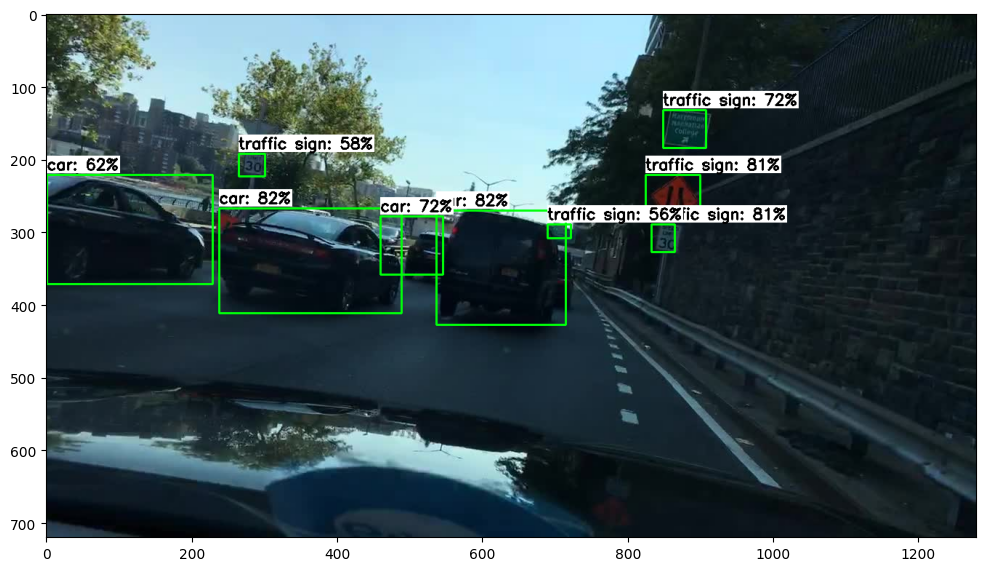

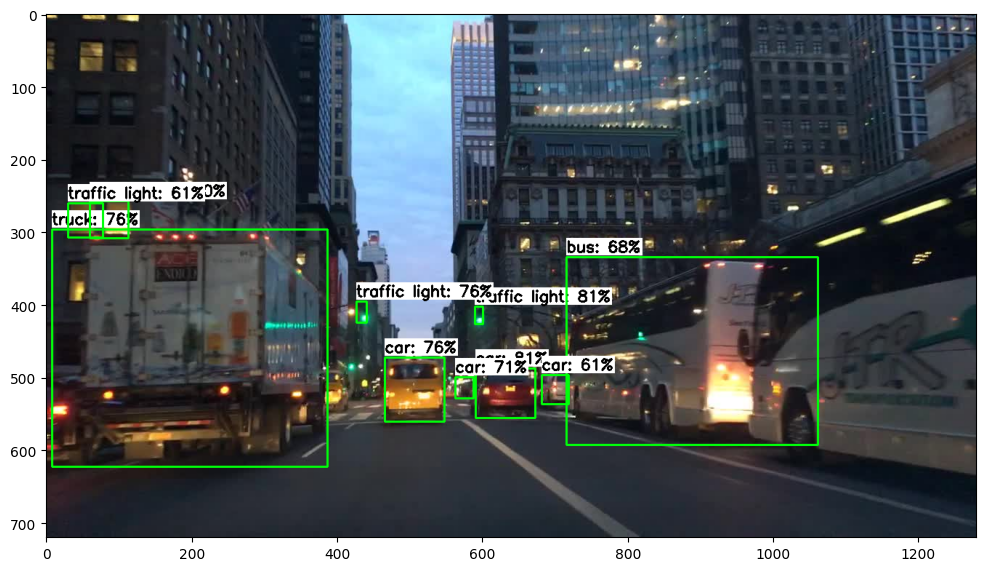

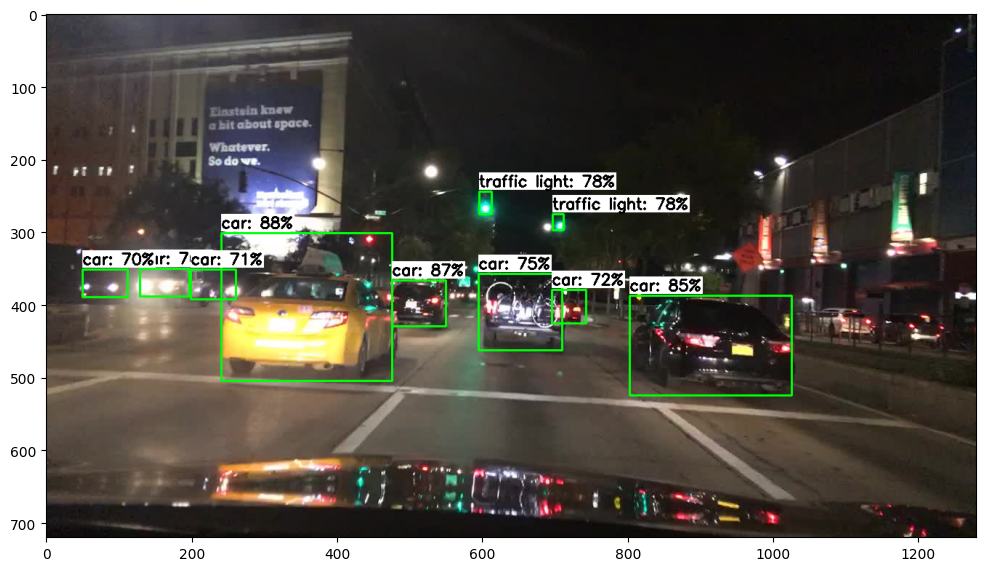

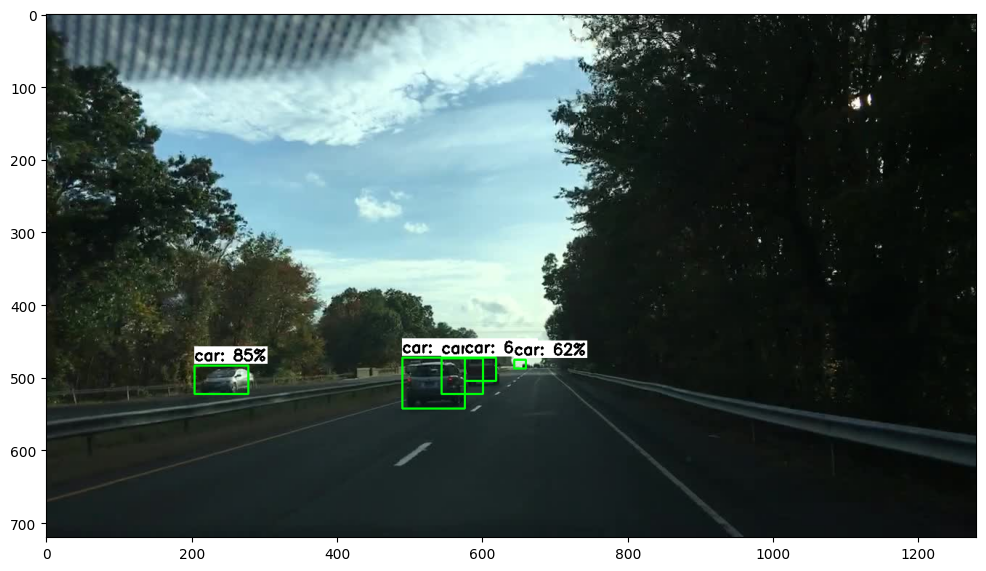

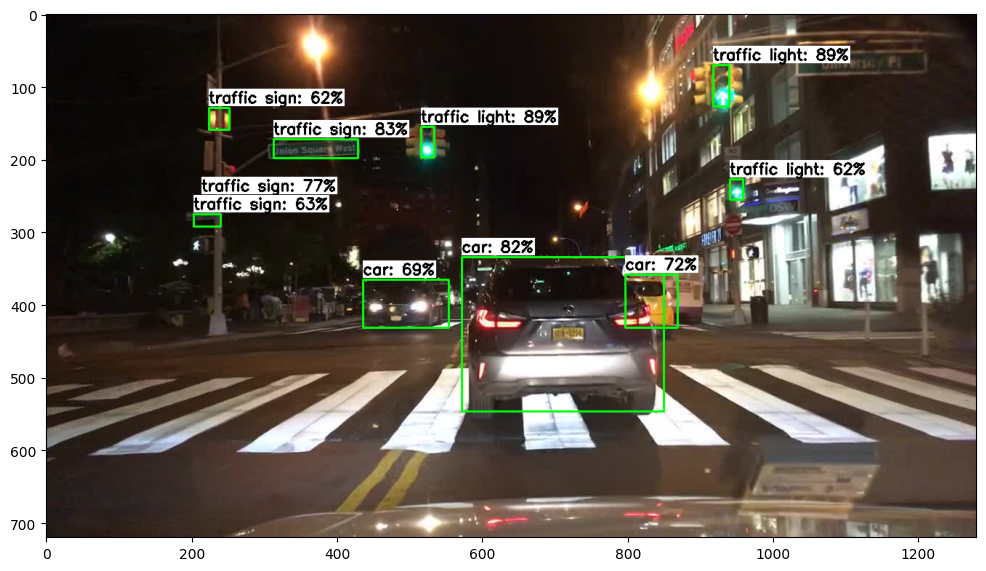

...

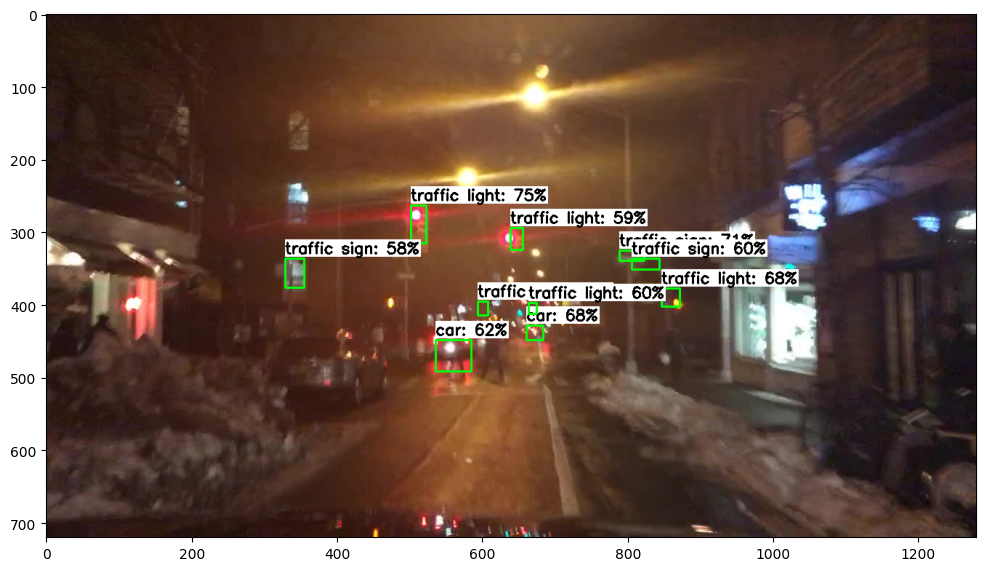

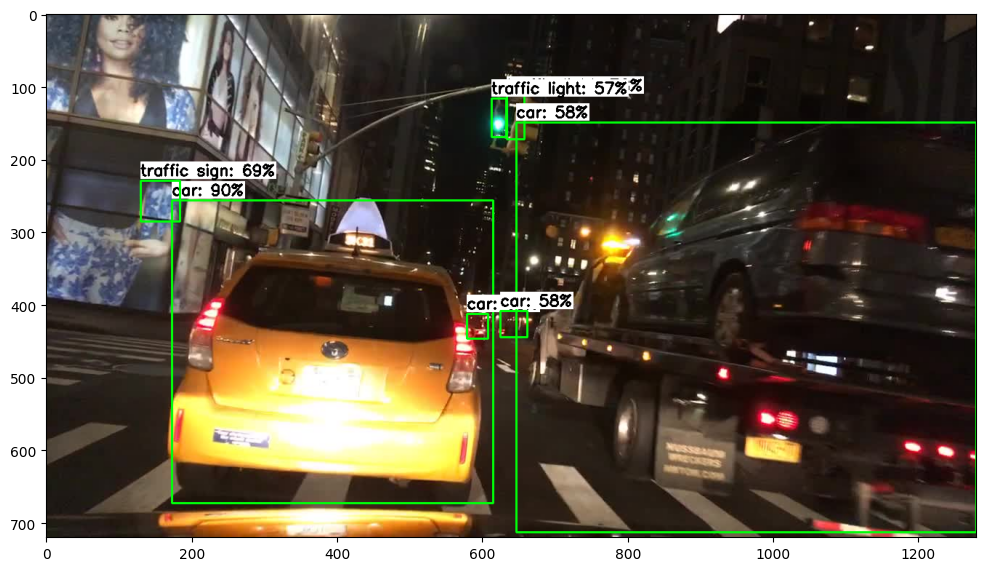

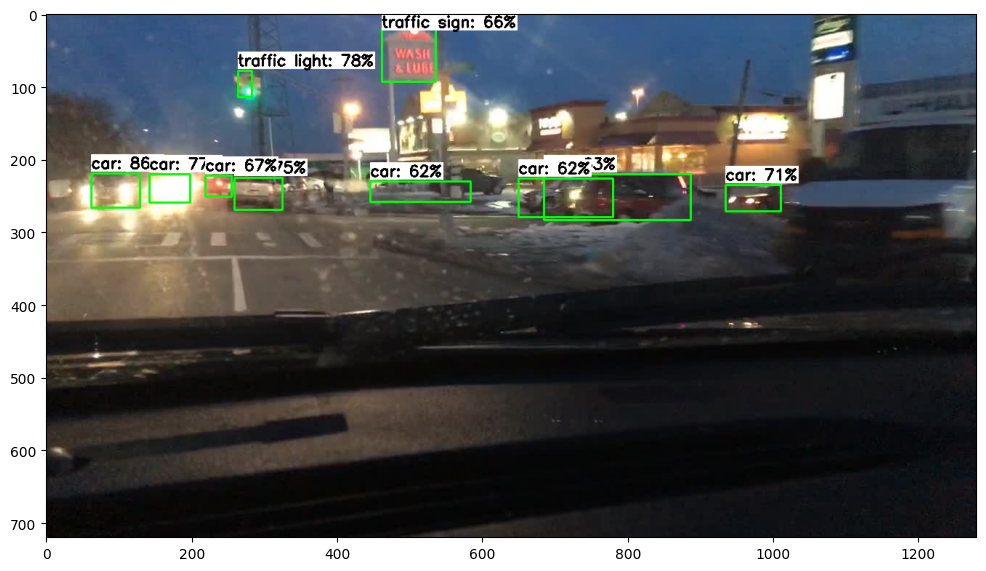

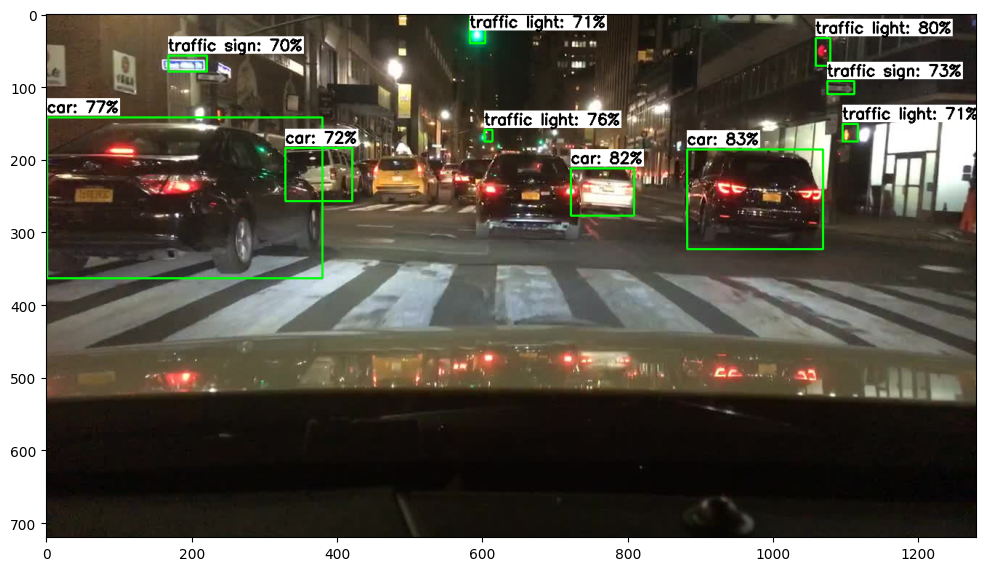

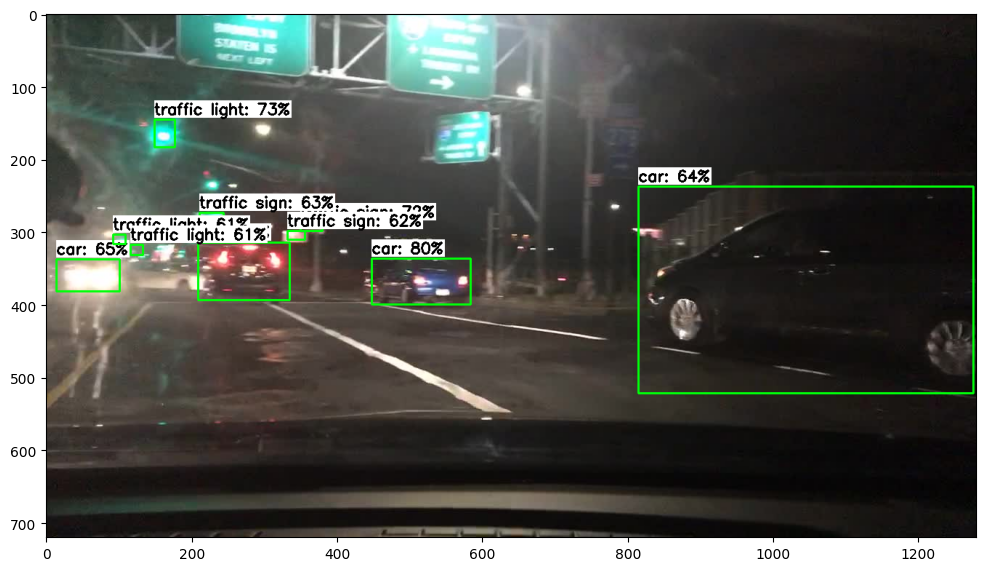

In [53]:
# Set up variables for running user's model
PATH_TO_IMAGES='/content/bdd100k/bdd100k/images/100k/test/'   # Path to test images folder
PATH_TO_MODEL='/content/custom_model_lite/detect.tflite'   # Path to .tflite model file
PATH_TO_LABELS='/content/classes.txt'   # Path to labelmap.txt file
min_conf_threshold=0.55   # Confidence threshold (try changing this to 0.01 if you don't see any detection results)
images_to_test = 30   # Number of images to run detection on

# Run inferencing function!
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test)

In [83]:
%%bash
git clone https://github.com/Cartucho/mAP /content/mAP


fatal: destination path '/content/mAP' already exists and is not an empty directory.
rm: cannot remove 'input/detection-results/*': No such file or directory
rm: cannot remove 'input/ground-truth/*': No such file or directory
--2024-04-17 15:14:08--  https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5397 (5.3K) [text/plain]
Saving to: ‘calculate_map_cartucho.py.6’

     0K .....                                                 100% 49.2M=0s

2024-04-17 15:14:08 (49.2 MB/s) - ‘calculate_map_cartucho.py.6’ saved [5397/5397]



In [85]:
!cd /content/mAP
!rm input/detection-results/*
!rm input/ground-truth/*
!rm -r input/images-optional/*
!wget https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py

rm: cannot remove 'input/detection-results/*': No such file or directory
rm: cannot remove 'input/ground-truth/*': No such file or directory
rm: cannot remove 'input/images-optional/*': No such file or directory
--2024-04-17 15:14:45--  https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5397 (5.3K) [text/plain]
Saving to: ‘calculate_map_cartucho.py.7’

calculate_map_cartu 100%[===================>]   5.27K  --.-KB/s    in 0s      

2024-04-17 15:14:45 (45.8 MB/s) - ‘calculate_map_cartucho.py.7’ saved [5397/5397]



In [86]:
!cp /content/bdd100k/bdd100k/images/100k/val/* /content/mAP/input/images-optional # Copy images and xml files


In [87]:
!cp /content/dataset/val/annos/*.xml /content/mAP/input/ground-truth/  # Move xml files to the appropriate folder

In [134]:
!python /content/mAP/scripts/extra/convert_gt_xml.py

Error: no .xml files found in ground-truth


In [88]:
!ls -l /content/dataset/val/annos | wc -l

10001


In [132]:
!rm -r /content/mAP/input/detection-results

In [136]:
# Set up variables for running inference, this time to get detection results saved as .txt files
PATH_TO_IMAGES='/content/bdd100k/bdd100k/images/100k/val/'   # Path to test images folder
PATH_TO_MODEL='/content/custom_model_lite/detect.tflite'   # Path to .tflite model file
PATH_TO_LABELS='/content/classes.txt'   # Path to labelmap.txt file
PATH_TO_RESULTS='/content/mAP/input/detection-results' # Folder to save detection results in
min_conf_threshold=0.55   # Confidence threshold

# Use all the images in the test folder
image_list = glob.glob(PATH_TO_IMAGES + '/*.jpg') + glob.glob(PATH_TO_IMAGES + '/*.JPG') + glob.glob(PATH_TO_IMAGES + '/*.png') + glob.glob(PATH_TO_IMAGES + '/*.bmp')
images_to_test = min(500, len(image_list)) # If there are more than 500 images in the folder, just use 500

# Tell function to just save results and not display images
txt_only = True

# Run inferencing function!
print('Starting inference on %d images...' % images_to_test)
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test, PATH_TO_RESULTS, txt_only)
print('Finished inferencing!')

Starting inference on 500 images...
Finished inferencing!


In [129]:
def process_directory(input_dir, output_dir):
    # Ensure output directory exists
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    # Iterate over all files in the input directory
    for filename in os.listdir(input_dir):
        if filename.endswith('.txt'):  # Check for text files
            file_path = os.path.join(input_dir, filename)
            output_path = os.path.join(output_dir, filename)
            process_custom_format(file_path, output_path)

def process_custom_format(file_path, output_path):
    with open(file_path, 'r') as file:
        lines = file.readlines()

    with open(output_path, 'w') as file:
        for line in lines:
            parts = line.split()
            class_name_parts = []
            coordinate_parts = []

            # Distinguish between class names and coordinates
            for part in parts:
                if part.isdigit() or (part.replace('.', '', 1).isdigit() and part.count('.') <= 1):
                    coordinate_parts.append(part)
                else:
                    class_name_parts.append(part)

            class_name = "_".join(class_name_parts)  # Join all parts of the class name
            coordinates = " ".join(coordinate_parts)  # Join all parts of the coordinates

            # Write the formatted line back to file
            file.write(f"{class_name} {coordinates}\n")

In [130]:
input_directory = '/content/mAP/input/detection-results'
output_directory = '/content/mAP/input/detection-results'
process_directory(input_directory, output_directory)


In [139]:
!python /content/mAP/scripts/extra/intersect-gt-and-dr.py

total ground-truth files: 1857
total detection-results files: 500

total ground-truth backup files: 1766
total detection-results backup files: 409
total intersected files: 91
Intersection completed!


In [142]:
%cd /content/mAP
!python calculate_map_cartucho.py --labels=/content/classes.txt

/content/mAP
The output folder /content/mAP/outputs already exists. Please delete it or specify a different folder name using --outdir.


In [147]:
# Move labelmap and pipeline config files into TFLite model folder and zip it up
!cp /content/classes.txt /content/custom_model_lite
!cp /content/labelmap.pbtxt /content/custom_model_lite
!cp /content/models/mymodel/pipeline_file.config /content/custom_model_lite

%cd /content
!zip -r custom_model_lite.zip custom_model_lite

/content
updating: custom_model_lite/ (stored 0%)
updating: custom_model_lite/detect.tflite (deflated 7%)
updating: custom_model_lite/saved_model/ (stored 0%)
updating: custom_model_lite/saved_model/saved_model.pb (deflated 92%)
updating: custom_model_lite/saved_model/variables/ (stored 0%)
updating: custom_model_lite/saved_model/variables/variables.data-00000-of-00001 (deflated 8%)
updating: custom_model_lite/saved_model/variables/variables.index (deflated 76%)
updating: custom_model_lite/saved_model/assets/ (stored 0%)
updating: custom_model_lite/pipeline_file.config (deflated 67%)
updating: custom_model_lite/labelmap.pbtxt (deflated 65%)
  adding: custom_model_lite/classes.txt (deflated 14%)


In [148]:
from google.colab import files

files.download('custom_model_lite.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>